# to get from the original files to something pandas/PyTorch can read

## what needs to be done:

* place the newest KPI files and get their path
* get the XML files and their path
* crawl the XML files and save the article texts and maybe some meta info
* append the KPI files with text and other stuff
* count the words, average the time etc.
* saven the enlarged files with good name...

In [1]:
import pandas as pd
pd.set_option('display.max_columns', 60)
import csv

import nltk
nltk.download('punkt')
import string
import numpy as np
import re
import json
from pathlib import Path
import re
import os

import matplotlib.pyplot as plt
import scipy.stats as st

from bs4 import BeautifulSoup
from functools import reduce

from transformers import BertTokenizer

from master_thesis.src import utils

[nltk_data] Downloading package punkt to /home/ruecker/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


In [3]:
## auf gpu1

ROOT = Path('/home/ruecker/data/Daten_INWT/original/')

## KIP tabels
TV_KPI = ROOT / '201112_TV.txt'
SZ_KPI = ROOT / '201112_SZ.txt'
NOZ_KPI = ROOT / '201117_NOZ.txt'
bonn_KPI = ROOT / '201211_Bonn.txt'

## original xml files
TV_xml = ROOT / 'TV/xml'
SZ_xml = ROOT / 'SZ/xml'
NOZ_xml = ROOT / 'NOZ/xml'
bonn_xml = ROOT / 'bonn/xml'

## here the text is saved
TV_txt = ROOT / 'TV/txt'
SZ_txt = ROOT / 'SZ/txt'
NOZ_txt = ROOT / 'NOZ/txt'
bonn_txt = ROOT / 'bonn/txt'

## here the final prepared tabels with KPI and text are to be saved
TV_prepared = ROOT / '..' / 'prepared' / 'TV'
SZ_prepared = ROOT / '..' / 'prepared' / 'SZ' 
NOZ_prepared = ROOT / '..' / 'prepared' / 'NOZ' 
bonn_prepared = ROOT / '..' / 'prepared' / 'bonn'

In [3]:
TV = pd.read_csv(TV_KPI, engine='python', quoting=csv.QUOTE_ALL, escapechar = '\\', index_col = 'articleId')
SZ = pd.read_csv(SZ_KPI, engine='python', quoting=csv.QUOTE_ALL, escapechar = '\\', index_col = 'articleId')
NOZ = pd.read_csv(NOZ_KPI, engine='python', quoting=csv.QUOTE_ALL, escapechar = '\\', index_col = 'articleId')
bonn = pd.read_csv(bonn_KPI, engine='python', quoting=csv.QUOTE_ALL, escapechar = '\\', index_col = 'articleId')

In [4]:
TV.shape, SZ.shape, NOZ.shape, bonn.shape

((21484, 21), (32272, 21), (44004, 15), (20202, 15))

# parsing ALL xml

In [94]:
TV_files = os.listdir(TV_xml)
SZ_files = os.listdir(SZ_xml)
NOZ_files = os.listdir(NOZ_xml)
bonn_files = os.listdir(bonn_xml)

In [95]:
print(len(TV_files), len(SZ_files), len(NOZ_files), len(bonn_files))

25677 36723 45437 20258


In [74]:
TV_IDs = []
for filename in TV_files:
    ID = int(filename[3:-4])
    TV_IDs.append(ID)
print(len(TV_IDs))

TV_extra = pd.DataFrame(index = TV_IDs, columns=["titel_html", "teaser", "article_body", "full_article", "other_content"])
TV_extra.index.rename("articleId", inplace = True)


SZ_IDs = []
for filename in SZ_files:
    ID = int(filename[3:-4])
    SZ_IDs.append(ID)
print(len(SZ_IDs))

SZ_extra = pd.DataFrame(index = SZ_IDs, columns=["titel_html", "teaser", "article_body", "full_article", "other_content"])
SZ_extra.index.rename("articleId", inplace = True)


NOZ_IDs = []
for filename in NOZ_files:
    ID = int(filename[3:-4])
    NOZ_IDs.append(ID)
print(len(NOZ_IDs))

NOZ_extra = pd.DataFrame(index = NOZ_IDs, columns=["titel_html", "teaser", "article_body", "full_article", "other_content"])
NOZ_extra.index.rename("articleId", inplace = True)


bonn_IDs = []
for filename in bonn_files:
    ID = int(filename[3:-4])
    bonn_IDs.append(ID)
print(len(bonn_IDs))

bonn_extra = pd.DataFrame(index = bonn_IDs, columns=["titel_html", "teaser", "article_body", "full_article", "other_content"])
bonn_extra.index.rename("articleId", inplace = True)

25677
36723
45437
20258


In [75]:
TV_extra.head()

,titel_html,teaser,article_body,full_article,other_content
articleId,,,,,
5524140,NaN,NaN,NaN,NaN,NaN
35855843,NaN,NaN,NaN,NaN,NaN
51454257,NaN,NaN,NaN,NaN,NaN
38967391,NaN,NaN,NaN,NaN,NaN
50085179,NaN,NaN,NaN,NaN,NaN


## TV

In [ ]:
# Kommentar: Hier wird bisher nicht Titel und Teaser aufgeteilt (also TV_extra nicht verwendet...)

In [76]:
TV_files = os.listdir(TV_xml)
print(len(TV_files))

print("reading in the files...")
for n, filename in enumerate(TV_files):
    print("---------")
    ID = int(filename[3:-4])
    print(n, filename, ID)
    with open(TV_xml / filename, 'r', encoding='utf-8') as f:
        s = f.read()
        soup = BeautifulSoup(s, 'html.parser')
        all_paragraphs = soup.find_all("p",{'class':['park-article__intro park-article__content',
                                                     'text',
                                                     'text_ohne_einzug',
                                                     'info_text']})
        #print(len(all_paragraphs))
        #print(all_paragraphs)
        all_paragraphs_text = '\n'.join(p.text for p in all_paragraphs)
        #print("all_p:","\n", all_paragraphs_text)

        with open(TV_txt / f"ID_{ID}.txt","w") as f_out: 
            f_out.write(all_paragraphs_text) 

    #if n > 20:
    #    break

25677
reading in the files...
---------
0 ID_5524140.xml 5524140
---------
1 ID_35855843.xml 35855843
---------
2 ID_51454257.xml 51454257
---------
3 ID_38967391.xml 38967391
---------
4 ID_50085179.xml 50085179
---------
5 ID_5408599.xml 5408599
---------
6 ID_50040323.xml 50040323
---------
7 ID_6714802.xml 6714802
---------
8 ID_6233695.xml 6233695
---------
9 ID_52151967.xml 52151967
---------
10 ID_7123884.xml 7123884
---------
11 ID_5136233.xml 5136233
---------
12 ID_51993203.xml 51993203
---------
13 ID_51167537.xml 51167537
---------
14 ID_38836323.xml 38836323
---------
15 ID_37814881.xml 37814881
---------
16 ID_39588497.xml 39588497
---------
17 ID_48875725.xml 48875725
---------
18 ID_17715691.xml 17715691
---------
19 ID_5857514.xml 5857514
---------
20 ID_49545883.xml 49545883
---------
21 ID_5914963.xml 5914963
---------
22 ID_37155921.xml 37155921
---------
23 ID_4868220.xml 4868220
---------
24 ID_50088447.xml 50088447
---------
25 ID_4952110.xml 4952110
---------
26

---------
228 ID_5892315.xml 5892315
---------
229 ID_23239123.xml 23239123
---------
230 ID_23744919.xml 23744919
---------
231 ID_44329341.xml 44329341
---------
232 ID_6262455.xml 6262455
---------
233 ID_50291831.xml 50291831
---------
234 ID_35693735.xml 35693735
---------
235 ID_23281303.xml 23281303
---------
236 ID_4898690.xml 4898690
---------
237 ID_51779373.xml 51779373
---------
238 ID_48122915.xml 48122915
---------
239 ID_48792373.xml 48792373
---------
240 ID_49683771.xml 49683771
---------
241 ID_6205268.xml 6205268
---------
242 ID_51929155.xml 51929155
---------
243 ID_51203583.xml 51203583
---------
244 ID_48324683.xml 48324683
---------
245 ID_7101893.xml 7101893
---------
246 ID_48545367.xml 48545367
---------
247 ID_6885267.xml 6885267
---------
248 ID_38629697.xml 38629697
---------
249 ID_48204748.xml 48204748
---------
250 ID_6697281.xml 6697281
---------
251 ID_52627683.xml 52627683
---------
252 ID_39120373.xml 39120373
---------
253 ID_51316917.xml 51316917


---------
449 ID_52365837.xml 52365837
---------
450 ID_50461363.xml 50461363
---------
451 ID_5559122.xml 5559122
---------
452 ID_52069315.xml 52069315
---------
453 ID_47853009.xml 47853009
---------
454 ID_50386515.xml 50386515
---------
455 ID_5211031.xml 5211031
---------
456 ID_51383129.xml 51383129
---------
457 ID_46200343.xml 46200343
---------
458 ID_48847031.xml 48847031
---------
459 ID_51965213.xml 51965213
---------
460 ID_4900777.xml 4900777
---------
461 ID_37774159.xml 37774159
---------
462 ID_6006394.xml 6006394
---------
463 ID_48795045.xml 48795045
---------
464 ID_6540115.xml 6540115
---------
465 ID_44292025.xml 44292025
---------
466 ID_6966447.xml 6966447
---------
467 ID_48113091.xml 48113091
---------
468 ID_50097969.xml 50097969
---------
469 ID_5821775.xml 5821775
---------
470 ID_6311913.xml 6311913
---------
471 ID_44275843.xml 44275843
---------
472 ID_52025565.xml 52025565
---------
473 ID_5444221.xml 5444221
---------
474 ID_48339213.xml 48339213
----

---------
666 ID_48263137.xml 48263137
---------
667 ID_6287204.xml 6287204
---------
668 ID_5457700.xml 5457700
---------
669 ID_5025167.xml 5025167
---------
670 ID_48067531.xml 48067531
---------
671 ID_49651545.xml 49651545
---------
672 ID_50436853.xml 50436853
---------
673 ID_5877251.xml 5877251
---------
674 ID_44355609.xml 44355609
---------
675 ID_49563977.xml 49563977
---------
676 ID_52570781.xml 52570781
---------
677 ID_37976287.xml 37976287
---------
678 ID_5647836.xml 5647836
---------
679 ID_49757871.xml 49757871
---------
680 ID_6019221.xml 6019221
---------
681 ID_44116887.xml 44116887
---------
682 ID_6170250.xml 6170250
---------
683 ID_47881385.xml 47881385
---------
684 ID_37919223.xml 37919223
---------
685 ID_51607663.xml 51607663
---------
686 ID_5749839.xml 5749839
---------
687 ID_50324175.xml 50324175
---------
688 ID_47926765.xml 47926765
---------
689 ID_51894437.xml 51894437
---------
690 ID_46776483.xml 46776483
---------
691 ID_50093593.xml 50093593
--

---------
882 ID_49153627.xml 49153627
---------
883 ID_5786244.xml 5786244
---------
884 ID_49765757.xml 49765757
---------
885 ID_47638283.xml 47638283
---------
886 ID_39826735.xml 39826735
---------
887 ID_38726621.xml 38726621
---------
888 ID_50213965.xml 50213965
---------
889 ID_34632619.xml 34632619
---------
890 ID_5492181.xml 5492181
---------
891 ID_51293305.xml 51293305
---------
892 ID_45322447.xml 45322447
---------
893 ID_47389587.xml 47389587
---------
894 ID_49497495.xml 49497495
---------
895 ID_4865248.xml 4865248
---------
896 ID_5193220.xml 5193220
---------
897 ID_5014651.xml 5014651
---------
898 ID_51460193.xml 51460193
---------
899 ID_52274437.xml 52274437
---------
900 ID_4927137.xml 4927137
---------
901 ID_52007463.xml 52007463
---------
902 ID_47720201.xml 47720201
---------
903 ID_5067497.xml 5067497
---------
904 ID_5720813.xml 5720813
---------
905 ID_49033359.xml 49033359
---------
906 ID_7918997.xml 7918997
---------
907 ID_48296913.xml 48296913
----

---------
1109 ID_51173383.xml 51173383
---------
1110 ID_46384879.xml 46384879
---------
1111 ID_46201601.xml 46201601
---------
1112 ID_33915883.xml 33915883
---------
1113 ID_50329427.xml 50329427
---------
1114 ID_51876237.xml 51876237
---------
1115 ID_52198119.xml 52198119
---------
1116 ID_52025061.xml 52025061
---------
1117 ID_49281411.xml 49281411
---------
1118 ID_49303133.xml 49303133
---------
1119 ID_44838137.xml 44838137
---------
1120 ID_5253922.xml 5253922
---------
1121 ID_50250759.xml 50250759
---------
1122 ID_36957075.xml 36957075
---------
1123 ID_47960799.xml 47960799
---------
1124 ID_49324179.xml 49324179
---------
1125 ID_49293801.xml 49293801
---------
1126 ID_6355872.xml 6355872
---------
1127 ID_39390749.xml 39390749
---------
1128 ID_47519095.xml 47519095
---------
1129 ID_4937131.xml 4937131
---------
1130 ID_52368349.xml 52368349
---------
1131 ID_51490399.xml 51490399
---------
1132 ID_34802085.xml 34802085
---------
1133 ID_5041566.xml 5041566
--------

---------
1334 ID_6363932.xml 6363932
---------
1335 ID_37797315.xml 37797315
---------
1336 ID_5206438.xml 5206438
---------
1337 ID_47892123.xml 47892123
---------
1338 ID_51525137.xml 51525137
---------
1339 ID_49690083.xml 49690083
---------
1340 ID_5041625.xml 5041625
---------
1341 ID_5268157.xml 5268157
---------
1342 ID_6329749.xml 6329749
---------
1343 ID_7608583.xml 7608583
---------
1344 ID_5272080.xml 5272080
---------
1345 ID_49244377.xml 49244377
---------
1346 ID_5491831.xml 5491831
---------
1347 ID_47365311.xml 47365311
---------
1348 ID_47989073.xml 47989073
---------
1349 ID_51940101.xml 51940101
---------
1350 ID_34024695.xml 34024695
---------
1351 ID_52250231.xml 52250231
---------
1352 ID_52142083.xml 52142083
---------
1353 ID_51747755.xml 51747755
---------
1354 ID_49774643.xml 49774643
---------
1355 ID_49588183.xml 49588183
---------
1356 ID_6666652.xml 6666652
---------
1357 ID_37020131.xml 37020131
---------
1358 ID_47140137.xml 47140137
---------
1359 ID_

---------
1545 ID_6045194.xml 6045194
---------
1546 ID_47081901.xml 47081901
---------
1547 ID_51694739.xml 51694739
---------
1548 ID_5882528.xml 5882528
---------
1549 ID_46919961.xml 46919961
---------
1550 ID_49082601.xml 49082601
---------
1551 ID_49842061.xml 49842061
---------
1552 ID_45143055.xml 45143055
---------
1553 ID_5803181.xml 5803181
---------
1554 ID_7048296.xml 7048296
---------
1555 ID_6012557.xml 6012557
---------
1556 ID_6152203.xml 6152203
---------
1557 ID_5793062.xml 5793062
---------
1558 ID_7699961.xml 7699961
---------
1559 ID_51526849.xml 51526849
---------
1560 ID_5013451.xml 5013451
---------
1561 ID_48913779.xml 48913779
---------
1562 ID_50157685.xml 50157685
---------
1563 ID_6663911.xml 6663911
---------
1564 ID_4919587.xml 4919587
---------
1565 ID_52632741.xml 52632741
---------
1566 ID_6468417.xml 6468417
---------
1567 ID_34937655.xml 34937655
---------
1568 ID_38222365.xml 38222365
---------
1569 ID_51318209.xml 51318209
---------
1570 ID_480832

---------
1765 ID_6727586.xml 6727586
---------
1766 ID_39371707.xml 39371707
---------
1767 ID_49584101.xml 49584101
---------
1768 ID_34036583.xml 34036583
---------
1769 ID_49524061.xml 49524061
---------
1770 ID_48992925.xml 48992925
---------
1771 ID_6085899.xml 6085899
---------
1772 ID_5016859.xml 5016859
---------
1773 ID_6723056.xml 6723056
---------
1774 ID_49412457.xml 49412457
---------
1775 ID_49651873.xml 49651873
---------
1776 ID_51243129.xml 51243129
---------
1777 ID_40055395.xml 40055395
---------
1778 ID_6029394.xml 6029394
---------
1779 ID_48578483.xml 48578483
---------
1780 ID_48171295.xml 48171295
---------
1781 ID_52229467.xml 52229467
---------
1782 ID_45645403.xml 45645403
---------
1783 ID_51310709.xml 51310709
---------
1784 ID_39291027.xml 39291027
---------
1785 ID_39874269.xml 39874269
---------
1786 ID_51637819.xml 51637819
---------
1787 ID_51447719.xml 51447719
---------
1788 ID_50170923.xml 50170923
---------
1789 ID_4983029.xml 4983029
---------
17

---------
1979 ID_51957559.xml 51957559
---------
1980 ID_45053649.xml 45053649
---------
1981 ID_52427303.xml 52427303
---------
1982 ID_48707787.xml 48707787
---------
1983 ID_6276253.xml 6276253
---------
1984 ID_6476682.xml 6476682
---------
1985 ID_49537193.xml 49537193
---------
1986 ID_5115390.xml 5115390
---------
1987 ID_37850515.xml 37850515
---------
1988 ID_6116751.xml 6116751
---------
1989 ID_48799949.xml 48799949
---------
1990 ID_49104621.xml 49104621
---------
1991 ID_49749481.xml 49749481
---------
1992 ID_49758897.xml 49758897
---------
1993 ID_39776963.xml 39776963
---------
1994 ID_5179026.xml 5179026
---------
1995 ID_52684915.xml 52684915
---------
1996 ID_52654691.xml 52654691
---------
1997 ID_48704401.xml 48704401
---------
1998 ID_49516015.xml 49516015
---------
1999 ID_6271589.xml 6271589
---------
2000 ID_39053339.xml 39053339
---------
2001 ID_52465651.xml 52465651
---------
2002 ID_44658649.xml 44658649
---------
2003 ID_48585711.xml 48585711
---------
20

---------
2190 ID_48726099.xml 48726099
---------
2191 ID_23152535.xml 23152535
---------
2192 ID_39724049.xml 39724049
---------
2193 ID_5201037.xml 5201037
---------
2194 ID_5566006.xml 5566006
---------
2195 ID_49631079.xml 49631079
---------
2196 ID_5771739.xml 5771739
---------
2197 ID_5116035.xml 5116035
---------
2198 ID_5150605.xml 5150605
---------
2199 ID_6245862.xml 6245862
---------
2200 ID_46276371.xml 46276371
---------
2201 ID_48725459.xml 48725459
---------
2202 ID_4956136.xml 4956136
---------
2203 ID_47667131.xml 47667131
---------
2204 ID_47858533.xml 47858533
---------
2205 ID_32445263.xml 32445263
---------
2206 ID_5344343.xml 5344343
---------
2207 ID_4930316.xml 4930316
---------
2208 ID_47974593.xml 47974593
---------
2209 ID_51531543.xml 51531543
---------
2210 ID_50146075.xml 50146075
---------
2211 ID_5327516.xml 5327516
---------
2212 ID_49566687.xml 49566687
---------
2213 ID_5336197.xml 5336197
---------
2214 ID_33444015.xml 33444015
---------
2215 ID_4971

---------
2404 ID_47460953.xml 47460953
---------
2405 ID_7244990.xml 7244990
---------
2406 ID_29470567.xml 29470567
---------
2407 ID_22566263.xml 22566263
---------
2408 ID_36819439.xml 36819439
---------
2409 ID_52473907.xml 52473907
---------
2410 ID_38252003.xml 38252003
---------
2411 ID_50122557.xml 50122557
---------
2412 ID_51860573.xml 51860573
---------
2413 ID_45577429.xml 45577429
---------
2414 ID_51800465.xml 51800465
---------
2415 ID_47830219.xml 47830219
---------
2416 ID_6114105.xml 6114105
---------
2417 ID_47390355.xml 47390355
---------
2418 ID_49194079.xml 49194079
---------
2419 ID_49806317.xml 49806317
---------
2420 ID_47390281.xml 47390281
---------
2421 ID_5941151.xml 5941151
---------
2422 ID_6291040.xml 6291040
---------
2423 ID_6178604.xml 6178604
---------
2424 ID_6282007.xml 6282007
---------
2425 ID_50087557.xml 50087557
---------
2426 ID_5567828.xml 5567828
---------
2427 ID_39861981.xml 39861981
---------
2428 ID_39371951.xml 39371951
---------
2429

---------
2614 ID_38788519.xml 38788519
---------
2615 ID_48566643.xml 48566643
---------
2616 ID_52372951.xml 52372951
---------
2617 ID_48799095.xml 48799095
---------
2618 ID_49139883.xml 49139883
---------
2619 ID_48421271.xml 48421271
---------
2620 ID_51835775.xml 51835775
---------
2621 ID_52005181.xml 52005181
---------
2622 ID_47239773.xml 47239773
---------
2623 ID_35507289.xml 35507289
---------
2624 ID_4983240.xml 4983240
---------
2625 ID_5229498.xml 5229498
---------
2626 ID_51882151.xml 51882151
---------
2627 ID_6372631.xml 6372631
---------
2628 ID_5478088.xml 5478088
---------
2629 ID_52341443.xml 52341443
---------
2630 ID_51974203.xml 51974203
---------
2631 ID_37412789.xml 37412789
---------
2632 ID_47430755.xml 47430755
---------
2633 ID_6203931.xml 6203931
---------
2634 ID_46496581.xml 46496581
---------
2635 ID_7183221.xml 7183221
---------
2636 ID_33552313.xml 33552313
---------
2637 ID_47269089.xml 47269089
---------
2638 ID_6849132.xml 6849132
---------
2639

---------
2825 ID_45936317.xml 45936317
---------
2826 ID_6148163.xml 6148163
---------
2827 ID_52298353.xml 52298353
---------
2828 ID_51161649.xml 51161649
---------
2829 ID_52016777.xml 52016777
---------
2830 ID_6095102.xml 6095102
---------
2831 ID_5386024.xml 5386024
---------
2832 ID_6125310.xml 6125310
---------
2833 ID_6555687.xml 6555687
---------
2834 ID_49271071.xml 49271071
---------
2835 ID_8032217.xml 8032217
---------
2836 ID_52146065.xml 52146065
---------
2837 ID_5827108.xml 5827108
---------
2838 ID_6445939.xml 6445939
---------
2839 ID_51268523.xml 51268523
---------
2840 ID_5732127.xml 5732127
---------
2841 ID_49785767.xml 49785767
---------
2842 ID_49709753.xml 49709753
---------
2843 ID_39314761.xml 39314761
---------
2844 ID_45555417.xml 45555417
---------
2845 ID_51645943.xml 51645943
---------
2846 ID_48899459.xml 48899459
---------
2847 ID_35642059.xml 35642059
---------
2848 ID_5081333.xml 5081333
---------
2849 ID_49689423.xml 49689423
---------
2850 ID_39

---------
3037 ID_6336341.xml 6336341
---------
3038 ID_51556639.xml 51556639
---------
3039 ID_4920980.xml 4920980
---------
3040 ID_48813709.xml 48813709
---------
3041 ID_52667571.xml 52667571
---------
3042 ID_47385947.xml 47385947
---------
3043 ID_52027555.xml 52027555
---------
3044 ID_34392877.xml 34392877
---------
3045 ID_5684362.xml 5684362
---------
3046 ID_23956343.xml 23956343
---------
3047 ID_36557965.xml 36557965
---------
3048 ID_6665606.xml 6665606
---------
3049 ID_51376295.xml 51376295
---------
3050 ID_37036385.xml 37036385
---------
3051 ID_48988081.xml 48988081
---------
3052 ID_50049399.xml 50049399
---------
3053 ID_22297337.xml 22297337
---------
3054 ID_51922079.xml 51922079
---------
3055 ID_5746795.xml 5746795
---------
3056 ID_5606625.xml 5606625
---------
3057 ID_44082679.xml 44082679
---------
3058 ID_46916841.xml 46916841
---------
3059 ID_48814093.xml 48814093
---------
3060 ID_5672336.xml 5672336
---------
3061 ID_48929869.xml 48929869
---------
3062

---------
3252 ID_5731136.xml 5731136
---------
3253 ID_49610971.xml 49610971
---------
3254 ID_47751811.xml 47751811
---------
3255 ID_35952247.xml 35952247
---------
3256 ID_48696291.xml 48696291
---------
3257 ID_45934575.xml 45934575
---------
3258 ID_51285745.xml 51285745
---------
3259 ID_51933635.xml 51933635
---------
3260 ID_6143301.xml 6143301
---------
3261 ID_45018809.xml 45018809
---------
3262 ID_52260229.xml 52260229
---------
3263 ID_6382157.xml 6382157
---------
3264 ID_5548047.xml 5548047
---------
3265 ID_52275535.xml 52275535
---------
3266 ID_45235815.xml 45235815
---------
3267 ID_52544611.xml 52544611
---------
3268 ID_47561077.xml 47561077
---------
3269 ID_5906445.xml 5906445
---------
3270 ID_5089309.xml 5089309
---------
3271 ID_48007849.xml 48007849
---------
3272 ID_46674850.xml 46674850
---------
3273 ID_48042193.xml 48042193
---------
3274 ID_6839873.xml 6839873
---------
3275 ID_32767625.xml 32767625
---------
3276 ID_46623227.xml 46623227
---------
3277

---------
3471 ID_51888661.xml 51888661
---------
3472 ID_22281499.xml 22281499
---------
3473 ID_47663751.xml 47663751
---------
3474 ID_23104767.xml 23104767
---------
3475 ID_46918253.xml 46918253
---------
3476 ID_46462031.xml 46462031
---------
3477 ID_5252914.xml 5252914
---------
3478 ID_23851451.xml 23851451
---------
3479 ID_49989547.xml 49989547
---------
3480 ID_52606091.xml 52606091
---------
3481 ID_48172633.xml 48172633
---------
3482 ID_6312681.xml 6312681
---------
3483 ID_34648671.xml 34648671
---------
3484 ID_47777421.xml 47777421
---------
3485 ID_39858885.xml 39858885
---------
3486 ID_50370433.xml 50370433
---------
3487 ID_5475482.xml 5475482
---------
3488 ID_51943971.xml 51943971
---------
3489 ID_6601676.xml 6601676
---------
3490 ID_49617757.xml 49617757
---------
3491 ID_48162399.xml 48162399
---------
3492 ID_49608277.xml 49608277
---------
3493 ID_45508263.xml 45508263
---------
3494 ID_51327133.xml 51327133
---------
3495 ID_49060351.xml 49060351
--------

---------
3691 ID_44839123.xml 44839123
---------
3692 ID_52401253.xml 52401253
---------
3693 ID_5140968.xml 5140968
---------
3694 ID_5888643.xml 5888643
---------
3695 ID_47841441.xml 47841441
---------
3696 ID_5079750.xml 5079750
---------
3697 ID_34562015.xml 34562015
---------
3698 ID_46244885.xml 46244885
---------
3699 ID_51800487.xml 51800487
---------
3700 ID_6576102.xml 6576102
---------
3701 ID_46059653.xml 46059653
---------
3702 ID_51957133.xml 51957133
---------
3703 ID_5739372.xml 5739372
---------
3704 ID_48541875.xml 48541875
---------
3705 ID_39097601.xml 39097601
---------
3706 ID_49534443.xml 49534443
---------
3707 ID_48319589.xml 48319589
---------
3708 ID_5288792.xml 5288792
---------
3709 ID_52061183.xml 52061183
---------
3710 ID_48124749.xml 48124749
---------
3711 ID_24331595.xml 24331595
---------
3712 ID_34903497.xml 34903497
---------
3713 ID_47353287.xml 47353287
---------
3714 ID_49422189.xml 49422189
---------
3715 ID_5309605.xml 5309605
---------
3716

---------
3917 ID_47903255.xml 47903255
---------
3918 ID_23554275.xml 23554275
---------
3919 ID_5388339.xml 5388339
---------
3920 ID_46003325.xml 46003325
---------
3921 ID_6542212.xml 6542212
---------
3922 ID_5770749.xml 5770749
---------
3923 ID_5263987.xml 5263987
---------
3924 ID_38150815.xml 38150815
---------
3925 ID_52113275.xml 52113275
---------
3926 ID_48649935.xml 48649935
---------
3927 ID_36852559.xml 36852559
---------
3928 ID_6715057.xml 6715057
---------
3929 ID_48513111.xml 48513111
---------
3930 ID_44289783.xml 44289783
---------
3931 ID_49515557.xml 49515557
---------
3932 ID_49883269.xml 49883269
---------
3933 ID_51603325.xml 51603325
---------
3934 ID_52455047.xml 52455047
---------
3935 ID_46429829.xml 46429829
---------
3936 ID_50017761.xml 50017761
---------
3937 ID_5997484.xml 5997484
---------
3938 ID_51336893.xml 51336893
---------
3939 ID_7137697.xml 7137697
---------
3940 ID_36599743.xml 36599743
---------
3941 ID_5016413.xml 5016413
---------
3942 I

---------
4131 ID_49179267.xml 49179267
---------
4132 ID_50250663.xml 50250663
---------
4133 ID_5770867.xml 5770867
---------
4134 ID_52655111.xml 52655111
---------
4135 ID_5830431.xml 5830431
---------
4136 ID_6171749.xml 6171749
---------
4137 ID_50323643.xml 50323643
---------
4138 ID_38489485.xml 38489485
---------
4139 ID_6381803.xml 6381803
---------
4140 ID_48214532.xml 48214532
---------
4141 ID_5820154.xml 5820154
---------
4142 ID_52621341.xml 52621341
---------
4143 ID_50061231.xml 50061231
---------
4144 ID_38712619.xml 38712619
---------
4145 ID_50100765.xml 50100765
---------
4146 ID_6620014.xml 6620014
---------
4147 ID_36929285.xml 36929285
---------
4148 ID_33730637.xml 33730637
---------
4149 ID_5690646.xml 5690646
---------
4150 ID_48305503.xml 48305503
---------
4151 ID_50586161.xml 50586161
---------
4152 ID_5609750.xml 5609750
---------
4153 ID_7119407.xml 7119407
---------
4154 ID_51814971.xml 51814971
---------
4155 ID_51730251.xml 51730251
---------
4156 ID_

---------
4349 ID_22281315.xml 22281315
---------
4350 ID_38425757.xml 38425757
---------
4351 ID_49130739.xml 49130739
---------
4352 ID_49155575.xml 49155575
---------
4353 ID_5258148.xml 5258148
---------
4354 ID_5743220.xml 5743220
---------
4355 ID_6377932.xml 6377932
---------
4356 ID_5377871.xml 5377871
---------
4357 ID_51474077.xml 51474077
---------
4358 ID_6145825.xml 6145825
---------
4359 ID_47776971.xml 47776971
---------
4360 ID_50350239.xml 50350239
---------
4361 ID_48283987.xml 48283987
---------
4362 ID_51771021.xml 51771021
---------
4363 ID_5335754.xml 5335754
---------
4364 ID_48199814.xml 48199814
---------
4365 ID_37897957.xml 37897957
---------
4366 ID_6144751.xml 6144751
---------
4367 ID_5875859.xml 5875859
---------
4368 ID_4961148.xml 4961148
---------
4369 ID_37508869.xml 37508869
---------
4370 ID_52519055.xml 52519055
---------
4371 ID_49108221.xml 49108221
---------
4372 ID_44966513.xml 44966513
---------
4373 ID_52654343.xml 52654343
---------
4374 ID_

---------
4563 ID_51546177.xml 51546177
---------
4564 ID_23412565.xml 23412565
---------
4565 ID_49828247.xml 49828247
---------
4566 ID_37458247.xml 37458247
---------
4567 ID_39563329.xml 39563329
---------
4568 ID_5143054.xml 5143054
---------
4569 ID_6107674.xml 6107674
---------
4570 ID_48664367.xml 48664367
---------
4571 ID_46746827.xml 46746827
---------
4572 ID_46284073.xml 46284073
---------
4573 ID_5966350.xml 5966350
---------
4574 ID_50072981.xml 50072981
---------
4575 ID_45272199.xml 45272199
---------
4576 ID_47111697.xml 47111697
---------
4577 ID_49105669.xml 49105669
---------
4578 ID_33224325.xml 33224325
---------
4579 ID_46667130.xml 46667130
---------
4580 ID_4865969.xml 4865969
---------
4581 ID_49171489.xml 49171489
---------
4582 ID_24310479.xml 24310479
---------
4583 ID_36916025.xml 36916025
---------
4584 ID_50228725.xml 50228725
---------
4585 ID_5331577.xml 5331577
---------
4586 ID_50159459.xml 50159459
---------
4587 ID_50121711.xml 50121711
---------


---------
4776 ID_50231987.xml 50231987
---------
4777 ID_49342547.xml 49342547
---------
4778 ID_46168575.xml 46168575
---------
4779 ID_5831161.xml 5831161
---------
4780 ID_46338389.xml 46338389
---------
4781 ID_37109267.xml 37109267
---------
4782 ID_50328125.xml 50328125
---------
4783 ID_5056501.xml 5056501
---------
4784 ID_49552103.xml 49552103
---------
4785 ID_47790283.xml 47790283
---------
4786 ID_45369355.xml 45369355
---------
4787 ID_5160375.xml 5160375
---------
4788 ID_39643305.xml 39643305
---------
4789 ID_51797455.xml 51797455
---------
4790 ID_5896293.xml 5896293
---------
4791 ID_47261113.xml 47261113
---------
4792 ID_5235480.xml 5235480
---------
4793 ID_6187293.xml 6187293
---------
4794 ID_5158919.xml 5158919
---------
4795 ID_5493433.xml 5493433
---------
4796 ID_50341565.xml 50341565
---------
4797 ID_48757075.xml 48757075
---------
4798 ID_51571191.xml 51571191
---------
4799 ID_48554473.xml 48554473
---------
4800 ID_51669097.xml 51669097
---------
4801 I

---------
4995 ID_49495787.xml 49495787
---------
4996 ID_5864695.xml 5864695
---------
4997 ID_4897923.xml 4897923
---------
4998 ID_52071909.xml 52071909
---------
4999 ID_36847743.xml 36847743
---------
5000 ID_48438329.xml 48438329
---------
5001 ID_48746827.xml 48746827
---------
5002 ID_50454491.xml 50454491
---------
5003 ID_5613396.xml 5613396
---------
5004 ID_49640331.xml 49640331
---------
5005 ID_6133083.xml 6133083
---------
5006 ID_5139963.xml 5139963
---------
5007 ID_5868531.xml 5868531
---------
5008 ID_6197350.xml 6197350
---------
5009 ID_51706829.xml 51706829
---------
5010 ID_39470389.xml 39470389
---------
5011 ID_5816507.xml 5816507
---------
5012 ID_6251641.xml 6251641
---------
5013 ID_47682919.xml 47682919
---------
5014 ID_4869250.xml 4869250
---------
5015 ID_50087921.xml 50087921
---------
5016 ID_48800201.xml 48800201
---------
5017 ID_4918969.xml 4918969
---------
5018 ID_39095463.xml 39095463
---------
5019 ID_33255259.xml 33255259
---------
5020 ID_6325

---------
5217 ID_5086370.xml 5086370
---------
5218 ID_44626693.xml 44626693
---------
5219 ID_45121511.xml 45121511
---------
5220 ID_48085617.xml 48085617
---------
5221 ID_4898959.xml 4898959
---------
5222 ID_51333993.xml 51333993
---------
5223 ID_38081061.xml 38081061
---------
5224 ID_46311237.xml 46311237
---------
5225 ID_6613303.xml 6613303
---------
5226 ID_5917691.xml 5917691
---------
5227 ID_6035975.xml 6035975
---------
5228 ID_49520039.xml 49520039
---------
5229 ID_49952793.xml 49952793
---------
5230 ID_49779939.xml 49779939
---------
5231 ID_51042237.xml 51042237
---------
5232 ID_5604701.xml 5604701
---------
5233 ID_49912931.xml 49912931
---------
5234 ID_49867375.xml 49867375
---------
5235 ID_38032805.xml 38032805
---------
5236 ID_48232337.xml 48232337
---------
5237 ID_49891785.xml 49891785
---------
5238 ID_6164624.xml 6164624
---------
5239 ID_5081051.xml 5081051
---------
5240 ID_15817265.xml 15817265
---------
5241 ID_6673821.xml 6673821
---------
5242 ID_

---------
5434 ID_34835183.xml 34835183
---------
5435 ID_49129555.xml 49129555
---------
5436 ID_5385081.xml 5385081
---------
5437 ID_5919561.xml 5919561
---------
5438 ID_5417925.xml 5417925
---------
5439 ID_5852956.xml 5852956
---------
5440 ID_6196819.xml 6196819
---------
5441 ID_51708791.xml 51708791
---------
5442 ID_50474051.xml 50474051
---------
5443 ID_6273646.xml 6273646
---------
5444 ID_37923915.xml 37923915
---------
5445 ID_38272425.xml 38272425
---------
5446 ID_6226714.xml 6226714
---------
5447 ID_6711881.xml 6711881
---------
5448 ID_5236676.xml 5236676
---------
5449 ID_11062537.xml 11062537
---------
5450 ID_5687475.xml 5687475
---------
5451 ID_52096257.xml 52096257
---------
5452 ID_51767257.xml 51767257
---------
5453 ID_50401947.xml 50401947
---------
5454 ID_39488621.xml 39488621
---------
5455 ID_52249047.xml 52249047
---------
5456 ID_38605107.xml 38605107
---------
5457 ID_49560865.xml 49560865
---------
5458 ID_5736645.xml 5736645
---------
5459 ID_4461

---------
5646 ID_46486101.xml 46486101
---------
5647 ID_39162171.xml 39162171
---------
5648 ID_7609253.xml 7609253
---------
5649 ID_37349587.xml 37349587
---------
5650 ID_52008673.xml 52008673
---------
5651 ID_6452774.xml 6452774
---------
5652 ID_5890739.xml 5890739
---------
5653 ID_51761937.xml 51761937
---------
5654 ID_37408073.xml 37408073
---------
5655 ID_51358589.xml 51358589
---------
5656 ID_51684317.xml 51684317
---------
5657 ID_45843169.xml 45843169
---------
5658 ID_47852171.xml 47852171
---------
5659 ID_5996607.xml 5996607
---------
5660 ID_51536837.xml 51536837
---------
5661 ID_49790327.xml 49790327
---------
5662 ID_5960448.xml 5960448
---------
5663 ID_39185367.xml 39185367
---------
5664 ID_49979507.xml 49979507
---------
5665 ID_48989769.xml 48989769
---------
5666 ID_48327639.xml 48327639
---------
5667 ID_48542041.xml 48542041
---------
5668 ID_6617770.xml 6617770
---------
5669 ID_6699507.xml 6699507
---------
5670 ID_6726078.xml 6726078
---------
5671 I

---------
5864 ID_49319383.xml 49319383
---------
5865 ID_50187095.xml 50187095
---------
5866 ID_24309895.xml 24309895
---------
5867 ID_51536085.xml 51536085
---------
5868 ID_5252872.xml 5252872
---------
5869 ID_51593341.xml 51593341
---------
5870 ID_7175358.xml 7175358
---------
5871 ID_48588101.xml 48588101
---------
5872 ID_49345395.xml 49345395
---------
5873 ID_6917472.xml 6917472
---------
5874 ID_6276439.xml 6276439
---------
5875 ID_49432141.xml 49432141
---------
5876 ID_52245537.xml 52245537
---------
5877 ID_48956589.xml 48956589
---------
5878 ID_52435989.xml 52435989
---------
5879 ID_48244235.xml 48244235
---------
5880 ID_48590571.xml 48590571
---------
5881 ID_33260277.xml 33260277
---------
5882 ID_49921329.xml 49921329
---------
5883 ID_6557793.xml 6557793
---------
5884 ID_47571475.xml 47571475
---------
5885 ID_38453125.xml 38453125
---------
5886 ID_49456755.xml 49456755
---------
5887 ID_51308593.xml 51308593
---------
5888 ID_5177698.xml 5177698
---------
58

---------
6075 ID_9821053.xml 9821053
---------
6076 ID_34624355.xml 34624355
---------
6077 ID_5443361.xml 5443361
---------
6078 ID_48970213.xml 48970213
---------
6079 ID_49350401.xml 49350401
---------
6080 ID_51866129.xml 51866129
---------
6081 ID_18588289.xml 18588289
---------
6082 ID_6331461.xml 6331461
---------
6083 ID_5396383.xml 5396383
---------
6084 ID_50383795.xml 50383795
---------
6085 ID_6998506.xml 6998506
---------
6086 ID_6279340.xml 6279340
---------
6087 ID_5694862.xml 5694862
---------
6088 ID_6691581.xml 6691581
---------
6089 ID_5638565.xml 5638565
---------
6090 ID_6229505.xml 6229505
---------
6091 ID_49019947.xml 49019947
---------
6092 ID_5911619.xml 5911619
---------
6093 ID_5421007.xml 5421007
---------
6094 ID_51829977.xml 51829977
---------
6095 ID_52437103.xml 52437103
---------
6096 ID_48101011.xml 48101011
---------
6097 ID_50367043.xml 50367043
---------
6098 ID_52020993.xml 52020993
---------
6099 ID_48516859.xml 48516859
---------
6100 ID_585456

---------
6290 ID_37349865.xml 37349865
---------
6291 ID_5936737.xml 5936737
---------
6292 ID_7304153.xml 7304153
---------
6293 ID_5340447.xml 5340447
---------
6294 ID_5326029.xml 5326029
---------
6295 ID_35920497.xml 35920497
---------
6296 ID_45731513.xml 45731513
---------
6297 ID_37723915.xml 37723915
---------
6298 ID_5683208.xml 5683208
---------
6299 ID_46083981.xml 46083981
---------
6300 ID_4918617.xml 4918617
---------
6301 ID_49945369.xml 49945369
---------
6302 ID_51413051.xml 51413051
---------
6303 ID_49060505.xml 49060505
---------
6304 ID_52074497.xml 52074497
---------
6305 ID_37177215.xml 37177215
---------
6306 ID_51770679.xml 51770679
---------
6307 ID_7697549.xml 7697549
---------
6308 ID_46570649.xml 46570649
---------
6309 ID_48973205.xml 48973205
---------
6310 ID_24015715.xml 24015715
---------
6311 ID_36798225.xml 36798225
---------
6312 ID_5116573.xml 5116573
---------
6313 ID_6115059.xml 6115059
---------
6314 ID_47941007.xml 47941007
---------
6315 ID_

---------
6510 ID_5573801.xml 5573801
---------
6511 ID_52004549.xml 52004549
---------
6512 ID_6681921.xml 6681921
---------
6513 ID_48194020.xml 48194020
---------
6514 ID_37061681.xml 37061681
---------
6515 ID_48707535.xml 48707535
---------
6516 ID_6716704.xml 6716704
---------
6517 ID_52205345.xml 52205345
---------
6518 ID_47706261.xml 47706261
---------
6519 ID_47510333.xml 47510333
---------
6520 ID_6600777.xml 6600777
---------
6521 ID_35741891.xml 35741891
---------
6522 ID_52066413.xml 52066413
---------
6523 ID_5167580.xml 5167580
---------
6524 ID_47085343.xml 47085343
---------
6525 ID_49431261.xml 49431261
---------
6526 ID_49683181.xml 49683181
---------
6527 ID_33781945.xml 33781945
---------
6528 ID_50439069.xml 50439069
---------
6529 ID_48385809.xml 48385809
---------
6530 ID_35760733.xml 35760733
---------
6531 ID_5111120.xml 5111120
---------
6532 ID_47573893.xml 47573893
---------
6533 ID_52029363.xml 52029363
---------
6534 ID_39256653.xml 39256653
---------
65

---------
6730 ID_49344475.xml 49344475
---------
6731 ID_51397555.xml 51397555
---------
6732 ID_48172887.xml 48172887
---------
6733 ID_5308236.xml 5308236
---------
6734 ID_6311707.xml 6311707
---------
6735 ID_5263078.xml 5263078
---------
6736 ID_6284499.xml 6284499
---------
6737 ID_47050211.xml 47050211
---------
6738 ID_52021621.xml 52021621
---------
6739 ID_5948261.xml 5948261
---------
6740 ID_48234605.xml 48234605
---------
6741 ID_49755007.xml 49755007
---------
6742 ID_50118495.xml 50118495
---------
6743 ID_48008207.xml 48008207
---------
6744 ID_5565747.xml 5565747
---------
6745 ID_50140021.xml 50140021
---------
6746 ID_6240776.xml 6240776
---------
6747 ID_5992625.xml 5992625
---------
6748 ID_50518641.xml 50518641
---------
6749 ID_6330500.xml 6330500
---------
6750 ID_51177581.xml 51177581
---------
6751 ID_47047315.xml 47047315
---------
6752 ID_6228445.xml 6228445
---------
6753 ID_49011101.xml 49011101
---------
6754 ID_5161753.xml 5161753
---------
6755 ID_5339

---------
6945 ID_48900327.xml 48900327
---------
6946 ID_38905363.xml 38905363
---------
6947 ID_52343827.xml 52343827
---------
6948 ID_6575376.xml 6575376
---------
6949 ID_38556127.xml 38556127
---------
6950 ID_6520513.xml 6520513
---------
6951 ID_48561513.xml 48561513
---------
6952 ID_47189913.xml 47189913
---------
6953 ID_52388285.xml 52388285
---------
6954 ID_6619798.xml 6619798
---------
6955 ID_6464105.xml 6464105
---------
6956 ID_51370843.xml 51370843
---------
6957 ID_4924850.xml 4924850
---------
6958 ID_51600881.xml 51600881
---------
6959 ID_52230995.xml 52230995
---------
6960 ID_5527038.xml 5527038
---------
6961 ID_4940330.xml 4940330
---------
6962 ID_5146583.xml 5146583
---------
6963 ID_50100245.xml 50100245
---------
6964 ID_6501066.xml 6501066
---------
6965 ID_49159119.xml 49159119
---------
6966 ID_48724359.xml 48724359
---------
6967 ID_45360187.xml 45360187
---------
6968 ID_46389575.xml 46389575
---------
6969 ID_48658439.xml 48658439
---------
6970 ID_

---------
7167 ID_37632277.xml 37632277
---------
7168 ID_6580076.xml 6580076
---------
7169 ID_39545093.xml 39545093
---------
7170 ID_51448329.xml 51448329
---------
7171 ID_5873730.xml 5873730
---------
7172 ID_5944664.xml 5944664
---------
7173 ID_6609971.xml 6609971
---------
7174 ID_6024306.xml 6024306
---------
7175 ID_51388687.xml 51388687
---------
7176 ID_6512836.xml 6512836
---------
7177 ID_51401807.xml 51401807
---------
7178 ID_48591165.xml 48591165
---------
7179 ID_5097013.xml 5097013
---------
7180 ID_51979963.xml 51979963
---------
7181 ID_32976701.xml 32976701
---------
7182 ID_48103149.xml 48103149
---------
7183 ID_38631353.xml 38631353
---------
7184 ID_52093817.xml 52093817
---------
7185 ID_49953563.xml 49953563
---------
7186 ID_48184862.xml 48184862
---------
7187 ID_5752623.xml 5752623
---------
7188 ID_51281625.xml 51281625
---------
7189 ID_51746133.xml 51746133
---------
7190 ID_34046359.xml 34046359
---------
7191 ID_6171091.xml 6171091
---------
7192 ID_

---------
7383 ID_49476529.xml 49476529
---------
7384 ID_6057450.xml 6057450
---------
7385 ID_5592931.xml 5592931
---------
7386 ID_51656653.xml 51656653
---------
7387 ID_48820297.xml 48820297
---------
7388 ID_7711401.xml 7711401
---------
7389 ID_49106313.xml 49106313
---------
7390 ID_5336023.xml 5336023
---------
7391 ID_51533131.xml 51533131
---------
7392 ID_34888651.xml 34888651
---------
7393 ID_6587714.xml 6587714
---------
7394 ID_52030289.xml 52030289
---------
7395 ID_49900993.xml 49900993
---------
7396 ID_47861539.xml 47861539
---------
7397 ID_5949800.xml 5949800
---------
7398 ID_35530335.xml 35530335
---------
7399 ID_34888541.xml 34888541
---------
7400 ID_47783761.xml 47783761
---------
7401 ID_5019621.xml 5019621
---------
7402 ID_49922347.xml 49922347
---------
7403 ID_49136935.xml 49136935
---------
7404 ID_6280210.xml 6280210
---------
7405 ID_52401967.xml 52401967
---------
7406 ID_7937653.xml 7937653
---------
7407 ID_51331869.xml 51331869
---------
7408 ID_

---------
7609 ID_48350419.xml 48350419
---------
7610 ID_44327157.xml 44327157
---------
7611 ID_5434084.xml 5434084
---------
7612 ID_51876283.xml 51876283
---------
7613 ID_48894163.xml 48894163
---------
7614 ID_35422599.xml 35422599
---------
7615 ID_52367339.xml 52367339
---------
7616 ID_51659387.xml 51659387
---------
7617 ID_5927382.xml 5927382
---------
7618 ID_50278731.xml 50278731
---------
7619 ID_52154383.xml 52154383
---------
7620 ID_23190429.xml 23190429
---------
7621 ID_49129853.xml 49129853
---------
7622 ID_52569745.xml 52569745
---------
7623 ID_5477626.xml 5477626
---------
7624 ID_50306085.xml 50306085
---------
7625 ID_49043517.xml 49043517
---------
7626 ID_5198226.xml 5198226
---------
7627 ID_6093119.xml 6093119
---------
7628 ID_23107075.xml 23107075
---------
7629 ID_45396797.xml 45396797
---------
7630 ID_6533817.xml 6533817
---------
7631 ID_47496553.xml 47496553
---------
7632 ID_37413595.xml 37413595
---------
7633 ID_39453879.xml 39453879
---------
76

---------
7824 ID_5086125.xml 5086125
---------
7825 ID_5395063.xml 5395063
---------
7826 ID_5140957.xml 5140957
---------
7827 ID_5742305.xml 5742305
---------
7828 ID_4919262.xml 4919262
---------
7829 ID_32891305.xml 32891305
---------
7830 ID_46310225.xml 46310225
---------
7831 ID_5258526.xml 5258526
---------
7832 ID_45792771.xml 45792771
---------
7833 ID_52634611.xml 52634611
---------
7834 ID_47855407.xml 47855407
---------
7835 ID_6289497.xml 6289497
---------
7836 ID_40589435.xml 40589435
---------
7837 ID_50271193.xml 50271193
---------
7838 ID_5625727.xml 5625727
---------
7839 ID_6328217.xml 6328217
---------
7840 ID_6671434.xml 6671434
---------
7841 ID_33421419.xml 33421419
---------
7842 ID_5058602.xml 5058602
---------
7843 ID_5632021.xml 5632021
---------
7844 ID_5550463.xml 5550463
---------
7845 ID_5214472.xml 5214472
---------
7846 ID_39849995.xml 39849995
---------
7847 ID_49820607.xml 49820607
---------
7848 ID_48216984.xml 48216984
---------
7849 ID_24185251.x

---------
8038 ID_47878627.xml 47878627
---------
8039 ID_5456571.xml 5456571
---------
8040 ID_51206071.xml 51206071
---------
8041 ID_52014311.xml 52014311
---------
8042 ID_4866990.xml 4866990
---------
8043 ID_51645791.xml 51645791
---------
8044 ID_49629625.xml 49629625
---------
8045 ID_22399983.xml 22399983
---------
8046 ID_5152616.xml 5152616
---------
8047 ID_47016995.xml 47016995
---------
8048 ID_5767549.xml 5767549
---------
8049 ID_51334867.xml 51334867
---------
8050 ID_5885936.xml 5885936
---------
8051 ID_6538937.xml 6538937
---------
8052 ID_5725415.xml 5725415
---------
8053 ID_5560930.xml 5560930
---------
8054 ID_48853673.xml 48853673
---------
8055 ID_47936239.xml 47936239
---------
8056 ID_48053481.xml 48053481
---------
8057 ID_6383993.xml 6383993
---------
8058 ID_39125679.xml 39125679
---------
8059 ID_5698040.xml 5698040
---------
8060 ID_38626779.xml 38626779
---------
8061 ID_48195470.xml 48195470
---------
8062 ID_50001785.xml 50001785
---------
8063 ID_59

---------
8255 ID_6414927.xml 6414927
---------
8256 ID_48079973.xml 48079973
---------
8257 ID_5385429.xml 5385429
---------
8258 ID_48805077.xml 48805077
---------
8259 ID_46214845.xml 46214845
---------
8260 ID_45845239.xml 45845239
---------
8261 ID_5734176.xml 5734176
---------
8262 ID_49249465.xml 49249465
---------
8263 ID_47814671.xml 47814671
---------
8264 ID_5638117.xml 5638117
---------
8265 ID_38443293.xml 38443293
---------
8266 ID_6031467.xml 6031467
---------
8267 ID_50865741.xml 50865741
---------
8268 ID_48006525.xml 48006525
---------
8269 ID_35763861.xml 35763861
---------
8270 ID_34730517.xml 34730517
---------
8271 ID_49907155.xml 49907155
---------
8272 ID_49757429.xml 49757429
---------
8273 ID_5722235.xml 5722235
---------
8274 ID_5015219.xml 5015219
---------
8275 ID_50145205.xml 50145205
---------
8276 ID_51264153.xml 51264153
---------
8277 ID_6974647.xml 6974647
---------
8278 ID_37673209.xml 37673209
---------
8279 ID_6609598.xml 6609598
---------
8280 ID_

---------
8470 ID_6082356.xml 6082356
---------
8471 ID_22662155.xml 22662155
---------
8472 ID_48562791.xml 48562791
---------
8473 ID_50287619.xml 50287619
---------
8474 ID_39534627.xml 39534627
---------
8475 ID_6160818.xml 6160818
---------
8476 ID_38785597.xml 38785597
---------
8477 ID_6266758.xml 6266758
---------
8478 ID_38833847.xml 38833847
---------
8479 ID_6511231.xml 6511231
---------
8480 ID_6688221.xml 6688221
---------
8481 ID_5594419.xml 5594419
---------
8482 ID_6866294.xml 6866294
---------
8483 ID_48272669.xml 48272669
---------
8484 ID_18882063.xml 18882063
---------
8485 ID_5775460.xml 5775460
---------
8486 ID_49590531.xml 49590531
---------
8487 ID_52401071.xml 52401071
---------
8488 ID_5692276.xml 5692276
---------
8489 ID_39636599.xml 39636599
---------
8490 ID_4929661.xml 4929661
---------
8491 ID_49408639.xml 49408639
---------
8492 ID_5316631.xml 5316631
---------
8493 ID_44416165.xml 44416165
---------
8494 ID_5694811.xml 5694811
---------
8495 ID_633917

---------
8691 ID_6683014.xml 6683014
---------
8692 ID_38502581.xml 38502581
---------
8693 ID_6393107.xml 6393107
---------
8694 ID_5837927.xml 5837927
---------
8695 ID_37751405.xml 37751405
---------
8696 ID_52482219.xml 52482219
---------
8697 ID_6612721.xml 6612721
---------
8698 ID_52274935.xml 52274935
---------
8699 ID_37678305.xml 37678305
---------
8700 ID_5767730.xml 5767730
---------
8701 ID_5070583.xml 5070583
---------
8702 ID_50135319.xml 50135319
---------
8703 ID_49210303.xml 49210303
---------
8704 ID_5514533.xml 5514533
---------
8705 ID_35441429.xml 35441429
---------
8706 ID_50621901.xml 50621901
---------
8707 ID_50462887.xml 50462887
---------
8708 ID_6604591.xml 6604591
---------
8709 ID_51530213.xml 51530213
---------
8710 ID_7174110.xml 7174110
---------
8711 ID_35790003.xml 35790003
---------
8712 ID_44294287.xml 44294287
---------
8713 ID_24201211.xml 24201211
---------
8714 ID_50471173.xml 50471173
---------
8715 ID_51430397.xml 51430397
---------
8716 ID_

---------
8903 ID_51246609.xml 51246609
---------
8904 ID_46053325.xml 46053325
---------
8905 ID_5298617.xml 5298617
---------
8906 ID_49059361.xml 49059361
---------
8907 ID_5202138.xml 5202138
---------
8908 ID_5782485.xml 5782485
---------
8909 ID_38601743.xml 38601743
---------
8910 ID_51846751.xml 51846751
---------
8911 ID_6595948.xml 6595948
---------
8912 ID_49204741.xml 49204741
---------
8913 ID_6623384.xml 6623384
---------
8914 ID_50323933.xml 50323933
---------
8915 ID_6285279.xml 6285279
---------
8916 ID_50330301.xml 50330301
---------
8917 ID_47660797.xml 47660797
---------
8918 ID_47342479.xml 47342479
---------
8919 ID_47875859.xml 47875859
---------
8920 ID_48234951.xml 48234951
---------
8921 ID_39692713.xml 39692713
---------
8922 ID_50336549.xml 50336549
---------
8923 ID_4994930.xml 4994930
---------
8924 ID_49606141.xml 49606141
---------
8925 ID_49982619.xml 49982619
---------
8926 ID_47634611.xml 47634611
---------
8927 ID_47741639.xml 47741639
---------
8928

---------
9121 ID_48850247.xml 48850247
---------
9122 ID_6365595.xml 6365595
---------
9123 ID_39463977.xml 39463977
---------
9124 ID_36734361.xml 36734361
---------
9125 ID_50067941.xml 50067941
---------
9126 ID_49497609.xml 49497609
---------
9127 ID_47718677.xml 47718677
---------
9128 ID_5165117.xml 5165117
---------
9129 ID_6185826.xml 6185826
---------
9130 ID_5799397.xml 5799397
---------
9131 ID_50157577.xml 50157577
---------
9132 ID_5962072.xml 5962072
---------
9133 ID_5620146.xml 5620146
---------
9134 ID_5902228.xml 5902228
---------
9135 ID_5040435.xml 5040435
---------
9136 ID_6272963.xml 6272963
---------
9137 ID_50319269.xml 50319269
---------
9138 ID_43268979.xml 43268979
---------
9139 ID_34513097.xml 34513097
---------
9140 ID_6577138.xml 6577138
---------
9141 ID_5017372.xml 5017372
---------
9142 ID_49612865.xml 49612865
---------
9143 ID_33354381.xml 33354381
---------
9144 ID_6793955.xml 6793955
---------
9145 ID_5856102.xml 5856102
---------
9146 ID_6363694.

---------
9333 ID_48338119.xml 48338119
---------
9334 ID_6256870.xml 6256870
---------
9335 ID_51490037.xml 51490037
---------
9336 ID_51206771.xml 51206771
---------
9337 ID_6011273.xml 6011273
---------
9338 ID_51188807.xml 51188807
---------
9339 ID_49982809.xml 49982809
---------
9340 ID_10853957.xml 10853957
---------
9341 ID_5248160.xml 5248160
---------
9342 ID_48333563.xml 48333563
---------
9343 ID_37768335.xml 37768335
---------
9344 ID_6291385.xml 6291385
---------
9345 ID_49938877.xml 49938877
---------
9346 ID_52292609.xml 52292609
---------
9347 ID_6634481.xml 6634481
---------
9348 ID_48660983.xml 48660983
---------
9349 ID_4975547.xml 4975547
---------
9350 ID_5229052.xml 5229052
---------
9351 ID_46418591.xml 46418591
---------
9352 ID_47990273.xml 47990273
---------
9353 ID_6893367.xml 6893367
---------
9354 ID_35183069.xml 35183069
---------
9355 ID_32849787.xml 32849787
---------
9356 ID_5090016.xml 5090016
---------
9357 ID_5002537.xml 5002537
---------
9358 ID_46

---------
9549 ID_49271179.xml 49271179
---------
9550 ID_6690345.xml 6690345
---------
9551 ID_6327337.xml 6327337
---------
9552 ID_50089431.xml 50089431
---------
9553 ID_5135483.xml 5135483
---------
9554 ID_23699595.xml 23699595
---------
9555 ID_48528409.xml 48528409
---------
9556 ID_4951353.xml 4951353
---------
9557 ID_52547619.xml 52547619
---------
9558 ID_51186293.xml 51186293
---------
9559 ID_51625095.xml 51625095
---------
9560 ID_5099569.xml 5099569
---------
9561 ID_51429821.xml 51429821
---------
9562 ID_5414886.xml 5414886
---------
9563 ID_49790493.xml 49790493
---------
9564 ID_39021751.xml 39021751
---------
9565 ID_5734789.xml 5734789
---------
9566 ID_5072445.xml 5072445
---------
9567 ID_5743185.xml 5743185
---------
9568 ID_49098051.xml 49098051
---------
9569 ID_5337062.xml 5337062
---------
9570 ID_49040307.xml 49040307
---------
9571 ID_35537043.xml 35537043
---------
9572 ID_33772583.xml 33772583
---------
9573 ID_47781331.xml 47781331
---------
9574 ID_54

---------
9760 ID_36932823.xml 36932823
---------
9761 ID_50107911.xml 50107911
---------
9762 ID_46137115.xml 46137115
---------
9763 ID_48678115.xml 48678115
---------
9764 ID_36923875.xml 36923875
---------
9765 ID_47217979.xml 47217979
---------
9766 ID_44678473.xml 44678473
---------
9767 ID_51880021.xml 51880021
---------
9768 ID_6035283.xml 6035283
---------
9769 ID_6082454.xml 6082454
---------
9770 ID_5732775.xml 5732775
---------
9771 ID_49191211.xml 49191211
---------
9772 ID_46976769.xml 46976769
---------
9773 ID_44240187.xml 44240187
---------
9774 ID_6021130.xml 6021130
---------
9775 ID_38173081.xml 38173081
---------
9776 ID_5780120.xml 5780120
---------
9777 ID_5912283.xml 5912283
---------
9778 ID_33397929.xml 33397929
---------
9779 ID_45593767.xml 45593767
---------
9780 ID_7009627.xml 7009627
---------
9781 ID_7766939.xml 7766939
---------
9782 ID_8131627.xml 8131627
---------
9783 ID_45843427.xml 45843427
---------
9784 ID_50287685.xml 50287685
---------
9785 ID_

---------
9982 ID_51531039.xml 51531039
---------
9983 ID_6734547.xml 6734547
---------
9984 ID_52627645.xml 52627645
---------
9985 ID_51502041.xml 51502041
---------
9986 ID_48461425.xml 48461425
---------
9987 ID_49304895.xml 49304895
---------
9988 ID_37623237.xml 37623237
---------
9989 ID_38803451.xml 38803451
---------
9990 ID_38965209.xml 38965209
---------
9991 ID_48212494.xml 48212494
---------
9992 ID_49949649.xml 49949649
---------
9993 ID_49668767.xml 49668767
---------
9994 ID_34370507.xml 34370507
---------
9995 ID_49910321.xml 49910321
---------
9996 ID_48421895.xml 48421895
---------
9997 ID_49292967.xml 49292967
---------
9998 ID_48418721.xml 48418721
---------
9999 ID_6377784.xml 6377784
---------
10000 ID_5987831.xml 5987831
---------
10001 ID_5025207.xml 5025207
---------
10002 ID_51686235.xml 51686235
---------
10003 ID_34609497.xml 34609497
---------
10004 ID_47141107.xml 47141107
---------
10005 ID_47353587.xml 47353587
---------
10006 ID_48377247.xml 48377247
-

---------
10189 ID_51330831.xml 51330831
---------
10190 ID_49765727.xml 49765727
---------
10191 ID_5257016.xml 5257016
---------
10192 ID_37132831.xml 37132831
---------
10193 ID_6090602.xml 6090602
---------
10194 ID_49886617.xml 49886617
---------
10195 ID_6489383.xml 6489383
---------
10196 ID_6040888.xml 6040888
---------
10197 ID_38440939.xml 38440939
---------
10198 ID_52031087.xml 52031087
---------
10199 ID_51857485.xml 51857485
---------
10200 ID_6495641.xml 6495641
---------
10201 ID_48375481.xml 48375481
---------
10202 ID_6165889.xml 6165889
---------
10203 ID_49669493.xml 49669493
---------
10204 ID_6768116.xml 6768116
---------
10205 ID_50236419.xml 50236419
---------
10206 ID_49952819.xml 49952819
---------
10207 ID_47544801.xml 47544801
---------
10208 ID_47391023.xml 47391023
---------
10209 ID_5005266.xml 5005266
---------
10210 ID_51875825.xml 51875825
---------
10211 ID_44084569.xml 44084569
---------
10212 ID_39608039.xml 39608039
---------
10213 ID_52156289.xml 

---------
10400 ID_48416277.xml 48416277
---------
10401 ID_47710849.xml 47710849
---------
10402 ID_52518099.xml 52518099
---------
10403 ID_6731787.xml 6731787
---------
10404 ID_5226591.xml 5226591
---------
10405 ID_37060875.xml 37060875
---------
10406 ID_38442265.xml 38442265
---------
10407 ID_51404505.xml 51404505
---------
10408 ID_48904683.xml 48904683
---------
10409 ID_4872964.xml 4872964
---------
10410 ID_52626341.xml 52626341
---------
10411 ID_6473086.xml 6473086
---------
10412 ID_5089996.xml 5089996
---------
10413 ID_44826533.xml 44826533
---------
10414 ID_47310075.xml 47310075
---------
10415 ID_51354387.xml 51354387
---------
10416 ID_5013507.xml 5013507
---------
10417 ID_6348518.xml 6348518
---------
10418 ID_24220527.xml 24220527
---------
10419 ID_47541583.xml 47541583
---------
10420 ID_46944007.xml 46944007
---------
10421 ID_51991201.xml 51991201
---------
10422 ID_45845207.xml 45845207
---------
10423 ID_5489578.xml 5489578
---------
10424 ID_39362497.xml 

---------
10604 ID_7233051.xml 7233051
---------
10605 ID_5248821.xml 5248821
---------
10606 ID_42347791.xml 42347791
---------
10607 ID_49079641.xml 49079641
---------
10608 ID_52273855.xml 52273855
---------
10609 ID_49790895.xml 49790895
---------
10610 ID_52215611.xml 52215611
---------
10611 ID_34328951.xml 34328951
---------
10612 ID_22840715.xml 22840715
---------
10613 ID_6369959.xml 6369959
---------
10614 ID_39643347.xml 39643347
---------
10615 ID_34369249.xml 34369249
---------
10616 ID_39494973.xml 39494973
---------
10617 ID_45475781.xml 45475781
---------
10618 ID_48988729.xml 48988729
---------
10619 ID_49965785.xml 49965785
---------
10620 ID_48064903.xml 48064903
---------
10621 ID_5606359.xml 5606359
---------
10622 ID_5427482.xml 5427482
---------
10623 ID_49309471.xml 49309471
---------
10624 ID_48211320.xml 48211320
---------
10625 ID_47535131.xml 47535131
---------
10626 ID_48940033.xml 48940033
---------
10627 ID_47925703.xml 47925703
---------
10628 ID_4638780

---------
10807 ID_51501225.xml 51501225
---------
10808 ID_23970171.xml 23970171
---------
10809 ID_52547311.xml 52547311
---------
10810 ID_39349513.xml 39349513
---------
10811 ID_6601206.xml 6601206
---------
10812 ID_6319579.xml 6319579
---------
10813 ID_50222427.xml 50222427
---------
10814 ID_5492440.xml 5492440
---------
10815 ID_6186475.xml 6186475
---------
10816 ID_49641083.xml 49641083
---------
10817 ID_51457969.xml 51457969
---------
10818 ID_50394017.xml 50394017
---------
10819 ID_48492955.xml 48492955
---------
10820 ID_6654964.xml 6654964
---------
10821 ID_6204889.xml 6204889
---------
10822 ID_49920779.xml 49920779
---------
10823 ID_7098008.xml 7098008
---------
10824 ID_52335243.xml 52335243
---------
10825 ID_50359993.xml 50359993
---------
10826 ID_6279472.xml 6279472
---------
10827 ID_4891281.xml 4891281
---------
10828 ID_6329704.xml 6329704
---------
10829 ID_5968867.xml 5968867
---------
10830 ID_48283085.xml 48283085
---------
10831 ID_49460621.xml 494606

---------
11023 ID_52591647.xml 52591647
---------
11024 ID_6485403.xml 6485403
---------
11025 ID_37872867.xml 37872867
---------
11026 ID_47717255.xml 47717255
---------
11027 ID_5961872.xml 5961872
---------
11028 ID_47684477.xml 47684477
---------
11029 ID_5771227.xml 5771227
---------
11030 ID_51100421.xml 51100421
---------
11031 ID_49183871.xml 49183871
---------
11032 ID_50153681.xml 50153681
---------
11033 ID_51792841.xml 51792841
---------
11034 ID_51902045.xml 51902045
---------
11035 ID_6359713.xml 6359713
---------
11036 ID_49785265.xml 49785265
---------
11037 ID_4885957.xml 4885957
---------
11038 ID_5549250.xml 5549250
---------
11039 ID_51706071.xml 51706071
---------
11040 ID_37377695.xml 37377695
---------
11041 ID_52000351.xml 52000351
---------
11042 ID_4884352.xml 4884352
---------
11043 ID_49868209.xml 49868209
---------
11044 ID_7833825.xml 7833825
---------
11045 ID_5386812.xml 5386812
---------
11046 ID_39610299.xml 39610299
---------
11047 ID_5403445.xml 540

---------
11231 ID_46003447.xml 46003447
---------
11232 ID_39520511.xml 39520511
---------
11233 ID_46169735.xml 46169735
---------
11234 ID_5693311.xml 5693311
---------
11235 ID_48102275.xml 48102275
---------
11236 ID_51471989.xml 51471989
---------
11237 ID_6315530.xml 6315530
---------
11238 ID_49538187.xml 49538187
---------
11239 ID_51209819.xml 51209819
---------
11240 ID_38607953.xml 38607953
---------
11241 ID_48612991.xml 48612991
---------
11242 ID_5946152.xml 5946152
---------
11243 ID_52018853.xml 52018853
---------
11244 ID_48515949.xml 48515949
---------
11245 ID_5867677.xml 5867677
---------
11246 ID_46076621.xml 46076621
---------
11247 ID_51374099.xml 51374099
---------
11248 ID_49159815.xml 49159815
---------
11249 ID_5743876.xml 5743876
---------
11250 ID_49078657.xml 49078657
---------
11251 ID_39802651.xml 39802651
---------
11252 ID_48966155.xml 48966155
---------
11253 ID_5104123.xml 5104123
---------
11254 ID_49407131.xml 49407131
---------
11255 ID_45615585.

---------
11440 ID_5630678.xml 5630678
---------
11441 ID_51381309.xml 51381309
---------
11442 ID_5255108.xml 5255108
---------
11443 ID_37769111.xml 37769111
---------
11444 ID_5059908.xml 5059908
---------
11445 ID_51605465.xml 51605465
---------
11446 ID_48238181.xml 48238181
---------
11447 ID_39162561.xml 39162561
---------
11448 ID_5957549.xml 5957549
---------
11449 ID_6640403.xml 6640403
---------
11450 ID_4927314.xml 4927314
---------
11451 ID_50317967.xml 50317967
---------
11452 ID_7182166.xml 7182166
---------
11453 ID_6264234.xml 6264234
---------
11454 ID_47241557.xml 47241557
---------
11455 ID_39752453.xml 39752453
---------
11456 ID_5502452.xml 5502452
---------
11457 ID_5750733.xml 5750733
---------
11458 ID_40662791.xml 40662791
---------
11459 ID_7693031.xml 7693031
---------
11460 ID_4909950.xml 4909950
---------
11461 ID_51676419.xml 51676419
---------
11462 ID_49188547.xml 49188547
---------
11463 ID_47834615.xml 47834615
---------
11464 ID_4942074.xml 4942074
-

---------
11645 ID_5138949.xml 5138949
---------
11646 ID_7717365.xml 7717365
---------
11647 ID_52670073.xml 52670073
---------
11648 ID_48166729.xml 48166729
---------
11649 ID_6206461.xml 6206461
---------
11650 ID_41814157.xml 41814157
---------
11651 ID_37633171.xml 37633171
---------
11652 ID_46357493.xml 46357493
---------
11653 ID_52097065.xml 52097065
---------
11654 ID_35484831.xml 35484831
---------
11655 ID_38563633.xml 38563633
---------
11656 ID_50247575.xml 50247575
---------
11657 ID_4946433.xml 4946433
---------
11658 ID_48734737.xml 48734737
---------
11659 ID_52074311.xml 52074311
---------
11660 ID_6601779.xml 6601779
---------
11661 ID_5101180.xml 5101180
---------
11662 ID_6464394.xml 6464394
---------
11663 ID_46763677.xml 46763677
---------
11664 ID_52373945.xml 52373945
---------
11665 ID_50305653.xml 50305653
---------
11666 ID_45101181.xml 45101181
---------
11667 ID_6063390.xml 6063390
---------
11668 ID_46603257.xml 46603257
---------
11669 ID_49564727.xml 

---------
11861 ID_39390685.xml 39390685
---------
11862 ID_50236611.xml 50236611
---------
11863 ID_48768343.xml 48768343
---------
11864 ID_49229687.xml 49229687
---------
11865 ID_48946433.xml 48946433
---------
11866 ID_52552513.xml 52552513
---------
11867 ID_44361887.xml 44361887
---------
11868 ID_52008471.xml 52008471
---------
11869 ID_45247299.xml 45247299
---------
11870 ID_36791059.xml 36791059
---------
11871 ID_48802639.xml 48802639
---------
11872 ID_52627275.xml 52627275
---------
11873 ID_36800143.xml 36800143
---------
11874 ID_48172147.xml 48172147
---------
11875 ID_33622405.xml 33622405
---------
11876 ID_44648293.xml 44648293
---------
11877 ID_46726941.xml 46726941
---------
11878 ID_6605907.xml 6605907
---------
11879 ID_5256118.xml 5256118
---------
11880 ID_46485831.xml 46485831
---------
11881 ID_6600106.xml 6600106
---------
11882 ID_52516561.xml 52516561
---------
11883 ID_4890042.xml 4890042
---------
11884 ID_36005485.xml 36005485
---------
11885 ID_50086

---------
12075 ID_5591295.xml 5591295
---------
12076 ID_5807690.xml 5807690
---------
12077 ID_5398744.xml 5398744
---------
12078 ID_6849126.xml 6849126
---------
12079 ID_5317592.xml 5317592
---------
12080 ID_50228023.xml 50228023
---------
12081 ID_50181475.xml 50181475
---------
12082 ID_6237252.xml 6237252
---------
12083 ID_37946037.xml 37946037
---------
12084 ID_34583927.xml 34583927
---------
12085 ID_52105675.xml 52105675
---------
12086 ID_51566905.xml 51566905
---------
12087 ID_38863849.xml 38863849
---------
12088 ID_49715407.xml 49715407
---------
12089 ID_4961548.xml 4961548
---------
12090 ID_48125723.xml 48125723
---------
12091 ID_47965699.xml 47965699
---------
12092 ID_49291105.xml 49291105
---------
12093 ID_49246361.xml 49246361
---------
12094 ID_50045475.xml 50045475
---------
12095 ID_35463339.xml 35463339
---------
12096 ID_52339231.xml 52339231
---------
12097 ID_51731317.xml 51731317
---------
12098 ID_6459069.xml 6459069
---------
12099 ID_51465731.xml 

---------
12279 ID_5760788.xml 5760788
---------
12280 ID_47335859.xml 47335859
---------
12281 ID_45715557.xml 45715557
---------
12282 ID_48094201.xml 48094201
---------
12283 ID_5306545.xml 5306545
---------
12284 ID_36872421.xml 36872421
---------
12285 ID_44912771.xml 44912771
---------
12286 ID_48781327.xml 48781327
---------
12287 ID_49607807.xml 49607807
---------
12288 ID_5888685.xml 5888685
---------
12289 ID_7888377.xml 7888377
---------
12290 ID_34383141.xml 34383141
---------
12291 ID_37307513.xml 37307513
---------
12292 ID_34063149.xml 34063149
---------
12293 ID_47781721.xml 47781721
---------
12294 ID_50001173.xml 50001173
---------
12295 ID_48192806.xml 48192806
---------
12296 ID_5323077.xml 5323077
---------
12297 ID_52320969.xml 52320969
---------
12298 ID_48385555.xml 48385555
---------
12299 ID_52641413.xml 52641413
---------
12300 ID_6953532.xml 6953532
---------
12301 ID_49531867.xml 49531867
---------
12302 ID_51188483.xml 51188483
---------
12303 ID_22864059.

---------
12490 ID_51714201.xml 51714201
---------
12491 ID_46808879.xml 46808879
---------
12492 ID_48112609.xml 48112609
---------
12493 ID_5134195.xml 5134195
---------
12494 ID_5421505.xml 5421505
---------
12495 ID_48252003.xml 48252003
---------
12496 ID_35911315.xml 35911315
---------
12497 ID_38862087.xml 38862087
---------
12498 ID_51899969.xml 51899969
---------
12499 ID_16201115.xml 16201115
---------
12500 ID_49364921.xml 49364921
---------
12501 ID_6567572.xml 6567572
---------
12502 ID_49884151.xml 49884151
---------
12503 ID_6084015.xml 6084015
---------
12504 ID_51653433.xml 51653433
---------
12505 ID_47713875.xml 47713875
---------
12506 ID_47759601.xml 47759601
---------
12507 ID_47164279.xml 47164279
---------
12508 ID_47001593.xml 47001593
---------
12509 ID_48599225.xml 48599225
---------
12510 ID_51396735.xml 51396735
---------
12511 ID_5037496.xml 5037496
---------
12512 ID_48579875.xml 48579875
---------
12513 ID_5787085.xml 5787085
---------
12514 ID_51589197.

---------
12707 ID_46965367.xml 46965367
---------
12708 ID_45336075.xml 45336075
---------
12709 ID_35034015.xml 35034015
---------
12710 ID_6192461.xml 6192461
---------
12711 ID_45618381.xml 45618381
---------
12712 ID_5843765.xml 5843765
---------
12713 ID_4995551.xml 4995551
---------
12714 ID_6044414.xml 6044414
---------
12715 ID_7049836.xml 7049836
---------
12716 ID_52479509.xml 52479509
---------
12717 ID_35280189.xml 35280189
---------
12718 ID_35345821.xml 35345821
---------
12719 ID_6471359.xml 6471359
---------
12720 ID_36671453.xml 36671453
---------
12721 ID_52054641.xml 52054641
---------
12722 ID_48565807.xml 48565807
---------
12723 ID_5751214.xml 5751214
---------
12724 ID_6510254.xml 6510254
---------
12725 ID_6057522.xml 6057522
---------
12726 ID_5092221.xml 5092221
---------
12727 ID_49589631.xml 49589631
---------
12728 ID_16568153.xml 16568153
---------
12729 ID_49609201.xml 49609201
---------
12730 ID_7019273.xml 7019273
---------
12731 ID_52216907.xml 522169

---------
12916 ID_50310017.xml 50310017
---------
12917 ID_4895912.xml 4895912
---------
12918 ID_49278755.xml 49278755
---------
12919 ID_6459388.xml 6459388
---------
12920 ID_52436525.xml 52436525
---------
12921 ID_35670747.xml 35670747
---------
12922 ID_48226045.xml 48226045
---------
12923 ID_52135401.xml 52135401
---------
12924 ID_32317115.xml 32317115
---------
12925 ID_5194490.xml 5194490
---------
12926 ID_4869549.xml 4869549
---------
12927 ID_35738355.xml 35738355
---------
12928 ID_50396497.xml 50396497
---------
12929 ID_24090841.xml 24090841
---------
12930 ID_48614011.xml 48614011
---------
12931 ID_29542323.xml 29542323
---------
12932 ID_39839399.xml 39839399
---------
12933 ID_50398023.xml 50398023
---------
12934 ID_5881286.xml 5881286
---------
12935 ID_49123653.xml 49123653
---------
12936 ID_32144671.xml 32144671
---------
12937 ID_5401557.xml 5401557
---------
12938 ID_6610283.xml 6610283
---------
12939 ID_38808979.xml 38808979
---------
12940 ID_48686917.xm

---------
13129 ID_34561967.xml 34561967
---------
13130 ID_5306520.xml 5306520
---------
13131 ID_50377399.xml 50377399
---------
13132 ID_48415697.xml 48415697
---------
13133 ID_5140209.xml 5140209
---------
13134 ID_5988485.xml 5988485
---------
13135 ID_5602981.xml 5602981
---------
13136 ID_49825581.xml 49825581
---------
13137 ID_48299537.xml 48299537
---------
13138 ID_6453127.xml 6453127
---------
13139 ID_5501255.xml 5501255
---------
13140 ID_49904071.xml 49904071
---------
13141 ID_49449147.xml 49449147
---------
13142 ID_49729125.xml 49729125
---------
13143 ID_5570235.xml 5570235
---------
13144 ID_5035334.xml 5035334
---------
13145 ID_6627180.xml 6627180
---------
13146 ID_50031781.xml 50031781
---------
13147 ID_38677595.xml 38677595
---------
13148 ID_6704324.xml 6704324
---------
13149 ID_49687459.xml 49687459
---------
13150 ID_52214429.xml 52214429
---------
13151 ID_36592929.xml 36592929
---------
13152 ID_49460547.xml 49460547
---------
13153 ID_51605581.xml 5160

---------
13334 ID_51218071.xml 51218071
---------
13335 ID_6717788.xml 6717788
---------
13336 ID_5155691.xml 5155691
---------
13337 ID_52180379.xml 52180379
---------
13338 ID_48448035.xml 48448035
---------
13339 ID_6575360.xml 6575360
---------
13340 ID_5076808.xml 5076808
---------
13341 ID_45259355.xml 45259355
---------
13342 ID_48795061.xml 48795061
---------
13343 ID_5456168.xml 5456168
---------
13344 ID_5633378.xml 5633378
---------
13345 ID_6222845.xml 6222845
---------
13346 ID_51245123.xml 51245123
---------
13347 ID_46851335.xml 46851335
---------
13348 ID_49323201.xml 49323201
---------
13349 ID_46695127.xml 46695127
---------
13350 ID_5869685.xml 5869685
---------
13351 ID_52015153.xml 52015153
---------
13352 ID_47543933.xml 47543933
---------
13353 ID_45335957.xml 45335957
---------
13354 ID_48926473.xml 48926473
---------
13355 ID_51234529.xml 51234529
---------
13356 ID_5868011.xml 5868011
---------
13357 ID_6793935.xml 6793935
---------
13358 ID_52288357.xml 5228

---------
13540 ID_47560821.xml 47560821
---------
13541 ID_39072971.xml 39072971
---------
13542 ID_48008215.xml 48008215
---------
13543 ID_6521778.xml 6521778
---------
13544 ID_50231531.xml 50231531
---------
13545 ID_49171741.xml 49171741
---------
13546 ID_47922129.xml 47922129
---------
13547 ID_6077686.xml 6077686
---------
13548 ID_46338129.xml 46338129
---------
13549 ID_48112765.xml 48112765
---------
13550 ID_47740099.xml 47740099
---------
13551 ID_7039584.xml 7039584
---------
13552 ID_46775989.xml 46775989
---------
13553 ID_5752121.xml 5752121
---------
13554 ID_52340195.xml 52340195
---------
13555 ID_39070875.xml 39070875
---------
13556 ID_47471397.xml 47471397
---------
13557 ID_39418021.xml 39418021
---------
13558 ID_5534527.xml 5534527
---------
13559 ID_48438877.xml 48438877
---------
13560 ID_5569415.xml 5569415
---------
13561 ID_48211914.xml 48211914
---------
13562 ID_5474836.xml 5474836
---------
13563 ID_47000267.xml 47000267
---------
13564 ID_49768303.xm

---------
13748 ID_6098338.xml 6098338
---------
13749 ID_6691458.xml 6691458
---------
13750 ID_52336337.xml 52336337
---------
13751 ID_51315565.xml 51315565
---------
13752 ID_33225813.xml 33225813
---------
13753 ID_6050184.xml 6050184
---------
13754 ID_4904152.xml 4904152
---------
13755 ID_48970039.xml 48970039
---------
13756 ID_52591727.xml 52591727
---------
13757 ID_47910453.xml 47910453
---------
13758 ID_49949119.xml 49949119
---------
13759 ID_34589341.xml 34589341
---------
13760 ID_5965126.xml 5965126
---------
13761 ID_6210023.xml 6210023
---------
13762 ID_4904316.xml 4904316
---------
13763 ID_33398397.xml 33398397
---------
13764 ID_47869207.xml 47869207
---------
13765 ID_47164947.xml 47164947
---------
13766 ID_5174698.xml 5174698
---------
13767 ID_6458901.xml 6458901
---------
13768 ID_47748595.xml 47748595
---------
13769 ID_47719765.xml 47719765
---------
13770 ID_45261095.xml 45261095
---------
13771 ID_50341361.xml 50341361
---------
13772 ID_49296803.xml 49

---------
13956 ID_6312187.xml 6312187
---------
13957 ID_50402707.xml 50402707
---------
13958 ID_48560617.xml 48560617
---------
13959 ID_38099581.xml 38099581
---------
13960 ID_48237501.xml 48237501
---------
13961 ID_52516541.xml 52516541
---------
13962 ID_6725140.xml 6725140
---------
13963 ID_6510396.xml 6510396
---------
13964 ID_47411809.xml 47411809
---------
13965 ID_5598670.xml 5598670
---------
13966 ID_5290056.xml 5290056
---------
13967 ID_47590865.xml 47590865
---------
13968 ID_52319441.xml 52319441
---------
13969 ID_52127243.xml 52127243
---------
13970 ID_37435799.xml 37435799
---------
13971 ID_48532843.xml 48532843
---------
13972 ID_52018555.xml 52018555
---------
13973 ID_49670171.xml 49670171
---------
13974 ID_52532223.xml 52532223
---------
13975 ID_52435429.xml 52435429
---------
13976 ID_35915971.xml 35915971
---------
13977 ID_23585877.xml 23585877
---------
13978 ID_51479115.xml 51479115
---------
13979 ID_44642957.xml 44642957
---------
13980 ID_6012520

---------
14161 ID_4987464.xml 4987464
---------
14162 ID_51353465.xml 51353465
---------
14163 ID_6067394.xml 6067394
---------
14164 ID_5965626.xml 5965626
---------
14165 ID_48848407.xml 48848407
---------
14166 ID_47718935.xml 47718935
---------
14167 ID_47926575.xml 47926575
---------
14168 ID_38881745.xml 38881745
---------
14169 ID_51567145.xml 51567145
---------
14170 ID_49805683.xml 49805683
---------
14171 ID_38756203.xml 38756203
---------
14172 ID_49764667.xml 49764667
---------
14173 ID_23819425.xml 23819425
---------
14174 ID_6262621.xml 6262621
---------
14175 ID_50336347.xml 50336347
---------
14176 ID_35547663.xml 35547663
---------
14177 ID_7102205.xml 7102205
---------
14178 ID_51841677.xml 51841677
---------
14179 ID_44056169.xml 44056169
---------
14180 ID_49380759.xml 49380759
---------
14181 ID_52631463.xml 52631463
---------
14182 ID_50117999.xml 50117999
---------
14183 ID_48328409.xml 48328409
---------
14184 ID_5577450.xml 5577450
---------
14185 ID_48990403.

---------
14368 ID_5627537.xml 5627537
---------
14369 ID_48766541.xml 48766541
---------
14370 ID_48558311.xml 48558311
---------
14371 ID_51300727.xml 51300727
---------
14372 ID_5233232.xml 5233232
---------
14373 ID_48409851.xml 48409851
---------
14374 ID_6260425.xml 6260425
---------
14375 ID_34322063.xml 34322063
---------
14376 ID_6118211.xml 6118211
---------
14377 ID_5781498.xml 5781498
---------
14378 ID_5758726.xml 5758726
---------
14379 ID_6652266.xml 6652266
---------
14380 ID_5256143.xml 5256143
---------
14381 ID_49788501.xml 49788501
---------
14382 ID_5234881.xml 5234881
---------
14383 ID_49017765.xml 49017765
---------
14384 ID_5393419.xml 5393419
---------
14385 ID_47237017.xml 47237017
---------
14386 ID_6242975.xml 6242975
---------
14387 ID_45369633.xml 45369633
---------
14388 ID_48280283.xml 48280283
---------
14389 ID_35327725.xml 35327725
---------
14390 ID_37853925.xml 37853925
---------
14391 ID_50191765.xml 50191765
---------
14392 ID_48258701.xml 482587

---------
14575 ID_49128007.xml 49128007
---------
14576 ID_4966997.xml 4966997
---------
14577 ID_48899431.xml 48899431
---------
14578 ID_5724466.xml 5724466
---------
14579 ID_6220579.xml 6220579
---------
14580 ID_39250011.xml 39250011
---------
14581 ID_5646401.xml 5646401
---------
14582 ID_47573455.xml 47573455
---------
14583 ID_6238594.xml 6238594
---------
14584 ID_37796861.xml 37796861
---------
14585 ID_48759703.xml 48759703
---------
14586 ID_46832947.xml 46832947
---------
14587 ID_51868193.xml 51868193
---------
14588 ID_35807863.xml 35807863
---------
14589 ID_6060769.xml 6060769
---------
14590 ID_51719179.xml 51719179
---------
14591 ID_6737541.xml 6737541
---------
14592 ID_49300047.xml 49300047
---------
14593 ID_49153897.xml 49153897
---------
14594 ID_6229454.xml 6229454
---------
14595 ID_5844870.xml 5844870
---------
14596 ID_48992479.xml 48992479
---------
14597 ID_51856261.xml 51856261
---------
14598 ID_49213319.xml 49213319
---------
14599 ID_38052431.xml 38

---------
14787 ID_48396207.xml 48396207
---------
14788 ID_51180183.xml 51180183
---------
14789 ID_38388407.xml 38388407
---------
14790 ID_7050690.xml 7050690
---------
14791 ID_24137953.xml 24137953
---------
14792 ID_6806472.xml 6806472
---------
14793 ID_51200267.xml 51200267
---------
14794 ID_5057856.xml 5057856
---------
14795 ID_49279027.xml 49279027
---------
14796 ID_5129914.xml 5129914
---------
14797 ID_49342995.xml 49342995
---------
14798 ID_38576167.xml 38576167
---------
14799 ID_49635029.xml 49635029
---------
14800 ID_48173017.xml 48173017
---------
14801 ID_45657747.xml 45657747
---------
14802 ID_4878923.xml 4878923
---------
14803 ID_51297011.xml 51297011
---------
14804 ID_49441861.xml 49441861
---------
14805 ID_4925839.xml 4925839
---------
14806 ID_50145563.xml 50145563
---------
14807 ID_51940367.xml 51940367
---------
14808 ID_48042511.xml 48042511
---------
14809 ID_4936751.xml 4936751
---------
14810 ID_48118331.xml 48118331
---------
14811 ID_50439697.xm

---------
15000 ID_48536653.xml 48536653
---------
15001 ID_5463576.xml 5463576
---------
15002 ID_38066861.xml 38066861
---------
15003 ID_48401029.xml 48401029
---------
15004 ID_47240545.xml 47240545
---------
15005 ID_46446997.xml 46446997
---------
15006 ID_47443285.xml 47443285
---------
15007 ID_47897055.xml 47897055
---------
15008 ID_37624079.xml 37624079
---------
15009 ID_36955289.xml 36955289
---------
15010 ID_5510661.xml 5510661
---------
15011 ID_48485243.xml 48485243
---------
15012 ID_44565247.xml 44565247
---------
15013 ID_50462099.xml 50462099
---------
15014 ID_50107747.xml 50107747
---------
15015 ID_49715521.xml 49715521
---------
15016 ID_6097090.xml 6097090
---------
15017 ID_48214020.xml 48214020
---------
15018 ID_38410285.xml 38410285
---------
15019 ID_6185008.xml 6185008
---------
15020 ID_48454127.xml 48454127
---------
15021 ID_48094145.xml 48094145
---------
15022 ID_39549809.xml 39549809
---------
15023 ID_47832929.xml 47832929
---------
15024 ID_49753

---------
15207 ID_5519054.xml 5519054
---------
15208 ID_6578415.xml 6578415
---------
15209 ID_50371121.xml 50371121
---------
15210 ID_51252119.xml 51252119
---------
15211 ID_5147141.xml 5147141
---------
15212 ID_51788243.xml 51788243
---------
15213 ID_48280761.xml 48280761
---------
15214 ID_51596485.xml 51596485
---------
15215 ID_5228399.xml 5228399
---------
15216 ID_48211044.xml 48211044
---------
15217 ID_51704913.xml 51704913
---------
15218 ID_50477221.xml 50477221
---------
15219 ID_32866007.xml 32866007
---------
15220 ID_49744087.xml 49744087
---------
15221 ID_6592824.xml 6592824
---------
15222 ID_6602912.xml 6602912
---------
15223 ID_49903221.xml 49903221
---------
15224 ID_44141629.xml 44141629
---------
15225 ID_48380849.xml 48380849
---------
15226 ID_48777477.xml 48777477
---------
15227 ID_6519436.xml 6519436
---------
15228 ID_49697323.xml 49697323
---------
15229 ID_39127867.xml 39127867
---------
15230 ID_6213320.xml 6213320
---------
15231 ID_48994271.xml 

---------
15411 ID_49799455.xml 49799455
---------
15412 ID_4868564.xml 4868564
---------
15413 ID_46339709.xml 46339709
---------
15414 ID_5736271.xml 5736271
---------
15415 ID_35670649.xml 35670649
---------
15416 ID_4887196.xml 4887196
---------
15417 ID_51508541.xml 51508541
---------
15418 ID_45979561.xml 45979561
---------
15419 ID_6724886.xml 6724886
---------
15420 ID_5226581.xml 5226581
---------
15421 ID_4872031.xml 4872031
---------
15422 ID_5472514.xml 5472514
---------
15423 ID_48513167.xml 48513167
---------
15424 ID_44243187.xml 44243187
---------
15425 ID_36478427.xml 36478427
---------
15426 ID_6490626.xml 6490626
---------
15427 ID_5709418.xml 5709418
---------
15428 ID_46099277.xml 46099277
---------
15429 ID_5160612.xml 5160612
---------
15430 ID_4902502.xml 4902502
---------
15431 ID_5292009.xml 5292009
---------
15432 ID_6006555.xml 6006555
---------
15433 ID_37997499.xml 37997499
---------
15434 ID_49630727.xml 49630727
---------
15435 ID_6466333.xml 6466333
---

---------
15629 ID_6830472.xml 6830472
---------
15630 ID_48625321.xml 48625321
---------
15631 ID_49603145.xml 49603145
---------
15632 ID_5193985.xml 5193985
---------
15633 ID_51651483.xml 51651483
---------
15634 ID_52102545.xml 52102545
---------
15635 ID_6679483.xml 6679483
---------
15636 ID_5141879.xml 5141879
---------
15637 ID_52046443.xml 52046443
---------
15638 ID_52390945.xml 52390945
---------
15639 ID_48192990.xml 48192990
---------
15640 ID_6416792.xml 6416792
---------
15641 ID_5227277.xml 5227277
---------
15642 ID_48846067.xml 48846067
---------
15643 ID_23235489.xml 23235489
---------
15644 ID_5015165.xml 5015165
---------
15645 ID_6662306.xml 6662306
---------
15646 ID_51769941.xml 51769941
---------
15647 ID_5941790.xml 5941790
---------
15648 ID_46517897.xml 46517897
---------
15649 ID_5906791.xml 5906791
---------
15650 ID_51919081.xml 51919081
---------
15651 ID_45760465.xml 45760465
---------
15652 ID_49086705.xml 49086705
---------
15653 ID_46642445.xml 4664

---------
15844 ID_5834646.xml 5834646
---------
15845 ID_6543687.xml 6543687
---------
15846 ID_48656135.xml 48656135
---------
15847 ID_49922327.xml 49922327
---------
15848 ID_6056017.xml 6056017
---------
15849 ID_47787135.xml 47787135
---------
15850 ID_34923453.xml 34923453
---------
15851 ID_5404675.xml 5404675
---------
15852 ID_52464621.xml 52464621
---------
15853 ID_5626098.xml 5626098
---------
15854 ID_48385871.xml 48385871
---------
15855 ID_38681163.xml 38681163
---------
15856 ID_8117119.xml 8117119
---------
15857 ID_48029613.xml 48029613
---------
15858 ID_38123721.xml 38123721
---------
15859 ID_49347125.xml 49347125
---------
15860 ID_52621049.xml 52621049
---------
15861 ID_35136975.xml 35136975
---------
15862 ID_45539315.xml 45539315
---------
15863 ID_49105645.xml 49105645
---------
15864 ID_52189931.xml 52189931
---------
15865 ID_51798855.xml 51798855
---------
15866 ID_8153593.xml 8153593
---------
15867 ID_5942149.xml 5942149
---------
15868 ID_45654363.xml 

---------
16051 ID_51560561.xml 51560561
---------
16052 ID_45792487.xml 45792487
---------
16053 ID_32421777.xml 32421777
---------
16054 ID_22776419.xml 22776419
---------
16055 ID_6011061.xml 6011061
---------
16056 ID_5786753.xml 5786753
---------
16057 ID_5408535.xml 5408535
---------
16058 ID_6686470.xml 6686470
---------
16059 ID_52362497.xml 52362497
---------
16060 ID_39550887.xml 39550887
---------
16061 ID_5566728.xml 5566728
---------
16062 ID_6399406.xml 6399406
---------
16063 ID_4868779.xml 4868779
---------
16064 ID_6969795.xml 6969795
---------
16065 ID_48125451.xml 48125451
---------
16066 ID_51706263.xml 51706263
---------
16067 ID_51969563.xml 51969563
---------
16068 ID_34225657.xml 34225657
---------
16069 ID_5978524.xml 5978524
---------
16070 ID_39239053.xml 39239053
---------
16071 ID_4930306.xml 4930306
---------
16072 ID_49964637.xml 49964637
---------
16073 ID_39722667.xml 39722667
---------
16074 ID_47961981.xml 47961981
---------
16075 ID_52151611.xml 5215

---------
16257 ID_48343059.xml 48343059
---------
16258 ID_6115728.xml 6115728
---------
16259 ID_47288349.xml 47288349
---------
16260 ID_5163590.xml 5163590
---------
16261 ID_5737746.xml 5737746
---------
16262 ID_6287470.xml 6287470
---------
16263 ID_4942449.xml 4942449
---------
16264 ID_45816289.xml 45816289
---------
16265 ID_5628045.xml 5628045
---------
16266 ID_5198633.xml 5198633
---------
16267 ID_6585766.xml 6585766
---------
16268 ID_7126040.xml 7126040
---------
16269 ID_23389683.xml 23389683
---------
16270 ID_4985894.xml 4985894
---------
16271 ID_6330273.xml 6330273
---------
16272 ID_50235607.xml 50235607
---------
16273 ID_5712992.xml 5712992
---------
16274 ID_6187942.xml 6187942
---------
16275 ID_6352995.xml 6352995
---------
16276 ID_46841343.xml 46841343
---------
16277 ID_6312856.xml 6312856
---------
16278 ID_37872891.xml 37872891
---------
16279 ID_39017031.xml 39017031
---------
16280 ID_50389493.xml 50389493
---------
16281 ID_36852427.xml 36852427
-----

---------
16470 ID_50249381.xml 50249381
---------
16471 ID_5715358.xml 5715358
---------
16472 ID_6604550.xml 6604550
---------
16473 ID_4917340.xml 4917340
---------
16474 ID_48955699.xml 48955699
---------
16475 ID_49062735.xml 49062735
---------
16476 ID_37420409.xml 37420409
---------
16477 ID_46702705.xml 46702705
---------
16478 ID_39369359.xml 39369359
---------
16479 ID_6468224.xml 6468224
---------
16480 ID_50267315.xml 50267315
---------
16481 ID_41720653.xml 41720653
---------
16482 ID_5510186.xml 5510186
---------
16483 ID_49745839.xml 49745839
---------
16484 ID_23958225.xml 23958225
---------
16485 ID_48259985.xml 48259985
---------
16486 ID_48926283.xml 48926283
---------
16487 ID_6391861.xml 6391861
---------
16488 ID_50297011.xml 50297011
---------
16489 ID_47318469.xml 47318469
---------
16490 ID_48237707.xml 48237707
---------
16491 ID_49843995.xml 49843995
---------
16492 ID_49541685.xml 49541685
---------
16493 ID_4929869.xml 4929869
---------
16494 ID_39720579.xm

---------
16681 ID_6731160.xml 6731160
---------
16682 ID_6151263.xml 6151263
---------
16683 ID_5068880.xml 5068880
---------
16684 ID_4967674.xml 4967674
---------
16685 ID_5695464.xml 5695464
---------
16686 ID_48899273.xml 48899273
---------
16687 ID_5514184.xml 5514184
---------
16688 ID_6519908.xml 6519908
---------
16689 ID_37706031.xml 37706031
---------
16690 ID_47761683.xml 47761683
---------
16691 ID_36870131.xml 36870131
---------
16692 ID_47782599.xml 47782599
---------
16693 ID_38988667.xml 38988667
---------
16694 ID_38732237.xml 38732237
---------
16695 ID_47555515.xml 47555515
---------
16696 ID_50299927.xml 50299927
---------
16697 ID_35327909.xml 35327909
---------
16698 ID_52265943.xml 52265943
---------
16699 ID_44304677.xml 44304677
---------
16700 ID_7075376.xml 7075376
---------
16701 ID_48847411.xml 48847411
---------
16702 ID_48187180.xml 48187180
---------
16703 ID_48420997.xml 48420997
---------
16704 ID_6223589.xml 6223589
---------
16705 ID_45839729.xml 45

---------
16898 ID_45219119.xml 45219119
---------
16899 ID_50874487.xml 50874487
---------
16900 ID_5722428.xml 5722428
---------
16901 ID_49863731.xml 49863731
---------
16902 ID_51940067.xml 51940067
---------
16903 ID_52093339.xml 52093339
---------
16904 ID_6064039.xml 6064039
---------
16905 ID_51635785.xml 51635785
---------
16906 ID_38821445.xml 38821445
---------
16907 ID_6235269.xml 6235269
---------
16908 ID_52256593.xml 52256593
---------
16909 ID_33469233.xml 33469233
---------
16910 ID_49889105.xml 49889105
---------
16911 ID_5198060.xml 5198060
---------
16912 ID_52191797.xml 52191797
---------
16913 ID_46244229.xml 46244229
---------
16914 ID_4938493.xml 4938493
---------
16915 ID_48584975.xml 48584975
---------
16916 ID_6292277.xml 6292277
---------
16917 ID_45715071.xml 45715071
---------
16918 ID_5137209.xml 5137209
---------
16919 ID_6587334.xml 6587334
---------
16920 ID_6322908.xml 6322908
---------
16921 ID_6178811.xml 6178811
---------
16922 ID_23754449.xml 2375

---------
17113 ID_6338836.xml 6338836
---------
17114 ID_49484259.xml 49484259
---------
17115 ID_45444477.xml 45444477
---------
17116 ID_5740113.xml 5740113
---------
17117 ID_51180293.xml 51180293
---------
17118 ID_49855095.xml 49855095
---------
17119 ID_52647143.xml 52647143
---------
17120 ID_51293115.xml 51293115
---------
17121 ID_37108089.xml 37108089
---------
17122 ID_48778485.xml 48778485
---------
17123 ID_52218193.xml 52218193
---------
17124 ID_5445587.xml 5445587
---------
17125 ID_46625065.xml 46625065
---------
17126 ID_6244337.xml 6244337
---------
17127 ID_33559759.xml 33559759
---------
17128 ID_49044719.xml 49044719
---------
17129 ID_48142955.xml 48142955
---------
17130 ID_50172641.xml 50172641
---------
17131 ID_49886817.xml 49886817
---------
17132 ID_34882833.xml 34882833
---------
17133 ID_51844187.xml 51844187
---------
17134 ID_6211900.xml 6211900
---------
17135 ID_46339733.xml 46339733
---------
17136 ID_6651273.xml 6651273
---------
17137 ID_49523147.

---------
17316 ID_5985727.xml 5985727
---------
17317 ID_23215405.xml 23215405
---------
17318 ID_6390073.xml 6390073
---------
17319 ID_5167601.xml 5167601
---------
17320 ID_47827737.xml 47827737
---------
17321 ID_47965483.xml 47965483
---------
17322 ID_48484073.xml 48484073
---------
17323 ID_5657374.xml 5657374
---------
17324 ID_51090759.xml 51090759
---------
17325 ID_5886407.xml 5886407
---------
17326 ID_34861201.xml 34861201
---------
17327 ID_6661450.xml 6661450
---------
17328 ID_51621057.xml 51621057
---------
17329 ID_40026507.xml 40026507
---------
17330 ID_5017920.xml 5017920
---------
17331 ID_6643547.xml 6643547
---------
17332 ID_46136805.xml 46136805
---------
17333 ID_6537377.xml 6537377
---------
17334 ID_48828907.xml 48828907
---------
17335 ID_49630425.xml 49630425
---------
17336 ID_6347567.xml 6347567
---------
17337 ID_50253145.xml 50253145
---------
17338 ID_5747489.xml 5747489
---------
17339 ID_5404415.xml 5404415
---------
17340 ID_38529943.xml 38529943

---------
17532 ID_46859745.xml 46859745
---------
17533 ID_50101949.xml 50101949
---------
17534 ID_44276773.xml 44276773
---------
17535 ID_5322911.xml 5322911
---------
17536 ID_5195673.xml 5195673
---------
17537 ID_6389610.xml 6389610
---------
17538 ID_38921723.xml 38921723
---------
17539 ID_7324553.xml 7324553
---------
17540 ID_37133957.xml 37133957
---------
17541 ID_51630083.xml 51630083
---------
17542 ID_6697018.xml 6697018
---------
17543 ID_5155813.xml 5155813
---------
17544 ID_6508978.xml 6508978
---------
17545 ID_38578319.xml 38578319
---------
17546 ID_49519629.xml 49519629
---------
17547 ID_52260363.xml 52260363
---------
17548 ID_5399407.xml 5399407
---------
17549 ID_47835795.xml 47835795
---------
17550 ID_51603947.xml 51603947
---------
17551 ID_47899573.xml 47899573
---------
17552 ID_5269960.xml 5269960
---------
17553 ID_5280109.xml 5280109
---------
17554 ID_49344551.xml 49344551
---------
17555 ID_35425395.xml 35425395
---------
17556 ID_49383609.xml 4938

---------
17743 ID_5707001.xml 5707001
---------
17744 ID_5309135.xml 5309135
---------
17745 ID_5763089.xml 5763089
---------
17746 ID_52568603.xml 52568603
---------
17747 ID_5988938.xml 5988938
---------
17748 ID_49631685.xml 49631685
---------
17749 ID_52270187.xml 52270187
---------
17750 ID_50492581.xml 50492581
---------
17751 ID_46222535.xml 46222535
---------
17752 ID_52256417.xml 52256417
---------
17753 ID_49474265.xml 49474265
---------
17754 ID_5462585.xml 5462585
---------
17755 ID_49148349.xml 49148349
---------
17756 ID_49790113.xml 49790113
---------
17757 ID_50251859.xml 50251859
---------
17758 ID_49388387.xml 49388387
---------
17759 ID_45867407.xml 45867407
---------
17760 ID_5523632.xml 5523632
---------
17761 ID_52624891.xml 52624891
---------
17762 ID_47662087.xml 47662087
---------
17763 ID_46542805.xml 46542805
---------
17764 ID_48162975.xml 48162975
---------
17765 ID_35077157.xml 35077157
---------
17766 ID_49978327.xml 49978327
---------
17767 ID_6623659.x

---------
17962 ID_5643050.xml 5643050
---------
17963 ID_6284903.xml 6284903
---------
17964 ID_5042242.xml 5042242
---------
17965 ID_36799939.xml 36799939
---------
17966 ID_6148841.xml 6148841
---------
17967 ID_5461968.xml 5461968
---------
17968 ID_38854075.xml 38854075
---------
17969 ID_5661941.xml 5661941
---------
17970 ID_49830793.xml 49830793
---------
17971 ID_5775848.xml 5775848
---------
17972 ID_47462681.xml 47462681
---------
17973 ID_5213867.xml 5213867
---------
17974 ID_51511909.xml 51511909
---------
17975 ID_47856747.xml 47856747
---------
17976 ID_6129139.xml 6129139
---------
17977 ID_46722107.xml 46722107
---------
17978 ID_50224937.xml 50224937
---------
17979 ID_5796476.xml 5796476
---------
17980 ID_49894689.xml 49894689
---------
17981 ID_51226457.xml 51226457
---------
17982 ID_5020539.xml 5020539
---------
17983 ID_51651681.xml 51651681
---------
17984 ID_50370223.xml 50370223
---------
17985 ID_46832515.xml 46832515
---------
17986 ID_5093227.xml 5093227

---------
18174 ID_52667901.xml 52667901
---------
18175 ID_51395195.xml 51395195
---------
18176 ID_51884939.xml 51884939
---------
18177 ID_50050835.xml 50050835
---------
18178 ID_7703187.xml 7703187
---------
18179 ID_49304279.xml 49304279
---------
18180 ID_48820905.xml 48820905
---------
18181 ID_47651621.xml 47651621
---------
18182 ID_49416815.xml 49416815
---------
18183 ID_38412273.xml 38412273
---------
18184 ID_39263093.xml 39263093
---------
18185 ID_52113143.xml 52113143
---------
18186 ID_37775659.xml 37775659
---------
18187 ID_5327270.xml 5327270
---------
18188 ID_48014419.xml 48014419
---------
18189 ID_51513339.xml 51513339
---------
18190 ID_51400893.xml 51400893
---------
18191 ID_7116660.xml 7116660
---------
18192 ID_49555499.xml 49555499
---------
18193 ID_52189893.xml 52189893
---------
18194 ID_51822531.xml 51822531
---------
18195 ID_5294388.xml 5294388
---------
18196 ID_46110071.xml 46110071
---------
18197 ID_49697335.xml 49697335
---------
18198 ID_39163

---------
18380 ID_6075576.xml 6075576
---------
18381 ID_6260854.xml 6260854
---------
18382 ID_6507989.xml 6507989
---------
18383 ID_47479153.xml 47479153
---------
18384 ID_50036247.xml 50036247
---------
18385 ID_49197661.xml 49197661
---------
18386 ID_51920559.xml 51920559
---------
18387 ID_48419337.xml 48419337
---------
18388 ID_51909689.xml 51909689
---------
18389 ID_5499304.xml 5499304
---------
18390 ID_46749995.xml 46749995
---------
18391 ID_47463613.xml 47463613
---------
18392 ID_6723610.xml 6723610
---------
18393 ID_49372833.xml 49372833
---------
18394 ID_47800219.xml 47800219
---------
18395 ID_49302959.xml 49302959
---------
18396 ID_48682033.xml 48682033
---------
18397 ID_6704294.xml 6704294
---------
18398 ID_5685234.xml 5685234
---------
18399 ID_49598315.xml 49598315
---------
18400 ID_48940559.xml 48940559
---------
18401 ID_50312339.xml 50312339
---------
18402 ID_51968413.xml 51968413
---------
18403 ID_45124433.xml 45124433
---------
18404 ID_48040615.xm

---------
18591 ID_46818921.xml 46818921
---------
18592 ID_46166915.xml 46166915
---------
18593 ID_50044857.xml 50044857
---------
18594 ID_52529383.xml 52529383
---------
18595 ID_5981254.xml 5981254
---------
18596 ID_49036239.xml 49036239
---------
18597 ID_47814007.xml 47814007
---------
18598 ID_7634309.xml 7634309
---------
18599 ID_5028479.xml 5028479
---------
18600 ID_6444973.xml 6444973
---------
18601 ID_48033265.xml 48033265
---------
18602 ID_4903446.xml 4903446
---------
18603 ID_49899555.xml 49899555
---------
18604 ID_37752439.xml 37752439
---------
18605 ID_35006183.xml 35006183
---------
18606 ID_49756309.xml 49756309
---------
18607 ID_51699049.xml 51699049
---------
18608 ID_6953639.xml 6953639
---------
18609 ID_5136139.xml 5136139
---------
18610 ID_51225667.xml 51225667
---------
18611 ID_51771713.xml 51771713
---------
18612 ID_51839283.xml 51839283
---------
18613 ID_5486182.xml 5486182
---------
18614 ID_6810543.xml 6810543
---------
18615 ID_6653346.xml 665

---------
18802 ID_51243191.xml 51243191
---------
18803 ID_50023899.xml 50023899
---------
18804 ID_52603225.xml 52603225
---------
18805 ID_34540493.xml 34540493
---------
18806 ID_49663811.xml 49663811
---------
18807 ID_6397774.xml 6397774
---------
18808 ID_49760685.xml 49760685
---------
18809 ID_7826699.xml 7826699
---------
18810 ID_39697117.xml 39697117
---------
18811 ID_47831105.xml 47831105
---------
18812 ID_5106041.xml 5106041
---------
18813 ID_5603561.xml 5603561
---------
18814 ID_48422209.xml 48422209
---------
18815 ID_51555061.xml 51555061
---------
18816 ID_47951067.xml 47951067
---------
18817 ID_6393752.xml 6393752
---------
18818 ID_52338101.xml 52338101
---------
18819 ID_52390011.xml 52390011
---------
18820 ID_34443971.xml 34443971
---------
18821 ID_48801115.xml 48801115
---------
18822 ID_47764589.xml 47764589
---------
18823 ID_5028829.xml 5028829
---------
18824 ID_4886353.xml 4886353
---------
18825 ID_52566351.xml 52566351
---------
18826 ID_47961325.xm

---------
19013 ID_6634858.xml 6634858
---------
19014 ID_49748877.xml 49748877
---------
19015 ID_48300643.xml 48300643
---------
19016 ID_49630783.xml 49630783
---------
19017 ID_5400960.xml 5400960
---------
19018 ID_52163485.xml 52163485
---------
19019 ID_37896741.xml 37896741
---------
19020 ID_6156279.xml 6156279
---------
19021 ID_35830839.xml 35830839
---------
19022 ID_49588679.xml 49588679
---------
19023 ID_32124687.xml 32124687
---------
19024 ID_32978197.xml 32978197
---------
19025 ID_6697794.xml 6697794
---------
19026 ID_48801097.xml 48801097
---------
19027 ID_5145150.xml 5145150
---------
19028 ID_5574501.xml 5574501
---------
19029 ID_6135373.xml 6135373
---------
19030 ID_52654471.xml 52654471
---------
19031 ID_52688425.xml 52688425
---------
19032 ID_5111102.xml 5111102
---------
19033 ID_49365685.xml 49365685
---------
19034 ID_48563885.xml 48563885
---------
19035 ID_32740325.xml 32740325
---------
19036 ID_50147815.xml 50147815
---------
19037 ID_23801775.xml 

---------
19224 ID_51560789.xml 51560789
---------
19225 ID_38863021.xml 38863021
---------
19226 ID_47586601.xml 47586601
---------
19227 ID_6732002.xml 6732002
---------
19228 ID_50862279.xml 50862279
---------
19229 ID_49456221.xml 49456221
---------
19230 ID_6338055.xml 6338055
---------
19231 ID_44566957.xml 44566957
---------
19232 ID_8152665.xml 8152665
---------
19233 ID_5910965.xml 5910965
---------
19234 ID_6617274.xml 6617274
---------
19235 ID_34650873.xml 34650873
---------
19236 ID_47339699.xml 47339699
---------
19237 ID_49209677.xml 49209677
---------
19238 ID_46025189.xml 46025189
---------
19239 ID_52324233.xml 52324233
---------
19240 ID_52230273.xml 52230273
---------
19241 ID_7618653.xml 7618653
---------
19242 ID_49389711.xml 49389711
---------
19243 ID_23082941.xml 23082941
---------
19244 ID_51211837.xml 51211837
---------
19245 ID_52508823.xml 52508823
---------
19246 ID_52000183.xml 52000183
---------
19247 ID_5877679.xml 5877679
---------
19248 ID_5588918.xml

---------
19435 ID_20819621.xml 20819621
---------
19436 ID_47665721.xml 47665721
---------
19437 ID_48029765.xml 48029765
---------
19438 ID_5950279.xml 5950279
---------
19439 ID_47899531.xml 47899531
---------
19440 ID_5414186.xml 5414186
---------
19441 ID_51707615.xml 51707615
---------
19442 ID_49035623.xml 49035623
---------
19443 ID_5484164.xml 5484164
---------
19444 ID_48400953.xml 48400953
---------
19445 ID_36820411.xml 36820411
---------
19446 ID_48199832.xml 48199832
---------
19447 ID_5454590.xml 5454590
---------
19448 ID_50064171.xml 50064171
---------
19449 ID_7093351.xml 7093351
---------
19450 ID_49610583.xml 49610583
---------
19451 ID_40615439.xml 40615439
---------
19452 ID_6300987.xml 6300987
---------
19453 ID_5099400.xml 5099400
---------
19454 ID_51826219.xml 51826219
---------
19455 ID_51281491.xml 51281491
---------
19456 ID_34607091.xml 34607091
---------
19457 ID_48561923.xml 48561923
---------
19458 ID_47364781.xml 47364781
---------
19459 ID_49393091.xm

---------
19649 ID_39147279.xml 39147279
---------
19650 ID_45479465.xml 45479465
---------
19651 ID_49348179.xml 49348179
---------
19652 ID_6565004.xml 6565004
---------
19653 ID_5379228.xml 5379228
---------
19654 ID_8092651.xml 8092651
---------
19655 ID_47743627.xml 47743627
---------
19656 ID_7997259.xml 7997259
---------
19657 ID_16601795.xml 16601795
---------
19658 ID_49715343.xml 49715343
---------
19659 ID_23577741.xml 23577741
---------
19660 ID_47058751.xml 47058751
---------
19661 ID_51905027.xml 51905027
---------
19662 ID_23302431.xml 23302431
---------
19663 ID_50405811.xml 50405811
---------
19664 ID_52551583.xml 52551583
---------
19665 ID_48900207.xml 48900207
---------
19666 ID_51899637.xml 51899637
---------
19667 ID_5094808.xml 5094808
---------
19668 ID_47948125.xml 47948125
---------
19669 ID_51769917.xml 51769917
---------
19670 ID_5255168.xml 5255168
---------
19671 ID_6690201.xml 6690201
---------
19672 ID_5822886.xml 5822886
---------
19673 ID_5163514.xml 5

---------
19855 ID_5722346.xml 5722346
---------
19856 ID_48708189.xml 48708189
---------
19857 ID_5826155.xml 5826155
---------
19858 ID_5724233.xml 5724233
---------
19859 ID_5965228.xml 5965228
---------
19860 ID_50047911.xml 50047911
---------
19861 ID_6717878.xml 6717878
---------
19862 ID_46311057.xml 46311057
---------
19863 ID_49783079.xml 49783079
---------
19864 ID_50794287.xml 50794287
---------
19865 ID_38442275.xml 38442275
---------
19866 ID_5149867.xml 5149867
---------
19867 ID_43240549.xml 43240549
---------
19868 ID_52303073.xml 52303073
---------
19869 ID_5476580.xml 5476580
---------
19870 ID_47079337.xml 47079337
---------
19871 ID_5463146.xml 5463146
---------
19872 ID_47570557.xml 47570557
---------
19873 ID_47191873.xml 47191873
---------
19874 ID_5054455.xml 5054455
---------
19875 ID_38523715.xml 38523715
---------
19876 ID_48983707.xml 48983707
---------
19877 ID_6673810.xml 6673810
---------
19878 ID_47888053.xml 47888053
---------
19879 ID_5915133.xml 59151

---------
20059 ID_45128749.xml 45128749
---------
20060 ID_46995177.xml 46995177
---------
20061 ID_46545203.xml 46545203
---------
20062 ID_7063531.xml 7063531
---------
20063 ID_33018149.xml 33018149
---------
20064 ID_49031129.xml 49031129
---------
20065 ID_7913833.xml 7913833
---------
20066 ID_34604849.xml 34604849
---------
20067 ID_49183653.xml 49183653
---------
20068 ID_38497391.xml 38497391
---------
20069 ID_5166559.xml 5166559
---------
20070 ID_6667981.xml 6667981
---------
20071 ID_23899821.xml 23899821
---------
20072 ID_50425015.xml 50425015
---------
20073 ID_49784259.xml 49784259
---------
20074 ID_5601846.xml 5601846
---------
20075 ID_51754493.xml 51754493
---------
20076 ID_48732561.xml 48732561
---------
20077 ID_5415167.xml 5415167
---------
20078 ID_6196676.xml 6196676
---------
20079 ID_6260803.xml 6260803
---------
20080 ID_48143763.xml 48143763
---------
20081 ID_49999061.xml 49999061
---------
20082 ID_48962329.xml 48962329
---------
20083 ID_6464514.xml 6

---------
20277 ID_23182737.xml 23182737
---------
20278 ID_51389051.xml 51389051
---------
20279 ID_5422490.xml 5422490
---------
20280 ID_6311066.xml 6311066
---------
20281 ID_49281957.xml 49281957
---------
20282 ID_47269043.xml 47269043
---------
20283 ID_5664379.xml 5664379
---------
20284 ID_46004053.xml 46004053
---------
20285 ID_6640148.xml 6640148
---------
20286 ID_5818189.xml 5818189
---------
20287 ID_48875327.xml 48875327
---------
20288 ID_49875083.xml 49875083
---------
20289 ID_47814781.xml 47814781
---------
20290 ID_6460165.xml 6460165
---------
20291 ID_51663223.xml 51663223
---------
20292 ID_47781671.xml 47781671
---------
20293 ID_52542325.xml 52542325
---------
20294 ID_52513225.xml 52513225
---------
20295 ID_48895001.xml 48895001
---------
20296 ID_48770943.xml 48770943
---------
20297 ID_4927585.xml 4927585
---------
20298 ID_5927988.xml 5927988
---------
20299 ID_47961343.xml 47961343
---------
20300 ID_23135211.xml 23135211
---------
20301 ID_38160997.xml 

---------
20490 ID_52192453.xml 52192453
---------
20491 ID_38196229.xml 38196229
---------
20492 ID_6112006.xml 6112006
---------
20493 ID_49899951.xml 49899951
---------
20494 ID_6049120.xml 6049120
---------
20495 ID_6210683.xml 6210683
---------
20496 ID_49136143.xml 49136143
---------
20497 ID_38681965.xml 38681965
---------
20498 ID_5150765.xml 5150765
---------
20499 ID_6168678.xml 6168678
---------
20500 ID_37975977.xml 37975977
---------
20501 ID_51548351.xml 51548351
---------
20502 ID_5441788.xml 5441788
---------
20503 ID_5029025.xml 5029025
---------
20504 ID_39782913.xml 39782913
---------
20505 ID_19332863.xml 19332863
---------
20506 ID_48778589.xml 48778589
---------
20507 ID_5020243.xml 5020243
---------
20508 ID_5894651.xml 5894651
---------
20509 ID_49502467.xml 49502467
---------
20510 ID_36671761.xml 36671761
---------
20511 ID_6424069.xml 6424069
---------
20512 ID_5019918.xml 5019918
---------
20513 ID_5944869.xml 5944869
---------
20514 ID_52068867.xml 52068867

---------
20700 ID_50165987.xml 50165987
---------
20701 ID_48345877.xml 48345877
---------
20702 ID_46226679.xml 46226679
---------
20703 ID_51787487.xml 51787487
---------
20704 ID_47924353.xml 47924353
---------
20705 ID_49941369.xml 49941369
---------
20706 ID_48799065.xml 48799065
---------
20707 ID_5816948.xml 5816948
---------
20708 ID_6194293.xml 6194293
---------
20709 ID_36822321.xml 36822321
---------
20710 ID_33703289.xml 33703289
---------
20711 ID_6724214.xml 6724214
---------
20712 ID_5496477.xml 5496477
---------
20713 ID_48324665.xml 48324665
---------
20714 ID_6732466.xml 6732466
---------
20715 ID_47895153.xml 47895153
---------
20716 ID_49062289.xml 49062289
---------
20717 ID_51351113.xml 51351113
---------
20718 ID_50110493.xml 50110493
---------
20719 ID_7273622.xml 7273622
---------
20720 ID_50290891.xml 50290891
---------
20721 ID_5276344.xml 5276344
---------
20722 ID_5946851.xml 5946851
---------
20723 ID_51770633.xml 51770633
---------
20724 ID_52544821.xml 

---------
20911 ID_47985245.xml 47985245
---------
20912 ID_6020371.xml 6020371
---------
20913 ID_48751785.xml 48751785
---------
20914 ID_37057471.xml 37057471
---------
20915 ID_5175692.xml 5175692
---------
20916 ID_8120857.xml 8120857
---------
20917 ID_4916137.xml 4916137
---------
20918 ID_38678807.xml 38678807
---------
20919 ID_47750387.xml 47750387
---------
20920 ID_6475993.xml 6475993
---------
20921 ID_49433263.xml 49433263
---------
20922 ID_47903815.xml 47903815
---------
20923 ID_5230998.xml 5230998
---------
20924 ID_49125671.xml 49125671
---------
20925 ID_48352653.xml 48352653
---------
20926 ID_39184163.xml 39184163
---------
20927 ID_50838633.xml 50838633
---------
20928 ID_41419623.xml 41419623
---------
20929 ID_47301483.xml 47301483
---------
20930 ID_50468893.xml 50468893
---------
20931 ID_47218311.xml 47218311
---------
20932 ID_6649637.xml 6649637
---------
20933 ID_6280454.xml 6280454
---------
20934 ID_51706761.xml 51706761
---------
20935 ID_6113581.xml 6

---------
21117 ID_16200971.xml 16200971
---------
21118 ID_48486785.xml 48486785
---------
21119 ID_52265961.xml 52265961
---------
21120 ID_32144267.xml 32144267
---------
21121 ID_6286382.xml 6286382
---------
21122 ID_49886099.xml 49886099
---------
21123 ID_7125879.xml 7125879
---------
21124 ID_38212397.xml 38212397
---------
21125 ID_48696717.xml 48696717
---------
21126 ID_47926729.xml 47926729
---------
21127 ID_5133647.xml 5133647
---------
21128 ID_37159047.xml 37159047
---------
21129 ID_8074975.xml 8074975
---------
21130 ID_4953658.xml 4953658
---------
21131 ID_6872875.xml 6872875
---------
21132 ID_4934535.xml 4934535
---------
21133 ID_47439025.xml 47439025
---------
21134 ID_6588264.xml 6588264
---------
21135 ID_52027301.xml 52027301
---------
21136 ID_48346995.xml 48346995
---------
21137 ID_49609217.xml 49609217
---------
21138 ID_6099709.xml 6099709
---------
21139 ID_5489330.xml 5489330
---------
21140 ID_48111643.xml 48111643
---------
21141 ID_35695531.xml 3569

---------
21333 ID_23579263.xml 23579263
---------
21334 ID_49923043.xml 49923043
---------
21335 ID_49541107.xml 49541107
---------
21336 ID_6455585.xml 6455585
---------
21337 ID_52119663.xml 52119663
---------
21338 ID_5762278.xml 5762278
---------
21339 ID_38391379.xml 38391379
---------
21340 ID_52622129.xml 52622129
---------
21341 ID_38696585.xml 38696585
---------
21342 ID_45339735.xml 45339735
---------
21343 ID_48972137.xml 48972137
---------
21344 ID_50493911.xml 50493911
---------
21345 ID_34168591.xml 34168591
---------
21346 ID_51878981.xml 51878981
---------
21347 ID_6884600.xml 6884600
---------
21348 ID_47874647.xml 47874647
---------
21349 ID_24233811.xml 24233811
---------
21350 ID_50115371.xml 50115371
---------
21351 ID_5077679.xml 5077679
---------
21352 ID_46028737.xml 46028737
---------
21353 ID_52364663.xml 52364663
---------
21354 ID_49158211.xml 49158211
---------
21355 ID_39685001.xml 39685001
---------
21356 ID_49999095.xml 49999095
---------
21357 ID_45829

---------
21548 ID_48542427.xml 48542427
---------
21549 ID_6303928.xml 6303928
---------
21550 ID_39716181.xml 39716181
---------
21551 ID_49544181.xml 49544181
---------
21552 ID_52565939.xml 52565939
---------
21553 ID_5498866.xml 5498866
---------
21554 ID_32885409.xml 32885409
---------
21555 ID_6098970.xml 6098970
---------
21556 ID_5121239.xml 5121239
---------
21557 ID_51898781.xml 51898781
---------
21558 ID_51183309.xml 51183309
---------
21559 ID_5999666.xml 5999666
---------
21560 ID_47337895.xml 47337895
---------
21561 ID_39320807.xml 39320807
---------
21562 ID_6275094.xml 6275094
---------
21563 ID_47208615.xml 47208615
---------
21564 ID_5671372.xml 5671372
---------
21565 ID_41919665.xml 41919665
---------
21566 ID_47988951.xml 47988951
---------
21567 ID_45673769.xml 45673769
---------
21568 ID_6028893.xml 6028893
---------
21569 ID_6088911.xml 6088911
---------
21570 ID_39613641.xml 39613641
---------
21571 ID_7910803.xml 7910803
---------
21572 ID_48893913.xml 4889

---------
21761 ID_49629437.xml 49629437
---------
21762 ID_38786055.xml 38786055
---------
21763 ID_50010331.xml 50010331
---------
21764 ID_38909753.xml 38909753
---------
21765 ID_48255673.xml 48255673
---------
21766 ID_6100501.xml 6100501
---------
21767 ID_4999857.xml 4999857
---------
21768 ID_49648071.xml 49648071
---------
21769 ID_5439900.xml 5439900
---------
21770 ID_48125395.xml 48125395
---------
21771 ID_48755393.xml 48755393
---------
21772 ID_49229477.xml 49229477
---------
21773 ID_5001651.xml 5001651
---------
21774 ID_37174871.xml 37174871
---------
21775 ID_52276681.xml 52276681
---------
21776 ID_48145021.xml 48145021
---------
21777 ID_37032397.xml 37032397
---------
21778 ID_51108823.xml 51108823
---------
21779 ID_48891723.xml 48891723
---------
21780 ID_51969861.xml 51969861
---------
21781 ID_47960683.xml 47960683
---------
21782 ID_49729093.xml 49729093
---------
21783 ID_5720999.xml 5720999
---------
21784 ID_46249675.xml 46249675
---------
21785 ID_4432803

---------
21975 ID_35952057.xml 35952057
---------
21976 ID_48584043.xml 48584043
---------
21977 ID_5768660.xml 5768660
---------
21978 ID_48332965.xml 48332965
---------
21979 ID_6557863.xml 6557863
---------
21980 ID_50166959.xml 50166959
---------
21981 ID_5554233.xml 5554233
---------
21982 ID_36926149.xml 36926149
---------
21983 ID_35766041.xml 35766041
---------
21984 ID_5608113.xml 5608113
---------
21985 ID_51769287.xml 51769287
---------
21986 ID_5294284.xml 5294284
---------
21987 ID_49055225.xml 49055225
---------
21988 ID_7021662.xml 7021662
---------
21989 ID_52532215.xml 52532215
---------
21990 ID_49671569.xml 49671569
---------
21991 ID_47868525.xml 47868525
---------
21992 ID_5574128.xml 5574128
---------
21993 ID_46680008.xml 46680008
---------
21994 ID_49474085.xml 49474085
---------
21995 ID_46969377.xml 46969377
---------
21996 ID_50390647.xml 50390647
---------
21997 ID_51281341.xml 51281341
---------
21998 ID_44049299.xml 44049299
---------
21999 ID_48695443.xm

---------
22184 ID_50136217.xml 50136217
---------
22185 ID_49129841.xml 49129841
---------
22186 ID_48046017.xml 48046017
---------
22187 ID_45978385.xml 45978385
---------
22188 ID_5413406.xml 5413406
---------
22189 ID_47104987.xml 47104987
---------
22190 ID_48648341.xml 48648341
---------
22191 ID_5108282.xml 5108282
---------
22192 ID_4910954.xml 4910954
---------
22193 ID_20881979.xml 20881979
---------
22194 ID_5461708.xml 5461708
---------
22195 ID_45007283.xml 45007283
---------
22196 ID_5605650.xml 5605650
---------
22197 ID_7045712.xml 7045712
---------
22198 ID_5344449.xml 5344449
---------
22199 ID_51104375.xml 51104375
---------
22200 ID_45054701.xml 45054701
---------
22201 ID_32824375.xml 32824375
---------
22202 ID_6730228.xml 6730228
---------
22203 ID_6452150.xml 6452150
---------
22204 ID_47803047.xml 47803047
---------
22205 ID_38246719.xml 38246719
---------
22206 ID_4922670.xml 4922670
---------
22207 ID_44219431.xml 44219431
---------
22208 ID_51625313.xml 5162

---------
22394 ID_48607499.xml 48607499
---------
22395 ID_49503095.xml 49503095
---------
22396 ID_49661353.xml 49661353
---------
22397 ID_33178351.xml 33178351
---------
22398 ID_50310031.xml 50310031
---------
22399 ID_48259571.xml 48259571
---------
22400 ID_50182339.xml 50182339
---------
22401 ID_4891831.xml 4891831
---------
22402 ID_5045853.xml 5045853
---------
22403 ID_39932989.xml 39932989
---------
22404 ID_50208939.xml 50208939
---------
22405 ID_47896845.xml 47896845
---------
22406 ID_49410147.xml 49410147
---------
22407 ID_49389849.xml 49389849
---------
22408 ID_45591173.xml 45591173
---------
22409 ID_6445255.xml 6445255
---------
22410 ID_38272083.xml 38272083
---------
22411 ID_51231641.xml 51231641
---------
22412 ID_50289673.xml 50289673
---------
22413 ID_24116525.xml 24116525
---------
22414 ID_46247523.xml 46247523
---------
22415 ID_49278315.xml 49278315
---------
22416 ID_5674641.xml 5674641
---------
22417 ID_51949025.xml 51949025
---------
22418 ID_46365

---------
22603 ID_48656571.xml 48656571
---------
22604 ID_24376907.xml 24376907
---------
22605 ID_45109827.xml 45109827
---------
22606 ID_5857297.xml 5857297
---------
22607 ID_6276571.xml 6276571
---------
22608 ID_52615413.xml 52615413
---------
22609 ID_47160915.xml 47160915
---------
22610 ID_52007601.xml 52007601
---------
22611 ID_5193500.xml 5193500
---------
22612 ID_5256107.xml 5256107
---------
22613 ID_6266043.xml 6266043
---------
22614 ID_49276345.xml 49276345
---------
22615 ID_5777815.xml 5777815
---------
22616 ID_5446510.xml 5446510
---------
22617 ID_6698173.xml 6698173
---------
22618 ID_49710773.xml 49710773
---------
22619 ID_5796264.xml 5796264
---------
22620 ID_23836455.xml 23836455
---------
22621 ID_5295746.xml 5295746
---------
22622 ID_48994951.xml 48994951
---------
22623 ID_48825039.xml 48825039
---------
22624 ID_39147261.xml 39147261
---------
22625 ID_5456867.xml 5456867
---------
22626 ID_48743467.xml 48743467
---------
22627 ID_49407371.xml 494073

---------
22822 ID_23275505.xml 23275505
---------
22823 ID_51705925.xml 51705925
---------
22824 ID_5336649.xml 5336649
---------
22825 ID_6051845.xml 6051845
---------
22826 ID_44281313.xml 44281313
---------
22827 ID_46919941.xml 46919941
---------
22828 ID_52150493.xml 52150493
---------
22829 ID_5498618.xml 5498618
---------
22830 ID_52481457.xml 52481457
---------
22831 ID_5712713.xml 5712713
---------
22832 ID_6634048.xml 6634048
---------
22833 ID_4999282.xml 4999282
---------
22834 ID_6027813.xml 6027813
---------
22835 ID_6295950.xml 6295950
---------
22836 ID_6078646.xml 6078646
---------
22837 ID_50345147.xml 50345147
---------
22838 ID_5745327.xml 5745327
---------
22839 ID_32852155.xml 32852155
---------
22840 ID_51326279.xml 51326279
---------
22841 ID_6179040.xml 6179040
---------
22842 ID_47640657.xml 47640657
---------
22843 ID_39722811.xml 39722811
---------
22844 ID_5452907.xml 5452907
---------
22845 ID_6280083.xml 6280083
---------
22846 ID_49210757.xml 49210757
-

---------
23028 ID_49523931.xml 49523931
---------
23029 ID_52194235.xml 52194235
---------
23030 ID_33644423.xml 33644423
---------
23031 ID_48672475.xml 48672475
---------
23032 ID_47809251.xml 47809251
---------
23033 ID_50268019.xml 50268019
---------
23034 ID_6575408.xml 6575408
---------
23035 ID_6952712.xml 6952712
---------
23036 ID_6253105.xml 6253105
---------
23037 ID_48876049.xml 48876049
---------
23038 ID_5453401.xml 5453401
---------
23039 ID_5052776.xml 5052776
---------
23040 ID_5129582.xml 5129582
---------
23041 ID_51231047.xml 51231047
---------
23042 ID_5002649.xml 5002649
---------
23043 ID_48118479.xml 48118479
---------
23044 ID_33783961.xml 33783961
---------
23045 ID_4869027.xml 4869027
---------
23046 ID_47179883.xml 47179883
---------
23047 ID_48377141.xml 48377141
---------
23048 ID_32419255.xml 32419255
---------
23049 ID_46805667.xml 46805667
---------
23050 ID_38982701.xml 38982701
---------
23051 ID_44111143.xml 44111143
---------
23052 ID_34585833.xml 

---------
23237 ID_6032174.xml 6032174
---------
23238 ID_4871785.xml 4871785
---------
23239 ID_5702171.xml 5702171
---------
23240 ID_5971562.xml 5971562
---------
23241 ID_46116695.xml 46116695
---------
23242 ID_6170108.xml 6170108
---------
23243 ID_50471579.xml 50471579
---------
23244 ID_51965223.xml 51965223
---------
23245 ID_44180621.xml 44180621
---------
23246 ID_49562765.xml 49562765
---------
23247 ID_51445017.xml 51445017
---------
23248 ID_52543939.xml 52543939
---------
23249 ID_5048125.xml 5048125
---------
23250 ID_37741055.xml 37741055
---------
23251 ID_35704471.xml 35704471
---------
23252 ID_5884040.xml 5884040
---------
23253 ID_49362721.xml 49362721
---------
23254 ID_44838883.xml 44838883
---------
23255 ID_5061734.xml 5061734
---------
23256 ID_5927257.xml 5927257
---------
23257 ID_6970858.xml 6970858
---------
23258 ID_5479916.xml 5479916
---------
23259 ID_6119357.xml 6119357
---------
23260 ID_51336835.xml 51336835
---------
23261 ID_33089291.xml 33089291

---------
23454 ID_37182217.xml 37182217
---------
23455 ID_44134727.xml 44134727
---------
23456 ID_39052251.xml 39052251
---------
23457 ID_52280221.xml 52280221
---------
23458 ID_51754899.xml 51754899
---------
23459 ID_48392967.xml 48392967
---------
23460 ID_37764543.xml 37764543
---------
23461 ID_5333431.xml 5333431
---------
23462 ID_50631513.xml 50631513
---------
23463 ID_33694513.xml 33694513
---------
23464 ID_5134773.xml 5134773
---------
23465 ID_6158981.xml 6158981
---------
23466 ID_7092218.xml 7092218
---------
23467 ID_48971101.xml 48971101
---------
23468 ID_50212749.xml 50212749
---------
23469 ID_5415553.xml 5415553
---------
23470 ID_6418546.xml 6418546
---------
23471 ID_48025287.xml 48025287
---------
23472 ID_6245820.xml 6245820
---------
23473 ID_45386883.xml 45386883
---------
23474 ID_52391763.xml 52391763
---------
23475 ID_50326429.xml 50326429
---------
23476 ID_37412081.xml 37412081
---------
23477 ID_34703373.xml 34703373
---------
23478 ID_38601689.xm

---------
23670 ID_4953734.xml 4953734
---------
23671 ID_52216985.xml 52216985
---------
23672 ID_46916819.xml 46916819
---------
23673 ID_46200943.xml 46200943
---------
23674 ID_50458409.xml 50458409
---------
23675 ID_6288878.xml 6288878
---------
23676 ID_4964945.xml 4964945
---------
23677 ID_6219973.xml 6219973
---------
23678 ID_52393559.xml 52393559
---------
23679 ID_5388931.xml 5388931
---------
23680 ID_4910684.xml 4910684
---------
23681 ID_5101928.xml 5101928
---------
23682 ID_7049569.xml 7049569
---------
23683 ID_51965315.xml 51965315
---------
23684 ID_46902065.xml 46902065
---------
23685 ID_4891777.xml 4891777
---------
23686 ID_5602793.xml 5602793
---------
23687 ID_35779519.xml 35779519
---------
23688 ID_50086297.xml 50086297
---------
23689 ID_51836487.xml 51836487
---------
23690 ID_35109995.xml 35109995
---------
23691 ID_6426930.xml 6426930
---------
23692 ID_51276591.xml 51276591
---------
23693 ID_48127235.xml 48127235
---------
23694 ID_49392105.xml 493921

---------
23881 ID_46514343.xml 46514343
---------
23882 ID_7954687.xml 7954687
---------
23883 ID_6752033.xml 6752033
---------
23884 ID_51595375.xml 51595375
---------
23885 ID_6450963.xml 6450963
---------
23886 ID_48302029.xml 48302029
---------
23887 ID_5202433.xml 5202433
---------
23888 ID_35032309.xml 35032309
---------
23889 ID_5089048.xml 5089048
---------
23890 ID_46003655.xml 46003655
---------
23891 ID_6436333.xml 6436333
---------
23892 ID_37080171.xml 37080171
---------
23893 ID_22658547.xml 22658547
---------
23894 ID_5119989.xml 5119989
---------
23895 ID_6005158.xml 6005158
---------
23896 ID_6584784.xml 6584784
---------
23897 ID_49790851.xml 49790851
---------
23898 ID_5916557.xml 5916557
---------
23899 ID_51978039.xml 51978039
---------
23900 ID_52121911.xml 52121911
---------
23901 ID_5027111.xml 5027111
---------
23902 ID_5893531.xml 5893531
---------
23903 ID_52072873.xml 52072873
---------
23904 ID_45123263.xml 45123263
---------
23905 ID_33939753.xml 33939753

---------
24094 ID_51900073.xml 51900073
---------
24095 ID_47731047.xml 47731047
---------
24096 ID_38214411.xml 38214411
---------
24097 ID_49517391.xml 49517391
---------
24098 ID_50011699.xml 50011699
---------
24099 ID_46223937.xml 46223937
---------
24100 ID_5395172.xml 5395172
---------
24101 ID_48727203.xml 48727203
---------
24102 ID_51532709.xml 51532709
---------
24103 ID_7245530.xml 7245530
---------
24104 ID_24249807.xml 24249807
---------
24105 ID_6507976.xml 6507976
---------
24106 ID_47949381.xml 47949381
---------
24107 ID_45374745.xml 45374745
---------
24108 ID_4938526.xml 4938526
---------
24109 ID_6238945.xml 6238945
---------
24110 ID_5901697.xml 5901697
---------
24111 ID_6325221.xml 6325221
---------
24112 ID_48009001.xml 48009001
---------
24113 ID_5474137.xml 5474137
---------
24114 ID_5115662.xml 5115662
---------
24115 ID_23136505.xml 23136505
---------
24116 ID_49749249.xml 49749249
---------
24117 ID_6853118.xml 6853118
---------
24118 ID_48107397.xml 4810

---------
24308 ID_6376817.xml 6376817
---------
24309 ID_6150737.xml 6150737
---------
24310 ID_44675643.xml 44675643
---------
24311 ID_52652371.xml 52652371
---------
24312 ID_47368183.xml 47368183
---------
24313 ID_4942392.xml 4942392
---------
24314 ID_6174403.xml 6174403
---------
24315 ID_46495613.xml 46495613
---------
24316 ID_6303828.xml 6303828
---------
24317 ID_46623829.xml 46623829
---------
24318 ID_5288949.xml 5288949
---------
24319 ID_23548923.xml 23548923
---------
24320 ID_51622971.xml 51622971
---------
24321 ID_49985147.xml 49985147
---------
24322 ID_49103893.xml 49103893
---------
24323 ID_48328885.xml 48328885
---------
24324 ID_49542791.xml 49542791
---------
24325 ID_6071102.xml 6071102
---------
24326 ID_52046155.xml 52046155
---------
24327 ID_5263836.xml 5263836
---------
24328 ID_45184167.xml 45184167
---------
24329 ID_50491981.xml 50491981
---------
24330 ID_6747705.xml 6747705
---------
24331 ID_6612774.xml 6612774
---------
24332 ID_51953881.xml 5195

---------
24519 ID_5230694.xml 5230694
---------
24520 ID_51771433.xml 51771433
---------
24521 ID_48381007.xml 48381007
---------
24522 ID_5555431.xml 5555431
---------
24523 ID_39435235.xml 39435235
---------
24524 ID_45729567.xml 45729567
---------
24525 ID_5384926.xml 5384926
---------
24526 ID_5561595.xml 5561595
---------
24527 ID_51916665.xml 51916665
---------
24528 ID_6290990.xml 6290990
---------
24529 ID_44792101.xml 44792101
---------
24530 ID_46056769.xml 46056769
---------
24531 ID_52686605.xml 52686605
---------
24532 ID_6703319.xml 6703319
---------
24533 ID_5991034.xml 5991034
---------
24534 ID_50197641.xml 50197641
---------
24535 ID_50476143.xml 50476143
---------
24536 ID_49684157.xml 49684157
---------
24537 ID_6365065.xml 6365065
---------
24538 ID_49370221.xml 49370221
---------
24539 ID_47594951.xml 47594951
---------
24540 ID_5593739.xml 5593739
---------
24541 ID_6708476.xml 6708476
---------
24542 ID_48850941.xml 48850941
---------
24543 ID_50457727.xml 5045

---------
24725 ID_34647713.xml 34647713
---------
24726 ID_5053843.xml 5053843
---------
24727 ID_51761489.xml 51761489
---------
24728 ID_49104587.xml 49104587
---------
24729 ID_6395650.xml 6395650
---------
24730 ID_51353543.xml 51353543
---------
24731 ID_36935825.xml 36935825
---------
24732 ID_32780851.xml 32780851
---------
24733 ID_49063581.xml 49063581
---------
24734 ID_45370515.xml 45370515
---------
24735 ID_45765767.xml 45765767
---------
24736 ID_49631407.xml 49631407
---------
24737 ID_5916991.xml 5916991
---------
24738 ID_5250450.xml 5250450
---------
24739 ID_47946925.xml 47946925
---------
24740 ID_5540305.xml 5540305
---------
24741 ID_6265874.xml 6265874
---------
24742 ID_5316270.xml 5316270
---------
24743 ID_37922575.xml 37922575
---------
24744 ID_5168767.xml 5168767
---------
24745 ID_51686937.xml 51686937
---------
24746 ID_47948429.xml 47948429
---------
24747 ID_48926053.xml 48926053
---------
24748 ID_5520141.xml 5520141
---------
24749 ID_35325575.xml 35

---------
24931 ID_5870345.xml 5870345
---------
24932 ID_4913361.xml 4913361
---------
24933 ID_6568318.xml 6568318
---------
24934 ID_35571703.xml 35571703
---------
24935 ID_49846023.xml 49846023
---------
24936 ID_5089831.xml 5089831
---------
24937 ID_50273947.xml 50273947
---------
24938 ID_6711357.xml 6711357
---------
24939 ID_5602757.xml 5602757
---------
24940 ID_6153455.xml 6153455
---------
24941 ID_47386821.xml 47386821
---------
24942 ID_52661765.xml 52661765
---------
24943 ID_49195257.xml 49195257
---------
24944 ID_50213653.xml 50213653
---------
24945 ID_45338557.xml 45338557
---------
24946 ID_4898576.xml 4898576
---------
24947 ID_48752775.xml 48752775
---------
24948 ID_38383693.xml 38383693
---------
24949 ID_44902261.xml 44902261
---------
24950 ID_51208773.xml 51208773
---------
24951 ID_52027795.xml 52027795
---------
24952 ID_38601357.xml 38601357
---------
24953 ID_5799091.xml 5799091
---------
24954 ID_39636959.xml 39636959
---------
24955 ID_24044781.xml 24

---------
25141 ID_52372719.xml 52372719
---------
25142 ID_51772473.xml 51772473
---------
25143 ID_48399753.xml 48399753
---------
25144 ID_50617177.xml 50617177
---------
25145 ID_51492203.xml 51492203
---------
25146 ID_5915702.xml 5915702
---------
25147 ID_37537605.xml 37537605
---------
25148 ID_6166328.xml 6166328
---------
25149 ID_6282045.xml 6282045
---------
25150 ID_35956491.xml 35956491
---------
25151 ID_5600177.xml 5600177
---------
25152 ID_49744583.xml 49744583
---------
25153 ID_50216663.xml 50216663
---------
25154 ID_5644812.xml 5644812
---------
25155 ID_5635278.xml 5635278
---------
25156 ID_6016195.xml 6016195
---------
25157 ID_48320001.xml 48320001
---------
25158 ID_48992559.xml 48992559
---------
25159 ID_50145885.xml 50145885
---------
25160 ID_47851165.xml 47851165
---------
25161 ID_48938223.xml 48938223
---------
25162 ID_45517919.xml 45517919
---------
25163 ID_34963539.xml 34963539
---------
25164 ID_49333543.xml 49333543
---------
25165 ID_49470283.xm

---------
25345 ID_5412033.xml 5412033
---------
25346 ID_37750337.xml 37750337
---------
25347 ID_48577923.xml 48577923
---------
25348 ID_50030453.xml 50030453
---------
25349 ID_51531243.xml 51531243
---------
25350 ID_44423813.xml 44423813
---------
25351 ID_5778042.xml 5778042
---------
25352 ID_6253475.xml 6253475
---------
25353 ID_6541057.xml 6541057
---------
25354 ID_51514179.xml 51514179
---------
25355 ID_5202128.xml 5202128
---------
25356 ID_48514801.xml 48514801
---------
25357 ID_49454523.xml 49454523
---------
25358 ID_51178479.xml 51178479
---------
25359 ID_50273263.xml 50273263
---------
25360 ID_49630555.xml 49630555
---------
25361 ID_36890359.xml 36890359
---------
25362 ID_5834025.xml 5834025
---------
25363 ID_49125327.xml 49125327
---------
25364 ID_6315985.xml 6315985
---------
25365 ID_47156465.xml 47156465
---------
25366 ID_48937217.xml 48937217
---------
25367 ID_48435679.xml 48435679
---------
25368 ID_48421265.xml 48421265
---------
25369 ID_49185361.xm

---------
25555 ID_51659641.xml 51659641
---------
25556 ID_38808889.xml 38808889
---------
25557 ID_4965899.xml 4965899
---------
25558 ID_52386271.xml 52386271
---------
25559 ID_47955385.xml 47955385
---------
25560 ID_6518198.xml 6518198
---------
25561 ID_47426463.xml 47426463
---------
25562 ID_37563155.xml 37563155
---------
25563 ID_49519313.xml 49519313
---------
25564 ID_37071321.xml 37071321
---------
25565 ID_6595262.xml 6595262
---------
25566 ID_50429375.xml 50429375
---------
25567 ID_49501841.xml 49501841
---------
25568 ID_51485315.xml 51485315
---------
25569 ID_6339460.xml 6339460
---------
25570 ID_6117730.xml 6117730
---------
25571 ID_44131477.xml 44131477
---------
25572 ID_48284141.xml 48284141
---------
25573 ID_48045163.xml 48045163
---------
25574 ID_48390377.xml 48390377
---------
25575 ID_47765237.xml 47765237
---------
25576 ID_50455503.xml 50455503
---------
25577 ID_52185823.xml 52185823
---------
25578 ID_36551539.xml 36551539
---------
25579 ID_4997454

## SZ

In [78]:
# Kommentar: Hier wird bisher nicht Titel und Teaser aufgeteilt (also TV_extra nicht verwendet...)

In [77]:
SZ_files = os.listdir(SZ_xml)
print(len(SZ_files))

print("reading in the files...")
for n, filename in enumerate(SZ_files):
    print("---------")
    ID = int(filename[3:-4])
    print(n, filename, ID)
    with open(SZ_xml / filename, 'r', encoding='utf-8') as f:
        s = f.read()
        soup = BeautifulSoup(s, 'html.parser')
        all_paragraphs = soup.find_all("p",{'class':['park-article__intro park-article__content',
                                                     'text',
                                                     'text_ohne_einzug',
                                                     'info_text']})
        #print(len(all_paragraphs))
        #print(all_paragraphs)
        all_paragraphs_text = '\n'.join(p.text for p in all_paragraphs)
        #print("all_p:","\n", all_paragraphs_text)

        with open(SZ_txt / f"ID_{ID}.txt","w") as f_out: 
            f_out.write(all_paragraphs_text) 
   
    #if n > 20:
    #    break

36723
reading in the files...
---------
0 ID_5844562.xml 5844562
---------
1 ID_2242440.xml 2242440
---------
2 ID_49920735.xml 49920735
---------
3 ID_48915181.xml 48915181
---------
4 ID_49793939.xml 49793939
---------
5 ID_49414111.xml 49414111
---------
6 ID_52526509.xml 52526509
---------
7 ID_44732201.xml 44732201
---------
8 ID_48451235.xml 48451235
---------
9 ID_48623345.xml 48623345
---------
10 ID_17316.xml 17316
---------
11 ID_22213625.xml 22213625
---------
12 ID_51890461.xml 51890461
---------
13 ID_51491527.xml 51491527
---------
14 ID_49519829.xml 49519829
---------
15 ID_49653437.xml 49653437
---------
16 ID_49360257.xml 49360257
---------
17 ID_23931997.xml 23931997
---------
18 ID_1254844.xml 1254844
---------
19 ID_50281281.xml 50281281
---------
20 ID_4819205.xml 4819205
---------
21 ID_49916535.xml 49916535
---------
22 ID_17619.xml 17619
---------
23 ID_50377281.xml 50377281
---------
24 ID_52099417.xml 52099417
---------
25 ID_46915931.xml 46915931
---------
26

---------
230 ID_50090667.xml 50090667
---------
231 ID_51211763.xml 51211763
---------
232 ID_34988367.xml 34988367
---------
233 ID_48581653.xml 48581653
---------
234 ID_49939191.xml 49939191
---------
235 ID_2495219.xml 2495219
---------
236 ID_1768228.xml 1768228
---------
237 ID_51342085.xml 51342085
---------
238 ID_1672015.xml 1672015
---------
239 ID_1244279.xml 1244279
---------
240 ID_45343455.xml 45343455
---------
241 ID_53008477.xml 53008477
---------
242 ID_51301129.xml 51301129
---------
243 ID_36531921.xml 36531921
---------
244 ID_46289709.xml 46289709
---------
245 ID_48691499.xml 48691499
---------
246 ID_53419727.xml 53419727
---------
247 ID_50261243.xml 50261243
---------
248 ID_53393555.xml 53393555
---------
249 ID_34495867.xml 34495867
---------
250 ID_49632589.xml 49632589
---------
251 ID_49717283.xml 49717283
---------
252 ID_52942503.xml 52942503
---------
253 ID_51259931.xml 51259931
---------
254 ID_48852667.xml 48852667
---------
255 ID_53055107.xml 530

---------
456 ID_46394371.xml 46394371
---------
457 ID_18639895.xml 18639895
---------
458 ID_1551166.xml 1551166
---------
459 ID_51487793.xml 51487793
---------
460 ID_53026993.xml 53026993
---------
461 ID_52574927.xml 52574927
---------
462 ID_47756313.xml 47756313
---------
463 ID_358598.xml 358598
---------
464 ID_48848127.xml 48848127
---------
465 ID_51183643.xml 51183643
---------
466 ID_1813733.xml 1813733
---------
467 ID_52373167.xml 52373167
---------
468 ID_52289663.xml 52289663
---------
469 ID_49367255.xml 49367255
---------
470 ID_49086541.xml 49086541
---------
471 ID_1610785.xml 1610785
---------
472 ID_6754328.xml 6754328
---------
473 ID_35674939.xml 35674939
---------
474 ID_759807.xml 759807
---------
475 ID_49755601.xml 49755601
---------
476 ID_47787619.xml 47787619
---------
477 ID_2156533.xml 2156533
---------
478 ID_48567269.xml 48567269
---------
479 ID_50146651.xml 50146651
---------
480 ID_51969971.xml 51969971
---------
481 ID_1348639.xml 1348639
------

---------
670 ID_51606331.xml 51606331
---------
671 ID_47256211.xml 47256211
---------
672 ID_51605867.xml 51605867
---------
673 ID_49756177.xml 49756177
---------
674 ID_49628617.xml 49628617
---------
675 ID_48710745.xml 48710745
---------
676 ID_1571105.xml 1571105
---------
677 ID_48473383.xml 48473383
---------
678 ID_48308249.xml 48308249
---------
679 ID_48286175.xml 48286175
---------
680 ID_52515087.xml 52515087
---------
681 ID_2240866.xml 2240866
---------
682 ID_1419331.xml 1419331
---------
683 ID_50065731.xml 50065731
---------
684 ID_49555141.xml 49555141
---------
685 ID_44845635.xml 44845635
---------
686 ID_958532.xml 958532
---------
687 ID_22784881.xml 22784881
---------
688 ID_51796943.xml 51796943
---------
689 ID_49674305.xml 49674305
---------
690 ID_1652807.xml 1652807
---------
691 ID_51186881.xml 51186881
---------
692 ID_525238.xml 525238
---------
693 ID_51559227.xml 51559227
---------
694 ID_23742963.xml 23742963
---------
695 ID_48936349.xml 48936349
--

---------
887 ID_44091127.xml 44091127
---------
888 ID_47883003.xml 47883003
---------
889 ID_18433.xml 18433
---------
890 ID_53655121.xml 53655121
---------
891 ID_24077735.xml 24077735
---------
892 ID_46916809.xml 46916809
---------
893 ID_445157.xml 445157
---------
894 ID_38105423.xml 38105423
---------
895 ID_1336375.xml 1336375
---------
896 ID_47924717.xml 47924717
---------
897 ID_27037.xml 27037
---------
898 ID_48109547.xml 48109547
---------
899 ID_53639431.xml 53639431
---------
900 ID_751447.xml 751447
---------
901 ID_50429517.xml 50429517
---------
902 ID_52649541.xml 52649541
---------
903 ID_1757936.xml 1757936
---------
904 ID_48591425.xml 48591425
---------
905 ID_124919.xml 124919
---------
906 ID_48547155.xml 48547155
---------
907 ID_882662.xml 882662
---------
908 ID_53268289.xml 53268289
---------
909 ID_442573.xml 442573
---------
910 ID_49001105.xml 49001105
---------
911 ID_37357121.xml 37357121
---------
912 ID_51874553.xml 51874553
---------
913 ID_37463

---------
1106 ID_52610351.xml 52610351
---------
1107 ID_50212541.xml 50212541
---------
1108 ID_39399325.xml 39399325
---------
1109 ID_1566569.xml 1566569
---------
1110 ID_38071591.xml 38071591
---------
1111 ID_53176037.xml 53176037
---------
1112 ID_523455.xml 523455
---------
1113 ID_49578995.xml 49578995
---------
1114 ID_50217719.xml 50217719
---------
1115 ID_49832725.xml 49832725
---------
1116 ID_1590213.xml 1590213
---------
1117 ID_48909375.xml 48909375
---------
1118 ID_50116961.xml 50116961
---------
1119 ID_37828801.xml 37828801
---------
1120 ID_23886327.xml 23886327
---------
1121 ID_52072647.xml 52072647
---------
1122 ID_48406503.xml 48406503
---------
1123 ID_24190191.xml 24190191
---------
1124 ID_38839035.xml 38839035
---------
1125 ID_49612697.xml 49612697
---------
1126 ID_49422667.xml 49422667
---------
1127 ID_49385519.xml 49385519
---------
1128 ID_50376825.xml 50376825
---------
1129 ID_47065627.xml 47065627
---------
1130 ID_48854203.xml 48854203
--------

---------
1324 ID_47675355.xml 47675355
---------
1325 ID_53652105.xml 53652105
---------
1326 ID_50445705.xml 50445705
---------
1327 ID_52440987.xml 52440987
---------
1328 ID_52166001.xml 52166001
---------
1329 ID_39564669.xml 39564669
---------
1330 ID_3186988.xml 3186988
---------
1331 ID_48997279.xml 48997279
---------
1332 ID_33673555.xml 33673555
---------
1333 ID_1237913.xml 1237913
---------
1334 ID_52334955.xml 52334955
---------
1335 ID_49013987.xml 49013987
---------
1336 ID_49153071.xml 49153071
---------
1337 ID_1303101.xml 1303101
---------
1338 ID_52378059.xml 52378059
---------
1339 ID_51679333.xml 51679333
---------
1340 ID_50354257.xml 50354257
---------
1341 ID_52397791.xml 52397791
---------
1342 ID_52369731.xml 52369731
---------
1343 ID_832014.xml 832014
---------
1344 ID_45514977.xml 45514977
---------
1345 ID_24190917.xml 24190917
---------
1346 ID_52034169.xml 52034169
---------
1347 ID_47837447.xml 47837447
---------
1348 ID_52506865.xml 52506865
---------


---------
1541 ID_48938817.xml 48938817
---------
1542 ID_53150785.xml 53150785
---------
1543 ID_49030333.xml 49030333
---------
1544 ID_51957983.xml 51957983
---------
1545 ID_2397221.xml 2397221
---------
1546 ID_49145997.xml 49145997
---------
1547 ID_49749567.xml 49749567
---------
1548 ID_49860121.xml 49860121
---------
1549 ID_49660591.xml 49660591
---------
1550 ID_44815577.xml 44815577
---------
1551 ID_48639327.xml 48639327
---------
1552 ID_49830179.xml 49830179
---------
1553 ID_497061.xml 497061
---------
1554 ID_48071023.xml 48071023
---------
1555 ID_49065841.xml 49065841
---------
1556 ID_50498931.xml 50498931
---------
1557 ID_52369655.xml 52369655
---------
1558 ID_49914281.xml 49914281
---------
1559 ID_24159007.xml 24159007
---------
1560 ID_51174881.xml 51174881
---------
1561 ID_48594767.xml 48594767
---------
1562 ID_43338943.xml 43338943
---------
1563 ID_23902227.xml 23902227
---------
1564 ID_51392147.xml 51392147
---------
1565 ID_51573051.xml 51573051
------

---------
1768 ID_50090787.xml 50090787
---------
1769 ID_48267593.xml 48267593
---------
1770 ID_1180573.xml 1180573
---------
1771 ID_49649003.xml 49649003
---------
1772 ID_52028515.xml 52028515
---------
1773 ID_59571.xml 59571
---------
1774 ID_49608729.xml 49608729
---------
1775 ID_6918357.xml 6918357
---------
1776 ID_48266675.xml 48266675
---------
1777 ID_52179011.xml 52179011
---------
1778 ID_52518151.xml 52518151
---------
1779 ID_49612569.xml 49612569
---------
1780 ID_51755789.xml 51755789
---------
1781 ID_51479179.xml 51479179
---------
1782 ID_50333951.xml 50333951
---------
1783 ID_49417175.xml 49417175
---------
1784 ID_1605375.xml 1605375
---------
1785 ID_46733845.xml 46733845
---------
1786 ID_50070349.xml 50070349
---------
1787 ID_53207815.xml 53207815
---------
1788 ID_52501597.xml 52501597
---------
1789 ID_320688.xml 320688
---------
1790 ID_52123085.xml 52123085
---------
1791 ID_44181623.xml 44181623
---------
1792 ID_47817241.xml 47817241
---------
1793 I

---------
1978 ID_53060699.xml 53060699
---------
1979 ID_48023299.xml 48023299
---------
1980 ID_48636167.xml 48636167
---------
1981 ID_48027389.xml 48027389
---------
1982 ID_50475839.xml 50475839
---------
1983 ID_45538647.xml 45538647
---------
1984 ID_48853823.xml 48853823
---------
1985 ID_47968601.xml 47968601
---------
1986 ID_1725405.xml 1725405
---------
1987 ID_47206821.xml 47206821
---------
1988 ID_776878.xml 776878
---------
1989 ID_53689165.xml 53689165
---------
1990 ID_53837613.xml 53837613
---------
1991 ID_51967437.xml 51967437
---------
1992 ID_49278307.xml 49278307
---------
1993 ID_8825783.xml 8825783
---------
1994 ID_6931456.xml 6931456
---------
1995 ID_51773429.xml 51773429
---------
1996 ID_35651691.xml 35651691
---------
1997 ID_36827767.xml 36827767
---------
1998 ID_1135166.xml 1135166
---------
1999 ID_49920715.xml 49920715
---------
2000 ID_74761.xml 74761
---------
2001 ID_49118209.xml 49118209
---------
2002 ID_48617083.xml 48617083
---------
2003 ID_

---------
2199 ID_18661.xml 18661
---------
2200 ID_50392801.xml 50392801
---------
2201 ID_49908939.xml 49908939
---------
2202 ID_47988217.xml 47988217
---------
2203 ID_33375919.xml 33375919
---------
2204 ID_35010409.xml 35010409
---------
2205 ID_18659.xml 18659
---------
2206 ID_50063091.xml 50063091
---------
2207 ID_50489367.xml 50489367
---------
2208 ID_48873765.xml 48873765
---------
2209 ID_53558045.xml 53558045
---------
2210 ID_51310041.xml 51310041
---------
2211 ID_81477.xml 81477
---------
2212 ID_23933157.xml 23933157
---------
2213 ID_48883639.xml 48883639
---------
2214 ID_47937745.xml 47937745
---------
2215 ID_48807887.xml 48807887
---------
2216 ID_53278975.xml 53278975
---------
2217 ID_48803265.xml 48803265
---------
2218 ID_50021191.xml 50021191
---------
2219 ID_51340287.xml 51340287
---------
2220 ID_53651423.xml 53651423
---------
2221 ID_52165767.xml 52165767
---------
2222 ID_45770583.xml 45770583
---------
2223 ID_49806441.xml 49806441
---------
2224 ID_

---------
2409 ID_48382215.xml 48382215
---------
2410 ID_52367205.xml 52367205
---------
2411 ID_1303926.xml 1303926
---------
2412 ID_46365039.xml 46365039
---------
2413 ID_35308017.xml 35308017
---------
2414 ID_49973915.xml 49973915
---------
2415 ID_47981849.xml 47981849
---------
2416 ID_44635585.xml 44635585
---------
2417 ID_35533809.xml 35533809
---------
2418 ID_641024.xml 641024
---------
2419 ID_51988285.xml 51988285
---------
2420 ID_24062099.xml 24062099
---------
2421 ID_49248923.xml 49248923
---------
2422 ID_43380565.xml 43380565
---------
2423 ID_36721301.xml 36721301
---------
2424 ID_50009275.xml 50009275
---------
2425 ID_2459121.xml 2459121
---------
2426 ID_48522745.xml 48522745
---------
2427 ID_52706343.xml 52706343
---------
2428 ID_54541.xml 54541
---------
2429 ID_46502687.xml 46502687
---------
2430 ID_6975588.xml 6975588
---------
2431 ID_1445305.xml 1445305
---------
2432 ID_51675143.xml 51675143
---------
2433 ID_48088889.xml 48088889
---------
2434 ID_

---------
2630 ID_27105.xml 27105
---------
2631 ID_39667281.xml 39667281
---------
2632 ID_325356.xml 325356
---------
2633 ID_52075593.xml 52075593
---------
2634 ID_47769757.xml 47769757
---------
2635 ID_36804511.xml 36804511
---------
2636 ID_39755605.xml 39755605
---------
2637 ID_1747849.xml 1747849
---------
2638 ID_48299411.xml 48299411
---------
2639 ID_48236613.xml 48236613
---------
2640 ID_47364777.xml 47364777
---------
2641 ID_48676397.xml 48676397
---------
2642 ID_48266875.xml 48266875
---------
2643 ID_49809457.xml 49809457
---------
2644 ID_51493351.xml 51493351
---------
2645 ID_49267207.xml 49267207
---------
2646 ID_48285917.xml 48285917
---------
2647 ID_48613103.xml 48613103
---------
2648 ID_873348.xml 873348
---------
2649 ID_49015391.xml 49015391
---------
2650 ID_2408329.xml 2408329
---------
2651 ID_23615855.xml 23615855
---------
2652 ID_49576519.xml 49576519
---------
2653 ID_6887258.xml 6887258
---------
2654 ID_49761155.xml 49761155
---------
2655 ID_16

---------
2849 ID_51448435.xml 51448435
---------
2850 ID_160223.xml 160223
---------
2851 ID_37611847.xml 37611847
---------
2852 ID_49613603.xml 49613603
---------
2853 ID_85487.xml 85487
---------
2854 ID_48772001.xml 48772001
---------
2855 ID_1431831.xml 1431831
---------
2856 ID_49055115.xml 49055115
---------
2857 ID_37325991.xml 37325991
---------
2858 ID_51875935.xml 51875935
---------
2859 ID_48422633.xml 48422633
---------
2860 ID_39292361.xml 39292361
---------
2861 ID_45628995.xml 45628995
---------
2862 ID_37062825.xml 37062825
---------
2863 ID_1359360.xml 1359360
---------
2864 ID_48130617.xml 48130617
---------
2865 ID_48364913.xml 48364913
---------
2866 ID_48241205.xml 48241205
---------
2867 ID_51334417.xml 51334417
---------
2868 ID_48594789.xml 48594789
---------
2869 ID_1858362.xml 1858362
---------
2870 ID_1082857.xml 1082857
---------
2871 ID_52074097.xml 52074097
---------
2872 ID_48793089.xml 48793089
---------
2873 ID_52404391.xml 52404391
---------
2874 ID_

3061 ID_50456619.xml 50456619
---------
3062 ID_49352707.xml 49352707
---------
3063 ID_39777501.xml 39777501
---------
3064 ID_50457441.xml 50457441
---------
3065 ID_48581997.xml 48581997
---------
3066 ID_45662253.xml 45662253
---------
3067 ID_1615477.xml 1615477
---------
3068 ID_48434161.xml 48434161
---------
3069 ID_44232069.xml 44232069
---------
3070 ID_1027206.xml 1027206
---------
3071 ID_1784309.xml 1784309
---------
3072 ID_47952845.xml 47952845
---------
3073 ID_52052955.xml 52052955
---------
3074 ID_50384911.xml 50384911
---------
3075 ID_49776241.xml 49776241
---------
3076 ID_49920667.xml 49920667
---------
3077 ID_32747445.xml 32747445
---------
3078 ID_50820319.xml 50820319
---------
3079 ID_52639807.xml 52639807
---------
3080 ID_45239963.xml 45239963
---------
3081 ID_48144689.xml 48144689
---------
3082 ID_580728.xml 580728
---------
3083 ID_35119223.xml 35119223
---------
3084 ID_1772467.xml 1772467
---------
3085 ID_8002681.xml 8002681
---------
3086 ID_516887

---------
3283 ID_51406469.xml 51406469
---------
3284 ID_52703397.xml 52703397
---------
3285 ID_48031573.xml 48031573
---------
3286 ID_51557117.xml 51557117
---------
3287 ID_47944329.xml 47944329
---------
3288 ID_39181123.xml 39181123
---------
3289 ID_49012351.xml 49012351
---------
3290 ID_574261.xml 574261
---------
3291 ID_51953717.xml 51953717
---------
3292 ID_50169639.xml 50169639
---------
3293 ID_49852839.xml 49852839
---------
3294 ID_7015477.xml 7015477
---------
3295 ID_734993.xml 734993
---------
3296 ID_1309396.xml 1309396
---------
3297 ID_49562093.xml 49562093
---------
3298 ID_53518607.xml 53518607
---------
3299 ID_48975605.xml 48975605
---------
3300 ID_41084547.xml 41084547
---------
3301 ID_46150419.xml 46150419
---------
3302 ID_49448407.xml 49448407
---------
3303 ID_49286783.xml 49286783
---------
3304 ID_35920551.xml 35920551
---------
3305 ID_35768709.xml 35768709
---------
3306 ID_38814985.xml 38814985
---------
3307 ID_48951335.xml 48951335
---------
33

---------
3503 ID_51935009.xml 51935009
---------
3504 ID_666979.xml 666979
---------
3505 ID_37135157.xml 37135157
---------
3506 ID_49786741.xml 49786741
---------
3507 ID_52670937.xml 52670937
---------
3508 ID_52738287.xml 52738287
---------
3509 ID_49893393.xml 49893393
---------
3510 ID_48985887.xml 48985887
---------
3511 ID_52846361.xml 52846361
---------
3512 ID_49923425.xml 49923425
---------
3513 ID_39755981.xml 39755981
---------
3514 ID_47806985.xml 47806985
---------
3515 ID_50386009.xml 50386009
---------
3516 ID_48008845.xml 48008845
---------
3517 ID_46263197.xml 46263197
---------
3518 ID_53138621.xml 53138621
---------
3519 ID_53273603.xml 53273603
---------
3520 ID_47758773.xml 47758773
---------
3521 ID_51299097.xml 51299097
---------
3522 ID_2243979.xml 2243979
---------
3523 ID_50661183.xml 50661183
---------
3524 ID_50090199.xml 50090199
---------
3525 ID_51602727.xml 51602727
---------
3526 ID_47506449.xml 47506449
---------
3527 ID_48668167.xml 48668167
------

---------
3717 ID_37473257.xml 37473257
---------
3718 ID_24219971.xml 24219971
---------
3719 ID_7050709.xml 7050709
---------
3720 ID_48130719.xml 48130719
---------
3721 ID_51836805.xml 51836805
---------
3722 ID_818974.xml 818974
---------
3723 ID_52431265.xml 52431265
---------
3724 ID_22851577.xml 22851577
---------
3725 ID_50052241.xml 50052241
---------
3726 ID_38928649.xml 38928649
---------
3727 ID_565801.xml 565801
---------
3728 ID_51410559.xml 51410559
---------
3729 ID_50492405.xml 50492405
---------
3730 ID_51202521.xml 51202521
---------
3731 ID_724495.xml 724495
---------
3732 ID_48556301.xml 48556301
---------
3733 ID_367148.xml 367148
---------
3734 ID_53454911.xml 53454911
---------
3735 ID_50847107.xml 50847107
---------
3736 ID_48267663.xml 48267663
---------
3737 ID_52231711.xml 52231711
---------
3738 ID_1278956.xml 1278956
---------
3739 ID_53167995.xml 53167995
---------
3740 ID_1652775.xml 1652775
---------
3741 ID_49199811.xml 49199811
---------
3742 ID_5291

---------
3929 ID_48358869.xml 48358869
---------
3930 ID_53506755.xml 53506755
---------
3931 ID_48475079.xml 48475079
---------
3932 ID_48853797.xml 48853797
---------
3933 ID_48312453.xml 48312453
---------
3934 ID_35459211.xml 35459211
---------
3935 ID_49968911.xml 49968911
---------
3936 ID_49102173.xml 49102173
---------
3937 ID_49152337.xml 49152337
---------
3938 ID_52270313.xml 52270313
---------
3939 ID_855410.xml 855410
---------
3940 ID_50432461.xml 50432461
---------
3941 ID_23757817.xml 23757817
---------
3942 ID_49450509.xml 49450509
---------
3943 ID_51397273.xml 51397273
---------
3944 ID_32726257.xml 32726257
---------
3945 ID_48109833.xml 48109833
---------
3946 ID_39646023.xml 39646023
---------
3947 ID_53372099.xml 53372099
---------
3948 ID_53072593.xml 53072593
---------
3949 ID_48139655.xml 48139655
---------
3950 ID_1332918.xml 1332918
---------
3951 ID_49740523.xml 49740523
---------
3952 ID_48719951.xml 48719951
---------
3953 ID_1776389.xml 1776389
--------

---------
4137 ID_53153847.xml 53153847
---------
4138 ID_1930092.xml 1930092
---------
4139 ID_50110511.xml 50110511
---------
4140 ID_313420.xml 313420
---------
4141 ID_269148.xml 269148
---------
4142 ID_49305007.xml 49305007
---------
4143 ID_37111023.xml 37111023
---------
4144 ID_51752155.xml 51752155
---------
4145 ID_51335313.xml 51335313
---------
4146 ID_1515900.xml 1515900
---------
4147 ID_53265999.xml 53265999
---------
4148 ID_52759789.xml 52759789
---------
4149 ID_49592287.xml 49592287
---------
4150 ID_50460231.xml 50460231
---------
4151 ID_134022.xml 134022
---------
4152 ID_1660592.xml 1660592
---------
4153 ID_39253725.xml 39253725
---------
4154 ID_833126.xml 833126
---------
4155 ID_48838715.xml 48838715
---------
4156 ID_53218631.xml 53218631
---------
4157 ID_46619251.xml 46619251
---------
4158 ID_51886337.xml 51886337
---------
4159 ID_49612511.xml 49612511
---------
4160 ID_48512817.xml 48512817
---------
4161 ID_49674467.xml 49674467
---------
4162 ID_3132

---------
4358 ID_48498117.xml 48498117
---------
4359 ID_52869151.xml 52869151
---------
4360 ID_49374487.xml 49374487
---------
4361 ID_45230567.xml 45230567
---------
4362 ID_326542.xml 326542
---------
4363 ID_1232795.xml 1232795
---------
4364 ID_49968937.xml 49968937
---------
4365 ID_53415751.xml 53415751
---------
4366 ID_50211971.xml 50211971
---------
4367 ID_46092563.xml 46092563
---------
4368 ID_53171.xml 53171
---------
4369 ID_50062135.xml 50062135
---------
4370 ID_48924111.xml 48924111
---------
4371 ID_1214497.xml 1214497
---------
4372 ID_53115683.xml 53115683
---------
4373 ID_33127219.xml 33127219
---------
4374 ID_49810709.xml 49810709
---------
4375 ID_50337903.xml 50337903
---------
4376 ID_48194782.xml 48194782
---------
4377 ID_1524933.xml 1524933
---------
4378 ID_49452683.xml 49452683
---------
4379 ID_38791105.xml 38791105
---------
4380 ID_48616807.xml 48616807
---------
4381 ID_52256787.xml 52256787
---------
4382 ID_48186304.xml 48186304
---------
4383 I

---------
4579 ID_1184011.xml 1184011
---------
4580 ID_51218463.xml 51218463
---------
4581 ID_52567977.xml 52567977
---------
4582 ID_34176451.xml 34176451
---------
4583 ID_24094513.xml 24094513
---------
4584 ID_53844505.xml 53844505
---------
4585 ID_52271055.xml 52271055
---------
4586 ID_48776971.xml 48776971
---------
4587 ID_49720607.xml 49720607
---------
4588 ID_53311905.xml 53311905
---------
4589 ID_52651165.xml 52651165
---------
4590 ID_50253593.xml 50253593
---------
4591 ID_51760871.xml 51760871
---------
4592 ID_24048423.xml 24048423
---------
4593 ID_779284.xml 779284
---------
4594 ID_52100367.xml 52100367
---------
4595 ID_48238345.xml 48238345
---------
4596 ID_1536148.xml 1536148
---------
4597 ID_7066709.xml 7066709
---------
4598 ID_49046061.xml 49046061
---------
4599 ID_1236279.xml 1236279
---------
4600 ID_37540495.xml 37540495
---------
4601 ID_34125815.xml 34125815
---------
4602 ID_50288165.xml 50288165
---------
4603 ID_51233309.xml 51233309
---------
46

---------
4800 ID_48997077.xml 48997077
---------
4801 ID_49794145.xml 49794145
---------
4802 ID_1421691.xml 1421691
---------
4803 ID_48666941.xml 48666941
---------
4804 ID_50264783.xml 50264783
---------
4805 ID_49097037.xml 49097037
---------
4806 ID_48070703.xml 48070703
---------
4807 ID_52665497.xml 52665497
---------
4808 ID_52449307.xml 52449307
---------
4809 ID_45405395.xml 45405395
---------
4810 ID_52882517.xml 52882517
---------
4811 ID_50415477.xml 50415477
---------
4812 ID_35961457.xml 35961457
---------
4813 ID_53158323.xml 53158323
---------
4814 ID_36630925.xml 36630925
---------
4815 ID_49669601.xml 49669601
---------
4816 ID_52217353.xml 52217353
---------
4817 ID_776754.xml 776754
---------
4818 ID_32270249.xml 32270249
---------
4819 ID_803038.xml 803038
---------
4820 ID_49756297.xml 49756297
---------
4821 ID_50252945.xml 50252945
---------
4822 ID_52712119.xml 52712119
---------
4823 ID_37489203.xml 37489203
---------
4824 ID_37188865.xml 37188865
---------


---------
5010 ID_1816393.xml 1816393
---------
5011 ID_23795571.xml 23795571
---------
5012 ID_23705983.xml 23705983
---------
5013 ID_39759833.xml 39759833
---------
5014 ID_51907551.xml 51907551
---------
5015 ID_35469349.xml 35469349
---------
5016 ID_1507698.xml 1507698
---------
5017 ID_51230661.xml 51230661
---------
5018 ID_53273875.xml 53273875
---------
5019 ID_50066841.xml 50066841
---------
5020 ID_53540907.xml 53540907
---------
5021 ID_49088401.xml 49088401
---------
5022 ID_50013075.xml 50013075
---------
5023 ID_36895797.xml 36895797
---------
5024 ID_49406537.xml 49406537
---------
5025 ID_51791113.xml 51791113
---------
5026 ID_48829243.xml 48829243
---------
5027 ID_748803.xml 748803
---------
5028 ID_1569330.xml 1569330
---------
5029 ID_48405559.xml 48405559
---------
5030 ID_23380223.xml 23380223
---------
5031 ID_4848846.xml 4848846
---------
5032 ID_51392915.xml 51392915
---------
5033 ID_49795375.xml 49795375
---------
5034 ID_52725005.xml 52725005
---------
50

---------
5222 ID_48481429.xml 48481429
---------
5223 ID_51441463.xml 51441463
---------
5224 ID_53511155.xml 53511155
---------
5225 ID_50823677.xml 50823677
---------
5226 ID_48715187.xml 48715187
---------
5227 ID_23107109.xml 23107109
---------
5228 ID_53159301.xml 53159301
---------
5229 ID_944269.xml 944269
---------
5230 ID_38931383.xml 38931383
---------
5231 ID_39647035.xml 39647035
---------
5232 ID_1001249.xml 1001249
---------
5233 ID_57443.xml 57443
---------
5234 ID_50371271.xml 50371271
---------
5235 ID_49457679.xml 49457679
---------
5236 ID_49591513.xml 49591513
---------
5237 ID_49201195.xml 49201195
---------
5238 ID_50407643.xml 50407643
---------
5239 ID_1938457.xml 1938457
---------
5240 ID_52853551.xml 52853551
---------
5241 ID_44363719.xml 44363719
---------
5242 ID_37086957.xml 37086957
---------
5243 ID_48518445.xml 48518445
---------
5244 ID_53116515.xml 53116515
---------
5245 ID_48912197.xml 48912197
---------
5246 ID_50440349.xml 50440349
---------
5247

---------
5432 ID_7066823.xml 7066823
---------
5433 ID_47784629.xml 47784629
---------
5434 ID_23945873.xml 23945873
---------
5435 ID_51839207.xml 51839207
---------
5436 ID_49478833.xml 49478833
---------
5437 ID_47564003.xml 47564003
---------
5438 ID_1041900.xml 1041900
---------
5439 ID_49186113.xml 49186113
---------
5440 ID_49202505.xml 49202505
---------
5441 ID_36535269.xml 36535269
---------
5442 ID_46702213.xml 46702213
---------
5443 ID_49807663.xml 49807663
---------
5444 ID_50847673.xml 50847673
---------
5445 ID_49066765.xml 49066765
---------
5446 ID_47542111.xml 47542111
---------
5447 ID_51749023.xml 51749023
---------
5448 ID_47777887.xml 47777887
---------
5449 ID_51658437.xml 51658437
---------
5450 ID_24061083.xml 24061083
---------
5451 ID_52958653.xml 52958653
---------
5452 ID_48406247.xml 48406247
---------
5453 ID_49653537.xml 49653537
---------
5454 ID_51653123.xml 51653123
---------
5455 ID_52014341.xml 52014341
---------
5456 ID_47745537.xml 47745537
----

---------
5642 ID_50169761.xml 50169761
---------
5643 ID_22459033.xml 22459033
---------
5644 ID_48544263.xml 48544263
---------
5645 ID_48311149.xml 48311149
---------
5646 ID_34049877.xml 34049877
---------
5647 ID_32130905.xml 32130905
---------
5648 ID_1663356.xml 1663356
---------
5649 ID_39319059.xml 39319059
---------
5650 ID_626475.xml 626475
---------
5651 ID_52892939.xml 52892939
---------
5652 ID_51297507.xml 51297507
---------
5653 ID_2460979.xml 2460979
---------
5654 ID_2515619.xml 2515619
---------
5655 ID_49371337.xml 49371337
---------
5656 ID_52146755.xml 52146755
---------
5657 ID_51208955.xml 51208955
---------
5658 ID_1638487.xml 1638487
---------
5659 ID_51952845.xml 51952845
---------
5660 ID_550811.xml 550811
---------
5661 ID_48084471.xml 48084471
---------
5662 ID_2513369.xml 2513369
---------
5663 ID_34372867.xml 34372867
---------
5664 ID_33377311.xml 33377311
---------
5665 ID_47700481.xml 47700481
---------
5666 ID_1667775.xml 1667775
---------
5667 ID_50

---------
5854 ID_33626785.xml 33626785
---------
5855 ID_185797.xml 185797
---------
5856 ID_49120307.xml 49120307
---------
5857 ID_51642571.xml 51642571
---------
5858 ID_1074527.xml 1074527
---------
5859 ID_48425771.xml 48425771
---------
5860 ID_52855285.xml 52855285
---------
5861 ID_37539703.xml 37539703
---------
5862 ID_1693415.xml 1693415
---------
5863 ID_45108297.xml 45108297
---------
5864 ID_48521703.xml 48521703
---------
5865 ID_47905749.xml 47905749
---------
5866 ID_53156783.xml 53156783
---------
5867 ID_1069929.xml 1069929
---------
5868 ID_52096125.xml 52096125
---------
5869 ID_52587795.xml 52587795
---------
5870 ID_50293981.xml 50293981
---------
5871 ID_817106.xml 817106
---------
5872 ID_53028863.xml 53028863
---------
5873 ID_53419103.xml 53419103
---------
5874 ID_7050566.xml 7050566
---------
5875 ID_23448137.xml 23448137
---------
5876 ID_49758105.xml 49758105
---------
5877 ID_52920237.xml 52920237
---------
5878 ID_6843838.xml 6843838
---------
5879 ID_

---------
6070 ID_47906039.xml 47906039
---------
6071 ID_48639759.xml 48639759
---------
6072 ID_51373297.xml 51373297
---------
6073 ID_39862159.xml 39862159
---------
6074 ID_51528647.xml 51528647
---------
6075 ID_53004137.xml 53004137
---------
6076 ID_37757413.xml 37757413
---------
6077 ID_46282675.xml 46282675
---------
6078 ID_52782885.xml 52782885
---------
6079 ID_50147137.xml 50147137
---------
6080 ID_52161591.xml 52161591
---------
6081 ID_51835447.xml 51835447
---------
6082 ID_35500601.xml 35500601
---------
6083 ID_49634513.xml 49634513
---------
6084 ID_52878909.xml 52878909
---------
6085 ID_52048377.xml 52048377
---------
6086 ID_50386863.xml 50386863
---------
6087 ID_35676931.xml 35676931
---------
6088 ID_1355669.xml 1355669
---------
6089 ID_50080487.xml 50080487
---------
6090 ID_121902.xml 121902
---------
6091 ID_44367017.xml 44367017
---------
6092 ID_47630927.xml 47630927
---------
6093 ID_53470799.xml 53470799
---------
6094 ID_47345433.xml 47345433
------

---------
6290 ID_212363.xml 212363
---------
6291 ID_50111153.xml 50111153
---------
6292 ID_48154395.xml 48154395
---------
6293 ID_1915527.xml 1915527
---------
6294 ID_48403911.xml 48403911
---------
6295 ID_49037005.xml 49037005
---------
6296 ID_6959486.xml 6959486
---------
6297 ID_49678039.xml 49678039
---------
6298 ID_48348909.xml 48348909
---------
6299 ID_50409543.xml 50409543
---------
6300 ID_37356681.xml 37356681
---------
6301 ID_7007668.xml 7007668
---------
6302 ID_33375241.xml 33375241
---------
6303 ID_52299543.xml 52299543
---------
6304 ID_1546606.xml 1546606
---------
6305 ID_51674443.xml 51674443
---------
6306 ID_617649.xml 617649
---------
6307 ID_48906313.xml 48906313
---------
6308 ID_39672833.xml 39672833
---------
6309 ID_6860651.xml 6860651
---------
6310 ID_37853839.xml 37853839
---------
6311 ID_51818649.xml 51818649
---------
6312 ID_48856535.xml 48856535
---------
6313 ID_50327959.xml 50327959
---------
6314 ID_51297493.xml 51297493
---------
6315 ID_

---------
6502 ID_48760007.xml 48760007
---------
6503 ID_45518885.xml 45518885
---------
6504 ID_53787507.xml 53787507
---------
6505 ID_51919769.xml 51919769
---------
6506 ID_37331849.xml 37331849
---------
6507 ID_51260245.xml 51260245
---------
6508 ID_1432993.xml 1432993
---------
6509 ID_664424.xml 664424
---------
6510 ID_52905205.xml 52905205
---------
6511 ID_49392527.xml 49392527
---------
6512 ID_49679147.xml 49679147
---------
6513 ID_53578781.xml 53578781
---------
6514 ID_804956.xml 804956
---------
6515 ID_52983167.xml 52983167
---------
6516 ID_47883789.xml 47883789
---------
6517 ID_48887503.xml 48887503
---------
6518 ID_52003073.xml 52003073
---------
6519 ID_51446799.xml 51446799
---------
6520 ID_50308833.xml 50308833
---------
6521 ID_1376272.xml 1376272
---------
6522 ID_34710431.xml 34710431
---------
6523 ID_52228641.xml 52228641
---------
6524 ID_739441.xml 739441
---------
6525 ID_49615641.xml 49615641
---------
6526 ID_1166182.xml 1166182
---------
6527 ID_

---------
6714 ID_52795115.xml 52795115
---------
6715 ID_51939087.xml 51939087
---------
6716 ID_39766949.xml 39766949
---------
6717 ID_49250631.xml 49250631
---------
6718 ID_46749.xml 46749
---------
6719 ID_48546445.xml 48546445
---------
6720 ID_53105285.xml 53105285
---------
6721 ID_791096.xml 791096
---------
6722 ID_53229119.xml 53229119
---------
6723 ID_52755097.xml 52755097
---------
6724 ID_50476079.xml 50476079
---------
6725 ID_39293523.xml 39293523
---------
6726 ID_49726853.xml 49726853
---------
6727 ID_53600215.xml 53600215
---------
6728 ID_52990121.xml 52990121
---------
6729 ID_36472591.xml 36472591
---------
6730 ID_1655737.xml 1655737
---------
6731 ID_48103979.xml 48103979
---------
6732 ID_49587821.xml 49587821
---------
6733 ID_798877.xml 798877
---------
6734 ID_7578765.xml 7578765
---------
6735 ID_48594481.xml 48594481
---------
6736 ID_52672599.xml 52672599
---------
6737 ID_1611967.xml 1611967
---------
6738 ID_49695097.xml 49695097
---------
6739 ID_49

---------
6932 ID_49496957.xml 49496957
---------
6933 ID_48784019.xml 48784019
---------
6934 ID_38736915.xml 38736915
---------
6935 ID_46540949.xml 46540949
---------
6936 ID_49840223.xml 49840223
---------
6937 ID_53260731.xml 53260731
---------
6938 ID_282157.xml 282157
---------
6939 ID_52605793.xml 52605793
---------
6940 ID_51899829.xml 51899829
---------
6941 ID_49514667.xml 49514667
---------
6942 ID_49398755.xml 49398755
---------
6943 ID_910234.xml 910234
---------
6944 ID_6874294.xml 6874294
---------
6945 ID_52857259.xml 52857259
---------
6946 ID_24317645.xml 24317645
---------
6947 ID_49891539.xml 49891539
---------
6948 ID_37325269.xml 37325269
---------
6949 ID_33320383.xml 33320383
---------
6950 ID_1435831.xml 1435831
---------
6951 ID_52404019.xml 52404019
---------
6952 ID_52528021.xml 52528021
---------
6953 ID_47744589.xml 47744589
---------
6954 ID_1240197.xml 1240197
---------
6955 ID_50434149.xml 50434149
---------
6956 ID_51411443.xml 51411443
---------
6957

---------
7143 ID_51710115.xml 51710115
---------
7144 ID_52691373.xml 52691373
---------
7145 ID_52227741.xml 52227741
---------
7146 ID_52656041.xml 52656041
---------
7147 ID_48179370.xml 48179370
---------
7148 ID_48032495.xml 48032495
---------
7149 ID_52305467.xml 52305467
---------
7150 ID_51525445.xml 51525445
---------
7151 ID_53566883.xml 53566883
---------
7152 ID_52828263.xml 52828263
---------
7153 ID_48107371.xml 48107371
---------
7154 ID_48131691.xml 48131691
---------
7155 ID_49694719.xml 49694719
---------
7156 ID_49352477.xml 49352477
---------
7157 ID_50496195.xml 50496195
---------
7158 ID_38957259.xml 38957259
---------
7159 ID_34274569.xml 34274569
---------
7160 ID_909894.xml 909894
---------
7161 ID_49057005.xml 49057005
---------
7162 ID_1435307.xml 1435307
---------
7163 ID_53617317.xml 53617317
---------
7164 ID_50007351.xml 50007351
---------
7165 ID_47758905.xml 47758905
---------
7166 ID_49212655.xml 49212655
---------
7167 ID_49118981.xml 49118981
------

---------
7359 ID_50390029.xml 50390029
---------
7360 ID_1035645.xml 1035645
---------
7361 ID_51613675.xml 51613675
---------
7362 ID_49698377.xml 49698377
---------
7363 ID_23521477.xml 23521477
---------
7364 ID_52017437.xml 52017437
---------
7365 ID_51680725.xml 51680725
---------
7366 ID_53060433.xml 53060433
---------
7367 ID_52849239.xml 52849239
---------
7368 ID_50062883.xml 50062883
---------
7369 ID_49370167.xml 49370167
---------
7370 ID_49395989.xml 49395989
---------
7371 ID_1486073.xml 1486073
---------
7372 ID_36485639.xml 36485639
---------
7373 ID_47466433.xml 47466433
---------
7374 ID_37504925.xml 37504925
---------
7375 ID_50354411.xml 50354411
---------
7376 ID_422548.xml 422548
---------
7377 ID_51173443.xml 51173443
---------
7378 ID_53014131.xml 53014131
---------
7379 ID_49528125.xml 49528125
---------
7380 ID_49041819.xml 49041819
---------
7381 ID_49634341.xml 49634341
---------
7382 ID_1557896.xml 1557896
---------
7383 ID_1265702.xml 1265702
---------
73

---------
7580 ID_37708621.xml 37708621
---------
7581 ID_23468463.xml 23468463
---------
7582 ID_37685017.xml 37685017
---------
7583 ID_50383305.xml 50383305
---------
7584 ID_48521799.xml 48521799
---------
7585 ID_47744665.xml 47744665
---------
7586 ID_51932607.xml 51932607
---------
7587 ID_51551871.xml 51551871
---------
7588 ID_47834363.xml 47834363
---------
7589 ID_631350.xml 631350
---------
7590 ID_44817283.xml 44817283
---------
7591 ID_47687001.xml 47687001
---------
7592 ID_2234795.xml 2234795
---------
7593 ID_2491355.xml 2491355
---------
7594 ID_51634999.xml 51634999
---------
7595 ID_20319.xml 20319
---------
7596 ID_1523713.xml 1523713
---------
7597 ID_52506201.xml 52506201
---------
7598 ID_7050562.xml 7050562
---------
7599 ID_22619823.xml 22619823
---------
7600 ID_52406015.xml 52406015
---------
7601 ID_52122461.xml 52122461
---------
7602 ID_48649949.xml 48649949
---------
7603 ID_2098725.xml 2098725
---------
7604 ID_1404194.xml 1404194
---------
7605 ID_4411

---------
7799 ID_53663909.xml 53663909
---------
7800 ID_1710519.xml 1710519
---------
7801 ID_826998.xml 826998
---------
7802 ID_8042577.xml 8042577
---------
7803 ID_35769797.xml 35769797
---------
7804 ID_52534745.xml 52534745
---------
7805 ID_37562107.xml 37562107
---------
7806 ID_52066229.xml 52066229
---------
7807 ID_1725873.xml 1725873
---------
7808 ID_48547501.xml 48547501
---------
7809 ID_46495405.xml 46495405
---------
7810 ID_50201255.xml 50201255
---------
7811 ID_38337785.xml 38337785
---------
7812 ID_47682633.xml 47682633
---------
7813 ID_48518415.xml 48518415
---------
7814 ID_47861401.xml 47861401
---------
7815 ID_37656799.xml 37656799
---------
7816 ID_48496619.xml 48496619
---------
7817 ID_36963691.xml 36963691
---------
7818 ID_48081891.xml 48081891
---------
7819 ID_48785535.xml 48785535
---------
7820 ID_47906671.xml 47906671
---------
7821 ID_49893131.xml 49893131
---------
7822 ID_49810943.xml 49810943
---------
7823 ID_51974529.xml 51974529
---------


---------
8016 ID_49685527.xml 49685527
---------
8017 ID_52496217.xml 52496217
---------
8018 ID_45477497.xml 45477497
---------
8019 ID_48725031.xml 48725031
---------
8020 ID_52370219.xml 52370219
---------
8021 ID_51902899.xml 51902899
---------
8022 ID_23706335.xml 23706335
---------
8023 ID_23555915.xml 23555915
---------
8024 ID_23247219.xml 23247219
---------
8025 ID_48677643.xml 48677643
---------
8026 ID_33786307.xml 33786307
---------
8027 ID_48316161.xml 48316161
---------
8028 ID_47083959.xml 47083959
---------
8029 ID_51957093.xml 51957093
---------
8030 ID_45213765.xml 45213765
---------
8031 ID_51633839.xml 51633839
---------
8032 ID_48751553.xml 48751553
---------
8033 ID_1567852.xml 1567852
---------
8034 ID_48736491.xml 48736491
---------
8035 ID_50476725.xml 50476725
---------
8036 ID_47692349.xml 47692349
---------
8037 ID_37609443.xml 37609443
---------
8038 ID_52525325.xml 52525325
---------
8039 ID_51511957.xml 51511957
---------
8040 ID_49775377.xml 49775377
--

---------
8236 ID_34519121.xml 34519121
---------
8237 ID_1754411.xml 1754411
---------
8238 ID_52540627.xml 52540627
---------
8239 ID_52837397.xml 52837397
---------
8240 ID_50107337.xml 50107337
---------
8241 ID_1275616.xml 1275616
---------
8242 ID_52599917.xml 52599917
---------
8243 ID_48130745.xml 48130745
---------
8244 ID_48357735.xml 48357735
---------
8245 ID_51872539.xml 51872539
---------
8246 ID_49419195.xml 49419195
---------
8247 ID_1188887.xml 1188887
---------
8248 ID_47738285.xml 47738285
---------
8249 ID_1577522.xml 1577522
---------
8250 ID_48219422.xml 48219422
---------
8251 ID_50308349.xml 50308349
---------
8252 ID_51634823.xml 51634823
---------
8253 ID_14348373.xml 14348373
---------
8254 ID_53581095.xml 53581095
---------
8255 ID_39623041.xml 39623041
---------
8256 ID_22829337.xml 22829337
---------
8257 ID_48087447.xml 48087447
---------
8258 ID_52373625.xml 52373625
---------
8259 ID_481662.xml 481662
---------
8260 ID_50019141.xml 50019141
---------
82

---------
8454 ID_37186787.xml 37186787
---------
8455 ID_45519431.xml 45519431
---------
8456 ID_41093217.xml 41093217
---------
8457 ID_48667205.xml 48667205
---------
8458 ID_1343873.xml 1343873
---------
8459 ID_53499915.xml 53499915
---------
8460 ID_538393.xml 538393
---------
8461 ID_35841721.xml 35841721
---------
8462 ID_38790003.xml 38790003
---------
8463 ID_48899395.xml 48899395
---------
8464 ID_1020841.xml 1020841
---------
8465 ID_1643481.xml 1643481
---------
8466 ID_53316327.xml 53316327
---------
8467 ID_1021329.xml 1021329
---------
8468 ID_36678321.xml 36678321
---------
8469 ID_3744234.xml 3744234
---------
8470 ID_35274169.xml 35274169
---------
8471 ID_49901665.xml 49901665
---------
8472 ID_53615729.xml 53615729
---------
8473 ID_278670.xml 278670
---------
8474 ID_52014133.xml 52014133
---------
8475 ID_53313943.xml 53313943
---------
8476 ID_23810605.xml 23810605
---------
8477 ID_1330679.xml 1330679
---------
8478 ID_49462465.xml 49462465
---------
8479 ID_53

---------
8670 ID_42333671.xml 42333671
---------
8671 ID_23987037.xml 23987037
---------
8672 ID_48567711.xml 48567711
---------
8673 ID_35447451.xml 35447451
---------
8674 ID_50493493.xml 50493493
---------
8675 ID_24354063.xml 24354063
---------
8676 ID_51633495.xml 51633495
---------
8677 ID_1470003.xml 1470003
---------
8678 ID_50456481.xml 50456481
---------
8679 ID_48031581.xml 48031581
---------
8680 ID_49445607.xml 49445607
---------
8681 ID_8166631.xml 8166631
---------
8682 ID_49736905.xml 49736905
---------
8683 ID_39826063.xml 39826063
---------
8684 ID_49059529.xml 49059529
---------
8685 ID_46734955.xml 46734955
---------
8686 ID_51111477.xml 51111477
---------
8687 ID_48194564.xml 48194564
---------
8688 ID_48446535.xml 48446535
---------
8689 ID_15817299.xml 15817299
---------
8690 ID_50366603.xml 50366603
---------
8691 ID_45134881.xml 45134881
---------
8692 ID_52943329.xml 52943329
---------
8693 ID_49725231.xml 49725231
---------
8694 ID_1623359.xml 1623359
------

---------
8881 ID_52503007.xml 52503007
---------
8882 ID_23123159.xml 23123159
---------
8883 ID_52979731.xml 52979731
---------
8884 ID_49380121.xml 49380121
---------
8885 ID_49479289.xml 49479289
---------
8886 ID_35862467.xml 35862467
---------
8887 ID_53786815.xml 53786815
---------
8888 ID_45552383.xml 45552383
---------
8889 ID_959515.xml 959515
---------
8890 ID_45795139.xml 45795139
---------
8891 ID_39806603.xml 39806603
---------
8892 ID_46811729.xml 46811729
---------
8893 ID_7220355.xml 7220355
---------
8894 ID_630995.xml 630995
---------
8895 ID_36655813.xml 36655813
---------
8896 ID_37723309.xml 37723309
---------
8897 ID_47745959.xml 47745959
---------
8898 ID_48856399.xml 48856399
---------
8899 ID_51768045.xml 51768045
---------
8900 ID_52665159.xml 52665159
---------
8901 ID_34941053.xml 34941053
---------
8902 ID_47874473.xml 47874473
---------
8903 ID_53103113.xml 53103113
---------
8904 ID_2510969.xml 2510969
---------
8905 ID_39836161.xml 39836161
---------
89

---------
9098 ID_52612069.xml 52612069
---------
9099 ID_49693409.xml 49693409
---------
9100 ID_47233333.xml 47233333
---------
9101 ID_48523063.xml 48523063
---------
9102 ID_52750003.xml 52750003
---------
9103 ID_52887221.xml 52887221
---------
9104 ID_53114397.xml 53114397
---------
9105 ID_51335171.xml 51335171
---------
9106 ID_49529533.xml 49529533
---------
9107 ID_49330707.xml 49330707
---------
9108 ID_53535415.xml 53535415
---------
9109 ID_49724947.xml 49724947
---------
9110 ID_33403513.xml 33403513
---------
9111 ID_48498499.xml 48498499
---------
9112 ID_52226251.xml 52226251
---------
9113 ID_52739221.xml 52739221
---------
9114 ID_51576677.xml 51576677
---------
9115 ID_53115495.xml 53115495
---------
9116 ID_50169289.xml 50169289
---------
9117 ID_1576610.xml 1576610
---------
9118 ID_2430045.xml 2430045
---------
9119 ID_46243.xml 46243
---------
9120 ID_45120523.xml 45120523
---------
9121 ID_2484750.xml 2484750
---------
9122 ID_53195563.xml 53195563
---------
91

---------
9307 ID_433924.xml 433924
---------
9308 ID_48904325.xml 48904325
---------
9309 ID_47826993.xml 47826993
---------
9310 ID_55505.xml 55505
---------
9311 ID_51812615.xml 51812615
---------
9312 ID_50446691.xml 50446691
---------
9313 ID_52096295.xml 52096295
---------
9314 ID_45239547.xml 45239547
---------
9315 ID_23777999.xml 23777999
---------
9316 ID_1281678.xml 1281678
---------
9317 ID_53271753.xml 53271753
---------
9318 ID_46084365.xml 46084365
---------
9319 ID_51840441.xml 51840441
---------
9320 ID_49694547.xml 49694547
---------
9321 ID_1313532.xml 1313532
---------
9322 ID_1192339.xml 1192339
---------
9323 ID_46576195.xml 46576195
---------
9324 ID_7755695.xml 7755695
---------
9325 ID_49954493.xml 49954493
---------
9326 ID_50412153.xml 50412153
---------
9327 ID_33786579.xml 33786579
---------
9328 ID_6750026.xml 6750026
---------
9329 ID_52011821.xml 52011821
---------
9330 ID_34348411.xml 34348411
---------
9331 ID_35624341.xml 35624341
---------
9332 ID_53

---------
9515 ID_49568957.xml 49568957
---------
9516 ID_34102433.xml 34102433
---------
9517 ID_49968711.xml 49968711
---------
9518 ID_51945953.xml 51945953
---------
9519 ID_1785343.xml 1785343
---------
9520 ID_52290079.xml 52290079
---------
9521 ID_36939457.xml 36939457
---------
9522 ID_49726835.xml 49726835
---------
9523 ID_49306097.xml 49306097
---------
9524 ID_1344809.xml 1344809
---------
9525 ID_22679615.xml 22679615
---------
9526 ID_53489505.xml 53489505
---------
9527 ID_47190605.xml 47190605
---------
9528 ID_2416445.xml 2416445
---------
9529 ID_52337211.xml 52337211
---------
9530 ID_49964733.xml 49964733
---------
9531 ID_46901467.xml 46901467
---------
9532 ID_1281401.xml 1281401
---------
9533 ID_51653143.xml 51653143
---------
9534 ID_49848951.xml 49848951
---------
9535 ID_38338015.xml 38338015
---------
9536 ID_50021953.xml 50021953
---------
9537 ID_49587419.xml 49587419
---------
9538 ID_49833197.xml 49833197
---------
9539 ID_51424055.xml 51424055
--------

---------
9724 ID_35768401.xml 35768401
---------
9725 ID_51163643.xml 51163643
---------
9726 ID_52833493.xml 52833493
---------
9727 ID_49654251.xml 49654251
---------
9728 ID_23639953.xml 23639953
---------
9729 ID_49436933.xml 49436933
---------
9730 ID_52755717.xml 52755717
---------
9731 ID_1747895.xml 1747895
---------
9732 ID_50472087.xml 50472087
---------
9733 ID_22215207.xml 22215207
---------
9734 ID_49495607.xml 49495607
---------
9735 ID_52672477.xml 52672477
---------
9736 ID_49942979.xml 49942979
---------
9737 ID_49087503.xml 49087503
---------
9738 ID_53250337.xml 53250337
---------
9739 ID_44140657.xml 44140657
---------
9740 ID_52251333.xml 52251333
---------
9741 ID_52403887.xml 52403887
---------
9742 ID_50131355.xml 50131355
---------
9743 ID_50660885.xml 50660885
---------
9744 ID_52923583.xml 52923583
---------
9745 ID_49756165.xml 49756165
---------
9746 ID_1532230.xml 1532230
---------
9747 ID_44795143.xml 44795143
---------
9748 ID_49641987.xml 49641987
----

---------
9937 ID_51183303.xml 51183303
---------
9938 ID_52979443.xml 52979443
---------
9939 ID_39862327.xml 39862327
---------
9940 ID_51236277.xml 51236277
---------
9941 ID_52477631.xml 52477631
---------
9942 ID_35602107.xml 35602107
---------
9943 ID_51401431.xml 51401431
---------
9944 ID_50032063.xml 50032063
---------
9945 ID_47670685.xml 47670685
---------
9946 ID_49331075.xml 49331075
---------
9947 ID_51324417.xml 51324417
---------
9948 ID_39198065.xml 39198065
---------
9949 ID_49928383.xml 49928383
---------
9950 ID_52484765.xml 52484765
---------
9951 ID_51613569.xml 51613569
---------
9952 ID_561643.xml 561643
---------
9953 ID_50194427.xml 50194427
---------
9954 ID_51820083.xml 51820083
---------
9955 ID_1762605.xml 1762605
---------
9956 ID_48042201.xml 48042201
---------
9957 ID_52671957.xml 52671957
---------
9958 ID_48833969.xml 48833969
---------
9959 ID_53243013.xml 53243013
---------
9960 ID_48407095.xml 48407095
---------
9961 ID_52887039.xml 52887039
------

---------
10154 ID_46112007.xml 46112007
---------
10155 ID_52332399.xml 52332399
---------
10156 ID_7620885.xml 7620885
---------
10157 ID_1187224.xml 1187224
---------
10158 ID_47590537.xml 47590537
---------
10159 ID_20260615.xml 20260615
---------
10160 ID_49801469.xml 49801469
---------
10161 ID_46941637.xml 46941637
---------
10162 ID_53033429.xml 53033429
---------
10163 ID_48917041.xml 48917041
---------
10164 ID_34544635.xml 34544635
---------
10165 ID_39648651.xml 39648651
---------
10166 ID_50627625.xml 50627625
---------
10167 ID_330096.xml 330096
---------
10168 ID_50052437.xml 50052437
---------
10169 ID_51553529.xml 51553529
---------
10170 ID_52394959.xml 52394959
---------
10171 ID_52691823.xml 52691823
---------
10172 ID_51621743.xml 51621743
---------
10173 ID_48991647.xml 48991647
---------
10174 ID_47769829.xml 47769829
---------
10175 ID_22399739.xml 22399739
---------
10176 ID_50864649.xml 50864649
---------
10177 ID_49151993.xml 49151993
---------
10178 ID_36454

---------
10361 ID_48213954.xml 48213954
---------
10362 ID_49417935.xml 49417935
---------
10363 ID_47929835.xml 47929835
---------
10364 ID_23856521.xml 23856521
---------
10365 ID_48815473.xml 48815473
---------
10366 ID_48282351.xml 48282351
---------
10367 ID_2880143.xml 2880143
---------
10368 ID_51638135.xml 51638135
---------
10369 ID_53460541.xml 53460541
---------
10370 ID_38866803.xml 38866803
---------
10371 ID_44656915.xml 44656915
---------
10372 ID_49639817.xml 49639817
---------
10373 ID_48732661.xml 48732661
---------
10374 ID_39699289.xml 39699289
---------
10375 ID_49481497.xml 49481497
---------
10376 ID_49561437.xml 49561437
---------
10377 ID_567157.xml 567157
---------
10378 ID_49035397.xml 49035397
---------
10379 ID_53204823.xml 53204823
---------
10380 ID_49160389.xml 49160389
---------
10381 ID_5219107.xml 5219107
---------
10382 ID_52140863.xml 52140863
---------
10383 ID_52380303.xml 52380303
---------
10384 ID_7074195.xml 7074195
---------
10385 ID_4636987

---------
10570 ID_48100067.xml 48100067
---------
10571 ID_53640267.xml 53640267
---------
10572 ID_51914627.xml 51914627
---------
10573 ID_45058271.xml 45058271
---------
10574 ID_39647443.xml 39647443
---------
10575 ID_820012.xml 820012
---------
10576 ID_50293977.xml 50293977
---------
10577 ID_49030267.xml 49030267
---------
10578 ID_35240717.xml 35240717
---------
10579 ID_39291669.xml 39291669
---------
10580 ID_47642113.xml 47642113
---------
10581 ID_51834915.xml 51834915
---------
10582 ID_45492137.xml 45492137
---------
10583 ID_669623.xml 669623
---------
10584 ID_49718059.xml 49718059
---------
10585 ID_47693999.xml 47693999
---------
10586 ID_48710671.xml 48710671
---------
10587 ID_1580196.xml 1580196
---------
10588 ID_53182849.xml 53182849
---------
10589 ID_44676363.xml 44676363
---------
10590 ID_260274.xml 260274
---------
10591 ID_48639075.xml 48639075
---------
10592 ID_51684845.xml 51684845
---------
10593 ID_51637951.xml 51637951
---------
10594 ID_53364667.xm

---------
10775 ID_1587766.xml 1587766
---------
10776 ID_1664049.xml 1664049
---------
10777 ID_50384769.xml 50384769
---------
10778 ID_46979645.xml 46979645
---------
10779 ID_49891199.xml 49891199
---------
10780 ID_48744949.xml 48744949
---------
10781 ID_48487361.xml 48487361
---------
10782 ID_8166611.xml 8166611
---------
10783 ID_39497393.xml 39497393
---------
10784 ID_580751.xml 580751
---------
10785 ID_51573443.xml 51573443
---------
10786 ID_7920437.xml 7920437
---------
10787 ID_52939591.xml 52939591
---------
10788 ID_39469343.xml 39469343
---------
10789 ID_44713629.xml 44713629
---------
10790 ID_1310741.xml 1310741
---------
10791 ID_50244007.xml 50244007
---------
10792 ID_48426411.xml 48426411
---------
10793 ID_37135603.xml 37135603
---------
10794 ID_50305813.xml 50305813
---------
10795 ID_50900035.xml 50900035
---------
10796 ID_44365861.xml 44365861
---------
10797 ID_35262693.xml 35262693
---------
10798 ID_2484628.xml 2484628
---------
10799 ID_1212681.xml 1

---------
10981 ID_53084769.xml 53084769
---------
10982 ID_48617707.xml 48617707
---------
10983 ID_51295619.xml 51295619
---------
10984 ID_52391181.xml 52391181
---------
10985 ID_53197363.xml 53197363
---------
10986 ID_161319.xml 161319
---------
10987 ID_33672389.xml 33672389
---------
10988 ID_6999786.xml 6999786
---------
10989 ID_52261271.xml 52261271
---------
10990 ID_49820737.xml 49820737
---------
10991 ID_50442141.xml 50442141
---------
10992 ID_47818391.xml 47818391
---------
10993 ID_46230229.xml 46230229
---------
10994 ID_47952171.xml 47952171
---------
10995 ID_49771505.xml 49771505
---------
10996 ID_22215213.xml 22215213
---------
10997 ID_52153165.xml 52153165
---------
10998 ID_49613281.xml 49613281
---------
10999 ID_48115019.xml 48115019
---------
11000 ID_49698095.xml 49698095
---------
11001 ID_269570.xml 269570
---------
11002 ID_1770049.xml 1770049
---------
11003 ID_53175589.xml 53175589
---------
11004 ID_36501445.xml 36501445
---------
11005 ID_52673403.

---------
11198 ID_50069451.xml 50069451
---------
11199 ID_52207337.xml 52207337
---------
11200 ID_46953979.xml 46953979
---------
11201 ID_2431945.xml 2431945
---------
11202 ID_48009507.xml 48009507
---------
11203 ID_48012267.xml 48012267
---------
11204 ID_50033547.xml 50033547
---------
11205 ID_50388707.xml 50388707
---------
11206 ID_50065177.xml 50065177
---------
11207 ID_629986.xml 629986
---------
11208 ID_49889343.xml 49889343
---------
11209 ID_38474071.xml 38474071
---------
11210 ID_52809895.xml 52809895
---------
11211 ID_45716051.xml 45716051
---------
11212 ID_52051803.xml 52051803
---------
11213 ID_49542565.xml 49542565
---------
11214 ID_48196672.xml 48196672
---------
11215 ID_22400169.xml 22400169
---------
11216 ID_51932373.xml 51932373
---------
11217 ID_33189407.xml 33189407
---------
11218 ID_1284318.xml 1284318
---------
11219 ID_1665730.xml 1665730
---------
11220 ID_50029737.xml 50029737
---------
11221 ID_38250249.xml 38250249
---------
11222 ID_4713459

---------
11401 ID_52017281.xml 52017281
---------
11402 ID_47988805.xml 47988805
---------
11403 ID_32913369.xml 32913369
---------
11404 ID_64259.xml 64259
---------
11405 ID_47781801.xml 47781801
---------
11406 ID_53301483.xml 53301483
---------
11407 ID_48421.xml 48421
---------
11408 ID_49596155.xml 49596155
---------
11409 ID_2177617.xml 2177617
---------
11410 ID_47485971.xml 47485971
---------
11411 ID_37383641.xml 37383641
---------
11412 ID_52627539.xml 52627539
---------
11413 ID_52859685.xml 52859685
---------
11414 ID_51605989.xml 51605989
---------
11415 ID_1204827.xml 1204827
---------
11416 ID_1257294.xml 1257294
---------
11417 ID_1055973.xml 1055973
---------
11418 ID_48821999.xml 48821999
---------
11419 ID_37683685.xml 37683685
---------
11420 ID_49423943.xml 49423943
---------
11421 ID_48267687.xml 48267687
---------
11422 ID_48464881.xml 48464881
---------
11423 ID_1582994.xml 1582994
---------
11424 ID_51642281.xml 51642281
---------
11425 ID_53244925.xml 532449

---------
11609 ID_34397935.xml 34397935
---------
11610 ID_38774649.xml 38774649
---------
11611 ID_52109629.xml 52109629
---------
11612 ID_52711577.xml 52711577
---------
11613 ID_46784089.xml 46784089
---------
11614 ID_49809257.xml 49809257
---------
11615 ID_49291671.xml 49291671
---------
11616 ID_40038031.xml 40038031
---------
11617 ID_50272733.xml 50272733
---------
11618 ID_53595279.xml 53595279
---------
11619 ID_47738019.xml 47738019
---------
11620 ID_7468199.xml 7468199
---------
11621 ID_6953670.xml 6953670
---------
11622 ID_246617.xml 246617
---------
11623 ID_53049489.xml 53049489
---------
11624 ID_46655737.xml 46655737
---------
11625 ID_45033815.xml 45033815
---------
11626 ID_50236909.xml 50236909
---------
11627 ID_51353781.xml 51353781
---------
11628 ID_644128.xml 644128
---------
11629 ID_49736219.xml 49736219
---------
11630 ID_52713085.xml 52713085
---------
11631 ID_48219982.xml 48219982
---------
11632 ID_49779305.xml 49779305
---------
11633 ID_51173757.

---------
11812 ID_47871413.xml 47871413
---------
11813 ID_759479.xml 759479
---------
11814 ID_498347.xml 498347
---------
11815 ID_51077263.xml 51077263
---------
11816 ID_49254077.xml 49254077
---------
11817 ID_47482709.xml 47482709
---------
11818 ID_1609583.xml 1609583
---------
11819 ID_998080.xml 998080
---------
11820 ID_52397735.xml 52397735
---------
11821 ID_53036379.xml 53036379
---------
11822 ID_53673273.xml 53673273
---------
11823 ID_47757649.xml 47757649
---------
11824 ID_50117597.xml 50117597
---------
11825 ID_2488233.xml 2488233
---------
11826 ID_49303059.xml 49303059
---------
11827 ID_48416973.xml 48416973
---------
11828 ID_48049345.xml 48049345
---------
11829 ID_48924713.xml 48924713
---------
11830 ID_51185207.xml 51185207
---------
11831 ID_49892623.xml 49892623
---------
11832 ID_50582789.xml 50582789
---------
11833 ID_31970471.xml 31970471
---------
11834 ID_48238621.xml 48238621
---------
11835 ID_52591909.xml 52591909
---------
11836 ID_48220300.xml 

---------
12027 ID_34028835.xml 34028835
---------
12028 ID_33404817.xml 33404817
---------
12029 ID_50233879.xml 50233879
---------
12030 ID_50376653.xml 50376653
---------
12031 ID_5365479.xml 5365479
---------
12032 ID_48567125.xml 48567125
---------
12033 ID_49740159.xml 49740159
---------
12034 ID_51527233.xml 51527233
---------
12035 ID_48180596.xml 48180596
---------
12036 ID_1575331.xml 1575331
---------
12037 ID_48458943.xml 48458943
---------
12038 ID_6873747.xml 6873747
---------
12039 ID_47863417.xml 47863417
---------
12040 ID_53024857.xml 53024857
---------
12041 ID_46420067.xml 46420067
---------
12042 ID_32196121.xml 32196121
---------
12043 ID_48316061.xml 48316061
---------
12044 ID_35962073.xml 35962073
---------
12045 ID_51674583.xml 51674583
---------
12046 ID_48406237.xml 48406237
---------
12047 ID_1016109.xml 1016109
---------
12048 ID_52071599.xml 52071599
---------
12049 ID_47267725.xml 47267725
---------
12050 ID_51875921.xml 51875921
---------
12051 ID_49430

---------
12230 ID_39596009.xml 39596009
---------
12231 ID_49528103.xml 49528103
---------
12232 ID_52913019.xml 52913019
---------
12233 ID_50193671.xml 50193671
---------
12234 ID_23548953.xml 23548953
---------
12235 ID_37160549.xml 37160549
---------
12236 ID_48904795.xml 48904795
---------
12237 ID_53261723.xml 53261723
---------
12238 ID_39848981.xml 39848981
---------
12239 ID_34636813.xml 34636813
---------
12240 ID_34614855.xml 34614855
---------
12241 ID_47875209.xml 47875209
---------
12242 ID_35850511.xml 35850511
---------
12243 ID_53158593.xml 53158593
---------
12244 ID_24434517.xml 24434517
---------
12245 ID_52456205.xml 52456205
---------
12246 ID_53075999.xml 53075999
---------
12247 ID_49795589.xml 49795589
---------
12248 ID_39348.xml 39348
---------
12249 ID_35579871.xml 35579871
---------
12250 ID_51524643.xml 51524643
---------
12251 ID_14902643.xml 14902643
---------
12252 ID_47792813.xml 47792813
---------
12253 ID_52879301.xml 52879301
---------
12254 ID_473

---------
12444 ID_48672855.xml 48672855
---------
12445 ID_53398451.xml 53398451
---------
12446 ID_52543545.xml 52543545
---------
12447 ID_35936217.xml 35936217
---------
12448 ID_51170231.xml 51170231
---------
12449 ID_138499.xml 138499
---------
12450 ID_49595525.xml 49595525
---------
12451 ID_53612099.xml 53612099
---------
12452 ID_4847919.xml 4847919
---------
12453 ID_565219.xml 565219
---------
12454 ID_52834873.xml 52834873
---------
12455 ID_49234309.xml 49234309
---------
12456 ID_33060427.xml 33060427
---------
12457 ID_2408466.xml 2408466
---------
12458 ID_49737013.xml 49737013
---------
12459 ID_73493.xml 73493
---------
12460 ID_52156747.xml 52156747
---------
12461 ID_47925423.xml 47925423
---------
12462 ID_50189667.xml 50189667
---------
12463 ID_797615.xml 797615
---------
12464 ID_52108235.xml 52108235
---------
12465 ID_50494061.xml 50494061
---------
12466 ID_49653051.xml 49653051
---------
12467 ID_51940541.xml 51940541
---------
12468 ID_49686113.xml 496861

---------
12655 ID_48567715.xml 48567715
---------
12656 ID_49832703.xml 49832703
---------
12657 ID_7805053.xml 7805053
---------
12658 ID_1412709.xml 1412709
---------
12659 ID_51611665.xml 51611665
---------
12660 ID_53461577.xml 53461577
---------
12661 ID_53392609.xml 53392609
---------
12662 ID_52166705.xml 52166705
---------
12663 ID_53458511.xml 53458511
---------
12664 ID_39808167.xml 39808167
---------
12665 ID_7142206.xml 7142206
---------
12666 ID_44706361.xml 44706361
---------
12667 ID_51965925.xml 51965925
---------
12668 ID_53173899.xml 53173899
---------
12669 ID_1862871.xml 1862871
---------
12670 ID_40556.xml 40556
---------
12671 ID_53350739.xml 53350739
---------
12672 ID_51702727.xml 51702727
---------
12673 ID_37587621.xml 37587621
---------
12674 ID_53262407.xml 53262407
---------
12675 ID_50500679.xml 50500679
---------
12676 ID_51534693.xml 51534693
---------
12677 ID_48286495.xml 48286495
---------
12678 ID_48069763.xml 48069763
---------
12679 ID_50284765.xm

---------
12868 ID_48711197.xml 48711197
---------
12869 ID_38969021.xml 38969021
---------
12870 ID_49506851.xml 49506851
---------
12871 ID_48667285.xml 48667285
---------
12872 ID_49795703.xml 49795703
---------
12873 ID_53119375.xml 53119375
---------
12874 ID_49276887.xml 49276887
---------
12875 ID_50012775.xml 50012775
---------
12876 ID_52922355.xml 52922355
---------
12877 ID_48882643.xml 48882643
---------
12878 ID_50388195.xml 50388195
---------
12879 ID_764903.xml 764903
---------
12880 ID_24436417.xml 24436417
---------
12881 ID_6978944.xml 6978944
---------
12882 ID_53297347.xml 53297347
---------
12883 ID_49681331.xml 49681331
---------
12884 ID_48833297.xml 48833297
---------
12885 ID_49254817.xml 49254817
---------
12886 ID_52945501.xml 52945501
---------
12887 ID_51765755.xml 51765755
---------
12888 ID_52540547.xml 52540547
---------
12889 ID_51202283.xml 51202283
---------
12890 ID_246507.xml 246507
---------
12891 ID_49288251.xml 49288251
---------
12892 ID_4880885

---------
13079 ID_44981245.xml 44981245
---------
13080 ID_49301295.xml 49301295
---------
13081 ID_45635177.xml 45635177
---------
13082 ID_51175649.xml 51175649
---------
13083 ID_53179701.xml 53179701
---------
13084 ID_50250943.xml 50250943
---------
13085 ID_51212391.xml 51212391
---------
13086 ID_49453245.xml 49453245
---------
13087 ID_51462227.xml 51462227
---------
13088 ID_38559671.xml 38559671
---------
13089 ID_49667627.xml 49667627
---------
13090 ID_1297424.xml 1297424
---------
13091 ID_37709347.xml 37709347
---------
13092 ID_50253669.xml 50253669
---------
13093 ID_49190207.xml 49190207
---------
13094 ID_49969661.xml 49969661
---------
13095 ID_2528988.xml 2528988
---------
13096 ID_48196306.xml 48196306
---------
13097 ID_51107829.xml 51107829
---------
13098 ID_38791751.xml 38791751
---------
13099 ID_26765.xml 26765
---------
13100 ID_49950281.xml 49950281
---------
13101 ID_48475061.xml 48475061
---------
13102 ID_51642727.xml 51642727
---------
13103 ID_4626388

---------
13295 ID_39373495.xml 39373495
---------
13296 ID_50039747.xml 50039747
---------
13297 ID_51446013.xml 51446013
---------
13298 ID_51517881.xml 51517881
---------
13299 ID_51334917.xml 51334917
---------
13300 ID_49879839.xml 49879839
---------
13301 ID_51279261.xml 51279261
---------
13302 ID_45728071.xml 45728071
---------
13303 ID_50388679.xml 50388679
---------
13304 ID_7276292.xml 7276292
---------
13305 ID_47472719.xml 47472719
---------
13306 ID_39617353.xml 39617353
---------
13307 ID_46605327.xml 46605327
---------
13308 ID_260925.xml 260925
---------
13309 ID_1388378.xml 1388378
---------
13310 ID_51289639.xml 51289639
---------
13311 ID_19623703.xml 19623703
---------
13312 ID_49806119.xml 49806119
---------
13313 ID_655595.xml 655595
---------
13314 ID_49551125.xml 49551125
---------
13315 ID_7076286.xml 7076286
---------
13316 ID_36683665.xml 36683665
---------
13317 ID_49564415.xml 49564415
---------
13318 ID_1071901.xml 1071901
---------
13319 ID_53253337.xml 

---------
13502 ID_47835453.xml 47835453
---------
13503 ID_52171373.xml 52171373
---------
13504 ID_44092795.xml 44092795
---------
13505 ID_48415481.xml 48415481
---------
13506 ID_2427522.xml 2427522
---------
13507 ID_33318689.xml 33318689
---------
13508 ID_7923025.xml 7923025
---------
13509 ID_48426553.xml 48426553
---------
13510 ID_71099.xml 71099
---------
13511 ID_37160751.xml 37160751
---------
13512 ID_46008841.xml 46008841
---------
13513 ID_1203819.xml 1203819
---------
13514 ID_48109697.xml 48109697
---------
13515 ID_2405597.xml 2405597
---------
13516 ID_47741465.xml 47741465
---------
13517 ID_37732527.xml 37732527
---------
13518 ID_49713877.xml 49713877
---------
13519 ID_39646343.xml 39646343
---------
13520 ID_49833303.xml 49833303
---------
13521 ID_52374805.xml 52374805
---------
13522 ID_49254101.xml 49254101
---------
13523 ID_23659021.xml 23659021
---------
13524 ID_46499679.xml 46499679
---------
13525 ID_1686340.xml 1686340
---------
13526 ID_49659917.xml 

---------
13707 ID_36805625.xml 36805625
---------
13708 ID_24004151.xml 24004151
---------
13709 ID_49836693.xml 49836693
---------
13710 ID_48149119.xml 48149119
---------
13711 ID_50070093.xml 50070093
---------
13712 ID_47283671.xml 47283671
---------
13713 ID_1275741.xml 1275741
---------
13714 ID_52754851.xml 52754851
---------
13715 ID_49829955.xml 49829955
---------
13716 ID_48139335.xml 48139335
---------
13717 ID_48149143.xml 48149143
---------
13718 ID_40069283.xml 40069283
---------
13719 ID_53508339.xml 53508339
---------
13720 ID_52191213.xml 52191213
---------
13721 ID_1576103.xml 1576103
---------
13722 ID_51380957.xml 51380957
---------
13723 ID_53579223.xml 53579223
---------
13724 ID_50052529.xml 50052529
---------
13725 ID_46119939.xml 46119939
---------
13726 ID_48949949.xml 48949949
---------
13727 ID_49528547.xml 49528547
---------
13728 ID_53458901.xml 53458901
---------
13729 ID_48771535.xml 48771535
---------
13730 ID_48894221.xml 48894221
---------
13731 ID_7

---------
13916 ID_53694043.xml 53694043
---------
13917 ID_48009171.xml 48009171
---------
13918 ID_1412901.xml 1412901
---------
13919 ID_1582778.xml 1582778
---------
13920 ID_53133497.xml 53133497
---------
13921 ID_48563845.xml 48563845
---------
13922 ID_51833705.xml 51833705
---------
13923 ID_49860779.xml 49860779
---------
13924 ID_51319043.xml 51319043
---------
13925 ID_23650681.xml 23650681
---------
13926 ID_51891297.xml 51891297
---------
13927 ID_51897629.xml 51897629
---------
13928 ID_53227615.xml 53227615
---------
13929 ID_48108707.xml 48108707
---------
13930 ID_50433549.xml 50433549
---------
13931 ID_51795509.xml 51795509
---------
13932 ID_7099233.xml 7099233
---------
13933 ID_49612843.xml 49612843
---------
13934 ID_24159349.xml 24159349
---------
13935 ID_1251096.xml 1251096
---------
13936 ID_1816411.xml 1816411
---------
13937 ID_49136007.xml 49136007
---------
13938 ID_46851007.xml 46851007
---------
13939 ID_4814430.xml 4814430
---------
13940 ID_52478005.

---------
14129 ID_6994860.xml 6994860
---------
14130 ID_52996985.xml 52996985
---------
14131 ID_48808329.xml 48808329
---------
14132 ID_576873.xml 576873
---------
14133 ID_47186927.xml 47186927
---------
14134 ID_47168511.xml 47168511
---------
14135 ID_50281989.xml 50281989
---------
14136 ID_49570697.xml 49570697
---------
14137 ID_50498199.xml 50498199
---------
14138 ID_1337837.xml 1337837
---------
14139 ID_1386393.xml 1386393
---------
14140 ID_53778847.xml 53778847
---------
14141 ID_50140029.xml 50140029
---------
14142 ID_4802413.xml 4802413
---------
14143 ID_1368091.xml 1368091
---------
14144 ID_48711383.xml 48711383
---------
14145 ID_7267518.xml 7267518
---------
14146 ID_2003345.xml 2003345
---------
14147 ID_51510885.xml 51510885
---------
14148 ID_32850895.xml 32850895
---------
14149 ID_6524519.xml 6524519
---------
14150 ID_52401889.xml 52401889
---------
14151 ID_52613875.xml 52613875
---------
14152 ID_52668873.xml 52668873
---------
14153 ID_50227091.xml 5022

---------
14339 ID_48899867.xml 48899867
---------
14340 ID_47905839.xml 47905839
---------
14341 ID_1006623.xml 1006623
---------
14342 ID_47546865.xml 47546865
---------
14343 ID_45108931.xml 45108931
---------
14344 ID_49249423.xml 49249423
---------
14345 ID_52474639.xml 52474639
---------
14346 ID_53652455.xml 53652455
---------
14347 ID_48546739.xml 48546739
---------
14348 ID_449191.xml 449191
---------
14349 ID_51733889.xml 51733889
---------
14350 ID_49653205.xml 49653205
---------
14351 ID_1770031.xml 1770031
---------
14352 ID_52694023.xml 52694023
---------
14353 ID_51185697.xml 51185697
---------
14354 ID_1358765.xml 1358765
---------
14355 ID_52684241.xml 52684241
---------
14356 ID_53294595.xml 53294595
---------
14357 ID_51875723.xml 51875723
---------
14358 ID_50146591.xml 50146591
---------
14359 ID_6750391.xml 6750391
---------
14360 ID_51617681.xml 51617681
---------
14361 ID_50237803.xml 50237803
---------
14362 ID_52330275.xml 52330275
---------
14363 ID_52706911.

---------
14547 ID_6891254.xml 6891254
---------
14548 ID_51553665.xml 51553665
---------
14549 ID_1683657.xml 1683657
---------
14550 ID_53371125.xml 53371125
---------
14551 ID_39511983.xml 39511983
---------
14552 ID_49458749.xml 49458749
---------
14553 ID_22651205.xml 22651205
---------
14554 ID_52489197.xml 52489197
---------
14555 ID_53107669.xml 53107669
---------
14556 ID_51659311.xml 51659311
---------
14557 ID_47994243.xml 47994243
---------
14558 ID_51562291.xml 51562291
---------
14559 ID_48131857.xml 48131857
---------
14560 ID_18127.xml 18127
---------
14561 ID_32279035.xml 32279035
---------
14562 ID_44052623.xml 44052623
---------
14563 ID_47971099.xml 47971099
---------
14564 ID_36752833.xml 36752833
---------
14565 ID_4026840.xml 4026840
---------
14566 ID_52980075.xml 52980075
---------
14567 ID_42714.xml 42714
---------
14568 ID_1010707.xml 1010707
---------
14569 ID_50467053.xml 50467053
---------
14570 ID_50431193.xml 50431193
---------
14571 ID_45723881.xml 4572

---------
14750 ID_38636747.xml 38636747
---------
14751 ID_2392477.xml 2392477
---------
14752 ID_588948.xml 588948
---------
14753 ID_1756013.xml 1756013
---------
14754 ID_51756027.xml 51756027
---------
14755 ID_50007389.xml 50007389
---------
14756 ID_6754670.xml 6754670
---------
14757 ID_640028.xml 640028
---------
14758 ID_39025065.xml 39025065
---------
14759 ID_49926093.xml 49926093
---------
14760 ID_50104023.xml 50104023
---------
14761 ID_20141.xml 20141
---------
14762 ID_53376257.xml 53376257
---------
14763 ID_50274085.xml 50274085
---------
14764 ID_865332.xml 865332
---------
14765 ID_48993357.xml 48993357
---------
14766 ID_51269421.xml 51269421
---------
14767 ID_49787999.xml 49787999
---------
14768 ID_44181167.xml 44181167
---------
14769 ID_47983173.xml 47983173
---------
14770 ID_49879445.xml 49879445
---------
14771 ID_47574917.xml 47574917
---------
14772 ID_49685517.xml 49685517
---------
14773 ID_49130945.xml 49130945
---------
14774 ID_48286267.xml 48286267

---------
14967 ID_48639727.xml 48639727
---------
14968 ID_52529831.xml 52529831
---------
14969 ID_49462011.xml 49462011
---------
14970 ID_49490607.xml 49490607
---------
14971 ID_47817561.xml 47817561
---------
14972 ID_53048343.xml 53048343
---------
14973 ID_47967983.xml 47967983
---------
14974 ID_36704769.xml 36704769
---------
14975 ID_36704939.xml 36704939
---------
14976 ID_52964717.xml 52964717
---------
14977 ID_23932945.xml 23932945
---------
14978 ID_17727145.xml 17727145
---------
14979 ID_32952593.xml 32952593
---------
14980 ID_53484417.xml 53484417
---------
14981 ID_64453.xml 64453
---------
14982 ID_37826117.xml 37826117
---------
14983 ID_48995885.xml 48995885
---------
14984 ID_52919421.xml 52919421
---------
14985 ID_49907231.xml 49907231
---------
14986 ID_50495667.xml 50495667
---------
14987 ID_51775595.xml 51775595
---------
14988 ID_34101085.xml 34101085
---------
14989 ID_49811113.xml 49811113
---------
14990 ID_52123801.xml 52123801
---------
14991 ID_357

---------
15182 ID_51207867.xml 51207867
---------
15183 ID_1676169.xml 1676169
---------
15184 ID_32260323.xml 32260323
---------
15185 ID_52979385.xml 52979385
---------
15186 ID_48043643.xml 48043643
---------
15187 ID_51339791.xml 51339791
---------
15188 ID_48285865.xml 48285865
---------
15189 ID_39694091.xml 39694091
---------
15190 ID_49297545.xml 49297545
---------
15191 ID_50052335.xml 50052335
---------
15192 ID_48083925.xml 48083925
---------
15193 ID_35119565.xml 35119565
---------
15194 ID_53695057.xml 53695057
---------
15195 ID_50384175.xml 50384175
---------
15196 ID_48173927.xml 48173927
---------
15197 ID_43333337.xml 43333337
---------
15198 ID_49204663.xml 49204663
---------
15199 ID_7032527.xml 7032527
---------
15200 ID_545057.xml 545057
---------
15201 ID_49988043.xml 49988043
---------
15202 ID_22507531.xml 22507531
---------
15203 ID_50138371.xml 50138371
---------
15204 ID_49789069.xml 49789069
---------
15205 ID_1564444.xml 1564444
---------
15206 ID_4974625

---------
15386 ID_49709923.xml 49709923
---------
15387 ID_659861.xml 659861
---------
15388 ID_997319.xml 997319
---------
15389 ID_47283413.xml 47283413
---------
15390 ID_16409429.xml 16409429
---------
15391 ID_48163339.xml 48163339
---------
15392 ID_52509901.xml 52509901
---------
15393 ID_196363.xml 196363
---------
15394 ID_52624627.xml 52624627
---------
15395 ID_805719.xml 805719
---------
15396 ID_48846905.xml 48846905
---------
15397 ID_44183161.xml 44183161
---------
15398 ID_22875729.xml 22875729
---------
15399 ID_48248819.xml 48248819
---------
15400 ID_583522.xml 583522
---------
15401 ID_48286233.xml 48286233
---------
15402 ID_1414309.xml 1414309
---------
15403 ID_36939995.xml 36939995
---------
15404 ID_33403883.xml 33403883
---------
15405 ID_1700345.xml 1700345
---------
15406 ID_926159.xml 926159
---------
15407 ID_49983489.xml 49983489
---------
15408 ID_52390167.xml 52390167
---------
15409 ID_22875505.xml 22875505
---------
15410 ID_49541135.xml 49541135
---

---------
15595 ID_49870345.xml 49870345
---------
15596 ID_49844409.xml 49844409
---------
15597 ID_52818219.xml 52818219
---------
15598 ID_48220234.xml 48220234
---------
15599 ID_49448923.xml 49448923
---------
15600 ID_234177.xml 234177
---------
15601 ID_1007995.xml 1007995
---------
15602 ID_992999.xml 992999
---------
15603 ID_51329863.xml 51329863
---------
15604 ID_4825651.xml 4825651
---------
15605 ID_39646339.xml 39646339
---------
15606 ID_38105829.xml 38105829
---------
15607 ID_48547557.xml 48547557
---------
15608 ID_49122217.xml 49122217
---------
15609 ID_657398.xml 657398
---------
15610 ID_39581937.xml 39581937
---------
15611 ID_51218573.xml 51218573
---------
15612 ID_2415151.xml 2415151
---------
15613 ID_46470589.xml 46470589
---------
15614 ID_48469149.xml 48469149
---------
15615 ID_1082071.xml 1082071
---------
15616 ID_53008773.xml 53008773
---------
15617 ID_1385161.xml 1385161
---------
15618 ID_48822997.xml 48822997
---------
15619 ID_1520166.xml 1520166

---------
15809 ID_2419324.xml 2419324
---------
15810 ID_53127977.xml 53127977
---------
15811 ID_23575521.xml 23575521
---------
15812 ID_40665837.xml 40665837
---------
15813 ID_53301703.xml 53301703
---------
15814 ID_47787295.xml 47787295
---------
15815 ID_37524985.xml 37524985
---------
15816 ID_49810775.xml 49810775
---------
15817 ID_49351403.xml 49351403
---------
15818 ID_52586461.xml 52586461
---------
15819 ID_48365165.xml 48365165
---------
15820 ID_36705945.xml 36705945
---------
15821 ID_1670231.xml 1670231
---------
15822 ID_1728573.xml 1728573
---------
15823 ID_52878179.xml 52878179
---------
15824 ID_36753807.xml 36753807
---------
15825 ID_47744749.xml 47744749
---------
15826 ID_53356455.xml 53356455
---------
15827 ID_1409559.xml 1409559
---------
15828 ID_50347055.xml 50347055
---------
15829 ID_2498677.xml 2498677
---------
15830 ID_51673535.xml 51673535
---------
15831 ID_47721779.xml 47721779
---------
15832 ID_52067179.xml 52067179
---------
15833 ID_4621831

---------
16017 ID_2470910.xml 2470910
---------
16018 ID_49436453.xml 49436453
---------
16019 ID_52835709.xml 52835709
---------
16020 ID_48450351.xml 48450351
---------
16021 ID_52943707.xml 52943707
---------
16022 ID_38765099.xml 38765099
---------
16023 ID_52791029.xml 52791029
---------
16024 ID_52403727.xml 52403727
---------
16025 ID_53539165.xml 53539165
---------
16026 ID_53373691.xml 53373691
---------
16027 ID_45550987.xml 45550987
---------
16028 ID_51816789.xml 51816789
---------
16029 ID_50369347.xml 50369347
---------
16030 ID_47760771.xml 47760771
---------
16031 ID_7219993.xml 7219993
---------
16032 ID_50411625.xml 50411625
---------
16033 ID_2468358.xml 2468358
---------
16034 ID_4813591.xml 4813591
---------
16035 ID_7126627.xml 7126627
---------
16036 ID_217105.xml 217105
---------
16037 ID_45605693.xml 45605693
---------
16038 ID_1917337.xml 1917337
---------
16039 ID_52696673.xml 52696673
---------
16040 ID_1331723.xml 1331723
---------
16041 ID_52502787.xml 52

---------
16236 ID_50863993.xml 50863993
---------
16237 ID_53120307.xml 53120307
---------
16238 ID_49492983.xml 49492983
---------
16239 ID_51396245.xml 51396245
---------
16240 ID_1575335.xml 1575335
---------
16241 ID_49109603.xml 49109603
---------
16242 ID_51511011.xml 51511011
---------
16243 ID_2470324.xml 2470324
---------
16244 ID_49796225.xml 49796225
---------
16245 ID_47905311.xml 47905311
---------
16246 ID_50144821.xml 50144821
---------
16247 ID_139847.xml 139847
---------
16248 ID_53159081.xml 53159081
---------
16249 ID_48318289.xml 48318289
---------
16250 ID_51572673.xml 51572673
---------
16251 ID_994194.xml 994194
---------
16252 ID_52503983.xml 52503983
---------
16253 ID_52081835.xml 52081835
---------
16254 ID_48531489.xml 48531489
---------
16255 ID_635430.xml 635430
---------
16256 ID_50230949.xml 50230949
---------
16257 ID_51859185.xml 51859185
---------
16258 ID_48175335.xml 48175335
---------
16259 ID_50084893.xml 50084893
---------
16260 ID_45594573.xml 

---------
16456 ID_38643481.xml 38643481
---------
16457 ID_6999409.xml 6999409
---------
16458 ID_45985267.xml 45985267
---------
16459 ID_47320553.xml 47320553
---------
16460 ID_50495895.xml 50495895
---------
16461 ID_51920479.xml 51920479
---------
16462 ID_51157043.xml 51157043
---------
16463 ID_44226929.xml 44226929
---------
16464 ID_16870477.xml 16870477
---------
16465 ID_53430569.xml 53430569
---------
16466 ID_48855457.xml 48855457
---------
16467 ID_23180951.xml 23180951
---------
16468 ID_48690933.xml 48690933
---------
16469 ID_50010383.xml 50010383
---------
16470 ID_49065659.xml 49065659
---------
16471 ID_23101869.xml 23101869
---------
16472 ID_891912.xml 891912
---------
16473 ID_48985901.xml 48985901
---------
16474 ID_51253667.xml 51253667
---------
16475 ID_50403209.xml 50403209
---------
16476 ID_49714013.xml 49714013
---------
16477 ID_53072771.xml 53072771
---------
16478 ID_49928237.xml 49928237
---------
16479 ID_49484983.xml 49484983
---------
16480 ID_528

---------
16662 ID_49189469.xml 49189469
---------
16663 ID_47797123.xml 47797123
---------
16664 ID_53440779.xml 53440779
---------
16665 ID_47994581.xml 47994581
---------
16666 ID_1593063.xml 1593063
---------
16667 ID_52780513.xml 52780513
---------
16668 ID_49695743.xml 49695743
---------
16669 ID_48358381.xml 48358381
---------
16670 ID_49674927.xml 49674927
---------
16671 ID_53319689.xml 53319689
---------
16672 ID_52610333.xml 52610333
---------
16673 ID_52425963.xml 52425963
---------
16674 ID_51808301.xml 51808301
---------
16675 ID_52122393.xml 52122393
---------
16676 ID_51311.xml 51311
---------
16677 ID_53577371.xml 53577371
---------
16678 ID_35118463.xml 35118463
---------
16679 ID_47508701.xml 47508701
---------
16680 ID_39728195.xml 39728195
---------
16681 ID_48475083.xml 48475083
---------
16682 ID_47827499.xml 47827499
---------
16683 ID_49936429.xml 49936429
---------
16684 ID_50121477.xml 50121477
---------
16685 ID_47621017.xml 47621017
---------
16686 ID_50227

---------
16875 ID_51772213.xml 51772213
---------
16876 ID_14231399.xml 14231399
---------
16877 ID_1521952.xml 1521952
---------
16878 ID_1419256.xml 1419256
---------
16879 ID_48114293.xml 48114293
---------
16880 ID_760361.xml 760361
---------
16881 ID_53833963.xml 53833963
---------
16882 ID_51187115.xml 51187115
---------
16883 ID_52299227.xml 52299227
---------
16884 ID_37563575.xml 37563575
---------
16885 ID_49332295.xml 49332295
---------
16886 ID_47994221.xml 47994221
---------
16887 ID_1695404.xml 1695404
---------
16888 ID_45257443.xml 45257443
---------
16889 ID_1727691.xml 1727691
---------
16890 ID_48417977.xml 48417977
---------
16891 ID_48007445.xml 48007445
---------
16892 ID_45956023.xml 45956023
---------
16893 ID_1345826.xml 1345826
---------
16894 ID_49850561.xml 49850561
---------
16895 ID_49853151.xml 49853151
---------
16896 ID_23474713.xml 23474713
---------
16897 ID_53377375.xml 53377375
---------
16898 ID_46008907.xml 46008907
---------
16899 ID_48358229.xm

---------
17087 ID_49023835.xml 49023835
---------
17088 ID_1527954.xml 1527954
---------
17089 ID_35037023.xml 35037023
---------
17090 ID_53783155.xml 53783155
---------
17091 ID_52834123.xml 52834123
---------
17092 ID_667371.xml 667371
---------
17093 ID_47836631.xml 47836631
---------
17094 ID_53153233.xml 53153233
---------
17095 ID_52195945.xml 52195945
---------
17096 ID_46224735.xml 46224735
---------
17097 ID_47847743.xml 47847743
---------
17098 ID_940877.xml 940877
---------
17099 ID_52101941.xml 52101941
---------
17100 ID_38133603.xml 38133603
---------
17101 ID_50273545.xml 50273545
---------
17102 ID_52400619.xml 52400619
---------
17103 ID_50229107.xml 50229107
---------
17104 ID_331648.xml 331648
---------
17105 ID_49717669.xml 49717669
---------
17106 ID_2232392.xml 2232392
---------
17107 ID_8043065.xml 8043065
---------
17108 ID_50293901.xml 50293901
---------
17109 ID_23946269.xml 23946269
---------
17110 ID_23557021.xml 23557021
---------
17111 ID_52567429.xml 52

---------
17292 ID_22533781.xml 22533781
---------
17293 ID_53317681.xml 53317681
---------
17294 ID_47644763.xml 47644763
---------
17295 ID_51356141.xml 51356141
---------
17296 ID_50495557.xml 50495557
---------
17297 ID_46690093.xml 46690093
---------
17298 ID_45798369.xml 45798369
---------
17299 ID_47693379.xml 47693379
---------
17300 ID_947393.xml 947393
---------
17301 ID_23098597.xml 23098597
---------
17302 ID_52343145.xml 52343145
---------
17303 ID_49678425.xml 49678425
---------
17304 ID_50009729.xml 50009729
---------
17305 ID_48728201.xml 48728201
---------
17306 ID_49024305.xml 49024305
---------
17307 ID_48124583.xml 48124583
---------
17308 ID_452860.xml 452860
---------
17309 ID_52030521.xml 52030521
---------
17310 ID_50023903.xml 50023903
---------
17311 ID_48049703.xml 48049703
---------
17312 ID_47492413.xml 47492413
---------
17313 ID_51825597.xml 51825597
---------
17314 ID_52862027.xml 52862027
---------
17315 ID_1708027.xml 1708027
---------
17316 ID_4873001

---------
17507 ID_53192797.xml 53192797
---------
17508 ID_38997063.xml 38997063
---------
17509 ID_44088629.xml 44088629
---------
17510 ID_53541177.xml 53541177
---------
17511 ID_53205447.xml 53205447
---------
17512 ID_48740839.xml 48740839
---------
17513 ID_1665438.xml 1665438
---------
17514 ID_1002141.xml 1002141
---------
17515 ID_48671341.xml 48671341
---------
17516 ID_48096959.xml 48096959
---------
17517 ID_52757187.xml 52757187
---------
17518 ID_1313784.xml 1313784
---------
17519 ID_48678659.xml 48678659
---------
17520 ID_51291063.xml 51291063
---------
17521 ID_52142029.xml 52142029
---------
17522 ID_35864089.xml 35864089
---------
17523 ID_637556.xml 637556
---------
17524 ID_2514452.xml 2514452
---------
17525 ID_49833289.xml 49833289
---------
17526 ID_50251153.xml 50251153
---------
17527 ID_51110735.xml 51110735
---------
17528 ID_22337611.xml 22337611
---------
17529 ID_497522.xml 497522
---------
17530 ID_49811347.xml 49811347
---------
17531 ID_48139791.xml 

---------
17722 ID_35468047.xml 35468047
---------
17723 ID_48975503.xml 48975503
---------
17724 ID_52249919.xml 52249919
---------
17725 ID_47969375.xml 47969375
---------
17726 ID_49567665.xml 49567665
---------
17727 ID_38814725.xml 38814725
---------
17728 ID_23886671.xml 23886671
---------
17729 ID_52500723.xml 52500723
---------
17730 ID_51939107.xml 51939107
---------
17731 ID_51898145.xml 51898145
---------
17732 ID_52901905.xml 52901905
---------
17733 ID_49088599.xml 49088599
---------
17734 ID_1468157.xml 1468157
---------
17735 ID_35241327.xml 35241327
---------
17736 ID_52053863.xml 52053863
---------
17737 ID_48399663.xml 48399663
---------
17738 ID_53130753.xml 53130753
---------
17739 ID_660067.xml 660067
---------
17740 ID_51446485.xml 51446485
---------
17741 ID_47345895.xml 47345895
---------
17742 ID_49651275.xml 49651275
---------
17743 ID_49238809.xml 49238809
---------
17744 ID_50409605.xml 50409605
---------
17745 ID_48997661.xml 48997661
---------
17746 ID_242

---------
17936 ID_1754155.xml 1754155
---------
17937 ID_45344237.xml 45344237
---------
17938 ID_1397914.xml 1397914
---------
17939 ID_52922339.xml 52922339
---------
17940 ID_51552257.xml 51552257
---------
17941 ID_46732549.xml 46732549
---------
17942 ID_24093391.xml 24093391
---------
17943 ID_2488387.xml 2488387
---------
17944 ID_7073160.xml 7073160
---------
17945 ID_47797481.xml 47797481
---------
17946 ID_39317885.xml 39317885
---------
17947 ID_48759311.xml 48759311
---------
17948 ID_2355747.xml 2355747
---------
17949 ID_531005.xml 531005
---------
17950 ID_38838495.xml 38838495
---------
17951 ID_52565077.xml 52565077
---------
17952 ID_23705949.xml 23705949
---------
17953 ID_48546395.xml 48546395
---------
17954 ID_48207814.xml 48207814
---------
17955 ID_52995567.xml 52995567
---------
17956 ID_52272655.xml 52272655
---------
17957 ID_53561103.xml 53561103
---------
17958 ID_52792987.xml 52792987
---------
17959 ID_52209967.xml 52209967
---------
17960 ID_51987815.xm

---------
18146 ID_49620495.xml 49620495
---------
18147 ID_48271081.xml 48271081
---------
18148 ID_52463221.xml 52463221
---------
18149 ID_49679143.xml 49679143
---------
18150 ID_51878107.xml 51878107
---------
18151 ID_51620091.xml 51620091
---------
18152 ID_6914128.xml 6914128
---------
18153 ID_47281011.xml 47281011
---------
18154 ID_1752202.xml 1752202
---------
18155 ID_50169539.xml 50169539
---------
18156 ID_48759225.xml 48759225
---------
18157 ID_52941255.xml 52941255
---------
18158 ID_53153953.xml 53153953
---------
18159 ID_51373891.xml 51373891
---------
18160 ID_47851461.xml 47851461
---------
18161 ID_49453351.xml 49453351
---------
18162 ID_39567165.xml 39567165
---------
18163 ID_53203369.xml 53203369
---------
18164 ID_499311.xml 499311
---------
18165 ID_1412741.xml 1412741
---------
18166 ID_7231444.xml 7231444
---------
18167 ID_53011137.xml 53011137
---------
18168 ID_53173149.xml 53173149
---------
18169 ID_46734475.xml 46734475
---------
18170 ID_1675115.x

---------
18364 ID_52215429.xml 52215429
---------
18365 ID_24268555.xml 24268555
---------
18366 ID_52988855.xml 52988855
---------
18367 ID_52114199.xml 52114199
---------
18368 ID_52732759.xml 52732759
---------
18369 ID_51556351.xml 51556351
---------
18370 ID_48856405.xml 48856405
---------
18371 ID_49956317.xml 49956317
---------
18372 ID_42938367.xml 42938367
---------
18373 ID_6126706.xml 6126706
---------
18374 ID_53291113.xml 53291113
---------
18375 ID_844365.xml 844365
---------
18376 ID_1120131.xml 1120131
---------
18377 ID_1577024.xml 1577024
---------
18378 ID_1762931.xml 1762931
---------
18379 ID_35835207.xml 35835207
---------
18380 ID_47109569.xml 47109569
---------
18381 ID_49832797.xml 49832797
---------
18382 ID_44649357.xml 44649357
---------
18383 ID_264972.xml 264972
---------
18384 ID_49418957.xml 49418957
---------
18385 ID_52524133.xml 52524133
---------
18386 ID_1270296.xml 1270296
---------
18387 ID_7089616.xml 7089616
---------
18388 ID_47168767.xml 4716

---------
18572 ID_659715.xml 659715
---------
18573 ID_49821109.xml 49821109
---------
18574 ID_36964509.xml 36964509
---------
18575 ID_1757098.xml 1757098
---------
18576 ID_48071585.xml 48071585
---------
18577 ID_51402323.xml 51402323
---------
18578 ID_51518053.xml 51518053
---------
18579 ID_48494785.xml 48494785
---------
18580 ID_53007251.xml 53007251
---------
18581 ID_51897637.xml 51897637
---------
18582 ID_50438715.xml 50438715
---------
18583 ID_52265215.xml 52265215
---------
18584 ID_52884419.xml 52884419
---------
18585 ID_53040623.xml 53040623
---------
18586 ID_49792423.xml 49792423
---------
18587 ID_46278319.xml 46278319
---------
18588 ID_47975111.xml 47975111
---------
18589 ID_20258795.xml 20258795
---------
18590 ID_36806785.xml 36806785
---------
18591 ID_51699789.xml 51699789
---------
18592 ID_49193771.xml 49193771
---------
18593 ID_50452843.xml 50452843
---------
18594 ID_39621971.xml 39621971
---------
18595 ID_49634397.xml 49634397
---------
18596 ID_252

---------
18792 ID_6999630.xml 6999630
---------
18793 ID_1568512.xml 1568512
---------
18794 ID_39699515.xml 39699515
---------
18795 ID_806370.xml 806370
---------
18796 ID_48975257.xml 48975257
---------
18797 ID_230718.xml 230718
---------
18798 ID_53832557.xml 53832557
---------
18799 ID_49591607.xml 49591607
---------
18800 ID_1690753.xml 1690753
---------
18801 ID_47523799.xml 47523799
---------
18802 ID_52570135.xml 52570135
---------
18803 ID_50628873.xml 50628873
---------
18804 ID_52790323.xml 52790323
---------
18805 ID_49494119.xml 49494119
---------
18806 ID_48991557.xml 48991557
---------
18807 ID_502063.xml 502063
---------
18808 ID_49130799.xml 49130799
---------
18809 ID_1328026.xml 1328026
---------
18810 ID_38275903.xml 38275903
---------
18811 ID_2242381.xml 2242381
---------
18812 ID_47838121.xml 47838121
---------
18813 ID_48149645.xml 48149645
---------
18814 ID_1044547.xml 1044547
---------
18815 ID_50188029.xml 50188029
---------
18816 ID_18912519.xml 18912519

---------
19003 ID_867890.xml 867890
---------
19004 ID_51214869.xml 51214869
---------
19005 ID_46748509.xml 46748509
---------
19006 ID_52193929.xml 52193929
---------
19007 ID_49832615.xml 49832615
---------
19008 ID_51974735.xml 51974735
---------
19009 ID_51803685.xml 51803685
---------
19010 ID_52905823.xml 52905823
---------
19011 ID_35816521.xml 35816521
---------
19012 ID_49585977.xml 49585977
---------
19013 ID_48485473.xml 48485473
---------
19014 ID_48430967.xml 48430967
---------
19015 ID_47835505.xml 47835505
---------
19016 ID_48141815.xml 48141815
---------
19017 ID_53056761.xml 53056761
---------
19018 ID_37755637.xml 37755637
---------
19019 ID_52780163.xml 52780163
---------
19020 ID_47745067.xml 47745067
---------
19021 ID_1668465.xml 1668465
---------
19022 ID_51534615.xml 51534615
---------
19023 ID_49948813.xml 49948813
---------
19024 ID_38816075.xml 38816075
---------
19025 ID_7776105.xml 7776105
---------
19026 ID_1007619.xml 1007619
---------
19027 ID_884196.

---------
19223 ID_1653803.xml 1653803
---------
19224 ID_1914019.xml 1914019
---------
19225 ID_48882513.xml 48882513
---------
19226 ID_50368849.xml 50368849
---------
19227 ID_48965027.xml 48965027
---------
19228 ID_48858473.xml 48858473
---------
19229 ID_51662201.xml 51662201
---------
19230 ID_51661711.xml 51661711
---------
19231 ID_47817845.xml 47817845
---------
19232 ID_48059691.xml 48059691
---------
19233 ID_47437175.xml 47437175
---------
19234 ID_52972885.xml 52972885
---------
19235 ID_53052635.xml 53052635
---------
19236 ID_9435259.xml 9435259
---------
19237 ID_52915507.xml 52915507
---------
19238 ID_35060247.xml 35060247
---------
19239 ID_51637829.xml 51637829
---------
19240 ID_47315159.xml 47315159
---------
19241 ID_49454255.xml 49454255
---------
19242 ID_49618139.xml 49618139
---------
19243 ID_53241183.xml 53241183
---------
19244 ID_38157323.xml 38157323
---------
19245 ID_51924807.xml 51924807
---------
19246 ID_53648385.xml 53648385
---------
19247 ID_479

---------
19431 ID_7003301.xml 7003301
---------
19432 ID_38931517.xml 38931517
---------
19433 ID_48447309.xml 48447309
---------
19434 ID_53993.xml 53993
---------
19435 ID_51161197.xml 51161197
---------
19436 ID_53039451.xml 53039451
---------
19437 ID_50292503.xml 50292503
---------
19438 ID_33267215.xml 33267215
---------
19439 ID_1530724.xml 1530724
---------
19440 ID_45903893.xml 45903893
---------
19441 ID_6939892.xml 6939892
---------
19442 ID_37016613.xml 37016613
---------
19443 ID_48235027.xml 48235027
---------
19444 ID_51663193.xml 51663193
---------
19445 ID_52447135.xml 52447135
---------
19446 ID_47920779.xml 47920779
---------
19447 ID_7187050.xml 7187050
---------
19448 ID_49584541.xml 49584541
---------
19449 ID_51552947.xml 51552947
---------
19450 ID_8123543.xml 8123543
---------
19451 ID_48668333.xml 48668333
---------
19452 ID_50206737.xml 50206737
---------
19453 ID_34544439.xml 34544439
---------
19454 ID_53465883.xml 53465883
---------
19455 ID_47344341.xml 

---------
19638 ID_50993419.xml 50993419
---------
19639 ID_48849253.xml 48849253
---------
19640 ID_53145529.xml 53145529
---------
19641 ID_50302223.xml 50302223
---------
19642 ID_44283715.xml 44283715
---------
19643 ID_51661241.xml 51661241
---------
19644 ID_22399675.xml 22399675
---------
19645 ID_52567853.xml 52567853
---------
19646 ID_37067531.xml 37067531
---------
19647 ID_48251845.xml 48251845
---------
19648 ID_346050.xml 346050
---------
19649 ID_1554832.xml 1554832
---------
19650 ID_50087939.xml 50087939
---------
19651 ID_51231679.xml 51231679
---------
19652 ID_53207835.xml 53207835
---------
19653 ID_378872.xml 378872
---------
19654 ID_37893723.xml 37893723
---------
19655 ID_50034101.xml 50034101
---------
19656 ID_48822889.xml 48822889
---------
19657 ID_1183933.xml 1183933
---------
19658 ID_48175375.xml 48175375
---------
19659 ID_48632935.xml 48632935
---------
19660 ID_50070025.xml 50070025
---------
19661 ID_53364737.xml 53364737
---------
19662 ID_1784333.x

---------
19846 ID_1529126.xml 1529126
---------
19847 ID_53794135.xml 53794135
---------
19848 ID_49505631.xml 49505631
---------
19849 ID_33595475.xml 33595475
---------
19850 ID_38275855.xml 38275855
---------
19851 ID_35817543.xml 35817543
---------
19852 ID_477641.xml 477641
---------
19853 ID_48832409.xml 48832409
---------
19854 ID_51861043.xml 51861043
---------
19855 ID_39646027.xml 39646027
---------
19856 ID_517322.xml 517322
---------
19857 ID_37385537.xml 37385537
---------
19858 ID_39551105.xml 39551105
---------
19859 ID_52966491.xml 52966491
---------
19860 ID_48350635.xml 48350635
---------
19861 ID_52138379.xml 52138379
---------
19862 ID_710241.xml 710241
---------
19863 ID_34080191.xml 34080191
---------
19864 ID_48724773.xml 48724773
---------
19865 ID_49129905.xml 49129905
---------
19866 ID_48377805.xml 48377805
---------
19867 ID_50823561.xml 50823561
---------
19868 ID_51806027.xml 51806027
---------
19869 ID_50103475.xml 50103475
---------
19870 ID_53553357.xm

---------
20064 ID_49546769.xml 49546769
---------
20065 ID_51159229.xml 51159229
---------
20066 ID_49542837.xml 49542837
---------
20067 ID_34960909.xml 34960909
---------
20068 ID_52509387.xml 52509387
---------
20069 ID_49462589.xml 49462589
---------
20070 ID_48690631.xml 48690631
---------
20071 ID_1560822.xml 1560822
---------
20072 ID_1725311.xml 1725311
---------
20073 ID_53133875.xml 53133875
---------
20074 ID_1491423.xml 1491423
---------
20075 ID_50353053.xml 50353053
---------
20076 ID_36876973.xml 36876973
---------
20077 ID_50543633.xml 50543633
---------
20078 ID_53226757.xml 53226757
---------
20079 ID_52353637.xml 52353637
---------
20080 ID_47792045.xml 47792045
---------
20081 ID_52258813.xml 52258813
---------
20082 ID_51876537.xml 51876537
---------
20083 ID_46900079.xml 46900079
---------
20084 ID_48658789.xml 48658789
---------
20085 ID_24205523.xml 24205523
---------
20086 ID_37108143.xml 37108143
---------
20087 ID_49965809.xml 49965809
---------
20088 ID_481

---------
20269 ID_37946637.xml 37946637
---------
20270 ID_49987951.xml 49987951
---------
20271 ID_48064973.xml 48064973
---------
20272 ID_52759923.xml 52759923
---------
20273 ID_45909759.xml 45909759
---------
20274 ID_11194883.xml 11194883
---------
20275 ID_2395954.xml 2395954
---------
20276 ID_51864555.xml 51864555
---------
20277 ID_52029961.xml 52029961
---------
20278 ID_259543.xml 259543
---------
20279 ID_34787309.xml 34787309
---------
20280 ID_48425967.xml 48425967
---------
20281 ID_49109589.xml 49109589
---------
20282 ID_1563156.xml 1563156
---------
20283 ID_48266387.xml 48266387
---------
20284 ID_48479559.xml 48479559
---------
20285 ID_52472779.xml 52472779
---------
20286 ID_6999423.xml 6999423
---------
20287 ID_36871107.xml 36871107
---------
20288 ID_38250065.xml 38250065
---------
20289 ID_48845703.xml 48845703
---------
20290 ID_50349805.xml 50349805
---------
20291 ID_51836743.xml 51836743
---------
20292 ID_37179583.xml 37179583
---------
20293 ID_4544071

---------
20481 ID_34565803.xml 34565803
---------
20482 ID_38610943.xml 38610943
---------
20483 ID_1747361.xml 1747361
---------
20484 ID_1365245.xml 1365245
---------
20485 ID_45188235.xml 45188235
---------
20486 ID_53236191.xml 53236191
---------
20487 ID_48508021.xml 48508021
---------
20488 ID_17977.xml 17977
---------
20489 ID_14366529.xml 14366529
---------
20490 ID_51582937.xml 51582937
---------
20491 ID_49328121.xml 49328121
---------
20492 ID_48406697.xml 48406697
---------
20493 ID_48760095.xml 48760095
---------
20494 ID_48921845.xml 48921845
---------
20495 ID_53777915.xml 53777915
---------
20496 ID_49695293.xml 49695293
---------
20497 ID_49023653.xml 49023653
---------
20498 ID_52514627.xml 52514627
---------
20499 ID_50211609.xml 50211609
---------
20500 ID_52952213.xml 52952213
---------
20501 ID_48578563.xml 48578563
---------
20502 ID_52756251.xml 52756251
---------
20503 ID_52333513.xml 52333513
---------
20504 ID_51396645.xml 51396645
---------
20505 ID_5169972

---------
20697 ID_52897563.xml 52897563
---------
20698 ID_1708979.xml 1708979
---------
20699 ID_46880807.xml 46880807
---------
20700 ID_53444793.xml 53444793
---------
20701 ID_47597967.xml 47597967
---------
20702 ID_45236147.xml 45236147
---------
20703 ID_48049457.xml 48049457
---------
20704 ID_51577029.xml 51577029
---------
20705 ID_309894.xml 309894
---------
20706 ID_46441303.xml 46441303
---------
20707 ID_53104091.xml 53104091
---------
20708 ID_47297185.xml 47297185
---------
20709 ID_1801490.xml 1801490
---------
20710 ID_48639571.xml 48639571
---------
20711 ID_50060135.xml 50060135
---------
20712 ID_49385133.xml 49385133
---------
20713 ID_22517065.xml 22517065
---------
20714 ID_316096.xml 316096
---------
20715 ID_52376611.xml 52376611
---------
20716 ID_50052761.xml 50052761
---------
20717 ID_1192493.xml 1192493
---------
20718 ID_1413693.xml 1413693
---------
20719 ID_48089223.xml 48089223
---------
20720 ID_51621437.xml 51621437
---------
20721 ID_49744413.xml 

---------
20903 ID_1337016.xml 1337016
---------
20904 ID_1333930.xml 1333930
---------
20905 ID_885437.xml 885437
---------
20906 ID_51525977.xml 51525977
---------
20907 ID_33734849.xml 33734849
---------
20908 ID_51458067.xml 51458067
---------
20909 ID_48895725.xml 48895725
---------
20910 ID_41408673.xml 41408673
---------
20911 ID_731567.xml 731567
---------
20912 ID_49130377.xml 49130377
---------
20913 ID_53273459.xml 53273459
---------
20914 ID_49547999.xml 49547999
---------
20915 ID_1272119.xml 1272119
---------
20916 ID_37830339.xml 37830339
---------
20917 ID_48381801.xml 48381801
---------
20918 ID_52398287.xml 52398287
---------
20919 ID_52780369.xml 52780369
---------
20920 ID_48711367.xml 48711367
---------
20921 ID_50431137.xml 50431137
---------
20922 ID_47883579.xml 47883579
---------
20923 ID_51850305.xml 51850305
---------
20924 ID_48944301.xml 48944301
---------
20925 ID_48887621.xml 48887621
---------
20926 ID_50887689.xml 50887689
---------
20927 ID_49088219.xm

---------
21118 ID_1134942.xml 1134942
---------
21119 ID_36509153.xml 36509153
---------
21120 ID_153642.xml 153642
---------
21121 ID_8155375.xml 8155375
---------
21122 ID_52213991.xml 52213991
---------
21123 ID_48109269.xml 48109269
---------
21124 ID_34613947.xml 34613947
---------
21125 ID_54543.xml 54543
---------
21126 ID_2522685.xml 2522685
---------
21127 ID_49607891.xml 49607891
---------
21128 ID_50454171.xml 50454171
---------
21129 ID_50433555.xml 50433555
---------
21130 ID_38890755.xml 38890755
---------
21131 ID_49570499.xml 49570499
---------
21132 ID_51793947.xml 51793947
---------
21133 ID_48974303.xml 48974303
---------
21134 ID_50234413.xml 50234413
---------
21135 ID_49357247.xml 49357247
---------
21136 ID_1218253.xml 1218253
---------
21137 ID_1548078.xml 1548078
---------
21138 ID_49687599.xml 49687599
---------
21139 ID_52133037.xml 52133037
---------
21140 ID_1264786.xml 1264786
---------
21141 ID_53394247.xml 53394247
---------
21142 ID_45488687.xml 454886

---------
21334 ID_52274821.xml 52274821
---------
21335 ID_47291655.xml 47291655
---------
21336 ID_52517943.xml 52517943
---------
21337 ID_50305945.xml 50305945
---------
21338 ID_44663977.xml 44663977
---------
21339 ID_48534739.xml 48534739
---------
21340 ID_49924511.xml 49924511
---------
21341 ID_47849541.xml 47849541
---------
21342 ID_48121285.xml 48121285
---------
21343 ID_48781521.xml 48781521
---------
21344 ID_51444245.xml 51444245
---------
21345 ID_52906817.xml 52906817
---------
21346 ID_48207224.xml 48207224
---------
21347 ID_50090731.xml 50090731
---------
21348 ID_49419341.xml 49419341
---------
21349 ID_49600105.xml 49600105
---------
21350 ID_34319663.xml 34319663
---------
21351 ID_906894.xml 906894
---------
21352 ID_51271457.xml 51271457
---------
21353 ID_51461719.xml 51461719
---------
21354 ID_49704967.xml 49704967
---------
21355 ID_51161221.xml 51161221
---------
21356 ID_51794593.xml 51794593
---------
21357 ID_7006822.xml 7006822
---------
21358 ID_637

---------
21541 ID_18985.xml 18985
---------
21542 ID_49866025.xml 49866025
---------
21543 ID_34372173.xml 34372173
---------
21544 ID_52453915.xml 52453915
---------
21545 ID_1547652.xml 1547652
---------
21546 ID_48974201.xml 48974201
---------
21547 ID_32223559.xml 32223559
---------
21548 ID_39809241.xml 39809241
---------
21549 ID_47860493.xml 47860493
---------
21550 ID_53082225.xml 53082225
---------
21551 ID_142478.xml 142478
---------
21552 ID_49540863.xml 49540863
---------
21553 ID_51964927.xml 51964927
---------
21554 ID_49791483.xml 49791483
---------
21555 ID_1561098.xml 1561098
---------
21556 ID_48856669.xml 48856669
---------
21557 ID_48928409.xml 48928409
---------
21558 ID_1555450.xml 1555450
---------
21559 ID_48784475.xml 48784475
---------
21560 ID_32237821.xml 32237821
---------
21561 ID_49306921.xml 49306921
---------
21562 ID_49066279.xml 49066279
---------
21563 ID_48637403.xml 48637403
---------
21564 ID_38003785.xml 38003785
---------
21565 ID_45985305.xml 

---------
21749 ID_46903.xml 46903
---------
21750 ID_39048385.xml 39048385
---------
21751 ID_49152377.xml 49152377
---------
21752 ID_6781775.xml 6781775
---------
21753 ID_35983359.xml 35983359
---------
21754 ID_53453121.xml 53453121
---------
21755 ID_48230457.xml 48230457
---------
21756 ID_49253513.xml 49253513
---------
21757 ID_48747165.xml 48747165
---------
21758 ID_48640473.xml 48640473
---------
21759 ID_51569319.xml 51569319
---------
21760 ID_49832521.xml 49832521
---------
21761 ID_1941414.xml 1941414
---------
21762 ID_53034933.xml 53034933
---------
21763 ID_53317447.xml 53317447
---------
21764 ID_53485391.xml 53485391
---------
21765 ID_47409781.xml 47409781
---------
21766 ID_42859361.xml 42859361
---------
21767 ID_52521103.xml 52521103
---------
21768 ID_46522907.xml 46522907
---------
21769 ID_24078221.xml 24078221
---------
21770 ID_49383651.xml 49383651
---------
21771 ID_48856105.xml 48856105
---------
21772 ID_49941921.xml 49941921
---------
21773 ID_5269011

---------
21953 ID_51385875.xml 51385875
---------
21954 ID_50435383.xml 50435383
---------
21955 ID_51608435.xml 51608435
---------
21956 ID_53396497.xml 53396497
---------
21957 ID_49613577.xml 49613577
---------
21958 ID_51663149.xml 51663149
---------
21959 ID_37610877.xml 37610877
---------
21960 ID_24135071.xml 24135071
---------
21961 ID_49286573.xml 49286573
---------
21962 ID_489980.xml 489980
---------
21963 ID_52271255.xml 52271255
---------
21964 ID_38029659.xml 38029659
---------
21965 ID_53446007.xml 53446007
---------
21966 ID_48883495.xml 48883495
---------
21967 ID_48089863.xml 48089863
---------
21968 ID_48358201.xml 48358201
---------
21969 ID_48595401.xml 48595401
---------
21970 ID_52204305.xml 52204305
---------
21971 ID_49506543.xml 49506543
---------
21972 ID_466511.xml 466511
---------
21973 ID_33484053.xml 33484053
---------
21974 ID_51755103.xml 51755103
---------
21975 ID_442367.xml 442367
---------
21976 ID_51707685.xml 51707685
---------
21977 ID_44839887.

---------
22167 ID_48362755.xml 48362755
---------
22168 ID_52877985.xml 52877985
---------
22169 ID_41124179.xml 41124179
---------
22170 ID_2390447.xml 2390447
---------
22171 ID_53524797.xml 53524797
---------
22172 ID_48625769.xml 48625769
---------
22173 ID_1211587.xml 1211587
---------
22174 ID_7634707.xml 7634707
---------
22175 ID_49749545.xml 49749545
---------
22176 ID_32279871.xml 32279871
---------
22177 ID_51932675.xml 51932675
---------
22178 ID_52054043.xml 52054043
---------
22179 ID_798292.xml 798292
---------
22180 ID_52052761.xml 52052761
---------
22181 ID_50474901.xml 50474901
---------
22182 ID_37814.xml 37814
---------
22183 ID_48639461.xml 48639461
---------
22184 ID_49500753.xml 49500753
---------
22185 ID_53387135.xml 53387135
---------
22186 ID_49085161.xml 49085161
---------
22187 ID_51414799.xml 51414799
---------
22188 ID_37513465.xml 37513465
---------
22189 ID_967147.xml 967147
---------
22190 ID_51068505.xml 51068505
---------
22191 ID_38165527.xml 3816

---------
22382 ID_49605987.xml 49605987
---------
22383 ID_48276877.xml 48276877
---------
22384 ID_50471843.xml 50471843
---------
22385 ID_926518.xml 926518
---------
22386 ID_47953015.xml 47953015
---------
22387 ID_47904863.xml 47904863
---------
22388 ID_1429659.xml 1429659
---------
22389 ID_48621835.xml 48621835
---------
22390 ID_49712763.xml 49712763
---------
22391 ID_49804629.xml 49804629
---------
22392 ID_44639523.xml 44639523
---------
22393 ID_51963127.xml 51963127
---------
22394 ID_53563865.xml 53563865
---------
22395 ID_35398679.xml 35398679
---------
22396 ID_48018725.xml 48018725
---------
22397 ID_52325089.xml 52325089
---------
22398 ID_48951087.xml 48951087
---------
22399 ID_50007897.xml 50007897
---------
22400 ID_48927891.xml 48927891
---------
22401 ID_1270176.xml 1270176
---------
22402 ID_40076995.xml 40076995
---------
22403 ID_49285675.xml 49285675
---------
22404 ID_355722.xml 355722
---------
22405 ID_49024309.xml 49024309
---------
22406 ID_1554806.x

---------
22585 ID_37565221.xml 37565221
---------
22586 ID_49602515.xml 49602515
---------
22587 ID_47952325.xml 47952325
---------
22588 ID_37635987.xml 37635987
---------
22589 ID_49327947.xml 49327947
---------
22590 ID_52170487.xml 52170487
---------
22591 ID_53133543.xml 53133543
---------
22592 ID_52116171.xml 52116171
---------
22593 ID_47883483.xml 47883483
---------
22594 ID_48736219.xml 48736219
---------
22595 ID_45823897.xml 45823897
---------
22596 ID_23826803.xml 23826803
---------
22597 ID_47559231.xml 47559231
---------
22598 ID_1122445.xml 1122445
---------
22599 ID_53200079.xml 53200079
---------
22600 ID_47050085.xml 47050085
---------
22601 ID_34217283.xml 34217283
---------
22602 ID_6746377.xml 6746377
---------
22603 ID_48255365.xml 48255365
---------
22604 ID_702850.xml 702850
---------
22605 ID_51605619.xml 51605619
---------
22606 ID_50124939.xml 50124939
---------
22607 ID_48856959.xml 48856959
---------
22608 ID_34373223.xml 34373223
---------
22609 ID_44796

---------
22790 ID_749175.xml 749175
---------
22791 ID_51470223.xml 51470223
---------
22792 ID_825910.xml 825910
---------
22793 ID_47620553.xml 47620553
---------
22794 ID_47744859.xml 47744859
---------
22795 ID_53675185.xml 53675185
---------
22796 ID_49665989.xml 49665989
---------
22797 ID_45099691.xml 45099691
---------
22798 ID_48741613.xml 48741613
---------
22799 ID_35285859.xml 35285859
---------
22800 ID_53593793.xml 53593793
---------
22801 ID_747711.xml 747711
---------
22802 ID_48220242.xml 48220242
---------
22803 ID_49528281.xml 49528281
---------
22804 ID_35745855.xml 35745855
---------
22805 ID_46440281.xml 46440281
---------
22806 ID_49755119.xml 49755119
---------
22807 ID_79495.xml 79495
---------
22808 ID_49579851.xml 49579851
---------
22809 ID_38944881.xml 38944881
---------
22810 ID_52626799.xml 52626799
---------
22811 ID_52728781.xml 52728781
---------
22812 ID_49901055.xml 49901055
---------
22813 ID_49269391.xml 49269391
---------
22814 ID_52639753.xml 52

---------
22997 ID_7007422.xml 7007422
---------
22998 ID_53360261.xml 53360261
---------
22999 ID_47051613.xml 47051613
---------
23000 ID_1402561.xml 1402561
---------
23001 ID_51558793.xml 51558793
---------
23002 ID_526983.xml 526983
---------
23003 ID_50330711.xml 50330711
---------
23004 ID_47394685.xml 47394685
---------
23005 ID_49720929.xml 49720929
---------
23006 ID_52519969.xml 52519969
---------
23007 ID_52113599.xml 52113599
---------
23008 ID_46175547.xml 46175547
---------
23009 ID_52532953.xml 52532953
---------
23010 ID_49919953.xml 49919953
---------
23011 ID_49360013.xml 49360013
---------
23012 ID_52163041.xml 52163041
---------
23013 ID_49986381.xml 49986381
---------
23014 ID_912754.xml 912754
---------
23015 ID_958423.xml 958423
---------
23016 ID_52109539.xml 52109539
---------
23017 ID_52387631.xml 52387631
---------
23018 ID_48660063.xml 48660063
---------
23019 ID_49914377.xml 49914377
---------
23020 ID_51495955.xml 51495955
---------
23021 ID_53134375.xml 

---------
23207 ID_52834795.xml 52834795
---------
23208 ID_48546735.xml 48546735
---------
23209 ID_52758419.xml 52758419
---------
23210 ID_37540625.xml 37540625
---------
23211 ID_48970977.xml 48970977
---------
23212 ID_191233.xml 191233
---------
23213 ID_49417881.xml 49417881
---------
23214 ID_50188621.xml 50188621
---------
23215 ID_51782515.xml 51782515
---------
23216 ID_52877485.xml 52877485
---------
23217 ID_52218359.xml 52218359
---------
23218 ID_46546721.xml 46546721
---------
23219 ID_52945247.xml 52945247
---------
23220 ID_51735289.xml 51735289
---------
23221 ID_354288.xml 354288
---------
23222 ID_1261980.xml 1261980
---------
23223 ID_52391677.xml 52391677
---------
23224 ID_2403948.xml 2403948
---------
23225 ID_53573889.xml 53573889
---------
23226 ID_51683237.xml 51683237
---------
23227 ID_52154359.xml 52154359
---------
23228 ID_52252713.xml 52252713
---------
23229 ID_50394455.xml 50394455
---------
23230 ID_1332749.xml 1332749
---------
23231 ID_48639767.xm

---------
23410 ID_48175593.xml 48175593
---------
23411 ID_39638749.xml 39638749
---------
23412 ID_726785.xml 726785
---------
23413 ID_51938563.xml 51938563
---------
23414 ID_51902427.xml 51902427
---------
23415 ID_38889777.xml 38889777
---------
23416 ID_35213837.xml 35213837
---------
23417 ID_51450331.xml 51450331
---------
23418 ID_47962639.xml 47962639
---------
23419 ID_49901291.xml 49901291
---------
23420 ID_639578.xml 639578
---------
23421 ID_2526065.xml 2526065
---------
23422 ID_6905692.xml 6905692
---------
23423 ID_50425305.xml 50425305
---------
23424 ID_47243039.xml 47243039
---------
23425 ID_52744489.xml 52744489
---------
23426 ID_51107383.xml 51107383
---------
23427 ID_51994071.xml 51994071
---------
23428 ID_45508351.xml 45508351
---------
23429 ID_53203653.xml 53203653
---------
23430 ID_50339185.xml 50339185
---------
23431 ID_50495711.xml 50495711
---------
23432 ID_48543011.xml 48543011
---------
23433 ID_6870052.xml 6870052
---------
23434 ID_50461869.xm

---------
23621 ID_48547551.xml 48547551
---------
23622 ID_49302259.xml 49302259
---------
23623 ID_39594461.xml 39594461
---------
23624 ID_47653605.xml 47653605
---------
23625 ID_44144819.xml 44144819
---------
23626 ID_49271347.xml 49271347
---------
23627 ID_38275733.xml 38275733
---------
23628 ID_48547531.xml 48547531
---------
23629 ID_52153253.xml 52153253
---------
23630 ID_2417537.xml 2417537
---------
23631 ID_49794369.xml 49794369
---------
23632 ID_53297825.xml 53297825
---------
23633 ID_48108487.xml 48108487
---------
23634 ID_53298363.xml 53298363
---------
23635 ID_47057185.xml 47057185
---------
23636 ID_53644357.xml 53644357
---------
23637 ID_49368779.xml 49368779
---------
23638 ID_46065575.xml 46065575
---------
23639 ID_48382839.xml 48382839
---------
23640 ID_47422279.xml 47422279
---------
23641 ID_39372743.xml 39372743
---------
23642 ID_1378797.xml 1378797
---------
23643 ID_2414624.xml 2414624
---------
23644 ID_51433911.xml 51433911
---------
23645 ID_516

---------
23831 ID_52855261.xml 52855261
---------
23832 ID_51640759.xml 51640759
---------
23833 ID_50189579.xml 50189579
---------
23834 ID_49862833.xml 49862833
---------
23835 ID_6526004.xml 6526004
---------
23836 ID_148066.xml 148066
---------
23837 ID_48435147.xml 48435147
---------
23838 ID_50010377.xml 50010377
---------
23839 ID_49430979.xml 49430979
---------
23840 ID_45669267.xml 45669267
---------
23841 ID_35370385.xml 35370385
---------
23842 ID_51681761.xml 51681761
---------
23843 ID_6807928.xml 6807928
---------
23844 ID_52585101.xml 52585101
---------
23845 ID_49694793.xml 49694793
---------
23846 ID_47929643.xml 47929643
---------
23847 ID_49689023.xml 49689023
---------
23848 ID_36560231.xml 36560231
---------
23849 ID_36605055.xml 36605055
---------
23850 ID_46526431.xml 46526431
---------
23851 ID_48163553.xml 48163553
---------
23852 ID_52600749.xml 52600749
---------
23853 ID_52144535.xml 52144535
---------
23854 ID_48807873.xml 48807873
---------
23855 ID_51494

---------
24041 ID_32829871.xml 32829871
---------
24042 ID_48554857.xml 48554857
---------
24043 ID_48617185.xml 48617185
---------
24044 ID_17462.xml 17462
---------
24045 ID_47606375.xml 47606375
---------
24046 ID_48391323.xml 48391323
---------
24047 ID_1582784.xml 1582784
---------
24048 ID_49196417.xml 49196417
---------
24049 ID_49968827.xml 49968827
---------
24050 ID_39241273.xml 39241273
---------
24051 ID_49962975.xml 49962975
---------
24052 ID_1112773.xml 1112773
---------
24053 ID_46603969.xml 46603969
---------
24054 ID_53594107.xml 53594107
---------
24055 ID_48330327.xml 48330327
---------
24056 ID_50355825.xml 50355825
---------
24057 ID_51400081.xml 51400081
---------
24058 ID_52507031.xml 52507031
---------
24059 ID_48541675.xml 48541675
---------
24060 ID_47769805.xml 47769805
---------
24061 ID_52900111.xml 52900111
---------
24062 ID_51166627.xml 51166627
---------
24063 ID_23098215.xml 23098215
---------
24064 ID_2421458.xml 2421458
---------
24065 ID_51809363.

---------
24256 ID_43330827.xml 43330827
---------
24257 ID_38582177.xml 38582177
---------
24258 ID_52885507.xml 52885507
---------
24259 ID_50139921.xml 50139921
---------
24260 ID_49613033.xml 49613033
---------
24261 ID_51260755.xml 51260755
---------
24262 ID_49479027.xml 49479027
---------
24263 ID_47837955.xml 47837955
---------
24264 ID_1600663.xml 1600663
---------
24265 ID_50441357.xml 50441357
---------
24266 ID_51385675.xml 51385675
---------
24267 ID_50249807.xml 50249807
---------
24268 ID_19602775.xml 19602775
---------
24269 ID_35426929.xml 35426929
---------
24270 ID_1659137.xml 1659137
---------
24271 ID_2242584.xml 2242584
---------
24272 ID_51494163.xml 51494163
---------
24273 ID_51640069.xml 51640069
---------
24274 ID_208395.xml 208395
---------
24275 ID_51423591.xml 51423591
---------
24276 ID_1566287.xml 1566287
---------
24277 ID_49955679.xml 49955679
---------
24278 ID_8105703.xml 8105703
---------
24279 ID_51082523.xml 51082523
---------
24280 ID_50473745.xm

---------
24473 ID_31963353.xml 31963353
---------
24474 ID_37040971.xml 37040971
---------
24475 ID_52570799.xml 52570799
---------
24476 ID_888496.xml 888496
---------
24477 ID_52702101.xml 52702101
---------
24478 ID_35370427.xml 35370427
---------
24479 ID_48192858.xml 48192858
---------
24480 ID_50445675.xml 50445675
---------
24481 ID_345192.xml 345192
---------
24482 ID_51506641.xml 51506641
---------
24483 ID_53274385.xml 53274385
---------
24484 ID_52327451.xml 52327451
---------
24485 ID_50033539.xml 50033539
---------
24486 ID_51765523.xml 51765523
---------
24487 ID_52650621.xml 52650621
---------
24488 ID_1656199.xml 1656199
---------
24489 ID_51264045.xml 51264045
---------
24490 ID_49634663.xml 49634663
---------
24491 ID_52025783.xml 52025783
---------
24492 ID_49428895.xml 49428895
---------
24493 ID_48071033.xml 48071033
---------
24494 ID_45234341.xml 45234341
---------
24495 ID_51105481.xml 51105481
---------
24496 ID_44308897.xml 44308897
---------
24497 ID_3337593

---------
24679 ID_51397481.xml 51397481
---------
24680 ID_51395579.xml 51395579
---------
24681 ID_51333887.xml 51333887
---------
24682 ID_53688717.xml 53688717
---------
24683 ID_51544887.xml 51544887
---------
24684 ID_1409237.xml 1409237
---------
24685 ID_47917349.xml 47917349
---------
24686 ID_38849239.xml 38849239
---------
24687 ID_52598749.xml 52598749
---------
24688 ID_50312951.xml 50312951
---------
24689 ID_37189097.xml 37189097
---------
24690 ID_44845693.xml 44845693
---------
24691 ID_49544781.xml 49544781
---------
24692 ID_50469695.xml 50469695
---------
24693 ID_52149671.xml 52149671
---------
24694 ID_51530221.xml 51530221
---------
24695 ID_45898261.xml 45898261
---------
24696 ID_51733389.xml 51733389
---------
24697 ID_52435089.xml 52435089
---------
24698 ID_7333157.xml 7333157
---------
24699 ID_51398221.xml 51398221
---------
24700 ID_36778185.xml 36778185
---------
24701 ID_53432409.xml 53432409
---------
24702 ID_888457.xml 888457
---------
24703 ID_51818

---------
24892 ID_47498217.xml 47498217
---------
24893 ID_52255981.xml 52255981
---------
24894 ID_49455097.xml 49455097
---------
24895 ID_894875.xml 894875
---------
24896 ID_49280447.xml 49280447
---------
24897 ID_52061885.xml 52061885
---------
24898 ID_939175.xml 939175
---------
24899 ID_49693059.xml 49693059
---------
24900 ID_51591997.xml 51591997
---------
24901 ID_50495747.xml 50495747
---------
24902 ID_48603219.xml 48603219
---------
24903 ID_47951899.xml 47951899
---------
24904 ID_48466579.xml 48466579
---------
24905 ID_1004776.xml 1004776
---------
24906 ID_51755639.xml 51755639
---------
24907 ID_44569397.xml 44569397
---------
24908 ID_1067298.xml 1067298
---------
24909 ID_51914809.xml 51914809
---------
24910 ID_53480731.xml 53480731
---------
24911 ID_52262145.xml 52262145
---------
24912 ID_51907897.xml 51907897
---------
24913 ID_50109595.xml 50109595
---------
24914 ID_36916479.xml 36916479
---------
24915 ID_50617945.xml 50617945
---------
24916 ID_51523211.

---------
25108 ID_47941085.xml 47941085
---------
25109 ID_38514221.xml 38514221
---------
25110 ID_685194.xml 685194
---------
25111 ID_53629273.xml 53629273
---------
25112 ID_930864.xml 930864
---------
25113 ID_45311955.xml 45311955
---------
25114 ID_7152651.xml 7152651
---------
25115 ID_36964969.xml 36964969
---------
25116 ID_17100361.xml 17100361
---------
25117 ID_271736.xml 271736
---------
25118 ID_47952743.xml 47952743
---------
25119 ID_46988775.xml 46988775
---------
25120 ID_49554307.xml 49554307
---------
25121 ID_48882659.xml 48882659
---------
25122 ID_48617207.xml 48617207
---------
25123 ID_50497263.xml 50497263
---------
25124 ID_49755465.xml 49755465
---------
25125 ID_49552207.xml 49552207
---------
25126 ID_24269369.xml 24269369
---------
25127 ID_47983845.xml 47983845
---------
25128 ID_44283987.xml 44283987
---------
25129 ID_38019915.xml 38019915
---------
25130 ID_48986941.xml 48986941
---------
25131 ID_44570559.xml 44570559
---------
25132 ID_47620743.xm

---------
25320 ID_46263803.xml 46263803
---------
25321 ID_24703385.xml 24703385
---------
25322 ID_320080.xml 320080
---------
25323 ID_38930863.xml 38930863
---------
25324 ID_52380839.xml 52380839
---------
25325 ID_48546065.xml 48546065
---------
25326 ID_49358795.xml 49358795
---------
25327 ID_33430417.xml 33430417
---------
25328 ID_51212323.xml 51212323
---------
25329 ID_49810611.xml 49810611
---------
25330 ID_52811753.xml 52811753
---------
25331 ID_23557623.xml 23557623
---------
25332 ID_49886233.xml 49886233
---------
25333 ID_47118037.xml 47118037
---------
25334 ID_53670595.xml 53670595
---------
25335 ID_53068829.xml 53068829
---------
25336 ID_52285383.xml 52285383
---------
25337 ID_49900403.xml 49900403
---------
25338 ID_49658993.xml 49658993
---------
25339 ID_38473621.xml 38473621
---------
25340 ID_34553897.xml 34553897
---------
25341 ID_23841997.xml 23841997
---------
25342 ID_47804517.xml 47804517
---------
25343 ID_37978271.xml 37978271
---------
25344 ID_5

---------
25533 ID_52670615.xml 52670615
---------
25534 ID_51600993.xml 51600993
---------
25535 ID_142682.xml 142682
---------
25536 ID_52841157.xml 52841157
---------
25537 ID_48584091.xml 48584091
---------
25538 ID_50231617.xml 50231617
---------
25539 ID_49914317.xml 49914317
---------
25540 ID_47498613.xml 47498613
---------
25541 ID_49564753.xml 49564753
---------
25542 ID_51825365.xml 51825365
---------
25543 ID_50128445.xml 50128445
---------
25544 ID_626854.xml 626854
---------
25545 ID_48426437.xml 48426437
---------
25546 ID_52663979.xml 52663979
---------
25547 ID_1470139.xml 1470139
---------
25548 ID_33604947.xml 33604947
---------
25549 ID_48372349.xml 48372349
---------
25550 ID_53663919.xml 53663919
---------
25551 ID_948584.xml 948584
---------
25552 ID_35936195.xml 35936195
---------
25553 ID_53346447.xml 53346447
---------
25554 ID_48704895.xml 48704895
---------
25555 ID_35625269.xml 35625269
---------
25556 ID_48381539.xml 48381539
---------
25557 ID_1664319.xml

---------
25741 ID_1604143.xml 1604143
---------
25742 ID_32259419.xml 32259419
---------
25743 ID_52117153.xml 52117153
---------
25744 ID_54837.xml 54837
---------
25745 ID_48603857.xml 48603857
---------
25746 ID_49100755.xml 49100755
---------
25747 ID_53399205.xml 53399205
---------
25748 ID_35284821.xml 35284821
---------
25749 ID_52733217.xml 52733217
---------
25750 ID_23497919.xml 23497919
---------
25751 ID_47971153.xml 47971153
---------
25752 ID_52819813.xml 52819813
---------
25753 ID_49374157.xml 49374157
---------
25754 ID_52975445.xml 52975445
---------
25755 ID_1393987.xml 1393987
---------
25756 ID_52490189.xml 52490189
---------
25757 ID_22675275.xml 22675275
---------
25758 ID_53398519.xml 53398519
---------
25759 ID_51724071.xml 51724071
---------
25760 ID_635875.xml 635875
---------
25761 ID_48764269.xml 48764269
---------
25762 ID_23882.xml 23882
---------
25763 ID_52304885.xml 52304885
---------
25764 ID_1326679.xml 1326679
---------
25765 ID_48084411.xml 480844

---------
25946 ID_35487917.xml 35487917
---------
25947 ID_52711035.xml 52711035
---------
25948 ID_53216015.xml 53216015
---------
25949 ID_35768997.xml 35768997
---------
25950 ID_48358815.xml 48358815
---------
25951 ID_47929819.xml 47929819
---------
25952 ID_49362685.xml 49362685
---------
25953 ID_50287815.xml 50287815
---------
25954 ID_52365379.xml 52365379
---------
25955 ID_33291815.xml 33291815
---------
25956 ID_48334295.xml 48334295
---------
25957 ID_2492813.xml 2492813
---------
25958 ID_80865.xml 80865
---------
25959 ID_49557121.xml 49557121
---------
25960 ID_48482719.xml 48482719
---------
25961 ID_24191775.xml 24191775
---------
25962 ID_52365491.xml 52365491
---------
25963 ID_49716701.xml 49716701
---------
25964 ID_38389233.xml 38389233
---------
25965 ID_35985517.xml 35985517
---------
25966 ID_1043649.xml 1043649
---------
25967 ID_2425910.xml 2425910
---------
25968 ID_50090411.xml 50090411
---------
25969 ID_52961771.xml 52961771
---------
25970 ID_48682715.

---------
26159 ID_1057189.xml 1057189
---------
26160 ID_38185867.xml 38185867
---------
26161 ID_49784965.xml 49784965
---------
26162 ID_715425.xml 715425
---------
26163 ID_49629935.xml 49629935
---------
26164 ID_49087455.xml 49087455
---------
26165 ID_1708700.xml 1708700
---------
26166 ID_3745819.xml 3745819
---------
26167 ID_813880.xml 813880
---------
26168 ID_43279613.xml 43279613
---------
26169 ID_51620191.xml 51620191
---------
26170 ID_47806123.xml 47806123
---------
26171 ID_49856715.xml 49856715
---------
26172 ID_51166807.xml 51166807
---------
26173 ID_51591163.xml 51591163
---------
26174 ID_1897994.xml 1897994
---------
26175 ID_50332483.xml 50332483
---------
26176 ID_49966695.xml 49966695
---------
26177 ID_46602213.xml 46602213
---------
26178 ID_51696179.xml 51696179
---------
26179 ID_49965081.xml 49965081
---------
26180 ID_49277203.xml 49277203
---------
26181 ID_46172115.xml 46172115
---------
26182 ID_48882679.xml 48882679
---------
26183 ID_498631.xml 49

---------
26376 ID_35331869.xml 35331869
---------
26377 ID_53292991.xml 53292991
---------
26378 ID_51428513.xml 51428513
---------
26379 ID_47828881.xml 47828881
---------
26380 ID_50170371.xml 50170371
---------
26381 ID_45189373.xml 45189373
---------
26382 ID_52378211.xml 52378211
---------
26383 ID_1273452.xml 1273452
---------
26384 ID_53463157.xml 53463157
---------
26385 ID_47736189.xml 47736189
---------
26386 ID_48082619.xml 48082619
---------
26387 ID_47651303.xml 47651303
---------
26388 ID_22567529.xml 22567529
---------
26389 ID_47117919.xml 47117919
---------
26390 ID_48567411.xml 48567411
---------
26391 ID_48223681.xml 48223681
---------
26392 ID_53425753.xml 53425753
---------
26393 ID_51259607.xml 51259607
---------
26394 ID_16897551.xml 16897551
---------
26395 ID_50206545.xml 50206545
---------
26396 ID_49893037.xml 49893037
---------
26397 ID_48032311.xml 48032311
---------
26398 ID_2244140.xml 2244140
---------
26399 ID_51474393.xml 51474393
---------
26400 ID_5

---------
26581 ID_134964.xml 134964
---------
26582 ID_71497.xml 71497
---------
26583 ID_309342.xml 309342
---------
26584 ID_49098641.xml 49098641
---------
26585 ID_53019899.xml 53019899
---------
26586 ID_39856091.xml 39856091
---------
26587 ID_51173837.xml 51173837
---------
26588 ID_49872085.xml 49872085
---------
26589 ID_7140238.xml 7140238
---------
26590 ID_50326177.xml 50326177
---------
26591 ID_1546656.xml 1546656
---------
26592 ID_7732639.xml 7732639
---------
26593 ID_49841037.xml 49841037
---------
26594 ID_51947263.xml 51947263
---------
26595 ID_49612515.xml 49612515
---------
26596 ID_53477671.xml 53477671
---------
26597 ID_1756135.xml 1756135
---------
26598 ID_39825817.xml 39825817
---------
26599 ID_45630179.xml 45630179
---------
26600 ID_46463415.xml 46463415
---------
26601 ID_52884763.xml 52884763
---------
26602 ID_1058413.xml 1058413
---------
26603 ID_49516417.xml 49516417
---------
26604 ID_657753.xml 657753
---------
26605 ID_48933077.xml 48933077
---

---------
26793 ID_48461379.xml 48461379
---------
26794 ID_38445625.xml 38445625
---------
26795 ID_51640831.xml 51640831
---------
26796 ID_48668039.xml 48668039
---------
26797 ID_48424809.xml 48424809
---------
26798 ID_51184165.xml 51184165
---------
26799 ID_52840373.xml 52840373
---------
26800 ID_51731637.xml 51731637
---------
26801 ID_52338121.xml 52338121
---------
26802 ID_7209443.xml 7209443
---------
26803 ID_44282021.xml 44282021
---------
26804 ID_49277501.xml 49277501
---------
26805 ID_51742079.xml 51742079
---------
26806 ID_49890487.xml 49890487
---------
26807 ID_35675817.xml 35675817
---------
26808 ID_48667981.xml 48667981
---------
26809 ID_35262973.xml 35262973
---------
26810 ID_48070969.xml 48070969
---------
26811 ID_48358889.xml 48358889
---------
26812 ID_46121719.xml 46121719
---------
26813 ID_48521359.xml 48521359
---------
26814 ID_52040785.xml 52040785
---------
26815 ID_33319927.xml 33319927
---------
26816 ID_22786567.xml 22786567
---------
26817 ID

---------
27002 ID_48335285.xml 48335285
---------
27003 ID_49808761.xml 49808761
---------
27004 ID_49096059.xml 49096059
---------
27005 ID_52551227.xml 52551227
---------
27006 ID_47784849.xml 47784849
---------
27007 ID_36678393.xml 36678393
---------
27008 ID_50090779.xml 50090779
---------
27009 ID_52031417.xml 52031417
---------
27010 ID_49768565.xml 49768565
---------
27011 ID_738725.xml 738725
---------
27012 ID_48585657.xml 48585657
---------
27013 ID_47688171.xml 47688171
---------
27014 ID_52839891.xml 52839891
---------
27015 ID_52610221.xml 52610221
---------
27016 ID_35698421.xml 35698421
---------
27017 ID_49677529.xml 49677529
---------
27018 ID_53070529.xml 53070529
---------
27019 ID_49435313.xml 49435313
---------
27020 ID_52974067.xml 52974067
---------
27021 ID_49381203.xml 49381203
---------
27022 ID_50178875.xml 50178875
---------
27023 ID_25490.xml 25490
---------
27024 ID_47367049.xml 47367049
---------
27025 ID_1819619.xml 1819619
---------
27026 ID_51223915.

---------
27208 ID_49492421.xml 49492421
---------
27209 ID_1746240.xml 1746240
---------
27210 ID_256122.xml 256122
---------
27211 ID_49890023.xml 49890023
---------
27212 ID_50227527.xml 50227527
---------
27213 ID_45895859.xml 45895859
---------
27214 ID_48299985.xml 48299985
---------
27215 ID_52316133.xml 52316133
---------
27216 ID_1852209.xml 1852209
---------
27217 ID_47118147.xml 47118147
---------
27218 ID_49465079.xml 49465079
---------
27219 ID_51262345.xml 51262345
---------
27220 ID_50090575.xml 50090575
---------
27221 ID_49299475.xml 49299475
---------
27222 ID_49517695.xml 49517695
---------
27223 ID_1576598.xml 1576598
---------
27224 ID_459582.xml 459582
---------
27225 ID_39852459.xml 39852459
---------
27226 ID_48560069.xml 48560069
---------
27227 ID_46284721.xml 46284721
---------
27228 ID_52067031.xml 52067031
---------
27229 ID_53012585.xml 53012585
---------
27230 ID_47882817.xml 47882817
---------
27231 ID_48855401.xml 48855401
---------
27232 ID_52920489.xm

---------
27411 ID_49065895.xml 49065895
---------
27412 ID_52252753.xml 52252753
---------
27413 ID_53319049.xml 53319049
---------
27414 ID_23557523.xml 23557523
---------
27415 ID_37110047.xml 37110047
---------
27416 ID_53559097.xml 53559097
---------
27417 ID_47928835.xml 47928835
---------
27418 ID_1187231.xml 1187231
---------
27419 ID_48119319.xml 48119319
---------
27420 ID_6848010.xml 6848010
---------
27421 ID_48012419.xml 48012419
---------
27422 ID_39825355.xml 39825355
---------
27423 ID_82895.xml 82895
---------
27424 ID_49632641.xml 49632641
---------
27425 ID_49045551.xml 49045551
---------
27426 ID_52987747.xml 52987747
---------
27427 ID_52342343.xml 52342343
---------
27428 ID_783127.xml 783127
---------
27429 ID_1679927.xml 1679927
---------
27430 ID_50824613.xml 50824613
---------
27431 ID_48905989.xml 48905989
---------
27432 ID_48726359.xml 48726359
---------
27433 ID_52295311.xml 52295311
---------
27434 ID_52542111.xml 52542111
---------
27435 ID_717439.xml 71

---------
27622 ID_6797407.xml 6797407
---------
27623 ID_20131.xml 20131
---------
27624 ID_38056533.xml 38056533
---------
27625 ID_48735955.xml 48735955
---------
27626 ID_51359.xml 51359
---------
27627 ID_51488049.xml 51488049
---------
27628 ID_52457325.xml 52457325
---------
27629 ID_7047064.xml 7047064
---------
27630 ID_48343315.xml 48343315
---------
27631 ID_48149859.xml 48149859
---------
27632 ID_52856461.xml 52856461
---------
27633 ID_49097635.xml 49097635
---------
27634 ID_47851333.xml 47851333
---------
27635 ID_37853057.xml 37853057
---------
27636 ID_53313919.xml 53313919
---------
27637 ID_49928273.xml 49928273
---------
27638 ID_325526.xml 325526
---------
27639 ID_51810001.xml 51810001
---------
27640 ID_47792865.xml 47792865
---------
27641 ID_47941097.xml 47941097
---------
27642 ID_51301525.xml 51301525
---------
27643 ID_38726901.xml 38726901
---------
27644 ID_1375183.xml 1375183
---------
27645 ID_38056583.xml 38056583
---------
27646 ID_48119499.xml 481194

---------
27832 ID_35307395.xml 35307395
---------
27833 ID_49611515.xml 49611515
---------
27834 ID_49795807.xml 49795807
---------
27835 ID_48735597.xml 48735597
---------
27836 ID_49242673.xml 49242673
---------
27837 ID_48617479.xml 48617479
---------
27838 ID_808276.xml 808276
---------
27839 ID_2491601.xml 2491601
---------
27840 ID_35460775.xml 35460775
---------
27841 ID_50356171.xml 50356171
---------
27842 ID_45025779.xml 45025779
---------
27843 ID_45842543.xml 45842543
---------
27844 ID_47474167.xml 47474167
---------
27845 ID_48420001.xml 48420001
---------
27846 ID_51939999.xml 51939999
---------
27847 ID_37803061.xml 37803061
---------
27848 ID_37464255.xml 37464255
---------
27849 ID_50058283.xml 50058283
---------
27850 ID_51081281.xml 51081281
---------
27851 ID_44338795.xml 44338795
---------
27852 ID_23123221.xml 23123221
---------
27853 ID_47168973.xml 47168973
---------
27854 ID_45264235.xml 45264235
---------
27855 ID_53005677.xml 53005677
---------
27856 ID_238

---------
28039 ID_6894811.xml 6894811
---------
28040 ID_2403946.xml 2403946
---------
28041 ID_47744745.xml 47744745
---------
28042 ID_49125759.xml 49125759
---------
28043 ID_175123.xml 175123
---------
28044 ID_51758135.xml 51758135
---------
28045 ID_49591849.xml 49591849
---------
28046 ID_14062559.xml 14062559
---------
28047 ID_52863329.xml 52863329
---------
28048 ID_52769.xml 52769
---------
28049 ID_935527.xml 935527
---------
28050 ID_1055411.xml 1055411
---------
28051 ID_49950191.xml 49950191
---------
28052 ID_35407477.xml 35407477
---------
28053 ID_50373871.xml 50373871
---------
28054 ID_48451817.xml 48451817
---------
28055 ID_52520895.xml 52520895
---------
28056 ID_436810.xml 436810
---------
28057 ID_49677789.xml 49677789
---------
28058 ID_48267597.xml 48267597
---------
28059 ID_53367783.xml 53367783
---------
28060 ID_52065403.xml 52065403
---------
28061 ID_53502075.xml 53502075
---------
28062 ID_319192.xml 319192
---------
28063 ID_50252133.xml 50252133
---

---------
28246 ID_50772069.xml 50772069
---------
28247 ID_36649357.xml 36649357
---------
28248 ID_48335217.xml 48335217
---------
28249 ID_52257653.xml 52257653
---------
28250 ID_51445859.xml 51445859
---------
28251 ID_53641319.xml 53641319
---------
28252 ID_49374749.xml 49374749
---------
28253 ID_47916973.xml 47916973
---------
28254 ID_51741195.xml 51741195
---------
28255 ID_637242.xml 637242
---------
28256 ID_52671571.xml 52671571
---------
28257 ID_51187501.xml 51187501
---------
28258 ID_52886279.xml 52886279
---------
28259 ID_33955747.xml 33955747
---------
28260 ID_53304717.xml 53304717
---------
28261 ID_47884335.xml 47884335
---------
28262 ID_51358581.xml 51358581
---------
28263 ID_47818025.xml 47818025
---------
28264 ID_470944.xml 470944
---------
28265 ID_1439071.xml 1439071
---------
28266 ID_53669905.xml 53669905
---------
28267 ID_51259681.xml 51259681
---------
28268 ID_47462243.xml 47462243
---------
28269 ID_52361075.xml 52361075
---------
28270 ID_4803296

---------
28463 ID_49811055.xml 49811055
---------
28464 ID_48153839.xml 48153839
---------
28465 ID_64269.xml 64269
---------
28466 ID_48594771.xml 48594771
---------
28467 ID_49782941.xml 49782941
---------
28468 ID_49711577.xml 49711577
---------
28469 ID_53069673.xml 53069673
---------
28470 ID_49762527.xml 49762527
---------
28471 ID_960329.xml 960329
---------
28472 ID_50108135.xml 50108135
---------
28473 ID_53103857.xml 53103857
---------
28474 ID_51380773.xml 51380773
---------
28475 ID_52090471.xml 52090471
---------
28476 ID_410159.xml 410159
---------
28477 ID_53139443.xml 53139443
---------
28478 ID_48226747.xml 48226747
---------
28479 ID_53623741.xml 53623741
---------
28480 ID_38218667.xml 38218667
---------
28481 ID_50373861.xml 50373861
---------
28482 ID_995034.xml 995034
---------
28483 ID_53439857.xml 53439857
---------
28484 ID_35971717.xml 35971717
---------
28485 ID_48285249.xml 48285249
---------
28486 ID_50144955.xml 50144955
---------
28487 ID_39166677.xml 39

---------
28669 ID_47745125.xml 47745125
---------
28670 ID_52508585.xml 52508585
---------
28671 ID_53005707.xml 53005707
---------
28672 ID_53697295.xml 53697295
---------
28673 ID_49418983.xml 49418983
---------
28674 ID_8034349.xml 8034349
---------
28675 ID_49057491.xml 49057491
---------
28676 ID_48311287.xml 48311287
---------
28677 ID_1559248.xml 1559248
---------
28678 ID_1702038.xml 1702038
---------
28679 ID_50462249.xml 50462249
---------
28680 ID_51158333.xml 51158333
---------
28681 ID_38419547.xml 38419547
---------
28682 ID_51963683.xml 51963683
---------
28683 ID_16412201.xml 16412201
---------
28684 ID_50103757.xml 50103757
---------
28685 ID_52811969.xml 52811969
---------
28686 ID_48808807.xml 48808807
---------
28687 ID_53834415.xml 53834415
---------
28688 ID_53157651.xml 53157651
---------
28689 ID_39594747.xml 39594747
---------
28690 ID_52794475.xml 52794475
---------
28691 ID_1661410.xml 1661410
---------
28692 ID_50260759.xml 50260759
---------
28693 ID_48558

---------
28880 ID_52576207.xml 52576207
---------
28881 ID_49741243.xml 49741243
---------
28882 ID_51190623.xml 51190623
---------
28883 ID_51188999.xml 51188999
---------
28884 ID_48700703.xml 48700703
---------
28885 ID_1764837.xml 1764837
---------
28886 ID_50475285.xml 50475285
---------
28887 ID_1452863.xml 1452863
---------
28888 ID_52599731.xml 52599731
---------
28889 ID_52989757.xml 52989757
---------
28890 ID_50158479.xml 50158479
---------
28891 ID_5347166.xml 5347166
---------
28892 ID_46954073.xml 46954073
---------
28893 ID_1061100.xml 1061100
---------
28894 ID_33847459.xml 33847459
---------
28895 ID_49558979.xml 49558979
---------
28896 ID_6746533.xml 6746533
---------
28897 ID_48468107.xml 48468107
---------
28898 ID_48089871.xml 48089871
---------
28899 ID_51041065.xml 51041065
---------
28900 ID_39564933.xml 39564933
---------
28901 ID_7238869.xml 7238869
---------
28902 ID_47905351.xml 47905351
---------
28903 ID_44284977.xml 44284977
---------
28904 ID_36730999.

---------
29089 ID_48281097.xml 48281097
---------
29090 ID_7794945.xml 7794945
---------
29091 ID_50267997.xml 50267997
---------
29092 ID_451577.xml 451577
---------
29093 ID_49625453.xml 49625453
---------
29094 ID_1940091.xml 1940091
---------
29095 ID_47143667.xml 47143667
---------
29096 ID_49532919.xml 49532919
---------
29097 ID_49951213.xml 49951213
---------
29098 ID_46853883.xml 46853883
---------
29099 ID_14063447.xml 14063447
---------
29100 ID_38185081.xml 38185081
---------
29101 ID_48946073.xml 48946073
---------
29102 ID_49956359.xml 49956359
---------
29103 ID_52005323.xml 52005323
---------
29104 ID_49542043.xml 49542043
---------
29105 ID_49576677.xml 49576677
---------
29106 ID_1442867.xml 1442867
---------
29107 ID_6983785.xml 6983785
---------
29108 ID_718963.xml 718963
---------
29109 ID_49609917.xml 49609917
---------
29110 ID_1149601.xml 1149601
---------
29111 ID_57347.xml 57347
---------
29112 ID_47215941.xml 47215941
---------
29113 ID_49591853.xml 49591853

---------
29297 ID_39166437.xml 39166437
---------
29298 ID_51570663.xml 51570663
---------
29299 ID_38815963.xml 38815963
---------
29300 ID_51485339.xml 51485339
---------
29301 ID_49597121.xml 49597121
---------
29302 ID_46290055.xml 46290055
---------
29303 ID_1428027.xml 1428027
---------
29304 ID_421812.xml 421812
---------
29305 ID_52258287.xml 52258287
---------
29306 ID_34655415.xml 34655415
---------
29307 ID_49927983.xml 49927983
---------
29308 ID_49775305.xml 49775305
---------
29309 ID_49011267.xml 49011267
---------
29310 ID_53582317.xml 53582317
---------
29311 ID_48640777.xml 48640777
---------
29312 ID_37437707.xml 37437707
---------
29313 ID_51379331.xml 51379331
---------
29314 ID_49634091.xml 49634091
---------
29315 ID_48905347.xml 48905347
---------
29316 ID_36366957.xml 36366957
---------
29317 ID_48895117.xml 48895117
---------
29318 ID_48868579.xml 48868579
---------
29319 ID_52514133.xml 52514133
---------
29320 ID_49677905.xml 49677905
---------
29321 ID_515

---------
29511 ID_1864005.xml 1864005
---------
29512 ID_50631709.xml 50631709
---------
29513 ID_19057.xml 19057
---------
29514 ID_48382757.xml 48382757
---------
29515 ID_50487341.xml 50487341
---------
29516 ID_7816273.xml 7816273
---------
29517 ID_53443483.xml 53443483
---------
29518 ID_53163135.xml 53163135
---------
29519 ID_49046153.xml 49046153
---------
29520 ID_51406155.xml 51406155
---------
29521 ID_50627941.xml 50627941
---------
29522 ID_48876813.xml 48876813
---------
29523 ID_49602607.xml 49602607
---------
29524 ID_53681101.xml 53681101
---------
29525 ID_48673251.xml 48673251
---------
29526 ID_48108507.xml 48108507
---------
29527 ID_129813.xml 129813
---------
29528 ID_47970537.xml 47970537
---------
29529 ID_2422842.xml 2422842
---------
29530 ID_35241047.xml 35241047
---------
29531 ID_1767971.xml 1767971
---------
29532 ID_50380475.xml 50380475
---------
29533 ID_22697257.xml 22697257
---------
29534 ID_48123901.xml 48123901
---------
29535 ID_51747825.xml 51

---------
29719 ID_17256.xml 17256
---------
29720 ID_52784753.xml 52784753
---------
29721 ID_47903169.xml 47903169
---------
29722 ID_51803521.xml 51803521
---------
29723 ID_4814134.xml 4814134
---------
29724 ID_53596247.xml 53596247
---------
29725 ID_46167421.xml 46167421
---------
29726 ID_277418.xml 277418
---------
29727 ID_52542989.xml 52542989
---------
29728 ID_300316.xml 300316
---------
29729 ID_1240851.xml 1240851
---------
29730 ID_280100.xml 280100
---------
29731 ID_51215257.xml 51215257
---------
29732 ID_51187587.xml 51187587
---------
29733 ID_53089417.xml 53089417
---------
29734 ID_49209273.xml 49209273
---------
29735 ID_648676.xml 648676
---------
29736 ID_48991609.xml 48991609
---------
29737 ID_936293.xml 936293
---------
29738 ID_45463175.xml 45463175
---------
29739 ID_553171.xml 553171
---------
29740 ID_272112.xml 272112
---------
29741 ID_51421109.xml 51421109
---------
29742 ID_52579495.xml 52579495
---------
29743 ID_1370013.xml 1370013
---------
29744

---------
29922 ID_1284292.xml 1284292
---------
29923 ID_23556831.xml 23556831
---------
29924 ID_35241569.xml 35241569
---------
29925 ID_181599.xml 181599
---------
29926 ID_37685319.xml 37685319
---------
29927 ID_275494.xml 275494
---------
29928 ID_49328759.xml 49328759
---------
29929 ID_48853197.xml 48853197
---------
29930 ID_47937791.xml 47937791
---------
29931 ID_53491031.xml 53491031
---------
29932 ID_48759147.xml 48759147
---------
29933 ID_51190679.xml 51190679
---------
29934 ID_48406805.xml 48406805
---------
29935 ID_770569.xml 770569
---------
29936 ID_52393645.xml 52393645
---------
29937 ID_47619979.xml 47619979
---------
29938 ID_49678247.xml 49678247
---------
29939 ID_44140043.xml 44140043
---------
29940 ID_2507299.xml 2507299
---------
29941 ID_53591203.xml 53591203
---------
29942 ID_52599691.xml 52599691
---------
29943 ID_53650241.xml 53650241
---------
29944 ID_53010703.xml 53010703
---------
29945 ID_1759751.xml 1759751
---------
29946 ID_51458349.xml 51

---------
30126 ID_50204227.xml 50204227
---------
30127 ID_52920407.xml 52920407
---------
30128 ID_48358159.xml 48358159
---------
30129 ID_2458807.xml 2458807
---------
30130 ID_49115035.xml 49115035
---------
30131 ID_49761363.xml 49761363
---------
30132 ID_48406585.xml 48406585
---------
30133 ID_48994699.xml 48994699
---------
30134 ID_405094.xml 405094
---------
30135 ID_50305965.xml 50305965
---------
30136 ID_51451041.xml 51451041
---------
30137 ID_49950257.xml 49950257
---------
30138 ID_1225234.xml 1225234
---------
30139 ID_1233689.xml 1233689
---------
30140 ID_48291755.xml 48291755
---------
30141 ID_6873645.xml 6873645
---------
30142 ID_47932255.xml 47932255
---------
30143 ID_49822881.xml 49822881
---------
30144 ID_50249235.xml 50249235
---------
30145 ID_48728697.xml 48728697
---------
30146 ID_33847241.xml 33847241
---------
30147 ID_49456409.xml 49456409
---------
30148 ID_573503.xml 573503
---------
30149 ID_16906699.xml 16906699
---------
30150 ID_48792291.xml 

---------
30332 ID_48558817.xml 48558817
---------
30333 ID_52760123.xml 52760123
---------
30334 ID_49689643.xml 49689643
---------
30335 ID_48158545.xml 48158545
---------
30336 ID_321478.xml 321478
---------
30337 ID_47597487.xml 47597487
---------
30338 ID_51757325.xml 51757325
---------
30339 ID_23639837.xml 23639837
---------
30340 ID_48888529.xml 48888529
---------
30341 ID_44183781.xml 44183781
---------
30342 ID_1038783.xml 1038783
---------
30343 ID_49959093.xml 49959093
---------
30344 ID_48213944.xml 48213944
---------
30345 ID_50115945.xml 50115945
---------
30346 ID_49717753.xml 49717753
---------
30347 ID_471398.xml 471398
---------
30348 ID_6975774.xml 6975774
---------
30349 ID_51767091.xml 51767091
---------
30350 ID_52672761.xml 52672761
---------
30351 ID_1458551.xml 1458551
---------
30352 ID_53131547.xml 53131547
---------
30353 ID_1212025.xml 1212025
---------
30354 ID_1438709.xml 1438709
---------
30355 ID_36627891.xml 36627891
---------
30356 ID_49911097.xml 49

---------
30538 ID_51917887.xml 51917887
---------
30539 ID_47906097.xml 47906097
---------
30540 ID_49109485.xml 49109485
---------
30541 ID_7028602.xml 7028602
---------
30542 ID_49161567.xml 49161567
---------
30543 ID_52436431.xml 52436431
---------
30544 ID_52328955.xml 52328955
---------
30545 ID_7577595.xml 7577595
---------
30546 ID_109099.xml 109099
---------
30547 ID_52601887.xml 52601887
---------
30548 ID_49699307.xml 49699307
---------
30549 ID_8830231.xml 8830231
---------
30550 ID_51188269.xml 51188269
---------
30551 ID_7229000.xml 7229000
---------
30552 ID_48759859.xml 48759859
---------
30553 ID_35840929.xml 35840929
---------
30554 ID_42386683.xml 42386683
---------
30555 ID_48564873.xml 48564873
---------
30556 ID_51478535.xml 51478535
---------
30557 ID_50332493.xml 50332493
---------
30558 ID_49838183.xml 49838183
---------
30559 ID_48197444.xml 48197444
---------
30560 ID_35793929.xml 35793929
---------
30561 ID_45254119.xml 45254119
---------
30562 ID_36916781.

---------
30743 ID_52902801.xml 52902801
---------
30744 ID_51525549.xml 51525549
---------
30745 ID_34635025.xml 34635025
---------
30746 ID_47769747.xml 47769747
---------
30747 ID_53210597.xml 53210597
---------
30748 ID_84015.xml 84015
---------
30749 ID_51401147.xml 51401147
---------
30750 ID_48629565.xml 48629565
---------
30751 ID_8186623.xml 8186623
---------
30752 ID_49830287.xml 49830287
---------
30753 ID_48200504.xml 48200504
---------
30754 ID_49301377.xml 49301377
---------
30755 ID_47783495.xml 47783495
---------
30756 ID_38393409.xml 38393409
---------
30757 ID_1578014.xml 1578014
---------
30758 ID_52848989.xml 52848989
---------
30759 ID_27581.xml 27581
---------
30760 ID_37966303.xml 37966303
---------
30761 ID_50263953.xml 50263953
---------
30762 ID_52171935.xml 52171935
---------
30763 ID_52991815.xml 52991815
---------
30764 ID_47879947.xml 47879947
---------
30765 ID_47933069.xml 47933069
---------
30766 ID_53519435.xml 53519435
---------
30767 ID_47320817.xml 

---------
30954 ID_51173323.xml 51173323
---------
30955 ID_52332717.xml 52332717
---------
30956 ID_1724557.xml 1724557
---------
30957 ID_48144147.xml 48144147
---------
30958 ID_45155627.xml 45155627
---------
30959 ID_48219782.xml 48219782
---------
30960 ID_51219739.xml 51219739
---------
30961 ID_2423695.xml 2423695
---------
30962 ID_51606079.xml 51606079
---------
30963 ID_49066093.xml 49066093
---------
30964 ID_47688963.xml 47688963
---------
30965 ID_47612289.xml 47612289
---------
30966 ID_47970011.xml 47970011
---------
30967 ID_48759361.xml 48759361
---------
30968 ID_47472613.xml 47472613
---------
30969 ID_48547505.xml 48547505
---------
30970 ID_49506333.xml 49506333
---------
30971 ID_51274435.xml 51274435
---------
30972 ID_47991371.xml 47991371
---------
30973 ID_48568019.xml 48568019
---------
30974 ID_35746191.xml 35746191
---------
30975 ID_37415621.xml 37415621
---------
30976 ID_47424215.xml 47424215
---------
30977 ID_51189483.xml 51189483
---------
30978 ID_5

---------
31162 ID_50030495.xml 50030495
---------
31163 ID_49568879.xml 49568879
---------
31164 ID_50213537.xml 50213537
---------
31165 ID_50200507.xml 50200507
---------
31166 ID_34364945.xml 34364945
---------
31167 ID_655485.xml 655485
---------
31168 ID_52696739.xml 52696739
---------
31169 ID_52182897.xml 52182897
---------
31170 ID_49734649.xml 49734649
---------
31171 ID_52700987.xml 52700987
---------
31172 ID_51620221.xml 51620221
---------
31173 ID_53200275.xml 53200275
---------
31174 ID_51996355.xml 51996355
---------
31175 ID_48241279.xml 48241279
---------
31176 ID_39749067.xml 39749067
---------
31177 ID_48040465.xml 48040465
---------
31178 ID_52986273.xml 52986273
---------
31179 ID_1666797.xml 1666797
---------
31180 ID_50146851.xml 50146851
---------
31181 ID_52658527.xml 52658527
---------
31182 ID_47952057.xml 47952057
---------
31183 ID_24151.xml 24151
---------
31184 ID_49646621.xml 49646621
---------
31185 ID_45239591.xml 45239591
---------
31186 ID_1482992.x

---------
31367 ID_50867595.xml 50867595
---------
31368 ID_6236042.xml 6236042
---------
31369 ID_51363409.xml 51363409
---------
31370 ID_53629565.xml 53629565
---------
31371 ID_47846891.xml 47846891
---------
31372 ID_48987509.xml 48987509
---------
31373 ID_52015769.xml 52015769
---------
31374 ID_51779279.xml 51779279
---------
31375 ID_45927971.xml 45927971
---------
31376 ID_50111253.xml 50111253
---------
31377 ID_48382065.xml 48382065
---------
31378 ID_8031511.xml 8031511
---------
31379 ID_48851395.xml 48851395
---------
31380 ID_38891513.xml 38891513
---------
31381 ID_32279203.xml 32279203
---------
31382 ID_39720755.xml 39720755
---------
31383 ID_52153289.xml 52153289
---------
31384 ID_661752.xml 661752
---------
31385 ID_35745797.xml 35745797
---------
31386 ID_37293875.xml 37293875
---------
31387 ID_47597841.xml 47597841
---------
31388 ID_49119181.xml 49119181
---------
31389 ID_51728395.xml 51728395
---------
31390 ID_40076285.xml 40076285
---------
31391 ID_39082

---------
31573 ID_51635151.xml 51635151
---------
31574 ID_46306831.xml 46306831
---------
31575 ID_52875625.xml 52875625
---------
31576 ID_51338251.xml 51338251
---------
31577 ID_34726137.xml 34726137
---------
31578 ID_36964007.xml 36964007
---------
31579 ID_37800699.xml 37800699
---------
31580 ID_47857579.xml 47857579
---------
31581 ID_47294737.xml 47294737
---------
31582 ID_48297113.xml 48297113
---------
31583 ID_2476245.xml 2476245
---------
31584 ID_51563639.xml 51563639
---------
31585 ID_51431739.xml 51431739
---------
31586 ID_19437445.xml 19437445
---------
31587 ID_49084179.xml 49084179
---------
31588 ID_52198765.xml 52198765
---------
31589 ID_35864319.xml 35864319
---------
31590 ID_46262327.xml 46262327
---------
31591 ID_50225441.xml 50225441
---------
31592 ID_49621675.xml 49621675
---------
31593 ID_51570495.xml 51570495
---------
31594 ID_6847538.xml 6847538
---------
31595 ID_39540169.xml 39540169
---------
31596 ID_45985537.xml 45985537
---------
31597 ID_4

---------
31786 ID_6835197.xml 6835197
---------
31787 ID_47827505.xml 47827505
---------
31788 ID_46513187.xml 46513187
---------
31789 ID_49987241.xml 49987241
---------
31790 ID_28901913.xml 28901913
---------
31791 ID_7003263.xml 7003263
---------
31792 ID_38897169.xml 38897169
---------
31793 ID_508143.xml 508143
---------
31794 ID_53379003.xml 53379003
---------
31795 ID_49686089.xml 49686089
---------
31796 ID_51427655.xml 51427655
---------
31797 ID_46313461.xml 46313461
---------
31798 ID_49392627.xml 49392627
---------
31799 ID_50301357.xml 50301357
---------
31800 ID_53342885.xml 53342885
---------
31801 ID_50386795.xml 50386795
---------
31802 ID_48219292.xml 48219292
---------
31803 ID_49796245.xml 49796245
---------
31804 ID_52522983.xml 52522983
---------
31805 ID_52903333.xml 52903333
---------
31806 ID_51188633.xml 51188633
---------
31807 ID_50336659.xml 50336659
---------
31808 ID_51484945.xml 51484945
---------
31809 ID_41435869.xml 41435869
---------
31810 ID_50322

---------
31992 ID_1446365.xml 1446365
---------
31993 ID_49584991.xml 49584991
---------
31994 ID_49957693.xml 49957693
---------
31995 ID_51903011.xml 51903011
---------
31996 ID_47592415.xml 47592415
---------
31997 ID_48997793.xml 48997793
---------
31998 ID_52490419.xml 52490419
---------
31999 ID_51348181.xml 51348181
---------
32000 ID_39720493.xml 39720493
---------
32001 ID_34472281.xml 34472281
---------
32002 ID_48522353.xml 48522353
---------
32003 ID_49771943.xml 49771943
---------
32004 ID_38121549.xml 38121549
---------
32005 ID_50052025.xml 50052025
---------
32006 ID_818617.xml 818617
---------
32007 ID_23659737.xml 23659737
---------
32008 ID_49872361.xml 49872361
---------
32009 ID_37309177.xml 37309177
---------
32010 ID_51357133.xml 51357133
---------
32011 ID_49344531.xml 49344531
---------
32012 ID_48791723.xml 48791723
---------
32013 ID_51095729.xml 51095729
---------
32014 ID_2460783.xml 2460783
---------
32015 ID_47297009.xml 47297009
---------
32016 ID_33321

---------
32208 ID_38508385.xml 38508385
---------
32209 ID_50027729.xml 50027729
---------
32210 ID_48521109.xml 48521109
---------
32211 ID_4821391.xml 4821391
---------
32212 ID_50090473.xml 50090473
---------
32213 ID_53222693.xml 53222693
---------
32214 ID_49087771.xml 49087771
---------
32215 ID_47399213.xml 47399213
---------
32216 ID_48426619.xml 48426619
---------
32217 ID_49039217.xml 49039217
---------
32218 ID_35841073.xml 35841073
---------
32219 ID_50238923.xml 50238923
---------
32220 ID_50111261.xml 50111261
---------
32221 ID_40272.xml 40272
---------
32222 ID_53086017.xml 53086017
---------
32223 ID_49091999.xml 49091999
---------
32224 ID_44728191.xml 44728191
---------
32225 ID_50128091.xml 50128091
---------
32226 ID_49419595.xml 49419595
---------
32227 ID_52435093.xml 52435093
---------
32228 ID_48146529.xml 48146529
---------
32229 ID_47962435.xml 47962435
---------
32230 ID_52709077.xml 52709077
---------
32231 ID_46166089.xml 46166089
---------
32232 ID_49886

---------
32411 ID_49401785.xml 49401785
---------
32412 ID_654090.xml 654090
---------
32413 ID_48335803.xml 48335803
---------
32414 ID_39373817.xml 39373817
---------
32415 ID_52999333.xml 52999333
---------
32416 ID_40697169.xml 40697169
---------
32417 ID_45607331.xml 45607331
---------
32418 ID_52131559.xml 52131559
---------
32419 ID_52790003.xml 52790003
---------
32420 ID_51716985.xml 51716985
---------
32421 ID_37732923.xml 37732923
---------
32422 ID_52910423.xml 52910423
---------
32423 ID_51634199.xml 51634199
---------
32424 ID_51170121.xml 51170121
---------
32425 ID_50394593.xml 50394593
---------
32426 ID_38832767.xml 38832767
---------
32427 ID_1146780.xml 1146780
---------
32428 ID_818559.xml 818559
---------
32429 ID_1318212.xml 1318212
---------
32430 ID_51425719.xml 51425719
---------
32431 ID_35427321.xml 35427321
---------
32432 ID_50034497.xml 50034497
---------
32433 ID_45539213.xml 45539213
---------
32434 ID_50311083.xml 50311083
---------
32435 ID_1859550.x

---------
32628 ID_4826831.xml 4826831
---------
32629 ID_53624309.xml 53624309
---------
32630 ID_48175855.xml 48175855
---------
32631 ID_47641173.xml 47641173
---------
32632 ID_33127457.xml 33127457
---------
32633 ID_45731579.xml 45731579
---------
32634 ID_52477777.xml 52477777
---------
32635 ID_51259513.xml 51259513
---------
32636 ID_1313096.xml 1313096
---------
32637 ID_47929797.xml 47929797
---------
32638 ID_48594409.xml 48594409
---------
32639 ID_49655377.xml 49655377
---------
32640 ID_52407223.xml 52407223
---------
32641 ID_34473237.xml 34473237
---------
32642 ID_35841513.xml 35841513
---------
32643 ID_36947827.xml 36947827
---------
32644 ID_48220202.xml 48220202
---------
32645 ID_52015405.xml 52015405
---------
32646 ID_49845105.xml 49845105
---------
32647 ID_1702247.xml 1702247
---------
32648 ID_45770237.xml 45770237
---------
32649 ID_38082051.xml 38082051
---------
32650 ID_48716309.xml 48716309
---------
32651 ID_48997675.xml 48997675
---------
32652 ID_489

---------
32844 ID_50004663.xml 50004663
---------
32845 ID_39567145.xml 39567145
---------
32846 ID_7066809.xml 7066809
---------
32847 ID_49582347.xml 49582347
---------
32848 ID_34590951.xml 34590951
---------
32849 ID_49956023.xml 49956023
---------
32850 ID_1642045.xml 1642045
---------
32851 ID_52278497.xml 52278497
---------
32852 ID_1263420.xml 1263420
---------
32853 ID_45902581.xml 45902581
---------
32854 ID_52104677.xml 52104677
---------
32855 ID_37017035.xml 37017035
---------
32856 ID_51290613.xml 51290613
---------
32857 ID_49784833.xml 49784833
---------
32858 ID_50347997.xml 50347997
---------
32859 ID_2466746.xml 2466746
---------
32860 ID_51183463.xml 51183463
---------
32861 ID_48855749.xml 48855749
---------
32862 ID_44981881.xml 44981881
---------
32863 ID_52055015.xml 52055015
---------
32864 ID_34864815.xml 34864815
---------
32865 ID_48547787.xml 48547787
---------
32866 ID_42397207.xml 42397207
---------
32867 ID_49871901.xml 49871901
---------
32868 ID_52177

---------
33050 ID_7187162.xml 7187162
---------
33051 ID_50598005.xml 50598005
---------
33052 ID_52665315.xml 52665315
---------
33053 ID_860450.xml 860450
---------
33054 ID_48267319.xml 48267319
---------
33055 ID_1277358.xml 1277358
---------
33056 ID_462242.xml 462242
---------
33057 ID_48311993.xml 48311993
---------
33058 ID_49950119.xml 49950119
---------
33059 ID_48791221.xml 48791221
---------
33060 ID_49212967.xml 49212967
---------
33061 ID_39566449.xml 39566449
---------
33062 ID_49634181.xml 49634181
---------
33063 ID_8083303.xml 8083303
---------
33064 ID_48208104.xml 48208104
---------
33065 ID_9990163.xml 9990163
---------
33066 ID_53584949.xml 53584949
---------
33067 ID_53141291.xml 53141291
---------
33068 ID_49645345.xml 49645345
---------
33069 ID_23466999.xml 23466999
---------
33070 ID_52528091.xml 52528091
---------
33071 ID_49746627.xml 49746627
---------
33072 ID_50410823.xml 50410823
---------
33073 ID_37696503.xml 37696503
---------
33074 ID_46118897.xml 

---------
33256 ID_50154065.xml 50154065
---------
33257 ID_47862079.xml 47862079
---------
33258 ID_49706417.xml 49706417
---------
33259 ID_52044735.xml 52044735
---------
33260 ID_47319965.xml 47319965
---------
33261 ID_2417594.xml 2417594
---------
33262 ID_48996415.xml 48996415
---------
33263 ID_52508993.xml 52508993
---------
33264 ID_48006749.xml 48006749
---------
33265 ID_41552.xml 41552
---------
33266 ID_53523831.xml 53523831
---------
33267 ID_48197740.xml 48197740
---------
33268 ID_1197451.xml 1197451
---------
33269 ID_51450571.xml 51450571
---------
33270 ID_49321863.xml 49321863
---------
33271 ID_53228067.xml 53228067
---------
33272 ID_52649081.xml 52649081
---------
33273 ID_39215475.xml 39215475
---------
33274 ID_44404545.xml 44404545
---------
33275 ID_47884449.xml 47884449
---------
33276 ID_49069839.xml 49069839
---------
33277 ID_50286993.xml 50286993
---------
33278 ID_37951631.xml 37951631
---------
33279 ID_871563.xml 871563
---------
33280 ID_50465297.xm

---------
33459 ID_45770277.xml 45770277
---------
33460 ID_53388843.xml 53388843
---------
33461 ID_48666687.xml 48666687
---------
33462 ID_51260373.xml 51260373
---------
33463 ID_38945519.xml 38945519
---------
33464 ID_47241465.xml 47241465
---------
33465 ID_51187141.xml 51187141
---------
33466 ID_52277119.xml 52277119
---------
33467 ID_50179079.xml 50179079
---------
33468 ID_48946781.xml 48946781
---------
33469 ID_46171049.xml 46171049
---------
33470 ID_47746343.xml 47746343
---------
33471 ID_47817961.xml 47817961
---------
33472 ID_52072559.xml 52072559
---------
33473 ID_47854153.xml 47854153
---------
33474 ID_53665659.xml 53665659
---------
33475 ID_1942621.xml 1942621
---------
33476 ID_39304615.xml 39304615
---------
33477 ID_50631713.xml 50631713
---------
33478 ID_134970.xml 134970
---------
33479 ID_45760477.xml 45760477
---------
33480 ID_51727815.xml 51727815
---------
33481 ID_137196.xml 137196
---------
33482 ID_1650711.xml 1650711
---------
33483 ID_23811129.

---------
33674 ID_48538291.xml 48538291
---------
33675 ID_53177573.xml 53177573
---------
33676 ID_24291207.xml 24291207
---------
33677 ID_47295995.xml 47295995
---------
33678 ID_52979555.xml 52979555
---------
33679 ID_38056879.xml 38056879
---------
33680 ID_48511065.xml 48511065
---------
33681 ID_52049667.xml 52049667
---------
33682 ID_4829624.xml 4829624
---------
33683 ID_49159489.xml 49159489
---------
33684 ID_48216854.xml 48216854
---------
33685 ID_51958289.xml 51958289
---------
33686 ID_438663.xml 438663
---------
33687 ID_50208857.xml 50208857
---------
33688 ID_34786297.xml 34786297
---------
33689 ID_51394005.xml 51394005
---------
33690 ID_2503099.xml 2503099
---------
33691 ID_45377483.xml 45377483
---------
33692 ID_49892635.xml 49892635
---------
33693 ID_35308449.xml 35308449
---------
33694 ID_2419223.xml 2419223
---------
33695 ID_39449373.xml 39449373
---------
33696 ID_52624315.xml 52624315
---------
33697 ID_33061411.xml 33061411
---------
33698 ID_4959264

---------
33886 ID_39689387.xml 39689387
---------
33887 ID_49717263.xml 49717263
---------
33888 ID_1094406.xml 1094406
---------
33889 ID_49955469.xml 49955469
---------
33890 ID_48223119.xml 48223119
---------
33891 ID_50110391.xml 50110391
---------
33892 ID_51171079.xml 51171079
---------
33893 ID_49587975.xml 49587975
---------
33894 ID_35467491.xml 35467491
---------
33895 ID_49123583.xml 49123583
---------
33896 ID_639952.xml 639952
---------
33897 ID_1732783.xml 1732783
---------
33898 ID_48474561.xml 48474561
---------
33899 ID_34682687.xml 34682687
---------
33900 ID_51557713.xml 51557713
---------
33901 ID_23447747.xml 23447747
---------
33902 ID_49352941.xml 49352941
---------
33903 ID_47744943.xml 47744943
---------
33904 ID_51524433.xml 51524433
---------
33905 ID_582338.xml 582338
---------
33906 ID_50251347.xml 50251347
---------
33907 ID_52089919.xml 52089919
---------
33908 ID_39187835.xml 39187835
---------
33909 ID_2409914.xml 2409914
---------
33910 ID_52485885.xm

---------
34091 ID_48334663.xml 48334663
---------
34092 ID_49563359.xml 49563359
---------
34093 ID_48694809.xml 48694809
---------
34094 ID_53339817.xml 53339817
---------
34095 ID_6236557.xml 6236557
---------
34096 ID_702239.xml 702239
---------
34097 ID_759045.xml 759045
---------
34098 ID_53424431.xml 53424431
---------
34099 ID_52062013.xml 52062013
---------
34100 ID_50256163.xml 50256163
---------
34101 ID_32804217.xml 32804217
---------
34102 ID_53342347.xml 53342347
---------
34103 ID_24094601.xml 24094601
---------
34104 ID_34397091.xml 34397091
---------
34105 ID_49969079.xml 49969079
---------
34106 ID_48593963.xml 48593963
---------
34107 ID_53315425.xml 53315425
---------
34108 ID_51175549.xml 51175549
---------
34109 ID_47722267.xml 47722267
---------
34110 ID_45256875.xml 45256875
---------
34111 ID_49495905.xml 49495905
---------
34112 ID_48674423.xml 48674423
---------
34113 ID_53423271.xml 53423271
---------
34114 ID_36753369.xml 36753369
---------
34115 ID_4790538

---------
34295 ID_50103853.xml 50103853
---------
34296 ID_6918827.xml 6918827
---------
34297 ID_6940588.xml 6940588
---------
34298 ID_47951431.xml 47951431
---------
34299 ID_48451821.xml 48451821
---------
34300 ID_51272933.xml 51272933
---------
34301 ID_1340095.xml 1340095
---------
34302 ID_50427881.xml 50427881
---------
34303 ID_48400777.xml 48400777
---------
34304 ID_50390277.xml 50390277
---------
34305 ID_52459687.xml 52459687
---------
34306 ID_48230823.xml 48230823
---------
34307 ID_34126991.xml 34126991
---------
34308 ID_51946813.xml 51946813
---------
34309 ID_38840385.xml 38840385
---------
34310 ID_50245685.xml 50245685
---------
34311 ID_51816831.xml 51816831
---------
34312 ID_47792665.xml 47792665
---------
34313 ID_48303957.xml 48303957
---------
34314 ID_45573189.xml 45573189
---------
34315 ID_49893087.xml 49893087
---------
34316 ID_49462107.xml 49462107
---------
34317 ID_50311497.xml 50311497
---------
34318 ID_49585751.xml 49585751
---------
34319 ID_114

---------
34508 ID_31036.xml 31036
---------
34509 ID_34150085.xml 34150085
---------
34510 ID_48806719.xml 48806719
---------
34511 ID_53578645.xml 53578645
---------
34512 ID_2472017.xml 2472017
---------
34513 ID_50299585.xml 50299585
---------
34514 ID_48690941.xml 48690941
---------
34515 ID_51309639.xml 51309639
---------
34516 ID_6913474.xml 6913474
---------
34517 ID_51899361.xml 51899361
---------
34518 ID_45744347.xml 45744347
---------
34519 ID_50436479.xml 50436479
---------
34520 ID_48113579.xml 48113579
---------
34521 ID_48853155.xml 48853155
---------
34522 ID_1112601.xml 1112601
---------
34523 ID_48710739.xml 48710739
---------
34524 ID_48512271.xml 48512271
---------
34525 ID_51725905.xml 51725905
---------
34526 ID_48736715.xml 48736715
---------
34527 ID_38839597.xml 38839597
---------
34528 ID_52923315.xml 52923315
---------
34529 ID_48759559.xml 48759559
---------
34530 ID_53123193.xml 53123193
---------
34531 ID_47687451.xml 47687451
---------
34532 ID_51858695.

---------
34725 ID_48866491.xml 48866491
---------
34726 ID_1345251.xml 1345251
---------
34727 ID_49694739.xml 49694739
---------
34728 ID_49750217.xml 49750217
---------
34729 ID_45391905.xml 45391905
---------
34730 ID_52303339.xml 52303339
---------
34731 ID_48894627.xml 48894627
---------
34732 ID_45207123.xml 45207123
---------
34733 ID_49331093.xml 49331093
---------
34734 ID_48702665.xml 48702665
---------
34735 ID_39768845.xml 39768845
---------
34736 ID_53497205.xml 53497205
---------
34737 ID_47610037.xml 47610037
---------
34738 ID_35746811.xml 35746811
---------
34739 ID_51212635.xml 51212635
---------
34740 ID_38766455.xml 38766455
---------
34741 ID_473797.xml 473797
---------
34742 ID_45606477.xml 45606477
---------
34743 ID_2236268.xml 2236268
---------
34744 ID_47221681.xml 47221681
---------
34745 ID_937296.xml 937296
---------
34746 ID_51731331.xml 51731331
---------
34747 ID_46854203.xml 46854203
---------
34748 ID_583134.xml 583134
---------
34749 ID_1767859.xml 1

---------
34934 ID_49462217.xml 49462217
---------
34935 ID_48983271.xml 48983271
---------
34936 ID_48593893.xml 48593893
---------
34937 ID_48589875.xml 48589875
---------
34938 ID_48359257.xml 48359257
---------
34939 ID_6888107.xml 6888107
---------
34940 ID_48514125.xml 48514125
---------
34941 ID_1714075.xml 1714075
---------
34942 ID_51597.xml 51597
---------
34943 ID_4806992.xml 4806992
---------
34944 ID_50355905.xml 50355905
---------
34945 ID_1446456.xml 1446456
---------
34946 ID_997163.xml 997163
---------
34947 ID_656499.xml 656499
---------
34948 ID_53038123.xml 53038123
---------
34949 ID_52678883.xml 52678883
---------
34950 ID_52791957.xml 52791957
---------
34951 ID_53357455.xml 53357455
---------
34952 ID_47902457.xml 47902457
---------
34953 ID_2511225.xml 2511225
---------
34954 ID_35675757.xml 35675757
---------
34955 ID_1333140.xml 1333140
---------
34956 ID_1622651.xml 1622651
---------
34957 ID_49901763.xml 49901763
---------
34958 ID_53109031.xml 53109031
---

---------
35150 ID_6954611.xml 6954611
---------
35151 ID_48639441.xml 48639441
---------
35152 ID_51578669.xml 51578669
---------
35153 ID_49801031.xml 49801031
---------
35154 ID_52940027.xml 52940027
---------
35155 ID_23857817.xml 23857817
---------
35156 ID_2500492.xml 2500492
---------
35157 ID_1494971.xml 1494971
---------
35158 ID_51039613.xml 51039613
---------
35159 ID_53272109.xml 53272109
---------
35160 ID_1382024.xml 1382024
---------
35161 ID_1896838.xml 1896838
---------
35162 ID_37915521.xml 37915521
---------
35163 ID_24158391.xml 24158391
---------
35164 ID_51495835.xml 51495835
---------
35165 ID_49698083.xml 49698083
---------
35166 ID_443313.xml 443313
---------
35167 ID_48690727.xml 48690727
---------
35168 ID_23772733.xml 23772733
---------
35169 ID_45556187.xml 45556187
---------
35170 ID_51315325.xml 51315325
---------
35171 ID_49924897.xml 49924897
---------
35172 ID_49559161.xml 49559161
---------
35173 ID_51779029.xml 51779029
---------
35174 ID_49232993.xm

---------
35359 ID_52382637.xml 52382637
---------
35360 ID_47856315.xml 47856315
---------
35361 ID_49110081.xml 49110081
---------
35362 ID_49967717.xml 49967717
---------
35363 ID_1696704.xml 1696704
---------
35364 ID_1055667.xml 1055667
---------
35365 ID_51897881.xml 51897881
---------
35366 ID_47718993.xml 47718993
---------
35367 ID_50110613.xml 50110613
---------
35368 ID_47952115.xml 47952115
---------
35369 ID_39808033.xml 39808033
---------
35370 ID_52644835.xml 52644835
---------
35371 ID_46918307.xml 46918307
---------
35372 ID_6905635.xml 6905635
---------
35373 ID_33405555.xml 33405555
---------
35374 ID_51470495.xml 51470495
---------
35375 ID_1450253.xml 1450253
---------
35376 ID_53315863.xml 53315863
---------
35377 ID_950925.xml 950925
---------
35378 ID_53152911.xml 53152911
---------
35379 ID_47893809.xml 47893809
---------
35380 ID_46661669.xml 46661669
---------
35381 ID_39721879.xml 39721879
---------
35382 ID_1492371.xml 1492371
---------
35383 ID_48284227.xm

---------
35563 ID_35407529.xml 35407529
---------
35564 ID_49190359.xml 49190359
---------
35565 ID_51732749.xml 51732749
---------
35566 ID_1867375.xml 1867375
---------
35567 ID_37549907.xml 37549907
---------
35568 ID_2474612.xml 2474612
---------
35569 ID_51503475.xml 51503475
---------
35570 ID_1611671.xml 1611671
---------
35571 ID_35307463.xml 35307463
---------
35572 ID_1329104.xml 1329104
---------
35573 ID_53700465.xml 53700465
---------
35574 ID_47792161.xml 47792161
---------
35575 ID_35462079.xml 35462079
---------
35576 ID_168663.xml 168663
---------
35577 ID_53419497.xml 53419497
---------
35578 ID_19454.xml 19454
---------
35579 ID_44257201.xml 44257201
---------
35580 ID_51493701.xml 51493701
---------
35581 ID_50498129.xml 50498129
---------
35582 ID_49797815.xml 49797815
---------
35583 ID_51186009.xml 51186009
---------
35584 ID_50068517.xml 50068517
---------
35585 ID_48634603.xml 48634603
---------
35586 ID_52018129.xml 52018129
---------
35587 ID_47583151.xml 47

---------
35777 ID_1006375.xml 1006375
---------
35778 ID_51111679.xml 51111679
---------
35779 ID_530146.xml 530146
---------
35780 ID_52918635.xml 52918635
---------
35781 ID_50341461.xml 50341461
---------
35782 ID_673561.xml 673561
---------
35783 ID_684521.xml 684521
---------
35784 ID_50230137.xml 50230137
---------
35785 ID_51388753.xml 51388753
---------
35786 ID_35974627.xml 35974627
---------
35787 ID_49962433.xml 49962433
---------
35788 ID_1673659.xml 1673659
---------
35789 ID_637037.xml 637037
---------
35790 ID_50232955.xml 50232955
---------
35791 ID_38029799.xml 38029799
---------
35792 ID_451527.xml 451527
---------
35793 ID_110575.xml 110575
---------
35794 ID_14903875.xml 14903875
---------
35795 ID_48144975.xml 48144975
---------
35796 ID_49923299.xml 49923299
---------
35797 ID_48985953.xml 48985953
---------
35798 ID_48464373.xml 48464373
---------
35799 ID_33267757.xml 33267757
---------
35800 ID_50110901.xml 50110901
---------
35801 ID_48283535.xml 48283535
---

---------
35994 ID_16601769.xml 16601769
---------
35995 ID_53142951.xml 53142951
---------
35996 ID_1557858.xml 1557858
---------
35997 ID_53094689.xml 53094689
---------
35998 ID_49472995.xml 49472995
---------
35999 ID_48665441.xml 48665441
---------
36000 ID_49591517.xml 49591517
---------
36001 ID_1331667.xml 1331667
---------
36002 ID_37040357.xml 37040357
---------
36003 ID_38473941.xml 38473941
---------
36004 ID_23933109.xml 23933109
---------
36005 ID_756561.xml 756561
---------
36006 ID_47983031.xml 47983031
---------
36007 ID_53595795.xml 53595795
---------
36008 ID_39862439.xml 39862439
---------
36009 ID_51958183.xml 51958183
---------
36010 ID_47988887.xml 47988887
---------
36011 ID_886522.xml 886522
---------
36012 ID_48640109.xml 48640109
---------
36013 ID_46037925.xml 46037925
---------
36014 ID_5367764.xml 5367764
---------
36015 ID_7046708.xml 7046708
---------
36016 ID_642672.xml 642672
---------
36017 ID_52387407.xml 52387407
---------
36018 ID_46421127.xml 4642

---------
36205 ID_50445475.xml 50445475
---------
36206 ID_52365189.xml 52365189
---------
36207 ID_53157731.xml 53157731
---------
36208 ID_50323531.xml 50323531
---------
36209 ID_50608639.xml 50608639
---------
36210 ID_50235773.xml 50235773
---------
36211 ID_51606213.xml 51606213
---------
36212 ID_51169147.xml 51169147
---------
36213 ID_47952831.xml 47952831
---------
36214 ID_52900011.xml 52900011
---------
36215 ID_50285721.xml 50285721
---------
36216 ID_48284689.xml 48284689
---------
36217 ID_48690287.xml 48690287
---------
36218 ID_22694451.xml 22694451
---------
36219 ID_44307971.xml 44307971
---------
36220 ID_49168723.xml 49168723
---------
36221 ID_47569575.xml 47569575
---------
36222 ID_48311383.xml 48311383
---------
36223 ID_36988267.xml 36988267
---------
36224 ID_49981213.xml 49981213
---------
36225 ID_48420693.xml 48420693
---------
36226 ID_39525397.xml 39525397
---------
36227 ID_1934540.xml 1934540
---------
36228 ID_44251883.xml 44251883
---------
36229 ID

---------
36415 ID_38635919.xml 38635919
---------
36416 ID_52528281.xml 52528281
---------
36417 ID_48560451.xml 48560451
---------
36418 ID_47626597.xml 47626597
---------
36419 ID_48589787.xml 48589787
---------
36420 ID_1438315.xml 1438315
---------
36421 ID_1435705.xml 1435705
---------
36422 ID_49095849.xml 49095849
---------
36423 ID_41991483.xml 41991483
---------
36424 ID_50127561.xml 50127561
---------
36425 ID_50146961.xml 50146961
---------
36426 ID_51609765.xml 51609765
---------
36427 ID_7271890.xml 7271890
---------
36428 ID_50128151.xml 50128151
---------
36429 ID_52777179.xml 52777179
---------
36430 ID_39813865.xml 39813865
---------
36431 ID_24018843.xml 24018843
---------
36432 ID_541523.xml 541523
---------
36433 ID_39856983.xml 39856983
---------
36434 ID_52276665.xml 52276665
---------
36435 ID_52824187.xml 52824187
---------
36436 ID_49861187.xml 49861187
---------
36437 ID_51434941.xml 51434941
---------
36438 ID_52126935.xml 52126935
---------
36439 ID_5289506

---------
36629 ID_48167781.xml 48167781
---------
36630 ID_50033515.xml 50033515
---------
36631 ID_38582.xml 38582
---------
36632 ID_49633679.xml 49633679
---------
36633 ID_51761909.xml 51761909
---------
36634 ID_48474829.xml 48474829
---------
36635 ID_49698523.xml 49698523
---------
36636 ID_955581.xml 955581
---------
36637 ID_52170027.xml 52170027
---------
36638 ID_525929.xml 525929
---------
36639 ID_50287469.xml 50287469
---------
36640 ID_52185185.xml 52185185
---------
36641 ID_142176.xml 142176
---------
36642 ID_37063343.xml 37063343
---------
36643 ID_51188581.xml 51188581
---------
36644 ID_51319407.xml 51319407
---------
36645 ID_49634185.xml 49634185
---------
36646 ID_1697839.xml 1697839
---------
36647 ID_53152011.xml 53152011
---------
36648 ID_35191985.xml 35191985
---------
36649 ID_45745109.xml 45745109
---------
36650 ID_51399567.xml 51399567
---------
36651 ID_24237917.xml 24237917
---------
36652 ID_50459429.xml 50459429
---------
36653 ID_333992.xml 333992

## NOZ

In [79]:
def detect_to_delete(soup_element):
    #print(soup_element.name)
    text = soup_element.text.strip()
    #print(text)
    link = soup_element.find("a")
    #print(link)
    if link:
        link_text = link.text
        #print(link_text)
        #print(len(link_text))
        if (len(text)-len(link_text)) <= 80: # text WITHOUT link_text is very short, indicates link
            return True
        else:                                # text WITHOUT link is long enough, maybe real paragraph, keep it
            return False
    elif "Debug Info" in text:
        return True
    elif "Videoplayer" in text:
        return True
    elif text.startswith("Anzeige"):
        return True    
    elif "befinden sich externe Inhalte von Twitter" in text:
        return True


    else:
        return False

In [80]:
NOZ_files = os.listdir(NOZ_xml)
print(len(NOZ_files))

print("reading in the files...")
for n, filename in enumerate(NOZ_files):
    print("---------")
    ID = int(filename[3:-4])
    print(n, filename, ID)
    
    with open(NOZ_xml / filename, 'r', encoding='utf-8') as f:
        s = f.read()
        ID = int(filename[3:-4])
        print(ID)
        
        soup = BeautifulSoup(s, 'html.parser')

        titel = soup.find("h1")
        if titel:
            titel = titel.text.strip()
            titel = re.sub('\s+',' ', titel)
        else:
            titel = ""
        print("TITEL:", titel)
        
        teaser = soup.find("p", {'class' : 'teaser'})
        if teaser:
            teaser = teaser.text.strip()
        else:
            teaser = ""
        print("TEASER:", teaser)

        content = soup.find("div", "content")
        strings = []
        if content:
            
            for d in content.children:
                #print(d)
                if d.name == None:
                    p_text = d.string.strip()
                else:
                    if detect_to_delete(d) == False: # filter out the ones that are links etc.
                        p_text = d.text.strip()
                if len(p_text) > 0:
                    strings.append(p_text)
                    #print(p_text)
                    #print("--")

        text = " ".join(strings)

        full_article = "\n".join([titel, teaser, text])
        #print(full_article)
    
        NOZ_extra.loc[ID, "titel_html"] = titel.strip()
        NOZ_extra.loc[ID, "teaser"] = teaser.strip()
        NOZ_extra.loc[ID, "article_body"] = text.strip()
        NOZ_extra.loc[ID, "full_article"] = full_article.strip()


        ### write to file if presumably contains video/audio/... 
        if "einer externen Plattform" in s:
            NOZ_extra.loc[ID, "other_content"] = "yes"
            print("OTHER CONTENT")
        elif "https://www.youtube" in s:
            NOZ_extra.loc[ID, "other_content"] = "yes"
            print("OTHER CONTENT")
        elif "sdn_player" in s:
            NOZ_extra.loc[ID, "other_content"] = "yes"
            print("OTHER CONTENT")
        elif "Debug InfoVideo-Id" in s:
            NOZ_extra.loc[ID, "other_content"] = "yes"
            print("OTHER CONTENT")
        else:
            NOZ_extra.loc[ID, "other_content"] = "no"

        
        # write text to txt-file
        with open(NOZ_txt / f"ID_{ID}.txt","w", encoding='utf-8') as f_out: 
            f_out.write(full_article)  

        #if n > 20:
        #    break

45437
reading in the files...
---------
0 ID_2040216.xml 2040216
2040216
TITEL: Tafel, Wohnungslose, Betreuung: So wirkt sich Corona auf die Arbeit des SKFM in Papenburg aus
TEASER: Papenburg. Auf vielfältige Weise hat das Coronavirus Auswirkungen auf die Arbeit des SKFM in Papenburg. Tafeln und soziales Kaufhaus sind geschlossen, Betreuung findet oft nur per Telefon statt. Wieso dennoch die Kosten steigen und Löcher in die ohnehin gering gefüllten Kassen reißt, erklärt Geschäftsführer Holger Gerdes.
---------
1 ID_1998634.xml 1998634
1998634
TITEL: Theatergruppe des MGV Sudenfeld : Wie die plattdeutsche Premiere in Gellenbeck ankam
TEASER: Hagen . Urige Typen stehen im Mittelpunkt des plattdeutschen Schwanks „Olles bestens regelt“, dessen Premiere am Sonntag im neu auferstandenen „Matzkens“ gefeiert wurde. Die plattdeutsche Theatergruppe des MGV Sudenfeld fuhr vor ausverkauftem Haus einen vollen Erfolg ein.
---------
2 ID_2089321.xml 2089321
2089321
TITEL: Nach Druck aus der Wirtschaf

---------
29 ID_1945410.xml 1945410
1945410
TITEL: Bakterium im Hundespeichel: Mann in Bremen stirbt nach Schmusen mit Hund an Infektion
TEASER: Bremen. In einem medizinischen Ausnahmefall ist ein Mann in Bremen nach dem Schmusen mit seinem Hund an einer Infektion gestorben. Bei dem 63-jährigen Patienten sei das Bakterium Capnocytophaga canimorsus nachgewiesen worden, das im Hundespeichel vorkommt, berichten die behandelnden Ärzte vom Rotes-Kreuz-Krankenhaus RKK in der Hansestadt.
---------
30 ID_2111131.xml 2111131
2111131
TITEL: Einbußen für Profi-Sport: Keine Zuschauer in Stadien bis Ende Oktober
TEASER: Frankfurt am Main. Eine generelle Rückkehr der Fans in die Stadien und Hallen soll es mindestens bis Ende Oktober nicht geben. Wenige Zulassungen sind vor Weihnachten möglich. Doch für den Profi-Fußball kann neben fehlenden Einnahmen ein weiteres Problem dazu kommen: die neue Quarantäne-Regel.
---------
31 ID_2086116.xml 2086116
2086116
TITEL: Hunderte deutsche Urlauber: Ballermann-

---------
59 ID_494105.xml 494105
494105
TITEL: Kita, Kindergarten und Krippe: Kita-ABC Teil 5: Von „Lachen“ bis „Offenes Konzept“
TEASER: Osnabrück. Mit dem Beginn des Kindergartens startet ein ganz neuer Lebensabschnitt für Eltern und Kinder. Damit verbunden sind eine Unmenge von Informationen und Fachbegriffen. Unser Kindergarten-ABC soll die Orientierung erleichtern: Hier geht es von L wie „Lachen“ bis O wie „Offenes Konzept“.
---------
60 ID_1927250.xml 1927250
1927250
TITEL: Fläche wird erneut freigeräumt: Feuerwehrhaus Hasbergen: Beginnt der Bau nach dem Winter?
TEASER: Hasbergen. Schon wieder war das neue Feuerwehrhaus Thema im Feuerwehrausschuss. Eigentlich hätte das neue Gebäude schon Ende 2019 stehen sollen, wenn die Gemeinde die ursprünglichen Planungen hätte einhalten können. Doch daraus wurde nichts. Warum es zu Verzögerungen kam.
---------
61 ID_2017626.xml 2017626
2017626
TITEL: Umleitung eingerichtet: Straße am Tiergarten Delmenhorst wird gesperrt
TEASER: Delmenhorst. 

---------
89 ID_1945081.xml 1945081
1945081
TITEL: Unter Therapie nicht übertragbar: Aids-Hilfe Emsland bietet neuen Test im Abonnement an
TEASER: Lingen. Rund 10.600 Menschen in Deutschland sind nach Schätzungen des Robert-Koch-Instituts HIV-positiv, wissen es aber nicht. "Würden diese Menschen von ihrer Erkrankung erfahren, würde die Infektionsrate deutlich sinken", sagt Sozialtherapeut Heiner Rehnen von der Aids-Hilfe Emsland. Ein neuer Test, der auch als Abo erhältlich ist, solle dabei helfen.
---------
90 ID_2076998.xml 2076998
2076998
TITEL: Rathaus, Feuerwerhaus, Tomblaine-Platz: Modernisierung oder Abriss: Wie sieht das neue alte Hasbergen aus?
TEASER: Hasbergen. Im Hasberger Ortskern dreht sich derzeit fast alles um die Neue Mitte. Doch was passiert mit dem alten Rathaus, dem Tomblaine-Platz und dem ehemaligen Grundstück der Feuerwehr, wenn zukünftig an der Tecklenburger Straße das Leben spielen soll? Die Verwaltung hat bereits Ideen.
---------
91 ID_1945441.xml 1945441
194544

OTHER CONTENT
---------
119 ID_2034370.xml 2034370
2034370
TITEL: Polizei stoppt Falschfahrer: 81-jähriger Geisterfahrer auf der A 1 in Ahlhorn gestoppt
TEASER: Ganderkesee. Am frühen Samstagmorgen um 2.30 Uhr gingen bei der Polizei mehrere Notrufe von Verkehrsteilnehmern ein, die einen Falschfahrer auf der A 1 zwischen dem Autobahndreieck Ahlhorner Heide und der Anschlussstelle Cloppenburg meldeten.
---------
120 ID_2106068.xml 2106068
2106068
TITEL: Feuerwehren im Einsatz: Bahnunterführung Bohmte nach Starkregen unter Wasser
TEASER: Bohmte. Erst wochenlange Trockenheit, dann kam das Wasser in Massen. Starkregen hat in Bohmte dafür gesorgt, dass die Feuerwehr am vergangenen Freitagabend zu mehr als einem Dutzend Einsätzen ausrückte.
---------
121 ID_2038434.xml 2038434
2038434
TITEL: Erschreckende Details über Missstände: 31 Tote in Seniorenheim in Kanada – Pfleger hauen einfach ab
TEASER: Dorval. In einem kanadischen Seniorenheim wurden die Bewohner inmitten der Corona-Krise weitesge

---------
149 ID_2009239.xml 2009239
2009239
TITEL: Flutlicht für IGS-Sportplatz: Stadt Fürstenau investiert - und macht trotzdem keine Schulden
TEASER: Fürstenau. Die Stadt Fürstenau steht vor großen Investitionen und muss dennoch keine neuen Schulden machen. Im Gegenteil: Es wird Ende 2020 wahrscheinlich sogar ein kleiner Überschuss in knapp sechsstelliger Höhe verbleiben. Die Mitglieder des Ausschusses für Finanzen und Rechnungsprüfung freuten sich darüber sichtlich.
---------
150 ID_1965543.xml 1965543
1965543
TITEL: Sportfotos für die Ewigkeit: Olympia 1972: „Jahrhundertwurf“ von Ringer Wilfried Dietrich
TEASER: Münster. Es sind Bilder, die aufs Engste verknüpft sind mit einem großen Sportereignis. Eingefrorene Momente, die für Millionen von Menschen einen Triumph, ein Gefühl, ein Stück Sportgeschichte für immer abrufbar machen – auf einen Blick: „Sportfotos für die Ewigkeit“. Heute: der „Jahrhundertwurf“ von Ringerlegende Wilfried Dietrich.
---------
151 ID_720202.xml 720202
7202

---------
179 ID_939653.xml 939653
939653
TITEL: Beteiligung an Kosten: Wenn der Chef den Kita-Platz bezahlt
TEASER: Kamen. Meist beginnt die Kindergartensaison Anfang August. Nachdem die ersten „Trennungstränen“ getrocknet und die Eltern den Schock über den ersten Beitragsbescheid verdaut haben, gilt es, nach Lösungen zu suchen. Bei den Tränen wird es die Zeit regeln – beim Kindergartenbeitrag eine neue Geldquelle. Und die könnte der Arbeitgeber sein.
---------
180 ID_718175.xml 718175
718175
TITEL: Thunderflash am Kasernentor: Das Ende der Osnabrücker Luftwaffen-Regimenter
TEASER: Osnabrück. Vor 25 Jahren gab Bundesverteidigungsminister Stoltenberg bekannt, dass Osnabrück kein Bundeswehrstandort bleibt. Das Ende des Kalten Krieges und die Verschmelzung der Bundeswehr mit der NVA hatten umfangreiche Umstellungen und Truppenreduzierungen zur Folge.
---------
181 ID_1624012.xml 1624012
1624012
TITEL: Ermittlungen der Polizei: Fünf Jahre altes Mädchen in Gelsenkirchener Schwimmbad ertrun

---------
209 ID_1964527.xml 1964527
1964527
TITEL: „Telefonterror“: Behörde verhängt wegen Werbeanrufen Geldbuße gegen Sky
TEASER: Bonn. Es klingelt: Eine unbekannte Nummer ist zu sehen, eine freundliche Stimme ist dran - und zu hören ist ein angeblich großartiges Angebot für eine Dienstleistung. Telefonwerbung ist Standard in Deutschland. Das kann ganz schön nervig sein - und ist manchmal verboten.
---------
210 ID_1964460.xml 1964460
1964460
TITEL: Gewinner erhalten Preise im Gesamtwert von 3250 Euro: HGV Herzlake liefert Hauptgewinn frei Haus
TEASER: Herzlake. Martin Linger vom Handel- und Gewerbeverein in Herzlake (HGV) hat die Hauptgewinnerin der diesjährigen Weihnachtstombola direkt an ihrer Haustür überrascht. Kathrin Dall erhielt mit Warengutscheine im Wert von 1000 Euro.
---------
211 ID_1964053.xml 1964053
1964053
TITEL: Torjäger verpflichtet: Kreisliga A: SC Halen verlängert mit Trainergespann
TEASER: Lotte. Der SC Halen setzt weiter auf Kontinuität auf der Trainerposition.

---------
239 ID_2103866.xml 2103866
2103866
TITEL: Bauarbeiten gestartet: Delmenhorster Stadion wird für die Regionalliga fit gemacht
TEASER: Delmenhorst. Seit Mittwochmorgen laufen die Bauarbeiten im Delmenhorster Stadion. Die Spielstätte soll für die Fußball-Regionalliga tauglich gemacht werden, in die der SV Atlas Delmenhorst aufgestiegen ist.
OTHER CONTENT
---------
240 ID_2117406.xml 2117406
2117406
TITEL: Punktspielauftakt mit RW Essen: Ex-Meppener verdirbt Christian Neidhart die Premiere
TEASER: Essen. Punkteteilung zum Auftakt in die Regionalliga West: Mit einem 1:1 (0:0) musste sich Christian Neidhart, bis zum Sommer Trainer des SV Meppen, bei seinem Einstand in der Liga begnügen. Ein Ex-Meppener, der einst unter ihm spielte, vermieste dem 51-Jährigen den Einstand.
---------
241 ID_2029188.xml 2029188
2029188
TITEL: Was Tropen-Helmut noch wusste: Kolumne aus Papenburg: Warum Hamsterkäufe auch ihr Gutes haben
TEASER: Papenburg. Die Corona-Krise hat auch das Leben unseres Helmt

---------
268 ID_2058516.xml 2058516
2058516
TITEL: Schiffbau: Restaurantöffnung: 133 Menschen in Quarantäne
TEASER: Moormerland. Die Zahl der Menschen in Quarantäne in Folge eines Retsurantbesuchs steigt. Nach dem Corona-Ausbruch in Ostfriesland sucht der Landkreis weiter nach den Ursachen.
---------
269 ID_2110134.xml 2110134
2110134
TITEL: Erinnerungen eines Dachdeckers: Wenn dir am Turm der Papenburger Kirche ein Ohr abfriert
TEASER: Papenburg. Helbert Schneider kann sich noch gut daran erinnern, wie es war, über den Dächern von Papenburg zu arbeiten, auf der Bockwindmühle zu balancieren, den Michaelsturm am Obenende zu erklimmen. Und als Jüngling eine Familie ernähren zu müssen. Wer ihm zuhört, erfährt viel über ein abenteuerliches Leben voller harter Arbeit - und echtem "Hand-Werk".
---------
270 ID_1984508.xml 1984508
1984508
TITEL: Nachruf auf die "Black Mamba": Sportwelt unter Schock: Basketball-Legende Bryant ist tot
TEASER: Los Angeles . Mit welcher Wucht das Schicksal zusch

---------
296 ID_1969623.xml 1969623
1969623
TITEL: Natur im Landkreis Oldenburg: Landkreis macht Druck auf Nutria & Co
TEASER: Landkreis Oldenburg. Der Riesen-Bärenklau, das Drüsige Springkraut und die Nutria haben eins gemeinsam: Sie stammen nicht von hier, verbreiten sich ohne natürliche Bremse und verdrängen die heimische Pflanzen- und Tierwelt. Der Landkreis Oldenburg will die Bekämpfung der invasiven Arten ausweiten.
---------
297 ID_940248.xml 940248
940248
TITEL: Stimmt‘s eigentlich?: Faktencheck: Ist die Briefwahl wirklich sicher?
TEASER: Osnabrück. In Deutschland wird die Briefwahl immer beliebter, jeder Vierte gibt inzwischen per Post seine Stimme ab. Doch ist dieses Verfahren wirklich sicher - oder lädt es zur Manipulation ein? Ein Faktencheck.
---------
298 ID_2032432.xml 2032432
2032432
TITEL: Auch ein Buchsbaumzweig mit dabei : Pfarreiengemeinschaft Spelle bringt Osterkerzen zu den Häusern
TEASER: Spelle. Da in diesen Tagen keine öffentlichen Gottesdienste gefeiert werde

OTHER CONTENT
---------
324 ID_2093781.xml 2093781
2093781
TITEL: Erneuter Fall in Tokio: Drei Monate altes Baby stirbt durch Vernachlässigung
TEASER: Tokio. Wenige Wochen nach einem schweren Fall von Kindesmisshandlung verlor ein weiteres Kind sein Leben.
---------
325 ID_46931.xml 46931
46931
TITEL: C-Film
TEASER: Das Böse kam hier aus dem All: In Kometen versteckt, rasten riesige Flugdrachen auf die Erde zu und landeten in den mittelalterlichen Karpaten. Drohte etwa die Apokalypse? Aber nicht doch – erschien da doch ein tapferer Recke namens Silas. Mit Pfeil und Bogen bekämpfte der Jäger die Ungeheuer und machte noch einen intriganten König (John Rhys-Davies als Knallcharge vor dem Herrn) das Leben schwer. Nur: Retten konnte er den Film leider nicht. Wie auch bei all den abgestandenen Klischees?
---------
326 ID_2088619.xml 2088619
2088619
TITEL: Kreis beschreibt Ausbaupläne: Kreistag beschließt 45-Millionen-Investition für schnelles Internet im Osnabrücker Land
TEASER: Bad Iburg. D

---------
344 ID_1926580.xml 1926580
1926580
TITEL: Jörg Spieker neuer zweiter Vorsitzender: Personelle Veränderungen im Betriebsrat der Meyer Werft
TEASER: Papenburg. Jörg Spieker ist neuer stellvertretender Vorsitzender des Betriebsrates der Papenburger Meyer Werft. Er übernimmt den Posten von Uwe Sap, der diese Aufgabe eineinhalb Jahre ausführte.
---------
345 ID_1985200.xml 1985200
1985200
TITEL: Eine Terminierung gibt Rätsel auf: Warum die 2. Bundesliga mitten in der Woche den Winterschlaf beendet
TEASER: Osnabrück. Spätstart mitten in der Woche: Zwölf Tage nach der Fußball-Bundesliga erwacht nun auch die 2. Bundesliga aus dem Winterschlaf. Aber warum an einem Dienstag/Mittwoch-Spieltag? Fans, die an Wochentagen zu Abendspielen um 20.30 Uhr anreisen müssen. Mannschaften, die gleich zum Start innerhalb von vier Tagen zwei Partien austragen müssen. Warum? Eine einfache Frage – umso schwerer fällt die Antwort.
---------
346 ID_2033758.xml 2033758
2033758
TITEL: Jeden Abend um 19 Uhr:

---------
375 ID_2080523.xml 2080523
2080523
TITEL: Tor mit Signalwirkung: Darauf hat der SV Meppen drei Jahre gewartet
TEASER: Meppen . Darauf haben der SV Meppen und das Jugendleistungszentrum Emsland ziemlich genau drei Jahre gewartet. Insgesamt 9982 lange Spielminuten.
---------
376 ID_2118350.xml 2118350
2118350
TITEL: Ritterturnier am kommenden Wochenende: Eintauchen in die Welt des Mittelalters in Belm
TEASER: Belm. Prachtvoll Kostüme, edle Pferde und tollkühne Reiter – wer eine Reise in die Vergangenheit antreten und mittelalterliches Treiben aus nächster Nähe erleben will, der kommt von Donnerstag bis Sonntag, 10. bis 13. September, in Belm auf seine Kosten.
---------
377 ID_2124826.xml 2124826
2124826
TITEL: Tests im Landeslabor: Schweinepest bei weiteren Wildschweinen in Brandenburg nachgewiesen
TEASER: Potsdam. In Brandenburg wurden weitere tote Wildschweine gefunden, bei denen die Afrikanische Schweinepest nachgewiesen wurde. Die endgültige Bestätigung steht zwar noch aus,

---------
404 ID_2072073.xml 2072073
2072073
TITEL: Parteichef ohne Mandat: Grünen-Vorsitzender Habeck will 2021 in den Bundestag
TEASER: Berlin. Als Robert Habeck an die Grünen-Spitze rückte, gab er schweren Herzens seinen Ministerposten in Schleswig-Holstein auf. Seitdem ist der Parteichef ohne Amt oder Mandat. Das will er ändern - und 2021 in den Bundestag einziehen. Das hat Folgen.
---------
405 ID_1932265.xml 1932265
1932265
TITEL: Weitere Etappe der Restaurierung geschafft: Die Osnabrücker Schinkellok hat ihr Führerhaus zurück
TEASER: Osnabrück. Große Freude bei den Osnabrücker Dampflokfreunden: Erneut ist eine Etappe der Restaurierung der "Schinkellok" absolviert. Das historische Triebfahrzeug wird seit mehreren Jahren in akribischer Arbeit nach und nach wieder fahrbereit gemacht. Jetzt hat es bereits wieder ein Führerhaus.
OTHER CONTENT
---------
406 ID_2006661.xml 2006661
2006661
TITEL: Sanierung der Fahrbahn geht weiter: Landesstraße 55 in Lähden-Vinnen wird voll gesperrt
TEA

---------
433 ID_1955531.xml 1955531
1955531
TITEL: Knapper Luftraum: Flugzeuge kommen sich über Deutschland oft gefährlich nah
TEASER: Hamburg. Mehr als 170 potenziell gefährliche Kollisionen konnten in den vergangenen Jahren vermieden werden. Ein Grund dafür: der zunehmende Flugverkehr.
---------
434 ID_2020084.xml 2020084
2020084
TITEL: Nicht alles ist erlaubt: Corona und Ebay: Kuriose Kleinanzeigen aus der Region Osnabrück
TEASER: Osnabrück. Auf der Suche nach Toilettenpapier, Mehl und Desinfektionsmittel? Die Corona-Hamsterkäufe leeren die Supermärkte. Manch einer versucht deshalb sein Glück bei Ebay-Kleinanzeigen. Doch so einfach ist die Sache nicht.
OTHER CONTENT
---------
435 ID_2017508.xml 2017508
2017508
TITEL: Überwachung und Lagerkoller: Wie ein Dissener Rechtsanwalt die Quarantäne erlebt hat
TEASER: Dissen. 14 Tage war Hubert Merten isoliert. „Das brauche ich kein zweites Mal“ sagt er. Es sei ziemlich beeindruckend, was so eine Abschottung mit einem Menschen mache. Seit Di

---------
464 ID_2088569.xml 2088569
2088569
TITEL: Surfen mit bis zu 1000 Mbit/s: Delmenhorst erhält neues Glasfasernetz
TEASER: Delmenhorst. Mehr als 10.000 Haushalte in Delmenhorst sollen bis Ende 2021 einen modernen Glasfaseranschluss erhalten. Die Investitionskosten für dieses Projekt machen Oberbürgermeister Axel Jahnz keine Sorgen.
---------
465 ID_1996903.xml 1996903
1996903
TITEL: Mehr Sicherheit für die Bürger: Gemeinderat Twist setzt Schwerpunkt im Haushalt 2020
TEASER: Twist. Die Verbesserung der Ausstattung der Feuerwehren und die Erhöhung der Verkehrssicherheit durch Instandsetzung von Straßen und Brücken sind Investitionsschwerpunkt im Haushalt 2020 den der Gemeinderat Twist beschlossen hat.
---------
466 ID_2126274.xml 2126274
2126274
TITEL: Das sagt die EU-Kommission: Kreuzfahrtschiffe für Geflüchtete auf Lesbos: Reedereien bieten Hilfe an
TEASER: Berlin. Einige Reedereien haben angeboten Flüchtlinge auf Kreuzfahrtschiffe aufzunehmen. Katharina Barley (SPD) begrüßt den

---------
494 ID_2070630.xml 2070630
2070630
TITEL: Nein zu Schottergärten: Belm gibt Startschuss für Baugebiet "Westlich Höhenweg" im Ortsteil Icker
TEASER: Belm. Das kleine Baugebiet "Westlich Höhenweg" im Belmer Ortsteil Icker ist offiziell freigegeben. In der aktuellen Sitzung des Bauausschusses ging es nun noch mal vor allem um ein Thema: das Verhindern von Schottergärten.
---------
495 ID_2055200.xml 2055200
2055200
TITEL: Wegen Corona-Krise: Josef-Hospital Delmenhorst richtet Checkpoint an neuem Eingang ein
TEASER: Delmenhorst. Im JHD werden langsam mehr Patienten aufgenommen. Aber wer rein will, hat künftig eine Hürde zu überwinden – und einen neuen Eingang zu suchen.
---------
496 ID_2024639.xml 2024639
2024639
TITEL: "Kleines Dankeschön": Thomas Müller spendiert Schnitzel für lokale Helfer in Corona-Krise
TEASER: Pähl. Als kleines Dankeschön unter anderem an Krankenschwestern, Apotheker, das Pflegepersonal und Mitarbeiter von Lebensmittelgeschäften spendiert Fußball-Profi Tho

TITEL: Corona-Warn-App: Download ist Bürgerpflicht!
TEASER: Osnabrück. Ja, es ließe sich allerhand spötteln mit Blick auf die Corona-Warn-App. Da wirft Deutschland der abflauenden Pandemie eine App hinterher, während etwa Südkorea mittels App ohne Lockdown durch die vergangenen Monate navigierte.
---------
524 ID_1931662.xml 1931662
1931662
TITEL: Promis unterstützen Benefizturnier: Wieso sich Jürgen Klinsmann für einen Hagener Reitverein engagiert
TEASER: Hagen. Bei dem Benefizturnier "Reiter helfen Kindern" des Reitvereins St. Martinus Hagen kamen rund 100.000 Euro an Spenden zusammen. Ein außergewöhnlicher Betrag für einen lokalen Verein. Das liegt auch am Einsatz vieler bundesweit prominenter Persönlichkeiten wie dem von Ex-Fußballbundestrainer Jürgen Klinsmann. Wie kommt der Verein an solche Größen?
---------
525 ID_1989064.xml 1989064
1989064
TITEL: Zu viele Fehler in der Defensive: Niederlage in Freiburg: Panthers können nicht dagegenhalten
TEASER: Freiburg. Sechs Stunden sind e

1993534
TITEL: Es bleibt stürmisch: „Sabine“ wirbelt Deutschland durcheinander
TEASER: Berlin. In Frankfurt kippt ein Kran auf den Dom, auf Wangerooge brechen Teile des Nordseestrands weg, bei der Bahn und an Flughäfen herrscht zeitweise Stillstand: Orkantief „Sabine“ hat seine Spuren in Deutschland hinterlassen. Und es bleibt stürmisch.
---------
554 ID_2073592.xml 2073592
2073592
TITEL: Beim Sportverein Rot-Weiß Sutthausen: Bewässerungsgerät in Osnabrück-Sutthausen gestohlen
TEASER: Osnabrück. Ein großes Bewässerungsgerät haben Diebe am Freitag in der Zeit zwischen 7 und 15.30 Uhr beim Sportverein Rot-Weiß Sutthausen gestohlen, wie die Polizei am Sonntag mitteilte. Es handelt sich um einen neuen sogenannten "Großflächenregner", der vom Sportplatz am Ernst-Stahmer-Weg entwendet wurde.
---------
555 ID_1998266.xml 1998266
1998266
TITEL: Mehr als 1000 Zuschauer: 2. Delmenhorster Sport-Gala ist Hingucker und Publikumsmagnet
TEASER: Delmenhorst. Volle Halle, buntes Programm, glückliche Or

OTHER CONTENT
---------
583 ID_2003651.xml 2003651
2003651
TITEL: Tränen auf dem Siegerpodest: Niederländer dominieren Schwimm-Meeting der TSG Burg Gretesch
TEASER: Osnabrück. Ein hohes sportliches Niveau und eine perfekt durchorganisierte Veranstaltung: Zahlreiche Athleten haben  den Weg zur 16. Auflage des Schwimm-Meetings der TSG Burg Gretesch ins Nettebad nach Osnabrück gefunden. Es purzelten nicht nur die Rekorde, sondern es gab auch Tränen auf dem Siegerpodest.
---------
584 ID_1961805.xml 1961805
1961805
TITEL: Vox-Gründershow: Nico Rosberg steigt bei "Die Höhle der Löwen" ein
TEASER: Köln. Seit er seine Rennfahrer-Karriere beendet hat, ist Ex-Formel-1-Weltmeister Nico Rosberg als Investor und Gründer aktiv. Jetzt steigt er bei "Die Höhle der Löwen" ein.
OTHER CONTENT
---------
585 ID_1978061.xml 1978061
1978061
TITEL: Diese AfD ist keine Alternative für Osnabrück
TEASER: Osnabrück. Der Machtkampf der parteiinternen Lager ist bei dieser Partei die einzige Konstante. Dabei lag in

---------
603 ID_2046481.xml 2046481
2046481
TITEL: Tierpark bei Arnheim: Erstes Panda-Baby in den Niederlanden geboren: So sieht es aus
TEASER: Arnheim. Nach Deutschland wurde jetzt auch in den Niederlanden ein Panda geboren. Ob Junge oder Mädchen ist noch unklar.
---------
604 ID_2052067.xml 2052067
2052067
TITEL: Steuereinnahmen sinken - und nun? : Bund der Steuerzahler: Das Geld fällt nicht vom Himmel
TEASER: Osnabrück. Die Ausgaben steigen, die Steuereinnahmen sinken:  Die Corona-Krise reißt tiefe Löcher in die öffentlichen Kassen. Das muss Konsequenzen haben, so Reiner Holznagel, Präsident des Bundes der Steuerzahler, mit Blick auf die neue Steuerschätzung an diesem Donnerstag. Er mahnt, bei Sozialausgaben und Hilfen für Unternehmen genau hinzusehen:  "Man kann nicht so tun, als wenn das Geld vom Himmel fällt."
---------
605 ID_2107409.xml 2107409
2107409
TITEL: DIE FUSSBALL-KOLUMNE: Die verschenkte Karriere des Hansi Flick
TEASER: Frankfurt. In seiner Fussball-Kolumne schreibt U

---------
623 ID_1978444.xml 1978444
1978444
TITEL: Nachweisfotos an Wolfsberater schicken: Ist in Bippen-Vechtel ein Lamm von einem Wolf angegriffen worden?
TEASER: Fürstenau. „Hat der Wolf zugeschlagen?“, fragt sich Schäfer Kai Mithöfer, der zur Zeit eine Schafherde im Bereich des Windparks in Vechtel weiden lässt. Die Indizien jedenfalls weisen stark darauf hin. Der zuständige Wolfsberater wurde eingeschaltet und hat die Spuren gesichert.
---------
624 ID_1967165.xml 1967165
1967165
TITEL: Drei "Zehn-Tonnen-Kühe" ausgezeichnet: Osnabrücker Herdbuch-Genossenschaft tagt in Schwagstorf
TEASER: Schwagstorf. Die Osnabrücker Herdbuch-Genossenschaft (OHG) hatte ihre Mitglieder zur Bezirksversammlung aus dem Altkreis Bersenbrück nach Schwagstorf eingeladen – und viele Landwirte füllten den Saal Reinermann, denn auf der Tagesordnung standen interessante Themen.
---------
625 ID_2050493.xml 2050493
2050493
TITEL: Auf-, aber keine Absteiger: Wertung in Schleswig-Holstein nährt Hoffnungen des S

---------
644 ID_1926213.xml 1926213
1926213
TITEL: Viel verändert hat sich nicht: Ehemalige Berger i-Männekes treffen sich nach 50 Jahren wieder
TEASER: Berge. Damals – vor 50 Jahren – begann für 31 katholische  i-Männekes aus Berge ein neuer Lebensabschnitt. Aufregend war der Tag der Einschulung, spannend und schön zugleich. Nun trafen sich 21 ehemalige Grundschüler wieder. Die Freude war auf allen Seiten groß.
---------
645 ID_2051442.xml 2051442
2051442
TITEL: Bildergalerie Wittlager Land: Foto des Monats Oktober: Süßkartoffeln aus Rabber
TEASER: Bad Essen. Was war 2020 bislang wichtig im Wittlager Land? Was wird den Menschen noch lange im Gedächtnis bleiben. Hier sehen Sie die Bilder des Monats – ausgewählt von Ihrer Lokalredaktion des Wittlager Kreisblattes.
---------
646 ID_1975583.xml 1975583
1975583
TITEL: Dorfentwicklung und Schulcampus Merzen: Was 2020 in der Samtgemeinde Neuenkirchen wichtig wird
TEASER: Neuenkirchen. Das Jahr 2020 steht in der Samtgemeinde Neuenkirchen gan

---------
672 ID_46980.xml 46980
46980
TITEL: Erste Glückwünsche für BVB - «Neue Maßstäbe»
TEASER: Vor dem Start in die Rückrunde gab es mutige Kampfansagen der Verfolger aus Leverkusen und München, nach dem Spieltag die kleinlaute Kapitulation. Die angekündigte Jagd auf Borussia Dortmund scheint zu Ende, ehe sie richtig begonnen hat.
---------
673 ID_1943691.xml 1943691
1943691
TITEL: Außergewöhnliche Aufgaben: Feuerwehr Haren absolviert Übung im tiefsten Wald
TEASER: Haren. Schwerverletzte im tiefsten Wald zu bergen, stellt Rettungskräfte vor besondere Herausforderungen. Welche das sind, hat nun die Freiwillige Feuerwehr Haren in einer Übung erfahren.
OTHER CONTENT
---------
674 ID_2000267.xml 2000267
2000267
TITEL: Bislang schon 23 Mal verurteilt: Mordfall Sandker: Gutachter beurteilt Schuldfähigkeit des Angeklagten
TEASER: Osnabrück/Sögel. Mit dem psychiatrischen Gutachten über den Angeklagten ist am Mittwoch die Beweisaufnahme im Fall der ermordeten Elke Sandker aus Sögel geendet.

---------
702 ID_2072067.xml 2072067
2072067
TITEL: Lärm-Grenzwert wird unterschritten: Burger-King-Filiale in Leer: Gericht weist Anwohner-Beschwerde zurück
TEASER: Leer. Der Eröffnung des Burger-King-Restaurants an der Spier-Kreuzung in Leer steht – aktuell – nichts im Wege. Der erste Senat des Niedersächsischen Oberverwaltungsgerichts in Lüneburg hat eine Beschwerde von Anwohnern gegen die Baugenehmigung der Stadt zurückgewiesen.
---------
703 ID_2037926.xml 2037926
2037926
TITEL: Weltpolitik und Ohrwurm: Überraschung auf der „NOZ-Kulturbühne“ – Liedermacher Ulrich singt Corona-Song
TEASER: Osnabrück. Unter dem Künstlernamen Ulrich hat Steffen-Ulrich Schöps beim Osnabrücker Label Timezone Records das Album „Am Leben“ veröffentlicht. Daraus stellte er am Freitagabend auf der „NOZ-Kulturbühne“ live einige Songs vor. Außerdem begrüßte Moderator Stefan Alberti einen Überraschungsgast, der Osnabrück gut kennt.
---------
704 ID_2049185.xml 2049185
2049185
TITEL: EXPERTENUMFRAGE: Diese Aus

---------
732 ID_2017085.xml 2017085
2017085
TITEL: Zu schade für die Schublade: Brillen für Bedürftige: Schon mehr als 1000 Sehhilfen in Westerkappeln gesammelt
TEASER: Westerkappeln. Viele Brillenträger kennen diese Situation: Die Sehkraft ändert sich oder das alte Gestell gefällt einfach nicht mehr. Eine neue Brille muss her. Dabei ist die alte noch vollkommen intakt und eigentlich viel zu schade, um in der Schublade zu verstauben oder der Mülltonne zu landen.
---------
733 ID_1937613.xml 1937613
1937613
TITEL: Viele Aktionen im Nordkreis: Bersenbrück setzt Zeichen: "Nein zu Gewalt an Frauen"
TEASER: Bersenbrück. "Die Zeit ist abgelaufen – Nein zu häuslicher Gewalt", lautet das diesjährige Motto des internationalen Tags "Nein zu Gewalt an Frauen" am 25. November. Bereits am Dienstag ist in Bersenbrück deshalb die Fahne gehisst worden. Zahlreiche Akteure verteilten passend zum Thema Parkscheiben und läuteten damit verschiedene Aktionen ein.
---------
734 ID_2018365.xml 2018365
201836

---------
763 ID_2042738.xml 2042738
2042738
TITEL: Am Samstag im Ortsteil Baccum: Überfall mit Mundschutz auf Bäckerei in Lingen
TEASER: Lingen. Eine Bäckerei an der Antoniusstraße im Lingener Ortsteil Baccum ist am Samstag überfallen worden.
---------
764 ID_2021707.xml 2021707
2021707
TITEL: An der Ringstraße: Trockner in Surwold in Brand geraten
TEASER: Surwold. Ein brennender Trockner hat am Sonntagabend an der Ringstraße in Surwold zu einem Feuerwehreinsatz gesorgt.
---------
765 ID_1968443.xml 1968443
1968443
TITEL: Straße frühestens Mitte Januar wieder frei: Neue Brücke über Schloot in Rhede-Brual fast fertig
TEASER: Brual. Nach einer mehrmonatigen Vollsperrung der Landesstraße (L) 31 zwischen Brual (Gemeinde Rhede) und Diele (Stadt Weener) ist die Brückensanierung weitgehend abgeschlossen.
---------
766 ID_2043899.xml 2043899
2043899
TITEL: #GemeinsamSindWirStark: Wallenhorster Unternehmen werben in Video für Zusammenhalt in Corona-Zeiten
TEASER: Wallenhorst. Als die Coronakri

---------
794 ID_1624397.xml 1624397
1624397
TITEL: Sichtflug am Sonntag erfolglos: Nach Havarie der "MSC Zoe": Ladungsreste auf Borkum eingesammelt
TEASER: Borkum. Mehr als 270 Container sind bei Sturm in der Nordsee über Bord des Frachters "MSC Zoe" gegangen, darunter ist auch Gefahrgut. Nun sind erste Gegenstände auf Borkum angekommen. Ob und wann ein Container einen deutschen Strand erreicht, ist weiter unklar.
---------
795 ID_2068720.xml 2068720
2068720
TITEL: In Stadt und Landkreis Osnabrück: Corona-Tests in Alten- und Pflegeheimen: Vier positive Befunde
TEASER: Osnabrück. Die Corona-Reihentests in Alten- und Pflegeheimen in Stadt und Landkreis Osnabrück sind in dieser Woche weitergegangen. Von 879 Mitarbeitern wurden 861 negativ getestet.
---------
796 ID_2091765.xml 2091765
2091765
TITEL: Mit einfacher Methode: Bericht: Ermittler können bei Whatsapp heimlich Nachrichten mitlesen
TEASER: Berlin. Laut eines Medienberichts hat das BKA mit einer einfachen Methode Zugriff auf versc

---------
824 ID_2044657.xml 2044657
2044657
TITEL: Nach Kurzarbeit wegen Corona: Unerwartete Hilfe für junge Familie in Not aus Wallenhorst
TEASER: Wallenhorst. Ein besonderes Beispiel für Hilfsbereitschaft und Großzügigkeit in der Corona-Krise hat jetzt eine junge Familie aus dem Wallenhorster Ortsteil Lechtingen erlebt, die finanziell wegen Kurzarbeit des Vaters plötzlich vor dem Nichts stand.
---------
825 ID_2016185.xml 2016185
2016185
TITEL: Dem Coronavirus zum Trotz: Mit Musik und Gesang: So rührend stehen Italiener zusammen
TEASER: Rom. "Andrà tutto bene" – "alles wird gut" steht an manchen Häuserfassaden in Italien. An ihren Balkonen verabreden sich die Menschen zu gemeinsamen Konzerten.
OTHER CONTENT
---------
826 ID_834214.xml 834214
834214
TITEL: Eltern sollten Hilfe suchen: Familiärer Streit kann Kleinkinder lebenslang krank machen
TEASER: Stuttgart. Nicht nur vernachlässigte Kinder sind Stress ausgesetzt. Auch wenn ein Kind ständig Streit zwischen seinen Eltern erlebt, is

OTHER CONTENT
---------
853 ID_553224.xml 553224
553224
TITEL: Tier trottet auf Straße: Hier gibt‘s den Wolf in Herzlake im Video
TEASER: Grafeld/Herzlake. Am Donnerstagnachmittag ist ein Wolf zwischen Grafeld und Herzlake mehrfach fotografiert und auch gefilmt worden.
---------
854 ID_2022841.xml 2022841
2022841
TITEL: Gemeindeverwaltung im Corona-Modus: Wie das Bad Rothenfelder Rathaus dem Virus trotzt
TEASER: Bad Rothenfelde. Eigentlich findet es Bürgermeister Klaus Rehkämper gar nicht gut, dass seine Allgemeine Vertreterin Elke Fox 180 Meter Luftlinie entfernt von ihm im Westturm des Bad Rothenfelder Kurmittelhauses arbeitet. In Corona-Zeiten entpuppt sich das Manko nun als Vorteil.
---------
855 ID_2020317.xml 2020317
2020317
TITEL: Bundesfamilienministerin Giffey im Interview: "Gehen Sie raus. Tanken Sie Sonne. Das ist gut für die Seele."
TEASER: Berlin. Franziska Giffey (SPD) ist Bundesministerin für Familien, Senioren und Jugend. Im Interview mit unserer Redaktion appelliert di

---------
882 ID_668468.xml 668468
668468
TITEL: Ein Zeitzeuge erinnert sich: Ems-Hochwasser 1946 jährt sich zum 70. Mal
TEASER: Lingen. Auf den Tag genau vor 70 Jahren wurde das Emsland von der wohl größten Naturkatastrophe der Region in der jüngeren Geschichte heimgesucht. Der gebürtige Lingener Karl-Ludwig Galle erinnert sich genau an den 11. Februar 1946. An dem Tag stand in seinem Elternhaus das Wasser gut anderthalb Meter hoch.
---------
883 ID_2065276.xml 2065276
2065276
TITEL: Polizei sucht Zeugen: PKW auf Parkplatz in Lingen beschädigt und weggefahren
TEASER: Lingen. Die Polizei in Lingen sucht Zeugen einer Unfallflucht auf einem Parkplatz an der Herzforder Straße.
---------
884 ID_48655.xml 48655
48655
TITEL: Obama ruft zur Räson - Ölpest weiter Geduldsprobe
TEASER: Nach dem fast vierwöchigen, nahezu vergeblichen Kampf gegen die Ölpest im Golf von Mexiko verlieren die Verantwortlichen allmählich die Geduld.
---------
885 ID_2076731.xml 2076731
2076731
TITEL: Gütersloher nicht

---------
912 ID_2028010.xml 2028010
2028010
TITEL: Neue Einschätzung des RKI: Alternativen zur Atemschutzmaske: Wie effektiv sind sie wirklich?
TEASER: Hamburg. In Jena soll eine Mundschutz-Pflicht im öffentlichen Raum eingeführt werden. Auch das Robert-Koch-Institut gab am Donnerstag eine aktualisierte Einschätzung ab. In vielen Städten gibt es jedoch keinen Mundschutz im freien Verkauf mehr. Im Internet kursieren diverse Alternativen, die man selbst basteln kann. Doch wie effektiv sind diese?
OTHER CONTENT
---------
913 ID_2094305.xml 2094305
2094305
TITEL: Niederlage im Testspiel bei BW Lohne: SV Atlas Delmenhorst freut sich über Spielpraxis
TEASER: Lohne. Die Verantwortlichen des Regionalliga-Aufsteigers SV Atlas Delmenhorst waren froh, dass die Mannschaft am Samstag nach langer Pause wieder auf dem Platz stand. Das sagten sie zur Niederlage beim Oberliga-Neuling BW Lohne.
---------
914 ID_1985143.xml 1985143
1985143
TITEL: Kommentar zu Edeka-Plakat: Von den großen Vier und den kl

---------
939 ID_1980702.xml 1980702
1980702
TITEL: Waschprogramm entscheidend: Studie zu umweltschonendem Waschen: möglichst kalt und kurz
TEASER: Leeds. Drei Mal gewaschen, schon ein Fall für den Müll: Klamotten, die rasch an Farbe und Form verlieren, gibt es zuhauf. Zumindest ein bisschen lässt sich mit der Wahl des richtigen Waschprogramms gegensteuern, sagen Forscher.
---------
940 ID_1624131.xml 1624131
1624131
TITEL: Fünf Monate nach Transplantation: Wegen einer Grippe: Niki Lauda wieder in der Klinik
TEASER: Wien. Nach seiner Lungentransplantation ist Niki Lauda erneut im Krankenhaus. Der ehemalige Formel-1-Fahrer muss wegen einer Grippe auf der Intensivstation behandelt werden.
---------
941 ID_2129221.xml 2129221
2129221
TITEL: Schub für neue Bauprojekte: Osnabrück macht den Weg frei für mehr Wohnungen im Stadtzentrum
TEASER: Osnabrück. In der östlichen Innenstadt bahnt sich ein Bauboom an. Zwischen der Hase und dem Berliner Platz werden wohl schon bald an vielen Stellen Bauk

OTHER CONTENT
---------
969 ID_979878.xml 979878
979878
TITEL: Minister der Landesregierung: Das sind die Minister der neuen Regierung in Niedersachsen
TEASER: ski/df/klw Osnabrück. SPD und CDU haben sich auf eine gemeinsame Regierung für Niedersachsen geeinigt. Auf einer gemeinsamen Pressekonferenz gaben Stephan Weil (SPD) und Bernd Althusmann (CDU) die Minister für die künftige Regierung bekannt.
---------
970 ID_639272.xml 639272
639272
TITEL: Hinweise zu Paris-Terrorist Abdeslam: Aktenzeichen XY: Ergebnisse der letzten Sendung und gelöste Fälle
TEASER: Berlin.„Aktenzeichen XY ... ungelöst“ fahndet nach dem mutmaßlichen Paris-Terroristen Salah Abdeslam und sucht die Identität einer skelettierten Leiche. Was sind die ersten Ergebnisse der letzten Sendung?
---------
971 ID_2042769.xml 2042769
2042769
TITEL: SERIE: HERRLICH VERRÜCKTER VFL – FOLGE 9: Berliner Kapitän schickte VfL-Präsident Piepenbrock zu Boden
TEASER: Osnabrück . Er war der dominante Präsident, der alleinige Geldgeber u

---------
989 ID_2068773.xml 2068773
2068773
TITEL: "Alle datenschutzrechtlichen Fragen abgedeckt": Verbraucherschutzministerin wirbt für Corona-Warn-App
TEASER: Berlin. In dieser Woche soll sie endlich kommen, die Corona-Warn-App der Bundesregierung. Verbraucherschutz- und Justizministerin Christine Lambrecht (SPD) ruft im Gespräch mit unserer Redaktion zu einer breiten Nutzung der App auf und erklärt alle datenschutzrechtlichen Einwände für erledigt.
---------
990 ID_1539298.xml 1539298
1539298
TITEL: 64 Grundstücke am Wasser geplant: Lünne bekommt einen weiteren See mit Wohnbebauung
TEASER: Lünne. Ein neuer See entsteht in der Gemeinde Lünne. An dem 1,6 Hektar großen Gewässer sollen 64 Wohnhäuser entstehen, Projektträger ist die Firma Johann Bunte aus Papenburg.
---------
991 ID_2004279.xml 2004279
2004279
TITEL: Kommentar : Die CDU steht vor einem Richtungsentscheid
TEASER: Berlin. . Das Rennen um den Parteivorsitz wird für die CDU zu einer Richtungsentscheidung.
---------
992 ID_1

---------
1018 ID_2095265.xml 2095265
2095265
TITEL: Metallteilchen in Tomatensoße: Bei Rewe und Co.: Fertig-Pizzateig zurückgerufen
TEASER: Schwertberg . Rewe ruft einen Fertig-Pizzateig zurück, da sich in der Soße Metallteilchen befinden könnten.
---------
1019 ID_1976130.xml 1976130
1976130
TITEL: Umgestaltung in Wellingholzhausen: Bürgerpark verwandelt sich in einen "sagenhaften Fabelwald"
TEASER: Wellingholzhausen. Figuren von Szenen regionaler Sagen und Fabeln, ein sogenannter Teufelsplatz und eine Veranstaltungs-Insel: Die Arbeiten zur Neugestaltung des Bürgerparks in Wellingholzhausen zu einem "sagenhaften Fabelwald" machen sehenswerte Fortschritte.
---------
1020 ID_2030837.xml 2030837
2030837
TITEL: Kampagne gestartet: Handwerkskammer Oldenburg richtet Appell an Verbraucher
TEASER: Landkreis Oldenburg. Die Folgen des Coronavirus treffen auch das Handwerk erheblich. „Von Tag zu Tag wird es schwieriger für die 12700 Betriebe in unserem Kammerbezirk“, berichtet Eckhard Stein, Pr

---------
1046 ID_2026571.xml 2026571
2026571
TITEL: Corona-Krise: Josef-Hospital Delmenhorst behandelt infizierten Säugling
TEASER: Delmenhorst. Am Wochenende sind im Josef-Hospital Delmenhorst zwei Patienten behandelt worden, die dann positiv auf das Coronavirus getestet wurden. Es handelt sich um eine Frau mittleren Alters und einen Säugling.
---------
1047 ID_1987183.xml 1987183
1987183
TITEL: "Ach so!" - Alltagshelfer: Muss man Silicagel-Tüten wegwerfen?
TEASER: Osnabrück. In unserer „Ach so!“-Kolumne rund ums Alltagswissen geht es heute um kleine Päckchen, denen man nicht ansieht, dass sie vielfältig im Haushalt nützlich sein können: Silicagel-Beutelchen.
---------
1048 ID_1943406.xml 1943406
1943406
TITEL: Mobile Adventskalender: Wie Südkreis-Pflegeheime von der Idee einer Jugendteamerin profitieren
TEASER: Bad Rothenfelde/Dissen/Hilter. Mit Anfang 20 haben viele genug mit sich selbst zu tun. Celina Erpenbeck dagegen tut etwas für andere. Die Jugendteamerin der St.-Mauritius-Gem

---------
1076 ID_2070383.xml 2070383
2070383
TITEL: Neues Konzept für 2021: Für September geplante Messe "Nadel & Faden" in Osnabrück abgesagt
TEASER: Osnabrück. Die Messe "Nadel & Faden", die im September in der Osnabrück-Halle stattfinden sollte, ist wegen der Corona-Krise abgesagt worden. Im neuen Jahr soll die Handarbeitsmesse mit einem neuen Konzept wiederkommen.
OTHER CONTENT
---------
1077 ID_2038122.xml 2038122
2038122
TITEL: Kita-Chaos: Jede Panne lässt Vertrauen schwinden
TEASER: Osnabrück. Wer darf ab Montag in die Kita? Weder Eltern, noch Träger haben Planungssicherheit. Das ist in mehrfacher Hinsicht problematisch. Ein Kommentar.
---------
1078 ID_2005271.xml 2005271
2005271
TITEL: Wegen US-Drohnenangriff: Soleimani-Tötung: Strafanzeige gegen Kanzlerin Angela Merkel
TEASER: Berlin. Strafanzeige gegen Kanzlerin Angela Merkel (CDU) und Mitglieder der Bundesregierung: Linken-Politiker sehen einen Verdacht wegen "Beihilfe durch Unterlassen zum Mord" an Soleimani.
---------
10

---------
1106 ID_2091851.xml 2091851
2091851
TITEL: Einsatz auch bei Großveranstaltungen geplant: Bodycams sollen Delmenhorster Polizei und Bürger schützen
TEASER: Delmenhorst. Die Delmenhorster Polizei wird mit Bodycams ausgestattet. Die Videokameras sollen potenzielle Gewalttäter abschrecken und dadurch Übergriffe auf Polizistinnen und Polizisten reduzieren.
---------
1107 ID_2034023.xml 2034023
2034023
TITEL: Täter flüchtet mit Fahrrad: Senior wird am Osnabrücker Westerberg die Armbanduhr geraubt
TEASER: Osnabrück. Einem 69-jährigen Mann wurde nach Angaben der Polizei am Donnerstagnachmittag in Osnabrück die Armbanduhr geraubt. Der Täter flüchtete anschließend mit dem Fahrrad.
---------
1108 ID_2024328.xml 2024328
2024328
TITEL: #OShältzusammen: Osnabrücker Firma verschenkt Spuckschutz in der Region
TEASER: Osnabrück. Atemmasken sind momentan ein gefragtes Gut – zu bekommen sind sie jedoch kaum noch. Eine Firma aus Osnabrück will daher Unternehmen und Praxen aus der Region unter di

---------
1136 ID_2009038.xml 2009038
2009038
TITEL: Der Tag beim VfL Osnabrück: Es geht in die heiße Phase: Training hinter verschlossenen Türen
TEASER: Osnabrück. Der Countdown läuft, nur noch zwei Tage bis zum nächsten VfL-Spiel. An diesem Mittwoch lässt der Trainer hinter verschlossenen Türen trainieren.
OTHER CONTENT
---------
1137 ID_2089572.xml 2089572
2089572
TITEL: Kooperation mit Universität Groningen: So bekommen Medizin-Studenten einen Mehrwert für ihr Studium in Papenburg
TEASER: Papenburg. Vier Medizin-Studenten der Universität Groningen haben jetzt ein einwöchiges Praktikum am Papenburger Marien-Hospital abgeschlossen - mit Verspätung wegen der Corona-Pandemie.
---------
1138 ID_2073385.xml 2073385
2073385
TITEL: War Hausbesitzer leichtsinnig?: Flammen schlagen Hauswand in Haren-Emmeln hoch
TEASER: Haren. Offensichtlich mit einem Gasbrenner wollte am späten Samstagnachmittag ein Hausbesitzer in Haren Unkraut  auf seinem  Grundstück bekämpfen. Dabei wäre beinahe sein gesa

---------
1166 ID_2031357.xml 2031357
2031357
TITEL: Polizei sucht Zeugen: Jugendliche werfen bei Venne Klinkerstein auf ein Schiff
TEASER: Venne. Am Mittellandkanal in Venne haben zwei Jugendliche, nach denen jetzt gefahndet wird, am Freitagnachmittag (3. April), gegen 17.15 Uhr, von einer Kanalbrücke einen Klinkerstein auf ein Gütermotorschiff geworfen.
---------
1167 ID_2080868.xml 2080868
2080868
TITEL: Landkreis Oldenburg dehnt Tests aus: Corona-Tests: Kinder von Schlachterei-Kräften in Wildeshausen infiziert
TEASER: Landkreis Oldenburg. Eine Corona-Testreihe im Landkreis Oldenburg weist Infektionen bei fünf Kindern von Schlachtbetrieb-Mitarbeitern nach. Darum muss nun auch eine Lerngruppe in Quarantäne.
---------
1168 ID_2044073.xml 2044073
2044073
TITEL: Bis August keine Veranstaltungen: Westerkappeln: Vereinsleben der Schützen Gabelin ruht weiter
TEASER: Westerkappeln. Der Vorstand des Schützenverein Gabelin hat beraten, wie das Vereinsleben vor dem Hintergrund der Coronakrise 

---------
1195 ID_2052932.xml 2052932
2052932
TITEL: #CoronaElternRechnenAb: Warum Eltern jetzt Rechnungen an die Bundesregierung schreiben
TEASER: Hamburg. Weniger Einkommen, aber dafür mehr unbezahlte Sorgearbeit, vor allem für die Kinderbetreuung zu Hause – diese Gleichung geht für zahlreiche Eltern nicht auf. In den sozialen Netzwerken machen sie ihrem Unmut Luft und fordern mehr finanzielle Unterstützung von der Politik.
OTHER CONTENT
---------
1196 ID_2023439.xml 2023439
2023439
TITEL: #OShältzusammen: Einkaufshilfe für Corona-Risikogruppen in Hagen
TEASER: Hagen. Einige Jugendliche möchten Menschen in Hagen unterstützen, die aufgrund des Coronavirus zurzeit nicht das Haus verlassen sollen. Aus diesem Grund wurde eine Einkaufshilfe ins Leben gerufen.
---------
1197 ID_1997637.xml 1997637
1997637
TITEL: Tödlicher Unfall in Berlin: Polizeiwagen im Einsatz erfasst Fußgänger – 30-Jähriger tot
TEASER: Berlin. Ein Polizeiauto fährt mit Blaulicht zum Einsatz, als ein Fußgänger die Straß

OTHER CONTENT
---------
1215 ID_1950947.xml 1950947
1950947
TITEL: Die Rente und ihre Kosten: Was auf Rentner und Beitragszahler zukommt
TEASER: Osnabrück. Angesichts  hoher Beschäftigung und sprudelnder Beitragseinnahmen ist die Finanzlage der Rentenversicherung aktuell so gut, dass der Beitragssatz im nächsten Jahr von 18,6 auf 18,3 Prozent gesenkt werden könnte. Eine gesetzliche  Regel verhindert das aber. Und  mittel- und langfristig müssen die Beitragszahler mit deutlich steigenden Beiträgen rechnen.  Die Babyboomer kommen.
---------
1216 ID_2117014.xml 2117014
2117014
TITEL: Jede Menge Sondermüll: Ein Besuch beim Schadstoffmobil in Schledehausen
TEASER: Bissendorf. Die Corona-Krise schafft offenbar Zeit zum Entrümpeln: Bedingt durch die aktuelle Situation hat sich die Menge der mobil eingesammelten Sonderabfälle aus privaten Haushalten deutlich erhöht. Das zeigte sich nun auch bei einem Besuch der mobilen Schadstoffannahme in Schledehausen.
---------
1217 ID_2119526.xml 2119526
2

---------
1243 ID_2020159.xml 2020159
2020159
TITEL: Solidarität in Corona-Krise: "Mit gutem Beispiel vorangehen": Vermieter kürzt Miete um 50 Prozent
TEASER: Amberg. Besondere Situationen erfordern besondere Maßnahmen – wie in diesem Fall auch besondere Solidarität: In Bayern senkt ein Vermieter die Miete um 50 Prozent. In seiner Erklärung, die zurzeit auf Facebook viral geht, fordert er andere Vermieter zu ähnlicher Solidarität auf.
OTHER CONTENT
---------
1244 ID_2032061.xml 2032061
2032061
TITEL: Nach 183 Verhandlungstagen: Landgericht schlägt Einstellung von Loveparade-Prozess vor
TEASER: Düsseldorf. Sorgt das Coronavirus für ein vorzeitiges Aus des Loveparade-Prozesses? Das Landgericht Duisburg hat jedenfalls vorgeschlagen, den Mammutprozess einzustellen. Jetzt sind Staatsanwaltschaft und die drei Angeklagten am Zug.
---------
1245 ID_1967064.xml 1967064
1967064
TITEL: Vom 6. bis 12. Januar: Hier stehen die Blitzer im Landkreis Osnabrück
TEASER: Osnabrück . Der Landkreis Osnabrüc

---------
1273 ID_2092619.xml 2092619
2092619
TITEL: Vita, Trainertyp, Selbsteinschätzung: Wie Grote Chefcoach beim VfL wurde und was er mitbringt
TEASER: Osnabrück. Eigentlich sollte der Mittwoch ganz allein dem neuen Trikot gehören. Doch es kam anders, weil erst durchsickerte und dann offiziell bestätigt wurde, was seit Montagabend perfekt war: Der neue Trainer des Fußball-Zweitligisten VfL Osnabrück ist Marco Grote, der bisherige U-19-Trainer des SV Werder Bremen.
---------
1274 ID_1925262.xml 1925262
1925262
TITEL: Mit Baumhaus als Wahrzeichen: Im Osnabrücker Hasepark entsteht jetzt ein weiterer Spielplatz für alle Generationen
TEASER: Osnabrück. Nicht nur Kinder dürfen sich auf die Sommerferien 2020 freuen. Im Hasepark haben am Montag die Vorbereitungsarbeiten für den Großspielplatz begonnen, der nicht nur für Mädchen und Jungen interessant sein soll.
OTHER CONTENT
---------
1275 ID_2010308.xml 2010308
2010308
TITEL: Corona-Epidemie: Diebstahl von Desinfektionsmitteln in Kliniken 

---------
1303 ID_2117248.xml 2117248
2117248
TITEL: Lieder von Sehnsucht, Sturm und Wind: Geester Shantychor endlich wieder live am Heimathaus
TEASER: Geeste. Nach Piano Pete Budden, im Ortsteil Osterbrock und Schlagersängerin Daniela Menke in Groß Hesepe, waren jetzt die singenden Seeleute aus Geeste an der Reihe. „Was wäre auch ein Geester Musiksommer ohne unserer Geester Shantychor?“, fragte eine Zuhörerin rhetorisch.
---------
1304 ID_2116445.xml 2116445
2116445
TITEL: Missbrauchsfall in Münster: Kinder in Gartenlaube missbraucht – Anklage gegen fünf Beschuldigte
TEASER: Münster. Ein 27-Jähriger soll über Jahre den Sohn seiner Lebensgefährtin vergewaltigt haben. Er steht im Mittelpunkt der Anklage.
---------
1305 ID_2063802.xml 2063802
2063802
TITEL: Situation zeigt Mängel im System auf: Welche Chancen der Rektor der Lotter Krüger Schulen in der Corona-Krise sieht
TEASER: Lotte. Was passiert mit unseren Schulen in der Zukunft? Das fragt sich André Soßna. Er ist Rektor an den Krüge

---------
1333 ID_2052205.xml 2052205
2052205
TITEL: Am Wochenende: Mehrere Hakenkreuze in Börger gesprüht
TEASER: Börger. Zwischen Samstag- und Sonntagabend haben bislang unbekannte Täter in Börger an mehreren Stellen Hakenkreuze mit roter Farbe gesprüht. Die Polizei sucht Zeugen.
---------
1334 ID_2031497.xml 2031497
2031497
TITEL: #OShältzusammen: Wie ein Osnabrücker die Region mit medizinischer Schutzausrüstung versorgt
TEASER: Osnabrück. Die Corona-Krise zeigt: Viele Menschen helfen, wo und wie sie können. Der Osnabrücker Andreas Bochnig vermittelt als Personaldienstleister eigentlich medizinische Fachkräfte aus Asien nach Deutschland – doch jetzt importiert seine Firma SIAL Recruiting Schutzausrüstung zur Bekämpfung von Covid-19.
---------
1335 ID_2107927.xml 2107927
2107927
TITEL: Anwohner-Protest gegen Raserei : Verkehrskommission sieht keinen Handlungsbedarf für Bad Rothenfelder Parkstraße
TEASER: Bad Rothenfelde. Die Verkehrskommission erteilt den Anwohnern der Parkstraße in 

---------
1363 ID_1974958.xml 1974958
1974958
TITEL: Gemeindebefragung in Melle: So ist die Abstimmung zur Umgestaltung der St.-Matthäuskirche ausgegangen
TEASER: Melle. Das Ergebnis der Gemeindebefragung zur möglichen Umgestaltung der neuen St. Matthäuskirche in Melle stand am Sonntag fest.
---------
1364 ID_2038126.xml 2038126
2038126
TITEL: Bielefelder Polizei sucht Dieb: Geklaute Osterhasen-Figur ist wieder da
TEASER: Bielefeld. Ein paar Tage nach Ostern ist eine Anfang April geklaute Osterhasenfigur in Bielefeld wieder aufgetaucht.
---------
1365 ID_1971667.xml 1971667
1971667
TITEL: "Haben gute und weniger gute Entwicklungen": So steht es um den Einzelhandel in Sögel
TEASER: Sögel. Die Geschäftswelt in Sögel ist in Bewegung. Standortwechsel, Schließungen und Neueröffnungen haben in den vergangenen Wochen und Monaten an Fahrt aufgenommen. Um zu erfahren, wie es um den Einzelhandel in der Hümmlinggemeinde steht, haben wir Kontakt zu Verantwortlichen aus dem Handel sowie im Rathaus 

---------
1392 ID_2021983.xml 2021983
2021983
TITEL: Neue Maßnahmen gegen das Coronavirus: Wieso Delmenhorster Friseure über die Zwangsschließung ihrer Salons erleichtert sind
TEASER: Delmenhorst. Der Schritt war absehbar und doch schmerzt er: Seit Montag müssen auch die Friseure in Delmenhorst ihre Läden schließen, um die Coronavirus-Pandemie einzudämmen. Trotz wirtschaftlicher Ängste begrüßen sie die Anordnung.
---------
1393 ID_2112321.xml 2112321
2112321
TITEL: Ausstellung im Rathaus: So haben Kinder die Ferienzeit in Dörpen bunter gemacht
TEASER: Dörpen. Das Rathaus Dörpen stellt zurzeit Kunstwerke aus, die bei den Ferienpassangeboten in diesem Sommer entstanden sind. Mit einer Vernissage hat Samtgemeinderbürgermeister Hermann Wocken die Ausstellung in Anwesenheit von Kindern, Eltern und Kursleitern eröffnet.
---------
1394 ID_2129027.xml 2129027
2129027
TITEL: Neue Fälle im Landkreis Leer: Corona: Kindergarten in Völlenerfehn unter Quarantäne
TEASER: Völlenerkönigsfehn. Im Landkr

TITEL: 129 Kinder und Mitarbeiter in Quarantäne: Das sind die Ergebnisse der Corona-Tests der Kita in Völlenerfehn
TEASER: Völlenerfehn. Nachdem vergangene Woche ein Kindergarten im Westoverledinger Ortsteil Völlenerfehn nahe der Papenburger Stadtgrenze unter Quarantäne gestellt wurde, liegt nun das Ergebnis der Corona-Tests vor.
---------
1419 ID_2004479.xml 2004479
2004479
TITEL: "Internes Protokoll" geleaked: Klinsmanns Abrechnung mit Hertha BSC: "Lügenkultur" und "katastrophale Zustände"
TEASER: Berlin. Der Abgang Jürgen Klinsmanns bei Hertha BSC war ein Paukenschlag. Über Facebook hatte der 55-Jährige seinen Rücktritt quasi "aus dem Nichts" verkündet. Der "Sport Bild" soll nun ein internes Protokoll von Klinsmann vorliegen, in dem er gegen seinen alten Arbeitgeber austeilt.
OTHER CONTENT
---------
1420 ID_2046371.xml 2046371
2046371
TITEL: Spende an die Gemeinde: Emsbürener Kunstoffteile-Zulieferer steigt in Masken-Import ein
TEASER: Emsbüren. Die Coronakrise hatte die Emsbürener 

---------
1439 ID_1990035.xml 1990035
1990035
TITEL: Samtgemeinde-Themen besprochen: Bersenbrücker Bürgermeisterkandidat Wernke bei Landrätin Kebschull
TEASER: Bersenbrück. Michael Wernke, CDU-Bürgermeistermeisterkandidat für die Samtgemeinde Bersenbrück, hat Landrätin Anna Kebschull besucht. Im Gespräch tauschten sich die beiden zu zahlreichen Themen rund um die Samtgemeinde aus.
---------
1440 ID_2083384.xml 2083384
2083384
TITEL: Schaden im hohen sechsstelligen Bereich: Acht Bullen sterben in brennendem Stall in Hude
TEASER: Hude. Zwei Ställe am Milchweg in Hude sind am Dienstag aus noch ungeklärter Ursache in Brand geraten. Mehrere Tiere mussten aus dem brennenden Gebäuden gerettet werden. Ein Großteil hat das Feuer überlebt, jedoch musste der Veterinär sechs Bullen aufgrund ihrer Verletzungen einschläfern, informiert die Polizei. Zwei weitere starben in den Flammen.
OTHER CONTENT
---------
1441 ID_2059963.xml 2059963
2059963
TITEL: Für Klimaschutz und Biodiversität: Am Raiffeisenp

---------
1469 ID_2012395.xml 2012395
2012395
TITEL: Tipper aus NRW: Eurojackpot: 90-Millionen-Gewinner meldet sich endlich
TEASER: Münster. 90 Millionen Euro hat ein Tipper aus NRW beim Eurojackpot abgeräumt. Doch lange meldete sich kein Gewinner.
OTHER CONTENT
---------
1470 ID_1646788.xml 1646788
1646788
TITEL: An der Meller Straße in Osnabrück: Aus der Zweiradtechnik ist die Zweirad-Fabrik geworden
TEASER: Osnabrück. Aus der Zweiradtechnik ist die Zweirad-Fabrik geworden: Der Osnabrücker Heiner Griep hat den Fahrradladen an der Meller Straße 235 in Osnabrück übernommen. Der 53-Jährige ist bereits Inhaber von Second Bike im Stadtteil Sonnenhügel.
---------
1471 ID_1963393.xml 1963393
1963393
TITEL: "Aktion Kinderwünsche": Jugendhilfe in Belm verteilt 180 Geschenke an Kinder
TEASER: Belm. Knapp 180 Kinder haben am Freitagabend bei der "Aktion Kinderwünsche" in Belm Geschenke bekommen. Ermöglicht hat dies die Bürgerstiftung Osnabrück zusammen mit der Ökumenischen Jugendhilfe Belm. Fir

---------
1499 ID_1974509.xml 1974509
1974509
TITEL: Tausende evakuiert: Zwei Blindgänger entschärft - Teile Dortmunds evakuiert
TEASER: Dortmund. Dass im Ruhrgebiet Blindgänger entschärft werden, ist keine Seltenheit. In Dortmund mussten dafür am Sonntag rund 14.000 Menschen ihre Wohnungen verlassen. Die Entschärfung ging aber schneller als zunächst gedacht.
---------
1500 ID_2014173.xml 2014173
2014173
TITEL: Nun in der Alten Amtsvogtei: Darum übernimmt die Gemeinde Emsbüren das Familienzentrum
TEASER: Emsbüren. Wer passt aufs Kind auf? Was ist in den Ferien, wenn ich arbeiten muss? Wer beantwortet Erziehungsfragen? Jahrelang fanden Emsbürener Eltern Unterstützung im Familienzentrum in der Kita St. Josef. Mittlerweile ist die Einrichtung umgezogen - und bekommt bald auch einen neuen Träger. Warum das so ist, erklärte Pfarrer Stephan Schwegmann der Redaktion.
---------
1501 ID_1967459.xml 1967459
1967459
TITEL: Verkehrssicherheit: Weniger Mängel bei Autos an der TÜV-Station Delmenhors

---------
1528 ID_1962997.xml 1962997
1962997
TITEL: Premiere gleich ein voller Erfolg: Riester spenden großzügig für Wunschbaumaktion
TEASER: Rieste. Erfolgreicher als erwartet war die erstmals durchgeführte Weihnachtsaktion „Wunschbaum“ der „Kurve Rieste“. 24 Kinder aus bedürftigen Familien erhalten nun ein Weihnachtsgeschenk.
---------
1529 ID_2133617.xml 2133617
2133617
TITEL: Zwischenbericht zur Standortsuche: Drei Standorte im Emsland als Atommüll-Endlager geeignet
TEASER: Papenburg. Die Bundesgesellschaft für Endlagerung hat ihren Zwischenbericht vorgestellt und Regionen benannt, die als geologisch geeignet angesehen werden. Im Emsland kommen demnach Salzformationen an drei Standorten als Endlager in Betracht.
---------
1530 ID_2044146.xml 2044146
2044146
TITEL: Zum Tode von Elly Abeln: Haselünne-Flechum hat seine „gute Seele“ verloren
TEASER: Haselünne. Am 23. April ist infolge eines Krebsleidens die Flechumer Gastwirtin Elly Abeln im Alter von 76 Jahren im Kreis ihrer Familie 

TITEL: Volltreffer für rund 100 Teilnehmer: Sport und Kirche treffen sich beim TuS Glane
TEASER: Bad Iburg. Sport und Kirche – passt das zusammen? Diese Frage beantwortete der katholische Open‐Air‐Gottesdienst im Stadion des TuS Glane mit einem klaren „Ja“.
---------
1557 ID_1967433.xml 1967433
1967433
TITEL: Neues Stück der örtlichen Theatergruppe: Casanova und Trance halten Einzug auf der Bühne in Campemoor
TEASER: Neuenkirchen-Vörden. „Casanovas Comeback“ heißt das neue Stück der Theatergruppe des Musik- und Laienspielvereins Campemoor.
---------
1558 ID_528461.xml 528461
528461
TITEL: Mein Baby schnarcht und röchelt: Was ist Karcheln?
TEASER: Berlin. Im deutschen Kinderzimmer herrscht Verunsicherung. Unsere Redaktionseltern schaffen Abhilfe! Corinna Berghahn und Daniel Benedict widerlegen im wöchentlichen Briefwechsel Mythen der Elternschaft. Heute: Mein Kind röchelt – muss ich Angst haben? Um wenn ja: Um das Kind oder um mich?
---------
1559 ID_1964341.xml 1964341
1964341
TITEL: K

---------
1577 ID_2021840.xml 2021840
2021840
TITEL: Steigende Fallzahlen: Die Angst vor dem tödlichen Virus ergreift die USA
TEASER: New York/Washington. Die USA schienen zunächst vom Coronavirus verschont zu bleiben. Doch jetzt steigen die Fallzahlen rapide an. Mit Blick auf die Todeszahlen in Europa geht die Angst um.
---------
1578 ID_2087490.xml 2087490
2087490
TITEL: Laden wird doch nicht verkauft: Café und Weinbar: Neues Konzept für das "Redlinger's Deli" in Osnabrück
TEASER: Osnabrück. Eigentlich wollte Henning Wiehemeyer sein "Redlinger's Deli & Café" in Osnabrück verkaufen. Doch die Corona-Krise machte dem Unternehmer einen Strich durch die Rechnung. Nun wurde dem Laden in der Redlingerstraße ein neues Konzept verpasst – als Mischung aus Café und Weinbar.
---------
1579 ID_2018622.xml 2018622
2018622
TITEL: Bei Emspassage der "Iona": Auch Meyer Werft appelliert: Bleiben Sie zu Hause!
TEASER: Papenburg. Nach dem Landkreis Leer hat auch die Meyer Werft am Mittwoch an Freunde de

TITEL: In Südkreis-Hotels hagelt es Stornierungen: "Bitte bleibt Zuhause": Aber keine Kontrollen für Gütersloher in Region Osnabrück
TEASER: Dissen/Bad Rothenfelde. Glandorf, Bad Laer, Bad Rothenfelde, Dissen und Melle: All diese Orte grenzen direkt an die Kreise Gütersloh oder Warendorf, in denen wegen des Corona-Ausbruchs bei Tönnies der Lockdown ausgerufen wurde. Seit Mittwoch gelten die Vorschriften für Menschen aus den Nachbarkreisen auch in der Region Osnabrück. Wie soll das funktionieren? Welche Auswirkungen hat das? Und wer kontrolliert das alles?
---------
1605 ID_2067617.xml 2067617
2067617
TITEL: Zusätzliche Betreuungsangebote: In diesen Meller Kindergärten gibt's noch freie Plätze
TEASER: Melle. Mit Beginn des neuen Kindergartenjahres gehen in Melle weitere Kindergärten an den Start. Über das Online-Kita-Anmeldeverfahren sind Anmeldungen ab sofort möglich.
---------
1606 ID_1957995.xml 1957995
1957995
TITEL: Auftragsmorde in Deutschland?: Umstrittener USA-Russland-Vergleich

---------
1633 ID_2025452.xml 2025452
2025452
TITEL: Jetzt online: Podcast Bolzplatzultras: Coronavirus: Glandorf-Torwart Matthias Hohenbrink ist wieder gesund
TEASER: Osnabrück. Er steht mitten im Leben als in Osnabrück lebender Fliesenlegermeister und Torhüter des Fußball-Bezirksligisten SC Glandorf. Nach dem Skiurlaub in Ischgl/Österreich aber gab es einen harten Einschnitt: Matthias Hohenbrink hatte sich mit dem Coronavirus infiziert. Im Amateurfußball-Podcast "Bolzplatzultras" erzählt der 34-Jährige, wie er die Quarantäne-Zeit überstanden und die Krankheit nun besiegt hat.
OTHER CONTENT
---------
1634 ID_2112274.xml 2112274
2112274
TITEL: Finale des Kultursommers Georgsmarienhütte: Die schönsten Fotos von der Musicalgala auf der Waldbühne Kloster Oesede
TEASER: Kloster Oesede. Der Georgsmarienhütter Kultursommer ist am Wochenende mit zwei ausverkauften Vorstellungen der Musicalgala „Broadway goes Kloster Oesede“ zu Ende gegangen. Die schönsten Fotos.
---------
1635 ID_1642308.xml 

TITEL: Eine Familie in rot und weiß: Für die Geerkens ist der VfL Stenum das zweite Zuhause
TEASER: Stenum. Die Familie Geerken bezeichnet den VfL Stenum als zweites Zuhause. Hergen, Carmen, Pia, Marie und Tom Geerken erklären warum.
---------
1660 ID_1920628.xml 1920628
1920628
TITEL: Bereits 16.000 Stück verkauft: Säcke für Laub im Landkreis Leer ein großer Erfolg
TEASER: Leer. Der Herbst ist die Zeit des Blätterharkens, viele schneiden Hecken und Bäume zurück. Der Grünabfall, der dabei anfällt, kann unter anderem beim Wertstoffhof des Landkreis Emsland an der Flachsmeerstraße in Papenburg abgegeben werden. Das dürfen seit Herbst 2016 allerdings nur noch Bürger, die auch im Emsland wohnen. Wie hat sich die Situation seitdem entwickelt?
---------
1661 ID_1968523.xml 1968523
1968523
TITEL: VfL-Legende über sein Leben in Sachsen: Joe Enochs: "Nach Zwickau zu gehen, war für mich perfekt"
TEASER: Zwickau. Seit Sommer 2018 arbeitet die VfL-Osnabrück-Legende Joe Enochs als Cheftrainer beim 

OTHER CONTENT
---------
1689 ID_2041890.xml 2041890
2041890
TITEL: Am Bahnhof in Emden: Vermisster 62-jähriger Mann aus Wohnheim in Großenkneten ist wieder da
TEASER: Großenkneten. Der seit dem 19. April vermisste 62-jährige Bewohner des "Gut Sannum" in Großenkneten ist nach einer Woche gefunden worden.
---------
1690 ID_2114491.xml 2114491
2114491
TITEL: „Plan B“ lud zum Vortrag: Stadtbibliothek Bielefeld als Vorbild für eine Bibliothek am Neumarkt
TEASER: Osnabrück. Weltweit werden Bibliotheken gebaut, die mehr bieten als Bücher. Was bei solchen Konzepten wichtig ist, zeigte Katja Bartlakowski, die Leiterin der Stadtbibliothek Bielefeld, jetzt bei einem Vortrag in Osnabrück. Eingeladen hatte die Gruppe „Plan B“, die sich die Einrichtung einer Bibliothek am Neumarkt wünscht.
---------
1691 ID_1955964.xml 1955964
1955964
TITEL: 47-Jähriger erscheint nicht: Delmenhorster muss wegen Zigarettendiebstahls ins Gefängnis
TEASER: Oldenburg/Delmenhorst . Ein Jahr und zwei Monate Haft kassiert 

OTHER CONTENT
---------
1718 ID_2081585.xml 2081585
2081585
TITEL: Osnabrücker Amtsarzt zur Corona-Krise: "Das schnelle Vergessen führt zu einem gefährlichen Leichtsinn"
TEASER: Osnabrück. Der Leiter des Gesundheitsdienstes für Landkreis und Stadt Osnabrück, Dr. Gerhard Bojara, erklärt im Gespräch mit unserer Redaktion, warum das Infektionsgeschehen in unserer Region zurzeit so gering ist, was in der Corona-Krise aktuell das größte Risiko ist und wie wir uns vor einer zweiten Welle schützen können.
---------
1719 ID_1949226.xml 1949226
1949226
TITEL: Mehr Einfluss für die Jugend: Osnabrücker Verfassungsrechtler fordert Wahlrecht ab Geburt
TEASER: Osnabrück. "Die Jugend braucht viel mehr politisches Gewicht, denn sie muss in der Welt von morgen leben", sagt Juraprofessor Hermann Heußner von der Hochschule Osnabrück. Wie das erreicht werden kann, erklärt er am Freitag, 6. Dezember, beim Osnabrücker Demokratieforum 2019. Wir haben vorab mit ihm gesprochen.
---------
1720 ID_1523987.xml 15

OTHER CONTENT
---------
1747 ID_880414.xml 880414
880414
TITEL: Internet-Umsatzziel 4 Milliarden Euro: Adidas gewährt erstmals Einblick in neue Hallen in Rieste
TEASER: Rieste. Der Sportartikelgigant Adidas will seinen weltweiten Umsatz aus dem Internetgeschäft auf insgesamt vier Milliarden Euro im Jahr 2020 steigern. Eine zentrale Rolle spielt dabei die augenblickliche Erweiterung des Distributionszentrums im Niedersachsenpark. Der Aufbau neuer, zusätzlicher Anlagen läuft.
---------
1748 ID_1980913.xml 1980913
1980913
TITEL: „Vorbildliches Engagement für die Gesellschaft“: THW Meppen will junge Menschen für seine Arbeit begeistern
TEASER: Meppen. Ereignisse wie den Moorbrand gibt es glücklicherweise nicht jährlich. Insofern konnte der Ortsbeauftragte Michael Lüders beim Neujahrsempfang des Technischen Hilfswerks (THW) Meppen „über ein eher ruhiges Jahr mit nur wenigen Einsätzen“ berichten. Die Organisation wirbt für sich und ihre Arbeit, um jungen Nachwuchs zu gewinnen.
---------
1749

---------
1775 ID_1976257.xml 1976257
1976257
TITEL: Fenster und Türen geschlossen halten: Betriebshalle in Quakenbrück brennt – die Basisinfos
TEASER: Quakenbrück. Eine Lagerhalle an der Artlandstraße in Quakenbrück ist in Brand geraten. Die Feuerwehr ist vor Ort.
---------
1776 ID_2001780.xml 2001780
2001780
TITEL: Situation in Meppener Kitas spitzt sich dramatisch zu
TEASER: Meppen. Obwohl die Stadt Meppen wirklich alles unternimmt, damit möglichst alle Mädchen und Jungen einen Krippen- und Kita-Platz erhalten, wird sich die Situation in den kommenden Jahren aller Voraussicht nach trotzdem dramatisch zuspitzen.
---------
1777 ID_2091846.xml 2091846
2091846
TITEL: Straßenwahlkampf beginnt: Martin Sommer ist parteiloser Kandidat für das Landratsamt
TEASER: Lotte. Ganz ohne die Unterstützung einer Partei will Martin Sommer bei der kommenden Kommunalwahl Landrat werden. Am Dienstagmorgen stellte er sich in Lotte den Fragen der Wähler.
---------
1778 ID_2067561.xml 2067561
2067561
TITEL:

---------
1804 ID_2007540.xml 2007540
2007540
TITEL: Höchste Alarmstufe in Griechenland: Erdogan droht EU mit "Millionen" Flüchtlingen – Merkel: "inakzeptabel"
TEASER: Athen. Griechische Sicherheitskräfte haben die Grenze zur Türkei weitgehend abgeriegelt. Eine von türkischer Seite forcierte Massenzuwanderung soll verhindert werden. Auch die Bundesregierung schlägt andere Töne an als in früheren Jahren.
OTHER CONTENT
---------
1805 ID_1963760.xml 1963760
1963760
TITEL: FCR Bramsche auf Platz zwei: Kalkriese verteidigt die Bramscher Stadtmeisterschaft
TEASER: Bramsche. Der FC Kalkriese hat seinen Titel bei der Bramscher Hallen-Stadtmeisterschaft erfolgreich verteidigt. In der Sporthalle Schüttenheide ließ der Bezirksligist keinen Zweifel am Turniersieg und gewann dabei alle Spiele.
---------
1806 ID_2124347.xml 2124347
2124347
TITEL: Starker Wind: Flüchtlingsboot kentert vor griechischer Insel Kreta – Mindestens drei Tote
TEASER: Athen. Aufgrund starker Winde ist vor der griechischen In

---------
1832 ID_2019291.xml 2019291
2019291
TITEL: Unfälle: 44-Jähriger stirbt nach Zusammenprall mit Auto
TEASER: Papenburg. Ein 44-Jähriger ist in Papenburg im Landkreis Emsland von einem Auto erfasst und dabei tödlich verletzt worden.
---------
1833 ID_2040354.xml 2040354
2040354
TITEL: Ehrenamtlich erstellt: Online-Plattform für Helfer, Hilfesuchende und Firmen: „Bissendorf hilft“ startet
TEASER: Bissendorf. „Das 'gemeinsam' zählt“, lautet das Motto der Website bissendorf-hilft.de. Die neue Plattform, die ehrenamtlich erstellt wurde und Anfragen und Angebote von Hilfe suchenden und Hilfe bietenden Bürgern aus Bissendorf bündeln soll, richtet sich auch kostenlos an alle örtlichen Firmen.
---------
1834 ID_2090325.xml 2090325
2090325
TITEL: Details zur neuen Staffel: "Verbotene Liebe" kehrt zurück: Dieser Darsteller ist wieder dabei
TEASER: Berlin/Düsseldorf. RTL verkündet Details zum Revival der ARD-Seifenoper "Verbotene Liebe". Die Neuauflage "Verbotene Liebe – Next Generation" s

---------
1860 ID_2008815.xml 2008815
2008815
TITEL: Robotik in Concello-Halle: Volksbank sponsert forschende Schüler in Bad Laer mit einer Geldspende
TEASER: Bad Laer. Ist es möglich, dass aus der Concello-Halle in Bad Laer einmal ein Deutscher Meister oder gar ein Weltmeister hervorgeht? Für Prof. Dr.-Ing. Werner Söte von der Hochschule Osnabrück keine Unmöglichkeit! Hilfreich könnte dabei eine kürzliche erhaltene Spende sein.
---------
1861 ID_2002150.xml 2002150
2002150
TITEL: Generalversammlung: 48 neue Mitglieder im Schützenverein Hengelage-Brokstreek
TEASER: Quakenbrück. Dem Schützenverein Hengelage-Brookstreek sind im vergangenen Jahr 48 neue Mitglieder beigetreten. Das war nur eine Nachricht, mit der Präsident Präsident Stephan Blumenthal in der Generalversammlung aufwartete. Außerdem verriet er, warum der Schützenverein im Herbst eine „Halle-bezahlt-Fete“ feiern will.
---------
1862 ID_2040866.xml 2040866
2040866
TITEL: Rund 60 Standorte im Visier: Bericht: Galeria Karstadt K

OTHER CONTENT
---------
1887 ID_2111361.xml 2111361
2111361
TITEL: Gegner Bonn hat nach Coronafällen Nachholbedarf: Heimspielstart der Sportfreunde Lotte um eine Woche verschoben
TEASER: Lotte. Der für Samstag, 5. September, geplante Heimspielauftakt der Fußballer der Sportfreunde Lotte in der Regionalliga West ist um eine Woche auf den 12. September um 14 Uhr verschoben. Grund ist die gestörte Saisonvorbereitung des Gegners Bonner SC durch die Corona-Infektion bei fünf Spielern vor gut zwei Wochen.
---------
1888 ID_1967035.xml 1967035
1967035
TITEL: Große Investitionen stehen an: Besucherrekord in Marstall Clemenswerth und Jugendkloster Ahmsen
TEASER: Sögel. Noch nie haben so viele Teilnehmer an Bildungsseminaren und -freizeiten im Marstall Clemenswerth in Sögel und dem Jugendkloster Ahmsen teilgenommen wie in diesem Jahr. Das teilen die Vorsitzenden Irmgard Welling und Franz Strüwing mit. Gemeinsam mit dem Hausleitungsteam haben sie Bilanz gezogen.
---------
1889 ID_1945753.xml 1945

---------
1916 ID_1970195.xml 1970195
1970195
TITEL: Sonderverkauf zum Schreddertag: Zahlreiche Ganderkeseer lassen sich bei der Kostümbörse für Fasching inspirieren
TEASER: Ganderksee. Der eigentliche Verkauf beginnt zwar erst Mitte Januar, doch bei einem Sonderverkauf der Kostümbörse Ganderkesee zum Schreddertag gab es bereits zahlreiche Schnäppchen für Fasching zu erstehen - dank einer Großspende im Vorjahr.
---------
1917 ID_2105407.xml 2105407
2105407
TITEL: Lange gehofft: Nach dem Karneval jetzt auch Emsbürener Kirmes abgesagt
TEASER: Emsbüren. Kaum war der Karneval in Emsbüren abgesagt, folgte die nächste Absage: Die Kirmes wird in diesem Herbst nicht stattfinden. Das hat die Gemeinde bekannt gegeben.
---------
1918 ID_2031464.xml 2031464
2031464
TITEL: Die Manager in der Corona-Pandemie: Söder, Laschet, Günther: Wer managt das Land in der Krise?
TEASER: Berlin. Gerade zeigt sich wie unter einem Brennglas, wer sich aufs Regieren versteht. Der bayerische Ministerpräsident Markus 

---------
1945 ID_2134713.xml 2134713
2134713
TITEL: „Jameson‘s Pub“ und „Limit“ gebaut: Bauplaner Alfred Haase aus Flachsmeer macht nach 45 Jahren Schluss
TEASER: Flachsmeer. Wenn Bauplaner Alfred Haase aus Flachsmeer auf das zurückschaut, was er in den vergangenen fast 45 Jahren erreicht hat, dann ist er schon ein bisschen stolz. Mit seiner Firma hat der Geschäftsmann in den vergangenen Jahrzehnten mehrere Dutzend Gebäude in Westoverledingen, Papenburg und Umgebung errichtet.
---------
1946 ID_2129399.xml 2129399
2129399
TITEL: VfL-Podcast „Brückengeflüster“: Eine Frage der Philosophie: Wie wichtig sind die Fans im Stadion für einen Sieg des VfL?
TEASER: Osnabrück. Im Stadion oder am Fernseher – wo wird das Spiel geschaut? Und wie wichtig sind die Fans des VfL im Stadion für einen Sieg ihrer Mannschaft? Beides durchaus philosophische Fragen, die im VfL-Podcast „Brückengeflüster" gemeinsam mit Ralf Dierker von der Fanabteilung des VfL und Abwehr-Allrounder Lukas Gugganig beantwortet w

---------
1975 ID_2064541.xml 2064541
2064541
TITEL: Zahlreiche Meller säumten seinen Trauerzug: Der Meller Jurist Avenarius: Schauspieler, Schützenkönig, Nazi
TEASER: Melle. 1974 kam das Ende einer Meller Institution. Nach über 100 Jahren wurde das Amtsgericht aufgelöst und dem Amtsgericht Osnabrück einverleibt. Bedeutende Persönlichkeiten hatten es bis dato geleitet. Zu ihnen gehörte  Fritz Avenarius, einer der angesehensten und wichtigsten Honoratioren der Stadt. Und ein Ex-Nazi.
---------
1976 ID_2037140.xml 2037140
2037140
TITEL: Ladenöffnung: Niedersachsen lässt Reduzierung der Verkaufsfläche zu
TEASER: Hannover. Ab Montag dürfen kleine Geschäfte wieder öffnen. Verkleinern große Läden ihre Verkaufsfläche, dürfen auch sie wieder aufschließen.
---------
1977 ID_2015654.xml 2015654
2015654
TITEL: FDP-Politikerin Karoline Preisler im Gespräch: Häme, Solidarität, Schmerzen: Bericht aus der Corona-Quarantäne
TEASER: Osnabrück. Tausende Menschen sind derzeit in Deutschland in Corona-Qua

---------
2003 ID_1971747.xml 1971747
1971747
TITEL: Die Demokratie muss geschützt werden
TEASER: Osnabrück. Persönliche Attacken auf Politiker von Rechtsextremisten haben längst die Dörfer erreicht. Das zeigt der Fall des zurückgetretenen Bürgermeisters der Gemeinde Estorf, Arnd Focke. Es gilt, die demokratisch gewählten Volksvertreter zu schützen. Ein Kommentar.
---------
2004 ID_1729444.xml 1729444
1729444
TITEL: Strafen für Impfverweigerer: Impfpflicht gegen Masern beschlossen: Was das neue Gesetz für Eltern bedeutet
TEASER: Berlin. Gesundheitsminister Spahn will die Masern mittels einer Impfpflicht ausrotten. Hunderttausenden Kindern und Erwachsenen fehlt die Impfung. Wird nicht geimpft, drohen satte Geldstrafen oder der Kita-Ausschluss. Das bedeuten Spahns Pläne für Eltern konkret.
OTHER CONTENT
---------
2005 ID_2054637.xml 2054637
2054637
TITEL: Zum Corona-Comeback der Bundesliga: Das Risiko wird jetzt größer
TEASER: Osnabrück. Der Profifußball ist wieder da – und hat bei den e

OTHER CONTENT
---------
2031 ID_1733316.xml 1733316
1733316
TITEL: Wie geht es weiter?: PizzAmici an der Osnabrücker Martinistraße ist insolvent
TEASER: Osnabrück. Das "PizzAmici" an der Osnabrücker Martinistraße ist insolvent. Vor wenigen Jahren stand es noch im Fokus von TV-Koch Christian Rach, nun musste der Inhaber die Reißlinie ziehen.
---------
2032 ID_2015798.xml 2015798
2015798
TITEL: Schauspielerin im Interview: Julia Koschitz - warum Fahrräder und Freundschaft so wichtig sind
TEASER: Berlin. Im März ist Julia Koschitz gleich zweimal in starken Hauptrollen zu sehen: Am Montag (16.3.) im ZDF-Psychothriller „Im Schatten der Angst“ und am 25.3. in der Krimi-Groteske „Das Gesetz sind wir“ (ZDF). Beim Interview in einem Berliner Café erzählt die Österreicherin mit Wohnsitz in München, warum sie nur mit dem Rad fährt, alte Freundschaften unersetzlich sind und gute Drehbuchautoren so wichtig:
---------
2033 ID_776446.xml 776446
776446
TITEL: „Zurück in die Zukunft“ wird real: Der ewi

---------
2059 ID_2059739.xml 2059739
2059739
TITEL: "Manipulativer Gesinnungsjournalismus": Osnabrücker Calmeyer-Initiative kontert Kritik aus Holland
TEASER: Osnabrück. Heftige Kritik aus den Niederlanden am Osnabrücker NS-Funktionär und Judenretter Hans Calmeyer facht die Debatte um das geplante Museum in seiner Heimatstadt neu an. In einer gemeinsamen Erklärung äußern sich Calmeyer-Initiative und Remarque-Gesellschaft. Auch die SPD-Ratsfraktion macht ihren Standpunkt klar.
---------
2060 ID_2085383.xml 2085383
2085383
TITEL: Umfrage zum Liebesleben: Wie es in den Schlafzimmern der Deutschen wirklich zugeht
TEASER: Hamburg. Leidenschaftliches Liebesspiel oder Flaute und Frust im Bett? Ergebnisse aus Umfragen zeigen, wie es um das Sexleben der Deutschen steht.
OTHER CONTENT
---------
2061 ID_2115770.xml 2115770
2115770
TITEL: Die Fußball-Kolumne: Wenn Bill Gates dem Jogi die Aufstellung schickt...
TEASER: Frankfurt. Wir leben in einer Zeit der Verwirrung, ganz wesentlich geprägt durc

---------
2086 ID_2096214.xml 2096214
2096214
TITEL: Absperrungen und neue Ideen: Zeitraffer in Bildern: Das hat die Corona-Krise mit der Region Osnabrück gemacht
TEASER: Osnabrück. Seit Monaten verändert das Coronavirus unser Leben. Können Sie sich noch daran erinnern, wie die Lage in der Region Osnabrück im März war? Wir haben aussagekräftige Fotos der vergangenen Wochen und Monate zusammengestellt, die die Auswirkungen der Pandemie auf unsere Region zeigen.
---------
2087 ID_1602476.xml 1602476
1602476
TITEL: NOZ investiert rund zehn Millionen Euro: Ein "Medienhaus Lingen" an der Bernd Rosemeyer-Straße
TEASER: Lingen. Rund zehn Millionen Euro investieren die NOZ Medien in das neue "Medienhaus Lingen" an der Bernd Rosemeyer-Straße 11. Dienstagabend wurde das Projekt im Planungs- und Bauausschuss vorgestellt und am Mittwoch im Rahmen eines Pressegesprächs im Rathaus.
---------
2088 ID_2016262.xml 2016262
2016262
TITEL: Hoher Sachschaden: Auto landet in Lemwerder in einer Hauswand
TEAS

---------
2116 ID_2087539.xml 2087539
2087539
TITEL: Erstmals mehr als 40 Millionen Umsatz: GMHütter Stadtwerke präsentieren Jahresabschluss mit Rekordzahlen
TEASER: Georgsmarienhütte. Steigerung der Erlöse um knapp 2,5 Millionen Euro gegenüber 2018 und damit erstmals in der Historie der Stadtwerke GMHütte ein Umsatz von mehr als 40 Millionen Euro: Geschäftsführer Jörg Dorroch präsentierte in der Ratssitzung ein Top-Jahresergebnis des sich zu 100 Prozent im Besitz der Stadt befindenden Tochterunternehmens.
---------
2117 ID_1990274.xml 1990274
1990274
TITEL: Jahreshauptversammlung 2020: Teichanlage des Fischerei-Schutzvereins Wissingen ist nun barrierefrei
TEASER: Bissendorf. Bei seiner Jahreshauptversammlung hat der Fischerei-Schutzverein Wissingen verkündet, dass dessen Teichanlage nach abgeschlossenen Baumaßnahmen barrierefrei ist.
---------
2118 ID_1955214.xml 1955214
1955214
TITEL: Prozesse: Frauen misshandelt und vergewaltigt: Prozess in Verden
TEASER: Verden. Vor 13 Jahren antwo

---------
2146 ID_2052267.xml 2052267
2052267
TITEL: „Bauch, Beine, Po“ auf TSV-Platz: Freiluft-Training der Sportvereine: TV Neuenkirchen ist dabei
TEASER: Melle. Der Trainingsbetrieb läuft in den Meller Sportvereinen behutsam wieder an. Auch der TV Neuenkirchen ist nun dabei. Der TSV Westerhausen bietet weitere Sportarten im Freien an. Dieser Freiluft-Sport ist aktuell möglich.
---------
2147 ID_1966356.xml 1966356
1966356
TITEL: Landtagspräsidentin 18 Schüler: Delmenhorster Willms-Schüler zu Besuch im Landtag
TEASER: Delmenhorst. Einige Schüler des Willms haben zum Geburtstag des Grundgesetzes eine Ausstellung gestaltet. Daraufhin wurden sie von Deniz Kurku in den Niedersächsischen Landtag eingeladen.
---------
2148 ID_2053495.xml 2053495
2053495
TITEL: Saison wohl bis Juli: SV Meppen: Drittliga-Start laut DFB am 26. Mai nicht möglich
TEASER: Frankfurt. Die 3. Liga wird die Saison nicht am 26. Mai fortsetzen. Das teilte der Deutsche Fußball-Bund (DFB) nach einer Sitzung des Spielaus

---------
2175 ID_1934502.xml 1934502
1934502
TITEL: Betrug mit Folgen: Russe schmuggelt zehn Kilo schweren Kater ins Flugzeug
TEASER: Lettland/ Wladiwostok. Eigentlich hätte der Kater von Michail Galin in den Gepäckraum gemusst. Doch mit einem Trick schleuste der Russe sein geliebtes Tier doch zu den Passagieren.
OTHER CONTENT
---------
2176 ID_880361.xml 880361
880361
TITEL: Traditionelle Backkunst: Wenn Ludger Nobbe in Hagen den Steinofen anheizt
TEASER: Hagen. Es ist 5.30 Uhr, als ich in die Küche wanke, um den Hefeteig für mein Brot vorzubereiten. Ludger Nobbe steht jetzt bereits seit fünfeinhalb Stunden am Steinofen. Die ersten Laibe hat er längst abgebacken. Meine Portion ist für 7.30 Uhr eingeplant.
---------
2177 ID_1949739.xml 1949739
1949739
TITEL: Es ist richtig, dass die Stadt Osnabrück neue Schulden macht
TEASER: Osnabrück. Beim Blick auf das Schuldenkonto der Stadt könnte einem vorsichtigen Haushälter schwindelig werden. Aber er sollte sich von den vermeintlich bedrohlic

---------
2204 ID_2082005.xml 2082005
2082005
TITEL: "Zugeteilte Sendezeit": Massive Kritik an ARD nach Frauen-Pokalfinale: Keine Siegerehrung in Live-Übertragung
TEASER: Köln. Bis zum letzten Elfmeter lieferten sich die Frauenfußballerinnen des VfL Wolfsburg und der SGS Essen im Pokalfinale am Samstag ein spannendes Duell. Nach 90 Minuten hatte es 3:3 gestanden. Doch nach dem Elfmeterschießen sahen die TV-Zuschauer keine Jubelszenen oder gar die Siegerehrung – dafür hagelte es Kritik.
OTHER CONTENT
---------
2205 ID_1988622.xml 1988622
1988622
TITEL: Rettung der Innenstädte: Mehr verkaufsoffene Sonntage? Handelsverband fordert Grundgesetzänderung
TEASER: Berlin. Darbende Innenstädte, immer mehr Online-Bestellungen und unübersichtliche Sonntagsöffnungszeiten – der deutsche Einzelhandel will daran etwas ändern.
---------
2206 ID_1938432.xml 1938432
1938432
TITEL: Burloss-Speeler immer dabei: Viele Ehrungen für 25 Jahre Kolonistenabitur in Rastdorf
TEASER: Rastdorf. Seit 25 Jahren kann b

---------
2233 ID_2077885.xml 2077885
2077885
TITEL: Auto überschlägt sich: Schwerer Unfall auf der B 401 bei Neulehe
TEASER: Neulehe. In Neulehe ist es am Sonntagabend zu einem schweren Unfall zwischen zwei Autos gekommen.
---------
2234 ID_2018712.xml 2018712
2018712
TITEL: Wissenschaft: Hunderte OP- und Atemschutzmasken in Hamm gestohlen
TEASER: Hamm. Rund 750 OP-Masken und 200 Atemschutzmasken haben Unbekannte aus einem Krankenhaus in Hamm gestohlen.
---------
2235 ID_1946916.xml 1946916
1946916
TITEL: Kontrolle verloren: Autofahrer prallt in Hitzhausen gegen Mauer einer Scheune
TEASER: Ostercappeln. In Ostercappeln-Hitzhausen hat am Freitagabend gegen 18.30 Uhr ein Autofahrer aus bislang ungeklärter Ursache die Kontrolle über sein Fahrzeug verloren. Er prallte mit seinem Wagen gegen die Mauer einer Scheune.
---------
2236 ID_2055928.xml 2055928
2055928
TITEL: Nach neuen Tests: Justizministerium bestätigt zweiten Corona-Fall in Delmenhorster JVA
TEASER: Delmenhorst. Das niedersächs

---------
2262 ID_1982184.xml 1982184
1982184
TITEL: Erneuerung von Wasserleitung: Schönemoorer Landstraße in Heide wird voll gesperrt
TEASER: Heide. Die Schönemoorer Landstraße wird voraussichtlich bis Mitte Februar unmittelbar hinter der Grenze zwischen Delmenhorst und dem Ganderkeseer Ortsteil Heide voll gesperrt. Das sind die Gründe für die Maßnahme.
---------
2263 ID_2125830.xml 2125830
2125830
TITEL: Entscheidung im Torhüterduell vertagt: VfL Osnabrück: Kühn steht drei Spiele sicher im Tor
TEASER: Osnabrück. Den Aufgalopp im DFB-Pokal hat der VfL Osnabrück am vergangenen Samstag bereits ordentlich gemeistert mit dem 1:0 beim SV Todesfelde. An diesem Sonntag beginnt für die Lila-Weißen nun die neue Saison in der 2. Fußball-Bundesliga. Und eine Sache steht schon fest: Philipp Kühn hütet in Fürth das Osnabrücker Tor. Für drei Spiele bekommt der 28-Jährige eine Einsatzgarantie. Danach werden die Karten neu gemischt.
---------
2264 ID_2123405.xml 2123405
2123405
TITEL: Remis in Zwicka

---------
2282 ID_2107455.xml 2107455
2107455
TITEL: Mehr Kontrollen: Deutsche Bahn will verstärkt gegen Maskenmuffel vorgehen
TEASER: Berlin. Damit auch wirklich alle Bahnfahrer eine Maske tragen, will die Deutsche Bahn ihre Kontrollen verstärken und mehr Sicherheitspersonal einsetzen.
---------
2283 ID_2134054.xml 2134054
2134054
TITEL: Corona-Ausbruch in Großfamilie: 342 Schüler müssen in Ahlhorn in Quarantäne
TEASER: Ahlhorn. 342 Schüler mehrerer Schulen in Ahlhorn müssen nach einem Corona-Ausbruch in einer Großfamilie in Quarantäne. Da es in diesen Schulen keine Kleingruppen gibt, müssen ganze Jahrgangsstufen bis zum 7. Oktober zuhause bleiben.
---------
2284 ID_2010400.xml 2010400
2010400
TITEL: Polizeieinsatz am Osnabrücker Bahnhof: Bombendrohung auf ICE: Schwarzfahrer erlaubt sich schlechten Scherz
TEASER: Osnabrück. Am Mittwochabend ist es am Osnabrücker Hauptbahnhof zu einem Einsatz der Bundespolizei gekommen. Ein Schwarzfahrer war über seine Strafe so verärgert, dass er eine

---------
2310 ID_639670.xml 639670
639670
TITEL: Let‘s Play an der Hase: YouTube-Star PietSmiet zieht um – wieso Osnabrück?
TEASER: Berlin. Der YouTuber Peter Smits alias PietSmiet zieht nach Osnabrück. Was treibt einen der einflussreichsten „Let‘s Play“-Produzenten nach Niedersachsen?
OTHER CONTENT
---------
2311 ID_2062740.xml 2062740
2062740
TITEL: Nach zwei Jahren im Amt: Richard Grenell tritt als US-Botschafter in Deutschland zurück
TEASER: Berlin. Nach gut zwei Jahren im Amt ist Richard Grenell als US-Botschafter in Deutschland zurückgetreten.
---------
2312 ID_1985091.xml 1985091
1985091
TITEL: Dramatische Augenblicke in der JVA: Feuer in Osnabrücker Zelle gelegt: Haftstrafe für 20-Jährigen
TEASER: Osnabrück. Wie schuldfähig ist ein junger Kriegsflüchtling? Das musste am Montag das Landgericht Osnabrück entscheiden. Der heute 20-Jährige hatte im November 2018 seine Zelle in der Justizvollzugsanstalt Osnabrück in Brand gesetzt.
OTHER CONTENT
---------
2313 ID_1980801.xml 1980801

---------
2339 ID_2069839.xml 2069839
2069839
TITEL: Einfach mal „danke“ gesagt: Osnabrücker Wirte stehen dank "Kneipenhelfern" nicht im Regen
TEASER: Osnabrück. Einfach mal „danke“ sagen wollten die Wirte, die sich am Montag am Eingang der Osnabrücker Altstadt versammelt hatten. Sie alle haben von der „Kneipenhelfer“-Aktion profitiert. Das Projekt habe nicht nur finanzielle Unterstützung gebracht, sondern auch einen anderen Nutzen gehabt, der nicht mit Geld aufzuwiegen sei.
---------
2340 ID_2089570.xml 2089570
2089570
TITEL: Handreichung für Eltern geändert: Entlastung für Kinderärzte in Region Osnabrück: Keine Gesundschreibung notwendig
TEASER: Bramsche/Osnabrück. Erkältungen kommen bei Kindergartenkindern häufig vor. Nicht immer ist ein Kinderarztbesuch notwendig, doch in Corona-Zeiten ist die Verunsicherung groß. Das führte häufig zu vollen Wartezimmern bei den Kinderärzten in der Region. Eine neue Handreichung für Eltern vom Gesundheitsdienst für Stadt und Landkreis Osnabrück sol

---------
2369 ID_2048991.xml 2048991
2048991
TITEL: Für Vorschulkinder besonders schwer: So läuft die Notbetreuung in Kitas und Grundschulen in Bramsche
TEASER: Bramsche. Seit Mitte März stehen Eltern in Deutschland vor der schwierigen Aufgabe, Arbeit und Kinderbetreuung zu koordinieren. Die Ausweitung der Notbetreuung in Kindertagesstätten und Grundschulen hat nun für einige Eltern Entlastung gebracht. Wie die Notbetreuung in Bramsche abläuft, haben wir nachgefragt.
---------
2370 ID_2061931.xml 2061931
2061931
TITEL: Heidelberg: Dreijähriger stürzt beim Spielen aus Fenster im zweiten Stock
TEASER: Heidelberg. Glück im Unglück: In Heidelberg ist ein dreijähriges Kind aus dem zweiten Stock gestürzt. Er erlitt dabei lediglich eine Platzwunde.
---------
2371 ID_1962211.xml 1962211
1962211
TITEL: Statistik aus Osnabrück und Lingen: Mal wieder kein Schnee – War Weihnachten in unserer Region früher wirklich weißer?
TEASER: Osnabrück/Lingen. Von wegen weiße Weihnachten – auch 2019 fällt kei

TITEL: Bekannt für humoristische Bildbände: Im Alter von 73 Jahren: Cartoonist Uli Stein ist tot
TEASER: Hannover. Der als Deutschlands bekanntester Cartoonist geltende Künstler Uli Stein ist tot.
---------
2399 ID_2058765.xml 2058765
2058765
TITEL: Für Osnabrück und das Emsland: Audio Snack am 26. Mai – Corona-Ausbruch im Restaurant: Diese Strafen drohen
TEASER: Osnabrück.  Das Corona-Update wird zum NOZ Audio Snack. Hier erfahren Sie die wichtigsten Ereignisse aus der Region – in 120 Sekunden.
OTHER CONTENT
---------
2400 ID_1987317.xml 1987317
1987317
TITEL: Mann wird leicht verletzt: Hubsteiger kippt bei Baumschnittarbeiten in Merzen um
TEASER: Merzen. In Merzen ist am Donnerstag ein Hubsteiger bei Baumpflegearbeiten umgekippt. Dabei ist ein Mann leicht verletzt worden.
---------
2401 ID_1989609.xml 1989609
1989609
TITEL: 116.000 Wohneinheiten in Niedersachsen: Niedrigere Mietpreise: Interesse an Baugenossenschaften wächst
TEASER: Osnabrück/Berlin. Wer derzeit eine Wohnung sucht, d

---------
2426 ID_1938071.xml 1938071
1938071
TITEL: "Klima-Apokalypse ist Schwachsinn": Warum die Uni Osnabrück einem "Wissenschaftsfeind" das Wort gibt
TEASER: Osnabrück. Geht die Welt unter, wenn wir das Klima nicht schützen? Physiker Jörg Huber aus Frankfurt will ausgerechnet im Osnabrücker Schloss erklären, warum er solche Apokalypse-Warnungen von Politik und Wissenschaft für "Schwachsinn" und "Aberglauben" hält. Wie die Uni das findet und was die Scientists for Future dazu sagen.
OTHER CONTENT
---------
2427 ID_468002.xml 468002
468002
TITEL: Per Smartphone Falschparker melden: Ordnungsamt Osnabrück: App „Wegeheld“ problematisch
TEASER: Osnabrück. Per App Falschparker melden: Die Anwendung stößt bei unseren Lesern auf Kritik. Aber auch das Ordnungsamt der Stadt Osnabrück und der Berliner Datenschutzbeauftragte sehen Probleme mit „Wegeheld“.
---------
2428 ID_1978693.xml 1978693
1978693
TITEL: Pläne der Depot-Gruppe : Was wird aus dem ehemaligen Finanzamt in Osnabrück?
TEASER: Osn

---------
2454 ID_2003121.xml 2003121
2003121
TITEL: "Lähden Helau!": Ausgelassene Stimmung beim Frauenkarneval in Lähden
TEASER: Lähden. Wer ausgelassen feiern will, muss sich nicht unbedingt in die karnevalistischen Hochburgen des Rheinlandes begeben. Das haben die Lähdener Frauen wieder einmal unter Beweis gestellt.
---------
2455 ID_2101200.xml 2101200
2101200
TITEL: Kriminalität: Obdachloser Rollstuhlfahrer mit Gullydeckel beworfen
TEASER: Bremen. Drei unbekannte Männer haben in der Nacht zum Freitag in Bremen einen Gullydeckel auf das Zelt eines 42-jährigen obdachlosen Rollstuhlfahrers geworfen.
---------
2456 ID_2106995.xml 2106995
2106995
TITEL: Mehr als 3000 Euro Schaden: Einbrecher dringen in Wippinger Sportheim und Bäckerei ein
TEASER: Wippingen. Auf 3000 Euro beziffert die Polizei den Sachschaden nach einem Einbruch in ein Sportheim an der Waldstraße in Wippingen. Es war aber nicht der einzige Einbruch in dem Ort.
---------
2457 ID_2053058.xml 2053058
2053058
TITEL: Lohnfor

---------
2483 ID_1670044.xml 1670044
1670044
TITEL: 24 Wagen und Fußgruppen: Knapp 4000 Besucher beim Rosenmontagszug in Lingen
TEASER: Lingen. Auf knapp 4000 hat die Polizei die Besucherzahl des Karnevalszuges geschätzt, der sich am Rosenmontag durch die Lingener Innenstadt geschlängelt hat.
---------
2484 ID_2074804.xml 2074804
2074804
TITEL: 600 Euro Belohnung ausgesetzt: Traktorfahrer fährt Sitzbank an der Messlage zu Schrott und begeht Fahrerflucht
TEASER: Fürstenau. An der Messlage im Dreiländereck Settrup, Schale, Freren hat ein Fahrer mit seinem Traktor eine Sitzbank beschädigt. Er beging Fahrerflucht - wurde aber beobachtet. Die Messlage-Vereine haben eine Belohnung in Höhe von 600 Euro ausgesetzt - und die Polizei ermittelt.
---------
2485 ID_782725.xml 782725
782725
TITEL: Ab Freitag bleibt der Ofen kalt: Bäckerei West in Fürstenau öffnet zum letzten Mal
TEASER: Fürstenau. Nach 140 Jahren Backtradition in der Stadt Fürstenau schließt am Freitag die Bäckerei West ihre Türen.

---------
2511 ID_1956360.xml 1956360
1956360
TITEL: 17. Spieltag in der 2. Bundesliga: Liveticker zum Nachlesen: VfL Osnabrück gewinnt 3:0 gegen Dynamo Dresden
TEASER: Osnabrück. Der VfL gewinnt zum dritten Mal in Folge und krönt mit einem 3:0 gegen Dynamo Dresden eine bärenstarke Hinserie in der zweiten Liga. Der Liveticker zum Nachlesen.
---------
2512 ID_2022882.xml 2022882
2022882
TITEL: Richtig essen in Corona-Zeiten: Zum Nachmachen: So sieht ein gesunder Ernährungsplan aus
TEASER: Berlin. Gesunde Ernährung in Corona-Zeiten ist nicht so einfach. Wie viel und was Sie zu sich nehmen dürfen und sollten, zeigen Experten mit einem Tagesplan.
OTHER CONTENT
---------
2513 ID_2048373.xml 2048373
2048373
TITEL: Steigende Grillverkäufe: Grillen statt Reisen? Wie die Osnabrücker das sommerliche Wetter genießen
TEASER: Osnabrück. Während Reisebüros und Fluggesellschaften in der Coronakrise ums Überleben kämpfen, verzeichnen Baumärkte und Einzelhändler steigende Verkäufe von Grills und Garten

---------
2540 ID_48572.xml 48572
48572
TITEL: Verwaltung bezieht Stellung zu heiklen Themen: Bürgerforum Innenstadt: Kritik am Heger Friedhof und am Flohmarkt-Müll
TEASER: Osnabrück. Ärger, Hoffnungen und Wünsche haben das Bürgerforum Innenstadt belebt. Hinter einer nüchtern formulierten Tagesordnung verbergen sich große und kleine Sorgen der Bürger, die von der Verwaltung wissen wollen, woran sie sind: ob es um den Heger Friedhof geht, um gerechte Verteilung von Gebühren in Sachen Müll, eine Fußgängerampel oder Poller am Hauptbahnhof.
---------
2541 ID_1930507.xml 1930507
1930507
TITEL: „Dafür bin ich hierhergekommen": VfL-Torwart Kühn im Tor und auf dem Zaun gefeiert
TEASER: Osnabrück. Wenn Philipp Kühn irgendwann einmal nach seiner Karriere über seine schönsten sportlichen Momente erzählen soll, dann wird der Torhüter des VfL Osnabrück auch an die Ereignisse vom 9. November 2019 zurückdenken.
OTHER CONTENT
---------
2542 ID_2031886.xml 2031886
2031886
TITEL: Neue Verkaufshütten wer

TITEL: Kyrill, Niklas und Xavier: Das waren die großen Stürme in Deutschland
TEASER: Osnabrück. Kyrill, Niklas und Xavier: Ihre Namen klingen harmlos, doch die Folgen der Stürme sind oft verheerend. Wenn schwere Stürme für Chaos sorgen – eine Auswahl.
---------
2569 ID_2000401.xml 2000401
2000401
TITEL: Nach Ablehnung in Papenburg: Weicht die Emsland-AfD mit Empfang nach Lingen aus?
TEASER: Lingen. Ihren Frühjahrsempfang hatte die AfD-Fraktion im emsländischen Kreistag auf Gut Altenkamp in Aschendorf ausrichten wollen. Die Stadt Papenburg lehnte dies ab, was die Partei derzeit rechtlich prüfen lässt. Doch die Entscheidung für einen alternativen Veranstaltungsort ist offensichtlich gefallen. Nach Informationen unserer Redaktion soll der Empfang in Lingen stattfinden.
---------
2570 ID_2138194.xml 2138194
2138194
TITEL: Polizei Osnabrück sucht Zeugen: Jungem Mann in Eversburg das Handy geraubt
TEASER: Osnabrück. Einem jungen Mann wurde am Samstagnachmittag in Eversburg das Handy geraubt.

---------
2597 ID_2021019.xml 2021019
2021019
TITEL: Tierbestand wird gekeult: Vogelgrippe in einem Putenbestand im Landkreis Aurich
TEASER: Aurich. In Niedersachsen gibt es einen Fall von Geflügelpest in einem Nutztierbestand. Betroffen ist ein Betrieb mit etwa 10.000 Putenelterntieren im Landkreis Aurich, Gemeinde Dornum.
---------
2598 ID_1996483.xml 1996483
1996483
TITEL: Vertretung als Brother Steiffen?: Christian Steiffen trifft im Rosenhof seinen Bruder Holger Schwetter
TEASER: Osnabrück. Wenn sich Hardy Schwetter als Christian Steiffen vom Publikum feiern lässt, ist sein Bruder Holger häufig nicht weit. Holger Schwetter ist der Gitarrist der Partyband Ulli Barracuda & The Pink Flamingos, die bisweilen das Vorprogramm von Christian Steiffen bestreitet.
---------
2599 ID_1927213.xml 1927213
1927213
TITEL: Bei Kontrolle am Bahnhof: Bundespolizei findet in Oldenburg zwei Messer und Beil bei betrunkenem Mann
TEASER: Oldenburg. Bei der Kontrolle eines angetrunkenen Mannes haben Beamt

OTHER CONTENT
---------
2626 ID_1996184.xml 1996184
1996184
TITEL: Schon vor dem Schuldienst stresserprobt: Erste Zeugnisfeier des Osnabrücker Studienseminars im ehemaligen Offizierskasino
TEASER: Osnabrück. Erstmals fand in den Räumen der ehemaligen Winkelhaus-Kaserne, in denen seit eineinhalb Jahren alle vier Osnabrücker Studienseminare zusammenfasst sind, eine Abschlussfeier statt. 27 angehende Grund-, Haupt- und Realschullehrer wurden in den Schuldienst entlassen.
---------
2627 ID_1730833.xml 1730833
1730833
TITEL: Alle Informationen: Wann und wo sind die Schützenfeste im mittleren Emsland 2019?
TEASER: Meppen. Vogelschießen und Festumzüge: Jedes Jahr finden von Anfang Mai bis Mitte August zahlreiche Schützenfeste im Emsland statt. Eine Übersicht der Schützenfest-Termine im mittleren Emsland 2019.
---------
2628 ID_2111275.xml 2111275
2111275
TITEL: Individuelle Skulpturen aus Sandstein: Sommerakademie an der Koppelschleuse : Hobby-Bildhauer feilen an ihrer Technik
TEASER: Meppen.

---------
2653 ID_1972693.xml 1972693
1972693
TITEL: Bilder wie aus "Frozen": In diesem Winterwunderland fühlen Sie sich wie die Eisprinzessin
TEASER: Harbin. Während Deutschland dieser Tage in tristem Grau daherkommt, erstrahlt die chinesische Stadt Harbin wie das Winterwunderland aus dem Disney-Film "Frozen". Das alljährliche Schnee- und Eisskulpturen-Festival lockt Künstler aus aller Welt an. Die Bilder sind beeindruckend.
---------
2654 ID_2048381.xml 2048381
2048381
TITEL: Nutzung von Sportanlagen ebenfalls erlaubt: Alle 110 Spielplätze in der Stadt Lingen sind ab sofort wieder geöffnet
TEASER: Lingen. Die 110 Spielplätze in der Stadt Lingen sind seit dem 17. März gesperrt gewesen. Doch jetzt kommt die gute Nachricht: Ab sofort sind diese alle wieder geöffnet - wenn auch unter besonderen Auflagen.
---------
2655 ID_1994994.xml 1994994
1994994
TITEL: Internet und Festnetz betroffen: Bundesweite Störungen bei Telekom, 1&1 und Vodafone – Ursache gefunden
TEASER: Berlin. Nutzer in gan

---------
2681 ID_2019327.xml 2019327
2019327
TITEL: Gegen die Einsamkeit: Wegen Corona: Osnabrücker Pfarrei St. Elisabeth startet Youtube-Kanal
TEASER: Osnabrück. Seit Mittwoch ist die Pfarrei St. Elisabeth aus Osnabrück Mitglied der weltweiten Youtube-Community. Der Pfarrer Christoph Baumgart möchte auf diese Weise mit den Gläubigen auch während der Corona-Krise in Kontakt bleiben.
OTHER CONTENT
---------
2682 ID_2105898.xml 2105898
2105898
TITEL: Freizeit: Zwei Menschen und ein Pferd ertrinken in Seen
TEASER: Papenburg. Wieder hat es am Wochenende schwere Badeunfälle im Land gegeben. Für einen kleinen Jungen und für einen Mann endete der Gang ins Wasser tödlich. Auch ein Pferd war nicht mehr zu retten.
---------
2683 ID_2087152.xml 2087152
2087152
TITEL: Rat muss Vorschlag folgen: „Straße ohne Namen“ in Bad Laer hat endlich eine offizielle Bezeichnung
TEASER: Bad Laer. Die irische Pop-Band U2 hatte bereits 1987 einen Song geschrieben, der wie für Bad Laer gemacht zu sein schien. Der

---------
2708 ID_2107747.xml 2107747
2107747
TITEL: Hoffen auf finanzielle Unterstützung: Jugendherberge Osnabrück bangt wegen Corona um ihre Existenz
TEASER: Osnabrück. Die Corona-Krise hat Hotels schon hart getroffen – Jugendherbergen trifft sie sogar noch härter. Das Land Niedersachsen unterstützt die in Not geratene Jugend- und Familieneinrichtungen nun im Rahmen eines Corona-Sonderprogramms mit Geld. Ob diese Hilfe für die Osnabrücker Jugendherberge reicht, muss sich erst noch zeigen. Für das Haus am Schölerberg geht es um nichts weniger als das  Überleben.
---------
2709 ID_2011396.xml 2011396
2011396
TITEL: Anhänger in Graben gekippt: Schweine verenden bei Unfall in Geeste
TEASER: Geeste. Auf der Osterbrocker Straße in Geeste ist am Freitagnachmittag ein Tieranhänger an einem Unfall beteiligt gewesen. Mehrere Schweine sind dabei verendet.
---------
2710 ID_2065004.xml 2065004
2065004
TITEL: Norbert Walter-Borjans: SPD-Chef: Warum es keine zweite Abwrackprämie für Autos gibt
TEA

---------
2734 ID_2076684.xml 2076684
2076684
TITEL: Schützenkönige machen weiter: 2020 kein Schützenfest in Alfhausen
TEASER: Alfhausen. Beim 100-jährigen Jubelschützenfest 2019 setzte sich Matthias Goda als Schützenkönig durch. Nun werden er und seine Königin Carolin die ersten Majestäten auf dem Lokenberg sein, die mit zwei Amtszeiten in die Geschichte des Vereins eingehen. Das Schützenfest am Wochenende vom 11./12. Juli ist abgesagt.
---------
2735 ID_2034689.xml 2034689
2034689
TITEL: Ansammlungen und Osterfeuer gemeldet: Polizei in Ostfriesland am Karwochenende zu etlichen Einsätzen gerufen
TEASER: Leer/Emden. Vor dem Hintergrund des Ansammlungsverbots wegen der Corona-Pandemie hatten die Beamten der Polizeiinspektion Leer/Emden am Samstagabend und in der Nacht zum Sonntag etliche Einsätze zu bewältigen.
---------
2736 ID_2007385.xml 2007385
2007385
TITEL: Krankheiten: Coronavirus-Infektion: Häusliche Quarantäne in fünf Fällen
TEASER: Bremen. Nach Bekanntwerden der ersten Infekti

OTHER CONTENT
---------
2764 ID_2113051.xml 2113051
2113051
TITEL: Braungurt für Joline Brümmer: Gurtprüfung beim Karateverein Meppen
TEASER: Twist. In den Sommerferien stand die Gurtprüfung des Karatevereins Meppen an. Insgesamt vier Prüflinge aus den Trainingsstandorten Meppen und Twist stellten sich der Herausforderung und bestanden.
---------
2765 ID_1974126.xml 1974126
1974126
TITEL: Vier Bürger für ehrenamtliche Arbeit geehrt: Landrat lobt „Anpackermentalität“ bei Rheder Neujahrsempfang
TEASER: Rhede. Vom "Armenhaus der Republik" zu einer Vorzeigeregion – so beschreibt Landrat Marc-André Burgdorf die Entwicklung des Emslandes beim Rheder Neujahrsempfang im Rathaus. Lob für die kleinste Einheitsgemeinde im Landkreis hatte der neue Landrat ebenfalls im Gepäck.
---------
2766 ID_2060095.xml 2060095
2060095
TITEL: Giftige Raupenart: So will Georgsmarienhütte den Eichenprozessionsspinner bekämpfen
TEASER: Georgsmarienhütte. Hautirritationen, Atembeschwerden, Augenreizungen: Die Begegn

---------
2790 ID_1997055.xml 1997055
1997055
TITEL: Weitere Leerstände drohen: Verlassen zwei weitere Geschäfte das Einkaufszentrum MEP in Meppen?
TEASER: Meppen. Gleich zwei neue Leerstände kündigen sich in der MEP in Meppen an. Damit schrumpft das Angebot in dem 13.000 Quadratmeter großen Einkaufszentrum weiter – vor allem gastronomisch. Doch welche Läden verlassen die MEP und warum?
---------
2791 ID_2073264.xml 2073264
2073264
TITEL: Gruppentreffen sind durch nichts zu ersetzen: Emsländische Selbsthilfegruppen haben persönlichen Austausch in Coronazeit vermisst
TEASER: Lingen. Menschen mit einem Problem hatten seit Beginn der Corona-Einschränkungen ein noch größeres Problem. Ob chronische Erkrankung, psychische Belastung oder Sucht: Unterstützung bei der Bewältigung in einer Selbsthilfegruppe blieb ihnen verwehrt, weil Treffen verboten waren. Was das für die Menschen bedeutet hat, davon berichten Andrea Rakers und Petra Hengst von der Kontakt- und Beratungsstelle für Selbsthilfe E

---------
2818 ID_2070073.xml 2070073
2070073
TITEL: Guter Korn wird zu Desinfektionsmittel: Hüggel Distillery unterstützt die GMHütter Tafel
TEASER: Georgsmarienhütte. Eigentlich entstehen in der Hüggel Distillery hochprozentige Brände, Geiste, Gin und Liköre. Jetzt ist – vorübergehend – ein Produkt hinzugekommen, das man besser nicht trinken sollte: In der Distillery wurden gut 50 Liter Desinfektionsmittel als Spende für die GMHütter Tafel „gebrannt“. Und das hat erstaunlich viel mit der Herstellung von klarem Korn zu tun.
---------
2819 ID_2092901.xml 2092901
2092901
TITEL: Bürger spenden Trost – und Geld: Rätselhafter Windmühlen-Klau in Ostercappeln: Wer macht denn so was?
TEASER: Ostercappeln. Als Uwe Böhmer aus Ostercappeln am Morgen des 23. Juni in seinen Garten schaute, traute er seinen Augen nicht. Seine Windmühle, die links neben seiner Einfahrt stand, war nicht mehr da. Schnell sprach sich der Diebstahl in der Gemeinde herum – mit positivem Nebeneffekt.
---------
2820 ID_200

---------
2846 ID_1928198.xml 1928198
1928198
TITEL: "Ein Zuschauerspiel": VfL-Trainer Thioune: Frech und mutig gegen den VfB Stuttgart
TEASER: Osnabrück . Der VfL Osnabrück geht als deutlicher Außenseiter in das Zweitliga-Heimspiel gegen den VfB Stuttgart – und will genau daraus zusätzliche Kraft ziehen. „Der VfB geht in jede Partie als Favorit und nimmt keine Rücksicht auf den Gegner“, sagt Trainer Daniel Thioune, der sich mit der Rolle des Underdogs anfreunden kann und findet: „Das ist gut für uns. Wir wollen frech sein, mutig Fußball spielen – egal, was der Gegner macht.“
---------
2847 ID_1887405.xml 1887405
1887405
TITEL: Mit Laib und Seele : Bio-Bäcker Knuf aus Voltlage setzt auf Lieferservice für die Region Osnabrück
TEASER: Voltlage/Osnabrück. Seit 25 Jahren führt Bio-Bäcker Markus Knuf seinen Betrieb in Voltlage. Von dort aus beliefert er Kunden aus Osnabrück und dem gesamten Umland mit seinen Broten. Er verrät, warum der Geschmack seiner Erzeugnisse auch davon abhängt, dass 

---------
2873 ID_1960940.xml 1960940
1960940
TITEL: Wettbewerb auf Kunsteisbahn: "Stockenten" gewinnen Finale im Bramscher Eisstockschießen
TEASER: Bramsche. Die "Stockenten" haben den Titel beim 2. "Eisstock-Cup" auf der Kunsteisbahn in Bramsche gewonnen.
---------
2874 ID_1967567.xml 1967567
1967567
TITEL: "Hgich.T"-Aufritt in Leipzig: Übergriff auf einen weiblichen Gast? Musiker nach Show in U-Haft
TEASER: Leipzig/Hamburg. Nach einer Veranstaltung des Kollektivs "Hgich.T" in Leipzig wurde gegen einen Musiker Haftbefehl erlassen.
OTHER CONTENT
---------
2875 ID_2075609.xml 2075609
2075609
TITEL: Erneut ein Fahrradkorso im September geplant: So kann ein Radweg in Melle dank Glück und Dusel gebaut werden
TEASER: Wellingholzhausen. Als "Krönung der bisher geleisteten Arbeit" bewertet der Verein Radweg L94 Himmern den Besuch von Wirtschaftsminister Bernd Althusmann und die damit verbundenen Zusage des Landes, die Baukosten für den Radweg an der Wellingholzhausener Straße komplett zu übe

---------
2903 ID_2045080.xml 2045080
2045080
TITEL: Flohmarktpremiere vor 50 Jahren: 2. Mai 1970: Ein „Hauch Pariser Atmosphäre“ durchwehte erstmals Osnabrück
TEASER: Osnabrück. Man nehme ein wenig Pariser Bohème, etwas orientalisches Feilschen und dazu einen Schuss deutscher Sparsamkeit und Rationalität durch Zweitverwendung ausrangierter Gegenstände – das sind die Zutaten für das Erfolgsmodell Flohmarkt auch hierzulande. Andere große Städte hatten es vorgemacht, Osnabrück wollte nicht nachstehen. Am 2. Mai 1970 veranstaltete die Hasestadt ihren ersten Flohmarkt rund um das Heger Tor.
---------
2904 ID_1992265.xml 1992265
1992265
TITEL: "Stolz darauf, ein Tanzmariechen zu sein": Blasen an den Füßen und Eiseskälte: Gardetänzerinnen aus Rütenbrock hart im Nehmen
TEASER: Haren. Wer denkt, als Gardetänzerin aufzutreten sei nur ein Hobby während der Karnevalszeit, der irrt. Auch die Chefin der Tanzmariechen, Julia Düthmann aus Haren, weiß: Es braucht hartes Training, Körperbeherrschung un

---------
2931 ID_2014977.xml 2014977
2014977
TITEL: Bischof unterbricht Visitation: Coronavirus: Landkreis Emsland verbietet Großveranstaltungen
TEASER: Meppen. Der Landkreis Emsland hat vor dem Hintergrund der Bedrohung durch den Conoravirus eine Allgemeinverfügung erlassen.
---------
2932 ID_2101158.xml 2101158
2101158
TITEL: Virales Video: Explosion in Beirut: Braut posiert im Hochzeitskleid – dann erfasst sie die Druckwelle
TEASER: Beirut. Es sollte eigentlich der schönste Tag in ihrem Leben werden, doch es kam anders: Eine Frau in Beirut posierte für das Hochzeitsvideo in dem Moment der Explosion. Das Video, das viral geht, zeigt die enorme Kraft der Druckwelle. Die Braut blieb unverletzt.
OTHER CONTENT
---------
2933 ID_2022633.xml 2022633
2022633
TITEL: Spenden werden gesucht: Schutzmasken-Aktion: Große Solidarität auf dem Hümmling
TEASER: Werlte/Sögel. Egal ob Arztpraxis, Pflegeheim oder Supermarkt: Um in Zeiten des sich ausbreitenden Coronavirus für etwas mehr Sicherheit zu s

OTHER CONTENT
---------
2958 ID_1963192.xml 1963192
1963192
TITEL: 10 000 Euro für Artenschutzhaus: Rotary-Club Melle-Wittlage spendet für SON-Projekt
TEASER: Melle. Umweltbildung, Information für Bauwillige und praktischen Artenschutz verbindet künftig das Artenschutzhaus der Stiftung für Ornithologie und Naturschutz (SON) am Ufer der Else. Für das wegweisende Projekt erhielt die SON nun Unterstützung vom Rotary-Club Melle-Wittlage.
---------
2959 ID_2105666.xml 2105666
2105666
TITEL: Sucheinsatz im Kreis Leer: Ostfriesland: Sechsjähriger tot im Idasee gefunden
TEASER: Ostrhauderfehn. Das Kind wurde leblos im Wasser entdeckt. Parallel zur Suche auf und in dem See, lief ein großer Sucheinsatz an Land.
---------
2960 ID_1967297.xml 1967297
1967297
TITEL: Wohnungsbau GmbH akquiriert: Baugrund ist in Melle praktisch ausverkauft
TEASER: Melle. Wegen der hohen Nachfrage nach Wohnraum und nach Bauland in Melle ist die Wohnungsbau Grönegau (WBG) mit Blick auf  Baugrundstücke nahezu ausverkauf

---------
2983 ID_2054407.xml 2054407
2054407
TITEL: Scharfe Kritik an CDU: Das schlägt Papenburgs SPD zur Zukunft der Meyer Werft vor
TEASER: Papenburg. In der  Debatte um die Zukunft der Papenburger Meyer Werft in der Corona-Krise nimmt die politische Auseinandersetzung  Fahrt auf. Am Wochenende riefen die SPD-Stadtratsfraktion und der Vorstand der Sozialdemokraten in der Fehnstadt Arbeitgeber und Arbeitnehmer zu Geschlossenheit auf. Zugleich kritisiert die SPD die CDU scharf.
---------
2984 ID_2087803.xml 2087803
2087803
TITEL: Grüne loben Lieferkettengesetz: Göring-Eckardt: "An T-Shirts darf kein Blut mehr kleben"
TEASER: Berlin. Arbeitsminister Hubertus Heil (SPD) und Entwicklungsminister Gerd Müller (CSU) haben am Dienstag ein Lieferkettengesetz angekündigt, weil Deutschlands Unternehmen aus ihrer Sicht nicht hart genug gegen Kinderarbeit und Ausbeutung in Entwicklungsländern vorgehen. Von den Grünen und Verbraucherschützern gibt es dafür Lob.
---------
2985 ID_2064615.xml 206461

---------
3010 ID_1944181.xml 1944181
1944181
TITEL: Feiern in vielen Ortsteilen: Nikoläuse in Bissendorf: Das sind die Männer hinter den Rauschebärten
TEASER: Bissendorf. Neben Leckereien wie Plätzchen, Punsch und Glühwein gehört er zu jeder gelungenen Nikolausfeier: Der Nikolaus. Wir haben in Bissendorf nachgefragt, wer sich dieses Jahr in den einzelnen Ortsteilen den Bart anklebt und in die dicken Stiefel steigt, um Säckchen zu verteilen.
---------
3011 ID_2137276.xml 2137276
2137276
TITEL: Welche Märkte finden statt?: Vorentscheidung zu Weihnachtsmärkten in Münster getroffen
TEASER: Münster. Wird es trotz Corona in Münster in diesem Jahr Weihnachtsmärkte geben? Beim dritten Runden Tisch zu diesem Thema ist jetzt eine Vorentscheidung gefallen.
---------
3012 ID_2001806.xml 2001806
2001806
TITEL: Rathaussturm 2020 ohne Rathaus: Karnevalisten erobern das Veranstaltungszentrum Schwagstorf
TEASER: Schwagstorf. Die Närrinnen und Narren haben in der Gemeinde Ostercappeln die Macht übernom

---------
3037 ID_2106994.xml 2106994
2106994
TITEL: Hilbers lädt zur Radtour ein: Die neuesten Entwicklungen im Ortsteil Wietmarschen im Fokus
TEASER: Wietmarschen. Der CDU-Landtagsabgeordnete Reinhold Hilbers will trotz den Corona-Einschränkungen mit den Bürgern ins Gespräch kommen, indem er in den nächsten Tagen eine Sommerradtour durch die Gemeinden der Grafschaft Bentheim absolviert.  Im Ortsteil Wietmarschen sind am 24. August 2020 mehrere Treffen geplant.
---------
3038 ID_1930621.xml 1930621
1930621
TITEL: Kuchenbäckerin in Frankreich: Frau bei Unglück mit Küchenmaschine erwürgt
TEASER: Saint-Étienne. Eine Französin wollte einen Kuchen für ihren Sohn backen und kam dabei dramatisch ums Leben.
---------
3039 ID_2039433.xml 2039433
2039433
TITEL: Audio-Briefing Coronavirus aktuell : Das Tages-Update für Osnabrück und das Emsland am 23. April
TEASER: Osnabrück. Der Coronavirus beschäftigt die Region Osnabrück und das Emsland. In diesem News-Briefing hören Sie zweimal täglich die d

---------
3065 ID_822781.xml 822781
822781
TITEL: Vorstand im Amt bestätigt: Kolpinger aus Neubörger zeichnen „Goldjubilare“ aus
TEASER: Neubörger. Für ihre 50-jährige Mitgliedschaft im Kolpingwerk sind Bernhard Kley und Franz Dobelmann auf der Generalversammlung der Kolpingsfamilie Herz-Jesu Neubörger ausgezeichnet worden.
---------
3066 ID_2041262.xml 2041262
2041262
TITEL: Kandidaten für den Gründerpreis Nordwest: Im Haushalt und der Kinderbetreuung ist die Lingener "Familienhilfe Flatau" aktiv
TEASER: Lingen. Ziemlich genau fünf Jahre ist es jetzt her, dass Gabriele Flatau aus Lingen den Weg in die berufliche Selbstständigkeit wagte. Die Unternehmerin war zuvor selber mehrere Jahre in der Seniorenpflege und im Bereich der Haushaltshilfe als Arbeitnehmerin tätig. Ihre Firma "Familienhilfe Flatau" startete zunächst etwas verhalten, nahm aber dann Geschwindigkeit auf. Nun bewirbt sich die Lingenerin für den Gründerpreis Nordwest.
---------
3067 ID_1962491.xml 1962491
1962491
TITEL: Tu

---------
3092 ID_2067392.xml 2067392
2067392
TITEL: Möglicherweise in Lebensgefahr: Autofahrer aus Bad Rothenfelde bei Unfall schwer verletzt
TEASER: Bad Rothenfelde. Zu einem schweren Verkehrsunfall ist es am Mittwochnachmittag auf der B 476 in Versmold gekommen. Ein 51-jähriger Autofahrer aus Bad Rothenfelde wurde schwer verletzt und schwebt möglicherweise in Lebensgefahr, wie die Polizei Gütersloh auf Nachfrage erklärte.
---------
3093 ID_2074830.xml 2074830
2074830
TITEL: Bürgermeister übergibt Urkunden an Führungskräfte: Ortsfeuerwehren in Melle trotz Corona nicht führungslos
TEASER: Melle. Vier Führungskräfte der Feuerwehr erhielten jetzt im Stadthaus ihre Ernennungsurkunden. Angesichts der Corona-Krise allerdings im kleinen Kreis.
---------
3094 ID_47532.xml 47532
47532
TITEL: Gewässer bekommt Sekundärauen: Bessere Infopolitik zum Nortruper Reitbach versprochen
TEASER: 
---------
3095 ID_1954489.xml 1954489
1954489
TITEL: Schlaganfall mit 33 Jahren: Falsche Diagnose bei Emsländ

---------
3120 ID_2031758.xml 2031758
2031758
TITEL: Vom 18. bis zum 19. April: Linie RB 61: Halte zwischen Melle und Osnabrück Hbf entfallen
TEASER: Osnabrück. Vom 18. bis zum 19. April entfallen auf der Linie RB 61 die Halte zwischen Melle und Osnabrück Hauptbahnhof. Die Eurobahn wird einen Schienenersatzverkehr einrichten.
---------
3121 ID_2016311.xml 2016311
2016311
TITEL: DSDS 2020: Bohlens Wortlaut: Bohlen über Naidoo: Irgendwie Hass oder irgendwelche Hetze irgendwie
TEASER: Berlin. DSDS-Juror Bohlen gilt als Mann der klaren Worte. Seine Erklärung zum Rassismus-Vorwurf an Xavier Naidoo bleibt diffus.
---------
3122 ID_2028872.xml 2028872
2028872
TITEL: Erfolglose Wolfsjad: Steuerzahlerbund prangert Geldverschwendung an
TEASER: Hannover/Nienburg. Geisterjagd auf den Rodewalder Wolfsrüden: Der Bund der Steuerzahler spricht von Geldverschwendung und Umweltminister Olaf Lies (SPD) räumt Fehler ein. Die AfD fordert, die Zahl der Wölfe in Deutschland auf 500 zu begrenzen.
---------
31

---------
3144 ID_47157.xml 47157
47157
TITEL: Soziales Netzwerk inspiriert orientalische Sänger
TEASER: Das Online-Netzwerk Facebook inspiriert türkische Künstler zu immer neuen Songs. Das Komiker-Duo Koca Kafalar hat der Facebook-Manie der jungen Türken einen albernen Rap gewidmet.
---------
3145 ID_2087778.xml 2087778
2087778
TITEL: Bauer Lefeld verliert 300 Euro pro Hektar: Für die Wintergerste in Glandorf kam der Regen zu spät
TEASER: Glandorf. Jetzt kommt die Gerste vom Acker. Die Bauern nutzten die kurze trockene Phase der vergangenen Tage, das Getreide mit den langen Grannen, den Haaren auf den Körnern, in die Scheunen zu bringen. Willi Lefeld aus Glandorf ist nicht ganz zufrieden mit der Gerste-Ernte in diesem Jahr.
---------
3146 ID_2073809.xml 2073809
2073809
TITEL: Spielende Wildschweine: So putzig sind die Frischlinge im Meller Wildpark Diedrichsburg
TEASER: Melle. Der Wildpark Diedrichsburg in Melle ist vor allem für seine Wildschwein-Population gekannt. Wie putzig die kl

---------
3171 ID_2072720.xml 2072720
2072720
TITEL: Schnitzeljagd im Schachsel: Teutoschleifchen bietet Erholung in Westerkappeln
TEASER: Westerkappeln. Museen und Cafés wochenlang geschlossen, der Sommerurlaub auf der Kippe: In der Corona-Krise haben viele Menschen, die nach Zerstreuung und Entspannung suchen, die Natur neu für sich entdeckt. Wandern, Spazierengehen und Radfahren erfreuen sich großer Beliebtheit. Wer Abstand zu seinen Mitmenschen halten muss, der ist auf entlegenen Wegen schließlich genau richtig.
---------
3172 ID_1994694.xml 1994694
1994694
TITEL: Forderung vom ADFC: Diese Maßnahmen könnten Radfahrer viel besser schützen
TEASER: Berlin. Immer wieder sterben Radfahrer, weil sie beim Abbiegen von Lkw-Fahrern übersehen werden. Fahrradclub und Spitzenverband der Transportlogistiker fordern schnelle Veränderungen.
OTHER CONTENT
---------
3173 ID_1798381.xml 1798381
1798381
TITEL: Historiker Rass legt Mandat nieder: Streit um Calmeyer: Uni Osnabrück verlässt wissenschaft

OTHER CONTENT
---------
3198 ID_1954878.xml 1954878
1954878
TITEL: Gute Nachrichten am Lotter Kreuz: Sportfreunde bauen Zusammenarbeit mit Sponsoren aus
TEASER: Lotte. Gute Nachrichten für den finanziell angeschlagenen Fußball-Regionalligisten Sportfreunde Lotte: Der Verein hat die Partnerschaft mit einigen Sponsoren ausgeweitet.
---------
3199 ID_2103199.xml 2103199
2103199
TITEL: US-Präsident: "Gute Idee": Wird Denkmal Mount Rushmore um Donald Trumps Kopf erweitert?
TEASER: Washington. Laut US-Medien will Präsident Donald Trump das Denkmal Mount Rushmore erweitern – um seinen eigenen überlebensgroßen Kopf.
OTHER CONTENT
---------
3200 ID_2076388.xml 2076388
2076388
TITEL: Vor dem Baumarkt und dem Gartencenter: Innere Unruhe: Darum fällt uns das Anstehen so schwer
TEASER: Hamburg. Ob vor einem hippen Restaurant, vor dem Apple Store, wenn ein neues iPhone auf dem Markt ist, oder im Sommer vor der Eisdiele: Jeder stand schon einmal in einer Schlange. Warum fällt es uns so schwer?
------

---------
3224 ID_2065025.xml 2065025
2065025
TITEL: Mehrere Hundert Euro Schaden: Mülleimer-Brand im Papenburger Volkspark
TEASER: Papenburg. Mehrere Hundert Euro Sachschaden sind bei einem Abfallbrand im Papenburger Volkspark entstanden.
---------
3225 ID_2087743.xml 2087743
2087743
TITEL: "Wollen Tierhaltung verändern": Edeka-Markt in Lintorf geht neue Wege im Fleischverkauf
TEASER: Bad Essen. Der Edeka-Markt der Familie Lampe in Lintorf setzt mit einem neuen Fleischkonzept auf mehr Tierwohl und Produktqualität. Nun möchten Petra und Andreas Lampe weitere Märkte und Einzelhändler von dem Konzept überzeugen. Damit Billigfleisch bald der Vergangenheit angehört.
---------
3226 ID_2094784.xml 2094784
2094784
TITEL: Nach Monaten im Homeoffice: Rückkehr ins Büro: Das müssen Arbeitnehmer wissen
TEASER: Hamburg. Die Sommerferien neigen sich dem Ende entgegen. Viele Deutsche kehren zurück in den Arbeitsalltag. Was Sie wissen müssen.
OTHER CONTENT
---------
3227 ID_2070410.xml 2070410
2070410

OTHER CONTENT
---------
3250 ID_2091132.xml 2091132
2091132
TITEL: Geste in der Corona-Krise: Der SoVD im Emsland lässt seine Ältesten nicht im Stich
TEASER: Walchum. Mit Blumensträußen haben viele Ortsverbände des Sozialverbandes Deutschland (SoVD) im Emsland ihre betagtesten Mitglieder beschenkt. So wollten die Ortsvorstände ihre Wertschätzung zeigen und gleichzeitig signalisieren, dass ältere Menschen in der Corona-Krise nicht vergessen werden. Vielen Beschenkten war anzumerken, wie sehr sie diese Geste rührte.
---------
3251 ID_1945346.xml 1945346
1945346
TITEL: Start am Wochenende: Das sind die Weihnachtsmärkte im Altkreis Bersenbrück
TEASER: Altkreis Bersenbrück. Auch wenn das Wetter es noch nicht vermuten lässt, ist am Sonntag der erste Advent. Passend zum Beginn der besinnlichen Zeit öffnen die ersten Weihnachtsmärkte am Wochenende ihre Buden.
---------
3252 ID_2024895.xml 2024895
2024895
TITEL: Gewerkschaft fordert Nachbesserung bei Hilfen: Tarifabschluss für die Metaller in d

---------
3278 ID_2109678.xml 2109678
2109678
TITEL: Stephan Jansen ist Posaunist mit Leib und Seele: Emsländer hat sich mit eigener Bigband einen Lebenstraum erfüllt
TEASER: Geeste. Die Posaune begeistert Stephan Jansen seit seiner Kindheit. Das Instrument ist sein ständiger Begleiter und brachte den Berufssoldaten aus Groß Hesepe vor vier Jahren zur Gründung der Berrytones – Big Band Grafschaft Bentheim.
---------
3279 ID_1927970.xml 1927970
1927970
TITEL: Osnabrück-Podcast "Immer der Hase nach" : Grünes Licht: Welches eigene Ampelmännchen Osnabrück jetzt bekommt
TEASER: Osnabrück. Berlin hat sein Ampelmännchen, in Mainz sind es die Mainzelmännchen, die Fußgängern rot und grün anzeigen. Osnabrück will nun ampeltechnisch nachziehen.
OTHER CONTENT
---------
3280 ID_1976773.xml 1976773
1976773
TITEL: Start für großen Neubau nicht vor 2021: Neue Notaufnahme am Krankenhaus Papenburg nimmt Gestalt an
TEASER: Papenburg. Gleich drei große Bauvorhaben muss die Geschäftsführerin des Marien-Hos

---------
3297 ID_938854.xml 938854
938854
TITEL: Bundestagswahl 2017: Der Deutsche Bundestag – Aufgaben, Wahlsystem, Zusammensetzung
TEASER: Berlin. „Alle Staatsgewalt geht vom Volke aus“, heißt es in Artikel 20 des Grundgesetzes. Aber was bedeutet das genau? Und wer will nach dem 24. September ins Kanzleramt einziehen?
---------
3298 ID_2070444.xml 2070444
2070444
TITEL: Beim Reden fliegen Fussel in den Mund: Starker Weidenflug: Ist tägliches Fegen zumutbar? Stadt Melle sagt ja
TEASER: Melle. Zwischen April und Juli nahezu jeden Tag den Bürgersteig und die Straße fegen, weil städtische Bäume Dreck verursachen, ist das zumutbar? Nein, sagt das Ehepaar Schmidt aus Westerhausen. Ja, sagt die Stadt.
---------
3299 ID_2056998.xml 2056998
2056998
TITEL: Vatertag in den Lokalen: Corona bremst Bollerwagen-Sausen in Delmenhorst und umzu aus
TEASER: Delmenhorst/Landkreis Oldenburg. Lokale in Delmenhorst und im Landkreis Oldenburg hatten sich für diesen Vatertag einiges vorgenommen. Wegen Coron

---------
3324 ID_2047589.xml 2047589
2047589
TITEL: Erneute Störung beim Provider: Klinikum Osnabrück wieder telefonisch zu erreichen
TEASER: Osnabrück. Das Klinikum Osnabrück ist am Dienstag aufgrund einer Störung beim Provider telefonisch nicht von außen zu erreichen gewesen – das dritte Mal seit November 2019.
---------
3325 ID_2078403.xml 2078403
2078403
TITEL: Nach Besitzerwechsel: Warenhauskette Real kündigt bundesweite Schließung von acht Filialen an
TEASER: Düsseldorf. Nachdem der russische Finanzinvestor SCP die Kontrolle bei Real von der Metro übernommen hatte, wurde nun die Schließung von acht Filialen angekündigt. Betroffen seien knapp 700 Mitarbeiter.
---------
3326 ID_2112251.xml 2112251
2112251
TITEL: Einsatz nach Einbruchsalarm: Feuerwehr Meppen belüftet Spielhalle
TEASER: Meppen. Zur Belüftung eines verrauchten Gebäudes ist die Feuerwehr Meppen am Sonntagvormittag in den Stadtteil Kuhweide ausgerückt. Der Rauch war möglicherweise durch einen Einbruchsversuch entstande

OTHER CONTENT
---------
3351 ID_2005415.xml 2005415
2005415
TITEL: Hilfe beim Management: Stadtwerke Osnabrück sollen in Münsteraner Bädern aufräumen
TEASER: Osnabrück. Die Stadtwerke Osnabrück sollen der Stadt Münster künftig beim Bädermanagement unter die Arme greifen. Hintergrund: In der westfälischen Nachbarstadt gibt es seit einigen Jahren Turbulenzen beim städtischen Schwimmbäderbetrieb.
---------
3352 ID_1988734.xml 1988734
1988734
TITEL: Für todkranke Babys: Zwei Millionen Dollar für eine Dosis: Teuerstes Medikament der Welt wird verlost
TEASER: Basel. Es gibt Babys mit einer lebensbedrohenden Erbkrankheit. Und ein neues sündhaft teures Medikament, das ihr Leben retten kann. Der Hersteller verlost es jetzt für 100 Kinder. Ist das großzügig oder perfide?
OTHER CONTENT
---------
3353 ID_2006422.xml 2006422
2006422
TITEL: Verunsicherung groß: Vorsorge wegen Coronovirus: Desinfektionsmittel in Osnabrück ausverkauft
TEASER: Osnabrück. Das Coronavirus ist das Stadtgespräch Nummer Ein

TITEL: "Jetzt feiern wir auch mal die Mama...": Stadt Osnabrück ehrt 132 erwachsene Sportler für ihre Erfolge
TEASER: Osnabrück. Lautstarker Applaus fast im Halbminutentakt und auch ansonsten ein auffällig herzlicher Umgang untereinander herrschte am Freitagabend in der Osnabrück-Halle: Die Stadt Osnabrück zeichnete bei der Sportlerehrung 132 Athleten aus 16 Vereinen für ihre Erfolge im Jahr 2019 aus.
---------
3378 ID_2061908.xml 2061908
2061908
TITEL: US-Bundesstaat Massachusetts: 103-Jährige überlebt Corona-Infektion – und ordert eiskaltes Bier
TEASER: Massachusetts. Eine 103-Jährige in Amerika ist am Coronavirus erkrankt und die Infektion überstanden. Das musste sie feiern.
---------
3379 ID_2078864.xml 2078864
2078864
TITEL: Wem gehört der Alte Friedhof?: Übernahme von der Kirchengemeinde Wersen schien nur eine Formsache
TEASER: Lotte. Zu einem Eklat kam es in der jüngsten Sitzung des Planungsausschusses, als die CDU-Fraktion Bürgermeister Rainer Lammers vorwarf, die Öffentlichkei

---------
3404 ID_2078604.xml 2078604
2078604
TITEL: Coronavirus: Niedersachsen lehnt Massentests wie in Bayern ab
TEASER: Hannover. Das von Bayern geplante Angebot von Corona-Tests für jedermann ist aus Sicht der niedersächsischen Landesregierung nicht der richtige Weg. Gesundheitsministerin Carola Reimann (SPD) setzt weiterhin auf gezielte und anlassbezogene Tests.
---------
3405 ID_2026506.xml 2026506
2026506
TITEL: Rund 70 Prozent Umsatzrückgang: Coronakrise hat Hagener Hotel- und Pizzeria-Betreiber voll erwischt
TEASER: Hagen. Hotellerie und Gastronomie sind neben Einzelhandel und Kulturszene vom Coronavirus besonders hart getroffen. Die Kosten laufen weiter, aber die Einnahmen sind eingebrochen. Besonders betroffen ist in Hagen zum Beispiel "Hotel & Pizzeria Caesaro", wo gerade richtig investiert worden ist.
---------
3406 ID_2076346.xml 2076346
2076346
TITEL: Hitzewelle reizt zum Baden: Ist das Schwimmen in Ems und Hase erlaubt?
TEASER: Meppen. Das warme Wetter verlockt derzeit 

---------
3430 ID_2020150.xml 2020150
2020150
TITEL: Mögliche Abordnungen in Münster: Nehmen Lehrer bald Corona-Abstriche?
TEASER: Münster. In der Coronakrise ist das Personal im Gesundheitssektor knapp. Um dem zu begegnen, sollen Lehrer in Gesundheitsämtern mitarbeiten. Im Süden Deutschlands läuft eine Abfrage an den Schulen bereits, auch Münster hat am Freitag mit der Erfassung von Freiwilligen begonnen.
---------
3431 ID_1982229.xml 1982229
1982229
TITEL: Razzien auch in NRW: Innenminister Seehofer verbietet rechtsextreme Gruppe "Combat 18"
TEASER: Berlin. Die rechtsextreme Organisation "Combat 18" gilt als sehr gewaltbereit. Nach mehreren Razzien wurde die Gruppe nun verboten.
---------
3432 ID_1964188.xml 1964188
1964188
TITEL: Änderung in Bissendorf: Wasserbeschaffungsverband Jeggen erhöht Wasserpreis zum 1. Januar 2020
TEASER: Bissendorf. Das Trinkwasser wird auch in den Bissendorfer Ortsteilen Jeggen, Natbergen, Wersche und Wissingen teurer. Ab 1. Januar 2020 kostet ein Kubikme

---------
3455 ID_2066483.xml 2066483
2066483
TITEL: "Unglaubliches" Versagen einer Behörde: Der Fall der betrügerischen Lehrerin aus Osnabrück wird wieder aufgerollt
TEASER: Osnabrück. Über mehr als zehn Jahre hatte eine Osnabrücker Lehrerin immer wieder ärztliche Rezepte gefälscht und sich damit einen luxuriösen Lebensstil finanziert. Vom Landgericht Osnabrück wurde sie deswegen im Dezember 2018 zu einer Freiheitsstrafe von zwei Jahren und zehn Monaten verurteilt. Dagegen ging sie in Revision. Mit Erfolg: Ihr Fall wird derzeit vor einer anderen Kammer des Landgerichts erneut verhandelt. Dabei wurde erneut deutlich, wie skandalös die zuständige Behörde versagt und so den massiven Betrug erst ermöglicht hat.
---------
3456 ID_2130020.xml 2130020
2130020
TITEL: Spring- und Dressurfestival: Reitsportler aus 15 Nationen auf Gut Einhaus in Herzlake
TEASER: Herzlake. In einer Vorlaufzeit von nur sieben Wochen haben die Escon Marketing GmbH und der Reit- und Fahrverein Herzlake auf der Reita

---------
3482 ID_2127391.xml 2127391
2127391
TITEL: Keine Verletzten: Feuer in Osnabrücker Zweifamilienhaus
TEASER: Osnabrück. Ein Feuer ist am Freitagmittag in einem Zweifamilienhaus im Osnabrücker Stadtteil Schölerberg ausgebrochen. Verletzt wurde niemand.
---------
3483 ID_2049437.xml 2049437
2049437
TITEL: Immer mehr Zulassungen: Für wen ein Oldtimer genau das richtige Auto ist – und für wen nicht
TEASER: Flensburg. Ein schicker Porsche oder ein liebevoll gepflegter Käfer: Die Zahl der Oldtimer auf Deutschlands Straßen hat zugenommen. Manche Besitzer hoffen auch auf eine Wertsteigerung ihrer Schätze. Doch ist das realistisch?
OTHER CONTENT
---------
3484 ID_2100393.xml 2100393
2100393
TITEL: Polizei findet Tütchen: Auto prallt bei Warendorf gegen Traktor - Zwei Tote
TEASER: Warendorf. Zwei Menschen sind am Mittwochabend beim Zusammenstoß ihres Autos mit einem Traktorgespann in der Nähe von Warendorf ums Leben gekommen.
OTHER CONTENT
---------
3485 ID_2100432.xml 2100432
2100432
TI

TITEL: Bierhefe-Spezialist baut weiter an: Leiber gegen den Trend: Keine Kurzarbeit in Bramsche und freie Lehrstellen
TEASER: Bramsche. In Zeiten der Corona-Krise und der Kurzarbeit in der Wirtschaft kommt aus Engter und aus dem Bramscher Hafen eine Meldung gegen den Trend. "Die Produktion bei Leiber läuft uneingeschränkt weiter", sagt Firmen-Sprecher Christian Stork-Bohmann, "das Unternehmen hat keine Kurzarbeit angemeldet und investiert aktuell in Engter in die Erweiterung seiner Lagerkapazitäten."
---------
3511 ID_2104015.xml 2104015
2104015
TITEL: Plötzlich keine Tagespflege: Wie eine Merzenerin die Pflege ihres Vaters in Corona-Zeiten meistert
TEASER: Merzen. Nein, um mehr Geld geht es Martina Grüter nicht. Auch braucht die Merzenerin die Tagespflege für ihren Vater mittlerweile nicht mehr. Aber Anerkennung für das, was sie und andere pflegende Angehörige während der Corona-Pandemie leisten, wünscht sie sich.
---------
3512 ID_500449.xml 500449
500449
TITEL: Erste Wohnung, erstes

---------
3539 ID_2114705.xml 2114705
2114705
TITEL: Fußball-Bezirkspokal: Quitt Ankum souverän in Runde zwei - Berge und QSC scheiden aus
TEASER: Altkreis Bersenbrück. Die erste Runde des Fußball-Bezirkspokals hat einen ersten Vorgeschmack auf den Ligastart gebracht. Während sich der TuS Berge und der Quakenbrücker SC direkt aus dem Wettbewerb verabschiedeten, muss Quitt Ankum schon am Mittwoch, 9. September 2020, wieder ran.
---------
3540 ID_2064170.xml 2064170
2064170
TITEL: Altstadthof in Meppen: Stadt erkennt Potential, aber nutzt es nicht
TEASER: Meppen. Jede Stadt hat ihre unschönen Ecken. Bereiche, die abseits des Kundenverkehrs liegen und deshalb leicht vernachlässigt werden. Wo Anwohner möglicherweise zu oft wechseln, um sich an Graffitis und Unrat zu stören. Der Altstadthof in Meppen ist ein gutes Beispiel für solche Ecken – und auch wieder nicht. Ein Kommentar.
---------
3541 ID_2065517.xml 2065517
2065517
TITEL: Nächster Schritt zum Klassenerhalt: Mit Mut und Leidenschaft

---------
3567 ID_2123676.xml 2123676
2123676
TITEL: A33 bei Hilter: Bauarbeiten an den Rastplätzen Teutoburger Wald verzögern sich
TEASER: Hilter. Eigentlich sollten die Umbauarbeiten an den beiden Rastplätzen „Teutoburger Wald" an der A33 bei Hilter bereits im Sommer dieses Jahres abgeschlossen sein. Doch nun verzögern sich die Bauarbeiten. Im kommenden Frühjahr sollen beide Plätze spätestens finalisiert sein – dann mit deutlich mehr Platz für Lkw.
---------
3568 ID_1985338.xml 1985338
1985338
TITEL: Die Totenklage hallt über den Marktplatz: Stadt und Landkreis Osnabrück gedenken der Opfer des Nationalsozialismus
TEASER: Osnabrück. Vor 75 Jahren befreiten sowjetische Truppen das Konzentrationslager Auschwitz. Seit 1996 ist der 27. Januar bundesweiter Gedenktag für die Opfer des Nationalsozialismus. In Osnabrück fanden sich nun fast 250 Menschen an den Gedenktafeln für die ermordeten Osnabrücker Juden und Sinti ein. Im Anschluss an die Gedenkfeier wurde im Erich-Maria-Remarque-Frieden

---------
3594 ID_2069947.xml 2069947
2069947
TITEL: Bilanz und Ausblick: Osnabrück-Halle 2019 mit guten Zahlen – und dann kam Corona
TEASER: Osnabrück. Wirtschaftlich ist das Jahr 2019 für die Osnabrück-Halle besser gelaufen als geplant. Hallen-Chef Jan Jansen ist mit dem Ergebnis "gut zufrieden", kann sich angesichts der Corona-Misere aber nicht so recht darüber freuen.
---------
3595 ID_559140.xml 559140
559140
TITEL: Max und Moritz: Wilhelm Busch Moritz‘ und das Fetale Alkoholsyndrom
TEASER: Osnabrück. Max und Moritz sind aus der Kinderliteratur nicht wegzudenken. Der Mediziner Reinhold Feldmann ist sich jedoch sicher, dass der blonde Moritz unter dem Fetalen Alkoholsyndrom leidet. Warum, erklärt er hier:
---------
3596 ID_494917.xml 494917
494917
TITEL: Bremsen: Lautlose Plagegeister: Sind blinde Fliegen wirklich blind?
TEASER: Osnabrück. Fast lautlos kommen sie angeflogen. Haben sie uns erst einmal gerochen, werden wir sie kaum wieder los. Die Rede ist von der Bremse. Angezogen w

---------
3621 ID_1926717.xml 1926717
1926717
TITEL: Bachelor in Paradise 2019: Verdächtig: Wieso weiß Christina immer, wann was passiert?
TEASER: Berlin. Jetzt muss die Quote steigen! In Folge 4 von „Bachelor in Paradise“ laufen Aurelio, Rafi, Jade und Carina zur Höchstform auf.
---------
3622 ID_47725.xml 47725
47725
TITEL: Ein bisschen wie Weihnachten
TEASER: "Alle, die über sechzig sind, dürfen zu unserem Seniorennachmittag kommen", erzählte Bernhard Wellmann am Rande des Seniorennachmittags. Der Einladung des Belmer Bürgermeisters waren über 200 Belmer gefolgt und fanden sich zu einem gemütlichen Nachmittag im Gasthaus Lecon ein. Ausrichter der Veranstaltung war in diesem Jahr die katholische Kirchengemeinde Belm und Icker.
---------
3623 ID_1996487.xml 1996487
1996487
TITEL: Der Tag beim VfL Osnabrück : VfL Osnabrück: Abschlusstraining im Stadion, drei Geburtstagskinder
TEASER: Osnabrück. Den Abstand auf den Karlsruher SC auf zehn Punkte erhöhen - das wäre der Optimalfall für den

---------
3648 ID_2113513.xml 2113513
2113513
TITEL: Heute Abend im ARD-Programm: Tatort "Pumpen" aus Wien: Adele Neuhauser erst nackt, dann stark
TEASER: Osnabrück. Ende einer langen Sommerpause: Der Tatort startet mit der Folge "Pumpen" aus Wien in die neue Saison. Eine Figur wird besonders viel Aufsehen erregen: Adele Neuhauser in der Rolle der Bibi Fellner. Frei nach dem Motto "Erst nackt, dann stark".
---------
3649 ID_49326.xml 49326
49326
TITEL: Wohnimmobilien-Preise in Deutschland steigen weiter
TEASER: Berlin (dpa/tmn) - Ist es ein Boom oder schon eine Blase? Immobilien werden in Deutschland immer teurer. Vor allem in begehrten Innenstadtlagen steigen die Preise deutlich an. Dies gilt sowohl für Eigentum als auch die Mieten.
---------
3650 ID_2086547.xml 2086547
2086547
TITEL: US-Medienberichte: NFL-Team aus Washington trennt sich vom Namen Redskins
TEASER: Washington. Das NFL-Team aus Washington will bereits am Montag bekannt geben, ob es einen neuen Namen geben wird.
OTHER C

---------
3676 ID_2003173.xml 2003173
2003173
TITEL: Aus der "Hitliste" keine dabei: Diese Straßen will Papenburg in diesem Jahr erneuern
TEASER: Papenburg. Im vergangenen Jahr legte die Stadt Papenburg eine "Hitliste" mit den zehn schlechtesten Straßen im Stadtgebiet vor. Jetzt ist bekannt, welche Straßen in 2020 sowie den Folgejahren erneuert werden sollen - aus den "Top 10" ist keine dabei.
---------
3677 ID_1996643.xml 1996643
1996643
TITEL: Notfälle: Bombendrohung in Bielefelder Hotel: 106 Gäste mussten raus
TEASER: Bielefeld. Wegen einer Bombendrohung ist ein Bielefelder Hotel in der Nacht auf Freitag geräumt worden.
---------
3678 ID_1936475.xml 1936475
1936475
TITEL: "Euphorie nicht bremsen": Börgeraner wollen ihr Dorf verschönern - Rat diskutiert über Zuschuss
TEASER: Börger. Wenn Einwohner ihr Dorf verschönern wollen, hat wohl keiner etwas dagegen. Auch in Börger nicht. Doch wie umfangreich soll die finanzielle Unterstützung der Gemeinde sein ? Darüber hat der Rat auf seiner 

---------
3703 ID_2039185.xml 2039185
2039185
TITEL: Die Pläne für das Corona-Jahr: Kein Ippenburger Sommerfestival, aber Blumensträuße aus dem Schlossgarten
TEASER: Bad Essen. Das Ippenburger Sommerfestival ist eine feste Größe – im Eventkalender der Region, wie auch für Gartenfreunde aus ganz Deutschland und den Niederlanden. Doch der Veranstaltung, die gern als "Mutter aller deutschen Gartenfestivals" bezeichnet wird, ergeht es so wie vielen anderen Festivals: Aufgrund der durch Corona auferlegten Beschränkungen wird sie zum geplanten Termin nicht stattfinden können.
---------
3704 ID_2023592.xml 2023592
2023592
TITEL: Solidarität in Corona-Zeiten: Kerzen, Glocken, Regenbogenbilder: Wie Schledehausener Zeichen setzen
TEASER: Bissendorf. Viele Kirchengemeinden und Haushalte in Deutschland führen seit Verhängung des coronabedingten Kontaktverbots ein allabendliches kleines Ritual durch - so auch in Schledehausen: Wenn um 19 Uhr die Glocken der evangelisch-lutherischen St. Laurentiuski

---------
3730 ID_2030068.xml 2030068
2030068
TITEL: Interview mit Reiner Möhle: Kommt das Handwerk in der Region besser durch die Krise als andere?
TEASER: Osnabrück. Vor Corona konnte das Handwerk nicht klagen. Die Konjunkturflaute hatte die Betriebe in der Region nicht erfasst. Jetzt ist alles anders und fast 50 Prozent rechneten zuletzt damit, dass das Geld knapp werden könnte.  Ein Interview mit Reiner Möhle, Präsident der Handwerkskammer Osnabrück-Emsland-Grafschaft Bentheim, über das Handwerk in der Krise, Risiken und die Zeit nach Corona.
---------
3731 ID_2067613.xml 2067613
2067613
TITEL: Autofahrer übersieht 20-Jährige: Radfahrerin bei Unfall an Kreisel in Delmenhorst schwer verletzt
TEASER: Delmenhorst. Bei einem Unfall am großen Kreisverkehr Annenheider Allee / Niedersachsendamm ist am späten Mittwochnachmittag eine 20 Jahre alte Radfahrerin schwer verletzt worden.
---------
3732 ID_2108443.xml 2108443
2108443
TITEL: Comedy, Zauberei, Klassik und Pop: "Help the artists": O

---------
3758 ID_1974451.xml 1974451
1974451
TITEL: Vorfall in Österreich: Fahrer von Reisebus verliert Bewusstsein – Reiseleiterin verhindert Unglück
TEASER: St. Michael im Lungau. Glück im Unglück für zahlreiche Reisegäste in Österreich. Eine Reiseleiterin griff beherzt ins Lenkrad, als der Fahrer eines Busses das Bewusstsein verlor.
---------
3759 ID_2034894.xml 2034894
2034894
TITEL: Wie sich die 64-Jährige fit hält: Kreativität von Senioren-Leichtathletin Grummert kennt keine Grenze
TEASER: Osnabrück . Ihre Trainingsstätte, die Illoshöhe, ist für den allgemeinen Sportbetrieb geschlossen. Doch das kann  die Leichtathletin Karin Grummert vom Osnabrücker TB nicht bremsen. Die mehrfache Medaillengewinnerin bei Welt- und Europameisterin für Senioren beweist in ihrem Bewegungsdrang große Kreativität.
---------
3760 ID_2123010.xml 2123010
2123010
TITEL: Täter stielt Geldbörse: Rentnerin vor Supermarkt in Emsbüren bestohlen
TEASER: Emsbüren. Eine Seniorin ist am Freitag auf dem Parkplatz

TITEL: 15 Personen evakuiert: Silvesterrakete löst vermutlich Dachstuhlbrand in Bersenbrück aus
TEASER: Bersenbrück. Das neue Jahr war noch keine Stunde alt, als die Feuerwehren aus Bersenbrück, Ankum, Gehrde und Talge kurz vor 1 Uhr zu ihrem ersten Einsatz gerufen wurden. Ein Dachstuhl an der Bürgermeister-Kreke-Straße 7 in Bersenbrück war in Brand geraten.
OTHER CONTENT
---------
3786 ID_2009122.xml 2009122
2009122
TITEL: Kein Handschlag für Höcke : Ramelow als Ministerpräsident von Thüringen wiedergewählt
TEASER: Erfurt. Ende Oktober 2019 war die Wahl in Thüringen. Gut vier Monate und eine ausgewachsene Regierungskrise später hat es Bodo Ramelow geschafft. Der Linke-Politiker ist neuer Ministerpräsident im Freistaat - und er sorgt gleich mit einer Geste für Aufsehen.
---------
3787 ID_2069639.xml 2069639
2069639
TITEL: Neue Pflanzungen vorgesehen: Warum die Bäume an der Lindenstraße in Ankum weichen mussten
TEASER: Ankum.  "Die schönen Bäume beim Lidl werden abgeholzt", wandte sich 

---------
3811 ID_2036312.xml 2036312
2036312
TITEL: Reha-Klinik in Lingen: Hedon-Klinik: Patienten und Mitarbeiter mit Corona infiziert
TEASER: Lingen. Nachdem in der vergangenen Woche der erste Fall von Coronavirus in der Mediclin-Hedon-Klinik in Lingen bekannt geworden war, gibt es nun weitere Fälle. Mitarbeiter und Patienten haben das Virus.
---------
3812 ID_1945824.xml 1945824
1945824
TITEL: Bedarfsplan soll erstellt werden: So sollen die Sögeler Feuerwehren auch in Zukunft einsatzstark bleiben
TEASER: Sögel. Nach der Stadt Papenburg und der Samtgemeinde Nordhümmling streben nun auch die Sögeler einen Feuerwehrbedarfsplan an. Nach einer Bestandsaufnahme sollen alle fünf Wehren der Samtgemeinde für die nächsten Jahre bestmöglich aufgestellt werden.
---------
3813 ID_1952115.xml 1952115
1952115
TITEL: Zwei Anlaufstellen: Hier geht es bald zum Papenburger Bauamt
TEASER: Papenburg. Der Exodus aus dem maroden Papenburger Rathaus-Anbau geht weiter. Nach dem Fachbereich Arbeit und Sozia

---------
3840 ID_2006227.xml 2006227
2006227
TITEL: Heute Abend im ARD-Programm: Tatort "Leonessa": Das Ghetto von Ludwigshafen-Oggersheim
TEASER: Osnabrück. Wo lange Jahre der frühere Bundeskanzler Helmut Kohl wohnte, wird heute Abend gemordet. Der Ludwigshafener Tatort "Leonessa" spielt im Stadtteil Oggersheim und führt die Kommissarinnen Lena Odenthal (Ulrike Folkerts) und Johanna Stern (Lisa Bitter) zu dessen Schattenseiten.
---------
3841 ID_1980256.xml 1980256
1980256
TITEL: Ab jetzt in der Großen Straße 40: Erster Arbeitstag der Bramscher Nachrichten im Neubau
TEASER: Bramsche. Einen „fliegenden Wechsel“ - ganz ohne Bruchlandung – hat die Redaktion der Bramscher Nachrichten vollzogen: Seit Montag arbeiten die Mitarbeiterinnen und Mitarbeiter im neuen Verlagsgebäude an der Großen Straße 40.
---------
3842 ID_2124495.xml 2124495
2124495
TITEL: Wollte die Polizei alarmieren: Jugendlicher schlägt Mann in Spelle mit Faust ins Gesicht
TEASER: Spelle. Einem 49-jährigen Mann ist am Fre

---------
3867 ID_1800784.xml 1800784
1800784
TITEL: Industrieller Charme im "Lauten Speicher": Dock 49 eröffnet bald – Neue Eventlocation am Osnabrücker Hafen
TEASER: Osnabrück. Ein Ort für Hochzeiten, Geburtstage, Firmenfeiern: Am Osnabrücker Hafen entsteht eine Eventlocation, die den Namen Dock 49 trägt und für Veranstaltungen bis zu 300 Personen ausgelegt ist. Im "Lauten Speicher" möchte Betreiber Henning Wiehemeyer mit dem industriellen Charme des früheren Kornspeichers punkten.
OTHER CONTENT
---------
3868 ID_2126339.xml 2126339
2126339
TITEL: Opfer weiterhin in Theapie: Drei Jahre Jugendstrafe für Raubüberfall auf Lingener Bäckerei
TEASER: Lingen. Das Jugendschöffengericht am Amtsgericht Lingen hat einen 18-Jährigen wegen schweren Raubes und gefährlicher Körperverletzung sowie Beleidigung zu einer Jugendstrafe von drei Jahren ohne Bewährung verurteilt.
---------
3869 ID_2116658.xml 2116658
2116658
TITEL: Fuß- und Radweg hergerichtet: Befreiungen für vier Bad Laerer Bauprojekte
T

---------
3894 ID_2055431.xml 2055431
2055431
TITEL: Polizei kündigt Überwachung an: Bergung der eingestürzten Brücke bei Emsbüren verzögert sich
TEASER: Emsbüren. Das Mittelteil der bei Emsbüren-Moorlage über den Dortmund-Ems-Kanal führenden Kunkemühler Brücke liegt im Wasser und blockiert den Schifffahrtsweg. Die Bergung der Brücke, die am 11. Mai von einem Frachtschiff gerammt und in den Kanal geschoben wurde, verzögert sich.
---------
3895 ID_1927804.xml 1927804
1927804
TITEL: Candida auris: Tödlicher Hefepilz breitet sich weltweit aus – Ärzte oft ratlos
TEASER: Jena. Der gefährliche Hefepilz Candida auris breitet sich weltweit aus, auch in Deutschland. Ärzte wissen nicht genau, wie sie die teilweise tödliche Krankheit behandeln müssen.
---------
3896 ID_2022628.xml 2022628
2022628
TITEL: Für noch mehr Sicherheitsabstand: Papenburger Rat tagt jetzt in der Stadthalle
TEASER: Papenburg. Die Corona-Krise hat weitere Auswirkungen auf die Sitzungen der Papenburger Kommunalpolitik.
-----

---------
3923 ID_2131878.xml 2131878
2131878
TITEL: CDU-Ratsfraktion mit Otte, ADFC & Co.: Wie lässt sich der Radverkehr in Osnabrück sicherer machen?
TEASER: Osnabrück. Die Ratsfraktionen finden in der Verkehrspolitik keine gemeinsame Linie, und spätestens nach jedem weiteren tödlichen Fahrradunfall streiten sie darüber, wie der Radverkehr sicherer gemacht werden kann. Zu diesem Thema tagt die CDU-Ratsfraktion am Mittwoch, 30. September, öffentlich. Unter anderem mit dabei: Stadtbaurat Frank Otte, die Polizei und der ADFC.
---------
3924 ID_1989579.xml 1989579
1989579
TITEL: Aus der Geschäftswelt: EMS IT Systems in Haselünne umgezogen
TEASER: Haselünne. Der Haselünner Dienstleister im gesamten IT-Bereich EMS IT Systems ist umgezogen. Die neuen Geschäftsräume befinden sich in der Hammer Straße 14 a.
---------
3925 ID_1971889.xml 1971889
1971889
TITEL: Warnsystem verbessert Prognosen: Professor aus Hasbergen hilft, Grippewellen früher zu erkennen
TEASER: Hasbergen/Osnabrück. Sie rollen

TITEL: Bei PSP Peugeot im Münsterland: Wenn die Gewürzmühle kaputt ist – Ein Fall für den Pfeffermühlendoktor
TEASER: Osnabrück. In fast jeder Küche ist eine Pfeffermühle zu finden. Wenn die nicht mehr mahlt, ist sie ein Fall für Peter Baumgart – den Pfeffermühlendoktor der Firma PSP Peugeot Deutschland. In seiner Werkstatt im Münsterland reparierte er im vergangenen Jahr etwa 4000 Mühlen. Der Grund, warum die nicht mehr funktionieren, ist meist ziemlich banal.
---------
3950 ID_2037807.xml 2037807
2037807
TITEL: Dank für die Arbeit in Corona-Zeiten: Froneri Ice Cream spendiert Eis für Mitarbeiter des Marienhospitals
TEASER: Osnabrück. Um sich für die Arbeit während der Corona-Pandemie erkenntlich zu zeigen, hat die Firma Froneri Ice Cream den Mitarbeitern des Osnabrücker Marienhospitals Gratis-Eis geliefert.
---------
3951 ID_1216727.xml 1216727
1216727
TITEL: Druck durch Konkurrenz aus China: Werft-Chef Bernard Meyer: Wettbewerb „ungleich und auch unfair“
TEASER: Papenburg. Die Meyer

OTHER CONTENT
---------
3977 ID_2004985.xml 2004985
2004985
TITEL: Corona: Das Virus und unsere Freiheit - ein Kommentar
TEASER: Osnabrück. Das Corona-Virus breitet sich auch in Deutschland weiter aus. Ein Kommentar dazu, was das Virus mit unserem Freiheitsgefühl macht.
---------
3978 ID_1954607.xml 1954607
1954607
TITEL: Ab 2021/22 Nachfolger von Ralf Waldschmidt: Ulrich Mokrusch wird neuer Intendant am Theater Osnabrück
TEASER: Osnabrück. Ulrich Mokrusch wird neuer Intendant am Theater Osnabrück. Im Rathaus haben Aufsichtsrat und Kulturdezernent heute begründet, was Mokrusch als Nachfolger von Ralf Waldschmidt prädestiniert.
---------
3979 ID_825658.xml 825658
825658
TITEL: Zwang zur Nähe: Warum Kinder ihre Verwandten niemals küssen müssen sollten
TEASER: Osnabrück. Von „Umarme doch den Opa“ bis zu „Gib der Tante zum Abschied noch ein Küsschen!“ – gerade bei Familientreffen hören Kinder nicht selten diese Sätze. Doch es ist nicht in Ordnung, Kinder zu Körperkontakten aufzufordern, di

OTHER CONTENT
---------
4004 ID_1659857.xml 1659857
1659857
TITEL: Kindergartenspielplatz wird kleiner: Bauarbeiten für neues E-Center in GMHütte haben begonnen
TEASER: Georgsmarienhütte. Die Bauarbeiten für die Erweiterung des Edeka in GMHütte-Oesede haben jetzt begonnen.
---------
4005 ID_1959107.xml 1959107
1959107
TITEL: In den Finger gebissen: Betrunkene 24-Jährige greift Polizisten im Osnabrücker Hauptbahnhof an
TEASER: Osnabrück. Am Samstagabend griff eine alkoholisierte Frau im Osnabrücker Hauptbahnhof Beamte der Bundespolizei an. Zu dem Vorfall kam es, während die Polizisten die Umstände vor Ort zu klären versuchten.
---------
4006 ID_1974691.xml 1974691
1974691
TITEL: Mentalitäten: Richard Lugner mag die Berliner Schnauze
TEASER: Berlin. Ein Hauch von Wien weht über den Berliner Presseball. Richard „Mörtel“ Lugner ist nicht allein gekommen.
---------
4007 ID_1993470.xml 1993470
1993470
TITEL: Deutliche Mehrheit: Schweizer geben Gesetz gegen Homophobie grünes Licht
TEASER: Ber

---------
4031 ID_2108951.xml 2108951
2108951
TITEL: Adieu Galeria Kaufhof Osnabrück, willkommen schöne neue Sportwelt
TEASER: Osnabrück. Wie werden wir in fünf Jahren über Galeria Kaufhof in Osnabrück sprechen? Werden wir noch das Ende des Warenhauses und den Verlust der Arbeitsplätze beklagen oder uns schon über einen unerwarteten Aufschwung im Hase-Quartier freuen? Die Chancen stehen gut, dass wir Letzteres tun werden.
---------
4032 ID_1984345.xml 1984345
1984345
TITEL: Der DHB-Kapitän im Interview: Gensheimer: „Die Olympia-Qualifikation steht über allem anderen“
TEASER: Stockholm. Er steigerte sich wie das gesamte Team, ist aber mit seiner Leistung bei der Europameisterschaft „nicht zufrieden“: Uwe Gensheimer, Kapitän der deutschen Handball-Nationalmannschaft, sagt über sich selbst, „schon bessere Turniere“ gespielt zu haben. „Es fing unglücklich an mit der Roten Karte gegen die Niederlande. Anschließend habe ich gegen Spanien zwei Siebenmeter verworfen, was sonst nicht so vorkomm

---------
4058 ID_1989060.xml 1989060
1989060
TITEL: Thioune: Starke Paraden gezeigt: Ist VfL-Torwart Körber der Gewinner des Unentschiedens in Darmstadt?
TEASER: Darmstadt. Der VfL Osnabrück spielte unentschieden – einen Gewinner hatte die Partie in Darmstadt möglicherweise trotzdem. „Es war ein gutes Gefühl, wieder von Anfang an zu spielen“, sagte Torhüter Nils Körber.
---------
4059 ID_2116969.xml 2116969
2116969
TITEL: Vorstandsteam gewählt: Neues Modell in Rulle: das Eintracht-Septett
TEASER: Wallenhorst. „Volle Pulle Eintracht Rulle! “ Das Motto ist Programm beim TuS – und das in vielerlei Hinsicht...
---------
4060 ID_2101391.xml 2101391
2101391
TITEL: Alternativer Drehort wegen Corona: Findet das Dschungelcamp 2021 in Europa statt?
TEASER: Berlin. Findet die 15. Staffel von "Ich bin ein Star – Holt mich hier raus!" wie gewohnt in Australien statt? RTL prüft derzeit Alternativen. Der britische Sender verlegt die englischsprachige Version ins eigene Land.
---------
4061 ID_198542

---------
4085 ID_2038898.xml 2038898
2038898
TITEL: Corona-Erklärer: Virologe Drosten erhält Sonderpreis für Kommunikation
TEASER: Berlin. Der Virologe Christian Drosten ist eine der wichtigsten Stimmen in der Corona-Krise. Nun bekommt er einen Sonderpreis für seine Medienwirksamkeit.
---------
4086 ID_2007499.xml 2007499
2007499
TITEL: 1:3 auf St. Pauli zeigt, was fehlt: VfL Osnabrück: Es riecht immer mehr nach Abstiegskampf
TEASER: Hamburg. Die Luft wird dünner, und in ihr liegt inzwischen mehr als ein Hauch von Abstiegskampf. Das 1:3 beim FC St. Pauli war nicht nur das siebte sieglose Rückrundenspiel des VfL Osnabrück – sondern auch das erste, in dem die Mannschaft völlig verdient verlor und trotz einer guten Phase in der zweiten Halbzeit froh sein konnte, nicht eine höhere Klatsche kassiert zu haben.
OTHER CONTENT
---------
4087 ID_2060736.xml 2060736
2060736
TITEL: Wie Stadt-Land-Fluß: Namen in Melle verbinden Menschen und Orte
TEASER: Melle . Der Meller Wissenschaftler und Autor

---------
4113 ID_2097727.xml 2097727
2097727
TITEL: Reaktion auf Wahlverschiebung: Deutschland stoppt Auslieferungen an Hongkong – scharfe Kritik aus China
TEASER: Berlin. Erst schränkt das Staatssicherheitsgesetz die Freiheiten in Hongkong ein, jetzt wird die für September geplante Parlamentswahl um ein Jahr verschoben. Die Reaktion aus Deutschland erfolgt prompt.
OTHER CONTENT
---------
4114 ID_2063665.xml 2063665
2063665
TITEL: NLZ-Trainerstab neu sortiert: Talentsuche bald schwerer für den VfL Osnabrück?
TEASER: Osnabrück. Den reduzierten Übungsbetrieb im Nachwuchsleistungszentrum in der Corona-Pandemie hat der VfL Osnabrück zur Analyse der eigenen Arbeit sowie des Ausbildungsumfeldes genutzt. Die Resultate sind die Schärfung der Ziele des NLZ und die Sortierung des Trainerstabes für die Teams unterhalb der weiter von Florian Fulland betreuten A-Jugend, die in die Bundesliga aufsteigt.
---------
4115 ID_2021776.xml 2021776
2021776
TITEL: Keine Ruhe für Osnabrücker Amtsgericht: Cor

TITEL: Ursache unklar: Flugzeugabsturz auf Borkum: Pilot verletzt aus Wrack gerettet
TEASER: Borkum. Auf Borkum ist am Montagvormittag ein Flugzeug abgestürzt. Es handelt sich um eine Sportmaschine. Der Pilot hat den Absturz schwer verletzt überlebt. Ein Rettungshubschrauber bringt ihn ins Krankenhaus.
---------
4140 ID_1927085.xml 1927085
1927085
TITEL: Kritik an Umweltschädlichkeit: 55 Meller fliegen in die Heimat ihres Pastors nach Indien
TEASER: Gesmold/Wellingholzhausen. Ein fernes Reiseziel haben sich die katholischen Verbundgemeinden Gesmold und Wellingholzhausen für ihre gemeinsame Gemeindefahrt im November 2020 ausgesucht. Es geht in die Heimat des aus dem indischen Kerala stammenden Pastors Thomas Parathattel.
---------
4141 ID_2076229.xml 2076229
2076229
TITEL: Millionenrücklagen bei Eigenbetrieb: Ist die Finanzlage in GMHütte besser als gedacht?
TEASER: Georgsmarienhütte . Ist die Stadt wesentlich besser gestellt, als es die Haushaltszahlen mit einem aktuellen Fehlbetrag vo

---------
4167 ID_2105052.xml 2105052
2105052
TITEL: Heftige Auseinandersetzung in der Halbzeit: Nagelsmann verrät: Darum ging es im Streit mit Madrid-Coach Simeone
TEASER: Lissabon. Mit einer Meisterleistung hat RB Leipzig für ein Ausrufezeichen beim Königsklassen-Blitzturnier gesorgt und ist ins Halbfinale eingezogen. In der Halbzeit des Duells mit Atléticio Madrid kam es dabei zu einer Auseinandersetzung zwischen Julian Nagelsmann und Atléti-Coach Diego Simeone.
OTHER CONTENT
---------
4168 ID_2020158.xml 2020158
2020158
TITEL: Audio-Briefing Coronavirus aktuell : Das Morgen-Update für Osnabrück und das Emsland am 23. März
TEASER: Osnabrück. Der Coronavirus beschäftigt die Region Osnabrück und das Emsland. In diesem News-Briefing hören Sie zweimal täglich die die Zusammenfassung der relevantesten Ereignisse – in 120 Sekunden.
OTHER CONTENT
---------
4169 ID_1967832.xml 1967832
1967832
TITEL: Fragen und Antworten: Atommeiler Philippsburg 2 steht für immer still – und jetzt?
TEASER: P

---------
4194 ID_2129068.xml 2129068
2129068
TITEL: Nachholbedarf: Welche Konsequenzen zieht der Landkreis Osnabrück aus dem missglückten Warntag?
TEASER: Osnabrück. Eigentlich sollte am 10. September der Ernstfall geprobt werden. Doch wirklich gut funktionierte der bundesweite Warntag in der Region Osnabrück nicht. Ändert sich nun etwas im Landkreis?
---------
4195 ID_1816929.xml 1816929
1816929
TITEL: Nach Kauf durch Tönnies: Gewerkschaft fordert Arbeitsplatzerhalt bei Bell in Börger
TEASER: Börger. Die Gewerkschaft Nahrung-Genuss-Gaststätten (NGG) fordert nach dem Verkauf des Wurstwerkes der Bell Food Group in Börger an die Tönnies-Gruppe (Zur-Mühlen) eine sogenannte "Patronatserklärung“. Diese soll die Arbeitsplätze unter anderem in der Gemeinde im nördlichen Emsland sichern.
---------
4196 ID_49455.xml 49455
49455
TITEL: Zeit für Gespräche
TEASER: Alfred Buß ist ein stattlicher Mann. Ein „Kerl“, würde man in Westfalen sagen. Der lang aufgeschossene 63-Jährige ist diese Woche in d

OTHER CONTENT
---------
4221 ID_2077312.xml 2077312
2077312
TITEL: Auf Bad Essener Straße: Motorradfahrerin in Melle-Oldendorf schwer verletzt
TEASER: Melle. Bei einem Unfall auf der Bad Essener Straße in Melle-Oldendorf ist eine Motorradfahrerin schwer verletzt worden.
---------
4222 ID_2030125.xml 2030125
2030125
TITEL: Millionenspende für Tests: Scharfe Kritik an US-Regierung: Sängerin Pink mit Coronavirus infiziert
TEASER: Los Angeles. Die Sängerin Pink hat sich mit dem Coronavirus infiziert. Sie übte scharfe Kritik an Washington, nicht schnell und umfassend für Tests gesorgt zu haben.
OTHER CONTENT
---------
4223 ID_1930562.xml 1930562
1930562
TITEL: Handball-Oberliga: HSG Delmenhorst schockt den TV Bissendorf-Holte
TEASER: Delmenhorst/Bissendorf. Die Oberliga-Handballer der HSG Delmenhorst fügen dem TV Bissendorf-Holte überraschend die erste Niederlage zu.
---------
4224 ID_1992602.xml 1992602
1992602
TITEL: Flucht und Vertreibung: Wie eine Bramscherin das Kriegsende vor 75 Jahre

TITEL: Livestream gratis?: Bachelor-Finale 2017 live im Stream – ganze Folge als Wiederholung
TEASER: Berlin. Kann man den „Bachelor 2017“ live im Stream sehen oder ganze Folgen nachträglich anschauen?
OTHER CONTENT
---------
4248 ID_2021619.xml 2021619
2021619
TITEL: Auch getötete Tiere in Altenesch: Mehrere Schafe in Schönemoor vermutlich durch Wolf getötet
TEASER: Schönemoor. Möglicherweise hat ein junger Wolf vier Schafe in Schönemoor und sechs in Altenesch getötet. Zur Bestätigung hat Wolfsberater Gerhard Frensel DNA-Proben ins Labor geschickt.
OTHER CONTENT
---------
4249 ID_102732.xml 102732
102732
TITEL: Fluchtversuch nach Kriegsende: KZ Esterwegen: Kommandant Hans Loritz war bei Gefangenen gefürchtet
TEASER: 
---------
4250 ID_1967104.xml 1967104
1967104
TITEL: Große Show: Wie die GMHütter Tanzschule Albrecht der Osnabrück-Halle einheizen will
TEASER: Georgsmarienhütte/Osnabrück. „Time to dance“ heißt die große Show der Tanzschule Albrecht, die jetzt am 4. Januar in der Osnabr

TITEL: Verwandlung im Schaufenster: Halloween-Partnerlook mit Mann Tom: Heidi Klum geht als Grusel-Alien
TEASER: Los Angeles. Heidi Klum lädt wie jedes Jahr zu einer großen Halloween-Party nach New York ein. Welches Kostüm sie trägt blieb lange ein Geheimnis. Diesmal ließ sie Schaulustige ihre Verwandlung nicht nur digital begleiten.
OTHER CONTENT
---------
4275 ID_1973386.xml 1973386
1973386
TITEL: Und der Gelbe Sack?: So aufwendig ist das Leeren der Gelben Tonnen in Osnabrück
TEASER: Osnabrück. 1000 Gelbe Tonnen pro Tag: Das ist das Pensum der neuen Teams, die mit den großen orangefarbenen Müllwagen in Osnabrück seit Anfang Januar unterwegs sind, um den Verpackungsmüll einzusammeln. Gelbe Säcke, die eigentlich nicht mehr genutzt werden sollen, werden zur Herausforderung.
OTHER CONTENT
---------
4276 ID_1935554.xml 1935554
1935554
TITEL: Samstagmorgen nahe Vilsendorf: 20-Jähriger wird in Bielefeld von Nachtbus überrollt und stirbt
TEASER: Bielefeld . Ein junger Mann ist am frühen Sams

OTHER CONTENT
---------
4300 ID_2131917.xml 2131917
2131917
TITEL: Neue Folgen im Januar 2021: Schafe statt Schlangen: RTL-Dschungelcamp zieht nach Wales
TEASER: Köln. Die Teilnehmer der 15. Staffel "Ich bin ein Star – Holt mich hier raus!" werden wegen der Pandemie nicht wie üblich nach Australien reisen. Stattdessen wird 2021 der "König oder die Königin des walisischen Dschungels" gesucht.
---------
4301 ID_2073981.xml 2073981
2073981
TITEL: Pilot aus Dissen: Erste Ermittlungen: So kam es zur Bruchlandung eines Flugzeugs in Melle
TEASER: Wellingholzhausen. Einen Tag nach der Sicherheits- und Außenlandung eines 80-jährigen Piloten auf einem Getreidefeld in Melle-Nüven dauern die Ermittlungen der Polizei und der Bundesstelle für Flugunfalluntersuchung (BFU) nach der Unfallursache an. Der verunglückte Pilot konnte das Krankenhaus noch am Sonntagabend verlassen.
---------
4302 ID_1666032.xml 1666032
1666032
TITEL: Haft für Mitarbeiter der Kfz-Zulassungsstelle: Beamter der Stadt Osnabrück

---------
4327 ID_2000335.xml 2000335
2000335
TITEL: Auftritt in der Osnabrück Halle: Ist Helge Schneider immer noch lustig?
TEASER: Osnabrück. Helge Schneider steht seit mehr als 40 Jahren auf der Bühne. Am Dienstagabend spielte er in der ausverkauften Osnabrück Halle. Was ist an dem Altmeister des Klamauks so faszinierend?
OTHER CONTENT
---------
4328 ID_2020020.xml 2020020
2020020
TITEL: Wirtschaftliche Existenz: Regierung erwartet über zwei Millionen Kurzarbeiter
TEASER: Berlin. Die Existenzen vieler Menschen sind durch die Coronavirus-Pandemie bedroht. Die Regierung erwartet millionenfache Nutzung der Kurzarbeit. Doch was, wenn das Geld nicht reicht?
---------
4329 ID_2078893.xml 2078893
2078893
TITEL: Roter Faden mit Wilhelm Pohlen: Papenburger geht nach Unfall durch Höhen und Tiefen
TEASER: Papenburg. Wie ein Unfall ihn mit nur 35 Jahren ihn aus seinem bisherigen Leben gerissen und was er bis heute daraus gemacht hat, davon erzählt in der Porträt-Reihe "Der Rote Faden" in der Em

---------
4354 ID_2103960.xml 2103960
2103960
TITEL: Neustart nach der Corona-Pause: Der Delmenhorster Soccerpark ist ab Freitag wieder geöffnet
TEASER: Delmenhorst. Der Delmenhorster Soccerpark hat ab Freitag wieder geöffnet. Nach der Corona-Pause dürfen unter Auflagen maximal 50 Personen gleichzeitig in die Halle.
---------
4355 ID_2052157.xml 2052157
2052157
TITEL: Re-Start der Bundesliga am Samstag: Dieses Szenario plant die DFL bei Abbruch der Fußball-Saison
TEASER: Frankfurt. Die Deutsche Fußball Liga hat einem Bericht zufolge ein Notfallszenario für den Fall eines Saisonabbruchs entworfen.
---------
4356 ID_2094295.xml 2094295
2094295
TITEL: Bei Party in Bayern: Lauter Sex auf der Terrasse verschreckt Nachbarin
TEASER: Krumbach. In Bayern hat ein Paar bei einer Party mit lautem Sex auf einer Terrasse für Aufsehen gesorgt. Ein Nachbarin war so verängstigt, dass sie die Polizei rief.
---------
4357 ID_1969054.xml 1969054
1969054
TITEL: Nach diesen Kriterien bekommt man Grundstücke

1635084
TITEL: Ball der Universität Osnabrück 2019: Die schönsten Fotos vom Uniball in der Osnabrückhalle
TEASER: Osnabrück. Drei Live-Bands, zwei DJs und ein buntes Rahmenprogramm: beim Ball der Universität in der Osnabrückhalle ist für jeden etwas dabei. Hier finden Sie die schönsten Fotos vom Osnabrücker Uniball 2019.
---------
4380 ID_2066796.xml 2066796
2066796
TITEL: Kuriose Notiz hinterlassen: Zwei Italiener brechen aus Gefängnis aus – und versprechen Rückkehr
TEASER: Rom. Zwei Häftlinge in Rom wollten ihren in Schwierigkeit geratenen Kindern helfen und türmten dafür aus dem Gefängnis.
---------
4381 ID_1983017.xml 1983017
1983017
TITEL: In Westoverledingen: 18-Jähriger bei Unfall auf B70 lebensgefährlich verletzt
TEASER: Westoverledingen. Ein 18-jähriger Mann ist bei einem Unfall auf der B70 in Westoverledingen in der Nacht zu Freitag lebensgefährlich verletzt worden. Der junge Mann von Leer in Richtung Papenburg unterwegs.
---------
4382 ID_2088923.xml 2088923
2088923
TITEL: P

---------
4406 ID_1969423.xml 1969423
1969423
TITEL: Bürgermeister spendet für Libanon: Sternsinger statten Ihrhover Rathaus einen Besuch ab
TEASER: Ihrhover. 16 Sternsinger der katholischen Kirchengemeinde Flachsmeer haben am Freitagvormittag das Rathaus der Gemeinde Westoverledingen in Ihrhove besucht.
---------
4407 ID_1932055.xml 1932055
1932055
TITEL: Medienvertrieb würdigt treue Dienste: Auf diese Zusteller im nördlichen Emsland ist Verlass
TEASER: Papenburg. Sie sind das letzte Glied in der Kette, aber ein ganz wichtiges. Denn ohne sie würden die Tag für Tag aktuell gedruckten Nachrichten, Berichte und Geschichten, aber auch Werbeinhalte nicht bei unseren Lesern ankommen. Für ihre treuen Dienste bei Wind, Wetter und anderen Widrigkeiten sind am Dienstag in Papenburg mehrere Zusteller aus dem nördlichen Emsland ausgezeichnet worden.
---------
4408 ID_2002940.xml 2002940
2002940
TITEL: Fasching um den Ring 2020: Auch die Jüngsten feiern ausgiebig beim Kindertanz in Ganderkesee
TEA

---------
4432 ID_1204472.xml 1204472
1204472
TITEL: Rat offen für Diskussion: Stadtbahn bis 2030? Osnabrücker bieten 1000-Euro-Wette an
TEASER: Osnabrück. Wird der Osnabrücker Rat beim Thema Stadtbahn zum Prellbock oder zur Lokomotive? Nach einem Bericht unserer Redaktion greifen mehrere Fraktionen die Forderung der Stadtbahninitiative (SBI) auf, ausführlich über Kosten und Nutzen eines solchen Projekts zu diskutieren. Unterdessen bieten Bürger der Stadt eine 1000-Euro-Wette an.
---------
4433 ID_2132104.xml 2132104
2132104
TITEL: Tankstelle defekt: Osnabrücker Wasserstoff-Polizeiauto steht wochenlang nur rum
TEASER: Osnabrück. Seit März 2020 testet die Polizei Osnabrück den landesweit ersten Streifenwagen mit reinem Brennstoffzellen-Antrieb. Die Zwischenbilanz fällt positiv aus. Auch wenn das Wasserstoffauto wegen eines Tankstellen-Defekts zuletzt wochenlang nicht eingesetzt werden konnte.
OTHER CONTENT
---------
4434 ID_2134151.xml 2134151
2134151
TITEL: "Das waren wichtige drei Pun

---------
4455 ID_2048807.xml 2048807
2048807
TITEL: Café, Rösterei und jetzt "To Go"-Shop: Barösta eröffnet mit Kaffee-Boutique jetzt dritten Standort in Osnabrück
TEASER: Osnabrück. In gerade im Gastro-Bereich schwierigen Coronazeiten wird eher mit Schließungen als mit Neueröffnungen gerechnet. Für das Barösta ist der am vergangenen Samstag erfolgte Start der "Kaffee-Boutique" am Kamp aber keine Expansion, sondern die Abrundung ihres "For Coffee Lovers"-Konzepts.
---------
4456 ID_2111013.xml 2111013
2111013
TITEL: Ein Stadtteil besonders betroffen: Stromausfall im Osnabrücker Norden – Störung behoben
TEASER: Osnabrück. Im Osnabrücker Norden sind am Mittwochabend wegen eines Stromausfalls die Lichter ausgegangen. Besonders betroffen: der Stadtteil Haste.
---------
4457 ID_2128616.xml 2128616
2128616
TITEL: Das sagt der Experte: Alexa und Kevin als Vornamen "verpönt": Droht Greta das gleiche Schicksal?
TEASER: Ahrensburg. Der Vorname "Greta" wird immer unbeliebter, sagt Namen-Experte 

---------
4481 ID_2086187.xml 2086187
2086187
TITEL: Eine Person in Gewahrsam genommen: Verstärkte Polizeipräsenz: 200 Menschen treffen sich auf dem Markplatz in Lingen
TEASER: Meppen. Wie bereits am vergangenen Wochenende hat die Polizei in Lingen, Nordhorn und Papenburg mit Unterstützung der Bereitschaftspolizei aus Osnabrück in den letzten zwei Nächten deutlich verstärkte Präsenz in den Innenstädten gezeigt. Auch an diesem Wochenende blieb es nicht ganz so ruhig.
---------
4482 ID_1396074.xml 1396074
1396074
TITEL: Tipps zu Kauf und Haltung: Gouldamadinen als Haustiere: Bunter Piepmatz in Zimmerlautstärke
TEASER: Leipzig/Stuttgart. Gouldamadinen sind vor allem wegen ihres auffälligen Gefieders beliebt. Es gibt aber noch einen anderen guten Grund, sie zu halten: Sie zwitschern nicht so laut. Die Tiere sind aber keine Einzelgänger.
---------
4483 ID_2083410.xml 2083410
2083410
TITEL: Florian Hehemann übernimmt von Vater Franz: Meller Tischlerei übergibt an die vierte Generation
TEASER

TITEL: Einschulung am Samstag: Gruppen an der Grundschule Heide haben Verstärkung bekommen
TEASER: Heide. Es war ein großer Tag, wenn auch durch Corona ganz anders als sonst: Auch an der Grundschule Heide sind die Erstklässlerinnen und Erstklässler am Samstag in ihre Schulzeit gestartet.
---------
4507 ID_2029547.xml 2029547
2029547
TITEL: Öffnungszeiten an Ostern 2020: Welche Bäcker sind an Ostersamstag 2020 in Osnabrück geöffnet?
TEASER: Osnabrück. Wer an Ostern nicht auf frische Brötchen verzichten will, der braucht nicht lange suchen. Hier gibt es eine Übersicht, welche Bäcker in Osnabrück an Ostersamstag geöffnet haben.
---------
4508 ID_2114252.xml 2114252
2114252
TITEL: Vom 7. bis 13. September: Hier stehen die Blitzer im Landkreis Osnabrück
TEASER: Osnabrück. Der Landkreis Osnabrück hat für die kommende Woche Geschwindigkeitsmessungen angekündigt. Hier wird vom 7. bis 13. September geblitzt.
---------
4509 ID_1999966.xml 1999966
1999966
TITEL: Einsatz in der Nacht zu Mittwoch: 

---------
4533 ID_618432.xml 618432
618432
TITEL: Niederländische Sendeanlage?: Erneut Piratensender in Grafschaft Bentheim entdeckt
TEASER: ev1tv Getelo. Erneut haben Mitarbeiter der Bundesnetzagentur einen vermutlich illegalen Radiosender in der Grafschaft Bentheim stillgelegt.
---------
4534 ID_2135767.xml 2135767
2135767
TITEL: Niederlage im spontanen Testspiel: Artland Dragons: Die ganze Liga trifft sich in Quakenbrück
TEASER: Quakenbrück. Die Artland Dragons haben ein Testspiel gegen einen Ligakonkurrenten verloren. Am Wochenende kommen noch viel mehr Gäste nach Quakenbrück.
---------
4535 ID_2093622.xml 2093622
2093622
TITEL: Viele Bürger empört: Scharfe Kritik an Schließung der Sparkasse: Schlag ins Gesicht für alle Hunteburger
TEASER: Hunteburg. Die Sparkassen-Filiale Hunteburg mit Personal wird geschlossen. Künftig gibt es an der Dammer Straße 12 nur noch ein Selbstbedienungsangebot mit Geldautomaten, Kontoauszugsdrucker und Giroboxen.
---------
4536 ID_1964986.xml 1964986
19

---------
4559 ID_1975695.xml 1975695
1975695
TITEL: Schimpanse Tatu war neu in der Schweiz: Menschenaffe aus Osnabrück totgebissen: Zoo Basel nimmt Stellung
TEASER: Osnabrück. Erst lausten sie ihm friedlich das Fell, dann gingen sie ihm an die Gurgel: Im Zoo Basel haben Schimpansen einen Artgenossen getötet, der erst kurz zuvor aus Osnabrück zu ihrer Gruppe gestoßen war. Wir haben mit dem Zoo Basel über den Fall Tatu, seine Ursachen und Folgen gesprochen.
OTHER CONTENT
---------
4560 ID_2058160.xml 2058160
2058160
TITEL: Nachrichtensprecher über sein Vertragsende: "Tagesschau" bald ohne Jan Hofer? "Irgendwann muss ja mal Schluss sein"
TEASER: Berlin. Die "Tagesschau" können sich viele Zuschauer nur schwer ohne Nachrichtensprecher Jan Hofer vorstellen. Doch sein Vertrag läuft Ende des Jahres aus.
---------
4561 ID_1995969.xml 1995969
1995969
TITEL: Luftqualität und Bioklima: Wird die Stadt Fürstenau ein anerkannter Erholungsort?
TEASER: Fürstenau. Kann die Stadt Fürstenau ein anerkannt

---------
4584 ID_2103795.xml 2103795
2103795
TITEL: Badeunfall bei Berne: Großaufgebot sucht nach untergegangenem Schwimmer in der Weser
TEASER: Berne. Mit Hubschraubern und Tauchern ist am Dienstag nach einem Mann gesucht worden, der beim Baden in der Weser bei Berne untergegangen war. Bisher blieb die Suche ohne Erfolg.
---------
4585 ID_1993851.xml 1993851
1993851
TITEL: Bundespolizei erwischt zwei Frauen : Grenzkontrolle bei Twist: Amphetamin und unbekannte Substanz im Gepäck
TEASER: Twist. Obwohl oder gerade weil sie falsche Angaben machten, sind Beamte der Bundespolizei Freitagabend zwei Frauen im Alter von 32 und 33 Jahren beim Versuch, Drogen zu schmuggeln, auf die Schliche gekommen. Unter anderem wurde Amphetamin im Wert von rund 12000 Euro gefunden.
---------
4586 ID_1965944.xml 1965944
1965944
TITEL: Mit oder ohne Autos: CDU-Chef: Wähler sollen 2021 über den Neumarkt abstimmen
TEASER: Osnabrück. Der Osnabrücker CDU-Chef Fritz Brickwedde ist gern bereit, die Kommunalwahl 202

---------
4610 ID_2004563.xml 2004563
2004563
TITEL: Sieg im Regionalentscheid: Johanne ist die beste Vorleserin in Bramsche
TEASER: Bramsche. Beim Regionalentscheid Nord im Vorlesewettbewerb der Sechstklässler stellten sich insgesamt 17 Schülerinnen und Schüler aus dem Nordkreis am Dienstagnachmittag in der Kornmühle des Tuchmacher-Museums in Bramsche einer Fachjury und dem Publikum.
---------
4611 ID_1995165.xml 1995165
1995165
TITEL: 28 Grundstücke sofort bebaubar: Baugebiet Bippen-Nordwest I ist freigegeben worden
TEASER: Bippen. Im neuen Bippener Baugebiet hat sich in den vergangenen Monaten viel getan. Das gesamte Baugebiet wurde parzelliert, ein großes Regenrückhaltebecken in die Landschaft eingefügt, die Kanalisation in die Erde gebracht und eine Baustraße zum Erreichen der Grundstücke angelegt.
---------
4612 ID_2032951.xml 2032951
2032951
TITEL: Audio-Briefing Coronavirus aktuell : Das Morgen-Update für Osnabrück und das Emsland am 16. April
TEASER: Osnabrück. Der Coronavirus

---------
4636 ID_2071332.xml 2071332
2071332
TITEL: Ausschuss lehnt Hilfsfonds ab: Samtgemeinde Bersenbrück hat kein Geld für Gastronomen
TEASER: Bersenbrück. Der Ausschuss für Finanzen und Beteiligungen der Samtgemeinde Bersenbrück lehnt einen  Hilfsfonds zur Unterstützung der Gastronomie in der Samtgemeinde ab. SPD und Grüne weigern sich, Samtgemeindebürgermeister Wernke für die Gesellschafterversammlung der Niedersachsenpark GmbH  zu  nominieren.
---------
4637 ID_2090290.xml 2090290
2090290
TITEL: Bei Überholmanöver von Pkw erfasst: Motorradfahrer bei Unfall in Quakenbrück schwer verletzt
TEASER: Quakenbrück. Bei einem Verkehrsunfall in Quakenbrück ist am Samstagmittag ein Motorradfahrer schwer verletzt worden.
OTHER CONTENT
---------
4638 ID_2059005.xml 2059005
2059005
TITEL: Disziplinierte Passagiere : Testfahrt in Melle bestätigt: Schüler halten sich an Corona-Regeln
TEASER: Melle. Ein in jeder Hinsicht verantwortungsvolles Verhalten zeigten kleine und große Fahrgäste bei einer

---------
4662 ID_1967462.xml 1967462
1967462
TITEL: Weite Reise zahlt sich aus: Gewinner des Luftballonwettbewerbs der Steinbilder Kirmes prämiert
TEASER: Steinbild. Ganze 76 Kilometer weit, von Steinbild bis nach Hage im Landkreis Aurich, flog der Luftballon von Maximilian Frericks aus Kluse. Der Zehnjährige sicherte sich damit den ersten Platz beim Ballonwettbewerb der Gewerbevereine HHG Kluse-Ahlen-Steinbild und VHHG Walchum-Hasselbrock anlässlich der Steinbilder Kirmes.
---------
4663 ID_2036185.xml 2036185
2036185
TITEL: Abgehoben und aufgebockt: Brücke an Harener Schleuse wird saniert
TEASER: Haren. Für Sanierungsarbeiten wird die Rad- und Fußgängerbrücke an der Schleuse I in Haren für etwa einen Monat ihren Stammplatz am Haren-Rütenbrock-Kanal verlassen und einige Meter weiter aufgebockt.
---------
4664 ID_2047954.xml 2047954
2047954
TITEL: BUNDESLIGA-STOFF FÜR FANS AUF ENTZUG: 35 Tausendmark-Scheine hingen in der Kölner Kabine an der Wand
TEASER: Frankfurt. Die Fußball-Bundesl

---------
4687 ID_1996076.xml 1996076
1996076
TITEL: Beute in Osnabrück gezeigt: Das fanden die Ermittler bei den mutmaßlichen Callcenter-Betrügern
TEASER: Osnabrück. Am Tag nach den zeitgleich stattfindenden Durchsuchungen in mehreren deutschen und türkischen Städten sitzen drei der Festgenommenen nach wie vor in Untersuchungshaft. Sie sollen Teil eines kriminellen Netzwerks sein und Hunderte Menschen als falsche Polizisten am Telefon betrogen haben. Am Donnerstag zeigte die Osnabrücker Polizei, was sie bei den Razzien sicherstellte.
OTHER CONTENT
---------
4688 ID_2013894.xml 2013894
2013894
TITEL: Einsatzbereitschaft sichergestellt: Erste Corona-Infizierte bei der Polizeidirektion Osnabrück
TEASER: Osnabrück. Das Coronavirus macht auch vor der Polizei nicht halt. In Osnabrück ist eine Beamtin nachweislich mit dem Virus infiziert. Die Direktion hat unterdessen zahlreiche Maßnahmen getroffen, um die Einsatzbereitschaft zu jedem Zeitpunkt gewährleisten zu können.
---------
4689 ID_2044

---------
4713 ID_2109901.xml 2109901
2109901
TITEL: Außergewöhnliches Hobby: Warum ein Zwölfjähriger aus Wallenhorst sich fürs Modellfliegen begeistert
TEASER: Wallenhorst. Seine Wochenenden verbringt Johannes Voigt regelmäßig mit seinem Vater auf dem Flugplatz des Osnabrücker Modellsportclubs DO-X in Hollage. Seit einem Jahr ist der Zwölfjährige Modellflieger - für Jugendliche ein eher ungewöhnliches Hobby.
---------
4714 ID_1976526.xml 1976526
1976526
TITEL: Mit zwei Teams gegen Aarau: VfL-Trainer lässt Profis in intensiven Einheiten schwitzen
TEASER: Belek. Am Mittwoch wird der VfL Osnabrück sein Trainingsgelände in Belek verlassen und ein Testspiel gegen den FC Aarau absolvieren. In der Partie will VfL-Trainer Daniel Thioune den Fokus auf die eigenen Abläufe richten.
---------
4715 ID_1806777.xml 1806777
1806777
TITEL: Frust bei den Bürgern: Deutsche Post in der Kritik: Immer mehr Beschwerden über Briefzustellung
TEASER: Hamburg/Bonn. Falsch zugestellt, zerstört oder nie angekomme

OTHER CONTENT
---------
4739 ID_1961171.xml 1961171
1961171
TITEL: Förderverein drückt aufs Tempo: Delmenhorster Projekt City-Campus geht in die nächste Phase
TEASER: Delmenhorst. Das Projekt City-Campus soll die Attraktivität der Stadt Delmenhorst steigen. Was steckt dahinter? Und wie geht es weiter?
---------
4740 ID_2052712.xml 2052712
2052712
TITEL: Offener Brief an Seehofer: Delmenhorster Ratsherr bagatellisiert Corona-Pandemie
TEASER: Delmenhorst. Der Delmenhorster Ratsherr Lothar Mandalka hat einen offenen Brief an Bundesinnenminister Horst Seehofer geschrieben. Darin spricht er von einer "angeblichen Corona-Pandemie".
---------
4741 ID_2058804.xml 2058804
2058804
TITEL: Zum 300. Geburtstag Mösers : Peter Eickmeyer zeichnet Graphic Novel zu Justus Möser
TEASER: Osnabrück. Wofür steht Justus Möser? Osnabrück feiert 2020 den 300. Geburtstag des großen Historikers und Publizisten. Sein Werk und seine Thesen sind heute nur noch Fachleuten geläufig. Peter Eickmeyer soll helfen, das z

---------
4766 ID_504734.xml 504734
504734
TITEL: Alles Fake: Circus HalliGalli: Joko und Klaas feiern sich selbst
TEASER: Berlin. Joko und Klaas sind wieder im „Circus HalliGalli“ – und keiner findet das besser als sie selbst.
---------
4767 ID_2054850.xml 2054850
2054850
TITEL: Neue Geschäftsführung benannt: "Beim DRK Melle fängt man schnell Feuer"
TEASER: Melle. Eine junge Doppelspitze leitet ab 1. Juni die Geschicke des DRK-Kreisverbandes Melle: Das Präsidium entschied sich einstimmig für Kathrin Honermann (29) und Mike Reill als neue Geschäftsführer.
---------
4768 ID_2079003.xml 2079003
2079003
TITEL: Forschung schreitet voran: AstraZeneca: Lieferketten für Corona-Impfstoff auch in Europa
TEASER: Osnabrück. Mehr als 130 Projekte forschen an einem Impfstoff gegen Covid-19. Auch der Pharma-Riese AstraZeneca ist mit dabei und kooperiert mit der Universität Oxford. Ein Gespräch mit Hans Sijbesma, Geschäftsführer AstraZeneca Deutschland, über die Impfstoff-Forschung, Lieferketten und 

---------
4790 ID_1999387.xml 1999387
1999387
TITEL: Ein Unglück in Leer als Ursprung: So hat es ein Siebenjähriger mit seinem Hoverboard ins Radio geschafft
TEASER: Papenburg. Zu Weihnachten erhielt Jonah von Mondrowsky aus Aschendorfermoor bei Papenburg ein Hoverboard. Die Freude an dem elektrisch betriebenem Rollbrett währte nur vier Wochen, es plumpste nämlich nach einem Sturz ins Hafenbecken in Leer. Doch dank des Radiosenders FFN nahm die Geschichte ein glückliches Ende.
---------
4791 ID_2039458.xml 2039458
2039458
TITEL: #ELhältzusammen: Zusammen gegen Corona: Wie eine Initiative aus Fresenburg Fahrt aufnimmt
TEASER: Fresenburg. In Fresenburg hat sich in der Coronavirus-Krise eine kleine, aber feine Hilfsinitiative entwickelt. Davon profitieren Menschen ganz unterschiedlicher Einrichtungen – von Pflegediensten über den in Lathen gestrandeten Zirkus bis hin zur Gastronomie in der Samtgemeinde Lathen.
---------
4792 ID_1985128.xml 1985128
1985128
TITEL: Selbstdetonation droht: Bl

---------
4817 ID_557382.xml 557382
557382
TITEL: Kuriose Vornamen: Matt-Eagle und Despot: So nennen Eltern ihre Kinder
TEASER: Osnabrück. Blitz ist verboten, Despot jedoch erlaubt und Milka auch: Wenn es um die Auswahl der Namen ihrer Kinder geht, scheinen die Deutschen immer kreativer zu werden. Doch glücklicherweise ist nicht alles erlaubt, was beliebt. Ein Überblick:
---------
4818 ID_2044596.xml 2044596
2044596
TITEL: Frau leicht verletzt: Brand in Osnabrück: Gasofen im Garten am Schölerberg fängt Feuer
TEASER: Osnabrück. Am Mittwochnachmittag hat es einen Brand am Schölerberg in Osnabrück gegeben. Eine Frau wurde leicht verletzt.
---------
4819 ID_2116599.xml 2116599
2116599
TITEL: Sommersaison beendet: Meppener Freibad verabschiedet sich in die Winterpause
TEASER: Meppen. Das Meppener Freibad schließt am 5. September 2020 seine Tore.
---------
4820 ID_2076928.xml 2076928
2076928
TITEL: Schwerste Verletzungen: Kind von Museumsplattform gestoßen: 15 Jahre Haft
TEASER: London. Ein 

---------
4844 ID_2047694.xml 2047694
2047694
TITEL: Vor Bund-Länder-Beratungen: Kinderärztepräsident fordert: Kitas und Schulen öffnen, Behördenwillkür beenden
TEASER: Berlin. Vor den Bund-Länder-Beratungen zur Lockerung der Anti-Corona-Maßnahmen an diesem Mittwoch hat Kinderärztepräsident Thomas Fischbach auf mehr Tempo und vor allem ein einheitliches Vorgehen gedrängt.
---------
4845 ID_1929766.xml 1929766
1929766
TITEL: Nach Sportchef auch der Trainer: 1. FC Köln feuert Cheftrainer Achim Beierlorzer
TEASER: Köln. Seine Amtszeit dauert keine fünf Monate: Nach einem Fehlstart in die Saison trennt sich der 1. FC Köln von Trainer Achim Beierlorzer. Auch Sportdirektor Armin Veh muss vorzeitig gehen. Aber wie geht es weiter? Der erste Trainer-Kandidat hat bereits abgesagt.
---------
4846 ID_722810.xml 722810
722810
TITEL: Onkologie und Hämatologie: Zweiter Chefarzt und neue Räume in Lingen
TEASER: Lingen. Mit einem zweiten Chefarzt und in neuen Räumen will sich das Medizinische Versorgun

---------
4870 ID_1946861.xml 1946861
1946861
TITEL: Umweltfreundlich von Anfang an: Tecklenburger Nordbahn: Planer informieren über Stand der Dinge
TEASER: Westerkappeln. An der geplanten Reaktivierung der Tecklenburger Nordbahn scheiden sich bekanntlich die Geister. Sogar zwischen Ehepartnern herrscht offenbar nicht immer Einigkeit. Davon berichtete zumindest ganz unverblümt Ratsherr Martin Laumann-Stening (Grüne) in der Sitzung des Ausschusses für Umwelt, Energie und Landwirtschaft.
---------
4871 ID_47228.xml 47228
47228
TITEL: Klassenzimmer kamen "angeflogen"
TEASER: Die für alle Beteiligten überraschend eingetretene Raumnot an der Riemsloher Grund- und Hauptschule ist beendet. Drei „fliegende Klassenzimmer“ schwebten am Kranhaken auf die vorbereiteten Podeste neben dem Haupteingang. Jetzt sind Küche, Aula, Expo- und Musikraum nicht mehr für ihre eigentlichen Nutzungszwecke blockiert, da die dort untergebrachten regulären Klassen jetzt in echte Klassenräume umziehen können.
------

OTHER CONTENT
---------
4897 ID_2109469.xml 2109469
2109469
TITEL: Am Kreisel in Gesmold: Erste "Mitfahrerbank" in Melle steht
TEASER: Gesmold. Anhalter war gestern: Wer heute mitgenommen werden möchte, kann sich in machen Kommunen Deutschlands auf eine "Mitfahrerbank" setzen. In Melle wurde jetzt eine erste solche Bank in Gesmold aufgestellt.
---------
4898 ID_47471.xml 47471
47471
TITEL: Merkel pocht auf Sanierung der Staatsfinanzen
TEASER: Bundeskanzlerin Angela Merkel (CDU) sieht im 750-Milliarden-Rettungsschirm für den Euro nur einen ersten Schritt zur Stabilisierung der Gemeinschaftswährung. «Das eigentliche Problem sind insbesondere die hohen Haushaltsdefizite in den Euro-Ländern», sagte sie der «SZ».
---------
4899 ID_1624388.xml 1624388
1624388
TITEL: Drei Monate vor dem Brexit: Britischer Run auf Pässe anderer EU-Staaten – Schauspieler Firth jetzt Italiener
TEASER: London. Die Uhr tickt: In weniger als drei Monaten verlässt Großbritannien die EU. Der Run auf Pässe anderer EU-

---------
4923 ID_2057483.xml 2057483
2057483
TITEL: Thilo Leugers spricht über den Neustart: Kapitän des SV Meppen: Jeder weiß, was wir erreichen können
TEASER: Meppen. Der SV Meppen wird beim Aufstieg in die 2. Bundesliga ein Wörtchen mitreden. Daran glaubt Kapitän Thilo Leugers. Im Interview äußert sich der 29-Jährige über den Neustart der 3. Liga am 30. Mai, wieso er keine Angst vor einer Ansteckung hat und warum er auch ohne Fans an einen Heimvorteil glaubt.
---------
4924 ID_1623816.xml 1623816
1623816
TITEL: Unfall am Freitagabend: Radfahrer in Lingen schwer verletzt
TEASER: Lingen. Am Freitagabend ist es in Lingen am Kreisverkehr der Rheiner Straße zur Kiesbergstraße zu einem Verkehrsunfall gekommen.
---------
4925 ID_1950911.xml 1950911
1950911
TITEL: Nächtliche Temperaturen um null Grad: Sind Lotte und Westerkappeln auf den Winterdienst vorbereitet?
TEASER: Lotte/Westerkappeln. Die ersten Schneeflocken sind gefallen. Ein richtiger Wintereinbruch ist zwar weiterhin nicht ins S

---------
4950 ID_2021942.xml 2021942
2021942
TITEL: Lingener Kultur in der Corona-Krise: Musikunterricht via Internet, Konzert aus dem Wohnzimmer
TEASER: Lingen. Theater, Kino, Kunsthalle und viele weitere kulturelle Einrichtungen, in denen an Veranstaltungstagen mehrere Hundert oder Tausend Besucher zusammenkommen können, sind zurzeit geschlossen. Aber die Bürger in unserer Region müssen auch in Zeiten von Corona nicht völlig auf Kultur verzichten.
---------
4951 ID_2078512.xml 2078512
2078512
TITEL: Land und Kirchen starten Bildungsoffensive: Ferien-Angebot für benachteiligte Schüler
TEASER: Hannover. Die Corona-Pandemie trifft gerade auch Kinder und Jugendliche in besonderer Weise. Mit dem Projekt „LernRäume“ ist ein freiwilliges Bildungsangebot für Schüler geschaffen worden, die besondere Unterstützung benötigen.
---------
4952 ID_1824781.xml 1824781
1824781
TITEL: Großbritanniens Premier-Paar: Carrie Symonds – die erste "First Girlfriend" in der Downing Street
TEASER: London. Zum

---------
4976 ID_2006686.xml 2006686
2006686
TITEL: Vor dem Spiel beim FC St. Pauli: VfL Osnabrück will der "Partycrasher" am Millerntor sein
TEASER: Osnabrück . Erstmals seit elfeinhalb Jahren gastiert der VfL Osnabrück am Sonntag (13.30 Uhr) zu einem Ligaspiel am Hamburger Millerntor. Trainer Daniel Thioune weiß, was seine Mannschaft beim FC St. Pauli erwartet – und er hat auch einen Plan, wie die Lila-Weißen den „Stadtmeister“ ärgern können.
OTHER CONTENT
---------
4977 ID_2132557.xml 2132557
2132557
TITEL: Berliner Martialrock-Band: Rammstein kündigt remastertes Debütalbum "Herzeleid" an
TEASER: Berlin. Das Jubiläumsalbum "Herzeleid" der Rockband Rammstein wird nach 25 Jahren erneut erscheinen – in HD-Sound.
---------
4978 ID_2014797.xml 2014797
2014797
TITEL: Neun Neuinfektionen seit Mittwoch: 22 Corona-Fälle in Stadt und Landkreis Osnabrück
TEASER: Osnabrück. Die Zahl der Corona-Fälle in Stadt und Landkreis Osnabrück hat sich bis Donnerstagmittag auf 22 erhöht, wie der Landkreis

---------
5003 ID_1966444.xml 1966444
1966444
TITEL: Als weltweit erstes Land: Russland nimmt Hyperschallrakete in Betrieb
TEASER: Moskau. Russlands Armee hat ihre neue Hyperschallrakete in den Dienst genommen. Verteidigungsminister Sergej Schoigu teilte mit, die neue Waffe "Avantgarde" sei nun einsatzbereit, wie die Zeitung "Komsomolskaja Prawda" (Samstag) berichtete.
---------
5004 ID_2023867.xml 2023867
2023867
TITEL: Goldene Ehrennadel für Ernst Pieper: Schützenverein Döthen-Stottenhausen plant Familiennachmittag
TEASER: Eggermühlen. Bei seiner Generalversammlung kurz vor der Verschärfung der Maßnahmen gegen die Ausbreitung des Coronavirus blickte der Schützenverein Döthen-Stottenhausen auf ein erfolgreiches Jahr zurück.
---------
5005 ID_1957680.xml 1957680
1957680
TITEL: Werke aus dem Gründungsjahr: Konzert in Evinghausen zum Jubiläum der Waldorfschulen
TEASER: Evinghausen. Die Waldorfschulen feiern ihr 100-jähriges Bestehen. Zu diesem Anlass fand in Evinghausen ein Konzert statt

---------
5028 ID_2073486.xml 2073486
2073486
TITEL: Unterm Richtkranz hat's gefunkt: Darum hält eine Ehe in Börger seit 60 Jahren
TEASER: Börger. Vor 60 Jahren haben sich Helena und Gerhard Schwarte aus Börger das Ja-Wort gegeben. Das diamantene Hochzeitspaar kannte sich zwar schon als Kinder, eine Sandkastenliebe hat sie aber nicht zueinander geführt.
---------
5029 ID_2065877.xml 2065877
2065877
TITEL: Spende von Steinfelder Firma: Schutzvisiere für Hauptschule und Realschule in Bramsche
TEASER: Bramsche. Über eine Spende von Schutzvisieren freuen sich die Hauptschule und die Realschule in Bramsche.
---------
5030 ID_2022207.xml 2022207
2022207
TITEL: Szenarien für die Zukunft: Keine Rückkehr zur Normalität: So könnte die Welt nach Corona aussehen
TEASER: Frankfurt. Die Corona-Krise hat Deutschland fest im Griff. Doch was kommt danach? Dazu gibt es erste Gedankenspiele von Trendforschern. Ihre Botschaft: Es kommt auch auf unsere Lernbereitschaft an.
---------
5031 ID_2121995.xml 212

---------
5054 ID_1972917.xml 1972917
1972917
TITEL: Drei Leistungsträger zurück: Bramscher Handballer rechnen sich in Nordhorn etwas aus
TEASER: Bramsche. Für die Landesliga-Handballer des TuS Bramsche beginnt das neue Jahr mit einem Auswärtsspiel bei der Reserve der HSG Nordhorn. Anpfiff in der Sporthalle KSH I Euregium (Wilhelm-Raabe-Straße 15, Nordhorn Mitte) ist am Sonntag, 12. Januar 2020, um 15 Uhr.
---------
5055 ID_2003530.xml 2003530
2003530
TITEL: Mehrere Premieren: KFD Belm feiert drei Tage Karneval am Stück
TEASER: Belm. Drei ausgelassene Tage am Stück feierte die KFD Belm Karneval bei Lecon – mit viel guter Laune und einigen Premieren.
---------
5056 ID_2045032.xml 2045032
2045032
TITEL: Ungewöhnliches Projekt: Drive-In-Theater in der Tiefgarage in Göttingen
TEASER: Göttingen. Mit einem ungewöhnlichen Projekt ermöglicht das Deutsche Theater (DT) Göttingen in Corona-Zeiten seinen Publikum einen Theaterbesuch.
---------
5057 ID_1948497.xml 1948497
1948497
TITEL: Buntes Fest

---------
5078 ID_1953530.xml 1953530
1953530
TITEL: Takelmast an Stadt übergeben: Warum der Papenburger Binnerschifferverein nach 125 Jahren aufgelöst wird
TEASER: Papenburg. Der Binnenschifferverein Papenburg hat den Takelmast im Splittingkanal an die Stadt übergeben. Die symbolische Übergabe erfolgte durch Heinrich-Hermann Schepers an Marco Malorny vom Fachbereich Museen und Soziokultur. Grund für die Übergabe ist die Auflösung des Vereins.
---------
5079 ID_46535.xml 46535
46535
TITEL: Eickens-Spvg. II gewinnt gegen TV Wellingholzhausen: Schnell vom Gegner abgesetzt und Angriffe vereitelt
TEASER: Melle. Im ersten Heimspiel des Jahres traf die Handballmannschaft der Eickener-Spvg II auf den TV Wellingholzhausen I. Aufgrund der Niederlage gegen den Tabellenletzten vom vergangenen Wochenende war die ESV anfangs noch leicht verunsichert.
---------
5080 ID_2031501.xml 2031501
2031501
TITEL: Abbiegen zu spät bemerkt: Motorradfahrer bei Unfall mit Lastwagen in Großenkneten schwer verletzt

---------
5102 ID_1879205.xml 1879205
1879205
TITEL: Kaum ein Gebäude bleibt stehen: Osnabrücker Limberg-Kaserne wird ab Oktober abgerissen
TEASER: Osnabrück. Das Ende des Kasernengeländes am Limberg ist besiegelt, bald rücken Bagger und Abrissbirne an. Die Entfernung der militärischen Vergangenheit wird gut 34 Millionen Euro kosten.
OTHER CONTENT
---------
5103 ID_48854.xml 48854
48854
TITEL: Sarkozys Erzrivale gründet neue politische Bewegung
TEASER: Der frühere französische Premierminister Dominique de Villepin sagt Präsident Nicolas Sarkozy und seinen ehemaligen Parteifreunden offen den Kampf an. Der 56-Jährige kündigte am Donnerstag in Paris die Gründung einer neuen politischen Bewegung an.
---------
5104 ID_2024506.xml 2024506
2024506
TITEL: Corona-Fragen an den Innenminister: Wie geht es weiter mit den Ausgangsregeln, Herr Pistorius?
TEASER: Osnabrück. Halten sich die Menschen hinreichend an die Ausgangsbeschränkungen? Haben Land und Bund zu früh auf die Corona-Bremse getreten? 

OTHER CONTENT
---------
5129 ID_2012370.xml 2012370
2012370
TITEL: Anonymer Hinweis an Beamte: Fürstenauer Ehepaar von Polizei gleich dreifach ertappt
TEASER: Fürstenau. Gleich dreifach von der Polizei ertappt worden ist ein Ehepaar aus Fürstenau – wegen Fahrens ohne Führerschein und wegen der Duldung einer Straftat. Überdies saß auf dem Rücksitz ein Kind, das nicht angeschnallt war.
---------
5130 ID_2092586.xml 2092586
2092586
TITEL: Matthias Wessling beginnt duales Studium: Berufliche Laufbahn beim Finanzamt in Lingen fest im Blick
TEASER: Lengerich. Noch eine Woche, dann beginnt der 20-jährige Matthias Wessling aus Lengerich sein duales Studium beim Finanzamt in Lingen und einige Tage später die mehrmonatige theoretische Schulung an der Steuerakademie in Rinteln an der Weser.
---------
5131 ID_1965367.xml 1965367
1965367
TITEL: Proteste gegen China: Zusammenstöße überschatten Weihnachten in Hongkong
TEASER: Hongkong. Selbst an Weihnachten kommt Hongkong nicht zur Ruhe. Protestaktio

---------
5155 ID_2003722.xml 2003722
2003722
TITEL: Von Aschermittwoch bis Ostern: Fastenzeit steht bevor: Worauf können Sie nicht verzichten?
TEASER: Berlin. Fasten liegt im Trend. Das zeigt eine neue Umfrage. Hand aufs Herz: Worauf können Sie so gar nicht verzichten?
OTHER CONTENT
---------
5156 ID_2028130.xml 2028130
2028130
TITEL: Finanzierung der Corona-Krise: Esken schlägt einmalige Vermögensabgabe vor – Protest aus anderen Parteien
TEASER: Berlin. Die Bewältigung der Corona-Krise kostet enorm viel Geld. SPD-Chefin Esken will es auch von den Vermögenden nehmen. Viel Applaus bekommt sie für ihren Vorschlag erstmal nicht.
OTHER CONTENT
---------
5157 ID_2020395.xml 2020395
2020395
TITEL: Aktion "Sonntags15" startet: Glockengeläut in Merzen, Neuenkirchen und Voltlage ruft zum Telefonieren auf
TEASER: Merzen/Neuenkirchen/Voltlage. In Zeiten der Corona-Pandemie, die inzwischen mit einer Vielzahl von tiefen Einschnitten in das gesellschaftliche und kirchliche Leben verbunden ist, gilt

---------
5180 ID_1992956.xml 1992956
1992956
TITEL: Altshusmann stellt sich Protest: Landwirte schöpfen Hoffnung nach Minstergespräch in Meppen
TEASER: Meppen. 25 Landwirte haben den Parteitag der Emsland CDU am Samstag genutzt, um das Gespräch mit Niedersachsens Wirtschaftsminister Althusmann in Meppen zu suchen. Dabei hofften Matthias Everinghoff und seine Berufskollegen besonders auf eine abgeschwächte Düngeverordnung. Althusmann stellte Nachbesserungen in Aussicht.
---------
5181 ID_2129719.xml 2129719
2129719
TITEL: "Bin froh, wenn ich mal Qualität kriege": GMHütter zum Vorwurf des Drogenhandels: Nur ein großer Vorrat
TEASER: Georgsmarienhütte. Er nehme Marihuana gegen seine Erkrankung und kaufe guten Stoff schon mal auf Vorrat. Aber dealen? Nein, das tue er nicht. Mit dieser Aussage kam ein Mann aus Georgsmarienhütte um eine höhere Strafe herum – und trotz etlicher Vorstrafen sogar ums Gefängnis.
---------
5182 ID_2019142.xml 2019142
2019142
TITEL: Paar wird wahrscheinlich brüte

---------
5208 ID_2097253.xml 2097253
2097253
TITEL: Aktion "Saubere Hände": Am Marien-Hospital Papenburg wird Hygiene großgeschrieben
TEASER: Papenburg. Das Marien-Hospital Papenburg-Aschendorf weiß, wie wichtig Handhygiene ist - unabhängig von der aktuellen Corona-Pandemie. Nun haben die Verantwortlichen vom "Hygieneteam" schwarz auf weiß bescheinigt bekommen, dass ihre Bemühungen Erfolg haben: Bei der Aktion "Saubere Hände" erhält das Papenburger Krankenhaus ein Silber-Zertifikat.
---------
5209 ID_2070360.xml 2070360
2070360
TITEL: Unterstützung auch im Garten: Landjugend Berge engagiert sich bei „Kleinen Alltagshilfen"
TEASER: Berge. Seit April engagiert sich die Landjugend Berge bei den „Kleinen Alltagshifen" und unterstützt ältere Leute und Risikogruppen bei den Besorgungen des alltäglichen Bedarfs. Neben der Corona-Solidarität ist die Hilfe der Landjugend nun auch bei der Bewältigung von Gartenarbeiten gefragt.
---------
5210 ID_2037202.xml 2037202
2037202
TITEL: Unter strengen

---------
5234 ID_2049083.xml 2049083
2049083
TITEL: Unfälle: Auto verkeilt sich nach Unfall auf A1 in Leitplanke
TEASER: Holdorf. Nach dem Zusammenprall mit einem Lkw hat sich ein umgestürztes Auto auf der A1 am Donnerstagmorgen in der Mittelleitplanke verkeilt.
---------
5235 ID_1979889.xml 1979889
1979889
TITEL: Verkehr in Delmenhorst: Auf großer Parkplatzfläche soll demnächst gezahlt werden
TEASER: Delmenhorst. Die Parkplatzsituation in Delmenhorst könnte sich künftig verschärfen. Für eine große Zahl Parkplätze an der Nordwolle sollen nun Gebühren fällig  werden. Das plant der Besitzer.
---------
5236 ID_2065306.xml 2065306
2065306
TITEL: Anmeldungen wieder möglich: Stadtführungen in Lingen mit Abstand und Mundschutz
TEASER: Lingen. Ab sofort sind in Lingen wieder Stadtführungen möglich – allerdings mit Einschränkungen. Darauf weist die Stadt in einer Mitteilung hin.
---------
5237 ID_1965770.xml 1965770
1965770
TITEL: Biathlon-Spektakel auf Schalke: Dahlmeiers emotionaler Abschied

OTHER CONTENT
---------
5259 ID_1989954.xml 1989954
1989954
TITEL: Bei Verkehrskontrolle: Polizist erschießt mit Messer bewaffneten Mann
TEASER: Vellmar/Kassel/Marburg. Der bei einer Polizeiaktion in Nordhessen getötete Mann soll sich mit einem Messer Einsatzkräften widersetzt haben.
---------
5260 ID_2106998.xml 2106998
2106998
TITEL: Mehr als nur Tankstellen: Wie sich das Osnabrücker Unternehmen Q1 Energie fit macht für die Zukunft
TEASER: Osnabrück. Vielen Osnabrückern ist Q1 vor allem wegen eines kurzen Tankstopps oder der Notversorgung mit Schokoriegeln und Chips ein Begriff. Doch hinter dem Osnabrücker Unternehmen steckt mehr als nur eine Tankstellenmarke.
---------
5261 ID_1989692.xml 1989692
1989692
TITEL: Stickoxid in Niedersachsen: Die Luft ist rein
TEASER: Osnabrück. Die Grenzwerte für Stickoxid werden in Niedersachsen kaum noch gerissen. Wie schon beim Feinstaub geht der Verbotsfraktion ein zentrales Argument verloren, um den Autoverkehr weiter einzuschränken.
---------
526

---------
5285 ID_1979562.xml 1979562
1979562
TITEL: Bestwertungen gingen nach Nordhorn: 77 Teilnehmer beim Regionalwettbewerb "Jugend musiziert" in Lingen
TEASER: Lingen. Ein Reges Treiben in den Räumen der Musikschule am Lingener Alten Pferdemarkt und das bereits in den frühen Morgenstunden: Das gab es am Samstag, denn da hieß es zum inzwischen 57. Mal „Jugend musiziert“.
---------
5286 ID_2129132.xml 2129132
2129132
TITEL: Homophob oder missverstanden?: Friedrich Merz nach Aussage zu homosexuellem Bundeskanzler in der Kritik
TEASER: Berlin. Der CDU-Politiker Friedrich Merz ist nach einer Äußerung zu seiner Meinung über einen homosexuellen Bundeskanzler scharf kritisiert worden.
OTHER CONTENT
---------
5287 ID_2045748.xml 2045748
2045748
TITEL: Tonnenweise Überschüsse: Belgische Kartoffelbauern fordern in Corona-Krise: Esst mehr Pommes!
TEASER: Brüssel. Tonnenweise Kartoffeln werden wegen geschlossener Restaurants in der Corona-Krise nicht benötigt. Die belgischen Kartoffelbauern for

---------
5310 ID_1964187.xml 1964187
1964187
TITEL: Sie haben Bock auf irgendwas: Warum Familie Meldau Musiker und Komiker nach Hagen holt
TEASER: Hagen. Familie Meldau hat Bock auf Livemusik. Aber nicht nur. Mit der von ihnen ins Leben gerufenen Veranstaltungsreihe „Bock auf... irgendwas“ holen sie Musiker, Sänger und Komiker nach Hagen.
---------
5311 ID_2054927.xml 2054927
2054927
TITEL: Spende für die Tiere: Bürgerverein Eversburg sammelt 2000 Euro für den Osnabrücker Zoo
TEASER: Osnabrück. Mit einer Masken-Nähaktion hat der Bürgerverein Eversburg 2000 Euro für den Zoo Osnabrück gesammelt. Jetzt wurde das Geld übergeben.
---------
5312 ID_2049513.xml 2049513
2049513
TITEL: Terminvereinbarungen erwünscht: Die Banken in der Region Osnabrück öffnen wieder schrittweise
TEASER: Osnabrück. Nach und nach findet das öffentliche Leben im Zuge der Lockerungen der Corona-Regelungen wieder statt. Das bedeutet auch, dass die Bankfilialen in der Region Osnabrück zumindest eingeschränkt wieder g

TITEL: Haus des Osnabrücker Stephanswerks: In der Johannisstraße soll eine Intensivpflege-WG für kranke Kinder entstehen
TEASER: Osnabrück. Im Umfeld der Johanniskirche tut sich gerade viel in der Osnabrücker Johannisstraße, die sonst ein eher desaströses Erscheinungsbild zeigt. Während die Reste des einstigen Sinn-Leffers-Hauses einem Hotelneubau weichen, baut das Stephanswerk direkt gegenüber der Kirche ein besonderes Wohn- und Geschäftshaus.
OTHER CONTENT
---------
5337 ID_2039597.xml 2039597
2039597
TITEL: Arbeiten im Zeitplan: Neues Baugebiet in Geeste Busacker ab September baureif
TEASER: Geeste. Im September soll das neue Baugebiet "Busacker" in Geeste soweit fertig gestellt sein, dass mit dem Bau von Wohnhäusern begonnen werden kann. Von den 46 Grundstücken seien jedoch nur noch weniger als die Hälfte frei, teilt die Gemeinde Geeste mit.
---------
5338 ID_401905.xml 401905
401905
TITEL: Nördlicher Landkreis: Die schönsten Cabrio-Routen: Zwischen Wäldern und Seen
TEASER: 
------

---------
5362 ID_2107084.xml 2107084
2107084
TITEL: Prozessbeginn am Landgericht: Zwei Meller Brüder holten Nebenbuhler per Lkw vom Roller
TEASER: Melle/Osnabrück. Zwei Brüder aus Melle, 36 und 33 Jahre alt, müssen sich seit Montag vor der 6. Großen Strafkammer des Landgerichtes Osnabrück verantworten. Ihnen wird versuchter Totschlag, gefährlicher Eingriff in den Straßenverkehr und gefährliche Körperverletzung vorgeworfen.
---------
5363 ID_1989712.xml 1989712
1989712
TITEL: Neuausstattung in Sicht: Warten auf den neuen Gerätewagen und das neue Feuerwehrhaus in Borgloh
TEASER: Hilter. Die Ortsfeuerwehr in Borgloh blickt erwartungsvoll in die Zukunft, denn ein neues Fahrzeug und das neue Feuerwehrhaus sind allmählich in Sicht.
---------
5364 ID_736707.xml 736707
736707
TITEL: Katrin Lazaruk von madeinosnabrueck: Darth Vader vom Band – Osnabrückerin fertigt Kassetten-Porträts
TEASER: Osnabrück. Die Kassette hat in deutschen Haushalten ausgedient. Doch eine Osnabrücker Künstlerin verhilf

TITEL: Neue Pflegeausbildung ab 1. August 2020: Christliches Krankenhaus Quakenbrück gründet „Bildungsnetzwerk Pflege“
TEASER: Quakenbrück. Wer sich für eine Ausbildung in der Pflege interessiert, für den bringt 2020 viel Neues: Aus dem Beruf Gesundheits- und Krankenpfleger, Gesundheits- und Kinderkrankenpfleger sowie Altenpfleger werden Pflegefachfrau und Pflegefachmann.
---------
5387 ID_2132248.xml 2132248
2132248
TITEL: Spatenstich von Stadt und Verein: Neuer Hauptplatz mit Tribüne für den SV Teglingen
TEASER: Meppen. Die Stadt Meppen baut in Teglingen einen neuen Hauptplatz für den Sportverein.
---------
5388 ID_2041758.xml 2041758
2041758
TITEL: Abpumpen ohne Erlaubnis untersagt: Zu wenig Regen: Oberflächengewässer im Landkreis Osnabrück sollen geschützt werden
TEASER: Osnabrück. Bereits seit mehreren Wochen hat es im Landkreis Osnabrück nicht mehr ausgiebig geregnet. Aufgrund der Trockenheit bittet der Landkreis nun darum, kein Wasser aus Oberflächengewässern abzuschöpfen. Das A

---------
5411 ID_435284.xml 435284
435284
TITEL: Gründer-Nachfahre wird Eigentümer: Middelberg übernimmt Bäckerei Middelberg
TEASER: Bad Iburg. Die durch übermäßige Expansion in Finanznot geratene regionale Großbäckerei Wilhelm Middelberg mit Sitz in Bad Iburg soll künftig wieder stärker familiengeführt werden.
---------
5412 ID_2102310.xml 2102310
2102310
TITEL: Schulstart in Corona-Zeiten: 100 Laptops für 1000 Schüler: Wie gut sind die Schulen vorbereitet?
TEASER: Berlin. Mit Maske im Unterricht oder ohne? Zum Schulstart gibt es viel Unsicherheit. Sind die Schulen digital gut aufgestellt?
---------
5413 ID_1992827.xml 1992827
1992827
TITEL: Rekordpreise: Warum sind Gurken plötzlich so teuer?
TEASER: Bonn. Wer in der vergangenen Woche in Deutschland eine Gurke gekauft hat, musste dafür ungewöhnlich viel Geld zahlen.
OTHER CONTENT
---------
5414 ID_2115446.xml 2115446
2115446
TITEL: Ende Oktober geht's los: 500 Adressen im Lotter Außenbereich bekommen Glasfaseranschluss
TEASER: Lotte.

---------
5436 ID_2104607.xml 2104607
2104607
TITEL: Zeltlager ohne Zelten: So laufen Freizeitalternativen im nördlichen Emsland in Corona-Zeiten
TEASER: Papenburg/Dörpen. Papenburg, Aschendorf, Rhede, Dörpen: Das sind nur vier von mehreren Orten im nördlichen Emsland, in denen Vertreter der katholischen Kirchengemeinden nach dem pandemiebedingten Ausfall der beliebten Zeltlager und anderer Freizeiten in diesen Sommerferien die Hände nicht in den Schoß legen, im Gegenteil. Sie stellten Alternativprogramme zusammen – mit jeweiligen Hygienekonzepten.
---------
5437 ID_1951123.xml 1951123
1951123
TITEL: Marcel Tokarski ist Integrationshelfer: Eine Sternstunde im Geschichtsunterricht in Hunteburg
TEASER: Hunteburg. „In der U-Bahn habe ich in einer Zeitschrift gelesen, dass die Mauer weg ist. Ich wollte es gar nicht glauben und habe gedacht, es sei ein Fake. Aber es stimmte. Wenn ich tief in mir bohre habe ich gedacht: Dafür hast du in Haft gesessen und auf einmal ist alles weg“, schildert 

---------
5460 ID_2084183.xml 2084183
2084183
TITEL: Ende eines schwelenden Streits: Dragic verlässt SPD/BLA-Fraktion im Bersenbrücker Samtgemeinderat
TEASER: Alfhausen/Bersenbrück. Zeljko Dragic hat seinen Austritt aus der SPD erklärt und will die SPD/BLA-Fraktion im Bersenbrücker Samtgemeinderat verlassen. Wie der 42-Jährige aus Alfhausen-Heeke mitteilte, wolle er nun parteilos und unabhängig seinen Sitz im Samtgemeinderat behalten. Im September 2016 hatte Dragic mit 308 Stimmen das zweitbeste SPD-Einzelergebnis im Wahlbereich I erzielt.
---------
5461 ID_2026870.xml 2026870
2026870
TITEL: SV-Meppen-Stürmer bei FIFA-Turnier: Tattermusch trifft mit seinem virtuellen Ich
TEASER: Meppen. Einige Profi-Fußballer ließen am Wochenende den Ball zumindest virtuell auf der Playstation laufen. Benjamin Henrichs von AS Monaco, Ihlas Bebou von der TSG Hoffenheim oder Fiete Arp vom deutschen Rekordmeister Bayern München waren drei der insgesamt 24 Akteure, die an dem FIFA20-Turnier teilnahmen. Daz

TITEL: Gärtnerei: Bedauerliche Ausnahme: Glandorfer Grundschüler bekommen Spritzmittel ab
TEASER: Glandorf. Etwa 15 Erstklässler der Grundschule Glandorf sind offenbar mit einem neben dem Schulgelände versprühten Pflanzenschutzmittel in Berührung gekommen. Ernsthafte Krankheitssymptome weist bisher kein Kind auf. Kritik gibt es dennoch - und offene Fragen.
---------
5486 ID_577319.xml 577319
577319
TITEL: Wachsamer Blick, fixe Diagnose: Meller VfL-Arzt Herzig bei der Arbeit gegen Rostock
TEASER: Melle/Osnabrück. Wenn Fußball-Drittligist VfL Osnabrück spielt, fiebert Thomas Herzig wie viele andere auch mit. Doch der 47-Jährige aus Melle ist anders angespannt als die Fans der Lila-Weißen. Er ist der Mannschaftsarzt des VfL. Wir begleiteten ihn zu einem Heimspiel.
---------
5487 ID_47201.xml 47201
47201
TITEL: EU-Gerichtshof entscheidet in Sachen Ems
TEASER: Im Rechtsstreit um die Ausweisung der Ems als europäisches Naturschutzgebiet soll jetzt der Europäische Gerichtshof (EuGH) eine Grun

OTHER CONTENT
---------
5511 ID_2036275.xml 2036275
2036275
TITEL: Kriegsende vor 75 Jahren: Sumpfiges Gelände verhinderte 1945 Kämpfe in Schapen
TEASER: Schapen. Vor allem an überfliegende alliierte Bomberverbände und Angriffe auf den nahen Fliegerhorst Hopsten erinnert sich der Schapener Hugo Vaal, wenn er an den Zweiten Weltkrieg denkt. Kämpfe im Ort selber gab es am Kriegsende nicht - sumpfiges Gelände hielt die Engländer von einem direkten Vormarsch ab.
---------
5512 ID_2113423.xml 2113423
2113423
TITEL: Schon Pizza in Syrien verkauft: Neueröffnung der Pizzeria „Laila“ in Meppen
TEASER: Meppen. Am 1. August hat der neue Inhaber Ali Murad die Pizzeria „Laila“ in Meppen, Kuhstraße 10, wiedereröffnet.
---------
5513 ID_2109996.xml 2109996
2109996
TITEL: Fünf Jahre nach "Wir schaffen das": Wie ein junger Syrer in Osnabrück die Kurve kriegt
TEASER: Osnabrück. Das Haus in Idlib ist zerstört, den Rest der Familie hat es in die Türkei, nach Ägypten und Dubai verschlagen. Nihad Bakir will

---------
5538 ID_1965539.xml 1965539
1965539
TITEL: Vorbereitungen der Waldbühne laufen: Plakate für „Passion“ und „Pinocchio“ in Ahmsen gedruckt
TEASER: Herzlake. Während das Jahr sich dem Ende neigt und auf der Bühne im Wald zwischen Ahmsen und Vinnen ein wenig Ruhe eingekehrt ist, laufen die Vorbereitungen für die anstehende Sommersaison 2020 bereits auf Hochtouren.
---------
5539 ID_1952698.xml 1952698
1952698
TITEL: Hallenbad in Hude: Mit vier Millionen Euro Hallenbadvergnügen garantiert
TEASER: Hude. Das Hallenbad in Hude ist  mit einer Fete für Kinder und Jugendliche offiziell in Betrieb genommen worden. Die Gemeinde hat in den letzten zehn Jahren in Etappen vier Millionen Euro investiert, "Uns war das nicht nur, aber auch für das Schulschwimmen wichtig", sagt Bürgermeister Holger Lebedinzew.
---------
5540 ID_2035478.xml 2035478
2035478
TITEL: "Noch in diesem Jahr einsparen": GMHütter CDU-Fraktion: Ausgaben sollen auf den Prüfstand
TEASER: Georgsmarienhütte. Den Kommunen brech

OTHER CONTENT
---------
5565 ID_2089154.xml 2089154
2089154
TITEL: Abriss rückt näher: Stadt verhandelt über Ankauf der Delmenhorster Hertie-Immobilie
TEASER: Delmenhorst. Was schon lange im Raum steht, scheint endlich konkret zu werden: Die Stadt Delmenhorst will die verwaiste Hertie-Immobilie an der Langen Straße kaufen und abreißen.
---------
5566 ID_2035464.xml 2035464
2035464
TITEL: Schaden entstand durch Löschwasser: China-Restaurant Mikado nicht durch Feuer beschädigt
TEASER: Bremen/Delmenhorst. Das China-Restaurant Mikado an der Huchtinger Heerstraße ist anders als berichtet nicht durch das Feuer am Abend von Montag, 6. April, beschädigt worden. Schäden entstanden vielmehr durch die Löscharbeiten, so die Restaurant-Inhaberin.
---------
5567 ID_2112268.xml 2112268
2112268
TITEL: Dr. Frank Jehn startet im MVZ: Neuer Arzt nimmt Arbeit in Werlte auf
TEASER: Werlte. Ein wichtiger Schritt für die medizinische Versorgung in Werlte ist getan: Ein neuer Arzt nimmt bald seine Arbeit im M

---------
5591 ID_1941994.xml 1941994
1941994
TITEL: Rekord-Nationalspieler: Matthäus: Borussia Dortmund hat „zu wenige Siegertypen“
TEASER: Berlin. Nach Meinung von Rekord-Nationalspieler Lothar Matthäus hat Borussia Dortmund „einfach zu wenige Siegertypen“.
---------
5592 ID_2021740.xml 2021740
2021740
TITEL: Solidaraktion der NOZ Medien: #DELhältzusammen - Liste mit Geschäften online
TEASER: Delmenhorst. Die Resonanz ist überwältigend: Mehr als 300 Einreichungen gab es alleine am Wochenende über das Formular zur Aktion #DELhältzusammen der NOZ Medien. Jetzt können die ersten Ergebnisse präsentiert werden.
OTHER CONTENT
---------
5593 ID_1607700.xml 1607700
1607700
TITEL: Unterschied für Kinder: Kommt Heiligabend der Weihnachtsmann oder das Christkind?
TEASER: Hamburg. In wenigen Tagen ist Weihnachten. Wer legt an Heiligabend eigentlich die Geschenke unter den Tannenbaum?
---------
5594 ID_1966611.xml 1966611
1966611
TITEL: Vier tage im Zeichen der Musik: 21. Jazzfest Stuhr bietet gr

---------
5618 ID_1973823.xml 1973823
1973823
TITEL: Kippte die Stimmung?: Wie ein Glandorfer Würze in "Das perfekte Dinner" aus Osnabrück brachte
TEASER: Glandorf. Ende Januar gibt es auf dem Sender VOX wieder eine Woche lang „Das perfekte Dinner“ in und um Osnabrück zu sehen. Kandidat Stefan Ossege aus Glandorf erzählt, dass er bei den Dreharbeiten zwar viel Spaß hatte, aber im Laufe der Woche die Stimmung etwas kippte.
---------
5619 ID_2110329.xml 2110329
2110329
TITEL: Öffentliche Sitzung: Brandschutz und Schulbusse: Heiße Themen im Lotter Haupt- und Finanzausschuss
TEASER: Lotte. Bei der zusätzlichen öffentlichen Sitzung des Lotter Haupt- und Finanzausschusses am Dienstag, 1. September, geht es um heiße Themen. Auf der Tagesordnung stehen neben der Schülerbeförderung unter anderem der Brandschutz die Neuausrichtung der Elly-Heuss-Begegnungsstätte.
---------
5620 ID_2084811.xml 2084811
2084811
TITEL: Niedersachsen gegen Covid-19: Kampagne warnt vor Corona-Nachlässigkeit
TEASER: Ha

---------
5643 ID_1982750.xml 1982750
1982750
TITEL: HSG zum Topspiel in Gretesch: Handball: Warum Eickens Trainer im Sommer aufhören
TEASER: Melle. Für die Handballer aus Eicken und von der HSG Grönegau-Melle setzt sich der beeindruckende Lauf auch im neuen Jahr fort. Wenn es so weitergeht, winkt den beiden erfolgreichsten Grönegau-Männerteams der Aufstieg. Dessen ungeachtet werden sich die ESV-Trainer Maik Rapczinski und Dominic Müller zum Saisonende verabschieden.
---------
5644 ID_1987237.xml 1987237
1987237
TITEL: Vor Kindern onaniert: Keine Milde für reuigen Exhibitionisten aus Hasbergen
TEASER: Osnabrück/Hasbergen. 110 Tagessätze muss ein junger Mann aus Hasbergen wegen exhibitionistischer Handlungen vor zwei Viertklässlerinnen zahlen. Viel mehr schmerzt ihn jedoch der Eintrag in das polizeiliche Führungszeugnis. Das wollte er unbedingt verhindern. Ohne Erfolg, wie ihm das Landgericht Osnabrück bescheinigte.
---------
5645 ID_2085939.xml 2085939
2085939
TITEL: Im Alter von 85 ve

---------
5668 ID_2062262.xml 2062262
2062262
TITEL: „Nicht abzuschätzende Auswirkungen“: HSG wendet sich in offenem Brief an die Ticketinhaber
TEASER: Lingen. Die HSG Nordhorn-Lingen hofft auf die Solidarität ihrer Fans. In einem offenen Brief auf der vereinseigenen Homepage hat sich HSG-Geschäftsführer Matthias Stroot an alle Ticketinhaber gewendet.
---------
5669 ID_2043841.xml 2043841
2043841
TITEL: Bands, Kinderprogramm, Shoppen: Was für das Meller Herbstfest 2020 geplant ist
TEASER: Melle. Die Werbegemeinschaft Melle City hält die Planungen für das Herbstfest am letzten September-Wochenende einstweilen aufrecht. Mit allen Unwägbarkeiten, versteht sich. Welche Bands an welchen Abenden spielen sollen und was sonst so geplant ist – eine kleine Vorschau.
OTHER CONTENT
---------
5670 ID_2109162.xml 2109162
2109162
TITEL: TV-Programm am Mittwoch: Preisgekrönt und abgelehnt: Film "Foxtrot" über israelische Armee
TEASER: Osnabrück. Der sehenswerte Spielfilm "Foxtrot" hat Preise abgeräumt

OTHER CONTENT
---------
5693 ID_2022749.xml 2022749
2022749
TITEL: Osnabrück-Podcast "Immer der Hase nach" : Wie Ordnungshüter in Osnabrück jetzt die Corona-Regeln kontrollieren
TEASER: Osnabrück. NOZ-Reporterin Sandra Dorn gehört beim Ordnungsaußendienst der Stadt momentan fast schon zum Inventar. Sie ist in den vergangenen Tagen immer mal wieder mit auf Streife gegangen. Halten sich alle an die neuen Regelungen? Und wie reagieren die Menschen auf die Kontrolleure? Das hören Sie heute bei Immer der Hase nach.
OTHER CONTENT
---------
5694 ID_2073706.xml 2073706
2073706
TITEL: Versammlung erst später: Volksbank Bramgau vertagt Entscheidung über Dividende
TEASER: Bramsche. Eigentlich entscheidet die Vertreterversammlung der Volksbank Bramgau-Wittlage im ersten Halbjahr über die Höhe der Dividende für das Vorjahr. Doch in Zeiten von Corona ist eben alles anders.
---------
5695 ID_1989062.xml 1989062
1989062
TITEL: Wüstenstaat mit Potenzial: Unternehmen aus der Region sind erfolgreich in K

---------
5719 ID_301859.xml 301859
301859
TITEL: Frohnecke: Ich stehe zu meiner Vergangenheit
TEASER: Zwei Themen beherrschen die Debatten vor der Jahreshauptversammlung des VfL Osnabrück am Montag in der Stadthalle: ein Antrag des Ultra-Fanklubs „Violet Crew“ und die Bewerbung des Rechtsanwalts Eberhard Frohnecke um eine Kandidatur als dritter Vizepräsident. Dabei wird der Osnabrücker Jurist mit seiner politischen Vergangenheit konfrontiert.
---------
5720 ID_1965287.xml 1965287
1965287
TITEL: Weihnachtsblues im Trio: Blues Company gestaltet Konzert als Akustik-Set
TEASER: Osnabrück. Der Blues kann Menschen auch an den Weihnachtsfeiertagen ereilen. Wenn die Blues Company zum traditionellen Weihnachtskonzert im Blue Note einlädt sowieso.
---------
5721 ID_2004721.xml 2004721
2004721
TITEL: Polizei sucht Zeugen: 82-jährige Radfahrerin von unbekanntem Wagen in Quakenbrück angefahren
TEASER: Quakenbrück. Eine 82-jährige Radfahrerin ist am Mittwochmorgen an der Jahnstraße vor der Oberschu

---------
5746 ID_2029473.xml 2029473
2029473
TITEL: Anmeldung bereits möglich: Meppener Waldkindergarten startet im August
TEASER: Meppen. Der Waldkindergarten in Meppen startet seinen Betrieb am 1. August. Aktuell liefen die Vorbereitungen auf Hochtouren, teilt die Stadt Meppen mit. So wurden in den vergangenen Wochen der Bau eines kindgerechten Bauwagens beauftragt und die Fläche im Waldgebiet am Hasenkamp hergerichtet. Anmeldungen werden bereits angenommen.
---------
5747 ID_2033270.xml 2033270
2033270
TITEL: Bunte Bilder in trüben Zeiten: Kinder muntern Senioren im Bersenbrücker St.-Josef-Stift auf
TEASER: Bersenbrück. Unter dem Motto „Kids verschönern den Alltag“ haben die Kinder und Enkelkinder der Mitarbeiterinnen und Mitarbeiter des St.-Josef-Stiftes fröhliche Bilder gemalt und Bastelarbeiten für die Bewohnerinnen und Bewohner angefertigt. Die freuen sich über die bunte Unterstützung in den trüben Corona-Zeiten.
---------
5748 ID_2061275.xml 2061275
2061275
TITEL: Postkartenak

---------
5772 ID_2022806.xml 2022806
2022806
TITEL: Neue Haltestellen: Delbus-Liniennetz in Delmenhorst steht vor Erweiterung – wann ist unklar
TEASER: Delmenhorst. Unter anderen in Schafkoven soll das Angebot im Liniennetz der Delbus ausgebaut werden. Erste Arbeiten sind in dem Stadtteil jetzt erkennbar. Diese gehen auf die Liniennetzreform des Unternehmens zurück. Details sind aber noch unklar.
---------
5773 ID_2090200.xml 2090200
2090200
TITEL: Einsatz am frühen Morgen: Bauelement in Haselünne fängt Feuer
TEASER: HAselünne. Am Freitagmorgen gegen 4 Uhr ist auf einem Firmengelände an der Meppener Straße in Haselünne ein Feuer gemeldet worden.
---------
5774 ID_2073045.xml 2073045
2073045
TITEL: 2. Bundesliga: Taffertshofer fraglich: VfL Osnabrück: Voller Fokus auf die eigene Chance gegen Holstein Kiel
TEASER: Osnabrück. Feiert der VfL Osnabrück am Sonntag um kurz vor 17.30 Uhr den Klassenerhalt? Die Überwindung des Heimspiel-Fluchs 2020 gegen Holstein Kiel wäre dafür ein tragender 

---------
5798 ID_2014881.xml 2014881
2014881
TITEL: Urlaub, Gehalt, Homeoffice: Wenn Kitas und Schulen wegen Corona schließen: Was Eltern wissen müssen
TEASER: Berlin. Niedersachsen schließt als nächstes Bundesland wegen der Ausbreitung des Coronavirus alle Schulen. Müssen Eltern Urlaub nehmen? Werden sie freigestellt? Wie steht es um das Gehalt? Ein Überblick.
OTHER CONTENT
---------
5799 ID_1934561.xml 1934561
1934561
TITEL: Foto am Wasserfall: Tourist kommt in Thailand ums Leben – wegen eines Selfies
TEASER: Bangkok. Bei dem Versuch ein Selfie an einem Wasserfall zu machen, ist ein französischer Tourist auf Ko Samui ums Leben gekommen. Vermutlich rutschte er auf den nassen Steinen aus.
---------
5800 ID_1968651.xml 1968651
1968651
TITEL: "Wir sind nicht insolvent": Warum Feinschmecker Brörmann in der Osnabrücker Georgstraße schließt
TEASER: Osnabrück. Nach weniger als zwei Jahren schließt Feinschmecker Brörmann die Filiale an der Georgstraße in Osnabrück. Dabei hatte Inhaber Stefan

TITEL: Entwicklungsminister Müller im Interview: "Es drohen Hungersnöte, Unruhen, Flüchtlingswellen"
TEASER: Berlin. Nur vier Beatmungsgeräte in ganz Mali: Das Corona-Virus werde Afrika verheerend treffen, wenn die Staatengemeinschaft nicht sofort helfe, warnt Entwicklungsminister Gerd Müller im Interview zum Weltgesundheitstag an diesem Dienstag.
---------
5824 ID_2036868.xml 2036868
2036868
TITEL: 30 Jahre in der Politik: Osnabrücker Bundestagsabgeordneter Spiering kündigt Rückzug an
TEASER: Osnabrück. Nach 30 Jahren Politik soll nun Schluss sein: Rainer Spiering, SPD-Politiker und Bundestagsabgeordneter, hat seinen Rückzug im Herbst 2021 verkündet. Er war unter anderem Ratsmitglied in Bad Rothenfelde und ist seit 1996 Abgeordneter im Kreistag des Landkreises Osnabrück.
---------
5825 ID_1980958.xml 1980958
1980958
TITEL: Reaktionen aus Osnabrück: Land kürzt Mittel für ehrenamtliche Flüchtlingshilfe – und jetzt?
TEASER: Osnabrück. In Osnabrück werden voraussichtlich ab Oktober mindes

---------
5847 ID_2100335.xml 2100335
2100335
TITEL: Erste Exekution in New York: Schauriges Symbol der Todesstrafe – 130 Jahre Elektrischer Stuhl
TEASER: Washington. Der Elektrische Stuhl sollte schnell und schmerzlos in den USA töten. Die Erfindung brachte stattdessen Schrecken.
---------
5848 ID_2084090.xml 2084090
2084090
TITEL: Griesert berichtet dem Rat: Für Osnabrücker Galeria-Haus gibt es schon neue Pläne
TEASER: Osnabrück. Die Chancen, die Schließung von Galeria Kaufhof in Osnabrück doch noch abzuwenden, tendieren gegen Null. Das ließ Oberbürgermeister Wolfgang Griesert in der jüngsten Ratssitzung durchklingen, als er von Kontakten zum mutmaßlich neuen Eigentümer der Immobilie berichtete. Dieser hat andere Pläne für das Objekt.
---------
5849 ID_2046745.xml 2046745
2046745
TITEL: Verein gibt die Absage heraus: Das Hunteburger Schützenfest wird so manchem fehlen
TEASER: Hunteburg . Es kommt wie es kommen musste: Auch das Hunteburger Schützenfest muss wegen der Corona-Pandemie a

---------
5872 ID_1997664.xml 1997664
1997664
TITEL: Bewegende Rede: Warum die Klinikschließung den Dissenern immer noch weh tut
TEASER: Dissen. Etwa 180 Teilnehmer waren es bei der 250. Mahnwache für eine Akut- und Notfallversorgung in Dissen. Viele Redner hatten sich angesagt - eine stach besonders heraus. Es war die Krankenschwester Iris Menzel, die den ganzen Saal in der Realschule sprachlos machte.
---------
5873 ID_1663200.xml 1663200
1663200
TITEL: Schwestern leiten Unternehmen: So viele Pflanzen hat Erdbeeren Böckmann schon in der Erde
TEASER: Ostercappeln. Wenn der Wetterbericht überraschend Nachtfrost ankündigt, muss Hanne Böckmann früh aus den Federn. Die Gärtnermeisterin mit Fachrichtung Obstbau leitet gemeinsam mit ihrer Schwester Janne und den Eltern das Unternehmen Böckmann Erdbeeren in Ostercappeln-Schwagstorf.
---------
5874 ID_2094123.xml 2094123
2094123
TITEL: Rechtsaußen-Politiker: AfD-Bundesschiedsgericht: Kalbitz muss draußen bleiben
TEASER: Stuttgart. Er hatte es

TITEL: Eklat im Innenministerium: Mitarbeiter Seehofers kritisiert Corona-Maßnahmen als "globalen Fehlalarm"
TEASER: Berlin. Ein Brief aus dem Innenministerium sorgt für einen Eklat: Darin kritisiert ein Mitarbeiter Horst Seehofers die deutschen Maßnahmen in der Corona-Krise. Der Referent spricht in dem umstrittenen Papier von "Fehlalarm" und verharmlost das Virus.
OTHER CONTENT
---------
5897 ID_1561547.xml 1561547
1561547
TITEL: Thermomix-Klon für 199 Euro: Im Test: Was die Küchenmaschine von Aldi alles kann – und was nicht
TEASER: Hamburg. Bei Aldi gibt es ab Montag, den 21.10., einen Thermomix-Klon zu kaufen. Wir haben das Gerät beim Kochmarathon getestet. Die Ergebnisse waren zwar lecker, trotzdem haben wir uns oft geärgert. Lohnt sich die Küchenmaschine Quigg aus dem Aldi-Prospekt?
OTHER CONTENT
---------
5898 ID_1928132.xml 1928132
1928132
TITEL: Nach dreimonatiger Pause: Schalke-Boss Tönnies bricht sein Schweigen: "Es ist voll in die Hose gegangen"
TEASER: Gelsenkirchen. Clemen

---------
5922 ID_137705.xml 137705
137705
TITEL: Piraten auf dem Gardasee: Legendäre Fernsehserie: 1966 wurde „Die Schatzinsel“ zum Weihnachtshit
TEASER: 
---------
5923 ID_2021682.xml 2021682
2021682
TITEL: Weitergärtnern und Kraft tanken
TEASER: Osnabrück. Im Garten ist immer irgendetwas los. Diese Kolumne widmet sich den vielen kleinen Anekdoten, die sich im Miteinander von Natur und Mensch ereignen - auch in Zeiten von Corona oder gerade dann.
---------
5924 ID_1933557.xml 1933557
1933557
TITEL: Sendung am 3. Dezember: "Aufgeregt und sprachlos": Meller Schüler im Radiostudio
TEASER: Buer/Osnabrück. Mitglieder der Schülerredaktion "Watch out!" und "Dorfgeflüster" der Lindenschule aus Buer waren zu Gast beim Bürgerfunk "Gute-Taten-Welle" im OS-Radio 104.8 in Osnabrück.  Die Sendung wird am Dienstag, 3. Dezember, von 18 bis 19 Uhr ausgestrahlt.
OTHER CONTENT
---------
5925 ID_2015162.xml 2015162
2015162
TITEL: Kinderbetreuung als Kostenfalle: Samtgemeinde Bersenbrück rechnet mit Haus

---------
5948 ID_2030441.xml 2030441
2030441
TITEL: "Wir bleiben zu Hause": Das reicht nicht mehr
TEASER: Osnabrück. "Wir bleiben zu Hause": Zur Coronakrisenbekämpfung reicht dieses Mantra nicht mehr. Niedersachsen muss handeln - sein Ministerpräsident muss handeln. Sonst gerät sein Krisenmanagement selbst in die Krise.
---------
5949 ID_2095635.xml 2095635
2095635
TITEL: Unfälle: Autofahrer übersieht Rot und überfährt Kind
TEASER: Jever. Ein Autofahrer hat am Dienstag in Jever (Kreis Friesland) ein Rotlicht übersehen und einen dreihalbjährigen Jungen auf einem Fahrrad lebensgefährlich verletzt.
---------
5950 ID_2050305.xml 2050305
2050305
TITEL: Unterstützung für Bildungsstätten: Jugendarbeit im Bistum Osnabrück auch während der Corona-Krise aktiv
TEASER: Sögel. Die aktuelle Situation rund um die Corona-Krise stellt auch die Jugendverbandsarbeit im Bistum Osnabrück sowie die dazu gehörigen Jugend- und Bildungshäuser vor große Herausforderungen. Dennoch zeigen die Verbände, dass es w

OTHER CONTENT
---------
5972 ID_2070794.xml 2070794
2070794
TITEL: Stefan Hülsmann Stellvertreter: Samtgemeinderat ernennt Maik Geers zum Neuenkirchener Ortsbrandmeister
TEASER: Neuenkirchen. Zwei Monate besaß die Freiwillige Feuerwehr Neuenkirchen eine kommissarische Führung. Nun hat die Samtgemeinde einen neuen Ortsbrandmeister und einen Stellvertreter ernannt. Neuenkirchens bisheriger Vize-Feuerwehrchef rückte in die erste Reihe auf.
---------
5973 ID_1747239.xml 1747239
1747239
TITEL: Rokossa-Biographie entsteht: Mit Herz und Verstand zum Marktführer aus Melle
TEASER: Melle. Ein ganz besonderes Geschenk erhält jetzt der Meller Unternehmer Gerhard Rokossa von seinem Freund Hartwig Grobe: Zum 80. Geburtstag des Spartherm-Chefs verfasste Grobe ein Buch, das in den nächsten Tagen  gedruckt wird. Es enthält zahlreiche historische Fotos aus dem Privatarchiv der Familie Rokossa.
---------
5974 ID_502817.xml 502817
502817
TITEL: Hitler holt Männer und Pferde: August 1939 wurde das Emsland 

2088914
TITEL: Trauerfeier in Madrid: Spanien nimmt bewegenden Abschied von seinen Corona-Toten
TEASER: Madrid. Spanien hatte unter Corona mehr zu leiden, als die meisten Länder Europas. Nun nimmt das Land Abschied von den Opfern.
OTHER CONTENT
---------
5998 ID_464139.xml 464139
464139
TITEL: Bürger fühlen sich belästigt: Das Problem mit dem Brunnenpark in Lingen
TEASER: Lingen. Eckhard van Bassen nimmt kein Blatt vor den Mund und er ist aufgebracht. Aufgebracht, weil es nach seiner Meinung im Brunnenpark in Lingen zu viele Saufgelage, zu viele Drogenabhängige und zu wenig Polizei gibt. Das kritisierten der 54-Jährige, seine Frau Marianne und Nachbarin Heike Laake am Montagnachmittag in einem Gespräch mit unserer Zeitung.
---------
5999 ID_2070330.xml 2070330
2070330
TITEL: Hörnschemeyer versus Lammers: Lotter Grünen-Ratsmitglied klagt gegen Rüge des Bürgermeisters
TEASER: Lotte. Dieter Hörnschemeyer von den Grünen in Lotte reicht es: Er hat Bürgermeister Rainer Lammers verklagt. Dies

OTHER CONTENT
---------
6022 ID_1962077.xml 1962077
1962077
TITEL: "Für das Ensemble tut's mir leid": Til Schweiger: Rolle in der „Lindenstraße“ war absolut blöd
TEASER: Berlin. Für Til Schweiger, der seine Filmkarriere in der „Lindenstraße“ begann, waren die zwei Jahre beim ARD-Klassiker alles andere als ein Zuckerschlecken: Im Gespräch mit unserer Redaktion erinnert sich der Schauspieler, der am Donnerstag seinen 56. Geburtstag feierte, an die Jahre 1990 bis 1992, in denen er zum Ensemble der „Lindenstraße“ gehörte:
---------
6023 ID_2079926.xml 2079926
2079926
TITEL: Rollstuhlhebebühne reicht: 1912-Schule in Fürstenau: Aus Kostengründen kein Panoramaaufzug für Barrierefreiheit
TEASER: Fürstenau. Normalerweise beginnen die öffentlichen Sitzungen des Fürstenauer Stadtrates um 18 Uhr. Am Dienstag war das anders. Der Grund: Im vorgeschalteten Verwaltungsaussschuss gab es eine längere Debatte zwischen CDU/FDP und SPD/Grüne über das weitere Vorgeben bei der Sanierung der 1912-Schule, die 

OTHER CONTENT
---------
6046 ID_2028599.xml 2028599
2028599
TITEL: #OShältzusammen: 80.000 Euro: Stadtbibliothek Osnabrück unterstützt den örtlichen Buchhandel
TEASER: Osnabrück. Die Stadtbibliothek Osnabrück wird bereits geplante Medienbestellungen vorziehen und in den kommenden zwei Monaten Titel in Höhe von rund 80.000 Euro im örtlichen Buchhandel bestellen, um diesen zu unterstützen.
---------
6047 ID_2102990.xml 2102990
2102990
TITEL: Trockenheit in Deutschland: Extreme Hitze: Erste Gemeinden rufen zum Wassersparen auf
TEASER: Berlin. Mitten im trockenen Sommer wird plötzlich in mehreren Orten Deutschlands die Wasserversorgung akut. In einzelnen Gemeinden muss der Verbrauch drastisch reduziert werden.
---------
6048 ID_2059791.xml 2059791
2059791
TITEL: Mit dem Baseballschläger zum Gericht: Was bei Einlasskontrollen im Bad Iburger Amtsgericht so alles auftaucht
TEASER: Bad Iburg. Gar nicht so selten, dass einer vor dem Eingang zum Bad Iburger Amtsgericht kehrt macht und zurück zum

TITEL: U-Bahn-Auftritt im Video: Für den MGV „Concordia“ St. Annen ist Auflösung kein Thema
TEASER: Neuenkirchen. Während sich andere Chöre, wie in Riemsloh oder Neuenkirchen, aufgelöst haben, ist die Anzahl der Sänger beim MGV „Concordia“ St. Annen konstant geblieben. Mit einem regen und motivierten Vorstand gehen die singenden Männer aus St. Annen mit Schwung in das neue Jahr, das als Höhepunkt einen gemeinsamen Auftritt mit Superstar Kathy Kelly bringt.
OTHER CONTENT
---------
6071 ID_2056434.xml 2056434
2056434
TITEL: Fass ohne Boden?: Kosten für Erweiterung von Westerkappelner Grundschule steigen
TEASER: Westerkappeln. Die Erweiterung und Modernisierung der Grundschule am Bullerdiek entwickelt sich offensichtlich immer mehr zum Fass ohne Boden. Mittlerweile scheint ein Überschreiten der Fünf-Millionen-Euro-Marke nicht mehr ausgeschlossen. Dies geht aus der kontinuierlichen Berichterstattung der Gemeindeverwaltung zum Stand der Baumaßnahmen am Schulzentrum hervor.
---------
6072 ID

---------
6095 ID_1409790.xml 1409790
1409790
TITEL: Drang in die Ballungsräume: So viele Wohnungen in Deutschland wie noch nie – und trotzdem zu wenig
TEASER: Wiesbaden. Die Zahl der Wohnungen ist deutschlandweit auf knapp 42 Millionen gewachsen. Doch das reicht nicht, denn viele Wohnungen sind nicht dort, wo die Menschen leben wollen.
---------
6096 ID_1957383.xml 1957383
1957383
TITEL: Erinnerungen des Ehepaars Bockamp: Als es in Dissen noch Sekt für Blut gab
TEASER: Dissen. Mehr als ein Vierteljahrhundert haben Beate und Hans-Ludwig Bockamp die Blutspende für das DRK Dissen-Bad Rothenfelde organisiert. Bei ihrer Verabschiedung erinnern sie sich an die Anfänge mit Sekt für Blutspender und Brötchennachschub im Krankenwagen.
---------
6097 ID_817033.xml 817033
817033
TITEL: Unterschiede im Brauchtum: Wie wird der Nikolaustag in anderen Ländern gefeiert?
TEASER: Osnabrück. Heute wird in Deutschland wieder das Fest des heiligen Nikolaus gefeiert. Auch in zahlreichen anderen Ländern werd

1941164
TITEL: Große Dienstbesprechung: Trockenheit stellt Feuerwehren im Landkreis Osnabrück vor große Herausforderungen
TEASER: Osnabrück. Bei der Großen Dienstbesprechung für die Orts- und Gemeindebrandmeister des Landkreises im Kreishaus Osnabrück ging es um die anhaltende Trockenheit und die damit verbundenen Brände, die die Feuerwehren in diesem Jahr in Atem hielten.
---------
6119 ID_2013458.xml 2013458
2013458
TITEL: Damoklesschwert über den Köpfen: Corona und die Folgen für die regionale Veranstaltungsbranche
TEASER: Osnabrück. 
Bayern, Nordrhein-Westfalen und Schleswig-Holstein untersagen generell alle Veranstaltung ab 1000 Besucher, derweil das Land Niedersachsen noch mit einer solchen Entscheidung wartet. Wir sprachen mit Veranstaltern, Managern und Musikern aus der Region über die große Verunsicherung und andere Folgen der Corona-Epidemie.
---------
6120 ID_2045302.xml 2045302
2045302
TITEL: Unterstützung in Coronazeiten: Soforthilfe der Diakoniestiftung auch in GMHütte be

---------
6143 ID_1963858.xml 1963858
1963858
TITEL: Weihnachtliches Wohnzimmerkonzert: Haren: Coole Mucke bei Glühwein und Kerzenlicht
TEASER: Haren. Bereits zum fünften Mal hat das gemütliche Singer-Songwriter Wohnzimmerkonzert zur Einstimmung auf die Weihnachtstage im Müllerhaus an der Harener Mersmühle stattgefunden.
---------
6144 ID_2011591.xml 2011591
2011591
TITEL: Paukenschlag in Jahreshauptversammlung: Ortskommando der Feuerwehr Neuenkirchen erklärt seinen Rücktritt
TEASER: Neuenkirchen. Die Freiwillige Feuerwehr Neuenkirchen braucht eine neue Führung: Ortsbrandmeister Dieter Dohm und sein Stellvertreter Maik Geers haben ihren Rücktritt zum Monatsende angekündigt. Aber dabei blieb es in der Jahreshauptversammlung nicht...
---------
6145 ID_47697.xml 47697
47697
TITEL: Griechenland verhandelt über sein Schicksal
TEASER: In Griechenland sind die seit Wochen andauernden Gespräche über einen Schuldenschnitt und weitere Milliardenhilfen der internationalen Kreditgeber am Wochenend

OTHER CONTENT
---------
6169 ID_1974025.xml 1974025
1974025
TITEL: Kolumbarium Ja oder Nein?: St. Matthäus Melle stimmt über die Zukunft ihrer Kirche ab
TEASER: Melle. Die katholische Kirchengemeinde St. Matthäus lädt ihre Mitglieder ab 14 Jahren in allen Gemeindeteilen ein, sich an der Befragung zur möglichen Umgestaltung der neuen St.-Matthäus-Kirche in Melle zu beteiligen.
---------
6170 ID_1604346.xml 1604346
1604346
TITEL: Geplantes Gebäude in Osnabrück: So sieht der „Zauberwürfel“ auf dem Neumarkt endgültig aus
TEASER: Osnabrück Der Feinschliff ist gemacht, die Pläne sind fertig, die Baugenehmigung liegt vor: Anfang des Jahres will Immobilienkaufmann Theodor Bergmann mit dem Bau des Gebäudes mitten auf dem Osnabrücker Neumarkt (vor H&M) beginnen.
---------
6171 ID_1972987.xml 1972987
1972987
TITEL: Schwelbrand, Türöffnung, Fehlalarm: Mehrere Einsätze für die Feuerwehr Meppen am Mittwoch und Donnerstag
TEASER: Meppen. Gleich mehrere Einsätze beschäftigte die Kameraden der Feuerweh

---------
6195 ID_2063490.xml 2063490
2063490
TITEL: Die Kosten der Krise: Mehr als zwei Billionen Euro Corona-Hilfen: Wer soll das bezahlen?
TEASER: Schwerin. Die Rettungsschirme und Konjunkturpakete zur Bewältigung des Corona-Lockdowns sprengen alle Vorstellungen. Deren Rückzahlung allerdings auch.
OTHER CONTENT
---------
6196 ID_1985022.xml 1985022
1985022
TITEL: 75 Jahre nach Auschwitz-Befreiung: Umfrage: Holocaust-Gedenken geht jedem Fünften zu weit
TEASER: Berlin. Zum 75. Jahrestag der Befreiung von Auschwitz zeigen Umfragen das Meinungsbild der Deutschen zum Umgang mit dem Holocaust-Gedenken: Mehr als jeder Fünfte findet, der Holocaust spiele in der deutschen Erinnerungskultur eine zu große Rolle. Jeder Zweite will, dass das Thema Jugendlichen noch näher gebracht wird.
OTHER CONTENT
---------
6197 ID_2018866.xml 2018866
2018866
TITEL: „Es könnten alle meine Söhne sein“: Handballer Stephan Ahlers: Mit 51 Jahren in der Landesklasse aktiv
TEASER: Löningen. Skeptische Blicke, witzig

---------
6219 ID_907330.xml 907330
907330
TITEL: Marco bei Instagram und Facebook: Bachelorette 2017: Wer ist Kandidat Marco Cerullo?
TEASER: Berlin. Marco hofft bei der „Bachelorette 2017“ als einer von 20 Kandidaten auf Jessica Paszkas letzte Rose. Hat er sie schon sicher? Sucht er nur den Ruhm? Was verrät RTL über den „Bachelorette“-Kandidaten Marco? Und was steht zwischen den Zeilen?
---------
6220 ID_2056394.xml 2056394
2056394
TITEL: Zu Fuß von Osnabrück nach Hause: So hat ein 16-jähriger Werlter das Chaos zum Kriegsende erlebt
TEASER: Werlte. Mit 15 zur Musterung, mit 16 als Soldat in den Zweiten Weltkrieg, der kurz vor dem Ende stand. Alfred Deitermann aus Werlte (1928 - 2013) hat das Ende der Kämpfe in der Region Osnabrück/Emsland miterlebt - und niedergeschrieben.
---------
6221 ID_49763.xml 49763
49763
TITEL: Plätzchen schmecken immer: Bad Rothenfelder Weihnachtsmarkt: Nikolaus trotze dem Regen am Samstag
TEASER: 
---------
6222 ID_2085359.xml 2085359
2085359
TITEL: Heger-T

---------
6244 ID_1921759.xml 1921759
1921759
TITEL: Jungfernfahrt erneut verschoben: Weitere Verzögerung bei zweitem LNG-Schiff der Meyer Werft-Gruppe
TEASER: Papenburg/Turku. Die Fertigstellung der "Costa Smeralda", dem zweiten Kreuzfahrtschiff der Meyer-Werft-Gruppe, das mit Flüssigerdgas (LNG) betrieben wird, verzögert sich weiter. Die Jungfernfahrt wird erst kurz vor Weihnachten 2019 beginnen können.
OTHER CONTENT
---------
6245 ID_2073403.xml 2073403
2073403
TITEL: Fußball-TV-Rechte bis 2025: Bundesliga weiter bei ARD, ZDF, Sky und DAZN – und bei Sat.1
TEASER: Frankfurt am Main. Das zweiwöchige Wettbieten um die Medienrechte der Fußball-Bundesliga ist beendet. Einige Anbieter gingen bei der Auktion überraschend leer aus. Ein Altbekannter sicherte sich hingegen ein Live-Rechtepaket.
OTHER CONTENT
---------
6246 ID_1936466.xml 1936466
1936466
TITEL: Schwächeanfall des Fahrers: Lkw kommt bei Geeste von A31 ab: Fahrbahn stundenlang gesperrt
TEASER: Geeste. Ein Lkw-Fahrer hat am Monta

OTHER CONTENT
---------
6268 ID_2038311.xml 2038311
2038311
TITEL: Gynäkologie neu aufgestellt: Endometriose ist auch am Dammer Krankenhaus ein häufiges Thema
TEASER: Damme. Am Dammer Krankenhaus St. Elisabeth ist nun neben der Hauptabteilung für Frauenheilkunde auch ein Medizinisches Versorgungszentrum (MVZ) für Gynäkologie und Geburtshilfe neu aufgestellt, das wie eine Facharztpraxis von jeder Patientin aufgesucht werden kann. Die Praxisräume befinden sich an der Lindenstraße14 (im Ärztehaus neben dem Gesundheitszentrum, erste Etage).
---------
6269 ID_2104720.xml 2104720
2104720
TITEL: Geschwindigkeitskontrollen: Hier stehen die Blitzer vom 17. bis 23. August 2020 im Emsland
TEASER: Meppen. Aufgepasst, liebe Autofahrer, es wird wieder geblitzt. Der Landkreis Emsland hat angekündigt, an welchen Orten von Montag, 17 August, bis Sonntag, 23. August 2020, die Geschwindigkeit kontrolliert wird.
---------
6270 ID_2121590.xml 2121590
2121590
TITEL: Langer Rückstau: 20.000 Euro Schaden bei 

TITEL: Medienberichte: Götze vor Wechsel ins Ausland – Diese Clubs pokern um den Weltmeister
TEASER: Dortmund. Nach dem Abschied von Borussia Dortmund wird Mario Götze seine Fußball-Karriere Medienberichten zufolge im Ausland fortsetzen.
---------
6293 ID_1952072.xml 1952072
1952072
TITEL: Langjährige Mitglieder geehrt: Technisches Hilfswerk Quakenbrück strebt Modernisierung an
TEASER: Quakenbrück. Zum Jahresabschluss hatte der Ortsverband Quakenbrück des Technischen Hilfswerks (THW) in seine Unterkunft an der Neulandstraße eingeladen. Zahlreiche Gäste folgten dem Bericht des Ortsbeauftragten Frank Albutat und weiteren Rednern.
---------
6294 ID_2029739.xml 2029739
2029739
TITEL: #OShältzusammen: Domino's Pizza liefert gratis Essen an Corona-Stationen im Marienhospital
TEASER: Osnabrück. Auf den Stationen M4 und M5 werden im Osnabrücker Marienhospital die Corona-Patienten versorgt. Für die harte Arbeit hat Domino's Pizza dem Stationspersonal gedankt – und deshalb am Freitagmittag grati

OTHER CONTENT
---------
6317 ID_1957137.xml 1957137
1957137
TITEL: Mit dem Gesamtergebnis nicht zufrieden: DRK zeichnet in Lintorf Horst Blomenkamp für 125. Blutspende aus
TEASER: Lintorf. Beim Blutspende-Termin in der Lintorfer Schule konnte Horst Blomenkamp für die 125. Blutspende mit dem Spenderabzeichen und einem Präsent durch den DRK-Ortsverein Bad Essen ausgezeichnet werden.
---------
6318 ID_1967394.xml 1967394
1967394
TITEL: Alle Meller Teams früh raus: Hüggelcup: Eklat zwischen Buer und Melle II
TEASER: Melle. Keine große Rolle spielten die Meller Amateurfußballer beim diesjährigen Hüggelcup des SV Ohrbeck in der Sporthalle in Hasbergen. Erstmals seit langer Zeit qualifizierte sich kein Team aus dem Grönegau für die Endrunde, die der BSV Holzhausen letztendlich souverän gewann.
---------
6319 ID_2095144.xml 2095144
2095144
TITEL: Studie: Forscher rechnen mit Schäden fürs Herz nach Corona-Infektion
TEASER: Frankfurt/Main. Bei ansonsten gesunden und sportlichen Patienten waren n

---------
6341 ID_1963679.xml 1963679
1963679
TITEL: Neidhart lobt Qualität des Kaders: „Meppener Spieler müssen immer mehr Gas geben“
TEASER: Zwickau. Des einen Leid kann bekanntlich des anderen Freud sein. Was dem Trainer des SV Meppen gefällt, muss bei allen Spielern keinesfalls gut ankommen. Stammplatzgarantien gibt es nicht.
OTHER CONTENT
---------
6342 ID_2106430.xml 2106430
2106430
TITEL: Interview mit dem Gemeindebrandmeister: Wie die Feuerwehren der Samtgemeinde Bersenbrück mit Hitze und Corona umgehen
TEASER: Bersenbrück. Es ist etwa ein Jahr her, da kamen die Feuerwehren der Samtgemeinde Bersenbrück kaum zur Ruhe, ein Einsatz war gerade beendet, da kam die nächste Alarmierung. Vor allem Flächenbrände forderten die Feuerwehrleute. Wie es in diesem Jahr aussieht, berichtet Gemeindebrandmeister Stefan Bußmann.
---------
6343 ID_2041896.xml 2041896
2041896
TITEL: Unterricht in Corona-Zeiten: Gesamtschule Westerkappeln/Lotte: Toilettengänge nur einzeln gestattet
TEASER: Westerkap

---------
6365 ID_2102763.xml 2102763
2102763
TITEL: Dringende Reparaturarbeiten: Osnabrücker Ameos-Klinikum muss am Dienstag ohne Wasser auskommen
TEASER: Osnabrück. Wegen eines Wasserschadens und den daraus resultierenden Reparaturarbeiten wird am Dienstag, 11. August, im Osnabrücker Ameos-Klinikum für mehrere Stunden das Wasser abgestellt. Vor dem Hintergrund der Corona-Pandemie und den geltenden Hygienebestimmungen sieht sich die Einrichtung aber gut vorbereitet.
---------
6366 ID_48990.xml 48990
48990
TITEL: Savchenko/Szolkowy: Neuer Anlauf zu Olympia-Gold
TEASER: Kein Zögern und kein Zaudern - für Aljona Savchenko und Robin Szolkowy heißt das Zauberwort Sotschi. «Wir wollen noch einmal bei Olympia 2014 um Gold kämpfen», fasste Trainer Ingo Steuer den gemeinsamen Entschluss des Trios bei den Weltmeisterschaften in Turin zusammen.
---------
6367 ID_48545.xml 48545
48545
TITEL: Große Freiheit führt nicht zum Wildwuchs
TEASER: Im Wallenhorster Rathaus läuft derzeit eine Ausstellung ü

---------
6389 ID_2005603.xml 2005603
2005603
TITEL: Interview mit Kommunikationsprofi Simone Hoffmann: Warum behandeln Krankenhäuser die Kommunikation oft stiefmütterlich?
TEASER: Osnabrück. Leuchttürmen gleich bilden Krankenhäuser im Gesundheitssektor herausragende Orientierungspunkte. Patienten, Personal, Politik, Profit, Profilierung und Positionierung – hier treffen unterschiedlichste Faktoren aufeinander. Interne und externe Kommunikation, sprich, wie verschafft man (s)einem Anliegen oder Anspruch am besten Gehör, spielt dabei eine entscheidende Rolle. An- und Einsichten vermittelt dazu Kommunikationsprofi Simone Hoffmann.
---------
6390 ID_2010297.xml 2010297
2010297
TITEL: Vermarktung als Industriestandort: So soll Dörpen aus dem Dornröschenschlaf geweckt werden
TEASER: Dörpen. Im kleinen Dörpen sind sie sehr stolz auf ihr Güterverkehrszentrum (GVZ), das es sich zur Aufgabe gemacht hat, die gute geografische Lage der Gemeinde im Rennen um neue Gewerbeansiedlungen zu nutzen. Nun

OTHER CONTENT
---------
6413 ID_1980081.xml 1980081
1980081
TITEL: Dank an frühere Vorstandsmitglieder: Landfrauenverein Freren-Spelle mit neuem Vorstand
TEASER: Messingen. Der Landfrauenverein Freren-Spelle präsentiert sich mit einem neuen Vorstand. Zur Mitgliederversammlung trafen sich die Mitglieder in der Gaststätte Thünemann in Messingen.
---------
6414 ID_1985269.xml 1985269
1985269
TITEL: Tod von Kobe Bryant: Kurz vor dem Absturz: Pilot wollte offenbar Wolkenschicht umfliegen
TEASER: Los Angeles. Experten der US-Transportbehörde haben nach dem Absturz des Hubschraubers mit Kobe Bryant an Bord erste Erkenntnisse mitgeteilt.
OTHER CONTENT
---------
6415 ID_2024293.xml 2024293
2024293
TITEL: Konkurrenz für Wolfsburg: Skoda Octavia: Fast schon ein Passat
TEASER: Weiterstadt. Der Octavia ist für Skoda was der Golf für VW: Bestseller und Herz der Marke. Mehr als sieben Millionen Modelle seit seinem Debüt 1996 lassen dabei keine Zweifel aufkommen. Und die vierte Generation, die nun zum

---------
6438 ID_2130853.xml 2130853
2130853
TITEL: Neubau am Pätzkamp: Firma Wichmann verlässt Atter: Gelenkwellen werden bald in Lotte produziert
TEASER: Lotte. Die Gemeinde Lotte hat die Firma Wichmann am neuen Produktionsort begrüßt. Nur vier Kilometer vom jetzigem Standort in Osnabrück-Atter entfernt, kaufte das Familienunternehmen ein Grundstück in der Nachbargemeinde. Bis Ende des Jahres der Gelenkwellenproduzent umziehen – samt Produktion und Verwaltung.
---------
6439 ID_1931243.xml 1931243
1931243
TITEL: Lastenräder statt Paketwagen: Niedersachsens Städte wollen Lieferdienste verbannen
TEASER: Hannover. Niedersachsens Städte wollen dem wachsenden Lieferverkehr durch Paketdienste unter anderem mit Lastenrädern beikommen. Auf Dauer soll es auch Einfahrtsverbote geben.
---------
6440 ID_2020976.xml 2020976
2020976
TITEL: Maßnahmen aufgrund Coronakrise: Lingener Restaurants schließen – doch die Küche bleibt offen
TEASER: Lingen. Aufgrund der Coronakrise wird das öffentliche Lebe

---------
6461 ID_2084859.xml 2084859
2084859
TITEL: Kassenärztliche Vereinigung „überrascht": Corona-Testzentrum in Osnabrück bleibt nun doch geöffnet
TEASER: Osnabrück. Das Corona-Testzentrum am Limberg bleibt nun doch geöffnet. Noch am Dienstag hatte die Kassenärztliche Vereinigung Niedersachsen (KVN) angekündigt, den Standort an diesem Freitag zu schließen. Ab Montag übernehmen Stadt und Landkreis den Betrieb, heißt es in einer Mitteilung.
OTHER CONTENT
---------
6462 ID_2030248.xml 2030248
2030248
TITEL: Weniger als 700 Tote: Zahl der täglichen Corona-Todesopfer in Italien gesunken
TEASER: Rom. Zum ersten Mal seit mehr als einer Woche meldet Italien einen Tag mit weniger als 700 Corona-Toten. Zugleich zeichnet sich in Spanien ein Sinken der Zahl der Neuinfektionen ab. Die absoluten Zahlen sind aber immer noch bedrückend.
---------
6463 ID_1982773.xml 1982773
1982773
TITEL: Was wird wichtig in Wallenhorst?: Krippenhaus-Eröffnung und Wohnungsbau stehen 2020 im Mittelpunkt
TEASER: Wa

---------
6485 ID_1766345.xml 1766345
1766345
TITEL: Neue Marketing-Idee: Vlederbag: Fiktive GZSZ-Tasche wird Realität
TEASER: Berlin. Aus dem Fernsehen ins Geschäft: Vlederbag, eine bislang fiktive Taschen-Marke aus der RTL-Serie GZSZ, kommt in den Handel.
---------
6486 ID_1996293.xml 1996293
1996293
TITEL: Manöver an der Meyer Werft: So hat es das Kreuzfahrtschiff "Iona" ins Freie geschafft
TEASER: Papenburg. Nach einem stundenlangen Ausdockmanöver in der Nacht zu Freitag liegt das neueste Kreuzfahrtschiff der Papenburger Meyer Werft, die „Iona“, nun in voller Länge im Freien. Der Luxusliner für die britische Reederei P&O Cruises ist das 50. Kreuzfahrtschiff, das in Papenburg gebaut wird, und das zweite, das mit Flüssigerdgas (LNG) angetrieben wird. Ende März soll es seine Emspassage antreten.
OTHER CONTENT
---------
6487 ID_2118081.xml 2118081
2118081
TITEL: AfD stützt Meuthen und Guth : Vorstand AfD Ems-Vechte fordert Fraktionsausschluss von Rainer Pund
TEASER: Schüttorf. Die AfD 

---------
6510 ID_50197.xml 50197
50197
TITEL: Den Damen tief in die Augen geschaut
TEASER: Standesgemäß wurde Weltstar Lionel Richie im edlen Maybach zum Gerry Weber Stadion in Halle chauffiert, nachdem er zuvor mit einem Privatjet am Flughafen Osnabrück-Münster gelandet war. Da musste schon von ganz allein gute Laune bei ihm aufkommen.
---------
6511 ID_2128009.xml 2128009
2128009
TITEL: Heiko Brinkmann gibt Amt ab: Ina Eversmann führt CDU-Samtgemeindeverband Neuenkirchen
TEASER: Neuenkirchen. Heiko Brinkmann ist nicht mehr Vorsitzender des CDU-Samtgemeindeverbandes Neuenkirchen. In der Mitgliederversammlung wählten die Christdemokraten aus Merzen, Neuenkirchen und Voltlage Ina Eversmann zu seiner Nachfolgerin.
---------
6512 ID_909739.xml 909739
909739
TITEL: Campusquartier „Bei den Linden“: So lebt es sich in Osnabrücks modernstem Studentenwohnheim
TEASER: Osnabrück. Es verspricht hohen Komfort zu niedrigen Preisen und ist schon Wochen vor der offiziellen Eröffnung voll vermietet: 

---------
6535 ID_1948432.xml 1948432
1948432
TITEL: Gedränge am Ackerbürgerhaus: Was Bramschern am Vördener Weihnachtsmarkt gefällt
TEASER: Neuenkirchen-Vörden. Mächtig was los war am Sonntag rund um das Ackerbürgerhaus in Vörden. Am ersten Adventssonntag strömten zahlreiche Besucher aus nah und fern zum beliebten Vördener Weihnachtsmarkt. Mehr als 30 Aussteller stimmten die Besucher dort auf die Festtage ein.
---------
6536 ID_1957842.xml 1957842
1957842
TITEL: Weitere Projekte für 2020 angekündigt: Lathens Samtgemeindebürgermeister will L53 in Angriff nehmen
TEASER: Niederlangen. Kommt bald wieder mehr Bewegung in das Projekt "Umgehungsstraße L53 zwischen Lathen und Niederlangen"? In seiner ersten Sitzung als Bürgermeister der Samtgemeinde (SG) Lathen hat Helmut Wilkens diesbezüglich Fortschritte angedeutet.
---------
6537 ID_2112783.xml 2112783
2112783
TITEL: Spende der Firma Kesseböhmer: Wozu benötigt der Kindergartenverein Bad Essen neue Kleiderständer?
TEASER: Bad Essen. Wie gel

---------
6559 ID_2134560.xml 2134560
2134560
TITEL: Endspurt bei der Sanierung: Straße zwischen Schwagstorf und Hunteburg voll gesperrt
TEASER: Schwagstorf/Hunteburg. Der fünfte und abschließende Bauabschnitt der Sanierung der Landesstraße 79 beginnt. Ab dem 1. Oktober ist  die Straße aus diesem Grund ab dem Einmündungsbereich der L 79 und K 415 (Hunteburger Straße/Schwegerhoffstraße) und der Ortslage Hunteburg voll gesperrt. Dies teilt die Niedersächsische Landesbehörde für Straßenbau und Verkehr in Osnabrück mit.
---------
6560 ID_1942377.xml 1942377
1942377
TITEL: Das sagt die Stadt dazu: Anwohner verzweifelt: Die Probleme an der Thüringer Straße in Lingen
TEASER: Lingen. An der Thüringer Straße in Lingen nahe der Schwedenschanze gibt es vieles: Eine Grundschule, eine Kindertagesstätte und auch ein Seniorenheim. Doch eines gibt es laut den Anwohnern nicht: genügend Parkplätze. Und das sorgt derzeit für mächtig Ärger.
---------
6561 ID_2020492.xml 2020492
2020492
TITEL: Straftaten i

---------
6584 ID_2043306.xml 2043306
2043306
TITEL: Server und Leitungen überlastet: "Nicht erreichbar": Alte Technik behindert Onlineunterricht im Raum Osnabrück
TEASER: Osnabrück. Solange sie nicht in die Schule dürfen, lernen Kinder und Jugendliche zu Hause. Unterrichtsmaterial stellen viele Lehrer im Raum Osnabrück über die digitale Plattform IServ ein. Doch immer wieder halten Schulserver und Datenverbindungen der Last der Zugriffe nicht stand.
---------
6585 ID_2116876.xml 2116876
2116876
TITEL: Rassistische Beleidigungen: Streit um Garagenmiete: Polizeieinsatz mit Spezialkräften in Bremen
TEASER: Bremen. Ein Streit um eine Garagenmiete hat in Bremen zu einem Polizeieinsatz mit Spezialkräften geführt.
---------
6586 ID_1974286.xml 1974286
1974286
TITEL: Energie: Nur 54 neue Windräder: Ausbau in Niedersachsen bricht ein
TEASER: Berlin. Die Windenergie ist umweltfreundlich, erneuerbar und damit wichtig für die Klimaziele der Regierung. 2019 war allerdings ein schwarzes Jahr für de

OTHER CONTENT
---------
6609 ID_2051508.xml 2051508
2051508
TITEL: Existenzsorgen in der Corona-Krise: Delmenhorster Gastronom wartet wochenlang auf Soforthilfe
TEASER: Delmenhorst. Während einige Unternehmen bereits nach kurzer Zeit Soforthilfe bekommen, warten andere wochenlang auf die dringend benötigte finanzielle Unterstützung in der Corona-Krise – wie der Delmenhorster Gastronom Mehmet Baz.
---------
6610 ID_1956303.xml 1956303
1956303
TITEL: Neues Buch klärt auf: Wieso es in Bad Iburg so viele Wassermühlen gibt
TEASER: Bad Iburg. Die ungewöhnliche Dichte von Wassermühlen in Bad Iburg hat den Heimatforscher Rainer Rottmann zu historischen Nachforschungen animiert. Entstanden ist ein 140-seitiges Buch mit vielen Fotos und detaillierten Informationen zur lokalen Mühlengeschichte.
---------
6611 ID_2091159.xml 2091159
2091159
TITEL: Klage vor Verwaltungsgericht: Bersenbrücker Grüne bekommen Akteneinsicht
TEASER: Bersenbrück/Osnabrück. Zweieinhalb Jahre stritten sich die Grünen-Stadt

---------
6634 ID_2094198.xml 2094198
2094198
TITEL: In Zusammenarbeit mit Wiesenhof: TuS Lingen veranstaltet Anfang August Fußballschule
TEASER: Lingen. Der TuS Lingen veranstaltet in der Zeit vom 6. bis 9. August Zusammenarbeit mit der Wiesenhof-Fussballschule ein Fussballcamp für Kinder und Jugendliche im Alter von fünf bis 15 Jahren. Das Camp findet auf der Sportanlage vom TuS Lingen (Emslandstadion) statt.
---------
6635 ID_2037875.xml 2037875
2037875
TITEL: Technische Probleme: A33: Dissener Tunnel voraussichtlich bis zum 20. April gesperrt
TEASER: Dissen. Der Dissener Tunnel auf der Autobahn 33 ist voraussichtlich bis zum 20. April in beiden Richtungen gesperrt. Grund dafür sind technische Probleme. Bereits in der Vergangenheit musste der Tunnel immer wieder geschlossen werden, zuletzt am vergangenen Osterwochenende.
---------
6636 ID_2109451.xml 2109451
2109451
TITEL: Rebano gut besucht: So feiern die Bramscher beim Biergarten-Konzert
TEASER: Bramsche. Eine gute Band, ein kühle

---------
6658 ID_2110035.xml 2110035
2110035
TITEL: Test und Quarantäne: Steigende Fallzahlen: Reisewarnung für Paris und Côte d’Azur
TEASER: Berlin. Urlaub an der Côte d'Azur, ein Städtetrip nach Paris: Das war in den vergangenen Wochen trotz Corona kein Problem. Die Lage hat sich aber nun für deutsche Urlauber geändert. Für Rückkehrer gelten nun: Test und Quarantäne.
---------
6659 ID_2125415.xml 2125415
2125415
TITEL: Machbarkeit wird geprüft: Neuer Badesee für Werlte: Hier könnte er entstehen
TEASER: Werlte. Vor zwei Jahren kamen in der Stadt Werlte die Pläne für ein Tourismuskonzept auf, welches mittlerweile auch politisch auf den Weg gebracht worden ist. Wesentlicher Bestandteil dessen war und ist der Bau eines Badesees im Ort. Nun gibt es eine Fläche, die in Frage kommen könnte.
---------
6660 ID_1951892.xml 1951892
1951892
TITEL: Auf einen Glühwein mit Andreas Sturm: Betonklötze für mehr Sicherheit auf dem Meller Weihnachtsmarkt
TEASER: Melle. Aus Angst vor Terroranschlägen kö

---------
6683 ID_2064406.xml 2064406
2064406
TITEL: 700-Euro-Spende : Harenerinnen nähen Masken für die Initiative "Ein Tag für Dich"
TEASER: Meppen. Die Maskenpflicht hat dem Projekt „Ein Tag für Dich“ 700 Euro beschert. Zwei Näherinnen aus Altenberge spendeten jetzt den Erlös einer Nähaktion.
---------
6684 ID_1975747.xml 1975747
1975747
TITEL: Statement zum Rückzugswunsch: Nach Krisengipfel: Queen betont "volle Unterstützung" für Harry und Meghan
TEASER: Sandringham. Die britische Königsfamilie steht hinter Harry und Meghan – das teilte die Queen mit nach einem Krisentreffen mit ihren beiden Enkeln William und Harry sowie deren Vater, Thronfolger Prinz Charles, und ihren Privatsekretären.
OTHER CONTENT
---------
6685 ID_1960839.xml 1960839
1960839
TITEL: Historischer Sieg: Fallon Sherrock gewinnt als erste Frau ein Spiel bei einer Darts-WM
TEASER: London. Die Britin Fallon Sherrock steht nach dem Sieg gegen Landsmann Ted Evetts in der zweiten Runde. Dort soll noch nicht Schluss sei

---------
6707 ID_2068495.xml 2068495
2068495
TITEL: Ab Dienstag: Diese Haltestellen werden während der Bauarbeiten an der Stedinger Straße nicht angefahren
TEASER: Delmenhorst. Die Stedinger Straße wird ab kommenden Dienstag, 16. Juni, bis voraussichtlich Freitag, 17. Juli, in Höhe der Schönemoorer Straße zur Einbahnstraße. Das hat auch Auswirkungen auf den Busverkehr, wie Delbus mitteilt.
---------
6708 ID_1941029.xml 1941029
1941029
TITEL: Drei Elfmeter in Bochum: VfL Osnabrück steckt Doppel-Schock weg - verdientes 1:1
TEASER: Bochum. Tempo und Tore, Spannung und Stimmung: Der VfL Osnabrück trug am Freitagabend maßgeblich zu einem rassigen Spiel bei und verdiente sich das 1:1 beim VfL Bochum mit einer mutigen, offensiven Vorstellung.
---------
6709 ID_808951.xml 808951
808951
TITEL: Abschlussfeier mit Orientierung: Lossprechung für Bürokaufleute aus Osnabrück
TEASER: Osnabrück. In den Berufsbildenden Schulen am Osnabrücker Pottgraben haben sie Büroberufe gelernt und die Prüfungen be

---------
6732 ID_1975642.xml 1975642
1975642
TITEL: Royale Empörung über Zeitungsartikel: "Beleidigend": Harry und William äußern sich zu Gerüchten über ihr Verhältnis
TEASER: Sandringham. Prinz Harry hatte einmal eingeräumt, dass er sich nicht mehr gut mit seinem Bruder William versteht. Doch von Schikane, wie es eine Zeitung in Großbritannien schreibt, wollen beide nichts wissen.
---------
6733 ID_275874.xml 275874
275874
TITEL: 80 Akteure, 30 Pferde und ein Stuntman: Reiterhof Marx in Vehrte präsentiert „Das einzig wahre Märchen“
TEASER: Belm. „Den Spot in der Mitte müssen wir auch noch ankriegen“, ruft eine Reiterin. „Das schaffen wir heute bei der Probe nicht“, kommt die prompte Antwort aus dem Technikraum. Auf dem Hof Marx ist bei der Probe für die Weihnachtsfeier ordentlich was los: 80 Darsteller, 30 Pferde, eine Sängerin, eine Showreiterin und ein Stuntreiter sind in die Vorbereitungen involviert.
---------
6734 ID_1933179.xml 1933179
1933179
TITEL: SB-Zone bleibt: OLB schließ

---------
6754 ID_1180877.xml 1180877
1180877
TITEL: Vier Jahre nach 7:1-Trauma bei WM: Warum Brasilianer heute noch „Gol da Alemanha“ im Alltag rufen
TEASER: Osnabrück/Rio de Janeiro. Die 7:1 Niederlage der Brasilianer beim WM-Spiel 2014 gegen die deutsche Nationalelf ist zum geflügelten Wort geworden. Bis heute prägt die Schmach die Alltagssprache in Brasilien. „Gol da Alemanha“ steht für alles, was schief läuft.
OTHER CONTENT
---------
6755 ID_2072588.xml 2072588
2072588
TITEL: Zukunftsfähige Unternehmenskultur: Firma Segler aus Berge will App zur Erkennung von Fehler entwickeln
TEASER: Berge. Ein Segler-Wiki zur Dokumentation und Weitergabe von Wissen? Eine Segler-App, um Fehler zu dokumentieren und zu beseitigen? Das wird es bald in der Berger Maschinenfabrik für Förderanlagen geben. Im Rahmen der Initiative Neue Qualität der Arbeit haben sich Mitarbeiter sowie die Geschäftsführung zusammengesetzt und 15 Projekte entwickelt, um das Unternehmen mit seinen mehr als 130 Mitarbeitern 

OTHER CONTENT
---------
6778 ID_2107432.xml 2107432
2107432
TITEL: Eher ein Stück Lebensfreude: Osnabrücker Juweliere: Goldschmuck trotz Kurshoch keine Kapitalanlage
TEASER: Osnabrück. Seit Monaten zeigt der Goldpreis eigentlich nur eine Richtung: nach oben. Auch bei den Osnabrücker Juwelieren und beim Gold-Ankauf macht sich das bemerkbar.
---------
6779 ID_1942696.xml 1942696
1942696
TITEL: Eröffnung an Palmsonntag fraglich: Walcker-Orgel in Papenburger Kirche schimmert in silberner Fassade
TEASER: Papenburg. Die Walcker-Orgel in der St.-Antonius-Kirche in Papenburg nimmt weiter Form und jetzt auch Farbe an. Für die Verkleidung der mächtigen Orgelkörper haben sich die Verantwortlichen ein besonderes Material in silberner Färbung ausgesucht. Fraglich bleibt allerdings, ob der Eröffnungstermin an Palmsonntag gehalten werden kann.
OTHER CONTENT
---------
6780 ID_2111749.xml 2111749
2111749
TITEL: Chefarzt Florian Urlichs im Interview: Was bedeutet die Corona-Pandemie für das Kinderhospit

---------
6802 ID_1937741.xml 1937741
1937741
TITEL: UWG besucht neue Einrichtung: Dritte Dörpener Kita "Dünennest" ist schon voll besetzt
TEASER: Dörpen. Seit dem ersten November sind die 55 Plätze der Kindertagesstätte (Kita) „Dünennest“ in Trägerschaft des Deutschen Roten Kreuzes (DRK) in Dörpen voll besetzt. Um sich einen Eindruck des Neubaus zu machen, war die Dörpener UWG-Fraktion zu Besuch.
---------
6803 ID_1959311.xml 1959311
1959311
TITEL: Preiserhöhung bei der VOS: So teuer ist Busfahren im Raum Osnabrück ab 1. Januar 2020
TEASER: Osnabrück. Die Verkehrsgemeinschaft Osnabrück (VOS) erhöht zum 1. Januar 2020 wieder eine Reihe von Fahrpreisen. Im Stadtbusnetz fällt die Steigerung jedoch insgesamt deutlich geringer aus als im Landkreis. Nutzer bestimmter Angebote bleiben diesmal sogar ganz verschont.
OTHER CONTENT
---------
6804 ID_1518452.xml 1518452
1518452
TITEL: Schwimmen, ohne zu bezahlen: Meller Großfamilie wird in Sendung Markus Lanz erwähnt
TEASER: Melle. In der Sendung

---------
6826 ID_1930896.xml 1930896
1930896
TITEL: Tochter von Formel-1-Legende: Kurioses Video: Gina Schumacher reitet auf "Ferrari-Pferd"
TEASER: Verona. Medien berichteten von einer emotionalen "Hommage" der Schumacher-Tochter an ihren Vater – aber steckte dies wirklich hinter dem Auftritt?
OTHER CONTENT
---------
6827 ID_2062308.xml 2062308
2062308
TITEL: Gemeinderat diskutiert über neuen Kindergarten : Krippe in Alfhausen: Alles auf Anfang?
TEASER: Alfhausen. Für eine zusätzliche Krippe, die Alfhausen dringend brauchen würde, steht alles bereit. Oder sollte die Gemeinde besser gleich einen neuen Kindergarten bauen?
---------
6828 ID_2080710.xml 2080710
2080710
TITEL: Arbeiten auf der A29: Auto fährt auf bei Ahlhorn über frisch betonierte Fahrbahn
TEASER: Ahlhorn. Eine Autofahrerin ist am Mittwochmittag über die zwei frisch gegossene Betonplatten auf der A29 gefahren und danach geflüchtet. Doch ein aufmerksamer Zeuge verständigte die Polizei.
---------
6829 ID_838313.xml 838313
8

TITEL: In Wohnhaus: Schockfund in Paris: Vier Kinder tot
TEASER: Paris. Noch sind die genauen Umstände unklar. Offenbar wurde eine Familie mit einem Messer und einem Hammer angegriffen.
---------
6850 ID_2008567.xml 2008567
2008567
TITEL: Beginn der Gebietsreform: Wie Sutthausen vor 50 Jahren zur Stadt Osnabrück kam
TEASER: Osnabrück. In den 1960er-Jahren wurde immer dringlicher diskutiert, die Gemeindegrenzen neu festzulegen. Kleine Landgemeinden waren oft nicht in der Lage, die stürmischen Entwicklungen angemessen zu gestalten. Das Oberzentrum Osnabrück hingegen sah sich durch die Raumenge in seinen Entwicklungsmöglichkeiten beschnitten.  In einem ersten Schritt bescherte die niedersächsische Gebiets- und Verwaltungsreform Osnabrück vor 50 Jahren Zuwachs: Sutthausen wurde am 7. März 1970 ein Stadtteil Osnabrücks.
---------
6851 ID_2063654.xml 2063654
2063654
TITEL: Im Zeitraffer in die Niederlande: Meyer Werft zeigt Video von Fahrt der Iona nach Rotterdam
TEASER: Papenburg. Die Meyer

---------
6873 ID_2081959.xml 2081959
2081959
TITEL: Rund 1000 Teilnehmer: Zweite Osnabrücker "Silent Demo" setzt Zeichen gegen Rassismus
TEASER: Osnabrück. Nachdem die vor einer Woche geplante zweite "Silent Demo" in Osnabrück abgesagt worden war, trafen sich nun an diesem Samstag rund 1000 Demonstrierende im Schlossgarten, um sich gegen Rassismus zu positionieren.
OTHER CONTENT
---------
6874 ID_2034893.xml 2034893
2034893
TITEL: Krankheiten: Ferienwohnungsbesitzer von Nachbarn angezeigt
TEASER: Sande. Der Eigentümer einer Ferienwohnung in Sande-Cäciliengroden im Landkreis Friesland ist bei seiner Ankunft wieder nach Nordrhein-Westfalen zurückgeschickt worden.
---------
6875 ID_2023266.xml 2023266
2023266
TITEL: Hilfe in der Corona-Krise: Arbeitsagenturen im Stresstest: "Wir geben wirklich alles"
TEASER: Osnabrück. Kurzarbeitergeld, Arbeitslosengeld, Grundsicherung: Arbeitsagenturen und Jobcentern sind in der Corona-Krise maximal gefordert, um Unternehmen, Arbeitnehmer und Arbeitslos

---------
6898 ID_2093513.xml 2093513
2093513
TITEL: Beschwerden von Anwohnern: Warum früh morgens die Laubbläser in Lingens Innenstadt dröhnen
TEASER: Lingen. Seit einiger Zeit verwenden die Mitarbeiter des Bauhofes bei der Reinigung der Lingener Innenstadt sonn- wie werktags und vor allem früh morgens Laubbläser, heißt es in einer E-Mail von Robert Koop, Fraktionschef der Lingener Bürgernahen und Bewohner der Bauerntanzstraße an Bauhofleiter Christian Schulte.
---------
6899 ID_1995941.xml 1995941
1995941
TITEL: Kommunen: Wangerooge verpflichtet vorerst nicht zum Feuerwehrdienst
TEASER: Wangerooge. Auf der Nordseeinsel Wangerooge haben sich nach einer drohenden Verpflichtung doch noch genug Freiwillige zum Feuerwehrdienst gemeldet.
---------
6900 ID_2041838.xml 2041838
2041838
TITEL: Dank neuer Lokführer: Nordwestbahn fährt im Weser-Ems-Netz ab 1. Mai wieder nach Plan
TEASER: Osnabrück. Durch die Ausbildung neuer Lokführer wird die Nordwestbahn nach eigenen Angaben die Einschränkunge

---------
6922 ID_2002132.xml 2002132
2002132
TITEL: "Grausamer Umgang verherrlicht": Tierrechtler von Peta üben Kritik an Angel-Messe in Lingen
TEASER: Lingen. Die Angelmesse "Faszination Angeln" wird an diesem Wochenende  in den Emslandhallen ausgerichtet. Die Messe hat nicht nur Befürworter, sondern auch Gegner. Jetzt meldet sich die Tierrechtsorganisation Peta zu Wort.
---------
6923 ID_2113397.xml 2113397
2113397
TITEL: Dauerlösung gefragt: So geht die Papenburger CDU den Kampf gegen Kanal-Kraut an
TEASER: Papenburg. Im Kampf gegen die Verkrautung der Papenburger Kanäle darf es nach Auffassung der CDU-Stadtratsfraktion trotz aller bisherigen Bemühungen kein „Weiter so“ geben. Die Christdemokraten fordern ein neues Konzept, das ab 2021 getestet werden soll. Dafür suchen sie Ideen und Mitstreiter. Auch an der Fließgeschwindigkeit soll sich etwas ändern.
---------
6924 ID_2070400.xml 2070400
2070400
TITEL: 15 und 16 Jahre alt: Tote Jugendliche in Nordendorf: Kripo geht von Drogentod 

---------
6946 ID_2013863.xml 2013863
2013863
TITEL: „Fuerseukers“ unterwegs: Am Samstag Ankumer Handwerkerball
TEASER: Ankum.  Nach alter Tradition haben  die „Fuerseukers“ persönlich zum Ankumer Handwerkerball eingeladen, der am kommenden Samstag im See- und Sporthotel stattfindet.
---------
6947 ID_2043453.xml 2043453
2043453
TITEL: Unterkunft in Quarantäne: 40 Corona-Infizierte in Bonner Flüchtlingsunterkunft
TEASER: Bonn. In der Erstaufnahmeeinrichtung für Flüchtlinge des Landes NRW in Bonn sind 40 Menschen mit dem Coronavirus infiziert. Diese Zahl der bestätigten Corona-Fälle teilte die Bezirksregierung Köln am Montagabend mit.
---------
6948 ID_1928701.xml 1928701
1928701
TITEL: Schneller und sicherer ans Ziel: Radverkehrskonzept sieht 25 Maßnahmen in Westerkappeln vor
TEASER: Westerkappeln. Der Kreis Steinfurt hat ein mehr als 160 Seiten dickes Radverkehrskonzept erarbeitet. Ergänzend gibt es für jede der 24 Städte und Gemeinden im Kreis ein Kataster mit vorgeschlagenen Einzelm

---------
6970 ID_2073786.xml 2073786
2073786
TITEL: Was macht eigentlich...?: Ex-Manager Beens: Mit Dragons-Maske in der Hochschule
TEASER: Osnabrück. Ein kleines Drachenherz schlägt immer noch in seiner Brust. „Ich habe heute Post bekommen, meine Masken sind da“. sagt Marko Beens stolz. Zum Schutz während der Corona-Pandemie trägt der 50-Jährige Gesichtsmasken mit dem Logo der Artland Dragons. Zwei Stück hat der ehemalige Geschäftsführer des heutigen ProA-Ligisten bestellt. „Eine für den Alltagsgebrauch und eine als Erinnerung“, sagt Beens. Tragen will er die Maske auch an seiner neuen Arbeitsstätte. „Meine Studenten werden Augen machen, wenn ich damit die Prüfungen abnehme“, sagt Beens und lacht.
---------
6971 ID_2068317.xml 2068317
2068317
TITEL: Acht Betroffene in Kalifornien: Mann gibt Obdachlosen vergiftetes Essen und filmt sie
TEASER: Los Angeles. Unter falschem Vorwand hat ein Mann Obdachlose zum Essen von vergifteten Lebensmitteln verführt. Er filmte seine Opfer sogar.
-----

---------
6995 ID_1962547.xml 1962547
1962547
TITEL: Kommunen: Kleingeldverzicht auf Wangerooge läuft bisher ohne Probleme
TEASER: Wangerooge. Seit November bekommt Wangerooge keine 1-, 2- und 5-Cent-Münzen mehr von der Bank - zum Jahresbeginn will die Nordseeinsel eine erste Zwischenbilanz ziehen, wie es ohne das Kleingeld läuft. Bisher habe der Münzverzicht keine großen Auswirkungen, Gäste und Insulaner könnten auch weiterhin mit ihrem Kupfergeld bezahlen, sagte Bürgermeister Marcel Fangohr. Die Einzelhändler müssten sich aber selbst um Nachschub kümmern. „Wir müssen mal gucken, wie es Weihnachten und Neujahr läuft, wenn die Insel voll ist“, sagte Fangohr. Nach der Wintersaison wolle sich die Verwaltung mit dem Einzelhandel zu einem Erfahrungsaustausch treffen.
---------
6996 ID_1972082.xml 1972082
1972082
TITEL: Alle Infos zum Wettkampf: Zielen, werfen, trinken: Bierpong-Meisterschaft im Osnabrücker Alando
TEASER: Osnabrück . Tischtennisbälle, Becher und Bier: Ein besonderer Wettkam

---------
7019 ID_2090358.xml 2090358
2090358
TITEL: Klimarelevante Ausscheidungen: Klo-Training für Kühe: Weshalb Forscher stubenreine Rinder wollen
TEASER: Dummerstorf. Haustiere und manche Nutztiere schauen, dass sie mit ihren Ausscheidungen nicht weiter konfrontiert sind. Selbst Schweine suchen sich eine abgelegene Stallecke – wenn sie können. Kühe tun das nicht. Forschern in Dummerstorf lässt das keine Ruhe.
---------
7020 ID_2077827.xml 2077827
2077827
TITEL: Neuer Verein "Dreidimensional": Hilfe für die Osnabrücker Skulptur-Galerie
TEASER: Osnabrück. Skulpturen, Objekte und installative Arbeiten werden seit 2017 in der Skulptur-Galerie am Rißmüller Platz präsentiert. Jetzt bekommt Gründer Reinhart Richter Unterstützung von dem Verein „Dreidimensional“.
OTHER CONTENT
---------
7021 ID_1934173.xml 1934173
1934173
TITEL: Jetzt will die Partei regieren: Die Grünen sind erwachsen geworden
TEASER: Berlin. Die Grünen sind erwachsen geworden: Angesichts hoher Umfragewerte wird schon übe

OTHER CONTENT
---------
7043 ID_2037652.xml 2037652
2037652
TITEL: Arbeitsgericht Oldenburg entscheidet: Streit um Kurzarbeit bei Meyer Werft in Papenburg beigelegt
TEASER: Papenburg/Oldenburg. Der Streit um Kurzarbeit bei der Meyer Werft in Papenburg ist beigelegt. Die Einigungsstelle am Arbeitsgericht Oldenburg hat ein Urteil gefällt. Inzwischen hat sich auch der Betriebsrat zu der Entscheidung geäußert.
---------
7044 ID_2107541.xml 2107541
2107541
TITEL: Brief aus dem Jahr 2007: Liebesgrüße nach Moskau: Trump schreibt "Ich bin ein großer Fan" an Putin
TEASER: Washington. 2007 erhielt Russlands Präsident Putin einen Brief von Donald Trump. Der heutige US-Präsident schmeichelt Putin.
---------
7045 ID_2113399.xml 2113399
2113399
TITEL: Demografie als Herausforderung im Emsland: Gefragt ist das Miteinander der Generationen
TEASER: Lingen. Seit fünf Jahren ist der Landkreis Emsland bei dem bundesweiten Modellprojekt „Demografiewerkstatt Kommunen“ (DWK) mit weiteren regionalen und lokal

---------
7067 ID_2116971.xml 2116971
2116971
TITEL: Historische Stadtansicht: Mehr Platz für den Autoverkehr in Delmenhorster Innenstadt
TEASER: Delmenhorst. Februar 1981: Die Mühlenstraße ist zu eng für den stark gewachsenen Verkehr geworden. Häuser mussten für die Straßenverbreiterung weichen.
---------
7068 ID_2020030.xml 2020030
2020030
TITEL: 69 Hunde nach Räumung gerettet: Dramatische Zustände auf Tierschutzhof im nördlichen Emsland entdeckt
TEASER: Papenburg. Verwesende Tierkadaver, eine Grube mit Skeletten, Käfige voller Kot: Es sind unvorstellbare Zustände, die der Verein "Mensch mit Tier – wir helfen dir" aus Lingen über einen Tierschutzhof im nördlichen Emsland schildert.
---------
7069 ID_2013133.xml 2013133
2013133
TITEL: Zahlreiche Aussteller müssen umdisponieren: Kruse Agrartechnik Fürstenau sagt Tag der offenen Tür wegen Coronavirus ab
TEASER: Fürstenau. Wegen des Coronavirus' hat die Firma Kruse Agrartechnik in Fürstenau ihren für den 29. März 2020 geplanten Tag der o

---------
7089 ID_2002099.xml 2002099
2002099
TITEL: Unfall in Niedersachsen: Tanklaster fährt in Haus: Zwei Menschen sterben
TEASER: Niedernwöhren. Ein Tanklaster ist nach dem Zusammenstoß mit einem Auto in Niedersachsen in ein Haus gekracht.
---------
7090 ID_2026933.xml 2026933
2026933
TITEL: Unfälle: Feuerwehr findet tote Frau und ein Kind in Wohnung
TEASER: Scholen. Bei einem Feuerwehreinsatz in Scholen (Landkreis Diepholz) ist eine Frau am Montag tot in ihrer Wohnung aufgefunden worden.
---------
7091 ID_1982082.xml 1982082
1982082
TITEL: „Ich wollte noch nicht erwachsen sein“: Wegner verlässt den Osnabrücker SC im Sommer gen Heimat
TEASER: Osnabrück. Seit vier Jahren ist Basketballerin Constanze Wegner  beim Osnabrücker SC. Die Ex-Spielerin und jetzige Trainerin des Zweitliga-Teams sowie der weiblichen U18 wird den OSC aber im Sommer verlassen. Denn  sie muss in ihrer Heimat in Hamburg in den Polizeidienst zurückkehren. „Was und wo ich genau arbeite, ist alles noch ein großes Fr

---------
7114 ID_1996535.xml 1996535
1996535
TITEL: Streit um Sportdiscounter: Stuhrer Rat nickt Ansiedlung von Decathlon ab – Delmenhorst klagt
TEASER: Stuhr. Der Sport-Discounter Decathlon soll in der Gemeinde Stuhr kommen. Das hat der Gemeinderat beschlossen. Damit wird eine juristische Auseinandersetzung mit der Stadt Delmenhorst folgen.
---------
7115 ID_237823.xml 237823
237823
TITEL: Reizvolle Radtouren: Neu: rad & tour jetzt auch im Emsland!
TEASER: Lingen/Meppen/Papenburg. Die Fahrradfahrer im Emsland haben wegweisende neue Pläne – 16 Stück um genau zu sein. So viele reizvolle Radtouren bietet das Magazin rad & tour aus dem Medienhaus Neue OZ. Schon in Osnabrück, wo rad & tour in 2011 erschienen ist, war das Heft für viele tausend Radler der Renner – die Osnabrücker Ausgabe ist so gut wie ausverkauft.
---------
7116 ID_1944251.xml 1944251
1944251
TITEL: Spiekermann holt Titel: Läufer des SC Melle wird Landesmeister im Halbmarathon
TEASER: Melle. Bei den Landesmeisterschaften 

---------
7138 ID_2038853.xml 2038853
2038853
TITEL: Lange Schlangen am Montag: Starker Andrang beim Verkauf von Mund-Nase-Masken in Lingen
TEASER: Lingen. 140.000 Mund-Nase-Masken hat die Stadt Lingen für ihre Bürger beschafft. Zum Verkaufsstart am Montag am 10 Uhr bildeten sich vor den Ausgabestellen teils lange Schlangen.
---------
7139 ID_2089281.xml 2089281
2089281
TITEL: Integration beim SVC Belm-Powe: In der Heimat wären sie Feinde, in Belm sind es Brüder
TEASER: Belm. Schon lange Zeit herrscht zwischen dem Sudan und dem Südsudan ein Konflikt. Daher wären drei ehemalige Flüchtlinge auch nie zusammengekommen. Doch beim SV Concordia Belm-Powe wurden sie zu Freunden – ja sogar zu Brüdern. Warum geht es nicht immer so?
---------
7140 ID_2102889.xml 2102889
2102889
TITEL: Nachspiel vor dem Amtsgericht: Braunschweiger Fußball-Chaoten attackieren nach VfL-Spiel andere Eintracht-Fans
TEASER: Osnabrück. Zwei Fußball-Chaoten aus dem Umfeld der Fanszene von Eintracht Braunschweig haben im 

---------
7163 ID_2087807.xml 2087807
2087807
TITEL: Im Rahmen des "Masterplan Ems": In Rhede soll ein Paradies für seltene Vögel entstehen
TEASER: Rhede. Im Spätsommer werden in der Gemeinde Rhede die Bagger anrollen, um eine Fläche für den Naturschutz aufzuwerten. Auf der Wiese zwischen der Ortschaft und dem Flaarsee soll ein feuchtes Biotop für seltene Wiesenvögel entstehen. Es ist nicht das einzige Projekt dieser Art entlang der Ems.
---------
7164 ID_2022473.xml 2022473
2022473
TITEL: Amtsgericht verurteilt 52-Jährigen: Betrunken mit dem Auto zum Bäcker in Delmenhorst
TEASER: Delmenhorst. Mit bis zu über drei Promille war ein 52-jähriger Delmenhorster unterwegs mit dem Auto – bei einem letzten Fall zum Bäcker. Er sei ein "maßloser Egoist", kommentierte der Richter, und verdonnerte den Mann zu einer Gefängnisstrafe.
---------
7165 ID_2076865.xml 2076865
2076865
TITEL: Nach mehreren Tausend Negativ-Tests: Erste Coronavirus-Infektion im Sögeler Schlachthof Weidemark
TEASER: Sögel. In

OTHER CONTENT
---------
7187 ID_2060251.xml 2060251
2060251
TITEL: Nach Faktencheck durch Twitter: Trump droht Sozialen Netzwerken: Naht das Ende von Facebook und Co.?
TEASER: Washington. US-Präsident Donald Trump will an diesem Donnerstag eine Verordnung zum Umgang mit den Onlinenetzwerken unterzeichnen.
OTHER CONTENT
---------
7188 ID_1936906.xml 1936906
1936906
TITEL: B68 bis Ende der Woche gesperrt : Mit 98 Sachen auf dem Heeker Weg in Alfhausen?
TEASER: Alfhausen. Mindestens bis Donnerstag soll die Sperrung der Bundesstraße 68 zwischen Alfhausen und Bersenbrück noch andauern. In Heeke spitzen sich die Dinge zu.
---------
7189 ID_2118738.xml 2118738
2118738
TITEL: 17 Kinder und ihre Erzieher in Quarantäne: Corona-Infektion auch in der Kita Schinkel
TEASER: Osnabrück. Die Stadt Osnabrück meldet den nächsten Corona-Fall in einer Kindertagesstätte. Betroffen ist eine Person des pädagogischen Fachpersonals in der städtischen Kita Schinkel. Mehrere Kinder und Erzieher sind in Quarantäne

---------
7211 ID_1951035.xml 1951035
1951035
TITEL: Tennis Damen 50: Huder TV verabschiedet sich aus Deutschlands höchster Liga
TEASER: Hude. Der Abstieg aus der höchsten Liga ist für die Tennis-Damen des Huder TV nicht mehr zu verhindern. Das Team um Mannschaftsführerin Elvira Precht holte nur einen einzigen Zähler.
---------
7212 ID_1933980.xml 1933980
1933980
TITEL: In verqualmtes Haus gegangen: Hat Ersthelfer bei Großbrand in Papenburg richtig gehandelt?
TEASER: Papenburg. Als ein Held hat sich beim Großbrand am Grader Weg in Papenburg am Montag ein Radfahrer erwiesen, der ohne Rücksicht auf sein eigenes Leben ins bereits stark verqualmte Haus gegangen ist, um der Familie zu helfen. Ist er damit zu weit gegangen?
---------
7213 ID_2031103.xml 2031103
2031103
TITEL: 27-Jähriger stürzt auf Hauptstraße: Motorradfahrer nach Unfall in Bockhorst im Krankenhaus
TEASER: Bockhorst. Mit seiner Harley-Davidson ist am Sonntagnachmittag in Bockhorst ein 27-Jähriger gestürzt. Er wurde mit schwe

---------
7235 ID_1926069.xml 1926069
1926069
TITEL: Gegendemos am 9. November geplant: NRW-Minister Reul: Rechte Demo in Bielefeld ist Provokation
TEASER: Bielefeld. Unter dem Motto "Freiheit für Ursula Haverbeck" will die Partei "Die Rechte" am 9. November in Bielefeld auf die Straße gehen. Nordrhein-Westfalens Innenminister Herbert Reul (CDU) hat die geplante Demonstration zu Ehren der Holocaust-Leugnerin verurteilt.
---------
7236 ID_2047169.xml 2047169
2047169
TITEL: "Dercho direkt!" über verrückte Trainer-Aktionen: Ex-VfL-Profi: Baumanns Perücke und Kaffeekränzchen mit Wollitz
TEASER: Osnabrück. Fast zehn Jahre lang war Alexander Dercho Fußball-Profi beim VfL Osnabrück – mit einer kurzen Unterbrechung. Im Sommer 2019 musste er nach einer langwierigen Fußverletzung seine Karriere beenden. In seiner Kolumne „Dercho direkt“ beleuchtet er Themen rund um den VfL Osnabrück. Diesmal erinnert er sich an ein Kaffeekränzchen mit Pele Wollitz, eine Rooftop-Party mit Friedhelm Funkel und ein

---------
7260 ID_1990235.xml 1990235
1990235
TITEL: Stand-up-Comedian erkrankt: Osnabrück-Auftritt von Maxi Gstettenbauer muss verschoben werden
TEASER: Osnabrück. Das für Donnerstag, 6. Februar 2020, geplante Osnabrück-Gastspiel von Maxi Gstettenbauer fällt wegen Krankheit aus. Das hat die Goldrush Productions GmbH nun mitgeteilt.
---------
7261 ID_1978056.xml 1978056
1978056
TITEL: Hofreiter kritisiert Preise unter Erzeugungskosten: Grüne: Verbot von Dumpingpreisen bei Lebensmitteln prüfen
TEASER: Osnabrück. Grünen-Fraktionschef Anton Hofreiter hat die Bundesregierung aufgefordert, gegen Preisdumping bei Lebensmitteln vorzugehen.
---------
7262 ID_2008385.xml 2008385
2008385
TITEL: Flüchtlingskrise: SPD will Flüchtlinge aus Griechenland verteilen – Kritik aus Union
TEASER: Berlin. In der Großen Koalition herrscht Uneinigkeit, wie Deutschland auf die Flüchtlingssituation an der türkisch-griechischen Grenze reagieren sollte.
---------
7263 ID_2030256.xml 2030256
2030256
TITEL: Dortmun

OTHER CONTENT
---------
7285 ID_1961939.xml 1961939
1961939
TITEL: Vor dem internationalen Sportgerichtshof: Russische Antidoping-Agentur legt Einspruch gegen Olympiasperre ein
TEASER: Moskau. Die russische Antidoping-Agentur schlägt zurück und will die Vier-Jahres-Sperre nicht hinnehmen.
---------
7286 ID_2044028.xml 2044028
2044028
TITEL: Corona-Pandemie: EU-Staaten wollen Grenzübertritte an Gesundheitskontrollen binden
TEASER: Brüssel. Um eine zweite Infektionswelle zu vermeiden, wollen die 27 EU-Staaten alle Lockerungen der Corona-Maßnahmen in enger Abstimmung miteinander vornehmen. Das bedeutet auch, das die innereuropäischen Grenzen vorerst geschlossen bleiben.
---------
7287 ID_1953659.xml 1953659
1953659
TITEL: Viele Gäste beim Ersten Spatenstich: Neues Feuerwehrhaus in Lingen-Holthausen soll 2021 fertig sein
TEASER: Lingen. Darauf hat die Ortsfeuerwehr Holthausen lange gewartet: Endlich wurde der erste Spatenstich für das neue Feuerwehrhaus am Kreisverkehr Meppener Straße/Raff

---------
7309 ID_2020551.xml 2020551
2020551
TITEL: Bricht eine Revolution aus?: Freischaffende Schauspielerin Johanna Bethge ist auf Null
TEASER: Osnabrück. Schülerinnen und Schüler haben Johanna Bethge in Stücken wie „Mein Körper gehört mir“, „Die große Nein-Tonne“ oder „Natürlich bin ich stark“ gesehen. Die 43-Jährige ist freischaffende Schauspielerin und Tanz-Pädagogin. Durch die Coronakrise ist das Einkommen der dreifachen Mutter auf Null geschrumpft.
---------
7310 ID_2083992.xml 2083992
2083992
TITEL: "Ohne Hund geht es nicht": Familie Stumpf aus Wimmer: Labrador Ole ist ein Glücksgriff
TEASER: Wimmer. Der "Will to please", der Wille, seinem Menschen zu gefallen, ist charakteristisch für den Labrador und macht ihn zum idealen Familienhund. Das gilt auch für den weißen Labrador von Familie Stumpf aus Wimmer, die sich tagtäglich an ihrem Ole erfreut.
---------
7311 ID_2032335.xml 2032335
2032335
TITEL: #OShältzusammen: Belmerin näht ehrenamtlich Masken für Pflegeheim St. Marien
T

---------
7333 ID_1935606.xml 1935606
1935606
TITEL: Bürgertag mit buntem Programm: Vor Freigabe der A33: Tausende strömen auf die Autobahn
TEASER: Borgholzhausen. Tausende von Menschen nutzten am Samstag die Gelegenheit, das letzte Teilstück der A 33 ohne Autoverkehr zu erkunden. Sie kamen zu Fuß, mit Kinderwagen, Fahrrädern, Liegendrädern, E-Bikes, Rollern, Skootern, Tandems, Treckern und Inlinern. Rund um die Autobahnauffahrt Borgholzhausen Bahnhof hatten die Stadt und der LC Solbad Ravensberg mit zahlreichen Unterstützern einen fantastischen Bürgertag organisiert.
OTHER CONTENT
---------
7334 ID_1981515.xml 1981515
1981515
TITEL: Bundesweit erster Fall: Jäger muss wohl wegen Wolfsabschuss vor Gericht
TEASER: Potsdam. Weil er in Brandenburg einen Wolf erschossen hat, muss sich ein niederländischer Jäger nun wohl vor Gericht verantworten. Es wäre ein Präzedenzfall.
---------
7335 ID_2125518.xml 2125518
2125518
TITEL: „Spraypark“ statt Planschbecken: Pläne vorgestellt: So soll das neu

---------
7358 ID_1041280.xml 1041280
1041280
TITEL: Auf den Spuren von Willi Herold: So mordete der falsche Hauptmann im Emsland
TEASER: Papenburg. Am kommenden Donnerstag, 15. März 2018, kommt der Spielfilm „Der Hauptmann“ auch in emsländische Kinos. In Schwarz-Weiß-Optik erzählt er die Geschichte des falschen Hauptmanns Willi Herold, der in den letzten Kriegstagen 1945 beispiellos mordend durchs Emsland zog. Eine Spurensuche.
---------
7359 ID_2104741.xml 2104741
2104741
TITEL: 64-Jährige ist schockiert: Exhibitionist belästigt Frau im Zug nach Papenburg - und niemand hilft
TEASER: Papenburg. Eine Frau aus Westoverledingen hat einen Exhibitionisten in die Flucht geschlagen. Die 64-Jährige ist aber nicht nur wegen des Vorfalls erschüttert.
---------
7360 ID_2036203.xml 2036203
2036203
TITEL: Polizei Melle legt Kriminalstatistik vor: Das Naava in Melle bleibt ein Brennpunkt
TEASER: Melle. Ein deutlicher Rückgang der Straftaten und eine stabile Aufklärungsquote, aber wesentlich mehr Ei

---------
7382 ID_2044323.xml 2044323
2044323
TITEL: Nach massiver Kritik: Politiker Boris Palmer entschuldigt sich nach umstrittener Corona-Aussage
TEASER: Tübingen. Boris Palmer hat für eine umstrittenen Aussage zur Corona-Krise massive Kritik geerntet. Tübingens Oberbürgermeister reagierte darauf zunächst uneinsichtig – um sich wenig später doch zu entschuldigen.
OTHER CONTENT
---------
7383 ID_1946303.xml 1946303
1946303
TITEL: Institutionelles Schutzkonzept: Mädchen des Schwagstorfer St. Marienstifts erarbeiten Verhaltenskodex
TEASER: Schwagstorf. Die Kinder und Jugendlichen aus dem Mädcheninternat in Schwagstorf waren im Rahmen der Entwicklung des institutionellen Schutzkonzeptes im Internat St. Marienstift engagiert beteiligt. Interessiert verfolgten sie die Entwicklung des Verhaltenskodex für die  Mitarbeiter. und erstellten mit Schwester M. Josefine und Verena Herrmann ihren eigenen Kinder und Jugend-Verhaltenskodex.
---------
7384 ID_2127865.xml 2127865
2127865
TITEL: Gesmold

---------
7406 ID_1938208.xml 1938208
1938208
TITEL: Das Gefühl von Sicherheit: Wie eine Lehrerin aus Peru Hasbergen lieb gewonnen hat
TEASER: Hasbergen. Jedes Jahr aufs Neue bereichern Lehrer aus fernen Ländern den Schulalltag der Grundschüler in Hasbergen – und das nun schon seit über 30 Jahren. Derzeit ist Karyn James Prelle (41) aus Lima an der Hüggelschule aktiv. Wie sie und ihre Familie im vergangenen Jahr am Hüggel heimisch geworden sind.
---------
7407 ID_1998298.xml 1998298
1998298
TITEL: „Die Einstellung war hundertprozentig“: Bissendorfs Handballer schlagen Spitzenreiter Cloppenburg
TEASER: Bissendorf. Der TV Cloppenburg ist im Angriff, aber nach dem Wurf wird auf der gegnerischen Bank gejubelt – bei den Handballern des TV Bissendorf-Holte. Torwart Philipp Thiemann ballt die Faust. Die Fans in der Halle jubeln. Und das nicht nur einmal. Neun Bälle pariert der Keeper gegen den Spitzenreiter der Oberliga. Das ist eines von vielen Argumenten, die dem TVB vor einer prall gefüllt

---------
7428 ID_2063856.xml 2063856
2063856
TITEL: Polizei sucht Zeugen: Unbekannte sägen Baum am Frerener Marktplatz ab
TEASER: Freren. Am in den Jahren 2017 und 2018 neu gestalteten Marktplatz in Freren haben bislang unbekannte Täter einen der dort neu gepflanzten Bäume abgesägt. Die Polizei sucht nun Zeugen der Tat.
---------
7429 ID_2029170.xml 2029170
2029170
TITEL: Expertinnen beantworten Fragen zum Geld und Urlaub: NOZ-Video-Live-Chat rund ums Geld und Reisen in der Corona-Krise
TEASER: Osnabrück. Es gibt viele Fragen, die Menschen zum Coronavirus haben. Fragen zum Thema Finanzen und Reiserecht können unsere Expertinnen am Freitag, 3. April, beantworten.
OTHER CONTENT
---------
7430 ID_2074082.xml 2074082
2074082
TITEL: Gesundheit: Quarantäne in Göttingen: 42-Jähriger stirbt in Wohnkomplex
TEASER: Göttingen. In dem unter Quarantäne stehenden Göttinger Wohnkomplex ist am Wochenende ein 42 Jahre alter Bewohner gestorben.
---------
7431 ID_1969736.xml 1969736
1969736
TITEL: Heinr

---------
7452 ID_1940602.xml 1940602
1940602
TITEL: Geld aus VW-Milliarde: Osnabrück erhält Millionen für umweltsensitives Verkehrsmanagement
TEASER: Osnabrück. Osnabrück erhält eine Finanzspritze aus Hannover: Für seine geplante intelligente Ampelsteuerung und weitere Projekte bekommt die Stadt 3,4 Millionen Euro aus der sogenannten VW-Milliarde.
OTHER CONTENT
---------
7453 ID_596931.xml 596931
596931
TITEL: Ferien 2015: Was tun mit Kindern bei Regenwetter in Osnabrück?
TEASER: Osnabrück. Draußen Regen, drinnen Wohnungskoller. Damit es nicht dazu kommt, haben wir Dinge herausgesucht, die Eltern mit ihren Kindern an Regentagen in Osnabrück unternehmen können:
---------
7454 ID_2015381.xml 2015381
2015381
TITEL: Bau hatte sich verzögert: Neues Seniorenheim in Hasbergen eröffnet im Sommer
TEASER: Hasbergen. Eigentlich sollte es schon im Herbst vergangenen Jahres soweit sein, doch nun eröffnet das neue Seniorenheim an der Osnabrücker Straße in Hasbergen im kommenden Sommer. Die Verzöger

---------
7475 ID_2100468.xml 2100468
2100468
TITEL: Tipps der Awigo: Bioabfall im Sommer: So verhindern Sie unangenehme Gerüche
TEASER: Osnabrück. Bei sommerlichen Temperaturen kommt nicht nur der Mensch, sondern auch so mancher Abfallbehälter ins Schwitzen. Das kann vor allem beim Bioabfall lästig werden, denn bei Hitze und starker Feuchtigkeit verderben Lebensmittel und Speisereste schneller, wodurch unangenehme Gerüche entstehen. Die Awigo gibt Tipps zum richtigen Umgang mit Bioabfall.
---------
7476 ID_2056803.xml 2056803
2056803
TITEL: Mit Transporter angefahren: Siebenjähriger Radfahrer bei Unfall in Aschendorf verletzt
TEASER: Aschendorf. Bei einem Unfall am Mittwochnachmittag an der Straße Zum Heidedamm in Aschendorf ist ein siebenjähriges Kind verletzt worden.
---------
7477 ID_1948669.xml 1948669
1948669
TITEL: Preise und Verfügbarkeit: Zweite Verkaufsphase gestartet: Wie kommt man an Tickets für die EM 2020?
TEASER: Osnabrück/Amsterdam. Das nächste Verkaufsfenster für EM-Ti

---------
7498 ID_2066478.xml 2066478
2066478
TITEL: Urne als Lostrommel: Neue Vergabe, neues Glück: Ausschüsse in Bad Laer neu besetzt
TEASER: Bad Laer. Auf ein Neues: Nachdem die CDU/Grünen-Gruppe mit dem Ausscheiden von Markus Peters endgültig getrennte Weg geht, durfte sich der Rat wieder mit Besetzungsformalien beschäftigen – zum zweiten Mal in diesem Jahr und zum dritten Mal in dieser Wahlperiode. Das besondere diesmal: Teilweise musste gelost werden.
---------
7499 ID_2070804.xml 2070804
2070804
TITEL: Direkte Auswirkungen der Krise: Corona-Pandemie kostet Stadt Delmenhorst 21 Millionen Euro
TEASER: Delmenhorst. Klar ist schon lange: Auch die Stadt kommt die Corona-Pandemie teuer zu stehen. Eine Prognose zeigt nun, dass die direkten finanziellen Auswirkungen im zweistelligen Millionenbereich liegen.
---------
7500 ID_2059489.xml 2059489
2059489
TITEL: Fußball: Osnabrück feiert ersten Sieg 2020: 2:0 gegen Fürth
TEASER: Fürth. Im zehnten Spiel des Jahres ist dem VfL Osnabrück endl

---------
7522 ID_2106586.xml 2106586
2106586
TITEL: Verheerendes Feuer Anfang 2020: Moorcafé in Spelle nach Brandschaden vor der Wiedereröffnung
TEASER: Spelle . Das Moorcafé in Spelle am Nordring, das am 2. Januar 2020 durch einen Brand schwer in Mitleidenschaft gezogen wurde, wird Ende August oder Anfang September neu eröffnet. Das erfuhr jetzt der Vorstand der CDU Spelle bei einem Besuch.
---------
7523 ID_1967136.xml 1967136
1967136
TITEL: Umbau zum Kreisverkehr läuft: Verkehrsbehinderungen in Geeste-Dalum bis zum 10. März
TEASER: Geeste. Autofahrer, die auf den Landesstraßen 48 und 67 Geeste-Dalum durchqueren, müssen sich Voraussichtlich bis zum 10. März auf Verkehrsbehinderungen durch Bauarbeiten einstellen. Denn die Einmündung am östlichen Ortsrand soll zum Kreisverkehrsplatz umgebaut werden.
---------
7524 ID_1937801.xml 1937801
1937801
TITEL: Bilanz nach vier Wochen: Nächster Neuzugang beim Hagener Wochenmarkt
TEASER: Hagen. "Wir haben bisher vier Mal Sonne am neuen Mittwochn

---------
7546 ID_1969820.xml 1969820
1969820
TITEL: Schnäppchenjäger aufgepasst: Wann sind 2020 die beliebten Flohmärkte im Osnabrücker Moskaubad?
TEASER: Osnabrück. Die beiden Flohmärkte im Moskaubad zählen längst zu den beliebtesten Veranstaltungen dieser Art in Osnabrück und Umgebung. Jetzt haben die Organisatoren die Termine für 2020 bekanntgegeben.
---------
7547 ID_2011556.xml 2011556
2011556
TITEL: Krankheiten: Bereits 33 Coronavirus-Fälle: Entwarnung für Schüler
TEASER: Hannover. Die Zahl der mit dem Coronavirus Infizierten steigt auch in Niedersachsen. Eine Gruppe von Osnabrücker Schülern gehört nicht dazu - allerdings wurde bei ihnen ein anderes Virus nachgewiesen.
---------
7548 ID_890677.xml 890677
890677
TITEL: Uni-Professorin über den Methodenstreit: Wie Osnabrücker Grundschüler am besten schreiben lernen
TEASER: Osnabrück. Schreiben nach Gehör, Fibel-Methode, Anlauttabelle – es gibt viele Wege, um Kindern das Schreiben beizubringen. Einige von ihnen sind allerdings sehr

---------
7570 ID_1951205.xml 1951205
1951205
TITEL: Für Vernetzung im Güterverkehr: Werlter Fahrzeugwerk gewinnt europäischen Transportpreis
TEASER: Werlte/München. Für das "Smart Capacity Management" ist das Werlter Fahrzeugwerk Krone mit dem europäischen Transportpreis für Nachhaltigkeit ausgezeichnet worden. Die Jury würdigt den nachhaltigen Ansatz dieser Telematiklösung, die eine intelligente Vernetzung mit Frachtenbörsen für die Disposition im Güterverkehr ermöglicht.
---------
7571 ID_2084215.xml 2084215
2084215
TITEL: Auch Volksbank-Mitarbeiter helfen: Noch mehr Unterstützer spenden für krebskranke Ganderkeseerin
TEASER: Ganderkesee. Der Spendenaufruf für die Krebstherapie von Yvonne Bertram wird weiter unterstützt. Auch die Mitarbeiter der Vereinigten Volksbank wollen Bertram helfen. Das Spendenaufkommen hat sich innerhalb von drei Tagen verdoppelt.
---------
7572 ID_2138293.xml 2138293
2138293
TITEL: Livestream am Sonntag: Die schönsten Bilder der Sendung "Melle hält zusammen

---------
7594 ID_2003146.xml 2003146
2003146
TITEL: Baum war geschätzt 150 Jahre alt: Mächtige Kastanie vor St. Paulus Apostel in Vörden gefällt
TEASER: Neuenkirchen-Vörden. Mit vereinten Kräften von bis zu 15 Helfern wurde die ortsbildprägende Kastanie vor der Vördener Kirche St. Paulus Apostel gefällt.
---------
7595 ID_2068701.xml 2068701
2068701
TITEL: Jetzt ist der Handel am Zug
TEASER: Berlin. Die Regierung hat geliefert. In beeindruckendem Tempo ist das Konjunkturpaket geschnürt und beschlossen. Kinderbonus, Mehrwertsteuer-Senkung und 25 Milliarden Euro für den Mittelstand: Das alles kann für den Wumms sorgen, um die Wirtschaft nach dem Corona-Schock wieder hochzufahren.
---------
7596 ID_1947886.xml 1947886
1947886
TITEL: Besuch auf der Baustelle: Nikolausmarkt in Ankum
TEASER: Ankum. Der süße Geruch von frisch gebrannten Mandeln und eine würzige Brise von leckeren Glühwein empfing die Besucher, die durch das hölzerne Tor zum Nikolausmarkt auf Ankums Zentralplatz vor der  Kirc

---------
7618 ID_2036506.xml 2036506
2036506
TITEL: Aufgrund von Corona: Absage von Großveranstaltungen: Wacken, Hurricane und Deichbrand fallen aus
TEASER: Kiel. Herbe Pleite für Veranstalter und Musikfans: Die für Sommer 2020 geplanten Festivals müssen abgesagt werden. Bund und Länder haben am Mittwoch einen Bann für Großveranstaltungen bis mindestens Ende August verhängt.
---------
7619 ID_1938346.xml 1938346
1938346
TITEL: Umgestoßen und Geldbörse gestohlen: Frau mit Rollator auf offener Straße in Papenburg ausgeraubt
TEASER: Papenburg. In Papenburg ist am helllichten Tag und auf offener Straße eine Frau mit Rollator verletzt und ausgeraubt worden. Die Polizei sucht Zeugen.
---------
7620 ID_2007981.xml 2007981
2007981
TITEL: Beistand bis zum letzten Atemzug: So begleitet eine Papenburgerin todkranke Menschen
TEASER: Papenburg. Todkranke Menschen auf ihrem letzten Weg würdevoll zu begleiten, ist eine große Aufgabe. Eine Papenburgerin hat sich ihr verschrieben. Welche Erfahrungen s

---------
7643 ID_2030575.xml 2030575
2030575
TITEL: Auf Elektronikmarkt abgesehen: Polizei nimmt mutmaßlichen Einbrecher in Bersenbrück fest
TEASER: Bersenbrück. Eine Alarmanlage, ein aufmerksamer Zeuge, fixe Polizisten: In Bersenbrück scheiterte in der Nacht zu Sonntag ein Einbruch in einen Elektronikmarkt. Der mutmaßliche Täter wurde festgenommen, teilt die Polizei mit.
---------
7644 ID_1934885.xml 1934885
1934885
TITEL: Neues Leben im alten Thäte-Haus : Susis Braut- und Abendmoden eröffnet neu an der Bremer Straße
TEASER: Delmenhorst. Viele Jahre stand des Thäte-Haus an der Bremer Straße leer. Doch nun ist wieder Leben eingekehrt: Vor kurzem ist Susis Braut- und Abendmoden in die Räume eingezogen.
---------
7645 ID_2018953.xml 2018953
2018953
TITEL: Walter Pieper-Cordes neuer Vorsitzender: „Hümmlinger Tauchclub hat Alleinstellungsmerkmal“
TEASER: Stavern. Der neue Vorsitzende des Hümmlinger Tauchclub, Walter Pieper-Cordes, möchte mit seinem Verein neu durchstarten. „Der Verein hat

OTHER CONTENT
---------
7666 ID_2106703.xml 2106703
2106703
TITEL: Gaststätte beim Sportclub: Einbrecher stehlen Bargeld aus Tölles Küchenwerk in der Dodesheide
TEASER: Osnabrück. Unbekannte sind in der vergangenen Woche in die Gaststätte Tölles Küchenwerk in der Dodesheide eingebrochen. Eine Fensterscheibe wurde eingeschlagen und Bargeld geklaut.
---------
7667 ID_2095026.xml 2095026
2095026
TITEL: Lieferservice mit GPS: Peter Pane bringt Essen in Osnabrück jetzt „wohin du willst“
TEASER: Osnabrück. Mal angenommen, ein Osnabrücker sitzt am Herrenteichswall auf einer Bank in der Sonne oder inmitten von Hunderten von Menschen im Schlossgarten und hat Hunger. Wie kommt er an Nahrung, ohne den Standort zu wechseln? Die Burgerkette Peter Pane hat eine Antwort darauf.
OTHER CONTENT
---------
7668 ID_2124230.xml 2124230
2124230
TITEL: Eklat nach Niederlage in Dresden: HSV-Spieler Leistner gerät mit Dresden-Fan aneinander
TEASER: Dresden. HSV-Neuzugang Toni Leistner stürmte nach der Partie ge

---------
7690 ID_1977475.xml 1977475
1977475
TITEL: "Teil des Erfolges zurückgeben": Ferienzentrum Schloss Dankern spendet 45000 Euro
TEASER: Haren. Das Ferienzentrum Schloss Dankern hat 45.000 Euro gespendet. Das Geld geht an den Kinderschutzbund Emsland, die Harener Tafel, die Telefonseelsorge, den Förderverein der Feuerwehr Haren und den Sozialdienst katholischer Frauen (SkF).
---------
7691 ID_2040381.xml 2040381
2040381
TITEL: Seit 25 Jahren im Verein: Für Nils Giza ist der TuS Heidkrug zur Heimat geworden
TEASER: Delmenhorst. Nils Giza spielt seit seiner Kindheit für den TuS Heidkrug Fußball und möchte das auch noch bei den Oldies machen. Er erkärt, warum der Verein für ihn zu einer Heimat geworden ist.
---------
7692 ID_2019151.xml 2019151
2019151
TITEL: "Es läuft mau": Corona: Wenig Leute unterwegs in Bad Rothenfelde
TEASER: Bad Rothenfelde. Die Menschen in Bad Rothenfelde scheinen vernünftig mit der Gefahr durch das Coronavirus umzugehen. Auf den typischen Flaniermeilen des K

---------
7712 ID_2002546.xml 2002546
2002546
TITEL: Attentat und AfD Themen: Grünkohlessen der Bramscher SPD unter dem Eindruck von Hanau
TEASER: Bramsche. Der Wahleklat von Thüringen und das tödliche Attentat von Hanau prägten das Grünkohlessen der Bramscher SPD im Gasthaus Rothert in Engter. Gleich drei Abgeordnete prangerten in ihren Reden Fremdenfeindlichkeit, Rassismus und Rechtsradikalismus an und riefen zur Gegenwehr auf.
---------
7713 ID_1932102.xml 1932102
1932102
TITEL: Diskussion mit DAZN-Chef in Papenburg: Wie wirkt sich die digitale Medien-Revolution auf uns aus?
TEASER: Papenburg. Das Gymnasium Papenburg setzt im Rahmen seines 150-jährigen Bestehens seine Vortragsreihe mit ehemaligen Schülern fort. Am kommenden Montag, 18. November 2019, steht eine Podiumsdiskussion auf dem Programm, die sich mit dem Wandel der Medienlandschaft durch die Digitalisierung auseinandersetzt.
---------
7714 ID_214017.xml 214017
214017
TITEL: Rabewerk-Übernahme: Gespräche mit "europäischen La

---------
7736 ID_1931804.xml 1931804
1931804
TITEL: Verdacht auf Terroranschlag: Drei mutmaßliche IS-Anhänger gefasst
TEASER: Offenbach. Der Hauptverdächtige soll sich bereits Chemikalien zur Herstellung von Sprengstoff beschafft haben. Mit einem Großaufgebot ist die Polizei in Offenbach gegen mutmaßliche Islamisten vorgegangen, die offenbar einen Terroranschlag im Rhein-Main-Gebiet geplant hatten.
---------
7737 ID_2067624.xml 2067624
2067624
TITEL: Geldautomat bleibt: Keine Beratung mehr in OLB-Filiale am Papenburger Obenende
TEASER: Papenburg. Die Oldenburgische Landesbank (OLB) wandelt ihren Standort am Splitting am Papenburger Obenende zum 24. Juni in eine Selbstbedienungs-Filiale um. Den Bargeldservice werde die OLB für ihre Kunden am Obenende aber weiterhin gewährleisten.
---------
7738 ID_2006225.xml 2006225
2006225
TITEL: Traditionelles Heringsessen des OKV: Hohe Auszeichnung für den Ostercappelner Karnevalspräsidenten
TEASER: Ostercappeln. Beim Heringsessen, das beim Osterca

---------
7759 ID_1990053.xml 1990053
1990053
TITEL: Rückkehr nach Auslandshalbjahr: Neuseeland wird für Meppenerin zur zweiten Heimat
TEASER: Meppen. Zu ihrer zweiten Heimat ist Neuseeland für die Meppenerin Sydney Kloppenburg während ihrer sechs Monate dort geworden. Das berichtet sie nach ihrer Rückkehr und blickt auf die ereignisreiche Schlussphase des Aufenthalts zurück.
OTHER CONTENT
---------
7760 ID_2125695.xml 2125695
2125695
TITEL: Wettbewerbsjury zu Besuch: Bramscher Hase-Projekt bewirbt sich um Landes-Preis
TEASER: Bramsche. Teamwork ist angesagt bei den Projekten zur Wiederbelebung der Hase an der Nordtangente in Bramsche. Als Team haben sich die Beteiligten am Mittwoch, 16. September, auch der Jury für den niedersächsischen Gewässerwettbewerb "Bach im Fluss" präsentiert.
---------
7761 ID_924660.xml 924660
924660
TITEL: Vor- und Nachteile: Wann sich die Immobilien-Leibrente lohnt
TEASER: Berlin. Senioren bekommen Geld für ihre eigene Immobilie - und können trotzdem darin 

---------
7783 ID_2069681.xml 2069681
2069681
TITEL: Die wichtigsten Fragen und Antworten: Was die deutsche Corona-Warn-App kann – und was nicht
TEASER: Berlin. Über die Corona-Warn-App wird seit Monaten diskutiert. Sie wirft aber viele Fragen auf. Hier gibt es Antworten auf alle wichtigen Fragen.
OTHER CONTENT
---------
7784 ID_2136395.xml 2136395
2136395
TITEL: Rätselhaftes Osnabrück: Warum in Osnabrück bunte Gehstöcke zu finden sind
TEASER: Osnabrück. Wer am Donnerstag durch die Osnabrücker Innenstadt gegangen ist, dem dürften an diversen Orten bunte Gehstöcke aufgefallen sein. Was hat es damit auf sich?
---------
7785 ID_2026121.xml 2026121
2026121
TITEL: SUV beschäd: Parkplatzrempler in Bersenbrück mit 3.000 Euro Schaden
TEASER: Bersenbrück. Mit einem Parkplatzrempler richtete ein Unbekannter in Bersenbrück einen Schaden von 3.000 Euro an.
---------
7786 ID_2096901.xml 2096901
2096901
TITEL: Baumaßnahmen für 13 Millionen Euro: Stadtsanierung Werlte: Über die Chancen und Pflichten 

OTHER CONTENT
---------
7806 ID_2047125.xml 2047125
2047125
TITEL: Besucher müssen Regeln beachten: Osnabrücker Rathaus ab Dienstag wieder geöffnet
TEASER: Osnabrück. Das Osnabrücker Rathaus ist ab Dienstag, 5. Mai, wieder für Besucher geöffnet – allerdings zunächst nur eingeschränkt.
---------
7807 ID_2072121.xml 2072121
2072121
TITEL: Betriebsrat lässt Übergang rechtlich prüfen: Zukunftsangst bei Neptune-Mitarbeitern in Lingen nach Standort-Aus
TEASER: Lingen. Dass Neptune Energy in Hannover seine neue Deutschlandzentrale aufbauen will und der Standort in Lingen mit 165 Vollzeitstellen stattdessen stillgelegt wird, sorgt für Aufregung. Die Mitarbeiter sind sauer –  allen voran der Betriebsrat: Er will das Vorgehen rechtlich prüfen lassen.
---------
7808 ID_768763.xml 768763
768763
TITEL: „Bademeister beherrscht Job nicht“: Todesfall im Carpesol: Zeugen erheben schwere Vorwürfe
TEASER: Bad Rothenfelde. Nach dem Tod einer 73-Jährigen im Bad Rothenfelder Carpesol erheben Zeugen schwere 

---------
7835 ID_1952444.xml 1952444
1952444
TITEL: Bewährungsstrafe wegen 61 Gramm Kokain: Kurzbesuch endete für Niederländer in der Untersuchungshaft
TEASER: Wildeshausen. Noch glimpflich ist ein Niederländer davongekommen, der auf der Raststätte Wildeshausen mit 61 Gramm Kokain verhaftet worden war. Das Amtsgericht Wildeshausen verhängte eine Bewährungsstrafe.
---------
7836 ID_2067833.xml 2067833
2067833
TITEL: Zwei Friseurmeisterinnen berichten: Nach dem ersten Ansturm: Friseurbetriebe im Nordkreis kämpfen um Kunden
TEASER: Fürstenau. Das Handwerk boomt, wie das statistische Bundesamt in dieser Woche mitteilte. Die Erlöse im ersten Quartal seien im Vergleich zum Vorjahr um 3,8 Prozent gestiegen. Das gilt aber nicht für Friseure. Die leiden unter der Corona-Krise trotz der Wiedereröffnung der Geschäfte. Der Umsatz geht zurück, die Zahl der Beschäftigten sinkt. Die Gründe sind vielfältig, wie die Friseurmeisterinnen Karin Wolke-Höveler und Michaela Grahs aus Fürstenau berichten.
--

---------
7857 ID_1979921.xml 1979921
1979921
TITEL: Zahlen steigen: Virus in China verbreitet sich von Mensch zu Mensch
TEASER: Peking. Die Zahl der Patienten mit der neuen Lungenkrankheit in China steigt rasant. Auch werden an immer neuen Orten Infektionen mit dem neuen Sars-Virus nachgewiesen. Sorge bereitet eine nun bestätigte Vermutung.
---------
7858 ID_47543.xml 47543
47543
TITEL: Entscheidende Woche für Griechenland-Rettungspaket
TEASER: Ganz Europa blickt gebannt nach Athen: Seit Montag streiten die 300 Abgeordneten des pleitebedrohten Landes dort um das Sparprogramm von Ministerpräsident Giorgios Papandreou. Abgestimmt wird am Mittwoch - mit Folgen für das finanzielle Überleben des Landes.
---------
7859 ID_1965082.xml 1965082
1965082
TITEL: Angriffe auf Geschäfte: Chaos und Zusammenstöße überschatten Weihnachten in Hongkong
TEASER: Hongkong. Selbst an Weihnachten kommt Hongkong nicht zur Ruhe. Protestaktionen und Vandalismus trüben die Feiertagsstimmung. Die Polizei geht mit

---------
7881 ID_2051015.xml 2051015
2051015
TITEL: Hygienekonzepte genehmigt: Bald wieder Besuche in manchen Altenheimen in und um Osnabrück möglich
TEASER: Osnabrück. Seit Wochen gilt ein striktes Besuchsverbot für die Altenheime in Stadt und Landkreis Osnabrück wie in ganz Niedersachsen. Seit Anfang Mai lässt das Land aber Ausnahmen zu, wenn die Einrichtungen dafür Hygienekonzepte vorlegen. Die ersten in unserer Region sind mittlerweile genehmigt.
---------
7882 ID_2001182.xml 2001182
2001182
TITEL: Termin am KZ-Gedenktag: Niedersächsische AfD verteidigt Einladung von Björn Höcke
TEASER: Hannover. Der niedersächsische AfD-Landtagsabgeordnete Peer Lilienthal hat sein Unverständnis über die Kritik zu dem für den 15. April geplanten Besuch von Björn Höcke geäußert. Der Thüringer AfD-Chef sei ein "sehr interessanter Mann".
OTHER CONTENT
---------
7883 ID_2024117.xml 2024117
2024117
TITEL: Pfandsammeln und Betteln kaum noch möglich: Osnabrücker Wohnungslosenhilfe richtet Nothilfefonds e

---------
7904 ID_2121400.xml 2121400
2121400
TITEL: Bis 2050 emissionsfrei?: Naturschutzbund bewertet Kreuzfahrt-Reedereien: So schneiden AIDA und Co. ab
TEASER: Hamburg. Von einem klimaneutralen Kreuzfahrtbetrieb sind die großen Anbieter noch weit entfernt, meint der Naturschutzbund. Die Branche verweist auf hohe Investitionen.
---------
7905 ID_1957593.xml 1957593
1957593
TITEL: Sammelaktion seit 30 Jahren: Warum Tannenbäume Wünsche einer Osnabrücker Feuerwehr erfüllen
TEASER: Osnabrück. Alle Jahre wieder organisiert der Förderverein der Freiwilligen Feuerwehr Stadtmitte seine Tannenbaum-Sammelaktion – seit gut 30 Jahren. Einmal musste sogar ein Feuerwehrwagen den Tannenbaum-Lastern zu Hilfe kommen.
---------
7906 ID_2039619.xml 2039619
2039619
TITEL: Beherbergungsverbot wegen Corona: Die Saison an der Marina Bad Essen dauerte nur zwei Tage
TEASER: Bad Essen. Die Saison an der Marina in Bad Essen war rekordverdächtig kurz. Zwei Tage nachdem das Schott gezogen und die Zufahrt zum Yac

---------
7928 ID_1984621.xml 1984621
1984621
TITEL: Neues Prinzenpaar inthronisiert: In Sögel beginnt die fünfte Jahreszeit
TEASER: Sögel. In Sögel hat die fünfte Jahreszeit begonnen. Das Kappenfest der Kolpingfamilie bildet traditionell den Auftakt zur Karnevalsession in der Gemeinde. Dort wurde auch das gut behütete Geheimnis um das neue Prinzenpaar gelüftet: Dieses bilden Stephan und Maria Schmees.
---------
7929 ID_1964236.xml 1964236
1964236
TITEL: Polizei schätzt Schaden auf 2000 Euro: Tresor aus Postfiliale in Salzbergen erbeutet
TEASER: Salzbergen. Einen Tresor haben unbekannte Täter in der Nacht zum Samstag bei einem Einbruch in eine Postfiliale an der Emsstraße in Salzbergen erbeutet.
---------
7930 ID_1980178.xml 1980178
1980178
TITEL: Amtsgericht setzt Verhandlung aus: Junge Frau in Osnabrück überfallen – aber mit welcher Waffe?
TEASER: Osnabrück. Ein heute 23-Jähriger aus Damme hat vor dem Amtsgericht Osnabrück zugegeben, im März 2018  in Osnabrück eine junge Frau überfal

---------
7952 ID_1960038.xml 1960038
1960038
TITEL: Keine Verletzten: Sperrung des Osnabrücker Neumarkts wegen eines Feuerwehreinsatzes
TEASER: Osnabrück. Wegen des Verdachts eines Brandes ist am Dienstagmorgen der Neumarkt in Osnabrück vorübergehend  beidseitig gesperrt worden. Schnell konnten die Einsatzkräfte jedoch Entwarnung geben.
---------
7953 ID_1958803.xml 1958803
1958803
TITEL: Zehn Dienstleistungen online abrufbar: Rathaus der Samtgemeinde Neuenkirchen ist rund um die Uhr geöffnet
TEASER: Neuenkirchen. Die Samtgemeinden Artland und Bersenbrück sind bereits rund um die Uhr geöffnet, die Samtgemeinde Neuenkirchen seit einigen Tagen auch. Über die Internetseite der Kommune (www.neuenkirchen-os.de) ist das Bürgerportal OpenR@thaus erreichbar. Zehn Dienstleistungen können bequem von Zuhause aus in Anspruch genommen werden.
---------
7954 ID_1969938.xml 1969938
1969938
TITEL: Sanktionen: Hartz-IV-Reform steht an - BA-Chef will „Rechtssicherheit“
TEASER: Berlin/Nürnberg. Im neuen

---------
7975 ID_2061638.xml 2061638
2061638
TITEL: Der Bart ist weg: Stuhrer Hauptkommissar quittiert nach über 46 Jahren Polizeidienst
TEASER: Stuhr. Der Schnurrbart war sein Markenzeichen, der Job seine Leidenschaft: Nach 46 Jahren und 241 Tagen bei der Polizei Niedersachsen hat Wilfried Heidemann gestern seinen Dienst quittiert. „Willo“, wie ihn seine Kollegen nennen, tauscht die Uniform gegen den Freizeitlook.
---------
7976 ID_2013511.xml 2013511
2013511
TITEL: Der Tag beim VfL Osnabrück : VfL Osnabrück: Podcast mit Wernemann, Geheimtraining vor Bielefeldspiel
TEASER: Osnabrück. Noch zwei Tage bis zum ersten Geisterspiel des VfL Osnabrück in der 2. Fußball-Bundesliga. Für die Partie am Freitagabend beim DSC Arminia Bielefeld sind keine Zuschauer zugelassen. Was heute bei den Lila-Weißen wichtig wird, steht hier.
OTHER CONTENT
---------
7977 ID_2076682.xml 2076682
2076682
TITEL: Video-Projekt statt Aufführung: Wie das Gymnasium Bramsche in Corona-Zeiten Theater spielt
TEASER: Bra

OTHER CONTENT
---------
7998 ID_2122863.xml 2122863
2122863
TITEL: Parteien: Rechtsruck in Niedersachsen-AfD: Kestner wird Landeschef
TEASER: Braunschweig. Kurswechsel in der Niedersachsen-AfD: Der Bundestagsabgeordnete Jens Kestner ist in einer Kampfabstimmung zum neuen Landesvorsitzenden gewählt worden. Der dem aufgelösten „Flügel“ zugerechnete Kestner löst Dana Guth ab. Diese war vielen offenbar zu moderat.
---------
7999 ID_1997087.xml 1997087
1997087
TITEL: Firma Simper freut sich: Luca Landwehr aus Berge Innungsbester
TEASER: Berge. Luca Landwehr ruht in sich selbst. Und weiß, was er will – zum Beispiel handwerklich arbeiten. Er weiß auch was er nicht will – zum Beispiel Wandern in den Bergen. Da müsse er zuviel laufen. Hin und wieder überrascht der 19-jährige Berger sich aber selbst – zum Beispiel hat er nicht damit gerechnet, dass er die Gesellenprüfung zum Anlagenmechaniker für Sanitär-, Heizungs- und Klimatechnik als Bester abschließen würde.
---------
8000 ID_1994433.xml 199

---------
8022 ID_1972799.xml 1972799
1972799
TITEL: Tipps von Ernährungsexperten: Diese elf Regeln machen das Abnehmen leicht
TEASER: Fulda/Rödermark. Tafelweise Schokolade, tütenweise Chips und drei Klöße statt einem: Schlechte Essgewohnheiten zu durchbrechen, fällt vielen schwer. Doch es ist machbar.
---------
8023 ID_2029520.xml 2029520
2029520
TITEL: Abstandsmaßnahmen funktionieren: Bramscher Wochenmarkt in der Coronakrise nur mäßig besucht
TEASER: Bramsche. Stark eingeschränkt ist der Wochenmarkt in Bramsche in Corona-Zeiten: ein stark ausgedünntes Angebot – ausschließlich Lebensmittel dürfen verkauft werden - und nochmals strengere Regeln für die Standbetreiber, die für ausreichend Abstand zwischen den Kunden sorgen müssen. Unsere Reporterin Ilona Ebenthal war unterwegs - mit selbstgenähter Mund- und Nasenschutzmaske.
---------
8024 ID_2131313.xml 2131313
2131313
TITEL: Zahlen steigen von Jahr zu Jahr: Thilo ist da: 1000. Geburt im Lingener Bonifatius-Hospital
TEASER: Lingen. Fa

---------
8046 ID_1966708.xml 1966708
1966708
TITEL: Bürgerstiftung unterstützt Musik- und Kunstschule : Spende gibt Osnabrücher Instrumentenkarussell zusätzlichen Schwung
TEASER: Osnabrück. Um junge, begabte Menschen bei ihrer musikalischen Ausbildung zu unterstützen, hat die Musik- und Kunstschule Osnabrück eine Spende in Höhe von 2500 Euro von der Bürgerstiftung erhalten. Diese Summe kam bei einem Konzert zusammen, bei dem auch eine Eigenkomposition eines Schülers von einem Orchester aufgeführt wurde.
---------
8047 ID_1944782.xml 1944782
1944782
TITEL: Kläranlage stark überlastet: In Belm steigen im kommenden Jahr die Wasserpreise
TEASER: Belm. Trinkwasser, Schmutzwasser, Niederschlagswasser: In Belm steigen im kommenden Jahr die Preise. Im zuständigen Betriebsausschuss ging es vor allem um die Frage, welche Rolle das Belmer Klärwerk dabei spielt.
---------
8048 ID_2107071.xml 2107071
2107071
TITEL: Heute Abend neu im Arte-TV: "Durch Mord zur absoluten Macht" – Doku über "Röhm-Puts

---------
8069 ID_1978414.xml 1978414
1978414
TITEL: Anfangs Vorbehalte : Von Bikinis und Burkinis: So läuft das Frauenschwimmen im Osnabrücker Moskaubad
TEASER: Osnabrück. Seit den Herbstferien ist das Osnabrücker Moskaubad jeden Mittwochnachmittag für eineinhalb Stunden für Männer tabu. Über das Frauenschwimmen wurde im Vorfeld heiß diskutiert –  ist ein Angebot, das sich ausschließlich an Frauen richtet, integrationsfördernd? Oder das genaue Gegenteil? 
Ich weiß es nicht. Aber ich bin eine Frau. Ich gehe schwimmen.
---------
8070 ID_1987386.xml 1987386
1987386
TITEL: Auch Bauhof-Fahrzeuge auf Prüfstand: Zum Fuhrpark der Samtgemeinde Artland gehört nun ein E-Auto
TEASER: Quakenbrück. Die Samtgemeinde Artland hat ihren Fuhrpark um einen elektrisch betriebenen Dienstwagen erweitert. Die „Tankstelle“ befindet sich praktischerweise gleich vor dem Verwaltungsgebäude „Markt 2“ am Quakenbrücker Marktplatz.
---------
8071 ID_1933691.xml 1933691
1933691
TITEL: Erhöhung zum 1. Januar 2020: Das

---------
8091 ID_802133.xml 802133
802133
TITEL: Falsche AOK-Mitarbeiter: Krankenkasse warnt vor Betrugsanrufen
TEASER: Osnabrück. Die AOK warnt vor Betrügern, die sich am Telefon als Mitarbeiter der AOK ausgeben und mit verschiedenen Tricks an die Bankdaten oder Adressen von Versicherten zu gelangen versuchen.
---------
8092 ID_628094.xml 628094
628094
TITEL: Mattemännken 2015 Bramsche: Warum feiern die Bramscher Mattemännken?
TEASER: Bramsche. In jedem Herbst kommt die gleiche Frage: Wann ist eigentlich Mattemännken? Und warum? Die erste Antwort ist einfach: Am 10. November, also heute. Die zweite Frage kann Rainer Drewes vom Heimat- und Verkehrsverein Bramsche beantworten.
---------
8093 ID_2053022.xml 2053022
2053022
TITEL: Nachfolge von Dr. Brügge: Ärztegemeinschaft übernimmt Praxis in Rieste
TEASER: Rieste. Es ist geschafft: Nach sieben Jahren Suche gibt es eine Nachfolgerin für den Riester Hausarzt Dr. Andreas Brügge. Dr. Ulrike Haucap-Osterhaus öffnet am Montag, 18. Mai 2020, 

---------
8115 ID_2084619.xml 2084619
2084619
TITEL: Abschied nach 45 Jahren: GMHütter Kita-Leiterin Bußmann: Kinder und Eltern haben sich verändert
TEASER: Georgsmarienhütte. Seit sage und schreibe 45 Jahren ist sie da, einfach da: Angelika Bußmann kümmert sich um Kinder, Eltern und Mitarbeiter im „Haus der kleinen Füße“, davon 42 Jahre als Leiterin der Einrichtung. Kurz vor ihrem Ruhestand resümiert sie: Es hat sich fast alles verändert.
---------
8116 ID_2024081.xml 2024081
2024081
TITEL: Überblick für Georgsmarienhütte: Diese Geschäfte haben in GMHütte trotz der Corona-Einschränkungen geöffnet
TEASER: Georgsmarienhütte. Die Versorgung mit Lebensmitteln, Gütern und Dienstleistungen des täglichen Bedarfs bleibt nach der Allgemeinverfügung des Niedersächsischen Gesundheitsministeriums vom vergangenen Sonntag gewährleistet. Wo sich die GMHütter jetzt versorgen können.
---------
8117 ID_47498.xml 47498
47498
TITEL: Besucher als Chirurgen
TEASER: Das Lungenzentrum am Krankenhaus St. Raph

---------
8139 ID_1991968.xml 1991968
1991968
TITEL: Der Tag beim VfL Osnabrück: Eine Trainingseinheit und letzte Tickets für das Spiel beim FC St. Pauli
TEASER: Osnabrück. Während VfL-Coach Daniel Thioune an diesem Freitag seine Profis weiter auf das Duell gegen Nürnberg einschwört, können VfL-Anhänger heute noch die letzten Tickets für das Spiel beim FC St. Pauli erwerben.
---------
8140 ID_1956514.xml 1956514
1956514
TITEL: Unfallverursacher flüchtet: Radfahrerin bei Unfall in Georgsmarienhütte schwer verletzt
TEASER: Georgsmarienhütte. In Georgsmarienhütte ist am Donnerstagmittag eine Radfahrerin schwer verletzt worden. Der Unfallverursacher flüchtete in Richtung Norden.
---------
8141 ID_2020399.xml 2020399
2020399
TITEL: Corona-Krise: Mitarbeiter des Josef-Hospitals Delmenhorst starten Appell
TEASER: Delmenhorst. Wie kann es gelingen, dass sich das Coronavirus nicht zu schnell ausbreitet? Nur in der Gemeinschaft, da sind sich Mitarbeiterinnen und Mitarbeiter des Josef-Hospitals D

---------
8163 ID_2056598.xml 2056598
2056598
TITEL: Mittelteil wird am Vatertag gehoben: Vorbereitungen zur Bergung der Kunkemühler Brücke aus Dortmund-Ems-Kanal abgeschlossen
TEASER: Emsbüren. Das niederländische Unternehmen Wagenborg hat die Vorbereitungen zur Bergung des Mittelteils der Kunkemühler Brücke, das von einem Frachtschiff am 11. Mai gerammt und bei Emsbüren in den Dortmund-Ems-Kanal geschoben wurde, nahezu abgeschlossen. Dies hat Ulrich Wieching, Leiter des Wasserstraßen- und Schifffahrtamtes (WSA) Rheine vor Ort mitgeteilt. Die Bergung erfolgt am Vatertag.
---------
8164 ID_1967133.xml 1967133
1967133
TITEL: Organisatoren sehr zufrieden: Neuer Besucherrekord beim Meppener Weihnachtsmarkt
TEASER: Meppen. Ansgar Limbeck und seine Mitstreiter blicken auf einen Meppener Weihnachtsmarkt der Rekorde zurück. In einem Gespräch mit der Redaktion sagt er: "Es waren sehr erfolgreichen fünf Wochen."
---------
8165 ID_1989738.xml 1989738
1989738
TITEL: Der Tag beim VfL Osnabrück: Vf

---------
8187 ID_2116637.xml 2116637
2116637
TITEL: Ab 9. September: Vollsperrung der Landesstraße 79 im Bereich Vörden, Venne, Hunteburg
TEASER: Altkreis Wittlage. Auf der Landesstraße 79 von Venne bis zur Kreisstraße 314 müssen sich Autofahrer ab dem 9. September auf Behinderungen einrichten. Grund hierfür ist eine Vollsperrung im Zuge von Fahrbahnsanierungsarbeiten. Das teilt die Niedersächsische Landesbehörde für Straßenbau und Verkehr in Osnabrück mit.
---------
8188 ID_1984608.xml 1984608
1984608
TITEL: Siegerehrung in Glandorf: Maja aus Neuenkirchen-Vörden gewinnt „Das perfekte Dinner“
TEASER: Osnabrück. Von Montag bis Freitag traten in dieser Woche fünf Hobby-Köche aus der Region Osnabrück in der Vox-Sendung "Das perfekte Dinner" gegeneinander an. Am finalen Freitag war Stefan in Glandorf dran – und durfte Maja aus Neuenkirchen-Vörden gratulieren.
---------
8189 ID_1919315.xml 1919315
1919315
TITEL: Polo überschlägt sich: Zwei Verletzte: Wildunfall zwischen Melle und Wellingho

---------
8211 ID_1961776.xml 1961776
1961776
TITEL: Am 4. Januar in der Emslandarena: Olympia Laxten läuft beim Budenzauber mit Werder Bremen auf
TEASER: Lingen. Die Suche ist beendet, die E-Jugend (E6) des SV Olympia Laxten hat das große Los gezogen: Das Team läuft am 4. Januar gemeinsam mit dem SV Werder Bremen beim Budenzauber in der Emslandarena, einem Hallenturnier für Traditionsmannschaften, auf.
---------
8212 ID_1940867.xml 1940867
1940867
TITEL: Osnabrück-Podcast "Immer der Hase nach": Vonovia steht wieder unter Druck: Hunderte Mieten zu Unrecht erhöht?
TEASER: Osnabrück. 4000 Wohnungen gehören Vonovia in Osnabrück. Immer wieder klagen Mieter über ungerechtfertigte Mieterhöhungen. Reporter Jean-Charles schildert den Fall einer Mieterin aus der Dodesheide, die jetzt vor Gericht gezogen ist.
OTHER CONTENT
---------
8213 ID_1977168.xml 1977168
1977168
TITEL: Weniger Einsätze für Feuerwehr: Gemeinde Belm investiert in Löschwasserzisternen in Icker und Haltern
TEASER: Belm. Die Ge

---------
8234 ID_2006826.xml 2006826
2006826
TITEL: 19-Jährige schwer verletzt: Auto mit vier jungen Insassen überschlägt sich in Badbergen
TEASER: Badbergen. Ein mit vier jungen Menschen besetztes Auto hat sich am Freitagabend in Badbergen überschlagen. Eine 19-Jährige wurde dabei schwer verletzt.
---------
8235 ID_1928743.xml 1928743
1928743
TITEL: Erstes Ligaspiel Osnabrück - Stuttgart: VfL gegen VfB: Dreimal deutsche Meisterschaft, zweimal DFB-Pokal
TEASER: Osnabrück . Erstmals begegnen sich der Verein für Leibesübungen (VfL) Osnabrück von 1899 und der Verein für Bewegungsspiele (VfB) Stuttgart von 1893 in einem Ligaspiel ihrer ersten Mannschaften. Doch das erste Duell zwischen Lila-Weiß und Brustring ist die Partie der 2. Bundesliga am Samstag (13 Uhr) im Stadion an der Bremer Brücke nicht: Viermal ging es um die deutsche Meisterschaft, zweimal um den DFB-Pokal.
---------
8236 ID_2058518.xml 2058518
2058518
TITEL: Im Interview: Kostja Ullmann, hatten Sie schon mal Sex im Auto?
TE

---------
8257 ID_2073898.xml 2073898
2073898
TITEL: Ehemaliger Sicherheitsberater: Bolton hofft auf Abwahl Trumps: "Er sollte nicht Präsident sein"
TEASER: Washington. Kurz vor der offiziellen Veröffentlichung seines Buchs, geht der ehemalige Sicherheitsberater von Donald Trump, John Bolton, den US-Präsidenten in mehreren Interviews scharf an. Trump sei ungeeignet als Präsident und seine Nordkorea-Politik gefährlich.
OTHER CONTENT
---------
8258 ID_856019.xml 856019
856019
TITEL: Guillaume-Affäre: 1974: Kanzler Willy Brandt stolpert über DDR-Spion
TEASER: Osnabrück. Bundeskanzler Willy Brandt erklärt am 6. Mai 1974 in einem Brief an den Bundespräsident Gustav Heinemann seinen Rücktritt. Auslöser für diesen überraschenden Schritt ist die Affäre um den DDR-Spion Günter Guillaume, der von 1972 bis zur Verhaftung 1974 als persönlicher Referent für Parteiangelegenheiten in unmittelbarer Nähe des SPD-Politikers arbeitete.
---------
8259 ID_1925679.xml 1925679
1925679
TITEL: Abschied von Hau

OTHER CONTENT
---------
8281 ID_1949351.xml 1949351
1949351
TITEL: Nur sieben Mädchen: Osnabrücker Grünen-Jugend fordert Frauenquote im Jugendparlament
TEASER: Osnabrück. Nur sieben Mädchen werden im künftigen, 25 Mitglieder starken Osnabrücker Jugendparlament sitzen. Für die Grüne Jugend Osnabrück ist dieses "fatale Ergebnis" Grund genug, eine paritätische Quotierung des Gremiums zu fordern.
OTHER CONTENT
---------
8282 ID_2135986.xml 2135986
2135986
TITEL: Aufreger bei TV-Duell: Donald Trump stärkt rechte "Proud Boys" – jetzt kennt er sie angeblich gar nicht
TEASER: Washington. Beim TV-Duell gegen Joe Biden wendet sich US-Präsident Donald Trump mit einer Aufforderung an die rechte Gruppierung "Proud Boys". Aus den eigenen Reihen gibt es dafür Kritik. Die White Supremacists sind begeistert über die Aussage.
OTHER CONTENT
---------
8283 ID_864350.xml 864350
864350
TITEL: Von Pittbull bis Border Collie: Diese Hunde sind in Osnabrück als gefährlich eingestuft
TEASER: Osnabrück. Derzeit s

TITEL: Überwiegend positives Echo: Das Auto-Konjunkturpaket: Elektroprämien rauf, Mehrwertsteuer runter
TEASER: Berlin . Eine zweite Abwrackprämie bleibt aus: Kaufzuschüsse für alle möglichen Motoren, wie von Industrie und Auto-Bundesländern gefordert, wird es nicht geben. Dafür sollen Verbraucher noch mit anderen Strategien zum Bestellen ermuntert werden. Manche Kritiker sehen eine Mogelpackung.
---------
8305 ID_2002558.xml 2002558
2002558
TITEL: E-Bike-Verbot in der Bahn? Der blanke Bürokratieirrsinn!
TEASER: Osnabrück. Das Verbot von schnellen Pedelecs in den Zügen ist blanker Bürokratieirrsinn und muss dringend ein Ende haben. Wenn normale Pedelecs und S-Pedelecs optisch nur durch das Kennzeichen zu unterscheiden sind, dann ist es absurd, manche E-Bikes zur Mitnahme in Zügen zuzulassen und andere davon auszuschließen. Ein Kommentar.
---------
8306 ID_46749.xml 46749
46749
TITEL: Neues Tanklöschfahrzeug für die Wehr in Salzbergen offiziell übergeben – Kostenpunkt: 360000 Euro: „Uns

---------
8328 ID_1994630.xml 1994630
1994630
TITEL: Leichtsinn könnte teuer werden: Sturm-Surfer vom Dümmer muss unter Umständen doppelt zahlen
TEASER: Hüde. Kaum ein Rettungseinsatz hat die Gemüter am Sturmsonntag so sehr bewegt wie dieser: Einem aus Dortmund stammenden Surfer war auf dem Dümmer das Segel gerissen und er war in Panik geraten. Muss der Surfer den dadurch ausgelösten Einsatz selbst zahlen oder nicht? Wir sind der Frage nachgegangen.
OTHER CONTENT
---------
8329 ID_2010619.xml 2010619
2010619
TITEL: "Resonanz war gigantisch": Fotoaktion für Osnabrücker Wimmelbuch endet früher als geplant
TEASER: Osnabrück. Die Osnabrücker haben auf die Möglichkeit, sich selbst in einem Wimmelbuch verewigen zu lassen, begeistert reagiert. Daher endet die Fotoaktion des Buchhauses Wenner früher als ursprünglich geplant.
OTHER CONTENT
---------
8330 ID_1959381.xml 1959381
1959381
TITEL: Historisches Kalenderblatt: Blick in die Geschichte: Das passierte an einem 20. Dezember
TEASER: Berlin.

---------
8352 ID_1975615.xml 1975615
1975615
TITEL: Böschemeyer bleit Präsident: Schützenverein Venne zieht Jahresbilanz
TEASER: Venne. Mit der Jahreshauptversammlung startete der Venner Schützenverein am Freitagabend in die Aktivitäten dieses Jahres. Präsident Hartmut Böschemeyer freute sich, dass viele Schützenbrüder und -schwestern der Einladung ins Venner Gasthaus gefolgt waren und hieß sie und ganz besonders die amtierenden Majestäten, Kreispräsident Rolf Placke und Ortsbürgermeister Erik Ballmeyer herzlich willkommen.
---------
8353 ID_1926300.xml 1926300
1926300
TITEL: Nachwuchs für Grüne Branche: 67 Absolventen beim Ball der Landwirtschaft in Haren
TEASER: Haren. Beim Ball der Landwirtschaft in Haren wurde der erfolgreiche Abschluss der Ausbildung gefeiert. 67 Landwirte und Landwirtinnen aus den Landkreisen Emsland und Grafschaft Bentheim erhielten ihre Gesellenbriefe.
---------
8354 ID_2137363.xml 2137363
2137363
TITEL: Fall landet vor dem BGH: Genervte Nachbarin will laute P

---------
8375 ID_1949711.xml 1949711
1949711
TITEL: Buslinien 71/72 und N7 fahren Umleitungen: Lindenstraße im Bereich „Am Tie“ in Belm voll gesperrt
TEASER: Belm. Voraussichtlich bis Mittwoch, 18. Dezember, ist das Teilstück der Belmer Lindenstraße im Bereich der Haltestelle „Am Tie“ voll gesperrt. Grund dafür ist die Errichtung eines Fahrbahnteilers, wie die Verkehrsgemeinschaft Osnabrück (VOS) am Dienstag mitteilte.
---------
8376 ID_1952035.xml 1952035
1952035
TITEL: Tierschutzhof feiert Weihnachtsfest: Tierische Bescherung in Delmenhorst
TEASER: Delmenhorst. Nicht nur Menschen freuen sich zu Weihnachten über Geschenke, auch Tiere lassen sich gern beschenken. Für sie gibt es am 8. Dezember eine Bescherung.
---------
8377 ID_1970162.xml 1970162
1970162
TITEL: Eskalation im Nahen Osten: Bundeswehr bleibt im Irak: Kampf gegen IS soll weitergehen
TEASER: Berlin. Die Gefahr einer weiteren Eskalation im Irak ist groß. Die Bundeswehr hat zwar ihre Ausbildung dort ausgesetzt. Deutschland,

---------
8399 ID_2018991.xml 2018991
2018991
TITEL: Auch Schadstoffsammlung eingestellt: Schadstoffsammlung im Landkreis Osnabrück wegen Corona eingestellt
TEASER: Osnabrück. Die Awigo hat die Schadstoffsammlung im Landkreis Osnabrück ab Mittwoch, 18. März eingestellt.
---------
8400 ID_2048833.xml 2048833
2048833
TITEL: Über eine Millionen Klicks: Autorin Sophie Passmann rechnet mit Verschwörungstheoretikern ab
TEASER: Berlin. Einige Menschen des öffentlichen Lebens tun ihre Meinungen zur Corona-Krise zurzeit kund und verbreiten über die sozialen Netzwerke teils krude Verschwörungstheorien. Diese nahm nun Autorin Sophie Passmann offenbar genau unter die Lupe und findet deutliche Worte – das Video wurde innerhalb kürzester Zeit zum Internet-Hit.
OTHER CONTENT
---------
8401 ID_2047445.xml 2047445
2047445
TITEL: Neuer Podcast "Nachschlag": Waschbären auf den Teller? Die ganze Geschichte zum Hören
TEASER: Osnabrück. Waschbären sind nicht nur niedlich – sie richten als invasive Tierart a

TITEL: 500 Zuhörer in Osnabrück: Die Bauern wollen nicht viel - nur Fairness und Planungssicherheit
TEASER: Osnabrück. Wird die Landwirtschaft in der Region von der neuen Düngeverordnung, vom Preisdruck der Discounter, von Umweltschützern erwürgt? Die Bauern aus dem Osnabrücker Land haben am Donnerstagabend einen Hilferuf ins Land gesendet und der Politik einen Auftrag mitgegeben: Gebt den Bauern faire Rahmenbedingungen.
---------
8423 ID_2122237.xml 2122237
2122237
TITEL: Können hautreizend und giftig wirken: Blaualgen im Dümmer See: Badeverbot für mehrere Strände ausgerufen
TEASER: Lembruch. Aufgrund von Blaualgen sind am Dümmer See mehrere Badestrände gesperrt worden, ein Strand ist noch unter gelber Beflaggung zugänglich. Da es sich beim Dümmer um einen sogenannten Flachsee handelt, kommt es immer wieder zur Bildung von Blaualgen.
---------
8424 ID_49945.xml 49945
49945
TITEL: "Ab in die Mitte": 20190 Euro für die Bissendorfer
TEASER: Die Bissendorfer Delegation rutschte angespannt

OTHER CONTENT
---------
8444 ID_2079330.xml 2079330
2079330
TITEL: Neues Wohngebiet in Dörpen: Erste Straßennamen und Vergabekriterien für Bauplätze festgelegt
TEASER: Dörpen. Die Erschließungsarbeiten im neuen Dörpener Baugebiet "Westlich Wittefehnstraße" sind derzeit in vollem Gange. Nun wurden die ersten zwei Straßen benannt und auch die Vergabekriterien für Bauplätze festgelegt.
---------
8445 ID_2010870.xml 2010870
2010870
TITEL: Ein Verlust für die Lingener Innenstadt
TEASER: Lingen. Das Ende der „Woll- und Wäschetruhe“ in Lingen ist nach 40 Jahren geschäftlicher Aktivität natürlich ein Verlust für die Innenstadt.
---------
8446 ID_2128091.xml 2128091
2128091
TITEL: Auf der Sommerterrasse: Die schönsten Fotos von der Oktoberfestsause in Bramsche
TEASER: Bramsche. Wiesn-Stimmung in Bramsche: Zur Oktoberfestsause hatte die "Sommerterrasse" an zwei Abenden eingeladen.
---------
8447 ID_1945783.xml 1945783
1945783
TITEL: Missstand im Meppener Parkhaus dauert schon viel zu lang
TEASER

---------
8473 ID_2135715.xml 2135715
2135715
TITEL: Niemand verletzt: Zweijähriges Kind an Bahnschienen zwingt Zug in Rieste zu Vollbremsung
TEASER: Rieste. In Rieste hat ein Lokführer am späten Mittwochnachmittag eine Vollbremsung hingelegt. Er war davon ausgegangen, ein kleines Kind erfasst zu haben. Zum Glück bestätigte sich das nicht.
OTHER CONTENT
---------
8474 ID_2061040.xml 2061040
2061040
TITEL: Rückerstattung von Elternbeiträgen: Landkreis Emsland unterstützt Kindertagespflege
TEASER: Meppen. Der Kreisausschuss hat auf Vorschlag von Landrat Marc-André Burgdorf nicht nur beschlossen, das Kindertagespflegegeld für den Zeitraum von der Betriebsuntersagung bis zum 10. Mai als freiwillige Leistungen an die Tagesmütter und Tagesväter zu zahlen, sondern auch zu erhöhen.
---------
8475 ID_1946066.xml 1946066
1946066
TITEL: Förderschule im Emsland kann Druck aus dem Kessel nehmen
TEASER: Lingen. Dass es im Emsland demnächst eine Förderschule für emotionale und soziale Entwicklung in 

---------
8495 ID_2006483.xml 2006483
2006483
TITEL: "Vorurteile abbauen": Anwohner wollen Image im Stadtteil Goosmanns Tannen verbessern
TEASER: Lingen. Eine Bürgerinitiative ist Anfang des Jahres in Lingen gestartet. Die derzeit 20 Mitglieder wollen das Image des  Stadtteils Goosmanns Tannen verbessern.
---------
8496 ID_927845.xml 927845
927845
TITEL: Kampf gegen Windmühlen: Pandalis will Mitarbeiter aus Glandorf abziehen
TEASER: Glandorf. Einen leichten Stand hatte Unternehmer Dr. Georgios Pandalis in Glandorf nie. Seit 30 Jahren erforscht der gebürtige Grieche Pflanzen und entwickelt daraus bio-zertifizierte Arzneimittel, Medizinprodukte und Nahrungsergänzungsmittel. Höchst erfolgreich. In Averfehrden baute er seinen Firmensitz auf – und wahrscheinlich bald wieder ab.
---------
8497 ID_1977094.xml 1977094
1977094
TITEL: Girth trifft zum 1:0: Erster Test in der Türkei: VfL Osnabrück muss sich mit einem 1:1 begnügen
TEASER: Belek. Fußball-Zweitligist VfL Osnabrück musste sich am Mit

---------
8519 ID_1999860.xml 1999860
1999860
TITEL: Zeiten, Läufe, Anmeldungen: Das müssen Sie zum 12. Papenburger OLB-City-Lauf wissen
TEASER: Papenburg. Er zählt seit seiner Premiere im Jahr 2009 zu den sportlichen Großereignissen in Papenburg. Nun stehen die Veranstalter des OLB-Citylaufes 2020 in den Startlöchern für die zwölfte Runde. Das Spektakel rund um den Hauptkanal steigt am Sonntag, 19. April. Anmeldungen sind ab sofort möglich.
---------
8520 ID_2087516.xml 2087516
2087516
TITEL: VfL-Podcast "Brückengeflüster": Wübbenhorst, Claaßen und Gans: Das muss der neue VfL-Trainer mitbringen
TEASER: Osnabrück. Nach dem Wechsel von Daniel Thioune zum Hamburger SV steht die große Frage im Raum: Wer wird der neue Trainer des VfL Osnabrück und was muss dieser mitbringen? Wen sie sich als Cheftrainer wünschen und was einen guten Coach auszeichnet, diskutieren Imke Wübbenhorst, Lothar Gans und Christian Claaßen im NOZ-Podcast "Brückengeflüster".
OTHER CONTENT
---------
8521 ID_2015499.xm

---------
8543 ID_248160.xml 248160
248160
TITEL: Besucher abgewiesen: Neo in Osnabrück: Fremdenfeindliche Türsteher in der Diskothek?
TEASER: 
---------
8544 ID_2111096.xml 2111096
2111096
TITEL: Schlafentzug und Mammuteinsätze: Wieso sich ein GMHütter DRK-Ehrenamtlicher den Zusatzstress antut
TEASER: Georgsmarienhütte. Seit einem Vierteljahrhundert ist Jens Kasselmann Kreisbereitschaftsleiter beim Deutschen Roten Kreuz. Der Holzhauser hat schon viele schwierige Großeinsätze erlebt – ob beim Dammbruch in Fischbeck oder beim Moorbrand in Meppen. Und so manches Mal stieß er an seine physische Grenze.
---------
8545 ID_2088070.xml 2088070
2088070
TITEL: Bürgerbeteiligung: Josef-Hospital soll mit neuem Namen Richtung Neubau gehen
TEASER: Delmenhorst. Das Josef-Hospital Delmenhorst soll noch in diesem Jahr einen neuen Namen bekommen und so Richtung Neubau gehen, der im kommenden Jahr startet. Geschäftsührer Florian Friedel präsentierte im Rat weitere Neuigkeiten.
---------
8546 ID_2062470.

---------
8565 ID_2042683.xml 2042683
2042683
TITEL: Aktion in Ostrhauderfehn: Unternehmen spendet 30.000 Schutzmasken an Pflegedienste
TEASER: Ostrhauderfehn. Ab Montag sind Masken beim Einkaufen oder im öffentlichen Personennahverkehr Pflicht – und mittlerweile Mangelware. In der Pflege werden solche Schutzartikel ebenfalls dringend gesucht. Das Unternehmen Wreesmann aus Ostrhauderfehn hat  angekündigt, Tausende Masken  an Pflegeeinrichtungen zu verschenken.
---------
8566 ID_968959.xml 968959
968959
TITEL: Gedenken im Abspann von Folge 1 „Mercy“: The Walking Dead Staffel 8: Wer ist John Bernecker?
TEASER: Osnabrück. Die Zombie-Serie „The Walking Dead“ meldet sich mit Staffel 8 zurück. Im Abspann der actionreichen ersten Folge gedenken die Macher dem verstorbenen Stuntman John Bernecker und Kultregisseur George A. Romero.
---------
8567 ID_1945393.xml 1945393
1945393
TITEL: Verkehrsausschuss in Ganderkesee: SPD lässt beim Thema Kreisel an der Westtangente nicht locker
TEASER: Ganderk

---------
8588 ID_1997289.xml 1997289
1997289
TITEL: Pläne fürs Studium verworfen: Gesellenbrief nach 18 Monaten: Rekord-Auszubildende in Papenburg
TEASER: Papenburg. Seit Januar hat Alina Franziska Koszla ihren Gesellenbrief in der Tasche. So weit, so normal. Außergewöhnlich ist hingegen die Geschwindigkeit, die sie dabei an den Tag legte. Die 23-Jährige absolvierte die Ausbildung in der Hälfte der eigentlich vorgesehenen Zeit.
---------
8589 ID_1938238.xml 1938238
1938238
TITEL: Stadtrat Delmenhorst entscheidet: Anlieger sollen nicht mehr Anteil für Straßenausbau zahlen
TEASER: Delmenhorst. Anwohner sollen bald nicht mehr mit zahlen müssen, wenn die Straße, an der sie wohnen, ausgebaut wird. Wie Straßenausbau stattdessen finanziert wird, war auch Thema bei einer entsprechenden Entscheidung des Rates Delmenhorst.
---------
8590 ID_2065562.xml 2065562
2065562
TITEL: Für Osnabrück und das Emsland: Audio Snack am 8. Juni: Neue Fakten über den Missbrauchsfall in Münster
TEASER: Osnabrück.

---------
8609 ID_2129985.xml 2129985
2129985
TITEL: Eine Stunde auf der Mitfahrerbank: Gesmold, das kannst du besser: Keiner nimmt den Meller Redakteur mit
TEASER: Gesmold. Ein kaputtes Auto von der Straße geschoben, zwei Motorradfahrern den Weg nach Bad Essen erklärt, einige  Gespräche geführt, ein paar Mal "Hallo" gesagt. So sieht meine Bilanz nach einer Stunde auf der neuen Mitfahrerbank in Gesmold aus. Was mich ziemlich mitnimmt: Niemand hat mich mitgenommen.
---------
8610 ID_1949915.xml 1949915
1949915
TITEL: Am Sonntag in Papenburg: Benefizkonzert mit klassischer Musik in Alter Drostei
TEASER: Papenburg. Ein Benefizkonzert findet am Sonntag, 8. Dezember, in der Alten Drostei in Papenburg statt. Es werden verschiedene klassische Stücke und Weihnachtslieder erklingen.
---------
8611 ID_2033053.xml 2033053
2033053
TITEL: Der Stand der Dinge: Corona-Ausbruch im Alloheim Bramsche: Viele Fragen noch unbeantwortet
TEASER: Bramsche. Viele Fragen gibt es zu dem massiven Corona-Ausbruch 

---------
8633 ID_1980210.xml 1980210
1980210
TITEL: Fläche wurde gerodet: Wie es beim Bau des Hasberger Feuerwehrhauses weitergeht
TEASER: Hasbergen. Seit letzter Woche präsentiert sich die Fläche, auf der das neue Feuerwehrgerätehaus in Hasbergen entstehen soll, im frisch gemähten Zustand. Wer allerdings meint, dass nun bald der erste Spatenstich erfolgt, der sieht sich getäuscht.
---------
8634 ID_2094960.xml 2094960
2094960
TITEL: Filialen ohne Personal: Schwächt Sparkasse den ländlichen Raum? Vennes Ortsbürgermeister warnt
TEASER: Venne/Hunteburg. Vennes Ortsbürgermeister Erik Ballmeyer hat sich mit Bezug auf die Diskussion um die Sparkasse in Hunteburg zu Wort gemeldet und vor einer weiteren Schwächung des ländlichen Raumes gewarnt.
---------
8635 ID_1970550.xml 1970550
1970550
TITEL: Einbrüche in Gemeinde Ganderkesee: Werkzeuge, Musikinstrumente, Handy, Uhr und Geld gestohlen
TEASER: Heide/Ganderkesee. Die Polizei hofft auf Zeugenhinweise nach zwei Einbrüchen in der Gemeinde Gan

OTHER CONTENT
---------
8655 ID_1001063.xml 1001063
1001063
TITEL: Neue Eigentümer, neues Konzept: „Penterknapp“ in Bramsche eröffnet bald wieder
TEASER: Pente. Das ehemalige Kaffeehaus und Hotel Penterknapp im Bramscher Ortsteil Pente hat neue Eigentümer. Innerhalb des nächsten halben Jahres soll es wieder eröffnet werden, mit verändertem Konzept.
---------
8656 ID_2084556.xml 2084556
2084556
TITEL: Stockende Gespräche in Lingen: Gewerkschaft sauer auf Neptune: "Wir sind doch nicht naiv"
TEASER: Lingen. Der Betriebsstandort von Neptune Energy in Lingen soll stillgelegt werden. 180 Vollzeitstellen stehen auf dem Spiel. Derzeit finden Gespräche zwischen Gewerkschaft, Betriebsrat und Geschäftsführung statt – und die laufen in den Augen der Gewerkschaft alles andere als rund.
---------
8657 ID_2032602.xml 2032602
2032602
TITEL: Rallye Grönegau abgesagt: Motorsport: AC Melle ehrt seine Meister der Saison 2019
TEASER: Melle. Vor der pandemiebedingten Einstellung des Sportbetriebs hat der AC

---------
8679 ID_1944036.xml 1944036
1944036
TITEL: Im Baustoffhandel Schlichter ansässig: Postfiliale in Lathen feiert 15-jähriges Bestehen
TEASER: Lathen. Die Filiale der Deutschen Post in Lathen hat ihr 15-jähriges Bestehen gefeiert. Zum Geburtstag gratulierten die Vertriebsleiter der Deutschen Post Niedersachsen-West, Anita Berndzen und Matthias Beldt.
---------
8680 ID_910646.xml 910646
910646
TITEL: Neue telefonische Durchwahlen: dk-Redaktion jetzt am Markt 2 in Ganderkesee
TEASER: Ganderkesee. Die neuesten Lokalnachrichten für die Gemeinde Ganderkesee und den Landkreis Oldenburg werden vom Delmenhorster Kreisblatt jetzt am Markt 2 in Ganderkesee produziert.
---------
8681 ID_1993104.xml 1993104
1993104
TITEL: Betreuung findet statt: Orkan "Sabine": Unterrichtsausfälle in Lotte und Westerkappeln
TEASER: Lotte/Westerkappeln. Im nahen Recke in Nordrhein-Westfalen fällt am Montag wegen des Orkans "Sabine" der Unterricht an mehreren Schulen aus. Auch in Lotte und Westerkappeln werde

---------
8703 ID_2028196.xml 2028196
2028196
TITEL: #ELhältzusammen: So helfen Gassigänger aus Wippingen isolierten Hundehaltern
TEASER: Wippingen. Der Hund muss mal und kratzt schon an der Tür. Wer sich wegen einer Coronavirus-Infektion gerade in Quarantäne befindet, hat nun ein Problem: Wer geht mit dem Tier raus? Auch Ältere oder Risikopatienten, sich vermehrt aus der Öffentlichkeit zurückziehen, können ihrem Vierbeiner derzeit oft nicht mehr die Bewegung bieten, die er nötig hat. Ein Paar aus Wippingen will helfen.
---------
8704 ID_2110638.xml 2110638
2110638
TITEL: Abwechslungsreiches Angebot trotz Corona: Ferienkinder in Fürstenau und Berge haben Spaß mit Ponys und beim Fußball
TEASER: Fürstenau/Berge. Sechs Wochen Sommerferien liegen nun hinter den Schulkindern. In der schulfreien Zeit konnten sie sich in der Samtgemeinde Fürstenau an vielen Aktionen beteiligen. Ein Überblick.
---------
8705 ID_2009217.xml 2009217
2009217
TITEL: Viele Anrufe aus Landkreis Osnabrück: Bürgertele

---------
8727 ID_2056738.xml 2056738
2056738
TITEL: Video in sozialen Medien: Auto rast in Geschäft – Zahlreiche Verletzte in Australien
TEASER: Greenacre. Bei dem Unfall nahe Sydney wurden der Fahrer und mehrere Fußgänger verletzt, als ein Auto in ein Geschäft krachte.
---------
8728 ID_2102976.xml 2102976
2102976
TITEL: Viele neue Gegner: Kreisligen und Kreisklassen im Altkreis werden kleiner
TEASER: Altkreis Bersenbrück. Durch die Unabwägbarkeiten der Coronakrise kündigte der NFV Osnabrück-Land an, dass sich die Anzahl der Mannschaften in den einzelnen Liga-Staffeln verringern wird. Nun wurden die Einteilungen der Staffeln von der Kreisliga abwärts bekanntgegeben. Vor allem in den Kreisklassen bedeutet dies für einige Altkreis-Teams neue Gegner im Ligabetrieb.
---------
8729 ID_1969170.xml 1969170
1969170
TITEL: Tipps für Kassenwechsel: Teurer ab 2020: Diese gesetzlichen Krankenkassen erhöhen ihre Beiträge
TEASER: Berlin. Nach einem Verlustjahr haben mehrere Krankenkassen trotz grö

---------
8750 ID_1938462.xml 1938462
1938462
TITEL: Bäckermeister Heinrich Huge wird 90: Schalk und Bienenstich aus Wimmer
TEASER: Wimmer. Die Bäckerei Huge ist eine Institution im Wittlager Land. Ebenso ihr Seniorchef Heinrich Huge. Am heutigen Donnerstag feiert er seinen 90. Geburtstag – und wird wie an jedem Tag in der Backstube stehen.
---------
8751 ID_1999107.xml 1999107
1999107
TITEL: "Ein wahrer Rockstar": Virales Video: Pyro entzündet Haare von Sänger – der spielt einfach weiter
TEASER: Sioux City. Der Sänger der Rock-Tribute-Band Hairball sorgt mit einer lässigen Reaktion für Aufsehen: Er spielte einfach weiter – während seine Haare lichterloh brannten.
OTHER CONTENT
---------
8752 ID_1992878.xml 1992878
1992878
TITEL: Ermittlungen beginnen: Feuerwehrmann nach Explosion in Lienen geborgen
TEASER: Lienen. Nach einer Gasexplosion in einem Wohnhaus im nordrhein-westfälischen Lienen ist der verstorbene Feuerwehrmann aus den Trümmern geholt worden.
OTHER CONTENT
---------
8753 ID

---------
8774 ID_2098234.xml 2098234
2098234
TITEL: Das lange Warten auf Spielgeräte: Baustelle im Oldendorfer Freibad liegt brach, aber nicht mehr lange
TEASER: Oldendorf. Es ist Hochsommer, aber die Spielfläche im Oldendorfer Freibad liegt brach, Ruhe auf der Baustelle. "Hier geht es seit März/April nicht weiter", beklagt eine Mutter aus Oldendorf. Das soll sich aber schon bald ändern: Die Spielfläche wird in absehbarer Zeit fertig sein, versprechen die Stadt und der Förderverein Oldendorfer Freibad.
---------
8775 ID_1950286.xml 1950286
1950286
TITEL: Spektakulärer Einsatz: Riesenkran hievt XXL-Mischer aus Faulturm im Osnabrücker Klärwerk
TEASER: Osnabrück. Ein 40-Meter-Kran hat in der vergangenen Woche für ein nicht alltägliches Schauspiel im Klärwerk Eversburg gesorgt: Der Koloss hievte den sogenannten Mischer aus einem der beiden Faultürme heraus. Für den XXL-Mixer stand die turnusgemäße Wartung an.
---------
8776 ID_2043538.xml 2043538
2043538
TITEL: Notfälle: Ein Bier in Kneip

---------
8798 ID_49629.xml 49629
49629
TITEL: Dritter Fall seit Jahrsbeginn: Erneuter Überfall auf Tankstelle in Lingen
TEASER: 
---------
8799 ID_1985013.xml 1985013
1985013
TITEL: Innerhalb weniger Minuten: Darum fiel am Sonntag in Lingen zweimal der Strom aus
TEASER: Lingen. Plötzlich war es dunkel: Zweimal ist am Sonntagabend der Strom in Teilen Lingens ausgefallen. Den Grund dafür haben die Stadtwerke Lingen auf Anfrage unserer Redaktion benannt.
---------
8800 ID_2015349.xml 2015349
2015349
TITEL: Mercedes landet in Graben: Schwerer Verkehrsunfall auf Deichstraße in Leer
TEASER: Leer. Am späten Donnerstagnachmittag ist es auf der Deichstraße in Leer zu einem schweren Verkehrsunfall gekommen. Ein Peugeot und ein Mercedes waren im Kreuzungsbereich der Konrad-Zuse und Deichstraße zusammengestoßen. Der Mercedes wurde durch die Wucht des Unfalls in den Graben geschleudert.
---------
8801 ID_2080342.xml 2080342
2080342
TITEL: Branche im Krisenmodus: Schweinestau: Droht emsländischen M

---------
8822 ID_2126408.xml 2126408
2126408
TITEL: Neue Verkehrsregelung schon geändert: Delmenhorst gibt Fahrradstraßen wieder für alle Autofahrer frei
TEASER: Delmenhorst. Kehrtwende nach wenigen Tagen bei der Stadtverwaltung: Bald dürfen nicht nur Anlieger, sondern auch der allgemeine Kraftfahrzeugverkehr die neuen Fahrradstraßen nutzen.
---------
8823 ID_2134881.xml 2134881
2134881
TITEL: Verstoß gegen Artikel 17: Weil er auf den Platz urinierte: Mega-Sperre für Fußball-Profi
TEASER: Coleraine. Eine Pinkelpause brachte Eoin Bradley eine saftige Spielsperre.
---------
8824 ID_2100990.xml 2100990
2100990
TITEL: Reisehinweise zu einzelnen Ländern: USA heben weltweite Reisewarnung wegen Corona wieder auf
TEASER: Washington. Die USA will künftig wieder einzelne Reisehinweise und Reisewarnungen veröffentlichen.
---------
8825 ID_2028843.xml 2028843
2028843
TITEL: Trampolin fürs Techniktraining: Wie die Mellerin Möllers jetzt Stabhochsprung trainiert
TEASER: Neuenkirchen. Ria Möllers mu

TITEL: Interview: Julie Delpy sah, wie ein Kind bei einem Unfall enthauptet wurde
TEASER: Berlin. Julie Delpys Film „My Zoe“ handelt von einem Kindstod. Im Interview erzählt sie, wie ein Kind vor ihren eigenen Augen starb.
OTHER CONTENT
---------
8844 ID_1926518.xml 1926518
1926518
TITEL: Vom Polizeikommissar zum Profi: SV Meppen: Sheriff Osée sorgt für Ordnung
TEASER: Meppen. Ein Polizeikommissar in der 3. Liga. SV Meppens Innenverteidiger Yannick Osée ist der etwas andere Profi. Sein Schritt von der Polizei zum SVM ist zwar mit einem hohen Risiko behaftet, doch der "Sheriff" weiß genau, was er will. Sein Motto: "Wer nichts riskiert, wird am Ende nicht glücklich sein."
OTHER CONTENT
---------
8845 ID_2103675.xml 2103675
2103675
TITEL: Begeisterte Kinder bei Ferienprogramm: GoSports startet: Hitze, Abstandsregeln – aber auch viel Spaß
TEASER: Ankum. Von Torwandschießen über Sackhüpfen bis hin zu Trendsportarten wie Spikeball: Im Ankumer Quitt-Stadion hat am Dienstag der Auftakt einer F

---------
8866 ID_2111283.xml 2111283
2111283
TITEL: Seniorenzentrum geplant: Pfarrei Seliger Niels Stensen gibt Filialkirche St. Hedwig in Leeden auf
TEASER: Leeden. Die Lengericher Pfarrei Seliger Niels Stensen gibt die Filialkirche St. Hedwig im Ortsteil Tecklenburg-Leeden auf. Auf dem Grundstück soll ein Seniorenzentrum entstehen.
---------
8867 ID_2106168.xml 2106168
2106168
TITEL: "Operation leere Teller" in China: Umstrittene Restaurant-Regel: Erst wiegen, dann Gerichtsempfehlung
TEASER: Changsha. Ein Restaurant in China hat eine Kampagne gegen Lebensmittelverschwendung etwas übereifrig umgesetzt: Gäste mussten vor der Bestellung auf die Waage steigen.
---------
8868 ID_47111.xml 47111
47111
TITEL: Illegales Masthilfsmittel bei Landwirt nachgewiesen
TEASER: Im südlichen Emsland hat das Veterinäramt des Landkreises Emsland   am  Donnerstag einen rinderhaltenden Betrieb gesperrt, nachdem bei   einem von diesem Hof stammenden Tier das in der Bundesrepublik verbotene   Masthilfsmitt

OTHER CONTENT
---------
8895 ID_2112290.xml 2112290
2112290
TITEL: Robert-Koch-Institut: Weniger wöchentliche Corona-Fälle – Lage stabilisiert sich womöglich
TEASER: Berlin. Verschnaufpause beim Infektionsgeschehen in Deutschland? Nach einem massiven Anstieg der Corona-Nachweise auch im Zuge stark ausgeweiteter Tests könnte derzeit ein Plateau erreicht sein. Die Entwicklung bleibe aber beunruhigend, warnt das Robert Koch-Institut.
---------
8896 ID_2065597.xml 2065597
2065597
TITEL: Erhitzte Gemüter: "Mehr als befremdlich": Proteste gegen neues Lübzer-Pils-Logo
TEASER: Lübz. Ein Leuchtturm auf den neuen Etiketten ersetzt den altgedienten Amtsturm der Stadt. An diesem Design scheiden sich die Geister. Mittlerweile gibt es aus Protest sogar eine Online-Petition.
---------
8897 ID_1983389.xml 1983389
1983389
TITEL: Zum Studium in die USA: Lingener Spitzenruderin Luisa Neerschulte nicht mehr im Bundeskader
TEASER: Lingen. Die Lingener Ruderin Luisa Neerschulte geht für zwei Jahre in die US

---------
8917 ID_2112405.xml 2112405
2112405
TITEL: Bewohner eines Nachbarhauses wurden evakuiert: Schuppen in Brand geraten: Feuerwehreinsatz in Meppen
TEASER: Meppen. In Meppen-Neustadt war die Feuerwehr am Sonntagabend im Einsatz, um den Brand einer Gartenlaube zu bekämpfen. Die Bewohner des angrenzenden Wohnhauses wurden evakuiert.
OTHER CONTENT
---------
8918 ID_2099754.xml 2099754
2099754
TITEL: Neuer Hotspot?: Ausbruch auf Werft: 49 neue Corona-Infizierte bei Blohm+Voss in Hamburg
TEASER: Hamburg. Auf freiwilliger Basis wurden auf der Hamburger Werft Blohm+Voss 500 Mitarbeiter auf das Coronavirus getestet. Das Ergebnis: 49 Menschen wurden positiv getestet, wobei noch einige Auswertungen ausstehen.
---------
8919 ID_2008647.xml 2008647
2008647
TITEL: Zwei Waldkindergärten geplant: Neuland in Melle
TEASER: Melle. Werden in Melle alsbald zwei Waldkindergärten errichtet? Der Vorstoß zweier Träger fand im Fachausschuss großes Gefallen. Die Konzepte überzeugten. Melle sollte es wagen

---------
8941 ID_2126509.xml 2126509
2126509
TITEL: Erste Projektphase abgeschlossen: Dersum, Kluse und Walchum gehen soziale Dorfentwicklung an
TEASER: Dersum. Als erste der teilnehmenden Gemeinden hat die Dorfregion Dersum/Kluse/Walchum die erste Phase des Projekts "Soziale Dorfentwicklung" abgeschlossen. Mit größeren baulichen Vorhaben soll nun in die zweite Phase gestartet werden.
---------
8942 ID_2068501.xml 2068501
2068501
TITEL: Start im August: Lingener Kitas bilden sozialpädagogische Assistenten in Teilzeit aus
TEASER: Lingen. Rund 2,9 Millionen Euro stellt das Land Niedersachsen der Stadt Lingen unter anderem für die Ausbildung von staatlich geprüften sozialpädagogischen Assistenten zur Verfügung. Das hat die Stadtverwaltung mitgeteilt.
---------
8943 ID_2088129.xml 2088129
2088129
TITEL: Unfall ohne Fremdeinwirkung : Lebensgefahr nach Sturz: Osnabrücker Radfahrerin auf dem Weg der Besserung
TEASER: Osnabrück . An der Ecke Hasetorwall/Stüvestraße war die 54-Jährige am Mittw

TITEL: Thüringen: Bundes-CDU lehnt Wahl von linkem Ramelow ab – Kritik von den Grünen
TEASER: Erfurt. Die Bundes-CDU lehnt nach den Worten von Generalsekretär Paul Ziemiak die Wahl eines linken Ministerpräsidenten Bodo Ramelow in Thüringen mit Hilfe der CDU ab.
OTHER CONTENT
---------
8965 ID_2110167.xml 2110167
2110167
TITEL: Weitere "Bufdis" gesucht: Papenburgerin berichtet über Bundesfreiwilligendienst beim THW
TEASER: Papenburg. Beim THW-Ortsverband Papenburg ist über die Möglichkeit, ein Jahr als Bundesfreiwilligendienstler zu arbeiten, informiert worden. Eine Papenburgerin ist die Erste im Emsland, die als "Bufdi" gestartet ist.
---------
8966 ID_1964269.xml 1964269
1964269
TITEL: "Wollen nicht Kloake der Region werden": Schapener gegen Erweiterung der Biogasanlage in Freren
TEASER: Schapen. Noch im Jahr 2019 will das Staatliche Gewerbeaufsichtsamt Oldenburg darüber entscheiden, ob die Erweiterung der Biogasanlage im Bardel auf dem Gebiet der Stadt Freren im Rahmen eines Verfahre

---------
8988 ID_1957756.xml 1957756
1957756
TITEL: Trend: Weniger Böller und Raketen: Wie Meller Einzelhändler zum Verkauf von Feuerwerk stehen
TEASER: Melle. Feiern wir Silvester demnächst ohne Böller? Es gibt Einzelhändler, die den Verkauf von Feuerwerkskörpern einstellen. Die Baumarktkette Hornbach sagt „Yippiejaja yippie yippie yeah!“ und will kommendes Jahr nachziehen. Wie sehen das Einzelhändler in Melle?
---------
8989 ID_2024487.xml 2024487
2024487
TITEL: Solidaraktion der DK Medien: #DELhältzusammen - interaktive Karte online
TEASER: Delmenhorst. Die Resonanz ist nach wie vor überwältigend: Mehr als 400 Einreichungen gab es bisher über das Formular zur Aktion #DELhältzusammen der DK Medien. Jetzt sind die Ergebnisse komfortabel in einer interaktiven Karte abrufbar.
OTHER CONTENT
---------
8990 ID_1992983.xml 1992983
1992983
TITEL: Gieseke löst Hiebing ab: Neue Generation übernimmt in der Emsland-CDU das Ruder
TEASER: Meppen. Selten sind Emotionen auf einem Parteitag der CDU 

---------
9012 ID_1954779.xml 1954779
1954779
TITEL: Klimagruppe Emsland hat Ideen: Wie Maiskörner gegen Elterntaxis in Lingen helfen sollen
TEASER: Lingen. In Lingen klagen Schulleitungen jedes Jahr aufs neue über Kolonnen von Elterntaxis, die täglich die Straßen vor den Schulen verstopfen. Jetzt hat die Klimagruppe Emsland Ideen, um gegen dieses Phänomen etwas zu tun – und dabei spielen auch Maiskörner eine Rolle.
---------
9013 ID_1928762.xml 1928762
1928762
TITEL: Fahndung nach Dieb: Mann stiehlt in Prag Auto – und bemerkt später Baby auf Rücksitz
TEASER: Prag. Ein Autodiebstahl der besonderen Art hat sich in Tschechien abgespielt: Der Dieb klaute den Wagen mitsamt Baby.
---------
9014 ID_2004738.xml 2004738
2004738
TITEL: Britische Royals : Prinz Harry will mit Vornamen angesprochen werden
TEASER: Edinburgh. Sagt doch einfach Du zu mir: Prinz Harry legt keinen Wert mehr auf verstaubte Titel.
---------
9015 ID_2053945.xml 2053945
2053945
TITEL: Bundesliga-Serie: Tasmania und Corona

OTHER CONTENT
---------
9034 ID_2103283.xml 2103283
2103283
TITEL: Steigende Preise trotz Corona-Krise: Miete frisst Einkommen: So hoch ist die Belastung für Osnabrücker Familien
TEASER: Osnabrück. Jede zweite deutsche Großstadt ist für Familien kaum noch bezahlbar. Das besagt eine aktuelle Erhebung des Immobilienportals immowelt.de. Auch Osnabrücker Eltern stoßen demnach an die Belastungsgrenze – insbesondere, wenn sie nicht über einen akademischen Berufsabschluss verfügen.
---------
9035 ID_1949936.xml 1949936
1949936
TITEL: Familien fliehen aus Städten: Ab aufs Land: Wo ist Wohnen in Niedersachsen am günstigsten?
TEASER: Osnabrück. Für Familien wird es immer teurer in Städten zu wohnen. Das gilt auch für Niedersachsen. Welche Regionen sind am günstigsten? Und was kann gegen steigende Mieten getan werden?
---------
9036 ID_1958966.xml 1958966
1958966
TITEL: Fraktionen zum Haushalt 2020: "Wir müssen uns in Wietmarschen auf das Machbare konzentrieren"
TEASER: Wietmarschen. Die Fraktion

---------
9057 ID_1951894.xml 1951894
1951894
TITEL: Alle abgestorben: Am Schölerberg in Osnabrück wurden erheblich mehr Bäume gefällt als gedacht
TEASER: Osnabrück. Einer der beliebtesten Osnabrücker Wälder ist lichter geworden: Erst sollten auf dem Schölerberg 60 Buchen  gefällt werden, nun wurden daraus rund 110. Thomas Maag vom Osnabrücker Servicebetrieb (OSB) hat unserer Redaktion erklärt, warum.
OTHER CONTENT
---------
9058 ID_433789.xml 433789
433789
TITEL: Sturm sorgt für schulfrei: Orkan: Wo fällt die Schule im Raum Osnabrück aus?
TEASER: lve/noz 
            Osnabrück. Am Donnerstag muss mit Böen der Windstärke 11 gerechnet werden. Im Landkreis Osnabrück haben sich am Vormittag einige Schulen einen Notfallplan für den voraussichtlich stürmischen Nachmittag überlegt. Die Übersicht wird laufend aktualisiert.
---------
9059 ID_2111987.xml 2111987
2111987
TITEL: Kundgebung am Samstag: Nach Gerichtsurteil: Berlin bereitet sich auf Corona-Demo vor
TEASER: Berlin. Im Streit über ein

---------
9085 ID_2067580.xml 2067580
2067580
TITEL: FDP-Bundestagsabgeordneter sieht Stadt in der Pflicht: Wie begegnet die "Kulturhochburg Lingen" der Corona-Krise?
TEASER: Lingen. Die Auswirkungen der Corona-Krise auf die Lingener Kulturszene war das beherrschende Thema in der Sitzung des Kulturausschusses. Diese fand im geräumigen Foyer des Lingener Theaters statt. Auf Abstand, aber intensiv diskutierten die Ausschussmitglieder über die Folgen der Pandemie für die Kulturveranstaltungen in der Stadt.
---------
9086 ID_1959903.xml 1959903
1959903
TITEL: Auszeichnung für Daniel Büning: Harener entwickelt Fahrzeug und Grünfassade aus dem 3D-Drucker
TEASER: Haren. Daniel Büning hat es weit gebracht: Vor einem Jahr war er an der Entwicklung eines gedruckten Motorrads beteiligt, nun folgten ein Auto und eine Grünfassade aus dem 3D-Drucker. Das Wirtschaftsmagazin Capital hat ihn deshalb in eine ihrer Top-40-Listen gewählt.
OTHER CONTENT
---------
9087 ID_2131574.xml 2131574
2131574
TITEL: 

---------
9107 ID_1964332.xml 1964332
1964332
TITEL: Haftbefehle gegen drei Männer: Polizei zerschlägt von Delmenhorst aus arbeitenden Drogenring
TEASER: Delmenhorst/Varel/Ludwigsburg. Die Polizei Delmenhorst und die Staatsanwaltschaft Oldenburg haben einen Drogenring zerschlagen, der bundesweit aus Delmenhorst heraus gearbeitet haben soll. Gegen drei Männer wurden Haftbefehle erlassen.
---------
9108 ID_1966268.xml 1966268
1966268
TITEL: Digitales Gesundheitsnetzwerk: Wegen gravierendem Datenleck: Ausgabe von Praxis- und Arztausweisen gestoppt
TEASER: Berlin. Kliniken, Ärzte und Krankenkassen sollen künftig Informationen über Patienten austauschen – doch es gibt Sicherheitsmängel in dem Gesundheitsdatennetzwerk.
---------
9109 ID_1981584.xml 1981584
1981584
TITEL: Diebesgut in der Wohnung: Lingener Polizei schnappt mutmaßlichen Serieneinbrecher
TEASER: Lingen. Vermehrt ist es in den vergangenen Wochen in Lingen zu Einbrüchen in Schulen, Büros, Häuser oder kirchlichen Einrichtungen gek

---------
9129 ID_2013371.xml 2013371
2013371
TITEL: Die Motivation schwindet : 40 Tage ohne Zucker: So spare ich 900 Kalorien pro Tag
TEASER: Meppen . Seit zwei Wochen ernähre ich mich nun ohne Zucker, und so langsam verliere ich die Motivation. Um der etwas auf die Sprünge zu helfen, habe ich ausgerechnet, wie viel Zucker ich gerade pro Tag spare – mit einem erschreckenden Ergebnis.
OTHER CONTENT
---------
9130 ID_2135637.xml 2135637
2135637
TITEL: „Mischung aus Fürth und 96“ beim Gegner: Matchplan des VfL Osnabrück für Bochum: Geschlossen, stabil, variabel
TEASER: Osnabrück. „Eine Mischung aus den ersten beiden Liga-Gegnern“ erwartet Marco Grote als Trainer des VfL Osnabrück beim Auswärtsspiel am Freitagabend (18.30 Uhr) beim VfL Bochum in der 2. Fußball-Bundesliga.
OTHER CONTENT
---------
9131 ID_2109569.xml 2109569
2109569
TITEL: Zweifel an Charité-Diagnose: Kreml sieht keine Beweise für Giftangriff auf Nawalny
TEASER: Berlin/Moskau. Seit Tagen liegt der russische Regierungskritik

OTHER CONTENT
---------
9150 ID_2130031.xml 2130031
2130031
TITEL: „Ärmel hoch, mutig sein, anpacken“: So geht es der CDU-Bewerber für das Papenburger Bürgermeisteramt an
TEASER: Papenburg. Jetzt ist es amtlich: Der CDU-Stadtverband Papenburg-Aschendorf hat Pascal Albers zu seinem Kandidaten für die Wahl des hauptamtlichen Bürgermeisters im kommenden Jahr gekürt.
---------
9151 ID_2037693.xml 2037693
2037693
TITEL: "Alle gegen einen": Augustaschacht-Prozess: Verteidiger beantragen Freispruch
TEASER: Melle. Im Mordprozess Augustaschacht haben am Freitag die Schlussanträge der Verteidiger begonnen. Als Erste plädierten die beiden Anwälte des 44-jährigen mutmaßlichen Drahtziehers, der nach der Überzeugung seiner Verteidiger freigesprochen werden muss.
---------
9152 ID_1987090.xml 1987090
1987090
TITEL: Zu hoher Abgasausstoß: Rückruf bei VW: Busse T5 und T6 müssen in die Werkstatt
TEASER: Hannover. Wegen zu hohem Abgasausstoß ruft Volkswagen rund 30.000 VW-Busse zurück in die Werkstatt. D

---------
9174 ID_2082830.xml 2082830
2082830
TITEL: Noch Platz an der Ostwier Straße: Nachfrage nach Baugrundstücken in Freren ebbt ab
TEASER: Freren. Die bis Ende 2019 extrem hohe Nachfrage nach Baugrundstücken in Freren ebbt anscheinend langsam ab: Im jüngsten Baugebiet "Südlich der Ostwier Straße" gibt es aktuell zwar Interessenten für zwölf der 16 zur Verfügung stehenden Baugrundstücke - die Nachfrage ist damit aber seit Ende 2019 unverändert.
---------
9175 ID_2129019.xml 2129019
2129019
TITEL: 500 Zuschauer gegen 1860 München: SV Meppen: So wurde die Kulisse von Spielern und Fans wahrgenommen
TEASER: Meppen. Ein ausverkauftes Haus hatte es beim SV Meppen schon lange nicht mehr gegeben. Beim Saisonauftakt gegen den TSV 1860 München war es dann aber endlich wieder soweit. Coronabedingt durften allerdings auch nur 500 Zuschauer in der Hänsch-Arena während der 90 Minuten Platz nehmen.
---------
9176 ID_2016498.xml 2016498
2016498
TITEL: Laufeinheiten statt Mannschaftstraining: Sport

---------
9202 ID_2073973.xml 2073973
2073973
TITEL: Kein Festzelt, kein Kaffeenachmittag: So haben die Hunteburger Senioren wohl noch nie eine Absage bekommen
TEASER: Hunteburg. Der Termin stand schon lange fest. Am Samstag, 25. Juli 2020, war der Seniorennachmittag des Ortsrates Hunteburg geplant. Eigentlich. Er bildet sozusagen den Auftakt des Hunteburger Schützenfestes. Da dieses Ereignis coronabedingt abgesagt werden musste, gibt es kein Festzelt – und keinen Seniorennachmittag.
---------
9203 ID_1959040.xml 1959040
1959040
TITEL: Vielfältige Aussteller und begehrte Heißgetränke: Trotz arg kalter Winde fast ein Selbstläufer: Der Weihnachtsmarkt in Ostercappeln
TEASER: Ostercappeln. 28 Verkaufsstände vor der imposanten Kulisse von St. Lambertus, viele Ehrenamtliche, die mitmachen, viele gemeinnützige Projekte, die von hier aus unterstützt werden: Eigentlich ist der Weihnachtsmarkt in Ostercappeln, der in diesem Jahr schon zum 15. Mal stattfand, inzwischen fast ein Selbstläufer. Fas

TITEL: Neue Gesetzeslage: Tönnies will Schlacht- und Zerlegefirma Lazar übernehmen
TEASER: Rheda-Wiedenbrück. Ausgelastet ist der Fleischbetrieb Tönnies in Rheda-Wiedenbrück längst noch nicht wieder. Aber mit einer zweiten Schicht kann das Unternehmen jetzt die Schlachtzahlen deutlich erhöhen - und reagiert auf Ankündigungen aus der Politik.
---------
9225 ID_2027615.xml 2027615
2027615
TITEL: Keine Prüfungen möglich: Was ein Lingener Fahrlehrer wegen Corona seinen Schülern rät
TEASER: Lingen. Die 19-jährige Chiara Müllner hat bei der Lingener Fahrschule Hofschröer alle Pflichtstunden für ihre theoretische Führerscheinprüfung absolviert - ist fit für den Prüfungstermin. Doch auf den wird sie wegen der Corona-Krise noch länger warten müssen.
---------
9226 ID_2016285.xml 2016285
2016285
TITEL: Gesundheit: Corona-Krise trifft auch Gottesdienste
TEASER: Münster. Köln verbietet alle Veranstaltungen - selbst Gottesdienste. Auch andernorts wie im Bistum Münster hat die Corona-Krise durch Ver

---------
9247 ID_2014632.xml 2014632
2014632
TITEL: Bald niedersachsenweite Regelung?: Paracelsus-Klinik in Osnabrück bittet von Besuchen abzusehen
TEASER: Osnabrück. "Wir bitten Sie, von Besuchen unserer Klinik abzusehen" – so ist es auf einem Schild am Eingang der Paracelsus-Klinik in Osnabrück zu lesen. Damit folgt das Krankenhaus dem Vorbild anderer Einrichtungen, die wegen des Coronavirus Patientenbesuche verboten oder stark reglementiert haben.
---------
9248 ID_1963862.xml 1963862
1963862
TITEL: Traditionelle Weihnachtslieder erklingen am 27. Dezember: Festkonzert mit Tenor Volker Bengl in der Martinikirche in Buer
TEASER: Buer. Der fernsehbekannte Tenor Volker Bengl steht in der Tradition seines Lehrers und Förderers Rudolf Schock.  Am Freitag, 27. Dezember, singt er um  17 Uhr  am Weihnachtsbaum der Martinikirche sein ganz persönliches Weihnachtskonzert unter dem Titel: „Süßer die Glocken nie klingen“.
---------
9249 ID_1989622.xml 1989622
1989622
TITEL: Die Ärmel hochgekremp

---------
9270 ID_2032976.xml 2032976
2032976
TITEL: Schon wieder macht ein Saarländer von sich reden: Tobias wer? Der saarländische Ministerpräsident funkt plötzlich auf allen Kanälen
TEASER: Berlin. Neben dem allgegenwärtigen bayerischen Ministerpräsidenten Markus Söder macht derzeit noch ein anderer Landeschef von sich reden. Der Saarländer Tobias Hans schließt Grenzen und erklärt auf der Videoplattform TikTok Jugendlichen und Kindern die Corona-Krise. Ein Porträt.
---------
9271 ID_1944192.xml 1944192
1944192
TITEL: Deutsches Fußball-Museum: "Ein wunderbares Exponat": HSV-Stadionuhr wird in Dortmund ausgestellt
TEASER: Hamburg/Dortmund. 17 Jahre lang hatte die Uhr im Volksparkstadion gehangen, nun hat sie im Deutschen Fußball-Museum ihre neue Heimat.
---------
9272 ID_1969395.xml 1969395
1969395
TITEL: Handel: Rossmann will 80 neue Filialen in Deutschland eröffnen
TEASER: Burgwedel. Die Drogeriekette Rossmann will in neue Läden investieren. Insgesamt sei für 2020 die Eröffnung von 

---------
9291 ID_2061940.xml 2061940
2061940
TITEL: Pilates-Kurse beliebt: Wie Sport im Bramscher Ehrenmalpark Spaß macht
TEASER: Bramsche. Sportkurse an der freien Luft sind aufgrund der Schließung für verschiedene Sportstudios zurzeit angesagt. Im kleinen Park am Ehrenmal ist unter anderem Trainerin Marina Moyes mit einem Pilateskurs aktiv – montags bis samstags.Wir waren dabei.
---------
9292 ID_2022190.xml 2022190
2022190
TITEL: Tiere: Besuch nicht gestattet: Corona-Krise trifft Tierheime
TEASER: Bremen. Tierheime rechnen wegen der Corona-Krise mit einer höheren Aufnahme von Tieren. Viele Haustierbesitzer sorgen sich um ihre Schützlinge, haben aber selbst auch Angst vor Ansteckung durch ihre Lieblinge. Doch der Tierschutzbund gibt Entwarnung.
---------
9293 ID_2084535.xml 2084535
2084535
TITEL: Im Papenburger Stadtpark: Ökumenischer Arbeitskreis lädt wieder zu Friedensgebet ein
TEASER: Papenburg. Zu einem Friedensgebet lädt der Ökumenische Arbeitskreis in Papenburg am kommenden So

---------
9313 ID_2031717.xml 2031717
2031717
TITEL: Detaillierter Erfahrungsbericht: China in der Coronakrise: So sieht der Alltag in der Hauptstadt Peking aus
TEASER: Peking. Einkaufen ohne Mundschutz – in China derzeit fast undenkbar.
OTHER CONTENT
---------
9314 ID_2041858.xml 2041858
2041858
TITEL: Am Alfsee: Pkw in Rieste aufgebrochen und Rucksack gestohlen
TEASER: Rieste. Ein Zeichen von Normalisierung? Seit Wochen hat die Polizei wenig mit Dieben und Einbrechern zu tun. Jetzt meldet sie einen Pkw-Aufbruch am Alfsee in Rieste.
---------
9315 ID_2003126.xml 2003126
2003126
TITEL: Trotz Dauerregens: Karnevalsumzug in Papenburg: Polizei und PCV ziehen sehr positives Fazit
TEASER: Papenburg. Mit einem Großaufgebot hat die Polizei am Sonntag den Karnevalsumzug in Papenburg begleitet. Die Beamten ziehen eine äußerst positive Bilanz des Einsatzes und gehen von deutlich weniger Besuchern aus als im Vorjahr. Auch der Veranstalter PCV ist sehr zufrieden mit dem Verlauf. Eine kleine Panne 

---------
9334 ID_2093768.xml 2093768
2093768
TITEL: Nach Monaten Corona-Pause: "Critical Mass" radelt Ende Juli wieder durch Osnabrück
TEASER: Osnabrück. Nach Monaten der Corona-bedingten Pause rollt die sogenannte Critical Mass am 31. Juli wieder durch Osnabrück.
OTHER CONTENT
---------
9335 ID_571359.xml 571359
571359
TITEL: Waren aus Nicht-EU-Ländern: Eine Reise in die Welt der Zölle und Einfuhrumsatzsteuern
TEASER: Osnabrück. Wer sich Waren von außerhalb der EU schicken lässt, lernt früher oder später auch den Zoll und Abkürzungen wie „EUST“ kennen. Allein die vier Zollämter des Hauptzollamts Osnabrück haben im vergangenen Jahr rund 17.000 Postsendungen abgefertigt. Ein Erfahrungsbericht.
---------
9336 ID_2018293.xml 2018293
2018293
TITEL: Ende zwei Tage nach Saisonstart: Minigolf: Meller Ordnungsamt sorgt für das Aus
TEASER: Melle. Das hatte sich Anett Buermeyer anders vorgestellt. Die Inhaberin und Betreiberin der Minigolf-Anlage im Meller Grönegaupark hatte die 18-Loch-Anlage 

---------
9356 ID_2110387.xml 2110387
2110387
TITEL: Gewerkschaft GEW aber für Maskenpflicht: Osnabrücker Eltern begrüßen freiwilliges Tragen von Masken im Unterricht
TEASER: Osnabrück. Elternräte in Stadt und Landkreis Osnabrück begrüßen, dass das Tragen von Masken nicht verpflichtend im Unterricht vorgeschrieben wird. "Wir bevorzugen die Möglichkeit für ein freiwilliges Tragen", sagte die Vorsitzende des Kreiselternrats, Bärbel Bosse. Die stellvertretende Vorsitzende des Stadtelternrats, Nicole Schnorrenberg, kritisierte den Osnabrücker Appell an das Land als „übereilte Forderung“.
OTHER CONTENT
---------
9357 ID_2110182.xml 2110182
2110182
TITEL: Bewährung wegen Wurstdiebstahls: Arbeitsplatz rettet Georgsmarienhütter vor Gefängnisstrafe
TEASER: Georgsmarienhütte. Das Amtsgericht Bad Iburg hat einen 26-jährigen GMHütter wegen eines Ladendiebstahls zu einer einmonatigen Bewährungsstrafe verurteilt. Dabei bewahrte ihn sein Arbeitsplatz vor Schlimmerem.
---------
9358 ID_2045768.xml 204

---------
9378 ID_1968222.xml 1968222
1968222
TITEL: Massive Kritik am SPD-Vize: Gesine Schwan äußert sich enttäuscht von Kevin Kühnert
TEASER: Berlin. Vor einigen Wochen bewarb sich Gesine Schwan um die Parteispitze der SPD, nun kritisiert sie deren neuen Stellvertreter öffentlich.
---------
9379 ID_1946969.xml 1946969
1946969
TITEL: Lila-Weiß feiert denkwürdigen Erfolg: Warum der VfL Osnabrück den großen Hamburger SV besiegen konnte
TEASER: Osnabrück . Alle staunen über diesen VfL Osnabrück: Erst Bundesliga-Absteiger VfB Stuttgart geschockt, dann den Topfavoriten Hamburger SV aufs Kreuz gelegt. Wir beschreiben, wie der VfL zu dem verdienten 2:1-Sieg kam und warum das nicht nur mit Kampf und Leidenschaft gelang.
OTHER CONTENT
---------
9380 ID_2134408.xml 2134408
2134408
TITEL: Konzern will helfen: UPM spendet 4.000 Schutzmasken an Johannesstift in Dörpen
TEASER: Dörpen. Der Konzern UPM hat dem Senioren- und Pflegeheim Johannesstift in Dörpen im Rahmen seines "Biofore Share & Care"-Pr

---------
9399 ID_2035486.xml 2035486
2035486
TITEL: Die Lage am Osterwochenende : Halten sich die Wittlager an die Corona-Beschränkungen?
TEASER: Altkreis Wittlage. Polizei und Ordnungsämter haben am Osterwochenende verstärkt kontrolliert, ob die diversen Verbote zur Eindämmung des Coronavirus eingehalten werden. Das betraf unter anderem die Osterfeuer, die ja 2020 nicht abgebrannt werden durften. Wie war die Situation in den drei Wittlager Altkreisgemeinden und am Dümmersee?
---------
9400 ID_2058624.xml 2058624
2058624
TITEL: Tier verendet: Hund auf B 70 überfahren: Autofahrer flüchtet
TEASER: Kluse. Auf der B 70 Kluse ist ein Hund von einem Auto überfahren und getötet worden. Der Fahrer flüchtete. Die Polizei sucht Zeugen.
---------
9401 ID_2102921.xml 2102921
2102921
TITEL: Regelung nicht für alle Schüler gleich: Sommerwetter zum Schulstart in NRW: Wann gibt es Hitzefrei?
TEASER: Münster. Wenn es draußen heiß ist, fällt das Lernen meist schwer. Ausgerechnet zum Schulstart in NRW a

---------
9427 ID_2019559.xml 2019559
2019559
TITEL: Ingwer und Mandarinen sind gefragt: Hasberger Wochenmarkt in Corona-Zeiten: Nicht alles ist wie immer
TEASER: Hasbergen. Aufgrund der Corona-Krise mussten auch in Hasbergen viele Einzelhändler ihre Geschäfte vorübergehend schließen. Der Wochenmarkt auf dem Tomblaineplatz darf aber weiterhin stattfinden. Welche Produkte besonders gefragt sind und wie die Marktbeschicker mit der Situation umgehen.
---------
9428 ID_47711.xml 47711
47711
TITEL: Post will Online-Vertrieb von Lebensmitteln ausbauen
TEASER: Die Deutsche Post will stärker im Online-Vertrieb von Lebensmitteln mitmischen. Der Logistik-Riese hält jetzt die Mehrheit am Online-Supermarkt Allyouneed.com. Die Post habe alle Anteile des Mitgründers Christian Heitmeyer erworben, teilte Allyouneed mit.
---------
9429 ID_1934230.xml 1934230
1934230
TITEL: Beharrlich zum Lückenschluss der A33: Was sind schon 50 Jahre?
TEASER: Osnabrück/Bielefeld. Ortsdurchfahrt Halle: Wie ein Mahnmal f

---------
9455 ID_2061556.xml 2061556
2061556
TITEL: Nach gewaltsamem Tod von George Floyd: "Rassismus angeheizt": US-Stars attackieren Trump – Landesweite Proteste gehen weiter
TEASER: Minneapolis. Nach dem Tod des Schwarzen George Floyd bei einem brutalen Polizeieinsatz weiten sich die Proteste in den USA aus. In zahlreichen US-Städten gingen am Freitag wütende Demonstranten auf die Straße. Pop-Star Taylor Swift attackierte den US-Präsidenten via Twitter scharf und warf ihm unter anderem Rassismus vor.
OTHER CONTENT
---------
9456 ID_2068699.xml 2068699
2068699
TITEL: Ein kleiner Rummel: Schausteller machen Delmenhorster Hotelwiese zur Sommerwiese
TEASER: Delmenhorst. Den Kramermarkt vermissen viele Delmenhorster in Corona-Zeiten. Ein kleines, zeitlich begrenztes Angebot soll es nun auf der Hotelwiese geben.
---------
9457 ID_2109414.xml 2109414
2109414
TITEL: Debatte über schärfere Vorgaben: Wird es bald eine Maskenpflicht in der Schule und bei der Arbeit geben?
TEASER: Berlin. Aufg

---------
9475 ID_2108810.xml 2108810
2108810
TITEL: Auch bei „Die gute Form “ gewinnt eine junge Frau: Innungssiegerin der Tischler kommt aus Lengerich
TEASER: Lingen. Die Lingener Tischler-Innung hat die Beste der diesjährigen Gesellenprüfung ausgezeichnet - und ebenso den Gewinner des Gestaltungswettbewerb "Die gute Form".
---------
9476 ID_1972853.xml 1972853
1972853
TITEL: Dienstende in Delmenhorst: Feuerwehrchef Stalinski geht in den Ruhestand
TEASER: Delmenhorst. Der oberste Feuerwehrmann der Delmestadt nimmt seinen Hut. Thomas Stalinski geht in den Ruhestand. Ein Nachfolger steht bereits fest.
---------
9477 ID_2024185.xml 2024185
2024185
TITEL: Expertin: "Angst hemmt die Geburt": Schwangere in Sorge: Wie Corona den Geburtsprozess beeinflusst
TEASER: Berlin. In Zeiten von Corona sind Schwangere besorgt, wie die Geburt ihres Kindes ablaufen wird. Vor allem für die Psyche kann die Entbindung jetzt zur Herausforderung werden.
OTHER CONTENT
---------
9478 ID_2096362.xml 2096362
209

---------
9503 ID_2017645.xml 2017645
2017645
TITEL: Mehr Inklusion in der Arbeitswelt im Emsland: Fuest: Das ist der richtige Weg, um Menschen zu integrieren
TEASER: Lingen. Der Landkreis Emsland ist stolz darauf, dass 241 hiesige Betriebe im Sinne der Inklusion mit den Werkstätten für Menschen mit Behinderungen kooperieren, um ihnen Arbeitsplätze in den Unternehmen bereitzustellen. Darauf hat der stellvertretende Leiter des Fachbereichs Soziales und Leiter der Abteilung Teilhabe, Wilfried Ripperda, im Landkreis-Ausschuss für Arbeit, Soziales und Integration hingewiesen.
---------
9504 ID_1738915.xml 1738915
1738915
TITEL: Nicht wiederzuerkennen: Sanierung der St. Andreas Kirche in Emsbüren hat begonnen
TEASER: Emsbüren. Die St.Andreas-Kirche in Emsbüren ist zurzeit nicht wiederzuerkennen. Zumindest betrifft das den Innenraum der Kirche. In einer vom Kirchenvorstand geplanten Aktion wurden jetzt im Zuge der Sanierung die Kirchenbänke ehrenamtlich und in Eigenarbeit aus der Kirche gebr

OTHER CONTENT
---------
9523 ID_2037878.xml 2037878
2037878
TITEL: Streit über Herkunft des Virus: Muss China für die wirtschaftlichen Corona-Schäden haften?
TEASER: Osnabrück. Muss China für die desaströsen wirtschaftlichen Corona-Schäden haften, wenn sich herausstellt, dass das Covid-19 versehentlich in einem chinesischen Forschungslabor freigesetzt wurde? Wir haben bei einem Völkerrechtler nachgefragt.
---------
9524 ID_46700.xml 46700
46700
TITEL: SPD-Gremien beraten über Parteireform
TEASER: Vorstand und Parteirat der SPD beraten heute in Berlin über die von SPD-Chef Sigmar Gabriel angestoßene Parteireform. Erste Überlegungen dazu waren in den vergangenen Wochen innerhalb der Partei zum Teil auf heftige Kritik gestoßen.
---------
9525 ID_2126505.xml 2126505
2126505
TITEL: Armin Laschet plötzlich kaiserlicher Nachfahre? Neue Biografie befeuert K-Frage
TEASER: Berlin. Es läuft gerade ziemlich gut für Armin Laschet. Der Ministerpräsident von Nordrhein-Westfalen will ja CDU-Chef und K

OTHER CONTENT
---------
9549 ID_2068734.xml 2068734
2068734
TITEL: Rassismus-Vorwurf in Berlin: Kundin erhebt schwere Vorwürfe gegen Rossmann-Kassiererin und Polizei
TEASER: Berlin/Burgwedel. In einer Rossmann-Filiale in Berlin soll eine Kundin rassistisch beleidigt worden sein. Auch die Polizei soll der Frau zunächst nicht geholfen haben.
OTHER CONTENT
---------
9550 ID_1965495.xml 1965495
1965495
TITEL: Feuerring-Phänomen: Ringförmige Sonnenfinsternis begeistert Beobachter
TEASER: Riad. Eine Sonnenfinsternis hat am Donnerstag Menschen in einem Streifen von den Vereinigten Arabischen Emiraten bis nach Asien begeistert.
---------
9551 ID_1992268.xml 1992268
1992268
TITEL: Schaden durch Feuer beträchtlich: Kirche in Lingen-Baccum entgeht einer Katastrophe
TEASER: Lingen. "Wir haben einen Dusel gehabt", sagt Bernd Kolmes, Küster der St. Antonius-Kirche im Lingener Ortsteil Baccum. Und meint damit den Feuerschaden, den das Zündeln durch Unbekannte am Mittwoch in der Kirche angerichtet hat

---------
9572 ID_1936442.xml 1936442
1936442
TITEL: Ems-Vechte- und Regionsmeisterschaften: Crosslauf: Emsländer dominieren Titelkämpfe in Lingen
TEASER: Lingen. Überaus erfolgreich haben sich die heimischen Leichtathleten am Sonntag bei den Crosslauf Ems-Vechte-Meisterschaften und den Regionsmeisterschaften der U14 Jugend in Lingen präsentiert. Am Ende sicherten sie sich fast ausnahmslos die Meisterehren auf den Laufwegen im Kiesbergwald.
---------
9573 ID_2109607.xml 2109607
2109607
TITEL: Lions-Club "Osnabrück-Friedensreiter": Mehr als 21.000 Euro an die Osnabrücker Krebsstiftung gespendet
TEASER: Osnabrück/Glandorf. Der Lions-Club "Osnabrück-Friedensreiter" hat der psychosozialen Krebsberatungsstelle der Osnabrücker Krebsstiftung kürzlich rund 21.000 Euro gespendet. Es handelt sich um Geld, das eigentlich für ein anderes Projekt gedacht war – dank vieler Freiwilliger aber kostenneutral durchgeführt werden konnte.
---------
9574 ID_49655.xml 49655
49655
TITEL: Maiandacht abgehalten

---------
9594 ID_1991299.xml 1991299
1991299
TITEL: Polizei sucht Zeugen: Einbrecher stehlen Tresor aus Supermarkt in Börger
TEASER: Börger. Ein Schaden von mehreren Tausend Euro ist bei einem Einbruch in einen Supermarkt in Börger entstanden. Es wurden Zigaretten und ein Tresor gestohlen.
---------
9595 ID_1966491.xml 1966491
1966491
TITEL: Unzufriedendes Kabinenpersonal: Germanwings-Streik: An diesen Flughäfen gibt es Flugausfälle
TEASER: Frankfurt/Main. Zwischendurch hatte es kurzzeitig so ausgesehen, als bliebe den Germanwings-Kunden ein Streik erspart – aber die Arbeitnehmerseite lenkte nicht ein. Nun fallen auf Dutzenden überwiegend innerdeutschen Verbindungen Flüge aus.
OTHER CONTENT
---------
9596 ID_2132312.xml 2132312
2132312
TITEL: 300.000 Präservative: Berichte: Benutzte Kondome sollten in Vietnam als neu verkauft werden
TEASER: Hanoi. Bei einer Razzia in Vietnam stellte die Polizei über 300.000 benutzte Kondome sicher, die zum Wiederverkauf vorbereitet wurden.
---------
9

---------
9622 ID_2035015.xml 2035015
2035015
TITEL: Herrlich verrückter VfL – Folge 2: Ein Wollitz-Tor mit Folgen: Strafe für „obszönen Jubel“: Sechs Wochen Sperre
TEASER: Osnabrück . Es sind nicht nur die Erinnerungen an große Siege und bittere Niederlagen, die Fußballfreunde pflegen. Inspiriert durch eine Plauderei von Fans des VfL Osnabrück im Internet-Forum „Treffpunkt“ haben wir die lila-weißen Geschichtsbücher durchforstet nach Kuriositäten, Anekdoten und Besonderheiten – als kleine Ablenkung in Zeiten der Corona-Krise. In dieser Folge: Sechs Wochen Sperre für einen Torjubel.
---------
9623 ID_2014676.xml 2014676
2014676
TITEL: Zwei Tage vor Wikileaks-Anhörung: Inhaftierte Whistleblowerin Manning nach Suizidversuch im Krankenhaus
TEASER: Richmond. Weil sie die Aussage im Wikileaks-Fall verweigert, wurde die US-Whistleblowerin Chelsea Manning in Beugehaft gesteckt. Dort hat sich nun versucht sich umzubringen, melden ihre Unterstützer.
OTHER CONTENT
---------
9624 ID_2014308.xml 2

---------
9644 ID_1891001.xml 1891001
1891001
TITEL: Mittel gegen Sodbrennen: Krebsverdacht bei Magensäureblockern: Rückruf ausgeweitet
TEASER: Hamburg. Bereits vor kurzem wurden Präparate gegen Sodbrennen zurückgerufen – sie stehen im Verdacht, krebserregend zu sein.
---------
9645 ID_46375.xml 46375
46375
TITEL: Etwas Besonderes und Sinnvolles
TEASER: Auf Simon Fintelmann aus Kalkriese wartet ein großes Abenteuer. Der 23-Jährige hilft demnächst, in Laos sogenannte Bambusschulen zu bauen. „Die Entscheidung ist mir nicht leichtgefallen. Aber ich freue mich auf die Herausforderung“, sagte der frischgebackene Tischlergeselle gestern auf unsere Nachfrage. Fintelmanns Flieger startet am 12. August in Richtung Fernost.
---------
9646 ID_1982466.xml 1982466
1982466
TITEL: Kino sieht positive Entwicklung in der Johannisstraße: Filmpassage Osnabrück zeigt künftig auch Filme auf Russisch
TEASER: Osnabrück. Ab Februar will die Filmpassage regelmäßig russische Filme im Originalton zeigen. Türkisc

OTHER CONTENT
---------
9665 ID_1962413.xml 1962413
1962413
TITEL: Schauspieler im Interview: Jonas Nay: Mit einer Opernsängerin Schwäbisch gelernt
TEASER: Berlin. Er geht als 13-Jähriger zu einem Casting, bekommt die Hauptrolle und schenkt sich anschließend die Schauspielschule. Mit 22 gibt’s den ersten Grimmepreis. Heute, mit 29, ist Jonas Nay einer der faszinierendsten deutschen Schauspieler – und dennoch komplett auf dem Boden geblieben. Ein Interview.
---------
9666 ID_2132301.xml 2132301
2132301
TITEL: Die Stunde der Stundungen: Wie Bad Laer seinem Gewerbe durch die Corona-Zeit helfen will
TEASER: Bad Laer. Die aktuelle Corona-Pandemie steigert die Reisefreude der Menschen nicht gerade. Entsprechende Einbußen verzeichnen die Fremdenverkehrs-Betriebe in Bad Laer. Eine Maßnahme soll ihnen nun etwas Luft verschaffen.
---------
9667 ID_2083952.xml 2083952
2083952
TITEL: Fußball-Regionalliga: SV Atlas Delmenhorst holt Bulgaren vom Chemnitzer FC
TEASER: Delmenhorst. Mit dem Kostadin Ve

---------
9692 ID_1997365.xml 1997365
1997365
TITEL: Diskussion auf Facebook: Bürgermeisterwahl in Dissen: Streit um Wahlwerbung auf den letzten Metern
TEASER: Dissen. Kommt eine Woche vor der Ziellinie doch noch etwas Leben in den Dissener Bürgermeisterwahlkampf? Auf Facebook entbrannte jetzt eine Debatte um Werbebanner, die Kandidat Ulrich Meyer zu Drewer in dieser Woche aufgehängt hatte.
---------
9693 ID_2110703.xml 2110703
2110703
TITEL: Mein tierischer Freund: "Golden" Piet aus Bohmte ist ein echtes Christkind
TEASER: Bohmte. Nach dem Tod ihres geliebten Cocker Spaniel Paul waren die Eheleute Nicole Bucksch-Brüggemann und Frank Brüggemann aus Bohmte sehr traurig. Über 13 Jahre war Paul ihr ständiger Begleiter. Schnell merkten die Eheleute, dass ein Leben ohne Hund für sie überhaupt nicht infrage kommt. Und so folgte auf Cocker Spaniel Paul Golden Retriever Piet.
---------
9694 ID_1189276.xml 1189276
1189276
TITEL: Dohlennester entfernen: Wenn Äste in Wittlager Schornsteine fallen

---------
9713 ID_1937062.xml 1937062
1937062
TITEL: Gefährliche Kreuzung in Dörpen: Warten auf grünes Licht
TEASER: Dörpen. Anwohner in Dörpen schließen sich zusammen, um sich für mehr Sicherheit auf den Straßen vor ihrer Haustür einzusetzen – vorbildlich. Jetzt ist die Gemeinde am Zug. Ein Kommentar.
---------
9714 ID_1995816.xml 1995816
1995816
TITEL: Verein warnt vor Direktversicherungen: Haselünnerin zahlte 50 Jahre ein und wird "abgezockt"
TEASER: Haselünne . Marlies Scheve ging 2019 in Rente. Die 65-Jährige hatte stolze 50 Jahre im Modehaus Schröder gearbeitet. Die sparsame Haselünnerin freute sich neben einem schönen Altersabend auf eine "Zusatzrente". Doch dann erfuhr sie, dass sie auf ihr sauer Erspartes von 62.000 Euro plötzlich Abgaben zahlen soll.
---------
9715 ID_1030880.xml 1030880
1030880
TITEL: Osnabrücker Chefarzt im Interview: Warum das Suchtpotenzial von Lyrica unterschätzt wird
TEASER: Osnabrück. Die Schmerzmittel Lyrica und Oxycodon haben hohes Suchtpotenzial und

---------
9734 ID_1932981.xml 1932981
1932981
TITEL: Schulausschuss hat getagt: Bramscher Schulneubau an der Heinrichstraße zu klein?
TEASER: Bramsche. Ist der fast fertige Schulanbau an der Heinrich-Straße in Bramsche zu klein ausgefallen? Im Schulausschuss des Stadtrates wurde über die Höhe der Containermiete diskutiert.
---------
9735 ID_2066728.xml 2066728
2066728
TITEL: Neue Pächter in der Hasestraße: „Alte Gaststätte Holling“ in Osnabrück ist 222 Jahre alt – und unter neuer Führung
TEASER: Osnabrück. Die „Alte Gaststätte Holling“ in der Hasestraße 53 ist eines der ältesten, wenn nicht das älteste noch existierende Gasthaus Osnabrücks. Durch den kürzlich erfolgten Pächterwechsel ist der Fortbestand in traditionsbewusster Weise gesichert.
---------
9736 ID_2026291.xml 2026291
2026291
TITEL: Instagram-Beitrag mit Folgen: "Elitärer Idiot": Milliardär erntet für Corona-Gruß massive Kritik
TEASER: New York. Mit einem Instagram-Post grüßte Milliardär David Geffen aus seiner Isolation un

---------
9754 ID_1987988.xml 1987988
1987988
TITEL: Vergleichsweise ruhiges Jahr: Neues Feuerwehrhaus wird in Wellingholzhausen Realität
TEASER: Wellingholzhausen. Bei der Jahreshauptversammlung der Ortsfeuerwehr Wellingholzhausen blickte Ortsbrandmeister Wolfgang Kleinken auf ein Jahr mit verschiedensten Einsatzszenarien zurück: Brandeinsätze, Verkehrsunfälle, Unwetterschäden, Auslösungen von Brandmeldeanlagen, ein Gasaustritt und eine nachbarschaftliche Löschhilfe bei einem Großbrand waren abzuarbeiten.
---------
9755 ID_2116654.xml 2116654
2116654
TITEL: Nützliches Geschenk: Ärztin aus Geeste hilft Medizinern in Tansania
TEASER: Geeste. Eigentlich könnte sich die Medizinerin Dr. Karin Volta altersbedingt zur Ruhe setzen. Aber sie führt ihre Praxis in Geeste-Groß Hesepe weiter und hilft weiterhin Menschen in Not.
---------
9756 ID_2034489.xml 2034489
2034489
TITEL: Angst als ständiger Begleiter: Corona-Brennpunkt Haselünne: Einwohner verunsichert bei Ostereinkauf
TEASER: Haselünne. 

---------
9775 ID_2125641.xml 2125641
2125641
TITEL: Genauer Hintergrund noch unklar: Zoll durchsucht Gebäude im Lotter Ortsteil Halen
TEASER: Lotte. Beamte des Zolls haben am Mittwochmorgen im Lotter Ortsteil Halen ein Gebäude durchsucht.
---------
9776 ID_2107093.xml 2107093
2107093
TITEL: Rote Ampeln missachtet, Straßensperre umfahren: Elfjähriger rammt in Osnabrück mehrere Fahrzeuge mit Kleinbus
TEASER: Osnabrück. Der Fahrer eines Kleinbusses entzog sich in der Nacht zu Dienstag einer Polizeikontrolle, rammte während seiner Flucht mehrere Autos, fuhr über rote Ampeln und umfuhr eine Straßensperre. Als die Verfolgungsjagd endete, holten die Beamten den Fahrer aus dem erheblich beschädigten Kleinbus: Es war ein elfjähriger Junge.
---------
9777 ID_1967350.xml 1967350
1967350
TITEL: Briefkasten und Zigarettenautomat gesprengt: Delmenhorster Polizei verzeichnet Anzeigen wegen wilder Böllerei
TEASER: Delmenhorst. Seit Samstag und bis Silvester darf in Deutschland Feuerwerk verkauft werd

---------
9796 ID_2010828.xml 2010828
2010828
TITEL: Polizei bittet um Hinweise: Trickdiebe bestehlen ältere Dame in Osnabrück-Schinkel
TEASER: Osnabrück. Am 27. Februar ist eine ältere Dame im Osnabrücker Stadtteil Schinkel Opfer eines Trickdiebstahls geworden. Zwei Männer hatten sich bei der Frau als Mitarbeiter eines Telekommunikationsunternehmens ausgegeben und Schmuck gestohlen. Die Polizei bittet um Hinweise.
---------
9797 ID_264227.xml 264227
264227
TITEL: Wenn Chinesen die Erde aus der Umlaufbahn bringen
TEASER: „Müssen wir alle sterben?“, fragte sich ein Internetnutzer angesichts dessen, was droht, wenn alle 1,3 Milliarden Chinesen gleichzeitig von einem Stuhl springen würden. Das nämlich würde die Erde aus ihrer Umlaufbahn katapultieren, und sie würde wie eine Bowlingkugel die Milchstraße entlangkullern. Oder so. Die „Bild“, das Leitmedium des denkenden Menschen, kartete nach: „Kann die Erde ,abstürzen', wenn sich auf ihr zu viele Menschen tummeln?“ 6,5 Milliarden Menschen –

---------
9817 ID_2014648.xml 2014648
2014648
TITEL: Austragung zu teuer: Radrennen Börger fällt in diesem Jahr aus
TEASER: Börger. Das Radrennen in Börger wird es in diesem Jahr nicht geben. Nach Angaben des Veranstalters sind zu hohe Kosten der Grund für die Absage.
---------
9818 ID_49019.xml 49019
49019
TITEL: Künstlerische Qualität: 25 Jahre Osnabrücker Nussbaum-Gesellschaft - „Vermächtnis lebendig gehalten“
TEASER: 
---------
9819 ID_2090062.xml 2090062
2090062
TITEL: Corona-Studie zum Ansteckungsrisiko: Forscher planen Tim-Bendzko-Konzert mit 4000 freiwilligen Teilnehmern
TEASER: Halle/Leipzig. Für die Studie der Universitätsklinik Halle werden 4000 gesunde Menschen gesucht, die das Konzert besuchen. Die Wissenschaftler stehen vor einer Mammutaufgabe.
---------
9820 ID_2086842.xml 2086842
2086842
TITEL: Saisonabschluss unter Coronabedingungen: Operngala im Theater am Domhof macht Lust auf den Dümmer
TEASER: Osnabrück. Die bizarrste Spielzeit seit Jahrzehnten ist im Theater am Do

---------
9844 ID_2093257.xml 2093257
2093257
TITEL: Pilot musste in Sinkflug: Flugzeug-Vorfall: Iran erwägt rechtliche Schritte gegen USA
TEASER: Teheran. Ein US-Kampfflugzeug nähert sich einer iranischen Passagiermaschine im syrischen Luftraum. Irans Außenminister wirft den USA Gefährdung von Menschenleben vor. Das US-Militär sieht das anders.
---------
9845 ID_1989606.xml 1989606
1989606
TITEL: Nach mehr als 20 Jahren: Altherren-Kicker des FC Neulehe gewinnen SG-Pokal
TEASER: Dörpen. Die Altherrenfußballer des FC Neulehe (FCN) haben das Ü-32-Hallenturnier um den Wanderpokal der Samtgemeinde Dörpen gewonnen. Die Schützlinge von Trainer Thomas von Hebel gewannen das Finale gegen den SV Neubörger mit 3:0.
---------
9846 ID_1937755.xml 1937755
1937755
TITEL: Transporter auf Firmengelände aufgebrochen: Schaden im fünfstelligen Eurobereich nach Einbruch in Lathen
TEASER: Lathen. Einen Schaden im fünfstelligen Eurobereich haben Unbekannte bei einem Einbruch in Lathen verursacht.
---------


---------
9870 ID_1929661.xml 1929661
1929661
TITEL: Erinnerungen an den Mauerfall vor 30 Jahren: Was Rudolf Seiters in der aktuellen Politik vermisst
TEASER: Sögel. Mit mahnenden Worten für die Gegenwart haben maßgebliche Mitgestalter des Mauerfalls ihre Schilderungen der historischen Ereignisse vor 30 Jahren bei einer Veranstaltung in Sögel verknüpft.
---------
9871 ID_2128405.xml 2128405
2128405
TITEL: 1:1 zum Saisonstart in Fürth: VfL-Torwart Kühn: Die Beschimpfungen der Fans haben mich gepusht
TEASER: Fürth. Für Fürths Trainer Stefan Leitl fühlte es sich wie „sieben-, acht- oder neuntausend“ Zuschauer an. Zwar durften aufgrund der Corona-Auflagen nur 3000 offiziell im Stadion dabei sein, aber die machten ordentlich Stimmung – vor allem gegen Philipp Kühn. Doch davon ließ sich der Torwart des VfL Osnabrück nicht irritieren.
---------
9872 ID_1987025.xml 1987025
1987025
TITEL: Tag der offenen Tür: Viertklässler testen Angebot der Marienschule Schwagstorf
TEASER: Schwagstorf. In zahl

---------
9898 ID_2132282.xml 2132282
2132282
TITEL: Vorhaben von vier Kommunen : Klärschlammtrocknung in GMHütte beschlossen
TEASER: Georgsmarienhütte. Die Kooperation der Kommunen GMHütte, Bramsche, Melle und Wallenhorst bei der Klärschlammtrocknung ist in trockenen Tüchern.
---------
9899 ID_2098792.xml 2098792
2098792
TITEL: Hochwasser 2010 in der Region Osnabrück: Zusteller des Wittlager Kreisblattes wäre fast in den Fluten ertrunken
TEASER: Bad Essen/Melle. Voll gelaufene Keller, schwimmender Hausrat, überflutete Straßen, Rettungskräfte im Dauereinsatz: Im August 2010 hieß es "Land unter" im Osnabrücker und Wittlager Land. Noch heute können sich die Wittlager an teils dramatische Szenen erinnern – zum Beispiel daran, wie ein ehemaliger Zusteller in den Fluten fast ertrank.
---------
9900 ID_1950072.xml 1950072
1950072
TITEL: Kartenvorverkauf beginnt: Neues Theaterstück in Eggermühlen
TEASER: Eggermühlen. Im Februar will die Theatergruppe Eggermühlen die plattdeutsche Kömödie „Lei

OTHER CONTENT
---------
9919 ID_49973.xml 49973
49973
TITEL: Nächste Runde im Streit von Oracle und HP
TEASER: Der erbitterte Streit von Oracle und Hewlett-Packard spitzt sich mit neuen Vorwürfen zu. Oracle behauptet jetzt vor Gericht, HP habe beim Deal zum Wechsel seines geschassten Chefs Mark Hurd getrickst.
---------
9920 ID_2015410.xml 2015410
2015410
TITEL: Putzaktion in der Innenstadt: Warum die Dunkelheit in Fürstenau jetzt heller geworden ist
TEASER: Fürstenau. Der ein oder andere Fürstenauer dürfte es bemerkt haben: In der Großen Straße bleibt es seit einigen Tagen trotz Sonnenuntergang irgendwie heller als sonst. Der Hintergrund für dieses erfreuliche Phänomen: Eine Gruppe ambitionierter Frauen hat damit begonnen, die Kuppeln der Straßenlaternen gründlich zu reinigen.
---------
9921 ID_1991811.xml 1991811
1991811
TITEL: Thüringen in der Krise: Die Union vor der Zerreißprobe?
TEASER: Berlin. Der Fall Thüringen könnte der Anfang einer ernsthaften Krise der Union sein.
---------

---------
9947 ID_2025279.xml 2025279
2025279
TITEL: #OShältzusammen: Schausteller zaubern Senioren in Osnabrück ein Lächeln ins Gesicht
TEASER: Osnabrück. Wehmütig schaut Bernhard Kracke junior am Freitagnachmittag in den strahlend blauen Himmel. Eigentlich sollte der Vorsitzende des Schaustellerverbandes Weser-Ems den Frühjahrs-Jahrmarkt in Osnabrück eröffnen. Stattdessen verteilt er Lebkuchenherzen am Seniorenheim Haus am Ledenhof in Osnabrück. Kracke findet dennoch die richtigen Worte.
---------
9948 ID_2053032.xml 2053032
2053032
TITEL: Nach zwei Klagen: Bundesverfassungsgericht entscheidet zu Corona-Beschränkungen für Junge und Alte
TEASER: Karlsruhe. Der eine Kläger, der demnächst 65 Jahre alt wird, hatte Bund und Länder im Eilverfahren verpflichten wollen, sämtliche Lockerungen zurückzunehmen. Der jüngere Mann war der Auffassung, dass die Corona-Maßnahmen in Bayern für alle unter 60 generell unverhältnismäßig seien. Nun hat das Bundesverfassungsgericht entschieden.
---------
99

TITEL: Applaus für Theatergruppe Hüsede: Wenn der Saal in Brockhausen zum Sprechzimmer wird
TEASER: Brockhausen. Landarzt Dr. Sommer möchte seine Praxis aufgeben und sich zur Ruhe setzen, um Angeln zu gehen. Das gestaltet sich schwierig, wie die Theatergruppe Hüsede auf der Bühne des Gasthauses Tönsmeyer in Brockhausen auf höchst unterhaltsame Art zeigte. "Letzte Rettung: Erste Hilfe", so lautet der Titel des Stücks, das am Samstagabend Premiere hatte.
---------
9974 ID_1962833.xml 1962833
1962833
TITEL: Weihnachtsgeschenke für das Marienstift: 40 Kinderwünsche werden in Papenburg wahr gemacht
TEASER: Papenburg. Bereits zum 13. Mal werden mit der „Wunschbaum-Aktion“ im Papenburger Real-Markt Kinderwünsche zu Weihnachten erfüllt. 40 Kinder aus dem Kinderheim Marienstift haben ihre Wunschzettel geschrieben oder gemalt – und 40 Kunden des Verbrauchermarktes haben diese auf eigene Kosten in die Tat umgesetzt.
---------
9975 ID_2090819.xml 2090819
2090819
TITEL: US-Rapper als Präsidentschaf

---------
10001 ID_2023050.xml 2023050
2023050
TITEL: Sorge um Klimaaktivistin: Greta Thunberg mit Coronavirus infiziert? 17-Jährige schildert Symptome
TEASER: Stockholm. Immer wieder tauchen Meldungen bekannter Persönlichkeiten auf, die von ihrer Corona-Erkrankung berichten. Nun scheint die schwedische Klimaaktivistin Greta Thunberg ebenfalls zu den Fällen zu gehören. Sie ist sich ihrer Infektion sicher.
OTHER CONTENT
---------
10002 ID_1966677.xml 1966677
1966677
TITEL: Zwei Straftaten in der Stadt: Täter brechen in Meppener Teestube Tresor auf
TEASER: Meppen. Gleich zwei mal haben Einbrecher in den vergangenen Tagen in der Meppener Stadt zugeschlagen.
---------
10003 ID_2066536.xml 2066536
2066536
TITEL: Planung unter Vorbehalt: Die Hoffnung lebt: Findet Hunteburger Ponymarkt im Oktober statt?
TEASER: Hunteburg. Findet der Norddeutsche Ponymarkt Hunteburg 2020 statt? Vom 9. bis 11. Oktober sollt die 52. Auflage der größten Veranstaltung im Wittlager Land wieder Zigtausende Gäste auf

---------
10028 ID_1966033.xml 1966033
1966033
TITEL: Unfall vor Tankstelle: Auto überschlägt sich auf Stedinger Straße in Delmenhorst
TEASER: Delmenhorst. Ein schwerer Unfall hat sich am Freitagnachmittag auf der Stedinger Straße in Delmenhorst ereignet. Ein Auto hat sich dort überschlagen.
---------
10029 ID_1987303.xml 1987303
1987303
TITEL: Amateurfußball-Podcast "Bolzplatzultras": "Hey Schiri!" – Osnabrücker Schiedsrichter über Gewalt und Respektlosigkeit
TEASER: Osnabrück. Sie werden beschimpft und manchmal auch körperlich angegangen. Aber trotzdem sagen Tim Gutendorf und Julian Korte: Schiedsrichter im Amateurfußball zu sein, macht viel Spaß. Was bei Spielern und Vereinen in Stadt und Landkreis Osnabrück noch besser werden müsste, damit bei ihnen und ihren Kollegen die Freude über das Ehrenamt öfter überwiegt, berichten sie in dieser Folge der Bolzplatzultras.
OTHER CONTENT
---------
10030 ID_2036418.xml 2036418
2036418
TITEL: Angebot in Hasbergen: Stadt prüft Zulässigkeit von D

---------
10056 ID_2077893.xml 2077893
2077893
TITEL: Elfer-Titeljagd im Video: So lief das Elfmeterschießen um den Fußball-Kreispokal Oldenburg-Land/Delmenhorst
TEASER: Delmenhorst. Erstmals wurden die Fußball-Kreispokale Oldenburg-Land/Delmenhorst in einem reinen Elfmeterschießen entschieden. Am Ende gab es zwei Überraschungssieger mit Helden, die niemand auf der Rechnung hatte.
OTHER CONTENT
---------
10057 ID_2017753.xml 2017753
2017753
TITEL: "Gravierende finanzielle Folgen": Osnabrücker Zoo muss in Corona-Krise geschlossen bleiben
TEASER: Osnabrück. Nun macht auch der Osnabrücker Zoo dicht: Seit dem heutigen Dienstag bleiben seine Pforten für Besucher geschlossen. Niedersachsen zwingt sämtliche Freizeiteinrichtungen in der Corona-Krise zu diesem weitreichenden Schritt. Was sind die Folgen?
OTHER CONTENT
---------
10058 ID_1967600.xml 1967600
1967600
TITEL: Gesundheitszentrum Gödiker unterstützt Bildungsarbeit: Spende für Jugendkloster Ahmsen statt Geschenken
TEASER: Lähden. Chris

---------
10076 ID_49639.xml 49639
49639
TITEL: Eckehart Knop: Schulisch und menschlich die schönste Zeit
TEASER: Weltweit gibt es 117 deutsche Schulen im Ausland. Der Meppener Lehrer Eckehart Knop unterrichtete an drei von ihnen - in Barcelona, Mexico-City und Buenos Aires, insgesamt 20 Jahre lang.
---------
10077 ID_1991420.xml 1991420
1991420
TITEL: Kirchenkreissynode tagt in Bad Essen: Der neue Bramscher Superintendent braucht Fähigkeit zum Gestalten
TEASER: Bad Essen. Einen einigermaßen ungewöhnlichen Verlauf nahm die Sitzung der Kirchenkreissynode des Kirchenkreises Bramsche, die am Mittwochabend im Bad Essener Gemeindehaus St. Nikolai stattfand. Zum einen schloss die  Sitzung deutlich vor der geplanten Zeit, zum anderen erschien Vorsitzender Jörg Weissenborn auf ein passendes biblisches Stichwort.
---------
10078 ID_2054873.xml 2054873
2054873
TITEL: Acht Jungtiere geschlüpft: Bramscher Schwäne am Hasesee haben Nachwuchs bekommen
TEASER: Bramsche. Es wird jedes Jahr mit Spannung

---------
10104 ID_1949870.xml 1949870
1949870
TITEL: Bruttogehalt von 9071,74 Euro : Meppen: Kreistag soll Sozialdezernentin wiederwählen
TEASER: Meppen. Seit 2012 leitet Kreisrätin Sigrid Kraujuttis als Dezernentin den Bereich Soziales, Jugend und Gesundheit des Landkreises Emsland. Die 50-Jährige soll am Montag (9. Dezember) für weitere acht Jahre vom Kreistag bestätigt werden.
---------
10105 ID_2127229.xml 2127229
2127229
TITEL: Heuvelmann zunächst gegen Sanierung: Kaputte Glandorfer Mühle soll wieder mahlen
TEASER: Glandorf. Ihre Mühle macht den Glandorfern Kopfzerbrechen. Bei einer Überprüfung der Technik war festgestellt worden, dass das gewaltige Kammrad und die Flügelwelle gerissen sind. Wie geht es nun weiter?
---------
10106 ID_2067732.xml 2067732
2067732
TITEL: Bordelle wegen Corona weiter geschlossen: Nordisches Modell im Gespräch: Kommt jetzt das Sexkaufverbot auch in Deutschland?
TEASER: Berlin. Allmählich findet eine Art Normalität den Weg zurück in den Alltag. Eine Br

---------
10130 ID_2074093.xml 2074093
2074093
TITEL: "Ernie war ein friedfertiger Mensch": 67-Jähriger von Osnabrücker Polizisten erschossen – Freundin erhebt Vorwürfe
TEASER: Osnabrück. Am 8. Mai erschossen zwei Polizeibeamte einen Mann in Osnabrück. Eine langjährige Freundin des 67-Jährigen erhebt schwere Vorwürfe gegen die Polizisten. Ihr Ernie habe "keiner Fliege etwas zuleide tun können". Das hatten die beiden Beamten allerdings offenbar anders empfunden: Ernie soll mit einer Stichwaffe bewaffnet auf sie losgegangen sein.
---------
10131 ID_1990436.xml 1990436
1990436
TITEL: Alleinerziehende Mutter auf der Suche: Gemeinschaftliches Wohnen in Osnabrück: Große Nachfrage, aber noch kein Angebot
TEASER: Osnabrück. Kathrin Bramkamp ist das anonyme Stadtleben leid. Die alleinerziehende Osnabrückerin sucht für sich und ihre kleinen Zwillinge eine gemeinschaftliche Wohnform in Osnabrück – keine WG, aber eine Gemeinschaft, die sich kennt und untereinander auch mal aushilft. Das Problem: E

---------
10157 ID_1558183.xml 1558183
1558183
TITEL: Im Schnellrestaurant in Osnabrück: Schwere Vergewaltigung: 18-Jähriger zu sechs Jahren Haft verurteilt
TEASER: Osnabrück. Wegen einer besonders schweren Vergewaltigung ist am Mittwoch ein 18-Jähriger aus Bohmte zu sechs Jahren Haft im Jugendgefängnis verurteilt worden. Das Landgericht Osnabrück sah es als erwiesen an, dass er im März dieses Jahres eine zum Tatzeitpunkt 18-jährige Schülerin auf einer Toilette in einem Osnabrücker Schnellrestaurant vergewaltigt hat.
OTHER CONTENT
---------
10158 ID_1989694.xml 1989694
1989694
TITEL: Grüne bringen Antrag ein: Mit Parkscheiben oder Pollern gegen Fäkalien in Melle
TEASER: Melle. Nach Beschwerden aus der Bevölkerung über die Vermüllung von Straßen im Gewerbegbeiet Gerden und der Berichterstattung darüber reagierten am Montag die Grünen im Ortsrat Melle-Mitte.
---------
10159 ID_2031334.xml 2031334
2031334
TITEL: 1000 Euro für Infos über Schützen: Peta setzt Belohnung auf Meller Taubentöte

---------
10183 ID_2011569.xml 2011569
2011569
TITEL: 16 Millionen Menschen betroffen: Kampf gegen Coronavirus: Italien riegelt Norden ab
TEASER: Rom. Italien ist in Europa am stärksten vom Coronavirus betroffen. Nun sperrt die Regierung große Teile im Norden ab. Auch für die Wirtschaft in Deutschland wird die Coronakrise immer mehr zur Belastung – die Spitzen der Koalition wollen nun über Hilfen beraten.
OTHER CONTENT
---------
10184 ID_746643.xml 746643
746643
TITEL: Bahnhof hatte filmreifen Auftritt: Alte Eisenbahnstrecke über Beesten birgt Geheimnisse
TEASER: Beesten/Spelle. Wenn die Wände des Beestener Bahnhofsgeländes Geschichten erzählen könnten, würden sie von schweren Kriegsgeschossen, schwer arbeitenden Männern und aufregenden Filmszenen berichten. Heute gleicht der mit Pflanzen dicht bewachsene Bahnhof, welcher Teil der Strecke Rheine-Quakenbrück war, einem verwunschenen Ort. Doch bald soll sich dort etwas tun.
---------
10185 ID_48061.xml 48061
48061
TITEL: Vernissage in Me

---------
10211 ID_1940488.xml 1940488
1940488
TITEL: Folgenutzung für Tourismus ?: Anfang 2020 liegt Untersuchung zum Speicher-Gelände vor
TEASER: Bad Essen. Vor einem Jahr fand der Bürgerentscheid zum Speicher an der Marina statt. Zum ersten Mal in der Geschichte der Gemeinde Bad Essen wurde ein solcher Bürgerentscheid durchgeführt.
---------
10212 ID_2025546.xml 2025546
2025546
TITEL: Gedenkstein auf Friedhof gehoben: Wo in Bissendorf schon während des Dreißigjährigen Krieges eine Schule stand
TEASER: Bissendorf. Der Schulunterricht fiel in den vergangenen Wochen zur Verlangsamung der Covid-19-Verlaufskurve aus. Doch seit wann gibt es in Bissendorf eigentlich eine Schule? Eine große Grabplatte, die kürzlich auf dem Achelrieder Friedhof gehoben wurde und sich nun frisch saniert an der Fassade des Kirchturms präsentiert, gibt Antwort.
---------
10213 ID_1985945.xml 1985945
1985945
TITEL: Nun entscheidet der Stadtrat am 11. Februar 2020: Finanzausschuss macht den Weg frei zum neuen Zen

---------
10239 ID_2078673.xml 2078673
2078673
TITEL: Polizei sucht Ersthelfer: Fahrgast bei Sturz in Osnabrücker Bus lebensgefährlich verletzt
TEASER: Osnabrück. Ein 79-Jähriger ist in einem Stadtbus gestürzt und hat sich dabei lebensgefährlich verletzt. Die Polizei sucht nun die Fahrgäste, die ihn als Ersthelfer versorgt haben.
---------
10240 ID_1027095.xml 1027095
1027095
TITEL: 35.000 Volt im Körper: Weshalb wir im Winter häufiger „einen gewischt“ bekommen
TEASER: Osnabrück. Nichts ahnend, begrüßt man sich mit Handschlag oder öffnet ein Fenster – zack, da ist es schon passiert: Ein kurzes starkes Kribbeln fährt durch den Körper. Im Volksmund hat man „einen gewischt bekommen“. Was passiert dabei genau und warum bekommen wir solche Stromschläge vor allem im Winter?
---------
10241 ID_848137.xml 848137
848137
TITEL: Kita-Eingewöhnung: Warum ich mein Kind nicht mehr in den Kindergarten schicke
TEASER: Osnabrück. Dass die Eingewöhnung in die Krippe oder den Kindergarten nervenaufreiben

---------
10267 ID_2043302.xml 2043302
2043302
TITEL: Kandidaten für den Gründerpreis Nordwest: Mit einem Kartenspiel das Emsland entdecken
TEASER: Meppen. Drei Köpfe, eine Idee und der Mut eine eigene Firma zu gründen, dafür stehen Jens Bergmann, Ulf Masselink und Jan Philip Sasse. Und noch eines verbindet die drei Männer: die Vorliebe für die emsländische Heimat. Ein Name für die in Meppen ansässige Firma war auch schnell gefunden: Dreekopp, also drei (plattdeutsch dree) Köpfe (Kopp). Die drei Gründer ersannen ein Kartenspiel mit dem sich das Emsland kulinarisch entdecken und ausprobieren lässt. Jetzt bewirbt sich das Start-up für den Gründerpreis Nordwest.
---------
10268 ID_2077085.xml 2077085
2077085
TITEL: Vakanzzeit beendet: Jörg Evers ist neuer Vorsitzender der Sportgemeinschaft Freren
TEASER: Freren. Neuer Vorsitzender der Sportgemeinschaft (SG) Freren 1921 ist Jörg Evers. Die Position war zuvor ein Jahr unbesetzt, nachdem der langjährige Vorsitzende Uwe Richter bereits 2019 n

---------
10295 ID_2000191.xml 2000191
2000191
TITEL: Mercedes Patberg gab es von 1901 bis 2002: Osnabrücker Autohaus verkaufte zuerst Fahrräder und Nähmaschinen
TEASER: Osnabrück. Die Firmen Daimler und Benz gelten als die ältesten Kraftfahrzeughersteller der Welt. Ihre Produkte konnte man in Osnabrück bei Wilhelm Patberg kaufen, einem der ersten Autohändler in der Stadt. Die Firma Patberg blieb bis 2002 eigenständig. Dann ging sie im Firmenverbund Beresa auf.
---------
10296 ID_2105220.xml 2105220
2105220
TITEL: Kriminalität: Aus Liebeskummer in Frauengefängnis eingebrochen: Arrest
TEASER: Oldenburg. Ein 19-Jähriger, der aus Liebeskummer in das Frauengefängnis in Vechta eingebrochen ist, muss nun doch in den Arrest.
---------
10297 ID_1971645.xml 1971645
1971645
TITEL: Die Termine auf einen Blick: Wann werden im mittleren Emsland die Weihnachtsbäume abgeholt?
TEASER: Meppen. Alle Jahre wieder gibt es zum Fest einen schönen geschmückten Weihnachtsbaum. Spätestens nach dem Dreikönigsta

---------
10323 ID_2020777.xml 2020777
2020777
TITEL: Grundschüler aus Bunde in Quarantäne: Lehrerin aus dem Emsland mit Coronavirus infiziert
TEASER: Papenburg/Bunde. Weil sich eine Lehrerin aus dem Emsland mit dem neuartigen Coronavirus angesteckt hat, sind Grundschüler aus Bunde vorsorglich in Quarantäne geschickt worden. Das teilte der Landkreis Leer am Abend mit.
---------
10324 ID_2129103.xml 2129103
2129103
TITEL: Zwei Verletzte bei Unfall: Auto überschlägt sich in Haren
TEASER: Haren. Bei einem Verkehrsunfall auf der Daimlerstraße in Haren sind am Montagmorgen zwei Jugendliche leicht verletzt wurden.
---------
10325 ID_586454.xml 586454
586454
TITEL: Zwei Verletzte nach Angriff: Messerstecherei am Bahnhof Hesepe
TEASER: bjd/pm Hesepe. Zwei 20 und 24 Jahre alte Männer sind am Dienstagnachmittag bei einem Messerangriff auf dem Bahnhof in Bramsche-Hesepe verletzt worden. Mehrere Streifenwagen und zwei Rettungsfahrzeuge waren bei dem Vorfall an der Alfhausener Straße eingesetzt.
--

---------
10350 ID_2059371.xml 2059371
2059371
TITEL: Vom Schuhschrank bis zum Rad: Was ist im Treppenhaus erlaubt, was nicht?
TEASER: Osnabrück. Schulen und Kitas sind noch im Notbetrieb, die Kinder viel zu Hause. Die ohnehin enge Mietwohnung  müssen sie sich oft  auch noch mit ihren Eltern im Homeoffice teilen. Weil in Zeiten von Corona jeder Zentimeter  zählt, ist die Versuchung, in Treppenhäusern und Gemeinschaftsräumen persönliche Sachen abzustellen, jetzt besonders groß. Doch was ist dort erlaubt, was darf verboten werden?
---------
10351 ID_2112341.xml 2112341
2112341
TITEL: Für Osnabrück und das Emsland: Nach tödlichem Unfall: Emotionale Nachricht an den Verursacher – Audio Snack am 4. September
TEASER: Osnabrück. Ob politische Entscheidungen, Wochenendtipps oder das Coronavirus – hier erfahren Sie die wichtigsten Entwicklungen aus Ihrer Region in 120 Sekunden.
OTHER CONTENT
---------
10352 ID_1998035.xml 1998035
1998035
TITEL: Mit Verstärkung aus Helmstedt: Badberger Sambista 

OTHER CONTENT
---------
10371 ID_2020172.xml 2020172
2020172
TITEL: Audio-Briefing Coronavirus aktuell : Das Morgen-Update für Osnabrück und das Emsland am 24. März
TEASER: Osnabrück. Der Coronavirus beschäftigt die Region Osnabrück und das Emsland. In diesem News-Briefing hören Sie zweimal täglich die die Zusammenfassung der relevantesten Ereignisse – in 120 Sekunden.
OTHER CONTENT
---------
10372 ID_2090986.xml 2090986
2090986
TITEL: Wichtig auch für den Schulsport: Land fördert für Sanierung von Turnhallen in Emsbüren und Lohne
TEASER: Emsbüren. Vom Sportstättensanierungsprogramm des Landes Niedersachsen mit einer Gesamthöhe von bis zu 100 Millionen Euro in den Jahren 2019-2023 profitiert auch die Gemeinde Emsbüren. Diese kann nun mit Unterstützung vom Land in Höhe von rund 90.000 Euro für die Sanierung der Turnhalle an der Waldschule im Ortsteil Leschede rechnen.
---------
10373 ID_1985357.xml 1985357
1985357
TITEL: Gemeindedirektor weist Kritik zurück: Landesbehörde genehmigt Verl

---------
10392 ID_2102484.xml 2102484
2102484
TITEL: Brunnen laufen leer: Hitze, Trockenheit und kein Wasser - aus der Not lernen
TEASER: Lauenau. Mitten im trockenen Sommer wird plötzlich in mehreren Orten Deutschlands die Wasserversorgung akut. In einzelnen Gemeinden muss der Verbrauch drastisch reduziert werden.
---------
10393 ID_2002476.xml 2002476
2002476
TITEL: Ohne Undav 2:0 beim Schlusslicht: Tankulic und Egerer schießen SV Meppen in Jena zum Sieg
TEASER: Jena. Drei Punkte ohne den Torjäger: Fußball-Drittligist SV Meppen hat beim Tabellenletzten FC Carl Zeiss Jena nichts anbrennen lassen. Luka Tankulic und Florian Egerer erzielten am Samstag vor 4203 Zuschauern die Tore beim 2:0-Auswärtssieg.
OTHER CONTENT
---------
10394 ID_1963178.xml 1963178
1963178
TITEL: Langfristig autofrei?: Regenbogenfraktionen halten an Neumarkt-Sperrung in Osnabrück fest
TEASER: Osnabrück. Irgendwann soll der Neumarkt autofrei sein: An diesem Ziel halten die Fraktionen der sogenannten Regenbogenkoal

---------
10413 ID_1987994.xml 1987994
1987994
TITEL: Vor Dumping-Gipfel in Berlin: Bauernverband: Lebensmittel dürfen nicht verramscht werden
TEASER: Osnabrück. Jede Woche das gleiche Bild: Die Prospekte der Supermärkte und Discounter preisen vom Fleisch bis Obst und Süßigkeiten ihre günstigen Produkte an. Geht es nach der Politik, soll mit Dumpingpreisen für Lebensmittel künftig Schluss sein. Am Montag hat Bundeskanzlerin Angela Merkel die großen Vier der Branche zum Rapport einbestellt. Der Handelsverband kritisiert das Vorgehen im Vorfeld. Bauernpräsident Joachim Rukwied fordert dagegen den Handel auf, für mehr Wertschätzung zu sensibilisieren.
---------
10414 ID_2125192.xml 2125192
2125192
TITEL: ARD-Meteorologe im Interview: Karsten Schwanke zum Klimawandel: Ich sehe sehr viele rote Warnlichter
TEASER: Osnabrück. Einen schneereichen Winter in Norddeutschland erwartet ARD-Wettermoderator Karsten Schwanke als Folge der globalen Erwärmung künftig nur noch selten. Dafür sei es nur ei

OTHER CONTENT
---------
10433 ID_2077101.xml 2077101
2077101
TITEL: Im Livestream: Wahrzeichen gesprengt: Gasometer im Saarland verschwindet
TEASER: Neunkirchen . Der gut sichtbare Gasometer im Saarland ist binnen Sekunden verschwunden. Die Sprengung wurde per Livestream übertragen.
OTHER CONTENT
---------
10434 ID_47982.xml 47982
47982
TITEL: Erinnerung an KZ-Außenstelle: Osnabrücker Overbergschule wird 2016 abgerissen
TEASER: 
---------
10435 ID_2122594.xml 2122594
2122594
TITEL: In Mecklenburg-Vorpommern: Flixbus-Unfall auf der A 24 – Fahrer vermutlich eingenickt
TEASER: Wöbbelin. Zur Unfallursache laufen die Ermittlungen, möglicherweise handelt es sich um Sekundenschlaf des Fahrers. Die Verletzten kamen ins Krankenhaus.
---------
10436 ID_2047150.xml 2047150
2047150
TITEL: Mit Mundschutz in der Kabine: So will der SV Meppen das Hygienekonzept von DFB und DFL umsetzen
TEASER: Meppen. Kann der SV Meppen die Saison 2019/20 noch zu Ende spielen? Am Mittwoch könnte für die 1. und 2. Bun

---------
10461 ID_1181658.xml 1181658
1181658
TITEL: Verwandtschaftsverhältnis: Wer ist die Gegenschwiegermutter?
TEASER: KNA Bonn. Die eigene Familie kann man sich nicht aussuchen! Suchen muss man jedoch bei großen Verwandtschaftstreffen manchmal die richtige Bezeichnung.
---------
10462 ID_2105204.xml 2105204
2105204
TITEL: Nach Fahrradsturz schwer verletzt: Delmenhorster dankt seinen Lebensrettern
TEASER: Delmenhorst. Seinen Sturz vom Fahrrad hat Detlef Sachs zuerst nicht ernst genommen. Doch als er erneut bewusstlos wurde, rief seine Frau den Rettungsdienst. Jetzt möchte sich Sachs bei den Sanitätern bedanken, denn sie haben ihm das Leben gerettet.
---------
10463 ID_2075481.xml 2075481
2075481
TITEL: Neustart im nördlichen Emsland: Kolpingsfamilien sammeln wieder Altkleider und Schuhe
TEASER: Papenburg. Nachdem die für Anfang April geplante Sammelaktion der Kolpingsfamilien im nördlichen Emsland aufgrund der Corona-Pandemie nicht stattfinden konnte und der weltweite Handel mit Al

---------
10488 ID_2069249.xml 2069249
2069249
TITEL: Unfälle: Mann fährt von hinten auf: Zwei Menschen sterben in Taxi
TEASER: Osterholz-Scharmbeck. Bei einem Auffahrunfall nahe Osterholz-Scharmbeck sind in der Nacht zum Sonntag zwei Menschen in einem Taxi gestorben.
---------
10489 ID_2033020.xml 2033020
2033020
TITEL: Reiseregeln im Norden: Wer darf über Ostern wohin fahren?
TEASER: Hannover. Osterzeit ist Reisezeit – aber nicht in Corona-Zeiten. Wohin dürfen die Menschen im Norden fahren, wohin nicht und wer kontrolliert das eigentlich? Eine Übersicht.
---------
10490 ID_2060909.xml 2060909
2060909
TITEL: Proteste nach Tod von George Floyd: Chaos in Minneapolis: Demonstranten stürmen Polizeigebäude
TEASER: Minneapolis. Proteste gegen Polizeigewalt in den USA: Nach dem Tod des Schwarzen George Floyd eskaliert die Lage in Minneapolis.
---------
10491 ID_2036985.xml 2036985
2036985
TITEL: Motto angelehnt an Drachenfest: Osnabrücker Drachenclub näht 400 Masken für Meller Diakonie-Stift

---------
10515 ID_1932497.xml 1932497
1932497
TITEL: Gnomi Jansen plant neue Gaststätte: Zur Ziegentränke kommt der Ziegenstall in Haselünne
TEASER: Haselünne. Die Gaststätte „Zur Ziegentränke“ in Haselünne hat Kultstatus. Jetzt plant Inhaber Christopher Jansen, den Einheimischen besser bekannt als Gnomi Jansen, einen Ableger in Sichtweite im Ex-Rossmann-Gebäude.
OTHER CONTENT
---------
10516 ID_2096108.xml 2096108
2096108
TITEL: Reporterin macht Fahrausbildung: Statt Autofahrten durch Meppen gibt es Irrfahrten durch die Behörden
TEASER: Meppen. Eigentlich hätte ich diese Woche wieder Fahrunterricht gehabt: Die Autobahn stand auf dem Plan. Doch diesmal darf ich mich nicht hinter das Steuer setzen. Bei meinem Antrag zum Prüfortwechsel gibt es einige Hindernisse –  langsam mahlen die Mühlen der Behörden.
---------
10517 ID_2037580.xml 2037580
2037580
TITEL: Mehr als 800 Quadratmeter – Was nun?: Nicht alle großen Geschäfte rund um Osnabrück öffnen am Montag
TEASER: Georgsmarienhütte. Kna

TITEL: Gebäude in rotes Licht getaucht: Die schönsten Fotos und ein Video von der "Night of Light" in Osnabrück
TEASER: Osnabrück. Mit der Aktion "Night of Light" hat die Veranstaltungsbranche in der Nacht von Montag auf Dienstag auf ihre bedrohliche Situation aufmerksam gemacht. Auch in Osnabrück wurden einige Gebäude mit rotem Licht illuminiert.
OTHER CONTENT
---------
10536 ID_1964793.xml 1964793
1964793
TITEL: Durch ständiges Arbeiten zum Erfolg kommen: Nikolausbeize mit großer Tradition in Melle-Oldendorf
TEASER: Oldendorf. Jedes Jahr im Dezember treffen sich bei Guido und Sören Blum in Oldendorf ganz besondere Gäste. Während sich ihre Besitzer im Garten bei einem Frühstück stärken, das jedes Jahr traditionell von Lilo Blum ausgerichtet wird, warten sie geduldig in den Fahrzeugen auf ihren Einsatz. Wanderfalken, Habichte, Steinadler und Harris Hawk werden von elf erfahrenen Falknern in die Nikolausbeizjagd geführt.
---------
10537 ID_2121187.xml 2121187
2121187
TITEL: Straße im In

---------
10560 ID_1969012.xml 1969012
1969012
TITEL: Vorfälle in Silvesternacht: Nach Angriff auf Leipziger Polizisten: Keine Not-OP "im engeren Sinne"
TEASER: Leipzig. Nach der Attacke auf einen Polizisten während der Silvesternacht in Leipzig hieß es zunächst, der Beamte sei einer "Not-OP" unterzogen worden. An dieser Beschreibung kamen kurz darauf Zweifel auf, nun reagiert die Leipziger Polizei.
---------
10561 ID_2023991.xml 2023991
2023991
TITEL: Kampagne zur Corona-Krise: Kinder hängen Regenbogen-Bilder in Fenster – was dahinter steckt
TEASER: Rom/Berlin. Wer aktuell ein Regenbogen-Bild im Fenster oder am Balkon eines Hauses sieht, kann das als optimistische Botschaft verstehen: Hier wohnt ein Kind, das anderen in der Corona-Krise Mut machen will – vor allem anderen Kindern.
OTHER CONTENT
---------
10562 ID_2058253.xml 2058253
2058253
TITEL: Staatsschutz ermittelt: Teilnehmer an Corona-Demo in Bielefeld auf Heimweg attackiert
TEASER: Bielefeld. Nach einer Attacke auf zwei Teilne

---------
10588 ID_2097685.xml 2097685
2097685
TITEL: Internet-Video sorgt für Spott: Osnabrücker Autofahrer verirrt sich in Utrechter Fahrradparkhaus
TEASER: Osnabrück. Im niederländischen Utrecht hat sich ein SUV-Fahrer aus Stadt oder Landkreis Osnabrück in ein Fahrradparkhaus verirrt. Das Video aus einer Überwachungskamera sorgt im Internet für allerlei Spott.
OTHER CONTENT
---------
10589 ID_2032420.xml 2032420
2032420
TITEL: Tourismus: Tui erhält Milliardenkredit: Tourismusbranche bangt
TEASER: Hannover. Der Reiseriese Tui will mit einem Staatskredit die Corona-Krise überbrücken. Aber das Urlaubsgeschäft liegt am Boden, viele Beschäftigte sind in Kurzarbeit. Auch andere Unternehmen ächzen. Reicht die Unterstützung aus?
---------
10590 ID_1979868.xml 1979868
1979868
TITEL: Hallenkreismeisterschaft der Ü40: Harpstedter TB kommt ganz oben an
TEASER: Delmenhorst. Wie Feld-Kreismeister Harpstedter TB auch bei der Ü40-Hallenmeisterschaft Oldenburg-Land/Delmenhorst triumphiert.
---------

---------
10616 ID_1967723.xml 1967723
1967723
TITEL: Einsatzbilanz und Ausblick: So war das Jahr 2019 für die Feuerwehr Bramsche
TEASER: Bramsche. "Es war ein verhältnismäßig ruhiges Jahr", sagt der Ortsbrandmeister der Freiwilligen Feuerwehr Bramsche-Mitte, Jörg Ludwigs im Rückblick auf 2019 - dabei ist die Zahl der Brandeinsätze recht deutlich gestiegen. Wie passt das zusammen?
---------
10617 ID_2109502.xml 2109502
2109502
TITEL: Vorfall in NRW: Maskenverweigerer bepöbelt und bespuckt Verkäuferin in Bäckerei
TEASER: Hagen. Auf den Hinweis, doch bitte eine Maske zu tragen, rastete ein 24-Jähriger in Nordrhein-Westfalen völlig aus.
---------
10618 ID_2131554.xml 2131554
2131554
TITEL: Gründer der gleichnamigen Modekette: Bekannter Modepionier Gerry Weber ist tot
TEASER: Berlin. Gerhard "Gerry" Weber gründete die gleichnamige Modekette. Über Jahrzehnte prägte er den Stil der Mode des Unternehmens.
---------
10619 ID_2079661.xml 2079661
2079661
TITEL: Einbahnstraßen-Debatte: Aschendorf

---------
10644 ID_1965780.xml 1965780
1965780
TITEL: Kunst am Alten Gradierwerk: Projektion gibt Vorgeschmack auf die Lichtsicht in Bad Rothenfelde
TEASER: Bad Rothenfelde. Seit dem 20. Dezember ist das Alte Gradierwerk in Bad Rothenfelde wieder eine Projektionsfläche. Schuld ist zwar die Lichtsicht, doch das überregional Aufsehen erregende Kulturereignis beginnt erst im Oktober 2020. Was es mit der Illumination auf sich hat.
---------
10645 ID_1953854.xml 1953854
1953854
TITEL: Operation und Intensivstation: Unglücklicher Sturz: Für Dortmund-Star Witsel ist die Hinrunde beendet
TEASER: Dortmund. Borussia Dortmund muss vorerst auf Axel Witsel verzichten. Der Belgier zog sich eine schwere Gesichtsverletzung zu.
OTHER CONTENT
---------
10646 ID_2005072.xml 2005072
2005072
TITEL: Sterblichkeit nur grob abschätzbar: Coronavirus: Wie die Krankheit verläuft – und wer besonders gefährdet ist
TEASER: Berlin. Das Coronavirus bereitet Menschen weltweit Sorge. Dabei ist der Krankheitsverlauf in 

---------
10671 ID_2007446.xml 2007446
2007446
TITEL: Stammzellenspende für jungen Afrikaner: Der Lingener Sebastian Krümpel wird zum Alltagsheld
TEASER: Lingen. Was wäre die Gesellschaft ohne die Helden des Alltags, zum Beispiel jene, die sogar zum „Lebensspender“ werden? Der 20-Jährige Sebastian Krümpel aus dem Lingener Ortsteil Bramsche ist einer von Ihnen. Er hatte sich im April 2018 bei der Deutschen Stammzellspenderdatei registriert. Nun ist der junge Mann zum Spender für einen Patienten in Südafrika geworden.
---------
10672 ID_1998514.xml 1998514
1998514
TITEL: An der Kamp-Promenade: Modegeschäft "Peacock" schließt Filiale in Osnabrück
TEASER: Osnabrück. Das Modegeschäft "Peacock" an der Osnabrücker Kamp-Promenade schließt an diesem Dienstag für immer seine Türen.
---------
10673 ID_2034456.xml 2034456
2034456
TITEL: Im Video-Talk: Wie die Bischöfe Bode und Meister neue Kommunikationswege entdecken
TEASER: Osnabrück. Osnabrücks Bischof Franz-Josef Bode und der evangelische Land

OTHER CONTENT
---------
10692 ID_2064752.xml 2064752
2064752
TITEL: Anschluss für 570 Haushalte möglich: Osnatel baut Glasfasernetz in Achmer aus
TEASER: Achmer. Im Bramscher Ortsteil Achmer haben Tiefbauarbeiten zum Ausbau des Glasfasernetzes begonnen. Rund 570 Haushalte könnten mit der schnellen Internetleitung verbunden werden, die von Osnatel hergestellt wird.
---------
10693 ID_2122376.xml 2122376
2122376
TITEL: Sechsklässler-AG gewinnt: Klimaschutzpreis für Schulgarten der Ostercappelner Windthorst-Schule
TEASER: Ostercappeln. Mit dem Klimaschutzpreis der innogy Westenergie ist die Ludwig-Windthorst-Schule Ostercappeln ausgezeichnet worden.
---------
10694 ID_553609.xml 553609
553609
TITEL: Ralf Schnitker schraubt am TR6: Willkommen im Osnabrücker Roadster-Paradies
TEASER: Bissendorf. Durch große Fenster fällt jede Menge Tageslicht. Der Boden ist – fast – frei von Ölflecken. An einem stabilen Werkstattkran hängt ein schwerer Motorblock, auf der Werkbank liegt der überholte Zylind

---------
10720 ID_2099616.xml 2099616
2099616
TITEL: Erschließung im Bergfrieden: Als Baugrundstücke in Haaren 49 Pfennig pro Quadratmeter kosteten
TEASER: Haaren. Die Erschließung des "Neubaugebiets Bergfrieden" in Haaren läuft. Das Areal ist rund drei Hektar groß. 34 Wohnhäuser auf Grundstücken mit Größen von rund 570 bis 1.500 Quadratmetern können dort errichtet werden.
---------
10721 ID_1965640.xml 1965640
1965640
TITEL: Erfolg trotz Korruptionsanklage: Nach Wahlsieg: Netanjahu kündigt Annektierung im Westjordanland an
TEASER: Jerusalem. Nach seinem Sieg bei einer parteiinternen Wahl hat Israels rechtskonservativer Regierungschef Benjamin Netanjahu am Freitag weitreichende Schritte angekündigt.
---------
10722 ID_2061195.xml 2061195
2061195
TITEL: Forderung nach "menschlichem" Öffnungskonzept: Patientenschützer beklagen "Freiheitsberaubung" von Pflegeheimbewohnern
TEASER: Berlin. Patientenschützer haben eine „Freiheitsberaubung“ von Pflegeheimbewohnern in der Corona-Krise beklagt

---------
10740 ID_833763.xml 833763
833763
TITEL: Tohuwabohu vor 50 Jahren: Rückblick auf die Kurzschuljahre im Raum Lähden
TEASER: Lähden. In wenigen Wochen erhalten die Schüler ihre Halbjahreszeugnisse. Vor 50 Jahren gab es auch und erstmals im Winter Zeugnisse – zum Abschluss des ersten Kurzschuljahres. Die 1960er Jahre waren schulisch geformt von der Einführung des neunten Schuljahres an den Hauptschulen, vom Tohuwabohu nach den Kurzschuljahren und vom Ende mancher Schulstandorte. Das Beispiel Lähden mag das illustrieren.
---------
10741 ID_2023923.xml 2023923
2023923
TITEL: Epizentrum in Frankreich: Elsass: Patienten über 80 werden nicht mehr beatmet
TEASER: Tübingen. Das Elsass gilt als Corona-Zentrum in Frankreich. Die Lage dort ist schlimm. Unweit von Deutschland werden alte Corona-Kranke nun nicht länger beatmet. Wird das auch in Baden-Württemberg bald so sein?
---------
10742 ID_1986060.xml 1986060
1986060
TITEL: Video-Falle an der Hochschule: Hat ein Osnabrücker Student hei

---------
10761 ID_2086400.xml 2086400
2086400
TITEL: Brände: Mann stirbt bei Wohnungsbrand in Ahlen
TEASER: Ahlen. Bei einem Wohnungsbrand in einem Mehrfamilienhaus in Ahlen (Kreis Warendorf) ist ein 54-Jähriger ums Leben gekommen.
---------
10762 ID_2019717.xml 2019717
2019717
TITEL: Einkaufshilfe in der Krise: Dissener Versicherungsbüro liefert Lebensmittel kostenfrei
TEASER: Dissen. Hilfe in der Coronakrise bieten ab sofort die Mitarbeiter des LVM-Versicherungsbüros Thilo Weitzel an: In Kooperation mit dem Edeka-Markt Stöckel in Dissen übernehmen sie Einkaufsdienste für Kunden, die wegen eines gesundheitlichen Risikos oder wegen Quarantäne nicht selbst zum Supermarkt gehen können.
---------
10763 ID_2051874.xml 2051874
2051874
TITEL: Der Neumarkt und seine alte Platzkante: Warum der „Zauberwürfel“ in Osnabrück an alte Zeiten anknüpft
TEASER: Osnabrück. Der im Bau befindliche „Zauberwürfel“ als westlicher Abschluss des Neumarkts wird in der Öffentlichkeit sehr unterschiedlich bewert

---------
10787 ID_1954521.xml 1954521
1954521
TITEL: Praxisnahe Berufsorientierung: Firma Meurer lädt Fürstenauer IGS-Schülerinnen zum Programmieren ein
TEASER: Fürstenau. Im Rahmen der Berufsorientierung an der IGS Fürstenau haben Schülerinnen des achten Jahrgangs die Ausbildungswerkstatt der Firma Meurer besucht und dort einen Einblick in den Bereich der Speicherprogrammierbaren-Steuerungen erhalten.
---------
10788 ID_1961102.xml 1961102
1961102
TITEL: Fußball soll eine große Rolle spielen: So plant Gebers nach tränenreichem Abschied beim SV Meppen seine Zukunft
TEASER: Meppen. Mit einem Federstrich hat Marcel Gebers seine Fußballerlaufbahn wegen der schweren Verletzung beim SV Meppen beendet. Ein Bauchgefühl, das wie ein Befreiungsschlag wirkt. Auf den Frust beim 19-monatigen Comeback-Versuch folgten emotionale Momente. Jetzt plant der 33-Jährige seine Zukunft, in der das runde Leder eine große Rolle spielen soll.
---------
10789 ID_2005373.xml 2005373
2005373
TITEL: In Mediathek 

TITEL: Gastronome erwarten hohe Einbußen: Schließungen: Wie verkraften Geschäfte im mittleren Emsland die Corona-Krise?
TEASER: Meppen. Es sind Maßnahmen, die es so auch im mittleren Emsland noch nicht gegeben hat. Nach Sportanlagen und Spielplätzen muss ein Großteil der Geschäfte geschlossen bleiben. Was bedeutet das für unsere Region? Unsere Redaktion fragte nach.
OTHER CONTENT
---------
10808 ID_2041547.xml 2041547
2041547
TITEL: Keine Kandidatur in eineinhalb Jahren: Ganderkesees Bürgermeisterin Gerken tritt im Herbst 2021 ab
TEASER: Ganderkesee. Ganderkesees Bürgermeisterin Alice Gerken will bei der nächsten Bürgermeisterwahl nicht mehr kandidieren.
---------
10809 ID_2031584.xml 2031584
2031584
TITEL: #OShältzusammen: Wie die Corona-Krise erfinderisch macht: Molitors neue Visiermaske
TEASER: Osnabrück. Dass die Corona-Krise auch erfinderisch macht, stellt aktuell der Osnabrücker Orthopädieschuhmachermeister  Dirk Molitor unter Beweis...
---------
10810 ID_2006566.xml 2006566
2006

TEASER: Dissen. Mitten in Dissen, in der Südstraße 12, finden Liebhaber süßer Backwaren nun ein neues Café. Sonja Thannhäuser hat ihr Tortencafé eröffnet.
---------
10835 ID_1957256.xml 1957256
1957256
TITEL: Klimafreundlich Wohnen: Twist-Siedlung wird in den nächsten Jahren modernisiert
TEASER: Twist. Wie man Klimaschutz und die Lebensqualität verbessern kann, will die Gemeinde Twist mit einem Modellprojekt im Ortsteil Ansgarsiedlung herausfinden. Der Rat hat das Integrierte Energetische Quartierskonzept beschlossen.
---------
10836 ID_49141.xml 49141
49141
TITEL: Flusskreuzfahrt von Venhaus nach Prag
TEASER: „Sans Souci“ – „Ohne Sorgen“ war auf dem schicken Flusskreuzfahrtschiff zu lesen, das gestern Nachmittag im Hafen von Spelle-Venhaus Richtung Prag die Anker lichtete. Passend zum Schiffsnamen checkten 78 gut gelaunte Gäste zwischen 14 und 16 Uhr ein, Hauptakteure einer außergewöhnlichen Premiere mit dem Fünf-Sterne-Schiff im Mittelpunkt.
---------
10837 ID_1961879.xml 1961879
196

---------
10861 ID_2093978.xml 2093978
2093978
TITEL: Kriminalität: 45-Jähriger von vier bis fünf Männern zusammengeschlagen
TEASER: Hamm. Vier bis fünf männliche Unbekannte sollen im Hammer Stadtbezirk Bockum-Hövel einen 45 Jahre alten Mann zusammengeschlagen haben.
---------
10862 ID_2096878.xml 2096878
2096878
TITEL: Erneuerung der Kanalisation: Teilstück des Haster Wegs in Osnabrück für mehrere Wochen voll gesperrt
TEASER: Osnabrück. Aufgrund von Bauarbeiten wird ein Teilstück des Haster Wegs für mehrere Wochen voll gesperrt. Die SWO Netz GmbH erneuert dort die Kanalisation.
OTHER CONTENT
---------
10863 ID_2009468.xml 2009468
2009468
TITEL: Trends aus 2019: Reisestudie: In diese Urlaubsländer zieht es die Deutschen
TEASER: Berlin. Spanien vor der Türkei, Mecklenburg-Vorpommern vor Bayern: Die jüngste Reiseanalyse zeigt, wo und wie die Deutschen Urlaub machen.
---------
10864 ID_2003306.xml 2003306
2003306
TITEL: Neues Baugebiet Fiegenburg: Gibt es den sagenhaften unterirdischen Li

---------
10888 ID_2032353.xml 2032353
2032353
TITEL: "Betet in euren Häusern!": Die Osnabrückerin Inga Wilke erlebt die Corona-Krise in Saudi-Arabien und Ägypten
TEASER: Kairo. Die gebürtige Osnabrückerin Inga Wilke studiert Deutsch als Fremdsprache in Leipzig und Kairo. Bis vor Kurzem war sie in Djidda in Saudi-Arabien. Sie beschreibt die Umstände ihrer überstürzten Rückreise nach Ägypten – und wie sie die Auswirkungen des Coronavirus in den beiden arabischen Ländern wahrnimmt.
---------
10889 ID_2068686.xml 2068686
2068686
TITEL: Neuzugänge und Sponsoren: Fußball-Kreisligist TuS Hasbergen sendet positive Zeichen
TEASER: Delmenhorst. Dank der Corona-Krise wird der TuS Hasbergen wohl die Fußball-Kreisliga halten. Die ersten Neuzugänge machen Hoffnung, dass man 2020/21 konkurrenzfähig ist.
---------
10890 ID_1959771.xml 1959771
1959771
TITEL: Höhen und Tiefen eines Pferdelebens: Großer Auftritt für Mauni, das Westerkappelner Weihnachtspony
TEASER: Westerkappeln. Mauni trippelt von eine

---------
10916 ID_2077687.xml 2077687
2077687
TITEL: Unfälle: Auto brennt aus: Drei junge Männer schwer verletzt
TEASER: Münster. Drei junge Männer haben schwere Verletzungen erlitten, als ihr Auto ausgebrannt ist.
---------
10917 ID_1985130.xml 1985130
1985130
TITEL: Ehrenamt für einen Tag: Was die Bad Iburger am ersten Tag der Freiwilligen erwartet
TEASER: Bad Iburg. Der 1. Bad Iburger Freiwilligentag am 21. März wirft seine Schatten voraus. Zwölf Vereine und Institutionen stellten jetzt im „Averbecks Hof“ ihre Projekte zum Mitmachen vor.
---------
10918 ID_2112919.xml 2112919
2112919
TITEL: Vierte Woche der Proteste: Opposition in Belarus ruft zu Massenstreiks auf – und gründet Partei
TEASER: Minsk. Die Proteste in Belarus gehen in die mittlerweile vierte Woche. Die Opposition setzt dabei auch auf Streiks: Dieses Mal wollen sie den größten Ausstand in der Geschichte des Landes herbeiführen.
OTHER CONTENT
---------
10919 ID_2032424.xml 2032424
2032424
TITEL: Neues Design für PS5: Üb

---------
10944 ID_1947832.xml 1947832
1947832
TITEL: Schnellere Grippewarnung: Digitalgipfel: Meller Mediziner gehört zum Team
TEASER: Melle/Hannover. Die Grippewelle rollt immer stärker an und die Zahl der Erkrankten steigt täglich. Auch Mediziner aus Melle  informierten sich jetzt beim dritten Niedersächsischen Digitalgipfel Gesundheit der Ärztekammer Niedersachsen und der Hochschule Hannover darüber, wie jetzt noch präzisere und aktuellere Vorhersagen gemacht werden können. Zu den Teilnehmern gehörte auch der Meller Arzt  Gisbert Voigt. Er ist Vorstandsvorsitzender der Bezirksstelle Osnabrück der Ärztekammer Niedersachsen.
---------
10945 ID_2107114.xml 2107114
2107114
TITEL: Nur für geschlossene Gesellschaften: „Langenbrücker Hof“ in Westerkappeln öffnet wieder
TEASER: Westerkappeln. Der „Langenbrücker Hof“ steht wieder einmal zum Verkauf. Aber wohl nicht mehr lange. Die jetzigen Eigentümer wollen stattdessen eine Neueröffnung wagen.
---------
10946 ID_1475709.xml 1475709
1475709


---------
10970 ID_2043553.xml 2043553
2043553
TITEL: Gezapftes Bier im Freien: Ein bisschen wie im Biergarten: Außer-Hausverkauf in Osnabrück macht's möglich
TEASER: Osnabrück. Die Biergärten in Osnabrück sind zwar aufgrund der Bestimmungen zur Corona-Pandemie geschlossen. Gezapftes Bier im Grünen trinken – das geht aber doch.
---------
10971 ID_2024953.xml 2024953
2024953
TITEL: Geburtstag in Zeiten von Corona: Familie gratuliert Bad Essenerin zum 100. per Videokonferenz
TEASER: Bad Essen. Auf ein Jahrhundert Lebenszeit kann Liselotte Lange, geborene Obrock, heute zurückblicken. Am 30. März 1920 erblickte sie im Bad Essener Schafstall das Licht der Welt. In der Bergstraße verbrachte sie eine fröhliche Kindheit und Jugend.
---------
10972 ID_2029677.xml 2029677
2029677
TITEL: Corona-Infektionen im "Atrium": Staatsanwaltschaft und Polizei ermitteln gegen Wildeshauser Pflegeeinrichtung
TEASER: Bookholzberg/Wildeshausen. Nach der Masseninfektion mit Covid-19 in der Wildeshauser Seniorenr

---------
10996 ID_2074038.xml 2074038
2074038
TITEL: Vom Land Niedersachsen ausgezeichnet: Meppener Marianum in digitaler Bildung weit vorne
TEASER: Meppen. Angestaubte Whiteboards an den Wänden und unbenutzte Tablets in der Ecke? Bildung digital umzusetzen bringt zahlreiche Herausforderungen mit sich. Diesen hat sich das Gymnasium Marianum in Meppen in den vergangenen Jahren gestellt und sich dem Projekt „Schule in der digitalen Welt“ verschrieben. Jetzt ist das Gymnasium „digitaler Ort Niedersachsen“.
---------
10997 ID_1978108.xml 1978108
1978108
TITEL: „Einer wird bald sehr traurig sein“: Die Torwart-Frage beim VfL ist offen: Nils Körber oder Philipp Kühn?
TEASER: Belek. Wer steht nach der Winterpause beim VfL Osnabrück im Tor? Eine schwierige Entscheidung für Daniel Thioune und Torwarttrainer Rolf Meyer. Sowohl Philipp Kühn als auch Nils Körber bringen im Trainingslager gute Leistungen.
---------
10998 ID_2021385.xml 2021385
2021385
TITEL: Reit- und Fahrvereins Bruchmühlen.: 242 

---------
11021 ID_2013485.xml 2013485
2013485
TITEL: Einsätze auch in Herzlake: Feuerwehr Wettrup froh über Ampel an der B402
TEASER: Wettrup . Schwere Unfälle auf einer Kreuzung im Bereich der B402 sind nicht mehr das Thema Nummer eins auf der Jahresdienstversammlung der Feuerwehr Wettrup gewesen. Der Feuerwehr gehören zurzeit 34 Aktive und elf Kameraden in der Alters- und Ehrenabteilung an.
---------
11022 ID_2017828.xml 2017828
2017828
TITEL: Besonders gefährdet: Auch Personal in Osnabrücker Kliniken von Corona betroffen
TEASER: Osnabrück. Sie sind besonders gefährdet und gerade jetzt besonders wichtig: Die Mitarbeiter in den Kliniken. Aber Corona kann auch sie erwischen – wie jetzt am Klinikum Osnabrück und in den Niels-Stensen-Kliniken.
OTHER CONTENT
---------
11023 ID_1998962.xml 1998962
1998962
TITEL: Gemeinden setzen auf Aufklärung: Elterntaxis sorgen auch im Osnabrücker Nordland für Chaos
TEASER: Ankum. Elterntaxis sorgen für Verkehrschaos vor den Schulen. Die Nordkreiskommun

---------
11047 ID_2006196.xml 2006196
2006196
TITEL: Umbau und Sanierung kosten 3,6 Millionen Euro: Warum die Meller Jugendherberge zu einer Kita werden soll
TEASER: Melle. Die Zahlen sind alarmierend, die Zeit drängt: Melle braucht dringend weitere Kita-Plätze. In der ehemaligen Jugendherberge könnte eine neue Kindertagesstätte entstehen. Der Ausschuss für Bildung und Sport ebnete in seiner jüngsten Sitzung den Weg, um diese Pläne schnellst möglich umzusetzen.
---------
11048 ID_2041146.xml 2041146
2041146
TITEL: Run auf Plätze in der Notbetreuung : Die aktuellen Auswirkungen der Corona-Krise für Hagen
TEASER: Hagen . Die erste Woche der vorsichtigen Lockerung der in Phase eins getroffenen Corona-Maßnahmen, dem Runterfahren des öffentlichen Lebens, läuft: In Hagen befindet sich das Rathaus im "Soft Opening"-Modus und die meisten Geschäfte sind wieder geöffnet. Heiß begehrt: Plätze in der Notbetreuung. Ein Überblick zu den wichtigsten Alltagspunkten.
---------
11049 ID_1946704.xml 194

TITEL: "Lieber unerwartet regieren, als gar nicht regieren!": Bramscher FDP-Chef verteidigt Wahl von Thomas Kemmerich
TEASER: Osnabrück/Bramsche. Der Bramscher FDP-Chef Conrad Bramm war sichtlich stolz auf das, was sich am Mittwoch in Thüringen ereignete. Nur wenige Stunden nach der Wahl des Ministerpräsidenten von AfD-Gnaden, Thomas Kemmerich (FDP), postete Bramm bei Facebook: "Herzlichen Glückwunsch, Herr Kemmerich, zu Ihrer Wahl. Ihre Wahl zeigt, Demokratie bei uns funktioniert." Was Bramm nun nach dem Rücktritt von Kemmerich sagt und wie der FDP-Kreischef reagiert.
OTHER CONTENT
---------
11073 ID_2068395.xml 2068395
2068395
TITEL: Der Todesstoß für eine ganze Branche?: Wie Reisebüros in der Region Osnabrück immer noch unter dem Corona-Shutdown leiden
TEASER: Osnabrück. Die Corona-Krise trifft die Touristenbranche brutal. Noch optimistisch in das Jahr 2020 gestartet, folgte im März von einem auf den anderen Tag der Absturz ins scheinbar Bodenlose. Egal ob Veranstalter, Reisebüro, G

---------
11097 ID_2042682.xml 2042682
2042682
TITEL: Spargelessen in Gruppenbühren: Gute Resonanz beim Drive-in vom Gasthaus Zur Linde
TEASER: Ganderkesee-Gruppenbühren. Der Versuch ist geglückt: Für sein Drive-in Angebot verzeichnete Olaf Siervers vom Gasthof Zur Linde in Gruppenbühren eine rege Nachfrage. Zahlreiche Gäste kamen mit dem Auto vorbei, um sich ein regionales Spargelgericht abzuholen.
---------
11098 ID_1982602.xml 1982602
1982602
TITEL: Fördermittel nun komplett: Sanierung des Lokschuppens in Hasbergen startet im Februar
TEASER: Hasbergen . Nach Ablehnung eines Förderantrags waren die Pläne des Awo-Ortsvereins zur Sanierung des Lokschuppens am alten Bahnhof in Hasbergen ins Stocken geraten. Mittlerweile ist die Finanzierung des 220.000 Euro-Projekts aber gesichert und die Verantwortlichen sind zuversichtlich, im Februar mit den Arbeiten beginnen zu können.
---------
11099 ID_1968675.xml 1968675
1968675
TITEL: Europäischer Haftbefehl: Puigdemont: Belgien verweigert unser

---------
11122 ID_2072176.xml 2072176
2072176
TITEL: Öffnung des Rathauses: Stadtverwaltung Bramsche behält ihr Termin-Modell bei
TEASER: Bramsche. Ein Besuch im Bramscher Rathaus ist nur nach vorheriger Terminvereinbarung möglich. Dieses Modell hat sich nach Auffassung der Stadtverwaltung so bewährt, dass es bis auf weiteres fortgeführt wird.
---------
11123 ID_2075009.xml 2075009
2075009
TITEL: Charité-Wissenschaftler: Virologe Drosten warnt vor zweiter Welle: "Alle Alarmsensoren anschalten"
TEASER: Berlin. Sars-CoV-2 komme wieder, davon ist Virologe Christian Drosten in seinem letzten Podcast vor der Sommerpause überzeugt.
---------
11124 ID_2003158.xml 2003158
2003158
TITEL: Straße während Rettungsarbeiten gesperrt: Auto und Lkw kollidieren auf Wulftener Straße in Bissendorf
TEASER: Bissendorf. Auf der Wulftener Straße ist es zu einem Frontalzusammenstoß zwischen einem Auto und einem Lkw gekommen.
OTHER CONTENT
---------
11125 ID_2101545.xml 2101545
2101545
TITEL: Polizei sucht Ze

---------
11146 ID_2133037.xml 2133037
2133037
TITEL: Erste Trainerentlassung der Saison: 18 Spiele sieglos: Schalke 04 feuert Trainer David Wagner
TEASER: Gelsenkirchen. Die erste Trainerentlassung der Bundesliga-Saison ist perfekt: Der FC Schalke 04 trennt sich von Trainer David Wagner.
OTHER CONTENT
---------
11147 ID_2096336.xml 2096336
2096336
TITEL: Mehr als 12.000 Euro Schaden: Medizinischer Notfall löst Unfall mit drei Autos in Bookholzberg aus
TEASER: Bookholzberg. Ein medizinischer Notfall bei einer 76 Jahre alten Autofahrerin hat am Mittwochvormittag in Bookholzberg hohen Sachschaden nach sich gezogen.
---------
11148 ID_2000506.xml 2000506
2000506
TITEL: Grundrente: Nach der Reform ist vor der Reform
TEASER: Osnabrück. Nach langem Streit hat die große Koalition mit der Grundrente ein zentrales sozialpolitisches Vorhaben auf den Weg gebracht. Rund 1,3 Millionen Bezieher niedriger Renten sollen ab Anfang 2021 einen Aufschlag bekommen. Das ist ein Schritt  nach vorn, Doch die 

1973013
TITEL: Schulungsbetrieb im Idyll: Warum das Seminar-Landhaus in Rethorn verkauft werden soll
TEASER: Rethorn. Seit Mitte der 90er-Jahre gehört dem Bauindustrieverband Niedersachsen-Bremen das Seminar-Landhaus in Rethorn in der Gemeinde Ganderkesee. Dort gibt es nach wie vor Tagungen. Die Immobilie soll aber verkauft werden.
---------
11172 ID_1981089.xml 1981089
1981089
TITEL: Zentrale Psychiatrie: In Delmenhorst-Bungerhof soll neue Klinik gebaut werden
TEASER: Delmenhorst. Im Delmenhorster Stadtteil Bungerhof ist nunmehr endgültig der Neubau einer psychiatrischen Tagesklinik geplant. Unumstritten ist der geplante Standort an der Stedinger Straße in direkter Nachbarschaft zur Niermann-Grundschule indes nicht.
---------
11173 ID_2031049.xml 2031049
2031049
TITEL: Detonation absichtlich ausgelöst?: 67-Jähriger stirbt bei Hausexplosion in Hiddenhausen
TEASER: Hiddenhausen. Bei einer Explosion in einem Haus im ostwestfälischen Hiddenhausen ist ein 67-Jähriger ums Leben gekommen, zw

TITEL: Gespräche mit dem Land?: SPD und JU für Autokino an der Emslandarena in Lingen
TEASER: Lingen. Für die Einrichtung eines Autokinos auf dem Festplatz an der Emslandarena setzen sich der Lingener SPD-Ortsverein und der Kreisverband Lingen der Jungen Union ein. Der emsländische Landrat Marc-Andre Burgdorf erklärte dazu gegenüber JU-Vertretern, zur rechtlichen Situation mit dem Land zu sprechen.
---------
11197 ID_1978672.xml 1978672
1978672
TITEL: Zahlen auf Rekordhoch: Wenn der Bote nicht klingelt: Beschwerden über die Post wachsen
TEASER: Bonn. Gähnende Leere beim Blick in den Briefkasten? Gründe dafür kann es viele geben. Immer mehr Menschen machen ihrem Ärger Luft. Gemessen an allen versendeten Briefen und Paketen sind die Beschwerden aber gering.
OTHER CONTENT
---------
11198 ID_2002168.xml 2002168
2002168
TITEL: „Aktive Vorlesestadt 2019“: Haren setzt auf Superkraft und wird belohnt
TEASER: Haren. Haren ist um eine Auszeichnung reicher – und zwar dank einer Superkraft. Den bu

---------
11222 ID_910840.xml 910840
910840
TITEL: Abgänger produzieren Film: Von-Ravensberg-Schule Bersenbrück hasst Reden
TEASER: Bersenbrück. Eine Rede halten? Nö. In der Feier für die Abgänger der von-Ravensberg-Schule am Freitag gab es stattdessen Filmclips und andere Ideen.
---------
11223 ID_2081832.xml 2081832
2081832
TITEL: Die Schüler im BIld: Die Schulabsolventen 2020 der Oberschule in Melle-Neuenkirchen
TEASER: Melle. Den roten Teppich hat die Wilhelm-Fredemann-Oberschule Neuenkirchen (WFO) für seine scheidenden Schüler ausgerollt. Wie an allen anderen Schulen auch, ersetzten in Coronazeiten klassenweise Übergaben der finalen Zeugnisse die sonst übliche Feier. Wir zeigen die Schüler im Bild.
---------
11224 ID_2108748.xml 2108748
2108748
TITEL: Brief des Veranstalters verwundert: Gymnasium Papenburg: Wer zahlt für abgesagte Schulfahrt?
TEASER: Papenburg. Einen Brief der eher unschönen Art haben in dieser Woche Eltern von Schülern des Gymnasiums Papenburg erhalten. Darin wer

---------
11246 ID_1979783.xml 1979783
1979783
TITEL: Wer ist Guido Wachs?: „Polizeiruf 110: Söhne Rostocks“ – die Vorgeschichte zum Nachlesen
TEASER: Berlin. Im Rostocker „Polizeiruf 110“ hört Katrin König heute vom Täter eines alten Krimis: Guido Wachs. Zur Vorgeschichte.
OTHER CONTENT
---------
11247 ID_2132638.xml 2132638
2132638
TITEL: Verletzte außer Lebensgefahr: Mutter und Sohn sterben im Landkreis Cloppenburg nach schwerem Autounfall
TEASER: Saterland. Bei einem schweren Verkehrsunfall bei Saterland (Landkreis Cloppenburg) sind eine 37-jährige Frau und ein elfjähriger Junge gestorben. Fünf Kinder sowie eine weitere Erwachsene schwebten zeitweise in Lebensgefahr.
OTHER CONTENT
---------
11248 ID_2106304.xml 2106304
2106304
TITEL: Streiks in Staatsbetrieben : Verfassung für Neuwahlen ändern? Lukaschenko schlägt Referendum vor
TEASER: Minsk. Die Proteste von Hunderttausenden Menschen in Minsk gehen weiter. Die Opposition ruft Staatsdiener zu Aktionen auf. Der Staatschef selbst le

---------
11266 ID_1963104.xml 1963104
1963104
TITEL: "Haushalt der Superlative": 21,7 Millionen Euro: GMHütte mit Rekord bei der Neuverschuldung
TEASER: Georgsmarienhütte. GMHütte rutscht in den kommenden Jahren kräftig ins Minus. Warum es trotz Rekordneuverschuldung von mehr als 21 Millionen Euro eine breite Mehrheit für den Haushaltsplan gegeben hat.
---------
11267 ID_2040033.xml 2040033
2040033
TITEL: Historische Ratssitzung: Osnabrück schnürt ein Hilfspaket für Kultur, Gewerbe und Sport
TEASER: Osnabrück. Die Sitzung des Osnabrücker Rates vom 21. April 2020 wird in das Geschichtsbuch der Stadt eingehen - wegen der besonderen Umstände in der Osnabrück-Halle und der demonstrativen Geschlossenheit. Der Rat stimmte geschlossen für ein Corona-Hilfspaket für Kulturschaffende, Gewerbetreibende und Vereine.
---------
11268 ID_2003507.xml 2003507
2003507
TITEL: Die Änderungen in der Krebsfrüherkennung sind eine Frechheit
TEASER: Meppen . Seit dem 1. Januar hat sich die Früherkennung für G

---------
11291 ID_2112685.xml 2112685
2112685
TITEL: „Vorwürfe an Haaren herbeigezogen“: Kritik wegen angeblicher Geldverschwendung bei Sanierung des Hanfriedenstadions
TEASER: Westerkappeln. Im Vorfeld der Einweihung des modernisierten Hanfriedenstadions am vergangenen Freitag erreichte die Redaktion Kritik wegen angeblicher Geldverschwendung im Zusammenhang mit der Stadionsanierung. Bürgermeisterin Annette Große-Heitmeyer nennt die Vorwürfe „an den Haaren herbeigezogen“.
---------
11292 ID_682846.xml 682846
682846
TITEL: Glasfassade statt Jugendstil: Baut sich Stahlunternehmer Großmann eine Villa am Elbhang?
TEASER: Osnabrück/Hamburg. Der Unternehmer Jürgen Großmann, Eigner der Georgsmarienhütte Holding (GMH), lässt auf einem Hamburger Filet-Grundstück mit Elbblick angeblich einen Millionen-Bau errichten. In der Hansestadt ist das Vorhaben an der Elbchaussee zum Politikum geworden.
---------
11293 ID_1968760.xml 1968760
1968760
TITEL: Es ändert sich wieder etwas: Bad Rothenfelder Ze

---------
11317 ID_2031324.xml 2031324
2031324
TITEL: #OShältzusammen: Automobilzulieferer OKE in Hörstel stellt Einwegmasken her
TEASER: Hörstel. In der Produktion des Automobilzulieferers OKE in Hörstel entsteht in der Corona-Zeit ein neues Produkt: Tropfen abweisendes Vlies wird für Einwegmasken verarbeitet.
---------
11318 ID_2064397.xml 2064397
2064397
TITEL: War die Strafe zu hoch?: Osnabrücker Landgericht verhandelt erneut gegen betrügerische Lehrerin
TEASER: Osnabrück. Im Dezember 2018 verurteilte das Osnabrücker Landgericht eine pensionierte Lehrerin zu einer Freiheitsstrafe von zwei Jahren und zehn Monaten. Die heute 68-Jährige hatte über Jahre hinweg Rezepte gefälscht und sich so von der Beihilfestelle des Landes rund 900.000 Euro ergaunert. Weil ihre Revision vor dem Bundesgerichtshof (BGH) Erfolg hatte, muss das Gericht nun erneut verhandeln.
---------
11319 ID_1734601.xml 1734601
1734601
TITEL: Firma Barlage distanziert sich: Emsländische Bürgermeister sauer: Bäume für Sc

1960723
TITEL: Groß angelegte Suchaktion: Mehr als 200 Feuerwehrleute auf der Suche: Vermisster Senior aus Bad Essen gefunden
TEASER: Bad Essen. Mehr als 200 Feuerwehrleute hatten sich am Dienstagabend auf die Suche gemacht – mit Erfolg: Sie haben einen seit dem Abend vermissten dementen 84-Jährigen aus Wehrendorf gefunden.
---------
11345 ID_1201041.xml 1201041
1201041
TITEL: Großeinsatz der Polizei: Jena-Chaoten und VfL-Hooligans: Rechtsradikale reißen Frau Kopftuch vom Kopf
TEASER: Osnabrück. Vor und nach dem Fußballspiel in der 3. Liga zwischen dem VfL Osnabrück und FC Carl Zeiss Jena schritt die Polizei mit Großeinsätzen ein, um Ausschreitungen zu verhindern oder zu beenden. In der Innenstadt konnte ein Angriff gewaltbereiter Jenaer Fußball-Chaoten gerade noch abgewendet werden. Nach dem Spiel griffen Hooligans aus dem VfL-Umfeld am Bahnhof mit fremdenfeindlicher Motivation Menschen an.
---------
11346 ID_2120641.xml 2120641
2120641
TITEL: Niedersachsen ändert Ferienordnung: Land 

---------
11371 ID_2068384.xml 2068384
2068384
TITEL: Pool im Garten statt Urlaubsreise: Riesige Nachfrage nach Swimmingpools in Delmenhorst und Ganderkeesee
TEASER: Delmenhorst/Ganderkesee. Morgens vor der Arbeit eine Runde im eigenen Swimmingpool schwimmen: Ilka Dunker hat sich diesen Traum während der Corona-Pandemie erfüllt und sich einen Pool gebaut. Mit dem Wunsch nach dem eigenen Freibad ist sie nicht allein: Die Nachfrage nach Pools ist hoch.
---------
11372 ID_1965724.xml 1965724
1965724
TITEL: Nach Vorfall am Wollepark: Staatsanwaltschaft in Oldenburg kippt Delmenhorster Urteil
TEASER: Delmenhorst/Oldenburg. Wie schlimm war eine Schlägerei am Wollepark? Das Landgericht hat nun eine Wende herbeigeführt.
---------
11373 ID_2077046.xml 2077046
2077046
TITEL: Hochzeitstag im Sand: Strand an der Osnabrück-Halle wird bereits am ersten Tag gut angenommen
TEASER: Osnabrück. Hochsommerliche Temperaturen, Sand unter den Füßen, ein kühler Drink – so lässt es sich aushalten. Was nach ein

TITEL: Kritik an Bürgermeister Knurbein: BfM/FDP-Fraktion wechselt Fronten im Meppener Stadtrat
TEASER: Meppen. Die BfM/FDP-Stadtratsfraktion wechselt die Fronten. Die drei Ratsmitglieder werden für die restliche Zeit bis zur Kommunalwahl im September 2021 die "Rolle als Opposition einnehmen". Dies ist umso erstaunlicher, als die Fraktion einst Helmut Knurbein als Bürgermeisterkandidaten unterstützte.
---------
11398 ID_1986991.xml 1986991
1986991
TITEL: An Fördergelder kommen: Planungsbüro untersucht das Papenburger Untenende
TEASER: Papenburg. Zwischen der Stadt Papenburg und dem Planungs- und Ingenieurbüro Sweco ist im Rahmen der Städtebauförderung die Zusammenarbeit angelaufen. Die Fehnstadt möchte sich nach eigenen Angaben mit dem Stadtteilzentrum Untenende bewerben, um zukünftig Fördergelder für die städtebauliche Entwicklung dieses Bereiches zu erhalten.
---------
11399 ID_1935874.xml 1935874
1935874
TITEL: Schlagerfeste-Moderator: Vertrag unterschrieben: Was Silbereisen demnäch

---------
11422 ID_2042677.xml 2042677
2042677
TITEL: 37-Jähriger festgenommen: Betrunkener bespuckt Polizisten in Weener
TEASER: Halte. Nach einer Schlägerei im Weeneraner Ortsteil Halte bei Papenburg hat ein 37-jähriger Mann mehrere Polizisten bespuckt. Außerdem wollte er gegen die Beamten handgreiflich werden.
---------
11423 ID_2133292.xml 2133292
2133292
TITEL: Ermittlungen eingeleitet: Unglück im Zoo von Madrid: Gorilla bricht Pflegerin die Arme
TEASER: Madrid. Ein Gorilla-Männchen hat seine Pflegerin in einem spanischen Zoo attackiert und schwer verletzt. Die Frau erlitt unter anderem Knochenbrüche und ein Schädelhirntrauma.
OTHER CONTENT
---------
11424 ID_2015822.xml 2015822
2015822
TITEL: Interview mit Regierungschef Weil: Ministerpräsident zur Corona-Krise: "Müssen Lage sehr ernst nehmen"
TEASER: Hannover. Ministerpräsident Stephan Weil ist angesichts der Corona-Krise alarmiert. Im Interview mit unserer Redaktion äußert er sich zu Schulschließungen, zur Lage der Wirtschaft u

TITEL: Vier Männer an Schlägerei beteiligt: Erneut Polizeieinsatz an Fetenscheune in Leer
TEASER: Leer. Erneut ist es an der Diskothek Fetenscheune in Leer am Wochenende zu einem Polizeieinsatz gekommen. Den Beamten zufolge waren vier Männer an einer Schlägerei beteiligt.
---------
11447 ID_2071752.xml 2071752
2071752
TITEL: Einstimmiges Votum für Frithjof Look: So will der neue Stadtbaurat ein lebenswertes Melle bewahren
TEASER: Melle. Melle hat nach fast einjähriger Vakanz wieder einen Stadtbaurat. Mit einem einstimmigen Votum sprach der Rat am Mittwochabend Frithjof Look das Vertrauen aus. Der 33-Jährige tritt damit die Nachfolge von Holger Clodius an, der im vergangenen Jahr zur Stadtverwaltung Osnabrück gewechselt war.
---------
11448 ID_1943474.xml 1943474
1943474
TITEL: Ist die B70 eine gefährliche Straße?: Mutter mit Kindern entgeht bei Meppen nur knapp einem schweren Unfall
TEASER: Meppen. Sehr knapp entging eine Mutter aus Haren mit ihren beiden Kindern einem schweren Verkehr

TITEL: So sieht es im südlichen Emsland aus: Pflegedienste in Corona-Zeiten: Zwischen Kurzarbeit und Materialmangel
TEASER: Lingen. Viele ältere Menschen im südlichen Emsland sind auf die Betreuung durch ambulante Pflegedienste angewiesen. Doch die haben ein Problem: Sie bekommen das benötigte Material wie Schutzkleidung und Desinfektionsmittel kaum noch. Weiterarbeiten müssen sie zum Wohl ihrer Patienten trotzdem.
---------
11472 ID_1931020.xml 1931020
1931020
TITEL: DFB terminiert weitere Spiele: SV Meppen spielt nach Weihnachten dreimal samstags
TEASER: Meppen. Mehr Planungssicherheit für die Fans des Fußball-Drittligisten SV Meppen: Der Deutsche Fußball-Bund (DFB) hat am Montag drei weitere Spieltage genau terminiert.
---------
11473 ID_2010725.xml 2010725
2010725
TITEL: Meinungen sind gespalten: Gibt es in Meppen zu viele Döner- und Pizzaläden?
TEASER: Meppen. Als kürzlich in Meppen ein Pizzeria-Schnellimbiss eröffnete, war die Stimmung geteilt. Zwar freuten sich einige über ein w

---------
11498 ID_2034285.xml 2034285
2034285
TITEL: An der Gartenstraße: Unfall mit zwei Autos in Bad Essen
TEASER: Bad Essen. Zwei Autos sind am Nachmittag des Karfreitags in Bad Essen zusammengeprallt. Dabei wurde eine Person verletzt.
---------
11499 ID_2110645.xml 2110645
2110645
TITEL: Mann womöglich bewaffnet: Papenburg: Maskierter Räuber klaut Handy aus Café
TEASER: Papenburg. Mit einer Sturmhaube maskiert hat ein Mann am Dienstagmorgen ein Café an der Dechant-Schütte-Straße in Papenburg betreten. Er war möglicherweise bewaffnet, stahl ein Handy und floh. Die Polizei sucht Zeugen.
---------
11500 ID_1995212.xml 1995212
1995212
TITEL: Grundschülern lernen Programmieren: Mit Einplatinencomputer Interesse an MINT-Fächer wecken
TEASER: Lingen. 15 Grundschullehrer aus fünf Schulverbünden der Bildungsregion Emsland haben am Dienstag im Unternehmen der Rosen-Gruppe an einem Programmierkurs für Einplatinencomputer teilgenommen. Sie ermöglichen Schülern einen ersten einfachen Zugang zu

OTHER CONTENT
---------
11523 ID_2053106.xml 2053106
2053106
TITEL: Alteingegessener Juwelier als eines von vielen Opfern des Online-Handels
TEASER: Dörpen. Die Konkurrenz der lokalen Händler mit dem Online-Handel nimmt wie bei Juwelier Vierfuss in Dörpen teilweise unverschämte Auswüchse an und endet in einem Teufelskreis. Ein Kommentar.
---------
11524 ID_2017973.xml 2017973
2017973
TITEL: Kritik an Gesundheitsamt und Ärztevereinigung: Emsländischer Hausarzt über Corona: "Das Chaos schlägt bei uns durch"
TEASER: Salzbergen. Im Ausnahmezustand befindet sich das Gesundheitssystem wegen der Corona-Pandemie. Mittendrin sind die Hausärzte. Einer von ihnen aus Salzbergen kritisiert nun deutlich das Gesundheitsamt des Landkreises Emsland  und auch die Kassenärztliche Vereinigung Niedersachsen. Das Informationschaos schlage in den Praxen durch, meint er - und das reicht bis dahin, dass Schutzkleidung kaum rechtzeitig ankommt.
---------
11525 ID_2030359.xml 2030359
2030359
TITEL: Liebe auf Abs

---------
11548 ID_501874.xml 501874
501874
TITEL: Überbleibsel der DDR: Zehntausende Landminen liegen mitten in Deutschland
TEASER: Osnabrück. Niemand sollte raus aus der DDR. Notfalls brachte das Regime seine Bürger lieber um, als sie in den Westen fliehen zu lassen: per Selbstschussanlage, durch Grenzschützer oder aber durch Landminen. Etwa 1,3 Millionen der tödlichen Sprengfallen vergrub die Nationale Volksarmee entlang der Grenze zur Bundesrepublik. Tausende sollen bis heute noch im ehemaligen Todesstreifen liegen – und dort wohlmöglich auch liegen bleiben.
---------
11549 ID_1803217.xml 1803217
1803217
TITEL: Statussymbol und Tradition: Warum Köche so hohe Kochmützen tragen
TEASER: Osnabrück. Jeder kennt das Bild des Kochs mit der hohen weißen Kochmütze. Doch woher kommt diese traditionelle Kopfbedeckung?
---------
11550 ID_2046135.xml 2046135
2046135
TITEL: Geringe Infektionszahlen: Sachsen-Anhalt als Lockerungsvorreiter in Deutschland
TEASER: Magdeburg. Als erstes Bundesland lo

---------
11574 ID_1944603.xml 1944603
1944603
TITEL: Torwart Körber wieder im Kader?: Personalnot beim VfL Osnabrück verringert sich vor HSV-Spiel
TEASER: Osnabrück. Vor dem Spiel gegen den Hamburger SV am Freitag (18.30 Uhr) lichtet sich das Lazarett des VfL Osnabrück. Trainer Daniel Thioune kann nach einem grassierendem Virus wieder auf einige wichtige Stammkräfte zurückgreifen.
---------
11575 ID_2107148.xml 2107148
2107148
TITEL: Kraftfahrer kalt erwischt: B 68 in Bramsche überraschend vollgesperrt
TEASER: Bramsche. Überraschung am Dienstagvormittag: Die Bundesstraße 68 ist zwischen Bramscher Berg und Hesepe komplett gesperrt.
---------
11576 ID_2098189.xml 2098189
2098189
TITEL: Gute Zeugnisse: Zwölf Realschüler im Mehrgenerationenhaus in Quakenbrück verabschiedet
TEASER: Quakenbrück. Zwölf junge Menschen haben am 23. Juli ihre Zeugnisse entgegen nehmen können. Sie hatten den Realschulkurses der VHS Osnabrücker Land absolviert und wurden nun unter Corona-Bedingungen verabschiedet

---------
11599 ID_2021603.xml 2021603
2021603
TITEL: Kein Verzicht auf geistigen Genuss: Quakenbrücker Buchhandlung trotzt Corona-Krise mit Lieferservice
TEASER: Quakenbrück. Not macht bekanntlich erfinderisch. So wie die Gastronomie in Zeiten der Corona-Krise auf einen Außer-Haus-Verkauf setzt, so müssen Zeitgenossen auch nicht auf „geistige Genüsse“ zwischen zwei Buchdeckeln verzichten. In Quakenbrück bietet die Buchhandlung Thoben jetzt einen Lieferservice an.
---------
11600 ID_1943372.xml 1943372
1943372
TITEL: Strategische Überlegungen auf der Meyer Werft: Vier Kreuzfahrtschiffe pro Jahr aus Papenburg?
TEASER: Papenburg. Mit umweltfreundlichen Formen der Energieversorgung an Bord haben sich die mehr als 270 Teilnehmer der Jahreshauptversammlung der Schiffbautechnischen Gesellschaft (STG) in Papenburg beschäftigt. Auf der Meyer Werft wird derweil offenbar eifrig über die Ablieferung von vier Kreuzfahrtschiffen pro Jahr diskutiert. Das wäre ein absolutes Novum in der bald 225-jähr

OTHER CONTENT
---------
11624 ID_2068575.xml 2068575
2068575
TITEL: Bankkunde schenkt 8000 Schutzmasken: Sparkassenstiftung übergibt Masken und Geldspende an Bramscher Seniorenheim
TEASER: Bramsche. Während weite Teile der Gesellschaft von Lockerungen der Corona-Maßnahmen profitieren, bleiben Alten- und Pflegeheime weiterhin äußerst vorsichtig. Schutzbekleidung ist da von zentraler Bedeutung. Umso mehr freuen sich gleich zwölf Einrichtungen im Osnabrücker Nordkreis, darunter auch St. Martinus in Bramsche, über eine Spende von 8000 Schutzmasken sowie 9000 Euro.
---------
11625 ID_2059821.xml 2059821
2059821
TITEL: Jeder Hinweis zählt: Können sich Mensch, Wolf und Schaf im Altkreis Bersenbrück miteinander arrangieren?
TEASER: Altkreis Bersenbrück. Der Wolf hat den Altkreis Bersenbrück offenbar dauerhaft erreicht. Die Indizien deuten darauf hin, zumal in diesem Jahr bereits fünf Schafe im Bereich Berge und zwei weitere in Nortrup wahrscheinlich von einem oder mehreren Vertretern seiner Ar

---------
11649 ID_1990811.xml 1990811
1990811
TITEL: Wasserwerk outsourcen?: Wie kann Bad Iburg seine klammen Finanzen in den Griff kriegen?
TEASER: Bad Iburg. Angesichts der derzeitigen Verschuldung ist die Leistungsfähigkeit Bad Iburgs in gravierendem Maße eingeschränkt. Das ist die Einschätzung von Kämmerin Monika Schnaars. Ein Haushaltsausgleich sei 2020 nur sehr schwer erreichbar.
---------
11650 ID_1974063.xml 1974063
1974063
TITEL: Kein Freilauf für Fun Dogs: Leinen los? Von wegen! Bad Iburg bremst Hundefreunde aus
TEASER: Bad Iburg. Die Leberwurst, die die Stadt dem Bad Iburger Verein "Fun Dogs" wochenlang verheißungsvoll vor die Nase hielt, landet nun wohl in einem anderen Magen. Für die Fläche am Offenen Holz, die die Stadt dem Verein für seine Hundefreilaufwiese verpachten wollte, gibt es einen anderen Interessenten. Und die "Fun Dogs" müssen zum vierten Mal auf die Suche nach einem passenden Grundstück gehen.
---------
11651 ID_2016592.xml 2016592
2016592
TITEL: Öffnung vo

---------
11673 ID_1963766.xml 1963766
1963766
TITEL: Wechsel zum FC Bayern?: S04-Keeper Nübel geht und macht wohl den Neuer
TEASER: Gelsenkirchen. Kurz vor Weihnachten müssen die Fans von Schalke 04 eine bittere Nachricht verdauen. Womöglich geht schon wieder ein großes Torwart-Talent der Königsblauen zu den Bayern. Der positive Hinrunden-Abschluss gerät schnell in den Hintergrund.
---------
11674 ID_2046674.xml 2046674
2046674
TITEL: Von Spaziergängern entdeckt: Überreste von Tieren in Oberlangen entsorgt
TEASER: Oberlangen. In Oberlangen sind in der freien Natur Überreste von Tieren illegal entsorgt worden. Die Polizei sucht Zeugen.
---------
11675 ID_2137060.xml 2137060
2137060
TITEL: Mofafahrer leicht verletzt: Fußgänger verursacht Unfall in Osnabrück – und geht weiter
TEASER: Osnabrück. Ein 62-jähriger Mofafahrer ist am Donnerstag bei einem Sturz verletzt worden. Er war eigener Angabe zufolge einem Fußgänger ausgewichen. Nach diesem sucht die Polizei nun.
---------
11676 ID_16243

---------
11698 ID_1623935.xml 1623935
1623935
TITEL: Hasstirade und Beschimpfungen: Hohe Geldstrafe: Bayern-Star Ribéry rastet auf Twitter aus
TEASER: Doha. Bayern-Star Franck Ribéry wehrt sich nach Kritik am Verzehr eines Gold-Steaks mit einer heftigen Schimpftirade. Nun hat der Verein reagiert.
OTHER CONTENT
---------
11699 ID_1395800.xml 1395800
1395800
TITEL: Blutdrucksenker unter Krebsverdacht: Nach Valsartan jetzt auch Irbesartan-Rückruf
TEASER: Osnabrück. Der Skandal um den häufig verordneten Blutdrucksenker Valsartan weitet sich aus. In Deutschland wurden 17 Präparate zurückgerufen, weil sie möglicherweise mit einer potenziell krebserregenden Substanz verunreinigt sind. Jetzt rief ein Hersteller erstmals auch Irbesartan zurück.
---------
11700 ID_1971457.xml 1971457
1971457
TITEL: RE 9 Osnabrück–Bremerhaven: Schnellster Regionalexpress des Nordens nur noch eine Trödelbahn?
TEASER: Osnabrück. Der Regionalexpress Osnabrück–Bremerhaven (RE 9) war zuletzt nicht mehr der pünktlichs

---------
11724 ID_1952595.xml 1952595
1952595
TITEL: Mit Bildergalerie: So schön ist das Delmenhorster Lichterfest
TEASER: Delmenhorst. Der erste Tag des 28. Lichterfests ist gut gelaufen: Zahlreiche Besucher tummeln sich auf den Fluren des Delmenhorster Rathaus und der Markthalle. Ein paar Eindrücke des Weihnachtszaubers gibt es in unserer Bildergalerie.
---------
11725 ID_2024183.xml 2024183
2024183
TITEL: Aus der Geschäftswelt: 300 Pflanzkästen für die Helfer im Meller Klinikum
TEASER: Melle. Das Christliche Klinikum Melle (CKM) der Niels-Stensen-Kliniken freute sich jetzt über rund 300 Pflanzkästen. Gespendet wurden sie vom Unternehmen Thomas Philipps aus Melle und sollen ein Dankeschön für alle Klinikmitarbeitenden sein, die auch in schwierigen Zeiten engagiert für die Patienten da sind.
---------
11726 ID_1970726.xml 1970726
1970726
TITEL: Dienstleistungen: Manipulierte Fragebögen bei Mitarbeiter-Befragung der Post
TEASER: Bonn. Bei einer Mitarbeiter-Befragung der Deutschen Post

TITEL: Nach Bluttat in Bad Laer: Bewaffnete Rocker im Klinikum Osnabrück lösten großen Polizeieinsatz aus
TEASER: Osnabrück/Bad Laer. Die Staatsanwaltschaft Osnabrück hat nun bestätigt: Der große Polizeieinsatz am Mittwochabend am Klinikum Osnabrück hängt mit der beinahe tödlichen Messerstecherei vom Samstag in Bad Laer zusammen. Hintergrund ist offenbar ein Streit unter Rockern.
---------
11750 ID_2049730.xml 2049730
2049730
TITEL: Touristiker kritisieren Landesplan: Meppen: Öffnung von Ferienhäusern wirtschaftlicher Unsinn
TEASER: Meppen . Eigentlich wollte die Landesregierung dem Hotel- und Gaststättengewerbe etwas Gutes tun. Ab Montag (11. Mai) können sie 50 Prozent ihrer Betten wieder belegen. "Der Stufenplan ist für viele touristische Betriebe in Niedersachsen aber eine Katastrophe." Sie blieben aus wirtschaftlichen Überlegungen geschlossen.
---------
11751 ID_2012459.xml 2012459
2012459
TITEL: Paneuropäische Bewegung: Mitglieder der Volt-Partei wollen "Europa nach Osnabrück brin

---------
11776 ID_779333.xml 779333
779333
TITEL: Von „O“ bis „O“: Winterreifenpflicht 2020: Weshalb man die Winterreifen wechseln sollte
TEASER: Osnabrück. Von wann bis wann gilt in Deutschland die Winterreifenpflicht? Sobald es im Oktober kälter wird, gehören Winterreifen an das Auto – bis Ostern, sagen Experten. Aber wie genau ist die Regelung zur Winterreifenpflicht 2019? Hier gibt es die Antworten.
OTHER CONTENT
---------
11777 ID_2070048.xml 2070048
2070048
TITEL: Betreuungsangebot: Delmenhorst baut weitere Kita im Stadtteil Stickgras
TEASER: Delmenhorst. Delmenhorst wertet den östlichen Stadtteil Stickgras weiter auf: Die Grundschule soll erweitert werden, eine weitere Kindertagesstätte ist geplant und ein Allwetter-Sportplatz kommt auch. Das sind die Pläne.
---------
11778 ID_2015943.xml 2015943
2015943
TITEL: Vorbeugende Maßnahme: Hagener Hallenbad bleibt ab Montag geschlossen
TEASER: Hagen . Ab Montag, 16. März, bleiben nicht nur Schulen und Kitas in Hagen geschlossen. Wie d

---------
11802 ID_2127053.xml 2127053
2127053
TITEL: Seit 65 Jahren verheiratet: Ehepaar Klages aus Bramsche feiert Eiserne Hochzeit
TEASER: Bramsche. Bei einer Hochzeit in der Kirche haben sie sich kennengelernt: Heinz und Gerhild Klages, die jetzt in Bramsche ihre Eiserne Hochzeit gefeiert haben.
---------
11803 ID_1936217.xml 1936217
1936217
TITEL: "Absolut unverantwortlich": Menschenrechtler empört: Bundeswehr bildet chinesische Soldaten aus
TEASER: Berlin. Während in Hongkong die Gewalt eskaliert, bildet die Bundeswehr chinesische Soldaten aus. Kritik kommt von Menschenrechtsaktivisten und Grünen.
OTHER CONTENT
---------
11804 ID_2029333.xml 2029333
2029333
TITEL: „Kriegspräsident“: Trump im Kampf gegen den „unsichtbaren Feind“
TEASER: Washington. Erst hat US-Präsident Trump die Gefahr des Coronavirus kleingeredet. Dann hat er ihm den „Krieg“ erklärt - und sich selbst zum „Kriegspräsidenten“ ernannt. Was steckt hinter seiner Rhetorik?
---------
11805 ID_1950419.xml 1950419
195041

---------
11826 ID_1950202.xml 1950202
1950202
TITEL: Statik wird überprüft: Turnhalle der Marienschule Meppen muss gesperrt werden
TEASER: Meppen. Die Sporthalle der Meppener Marienschule wird gesperrt. „Nach einer statischen Überprüfung durch ein Fachbüro müssen wir leider diesen Schritt gehen. Die Sicherheit für die Schülerinnen und Schüler, das Lehrpersonal und die Sportler hat oberste Priorität“, sagt Bürgermeister Helmut Knurbein.
---------
11827 ID_1999921.xml 1999921
1999921
TITEL: Ordnungsausschuss will Sicherheitskonzept: Video-Überwachung gegen Vandalismus am Belmer Heideweg
TEASER: Belm. Mehrere Brandstiftungen und weitere Sachbeschädigungen am Belmer Schul- und Sportzentrum haben für Aufruhr in der Gemeinde gesorgt. Der Belmer Ordnungsausschuss hat sich in seiner aktuellen Sitzung mit einem möglichen Sicherheitskonzept befasst.
---------
11828 ID_2052750.xml 2052750
2052750
TITEL: Sportlerin des Jahres 2019 im Agility: Bad Iburgerin erkämpft sich nach Unfall mit Hundesport

---------
11851 ID_2032651.xml 2032651
2032651
TITEL: Einkaufen in der Corona-Krise: Warum manche Geschäfte auf dem Meller Wochenmarkt besser laufen als zuvor
TEASER: Melle. Frühlingswetter und eine entspannte Atmosphäre: Auf dem Wochenmarkt in Melle ist am Mittwoch von der Corona-Krise wenig zu spüren. Einzig die Abstände zwischen den Menschen und den Ständen weisen auf die Pandemie hin. So mancher Marktbeschicker zeigt sich sogar überaus zufrieden.
---------
11852 ID_2084272.xml 2084272
2084272
TITEL: Pflicht für jeden Schüler: Das fordert die Justizministerin nach Gedenkstätten-Besuch in Esterwegen
TEASER: Esterwegen. Die niedersächsische Justizministerin Barbara Havliza (CDU) hat der Gedenkstätte Esterwegen einen Besuch abgestattet. Beeindruckt zeigte sie sich vom Besucherzentrum, dem Gelände und der Ausstellung. „Unsere dunkle Geschichte zwischen 1933 und 1945 darf nicht in Vergessenheit geraten“, sagte Havliza und betonte den Wert von Orten der Erinnerungskultur.
---------
11853 

---------
11874 ID_1956579.xml 1956579
1956579
TITEL: Alle Infos zu Kosten, Berufsaussichten, Tests: Wie am Flughafen Münster-Osnabrück künftig Berufspiloten ausgebildet werden
TEASER: Osnabrück/Münster . Am Flughafen Münster/Osnabrück sollen künftig Berufspiloten ausgebildet werden: Die niederländische Fluggesellschaft AIS Airlines, die vom FMO aus nach Berlin, Kopenhagen und Stuttgart fliegt, will am FMO einen Ableger ihrer AIS Flight Academy eröffnen.
OTHER CONTENT
---------
11875 ID_2010430.xml 2010430
2010430
TITEL: Mehr Angst vor Flüchtlingen als Mitleid mit Kriegsopfern
TEASER: Osnabrück. Die EU-Kommission will dem Konflikt mit der Türkei durch neue Finanzhilfen für Flüchtlinge entschärfen. Das ist sicher nicht verkehrt, aber nicht ausreichend. Denn solange in Syrien gekämpft und gelitten wird,  wird die Situation sich nicht entspannen. Ein Kommentar.
---------
11876 ID_2083255.xml 2083255
2083255
TITEL: Kultur trotz Corona-Auflagen: Meppener Koppelschleuse bietet neues Programm

OTHER CONTENT
---------
11899 ID_1971072.xml 1971072
1971072
TITEL: Wo bleibt der Deal, Mr. Trump?
TEASER: Osnabrück. Donald Trumps Bilanz im Nahen Osten ist niederschmetternd. Die USA geraten unter Trump immer tiefer in gefährliche Fallstricke. Ein Kommentar
---------
11900 ID_2092490.xml 2092490
2092490
TITEL: Neues Programm soll Coronafolgen mildern: Stipendien für Soloselbständige steigen um 43 Millionen Euro
TEASER: Berlin. Kulturstaatsministerin Monika Grütters reagiert auf die prekäre Situation von Künstlerinnen und Künstlern: Sie stockt die Mittel für Stipendien von 8,5 Millionen auf 52 Millionen Euro auf.
---------
11901 ID_2005233.xml 2005233
2005233
TITEL: Entscheidung in Karlsruhe: Kopftuchverbot für Rechtsreferendarinnen ist verfassungsgemäß
TEASER: Karlsruhe. Der Gesetzgeber darf muslimischen Rechtsreferendarinnen verbieten, bei ihrer praktischen Ausbildung im Gerichtssaal ein Kopftuch zu tragen.
---------
11902 ID_2136741.xml 2136741
2136741
TITEL: Stadt informiert im Ve

OTHER CONTENT
---------
11923 ID_2031382.xml 2031382
2031382
TITEL: Audio-Briefing Coronavirus aktuell : Das Tages-Update für Osnabrück und das Emsland am 6. April
TEASER: Osnabrück. Der Coronavirus beschäftigt die Region Osnabrück und das Emsland. In diesem News-Briefing hören Sie die Zusammenfassung der relevantesten Ereignisse des Tages – in 120 Sekunden.
OTHER CONTENT
---------
11924 ID_2000205.xml 2000205
2000205
TITEL: Bachelor 2020: Warum küsst der Bachelor Leahs Lippen, wenn sie ihm zu aufgespritzt sind?
TEASER: Berlin. Homedates in Bergisch-Gladbach, Bodnegg, Münster und Schleswig: Sebastian küsst sich durch die Nation –und leidet.
---------
11925 ID_1955882.xml 1955882
1955882
TITEL: Delmenhorster Umweltausschuss: Der ewige Streit um den Termin für Graf Gerds Stadtgetümmel
TEASER: Delmenhorst. Graf Gerds Stadtgetümmel hat im jüngsten Umweltausschuss für eine Diskussion gesorgt. Ein Streitthema, das  immer wieder auf den Tisch kommt. Der Grund: 2020 sollen das Heerlager und de

---------
11947 ID_2073067.xml 2073067
2073067
TITEL: Auftritt in Köln vor 900 Leuten: Wincent Weiss gibt Konzert im Corona-Style: Plexiglas-Boxen für Fans
TEASER: Köln. Es gibt sie noch: Nach wochenlangem Stillstand kehrt in ganz kleinen Schritten das Konzertleben in Deutschland zurück – allerdings unter ganz anderen Bedingungen. Nach Autokino-Konzerten gibt es in Köln nun sogar wieder Arena-Shows. In der ersten ist Wincent Weiss zu sehen.
OTHER CONTENT
---------
11948 ID_1938520.xml 1938520
1938520
TITEL: Zweiter Bauabschnitt steht an: Kosten für Werlter Kläranlagenumbau drohen zu explodieren
TEASER: Werlte. Der ursprünglich mit 17 Millionen Euro bezifferte Umbau der Werlter Kläranlage wird wohl deutlich teurer als erwartet. Nach dem ersten Bauabschnitt, der sieben Millionen Euro gekostet hat, wurde nun das weitere Vorgehen vorgestellt. Der zweite von insgesamt vier Abschnitten wird voraussichtlich mit 8,6 Millionen Euro zu Buche schlagen - mindestens.
---------
11949 ID_1980967.xml 

11971 ID_2104256.xml 2104256
2104256
TITEL: Plattdeutscher Lyrik und Erzählungen: Herzlaker Dichter Alfons Sanders wird 95 Jahre alt
TEASER: Herzlake. Fällt der Name Alfons Sanders, denken Menschen im Emsland und darüber hinaus an plattdeutsche Literatur – in Form von Gedichten, Geschichten und Theaterstücken. Der für seine Werke mehrfach prämierte Herzlaker wird am Freitag, 14. August, 95 Jahre alt.
---------
11972 ID_2087817.xml 2087817
2087817
TITEL: Auftakt mit Kreiskantorin: So startet der Bramscher Orgelsommer am 18. Juli
TEASER: Bramsche. Der "Bramscher Orgelsommer" beginnt am Samstag, 18. Juli. Bis zum 22. August sind sechs Konzerte an den Samstagen geplant. Ein Blick aufs Programm.
---------
11973 ID_2079930.xml 2079930
2079930
TITEL: "Spannende Aufgabe bei Traditionsverein": Wechsel fix: Kleinsorge zieht es nach Kaiserslautern
TEASER: Meppen. Die Spatzen haben es schon seit langem von den Dächern gepfiffen, jetzt ist der Deal auch offiziell fix. Marius Kleinsorge wird sich zu

---------
11995 ID_1968366.xml 1968366
1968366
TITEL: Mögliche Entschädigungen: Start der Vergleichsgespräche bei VW – Was bedeutet das für Dieselfahrer?
TEASER: Braunschweig. In den Streit zwischen Dieselkunden und Volkswagen kommt Bewegung. Nun steigt der Konzern im Musterprozess in Vergleichsgespräche mit der Bundesverband für Verbraucherzentralen (vzbv) ein.
---------
11996 ID_2005375.xml 2005375
2005375
TITEL: GNTM 2020: Heidi Klums Umstyling: Wie grausam wird es?
TEASER: Berlin. Heidi Klum ruft zum GNTM-Umstyling. Wie groß wird das Entsetzen bei Lucy, Johanna, Julia und Anastasia und den anderen?
OTHER CONTENT
---------
11997 ID_2030211.xml 2030211
2030211
TITEL: Vater, Kind, Corona: Elternkolumne: Corona mit Kind: Was man draußen noch machen kann und darf
TEASER: Berlin. Was darf man in der Coronakrise mit seinen Kindern noch machen? Hundertfüßer fangen zum Beispiel. Eine Jagdgeschichte.
---------
11998 ID_2073738.xml 2073738
2073738
TITEL: Vorletzter Spieltag der 2. Fußball-Bun

---------
12019 ID_2138034.xml 2138034
2138034
TITEL: Kreativ in Corona-Krise: Skurrile Geschäftsidee: DJ begleitet Beerdigungen und legt am Grab auf
TEASER: Düsseldorf. Not macht erfinderisch: Der arbeitslose DJ Theo Fitsos legt bei Beerdigungen direkt am Grab auf. Aufgrund der Corona-Pandemie sind zuvor all seine Aufträge abgesagt worden.
OTHER CONTENT
---------
12020 ID_1245567.xml 1245567
1245567
TITEL: Leichtathletik-Bezirksmeisterschaft: Pia Plate gewinnt Titel für die LGG Ganderkesee
TEASER: Delmenhorst. Bei den Leichtathletik-Bezirksmeisterschaften in Delmenhorst glänzt Pia Plate von der LGG Ganderkesee im Hochsprung. Mit Talea Prepens gehört eine U18-Weltmeisterin zu den Aktiven. Vorsitzender Wolfgang Budde zeigt sich mit Verlauf der Titelwettkämpfe zufrieden.
---------
12021 ID_2100369.xml 2100369
2100369
TITEL: Fußball-Testspiel: SV Atlas gewinnt gegen SSV Jeddeloh mit 3:1
TEASER: Delmenhorst. Verdienter 3:1-Testspielsieg für den SV Atlas Delmenhorst. Die Mannschaft von Trai

---------
12045 ID_1977000.xml 1977000
1977000
TITEL: Premiere am 16. Februar: Plattdeutsches Theater trotz Insolvenz im "Platzhirsch" in Hagen
TEASER: Hagen . Schlitzohren, Sabbeltanten und ein Schriftsteller bevölkern die Bühne beim plattdeutschen Stück der Theatergruppe des MGV Sudenfeld. Derzeit wird fleißig geprobt, die Premiere von „Olles bestens regelt!“ wird am 16. Februar gefeiert. Und zwar im eigentlich insolventen „Platzhirsch“ in Gellenbeck. Wie es dazu kam.
---------
12046 ID_2021549.xml 2021549
2021549
TITEL: Sitzung in IGS-Mensa verlegt: Unaufschiebbare Beschlüsse: Rat der Samtgemeinde Fürstenau tagt Donnerstag
TEASER: Fürstenau/Bippen/Berge. Der Rat der Samtgemeinde Fürstenau wird am Donnerstag 26. März, 18 Uhr, trotz der bestehenden Beschränkungen von Sozialkontakten tagen. Der Grund: Es gibt einige nicht aufschiebbare Beschlüsse, die abschließend gefasst werden müssen.
---------
12047 ID_513976.xml 513976
513976
TITEL: Viel Verkehr auf dem Parkplatz: Straßenstrich im 

---------
12070 ID_2070339.xml 2070339
2070339
TITEL: Nach Corona-Stillstand: Mallorca: So lief die "Rückkehr ins Paradies" für deutsche Touristen
TEASER: Palma de Mallorca. Monatelang war die liebste Ferieninsel der Deutschen wegen Corona unerreichbar. Jetzt dürfen die ersten Mutigen wieder nach Mallorca. Die Freude über die wiedergewonnene Freiheit ist groß.
OTHER CONTENT
---------
12071 ID_2002257.xml 2002257
2002257
TITEL: Spontan organisierte Veranstaltung: Rund Hundert Teilnehmer bei Mahnwache gegen rechte Gewalt in Schledehausen
TEASER: Bissendorf. Rund hundert Menschen haben sich Freitagabend vor der evangelischen St. Laurentius Kirche in Schledehausen versammelt, um der Opfer des Anschlages in Hanau zu gedenken und rechter Gewalt und Rassismus eine deutliche Absage zu erteilen.
---------
12072 ID_1930706.xml 1930706
1930706
TITEL: DFB-Team gestreift zum Titel?: "Hat Style": Das sind die EM-Trikots der Fußball-Nationalmannschaft
TEASER: Frankfurt/Main. Das neue Trikot der deuts

---------
12090 ID_2101466.xml 2101466
2101466
TITEL: "20 Jahre Restauration zunichte": Helfer versuchen Ölkatastrophe auf Mauritius abzumildern
TEASER: Port Louis. Mauritius gilt weltweit als Urlaubsparadies. Die weißen Strände und grün-blauen Lagunen ziehen jährlich Hunderttausende Touristen an. Doch nun droht dem Paradies eine beispiellose Umweltkatastrophe. Liegt es an Fahrlässigkeit der Behörden?
---------
12091 ID_1948123.xml 1948123
1948123
TITEL: Projektchor begeistert: „Voices & Dreams“ stimmt in Bad Rothenfelde auf den Advent ein
TEASER: Bad Rothenfelde. Zum musikalischen Advent lud der Projektchor „Voices & Dreams“ ein, unter der Leitung von Katja Kriete-Daniel. „Nun öffnet eure Türen“ hieß es am 1. Advent in der evangelisch-lutherischen Jesus-Christus-Kirche in Bad Rothenfelde mit einer musikalischen Einstimmung zum Advent.
---------
12092 ID_1926568.xml 1926568
1926568
TITEL: Betreiberfirma insolvent: Modegeschäft "Madison" in Bramsche bleibt geschlossen
TEASER: Bramsche. 

---------
12114 ID_1982193.xml 1982193
1982193
TITEL: Wie das Projekt finanziert werden soll: 40 Millionen Euro für die Verkehrswende im Osnabrücker Land
TEASER: Osnabrück. Landrätin Anna Kebschull (Grüne) hat ein Konzept vorgestellt, das offenbar das Herzstück ihrer Amtsperiode darstellen wird. Sie nennt das Projekt „Modellregion Naturmetropole Osnabrücker Land – Mobilitätsgarantie für alle“. Die Gesamtkosten bis zum Jahr 2024 sollen 30 bis 40 Millionen Euro betragen. Wie die Landrätin die Finanzierung des Großprojekts plant.
---------
12115 ID_2101750.xml 2101750
2101750
TITEL: Unfälle: Motorradfahrer stirbt nach Auffahrunfall
TEASER: Bad Bentheim. Ein Motorradfahrer ist beim Auffahren auf ein Auto im Landkreis Grafschaft Bentheim verletzt worden und an der Unfallstelle gestorben.
---------
12116 ID_1939717.xml 1939717
1939717
TITEL: Mit Volldampf in die CO2-freie Zukunft: Wasserstoff, E-Fuel oder Strom: Was tankt das Auto von morgen?
TEASER: Berlin. "Grüner Wasserstoff ist das Erdöl

OTHER CONTENT
---------
12138 ID_2092824.xml 2092824
2092824
TITEL: Hotline hilft weiter: Nur mit Termin zur Kfz-Zulassungsstelle in GMHütte
TEASER: Georgsmarienhütte. Wer in Georgsmarienhütte zur Kfz-Zulassungsstelle möchte, braucht einen Termin. Ohne vorherige Absprache ist keine Bearbeitung möglich. Wie die Terminvergabe im Einzelnen läuft, erklärt die Stadt in einer Pressemitteilung.
---------
12139 ID_2086331.xml 2086331
2086331
TITEL: Investitionen im sechsstelligen Bereich: So peppt der Landkreis den Musikbereich der IGS Melle auf
TEASER: Melle. Im vergangenen Jahr die Sanierung, in diesem Sommer nun die Anschaffungen in Sound und Technik: Der Landkreis Osnabrück hat nach eigenen Angaben den Musikbereich in der IGS Melle umfangreich modernisiert. Allein in diesem Jahr investierte der Schulträger rund 110.000 Euro.
---------
12140 ID_1998299.xml 1998299
1998299
TITEL: Der Tag beim VfL Osnabrück: Nach Karlsruhe ist vor Aue – und Lothar Gans darf feiern
TEASER: Osnabrück. Während d

---------
12162 ID_671370.xml 671370
671370
TITEL: „Bilder und ihre Geschichte“: Andy Warhols Siebdrucke über Jackie Kennedy
TEASER: New York. Wie spiegelt sich Historie in Meisterwerken der Kunst? Die Serie „Bilder und ihre Geschichten“ stellt Beispiele vor. Heute: Andy Warhols „Jackie“.
---------
12163 ID_2101861.xml 2101861
2101861
TITEL: Trinkwasser muss im Supermarkt gekauft werden: Hitzewelle: Niedersächsischer Gemeinde geht das Wasser aus
TEASER: Lauenau. In der Gemeinde Lauenau ist die Wasserversorgung zusammengebrochen. Selbst Trinkwasser ist nicht mehr vorhanden.
---------
12164 ID_1949242.xml 1949242
1949242
TITEL: Betrieb startet im Januar 2020: Neues „Drei-Hallen-Schiff“ der Firma Segler ist fertiggestellt
TEASER: Berge. Schlussspurt: Die Außenkonstruktion des neuen „Drei-Hallen-Schiffes“ mit dem 20 Meter hohen Mittelteil  der Firma Segler in Berge ist bereits fertiggestellt. Auch der  Innenausbau ist weitgehend abgeschlossen, sodass spätestens Anfang Januar 2020 der Vollb

---------
12187 ID_1942297.xml 1942297
1942297
TITEL: Klimaproteste in Niedersachsen: An diesen Orten in unserer Region wird am Freitag fürs Klima demonstriert
TEASER: Osnabrück/Meppen/Delmenhorst. In 149 Ländern soll am Freitag für den Klimaschutz gestreikt werden. Dazu rufen die Klimaaktivisten von "Fridays for Future" auf. In Deutschland sind bislang in 400 Städten Demonstrationen geplant. Unsere Karte zeigt, wo am Freitag, 29. November 2019, in unserer Region gestreikt wird.
OTHER CONTENT
---------
12188 ID_1961861.xml 1961861
1961861
TITEL: Osnabrücker Jahresrückblick im Podcast-Format: Stress am Neumarkt, große Kriminalfälle und das merkwürdige Gebaren von Vonovia
TEASER: Osnabrück. Wie hat unsere Redaktion den Center-Flop am Neumarkt miterlebt? Wie fühlt sich ein Reporter in bedrückenden Gerichtsverhandlungen? Und wie unbeliebt sind NOZ-Reporter beim Wohnungsriesen Vonovia? Diese und andere Fragen werden beim großen Jahresrückblick des lokalen Nachrichtenpodcasts "Immer der Hase

---------
12212 ID_2084386.xml 2084386
2084386
TITEL: CDU kritisiert späte Lösung: Gegen die Raumnot: Container für die Matthias-Claudius-Schule in Lingen
TEASER: Lingen. Bei der Matthias-Claudius-Schule an der Birkenallee 21 in Lingen wird zu Beginn des Schuljahres 2020/21 ein Doppelcontainer aufgestellt, in denen zwei Klassen Platz finden. Das hat Dezernentin Monika Schwegmann im Schulausschuss bekannt gegeben. Die CDU-Fraktion hätte sich gewünscht, dass dies früher passiert wäre.
---------
12213 ID_2062446.xml 2062446
2062446
TITEL: Daphne Caruana Galizia: Ermordete Journalistin: Zahlte Maltas Ex-Minister Geld an ihren Killer?
TEASER: Valletta. Nach dem Mord an einer regierungskritischen Journalistin auf Malta vor drei Jahren steht nun Ex-Wirtschaftsminister Chris Cardona im Fokus.
---------
12214 ID_1961983.xml 1961983
1961983
TITEL: Damensauna am Montag wird abgeschafft: Kritik an geänderten Öffnungszeiten der Bramscher Varustherme
TEASER: Bramsche. Zum 1. Januar 2020 ändern die S

---------
12237 ID_2108651.xml 2108651
2108651
TITEL: Neue Schilder für die Rundwege: Mit dem Fahrrad durch die Voltlager Ortsgeschichte
TEASER: Voltlage. Alles neu macht der August: Die Gemeinde Voltlage hat die Beschilderung ihrer Radrundwege erneuert. Die Touren, die durch Voltlage, Höckel und Weese führen, versprechen Radlern nicht nur ein Naturerlebnis, sondern auch Wissenswertes zur Orts- und Regionalgeschichte.
---------
12238 ID_2060136.xml 2060136
2060136
TITEL: Tourismus: Pauschalreisende sollen Gutscheine zurückgeben können
TEASER: Berlin. Wer wegen der Corona-Krise eine Pauschalreise nicht antreten kann, soll Geld zurückbekommen – oder einen Gutschein. Wie das für Verbraucher laufen könnte, steht in einem aktuellen Gesetzentwurf. Nun ist der Bundestag am Zug.
---------
12239 ID_2063614.xml 2063614
2063614
TITEL: "Einen Stern zu verlieren, ist das Allerschlimmste": Küchenchef vom Osnabrücker Kesselhaus verrät, wie man Sternekoch wird – und es bleibt
TEASER: Osnabrück. Als Ko

---------
12261 ID_2073316.xml 2073316
2073316
TITEL: Vermehrt Video-Sprechstunden: Rezept der Zukunft
TEASER: Hannover. Immer mehr niedergelassene Ärzte in Niedersachsen behandeln ihre Patienten per Video-Sprechstunde. Das Modell hat Zukunft, wenn die technischen Voraussetzungen stimmen. Ein Kommentar.
---------
12262 ID_2053929.xml 2053929
2053929
TITEL: Nach Corona-Schließzeit: Kirchen öffnen in Lingen wieder ihre Türen
TEASER: Lingen. Über mehrere Wochen ist in Lingen in den evangelischen Kirchen aufgrund der Corona-Pandemie kein Gottesdienst mehr gefeiert worden. Am 17. Mai werden nun erstmals wieder Gottesdienste gefeiert. Noch im kleineren Kreis als vor der Krise, denn Abstandsregeln und Hygienevorschriften gelten weiterhin.
---------
12263 ID_2091277.xml 2091277
2091277
TITEL: Corona gibt Regeln vor : In Delmenhorster Grafttherme wird im Drei-Stunden-Rhythmus gebadet
TEASER: Delmenhorst. Die Delmenhorster Grafttherme hat nach Brandsanierungs- und Corona-Pause seit Montag wieder

---------
12285 ID_1965403.xml 1965403
1965403
TITEL: Malin Niemann Bundessiegerin: Die beste Polster- und Dekorationsnäherin kommt aus Haldem
TEASER: Haldem. Polster- und Dekorationsnäherin Malin Niemann aus Stemwede-Haledem hat ein tolles Feeling für Materialien. Jetzt wurde sie von der Bundesministerin Anja Karliczek und Eric Schweitzer, Präsident des Deutschen Industrie- und Handelskammertages, in Berlin als Besten ihres Fachs in Deutschland ausgezeichnet.
---------
12286 ID_2090524.xml 2090524
2090524
TITEL: Ex-Formel-1-Weltmeister: Jean Todt: "Ich hoffe, die Welt wird in der Lage sein, Michael Schumacher wiederzusehen"
TEASER: Budapest. Michael Schumachers enger Freund Jean Todt hat die Hoffnung auf eine Genesung der Formel-1-Legende nicht aufgegeben.
---------
12287 ID_2097347.xml 2097347
2097347
TITEL: Kontrollbilanz des Zoll für 2019: Millionenschaden durch Schwarzarbeit am Bau in der Region Osnabrück
TEASER: Osnabrück . Schwarzarbeit, illegale Beschäftigung und Lohn-Prellerei

---------
12309 ID_588232.xml 588232
588232
TITEL: „Ich hatte riesiges Glück!“: Osnabrücker Bahnstrom-Opfer geht an die Öffentlichkeit
TEASER: Osnabrück. Drei Jahre nach ihrem schweren Bahnstromunfall am Osnabrücker Güterbahnhof wendet sich Vanessa Vaske an die Öffentlichkeit: In einem Film der Bundespolizei warnt die 24-Jährige mögliche Nachahmer. Wir haben mit der jungen Frau gesprochen und noch einmal die Unfallstelle besucht.
---------
12310 ID_1942404.xml 1942404
1942404
TITEL: 114.000 Opfer pro Jahr: "Alarmierende Zahlen": Jede dritte Frau in Deutschland erlebt Gewalt
TEASER: Berlin. Mehr als ein Mal pro Stunde wurde eine Frau im vergangenen Jahr von ihrem Partner oder Ex-Partner angegriffen. Familienministerin Franziska Giffey (SPD) spricht von "alarmierenden Zahlen".
---------
12311 ID_328557.xml 328557
328557
TITEL: Das Waldhotel und der Wandel
TEASER: Vor 100 Jahren, genau am 18. Mai 1907, wurde das Waldhotel in Bad Essen eröffnet. Rückblickend war es ein bedeutsamer Tag, den

---------
12333 ID_666187.xml 666187
666187
TITEL: Clubs, Mitglieder und Aktivitäten: Landesweit mehr als 800 Rocker in mehr als 70 Clubs
TEASER: Osnabrück. Rocker sorgen immer wieder für negative Schlagzeilen – auch in Niedersachsen. In den vergangenen Jahren hat die Zahl der Rocker im Land stark zugenommen. Ein Überblick über Clubs, Mitglieder und Aktivitäten.
---------
12334 ID_1984025.xml 1984025
1984025
TITEL: Drei weitere lebensgefährlich verletzt: Drei Personen bei schwerem Unfall in Syke getötet
TEASER: Syke. Bei einem schweren Verkehrsunfall auf der Okeler Straße in Syke (Landkreis Diepholz) 
sind am späten Samstagabend drei Personen getötet worden. Drei weitere Menschen wurden lebensgefährlich verletzt.
OTHER CONTENT
---------
12335 ID_47751.xml 47751
47751
TITEL: „Nicht verlieren“: SV Kettenkamp will drei Punkte gegen Büppel
TEASER: Kettenkamp. Die Damenmannschaft des SV Kettenkamp empfängt am Sonntag um 13 Uhr den TuS Büppel, der lediglich vier Punkte hinter dem SVK steht. 

OTHER CONTENT
---------
12358 ID_2017154.xml 2017154
2017154
TITEL: Im Lingener Georgianum: Lernen trotz Corona: Volle Schulklassen in virtuellen Räumen
TEASER: Lingen. Die Klassenzimmer im Gymnasium Georgianum in Lingen sind am Montag gefüllt. Wie? Gefüllt? Die Schulen sind doch geschlossen wegen des Coronavirus. Aber nicht die virtuellen Klassenzimmer im Internet. Online lernen ("E-Learing") heißt die Devise, die Schulleiter Manfred Heuer und sein Kollegium ausgegeben hat.
---------
12359 ID_2053777.xml 2053777
2053777
TITEL: Prüfungen finden statt: VHS Lingen nimmt schrittweise wieder Betrieb auf
TEASER: Lingen. So wie Schulen ihren Lehrbetrieb mit der Ausbreitung des Coronavirus einstellen mussten, so musste auch die Volkshochschule (VHS) Lingen alle Angebote und Kurse bis auf weiteres auf Eis legen. Seit dem 11. Mai haben einige Kurse wieder Fahrt aufgenommen. Dies gilt jedoch lediglich für die Vorbereitung und Durchführung von Prüfungen – und das unter neuen Hygieneaspekten- und 

OTHER CONTENT
---------
12381 ID_2054204.xml 2054204
2054204
TITEL: Umarmungen und Abklatscher: Hertha-Stars jubeln gemeinsam – keine Strafe von der Liga
TEASER: Sinsheim. Die Berliner Profis haben sich bei ihrem Jubel nicht an die Vorschriften gehalten. Und das nicht nur einmal.
---------
12382 ID_1984416.xml 1984416
1984416
TITEL: Spuren der Verwüstung bleiben: Der Jüdische Friedhof in Meppen ist ein Mahnmal
TEASER: Meppen. Die jüdische Gemeinde Meppen ist untergegangen. Ihre Angehörigen wurden vertrieben oder deportiert, die meisten ermordet. Nur der Friedhof blieb als sichtbarer Beweis für 250 Jahre Geschichte.
---------
12383 ID_379652.xml 379652
379652
TITEL: Nach tödlichem Streit noch ein Grinsen im Gesicht
TEASER: Seit gestern muss sich ein 37-jähriger Meppener wegen Mordes aus niederen Beweggründen vor dem Osnabrücker Landgericht verantworten. Er hatte seine neun Jahre jüngere Ehefrau im April dieses Jahres erschlagen.
---------
12384 ID_2092534.xml 2092534
2092534
TITEL: Getr

OTHER CONTENT
---------
12405 ID_1930687.xml 1930687
1930687
TITEL: Nachbar löscht Feuer: Dreijähriger Junge setzt in Venne Kinderzimmer in Brand
TEASER: Venne. Das sprichwörtliche Glück im Unglück hatte eine Familie am vergangenen Sonntagnachmittag im Erlengrund in Ostercappeln-Venne, als ein dreijähriges Kind im Kinderzimmer einen Brand entfachte.
---------
12406 ID_2103943.xml 2103943
2103943
TITEL: Neubaugebiete in Ganderkesee: Wie eine verzweifelte Suche nach Baugrundstück in Rethorn endet
TEASER: Ganderkesee. Das idyllisch gelegene Neubaugebiet „Kochs Feld“ in Ganderkesee-Rethorn, Kreis Oldenburg, ist noch im Bau. Die meisten Häuser sind aber schon bezogen und in den Gärten spielen Kinder. So hat auch eine Bookholzberger Familie hier ihr neues Zuhause gefunden.
---------
12407 ID_2096700.xml 2096700
2096700
TITEL: Termin erst in zwei Wochen: Woher kommen die Wartezeiten in der Zulassungsstelle in Bramsche?
TEASER: Bramsche. Seit der Corona-Krise können Autos in Bramsche – so wie 

---------
12429 ID_2051632.xml 2051632
2051632
TITEL: Neue Werkstatt im Bahnhof: Bramscher Flickencafé bittet um Fahrradspenden
TEASER: Bramsche. Das Bramscher Flickencafé hat neue Räume für eine Fahrradwerkstatt mit Lager gefunden. Jetzt fehlen nur noch mehr ausrangierte Fahrräder, die geflickt oder ausgeschlachtet werden können.
---------
12430 ID_1929167.xml 1929167
1929167
TITEL: 40-Jähriger angeklagt: Prozess nach Schlägerei in Diskothek in Werlte
TEASER: Werlte. Wegen schwerer und gefährlicher Körperverletzung in einer Diskothek in Werlte muss sich am Montag ein 40-Jähriger vor dem Amtsgericht in Meppen verantworten.
---------
12431 ID_1954588.xml 1954588
1954588
TITEL: Angesagte Produkte, intensive Beratung: Neuer Lifestyle-Store "essence" hat in Osnabrück eröffnet
TEASER: Osnabrück . In der Osnabrücker Lortzingstraße hat der Lifestyle-Laden "essence" eröffnet. Mit angesagten Produkten und intensiver Beratung möchte Inhaberin Janna Witte bei den Kunden punkten.
---------
12432 I

TITEL: Bis 77.000 Neuinfektionen pro Tag in USA: Donald Trump: Corona bei jungen Menschen oft nur wie ein "Schnupfen"
TEASER: Washington. US-Präsident Donald Trump hat die Bedeutung der rasch zunehmenden Coronavirus-Neuinfektionen in den Vereinigten Staaten erneut heruntergespielt.
OTHER CONTENT
---------
12454 ID_2007033.xml 2007033
2007033
TITEL: Verlobung mit Carrie Symonds: Baby-News aus der Downing Street: Boris Johnson wird wieder Vater
TEASER: London. Der britische Premierminister Boris Johnson und seine Partnerin Carrie Symonds haben sich verlobt und erwarten Nachwuchs. Das teilte das Paar am Samstag mit.
OTHER CONTENT
---------
12455 ID_1942967.xml 1942967
1942967
TITEL: Julie Kopp verwendet Regionales: Neuer Verkaufsstand auf dem Lingener Wochenmarkt
TEASER: Lingen. Der Lingener Wochenmarkt ist um ein kulinarisches Highlight reicher. Mit „Saft und Suppe“ eröffnete die Lingenerin Julie Kopp im November einen neuen Verkaufsstand und versorgt seitdem Marktbesucher mit frischen S

---------
12478 ID_1992893.xml 1992893
1992893
TITEL: Drogen im Wert von 170.000 Euro: Kofferraum voller Gras: 17 Kilo Marihuana auf A30 beschlagnahmt
TEASER: Bad Bentheim. Die Bundespolizei hat am Freitagmittag an der deutsch-niederländischen Grenze zwei Drogenschmuggler festgenommen. Im Kofferraum ihres Autos wurden 17 Kilogramm Marihuana im Wert von rund 170.000 Euro entdeckt. Die beiden Männer sitzen jetzt in Untersuchungshaft.
---------
12479 ID_2076633.xml 2076633
2076633
TITEL: Mehr als 45.000 neue Fälle: Corona-Infektionen erreichen in den USA neuen Höchststand
TEASER: Washington. Schon seit Tagen spitzt sich die Infektionslage in den USA wieder zu. Nun hat das Land einen traurigen Rekord erreicht.
---------
12480 ID_1377563.xml 1377563
1377563
TITEL: 113 Abiturienten verabschiedet: Mit Abi in der Tasche von den BBS Lingen in die Freiheit
TEASER: Lingen. An den Beruflichen Gymnasien der drei Berufsbildenden Schulen (BBS) Lingen sind jetzt 113 Schüler des Abiturjahrgangs 2018 ve

OTHER CONTENT
---------
12503 ID_2041316.xml 2041316
2041316
TITEL: Keine Ahnung, wann es weitergeht: Warum ein Lingener Tätowierer jetzt zum Überlebenskünstler wird
TEASER: Lingen. "Life Art", zu deutsch Lebenskunst, heißt das Tätowierstudio von René Krieger in Lingen. Doch statt schöne Motive zu stechen, wird aus Krieger nun langsam selbst ein Überlebenskünstler. Denn wann er sein wegen der Corona-Krise geschlossenes Studio wieder öffnen darf, steht in den Sternen.
---------
12504 ID_2018002.xml 2018002
2018002
TITEL: Bereitschaft in der Gemeinde ist groß: #TeamHasbergen hilft Menschen in Zeiten von Corona
TEASER: Hasbergen. Unter dem Hashtag #TeamHasbergen möchte die Hüggelgemeinde die Hilfsbedürfnisse und -angebote der Hasberger koordinieren. Bürgermeister Elixmann spricht von einer beeindruckenden Bereitschaft in der Bevölkerung.
---------
12505 ID_2001857.xml 2001857
2001857
TITEL: Rechte Symbole als Tattoos: Mann betritt Supermarkt mit Gewehr – Rechtsextremer Hintergrund?
TEASER

OTHER CONTENT
---------
12527 ID_2032091.xml 2032091
2032091
TITEL: VfL-Podcast "Brückengeflüster": Neue Folge mit Bashkim Ajdini und Niklas Schmidt: Geisterspiele? Gerne!
TEASER: Osnabrück. Niklas Schmidt tauscht aktuell Championsleague gegen Germany's Next Topmodel – und Bashkim Ajdini den Fußball gegen die Heckenschere. Kein Wunder, dass sich die beiden nach Normalität im Profifußball sehnen. Davon berichten sie in dieser Folge des Brückengeflüsters.
OTHER CONTENT
---------
12528 ID_2118724.xml 2118724
2118724
TITEL: Zwischenfall bei Kranzniederlegung: Gedenken in Esterwegen mit Sorge vor Kriegsgefahr
TEASER: Esterwegen. Rund 100 Menschen haben am Sonntag auf dem Esterweger Lagerfriedhof an der B 401 der Opfer von Kriegen und Gewalt gedacht. Der Deutsche Gewerkschaftsbund (DGB) und die Deutsch-Niederländische-Initiative 8. Mai hatten eingeladen. Bei der Kranzniederlegung gab es einen Zwischenfall.
OTHER CONTENT
---------
12529 ID_2098980.xml 2098980
2098980
TITEL: Erste Hochgeschwin

OTHER CONTENT
---------
12551 ID_2042828.xml 2042828
2042828
TITEL: Rätsel über Verbleib von Nordkoreas Machthaber: Privatzug gesichtet – Wie geht es Kim Jong-Un?
TEASER: Seoul. Rätsel über Verbleib des nordkoreanischen Machthabers Kim Jong-Un: Es gibt Berichte über eine angebliche schwere Erkrankung – der Zug der Familie wurde an einem Erholungsort gesichtet.
---------
12552 ID_2099642.xml 2099642
2099642
TITEL: Angeklagte offensichtlich ohne Reue: Verfahren gegen Frank Hanebuth: Rockerboss amüsiert sich vor Gericht
TEASER: Hannover. Es geht um gemeinschaftliche Körperverletzung, Beihilfe zur Nötigung und Verstoßes gegen das Waffengesetz – doch der Angeklagte Frank Hanebuth wirkt vor Gericht eher amüsiert als besorgt. Ein Zeuge macht sich indes Sorgen – zu Recht?
---------
12553 ID_2067968.xml 2067968
2067968
TITEL: Abstandsregeln oft kaum einzuhalten: Besucheransturm in den Kurorten: So gehen die Bäder damit um
TEASER: Bad Iburg/Bad Rothenfelde/Bad Laer. Die Bäder im Südkreis sind Be

---------
12575 ID_2074564.xml 2074564
2074564
TITEL: Staatsanwaltschaft München: Ex-Wirecard-Chef Braun nach Bilanzskandal festgenommen
TEASER: München. Die Staatsanwaltschaft München hat den zurückgetretenen Chef des Finanzdienstleisters Wirecard festgenommen.
OTHER CONTENT
---------
12576 ID_2073974.xml 2073974
2073974
TITEL: Verstöße gegen das Abstandsgebot: Wie viele Corona-Bußgelder wurden in Stadt und Landkreis Osnabrück bisher verhängt?
TEASER: Osnabrück. Wer sich in der Corona-Zeit nicht an die Kontaktbeschränkungen und weitere Maßnahmen zur Eindämmung der Pandemie hält, muss mit einem Bußgeld rechnen. Wie oft sind diese Bußgelder in Stadt und Landkreis Osnabrück bisher verhängt worden? Unsere Redaktion hat nachgefragt.
---------
12577 ID_1967561.xml 1967561
1967561
TITEL: Autofahrer übersieht Frau an Zebrastreifen: Radfahrerin bei Unfall am Hasporter Damm schwer verletzt
TEASER: Delmenhorst. Bei einem Unfall am großen Kreisverkehr am Hasporter Damm ist am Montagnachmittag ein

---------
12599 ID_2001748.xml 2001748
2001748
TITEL: So können sich Landwirte schützen: Warum sich Einbrecher auf Bauernhöfe spezialisieren
TEASER: Bohmte. Es gibt Einbrecher, die sich auf Bauernhöfe spezialisiert haben. Warum ist das so? Wie gehen die Täter vor? Und was können Landwirte dagegen tun? Die Antworten kennt ein Experte der Polizei.
OTHER CONTENT
---------
12600 ID_1992581.xml 1992581
1992581
TITEL: Polizei ermittelt: Kanaldeckel auf Erich-Maria-Remarque-Ring in Osnabrück gelegt
TEASER: Osnabrück. Unbekannte haben am Freitag einen Kanaldeckel ausgehoben und auf den Erich-Maria-Remarque-Ring gelegt.
---------
12601 ID_2106288.xml 2106288
2106288
TITEL: Taktische Variabilität beim 1:1: Analyse der Bielefeld-Partie des VfL Osnabrück: Erster Schritt zur Konstanz
TEASER: Bielefeld. Das Resultat klingt positiv für den VfL Osnabrück: 1:1 bei Bundesliga-Aufsteiger Arminia Bielefeld. Mit Rückschlüssen auf die Leistungsfähigkeit des Fußball-Zweitligisten muss man dennoch vorsichtig 

OTHER CONTENT
---------
12623 ID_2068209.xml 2068209
2068209
TITEL: Erinnerungsmedaille und Königstüte: Wie die Kettenkamper ihr "Nicht-Schützenfest" feiern
TEASER: Kettenkamp. „Kein Schützenfest 2020" - so lautet die Inschrift der mattschwarzen Erinnerungsmedaille, die der Schützenverein Kettenkamp zum diesjährigen Schützenfest aufgelegt hat. Erhältlich ist sie beim stellvertretenden Präsidenten des Schützenvereins, Tobias Heidt, sowie in der Gaststätte Heidekrug und der Geschenkboutique Firlefanz.
---------
12624 ID_2109438.xml 2109438
2109438
TITEL: Großdemonstration in Belarus: Hunderttausende gegen Lukaschenko – Staatschef zeigt sich mit Kalaschnikow
TEASER: Minsk. Trotz Drohungen demonstrieren Zehntausende in Belarus gegen Staatschef Alexander Lukaschenko und die umstrittene Präsidentschaftswahl vor zwei Wochen.
OTHER CONTENT
---------
12625 ID_2020784.xml 2020784
2020784
TITEL: Noch zwei oder mehr Wochen: Virologe Drosten: Keine Daten über Wirkung von Ausgangssperren
TEASER: Ber

---------
12647 ID_2129826.xml 2129826
2129826
TITEL: Neue Straßen und ein alter Konflikt: Worüber sich Anwohner rund um St. Ansgar in Osnabrück-Nahne ärgern
TEASER: Osnabrück. Die Straßen im Quartier rund um St. Ansgar sind neu. Doch die Freude darüber ist eingetrübt: Nach wie vor ärgern sich Nahner über den Verkehr zwischen Sutthausen und der Iburger Straße. Wie lässt sich die Situation ändern?
---------
12648 ID_2016045.xml 2016045
2016045
TITEL: Coronavirus-Pandemie: Nach Absagen im Sport: Telekom erstattet Abo-Kosten – was macht Sky?
TEASER: Leipzig. Der Coronavirus lässt die Sportwelt stillstehen. Telekom-Kunden erhalten ihre Abo-Kosten nun erstattet.
---------
12649 ID_2003011.xml 2003011
2003011
TITEL: Funktionäre fürchten um Leichtathleten: Verbände kämpfen für Laufbahn im neuen Delmenhorster Stadion
TEASER: Delmenhorst. In der Debatte um einen möglichen Stadion-Neubau in Delmenhorst bezieht nicht nur der Stadtsportbund eindeutig Stellung.
---------
12650 ID_1984705.xml 198470

---------
12671 ID_2108741.xml 2108741
2108741
TITEL: Labrador Luna mag kein Wasser: Schwimmunterricht mit Unterhaltungswert im Kanal in Wimmer
TEASER: Wimmer. Luna ist eine fünf Monate Labrador‐Hündin und damit fast aus dem Welpenalter heraus. Die hübsche schwarze junge Hündin lebt auf dem Bauernhof Heitkampin Schröttinghausen. Jetzt sollte der Vierbeiner das Schwimmen im Mittellandkanal in Wimmer lernen.
---------
12672 ID_1931406.xml 1931406
1931406
TITEL: Anti-Raupen-Aktionsprogramm: So will Osnabrück gegen den Eichenprozessionsspinner vorgehen
TEASER: Osnabrück. Die Verbreitung des Eichenprozessionsspinners hat in diesem Jahr in Osnabrück nahezu dramatische Ausmaße angenommen. Nun will der Osnabrücker Servicebetrieb (OSB) mit einem Aktionsplan gegen die Raupe vorgehen. So soll der Kampf gegen die Tiere gewonnen werden.
OTHER CONTENT
---------
12673 ID_2074661.xml 2074661
2074661
TITEL: Lärmdisplays und Rüttelstreifen : Anlieger versus Motorradfahrer: Wie lässt sich der Konflikt in

---------
12695 ID_1930852.xml 1930852
1930852
TITEL: Posten neu besetzt: Einige Wechsel im Vorstand der Landjugend Renkenberge
TEASER: Renkenberge. Einige Veränderungen im Vorstand hat die Generalversammlung der Katholischen Landjugendbewegung (KLJB) in Renkenberge ergeben.
---------
12696 ID_521566.xml 521566
521566
TITEL: Kerzenbild ein mieser Trick?: Kettenbrief bei WhatsApp könnte Abmahnung nach sich ziehen
TEASER: Osnabrück. Kaum hat sich die Aufregung über die neuen blauen Häkchen bei WhatsApp ein wenig gelegt,empört ein mysteriöser Kettenbrief die Nutzer. Um angeblich krebskranken Menschen zu helfen, sollen sie ihr Profilbild bei WhatsApp ändern und stattdessen das  Bild einer brennenden Kerzen verwenden. Doch das ist möglicherweise nur ein mieser Trick, um die Nutzer zu einer Urheberrechtsverletzung zu verleiten.
---------
12697 ID_1987333.xml 1987333
1987333
TITEL: Offizieller Startschuss: Kanalbauarbeiten für Plusenergiesiedlung in Lotte gestartet
TEASER: Lotte. Es ist offiz

TITEL: Vierter Jugendlicher krank – Schüler berichtet: Coronaverdacht: So läuft die Rückfahrt der Osnabrücker Schüler aus Südtirol
TEASER: Osnabrück. Am Freitagnachmittag oder -abend ist mit der Ankunft der Schüler der IGS Eversburg aus Südtirol zu rechnen. Drei der Jugendlichen hatten auf ihrer Skifreizeit Fieber bekommen. Die Stadt Osnabrück schickte einen Tross, um alle 55 Schüler nach Hause zu holen. Die Sorge: Sie könnten sich mit dem Coronavirus angesteckt haben. Nun zeigt ein vierter Schüler Symptome.
OTHER CONTENT
---------
12719 ID_2018106.xml 2018106
2018106
TITEL: "Viele haben noch nicht verstanden": Ärztekammer fordert Ausgangssperre für die Region Osnabrück
TEASER: Osnabrück. „Bei den Menschen ist leider noch nicht angekommen, in welcher Situation wir uns befinden", rügt der Osnabrücker Bezirkschef der Ärztekammer, Dr. Gisbert Voigt. Leider würden immer noch zu viele Menschen die Appelle der Politik hinsichtlich der Gefahren durch das Coronavirus nicht ernst genug nehmen. 

OTHER CONTENT
---------
12743 ID_1966372.xml 1966372
1966372
TITEL: Auftakt am 3. Januar 2020: Wann sind die Sternsinger in der Samtgemeinde Neuenkirchen unterwegs?
TEASER: Merzen/Neuenkirchen/Voltlage. In den Kirchengemeinden St. Lambertus Merzen und St. Katharina Voltlage schwärmen die Sternsinger am Sonntag, 5. Januar 2020, aus, um an den Haustüren der Einwohner zu klingen, den Segen zu bringen und um Spenden zu bitten. In der Kirchengemeinde St. Laurentius Neuenkirchen starten die Kinder und Jugendlichen bereits am Freitag, 3. Januar 2020.
---------
12744 ID_2001603.xml 2001603
2001603
TITEL: Nachfolger von Tobias Dankert: Heinz Niehus neuer CDU-Vorsitzender im Ortsverband Lingen-Mitte
TEASER: Lingen. Die Mitglieder des CDU-Ortsverbandes Lingen-Mitte haben Heinz Niehus zu ihrem neuen Vorsitzenden gewählt. Er löst Tobias Dankert ab, der sechs Jahre den Ortsverband führte.
---------
12745 ID_2068963.xml 2068963
2068963
TITEL: Neue Studie belegt: Unter der Eifel brodelt es noch
TEASER

---------
12766 ID_1994804.xml 1994804
1994804
TITEL: Leck an Zapfanlage: Gas in Dörpener Gaststätte sorgt für Feuerwehreinsatz
TEASER: Dörpen. Weil in einer Gaststätte im Dörpener Ortskern Gas ausgetreten war, wurde die Feuerwehr am frühen Dienstagmorgen zu einem Einsatz gerufen.
---------
12767 ID_1992726.xml 1992726
1992726
TITEL: Umweltbericht 2019: Klimaschutz contra Denkmalschutz: Uni Osnabrück in der Zwickmühle
TEASER: Osnabrück. Obwohl die Universität Osnabrück stetig wächst, verbraucht sie pro Quadratmeter immer weniger Strom. Das geht aus ihrem Umweltbericht für das Jahr 2019 hervor. Wir erklären, wie die Uni das schafft – und vor welche großen Probleme sie historische Gebäude stellen.
OTHER CONTENT
---------
12768 ID_2064017.xml 2064017
2064017
TITEL: Videobotschaft zu George Floyd: "Absolut niederschmetternd" – Meghan Markle erschüttert über Lage in den USA
TEASER: Los Angeles. Die Ehefrau des britischen Prinzen Harry (35) hat sich in einer Videobotschaft an die Schülerinne

---------
12790 ID_2119398.xml 2119398
2119398
TITEL: Präsenzunterricht fällt bis Freitag aus: Drei weitere Schüler des Quakenbrücker Gymnasiums positiv auf Corona getestet
TEASER: Quakenbrück. Nachdem am Wochenende bekannt wurde, dass am Artland-Gymnasium in Quakenbrück vier Schüler positiv auf das Coronavirus getestet wurden, liegen nun weitere Ergebnisse vor. Drei weitere Schüler haben sich mit dem Virus infiziert.
---------
12791 ID_2069510.xml 2069510
2069510
TITEL: Verletzung bei Partie gegen Augsburg: Mainzer Stürmer Taiwo Awoniyi mit schwerer Gehirnerschütterung vom Platz
TEASER: Mainz. Schockmoment beim Spiel des 1. FC Mainz 05 gegen den FC Augsburg: Stürmer Taiwo Awoniyi stürzt übel auf den Kopf und muss behandelt werden.
OTHER CONTENT
---------
12792 ID_2103877.xml 2103877
2103877
TITEL: Polizei und Gemeinde haben kontrolliert: Das ist die Bilanz nach Geschwindigkeitsmessungen in Schönemoor
TEASER: Schönemoor. Viele Kurven, hohes Tempo: In der Vergangenheit haben sich Anwohn

---------
12814 ID_1935100.xml 1935100
1935100
TITEL: Moderatorin in Sträflingskluft: Team des NDR dreht Film über Fürstenaus touristische Highlights
TEASER: Fürstenau. Zwei Tage war ein dreiköpfiges Fernsehteam des NDR in Fürstenau und Umgebung unterwegs, um die touristischen Highlights filmisch in Szene zu setzen. Übernachtet haben die Medienleute im historischen Gefängnishotel.
---------
12815 ID_1953253.xml 1953253
1953253
TITEL: Der Gipfel und der Klimaschutz : Warum Greta Thunberg so wütend ist
TEASER: Osnabrück. „Jetzt oder nie.“ Zehntausende von Demonstranten – unter ihnen die schwedische Aktivistin Greta Thunberg – drängen den UN-Klimagipfel in Madrid, endlich ehrgeizigere Maßnahmen zur Umsetzung des Pariser Klimaschutzabkommens auf den Weg zu bringen.
---------
12816 ID_2056924.xml 2056924
2056924
TITEL: Open-Air-Gottesdienst mit Posaunen: Notfalls zeigt ein Foto, wer in Wimmer mit dabei war
TEASER: Wimmer. Was hat ein Anruf bei der Polizei in Bohmte mit dem Feiertag Christi 

---------
12838 ID_1980824.xml 1980824
1980824
TITEL: Generalversammlung 2020: Kolpingkapelle freut sich auf Musikerball und eigenes Konzert
TEASER: Freren. Höhepunkte im Jahr 2020 werden für die Kolpingkapelle Freren der Musikerball im Februar und das Konzert der Kolpingkapelle im Oktober. Das gaben die Musiker anlässlich ihrer Generalversammlung bekannt.
---------
12839 ID_2124591.xml 2124591
2124591
TITEL: Gemeinsames Musizieren im Fokus: Musikschule Spielraum im Osnabrücker Hafen eröffnet
TEASER: Osnabrück. Musik ist am schönsten, wenn man sie gemeinsam mit anderen macht. Das gemeinsame Musizieren steht im Mittelpunkt des Unterrichts von Felix Wirsing. Er hat nun im Umfeld der Speicher im Stadtteil Hafen die Musikschule "Spielraum" eröffnet.
---------
12840 ID_1945420.xml 1945420
1945420
TITEL: Osnabrück-Podcast "Immer der Hase nach": So läuft der 5G-Ausbau in Osnabrück und diese Ängste gibt es
TEASER: Osnabrück. In den kommenden Jahren soll das 5G-Netz in Deutschland ausgebaut wer

---------
12862 ID_1968185.xml 1968185
1968185
TITEL: Jahreswechsel: 80-Jährige am Neujahrsmorgen von Auto erfasst
TEASER: Rehden. Eine 80 Jahre alte Frau ist kurz nach Mitternacht am Neujahrsmorgen in Rehden von einem Auto angefahren und tödlich verletzt worden. Der 18 Jahre alte Autofahrer habe die Fußgängerin bei starkem Nebel übersehen, teilte die Polizei Diepholz mit. Die Frau sei die einzige Person auf der Straße gewesen, teilte die Polizei am Mittag mit, nachdem zuvor von einer Kollision mit einer Fußgängergruppe die Rede gewesen war. Die umstehenden Menschen seien aber nicht auf der Fahrbahn gewesen. Ob die 80-Jährige auf der Straße gegangen war oder die Straße überqueren wollte, war offen.
---------
12863 ID_604912.xml 604912
604912
TITEL: „Es sind zu viele“: Ein Dorf an seinen Grenzen: Hesepe und die Flüchtlinge
TEASER: Bramsche-Hesepe. In Hesepe leben momentan mehr Asylbewerber als Einwohner. Das verändert den Ort. Eigentlich sind die Heseper an Flüchtlinge auf ihren Straßen

---------
12886 ID_1957141.xml 1957141
1957141
TITEL: 400 Gläubige bei Abendmesse: Papenburger Pastor Gerrit Weusthof feiert 80. Geburtstag
TEASER: Papenburg. Seit mehr als vier Jahrzehnten prägt Pastor Gerrit Weusthof als Geistlicher das sozial-ökologische Profil der Papenburger Kirchengemeinde St. Josef im Vosseberg. Am Donnerstag hat der Priester seinen 80. Geburtstag gefeiert. Zur Abendmesse füllten rund 400 Gratulanten das Gotteshaus.
---------
12887 ID_2089244.xml 2089244
2089244
TITEL: Tasche aus Auto geworfen: Osnabrücker Zoll findet Crystal Meth bei Fahrzeugkontrolle
TEASER: Osnabrück. 500 Gramm Crystal Meth im Wert von rund 39.000 Euro sowie weitere 1040 Gramm kleinkörnige kristalline Brocken haben Osnabrücker Zöllner am Montagabend bei einer Fahrzeugkontrolle auf der A30 an der Abfahrt Gildehaus in einem Fahrzeug entdeckt. Die Reisenden kamen aus den Niederlanden.
---------
12888 ID_2031100.xml 2031100
2031100
TITEL: Positives Fazit nach einem erfolgreichen Jahr: Die Solawi-

---------
12910 ID_1948299.xml 1948299
1948299
TITEL: Mehrere tausend Euro Schaden: Diebe stehlen Starkstromkabel in Sustrum
TEASER: Sustrum. Zwischen Freitagabend und Sonntagmittag ist von dem Gelände einer Windkraftanlage an der Lagerstraße in Sustrum ein Starkstromkabel gestohlen worden.
---------
12911 ID_1929117.xml 1929117
1929117
TITEL: Offizieller Spatenstich für Neubau: Papenburger St.-Josef-Kita soll die „komplette Bandbreite“ bieten
TEASER: Papenburg. Die Bauarbeiten sind bereits in vollem Gange, nur der offizielle Spatenstich hat noch gefehlt: Die neue inklusive Kindertagesstätte St. Josef in Papenburg ist auf dem Weg. Bis zum Spätsommer 2020 soll der Neubau für drei Millionen Euro fertiggestellt sein und 96 Kindern mit und ohne Behinderung einen Platz bieten.
OTHER CONTENT
---------
12912 ID_451011.xml 451011
451011
TITEL: Metalle aus Konfliktregionen: Rohstoffe im Kongo: Der Krieg und unsere Handys
TEASER: Osnabrück. Kinderarbeit, Mord, Vergewaltigung: Vor allem in der De

---------
12933 ID_2013667.xml 2013667
2013667
TITEL: Bald auch für Sky Go und Sky Q: Sky Ticket: Neue Regelung soll genervte Nutzer beruhigen
TEASER: München. Das Gerätelimit bei Sky Ticket und Sky Go hat bei Kunden oft für Unmut gesorgt. Nun verbessert der Anbieter die Konditionen für Verbraucher.
OTHER CONTENT
---------
12934 ID_1967460.xml 1967460
1967460
TITEL: Entlastung für die Polizei: 2020 ein Ordnungsaußendienst für das Wittlager Land
TEASER: Altkreis Wittlage. In den drei Gemeinden des Altkreises Wittlage wird in diesem Jahr ein gemeinsamer Ordnungsaußendienst eingerichtet. Die Räte haben einer rechtlichen Vereinbarung über das Projekt zugestimmt. Derzeit läuft die Suche nach Personal.
---------
12935 ID_2113770.xml 2113770
2113770
TITEL: 300 Infektionen pro Tag : Nun ganz Spanien: Berlin erklärt auch Kanaren zu Corona-Risikogebiet
TEASER: Berlin. Im Corona-Hotspot Spanien hatten die Kanaren eine Sonderstellung. Doch die Infektionen steigen nun auch dort rapide.
---------
12

---------
12957 ID_2075443.xml 2075443
2075443
TITEL: Nach Ermittlungen in NRW: Polizei hebt Marihuana-Plantage an der Lingener Josefstraße aus
TEASER: Lingen. Die Polizei Steinfurt hat am Montag, 22. Juni, die Kellerräume einer Wohnung an der Lingener Josefstraße durchsucht und dabei eine professionell betriebene Marihuana-Plantage ausgehoben. Vorausgegangen waren seit Herbst 2019 geführte Ermittlungen gegen eine mutmaßliche Drogenbande aus Rheine.
---------
12958 ID_2014985.xml 2014985
2014985
TITEL: Womöglich einmaliges Urteil: Leistungskürzung für Geflüchteten laut Sozialgericht Osnabrück verfassungsgemäß
TEASER: Osnabrück. Eine Leistungskürzung für einen ausreisepflichtigen Sudanesen ist verfassungsgemäß. Das hat das Sozialgericht Osnabrück entschieden. Womöglich ist es das erste Urteil dieser Art. In Osnabrück leben Geflüchtete, denen womöglich ebenfalls Leistungskürzungen drohen.
---------
12959 ID_1941953.xml 1941953
1941953
TITEL: Fußball-Oberliga: SV Atlas Delmenhorst kämpft,

---------
12981 ID_2048596.xml 2048596
2048596
TITEL: So hat die Feuerwehr reagiert: Sind durch den Großbrand in Bremen Schadstoffe nach Delmenhorst gelangt?
TEASER: Delmenhorst/Bremen. Das am 28. April im Bremer Industriehafen ausgebrochene Großfeuer hat auch die Delmenhorster Feuerwehren gefordert. Sie mussten prüfen, ob Schadstoffe auch ins Umland getragen wurden.
---------
12982 ID_1906922.xml 1906922
1906922
TITEL: Interview mit Routenplanerin Violetta Ackermann: Arbeit einer Kreuzfahrt-Kapitänin - vom Schreibtisch aus
TEASER: Hamburg. Kreuzfahrten zu den entlegensten Zielen der Erde mit luxuriösen 5-Sterne-Kreuzfahrtschiffen: Das bekommen Gäste der Hamburger Reederei Hapag-Lloyd Cruises. Violetta Ackermann ist Kapitänin - aber an Land. Sie plant die Routen der Expeditionskreuzfahrten und beschreibt im Interview mit unserer Redaktion ihren Arbeitsalltag, Unterschiede zwischen Männern und Frauen und volle Häfen angesichts des wachsenden Kreuzfahrtmarktes.
---------
12983 ID_2041684

---------
13005 ID_2015086.xml 2015086
2015086
TITEL: Auch Lagerhalle betroffen: Corona-Maßnahmen: Osnabrücker Kino-Besucher müssen mit Einschränkungen rechnen
TEASER: Osnabrück. Das Krisenmanagement von Stadt und Landkreis Osnabrück hat mit drastischen Eingriffen auf die Corona-Ausbreitung reagiert. Viele Großveranstaltungen sind abgesagt worden, für kleinere gibt es strikte Maßnahmen. Kinobesucher müssen sich in den kommenden Monaten ebenso auf Einschränkungen einstellen wie Gäste der Lagerhalle.
---------
13006 ID_2037736.xml 2037736
2037736
TITEL: Rekordsummen in der Samtgemeinde Dörpen: Gesamtes Investitionsvolumen beträgt mehr als 30 Millionen Euro
TEASER: Dörpen. "Wir hatten schon im vergangenen Jahr ein extrem hohes Investitionsvolumen in allen neun Mitgliedsgemeinden und der Samtgemeinde", sagt Dörpens Samtgemeindebürgermeister Hermann Wocken. Doch in diesem Jahr wird es sogar noch übertroffen.
---------
13007 ID_2107829.xml 2107829
2107829
TITEL: Saison in Fußball-Kreisliga f

---------
13029 ID_1978986.xml 1978986
1978986
TITEL: Zum Ehrenmitglied ernannt: Sögeler hat das Antlitz der Feuerwehr jahrzehntelang geprägt
TEASER: Sögel. Im Vorstand des Kreisfeuerwehrverbandes (KFV) Aschendorf-Hümmling ist eine Ära zu Ende gegangen. Nach jeweils weit mehr als 30 Jahren hat Lambert Brand seine Ämter als Geschäftsführer und Pressewart des KFV aufgegeben. Alle Posten ist der Sögeler damit aber nicht los.
---------
13030 ID_2083068.xml 2083068
2083068
TITEL: Zehnjahres-Deal : Giganten-Vertrag für NFL-Star Mahomes: „Jagen eine Dynastie“
TEASER: Kansas City. Patrick Mahomes ist noch keine 25 Jahre alt. Der Quarterback hat den Super Bowl gewonnen, die Trophäe als wertvollster Spieler der NFL im Schrank und nun auch den am besten dotierten Vertrag der Sportwelt. Wer genau hinsieht, entdeckt bei ihm Ähnlichkeiten mit Dirk Nowitzki.
---------
13031 ID_1972790.xml 1972790
1972790
TITEL: Zahl der Geburten auf Rekordhöhe : Das waren 2019 die beliebtesten Vornamen in Melle
TEASE

OTHER CONTENT
---------
13052 ID_1958413.xml 1958413
1958413
TITEL: Auftakt mit Konzert: Was den Weihnachtsmarkt in der Bramscher Gartenstadt ausmacht
TEASER: Bramsche. Mit dem Weihnachtskonzert der Bläsergruppe Bramsche in der vollbesetzten Johanniskirche hat am dritten Adventswochenende der Weihnachtsmarkt in der Bramscher Gartenstadt begonnen. Stammgäste verraten das besondere Geheimnis des Marktes am Lutterplatz.
---------
13053 ID_2110906.xml 2110906
2110906
TITEL: Diese Frau zieht alle Register: GMHütterin Angelika Litzkendorf spielt seit 60 Jahren Kirchenorgel
TEASER: Georgsmarienhütte. Taschengeld? „Habe ich nie bekommen“, sagt Angelika Litzkendorf. Schließlich spielte sie schon mit zwölf Jahren gegen einen kleinen Obolus im Gottesdienst. Als 15-Jährige trat sie dann ihre erste Organistenstelle an – vor nunmehr 60 Jahren.
---------
13054 ID_743356.xml 743356
743356
TITEL: Tipps für richtiges Recycling: Rund 140 Standorte für Altglascontainer in Osnabrück
TEASER: Osnabrück. Die 

---------
13075 ID_2113527.xml 2113527
2113527
TITEL: Ziel: Mit gutem Gefühl in die Kita: Hagenerin ist neue Leiterin im „Haus der kleinen Füße“ in GMHütte
TEASER: Georgsmarienhütte. Sandra Ludwig ist neue Leiterin der Kindertagesstätte „Haus der kleinen Füße“ in Alt-Georgsmarienhütte. In der Kita werden 115 Kinder in sechs Gruppen betreut und gefördert. Seit 2013 ist sie bereits verantwortlich für das Familienzentrum vor Ort. Wer ist die neue Führungskraft? Und was hat sie vor?
---------
13076 ID_1956879.xml 1956879
1956879
TITEL: Vortrag im Maxe in Delmenhorst: Wenn die Flüsse Modefarben tragen
TEASER: Delmenhorst. Der elfte Jahrgang des Gymnasiums an der Max-Planck-Straße hat gebrauchte Kleidung sortiert und sich die Frage gestellt: Was lässt sich wiederverwerten? Fachkundige Unterstützung kam von der Uni Oldenburg.
---------
13077 ID_1948250.xml 1948250
1948250
TITEL: Moderator beim BR: "Aus persönlichen Gründen": Thomas Gottschalk stellt seine Radio-Show ein
TEASER: München. Kult-

TITEL: Corona-Studie über Kinder: Presserat rügt „Bild“ wegen Drosten-Berichterstattung
TEASER: Berlin. Der Presserat hat die Berichterstattung der „Bild“ über den Virologen Christian Drosten gerügt. Auch andere Inhalte in dem Medium werden vom Presserat kritisiert.
OTHER CONTENT
---------
13097 ID_2123360.xml 2123360
2123360
TITEL: Für Osnabrück und das Emsland: Gegner und Befürworter der Atomenergie treffen in Lingen aufeinander – Audio Snack am 14. September
TEASER: Osnabrück. Ob politische Entscheidungen, Wochenendtipps oder das Coronavirus – hier erfahren Sie die wichtigsten Entwicklungen aus Ihrer Region in 120 Sekunden.
OTHER CONTENT
---------
13098 ID_2077976.xml 2077976
2077976
TITEL: Erneut ein Spiel gedreht: VfL Osnabrück: 2:2 in Dresden bringt Punkt mit besonderer Bedeutung
TEASER: Osnabrück. Klar, diesen einen Sieg hätte er gerne noch eingefahren. Auch klar, ein, zwei Plätze besser wäre schön gewesen. „Dafür hätte aber die Konkurrenz mitspielen müssen“, merkte der Trainer 

---------
13120 ID_2104130.xml 2104130
2104130
TITEL: Wohnung wieder betretbar: Essen auf Herd vergessen: Feuerwehr in Haste im Einsatz
TEASER: Osnabrück. Die Feuerwehr Osnabrück ist am Mittwochnachmittag zu einem Einsatz an der Wilhelm von Euch Straße in Haste gerufen worden. Ein Hausbewohner hatte wohl sein Essen auf dem Herd vergessen.
OTHER CONTENT
---------
13121 ID_1984083.xml 1984083
1984083
TITEL: Maskierte drohen mit Schusswaffe und Messer: Bewaffneter Raubüberfall auf Tankstelle in Esterwegen
TEASER: Esterwegen. Nach einem bewaffneten Raubüberfall auf eine Tankstelle in Esterwegen haben sich die zwei maskierten Täter mit der Kasseneinlage samt Tageseinnahmen aus dem Staub gemacht. Die Polizei sucht Zeugen.
---------
13122 ID_1746202.xml 1746202
1746202
TITEL: Für besseren Nahverkehr: Diese stillgelegten Bahnstrecken in Niedersachsen könnten bald reaktiviert werden
TEASER: Osnabrück. Mehr als 3000 Kilometer stillgelegte Bahnstrecken lassen sich aus Sicht zweier Verkehrsverbänd

TITEL: Wüstental in Kalifornien: Rekordverdächtige Hitze im "Death Valley" gemessen
TEASER: New York. War es im US-Wüstental Death Valley so heiß, wie sonst nirgendwo auf der Welt? Ein neuer Messwert deutet das an.
OTHER CONTENT
---------
13144 ID_2049897.xml 2049897
2049897
TITEL: Westcrown in Dissen auch betroffen?: Corona bei Westfleisch: Kreis Osnabrück will mehr kontrollieren
TEASER: Dissen. In Coesfeld wurde ein Westfleisch-Schlachthof wegen eines Corona-Ausbruchs geschlossen. Auch in Dissen ist Westfleisch aktiv. Gab es Kontakte?
---------
13145 ID_1408353.xml 1408353
1408353
TITEL: Abkühlung im Wasser und im Wald: Das sind die schönsten Ausflugsziele rund um Delmenhorst
TEASER: Delmenhorst. Bestes Sommerwetter, aber Sie wissen nicht so recht, wohin Ihr nächster Ausflug gehen soll? Wir haben eine Übersicht mit den schönsten Ausflugszielen rund um Delmenhorst und Ganderkesee: Es geht in Wälder, in Seen, zum Wassersport und hoch hinaus - ohne den Anspruch auf Vollständigkeit.
----

---------
13167 ID_2051896.xml 2051896
2051896
TITEL: Schwer verletzt ins Krankenhaus gebracht: 17-jähriger Motorradfahrer in Stuhr verunglückt
TEASER: Stuhr. Schwer verletzt hat sich ein 17-jähriger Motorradfahrer bei einem Unfall auf der Straße Zur Malsch in Stuhr am Dienstag gegen 18.30 Uhr.
---------
13168 ID_1393388.xml 1393388
1393388
TITEL: 200 Beschäftigte auf Tarifbasis: Meppen: Sonae Arauco will 14 Millionen investieren
TEASER: Meppen. Zu den größten Holzverwertern in der Region zählt sicherlich das ehemalige Glunz-Werk in Meppen-Bokeloh. Inhaber ist inzwischen Sonae Arauco. Das Unternehmen beschäftigt weltweit 2784 Mitarbeiter an 21 Produktions- und Vertriebsstandorten in acht Ländern.
---------
13169 ID_1968531.xml 1968531
1968531
TITEL: Nach Silvesterfeuerwerken in der Stadt: Die Lingener lassen es krachen und der Bauhof muss den Dreck wegräumen
TEASER: Lingen. Andreas Hörtemöller und Bernhard Vehring sind sauer. Die beiden sind nur zwei der insgesamt 14 Mitarbeiter des Li

---------
13191 ID_50134.xml 50134
50134
TITEL: Weihnachtsgeschenk für Juve: Klose besiegt Inter
TEASER: Grazie Miro! Juventus Turin durfte sich am vorletzten Spieltag des Jahres in der italienischen Fußballmeisterschaft bei Miroslav Klose für ein vorzeitiges Weihnachtsgeschenk bedanken.
---------
13192 ID_2000915.xml 2000915
2000915
TITEL: An der Kaiser- und Georgstraße: Wenn Autofahrer Rot sehen: Kreuzung in Lingen sorgt für Unmut
TEASER: Lingen. Wer einen akkubetriebenen Rasierapparat hat und als Autofahrer morgens Richtung Lingener Innenstadt fährt, kann diesen ruhig mitnehmen. Vor der Ampel an der Ecke Kaiserstraße/Georgstraße ist Zeit genug, sich von den Bartstoppeln zu trennen.
---------
13193 ID_2086287.xml 2086287
2086287
TITEL: Öffentliches Interesse als Auslöser?: Krawalle in Stuttgart: Polizei will Stammbaumforschung bei Tatverdächtigen
TEASER: Stuttgart. Die Polizei Stuttgart will nach Ausschreitungen in der Stadt die Stammbäume der Tatverdächtigen ermitteln. Der Schritt s

---------
13215 ID_2052849.xml 2052849
2052849
TITEL: Zwölf Teams bleiben in Bundesliga: Girolive-Panthers erhalten DBBL-Lizenz mit Miniauflagen
TEASER: Osnabrück. Die Basketball-Bundesliga der Frauen (DBBL) geht in der kommenden Saison aller Voraussicht nach mit den gleichen Mannschaften an den Start wie in der Spielzeit 2019/20, die wegen der Corona-Pandemie abgebrochen werden musste. Auch die Girolive-Panthers erhielten die Lizenz – mit Miniauflagen, wie der OSC erklärte.
---------
13216 ID_1953932.xml 1953932
1953932
TITEL: Mitgliederversammlung und Adventsfeier: KFD Emsbüren mit Problemen bei der Vorstandswahl
TEASER: Emsbüren. Mehr als 170 Frauen haben sich jetzt zur weihnachtlichen Mitgliederversammlung der KFD Emsbüren mit Kaffee und Kuchen getroffen. Nicht ganz ohne Schwierigkeiten im Vorfeld verlief die Vorstandswahl.
---------
13217 ID_2125305.xml 2125305
2125305
TITEL: 79-Jähriger muss ins Krankenhaus: Zusammenstoß an A30-Abfahrt: Senior auf Roller verunglückt in Bruchmühle

---------
13239 ID_1984182.xml 1984182
1984182
TITEL: Eliteeinheit besonders betroffen: Verdacht auf Rechtsextreme bei der Bundeswehr – am meisten beim KSK
TEASER: Berlin. Hat die Bundeswehr ein Problem mit Rechtsextremen? Der Militärgeheimdienst geht 550 Verdachtsfällen nach. Die Eliteeinheit Kommando Spezialkräfte (KSK) ist besonders betroffen.
---------
13240 ID_2008867.xml 2008867
2008867
TITEL: Tauziehen um Grannex : Plastikteilchen im Wasser: Muss Recyclingfirma Osnabrück verlassen?
TEASER: Osnabrück. Vom Hof der Recyclingfirma Grannex im Osnabrücker Hafen schwemmt der Regen immer wieder Plastikschnipsel an allen Filtern vorbei in den Stichkanal. Das Problem ist nur mit viel Geld in den Griff zu bekommen und betrifft nicht nur Grannex - sondern uns alle.
---------
13241 ID_1999896.xml 1999896
1999896
TITEL: Selfie-Fragebogen: „Let’s Dance“-Choreograf Emil Kusmirek: Nach dem Outing flog ich raus
TEASER: Berlin. Seit dem Herbst sind „Let’s Dance“-Choreograf Emil Kusmirek und Tobias

OTHER CONTENT
---------
13263 ID_2122498.xml 2122498
2122498
TITEL: Mitarbeiter in Quarantäne: Ausländeramt der Stadt Lingen bleibt wegen eines Coronafalls geschlossen
TEASER: Lingen. Ein Mitarbeiter des Ausländeramtes der Stadt Lingen ist positiv auf das Coronavirus getestet worden. Die Folge: Die Mitarbeiter müssen in Quarantäne und diese Abteilung der Stadtverwaltung ist nur noch telefonisch oder per E-Mail erreichbar.
---------
13264 ID_2108230.xml 2108230
2108230
TITEL: Neue Greenpeace-Studie: So viel Tonnen CO2 könnten durch Homeoffice eingespart werden
TEASER: Berlin. Schon zwei von fünf Arbeitnehmern, die an zwei Tagen pro Woche von zu Hause aus arbeiten, können einen Unterschied ausmachen.
---------
13265 ID_2007643.xml 2007643
2007643
TITEL: Gibt es noch genug Tickets?: Was Sie schon jetzt zum 2. Emsland Open Air Meppen wissen müssen
TEASER: Meppen. Gut drei Monate noch, dann steigt das 2. Emsland Open Air mit Sarah Connor und Max Giesinger in Meppen, und die Fantastischen Vi

---------
13287 ID_2019032.xml 2019032
2019032
TITEL: Versuch in Bad Essen wird verschoben: Coronavirus stoppt Hubi: Test mit fahrerlosem Shuttlebus in Osnabrück abgebrochen
TEASER: Osnabrück. Die Stadtwerke Osnabrück haben ihren Feldversuch mit einem selbstfahrenden Minibus am Westerberg vorzeitig beendet. Grund ist die Corona-Krise. Auch der ab April geplante Testeinsatz von Roboterwagen "Hubi" in Bad Essen muss auf unbestimmte Zeit verschoben werden.
OTHER CONTENT
---------
13288 ID_2079855.xml 2079855
2079855
TITEL: Experten-Wissen: Quiz: Was bedeuten diese außergewöhnlichen Verkehrsschilder?
TEASER: Hamburg. Was bedeutet ein orangefarbener Pfeil am Straßenrand? Und an welchem Verkehrsschild erkennt man, dass Fahrradfahrer hier und da besondere Rechte haben? Testen Sie Ihr Wissen.
OTHER CONTENT
---------
13289 ID_2048314.xml 2048314
2048314
TITEL: Dichte Rauchwolken über der Neustadt: Feuerwehr hat Großbrand in Bremen unter Kontrolle
TEASER: Bremen. In Bremen ist erneut ein großes 

---------
13311 ID_557902.xml 557902
557902
TITEL: Ehepaar legt Einspruch ein: Meppener Blitzerampel weiter in der Kritik
TEASER: Meppen. Die hitzige Diskussion um die Ampelsituation am Schullendamm nimmt kein Ende. Ein Geester Ehepaar ist im Mai des vergangenen Jahres in die Blitzerfalle getappt und legte beim Amtsgericht Meppen nun Einspruch ein – mit Erfolg.
---------
13312 ID_2081700.xml 2081700
2081700
TITEL: Unabhängigkeitstag in den USA: Trump zum 4. Juli: "Kampagne zur Auslöschung unserer Geschichte"
TEASER: Washington. Donald Trump hat seine erste Rede zum US-amerikanischen Unabhängigkeitstag gehalten. Er warnte vor der Protestbewegung.
OTHER CONTENT
---------
13313 ID_2034722.xml 2034722
2034722
TITEL: Technischer Defekt : Mähdrescher in Bohmte fängt Feuer
TEASER: Bohmte. Am Sonntagmittag ist in Bohmte ein Mähdrescher in Brand geraten.
---------
13314 ID_61061.xml 61061
61061
TITEL: Was sagt uns der Familienname?: Namensserie: Der erste Reich war ein wohlhabender und angesehe

---------
13335 ID_2020184.xml 2020184
2020184
TITEL: Mehr Beamte auf Straße: Corona-Kontrollen der Polizei: Was darf ich noch, was nicht?
TEASER: Papenburg/Meppen. Die Polizei im Emsland wird in den nächsten Tagen wegen der Corona-Pandemie mehr Präsenz auf den Straßen zeigen. Dafür erhält die Polizeiinspektion im Landkreis sogar Unterstützung von auswärtigen Stellen. Die Beamten appellierten eindringlich an die Bevölkerung, die geltenden Verbote in den nächsten Tagen zu beachten.
---------
13336 ID_2081044.xml 2081044
2081044
TITEL: Preisgeld im Gesamtwert von 10.000 Euro: Naturschutzpreis: Stadt und Landkreis suchen Streuobstwiese
TEASER: Osnabrück. Wer eine Streuobstwiese in der Stadt oder im Landkreis Osnabrück besitzt, kann sich damit bis zum 12. August für den Naturschutzpreis 2020 bewerben. Die Fachjury lobt einen Preis von insgesamt 10.000 Euro aus.
---------
13337 ID_1986791.xml 1986791
1986791
TITEL: Jahrelange Ermittlungen: Längster Schmugglertunnel zwischen Mexiko und USA e

---------
13359 ID_2057500.xml 2057500
2057500
TITEL: Nach 17 Jahren wieder Landesliga?: Warum Sparta Werlte als Vierter vor dem Aufstieg steht
TEASER: Werlte. Neben den Teams, die nicht absteigen würden, ist der größte Profiteur der favorisierten Variante des Niedersächsischen Fußballverbandes (NFV)  der SV Sparta Werlte. Durch die Quotientenregelung mit Auf-, aber ohne Absteiger würde der momentane Tabellenvierte der Bezirksliga Meister sein. Somit würden die Werlter in der kommenden Spielzeit nach 17 Jahren wieder in der Landesliga spielen.
---------
13360 ID_1994524.xml 1994524
1994524
TITEL: Physiotherapiepraxis Hammerschmidt erweitert: Medizinische Trainingstherapie in Bersenbrück
TEASER: Bersenbrück. Sport macht gesund: Die Physiotherapiepraxis Eugen Hammerschmidt hat ihr Bewegungsbad an der Bramscher Straße 52 erweitert um einen Fitnessraum für medizinische Trainingstherapie. Am Samstag wird er mit einem Tag der offenen Tür vorgestellt.
---------
13361 ID_1929498.xml 1929498
19

---------
13382 ID_1948398.xml 1948398
1948398
TITEL: Unterwegs in zwei Welten: Peter Badstübner: Zwischen Filmset und Kloster Malgarten
TEASER: Malgarten. Im vergangenen Jahr hat Schauspieler Peter Badstübner aus Malgarten mit Filmgrößen wie Fatih Akin, Tobias Moretti oder Ulrich Noethen gedreht. Wie die Zusammenarbeit geklappt hat und warum er es liebt, nach langen Drehtagen in sein Zuhause in Malgarten zu kommen, hat er uns im Gespräch verraten.
OTHER CONTENT
---------
13383 ID_196226.xml 196226
196226
TITEL: Leichtes Opfer für miese Touren: Lux-Vertreter verkauft dementer Seniorin aus Glandorf Staubsauger für 1000 Euro
TEASER: 
---------
13384 ID_2084347.xml 2084347
2084347
TITEL: Material wird digitalisiert: Wie Hasbergen seine Geschichte wachhalten will
TEASER: Hasbergen. Ob Dorfgeschichte oder Vereinsjubiläum: Der Zugriff auf historische Daten und Bilder soll in Hasbergen einfacher werden. Deshalb beteiligt sich die Gemeinde an einer digitalen Initiative des Heimatbundes.
------

---------
13405 ID_2083141.xml 2083141
2083141
TITEL: Nach Aussagen von Armin Laschet: "Verurteilen solche Aussagen": Karneval-Bund kritisiert pauschale Absagen wegen Corona
TEASER: Bexbach. Festivals, Konzerte und Co. sind aufgrund der Corona-Krise für das Jahr 2020 weitestgehend abgesagt. Der Bund Deutscher Karneval sträubt sich jedoch gegen frühzeitige Absage-Empfehlungen.
---------
13406 ID_2121765.xml 2121765
2121765
TITEL: Corona-Gefahr heruntergespielt: US-Präsident Trump verteidigt Verhalten und zieht Parallele zu Churchill
TEASER: Washington. Vor der Wahl in den USA hat sich US-Präsident Trump selbst in Bedrängnis gebracht: Er hat eingeräumt, die Corona-Gefahr heruntergespielt zu haben. Zu seiner Verteidigung bemüht er nun auch eine historische Figur aus dem Zweiten Weltkrieg.
---------
13407 ID_2029898.xml 2029898
2029898
TITEL: Pflanzaktion: Blühendes Farbenmeer in den Delmenhorster Graftanlagen
TEASER: Delmenhorst. Farbenpracht in Delmenhorst: Angesichts des Appells der Bun

---------
13429 ID_2080752.xml 2080752
2080752
TITEL: Neuer Treffpunkt im Ort: Andervenne hat wieder einen eigenen Dorfladen
TEASER: Andervenne. Noch schnell Brötchen holen, Mehl fehlt, Marmelade oder Duschgel? In Andervenne ist das bald kein Problem mehr. Denn mitten im Ort wird es ab dem 4. Juli wieder einen Dorfladen geben. Und nicht nur durchreisende Radfahrer können dort künftig zu jeder Tageszeit auch einen Snack und Kaffee bekommen.
---------
13430 ID_2076991.xml 2076991
2076991
TITEL: Kaltluftströme ausgebremst: Osnabrücks neue Baugebiete werden zum Problem für das Stadtklima
TEASER: Osnabrück. Mit neuen Baugebieten im Osten von Osnabrück will die Stadt dem Mangel an Wohnraum abhelfen. Aber die geplanten Siedlungen gefährden Kaltluftströme, die angesichts steigender Durchschnittstemperaturen für das Leben in der Stadt immer wichtiger werden. Die Planer suchen jetzt nach Kompromissen.
---------
13431 ID_2018188.xml 2018188
2018188
TITEL: Öffentliches Leben stark eingeschränkt: S

---------
13453 ID_2083446.xml 2083446
2083446
TITEL: Betriebsstandort wird stillgelegt: Stadt Lingen hat Interesse an Neptune-Gelände – und viel vor
TEASER: Lingen. Neptune Energy will in Hannover seine neue Deutschlandzentrale aufbauen und den Standort in Lingen mit 165 Vollzeitstellen stilllegen. Das Grundstück könnte also verkauft werden – und die Stadt Lingen will sich ein besonderes Vorkaufsrecht sichern.
OTHER CONTENT
---------
13454 ID_2096261.xml 2096261
2096261
TITEL: 10-Meter-Schutzstreifen sind das Ziel: Landkreis Osnabrück kauft für eine Million Euro Gewässerrandstreifen
TEASER: Osnabrück. Der Landkreis Osnabrück will für eine Million Euro Gewässerrandstreifen kaufen. Ein entsprechendes Konzept hat der Kreistag in seiner jüngsten Sitzung einstimmig beschlossen. Vorgesehen ist, möglichst viele Randstreifen im Osnabrücker Land aufzukaufen und aus der landwirtschaftlichen Nutzung herauszunehmen. Beginnen könnte der Flächenankauf im Meller Schutzgebiet "Else und obere Hase".
-

---------
13477 ID_1948750.xml 1948750
1948750
TITEL: Ungebremst auf Lastwagen geprallt: Mann bei heftigem Unfall auf A27 in Bremen schwer verletzt
TEASER: Bremen. Bei einem Unfall auf der A27 zwischen der Lesumbrücke und der Abfahrt Bremen-Nord ist der Fahrer eines Kleintransporters am Montagmittag schwer verletzt worden. Er fuhr nahezu ungebremst auf einen Sattelzug auf.
---------
13478 ID_1955873.xml 1955873
1955873
TITEL: Rückzahlung kann 15 Jahre dauern: Geprellter Gastwirt aus Belm: Wann zahlt das Hochzeitspaar seine Zeche?
TEASER: Belm. Um 14.000 Euro hatte ein Hochzeitspaar aus Osnabrück einen Gastwirt aus Belm-Vehrte geprellt. Das Amtsgericht Osnabrück verurteilte die Eheleute wegen Betruges zu je 900 Euro Strafe. Doch wann begleichen sie die fällige Rechnung?
---------
13479 ID_2008241.xml 2008241
2008241
TITEL: Laschet, Merz, Röttgen: Treffen der Bewerber mit Parteispitze: Neue Details zur Wahl des CDU-Vorsitzenden
TEASER: Berlin. Nach einem Treffen der Bewerber um die Nachf

---------
13501 ID_1942716.xml 1942716
1942716
TITEL: Nachfolger steht schon fest: Artland Dragons trennen sich von Trainer Hartenstein
TEASER: Quakenbrück. Die Artland Dragons und Trainer Florian Hartenstein gehen getrennte Wege. Die Quakenbrücker Basketballer haben den Nachfolger bereits in den eigenen Reihen gefunden.
---------
13502 ID_2027765.xml 2027765
2027765
TITEL: #ELhältzusammen: So will Papenburg einen Teil des Ostergeschäfts retten
TEASER: Papenburg. Retten, was zu retten ist: Die Stadt Papenburg will dem Einzelhandel in der Fehnstadt dabei helfen, trotz der Corona-Krise wenigstens einen Teil des Ostergeschäfts einzufahren. Derweil fordert die FDP eine Mundschutzpflicht beim Einkaufen.
---------
13503 ID_2010282.xml 2010282
2010282
TITEL: Haushalt verabschiedet: Das plant die Gemeinde Lengerich im Jahr 2020
TEASER: Lengerich. Ein Überschuss von 297.100 Euro steht nach der vorläufigen Ergebnisrechnung in den Büchern des Haushaltsjahres 2019 der Gemeinde Lengerich. Laut dem 

OTHER CONTENT
---------
13525 ID_1969643.xml 1969643
1969643
TITEL: Hoher Sachschaden: Schwerer Unfall auf der A 29 bei Wardenburg
TEASER: Wardenburg. Zu einem schweren Verkehrsunfall ist es am Freitag auf der A 29 zwischen den Anschlussstellen Wardenburg und Großenkneten gekommen. Die Bergungsarbeiten zogen sich hin.
---------
13526 ID_43797.xml 43797
43797
TITEL: Kreisliga Nord: Spielvereinigung Fürstenau kämpft um den Klassenerhalt
TEASER: Altkreis Bersenbrück. In der Kreisliga Nord müssen an diesem Wochenende alle Nordkreismannschaften ran. Während Eintracht Neuenkirchen gegen Wallenhorst den Anschluss nach oben halten will, braucht Fürstenau unbedingt drei Punkte im Abstiegskampf aus Merzen.
---------
13527 ID_1974384.xml 1974384
1974384
TITEL: Verbraucherschützer warnen: Warum Sie die Jahreszahl 2020 niemals abkürzen sollten
TEASER: Hamburg. Das neue Jahr ist erst wenige Tage alt und macht schon Ärger: Die Jahreszahl 2020 bietet großes Betrugspotenzial.
OTHER CONTENT
---------
13

---------
13549 ID_1995417.xml 1995417
1995417
TITEL: Laubmischwald gepflanzt: Merzener Jäger im Einsatz für die Artenvielfalt
TEASER: Merzen . Einmal im Jahr nehmen sich die Jäger der Jagdgemeinschaft Lechtrup-Merzen ein besonderes Naturschutzobjekt vor. Diesmal wurde eine absterbende Fichtenmonokultur entfernt und durch einen Laubmischwald ersetzt.
---------
13550 ID_2112284.xml 2112284
2112284
TITEL: Grenz-Radweg in Twist fast fertig: Naturgebiet „Bargerveen“ bietet neues Netz von Wanderwegen
TEASER: Twist. Der auch unter deutschen Touristen sehr beliebte Radwanderweg entlang der Staatsgrenze durch den Internationalen Naturpark Moor – Bargerveen könnte bald wieder befahrbar sein. So die Einschätzung durch Förster Erik Bloeming von der niederländischen Naturschutzbehörde Staatsbosbeheer. Derzeit sind umfangreiche Erdarbeiten im Seitenraum des Radwegs im Gange. Der neue Betonweg ist deutlich breiter angelegt als sein Vorgänger.
---------
13551 ID_2030385.xml 2030385
2030385
TITEL: Rhe

---------
13573 ID_1717264.xml 1717264
1717264
TITEL: Nur noch 90 Minuten: Deichhorst-Center verschärft Regeln gegen Dauerparker
TEASER: Delmenhorst. Auf dem Parkplatz des Deichhorst-Centers an der Hannah-Arendt-Straße darf ab Mai nur noch 90 Minuten geparkt werden. Der Betreiber will damit gegen Dauerparker aktiv werden.
---------
13574 ID_2062179.xml 2062179
2062179
TITEL: Schulen: Kultusminister: klare Absage für Schul-Abschlussfeiern
TEASER: Göttingen. Zehntausende Schüler in Niedersachsen haben in den vergangenen Wochen unter Corona-Bedingungen ihre Abschlussklausuren geschrieben. Nun erteilt der Kultusminister Abschlussfeiern und Abibällen eine klare Absage. Doch er hat einen Vorschlag.
---------
13575 ID_2027310.xml 2027310
2027310
TITEL: DFL-Entscheidung: Pause bis zum 30. April: Fußball-Bundesliga könnte ab Mai mit Geisterspielen wieder starten
TEASER: Frankfurt/Main. Die 36 Profi-Clubs der Bundesliga und 2. Bundesliga haben sich am Dienstag auf neue Maßnahmen geeinigt.
OTHER 

---------
13597 ID_2001601.xml 2001601
2001601
TITEL: Umstellung in den kommenden Tagen: Neue Telefonnummern für Osnabrücker Polizeistationen
TEASER: Osnabrück. Die Polizeistationen im Osnabrücker Stadtgebiet bekommen in den nächsten Tagen neue Telefonnummern. Grund sind nach Angaben der Polizei technische Veränderungen.
---------
13598 ID_2032614.xml 2032614
2032614
TITEL: Patientenströme besser leiten: So wollen zwei Ärzte aus Papenburg Infektionswege eindämmen
TEASER: Papenburg. Allgemeinmediziner Volker Eissing und Zahnarzt Michael Debbrecht aus Papenburg schaffen für ihre Praxen Strukturen, um Patientenströme gezielt zu leiten, damit mögliche Infektionswege eingedämmt und durchbrochen werden können. Dies sei nicht nur während der Corona-Pandemie wichtig, sondern auch für die Zeit danach.
---------
13599 ID_2030133.xml 2030133
2030133
TITEL: Bußgelder drohen: Verstärkte Corona-Kontrollen der Polizei im Norden am Wochenende
TEASER: Hamburg. Wer das Einreiseverbot nach Schleswig-Hols

OTHER CONTENT
---------
13621 ID_2063582.xml 2063582
2063582
TITEL: Zu große Angst vor dem Restaurantbesuch : Warum der Inhaber des Cabarelo den Delmenhorstern Mut machen will
TEASER: Delmenhorst. Der Inhaber des Restaurants Cabarelo im Neuen Deichhorst, Alper Samanci, spürt bei seinen Gästen eine große Verunsicherung. Viele haben sich bei ihm und anderen Gastronomen erkundigt, ob die Hygienevorschriften eingehalten werden. Dabei sind Restaurants nach Samancis Ansicht viel sicherer als in der Zeit vor dem Coronavirus.
---------
13622 ID_647174.xml 647174
647174
TITEL: Kunden klagen in ARD-Magazin „Plusminus“: Schwere Vorwürfe gegen Kaffee-Partner aus Osnabrück
TEASER: meba/mgl Osnabrück. Verschweigt Kaffee-Partner seinen Kunden versteckte Kosten bei der Mietung von Kaffeevollautomaten? Diesen Vorwurf erhebt das ARD-Magazin „Plusminus“ gegen das Osnabrücker Unternehmen. Kunden beklagen eine Verschleierungstaktik. Ehemalige Mitarbeiter packen aus – doch Kaffee-Partner fühlt sich zu unrec

---------
13645 ID_2009617.xml 2009617
2009617
TITEL: Bleche klappern auf dem Kirchturm: Schäden am Dach der Westerkappelner Stadtkirche nach Sturmtief „Sabine“
TEASER: Westerkappeln. Sturmtief „Sabine“ hat Anfang Februar nicht nur einige Dächer abgedeckt. Am Kirchturm der Westerkappelner Stadtkirche rüttelten die Böen offenbar so kräftig, dass sich die Kupferbleche teilweise gelöst haben. Die Kirchengemeinde will deshalb zügig handeln: So schnell wie möglich soll der Kirchturm eingerüstet und das Dach saniert werden.
---------
13646 ID_2111770.xml 2111770
2111770
TITEL: Kinderhaus renoviert: Trotz geschlossener Grenzen: So helfen Papenburger in Russland
TEASER: Papenburg. Ende vergangenen Jahres hat der Papenburger Förderverein für deutsch-russische Zusammenarbeit die Verantwortung für ein Kinderhaus in Kaliningrad übernommen. Dann kam Corona. Wie trotz der Pandemie vor Ort geholfen werden kann, erzählt Vorstandsmitglied Inna Polak im Gespräch mit unserer Redaktion.
---------
13647 ID

---------
13668 ID_1972637.xml 1972637
1972637
TITEL: Historisches Kalenderblatt: Blick in die Geschichte: Das passierte an einem 10. Januar
TEASER: Berlin. Der 10. Januar ist der 10. Tag des Jahres. Es sind noch 356 Tage bis zum Jahresende. Aktuelles Sternzeichen: Steinbock. Namenstag haben Gregor, Paulus und Wilhelm. An einem 10. Januar gab es folgende historische Ereignisse:
---------
13669 ID_2098563.xml 2098563
2098563
TITEL: "Symbol eines neuen Italiens" : Zwei Jahre nach Einsturz-Katastrophe: Neue Brücke in Genua eingeweiht
TEASER: Genua. Der Schock von Genua ist noch keine zwei Jahre her. Damals starben beim Kollaps der Morandi-Brücke 43 Menschen. Trotz Corona-Krise kann Italien den Neubau zügig eröffnen.
OTHER CONTENT
---------
13670 ID_1988562.xml 1988562
1988562
TITEL: Geschwindigkeitsmessungen: Die Blitzer in Delmenhorst und im Landkreis vom 3. bis 7. Februar
TEASER: Delmenhorst/Landkreis Oldenburg. Für die kommende Woche vom 3. bis 7. Februar haben die Stadt Delmenhorst un

---------
13691 ID_503923.xml 503923
503923
TITEL: 70. Geburtstag im Schlafsack: Reinhold Messner: Die Angst war mein Lebensretter
TEASER: Osnabrück. Reinhold Messner ist und bleibt wohl der berühmteste Bergsteiger aller Zeiten. Am 17. September wird er 70, doch von Ruhestand kann keine Rede sein.
---------
13692 ID_1996393.xml 1996393
1996393
TITEL: Schaden größer als erwartet: Delmenhorster Grafttherme bleibt nach Brand über Wochen geschlossen
TEASER: Delmenhorst. Nach einem Brand am Mittwochabend bleibt die Grafttherme bis mindestens Ende Februar geschlossen. Ob danach eine Teilöffnung möglich ist, steht bisher noch nicht fest, informiert Hans-Ulrich Salmen, Geschäftsführer der Stadtwerkegruppe Delmenhorst.
---------
13693 ID_1930676.xml 1930676
1930676
TITEL: Neun Gesangsgruppen an drei Tagen: Chor-Wochenende in Osnabrück: „Warum treten wir da nicht auf?“
TEASER: Osnabrück. Osnabrück hat ein wahrhaftiges Chorwochenende hinter sich: Marienkantorei und Vokalvielharmonie gaben jeweils

---------
13714 ID_763170.xml 763170
763170
TITEL: Neues Album am 26. August: Shootingstar Lina Maly wollte nie ein Popstar sein
TEASER: Hamburg. Eigentlich wollte sie Kunst studieren, jetzt kam aber eine Karriere als Sängerin dazwischen: Ende August erscheint das Debütalbum von Shootingstar Lina Maly.
---------
13715 ID_2001298.xml 2001298
2001298
TITEL: In sechs Bundesländern: Erhöhte Belastung mit Pestiziden: Weintrauben-Rückruf bei Rewe
TEASER: Langenfeld. Die Supermarkt-Kette Rewe ruft mit Pestizidrückständen belastete Weintrauben zurück. Der Kaufpreis wird bei der Rückgabe erstattet.
---------
13716 ID_2022906.xml 2022906
2022906
TITEL: #oshältzusammen: Osnabrücker Einzelhandel in der Coronakrise: Die Geschäfte werden digitaler
TEASER: Osnabrück. Die Türen sind geschlossen, aber drinnen ist Betrieb. "Wir sind weiterhin für Sie da!", ist an vielen Schaufenstern in der Osnabrücker Innenstadt zu lesen. Auch Geschäfte, die sich mit dem Onlinehandel bisher schwer getan haben, entdecke

---------
13738 ID_2058443.xml 2058443
2058443
TITEL: Für Reinigungskräfte in neuer Kita: Mini-Job oder Midi-Job? Rat Sögel lehnt SPD-Antrag ab
TEASER: Sögel. Die SPD-Fraktion im Sögeler Gemeinderat ist mit ihrem Antrag gescheitert, die für die neue Kindertagesstätte geplanten Arbeitsverhältnisse für Reinigungstätigkeiten nicht als 450-Euro-Job (Mini-Job), sondern als vollwertige Teilzeitstellen im Bereich der sogenannten Midi-Jobs auszustatten.
---------
13739 ID_2108351.xml 2108351
2108351
TITEL: Straßensanierung: Vorderer Teil der L85 in Bissendorf könnte Vorzug erhalten
TEASER: Bissendorf. Vielleicht kann zumindest ein Teil der Landesstraße 85 in Bissendorf schneller saniert werden. Die CDU-Landtagsabgeordnete Gerda Hövel macht der Gemeinde nach einem Vor-Ort-Termin Hoffnung.
---------
13740 ID_2026453.xml 2026453
2026453
TITEL: Audio-Briefing Coronavirus aktuell : Das Tages-Update für Osnabrück und das Emsland am 1. April
TEASER: Osnabrück. Der Coronavirus beschäftigt die Region O

---------
13761 ID_2006619.xml 2006619
2006619
TITEL: Eine Bilanz nach fünf Jahren: Integration in Haren – erfolgreich oder nicht?
TEASER: Haren. 2015 und 2016 dominierte die Flüchtlingskrise sämtliche Debatten. Aber wie sieht es fünf Jahre später aus? Ist die Integration der nach Deutschland geflohenen Menschen gelungen? Für die Stadt Haren gibt es darauf einige Antworten.
---------
13762 ID_2053814.xml 2053814
2053814
TITEL: Erneuter Vandalismus: Restaurierte Sitzbank am Meller Berg zerstört
TEASER: Melle. Über einen erneuten Fall von Vandalismus im Meller Naherholungsgebiet rund um den Meller Berg ärgern sich Spaziergänger.
---------
13763 ID_2069767.xml 2069767
2069767
TITEL: Streit vor Landgericht Osnabrück: Darum verklagt Entsorger PreZero den Landkreis Emsland
TEASER: Papenburg/Meppen/Lingen. Der Entsorger PreZero, der im Emsland für die Abholung der Restmüll- und Biomüll-Tonnen zuständig ist, verklagt den Landkreis Emsland auf die Zahlung von 657.000 Euro. Dazu läuft am Landger

---------
13784 ID_1988040.xml 1988040
1988040
TITEL: „Vergraben und verborgen“: Neue Erkenntnisse über alten Münzfund in Börstel
TEASER: Börstel. Nach dem Münzfund von 1940 haben Archäologen der Kreisarchäologie und des Museums Kalkriese Ende 2019 und Anfang 2020 weitere Münzen in Börstel gefunden. Über die bisherigen Münzfunde wird zur Zeit eine Bachelor-Arbeit erstellt, die zu neuen Erkenntnissen geführt hat.
---------
13785 ID_2088166.xml 2088166
2088166
TITEL: Strafverfahren eingeleitet: Junger Delmenhorster verursacht Unfall unter Kokain-Einfluss
TEASER: Delmenhorst. Ein 21-jähriger Delmenhorster hat am frühen Dienstagabend einen Unfall im Innenstadtbereich verursacht. Er stand offenbar unter dem Einfluss von Kokain.
---------
13786 ID_2015957.xml 2015957
2015957
TITEL: Transportleitung von Dörpen nach Neurhede: Hier baut UPM sein Gaskraftwerk für Nordland Papier
TEASER: Dörpen. Auf dem Gelände der Papierfabrik UPM Nordland in Dörpen werden die ersten Arbeiten für den Bau des Gas

---------
13812 ID_127748.xml 127748
127748
TITEL: Paket guter Laune immer dabei: Kurz vor Weihnachten hat der Bramscher Zusteller Hansi Grünebaum doppelt so viel Arbeit wie sonst
TEASER: 
---------
13813 ID_2056957.xml 2056957
2056957
TITEL: Wegen Corona auf zusätzliche Spenden angewiesen: Seehundstation in Norddeich öffnet wieder – und hat viele Sorgen
TEASER: Norddeich . Zwei Monate lang war die Seehundstation in Norddeich wegen der Corona-Pandemie geschlossen. Seit Mittwoch dürfen wieder Gäste in das Nationalparkhaus und das Waloseum. Das berichtet der Leiter der Einrichtungen, Dr. Peter Lienau. Die Probleme sind damit aber noch längst nicht behoben.
---------
13814 ID_2113468.xml 2113468
2113468
TITEL: Antikriegstag 2020: DGB und linke Gruppen prangern in Osnabrück Waffenlieferungen für Regimes an
TEASER: Osnabrück. Bei einer Kundgebung zum Antikriegstag 2020 haben politische Gruppen und Vereine auf Einladung des Deutschen Gewerkschaftsbunds (DGB) am Osnabrücker Rathaus und Theate

---------
13835 ID_2124808.xml 2124808
2124808
TITEL: Bei Pressekonferenz zum Saisonstart: SV Meppen: Frings für einheitliche Zuschaueranzahl in der 3. Liga
TEASER: Frankfurt. Im DFB-Hauptquartier in Frankfurt hat der Deutsche Fußball-Bund (DFB) die Pressekonferenz zum Saisonstart der 3. Liga abgehalten. Mit dabei war der neue Trainer des SV Meppen Torsten Frings. Hauptthemen waren die Rückkehr der Zuschauer in die Stadien und was die Ziele des SV Meppen sind.
---------
13836 ID_2043219.xml 2043219
2043219
TITEL: Gegen Bewährungsauflagen verstoßen: Bundespolizei fasst in Ostfriesland verurteilten Straftäter
TEASER: Bunde. Beamte der Bundespolizei haben am Sonntag in Bunde einen Mann festgenommen. Er war zu einer Bewährungsstrafe verurteilt worden, war den damit verbundenen Auflagen aber nicht nachgekommen.
---------
13837 ID_1972060.xml 1972060
1972060
TITEL: Umweltbildung wird verstärkt: Nabu wirbt im Altkreis Lingen um neue Mitglieder
TEASER: Lingen. Der Naturschutzbund (Nabu) Emslan

OTHER CONTENT
---------
13864 ID_2004451.xml 2004451
2004451
TITEL: Der erste Schnee ist da: Winterimpressionen aus dem Osnabrücker Südkreis
TEASER: Georgsmarienhütte. Lange mussten wir warten, jetzt ist auch in unserer Region endlich der erste Schnee in diesem Winter gefallen. Ein paar Impressionen aus dem Osnabrücker Südkreis.
---------
13865 ID_2079110.xml 2079110
2079110
TITEL: Warnung der Polizei: Neue Masche in Osnabrück: Trickbetrüger scheitert an resoluter 76-Jähriger
TEASER: Osnabrück. Aktuell warnt die Polizei Osnabrück vor einer neuen Enkeltrickmasche, um Geld von Senioren zu stehlen. Doch eine resolute 76-Jährige fiel nicht darauf rein.
---------
13866 ID_2120827.xml 2120827
2120827
TITEL: Bei torreichem Test in Schüttorf: SV Meppen: Frings fehlt der letzte Wille
TEASER: Schüttorf. Torreiches Spiel, aber zwei komplett unterschiedliche Halbzeiten: Die 250 Zuschauer der Partie des SV Meppen beim FC Schüttorf bekamen einiges zu sehen. Doch Meppens Trainer Torsten Frings war na

---------
13888 ID_1921813.xml 1921813
1921813
TITEL: Schlau genug? Drei herausfordernde Quizspiele für die Herbstabende
TEASER: Osnabrück. Trivial Pursuit ist der Klassiker unter den Quizspielen. In diesem Jahr feiert das Spiel mit den Wissensecken sein 40-jähriges Jubiläum. Das Alter zeigt sich in dem doch oft langatmigen Würfelmechanismus. Wesentlich dynamischer kommen drei neue Quizspiele daher – und eines davon ist mindestens so herausfordernd wie das alte Vorbild.
OTHER CONTENT
---------
13889 ID_1964065.xml 1964065
1964065
TITEL: Kunden machtlos: Konditionen für Sparer zu gut: Sparkassen kündigten mehr als 200.000 Verträge
TEASER: Schondorf am Ammersee. Allein in 2019 sind laut Verbraucherportal Biallo bisher mehr als 200.000 Sparkassenkunden aus ihren Sparverträgen gedrängt worden.
---------
13890 ID_1929629.xml 1929629
1929629
TITEL: Kollision mit Auto: Radfahrer bei Unfall in Osnabrück schwer verletzt
TEASER: Osnabrück. In Osnabrück ist am Abend ein Radfahrer bei einem Unfall

---------
13912 ID_2049914.xml 2049914
2049914
TITEL: Mit viel Esprit und Engagement : Soul-Ikone Stefan Gwildis begeistert auf der „NOZ-Kulturbühne"
TEASER: Osnabrück. Zum kleinen Jubiläum ein großer Auftritt: Bei der 20. Ausgabe der „NOZ-Kulturbühne" sorgte die Hamburger Soul-Legende Stefan Gwildis gemeinsam mit Pianist Tobias Neumann für einen hohen Mitschnipp- und Mitwippfaktor – und plauderte mit NOZ-Redakteur Stefan Alberti aus seinem persönlichen Nähkästchen.
OTHER CONTENT
---------
13913 ID_2042653.xml 2042653
2042653
TITEL: "Keine wirkliche Hilfe" : Infektiologe bezweifelt Nutzen von Corona-App
TEASER: Berlin. Der Bonner Infektiologe und Intensivmediziner Peter Walger hat vor übertriebenen Hoffnungen in eine Anti-Corona-App gewarnt.
---------
13914 ID_1951522.xml 1951522
1951522
TITEL: Der Tag beim VfL Osnabrück: Lila-weißer Nikolaustag: Training in der Heimat, dann Abfahrt nach Kiel
TEASER: Osnabrück. Vor der Abfahrt zum nächsten Auswärtsspiel nach Kiel bittet VfL-Coach Danie

OTHER CONTENT
---------
13936 ID_2027272.xml 2027272
2027272
TITEL: Die wichtigsten Maßnahmen im Überblick: Coronavirus: So schützen Sie sich im Supermarkt vor einer Ansteckung
TEASER: Hamburg. Supermärkte bleiben in Zeiten des Coronavirus geöffnet. Entsprechend bergen sie auch eine Ansteckungsgefahr für alle Kunden. Wie Sie sich beim Einkauf vor einer Ansteckung mit dem Coronavirus schützen können, erfahren Sie hier.
OTHER CONTENT
---------
13937 ID_1961372.xml 1961372
1961372
TITEL: Schuldenabbau mittelfristig geplant: Neubauten zwingen Gemeinde Emsbüren 2020 zur Kreditaufnahme
TEASER: Emsbüren. Der Rat der Gemeinde Emsbüren hat in seiner jüngsten Sitzung einstimmig den Haushalt 2020 beschlossen. Ohne Kreditaufnahme wird die Kommune nicht auskommen, Verwaltung und Politik sehen das Geld jedoch gut investiert und streben mittelfristig den Schuldenabbau an.
---------
13938 ID_2069953.xml 2069953
2069953
TITEL: Corona-Situation: Grafttherme in Delmenhorst erstattet Kunden Gebühren
TEASE

---------
13960 ID_708941.xml 708941
708941
TITEL: Ehemaliges Wöhrl-Gebäude: Video: Rundgang durch das Geisterhaus am Neumarkt
TEASER: Osnabrück. Seit 2009 steht das Gebäude mit der Glasfassade am Neumarkt in Osnabrück leer. Große Häuser wie einst Hertie und anschließend Wöhrl haben über Jahre an der Adresse ihre Waren angeboten. Es folgten die Elektonikmärkte Makro Markt und Ypso. Gehalten hat sich am Ende keiner.
---------
13961 ID_2103618.xml 2103618
2103618
TITEL: Außergewöhnliche Eissorte: Delmenhorster Eiscafé bringt das "Respekt-Eis" heraus
TEASER: Delmenhorst. Mit Hilfe der Instagram-Follower von Respekt-Coach Oliver Hoyer hat das Eiscafé Milo Melo eine neue Eissorte kreiert, die nach Respekt schmeckt.
---------
13962 ID_2063196.xml 2063196
2063196
TITEL: Rahmenvereinbarung getroffen: E-Scooter-Unternehmen Tier startet in Osnabrück
TEASER: Osnabrück. Andernorts rollen sie seit Langem durch die Gegend – und nun auch an der Hase: Der Berliner Unternehmen Tier hat Hunderte seiner 

---------
13984 ID_2060198.xml 2060198
2060198
TITEL: Hessen: Hunderte Muslime beten gemeinsam auf Ikea-Parkplatz
TEASER: Wetzlar. Statt in einer Moschee beteten Hunderte Muslime gemeinsam auf einem Ikea-Parkplatz im hessischen Wetzlar.
---------
13985 ID_1979547.xml 1979547
1979547
TITEL: Kriminalität: Mordermittlungen nach Leichenfund bei Wohnungsbrand
TEASER: Ibbenbüren. Nach dem Fund einer Leiche bei einem Wohnungsbrand in Ibbenbüren nördlich von Münster ermittelt nun eine Mordkommission.
---------
13986 ID_2050271.xml 2050271
2050271
TITEL: Kontaktbeschränkung wegen Corona-Pandemie: Experten raten: Bereiten Sie Kinder auf erstes Treffen mit Großeltern vor
TEASER: Berlin. Masken, Abstand, Vorsicht – das Wiedersehen zwischen Kindern und ihren Großeltern kann zu einer Herausforderung werden. Es sei wichtig, den Kindern zu erklären, dass sie keine Schuld an der Situation haben, etwa wenn eine Umarmung nicht möglich ist, erklärt eine Expertin.
OTHER CONTENT
---------
13987 ID_1964636.x

---------
14008 ID_2032286.xml 2032286
2032286
TITEL: Stück aus dem Tollhaus
TEASER: Hannover. Das Hin und Her um das Besuchsverbot in Niedersachsen macht die Führungsschwäche im Gesundheitsministerium deutlich. Ein Kommentar.
---------
14009 ID_1967432.xml 1967432
1967432
TITEL: Ära geht zu Ende: Jahresrückblick: Kunstrasenplatz und Kulturzentrum in Lathen fertig
TEASER: Lathen. Wenn Menschen aus Politik, Wirtschaft und Gesellschaft in Führungspositionen nach vielen Jahren von Bord gehen, wird oft und gern, manchmal aber auch von der Bedeutung her nicht ganz angemessen, vom Ende einer Ära gesprochen. Bezogen auf Karl-Heinz Weber sind daran jedoch keine Zweifel erlaubt.
---------
14010 ID_2019757.xml 2019757
2019757
TITEL: Sexualforscher erwartet Geburtenwelle: Mehr Sex in Corona-Zeiten: Babyboom an Weihnachten?
TEASER: Osnabrück. Durch die Isolation in Corona-Zeiten verbringen die Menschen viel Zeit in den eigenen vier Wänden. Doch führt diese Nähe bei Paaren zu mehr Sex?
---------
14

---------
14032 ID_2057890.xml 2057890
2057890
TITEL: Neues Epizentrum der Pandemie: Rasanter Anstieg der Corona-Fälle: Brasilien weltweit auf Rang zwei
TEASER: Brasília. Mehr als 21.000 Menschen sind in Brasilien bereits nach einer Infektion gestorben. Nach den USA ist es das am stärksten betroffene Land.
---------
14033 ID_2030789.xml 2030789
2030789
TITEL: Förderung nimmt Fahrt auf: NBank: 100 Millionen Euro Corona-Soforthilfe bewilligt
TEASER: Osnabrück. Gut eine Woche ist es her, dass die NBank mit Anlaufschwierigkeiten die Corona-Landesförderung für Selbstständige und Kleinunternehmer gestartet hat. Mittlerweile ist auch die Bundesförderung angelaufen. Die abgerufene Summe steigt stetig.
---------
14034 ID_1623408.xml 1623408
1623408
TITEL: Wachsende Nachfrage: Papenburger Ökohof St. Josef hat neues Kühlfahrzeug
TEASER: Papenburg. Der Soziale Ökohof St. Josef in Papenburg hat ein neues Kühlfahrzeug erhalten. Die Anschaffung des rund 59.000 Euro teuren Transporters, der am Freitag

---------
14055 ID_1942727.xml 1942727
1942727
TITEL: Mit 75 Jahren noch mal zum Landesturnfest: Christiane Kleinke-Schädler ist bald 45 Jahre Übungsleiterin beim OTB
TEASER: Osnabrück. Herzlichen Glückwunsch! Christiane Kleinke-Schädler ist am Samstag 75 Jahre alt geworden. Alt passt bei ihr aber eigentlich nicht so gut, denn sie ist überaus fit. Seit nun knapp 45 Jahren ist Kleinke-Schädler Übungsleiterin einer Gymnastik- und Jazztanzgruppe im Osnabrücker Turrnerbund (OTB) und hat mit ihrer Gruppe noch ein letztes Ziel.
OTHER CONTENT
---------
14056 ID_1984050.xml 1984050
1984050
TITEL: Für mehrere Monate: B 70 zwischen Aschendorf und Papenburg schon gesperrt
TEASER: Aschendorf. Eigentlich sollte es ja erst ab Montag, 27. Januar 2020, der Fall sein, doch nun ist die B 70 zwischen Aschendorf und Papenburg schon an diesem Wochenende gesperrt.
---------
14057 ID_2064843.xml 2064843
2064843
TITEL: Öffnung ab Montag möglich: Hallenbäder im Landkreis Osnabrück bleiben überwiegend geschloss

---------
14078 ID_1966460.xml 1966460
1966460
TITEL: Schwerverletzt: Frau rast mit Mann auf Motorhaube über Autobahn
TEASER: Viersen. Rettungskräfte haben auf einer Autobahn in NRW einen Mann gefunden, der schwer verletzt auf einem Standstreifen liegt. Dem Fund geht eine ungeheuerliche Fahrt voraus.
---------
14079 ID_2089287.xml 2089287
2089287
TITEL: Probleme am Motor: Volvo ruft knapp 36.000 Dieselfahrzeuge in Deutschland zurück
TEASER: Stockholm. Wegen Lufteinschlüssen könne die Motorkühlung nicht richtig arbeiten, deshalb ruft Volvo fast 370.000 Autos zurück. Ein Bruchteil davon ist in Deutschland angemeldet.
---------
14080 ID_1997567.xml 1997567
1997567
TITEL: Brände: Obergeschoss in Flammen: Drei Verletzte in Gütersloh
TEASER: Gütersloh. Bei einem Wohnungsbrand in Gütersloh sind drei Menschen verletzt worden.
---------
14081 ID_2042095.xml 2042095
2042095
TITEL: Erholen sich die Pflanzen wieder?: So geht es der Natur nach dem Moorbrand in Papenburg
TEASER: Papenburg. Die Sonne

---------
14106 ID_1980488.xml 1980488
1980488
TITEL: Dortmunds neuer Stürmer-Star: Fünf Fakten über BVB-Star Haaland, die Sie noch nicht kannten
TEASER: Dortmund. Was für ein Debüt: Der Neu-Dortmunder Erling Haaland erzielte gleich in seinem ersten Bundesliga-Spiel drei Tore. Fünf Fakten über den Shooting-Star, die sie (vielleicht) noch nicht kannten.
OTHER CONTENT
---------
14107 ID_2128355.xml 2128355
2128355
TITEL: Abschiedsgottesdienst im Dom: Bischof Bode: Theo Paul hat mir den Rücken freigehalten
TEASER: Osnabrück. Mit einem Dankgottesdienst im Dom hat Bischof Franz-Josef Bode am Sonntag den langjährigen Generalvikar Theo Paul verabschiedet. In den 24 Jahren seines Dienstes habe ihm der Verwaltungschef des Bistums den Rücken freigehalten, erklärte der Bischof.
---------
14108 ID_2068780.xml 2068780
2068780
TITEL: Mode in den Jahrhunderten: Von Halskrause bis Reifrock: Wann hat man sich so angezogen?
TEASER: Hamburg. Korsetts, Halskrausen und Zylinder kennen wir nur aus dem Museu

OTHER CONTENT
---------
14130 ID_2030083.xml 2030083
2030083
TITEL: Der Profi-Fußball krankt an seinem eigenen Virus: Warum für die Bundesliga in der Corona-Krise viel mehr auf dem Spiel steht als Geld
TEASER: Osnabrück. Angeblich befürchtet der deutsche Profifußball Einnahmeverluste von 750 Millionen Euro durch die Corona-Krise. Doch wenn die Manager der Vereine und Verbände so weitermachen wie in den letzten Wochen, dann verliert diese Unterhaltungsbranche viel mehr – nämlich den Anspruch auf gesellschaftliche Verantwortung, Vorbildfunktion und Glaubwürdigkeit.
---------
14131 ID_2036664.xml 2036664
2036664
TITEL: Ein Stückchen Normalität: Geschäfte in Melle öffnen am Montag wieder
TEASER: Melle. Am Montag kehrt wieder ein bisschen Normalität in unseren Corona-Alltag zurück. In Melle werden die Geschäfte wieder öffnen. Zwar darf die Verkaufsfläche 800 Quadratmeter nicht übersteigen. Größere Geschäfte dürfen ihre Flächen jedoch verkleinern und dann ebenfalls die Türen für Kunden öffne

---------
14153 ID_2049207.xml 2049207
2049207
TITEL: Zusammenhang unklar: Corona-Pandemie: Mysteriöse Kinder-Erkrankung erreicht USA
TEASER: New York. Nach einigen Fällen in Europa sind nun auch bei mehreren Kindern in den USA ungewöhnlich schwere Erkrankungen festgestellt worden, die möglicherweise in Zusammenhang mit dem Coronavirus stehen.
OTHER CONTENT
---------
14154 ID_1997410.xml 1997410
1997410
TITEL: Nach Fällarbeiten: Streit um Delmod-Bäume: "Eine Menge Sturheit" gegen "Betonköpfe"
TEASER: Delmenhorst. Noch immer schwelt ein Konflikt wegen der Fällung von Bäumen am alten Delmod-Areal. Die Stadt hat sich einen denkbar schlechten Zeitpunkt ausgesucht, junge Bäume zu beseitigen, finden Manche.
---------
14155 ID_1973379.xml 1973379
1973379
TITEL: Abgeordnete sagt Krögers Hilfe zu: Bramscher Fotografen gegen neues Passbilder-Gesetz
TEASER: Bramsche. Um Ausweise fälschungssicher zu machen, sollen Passbilder künftig nur noch im Bürgeramt entstehen. Das sieht ein Gesetzentwurf vor.

TITEL: Ortsteil Wimmer: Schwerer Unfall in Bad Essen: Quadfahrer prallt mit Auto zusammen
TEASER: Wimmer. Im Bad Essener Ortsteil Wimmer ist es am späten Mittwochnachmittag zu einem schweren Verkehrsunfall gekommen. Dabei prallte ein Quadfahrer mit einem Pkw zusammen. Der Quadfahrer wurde mit lebensgefährlichen Verletzungen ins Krankenhaus gebracht.
OTHER CONTENT
---------
14175 ID_2065232.xml 2065232
2065232
TITEL: Auf Instagram: Banksy veröffentlicht Kunstwerk gegen Rassismus
TEASER: London. Der Streetart-Künstler Banksy will zu den Protesten gegen Rassismus und Polizeigewalt nicht schweigen.
OTHER CONTENT
---------
14176 ID_2073970.xml 2073970
2073970
TITEL: Kooperation vereinbart: „Porcus Sanus“ bündelt Kompetenzen in Herzlake
TEASER: Herzlake. Die Ferkelerzeugergemeinschaft Porcus Sanus mit Sitz in Herzlake hat mit dem in Uelzen  ansässigen Verein zur Förderung der bäuerlichen Veredelungswirtschaft (VzF GmbH) einen Geschäftsbesorgungsvertrag abgeschlossen. Sie wollen so die Vermar

---------
14197 ID_2086878.xml 2086878
2086878
TITEL: "Millionaires for Humanity": Corona-Pandemie: Millionäre fordern höhere Steuern für Superreiche
TEASER: Berlin. Eine Gruppe von Millionären hat höhere Steuern für Reiche zum Ausgleich der ökonomischen Folgen der Corona-Pandemie gefordert. Das erklärte der aus 83 Millionären aus sieben Ländern bestehende Zusammenschluss "Millionaires for Humanity" in einem am Montag veröffentlichten offenen Brief.
OTHER CONTENT
---------
14198 ID_2071688.xml 2071688
2071688
TITEL: Öffnung an Sonn- und Feiertagen: Schloss Ippenburg sagt weitere Festivals ab, zeigt aber Alternativen auf
TEASER: Lockhausen. Auf Schloss Ippenburg fallen wegen der Corona-Krise die großen Gartenfeste aus: Nach dem Sommerfestival wurden nun auch das Herbst- und das Brocantefestival abgesagt.
---------
14199 ID_414303.xml 414303
414303
TITEL: Zwei Autos in Erpen kollidiert: Unfall in Dissen: vier Tote, drei Verletzte
TEASER: Dissen. Bei einem schweren Verkehrsunfall auf der 

---------
14221 ID_1931797.xml 1931797
1931797
TITEL: Bronze bei der DM: Schwieriges Jahr mit Happy-End für Vielseitigkeitsreiterin Antonia Peiß aus Lonnerbecke
TEASER: Lonnerbecke. Es war ein durchwachsenes Jahr mit Happy-End für die Vielseitigkeitsreiterin Antonia Peiß. Das 14-jährige Talent aus Lonnerbecke musste mit ihrem Pony Diabas einige Rückschläge hinnehmen, holte dann aber doch noch bei der Deutschen Meisterschaft der Ponyvielseitigkeitsreiter den dritten Platz. Auch bleibt sie im Bundesnachwuchskader 2 für junge Reiter. Dort war sie im Dezember 2018 aufgenommen worden.
---------
14222 ID_2037799.xml 2037799
2037799
TITEL: Wübbenhorst neue Trainerin in Lotte: Ein mutiger Schritt
TEASER: Lotte. Die Sportfreunde Lotte haben Imke Wübbenhorst als neue Trainerin präsentiert. Der Fußball-Regionalligist stattete die 31-Jährige und Co-Trainer Andy Steinmann einem Vertrag bis 2022 aus. Die Verpflichtung ist ein mutiger Schritt. Ein Kommentar.
---------
14223 ID_1969093.xml 1969093
196

---------
14245 ID_1951332.xml 1951332
1951332
TITEL: Vor-Ort-Treffen mit einem Promi: Wie der Senegal vom Engagement aus Bad Iburg profitiert
TEASER: Bad Iburg. Der Bad Iburger Helmut Buschmeyer engagiert sich bereits seit 2008 ehrenamtlich für Menschen in Not im Senegal. Nun war er wieder mit einer Delegation in dem westafrikanischen Land – und traf dort auf einen Promi aus Bad Iburg.
---------
14246 ID_2044816.xml 2044816
2044816
TITEL: Unfall auf der A28: Fleisch-Transporter landet bei Ganderkesee auf Schutzplanke
TEASER: Ganderkesee. Ein Sachschaden in fünfstelliger Höhe ist bei einem Unfall am Mittwochnachmittag auf der A28 in Ganderkesee entstanden. Ein junger Transporterfahrer hatte sich in seinem Fahrzeug überschlagen.
---------
14247 ID_2118542.xml 2118542
2118542
TITEL: Aus der Geschäftswelt: Neues Architekturbüro in Lingen eröffnet
TEASER: Lingen. In der Stadt Lingen gibt es ein neues Architekturbüro. Ab sofort ist die MSK-Planungsgruppe mitten in der Innenstadt, und zwar i

---------
14269 ID_2127730.xml 2127730
2127730
TITEL: Insektenhotel und neues Tor: Epe wertet den Platz am Ehrenmal weiter auf
TEASER: Epe. Der Ortsrat Epe hat sich weiter der Aufwertung des Platzes am Ehrenmal verschrieben. Nun wurden eine neue Pforte sowie ein Insektenhotel aufgestellt, die mit Ortsratsmitteln sowie den Erlösen des örtlichen Kalenderverkaufs finanziert wurden.
---------
14270 ID_2048610.xml 2048610
2048610
TITEL: Fans des Tierparks: Hasberger Hüggelfellzwerge motivieren zur Unterstützung des Zoos
TEASER: Osnabrück/Hasbergen. Am Liebsten fotografieren Vanessa und Jenny Lippert Tiere. Die Ergebnisse ihrer Aufnahmen bei den Hüggelfellzwergen waren so gut, dass daraus die Idee entstand den Osnabrücker Zoo in der Krise zu unterstützen.
---------
14271 ID_1743279.xml 1743279
1743279
TITEL: Erstarren, fliehen oder attackieren: Richtig reagieren: Würden Sie diese Tier-Angriffe überleben?
TEASER: Hamburg. Erstarren, fliehen oder attackieren – diese drei Verteidigungsprinzipie

---------
14293 ID_2072702.xml 2072702
2072702
TITEL: Sechsstelliger Betrag für wichtige Bauprojekte: Trotz Corona-Krise: Geldregen aus Hannover für Haselünne
TEASER: Haselünne . Corona-Krise – Wirtschaftskrise. Rezession droht. Die Finanzlage in der Republik ist angespannt. Umso bedeutender ist ein Förderbescheid in sechsstelliger Höhe, den die Stadt Haselünne bekam.
---------
14294 ID_2101558.xml 2101558
2101558
TITEL: Katze des britischen Außenministeriums: Keine Lust mehr auf Rampenlicht: "Chief mouser" tritt ab
TEASER: London. Der schwarz-weiße Kater besitzt sogar einen eigenen Twitter-Account. Jetzt geht "Chief mouser" in Pension.
OTHER CONTENT
---------
14295 ID_785502.xml 785502
785502
TITEL: Grobe Behandlungsfehler bei Geburt: Osnabrücker Eltern kämpfen für ihre behinderte Tochter
TEASER: Osnabrück. Neun Jahre nach der Geburt von Christina (Name geändert) sitzen ihre Eltern wieder ihrer Hebamme Raphaela H. gegenüber – im Saal A 109 des Landgerichts Münster. Christina ist zu 10

---------
14317 ID_1971059.xml 1971059
1971059
TITEL: Bachelor 2020: Oberweite sucht Reichweite: So lief der Auftakt der zehnten „Bachelor“-Staffel
TEASER: Berlin. Die Jubiläumsstaffel „Der Bachelor 2020“ startet als ergreifendes Schicksals-TV. Ist Sebastian Preuss im falschen Format?
---------
14318 ID_1184690.xml 1184690
1184690
TITEL: „Zur Not ein Tritt in den Hintern“: 19-jährige Hunteburgerin: tagsüber Maurerkelle, abends Pfeil und Bogen
TEASER: Hunteburg. Es ist eine ungewöhnliche Kombination der Interessen, insbesondere für eine 19-Jährige: Celina Wlecke aus Hunteburg ist gelernte Maurerin, und erfolgreiche Bogenschützin. Schuld daran ist ihr Vater Torsten, mit dem sie arbeitet und trainiert.
---------
14319 ID_2059438.xml 2059438
2059438
TITEL: Irres Corona-Tohuwabohu
TEASER: Berlin. Mit einem nachvollziehbaren Corona-Krisenmanagement ist es endgültig vorbei.
---------
14320 ID_2003392.xml 2003392
2003392
TITEL: Landesentscheid in Göttingen: Osnabrücker Schüler sind erfolgreich

---------
14341 ID_2093616.xml 2093616
2093616
TITEL: Höfesterben, Bürokratie, Klima: Landwirte in Bramsche vor großen Herausforderungen
TEASER: Bramsche. „Unsere Landwirte – wie sie leben, wie sie arbeiten“ heißt eine neue Serie, die einen Blick hinter die Kulissen der Bauernhöfe in Bramsche und Umgebung wirft und nach Freud und Leid fragt.
---------
14342 ID_1941157.xml 1941157
1941157
TITEL: Spezielle Optik: "Zetta": Erstes russisches Elektroauto kommt auf den Markt
TEASER: Moskau. Ab 2020 will auch Russland auf dem Markt für Elektroautos mitmischen. Anders als Tesla setzt man auf kleine Modelle – allerdings ebenfalls in gewöhnungsbedürftiger Optik.
OTHER CONTENT
---------
14343 ID_2118066.xml 2118066
2118066
TITEL: #Mausgerutscht: Polizei Sachsen sorgt mit Retweet zu Leipziger Krawallnächten für Wirbel
TEASER: Leipzig. "Linkes Pack" – die Polizei Sachsen wird für einen Retweet zu den Krawallnächten in Leipzig kritisiert.
OTHER CONTENT
---------
14344 ID_2121178.xml 2121178
2121178


---------
14365 ID_1970204.xml 1970204
1970204
TITEL: Eisstockschießen bei GMHütte on Ice: Für diesen Pokal begaben sich die Teams in GMHütte gern aufs Glatteis
TEASER: Georgsmarienhütte. Über 500 Teams waren in den vergangenen Wochen auf der spiegelglatten Fläche angetreten. 24 von ihnen hatten sich am Ende für das Finale im Eisstockschießen am Samstag qualifiziert und spielten um den großen Wanderpokal.
---------
14366 ID_2045873.xml 2045873
2045873
TITEL: Unterstützung für lokale Restaurants: Julia Klöckner: "Essen einfach mal nach Hause holen oder Gutscheine kaufen"
TEASER: Berlin. Bundesernährungsministerin Julia Klöckner befürchtet, dass durch Hamsterkäufe viele Lebensmittel in der Mülltonne landen werden. Sie fordert die Bürger auf, Gaststätten und Restaurants zu unterstützen, indem man Essen bestellt oder abholt.
---------
14367 ID_2042966.xml 2042966
2042966
TITEL: Finanzierung von Corona-Impfstoff: Faktencheck zu Bill Gates: Will er die Menschheit kontrollieren?
TEASER: Berli

OTHER CONTENT
---------
14389 ID_2004468.xml 2004468
2004468
TITEL: Zeitungsfotografie früher und heute: Als die Abendspiele des VfL Osnabrück Stress für die NOZ-Fotografen bedeuteten
TEASER: Osnabrück. Die Fotografie im allgemeinen und die Fotografie für Medien wie die "Neue Osnabrücker Zeitung" ("NOZ") im speziellen haben sich in den vergangen Jahrzehnten extrem gewandelt. Wir blicken zurück auf eine Zeit, als Fön und Pieper zur Ausrüstung gehörten, und die NOZ-Fotografen den Abpfiff eines VfL-Spiels in der Dunkelkammer erlebten.
---------
14390 ID_1926231.xml 1926231
1926231
TITEL: Heinz Hermann Flint im Interview: Berater der Wohnungslosenhilfe Osnabrück: "Wegschauen ist Höchststrafe“
TEASER: Osnabrück. Etwa 300 Menschen in Osnabrück haben keine Wohnung, mehr als 40 davon leben auf der Straße. Wie hat sich die Szene in den vergangenen Jahren entwickelt? Wie sollen Passanten den Obdachlosen begegnen? Das beantwortet Heinz Hermann Flint von der ambulanten Wohnungslosenhilfe im Interv

---------
14411 ID_540750.xml 540750
540750
TITEL: Youtube-Phänomen „Let‘s Play“: „Let‘s Play“-Steckbrief: Wer ist GommeHD?
TEASER: Osnabrück. Der Let‘s Player GommeHD hat auf Youtube ein eigenes Wort geprägt: Den „Gommemode“ - so bezeichnet er es, wenn er einen Lauf hat. Dank 900.000 Fans ist er nun ständig im „Gommemode“. Und das, obwohl niemand weiß, wer dieser „GommeHD“ eigentlich ist.
OTHER CONTENT
---------
14412 ID_2110457.xml 2110457
2110457
TITEL: Maskenempfehlung von Stadt und Landkreis Osnabrück: Wir brauchen eine klare Linie
TEASER: Osnabrück. Die Infektionszahlen sind besonders in Osnabrück stark gestiegen. Daher ist es richtig, dass Oberbürgermeister und Landrätin sich in die Debatte zur Maskenpflicht im Unterricht eingeschaltet haben. Die Entscheidung dazu fiel aber in Hannover. Die Unsicherheit zum Schulstart ist nun groß. Damit Lehrer und Schüler sich im Klassenraum sicher fühlen, bedarf es jedoch klarer Regeln. Ein Kommentar.
---------
14413 ID_2081125.xml 2081125
208

---------
14435 ID_2043682.xml 2043682
2043682
TITEL: In der Nacht zu Dienstag: Für Bier und Zigaretten: Mann bricht mit Auto in Hasberger Tankstelle ein
TEASER: Hasbergen. In der Nacht zu Dienstag ist ein Mann in Hasbergen mithilfe seines Autos in eine zu diesem Zeitpunkt geschlossene Tankstelle eingebrochen. Dabei erbeutete er laut polizeilichen Angaben Bier und Zigaretten. Wenig später konnten die Beamten den mutmaßlichen Täter zu Hause festsetzen.
---------
14436 ID_1970889.xml 1970889
1970889
TITEL: Hollywood-Mogul mit Gehhilfe: Alles nur Show? So humpelt Harvey Weinstein ins Gericht
TEASER: New York. Er soll Schauspielerinnen wie Angelina Jolie und Uma Thurman sexuell belästigt haben: Gegen Harvey Weinstein hat der Prozess in New York begonnen.
---------
14437 ID_1934452.xml 1934452
1934452
TITEL: Eine Bar nach CO-Alarm geräumt: Mehrere Verfahren nach Shisha-Bar-Kontrollen in Delmenhorst
TEASER: Delmenhorst. Polizei, Zoll und Ordnungsamt haben am Donnerstagabend mehrere Shisha-Ba

---------
14458 ID_343727.xml 343727
343727
TITEL: Meinungen zum Betreuungsgeld: „150 Euro wären eine ganz nette Anerkennung“
TEASER: Meppen. Bringt das Betreuungsgeld eine Anerkennung für die Eltern? Oder hemmt es eher den Ausbau von Krippenplätzen? Unsere Zeitung hat sich bei Müttern und Erzieherinnen im Emsland umgehört.
---------
14459 ID_1989368.xml 1989368
1989368
TITEL: FDP-Politiker aus Bad Iburg: Seestern-Pauly übernimmt Vorsitz der Kinderkommission des Deutschen Bundestages
TEASER: Berlin/Osnabrück. Der FDP-Bundestagsabgeordnete Matthias Seestern-Pauly hat den Vorsitz der Kinderkommission des Deutschen Bundestages übernommen. Er will sich insbesondere für die Digitalisierung stark machen, um Kindern und Jugendlichen die Teilhabe am gesellschaftlichen Leben zu erleichtern.
---------
14460 ID_1970906.xml 1970906
1970906
TITEL: Frau in Preußisch Oldendorf erschossen: Tödlicher Schuss: Passant berichtet, wie er den Schützen überwältigte
TEASER: Preußisch Oldendorf. Auf offener St

OTHER CONTENT
---------
14482 ID_2006739.xml 2006739
2006739
TITEL: Der Tag beim VfL Osnabrück: Sonntag, 13.30 Uhr, Millerntor: Anpfiff für den VfL auf St. Pauli
TEASER: Osnabrück. An diesem Sonntag steht für den VfL Osnabrück der 24. Spieltag in der 2. Fußball-Bundesliga im Kalender. Um 13.30 Uhr wird die Partie beim FC St. Pauli angepfiffen. Zwei Spieler aus dem aktuellen Kader haben einen Grund zum Feiern, der eine aktuell mehr, der andere etwas weniger.
OTHER CONTENT
---------
14483 ID_2049292.xml 2049292
2049292
TITEL: Große Freude über erstes Kind: „Harry Potter“-Star Rupert Grint ist Vater geworden
TEASER: Los Angeles. Baby-News aus Hogwarts: Rupert Grint, bekannt als Ron Weasley in den „Harry Potter“-Filmen, und seine Freundin Georgia Groome sind zum ersten Mal Eltern geworden. Die Beiden haben eine Tochter bekommen.
---------
14484 ID_2111698.xml 2111698
2111698
TITEL: Lehrkraft erkrankt: Tuberkulose an Osnabrücker Thomas-Morus-Schule aufgetreten
TEASER: Osnabrück. An der Thom

OTHER CONTENT
---------
14505 ID_2063865.xml 2063865
2063865
TITEL: Neues Angebot in Werlte: So entsteht ein bayrischer Biergarten mitten auf dem Hümmling
TEASER: Werlte. In Werlte soll hinter dem Rathaus eine neue Gastronomie entstehen. Das Unternehmen Brügging Zeltbetriebe wird eine bayrische Almhütte samt Biergarten errichten.
---------
14506 ID_1026538.xml 1026538
1026538
TITEL: Geschichte der Firma Tebbenhoff: Als in Settrup noch ein guter Tropfen gebrannt wurde
TEASER: Settrup. Bei einem Gesprächsnachmittag des Heimatvereins Settrup wurde die Geschichte der Firma Tebbenhof in Settrup lebendig. Zeitzeugen schilderten den Alltag in der Schnapsbrennerei, berichteten über die Produkte und die Auslieferungsfahrten.
---------
14507 ID_1991759.xml 1991759
1991759
TITEL: Einsatz am Hullerweg in Hollage: Warum Wallenhorster Realschüler einen Fahrgastunterstand bauen
TEASER: Wallenhorst. Schüler der Realschule Wallenhorst wollen am Hullerweg ein Bushaltestellenhäuschen bauen und den Ort fa

---------
14529 ID_47831.xml 47831
47831
TITEL: Narren: Karnevalsmarkt am Ossensamstag soll bleiben
TEASER: Ossensamstag und Alkoholmissbrauch werden inzwischen als Einheit betrachtet. Das soll sich ändern, finden auch die Osnabrücker Karnevalisten. Der Bürgerausschuss Osnabrücker Karneval (BOK) befürwortet deshalb das von Oberbürgermeister Boris Pistorius geplante Durchgreifen - aber nicht in allen Punkten.
---------
14530 ID_1930863.xml 1930863
1930863
TITEL: Fragen und Antworten zum Gesetzespaket: Wie hoch ist die neue Grundrente? Zwei Beispielrechnungen
TEASER: Berlin. Die Grundrente soll die Lage für Geringverdiener verbessern, die über Jahre Beiträge gezahlt haben, aber am Ende nur wenig herausbekommen. Wer profitiert und wieviel wird es kosten? Zwei Beispielrechnungen.
OTHER CONTENT
---------
14531 ID_2007887.xml 2007887
2007887
TITEL: "Rock`n`Roll Wrestling Bash": "Wer hierher kommt, hängt sein Gehirn vorher in den Kleiderschrank"
TEASER: Osnabrück. Die Männer balgen, die Fraue

OTHER CONTENT
---------
14551 ID_1996824.xml 1996824
1996824
TITEL: Zumindest vorerst Entwarnung: Nach Zweifeln: Dammer Carneval 2020 findet statt
TEASER: Damme. Der Dammer Carneval 2020 wird wohl am Sonntag und Montag stattfinden. In den vergangenen Tagen kamen Zweifel auf, weil wieder ein Sturm prognostiziert wurde. Die endgültige Entscheidung fällt jedoch eventuell erst Sonntagmorgen.
OTHER CONTENT
---------
14552 ID_1932254.xml 1932254
1932254
TITEL: Menschen statt Schokolade: Lebendiger Adventskalender geht in Papenburg in die zweite Runde
TEASER: Papenburg. Jedes Jahr versüßen mit Schokolade oder anderen Dingen gefüllte Adventskalender die Vorfreude auf Weihnachten. Die Pfarrei St. Antonius in Papenburg zählt ebenfalls die Tage bis Heilig Abend – allerdings mit einem etwas anderen Adventskalender.
---------
14553 ID_2084735.xml 2084735
2084735
TITEL: Bauarbeiten der Stadtwerke: Sperrung der Landwehrstraße: Bürener müssen große Umwege machen
TEASER: Lotte/Osnabrück. Bürener, die a

---------
14574 ID_2001252.xml 2001252
2001252
TITEL: Fußball: SC Paderborn baut Benteler-Arena in zwei Abschnitten um
TEASER: Paderborn. Fußball-Bundesligist SC Paderborn modernisiert die Benteler-Arena bis 2021 in zwei Bau-Abschnitten.
---------
14575 ID_2120338.xml 2120338
2120338
TITEL: Gespräch bei Mittelstands- und Wirtschaftsunion: Finanzminister spricht in Haren über Corona-Folgen
TEASER: Haren. Als Gastredner beim traditionellen Grillabend der Mitglieder der Mittelstands- und Wirtschaftsunion der CDU in Meppen (MIT) hat Niedersachsens Finanzminister Reinhold Hilbers über die Folgen von Corona und über Wege aus der Krise gesprochen.
---------
14576 ID_2006763.xml 2006763
2006763
TITEL: Kritik vom Steuerzahlerbund: Zu teuer: Kanada stellt Personenschutz für Harry und Meghan ein
TEASER: Ottawa/London. Harry und Meghan wollen ihr Leben zweitweise auch in Kanada verbringen und sind ab dem 1. April keine Senior-Royals mehr. Die Regierung will dann auch nicht mehr für den Polizeischu

---------
14597 ID_1951256.xml 1951256
1951256
TITEL: Wohnraum, Verkehr, Visionen: So verlief die Premiere des „Papenburger Stadtgesprächs“
TEASER: Papenburg. Was soll kurz-, mittel- und langfristig in Papenburg passieren? Wie sieht die Vision von Politik und Verwaltung aus? Wie kann dem angespannten Wohnungsmarkt begegnet werden und was dürfen Fahrradfahrer auf den Straßen der Fehnstadt? Mit Fragen wie diesen haben sich die 70 Gäste auf der Premiere des „Stadtgesprächs“ beschäftigt, zu dem der CDU-Stadtverband in die Alte Drostei eingeladen hatte.
---------
14598 ID_2070528.xml 2070528
2070528
TITEL: Stadtwerke und Tier reagieren auf Kritik: Elektroroller auf Osnabrücker Gehwegen sorgen für Unmut
TEASER: Osnabrück. Sie stehen mitten auf dem Gehweg, versperren Fußgängern den Weg und sorgen mitunter für reichlich Zündstoff – die Elektroroller in der Osnabrücker Innenstadt. Besonders ältere Menschen und Personen mit körperlicher Beeinträchtigung oder mit einer Sehschwäche hadern mit den 

---------
14619 ID_2003295.xml 2003295
2003295
TITEL: Jubiläumskarneval der KFD Maria Königin: Lingener Närrinnen haben Publikum fest im Griff
TEASER: Lingen. „Goldene Zeiten in MK – Helau und Alaaf seit 50 Jahr“ lautete das Motto der zwei großen Jubiläumsveranstaltungen der KFD Maria Königin in Lingen. Und so stellt man sich Karneval vor. Keine langatmigen Begrüßungen von Ehrengästen, keine Ordensverleihungen, keine Muffel. Dafür jede Menge begeisterter Närrinnen, die das Pfarrzentrum  fest in den Händen hatten.
---------
14620 ID_2039902.xml 2039902
2039902
TITEL: Vom Amt- ans Landgericht: Prozess gegen Delmenhorster Tierärztin geht in Berufung
TEASER: Delmenhorst. Der Betrugsprozess gegen die Delmenhorster Tiermedizinerin Dr. Angelika Hoffmann geht in eine zweite Runde vor dem Landgericht Oldenburg.
---------
14621 ID_2096273.xml 2096273
2096273
TITEL: Umbau des Ems-Dollart-Zentrums vor dem Abschluss: So können Bauwillige in Rhede bald ihr Haus konfigurieren
TEASER: Rhede. Die groß 

OTHER CONTENT
---------
14643 ID_2110637.xml 2110637
2110637
TITEL: Hochwasser im August 2010: Anwohnerin erinnert sich: Nie erlebte Flut an der Hollager Schleuse
TEASER: Wallenhorst. "Holen Sie die Kinder aus der Schule. Wer weiß, wie lange der Schleusenweg noch befahrbar ist." An diese Worte der Hollager Schleusenarbeiter erinnert sich Maria Kollenberg noch zehn Jahre nach dem erschreckenden Hochwasser der Hase am 27. August 2010.
---------
14644 ID_1839176.xml 1839176
1839176
TITEL: Neue Pläne für altes Gebäude: Osnabrücker Ringlokschuppen wird Zentrum für Künstliche Intelligenz
TEASER: Osnabrück. Aus dem Ringlokschuppen am Güterbahnhof wird ein Forschungszentrum für die Künstliche Intelligenz. Uni und Hochschule wollen das denkmalgeschützte Gebäude gemeinsam nutzen, außerdem sollen Start-Up-Unternehmen in die historischen Mauern ziehen. Die Aloys & Brigitte Coppenrath-Stiftung ebnet dafür den Weg mit fünf Millionen Euro.
OTHER CONTENT
---------
14645 ID_2042411.xml 2042411
2042411


OTHER CONTENT
---------
14663 ID_2106543.xml 2106543
2106543
TITEL: Phishing-Angriff: Wie ein Delmenhorster beim Online-Banking um 12.000 Euro betrogen wurde
TEASER: Delmenhorst. Eigentlich wollte sich Servet Demir nur ein neues TAN-Gerät bestellen, da sein altes kaputtging. Doch dann wurde er Opfer eines Überweisungsbetrugs.
---------
14664 ID_2053028.xml 2053028
2053028
TITEL: Betreuung rund um die Uhr : So feilt ein Meppener mit Querschnittslähmung an seiner Karriere
TEASER: Meppen. Bis zu seinem achten Lebensjahr wuchs Michael Niers wie jeder andere Junge seiner Altersgruppe auf. Dann wurde er eines Nachts wegen Kopf- und Nackenschmerzen ins Krankenhaus eingeliefert – und war wenige Stunden später gelähmt.
---------
14665 ID_2059642.xml 2059642
2059642
TITEL: Nur 50 Kilometer pro Stunde erlaubt: Anwohner der Börslage in Nortrup beschweren sich über Raserei
TEASER: Nortrup. Maria-Luise Richter ist wütend. Vor Kurzem erst wäre ihr Mann fast von einem Auto erfasst worden und ein Fahrr

---------
14684 ID_1953879.xml 1953879
1953879
TITEL: Vertrag läuft aus / „Mehr Zeit für die Familie“: TVN und Raed Yusuf gehen nächste Saison getrennte Wege
TEASER: Neuenkirchen. Der TV Neuenkirchen und der Trainer der ersten Herren,  Raed Yusuf, werden die Zusammenarbeit im kommenden Sommer nach drei Jahren beenden.
---------
14685 ID_1950138.xml 1950138
1950138
TITEL: Nachwuchssorgen wegen verbaler Attacken: Auch im Handball gibt es Probleme mit Gewalt gegen Schiedsrichter
TEASER: Osnabrück. In den letzten Monaten haben die Berichte über Gewalt gegen Schiedsrichter im Amateur-Fußball stark zugenommen. Ein Einzelphänomen oder eine Gesamtgesellschaftliche Entwicklung? In einer Mini-Serie beleuchten wir die Situation  im Basketball, im Volleyball – und hier im Handball.
---------
14686 ID_1931350.xml 1931350
1931350
TITEL: Gegen Baum und Mauer geprallt: 64-jähriger Harener bei Unfall in Wippingen schwer verletzt
TEASER: Wippingen. Ein 64 Jahre alter Harener ist am Montagnachmittag bei 

---------
14708 ID_2036516.xml 2036516
2036516
TITEL: Blaulicht-Ticker für Melle und Umgebung: Einbruch in Fachhandel für Gartengeräte ++ Diebe stehlen Traktorteile in Melle
TEASER: Melle. Unfälle, Straftaten, Brände: Beinahe jeden Tag erreichen unsere Redaktion Meldungen von Polizei und Feuerwehr aus Melle. In unserem Blaulicht-Ticker halten wir Sie auf dem Laufenden.
---------
14709 ID_908726.xml 908726
908726
TITEL: „Mut bewiesen“: Marienhausschule entlässt 334 Schüler
TEASER: Meppen. Anlässlich der Schulentlassung an der Marienhausschule haben Generalvikar Theo Paul aus Osnabrück und Pastor Ralf Wellbrock aus Meppen zwei festliche Gottesdienste gefeiert.
---------
14710 ID_46525.xml 46525
46525
TITEL: „Bildung von Eigenkapital begünstigen“
TEASER: Eine Steuerpolitik, die stärker als bisher die Eigenkapitalbildung in Unternehmen begünstigt, hat der Wirtschaftsweise Wolfgang Wiegard gefordert. Vor rund 300 Gästen einer Veranstaltung der NBank in Bissendorf bei Osnabrück sagte das Mit

---------
14732 ID_894992.xml 894992
894992
TITEL: Schönstes emsländisches Krippenhaus: „Lünni“ und „Hase-Kids“ begeistern Haselünner
TEASER: Haselünne. Das Krippenhaus „Lünni“ und die Kindertagesstätte „Hase-Kids“ begeistern Kinder und Eltern. In Anwesenheit zahlreicher Gäste, Eltern und Kinder sind die beiden neuen Häuser am Samstagvormittag eingesegnet worden.
---------
14733 ID_2035320.xml 2035320
2035320
TITEL: Grüne sind dagegen: Weil will Autoindustrie mit Öko-Abwrackprämie stärken
TEASER: Berlin. Wer sich ein Elektroauto kauft, bekommt schon einen „Umweltbonus“ vom Staat. Gibt es wegen der Corona-Krise nun auch noch ein Comeback der Abwrackprämie?
---------
14734 ID_2063118.xml 2063118
2063118
TITEL: Kunstaktion: „Sing meinen Song“: Paddy Kelly zertrümmert Gitarre
TEASER: Berlin. In der TV-Sendung „Sing meinen Song“ setzt Musiker Michael Patrick Kelly ein politisches Zeichen. Vor laufenden Kameras zertrümmert er eine Akustikgitarre.
---------
14735 ID_2024191.xml 2024191
202419

---------
14755 ID_2112011.xml 2112011
2112011
TITEL: Betreiberin drohen bis zu 20.000 Euro Bußgeld: Osnabrücker Diskothek Neo nach Corona-Verstößen geschlossen
TEASER: Osnabrück. Bei einer gemeinsamen Kontrolle haben Stadt und Polizeiinspektion Osnabrück in der Nacht zu Samstag im Club Neo an der Pagenstecherstraße grobe Verstöße gegen die Corona-Hygienevorschriften entdeckt. Das hat Folgen.
---------
14756 ID_2064069.xml 2064069
2064069
TITEL: Seniorin belästigt: Ein Emsländer als Exhibitionist in Rhauderfehn unterwegs?
TEASER: Rhauderfehn. In der Gemeinde Rhauderfehn hat am Mittwoch ein Exhibitionist sein Unwesen getrieben. Es handelt sich bei dem Täter mutmaßlich um einen Emsländer.
---------
14757 ID_1960534.xml 1960534
1960534
TITEL: Karten ab jetzt erhältlich: Kino-Poolparty am 3. Januar im Bramscher Hasebad
TEASER: Bramsche. Zum dritten Mal geht am 3. Januar 2020 eine Kino-Poolparty im Bramscher Hasebad über die Bühne. Die jungen Gäste haben auch in diesem Jahr wieder die Wahl 

---------
14779 ID_1962831.xml 1962831
1962831
TITEL: Handball-Oberliga: HSG-Delmenhorst-Trainer Jörg Rademacher blickt positiv aufs Jahr 2019
TEASER: Delmenhorst. Jörg Rademacher, Trainer der HSG Delmenhorst blickte nach dem letzten Punktspiel 2019 auf das abgelaufene Jahr zurück. Insgesamt zog er ein positives Fazit.
---------
14780 ID_2023330.xml 2023330
2023330
TITEL: Systemrelevant: Die Jugendhilfe in der Coronakrise
TEASER: Lingen. Von „Systemrelevanz“ war in der Finanzkrise 2007/2008 die Rede, als es darum ging, die großen Unternehmen, vornehmlich Banken, mit Milliardensummen zu stützen, damit nicht alles zusammenbricht.
---------
14781 ID_2070076.xml 2070076
2070076
TITEL: "Sollten so schnell wie möglich zurück": Warum US-Studenten in der Corona-Krise lieber in Osnabrück bleiben
TEASER: Osnabrück. Zum ersten Mal in der mehr als 20-jährigen Städtepartnerschaft zwischen Osnabrück und Evansville verbringen Studierende aus der US-Partnerstadt ein Semester in Verbindung mit einem Pr

---------
14801 ID_2028103.xml 2028103
2028103
TITEL: Sorge vor Coronavirus: Müssen Lebensmittel aus dem Supermarkt desinfiziert werden?
TEASER: Berlin. Mit der Corona-Pandemie kam auch die Unsicherheit bei vielen Menschen – Unsicherheit darüber, wie sicher unsere Lebensmittel vor dem Coronavirus sind. Reicht es, frische Lebensmittel aus dem Supermarkt vor Verzehr zu waschen oder müssen sie gar desinfiziert werden? Der Lebensmittelverband gibt Aufschluss.
OTHER CONTENT
---------
14802 ID_2008303.xml 2008303
2008303
TITEL: Webcam verfolgt Geschehen: Bekommen Kirchturm-Uhus in Haselünne wieder Nachwuchs?
TEASER: Haselünne. Der Haselünner Kirchturm-Uhu hat offensichtlich sein Brutgeschäft begonnen.
---------
14803 ID_2022037.xml 2022037
2022037
TITEL: Pfiffige Lösungen am Start: Auslieferung mit Maske oder Selfiestick im Wittlager Land
TEASER: Altkreis Wittlage. Was tun die Geschäftsleute, deren Geschäfte nicht geöffnet sein dürfen, und was können sie überhaupt tun? Was entwickeln sich im

TITEL: Trotz Gefangenen-Freilassungen: Belarus kommt nicht zur Ruhe: Neue Proteste gegen Lukaschenko
TEASER: Minsk. Mit der Freilassung Hunderter Gefangener in Belarus kommt der autoritäre Präsident Lukaschenko erstmals EU-Forderungen entgegen. Die Menschen berichten von schwersten Misshandlungen im Gefängnis. Und die Proteste gegen „Europas letzten Diktator“ gehen weiter.
---------
14824 ID_1951527.xml 1951527
1951527
TITEL: Aufschwung mit neuem Kieler Coach: Vor dem Spiel gegen den VfL Osnabrück: Gute Laune im Werner-Land
TEASER: Kiel. Spricht man von Werner und Schleswig-Holstein, dann denkt man an die Comics von Rötger „Brösel“ Feldmann. Und vielleicht an das Fußballspiel zwischen Holzbein Kiel und dem 1. FC Süderbrarup im Film „Werner Beinhart“...
---------
14825 ID_2012759.xml 2012759
2012759
TITEL: FDP scheitert im Kreistag mit Antrag: Im Emsland bleibt es beim Autokennzeichen EL
TEASER: Meppen. Es bleibt auch weiterhin beim „EL“: Gescheitert ist die FDP-Fraktion am Montagabend 

---------
14846 ID_2084863.xml 2084863
2084863
TITEL: Vorsorgeprojekt in Haren besucht: Corona im Gefängnis: Ministerin auf Infotour im Emsland
TEASER: Haren. In Haren kümmern sich Stadt und Gesellschaft um ihre Jugendlichen. Und in der JVA Meppen-Versen geht das Corona-Vorsorgekonzept bislang auf. Von beidem hat sich Niedersachsens Justizministerin Barbara Havliza im Rahmen ihrer Sommerreise überzeugen können.
---------
14847 ID_1958352.xml 1958352
1958352
TITEL: Unfall an der niederländischen Grenze: Pkw fährt auf Stauende auf: Vier Menschen zum Teil schwer verletzt
TEASER: Bunde. Am Samstagnachmittag ist es auf der Autobahn 280 zu einem schweren Verkehrsunfalls gekommen, als ein Pkw auf ein Stauende auffuhr. Zwei Personen waren eingeklemmt, insgesamt wurden vier Menschen zum Teil schwer verletzt.
---------
14848 ID_2082846.xml 2082846
2082846
TITEL: "Es sind immer die alten Hasen": Turnverein Papenburg verleiht 92 Sportabzeichen
TEASER: Papenburg. Der Turnverein (TV) Papenburg hat i

---------
14867 ID_2029081.xml 2029081
2029081
TITEL: Corona-Krise: Corona-Lage im Josef-Hospital Delmenhorst weiter entspannt
TEASER: Delmenhorst. Was die Corona-Fälle im Josef-Hospital Delmenhorst (JHD) angeht, hat sich die Situation zuletzt nicht wesentlich verändert. Ein Patient aus einem benachbarten Landkreis kommt neu ins Haus.
---------
14868 ID_2058777.xml 2058777
2058777
TITEL: Corona-Regeln: Es muss nicht alles verordnet werden...
TEASER: Osnabrück. Viele wagen sich nun wieder in die Städte, besuchen Verwandte; Schüler gehen zur Schule. Dabei fällt eines auf: Ob Abstände und Hygieneregeln konsequent eingehalten werden, hängt von jedem Einzelnen ab. Es ist wichtig, sich immer wieder an den Grund dafür zu erinnern. Ein Kommentar.
---------
14869 ID_2030376.xml 2030376
2030376
TITEL: Corona-Krise: Verband fürchtet Klagen bei Corona-Ausbruch in Pflegeheimen
TEASER: Berlin. Mit der Ausbreitung der Corona-Fälle in Pflegeheimen fürchtet der Verband Deutscher Alten- und Behindertenh

OTHER CONTENT
---------
14890 ID_1975139.xml 1975139
1975139
TITEL: Übers Internet: MDR erhält Angebot für Schmuckstücke aus Grünem Gewölbe
TEASER: Dresden. Dem MDR ist Schmuck aus dem Juwelendiebstahl im Grünen Gewölbe in Dresden zum Kauf angeboten worden. Zuvor war bereits eine israelische Sicherheitsfirma von derselben Quelle kontaktiert worden.
---------
14891 ID_1962163.xml 1962163
1962163
TITEL: Weihnachtsgeschäft zeigt: Osnabrücker Innenstadt ist noch lange nicht tot
TEASER: Osnabrück. Dem Online-Handel die Stirn bieten – das ist eine Aufgabe, an der schon etliche Einzelhändler in Deutschland gescheitert sind. In Osnabrück gelingt dieses Vorhaben offenbar, wie das Fazit zum Weihnachtsgeschäft zeigt. Doch sich entspannt zurücklehnen, das wäre fatal. Ein Kommentar.
---------
14892 ID_2026604.xml 2026604
2026604
TITEL: Risikogruppe oder nicht?: Corona-Risiko für Schwangere kaum erforscht – Was Frauen beachten sollten
TEASER: Berlin. Schwanger während der Corona-Pandemie: Müssen sic

---------
14916 ID_2115088.xml 2115088
2115088
TITEL: Nach Großbrand in Wettrup: Erneut großes Fischsterben in der Lotter Beeke bei Haselünne
TEASER: Haselünne. Es riecht nach kaltem Rauch, zahlreiche Fische schnappen neben anderen bereits verendeten mühevoll nach Luft. Es sind traurige Szenen, die sich aktuell in und an dem kleinen Fluss Lotter Beeke bei Haselünne abspielen. Es ist das zweite Fischsterben innerhalb von zwei Jahren.
OTHER CONTENT
---------
14917 ID_2055185.xml 2055185
2055185
TITEL: Namenslisten von Schülern und Lehrern: Schul-Cloud gehackt: Niedersachsen setzt Übertragung von Nutzerdaten aus
TEASER: Osnabrück. Eine Cloud für deutsche Schulen, ist von Hackern angegriffen worden. Die Software des Hasso-Plattner-Instituts (HPI) wird seit Jahren vom Bund gefördert. Das System wollen im Zuge der Corona-Krise allein in Niedersachsen rund 2000 Schulen nutzen. Nun informierte das HPI darüber, dass durch eine Sicherheitslücke die Namen von Schülern und Lehrern zugänglich waren

TITEL: Verschwörungstheorien zum Ausbruch: Faktencheck zum Coronavirus: Ist Bill Gates an allem schuld?
TEASER: Wuhan. Der Erreger für das Coronavirus stammt aus Fledermaus-Suppe – und es ist gefährlicher als Sars: Im Internet existieren zuhauf Verschwörungstheorien über die neuartige Lungenkrankheit. Dieser Faktencheck klärt auf.
OTHER CONTENT
---------
14938 ID_1872079.xml 1872079
1872079
TITEL: Kaufland, Media-Markt und Co.: Das bietet der kernsanierte Ems-Park in Leer
TEASER: Leer. Nach rund zweieinhalb Jahren Um- und Ausbauzeit eröffnet am Donnerstag der Ems-Park in Leer wieder seine Türen. Das Einkaufszentrum an der Autobahn 31 im Norden der Ledastadt bietet insgesamt 20 Geschäfte und Gastronomieangebote, darunter Kaufland, Media-Markt, TK Maxx und Toom. Ein Überblick.
---------
14939 ID_1623512.xml 1623512
1623512
TITEL: Betrug und Erpressung?: Ex-Tierschutz-Vereinsvorsitzende in Papenburg vor Gericht
TEASER: Papenburg. Eine ehemalige Vorsitzende eines Tierschutz-Vereins im nörd

---------
14960 ID_1997331.xml 1997331
1997331
TITEL: Seelmeyer: Neubau wird Gewinn für den Ort : Ankum empfindet Dücker-Abriss als Verlust
TEASER: Ankum. Das Gasthaus Dücker mitten in Ankum ist abgerissen. Nicht nur  Ankumer empfinden das als schmerzlichen Verlust.  Bauherr Clemens Seelmeyer verspricht einen Neubeginn mit Gewinn für den Ort.
---------
14961 ID_2072127.xml 2072127
2072127
TITEL: Bisher nur 18 von 300 fest angestellt: Dissener Sauenzerleger Westcrown will auf Werkverträge verzichten
TEASER: Dissen. Westcrown in Dissen will künftig auf die Vergabe von Werkverträgen verzichten. Im Mai gab es in dem Sauenzerlegebetrieb einen Corona-Ausbruch mit fast 150 infizierten Werksarbeitern.
---------
14962 ID_2070735.xml 2070735
2070735
TITEL: Hohe Einbußen: Corona beschert Delmenhorster Grafttherme Verlust in Millionenhöhe
TEASER: Delmenhorst. Für die seit Monaten geschlossene Grafttherme steht ein ungefährer Termin für die Wiedereröffnung. Die wirtschaftlichen Folgen der Corona-Kr

---------
14983 ID_2057501.xml 2057501
2057501
TITEL: Zweiter Bauabschnitt beginnt: Bauarbeiten an der Rheiner Landstraße gehen in die nächste Phase
TEASER: Osnabrück. Die Arbeiten an der Baustelle in der Rheiner Landstraße gehen weiter zügig voran. Ab Dienstag, 26. Mai, beginnen zwischen Mozartstraße und Am Finkenhügel die Kanalbauarbeiten im zweiten Bauabschnitt, die eigentlich erst für 2023 vorgesehen waren.
---------
14984 ID_2034961.xml 2034961
2034961
TITEL: 35-jähriger Torwart sucht neuen Verein: Emsländer Michael Rensing verlässt Fortuna Düsseldorf
TEASER: Düsseldorf. Nach sieben Jahren ist Schluss: Michael Rensing wird Fortuna Düsseldorf im Sommer verlassen. Wie die Rheinländer am Montag bestätigten, sucht der Schlussmann aus dem Emsland, dessen Vertrag ausläuft, eine neue Herausforderung.
OTHER CONTENT
---------
14985 ID_1978911.xml 1978911
1978911
TITEL: Austausch und Vorträge: Wie die "Bunte Krabbelkiste" in Wallenhorst junge Eltern unterstützt
TEASER: Wallenhorst. Immer fr

---------
15007 ID_1967274.xml 1967274
1967274
TITEL: Jugend trainiert für Olympia: Lohner Schüler für Tischtennis-Bezirksentscheid qualifiziert
TEASER: Wietmarschen. Einen großen Erfolg haben die Tischtennisspieler der Oberschule Lohne beim Turnier „Jugend trainiert für Olympia und Paralympics“ erzielt: Ungeschlagen haben sie den Kreisentscheid gewonnen und sich damit für den Bezirksentscheid qualifiziert.
---------
15008 ID_2050336.xml 2050336
2050336
TITEL: Katharinenviertel Osnabrück: Kiez-Gaststätte Edinas Fricke Blöcks öffnet am Montag
TEASER: Osnabrück. Das Fricke Blöcks kann auf eine lange Geschichte und wechselnde Besitzer zurückblicken. Unter der Regie von Edina Skenderovic soll ein neues Kapitel geschrieben werden, in dem die Gaststätte mit bürgerlichen Speisen und familiären Flair im Osnabrücker Katharinenviertel verankert werden soll.
---------
15009 ID_1974168.xml 1974168
1974168
TITEL: Material ist auf dem Weg: THW Delmenhorst bereit für den Brückenschlag im Tiergarten
T

2009417
TITEL: Weitere Mitglieder willkommen: Warum der neue Fanclub in Melle den HSV unterstützt
TEASER: Melle. Zwar ist der große Hamburger SV im Moment nur zweitklassig. Seine Anhänger stehen aber weiter treu zum Fußball-Traditionsverein. Mit den „HSV-Freunden Melle“ hat sich gerade der zweite HSV-Fanclub im Grönegau gegründet. „Wenn man sich für einen Verein begeistert, ist es egal, in welcher Liga er spielt“, verdeutlicht Gründungsmitglied Matthias Templin.
---------
15031 ID_2008093.xml 2008093
2008093
TITEL: Intensive Bodenarbeiten gestartet: Gastank nach Schwertransport-Unfall in Sögel nicht schrottreif
TEASER: Sögel. Nach dem Unfall in Sögel bei einem Schwertransport ist der Gastank weit weniger beschädigt als zunächst befürchtet. Nach Zustimmung des Grundstückseigentümers haben am Montag intensive Bodenarbeiten begonnen. Der Zeitplan für den Weitertransport ist aber weiter unklar.
OTHER CONTENT
---------
15032 ID_2045325.xml 2045325
2045325
TITEL: Strom abgestellt, Häuser eva

OTHER CONTENT
---------
15053 ID_2021448.xml 2021448
2021448
TITEL: Eröffnung frühestens zum Sommer: Gedenkstätte Augustaschacht muss neue Dauerausstellung wegen Corona später starten
TEASER: Hasbergen. Die Einladungen an die rund 200 erwarteten Gäste waren verschickt und alles auf den Eröffnungstermin 1. April abgestimmt: Rund 1,3 Millionen Euro sind in die neue Dauerausstellung der beiden Standorte Gedenkstätte Augustaschacht und Gestapokeller im Osnabrücker Schloss investiert worden. Doch dann kam der Coronavirus.
---------
15054 ID_2132359.xml 2132359
2132359
TITEL: "Mit Leben gefüllt, aber nicht überfüllt": Schausteller ziehen Halbzeitbilanz beim Bliede-Park
TEASER: Papenburg. Halbzeit beim Papenburger Bliede-Park: Seit mehr als zwei Wochen gastiert der mobile Freizeitpark als Ersatz für ausgefallene Volksfeste auf dem Marktplatz. Wie wird das Angebot angenommen?
---------
15055 ID_1949784.xml 1949784
1949784
TITEL: Was sind die neuen Trend-Aromen?: Zimt, Anis und Co.: Wie exotisc

---------
15075 ID_2040035.xml 2040035
2040035
TITEL: Zum restaurierten Steilwandauto nach Sorocaba: Osnabrücker Schausteller Frickenschmidt auf Zeitreise in Brasilien
TEASER: Osnabrück. Die Südamerika-Reise, die Heinz Frickenschmidt zum 80. Geburtstag von seinen Kindern geschenkt bekommen hatte, entwickelte sich zur Zeitreise in seine Kindheit.  Und das hat der aus einer alten Schaustellerfamilie stammende Osnabrücker einem brasilianischen Auto-Enthusiasten zu verdanken.
---------
15076 ID_1967539.xml 1967539
1967539
TITEL: Feuerwerk der Turnkunst: Gehrder Turnerinnen eröffnen Silvestergala in der Tui-Arena in Hannover
TEASER: Gehrde. Gut 2500 Einwohner zählt die Gemeinde Gehrde, fast viermal so viele Menschen werden am 31. Dezember 2019 um 17 Uhr in der Tui-Arena in Hannover sitzen, um sich mit dem „Feuerwerk der Turnkunst“ auf den Jahreswechsel einzustimmen. Die Gruppe Showtime des TV Gehrde hat die Ehre, die Silvestergala von Europas erfolgreichster Turnshow zu eröffnen. Dafür habe

---------
15098 ID_1965439.xml 1965439
1965439
TITEL: „Mein Traum ist mein Traum“: Wie sich eine syrische Familie in Westerkappeln ein neues Leben aufbaut
TEASER: Westerkappeln. Eigentlich wollte Layla Al-Obiyed nach dem Abitur Lehrerin. Doch der Terror in Syrien machte diesen Plan unmöglich. Nach Jahren auf der Flucht baut sie sich nun mit ihrer Familie ein neues Leben in Westerkappeln auf. Und die junge Frau hat viel vor.
---------
15099 ID_2002638.xml 2002638
2002638
TITEL: Bunt und vielseitig: Blasorchester Borgloh begeisterte einmal mehr
TEASER: Hilter. Einmal im Jahr lädt das Blasorchester Borgloh zu seinem großen Konzert ein. Am Wochenende war es wieder so weit. 40 Musikerinnen und Musiker präsentierten an zwei Tagen ein Konzert, das neben musikalischen Hochgenuss  auch viel Unterhaltungswert bot.
---------
15100 ID_1928962.xml 1928962
1928962
TITEL: Eine Centerin boxt sich durch: Warum Rollerson so wichtig für die Osnabrück Panthers ist
TEASER: Osnabrück. Sie ist keine Frau für

---------
15120 ID_2017432.xml 2017432
2017432
TITEL: Coronavirus: Josef-Hospital Delmenhorst verschiebt planbare Operationen
TEASER: Delmenhorst. Im Josef-Hospital Delmenhorst laufen seit Wochen die Vorbereitungen auf mögliche Coronavirus-Fälle. Aktuell wird lediglich ein Patient behandelt. Ein allgemeines Besuchsverbot hat das Krankenhaus noch nicht erteilt.
---------
15121 ID_2079501.xml 2079501
2079501
TITEL: Ann Kristin Schneider drei Jahre im Amt: Samtgemeinde Artland verabschiedet Gleichstellungsbeauftragte
TEASER: Quakenbrück. Die Samtgemeinde Artland muss sich eine neue hauptamtliche Gleichstellungsbeauftragte suchen. Ann Kristin Schneider, seit 1. Juli 2017 im Amt, hat ihr Arbeitsverhältnis beendet.
---------
15122 ID_1965275.xml 1965275
1965275
TITEL: Heimatverein informiert Mitglieder: Diese Mühlen im nördlichen Emsland sollen repariert werden
TEASER: Werpeloh. An den drei Mühlen des Heimatvereins (HV) Aschendorf-Hümmling belaufen sich die geplanten Reparaturen auf zusammen

---------
15144 ID_1941333.xml 1941333
1941333
TITEL: Kleine Siegesserie ist gerissen: Dragons kassieren Niederlage im Kampfspiel in Paderborn
TEASER: Paderborn. Die Artland Dragons haben in der ProA die achte Saisonniederlage kassiert. Die Quakenbrücker Basketballer unterlagen bei den Uni Baskets Paderborn mit 83:92 (40:43).
---------
15145 ID_1928438.xml 1928438
1928438
TITEL: Wrack in der Ostsee: Taucher machen erstaunlichen Schnaps-Fund in 1917 gesunkenem Schiff
TEASER: Stockholm. Das Dampfschiff "Kyros" war im Ersten Weltkrieg in der Ostsee versenkt worden. Taucher fanden nun hunderte Flaschen Cognac und Schnaps – sie sollen versteigert werden.
---------
15146 ID_2099931.xml 2099931
2099931
TITEL: Neuer Partner von Wilken Plastics : Investitionen in zweistelliger Millionenhöhe in Haren
TEASER: Haren. Die GRAF Gruppe aus Teningen (Baden-Württemberg) hat 49 Prozent der Gesellschaftsanteile der Wilken Plastics Energy GmbH in Haren übernommen. "Wir bleiben aber weiter eigenständig und

---------
15167 ID_2003303.xml 2003303
2003303
TITEL: Polizei sucht weitere Zeugen: Unfall auf der A1 bei Bremen - War es ein illegales Rennen?
TEASER: Bremen. Zwei Fahrer lieferten sich am späten Sonntagnachmittag auf der A1 bei Bremen offenbar ein Autorennen. In Folge dessen rammte ein Fahrzeugführer zwei unbeteiligte Wagen und verletzte dabei eine Frau.
---------
15168 ID_2058503.xml 2058503
2058503
TITEL: Alle Schränke durchstöbert: Einbrecher in Werlte stehlen Geld
TEASER: Werlte. Geld haben Einbrecher aus einem Wohnhaus in Werlte gestohlen.
---------
15169 ID_2118437.xml 2118437
2118437
TITEL: Linke kritisiert BAMF: "Zu viele Fehler": Gerichte kassieren wieder vermehrt Asyl-Bescheide
TEASER: Berlin. Der Höhepunkt der Flüchtlingskrise liegt fünf Jahre zurück, das damalige Chaos beim Bundesamt für Migration und Flüchtlinge (BAMF) ist überwunden. Dennoch kassieren Gerichte wieder vermehrt Abschiebe-Entscheide sowie abgelehnte Anträge auf Asyl und Flüchtlingsschutz. Die Linkspartei n

---------
15193 ID_1975971.xml 1975971
1975971
TITEL: Sicher in die Rente: Strategien und Wege für die Altersvorsorge
TEASER: Osnabrück. Eines scheint wohl für immer klar zu sein: Die gesetzliche Rente und ein bisschen Geld sparen reichen sicher für viele im Alter nicht mehr. Private Altersvorsorge ist notwendig, der Weg zum richtigen Produkt aber oft kompliziert. Riester, Rürup, Fondssparplan: Was funktioniert wie?
---------
15194 ID_49112.xml 49112
49112
TITEL: Beteiligung von Kleinsparern an Bankenrettung noch nicht vom Tisch
TEASER: Eine Beteiligung von Kleinsparern an der Rettung maroder Banken ist in der EU noch nicht endgültig vom Tisch.
---------
15195 ID_2046710.xml 2046710
2046710
TITEL: Kandidaten für den Gründerpreis Nordwest: Lingener Laden möchte für weniger Müll sorgen - und den Gründerpreis
TEASER: Lingen. Der Name ist Programm: "Lingen Unverpackt" - so haben die Existenzgründer ihr Einzelhandelsgeschäft aus gutem Grund genannt. Denn sie möchten weniger Müll in den Umla

---------
15218 ID_2082666.xml 2082666
2082666
TITEL: Kreis der Neidhart-Nachfolger wird enger: Ist ein Ex-Schalke-Coach Kandidat beim SV Meppen?
TEASER: Meppen. André Breitenreiter beim SV Meppen? Dieser Name fiel gerüchteweise nach dem Heimspiel gegen Eintracht Braunschweig als möglicher Nachfolger von Trainer Christian Neidhart. Die Anzeichen verdichten sich, dass spätestens nächste Woche eine Entscheidung fällt, wer neuer Coach wird.
---------
15219 ID_2064863.xml 2064863
2064863
TITEL: Geschwindigkeitsmessungen: Die Blitzer in Delmenhorst und im Landkreis vom 8. bis 12. Juni
TEASER: Delmenhorst/Landkreis Oldenburg. Für die kommende Woche vom 8. bis 12. Juni hat die Stadt Delmenhorst Geschwindigkeitsmessungen angekündigt. Für den Landkreis Oldenburg sind noch keine Blitzer bekanntgegeben worden.
---------
15220 ID_1953085.xml 1953085
1953085
TITEL: Beschuldigter erstach seine Ex-Freundin: 27-jähriger Syrer gesteht Tötungsdelikt in Osnabrück-Dodesheide
TEASER: Osnabrück. Der mutmaßl

---------
15240 ID_1946146.xml 1946146
1946146
TITEL: Arbeitsmarkt im November 2019: Erneut weniger Erwerbslose im Emsland
TEASER: Meppen. Die positive Entwicklung des Arbeitsmarkts im Emsland und in der Grafschaft Bentheim hat sich auch im November unvermindert fortgesetzt. Mit 6007 Personen waren bei den Geschäftsstellen der Agentur für Arbeit und den Jobcentern insgesamt 115 Personen (oder 1,9 Prozent) weniger erwerbslos gemeldet als im Vormonat.
---------
15241 ID_2134169.xml 2134169
2134169
TITEL: Nachverfolgung der Corona-Fälle: Falsche Kontaktangaben im Restaurant hinterlassen? Bund plant Bußgeld
TEASER: Berlin. Am Abend vor dem Treffen der Bundeskanzlerin mit den Ministerpräsidenten über die weitere Corona-Strategie sickern erste Pläne durch.
---------
15242 ID_2121492.xml 2121492
2121492
TITEL: Quarantäne angeordnet: Corona-Infektionen in zwei weiteren Schulen und einer Kita in Osnabrück
TEASER: Osnabrück. In zwei weiteren Schulen und einer Kita in Osnabrück sind nun Corona-In

OTHER CONTENT
---------
15262 ID_2072066.xml 2072066
2072066
TITEL: Upmeyers Eiche lockt Touristen: So wird ein Meller Bauernhof zum Ausflugsziel
TEASER: Buer. Das „schöne Fleckchen Erde“ um den Wehringdorfer Hof Upmeyer hat das Potenzial, ein touristisches Ausflugsziel zu werden. Davon sind Vater Wolfgang und Sohn Matthias Upmeyer überzeugt. Sie organisieren mit ihren Familien erste Schritte zu diesem Ziel.
---------
15263 ID_49549.xml 49549
49549
TITEL: 70000 Euro in 33 Jahren: Schüler der BBS überreichen Lingener Hospiz und „Arts by children“ jeweils 1400 Euro
TEASER: 
---------
15264 ID_1995253.xml 1995253
1995253
TITEL: Individuelles Möbel für die Ewigkeit: Makaber? Menslager Biotischlerin bietet Sargbaukurse an
TEASER: Menslage. Ab der zweiten Februarhälfte 2020 lädt die Bio-Tischlerin Sigrid Moritz Interessierte zu verschiedenen Tischlerkursen in ihre Werkstatt ein. Neben dem Tischlern nur für Frauen, bietet sie auch Kurse zum Bau von Holzstehlen (entweder am 22., 24. oder 25.Fe

---------
15284 ID_1990419.xml 1990419
1990419
TITEL: Strafanzeige erstattet: Etliche Wahlplakate von Bürgermeisterkandidat Dragic in Ankum verschwunden
TEASER: Bersenbrück . Genug ist genug – weil etliche seiner Wahlplakate beschädigt oder geklaut worden sind, hat Željko Dragic in der vergangenen Woche bei der Polizei Strafanzeige wegen Sachbeschädigung gestellt. Auch die anderen beiden Bürgermeisterkandidaten für die Samtgemeinde Bersenbrück haben Vandalismus an ihren Plakaten zu beklagen – wenn auch nicht in dem Ausmaß wie bei Dragic.
---------
15285 ID_94755.xml 94755
94755
TITEL: 90 Redakteure arbeiten bei der Neuen Osnabrücker Zeitung
TEASER: Nicht nur auf dem Dach der Handruper Grundschule – hier errichtet die 1. Lengericher Bürgerenergiegenossenschaft in diesen Tagen eine Fotovoltaikanlage – tut sich etwas: Auch auf dem Außengelände wird sich bald etwas ändern. Berichten werden hierüber aber kein Redakteur oder aber ein freier Mitarbeiter der Lingener Tagespost (LT), sondern di

---------
15306 ID_1996475.xml 1996475
1996475
TITEL: Erster Prozess geplatzt: Prozess gegen einstige Mitglieder der United Tribuns Osnabrück wird neu aufgerollt
TEASER: Osnabrück. Gewalt, Erpressung, Entführung: Im Mai 2018 platzte der Prozess gegen sieben Mitglieder der damaligen rockerähnlichen Gruppierung United Tribuns Osnabrückt. Noch immer sind Taten aus den Jahren 2014 und 2015 nicht verhandelt. Wann wird das Verfahren neu aufgerollt?
OTHER CONTENT
---------
15307 ID_2084358.xml 2084358
2084358
TITEL: 183.100 Genesene: Coronavirus in Deutschland: 397 registrierte Neuinfektionen an einem Tag
TEASER: Berlin. Die Gesundheitsämter in Deutschland haben dem Robert Koch-Institut (RKI) zufolge 397 neue Corona-Infektionen innerhalb eines Tages gemeldet.
OTHER CONTENT
---------
15308 ID_2110405.xml 2110405
2110405
TITEL: Investition in Herforder Pils: Warsteiner-Chef: Sein erstes Bier vergisst man nicht
TEASER: Herford. Seit Anfang 2019 ist der gebürtige Herforder Christian Gieselmann Sp

OTHER CONTENT
---------
15329 ID_49977.xml 49977
49977
TITEL: MTV Movie Awards: Schrille Show mit Popcorntüten
TEASER: Sie sind das schrille Gegenteil einer glamourösen Oscar-Show: Die MTV Movie Awards am Sonntagabend machten ihrem Ruf von ausgefallenen Filmpreisen und schrägen Star-Auftritten wieder alle Ehre.
---------
15330 ID_2118595.xml 2118595
2118595
TITEL: Brachial und unter der Gürtellinie: Comedian Krebs: Spezieller Humor - doch dem Lingener Publikum gefällt's
TEASER: Lingen. Als Frauenschwarm bezeichnet sich Markus Krebs nicht. Der Comedian sieht sich als "Mann hinter dem Bauch", ist ein Kneipen-Kumpel, der statt für Schönheit für brachialen Humor und vor allem flache Witze steht. Das hat sein Auftritt beim Lingener Sommergarten Open-air gezeigt.
---------
15331 ID_2064261.xml 2064261
2064261
TITEL: "Wir waren so nahe dran am Finale": Wolfgang Overath: Mexiko 1970? Die beste WM aller Zeiten
TEASER: Siegburg. Vor 50 Jahren begeisterte die Fußball-WM in Mexiko. In vielerlei Hi

---------
15351 ID_669609.xml 669609
669609
TITEL: Lkw schleudert in Kleinwagen: Tödlicher Unfall an der Dammer Straße in Hunteburg
TEASER: Hunteburg. Zu einem tödlichen Verkehrsunfall kam es am Freitag auf der Dammer Straße in Hunteburg.
---------
15352 ID_2044630.xml 2044630
2044630
TITEL: Bundesliga-Stichtag 30. April: Stoff für Fans auf Entzug: Jubeltag für die Borussen aus Mönchengladbach und Dortmund
TEASER: Frankfurt. Tag der Meisterschaften: Mönchengladbach und Jürgen Klopp zum ersten, die Bayern zum 20. Mal - dies und noch einiges mehr geschah in der Fußball-Bundesliga am 30. April...
---------
15353 ID_1970412.xml 1970412
1970412
TITEL: Technik-Messe in Las Vegas: CES 2020: Smartphone mit versteckter Kamera vorgestellt
TEASER: Las Vegas. Welche Neuheiten präsentieren Hersteller wie Sony, Samsung oder LG in diesem Jahr? Die Messe CES in Las Vegas markiert den Jahresauftakt für die Tech-Industrie. Alle Entwicklungen im Liveblog.
---------
15354 ID_1972970.xml 1972970
1972970
TI

---------
15372 ID_1989414.xml 1989414
1989414
TITEL: Aktion im Video: Google Maps ausgetrickst: Wie ein Berliner für autofreie Straßen sorgt
TEASER: Berlin. Mit einem einfachen Mittel hat ein Berliner Künstler den Tech-Konzern Google und tausende Autofahrer ausgetrickst. Die Folge: Autofreie Straßen mitten in der Hauptstadt.
OTHER CONTENT
---------
15373 ID_2104621.xml 2104621
2104621
TITEL: Altlasten unter dem Asphalt: Baustelle an der Tecklenburger Straße: 2000 Tonnen Teer müssen entsorgt werden
TEASER: Westerkappeln. Holprig, streckenweise kurvig und unübersichtlich – über die Tecklenburger Straße von Westerkappeln nach Velpe zu fahren, war bislang wohl für keinen Verkehrsteilnehmer ein Vergnügen: nicht für Auto- und Lkw-Fahrer und schon gar nicht für Radler.
---------
15374 ID_2062170.xml 2062170
2062170
TITEL: Düstere Prognose für 2020: Spargelbauern leiden unter Corona-Krise – 30 Prozent weniger Ernte?
TEASER: Nienburg. Spargel war und bleibt beliebt bei den Deutschen. Doch auch

---------
15400 ID_1997529.xml 1997529
1997529
TITEL: Justiz: Tausende Niedersachsen wegen unbezahlter Geldstrafen in Haft
TEASER: Hannover. In Niedersachsen und Bremen haben im vergangenen Jahr mehr als 4300 Menschen im Gefängnis gesessen, weil sie Geldstrafen nicht bezahlt haben.
---------
15401 ID_2004378.xml 2004378
2004378
TITEL: Aktie bricht ein: Kriselnde Kultfirma: Die Tupperware-Party ist zu Ende
TEASER: Orlando. Maue Geschäfte, hohe Schulden, Aktie im freien Fall: Beim Frischhaltedosen-Hersteller Tupperware herrscht miese Stimmung. Anleger haben den US-Konzern, der einst die Haushaltswelt und den Vertrieb revolutionierte, wohl schon fast abgeschrieben.
---------
15402 ID_1817344.xml 1817344
1817344
TITEL: Konzentration auf Kernfelder geht weiter: Papenburger Hanrath-Gruppe gibt Kfz-Privatkundengeschäft auf
TEASER: Papenburg. Bei der Papenburger Firmengruppe Hanrath geht der Konzentrationsprozess auf das Kerngeschäft weiter. Nach der Gastronomie trennt sich das Unternehmen für

---------
15426 ID_2053204.xml 2053204
2053204
TITEL: Kinder leiden unter Folgen der Corona-Pandemie: Teils schwere Gewalt gegen Kinder: Hotline verzeichnet Zunahme an Anrufen
TEASER: Osnabrück/Berlin. Wegen der Corona-Pandemie blieben Deutschland Schulen und Kitas geschlossen. Viele Familien verbrachten Wochen auf engstem Raum. Das könnte zu mehr Gewalt gerade gegen Kinder geführt haben. Ein Experte berichtet von schwersten Misshandlungen.
---------
15427 ID_2087877.xml 2087877
2087877
TITEL: Noten und Versetzung: Corona-Pandemie soll Schülern keine Nachteile bringen
TEASER: Hannover/Bremen. Die zweite Hälfte des Schuljahres 2019/20 dürfte als Corona-Halbjahr in die Annalen eingehen. Die Stichworte: Lockdown, Online-Unterricht, eingeschränkter Regelbetrieb. Noten und Zeugnisse gibt's trotzdem.
---------
15428 ID_2029515.xml 2029515
2029515
TITEL: Hotelneubau in der Johannisstraße: Abriss des Osnabrücker Sinn-Leffers-Kaufhauses geht voran
TEASER: Osnabrück. Unermüdlich nagt der Abrissb

---------
15452 ID_2027200.xml 2027200
2027200
TITEL: Die Deutschen ziehen sich zurück: Vor 75 Jahren: Landkreis Meppen wird über Nacht Frontgebiet
TEASER: Haselünne. Tieffliegerangriffe auf Lingen und Haselünne kündigen am Ostermontag vor 75 Jahren, am 2. April 1945, die Ankunft der Alliierten Truppen im damaligen Landkreis Meppen an.
---------
15453 ID_1945257.xml 1945257
1945257
TITEL: Neues aus der Fußballszene: Von Thomas Mutlu und dem fleißigen FC Hude
TEASER: Delmenhorst. Der Rekordspieler des SV Atlas Delmenhorst, Thomas Mutlu, ist zurück in der Fußball-Oberliga. Er absolvierte seinen ersten Einsatz für den Atlas-Konkurrenten TB Uphusen.
---------
15454 ID_2015491.xml 2015491
2015491
TITEL: Coronavirus verbreitet sich: Diese Veranstaltungen fallen in Lingen und Umgebung aus
TEASER: Lingen. Aufgrund der  zunehmenden Verbreitung des Coronavirus werden immer Veranstaltungen im Altkreis Lingen abgesagt. Nachdem vom Land Niedersachsen zunächst Events mit mehr als 1000 Personen unter

---------
15474 ID_2104886.xml 2104886
2104886
TITEL: Renaturierung wird immer wichtiger: Neue Lebensräume für Fauna und Flora in der Hase
TEASER: Meppen . Wenn Svenja Etmann erzählt, was sie von Beruf ist, kommt oft die Gegenfrage: "Baust du Wasser?" Tatsächlich ist die 25-jährige Emsländerin Wasserbauerin. Sie sorgt unter anderem für die "Renaturierung und den Naturschutz an Ems und Vechte", wie sie selbstbewusst berichtet.
---------
15475 ID_2019903.xml 2019903
2019903
TITEL: Wüstenwerk wegen Corona in Nöten: Appell eines Osnabrücker Pflegedienstes: Bitte spendet Desinfektionsmittel!
TEASER: Osnabrück. Die ambulanten Pflegedienste in der Region Osnabrück sind teilweise in Nöten, weil ihnen in der Coronakrise das Desinfektionsmittel ausgeht. "Wir kommen noch eine Woche hin, vielleicht anderthalb", sagte die Osnabrücker Wüstenwerk-Pflegedienstleiterin Christina Riessland. Spontan ging ihr dann direkt eine Spende zu.
---------
15476 ID_48620.xml 48620
48620
TITEL: Auf Reise in die Zare

---------
15496 ID_2014534.xml 2014534
2014534
TITEL: Im Skiurlaub infiziert: Coronavirus: Hagens Bürgermeister positiv getestet
TEASER: Hagen. Jetzt gibt es auch in Hagen mindestens einen Coronavirus-Fall: Bürgermeister Peter Gausmann ist vergangenen Samstag aus dem österreichischen Ischgl zurückgekehrt. Sonntagabend hat er dann plötzlich Schüttelfrost und Fieber bekommen. Der beim Arztbesuch genommene Abstrich ergab ein positives Ergebnis.
---------
15497 ID_1984227.xml 1984227
1984227
TITEL: Neujahrsempfang mit 500 Gästen: Gesellschaftlichen Zusammenhalt in Spelle gewürdigt
TEASER: Spelle. Die Gemeinde Spelle gedeiht und ist auf derzeit 9.839 Einwohner angewachsen. Im Februar wird sich die Einwohnerzahl erneut erhöhen, denn die neue Samtgemeindebürgermeisterin und gebürtige Varenroderin Maria Lindemann verriet auf dem Neujahrsempfang im Krone Drive & Train vor rund 500 Gästen: „Ich ziehe zurück nach Spelle, ich bin dann wieder Zuhause.“
---------
15498 ID_2114561.xml 2114561
2114561

---------
15518 ID_46584.xml 46584
46584
TITEL: Extra Fußball-Europameisterschaft
TEASER: Das zweite Halbfinale der EM zwischen Deutschland und Italien wird am Donnerstag den 28. Juni um 20.45 Uhr in Warschau angepfiffen.
---------
15519 ID_2069489.xml 2069489
2069489
TITEL: Für Osnabrück und das Emsland: Audio Snack am 15. Juni: Die Unwetterschäden in Niedersachsen
TEASER: Osnabrück. Ob politische Entscheidungen, Wochenendtipps, das Coronavirus - hier erfahren Sie die wichtigsten Entwicklungen aus Ihrer Region in 120 Sekunden.
OTHER CONTENT
---------
15520 ID_2022533.xml 2022533
2022533
TITEL: Einblick ins Homeoffice: So arbeitet die Osnabrücker NOZ-Redaktion in der Corona-Krise
TEASER: Osnabrück. Die Coronakrise stellt auch die Redaktion der NOZ in Osnabrück vor Herausforderungen. An Arbeit im Großraumbüro ist derzeit nicht mehr zu denken. Doch es gibt andere Wege, aktuell über alles Wichtige in der Region Osnabrück zu berichten. Unsere Redakteure erzählen über den Alltag im Homeoffi

---------
15544 ID_2125651.xml 2125651
2125651
TITEL: Zu den neuen Tribünen im Stadion: Was der SV Atlas alles bewegt
TEASER: Delmenhorst. Delmenhorst profitiert vom SV Atlas auf vielen Ebenen. Der Verein schafft einmal mehr etwas, von dem auch viele andere etwas haben.
---------
15545 ID_2053792.xml 2053792
2053792
TITEL: Mit Cheesecake durch die Krise: In die Speichergebäude im Hafen kehrt wieder Leben ein
TEASER: Osnabrück. Schlagzeugunterricht im lauten Speicher, Schaukeln zur Entspannung im leisen Speicher: Nachdem das Leben und die Arbeit während des Lockdown im Kreativ-Kiez des Hafens nahezu ruhen musste, öffnen Büros, Proberäume und Geschäfte langsam wieder ihre Pforten.
---------
15546 ID_2043694.xml 2043694
2043694
TITEL: Corona-Effekte auf Wirtschaft: Arbeitsagenturen rechnen mit stark steigender Arbeitslosigkeit
TEASER: Nürnberg. Der Arbeitsmarkt steht in der Corona-Krise vor großen Turbulenzen: Die Arbeitsagenturen rechnen mit vielen Arbeitslosen.
---------
15547 ID_197045

---------
15571 ID_1630403.xml 1630403
1630403
TITEL: Joggen im Winter: Sport im Freien bei Minustemperaturen? Was der Experte rät
TEASER: Hamburg. Ab wann ist es zu kalt, um im Freien Sport zu treiben? Welche Kleidung ist geeignet und was sollten Anfänger beachten? Der Orthopäde und Sportmediziner Dr. Thorsten Dolla gibt Ratschläge.
---------
15572 ID_2033288.xml 2033288
2033288
TITEL: Immer noch für die Kunden da: Buchhandlungen in Ankum und Bersenbrück setzen auf Lieferservice
TEASER: Ankum/Bersenbrück. Daheim bleiben und ein gutes Buch lesen? In Zeiten des Coronavirus keine schlechte Idee. Die Buchläden haben zwar für den Publikumsverkehr geschlossen, sind aber weiterhin für ihre Kunden erreichbar. Bei der Bücherwelt und der Buchhandlung Meyer in Bersenbrück sowie bei Möllmann in Ankum sind Bestellungen telefonisch oder per Email möglich. Per Lieferservice erhalten Kunden ihre Bücher dann direkt vor die Haustür.
---------
15573 ID_2026877.xml 2026877
2026877
TITEL: Höhere Gebühren:

---------
15591 ID_1968638.xml 1968638
1968638
TITEL: Eurobahn-Züge fallen aus: Streik bringt Regionalverkehr rund um Osnabrück durcheinander
TEASER: Osnabrück. Der Tarifkonflikt zwischen der Gewerkschaft EVG und dem Keolis-Konzern führt momentan zu zahlreichen Zugausfällen in der Region Osnabrück. Vom Streik betroffen ist unter anderem die Verbindung zwischen Osnabrück und Münster.
OTHER CONTENT
---------
15592 ID_1962618.xml 1962618
1962618
TITEL: Coach Schütte verlängert in Biene: Stellt der Co-Trainer Bartling den Spieler Bartling auf?
TEASER: Biene. Auf Kontinuität setzen die Verantwortlichen beim Fußball-Landesligisten SV Holthausen Biene auf der Trainerposition. Auch einige Spieler haben bereits ihre Zusage für die kommende Saison gegeben. Eine zusätzliche Aufgabe erhält der frühere Speller Robert Bartling.
---------
15593 ID_1842742.xml 1842742
1842742
TITEL: Angst vor Bauchschmerzen: Darf man nach Eis und Obst Wasser trinken?
TEASER: Osnabrück. "Trink lieber nach dem Eis kein 

OTHER CONTENT
---------
15612 ID_1925847.xml 1925847
1925847
TITEL: Sozialabgaben einbehalten: Bordellchef aus Osnabrück soll 250.000 Euro nachzahlen
TEASER: Osnabrück. Zwei Jahre Knast hat der ehemalige Geschäftsführer des Flatrate-Bordells am Wulfter Turm schon abgesessen, weil er Sozialversicherungsbeiträge in beträchtlicher Höhe nicht ordnungsgemäß abgeführt hat. Jetzt fordert Vater Staat auch die Auszahlung der einbehaltenen Beiträge. Vor der 2. Zivilkammer des Landgerichts geht es um 250.000 Euro.
---------
15613 ID_2080635.xml 2080635
2080635
TITEL: Als Tor zur norddeutschen Tiefebene: Radweg-Lückenschluss von Melle nach Bad Essen
TEASER: Buer/Bad Essen. Schon fast eine Herzensangelegenheit für den Ortsrat im Meller Stadtteil Buer ist der 1000 Meter kurze Lückenschluss des Radweges von der Glockenstraße bis zum Linkfeld. Nun scheint Bewegung in die Sache zu kommen: Im Zusammenhang mit dem Fahrbahnausbau der Meesdorfer Straße (Kreisstraße 409) soll auch die Radwegeverlängerung re

---------
15632 ID_589297.xml 589297
589297
TITEL: Badespaß im Sommer: Seen und Freibäder rund um Delmenhorst und Ganderkesee
TEASER: Delmenhorst. Pack die Badehose ein, nimm dein kleines Schwesterlein und dann nichts wie raus nach... Ja, wohin denn eigentlich? Wer sich im Sommer abkühlen möchte, hat viele Möglichkeiten. Wir stellen eine Auswahl an Bademöglichkeiten rund um Delmenhorst und Ganderkesee vor.
---------
15633 ID_2131151.xml 2131151
2131151
TITEL: Am Theodor-Heuss-Platz: Abgedeckte Autos auf Osnabrücker Hotelparkplatz: Was steckt unter den Planen?
TEASER: Osnabrück. Zahlreiche Autos, die mit silberfarbenen Planen abgedeckt waren, zogen am Donnerstagmorgen die Blicke in Osnabrück auf sich. Was steckte unter den Abdeckungen auf dem Hotelparkplatz am Theodor-Heuss-Platz?
OTHER CONTENT
---------
15634 ID_1991426.xml 1991426
1991426
TITEL: Gutherzige Studentin, impulsiver Bademeister: Temptation Island 2020: Diese Paare testen bei RTL ihre Treue
TEASER: Berlin. RTL traut seiner 

---------
15658 ID_2086431.xml 2086431
2086431
TITEL: Nach dem tödlichen Unfall: Wo es in der Osnabrücker Rad-Verkehrspolitik hakt
TEASER: Osnabrück. Es sind immer dieselben Reflexe, sagt der Wähler: Nach einem schlimmen Radunfall rufen alle Parteien nach mehr Sicherheit für Radfahrer im Osnabrücker Straßenverkehr. Und es geschieht – nichts. Angeblich. Aber so ist es nicht.
---------
15659 ID_479011.xml 479011
479011
TITEL: Aufstieg des SV Rödinghausen: Wie es Kreisliga-Kicker in die Regionalliga schafften
TEASER: Rödinghausen. Kann man Fußball-Erfolg kaufen? Man muss nicht nach Hoffenheim, Wolfsburg oder Leipzig reisen, um die Frage mit „Ja, aber...“ zu beantworten. Es reicht ein Ausflug in die 10.000-Seelen-Gemeinde Rödinghausen kurz hinter Melle. Hier haben es die lokalen Kicker von der Kreis- in die Regionalliga geschafft. Nicht nur wegen des großzügigen Sponsors, wird man dort nicht müde zu betonen.
---------
15660 ID_1935251.xml 1935251
1935251
TITEL: "GMHütte on Ice" startet: Me

OTHER CONTENT
---------
15679 ID_2137012.xml 2137012
2137012
TITEL: Gerichtsurteil in Hamburg: Haftstrafe für Cuspert-Witwe wegen IS-Mitgliedschaft
TEASER: Hamburg. Die Witwe des in Syrien getöteten IS-Kämpfers und Rappers Denis Cuspert muss ins Gefängnis. Ein Hamburger Gericht befand sie in mehreren Punkten für schuldig.
OTHER CONTENT
---------
15680 ID_1990720.xml 1990720
1990720
TITEL: Sitzung beginnt am Samstag um 20.11 Uhr: Beim Gemeindekarneval Schwagstorf herrscht Ausnahmezustand
TEASER: Schwagstorf. Der Karneval wird in den Hochburgen gern als fünfte Jahreszeit bezeichnet. An einem Tag, am Tag des Karnevals der Kirchengemeinde St. Marien im Veranstaltungszentrum Schwagstorf, gilt das auf jeden Fall auch in Schwagstorf. Am Samstag, 8. Februar 2020, ist es wieder soweit.
---------
15681 ID_1966683.xml 1966683
1966683
TITEL: Zahlreiche Pokale und Urkunden: Ein erfolgreiches Jahr für die Fürstenauer Taubensportler
TEASER: Fürstenau . Auf ein erfolgreiches Jahr haben die Taubensport

---------
15701 ID_1942375.xml 1942375
1942375
TITEL: Besonderer Adventsbasar: Vorweihnachtszeit beginnt im Kloster Malgarten
TEASER: Malgarten. Beim Adventsbasar im Kloster Malgarten kam am Sonntag bei vielen Besuchern die erste vorweihnachtliche Stimmung auf. Besucher wie Standbetreiber loben die besondere Atmosphäre des Klostergeländes.
---------
15702 ID_1980553.xml 1980553
1980553
TITEL: Wahltag ist der 23. Februar: Dissener Bürgermeisterwahl: Es bleibt bei zwei Kandidaten
TEASER: Dissen. Nach zehn Minuten war alles erledigt, schloss Dissens Gemeindewahlleiter Ulrich Strakeljahn am Dienstagnachmittag die Sitzung des Wahlausschusses, dessen fünf Mitglieder er zuvor zur Unparteilichkeit verpflichtet hatte. Ergebnis: Das Duo bleibt ein Duo.
---------
15703 ID_2107528.xml 2107528
2107528
TITEL: Schmerztabletten, Bier und viele Emotionen: So liefen die Podcast-Aufnahmen in Osnabrück
TEASER: Osnabrück. Seit mehr als einem Jahr versorgt die Redaktion der Neuen Osnabrücker Zeitung nicht m

OTHER CONTENT
---------
15726 ID_2052261.xml 2052261
2052261
TITEL: Ex-Ministerpräsident Thüringens: Nach weiterem Eklat: Thomas Kemmerich lässt Amt in FDP-Bundesvorstand ruhen
TEASER: Erfurt. Thüringens FDP-Chef Kemmerich ist nach seinem jüngsten Demo-Auftritt erneut ein Problemfall für die Liberalen.
OTHER CONTENT
---------
15727 ID_1927449.xml 1927449
1927449
TITEL: Linken-Antrag im Rat: Bekommt Osnabrück einen Mietendeckel wie Berlin?
TEASER: Osnabrück. Die Linken im Osnabrücker Rat fordern eine Obergrenze für Mieten. Dürfen sich Mieter Hoffnung machen, dass  ein Mietendeckel sie künftig vor Teuerungen schützt? Wohl kaum.
---------
15728 ID_1027830.xml 1027830
1027830
TITEL: Dr. Müller-Glewe übernimmt Praxis: Facharzt bringt endovenöses Verfahren mit nach Ganderkesee
TEASER: Ganderkesee. Dr. Khaled Marji geht in den Ruhestand. Dafür übernimmt Dr. Gunter Müller-Glewe ab Ostern die Praxis für Gefäßchirurgie im Mierke-Haus in Ganderkesee.
---------
15729 ID_1954134.xml 1954134
1954134

TITEL: Ein kleiner Kindergeburtstag: Abwechslung von Corona: Blues Company bei „NOZ-Kulturbühne“
TEASER: Osnabrück. Wer den Blues in der Coronakrise hat, war am Mittwochabend auf www.noz.de an der richtigen Adresse. Dort spielten zum Auftakt des neuen Formats „NOZ-Kulturbühne“ Todor „Tosho“ Todorovic und Mike Titré von der Blues Company. Am Donnerstag wird die nächste Folge gestreamt. Um 18.30 Uhr sind Veranstaltungsmanager Christoph Sierp und der Sänger Chris Rehers dabei.
OTHER CONTENT
---------
15749 ID_2082736.xml 2082736
2082736
TITEL: Aus privaten Gründen: Delmenhorster SPD-Chefin tritt vorübergehend kürzer
TEASER: Delmenhorst. Seit September 2019 ist Mechthild Harders-Opolka Vorsitzende des SPD-Unterbezirks Delmenhorst. Jetzt will die deutlich weniger im Fokus stehen und nennt dafür stichhaltige Gründe.
---------
15750 ID_1945563.xml 1945563
1945563
TITEL: Absage aus Hannover: GMHütte kommt bei "Modellprojekt Tempo 30" nicht zum Zug
TEASER: Georgsmarienhütte. Mehr als drei Jahre

---------
15770 ID_1958388.xml 1958388
1958388
TITEL: Stimmungsvolle Adventsfeier mit langer Tradition: Kinderchor und Weihnachtstexte verzaubern die Senioren in Harpenfeld/Lockhausen
TEASER: Harpenfeld/Lockhausen. Seit mehr als 20 Jahren ist es in der Vorweihnachtszeit eine gelernte Tradition, dass der Verschönerungsverein Harpenfeld/Lockhausen die Senioren ab 70 Jahren aus beiden Ortschaften zu einem adventlichen Nachmittag in die Aula der Grundschule Bad Essen an der Niedersachsenstraße einlädt. In diesem Jahr folgten wieder einmal 79 Besucher dieser netten Einladung.
---------
15771 ID_2028610.xml 2028610
2028610
TITEL: 6. bis 12. April: Hier stehen die Blitzer im Landkreis Osnabrück
TEASER: Osnabrück. Der Landkreis Osnabrück hat für die kommende Woche Geschwindigkeitsmessungen angekündigt. Hier wird vom 6. bis zum 12. April geblitzt.
---------
15772 ID_1949495.xml 1949495
1949495
TITEL: Ermittlungen in Rheinland-Pfalz: 15-Jährige soll eigene Mutter Steilhang heruntergestoßen haben

---------
15795 ID_1951768.xml 1951768
1951768
TITEL: Kochbücher für den guten Zweck: Firma Santel spendet 1500 Euro an die Fürstenauer Tafel
TEASER: Schwagstorf. In den vergangenen Monaten hat das Küchenstudio Santel in Schwagstorf viele Exemplare seines Firmenkochbuchs verkauft. Den Erlös daraus sowie aus den Kaffeetafeln zu Tagen der offenen Tür, insgesamt 1500 Euro,  hat das Unternehmen jetzt an die Fürstenauer Tafel gespendet.
---------
15796 ID_2111827.xml 2111827
2111827
TITEL: Förderverein montiert Infotafel: Vortrieb des Bad Rothenfelder Soleganges zum Gradierwerk
TEASER: Bad Rothenfelde. Der Förderverein zum Erhalt der Bad Rothenfelder Gradierwerke buddelt weiter im Solegang. Der Tunnel, durch den früher das salzhaltige Wasser von der Quelle zum Gradierwerk floss, soll demnächst um fast 50 Meter weiter begehbar sein.
---------
15797 ID_46920.xml 46920
46920
TITEL: Tauben-Wettflug fällt wegen Hitze aus
TEASER: Bramsche. Aufgrund des heißen Wetters fällt der Wettflug bei den Ta

---------
15816 ID_897169.xml 897169
897169
TITEL: Anklage: 99 Missbrauchsfälle: Kinder zu Sexaufnahmen verleitet – Bad Iburger geständig
TEASER: Osnabrück. Weil er Kinder dazu gebracht haben soll, sexuelle Handlungen an sich vorzunehmen, hat sich am Mittwoch ein 33-jähriger Mann aus Bad Iburg vor dem Landgericht Osnabrück verantworten müssen. Laut Anklage gab es 99 solcher Missbrauchsfälle.
---------
15817 ID_1932051.xml 1932051
1932051
TITEL: Gaffern geht es an den Kragen: Für Fotos von Unfall-Toten und unter Röcke droht bald Gefängnis
TEASER: Berlin. Es ist gefährlich und entwürdigend: Immer mehr Gaffer fotografieren Unfall-Todesopfer oder filmen Frauen unter Rock und Kleid. Im Netzt ergötzen sich Menschen an den Aufnahmen. Justizministerin Christine Lambrecht (SPD) stellt beides unter Strafe. An diesem Mittwoch geht ihr Gesetz ins Kabinett.
---------
15818 ID_1974223.xml 1974223
1974223
TITEL: CDU-Neujahrsempfang in Surwold: Landrat: Dieses Rezept hilft gegen Politikverdrossenheit


---------
15836 ID_2115853.xml 2115853
2115853
TITEL: Nächster Halt: Osnabrück: Wie der neue VfL-Stürmer Christian Santos im Ausland für Furore sorgte
TEASER: Osnabrück. Modellathlet, Venezolaner und ein Name, der auf der Zunge zergeht: Christian Santos. Der 32-Jährige könnte mit diesen Zutaten auch in der Musikbranche bestehen. Aber er ist Profifußballer – und ab sofort in Diensten des VfL Osnabrück.
---------
15837 ID_2066562.xml 2066562
2066562
TITEL: Folgen des Corona-Schulausfalls: Online-Unterricht ohne Laptop: So geht es Osnabrücker Zuwandererfamilien
TEASER: Osnabrück. Mit Corona kam der Lockdown. Und der Schulausfall. Eine besonders schwere Situation für Schüler mit Migrationshintergrund: Wie funktioniert der Online-Unterricht mit Sprachbarriere und ohne Laptop?
---------
15838 ID_2110668.xml 2110668
2110668
TITEL: Bis 14. September: Bundesregierung: Reisewarnung für mehr als 160 Länder verlängert
TEASER: Berlin. Seit März gilt eine Reisewarnung für weite Teile der Welt - ein 

---------
15861 ID_2050818.xml 2050818
2050818
TITEL: Geschäftiges Treiben auf der Baustelle: So sieht der Baufortschritt für die neue Tankstelle in Gesmold aus
TEASER: Gesmold. Schwere Maschinen, ein fast komplett geschotterter Baugrund und Fundamente aus Stahlbeton: Auf der Baustelle am Kreuzungspunkt Westerhausener Straße/Im Gewerbepark in Gesmold schreiten die Bauarbeiten für die lang ersehnte Tankstelle sichtbar voran. Knapp ein halbes Jahr nach dem ersten Spatenstich herrscht auf dem rund 3000 Quadratmeter großen Gelände in Sichtweite der A30 reges Treiben.
---------
15862 ID_1613024.xml 1613024
1613024
TITEL: Meppen, Haren, Haselünne, Twist: Diese Bäcker haben an Silvester 2018 und Neujahr 2019 im mittleren Emsland geöffnet
TEASER: Meppen. Frische Brötchen und Gebäck sind über die Weihnachtsfeiertage 2018 und den Jahreswechsel in Meppen und Umgebung nicht überall zu bekommen. Die meisten Bäcker haben allerdings an Heiligabend und Silvester geöffnet.
---------
15863 ID_2074303.xm

---------
15881 ID_2112952.xml 2112952
2112952
TITEL: Veränderungssperre beschlossen: Gemeinderat Menslage sichert sich Mitspracherecht bei der Gaststätte König
TEASER: Menslage. Der Gemeinderat Menslage hat die Aufstellung eines Bebauungsplans für die Ortsmitte sowie eine Veränderungssperre in diesem Bereich beschlossen. Damit hat sie nun auch ein Mitspracherecht bei baulichen Veränderungen zum Beispiel bei der Gaststätte König.
OTHER CONTENT
---------
15882 ID_2082165.xml 2082165
2082165
TITEL: Für Osnabrück und das Emsland: Trotz mutiger Ersthelfer: Radfahrerin stirbt nach Unfall mit Lkw in Osnabrück – Audio Snack am 8. Juli
TEASER: Osnabrück. Ob politische Entscheidungen, Wochenendtipps, das Coronavirus - hier erfahren Sie die wichtigsten Entwicklungen aus Ihrer Region in 120 Sekunden.
OTHER CONTENT
---------
15883 ID_1931087.xml 1931087
1931087
TITEL: Neuer Fahrplan: Mit Blablabus von Osnabrück täglich nach Hannover, Berlin und Amsterdam
TEASER: Osnabrück. Blablabus boomt in Osnab

---------
15906 ID_1990847.xml 1990847
1990847
TITEL: Allee steht an der Reininger Straße : Filiz Polat übernimmt in Hunteburg eine Allee-Patenschaft
TEASER: Hunteburg. Hunteburg in der Gemeinde Bohmte ist ein Alleendorf. Nach Hunteburg führen sternförmig Straßen – alle Straßen sind Alleen. Filiz Polat (Bündnis 90/Die Grünen) hat am Montag als erste Bundestagsabgeordnete eine Allee-Patenschaft des Niedersächsischen Heimatbundes übernommen. Die Allee steht an der Reininger Straße in Hunteburg.
---------
15907 ID_2071281.xml 2071281
2071281
TITEL: In zehn Jahren über 200 Fälle: Anita Kamp zieht sich als Schiedsfrau für Bramsche zurück
TEASER: Bramsche. Wenn in Bramsche eine Hecke zu hoch wuchert oder ein Baum zuviel Schatten wirft und die Nachbarn sich nicht einigen können, dann kommt Anita Kamp. Oder besser kam: Nach zehn Jahren zieht sich die pensionierte Polizeihauptkommissarin im Herbst 2020 als Schiedsfrau zurück.
---------
15908 ID_2092091.xml 2092091
2092091
TITEL: US-Ärzteserie: 

---------
15931 ID_2003798.xml 2003798
2003798
TITEL: Erneuerbare, Energieeffizienz, E-Mobilität: Energiemesse Osnabrück 2020 Ende März in der Umweltstiftung
TEASER: Osnabrück. Am Thema Energie kommt niemand vorbei – und mehr denn je dreht es sich nicht nur darum, möglichst kostengünstig eine warme Wohnung zu haben. Energie ist zunehmend auch eine Frage von Zeitgeist und Lebensstil. So ist es kein Wunder, dass sich die 2004 gegründete Energiemesse Osnabrück noch nie über mangelnden Publikumszuspruch beschweren musste. Ende März findet sie erneut statt.
---------
15932 ID_1965851.xml 1965851
1965851
TITEL: Jedes Jahr Theater: Theater-AG der Osnabrücker Angelaschule besteht seit 20 Jahren
TEASER: Osnabrück. Vor 20 Jahren übernahm Isabell Weiser die Theater-AG der Osnabrücker Angelaschule und machte sie zu einer jahrgangsübergreifenden Institution mit familiärem Charakter – Grund genug, nun mit vielen Ehemaligen ein großes Fest zu feiern.
---------
15933 ID_2082172.xml 2082172
2082172
TIT

OTHER CONTENT
---------
15956 ID_2056836.xml 2056836
2056836
TITEL: Paukenschlag am Himmelfahrtstag: Einkaufsmarkt Glissmann/Markant in Rulle schließt Mitte 2021
TEASER: Wallenhorst. Das ist ein Paukenschlag. Der Einkaufsmarkt „Glissmann/Markant“ an der Parkallee im Wallenhorster Ortsteil Rulle schließt zum 31. Juli 2021.
---------
15957 ID_635919.xml 635919
635919
TITEL: Karnevalsbeginn am 11.11. um 11.11 Uhr: Karneval 2019: Warum beginnt Karneval am 11.11.?
TEASER: Osnabrück. Karneval 2019: Am 11.11. um 11.11 Uhr nimmt das Unvermeidliche wieder seinen Lauf. Pünktlich auf die Sekunde beginnt am 11. November 2018 die neue Session des Karnevals 2018/2019. Warum wurde für die fünfte Jahreszeit der 11.11. um 11.11 Uhr ausgewählt?
---------
15958 ID_2010842.xml 2010842
2010842
TITEL: Neue Route für Schwertransport: Riesentanks: Sögeler Bürgermeister fordert Debatte über Herstellerfirma
TEASER: Sögel. Seit Freitag steht der Zeitplan für den Weitertransport der beiden Gastanks fest, die dort

---------
15977 ID_2059119.xml 2059119
2059119
TITEL: Illegal in der Natur entsorgt: Immer wieder wilde Müllablagerungen in Westerkappeln
TEASER: Westerkappeln. Die Gemeinde Westerkappeln verfügt über zahlreiche Naturschutzflächen und naturnah angelegte Wanderwege. Aktuell musste sich der Bauhof der Gemeinde immer öfter um illegal entsorgten Müll auf Naturschutzflächen kümmern, heißt es in einer Pressemitteilung.
---------
15978 ID_2007664.xml 2007664
2007664
TITEL: Schiffbauer verstärken Vorbeugemaßnahmen: Wegen Corona: Meyer Werft verbietet Dienstreisen
TEASER: Papenburg. Wie inzwischen viele Unternehmen in der Region hat die Papenburger Meyer Werft ein Bündel von Maßnahmen zum Vorbeugen einer Ansteckung mit dem Coronavirus geschnürt. Teil dessen ist ein Dienstreiseverbot.
---------
15979 ID_473357.xml 473357
473357
TITEL: „Familie ist mein Rückzugsort“: Meller Bürgermeisterkandidat Reinhard Scholz privat
TEASER: Melle/Quakenbrück. Als Reinhard Scholz am frühen Abend mit seinem schwa

OTHER CONTENT
---------
16002 ID_2122800.xml 2122800
2122800
TITEL: Bürgermeister und Gemeinderat: Kommunalwahl 2020: So haben die Bürger in der Gemeinde Lotte gewählt
TEASER: Lotte. Kommunalwahl 2020 in NRW: Die Bürger in Lotte haben gewählt. Hier finden Sie das vorläufige Ergebnis der Wahl.
OTHER CONTENT
---------
16003 ID_1965212.xml 1965212
1965212
TITEL: Berufsförderungswerk Bookholzberg: So gelingt die Rückkehr in den Arbeitsmarkt
TEASER: Bookholzberg. Das Berufsförderungswerk Weser-Ems in Bookholzberg ermöglicht laut einer Mitteilung durch Umschulung oder berufliche Wiedereingliederung Betroffenen die Rückkehr in den ersten Arbeitsmarkt. Am 7. Januar gibt es dazu einen Infotag.
---------
16004 ID_2137231.xml 2137231
2137231
TITEL: Digitalpakt und Corona: Gegen Corona: Glandorf denkt über Lüftungsanlagen für Turnhallen nach
TEASER: Glandorf. Wie schnell man zum Corona-Hotspot werden kann, hat die Gemeinde Glandorf just mit dem Ausbruch in der Ludwig-Windthorst-Schule erlebt. Nun 

---------
16027 ID_1947220.xml 1947220
1947220
TITEL: Fahrerin schwer verletzt: Peugeot überschlug sich in Alfhausen
TEASER: Alfhausen. Eine schwer verletzte Fahrerin und Sachschaden in Höhe von etwa 10.000 Euro sind die Bilanz eines Verkehrsunfalles, der sich am frühen Samstagnachmittag in Alfhausen ereignete.
OTHER CONTENT
---------
16028 ID_2083734.xml 2083734
2083734
TITEL: Seit 40 Jahren im Rathaus tätig: Zwei feste Größen in der Verwaltung der Samtgemeinde Bersenbrück
TEASER: Bersenbrück. Reinhold Heidemann und Hermann Loxterkamp sind feste und zuverlässige Größen in der Verwaltung der Samtgemeinde Bersenbrück, jetzt feierten sie ihre jeweils 40-jährigen Dienstjubiläen in kleiner Runde.
---------
16029 ID_1907063.xml 1907063
1907063
TITEL: Angebot erweitert: Neues Department für Pneumologie im Bonifatius Hospital Lingen
TEASER: Lingen. Das Bonifatius Hospital Lingen stellt den Bereich der Pneumologie neu auf. Dr. Johannes Schulze-Oechtering übernimmt die Departmentleitung der Pne

---------
16052 ID_1934571.xml 1934571
1934571
TITEL: Länderspiel wieder nicht ausverkauft: Deutschland gegen Weißrussland: Warum bekommt der DFB das Stadion nicht mehr voll?
TEASER: Mönchengladbach. Die deutsche Fußball-Nationalmannschaft ist schon längst kein Zuschauermagnet mehr. Das spürt der DFB deutlich vor dem Spiel gegen Weißrussland am Samstag.
OTHER CONTENT
---------
16053 ID_1927727.xml 1927727
1927727
TITEL: Zu Diebstählen auf Werlter Friedhof: Der Schmerz bleibt
TEASER: Werlte. Die Diebstähle auf dem Friedhof in Werlte machen fassungslos und verursachen bei betroffenen Angehörigen Schmerzen, die sich nicht lindern lassen. Ein Kommentar.
---------
16054 ID_2029939.xml 2029939
2029939
TITEL: Neiddebatte in den sozialen Netzwerken: Faktencheck: Sind Kurzarbeitergeld und Hartz IV vergleichbar?
TEASER: Berlin. Nicht alle Firmen in Deutschland müssen wegen der Virus-Krise auf das Kurzarbeitergeld umstellen. Dennoch ist laut einer Umfrage des Ifo-Instituts mit einem drastischen A

---------
16077 ID_2079991.xml 2079991
2079991
TITEL: Meppen: Verbaler CDU-Angriff lenkt von eigener Schwäche ab
TEASER: Meppen . Was bitte sollte das denn Herr CDU-Ratsvertreter? Christdemokrat Reiner Fübbeker holte zum verbalen Rundumschlag gegen SPD, Grüne und BfM/FDP aus und warf diesen "puren Populismus" vor. Wohlwissend, dass dieses Vokabular oftmals im Zusammenhang mit der AfD genannt wird.
---------
16078 ID_1951166.xml 1951166
1951166
TITEL: Fussball-Bundesliga: Delmenhorster Kreisblatt verlost Tickets für Werder-Heimspiel
TEASER: Delmenhorst. Werder Bremen empfängt am Sonntag in der Fußball-Bundesliga den SC Paderborn – das Delmenhorster Kreisblatt verlost Karten.
---------
16079 ID_47132.xml 47132
47132
TITEL: Buchwald: Japan spielt nicht typisch japanisch
TEASER: Mit dem Sieg gegen Titelverteidiger Deutschland ist Japan die größte Überraschung im WM-Turnier gelungen. Japan-Kenner Guido Buchwald traut den Asiatinnen noch viel zu - obwohl ihre Spielweise ganz untypisch für Ni

---------
16102 ID_2009776.xml 2009776
2009776
TITEL: Lippenleserin Julia Probst: Verweigerter Handschlag: Was geschah zwischen Ramelow und Höcke?
TEASER: Erfurt. Bodo Ramelow (Linke) wird in Thüringen zum Ministerpräsidenten gewählt und verweigert AfD-Fraktionschef Björn Höcke den Handschlag. Gesprochen haben die beiden Politiker trotzdem miteinander – aber worüber?
---------
16103 ID_2094847.xml 2094847
2094847
TITEL: Fußball-Regionalliga 2020/21: SV Atlas Delmenhorst verstärkt sein Trainerteam
TEASER: Delmenhorst. Der SV Atlas Delmenhorst, Aufsteiger in die Fußball-Regionalliga, hat sein Trainerteam verstärkt. Tobias Duffner wird die Torwarte betreuen.
---------
16104 ID_2086276.xml 2086276
2086276
TITEL: Trump erlässt Freund die Haft: Wenn Gnade zum Problem wird
TEASER: Osnabrück. Für immerhin 40 Monate sollte der Trump-Vertraute Roger Stone in Haft, doch der US-Präsident erließ ihm kurz vor Haftantritt die Strafe. Nun ist der Ärger groß, vor allem Demokraten werfen Donald Trump Ma

TITEL: Ferienspaß für Kinder und Jugendliche: Aktionen vor Ort im Kirchenkreis Melle-GMHütte ersetzen Freizeiten
TEASER: Melle. Corona-Hygieneregeln mit Spaß und Begegnung zu verbinden, versucht die Evangelische Jugend des Kirchenkreises Melle-Georgsmarienhütte. Die ausfallenden Freizeiten und Seminare im Sommer werden in einigen Gemeinden durch Aktionen wie Rallyes, Psalm-23-Stationen, Theater und Kirchenkino ersetzt.
---------
16126 ID_2034409.xml 2034409
2034409
TITEL: Gab es Treffen von Autotunern?: "Car-Freitag" in Osnabrück – so lautet die Bilanz der Polizei
TEASER: Osnabrück . Freunde des Autotunings treffen sich traditionell am Karfreitag, um die neue Saison einzuläuten. In Osnabrück ist zumeist die Pagenstecherstraße Austragungsort dieser Zusammenkünfte. Wie lautet die Bilanz der Polizei in diesem Jahr?
---------
16127 ID_2091292.xml 2091292
2091292
TITEL: Mord: Landgericht Bielefeld fällt Urteil: Frau auf Straße erschossen: Lebenslange Haft für Mann aus Preußisch Oldendorf
TE

---------
16146 ID_731774.xml 731774
731774
TITEL: Feierstunde im Forum: Meller BBS verabschiedet Fachoberschul-Absolventen
TEASER: pm/fr Melle. Die BBS Melle verabschiedete jetzt 72 Absolventen der Fachoberschulen Gesundheit und Soziales, Technik sowie Wirtschaft und Verwaltung während einer Feier im Forum.
---------
16147 ID_2076173.xml 2076173
2076173
TITEL: Sauna ab 13. Juli wieder geöffnet: Erfrischung im Ganderkeseer Freibad lässt weiter auf sich warten
TEASER: Ganderkesee. Schwimm- und Badefreunde müssen sich weiter gedulden. Nach wie vor steht kein konkreter Eröffungstermin fürs Freibad in Ganderkesee fest. Aber fürs Saunahuus.
---------
16148 ID_2110686.xml 2110686
2110686
TITEL: Neuer Torwart beim SV Meppen: Stammplatzgarantie? Das sagt Frings über Plogmann
TEASER: Meppen. Der SV Meppen hat eine Lösung für sein Torwartproblem gefunden. Die Emsländer holen einen Keeper von Werder Bremen.
---------
16149 ID_2093883.xml 2093883
2093883
TITEL: Frau lebensgefährlich verletzt: Unfa

---------
16169 ID_1941570.xml 1941570
1941570
TITEL: Abschluss der Feierlichkeiten: „Carmina Burana“ erklingt zum 50. Geburtstag des Bersenbrücker Gymnasiums
TEASER: Bersenbrück. Seit 50 Jahren besteht das Bersenbrücker Gymnasium. Zum Abschluss der Feierlichkeiten gab es nun am Samstag ein Festkonzert mit etwa 200 Beteiligten. Auf dem Programm stand die Kantate „Carmina Burana“ von Carl Orff.
---------
16170 ID_2110642.xml 2110642
2110642
TITEL: Falsche Medikamente verabreicht?: Patient in Bielefelder Krankenhaus stirbt nach tragischer Verwechslung
TEASER: Bielefeld. Am Donnerstag vergangener Woche ist ein 26-jähriger Patient im Bielefelder Klinikum Mitte gestorben. Offenbar wurden ihm fälschlicherweise Medikamente verabreicht, die eigentlich für seinen an Krebs erkrankten Zimmernachbarn gedacht waren. Nun ermittelt die Polizei.
---------
16171 ID_1973884.xml 1973884
1973884
TITEL: Fehlentwicklungen verhindern?: Rat verhängt Veränderungssperre für den Borgloher Ortskern
TEASER: Hilter

---------
16189 ID_2124334.xml 2124334
2124334
TITEL: Kosten für Rückholung: Nach Hause geholte Touristen schulden dem Staat noch immer Geld
TEASER: Berlin. Im März und April hat die Bundesregierung rund 240.000 Urlauber nach Deutschland zurückgeholt. Viele der Flugtickets müssen noch bezahlt werden.
---------
16190 ID_2062949.xml 2062949
2062949
TITEL: Geldstrafe für Angeklagten: Bramscher fährt mehrfach ohne Führerschein, aber mit Cannabis
TEASER: Bramsche. Das Landgericht Osnabrück verurteilte in einer Berufungsverhandlung einen Mann aus Bramsche wegen Fahrens ohne Führerschein und Fahrerflucht zu einer Geldstrafe von insgesamt 5850 Euro. Der heute 31-Jährige war unter dem Einfluss von Cannabis mit dem Auto von der Straße abgekommen und gegen ein Verkehrsschild geprallt.
---------
16191 ID_49209.xml 49209
49209
TITEL: Alicia Silverstone wird erstmals Mutter
TEASER: Die Schauspielerin Alicia Silverstone (34) wird Mutter. Ihr Sprecher teilte der US-Zeitschrift «People» mit, dass sie u

OTHER CONTENT
---------
16214 ID_2137295.xml 2137295
2137295
TITEL: Spott und Häme im Netz: Ist Schadenfreude über Trumps Corona-Infektion okay? Das sagen Experten
TEASER: Berlin. Trumps Corona-Infektion sorgte am Freitag in den sozialen Medien vor allem für Häme, Spott und Schadenfreude.
OTHER CONTENT
---------
16215 ID_2030933.xml 2030933
2030933
TITEL: Erstes wildes Tier mit Covid-19: Coronavirus bei Tiger in New Yorker Zoo nachgewiesen
TEASER: New York. In einem Zoo in New York ist ein Tiger positiv auf das neuartige Coronavirus getestet worden.
---------
16216 ID_2074900.xml 2074900
2074900
TITEL: 23 Fälle bestätigt: Mitarbeiter von Schlachtbetrieb in Wildeshausen positiv auf Coronavirus getestet
TEASER: Wildeshausen. In einem Schlachtbetrieb der Firma Geestland Putenspezialitäten in Wildeshausen wurden mehrere Infektionen mit dem Coronavirus nachgewiesen. Eine am Montag durchgeführte Reihentestung hat ergeben, dass 23 der 50 getesteten Mitarbeiter infiziert sind. Zwölf Personen w

---------
16239 ID_2063175.xml 2063175
2063175
TITEL: Corona: Gesmold hält zusammen: Viktoria Gesmold bedankt sich bei Ehrenamtlichen mit Gutschein
TEASER: Gesmold. Die vergangenen Corona-Wochen haben dem SV Viktoria Gesmold einmal mehr deutlich gezeigt, wie wichtig das ehrenamtliche Engagement der vielen Trainer, Betreuer und Helfer für den Sportverein ist. Nun bedankt sich die Viktoria mit einem ortsverbundenen Geschenk bei ihren 180 Ehrenamtlichen.
---------
16240 ID_2112121.xml 2112121
2112121
TITEL: „Ein ganz besonderer und denkwürdiger Tag“: Auto-Gottesdienst als Rahmen für Einschulung in Meppen-Hemsen
TEASER: Meppen. Die I-Dötzchen im mittleren Emsland haben am Samstag ihren ersten Schultag erlebt. Ein ganz besonderes Erlebnis war die Einschulung in Meppen-Hemsen für die dortigen 15 Erstklässler.
---------
16241 ID_2105922.xml 2105922
2105922
TITEL: Von Feuerwehr aus Pkw-Wrack befreit: Autofahrer bei Unfall in Dörpen lebensgefährlich verletzt
TEASER: Dörpen. In Dörpen ist in der

---------
16264 ID_2017481.xml 2017481
2017481
TITEL: Persönliche Kontakte werden minimiert: Trotz Coronavirus: Arbeitsagentur Osnabrück ist weiter für Kunden da
TEASER: Osnabrück. Das Coronavirus beeinträchtigt inzwischen nahezu alle Bereiche des täglichen Lebens. Die Arbeitsagentur Osnabrück steht den Kunden nach eigenen Angaben aber auch weiterhin zur Verfügung. Persönliche Kontakte werden indes aufgrund der Infektionsgefahr minimiert, der telefonische sowie der Online-Zugang hingegen stark ausgebaut.
---------
16265 ID_2029915.xml 2029915
2029915
TITEL: Jägermeister gibt Tipps: 301 Rehe in Melle als Verkehrsopfer
TEASER: Melle. Diese Zahl lässt aufmerken: an durchschnittlich sechs von sieben Wochentagen wird in der Flächenstadt Melle ein Reh im Straßenverkehr getötet.
---------
16266 ID_2037566.xml 2037566
2037566
TITEL: Antrag beim Landkreis möglich: Taxen im Emsland müssen nicht mehr 24 Stunden im Einsatz sein
TEASER: Papenburg/Meppen/Lingen. Normalerweise müssen Taxen mit Konzes

---------
16285 ID_2134541.xml 2134541
2134541
TITEL: Keine Reisewarnungen oder Risikogebiete: Reisen in Corona-Zeiten: In diesen Oasen können Sie bedenkenlos Urlaub machen
TEASER: Berlin. Risikogebiete, Reisewarnung, Testpflicht und Quarantäne: Reisen sind während der Corona-Pandemie oft mit einem unsicheren Gefühl verbunden. Allerdings gibt es wahre Urlaubsoasen, in denen sie angesichts sinkender Infektionszahlen und ohne Reisewarnung entspannen können.
OTHER CONTENT
---------
16286 ID_2127426.xml 2127426
2127426
TITEL: Adieu, roter Bunker: Abschied vom Osnabrücker "Hauptpostamt"
TEASER: Osnabrück. Ist die Post noch zu retten? Das Gebäude an der Wittekindstraße, von manchen Osnabrückern immer noch gern als "Hauptpost" bezeichnet, wird bald leer stehen. Was lässt sich aus so einer Immobilie machen?
---------
16287 ID_2041620.xml 2041620
2041620
TITEL: Absage wegen Corona: Ersatztermin für Scooter-Konzert bei Lingen Open-Air 2021 steht
TEASER: Lingen. Die Open-Air-Konzerte an der Emsla

---------
16310 ID_2086619.xml 2086619
2086619
TITEL: Schnellere Ladetechnik: Wie Papenburger die Elektromobilität vorantreiben wollen
TEASER: Papenburg. Eine mögliche Lösung im Hinblick auf die häufig viel zu lange Akku-Ladezeit von elektrisch betriebenen Fahrzeugen stellt die Firma Schmees Energy Store in Papenburg in Aussicht. Mittels Schnellladesäulen mit einer Leistung von 350 Kilowatt (kW) will der Fachbetrieb für Photovoltaik und Stromspeicher diese Zeit künftig auf wenige Minuten reduzieren. Wie soll das funktionieren?
---------
16311 ID_1965515.xml 1965515
1965515
TITEL: 737-Max-Debakel: „Verstörende“ E-Mails bringen Boeing unter Druck
TEASER: Washington. Der Airbus-Rivale Boeing kommt trotz Produktionspause der Problemflieger vom Typ 737 Max und Chefwechsel nicht zur Ruhe. Nach der E-Mail-Affäre vom Oktober bringen nun erneut interne Textnachrichten den US-Luftfahrtkonzern in Erklärungsnöte.
---------
16312 ID_1955997.xml 1955997
1955997
TITEL: Retourengebühr im Online-Handel

---------
16335 ID_1981930.xml 1981930
1981930
TITEL: Serie "Kleine Alltagshelden": So engagieren sich achtjährige Zwillinge aus Wippingen für Hilfsprojekt
TEASER: Wippingen. Sie sind erst acht Jahre jung, betreiben aber schon seit vier Jahren einen regen Handel mit eigens angebautem Gemüse und Obst für einen guten Zweck: Elisabeth und Martina Grote aus Wippingen sind für den Titel der "Kleinen Alltagshelden" vorgeschlagen worden.
---------
16336 ID_2030903.xml 2030903
2030903
TITEL: AfD-Fraktionschef in Rheinland-Pfalz: Höcke-Kritiker Junge kündigt Ende seiner politischen Karriere an
TEASER: Mainz. Der Vorsitzende der AfD-Fraktion im rheinland-pfälzischen Landtag hört im kommenden Jahr auf. Uwe Junge gilt als einer der schärfsten parteiinternen Kritiker von Björn Höcke.
---------
16337 ID_1972764.xml 1972764
1972764
TITEL: Bobbycars und Bücher: Paar beschenkt Kindergarten in Wersen – aus einem besonderen Grund
TEASER: Lotte. Kindergartenleiterin Christiane Hommel hat sich jüngst noch 

---------
16355 ID_2021925.xml 2021925
2021925
TITEL: Radeln ohne Alter: Samtgemeinde Bersenbrück will Seniorenausflüge mit Fahrrad-Rikschas
TEASER: Bersenbrück. Auf  seinen letzten Bürgermeisterbericht in einer Sitzung des des Bersenbrücker Samtgemeinde am vergangenen Donnerstag verzichtete Horst Baier, um die Sitzung abzukürzen. Nun hat er den Bericht schriftlich nachgereicht.
---------
16356 ID_2098147.xml 2098147
2098147
TITEL: In psychiatrischer Behandlung: Mann flieht aus Klinikum Leer, will Auto klauen und verletzt Polizisten
TEASER: Leer. Die Polizei Leer hatte am Samstag mit einem psychisch behandlungsbedürftigen Mann aus dem Klinikum alle Hände voll zu tun. Ein Polizist wurde bei dem Einsatz leicht verletzt.
---------
16357 ID_2057839.xml 2057839
2057839
TITEL: Keine Verletzten: Kellerbrand in Wohn- und Geschäftsgebäude in Wallenhorst
TEASER: Wallenhorst. Am Samstagnachmittag wurden Feuerwehr und Polizei zu einem Brand in der Großen Straße in Wallenhorst gerufen. Verletzt wur

---------
16380 ID_2100293.xml 2100293
2100293
TITEL: Höheres Bußgeld bei Maskenpflicht-Verstoß überfällig
TEASER: Hannover. Niedersachsen plant, Maskenmuffel künftig härter zu bestrafen. Endlich. Ein Kommentar.
---------
16381 ID_1960478.xml 1960478
1960478
TITEL: Ideen zu Silvester: Diese fünf Rezepte heben die Stimmung beim Raclette
TEASER: Berlin. An Silvester kommt man zusammen und macht Raclette. Wer dafür neue Ideen braucht, ist hier genau richtig.
---------
16382 ID_1720483.xml 1720483
1720483
TITEL: Verkündung auf Instagram: André Schürrle zum ersten Mal Vater: So heißt seine Tochter
TEASER: London. Vaterfreuden in London: Fußballer André Schürrle ist zum ersten Mal Vater geworden und verrät gleich den Namen seiner Tochter.
OTHER CONTENT
---------
16383 ID_2094875.xml 2094875
2094875
TITEL: Verkauf von Wasserpfeifen nicht erlaubt: Widersprüchliches Corona-Verbot schädigt Shisha-Bars in Delmenhorst
TEASER: Delmenhorst. Die neueste Corona-Verordnung in Niedersachsen macht eine d

---------
16405 ID_1969418.xml 1969418
1969418
TITEL: Aufführung am 17. Januar: Kulturring Quakenbrück zeigt „Monsieur Claude und seine Töchter“
TEASER: Quakenbrück.  Der Film war 2014 europaweit erfolgreich, jetzt kommt die französische Komödie auch nach Quakenbrück. Auf der Bühne der Aula werden „Monsieur Claude und seine Töchter“ am 17. Januar ab 20 Uhr die Lachmuskeln der Zuschauer strapazieren – mit heiter-verrückten Eskapaden, aber auch mit Szenen, die vielleicht den einen oder anderen nachdenklich machen.
---------
16406 ID_28373.xml 28373
28373
TITEL: Puschelige Larve, die Buchenblätter frisst, wird ein Nachtfalter: Kleine Raupe Nimmersatt
TEASER: 
---------
16407 ID_2080923.xml 2080923
2080923
TITEL: Telefonat der Verteidigungsminister: Beschlossene Sache: USA zieht 9500 Soldaten aus Deutschland ab
TEASER: Washington/Berlin. Der Abzug der US-Soldaten könnten vom Kongress in den USA noch blockiert werden. Es gibt Widerstand gegen die Pläne.
---------
16408 ID_2121413.xml 212141

---------
16425 ID_1963622.xml 1963622
1963622
TITEL: Schwaches Spiel beim 1. FC Köln: 0:1 – Werder Bremen verliert erneut
TEASER: Köln. Der 1. FC Köln und Werder Bremen zeigen beim 1:0 der Rheinländer ganz schwaches Bundesliga-Niveau. Nach der vierten Niederlage in Serie ist Bremens schlechteste Hinserie perfekt. Dennoch verspricht Coach Kohfeldt den Klassenverbleib. Köln kann sein Glück kaum fassen.
---------
16426 ID_2100947.xml 2100947
2100947
TITEL: Mit dem Messias der Malerei: Paderborn zeigt Peter Paul Rubens und den Barock im Norden
TEASER: Paderborn. Peter Paul Rubens kam nie bis Paderborn. Seine Kunst schon. Die Domstadt inszeniert den Messias der Malerei: und ein Altarbild, das im Luftkrieg 1945 untergegangen war. Jetzt ist es wieder da.
OTHER CONTENT
---------
16427 ID_2131707.xml 2131707
2131707
TITEL: Es gibt noch Tickets: VfL Osnabrück: Grotes Selbstbewusstsein vor dem Derby gegen Hannover 96
TEASER: Osnabrück. Zuschauer ja? Zuschauer nein? Ja, maximal 3200 Zuschauer (au

---------
16450 ID_1931111.xml 1931111
1931111
TITEL: Einbruch in Einfamilienhaus: Maskiertes Duo raubt Bargeld von Rentner in Hunteburg
TEASER: Hunteburg. In der Nacht zu Montag wurde ein älterer Mann in der Straße "Im Sonnenwinkel" in Hunteburg in seinem eigenen Haus Opfer eines Raubüberfalls.
---------
16451 ID_1941136.xml 1941136
1941136
TITEL: Urteile: Clan-Mitglied Miri erneut in den Libanon abgeschoben
TEASER: Bremen. Nach dem grünen Licht des Gerichts ging es schnell: Der mehrfach vorbestrafte Ibrahim Miri landete am Samstag in Beirut.
---------
16452 ID_1963694.xml 1963694
1963694
TITEL: "Fest & Flauschig"-Weihnachtszirkus live in Vegesack: Jan Böhmermann und Olli Schulz legen sich mit Sarah Connor an
TEASER: Vegesack. Der Spotify-Podcast "Fest & Flauschig" mit Jan Böhmermann und Olli Schulz gehört zu den erfolgreichsten Podcasts der Welt. Ihre als "Weihnachtszirkus" betitelte Doppelfolge zum Jahresende haben die beiden am Samstag in Böhmermanns Heimat Vegesack live im ausverk

OTHER CONTENT
---------
16475 ID_2075224.xml 2075224
2075224
TITEL: Janssen-Reschke-Preis vergeben: Geld und Ehre für beispielhaftes Engagement in der Region Osnabrück
TEASER: Hilter. Zum ersten Mal zeichnete die Diakonie-Stiftung Osnabrücker Land am Dienstag diakonische Projekte in den Kirchengemeinden des Landkreises mit dem Doris-Janssen-Reschke-Preis aus. Die vier Preisträger nahmen in Hilter die Urkunden entgegen.
---------
16476 ID_2055209.xml 2055209
2055209
TITEL: Gemeinde erhebt Gebühren: Eltern in Ganderkesee müssen jetzt für Kinder-Notbetreuung zahlen
TEASER: Ganderkesee. Für die Inanspruchnahme der coronabedingten Notbetreuung in Krippen- und Hortgruppen in kommunaler sowie in freier Trägerschaft erhebt die Gemeinde Ganderkesee rückwirkend ab 1. Mai 2020 Gebühren. Das ist die Begründung.
---------
16477 ID_1969999.xml 1969999
1969999
TITEL: Gemeinde Bohmte lud ein: Mehrere Premieren beim Neujahrstreffen in Hunteburg
TEASER: Hunteburg. Erstmals fand das Neujahrstreffen der G

---------
16500 ID_1642472.xml 1642472
1642472
TITEL: Wonneproppen 2019: Wonneproppen Emma Völkle
TEASER: Osnabrück. Liebe Leser, ich wünsche Ihnen ein gutes neues Jahr! Ich bin Emma Völkle und bin am 21. Dezember um 9.35 Uhr im Klinikum Osnabrück zur Welt gekommen. Ich war 50 Zentimeter groß und wog 3050 Gramm,
---------
16501 ID_1965927.xml 1965927
1965927
TITEL: „Und was geht uns das an?“: Politische Gesprächskreise der VHS diskutieren in Alfhausen
TEASER: Alfhausen. Die politischen Gesprächskreise der Volkshochschule Osnabrück und Bersenbrück haben sich zu einem gemeinsamen vorweihnachtlichen Treffen bei ihrem Dozenten Zeljko Dragic in Alfhausen-Heeke eingefunden und rege das Weltgeschehen diskutiert.
---------
16502 ID_2082430.xml 2082430
2082430
TITEL: Freiwillige Teilnahme: Trotz Corona: Trump kündigt weitere große Wahlkampfveranstaltung an
TEASER: Washington. Trump liebt es, vor Tausenden jubelnden Anhängern aufzutreten. Trotz Corona-Pandemie will er seinen Wahlkampf wiederbele

OTHER CONTENT
---------
16525 ID_2057022.xml 2057022
2057022
TITEL: Zur Papenburger Ratsentscheidung: Kein Türöffner ins Hinterzimmer
TEASER: Papenburg. Mehr Entscheidungsgewalt für den Papenburger Verwaltungsausschuss ist kein Freifahrtschein für Hinterzimmerpolitik. Ein Kommentar.
---------
16526 ID_2023281.xml 2023281
2023281
TITEL: Sitzung im Zeichen von Corona: Gemeinderat tagt nur 23 Minuten lang in Schwagstorf
TEASER: Schwagstorf. Das war wirklich eine historische Zusammenkunft des Gemeinderates Ostercappeln - bedingt durch die Auswirkungen des Coronavirus. Das Gremium arbeitete im großen Saal des Veranstaltungszentrums Schwagstorf die 18 Tagesordnungspunkte der Sitzung in exakt 23 Minuten ab.
---------
16527 ID_911136.xml 911136
911136
TITEL: Feier in Lingen: Fachschule St. Franziskus verabschiedet Engel als Begleiter
TEASER: Lingen. Engel sein – das geht auch im Leben: 54 Erzieherinnen und Erzieher der Fachschule St. Franziskus in Lingen hatten den Engel als Motiv ihrer Abschl

---------
16549 ID_2123962.xml 2123962
2123962
TITEL: Türen aufgebrochen: Einbrecher dringen in Mehrfamilienhaus in Papenburg ein
TEASER: Papenburg. Einbrecher sind in der Nacht zu Sonntag in ein Mehrfamilienhaus an der Straße Feilings Goarden in Papenburg eingedrungen.
---------
16550 ID_1785849.xml 1785849
1785849
TITEL: Mitarbeiter sollen bleiben: Wurstwaren aus Börger: Tönnies-Tochter übernimmt
TEASER: Börger. Die Zur-Mühlen-Gruppe (ZMG), eine Unternehmenstochter von Deutschlands größtem Fleischkonzern Tönnies, übernimmt die deutsche Wurtswarensparte der Bell Food Group, zu der im Bundesgebiet die Standorte in Börger sowie im thüringischen Suhl gehören.
---------
16551 ID_495335.xml 495335
495335
TITEL: Besuch bei Emsland Fischzucht: 900 Tonnen Aal aus Haren
TEASER: HAREN. Der Europäische Aal ist ein rätselhafter Fisch, der einen Teil seines Lebens im Verborgenen verbringt. Was aber kaum jemand weiß: Viele der in Deutschland gehandelten Aale kommen aus Haren im Emsland.
---------
1

---------
16574 ID_2089052.xml 2089052
2089052
TITEL: Fauna zum Fürchten: Wesen des Grauens: Diese sieben Tiere gibt es wirklich
TEASER: Berlin. Manche Monster sind real: Sieben der gruseligsten Tiere auf dem Planeten – vom Fingertier bis zur Dasselfliege.
OTHER CONTENT
---------
16575 ID_2071804.xml 2071804
2071804
TITEL: Heute 107 Kinder aus 15 Nationen: 50 Jahre Willy-Schulte-Kindergarten in Dissen: Wie alles begann
TEASER: Dissen. Es wäre ein Anlass zum Feiern gewesen: Seit 50 Jahren besteht der Willy-Schulte-Kindergarten in Dissen. Das bunte Programm zum Jubiläum ist nun auf das kommende Jahr verschoben. Gute Wünsche gab es aber doch.
---------
16576 ID_2059725.xml 2059725
2059725
TITEL: "Alte Scheune" im Kreis Leer: Corona-Ausbruch in Restaurant: Wirt weist Vorwürfe zurück
TEASER: Leer. Der Wirt des Restaurants "Alte Scheune", in dem sich 27 Personen mit Covid-19 infizierten, weist alle gegen ihn erhobenen Vorwürfe zurück. Man habe gemäß der niedersächsischen Corona-Verordnung ge

---------
16599 ID_1967157.xml 1967157
1967157
TITEL: Besonders schwerer Raub: Überfall mit Baseballschläger: Lingener müssen ins Gefängnis
TEASER: Lingen/Osnabrück. Wegen besonders schweren Raubes und Sachbeschädigung hat die Jugendkammer des Landgerichts Osnabrück zwei 20 und 23 Jahre alte Lingener zu Gefängnisstrafen verurteilt. Die beiden hatten, bewaffnet mit einem Baseballschläger, einen Mann in dessen Wohnung überfallen sowie ein Auto beschädigt.
---------
16600 ID_2027360.xml 2027360
2027360
TITEL: Innerhalb von zwei Wochen: Coronakrise: Bisher mehr als 3000 Anzeigen für Kurzarbeit in der Region Osnabrück
TEASER: Osnabrück. In nur wenigen Tagen sind bei der Agentur für Arbeit Osnabrück nach eigenen Angaben so viele Anzeigen für Kurzarbeit eingegangen, wie sonst in einem ganzen Jahr – und die Zahl dürfte weiter steigen.
---------
16601 ID_2031590.xml 2031590
2031590
TITEL: Awigo erwartet bald Rückgang: Ansturm auf Meller Grünabfallsammelplätze: Autokolonnen schon vor Öffnung
TEA

---------
16624 ID_1992263.xml 1992263
1992263
TITEL: Beim Lesen einer Anzeige macht es Klick: Traumberuf in Gummistiefeln für eine junge Hunteburgerin
TEASER: Hunteburg . Eitelkeit sieht anders aus: Wenn man Kimberly Kriebel mit ihrer „Lieblings-Kuh“ Stonelight fotografieren will, kommt es der 22-Jährigen vor allem darauf an, dass Stonelight und nicht sie selbst ins rechte Licht gerückt wird. „Ohren schön nach vorn“, sagt sie lachend und streichelt dem Tier noch einmal aufmunternd über den Nacken.
---------
16625 ID_2081520.xml 2081520
2081520
TITEL: Mit Maurerkübel durchs Maisfeld: Diebe knacken Baucontainer in Merzen und stehlen Werkzeug
TEASER: Merzen. Werkzeug im Wert von 3500 Euro ist aus einem Baucontainer in Merzen gestohlen worden. Die Polizei sucht Zeugen des Einbruchs.
---------
16626 ID_2109345.xml 2109345
2109345
TITEL: Für Osnabrück und das Emsland: Wird Mädchenmörder Ronny Rieken bald entlassen? – Audio Snack am 25. August
TEASER: Osnabrück. Ob politische Entscheidungen,

---------
16649 ID_1975294.xml 1975294
1975294
TITEL: Neue Ablageflächen: Mehr Ordnung im Urnenpark auf dem Neuen Friedhof in Lingen
TEASER: Lingen.  Im Urnenpark auf dem Neuen Friedhof in Lingen befinden sich nun vier Ablageflächen aus Sandstein, um dort Kerzen und Vasen hinstellen zu können. Warum sich die Friedhofskommission zu dieser Investition von rund 15000 Euro entschieden hat, erläuterte Geschäftsführer Florian Heinen im Gespräch mit der Redaktion.
---------
16650 ID_2021647.xml 2021647
2021647
TITEL: "Soziales Kaufhaus": So unterstützt die Frauengemeinschaft Sögel die Malteser
TEASER: Sögel. Die katholische Frauengemeinschaft (KFD) Sögel hat noch vor Ausbruch der Corona-Pandemie ihre diesjährige Jahreshauptversammlung abgehalten. Dabei informierten sie sich über die Aktivitäten des Malteser-Hilfsdienstes - und wurden mit einer besonderen Modenschau überrascht.
---------
16651 ID_2105752.xml 2105752
2105752
TITEL: Freizeit: Taucher bergen Vermissten tot aus Angelteich
TEASER: 

---------
16673 ID_2126032.xml 2126032
2126032
TITEL: „Zehn Prozent sind richtig viel“: Was die Kürzung der Finanzmittel im Bistum Osnabrück für die Gemeinden bedeutet
TEASER: Osnabrück. Im September überraschte das Bistum Osnabrück mit der Nachricht, dass es aufgrund stark zurückgehender Kirchensteuereinnahmen im Jahr 2021 eine zehnprozentige Kürzung der Finanzmittel geben wird. Die betrifft alle: von der Caritas über die Bildungshäuser und Schulen bis zu den Pfarreien. Was das für eine Gemeinde bedeutet und dass die Kürzung nur der Anfang ist, erklärt Martin Schomaker, Stadtdechant von Osnabrück und Pfarrer von St. Johann.
---------
16674 ID_1943744.xml 1943744
1943744
TITEL: Papenburger „’77-Festival“ weckt Erinnerungen: Als Bäckers Öfen für Tausende Musikfreunde heiß liefen
TEASER: Papenburg. Bis zu 25.000 Besucher pilgerten zwischen 1977 und 1984 zu den "Umsonst & draußen"-Festivals in Papenburg, eine Revival-Party wird am 21. Dezember daran erinnern. Die Zahl der Unterstützer für

---------
16693 ID_1972225.xml 1972225
1972225
TITEL: Stillfreundliche Orte: Mit Baby unterwegs: Hier können Mütter ihre Säuglinge in Osnabrück stillen
TEASER: Osnabrück. Hungrige Säuglinge kennen keine Geduld. Sind Mütter gerade mit ihnen unterwegs, suchen sie besser schnell ein ruhiges Plätzchen zum Stillen. Im Raum Osnabrück weisen sich Dutzende Cafés, Restaurants, Geschäfte und Praxen als stillfreundlich aus. Hier gibt es einen Überblick.
---------
16694 ID_1929562.xml 1929562
1929562
TITEL: Heute Abend neuer ARD-TV-Krimi: "Träume - Der Usedom-Krimi" (ARD) - Ein sehr verzwickter Fall
TEASER: Osnabrück. Der zehnte „Usedom-Krimi“ mit dem Titel „Träume“ erweist sich nicht nur als besonders hartnäckiger Fall für Karin Lassow (Katrin Sass) und Kommissarin Norgaard (Rikke Lylloff). Das komplexe Personengeflecht fordert auch besondere Aufmerksamkeit – die sich für diesen spannenden Fall wirklich lohnt!
---------
16695 ID_2054299.xml 2054299
2054299
TITEL: Besuch im Kolping-Bildungs-Haus i

---------
16713 ID_1990869.xml 1990869
1990869
TITEL: Susanne Hennig-Wellsow: "Ich schäme mich": Linke Landeschefin wirft Kemmerich Blumen vor die Füße
TEASER: Erfurt. Statt FDP-Politiker Thomas Kemmerich zum Wahlerfolg zu gratulieren, schmeißt die Landesvorsitzende der Linken, Susanne Hennig-Wellsow, ihm einen Blumenstrauß vor die Füße.
OTHER CONTENT
---------
16714 ID_2033267.xml 2033267
2033267
TITEL: Naufaufnahme: Lara-Marie Lükmann kämpft sich nach schwerer Verletzung zurück
TEASER: Esterwegen. Lara-Marie Lükmann ist ein wahres Energiebündel. Die 15-Jährige geht zur Schule, ist Karate-Sportlerin, spielt Fußball und verbringt die restliche Zeit mit ihren Freunden oder ihrem Hund. Eigentlich gibt es kaum Pausen in ihrem Alltag. Doch vor drei Monaten wurde sie ausgebremst.
---------
16715 ID_2045735.xml 2045735
2045735
TITEL: Von Auto erfasst: Passanten stoßen in Delmenhorst Radfahrer auf die Straße
TEASER: Delmenhorst. Ein 59-jähriger Radfahrer aus Stuhr ist Donnerstagabend auf der 

---------
16738 ID_1974493.xml 1974493
1974493
TITEL: "Krippenbernd" lädt zur Führung: Kolpingsfamilie Glandorf besichtigt private Krippenkollektion
TEASER: Glandorf. Wie lange er schon sammelt, daran kann sich Bernd "Krippenbernd" Philipskötter schon nicht mehr erinnern: "Eigentlich schon immer." Nun führte er Mitglieder der Kolpingsfamilie Glandorf durch sein weihnachtliches Reich.
---------
16739 ID_2044376.xml 2044376
2044376
TITEL: Kein erheblicher Schaden: Schornstein fängt Feuer: Brand bei Beucke & Söhne in Dissen
TEASER: Dissen. Auf dem Betriebsgelände der Druckerei Beucke & Söhne hatte am Mittwochvormittag ein Schornstein Feuer gefangen. Die Einsatzkräfte konnten den Brand schnell unter Kontrolle bringen, verletzt wurde niemand.
---------
16740 ID_2109922.xml 2109922
2109922
TITEL: Nach einem bestätigten Verdachtsfall: Alle Corona-Tests in Delmenhorster Kindergarten negativ
TEASER: Delmenhorst. Nachdem sich vergangene Woche ein Corona-Verdachtsfall bei einem Kind im Delmenhors

---------
16763 ID_1930870.xml 1930870
1930870
TITEL: Erster Auftritt in der Kreisstadt: Fips Asmussen feuert in Meppen Flachwitze im Sekundentakt ab
TEASER: Meppen. Ordentlich abgeliefert hat am Sonntagabend das Witze-Urgestein Fips Asmussen im Theater in Meppen. Der rüstige 81-Jährige präsentierte ein Pointen-Dauerfeuer und nahm dabei kein Blatt vor den Mund. Auffällig war jedoch, dass im Publikum nur wenig Frauen vertreten waren.
---------
16764 ID_2048765.xml 2048765
2048765
TITEL: Mobiliar demoliert: Einbrecher fahren mit Radlader durch Wand in Osnabrücker Hyde Park
TEASER: Osnabrück. In der Nacht von Mittwoch auf Donnerstag haben unbekannte Täter mit einem gestohlenen Radlader eine Wand des Osnabrücker Hyde Parks durchbrochen.
---------
16765 ID_1935843.xml 1935843
1935843
TITEL: Weihnachtsmarkt am Obenende: In Papenburg beginnt die Adventszeit mit Livemusik
TEASER: Papenburg. Mit Livemusik, Kunsthandwerk und Gaumenfreuden wartet am ersten Adventswochenende der Weihnachtsmarkt in

---------
16788 ID_2017780.xml 2017780
2017780
TITEL: Coronavirus legt das öffentliche Leben lahm: Noch mehr Absagen von Veranstaltungen in Melle
TEASER: Melle. Die von der Bundesregierung wegen der Ausbreitung des Coronavirus auferlegten Beschränkungen wirken sich auf weitere Absagen von Veranstaltungen in Melle aus. Nach der Schließung aller städtischen Einrichtungen am Montag haben sich am Dienstag weitere Vereine, Verbände und Institutionen gemeldet, um geplante Termine abzusagen.
---------
16789 ID_1994920.xml 1994920
1994920
TITEL: Bei Jimmy Kimmel: "Son of a Bitch": So zieht Harrison Ford über Donald Trump her
TEASER: Los Angeles. Als Gast in der Talkshow "Jimmy Kimmel Live!" lässt Hollywood-Star Harrison Ford kein gutes Haar an dem US-Präsidenten Donald Trump.
---------
16790 ID_2125752.xml 2125752
2125752
TITEL: Zeugen im Halle-Prozess: Schusswechsel mit Attentäter – Polizisten schildern dramatische Szenen
TEASER: Magdeburg/Halle. Im Terror-Prozess zum Anschlag in Halle kommen

---------
16812 ID_2087888.xml 2087888
2087888
TITEL: Sexueller Missbrauch: Epstein-Vertraute Maxwell plädiert vor Gericht auf nicht schuldig
TEASER: New York. Ghislaine Maxwell steht unter Verdacht, minderjährige Mädchen für Epstein rekrutiert zu haben. Vor Gericht streitet sie die Vorwürfe ab.
---------
16813 ID_1954461.xml 1954461
1954461
TITEL: Übertragungen am Dienstagabend: Fußball-Fans aufgepasst: Amazon sichert sich Champions-League-Rechte
TEASER: Berlin. Bisher gibt es die Spiele der Fußball-Champions-League nur bei Sky und DAZN zu sehen. Das ändert sich ab der Saison 2021/22.
---------
16814 ID_1939331.xml 1939331
1939331
TITEL: Reparatur dauert bis Freitag: Rohrbruch legt Wasserversorgung in Haren lahm
TEASER: Haren. Der Bruch einer Hauptleitung hat am Donnerstagmorgen die Trinkwasserversorgung in Haren lahmgelegt. Inzwischen haben die meisten Anwohner wieder Wasser, die Reparatur der Bruchstelle unter der Adenauerstraße dauerte am Nachmittag noch an und wird bis zum Freitag

---------
16837 ID_2042740.xml 2042740
2042740
TITEL: Medienbericht über Hintergründe: AfD stellt Pressesprecher frei – Selbst als "Faschist" bezeichnet?
TEASER: Berlin . Die AfD-Bundestagsfraktion hat ihren Pressesprecher Christian Lüth freigestellt – offenbar wegen rechtsradikaler Äußerungen.
OTHER CONTENT
---------
16838 ID_1969049.xml 1969049
1969049
TITEL: Rekordbeschäftigung in Stadt und Landkreis: Arbeitslosenzahl in der Region Osnabrück steigt leicht an
TEASER: Osnabrück. Die Zahl der Arbeitslosen in der Region Osnabrück hat im Monat Dezember leicht zugelegt, die Arbeitslosenquote bleibt aber stabil bei vier Prozent.
OTHER CONTENT
---------
16839 ID_2054104.xml 2054104
2054104
TITEL: In Bunker eingedrungen: Mehrere Tausend Euro Schaden nach Einbruch in Neubörger
TEASER: Neubörger. Einen Schaden in Höhe von mehreren Tausend Euro haben Einbrecher in Neubörger angerichtet. Die Polizei sucht Zeugen.
---------
16840 ID_2024840.xml 2024840
2024840
TITEL: Bauarbeiten verzögern sich: L

---------
16862 ID_47404.xml 47404
47404
TITEL: Die Tennis-Weltrangliste der Damen
TEASER: Die Damen-Weltrangliste von Montag, 07.02.2011
---------
16863 ID_1956839.xml 1956839
1956839
TITEL: Auftritt im Flutlichtschein des SV Meppen: Friedhelm Röckers als DFB-Ehrenamtssieger ausgezeichnet
TEASER: Sögel. Meistens halten sie sich im Hintergrund auf und sorgen dafür, dass es anderen Menschen gut geht. Am Montag traten sie mal selbst im Flutlichtschein des SV Meppen vor 8815 Zuschauern auf.
---------
16864 ID_2094975.xml 2094975
2094975
TITEL: Erstes Turnier für Beachvolleyballer: Osnabrücker Poniewaz-Zwillinge: Gutes Gefühl, wieder im Sand zu stehen
TEASER: Düsseldorf/Osnabrück. Nach zehnmonatiger Wettkampfpause hieß es für die Osnabrücker Beachvolleyballer Bennet und David Poniewaz am Wochenende endlich wieder "ab in den Sand" – zwar unter ungewohnten Bedingungen, aber immerhin. Beim ersten Turnier der Comdirect Beach Tour konnten sie sich sogar mit den Vize-Weltmeistern messen.
-------

---------
16887 ID_2025344.xml 2025344
2025344
TITEL: Ja was denn nun? Rentenkommission gibt Rätsel auf
TEASER: Osnabrück. Außer Spesen (fast) nicht gewesen. Der Bericht der Rentenkommission enttäuscht. Denn er ist vage und bleibt zu viele Antworten schuldig. Künftige Rentner-Generationen dürfen weiter rätseln, was auf sie zukommt. Ein Kommentar.
---------
16888 ID_2097562.xml 2097562
2097562
TITEL: Ausbau für 150.000 Euro: 3700 Quadratmeter: Neuer Spielplatz am Osnabrücker Rubbenbruchsee fertig
TEASER: Osnabrück. Toben auf 3700 Quadratmetern: Am Rubbenbruchsee ist ein Quartiers- und Themenspielplatz entstanden. Dort können die Kinder nun zwischen Bäumen toben, klettern und Trampolin springen. Außerdem wurde ein Picknickplatz eingerichtet.
---------
16889 ID_2041740.xml 2041740
2041740
TITEL: Appell an Landesregierung: OB Griesert hält Wiedereröffnung des Osnabrücker Zoos für "überfällig"
TEASER: Osnabrück. Dürfen bald wieder die ersten Besucher in den Osnabrücker Zoo? Oberbürgermeiste

---------
16912 ID_2034771.xml 2034771
2034771
TITEL: Bilderstrecke: Wie Christen weltweit im Schatten der Corona-Pandemie Ostern feiern
TEASER: Vatikanstadt. Christen in aller Welt haben unter nie da gewesenen Rahmenbedingungen Ostern gefeiert. Wegen der Corona-Kontaktverbote wurden Gottesdienste in leeren Kirchen gefeiert. Viele Messen wurden im Internet, über Facebook, Youtube oder auch im Fernsehen übertragen – so auch die Ostermesse des Papstes am Sonntag in Rom.
---------
16913 ID_1987441.xml 1987441
1987441
TITEL: Angeklagte geloben Besserung: Bewährungsstrafen für Drogenhändler aus Papenburg
TEASER: Papenburg. Das Amtsgericht Papenburg hat eine 33-jährige Frau aus dem Landkreis Cloppenburg und einen 30-jährigen Mann aus dem Landkreis Leer wegen Handels mit Betäubungsmitteln zu Bewährungsstrafen verurteilt.
---------
16914 ID_2022771.xml 2022771
2022771
TITEL: Ideen gegen Langeweile: Bissendorfer Jugendpflegerin bietet im Netz Freizeittipps für die Familie
TEASER: Bissendorf. „J

---------
16937 ID_2069258.xml 2069258
2069258
TITEL: Zwei Promille Alkohol im Blut: Betrunkener fährt in Menschengruppe – Ein Toter und sechs Verletzte
TEASER: Pirmasens. Mehrere Menschen warten vor einer Gaststätte, als ein betrunkener Autofahrer sie erfasst. Ein Mann überlebt das Unglück nicht. Begann alles mit einer Fahrerflucht?
---------
16938 ID_793102.xml 793102
793102
TITEL: Kaffee, Brötchen und Snacks: Wo kann man in Lingen sonntags Frühstücken oder Brunchen?
TEASER: Lingen. Wer am Sonntagmorgen nicht selber den Frühstückstisch decken möchte, der kann sich auch einfach an den gedeckten Tisch setzen. Viele Gastronomen in Lingen bieten ein umfangreiches Frühstücksangebot.
---------
16939 ID_1963383.xml 1963383
1963383
TITEL: Reibekuchen und Dudelsäcke: Weihnachtsmarkt am Ruller Haus: Die schönsten Fotos vom Freitag
TEASER: Wallenhorst. Was haben Glühwein, Reibekuchen und Dudelsäcke gemeinsam? Sie alle trugen bei zur adventlichen Stimmung beim Weihnachtsmarkt am Ruller Haus in W

---------
16962 ID_1947181.xml 1947181
1947181
TITEL: Kontakt zu Kindern: Untersuchung: Wegen Missbrauchs vorbestrafter Priester in Seelsorge aktiv
TEASER: Essen. Obwohl er wegen Missbrauchs Minderjähriger vorbestraft gewesen war, durfte ein Priester jahrelang mit Kindern arbeiten.
---------
16963 ID_2116439.xml 2116439
2116439
TITEL: Geschwindigkeitsmessungen: Die Blitzer in Delmenhorst und im Landkreis vom 7. bis 11. September
TEASER: Delmenhorst/Landkreis Oldenburg. Für die kommende Woche vom 7. bis 11. September wird in der Stadt Delmenhorst und im Landkreis Oldenburg wieder geblitzt.
---------
16964 ID_2064498.xml 2064498
2064498
TITEL: Prämien und Steuervorteile: Corona-Konjunkturpaket: So kommen Sie an das Geld
TEASER: Berlin. Der Finanzminister will der Wirtschaft mit "Wumms" aus der Corona-Krise helfen. Sein Konjunkturpaket sieht Prämien und Steuervorteile vor. Hier erfahren Sie, wie Sie davon profitieren.
OTHER CONTENT
---------
16965 ID_2059066.xml 2059066
2059066
TITEL: Öff

---------
16987 ID_2051199.xml 2051199
2051199
TITEL: Nahles soll Behörde leiten - Kritik daran ist lächerlich
TEASER: Osnabrück. Ernsthaft? Da wird Kritik laut an Andrea Nahles und der SPD, weil die frühere Parteivorsitzende und Bundesarbeitsministerin die Leitung einer weitgehend unbekannten, nachrangigen Behörde übernimmt? Soll sie doch.
---------
16988 ID_2095038.xml 2095038
2095038
TITEL: Nachruf auf Hans-Jürgen Menke: Langjähriger Polizist und Ortsbürgermeister von Harpenfeld gestorben
TEASER: Harpenfeld. Hans-Jürgen Menke war über Jahrzehnte hinweg Polizist aus Überzeugung, Mit eben dieser Überzeugung setzte er sich für Harpenfeld ein, 13 Jahre lang als Ortsbürgermeister. Jetzt ist Hans-Jürgen Menke im Alter von 80 Jahren verstorben.
---------
16989 ID_2055894.xml 2055894
2055894
TITEL: Hohe Einbußen in örtlichen Praxen: Delmenhorster Zahnärzte beklagen fehlenden Rettungsschirm
TEASER: Delmenhorst. Nachdem Zahnärzte in der ersten Phase der Corona-Pandemie nur bei medizinischer N

---------
17012 ID_1969492.xml 1969492
1969492
TITEL: Bestandsaufnahme mit dem Bezirksförster: Die Waldbilanz ist in Bramsche noch überwiegend positiv
TEASER: Bramsche. Der Wald – Mythos und Sorgenkind zugleich. Warum es dem Wald im Bereich Bramsche noch relativ gut geht und was für dessen Zukunft alles getan wird, erfahren wir bei einem Waldspaziergang mit dem Bezirksförster Martin Meyer Lührmann.
---------
17013 ID_1997674.xml 1997674
1997674
TITEL: Scheuer will Pilotprojekt: Nächtliche Paketauslieferung per U-Bahn?
TEASER: Köln. Im Schacht durch die Nacht: U-Bahnen könnten nach Betriebsschluss Pakete in einzelne Stadtteile liefern, meint Verkehrsminister Andreas Scheuer. Er lobt die Idee als Mittel gegen den zunehmenden Lieferverkehr. Doch es gibt viele offene Fragen.
---------
17014 ID_2079281.xml 2079281
2079281
TITEL: "Gute Auslastung": Volkswagen beendet Kurzarbeit in Osnabrück
TEASER: Osnabrück. Ende März sickerte die Meldung durch, dass Deutschland weit 80.000 VW-Mitarbeiter i

---------
17037 ID_1973147.xml 1973147
1973147
TITEL: 600 Lichtjahre entfernt: Riesenstern Beteigeuze im Sternbild Orion schwächelt
TEASER: Villanova/Garching. Der Stern Beteigeuze ist der Erde relativ nah - und er dürfte bald als Supernova explodieren. Wobei Astronomen eine etwas andere Definition von „bald“ haben.
---------
17038 ID_1878880.xml 1878880
1878880
TITEL: Kennerspiel des Jahres 2019: Brettspiel Flügelschlag gewinnt auch den Deutschen Spielepreis 2019
TEASER: Osnabrück. Selten hat die Bezeichnung Überflieger so gut gepasst wie in diesem Fall: Das Brettspiel "Flügelschlag" hat nach der Auszeichnung zum "Kennerspiel des Jahres 2019" nun auch den "Deutschen Spielepreis 2019" gewonnen. Wie gut ist das Spiel, in dem die Spieler zahlreiche Vögel in ihre Habitate locken?
OTHER CONTENT
---------
17039 ID_2037090.xml 2037090
2037090
TITEL: Verdoppelter Notfahrplan: Busse fahren in Osnabrück von Montag an wieder häufiger
TEASER: Osnabrück. Die Verkehrsgemeinschaft Osnabrück (VOS) re

---------
17062 ID_2136710.xml 2136710
2136710
TITEL: Auswertung: Studie zeigt: Dieser Politiker verbreitet die meisten Corona-Falschnachrichten
TEASER: New York. Mit der Wahrheit nimmt es US-Präsident Donald Trump nicht so genau. Vor allem wenn es um Informationen zum Coronavirus geht.
---------
17063 ID_2044348.xml 2044348
2044348
TITEL: Sportstudentin aus Geeste: Schwimmperfektionistin Sarah Dall geht ihren Weg
TEASER: Geeste/Köln. Ihre Lust im Wasser Sport zu treiben wird zurzeit mächtig auf die Probe gestellt. Buten-Emsländerin Sarah Dall, gerade auf Heimaturlaub während der Semesterferien in Geeste, muss sich wie fast alle Schwimmer, die nicht dem Olympiaperspektivkader angehören, mit Trockentraining begnügen - das allerdings wie alles bei ihr in perfektionierter Weise.
---------
17064 ID_1980211.xml 1980211
1980211
TITEL: Häuser mit bis zu sechs Wohneinheiten: Rat Vrees beschließt Regeln für den Bau von Mietwohnungen
TEASER: Vrees. Der Vreeser Gemeinderat hat in seiner jüngsten 

---------
17082 ID_48329.xml 48329
48329
TITEL: Do., 30.5., ZDF, 20.15 Uhr: Schon gesehen: Neue Adresse Paradies
TEASER: 
---------
17083 ID_2106484.xml 2106484
2106484
TITEL: Nach Platzverweisen und Ordnungswidrigkeiten: Was die Politik zum Großeinsatz der Polizei auf dem Lingener Marktplatz sagt
TEASER: Lingen. 500 Platzverweise, mehrere Ordnungswidrigkeiten und Anzeigen: Das ist die Bilanz eines Großeinsatzes der Polizei am Wochenende 31. Juli/1. August in der Lingener Innenstadt gewesen. Als Grundlage diente den Beamten die Gefahrenabwehrverordnung der Stadt Lingen. Was sagen die Lingener Stadtratsfraktionen zu diesem Einsatz und der Verordnung?
---------
17084 ID_2043772.xml 2043772
2043772
TITEL: Gegen Doppel-Bedrohung durch Corona und Grippe: Spahn beschafft 4,5 Millionen Influenza-Impfdosen
TEASER: Berlin. Es ist das Horrorszenario für den Herbst: Nicht nur die Corona-Fälle schnellen wieder hoch, sondern tausende Menschen, vor allem Ältere, stecken sich zeitgleich mit der Gripp

OTHER CONTENT
---------
17107 ID_48834.xml 48834
48834
TITEL: «Vettel, dass..?» - Hepprumer Bub staunt über Fans
TEASER: Thomas Gottschalk bot ihm als Nachfolger «Vettel, dass..?» an, die «Söhne Mannheims» sangen zum Abschluss «Das hat die Welt noch nicht gesehen»: Rund 30 000 Fans haben Sebastian Vettel in seiner Heimatstadt Heppenheim einen denkwürdigen Empfang bereitet.
---------
17108 ID_2057887.xml 2057887
2057887
TITEL: Müllentsorgung: Abfallannahmestellen in Delmenhorst wieder regulär geöffnet
TEASER: Delmenhorst. Die Abfallannahmestellen sind ab Montag, 25. Mai, wieder im Normalbetrieb. Wie die Stadtwerkegruppe mitteilt, sind die Annahmestellen Burggrafendamm, Lemwerderstraße und Steller Straße wieder zu den gewohnten Zeiten geöffnet.
---------
17109 ID_1663681.xml 1663681
1663681
TITEL: Karneval 2019 im südlichen Emsland: Karneval 2019 in Lingen, Bawinkel und Emsbüren: Alle Infos
TEASER: Lingen. Februar und März – Hochsaison für alle Narren im Emsland: Hier finden Sie alle Ter

---------
17132 ID_1972883.xml 1972883
1972883
TITEL: Stadtmarketing und Werbekreis erörtern Möglichkeiten: Öffentliches Stillen: „Babymap“ als Wegweiser in Haselünne?
TEASER: Haselünne. Gute Nachrichten aus Haselünne. Sowohl der Werbekreis als auch das Stadtmarketing wollen sich darum kümmern, dass Räume, die für das Stillen eines Babys in der Stadt in Frage kommen, entsprechend gekennzeichnet werden.
---------
17133 ID_2137412.xml 2137412
2137412
TITEL: Umstände ungeklärt: Erleichterung in Bissendorf: Vermisste Jungen wieder aufgetaucht
TEASER: Bissendorf. Zwei achtjährige Jungen sind am Freitagabend in Bissendorf wieder aufgetaucht, nachdem sie am Nachmittag als vermisst gemeldet wurden.
---------
17134 ID_2121126.xml 2121126
2121126
TITEL: Exotische Ladung: Nach Autounfall: Nashornvogel eingefangen und Löwenbaby in Holzbox entdeckt
TEASER: Kronau. Nach einem Unfall auf der Autobahn 5 in Baden-Württemberg wurde ein entflohenen Nashornvogel eingefangen und ein Löwenbaby entdeckt.
---

---------
17156 ID_1927837.xml 1927837
1927837
TITEL: Durchsuchungen auch in Wildeshausen: "Soko Clan" gelingt Schlag gegen Drogendealer im Nordwesten
TEASER: Oldenburg/Wildeshausen. Einen Erfolg konnte die Sonderkommission Clan der Polizeidirektion Oldenburg an diesem Mittwoch nach einem Großeinsatz zur Bekämpfung der Rauschgiftkriminalität erzielen. Durchsucht wurden insgesamt 21 Wohnungen im Stadtgebiet Wilhelmshaven, im Landkreis Friesland und in Wildeshausen.
---------
17157 ID_2029190.xml 2029190
2029190
TITEL: „Im Moment das richtige Zeichen“: Spelle verzichtet auf Lizenzantrag für Regionalliga
TEASER: Spelle. Die Entscheidung ist gefallen: Der SC Spelle-Venhaus hat keinen Antrag auf die Regionalliga-Lizenz gestellt. „Das können wir in der jetzigen Situation aus wirtschaftlicher Sicht nicht verantworten“, erklärt Fußballobmann Markus Schütte.
---------
17158 ID_1948590.xml 1948590
1948590
TITEL: Forderung von Wissenschaftlern: Killer im Vorgarten: Kommt die Ausgangssperre für Ka

---------
17180 ID_2096419.xml 2096419
2096419
TITEL: Auto gerät in den Gegenverkehr: Fahrer weicht Tier aus: Zwei Verletzte bei Unfall in Melle
TEASER: Melle. Bei einem Unfall auf der Altenmeller Straße in Melle sind am Mittwochnachmittag zwei Personen leicht verletzt worden. Zu dem Zusammenstoß war es gekommen, weil ein junger Mann einem Tier ausweichen wollte und dabei auf die Gegenfahrbahn geriet.
---------
17181 ID_2119746.xml 2119746
2119746
TITEL: Vermieter erwirkt Zwangsvollstreckung: Aus des Delmenhorster Lokals Sun House endgültig besiegelt
TEASER: Delmenhorst. Der Streit zwischen Mieter und Vermieter des Lokals Sun House zog sich über Monate hinweg. Nun steht fest: Das Restaurant muss geräumt werden. So hat nach Angaben des Vermieters das Gericht entschieden.
---------
17182 ID_2100498.xml 2100498
2100498
TITEL: Vom 10. bis 16. August: Hier stehen die Blitzer im Landkreis Osnabrück
TEASER: Osnabrück. Der Landkreis Osnabrück hat für die kommende Woche Geschwindigkeitsmessunge

---------
17205 ID_2133622.xml 2133622
2133622
TITEL: Bürgermeisterwahlen 2021: Bäderchef Peukert erwägt Bürgermeister-Kandidatur in Ganderkesee
TEASER: Ganderkesee. Im Herbst nächsten Jahres legt Bürgermeisterin Alice Gerken ihr Amt nieder. Erste Namen für die Nachfolge machen bereits die Runde.
---------
17206 ID_1999101.xml 1999101
1999101
TITEL: Schützenwesen neu erklärt: So wollen die Dörpener Schützen ihre Jugendarbeit ausbauen
TEASER: Dörpen. Der Bürgerschützenverein Dörpen setzt auf Jugendförderung. Dabei geht es nicht nur um die sportliche Ausbildung, sondern auch um die kulturelle, im Bezug auf das Schützenfest und das Schützenwesen im Allgemeinen. Ihre Jugendaktion auf dem letzten Schützenfest bezeichnete der Präsident des Vereins, Jens Liesen, als "überragenden Erfolg im letzten Jahr".
---------
17207 ID_47359.xml 47359
47359
TITEL: Auch in Zukunft das Gemeinsame suchen
TEASER: Zum 40. Geburtstag der Partnerschaft zwischen den Gemeinden Bad Essen, Bohmte und Ostercappeln im

OTHER CONTENT
---------
17229 ID_2058377.xml 2058377
2058377
TITEL: Vion-Gruppe in der Niederlande: 147 Corona-Infizierte in Schlachthof nahe deutscher Grenze
TEASER: Groenlo. Auf einem Schlachthof von Vion in den Niederlanden hat es einen Corona-Ausbruch gegeben. Das Unternehmen beschäftigt zahlreiche Arbeitsmigranten, die in Gruppen-Unterkünften eng beieinander wohnen.
---------
17230 ID_1997904.xml 1997904
1997904
TITEL: Nach fünfter Gelben Karte: Undav fehlt in Jena: "Habe gedacht, ich kriege den Ball"
TEASER: Meppen. Meppens Stürmer Deniz Undav humpelte nach Abpfiff über den Platz, doch er ließ es sich nicht nehmen, Bilder zusammen mit den Fans zu machen oder Autogramme zu schreiben. Dabei hatte 23-Jährige eigentlich einen Grund, schlecht gelaunt zu sein, denn schon während der Partie stand fest, dass er am kommenden Samstag um 14 Uhr beim Auswärtsspiel in Jena nur zugucken darf.
---------
17231 ID_2037637.xml 2037637
2037637
TITEL: Arbeitsminister Heil im Interview: "Es soll zeit

---------
17254 ID_2001411.xml 2001411
2001411
TITEL: "Wir wollen diese Partei nicht in unserer Stadt": Lingener Stadtrat lehnt Empfang der "faschistischen" AfD-Kreistagsfraktion ab
TEASER: Lingen. "Ihr seid hier nicht erwünscht! Ihr habt hier nichts zu suchen!" Deutliche Worte hat Lingens Oberbürgermeister Dieter Krone an die Alternative für Deutschland (AfD) und deren Fraktion im emsländischen Kreistag gerichtet. Diese will in Lingen ihren Frühjahrsempfang ausrichten. Alle Parteien im Lingener Stadtrat tragen diese Ablehnung - und wählten teils noch deutlichere Worte.
---------
17255 ID_1979133.xml 1979133
1979133
TITEL: Umzug für Mai geplant: St.-Lambertus-Gemeinde Merzen baut frühere Schwesternstation zum Pfarrhaus um
TEASER: Merzen. Wenn alles klappt, kann das Team um Pfarrer Detlef Perk im Mai seine Umzugskisten packen und das neue Pfarrhaus der St.-Lambertus-Gemeinde Merzen beziehen. Das liegt nur wenige Schritte vom bisherigen Standort an der Westerholter Straße entfernt. Das f

---------
17279 ID_1963567.xml 1963567
1963567
TITEL: Michael von Laer scheidet aus: Bramscher Firma Leiber mit neuer Geschäftsführung
TEASER: Bramsche. Mit dem 31. Dezember 2019 beendet Michael von Laer auf eigenen Wunsch seine Geschäftsführertätigkeit bei der Leiber GmbH, um sich neuen beruflichen Herausforderungen zu widmen. Das hat das Unternehmen mit Sitz in Bramsche am Wochenende mitgeteilt.
---------
17280 ID_2039587.xml 2039587
2039587
TITEL: Fokus auf Sicherheitslücken: Videochats: Whatsapp führt wichtige neue Funktion ein
TEASER: Menlo Park. Seit jeher sieht sich das soziale Netzwerk Facebook mit dem Vorwurf von Datenlecks konfrontiert. Ungeachtet dessen stößt Whatsapp, das zu Facebook gehört, in Sachen Datensicherheit vor: Der Messenger will noch sicherer werden. Zudem soll eine neue Funktion eingeführt werden.
OTHER CONTENT
---------
17281 ID_2036149.xml 2036149
2036149
TITEL: Renovierung statt großer Veranstaltungen: So geht der Inhaber von Hackfeld's Dorfkrug und Haus Ade

---------
17299 ID_825027.xml 825027
825027
TITEL: Angsträume in Osnabrück: Wie gefährlich ist der Osnabrücker Hasepark?
TEASER: Osnabrück. Viele Osnabrücker meiden den Hasepark, wenn es dunkel geworden ist. Zu Recht? Wir haben die Polizei gefragt, wie gefährlich es dort tatsächlich ist und mit einem Fachmann von der Stadt gesprochen.
---------
17300 ID_2083458.xml 2083458
2083458
TITEL: Gegenseitige Beschuldigungen: Vermieterin und Mieter streiten über Schrott-Wohnungen in Bohmte
TEASER: Bohmte. Im Hauweg in Bohmte beschweren sich mehrere Mieter über unhaltbare Zustände in ihren Wohnungen. Die Schuld dafür geben sie der Vermieterin, die ebenfalls auf dem Grundstück lebt. Sie spricht von Mobbing. Fest steht: Die Probleme sind vielfältig und tiefgreifend.
---------
17301 ID_1958455.xml 1958455
1958455
TITEL: Konzert am Donnerstag: Quakenbrücker Kinder musizieren auf selbstgebauten Instrumenten
TEASER: Quakenbrück. Joghurtbecher, Luftballons, Plastikbecher, Gartenschläuche, Papprollen, R

---------
17324 ID_2090502.xml 2090502
2090502
TITEL: Gesundheitsamt greift ein: Bürgerbeschwerde führt zu Schließung des Sommercafés in Westerkappeln
TEASER: Westerkappeln. Der Sommer ist noch lange nicht vorbei. Das Sommercafé des Vereins Eden 2020 schon. Am Sonntag wird letztmals frischer Bio-Kuchen serviert und fairer Kaffee ausgeschenkt. Das kommt überraschend und war anders geplant.
---------
17325 ID_2030280.xml 2030280
2030280
TITEL: Verordnung "zu weitgehend" ausgefallen: Niedersachsen kippt allgemeines Corona-Besuchsverbot wieder
TEASER: Osnabrück. Niedersachsen kippt sein erst am Freitag erlassenes allgemeines Besuchsverbot wieder. Nach Informationen unserer Redaktion wird die jüngste Verordnung zur Eindämmung des Coronavirus umgehend überarbeitet. Sie sei "zu weitgehend" ausgefallen.
---------
17326 ID_1988024.xml 1988024
1988024
TITEL: Mit Zuversicht durch das Jahr: Gemeinderat Geeste beschließt Haushalt 2020
TEASER: Geeste. Unsicherheiten gibt es wegen der Konjukturentwic

---------
17349 ID_1966025.xml 1966025
1966025
TITEL: Buch schreiben und veröffentlichen: Junge Autorinnen aus Nortrup und Rieste erfüllen sich einen Traum
TEASER: Nortrup/Rieste. Ein Buch schreiben und veröffentlichen: Diesen Traum haben sich zwei junge Frauen aus Nortrup und Rieste  erfüllt. Frauke Mählmann  (18)  gab ihr Manuskript im Eigenverlag heraus. Carolin Herrmann (19) fand einen Verlag dafür.
---------
17350 ID_1963779.xml 1963779
1963779
TITEL: Kontrolle über Auto verloren: Beifahrer nach Unfall in Stuhr in Lebensgefahr
TEASER: Stuhr. Zwei Autoinsassen sind in der Nacht zu Sonntag bei einem schweren Verkehrsunfall im Bereich Fahrenhorst  verletzt worden. Der Beifahrer des verunglückten Fahrzeugs schwebt in Lebensgefahr.
---------
17351 ID_2067446.xml 2067446
2067446
TITEL: Bürgerstiftung Lotte hat trotz Corona Aktionen in petto: Wieso die Stiftung Kultur unter freiem Himmel bevorzugt
TEASER: Lotte. Ausgebremst hat der Corona-Lockdown auch kulturelle Angebote der Bürgerstift

---------
17374 ID_2042660.xml 2042660
2042660
TITEL: Debatte unter Star-Astronomen: Forscher haben Favoriten für Nachweis außerirdischen Lebens
TEASER: New York. Forscher glauben an einen baldigen ersten Kontakt zu Leben im All. Kleine grüne Männchen dürften es eher nicht sein.
---------
17375 ID_1995002.xml 1995002
1995002
TITEL: Schwerer Verkehrsunfall: Radfahrer stößt in Neuenkirchen mit Auto zusammen
TEASER: Neuenkirchen. Am Mittwochmorgen ist in Neuenkirchen bei Bramsche ein Radfahrer mit einem Auto zusammengestoßen.
---------
17376 ID_2047466.xml 2047466
2047466
TITEL: Antrag der SPD/UWG-Gruppe: Wird die Rückzahlungsverpflichtung des Tagespflegegelds in Osnabrück abgeschafft?
TEASER: Osnabrück. Laut einer Mitteilung der SPD/UWG-Gruppe des Osnabrücker Kreistags soll die Rückzahlungsverpflichtung des Tagespflegegeldes abgeschafft werden. Das soll Tagesmütter und -väter in der Corona-Zeit entlasten.
---------
17377 ID_1933348.xml 1933348
1933348
TITEL: Vodafone, Netflix, Google bet

---------
17399 ID_1998127.xml 1998127
1998127
TITEL: Kriminalität: Keine heiße Spur nach Diebstahl von 30 Waffen aus Rathaus
TEASER: Oldenburg. Nach dem Diebstahl von 30 Waffen aus einem Rathaus in Oldenburg hat die Polizei noch keine heiße Spur.
---------
17400 ID_2125331.xml 2125331
2125331
TITEL: 30 Jahre deutsche Einheit: Katarina Witt: Das schönste Gesicht des Sozialismus - und dann?
TEASER: Osnabrück. Am 3. Oktober feiert Deutschland den 30. Jahrestag der Wiedervereinigung. Zu den schillerndsten Persönlichkeiten der DDR zählte zweifellos die Eiskunstlauf-Legende Katarina Witt. Ihr haben Arte (23.9.) und ARD (3.10.) ein sehenswertes TV-Porträt gewidmet.
---------
17401 ID_1956798.xml 1956798
1956798
TITEL: Fusion wird vorbereitet: Neuer Sozialverband Samtgemeinde Spelle setzt auf Schlagkraft
TEASER: Spelle . Die Fusion der drei Ortsverbände Spelle, Schapen und Lünne im Sozialverband Deutschland steht im Rahmen einer gemeinsamen Mitgliederversammlung zum neuen Ortsverband Samtgeme

OTHER CONTENT
---------
17423 ID_2047565.xml 2047565
2047565
TITEL: Regionale Hotlines geschaltet: Im Notfall: Osnabrücker Arbeitsagentur trifft Vorkehrungen für persönliche Termine
TEASER: Osnabrück. Seit einigen Wochen ist die Arbeitsagentur für den Kundenverkehr geschlossen. Die Kontaktaufnahme ist seither nur noch telefonisch und online möglich. Jetzt trifft die Agentur Vorkehrungen, die künftig in besonderen Notfällen terminierte Vorsprachen ermöglichen sollen.
---------
17424 ID_1981470.xml 1981470
1981470
TITEL: Poker und Casinos im Internet: Online-Zocken in Deutschland bald erlaubt: Viel Lob für Glücksspiel-Reform
TEASER: Berlin. Seit langem verhandeln die Länder über eine Neuregelung des deutschen Glücksspielmarktes. Er ist wegen des boomenden Schwarzmarkts im Internet in Schieflage geraten. Nun einigen sich die Bundesländer auf eine Reform.
---------
17425 ID_46721.xml 46721
46721
TITEL: Berger feiert die "Sieger der Herzen"
TEASER: Für eine Medaille hat es nicht gereicht. T

---------
17448 ID_2041726.xml 2041726
2041726
TITEL: Das Ehepaar Schmidt: Ein Leben zwischen Pokalshop und Änderungsschneiderei in Bippen
TEASER: Bippen. Eine Änderungsschneiderei und ein Pokalshop unter einem Dach? Doch, das geht. Wunderbar sogar, wie Helga und Helmut Schmidt aus Bippen zeigen. Am Heckenweg betreiben sie seit dem Jahr 2000 ihr Doppelgeschäft. In Coronazeiten driften beide Unternehmungen aber beschäftigungsmäßig auseinander: Während Helga Schmidt allein mit dem Nähen von Mund-Nase-Tüchern ausgelastet ist, läuft im Pokalshop von Helmut Schmidt derzeit kaum noch etwas.
---------
17449 ID_869182.xml 869182
869182
TITEL: Tiergesundheitszentrum Grußendorf: Tierklinik in Bramsche letzte Hoffnung für kranken Hund
TEASER: Bramsche. Fridolin wollte nicht mehr aufstehen. Der Kromfohrländer-Rüde lag nur noch da und schaute teilnahmslos vor sich hin – ein Hirntumor. Die Möglichkeiten der herkömmlichen Tiermedizin waren erschöpft. Letzte Hoffnung für Fridolin: das Tiergesundheitsz

---------
17471 ID_1994024.xml 1994024
1994024
TITEL: Bußgeld für das Parken vor Feuerwehreinfahrten ist zu niedrig
TEASER: Osnabrück. Als wären Elterntaxis, die morgens und mittags vor Osnabrücker Schulen den Verkehr behindern, nicht schon genug – jetzt halten sie auch noch vor Feuerwehrzufahrten.
---------
17472 ID_1986469.xml 1986469
1986469
TITEL: Schomaker Gartenprodukte: Gute Nachrichten nach Antrag auf Insolvenz bei Firma aus Sögel
TEASER: Sögel. Im November musste die Firma Schomaker Gartenprodukte aus Sögel, ein Lieferant für Dünger, Blumenerden und andere Gartenprodukte, einen Antrag auf ein Insolvenzverfahren stellen. Jetzt gibt es gute Nachrichten vom Insolvenzverwalter.
---------
17473 ID_2082993.xml 2082993
2082993
TITEL: Corona-Regeln bremsen Oldtimerbusse aus: Stadtrundfahrtensaison in Osnabrück für 2020 endgültig abgesagt
TEASER: Osnabrück. Die diesjährige Stadtrundfahrtensaison in Osnabrück ist endgültig abgesagt worden. Die wegen der Corona-Pandemie vorgegebenen Abst

---------
17496 ID_2032764.xml 2032764
2032764
TITEL: Klangvolle Momente in der Corona-Zeit: Melodien der Kirchturmbläser wehen über Emsbüren
TEASER: Emsbüren. Weil das Wort Gottes aufgrund von Corona derzeit nicht mehr in der Glaubensgemeinschaft in der Kirche verkündet werden kann, haben sich die Kirchturmbläser des Musikzugs der Freiwilligen Feuerwehr Emsbüren etwas Besonderes ausgedacht.
OTHER CONTENT
---------
17497 ID_2041760.xml 2041760
2041760
TITEL: Schutz der Besucher geht vor: Culinaria auf dem Kirchplatz Bad Essen wird abgesagt
TEASER: Bad Essen. Jetzt ist es offiziell. Auch die Culinaria auf dem Bad Essener Kirchplatz fällt in diesem Jahr aus. Das hat die Tourist-Information am Freitag mitgeteilt.
---------
17498 ID_2005955.xml 2005955
2005955
TITEL: Höchstes Gericht: Leihmutterschaft soll in Israel auch für Homo-Paare erlaubt sein
TEASER: Jerusalem. Die Vorsitzende des israelischen LGTB-Verbands spricht von einer "historischen Entscheidung". Das Land wird gegenüber Homose

OTHER CONTENT
---------
17521 ID_1968982.xml 1968982
1968982
TITEL: Nach Brand im Affenhaus : Katastrophentourismus vermeiden – Krefelder Zoo öffnet wieder
TEASER: Krefeld. In der Silvesternacht kamen mehr als 30 Tiere im Krefelder Zoo ums Leben. Nun öffnet der Zoo wieder – allerdings unter Auflagen.
---------
17522 ID_2012848.xml 2012848
2012848
TITEL: Autofahrer leicht verletzt: Auto überschlägt sich nach missglücktem Überholmanöver in Harpstedt
TEASER: Harpstedt. Ein leicht verletzter Autofahrer und ein nicht mehr fahrbereites Auto sind die Bilanz eines missglückten Überholmanövers am Montagabend in Harpstedt. Der Unfallverursacher wird gesucht.
---------
17523 ID_2039208.xml 2039208
2039208
TITEL: Luftnummer
TEASER: Hannover. Viele schimpfen auf den Diesel, der in Corona-Zeiten nun häufiger in der Garage bleibt. Dennoch werden die Abgas-Grenzwerte teilweise überschritten. Das nährt Zweifel an den Messstationen. Ein Kommentar.
---------
17524 ID_1933032.xml 1933032
1933032
TITEL: Ho

OTHER CONTENT
---------
17545 ID_1984040.xml 1984040
1984040
TITEL: Verkehr: Unfallforschung: Alkohol-Wegfahrsperre für alle Neufahrzeuge
TEASER: Goslar. Wenn Betrunkene kein Fahrzeug starten können, können sie auch keinen Unfall verursachen. Das wäre eigentlich kein Problem, meint ein Unfallforscher. Wären da nur nicht die Kritiker.
---------
17546 ID_2000075.xml 2000075
2000075
TITEL: Lebensretter im Brandfall: Experten warnen: Darum sollten Sie jetzt Ihre Rauchmelder kontrollieren
TEASER: Hamburg. Die lebensrettende Funktion vieler Rauchmelder ist nicht mehr sichergestellt: Zu diesen Maßnahmen raten jetzt Experten.
---------
17547 ID_2006996.xml 2006996
2006996
TITEL: Stadion-Tour: Beeindruckendes Zeitraffer-Video: So sieht ein Rammstein-Bühnenbau aus
TEASER: Dresden. Sieben Tage dauert es, bis die Bühne für ein Rammstein-Konzert aufgebaut ist. Ein Zeitraffer-Video zeigt die Arbeiten.
OTHER CONTENT
---------
17548 ID_2117729.xml 2117729
2117729
TITEL: Alte Geräte werden gesammelt: A

---------
17569 ID_1928824.xml 1928824
1928824
TITEL: 58-Jährige leicht verletzt: Hunde retten Frau bei Brand in Osnabrücker Kleingartenanlage
TEASER: Osnabrück. Nur der Aufmerksamkeit ihrer Hunde verdankt eine Frau aus Osnabrück möglicherweise ihr Leben. Die zwei Tiere weckten die 58-Jährige durch ihr Gebell, als der Vorbau ihres Wohnwagens in Brand stand. Ein Hund überlebte das Feuer nicht.
---------
17570 ID_2098449.xml 2098449
2098449
TITEL: Fällt die Eröffnung aus?: Verwirrspiel um großen Postenhandel in Delmenhorst
TEASER: Delmenhorst. Am Montag, 3. August, will der Postenhandel Nord an der Nienburger Straße in Delmenhorst auf einer stark vergrößerten Fläche neu eröffnen. Ob es dazu kommt, ist plötzlich sehr fraglich.
---------
17571 ID_1941294.xml 1941294
1941294
TITEL: Lückenschluss: IHK contra Landrätin: Wie die A33-Nord die Region Osnabrück spaltet
TEASER: Osnabrück. Die Industrie- und Handelskammer und die Stadt Osnabrück wollen den Lückenschluss A33-Nord nördlich von Osnabr

---------
17594 ID_1931053.xml 1931053
1931053
TITEL: Neue Begehung in Schiplage : Doch noch Hoffnung für die markierten Bäume in Melle?
TEASER: Neuenkirchen . Für einige der 15 großen Straßenbäume entlang der St. Annener Straße im Meller Stadtteil Neuenkirchen (Ortsteil Schiplage), die bereits zur Fällung vorgesehen und farblich markiert worden sind, gibt es vielleicht doch noch Hoffnung.
---------
17595 ID_2045205.xml 2045205
2045205
TITEL: Kinderpodcast der NOZ am 2. Mai 2020: Wie entstehen Waldbrände? Ole beantwortet Kinderfragen zu Naturkatastrophen
TEASER: Osnabrück. Ob in Australien oder hier, in Norddeutschland: Waldbrände zerstören die Natur und sind gefährlich für Menschen und andere Lebewesen. Aber wie entsteht so ein Waldbrand überhaupt? Ole, die schlaue blaue Eule, geht dieser Frage auf den Grund.
OTHER CONTENT
---------
17596 ID_1933323.xml 1933323
1933323
TITEL: Bissendorf schwer verliebt?: Hundertstes Baby kam erstmals schon im September zur Welt
TEASER: Bissendorf. In 

---------
17618 ID_2091416.xml 2091416
2091416
TITEL: Erste „Muskelhypothek“ geleistet: Groß Mimmelager legen sich für geplanten Dorfplatz mächtig ins Zeug
TEASER: Badbergen. Damit aus einer unansehnlichen Buswendestelle in Badbergen ein attraktiver Dorfgemeinschaftsplatz wird, ist bürgerliches Engagement gefragt. Für viele Mimmelager offenbar eine Selbstverständlichkeit: Denn etliche von ihnen packten mit an, als es jetzt in einem ersten Schritt darum ging, die Fläche für die weitere Umgestaltung herzurichten.
---------
17619 ID_2096507.xml 2096507
2096507
TITEL: "Großes Unbehagen": Ecuador wendet sich wegen hunderter Fischerboote vor Galápagos-Inseln an China
TEASER: Santa Cruz. Ecuador hat sich wegen der Anwesenheit von hunderten chinesischen Fischerbooten vor dem Galápagos-Archipel an die Regierung in Peking gewandt.
OTHER CONTENT
---------
17620 ID_923668.xml 923668
923668
TITEL: Auf Gut Einhaus im Exil: Ukrainischer Geschäftsmann und Politiker lässt sich in Herzlake nieder
TEASER

---------
17638 ID_2013362.xml 2013362
2013362
TITEL: Viele Konzerte betroffen: Bremen untersagt Veranstaltungen mit mehr als 1000 Personen
TEASER: Bremen. Die Stadt Bremen untersagt als Reaktion auf die Ausbreitung des Coronavirus alle Veranstaltungen mit mehr als 1000 Menschen. Veranstaltungen mit mehr als 250 Personen müssen beim Ordnungsamt angezeigt werden und bestimmte Auflagen erfüllen. Das teilten Gesundheitssenatorin Claudia Bernhard (Linke) und Innensenator Ulrich Mäurer (SPD) am Dienstag mit.
---------
17639 ID_2103648.xml 2103648
2103648
TITEL: Übertragung der Europa League: Köln-Fangesänge eingespielt: So erklärt RTL die TV-Panne
TEASER: Düsseldorf. Bei der Übertragung der Partie zwischen Bayer Leverkusen und Inter Mailand Kölner bekamen Fernsehzuschauer Fangesänge zu hören – allerdings die falschen. Der Sender RTL weist die Verantwortung dafür nun zurück.
---------
17640 ID_2042531.xml 2042531
2042531
TITEL: Breitbandausbau fast fertig: Neues Bauland in Walchum und Hassel

---------
17662 ID_2109684.xml 2109684
2109684
TITEL: Neu am Kirchplatz: Bistro „Kleine Auszeit“ eröffnet in Westerkappeln
TEASER: Westerkappeln. An Westerkappelns Kirchplatz tut sich was. Im ehemaligen Stadtcafé eröffnet Anfang September die "Kleine Auszeit", ein neues Bistro mit Café und Bar.
---------
17663 ID_1964103.xml 1964103
1964103
TITEL: So läuft das Weihnachtsgeschäft in Delmenhorst : Die Delmenhorster kaufen ihre Geschenke früh und bewusst ein
TEASER: Delmenhorst. Nicht mehr nur die reine Masse: Die Delmenhorster Kaufleute beobachten im Weihnachtsgeschäft ein Umdenken bei ihren Kunden. Diese sind auch erstaunlich früh unterwegs.
---------
17664 ID_1977303.xml 1977303
1977303
TITEL: Dritte Spendenaktion in Folge: Edeka Möllenkamp spendet 1000 Euro an Osnabrücker Kindertafel
TEASER: Osnabrück. Kleine verpackte Lebensmittel gegen eine Spende: Diese Aktion fand Ende 2019 zum dritten Mal bei Edeka Möllenkamp im Osnabrücker Stadtteil Sutthausen statt und brachte eine vierstellige

---------
17682 ID_1950932.xml 1950932
1950932
TITEL: Weihnachtswünsche bis Freitag erfüllen: Wie Wunschbäume in Rulle und Wallenhorst Kinder glücklich machen sollen
TEASER: Wallenhorst. Einige Kinder-Weihnachtswünsche, die bis zum 13. Dezember erfüllt werden wollen, hängen noch an Wunschbäumen, die in der Gemeinde Wallenhorst aufgestellt sind. Zum fünften Mal findet die Aktion des Osnabrücker Vereins "M.O.S.A.I.K. - stark für Kinder" statt, an der sich auch Rulle und Wallenhorst beteiligen.
---------
17683 ID_2119541.xml 2119541
2119541
TITEL: Gleichen Stadt und Kreis Verluste aus?: Corona-Schaden von bis zu 30 Millionen Euro am Flughafen Münster/Osnabrück
TEASER: Greven. Der Flughafen Münster/Osnabrück rechnet mit coronabedingten Verlusten von bis zu 30 Millionen Euro. Flughafenchef Rainer Schwarz warnt, dass in den kommenden Jahren im schlimmsten Fall Verluste in dieser Größenordnung ausgeglichen werden müssen. Die Stadt Osnabrück würde die Corona-Krise am FMO bis zum Jahr 2025 somi

---------
17702 ID_1943053.xml 1943053
1943053
TITEL: Zur Straßenbauförderung im nördlichen Emsland: Nichts zum Feiern
TEASER: Papenburg. Dass aus dem Jahres-Straßenbauprogramm auch Mittel ins nördliche Emsland fließen, ist erfreulich, darf aber kein Anlass für Politiker sein, sich dafür feiern zu lassen. Ein Kommentar.
---------
17703 ID_2053483.xml 2053483
2053483
TITEL: Fürstenauer Bad nimmt Betrieb auf: Wegen Sanierungsarbeiten: Freibad in Bippen wird 2020 nicht geöffnet
TEASER: Fürstenau/Bippen. Wann werden die Freibäder in Bippen und Fürstenau wieder geöffnet? Das fragen sich derzeit viele Bürger. Die Antwort von Samtgemeindebürgermeister Benno Trütken: Die Kommune wolle das Freibad in Fürstenau  möglichst Ende Mai öffnen. Das Freibad in Bippen hingegen bleibt dieses Jahr geschlossen. Der Grund: Der Samtgemeinde sind Fördergelder in sechsstelliger Höhe für die Sanierung des Bades in Aussicht gestellt worden. Nun muss alles für die Arbeiten vorbereitet werden.
---------
17704 ID_2

---------
17727 ID_1989907.xml 1989907
1989907
TITEL: Doch keine neuen Handkonterzüge: Stadt Delmenhorst: Investition in Kleines Haus lohnt sich nicht
TEASER: Delmenhorst. Das Delmenhorster Theater darf nun doch nicht mit notwendigen Reparaturarbeiten rechnen: So sollen für das Kleine Haus  sogenannte Handkonterzüge entgegen eines vorherigen Beschlusses nicht angeschafft werden.
---------
17728 ID_1642246.xml 1642246
1642246
TITEL: Buchung, Service, Parkplätze: Hochzeiten feiern in Bramsche
TEASER: Bramsche. Wer in Bramsche seine Hochzeit feiern möchte, kann sich zwischen zahlreichen Locations entscheiden. Hier finden Sie eine Auswahl an Hochzeitslocations mit Infos.
OTHER CONTENT
---------
17729 ID_2008730.xml 2008730
2008730
TITEL: Bei Sturz verletzt: Schiffsführer nach Unfall auf dem Mittellandkanal bei Bramsche gerettet
TEASER: Bramsche. Bei einem Unfall auf einem Motorschiff, das auf dem Mittellandkanal bei Bramsche unterwegs war, ist der Schiffsführer verletzt worden. Der 64-Jähr

---------
17752 ID_2090975.xml 2090975
2090975
TITEL: Schwarze Kawasaki gesucht: Motorradfahrer flieht in Osnabrück mit mehr als 150 km/h vor Polizei
TEASER: Osnabrück. Die Osnabrücker Polizei sucht nach einem Motorradfahrer, der am Donnerstagabend vor eine Kontrolle geflohen ist. Mit mehr als 150 km/h raste er vor der Polizei in der Stadt davon und gefährdete andere Verkehrsteilnehmer.
---------
17753 ID_2063568.xml 2063568
2063568
TITEL: Statt Haftstrafe ins Ameos: Psychisch kranker Hasberger bedroht und erpresst Großeltern
TEASER: Hasbergen. Ein mehrfach vorbestrafter Hasberger hatte seine Großeltern massiv bedroht, um 20.000 Euro zu bekommen. Dafür drohte nun eine weitere Haftstrafe. Doch es kam anders.
---------
17754 ID_2000053.xml 2000053
2000053
TITEL: Medien: Bjarne Mädel: Vom Tatortreiniger zum Hauptkommissar
TEASER: Hamburg. Schauspieler Bjarne Mädel steht bald erstmals als Regisseur hinter der Kamera.
---------
17755 ID_1919213.xml 1919213
1919213
TITEL: Bissendorfer Baugeb

OTHER CONTENT
---------
17777 ID_2070492.xml 2070492
2070492
TITEL: CDU will Maßnahmen-Paket Donnerstag vorstellen: Kostenlos parken in Lingen, um den Einzelhandel zu stärken? FDP stellt Antrag
TEASER: Lingen. Drei Monate lang kostenloses Parken in der Stadt Lingen und ebensolange zum Nulltarif mit dem "Lili-Bus" fahren: Dies ist die Kernforderung eines Antrags der FDP-Stadtratsfraktion. Damit sollen Gastronomie und Einzelhandel in der Lingener Innenstadt gestärkt werden. Die CDU will unterdessen am Donnerstag im Rat ein ganzes Maßnahmenpaket vorstellen.
---------
17778 ID_2104923.xml 2104923
2104923
TITEL: Feuerwehren im Großeinsatz: Lagerhalle in Papenburg geht in Flammen auf
TEASER: Papenburg. Im Papenburger Stadtteil Obenende ist am Abend eine Scheune in Flammen aufgegangen. Der Brand hat den drei Feuerwehren der Fehnstadt einen Großeinsatz beschert.
---------
17779 ID_2022446.xml 2022446
2022446
TITEL: Kitas bleiben aber großes Thema : Gemeinderatssitzung in Twist kurzfristig abge

OTHER CONTENT
---------
17802 ID_2101610.xml 2101610
2101610
TITEL: Partei fühlt sich an Wahl 2014 erinnert: Lotter SPD von Zusammenarbeit von CDU und Grünen nicht überrascht
TEASER: Lotte. Nachdem CDU und Grüne in Lotte ihre Zusammenarbeit verkündet haben, hat sich die SPD zu Wort gemeldet. Sie sehe in dieser Kooperation keine Aufbruchstimmung. Vielmehr komme der Eindruck auf, dass so die in den vergangenen Jahren oft praktizierte und bewährte Zusammenarbeit im Gemeinderat zwischen allen Fraktionen nun zu Gunsten der Postenschieberei aufgegeben werden soll. Darauf reagieren wiederum Grüne und CDU.
---------
17803 ID_1985370.xml 1985370
1985370
TITEL: Betreuung auch auf Plattdeutsch: Das ist der neue Hausarzt in Völlenerfehn
TEASER: Völlenerfehn. Seit dieser Woche hat ein neuer Hausarzt in Völlenerfehn die Arbeit aufgenommen. Stefan Karoui hat die Praxis an der Hauptstraße von Dr. Paul Nica übernommen. Ab jetzt können sich die Patienten auch über eine Betreuung auf Plattdeutsch freuen.

---------
17824 ID_2011862.xml 2011862
2011862
TITEL: Hinter den Kulissen: Wie ein Musiker den Beethoven-Marathon in Osnabrück erlebt
TEASER: Osnabrück. Christian Heinecke ist Violinist im Osnabrücker Symphonieorchester. Der Beethoven-Marathon ist für ihn nicht nur musikalisch anspruchsvoll, sondern auch körperlich anstrengend. Wir haben ihn den Abend über begleitet.
OTHER CONTENT
---------
17825 ID_1948667.xml 1948667
1948667
TITEL: Wartezeit gekonnt überbrückt: Das erleben Fernbusfahrer, die Reisegruppen zum Osnabrücker Weihnachtsmarkt bringen
TEASER: Osnabrück. Der Osnabrücker Weihnachtsmarkt zieht Besucher weit über die Stadtgrenzen hinaus an. Reisebusgruppen aus Deutschland, den Niederlanden und sogar aus Frankreich oder Großbritannien sind dabei. Täglich kommen zwischen 25 und 40 Fernbusse an. Die Fahrer müssen Stunden totschlagen, bis ihre Fahrgäste zurückkehren. Wie vertreiben sie sich die Wartezeit?
---------
17826 ID_1942079.xml 1942079
1942079
TITEL: Fall jetzt beim Landgeri

---------
17847 ID_620020.xml 620020
620020
TITEL: Blaulicht-Ticker für Osnabrück und Umgebung : Kennzeichen in Osnabrück entwendet ++ E-Mountainbike bei Probefahrt gestohlen
TEASER: Osnabrück. Unfälle, Gewalttaten, Brände: Jeden Tag erreichen unsere Redaktion zahlreiche Meldungen von Polizei und Feuerwehr aus der Region. An dieser Stelle halten wir Sie auf dem Laufenden, was in Osnabrück und Umgebung passiert.
---------
17848 ID_2103261.xml 2103261
2103261
TITEL: Ansehen "erheblich" beeinträchtigt: Unternehmerin aus Niedersachsen verklagt Google wegen Hakenkreuz-Abbildung
TEASER: Einbeck. In dem Kartendienst Google Maps ist auf dem Dach einer Einbecker Firma ein mittlerweile entferntes Hakenkreuz zu sehen. Einer Aufforderung zur Abgabe einer Unterlassungserklärung sei Google nicht nachgekommen.
---------
17849 ID_663809.xml 663809
663809
TITEL: Professor im Emsland aufgewachsen: SARS-Entdecker Christian Drosten in Meppen
TEASER: Meppen. Das neue Virus, das derzeit die Menschheit in An

OTHER CONTENT
---------
17872 ID_1972651.xml 1972651
1972651
TITEL: Lieblingsband und Über-Ich: Thees Uhlmann plaudert im Rosenhof über sich, seine Mutter und die „Toten Hosen“
TEASER: Osnabrück. Im voll besetzten Osnabrücker Rosenhof las der Musiker und Autor Thees Uhlmann aus seinem autobiografischem Buch "Die Toten Hosen".
OTHER CONTENT
---------
17873 ID_2073950.xml 2073950
2073950
TITEL: Auf "Gelegenheit gewartet": "NoPegida Osnabrück" wirft Polizei rassistische Gewalt gegen schwarze Person vor
TEASER: Osnabrück. Mehrere Tausend Menschen haben am 6. Juni in Osnabrück gegen Rassismus demonstriert. Anschließend, so behauptet es die Gruppe "NoPegida Osnabrück", soll es zu einem Fall rassistisch motivierter Polizeigewalt gekommen sein. Die Polizei bestätigt zwar eine Festnahme. Diese habe aber nichts mit unnötiger Gewalt und schon gar nichts mit Rassismus zu tun gehabt.
OTHER CONTENT
---------
17874 ID_1951640.xml 1951640
1951640
TITEL: Regenbogenkindergarten Büren wird 50: Ein Kinder

---------
17896 ID_1972710.xml 1972710
1972710
TITEL: Von Zecken übertragene Infektionskrankheit: Sorge um Justin Bieber: Sänger leidet an Borreliose
TEASER: Los Angeles. Er habe ein paar harte Jahre hinter sich: Sänger Justin Bieber hat sich zu seinem Gesundheitszustand geäußert.
OTHER CONTENT
---------
17897 ID_2129590.xml 2129590
2129590
TITEL: Meppener Reporterin macht Fahrausbildung: Tag der Fahrprüfung: Bestehen oder nicht bestehen
TEASER: Meppen. Nach Wochen der Fahrstunden ist nun endlich mein Prüfungstag. Vorher muss ich noch ein paar schlaflose Nächte und die letzte Fahrstunde hinter mich bringen.
---------
17898 ID_1967467.xml 1967467
1967467
TITEL: Finanztipp: Wer hat Anspruch auf die Grundrente?
TEASER: Schondorf . „Die Grundrente wird für Bestands- und für Neurentner zum 1. Januar 2021 eingeführt“, heißt es klipp und klar im Beschluss der Großen Koalition vom 10. November 2019. Was kann man heute schon tun, um 2021 möglicherweise die Grundrente zu erhalten?
---------
1789

---------
17921 ID_1986214.xml 1986214
1986214
TITEL: Mit Fernsehnostalgie verhoben: „Ekel Alfred“ erweist sich als zu klein für die Osnabrück-Halle
TEASER: Osnabrück. Mit zwei Episoden aus der Siebzigerjahre-Fernsehserie "Ein Herz und eine Seele" brachte die Kammeroper Köln "Ekel Alfred" auf die Bühne der Osnabrück-Halle. Der Applaus fiel eher höflich als begeistert aus.
---------
17922 ID_732916.xml 732916
732916
TITEL: Schulzeit erfolgreich beendet: Hunderte Abiturienten in Papenburg und Sögel
TEASER: heid Sögel/Papenburg. Mit dem Start in die Sommerferien haben mehrere Hundert Abiturienten der Gymnasien im nördlichen Emsland ihre Hochschulreife in der Tasche.
---------
17923 ID_1964239.xml 1964239
1964239
TITEL: Notstand : Schiffsunglück vor Galapagos-Inseln: Diesel bedroht Weltnaturerbe
TEASER: San Cristóbal. Vor den Galapagos-Inseln ist durch einen Container-Unfall ein Schiff gesunken. Jetzt breitet sich der Diesel-Kraftstoff im Meer aus.
---------
17924 ID_1623146.xml 1623146
16

---------
17946 ID_882870.xml 882870
882870
TITEL: Meteorologische Hintergründe: Die Eisheiligen 2020 – Was bedeutet die Bauernregel?
TEASER: Berlin. Die Eisheiligen kommen auch 2020 wieder im Frühling. Bevor Gartenfreunde empfindliche Pflanzen dauerhaft im Freien pflanzen, sollten sie die Eisheiligen 2020 abwarten. Was bedeutet die Bauernregel der Gestrengen Herren, auch Eismänner genannt?
---------
17947 ID_2136616.xml 2136616
2136616
TITEL: Aus Solidarität mit ÖPNV-Angestellten: Fridays For Future ruft zu Fahrraddemonstration in Osnabrück auf
TEASER: Osnabrück. Fridays For Future ruft für Freitag aus Solidarität mit den Beschäftigten des ÖPNV zu einer Fahrraddemonstration in Osnabrück auf.
---------
17948 ID_2034749.xml 2034749
2034749
TITEL: Foo-Fighters-Frontmann: Musik für jede Quarantäne-Phase: Diese zehn Songs empfiehlt Dave Grohl
TEASER: Los Angeles. Millionen Menschen weltweit haben jetzt schon mehrere Wochen in häuslicher Isolation verbracht. Foo-Fighters-Sänger Dave Grohl l

---------
17970 ID_1930473.xml 1930473
1930473
TITEL: 21 Fahrzeuge : Polizei stoppt Autokorso einer Hochzeitsgesellschaft in Bremen
TEASER: Bremen . Die Polizei hat in Bremen den Autokorso einer Hochzeitsgesellschaft gestoppt, der den Verkehr behindert hatte.
---------
17971 ID_1989057.xml 1989057
1989057
TITEL: Wechsel-Gerüchte im Winter: VfL Osnabrück: Das erste Stürmertor macht ausgerechnet Girth
TEASER: Darmstadt. Der VfL Osnabrück und seine Stürmer - das war in dieser Saison bislang keine Erfolgsgeschichte. Beim 2:2 in Darmstadt gab es das erste Tor eines Angreifers in der aktuellen Spielzeit. Es erzielte einer, bei dem bis vor kurzem fraglich war, ob er überhaupt beim VfL bleibt.
---------
17972 ID_2067465.xml 2067465
2067465
TITEL: Biergarten soll noch diesen Monat wieder offen sein: Gasthaus Klaus in Kettenkamp hat einen neuen Wirt
TEASER: Kettenkamp. Tim Göwert heißt der neue Wirt des Gasthauses Klaus in Kettenkamp. Möglichst noch im Juni will er wiedereröffnen, spätestens abe

---------
17992 ID_2050740.xml 2050740
2050740
TITEL: Mann in Ganderkesee aufgefallen: Sturzbetrunkener Delmenhorster schläft hinterm Steuer ein
TEASER: Ganderkesee. Ein stark betrunkener Autofahrer aus Delmenhorst ist am Sonntagvormittag in Ganderkesee aufgefallen. Er schlief hinter dem Steuer seines Autos mit einer offenen Bierdose zwischen den Beinen.
---------
17993 ID_1933320.xml 1933320
1933320
TITEL: Macher laut Laumann seit eineinhalb Monaten nicht erreichbar: Sportfreunde Lotte: Funkstille zwischen Wilke und dem Trainerteam
TEASER: Lotte. Vor einem Monat hatte die Gemeinde Lotte die Sportfreunde Lotte im Zuge des Rechteerwerbs an SFL-Gebäuden für 500000 Euro ausdrücklich für eine gelungene Zusammenarbeit und Kommunikation gelobt. Dagegen herrscht zwischen SFL-„Macher“ Manfred Wilke und den sportlichen Verantwortlichen des Fußball-Regionalligateams offenbar seit längerem Funkstille.
---------
17994 ID_1992938.xml 1992938
1992938
TITEL: Gemeinsame Kandidatur mit Martin Hess: Bad

---------
18017 ID_2063629.xml 2063629
2063629
TITEL: Kunst oder Sachbeschädigung? : Pinker Panzer aus Delmenhorst befeuert Diskussionen
TEASER: Delmenhorst/Große Höhe. Die Bundeswehr in Delmenhorst hat den pink angesprühten ausgedienten Panzer eilig von der Größen Höhe abtransportiert. Doch er befeuert nach wie vor viele Diskussionen.
---------
18018 ID_48502.xml 48502
48502
TITEL: Ein Fall von Fallobst
TEASER: Moin zusammen! Unser Vagabund erfuhr einmal mehr: Die Lotter sind hilfsbereit und seniorenfreundlich. Warum, klärt folgende Begebenheit: Ein betagter Herr mit Stock kam vom Einkaufen.
---------
18019 ID_1998498.xml 1998498
1998498
TITEL: Früher ein gutes Geschäft: Erbbaugrundstück kaufen in Lingen? Stadt ändert Wertermittlung
TEASER: Lingen. Wer in der Vergangenheit ein Erbbaugrundstück von der Stadt Lingen gekauft hat, konnte großes Glück haben: Denn bei dem angewandten Verfahren kam oftmals ein Kaufpreis heraus, der unter dem Marktpreis lag. Doch dies wird nun rückwirkend zum

TITEL: Brandmeldeanlage löst Alarm aus: Feuer in Trafostation in Sögeler Industriegebiet
TEASER: Sögel. Dass Brandmeldeanlagen (BMA) nicht nur Fehlalarme erzeugen, ist bei einem Feuerwehreinsatz in Sögel deutlich geworden.
---------
18040 ID_1967822.xml 1967822
1967822
TITEL: Verlierer des Immobilienbooms sind die Osnabrücker Mieter
TEASER: Osnabrück. Eigentümer, die in den vergangenen Jahren Osnabrücker Immobilien erworben haben, können sich freuen. Der Rekordtief bei den Zinsen führt zu größerer Nachfrage und einem steigenden Wert ihrer Immobilien - insbesondere in den besten Lagen, wo das Angebot besonders knapp ist. Während Wohnungseigentümer profitieren, müssen Mieter für steigende Mieten immer tiefer in die Tasche greifen. Sie sind die Verlierer des Booms. Ein Kommentar.
---------
18041 ID_1701180.xml 1701180
1701180
TITEL: Aus der Geschäftswelt: Neuer Friseursalon in Meppen eröffnet
TEASER: Meppen. Der Friseursalon „evas“ in Meppen ist Anfang April offiziell von Ibrahim Mohamed 

---------
18059 ID_2089200.xml 2089200
2089200
TITEL: In Norddeutschland ziemlich einmalig : Mit dem Lokal „Onkel Otto“ hat Ankum wieder ein Wohnzimmer
TEASER: Ankum. Endlich. Ankum hat sein Wohnzimmer wieder. Mit Terrasse. Im Zentrum eröffnete das „Onkel Otto“, mit dem Georg Dobelmann ein Versprechen erfüllt: So ein eigentümliches Lokal dürfte es tatsächlich noch nicht in Norddeutschland gegeben haben.
---------
18060 ID_113744.xml 113744
113744
TITEL: Wie funktioniert eine Landtagswahl - Fragen und Antworten
TEASER: Wie funktioniert eigentlich eine Landtagswahl? Wer darf wählen? Wie gebe ich meine Stimme ab? Wie nehme ich an der Briefwahl teil? Was genau ist eigentlich ein Wahlkreis? Was versteht man unter Zweitstimme und Überhangmandat? Die wichtigsten Fragen und Antworten zum Thema "Landtagswahl" finden Sie hier...
---------
18061 ID_2094465.xml 2094465
2094465
TITEL: Unglück in Nürnberg: 38-Jähriger stürzt bei Geburtstagsfeier von Balkon und stirbt
TEASER: Nürnberg. Der Mann wollt

OTHER CONTENT
---------
18083 ID_1948778.xml 1948778
1948778
TITEL: Drogenszene in Ganderkesee: Hartnäckiger Dealer steht vor Gericht
TEASER: Ganderkesee. Nicht einmal Hausdurchsuchungen haben einen heute 23-Jährigen vom Handel mit Drogen abgehalten. Jetzt steht der Lieferant der Ganderkeseer Drogenszene in Delmenhorst vor Gericht.
---------
18084 ID_1954111.xml 1954111
1954111
TITEL: Lücke zwischen Siedlung und Baugebiet: Alte Kanaltrasse hemmt Stadtentwicklung in Lingen
TEASER: Lingen. Die Nachfrage nach Bauplätzen in Lingen ist groß. Deshalb entwickelt die Stadt etwa 600 neue Baugrundstücke. Auch auf der Grenze zwischen Damaschke und Brögbern wird nun ein Baugebiet ausgewiesen. Doch direkt an der Friedlandsiedlung darf es nicht entstehen: Ein Kanal, der nie zu Ende gebaut worden ist, hemmt die Stadtentwicklung dort.
---------
18085 ID_2102974.xml 2102974
2102974
TITEL: Ackern für St. Anna: Vom Bahnhof zur Pflegeakademie: So läuft der Totalumbau in Papenburg
TEASER: Papenburg. In gro

---------
18108 ID_2032835.xml 2032835
2032835
TITEL: DGB: Licht am Ende des Tunnels: Die Corona-Krise und die Hoffnung auf eine neue Zeit am "Tag X"
TEASER: Osnabrück. Deutschland zwischen Krise und Hoffnung auf bessere Zeiten: Die fünf führenden Wirtschaftsforschungsinstitute sagen wegen der Corona-Krise für das laufende Jahr eine „schwere Rezession“ voraus. Zugleich wird immer intensiver diskutiert, wann die Wirtschaft wieder hochgefahren werden kann – und was dabei zu beachten ist.
---------
18109 ID_2063328.xml 2063328
2063328
TITEL: So fördert die Gemeinde den Klimaschutz: Wallenhorster nehmen Förderprogramm und Carsharing zunehmend an
TEASER: Wallenhorst. Klimaschutz ist der Gemeinde Wallenhorst ein wichtiges Anliegen: Mit einem Förderprogramm werden Bürger finanziell bei der Umstellung auf klimafreundliche Energie- und Mobilitätssysteme unterstützt, zudem ermöglicht sie Carsharing. Wie nehmen die Wallenhorster diese Angebote an?
---------
18110 ID_2103623.xml 2103623
2103623
TI

---------
18132 ID_1972396.xml 1972396
1972396
TITEL: Frau leicht verletzt: Auto schießt bei Unfall kurz vor Delmenhorst Deich hinauf
TEASER: Ochtum. Bei einem Unfall in der Ortschaft Ochtum, kurz vor der Stadtgrenze zu Delmenhorst, ist am Dienstag eine Freu verletzt worden.
---------
18133 ID_2091115.xml 2091115
2091115
TITEL: Mitwirkungsverbot rechtswidrig: Sögeler Ratsherren Klaß und Immenga vor Gericht erfolgreich
TEASER: Sögel/Osnabrück. Das Verwaltungsgericht Osnabrück sieht in der Mitarbeit der Sögeler Ratsherren Frank Klaß und Anno Immenga in einem Arbeitskreis und ihrer Tätigkeit in der Investorengruppe für ein Fachmarktzentrum an der Sigiltrastraße keinen Interessenskonflikt.
---------
18134 ID_1784478.xml 1784478
1784478
TITEL: 19-Jähriger wird nicht obduziert: Nach Unfall bei Dörpen: Wie sicher ist Baden in der Ems?
TEASER: Kluse/Dörpen. Nach dem tragischen Badeunfall in Kluse (Samtgemeinde Dörpen) am Sonntagabend, bei dem ein 19-Jähriger verstorben ist, stellen sich viele 

---------
18154 ID_2038070.xml 2038070
2038070
TITEL: Keine Belastung festgestellt: Gasgeruch im Linus Lingen: Einsatz für die Feuerwehr
TEASER: Lingen. Wegen Gasgeruchs ist die Feuerwehr Lingen am späten Freitagabend zum Freizeitbad Linus an der Teichstraße ausgerückt. Nach Angaben der Feuerwehr entstand kein Schaden.
---------
18155 ID_1956128.xml 1956128
1956128
TITEL: Andrea Breek verkauft Käse : Sie hatte die Idee, den Hagener Wochenmarkt zu verlegen
TEASER: Hagen. Ihre Initiative sei es gewesen, den Wochenmarkt in Hagen auf den Mittwoch zu verlegen, sagt Andrea Breek. Ihrer Heimatgemeinde hält die Käsehändlerin seit fast 14 Jahren die Treue und kennt sich mit schwierigen Zeiten aus.
---------
18156 ID_1977642.xml 1977642
1977642
TITEL: Tränen, Atemnot, Abbrüche in Australien: "Besorgniserregend": DTB kritisiert Australian-Open-Veranstalter scharf
TEASER: Melbourne/Canberra. Bereits die ersten Qualifikationsspiele der Australian Open sorgten für Aufsehen: Unter anderem musste aufg

---------
18178 ID_2005922.xml 2005922
2005922
TITEL: Zu Gast bei den Stöckels: Die Spur von Weltklasse-Skispringer Leyhe führt nach Osnabrück
TEASER: Osnabrück. An den Wochenenden in den Wintermonaten ist im Wohnzimmer von Hannelore und Dieter Stöckel in den Nachmittags- und Abendstunden meistens der Fernseher eingeschaltet. Das Programm: Skispringen...
---------
18179 ID_2074751.xml 2074751
2074751
TITEL: Vandalismus in Stuhr: Unbekannte zerstören 100 Jahre alte Dachpfannen am Gut Varrel
TEASER: Stuhr. Günther Kuttruf und Jürgen Schneider vom Förderverein Gut Varrel sind sauer. Erneut ist das Gut i zur Zielscheibe von Vandalismus geworden. Diesmal haben Unbekannte im hinteren Teil des Backhauses Steine auf das Dach geworfen und so mehrere Schindeln zerstört.
---------
18180 ID_2122025.xml 2122025
2122025
TITEL: Auswirkungen auf Zustellung: Warnstreik bei der Post in Lingen
TEASER: Lingen. Nach ersten Warnstreiks am Donnerstag in der Region Weser-Ems ruft die Gewerkschaft Verdi am Sam

---------
18201 ID_2032026.xml 2032026
2032026
TITEL: Krankheiten: 42 Bewohner eines Altenheims mit Coronavirus infiziert
TEASER: Bramsche. In einem Altenheim in Bramsche bei Osnabrück sind 42 Bewohner mit dem Coronavirus infiziert worden.
---------
18202 ID_1983887.xml 1983887
1983887
TITEL: Bedenken gegen Gigafarbik bei Berlin: Tesla-Werk als Gefahr für Trinkwasser? Das sagt Elon Musk
TEASER: Grünheide. Für Teslas geplante Gigafabrik in Brandenburg wird ein enormer Wasserverbrauch befürchtet. Firmenlenker Elon Musk versucht, die Bedenken zu zerstreuen.
OTHER CONTENT
---------
18203 ID_2020880.xml 2020880
2020880
TITEL: Vorfahrt missachtet: Drei Verletzte bei Unfall auf der B214 in Gehrde
TEASER: Gehrde. Bei einem Unfall auf der B214 in Gehrde sind am Freitagnachmittag drei Menschen leicht verletzt worden. Das bestätigt die Polizei auf Nachfrage.
---------
18204 ID_2021056.xml 2021056
2021056
TITEL: Tourismus in Ganderkesee: Corona legt den Betrieb am Falkensteinsee lahm
TEASER: Falke

---------
18223 ID_1963973.xml 1963973
1963973
TITEL: Leichtes Defizit: Wie lief es am Baumwipfelpfad in Bad Iburg im Jahr nach der Laga?
TEASER: Bad Iburg. Der Baumwipfelpfad war das sichtbare Wahrzeichen der Landesgartenschau (Laga) 2018 in Bad Iburg. Im April wurde er wiedereröffnet. Wie kam die Attraktion in luftiger Höhe im ersten Jahr nach der Laga an? Geschäftsführer Veit Engelker zieht Bilanz.
---------
18224 ID_1961599.xml 1961599
1961599
TITEL: 40 Jahre an der Spitze des TV Papenburg: Ein Original der Papenburger Sportszene: Bundesverdienstkreuz für Bernd Brand
TEASER: Papenburg. 60 Jahre gemeinnütziges Engagement im Sport, 40 Jahre an der Spitze des Turnvereins Papenburg und unzählige Einsatzstunden  im Ehrenamt: Bernd Brand ist ein echtes Original der Papenburger Sportszene. Im Rathaus ist er für seine herausragenden Leistungen nun von Landrat Marc-André Burgdorf mit dem Bundesverdienstkreuz ausgezeichnet worden.
---------
18225 ID_2062558.xml 2062558
2062558
TITEL: Feuerwe

---------
18246 ID_2059424.xml 2059424
2059424
TITEL: Folge 25 im Livestream: „NOZ-Kulturbühne“: Der Erfinder der „Bravo Hits" ist zu Gast
TEASER: Osnabrück. Schon mal etwas von den „Bravo Hits“ gehört? Vermutlich. Am Mittwoch (27. Mai, 18.30 Uhr) ist der Erfinder dieser CD-Serie zu Gast auf der „NOZ-Kulturbühne“.
OTHER CONTENT
---------
18247 ID_2010724.xml 2010724
2010724
TITEL: Trotz Heuvelmanns Bedenken: Container für die Christophorus-Kita in Glandorf kommt
TEASER: Glandorf. Erst vor einem halben Jahr ist der Christophorus-Kindergarten in seine neuen Räume ins Therapiezentrum gezogen und schon ist er zu klein. Daher wird zum neuen Kindergartenjahr ein Container aufgestellt.
---------
18248 ID_2114401.xml 2114401
2114401
TITEL: Anozie: Gegner war fitter als wir: FC Kalkriese scheidet mit 1:6-Niederlage aus dem Bezirkspokal aus
TEASER: Kalkriese. Der FC Kalkriese kassierte in der Erstrundenpartie des Bezirkspokals eine 1:6-Niederlage bei den Sportfreunden Lechtingen. Den Fußballern 

---------
18269 ID_1989832.xml 1989832
1989832
TITEL: Neubesetzung nach zwei Jahren Vakanz: Neue Pastorin freut sich auf die Badberger Kirchengemeinde St. Georg
TEASER: Badbergen. Nach zwei Jahren Vakanz hat die evangelisch-lutherische Kirchengemeinde St. Georg Badbergen wieder eine Pastorin. In einem feierlichen Gottesdienst ist Friederike Giesecke von Bergh in ihr Amt eingeführt worden.
---------
18270 ID_2104323.xml 2104323
2104323
TITEL: Nicht länger in Los Angeles: Prinz Harry und Meghan wieder umgezogen – wohin genau soll geheim bleiben
TEASER: London/Santa Barbara. Die Metropole haben sie hinter sich gelassen: Die britische Prinzenfamilie lebt nun in einer kleineren Küstenstadt und hofft auf mehr Privatheit.
OTHER CONTENT
---------
18271 ID_2056543.xml 2056543
2056543
TITEL: Gutschein nur freiwillig: Reise geplatzt: Kunden sollen Geld zurückfordern können
TEASER: Berlin. Wie die Sommerferien im Corona-Jahr aussehen werden, ist noch mehr als ungewiss. Doch für viele Kunden ist de

---------
18292 ID_2036564.xml 2036564
2036564
TITEL: "Nach wochenlangem Bangen": Stadt und Landkreis Osnabrück erhalten große Lieferung an Schutzgütern
TEASER: Osnabrück. Wie Landrätin Anna Kebschull mitteilt, haben Stadt und Landkreis Osnabrück am vergangenen Dienstag eine große Lieferung an Schutzgütern erhalten. Das Gesundheitswesen könne nun in Notsituationen gut versorgt werden. Gleichzeitig dankte Kebschull den Spendern, die in schweren Wochen geholfen hätten.
OTHER CONTENT
---------
18293 ID_1973675.xml 1973675
1973675
TITEL: Pkw nicht mehr fahrbereit: 21-Jährige bei Unfall in Nortrup leicht verletzt
TEASER: Nortrup. Bei einem Zusammenstoß zweier Pkw in Nortrup ist am Freitagmorgen eine 21-jährige Frau leicht verletzt worden. Beide Fahrzeuge waren nicht mehr fahrbereit.
---------
18294 ID_2109662.xml 2109662
2109662
TITEL: Positive Bilanz: So war das Finale des Open-Air-Events auf Gut Altenkamp
TEASER: Aschendorf. Ein abwechslungsreicher Klassik-Abend mit hochkarätigen Stars ha

---------
18317 ID_1989147.xml 1989147
1989147
TITEL: "New York Times"-Bericht: Sexueller Missbrauch: "Victoria's Secret"-Models erheben schwere Vorwürfe
TEASER: Columbus. Laut "New York Times" sollen die Modes hinter den Kulissen sexuell belästigt worden sein. Vor allem zwei Männer stehen im Fokus der Anschuldigungen.
---------
18318 ID_2114144.xml 2114144
2114144
TITEL: Zweieinhalb Jahre Haft: Steuerhinterziehung im großen Stil: Meller muss ins Gefängnis
TEASER: Osnabrück/Melle. Er ist gelernter Landwirt und hat sich einige Jahre in der Photovoltaikbranche versucht – mit mäßigem Erfolg. Jetzt muss der 41-Jährige aus Melle wegen millionenschwerer Steuerhinterziehung zweieinhalb Jahre ins Gefängnis.
---------
18319 ID_2069662.xml 2069662
2069662
TITEL: Speedy Roll räumt ab: Was taugt das Kinderspiel des Jahres 2020?
TEASER: Osnabrück. Speedy Roll heißt das Kinderspiel des Jahres 2020. Das gab am Montag der Verein Spiel des Jahres bekannt. Die Kombination aus Geschick, Glück und Strateg

---------
18343 ID_2043100.xml 2043100
2043100
TITEL: Darf Romy bald wieder in die Kita?: Sind kleine Kinder Corona-Virenschleudern oder ungefährlich?
TEASER: Osnabrück. Übertragen kleine Kinder das Coronavirus besonder schnell und unbemerkt? Sollte man sie dauerhaft von den Großeltern fernhalten? Oder erkranken sie besonders selten und sind weniger ansteckend als Erwachsene? Und was bedeutet all das für Kitas? Ein Überblick.
OTHER CONTENT
---------
18344 ID_1933326.xml 1933326
1933326
TITEL: Moderatorin vor blauem Bildschirm: Warnstreik beim NDR: "Tagesschau" am Morgen ohne Bilder
TEASER: Hamburg. Beim NDR in Hamburg wird seit der Nacht gestreikt. Aufgerufen dazu hat die Gewerkschaft Verdi – mit Folgen.  Auch andere öffentlich-rechtliche Sender sind betroffen.
OTHER CONTENT
---------
18345 ID_1994687.xml 1994687
1994687
TITEL: DJ will „die Tanzfläche lesen“: Warum eine Party im Osnabrücker Brücks „2ieben & 7wanzig“ heißt
TEASER: Osnabrück. Zum fiktiven „Club 27“ zählen Musiker, die im

---------
18365 ID_2016786.xml 2016786
2016786
TITEL: "Soziale Kontakte stark reduzieren": Wegen Coronavirus: Weitere Einrichtungen in Spelle gesperrt
TEASER: Spelle. Wegen der Coronavirus-Pandemie sind das Rathaus der Samtgemeinde Spelle sowie die Gemeindebüros in Schapen und Lünne ab sofort und bis auf weiteres geschlossen. Das hat die Samtgemeinde am Sonntag mitgeteilt.
---------
18366 ID_2115051.xml 2115051
2115051
TITEL: Seniorenheim und Industrie betroffen: Bombenblindgänger: Oeseder Zentrum muss evakuiert werden
TEASER: Georgsmarienhütte . Bei Luftbildauswertungen ist in dem Gebiet zwischen den Stadtteilen Oesede und Harderberg ein Verdachtspunkt für eine Fliegerbombe aus dem Zweiten Weltkrieg ausfindig gemacht worden. Die Beseitigung durch den Kampfmittelräumdienst des Landes Niedersachsen samt Evakuierung soll am Sonntag, 20. September, erfolgen. Das teilt die Stadt Georgsmarienhütte mit.
---------
18367 ID_2044370.xml 2044370
2044370
TITEL: Podcast-Spezialfolge: Meller will e

---------
18389 ID_2105132.xml 2105132
2105132
TITEL: Bis zu 100.000 Euro Schaden durch Feuer: Kalb verendet in brennender Halle in Papenburg
TEASER: Papenburg. Auf bis zu 100.000 Euro schätzt die Polizei den Sachschaden nach dem Brand einer Lagerhalle in Papenburg. In den Flammen kam ein Kalb um. Die Ursache ist weiterhin unklar.
---------
18390 ID_1973835.xml 1973835
1973835
TITEL: Welche Vorhaben stehen an?: Was 2020 wichtig wird in der Gemeinde Ostercappeln
TEASER: Ostercappeln. Das neue Jahr hat begonnen. Welche Projekte stehen 2020 in der Gemeinde Ostercappeln an. Ein Schwerpunkt wird erneut der Bereich der Kinderbetreuung sein. Investitionen in Kita- und Krippenplätze sind erforderlich. Wichtig aus Sicht der Kommune ist auch der weitere Ausbau der guten Zusammenarbeit der drei Wittlager Gemeinden.
---------
18391 ID_2082938.xml 2082938
2082938
TITEL: Gemälde im Frankfurter Städel: Gemälde "Ziegelneger" löst Debatte um Rassismus aus
TEASER: Frankfurt am Main. Das Bild war vergess

---------
18412 ID_2025942.xml 2025942
2025942
TITEL: Tickende "soziale Zeitbombe" : Corona-Krise: Polizei schützt Supermärkte auf Sizilien vor Plünderungen
TEASER: Palermo. Nach Berichten über Plünderungen wegen zunehmender Geldnöte aufgrund der Corona-Krise haben auf Sizilien bewaffnete Polizisten vor Supermärkten Stellung bezogen.
OTHER CONTENT
---------
18413 ID_2120144.xml 2120144
2120144
TITEL: Höhere Zuweisungsquote: Haren sucht Wohnraum für Geflüchtete
TEASER: Haren. Die Stadt Haren muss in den kommenden Monaten eine vergleichsweise große Anzahl an Geflüchteten aufnehmen und unterbringen. Sie sucht deshalb nach Häusern oder Wohnungen, die sie kaufen oder mieten kann.
---------
18414 ID_47421.xml 47421
47421
TITEL: Eil-Verfügung der Gema gegen YouTube abgelehnt
TEASER: Der Musikrechte-Verwerter Gema ist mit einem Eil- Antrag gegen YouTube gescheitert. Das Hamburger Landgericht lehnte am Freitag den Erlass einer einstweiligen Verfügung gegen die Videoplattform ab (AZ: 310 O 197/1

TEASER: Georgsmarienhütte. Luft: ein Grad, Wasser: zwei Grad! Über Null – immerhin. Die Temperaturen des achten Neujahrsschwimmens im Waldbad waren nach den Worten des jungen DLRG-Vorsitzenden Lars Schneider „so niedrig wie nie“. Am Morgen seien sogar einige Eisstückchen auf dem Wasser gesichtet worden.
---------
18436 ID_2108673.xml 2108673
2108673
TITEL: Arbeiten an neuer Abbiegespur: Heidbrücker Straße in Esterwegen ab Montag gesperrt
TEASER: Esterwegen. Aufgrund von Bauarbeiten wird ab Montag, 24. August, die Heidbrücker Straße (L 30) in Esterwegen für voraussichtlich zwei Wochen voll gesperrt.
OTHER CONTENT
---------
18437 ID_1978467.xml 1978467
1978467
TITEL: Startschuss erfolgt 2021: Viele Händler und Firmen bauen an der B 70 bei Meppen
TEASER: Meppen. Die Tiefbauarbeiten für die Erweiterung des Gewerbegebietes Nödike „Südlich der Haarbrücke“ laufen auf Hochtouren. Dabei ist die Nachfrage nach den Flächen entlang der Lingener Straße (Bundesstraße 70) enorm groß.
---------
18438 

---------
18459 ID_1936359.xml 1936359
1936359
TITEL: Im ZDF-"Morgenmagazin": Mobilfunk: Kanzleramts-Chef verspricht 5G künftig auch "auf dem Acker"
TEASER: Berlin. Macht die Bundesregierung tatsächlich Ernst beim Ausbau vom Mobilfunk in Deutschland? Die Aussagen von Kanzleramtschef Helge Braun im ZDF-"Morgenmagazin" lassen es vermuten.
---------
18460 ID_2071226.xml 2071226
2071226
TITEL: Opfer erscheint nicht zum Prozess: United Tribuns Osnabrück sollen Freier entführt und erpresst haben
TEASER: Osnabrück. Zeugen erinnern sich nicht mehr – oder erscheinen erst gar nicht: Am dritten Prozesstag gegen Mitglieder der einstigen rockerähnlichen Gruppierung United Tribuns Osnabrück hat sich ein mutmaßliches Entführungsopfer plötzlich krank gemeldet. Auch sein Vater als Zeuge erschien nicht.
OTHER CONTENT
---------
18461 ID_2024414.xml 2024414
2024414
TITEL: Mit Plexiglas gegen Corona: Hagener Apotheker über neue Hygienemaßnahmen
TEASER: Hagen. Eine Dorfapotheke muss funktionieren - gerade i

---------
18483 ID_2084146.xml 2084146
2084146
TITEL: Polizei sucht roten Klein-Pkw: Rollerfahrer in Esterwegen nach Überholmanöver verletzt
TEASER: Esterwegen. Bei einem Verkehrsunfall zwischen Esterwegen und Breddenberg-Heidbrücken ist ein Rollerfahrer verletzt worden. Der Verursacher des Unglücks flüchtete. Die Polizei sucht Zeugen.
---------
18484 ID_2061501.xml 2061501
2061501
TITEL: Autofahrer übersieht 61-Jährigen: E-Bike-Fahrer bei Unfall in Lingen verletzt
TEASER: Lingen. Beim Zusammenstoß mit einem Auto in Lingen hat sich am Freitagnachmittag ein 61-jähriger Fahrer eines E-Bikes verletzt.
---------
18485 ID_1947036.xml 1947036
1947036
TITEL: Verkehr: Testlauf für kostenlosen Nahverkehr in der Region Hannover
TEASER: Hannover. Verzichten mehr Menschen auf die Nutzung des eigenen Autos, wenn Busse und Bahnen kostenlos sind? Hannover, Münster und Karlsruhe haben es am ersten Adventssamstag ausprobiert. Allerdings gibt es auch Kritik an der Aktion.
---------
18486 ID_2088852.xml 

---------
18507 ID_2040489.xml 2040489
2040489
TITEL: Seit 30 Jahren im Verein : Für Önder Caki ist der SV Baris Delmenhorst eine Familie
TEASER: Delmenhorst. Önder Caki ist seit der Gründung des SV Baris Delmenhorst dabei und seit mehreren Jahren Trainer der Bezirksliga-Fußballer des Vereins. Bis vor kurzem spielte er in dem Team sogar noch selber noch mit –  mittlerweile hat Caki andere Pläne.
---------
18508 ID_2053693.xml 2053693
2053693
TITEL: Verbraucher kaufen teureres Fleisch : Bentheimer Schweine: In der Krise gefragt wie nie
TEASER: Meppen. Die Corona-Pandemie beschert dem Bunten Bentheimer Schwein gute Zeiten: Die Nachfrage nach dem schmackhaften Fleisch der seltenen Rasse ist rasant angestiegen. Bundesweit hat sich der Zuchtbestand auf gutem Niveau stabilisiert.
---------
18509 ID_2060005.xml 2060005
2060005
TITEL: Anmeldung bis 16. Juni: Bramscher Ferienspaß 2020 steht unter Corona-Vorbehalt
TEASER: Bramsche. Das Bramscher Ferienspaßprogramm für 2020 steht. Ob es überhaupt

---------
18530 ID_2110119.xml 2110119
2110119
TITEL: Stadt sieht keinen Handlungsbedarf: Verbotsschild für Radfahrer in Lingen gibt Rätsel auf
TEASER: Lingen. Den Lingenern gibt ein Verbotsschild für Radfahrer an der Kaiserstraße unter der Kurt-Schumacher-Brücke Rätsel auf. Die Stadt hat inzwischen das Geheimnis gelüftet und sieht keinen Handlungsbedarf.
---------
18531 ID_2119166.xml 2119166
2119166
TITEL: Boykottaufrufe gegen Disney: Warum eine Danksagung im neuen "Mulan-"Film wütende Reaktionen befeuert
TEASER: Peking. Eine Danksagung im neuen "Mulan"-Film sorgt für eine Welle wütender Reaktionen.
OTHER CONTENT
---------
18532 ID_2077957.xml 2077957
2077957
TITEL: Staatsanwaltschaft ermittelt: Drei Deutsche tot in der Schweiz aufgefunden - Tötungsdelikt vermutet
TEASER: Eschenz. Bei den drei Toten handelt es sich um einen Mann und zwei Kinder im Alter von vier und sieben Jahren.
---------
18533 ID_1969378.xml 1969378
1969378
TITEL: Neue Leitung für das Hauptamt: An Westerkappelns S

---------
18554 ID_2051498.xml 2051498
2051498
TITEL: Nachtragshaushalt kommt: So will die Stadt Bramsche Millionenverluste ausgleichen
TEASER: Bramsche. Die finanziellen Auswirkungen der Coronakrise werden auch den Ausschuss für Stadtentwicklung und Umwelt des Bramscher Stadtrates beschäftigen. Bei der Sitzung am 20. Mai 2020 steht der Nachtragshaushalt auf der Tagesordnung, bei dem sich Defizite in Millionenhöhe andeuten.
---------
18555 ID_2120390.xml 2120390
2120390
TITEL: Zwischenbericht des Kämmerers: Osnabrück kommt finanziell besser durch die Krise als gedacht
TEASER: Osnabrück. Die finanziellen Folgen der Corona-Krise sind schlimm für Osnabrück – aber nicht so schlimm wie noch im Mai befürchtet. Hart wird es nach Einschätzung von Finanzchef Thomas Fillep ab 2023.
---------
18556 ID_2054266.xml 2054266
2054266
TITEL: Besorgte Eltern: Ein Schluck Desinfektionsmittel: Mehr Anrufe bei Münchner Giftnotruf
TEASER: München. Beim Giftnotruf in München klingelt derzeit häufiger das Tel

OTHER CONTENT
---------
18579 ID_2114894.xml 2114894
2114894
TITEL: Mobiler Freizeitpark in Papenburg: Schausteller bereiten Bliede Park für Eröffnung vor
TEASER: Papenburg. Auch wenn Volksfeste wie der Papenburger Augustmarkt in diesem Jahr aufgrund der Corona-Verordnungen ausfallen, muss auf Karussellvergnügen und Kirmes-Atmosphäre nicht verzichtet werden.
---------
18580 ID_2131335.xml 2131335
2131335
TITEL: Bagger beseitigt Brandreste: Aufräumarbeiten auf ehemaligem Kynast-Gelände in Quakenbrück haben begonnen
TEASER: Quakenbrück. Neun Monate nach dem Großbrand auf dem Gelände der früheren Firma Kynast Steel an der Artlandstraße ist mit der Beseitigung der Überreste begonnen worden. Jede Menge Unrat und Teile der Gebäudehülle müssen entsorgt werden. Die Arbeiten hat der Landkreis Osnabrück in Auftrag gegeben, in dessen Zuständigkeit sie fallen.
---------
18581 ID_2098796.xml 2098796
2098796
TITEL: Fahrerin verletzt: Geradeaus durch die Kurve: Auto prallt in Wehrendorf gegen Baum
TE

TITEL: Der große Vergleich: McDonald's oder Burger King: Wer ist besser?
TEASER: Hamburg. Es ist für viele Hungrige eine Glaubensfrage: Geht es schnell zu McDonald's oder zu Burger King? Wir haben die beiden Fast-Food-Ketten verglichen.
---------
18602 ID_2007840.xml 2007840
2007840
TITEL: Unfall vor dem Faschingsumzug: Festwagen reißt in Ganderkesee Schranke mit, um Unglück zu verhindern
TEASER: Ganderkesee. Vor dem großen Faschingsumzug ist es in Ganderkesee bei einem Bahnübergang zu einem Unfall gekommen. Was passiert ist, geht aus einem Schreiben an unsere Redaktion und einer Nachfrage bei der Polizei hervor.
---------
18603 ID_2001610.xml 2001610
2001610
TITEL: Kriminalität: Motiv für Tötungsdelikt von Boizenburg weiter unklar
TEASER: Boizenburg/Elbe. Nach den tödlichen Messerstichen auf einen 41 Jahre alten Mann in Boizenburg (Landkreis Ludwigslust-Parchim) ist das Tatmotiv weiterhin unbekannt.
---------
18604 ID_1956582.xml 1956582
1956582
TITEL: Neuer Ankermieter nach Erweiteru

---------
18624 ID_2080673.xml 2080673
2080673
TITEL: "Wollen kein Hin und Her": Filiale der Commerzbank in Melle geschlossen – immer noch wegen Corona?
TEASER: Melle. Nachdem öffentlich darüber diskutiert wird, dass die Commerzbank statt der bisher offiziell genannten Schließung von 200 Filialen in Deutschland sogar 400 Filialen dicht machen wolle, stellt sich die Frage, ob auch die Meller Geschäftsstelle am Markt davon betroffen ist. Die Tatsache, dass sie coronabedingt noch immer geschlossen ist, befeuert diese Befürchtung.
---------
18625 ID_949723.xml 949723
949723
TITEL: Bekannt aus „Rach, der Restauranttester“: „Hollo Bollo“ reichte nicht: Hexenhäuschen in Lengerich macht dicht
TEASER: Osnabrück. Halb Hollandaise, halb Bolognese: Die Lasagne-Spezialität „Hollo Bollo“ hat das Hexenhäuschen in Lengerich weit über die Stadtgrenzen hinaus bekannt gemacht. Restauranttester Rach versuchte vergeblich, das Gericht von der Karte zu schmeißen. Jetzt muss das Kultlokal schließen.
OTHER CON

---------
18646 ID_2005888.xml 2005888
2005888
TITEL: Zu Kundgebung und Video: Streit um Firmentochter: Wovor die Meyer Werft warnt
TEASER: Papenburg. Im anhaltenden Streit um die neue Tochterfirma „Meyer Port 4“ hat die Geschäftsleitung der Papenburger Meyer Werft mit Unverständnis und einer Warnung auf die Kundgebung von Betriebsrat und IG Metall reagiert. Auf Nachfrage unserer Redaktion äußert sie sich außerdem zu dem am Donnerstag firmenintern veröffentlichten Video der Unternehmensführung.
---------
18647 ID_2096881.xml 2096881
2096881
TITEL: Misslungener Überfall: Verbrauchermarkt in Bohmte: Frau schreit maskierten Mann in die Flucht
TEASER: Bohmte. Am Mittwochabend wollte ein unbekannter Mann einen Verbrauchermarkt in Bohmte überfallen. Allerdings weigerten sich die Mitarbeiterinnen so lautstark, dass der Mann schließlich die Flucht ergriff. Die Polizei bittet nun um Hinweise bei der Suche nach dem Unbekannten.
---------
18648 ID_46551.xml 46551
46551
TITEL: Auf Herz und Nieren:

---------
18669 ID_1957227.xml 1957227
1957227
TITEL: Smartphone als Fahrausweis: Handytickets für den Bus gibt's bald auch im Landkreis Osnabrück
TEASER: Osnabrück. Die Verkehrsgemeinschaft Osnabrück (VOS) führt das Handyticket im Landkreis ein. Buskunden können damit schon bald auch außerhalb von Osnabrück und Belm ihr Smartphone als Fahrausweis nutzen. Das neue Angebot soll Anfang 2020 kommen, wirkt jedoch – gemessen am städtischen Vorbild – etwas halbherzig.
---------
18670 ID_2101787.xml 2101787
2101787
TITEL: Deutsche Meisterschaft in Braunschweig: Osnabrücker Köpke kam über 400 Meter Hürden ins Straucheln
TEASER: Braunschweig. Unter seinen Möglichkeiten blieb Dominik Köpke vom Osnabrücker TB bei seiner ersten Teilnahme an einer deutschen Leichtathletik-Meisterschaft in Braunschweig. Der 23-jährige 400-Meter-Hürdenläufer kam in 57,48 Sekunden auf den letzten Platz des Halbfinales.
---------
18671 ID_2121314.xml 2121314
2121314
TITEL: Eine Bank zum Jubelfest : Bueraner Urgestein: 

TITEL: Grüne: Geschenk an die Agrarlobby: Antibiotika im Stall: Agrarministerium will Kontrolle neu ordnen
TEASER: Osnabrück. Der Antibiotika-Einsatz in der Tierhaltung ist in den vergangenen Jahren stark zurückgegangen. Ein ziemlicher Erfolg findet das CDU-geführte Landwirtschaftsministerium in Hannover – und will doch die Überwachung der Medikamentenabgabe grundlegend reformieren. Die Grünen wittern Lobbyismus.
---------
18694 ID_2118349.xml 2118349
2118349
TITEL: Vorfahrt missachtet: Zwei Autofahrerinnen bei Unfall in Lingen leicht verletzt
TEASER: Lingen. Leichte Verletzungen haben am Sonntagnachmittag zwei Autofahrerinnen bei einem Unfall auf dem Hessenweg in Lingen davongetragen.
---------
18695 ID_1997839.xml 1997839
1997839
TITEL: "Skandalös und beleidigend": US-Demokrat Sanders verurteilt homophobe Sprüche gegen Buttigieg
TEASER: Washington. Die US-Vorwahlen laufen auf Hochtouren: Der Radiomoderator und Trump-Unterstützer Rush Limbaugh zog öffentlich über Pete Buttigieg her. J

---------
18718 ID_2008695.xml 2008695
2008695
TITEL: Albertine und mehr: Straßennamen für Dissener Baugebiet erinnern an Geschichte
TEASER: Dissen. Manchmal sind sie mehr als bloße Bezeichnungen: Straßennamen können Leistungen würdigen und Geschichte lebendig halten. Genau das sollen die Straßen im neuen Baugebiet auf dem Gebiet des ehemaligen Krankenhauses in Dissen tun. Sie stehen nun fest.
---------
18719 ID_1967412.xml 1967412
1967412
TITEL: Jahresrückblick der Samtgemeinde: Nordhümmling: Polizei sorgt zum Jahresende für Erleichterung
TEASER: Surwold. Ende gut, alles gut – unter diesem Motto könnte das Jahr 2019 aus Sicht der Surwolder ausklingen. Denn mit dem vierfachen Tankstellenräuber und den Vandalismusschäden an Rathaus und Bushaltestelle hatten zwei vermeintliche Täter nicht nur die Gemeinde, sondern auch die gesamte Samtgemeinde Nordhümmling auf Trab gehalten.
---------
18720 ID_1991913.xml 1991913
1991913
TITEL: "Kemmerich hätte die Wahl nicht annehmen sollen": Das sagen 

OTHER CONTENT
---------
18740 ID_2043191.xml 2043191
2043191
TITEL: Mit Mundschutz zur Schule: So verlief der erste Schultag in Ganderkesee nach der Corona-Pause
TEASER: Ganderkesee/Bookholzberg. Schüler der neunten und zehnten Klassen im Abschlussjahr gehen seit Montag wieder zur Schule. Doch nichts ist wie vorher: Abstandsregelung, Mundschutzgebot und halbierte Klassen. Doch die ersten zurückgekehrten Schüler zeigen viel Disziplin.
---------
18741 ID_1964397.xml 1964397
1964397
TITEL: Schulaula voll besetzt: Dörpener Gymnasiasten brillieren bei Weihnachtskonzert
TEASER: Dörpen. Voll besetzt ist die Aula der Oberschule Dörpen beim überzeugenden Weihnachtskonzert des benachbarten Gymnasiums gewesen.
---------
18742 ID_48049.xml 48049
48049
TITEL: Nach dem Studium "für ein Taschengeld arbeiten"
TEASER: Imke Herder und Dr. Stefan Perschke stehen mitten im Berufsleben. Perschke ist seit 1997 Richter am Landgericht, Herder seit 1995 Lehrerin für Deutsch und Biologie am Gymnasium "In der Wü

OTHER CONTENT
---------
18761 ID_1974140.xml 1974140
1974140
TITEL: VfL-Test in Leipzig: Meinungsfreiheit im Profifußball
TEASER: Osnabrück. Es gibt viele Gründe, das wegen des modernen Kommerzfußballs fragwürdige und kulturell umstrittene Fußball-Projekt in Leipzig zu kritisieren. Friedliche Proteste müssen Verbände und Vereine nicht nur aushalten, sondern als Teil der Meinungsfreiheit akzeptieren und sich damit beschäftigen. Ein Kommentar.
---------
18762 ID_846294.xml 846294
846294
TITEL: Abdul Naser Barakzay: Neuer Urologe in Ganderkesee stellt sich vor
TEASER: Ganderkesee. Mit Abdul Naser Barakzay ist ein neuer Urologe in Ganderkesee ansässig geworden. Sein Hauptaugenmerk möchte er auf die ganzheitliche Betreuung seiner Patienten legen.
---------
18763 ID_1980229.xml 1980229
1980229
TITEL: Unglück in Russland: Leitung geplatzt: Fünf Menschen sterben in kochend heißem Wasser
TEASER: Moskau. Mindestens fünf Menschen sind in Russland beim Bruch einer Heißwasserleitung in einer Herber

---------
18786 ID_2065829.xml 2065829
2065829
TITEL: Seit wenigen Tagen verfügbar: Testlauf in Osnabrück – wie fahren sich die neuen E-Scooter?
TEASER: Osnabrück. Seit Mitte letzter Woche stehen in Osnabrück rund 350 E-Scooter zur Verfügung. Das Berliner Unternehmen Tier hatte die ausleihbaren Geräte quasi über Nacht in der Hasestadt aufgestellt. Wir haben die Scooter getestet und erklären, was Sie beim Mieten und bei der Nutzung beachten müssen.
OTHER CONTENT
---------
18787 ID_1947860.xml 1947860
1947860
TITEL: Wert unklar: Schmuck und Orden gestohlen: Einbruch ins Stasimuseum
TEASER: Berlin. Das Stasimuseum hat einen Wachschutz, dennoch wurden am Wochenende genau dort Orden und Schmuck gestohlen. Das Museum bleibt am 2. Dezember geschlossen.
---------
18788 ID_2062247.xml 2062247
2062247
TITEL: Einsatz an der Donaustraße: Alkoholisierter 30-Jähriger verletzt Polizistin Lingen
TEASER: Lingen. Ein 30-jähriger stark alkoholisierter Mann hat in der Nacht zum Pfingstmontag in Lingen ein

---------
18812 ID_2059245.xml 2059245
2059245
TITEL: Am Pfingstwochenende: Das bietet Dörpens erste Autodisco auf dem Schützenplatz
TEASER: Dörpen. Gleich drei Tage lang wird auf dem Schützenplatz am Veeneweg in Dörpen am langen Pfingstwochenende was los sein. Was bietet die Autodisco und das Autokonzert, das von Kemker Zeltbetriebe ausgerichtet wird? Und wie läuft der Karten-Vorverkauf ab?
---------
18813 ID_2076277.xml 2076277
2076277
TITEL: US-Präsident im Krankenhaus: Trump wird mit Corona-Medikament "Remdesivir" behandelt – wie wirksam ist es wirklich?
TEASER: Köln. US-Präsident Donald Trump wird zunächst im Militärkrankenhaus Walter Reed nördlich von Washington behandelt. Dabei kommt das Mittel Remdesivir zum Einsatz, das ursprünglich für die Behandlung einer anderen Krankheit entwickelt worden war.
---------
18814 ID_1920565.xml 1920565
1920565
TITEL: Aufruf bei Facebook: Warum eine Fürstenauer Transfrau für mehr Akzeptanz wirbt
TEASER: Fürstenau. In ihrem Personalausweis steht

OTHER CONTENT
---------
18836 ID_2071428.xml 2071428
2071428
TITEL: Infektionsrisiko unterschätzt: Nach Corona-Ausbruch bei Tönnies: Kreis Gütersloh schließt Kitas und Schulen
TEASER: Gütersloh. Der Corona-Ausbruch beim Schlachtereibetrieb Tönnies in Rheda-Wiedenbrück nimmt immer größere Ausmaße an.
OTHER CONTENT
---------
18837 ID_2128760.xml 2128760
2128760
TITEL: Wasserwerk arbeitet defizitär: Wird Wasser in Bad Iburg bald noch teurer?
TEASER: Bad Iburg. Trotz eines zum Jahreswechsel enorm gestiegenen Wasserpreises denkt Bad Iburg schon wieder über eine Gebührenerhöhung nach.
---------
18838 ID_1971305.xml 1971305
1971305
TITEL: Influenza-Saison 2019/20 : Grippe im Anmarsch: Gefahr besonders für Senioren
TEASER: Osnabrück. Noch hat die Grippewelle Deutschland nicht erreicht. Wenn sie kommt, könnte sie aber nach Einschätzung der WHO und der europäischen Seuchenbehörde (ECDC) besonders für ältere Menschen gefährlich werden. Schuld daran ist das Problemvirus A (H3N2).
---------
18839 I

---------
18858 ID_818229.xml 818229
818229
TITEL: Der gestresste Reformator: Wie sah ein Tag im Leben Martin Luthers aus?
TEASER: Osnabrück. Martin Luther war ein Arbeitstier, das von morgens bis abends unter Strom stand. Nach heutigen Maßstäben muss der spätere Reformator dauerhaft gestresst gewesen sein. Wie sah ein Tag in seinem Leben aus? Ein Rückblick ins Jahr 1516.
---------
18859 ID_1955139.xml 1955139
1955139
TITEL: Sondersitzung terminiert: Delmenhorster Rat soll Stadtbaurätin vorzeitig entlassen
TEASER: Delmenhorst. Der Rat der Stadt Delmenhorst muss darüber entscheiden, ob die städtische Stadtbaurätin entlassen werden soll. Gefordert ist ein deutliches Votum.
---------
18860 ID_2110227.xml 2110227
2110227
TITEL: Fahrzeugkontrolle auf der A30: Osnabrücker Zöllner stellen Kokain im Wert von fast einer Million Euro sicher
TEASER: Osnabrück. Bei einer Fahrzeugkontrolle auf der A30 nahe der niederländischen Grenze haben Osnabrücker Zöllner Kokain im Wert von 980.000 Euro sicherg

---------
18884 ID_1953518.xml 1953518
1953518
TITEL: Zusammenprall auf B51: Zwei Verletzte bei Unfall zwischen Belm und Ostercappeln
TEASER: Belm. Bei einem Unfall auf der B51 zwischen Belm und Ostercappeln sind am Montagmorgen zwei Personen verletzt worden.
---------
18885 ID_1951571.xml 1951571
1951571
TITEL: Unfälle: Autofahrer ziehen bewusstlose Frau von der Fahrbahn
TEASER: Bielefeld. Nach einem Verkehrsunfall ist ein Abschnitt der Autobahn 30 bei Bielefeld in der Nacht zum Freitag in Richtung Hannover vorübergehend gesperrt worden.
---------
18886 ID_2118357.xml 2118357
2118357
TITEL: Grauen an Europas Außengrenzen: Stühle vor dem Lingener Rathaus zeigen Platz für Geflüchtete
TEASER: Lingen. Die "Aktion Seebrücke" setzt sich bundesweit dafür ein, Geflüchtete aus Seenot im Mittelmeer zu retten und sie in Deutschland aufzunehmen. Jetzt haben Lingener Mitglieder mit einer Installation aus Stühlen vor dem Rathaus der Stadt erneut auf ihr Anliegen aufmerksam gemacht.
---------
18887 

---------
18908 ID_2135586.xml 2135586
2135586
TITEL: Antrag in Jugendhilfeausschuss: Bürgernahe wollen Lingener Kita nach Holocaust-Opfer benennen
TEASER: Lingen. In direkter Nachbarschaft der Kita „Am Kiesbergwald“ entsteht derzeit eine weitere Kindertageseinrichtung. Die Fraktion "Die Bürgernahen" hat jetzt angeregt, sie nach dem Holocaust-Opfer Hermann Nico de Jong zu nennen.
---------
18909 ID_2060719.xml 2060719
2060719
TITEL: Förderprogramm wird angenommen: Mietzuschüsse für weitere Ladenlokale in Sögeler Ortsmitte
TEASER: Sögel. Mietern von leerstehenden Ladenlokalen Mietzuschüsse zahlen, damit die Ortsmitte von Sögel lebendig bleibt: Dieses Ziel verfolgt das Förderprogramm der Gemeinde. Die CDU-Fraktion als Initiator zieht eine positive Bilanz.
---------
18910 ID_1989905.xml 1989905
1989905
TITEL: Fahrten mit historischen Zügen: Dampflokfreunde Osnabrück stellen Jahresfahrplan 2020 vor
TEASER: Osnabrück. Die Osnabrücker Dampflokfreunde haben ihren Jahresfahrplan 2020 vorgestel

---------
18930 ID_2049328.xml 2049328
2049328
TITEL: Umstrittener Grünen-Politiker: Tübingens Oberbürgermeister Boris Palmer bekommt Morddrohungen
TEASER: Stuttgart. Der Grünen-Politiker Boris Palmer erhält Drohbriefe- und Emails. Seine eigene Partei rückt langsam von ihm ab.
---------
18931 ID_1964436.xml 1964436
1964436
TITEL: Auf der Mimmelager Straße: 70-Jähriger bei Verkehrsunfall in Badbergen tödlich verunglückt
TEASER: Badbergen. In Badbergen ist am Montagmittag ein 70 Jahre alter Mann bei einem Verkehrsunfall tödlich verunglückt. Er fuhr nach einem Überholvorgang mit seinem Auto fuhr frontal gegen einen Baum.
OTHER CONTENT
---------
18932 ID_1941821.xml 1941821
1941821
TITEL: Allererster Erfolg gegen Bayer Leverkusen: Volleyballerinnen des SV Bad Laer feiern "Sieg der Emotionen"
TEASER: Bad Laer . Lange Zeit sah es nach einem überraschend einfachen und glatten 3:0-Sieg der Zweitliga-Volleyballerinnen des SV Bad Laer gegen Bayer Leverkusen aus. Ebenso überraschend musste doch n

---------
18955 ID_1930696.xml 1930696
1930696
TITEL: Auto übersehen: Unfall mit drei Verletzten und hohem Schaden in Wildeshausen
TEASER: Wildeshausen. Bei einem Unfall an einer Kreuzung in Wildeshausen sind am Sonntagmittag drei Personen verletzt worden. Es entstand hoher Sachschaden.
---------
18956 ID_2069488.xml 2069488
2069488
TITEL: Mit Eis und Regenschirm: Saisonauftakt am Renkenörener See in Hilter-Ebbendorf
TEASER: Hilter. Was für ein Start! Bei Starkregen öffnete der Heimatverein Borgloh am Sonntag zum ersten Mal in diesem Jahr die Pforten zum Gelände des Renkenörener Sees in Hilter-Ebbendorf. Doch ins Wasser fiel der Auftakt der beliebten See-Sonntage keinesfalls.
---------
18957 ID_1984476.xml 1984476
1984476
TITEL: Verleihung in Los Angeles: Die 62. Grammys im Liveticker: Billie Eilish räumt ab
TEASER: Los Angeles. Wer holt sich in diesem Jahr die begehrten Grammy Awards? Alle Informationen finden Sie hier im Liveticker.
---------
18958 ID_2018931.xml 2018931
2018931
TITE

TITEL: Nach Fällen in Brandenburg: Afrikanische Schweinepest in Deutschland: Wie lange bleibt sie?
TEASER: Greifswald. Dass die Seuche hierzulande ausbrechen würde, haben Virologen und Tierhalter erwartet. Welche Gegenmaßnahmen gibt es?
---------
18979 ID_1981278.xml 1981278
1981278
TITEL: Vorübergehend nicht erreichbar: Papenburger Fachbereich Planen und Bauen zieht um
TEASER: Papenburg. Der dem Abriss geweihte Papenburger Rathaus-Anbau leert sich weiter. Zum Ende dieser Woche zieht der Fachbereich Planen und Bauen aus. Deshalb fallen die Sprechzeiten am Freitag, 24. Januar, und Montag, 27. Januar 2020, aus. Das teilte die Stadtverwaltung mit.
---------
18980 ID_1973723.xml 1973723
1973723
TITEL: Nach Rücktritt von Axel Langnau: Stadt Delmenhorst und dwfg ringen mit Mehrkosten aus Umsatzsteuer
TEASER: Delmenhorst. Weil Axel Langnau von der Spitze der Wirtschaftsförderung zurückgetreten ist, hat die Stadt finanzielle Verluste im sechsstelligen Bereich. Nun feilt man an einer Lösung.
--

---------
19004 ID_2058780.xml 2058780
2058780
TITEL: Wandern in Wallenhorst: Kultur, Natur und falsche Tannen: Unterwegs auf dem Kulturpfad Königstannen
TEASER: Wallenhorst. Die Veränderung der Landschaft durch den Menschen ist mancherorts direkt sichtbar, an anderen Orten auf den ersten Blick nicht. Die flache Eiszeitlandschaft der Königstannen wirkt fast ein wenig öde, doch ist sie Kultur-und Erdgeschichtlich sehr spannend. Man muss nur richtig schauen. Terra-Guide Harff-Peter Schönherr begleitet und leitet durch eine Gegend, die dem Charme ihres Namens durchaus gerecht wird.
---------
19005 ID_2124475.xml 2124475
2124475
TITEL: Abriss hat begonnen: Im Delmenhorster Wollepark fallen die nächsten Hochhäuser
TEASER: Delmenhorst. Im schwierigen Delmenhorster Wohnquartier Wollepark haben am Dienstagvormittag erneut die Abrissbagger ihre Arbeit aufgenommen. Zwei Gebäude sollen fallen.
OTHER CONTENT
---------
19006 ID_2138415.xml 2138415
2138415
TITEL: Zwei Schwerverletzte: Zu schnell unt

---------
19025 ID_2078455.xml 2078455
2078455
TITEL: Sechs Opfer: "Auf alles geschossen, was sich bewegt": 27-Jähriger gesteht Gewalttat in Rot am See
TEASER: Rot am See. Ein 27-Jähriger soll Ende Januar einen Verwandten nach dem anderen erschossen haben in Rot am See. Sechs Menschen starben. Beim Prozessauftakt gibt der Mann die Tat zu. Dabei zeigte er Reue und Hass zugleich.
---------
19026 ID_2019747.xml 2019747
2019747
TITEL: Chirurg Dr. Thomas Baxmannn erkrankt: Hat Arzt aus Ostrhauderfehn Dutzende mit Coronavirus infiziert?
TEASER: Ostrhauderfehn. Der Chirurg Dr. Thomas Baxmannn, der das Medizinische Versorgungszentrum in Ostrhauderfehn leitet und auch Patienten aus dem Emsland versorgt, hat sich mit dem Coronavirus infiziert. Weil er dies zunächst nicht bemerkte, wurden insgesamt 161 Patienten sowie acht Mitarbeiterinnen behandelt. Viele stehen nun unter Quarantäne.
---------
19027 ID_1960711.xml 1960711
1960711
TITEL: Der Tag beim VfL Osnabrück: VfL: Autogrammstunde bei L&T un

---------
19046 ID_1993112.xml 1993112
1993112
TITEL: Vorträge und Lesung : Tanz, Kunst und Kulinarik im Haselünner Bauernhofcafe
TEASER: Haselünne. Orientalischer Tanz, Malerei, Kunsthandwerk, Geschichten eines Kneipenkindes, die Motivation eines Verkaufstrainers und ein Vesperteller waren die Zutaten eines gelungenen Abends. Bereits zum elften Mal hatte die Meppener Autorin Margret Koers zu dem Abend unter dem Motto „Kulinarisches für Gaumen, Augen und Ohren“ geladen.
---------
19047 ID_2112769.xml 2112769
2112769
TITEL: SPD will „Buy local-Trend“ fördern: Gemeinde Westerkappeln soll Immobilie für Gewerbe anmieten
TEASER: Westerkappeln. Nicht erst seit Corona, und auch nicht erst seit dem „Cappeln Carré“ ist der Ortskern von Westerkappeln im Wandel. „Wir müssen ihn wieder zu einem Anziehungspunkt machen, indem wir einen Mix aus klassischem Einzelhandel, Dienstleistungen und Gastronomie etablieren“, sagt SPD-Bürgermeisterkandidat Winfried Raddatz.
---------
19048 ID_2068252.xml 206825

---------
19067 ID_1983478.xml 1983478
1983478
TITEL: Landkreis will ÖPNV verbessern: Meppen: Busse fahren Kunden vor der Nase weg
TEASER: Meppen. Der öffentliche Personennahverkehr im Landkreis Emsland nimmt immer noch nicht richtig Fahrt auf. Jetzt will der neue Landrat Marc-André Burgsdorf zumindest in den Städten Meppen und Lingen das Ganze etwas anschieben.
---------
19068 ID_2122304.xml 2122304
2122304
TITEL: Wirtschaftliche Schwierigkeiten: DJs aus der Region sprechen mit Politik über Corona-Sorgen
TEASER: Lingen. Die in der Region bekannten DJs Thomas Klingenberg „Tom Mountain“ und Jens Harms-Ensink „DJens“ haben an der Demo „Alarmstufe Rot“ in Berlin teilgenommen, die auf die wirtschaftlichen Schwierigkeiten der Veranstalter, Clubs und Künstler durch die Corona-Krise aufmerksam macht.
---------
19069 ID_2079266.xml 2079266
2079266
TITEL: Nach Extremismusfällen : Kramp-Karrenbauer will KSK teilweise auflösen
TEASER: Berlin . Das Kommando Spezialkräfte der Bundeswehr soll grundl

TITEL: Bauwerk in kritischem Zustand: Brücke „Altenberger Wiesen“ in Haren gesperrt
TEASER: Haren. Die Nutzung der Rad- und Fußwegbrücke „Altenberger Wiesen“ auf Höhe des Hauses an der Süd-Nord-Straße Nummer 7 in Haren ist gefährlich. Daher müsse die Brücke ab sofort bis auf Weiteres gesperrt werden, so Harens Bürgermeister Markus Honnigfort.
---------
19093 ID_480875.xml 480875
480875
TITEL: Bauernsohn erschoss unzählige Soldaten: Niedersachse war die »Bestie vom Omaha Beach«
TEASER: Papenburg. Jahrzehntelang trug der Niedersachse Heinrich Severloh ein grausames Geheimnis in sich. Der Bauernsohn aus dem Dörfchen Metzingen im Landkreis Celle bekannte kurz vor seinem Tod: „Ich bin der deutsche Soldat, der die meisten Feinde erschossen hat.“ Seine Stimme klang traurig. Der damals 20-jährige Gefreite war am 6. Juni 1944 Maschinengewehr-Schütze an einem Strandabschnitt in der Normandie. Es war der Tag, als die Alliierten den Großangriff starteten, um Europa vom Nazi-Regime zu befreien.
---

OTHER CONTENT
---------
19115 ID_2025906.xml 2025906
2025906
TITEL: Royaler Rückzug: Harry und Meghan: Start in ein neues Leben
TEASER: London. Keine zwei Jahre ist es her, dass Harry und Meghan ihre Traumhochzeit feierten. Nun sagen sie sich ganz vom Königshaus los - in einer Zeit, in der die Queen noch mit ganz anderen Problemen zu kämpfen hat.
---------
19116 ID_2105277.xml 2105277
2105277
TITEL: Wegbereiter der großen Gemeinde: Hagens Ehrenbürgermeister Hubert Große-Kracht verstorben
TEASER: Hagen. Eine der ganz großen Persönlichkeiten Hagens ist der frühere ehrenamtliche Bürgermeister Hubert Große-Kracht gewesen, der von 1968 bis 1994 dieses Amt in verschiedenen Gemeindekonstellationen bekleidete und 33 Jahre Mitglied des jeweiligen Gemeinderates war. Am ersten Freitag im August ist der 95-Jährige, der die letzten Lebensjahre im Altenpflegeheim St.-Anna-Stift verbrachte, friedlich entschlafen.
---------
19117 ID_1964357.xml 1964357
1964357
TITEL: Höhe der Schleuse Varloh : 19-Jähr

OTHER CONTENT
---------
19137 ID_2126529.xml 2126529
2126529
TITEL: Ortsrat: Alternative prüfen: Wohin mit dem Schlamm aus dem Wittlager Burggraben ?
TEASER: Wittlage. Burg Wittlage, das steinerne Wahrzeichen der Region, war Thema der jüngsten Sitzung des Ortsrates. Genauer gesagt der Graben um die 1309 errichtete Burg. Denn der Burggraben ist stark verschlammt und muss ausgebaggert werden.
---------
19138 ID_2135406.xml 2135406
2135406
TITEL: Mehrjährige Haftstrafen : Handel mit zehn Kilogramm Marihuana: Vier Männer in Osnabrück verurteilt
TEASER: Osnabrück. Das Landgericht Osnabrück hat vier Männer wegen des Handelns mit Betäubungsmitteln beziehungsweise wegen Beihilfe zu selbigem zu mehrjährigen Freiheitsstrafen verurteilt.
---------
19139 ID_2121560.xml 2121560
2121560
TITEL: Polizeigewerkschaften fassungslos: Sturm auf Reichstag gestoppt: AfD bleibt bei Dankesapplaus für Polizei sitzen
TEASER: Berlin. Polizisten hatten sich Demonstranten, darunter Rechtsextremisten, vor dem Reichs

---------
19162 ID_2057783.xml 2057783
2057783
TITEL: Büste von Hannah Arendt vor Jüdischer Schule: Eine Patin der Erinnerungs- und Gedenkkultur in Lingen
TEASER: Lingen. Eine Büste der Philosophin und Publizistin Hannah Arendt (1906-1975) steht am Eingang des Gedenkortes Jüdische Schule in Lingen. Heribert Lange, Vorsitzender des Forums Juden-Christen, stellte das von dem Lingener Künstler Peter Lütje geschaffene Werk am Samstag im Beisein der Sponsoren und Vorstandsmitglieder des Forums vor.
---------
19163 ID_1963222.xml 1963222
1963222
TITEL: Mit Holzfiguren aus dem Erzgebirge: Weihnachtskrippe in Herzlake wächst von Jahr zu Jahr
TEASER: Herzlake. Für viele gehört sie zum Fest wie Tannenbaum und Gottesdienstbesuch: die Weihnachtskrippe. Eine Menge unterschiedlich gestalteter Exemplare finden sich in zahlreichen Gotteshäusern in der Region, wobei die Krippe in der Evangelischen Kirche Herzlake eine Besonderheit aufweist – sie wächst von Jahr zu Jahr.
---------
19164 ID_2080417.xml 2

---------
19187 ID_2039177.xml 2039177
2039177
TITEL: „Theater wird es so oder so geben“: Was emsländische Fußballvereine vom NFV-Vorschlag halten
TEASER: Meppen. Die Idee liegt auf dem Tisch: Die Amateurfußballer sollen wegen der Corona-Pandemie die unterbrochene Saison  nach monatelanger Pause fortsetzen. Über diesen Vorschlag lässt der Niedersächsische Fußballverband (NFV) in den 33 Fußballkreisen abstimmen. Ein Stimmungsbild.
---------
19188 ID_2008550.xml 2008550
2008550
TITEL: Über Landesdurchschnitt: Väter aus der Stadt Osnabrück beziehen häufiger Elterngeld
TEASER: Osnabrück. Der Anteil von Vätern mit Elterngeldbezug in der Stadt Osnabrück liegt über dem Landesdurchschnitt. Das meldet die Krankenkasse IKK classic und beruft sich dabei auf Daten des Statistischen Bundesamts.
---------
19189 ID_1765331.xml 1765331
1765331
TITEL: Osnabrücker Bauprojekt in der Kritik: Geplanter Wohnkomplex bringt Unruhe in die Ziegelstraße
TEASER: Osnabrück. Ein Mehrfamilienhaus mit 16 Wohnungen wi

---------
19211 ID_2095164.xml 2095164
2095164
TITEL: Der neue VfL-Trainer stellt sich vor: Marco Grote: Ich hatte gehofft, dass jemand aus Osnabrück anruft...
TEASER: Osnabrück. Der neue Trainer hat den Trainingsstart gleich mal vorgezogen: Bereits am 1. August beginnt beim VfL Osnabrück mit der Leistungsdiagnostik die Vorbereitung auf die Saison 2020/21, die am 18. September beginnt. In einer digitalen Pressekonferenz, der zehn Journalisten zugeschaltet waren, stellte sich Marco Grote der Öffentlichkeit vor. Er hinterließ mehr als nur einen ersten Eindruck.
OTHER CONTENT
---------
19212 ID_2093494.xml 2093494
2093494
TITEL: Planer verzichten auf gewisse Extras: Neubau des Feuerwehrgerätehauses: Geschätzte Kosten sinken um 1,3 Millionen Euro
TEASER: Westerkappeln. Was Kostensteigerungen für öffentliche Bauprojekte angeht, ist die Gemeinde ein gebranntes Kind. Egal ob Freibadsanierung, Neubau der Zweifachhalle, Kirchplatzumgestaltung oder aktuell die Erweiterung der Grundschule am Bull

TITEL: Auch Pflegebedürftige in Quarantäne: Papenburg: Frau mit Coronavirus mit fast 70 Menschen in Kontakt
TEASER: Papenburg. Die mit dem Coronavirus infizierte und deshalb im Papenburger Marien-Hospital behandelte Frau aus Westoverledingen (Landkreis Leer) ist inzwischen in häuslicher Quarantäne. Dasselbe gilt für knapp 70 Menschen, mit denen die 32-Jährige zuletzt in Kontakt gestanden hat. Unklar wird womöglich bleiben, wo sie sich angesteckt hat.
OTHER CONTENT
---------
19232 ID_626368.xml 626368
626368
TITEL: Yps von 1975 bis heute: Yps: 1975 schlüpfen die Urzeitkrebse - was ist das eigentlich?
TEASER: Berlin. 1975 ist die „Yps“ zum ersten Mal erschienen. Kuriose Fakten zum Heft, dem Google heute sein Doodle widmet.
OTHER CONTENT
---------
19233 ID_1958008.xml 1958008
1958008
TITEL: Verlust von 4,4 Millionen Euro: SVM-Gegner Braunschweig: 2. Liga oder weitere Sparmaßnahmen
TEASER: Braunschweig. Zwei Gegensätze prallen heute ab 14 Uhr bei der Partie Eintracht Braunschweig gegen den

---------
19251 ID_2122054.xml 2122054
2122054
TITEL: Reporterin macht Führerschein: Fahrausbildung in Meppen: Mit 130 km/h in Richtung Führerscheinprüfung
TEASER: Meppen. Ich darf endlich wieder ans Steuer! Mit hoher Geschwindigkeit steuere ich jetzt auf das Ende meiner Führerscheinausbildung zu. Dabei fahre ich nicht nur zum ersten Mal Autobahn, sondern habe auch einen Termin für meine Prüfung.
---------
19252 ID_2052957.xml 2052957
2052957
TITEL: Erhebliche Verspätungen: Mit Tempo 200: ICE erwischt Hirschkuh – Keine Personenschäden
TEASER: Bitterfeld-Wolfen. Zu einem Unglück kam es am späten Mittwochabend auf der Bahnstrecke Hamburg-München. Eine Hirschkuh befand sich auf den Gleisen, als ein ICE mit Tempo 200 angefahren kam. Das Tier war tot, alle Menschen im Zug blieben unverletzt.
---------
19253 ID_554101.xml 554101
554101
TITEL: Delmenhorster Boyband wieder da: Comeback: Touché kommen zurück auf die Bühne
TEASER: Delmenhorst. Die Delmenhorster Boyband Touché, die in den 90ern r

---------
19275 ID_2013978.xml 2013978
2013978
TITEL: "Virus wird die Arbeitswelt verändern": Wie können sich Unternehmen gegen Corona schützen?
TEASER: Belm. Die Türen sind geschlossen, Schilder weisen darauf hin, dass Besucher, aber auch Mitarbeiter nicht mehr einfach so jede Abteilung betreten dürfen. Wie gehen Betriebe mit der drohenden Infektion von Teilen ihrer Belegschaft durch das Corona-Virus um? Ein Besuch im M&E Druckhaus in Belm.
OTHER CONTENT
---------
19276 ID_1978657.xml 1978657
1978657
TITEL: Unternehmen aus Dissen: Gesundheit gefährdet: Gewürzhersteller Fuchs ruft Oregano zurück
TEASER: Dissen. Das Unternehmen Fuchs ruft sein Oregano-Gewürz zurück. Der Rückruf erfolge aus Gründen des vorbeugenden Verbraucherschutzes. Bei Proben sei ein gesundheitsschädigender Pflanzeninhaltsstoff gefunden worden.
---------
19277 ID_2041789.xml 2041789
2041789
TITEL: Gebühren bleiben vorerst gleich: Lathen nimmt Abwasserbeseitigung nun selbst in die Hand
TEASER: Lathen. Die Abwasservers

---------
19295 ID_2062880.xml 2062880
2062880
TITEL: Abriss gestartet: Aldi-Markt weicht für Neubau in Delmenhorst
TEASER: Delmenhorst. Mit dem Abriss des erst im Jahr 2004 eröffneten Aldi-Marktes an der Syker Straße in Delmenhorst hat am Dienstag die Modernisierung des Marktes begonnen.
---------
19296 ID_2036584.xml 2036584
2036584
TITEL: Katrin Heuer zur Vorsitzenden gewählt : Förderverein der Grundschule Bersenbrück neu aufgestellt
TEASER: Bersenbrück. Bereits vor dem Ausbruch der Corona-Pandemie hat sich der Förderverein der Grundschule Bersenbrück bei seiner Mitgliederversammlung neu aufgestellt.
---------
19297 ID_2070364.xml 2070364
2070364
TITEL: Es ist ein Sohn: Bachelor-Baby: Angelina und Sebastian Pannek sind Eltern
TEASER: Berlin. Das erste Baby aus der "Bachelor"-Welt ist geboren: Angelina und Sebastian Pannek sind Eltern.
---------
19298 ID_1990097.xml 1990097
1990097
TITEL: Ungewöhnliche Anzeige: Ticket gegen Getränkeservice: BVB-Fans suchen über Ebay einen "Bier-Holer

---------
19319 ID_2068964.xml 2068964
2068964
TITEL: 19-Jähriger Fahrer übersieht Auto: Acht Personen bei Unfall in Sögel verletzt
TEASER: Sögel. Bei einem Unfall in Sögel sind in der Nacht zu Samstag acht Personen verletzt worden.
---------
19320 ID_2003741.xml 2003741
2003741
TITEL: Mercedesfahrer gesucht: 17-Jährige bei Fahrerflucht in Delmenhorst schwer verletzt
TEASER: Delmenhorst. An der Elbinger Straße hat ein Mercedesfahrer am Montag einen Verkehrsunfall verursacht, bei dem eine 17-Jährige schwer verletzt wurde. Der Fahrer ließ sie zurück und flüchtete.
---------
19321 ID_2080057.xml 2080057
2080057
TITEL: Prototyp vor 85 Jahren vorgestellt: Eine Ode an die Fahrfreude: Entschleunigung im VW Käfer
TEASER: Osnabrück. Vor 85 Jahren, am 3. Juli 1935, stellt Ferdinand Porsche den Prototyp des VW Käfer vor, im August 1955 knackt der knubbelige Kleinwagen die Millionenmarke, 1972 löst ein Käfer mit der Produktionsnummer 15.007.034 die Tin Lizzy von Ford als meistgebautes Auto der Wel

---------
19340 ID_1972810.xml 1972810
1972810
TITEL: 90. Seniorenfrühstück beim DRK Bissendorf: Experte informiert in Jeggen, wie Menschen auch im Alter sicher wohnen
TEASER: Bissendorf. Möglichst lange in den vertrauten vier Wänden zu bleiben, das wünschen sich die meisten Menschen für das Älterwerden. Andreas Stallkamp, zertifizierter Wohnberater des Senioren- und Pflegestützpunktes beim Landkreis Osnabrück, umreißt am 15. Januar im Dorfgemeinschaftszentrum Jeggen ein Thema, das früher oder später jeden von uns betrifft.
---------
19341 ID_1943105.xml 1943105
1943105
TITEL: Prinzenbesuch im Heimathaus: Sebastian Krumbiegel fasziniert in Twist mit Geschichten und Musik
TEASER: Twist. „Ich bin ein Prinz“, das hat Sebastian Krumbiegel in musikalischer Manier seinen Fans im Heimathaus Twist stolz verkündet. Stimmt ja so gesehen auch, denn Krumbiegel ist der Frontmann der Leipziger Kultband Die Prinzen. Und der Barde am Konzertflügel wandelt seit einigen Jahren auch auf Solopfaden.
-----

OTHER CONTENT
---------
19361 ID_2067056.xml 2067056
2067056
TITEL: Anrufe von Betrügern mehren sich: Meller Polizei warnt vor falschen Polizisten
TEASER: Melle. Die Polizei in Melle warnt vor falschen Polizeibeamten, denn aktuell häufigen sich im Stadtgebiet von Melle Meldungen über Anrufe von falschen Polizisten.
---------
19362 ID_1798292.xml 1798292
1798292
TITEL: Karl Raupach wird 80: Ankum: Eine Arztlegende feiert Geburtstag
TEASER: Ankum.  „Weiter als 20 Minuten durfte ich nicht weg sein vom Krankenhaus“, erinnert sich Dr. Karl Raupach. Einer der bekanntesten Gynäkologen des Altkreises Bersenbrück wird am 7. Juli  80 Jahre alt.
---------
19363 ID_2067654.xml 2067654
2067654
TITEL: Per Rad nachhaltig und genussvoll unterwegs: „Gute Route“ durchs Wittlager Land und die Dümmerregion
TEASER: Altkreis Wittlage / Dümmerregion. Der Name ist Programm: Die "Gute Route" steht ganz im Zeichen von Nachhaltigkeit, Regionalität und Naturerlebnis – kurzum allem, was das gute Leben ausmacht. Si

---------
19387 ID_1933831.xml 1933831
1933831
TITEL: Rot-Weiße-Nacht mit Sportlerehrung: Wer wird in Venne zum neuen Prinzenpaar proklamiert?
TEASER: Venne. Die Karnevalisten im Wittlager Land starten am Samstag, 16. November 2019, in die Session 2019/20. In Venne geschieht das ab 19 Uhr im Venner Gasthaus. Das Besondere: das Ganze geschieht im Rahmen des Venner Sportlerballs, der "Rot-Weißen-Nacht".
---------
19388 ID_2124506.xml 2124506
2124506
TITEL: Wetteifern der Forschung: Forschungsministerin Karliczek: Impfstoff für breite Bevölkerung wohl erst Mitte 2021
TEASER: Hamburg. Der Gesundheitsminister und die Forschungsministerin informieren über Stand und Förderung der Impfstoffforschung.
OTHER CONTENT
---------
19389 ID_2113003.xml 2113003
2113003
TITEL: Neuer Rastplatz fertig: So haben die Bockhorster ihr Gemeinschaftsprojekt umgesetzt
TEASER: Bockhorst . Die Bockhorster Ortsmitte um das Heimathaus ist nun um eine Attraktion reicher: Der Radrastplatz ist endlich fertig. Viele Hel

---------
19412 ID_2082754.xml 2082754
2082754
TITEL: Nachfolger von Ludger Ströer: Michael Teschke ist neuer Ortsbürgermeister von Brögbern
TEASER: Lingen. "Ich kann, bedingt durch einen Wohnortwechsel, nicht mehr Mitglied des Ortsrates Brögbern und damit auch  nicht mehr Ortsbürgermeister sein", hat der bisherige Amtsinhaber Ludger Ströer (CDU) in der jüngsten Sitzung des Gremiums erklärt.
---------
19413 ID_2037491.xml 2037491
2037491
TITEL: Philosoph im Interview: Richard David Precht über die Zeit nach Corona: Das können wir aus der Krise lernen
TEASER: Hamburg. Verändert uns die Corona-Krise? Philosoph Richard David Precht sagt im Interview: Hoffentlich.
---------
19414 ID_1969704.xml 1969704
1969704
TITEL: Vorschau: Das bringt der Wintersport am Samstag
TEASER: Innsbruck. Die Vierschanzentournee geht in Innsbruck in die heiße Phase. Im italienischen Val di Fiemme setzen die Skilangläufer die Tour de Ski fort, und in Zagreb starten die Alpinen beim Weltcup. Im Viererbob geht es p

---------
19438 ID_1970359.xml 1970359
1970359
TITEL: Zwischen Himmel und Hölle: Als Laiendarsteller auf der Bühne des Ibbenbürener Quasi So-Theaters
TEASER: Westerkappeln/Ibbenbüren. Wenn Uwe Heynemeier seinen Lieblingsplatz betritt, ist nichts mehr echt. Nicht mal er selbst. Nur das Lampenfieber, das den Laiendarsteller vor jedem Auftritt packt, fühlt sich wirklich an. Sobald der Vorhang des Ibbenbürener Quasi So-Theaters zur Seite schwebt, ist Uwe Heynemeier nicht mehr Uwe Heynemeier, seine Zweifel verwandeln sich in Leidenschaft – und die Bühne der Schauburg, vor wenigen Herzschlägen noch die Einflugschneise zur Hölle, wird für den Westerkappelner zum schönsten Ort überhaupt.
---------
19439 ID_2064467.xml 2064467
2064467
TITEL: Beate Behrens muss gehen: Erneut Wechsel an Spitze der Delmenhorster Wirtschaftsförderung
TEASER: Delmenhorst. Nur wenige Wochen nach ihrem Amtsantritt muss die neue Delmenhorster Wirtschaftsförderin Beate Behrens wieder gehen. An ihre Stelle tritt mit Sina

---------
19459 ID_2077271.xml 2077271
2077271
TITEL: Polizist verletzt: Wildwestszenen in der Leeraner Innenstadt
TEASER: Leer. Krawall, Herumfuchteln mit Messer, Faustschlag, Angriff auf Polizisten und Platzverweise: In der Leeraner Innenstadt haben sich in der Nacht zu Samstag Wildwestszenen abgespielt. Die Polizei musste mehrfach eingreifen. Ein Beamter wurde verletzt.
OTHER CONTENT
---------
19460 ID_2076759.xml 2076759
2076759
TITEL: Verstöße am Sielingsee nicht festgehalten: Warum die Betreiber des Falkensteinsees die Anzahl der Badegäste begrenzen
TEASER: Ganderkesee-Steinkimmen. Bei sommerlichen Temperaturen zur Abkühlung ins Wasser springen: Diesen Einfall haben am Mittwoch viele Ganderkeseer gehabt und den Falkensteinsee besucht - zu viele. Die Betreiber reglementieren jetzt die Anzahl der Besucher.
---------
19461 ID_2037557.xml 2037557
2037557
TITEL: Corona-Lockerungen in Niedersachsen: Was die neue Verordnung neben Ladenöffnungen noch so alles zulässt
TEASER: Hannover. Di

---------
19484 ID_2119276.xml 2119276
2119276
TITEL: Legaler Transport?: Polizei entdeckt bei Unfall Löwenbaby im Auto
TEASER: Kronau. Bei dem Auffahrunfall wurden vier Menschen verletzt, das Löwenjunge blieb unversehrt. Handelte es sich um einen legalen Transport?
OTHER CONTENT
---------
19485 ID_1960510.xml 1960510
1960510
TITEL: Osnabrücker Symphonieorchester wird 100 Jahre alt: Jubiläumskonzert mit Meistersinger Klaus Florian Vogt und Sohn Bosse
TEASER: Osnabrück. Klaus Florian Vogt und sein Sohn Bosse sind die Stargäste beim Jubiläumskonzert, mit dem das Osnabrücker Symphonieorchester sein 100-jähriges Bestehen feiert. Dabei beschenkt sich das Orchester auch selbst.
OTHER CONTENT
---------
19486 ID_2084281.xml 2084281
2084281
TITEL: Aufgabe übernehmen jetzt die Arztpraxen: Corona-Testzentrum in Meppen wird nur in Einzelfällen genutzt
TEASER: Meppen. Derzeit wird nur noch das Corona-Testzentrum beim Leichtathletikstadion am Helter Damm in Meppen bei Bedarf besetzt. Das hat der Lan

---------
19508 ID_2057353.xml 2057353
2057353
TITEL: Am 1. Mai gefunden: Polizei Georgsmarienhütte sucht Eigentümer von Schmuck
TEASER: Georgsmarienhütte. Die Polizei in Georgsmarienhütte sucht nach dem Eigentümer von mehreren Schmuckstücken. Eine Frau hatte die Wertgegenstände vor drei Wochen gefunden und zur Polizei gebracht. Die Beamten vermuten, dass es sich dabei um Diebesgut handelt.
---------
19509 ID_1950842.xml 1950842
1950842
TITEL: Internes Papier: Um Klimaziele zu erreichen: Sprit soll um 70 Cent steigen
TEASER: Berlin. Das Umweltbundesamt nennt die Klimaziele im Verkehr "ambitioniert, aber machbar". Auch die Maut für Lkw soll steigen und ein Tempolimit eingeführt werden.
---------
19510 ID_849586.xml 849586
849586
TITEL: Familie aus dem Landkreis Osnabrück: „Das schlimmste Kind in der Klasse“ – Leben mit einem Kind mit ADHS
TEASER: Osnabrück. „Erzieh doch lieber mal dein Kind, anstatt es mit Medikamenten ruhig zu stellen!“ Eltern von Kindern, die an einer Aufmerksamkeitsd

---------
19531 ID_1952417.xml 1952417
1952417
TITEL: Der Tag beim VfL Osnabrück: 2. Fußball-Bundesliga, 13 Uhr, Holstein-Stadion: VfL zu Gast in Kiel
TEASER: Osnabrück. Endlich wieder Fußball: Während der VfL an diesem Samstag um 13 Uhr bei Holstein Kiel antritt, dürfen zwei Lila-Weiße Geburtstag feiern.
---------
19532 ID_1978557.xml 1978557
1978557
TITEL: Hans von Storch im Interview: Klimaforscher: "Hurrikane hat es schon immer gegeben"
TEASER: Berlin. Der Hamburger Mathematiker, Physiker und Meteorologie-Professor Hans von Storch (70) warnt vor einem "Hype der Klima-Angst" und gehört zu den schärfsten Kritikern der "Fridays for Future"-Bewegung um Luisa Neubauer.
---------
19533 ID_1997299.xml 1997299
1997299
TITEL: Fördermöglichkeit wird zeitnah geprüft: Purplan stellt Wallenhorster Technikum-Pläne beim Umweltminister vor
TEASER: Wallenhorst. Kunststoffabfälle sollen besser verwertet werden. Vertreter des Wallenhorster Unternehmens Purplan haben dazu dem niedersächsischen Umweltm

---------
19552 ID_2061990.xml 2061990
2061990
TITEL: Kohlekraftwerk im Ruhrgebiet: Greta Thunberg wütend über Datteln IV: "Beschämender Tag für Europa"
TEASER: Datteln. Deutschland will aus der Kohle aussteigen. Trotzdem ging am Samstag ein neues Steinkohlekraftwerk ans Netz. Dagegen protestierten verschiedene Umweltorganisationen – auch ehemalige Bergleute waren unter den Demonstranten.
OTHER CONTENT
---------
19553 ID_1926934.xml 1926934
1926934
TITEL: 30-Jähriger wird operiert: Diagnose steht fest: SV Meppen monatelang ohne Piossek
TEASER: Meppen. Hiobsbotschaft für Fußball-Drittligist SV Meppen: Marcus Piossek wird in diesem Jahr kein Spiel mehr für die Mannschaft von Trainer Christian Neidhart bestreiten können.
---------
19554 ID_830302.xml 830302
830302
TITEL: Wer ist Anna-Carina Woitschack?: DSDS 2017: Stefan Mross liebt angeblich DSDS-Kandidatin
TEASER: Berlin. DSDS 2017 beginnt mit einer rosaroten Schlagzeile: Stefan Mross soll sich der „Bild“ zufolge in die ehemalige DSDS-K

---------
19576 ID_2096075.xml 2096075
2096075
TITEL: Zielsicher Pointen versenkt: Comedy mit Blick aufs Wasser: Zweite Open-Air-Show am Rubbenbruchsee
TEASER: Osnabrück. Open-Air-Vergnügen mit Seeblick: Am ausverkauften Café-Restaurant am Rubbenbruchsee in Osnabrück fand zum zweiten mal eine "Mit Abstand beste"-Comedy-Show statt. Vor mehr als 100 Besuchern präsentierte Moderator Sven Bensmann mit Simon Stäblein und David Werker zwei Größen der Stand-Up-Szene.
---------
19577 ID_1947950.xml 1947950
1947950
TITEL: Bis zu 100 Bauplätze möglich: Erste Ideen für die Erschließung zweier neuer Baugebiete in Merzen
TEASER: Merzen. Nördlich der Bundesstraße 218 und östlich der Overbergstraße will die Gemeinde Merzen zwei neue Wohngebiete ausweisen. In der jüngsten Sitzung des Bauausschusses berichtete Bürgermeister Gregor Schröder über den Stand der Dinge, den Ausschuss-Vorsitzender Christof Büscher mit den Worten „Da ist einiges im Fluss“ kommentierte.
---------
19578 ID_2104531.xml 2104531
2

---------
19596 ID_1964884.xml 1964884
1964884
TITEL: Kurz nach Trennung von Energie Cottbus: Ex-VfL-Osnabrück-Coach wird Trainer beim 1. FC Magdeburg
TEASER: Magdeburg. Der Fußball-Drittligist 1. FC Madgeburg hat einen neuen Cheftrainer: Claus-Dieter Wollitz. In Osnabrück ist der 54-Jährige bekannt: Er hat den VfL zwei Mal trainiert.
OTHER CONTENT
---------
19597 ID_2054262.xml 2054262
2054262
TITEL: Explosion bei Löscharbeiten: Elf Feuerwehrleute bei Großfeuer in Los Angeles verletzt
TEASER: Los Angeles. Eine heftige Explosion erschüttert Los Angeles. Sogar Schutzhelme von Einsatzkräften schmelzen, berichtet ein Feuerwehrsprecher. Mehrere Kameraden werden verletzt.
---------
19598 ID_1900363.xml 1900363
1900363
TITEL: Abverkauf bis Jahresende: Autohaus Giese in Papenburg ist bald Geschichte
TEASER: Papenburg. Das insolvente Autohaus Giese in Papenburg wird es bald nicht mehr geben: Weil kein Nachfolger oder Käufer gefunden wurde, werden sämtliche Fahrzeuge und das Inventar bis Jahres

---------
19619 ID_2012317.xml 2012317
2012317
TITEL: Stadtfest soll aber stattfinden: Immobilienmesse in Melle wegen Coronavirus abgesagt
TEASER: Melle. Die Immobilienmesse „Wohnen und Leben“, die am 21. und 22. März im Rahmen des Meller Stadtfestes „Riesenspaß“ stattfinden sollte, hat die Sparkasse als Organisatorin mit Blick auf die Corona-Entwicklung abgesagt. Das Stadtfest selbst findet nach jetzigem Stand aber statt.
---------
19620 ID_2123201.xml 2123201
2123201
TITEL: Widerstand in Unter- und Oberhaus: Druck auf Premierminister Boris Johnson im Brexit-Streit wächst
TEASER: London. Viele britische Parlamentarier sind angesichts der neuen Pläne von Boris Johnson entsetzt. Der Premier will das Brexit-Abkommen wieder aufbohren. Auch in den eigenen Reihen hagelt es Kritik.
OTHER CONTENT
---------
19621 ID_1944155.xml 1944155
1944155
TITEL: Vier Tage vorweihnachtlicher Zauber: Hagener Nussknackermarkt mit besonderer Überraschung
TEASER: Hagen. Zum ersten Advent ist in Hagen tradition

---------
19643 ID_1980325.xml 1980325
1980325
TITEL: Gefühlt hohe Dichte: Salons an jeder Ecke: Hat Westerkappeln zu viele Friseure?
TEASER: Westerkappeln. Wenn es um die Leerstände im Westerkappelner Ortskern geht, fällt garantiert irgendwann die Bemerkung: „Da könnte ja noch ein Friseur rein.“ Einzelhändler schließen, Friseure öffnen - den Eindruck kann bekommen, wer von der Kirch- über die Kreuz- und Gartenstraße zum Bullerteich schlendert. Aber liegt die Friseur-Dichte wirklich über dem Schnitt? Und lohnt sich das überhaupt für alle Geschäfte?
---------
19644 ID_2095630.xml 2095630
2095630
TITEL: Vermietung und Verkauf im Seepark Eiken laufen wieder an: Tourismus-Aufschwung nach Corona-Krise auch in Walchum spürbar
TEASER: Walchum. Die Coronavirus-Pandemie hatte besonders die Tourismus-Branche schwer getroffen. Nach und nach erholt sich diese mittlerweile aber wieder. Mehr noch: Der innerdeutsche Tourismus profitiert derzeit mehr denn je. Diese Auswirkungen spürt auch Georg Eiken,

OTHER CONTENT
---------
19685 ID_2130524.xml 2130524
2130524
TITEL: Familiär wie nie zuvor: So feierten examinierte Pflegekräfte ihren Ausbildungsabschluss in Papenburg
TEASER: Papenburg. Mehr als 30 examinierte Absolventen hat die Pflegeakademie St. Anna des Marien-Hospitals in Papenburg nach erfolgreichem Ausbildungsabschluss feierlich in die Versorgung pflegebedürftiger Menschen entlassen.
---------
19686 ID_1970584.xml 1970584
1970584
TITEL: Neujahrsempfang in Messingen: "Wir können festhalten, welch ein tolles Dorfleben wir haben“
TEASER: Messingen. Genau 347 Bürger aus Messingen folgten der Einladung des Gemeinderates zum Neujahrsempfang 2020 am Samstagabend im Gasthof Thünemann unter dem Motto „Messingen – Klein aber fein“.
---------
19687 ID_2135583.xml 2135583
2135583
TITEL: Projekt Aßbruchweg läuft an: Es wird weiter gebaut: 28 Baugrundstücke in Wehrendorf
TEASER: Wehrendorf. Das neue Baugebiet "Nördlich Ortelbruch" in Wehrendorf nimmt immer mehr Gestalt an. Bad Essens Bürger

---------
19709 ID_1963246.xml 1963246
1963246
TITEL: Amt soll entlastet werden: Weg scheint frei für Wahl eines neuen Bramscher Stadtbrandmeisters
TEASER: Bramsche. Nach einer "Hängepartie" scheint der Weg frei zu sein zur Wahl eines neuen Stadtbrandmeisters in Bramsche. Bis es so weit ist, wird es aber trotzdem noch etwas dauern.
---------
19710 ID_47566.xml 47566
47566
TITEL: Emslandschau in Meppen: In Minuten um Jahre gealtert
TEASER: cw Meppen. Heike Menke und Laura Sanders sind körperlich erschöpft. Sie haben rote Köpfe, schwitzen. Was die beiden Auszubildenden am Donnerstag am Stand des Landkreises Emsland auf der Emslandschau in Meppen erlebt haben, hat sie sehr nachdenklich gestimmt: Die eigentlich fitten 20- und 21-jährigen Frauen haben dort den Alterssimulationsanzug getestet und fühlten sich plötzlich wie 70-Jährige.
---------
19711 ID_1962945.xml 1962945
1962945
TITEL: Im Gespräch mit dem Stammtisch 69: Warum sterben die Stammtische in Meppen aus?
TEASER: Meppen. Früher ga

---------
19729 ID_2097655.xml 2097655
2097655
TITEL: "Gespräche mit Banken werden mehr": Warum es bei Milchbauern im nördlichen Emsland eng wird
TEASER: Dörpen. Nein, fürs Foto auf die grüne Wiese will Johannes Spellbring nicht. "Das hat was von Bauernhofromantik, wo eine Kuh mutterseelenallein auf der Weide steht. Das ist aber nicht die Realität", erklärt der Landwirt aus Dörpen. Gemeinsam mit Franz-Georg Holterhus vom Beratungsring Emsland-Nord spricht Spellbring mit unserer Redaktion darüber, was Milchviehhalter im nördlichen Emsland aktuell umtreibt.
---------
19730 ID_2009944.xml 2009944
2009944
TITEL: Feuer bricht in Küche aus: Frau bei Wohnungsbrand in Werlte verletzt
TEASER: Werlte. Ein auf der Herdplatte vergessener Topf hat in Werlte Feuer gefangen. Eine Frau wurde beim Löschversuch verletzt.
---------
19731 ID_2049413.xml 2049413
2049413
TITEL: Alternative Tierhaltung: Warum ein Junglandwirt seinen Schweinen klassische Musik vorspielt
TEASER: Sterup. Stroh, Schlamm, Spielze

---------
19750 ID_2122412.xml 2122412
2122412
TITEL: Autofahrer verhindert Schlimmeres : Radfahrer entgeht in GMHütte knapp schweren Verletzungen
TEASER: Georgsmarienhütte. Mit viel Glück ist ein 42-jähriger Radfahrer bei einem Zusammenstoß mit einem PKW in Georgsmarienhütte lediglich mit Schürfwunden davongekommen.
---------
19751 ID_2103833.xml 2103833
2103833
TITEL: Verletzte Rinder angeliefert: Fahrer von Tiertransportern in Bad Iburg zu Geldstrafen verurteilt
TEASER: Bad Iburg. Das Amtsgericht Bad Iburg hat jetzt zwei Fahrer von Tiertransportern wegen Verstoßes gegen das Tierschutzgesetz jeweils zu Geldstrafen verurteilt. Anstoß für die Ermittlungen gegen die Männer waren heimlich gedrehte Videoaufnahmen von Tierschützern.
---------
19752 ID_2058817.xml 2058817
2058817
TITEL: In Rekordzeit eingerichtet: Kurzzeitpflege in der Paracelsus-Klinik Osnabrück eröffnet
TEASER: Osnabrück. Die Paracelsus-Klink in Osnabrück nimmt jetzt Menschen zur Kurzzeitpflege auf. Das Niels-Stensen-Pfle

---------
19774 ID_1961419.xml 1961419
1961419
TITEL: Historisches Kalenderblatt: Blick in die Geschichte: Das passierte an einem 29. Dezember
TEASER: Berlin. Der 29. Dezember ist der 363. Tag des Jahres. Es sind noch 2 Tage bis zum Jahresende. Aktuelles Sternzeichen: Steinbock. Namenstag haben Thomas und David. An einem 29. Dezember gab es folgende historische Ereignisse:
---------
19775 ID_2065630.xml 2065630
2065630
TITEL: Lockdown zu früh?: Corona-Forscher Streeck sieht App, Masken und Massentests skeptisch
TEASER: Bonn. Für den Virologen Hendrik Streeck hat das Covid-19-Virus einen beträchtlichen Teil seines Schreckens verloren. Im Interview mit unserer Redaktion hinterfragt er den Sinn noch bestehender Schutzmaßnahmen und erklärt, warum er sich ein Stück weit bestätigt sieht. Denn: "Nur warnen und mahnen kann man ja sehr leicht."
---------
19776 ID_1946698.xml 1946698
1946698
TITEL: Selbstinszenierungen auf Video: „Lichte Momente“: Projektionen in der Altstadt regen zum Nachdenke

---------
19797 ID_1965791.xml 1965791
1965791
TITEL: Besuch in der Leitstelle: So niedlich bedanken sich zwei Wallenhorster Kinder bei Osnabrücker Einsatzkräften
TEASER: Osnabrück. Einen nicht alltäglichen Besuch haben die Einsatzkräfte in der Kooperativen Regionalleitstelle von Polizei, Feuerwehr und Rettungsdienst an Heiligabend in Osnabrück bekommen: Luke Benett und Jake Conner besuchten mit ihren Eltern die Beamten, um einen Brief und Süßigkeiten zu übergeben.
---------
19798 ID_1996131.xml 1996131
1996131
TITEL: Geschwindigkeitskontrollen: Hier stehen die Blitzer vom 17. bis 23. Februar 2020 im Emsland
TEASER: Meppen. Aufgepasst, liebe Autofahrer, es wird wieder geblitzt. Der Landkreis Emsland hat angekündigt, an welchen Orten von Montag, 17. Februar, bis Sonntag, 23. Februar 2020, die Geschwindigkeit kontrolliert wird.
---------
19799 ID_2095226.xml 2095226
2095226
TITEL: Nordisch inspiriert: Smørrebrød und Fisch: So schmeckt Kopenhagen
TEASER: Frankfurt. Auf der Suche nach span

---------
19821 ID_2072885.xml 2072885
2072885
TITEL: Es wird zu wenig an Radfahrer gedacht: Papenburger beklagen Mangel an Fahrrad-Parkplätzen
TEASER: Papenburg. Zu wenig Parkplätze für Fahrräder in Papenburg? Die passionierte Radfahrerin Ingrid Gathner und ADFC-Vorstand Thomas Witolla erklären, was Stadt und Kaufleute besser machen könnten.
---------
19822 ID_2082189.xml 2082189
2082189
TITEL: Wanderungen mit den Tieren: Warum zwei Bersenbrücker so fasziniert von Alpakas sind
TEASER: Bersenbrück. Alpakas sind Trendtiere. Ihr Vlies ist weich und kuschelig, mit ihren Frisuren zaubern sie so manchem ein Lachen ins Gesicht. Jetzt können die Tiere in Bersenbrück bei "Alpakamo" nicht nur aus der Nähe betrachtet werden, sondern Interessierte können auch mit ihnen wandern.
OTHER CONTENT
---------
19823 ID_2027624.xml 2027624
2027624
TITEL: Bekannter Astrophysiker aus Bremen: Er entwickelte das deutsche Weltraumprogramm mit: Reimar Lüst ist tot
TEASER: Bremen. Reimar Lüst hatte entscheidenden

TITEL: Blaulicht-Ticker nördliches Emsland: 5000 Euro Schaden an Auto in Papenburg +++ Diesel in Heede abgezapft
TEASER: Papenburg. Jeden Tag erreichen uns zahlreiche Meldungen von Polizei und Feuerwehr. An dieser Stelle halten wir Sie auf dem Laufenden, was im nördlichen Emsland und Umgebung passiert.
---------
19843 ID_1961717.xml 1961717
1961717
TITEL: Zu viel Stress für die Wildtiere?: Osnabrücker Kreisjägermeister sieht Drückjagden kritisch
TEASER: Glandorf. Man sollte meinen, dass ein Kreisjägermeister die Jagd uneingeschränkt positiv sieht. Doch Martin Meyer Lührmann, Kreisjägermeister für den Landkreis Osnabrück, hat eine differenzierte Meinung dazu – zumindest, wenn es um die groß angelegte Drückjagd geht.
---------
19844 ID_2086269.xml 2086269
2086269
TITEL: Forderung der Linken: Braucht Osnabrück eine Meldestelle für Rassismus und Rechtsextremismus?
TEASER: Osnabrück. Wohin können sich Menschen wenden, die rassistisch beleidigt werden oder Nazi-Sprüche zu hören bekommen? Osn

---------
19866 ID_2053263.xml 2053263
2053263
TITEL: Dusche zum falschen Zeitpunkt: Bei Videokonferenz: Brasiliens Präsident Jair Bolsonaro entdeckt nackten Mann
TEASER: Brasília. Eigentlich ging es bei der Videokonferenz zwischen dem brasilianischen Präsidenten Jair Bolsonaro und Unternehmern um die Corona-Krise. Doch daraus entwickelte sich eine skurrile Situation. Ein Teilnehmer hatte offensichtlich vergessen, seine Kamera auszustellen.
---------
19867 ID_2044359.xml 2044359
2044359
TITEL: Starttermin wegen Corona unklar: Fällt die Freibadsaison in Hagen und Hasbergen ins Wasser?
TEASER: Hagen/Hasbergen. Meteorologen sagen erneut einen heißen Dürresommer voraus. Doch ob man im Freibad Hagen und dem Naturbad Hasbergen Abkühlung finden wird, ist weiterhin unklar. Fällt die Freibadsaison in diesem Jahr wegen des Coronavirus aus?
---------
19868 ID_2045295.xml 2045295
2045295
TITEL: In der Nacht zu Donnerstag: Verkehrsunfall in Rheine: Verdacht auf illegales Autorennen
TEASER: Rheine. 

---------
19891 ID_1953903.xml 1953903
1953903
TITEL: Fahrer leicht verletzt: Lastwagen kippt in Hatten in Straßengraben
TEASER: Hatten. Ein Verkehrsunfall, der an diesem Montag gegen 14.05 Uhr an der Hatter Straße gemeldet wurde, ist glimpflicher ausgegangen, als zunächst vermutet wurde.
---------
19892 ID_2018868.xml 2018868
2018868
TITEL: Selfie-Fragebogen: „Flittchen!“, „Billig!“ – diese Hassposts kriegt Laura Karasek
TEASER: Berlin. Im Fragebogen verrät „Zart am Limit“-Moderatorin Laura Karasek ihre schönsten und übelsten Social-Media-Rückmeldungen.
OTHER CONTENT
---------
19893 ID_2060959.xml 2060959
2060959
TITEL: Mit Videobotschaft und Corona-Schnaps: Hollensteder laden per Whatsapp zum „Schützenfest at home“ ein
TEASER: Hollenstede. Die Hollensteder bedauern, dass ihr Schützenfest über das Pfingstwochenende wegen der Corona-Pandemie ausfallen muss. Es wäre ein besonders Fest gewesen, denn der Verein hätte in diesem Jahr sein 111-jähriges Bestehen gefeiert. Präsident Christoph 

---------
19917 ID_2023706.xml 2023706
2023706
TITEL: Große Untersuchungskapazitäten: Corona-Proben statt Tierseuchen: Staatliche Speziallabore sollen helfen
TEASER: Osnabrück. Nun also doch: In Niedersachsen sollen auf Tierseuchen spezialisierte Labore des Landes Corona-Proben untersuchen. Die Kapazitäten sind riesig. Die Grünen wundern sich, warum diese erst jetzt genutzt werden.
OTHER CONTENT
---------
19918 ID_1965694.xml 1965694
1965694
TITEL: Klare Botschaften an den Bund: Söders GroKo-Prioritäten: Industrie, Energie, Steuern
TEASER: München/Berlin. Im neuen Jahr werden sich Union und SPD erstmals mit ernsten Themen im Koalitionsausschuss befassen müssen. CSU-Chef Söder sieht große Herausforderungen und hat klare Botschaften für den Bund und die SPD.
---------
19919 ID_1929374.xml 1929374
1929374
TITEL: In Cloppenburg: Sturzbetrunkene Frau fährt mit Vierjähriger auf Rücksitz gegen Hauswand
TEASER: Cloppenburg. Sturzbetrunken ist eine Autofahrerin mit ihrem vierjährigen Kind auf d

---------
19939 ID_2111717.xml 2111717
2111717
TITEL: Nach Bürgerversammlung: Wo ist der Masterplan für Kathen?
TEASER: Kathen. Ländliche Räume stehen vor großen Herausforderungen des demografischen, wirtschaftlichen und gesellschaftlichen Wandels. So auch Kathen, ein Ort, der sich in den vergangenen Jahren gerade hinsichtlich der Bevölkerungszahl sehr verändert hat. Das muss sich nun auch in der Infrastruktur bemerkbar machen. Ein Kommentar.
---------
19940 ID_2101632.xml 2101632
2101632
TITEL: Bayern: Bäcker bei heftiger Explosion von Ofen schwer verletzt
TEASER: Straubing. In Bayern hat sich ein Bäcker schwer verletzt, als er nachsehen wollte, warum der Ofen nicht richtig funktioniert.
---------
19941 ID_2050465.xml 2050465
2050465
TITEL: Illegaler Autotransport: Polizei stoppt überladenes Auto auf A 28 bei Hatten
TEASER: Landkreis Oldenburg. Beamten der Autobahnpolizei Ahlhorn fiel am Samstag um 20.20 Uhr auf der A 28 ein Auto-Anhänger-Gespann auf, bei dem die hinteren Stoßdämpfer 

OTHER CONTENT
---------
19960 ID_1996272.xml 1996272
1996272
TITEL: 160 Kurse im Jahr: Malteser Hilfsdienst Alfhausen sucht Ausbilder
TEASER: Alfhausen.  160 Kurse von der Ersten Hilfe bis zur pflegerischen Berufsgrundausbildung laufen jährlich beim Malteser Hilfsdienst Alfhausen. Dies sagen Ausbildungsleiter Gaby Ahrt und Lars Lohbeck im Interview mit der Reaktion. Für ihr Team könnten sie einen Erste-Hilfe-Ausbilder in Teilzeit als Verstärkung brauchen.
---------
19961 ID_208766.xml 208766
208766
TITEL: Preise für Bauland leicht gestiegen
TEASER: 
---------
19962 ID_2118445.xml 2118445
2118445
TITEL: Altkleidercontainer werden missbraucht: Meppener Fürstenbergstraße wird zur wilden Müllkippe
TEASER: Meppen. Die Altkleidercontainer an der Meppener Fürstenbergstraße entwickeln sich immer mehr zu wilden Müllkippen. Rund um die beiden orangefarbenen Behälter des Kolpingwerkes türmen sich Berge von Unrat, dabei handelt es sich nur zu einem geringen Bruchteil wirklich um Altkleider.
------

TITEL: Verkehr: Straßenverkehr in Niedersachsen nimmt deutlich zu
TEASER: Hannover . Der Verkehr auf den Fernstraßen in Niedersachsen hat in den vergangenen fünf Jahren spürbar zugenommen. Sowohl die Zahl der Personenwagen als auch der Lkw-Verkehr sind auf den meisten Verbindungen gestiegen, wie aus den Zählungen der Bundesanstalt für Straßenwesen in Bergisch Gladbach hervorgeht.
---------
19983 ID_2104681.xml 2104681
2104681
TITEL: Mehr Teilnahmemöglichkeit für Bürger: Schritt zur digitalen Verwaltung: Landkreis Osnabrück hat neue Webseite
TEASER: Osnabrück. Die Verwaltung des Landkreises Osnabrück will digitaler werden. Ein erster Schritt ist gemacht: Der Landkreis hat einen neuen Internetauftritt.
---------
19984 ID_2034393.xml 2034393
2034393
TITEL: Ausflügler machen sich strafbar: Verstöße gegen Corona-Regeln – 80 Anzeigen in Emsland und Grafschaft
TEASER: Hannover. Am sonnigen Karfreitag haben viele Menschen in Niedersachsen und Bremen auf ihren Ausflügen gegen das Kontaktverbot 

---------
20004 ID_2012714.xml 2012714
2012714
TITEL: Der deutsche Profifußball in Zeiten des Coronavirus: Hauptsache, der Spielplan steht
TEASER: Osnabrück. Die Coronavirus-Epidemie breitet sich in Europa aus – in Deutschland sind die ersten Toten und über 1000 Infizierte bekannt. Dennoch sträubt sich der deutsche Profifußball gegen einen vorübergehenden einheitlichen Zuschauerausschluss. Und lässt somit Solidarität gegenüber älteren Menschen und chronisch Kranken vermissen, kommentiert unser Redakteur Benjamin Kraus, der an die Verantwortung der staatlichen Behörden appelliert.
---------
20005 ID_2005790.xml 2005790
2005790
TITEL: Eine von 19 Stationen: Nicht zum Anfassen: DFB-Pokal auf Stippvisite in Meppen
TEASER: Meppen. Der DFB-Pokal ist ein Traumobjekt des deutschen Fußballs: Am Donnerstag war er in Meppen zu bestaunen.
---------
20006 ID_2088053.xml 2088053
2088053
TITEL: Mitgliederversammlung am 17. Juli: Franz Silies gibt nach 17 Jahren den Vorsitz von Concordia Emsbüren ab
T

---------
20026 ID_2112645.xml 2112645
2112645
TITEL: Zu Freiheitsstrafe verurteilt: 42-jähriger aus Bramsche zeigt bei Spiel des VfL Osnabrück den Hitler-Gruß
TEASER: Osnabrück. Weil er vor dem VfL-Stadion "Heil Hitler" rief, den entsprechenden Gruß zeigte und zudem Polizisten beleidigte, ist ein 42-jähriger Mann aus Bramsche zu einer Freiheitsstrafe von acht Monaten verurteilt worden. Die wird er allerdings voraussichtlich nicht im Gefängnis, sondern in einer Entziehungsanstalt verbringen.
---------
20027 ID_2107280.xml 2107280
2107280
TITEL: Ideen zur Gestaltung gefragt: Kettenkamper Kreisel verändert Ortsbild
TEASER: Kettenkamp. Seit zehn Jahren arbeiten Gemeinde und Behörden an der Verwirklichung des Verkehrskreisels an der Gaststätte Klaus westlich von Kettenkamp, wurde bei der Abnahme deutlich. Nun ist es geschafft.
---------
20028 ID_2105503.xml 2105503
2105503
TITEL: MS Wissenschaft auf Deutschlandtour: Exponat der Uni Osnabrück Teil der schwimmenden Ausstellung des Science Ce

---------
20048 ID_471780.xml 471780
471780
TITEL: Insolvenzverfahren beendet: Neustart für Bäckerei Middelberg mit altem Eigentümer
TEASER: Osnabrück/Bad Iburg. Neustart für die zuletzt finanziell angeschlagene Bäckerei Middelberg: Das Amtsgericht Osnabrück hat jetzt das Insolvenzverfahren über die regionale Großbäckerei mit Sitz in Bad Iburg aufgehoben. Das Unternehmen musste in den vergangenen Monaten rund 40 unrentable Filialen schließen und 100 Arbeitsplätze abbauen.
---------
20049 ID_2015202.xml 2015202
2015202
TITEL: Coronavirus: Alle Schulen und Kitas in Stuhr und Weyhe geschlossen
TEASER: Stuhr. In den Gemeinden Stuhr und Weyhe sind ab Freitag, 13. März, alle Schulen und Kindertagesstätten geschlossen. Das hat der Landkreis Diepholz bekannt gegeben.
---------
20050 ID_1992673.xml 1992673
1992673
TITEL: Podiumsdiskussion bei NOZ Medien: Warum ist das Theater Osnabrück wichtig für die Stadt?
TEASER: Osnabrück. Was wird mit der Sanierung des Theaters Osnabrück? Und warum ist das

---------
20070 ID_2089725.xml 2089725
2089725
TITEL: Mit nur 29 Jahren: Ex-Weltmeister André Schürrle gibt Karriereende bekannt
TEASER: Dortmund. Vor wenigen Tagen löste André Schürrle seinen Vertrag beim BVB auf – nun verabschiedet er sich komplett.
---------
20071 ID_1963490.xml 1963490
1963490
TITEL: Historische Stadtansicht: Girlandenschmuck und Busbetrieb auf dem Rathausplatz
TEASER: Delmenhorst. Bis 1975 war die zentrale Omnibushaltestelle in Delmenhorst noch auf dem Rathausplatz zu finden.
---------
20072 ID_2027048.xml 2027048
2027048
TITEL: #OShältzusammen: So will eine Osnabrückerin Kinder im Home Office sinnvoll beschäftigen
TEASER: Osnabrück. Seit dem 13. März sind in Niedersachsen die Schulen und Kitas aufgrund der Ausbreitung des Coronavirus geschlossen. Um Kinder sinnvoll zu beschäftigen und Eltern zu entlasten, gibt es "Die Heimlichdrachen". Kunstpädagogin Katharina Brönnecke erklärt, was dahinter steckt.
OTHER CONTENT
---------
20073 ID_2111797.xml 2111797
2111797
TIT

---------
20094 ID_1964607.xml 1964607
1964607
TITEL: Drei Konzerte in der Sporthalle: Blaskapelle Gesmold eröffnet das neue Jahr in Melle musikalisch
TEASER: Gesmold. Zum Jahresstart 2020 veranstaltet die Blaskapelle Gesmold ihre Winterkonzerte. In der zum Konzertsaal umgestalteten Sporthalle in Gesmold wird dem Publikum am Freitag, Samstag und Sonntag, 3., 4. und 5. Januar, ein abwechslungsreiches Programm geboten. Samstag ist allerdings schon ausverkauft.
---------
20095 ID_48606.xml 48606
48606
TITEL: Klopp hofft auf Sternstunde: «Haben Großes vor»
TEASER: Die deutsche Meisterschaft liegt praktisch außer Reichweite, der DFB-Pokal ist schon verspielt. Bei Borussia Dortmund geht die Angst vor einem weiteren Rückschlag um.
---------
20096 ID_1930856.xml 1930856
1930856
TITEL: 72-Jähriger ums Leben gekommen: Radfahrer in Belm stirbt nach Zusammenstoß mit Auto
TEASER: Belm. Im Belmer Ortsteil Vehrte ist am Montagmittag auf der Venner Straße ein Fahrradfahrer nach einer Kollision mit ein

---------
20118 ID_1526139.xml 1526139
1526139
TITEL: Daniela Boßmeyer-Hoffmann: Osnabrücker Ursulaschule hat eine neue Schulleiterin
TEASER: Osnabrück. Die gebürtige Osnabrückerin Daniela Boßmeyer-Hoffmann ist seit Beginn dieses Schuljahres neue Leiterin der Ursulaschule. Mit einem Gottesdienst und anschließendem Festakt wurde die 44-Jährige an ihrer neuen Wirkungsstätte begrüßt.
---------
20119 ID_1969385.xml 1969385
1969385
TITEL: Weiter viele Anregungen für die Stadt: Delmenhorster Bürgerideenbörse hat eine Menge vor
TEASER: Delmenhorst. Seit Jahren bringt die Bürgerideenbörse Delmenhorst Anregungen aus der Bevölkerung in die Politik und versucht sie umzusetzen. Das klappt beispielsweise bei Ampeln und einem Barfußpfad. Aber die Bürgerideenbörse hat noch deutlich mehr vor.
---------
20120 ID_2061474.xml 2061474
2061474
TITEL: Von Umkleidekabinen zur Kindertagesstätte: Stadt Delmenhorst möchte Fördermittel umverteilen
TEASER: Delmenhorst. Die Stadt Delmenhorst möchte Fördermittel au

---------
20142 ID_2014379.xml 2014379
2014379
TITEL: Erhöhung auf 18,36 Euro: Wird der Rundfunkbeitrag teurer? Ministerpräsidenten beraten sich
TEASER: Berlin. Wird der Rundfunkbeitrag steigen? Die Länderchefs beraten sich in Berlin über eine Erhöhung der Gebühren.
---------
20143 ID_1979883.xml 1979883
1979883
TITEL: Zwei Siege an einem Tag: VfL-Tests in Belek: Trapp meldet sich eindrucksvoll zurück
TEASER: Belek . Zwei Spiele an einem Tag, der VfL Osnabrück hat am Tag vor dem Abflug aus Belek noch einmal intensiv getestet und ist als Sieger aus dem kleinen „Turnier“ mit Sturm Graz (3:1) und BFC Siófok (5:1) hervorgegangen.
OTHER CONTENT
---------
20144 ID_1957297.xml 1957297
1957297
TITEL: Sicher im Winter: Sieben Tipps für Autofahrer: So meistern Sie schneeglatte Straßen
TEASER: München. Vor allem im Winter müssen Autofahrer sich an die Straßenbedingungen anpassen. So kommen sie sicher durch die kalte Jahreszeit.
OTHER CONTENT
---------
20145 ID_2015564.xml 2015564
2015564
TITEL: V

---------
20166 ID_2094365.xml 2094365
2094365
TITEL: Musical-, Klezmer- und Filmmusik im Garten: Entspannte Sommerabend-Atmosphäre an der "Station" am Alfsee
TEASER: Alfhausen. Musical-, Klezmer- und Filmmusik erklang während der zweiten Ausgabe der Kultursommerkonzerte im Garten der Biologischen Station Haseniederung in Alfhausen/Rieste.
---------
20167 ID_2075086.xml 2075086
2075086
TITEL: Amateurfußball-Podcast Bolzplatzultras: Kettmann und Schmidt: Saisonabbruch im Amateurfußball - und dann?
TEASER: Osnabrück. Der Saisonabbruch wird kommen - aber wie ist die Perspektive für die Amateurfußballer danach? Wann darf wieder gespielt werden und wann könnte angesichts der Corona-Pandemie wieder so etwas wie Normalität einziehen? In der neuen Folge der Bolzplatzultras nehmen die Kreisvorsitzenden Frank Schmidt (Osnabrück Stadt) und Bernd Kettmann (Osnabrück-Land) Stellung zu allen aktuellen Fragen und Problemen.
OTHER CONTENT
---------
20168 ID_1959968.xml 1959968
1959968
TITEL: Preis mit

---------
20191 ID_762414.xml 762414
762414
TITEL: Bad im riesigen Futternapf: London zeigt erste Kunstausstellung für Hunde
TEASER: Osnabrück. In London lädt die nach eigenen Angaben „weltweit erste Kunstausstellung für Hunde“ zum Mitmachen ein – mit überdimensioniertem Futternapf und einem Autofahrsimulator.
OTHER CONTENT
---------
20192 ID_2038920.xml 2038920
2038920
TITEL: Gesundheit: Vorsichtig Richtung Alltag mit Maskenpflicht in Münster
TEASER: Düsseldorf. Es geht Richtung Alltag in NRW, aber mit zahlreichen Auflagen und Einschränkungen: Viele Läden sind wieder geöffnet, Schulen bereiten sich vor. Aber wie hoch das Corona-Risiko noch immer ist, wird nicht zuletzt in Münster deutlich.
---------
20193 ID_2092355.xml 2092355
2092355
TITEL: Vorfahrt missachtet an der "Pohlmann-Kreuzung": Radfahrer flüchtete nach Unfall in Rieste
TEASER: Rieste. An der "Pohlmann-Kreuzung" in Rieste zwang ein Radfahrer einen VW Passat zum Ausweichen. Der Pkw streifte die Mittelinsel, der Radler versch

---------
20215 ID_494103.xml 494103
494103
TITEL: Kita, Kindergarten und Krippe: Kita-ABC Teil 3: Von „Ferien“ bis „Gruppe“
TEASER: Osnabrück. Mit dem Beginn des Kindergartens startet ein ganz neuer Lebensabschnitt für Eltern und Kinder. Damit verbunden sind eine Unmenge von Informationen und Fachbegriffen. Unser Kindergarten-ABC soll die Orientierung erleichtern: Hier geht es von F wie „Ferien“ bis zu G wie „Gruppe“.
---------
20216 ID_1956419.xml 1956419
1956419
TITEL: Was war 2019 in Osnabrück wichtig?: Immer der Hase nach – Teil eins des großen Podcast-Jahresrückblicks
TEASER: Osnabrück. Der Center-Flop am Neumarkt, neue E-Busse in der Stadt und das merkwürdige Gebaren der Firma Vonovia: Diese und andere Themen haben die Osnabrücker im Jahr 2019 besonders bewegt. Im ersten Teil des großen Jahresrückblicks von "Immer der Hase nach" unterhalten sich vier Lokalredakteure über die wichtigsten Themen des Jahres.
OTHER CONTENT
---------
20217 ID_2086877.xml 2086877
2086877
TITEL: Klassi

---------
20238 ID_2109189.xml 2109189
2109189
TITEL: Hemlein trifft für Frings-Team: 1:1 im Test bei BW Lohne: Ex-Meppener gleicht aus
TEASER: Lohne. Mit einem 1:1 (0:0) begnügen musste sich Fußball-Drittligist SV Meppen am Samstag in seinem dritten Testspiel. Christoph Hemlein schoss die Emsländer beim TuS Blau-Weiß Lohne nach dem Wechsel in Führung. Ein früherer Meppener erzielte aber noch den Ausgleich.
---------
20239 ID_2043225.xml 2043225
2043225
TITEL: Interview mit Thomas Smollich: Corona: Niedersachsens oberster Richter fordert besseren Rechtsschutz
TEASER: Osnabrück. Was ist erlaubt? Was nicht? Thomas Smollich ist Präsident des Staatsgerichtshofs und zugleich Präsident des Niedersächsischen Oberverwaltungsgerichts, das derzeit in Reihe über Einwendungen gegen die Rechtsverordnungen des Landes entscheidet. Der Richter sieht eine bundesweite Akzentverschiebung in der Bewertung der Rechte und hat eine klare Forderung an die Politik.
---------
20240 ID_2107358.xml 2107358
210735

---------
20262 ID_2004507.xml 2004507
2004507
TITEL: Bad Essener auf Anklagebank: Mit „Bierkarussell“ Steuern in Millionenhöhe hinterzogen
TEASER: Paderborn/Bad Essen. Der Bierverbrauch in Deutschland sinkt. Und trotzdem trinken die Deutschen pro Kopf mehr Bier als die Briten. Dafür ist die Steuer auf den Gerstensaft in Großbritannien merklich höher. Drei Männer, die mit Bier illegale Geschäfte betrieben und durch die unterschiedlichen Steuersätze erheblichen Schaden verursacht haben sollen, stehen jetzt in Paderborn vor Gericht. Einer von ihnen kommt aus der Gemeinde Bad Essen.
---------
20263 ID_2022588.xml 2022588
2022588
TITEL: Standort Delmenhorst: Bundeswehr übt auch in Corona-Zeiten auf der Großen Höhe
TEASER: Delmenhorst. Die Bundeswehr in Adelheide übt ungeachtet der Corona-Krise weiter für den Ernstfall. An zwei Wochenenden sind die Soldaten auf der Großen Höhe.
---------
20264 ID_2100961.xml 2100961
2100961
TITEL: Pools nicht befüllen: Stadtwerke Osnabrück rufen zur sorgsam

---------
20283 ID_2019489.xml 2019489
2019489
TITEL: Auch Auflagen für Trauerfeiern: Weitere Branchen wegen Corona in Region Osnabrück geschlossen
TEASER: Osnabrück. Nagel-, Kosmetik- und Tattoostudios müssen in Stadt und Landkreis Osnabrück geschlossen bleiben. Für Trauerfeiern gelten Beschränkungen.
---------
20284 ID_1963183.xml 1963183
1963183
TITEL: Verzicht auf Urlaubsgeld: Keine Streiks: Tarifeinigung bei Galeria Karstadt Kaufhof
TEASER: Düsseldorf. Kurz vor Toresschluss gelingt den Tarifparteien der Durchbruch: Die Einigung bringt Einbußen vor allem für Kaufhof-Beschäftigte. Karstadt-Mitarbeiter können sich dagegen über mehr Geld freuen. Die Rückkehr in den Branchen-Tarifvertrag wird verschoben.
---------
20285 ID_1999899.xml 1999899
1999899
TITEL: Welche Filialen machen dicht?: Real ist verkauft - doch 34.000 Beschäftigte bangen weiter
TEASER: Düsseldorf. Nach monatelangem Tauziehen sind die Verträge für den Verkauf von Real endlich unterschrieben. Die Supermarktkette soll nu

---------
20304 ID_2061347.xml 2061347
2061347
TITEL: "Nicht getrennt": Zwei Wohnsitze: Cathy Hummels dementiert Gerüchte um Ehekrise
TEASER: München. Influencerin Cathy Hummels lebt in München, ihr Mann Mats Hummels – Fußballspieler des BVB – in Dortmund. Zuletzt hatte es Gerüchte um eine Trennung gegeben – nun nimmt die Influencerin Stellung.
OTHER CONTENT
---------
20305 ID_1960739.xml 1960739
1960739
TITEL: Experte der Bundesstiftung Umwelt in Meppen: „Verbote beim Klimawandel bringen uns nicht weiter“
TEASER: Meppen. Klimawandel, ökologische Verantwortung und Naturschutz sowie die Frage nach richtigen Lösungen, bestimmen zurzeit die öffentliche Diskussion in unserer Gesellschaft. Der Heimatverein Meppen, das Meppener Windthorst-Gymnasium (WGM) und die Ludwig-Windthorst-Stiftung widmeten den Windthorst-Abend diesen Fragen.
---------
20306 ID_2001663.xml 2001663
2001663
TITEL: Historisches Kalenderblatt: Blick in die Geschichte: Das passierte an einem 23. Februar
TEASER: Berlin. Der

---------
20329 ID_2028604.xml 2028604
2028604
TITEL: Gelingt das Experiment?: Brot backen ohne Hefe: Irisches "Soda-Brot" im Osnabrücker Ofen
TEASER: Osnabrück. Es gibt keine Hefe mehr. Im Supermarkt meines Vertrauens fehlt sie schon seit drei Wochen. Weder frisch noch getrocknet in kleinen Tütchen ist dieses Nebenprodukt der Bierbrauerei derzeit zu haben. Die Kollegen haben das in ihren Stammsupermärkten auch schon festgestellt. Doch Brot backen klappt auch ohne.
OTHER CONTENT
---------
20330 ID_2113524.xml 2113524
2113524
TITEL: Corona-Vorkehrungen kosten: Warum beim Trödelmarkt in Lotte Eintritt gezahlt werden muss
TEASER: Lotte. Auf dem Parkplatz des Adler-Modemarktes in Lotte-Wersen findet am Sonntag, 6. September, wieder einmal ein Trödelmarkt statt. Von 11 bis 18 Uhr können Besucher dort wie gewohnt an kleinen Ständen einkaufen. Doch dieses Jahr wird es etwas anders ablaufen.
---------
20331 ID_1940478.xml 1940478
1940478
TITEL: Neuzugang im Outlet-Center: Skechers folgt auf Be

---------
20354 ID_2054883.xml 2054883
2054883
TITEL: Betretungsverbot über Himmelfahrt und Pfingsten: Massenandrang befürchtet: Nordseeinseln bleiben für Tagestouristen gesperrt
TEASER: Kiel. Tagestouristen dürfen die Nordseeinseln in Schleswig-Holstein über Himmelfahrt und Pfingsten nicht besuchen.
OTHER CONTENT
---------
20355 ID_1937413.xml 1937413
1937413
TITEL: Tabu-Bruch mit genmanipulierten Kindern: Lulu und Nana: Babys, die die Welt schockierten
TEASER: Berlin. Wenn ein Baby auf die Welt kommt, ist das üblicherweise ein freudiges Ergebnis. Die Geburt von Lulu und Nana aber versetzte der Welt einen Schock und ließ nicht nur Experten gruseln.
OTHER CONTENT
---------
20356 ID_2053443.xml 2053443
2053443
TITEL: Berliner Geflüster: Angela Merkel erfindet neues Wort: den Zeitmenschen – statt Genosse
TEASER: Berlin. Experten für das geschliffene Wort, genannt Rhetoriker, schlagen bei Reden der Bundeskanzlerin regelmäßig die Hände über dem Kopf zusammen. Eine Kolumne.
---------
20357 

---------
20379 ID_2051693.xml 2051693
2051693
TITEL: Rensmannsfeld erneuert und ergänzt : OFV Ostercappeln: Ein Projekt fertig – das nächste beginnt
TEASER: Ostercappeln. Wer keine Arbeit hat, macht sich welche. Doch die Macher im OFV Ostercappeln sahen schon lange Zeit die längst überfällige Arbeit, packten daraufhin gezielt an. Eine vergrößerte Rasenfläche auf dem Sportgelände Rensmannsfeld, die Ergänzung des Zauns sowie die ins Auge fallende gepflasterte Fläche seitwärts zum Klubhaus sowie zum gesamten Parkraum. sind jetzt fertig.
---------
20380 ID_1948290.xml 1948290
1948290
TITEL: Gemeindeblatt soll eingestellt werden: Warum ein Newsletter künftig wohl die Hagener Nachrichten ersetzt
TEASER: Hagen. Seit 1959 gibt die Gemeinde die Hagener Nachrichten heraus. Jährliche Kosten derzeit: rund 14.500 Euro. Damit dürfte demnächst Schluss sein. Statt des Printmediums ist künftig ein monatlicher Newsletter vorgesehen. Ab wann die Umstellung geplant ist, und wie sichergestellt werden soll

---------
20400 ID_2026379.xml 2026379
2026379
TITEL: Stars trotzen Coronavirus-Pandemie: Wohnzimmerkonzert: Backstreet Boys singen "I Want It That Way"
TEASER: New York. Stars wie Mariah Carey und die Backstreet Boys rufen die Amerikaner zum Durchhalten in der Corona-Krise auf.
OTHER CONTENT
---------
20401 ID_2030115.xml 2030115
2030115
TITEL: Neue Regelungen für Anlage in Grohnde: Wie wirkt sich die Corona-Krise auf das Kernkraftwerk in Lingen aus?
TEASER: Lingen. Wie wirkt sich die Corona-Krise und die Notwendigkeit der Vermeidung eines Infektionsrisikos auf die geplante Revision im Kernkraftwerk Emsland in Lingen aus? Dort soll am 8. Mai mit den Arbeiten begonnen werden, in deren Mittelpunkt ein Wechsel von Brennelementen steht.
---------
20402 ID_2043401.xml 2043401
2043401
TITEL: Kostenplan von 650.000 Euro eingehalten: Neuer Fußball-Kunstrasen in Nahne nahezu fertiggestellt
TEASER: Osnabrück. Mit dem Auftragen des Kork-Sand-Gemischs findet in diesen Tagen das städtische Kunstra

---------
20421 ID_1954834.xml 1954834
1954834
TITEL: Restaurant in Gellenbeck: Hagener "Platzhirsch"-Betreiber meldet überraschend Insolvenz an
TEASER: Hagen . Der Eigentümer der "Platzhirsch"-Immobilie fühlt sich wie "kalt erwischt": In der vergangenen Woche ist  Unternehmer Thomas Lachmann vom Pächter völlig überraschend mitgeteilt worden, dass dieser beim Amtsgericht Insolvenz angemeldet hat. Wie es jetzt weitergeht, ist noch völlig offen.
---------
20422 ID_2092015.xml 2092015
2092015
TITEL: Studie zu "seit Jahren ungelöstem Problem": Beschämt und begrenzt: Jedes fünfte Kind in Deutschland lebt in Armut
TEASER: Gütersloh. Millionen Kinder und Jugendliche wachsen in Armut auf – mehr als jeder fünfte Heranwachsende. Ein ungelöstes Problem. Eine Analyse warnt vor einer Verschärfung infolge der Corona-Krise.
OTHER CONTENT
---------
20423 ID_1988102.xml 1988102
1988102
TITEL: Windeler schließt: Ende einer Ära in Elmeloh
TEASER: Ganderkesee. Jetzt soll also tatsächlich Schluss sein. Näc

---------
20445 ID_2114686.xml 2114686
2114686
TITEL: Atemschutz und Kussverbot: Zum Schutz vor Corona: Medizinerin aus Kanada hat rigorose Sex-Ideen
TEASER: Ottawa. Die kanadische Gesundheitschefin rät unter anderem dazu, das Küssen wegzulassen und sich so wenig wie möglich zu berühren.
OTHER CONTENT
---------
20446 ID_2033010.xml 2033010
2033010
TITEL: Essen bestellen: Weitere Gastronomen setzen in Delmenhorst auf Außer-Haus-Angebot
TEASER: Delmenhorst. Immer mehr Gastronomen entscheiden sich dazu, in der Corona-Krise ihre Speisen zum Abholen anzubieten oder den Kunden das Essen sogar bis an die Tür zu liefern. Auch in Delmenhorst nimmt die Zahl solcher Angebote stetig zu. Für die Restaurantbetreiber ist es auch eine Möglichkeit, den Umsatzeinbußen zumindest ein Stück entgegenzuwirken.
---------
20447 ID_2130603.xml 2130603
2130603
TITEL: Vermessungen haben begonnen: Flurbereinigung Gesmold geht in die nächste Runde
TEASER: Gesmold. Die Flurbereinigung in Gesmold geht in die nächste 

---------
20469 ID_2010611.xml 2010611
2010611
TITEL: Operationen und Hormontherapie : Diagnose Endometriose: Zwei Emsländerinnen berichten von jahrelanger Tortur
TEASER: Meppen . Viele Frauen empfinden ihre Periode als unangenehm, manche haben Schmerzen und fühlen sich müde und antriebslos. Für Christine und Anja sind solche Beschwerden zum Alltag geworden. Über Jahre, in denen niemand sie wirklich ernst zu nehmen schien, haben sie nach der Ursache gesucht: Endometriose.
---------
20470 ID_1958492.xml 1958492
1958492
TITEL: Jens Lehmann gegen Wotan Wilke Möhring: "Schlag den Star" nervt Zuschauer, Moderator und sogar Kandidaten
TEASER: München. Jens Lehmann gegen Wotan Wilke Möhring hieß es am Samstagabend bei der Pro7-Sendung "Schlag den Star". Selbst die Kandidaten hatten am Ende keine Lust mehr.
OTHER CONTENT
---------
20471 ID_1998531.xml 1998531
1998531
TITEL: ARD-Chef befürchtet Schlimmes: Rundfunkbeitrag: Scheitert die Erhöhung an der Krise in Thüringen?
TEASER: Köln. Der Rundf

---------
20489 ID_2135135.xml 2135135
2135135
TITEL: Aktion läuft bis 9. Oktober: Meinungsumfrage in Bad Essen trifft auf gute Resonanz
TEASER: Bad Essen. Seit dem vergangenen Freitag läuft in der Gemeinde Bad Essen eine große Meinungsumfrage des Instituts KuCADU – Kuhlenkasper-Consult: Analysen-Daten-Umfragen. Die Resonanz habe die Erwartungen schon übertroffen, so Torben Kuhlenkasper. Der Bad Essener ist Professor für Mathematik und Statistik sowie Gründer des Instituts.
---------
20490 ID_32.xml 32
32
TITEL: Ein Song für Elias: Herzlake: Civil Courage gibt Benefizkonzert
TEASER: 
---------
20491 ID_758642.xml 758642
758642
TITEL: Direkt vom Erzeuger: Bunte Blumen zum Selberpflücken aus Biene
TEASER: Lingen. Bunte Blumen zum Selberpflücken bietet die Familie Hörtemöller aus Biene an. Wer nicht selbst Hand anlegen möchte, kann zu gebundenen Sträußen greifen.
---------
20492 ID_2013474.xml 2013474
2013474
TITEL: Bewusst auf Rente und Finanzen schauen!
TEASER: Osnabrück. Bei einer Hoch

OTHER CONTENT
---------
20513 ID_2070323.xml 2070323
2070323
TITEL: Wert von 23.000 Euro: VW T-Roc von Firmengelände in Sögel gestohlen
TEASER: Sögel. Einen weißer VW T-Roc ist zwischen Samstag und Montag vom Gelände eines Autohandels an der Berßener Straße in Sögel gestohlen worden. Die Täter waren an die Autoschlüssel gelangt.
---------
20514 ID_2041206.xml 2041206
2041206
TITEL: Strenge Abstands- und Hygieneregeln: Es geht wieder los: BBS-Abschlussklassen in Lingen eröffnen den Corona-Schulalltag
TEASER: Lingen. Am heutigen Montag starten die Abschlussklassen in Niedersachsen in einen neuen Schulalltag, der sich für viele ungewohnt anfühlen dürfte. Es gelten strenge Abstands- und Hygieneregeln, außerhalb des Unterrichts sollen Masken getragen werden. Auch die drei Lingener Berufsbildenden Schulen (BBS) haben sich für den Neustart gewappnet.
---------
20515 ID_1934191.xml 1934191
1934191
TITEL: Slomka-Nachfolger in Hannover: Neuer 96-Coach Kocak: „Nicht kleiner machen, als wir sind“


---------
20538 ID_1962597.xml 1962597
1962597
TITEL: Unfall auf der Vehrter Straße: Fahrradfahrer in Ostercappeln bei Zusammenprall mit Auto schwer verletzt
TEASER: Haaren. Im Ostercappelner Ortsteil Haaren ist es am Freitagmorgen bei einem Überholmanöver zu einem Unfall zwischen einem Radfahrer und einem Auto gekommen. Der Radfahrer wurde dabei schwer verletzt.
---------
20539 ID_1958162.xml 1958162
1958162
TITEL: Polizei stoppt Auto bei Delmenhorst: Mann fährt volltrunken Schlangenlinien auf der A28
TEASER: Ganderkesee/Delmenhorst. Rettungslos betrunken war ein 37-jähriger Autofahrer aus Walsrode, dessen Fahrweise der Polizei am Samstagvormittag, 14. Dezember, auf der A28 bei Delmenhorst aufgefallen war. Aber das war noch lange nicht alles.
---------
20540 ID_142756.xml 142756
142756
TITEL: In Listrup verliebt
TEASER: Zugegeben, Listrup ist nicht der Nabel der Welt, es hat kein Theater, kein Kino und nicht mal eine eigene Schule. Unsere Kinder fahren den langen Weg zum Kindergarten 

OTHER CONTENT
---------
20558 ID_1765080.xml 1765080
1765080
TITEL: NOZ Medien investiert rund 10 Millionen Euro: Erster Spatenstich für neues Medienhaus in Lingen
TEASER: Lingen. Jetzt geht es los mit dem Neubau der NOZ Medien: Für das Gebäude an der Bernd-Rosemeyer-Straße in Lingen hat es am Donnerstag den offiziellen ersten Spatenstich gegeben. Der Verlag, zu dem die Lingener Tagespost gehört, investiert rund 10 Millionen Euro an dem Standort.
OTHER CONTENT
---------
20559 ID_2110416.xml 2110416
2110416
TITEL: Berufsbild hat sich erweitert: Zehn neue Azubis diskutieren in Haren über Pflegeberuf
TEASER: Haren. Hochschulreife, danach Studium. Dafür entscheiden sich die meisten junge Menschen. In unserer Serie stellen wir Emsländer vor, die sich gegen den Trend entschieden haben. Dazu gehören zehn neue Auszubildende im Bereich Pflege der St. Martinus Pflege GmbH, mit Verwaltungssitz in Haren (Ems).
---------
20560 ID_1988545.xml 1988545
1988545
TITEL: Rama verschießt Foulelfmeter: SV M

---------
20579 ID_2058105.xml 2058105
2058105
TITEL: Lotter Pastor stellt sich zur Wahl: Kommunalwahl in Westerkappeln: Parteien nominieren Bewerber
TEASER: Westerkappeln. Auch die Parteien im nordrhein-westfälischen Westerkappeln richten sich auf die Kommunalwahl am 13. September ein. Den Anfang machten Bündnis 90/Die Grünen mit einem eigenen Bürgermeisterkandidaten.
---------
20580 ID_1964975.xml 1964975
1964975
TITEL: Leviathan-Feld: Israel verschiebt Start der Gasförderung in letzter Minute
TEASER: Tel Aviv. Vor fast zehn Jahren wurde Israels größtes Erdgasfeld Leviathan entdeckt. Israel erhofft sich vom Gasexport auch bessere Beziehungen mit seinen Nachbarn. Küstenbewohner in Israel haben jedoch ganz andere Befürchtungen.
---------
20581 ID_2066980.xml 2066980
2066980
TITEL: Rentner verärgert über innogy: Zwei Jahre musste dieser Meppener auf seinen Glasfaseranschluss warten
TEASER: Meppen. Um endlich schnelles und zuverlässiges Internet zu bekommen, musste Heinz Kuhl aus Meppen-

---------
20603 ID_2085312.xml 2085312
2085312
TITEL: Diskussion im Bissendorfer Rat: Wohin kann der Gärtnereibetrieb in der Natberger Heide ziehen?
TEASER: Bissendorf. Wenn alteingesessene Firmen erweitern wollen ist das meist ein freudiges Ereignis für die Gemeinde. In Bissendorf könnte der geplante Umzug eines Gärtnereibetriebes und die damit verbundene Änderung des Bebauungsplans für Streit sorgen.
---------
20604 ID_1964218.xml 1964218
1964218
TITEL: Habeck-Vorschlag abgelehnt: Kein deutscher Alleingang bei Flüchtlingskindern
TEASER: Berlin/Athen/Ankara. Viele Flüchtlingslager in Griechenland sind hoffnungslos überfüllt. Dramatisch ist die Situation vor allem für Tausende Kinder, die dort ohne ihre Eltern ausharren. Der vorweihnachtliche Hilfsappell von Grünen-Chef Habeck hat aber wohl trotzdem keine Aussicht auf Erfolg.
---------
20605 ID_2016399.xml 2016399
2016399
TITEL: Umfrage zum Coronavirus: Besucher des Delmenhorster Wochenmarkts gehen gelassen mit Einschränkungen um
TEASE

---------
20628 ID_1949318.xml 1949318
1949318
TITEL: Neuer Ausbruch: Masern in Niedersachsen auf 15-Jahres-Hoch
TEASER: Hannover. Die Masern sind in Niedersachsen wieder auf dem Vormarsch: Aktuell meldet das Landesgesundheitsamt einen neuen Ausbruch.
---------
20629 ID_2102650.xml 2102650
2102650
TITEL: Freizeit: Betrunkener schläft Rausch in fremdem Schuppen aus
TEASER: Molbergen. Um seinen Rausch auszuschlafen, hat sich ein Betrunkener bei Cloppenburg in einen Schuppen auf einem Bauernhof gelegt und damit einen Polizeieinsatz ausgelöst.
---------
20630 ID_2083413.xml 2083413
2083413
TITEL: Steigende Mordrate: Die USA erleben einen tödlichen Sommer
TEASER: New York/Chicago. In den Großstädten explodieren die Mordraten, unter den Opfern sind auch viele Kinder. Kritik an den Cops führt zudem zu sinkender Polizeipräsenz in Problemvierteln.
OTHER CONTENT
---------
20631 ID_1963239.xml 1963239
1963239
TITEL: Rückblick und Ausblick: Hasberger Naturbadverein: Mitgliederzahl konstant, Besuch

---------
20652 ID_1939072.xml 1939072
1939072
TITEL: DP Supply erweitert Produktion: Moderner Sprühturm ist in Beesten in Betrieb gegangen
TEASER: Beesten. Kräne, Baufahrzeuge und viele Handwerker haben 2019 das Bild beim DP-Supply-Werk in Beesten geprägt: Die ehemalige Nordmilch-Molkerei ist umfangreich modernisiert und dabei einer der deutschlandweit modernsten Sprühtürme installiert worden. Dieser ist jetzt in Betrieb genommen worden.
---------
20653 ID_1993954.xml 1993954
1993954
TITEL: Einsatz in Karlsruhe: Mann löst Polizeieinsatz aus – Grund ist sein Faschingskostüm
TEASER: Karlsruhe. Bewaffnet mit Spielzeugpistolen und in einer der US-Ermittlungsbehörde FBI nachempfundenen Schutzweste stieg ein Mann in die Stadtbahn in Karlsruhe. Jetzt muss er mit einer Anzeige rechnen.
---------
20654 ID_2118222.xml 2118222
2118222
TITEL: "Überflüssiges Bürokratiemonster": Fachkräfte im nördlichen Emsland sehen Pflegekammer kritisch
TEASER: Lorup. Die Kritik an der vom Land Niedersachsen init

---------
20673 ID_2127175.xml 2127175
2127175
TITEL: "Hoffnung stirbt zuletzt": Zukunft des Bewegungsbads im Bramscher Krankenhaus weiter ungewiss
TEASER: Bramsche. Über die geplante Schließung des Bewegungsbades im Bramscher Krankenhaus wird es aller Voraussicht nach weitere Gespräche geben. Das signalisierte Bürgermeister Heiner Pahlmann am Freitag nach einem ersten Treffen mit Vertretern der Rheumaliga und der Niels-Stensen-Kliniken als Träger der Klinik.
---------
20674 ID_2048926.xml 2048926
2048926
TITEL: Absturz in Mecklenburg-Vorpommern: Tödlicher Eurofighter-Crash: Bundeswehr ermittelt Ursache
TEASER: Berlin/Nossentiner Hütte. Ein vertraulicher Bericht der Bundeswehr zum Eurofighter-Absturz in Mecklenburg-Vorpommern nennt zum ersten Mal die Ursache für das Unglück mit einem Toten.
---------
20675 ID_1973611.xml 1973611
1973611
TITEL: Mehr als ein Männer-Gesangverein: Melle: „Cäcilia“ Sondermühlen Motor der Dorfgemeinschaft
TEASER: Melle. Das Neue Jahr wird für den Männergesan

---------
20698 ID_2126226.xml 2126226
2126226
TITEL: Staatsanwaltschaft ermittelt: Hacker-Angriff auf Uni-Klinik Düsseldorf: Patientin stirbt nach Verlegung
TEASER: Düsseldorf. Der IT-Ausfall an der Uni-Klinik in Düsseldorf war wohl ein Hacker-Angriff. Die Erpresser ahnten offenbar nicht, was sie anrichteten.
---------
20699 ID_2039420.xml 2039420
2039420
TITEL: Fachwerkgebäude beschädigt: Container rutscht in Bad Holzhausen von Anhänger – und reißt Hauswand ein
TEASER: Bad Holzhausen. Ein Container ist am Dienstagmorgen in Bad Holzhausen bei Preußisch Oldendorf von einem Container gerutscht – und hat eine Hauswand eingerissen.
OTHER CONTENT
---------
20700 ID_2037927.xml 2037927
2037927
TITEL: Bergrennen: Organisatoren tagen über weiteres Vorgehen: Coronavirus lässt Osnabrücks Sportkalender schmaler werden
TEASER: Osnabrück. Bis zum 31. August dürfen aufgrund des Coronavirus keine Großveranstaltungen stattfinden. Darunter fallen in der Region Osnabrück viele Events, zu denen  zum Tei

---------
20722 ID_2094442.xml 2094442
2094442
TITEL: Zimmeck neuer Sprecher: Bad Essener Grüne wollen Mandate im Rat verdoppeln
TEASER: Bad Essen. Nach dem Wechsel  des Fraktionsvorsitzes im Gemeinderat (von Joachim Lücht zu Elke Eilers) vor einem Jahr hat der Ortsverband Bad Essen von Bündnis 90/Die Grünen nun auch einen neuen Sprecher: Florian Zimmeck.
---------
20723 ID_1946000.xml 1946000
1946000
TITEL: Fridays for Future: So verliefen die Klimaproteste in Deutschland und der ganzen Welt
TEASER: Berlin. Fridays for Future hat Demonstrationen in über 2400 Städten in 157 Ländern angekündigt. Greta Thunberg wird den Tag an einem eher ungewohnten Ort verbringen.
OTHER CONTENT
---------
20724 ID_2088207.xml 2088207
2088207
TITEL: 81 Corona-Tote in Stadt und Landkreis: Welche Gefahr geht vom Coronavirus in der Region Osnabrück aus?
TEASER: Osnabrück. Hat sich das Risiko an den Folgen einer Infektion mit dem Coronavirus zu sterben in den vergangenen Wochen verringert? Und welche Rolle sp

---------
20743 ID_2029134.xml 2029134
2029134
TITEL: Rückzug des Bad Laerer Zweitliga-Teams als Folge des Standort-Nachteils
TEASER: Bad Laer. Die Volleyballerinen des SV Bad Laers ziehen sich aus freien Stücken aus der 2. Liga zurück. Es ist eine Entscheidung der Vernunft angesichts der Rahmenbedingungen, mit denen der Verein seit langem zu kämpfen hat und die in Corona-Zeiten noch schwerer wiegen. Trotz dieses Dämpfers sieht unser Redakteur Christian Detloff keine Veranlassung, die Zukunft in düsteren Farben zu zeichnen.
---------
20744 ID_2056225.xml 2056225
2056225
TITEL: Absagen in Wallenhorst, Belm, Bissendorf: Ohne Zeltlager und Co: Worauf können sich Kinder in den Sommerferien freuen?
TEASER: Wallenhorst/Belm/Bissendorf. Wenn Kinder und Jugendliche vor den Sommerferien rückwärts zählen, dann meist, weil sie sich auf die ersehnten Zeltlager oder den Ferienspaß freuen. Das Zählen nimmt dieser Tage jedoch ein Ende: Zeltlager und Sommerfahrten in Wallenhorst, Belm und Bissendorf s

---------
20767 ID_2137959.xml 2137959
2137959
TITEL: Kontinent als "Quelle der Inspiration": Wenig Corona-Tote in Afrika: Forscher finden mögliche Gründe für den milden Verlauf
TEASER: Nairobi. Man erwartete das Schlimmste für Afrika, als sich das Coronavirus verbreitete. Doch mit der Zeit zeigt sich: Der Kontinent verzeichnet zwar Corona-Tote, allerdings bei Weitem nicht so viele wie prognostiziert. Die Forscher haben einige Erklärungen für dieses Phänomen.
OTHER CONTENT
---------
20768 ID_2006383.xml 2006383
2006383
TITEL: VfL-Stürmer muss weiter zuschauen: DFB-Sportgericht bleibt hart: Drei Spiele Sperre für Ceesay
TEASER: Osnabrück/Frankfurt. Einspruch erfolglos: Assan Ceesay vom Fußball-Zweitligisten VfL Osnabrück bleibt auch nach einer mündlichen Verhandlung vor dem DFB-Sportgericht für drei Spiele gesperrt.
OTHER CONTENT
---------
20769 ID_2112347.xml 2112347
2112347
TITEL: Überfüllte Busse gibt es nicht: Schulstart unter Corona-Bedingungen an den Westerkappelner Grundschulen
T

---------
20791 ID_1942537.xml 1942537
1942537
TITEL: „Erinnert Euch der Toten!“: Kranz auf Ehrenfriedhof in Wesuwe-Siedlung niedergelegt
TEASER: Haren. „Memento mori!“ – „Erinnert Euch der Toten!“ Diese Forderung hat Landrat Marc-André Burgdorf in seiner Ansprache zum Gedenken an die Opfer der Emslandlager auf dem Ehrenfriedhof in Wesuwe-Siedlung gestellt.
---------
20792 ID_649449.xml 649449
649449
TITEL: Fakten zum „Star Wars“-Universum: Star Wars: Wer ist Darth Vader?
TEASER: Osnabrück. Warum ist Darth Vader böse? Was passiert in den anderen „Star Wars“-Filmen? Vor dem Kinobesuch von „Star Wars 7: Das Erwachen der Macht“ erklären wir noch einmal ein paar Details.
---------
20793 ID_1993820.xml 1993820
1993820
TITEL: Fasching 2020: Die Fotos vom ersten Büttenabend-Wochenende in Ganderkesee
TEASER: Ganderkesee. 1500 Gäste haben am Wochenende den Auftakt in die heiße Phase des Faschings gefeiert. Zum Auftakt gab es die ersten zwei von vier Büttenabenden in der Halle am Steinacker. Hie

---------
20815 ID_1995407.xml 1995407
1995407
TITEL: In Gebäude und Autos eingebrochen: Diebstahl-Serie in Stemwede: Viele Arbeitsgeräte gestohlen
TEASER: Stemwede. In gleich mehrere Gebäude und Autos in Stemweder Ortschaften sind Unbekannte in der Nacht zu Dienstag, 11. Februar, eingebrochen. Jedes Mal entwendeten sie Werkzeug.
---------
20816 ID_2052376.xml 2052376
2052376
TITEL: Verunsicherung unter Eltern: So geht die Stadt Papenburg mit dem Einziehen der Kita-Beiträge um
TEASER: Papenburg. Die Regelungen rund um die Zahlung von Kita-Beiträgen in der Stadt Papenburg sorgen unter Eltern zurzeit offenbar für Irritationen. Die Stadt Papenburg hat nun in einer Pressemitteilung die aktuelle Lage erläutert.
---------
20817 ID_1994130.xml 1994130
1994130
TITEL: Krebsvorsorge beim Frauenarzt: Das hat sich für Patientinnen im Emsland seit dem 1. Januar geändert
TEASER: Dörpen. Gebärmutterhalskrebs ist weltweit der dritthäufigste Tumor bei allen Frauen und der zweithäufigste Tumor vor allem

---------
20835 ID_1972846.xml 1972846
1972846
TITEL: SV Baris Delmenhorst: Fußball-Bezirksligist richtet sein Friedensturnier aus und plant für die Zukunft
TEASER: Delmenhorst. Der SV Baris Delmenhorst richtet an diesem Samstag in der Stadionhalle sein Friedens- und Freundschaftsturnier aus. Önder Caki, Trainer des Fußball-Bezirksligisten, denkt zudem an den zweiten Teil der Feld-Saison 2019/20.
---------
20836 ID_1959847.xml 1959847
1959847
TITEL: Von der Dachkammer in die alte Post: Wie das Wallenhorster Heimatarchiv künftig arbeiten wird
TEASER: Wallenhorst. Das Wallenhorster Archiv für Heimatgeschichte soll es besser haben. Es wird im Januar seinen weltabgeschiedenen Standort in einer Dachkammer des Altbaus der Erich-Kästner-Schule im Ortsteil Hollage verlassen und in das ehemalige Postamt am Erich-Kästner-Platz ziehen.
---------
20837 ID_2041330.xml 2041330
2041330
TITEL: Kurzarbeiter, Schulen, Gastronomen: Die neuen Corona-Hilfen: Wer nun mehr Geld bekommt – und wieviel
TEASER: 

---------
20859 ID_2022573.xml 2022573
2022573
TITEL: Skisaison-Ende zu spät?: Wegen Covid-19-Ausbreitung: Staatsanwaltschaft ermittelt in Ischgl
TEASER: Innsbruck. Ein Gastronomiebetrieb in Ischgl hatte einen positiven Corona-Test nicht den Gesundheitsbehörden gemeldet, dem Land Tirol wird vorgeworfen, den Skibetrieb nicht schnell genug gestoppt zu haben – nun leitet die Staatsanwaltschaft Ermittlungen ein.
---------
20860 ID_2042121.xml 2042121
2042121
TITEL: Gräber beschädigt: Mit Auto auf Friedhof in Neubörger gekurvt
TEASER: Neubörger. Auf dem Friedhof in Neubörger sind offenbar mit einem Auto mehrere Gräber beschädigt worden. Davon geht jedenfalls die Polizei aus.
---------
20861 ID_2067804.xml 2067804
2067804
TITEL: Festgottesdienst am 28. Juni : Facettenreiche Chronik zum Jubiläum der neuen Kirche in Spelle
TEASER: Salzbergen. Die St.-Johannes-Kirche in Spelle ist seit 50 Jahren nicht nur sichtbare Mitte des Ortes, sondern auch lebendige Mitte des Glaubens. Pünktlich zum Jubilä

OTHER CONTENT
---------
20883 ID_2083455.xml 2083455
2083455
TITEL: Alte Hauptschule als Übergangslösung: Arbeiten für bevorstehenden Umzug der Grundschule Glane in vollem Gange
TEASER: Bad Iburg. In den letzten Ferienwochen fährt an der Grundschule Glane der Möbelwagen vor: Die komplette Schule wechselt in die Räume der ehemaligen Bad Iburger Hauptschule. Dort laufen seit Ende März die Vorbereitungen für den Umzug. Liegen die Arbeiten im Zeitplan?
---------
20884 ID_1963637.xml 1963637
1963637
TITEL: 19-Jähriger erstmals in der Startelf: SV Meppens Bredol: Muss mich erst mal an das Niveau gewöhnen
TEASER: Zwickau. Sieben Minuten gegen Viktoria Köln (1:1) und sechs in Ingolstadt (1:1) - beim 2:2 in Zwickau feierte Leonard Bredol sein Startelfdebüt für den SV Meppen. Der 19-Jährige zeigte sich hinterher durchaus selbstkritisch. Im Interview erklärt Bredol, wer ihm geholfen hat.
---------
20885 ID_48505.xml 48505
48505
TITEL: Bode für einen Tag Regierungschef
TEASER: hab Hannover. Erstma

---------
20907 ID_1939514.xml 1939514
1939514
TITEL: Von Sögeler Straße abgekommen: Autofahrer bei Unfall in Lathen-Wahn schwer verletzt
TEASER: Lathen. Im Lathener Ortsteil Wahn hat es auf der Sögeler Straße am Donnerstagvormittag einen schweren Unfall gegeben. Nach ersten Angaben der Polizei wurde ein Autofahrer schwer verletzt.
---------
20908 ID_1985038.xml 1985038
1985038
TITEL: Online-Abstimmung: Leo-Award: Wer gewinnt den Medien-Entertainmentpreis?
TEASER: Osnabrück. Bei der Nacht des Sports am 14. Februar 2020 werden die Sportler des Jahres 2019 aus der Region mit dem „Leo-Award“ ausgezeichnet. Ab sofort kann im Internet abgestimmt werden, wir stellen die Nominierten vor. Heute: der Medien-Entertainmentpreis:
---------
20909 ID_2095632.xml 2095632
2095632
TITEL: Bei Kettler Event: Neuer "Summerclub" kommt in Neuenkirchen-Vörden gut an
TEASER: Neuenkirchen-Vörden. Der Lockdown brachte auch für die Firma Kettler Event in Neuenkirchen-Vörden einen harten Einschnitt, doch um Ideen

---------
20931 ID_2071120.xml 2071120
2071120
TITEL: In Gütersloh und Berlin: Erneut großer Corona-Ausbruch in Fleischfabrik – Virus trifft Ärmere
TEASER: Rheda-Wiedenbrück. In einem Fleischbetrieb in Rheda-Wiedenbrück haben sich Hunderte Mitarbeiter mit dem Coronavirus infiziert. Jetzt wurde der Schlachtbetrieb eingestellt.
OTHER CONTENT
---------
20932 ID_1959419.xml 1959419
1959419
TITEL: Nach sechs Monaten Umbauzeit: Der Countdown läuft: "Hall of Fame" eröffnet am Mittwoch in Osnabrück
TEASER: Osnabrück . Nach sechs Monaten Umbauzeit öffnet das neue Kino am Osnabrücker Hauptbahnhof seine Pforten. Die neuen Betreiber sind gespannt auf die Rückmeldung der Kunden.
OTHER CONTENT
---------
20933 ID_1980353.xml 1980353
1980353
TITEL: Expertentipp zur Kindererziehung: Ein Eis zwischendurch? Wie Eltern mit Ausnahmen umgehen können
TEASER: Bonn. Dürfen Kinder auch mal länger aufbleiben als sonst? Oder vor dem Abendessen Süßes essen? Eine Erziehungsexpertin verrät, warum es nicht schlimm is

---------
20955 ID_2054610.xml 2054610
2054610
TITEL: Pilotanlage für wegweisendes Projekt: Lähdener Firma will in Sedelsberg Aktiv- und Pflanzenkohle produzieren
TEASER: Sedelsberg. Eine Neuansiedlung ist es noch nicht, aber es könnte ein wegweisendes Zukunftsprojekt am C-Port in Sedelsberg sein: Die Firma BioReformer GmbH aus dem emsländischen Lähden plant, in dem Industrie- und Gewerbepark am Küstenkanal in den kommenden Monaten eine Pilotanlage aufzubauen, die Aktiv- und Pflanzenkohle aus organischen Substanzen produziert.
---------
20956 ID_2029946.xml 2029946
2029946
TITEL: Aus dem Boom auf null gesetzt: Coronakrise trifft auch die Jugendherberge am Alfsee in Rieste
TEASER: Rieste. Die Zahlen waren blendend im vergangenen Jahr. Doch nach der Schließung aufgrund der Coronakrise hat auch die Jugendherberge am Alfsee in Rieste zu kämpfen.
---------
20957 ID_2110205.xml 2110205
2110205
TITEL: Die Hilfe kam aus Meppen: Wie ein Obdachloser durch die Corona-Pandemie von der Straße kam
T

---------
20979 ID_1982945.xml 1982945
1982945
TITEL: Bündnis nominiert Ruth Klaus-Karwisch: Neuenkirchener Fachbereichsleiterin kandidiert für Bürgermeisteramt in Mettingen
TEASER: Neuenkirchen/Mettingen/Recke. Ruth Klaus-Karwisch, Fachbereichsleiterin der Samtgemeinde Neuenkirchen, bewirbt sich um den Chefsessel im Rathaus der Gemeinde Mettingen. Die Wahl des neuen Bürgermeisters findet am Sonntag, 13. September 2020, während der Kommunalwahlen statt.
---------
20980 ID_1962958.xml 1962958
1962958
TITEL: Nach dem Silvesterfeuerwerk : Wittlager Bürger sollten unbedingt auch ans Aufräumen denken
TEASER: Altkreis Wittlage. Für das Aufräumen der Abfälle nach dem Silvesterfeuerwerk ist der jeweilige Verursacher zuständig, darauf weisen die drei Wittlager Gemeinden hin.
---------
20981 ID_1177845.xml 1177845
1177845
TITEL: Brötchen an Ostern 2019: Öffnungszeiten der Bäckereien in Osnabrück an Ostern 2019
TEASER: Osnabrück. Für alle, die beim Osterfrühstück 2019 nicht auf frische Brötchen v

OTHER CONTENT
---------
21003 ID_2052098.xml 2052098
2052098
TITEL: 1800 Haushalte und 80 Firmen profitieren: So kommt das schnelle Internet nach Melle
TEASER: Melle. Drei Kilometer Kabel sind schon unter der Erde verlegt, weitere sollen bald folgen: In der Meller City laufen derzeit umfangreiche Bauarbeiten für den Glasfaserausbau. Beim symbolischen ersten Spatenstich wies Bürgermeister Reinhard Scholz auf die elementare Bedeutung des schnelles Internets hin.
---------
21004 ID_2104858.xml 2104858
2104858
TITEL: Mann und Frau müssen gefesselt werden: Corona-Leugner auf Wildeshauser Wochenmarkt festgenommen
TEASER: Wildeshausen. Auf dem Wildeshauser Wochenmarkt haben am Donnerstag zwei Corona-Leugner einen Polizeieinsatz ausgelöst, der mit Festnahmen endete.
---------
21005 ID_1987644.xml 1987644
1987644
TITEL: Zwei Taucher an Bord: Tiefseeunfall: U-Boot soll Wrack der "Titanic" gerammt haben
TEASER: Washington. Bei einer Forschungsexpedition britischer Wissenschaftler kollidierte ihr 

---------
21027 ID_2070787.xml 2070787
2070787
TITEL: Vielzahl der Schadstoffe problematisch: Einblick ins Gutachten: Was der Baubiologe zur Luft in der Dissener Grundschule sagt
TEASER: Dissen. Die 25 Jahre alten Fußböden in der Dissener Grundschule machen Probleme: Klagen über gesundheitliche Beschwerden häufen sich. Jetzt liegt unserer Redaktion das jüngste Gutachten zur Luftqualität in den Räumen vor, dessen Inhalt bisher nur Stadtverwaltung und Rat kennen.
---------
21028 ID_2066377.xml 2066377
2066377
TITEL: Mit 92 Jahren: Delmenhorster SPD-Urgestein Hans-Günter Stasch gestorben
TEASER: Delmenhorst. „HaGü“ ist tot. Hans-Günter Stasch, auf den die Bezeichnung SPD-Urgestein zutrifft wie auf nur wenige sonst, ist am 4. Juni im Alter von 92 Jahren verstorben.
---------
21029 ID_1972017.xml 1972017
1972017
TITEL: Kein Generalverdacht gegen Geschäftsleute: Finanzamt Lingen: Bonpflicht wird Erfolg haben
TEASER: Lingen. Marcus Luyven, Vorsteher des für die Altkreise Lingen und Meppen zus

OTHER CONTENT
---------
21051 ID_2020792.xml 2020792
2020792
TITEL: Sitzung in 15 Minuten: Bersenbrücker Samtgemeinderat im Corona-Modus
TEASER: Bersenbrück. Sie wirkte gespenstisch, diese Sitzung in der Aula der von-Ravensberg-Schule. Doch in nicht viel mehr als 15 Minuten hatte der Samtgemeinderat Beschlüsse gefasst, die es der Verwaltung möglich machen, in den nächsten Wochen weiter ihren Aufgaben nachzugehen.
---------
21052 ID_2071644.xml 2071644
2071644
TITEL: Die Bagger sind angerollt: Spatenstich für Neubau des Feuerwehrhauses in Hasbergen
TEASER: Hasbergen. Die Bagger sind angerollt. Nachdem es immer wieder Verzögerungen beim Baubeginn gegeben hatte, fand jetzt der Spatenstich für den Neubau des Feuerwehrhauses in Hasbergen statt.
---------
21053 ID_1935546.xml 1935546
1935546
TITEL: Spritzenzehr im Feuerwehrhaus: Deshalb benötigt die Bad Rothenfelder Feuerwehr eine neue Drehleiter
TEASER: Bad Rothenfelde. Der Star des Abends schmückte sich mit grünem Kranz und roten Schleifen

---------
21075 ID_1959092.xml 1959092
1959092
TITEL: Wert von rund 17.000 Euro: 1,8 Kilogramm Haschisch bei 28-Jährigem in Bunde sichergestellt
TEASER: Bunde. Rund 1,8 Kilogramm Haschisch mit einem Straßenhandelspreis von etwa 17.000 Euro haben Beamte der Bundespolizei bei einer Kontrolle an der deutsch-niederländischen Grenze bei Bunde in Ostfriesland sichergestellt.
---------
21076 ID_1652561.xml 1652561
1652561
TITEL: Biden, Sanders, Trump: Die Bewerber für die Präsidentschaftswahlen 2020 – wer führt in Umfragen?
TEASER: Washington. Nach einer Rekordzahl der Bewerbungen für die US-Präsidentschaftswahlen 2020 wird das Feld wieder enger. Wer gegen den republikanischen Amtsinhaber Donald Trump antritt und wie populär die Kandidaten im Land sind, zeigt unser Überblick.
OTHER CONTENT
---------
21077 ID_2029645.xml 2029645
2029645
TITEL: Was Eisdielen dürfen und was nicht: Hagener Eis-Taxi fährt – Warten auf Genehmigung für Eisautomaten
TEASER: Georgsmarienhütte. Vor allem den Gastro-Bet

OTHER CONTENT
---------
21099 ID_2059224.xml 2059224
2059224
TITEL: Historischer Bildstock in Versen : Meppen: Diebe stehlen Steine am „Steenern Beld“
TEASER: Meppen.  Es ist schon verwunderlich, was Menschen so alles gebrauchen können, auch wenn es ihnen gar nicht gehört. In Meppen-Versen haben Unbekannte aus der Umfassung eines historisch bedeutsamen Bildstockes jetzt ein gutes Dutzend Steine gestohlen.
---------
21100 ID_1958181.xml 1958181
1958181
TITEL: Bis 13 Grad im Norden: Regnerischer dritter Advent – Temperaturen deutlich milder
TEASER: Offenbach. Statt weißer Flocken kommt am dritten Advent viel Regen vom Himmel: Wie der Deutsche Wetterdienst (DWD) in Offenbach am Samstag mitteilte, ziehen atlantische Tiefausläufer über Deutschland hinweg und sorgen für wechselhaftes, teils windiges Wetter.
---------
21101 ID_2110259.xml 2110259
2110259
TITEL: Minister Hilbers lobt Unternehmer: Alte Mühle in Wietmarschen wird zum "Energieturm"
TEASER: Wietmarschen. Begeistert hat sich der Lo

---------
21123 ID_2028163.xml 2028163
2028163
TITEL: Klocke: Vernunft walten lassen: Franz-Grammann-Spiele fallen erstmalig in ihrer Geschichte aus
TEASER: Osnabrück. Zum ersten Mal  in der Geschichte sind die  Franz-Grammann-Gedächtnisspiele abgesagt worden. Wegen des Coronavirus wird das für den 21. Juni geplante Fußballturnier  für G- und F-Junioren  nicht stattfinden.  Sowohl der Jugendausschuss des NFV-Kreises Osnabrück-Land als auch der  Ausrichter TuS Berge bedauern diese Entscheidung, halten sie aber für die einzig richtige.
---------
21124 ID_2063532.xml 2063532
2063532
TITEL: VHS-Umbau vor 25 Jahren: Im Juni 1995 erstrahlte das Osnabrücker Stüvehaus in neuem Glanz
TEASER: Osnabrück. Erbaut als Stadtkrankenhaus und evangelisches Pendant zum Marienhospital, wurde das an der Osnabrücker Bergstraße ansässige Stüvehaus 1995 generalüberholt. Wir haben mal einen Blick in die Geschichte des Hauses geworfen.
---------
21125 ID_2098500.xml 2098500
2098500
TITEL: 7000 Euro zu viel: Fal

---------
21147 ID_1946340.xml 1946340
1946340
TITEL: Lingener Investor Klaas bleibt Akteur und kein Zuschauer
TEASER: Lingen . Während es in der Einkaufspassage MEP in Meppen nicht rund läuft, Leerstände zu beklagen und gar schon Überlegungen über Folgenutzungen in Teilbereichen im Gange sind, die mit Einzelhandel nichts zu tun haben, erweitert Hermann Klaas sein Lookentor in Lingen. Es mag mehrere Gründe für die so unterschiedliche Entwicklung beider Einkaufszentren geben. Einer ist sicherlich die deutlich bessere Lage des Lookentors als Gelenk zwischen zwei Einkaufsstraßen.
---------
21148 ID_1821041.xml 1821041
1821041
TITEL: Christiane Hölscher im Interview: Warum die Osnabrücker Amtsgerichtspräsidentin die Karriereleiter hinabstieg
TEASER: Osnabrück. Christiane Hölscher ist die erste Präsidentin in der 167-jährigen Geschichte des Amtsgerichts Osnabrück. Für diesen Job kletterte sie sogar die Karriereleiter hinab – gegen den Widerstand des Justizministeriums. 100 Tage nach ihrer E

---------
21167 ID_2072663.xml 2072663
2072663
TITEL: Testlauf an der Fürstenbergstraße: Schwefinger Straße in Meppen wird fahrradfreundlicher
TEASER: Meppen . Der Meppener Stadtrat hat einstimmig einem Antrag von Bündnis 90/Die Grünen zugestimmt. Damit dürfte sich die Situation für Radfahrer auf der viele befahrenen Schwefinger Straße erheblich verbessern.
---------
21168 ID_1973964.xml 1973964
1973964
TITEL: Ab 13. Januar: Stadtweg in Lüstringen voll gesperrt: Kanalhausanschlüsse werden repariert
TEASER: Osnabrück. Der Stadtweg im Osnabrücker Stadtteil Lüstringen wird ab Montag, 13. Januar, zwischen Mindener Straße und Schledehauser Weg voll gesperrt. Die SWO Netz GmbH repariert in diesem Abschnitt mehrere Kanalhausanschlüsse.
---------
21169 ID_2035946.xml 2035946
2035946
TITEL: Oberbürgermeister mahnt zur Vorsicht bei Lockerungen: Corona-Krise in Lingen: Viele Alltagshelden, aber auch Sorgen
TEASER: Lingen. Wie schnell wird Deutschland, wird Lingen wieder hochgefahren, wann fallen 

OTHER CONTENT
---------
21191 ID_2084111.xml 2084111
2084111
TITEL: Delmenhorsterin macht FSJ bei Johannitern: Wie der Einsatz für andere den Blick auf den eigenen Berufswunsch verändert
TEASER: Delmenhorst/ Bremen. Der Blick ins Berufsleben vor dem Studium oder der Ausbildung kann für den weiteren Lebensweg sehr wertvoll sein. Diese Erfahrung hat jetzt die Delmenhorsterin Vanessa Ertel gemacht, als sie ein FSJ bei den Johannitern in Bremen absolvierte. Der Einsatz für andere stand dabei im Vordergrund.
---------
21192 ID_2046366.xml 2046366
2046366
TITEL: Vorgesorgt für den „Tag X“: Bad Iburger Fitnessstudio verlegt Geräte wegen Corona ins Freie
TEASER: Bad Iburg. Der Reha-Sport ruht, jegliches Training ist ausgesetzt: Noch immer sind die Türen der Sport- und Fitness-Studios wegen der Corona-Pandemie geschlossen. In Bad Iburg geht Lifestyle Maller nun neue Wege: Inhaber Tim Maller verlegt mit erheblichem Aufwand sein Studio ins Freie.
---------
21193 ID_2134905.xml 2134905
2134905
TIT

---------
21215 ID_1980450.xml 1980450
1980450
TITEL: Tore in Lathen wieder offen: So geht es bei Helping Hands nach dem Tod von Hansi Brake weiter
TEASER: Lathen. Knapp drei Wochen nach dem Tod des Vorsitzenden Hansi Brake hat die humanitäre Hilfsorganisation Helping Hands in Lathen den Betrieb wiederaufgenommen.
---------
21216 ID_1989615.xml 1989615
1989615
TITEL: Millionen-Diebstahl in München: Einbrecher rasen mit Auto in Juweliergeschäft
TEASER: München. Mit einem Auto sind Einbrecher in München in ein Juweliergeschäft gerast und haben Beute in Millionenhöhe gemacht.
---------
21217 ID_2123217.xml 2123217
2123217
TITEL: 60 Kilo schweres Tier: Riesenschildkröte randaliert auf Terrasse in Brandenburg – Polizei rückt an
TEASER: Falkensee. So einen Randalierer erlebt man nicht alle Tage: In Brandenburg büxte eine Riesenschildkröte aus und warf auf einer Terrasse Tisch und Stühle um.
---------
21218 ID_1977350.xml 1977350
1977350
TITEL: Auto in Brand geraten: Schwerer Unfall auf der B

OTHER CONTENT
---------
21239 ID_506519.xml 506519
506519
TITEL: Festakt mit Gottesdienst: 350-Jahr-Feier auf Schloss Gesmold
TEASER: Gesmold. 350 Jahre ist Schloss Gesmold im Besitz der Freiherrn von Hammerstein, und ebenso lange hat die evangelische Familie das Patronat für die katholische Gemeinde. Eine seltene Konstellation, die beim Festakt am Sonntag gebührend gewürdigt wurde. Vorher hatte die Familie zu einem ökumenischen Festgottesdienst in der Patronatskirche Sankt Petrus in Vinouli eingeladen.
---------
21240 ID_1952226.xml 1952226
1952226
TITEL: Klassik-Open Air 2020: Tickets für Sinfoniekonzert am Osnabrücker Schloss ab Dienstag erhältlich
TEASER: Osnabrück. Das Open Air-Konzert des Osnabrücker Symphonieorchesters findet am 13. Juni 2020 zum ersten Mal im Innenhof des Osnabrücker Schlosses statt. Der Vorverkauf startet am Dienstag, 10. Dezember.
---------
21241 ID_1958707.xml 1958707
1958707
TITEL: Hoch hinaus in der Hüpfhalle: Adventstürchen-Besuch im Trampolinpark Upsprun

---------
21262 ID_2053684.xml 2053684
2053684
TITEL: Knapp 1200 Euro zusammengekommen: Für "Jede Oma zählt": Achtjährige Osnabrückerin hat Charitylauf absolviert
TEASER: Osnabrück. Sie hat es geschafft: Die achtjährige Matilda aus Osnabrück hat am Freitag ihren Charitylauf am Rubbenbruchsee absolviert. Bei schönstem Sonnenschein lief das Ausdauertalent 7,5 Kilometer. Die Spendensumme ist für die Help-Age-Kampagne "Jede Oma zählt" gedacht.
---------
21263 ID_763778.xml 763778
763778
TITEL: Nachsitzen lassen, Handys wegnehmen: Was dürfen niedersächsische Lehrer?
TEASER: Osnabrück. Schüler nachsitzen lassen, Handys wegnehmen, das Essen während des Unterrichts verbieten: Zu welchen Maßnahmen sind Lehrer in Niedersachsen befugt und welche sind verboten? Unsere Redaktion hat sich bei der Niedersächsischen Landesschulbehörde informiert.
---------
21264 ID_2099051.xml 2099051
2099051
TITEL: Kommentar: Corona-Leugner: Eine Zumutung
TEASER: Berlin. Wie umgehen mit denen, die dicht an dicht und 

OTHER CONTENT
---------
21286 ID_2112833.xml 2112833
2112833
TITEL: Ab Mitte September: Caritasverband Osnabrück sammelt Spenden für Hilfen in der Corona-Krise
TEASER: Osnabrück. Der Caritasverband für Stadt und Landkreis Osnabrück sammelt ab September Spenden für Menschen, die durch die Corona-Pandemie in finanzielle Notlagen geraten sind.
---------
21287 ID_2045353.xml 2045353
2045353
TITEL: Pfarreiengemeinschaft lädt ein: Sonntagsmesse im Livestream kommt nun doch aus der Bohmter Kirche
TEASER: Bohmte. Die Pfarreiengemeinschaft Bohmte - Hunteburg - Lemförde lädt zum Sonntag, 3. Mai, wieder ein, den Sonntagsgottesdienst über Youtube live mitzufeiern. Um 11 Uhr wird die Sonntagsmesse auf dem Kanal „Pfarreiengemeinschaft Bohmte Hunteburg Lemförde“ übertragen. Dieser Gottesdienst kommt nicht, wie angekündigt, aus Hunteburg, sondern aus technischen Gründen aus Bohmte.
---------
21288 ID_2041751.xml 2041751
2041751
TITEL: Baustart Mitte Juli 2020: Diese maroden Landesstraßen sollen in Ven

OTHER CONTENT
---------
21306 ID_1177339.xml 1177339
1177339
TITEL: Kapuziner in Sögel noch zu zweit: Pater Fidelis hat Schloss Clemenswerth verlassen
TEASER: Sögel. Pater Fidelis vom Kapuzinerorden auf Schloss Clemenswerth hat Sögel verlassen. Er musste aufgrund von Altersschwäche das Kloster kurzfristig verlassen und zum Kapuzinerkloster nach Münster wechseln.
---------
21307 ID_2081211.xml 2081211
2081211
TITEL: Wohn- und Geschäftshaus mit Tiefgarage: Aldi zieht nah an Papenburger Hauptkanal und Stadtpark
TEASER: Papenburg. In zentraler Lage am Untenende in Papenburg entsteht ein neues Wohn- und Geschäftshaus.
---------
21308 ID_1291120.xml 1291120
1291120
TITEL: Giftige Brennhaare: Eichenprozessionsspinner: Was tun bei Kontakt mit gefährlicher Raupe?
TEASER: Osnabrück. Was sollten Betroffene tun, wenn sie mit dem Eichenprozessionsspinner in Kontakt gekommen sind? Hier gibt es Tipps.
---------
21309 ID_2091890.xml 2091890
2091890
TITEL: Das waren die Vorgänger von Benjamin Schmedes:

---------
21330 ID_1996114.xml 1996114
1996114
TITEL: Podiumsdiskussion am Dienstag: Theatersanierung: Schicken Sie uns Ihre Fragen!
TEASER: Osnabrück. Wie steht es um die Sanierung des Theaters am Domhof? Und vor allem: Warum ist die Sanierung so wichtig? Darum dreht sich eine Podiumsdiskussion am Dienstag, 18. Februar um 19.30 Uhr im Haus der NOZ Medien.
---------
21331 ID_1976584.xml 1976584
1976584
TITEL: VfL-Mitglieder lehnen Anträge ab: Heiße Debatten um Leipzig-Spiel nach Schluss der Versammlung
TEASER: Osnabrück . Es gibt auch künftig keine offizielle passive Mitgliedschaft im VfL Osnabrück. Und Satzungsänderungen der VfL GmbH & Co. KG müssen auch in Zukunft vom Beirat und nicht von der Mitgliederversammlung genehmigt werden. Das sind die Ergebnisse der „Verlängerung“ der Jahreshauptversammlung vom 17. November 2019.
---------
21332 ID_2038930.xml 2038930
2038930
TITEL: Neustart nach der Corona-Pause: So voll war es am Montag in der Osnabrücker Innenstadt
TEASER: Osnabrück. Vie

OTHER CONTENT
---------
21350 ID_1553899.xml 1553899
1553899
TITEL: Nach Aus des Sternerestaurants: Nachfolger des „la vie“ soll „Restaurant für alle“ werden
TEASER: Osnabrück. Jetzt ist es raus: Im Frühjahr wird im Haus Tenge in der Osnabrücker Altstadt ein neues Restaurant eröffnen. Küchenchef und Geschäftsführer ist Timo Fritsche, der zuvor die Küche von Thomas Bühner geleitet hat. Eine Neuauflage des „la vie“ wird das Lokal aber nicht sein.
---------
21351 ID_2136396.xml 2136396
2136396
TITEL: Kita St. Lambertus wird größer: Den Grundstein für eine gute Zukunft in Ostercappeln gelegt
TEASER: Ostercappeln. Die Kindertagesstätte St. Lambertus Ostercappeln wird derzeit erweitert. Der bisherige viergruppige Kindergarten wird zusätzlich um zwei Krippengruppen erweitert. Das heißt, dann stehen 100 Kindergartenplätze und 30 Krippenplätze zur Verfügung. Zur offiziellen Grundsteinlegung trafen sich Vertreter von Kirchengemeinde, Kommunalpolitik, Kita-Leitung, Verwaltung, Planer und Baufirma

---------
21370 ID_2086960.xml 2086960
2086960
TITEL: Widerliche Kommentare nach Tod einer Radfahrerin in Osnabrück
TEASER: Osnabrück. Nach dem Tod der Radfahrerin in Osnabrück ist nicht nur auf politischer Ebene eine Diskussion entbrannt. Bei Facebook traten einige Kommentatoren nach. Das ist widerlich – unabhängig von der Schuldfrage.
---------
21371 ID_1969933.xml 1969933
1969933
TITEL: Vorfall am Gymnasium: Briefkasten in Dörpen mit Böllern von der Wand gesprengt
TEASER: Dörpen. Vandalismus am Gymnasium Dörpen: An der Schule wurde offenbar mutwillig der Briefkasten zerstört und eine Fensterscheibe zerbrochen. Bei der Tat spielten nach Angaben der Polizei auch Silvesterböller eine Rolle.
---------
21372 ID_1787521.xml 1787521
1787521
TITEL: Gelkissen im Vergleich schlechter: Stiftung Warentest: Bestes Waschmittel für Buntes kommt vom Discounter
TEASER: Berlin/Osnabrück. Stiftung Warentest hat 21 Color­wasch­mittel untersucht, davon sechs Gelkissen und 15 flüssige Wasch­mittel. Erfre

---------
21394 ID_2083095.xml 2083095
2083095
TITEL: Unfälle: Nicht auf Verkehr geachtet: E-Biker von Auto erfasst
TEASER: Billerbeck. Ein Radfahrer hat in Billerbeck (Kreis Coesfeld) beim Überqueren einer Straße laut Polizei nicht auf vorbeifahrende Autos geachtet - und ist von einem Auto erfasst worden.
---------
21395 ID_702429.xml 702429
702429
TITEL: Geschichte der Antike und Neuzeit: Wie sind die Olympischen Spiele entstanden?
TEASER: Osnabrück. Die Olympischen Sommerspiele stellen jedes andere Sportereignis in den Schatten. Die ganze Welt schaut zu, wenn Athleten aus mehr als 200 Ländern um die Medaillen gegeneinander antreten. Angefangen hat alles deutlich kleiner, als Wettkampf zu Ehren der Götter im antiken Griechenland.
---------
21396 ID_2060698.xml 2060698
2060698
TITEL: Tests des Gesundheitsdienstes: Schlachthof im Nordkreis coronafrei
TEASER: Osnabrück. Der Gesundheitsdienst für Landkreis und Stadt Osnabrück hat die Beschäftigten in einem Schlachthof im Nordkreis auf da

---------
21417 ID_2107701.xml 2107701
2107701
TITEL: Polizei sucht Exibitionisten: An das eigene Geschlechtsteil gefasst und in Lingen Frauen belästigt
TEASER: Lingen. Die Polizei in Lingen meldet zwei Fälle von Exibitionismus am Dienstag, bei dem sich Unbekannte an ihre Geschlechtsteile fassten und dadurch Frauen belästigten.
OTHER CONTENT
---------
21418 ID_2083449.xml 2083449
2083449
TITEL: Steigende Infektionszahlen: Top-Experte Fauci warnt: Corona-Situation in den USA "nicht gut"
TEASER: Washington. Die Zahl der Corona-Neuinfektionen bleibt in den USA dramatisch hoch. Das Urteil des führenden Experten Anthony Fauci ist ernüchternd.
OTHER CONTENT
---------
21419 ID_2117383.xml 2117383
2117383
TITEL: Streit um Sterbehilfe: Facebook sperrt Live-Stream: Sterbenskranker Franzose will Tod filmen
TEASER: Dijon. Weil einem Franzosen Sterbehilfe verweigert wird, hat er aufgehört zu essen und trinken. Seinen Tod wollte er live bei Facebook übertragen – doch das Netzwerk kappte die Verbindu

---------
21441 ID_2052092.xml 2052092
2052092
TITEL: Videodreh im Lockdown: Osnabrücker Gastronomen nehmen sich selbst auf die Corona-Schippe
TEASER: Osnabrück. Kaum eine Branche hatte so unter dem Lockdown zu leiden wie die Gastronomie. Wochenlang waren die Osnabrücker Gastwirte quasi zum Nichtstun verdonnert. Dass sie die Situation dennoch mit Humor nehmen, zeigt sich in einem jetzt veröffentlichten Video.
OTHER CONTENT
---------
21442 ID_2050389.xml 2050389
2050389
TITEL: Polizei: Ruhestörung und Fluchtversuch: Vater und Sohn in Gewahrsam
TEASER: Ahaus. Nach einer Ruhestörung samt versuchter Flucht eines 25-Jährigen im nordrhein-westfälischen Ahaus (Kreis Borken) ist dieser gemeinsam mit seinem Vater in Gewahrsam genommen worden.
---------
21443 ID_1986652.xml 1986652
1986652
TITEL: Sanierung der Dersumer Ortsdurchfahrt: Gemeinschaft hat gelitten
TEASER: Dersum. Über die Sanierung der Ortsdurchfahrt in Dersum hatten Rat und Anwohner in den vergangenen Monaten hitzig diskutiert. Dam

---------
21465 ID_1931002.xml 1931002
1931002
TITEL: Diskussion im Betriebsausschuss Emslandhallen: 1,5 Millionen Euro für den Brandschutz in Lingener Halle IV
TEASER: Lingen. Der städtische Eigenbetrieb Emslandhallen möchte in den Jahren 2020 und 2021 rund 1,5 Millionen in den Brandschutz in der Halle IV an der Kaiserstraße investieren. Dieses Vorhaben und die damit verbundene Erhöhung des städtischen Zuschusses für den Eigenbetrieb um 200.000 Euro hat in der jüngsten Sitzung des  Betriebsausschusses Emslandhallen für Diskussionen gesorgt.
---------
21466 ID_2046308.xml 2046308
2046308
TITEL: Zwischenfall in demilitarisierter Zone: Schusswechsel an der Grenze zwischen Nord- und Südkorea
TEASER: Seoul. Süd- und Nordkorea trafen vor zwei Jahren wichtige Maßnahmen zur militärischen Entspannung. Dazu gehörte auch die Räumung von Grenzkontrollposten. Jetzt gibt ein Schusswechsel an der Grenze Anlass zur Sorge.
---------
21467 ID_2081358.xml 2081358
2081358
TITEL: Erste Überlegungen für We

---------
21485 ID_449180.xml 449180
449180
TITEL: Viel besuchter Betort im Wald: Rätsel um Meppener Marienbildstock gelöst
TEASER: Meppen. Der Weg zu Maria führt in den Wald: Im Esterfelder Forst bei Meppen recken drei markante Birken ihre Stämme in den Winterhimmel, am mittleren hängt ein metallenes Bild, das Maria mit dem Jesuskind zeigt. Seit vielen Jahrzehnten ist das so und lange stellten sich folgende Fragen: Wer hat den Bildstock angebracht und warum? Und wer pflegt ihn bis heute? Die wahrscheinliche Antwort darauf führt zurück bis ans Ende des Zweiten Weltkriegs.
---------
21486 ID_2109632.xml 2109632
2109632
TITEL: Anlieger sind "aus allen Wolken gefallen": Bauplätze in Emsbüren: CDU weist Täuschungsvorwurf zurück
TEASER: Emsbüren. Enttäuscht über das Verhalten der CDU Emsbüren und zugleich getäuscht von den Christdemokraten in der Gemeinde: Das beschreibt die Gefühlslage von Anwohnern in der Mühlen- und Karolinenstraße. Die CDU weist  die Vorwürfe entschieden zurück. Es geht

---------
21509 ID_1976428.xml 1976428
1976428
TITEL: Neuer Ortsverband tritt Arbeit an: SoVD stärkt sozialpolitisches Gewicht in Samtgemeinde Spelle
TEASER: Spelle. Die Mitglieder stehen geschlossen hinter der Zusammenführung der drei SoVD-Ortsverbände Spelle, Lünne und Schapen zum neuen Ortsverband Samtgemeinde Spelle.
---------
21510 ID_2064953.xml 2064953
2064953
TITEL: Vieles lässt sich im Netz erledigen: Samtgemeinde Lengerich verstärkt Onlineservice für die Bürger
TEASER: Lengerich. Die Samtgemeinde Lengerich nutzt die Möglichkeiten der Digitalisierung und erweitert im Rahmen des landkreisweiten "OpenR@thaus"-Projektes ihr Online-Angebot. Für eine Gewerbe- oder Hundesteueranmeldung muss künftig kein Bürger mehr persönlich im Rathaus erscheinen.
---------
21511 ID_2049140.xml 2049140
2049140
TITEL: Freude bei Eltern und Kindern: Das Warten hat ein Ende: Spielplätze im Osnabrücker Land wieder geöffnet
TEASER: Lotte/Bad Iburg/Hasbergen. Baggern, schaufeln, wippen: Nach wochenlangem

---------
21533 ID_1786859.xml 1786859
1786859
TITEL: Zeugnisse an Lingener Berufsschule: BBS-Leiter Korte zu Absolventen: Mischen Sie sich ein
TEASER: Lingen. 121 erfolgreiche Prüflinge der Vollzeitklassen haben in den Berufsbildenden Schulen (BBS) Lingen ihre Zeugnisse erhalten und sind im Rahmen eines feierlichen Programms entlassen worden.
---------
21534 ID_1339967.xml 1339967
1339967
TITEL: Run auf Kfz-Kennzeichen: „BSB“ kommt im Nordkreis an
TEASER: Bersenbrück Manchmal kommt alles anders als gedacht: Nicht nur in Melle gab es einen Run auf die neuen Kfz-Sonderkennzeichen, sondern auch im Altkreis Bersenbrück. Es sind nicht nur die Älteren, die auf das BSB-Kennzeichen abfahren. Und es sind nicht nur Bersenbrücker.
---------
21535 ID_1962515.xml 1962515
1962515
TITEL: Von Bürgerstiftung organisiert: Aktion "Kinderwünsche" in Osnabrück: 1140 Kinder bekommen Geschenke
TEASER: Osnabrück . Derzeit läuft ein Herzensprojekt der Bürgerstiftung Osnabrück auf Hochtouren: 1140 Weihnachtswü

---------
21557 ID_2020383.xml 2020383
2020383
TITEL: Coronavirus: "Coronaferien": Schule in Esens Vorreiter bei Videounterricht
TEASER: Esens. Wegen des Coronavirus sind die Schulen derzeit geschlossen. Keiner weiß so recht, wie lange. Das Niedersächsische Internatsgymnasium in Esens ist Vorreiter beim Videounterricht, doch viele Schulen verfügen nicht mal über schnelles Internet.
---------
21558 ID_2133302.xml 2133302
2133302
TITEL: Von der Bratpfanne bis zur Badewanne: Was die Glandorfer so alles an Schrott entsorgen
TEASER: Glandorf. Nicht alles, was sprichwörtlich zum „alten Eisen“ gehört, ist wertlos. Zumindest nicht für den Familienverband und die Tischtennisabteilung des SC Glandorf. Die beiden Vereine machen Metall zu Geld – und wundern sich dabei manchmal über kuriose Sammlerstücke.
---------
21559 ID_2111208.xml 2111208
2111208
TITEL: Letzte Begrüßung durch Ralf Waldschmidt : Osnabrücker Theater startet in die Spielzeit 2020/21
TEASER: Osnabrück. Die Ferien sind vorbei. Auch

OTHER CONTENT
---------
21581 ID_2122253.xml 2122253
2122253
TITEL: Trotz Corona-Pandemie: Weihnachtsmärkte in Münster sollen stattfinden
TEASER: Münster. Überraschende Entscheidung: Die Stadt Münster will trotz der Corona-Pandemie ihre Weihnachtsmärkte im Advent durchführen. Ein Runder Tisch dazu einigte sich auf strenge Vorgaben.
---------
21582 ID_2110731.xml 2110731
2110731
TITEL: Wurden die Tiere geschächtet?: Fünf tote Schafe im Wald zwischen Lingen und Thuine gefunden
TEASER: Lingen. Einen ungewöhnlichen Fund hat eine Spaziergängerin am Donnerstag, 19. August, im Wald zwischen Lingen und Thuine gemacht: die Kadaver von fünf Schafen. Die Polizei geht davon aus, dass die Tiere geschächtet wurden.
OTHER CONTENT
---------
21583 ID_2036743.xml 2036743
2036743
TITEL: Sport ist immer ein Thema: Die Lauf-Familie Karsch aus der Gemeinde Bohmte
TEASER: Herringhausen. Dreimal darf man raten, um was es sich im Gespräch dreht um was es sich im Gespräch dreht, wenn sich die Familie Karschaus 

---------
21601 ID_2028953.xml 2028953
2028953
TITEL: Referee seit 15 Jahren: Aus Neuenkirchen in die Bundesliga: Fußball-Schiedsrichter Florian Heft
TEASER: Neuenkirchen. Seit 15 Jahren pfeift Florian Heft aus Neuenkirchen bei Bramsche Fußballspiele. Dass er einmal in die größten Stadien Deutschlands einläuft, war nie sein Ziel. Er wollte eigentlich nur seinem Verein helfen.
---------
21602 ID_2115672.xml 2115672
2115672
TITEL: Umbau des Bahnhofs: Wieso sich die Deutsche Bahn in Hasbergen um eine Heuschrecke sorgt
TEASER: Hasbergen. Der Hasberger Bahnhof soll barrierefrei werden. Doch was gut für den Menschen ist, ist nicht immer gut für die Blauflügelige Sandschrecke. Für deren Wohlergehen hat die Bahn nun ordentlich Steine in die Hand genommen – und ein bisschen Geld.
---------
21603 ID_2060446.xml 2060446
2060446
TITEL: Interne Dokumente aufgetaucht: Problem-Auto Golf 8: Volkswagen-Management unter Druck
TEASER: Wolfsburg. Seit über einem Jahr gärt es hinter den Kulissen: Der für V

---------
21621 ID_2017323.xml 2017323
2017323
TITEL: Kiloweise Rauschgift gefunden: Osnabrücker Polizei zerschlägt Drogenhändlerring
TEASER: Osnabrück. Der Osnabrücker Polizei ist jetzt ein Schlag gegen einen Drogenhändlerring gelungen: In einer gemeinsamen Aktion mit dem Zoll und der Staatsanwaltschaft stellten die Beamten kiloweise Drogen, Bündel von Bargeld und Waffen sicher.
---------
21622 ID_2027147.xml 2027147
2027147
TITEL: Agentur für Arbeit Osnabrück: Trotz Coronakrise: Zahl der Arbeitslosen in Stadt und Landkreis Osnabrück sinkt bisher
TEASER: Osnabrück. Die Zahl der Arbeitslosen ist in den Bezirken Bersenbrück, Georgsmarienhütte, Melle und Osnabrück im März um 188 auf jetzt 12.673 Personen gesunken. Im Hinblick auf die Coronakrise dürften die Zahlen ab nächsten Monat jedoch steigen, so die Agentur für Arbeit Osnabrück.
OTHER CONTENT
---------
21623 ID_2037389.xml 2037389
2037389
TITEL: Einzelhandel in Lingen und in der Region: Hoffnung keimt auf
TEASER: Lingen . Lingen öff

---------
21644 ID_2124015.xml 2124015
2124015
TITEL: Flatterband, Masken und "flotter Unterricht": Wie ein Erstklässler in Thuine das Abenteuer Schule in Corona-Zeiten erlebt
TEASER: Thuine. Rund 72.500 Erstklässler sind Ende August in Niedersachsen in das Abenteuer Schule gestartet. So auch der sechsjährige Leopold Lindemann in Thuine. Was hat er bislang erlebt und wie klappt das mit den Corona-Regeln? Davon berichten er, sein Vater und Klassenlehrerin Veronika Wentker.
---------
21645 ID_2105245.xml 2105245
2105245
TITEL: Forschungsarbeit der "University of California": Per Nasenspray: Kommt der 24-Stunden-Schutz vor Corona-Infektion?
TEASER: San Francisco. US-Wissenschaftler haben erste Forschungen veröffentlicht, wonach ein Nasenspray das Coronavirus am Eindringen in den Körper hindern soll.
---------
21646 ID_47719.xml 47719
47719
TITEL: Feierliche Verabschiedung: Lorup: Schulleiter geht nach mehr als 40 Jahren
TEASER: 
---------
21647 ID_2015192.xml 2015192
2015192
TITEL: Corona

---------
21668 ID_2060599.xml 2060599
2060599
TITEL: Untersuchung der Ermittler: Dreijährige gestorben: Erzieherin bereits in ähnlichen Vorfällen verwickelt
TEASER: Mönchengladbach/Viersen. Erschreckende Erkenntnisse im Fall einer Erzieherin in Viersen, die im Verdacht steht, eine Dreijährige getötet zu haben: Die Ermittler prüfen zurzeit ähnliche Vorfälle in früheren Kitas der 25-Jährigen, bei denen es ebenfalls zu Atemproblemen von Kindern gekommen sein soll. Der erste Fall war demnach bereits 2017.
---------
21669 ID_2062794.xml 2062794
2062794
TITEL: Ausbau des Nepomuk-Radweges gestoppt: Baugebiet Feldhook III in Salzbergen bald erschlossen
TEASER: Salzbergen. Eine Vielzahl von Themen hat Bürgermeister Andreas Kaiser in der jüngsten Sitzung des Ausschusses für Gemeindeentwicklung im Gemeindezentrum angesprochen.
---------
21670 ID_2105791.xml 2105791
2105791
TITEL: Starkregen im Osnabrücker Land: 57 Unwettereinsätze: Blitzeinschläge, überflutete Straßen, vollgelaufene Keller
TEASE

---------
21688 ID_2133524.xml 2133524
2133524
TITEL: Herausforderungen für die Gastronomie: Schutzhüllen aus Plastik: Sitzen wir im Restaurant bald in Corona-Blasen?
TEASER: Berlin/Hamburg. Geschlossene Türen und Umsatz-Einbußen: Die Gastronomie litt besonders unter den Corona-Maßnahmen. Angesichts erneut steigender Infektionszahlen stellt sich die Frage: Wie kann man Restaurantbesuche noch sicherer gestalten? Eine Möglichkeit könnten sogenannte Corona-Blasen sein.
---------
21689 ID_2108450.xml 2108450
2108450
TITEL: DFB gewährt 25 Prozent Rabatt: VfL Osnabrück: 42.000 Euro Geldstrafe wegen Pyrotechnik in Bochum
TEASER: Osnabrück. Das Sportgericht des Deutschen Fußball-Bundes (DFB) hat den VfL Osnabrück mit einer Geldstrafe von 42000 Euro belegt. Grund ist das unsportliche Verhalten der Anhänger beim Zweitliga-Spiel in Bochum. Der Kontrollausschuss gewährt allerdings auch einen Rabatt.
---------
21690 ID_1946743.xml 1946743
1946743
TITEL: Osnabrücker Polizei ist Vorreiter bei Elektro

---------
21712 ID_2037081.xml 2037081
2037081
TITEL: Corona-Pandemie: Was wird aus dem NDR 2-Festival in Papenburg?
TEASER: Papenburg. Großveranstaltungen sollen bis zum 31. August in Deutschland nicht stattfinden, so haben es die Bundesregierung und die Länder beschlossen. Was bedeutet das für das NDR 2-Festival, das im September in Papenburg stattfinden soll? Die Veranstalter schweigen sich bislang aus.
---------
21713 ID_2007684.xml 2007684
2007684
TITEL: 500.000 Euro investiert: Radweg zwischen Bookhof und Andrup saniert
TEASER: Haselünne / Herzlake. Als eine „gute Sache“ hat Landrat Marc-Andrè Burgdorf (CDU) die Sanierung des Radfahrweges zwischen dem Herzlaker Ortsteil Bookhof und der Ortschaft Andrup der Stadt Haselünne bezeichnet.
---------
21714 ID_2034031.xml 2034031
2034031
TITEL: Untersuchungen starten nach Ostern: Was mit dem in Lingen überfahrenen Wolf geschieht - und warum er nahe kam
TEASER: Lingen. Das Tier ist tot. Dennoch bereitet manchem ein Wolf, der am Mittwochab

---------
21732 ID_2009210.xml 2009210
2009210
TITEL: „Kleine Alltagshelden 2019“: Messdienerpaten in Lähden nominiert
TEASER: Lähden. Für den Pfarrer und die ganze Gemeinde sind sie eine große Entlastung. Für sie selber steht dieser Aspekt aber nicht im Mittelpunkt. Die fünf Mädchen und fünf Jungen der Pfarreiengemeinschaft „Miteinander“ haben sich freiwillig als Paten für neue Messdiener gemeldet, weil sie Spaß und Freude daran haben, die Kinder an diese Tätigkeit heranzuführen.
---------
21733 ID_2114802.xml 2114802
2114802
TITEL: Arbeiten in Ohrbeck: Warum in Hasbergen ein Regenrückhaltebecken ausgekoffert wurde
TEASER: Hasbergen. Über das Jahr verteilt kümmert sich der Bauhof um die vielen Grünflächen in der Hüggelgemeinde. In dieser Woche war ein Schwerpunkt in Ohrbeck. Dabei wurde eine Grundsanierung notwendig.
---------
21734 ID_2017594.xml 2017594
2017594
TITEL: Wegen Corona: Sparkasse Emsland: Aus diesen Filialen werden SB-Standorte
TEASER: Papenburg. Auch die Sparkasse Emsla

---------
21752 ID_2111360.xml 2111360
2111360
TITEL: Kleingartenverein Deichhorst: Kleines Paradies mitten in Delmenhorst lässt Corona fast vergessen
TEASER: Delmenhorst. Wie ist der Sommer gelaufen im Kleingartenverein (KGV) Deichhorst? Kleingärtner zwischen Corona und Wetterkapriolen.
---------
21753 ID_2102646.xml 2102646
2102646
TITEL: Ab Kiel und Hamburg: Zwei Kreuzfahrtschiffe von Aida Cruises dürfen wieder starten
TEASER: Rostock. Aida Cruises darf in der Corona-Pandemie wieder den Betrieb aufnehmen. Bei den zwei genehmigten Reisen handelt es sich allerdings noch um Ausnahmen.
---------
21754 ID_1959422.xml 1959422
1959422
TITEL: Traditionsveranstaltung in Ganderkesee: Auch in diesem Jahr wieder Ehemaligentreffen im Gymnasium
TEASER: Ganderkesee. Ehemalige Schüler und Lehrer haben auch in diesem Jahr die Möglichkeit, sich am 2. Weihnachtstag im Gymnasium in Ganderkesee zu treffen.
---------
21755 ID_2133305.xml 2133305
2133305
TITEL: Wasserski-Verein stellt die Weichen: WSC Alf

---------
21776 ID_2075974.xml 2075974
2075974
TITEL: 19 Produkte untersucht: Flüssigwaschmittel im "Öko-Test": Nur eines gilt als umweltfreundlich
TEASER: Frankfurt. Besonders ökologisch sind Flüssigwaschmittel bekannter Marken, wie Ariel, Frosch und Persil, nicht, stellt "Öko-Test" heraus. Vor allem Duftstoffe oder Aufheller können schädlich für die Umwelt sein.
---------
21777 ID_1968464.xml 1968464
1968464
TITEL: Weltmusikerin kommt im Februar: Gospel-Queen Judy Bailey leitet Workshop in Westerkappeln
TEASER: Westerkappeln. Judy Bailey ist eine Weltmusikerin und eine Weltbürgerin. Ihre musikalische Reise führte sie bisher auf jeden Kontinent, zu zwölf eigenen Alben, Kooperationen mit Musikern von Eddy Grant bis zu den Söhnen Mannheims und dem Bonner Beethoven Orchester – und am dritten Februarwochenende führt ihre Reise nach Westerkappeln. Denn die Gospel-Queen ist zweifelsohne der Star des 23. Westerkappelner Gospelworkshops.
OTHER CONTENT
---------
21778 ID_1944784.xml 1944784
19

---------
21796 ID_2054084.xml 2054084
2054084
TITEL: Auto und Schuppen angezündet?: Polizei in Ostfriesland sucht mit Hubschrauber nach Brandstiftern
TEASER: Ostrhauderfehn. Großeinsatz im Landkreis Leer: Die Polizei hat in der Nacht zu Samstag in Ostrhauderfehn zwei mutmaßliche Brandstifter festgenommen. Die Fahndung nach den Männern wurde aus der Luft unterstützt.
---------
21797 ID_2017520.xml 2017520
2017520
TITEL: Kleine Vereine zittern: Spielabsagen bis 2. April: Geht den Fußball-Bundesligisten jetzt das Geld aus?
TEASER: Frankfurt. Die Bundesliga steht wegen des Coronavirus bis mindestens Anfang April still. Die 18 Vereine haben weiterhin Ausgaben, aber die Einnahmen brechen zu einem Großteil in Form von ausbleibenden Ticketverkäufen und fehlenden TV-Geldern weg. Wie existenziell ist die Krise? Und welche Klubs zittern derzeit besonders?
---------
21798 ID_2059649.xml 2059649
2059649
TITEL: SPS electronic wird erweitert: Twister liefern USA Prüfgeräte im Kampf gegen Corona
TEAS

---------
21816 ID_2080137.xml 2080137
2080137
TITEL: Vom Amtsgericht Osnabrück verurteilt: Bohmter betreibt gleich zwei Cannabis-Plantagen im Keller
TEASER: Osnabrück/Bohmte. Ein Bohmter hat in seinem Keller Cannabis angebaut. Das Amtsgericht Osnabrück verurteilte ihn nun – allerdings auf Bewährung.
---------
21817 ID_2096770.xml 2096770
2096770
TITEL: Lossprechung in Papenburg: Metallhandwerker starten ins Gesellenleben
TEASER: Papenburg. Fünf Metallbauer und ein Feinwerkmechaniker haben in Papenburg ihre Gesellenprüfung bestanden und sind von der Kreishandwerkerschaft Aschendorf-Hümmling nun losgesprochen worden – coronabedingt allerdings ohne große Feier.
---------
21818 ID_1998545.xml 1998545
1998545
TITEL: Nach Kritik von Bewohnern und Pflegern: Heimbeirat des Seniorenwohnpark Papenburg sieht keine Fehler
TEASER: Papenburg. Die Kritik von einzelnen Bewohnern und Pflegekräften am Seniorenwohnpark neben dem Marien-Hospital in Papenburg kann der Heimbeirat nicht nachvollziehen. Das 

---------
21840 ID_2102160.xml 2102160
2102160
TITEL: Bunte Wimpel als Botschaft: "Wir halten zusammen": Hilteraner Vereine schmücken zentralen Kreisel
TEASER: Hilter. Fröhlich-bunte Wimpel schmücken derzeit den Kreisel mit den Farben der Hilteraner Vereine. Ihre positive Botschaft vermittelt auch das große Transparent am Straßenrand: „Wir halten zusammen!“
---------
21841 ID_1946881.xml 1946881
1946881
TITEL: Nationalität in Polizeimeldungen: Medienbericht: Innenminister streiten über Herkunftsnennung Verdächtiger
TEASER: Lübeck. Sollte in Polizeimeldungen immer die Nationalität der Tatverdächtigen erwähnt werden? Darüber herrscht in den Ländern Uneinigkeit.
---------
21842 ID_2071462.xml 2071462
2071462
TITEL: Darlehnsgeber werden angeschrieben: VfL Osnabrück: Crowdfunding geht in die nächste Runde
TEASER: Osnabrück. 342 verbliebene Kreditgeber der 2014 gestarteten Crowdfunding-Aktion schreibt der VfL Osnabrück in diesen Tagen an: Sie können sich ihr Darlehen mitsamt der drei Prozent

---------
21864 ID_2010654.xml 2010654
2010654
TITEL: Schaden von 45.000 Euro: B401 bei Heede nach Unfall zwischen Pkw und Lkw wieder frei
TEASER: Dörpen/Heede. Auf der Bundesstraße 401 bei Heede hat sich am Freitagvormittag ein schwerer Unfall ereignet, dabei sind ein Traktor und ein landwirtschaftlich genutzter Pkw zusammen gestoßen. Der Autofahrer wurde leicht verletzt. Die Straße musste für die Bergungs- und Aufräumarbeiten bis etwa 12 Uhr voll gesperrt werden.
---------
21865 ID_1938421.xml 1938421
1938421
TITEL: Bäcker machen Ärger über Bürokratie Luft: Alles mit Maß und Ziel
TEASER: Osnabrück. Die Bäcker in Niedersachsen haben in Hannover ihrem Ärger über zu viel Bürokratie Luft gemacht. Bon-Pflicht, unnötige Dokumentation - die Bürokratie werde zu einer zweiten "Schicht" des Tages, argumentieren sie. Ein Kommentar.
---------
21866 ID_2102433.xml 2102433
2102433
TITEL: Höchste Temperatur des Jahres: 38,6 Grad: Diese Stadt knackt den Hitzerekord
TEASER: Offenbach. Richtig heiß wa

---------
21888 ID_2132563.xml 2132563
2132563
TITEL: Fußball-Fest auf dem Rasen und auf den Rängen: Mit Witz und Wucht: VfL feiert glanzvollen 2:1-Sieg gegen Hannover 96
TEASER: Osnabrück. Was für ein Spiel, was für ein Sieg - was für eine Stimmung! Dieses 2:1 eines phasenweise brillant aufspielenden VfL gegen Hannover 96 im ersten Heimspiel der Saison 2020/21 wird lange nachhallen. Die Mannschaft von Trainer Marco Grote riss mit spielfreudigem Tempofußball 3200 Zuschauer - im ersten Heimspiel seit sieben Monaten mit Fans im Stadion -  von den Sitzen. Beide Tore gingen auf das Konto von Christian Santos, der damit in zwei Ligaspielen drei Treffer erzielt hat.
OTHER CONTENT
---------
21889 ID_2128361.xml 2128361
2128361
TITEL: Auch das noch: Warnstreiks im öffentlichen Dienst
TEASER: Osnabrück. Auch das noch: Auf die Menschen in Deutschland kommen Warnstreiks im öffentlichen Dienst zu. Da die zweite Runde der Tarifverhandlungen für die 2,3 Millionen Angestellten der Kommunen und des Bu

---------
21908 ID_2067811.xml 2067811
2067811
TITEL: Serie: USA am Scheideweg?: Kann die Empathie eines Joe Biden die Egozentrik eines Donald Trump schlagen?
TEASER: Osnabrück. Fünf Monate vor der Präsidentschaftswahl am 3. November verleihen die Corona-Pandemie und die aktuelle Bürgerbewegung dem anlaufenden Wahlkampf in den USA eine neue Dimension.
---------
21909 ID_1940926.xml 1940926
1940926
TITEL: Dreidimensionale 360-Grad-Show: Warum regionale Pyrotechniker Feuerwerk auch kritisch sehen
TEASER: Osnabrücker Land. Einerseits ist die Faszination Feuerwerk bei großen Veranstaltungen wie etwa "Der Dümmer brennt" ungebrochen. Andererseits wird im Zuge der Klimadebatte auch das Silvesterfeuerwerk in Frage gestellt. Wie wirkt sich das auf die Nachfrage nach Feuerwerksartikeln aus? Und was sagen die Pyrotechnik-Profis aus der Region?
---------
21910 ID_2058748.xml 2058748
2058748
TITEL: Nähaktion für Masken findet große Resonanz: 6000 Euro für das Aphasiker-Zentrum in Lingen
TEASER: Lin

---------
21932 ID_2135490.xml 2135490
2135490
TITEL: Sponsoren übergeben 25.000 Euro : Bau der Meller Skate-Anlage: Jetzt geht's los
TEASER: Melle. Die Gesamtsumme von 171.000 Euro für den Bau der neuen Skate-Anlage am Grönegaubad steht jetzt zur Verfügung. Die Vorsitzenden Ben Burmann vom Jugendparlament und Bastian Horst vom Stadtjugendring nahmen am Dienstag die letzten fehlenden 25.000 Euro entgegen.
---------
21933 ID_1607810.xml 1607810
1607810
TITEL: Fahrpreiserhöhungen bei der VOS: So viel kostet Busfahren in Osnabrück ab 1. Januar 2019
TEASER: Osnabrück. Die Stadtwerke Osnabrück heben zum 1. Januar 2019 ihre Preise nur für bestimmte Busfahrkarten an. Teurer werden etwa die 8-Fahrten-Karte sowie Wochen- und Monatstickets. Die meisten Tarife jedoch bleiben unverändert – Ausdruck einer neuen Strategie zur Kundengewinnung.
OTHER CONTENT
---------
21934 ID_1993960.xml 1993960
1993960
TITEL: Eigener Abend für die Jugend: Das bieten die Sitzungen des Papenburger Carnevals-Vereins
TE

---------
21956 ID_2050767.xml 2050767
2050767
TITEL: Lokale Wirtschaft unterstützen: Solarlux und Werbegemeinschaft Melle starten gemeinsames Projekt
TEASER: Melle. Das Unternehmen Solarlux aus Melle bietet vom 9. bis zum 24. Mai eine besondere Aktion an. Wer sich in diesem Zeitraum persönlich beraten lässt und bis zum 30. Juni etwas kauft, bekommt einen Gutschein in Höhe von 100 Euro der Werbegemeinschaft Melle dazu und kann damit die lokale Wirtschaft unterstützen.
---------
21957 ID_1963480.xml 1963480
1963480
TITEL: Am Samstag im Hier und Jetzt: Osnabrücker Band North Alone spielt Jahresabschlusskonzert
TEASER: Osnabrück. Die Osnabrücker Folk-Punk-Band North Alone schaut am Samstag, 28. Dezember, beim Jahresabschlusskonzert im Bastard Club in die Vergangenheit und in die Zukunft.
OTHER CONTENT
---------
21958 ID_2082780.xml 2082780
2082780
TITEL: VfL bestätigt: Erfolgstrainer geht: Thioune über Wechsel zum HSV: Habe mir Entscheidung nicht leicht gemacht
TEASER: Osnabrück. Nun ist 

---------
21979 ID_1994090.xml 1994090
1994090
TITEL: Der Tag beim VfL Osnabrück: VfL startet in Trainingswoche vor Gastspiel in Karlsruhe
TEASER: Osnabrück. Die Zweitliga-Fußballer des VfL Osnabrück nehmen am Sonntag beim Karlsruher SC den nächsten Anlauf auf den ersten Sieg im Jahr 2020. Heute beginnt für die lila-weißen Profis die Trainingswoche.
OTHER CONTENT
---------
21980 ID_1995329.xml 1995329
1995329
TITEL: Prozess nach Explosion an der Lotter Straße: Geldautomat in Osnabrück gesprengt: Das Navi führte zum Friseur
TEASER: Osnabrück. Ein Navigationsgerät hinterlässt verräterische Spuren. Dem Angeklagten, der für die Sprengung des Geldautomaten in der Filiale der Deutschen Bank an der Lotter Straße verantwortlich gemacht wird, sind diese  Spuren möglicherweise zum Verhängnis geworden.
---------
21981 ID_1624194.xml 1624194
1624194
TITEL: Arbeit mit Tieren und Pflanzen: Zukunftstag auf landwirtschaftlichen Betrieben
TEASER: Meppen. Die moderne Landwirtschaft können Schüler und Sc

---------
22002 ID_1528084.xml 1528084
1528084
TITEL: Ausverkauf läuft: TIWA-Markt in Bad Rothenfelde schließt zum 30. September
TEASER: Bad Rothenfelde. Der TIWA-Markt in Bad Rothenfelde wird Ende September bis auf Weiteres schließen. Das bestätigte Geschäftsführer Hartmut Tiede auf Anfrage unserer Redaktion.
---------
22003 ID_2088898.xml 2088898
2088898
TITEL: Besondere Umstände: So gelang im Corona-Jahr das Abitur an den BBS Papenburg
TEASER: Papenburg. Im Jubiläumsjahr des Beruflichen Gymnasiums an der BBS Papenburg hat der 22. Jahrgang seit Einrichtung im Jahr 1995 sein Abitur erfolgreich bestanden. In der Fachrichtung Wirtschaft, der Fachrichtung Gesundheit und Soziales mit dem Schwerpunkt Gesundheit-Pflege sowie der Fachrichtung Technik mit den Schwerpunkten Informationstechnik und Mechatronik haben insgesamt 121 Schülerinnen und Schüler die Prüfungen erfolgreich abgelegt.
---------
22004 ID_2083861.xml 2083861
2083861
TITEL: Tragischer Unfall: Ex-Snowboard-Weltmeister stirbt P

---------
22026 ID_2080681.xml 2080681
2080681
TITEL: Küken mutmaßlich ertrunken: Wurden am Spülfeld in Brual Naturschutzregeln gebrochen?
TEASER: Brual. Hagen Hunker sagt von sich, er sei nicht der Typ, der jemanden anscheiße. Doch es geht ihm um die, die keine Lobby haben. Wie die drei kleinen Säbelschnäbler. Als der Vogelbeobachter die Küken in Brual entdeckte, freute er sich "ein Loch in den Bauch". Jetzt sind sie wahrscheinlich tot. Eine Geschichte über das schwierige Verhältnis von Ökologie und Ökonomie an der Ems.
OTHER CONTENT
---------
22027 ID_2016051.xml 2016051
2016051
TITEL: Frömberg will Gage im Voraus zahlen: Benfizkonzert in Dissen: Hilfe für Helfer in der Corona-Krise
TEASER: Dissen. Benefiz-Aktionen sind Peter Frömbergs Ding. Der Bad Laerer, der sonst mit Unterstützung von Bands Veranstaltungen für gute Zwecke auf die Beine stellt, plant in der Corona-Krise eine Aktion für die Musiker.
---------
22028 ID_2035910.xml 2035910
2035910
TITEL: Wegen Corona-Management: Trum

---------
22050 ID_2039118.xml 2039118
2039118
TITEL: Erster Öffnungstag für den Einzelhandel: Meppener bleiben bei Rückkehr in Geschäfte auf Abstand
TEASER: Meppen. Die Geschäfte haben (fast) alle wieder geöffnet: Fünf Wochen nach der Schließung großer Teile des Einzelhandels zwecks Eindämmung der Coronavirus-Pandemie markierte der Beginn dieser Woche die Rückkehr zur eingeschränkten Normalität. In Meppen sind die Inhaber mit dem ersten Öffnungstag zufrieden, ein großer Kundenansturm blieb aber aus.
---------
22051 ID_2064416.xml 2064416
2064416
TITEL: Kinderpodcast der NOZ am 5. Juni 2020: Wie entstehen Blitze? Ole erklärt das Wetter
TEASER: Osnabrück. Nach einem langen Sommertag können sich Abends schon mal dunkle Wolken zusammenziehen, und Blitze über den Himmel zucken. Aber wie entstehen eigentlich Gewitter? Ole findet es heraus!
OTHER CONTENT
---------
22052 ID_2002243.xml 2002243
2002243
TITEL: Emsländische Sportlerwahl 2019: Christian Schulte: Sportlicher Traum erfüllt sich auf

OTHER CONTENT
---------
22074 ID_2014119.xml 2014119
2014119
TITEL: Diamantene Hochzeit: Delmenhorster Ehepaar verrät Geheimnis seiner 60-jährigen Ehe
TEASER: Delmenhorst. Gisela und Rolf Krausmann haben das geschafft, wovon viele Paare heute nur träumen können: Sie sind seit 60 Jahren verheiratet. Dabei setzen sie vor allem auf zwei Dinge.
---------
22075 ID_2028918.xml 2028918
2028918
TITEL: Weniger Übernachtungen: Papenburger Touristiker planen Kampagne nach der Krise
TEASER: Papenburg. Die Papenburger Touristiker rüsten sich für die Zeit nach der Corona-Krise. Für eine ganz bestimmte Region soll es eine breit angelegte Werbe- und Marketingkampagne geben. Bei den Übernachtungszahlen hat die Stadt 2019 die 300.000er-Marke knapp verfehlt.
---------
22076 ID_2112293.xml 2112293
2112293
TITEL: Nach Zwangsschließung: Chefin des Osnabrücker Clubs Neo "verwundert" über Corona-Verstöße
TEASER: Osnabrück. Bis zu 20.000 Euro Bußgeld wegen Verstößen gegen die Corona-Regeln drohen der Betreiber

---------
22098 ID_1994189.xml 1994189
1994189
TITEL: 5000 Euro für therapeutisches Reiten: Wallenhorster Bauunternehmen spendet für tiergestützte Therapie
TEASER: Wallenhorst. Spendenübergabe mit Tradition: Seit nunmehr zehn Jahren unterstützt die Firma Wittfeld den Wallenhorster Reiterhof Bohnenkämper jährlich mit einer Spende. So kann das von den Krankenkassen nicht finanzierte Therapieangebot für Kinder aufrecht erhalten werden.
---------
22099 ID_2092539.xml 2092539
2092539
TITEL: Nahaufnahme des Handballers: Michael Schniederbruns: Der Mann mit den 1000 Volt im Arm
TEASER: Lingen. Beim Handball legt er den Schalter um: Michael Schniederbruns beschreibt sich selbst als einen offenen, wissbegierigen und lockeren Typen. Doch beim Handball packt er auch gerne mit an, und ihm gefällt die faire Aggressivität. Nun steht für den 28-Jährigen ein großer Sprung in die Oberliga an.
---------
22100 ID_1908913.xml 1908913
1908913
TITEL: 30 Jahre nach dem Mauerfall: Egon Krenz feiert in Berlin 

---------
22122 ID_2099180.xml 2099180
2099180
TITEL: DFL-Mitgliederversammlung: Zur neuen Fußball-Saison: Stadionbesuche mit Alkoholverbot und personalisierten Tickets
TEASER: Berlin. Die Profi-Vereine der Deutschen Fußball Liga haben ein einheitliches Vorgehen zur möglichen Rückkehr einiger Fans in die Stadien beschlossen. Dieses umfasst unter anderem die vorübergehende Streichung der Kartenkontingente für Auswärtsfans und Stehplätze.
---------
22123 ID_1965739.xml 1965739
1965739
TITEL: Kriminalität: 19-Jähriger stiehlt Nummernschild von Polizeiauto
TEASER: Bremervörde. Ein junger Mann hat im Landkreis Rotenburg das Nummernschild eines Polizeiautos abmontiert. Eine Zeugin beobachtete den 19-Jährigen nach Angaben einer Polizeisprecherin vom Freitag dabei, wie er das vordere Kennzeichen eines Streifenwagens in Bremervörde entwendete. Den Wagen hatten die Beamten am frühen Mittwochmorgen während eines Einsatzes vor einer Diskothek abgestellt. Sie konnten den jungen Mann stellen, er hat

---------
22146 ID_2009163.xml 2009163
2009163
TITEL: Schläger nicht ermittelbar: Freispruch im Verfahren zur Schlägerei nach Wallenhorster Nikolaus-Party 2018
TEASER: Wallenhorst/Osnabrück. Wer genau in der Nacht zum 9. Dezember 2018 einem 24-jährigen Partygast gegen den Kopf geschlagen oder getreten hat, ist nicht eindeutig festzustellen. Zu diesem Schluss kam das Jugendschöffengericht Osnabrück am zweiten Verhandlungstag wegen der Schlägerei bei einer Nikolausparty in Wallenhorst und sprach die Angeklagten frei.
---------
22147 ID_1989437.xml 1989437
1989437
TITEL: Otte: "Ich platze bald": Zoff um Neubau einer Schule in der Osnabrücker Altstadt
TEASER: Osnabrück. Im Herzen der Osnabrücker City soll eine neue Schule entstehen. Sie ist das Kernstück einer großen Schulreform. Doch nun droht das 20-Millionen-Projekt, das ein Stück der Altstadt verändern wird, ins Stocken zu geraten.
---------
22148 ID_2040611.xml 2040611
2040611
TITEL: Brände: Feuerwehr bringt Waldbrand bei Lingen unter

---------
22170 ID_2065573.xml 2065573
2065573
TITEL: Schleppende Rückkehr zur Normalität: Wieso Gastronomen in Delmenhorst trotz weiterer Corona-Lockerungen besorgt sind
TEASER: Delmenhorst. Nun dürfen auch Kneipen und Bars wieder ihre Gäste begrüßen. In Delmenhorst öffnet trotz der Corona-Lockerungen noch nicht jedes Lokal wieder. Gastronomen sehen sich noch länger von den Folgen der Pandemie belastet.
---------
22171 ID_1999709.xml 1999709
1999709
TITEL: Champions League Kompakt: Klopp und Liverpool müssen zittern – BVB-Fans sorgen für Gänsehaut
TEASER: Dortmund. Das Highlight des Spitzenspiels zwischen Borussia Dortmund und Paris Saint-Germain hatte bereits vor dem Anpfiff stattgefunden – alle Informationen zum Champions-League-Achtelfinale am Dienstagabend in der Übersicht.
OTHER CONTENT
---------
22172 ID_2040295.xml 2040295
2040295
TITEL: TuS: Damen ohne Punktverlust: Verkürzte Saison endet für Bramscher Handballer mit vier Titeln
TEASER: Bramsche. Durch das vorzeitige Ende der 

---------
22194 ID_1999680.xml 1999680
1999680
TITEL: Insgesamt 3000 Kilometer gerudert: Höchstleistungen bei Ergometernacht im Bramscher Gymnasium
TEASER: Bramsche. In nur einer Nacht von Bramsche fast bis nach Kairo zu rudern, das schafft man nur gemeinsam: 157 Schüler des Greselius-Gymnasiums Bramsche bewältigten die Strecke bei der "Ergometernacht" in der Turnhalle der Schule.
---------
22195 ID_2050589.xml 2050589
2050589
TITEL: Ex-Nationaltorwart: Lehmann wird Nachfolger von Klinsmann bei Bundesligist Hertha BSC Berlin
TEASER: Berlin. Diese Personalie passt zu Hertha BSC. Nach dem Intermezzo mit Jürgen Klinsmann engagiert Geldgeber Lars Windhorst nun Jens Lehmann für den Aufsichtsrat des aufstrebenden Fußball-Bundesligisten. Der frühere Nationaltorwart ist bekannt für pointierte Kommentare.
---------
22196 ID_1182649.xml 1182649
1182649
TITEL: Der Liedermacher spricht über sich und 1968: Hannes Wader: „Rebellisch, aber ohne politisches Programm“
TEASER: Liedermacher und die 1968e

---------
22218 ID_2083645.xml 2083645
2083645
TITEL: Saatmischung ab August erhältlich: Wie gedeihen die Blühwiesen in der Region Osnabrück?
TEASER: Osnabrück. Damit die heimischen Wildbienen nicht aussterben, werden in Stadt und Landkreis Osnabrück immer mehr Blühwiesen angepflanzt. Seit 2013 gibt es das Osnabrücker Bienenbündnis; der „Blumige Landkreis Osnabrück“ will außerhalb der Stadtgrenzen ein Umfeld für Bienen, Insekten und Käfer schaffen. Wie gedeihen die Blühwiesen unserer Region?
---------
22219 ID_2051580.xml 2051580
2051580
TITEL: Bude vor Haus Amare aufgestellt: Kontakt durch Plexiglasscheibe: Altenheim in Kloster Oesede macht Besuche möglich
TEASER: Georgsmarienhütte. Aufgrund der Corona-Krise gilt aktuell ein Besuchsverbot für Alten- und Pflegeheime. Aus diesem Grund hat sich das Haus Amare in Kloster Oesede eine Alternative ausgedacht. Angehörige können die Bewohner in einer Besucherbude unter Einhaltung der Vorschriften sehen.
---------
22220 ID_2027501.xml 2027501
2

---------
22242 ID_1938299.xml 1938299
1938299
TITEL: Angreifer soll in psychiatrische Klinik: Weizsäcker-Attentat: Verletzter Polizist musste erneut operiert werden
TEASER: Berlin. In einer Berliner Privatklinik ist der Chefarzt Fritz von Weizsäcker getötet worden. Der Sohn des früheren Bundespräsidenten erlag noch vor Ort seinen Verletzungen. Inzwischen hat der Angreifer sich zu seinem Motiv geäußert.
OTHER CONTENT
---------
22243 ID_2132766.xml 2132766
2132766
TITEL: Familienausflug zum Festplatz : Ritterspiele - nicht nur für Pferdefans in Melle
TEASER: Melle. Nicht nur für Pferdefreunde ist der Festplatz am Grönegaubad in Melle derzeit einen Ausflug wert, denn noch bis Sonntag, 4. Oktober, gibt es dort eine märchenhafte Geschichte und Ritterspiele mit Reitern auf Stunt- und Filmpferden zu sehen. Im Mittelpunkt steht ein Bösewicht, der nicht nur gemein ist, sondern auch Kinder zum Lachen bringt.
---------
22244 ID_2089602.xml 2089602
2089602
TITEL: Die wichtigsten Infos: Delmenhors

---------
22266 ID_2030830.xml 2030830
2030830
TITEL: Corona-Krise: Türsteher vor der Kirche?
TEASER: Osnabrück. Die Religionsausübung in der Gemeinschaft ist für viele Christen, Juden und auch Muslime ähnlich wichtig wie Essen und Trinken. Und dazu ein echter Trost in schweren Zeiten wie dieser. Doch die Forderung nach einer Öffnung der Kirchen an Ostern ist in der Corona-Krise unverantwortlich. Ein Kommentar.
---------
22267 ID_2109445.xml 2109445
2109445
TITEL: Bitte eine Anti-Lockdown-Strategie statt neuer Verbote!
TEASER: Berlin. Vor dem Corona-Gipfel ist ein neuer Überbietungswettbewerb in Gang gekommen: Obergrenzen oder gleich Verbote von Familienfeiern, Maskenpflicht in Klassenraum, Firma und im Freien, Zwangsquarantäne für Reiserückkehrer. Am Sinn neuer Eindämmungsmaßnahmen darf gezweifelt werden. Die Gefahr liegt darin, die Schraube jetzt zu überdrehen.
---------
22268 ID_1967635.xml 1967635
1967635
TITEL: Nordkorea: Kim schwört Arbeiterpartei auf kämpferische Linie ein
TEASE

OTHER CONTENT
---------
22290 ID_561521.xml 561521
561521
TITEL: Bismarcks Revolution von oben: Einheit des Reiches: Harte Politik, Taktieren und Kriegserfolge
TEASER: Osnabrück. Als der preußische König Wilhelm I. am 23. September 1862 den damals 47-jährigen Politiker Otto von Bismarck zum preußischen Ministerpräsidenten ernennt, ahnen die meisten Abgeordneten zunächst nichts Gutes. „Säbelregiment im Innern, Krieg nach außen“, prophezeit etwa scharfsinnig der Liberale Max von Forckenbeck, der in Bismarck den „gefährlichsten Minister für Preußens Freiheit und Glück“ sieht.
---------
22291 ID_2034967.xml 2034967
2034967
TITEL: Bundestagsvize im Interview: FDP-Politiker Wolfgang Kubicki: "Geschäfte wieder öffnen lassen"
TEASER: Berlin. FDP- und Bundestagsvize Wolfgang Kubicki spricht im Interview über den Ausstieg aus dem Shutdown, seinen Alltag in der Coronakrise und die Lage seiner Partei.
---------
22292 ID_1942519.xml 1942519
1942519
TITEL: Bagger räumt das Reisig aus: Schwarzdorn am

---------
22314 ID_2136693.xml 2136693
2136693
TITEL: Streit um Versorgungsaufträge: War der Kauf der Paracelsus-Klinik Osnabrück ein großer Fehler?
TEASER: Osnabrück. Fast ein Jahr nach Vertragsunterzeichnung ist der Verkauf der Paracelsus-Klinik Osnabrück an die Niels-Stensen-Gruppe immer noch nicht vollzogen. Der Grund: Klinikum und Niels Stensen streiten heftig um lukrative Versorgungsaufträge. Der Kauf der Para-Klinik könnte sich als große Fehlentscheidung entpuppen.
---------
22315 ID_2011010.xml 2011010
2011010
TITEL: "Best Ager" : Beeindruckende Wandlung: Linke-Politiker ist jetzt internationales Top-Model
TEASER: Hamburg. Er ist aktuell Dezernent für Soziales und Sport der Stadt Saarbrücken – und zugleich ein international gefragtes Top-Model. Lokalpolitiker Harald Schindel (58, Linke) hat in den vergangenen Jahren eine beeindruckende optische Wandlung vollzogen und sein Hobby zum Beruf gemacht.
OTHER CONTENT
---------
22316 ID_2082633.xml 2082633
2082633
TITEL: Abitur 2020 : 

---------
22337 ID_1945996.xml 1945996
1945996
TITEL: Dankesbrief trotz Bußgeld: Es funkte nach der Polizeikontrolle: Wie die Beamten zwei Bündern die Liebe brachten
TEASER: Bünde. Das erlebt die Polizei auch nicht alle Tage: Eine Frau und ein Mann aus Bünde (NRW) haben sich mit einem Brief dafür bedankt, dass sie bei einer Kontrolle herausgezogen wurden – obwohl sie auch noch ein gehöriges Bußgeld zahlen mussten. Denn anders hätten sich die beiden wohl nie getroffen – und ineinander verliebt.
---------
22338 ID_2038902.xml 2038902
2038902
TITEL: Einkaufen in Hude: Huder Mediziner warnen vor Einkauf ohne Schutzmaske
TEASER: Hude. Huder Ärzte und Apotheker befürchten mehr Corona-Infektionen, wenn die Einzelhandelskunden keine Schutzmaske tragen. Sie fordern den Bürgermeister und den Gewerbe- und Verkehrsverein zu einem klaren Appell auf.
---------
22339 ID_153466.xml 153466
153466
TITEL: Nur leicht verletzt: Bohmte: Junge Frau von PKW erfasst
TEASER: yjs Bohmte. Großes Glück hat eine 18

---------
22361 ID_1622977.xml 1622977
1622977
TITEL: "Ich bin ein Star – Holt mich hier raus!": Jetzt ist es offiziell: Diese Kandidaten ziehen ins RTL-Dschungelcamp
TEASER: Köln. Die Kandidaten für das RTL-Dschungelcamp stehen fest: Zwölf Promis sind demnach bei der 13. Staffel von "Ich bin ein Star – Holt mich hier raus!" ab 11. Januar zu sehen.
---------
22362 ID_2019508.xml 2019508
2019508
TITEL: Verlegung wegen Coronavirus: Ersatztermin für Auftritt von "Treckerfahrer Günther" in Lingen
TEASER: Lingen. Um die Ausbreitung von Coronavirus zu verhindern, hat die Landesregierung unter anderem Veranstaltungen verboten. Zahlreiche Konzerte wurden in der Emslandarena in Lingen verlegt. Für den Auftritt von "Günther der Treckerfahrer" gibt es nun einen Ersatztermin.
---------
22363 ID_2058393.xml 2058393
2058393
TITEL: Von 12 auf 20 Prozent: Deshalb hebt die Gemeinde Sögel die Vergnügungssteuer an
TEASER: Sögel. Die Gemeinde Sögel ändert die Vergnügungssteuersatzung und erhöht den Satz f

---------
22385 ID_2087739.xml 2087739
2087739
TITEL: Ein Jahr Kooperation mit Awigo: Ostercappelner haben 200 Geräte vor dem Wegwerfen bewahrt
TEASER: Schwagstorf. Seit rund einem Jahr läuft in Kooperation der Awigo – Abfallwirtschaft des Landkreises Osnabrück – mit den Reparaturinitiativen aus Hagen a.T.W., Ostercappeln und Quakenbrück – eine Abfallvermeidungsaktion für Elektrokleingeräte. Die Bilanz nach einem Jahr kann sich sehen lassen: Bislang kamen mehr als 700 Geräte zusammen.
---------
22386 ID_2096817.xml 2096817
2096817
TITEL: Das richtige Verhalten: Flugreisen in der Corona-Pandemie – So können Passagiere sich schützen
TEASER: Hamburg/Berlin. Viele Deutsche hält es in der Urlaubssaison trotz Corona-Pandemie nicht länger im eigenen Land. Der Flug ist gebucht, aber ist das Reisen mit dem Flieger auch sicher?
OTHER CONTENT
---------
22387 ID_1795568.xml 1795568
1795568
TITEL: Fachbereichsleiter in Osnabrück: Stadtbaurat Holger Clodius verlässt Melle
TEASER: Melle/Osnabrück. Me

---------
22405 ID_2007694.xml 2007694
2007694
TITEL: Präsentationen in dieser Woche: Lingen im Bombenhagel des Zweiten Weltkriegs
TEASER: Lingen. Lingen im Bombenhagel ist das Thema der nächsten Präsentation des Heimatvereins und des Emslandmuseum zum Kriegsende vor 75 Jahren am Mittwoch und Donnerstag (4. und 5. März) jeweils um 11, 16 und 19.30 Uhr.
---------
22406 ID_2123206.xml 2123206
2123206
TITEL: Stadt und Kreissportbund helfen: Concordia Schleper kann seine Sportplätze sanieren
TEASER: Haselünne. Der Sportverein Concordia Schleper 1957 e. V. kann seine Sportanlage modernisieren. Bei der Finanzierung hat der Kreissportbund geholfen.
---------
22407 ID_786674.xml 786674
786674
TITEL: Berichte über Hauskauf: Zieht Sarah Connor zurück ins Oldenburger Land?
TEASER: Delmenhorst. Zuhause ist‘s am schönsten – ob Sarah Connor das genauso sieht? Die Delmenhorster Sängerin soll ein Haus im Oldenburger Land gekauft haben und schon bald dem Berliner Großstadtleben den Rücken kehren.
-----

---------
22429 ID_1935188.xml 1935188
1935188
TITEL: Zu Besuch im Osnabrücker Gefängnis: Personalsorgen hinter Gittern: So sieht der Alltag von Justizbeamten aus
TEASER: Osnabrück. Das Leben hinter Gittern gilt als wenig reizvoll – sowohl für die Insassen als auch für die Angestellten. Immer weniger Menschen wollen im Justizvollzug arbeiten. Wie lässt sich der Personalmangel beheben? Und was macht man da eigentlich so? Zu Besuch im Osnabrücker Gefängnis.
---------
22430 ID_2126266.xml 2126266
2126266
TITEL: Integration und Umweltschutz im Vordergrund: Im Landkreis wurden die Sterne des Sports in Bronze vergeben
TEASER: Hilter . Die Verleihung des "Stern des Sports in Bronze" für Vereine im Osnabrücker Land hat im Zeichen von Integration, Inklusion und Umwelt gestanden. Als „Deutschlands wichtigsten Preis für den Breitensport“ bezeichnet es Thomas Ruff, Vorstand der Volksbank Bad Laer-Borgloh-Hilter-Melle.
---------
22431 ID_2024647.xml 2024647
2024647
TITEL: Vorfall in den USA: Frau h

---------
22453 ID_1927178.xml 1927178
1927178
TITEL: Ticketkauf nicht möglich: Deutsche Bahn: Fahrkarten-Automaten bundesweit gestört
TEASER: Hamburg. Bei der Deutschen Bahn kommt es aktuell zu Störungen an den Fahrkartenautomaten. Tickets können nicht gelöst werden.
---------
22454 ID_2106785.xml 2106785
2106785
TITEL: Fraktion "irritiert und enttäuscht": CDU: Investor muss Aldi in Papenburg neu planen
TEASER: Papenburg. Die CDU-Fraktion im Rat der Stadt Papenburg sieht in der Debatte um den Aldi-Neubau mit 33 Wohnungen auf einem Grundstück neben der Nikolai-Kirche den Investor in der Pflicht. Für die Christdemokraten sind die Pläne in ihrer bisherigen Form vom Tisch.
---------
22455 ID_2071323.xml 2071323
2071323
TITEL: Asta: "Entscheidung nicht leicht gefallen": Nächste Absage: Osnabrücker Fairytale Festival findet nicht statt
TEASER: Osnabrück. Der Allgemeine Studierendenausschuss (Asta) der Universität Osnabrück hat das Fairytale Festival in diesem Jahr abgesagt. Ausschlaggebend 

---------
22477 ID_2034421.xml 2034421
2034421
TITEL: Genaue Gesundheitsregeln: VW-Betriebsrat: Belegschaft bei Neustart geschützt
TEASER: Wolfsburg. Die Belegschaft des Autobauers VW wird nach Angaben von Gesamtbetriebsratschef Bernd Osterloh bei einem Neustart der Produktion durch genaue Gesundheitsregeln geschützt.
---------
22478 ID_2040439.xml 2040439
2040439
TITEL: Stark in der Coronakrise: Osnabrücker Freiwilligen-Agentur kann auf viele Ressourcen zurückgreifen
TEASER: Osnabrück. In der Coronakrise zeigt sich die Stärke der Osnabrücker Freiwilligen-Agentur. Sie koordiniert nicht nur die Einsätze von aktuell mehr als 2000 Freiwilligen, sondern stößt auch selbst Projekte an. Momentan werden Menschen gesucht, die ihre Gärten stundenweise für andere Familien öffnen, und Musiker, die Konzerte zum Beispiel vor Seniorenheimen geben wollen.
---------
22479 ID_1955443.xml 1955443
1955443
TITEL: Mitgliederversammlung: Verein Gegenstromleitung Ankum bereitet sich auf Planfeststellung vor
T

---------
22501 ID_1956637.xml 1956637
1956637
TITEL: Irish Folk begeistert Publikum: Kilkenny Band in Wallenhorst: Seemannslieder in der Alten Kirche
TEASER: Wallenhorst. Alle 105 Sitzplätze der alten Wallenhorster Alexanderkirche waren belegt, als die Kilkenny Band auf besondere Art und Weise auf die Weihnachtszeit einstimmte - ganz ohne Weihnachtslieder. Das Irish-Folk-Quartett gab in Wallenhorst den Auftakt seiner diesjährigen Kirchentour in der Osnabrücker Region.
---------
22502 ID_2103534.xml 2103534
2103534
TITEL: "Tagesschau"-Moderatorin im Portrait: Warum Linda Zervakis mit anderen Promis über Migrationserfahrungen spricht
TEASER: Hamburg. Linda Zervakis moderiert die Tagesschau. Aber nicht nur das: In ihrem Podcast spricht sie mit Promis mit Migrationshintergrund über das Leben in Deutschland. Diese Erfahrungen hat die 45-Jährige gemacht.
---------
22503 ID_2033475.xml 2033475
2033475
TITEL: Osnabrück-Podcast "Immer der Hase nach" : So arbeiten Pfleger auf einer Osnabrücker 

---------
22521 ID_2037584.xml 2037584
2037584
TITEL: Zeitpunkt in der Corona-Krise gewählt: Ist die Schließung der Sparkasse Lintorf ein schlechter Aprilscherz?
TEASER: Lintorf. Was ist passiert, wenn sich acht Ortsbürgermeister und Ortsvorsteher in der Gemeinde Bad Essen zum Protest zusammenschließen? Die Antwort: Die Sparkasse Osnabrück teilte am 1. April 2020 mit, die Filiale in Lintorf endgültig zu schließen – ebenso wie fünf weitere in Stadt und Landkreis. Das empfinden nicht nur die Kommunalpolitiker als schlechten Aprilscherz.
---------
22522 ID_1725958.xml 1725958
1725958
TITEL: „Bunte Vielfalt“ wird geschaffen: Bau der inklusiven Kita in Geeste-Dalum geht voran
TEASER: Geeste. In vollem Gange ist in Geeste-Dalum der Bau der inklusiven Kindertagesstätte „Bunte Vielfalt“. Bei einer Baubesichtigung erklärte Architekt Christoph Becker, dass „bunte Vielfalt“ auch für das Raumkonzept des inklusiven Gebäudes eine große Rolle spielt.
---------
22523 ID_2096433.xml 2096433
2096433
TIT

---------
22545 ID_898329.xml 898329
898329
TITEL: Lena Meyer-Landrut gewinnt: Schlag den Star: Lena schlägt Gercke beim längsten „SdS“
TEASER: Berlin. Lena-Duell bei „Schlag den Star“: Lena Meyer-Landrut schlägt Lena Gercke in einer Show mit Rekordlänge.
---------
22546 ID_1987797.xml 1987797
1987797
TITEL: Stühlerücken in Delmenhorst: Ehemaliger AfD-Politiker Rainer Kutz kehrt Stadtrat den Rücken
TEASER: Delmenhorst. Die AfD hat Chancen, wieder drittstärkste Fraktion im Stadtrat Delmenhorst zu werden. Der ehemalige AfD-Stadtrat Rainer Kutz hat sein Mandat niedergelegt. Nun könnte eine neue Kraft folgen.
---------
22547 ID_357835.xml 357835
357835
TITEL: Polizeifoto Tatverdächtiger: Haren: „XY... ungelöst“ soll Licht in Mord an Rentnerehepaar bringen
TEASER: 
---------
22548 ID_2077904.xml 2077904
2077904
TITEL: Überzeugend auf Landesebene: Bramscher Gymnasiastinnen stark im Fremdsprachen-Wettbewerb
TEASER: Bramsche. Der Tradition folgend haben sich auch in diesem Jahr wieder Schüleri

---------
22569 ID_2051444.xml 2051444
2051444
TITEL: Übungseinheiten per Skype: Wasserfreunde Papenburg/Völlen trainieren auf dem Trockenen
TEASER: Papenburg. Seitdem das Hallenbad vor etwa zwei Monaten wegen der Corona-Pandemie schließen musste, stehen die Leistungsschwimmer der Wasserfreunde vor einer großen Herausforderung - und meistern diese mit einem ganz speziellen Training.
---------
22570 ID_1931674.xml 1931674
1931674
TITEL: Initiative beauftragt Planungsbüro: Radweg Melle-Wellingholzhausen: Vermessung läuft
TEASER: Melle/Wellingholzhausen. Aufmerksamkeit erregen seit einigen Tagen die mit Warnwesten ausgestatteten Arbeiter an der Wellingholzhausener Straße, der Landesstraße 94 (L 94). Was passiert zwischen Melle und Wellingholzhausen?
---------
22571 ID_1947595.xml 1947595
1947595
TITEL: Eröffnung mit Gesang und Glühwein: Kettenkamper Weihnachtsmarkt mit neuem Schwung
TEASER: Kettenkamp. Ein Organisatorenteam bringt neuen Schwung in den Kettenkamper Weihnachtsmarkt.
-------

---------
22589 ID_48597.xml 48597
48597
TITEL: Ratsmehrheit favorisiert 14 Ortsräte für die Stadt
TEASER: Das Stadtgebiet soll in 14 Ortsratsbezirke aufgeteilt werden. Darauf einigte sich die Osnabrücker Ratsmehrheit von CDU und FDP vor den gestrigen Sitzungen von Rat und Verwaltungsausschuss. Weil die genauen Bezirksgrenzen noch nicht festliegen und auch Gespräche mit der Ratsopposition geführt werden sollen, wurde das Thema von der Tagesordnung der Ratssitzung abgesetzt.
---------
22590 ID_2061684.xml 2061684
2061684
TITEL: Würzburg bleibt Angstgegner: SV Meppen verliert trotz besserer Chancen 1:3
TEASER: Meppen. Beim Drittliga-Re-Start ist der SV Meppen in den Blöcken hängengeblieben. Die Emsländer verloren trotz besserer Chancen das Geister-Heimspiel gegen die Würzburger Kickers mit 1:3 (0:0).
OTHER CONTENT
---------
22591 ID_2135255.xml 2135255
2135255
TITEL: Inklusion „nah bei den Menschen“: Lingener Christophorus-Werk weiht neue Außenstelle in Spelle ein
TEASER: Spelle. Mit der

---------
22613 ID_2006208.xml 2006208
2006208
TITEL: Heimatverein Südhümmling tagte: Neun Paare gaben sich im Heimathaus Lähden Jawort
TEASER: Lähden. Zur Jahresversammlung des fast 300 Mitglieder zählenden Heimatvereins Südhümmling waren mehr als 100 Heimatfreunde gekommen.
---------
22614 ID_285320.xml 285320
285320
TITEL: Familienkrach im Hause Piepenbrock
TEASER: Bei Piepenbrock spielt sich ein Familienkrimi ab. Astrid Hamker (43), die Tochter des demenzkranken Firmenpatriarchen Hartwig Piepenbrock, wurde von ihren Brüdern Olaf (41) und Arnulf (39) aus der Geschäftsleitung gedrängt.
---------
22615 ID_2091374.xml 2091374
2091374
TITEL: Reaktionen auf EU-Gipfel: "Der Preis des Deals ist hoch"
TEASER: Brüssel. Fast 100 Stunden stritten die 27 EU-Staaten ums Geld. Mehrfach stand der Brüsseler Sondergipfel vor dem Scheitern. Jetzt ist doch noch der Kompromiss gelungen. Aber auch der hat ein Preisschild.
OTHER CONTENT
---------
22616 ID_2021226.xml 2021226
2021226
TITEL: Brummender Ums

---------
22636 ID_2007204.xml 2007204
2007204
TITEL: Presbyterwahl in Büren: Wer sich für die Friedenskirchengemeinde engagiert
TEASER: Lotte. Bei den Wahlen für die Presbyterien der Evangelischen Westfälischen Landeskirche gab es in der Gemeinde Lotte „echte“ Wahlen nur fürs Gremium der Bürener Friedenskirche. Wie ging sie aus?
---------
22637 ID_1927033.xml 1927033
1927033
TITEL: Abschleppquote extrem niedrig: So viele Falschparker auf Geh- und Radwegen erwischt die Stadt Osnabrück pro Jahr
TEASER: Osnabrück. Im September 2018 hatte der Rat der Stadt Osnabrück temporäre Schwerpunktkontrollen von Falschparkern auf Geh- und Radwegen beschlossen. Auch weiterhin wird nur ein Bruchteil der erwischten Parksünder abgeschleppt. Erhalten denn mehr Fahrer ein Knöllchen? Das sagen die Zahlen.
OTHER CONTENT
---------
22638 ID_2027344.xml 2027344
2027344
TITEL: Kinder, Nachbarn, Freunde, Partner, Großeltern: Neue Corona-Verordnung: Was in Niedersachsen erlaubt ist – und was nicht
TEASER: Osnabrü

---------
22656 ID_2075475.xml 2075475
2075475
TITEL: Mit barrierefreier Toilette: Warum die Friedhofskapelle in Esterwegen umgebaut wird
TEASER: Esterwegen. Gut 40 Jahre alt ist sie, die Kapelle auf dem Waldfriedhof in Esterwegen. Nun soll sie nach dem Willen der Gemeindeverwaltung umfassend saniert und umgebaut werden. Denn in 40 Jahren hat sich einiges verändert.
---------
22657 ID_2086840.xml 2086840
2086840
TITEL: Applaus für Fachvortrag im Umweltausschuss: Mikroplastik in Kläranlage: "Jugend forscht"-Sieger aus Melle überrascht
TEASER: Melle. Großen Applaus hat jetzt ein Fachvortrag zweier Gymnasiasten aus Melle im Ausschuss für Umwelt und Klimaschutz geerntet: Finn Luca Miks und Ben Schütter haben sich mit dem Thema Mikroplastik im Abwasser befasst und dabei wertvolle Erkenntnisse gewonnen.
---------
22658 ID_1638297.xml 1638297
1638297
TITEL: Tesa, Tupperware und Co.: 90 Jahre "Tempo"-Taschentuch: Wie Marken unsere Sprache beeinflussen
TEASER: Hamburg. Statt nach einem Taschent

---------
22680 ID_2093509.xml 2093509
2093509
TITEL: Einbrüche im nördlichen Emsland, Cloppenburg und Osnabrück: Polizei Lingen fahndet mit Fotos nach Tankstellenräubern
TEASER: Cloppenburg/Vechta. Mit einer Öffentlichkeitsfahndung suchen Ermittler aus Lingen nach einer Straftatenserie nach mindestens drei unbekannten Tätern.
---------
22681 ID_2109838.xml 2109838
2109838
TITEL: Der Sommer des Erneuerns: Samtgemeinde Fürstenau bringt Schulen auf Vordermann
TEASER: Fürstenau/Bippen/Berge. Wenn die Schüler am Donnerstag in ihre Schulen in der Samtgemeinde Fürstenau zurückkehren, werden sie in vielen Fällen Veränderungen bemerken. Die Kommune hat als Schulträger die Zeit der Sommerferien genutzt, im teilweise großem Stil die Gebäude und die Technik auf Vordermann zu bringen. Ein Überblick.
---------
22682 ID_48014.xml 48014
48014
TITEL: „Rückschlag für Flughafen“
TEASER: Lingen/Greven. Mit Enttäuschung haben die Jungen Liberalen (JuLis) Ems-Vechte das Urteil des Oberverwaltungsgerichts (

---------
22704 ID_2120411.xml 2120411
2120411
TITEL: Ball aus Bissendorf, Hygiene aus Hagen: Kurios und kommunal: Die lustigsten Fanartikel rund um Osnabrück
TEASER: Osnabrück. Dass es in der Stadt Osnabrück jede Menge Mitbringsel für Touristen gibt, ist vielen bekannt. Doch auch kleinere Kommunen wie Hagen und Bissendorf bieten Souvenirs an. Fünf kommunale Fundstücke sind uns besonders ins Auge gefallen.
---------
22705 ID_1994403.xml 1994403
1994403
TITEL: Vorschlag von Christian Calderone: Jahresappell der Bundeswehr künftig auf dem Quakenbrücker Marktplatz?
TEASER: Quakenbrück. Die sprichwörtlichen 100 Tage waren vorbei, als der CDU-Landtagsabgeordnete Christian Calderone Flottillenapotheker Martin Pape im Versorgungs- und Instandsetzungszentrum Sanitätsmaterial (VIZ) der Bundeswehr besuchte. Beim Antrittsbesuches betonte er laut einer Pressemitteilung insbesondere die gute Verankerung der Bundeswehr in der Stadtgesellschaft.
---------
22706 ID_613298.xml 613298
613298
TITEL: Eine

---------
22728 ID_1962083.xml 1962083
1962083
TITEL: Wo der Nikolaus wohnt: Lebendiger Adventskalender lud nach Hunteburg
TEASER: Hunteburg. Nach der Premiere in 2018 war der lebendige Adventskalenders in Hunteburg auch in diesm Jahr eine Aktion, die sehr gut ankam.
---------
22729 ID_2047355.xml 2047355
2047355
TITEL: Bundesverfassungsgericht: Staatsanleihenkäufe der EZB teilweise verfassungswidrig
TEASER: Karlsruhe. Der Aufkauf von Staatsanleihen durch die EZB verstößt teilweise gegen das Grundgesetz, urteilte der BGH heute.
---------
22730 ID_1966818.xml 1966818
1966818
TITEL: Touristiker zufrieden: 5000 Besucher an drei Tagen auf der Meyer Werft
TEASER: Papenburg. Das Besucherzentrum der Meyer Werft, nach Angaben der Papenburg Marketing GmbH (PMG) eine der größten Tourismus-Attraktionen Norddeutschlands, hat zwischen den Jahren an drei Tagen rund 5000 Gäste angezogen.
---------
22731 ID_2003545.xml 2003545
2003545
TITEL: Aus dem Publikum an die Torwand: Voltlagerin Gertken im ZDF-

---------
22752 ID_1955097.xml 1955097
1955097
TITEL: Knackpunkt Kita-Kosten: Hilferuf aus Dissen: "Daseinsvorsorge nicht gesichert"
TEASER: Dissen. Dissen geht es finanziell schlecht, sehr schlecht sogar. Neben sinkenden Einnahmen aus der Gewerbesteuer haben daran auch steigende Kosten in der Kinderbetreuung einen Anteil. Warum die Stadt nun Hilfe vom Landkreis einfordert.
---------
22753 ID_1936868.xml 1936868
1936868
TITEL: "Ging mir immer um die Inhalte": "Sachliche Leidenschaft": Emsländische Kulturamtsleiterin geht
TEASER: Meppen. Sommer 1982 im Höger-Haus in Meppen: Erstmals nimmt Andrea Kaltofen an einer Sitzung des Kreisausschusses für Kultur und Tourismus teil. Im November 2019 schließt sich für die Fachbereichsleiterin Kultur der Kreis.
---------
22754 ID_1998307.xml 1998307
1998307
TITEL: Viel Arbeit für Feuerwehren: Sturm fegt am Sonntagabend in Delmenhorst etliche Bäume um
TEASER: Delmenhorst/Landkreis Oldenburg. Kurzzeitig aufkommender starker Wind hat am frühen Sonntaga

---------
22772 ID_1932889.xml 1932889
1932889
TITEL: Wegen der Luftverschmutzung: Niederlande führen Tempolimit auf Autobahnen ein
TEASER: Amsterdam. Ab 2020 sollen Autofahrer in den Niederlanden tagsüber nicht mehr schneller als 100 Stundenkilometer fahren dürfen. Die Maßnahme dient dem Umweltschutz.
OTHER CONTENT
---------
22773 ID_1941911.xml 1941911
1941911
TITEL: Sauerei in Hötzelsroda: Einbrecher in Thüringer Supermarkt entpuppt sich als Wildschwein
TEASER: Eisenach. 15.000 Euro Schaden hat ein tierischer Einbrecher in einem Supermarkt in Thüringen verursacht.
---------
22774 ID_1933467.xml 1933467
1933467
TITEL: Unfall auf Osnabrücker Straße: Kleinwagen in Bohmte in Straßengraben katapultiert
TEASER: Bohmte. Glück gehabt: Bei einem Verkehrsunfall auf der B 51 (Osnabrücker Straße) in Bohmte wurde am Donnerstagmorgen ein Pkw in den Graben katapultiert.
---------
22775 ID_2049166.xml 2049166
2049166
TITEL: Große Freude im Rathaus: B. Braun spendet 128 Kanister Desinfektionsmittel


---------
22796 ID_1972632.xml 1972632
1972632
TITEL: Debatte um Silvesterfeuerwerke: Osnabrücker Grüne wollen nicht nur am Zoo raketenfreie Zone
TEASER: Osnabrück. Die Osnabrücker Grünen sprechen sich weiterhin für eine deutliche Einschränkung der Böllerei an Silvester aus. Mensch und Tier müssten geschützt werden. Ein Vorschlag des CDU-Chefs Fritz Brickwedde reiche bei Weitem nicht.
OTHER CONTENT
---------
22797 ID_2041774.xml 2041774
2041774
TITEL: Bauarbeiten hinken hinterher: Meppener Vier-Sterne-Campingplatz mit Startproblemen
TEASER: Meppen. Es ist erst fünf Monate her, da verkündete Bürgermeister Helmut Knurbein beim Spatenstich, dass der neue Vier-Sterne-Campingplatz in Meppen im April 2020 eröffnen werde. Corona aber auch andere Widrigkeiten sorgen jetzt dafür, dass sich der Start erheblich verzögert.
---------
22798 ID_2127777.xml 2127777
2127777
TITEL: 9000 geflüchtete Menschen: Nach Brand in Moria: Neues Flüchtlingslager bereits kurz vor Kapazitätsgrenze
TEASER: Lesbos. Na

---------
22820 ID_1930993.xml 1930993
1930993
TITEL: Mit einer Neuerung: Das Winterdorf im Innenhof des Osnabrücker Schlosses gibt es auch 2019
TEASER: Osnabrück. Nach der Premiere im vergangenen Jahr wird es auch 2019 wieder das Winterdorf am Schloss in der Osnabrücker Innenstadt geben – mit einer Neuerung.
---------
22821 ID_2007820.xml 2007820
2007820
TITEL: Pilotprojekt für elektronischen Rechtsverkehr: Justizministerien Havliza besucht das Arbeitsgericht Lingen
TEASER: Lingen. Die Niedersächsische Justizministerin Barbara Havliza (CDU) hat das Arbeitsgericht Lingen besucht. Dieses soll Pilotprojekt für die Einführung der  sogenannten "elektronischen Akte" werden. Bei dem Besuch ging auch um das dafür benötigte Personal und die technische Ausstattung.
---------
22822 ID_2085964.xml 2085964
2085964
TITEL: Eine Rühler-Schul-Ära geht zu Ende: Schulleiterin Sini Höning in Meppen verabschiedet: "Es war immer eine Herzensangelegenheit"
TEASER: Meppen. Ein großes Kapitel der Rühler Astri

---------
22844 ID_2041906.xml 2041906
2041906
TITEL: DGA umfassend modernisiert: Sanierung der Dorfgemeinschaftsanlage Achmer vor dem Abschluss
TEASER: Achmer. Die Sanierungsarbeiten an der Dorfgemeinschaftsanlage (DGA) in Achmer stehen kurz vor dem Abschluss. Wann das Gebäude wieder genutzt werden kann, ist abzusehen. Aber noch nicht, wann es wieder genutzt werden darf.
---------
22845 ID_2084785.xml 2084785
2084785
TITEL: Drei Phasen für Neustart: Gucken ohne Anfassen: Diese Hygieneregeln gelten auf Kreuzfahrtschiffen
TEASER: Hamburg. Die Corona-Pandemie hat auch die Kreuzfahrtindustrie hart getroffen. Nun ist die Wiederaufnahme des Betriebs in greifbarer Nähe.
OTHER CONTENT
---------
22846 ID_2048363.xml 2048363
2048363
TITEL: Zusammenstoß mit Pkw: Motorradfahrer bei Unfall in Geeste-Dalum verletzt
TEASER: Geeste. Bei einem Unfall in Geeste-Dalum ist am frühen Mittwochnachmittag ein 78-jähriger Motorradfahrer verletzt worden.
---------
22847 ID_257895.xml 257895
257895
TITEL: Zeitz

---------
22868 ID_49748.xml 49748
49748
TITEL: Geboren mit goldenem Löffel im Mund
TEASER: Die Königin von Amerika – Arte, Sonntag, 20.45 Uhr  Sie war so etwas wie die ,,Lady Di" der 60er Jahre – eine schöne Frau an der Seite eines berühmten Mannes, Liebling der Regenbogenpresse, ungekrönte ,,Königin" des monarchiefreien Amerika, ein strahlender Stern, den die ganze Welt in ihr Herz geschlossen hatte: Jackie.
---------
22869 ID_2036511.xml 2036511
2036511
TITEL: Sebastian Wells zum zweiten Mal ausgezeichnet: Sportfoto des Jahres: Ein Schrei für die Ewigkeit
TEASER: Osnabrück. Im Moment fehlt er. Den Spielern, den Fans, und natürlich auch den Journalisten. Der Jubel nach Toren, nach großen Siegen oder kleinen Erfolgen. „Jubel ist in der Bundesliga eigentlich nichts Besonderes“, sagt Sebastian Wells. Und dennoch hat der Fotograf einen ganz besonderen Jubel eingefangen. Sein Bild „der Schrei“ wurde zum Sportfoto des Jahres 2019 gekürt.
---------
22870 ID_1992621.xml 1992621
1992621
TITEL

---------
22888 ID_1999179.xml 1999179
1999179
TITEL: Emsländische Sportlerwahl 2019: HSG Nordhorn-Lingen: Traum wird nach zehn Jahren wahr
TEASER: Lingen. Genau zehn Jahre hat es gedauert, bis der Traum in Erfüllung gegangen ist. Nach dem Zwangsabstieg 2009 schaffte die HSG Nordhorn-Lingen 2019 die Rückkehr in die Bundesliga.
OTHER CONTENT
---------
22889 ID_1624244.xml 1624244
1624244
TITEL: Beste Eisstockschützen 2018: Knickebein gewinnt den Sparkassen-Cup
TEASER: Georgsmarienhütte. Rund 480 Teams mit insgesamt etwa 3000 Spielern haben am Sparkassen-Cup 2018 im Eisstockschießen teilgenommen. Im großen Finale am Samstagabend hat sich das Team Knickebein & Friends (2) den Wanderpokal geholt.
---------
22890 ID_1971481.xml 1971481
1971481
TITEL: Parteien: SPD will mit Paritätsgesetz mehr Frauen in den Landtag holen
TEASER: Hannover. Die SPD in Niedersachsen will Vorschläge für ein Paritätsgesetz vorlegen, mit dem der Frauenanteil im Landtag erhöht werden soll. Vom Landesverband erarbei

---------
22911 ID_1910283.xml 1910283
1910283
TITEL: Mordprozess fortgesetzt: Polizist berichtet über mutmaßliches Martyrium der Mellerin
TEASER: Melle/Osnabrück. Nach längerer Pause wurde am Landgericht Osnabrück der Prozess um die getötete 75-jährige Mellerin fortgesetzt, die im Dezember letzten Jahres am Hasberger Augustaschacht aufgefunden wurde. Ein leitender Ermittler berichtete im Zeugenstand darüber, was das Opfer offenbar durchmachen musste.
---------
22912 ID_2101186.xml 2101186
2101186
TITEL: Kreisfeuerwehr appelliert an Bürger: Wald- und Flächenbrandgefahr steigt im Emsland
TEASER: Meppen. Die Kreisfeuerwehr Emsland schließt sich dem Appell des Waldbrandbeauftragten für den Landkreis Emsland, Uwe Aegerter an, angesichts des hohen Gefahrenpotentials große Vorsicht in Wald, Moor und auf Naturschutzflächen walten zu lassen
---------
22913 ID_1962654.xml 1962654
1962654
TITEL: Geschwindigkeitskontrollen: Hier stehen die Blitzer vom 23. bis 29. Dezember 2019 im Emsland
TEASER: 

---------
22931 ID_2006447.xml 2006447
2006447
TITEL: Bislang kein Fall bestätigt: Angst vor Corona: Erste Hamsterkäufe in Delmenhorst
TEASER: Delmenhorst. Das Coronavirus hat Delmenhorst noch nicht erreicht, dennoch beugen offenbar einige Bürgerinnen und Bürger mit Hamsterkäufen vor. Der Absatz bei Lebensmittelmärkten ist teilweise um 30 Prozent in die Höhe gegangen. Auch die Kirche will Gottesdienste ansteckungsfreier gestalten.
---------
22932 ID_2105612.xml 2105612
2105612
TITEL: Der nächste Erfolg: Junioren-EM: Glandorfer Dressurreiterin Middelberg holt Medaille Nummer drei
TEASER: Pilisjaszfalu. Was für eine Woche in Ungarn: Nach Gold mit dem deutschen Team und Gold in der Einzelwertung holte sich die Glandorfer Dressurreiterin Anna Middelberg am Freitag bei der Junioren-Europameisterschaft (U 18) in der Kür noch die Silbermedaille.
---------
22933 ID_2131675.xml 2131675
2131675
TITEL: Während Kreml-Kritiker im Koma lag: Russland friert offenbar Konten von Alexej Nawalny ein
TEAS

---------
22954 ID_2035304.xml 2035304
2035304
TITEL: Fallzahlen: Mehr als 127.900 Corona-Nachweise in Deutschland - 3143 Tote
TEASER: Berlin. Inzwischen gibt es über 3100 Corona-Todesfälle in Deutschland. Mehr als die Hälfte der Infizierten ist inzwischen aber wieder genesen.
---------
22955 ID_1683252.xml 1683252
1683252
TITEL: Erneute Betrugswelle im Stadtgebiet: Falscher Polizeibeamter ruft an: Osnabrückerin bekommt Lachanfall
TEASER: Osnabrück. Kein Glück hatten Spitzbuben, die am Mittwochnachmittag als angebliche Polizeibeamte diverse Osnabrücker anriefen und über ihre Wertgegenstände ausfragen wollten. Ein Gespräch endete sogar in einem Lachanfall des auserkorenen Opfers.
OTHER CONTENT
---------
22956 ID_1934197.xml 1934197
1934197
TITEL: Streit um Häppchen und Gebührenbescheide: Neue Protestwelle gegen die Pflegekammer
TEASER: Hannover. Mit neuen Gebührenbescheiden und einem Winterempfang sorgt die Pflegekammer Niedersachsen für Empörung.
---------
22957 ID_2129067.xml 2129067


---------
22978 ID_2006380.xml 2006380
2006380
TITEL: Mathematik-Olympiade: Emsländer rechnen sich zum Sieg
TEASER: Meppen. 219 Schüler der Jahrgangsstufen 5 bis 12 haben sich zur niedersächsischen Landesrunde der Mathematik-Olympiade zum geistigen Spitzensport im Mathematischen Institut der Georg-August-Universität Göttingen getroffen.
---------
22979 ID_2107688.xml 2107688
2107688
TITEL: Champions-League-Halbfinale: Experte warnt Bayern vor Lyon: "Derzeit wohl unberechenbarste Mannschaft Frankreichs"
TEASER: Lissabon. Nach dem Leipziger K.o. wollen die Bayern gegen Lyon den vorletzten Triple-Schritt tun. Frankreich-Experte Ronan Caroff erklärt die Stärken und Schwächen des Halbfinalgegners Olympique Lyon.
OTHER CONTENT
---------
22980 ID_2031818.xml 2031818
2031818
TITEL: Weniger Verkehr: Wird die Luft in Osnabrück durch die Coronakrise sauberer?
TEASER: Osnabrück. Aufgrund der Coronakrise sind in Osnabrück deutlich weniger Autos und Busse auf den Straßen unterwegs. Ist die Luftquali

---------
23002 ID_2131108.xml 2131108
2131108
TITEL: Kein Theater auf Abstand: Hagener Kolping-Spielschar sagt kommende Spielzeit ab
TEASER: Hagen. Nächtliche Kartenrunden, selbst gebrannter Schnaps: Unheilige Zustände im Pfarrhaus trieben Anfang des Jahres bei den plattdeutschen Theateraufführungen der Kolping-Spielschar den Besuchern die Lachtränen in die Augen. Zum Lachen ist den Akteuren um Spielleiterin Elisabeth Schönhoff jetzt nicht zumute. Denn die nächste Spielzeit ist abgesagt.
---------
23003 ID_2063861.xml 2063861
2063861
TITEL: Einigung mit Hauseigentümer in Aussicht: Doch grünes Licht für Werbetafel an der Lindenstraße in Lingen?
TEASER: Lingen. Zwei LED-Werbetafeln an der zur Lindenstraße gelegenen Rückseite seines Mehrfamilienhauses möchte Bernd Jansen errichten. Derzeit liegt das Thema als Aktenvorgang beim Verwaltungsgericht Osnabrück. Nun bahnt sich eine Lösung an.
---------
23004 ID_1559362.xml 1559362
1559362
TITEL: Krippe in früherer Tennishalle: Mehrere neue Kit

---------
23022 ID_1997620.xml 1997620
1997620
TITEL: Emsländische Sportlerwahl 2019: Harener Bowlerinnen in Siebenmeilenstiefeln in die 2. Bundesliga
TEASER: Haren. Beinahe unaufhaltsam haben die Bowling-Frauen des TuS Haren den Marsch in die 2. Bundesliga geschafft. Das war von langer Hand geplant.
OTHER CONTENT
---------
23023 ID_2009335.xml 2009335
2009335
TITEL: Kreistagsssitzung am 9. März: Antrag der FDP: Aus EL wird wieder ASD, MEP und LIN
TEASER: Meppen. Mit einem Antragspaket will die SPD-Kreistagsfraktion dem Haushalt des Landkreises Emsland seinen Stempel aufdrücken. Über den Etat 2020 wird in der öffentlichen Sitzung des Kreistages am Montag, 9. März, ab 15 Uhr im Meppener Kreishaus debattiert. Die FDP will wieder die alten KfZ-Kennzeichen zulassen.
---------
23024 ID_1994527.xml 1994527
1994527
TITEL: Im NOZ-Interview: Claudia Michelsen - Polizeiruf-Kommissarin mit Gerechtigkeitswahn
TEASER: Berlin. Ihr Name ist ein Qualitätssiegel: Wenn Claudia Michelsen (51) in einem Fi

---------
23041 ID_2095156.xml 2095156
2095156
TITEL: "Genehmigung des Landkreises": Dissener Ratsfraktionen: Können AfD-Treffen nicht verhindern
TEASER: Dissen. Dass sich die Alternative für Deutschland (AfD) am Samstag, 1. August, um 15 Uhr vor dem Dissener Rathaus trifft, missfällt den Dissener Lokalpolitikern. Verhindern können sie es aber nicht, wie aus einer gemeinsamen Erklärung aller im Rat der Stadt vertretenen Fraktionen hervorgeht.
---------
23042 ID_2127327.xml 2127327
2127327
TITEL: Die Fussball-Kolumne: Toni Leistner, mein bekloppter Held
TEASER: Frankfurt. Das Pokalwochenende hat uns darbende Fans wiederbelebt, denn endlich sahen wir richtigen Fußball. Dazu gehörte keines derjenigen, das in großen Stadien vor leeren Rängen stattfand und wo die Mannschaften Welten trennten, wie man den Ergebnissen ansah.
---------
23043 ID_2057024.xml 2057024
2057024
TITEL: Wildunfall : Delmenhorster Motorradfahrerin bei Kollision mit Reh schwer verletzt
TEASER: Delmenhorst/Prinzhöfte. Ei

---------
23065 ID_2047994.xml 2047994
2047994
TITEL: „Fantastischer Job“: Trump: Doch keine Auflösung der Corona-Arbeitsgruppe
TEASER: Washington. Erst hü, dann hott: Am Dienstag kündigen US-Präsident Trump und sein Vize Pence die mögliche Auflösung eines einflussreichen Expertengremiums zur Corona-Krise an. Einen Tag später rudert Trump zurück - oder doch nicht so wirklich?
---------
23066 ID_1994635.xml 1994635
1994635
TITEL: Für 1,4 Millionen Euro: Industriestraße in Dörpen soll in diesem Jahr komplett erneuert werden
TEASER: Dörpen. Nachdem die Sanierung der Industriestraße in Dörpen wegen des Umbaus der Papiermaschine 2 bei UPM Nordland verschoben wurde, soll das Projekt nun in diesem Jahr in Angriff genommen werden.
---------
23067 ID_2134876.xml 2134876
2134876
TITEL: Grabsteine müssen zertifiziert sein: Kampf gegen Kinderarbeit: Wallenhorst bekommt eine neue Friedhofssatzung
TEASER: Wallenhorst. Die Gemeinde Wallenhorst will mit ihrer neuen Friedhofssatzung gegen Kinderarbeit 

OTHER CONTENT
---------
23085 ID_1791699.xml 1791699
1791699
TITEL: Hebung der Bildungsreserve: Abiturfeier am Gymnasium Bersenbrück
TEASER: Bersenbrück. Mit einer bildungspolitischen Betrachtung knüpfte Schulleiter Falk Kuntze in der Abiturfeier indirekt an die Gründung des Gymnasiums Bersenbrück vor 50 Jahre an.
---------
23086 ID_1955170.xml 1955170
1955170
TITEL: Baumaßnahmen Auf dem Hohenborn: Doppelte Sperrung löst Irritationen an Ganderkeseer Straße aus
TEASER: Hoykenkamp. Kopfschütteln hat eine Straßensperrung in Ganderkesee ausgelöst: Anwohner der Straße Auf dem Hohenborn waren plötzlich komplett abgeschnitten.
---------
23087 ID_2124574.xml 2124574
2124574
TITEL: Nachweis jetzt auch aus Meppen: 17 Jungwölfe im Emsland und der Grafschaft nachgewiesen
TEASER: Meppen. Im Emsland sind in diesem Jahr mindestens 14 Wolfswelpen zur Welt gekommen, in der Grafschaft Bentheim drei. Das zeigen Zahlen der Landesjägerschaft und der Wolfsberater.
OTHER CONTENT
---------
23088 ID_1975666.xm

---------
23109 ID_1377224.xml 1377224
1377224
TITEL: Auch ohne Grenzpolizei: Einreise aus den Niederlanden wird weiterhin überwacht
TEASER: Hannover. Die Grenzposten zwischen Niedersachsen und den Niederlanden sind seit langem verwaist. Das heißt aber nicht, dass es keine Überwachung mehr gibt. Dabei arbeiten Deutsche und Niederländer intensiv zusammen. Ist eine neue Landesgrenzpolizei wie in Bayern also überflüssig?
---------
23110 ID_2048579.xml 2048579
2048579
TITEL: Im Alter von 73 Jahren: "Kraftwerk"-Gründer Florian Schneider-Esleben ist gestorben
TEASER: Düsseldorf. Florian Schneider-Esleben, Mitgründer der legendären Gruppe Kraftwerk, ist gestorben. Er wurde 73 Jahre alt.
OTHER CONTENT
---------
23111 ID_1983397.xml 1983397
1983397
TITEL: Im Gebüsch entdeckt: Polizei Delmenhorst fasst Einbrecher auf frischer Tat
TEASER: Delmenhorst. Durch ein Scheibenklirren war eine Delmenhorsterin am späten Donnerstagabend, 23. Januar, auf einen Einbrecher aufmerksam geworden. Wenig später sa

---------
23133 ID_2121473.xml 2121473
2121473
TITEL: Im Rat hat es bei der Union geknallt : Drei Mitglieder spalten sich von GMHütter CDU-Fraktion ab
TEASER: Georgsmarienhütte . Das Beben kommt nicht ganz unvorhergesehen: Die drei CDU-Vertreter, die in der Ratssitzung im Juli nicht für den von ihrer Fraktion geforderten "Einstellungsstopp" für die Verwaltung gestimmt haben, bilden künftig eine eigene Gruppe.
---------
23134 ID_1936439.xml 1936439
1936439
TITEL: Kinderstiftung schüttet 25.000 Euro aus: Bei diesem Geburtstag in Papenburg bekommen die Gäste die Geschenke
TEASER: Papenburg. Geburtstag mal anders. Bei der Feier zum 20-jährigen Bestehen der Papenburger Ottefülling-Kinderstiftung sind nicht die Gastgeber, sondern die Gäste beschenkt worden. Eine Glückwunschbotschaft enthielt derweil auch mahnende Worte.
---------
23135 ID_2053770.xml 2053770
2053770
TITEL: Interview mit NRW-Ministerpräsident Laschet: "Alle Rechte wieder in Kraft setzen"
TEASER: Berlin. Armin Laschet galt als

---------
23153 ID_2127185.xml 2127185
2127185
TITEL: Oktoberfest in Osnabrück: Docktoberfest am Dock 49 im Hafen zwischen Tradition und Moderne
TEASER: Osnabrück. Oktoberfeste haben Konjunktur. Auch dort, wo es auf den ersten Blick nicht hinpasst und nicht möglich war, wird am Samstag, 26. September, eins gefeiert. Doch das „Docktoberfest“ im Dock 49 ist keine der üblichen Gaudis. Und es wartet mit einer Besonderheit auf, die es im Osnabrücker Raum sonst nicht gibt.
---------
23154 ID_1927954.xml 1927954
1927954
TITEL: Massive Empörung: Bekannter US-Rapper zwingt 18-jährige Tochter zu Jungfräulichkeitstests
TEASER: New York. Nach jedem Geburtstag fährt der US-Rapper T.I. mit seiner Tochter zum Arzt und lässt ihr Hymen überprüfen.
---------
23155 ID_1992412.xml 1992412
1992412
TITEL: Ergebnisse Sonntag im Liveticker: Die letzten Infos zur Bürgermeisterwahl in der Samtgemeinde Bersenbrück
TEASER: Bersenbrück. Wer übernimmt am 22. März den Chefsessel im Rathaus der Samtgemeinde Bersenbrü

---------
23173 ID_2042782.xml 2042782
2042782
TITEL: Ab dem 4. Mai: Corona-Pandemie: Italien öffnet das Land wieder schrittweise
TEASER: Rom. Rund sieben Wochen lang hat Italien im Kampf gegen die Corona-Pandemie einen strengen Lockdown durchgehalten. Nun stellt die Regierung ihr Konzept für die Öffnung vor.
OTHER CONTENT
---------
23174 ID_2088728.xml 2088728
2088728
TITEL: Nach Schließung der Lokale auf Mallorca: Außenminister Maas: Grenzöffnung nicht durch Leichtsinn aufs Spiel setzen
TEASER: Berlin. Außenminister Maas äußert sich zurückhaltend, wann es weitere Reiselockerungen für andere Ländern geben wird.
---------
23175 ID_1964252.xml 1964252
1964252
TITEL: Weihnachtsgeschichte auf Platt: Emsbürener Hans Hopmann: Da kam de Tiet, wao dat Kind up de Welt kummen woll
TEASER: Emsbüren. Wie klingt die Weihnachtsgeschichte in plattdeutscher Sprache? Hans Hopmann ist Experte. Der Emsbürener ist Autor vieler plattdeutscher Schriften.
---------
23176 ID_686459.xml 686459
686459
TITEL: M

---------
23197 ID_2138272.xml 2138272
2138272
TITEL: Teletubbie-Vergleich: "ZDF-Fernsehgarten": Zuschauer lästern über Kiewels Outfit
TEASER: Mainz. Die "ZDF-Fernsehgarten"-Saison geht zu Ende und Moderatorin Andrea Kiewel verabschiedet sich. Ihr Outfit fanden viele Zuschauer allerdings übertrieben.
OTHER CONTENT
---------
23198 ID_2124980.xml 2124980
2124980
TITEL: Notfälle: Retter zieht Frauchen und zwei Hunde aus dem Schlick
TEASER: Detmold. Rettungskräfte haben eine Hundebesitzerin und ihre zwei Tiere in Detmold aus einer brenzligen Situation im Schlamm befreit.
---------
23199 ID_49667.xml 49667
49667
TITEL: E-Mail-Tsunamis und Stress - Schattenseiten modernen Arbeitens
TEASER: Lustlosigkeit, Schlafstörungen und Krankheit - Grenzenlose Flexibilität schadet laut AOK der Psyche von immer mehr Arbeitnehmern. Die Kasse fordert mehr Disziplin und klare Schranken.
---------
23200 ID_1988374.xml 1988374
1988374
TITEL: Historische Stadtansicht: Altes Geschäftshaus musste in Delmenhorst f

---------
23221 ID_2050208.xml 2050208
2050208
TITEL: 2. Bundesliga: Zwei positive Corona-Tests: Dynamo Dresden muss in Quarantäne und verpasst Neustart
TEASER: Dresden. Am 16. Mai soll die Saison der Bundesliga und 2. Bundesliga neustarten. Eine Mannschaft verpasst den Auftakt jedoch: Dynamo Dresden. Zwei Spieler wurden positiv auf das Coronavirus getestet.
OTHER CONTENT
---------
23222 ID_2134078.xml 2134078
2134078
TITEL: Betreiber erklärt Hintergründe: Das hat es mit dem Sendemast auf dem Schulhof in Papenburg auf sich
TEASER: Papenburg. Nachdem ein Sendemast samt Nato-Draht um ihn herum für Aufruhr an der Dieckhausschule in Papenburg gesorgt hat, hat sich nun der Betreiber der Anlage EmslandTel.Net (ETN) zu Wort gemeldet. Er erklärt, was es damit auf sich hat.
---------
23223 ID_1955146.xml 1955146
1955146
TITEL: Nach Herzmuskelentzündung: "In aller Freundschaft"-TV-Arzt spricht über Nahtoderfahrung
TEASER: Leipzig. Meine Frau hat mir das Leben gerettet: "In aller Freundschaft"-TV

---------
23245 ID_2094665.xml 2094665
2094665
TITEL: Corona-Krisenwährung: Unter Anlegern sehr beliebt: So hoch war der Goldpreis noch nie
TEASER: London. Der Goldpreis zog in diesem Jahr bereits um etwas mehr als ein Viertel an. Das Edelmetall gilt als Krisenwährung.
---------
23246 ID_1927913.xml 1927913
1927913
TITEL: Franziskusgymnasium in Lingen: Schulname ist kein Etikett
TEASER: Lingen. Die Art und Weise, wie Schüler, Lehrer und Eltern des Franziskusgymnasiums in Lingen ihre Fahrt nach Rom und Assisi im Mai 2020 organisieren, verdeutlicht vor allem eines: Der Namensgeber der Schule ist kein bloßes Etikett der Bildungsstätte, sondern Richtschnur schulischen Handelns.
---------
23247 ID_1936281.xml 1936281
1936281
TITEL: Peinliche Beschriftung: "Verschissmuss"-Fehler auf Trauerschleife – das sagt die SPD
TEASER: Mülheim an der Ruhr . Die SPD-Ratsfraktion in Mülheim fühlt sich durch einen peinlichen Rechtschreibfehler auf einer von ihr in Auftrag gegebenen Trauerschleife brüskiert

OTHER CONTENT
---------
23269 ID_2073667.xml 2073667
2073667
TITEL: Für Osnabrück und das Emsland: Audio Snack am 22. Juni: Bluttat in Cloppenburger Flüchtlingsunterkunft
TEASER: Osnabrück. Ob politische Entscheidungen, Wochenendtipps, das Coronavirus - hier erfahren Sie die wichtigsten Entwicklungen aus Ihrer Region in 120 Sekunden.
OTHER CONTENT
---------
23270 ID_2043779.xml 2043779
2043779
TITEL: Verkehrsbehinderung in Richtung Bremen: Mann bei Unfall auf A1 am Lotter Kreuz schwer verletzt
TEASER: Osnabrück/Lotte. Bei einem Unfall am Dienstagvormittag auf der A1 am Lotter Kreuz ist ein Mann schwer verletzt worden. Es kam zu Verkehrsbehinderungen in Richtung Bremen.
---------
23271 ID_2021482.xml 2021482
2021482
TITEL: Vor dem Frühjahrsputz: Wenn wir eh zu Hause sind: Tipps zum Ausmisten
TEASER: Berlin. Was tun, wenn man ungeplant viel Zeit zu Hause hat? Ausmisten wäre eine Option. Zwei Aufräum-Experten geben Tipps.
---------
23272 ID_1786428.xml 1786428
1786428
TITEL: Antworten von

TITEL: Entwicklerkonferenz WWDC: Neues von Apple: iPhones können jetzt auch Autos öffnen
TEASER: Cupertino. Der Software-Entwickler Apple informiert über Neuerungen bei seinen Geräten. Vor allem BMW-Fahrer können sich freuen.
---------
23293 ID_49701.xml 49701
49701
TITEL: Kreuze-Kette am Arbeitsplatz: Teilerfolg für Kläger in Straßburg
TEASER: Der Europäische Gerichtshof für Menschenrechte (EGMR) hat das Recht christlicher Angestellter anerkannt, am Arbeitsplatz eine Kette mit einem Kreuz sichtbar zu tragen. Für bestimmte Berufsgruppen gibt es jedoch Einschränkungen, etwa für Krankenschwestern in der Klinik oder im Pflegebereich.
---------
23294 ID_2111227.xml 2111227
2111227
TITEL: "Tippen tötet": Verkehrswacht stellt in Osnabrück Kampagne vor – die sie dort nicht durchführen darf
TEASER: Osnabrück. Am Donnerstag hat die Landesverkehrswacht Niedersachsen ihre überarbeitete Kampage "Tippen tötet" in Osnabrück vorgestellt. Problem hierbei: In Osnabrück darf die Verkehrswacht ihre Banne

---------
23315 ID_2007442.xml 2007442
2007442
TITEL: Sieg gegen Hagener SV: Hilter avanciert zum ersten Verfolger in der Kreisliga Süd
TEASER: Hilter. Als seine Mannschaft schon in die Kabine verschwand, schlenderte Benjamin Deuper, Trainer des Hagener SV, noch über das Spielfeld. Der 39-Jährige haderte mit der Niederlage seiner Elf, die das Verfolgerduell der Kreisliga Süd gegen den TuS Hilter   am Sonntagnachmittag überraschend deutlich mit 0:3 verlor.
---------
23316 ID_2121865.xml 2121865
2121865
TITEL: Kein Risiko eingehen: Universität Osnabrück sagt Ball für das kommende Jahr ab
TEASER: Osnabrück. Der Ball der Universität Osnabrück wird im kommenden Jahr nicht stattfinden. Die Folgen der Corona-Pandemie würden eine derartige Großveranstaltung nicht möglich machen, heißt es vonseiten der Hochschule.
---------
23317 ID_2007964.xml 2007964
2007964
TITEL: Rettungsarbeiten dauern an: Schwerer Unfall: Autofahrer prallt in Spelle gegen Baum
TEASER: Spelle. Zu einem schweren Verkehrsunf

---------
23339 ID_1961260.xml 1961260
1961260
TITEL: PODCAST AUS QUAKENBRÜCK UND DER PRIGNITZ: "Das Gelbe vom Landei": Von Böllern und Senf-Berlinern
TEASER: Osnabrück/ Schwerin. "Prost die Eier" ist das Motto von Podcastfolge 7. Hier schwärmen und streiten wir für ländliche Silvestertraditionen.
OTHER CONTENT
---------
23340 ID_1995055.xml 1995055
1995055
TITEL: Prozess um schwere Brandstiftung: Im Verfolgungswahn in Hilter Feuer gelegt?
TEASER: Osnabrück. . Er legte Feuer an ein Wohngebäude in Hilter und lief wenige Tage später mit einem Messer durch Bad Rothenfeldes Innenstadt. Besteht eine Gefahr für die Allgemeinheit und muss ein 32-Jähriger in einer psychiatrischen Klinik untergebracht werden?
---------
23341 ID_1996503.xml 1996503
1996503
TITEL: Bürgermeisterwahl: Meyer zu Drewer erhält in Dissen erneut Unterstützung der SPD
TEASER: Dissen. Auch bei der Wiederholung der Dissener Bürgermeisterwahl am 23. Februar unterstützt die Dissener SPD den Kandidaten Ulrich Meyer zu Drewer.

---------
23363 ID_2014840.xml 2014840
2014840
TITEL: Sitzung der Werbegemeinschaft: Frühlingsmeile mit Hollandmarkt in Fürstenau wegen Coronavirus abgesagt
TEASER: Fürstenau. Keine Veranstaltung mehr, in der nicht das Coronavirus Thema ist. Auch die Jahreshauptversammlung der Werbegemeinschaft aus Fürstenau war davon geprägt. So haben die Kaufleute beschlossen, die Frühlingsmeile mit Hollandmarkt am 29. März abzusagen. Es gab aber auch Erfreuliches zu bereden.
---------
23364 ID_1953760.xml 1953760
1953760
TITEL: Improvisation muss enden: Volleyballerin aus Bad Laer kämpfen gegen viele Widerstände
TEASER: Bad Laer. Nach neun Spielen in der zweiten Bundesliga haben die Volleyballerinnen des SV Bad Laer zwei Punkte Vorsprung auf die Abstiegsränge. Angesichts der Trainingsumstände ist diese Leistung gar nicht hoch genug zu bewerten, denn die Mannschaft um Kapitänin Franziska Bentrup muss sich gegen viele Widerstände durchsetzen.
---------
23365 ID_2067256.xml 2067256
2067256
TITEL: Kinde

---------
23387 ID_2048936.xml 2048936
2048936
TITEL: Maskenpflicht für Kunden und Passanten: Polizei kündigt verstärkte Kontrollen auf Meller Wochenmärkten an
TEASER: Melle. Auf den Wochenmärkten in Melle-Mitte und in Buer gilt die Maskenpflicht, nicht nur für Kunden, sondern auch für Passanten. Doch nicht alle Besucher halten sich daran. Die Polizei und das Ordnungsamt wollen daher die Kontrollen verstärken.
---------
23388 ID_1973439.xml 1973439
1973439
TITEL: Coach Isler mit klaren Ansagen: Die Artland Dragons treffen auf Phoenix Hagen
TEASER: Quakenbrück. An den 9. Oktober hat Malik Dunbar beste Erinnerungen. Der Flügelspieler erzielte in seinem dritten Spiel für die Artland Dragons bei Phoenix Hagen 33 Punkte und trug so wesentlich zum ersten Saisonsieg bei. Vor dem Rückspiel am Freitag (19.30 Uhr) in der Artland Arena ist von dieser Leistungsexplosion nicht mehr viel zu spüren.
---------
23389 ID_2009261.xml 2009261
2009261
TITEL: Urgestein des deutschen Metal dabei: Diese Bands

---------
23407 ID_1963385.xml 1963385
1963385
TITEL: Falafel und Nuggets: Edeka und Marktkauf: Vegane und vegetarische Produkte zurückgerufen
TEASER: München. Weil Spuren von Senf in bestimmten Chargen enthalten sein könnten, wurden gleich mehrere Produkte zurückgerufen.
---------
23408 ID_1947201.xml 1947201
1947201
TITEL: Basar an Delmenhorster Gymnasium: Willms startet fair und nachhaltig in den Advent
TEASER: Delmenhorst. Einen Erlös von 8500 Euro haben die Schüler des Gymnasiums an der Willmsstraße am Samstag mit ihrem Basar "Weihnachten am Willms" erwirtschaftet. Damit unterstützt die Delmenhorster Schule auch ein Hilfsprojekt in Namibia.
---------
23409 ID_2036383.xml 2036383
2036383
TITEL: "Friedvolle Herzen" zum downloaden: Osnabrücker Künstler wirbt in Corona-Krise für Solidarität und Miteinander
TEASER: Osnabrück. Der Osnabrücker Künstler Volker-Johannes Trieb will ein Zeichen setzen, das um die Welt gehen soll: Die "Friedvollen Herzen", die er mit dem Grafiker Heiner Heema

---------
23431 ID_2005592.xml 2005592
2005592
TITEL: Umlenken nach Kebschull-Kritik: Land erlaubt Speed-Pedelec-Mitnahme in Nahverkehrszügen
TEASER: Hannover/Osnabrück. Eigentlich wollte die neue Osnabrücker Landrätin Anna Kebschull (Grüne) ihren Dienstweg mit Pedelec und Bahn zurücklegen, doch die Beförderungsbedingungen machten ihr einen Strich durch die Rechnung. Nach zahlreicher Kritik hat das Verkehrsministerium eingelenkt – und will versicherungspflichtige Fahrräder in Zügen erlauben.
---------
23432 ID_1940661.xml 1940661
1940661
TITEL: Kandidatur, Postulat, Noviziat: Der Weg zur Ordensschwester bei den Thuiner Franziskanerinnen
TEASER: Thuine. Viele Vereine, Chöre und Kirchen haben Nachwuchssorgen. Diese Sorgen gehen auch am Thuiner Orden nicht spurlos vorbei: Die Mitgliederzahl geht seit Jahren zurück. Zwei Neuaufnahmen hat es in Thuine in den letzten Jahren gegeben, aktuell gibt es eine Postulantin. Wie aber wird man Ordensschwester?
---------
23433 ID_1936541.xml 1936541
19

OTHER CONTENT
---------
23455 ID_2117321.xml 2117321
2117321
TITEL: Hoher Sachschaden: Feuerwehrmann verletzt sich bei drittem Scheunenbrand in Melle
TEASER: Neuenkirchen. An Zufall mögen wohl nur noch die wenigsten glauben. Am Samstagmittag wurde aus Neuenkirchen der dritte Scheunenbrand innerhalb von vier Tagen im Meller Stadtgebiet gemeldet. Ein Feuerwehrmann verletzte sich im Rahmen der Löscharbeiten.
OTHER CONTENT
---------
23456 ID_2051061.xml 2051061
2051061
TITEL: Restliche Paarungen als Geisterspiele: DFB-Pokal wird im Juni fortgesetzt – Neuer Termin fürs Finale
TEASER: Frankfurt. Der Spielbetrieb im DFB-Pokal soll in der derzeitigen Corona-Krise im Juni fortgesetzt werden.
---------
23457 ID_2106225.xml 2106225
2106225
TITEL: 13 Monate vor Bundestagswahl: Robert Habeck: Fordern die Union im Kampf um Platz eins heraus
TEASER: Berlin. Die Grünen streben im Bundestagswahlkampf ein Duell mit der Union um Platz eins unter den Parteien an.
OTHER CONTENT
---------
23458 ID_2000470.x

---------
23479 ID_1969581.xml 1969581
1969581
TITEL: Im Brexit-Jahr: Britische Regierung sucht "Spinner und Außenseiter" für den Staatsdienst
TEASER: London. Der Chef-Berater von Boris Johnson sucht neue Regierungsmitarbeiter – mit einer ausgefallenen Stellenbeschreibung.
---------
23480 ID_2005769.xml 2005769
2005769
TITEL: Wenn der Schulhof Tatort wird: Polizei Meppen will Straftaten Jugendlicher verhindern
TEASER: Twist. Unruhe hatte es in der Gemeinde Twist gegeben, weil Jugendliche hier auf einem Schulgelände für Ärger sorgten, der zu einem Polizeieinsatz geführt hat. Wenn es um Jugendkriminalität geht, hat die Polizei weit mehr zu bieten, als Streifenwagenbesatzungen, die im Ernstfall eingreifen.
---------
23481 ID_2003503.xml 2003503
2003503
TITEL: Igel gegen Klempner: Mario Kart oder Sonic Racing – welche Rennspielserie hat die Pole Position?
TEASER: Osnabrück. Super Mario gegen Sonic, Klempner gegen Igel. Welcher dieser beiden Videospielhelden ist der bessere Rennfahrer? Wir 

OTHER CONTENT
---------
23503 ID_2108487.xml 2108487
2108487
TITEL: Infostand mit Filiz Polat: Grüne sammeln in Bramsche Unterschriften für Artenvielfalt
TEASER: Bramsche. Der Ortsverband von Bündnis90/Die Grünen informiert am 21. und 22. August jeweils von 9-
13 Uhr auf dem Münsterplatz in Bramsche über das Volksbegehren Artenvielfalt Niedersachsen. Mit dabei ist die Bramscher Bundestagsabgeordnete Filiz Polat.
---------
23504 ID_2069590.xml 2069590
2069590
TITEL: Im Emsland auch am Montag Regen: Unwetter in Münster – 30 Unfälle wegen Starkregens in Ostwestfalen
TEASER: Bielefeld/Bayreuth . Vollgelaufene Keller, überflutete Fahrbahnen und Unfälle durch Aquaplaning: Feuerwehr und Polizei sind in einigen Teilen Deutschlands erneut wegen Starkregens im Einsatz. Zumindest für einzelne Region ist eine Entspannung der Wetterlage in Sicht.
---------
23505 ID_864989.xml 864989
864989
TITEL: Feature für den Thermomix TM5: Was taugt der Cook-Key von Thermomix?
TEASER: Osnabrück. Der Cook-Key vo

---------
23527 ID_2052446.xml 2052446
2052446
TITEL: „Nun müssen wir wohl wegziehen“ : Völlenerin entfacht Debatte über Baulandpreise in ihrem Dorf
TEASER: Papenburg/Völlen. Jäh geplatzt sieht ein junges Paar aus Völlen seinen lang gehegten Traum vom Eigenheim in dem Westoverledinger Ortsteil. Grund ist nicht nur der Grundstückspreis, den selbst der Bürgermeister als „ein echter Batzen“ bezeichnet.
---------
23528 ID_1936643.xml 1936643
1936643
TITEL: Letzte Chance für Besichtigung: Osnabrücker Museum am Schölerberg schließt ersten Teil der Dauerausstellung
TEASER: Osnabrück. 23 Jahre lang war der "Lebensraum Stadt" ein fester Bestandteil der Dauerausstellung im Museum am Schölerberg. Jetzt muss er weichen, um Platz für das neue Museumskonzept zu schaffen. Wer noch einmal einen Blick auf die Kulisse werfen möchte, hat dazu jedoch noch Gelegenheit.
---------
23529 ID_2060192.xml 2060192
2060192
TITEL: #JKlive: „Wer glaubt denn sowas?“ : Joko und Klaas lachen 15 Minuten lang über Versch

---------
23551 ID_2107263.xml 2107263
2107263
TITEL: VfL-Podcast „Brückengeflüster“: Schäfer und Wessels über Konkurrenzkämpfe und einen bitteren Abstieg
TEASER: Osnabrück. Nach dem Abstieg im Zuge des Wettskandals im Sommer 2009 brauchten beide als Fußballer Abstand vom VfL Osnabrück. Mittlerweile sind Andreas Schäfer und Stefan Wessels in der Region wieder heimisch geworden. Was sie wieder zurückgezogen hat an die Hase, wie sie ihre Nachfolger im VfL-Trikot so sehen und warum das zweite Jahr in der 2. Fußball-Bundesliga schwierig sein kann, das berichten die beiden in dieser Folge des Brückengeflüsters.
OTHER CONTENT
---------
23552 ID_2052432.xml 2052432
2052432
TITEL: Konzept: "Segmentierung und Abschirmung": Britische Forscher knallhart: Alle Menschen über 70 in Dauer-Quarantäne
TEASER: London. Um neue Lockerungen für die britische Bevölkerung zu erreichen, sollten alle Menschen über 70 in Dauer-Quarantäne, fordern britische Wissenschaftler. Ein sinnvoller Vorschlag?
OTHER CONTEN

---------
23575 ID_2125366.xml 2125366
2125366
TITEL: Heil: "Erfolgsmodell": Auf 24 Monate verlängert: Kabinett beschließt Gesetz zur Kurzarbeit
TEASER: Berlin. Laut Bundeskabinett soll die Kurzarbeit auf 24 Monate verlängert werden. Arbeitsminister Heil spricht von "Erfolgsmodell".
---------
23576 ID_2037786.xml 2037786
2037786
TITEL: Musik kennt kein Besuchsverbot: Aktion des Theaters: Kleines Bläserkonzert am Seniorenheim
TEASER: Osnabrück. Live-Musik mit Abstand und trotz Besuchsverbot: Musiker des Osnabrücker Symphonieorchesters spielen seit Ostersonntag "musikalische Grüße" vor Seniorenheimen.
---------
23577 ID_1996281.xml 1996281
1996281
TITEL: Einstimmiges Votum im SG-Rat: Hümmling-Hospital: 120.000 Euro für Umbau der Zentralen Notaufnahme
TEASER: Sögel. Nachdem das Hümmling-Hospital in Sögel im Herbst vergangenen Jahres die erste Hürde bei der Finanzierung seiner Bauvorhaben genommen hat, werden die Pläne nun weiter vorangetrieben. Für den Umbau der Zentralen Notaufnahme ruft

---------
23595 ID_2067916.xml 2067916
2067916
TITEL: Die Strandbar ist ein Gewinn für die Osnabrücker
TEASER: Osnabrück. Nach Wochen und Monaten des stark eingeschränkten Lebens infolge der Corona-Pandemie ist die geplante Strandbar zwischen Osnabrück-Halle und Schloss eine willkommene Abwechslung und ein Gewinn für die Osnabrücker, meint unser Kommentator.
---------
23596 ID_2122035.xml 2122035
2122035
TITEL: „Das gefährlichste Hobby der Welt“: Westerkappelner Kirchenmusiker über Singen mit Maske und Weihnachten ohne "O du fröhliche"
TEASER: Westerkappeln. Voll ausgebremst durch die Corona-Pandemie wurde im März auch die Kirchenmusik. Wie es mittlerweile um Musik und Gesang in den Gottes- und Gemeindehäusern bestellt ist, haben wir Kirchenmusikdirektor Martin Ufermann gefragt. Der 65-Jährige ist Kreiskantor im evangelischen Kirchenkreis Tecklenburg und seit über 33 Jahren Kantor in Westerkappeln. Im kommenden März geht er in den Ruhestand.
---------
23597 ID_2096633.xml 2096633
20966

---------
23619 ID_1954234.xml 1954234
1954234
TITEL: Kombinierter Fuß- und Radweg: „I-Tüpfelchen für das Baugebiet“ in Dohren
TEASER: Dohren. Ein kombinierter Fuß- und Radweg verbindet nun das Dohrener Baugebiet „An der Dorfstraße“ mit der Ortsmitte. Ausgehend vom Marderweg im Baugebiet führt der Weg direkt auf die Dorfstraße. Vertreter der Gemeinde Dohren und des bauausführenden Bauunternehmens haben die Baumaßnahme besichtigt und abgenommen.
---------
23620 ID_2001439.xml 2001439
2001439
TITEL: Geheimdienst sammelte fleißig: Warum politische Witze lebensgefährlich sein können
TEASER: Osnabrück. In der DDR war das Erzählen von politischen Witzen lebensgefährlich, führte zeitweise direkt ins Zuchthaus. Der Bundesnachrichtendienst (BND) hielt die Witze für bestens geeignet, um die Stimmungslage im anderen Teil Deutschlands zu bewerten und legte eine umfassende Sammlung mit Witzen von "drüben" an.
---------
23621 ID_2099868.xml 2099868
2099868
TITEL: Zwei Bundesliga-Spieltage terminiert

---------
23643 ID_1961161.xml 1961161
1961161
TITEL: Vielseitiges Programm für 2020: Kunsthalle Lingen erhält Förderung über 36.000 Euro
TEASER: Lingen. Die Kunsthalle Lingen erhält für das nächste Jahr eine Förderung von 36.000 Euro vom Niedersächsischen Ministerium  für Wissenschaft und Kultur. Damit wird die Umsetzung kreativer Programme in der Kunstvermittlung möglich. Außerdem kann die Kunsthalle mit dieser Unterstützung  Künstlern eine Plattform bieten, um sich zu präsentieren.  Direktorin Meike Behm zeigt sich im Gespräch mit der Redaktion erfreut und dankbar.
---------
23644 ID_2043515.xml 2043515
2043515
TITEL: 5.000 Mund- und Nasenmasken gespendet: SV Quitt Ankum und Expo-Börse helfen Altenpflegern in Corona-Krise
TEASER: Ankum. Eine schöne Überraschung für die drei Altenpflegeeinrichtungen und die örtliche Feuerwehr in Ankum: Sie erhielten in diesen Tagen eine Spende von insgesamt 5.000 Mund- und Nasenmasken für den internen Gebrauch.
---------
23645 ID_2097136.xml 2097136


---------
23663 ID_2126335.xml 2126335
2126335
TITEL: Liveticker zum Nachlesen: Bombenblindgänger in Georgsmarienhütte entschärft
TEASER: Georgsmarienhütte. Ein 250-Kilo-Bombenblindgänger ist am Sonntag in Oesede entschärft worden. Der Liveticker zum Nachlesen.
---------
23664 ID_2002255.xml 2002255
2002255
TITEL: Demo gegen Hass: Rund 100 junge Osnabrücker zogen gegen Hass auf die Straße
TEASER: Osnabrück. Spontan hatten sich am Freitagabend etwa 100 junge Osnabrücker versammelt, um gegen Hass, rechte Gewalt und einen wieder aufkommenden Faschismus in der Mitte der Gesellschaft zu demonstrieren.
---------
23665 ID_1952601.xml 1952601
1952601
TITEL: Unfall in Moordeich: Feuerwehr rettet eingeschlossenen Schwerverletzten
TEASER: Stuhr. Am Freitagabend hat es im Stuhrer Ortsteil Moordeich einen schweren Unfall gegeben: Ein Schwerverletzter war im Graben gelandet und im Auto eingeschlossen.
---------
23666 ID_1515988.xml 1515988
1515988
TITEL: Osnabrück und Umgehungsstraßen voll: Sperrung

---------
23687 ID_2039704.xml 2039704
2039704
TITEL: "Hotels, Gaststätten und Kurbetriebe brauchen Perspektive": Bürgermeister der Kurorte im Landkreis Osnabrück fordern Unterstützung
TEASER: Bad Essen/Bad Iburg/Bad Laer/Bad Rothenfelde. Seit Montag gibt es erste Lockerungen der Corona-Maßnahmen – Kur-, Hotel- und Gastronomiebetriebe sind davon bislang aber ausgenommen. Die in der Region Osnabrück besonders betroffenen Kurort-Bürgermeister aus Bad Essen, Bad Iburg, Bad Laer und Bad Rothenfelde setzen sich daher gemeinsam für eine Unterstützung ihrer Orte ein – auch finanziell.
---------
23688 ID_2059983.xml 2059983
2059983
TITEL: Intensive Neustart-Vorbereitung zahlt sich aus: TSG Burg Gretesch hat „wieder Wind hinter den Segeln“
TEASER: Osnabrück. An jedem Tag der zweieinhalb Wochen seit Wiedereröffnung des Sportparks Gretesch war Jürgen Bußmann nah am Geschehen. „Ohne Stress und nicht als Kontrolleur“, sagt der Vorsitzende der TSG Burg Gretesch zu seiner Anwesenheit. „Ich wollte nur

---------
23707 ID_1983425.xml 1983425
1983425
TITEL: Bürger, Stadt und Kaufleute : Austausch: So kann Lingens Innenstadt attraktiver werden
TEASER: Lingen. Während das Einkaufszentrum Lookentor in Lingen zahlreiche Kunden anlockt, hinken Kaufleute aus der Burg- oder Großen Straßen hinterher. Woran kann das liegen und wie kann sich das ändern? Über diese Fragen haben am Donnerstag Politik, Verwaltung, Kaufleute und Bürger diskutiert.
---------
23708 ID_2019084.xml 2019084
2019084
TITEL: VEL: Schaden für Kartoffelbauer: Haftstrafen für Ex-Geschäftsführer der Emsland-Stärke
TEASER: Osnabrück . Am Ende ging alles ganz schnell: Der Emsland-Stärke-Prozess vor dem Landgericht Osnabrück ist vorbei. Die Große Wirtschaftsstrafkammer verkündete am Mittwoch ihr Urteil. Die beiden ehemaligen Chefs des Emlichheimer Konzerns erhielten mehrjährige Haftstrafen.
---------
23709 ID_1947305.xml 1947305
1947305
TITEL: Grafschaft Bentheim: Traktor prallt mit Güterzug zusammen – Fahrer leicht verletzt
TEASE

---------
23730 ID_2044910.xml 2044910
2044910
TITEL: US-Experte Fauci: Studienergebnisse zu Corona-Wirkstoff Remdesivir sehr positiv
TEASER: Washington. Bei der Behandlung von Covid-19-Patienten liegen Hoffnungen auf dem Wirkstoff Remdesivir. Laut dem US-Experten Anthony Fauci gibt es vielversprechende Testergebnisse.
OTHER CONTENT
---------
23731 ID_1957910.xml 1957910
1957910
TITEL: "Landesmittel gut investiert": Dreierwalder Straße in Spelle freigegeben
TEASER: Spelle . Die Sanierung der Dreierwalder Straße in Spelle auf einer Länge von 900 Metern ist abgeschlossen. Jetzt wurde das Teilstück zwischen der Einmündung in die Bernard-Krone-Straße und dem Kreisverkehr Umgehungsstraße von den Beteiligten offiziell freigegeben.
---------
23732 ID_2046514.xml 2046514
2046514
TITEL: Verzögerung durch Corona: HpH hat neue Pläne für Räume am Bramscher Kirchplatz
TEASER: Bramsche. Die Heilpädagogische Hilfe Bersenbrück will ihre Räume am Bramscher Kirchplatz auch künftig selbst nutzen. Es gibt

---------
23754 ID_2093564.xml 2093564
2093564
TITEL: Übertragung via Livestream: Wie doch noch eine Art Historischer Markt in Bad Essen stattfinden soll
TEASER: Bad Essen. Noch bis Ende Oktober sind in Niedersachsen große Marktveranstaltungen mit über 1000 Teilnehmenden verboten. Somit kann auch der Historische Markt auf dem Bad Essener Kirchplatz in diesem Jahr erstmals nicht stattfinden. Doch die Gemeinde muss nicht komplett auf festliche Stimmung verzichten.
---------
23755 ID_2031602.xml 2031602
2031602
TITEL: Neue Daten zu uralter Debatte: Studie: Männliche Fahrer steigern Unfallrisiko im Straßenverkehr
TEASER: London. Fahren Männer oder Frauen sicherer Auto und Motorrad? Die Debatte ist uralt – nun gibt es neue Studienergebnisse dazu.
---------
23756 ID_1984703.xml 1984703
1984703
TITEL: Die mit den blauen Reifen: Ein Fahrrad im Abo: Swapfiets kommt nach Osnabrück
TEASER: Osnabrück. In Münster sind die Räder mit den blauen Reifen seit Jahren allgegenwärtig – und womöglich bald a

---------
23778 ID_1975429.xml 1975429
1975429
TITEL: Wiedereröffnung im März 2020?: Stadt Bramsche sucht jetzt neuen Pächter für "Dat Wüllker Hus"
TEASER: Bramsche. Die Stadt Bramsche sucht nun offiziell einen neuen Pächter für das Restaurant "Dat Wüllker Hus" neben dem Tuchmacher-Museum. Auch ein Zeitplan für die Renovierung des Gebäudes wurde aufgestellt.
---------
23779 ID_2000229.xml 2000229
2000229
TITEL: 78 Kommunen und Verbände kooperieren: Keine solare Klärschlammtrocknungsanlage in Schwagstorf
TEASER: Altkreis Wittlage/Belm/Bissendorf. Abwasserbeseitigung und die Entsorgung der dabei anfallenden Klärschlämme stellen die Kommunen vor große Herausforderungen. Neue Gesetze, die in Zukunft die Rückgewinnung des im Klärschlamm enthaltenen Phosphors zwingend vorsehen, machen es den Städten und Gemeinden nicht leichter. Um die Aufgaben gemeinsam anzugehen, haben sich 78 Kommunen und Zweckverbände aus Ostwestfalen und Niedersachsen zusammengetan, darunter auch der Wasserverband Wittl

---------
23802 ID_2015415.xml 2015415
2015415
TITEL: Heinz Maßmann erstellt Familienchronik: Ein 92-Jähriger aus Leckermühle schreibt derzeit sein fünftes Buch
TEASER: Leckermühle. Der Name Heinz Maßmann ist im Wittlager Land bekannt. Der inzwischen 92-Jährige aus Bohmte-Leckermühle  hat sich vielfältig ehrenamtlich engagiert – von der Politik bis zur ländlichen Erwachsenenbildung. Vor rund 15 Jahren ist er zum Autor geworden. Aktuell arbeitet er an seinem fünften Buch.
---------
23803 ID_48658.xml 48658
48658
TITEL: Volkszählung im kommenden Jahr: Stadt sucht Helfer
TEASER: Meppen. Die Stadt Meppen bereitet sich einer Mitteilung zufolge auf den Zensus 2011 vor. Für die Volkszählung im kommenden Jahr werden jetzt ehrenamtliche Mitarbeiter gesucht, die bereit sind, für eine Aufwandsentschädigung als Interviewer zu helfen.
---------
23804 ID_1903657.xml 1903657
1903657
TITEL: Von wegen Komfort: Ganzjahresreifen am Auto: Warum Sie trotzdem zum Reifenwechsel sollten
TEASER: Hamburg/Münche

---------
23826 ID_2048957.xml 2048957
2048957
TITEL: Vor Leitungswechsel am Theater: Doppelspitze leitet das künftige Osnabrücker Schauspiel
TEASER: Osnabrück. Es kommt Bewegung in den Corona-Stillstand: Ulrich Mokrusch, künftiger Intendant am Theater Osnabrück,  gibt bekannt, wer sein Schauspiel ab 2021/22 leiten soll: eine Doppelspitze aus Claudia Lowin vom Staatstheater Braunschweig und Christian Schlüter vom Theater Bielefeld.
---------
23827 ID_1842461.xml 1842461
1842461
TITEL: Seit August Geschäftsführer bei Gründker: Neuer Job für GMHüttes Ex-Bürgermeister Ansgar Pohlmann
TEASER: Georgsmarienhütte. Das ist schnell gegangen. Zwei Monate nach seinem Ende Mai erfolgten Ausscheiden als Bürgermeister der Hüttenstadt hat Ansgar Pohlmann einen neuen Arbeitgeber gefunden: die AKG Bau und Entwicklungsgesellschaft in Glandorf, wo er seit Anfang August Geschäftsführer ist.
---------
23828 ID_2024007.xml 2024007
2024007
TITEL: Ausgangssperre statt Urlaub: Ehemaliger Delmenhorster Schullei

---------
23850 ID_48919.xml 48919
48919
TITEL: Künftig nur ein Feuerwehrhaus in Bersenbrück?
TEASER: Die Samtgemeinde Bersenbrück verhandelt mit dem Landkreis Osnabrück über eine Zusammenlegung der Bersenbrücker Feuerwehrhäuser. In Bersenbrück gibt es neben dem Sitz der Freiwilligen Feuerwehr am Florianplatz die Feuerwehrtechnische Zentrale (FTZ) im Zentrum nahe dem Rathaus, die die Feuerwehren des Nordkreises in der Materialpflege und der Ausbildung ihrer Mitglieder unterstützt.
---------
23851 ID_49072.xml 49072
49072
TITEL: Ab Januar elektronisch: Lohnsteuerkarte ade
TEASER: Bramsche. Ab dem Jahr 2011 wird es die Lohnsteuerkarte in seiner bekannten Papierform nicht mehr geben. Das Bundesfinanzministerium stellt ab dem Jahr 2011 das Verfahren zur Ermittlung der Lohnsteuer auf ein rein elektronisches System um. Diese Umstellung bringt für das kommende Jahr einige Änderungen mit sich.
---------
23852 ID_489601.xml 489601
489601
TITEL: Abschlussfeier für 151 Schüler: Junge Leute haben 

---------
23872 ID_1992001.xml 1992001
1992001
TITEL: Grüne und SPD winken sofort ab: CDU-Spitze nach Thüringen-Eklat: Neuwahlen „der klarste Weg“
TEASER: Erfurt. Nach dem Eklat von Erfurt sitzen vor allem FDP und CDU in der Patsche. CDU-Parteichefin Kramp-Karrenbauer fordert einen gänzlich neuen Kandidaten für das Amt des Ministerpräsidenten. Doch Grüne und SPD wollen sich den Schwarzen Peter nicht zuschieben lassen.
---------
23873 ID_2017254.xml 2017254
2017254
TITEL: Umsatzeinbußen von 100 Prozent möglich: Corona-Krise treibt Hotel- und Tourismusbranche im Altkreis Wittlage in die Enge
TEASER: Altkreis Wittlage. Die Corona-Krise trifft etliche Branchen mit voller Härte. Besonders leiden derzeit Tourismus- und Hotel-Betriebe unter abgesagten Veranstaltungen und sich stapelnden Stornierungen. Ein Zustand, der kaum länger als einen Monat lang tragbar ist, wie Hoteliers und Tourismus-Experten aus dem Altkreis im Gespräch mit unserer Redaktion betonen.
---------
23874 ID_1985602.xml 198

---------
23892 ID_2100758.xml 2100758
2100758
TITEL: CDU und Grüne teilen SPD-Forderung: Sicher mit dem Rad von Lotte nach Westerkappeln
TEASER: Lotte / Westerkappeln. Wer mit dem Fahrrad von Westerkappeln nach Alt-Lotte will, der braucht viel Mut und bisweilen einen Schutzengel, schreibt die SPD Westerkappeln in einer Mitteilung. Denn der offizielle Radweg über Torfkuhlenweg und Schwegfeldstraße sei gefährlich schmal. Eine von vielen Radfahrern notgedrungen genutzte Alternative ist die Lotter Straße (K 25), heißt es weiter. Doch auch diese Strecke sei kurvig, unübersichtlich und eng.
---------
23893 ID_1986499.xml 1986499
1986499
TITEL: Alle Mitarbeiter sind gekündigt: Aus für das Traditionsunternehmen Rabe in Bad Essen
TEASER: Bad Essen. "Das war's dann für uns". So der resignierende Kommentar langjähriger Rabe-Mitarbeiter am Mittwoch, 29. Januar. Alle Mitarbeiterinnen und Mitarbeiter des Unternehmens Rabe - Grégoire Besson in Bad Essen-Linne sind gekündigt worden. Das endgültige Au

---------
23916 ID_2102559.xml 2102559
2102559
TITEL: Offenes Ohr für die Menslager: Doris Schmidt ist die erste und einzige Bürgermeisterin im Artland
TEASER: Menslage. Sie ist derzeit nicht nur die einzige Bürgermeisterin im Artland, sondern auch die erste Frau, die in einer Kommune der Samtgemeinde Artland an der Spitze steht. Welche Ziele hat sie sich gesetzt?
---------
23917 ID_1950689.xml 1950689
1950689
TITEL: 20 Jahre im Ehrenamt aktiv: DRK verabschiedet Quakenbrücker Blutspendeteam
TEASER: Quakenbrück. Nach fast 20 Jahren sind Erika Schubert und ihr Blutspendeteam vom DRK-Kreisverband Osnabrück-Nord in den verdienten Ruhestand verabschiedet worden. Präsident Bernd Heinemann überreichte den Frauen während des jüngsten Blutspendetermins Blumensträuße in den Farben Rot und Weiße und Präsente als Dankeschön für ihr jahrelanges Engagement.
---------
23918 ID_2062058.xml 2062058
2062058
TITEL: Hoch zu Ross: Queen zeigt sich erstmals seit Monaten im Freien
TEASER: Windsor. Seit zweie

1950403
TITEL: Sicherer Schulweg wird teuer: Roboter sollen Ursache für Überflutungen in Alfhausen finden
TEASER: Alfhausen. Der Teufel steckt im Detail: Alfhausen sucht weiter nach der Ursache für Überflutungen, die das Viertel östlich der Dorfstraße immer wieder heimsuchen. Das war eines der Themen in der jüngsten Sitzung des Gemeinderates.
---------
23940 ID_1954671.xml 1954671
1954671
TITEL: Champions League kompakt: Dortmund dank Bürki und Barcelona weiter – Leipzig remis in Lyon
TEASER: Dortmund/Lyon. Borussia Dortmund duselt sich ins Achtelfinale und bekommt Schützenhilfe. Leipzig beendet die Gruppe als Erster.
OTHER CONTENT
---------
23941 ID_2021833.xml 2021833
2021833
TITEL: Landkreis informiert: Wo bekomme ich im Emsland meine gelben Säcke?
TEASER: Meppen. Die Wertstoffhöfe und Zentraldeponien sind zwar geschlossen, gelbe Säcke und Restabfall-Zusatzsäcke sind aber weiterhin erhältlich und werden regulär über die Abfuhr entsorgt.
---------
23942 ID_2006377.xml 2006377
2006377

---------
23967 ID_2008191.xml 2008191
2008191
TITEL: Der Tag beim VfL Osnabrück: Ein Publikumsliebling wird 80 und es gibt Hannover-Tickets
TEASER: Osnabrück. Die Zweitliga-Profis des VfL Osnabrück bereiten sich ab heute auf das wichtige Heimspiel am Freitagabend vor. Mitglieder und Crowdfunder können sich bereits Karten für das Niedersachsenderby gegen Hannover 96 Mitte März sichern, und zwei frühere Lila-Weiße haben Grund zum Feiern.
OTHER CONTENT
---------
23968 ID_2011043.xml 2011043
2011043
TITEL: Montag tagt der Kreistag: Kita-Kosten in der Region Osnabrück explodieren: Keine Chance für die Einmalzahlung?
TEASER: Osnabrück. Die Sorge und Unzufriedenheit war in vielen Kommunen bei den Haushaltsberatungen zu spüren: Während die Kosten für die Kinderbetreuung explodieren, wurden die Mittel, die die Gemeinden dafür vom Kreis Osnabrück erhalten, schon länger nicht mehr angepasst. Dass etwas passieren muss, darüber sind sich eigentlich alle einig. Nur was genau, darüber gehen die Mein

---------
23990 ID_2065142.xml 2065142
2065142
TITEL: Gescheiterte Flucht in Bautzen: Dieb klaut Lebensmittel im Supermarkt und vergisst seinen Sohn
TEASER: Bautzen. In Ostsachsen hat ein 29-jähriger Dieb seinen Sohn im Supermarkt vergessen, nachdem er Lebensmittel gestohlen hatte.
---------
23991 ID_1935158.xml 1935158
1935158
TITEL: Nachfuhr am Samstag: In der Quakenbrücker Neustadt bleiben gelbe Säcke stehen
TEASER: Quakenbrück. In Quakenbrück sind am Freitag die gelben Säcke und die Mülltonnen für Verpackungsabfälle stehen geblieben. Wie die Abfallwirtschaft Landkreis Osnabrück (Awigo) mitteilt, musste die Tour wegen eines krankheitsbedingten Personalausfalls abgebrochen werden.
---------
23992 ID_1960074.xml 1960074
1960074
TITEL: Kooperation mit Christophorus-Werk: Behandlung an Hand und Haaren in der BBS Technik und Gestaltung
TEASER: Lingen. Die Berufsbildenden Schulen (BBS), Fachbereich Technik und Gestaltung, und das Berufsbildungswerk vom Christophorus-Werk arbeiten im wahrs

---------
24012 ID_1991774.xml 1991774
1991774
TITEL: Bilanz 2019: Ärger über Minuszinsen: Sparkasse Osnabrück will Anwalt der Sparer sein
TEASER: Osnabrück. Der Vorstandssprecher der Sparkasse Osnabrück, Johannes Hartig, hält die Minuszins-Politik der Europäischen Zentralbank für grundfalsch und "absolut fatal". "Die Sparkasse versteht sich als Anwalt der Menschen, die sparen wollen", sagte Hartig bei der Vorstellung der Bilanz 2019. Aber die Möglichkeiten der Bank seien begrenzt.
---------
24013 ID_2092044.xml 2092044
2092044
TITEL: Lockerung in den Bundesländern: Erlaubte Partygäste, Kitaöffnung, Hotelhygiene – der Stand der Corona-Regeln
TEASER: Berlin. Die Bundesländer können im Kampf gegen die Corona-Pandemie weitgehend in eigener Verantwortung über die schrittweise Lockerung von Einschränkungen und Auflagen entscheiden.
---------
24014 ID_1971769.xml 1971769
1971769
TITEL: SB-Kassen sagen nicht "Auf Wiedersehen": Warum sich Osnabrücker Verkäufer gerne mal Zeit für einen Plausch 

---------
24033 ID_2091309.xml 2091309
2091309
TITEL: Schütze als Paketbote verkleidet: Sohn einer US-Bundesrichterin an Haustür erschossen
TEASER: New Jersey. Ein unbekannter Schütze hat den 20-jährigen Sohn von Richterin Esther Salas getötet. Die Juristin leitet derzeit einen Prozess gegen die Deutsche Bank.
---------
24034 ID_1964039.xml 1964039
1964039
TITEL: Fußball: VfL Osnabrück geht mit Niederlage in die Winterpause
TEASER: Heidenheim. Der VfL Osnabrück hat zum Ende der Hinrunde in der 2. Fußball-Bundesliga erstmals nach zuvor acht Partien ohne Niederlage wieder verloren. Im Verfolgerduell unterlag der Aufsteiger am Sonntag beim 1. FC Heidenheim mit 1:3 (0:1) und beendet das Jahr 2019 mit 26 Punkten als Tabellensechster.
---------
24035 ID_2076954.xml 2076954
2076954
TITEL: Beckemeyer im Kader: VfL Osnabrück nach Dresden: Mit Körber, aber ohne Álvarez
TEASER: Osnabrück. Mit Nils Körber, aber ohne Marcos Alvarez fährt der VfL Osnabrück zum letzten Spiel der Saison 2019/20 zu Dyn

---------
24056 ID_2060779.xml 2060779
2060779
TITEL: Steuermahnung per SMS: Auch Osnabrückerin von neuer Betrugsmasche betroffen
TEASER: Osnabrück. Das Bundeszentralamt für Steuern warnt vor einer neuen Betrugsmasche, von der auch eine Osnabrückerin betroffen war. Die betrügerische Aufforderung erhielt sie per SMS. So etwas hatte sie bisher noch nicht erlebt.
---------
24057 ID_243671.xml 243671
243671
TITEL: Nach der Wende Erfolg mit Gulaschkanone – Vertrieb weltweit: Erbsensuppe machte „Kukki“ in Elend reich
TEASER: Elend. Ein Erbsenzähler ist er gewiss nicht. „Leben und leben lassen“, lautet Jürgen Kurkiewicz’ generöses Lebensmotto. Aber Erbsen haben „Kukki“, wie ihn im Harzer Bergdorf Elend jeder nennt, von Kind auf begleitet – und ihn dank der Wende zum reichen Mann gemacht.
---------
24058 ID_2054685.xml 2054685
2054685
TITEL: Show mit Thomas Gottschalk: Corona-Pandemie verhindert Ausstrahlung von "Wetten, dass..?"-Sonderausgabe
TEASER: Mainz. Thomas Gottschalk sollte die Wetten

---------
24078 ID_2074092.xml 2074092
2074092
TITEL: Verkehr: Laster übersehen: 39-jährige Fahrerin stirbt
TEASER: Celle. Vorfahrt missachtet - von Lastwagen gerammt: Nach einem Unfall in Celle ist eine 39-jährige Frau gestorben.
---------
24079 ID_2040695.xml 2040695
2040695
TITEL: In memoriam: Fabian Ropken: Fußballer, Trainer, Teamplayer und Mensch
TEASER: Osnabrück. Er prägte und bereicherte als  Spieler, Schiedsrichter, Trainer und Mensch den Fußball in Osnabrück weit über seinen Heimatverein VfR Voxtrup hinaus. Vor knapp drei Wochen ist Fabian Ropken bei einem tragischen Unfall ums Leben gekommen – an diesem Donnerstag wäre er 24 Jahre alt geworden.
---------
24080 ID_2053780.xml 2053780
2053780
TITEL: In die Zukunft denken: Ausbildung und Corona: Wie stellen Betriebe in der Region Osnabrück in der Krise ein?
TEASER: Osnabrück. Die Corona-Pandemie stellt Unternehmen in der Region Osnabrück vor große Herausforderungen. Viele von ihnen erwarten massive Umsatzeinbußen. Wie reagiere

---------
24100 ID_2098258.xml 2098258
2098258
TITEL: Perfide Taten: Indischer Arzt soll 50 Taxifahrer an Krokodile verfüttert haben
TEASER: Neu Delhi. Ein indischer Arzt soll an mindestens 50 Morden an Taxifahrern beteiligt gewesen sein und deren Leichen dann Krokodilen zum Fraß vorgeworfen haben. Die indische Polizei nahm den 62-Jährigen in Neu Delhi fest.
---------
24101 ID_2053898.xml 2053898
2053898
TITEL: Drei neue Ansiedlungen an Hauptstraße: Wandel in der Stadt: Vier Unternehmen investieren in Werlte
TEASER: Werlte. Trotz der Corona-Krise geht es in Werlte wirtschaftlich weiter: Gleich vier Unternehmen werden in der Stadt tätig.
---------
24102 ID_1935473.xml 1935473
1935473
TITEL: Formel 1: Vettel will die São-Paulo-Pole – Hülkenbergs vorletztes Mal
TEASER: São Paulo. Es wäre so schön für Nico Hülkenberg. Die Pole wie 2010. Aber: Es müsste schon ein Formel-1-Wunder geschehen für den Renault-Piloten. Die Favoriten sitzen vor allem im Ferrari, aber auch im Mercedes und Red Bull.

---------
24127 ID_2040391.xml 2040391
2040391
TITEL: Durchblick behalten: Maskenpflicht wegen Corona: Das müssen Brillenträger jetzt beachten
TEASER: Berlin. Das Tragen des Mundschutzes stellt Brillenträger vor Herausforderungen, denn oftmals beschlagen durch das Atmen in den Mundschutz die Brillengläser. So behalten Sie den Durchblick – trotz Maske.
OTHER CONTENT
---------
24128 ID_2005309.xml 2005309
2005309
TITEL: Aktion der Nabu-Jugendgruppe: Krötentaxis am Telgenkampsee in Lingen
TEASER: Lingen. Die neue Jugendgruppe des Naturschutzbundes (Nabu) Emsland  Süd unter der Leitung von Anne Risse hilft den Kröten beim Überleben. Die Gruppe errichtete beim Telgenkampsee in Lingen einen Zaun.
---------
24129 ID_1726015.xml 1726015
1726015
TITEL: Samer Alsadi übernimmt Praxis: Neuer Hausarzt für Haren-Wesuwe
TEASER: Haren. Gute Nachricht für Wesuwe: Auch in Zukunft wird es in dem zu Haren gehörenden Dorf eine Hausarztpraxis geben. Der bisher dort tätige Mediziner Meinte Tuinhof hat einen 

TITEL: Immer montags vor Ort präsent: Steffen Kesse wird allgemeiner Vertreter des Nortruper Bürgermeisters
TEASER: Nortrup. Viel schneller geht es nicht: Gerade mal eine Viertelstunde brauchten die Nortruper Ratsmitglieder, um den öffentlichen Teil ihrer Sitzung abzuarbeiten. Herzstück war die Ernennung eines allgemeinen Verwaltungsvertreters für Bürgermeister Karl-Heinz Budke.
---------
24151 ID_2068730.xml 2068730
2068730
TITEL: Lokales Aktionsbündnis stellt Vorhaben vor: Osnabrücker trommeln für das landesweite Volksbegehren "Artenvielfalt jetzt"
TEASER: Osnabrück. Vielfalt schützen, Zukunft retten: Das Volksbegehren "Artenvielfalt jetzt" möchte erreichen, dass das niedersächsische Naturschutzrecht verschärft wird. Um für dieses Ziel zu werben, finden derzeit überall im Land Pressetermine statt. So auch in Osnabrück, wo zu einer "Erstunterzeichnung" zum Nabu-Naturschutzzentrum geladen wurde.
---------
24152 ID_1335030.xml 1335030
1335030
TITEL: Busnetz 2019 mit neuer Haltestelle: P

OTHER CONTENT
---------
24174 ID_2066112.xml 2066112
2066112
TITEL: "Me Collection" am Jürgensort: Neues Modegeschäft in Osnabrücks Fußgängerzone
TEASER: Osnabrück. Aus dem ehemaligen Snipes Outlet am Jürgensort ist das zweite Osnabrücker Modegeschäft mit dem Namen "Me Collection" geworden. Das erste ist in der Johannisstraße.
---------
24175 ID_2036352.xml 2036352
2036352
TITEL: Mit Laufsteg für Biber und Otter: Neubau der Brücke in der Hermann-Rothert-Straße in Neuenkirchen beginnt
TEASER: Neuenkirchen. Die Sanierung der Hermann-Rothert-Straße in Neuenkirchen ist für die Samtgemeinde Neuenkirchen abgehakt. Nur die Erneuerung einer Brücke steht noch aus. Die Bauarbeiten beginnen in diesen Tagen.
---------
24176 ID_2049726.xml 2049726
2049726
TITEL: Neuer VW-Standortchef stellt sich vor: So läuft der Wiederanlauf bei VW in Osnabrück
TEASER: Osnabrück. Es war alles geplant: Die Mitarbeiter in der Produktion des neuen T-Roc-Cabrios waren gut eingearbeitet. Die Stückzahlen stiegen. Dann k

TITEL: Kreis geht laut CDU finanziell in Vorleistung: Mehr Schulbusse im Emsland? Gespräche für Montag angekündigt
TEASER: Lingen. Fahren aufgrund der Pandemie in der kommenden Woche doch mehr Schulbusse im Emsland? Mit einem Eilantrag hat die SPD-Kreistagsfraktion den Landkreis aufgefordert, wegen der Infektionsgefahr mit dem Coronavirus mehr Fahrzeuge einzusetzen. Aufs Gaspedal tritt auch die CDU: Montag würden Gespräche geführt, der Landkreis werde finanziell in Vorleistung gehen, heißt es von den Christdemokraten.
---------
24198 ID_2006475.xml 2006475
2006475
TITEL: Feier der Kreishandwerkerschaft : Das sind die neuen Gesellen aus Delmenhorst und Umgebung
TEASER: Delmenhorst. Es ist stets ein feierlicher Rahmen, wenn die Kreishandwerkerschaft Delmenhorst/Oldenburg-Land zur Ausbildungsabschlussfeier ins Kleine Haus lädt. Das war in dieser Woche nicht anders, schließlich stehen die jungen Menschen, die an diesem Abend in den Mittelpunkt rücken, vor einem neuen Lebensabschnitt.
-----

TITEL: Prostitution in Osnabrück: Straßenstrich im Hasepark: Eine Streetworkerin berichtet
TEASER: Osnabrück. Wer über den Hasepark spricht, kann ihn nicht ignorieren: den Straßenstrich. Seit Ende der Neunzigerjahre werben hier, am Rande des städtischen Sperrbezirks, Prostituierte um Kunden. Wir haben mit einer Sozialarbeiterin gesprochen, die die Szene kennt.
---------
24219 ID_2109214.xml 2109214
2109214
TITEL: TK-Studie: Nur jedes zweite Kleinkind hat vollen Impfschutz
TEASER: Berlin. In den ersten zwei Lebensjahren werden Kindern 13 Impfungen empfohlen. Doch gut die Hälfte der 2017 geborenen Kinder hat sie nicht alle bekommen.
---------
24220 ID_1945861.xml 1945861
1945861
TITEL: Von Landwirtschaft bis Plattdeutsch: Das bringen die Extra-Millionen vom Land fürs Emsland
TEASER: Lingen. Auf ein dickes Extra-Paket für den Landeshaushalt 2020 im Wert von rund 100 Millionen Euro haben sich CDU und SPD vergangene Woche geeinigt. Darunter sind auch viele Punkte, die Emsländern Chancen erö

TITEL: Region unter Wasser: Chronologie: Das war die Flut in der Region
TEASER: Osnabrück. Der Landkreis Osnabrück empfiehlt auch weiterhin, das für die Zubereitung von Säuglingsnahrung und für den Verzehr bei geschwächten oder kranken Menschen bestimmte Trinkwasser im Osnabrücker Südkreis rein vorsorglich abzukochen. Während viele Straßen inzwischen  wieder befahrbar sind, bleibt die Mindener Straße in Osnabrück zunächst weiter gesperrt .
---------
24241 ID_2065944.xml 2065944
2065944
TITEL: Corona erschwert den Start: Sandra Gries übernimmt Leitungsposten in Westerkappeln
TEASER: Westerkappeln. Manchmal sollte man seinen Eingebungen folgen. Sandra Gries hat das getan. „Der erste Impuls war: Das ist meine Stelle.“ Jetzt sitzt die 44-Jährige in Westerkappeln im Rathaus und leitet den Fachbereich Allgemeine Verwaltung. Die Bewerbung hatte sie sich gleichwohl reichlich überlegt. Schließlich war sie zu dem Zeitpunkt gerade erst in der Osnabrücker Stadtverwaltung angekommen.
---------
2424

---------
24263 ID_1765025.xml 1765025
1765025
TITEL: Uhren, Parfüm und Bekleidung sichergestellt: Polizeieinsatz in Ostercappeln galt Großfamilie
TEASER: Ostercappeln. Bei der Durchsuchung eines Wohnhauses in Ostercappeln-Haaren sind nach Mitteilung der Staatsanwaltschaft Osnabrück große Mengen an Uhren, Parfüm und Bekleidung sichergestellt worden. Die Durchsuchung am Dienstag galt einer Großfamilie.
OTHER CONTENT
---------
24264 ID_2133001.xml 2133001
2133001
TITEL: Ein Beamter schwer verletzt: Wüste Massenschlägerei in Hasbergen: Polizei rückte mit 50 Streifenwagen an
TEASER: Hasbergen. Erst ein Großaufgebot der Polizei in 50 Streifenwagen konnte die Massenschlägerei auf einer Familienfeier in Hasbergen in der Nacht zu Sonntag beenden. Vor allem Osnabrücker hatten hier gefeiert. Drei Polizisten wurden verletzt, eine Frau und drei Männer kamen in Gewahrsam.
---------
24265 ID_1953271.xml 1953271
1953271
TITEL: Politik ganz persönlich: Was Filiz Polat den Bad Laerer Oberschülern verri

---------
24283 ID_2069793.xml 2069793
2069793
TITEL: Laura Sieger kommt aus Leverkusen: Zwei Ziele: Beim SV Meppen im Tor und in Amerika zur WM
TEASER: Meppen. Zweiter Neuzugang für die Bundesliga-Fußballerinnen vom SV Meppen: Torfrau Laura Sieger kommt vom Erstligisten Bayer Leverkusen und gehört zum Kader der deutschen U-20-Nationalmannschaft.
---------
24284 ID_1976944.xml 1976944
1976944
TITEL: Fußball: Trainer Kohfeldt fehlt bei Werder-Training
TEASER: Bremen. Ohne Trainer Florian Kohfeldt ist Werder Bremen am Mittwoch in die Vorbereitung auf das wichtige Auswärtsspiel zum Rückrundenauftakt bei Fortuna Düsseldorf gestartet.
---------
24285 ID_1362498.xml 1362498
1362498
TITEL: Filme bei der Abschlussfeier: 107 Absolventen an der BBS Agrar und Soziales in Lingen
TEASER: Lingen. Mit den besten Wünschen für das weitere schulische und berufliche Leben haben die Berufsbildenden Schulen Agrar und Sozialesn (BBS AS) am 20. Juni 2018 107 Schüler bei einer Abschlussfeier im Forum der BBS 

---------
24305 ID_2018893.xml 2018893
2018893
TITEL: Hildebrandt löst Hopmann ab: Jagdhundegebrauchsverein Emsland mit neuem Vorsitzenden
TEASER: Lingen. „Dat krigt wi hen“ – das ist für Gerd Hopmann 16 Jahre lang das Motto als Vorsitzender des Jagdhundegebrauchsvereins (JGV) Emsland gewesen.
---------
24306 ID_1941610.xml 1941610
1941610
TITEL: Handball-Oberliga: HSG Delmenhorst überrollt Ex-Bundesligist VfL Fredenbeck
TEASER: Delmenhorst. Die Oberliga-Handballer der HSG Delmenhorst zeigen gegen Spitzenteam VfL Fredenbeck eine Galavorstellung.
---------
24307 ID_1930010.xml 1930010
1930010
TITEL: Merkur vor der Sonne: Wo die "Mini-Sonnenfinsternis" am besten zu sehen war
TEASER: Heppenheim/Offenbach. Wenn sich der Merkur vor die Sonne schiebt, zeigt sich eine "Mini-Sonnenfinsternis". In Deutschland konnte das Spektakel am Himmel beobachtet werden – allerdings mit Einschränkungen.
---------
24308 ID_2089467.xml 2089467
2089467
TITEL: Rote Ampeln, Alkohol, Gehwege: E-Scooter im Fokus: 

---------
24327 ID_2085313.xml 2085313
2085313
TITEL: Mathias Westermeyer löst Marcus Unger ab: Bohmter Rat wählt neuen zweiten stellvertretenden Bürgermeister
TEASER: Bohmte. In der Gemeinde Bohmte hat die Bürgermeisterin zwei ehrenamtliche Stellvertreter. Erster stellvertretender Bürgermeister ist Thomas Rehme (SPD). Neu zum zweiten Stellvertreter wurde Mathias Westermeyer (CDU) in der Ratssitzung am Donnerstag gewählt.
---------
24328 ID_2112035.xml 2112035
2112035
TITEL: Hasebad, Darnsee, Freibad Ueffeln: Neue Öffnungszeiten in den Bramscher Bädern
TEASER: Bramsche. Mit dem Neustart des Hasebads nach langer Corona-Pause sind die Stadtwerke Bramsche sehr zufrieden. Nach dem Ende der Sommerferien 2020 ändern sich im Hallenbad und den Freibädern nun aber die Öffnungszeiten.
OTHER CONTENT
---------
24329 ID_749588.xml 749588
749588
TITEL: Fortschritt und Engagement: 226 Absolventen des IDS am Campus Lingen verabschiedet
TEASER: Lingen. „Das duale Studium ist eine Marke“. Dies hat der I

---------
24348 ID_2029958.xml 2029958
2029958
TITEL: Zum Papenburger Gabenzaun: So simpel wie genial
TEASER: Papenburg. In der Coronakrise halten die Menschen zusammen, auch in Papenburg. Dieses Signal geht vom Papenburger Gabenzaun aus, der seit Freitagvormittag auf dem Kirchplatz an der St.-Antonius-Kirche unweit der Bundesstraße 70 steht. Ein Kommentar.
---------
24349 ID_2037972.xml 2037972
2037972
TITEL: 99-jähriger Kriegsveteran als Vorbild: Spenden in der Corona-Krise: 90-jährige Schottin quält sich 282 Mal ihre Treppe hoch
TEASER: Ardvar. Ein 99-Jähriger bewältigt mit seinem Rollator 100 Runden im Garten, eine 90-Jährige quält sich immer wieder ihre Treppe hinauf: Mit ungewöhnlichen Aktionen sammeln Briten Spenden in der Corona-Krise.
---------
24350 ID_48004.xml 48004
48004
TITEL: Versicherungsschutz nur auf direktem Weg nach Hause
TEASER: Magdeburg (dpa/tmn) - Auf dem Nachhauseweg schnell noch etwas erledigen: Weichen Beamte nach der Arbeit von der direkten Fahrstrecke nach 

---------
24369 ID_1974085.xml 1974085
1974085
TITEL: Symbol für den Überwachungsstaat: IGS-Schüler konzipieren Ausstellung in der Skulpturen-Galerie
TEASER: Osnabrück. Von der Auswahl der Exponate bis zur Gestaltung des Galerieraumes haben zehn Schüler der IGS Everburg sich um alle Belange der Ausstellung „Junge Kuratorinnen und Kuratoren“ in der Osnabrücker Skulpturen-Galerie gekümmert.
---------
24370 ID_2011495.xml 2011495
2011495
TITEL: Zwei Jokertore auf dem Betzenberg: 3:3 – SV Meppen biegt Zwei-Tore-Rückstand um
TEASER: Kaiserslautern. Die Auswärtsserie hält: Der SV Meppen hat sich am Samstag auf dem Betzenberg 3:3 (1:1) vom 1. FC Kaiserslautern getrennt. Bis zur 85. Minute hatte die Mannschaft von Christian Neidhart mit zwei Toren hinten gelegen.
OTHER CONTENT
---------
24371 ID_2137323.xml 2137323
2137323
TITEL: Gedränge ist programmiert: Osnabrücker Schüler und das "Problem des letzten Busses"
TEASER: Osnabrück. Ob künftig Schulen überall in Osnabrück den Unterrichtsbeginn s

---------
24393 ID_1943739.xml 1943739
1943739
TITEL: Feuer als Mahnung: Artländer Landwirte setzen ein Zeichen
TEASER: Badbergen . Während einige Landwirte aus der Region am Dienstag in Berlin protestierten, setzten andere ebenfalls ein sichtbares Zeichen vor Ort. Auf einem Acker an der Bundesstraße 68 nahe der Quakenbrücker Stadtgrenze stellten Artländer Landwirte ihre Trecker auf und entzündeten ein Feuer, auf dem sie auch grillten.
---------
24394 ID_625784.xml 625784
625784
TITEL: Probleme in der Johannisstraße: Szene verlagert sich zum Osnabrücker Neumarkt
TEASER: Osnabrück. Die Szene-Probleme an der Johannisstraße sind offenbar nicht gelöst, sie haben sich nur verlagert. Jetzt ist es der Bereich in unmittelbarer Nähe zum Neumarkt, in dem sich vor allem die Alkoholszene aufhält, zum Leidwesen der Geschäftswelt, die mit einer Reihe unangenehmer Folgen zu kämpfen hat.
---------
24395 ID_2119363.xml 2119363
2119363
TITEL: Mobiles Theaterstück „Farbwechsel“ : Wie lebte es sich vor 10

OTHER CONTENT
---------
24417 ID_2101389.xml 2101389
2101389
TITEL: Wildpflanzen statt Mais: Warum innovative Landwirte aus Melle auf Bienenstrom setzen
TEASER: Melle. Eine artenreiche, blühende Pflanzenvielt statt Reinkulturen wie Mais: Für das Projekt Energie aus Wildpflanzen begeistern sich immer mehr Landwirte aus Melle. Bei einem Feldbesuch in Buer zur ersten Aussaat informierten jetzt die Jägerschaft Melle, beteiligte Landwirte, Kommunalpolitiker sowie Vertreter der Stadtwerke Nürtingen über Bienenstrom.
---------
24418 ID_2113786.xml 2113786
2113786
TITEL: Im Alter von 49 Jahren: "I Like To Move It": Star-DJ Erick Morillo gestorben
TEASER: Miami Beach. Der Song "I Like To Move It" bringt seit den 90er Jahren Menschen weltweit zum Tanzen. Jetzt ist Erick Morillo, der dafür verantwortliche Star-DJ, gestorben.
OTHER CONTENT
---------
24419 ID_2101586.xml 2101586
2101586
TITEL: Keine Fans, aber große TV-Präsenz: Erneut vier Starter dieser Region bei der deutschen Leichtathletik-Meis

OTHER CONTENT
---------
24440 ID_2053599.xml 2053599
2053599
TITEL: Autofahrerin unaufmerksam: 38-jähriger Rollerfahrer bei Unfall in Quakenbrück schwer verletzt
TEASER: Quakenbrück. In Quakenbrück ist ein Rollerfahrer am Freitagmorgen bei einem Verkehrsunfall schwer verletzt worden.
---------
24441 ID_2069395.xml 2069395
2069395
TITEL: 2. Liga: VfB verliert Derby beim KSC - HSV rückt auf Platz zwei
TEASER: Düsseldorf. Stuttgart hat im Aufstiegsrennen einen empfindlichen Rückschlag erlitten. Das nutzte Hamburg zum Sprung auf Rang zwei. Nicht minder groß war die Freude in Bielefeld: Schließlich ist die Rückkehr in die Fußball-Bundesliga nun zum Greifen nahe.
---------
24442 ID_2099129.xml 2099129
2099129
TITEL: Gruppenleiter-Team organisiert Ersatzprogramm: Lähden ist infiziert vom Ferienlager-Virus
TEASER: Lähden. Alle Ferienlager in der Region sind wegen der Corona-Pandemie abgesagt - aber ein wenig Ferienlagerfeeling für die Kinder und Jugendlichen kommt dennoch auf. Ein Beispiel aus

---------
24463 ID_1960359.xml 1960359
1960359
TITEL: Auslieferungsfahrer reingelegt: Kleiner Betrüger erbeutet großen Fernseher in Haselünne
TEASER: Haselünne. Am Mittwoch vergangener Woche wurde in Haselünne auf einem Parkplatz an der Osterstraße ein Auslieferungsfahrer von einem unbekannten Täter angesprochen. Der Täter gab an, dass ihm der auszuliefernde Fernseher gehöre, was sich allerdings später als Lüge herausstellte.
---------
24464 ID_1948199.xml 1948199
1948199
TITEL: Hohe Geldstrafen drohen: Hier filmt die Polizei Handy-Sünder am Steuer
TEASER: Sydney. Wer in Deutschland mit Handy am Steuer erwischt wird, muss ein Bußgeld bezahlen. In Australien gibt es nun eine neue Methode zur Ermittlung von Handy-Sündern.
OTHER CONTENT
---------
24465 ID_1928625.xml 1928625
1928625
TITEL: Klabautermann des Folkrock: Achim Reichel auf seiner „ersten Abschiedstour“
TEASER: Osnabrück. Fast akustisch, dafür mit dreiköpfiger Bläsersektion spielte Achim Reichel im Rosenhof sein klingendes Seem

---------
24487 ID_1981151.xml 1981151
1981151
TITEL: Bürgermeisterkandidaten stellen sich: Wie die Energiewende in der Samtgemeinde Bersenbrück gelingen kann
TEASER: Kettenkamp . Knapp drei Wochen vor dem Wahlsonntag sind die drei Kandidaten für das Bürgermeisteramt in der Samtgemeinde Bersenbrück am Montagabend erstmals bei einer Podiumsdiskussion aufeinander getroffen. Auf Einladung des Grünen Gesprächkreises Kettenkamp stellten die drei Bewerber dar, wie sie als künftige Bürgermeister die Energiewende in der Samtgemeinde Bersenbrück voranbringen wollen.
---------
24488 ID_2009684.xml 2009684
2009684
TITEL: Jahrelang unbemerkt: Wer hat Autoteile in einem Osnabrücker Wald entsorgt?
TEASER: Osnabrück. In einem Waldstück am Osnabrücker Hafen lagern unbekannte Mengen an Autoteilen aus Kunststoff. Da es sich vor allem um Stoßfänger handelt, richtet sich der Blick auf die Firma Grannex, die nebenan solche Teile verarbeitet. Unsere Nachfragen haben etwas in Bewegung gesetzt.
---------
2448

---------
24509 ID_1649579.xml 1649579
1649579
TITEL: Alkohol und Radfahren: Welche Promillegrenzen gelten auf dem Fahrrad?
TEASER: Hamburg. Auch betrunkenen Radfahrern kann der Führerschein entzogen werden, sie können Punkte in Flensburg sammeln und zur medizinisch-psychologischen Untersuchung (MPU) verpflichtet werden. Die Promillegrenzen sind aber nicht dieselben wie für Autofahrer.
---------
24510 ID_1945334.xml 1945334
1945334
TITEL: Fairtrade und seine komischen Blüten: Künftig Kaffee-Angebot bei Hagener Ratssitzungen?
TEASER: Georgsmarienhütte. Stadt und Landkreis Osnabrück sollen Fair-Trade-Region werden. Das ist der Wunsch des Tourismusverbands Osnabrücker Land (TOL). Auch Hagen will dazu beitragen und strebt eine Zertifizierung als "Fairtrade Town" an. Doch was sich gut anhört, ist nicht immer ganz einfach umzusetzen und treibt manchmal komische Blüten.
---------
24511 ID_1957557.xml 1957557
1957557
TITEL: Frauen bedroht, Notruf lahmgelegt: 18 Monate Knast für den Fax-Zerstör

OTHER CONTENT
---------
24533 ID_1968694.xml 1968694
1968694
TITEL: Hamburger Ranking: Emirates zur sichersten Fluglinie der Welt 2019 erklärt
TEASER: Johannesburg. Die sicherste Fluggesellschaft der Welt war 2019 Experten zufolge die Golf-Airline Emirates. Mit einem Risikoindex von 95,48 Prozent liegt sie nur knapp vor einer weiteren Golf-Airline, der Etihad Airways (95,21 Prozent).
---------
24534 ID_1982474.xml 1982474
1982474
TITEL: Peinlichstes Interview aller Zeiten: Ist Wendlers Penis-Foto echt? RTL fragt ausgerechnet – die Mutter!
TEASER: Berlin. Ist Wendlers Penis-Foto echt? „RTL explosiv“ fragt eine Frau, die es kaum wissen dürfte –  sich aber umso mehr schämt: die Mutter.
---------
24535 ID_2091485.xml 2091485
2091485
TITEL: Wieder Leben auf dem Abenteuerspielplatz: "Goosmanns Tannen 2.0": Stadtteil in Lingen stellt sich neu auf
TEASER: Lingen. Seit knapp einer Woche hat der Abenteuerspielplatz der AWO im Lingener Stadtteil Goosmanns Tannen wieder geöffnet. Zwar noch nicht i

---------
24557 ID_1928979.xml 1928979
1928979
TITEL: Auftakt am Freitag: Domian kehrt mit Live-Talkshow ins Fernsehen zurück
TEASER: Köln. Tausende Anrufer haben ihm von ihren Sorgen erzählt – und werden ihn in der vergangenen Zeit vermisst haben: Kult-Talker Domian. Drei Jahre nach Ende seiner Nacht-Sendung startet nun seine neue TV-Talkshow.
---------
24558 ID_2102271.xml 2102271
2102271
TITEL: Erster Einsatz in Slowakei: CollectiX-Boot aus Haren sammelt tonnenweise Müll
TEASER: Haren. Vor gut vier Wochen hat das Harener Unternehmen Berky gemeinsam mit einer international tätigen Organisation um Unterstützung für ein Müllsammelprojekt in der Slowakei geworben. Das Ergebnis kann sich in mehrfacher Hinsicht sehen lassen.
---------
24559 ID_1930811.xml 1930811
1930811
TITEL: Polizei sucht Zeugen: 18-Jähriger in Nordhorn ausgeraubt und geschlagen worden
TEASER: Nordhorn. In Nordhorn ist am Sonntagmorgen ein 18-jähriger Mann ausgeraubt worden. Die mutmaßlichen Täter sollen auf den Mann e

---------
24581 ID_2091031.xml 2091031
2091031
TITEL: Waldgasthof Röckers bekommt Auszeichnung: Fünf Sterne für Ferienhaus "Immergrün" in Meppen
TEASER: Meppen. Fünf Sterne vom Deutschen Tourismusverband (DTV) erhielt jetzt der Waldgasthof Röckers in Meppen für sein Ferienhaus „Immergrün“.
---------
24582 ID_2024308.xml 2024308
2024308
TITEL: "Ein Stück Lebensqualität": Innungsobermeister bricht Lanze für Bäckerhandwerk im Emsland
TEASER: Werpeloh. Die Bedeutung des Bäckerhandwerks in Krisenzeiten wie der Corona-Pandemie hebt der Obermeister der Bäckeri-Innung Aschendorf-Hümmling, Michael Anneken, hervor.
---------
24583 ID_1955622.xml 1955622
1955622
TITEL: Beschluss im Samtgemeinderat: Neue Werlter Mitte jetzt auch politisch auf dem Weg
TEASER: Werlte. Schon bei der Vorstellung der Pläne für den neuen Werlter Stadtkern haben Investor, Planer und Verwaltung ein positives Feedback seitens der Bevölkerung erhalten - nun hat auch die Politik den Weg frei gemacht für das anstehende, 35-Mi

---------
24603 ID_2034853.xml 2034853
2034853
TITEL: Neue Statistiken des Landkreises veröffentlicht: Bad Essen/Ostercappeln: Vier Verstorbene durch Coronavirus am Osterwochenende
TEASER: Bad Essen/Ostercappeln. Über das Osterwochenende sind vier Menschen im Altkreis Wittlage an den Folgen einer Corona-Erkrankung verstorben. Das zeigen die vom Landkreis Osnabrück veröffentlichten Statistiken - von den Gestorbenen stammen drei aus Bad Essen und einer aus Ostercappeln.
---------
24604 ID_2026194.xml 2026194
2026194
TITEL: Unterricht in Zeiten von Corona: Wie die Lehrer der IGS Fürstenau ihre Schüler auf Trab halten
TEASER: Fürstenau. Besondere Zeiten, besondere Herausforderungen: Da sämtliche Schulen wegen der Corona-Pandemie geschlossenen sind, engagiert sich das Kollegium der Integrierten Gesamtschule (IGS)  Fürstenau von zuhause aus, um den Bildungsauftrag zu erfüllen.
---------
24605 ID_2121579.xml 2121579
2121579
TITEL: Regionalliga Nord: Liveticker zum Nachlesen: Atlas Delmenhorst

TITEL: Fünf Bundesländer betroffen: Großrazzia wegen verbotenen Millionentransfers in Türkei
TEASER: Düsseldorf. In Nordrhein-Westfalen, Hessen, Hamburg, Berlin und Baden-Württemberg werden seit den frühen Morgenstunden 62 Objekte durchsucht.
---------
24626 ID_2038647.xml 2038647
2038647
TITEL: Containerhafen von Cartagena: Kapitän der "Spirit of Hamburg" tot an Bord aufgefunden
TEASER: Cartagena. Auf dem Containerfrachter "Spirit of Hamburg" soll es im Hafen von Cartagena in Kolumbien zu einem Mord gekommen sein.
---------
24627 ID_48453.xml 48453
48453
TITEL: Weg frei für ein Krematorium in Biene?
TEASER: Gibt es künftig sowohl in Lingen als auch in Lohne ein Krematorium? Der Wirtschafts- und Grundstücksausschuss des Lingener Rates hat sich am Dienstagabend einstimmig in offener Abstimmung dafür ausgesprochen, dass ein Investor im Gewerbegebiet „Schüttelsand“ ein Krematorium errichten kann.
---------
24628 ID_2023465.xml 2023465
2023465
TITEL: Näh-Anleitung im Internet : Diakonie ru

---------
24650 ID_2008997.xml 2008997
2008997
TITEL: Ortstermin im Wald: Klimawandel und Schädlinge: Wie ist die Lage in Lotte und Westerkappeln?
TEASER: Lotte/Westerkappeln. Zwei Dürresommer in Folge, diverse Stürme, Winter ohne Eis und Schnee, Borkenkäfer, Wühlmäuse und Eichenprozessionsspinner auf dem Vormarsch: Was macht der Klimawandel mit Wald und Flur in Lotte und Westerkappeln? Darüber sprachen wir mit dem Biologen Peter Schwartze und Revierförster Christian Rebitz.
---------
24651 ID_2108383.xml 2108383
2108383
TITEL: In einem Jahr zum selbstbewussten Menschen: Die Meppener Brücke für Jugendliche zur Ausbildungsstelle
TEASER: Meppen . Wer nach der Schule keinen Ausbilungsplatz findet, findet in Meppen Hilfe. In einem einjährigen Training werden Jugendliche fit gemacht für ein späteres Ausbildungsleben. Für die jungen Menschen kann die Maßnahme der Agentur für Arbeit die Brücke zum Ausbildungsmarkt sein. Doch was genau wird dort gemacht?
---------
24652 ID_2000475.xml 2000475


---------
24670 ID_2041768.xml 2041768
2041768
TITEL: Urteile: Klinik muss 800 000 Euro Schmerzensgeld an Kind zahlen
TEASER: Oldenburg. Ein Kind kommt mit Fieber ins Krankenhaus. Obwohl die Mutter auf ungewöhnliche Hautflecken hinweist, kommt der Arzt erst am nächsten Tag. Die Folgen sind fatal.
---------
24671 ID_2015481.xml 2015481
2015481
TITEL: Betriebsrat widerspricht Schutzmaßnahmen: Lieferando-Fahrer mit Hygieneausrüstung? "Eine dreiste Werbelüge!"
TEASER: Hamburg/Köln. Der Bringdienst Lieferando reagiert auf die Coronakrise: Fahrer sollen Essen kontaktlos ausliefern und zusätzlich eine Hygieneausrüstung erhalten. Der Betriebsrat widerspricht der Ankündigung: Lieferando-Fahrer haben nie Desinfektionsmittel erhalten. Was ist da los?
OTHER CONTENT
---------
24672 ID_1975324.xml 1975324
1975324
TITEL: Interesse wird abgefragt: Glasfaser-Internet für Werlte in Planung
TEASER: Werlte. Das Unternehmen Deutsche Glasfaser will Werlte, Bockholte und Wehm mit schnellem Internet versorgen

---------
24694 ID_2007809.xml 2007809
2007809
TITEL: Gastroszene an der Lotter Straße: Auf das Lotter Leben folgt das Apruzzi's in Osnabrück
TEASER: Osnabrück. Es gibt ein Leben nach dem Lotter Leben – jedenfalls an der Lotter Straße in Osnabrück. Dort eröffnet bald das Apruzzi's, eine Mischung aus italienischem Restaurant und Cocktailbar.
OTHER CONTENT
---------
24695 ID_2093426.xml 2093426
2093426
TITEL: Essay der Chefredaktion: Zu groß oder zu klein: Wie viele Abgeordnete braucht der Bundestag?
TEASER: Berlin. 709 Abgeordnete sitzen derzeit im Deutschen Bundestag. Zu viele? Nein, schreibt unser Autor. Der Blick auf die europäischen Nachbarn enthüllt die Verhältnismäßigkeit.
OTHER CONTENT
---------
24696 ID_2092477.xml 2092477
2092477
TITEL: Klettergerüst eingezäunt: Was passiert mit dem Spielplatz Magdeburger Straße in Büren?
TEASER: Lotte. Seit zwei Jahren ist das Klettergerüst auf dem Spielplatz an der Magdeburger Straße in Büren eingezäunt. Anwohner fragen sich, was mit dem Spie

---------
24718 ID_2076051.xml 2076051
2076051
TITEL: Kampf gegen Raupen mit Haarspray und Sauger: Eichenprozessionsspinner breitet sich in Melle immer stärker aus
TEASER: Melle. Der Eichenprozessionsspinner (EPS) erobert Melle: Die kleinen gefährlichen Raupen haben sich inzwischen überall in der ganzen Stadt ausgebreitet. Dem Umweltbüro waren bis Donnerstagmittag 44 Fälle mit Befall durch die kleinen Raupen gemeldet worden – Tendenz steigend. Ein heimisches Fachbüro macht den Tieren mit einem Industriesauger und Haarspray den Garaus.
---------
24719 ID_2096879.xml 2096879
2096879
TITEL: Tiere kommen aus Rumänien : Kreis Steinfurt verkauft illegal eingeführte Mischlings-Welpen
TEASER: Steinfurt. Neues Zuhause gesucht: Der Kreis Steinfurt sucht neue Besitzer für fünf Bichon-Frisé-Mix-Welpen. Das Veterinäramt hat die Tiere beschlagnahmt, weil sie ohne vorgeschriebene Tollwutimpfung aus Rumänien nach Deutschland eingeführt wurden.
---------
24720 ID_2039178.xml 2039178
2039178
TITEL: "Die

---------
24742 ID_2006939.xml 2006939
2006939
TITEL: 70 Jahre Siedlergemeinschaft Büren: Wofür die Siedler aus Büren Lottes Bürgermeister kritisieren
TEASER: Lotte. Beim Jahrestreffen der Siedlergemeinschaft Büren musste sich Lottes Bürgermeister Rainer Lammers in der Bürener Elly-Heuss-Begegnungsstätte Kritik anhören. Welche?
---------
24743 ID_2038259.xml 2038259
2038259
TITEL: Kanzleramtschef Helge Braun: Warum "Herdenimmunität" keine taugliche Strategie gegen Corona sein soll
TEASER: Berlin. Kanzlerin Angela Merkel setzt auf vorsichtige Lockerungen der harten Beschränkungen im Kampf gegen das Coronavirus. Nicht jedem gefällt das. Doch der Kanzleramtschef warnt vor hohen Infektionszahlen.
OTHER CONTENT
---------
24744 ID_693651.xml 693651
693651
TITEL: Verbraucherzentrale warnt: Mieser Trick bei Strom und Gas: Anbieterwechsel wider Willen
TEASER: Osnabrück. Der Wechsel zu einem neuen Strom- oder Gasanbieter ist heute so einfach wie nie zuvor. Die einfache Wechselmöglichkeit hat auc

---------
24765 ID_1990133.xml 1990133
1990133
TITEL: Stadt verspricht Ersatzanpflanzungen: Bäume weichen für Dach der Freilichtbühne Meppen
TEASER: Meppen. Die Arbeiten für das neue Dach der Freilichtbühne Meppen sind in vollem Gange. Einige Bäume des Forsts mussten dafür gefällt werden.
OTHER CONTENT
---------
24766 ID_2063615.xml 2063615
2063615
TITEL: Zeitplan noch offen: Lidl-Markt in Aschendorf wird neu gebaut
TEASER: Aschendorf. Der Lidl-Markt in Aschendorf wird in absehbarer Zeit neu gebaut, und zwar am gleichen Standort wie derzeit im Dreieck Mühlenstraße, Große Straße / Zur Waage. Das hat Folgen für den "Posten-Börse"-Markt.
---------
24767 ID_665709.xml 665709
665709
TITEL: Das industrielle Herz der Stadt: 1989 war der Ofen aus im Osnabrücker Stahlwerk
TEASER: Osnabrück. Der Hasepark wird 25. Vor einem Vierteljahrhundert kaufte der Münchner Immobilienkaufmann Alfons Doblinger mit seiner Dibag Industriebau AG den angeschlagenen Vereinigten Schmiedewerken (VSG) die 40 Hektar g

---------
24787 ID_2016639.xml 2016639
2016639
TITEL: Krankheiten: Corona-Krise: Pflegekammer-Kritik an Studenten-Klinikeinsatz
TEASER: Hannover. Die Pflegekammer in Niedersachsen hat den von Wissenschaftsminister Björn Thümler (CDU) ermöglichten Aushilfseinsatz von Medizinstudenten in Kliniken während der Corona-Krise kritisiert.
---------
24788 ID_2046520.xml 2046520
2046520
TITEL: Keine Abnehmer für Spenden: Im nördlichen Emsland vorerst keine Altkleider mehr abgeben
TEASER: Papenburg. Die Kolpingsfamilien im nördlichen Emsland bitten die Bürger darum, bis auf Weiteres keine Altkleider mehr in den Kolping-Containern abzugeben. Hintergrund sei die Corona-Krise, in deren Folge die Vermarktung der Altkleider im weltweiten Markt zusammengebrochen sei.
---------
24789 ID_2031746.xml 2031746
2031746
TITEL: Corona-Krise macht erfinderisch: 15-jährige Zwillinge aus Westerkappeln stellen Gesichtsschilde her
TEASER: Westerkappeln. Zwei 15-Jährige aus Westerkappeln sind in die Produktion von G

---------
24812 ID_1928277.xml 1928277
1928277
TITEL: TV-Programm heute Abend: Überzogener Krimi: "Tot im Wald" mit Anja Kling auf Sat.1
TEASER: Osnabrück . Als wirr entpuppt sich der Krimi „Tot im Wald“ - trotz namhaften Schauspielern wie Anja Kling, Britta Hammelstein und Fahri Yardim. Heute Abend, 18. November, 20.15 Uhr, Sat.1.
---------
24813 ID_2069152.xml 2069152
2069152
TITEL: Biden-Sohn ehemals im Aufsichtsrat: Ukraine: Anti-Korruptionsbeamte präsentieren säckeweise "Schmiergeld"
TEASER: Kiew. Sechs Millionen Dollar soll das Gasunternehmen Burisma gezahlt haben, damit ein Ermittlungsverfahren eingestellt wird.
---------
24814 ID_2005227.xml 2005227
2005227
TITEL: Gemeinde investiert in Erholungsgebiet: Was in "Surwolds Wald" in diesem Jahr passieren soll
TEASER: Surwold. Knapp eine Million Euro will die Gemeinde Surwold in den kommenden Jahren in die Hand nehmen, um das Erholungsgebiet „Surwolds Wald“ für die Zukunft aufzustellen. Welche Maßnahmen genau geplant sind, teilte Bü

---------
24836 ID_2063419.xml 2063419
2063419
TITEL: Erfolg bei NDR-Wettbewerb: Meppener Schülerinnen stehen auf Geschichte
TEASER: Meppen. 75 Jahre ist der Zweite Weltkrieg nun zu Ende, aber seine Folgen bewegen die Menschen bis heute. Vier Schülerinnen des Gymnasiums Marianum in Meppen haben sich intensiv mit seinen Folgen für die Stadt Haren beschäftigt und waren mit einem Wettbewerbs-Video erfolgreich.
---------
24837 ID_874962.xml 874962
874962
TITEL: Wahlbeamte in Niedersachsen: Sofortpensionen für Bürgermeister kosten Millionen
TEASER: Hannover. Ruhegehälter für Unter-40-Jährige? Wovon viele Angestellte nur träumen können, ist für ehemalige Bürgermeister und Landräte in Niedersachsen gang und gäbe. Die Kritik an dieser Praxis wird lauter, auch der Landtag befasst sich nun mit der frühzeitigen Versorgung.
---------
24838 ID_2021851.xml 2021851
2021851
TITEL: Weitere Maßnahmen an Trasse geplant: Radweg an der L 47 in Twist soll nun endlich saniert werden
TEASER: Twist. Der Radweg

OTHER CONTENT
---------
24858 ID_1974060.xml 1974060
1974060
TITEL: Wirtschaftsförderer kritisiert: "Zunehmende Akademisierung" als Meller Problem benannt
TEASER: Melle. Mit Blick auf den überall spürbaren Fachkräftemangel äußerte jetzt Melles Wirtschaftsförderer Hartwig Grobe deutlich Kritik an der Schulpolitik der Länder. Früher klar gegliederten vorteilhaften Schulstrukturen seien verwässert worden und führten zu zunehmender Akademisierung.
---------
24859 ID_2070675.xml 2070675
2070675
TITEL: 369 Haushalte betroffen: Drastische Corona-Maßnahme: Quarantäne für sieben Wohnblöcke in Berlin
TEASER: Berlin. Es ist auch aus anderen Ländern wie den USA bekannt: Das Coronavirus hat bei sozial Schwachen leichteres Spiel. Konkret betroffen sind nun sieben Wohnblöcke in Berlin-Neukölln.
---------
24860 ID_2115688.xml 2115688
2115688
TITEL: Erforschung der Todesursache: An Corona sterben eh nur Kranke? Pathologen widerlegen gängige These
TEASER: Berlin. Die Obduktionen verstorbener Covid-19-Pa

---------
24882 ID_1958314.xml 1958314
1958314
TITEL: Sachsen-Anhalt: Neonazi-Vergangenheit von CDU-Mann gefährdet Kenia-Koalition
TEASER: Magdeburg. Zerbricht die Kenia-Koalition in Sachsen-Anhalt an der Neonazi-Vergangenheit eines CDU-Kreispolitikers? SPD und Grüne vermissen beim Koalitionspartner eine klare Abgrenzung nach rechts. Im Raum stehen gleich mehrere Drohungen.
---------
24883 ID_2097452.xml 2097452
2097452
TITEL: In Melle von Diakonie verabschiedet: Ein Berufsleben für die Wohnungslosen: Hohe Auszeichnung für Rainer Grüter
TEASER: Melle. Fast 40 Jahre lang setzte sich Rainer Grüter für Menschen ein, die kein Dach über dem Kopf haben. Am Donnerstag verabschiedete er sich in den wohlverdienten Ruhestand. Bei einer kleinen, ungezwungenen Feier nahm er dafür die höchste Auszeichnung der Diakonie in Deutschland entgegen.
---------
24884 ID_1986773.xml 1986773
1986773
TITEL: Spende der OLB-Stiftung : Neuer Schwebebalken für die Kindergartenkinder in Holte-Lastrup
TEASER: Lähden

---------
24904 ID_1953479.xml 1953479
1953479
TITEL: Nach Entlassung von Sven Hübscher: Darauf setzt Preußens Interimstrainer Barez vor SVM-Duell
TEASER: Münster. Das haben sich die Preußen vor der Saison ganz anders vorgestellt. Gehen in Münster bald die Lichter aus? Nach 17 Spieltagen in der 3. Liga befindet sich Preußen Münster im Abstiegskampf auf dem vorletzten Tabellenplatz (13 Punkte) und hat aktuell acht Zähler Rückstand zum rettenden Ufer. Heute Abend (19 Uhr) soll in Meppen mit einem neuen Trainer die Wende geschafft werden.
---------
24905 ID_2047410.xml 2047410
2047410
TITEL: Fristlose Sperrung unverhältnismäßig: Papenburger gewinnt Rechtsstreit gegen Facebook
TEASER: Papenburg. Ein Papenburger hat einen Rechtsstreit gegen Facebook gewagt – und gewonnen. Der Social-Media-Gigant muss einen von ihm gesperrten Zugang des Fehnstädters zu dem Online-Netzwerk wieder freischalten, was er inzwischen getan hat.
---------
24906 ID_2059937.xml 2059937
2059937
TITEL: Unfälle: Teure Fa

OTHER CONTENT
---------
24926 ID_2106444.xml 2106444
2106444
TITEL: Corona-Krise wirkt sich aus: Betriebe am Alfsee hoffen auf einen „goldenen Herbst“
TEASER: Rieste. Die Stimmung bei Sonja Glasmeyer und Axel Torbecke hat sich in den letzten Wochen durch die ausgeprägte Schönwetterperiode deutlich gebessert. Die Monate davor sahen hingegen für die Geschäftsführerin der Alfsee GmbH und den Betreiber der Alfsee Strandarena aufgrund der Corona-Pandemie finanziell eher düster aus.
---------
24927 ID_2003336.xml 2003336
2003336
TITEL: Sperrmüll mit Ökostrom gepresst: Müllabfuhr im Landkreis Osnabrück setzt neues Fahrzeug mit Elektroaufbau ein
TEASER: Georgsmarienhütte. Ab sofort ist auf den Straßen des Osnabrücker Landes das erste Abfallsammelfahrzeug unterwegs, das nicht nur mit Dieselkraftstoff betrieben wird: Die Awigo ergänzt ihre Lkw-Flotte um ein Fahrzeug mit elektrischem Aufbau. Es wird täglich bei der Sammlung von Sperrabfällen im Landkreis eingesetzt.
---------
24928 ID_2120251.xml

---------
24945 ID_2128821.xml 2128821
2128821
TITEL: 50 Jahre knitterfreie Wäsche: Anni Frye schließt Heißmangel in Kettenkamp nach einem halben Jahrhundert
TEASER: Kettenkamp. 50 Jahre war Anni Frye in der Kirchstraße in Kettenkamp die Adresse für knitterfreie Wäsche. Zum 1. September 2020 hat sie den Betrieb der Heißmangel eingestellt, auch die Nachbarn ließen es sich da nicht nehmen, zum Ruhestand zu gratulieren.
---------
24946 ID_1928063.xml 1928063
1928063
TITEL: Lkw fährt in Seitenstreifen: Unfall in Baustelle auf Autobahn 31 bei Geeste
TEASER: Geeste. Mit einem fabrikneuen Sattelzug ist am Mittwochnachmittag auf der Autobahn 31 ein 48-jähriger Mann von der Fahrbahn abgekommen. Der Schaden ist beträchtlich.
---------
24947 ID_1993998.xml 1993998
1993998
TITEL: Wahl zur Sportlerin des Jahres: Penter Fußballerin Eva Holtmeyer kickt im DFB-Team
TEASER: Bramsche. Zum fünften Mal werden Bramsches Sportler des Jahres gewählt. In der Kategorie „Sportlerin des Jahres“ sind zwei Athleti

---------
24967 ID_2116535.xml 2116535
2116535
TITEL: DFB hat entschieden: DFB-Pokal: VfL Osnabrück muss im Todesfelder Joda-Sportpark antreten
TEASER: Osnabrück. Es ist entschieden: Der VfL Osnabrück wird das DFB-Pokalspiel beim SV Todesfelde im dortigen Joda-Sportpark bestreiten.
---------
24968 ID_1968435.xml 1968435
1968435
TITEL: Fall Ausreißer Mia in Haselünne: Zentrale Notrufnummer fehlt
TEASER: Haselünne. Fälle wie den der kleinen Mia wird es leider immer wieder geben. Ihn über eine allgemein bekannte zentrale Notrufnummer melden zu können, wäre hilfreich. Ein Kommentar.
---------
24969 ID_2072476.xml 2072476
2072476
TITEL: Neueröffnung am Montag: Raiffeisen-Markt Stemshorn investiert rund zwei Millionen Euro
TEASER: Stemshorn. Der neue Raiffeisen-Markt in Stemshorn öffnet nach siebenmonatiger Bauphase seine Pforten am Montag, 22. Juni 2020, für die Kundschaft. Der Raiffeisen-Markt bietet dann auf einer Verkaufsfläche von rund 1000 Quadratmetern ein Sortiment von mehr als 20.00

---------
24991 ID_2105532.xml 2105532
2105532
TITEL: Zweites mutmaßliches Opfer meldet sich: Ehemaliger Pfarrer aus Steinfurt unter Missbrauchsverdacht
TEASER: Borghorst. Ein ehemaliger leitender Pfarrer der Gemeinde St. Nikomedes (Bistum Münster) wird beschuldigt, gegenüber einem weiteren Priester sexuell übergriffig geworden zu sein. Die Staatsanwaltschaft in Münster hat die Ermittlungen aufgenommen. Jetzt hat sich ein zweites mutmaßliches Opfer gemeldet.
---------
24992 ID_2069822.xml 2069822
2069822
TITEL: Leere Regale, leere Schulen, leere OPs: Drei Monate Lockdown in Melle – eine erste Corona-Bilanz
TEASER: Melle. Seit drei Monaten befindet sich Deutschland im Lockdown. Als am 16. März die Schulen in Melle geschlossen und eine Woche später das öffentliche Leben zum Stillstand kam, hielt niemand einen monatelangen Ausnahmezustand für möglich. Wir blicken zurück auf eine Zeit, die manch einem immer noch wie ein böser Albtraum vorkommt.
---------
24993 ID_2086903.xml 2086903
208690

---------
25012 ID_1988103.xml 1988103
1988103
TITEL: Neugestaltung des Ortskerns: Ist ein Fontänenfeld für Hasbergens Neue Mitte zu teuer?
TEASER: Hasbergen. Nachdem die Entwurfsplanung für die Neugestaltung des Hasberger Ortskerns mit Neubau des Rathauses  und  Bürgersaal  Ende 2019 beschlossen wurde, befasste sich der Planungsausschuss in seiner jüngsten Sitzung mit der Frage der Freiraumgestaltung. Was ist in der Neuen Mitte möglich?
---------
25013 ID_2021996.xml 2021996
2021996
TITEL: Blumenverkauf untersagt: "Blumen Holländer" verschenkt Blumen an Heime in Delmenhorst und Ganderkesee
TEASER: Delmenhorst/Ganderkesee. Das Kühlhaus ist voll – 1000 Tulpen, etliche Blumensträuße und Osterglocken. Eigentlich verkauft Marius Wiegmans seine Blumen unter anderem auf dem Delmenhorster Wochenmarkt. Doch das darf er nun nicht mehr. Im Kühlhaus verwelken sollen die Blumen aber trotzdem nicht.
---------
25014 ID_1955076.xml 1955076
1955076
TITEL: City-Lage ist besser als ihr Ruf: Überraschend

OTHER CONTENT
---------
25030 ID_2098239.xml 2098239
2098239
TITEL: Nach coronabedingter Pause: Neustart für Bramscher Flicken-Café auf dem Münsterplatz
TEASER: Bramsche. „Bramsche wird richtig kreativ“ war von einer Passantin im Vorbeigehen zu hören, als das Bramscher Flicken-Café am Samstag auf dem Münsterplatz seinen Neustart bekanntmachte. 15 Ehrenamtliche vom Café und der Stadtjugendpflege nahmen an dieser einmaligen Aktion teil.
---------
25031 ID_2042600.xml 2042600
2042600
TITEL: Regelung ab Montag, 27. April 2020: Maskenpflicht für Besucher im Bramscher Rathaus
TEASER: Bramsche. Im Rathaus der Stadt Bramsche gilt ab dem morgigen Montag, 27. April 2020, für Besucherinnen und Besucher eine Maskenpflicht.
---------
25032 ID_2043948.xml 2043948
2043948
TITEL: "System Familie" in Coronazeiten: Bei Davenport in Lingen: Zwischen Homeoffice und Kindern
TEASER: Lingen. Thomas und Catrin Davenport sind im Homeoffice, die Krippe von Sohn Moritz ist geschlossen, die Grundschule von Tochte

---------
25052 ID_2079021.xml 2079021
2079021
TITEL: Neustart nach Corona-Pause: Maxx in Delmenhorst zeigt wieder Filme
TEASER: Delmenhorst. Der Delmenhorster Filmpalast Maxx, in dem über 15 Wochen lang keine Gäste begrüßt werden konnten, öffnet am Donnerstag, 2. Juli,  wieder die Pforten.
---------
25053 ID_2001907.xml 2001907
2001907
TITEL: Drei Fragen an Bernd Meyer: "Es gibt bestimmt noch mehr Gaststätten in Melle"
TEASER: Melle. Der Heimatforscher Bernd  Meyer (69) aus Gesmold arbeitet an einem Buch über Gaststätten in Melle. Bewogen hat ihn dazu die große Resonanz auf sein jüngstes Buch über die Geschichte der Tankstellen im Grönegau. Meyer sucht für  sein neues Projekt noch Zeitzeugen und Fotos.
---------
25054 ID_2027316.xml 2027316
2027316
TITEL: Boomender Lieferdienst: "Reine Ausbeutung": Lieferando-Fahrer klagt für bessere Arbeitsbedingungen
TEASER: Köln. Der hungrige Kunde freut sich, wenn der Lieferando-Fahrer ihm sein Lieblingsessen bis an die Haustür bringt. Doch wie si

---------
25074 ID_2022799.xml 2022799
2022799
TITEL: Verein hat 325 Mitglieder: Wassersportschule auf dem Speichersee findet großen Anklang
TEASER: Lingen. Der Segelverein Speichersee Emsland plant in diesem Jahr noch viele Aktivitäten, wie kürzlich in der Mitgliederversammlung im Restaurant Deichkrone bekannt wurde. Was davon im Angesicht der Corona-Krise noch umzusetzen ist, bleibt abzuwarten.
---------
25075 ID_1988209.xml 1988209
1988209
TITEL: Mütter und Babys besuchen Arbeitsstätte: Babyboom im Seniorenpflegeheim St.-Elisabeth-Stift in Neuenkirchen
TEASER: Neuenkirchen. Wenn der Storch die Kinder bringt, dann muss er im vergangenen Jahr sehr häufig bei den Mitarbeiterinnen im Altenpflegeheim des St.-Elisabeth-Stifts in Neuenkirchen vorbeigeschaut haben. Gleich fünf Mitarbeiterinnen waren 2019 schwanger.
---------
25076 ID_2073548.xml 2073548
2073548
TITEL: Verdacht der Geldwäsche: Polizei beschlagnahmt mehr als 100.000 Euro bei Kontrolle in Osnabrück
TEASER: Osnabrück. Die Autob

---------
25097 ID_2111577.xml 2111577
2111577
TITEL: In Walle: Weltkriegsbombe in Bremen erfolgreich entschärft
TEASER: Bremen. Im Parzellengebiet Hohweg/Dahlienweg in Bremen-Walle ist eine 50-Kilo-Weltkriegsbombe gefunden worden. Sie wurde um 12.40 Uhr erfolgreich entschärft.
---------
25098 ID_2106393.xml 2106393
2106393
TITEL: Unglück in Rheinland-Pfalz : Heißluftballon abgestürzt – ein Toter
TEASER: Urbar. Der Heißluftballon mit sieben Insassen ist laut Polizei mehrfach auf einem Acker aufgeschlagen. Vier Menschen seien dabei aus dem Korb geschleudert worden. Der Ballonführer kam ums Leben.
---------
25099 ID_2132254.xml 2132254
2132254
TITEL: Coronakrise trifft Enschede hart: Handel leidet unter verändertem Konsumverhalten
TEASER: Enschede. Die Innenstadt von Enschede ist eines der zehn am stärksten von der Coronakrise betroffenen Einkaufszentren in den Niederlanden. Das berichtet die niederländische Tageszeitung „Tubantia“. Sie bezieht sich auf ein Ergebnis der Forschungsagentur

---------
25119 ID_2038665.xml 2038665
2038665
TITEL: Rathaus weiter geschlossen: Kitas, Schulen, Geschäfte: Papenburg bittet um Geduld
TEASER: Papenburg. Das Papenburger Rathaus bleibt trotz der ersten Lockerungen in der Corona-Krise weiter geschlossen. Bis auf Weiteres werde es weiterhin auch keine Veranstaltungen im Stadtgebiet geben. Was den Wiedereinstieg in den Kita- und Schulbetrieb angeht, bittet die Stadt um Geduld. Die nächste Bürgermeistersprechstunde fällt aus.
---------
25120 ID_1991477.xml 1991477
1991477
TITEL: Komödie der Theatergruppe: In Eggermühlen geht es um Hof und Hektar
TEASER: Eggermühlen. Ausgerechnet mit einer Beerdigung beginnt die Komödie „Leiwe vergaht, Hektar bestaht", die die Theatergruppe Eggermühlen gerade aufführt. Omas eigenwilliges Testament sorgt für Turbulenzen im  plattdeutschen Lustspiel, das noch am Samstag, 8.2., Sonntag, 9.2.und  Dienstag, 11.2., ab 19.30 Uhr  im Saal Böhmann zu sehen ist.
---------
25121 ID_2036419.xml 2036419
2036419
TITEL: 

OTHER CONTENT
---------
25141 ID_2048884.xml 2048884
2048884
TITEL: Geschwindigkeitskontrollen: Hier stehen die Blitzer vom 11. bis 17. Mai 2020 im Emsland
TEASER: Meppen. Aufgepasst, liebe Autofahrer, es wird wieder geblitzt. Der Landkreis Emsland hat angekündigt, an welchen Orten von Montag, 11. Mai, bis Sonntag, 17. Mai 2020, die Geschwindigkeit kontrolliert wird.
---------
25142 ID_2137533.xml 2137533
2137533
TITEL: Genderdebatte und neue Votings: Ärger um "Randgruppe" Frauen und viele Überraschungen beim Deutschen Comedypreis
TEASER: Köln. In diesem Jahr gab es beim Deutschen Comedypreis ein neues Abstimmungsverfahren. Und dieses sorgte für zahlreiche Überraschungen. Kurz vor der Verleihung wurde noch eine zusätzliche Kategorie ins Leben gerufen.
OTHER CONTENT
---------
25143 ID_2061450.xml 2061450
2061450
TITEL: Grundschule Vrees: Guter Beschluss, schlechte Debattenkultur
TEASER: Vrees. Der Samtgemeinderat Werlte hat den Weg für eine Erweiterung der Grundschule in Vrees freigemac

OTHER CONTENT
---------
25164 ID_2007650.xml 2007650
2007650
TITEL: Einzug im Frühjahr 2021: Bauarbeiten am "Aktivtreff Herbrum" haben begonnen
TEASER: Herbrum. In Herbrum haben die Arbeiten am "Aktivtreff" begonnen, die Baugenehmigung für die Mehrzweckhalle lag bereits seit November vor. Worauf dürfen sich Sportler, die Schützen oder die Bürger bei Veranstaltungen freuen?
---------
25165 ID_46586.xml 46586
46586
TITEL: Sternwanderung zugunsten hilfebedürftiger Meller: Gemeinsam auf den Weg gemacht
TEASER: 
---------
25166 ID_1985751.xml 1985751
1985751
TITEL: Hier werden Schwerkranke umsorgt: Meilenstein am Harderberg: Franziskus-Hospital richtet Palliativstation ein
TEASER: Georgsmarienhütte. Erstmals eröffnet im Franziskus-Hospital der Niels-Stensen-Kliniken am Montag eine eigene Palliativstation für schwer erkrankte Patienten aus dem Südkreis. Warum die neue Einrichtung ein Meilenstein in der Geschichte des Krankenhauses ist.
---------
25167 ID_1940032.xml 1940032
1940032
TITEL: We

---------
25186 ID_1955262.xml 1955262
1955262
TITEL: Barrierelos ins Wasser: Ein Panda hilft Badegästen in Haselünne
TEASER: Haselünne. Schwimmen macht in jedem Alter Spaß. Der Zugang zu den Becken in Hallen- und Freibädern fällt manchem jedoch nicht leicht, weil die „Pools“ in der Regel nicht barrierefrei, sondern nur über Stufen zu erreichen sind. Das ist in Haselünne nicht anders. Dort hat die Stadt jetzt für Abhilfe gesorgt.
OTHER CONTENT
---------
25187 ID_2006983.xml 2006983
2006983
TITEL: Zwei Spielunterbrechungen: Beleidigungen gegen Dietmar Hopp: Eklat bei Partie Hoffenheim gegen Bayern
TEASER: Sinsheim . Massive Beleidigungen gegen Hoffenheims Mäzen Dietmar Hopp – und das Spiel wird unterbrochen. Im Kampf gegen Ausgrenzung verfolgt der DFB eine neue Linie. Der FC Bayern und die TSG Hoffenheim setzen ein bisher noch nicht gesehenes Zeichen.
---------
25188 ID_1999964.xml 1999964
1999964
TITEL: Auftakt mit Gottesdienst: So umweltfreundlich wollen die Papenburger Narren diesmal

---------
25209 ID_2015493.xml 2015493
2015493
TITEL: Landkreis überprüft belastetes Material: Nach Cadmium-Fund: So laufen die Bodenuntersuchungen in Hasbergen
TEASER: Hasbergen. Im Sommer vergangenen Jahres waren auf einem Spielplatz in Hasbergen erhöhte Cadmium-Werte festgestellt worden. Der Landkreis Osnabrück bietet nun Bodenuntersuchungen für die angrenzenden Grundstückeigentümer an.
---------
25210 ID_47571.xml 47571
47571
TITEL: Sport und Spektakel
TEASER: Am Wochenende ist der Alfsee in Rieste zum vierten Mal Schauplatz einer internationalen Großveranstaltung im Wasserski: Rund 80 U-19-Jugendliche aus zehn Nationen treten an, um an der Seilzuganlage die neuen Titelträger im Trickski, Slalom und Sprung sowie in der Kombination zu ermitteln.
---------
25211 ID_2100321.xml 2100321
2100321
TITEL: Ein Ausweichmanöver mit Folgen: Zwei Pkw-Fahrer bei Zusammenstoß in Ostercappeln-Schwagstorf verletzt
TEASER: Schwagstorf. Bei einem schweren Verkehrsunfall auf der Hauptstraße (B218) in 

---------
25231 ID_2062354.xml 2062354
2062354
TITEL: Erster Gottesdienst in St. Antonius: Warum wegen Corona keine Bänke in der Kirche in Melle-Hoyel stehen
TEASER: Riemsloh. Seit mehr als einem Jahr konnte in der Hoyeler Kirche am Pfingstsonntag erstmals wieder ein Gottesdienst gefeiert werden. Denn die Sanierung der Feuchtigkeits-Probleme ist beendet.
---------
25232 ID_1958271.xml 1958271
1958271
TITEL: Stimmen zum Erfolg im Spitzenspiel: Braunschweig-Coach: Meppen hat gezeigt, wie man es machen muss
TEASER: Braunschweig. Lust auf Fußball hatte Braunschweigs Trainer Marco Antwerpen beim SV Meppen gesehen. Seiner eigenen Mannschaft stellte er ein schlechtes Zeugnis aus. Hier sind die Stimmen zum 2:1-Auswärtssieg der Meppener.
OTHER CONTENT
---------
25233 ID_2110623.xml 2110623
2110623
TITEL: Verstöße gegen Infektionsschutz erwartet: Senatsbeschluss: Berlin verbietet Corona-Demonstrationen am Wochenende
TEASER: Berlin. Die für das kommende Wochenende in Berlin geplante Demonstration

---------
25257 ID_2003686.xml 2003686
2003686
TITEL: Rosenmontagspartys im Ortskern: Ganderkeseer lassen Fasching im Festzelt und im Oldenburger Hof ausklingen
TEASER: Ganderkesee. Als gäbe es kein Morgen: Am Rosenmontag haben Hunderte Ganderkeseer zum dritten und letzten Mal Fasching gefeiert. Im Festzelt und im Oldenburger Hof tanzten die kostümierten Narren bis tief in die Nacht.
---------
25258 ID_2108912.xml 2108912
2108912
TITEL: Kaufvertrag beurkundet: Galeria-Immobilie in Osnabrück hat einen neuen Eigentümer
TEASER: Osnabrück. Ende Oktober will Galeria Kaufhof die Türen des Kaufhauses an der Wittekindstraße in Osnabrück abschließen. Was wird dann aus dem Gebäude? Eine wichtige Entscheidung ist jetzt gefallen.
---------
25259 ID_2115697.xml 2115697
2115697
TITEL: Bürger können mitgestalten: Landkreis Osnabrück erarbeitet Klimawandel-Konzept
TEASER: Osnabrück. Der Landkreis Osnabrück hat ein Konzept für die Anpassung an die Folgen des Klimawandels erarbeitet und lädt nun Bürger 

---------
25282 ID_2125433.xml 2125433
2125433
TITEL: Kreml-Kritiker in Berliner Charité: Privatpersonen übernehmen Nawalnys Behandlungskosten
TEASER: Berlin. Die Kosten für die Behandlung des Kreml-Kritikers Alexej Nawalny werden laut Berliner Senat von Privatpersonen übernommen.
---------
25283 ID_1935882.xml 1935882
1935882
TITEL: Von Unbekannten übermalt: Hakenkreuze an Kanalbrücke in Lingen geschmiert
TEASER: Lingen. Bislang unbekannte Täter haben eine Mauer unterhalb der Brücke über den Dortmund-Ems-Kanal im Zuge der Lingener Weidestraße unter anderem mit Hakenkreuzen beschmiert. Dies hat die Polizei auf Nachfrage bestätigt.
---------
25284 ID_967051.xml 967051
967051
TITEL: Bohmte: Fünf Polizeibeamte weg: Sollstärke im Kommissariat Bramsche ist erreicht
TEASER: Bohmte. Wie schon in den vergangenen Jahren, so kam es auch jetzt im Oktober zu Personalveränderungen in der Polizeistation Bohmte.
---------
25285 ID_1986987.xml 1986987
1986987
TITEL: Neujahrsempfang des TSV Westerhause

TITEL: Ruderboot stößt gegen Binnenschiff: Ruderer nach Kollision auf der Weser in Bremen vermisst
TEASER: Bremen. Nach dem Zusammenstoß eines Binnenschiffs mit einem Ruderboot auf der Weser in Bremen wird ein Ruderer vermisst.
---------
25303 ID_2030485.xml 2030485
2030485
TITEL: Humor in Corona-Zeiten: Spanier verlagert Skiurlaub ins eigene Wohnzimmer
TEASER: Madrid. Mit einem lustigen Video zeigt Philipp Klein Herrero, dass man den Humor in Corona-Zeiten nicht verlieren darf.
OTHER CONTENT
---------
25304 ID_2036655.xml 2036655
2036655
TITEL: "Zufall und Glück": Bislang kein Corona-Fall – Wie lebt es sich derzeit in Gehrde?
TEASER: Gehrde. Fast in jeder Kommune im Landkreis Osnabrück sind schon Covid-19-Erkrankungen nachgewiesen worden – aber eben nur fast. In den offiziellen Zahlen des Landkreises tauchen bis Donnerstag, 16. April 2020, zumindest keine Fälle in den Gemeinden Menslage, Bippen, Kettenkamp und Gehrde auf. Wie es sich in einer "corona-freien" Gemeinde lebt, berichtet d

---------
25328 ID_1972373.xml 1972373
1972373
TITEL: Spektakuläre Rettungsaktionen: Buschbrände in Australien: Diese Geschichten machen Tieren und Menschen Mut
TEASER: Hamburg. Seit Monaten kämpft Australien gegen die verheerenden Buschbrände. Zwischen all den schrecklichen Nachrichten gibt es auch Positives zu berichten.
OTHER CONTENT
---------
25329 ID_1999786.xml 1999786
1999786
TITEL: Falsche Polizisten betrogen Senioren: Mehrjährige Haftstrafen in Osnabrücker Fake-Anruf-Prozess
TEASER: Osnabrück. Vor einer Woche hat die Osnabrücker Polizei die aus Istanbul operierenden Hintermänner erwischt, am Dienstag wurden drei bereits früher überführte Befehlsempfänger verurteilt. Weil sie das Geld einkassierten, das die als falsche Polizisten getarnten Organisatoren am Telefon ergaunert hatten, bekamen die drei jungen Männer teils lange Haftstrafen.
---------
25330 ID_1623509.xml 1623509
1623509
TITEL: Verstärkte Nachfrage : In Hagen wächst der Grünkohl - die "Palme des Nordens"
TEASER: Hag

---------
25351 ID_1963165.xml 1963165
1963165
TITEL: 32 Menschen gestorben: Gefahr im Wald: Deutlich mehr Forstarbeiter getötet
TEASER: Osnabrück. Es steht schlecht um Deutschlands Wälder: Dürre und Borkenkäfer haben viele Bäume geschädigt. Das hat teils fatale Folgen für Menschen, die im Wald arbeiten.
---------
25352 ID_1958520.xml 1958520
1958520
TITEL: Polizeieinsatz in Stuhr: Betrunkener Ladendieb hat Messer dabei
TEASER: Stuhr. Ein Ladendieb ist am Samstagnachmittag, 14. Februar, in Stuhr gestellt worden. Der Mann wollte Parfum stehlen. Die Polizei fand bei ihm ein Messer in der Kleidung.
---------
25353 ID_1476560.xml 1476560
1476560
TITEL: Gläubiger nimmt zweiten Anlauf: Neuer Versteigerungstermin für die „Freie Kunstakademie Maiburg“
TEASER: Bippen/Bersenbrück Nachdem am Montag die sechsmonatige Aussetzungsfrist im Zwangsvollstreckungsverfahren um das Gelände der „Freien Kunstakademie Maiburg“ in Bippen abgelaufen ist, gibt es nun einen neuen Zwangsversteigerungstermin.
-----

---------
25375 ID_1963446.xml 1963446
1963446
TITEL: Steigende Preise: Mieterhöhungen landen immer häufiger vor Gericht
TEASER: Berlin. Für Mieter wird das Wohnen in zahlreichen Städten seit Jahren teurer. Doch viele wollen eine Erhöhung nicht einfach schlucken. Gut für Anwälte.
---------
25376 ID_1958800.xml 1958800
1958800
TITEL: Jahresabschlussfeier des DTV: Viel Beifall für gelungenen Weihnachtsmix
TEASER: Delmenhorst. Die Jahresabschlussfeier des Delmenhorster TV war wieder einmal ausgesprochen stimmungsvoll. Moderatorin Neele Goldenstedt führte durch das 75-minütige Programm.
---------
25377 ID_1943791.xml 1943791
1943791
TITEL: Steuergerechtigkeit: Steuerschlupflöcher für IKEA, Starbucks & Co bald geschlossen?
TEASER: Osnabrück. In der EU zeichnet sich eine knappe Mehrheit für mehr öffentliche Steuertransparenz bei multinationalen Konzernen ab – aber ohne Deutschland.
---------
25378 ID_1836289.xml 1836289
1836289
TITEL: Schwierigkeiten mit Backshops: Bald keine Brötchen mehr? 

---------
25403 ID_1971254.xml 1971254
1971254
TITEL: Ersthelfer von Trümmerteil verletzt: A28 bei Remels nach Unfall mit Gefahrgut-Lkw gesperrt
TEASER: Apen/Remels. Ein schwerer Unfall mit tragischem Verlauf hat sich am Dienstagmorgen auf der Autobahn 28 in Ostfriesland ereignet. Zunächst war ein Gefahrgut-Lkw in Höhe Apen/Remels ins Rutschen geraten, wenig später erkannte eine Autofahrerin die unübersichtliche Unfallstelle in der Dunkelheit zu spät. Es gab vier Verletzte.
---------
25404 ID_1940814.xml 1940814
1940814
TITEL: Am Samstag gegen Sonnenhof Großaspach: SV Meppen: "Volles Ballett" soll Gegner austanzen
TEASER: Meppen. Die drittbeste Offensive trifft auf die zweitschlechteste Defensive. Der Favoritenstatus vor der Partie SV Meppen gegen die SG Sonnenhof Großaspach am Samstag (14 Uhr) scheint auf den ersten Blick klar verteilt. Doch die selbstbewussten Gäste können gerade in der Ferne gute Ergebnisse aufweisen.
OTHER CONTENT
---------
25405 ID_2098084.xml 2098084
2098084
TITE

---------
25426 ID_1948179.xml 1948179
1948179
TITEL: Osnabrück als Wissenschaftsstandort: Neues Rechenzentrum der Universität Osnabrück eröffnet
TEASER: Osnabrück. Das neue Rechenzentrum am Osnabrücker Campus Westerberg ist jetzt nach ungefähr zweijähriger Bauzeit eröffnet worden. Knapp 25 Millionen Euro wurden in den Bau investiert – damit zählt es zu den größten Landesbauvorhaben in der Region Osnabrück.
---------
25427 ID_1409933.xml 1409933
1409933
TITEL: Einblick ins Rote Haus: Wie geschützt sind Prostituierte in Osnabrück?
TEASER: Osnabrück. Nadja schafft an, und sie macht das nicht aus Spaß, sondern aus Verzweiflung. Die zerbrechliche Rumänin arbeitet im Roten Haus und ist eine der Prostituierten, die durch das neue Prostituiertenschutzgesetz besser geschützt werden sollen – eigentlich. 82 haben sich mittlerweile bei der Stadt angemeldet.
---------
25428 ID_2047119.xml 2047119
2047119
TITEL: Kreativität in der Corona-Krise: Vier-Gänge-Menü im Glashaus: Restaurant in Amsterdam h

TITEL: Fortbildung für Lehrer im Januar: Neue Digital-Konzepte für Schulen im Emsland
TEASER: Meppen. Die Digitalisierung des Schulunterrichts ist in vollem Gange. Aber oftmals fehlt es noch an guten Konzepten für die Umsetzung oder es hakt an der Technik. Um das zu verbessern, veranstalten drei emsländische Gymnasien eine Fortbildung für Lehrer – und zwar in einer neuen Form.
---------
25449 ID_1957736.xml 1957736
1957736
TITEL: So kann man sich schützen: Versicherung zahlt nicht immer: Autoaufbrüche in Lingen
TEASER: Lingen. Vermehrt ist es in den vergangenen Tagen zu Autoaufbrüchen in Lingen gekommen. Die Polizei warnt immer wieder davor, keine Wertgegenstände im Fahrzeug aufzubewahren – und das hat seine Gründe.
---------
25450 ID_2024074.xml 2024074
2024074
TITEL: Erntehelfer dürfen nicht ins Land: Sind Spargelbauern in Surwold und Diele von Einreisestopp betroffen?
TEASER: Surwold/Diele. Kurz vor dem Saisonstart stehen die Spargelanbau-Familien Kampen in Surwold und Santen in Die

TITEL: Rat verabschiedet Etat 2020: Gemeinde Voltlage investiert weiter in Wohnbauflächen
TEASER: Voltlage. Die Gemeinde Voltlage will im Jahr 2020 nicht nur den Wohnungsbau vor Ort weiter vorantreiben. Der Gemeinderat votierte in seiner jüngster Sitzung auch dafür, sich bei der neuen Netz-Beteiligungsgesellschaft des Landkreises Osnabrück einzukaufen. Ein Großteil der Investitionen wird 2020 aber über Kredite finanziert.
---------
25471 ID_1972407.xml 1972407
1972407
TITEL: In Memoriam: Jürgen Lingemann prägte das Gymnasium Bersenbrück
TEASER: Bad Iburg/Bersenbrück.  Im Alter von 80 Jahren starb in Bad Iburg Jürgen Lingemann. Fast 20 Jahre leitete er das Gymnasium Bersenbrück, formte die Schule wie kaum ein anderer.
---------
25472 ID_1945695.xml 1945695
1945695
TITEL: Planungen angelaufen: Haren-Tinnen soll neues Baugebiet erhalten
TEASER: Haren. In der Harener Ortschaft Tinnen soll ein neues Wohngebiet entstehen. Das hat die Stadtverwaltung auf Anfrage mitgeteilt.
---------
25473 ID

OTHER CONTENT
---------
25493 ID_2075068.xml 2075068
2075068
TITEL: Verursacher unverletzt: Drei Männer bei Unfall in Melle verletzt
TEASER: Melle. In Melle sind bei bei einem Unfall am Dienstagabend drei Männer verletzt worden.
OTHER CONTENT
---------
25494 ID_1968273.xml 1968273
1968273
TITEL: Nach Feuerkatastrophe in der Silvesternacht: Krefelder Zoo: Polizei ermittelt wegen fahrlässiger Brandstiftung
TEASER: Krefeld. In einem Krefelder Zoo starben bei einem Brand in der Silvesternacht mehr als 30 Tiere. Sachverständige und Polizei ermitteln den Hergang. Ein Ergebnis wird für Donnerstag erwartet.
---------
25495 ID_2112579.xml 2112579
2112579
TITEL: Täter lassen Zigaretten liegen: Tankstellen-Einbrecher in Surwold von Anwohnern gestört
TEASER: Surwold. Betreiber und Angestellte der Tankstelle im Surwolder Ortsteil Börgerwald kommen nicht zur Ruhe. Nach einer Serie von Raubüberfällen wurde dort nun eingebrochen. Dank aufmerksamer Anwohner hatten die Täter allerdings nur bedingt Erfol

---------
25516 ID_2035034.xml 2035034
2035034
TITEL: Auftakt ab 7. Mai in Meppen?: Többen-Schwarte-Cup startet in die sechste Saison
TEASER: Geeste. In diesem Jahr wird der Többen-Schwarte-Cup bereits zum sechsten Mal ausgetragen.
---------
25517 ID_1955412.xml 1955412
1955412
TITEL: Kauf von Übertragungsrechten : Amazon steigt in die Champions League ein: Was Fußball-Fans jetzt wissen müssen
TEASER: Berlin. Wichtige Partien der Champions League werden ab der Saison 2021/22 nur bei Amazon zu sehen sein. Für Fußball-Fans könnte der Zugang zur Königsklasse höchst kompliziert werden.
OTHER CONTENT
---------
25518 ID_2054605.xml 2054605
2054605
TITEL: Großeinsatz für Feuerwehren: Restaurant im niederländischen Vlagtvedde in Vollbrand
TEASER: Vlagtvedde. Am späten Freitagabend ist ein Restaurant im Zentrum im niederländischen Vlagtvedde niedergebrannt.
---------
25519 ID_1965937.xml 1965937
1965937
TITEL: Fußball-Regionalliga Frauen: TV Jahn Delmenhorst startet neu durch
TEASER: Delmenhors

---------
25539 ID_549853.xml 549853
549853
TITEL: Sticker auf die Windschutzscheibe: Denkzettel für Falschparker auf Osnabrücker Radwegen
TEASER: Osnabrück. Parken auf dem Radweg? Das kann tödlich werden – für den nächsten Radler. Ein kleiner Schlenker auf die Fahrbahn, und der Ausflug endet im Jenseits. Oder im Rollstuhl. Mit Aufklebern auf der Windschutzscheibe weisen Aktivisten vom Osnabrücker ADFC Falschparker darauf hin, dass sie kein Kavaliersdelikt begehen.
---------
25540 ID_47161.xml 47161
47161
TITEL: Als Anerkennung gibt es „Europässe“: Schüler blicken über den Tellerrand
TEASER: Osnabrück. Eigentlich besorgt man sich einen Pass vor einer Auslandsreise. Umgekehrt lief es jetzt für neun Schülerinnen und Schüler der Berufsbildenden Schulen (BBS) Haste. Die angehenden Hauswirtschafterinnen und Gärtner hatten ein mehrwöchiges Praktikum in Polen oder Spanien absolviert und bekamen nun den „Europass Mobilität“ überreicht.
---------
25541 ID_1982385.xml 1982385
1982385
TITEL: Morg

---------
25562 ID_2004821.xml 2004821
2004821
TITEL: Auswirkungen auf den Verkehr: Klappbrücke am Splitting in Papenburg wird erneuert
TEASER: Papenburg. Am Montag, 2. März, beginnen die Arbeiten zur Instandsetzung der Fußgängerklappbrücke am Splitting in Papenburg auf Höhe der Hausnummer Splitting rechts 44.
---------
25563 ID_2032058.xml 2032058
2032058
TITEL: Bertram Weißhaar im Interview: "Beim Spaziergehen sind wir mit allen Sinnen präsent"
TEASER: Osnabrück. Spazierengehen gilt als zweckfrei oder, viel schlimmer, als spießig. In der Corona-Krise erfährt der Spaziergang jedoch eine unerwartete Konjunktur. Der Gang vor die Tür ist Inbegriff kostbaren Freiraums in Zeiten allgemeiner Ausgangseinschränkungen geworden. Bertram Weißhaar erklärt, warum Spazierengehen wichtig ist.
OTHER CONTENT
---------
25564 ID_2084885.xml 2084885
2084885
TITEL: Weltpremiere: "Lichtblick" für Festival-Fans: Wacken findet als Livestream statt
TEASER: Wacken. "Größte Mixed Reality-Metal-Show aller Zeiten

OTHER CONTENT
---------
25584 ID_1999498.xml 1999498
1999498
TITEL: Neue Wege in der Mitarbeiterakquise: Wie Peters Maschinenbau in Twist seinen Fachkräftebedarf deckt
TEASER: Twist. Gegen den Trend kann das Twister Unternehmen Peters Maschinenbau, trotz Fachkräftemangels in der Branche, seinen Bedarf an gewerblichen Mitarbeitern und Auszubildenden decken. Den Grund für die positive Entwicklung sieht Unternehmenschef Günter Peters im Beschreiten neuer Wege in der Personalakquise.
---------
25585 ID_1955095.xml 1955095
1955095
TITEL: Radfahren in Delmenhorst: Fahrradstreifen muss aus rechtlichen Gründen weichen
TEASER: Delmenhorst. Der beidseitige Fahrradschutzstreifen an der Brauenkamper Landstraße auf Höhe der Überführung über die A28 wurde entfernt: Die Stadt hat diesen kürzlich weggefräst.
---------
25586 ID_744716.xml 744716
744716
TITEL: Spielplätze in der Region: Mit Seilbahn und Holzschiff durch die Sommerferien
TEASER: Osnabrück. Damit in sechs Wochen Sommerferien keine Langewe

OTHER CONTENT
---------
25607 ID_2125401.xml 2125401
2125401
TITEL: Vereinbarung unterzeichnet: Aus zwei wird eins: Ökumene in Baccum unter einem Dach
TEASER: Lingen. Das ökumenische Miteinander in Baccum funktioniert schon seit vielen Jahren gut. Nun machen die katholische und die evangelisch-reformierte Kirchengemeinde im Lingener Ortsteil den nächsten Schritt.
---------
25608 ID_1966342.xml 1966342
1966342
TITEL: Explosion in Somalia: Fast 100 Tote bei Anschlag mit Sprengstofflaster in Mogadischu
TEASER: Mogadischu. Die Bewohner der Hauptstadt Somalias werden am Morgen von einer schweren Explosion erschüttert. An einem belebten Kontrollposten explodiert ein Fahrzeug. Die Zahl der Opfer steigt stündlich.
OTHER CONTENT
---------
25609 ID_2067706.xml 2067706
2067706
TITEL: Schrittweise wird erhöht: So viele Kinder gehen in Papenburg mittlerweile wieder in die Kita
TEASER: Papenburg. Nach und nach kehren auch in Papenburg die Kinder wieder in die Kindertagesstätten zurück. Wie die Einri

---------
25629 ID_1957439.xml 1957439
1957439
TITEL: William Ibrahim im Team von „New Look“ : Friseur in Meppen durfte schon Topmodels den Kopf waschen
TEASER: Meppen. Einem Topmodel mal den Kopf waschen zu dürfen, davon träumt mancher (Mann). William Ibrahim durfte es. Er gehört zum Team des Friseursalons "New Look" in Meppen, der jetzt öffnete.
OTHER CONTENT
---------
25630 ID_2124129.xml 2124129
2124129
TITEL: Mehr Mut zu Lockerungen
TEASER: Hannover. Niedersachsen tut sich schwer mit Corona-Lockerungen. Etwas weiter als bisher darf das Land aber ruhig gehen. Ein Kommentar.
---------
25631 ID_2050614.xml 2050614
2050614
TITEL: Freudiges Wiedersehen: Zelte ermöglichen Lingener Pflegeheimbewohnern Familienbesuch
TEASER: Lingen. Etwa zwei Monate lang haben Bewohner von Pflegeeinrichtungen aufgrund der Corona-Gefahr auf den Besuch ihrer Liebsten verzichten müssen. Doch mit einem Konzept mit Begegnungszelten haben das Haus Georg und die Firma Emslandzelte in Lingen passend zum Muttertag

---------
25651 ID_2129785.xml 2129785
2129785
TITEL: Warum OB Griesert den Chef des Umweltamtes loswerden will
TEASER: Osnabrück. Der Leiter des Osnabrücker Umweltamtes, Detlef Gerdts, hatte sich schon auf eine Verlängerung seines Arbeitsvertrages über sein 65. Lebensjahr hinaus eingestellt. Doch der Oberbürgermeister lehnt die Zugabe ab. Was steckt dahinter?
---------
25652 ID_2030953.xml 2030953
2030953
TITEL: Lokale Wirtschaft: Quakenbrücker Marcus Risch setzt auf Service und Verkauf von IT
TEASER: Quakenbrück. „Computer haben mich schon immer fasziniert“ sagt Marcus Risch, ein Unternehmer, der seine Leidenschaft für die EDV- und Kommunikationstechnik zur Berufung machte. Seine Spezialität: Er spürt Marktnischen auf, setzte schon früh auf Bereiche, die anderen nicht lukrativ schienen – und hat Erfolg, weil er mit seiner 2005 gegründeten Firma „Rechenwerk IT-Services“ alles aus einer Hand bietet.
---------
25653 ID_2023243.xml 2023243
2023243
TITEL: Spannungsfeld vergrößert: Jugendh

TITEL: Diesel und Bitumen ausgelaufen: A1 nach Unfall zwischen Stuhr und Groß Ippener stundenlang gesperrt
TEASER: Stuhr. Nach einem schweren Verkehrsunfall mit einem Sattelzug ist am frühen Donnerstagmorgen auf der Autobahn 1 zwischen den Anschlussstellen Stuhr und Groß Ippener die Autobahn in Richtung Osnabrück voll gesperrt worden. Aufgrund der aufwendigen Bergung konnte die Vollsperrung nach Polizeiinformation erst am Abend wieder aufgehoben werden.
OTHER CONTENT
---------
25673 ID_2024589.xml 2024589
2024589
TITEL: Was wird aus den Renten?: Rentenkommission macht nur vage Vorschläge - oder gar keine
TEASER: Osnabrück. Nach mehr als anderthalb Jahren ist es endlich so weit: Die Rentenkommission übergibt an diesem Freitag  ihren Bericht an die Bundesregierung. Doch es bleiben viele Fragen offen. Und  es melden sich bereits die ersten Kritiker.
---------
25674 ID_945653.xml 945653
945653
TITEL: Von 140 auf 70 Kilogramm: Gewicht halbiert: Quakenbrückerin besiegt ihre Adipositas
TEASER

---------
25695 ID_2125229.xml 2125229
2125229
TITEL: Grünröcke sehen Schwarz: Schützen in der Region Osnabrück beklagen hohe Einnahmeverluste durch Corona
TEASER: Wallenhorst/Belm/Bissendorf. Als kleiner Trost für die ausgefallen Schützenfeste wehten diesen Sommer vielerorts grün-weiße Fahnen. Doch wie sieht die Lage innerhalb der Schützenvereine der Region aktuell eigentlich aus, mit Blick auf Mitgliederzahlen, Vereinsaktivitäten und Finanzen?
---------
25696 ID_2043766.xml 2043766
2043766
TITEL: Golf-Club muss Nutzfläche halbieren: Kuriose Corona-Regelungen beim Golf-Club Bremer Schweiz
TEASER: Bremen. Auf dem Platz des Golf-Clubs Bremer Schweiz darf nur auf neun statt auf 18 Bahnen gespielt werden. Das liegt an den unterschiedlichen Corona-Regeln in den Bundesländern.
---------
25697 ID_2080856.xml 2080856
2080856
TITEL: Trump dennoch optimistisch: Trauriger Corona-Rekord: USA mit mehr als 50 000 Neuinfektionen
TEASER: Washington. Teile der USA hatten sich in der Corona-Pandemie sc

---------
25719 ID_1723305.xml 1723305
1723305
TITEL: Fermentation als Trend: Wie Osnabrücker Köche im Kesselhaus experimentieren
TEASER: Osnabrück. In kreativen Küchen kommt man nicht an ihr vorbei: Fermentation ist eine der wichtigsten Methoden der modernen Küche. Willkommen im Kochlabor.
---------
25720 ID_2055463.xml 2055463
2055463
TITEL: Bei Kontrolle in Groß Mackenstedt: 29-jähriger Delmenhorster handelt sich gleich fünf Strafanzeigen ein
TEASER: Groß Mackenstedt. Gleich fünf Strafanzeigen hat sich ein 29-jähriger Autofahrer aus Delmenhorst in der Nacht zu Dienstag eingehandelt, als er in Groß Mackenstedt von der Polizei kontrolliert wurde.
---------
25721 ID_2064391.xml 2064391
2064391
TITEL: In der Nordamerika-Tierwelt „Manitoba“ : Nachwuchs im Zoo Osnabrück: Fünf Wolfswelpen gesichtet
TEASER: Osnabrück . In der Nordamerika-Tierwelt „Manitoba“ des Osnabrücker Zoos können Besucher momentan fünf Wolfswelpen beobachten. Von den Höhenpfaden aus haben sie einen guten Blick auf den 

TITEL: Sehenswürdigkeiten in der Region: Das ist im neuen Imagefilm der Gemeinde Bad Essen zu sehen
TEASER: Bad Essen. Der malerische Kirchplatz, Fachwerkhäuser, der Solepark und Schloss Ippenburg: In Bad Essen gibt es viel zu entdecken. Und darauf möchte die Tourist-Information der Gemeinde nun mit einem Imagefilm aufmerksam machen.
OTHER CONTENT
---------
25740 ID_2081863.xml 2081863
2081863
TITEL: Stadtrat lehnt CDU-Antrag ab: Bramscher Hasebad bleibt wie geplant geschlossen
TEASER: Bramsche. Das Bramscher Hasebad bleibt in diesem Sommer wie geplant bis zum 18. August geschlossen. Im Stadtrat hat Stadtwerke-Geschäftsführer Jürgen Brüggemann erklärt, warum das so sein muss.
---------
25741 ID_2090088.xml 2090088
2090088
TITEL: Vertragsangebot des VfL liegt vor: VfL-Geschäftsführer Wehlend: Kennen Nürnbergs Interesse an Schmedes
TEASER: Osnabrück. Eines gleich vorweg: Benjamin Schmedes wollte sich am Freitag nicht zu den Nachrichten aus Nürnberg äußern, dass er beim 1. FCN als neuer S

OTHER CONTENT
---------
25762 ID_1993105.xml 1993105
1993105
TITEL: Zuwachs in der Jugendabteilung: Belastende Einsätze in einem ruhigen Jahr für die Freiwillige Feuerwehr Langen
TEASER: Langen. Wenige, aber durchaus belastende Einsätze hatte die Freiwillige Feuerwehr Langen im vergangenen Jahr. Das berichtete Ortsbrandmeister Stefan Kämpker auf der Jahresdienstversammlung.
---------
25763 ID_2004923.xml 2004923
2004923
TITEL: DDR-Feeling auf der L45 bei Wietmarschen
TEASER: Wietmarschen. Viel Geld ist erforderlich, um kaputte Straße in der Region zu sanieren. Das betrifft auch die L45 zwischen Lohne und Wietmarschen. Ein Kommentar der Lingener Tagespost.
---------
25764 ID_2138230.xml 2138230
2138230
TITEL: "Wahnsinn, ganz oben angekommen": Hagener Dressurreiter Wandres rückt in Olympiakader auf
TEASER: Hagen. Das Deutsche Olympiade-Komitee für Reiterei (DOKR) hat den Olympiakader aktualisiert und den Hagener Dressurreiter Frederic Wandres mit „Duke of Britain“ in die Spitzenauswahl b

---------
25785 ID_1992169.xml 1992169
1992169
TITEL: Nach Wahl-Eklat um Kemmerich: Umfrage: Thüringer CDU stürzt ab – Rot-Rot-Grün winkt Mehrheit
TEASER: Erfurt. Die Ereignisse in Thüringen zeigen bereits heftige Auswirkungen in ersten Umfragen. Die CDU stürzt ab. Neuwahlen könnten Rot-Rot-Grün in die Karten spielen.
OTHER CONTENT
---------
25786 ID_2089183.xml 2089183
2089183
TITEL: Stammzellspende einzige Chance: Delmenhorster Blutkrebspatient sucht Lebensretter
TEASER: Delmenhorst. Der 28-jährige Dennis aus Delmenhorst ist an Blutkrebs erkrankt und benötigt eine Stammzellspende, um zu überleben. Bislang ist die Suche nach einem „genetischen Zwilling“ erfolglos geblieben.
---------
25787 ID_49380.xml 49380
49380
TITEL: Skulpturen in Licht und Schatten: Freilichtgalerie im Lähdener Kulturdorf Ahmsen eröffnet
TEASER: 
---------
25788 ID_1850565.xml 1850565
1850565
TITEL: Urlaub auf 16 Quadratmetern: Bramscher bietet Tiny Houses am Alfsee in Rieste an
TEASER: Rieste. Tiny Houses, also 

---------
25808 ID_2071772.xml 2071772
2071772
TITEL: Diskussion im Ausschuss: Schwere Namensuche für Straßen und Quartier in Quakenbrück
TEASER: Quakenbrück. Mit Akribie und Ideenreichtum beschäftigen sich die Mitglieder des Bau- und Planungsausschuss der Stadt Quakenbrück schon seit vielen Monaten mit der Gestaltung des ehemaligen Bahngeländes. Wie das Gebiet in der Stadtmitte in etwa aussehen könnte, steht bereits fest. Aber wie sollen das neue Vorzeigeviertel der Burgmannstadt und seine Straßen eigentlich heißen? Bei dieser Frage zögern die Politiker noch.
---------
25809 ID_2012944.xml 2012944
2012944
TITEL: Gute nachricht für Bürger: Gastank in Sögel versetzt – Ortsumgehung wieder frei
TEASER: Sögel. In Sögel ist am Montagmittag der beschädigte Gastank vom Hümmlinger Ring auf die Wahner Straße versetzt worden. Die Ortsumgehung ist seit dem Abend wieder einspurig befahrbar, dazu wurde eine mobile Ampel aufgestellt.
---------
25810 ID_2076038.xml 2076038
2076038
TITEL: Stundenlange

OTHER CONTENT
---------
25831 ID_2013872.xml 2013872
2013872
TITEL: Drogen-Film auf Pro7: Eric Stehfest, wo weicht „9 Tage wach“ von der Wirklichkeit ab?
TEASER: Berlin. Am Sonntag läuft Eric Stehfests Drogen-Film „9 Tage wach“ auf Pro7. Im Interview sagt der GZSZ-Star, wie es damals war.
OTHER CONTENT
---------
25832 ID_1961070.xml 1961070
1961070
TITEL: Vorschriften werden geprüft: Stadt Werlte schaut Bauherren genauer auf die Finger
TEASER: Werlte. Stark versiegelte Flächen und hohe Zäune oder Hecken sollen in Werlter Baugebieten künftig nicht mehr zu finden sein. Die Stadt wird genauer hinsehen - und Verstöße gegen die Vorschriften auch ahnden.
---------
25833 ID_2002648.xml 2002648
2002648
TITEL: Zuschauer: "Das war Klasse": TIM's Musical- & Dinnershow begeistert Meppener Publikum
TEASER: Meppen. „Das war Klasse!“, meinte Besucherin Conny, die am Tisch 23 bei TIM`s Musical und Dinnershow am Samstagabend saß. Gemeinsam mit Ehemann Günter sowie Doris und Michael, einem befreundeten 

---------
25853 ID_1991313.xml 1991313
1991313
TITEL: Termine nach Vereinbarung: Tanja Schultzki eröffnet Praxis für Coaching und Hypnose in Quakenbrück
TEASER: Quakenbrück. An der Friedrich-Ebert-Straße 17 in Quakenbrück hat Tanja Schultzki eine Praxis für Coaching und Hypnose eingerichtet.
---------
25854 ID_2094004.xml 2094004
2094004
TITEL: Günter Wetzel erzählt von Ballonflucht: Berühmter DDR-Flüchtling tauft Heißluftballon in Osnabrück
TEASER: Osnabrück. Günter Wetzel gelang 1979 mit zwei Familien in einem selbst gebauten Heißluftballon eine kinoreife Flucht aus der DDR. Zur Taufe des neuen Jobmesse-Ballons der Agentur Barlag war er am Wochenende in Osnabrück und besuchte die NOZ-Redaktion. Uns hat er erzählt, wie es ihm nach der Flucht in der Bundesrepublik erging.
OTHER CONTENT
---------
25855 ID_2056134.xml 2056134
2056134
TITEL: Gewöhnt an Atemwiderstand: Die Harpenfelder Feuerwehr trägt jetzt Mehrwegmasken
TEASER: Harpenfeld. Die Ortsfeuerwehr Harpenfeld folgt dem Beispiel d

---------
25877 ID_2014814.xml 2014814
2014814
TITEL: Versammlung der Ortsfeuerwehr: Ein letztes Treffen im Gasthaus Böhning in Wimmer
TEASER: Wimmer. Die Kameraden der Freiwilligen Feuerwehr Wimmer sowie die Mitglieder des Fördervereins trafen sich letztmalig zu ihrer Jahreshauptversammlung im Gasthaus Böhning in Wimmer. Letztmalig deshalb, da das Gasthaus altersbedingt schließen wird. 2021 wird die Versammlung an einem neuen Ort stattfinden müssen.
---------
25878 ID_47679.xml 47679
47679
TITEL: Kein Fortschritt bei Umgestaltung Berliner Platz: Lob und Rüge von Bürens Siedlern
TEASER: Lotte. Ein üppiges Programm hatte sich die Siedlergemeinschaft Büren bei ihrer Jahresversammlung am Freitagabend aufgetischt. Zudem hatte Vorsitzende Rita Beimdiek ein gemeinsames Grünkohlessen vorbereitet, das sich niemand entgehen ließ.
---------
25879 ID_1946749.xml 1946749
1946749
TITEL: Radverkehrskonzept abgesegnet: Östliche Uhlandstraße in Wallenhorst soll ausgebaut werden
TEASER: Wallenhorst. Da

---------
25900 ID_2092280.xml 2092280
2092280
TITEL: Während der Zugfahrt: Vor Teenagerinnen entblößt: 34-Jähriger in Osnabrück festgenommen
TEASER: Osnabrück. Ein 34-jähriger Mann ist am Dienstagabend am Osnabrücker Hauptbahnhof festgenommen worden, nachdem er sich in einem Regional-Express vor einer Gruppe weiblicher Jugendlicher in schamverletzender Weise gezeigt hatte.
---------
25901 ID_2099145.xml 2099145
2099145
TITEL: Über aktuellen Stand informiert: Flurbereinigung in Bippen soll 2023 abgeschlossen sein
TEASER: Bippen. Das Projekt Flurbereinigung Bippen des Amtes für regionale Landesentwicklung (ArL) geht in die letzte Phase. Jetzt informierten der Vorsitzende Johannes Nyenhuis der Teilnehmergemeinschaft der Flurbereinigung Bippen-Restrup und Projektleiter Thomas Sternitzke (ArL) über den Stand der Arbeiten.
---------
25902 ID_2030357.xml 2030357
2030357
TITEL: Über das Flachdach eingedrungen : Hoher Schaden nach Einbruch in Papenburger Kiosk
TEASER: Papenburg. Einen Schaden 

---------
25923 ID_1623624.xml 1623624
1623624
TITEL: Bramsche einst und jetzt: Bramscher Geschäftshaus übersteht zwei Jahrhundertwenden
TEASER: Bramsche. In der Reihe Bramsche einst und jetzt beleuchten wir die bauliche Entwicklung im Stadtgebiet. An der Oberen Großen Straße trotzt ein Geschäftshaus dem Wandel der Zeiten.
---------
25924 ID_1973889.xml 1973889
1973889
TITEL: Im Schnitt 400 Fahrgäste pro Monat: Vereinsmitglieder bauen Bürgerbus-Garage im Alten Dorf in Wallenhorst
TEASER: Wallenhorst. Durchschnittlich 400 Menschen fahren pro Monat mit dem noch "jungen" Bürgerbus in Wallenhorst, Halen und Wersen. Nach einem halben Jahr hat der Betreiberverein zufrieden eine erste Bilanz gezogen - und ein Bauprojekt im Alten Dorf vorgestellt.
---------
25925 ID_2061115.xml 2061115
2061115
TITEL: CDW und FCD wollen Wiedervereinigung: Sägen potenzielle Hasberger CDU-Rückkehrer an Breiwes Stuhl?
TEASER: Hasbergen. In der Hasberger CDU läuft alles auf einen Showdown hinaus. Ehemals Abtrünnige

OTHER CONTENT
---------
25945 ID_2023303.xml 2023303
2023303
TITEL: Lieferservice für Corona-Betroffene: "Wallenhorster für Wallenhorster": Bäcker Berelsmann startet Hilfsinitative
TEASER: Wallenhorst. Frisches Brot und Backwaren können Menschen, die in häuslicher Quarantäne sind oder ihr Zuhause derzeit nicht verlassen wollen oder können, in Wallenhorst jetzt per Mail oder Telefon in der Bäckerei Berelsmann bestellen. Geliefert wird von einem freiwilligen Helferteam direkt bis an die Haustür.
---------
25946 ID_1998281.xml 1998281
1998281
TITEL: Aus Auto geschleudert worden: 19-Jähriger bei Unfall in Stuhr gestorben
TEASER: Stuhr. Bei einem schweren Verkehrsunfall in Stuhr (Landkreis Diepholz) ist am Sonntagnachmittag ein 19-jähriger Autofahrer tödlich verletzt worden.
---------
25947 ID_1941590.xml 1941590
1941590
TITEL: VfL-Fan gesucht: Schlag ins Gesicht: Auseinandersetzung in Osnabrücker Kneipe "Peitsche"
TEASER: Osnabrück. Mit einer tiefen Schnittverletzung im Gesicht endete eine

OTHER CONTENT
---------
25969 ID_2099187.xml 2099187
2099187
TITEL: Thunder-Spielmacher: Baby statt Basketball - Schröder raus aus NBA-Blase
TEASER: Orlando. Wenn ein Baby unterwegs ist, rückt sogar der Spitzen-Sport in den Hintergrund. NBA-Profi Dennis Schröder hat deshalb die Basketball-Blase in Orlando verlassen - es ging um die Familie.
---------
25970 ID_1980060.xml 1980060
1980060
TITEL: Feuerwehr am Sonntag im Einsatz: Erneut Ölfilm auf Graben in Bockholte entdeckt
TEASER: Werlte/Bockholte. Zum zweiten Mal innerhalb einer Woche ist ein Ölfilm auf einem Gewässer in Werlte aufgetaucht. Die Feuerwehr war, wie bereits am vergangenen Sonntag, wieder in Bockholte im Einsatz.
---------
25971 ID_2088409.xml 2088409
2088409
TITEL: 44-Jährige im Krankenhaus verstorben: Minutenlang gewürgt: 51-Jähriger Ganderkeseer wegen Mordes angeklagt
TEASER: Ganderkesee/Oldenburg. Die Staatsanwaltschaft Oldenburg hat einen 51-jährigen Ganderkeseer wegen Mordes an seiner Lebensgefährtin angeklagt.
-----

---------
25992 ID_1975033.xml 1975033
1975033
TITEL: Umweltschützer empört: Umstrittenes Kohlebergwerk in Australien: Siemens hält an Zulieferung fest
TEASER: München. Der Industriekonzern Siemens hält trotz massiver Kritik von Klimaschützern an einer wichtigen Zulieferung für ein umstrittenes Kohlebergwerk in Australien fest. Das teilte Siemens-Vorstandschef Joe Kaeser am Sonntagabend auf Twitter mit.
OTHER CONTENT
---------
25993 ID_2113602.xml 2113602
2113602
TITEL: Deckschicht wird erneuert: Kurzzeitige Straßensperrungen in Meppen
TEASER: Meppen. In diesen Tagen werden Erhaltungsmaßnahmen an verschiedenen Straßenzügen im Stadtgebiet Meppen durchgeführt.
---------
25994 ID_1942580.xml 1942580
1942580
TITEL: Versteck im neuen Auto gebaut : Vier Delmenhorster sollen kiloweise Drogen geschmuggelt haben
TEASER: Delmenhort/Oldenburg. 12,7 Kilogramm Kokain und noch viel mehr Marihuana sollen vier Delmenhorster in einem E-Klasse-Mercedes versteckt über die Grenze kutschiert und verkauft h

---------
26013 ID_2087077.xml 2087077
2087077
TITEL: So erkennen Sie die Betrüger: Paypal-Trick bei Kleinanzeigen: Polizei warnt vor aktueller Masche
TEASER: Hannover. Derzeit sind wieder verstärkt Betrüger auf Kleinanzeigen-Portalen unterwegs. Die Polizei Niedersachsen warnt vor einer bestimmten Paypal-Masche. So erkennen Sie die Kriminellen.
---------
26014 ID_1960179.xml 1960179
1960179
TITEL: Scheck über 1500 Euro überreicht: Hollensteder Scheunenfestclub unterstützt Kinderkrebshilfe
TEASER: Fürstenau. Beim Weihnachtsmarkt auf der Fürstenauer Schlossinsel haben Mitglieder des Scheunenfestclubs Hollenstede das Team der Kinderkrebshilfe Fürstenau mit einem Scheck über 1500 Euro für die Kinderkrebshilfe überrascht. Hocherfreut nahmen Susanne Kasper und ihre Mitstreiterinnen das vorzeitige Weihnachtsgeschenk entgegen.
---------
26015 ID_2080879.xml 2080879
2080879
TITEL: Dank Hülsenstiftung und Wasserverband: Kinder der Vinter Großtagespflege können nach Lust und Laune matschen
TEASER

---------
26038 ID_1982209.xml 1982209
1982209
TITEL: Kein Ende der Buschfeuer: Drei Tote bei Absturz eines Löschflugzeugs in Australien
TEASER: Canberra/Sydney. Feuerkatastrophe von Australien und kein Ende: Beim Absturz eines Löschflugzeugs im Brandgebiet sind am Donnerstag die drei US-Amerikaner an Bord ums Leben gekommen.
---------
26039 ID_2136092.xml 2136092
2136092
TITEL: Corona-Folgen schlagen durch: GMHütte rutscht 2021 tief in die Miesen
TEASER: Georgsmarienhütte. Ist das Glas hinsichtlich der finanziellen Situation der Stadt mehr als halb leer oder halb voll? Die Frage werden sich die GMHütter Haushaltspolitiker in den anstehenden Haushaltsberatungen 2021 häufiger stellen. Der Etatentwurf weist im Ergebnishaushalt mit den laufenden Ein- und Ausgaben für das kommende Jahr einen Fehlbetrag von 11,1 Millionen Euro aus, und es sind Investitionen wie der Rehlberg (4,2 Millionen), die Michaelisschule (2,0) oder der Hochwasserschutz (4,6) zu stemmen.
---------
26040 ID_1995509.xml 

TITEL: Fußball-Regionalliga: Saisonstart für SV Atlas Delmenhorst erst im Oktober?
TEASER: Delmenhorst. Der Norddeutsche Fußball-Verband rechnet mit einem späteren Beginn der Fußball-Regionalliga Nord. Einen früheren Auftakt durch Geisterspiele schließen alle Beteiligten aus.
---------
26063 ID_2132165.xml 2132165
2132165
TITEL: Keine neuen OLB-Automaten nach Sprengung: Lathens Samtgemeindebürgermeister sorgt sich um Geldversorgung vor Ort
TEASER: Lathen. Seit dem 8. August gibt es in Lathen infolge einer Sprengung keine Geldautomaten der Oldenburgischen Landesbank (OLB) mehr. Dass die Bank diese nun nicht mehr ersetzen will, bedauert Samtgemeindebürgermeister Helmut Wilkens.
---------
26064 ID_1965301.xml 1965301
1965301
TITEL: An Heiligabend auf der Bokeler Straße: 21-Jähriger nach Unfall in Papenburg in Lebensgefahr
TEASER: Papenburg. Am späten Dienstagabend hat sich auf der Bokeler Straße in Papenburg ein schwerer Verkehrsunfall ereignet.  Ein 21-jähriger Mann wurde dabei lebensgef

---------
26084 ID_1969547.xml 1969547
1969547
TITEL: Rückschau und Ausblick: Wellingholzhausen begrüßt das neue Jahr
TEASER: Wellingholzhausen. Seinen traditionellen Neujahrsempfang richtet der Ortsrat Wellingholzhausen am Donnerstag, 9.  Januar um  19 Uhr,  im „Haus des Gastes“ an der Eichendorffstraße in Wellingholzhausen aus.
---------
26085 ID_1930083.xml 1930083
1930083
TITEL: Yu-Gi-Oh-Turnier in Delmenhorst: Fantastische Gefechte im Jute-Center
TEASER: Delmenhorst. Ein Yu-Gi-Oh-Spiel ist für Außenstehende kompliziert zu verstehen. Ein Vergleich mit Skat ist ...mindestens kühn, angesichts von 10.000 unterschiedlichen Spielkarten. Aber ein Anfang. Ein Regionalturnier hat nun in Delmenhorst stattgefunden.
---------
26086 ID_2060408.xml 2060408
2060408
TITEL: Vor 40 Jahren Olympiaboykott, heute Coronakrise: Wie eine Lingenerin durch weltweite Krisen sportlich ausgebremst wird
TEASER: Lingen. Sie wird am 1. November 60 Jahre alt, und für den 1. November ist der 50. New-York-Marathon 

---------
26106 ID_1930821.xml 1930821
1930821
TITEL: Änderungen am Konzept: Pito Gyros in Quakenbrück nach Zwangspause wieder geöffnet
TEASER: Quakenbrück. Der Freude über die Eröffnung seines griechischen Imbiss Pito Gyros folgte bei Christos Tsimpliaridis schnell ein Schock. Nur zwei Wochen später musste der 28-Jährige das Schnellrestaurant an der Artlandstraße 39 in Quakenbrück wieder schließen, weil im Küchenbereich ein Schwelbrand ausgebrochen war. Nun haben die Handwerker alle Brandschäden beseitigt, und seit vergangenem Mittwoch hat das Pito Gyros wieder geöffnet.
---------
26107 ID_2002708.xml 2002708
2002708
TITEL: Drohende Absage wegen Regen: Bielefeld gegen Hannover: Zweitliga-Spiel wird angepfiffen
TEASER: Bielefeld. Wegen einer möglichen Unbespielbarkeit des Platzes drohte dem Zweitliga-Spiel Bielefeld gegen Hannover am Sonntag die Absage.
---------
26108 ID_1931923.xml 1931923
1931923
TITEL: Delegiertenkonferenz mit Minister: Neue Köpfe an der Spitze der Osnabrücker Krei

---------
26127 ID_2026442.xml 2026442
2026442
TITEL: Warten auf die Bewährungschance: SF-Lotte-Interimstrainer Steinmann: Ich habe keinen fixen Karriereplan
TEASER: Lotte. Seit dem Wechsel von Ismail Atalan zum Halleschen FC ist Andy Steinmann der Interimstrainer des Fußball-Regionalligisten Sportfreunde Lotte. Ein Pflichtspiel durfte der bisherige U-19-Trainer mit seinem neuen Kader noch nicht bestreiten. Im Interview spricht der 35-Jährige über seinen Kontakt zur Mannschaft, die Chance, die das Coronavirus ihm bislang nimmt, und über den nicht vorhandenen Karriereplan.
---------
26128 ID_2074214.xml 2074214
2074214
TITEL: Masseninfektionen im Werk: Fall Tönnies bringt Schlachtbranche stark unter Druck
TEASER: Berlin. Mehr als 1300 Infizierte, die Produktion gestoppt, eine ganze Region im Stress: Der Fall Tönnies löst grundsätzliche Kritik am Agieren der Schlachtbetriebe aus. Muss die Firma auch finanziell geradestehen?
---------
26129 ID_576874.xml 576874
576874
TITEL: Traditionsfir

OTHER CONTENT
---------
26148 ID_2106326.xml 2106326
2106326
TITEL: Zwei Schwerverletzte bei Unfall: Pkw und Kastenwagen stoßen in Melle frontal zusammen
TEASER: Melle. Bei einem schweren Verkehrsunfall sind am Montagmorgen auf der Meller Straße in Melle-Wetter zwei Fahrzeuge frontal kollidiert. Die beiden Insassen wurden dabei schwer verletzt. Die Feuerwehr befreite eine Beteiligte aus ihrem Fahrzeug, berichtet die Feuerwehr in einer Pressemitteilung.
---------
26149 ID_2083304.xml 2083304
2083304
TITEL: Sechswöchige Ausgangssperre: Melbourne geht nach Corona-Anstieg wieder in den Lockdown
TEASER: Canberra. Australien kämpft weiter mit drastischen Maßnahmen gegen das Corona-Virus. Melbourne, die zweitgrößte Stadt in Down Under, wird erneut komplett abgeriegelt. Bis Mitte August steht das Leben für fünf Millionen Menschen weitgehend still.
---------
26150 ID_2008377.xml 2008377
2008377
TITEL: Deutscher berichtet über Haft in China: Sieben Jahre in der Gefängnishölle
TEASER: Osnabrück/B

---------
26170 ID_2112788.xml 2112788
2112788
TITEL: Versammlung der CDU: Die Emsbrücke in Steinbild wird saniert
TEASER: Steinbild. Der CDU-Ortsverband Steinbild hat einen neuen Vorstand gewählt. Weiter an der Spitze steht Ernst-Otto Cordes. Er kündigte auf der Versammlung auch anstehende Brückensanierungen in dem Dorf an der Ems an. Das geht aus einer Pressemitteilung des Ortsverbandes hervor.
---------
26171 ID_2100946.xml 2100946
2100946
TITEL: Liveticker zum Nachlesen: VfL Osnabrück verliert Testspiel gegen FC Schalke 04 mit 1:5
TEASER: Osnabrück. Es geht wieder los: Der VfL Osnabrück bestritt am Sonntag, 9. August 2020, ein Vorbereitungsspiel gegen den Bundesligisten FC Schalke 04. Die Partie ging aus Sicht der Lila Weißen 1:5 verloren. Hier können sie den Liveticker zum Spiel nachlesen.
---------
26172 ID_2008705.xml 2008705
2008705
TITEL: Im August am Erikasee in Esterwegen: Weitere Party mit "Mallorca-Stars" auf dem Hümmling
TEASER: Esterwegen. Der Hümmling entwickelt sich la

OTHER CONTENT
---------
26191 ID_1969336.xml 1969336
1969336
TITEL: Projekt Lückenschluss: Überdachung des Vereinsheimes in Neuenkirchen jetzt komplett
TEASER: Neuenkirchen . Die Planungen für den „Lückenschluss“ an der Überdachung zwischen dem Wintergarten und der überdachten Terrasse des Vereinsheimes des SV Eintracht Neuenkirchen laufen schon seit einiger Zeit.
---------
26192 ID_2084129.xml 2084129
2084129
TITEL: Serie: Gekommen, um zu bleiben - Die Emslandrückkehrer: Diese junge Frau zieht das Emsland Berlin vor
TEASER: Sögel. Für viele Emsländer gibt es kein schöneres Fleckchen Erde als ihre Heimat. Trotzdem ziehen viele junge Leute für das Studium oder den Job weg. In unserer Serie stellen wir Menschen vor, die nach Jahren wieder zurück wollten.
---------
26193 ID_2124189.xml 2124189
2124189
TITEL: Unfälle: Fußgängerin wird von abbiegendem Lastwagen erfasst: Tot
TEASER: Göttingen. Eine Fußgängerin ist in Göttingen von einem Lastwagen erfasst und tödlich verletzt worden.
--------

---------
26216 ID_1990626.xml 1990626
1990626
TITEL: 42,195 Kilometer durch den Big Apple: Haselünner bewältigen New-York-Marathon
TEASER: Haselünne. Mit ihrer Teilnahme am New-York-Marathon haben Frank Rump, Andreas Sandhaus, Grigorios Maleas und Guido Thöle aus Haselünne eine Spende für das Hilfsprojekt Island Child Care verbunden. So kamen 6020 Euro zusammen, die an die Projektinitiatorin Mareike Guhr übergeben wurden.
---------
26217 ID_2075611.xml 2075611
2075611
TITEL: Infront wehrt sich: DFB beendet Zusammenarbeit mit Vermarktungs-Agentur
TEASER: Frankfurt am Main. Der Deutsche Fußball-Bund trennt sich von der Vermarktungs-Agentur Infront. Grundlage für die Kündigung ist nach DFB-Angaben die Untersuchung eines Beratungsunternehmens, die Hinweise auf „mögliche schädigende Handlungen“ ergeben. Infront wehrt sich.
---------
26218 ID_2021579.xml 2021579
2021579
TITEL: Aktion der Paulusgemeinde: Der Zuspruch des Tages aus Melle
TEASER: Melle. Die Paulusgemeinde in Melle und Pastor B

---------
26237 ID_2058219.xml 2058219
2058219
TITEL: 700 Quadratmeter mehr Verkaufsfläche: Cappeln Carré wird ab Montag erweitert
TEASER: Westerkappeln. Im Einkaufszentrum an der Heerstraße ragt wieder ein Baukran in den Himmel. Ab Montag beginnen dort die Arbeiten für die Erweiterung des Cappeln Carré. Dieses bekommt einen Anbau für zwei neue Läden mit einer Verkaufsfläche von insgesamt rund 700 Quadratmetern.
---------
26238 ID_2043615.xml 2043615
2043615
TITEL: Überraschender Anblick: "Tagesthemen": Warum ein ARD-Kommentator plötzlich mit Sturmhaube auftrat
TEASER: Hamburg. Dass in diesen Tagen einiges anders ist, mussten auch Zuschauer der Montagabend-Ausgabe der "Tagesthemen" erleben: Journalist Oliver Jarasch war auf einmal mit Sturmmaske zu sehen. Sein Anliegen: eine Warnung.
OTHER CONTENT
---------
26239 ID_51679.xml 51679
51679
TITEL: In der siebten Generation: Meyer-Werft-Geschäftsführer Jan Meyer im Interview: „Wir stehen unter hohem Druck“
TEASER: 
---------
26240 ID_21115

TITEL: Kennern fiel Unterschied sofort auf: Warum das Flensburger Pilsener zuletzt anders schmeckte
TEASER: Flensburg. Einigen Bierkennern fiel der Unterschied sofort auf: Das Flensburger Pilsener schmeckte in den vergangenen Monaten teilweise anders. Die Brauerei bestätigt auf Anfrage unserer Redaktion das Empfinden ihrer Kunden.
---------
26259 ID_1843947.xml 1843947
1843947
TITEL: Mehrere Badeunfälle am Wochenende: So schwimmen Sie sicher in freien Gewässern
TEASER: Bad Nenndorf. Im Sommer kühlen sich viele Menschen gerne in freien Gewässern ab. Doch das kann schnell gefährlich werden. Nicht nur für Kinder gibt es Tipps zum sicheren Baden.
OTHER CONTENT
---------
26260 ID_2096158.xml 2096158
2096158
TITEL: MEP in Meppen: Sterben auf Raten endlich Einhalt gebieten
TEASER: Meppen. Die Probleme in der Meppener Einkaufspassage werden immer größer. Mit dem MediaMarkt verliert die Einkaufspassage einen weiteren immens wichtigen Ankermieter.
---------
26261 ID_2127353.xml 2127353
2127353
T

---------
26281 ID_2088038.xml 2088038
2088038
TITEL: 2020 Schulentlassung der besonderen Art: 114 Abschlusszeugnisse an der Martinus-Oberschule Haren
TEASER: Haren. Eine Schulentlassung der besonderen Art unter ungewöhnlichen Bedingungen haben die Absolventinnen und Absolventen der Martinus-Oberschule Haren gefeiert.
---------
26282 ID_420748.xml 420748
420748
TITEL: Philosoph und Pfarrerssohn: Elf Fakten zu Friedrich Nietzsche
TEASER: Osnabrück. Friedrich Nietzsche schrieb Werke wie „Menschliches, Allzumenschliches“, „Also sprach Zarathustra“ und „Jenseits von Gut und Böse“. Hier nun ein paar eher private Fakten über den Philosophen.
---------
26283 ID_1952340.xml 1952340
1952340
TITEL: Pflegehaus wird in Vrees gebaut: Wie sich eine Dorfgemeinschaft im Altwerden-Projekt engagiert
TEASER: Vrees. Eine Kommune rüstet sich für die Zukunft: In Vrees beginnt der Bau eines ambulanten Pflegehauses, damit Menschen bis zum Tod im Dorf leben können. Damit das Altwerden-Projekt gelingen kann, so

---------
26305 ID_1926629.xml 1926629
1926629
TITEL: Öffentliche Tagung am Samstag: Emsland startet Kampagne gegen Antibiotika-Missbrauch
TEASER: Meppen. Die Entdeckung von Antibiotika zählt zu den Meilensteinen der Medizin. Aber ihr massenhafter Einsatz birgt enorme Risiken, viele Wirkstoffe werden oder sind bereits unwirksam gegen einige Erreger. Deshalb startet der Landkreis Emsland am Wochenende eine große Aufklärungskampagne zum Thema.
---------
26306 ID_2023627.xml 2023627
2023627
TITEL: Bundeskanzlerin in Quarantäne: Angela Merkel: Zweiter Corona-Test negativ
TEASER: Berlin. Ein zweiter Test auf das Coronavirus bei Bundeskanzlerin Angela Merkel ist negativ ausgefallen.
---------
26307 ID_1935971.xml 1935971
1935971
TITEL: Wem gehört der Kürbis?: Kürbis rollt auf Straße und verursacht Autounfall – Polizei ermittelt
TEASER: Havelberg. "Straßenverkehrsgefährdung durch Kürbis" heißt die Mitteilung der Polizei, die von einer Autokollision mit der Herbstfrucht handelt.
---------
2630

---------
26331 ID_1926766.xml 1926766
1926766
TITEL: Jetzt äußert sich der Verein: SV Meppen: Stellungnahme nach Rassismus-Vorfall lässt Fragen offen
TEASER: Meppen. Fußball-Drittligist SV Meppen hat am Dienstagabend eine Stellungnahme zu den rassistischen Äußerungen eines Fans gegenüber Innenverteidiger Yannick Osée herausgegeben. Das Stadionmagazin "Neunzehn12" hatte bereits am Freitag diesen Vorfall öffentlich gemacht. Einige Fragen bleiben allerdings noch offen.
OTHER CONTENT
---------
26332 ID_910718.xml 910718
910718
TITEL: Auf dem Erdbeerhof: Die Selbstpflücker sind wieder los in Delmenhorst
TEASER: Delmenhorst. Auf dem Erdbeerhof in Stickgras geht es in diesen Tagen geschäftig zu: In den Felder leuchten rote Früchte – und die Menschen stehen gebückt zwischen den Pflanzen. Die Selbstpflücker sind wieder los.
---------
26333 ID_2077170.xml 2077170
2077170
TITEL: Ferienbeginn: Reisewelle in den Norden rollt: Volle Küsten, Strände und Autobahnen erwartet
TEASER: Hamburg. Die Ferie

---------
26353 ID_730651.xml 730651
730651
TITEL: Feier in Lingen: Abiturienten des Franziskusgymnasiums voller Optimismus
TEASER: Lingen. 116 Abiturienten des Franziskusgymnasiums Lingen machen sich voller Optimismus auf den Weg in die Zukunft. Das ist am Freitag bei der Entlassungsfeier im Kulturforum St. Michael deutlich geworden.
---------
26354 ID_2019519.xml 2019519
2019519
TITEL: Unterhaltungsprogramm: Fußballpause: Sky entschädigt Kunden mit erweitertem Streaming-Angebot
TEASER: München. Statt Tore und Punkte gibt es Filme und Serien: Sky-Kunden sollen während der Corona-Fußballpause das gesamte Angebot des Pay-TV-Senders nutzen dürfen.
---------
26355 ID_2086202.xml 2086202
2086202
TITEL: Donald Trump will Maske tragen: USA stellen erneut Rekord an Corona-Neuinfektionen auf
TEASER: Bethesda. Die Corona-Krise in den USA gerät immer mehr außer Kontrolle. Das Land nähert sich 70.000 Neuinfektionen – pro Tag.
OTHER CONTENT
---------
26356 ID_1971309.xml 1971309
1971309
TITEL: Ana

OTHER CONTENT
---------
26376 ID_2110629.xml 2110629
2110629
TITEL: Glasfaser für Jung und Alt: Familienvater wirbt für schnelles Internet in Wesuwe
TEASER: Haren. „Die Chance ist einmalig“, sagt Heinz-Bernd Brink. Er hofft auf schnelles Internet in Wesuwe. Das kommt nur, wenn viele mitmachen.
---------
26377 ID_1680410.xml 1680410
1680410
TITEL: Beim Füttern im Stall: 19-Jährige stirbt bei tragischem Unfall in Lähden
TEASER: Lähden. Am Samstagmittag ist es auf einem landwirtschaftlichen Anwesen im Lähdener Ortsteil Herßum zu einem tragischen Unfall gekommen. Eine 19-jährige Frau zog sich hierbei tödliche Verletzungen zu.
---------
26378 ID_2092764.xml 2092764
2092764
TITEL: Noch Anmeldungen möglich: Bauwagen für Meppens ersten Waldkindergarten steht
TEASER: Meppen. Zum Start des Kindergartenjahres im August 2020 wird in Meppen zum ersten Mal die Betreuung in einem Waldkindergarten möglich sein. Nachdem seit Monaten die Vorarbeiten liefen, wurde jetzt der Bauwagen geliefert. Träger ist

---------
26397 ID_878767.xml 878767
878767
TITEL: Ist das Paradies schon verloren?: Thailands Wandel: Massentourismus und Müllprobleme
TEASER: Osnabrück. In den siebziger und achtziger Jahren des vergangenen Jahrhunderts war Thailand ein Hotspot der Hippies und Rucksacktouristen. Die kommen zwar immer noch, doch das Land hat sich massiv verändert. Heute ist es vielerorts ein Mekka des Massentourismus, dessen exotische Reize nach und nach verloren gehen.
---------
26398 ID_2130510.xml 2130510
2130510
TITEL: Die Fussball-Kolumne: 17-jährige Fußball-Bubis sind noch keine Vorbilder
TEASER: Frankfurt . Unser Kolumnist Udo Muras schreibt über die unveränderte Bundesliga im Vergleich zur letzten Saison. Außerdem sieht er viele gute junge Spieler, die aber bei weitem noch keine Vorbilder sind.
---------
26399 ID_1946807.xml 1946807
1946807
TITEL: Klimaschützer gehen auf die Straße: 200 Demonstranten fordern in Papenburg mehr Klimaschutz
TEASER: Papenburg. "Wir sind hier, wir sind laut, weil i

---------
26419 ID_2018307.xml 2018307
2018307
TITEL: Gartenstraße und Umgehungsstraße betroffen: Straßensperrung nach Wasserrohrbruch in Bad Laer
TEASER: Bad Laer. Nach einem Wasserrohrbruch ist aktuell die Umgehungsstraße (L94) in Bad Laer im Bereich Grüner Weg halbseitig gesperrt – vermutlich noch bis Anfang nächster Woche.
---------
26420 ID_2060375.xml 2060375
2060375
TITEL: Weniger Steuereinnahmen - Nachtragshaushalt im Herbst: Lingen und die Folgen der Pandemie: Viele sind betroffen, vieles ist noch offen
TEASER: Lingen. Nicht nur der Sitzungsort war ein anderer, auch das Drumherum war neu: In der Halle IV und nicht wie üblich im Rathaus fand Mittwochabend die erste Lingener Stadtratssitzung unter Pandemiebedingungen statt. Dabei wurde klar: Viele sind durch Corona betroffen, vieles ist noch offen.
---------
26421 ID_2126574.xml 2126574
2126574
TITEL: "Erst für Deko gehalten": Habicht besucht Hunteburger Familie im Wintergarten
TEASER: Hunteburg. Als Stefan Klöcker neulich in se

---------
26443 ID_1962251.xml 1962251
1962251
TITEL: Polizei observiert Rathaus: Surwolder Steinewerfer auf frischer Tat ertappt
TEASER: Surwold. Seit Beginn des Jahres hat es in Surwold zahlreiche Sachbeschädigungen am Rathaus und einer Bushaltestelle gegeben. Nun hat die Polizei den mutmaßlichen Täter in einer Nacht- und Nebelaktion ertappt.
---------
26444 ID_2008072.xml 2008072
2008072
TITEL: Mixed Martial Arts : So bereitet sich dieser Harener auf seinen ersten Käfigkampf vor
TEASER: Haren. Den Gegner verprügeln, bis er entweder bewusstlos wird oder aufgibt. So würden viele das Hobby von Frederic Pupelis beschreiben: Mixed Martial Arts, zu deutsch 'Gemischte Kampfkünste'. Für den Harener ist es mehr Sport als rohe Gewalt. Seiner Meinung nach ist Fußball jedoch wesentlich gefährlicher.
OTHER CONTENT
---------
26445 ID_2086895.xml 2086895
2086895
TITEL: Van den Berg wohl zehnter Zugang: SF-Lotte-Trainerin Wübbenhorst nach Trainingsstart: Hier brennen alle
TEASER: Lotte. Deklariert 

---------
26464 ID_1927027.xml 1927027
1927027
TITEL: Nach mehr als 100 Jahren: Historisches Bootswrack treibt auf Niagara-Fälle zu
TEASER: Niagara Falls. Stürzt es oder stürzt es nicht: Seitdem sich ein Wrack aus seiner Verankerung gelöst hat, sind nicht nur Touristen gespannt, ob die „Iron Scow“ die Niagara-Fälle hinabstürzt.
---------
26465 ID_2066778.xml 2066778
2066778
TITEL: Corona-Krise bremst Hochzeitsbranche aus: Verschobene Trauungen bringen Delmenhorster Dienstleister in Not
TEASER: Delmenhorst/Ganderkesee. Der Termin für die Trauung war reserviert, die Gastronomie für die Feier gebucht, Fotograf und Floristin angefragt – und dann kam im März die Coronavirus-Pandemie und bremste alle Heiratswilligen aus. Das stellte nicht nur Brautpaare vor die schwierige Entscheidung, ob sie ihr oft lang geplantes Fest im kleinsten Kreis feiern oder auf unbestimmt verschieben wollen. Die Einschränkungen, die auf eine Eindämmung des Coronavirus abzielten, zogen auch der Hochzeitsbranche in D

---------
26484 ID_1962526.xml 1962526
1962526
TITEL: Zuschauer von Show begeistert: Turngala feiert atemberaubende Premiere in Osnabrück
TEASER: Osnabrück. Spektakuläre Luftakrobatik, kraftvolle  Hebefiguren und wirbelnde Pirouetten: Nationale und internationale Künstlerinnen und Künstler haben bei der Turngala vom Niedersächsischen Turner-Bund (NTB) die  rund 1250 Gäste in der Osnabrück-Halle mit ihren Auftritten begeistert.
---------
26485 ID_2065369.xml 2065369
2065369
TITEL: Drei Meter langes Tier: Tödliche Hai-Attacke in Australien: Surfer stirbt noch am Strand
TEASER: Kingscliff. An der Ostküste Australiens ist ein 60-jähriger Surfer bei einer Hai-Attacke ums Leben gekommen. Das Tier zerfleischte das Bein des Mannes.
---------
26486 ID_2033228.xml 2033228
2033228
TITEL: Populäre Videokonferenz-App: Google verbietet Mitarbeitern Zoom auf Arbeits-Computern
TEASER: Mountain View. Nach der Nasa und Elon Musk verbannt nun auch Google die umstrittene Zoom-Software von Arbeitsrechnern.

---------
26506 ID_2048734.xml 2048734
2048734
TITEL: Bestatter aus dem nördlichen Emsland berichtet: Trauer auf Distanz: Das letzte Geleit in Corona-Zeiten
TEASER: Dörpen. Der Abschied von einem geliebten Menschen ist nie einfach. In Zeiten der Corona-Krise wird das Trauern jedoch zusätzlich erschwert.
OTHER CONTENT
---------
26507 ID_1958599.xml 1958599
1958599
TITEL: Einsatz während Weihnachtsfeier: Feuerwehr rückt wegen Rauchentwicklung in Stuhr aus
TEASER: Stuhr. Während sie gerade ihr alljährliches Weihnachtsfest feierte, gab es für die Freiwillige Feuerwehr Stuhr am Freitag, 13. Dezember, Alarm: Unklare Rauchentwicklung wurde gemeldet.
---------
26508 ID_1948378.xml 1948378
1948378
TITEL: Nach einem Jahr Bauzeit: Anbau am Pfarrheim in Glandorf eingeweiht
TEASER: Glandorf. Der Anbau am Pfarrzentrum St. Johannis in Glandorf platzte aus allen Nähten. Mehr als 200 Menschen wollten das Ergebnis des knapp ein Jahr dauernden Baus sehen. Die Resonanz war durchweg positiv.
---------
2650

TITEL: Fußball-Regionalliga 2020/21: SV Atlas Delmenhorst holt Punkt gegen BSV Rehden
TEASER: Delmenhorst. Der SV Atlas Delmenhorst hat gegen den BSV Rehden einen Punkt geholt. Vor 550 Zuschauern erzielte Tom Schmidt das SVA-Tor.
OTHER CONTENT
---------
26530 ID_2064126.xml 2064126
2064126
TITEL: Sammelstellen als Müllkippen missbraucht: Ärger wegen überquellender Kleidercontainer im mittleren Emsland
TEASER: Meppen/Haren. Die Altkleidercontainer im mittleren Emsland geben einer Reihe von Bürgern in diesen Wochen Grund zum Ärger. An diversen Standorten quellen die Behälter vor Kleidungsstücken über; viele Textilien häufen sich vor den Containern. Hier und da werden die Sammelstellen als Müllkippen missbraucht. Das Phänomen hat offenbar mit der Corona-Lage zu tun.
---------
26531 ID_2136117.xml 2136117
2136117
TITEL: Kritik an Grünen und Naturschutzbund: CDU bekräftigt am Riester Damm: Neue A-1-Abfahrt und Ortsumgehung wichtig
TEASER: Rieste. Mitglieder der drei CDU-Ortsverbände aus Rie

---------
26552 ID_2062231.xml 2062231
2062231
TITEL: Bei Straftat sichergestellt: Polizei sucht in Neuenkirchen nach Besitzer eines Treckkingrades
TEASER: Neuenkirchen. Die Polizei Fürstenau versucht mithilfe von Zeugen, eine Straftat aufzuklären. Die Beamten suchen den Besitzer eines Fahrrades.
---------
26553 ID_1982042.xml 1982042
1982042
TITEL: Fälle in Sögel und Papenburg: So treiben dubiose Goldhändler im Emsland ihr Unwesen
TEASER: Papenburg/Sögel. Immer wieder werben Goldankäufer durch Flyer und Anzeigen dafür, dass bei ihnen alter Schmuck oder Pelze einfach zu verkaufen sind. Doch wie seriös sind diese Anbieter? Fälle aus dem nördlichen Emsland werfen Fragen auf. In Papenburg schritten kürzlich die Behörden ein.
---------
26554 ID_1987531.xml 1987531
1987531
TITEL: Gegen die "Bauernmilliarde": Rund 150 Landwirte protestieren vor Geschäftsstelle der CDU in Papenburg
TEASER: Papenburg. Spontan haben sich am Donnerstag Landwirte aus dem nördlichen Emsland zu einer Demonstration 

TITEL: Platz für 96 Kinder: Grundstein für die inklusive Kita St. Josef in Papenburg gelegt
TEASER: Papenburg. Die neue inklusive Kindertagesstätte St. Josef in Papenburg blickt ihrer Fertigstellung entgegen. Der sechsgruppigen Einrichtung kommt zentrale Bedeutung im Kita-Verbund „Unterm Regenbogen“ zu. Das hoben bei der Grundsteinlegung am Freitag übereinstimmend Redner von Caritasverband, Kirche und Politik hervor.
---------
26574 ID_2028762.xml 2028762
2028762
TITEL: Schafe gerissen: Wolf rund um Ganderkesee unterwegs - Landwirte wollen Abschuss
TEASER: Ganderkesee. Der Wolf ist zurück in der Region zwischen Delmenhorst, Ganderkesee und Lemwerder, in der bereits Schafe gerissen wurden. Und mit ihm die Frage: Wie viel Wolf vertragen wir?
---------
26575 ID_2093161.xml 2093161
2093161
TITEL: Keine Chance auf Therapieplatz: Drogenabhängiger zieht vor dem Landgericht Osnabrück Berufung zurück
TEASER: Osnabrück. Mehr als Erfolgswünsche des Richters für eine beabsichtigte Drogentherapie w

---------
26596 ID_2078925.xml 2078925
2078925
TITEL: Bürgerdinner 2021 terminiert: Bürgerstiftung Wallenhorst trotzt Corona-Krise und gibt Förderzusagen
TEASER: Wallenhorst. Trotz Corona-Krise wird die Bürgerstiftung Wallenhorst "alle zugesagten Unterstützungen, auch wenn sie auf das nächste Jahr verschoben werden müssen, aufrechterhalten". Das hat die Vorsitzende Annegret Rethmann in einem Brief an die Förderer der Organisation betont.
---------
26597 ID_2083820.xml 2083820
2083820
TITEL: Druck auf Gouverneure: US-Präsident Donald Trump will Schulen trotz steigender Corona-Fallzahlen öffnen
TEASER: Washington. Die USA sind das am stärksten von der Corona-Pandemie betroffene Land der Welt. Eine Besserung scheint aufgrund der vorliegenden Zahlen nicht in Sicht zu sein. Dennoch besteht US-Präsident Donald Trump auf eine Öffnung der Schulen im Herbst.
---------
26598 ID_2134647.xml 2134647
2134647
TITEL: Erschließung im Frühjahr 2021: Bereich "Am Südhang" in Ostercappeln wird Wohnbaugebi

---------
26616 ID_2053883.xml 2053883
2053883
TITEL: Karten nur im Vorverkauf: Riesiges Interesse an Autokino auf Landtage-Nord-Gelände in Wüsting
TEASER: Wüsting. Seit Freitag gibt es auch Autokino in Wüsting. Die Vorstellungen beginnen um 15 und um 19 Uhr. Karten gibt es im Vorverkauf online beim Kino Casablanca.
---------
26617 ID_1946730.xml 1946730
1946730
TITEL: Trio hilft St.-Josef-Stift: So sorgen drei Schwestern aus Börger für frischen Wind
TEASER: Börger. Seit zwei Monaten helfen die Schwestern Eva-Maria, Anna und Ulrike Lammers ehrenamtlich im St.-Josef-Stift  Börger. Dabei erfahren sie Schwierigkeiten, die die Arbeit mit Senioren mit sich bringt, können aber auch viel Positives berichten.
---------
26618 ID_1923959.xml 1923959
1923959
TITEL: Urteil des Arbeitsgerichts: DRK Melle muss Geschäftsführerin weiterbeschäftigen
TEASER: Melle/Osnabrück . Das Arbeitsgericht Osnabrück entschied jetzt, dass die gekündigte Geschäftsführerin des DRK-Kreisverbandes Melle wieder eingestel

---------
26642 ID_2039726.xml 2039726
2039726
TITEL: Viel mehr Anfragen als Plätze: Chaos in der Notbetreuung: Meller Eltern sind am Limit
TEASER: Melle. "Die Stimmung kippt. Die Eltern sind am Limit." So fasst Brigitte Nieder die Situation an der Betreuungsfront zusammen. Sie leitet die Kita im Evangelischen Familienzentrum in Melle. Freitag und Montag konnte sie sich vor Anfragen wegen der Notbetreuung kaum retten. Aber sie weiß noch nicht, wie viele Plätze sie belegen darf.
---------
26643 ID_2089857.xml 2089857
2089857
TITEL: Feier mal anders: Kreishandwerkerschaft Delmenhorst/Oldenburg-Land überreicht Gesellenbriefe
TEASER: Delmenhorst. Die Corona-Pandemie verändert auch die Übergabe der Gesellenbriefe in Delmenhorst. So ganz ohne feierlichen Moment sollte die Übergabe aber nicht über die Bühne gehen.
---------
26644 ID_1954167.xml 1954167
1954167
TITEL: Temposünder in und um Delmenhorst: Das bringen die Blitzer in Stadt und Landkreis ein
TEASER: Delmenhorst/Landkreis Oldenburg. 

---------
26667 ID_1955774.xml 1955774
1955774
TITEL: "Doppelmoral bei Habeck": Minister Spahn im Interview: Die Grünen sind der Gegner
TEASER: Berlin. Bundesgesundheitsminister Jens Spahn (CDU) im Interview mit unserer Redaktion: Er kündigt bis Mitte 2020 einen Finanzplan für die Pflege an und betont dabei auch die Verantwortung der Angehörigen füreinander. Als Hauptgegner der Union sieht er die Grünen.
---------
26668 ID_2094348.xml 2094348
2094348
TITEL: Mehrere Vorfälle: In Lathen sind Autoknacker unterwegs
TEASER: Lathen. Gleich vier versuchte oder vollendete Auto-Einbrüche meldet die Polizei aus Lathen. Demnach waren in der Nacht zum 24. Juli Autoknacker in der Ems-Gemeinde unterwegs. Jetzt werden Zeugen gesucht.
---------
26669 ID_223107.xml 223107
223107
TITEL: Vor allem Kinder als Patienten: Osnabrücker Praxis bietet Test auf visuelle Wahrnehmungsstörungen
TEASER: 
---------
26670 ID_2007305.xml 2007305
2007305
TITEL: Schulbezirke verändert: Das bringt nur Vorteile
TEASER: Mel

---------
26690 ID_2033912.xml 2033912
2033912
TITEL: Podcast Coronaland: Kirchen gesperrt: Richtig, Angriff auf Religionsfreiheit oder Strafe Gottes?
TEASER: Osnabrück. Wie funktioniert Kirche während der Corona-Pandemie? Ist die Schließung der Kirchen auch an Ostern vertretbar? Und warum lässt Gott das überhaupt zu? Darum geht es in der neuen Folge des Podcasts "Coronaland".
OTHER CONTENT
---------
26691 ID_2051340.xml 2051340
2051340
TITEL: Auch Saison-Fortsetzung eine Option: Amateurfußball: Diese vier Varianten stellt der NFV zur Wahl
TEASER: Meppen. Abbruch, Fortsetzung, Annullierung, Auf- und Abstieg: Wochenlang haben sich Vereine und Funktionäre des Niedersächsischen Fußballverbands (NFV) Gedanken über eine Entscheidung der Saison 2019/20 gemacht. Aus den folgenden vier Varianten will der NFV in Abstimmung mit den 33 niedersächsischen Fußballkreisen bis zum 27. Juni die fairste Lösung finden. Drei Varianten beinhalten einen Saisonabbruch. Verwunderung herrscht über die vierte O

---------
26713 ID_2023175.xml 2023175
2023175
TITEL: Live-Stream für Freunde und Familie: Heiraten in Zeiten der Coronakrise in Osnabrück nur mit Einschränkungen
TEASER: Osnabrück. Es soll der schönste Tag im Leben sein – die Hochzeit. Doch in Zeiten von Corona ist alles anders. Auch bei den Trauungen in Osnabrück gibt es mittlerweile massive Einschränkungen.
---------
26714 ID_2032940.xml 2032940
2032940
TITEL: Audio-Briefing Coronavirus aktuell : Das Morgen-Update für Osnabrück und das Emsland am 15. April
TEASER: Osnabrück. Der Coronavirus beschäftigt die Region Osnabrück und das Emsland. In diesem News-Briefing hören Sie zweimal täglich die die Zusammenfassung der relevantesten Ereignisse – in 120 Sekunden.
OTHER CONTENT
---------
26715 ID_792362.xml 792362
792362
TITEL: Schärfe-Wettbewerb fast tödlich: Loch in Speiseröhre nach Chili-Wettessen
TEASER: Osnabrück. Ein Mann in den USA hat sich bei einem Schärfe-Wettbewerb die Speiseröhre aufgerissen. Zuvor hatte er eine Chili der Sor

OTHER CONTENT
---------
26736 ID_816202.xml 816202
816202
TITEL: 913 Euro-Rechnung: Dubioser Schlüsseldienst aus Essen zockt Bissendorfer ab
TEASER: Bissendorf. Teurer Patzer: Ein Bissendorfer hatte sich aus seinem Haus ausgeschlossen und bestellte einen Schlüsseldienst. Nach zweieinhalb Stunden war die Tür auf. Der Preis verschlug dem 31-Jährigen dann aber die Sprache: 913 Euro brutto.
---------
26737 ID_2106991.xml 2106991
2106991
TITEL: Vorfall in Ansbach: Bombenverdacht: Polizist schießt auf Mann mit Rucksack
TEASER: Ansbach. Im bayerischen Ansbach hat ein Polizist wegen eines Bombenverdachts auf einen Mann mit Rucksack geschossen.
---------
26738 ID_1992504.xml 1992504
1992504
TITEL: Streit um Hastruper Weg: "Elterntaxis" auf Fahrradstraße in Bersenbrück
TEASER: Bersenbrück. Eigentlich müssten Schulkinder mit dem Fahrrad auf dem Hastruper Weg sicher sein. Gefahr geht aber von "Elterntaxis" aus, die in dieser Straße nichts zu suchen haben.
---------
26739 ID_2112213.xml 2112213
211

---------
26759 ID_2069031.xml 2069031
2069031
TITEL: Zusammenstoß mit Auto: 87-jähriger Rollerfahrer bei Unfall in Hasbergen leicht verletzt
TEASER: Hasbergen. Bei einem Unfall auf der Holzhauser Straße in Hasbergen hat sich am Samstagvormittag ein 87-jähriger Rollerfahrer leicht verletzt. Laut Polizei hatte der Mann seinen Blinker gesetzt, obwohl er nicht abbiegen wollte, und stieß daraufhin mit einem Auto zusammen.
---------
26760 ID_1965184.xml 1965184
1965184
TITEL: Fasching in Ganderkesee: Karten für Ganderkeseer Kinderfasching nur bei „Kiosk und Mehr“
TEASER: Ganderkesee. Der Run auf den Fasching in Ganderkesee hält. Nach dem Ausverkauf der Büttenabende gibt es bald auch keine Karten mehr für den Kinderfasching. Interessenten sollten sich sputen.
---------
26761 ID_2093407.xml 2093407
2093407
TITEL: Mentoring-Programm der Stadt: Sitzen bald Kommunalpolitiker mit Migrationshintergrund im Osnabrücker Rat?
TEASER: Osnabrück. 30 Prozent aller Osnabrücker haben laut städtischer Stati

---------
26781 ID_1959727.xml 1959727
1959727
TITEL: Heute Abend neu im ZDF-TV: "Das Traumschiff" (ZDF) - Leinen los für Florian Silbereisen
TEASER: Osnabrück. Am zweiten Weihnachtsfeiertag feiert Florian Silbereisen seinen Einstand als Kapitän Max Parger auf dem „Traumschiff“ in der Folge „Antigua“ (ZDF, Do., 20.15 Uhr). So viel sei verraten – sein erster Auftritt überrascht und er macht seine Sache gut.
---------
26782 ID_1968494.xml 1968494
1968494
TITEL: Von Fidelio bis zum Freischütz: Stücke aus deutschen Opern erklingen beim Neujahrskonzert in Quakenbrück
TEASER: Quakenbrück . Deutsche Oper des frühen 19. Jahrhunderts statt Verdi, Puccini & Co., das war das Programmrezept für das Neujahrskonzert der Quakenbrücker Musiktage in der Aula des Artland-Gymnasiums. Dabei würdigte die Philharmonie Lemberg unter dem Titel „Durch die Wälder, durch die Auen“ eine wichtige Opernepoche mit Werken, die nach wie vor auch an großen internationalen Bühnen szenisch erlebbar sind.
---------
26783 

---------
26805 ID_1965915.xml 1965915
1965915
TITEL: Ermittlungen dauern an: Unglück Hotelpool in Spanien: Opfer waren Nichtschwimmer
TEASER: Madrid. Die drei Todesopfer des Hotelpool-Unglücks von Heiligabend in Spanien konnten nur sehr schlecht oder überhaupt nicht schwimmen. Das geht aus Aussagen von Familienangehörigen und einem Hotelangestellten hervor, die am Freitag von Medien veröffentlicht wurden.
---------
26806 ID_2062203.xml 2062203
2062203
TITEL: Pfingstwochenende: Zulauf zu Demonstrationen gegen Corona-Beschränkungen sinkt
TEASER: Berlin. Wochenlang hatten Tausende gegen strikte Corona-Abwehrmaßnahmen demonstriert. Der Lockerungskurs der meisten Landesregierungen schafft nun eine neue Lage.
---------
26807 ID_1997386.xml 1997386
1997386
TITEL: 22-Jährige schließt Ausbildung ab: Lohner Landbäckerei hilft Flüchtlingen in ein neues Leben
TEASER: Wietmarschen. Gerade erst hat Merita Ndraij ihre Ausbildung bei der Lohner Landbäckerei zur Bäckereifachverkäuferin abgeschlossen. 

---------
26827 ID_2125209.xml 2125209
2125209
TITEL: Neue Forbes-Liste: Reichste Fußballer der Welt: Was Messi, Lewandowski und Co. verdienen
TEASER: New York. Trotz einer sportlich enttäuschenden Saison bleibt Lionel Messi bestbezahltester Fußballer der Welt. Ein Bayern-Star schafft es in die Top Ten.
---------
26828 ID_1961578.xml 1961578
1961578
TITEL: Abschied von Lennart Neuffer : Osnabrücker Buchhandlung zur Heide geht in neue Hände
TEASER: Osnabrück. Erst der Umzug, jetzt der Stabwechsel in der Leitung: Es tut sich was bei der Osnabrücker Buchhandlung zur Heide. Zum Jahreswechsel geht Inhaber Lennart Neuffer in den Ruhestand. Wer sind die Neuen, die zur Heide übernehmen? Und was bedeutet das alles für die populäre Lesereihe Littera?
---------
26829 ID_1947754.xml 1947754
1947754
TITEL: Neuer Ort: Weihnachtsmarkt in Vrees zieht Besucher zum Heimathaus
TEASER: Vrees. Nach 15 Jahren am Dorfteich hat in Vrees jetzt wieder ein Weihnachtsmarkt am Heimathaus stattgefunden.
---------
2

---------
26852 ID_2072622.xml 2072622
2072622
TITEL: Urteil noch nicht rechtskräftig: Augustaschacht-Prozess: Zwei Angeklagte legen Revision ein
TEASER: Hasbergen. Nach dem Urteil im Augustaschachtprozess, in dem die Entführung und Ermordung einer 75-jährigen Frau aus Melle verhandelt wurde, haben zwei der vier Angeklagten gegen das Urteil des Landgerichts Osnabrück Revision eingelegt.
---------
26853 ID_1977338.xml 1977338
1977338
TITEL: Übergriff in Wildeshausen vor Gericht: 21-Jährige erlebte Horrormomente in der Disco-Toilette
TEASER: Oldenburg/Wildeshausen. Ein 26-Jähriger aus Bremen muss sich vor dem Landgericht Oldenburg wegen des Vorwurfs der sexuellen Nötigung  unter Gewaltanwendung verantworten. Die mutmaßliche Tat hatte sich in einer Wildeshauser Disco ereignet.
---------
26854 ID_2033148.xml 2033148
2033148
TITEL: Stimmung bei Unternehmern wandelt sich: Lingener Bankberater: Ganz abschalten geht zur Corona-Zeit nicht
TEASER: Lingen. Sparkassen und Banken haben seit Beginn 

---------
26877 ID_2104080.xml 2104080
2104080
TITEL: Dorfdurchfahrt wegen Bauarbeiten in Wallenbrück gesperrt: Kommt der Radweg von St. Annen bis nach Spenge?
TEASER: Neuenkirchen. Nach dem Bau eines Radweges von Spenge nach Wallenbrück bleibt nur noch eine Lücke von 2,8 Kilometern bis zum Radweg von Schiplage nach Neuenkirchen. Das Schließen dieser Lücke fänden viele Bürger sinnvoll.
---------
26878 ID_1976242.xml 1976242
1976242
TITEL: 58-jährige Frau verletzt: Nach Messerangriff in Mettingen: 29-Jähriger soll in die Psychiatrie
TEASER: Mettingen. Im August 2019 wurde eine 57-jährige Frau in Mettingen auf offener Straße mit einem Messer attackiert. Die Staatsanwaltschaft Münster verdächtigt den heute 29-jährigen Mann des versuchten Mordes und der gefährlichen Körperverletzung und hat jetzt die Unterbringung in einer psychiatrischen Klinik gefordert.
---------
26879 ID_2062183.xml 2062183
2062183
TITEL: Folgen des Virus: Befragung: Zusammenhang zwischen Coronavirus und Verlust des Ge

---------
26902 ID_1937355.xml 1937355
1937355
TITEL: Geschäftsführer: Streik überflüssig: Über 100 Streikende beim Betonwerk Rekers in Spelle
TEASER: Spelle. Mehr als 100 Mitglieder der Industriegewerkschaft (IG) Bau haben beim Betonwerk Rekers in Spelle ihren Forderungen nach mehr Lohn  Nachdruck verliehen. Zum Schichtbeginn um 6 Uhr traten sie in einen zweistündigen Warnstreik.
---------
26903 ID_1988729.xml 1988729
1988729
TITEL: Vortrag mit Susan Metzler: Unterhaltsamer Blick auf die Pubertät im Stemwede
TEASER: Stemwede-Wehdem. "Chill mal", so ist ein Vortrag überschrieben, der am Montag, 10. Februar, im Life House in Stemwede-Wehdem  veranstaltet wird. Beginn ist um 19 Uhr. Der Eintritt kostet fünf Euro.
---------
26904 ID_1919241.xml 1919241
1919241
TITEL: Empörte Kandidaten : Hochzeit auf den ersten Blick: Neue Blind Dates am Standesamt
TEASER: Berlin. Blind Date beim Standesamt: Ab Sonntag stiftet die Sat.1-Show „Hochzeit auf den ersten Blick“ wieder rechtsgültige Ehen
OTHER 

---------
26924 ID_2113515.xml 2113515
2113515
TITEL: Sogar Gewinnwarnung: Delmenhorster City-Parkhaus fährt wegen Corona noch mehr Miese ein
TEASER: Delmenhorst. Das erst vor knapp zwei Jahren neugebaute Delmenhorster City-Parkhaus hat eine Gewinnwarnung an die Stadt herausgegeben. Schuld sind die Kundeneinbrüche wegen Corona. Das sind die Zahlen.
---------
26925 ID_2018696.xml 2018696
2018696
TITEL: Name und Personal kann übernommen werden: Redlinger's Deli & Café in Osnabrück sucht Nachfolger
TEASER: Osnabrück . Das Redlinger's Deli & Café in Osnabrück sucht zum Sommer einen Nachfolger. Inhaber Henning Wiehemeyer möchte seinen beruflichen Fokus in Zukunft auf seine weiteren Projekte legen.
---------
26926 ID_2131027.xml 2131027
2131027
TITEL: Kinderpodcast der NOZ am 26. September 2020: Warum sollten Kinder keinen Alkohol trinken? Mit Checker Tobi
TEASER: Osnabrück. Bier, Schnaps, Wein – alkoholische Getränke gehören bei Erwachsenen vor allem bei feierlichen Einlässen offenbar einfa

---------
26945 ID_2062808.xml 2062808
2062808
TITEL: Aktion Solidaritätskiste: Wie Eggermühlen Schützenfest trotz Coronakrise feierte
TEASER: Eggermühlen. Die Coronakrise hat Eggermühlen das traditionelle Schützenfest vermasselt. Der Ort fand trotzdem einen Weg zu feiern, regelkonform natürlich.
---------
26946 ID_1994273.xml 1994273
1994273
TITEL: Neuestes Schiff der Meyer Werft Papenburg: Zahlen und Fakten: Das müssen Sie zur "Iona" wissen
TEASER: Papenburg. Die "Iona" für die britische Reederei P&O Cruises ist das erste Kreuzfahrtschiff des Jahres 2020, das von der  Meyer Werft in Papenburg abgeliefert wird. Zugleich ist das Schiff der 50. Luxusliner, der von dem Traditionsunternehmen aus dem Emsland gebaut wurde. Wie groß ist das Schiff, wie viele Passagiere kann die "Iona" beherbergen und was wird den Reisenden geboten? Die wichtigsten Zahlen, Daten und Fakten.
---------
26947 ID_2025071.xml 2025071
2025071
TITEL: Mit Nitrat belastete Gebiete: Strafzahlungen drohten: Bundesrat be

OTHER CONTENT
---------
26964 ID_2026373.xml 2026373
2026373
TITEL: Baustelle eingerichtet: B 68 zwischen Hesepe und Alfhausen voll gesperrt
TEASER: Hesepe. Die Vollsperrung der B 68 ab Hesepe in Richtung Bersenbrück ist am Montag, 30. März 2020, eingerichtet worden. Arbeiter waren am Vormittag damit beschäftigt, die Sperren zwischen der Auffahrt Hesepe und dem Abzweig nach Ankum in Alfhausen aufzustellen.
---------
26965 ID_1982775.xml 1982775
1982775
TITEL: Osnabrück-Podcast "Immer der Hase nach" : Ungewohnte Einigkeit im Prozess gegen Rathaus-Zündler
TEASER: Osnabrück. Staatsanwaltschaft und Verteidigung sind sich im Prozess gegen einen Mann, der zugegeben hat, die Osnabrücker Rathaustür angesteckt zu haben, einig. Der Angeklagte hat eine andere Meinung. Mehr dazu hören Sie in "Immer der Hase nach".
OTHER CONTENT
---------
26966 ID_1753280.xml 1753280
1753280
TITEL: Zustimmung von 83,43 Prozent: Jens Willerding ist neuer Bürgermeister in Rhede
TEASER: Rhede. Der neue Bürgermeister d

---------
26985 ID_507465.xml 507465
507465
TITEL: Im Blog: Kuriose und lustige Meldungen aus aller Welt
TEASER: Osnabrück. Jeden Tag erreichen unsere Redaktion viele kuriose Meldungen aus aller Welt. In diesem Blog fassen wir die lustigsten und spannendsten Geschichten für Sie zusammen.
---------
26986 ID_1981027.xml 1981027
1981027
TITEL: Überraschendes Statement bei den Australian Open: Bei Turnier-Sieg: Zverev kündigt 2,5-Mio-Spende für Opfer der Buschbrände an
TEASER: Melbourne. Der deutsche Tennis-Profi Alexander Zverev will pro Sieg bei den Australian Open Geld spenden. Sollte er das Turnier gewinnen, würde er sogar sein komplettes Preisgeld zur Verfügung stellen.
OTHER CONTENT
---------
26987 ID_2122126.xml 2122126
2122126
TITEL: Demonstrationen: Gegner und Befürworter von Corona-Politik demonstrieren in Hannover
TEASER: Hannover. Die Polizei richtet sich auf Protestzüge und Kundgebungen am Samstag in der niedersächsischen Landeshauptstadt ein. Auch in Braunschweig werden Prote

---------
27009 ID_2096339.xml 2096339
2096339
TITEL: Konkreter Plan des BDI: Weltraumbahnhof auf hoher See: Von der Nordsee ins All starten?
TEASER: Berlin/Hannover. Ein Weltraumbahnhof in der Nordsee? Das ist keine Science-Fiction, sondern konkreter Plan des Bundesverbandes der Deutschen Industrie (BDI).
---------
27010 ID_2120395.xml 2120395
2120395
TITEL: Unfall auf Wersener Straße: Radfahrerin wird in Osnabrück von Lkw erfasst und schwer verletzt
TEASER: Osnabrück. Auf der Wersener Straße in Osnabrück ist es am Mittwochmittag zu einem schweren Verkehrsunfall gekommen. Laut Polizei fuhr ein Lkw eine 52-jährige Radfahrerin an, die sich bei ihrem Sturz schwer verletzt.
OTHER CONTENT
---------
27011 ID_2016024.xml 2016024
2016024
TITEL: Landwirt aus Ostfriesland betrogen: Deshalb ließ die Justiz in Aurich den weißen Porsche versteigern
TEASER: Aurich. Für Aufsehen hat die Versteigerung eines luxuriösen weißen Porsche 911 durch die Staatsanwaltschaft in Aurich gesorgt. Die Geschichte h

---------
27031 ID_2031504.xml 2031504
2031504
TITEL: Idee in der Corona-Zeiten: Wietmarscher Gaststätte lockt mit Bingo in die virtuelle Welt
TEASER: Wietmarschen. In der Corona-Zeit sind bei der Freizeitgestaltung Ideen gefragt. Eine solche wird am Samstag von der Gaststätte Bauschulte in Wietmarschen aus umgesetzt. Dann wird es virtuell heißen: Bingo!
---------
27032 ID_2108255.xml 2108255
2108255
TITEL: Von der neuen Lust auf Selbstversorgung: Der große Vergleich: Obst und Gemüse selbst anbauen oder kaufen?
TEASER: Osnabrück. Gemüse und Obst selbst anzubauen, liegt voll im Trend. Gegärtnert wird mittlerweile so ziemlich an jedem Ort, an dem ein Beet Platz finden kann. Die neue Lust an der Selbstversorgung – lohnt sie sich denn auch? Selbst anbauen oder Produkte kaufen? Ein Vergleich.
---------
27033 ID_1978952.xml 1978952
1978952
TITEL: Gegen ungarischen Zweitligisten in Belek: Samstag letzter Test des SV Meppen vor dem Mannheim-Spiel
TEASER: Belek. In einer Woche erwartet der SV M

TITEL: Was die Osnabrücker Feldbahner antreibt: Aus Leidenschaft zur Schmalspurbahn: Trasse auf dem Piesberg wächst
TEASER: Osnabrück. Es fing an mit einer Lok, die im Garten ihre Kreise drehte. Und jetzt kommen zu 1,2 Kilometern Feldbahnstrecke auf dem Osnabrücker Piesberg weitere eineinhalb Kilometer dazu. Ein Besuch auf der Baustelle für die Verlängerung der beliebten Trasse – und bei den Menschen, ohne die dort gar nichts fahren würde.
OTHER CONTENT
---------
27055 ID_2001941.xml 2001941
2001941
TITEL: Ausrüstung von März bis Mai: Papierbehälter im Emsland erhalten Identchip
TEASER: Meppen. Bereits 2014 hat der Abfallwirtschaftsbetrieb Landkreis Emsland (AWB) alle rund 170.000 Restmüll- und Biotonnen mit einem Chip und einem weißen so genannten Identaufkleber ausgerüstet. Im Zeitraum von März bis Mai 2020 folgt emslandweit die Chip-Ausrüstung sämtlicher Papiertonnen und Papiercontainer.
---------
27056 ID_2097355.xml 2097355
2097355
TITEL: Keine Verletzten: Polizei nimmt Angreifer 

---------
27075 ID_1932625.xml 1932625
1932625
TITEL: 510 Bundespolizisten im Einsatz: Großeinsatz der Bundespolizei gegen Schleuser – Quakenbrücker festgenommen
TEASER: Osnabrück. Die Bundespolizei ist am Mittwoch in sechs Bundesländern gegen Schleuser vorgegangen und hat zahlreiche Wohnungen und Gewerbeobjekte durchsucht. Dabei wurde gegen einen 52-jährigen Mann aus Quakenbrück ein Haftbefehl beantragt.
---------
27076 ID_2103789.xml 2103789
2103789
TITEL: Zulassung trotz fehlender Tests: Russlands Corona-Impfstoff: Viel Kritik – und erste Interessenten
TEASER: Moskau. Den Wettlauf um die erste Zulassung eines Corona-Impfstoffs hat Russland für sich entschieden – doch statt Jubel gibt es weltweit viel Kritik.
OTHER CONTENT
---------
27077 ID_2093253.xml 2093253
2093253
TITEL: Corona-Krise: Trump macht kehrt: Parteitag in Florida abgesagt
TEASER: Washington. Trotz Corona-Pandemie wollte US-Präsident Trump seine erneute Nominierung als Präsidentschaftskandidat der Republikaner bei eine

---------
27098 ID_2136241.xml 2136241
2136241
TITEL: Winterflugplan : Lufthansa stockt München-Flüge ab FMO auf
TEASER: Osnabrück/Greven. Die Lufthansa wird mit Beginn des Winterflugplans am 25. Oktober wieder montags bis freitags viermal täglich, am Wochenende bis zu dreimal täglich in die bayerische Landeshauptstadt München fliegen. Das teilt der Flughafen Münster/Osnabrück (FMO) mit.
---------
27099 ID_2021768.xml 2021768
2021768
TITEL: Kreuzung gesperrt: Delbus leitet mehrere Buslinien für zwei Wochen um
TEASER: Delmenhorst. Die Kreuzung Syker Straße/ Bremer Straße/ Nordenhamer Straße bekommt eine neue Asphaltdecke und wird dafür zwei Wochen lang gesperrt. In dieser Zeit ändern sich die Routen einiger Buslinien.
---------
27100 ID_2099678.xml 2099678
2099678
TITEL: Neue Veranstaltungsreihe: Kulturpause in Samtgemeinde Lathen hat ein Ende
TEASER: Lathen. "Weil alle anderen Veranstaltungen ausgefallen sind, wollen wir den Bürgern die Möglichkeit bieten, nach fünf Monaten zumindest a

OTHER CONTENT
---------
27121 ID_1943916.xml 1943916
1943916
TITEL: Vier Tore in 15 Minuten: "Süchtig danach, Tore zu schießen": Die Pressestimmen zur Lewandowski-Gala
TEASER: Belgrad. Robert Lewandowski hat mit seinen vier Toren beim 6:0-Sieg gegen Roter Stern Belgrad einen Rekord aufgestellt. Dementsprechend begeistert zeigt sich auch die internationale Presse vom Bayern-Torjäger. Der Champions-League-Achtelfinaleinzug als Gruppensieger geriet fast in den Hintergrund.
---------
27122 ID_2058070.xml 2058070
2058070
TITEL: Gastgewerbe: Dehoga: Kreis soll Infektionskette klären
TEASER: Moormerland. Der Hotel- und Gaststättenverband Niedersachsen hat nach mehreren Corona-Infektionen nach einem Restaurantbesuch den Landkreis Leer aufgefordert, für Klarheit zu sorgen.
---------
27123 ID_2081377.xml 2081377
2081377
TITEL: Geldbörse geklaut: Räuberisches Duo bedroht Spaziergänger in Osnabrück mit Messer
TEASER: Osnabrück. Ein Spaziergänger ist am Donnerstag in Osnabrück von zwei Männern bedr

---------
27144 ID_2011355.xml 2011355
2011355
TITEL: Derzeit keine Verdachtsfälle: Rosen-Gruppe in Lingen geht präventiv gegen Verbreitung von Coronaviren vor
TEASER: Lingen.  Die Rosen-Gruppe mit Sitz in Lingen befindet sich aufgrund der raschen Verbreitung von Corona-Infektionen in Deutschland in einer ungewohnten Situation. "Wir nehmen die Situation ernst und ergreifen daher weitreichende präventive Sicherheitsmaßnahmen an allen Standorten, um Risiken und Auswirkungen zu minimieren", teilte das Unternehmen am Wochenende mit.
---------
27145 ID_2065158.xml 2065158
2065158
TITEL: Verbindung nach Spelle fehlt: Gemeinde Salzbergen drängt auf Verbesserung des ÖPNV
TEASER: Salzbergen. Die Gemeinde Salzbergen hofft darauf, dass bei der Fortschreibung des Nahverkehrsplans für den Landkreis Emsland Salzbergener Anliegen berücksichtigt werden. Als notwendig erachtet werden eine Busverbindung nach Spelle und die Einbeziehung von Salzbergen in das Stadtbussystem Rheine.
---------
27146 ID_2022

---------
27166 ID_2046927.xml 2046927
2046927
TITEL: "Überbietungswettbewerb brandgefährlich": SPD-General Klingbeil kritisiert Vorpreschen von Ländern bei Corona-Lockerung
TEASER: Berlin. Vor dem Bund-Länder-Gipfel zur Lockerung von Anti-Corona-Maßnahmen am Mittwoch hat SPD-Generalsekretär Lars Klingbeil das Vorpreschen einzelner Bundesländer scharf kritisiert.
---------
27167 ID_2078721.xml 2078721
2078721
TITEL: Unfälle: Autofahrer stirbt bei Überholversuch auf Landstraße
TEASER: Friesoythe. Bei einem Frontalzusammenstoß zweier Autos auf einer Landstraße bei Friesoythe (Kreis Cloppenburg) ist am Montag ein 31 Jahre alter Mann ums Leben gekommen.
---------
27168 ID_2019495.xml 2019495
2019495
TITEL: Neue Asphaltdecke: Wichtige Delmenhorster Kreuzung für zwei Wochen gesperrt
TEASER: Delmenhorst. Die Kreuzung Syker Straße/Bremer Straße/Nordenhamer Straße bekommt eine neue Asphaltdecke. Dafür muss der Bereich für zwei Wochen, von Donnerstag, 26. März, bis Mittwoch, 8. April, gesperrt w

---------
27188 ID_2007698.xml 2007698
2007698
TITEL: Mode und Schmuck: Desigual und Six verlassen die Große Straße in Osnabrück
TEASER: Osnabrück. Die spanische Modekette Desigual hat ihren Laden an der Großen Straße geschlossen. Auch das benachbarte Modeschmuckgeschäft Six wird schließen.
---------
27189 ID_2013693.xml 2013693
2013693
TITEL: Dehoga-Ball bei Vosse-Schepers: Mehr als 200 Gastronomen feiern in Rhede
TEASER: Rhede. Mehr als 200 Gastronomen haben auf dem Dehoga-Ball im Landhotel Vosse-Schepers in Rhede gefeiert.
---------
27190 ID_2093714.xml 2093714
2093714
TITEL: "Das ist unsäglich": Bauernpräsident Rukwied kritisiert Rabattschlacht um Fleisch
TEASER: Osnabrück. Bauernpräsident Joachim Rukwied hat einen „Preiskampf“ der Handelskonzerne um Billigfleisch-Angebote kritisiert. Im Interview bezeichnet er das Verhalten als "unsäglich" und befindet, dass Lebensmittel in Deutschland generell zu günstig sein.
---------
27191 ID_1968582.xml 1968582
1968582
TITEL: Wegen mehrerer V

---------
27212 ID_1940101.xml 1940101
1940101
TITEL: Nach Sexismus-Vorwurf: Heringhaus fordert Schmerzensgeld von Bad Iburg
TEASER: Bad Iburg. Der gerichtlich festgestellte unrechtmäßige Sexismusvorwurf von Bürgermeisterin Annette Niermann gegen den Bad Iburger Ratsherr Bernhard Heringhaus (WBG) hat für die Stadt noch ein Nachspiel.
OTHER CONTENT
---------
27213 ID_1977511.xml 1977511
1977511
TITEL: Amtsgericht verhängt Bewährungsstrafe: Drogen in Backgammonspiel ins Meppener Gefängnis geschmuggelt
TEASER: Meppen. Wegen Betäubungsmitteldelikten, begangen in der Justizvollzugsanstalt (JVA) Meppen, ist ein 30-jähriger Bremer vor dem Amtsgericht Meppen angeklagt und auf Bewährung verurteilt worden.
---------
27214 ID_2126992.xml 2126992
2126992
TITEL: Nicht zu verhindern: Gemeinde Hasbergen hat keine Handhabe gegen Großfeuerwerk
TEASER: Hasbergen. Nach der vielfach geäußerten Empörung über das im Vorfeld weitgehend verschwiegene Großfeuerwerk in Hasbergen, hatte Bürgermeister Holger Elix

---------
27234 ID_2125588.xml 2125588
2125588
TITEL: Landkreis lädt zum Gespräch: Hasberger dürfen sich zur Sanierung der Ortsdurchfahrt äußern
TEASER: Hasbergen. Lange Zeit wurden die Neuigkeiten zum Straßenausbau in der Neuen Mitte den Hasbergern nur verkündet. Jetzt dürfen sie mitreden. Am Freitag, 9. Oktober, lädt der Landkreis Osnabrück zur Planungswerkstatt.
---------
27235 ID_2066124.xml 2066124
2066124
TITEL: Dumping-Preise im Luftverkehr: Österreich kündigt Mindestpreis für Flugtickets von rund 40 Euro an
TEASER: Wien. Für 15 Euro von Wien nach London? Mit solchen Billigpreisen soll vorerst Schluss sein, meint die Regierung in Wien.
---------
27236 ID_943870.xml 943870
943870
TITEL: Waldbestattungen in Bissendorf: Ruhwald an der Holter Burg hat Betrieb aufgenommen
TEASER: Bissendorf. Letzte Ruhe im Wald: Im „Ruhwald“ an der Holter Burg in Bissendorf sind die ersten Urnen beigesetzt worden. Wer sich für eine Beisetzung am Fuß der Bäume entscheidet, entscheidet sich bewusst geg

---------
27258 ID_2033873.xml 2033873
2033873
TITEL: Audio-Briefing Coronavirus aktuell : Das Tages-Update für Osnabrück und das Emsland am 13. April
TEASER: Osnabrück. Der Coronavirus beschäftigt die Region Osnabrück und das Emsland. In diesem News-Briefing hören Sie zweimal täglich die die Zusammenfassung der relevantesten Ereignisse – in 120 Sekunden.
OTHER CONTENT
---------
27259 ID_2102499.xml 2102499
2102499
TITEL: Hitzegewitter und schwüle Temperaturen: Hitzewelle in Niedersachsen – Keine Abkühlung in Sicht
TEASER: Offenbach. Die Hitzewelle in Deutschland ist noch nicht vorbei und könnte in die Verlängerung gehen.
---------
27260 ID_1605540.xml 1605540
1605540
TITEL: An der Straße Zum Osteresch: Friseursalon in Lorup eröffnet
TEASER: Lorup. Friseurmeisterin Alla Leineker hat den Salon Ludmann in Lorup übernommen. Zur Eröffnung gratulierten die Mitglieder des Gemeinderates und des Handel- und Gewerbevereins (HGV).
---------
27261 ID_2044848.xml 2044848
2044848
TITEL: Erste Tests

---------
27283 ID_2057803.xml 2057803
2057803
TITEL: Heribert Lange und ein Zeichen gegen das Vergessen in Lingen
TEASER: Lingen. Eher beiläufig verkündete Heribert Lange zum Abschluss seiner Rede vor der Jüdischen Schule das Ende seiner Aufgabe als Vorsitzender des Forums Juden-Christen. Dabei ist die Art und Weise, wie der Lingener diese wahrgenommen hat, alles andere als „beiläufig“ gewesen.
---------
27284 ID_2112338.xml 2112338
2112338
TITEL: Für Osnabrück und das Emsland: Wer zahlt für eine neue Straße? – Audio Snack am 2. September
TEASER: Osnabrück. Ob politische Entscheidungen, Wochenendtipps oder das Coronavirus – hier erfahren Sie die wichtigsten Entwicklungen aus Ihrer Region in 120 Sekunden.
OTHER CONTENT
---------
27285 ID_2003990.xml 2003990
2003990
TITEL: Gemeinde passt Umleitungen an: Staus und brenzlige Situationen in Sögel nach Schwertransporter-Unfall
TEASER: Sögel. Die Vollsperrung des Hümmlinger Rings in Sögel nach dem Unfall eines Schwertransportes sorgt derzeit

---------
27308 ID_2024119.xml 2024119
2024119
TITEL: Mordkommission ermittelt: Tote Frau auf offener Straße in Bremer Stadtzentrum gefunden
TEASER: Bremen. An der Bohnenstraße im Bremer Stadtteil Ostertor haben Anwohner am späten Mittwochabend eine leblose Frau entdeckt. Rettungsversuche blieben ohne Erfolg.
---------
27309 ID_1970025.xml 1970025
1970025
TITEL: Aktion am Samstag, 11. Januar 2020: Malteser sammeln Weihnachtsbäume in Papenburg und Aschendorf ein
TEASER: Papenburg. Gegen Geldspenden sammeln die Malteser am kommenden Samstag, 11. Januar 2020, in Papenburg und Aschendorf ausrangierte Weihnachtsbäume. Die Straßensammlung beginnt um 8.30 Uhr, der Erlös der Aktion kommt den ehrenamtlichen Aufgaben des Malteser-Hilfsdienstes zugute. Gesucht werden noch freiwillige Helfer.
---------
27310 ID_1944810.xml 1944810
1944810
TITEL: Schlagabtausch mit SPD-Politiker Kahrs: Wirbel um Hand-vor-dem-Hals-Geste im Bundestag: Empörung über AfD
TEASER: Berlin. Wütende Gesten im Bundestag: Bei

---------
27329 ID_2105928.xml 2105928
2105928
TITEL: Nach Rückkehr von Geburtstagsfeier: Autounfall mit drei Toten in den Niederlanden
TEASER: Finsterwolde/Bad Nieuweschans. Bei einem schweren Verkehrsunfall am Ortsrand von Finsterwolde in der grenznahen niederländischen Gemeinde Oldambt sind drei Männer im Alter von 29, 33 und 41 Jahren tödlich verunglückt. Eine Frau, die das Fahrzeug lenkte, wurde schwer verletzt in ein Krankenhaus gebracht.
---------
27330 ID_2010406.xml 2010406
2010406
TITEL: „Geschichten aus der Pilgertasche“: Kulturgeschichtliches Museum geht der Osnabrücker Stadtgeschichte auf der Spur
TEASER: Osnabrück. „Wegen Umbau geöffnet“ heißt es ab heute im Kulturgeschichtlichen Museum. Da die Dauerausstellung zur Stadtgeschichte erneuert wird, öffnet das Museum die Tür nach draußen und geht mit Besuchern vor Ort auf Spurensuche.
---------
27331 ID_1993679.xml 1993679
1993679
TITEL: Bundesrat vor : Kühe an der Kette und Sauen im Kastenstand: Bund warnt Länder
TEASER: Osn

---------
27351 ID_1943261.xml 1943261
1943261
TITEL: Noch heute Zusammengehörigkeitsgefühl: Wie die OKD-Siedlung in Hellern die Wohnungsnot in Osnabrück linderte
TEASER: Osnabrück. Vor 67 Jahren wuchsen in Osnabrück die Häuser des ersten großen Nachkriegs-Neubaugebiets in Hellern in die Höhe: die OKD-Siedlung am Hörner Weg. Zwei Generationen später sind der Pioniergeist und das besondere Zusammengehörigkeitsgefühl der Häuslebauer verschwunden. Aber die heute dort lebenden Familien haben neue Formen des Miteinanders gefunden.
---------
27352 ID_2049029.xml 2049029
2049029
TITEL: Homeschooling läuft offenbar gut: Jahrgänge rotieren an der Gesamtschule Lotte/Westerkappeln
TEASER: Westerkappeln/Lotte. Bundesbildungsministerin Anja Karliczek (CDU) wagte vor ein paar Tagen die Prognose, dass an den Schulen bis weit ins kommende Schuljahr nur ein sehr eingeschränkter Unterricht möglich sein wird. Manfred Stalz, Leiter der Gesamtschule Lotte-Westerkappeln, warnt ob solcher Prognosen vor den R

TITEL: Von der Einschulung bis zur Romfahrt: So bereitet sich das Artland-Gymnasium in Quakenbrück auf den Schulstart vor
TEASER: Quakenbrück. Nach sechs Wochen Ferien startet an diesem Donnerstag wieder die Schule und dieses Mal mit allen Schülern.  Für den Schulleiter des Artland-Gymnasiums Quakenbrück, Stephan Keppler, waren es sechs Wochen mit viel Arbeit.
---------
27373 ID_2104370.xml 2104370
2104370
TITEL: 2:2 nach 0:2 in Bersenbrück: Kader der Sportfreunde Lotte füllt sich langsam etwas
TEASER: Bersenbrück. Die Regionalligafußballer der Sportfreunde Lotte haben im Testspiel gegen Oberligist TuS Bersenbrück zwei Gesichter gezeigt: Nach einer schwachen ersten Hälfte holten die Lotter noch 2:2 – obwohl sie die letzte halbe Stunde sogar unfreiwillig in Unterzahl spielte.
---------
27374 ID_1967426.xml 1967426
1967426
TITEL: Jahresrückblick der Samtgemeinde: Stadt Werlte bekommt ein neues Gesicht
TEASER: Werlte. Es ist ein Thema, das sich schon das ganze Jahr in der Werlter Politik 

---------
27394 ID_2085453.xml 2085453
2085453
TITEL: Bad Laerer Rat muss Okay geben: Zeichen für gemeinsame Kläranlage von Bad Laer und Glandorf stehen auf Grün
TEASER: Bad Laer. Da finden wohl zwei wieder zusammen: Ab dem 1. Juli 1972 gehörte Glandorf einst zu Bad Laer. Seit 1981 ging man kommunal hingegen getrennte Wege. Nun stehen die Zeichen für eine enge interkommunale Zusammenarbeit auf Grün. Denn nach dem Votum der Ratsherren aus Bad Laer könnte das Projekt gemeinsame Kläranlage mit Hochdruck durchstarten.
---------
27395 ID_1946910.xml 1946910
1946910
TITEL: Historische Stadtansicht: Auf die Berufsschule folgte 1967 die Polizei
TEASER: Delmenhorst. Die Delmenhorster Polizei hat ihren heutigen Sitz an der Ecke Marktstraße/Rudolf-Königer-Straße 1967 bezogen. In dem Gebäude war zuvor die Kerschensteiner Berufsschule untergebracht.
---------
27396 ID_1990893.xml 1990893
1990893
TITEL: Heiger Scholz zu Besuch im JHD: Staatssekretär sieht Delmenhorster Krankenhaus auf gutem Weg
TEAS

---------
27417 ID_1989386.xml 1989386
1989386
TITEL: Für Fans des Schauspielers: Fedder nochmal "Tschüss" sagen: Briefkasten am Grab aufgestellt
TEASER: Hamburg. Damit sich Fans von dem beliebten Schauspieler nochmal mit persönlichen Worten verabschieden können, wurde ein Briefkasten an Jan Fedders Grab aufgestellt.
---------
27418 ID_2093230.xml 2093230
2093230
TITEL: Android-Nutzer betroffen: Corona-App-Panne: Parteien fordern transparente Aufklärung
TEASER: Berlin. Mittlerweile haben rund 16 Millionen Menschen in Deutschland die Corona-Warn-App auf ihrem Smartphone installiert. Auf einigen Geräten mit Android-Betriebssystem kommt es jedoch zu Problemen. Ein neues Update soll helfen.
OTHER CONTENT
---------
27419 ID_1960072.xml 1960072
1960072
TITEL: Gesunde Umwelt: Sie sorgen sich um Plastik? Dann sollten Sie das wissen
TEASER: Berlin. Wie schädlich ist Plastik für mich und die Umwelt? Die wichtigsten Informationen zum Thema Kunststoff finden Sie hier.
OTHER CONTENT
---------
27420

---------
27438 ID_2123333.xml 2123333
2123333
TITEL: "Ein bisschen komplizierter": Unter Corona-Bedingungen in Ganderkesee konfirmiert
TEASER: Ganderkesee/Schönemoor. Am Wochenende standen in Ganderkesee gleich mehrere Konfirmationen unter Corona-Bedingungen an. Die Konfirmanden und ihre Familien sind zufrieden mit den besonderen Gottesdiensten – und die Pastorinnen ebenfalls.
---------
27439 ID_1947312.xml 1947312
1947312
TITEL: Neue Parteispitze: AfD-Parteitag: Zwischen Buh-Rufen und Erleichterung
TEASER: Braunschweig. Wohin steuert die AfD? Was will die neue Parteiführung? Beim Bundesparteitag in Braunschweig zeichnete sich am Wochenende einiges ab. Ein prominentes Parteimitglied war besonders erleichtert, ein anderes wurde laut ausgebuht.
---------
27440 ID_1973673.xml 1973673
1973673
TITEL: Historisches Kalenderblatt: Blick in die Geschichte: Das passierte an einem 11. Januar
TEASER: Berlin. Der 11. Januar ist der 11. Tag des Jahres. Es sind noch 355 Tage bis zum Jahresende. Aktu

---------
27459 ID_1990365.xml 1990365
1990365
TITEL: Seit bis zu 45 Jahren dabei: Papenburger St.-Lukas-Heim würdigt treue Mitarbeiter
TEASER: Papenburg. Für jahrzehntelange Treue hat das St.-Lukas-Heim in Papenburg mehrere Mitarbeiter geehrt. Die Geschäftsführung zeichnete insgesamt 24 Arbeitsjubilare aus, die seit 45, 40 und 25 Jahren dabei sind und sich im Rahmen der Eingliederungshilfe um Menschen mit Behinderungen kümmern.
---------
27460 ID_1923306.xml 1923306
1923306
TITEL: Selbstversuch mit Familie: Wie weit kommt man mit 50 Euro auf dem Osnabrücker Herbstjahrmarkt?
TEASER: Osnabrück. Wie weit kommt eine vierköpfige Familie an einem ganz normalen Zahltag mit 50 Euro auf dem Osnabrücker Herbstjahrmarkt? Wir haben es einmal getestet.
---------
27461 ID_1940128.xml 1940128
1940128
TITEL: Von Hitlers Zylinder bis Eva Brauns Kleid: "Perverse Geschmacklosigkeit": Auktion von Nazi-Gegenständen sorgt für Kritik
TEASER: Grasbrunn. Um eine Auktion von Gegenständen aus der Nazi-Zeit gibt

OTHER CONTENT
---------
27481 ID_2100198.xml 2100198
2100198
TITEL: Mehrtägige Schreibwerkstatt: Kinder und Jugendliche lernen in Osnabrück das Schreiben auf Deutsch
TEASER: Osnabrück. Eine zentrale Hürde für eine gelingende Integration in Schule, Ausbildung und Beruf ist die deutsche Bildungssprache. Um die schriftlichen Deutschkenntnisse von Kindern und Jugendlichen mit Migrationshintergrund zu verbessern, hat die Eleganz Bildungsplattform in Osnabrück zu einer Schreibwerkstatt eingeladen.
---------
27482 ID_2050875.xml 2050875
2050875
TITEL: Appelle kommen unterm Motorradhelm nicht immer an
TEASER: Ganderkesee. Mehrere Motorradunfälle hat es am Wochenende in Delmenhorst und Ganderkesee gegeben - einer davon endete tödlich. In Schönemoor beklagen Anwohner eine wahre Raserszene auf Dorf- und Landstraße. Was tun? Ein Kommentar von dk-Redaktionsleiter Michael Korn.
---------
27483 ID_49931.xml 49931
49931
TITEL: Gastgeber Dörpen entthront Titelverteidiger Dersum
TEASER: Gastgeber Blau-W

---------
27503 ID_2110952.xml 2110952
2110952
TITEL: Mit allen Mietern geeinigt: Möser-Wohnprojekt in Osnabrück rückt zwei Schritte näher
TEASER: Osnabrück. Es geht zwei Schritte voran mit dem 70-Millionen-Projekt an der Möserstraße in Osnabrück. Investor Pro Urban hat sich mit allen Mietern geeinigt. Und auch die knifflige Frage, wie hoch der Anteil der Sozialwohnungen sein soll, scheint einer Lösung nahe. Am 3. September ist es an der Politik, die Weichen zu stellen.
---------
27504 ID_837102.xml 837102
837102
TITEL: Martin Bäumer mit Antwort unzufrieden: Chemtrail-Anfrage: Regierung will keine Alu-Werte ausweisen
TEASER: Osnabrück. Die niedersächsische Landesregierung hat auf die mittlerweile dritte Anfrage des CDU-Abgeordneten Martin Bäumer zum Thema Chemtrails und Geo-Engineering geantwortet. Bäumer ist wiederum nicht zufrieden. Die Grünen teilen mit: „Da hilft auch kein Alu-Hut mehr.“
---------
27505 ID_1941587.xml 1941587
1941587
TITEL: Unternehmen sieht sich in Erfolgsspur: Wi

---------
27524 ID_2103327.xml 2103327
2103327
TITEL: Von Stadtverwaltung falsch informiert?: Grüne ändern Haltung zum geplanten Aldi-Neubau in Papenburg
TEASER: Papenburg. In der Debatte um die umstrittenen Pläne für einen Aldi-Neubau plus mehr als 30 Wohnungen und Tiefgarage in Papenburg haben die Grünen im Stadtrat ihre Haltung geändert. Die Gründe erläuert Fraktionsvorsitzender Günter Buss.
---------
27525 ID_2029365.xml 2029365
2029365
TITEL: Ratsbeschluss wird umgesetzt: Die Realschule Pr. Oldendorf wird jetzt abgerissen
TEASER: Pr. Oldendorf. Der Abriss der Städtischen Realschule Pr. Oldendorf hat begonnen. Als Erstes wurde die ehemalige Hausmeisterwohnung dem Erdboden gleichgemacht. Damit endet eine Schulära in Bad Essens Nachbarkommune.
---------
27526 ID_1964339.xml 1964339
1964339
TITEL: 90 junge Darsteller: Meller Krippenspiel ändert die Weihnachtsgeschichte
TEASER: Melle. In fast allen Kirchengemeinden des Grönegaus gibt es am Heiligen Abend Krippenspiele in den Kindergott

---------
27545 ID_2019026.xml 2019026
2019026
TITEL: Handtuch verkokelt: Corona-Tipp löste in Ankum fast einen Brand aus
TEASER: Ankum. Hygiene ist gut in Zeiten einer Epidemie. Doch gut gemeint ist nicht unbedingt gut gemacht, zeigt ein Fall aus Ankum, der am Dienstagnachmittag sogar die Feuerwehr auf den Plan rief.
---------
27546 ID_2018309.xml 2018309
2018309
TITEL: Führt die Bedrohung zu einer Verständigung?: Coronavirus erreicht den Osnabrücker Schlüsseldienst-Prozess
TEASER: Osnabrück. Das Coronavirus macht auch vor der Justiz nicht halt. Virologen predigen zwar Abstand, doch das Virus kann auch für Annäherung sorgen – zumindest im übertragenen Sinn. So geschehen jetzt beim Osnabrücker Mammutprozess um Machenschaften in der Schlüsseldienst-Branche.
---------
27547 ID_2086852.xml 2086852
2086852
TITEL: Kutschenkorso durch die Innenstadt: Fürstenauer Bürgerschützen: Böllerschüsse statt Festumzug
TEASER: Fürstenau. Schützenfest durften die Bürgerschützen und ihre Gäste in diesem J

---------
27567 ID_2024967.xml 2024967
2024967
TITEL: Türen öffnen in Zeiten von Corona: Virenschutz direkt aus dem 3D-Drucker
TEASER: Osnabrück. Der Schutz vor dem Coronavirus steht dieser Tage über allem. Die Menschen halten Abstand, Händeschütteln ist verpönt, es sind alltägliche Dinge, die wir uns abgewöhnen. Auch das Öffnen von Türen wird überdacht: Denn Türgriffe können ein echter Virenhort sein - das ist nicht erst seit Corona bekannt. Hilfe kommt nun aus dem 3D-Drucker.
OTHER CONTENT
---------
27568 ID_2122322.xml 2122322
2122322
TITEL: Ortsrat berät auch über Sägemühle und Motorradlärm: Lebhafte Diskussion über das Gewerbegebiet Oldendorfer Heide
TEASER: Oldendorf. Die Zukunft der Alten Sägemühle und Erweiterungspläne des Unternehmens Holtkamp Möbelteile: Diese Themen bestimmten den Verlauf der jüngsten Ortsratssitzung in Oldendorf.
---------
27569 ID_2037606.xml 2037606
2037606
TITEL: Schützenfestsaison nach Corona: Folgeschäden bleiben
TEASER: Papenburg. Im Corona-Jahr 2020 

---------
27588 ID_2033535.xml 2033535
2033535
TITEL: Wilhelm Eikens spendete zum 150 Mal Blut: Trotz Corona-Pandemie 162 Personen beim Blutspenden in Klein Berßen
TEASER: Haselünne. Der DRK-Ortsverband Haselünne-Berßen-Stavern-Apeldorn hatte zum Blutspenden in das Dorfgemeinschaftshaus in Klein Berßen eingeladen. Mit 162 Spendern wurde das Ergebnis der letzten Aktion deutlich übertroffen.
---------
27589 ID_2095587.xml 2095587
2095587
TITEL: Bürger sollen örtliche Geschäfte besuchen: Kommunen im Altkreis Lingen in Sorge um den Einzelhandel
TEASER: Lingen. Alle Maßnahmen, die dem wegen der Corona-Krise schwer gebeutelten Einzelhandel im Altkreis Lingen helfen, werden vom Verein Lingen Wirtschaft und Tourismus (LWT) sowie Vertretern der Kommunen begrüßt. Das hat eine Umfrage unserer Redaktion ergeben.
---------
27590 ID_2112735.xml 2112735
2112735
TITEL: Schule jetzt ok: Lauterbachs Läuterung
TEASER: Osnabrück. Karl Lauterbach findet geöffnete Schulen trotz Corona nicht mehr schlimm. Vo

OTHER CONTENT
---------
27612 ID_1972817.xml 1972817
1972817
TITEL: Interview mit Norbert Kroboth: Die Entwicklung Hunteburgs entscheidend mitgestaltet
TEASER: Hunteburg. Am Dienstag, 14. Januar, wählt der Ortsrat Hunteburg einen neuen Ortsbürgermeister. Die Sitzung beginnt um 19 Uhr im Gasthaus Trentmann. Norbert Kroboth, der dieses Aufgabe mehr als 23 Jahre ausgeführt hat, scheidet dann aus dem Amt. Seine erste Amtzeit begann am 1. November 1996. Anlass für ein Interview mit dem langjährigen Ortsbürgermeister über das Ehrenamt und sein kommunalpolitisches Engagement.
---------
27613 ID_2007101.xml 2007101
2007101
TITEL: Selfie-Fragebogen: Schönheits-OP? Pilcher-Star Leonie Brill hat eine Wette laufen
TEASER: Berlin. Im Pilcher „Falsches Leben, wahre Liebe“ wird Leonie Brill romantisch. Ihr wahres Ich enthüllt der Selfie-Fragebogen.
OTHER CONTENT
---------
27614 ID_1975930.xml 1975930
1975930
TITEL: Plötzlicher Erdrutsch: Bus versinkt in Krater vor Krankenhaus – Sechs Tote
TEASER: Pek

---------
27634 ID_2063230.xml 2063230
2063230
TITEL: Polizei stoppt Mann: Betrunkener 55-Jähriger zieht in Heede Pkw-Anhänger mit Mofa
TEASER: Heede. Hat ein Betrunkener etwa das Fahrzeug verwechselt? Diese erste süffisante Vermutung stellten nach eigenen Angaben Polizisten an, die am Dienstag in Heede einen 55-Jährigen kontrolliert hatten. Der hatte einen  Anhänger mit einem zugelassenen Gesamtgewicht von 400 Kilogramm mit einem Mofa gezogen.
---------
27635 ID_1959679.xml 1959679
1959679
TITEL: Abstimmung um 17:55 Uhr: Kreistag hat über die Oberstufe der IGS Bramsche entschieden
TEASER: Bramsche/Osnabrück. Zahlreiche Bramscher verfolgten am Montag, 16. Dezember 2019,  die Kreistagsdebatte über den Antrag auf Einrichtung einer Oberstufe an der IGS Bramsche. Sie wurden lange auf die Folter gespannt.
---------
27636 ID_2109551.xml 2109551
2109551
TITEL: Verkehr: Gegen Handys am Steuer: Bald Videokontrollen im ganzen Land
TEASER: Hannover. Dem Missbrauch von Smartphones im Straßenverkeh

---------
27658 ID_1978604.xml 1978604
1978604
TITEL: Zimmerpaare im VfL-Trainingslager: Blacha und Farrona Pulido: Wichtig ist, dass keiner schnarcht
TEASER: Belek. Wer teilt sich mit wem ein Zimmer? Im Trainingslager des VfL Osnabrück in Belek dürfen die Spieler sich das selbst aussuchen. Auf was es ankommt bei der "Partnerwahl", darüber sprechen David Blacha und Manuel Farrona Pulido im Videointerview.
OTHER CONTENT
---------
27659 ID_48693.xml 48693
48693
TITEL: Stadtfest mit vielen Events: Tausende kamen zum Goldsprung nach Meppen
TEASER: Meppen. Am Sonntag sind Tausende in die Meppener Innenstadt gekommen, um den Berentzen-Goldsprung zu sehen. Anna Gravel, Konni Schepers und Fabian Kirstein zeigten viel Mut, trafen aber leider gar nicht oder eine andere Zahl. „Immerhin – die Chance war eins zu 250, wesentlich höher als beim Lotto“, sagte WiM-Vorsitzender Hermann Dröge, der sich mehr als zufrieden mit dem Zuspruch zeigte.
---------
27660 ID_2062356.xml 2062356
2062356
TITEL: Publi

---------
27679 ID_2076155.xml 2076155
2076155
TITEL: Außer-Haus-Verkauf hat geholfen: Wie hart war die Corona-Zeit für die Hüggel-Gastronomen?
TEASER: Hagen/Hasbergen. Seit vergangenem Montag ist die fünfte Lockerungsstufe der Coronaregeln in Niedersachsen in Kraft. Auch die Gaststätten und Restaurants in Hagen und Hasbergen dürfen wieder mehr Gäste bewirten. Wie hart war die Zeit für die Hüggel-Gastronomen?
---------
27680 ID_1990931.xml 1990931
1990931
TITEL: Überblick über die Veranstaltungen: Bald ist Ossensamstag: Osnabrücker Narren biegen auf die Zielgerade ein
TEASER: Osnabrück. Zum 44. Mal wird der durch den Bürgerausschuss Osnabrücker Karneval (BOK) veranstaltete Ossensamstagsumzug durch die Stadt ziehen, in diesem Jahr unter dem Motto „Karneval – Aus Liebe zu Osnabrück“.  Auf der Zielgeraden dorthin hat der BOK noch den Seniorenkarneval und die Weiberfastnacht markiert. Ein Überblick über die Veranstaltungen.
---------
27681 ID_1962192.xml 1962192
1962192
TITEL: Anarchie geh

---------
27700 ID_47665.xml 47665
47665
TITEL: Elbe wird zur Opernbühne - Gesang unter Wasser
TEASER: Die Kunst taucht ab und lässt das Publikum auf dem Trockenen sitzen. Mit einer «Unterwasseroper» hat das Dresdner Kunstfestival ORNÖ am Freitag die klassische Bühne verlassen und das Kiesbett der Elbe zum Spielort gemacht.
---------
27701 ID_2079148.xml 2079148
2079148
TITEL: Menschen und Tiere unverletzt: Großeinsatz in Neuenkirchen: Feuer zerstört landwirtschaftliches Anwesen
TEASER: Neuenkirchen. Im Neuenkirchener Ortsteil Vinte ist am Dienstag auf einem landwirtschaftlichen Anwesen ein Feuer ausgebrochen. Es entstand nach ersten Schätzungen ein Schaden von 350.000 Euro. Menschen wurden nicht verletzt.
OTHER CONTENT
---------
27702 ID_564249.xml 564249
564249
TITEL: Auf „Padre Pio“ folgt „Support Yoga“: TV-Stars ziehen mit Yogaschule an den Westerberg
TEASER: Osnabrück. Früher gab es an der Lotter Straße 119 in Osnabrück ausgesucht gute Steinofenpizza. Doch das „Padre Pio“ ist Gesc

OTHER CONTENT
---------
27722 ID_2076806.xml 2076806
2076806
TITEL: Unfälle: Kinder fallen in Teich: Zweijähriger gestorben
TEASER: Greven. Nach dem Sturz in einen Gartenteich im münsterländischen Greven sind zwei kleine Kinder gestorben.
---------
27723 ID_2021626.xml 2021626
2021626
TITEL: Generalversammlung des MSC: Was wird aus dem ADAC-Flutlichtrennen in Werlte?
TEASER: Werlte. Eigentlich will der Motorsportclub (MSC) Werlte in diesem Sommer das 50-jährige Jubiläum seines ADAC-Flutlichtrennens groß feiern. Doch ob alles wie geplant über die Bühne gehen kann, ist in Corona-Zeiten ungewiss.
---------
27724 ID_1970830.xml 1970830
1970830
TITEL: Osnabrück-Podcast "Immer der Hase nach" : Star-Gutachter kommt zum Dodesheider Mordprozess nach Osnabrück
TEASER: Osnabrück. Im Dezember 2019 wurde eine 29-jährige Frau im Osnabrücker Stadtteil Dodesheide ermordet. Unter dringendem Tatverdacht steht ihr ehemaliger Lebensgefährte, der wie sein Opfer aus Syrien stammt. NOZ-Reporter Hendrik Stein

---------
27743 ID_2025401.xml 2025401
2025401
TITEL: "Aufwertung der Berufsbildung": BBS Bersenbrück vergibt Bachelortitel
TEASER: Bersenbrück. Absolventen staatlich anerkannter Fachschulen dürfen sich künftig "Bachelor Professional" nennen. Die Zweijährige  Berufsfachschule Sozialpädagogik der BBS Bersenbrück vergibt den Titel "Bachelor Professional in Sozialpädagogik“. Eine formale Gleichstellung mit angelsächsischen Ländern, freut sich Thomas Kohne. Und ein Beweis für  Vielseitigkeit und Leistungsfähigkeit des deutschen Bildungssystems, findet der Leiter der Berufsbildenden Schulen Bersenbrück.
---------
27744 ID_1985720.xml 1985720
1985720
TITEL: 120000 Euro investiert: In nur einer Woche: Dorfladen Haren-Altenberge erneuert
TEASER: Haren. Nur eine Woche Umbau, dann war alles fast wie neu: Der Raiffeisenmarkt in Haren-Altenberge ist umgebaut worden und hat dafür Fördermittel aus dem Dorfladenprogramm des Landkreises Emsland und von der Stadt Haren erhalten.
---------
27745 ID_1992

---------
27765 ID_1967917.xml 1967917
1967917
TITEL: Ivory und Hobo beim Konzert INI:Rock 19 : Neue Impulse bei altbewährter Rezeptur im Bad Essener Trio
TEASER: Bad Essen. Anstatt zu Weihnachtsmusik zu schunkeln, wurde im Trio Bad Essen zu Rockmusik getanzt. Ivory und Hobo at the Railroadstation (HATRS) konnten rund 70 Zuschauern, die zwischen den Feiertagen Lust auf Musik der härteren Art hatten, den passenden Soundtrack liefern.
---------
27766 ID_1972413.xml 1972413
1972413
TITEL: Eskalation zwischen USA und Iran: 18-Jährige warnt bei TikTok vor Drittem Weltkrieg – Warum das gefährlich ist
TEASER: München/Hamburg. Ein "Aufklärungsvideo" einer Schülerin aus München sorgt für Aufregung. Die 18-jährige Influencerin Laura Sophie warnt im Sozialen Netzwerk TikTok vor einem Dritten Weltkrieg. Warum solche Botschaften gefährlich sind – und wie Eltern ihre Kinder davor schützen können.
OTHER CONTENT
---------
27767 ID_1952219.xml 1952219
1952219
TITEL: Nur Vorteile für beide Seiten: Warum

---------
27786 ID_2004489.xml 2004489
2004489
TITEL: Ruller Wallfahrtsverein spendet Erlöse : 320 Spieler treten beim Doppelkopfturnier in Meppen an
TEASER: Meppen. Nach der Sperrung der Rühler Schützenhalle konnte das 24. Doppelkopfturnier des Ruller Wallfahrtsvereins Meppen endlich stattfinden. Im Autohaus Kemper kamen 320 Kartenspieler zusammen. Die Erlöse gehen an ein Wohnbauprojekt Kusongana/Mosambik.
---------
27787 ID_46897.xml 46897
46897
TITEL: "Opfer sind häufig für ihr ganzes Leben gestraft"
TEASER: Vor gut 25 Jahren hat Eduard Zimmermann mit damals 16 weiteren Bürgern den Verein „Weißer Ring“ gegründet. Der Verein, der bundesweit 70.000 Mitglieder und rund 2.300 ehrenamtliche Mitarbeiter zählt, kümmert sich um Menschen, die Opfer von Gewalttaten geworden sind bzw. die Angehörigen der Opfer.
---------
27788 ID_1966417.xml 1966417
1966417
TITEL: Wer ist gefahren?: Autos nach Unfall in Delmenhorst schwer beschädigt
TEASER: Delmenhorst. Nach einem Unfall in Delmenhorst musste 

OTHER CONTENT
---------
27810 ID_2072674.xml 2072674
2072674
TITEL: "Ach so!" - Italienische Küche: Alles Stracciatella: Was hat das Eis mit der Suppe zu tun?
TEASER: Osnabrück. Eiskalt oder heiß genießen? In unserer „Ach so“-Kolumne rund ums Alltagswissen geht es heute um ein italienisches Wort, das gleich zwei Geschmacksrichtungen bedient.
---------
27811 ID_2092866.xml 2092866
2092866
TITEL: Hanseatische Materialverwaltung: Requisiten-Verleih: Kurioses für die Hochzeit oder Geburtstagsparty
TEASER: Hamburg. In Hamburg hat die Hanseatische Materialverwaltung das Prinzip Recycling neu erfunden: Ausgenutzte Bühnenbilder oder Requisiten rettet der gemeinnützige Fundus, um die Materialien an Kreative, für Feiern oder Fotoshootings zu verleihen.
---------
27812 ID_2066238.xml 2066238
2066238
TITEL: Demonstrationen: Hochzeitsbranche protestiert gegen Corona-Beschränkungen
TEASER: Juist. Von der Torte über die Fotos bis zu den Blumen und der Planung: Dienstleister, die mit der Organisation 

---------
27832 ID_2052641.xml 2052641
2052641
TITEL: Verstoß gegen EU-Recht: EuGH-Urteil: Asyl-Transitlager in Ungarn ist eine Haftanstalt
TEASER: Luxemburg . Seit mehreren Jahren hält Ungarn Asylbewerber in zwei Container-Lagern unmittelbar an der Grenze zu Serbien fest.
---------
27833 ID_2133590.xml 2133590
2133590
TITEL: Ausschuss diskutiert über Repowering: Höhe der Meller Windräder begrenzen? Antrag der UWG scheitert
TEASER: Melle. In Melle sollen drei Windkraftanlagen entstehen, jeweils 246 Meter hoch. Das möchte die UWG verhindern. Sie fordert eine Begrenzung der Gesamthöhe von Windenergieanlagen auf 200 Meter. Mit ihrem Antrag auf Höhenbegrenzung sind die Unabhängigen im Ausschuss für Planen und Stadtentwicklung jedoch gescheitert.
---------
27834 ID_2098709.xml 2098709
2098709
TITEL: Testpflicht für alle Gäste?: Nach Corona-Ausbruch auf Kreuzfahrtschiff: Eine Branche in Alarmbereitschaft
TEASER: Oslo/Rostock. Mit neuen Hygienestandards gibt es die ersten zaghaften Versuche, 

---------
27853 ID_2007870.xml 2007870
2007870
TITEL: Dienstag gegen Hannover-Burgdorf: Legt die HSG Nordhorn-Lingen in der Emslandarena nach?
TEASER: Lingen. Der erste Auswärtssieg ist geschafft. Am Dienstag können die Handballer von Bundesligist HSG Nordhorn-Lingen um 19 Uhr in der Emslandarena nachlegen. Erneut geht es gegen ein Spitzenteam.
---------
27854 ID_2084326.xml 2084326
2084326
TITEL: Wilfried Tammen im Ruhestand: Geschäftsführer des Osnabrücker Traditionsgeschäfts Rohlfing sagt „adieu“
TEASER: Osnabrück. Generationen von Musikern kennen das Osnabrücker Fachgeschäft Rohlfing. Seit 2003 wurde es von Wilfried Tammen geführt. Nun geht er in den Ruhestand und schaut auf ein Leben zurück, das von Ebenholz und Elfenbein geprägt wurde.
---------
27855 ID_1970435.xml 1970435
1970435
TITEL: Vereinsgeschichte wird aufgearbeitet: SuS Vehrte feiert 100-jähriges Bestehen in 2020 mit einem Festwochenende
TEASER: Belm. Der mehr als 900 Mitglieder starke SuS Vehrte wird in diesem Jahr 100

---------
27877 ID_2019484.xml 2019484
2019484
TITEL: Aufnahmestopp für Neukunden: Coronavirus beschert Gemüsegärtnern aus Kalkriese Auftragsboom
TEASER: Kalkriese. Während die meisten andere Wirtschaftszweige wegen des Coronavirus längst im Krisenmodus sind, gibt es eine Branche, die sich gerade vor Aufträgen nicht retten kann: Die Lieferservices. Die Gemüsegärtner in Kalkriese etwa mussten am Mittwoch einen Neukundenstopp verhängen, um die Bestellungen bewältigen zu können. Wir haben nachgefragt.
OTHER CONTENT
---------
27878 ID_1975963.xml 1975963
1975963
TITEL: Sparen ohne Zins: Welche Geldanlage lohnt sich noch?
TEASER: Osnabrück. Bank, Börse oder Immobilie – wo bringt mein Geld noch Rendite? Diese Frage wird immer dringender, seitdem Nullzinsen und Strafgebühren das Sparen erschweren. Auf der Bank ist das Geld zwar sicher, dafür wächst es nicht. An der Börse winkt Rendite, dafür drohen Wertschwankungen. Und die eigenen vier Wände sind extrem teuer. Eines ist klar: Einen Königsweg

OTHER CONTENT
---------
27898 ID_2089928.xml 2089928
2089928
TITEL: Orthopädie und Unfallchirurgie: Das ist der neue Oberarzt im Hümmling-Hospital
TEASER: Sögel. Das Hümmling-Hospital in Sögel hat einen neuen Oberarzt für Orthopädie und Unfallchirurgie. Seit wenigen Wochen unterstützt Wajd Alhares das Team um Chefarzt Dietmar Jansen.
---------
27899 ID_2136690.xml 2136690
2136690
TITEL: Nobelviertel Blankenese: Wirbel um Umzugsmeldung: Kanzleramt dementiert angebliche Merkel-Pläne
TEASER: Hamburg. Wird Angela Merkel (CDU) ihren Ruhestand mit Blick auf die Elbe genießen? Hamburger Medien heizen die Gerüchteküche an.
---------
27900 ID_46772.xml 46772
46772
TITEL: Hagenerin Martha Herkenhoff liest aus ihrem Buch: Plattdeutsch ist ihre Muttersprache
TEASER: Hagen. Erlebnisse aus der Schulzeit und ihrem weiteren Leben hat die Hagenerin Martha Herkenhoff in plattdeutscher Sprache aufgeschrieben und als Buch herausgebracht. Auszüge aus „Marthas Geschichten“ trägt die Autorin am Mittwoch, 19.

---------
27919 ID_2040978.xml 2040978
2040978
TITEL: Konflikte in der Familie lösen : So hilft eine Harener Studentin Eltern, die Corona-Pandemie zu überstehen
TEASER: Haren. Wie erkäre ich meinen Kindern, warum sie ihre Großeltern und Freunde nicht besuchen dürfen? Wie bringe ich Homeoffice und Kinderbetreuung unter einen Hut? Eine Studentin aus Haren will überforderten Eltern mit Verständnis und Tipps zur Seite stehen.
---------
27920 ID_2000634.xml 2000634
2000634
TITEL: Der Tag beim VfL Osnabrück: Eine letzte Trainingseinheit vor dem Spiel gegen Erzgebirge Aue
TEASER: Osnabrück. Noch eine echte Trainingseinheit beim VfL Osnabrück, dann wartet schon wieder der nächste Spieltag in der 2. Fußball-Bundesliga. An diesem Donnerstag läuft für den VfL außerdem die Einspruchsfrist für die Drei-Spiele-Sperre gegen Assan Ceesay ab.
OTHER CONTENT
---------
27921 ID_2076464.xml 2076464
2076464
TITEL: Kurze Meldungen im Ticker: Wittlager Land in Kürze: Notizen aus Vereinen, Verbänden, Verwaltun

---------
27940 ID_2080396.xml 2080396
2080396
TITEL: Hoffen auf Spiele ab Herbst: Das sagen Meller Vereine zum Abbruch der Amateurfußballsaison
TEASER: Melle. Der Verbandstag des Niedersächsischen Fußballverbandes (NFV) hat den Abbruch der Saison 2019/20 und die Wertung per Quotientenregel mit Aufsteigern, aber ohne Absteiger beschlossen. Wir fragten die Meller Sportvereine, wie sie das Votum beurteilen und was sie sich für einen künftigen Spielbetrieb erhoffen.
---------
27941 ID_2024555.xml 2024555
2024555
TITEL: Hoffnung, Blumen, Diebstähle: Besuchsverbot: Bedrückende Lage im Matthiasstift Wietmarschen
TEASER: Wietmarschen. Eine Corona-Infektion gibt es im Altenpflegezentrum Matthiasstift im Ortsteil Wietmarschen bislang nicht. Und doch trifft die Pandemie die Einrichtung.
---------
27942 ID_2094495.xml 2094495
2094495
TITEL: Michael Sänger gibt Amt in jüngere Hände: Beim Lingener Marionettentheater zieht künftig Laurenz Bäthke die Fäden
TEASER: Lingen. In einem feierlichen Rahmen 

---------
27961 ID_2075044.xml 2075044
2075044
TITEL: Route über Lechtruper Mühlenweg: Grüne bringen Alternative für Radweg zwischen Merzen und Westerholte ins Spiel
TEASER: Merzen/Ankum. Einen Radweg entlang der Westerholter Straße (Kreisstraße 109) zwischen Merzen und dem Ankumer Ortsteil Westerholte wird es nach Schätzung des Landkreises Osnabrück frühestens zum Ende des Jahrzehnts geben. Vertreter von Bündnis 90/Die Grünen haben eine Idee präsentiert, wonach es deutlich schneller und vor allem günstiger gehen könnte.
---------
27962 ID_2086090.xml 2086090
2086090
TITEL: Nachhaltige Schifffahrt: Windkraft 4.0 – mit einer fast 100 Jahre alten Idee zu neuen Ufern
TEASER: Rostock/Gedser. Auf einer Fähre zwischen Deutschland und Dänemark erlebt eine fast 100 Jahre alte Technik eine Renaissance. Doch nicht nur die Scandlines-Reederei setzt auf Windkraft, um Schiffsdiesel zu sparen und den CO2-Ausstoß zu senken. Auch Viking und Maersk Tanker experimentieren damit. Welches Potenzial steckt

---------
27982 ID_1947542.xml 1947542
1947542
TITEL: Zwei Beschuldigte vor Gericht: Drogenlabor Börninghausen: Jetzt wird Anklage erhoben
TEASER: Börninghausen. Gegen zwei Männer, die im Verdacht stehen, das Ende April entdeckte professionelle Drogenlabor in Preußisch Oldendorf-Börninghausen betrieben zu haben, wird jetzt Anklage erhoben. Verantworten müsse sich ein 37-Jähriger aus Pr. Oldendorf und ein 30-Jähriger aus Rödinghausen.
---------
27983 ID_2020476.xml 2020476
2020476
TITEL: Selbstversorgungsgrad erhöhen: Connemann: Ernährungssicherung muss als Staatsziel ins Grundgesetz
TEASER: Osnabrück. Leere Regale in den Supermärkten durch Hamsterkäufe, fehlende Erntehelfer bei den Landwirten: Die Corona-Epidemie zeigt: Die Versorgung mit Lebensmitteln ist keine Selbstverständlichkeit. Deswegen will die Unionsfraktion das Grundgesetz ändern.
OTHER CONTENT
---------
27984 ID_1949197.xml 1949197
1949197
TITEL: Steigende Nachfrage beim Hort Heide: So sieht es derzeit in den Kitas der Geme

---------
28006 ID_2048202.xml 2048202
2048202
TITEL: "Offener Garten Osnabrück": Kinder in Osnabrück können in fremden Gärten spielen und toben
TEASER: Osnabrück. Keinen eigenen Garten für die eigenen Kinder zur Verfügung? Kein Problem. Mit dem Projekt "Offener Garten Osnabrück" vermittelt die Freiwilligen-Agentur Osnabrücker, die ihre privaten Gärten zur Verfügung stellen, damit Kinder toben können.
---------
28007 ID_2087344.xml 2087344
2087344
TITEL: Nachhaltig produzierte Delikatesse: Japanische Wagyu-Rinder fühlen sich auf Badbergener Weide wohl
TEASER: Badbergen. Mit glattem, dunklen Fell und leicht gekrümmten Hörnern setzen sich Wagyu-Rinder von üblichen Hausrindern unserer Region ab. Die Rasse stammt ursprünglich aus Japan. Doch seit gut einem Jahr tummeln sich Wagyus nun auch auf einer Wiese im Badberger Ortsteil Langen. Auf dem Langener Hof versorgen Pascal Mast und Lena Voege eine eigene, kleine Wagyu-Herde mit acht Tieren.
---------
28008 ID_2109233.xml 2109233
2109233
TIT

---------
28030 ID_2091279.xml 2091279
2091279
TITEL: Firma in Hilter betrogen: Osnabrücker Richter zum Angeklagten: Amtsgerichtsurteil ist ein Geschenk
TEASER: Osnabrück. Sein Vorstrafenregister ist ellenlang, den Vorwurf hatte er vor dem Amtsgericht Bad Iburg eingeräumt. Dennoch fühlte sich der rechtskräftig verurteilte Betrüger schlecht behandelt und ging in die Berufung. Zunächst – bis der Vorsitzende Richter am Osnabrücker Landgericht ein paar klare Worte fand.
---------
28031 ID_2090559.xml 2090559
2090559
TITEL: Zweites Konzert der Musikreihe: Ein entspannter Sommerkultur-Abend in der Bramscher Aquarena
TEASER: Bramsche. Das Sommerkulturprogramm in Bramsche erfreut sich auch in dieser durch das Coronavirus geprägten Zeit großer Beliebtheit. Nach dem Auftakt am Hasesee stand jetzt das zweite Konzert an, dieses Mal in der Aquarena dess Hasebads.
---------
28032 ID_1958814.xml 1958814
1958814
TITEL: Nach dem 3:0 gegen Dynamo Dresden: Warum dieser eine Wunsch der VfL-Fans unerfüllt 

---------
28054 ID_2089946.xml 2089946
2089946
TITEL: Ausstellung auf Gut Altenkamp: Papenburg zeigt jung verstorbenes Genie Hermann Stenner
TEASER: Papenburg. Es gibt Genies, die süchtig machen. Kunstsammler Hermann-Josef Bunte hat sich Hermann Stenner verschrieben. Der Maler starb mit 23 Jahren im Ersten Weltkrieg. Papenburg zeigt seine Bilder.
OTHER CONTENT
---------
28055 ID_2022096.xml 2022096
2022096
TITEL: Finanztipp: Mit Kurzarbeitergeld gegen die Krise
TEASER: Schondorf  . Das Coronavirus bedroht auch Arbeitsplätze. Kurzarbeit statt Entlassungen heißt die Devise der Bundesregierung. Rückwirkend sollen daher Erleichterungen beim Kurzarbeitergeld (KUG) gelten.
---------
28056 ID_2099734.xml 2099734
2099734
TITEL: Mittler zwischen Gastronomie und Politik: Bekommt Osnabrück einen Nachtbürgermeister?
TEASER: Osnabrück. Er soll ein Mediator und Moderator sein, der zwischen Verwaltung und Politik, Gastronomie und Club-Szene vermittelt. Dies ist die Stellenbeschreibung für einen Osnab

---------
28078 ID_2094270.xml 2094270
2094270
TITEL: Regionale Mückenplagen in Deutschland: Deutsche genervt: Warum es in diesem Sommer so viele Mücken gibt
TEASER: Cottbus. Sie stechen und stören: Viele Menschen empfinden in diesem Sommer Mücken als besonders lästig. Kann man von einer Mückenplage sprechen?
---------
28079 ID_2049997.xml 2049997
2049997
TITEL: Bericht über internes DFL-Papier: Kein Spucken, keine Handshakes, kein Jubel: Die Corona-Regeln für Bundesliga-Profis
TEASER: Berlin. Ein internes DFL-Papier legt laut Medienberichten strikte Verhaltensregeln für Bundesliga-Profis auf dem Platz fest.
---------
28080 ID_2098099.xml 2098099
2098099
TITEL: Zaun durchbrochen: Ungesichertes Auto rollt in Osnabrück von Parkplatz
TEASER: Osnabrück. Ein offenbar ungesichertes Auto ist am Samstagabend in Osnabrück von einem abschüssigen Parkplatz gerollt. Der Wagen durchbrach einen Zaun und blieb auf einer Betonmauer hängen.
---------
28081 ID_2025403.xml 2025403
2025403
TITEL: NETZfeld

---------
28102 ID_1980788.xml 1980788
1980788
TITEL: Royaler Rückzug: Prinz Harry wieder bei Meghan in Kanada
TEASER: London. Harry und Meghan sind wieder in Kanada vereint und strahlen um die Wette. Wann wird sie das Leben in Großbritannien wieder einholen?
---------
28103 ID_2063948.xml 2063948
2063948
TITEL: Plünderungen und Brandstiftung nach Tod von George Floyd : So erlebt eine Ganderkeseerin die Bürgerproteste in Philadelphia
TEASER: Ganderkesee/Philadelphia. Seit der vergangenen Woche protestieren Menschen gegen rassistische Polizeigewalt und für die Rechte von Schwarzen. Auslöser war der gewaltsame Tod des Schwarzen George Floyd durch einen Polizisten. Pia Jesußek aus Ganderkesee ist als Au Pair in Philadelphia und berichtet von Plünderungen und Brandstiftungen in der Innenstadt.
---------
28104 ID_1945405.xml 1945405
1945405
TITEL: Mit Fitness-Prognose: HpH-Adventsbasar am Sonntag in Bersenbrück
TEASER: Bersenbrück. Am ersten Adventssonntag, 1. Dezember, lädt die Heilpädagog

---------
28125 ID_2036910.xml 2036910
2036910
TITEL: 840 Menschen integriert: Maßarbeit legt Jahresbericht 2019 für Bramsche und Wallenhorst vor
TEASER: Bramsche. Die kommunale Arbeitsvermittlung MaßArbeit konnte 2019 in der Stadt Bramsche und der Gemeinde Wallenhorst insgesamt 840 Menschen beruflich integrieren. Das geht aus einer Pressemitteilung zum Jahresbericht der Maßarbeit hervor.
---------
28126 ID_2051875.xml 2051875
2051875
TITEL: S-Pedelecs in Zügen: Wichtiger Erfolg für die Osnabrücker Landrätin
TEASER: Osnabrück. Die Mitnahme von schnellen E-Bikes (S-Pedelecs) in Nahverkehrszügen wird künftig erlaubt sein. Die Debatte darum hatte die Osnabrücker Landrätin Anna Kebschull initiiert. Das Ergebnis ist nicht nur für sie selbst wichtig. Ein Kommentar.
---------
28127 ID_1926952.xml 1926952
1926952
TITEL: "Goldener Windbeutel" 2019: Teure Babynahrung oder zuckrige Tomatensauce: Werbelüge des Jahres gesucht
TEASER: Berlin. Das sind die Favoriten für den "Goldenen Windbeutel": Foo

---------
28149 ID_2086182.xml 2086182
2086182
TITEL: 117 Absolventen feierlich verabschiedet: Abschied von BBS Lingen mit gut gefülltem "Bildungskoffer"
TEASER: Lingen. An den Berufsbildenden Schulen Agrarwirtschaft und Soziales (BBS Lingen AS) haben 117 Schüler ihre Abschlusszeugnisse erhalten. Unter Corona-Bedingungen mit entsprechenden Hygienevorschriften konnte nur eine
 in der Teilnehmerzahl reduzierte Verabschiedungsfeier durchgeführt werden. Dennoch fanden die Organisatoren einen angemessenen Rahmen für die persönlichen Grußworte und Überreichung der Abschlusszeugnisse.
---------
28150 ID_2068845.xml 2068845
2068845
TITEL: Interview mit Fox-News: Trump über mögliche Wahlniederlage: "Wäre traurige Sache für unser Land"
TEASER: Washington. In einem Interview mit dem TV-Sender Fox News sagte US-Präsident Donald Trump, er würde eine Wahlniederlage akzeptieren.
OTHER CONTENT
---------
28151 ID_1950854.xml 1950854
1950854
TITEL: Früherer Dragos-Mitarbeiter Pächter: So geht es im ehem

---------
28170 ID_1972930.xml 1972930
1972930
TITEL: Der "Neue" kommt zu Lichtmess: Thampi Thomas neuer Pfarrer in Ostercappeln
TEASER: Ostercappeln. Mit einem feierlichen Gottesdienst begrüßen die katholischen Pfarrgemeinden von Ostercappeln, Bad Essen und Schwagstorf ihren neuen Pfarrer. Wie sein beliebter Vorgänger Pater José Mathew Kuzhichalil  kommt auch Pater Dr. Thampi Thomas Panangatu aus der südindischen Region Kerala.
---------
28171 ID_1949879.xml 1949879
1949879
TITEL: "Weggefährten haben sich verabschiedet": Papenburger Nikolaimarkt geht in die letzte Auflage
TEASER: Papenburg. Nach 20 Jahren findet der Weihnachtsmarkt an der Nikolaikirche am Papenburger Hauptkanal an diesem Wochenende zum letzten Mal statt. Welche Hintergründe dies hat, erklärt Pastor Sebastian Borghardt.
---------
28172 ID_2042353.xml 2042353
2042353
TITEL: Ein Urgestein der Westfalia 06: Westerkappelner Verein trauert um Udo Hachmann
TEASER: Westerkappeln. Der TSV Westfalia 06 Westerkappeln trauert um 

OTHER CONTENT
---------
28194 ID_2067398.xml 2067398
2067398
TITEL: Nachfolger von Andy Steinmann: Marko Tredup übernimmt U19 der Sportfreunde Lotte
TEASER: Lotte. Der Ex-Profi Marko Tredup übernimmt für zunächst zwei Jahre die U19 der Sportfreunde Lotte. Damit geht der Verein seinen konsequenten Weg weiter, gut ausgebildete Trainer im Juniorenbereich zu verankern. Tredup, der mit der A-Lizenz ausgestattet ist, folgt auf Andy Steinmann, der als Co-Trainer neben Imke Wübbenhorst zur ersten Mannschaft aufgerückt ist.
---------
28195 ID_1916903.xml 1916903
1916903
TITEL: Therapie oder Haft als Strafe: GMHütter macht Ehefrau das Leben zur Hölle
TEASER: Georgsmarienhütte. Über die Trennung von seiner Frau war ein 33-jähriger GMHütter nicht hinweg gekommen. Also versuchte er, ihr das Leben zur Hölle zu machen, mit ungesetzlichen Methoden, wie das Amtsgericht Bad Iburg nun feststellte.
---------
28196 ID_637470.xml 637470
637470
TITEL: Historisches VfL-Buch im Handel: Fußball-Geschichte: Waru

OTHER CONTENT
---------
28215 ID_2133547.xml 2133547
2133547
TITEL: Anglervereinigung will Fläche kaufen: Westlicher Heidesee in Bad Laer soll Naherholungsgebiet werden
TEASER: Bad Laer. Aus dem Traum mancher, dass der Heidesee mal ein Badesee werden könnte, wird zumindest im westlichen Teil, der der Gemeinde Bad Laer gehört, nichts. Die Niedersächsisch-Westfälische Anglervereinigung Osnabrück (NWA) möchte eine zehn Hektar große Wasserfläche mit Uferbereich kaufen, die sich im Besitz der Gemeinde befindet.
---------
28216 ID_2082118.xml 2082118
2082118
TITEL: Zusammenstoß auf gerader Strecke: Drei Verletzte bei schwerem Unfall in Harpstedt
TEASER: Harpstedt. Bei einem schweren Verkehrsunfall auf der Bassumer Straße in Harpstedt sind am Samstag gegen Mitternacht drei Menschen verletzt worden. Zwei Kinder unter den Insaßen blieben unverletzt. Wie die Polizei mitteilte, wurde eine Person lebensgefährlich, eine Person schwer und eine Person leicht verletzt.
---------
28217 ID_2078347.xml 2

---------
28237 ID_1926832.xml 1926832
1926832
TITEL: Prozessbeginn am Landgericht Aurich: Ex-Chefarzt vom Klinikum Leer bestreitet Korruptionsvorwürfe
TEASER: Aurich. Am ersten Verhandlungstag im Korruptionsprozess gegen den ehemaligen Leiter der Wirbelsäulenchirurgie am Klinikum Leer hat der Angeklagte alle Vorwürfe abgestritten. Dem ehemaligen Chefarzt wird vorgeworfen, seinen Patienten fehlerhafte Bandscheiben-Prothesen eingesetzt und sich dabei selbst bereichert zu haben.
---------
28238 ID_2069983.xml 2069983
2069983
TITEL: Liveticker zum Nachlesesen: VfL Osnabrück und Hamburger SV gehen unentschieden auseinander
TEASER: Hamburg. Es geht gegen den Tabellenzweiten: Der VfL Osnabrück spielt beim Hamburger SV. Anstoß ist am Dienstag, 16. Juni 2020, um 18.30 Uhr. Wir berichten live!
---------
28239 ID_1983365.xml 1983365
1983365
TITEL: Das Ende der Brotkultur? Hoffentlich nicht
TEASER: Haren. Die Harener Bäckerei Menke macht zu, es fehlt ein Nachfolger und große Investitionen stünden

---------
28261 ID_2049396.xml 2049396
2049396
TITEL: Öffnung Gastronomie: Abstand weiter das Gebot der Stunde
TEASER: Haren. Die Zahlen sind erschreckend. 2,4 Millionen Arbeitsplätze und 220 000 Betriebe sind durch die Corona-Krise in Not geraten. Jetzt endlich darf die Branche ein bisschen aufatmen, wird wie der Handel behandelt, der schon lange wieder nach den Lockerungen nach dem Shutdown läuft. Ein Kommentar.
---------
28262 ID_1951379.xml 1951379
1951379
TITEL: Gegen den Trend: Bad Rothenfelder zahlen bald weniger fürs Wasser
TEASER: Bad Rothenfelde. Obwohl die Gemeinde 1,5 Millionen Euro für die Kläranlage in die Hand genommen hat und trotz zweier Dürresommer, müssen die Bad Rothenfelder keine Gebührenerhöhungen fürchten. Im Gegenteil: Während der Abwasserpreis stabil bleibt, soll das Frischwasser in Zukunft weniger kosten. Doch wie viel günstiger wird es?
---------
28263 ID_2027382.xml 2027382
2027382
TITEL: Brut und Setzzeit : Warum Hunde in Niedersachsen jetzt beim Spaziergan

---------
28282 ID_2083939.xml 2083939
2083939
TITEL: Zwei Fiat 500 gestohlen: Mögliche Autodiebstahlserie in Meppen?
TEASER: Meppen. Zum zweiten Mal wurde in der Kreisstadt innerhalb weniger Tage ein Fiat 500 gestohlen. Die Polizei bittet um Mithilfe.
---------
28283 ID_2121236.xml 2121236
2121236
TITEL: Musik auf der Sommerterrasse: Bläserkonzert im großen Bramscher Biergarten
TEASER: Bramsche. Blasmusik und Biergarten, das passt gut zusammen. So soll es auch am Sonntag, 13. September sein, wenn auf der Sommerterrasse der Bramscher Schausteller hinter dem Tuchmacher-Museum ein besonderes Konzert ansteht.
---------
28284 ID_1922210.xml 1922210
1922210
TITEL: Ein ungewöhnlicher Unternehmer: Venner ist Trucker und Rinderzüchter aus Leidenschaft
TEASER: Venne. Ganz entspannt grast eine Herde rothaariger zotteliger Schottischer Hochlandrinder auf einer sattgrünen Wiese am Waldrand. Ganz in der Nähe in einer Garage steht ein 1957er Chevrolet Pick-up-Truck, ein restaurierter  Oldtimer. Eini

---------
28303 ID_2065356.xml 2065356
2065356
TITEL: Polizei erwischt einen Fahrer: Illegales Autorennen mit Audi und Mercedes in Delmenhorst
TEASER: Delmenhorst. Im Bereich der Stadt Delmenhorst hat die Polizei am Samstag einen Fahrer erwischt, der an einem illegalen Autorennen teilgenommen hat.
---------
28304 ID_439087.xml 439087
439087
TITEL: Gut jeder dritte Deutsche sieht «Dinner for One»
TEASER: Berlin. Miss Sophies 90. Geburtstag, der lallende Butler James und der Tigerkopf: Den legendären Sketch «Dinner for One» zum Jahreswechsel sieht einer Umfrage zufolge regelmäßig gut jeder dritte Bundesbürger (37,5 Prozent) ab 14 Jahren.
---------
28305 ID_1955331.xml 1955331
1955331
TITEL: Mann identifiziert: Leichenfund in Bad Oeynhausen: Toter galt seit 20 Jahren als vermisst
TEASER: Osnabrück/Bad Oeynhausen. Die Identität der im vergangenen September gefundenen Leiche in Bad Oeynhausen ist geklärt: Der Mann galt seit Januar 2001 als vermisst.
---------
28306 ID_2031785.xml 2031785
20

OTHER CONTENT
---------
28324 ID_2097705.xml 2097705
2097705
TITEL: 5000 Euro Schaden : 26-jähriger prallt in Westerkappeln frontal gegen Baum
TEASER: Westerkappeln . Am frühen Donnerstagmorgen ist ein 26 Jahre alter Autofahrer aus Ibbenbüren auf der Mettener Straße in Westerkappeln mit seinem Wagen frontal gegen einen Baum geprallt und dabei leicht verletzt worden.
---------
28325 ID_2103797.xml 2103797
2103797
TITEL: 40.000 Euro Fördermittel bewilligt: Landwirtschaft wird zum Thema am Lernstandort Grafelder Moor/Stift Börstel
TEASER: Berge. Dank einer EU-Förderung widmet sich der Lernstandort Grafelder Moor/Stift Börstel nun auch dem Thema Landwirtschaft. Die neue Leiterin, Christiane Achelwilm, baut zurzeit ein Netzwerk mit Schulen und Landwirten auf und erarbeitet altersübergreifende Angebote.
---------
28326 ID_2123040.xml 2123040
2123040
TITEL: Musikgenuss unter freiem Himmel: Gute Laune beim Klassik-Open-Air „Naturton“ auf Gut Sutthausen
TEASER: Osnabrück. Das Osnabrücker Sympho

---------
28345 ID_2091178.xml 2091178
2091178
TITEL: Ein toller gemischter Chor: Wenn abends um acht in Riemsloh die Trompete erklingt
TEASER: Riemsloh. Balkonsingen in Corona-Zeiten: Diese wunderbare Aktion, zu der Margot Käßmann zu Beginn der Pandemie aufgerufen hatte, stieß auch in Riemsloh auf offene Ohren. All abendlich traf sich am Friedhofsweg ein bunt gemischter Chor zum Singen und Musizieren. Doch jetzt ist Sommerpause.
---------
28346 ID_2074429.xml 2074429
2074429
TITEL: R-Wert weiterhin hoch: RKI-Appell: Weiter achtsam bleiben und Ausbrüche verhindern
TEASER: Berlin. Nach einem deutlichen Rückgang seit Mitte März sind die Corona-Fallzahlen in Deutschland zuletzt leicht angestiegen. Das Robert Koch-Institut hat sich nun an die Öffentlichkeit gewandt, um die Hintergründe zu erklären.
---------
28347 ID_2047177.xml 2047177
2047177
TITEL: 1. Mai Demo in Berlin: Polizist soll Journalistin "gezielt" ins Gesicht geschlagen haben
TEASER: Berlin. Ein Berliner Polizist steht unter V

---------
28369 ID_2121998.xml 2121998
2121998
TITEL: 2. Bundesliga: Die Gegner des VfL: Der Hamburger SV wagt den Neuanfang mit neuer Demut
TEASER: Hamburg. Am 18. September beginnt die Saison 2020/21 in der 2. Fußball-Bundesliga. Wir stellen die 17 Gegner des VfL Osnabrück in einer Serie vor. Heute: Der Hamburger SV.
---------
28370 ID_1995293.xml 1995293
1995293
TITEL: "Ideale Voraussetzungen": Erster Pflegekurs in Schwagstorf beginnt im September
TEASER: Schwagstorf. Das Niels Stensen Bildungszentrum beabsichtigt, eine Außenstelle im Osnabrücker Nordkreis einzurichten. Der erste Pflegekurs startet am 1. September 2020 in den ehemaligen Räumen der Sparkasse in Schwagstorf.
---------
28371 ID_1985527.xml 1985527
1985527
TITEL: Blindkörper-Sprengung in Osnabrück: Nach Bombenexplosion: Splitter kracht auf 1,7 Kilometer entferntes Dach
TEASER: Osnabrück. Zwar sind Bombenräumungen in Osnabrück mittlerweile schon Routine, und auch kontrollierte Sprengungen gibt es dabei immer wieder. Doch

---------
28393 ID_1623697.xml 1623697
1623697
TITEL: "Es hat sich gelohnt": Herzlaker Ortsumgehung vor 30 Jahren fertiggestellt
TEASER: Herzlake. 30 Jahre ist es her, dass der Durchgangsverkehr aus dem Herzlaker Zentrum verbannt wurde. Möglich wurde das durch die Fertigstellung der Ortsumgehung. Die gestiegene Verkehrssicherheit sei aber nicht der einzige Gewinn, meint heute der frühere Bürgermeister Gerd Henkel.
---------
28394 ID_2118559.xml 2118559
2118559
TITEL: Linksextremismus: Pistorius über Krawalle in Leipzig: „menschenverachtend“
TEASER: Osnabrück. Angesichts linksradikaler Ausschreitungen in Leipzig hat Niedersachsens Innenminister Boris Pistorius betont, dass es "keinerlei legitime politische Rechtfertigung" für solche Taten geben könne.
---------
28395 ID_2063547.xml 2063547
2063547
TITEL: „Dercho Direkt!“ über Ex-Kollege Álvarez: Ex-VfL-Profi: Lieber Herr Dahlmann, das war schäbig!
TEASER: Osnabrück. Fast zehn Jahre lang war Alexander Dercho Fußball-Profi beim VfL Osnabr

---------
28417 ID_1952583.xml 1952583
1952583
TITEL: Mit Bramscher Motiven: Bramscher Fotograf stellt neuen Kalender vor
TEASER: Bramsche. Der Bramscher Fotograf Christian Senft  hat auch für 2020 wieder einen Kalender mit Fotomotiven aus Bramsche zusammengestellt. Der "Bramscher Fotokalender 2020" ist ab sofort erhältlich.
---------
28418 ID_2001488.xml 2001488
2001488
TITEL: Vor Baum gefahren: Frau bei Rehunfall in Badbergen verletzt
TEASER: Badbergen. Das Auto sah schlimm aus, die Fahrerin kam mit leichten Verletzungen davon. Das Fahrzeug war am Donnerstag in Badbergen vor einen Baum geraten.
---------
28419 ID_1928876.xml 1928876
1928876
TITEL: Umbau von Kirche in Osnabrück: B-Werk aus Spelle für Architekturpreis nominiert
TEASER: Spelle . Das Architekturbüro B-Werk Architekten BDA aus Spelle und die katholische Kirchengemeinde Christus König aus Osnabrück als Bauherr sind vom Landesverband Niedersachsen des Bundes Deutscher Architekten (BDA) für den  "BDA Preis Niedersachsen" nom

---------
28441 ID_2060749.xml 2060749
2060749
TITEL: "Zahl der Hochrisikofälle verdoppelt" : Wie Corona und häusliche Gewalt geflüchteten Frauen in Osnabrück zusetzen
TEASER: Osnabrück. Hochrisikofälle: So nennen Behörden es, wenn die Gefahr besteht, dass eine Frau im häuslichen Umfeld von ihrem Partner getötet wird. Die Osnabrücker Frauenberatungsstelle hat nun im Zusammenhang mit der Corona-Pandemie einen alarmierenden Trend bei geflüchteten Frauen ausgemacht.
---------
28442 ID_2057344.xml 2057344
2057344
TITEL: Beim Strandkorb-Kauf: Wie ein Bad Essener auf Betrüger bei Amazon hereinfiel
TEASER: Bad Essen. Gleich zweimal ist ein Mann aus Bad Essen beim Online-Shopping auf mutmaßliche Betrüger gestoßen, die über Amazon Strandkörbe angeboten haben. Die Maschen der Gauner: gehackte Händler-Accounts und gefälschte E-Mail-Adressen. Eine Geschichte, in der am Ende nicht alle so viel Glück hatten wie der Bad Essener.
---------
28443 ID_2099944.xml 2099944
2099944
TITEL: Mehrere Schüsse am

---------
28462 ID_48842.xml 48842
48842
TITEL: Mofafahrer wollte zur Freundin nach Cuxhaven: GMHütter fährt ohne Führerschein zur Entbindung
TEASER: 
---------
28463 ID_2059931.xml 2059931
2059931
TITEL: Umzug nach 35 Jahren: Warum das Miele-Fachgeschäft Kerber den Adolf-Reichwein-Platz in Osnabrück verlässt
TEASER: Osnabrück. 35 Jahre war die Osterberger Reihe Standort des Miele-Fachgeschäfts "Kerber". Doch die Lage inmitten der Innenstadt ist nicht mehr so ideal wie noch vor Jahrzehnten.
OTHER CONTENT
---------
28464 ID_2046026.xml 2046026
2046026
TITEL: Nach wochenlanger Abwesenheit: Neue Bilder zeigen Kim Jong Un – lebend
TEASER: Seoul/Pjöngjang. Die Abwesenheit von Nordkoreas Machthaber Kim Jong Un hatte Spekulationen über seine Gesundheit ausgelöst. Nun taucht er plötzlich wieder auf.
---------
28465 ID_1945308.xml 1945308
1945308
TITEL: EZ-Adventskalender 2019 öffnet Herzen: Dörpener hilft beim Einkaufen und mit Klönen gegen Einsamkeit
TEASER: Dörpen. Der Advent ist die Zeit de

---------
28486 ID_1924549.xml 1924549
1924549
TITEL: Bei Giese gehen die Lichter aus: Insolventes Papenburger Autohaus: Alle Mitarbeiter kommen wohl unter
TEASER: Papenburg. Beim traditionsreichen Autohaus Giese in Papenburg gehen nach der Insolvenz in diesen Tagen buchstäblich die Lichter aus. Es gibt aber auch eine gute Nachricht: Der Insolvenzverwalter geht davon aus, für alle Beschäftigten eine Lösung zu finden.
---------
28487 ID_2091161.xml 2091161
2091161
TITEL: Brände: Großbrand in Osnabrück: Riesige Rauchwolke über der Stadt
TEASER: Osnabrück. Bei einem Großbrand auf dem Gelände eines Autohändlers in einem Stadtteil von Osnabrück sind zwei Menschen leicht verletzt worden.
---------
28488 ID_1964434.xml 1964434
1964434
TITEL: Weihnachtskonzert: Dry Dudes mit Liveband im Papenburger Arkadenhaus
TEASER: Papenburg. Das Nordhümmlinger Pop-Duo "Dry Dudes" spielt am Montag, 23. Dezember 2019, im Papenburger Arkadenhaus. Los geht es um 20 Uhr, der Eintritt ist frei.
---------
28489 I

---------
28507 ID_2062290.xml 2062290
2062290
TITEL: Fulda: Segelflieger-Pilot bei Absturz tödlich verletzt
TEASER: Fulda. Der Pilot war auf dem Landeanflug, als er vor dem Flugfeld in Fulda abstürzte. Er konnte nur noch tot aus dem Wrack geborgen werden.
---------
28508 ID_2029644.xml 2029644
2029644
TITEL: Expertinnen beantworten Fragen: NOZ-Video-Chat rund ums Geld und Reisen in der Corona-Krise
TEASER: Osnabrück. Es gibt viele Fragen, die Menschen zum Coronavirus haben. Fragen zum Thema Finanzen und Reiserecht beantworten unsere Expertinnen im NOZ-Video-Chat.
OTHER CONTENT
---------
28509 ID_2043373.xml 2043373
2043373
TITEL: Party mit sechs Kameras: So können Osnabrücker am Bildschirm sicher in den Mai tanzen
TEASER: Osnabrück. In normalen Zeiten heißt das Motto am 30. April: „Wir gehen aus“. Das Coronavirus hat das Motto in „Wir bleiben Zuhause“ geändert. In den Mai kann dennoch getanzt werden.
---------
28510 ID_1958021.xml 1958021
1958021
TITEL: Viele Wohnungen zerstört: Explo

---------
28531 ID_2042696.xml 2042696
2042696
TITEL: "Unter einem Schutzschild": Infektiologe fordert Öffnung von Kitas und Schulen in Deutschland
TEASER: Berlin. Peter Walger ist Infektiologe, Intensivmediziner und Vorstandssprecher der Deutschen Gesellschaft für Krankenhaushygiene (DGKH). Im Interview mit unserer Redaktion fordert der Fachmann eine schnellere Öffnung von Kitas und Grundschulen: "Die Datenlage rechtfertigt das", sagt er mit Blick auf neueste Studien.
OTHER CONTENT
---------
28532 ID_2073755.xml 2073755
2073755
TITEL: Notarzt kommt per Helikopter: Haren: Radfahrerin schlägt mit Kopf auf Asphalt
TEASER: Haren. Am Sonntagabend ist eine Frau zwischen Wesuwe und Hüntel mit dem Fahrrad gestürzt. Wie bereits bei einem Unfall am Nachmittag in Haren musste ein Hubschrauber den Notarzt einfliegen.
---------
28533 ID_2088309.xml 2088309
2088309
TITEL: Mit Naschbeet und Hühner-WG: Neue Radroute zwischen Wittlager Land und Dümmerregion
TEASER: Lemförde. Die „Gute Route“ steht gan

---------
28555 ID_1397246.xml 1397246
1397246
TITEL: Keine Hunde am Strand: Gemeinde hält an Verbot am Speichersee Geeste fest
TEASER: Geeste. Hunde dürfen nicht auf den Strand am Speichersee Geeste. Die Gemeinde will dieses schon seit Jahren durch Hinweisschilder bekannt gemachte Verbot durchsetzen.
---------
28556 ID_1937564.xml 1937564
1937564
TITEL: Riße weist Vorwürfe zurück: CDU in Lingen zu BN-Anträgen für den Haushalt 2020: Nicht finanzierbar
TEASER: Lingen. Es ging nicht nur um Zahlen bei der abschließenden Beratung des Haushaltes 2020 im Lingener Finanzausschuss. Auch Vorwürfe und Mutmaßungen prägten die über dreistündige Sitzung.
---------
28557 ID_1958644.xml 1958644
1958644
TITEL: IG Metall kündigt „Aktionen“ an: Schomäcker in Melle steigt aus Flächentarifvertrag aus
TEASER: Melle. Die Schomäcker GmbH als Hersteller von Federn für Lkw, Trailer und Spezialfahrzeuge arbeitet seit September kurz. Zudem wird das Unternehmen zum Ende des Jahres aus dem Arbeitgeberverband und d

OTHER CONTENT
---------
28576 ID_1958280.xml 1958280
1958280
TITEL: Weihnachtsmarkt in Alt-Lotte: Datenschutz auch für St. Nikolaus
TEASER: Lotte. Selbst der heilige Nikolaus hat Bedenken die Erde zu besuchen, wie sich vor dem dritten Advent in Alt-Lotte zeigte.
---------
28577 ID_2063244.xml 2063244
2063244
TITEL: Polizei sucht Zeugen: Mehrere hundert Kilo Forellen aus Teich in Bad Iburg gestohlen
TEASER: Bad Iburg. Unbekannte Täter haben mehrere hundert Kilo Forellen aus einem Teich in Bad Iburg gestohlen. Die Polizei sucht Zeugen.
---------
28578 ID_1474507.xml 1474507
1474507
TITEL: Festival in Bersenbrück: Reggae Jam 2020 in Bersenbrück – Wie viel kosten die Tickets?
TEASER: Bersenbrück. Das Reggae Jam Festival im diesem Jahr in Bersenbrück war ein voller Erfolg. Der Termin für Reggae Jam 2020 in Bersenbrück steht schon fest. Hier gibt es Infos zum Termin und zu den Tickets.
OTHER CONTENT
---------
28579 ID_1995376.xml 1995376
1995376
TITEL: Brief von Friedrich dem Großen entziffe

---------
28600 ID_2120618.xml 2120618
2120618
TITEL: Nächtlicher Feuerwehreinsatz: Geringer Schaden bei Brand in Gewerbebetrieb in Engter
TEASER: Engter. Nur einen geringen Schaden hat in der Nacht zu Mittwoch ein Brand in einem Gewerbebetrieb in Engter verursacht, dank des guten Zusammenspiels von Mitarbeitern, Feuerwehren - und der Sprinkleranlage.
---------
28601 ID_1958194.xml 1958194
1958194
TITEL: Doppelpack an alter Wirkungsstätte: Undav schießt SV Meppen zum 2:1-Sieg in Braunschweig
TEASER: Braunschweig. Bestmarke eingestellt und Kontakt nach oben hergestellt: Die Fußballer des SV Meppen haben das Spitzenspiel der 3. Liga gewonnen. Mit 2:1 siegte die Mannschaft von Trainer Christian Neidhart bei Eintracht Braunschweig. Meppens Scorerkönig zeigte einmal mehr seine Klasse.
OTHER CONTENT
---------
28602 ID_2126605.xml 2126605
2126605
TITEL: Marta-Preis der Wemhöner-Stiftung: Brigitte Waldach mit "Schimmer und Glanz" im Museum Marta
TEASER: Herford. Kann man in Klängen spazieren g

---------
28621 ID_2031326.xml 2031326
2031326
TITEL: #ELhältzusammen: Buntes gegen die Corona-Tristesse in Emsbüren
TEASER: Emsbüren. Die Corona-Krise sorgt für Ängste und viel Grau. Daher initiiert das Pastoralteam des Kirchspiels Emsbüren für Klein und Groß die Mitmach-Aktionen „Farbe ins Leben bringen“. Profitiert haben davon bereits Senioren.
---------
28622 ID_2030287.xml 2030287
2030287
TITEL: Anrufer fragen nach Besuchsverbot: Osnabrücker Polizei mahnt: Notruf 110 nur für Notfälle
TEASER: Osnabrück. Am Samstag sind viele Anrufe bei der Polizei eingegangen. Leider auch über die Nummer 110, wie ein Polizeisprecher klagt. Der ist aber nur für Notrufe bestimmt.
---------
28623 ID_2011593.xml 2011593
2011593
TITEL: Auseinandersetzung auf Lesbos: Rechter Deutscher gerät bei Demo in Griechenland mit Linken aneinander
TEASER: Athen. Der rechte Blogger Oliver Flesch ist auf der griechischen Insel Lesbos mit linken Demonstranten aneinandergeraten.
OTHER CONTENT
---------
28624 ID_2098743

---------
28645 ID_2001883.xml 2001883
2001883
TITEL: Landwirtschaftlicher Betriebshilfsdienst Wittlage: Betriebshelfer gesucht: Was tun, wenn Landwirte krank werden?
TEASER: Bohmte. Auch Landwirte sind mal krank oder machen Urlaub. In solchen Fällen springt der Landwirtschaftliche Betriebshilfsdienst Wittlage ein. Doch auch deren Helfer arbeiten am Limit.
OTHER CONTENT
---------
28646 ID_2111482.xml 2111482
2111482
TITEL: Nahe Tirol in Österreich: Deutsche Wanderin stürzt im Karwendelgebirge in den Tod
TEASER: Innsbruck. Beim Abstieg der Kaltwasserkarspitze auf 2733 Meter Höhe stürzte die Deutsche 70 Meter in die Tiefe. Ihre Begleiterin wurde gerettet.
---------
28647 ID_2016088.xml 2016088
2016088
TITEL: Reaktion auf Pandemie: Coronavirus: US-Präsident Trump ruft nationalen Notstand aus
TEASER: Washington. US-Präsident Donald Trump hat wegen der Ausbreitung des Coronavirus in den USA einen nationalen Notstand ausgerufen.
---------
28648 ID_2123850.xml 2123850
2123850
TITEL: Spaß-Expr

---------
28669 ID_1954253.xml 1954253
1954253
TITEL: Mutter von Nathalie Volk: Mit Krankschreibung ins Dschungelcamp: Lehrerin verliert ihren Beamtenstatus
TEASER: Lüneburg. Die Mutter von Dschungelcamp-Teilnehmerin Nathalie Volk war mit ihrer Tochter zum RTL-Dreh nach Australien geflogen. Doch die Lehrerin war krankgeschrieben, das Attest hatte sie sich erschlichen.
---------
28670 ID_2013606.xml 2013606
2013606
TITEL: Lkw und Auto zusammengestoßen: Unfall auf der B51 in GMHütte: Mit dem Schrecken davon gekommen
TEASER: Georgsmarienhütte. Am Mittwochmorgen hat es auf der B51 in Georgsmarienhütte einen Unfall mit einem Lkw und einem Auto gegeben.
---------
28671 ID_1978923.xml 1978923
1978923
TITEL: In Niedersachsen verkauft: Mit Plastik verunreinigt: Rückruf für Mozzarella bei Aldi Nord
TEASER: Nürnberg. Verbraucher sollten einen bei Aldi Nord gekauften Mozzarella lieber nicht verzehren. Der Käse könnte mit Plastik verunreinigt sein.
---------
28672 ID_2092397.xml 2092397
2092397
TIT

---------
28690 ID_1964268.xml 1964268
1964268
TITEL: Passagiere stoppten Fahrzeug: Nach Straßenbahn-Irrfahrt: Fahrer aus Klinik entlassen
TEASER: Bonn. Nach der Irrfahrt einer Straßenbahn mit einem bewusstlosen Fahrer durch Bonn ist der 47-jährige Mann aus dem Krankenhaus entlassen worden. Er sei weiter krankgeschrieben und lasse sich psychologisch betreuen, sagte eine Sprecherin der Stadtwerke am Montag.
---------
28691 ID_2079812.xml 2079812
2079812
TITEL: Nach langer Krankheit: Papst-Bruder Georg Ratzinger gestorben
TEASER: Regensburg. Der Bruder des emeritierten Papstes Benedikt XVI, Georg Ratzinger, ist im Alter von 96 Jahren gestorben.
---------
28692 ID_47742.xml 47742
47742
TITEL: Keine Fördergelder für Bahnübergang
TEASER: Jetzt hat es sich ausgetrickst um den Bahnübergang an der Südumgehung in Bad Laer. Weitere Gelder für den Bau der Umgehungsstraße wird die Gemeinde vom Land im Nachhinein nicht mehr erhalten. Das Verwaltungsgericht Osnabrück schob gestern den Forderungen Ba

---------
28711 ID_2025963.xml 2025963
2025963
TITEL: Mitstreiter und Material gesucht: Helfer des Ankumer Hospizdienstes fertigen Schutzmasken
TEASER: Ankum. Weil während der aktuellen Corona-Gefahr ein Besuchsdienst im Bereich der Hospizarbeit nicht möglich ist, haben sich die Ehrenamtlichen des Hospizdienstes St. Johannes des Malteser Hilfsdienstes (MHD) Alfhausen eine neue Aufgabe gesucht. Sie produzieren jetzt Schutzmasken.
---------
28712 ID_2038710.xml 2038710
2038710
TITEL: Autoschlangen auf der B401: Wieder offen: Ansturm auf Dörpener Mülldeponie
TEASER: Dörpen. Die vergangenen Wochen der Corona-bedingten Kontaktsperre haben allen Anschein nach viele Menschen im nördlichen Emsland genutzt, um in den eigenen vier Wänden sowie ums Haus herum aufzuräumen. Die Entsorgung des dabei angefallenen Mülls ließ allerdings aufgrund der Schließung der Abfallentsorgungsanlagen auf sich warten – bis zur Wiedereröffnung am Montag.
---------
28713 ID_2108422.xml 2108422
2108422
TITEL: Zweite P

---------
28732 ID_2088538.xml 2088538
2088538
TITEL: Weiterhin wenig Konkretes: Meyer Werft: Wie sieht die Hilfe aus Hannover aus?
TEASER: Papenburg/Hannover. Auch wenn der niedersächsische Landtag am Mittwoch den zweiten Nachtragshaushalt verabschiedet hat, der weitere 8,4 Milliarden Euro bereithält, um die Folgen der Corona-Krise in den Griff zu bekommen, ist weiterhin unklar, wie die zugesicherte Unterstützung des Landes für die krisengeschüttelte Papenburger Meyer Werft konkret aussehen wird.
---------
28733 ID_1994791.xml 1994791
1994791
TITEL: Erlöse aus Aktiv-Pass-Aktion: Dörpener Papierfabrik schüttet 5000 Euro an Vereine aus
TEASER: Dörpen. Die Dörpener Papierfabrik UPM Nordland hat im Rahmen ihrer Aktiv-Pass-Aktion Spenden in Höhe von insgesamt 5000 Euro an zehn Vereine aus dem nördlichen Emsland verteilt.
---------
28734 ID_2092758.xml 2092758
2092758
TITEL: Vorfall in NRW: Mann mit Spielzeuggewehr löst Polizeieinsatz mit gezogener Schusswaffe aus
TEASER: Gelsenkirchen. Auf

OTHER CONTENT
---------
28756 ID_48484.xml 48484
48484
TITEL: Schnieders: Bürgermeister hat Parteien vorab informiert
TEASER: Die CDU-Mehrheitsfraktion im Gemeinderat Wietmarschen steht geschlossen hinter dem Projekt „Krematorium im Gewerbegebiet Lohne“. Das hat Fraktionsvorsitzender Hubert Schnieders in einer Pressemitteilung unterstrichen.
---------
28757 ID_2122024.xml 2122024
2122024
TITEL: Kita in ehemaliger Kirche: Schöne Perspektiven in St. Michael
TEASER: Lingen. Kinderlärm ist bekanntlich Zukunftsmusik. Von der wird nach dem Umbau der ehemaligen Kirche St. Michael als künftiger Teil der Kindertagesstätte in Lingen-Reuschberge jede Menge zu hören sein.
---------
28758 ID_1900144.xml 1900144
1900144
TITEL: NOZ News: Whatsapp stellt Newsletter ein – so bekommen Sie weiterhin News direkt aufs Smartphone
TEASER: Osnabrück. Wegen einer Änderung bei Whatsapp sind Nachrichten-Newsletter seit Dezember 2019 nicht mehr möglich. Mit diesen Alternativen bekommen Sie weiterhin alle News kos

---------
28780 ID_1994611.xml 1994611
1994611
TITEL: Support-Aus für AVM-Router: Diese Fritzboxen bekommen keine Updates mehr
TEASER: Berlin. Viele haben Zuhause eine Fritzbox im Einsatz. Für einige Modelle endet nun aber der Support. Für diese AVM-Router gibt es keine Updates mehr.
---------
28781 ID_1947951.xml 1947951
1947951
TITEL: Zeit nicht ausreichend?: Panne direkt nach der Taufe: Erste Tour der neuen "Aida Mira" abgesagt
TEASER: Palma de Mallorca. Rund vier Wochen lang dauerte der Umbau von der "Costa neoRiviera" zur "Aida Mira". Doch direkt nach der Taufe wurde die erste Reise abgesagt – die Probleme häufen sich. Und Aida kassiert in den sozialen Netzwerken massive Kritik.
OTHER CONTENT
---------
28782 ID_2019347.xml 2019347
2019347
TITEL: Corona in Niedersachsen: Keine Betreuung: Mütter von Kita-Kindern bangen um Lohn und Job
TEASER: Osnabrück. Vor allem Mütter in Teilzeitjobs blicken gerade in eine ungewisse Zukunft: Die Kitas sind zu, Betreuung nicht immer möglich, und ma

---------
28804 ID_540476.xml 540476
540476
TITEL: Kinder vor dem Fernseher parken? Na sicher!
TEASER: Osnabrück. Es gilt als eine der Todsünden der Erziehung, kleine Kinder vor dem Fernseher zu „parken“. Warum genau das aber gut sein kann für die ganze Familie, steht in der Elternkolumne:
OTHER CONTENT
---------
28805 ID_47011.xml 47011
47011
TITEL: „Das Tor zur Welt für alle öffnen“: Nordlohne erhält schnelles Internet
TEASER: Nordlohne. Rund 100 Haushalte in Nordlohne erhalten noch in diesem Jahr die Möglichkeit, das Internet mit einer Geschwindigkeit von bis zu 50000 Kbit/Sekunde zu nutzen. Dies teilten jetzt Johannes Schwarz, Montagemeister der EWENetz, und Hubert Schnieders, Gemeinderatsmitglied aus Nordlohne, mit.
---------
28806 ID_2113057.xml 2113057
2113057
TITEL: Urteil nun rechtskräftig: Opfer im Wald verprügelt: Haftstrafe für Mann aus Ostercappeln
TEASER: Ostercappeln. Das Amtsgericht Osnabrück hat einen 22-Jährigen aus Ostercappeln zu einer Einheitsjugendstrafe von einem

---------
28825 ID_2041795.xml 2041795
2041795
TITEL: Öffnung ab dem 4. Mai: Wie sich Papenburger Friseure auf die Corona-Zeit einstellen
TEASER: Papenburg. Ab dem 4. Mai sollen Friseursalons wieder öffnen dürfen, nachdem sie wegen der Corona-Pandemie wochenlang geschlossen bleiben mussten. Während die einen sich freuen, endlich ihre Zottelmähne loswerden zu können, sorgen sich andere um ihre Gesundheit: Wie soll das gehen, beim Friseur die strengen Abstands- und Hygieneregeln einzuhalten? Hier erklären zwei Papenburger, wie sie sich vorbereiten.
---------
28826 ID_1990762.xml 1990762
1990762
TITEL: Fortbildung per Video: Wie eine Nortruperin ein Netflix für Landwirte aufbauen will
TEASER: Ankum/Nortrup/Osnabrück. Bekommt man Landwirte dazu, sich an den Computer zu setzen und sich fortzubilden? Diese Frage stellte sich Charlotte Rothert, als sie auf die Idee kam, Schulungen in Form von Videos anzubieten. Wenige Monate nach der Gründung der Galaxis GmbH würde sie diese Frage mit "Ja" be

---------
28846 ID_2093127.xml 2093127
2093127
TITEL: Großauftrag für Meppener Unternehmen: Haren: Neues Leben in ehemaliger Enercon-Halle
TEASER: Haren/Meppen. Neues Leben in der ehemaligen Produktionshalle von Aero Ems in Haren: Ein Meppener Unternehmen fertigt hier seit kurzem Bauteile für eine Raffinerie im Ruhrgebiet.
---------
28847 ID_2087386.xml 2087386
2087386
TITEL: Ehemaliger Sidekick von Harald Schmidt: Manuel Andrack: So geht Wandern für Anfänger und Fortgeschrittene
TEASER: Osnabrück. Als langjähriger Sidekick von Harald Schmidt wurde er bekannt, doch längst ist Manuel Andrack (55) völlig anders unterwegs als der einstige Late-Night-Star. Während der mit dem Traumschiff über die Weltmeere schippert, wandert er in deutschen Mittelgebirgen, schreibt Bücher und einen Blog darüber. Im Interview erklärt er, wie auch Anfänger Spaß am Wandern haben, warum ihm die Einkehr so wichtig ist und weshalb Politiker das Wort Wandern scheuen „wie der Teufel das Weihwasser“:
---------
2884

---------
28867 ID_1985656.xml 1985656
1985656
TITEL: Pretty Cakes umgezogen: 23-jährige Konditormeisterin kreiert in Osnabrück Torten-Kunstwerke
TEASER: Osnabrück. Es ist das Paradies für Naschkatzen und Kuchenfanatiker: Seit dem 25. Januar gibt es in Osnabrück mit der Konditorei und Confiserie Pretty Cakes eine neue Anlaufstelle für Torten der besonderen Art.
---------
28868 ID_2004597.xml 2004597
2004597
TITEL: Große Betreiber sind oft privat: Pflege: Ein lohnendes Geschäft?
TEASER: Osnabrück/Berlin. Die Pflege ist in Deutschland ein riesiger Markt und wird mit der zunehmend alternden Gesellschaft auch künftig an Bedeutung gewinnen. Insofern ist das Interesse an Investitionen in Pflegeimmobilien vom Kleinanleger bis zum Hedgefonds groß. Doch es gibt auch eine andere Seite: Gerade private Pflegeheimbetreiber geraten immer wieder in die Schlagzeilen. Der Vorwurf: schlechte Bezahlung der Mitarbeiter, miese Lebensumstände in Heimen. Eine Spurensuche.
---------
28869 ID_676283.xml 676283

OTHER CONTENT
---------
28890 ID_1999231.xml 1999231
1999231
TITEL: Lokale Politprominenz amüsiert: Karnevalisten brennen in Sögel närrisches Feuerwerk ab
TEASER: Sögel. Fünf Stunden nonstop närrisches Treiben - ein Programm, das es in sich hatte, hielten die insgesamt vier Sitzungen des Sögeler Karnevals im 60. Jubiläumsjahr bereit. Amüsiert zeigte sich auch die lokale Politprominenz, auch wenn diese zum Teil aufs Korn genommen wurde.
---------
28891 ID_2087263.xml 2087263
2087263
TITEL: Neue Studienergebnisse: Zeitlupe oder Zeitraffer: Pandemie bringt innere Uhr durcheinander
TEASER: London. Forscher haben die Zeit-Wahrnehmung in der Coronakrise untersucht: Alter und Zufriedenheit spielen eine wichtige Rolle.
---------
28892 ID_2053149.xml 2053149
2053149
TITEL: Chorwerk „Carmina Burana“: Kivelingsfest 2020 abgesagt – und auch der musikalische Auftakt
TEASER: Lingen. Aufgrund der Corona-Pandemie wird das Kivelingsfest in Lingen in diesem Jahr verschoben. Somit aber nun auch die musik

---------
28914 ID_2076200.xml 2076200
2076200
TITEL: Enkelin angeblich im Gefängnis: Meller Senior mit Enkeltrick um 50.000 Euro betrogen
TEASER: Melle. Mit der falschen Nachricht von einem angeblichen Verkehrsunfall der Enkelin ist es Kriminellen gelungen, einen Meller um fast 50.000 Euro zu betrügen. Der Mann ist 85 Jahre alt.
---------
28915 ID_1944733.xml 1944733
1944733
TITEL: 80 Wochenstunden Öffnungszeit?: Neues Bad in Ankum kaum teurer als das alte
TEASER: Bersenbrück/Ankum. Das neue Hallenbad in Ankum soll mehr als doppelt solange geöffnet haben wie das alte. Kosten soll es die Samtgemeinde dank Zuschüsse ihrer Gesellschaften aber nur gut 14.000 Euro mehr.
---------
28916 ID_49783.xml 49783
49783
TITEL: Harte Attacken gegen Romney bei TV-Debatte
TEASER: Im Rennen um die republikanische Präsidentschaftskandidatur gerät Spitzenreiter Mitt Romney unter immer schärferen Beschuss seiner Rivalen.
---------
28917 ID_2098959.xml 2098959
2098959
TITEL: Zuverlässig auch in Corona-Zeite

---------
28935 ID_2069862.xml 2069862
2069862
TITEL: Nach Unwetter am Samstag: Anwohner über Starkregen in Bad Essen: "Der Regenschauer blieb stehen"
TEASER: Bad Essen. Am Samstagnachmittag wurde die Lindenstraße in Bad Essen-Eielstädt infolge eines Unwetters überflutet. Nicht das erste Mal, wie Anwohner berichten. Sie befürchten, dass sich ein solches Starkregenereignis wiederholen könnte.
---------
28936 ID_2057546.xml 2057546
2057546
TITEL: Besuche unter strengen Auflagen: Seniorenheime in Ganderkesee öffnen Türen wieder für Besucher
TEASER: Ganderkesee. Während der Anfangsphase der Corona-Pandemie wurden Besuche in Seniorenheimen verboten. Unter strengen Auflagen und nach Genehmigung durch das Gesundheitsamt dürfen diese nun wieder stattfinden. Was ist alles zu beachten und welche Heime sind in Ganderkesee schon so weit?
---------
28937 ID_1596250.xml 1596250
1596250
TITEL: Gette: Drehen jeden Cent dreimal um : SV Meppen plant mit Etat von 5,1 Millionen Euro
TEASER: Meppen. Der Et

---------
28956 ID_2046088.xml 2046088
2046088
TITEL: Heute Abend im ZDF-Programm: "Nachtschicht: Cash & Carry" - Starker Krimi mit Armin Rohde
TEASER: Osnabrück. Die Krimireihe "Nachtschicht" von Drehbuchautor und Regisseur Lars Becker ist ein langjähriger Qualitätsgarant im ZDF-Programm, der Hamburger KDD-Kommissar Erich Erichsen eine der Paraderollen für Armin Rohde. Heute Abend gibt es die aktuelle Folge "Cash & Carry" - wieder mal ein sehenswerter Krimi.
---------
28957 ID_1934179.xml 1934179
1934179
TITEL: RB 66 Teuto-Bahn: Neu im Fahrplan: Täglicher Mitternachtszug von Münster nach Osnabrück
TEASER: Osnabrück. Die Eurobahn weitet ab dem 15. Dezember 2019 auf der Linie RB 66 (Teuto-Bahn) ihr Spätzug-Angebot aus. Künftig gibt es auch montags bis freitags eine Fahrt um 0.03 Uhr von Münster nach Osnabrück. Bisher gibt es diese Verbindung nur an Wochenenden und Feiertagen.
OTHER CONTENT
---------
28958 ID_2036770.xml 2036770
2036770
TITEL: Corona-Pandemie: Schützenfeste im nördlichen

---------
28977 ID_877292.xml 877292
877292
TITEL: Lebensmittelmetaphern: Das ist doch alles Käse – oder?
TEASER: Osnabrück. Was kann der Käse für den Unsinn, den Menschen verzapfen? Die deutsche Sprache geht ganz schön verächtlich mit unserem Essen um.
---------
28978 ID_2057957.xml 2057957
2057957
TITEL: Schläge und Tritte: Kunde bemängelt Fehlen von Mund-Nase-Schutz und wird vor Supermarkt angegriffen
TEASER: Berlin. Ein 53-Jähriger hatte eine Supermarkt-Kassiererin in Berlin auf einen Mann aufmerksam gemacht, das keinen Mund-Nasen-Schutz trug. Der Mann ohne Maske und seine Begleiterin suchten den Mann vor dem Supermarkt auf und attackierte ihn. Die Polizei ermittelt und sucht nun den Schläger und dessen Begleiterin.
---------
28979 ID_1955806.xml 1955806
1955806
TITEL: Zustände in Düsternort und im Wollepark: Was soll das Wohnraumschutzgesetz für Delmenhorst bringen?
TEASER: Delmenhorst. Menschen ohne Heizung und Wasser, desolate Zustände in zahlreichen Wohnungen: Der Delmenhorster

---------
28998 ID_1949100.xml 1949100
1949100
TITEL: Polizeieinsatz: Fahrradfahrer bei Unfall am Konrad-Adenauer-Ring in Lingen verletzt
TEASER: Lingen. Zu einem Verkehrsunfall ist es am Dienstagmorgen in Lingen am Konrad-Adenauer-Ring gekommen. Ein Radfahrer ist gegen ein Auto gefahren.
---------
28999 ID_1851960.xml 1851960
1851960
TITEL: So stark steigen Osnabrücker Mieten: Was die Mietpreisbremse seit ihrer Einführung in Osnabrück gebracht hat
TEASER: Osnabrück. Die Mietpreisbremse wird auch in Osnabrück bis zum Jahr 2025 verlängert. Doch was hat das regulierende Instrument, das Mieter entlasten soll, seit Einführung im Dezember 2016 wirklich gebracht? Unsere Redaktion beschreibt, wie sich die bei einem großen Immobilienportal inserierten Osnabrücker Mieten seither entwickelt haben. Osnabrücker Immobilienexperten bewerten die Mietpreisentwicklung.
OTHER CONTENT
---------
29000 ID_1954414.xml 1954414
1954414
TITEL: PODCAST AUS QUAKENBRÜCK UND DER PRIGNITZ: "Das Gelbe vom Landei": V

OTHER CONTENT
---------
29019 ID_1989885.xml 1989885
1989885
TITEL: Ein mieses Wochenende: SV-Meppen-Abwehrspieler Puttkammer gleich mehrfach bestraft
TEASER: Meppen. Gleich mehrfach wurde Steffen Puttkammer bestraft. „Das ist mega bitter“, erklärt der Innenverteidiger, der die Drittliga-Mannschaft des SV Meppen beim 1:2 gegen den Chemnitzer FC als Kapitän führte, nicht nur mit Blick auf die Tabelle. Ein mieses Wochenende.
---------
29020 ID_46797.xml 46797
46797
TITEL: Weibliche Tiere betroffen: Wilderer schneidet Rehen im Kreis Hameln-Pyrmont die Köpfe ab
TEASER: 
---------
29021 ID_2031051.xml 2031051
2031051
TITEL: Corona-Krise: Samtgemeinde Werlte verzichtet auf Kita-Elternbeiträge
TEASER: Werlte. Wie zahlreiche andere Kommunen auch wird in der Samtgemeinde Werlte für den Monat April kein Elternbeitrag bei Kindertagesstätten eingezogen. Das teilt die Verwaltung der Samtgemeinde nun mit.
---------
29022 ID_1944160.xml 1944160
1944160
TITEL: Shitstorm gegen Klett-Kinderbuch-Verlag: 

OTHER CONTENT
---------
29043 ID_2030901.xml 2030901
2030901
TITEL: Liquidität bis Saisonende gesichert?: VfL Osnabrück wartet auf die Sondergenehmigung der Behörden
TEASER: Osnabrück . Die notwendige Ausnahmegenehmigung der Behörden liegt noch nicht vor, doch beim VfL Osnabrück ist man darauf vorbereitet, in dieser Woche das Training in Kleingruppen trotz der Corona-Krise wieder aufnehmen zu können. Wirtschaftlich fühlt der Verein gegen die Einnahmeausfälle zumindest bis zum Saisonende gewappnet.
---------
29044 ID_1998311.xml 1998311
1998311
TITEL: Von wegen günstige Elektromobilität: Preisschock an der Zapfsäule: Stromtanken so teuer wie mit Benzin
TEASER: München. Eigentlich punkten Elektroautos oder Plug-In-Hybride mit günstigem Nachladen. Großanbieter Ionity macht das Nachladen nun aber genauso teuer wie den Tankstopp an der Zapfsäule.
---------
29045 ID_1994703.xml 1994703
1994703
TITEL: "Lage ist sehr Ernst": Osnabrücker CDU bedauert Rückzug von Annegret Kramp-Karrenbauer
TEASE

---------
29064 ID_1993383.xml 1993383
1993383
TITEL: Historische Stationen angelaufen: Fackelwanderung in Melle endet beim Grünkohl
TEASER: Oldendorf . Zu einem besonderen Erlebnis wurde für 100 Teilnehmer die Fackelwanderung am Samstagabend durch die Meller Ortschaften Westerhausen, Föckinghausen und den einstigen Park von Schloss Gesmold.
---------
29065 ID_2009708.xml 2009708
2009708
TITEL: Auf Auflieger aufgefahren: Unfall auf der A30 bei Salzbergen: Zwei Erwachsene und ein Kind verletzt
TEASER: Salzbergen. Auf der A30 zwischen Rheine und Salzbergen hat sich am Mittwochnachmittag ein Verkehrsunfall ereignet. Dabei sind zwei Erwachsene schwer und ein Kind leicht verletzt worden.
---------
29066 ID_1978190.xml 1978190
1978190
TITEL: Tempo 30 in Städten? : Bundestag debattiert über Sicherheit für Radler
TEASER: Berlin. Mit einer Änderung der Straßenverkehrsordnung will Verkehrsminister Andreas Scheuer Radfahren sicherer machen. Die Parlamentarier von CDU/CSU und SPD wollen jetzt noch

---------
29085 ID_1992091.xml 1992091
1992091
TITEL: Am Samstag: Liveticker zum Nachlesen: VfL Osnabrück verliert gegen 1. FC Nürnberg
TEASER: Osnabrück. Der VfL Osnabrück hat das Spiel gegen den 1. FC Nürnberg mit 0:1 verloren. Der Liveticker zum Nachlesen.
---------
29086 ID_821678.xml 821678
821678
TITEL: Zwei Inseln mit dem gleichen Namen: Wie kommen die Weihnachtsinseln zu ihrem Namen?
TEASER: Osnabrück. Auf den Weihnachtsinseln wird das ganze Jahr über Weihnachten gefeiert. Oder woher hat die Insel ihren Namen? Wir klären auf.
---------
29087 ID_2131333.xml 2131333
2131333
TITEL: Weiterhin gesperrt: Leinpfadbrücke im Alten Hafen von Lingen wieder an ihrem Platz
TEASER: Lingen. Die Leinpfadbrücke, die auf die Halbinsel zwischen dem Dortmund-Ems-Kanal und dem Alten Hafen in Lingen führt, ist wieder an ihrem Platz. Wegen Bauarbeiten war die Brücke im April ausgehoben worden. Am Donnerstag, 24. September, wurde sie wieder eingesetzt.
---------
29088 ID_1961151.xml 1961151
1961151
TI

OTHER CONTENT
---------
29106 ID_2036918.xml 2036918
2036918
TITEL: Amateurfußball-Podcast Bolzplatzultras: Die Tomaschewskis: Ein Osnabrücker Fußball-Paar, das auffällt
TEASER: Osnabrück. Sie dürften eines der ungewöhnlichsten Paare der Osnabrücker Amateurfußballszene sein: Der langjähirge Schiedsrichter Frank Tomaschewski (61 Jahre) und Julia Grube-Tomaschewski, 27 Jahre alt und Spielerin bei der SG Eversburg/Hellern/Hasbergen. Das seit Juni 2018 verheiratete Paar fällt auf – längst nicht nur wegen des Altersunterschiedes.
OTHER CONTENT
---------
29107 ID_1987009.xml 1987009
1987009
TITEL: Schon 23 Mitglieder: Mofa-Gruppe in Lingen-Darme will junge Leute ansprechen
TEASER: Lingen. Mehr als 500 Mitglieder gehören dem Heimatverein Darme an, und jetzt – so hoffen die Beteiligten – wird die Zahl noch weiter steigen: Als nunmehr 14. Zweig des Vereins hat sich vor Kurzem eine eigene Mofa-Gruppe gegründet, die inzwischen schon 23 Leute umfasst.
---------
29108 ID_2033179.xml 2033179
2033179

---------
29127 ID_2046040.xml 2046040
2046040
TITEL: Kriminalität: Rentner nach Gewaltverbrechen tot in Wohnung gefunden
TEASER: Hessisch Oldendorf. Ein 71 Jahre alter Mann ist nach einem Gewaltverbrechen tot in seiner Wohnung in Hessisch Oldendorf (Kreis Hameln-Pyrmont) gefunden worden.
---------
29128 ID_1975805.xml 1975805
1975805
TITEL: SV Meppen testet am Dienstag in Belek: Vorgabe gegen Vaduz: Zu Null und pro Halbzeit ein Tor
TEASER: Meppen. Zwei Testspiele hat der SV Meppen für sein Trainingslager in Belek vereinbart. Am Dienstag wird an der türkischen Riviera das erste gegen den FC Vaduz angepfiffen.
---------
29129 ID_1977689.xml 1977689
1977689
TITEL: Vortragsreihe der Gemeinde: Was Wallenhorster Senioren tun können, um im Alter fit zu sein
TEASER: Wallenhorst. Wer im Alter in Form bleiben will, der kann einiges dafür tun. Was genau, können Senioren in den Angeboten des Projektes "Mehr Lebensqualität im Alter in Wallenhorst" in verschiedenen Vorträgen einmal im Monat erfahre

---------
29148 ID_2039149.xml 2039149
2039149
TITEL: Jörg Ludwigs über seine Aufgaben: Das sind die Ziele des neuen Bramscher Stadtbrandmeisters
TEASER: Bramsche. Jörg Ludwigs ist seit Kurzem neuer Stadtbrandmeister und damit "Chef" der acht Freiwilligen Feuerwehren in Bramsche.Im Gespräch mit unserer Redaktion erklärt Ludwigs, welche Aufgaben in seinem neuen Amt erwarten.
---------
29149 ID_2035630.xml 2035630
2035630
TITEL: Traurige Tode unter geflügelten Sympathieträgern: Mysteriöses Blaumeisensterben rund um Ganderkesee
TEASER: Ganderkesee. Nicht nur Menschen sind von einem gefährlichen Virus bedroht: Derzeit vermerkt der Nabu auch ein mysteriöses Sterben unter Blaumeisen. Noch ist unklar, was die Krankheit auslöst.
---------
29150 ID_1994312.xml 1994312
1994312
TITEL: „Es muss jetzt schnell gehen“: Unter Rädern von Lastwagen: Mehr Radfahrer-Schutz gefordert
TEASER: Berlin. Es passiert bei Tempo 15: Ein Lkw biegt rechts ab, hat aber noch einen Radler rechts neben sich. Im Schnitt 

---------
29169 ID_2028345.xml 2028345
2028345
TITEL: Neuer Rekordhalter: 112-jähriger Brite offiziell der älteste Mann der Welt
TEASER: London. Bob Weighton ist 112 Jahre und zwei Tage alt, als ihm – aus sicherer Distanz – das Zertifikat für sein Rekordalter ausgehändigt wird.
OTHER CONTENT
---------
29170 ID_2073361.xml 2073361
2073361
TITEL: Gesundheit: Polizei: Lage in Göttingen über Nacht ruhig
TEASER: Göttingen. Nach Würfen mit Gegenständen auf Polizisten am Samstag hat sich die Lage an einem unter Quarantäne stehenden Gebäudekomplex in Göttingen nach Polizeiangaben beruhigt.
---------
29171 ID_2110577.xml 2110577
2110577
TITEL: Landrätin besucht Unternehmen: Tronos in Bad Laer bietet "Strom aus dem Koffer" an
TEASER: Bad Laer. Die Tronos GmbH in Bad Laer bietet eine mobile Stromversorgung mithilfe von Solarenergie an. Dieses Konzept hat das Unternehmen nun Landrätin Anna Kebschull bei ihrem Besuch präsentiert.
---------
29172 ID_2045409.xml 2045409
2045409
TITEL: Angebote für Sh

---------
29193 ID_2042794.xml 2042794
2042794
TITEL: 60.000 Euro Schaden: Sattelzug mit Grillfleisch kippt um – Vollsperrung der A29 nach Stunden aufgehoben
TEASER: Großenkneten. Nach einem Unfall bei Großenkneten (Landkreis Oldenburg) ist die Autobahn 29 in Fahrtrichtung Osnabrück  bis in die frühen Morgenstunden des Montags gesperrt gewesen.
OTHER CONTENT
---------
29194 ID_1999457.xml 1999457
1999457
TITEL: Bischofskonferenz wählt Vorsitzenden: Zählt Emsländer Heiner Wilmer zum Kreis der Nachfolger von Kardinal Marx?
TEASER: Lingen. Mit großer Spannung wird die Wahl zum neuen Vorsitzenden der Deutschen Bischofskonferenz erwartet, die vom 2. bis 5. März in Mainz zusammenkommt. Nachdem Kardinal Reinhard Marx seinen Verzicht auf eine erneute Kandidatur erklärt hat, wird über mögliche Nachfolger spekuliert. Auch ein Name aus dem Emsland ist dabei: Heiner Wilmer, Bischof von Hildesheim.
---------
29195 ID_1982369.xml 1982369
1982369
TITEL: Christiane Becker als Koordinatorin: In der Pfa

---------
29214 ID_2018733.xml 2018733
2018733
TITEL: Maßnahmen-Katalog: Der „Corona-Trainingsplan" für die Profis des VfL Osnabrück
TEASER: Osnabrück. Der VfL Osnabrück muss wie viele andere Vereine, Behörden und sonstige Institutionen täglich seinen Alltag an die Coronavirus-Entwicklungen anpassen. Nachfolgend die aktuellen Festlegungen – auch für die Profi-Mannschaft.
OTHER CONTENT
---------
29215 ID_1971974.xml 1971974
1971974
TITEL: Diskussion ums Gendersternchen: Feminist Friday Delmenhorst kritisiert Ausschreibung von Delbus
TEASER: Delmenhorst. Eine aktuelle Stellenausschreibung des Verkehrsunternehmens Delbus weckt Protest bei der Gruppe Feminist Friday Delmenhorst (FFD), die sich für die Chancengleichheit aller Geschlechter einsetzt.
---------
29216 ID_1999278.xml 1999278
1999278
TITEL: Fachausschuss unterwegs: Auf der Suche nach guten Ideen für die Sanierung der Fürstenauer Innenstadt
TEASER: Fürstenau. Lengerich, Ootmarsum, Tubbergen, Freren – das waren die Ziele von Mitgli

OTHER CONTENT
---------
29235 ID_1964803.xml 1964803
1964803
TITEL: Ausstieg aus dem Alltag: Neue Schauspielgruppe in Delmenhorst gegründet
TEASER: Delmenhorst. Eine neue Schauspielgruppe in Delmenhorst will anspruchsvolle Stücke auf die Bühne bringen. Was steckt hinter dem Projekt?
---------
29236 ID_1915731.xml 1915731
1915731
TITEL: Sexuelle Selbstbestimmung: Chancen und Gefahren : Wie eine geistig behinderte Frau aus Bad Essen Zwillinge groß zog
TEASER: Osnabrück/Bissendorf/Wittlage. Sex bei Menschen mit geistiger Behinderung gilt immer noch als Tabuthema, Schwangerschaften als hoch problematisch. Die Angst vor Missbrauch oder einer Überforderung gilt als groß, Statistiken untermauern diese Ängste. Und doch gibt es Geschichten, die Mut machen. Wie die Geschichte von Ilona Viol aus Bad Essen.
OTHER CONTENT
---------
29237 ID_1983303.xml 1983303
1983303
TITEL: Messe am Wochenende: Nachhaltigkeit als roter Faden der "Gartenträume" Lingen
TEASER: Lingen. Klimaschutz, Artenvielfalt und 

---------
29259 ID_2080586.xml 2080586
2080586
TITEL: Umsatzrückgänge zwischen 20 und 70 Prozent: Lingener Bäcker-Innung verschiebt Jubiläumsfeier wegen Corona ins Jahr 2021
TEASER: Lingen. Die Bäcker-Innung Lingen verschiebt ihre Jubiläumsfeierlichkeiten: Aufgrund der Corona-Pandemie soll im Jahr 2021 unter dem Motto „125+1“ gefeiert werden.
---------
29260 ID_1961176.xml 1961176
1961176
TITEL: Mit Geld umgehen lernen? Nicht Aufgabe der Schule!
TEASER: Osnabrück. Sollte ein Schüler lernen, wie er den besten Handyvertrag findet und fürs Alter vorsorgt? Verbände und Unternehmen drängen seit langem darauf, Schülern mehr über Wirtschaft beizubringen. Aber dabei darf man zwei Dinge nicht miteinander vermengen. Ein Kommentar.
---------
29261 ID_1961893.xml 1961893
1961893
TITEL: Bericht des "Manager Magazins": C&A will offenbar mehr als 100 Filialen schließen – was droht der Region Osnabrück?
TEASER: Osnabrück/Düsseldorf. C&A könnte sein Filialnetz radikal überarbeiten. In der Region Osnabr

---------
29282 ID_2111762.xml 2111762
2111762
TITEL: Fußball-Regionalliga 2020/21: SV Atlas Delmenhorst will weitere Sitzplätze im Stadion schaffen
TEASER: Delmenhorst. Corona wird auch in der Fußball-Regionalliga für leere Stadien sorgen, unter anderem beim Eröffnungsspiel von Hannover 96 II gegen den SV Atlas Delmenhorst. Die Delmenhorster arbeiten aber daran, die Kapazität bei den Heimspielen zu erhöhen.
---------
29283 ID_2072131.xml 2072131
2072131
TITEL: Corona bei Tönnies: Es bei Empörung zu belassen, ist bequem und billig
TEASER: Osnabrück. Mehrere Hundert Arbeiter im Tönnies-Schlachthof im Kreis Gütersloh sind mit Corona infiziert. Die Empörung ist riesengroß. Dazu ein Kommentar.
OTHER CONTENT
---------
29284 ID_2124564.xml 2124564
2124564
TITEL: Fleißige Friedhofsnikoläuse : Wie ein Gottesacker in Groß Hesepe zu einem Park wird
TEASER: Geeste. Einem Park ähnelt die Begräbnisstätte in Groß Hesepe. Viele Rentner halten den Friedhof dabei in Schuss.
---------
29285 ID_2107674.x

OTHER CONTENT
---------
29306 ID_1964998.xml 1964998
1964998
TITEL: Serie "Auf gute Nachbarschaft": Elmeloh erweist sich als Glücksgriff für „Jonny und Fred“
TEASER: Elmeloh. In der Serie "Auf gute Nachbarschaft" geht es dieses Mal um das Geschäft "Jonny und Fred" in Elmeloh in der Gemeinde Ganderkesee.
---------
29307 ID_1961994.xml 1961994
1961994
TITEL: Neue Einsatzkleidung: Werlter Feuerwehr reagiert auf "Feuerkrebs"-Debatte
TEASER: Werlte. Mit neuer Einsatzkleidung will die Freiwillige Feuerwehr Werlte ihre Mitglieder künftig besser vor Gesundheitsgefahren schützen. Sie reagiert damit auf die aktuelle Debatte um die Fragestellung, ob Feuerwehrleute einem höheren Krebsrisiko ausgesetzt sind.
OTHER CONTENT
---------
29308 ID_2084881.xml 2084881
2084881
TITEL: Tatort-Macher erinnern sich: Unvergesslich: Die magischen Tatort-Momente der Krimi-Stars
TEASER: Osnabrück. 50 Jahre wird der Tatort in diesem Jahr alt und ist damit nicht nur das erfolgreichste, sondern auch eines der langlebi

OTHER CONTENT
---------
29327 ID_1954965.xml 1954965
1954965
TITEL: Weihnachtsmarkt am 15. Dezember: Programm vor St. Lambertus Ostercappeln
TEASER: Ostercappeln. Die 15. Auflage des Ostercappelner Weihnachtsmarktes findet am Sonntag, 15. Dezember, statt. Das Team des Weihnachtsmarktes hat sich vorgenommen, den Besuchern all das zu bieten, was die Weihnachtszeit ausmacht. Dafür wurde ein abwechslungsreiches Programm zusammengestellt.
---------
29328 ID_2019409.xml 2019409
2019409
TITEL: Tätlicher Übergriff auf Frau: Mann versucht in Herzlake Einkäufe zu rauben
TEASER: Herzlake. Zu einem versuchten räuberischen Diebstahl samt gewalttätigem Übergriff ist es am Mittwochvormittag in der Herzlaker Ortsmitte gekommen. Die Polizei sucht Zeugen.
---------
29329 ID_2063689.xml 2063689
2063689
TITEL: Zusammenstoß mit Auto: Motorradfahrer bei Unfall in Osnabrück schwer verletzt
TEASER: Osnabrück . Bei einem Verkehrsunfall in Osnabrück ist am Mittwochabend gegen 19.25 Uhr ein Motorradfahrer schwer

---------
29348 ID_2042856.xml 2042856
2042856
TITEL: 1,9 Hektar großes "Buffet" für Biene und Co. : Settruper Jäger legen Blühstreifen für Insekten und Wildtiere an
TEASER: Fürstenau. Um den Speiseplan von Reh, Hase und Fasan sowie von insektenfressenden Vögeln zu verbessern, haben einige Settruper Jäger jetzt etwa 17 Flächen, insgesamt 1,9 Hektar, in Grün- und Blühstreifen umgewandelt. Der Clou an der Aktion: Der Arbeitseinsatz erfolgte mit historischen Maschinen.
---------
29349 ID_1987844.xml 1987844
1987844
TITEL: Einstimmiger Beschluss im Ortsrat: Zwei neue Baugebiete: Gesmold wächst weiter
TEASER: Gesmold. Wachstum ja, aber moderat: Unter dieser Prämisse ebnete der Ortsrat Gesmold den weiteren Weg für die Ausweisung zweier Baugebiete: Demnach sollen im Gebiet  "Auf der Plecke" rund 60 Bauplätze sowie im Bereich "Im Wievenkamp" etwa 45 Grundstücke entstehen.
---------
29350 ID_2088864.xml 2088864
2088864
TITEL: Viel Platz und viel frische Luft: So läuft der Ferienpass im Südkreis

---------
29372 ID_2031521.xml 2031521
2031521
TITEL: Drei Anlagen werden ausgetauscht: Repowering in Esterwegen: Was passiert mit den alten Windrädern?
TEASER: Esterwegen. In Esterwegen steht derzeit in sogenanntes Repowering an. Dabei werden östlich der Heidbrücker Straße alte Windkraftanlagen gegen neue ausgetauscht. Aus drei Anlagen werden zwei - und die Leistung dennoch stark verbessert.
---------
29373 ID_2103549.xml 2103549
2103549
TITEL: Projekt macht Fortschritte: Warum das Plaggeneschzentrum an der Lechtinger Mühle entsteht
TEASER: Wallenhorst. An der Lechtinger Mühle in Wallenhorst soll bereits im kommenden Jahr das Informationszentrum zum Plaggenesch eröffnen – samt Ausstellung und Rundweg. Aber was ist überhaupt der Plaggenesch und warum wird das Projekt hier umgesetzt?
---------
29374 ID_2101077.xml 2101077
2101077
TITEL: Aufbautraining nach erneuter OP: SV-Meppen-Kapitän Leugers muss geduldig bleiben
TEASER: Meppen. Wieder mal: Meppens Mannschaftskapitän Thilo Leugers ve

---------
29393 ID_2023457.xml 2023457
2023457
TITEL: Sitzung am Donnerstag: Warum und wie der Bramscher Stadtrat in Zeiten von Corona tagt
TEASER: Bramsche. Das wird eine historische Sitzung werden, wenn der Stadtrat Bramsche am Donnerstag, 26. März 2020, um 18 Uhr im Ratssaal zusammenkommt. Warum die Sitzung notwendig ist und wie die Verbreitung des Coronavirus verhindert werden soll, erläutert Bürgermeister Heiner Pahlmann.
---------
29394 ID_2104786.xml 2104786
2104786
TITEL: Für Osnabrück und das Emsland: Exhibitionist belästigt Frau im Zug nach Papenburg - und niemand hilft – Audio Snack am 14. August
TEASER: Osnabrück. Ob politische Entscheidungen, Wochenendtipps oder das Coronavirus – hier erfahren Sie die wichtigsten Entwicklungen aus Ihrer Region in 120 Sekunden.
OTHER CONTENT
---------
29395 ID_1383349.xml 1383349
1383349
TITEL: Nadine Kleins 20 Kandidaten : Bachelorette 2018: Diese 20 Männer machen mit
TEASER: Berlin. Am 18. Juli startet "Die Bachelorette" in die fünfte Sta

---------
29417 ID_48657.xml 48657
48657
TITEL: PSG: Jetzt drei Bundeskaderfahrer
TEASER: Fast heimlich mausert sich die PSG Lähden zur bundesdeutschen Gespannfahrerhochburg. Mit dem Vierspänner-Mannschaftsweltmeister Chris-toph Sandmann sowie den Brüdern Daniel und Dennis Schneiders verfügt die Pferdesportgemeinschaft gleich über drei Bundeskaderfahrer. Damit kann kein zweiter Verein Deutschlands wuchern.
---------
29418 ID_2011092.xml 2011092
2011092
TITEL: Ausschuss berät Umfang des Umbaus: Kleckern oder klotzen am Bad Rothenfelder ZOB?
TEASER: Bad Rothenfelde. Es wird zwar deutlich teurer, aber die Gemeindeverwaltung Bad Rothenfelde hält es dennoch für sinnvoll, bei der Umgestaltung des Zentralen Omnibusbahnhofes (ZOB) Fußgängerüberweg, Fahrbahn und
Seitenräume mit einzubeziehen. Warum, darüber wird im Bauausschuss am Dienstag gesprochen.
---------
29419 ID_2102366.xml 2102366
2102366
TITEL: Auftritt bei Demo in Stuttgart: Comedian bei "Querdenken"-Demo: "Mein Name ist Schroeder, i

---------
29441 ID_2011442.xml 2011442
2011442
TITEL: Empfehlungen für Gourmets: Welche Restaurants in Osnabrück und Umgebung stehen im Guide Michelin 2020?
TEASER: Osnabrück. Über der Osnabrücker Gastronomie leuchtet seit dieser Woche wieder ein Stern. Aber auch einige andere Lokale in der Stadt und der näheren Umgebung werden im Restaurantführer Guide Michelin Deutschland 2020 lobend erwähnt. Ein Überblick.
---------
29442 ID_47129.xml 47129
47129
TITEL: DDR-Auswahl: 14 Trainer, drei «100er», Olympiasieg
TEASER: Das letzte Länderspiel der DDR-Auswahl wurde 1990 am 12. September ausgetragen, letzte Nationaltrainer war Eduard Geyer. Namen und Zahlen zur Nationalmannschaft der DDR.
---------
29443 ID_2040551.xml 2040551
2040551
TITEL: Eine Übersicht: Hier gibt es in Osnabrück und Umgebung Schutzmasken zu kaufen
TEASER: Osnabrück. Die Stadt Osnabrück hat am Dienstagabend beschlossen, ab Samstag eine Maskenpflicht einzuführen. Am Mittwoch zog das Land Niedersachsen nach. Doch wo sind die 

---------
29465 ID_2096795.xml 2096795
2096795
TITEL: Zusammenstoß zwischen zwei Autos: B68 nach Unfall bei Bramsche wieder frei
TEASER: Bramsche. Am Donnerstagmittag ist es auf der B68 zwischen Bramsche-Gartenstadt und Penter Knapp zu einem Unfall zwischen zwei Autos gekommen. Der Verkehr wurde an der Unfallstelle vorbeigeleitet. Inzwischen ist die Straße wieder frei.
---------
29466 ID_1974686.xml 1974686
1974686
TITEL: Airbags lösen aus: Unfall in Hüsede – Auto kommt von der Straße ab
TEASER: Hüsede. Am Sonntagmorgen kurz nach 6.30 Uhr wurden Rettungsdienst und  Feuerwehr zu einem Unfall auf der Hustädter Straße in Bad Essen-Hüsede gerufen. Ein Audi war auf der kurvenreichen Straße von der Fahrbahn abgekommen.
---------
29467 ID_48908.xml 48908
48908
TITEL: Die KAB Belm feiert großes Jubiläum: Seit 100 Jahren im Einsatz für Gerechtigkeit
TEASER: 
---------
29468 ID_1994493.xml 1994493
1994493
TITEL: "Unbox Your Life": Tobias Beck liefert in der Osnabrück-Halle Binsenweisheiten für d

OTHER CONTENT
---------
29489 ID_2023410.xml 2023410
2023410
TITEL: Beschluss in der Kultusministerkonferenz: Trotz Corona-Krise: Keine Absage von Abi-Prüfungen in Deutschland
TEASER: Berlin. In der Kultusministerkonferenz beschlossen die Länder, dass eine Absage von Abschlussprüfungen zum jetzigen Zeitpunkt nicht notwendig sei.
---------
29490 ID_1976071.xml 1976071
1976071
TITEL: Kirchengemeinde richtet Neujahrsempfang aus: Ehrenamtliche Besuchsdienste in Kettenkamp ausgezeichnet
TEASER: Kettenkamp. Jeweils im Wechsel richten die politische Gemeinde Kettenkamp und die Herz Jesu Kirchengemeinde  den Neujahrsempfang aus. In diesem Jahr lud die Kirchengemeinde in die Aula der Keding-Grundschule ein.  Eine besondere Note erhielt der Empfang durch den Auftritt des Kabarettisten Markus von Hagen.
---------
29491 ID_2048402.xml 2048402
2048402
TITEL: Mitten auf der Straße gestanden: 26-Jährige bringt auf B438 in Rhauderfehn Autofahrer in Gefahr
TEASER: Rhauderfehn. In Rhauderfehn hat am Mon

---------
29510 ID_1999829.xml 1999829
1999829
TITEL: Ärger am Hermann-Allmers-Weg: Wie eine Straße in Heide zur Schlaglochpiste verkommen ist
TEASER: Heide. Schon seit Monaten ärgern sich die Anwohner am Hermann-Allmers-Weg über den immer schlechteren Zustand ihrer Straße, verursacht durch Ausweichverkehr. Wann kommt die dringend notwendige Sanierung?
---------
29511 ID_2117875.xml 2117875
2117875
TITEL: 1,38 Promille: Betrunkene Jugendliche überrollen 17-Jährigen mit Traktor
TEASER: Forchheim. Betrunkene Jugendliche waren mit einem Traktor auf einem Feld unterwegs. Dabei gerät ein 17-Jähriger unter die Räder.
---------
29512 ID_1949630.xml 1949630
1949630
TITEL: Öffnung in Adventszeit: Der Ratskeller in Bad Laer ist wieder eine Teilzeitkneipe
TEASER: Bad Laer. Der Ratskeller hat wieder geöffnet. Wenn auch nur bis kurz vor Weihnachten. Was ist dran an der Kneipe unter dem Café Dodt, die für viele Bad Laerer Kult ist? Und warum öffnet sie eigentlich nur vorübergehend?
---------
29513 I

OTHER CONTENT
---------
29534 ID_1929829.xml 1929829
1929829
TITEL: Einsatz im nächsten Punktspiel zu erwarten: Nach Meppens 0:0 in Unterhaching: Entwarnung beim Torjäger
TEASER: Unterhaching. Fußball-Drittligist SV Meppen hat sich auswärts torlos von der Spielvereinigung Unterhaching getrennt. Stürmer Deniz Undav musste am Samstag kurz nach dem Wiederanpfiff vor 2000 Zuschauern verletzt ausgewechselt werden.
---------
29535 ID_2015989.xml 2015989
2015989
TITEL: Aktion am Greselius-Gymnasium: Warum Bramscher Schülerinnen einen Brief an Arved Fuchs schreiben
TEASER: Bramsche. Briefmarken sind im Bramscher Greselius-Gymnasium immer noch angesagt. Sie werden kiloweise für Bethel gespendet. Das wiederum brachte die Gymnasiasten nun in Kontakt mit dem Polarforscher Arved Fuchs, dem sie einen Brief geschickt haben - mit Marke, versteht sich.
---------
29536 ID_2107906.xml 2107906
2107906
TITEL: Hygienische Variante: Jeder Zweite nutzt bei Kartenzahlung mittlerweile kontaktlose Methode
TEASER

---------
29558 ID_2000721.xml 2000721
2000721
TITEL: Filiale an der Langen Straße: Commerzbank in Delmenhorst wegen Wasserschaden geschlossen
TEASER: Delmenhorst. Die Delmenhorster Filiale der Commerzbank an der Langen Straße ist am Donnerstag geschlossen. Grund dafür ist ein Wasserschaden.
---------
29559 ID_1934277.xml 1934277
1934277
TITEL: Dreharbeiten zu Soko Leipzig: Unterwegs mit dem Kokstaxi
TEASER: Leipzig. Hinter einer Folge von Soko Leipzig steckt nicht nur viel Detailarbeit. Auch die Zeit ist beim Dreh meist knapp. Requisiten und die Auswahl der Drehorte verlangen besondere Aufmerksamkeit.
---------
29560 ID_2029972.xml 2029972
2029972
TITEL: Sportartikel, Klamotten oder Brillen: Lieferservice und Whatsapp-Shopping: Einkaufen in Wallenhorst trotz Corona möglich
TEASER: Wallenhorst. Wegen der anhaltenden Coronakrise mussten viele Wallenhorster Unternehmer ihre Geschäfte schließen. Die Kunden stehen vor verriegelten Türen. Wie bringt man jetzt seine Produkte an den Mann? Dar

OTHER CONTENT
---------
29582 ID_2035417.xml 2035417
2035417
TITEL: Bauarbeiten starten: Goethestraße in Delmenhorst bald gesperrt
TEASER: Delmenhorst. Am Montag, 20. April, beginnt die Stadtwerkegruppe Delmenhorst (SWD) an der Goethestraße mit den bereits angekündigten Bauarbeiten am Regenwasserkanal.
---------
29583 ID_2058583.xml 2058583
2058583
TITEL: Corona-Krise torpediert Feierlichkeiten: Vor 125 Jahren wurde mit der Rektoratsschule die Dissener Realschule gegründet
TEASER: Dissen. Die Dissener Realschule wollte ihren 125-jährigen Geburtstag in diesem Jahr eigentlich groß feiern. Doch die Corona-Bestimmungen treffen die Schule hart: keine öffentlichen Projekttage, keine Theateraufführungen, keine Abschiedsfeiern im herkömmlichen Sinne. Und da ist noch etwas ganz anderes, das Schulleiter Jan Wessels derzeit wirklich traurig stimmt.
---------
29584 ID_2044591.xml 2044591
2044591
TITEL: NOZ-Video-Talk: Die Kino-Welt in der Corona-Krise: Gespräch mit drei Experten
TEASER: Osnabrück.

---------
29603 ID_1936580.xml 1936580
1936580
TITEL: Besuch bei GH Hotel Interior Group: Gästeräume aus Lingen für Hotels in aller Welt
TEASER: Lingen. Wofür steht die GH Hotel Interior Group in Lingen? Antworten bekamen Teilnehmer eines Unternehmerstammtisches auf Einladung des Wirtschaftsverbandes Emsland.
---------
29604 ID_1981216.xml 1981216
1981216
TITEL: Wissenswertes zur Bombenräumung : 2220 Menschen müssen am Donnerstag in Osnabrück aus ihren Häusern
TEASER: Osnabrück. Mehr als 2200 Anwohner im Bereich des Heger Holzes – unter ihnen die Bewohner des Flüchtlingshauses –  müssen am Donnerstag, 23. Januar 2020, bis 9 Uhr ihre Häuser verlassen haben. Im Wald liegt möglicherweise ein Bomben-Blindgänger aus dem Zweiten Weltkrieg.
OTHER CONTENT
---------
29605 ID_1992076.xml 1992076
1992076
TITEL: Mitgliederversammlung der Feuerwehr: Neue Drehleiter für Oesede kommt im Frühjahr
TEASER: Georgsmarienhütte. Im Frühjahr soll bei der Freiwilligen Ortsfeuerwehr in Oesede eine neue Drehlei

---------
29627 ID_2059747.xml 2059747
2059747
TITEL: Papenburger Kirchengemeinde macht mutigen Schritt
TEASER: Papenburg. Die Papenburger Pfarrei St. Antonius hat nach den ersten öffentlichen Gottesdiensten eine Bilanz gezogen und ihr Corona-Regelwerk an einer Stelle abgeändert. Ein mutiger Schritt. Ein Kommentar
---------
29628 ID_1998504.xml 1998504
1998504
TITEL: Winterkonzert bei 17 Grad: Stimmgewaltige Chöre in der Martinuskirche Hagen
TEASER: Hagen. Was hierzulande seit Wochen von vielen vermisst wird, holten der Shanty Chor der Katholischen Arbeiterbewegung (KAB) Hagen sowie als Gast der MGV Müschen mit ihrem „Winter Benefizkonzert“ in unsere Gefilde, zumindest was den Namen der Veranstaltung angeht.
---------
29629 ID_1936038.xml 1936038
1936038
TITEL: Volkstrauertag : Deutliche Worte gegen Populismus und Nationalismus in Delmenhorst
TEASER: Delmenhorst. Kommandeur Oberstleutnant Ickert hat in der Gedenkstunde anlässlich des Volstrauertages deutliche Worte gegen Populismus und

---------
29650 ID_2077581.xml 2077581
2077581
TITEL: Hotspot Gütersloh: 256 registrierte Corona-Neuinfektionen in Deutschland
TEASER: Berlin. Nach vielen Neuinfektionen bis Samstag wurden bis Sonntag auffällig wenige neue Corona-Fälle gemeldet - möglicherweise wegen des Wochenendes. Schwerpunkt der Infektionen bleibt der Kreis Gütersloh.
---------
29651 ID_1949281.xml 1949281
1949281
TITEL: Geschenke und Grüße per DHL und Co.: Alle Fristen im Überblick: So kommt die Weihnachtspost pünktlich an
TEASER: Berlin. Zu Weihnachten verschicken Menschen auf der ganzen Welt Geschenke und Grüße per Post. Die Versandtermine für die rechtzeitige Lieferung bis zum 24. Dezember in der Übersicht.
---------
29652 ID_2089952.xml 2089952
2089952
TITEL: Homophobe Haltung: "Schwulen-freie Zone": Niederländische Stadt kündigt Polen Freundschaft
TEASER: Nieuwegein. Als "unakzeptabel" bezeichnet die niederländische Stadt Nieuwegein das Vorgehen der polnischen Stadt Pulawy.
---------
29653 ID_1954498.xml 1954

---------
29674 ID_1989721.xml 1989721
1989721
TITEL: Großes Vorhaben auf Jute-Center : Pläne für neues E-Center in Delmenhorst: Todesstoß für City?
TEASER: Delmenhorst. Im Delmenhorster Jute-Center soll ein 4000 Quadratmeter großes E-Center entstehen. Das kommt nicht überall gut an.
---------
29675 ID_2024590.xml 2024590
2024590
TITEL: Kreative Stunden in der Gartenwerkstatt: Badberger Blumenfreundin fertigt einzigartige Natursträuße an
TEASER: Badbergen. Die diplomierte Argarwirtin Ina Middelkampf will mit ihren floralen Kreationen die Herzen von Blumenfreunden beglücken. Ihre Natursträuße und Kränze bestechen durch Individualität und vergängliche Schönheit.
---------
29676 ID_2008361.xml 2008361
2008361
TITEL: Rodungsarbeiten durchgeführt: Bäume müssen Supermarkt im Papenburger Kapitänsviertel weichen
TEASER: Papenburg. Im Papenburger Kapitänsviertel ist es in den vergangenen Tagen im Bereich des Bolzplatzes an der Kapitän-Venema-Straße kahl geworden. Bäume und Sträucher wurden gero

---------
29698 ID_2061095.xml 2061095
2061095
TITEL: Sperrung vom 3. bis 5. Juni: B 214 wird gesperrt zwischen Bersenbrück und Gehrde
TEASER: Gehrde/Bersenbrück. Für Straßenbauarbeiten im Raum Gehrde ist die Bundestraße 214 von Mittwoch, 3. Juni, bis Freitag, 5. Juni gesperrt. Wenn die Arbeiten gut laufen, könnte die Straße einen Tag früher wieder geöffnet werden, so das niedersächsische Straßenbauamt.
---------
29699 ID_2125707.xml 2125707
2125707
TITEL: Wanderwege werden gesperrt: Mögliche Gefahren durch Hubschraubereinsatz über Südkreis-Wäldern
TEASER: Georgsmarienhütte. Regenerationsmaßnahme für den Waldboden: Ab voraussichtlich Mittwoch, 23. September, findet auf Waldflächen im Osnabrücker Südkreis ein Hubschraubereinsatz für den Naturschutz statt. Im Bereich des Dörenbergs, Musenbergs sowie des Limbergs müssen deshalb Wege gesperrt werden,
---------
29700 ID_1954127.xml 1954127
1954127
TITEL: Unbürokratisches Förderprogramm : Artenschutzprojekt im Emsland: Quappe gut, alles gut!

---------
29719 ID_46992.xml 46992
46992
TITEL: Kindergarten verabschiedet „Schlaue Füchse“
TEASER: mk VOLTLAGE. Wer im Schwarm schwimmt, ist vor „gefräßigen Zeitgenossen“ sicherer, als wenn er allein durchs Leben zieht. So die Aussage eines Rollenspiels, das zum Abschiedsprogramm all der Voltlager Kindergartenkinder gehörte, die nach den Sommerferien in die Schule gehen werden.
---------
29720 ID_2000923.xml 2000923
2000923
TITEL: "Das Mindeste, wozu mobilisiert werden kann": Mahnwache auf dem Nikolaiort: Osnabrück trauert um die Opfer von Hanau
TEASER: Osnabrück. Nach den tödlichen Schüssen in Hanau (Hessen) in der Nacht zu Donnerstag findet am heutigen Donnerstagabend eine Mahnwache auf dem Nikolaiort in Osnabrück statt. Dabei soll der Opfer gedacht und vor Rechtsextremismus gewarnt werden.
OTHER CONTENT
---------
29721 ID_2062781.xml 2062781
2062781
TITEL: Obst im XL-Test: Apfel oder Birne? Der ultimative Vergleich
TEASER: Berlin. Äpfel mit Birnen zu vergleichen ist der Inbegriff d

OTHER CONTENT
---------
29743 ID_1182269.xml 1182269
1182269
TITEL: Strenge Trennung von Milch und Fleisch: Gläubige Juden aus Sögel und Lathen leben koscher
TEASER: Sögel/Lathen/Osnabrück. Die koschere Ernährung ist für religiöse Juden ein unverzichtbarer Bestandteil ihrer Religion. Neben dem Verzicht auf Schweinefleisch steht dabei vor allem die Trennung von Milch und Fleisch im Vordergrund. Michael Grünberg aus Sögel hält sich streng an die Regeln. Seine Frau Ruth de Vries sieht es etwas lockerer. Teil 3 der Serie „Religiöse Speisevorschriften“.
---------
29744 ID_2122385.xml 2122385
2122385
TITEL: Endlich ein Lobbyregister: Vertrauen ist gut, Kontrolle besser
TEASER: Osnabrück. Tausende Interessenvertreter versuchen in Berlin, Einfluss auf die Gesetzgebung zu nehmen. Damit es dabei fair und transparent zugeht, soll es künftig ein Lobbyregister geben. Das ist gut so. Denn man weiß ja: Vertrauen ist gut, Kontrolle besser. Ein Kommentar.
---------
29745 ID_2121890.xml 2121890
2121890


---------
29764 ID_2041130.xml 2041130
2041130
TITEL: Hat Fett Feuer gefangen?: Erheblicher Sachschaden nach Küchenbrand in Oberlangen
TEASER: Oberlangen. Zu einer brennenden Küche ist die Feuerwehr in Oberlangen-Moor am frühen Donnerstagnachmittag ausgerückt. Das Feuer an der Nord-Süd-Straße wurde gegen 14 Uhr gemeldet.
---------
29765 ID_47737.xml 47737
47737
TITEL: Tipps für Frauen
TEASER: Gleich zwei neue Broschüren sind bei der Gleichstellungsbeauftragten der Stadt Bramsche, Ruth Große-Brauckmann, erhältlich. Es ist das neue Programmheft der Osnabrücker Frauenberatungsstelle sowie das "FrauenBranchenBuch 2007/2008".
---------
29766 ID_2021224.xml 2021224
2021224
TITEL: Verein steckt im "Corona-Schlaf": 87 Angestellte beim SV Meppen von Kurzarbeit betroffen
TEASER: Meppen. Kein Training und erst recht kein Spiel, dazu die Geschäftsstelle und Fanshop geschlossen – beim SV Meppen scheint derzeit die Zeit stillzustehen. Auch andere Drittligisten haben wegen der Corona-Krise wie die Em

---------
29788 ID_2047567.xml 2047567
2047567
TITEL: Forderungen der Osnabrücker Kreispolitik: Verpflichtende Corona-Tests für Pfleger: Landrätin unter Druck
TEASER: Osnabrück. Landrätin Anna Kebschull gerät beim Thema Corona-Tests für Pflegekräfte im Landkreis immer stärker unter Druck. Nachdem sich bereits die Osnabrücker Ärztekammer sowie Caritas und Diakonie Osnabrück für ein entsprechendes Screening ausgesprochen hatten, schließen sich nun immer mehr Kreistagsfraktionen dieser Forderung an. Das Risiko weiterer Corona-Ausbrüche in Pflegeheimen soll minimiert werden.
---------
29789 ID_1956658.xml 1956658
1956658
TITEL: Mit hoher Geschwindigkeit durch Röhre : Hyperloop: Forschungszentrum in Lathen rückt in greifbare Nähe
TEASER: Lathen. Düsen bald Menschen oder Pakete mit hoher Geschwindigkeit mit einem futuristisch anmutenden Gefährt  durch eine Röhre im Emsland? Was nach Fiktion klingt, könnte schon bald Wirklichkeit werden: Die ehemalige Transrapid-Teststrecke in Lathen wird all

---------
29809 ID_2079942.xml 2079942
2079942
TITEL: Kino öffnet am Donnerstag: Ins Delmenhorster Maxx zieht wieder Leben ein
TEASER: Delmenhorst. Kinofans können aufatmen. Das Delmenhorster Maxx öffnet ab Donnerstag wieder seine Kinosäale, allerdings nur unter strengen Auflagen.
---------
29810 ID_1210887.xml 1210887
1210887
TITEL: Nach Tötung der Ex-Lebensgefährtin: 23-jähriger Bramscher wegen Mordes verurteilt
TEASER: Bramsche/Osnabrück. Elf Jahre Freiheitsstrafe und Unterbringung in einem psychiatrischen Krankenhaus: So lautet im Kern das Urteil gegen den Bramscher, der laut Überzeugung des Landgerichts vor knapp einem Jahr seine Ex-Freundin ermordet hat.
---------
29811 ID_2051974.xml 2051974
2051974
TITEL: Arbeitswelt in Corona-Krise: Erstes Unternehmen erlaubt Mitarbeitern lebenslanges Homeoffice
TEASER: San Francisco. Die Corona-Krise könnte für einen dauerhaften Umbruch in der Arbeitswelt sorgen. Ein Tech-Riese erlaubt seinen Mitarbeitern nun "für immer" von Zuhause aus zu ar

---------
29833 ID_2108724.xml 2108724
2108724
TITEL: Vorwürfe gegen Polizei: Tatwaffe in Hamburg entsorgt? Gruseliger Hannover-Mord wirft Fragen auf
TEASER: Hamburg. Ein gruseliger Fall, der Gänsehaut hervorruft: Im April sollen ein 23-Jähriger und seine 25-jährige Partnerin einen jungen Mann in eine Wohnung gelockt und mit vermeintlich mehr als 100 Messerstichen getötet haben. Die Leiche wurde auf einem Friedhof gefunden. Ein Anwalt erhebt nun Vorwürfe gegen die Polizei.
OTHER CONTENT
---------
29834 ID_2033642.xml 2033642
2033642
TITEL: Endlich Desinfektionsmittel da: Honeywell-Kromschröder in Büren hatte mit Lieferproblemen zu kämpfen
TEASER: Lotte. Ein Mitarbeiter des zum internationalen Honeywell-Konzern gehörenden Unternehmens Kromschröder in Büren hatte sich in der Redaktion gemeldet und gesagt, die in unserem Artikel über den Umgang Lotter Firmen mit der Corona-Krise zitierten Aussagen zum Schutz der Mitarbeiter träfen nicht zu. Was ist  an diesem Vorwurf dran?
---------
29835

---------
29854 ID_1965632.xml 1965632
1965632
TITEL: Dutzende Überlebende in Kasachstan : Flugzeug stürzt in Wohnhaus: Mindestens 15 Tote
TEASER: Nursultan. Beim Absturz eines Passagierjets der kasachischen Fluggesellschaft Bek Air unmittelbar nach dem Start in Almaty sind am Freitag mindestens 15 Menschen ums Leben gekommen.
---------
29855 ID_1960147.xml 1960147
1960147
TITEL: Ulrich Herweg jetzt 2. Vorsitzender: Doppelter Wechsel an der Spitze des DRK-Ortsvereins Venne
TEASER: Venne. An der Spitze des DRK-Ortsvereins Venne gibt es einen doppelten Wechsel. Ulrich Herweg wird an der Spitze durch Werner Primus-Hagemann abgelöst und tritt seinerseits die Nachfolge von Sandra Primus als 2. Vorsitzender an.
---------
29856 ID_2044641.xml 2044641
2044641
TITEL: Folgen für Kinder und Jugendliche: Osnabrücker Grüne fordern Öffnung von Spielplätzen und Sportflächen
TEASER: Osnabrück. Die Ratsfraktion der Osnabrücker Grünen plädiert dafür, die Spielplätze und Sportflächen so schnell wie mögli

---------
29875 ID_2098272.xml 2098272
2098272
TITEL: Sommerkulturprogramm 2020: "Aktusik Helden" sorgen für Stimmung in Hesepe
TEASER: Bramsche. Die "Akustik Helden" sind im Rahmen des Bramscher Sommerkulturprogramms 2020 im Gasthof Bischof-Reddehase in Hesepe aufgetreten.
---------
29876 ID_47852.xml 47852
47852
TITEL: Zum Rollenwechsel gehört ein neuer Frack
TEASER: 
---------
29877 ID_1935858.xml 1935858
1935858
TITEL: Einschnitte in Landschaft beleuchtet: Laternenumzug der Bürgerinitiative gegen die 380-kV-Freileitung in Bissendorf
TEASER: Bissendorf. Mehr als 100 Teilnehmer demonstrierten am frühen Samstagabend mit einem Laternenumzug von der Schelenburg in Bissendorf-Schledehausen aus gegen die geplante 380-kV-Freileitung und für eine Erdverkabelung - genau dort, wo ein Teilstück der Trasse verlaufen soll.
---------
29878 ID_2000342.xml 2000342
2000342
TITEL: Gebühr für Fehlalarme erhöht: Wenn in Hasbergen die Feuerwehr kommt, kann es bald teurer werden
TEASER: Osnabrück. Die Ge

---------
29896 ID_897859.xml 897859
897859
TITEL: Neuer Erzähler im Interview: Axel Milberg über die drei Fragezeichen: „Das passt“
TEASER: Hamburg. Seit Folge 187 ist Axel Milberg der neue Erzähler in der Hörspielserie „Die drei Fragezeichen“. Im Interview berichtet er, wie er an die Rolle kam und warum sie ihm so gut gefällt.
---------
29897 ID_1977684.xml 1977684
1977684
TITEL: Wundersame Tiere: Im Schiffswrack des Osnabrücker Zoos schweben jetzt Seepferdchen
TEASER: Osnabrück. Das Aquarium im Zoo Osnabrück lockt mit einer neuen Attraktion: Besucher können jetzt Langschnäuzige Seepferdchen und ihre Untermieter, die Röhrenaale, beobachten. Nur wenige Meter weiter schwimmt außerdem ein Raubfisch aus dem Amazonas durch sein Becken.
---------
29898 ID_1989977.xml 1989977
1989977
TITEL: 850 Protest-Rosen für CDU-Ministerin: Über 1000 Landwirte warten in Wilsum auf Julia Klöckner
TEASER: Wilsum. Autofahrer brauchten am Dienstag zeitweise viel Geduld. Hunderte Landwirte aus der Region hat

---------
29917 ID_1960562.xml 1960562
1960562
TITEL: Warum die schönste Zeit des Jahres genau jetzt beginnt
TEASER: Hamburg. Weder der Sommerurlaub, noch die Feiertage – genau jetzt beginnt die beste Zeit des Jahres. Ich verrate Ihnen, wie Sie aus dieser am meisten rausholen. Versprochen!
---------
29918 ID_1997349.xml 1997349
1997349
TITEL: "Jetzt für morgen handeln": Wie der Klimawandel die Landwirtschaft im Emsland trifft
TEASER: Meppen. Der Klimawandel trifft auch die Landwirtschaft, vielleicht trifft er sie sogar von allen gesellschaftlichen Gruppen am härtesten. Aber wie damit umgehen? Beim 20. Forum Emsländischer Landwirte in Meppen gab es Antworten.
---------
29919 ID_2021910.xml 2021910
2021910
TITEL: Info und Unterhaltung in Zeiten von Corona: Youtube-Kanal "Meppen mag dich" geht auf Sendung
TEASER: Meppen. Das öffentliche Leben macht Corona-bedingt Pause, aber damit die Meppener Bevölkerung währenddessen weiter informiert und unterhalten wird, setzt die Stadt per Internet e

OTHER CONTENT
---------
29941 ID_2078327.xml 2078327
2078327
TITEL: Wachsam bleiben als Devise: Wie sich die VHS Osnabrück-Land auf das neue Semester vorbereitet
TEASER: Osnabrück. Nachdem die VHS Osnabrück-Land wegen der Corona-Krise einen großen Teil ihrer Kursangebote abbrechen musste, sind für das zweite Semester 2020 neue Wege und Ideen gefragt. Geschäftsführer Jörg Temmeyer blickt hoffnungsvoll auf eine "neue Normalität".
---------
29942 ID_2007020.xml 2007020
2007020
TITEL: Premiere im Theater am Domhof: "Comedian Harmonists" begeistern Osnabrücker Publikum
TEASER: Osnabrück. Dem Premierenapplaus nach zu urteilen, dürfte das Theater Osnabrück mit "Die Comedian Harmonists - Jetzt oder nie" einen ähnlichen Erfolg einfahren, wie vor Jahren mit dem ersten Teil der Geschichte.
OTHER CONTENT
---------
29943 ID_2054985.xml 2054985
2054985
TITEL: Klimaschutz-Aktion trotz Corona: Kinderschutzbund in Papenburg lässt Bäume pflanzen
TEASER: Papenburg. Knapp 40 Obstgehölze zieren neuerdings 

---------
29962 ID_1988595.xml 1988595
1988595
TITEL: 20. Spieltag der Bundesliga: Haaland zaubert weiter – Bayern erhöht Druck auf Leipzig
TEASER: Dortmund. Die Bayern bauen ihre beeindruckende Rückrunden-Bilanz aus, beim BVB trifft nicht nur Neuzugang Haaland nach Belieben.
---------
29963 ID_2013050.xml 2013050
2013050
TITEL: Breitensport schon lange autark: Profi-Ausgliederung wirft Fragen für Lotter Verein auf
TEASER: Lotte. Die Ausgliederung des Profifußballs im Verein Sportfreunde Lotte (SFL) ist in trockenen Tüchern. Was bedeutet das für das Breitensportangebot des Vereins? Heinz Budke vom Leitungsteam der SFL-Breitensportabteilung beantwortet die wichtigsten Fragen.
---------
29964 ID_1935148.xml 1935148
1935148
TITEL: 44-Jähriger beteuert weiterhin seine Unschuld: Mutmaßlicher Drahtzieher im Mordprozess Augustaschacht wird weiter belastet
TEASER: Osnabrück. Der Mordprozess um eine 75-Jährige aus Melle, deren Leiche am Hasberger Augustaschacht gefunden wurde, geht in die nächs

---------
29986 ID_2053386.xml 2053386
2053386
TITEL: Spaziergang durch den Frühlingswald: Mufflons beleben seit einem Jahr den Wildpark Melle
TEASER: Oldendorf. Im Jahr 1963 gründete Heinrich Graf von Perponcher den Wildpark des Gutes Ostenwalde. 200 Hektar Wald- und Flurfläche wurden damals mit Unterstützung der Stadt Melle eingegattert und boten Wildschweinen, Damwild und Mufflons einen natürlichen Lebensraum. Seit vielen Jahren lebten bislang aber nur noch Wildschweine im Wildpark. Vor einem Jahr kehrten die Mufflons zurück.
---------
29987 ID_2098294.xml 2098294
2098294
TITEL: Für Osnabrück und das Emsland: Randalierende Kinder: Hätte das Jugendamt in Bissendorf eher reagieren müssen? – Audio Snack am 4. August
TEASER: Osnabrück. Ob politische Entscheidungen, Wochenendtipps oder das Coronavirus – hier erfahren Sie die wichtigsten Entwicklungen aus Ihrer Region in 120 Sekunden.
OTHER CONTENT
---------
29988 ID_1976270.xml 1976270
1976270
TITEL: "Historische Modernisierung": Milliar

---------
30007 ID_2113730.xml 2113730
2113730
TITEL: Areal am Wollepark: Wer will? Delmenhorst vermarktet Filetgrundstück jetzt direkt
TEASER: Delmenhorst. Die Ratspolitik will jetzt nicht mehr "rumeiern" und ein weiteres Jahr verstreichen lassen: Für das Grundstück an der Stedinger Straße/Ecke Nordwollestraße wird jetzt ein Investor gesucht.
---------
30008 ID_1991791.xml 1991791
1991791
TITEL: Mord an 75-Jähriger aus Melle: Mithäftlinge berichten über Auseinandersetzung von zwei Angeklagten
TEASER: Osnabrück/Melle. Im Mordprozess Augustaschacht versucht der 44-jährige mutmaßliche Drahtzieher weiterhin, den Kopf aus der Schlinge zu ziehen. In der aktuellen Sitzung sagten drei Zeugen aus, die seine Sicht der Dinge bestätigen sollten: dass er nur das Opfer des 26-jährigen Angeklagten ist.
---------
30009 ID_2003719.xml 2003719
2003719
TITEL: Wetter: Inselbürgermeisterin fordert Unterstützung
TEASER: Langeoog. Kilometerlange weiße Sandstrände locken zahlreiche Touristen auf die ostfries

---------
30031 ID_2058016.xml 2058016
2058016
TITEL: Innerhalb der nächsten Wochen: Noch vor Präsidentenwahl: Richard Grenell will als US-Botschafter in Berlin abtreten
TEASER: Berlin. Der US-Botschafter Richard Grenell war im Februar überraschend von US-Präsident Donald Trump von Berlin nach Washington berufen worden, um kommissarisch den Posten des Geheimdienstkoordinators zu übernehmen. Nach der Ablösung dieser Aufgabe will Grenell nun auch als US-Botschafter abtreten.
---------
30032 ID_2084538.xml 2084538
2084538
TITEL: Kultusminister Tonne übergibt Preis: Hasberger Amazonen-Werke für Engagement in Corona-Zeiten geehrt
TEASER: Hasbergen. Die Amazonen-Werke haben am Mittwoch die Niedersächsische Auszeichnung für besonders verlässliche Ausbildung 2020 erhalten. Grund dafür war unter anderem ein besonderes Engagement in der Corona-Krise.
---------
30033 ID_2045030.xml 2045030
2045030
TITEL: Mindestlohn im April gestiegen : 12,55 Euro ist neues Lohn-Minimum für Bauarbeiter im Emsland

---------
30055 ID_2055143.xml 2055143
2055143
TITEL: Zwei Abzockversuche: 855 Euro für einen Unternehmenseintrag? Bissendorferin erstattet Anzeige
TEASER: Bissendorf. Wer ein Unternehmen gründet, muss sich – bis auf Einzelunternehmen und GbRs – im Handelsregister eintragen lassen. Das kostet etwas, und Abzocker versuchen, ein Stück vom Kuchen abzubekommen.
---------
30056 ID_2029434.xml 2029434
2029434
TITEL: Öffnungszeiten an Ostern 2020: Welche Bäcker sind an Karfreitag in Osnabrück geöffnet?
TEASER: Osnabrück. Wer an Ostern nicht auf frische Brötchen verzichten will, der braucht nicht lange suchen. Eine Übersicht über die Bäcker, die an Karfreitag in Osnabrück geöffnet haben.
---------
30057 ID_2035221.xml 2035221
2035221
TITEL: Sascha Hupmann tot: Früherer Basketball-Nationalspieler stirbt im Alter von 49 Jahren
TEASER: Evansville. Sascha Hupmann absolvierte 67 Länderspiele für die deutsche Nationalmannschaft. Nun ist der ehemalige Basketball-Profi im Alter von 49 Jahren an einer 

OTHER CONTENT
---------
30076 ID_2084693.xml 2084693
2084693
TITEL: Erst Mittwochabend wieder freigegeben: A29 nach Unfall bei Ahlhorn erneut für mehrere Stunden gesperrt
TEASER: Ahlhorn. Zwei Lastwagen sind am Donnerstagmorgen auf der A29 von der Fahrbahn abgekommen. Für die Bergung wird die in Richtung Osnabrück voraussichtlich bis in den frühen Abend gesperrt, informiert die Polizei. Bereits Anfang der Woche hatte es mehrere Unfälle und eine mehrtägige Sperrung gegeben.
---------
30077 ID_2116413.xml 2116413
2116413
TITEL: Breite Rampe erforderlich : Zweite Zufahrt zum Alt-Lotter Feuerwehrhaus macht Gehweg schmaler
TEASER: Lotte. Prall gefüllt war die Tagesordnung des Lotter Verkehrs- und Umweltausschusses. Aus der Fülle von Themen ragten die Entwurfsplanungen für die zweite Alarmaus- und -einfahrt am Feuerwehrgerätehaus Alt-Lotte, die Bushaltestelle Glinsfort sowie die Vorplanung für den Bürgerradweg an der L589 von Lotte bis Osterberg heraus.
---------
30078 ID_2028112.xml 2028112

---------
30097 ID_2092614.xml 2092614
2092614
TITEL: Bedarf an Kita-Plätzen: Neuenkirchener Pfarrheim wird ab August zum Kita-Provisorium
TEASER: Neuenkirchen. Baut die Gemeinde Neuenkirchen die erforderliche zweite Kindertagesstätte selbst? Oder vergibt sie den Auftrag an einen Generalunternehmer? Die Verwaltung hat inzwischen ein Büro beauftragt, das eine Wirtschaftlichkeitsberechnung vorlegen soll. Das Ergebnis der Fachleute ist entscheidend für die weitere Vorgehensweise. Ab August schafft die Gemeinde ein Provisorium für die dringend benötigten Kita-Plätze.
---------
30098 ID_2080692.xml 2080692
2080692
TITEL: Platzverweis und Anzeige: Maskenverweigerin landet in Gewahrsam - und attackiert danach Polizisten
TEASER: Leichlingen. Eine 56-jährige Frau ignorierte beim Besuch einer Tankstelle die Maskenpflicht und musste sogar festgenommen werden.
---------
30099 ID_2015075.xml 2015075
2015075
TITEL: Fachkräftemangel bei Betreuung: So will die Delmenhorster Awo-Chefin Kita-Personal ge

---------
30118 ID_750885.xml 750885
750885
TITEL: Alternative zur 5.1-Anlage?: Sonos Playbar und Sub im Test: Teurer Nachbarschreck
TEASER: Osnabrück. Für Heimkinofans hat Sonos die Playbar und einen kabellosen Subwoofer im Programm. Das Paket kostet rund 1400 Euro - und eignet sich hervorragend, um den Nachbarn auf die Palme zu bringen. Bei der Ausstattung hinkt das System aber hinterher.
---------
30119 ID_2033008.xml 2033008
2033008
TITEL: Grünabfallannahme in Delmenhorst dicht: Landkreis Oldenburg gibt Abfallannahmestellen wieder frei
TEASER: Landkreis Oldenburg/ Delmenhorst. Die Anlagen zur Abfallabgabe im Landkreis Oldenburg öffnen wieder – nach Ostern. Das teilt die Kreisverwaltung mit. Allerdings sind um Zuge der Corona-Pandemie bestimmte Verhaltensweisen zu beachten. In Delmenhorst bleibt die Grünabfallannahme vorerst weiter geschlossen.
---------
30120 ID_2060178.xml 2060178
2060178
TITEL: Als unser Kirchturm verschwand: Vor 75 wurde die Propsteikirche in Meppen zerstört
TEA

---------
30139 ID_2130060.xml 2130060
2130060
TITEL: Prozessbeginn am Landgericht: 39-jähriger Osnabrücker soll jahrelang seine Stieftochter vergewaltigt haben
TEASER: Osnabrück. Ein 39-jähriger Mann muss sich seit dieser Woche wegen zahlreicher Sexualverbrechen vor dem Landgericht Osnabrück verantworten. Der Angeklagte soll über neun Jahre seine minderjährige Stieftochter missbraucht und vergewaltigt haben – und noch eine weitere Tat, die Jahrzehnte zurückliegt, wird dem Mann zur Last gelegt.
---------
30140 ID_2108757.xml 2108757
2108757
TITEL: Aktionswochen gestartet: "Sch(l)aufenster" informieren in Bramsche über fairen Handel
TEASER: Bramsche. Mit einer Schaufensterausstellung sind am Freitag, 21. August 2020, die Aktionswochen zum Thema Fair Trade in Bramsche eröffnet worden. Fairer Handel, Nachhaltigkeit und bürgerschaftliches Engagement - um diese Themen geht es bei dieser Reihe an Veranstaltungen und Aktionen.
---------
30141 ID_1987598.xml 1987598
1987598
TITEL: Nicole Schra

---------
30160 ID_1997928.xml 1997928
1997928
TITEL: "Schweißen" bei 200 Grad: Warum im Papenburger Stadtpark eine neue Rohrleitung entsteht
TEASER: Papenburg. Besucher des Papenburger Stadtparks, die am Wochenende trotz des Sturmtiefs „Victoria“ draußen waren, haben sich womöglich über die großen blauen Kunststoffrohre in Höhe des Achterdecks gewundert. Unsere Redaktion hat nachgefragt, was es damit auf sich hat.
---------
30161 ID_2061044.xml 2061044
2061044
TITEL: Tödlicher Streit in Augsburg: Feuerwehrmann mit Faustschlag getötet: Anklage gegen drei Verdächtige
TEASER: Augsburg. Nach einem Weihnachtsmarktbesuch wird ein Feuerwehrmann in Augsburg tödlich angegriffen. Ein 17-Jähriger gilt als Hauptverdächtiger.
OTHER CONTENT
---------
30162 ID_2109054.xml 2109054
2109054
TITEL: Produktwarnung: Hinweise auf Noroviren: Rückruf für "Beerenmix" von Lidl
TEASER: Paderborn. Der Hersteller einer Sorte Tiefkühlbeeren, die auch in Norddeutschland verkauft wurde, ruft bestimmte Tüten zurück.


---------
30181 ID_1953737.xml 1953737
1953737
TITEL: Mit guter Stimmung auf Kurs 3. Liga: Volleyballerinnen des VC Osnabrück schlagen Lintorf mit 3:0
TEASER: Osnabrück. Mit 28 Punkten aus zehn Spielen stehen die Volleyballerinnen des VC Osnabrück aktuell souverän an der Tabellenspitze der Regionalliga. Nach dem  souveränen Dreisatzsieg im Derby gegen den VfL Lintorf am Sonntag  scheint es, als könnte  der ersehnte Aufstieg in die 3. Liga nun Realität werden, nachdem das Team in den beiden Jahren zuvor stets auf Rang drei landete und den Aufstieg knapp verpasste.
---------
30182 ID_2067146.xml 2067146
2067146
TITEL: Neue Spielregeln fürs Toben: Diese Indoor-Spielplätze in der Region Osnabrück öffnen ab Donnerstag
TEASER: Osnabrück. Kinder und ihre Eltern dürfen sich auf Donnerstag freuen. Dann öffnen wieder einige Spielarenen in Osnabrück, Georgsmarienhütte, am Alfsee und in Melle. Für das Toben gelten aber besondere Spielregeln.
---------
30183 ID_2022555.xml 2022555
2022555
TITEL: Zw

---------
30202 ID_1989422.xml 1989422
1989422
TITEL: VfL Osnabrück in Darmstadt: Einzelkritik zum Darmstadt-Spiel: Auf den Sheriff ist Verlass
TEASER: Osnabrück. Es war ein verdienter Punkt, den sich der VfL Osnabrück beim 2:2 beim SV Darmstadt 98 erkämpfte – mal wieder in Unterzahl. Torwart Nils Körber hielt das Remis mit seinen Paraden fest, aber auch andere Lila-Weiße hatten ihren Anteil am Unentschieden. Die Einzelkritik.
---------
30203 ID_1671661.xml 1671661
1671661
TITEL: Eine Kleinstadt innerhalb Osnabrücks: Blick hinter den Zaun: So sieht es im Osnabrücker Flüchtlingshaus aus
TEASER: Osnabrück. 352 Menschen aus 39 Ländern leben derzeit im Osnabrücker Flüchtlingshaus, manche nur wenige Wochen, andere viele Monate. Ein Blick hinter den Zaun, der die Erstaufnahmeeinrichtung des Landes an der Sedanstraße umgibt.
OTHER CONTENT
---------
30204 ID_2087428.xml 2087428
2087428
TITEL: Attraktionen zum Ferienauftakt : Spiel, Spaß und Kulinarisches in der Lingener Innenstadt
TEASER: Ling

---------
30223 ID_1951617.xml 1951617
1951617
TITEL: Große Bescherung am Wasserturm: Nikolaus mit "Himmelswagen" in Haselünne
TEASER: Haselünne. De Nikolaus hat die Stadt Haselünne besucht. Mehr als 100 fleißige Ehrenamtliche sorgten dafür dass alles reibungslos verlaufen konnte.
---------
30224 ID_2090879.xml 2090879
2090879
TITEL: Erlös aus Pin- und Ordensverkauf: Osnabrücker Karnevalisten spenden an Tierheim und Hospiz
TEASER: Osnabrück. Dass es beim Karneval nicht nur ums Feiern geht, beweisen die Osnabrücker Narren immer wieder. Gleich zweimal spendete der Bürgerausschuss Osnabrücker Karneval nun an gemeinnützige Einrichtungen. Unterstützt wurden das Tierheim in Hellern und das Osnabrücker Hospiz.
---------
30225 ID_2006358.xml 2006358
2006358
TITEL: Versandshop für rechtsextreme Musik: Rechte Szenegröße Jens H.: Im Emsland "verbrannt", in Bayern nicht gewollt
TEASER: Osnabrück. Hoch über der Bundesstraße 173 in Bayern thront das neue Anwesen von Jens H., in der rechtsextremen Sz

---------
30244 ID_254871.xml 254871
254871
TITEL: Firma wiederbelebt: Neuer Inhaber will mit Elektra Beckum in Meppen expandieren
TEASER: 
---------
30245 ID_1988195.xml 1988195
1988195
TITEL: Rolf Gelinsky legt einen Kranz nieder: Abschied von Großbritannien in Bersenbrück
TEASER: Bersenbrück. Am Tag des Abschieds Großbritanniens aus der EU legte Rolf Gelinsky in Bersenbrück einen Trauerkranz am EU-Denkmal nieder.
---------
30246 ID_2066286.xml 2066286
2066286
TITEL: Stellungnahme von Yad Vashem: Osnabrücker Hans Calmeyer bleibt "Gerechter unter den Völkern"
TEASER: Osnabrück. 1992 legte Israel sich fest: Der Osnabrücker Hans Calmeyer ist ein "Gerechter unter den Völkern", weil er während des Holocausts sein Leben riskierte, um Juden zu retten. Zweifel daran wurden zwar nie so laut wie heute – besonders in den Niederlanden. Umstimmen können sie Yad Vashem aber vorläufig nicht.
---------
30247 ID_2089495.xml 2089495
2089495
TITEL: 13. Wettbewerb in Lembruch: Kunst aus Sand am Dümmer S

---------
30268 ID_1936871.xml 1936871
1936871
TITEL: Verursacher soll geflüchtet sein: Sattelzug landet in Harpstedt kopfüber in Vorgarten
TEASER: Harpstedt. Ein Sattelzug ist am Montagmittag kurz vor der Ortseinfahrt Harpstedt in einen Vorgarten gefahren und ist dort auf das Dach gekippt. An dem Unfall soll auch ein Trecker beteiligt gewesen sein, der allerdings weiterfuhr.
---------
30269 ID_1925903.xml 1925903
1925903
TITEL: Eltern bitten zur Diskussion: Bekommt die IGS Bramsche doch eine eigene Oberstufe?
TEASER: Bramsche. Die Elternvertreter der Integrierten Gesamtschule (IGS) Bramsche wollen Klarheit: Bekommt die Schule in Bramsche eine eigene Oberstufe oder nicht? Diese Frage wollen sie mit Vertretern der Parteien im Kreistag diskutieren. Denn sie sind sich sicher: Mit der Wahl der Grünen-Landrätin Anna Kebschull hat sich der Wind gedreht.
---------
30270 ID_1916158.xml 1916158
1916158
TITEL: Von Kiiking bis Extrembügeln: Kennen Sie diese 10 skurrilen Sportarten?
TEASER: Osnabr

---------
30289 ID_2078259.xml 2078259
2078259
TITEL: Komplex Bergisch-Gladbach: Ermittler finden Spuren von mehr als 30.000 Verdächtigen im Missbrauchsskandal
TEASER: Düsseldorf. Im Missbrauchskomplex Bergisch Gladbach sind die Ermittler auf Spuren von mehr als 30.000 Verdächtigen gestoßen.
---------
30290 ID_2070604.xml 2070604
2070604
TITEL: Fragen ans LKA: Gibt es in Niedersachsen genug Ermittler gegen Kinderpornographie?
TEASER: Osnabrück. Münster, Lügde – in Nordrhein-Westfalen wurden innerhalb kurzer Zeit zwei große Fälle von Kindesmissbrauch bekannt. Der NRW-Innenminister führt die Ermittlungserfolge darauf zurück, dass das Land bei der Polizei aufgestockt hat. Mehr Ermittler führten zu mehr aufgedeckten Sexualstraftaten. Wie sieht es in Niedersachsen aus? Fragen ans Landeskriminalamt.
---------
30291 ID_491217.xml 491217
491217
TITEL: Alle Namen: Abiturienten 2014 in Osnabrück
TEASER: Osnabrück.  Die Namen aller Schüler, die in Osnabrück ihr Abitur 2014 gemacht haben, finden S

---------
30310 ID_2007155.xml 2007155
2007155
TITEL: Sorge vor dem Coronavirus: Der Mitmensch als Krankheitsträger - ein Virus weckt Ängste
TEASER: Berlin. Das Coronavirus verändert die Beziehungen zwischen Menschen und Staaten. Die unsichtbare Gefahr setzt Ängste frei. Wissenschaftler erläutern die Hintergründe - und geben einen Tipp dafür, wie man die Nerven behält.
---------
30311 ID_1972564.xml 1972564
1972564
TITEL: Mitteilung auf Instagram: Paukenschlag: Harry und Meghan wollen sich von royalen Pflichten zurückziehen
TEASER: London. Ob das der Queen gefällt? Harry und Meghan wollen ihren eigenen Weg gehen und ziehen sich von vielen royalen Verpflichtungen zurück. Wie sie auf ihrem Instagram-Account mitteilten, wollen sie finanziell unabhängig werden.
OTHER CONTENT
---------
30312 ID_1017041.xml 1017041
1017041
TITEL: Heute Abend im ARD-Programm: Starker Zürich-Krimi: „Borchert und die letzte Hoffnung“
TEASER: In der ARD läuft heute Abend die dritte Folge des Zürich-Krimis mit Ch

---------
30333 ID_2119074.xml 2119074
2119074
TITEL: Conbus hat sich etabliert: Fürstenauer Firma kümmert sich um Datenschutz für andere Unternehmen
TEASER: Fürstenau. Es muss nicht immer die große Firma sein, die einen neuen Standort in einer Kommune errichtet. Die zu gewinnen, ist ohnehin schwer. Das weiß auch die Stadt Fürstenau. Sie pflegt deshalb gerne die Kontakte zu Unternehmungen die als "Garagenfirmen" anfangen und sich entwickeln. Das gilt zum Beispiel für die Conbus Unternehmensberatung des Personalbetriebswirtes und zertifizierte Datenschutzbeauftragen Roy Mönster.
---------
30334 ID_780785.xml 780785
780785
TITEL: Update der Smartphone-App : Neu in der noz News: Nachrichten aus Ihrem Ort – jetzt zum Hören
TEASER: Osnabrück. Noch näher dran an Ihrem Ort: Mit der neuesten Version der Smartphone-App "noz News" können Sie sich Ihre Nachrichten jetzt auch vorlesen lassen. Am besten laden Sie sich das Update direkt im Play Store (Android-Gerät) oder im Apple App Store (iPhone) 

---------
30357 ID_2087508.xml 2087508
2087508
TITEL: Geld statt Berlin-Reise: Oeseder Podcast-Preisträger bekommen Post von der Kanzlerin
TEASER: Georgsmarienhütte. Eigentlich hätte die Klasse 11F1 des Gymnasiums Oesede schon im Mai nach Berlin fahren und dort von Bundeskanzlerin Angela Merkel empfangen werden sollen. Doch das Coronavirus machte ihnen einen Strich durch die Rechnung. Nun kam Post aus dem Kanzleramt.
---------
30358 ID_2125603.xml 2125603
2125603
TITEL: Geliebt von Hund und Herrchen: Warum Schäferhundzüchter derzeit im Emsland trainieren
TEASER: Haren. Trotz Ausfall der Schäferhundmeisterschaften besuchen Züchter derzeit das Emsland. Dafür haben sie gute Gründe.
---------
30359 ID_2111985.xml 2111985
2111985
TITEL: „Stimme des Reviers“: Hansch im Glück: Sieg bei „Promi Big Brother“ mit 82 Jahren
TEASER: Köln. Als Sportreporter hat Werner Hansch unzählige Meisterschaften kommentiert. Nun hat er mit 82 Jahren selbst etwas gewonnen. Nach seinem Sieg bei „Promi Big Brother

---------
30381 ID_1928943.xml 1928943
1928943
TITEL: Gespräch mit Bürgern: FDP möchte Jugendarbeit in Haselünne verbessern
TEASER: Haselünne. Unter dem Motto „Neugründung FDP Haselünne“ hatte die FDP Emsland zur Diskussion in die Hasestadt eingeladen.
---------
30382 ID_2078421.xml 2078421
2078421
TITEL: 16-Jähriger unter Verdacht: Raubüberfall mit Maske und Messer auf Bäckerei in Kampe
TEASER: Friesoythe . Maskiert und mit einem Messer bewaffnet hat ein offenbar Jugendlicher am helllichten Tag in Friesoythe versucht, eine Bäckerei zu überfallen. Dank aufmerksamer Zeugen kam die Polizei dem mutmaßlichen Täter und seinen Komplizen rasch auf die Spur.
---------
30383 ID_2125689.xml 2125689
2125689
TITEL: Corona-Ausbruch in Hotel: Superspreaderin in Garmisch: Massentests sind abgeschlossen
TEASER: Garmisch-Partenkirchen. Nach einem Corona-Ausbruch ermittelt die Staatsanwaltschaft gegen eine 26-Jährige wegen fahrlässiger Körperverletzung. Auch die US-Armee ist involviert.
---------
30384 

---------
30405 ID_1998651.xml 1998651
1998651
TITEL: Zwei Entwürfe vorgestellt: So könnte der Spielplatz am Bersenbrücker Heinrichsee aussehen
TEASER: Bersenbrück. Zwei Entwürfe für einen Spielplatz am Heinrichsee im Süden Bersenbrücks hat der  Ausschuss für Soziales, Familie, Jugend, Senioren und Sport bereits gesichtet. Kommenden Montag wird der dritte vorgestellt.
---------
30406 ID_2093215.xml 2093215
2093215
TITEL: Kreisverkehr wird gebaut: Friedrichstraße in Quakenbrück bis Oktober für Durchgangsverkehr gesperrt
TEASER: Quakenbrück. Ab Montag, 27. Juli 2020, wird die Friedrichstraße in Quakenbrück für den Durchgangsverkehr gesperrt. Dann beginnen die Tiefbauarbeiten für den Kreisverkehr in Höhe der Einmündung der Artlandstraße.
---------
30407 ID_2036682.xml 2036682
2036682
TITEL: Simone Mühl stellt ihr Atelier um : Raumausstattung Storck in Hunteburg näht jetzt Behelfsmasken
TEASER: Hunteburg . Die Corona-Krise macht erfinderisch. Nach einem Hilfegesuch für Behelfsmasken, das S

---------
30429 ID_1898272.xml 1898272
1898272
TITEL: Homöopathie: Heilen ohne Wirkstoff: Das süße Globuli-Versprechen
TEASER: Hamburg. Mit homöopathischen Mitteln erzielen die Hersteller Millionenumsätze. Dabei ist in den Tropfen und Kügelchen meist nichts drin, was mehr als einen Placebo-Effekt ausmachen könnte.
---------
30430 ID_2046759.xml 2046759
2046759
TITEL: Tickets sollen online gekauft werden: Zoo Osnabrück öffnet ab Mittwoch wieder – zumindest weitgehend
TEASER: Osnabrück. Ab dem 6. Mai hat der Osnabrücker Zoo wieder geöffnet. Die Tierhäuser bleiben aber vorerst geschlossen, und Eintrittskarten sollen vorher online gekauft werden.
---------
30431 ID_1938898.xml 1938898
1938898
TITEL: Bewährungsstrafe: Zwei Osnabrücker misshandeln junge GMHütterin
TEASER: Georgsmarienhütte. Das Amtsgericht Bad Iburg hat zwei Osnabrücker wegen gefährlicher Körperverletzung verurteilt. Sie hatten eine junge Frau in Georgsmarienhütte in deren Wohnung misshandelt. Warum sie trotz einschlägiger V

---------
30450 ID_2076450.xml 2076450
2076450
TITEL: Chor probt wieder: Auftakt des MGV Schledehausen im Freien vereint Abstand und Nähe zugleich
TEASER: Bissendorf. Seit dem Lockdown im März haben die Sangesbrüder des MGV Schledehausen nicht mehr geprobt. Aufmerksam verfolgte ihr Vorsitzender Armin Jäkel in den vergangenen Monaten die gesetzlichen Möglichkeiten eines Neustarts, bat Verantwortliche aus Politik und Chorverbänden um Stellungnahme und erfuhr, dass man zum Beispiel in Rheinland-Pfalz unter starken Auflagen schon wieder gemeinsam singe. Vor Kurzem folgte dann auch für die Mitglieder im Chorverband Niedersachsen-Bremen das offizielle „Go!“.
---------
30451 ID_2038719.xml 2038719
2038719
TITEL: Ab dem 27. April: ÖPNV und Einzelhandel: Bayern führt Maskenpflicht ein - Niedersachsen zurückhaltend
TEASER: München/Hannover. Nach einigem Hin und Her soll auch in Bayern in Kürze eine Maskenpflicht in Geschäften, Bussen und Bahnen gelten. Niedersachsen kritisiert den Alleingang.
--

OTHER CONTENT
---------
30474 ID_2049871.xml 2049871
2049871
TITEL: Wollte Hygieneregeln nicht einhalten: Vier Demos am Samstag in Osnabrück – Stadt lehnt eine Gruppe ab
TEASER: Osnabrück. Kritiker des Corona-Lockdowns wollen an diesem Samstag in Osnabrück in mehreren Kundgebungen gegen die Einschränkungen der Freiheitsrechte demonstrieren. Außerdem ruft eine Aktionsgruppe zur Erinnerung an das Kriegsende von 75 Jahren auf. Nicht genehmigt hat die Stadt eine Kundgebung von Corona-Skeptikern, die sich nicht an die Abstandsregeln halten wollten.
---------
30475 ID_2064568.xml 2064568
2064568
TITEL: Umfrage auf dem Wochenmarkt: Bramscher und ihre Pläne für den Urlaub in Corona-Zeiten
TEASER: Bramsche. Storniert oder umdisponiert – was ist mit den Urlaubsplänen und wie gestalten die Bramscher die schönste Zeit des Jahres trotz Corona-Krise? Wir hören uns zur Wochenmarktzeit in der Innenstadt um.
---------
30476 ID_1955789.xml 1955789
1955789
TITEL: Leerrohr für Glasfaser-Hausanschlüsse : P

---------
30498 ID_2133967.xml 2133967
2133967
TITEL: Wetterkapriolen am Wochenende: Segelboot in der Nordsee gekentert – Retter erreichen Unfallort zu spät
TEASER: Bremen. Zwei Segler sind in der Nordsee tödlich verunglückt. Rettungskräfte fanden ihr Boot kieloben treibend.
---------
30499 ID_2035861.xml 2035861
2035861
TITEL: US-Wahlkampf 2020: Nach langem Schweigen: Obama äußert sich zu Bidens Kandidatur
TEASER: Washington. Lange schwieg Barack Obama dazu, wen er für den besten Herausforderer von Donald Trump hält. Nun spricht sich der Ex-Präsident für seinen früheren Vize aus. Die Demokraten bemühen sich, die eigenen Reihen im Kampf gegen Trump zu schließen.
OTHER CONTENT
---------
30500 ID_2033365.xml 2033365
2033365
TITEL: #OShältzusammen: Osnabrücker Aufzugbauer Osma beschenkt Mitarbeiter und lokale Wirtschaft
TEASER: Osnabrück. Dem Osnabrücker Aufzugbauer Osma geht es trotz der Coronakrise gut. Um strauchelnden Unternehmen und seinen Mitarbeitern etwas Gutes zu tun, gibt es abe

---------
30522 ID_1968663.xml 1968663
1968663
TITEL: "Unser größtes Geschenk": Kjell erblickt an Neujahr in Lingen das Licht der Welt
TEASER: Lingen. Kjell Raddatz heißt der kleine Junge, der am 1. Januar 2020 um 19.32 Uhr im Lingener Bonifatius-Hospital geboren wurde.
---------
30523 ID_49383.xml 49383
49383
TITEL: Mühlheimer Theatertage: Dramatikerpreis für Peter Handke
TEASER: 
---------
30524 ID_745017.xml 745017
745017
TITEL: Zehn Richter im Gericht Meppen: „Ich wollte unbedingt Staatsanwältin werden“
TEASER: Meppen. „Im Namen des Volkes ergeht folgendes Urteil!“ Die meisten Menschen kennen diesen Satz nur aus dem Fernsehen – für Kerstin von dem Berge ist er Alltag. Sie ist gegenwärtig eine von zehn Richtern am Amtsgericht Meppen.
---------
30525 ID_2053497.xml 2053497
2053497
TITEL: Billy und Co. sind zurück: Ikea in Brinkum hat seine Pforten wieder geöffnet
TEASER: Stuhr. „Hej, hej, wir freuen uns, dich wiederzusehen“ – so werden die Besucher in den Einrichtungshäusern von Ikea

OTHER CONTENT
---------
30546 ID_871749.xml 871749
871749
TITEL: Gunnar Lindemann: Duell mit ÖPNV: Deshalb fährt AfD-Politiker mit Hakan, Tarek und Dschamal
TEASER: Berlin. Seit Anfang März twittert Gunnar Lindemann, Sprecher der Berliner AfD-Fraktion, wie schön es sei, den öffentlichen Personennahverkehr (ÖPNV) der Berliner Verkehrsbetriebe (BVG) zu nutzen. Was anfangs ganz harmlos klingt, artet in einen kleinen Tweef zwischen dem BVG und Lindemann aus.
---------
30547 ID_1937349.xml 1937349
1937349
TITEL: Ausgrabungen gestartet: Das suchen die Archäologen hinter dem Sinn-Leffers-Haus in Osnabrück
TEASER: Osnabrück. Seit einigen Tagen wird hinter dem ehemaligen Sinn-Leffers-Gebäude an der Osnabrücker Johannisstraße gegraben. Archäologen der Stadt wollen im Boden etwas über die Vergangenheit des Ortes herausfinden. Erste Funde lassen bereits Erstaunliches zu Tage treten.
---------
30548 ID_1984065.xml 1984065
1984065
TITEL: SV Meppen: Fehler vor dem 0:1: Warum Neidhart erneut auf einen

---------
30567 ID_2019352.xml 2019352
2019352
TITEL: Tönnies: Wir produzieren weiter: Corona-Krise und die Fleischindustrie: Das Schlachten geht weiter
TEASER: Osnabrück. Viele Bauern in Deutschland sind verzweifelt: Wegen der Corona-Krise bleiben die Saisonarbeitskräfte aus Osteuropa fern. Die Ernte ist in Gefahr. Auch die Schlachtbranche setzt auf Arbeitskräfte aus dem Ausland. Doch hier heißt es von den Unternehmen: Keine Probleme, die Schlachtbänder laufen. Doch wie lange noch?
---------
30568 ID_1955826.xml 1955826
1955826
TITEL: Pächter für Restaurant gesucht: Wie Bramsche das "Wüllker Hus" attraktiver machen will
TEASER: Bramsche. Die Renovierung des Bramscher Restaurants "Dat Wüllker Hus"  wird wohl doppelt so teuer wie zunächst gedacht. Ein Rundgang durch die jetzt leeren Räume zeigt, warum das so ist, wie die Stadt  Pächter für das Restaurant gewinnen will und wer das sein könnte.
---------
30569 ID_2086954.xml 2086954
2086954
TITEL: Abstandsregeln ein riesiges Problem: Leer

---------
30588 ID_2133745.xml 2133745
2133745
TITEL: Landkreis will aus Finanzierung raus: Melle wird für seine Flüchtlingsheime wohl bald selber zahlen müssen
TEASER: Melle/Riemsloh/Neuenkirchen. Wie will die Stadt Melle zukünftig ihre Flüchtlingsarbeit organisieren? Der Landkreis wird sich voraussichtlich im kommenden Jahr aus der Finanzierung der beiden Unterkünfte in Riemsloh und Neuenkirchen zurückziehen, die zusammen 60.000 Euro im Monat kosten. Der Sozialausschuss hat sich mit dem Thema befasst.
---------
30589 ID_2135967.xml 2135967
2135967
TITEL: Positives Resümee: Landkreis Osnabrück überprüft die Einhaltung der Corona-Regeln
TEASER: Osnabrück. Drei Teams des Landkreises Osnabrück haben in den vergangenen Tagen in mehreren Mitgliedskommunen stichprobenhaft die Einhaltung der Corona-Regeln überprüft. Ergebnis: Die Hygienebestimmungen wurden überwiegend eingehalten. Betriebe und Bürger hätten weitgehend positiv auf die Kontrollen reagiert, teilte der Landkreis mit.
---------
3

---------
30609 ID_2107646.xml 2107646
2107646
TITEL: Eselfohlen Alma braucht dringend Hilfe: Tiere und Menschen in Not beim "Circus Babylon" in Rabber
TEASER: Rabber. Auch beim Tierwohl erweist sich Corona als Brennglas für soziale Probleme. Denn es macht durchaus einen Unterschied, in welche Halterfamilie ein Tier hineingeboren wird, ob sozial abgesichert oder mit geringem Einkommen und ohne finanziellen Rücklagen. Dies zeigt das Schicksal eines Eselfohlens im Wanderzirkus "Babylon", der sich seit einiger Zeit in Rabber aufhält.
---------
30610 ID_2022855.xml 2022855
2022855
TITEL: "Corona-Party" und Spielplatzverbot: Verstoß gegen Corona-Maßnahmen: Diese Strafen drohen
TEASER: Köln. In Corona-Zeiten ist das Leben in Deutschland stark eingeschränkt – doch welche Strafen drohen, wenn man das Spielplatzverbot missachtet oder "Corona-Partys" feiert? Ein Anwalt klärt auf.
OTHER CONTENT
---------
30611 ID_1989420.xml 1989420
1989420
TITEL: Geschäftsstelle schließt früher: SV Meppen: Verka

---------
30630 ID_1895568.xml 1895568
1895568
TITEL: Elisabeth Haunhorst trägt in Glane die Zeitung aus: In 60 Jahren Zustelldienst für die NOZ zweimal die Erde umrundet
TEASER: Bad Iburg . Zuverlässig sorgt Elisabeth Haunhorst seit 60 Jahren dafür, dass für die Leser der Neuen OZ in Glane und den angrenzenden Bauerschaften das Frühstück morgens ungetrübt bleibt und sie ihre Zeitung in der Hand halten können. Die unerschütterliche Zustellerin hat in dieser Zeit während ihrer Arbeit die Strecke zurückgelegt, die zwei Erdumrundungen entspricht.
---------
30631 ID_1981763.xml 1981763
1981763
TITEL: 1000 Teilnehmer erwartet: Fünfter Glashauslauf in Emsbüren am 16. Februar 2020
TEASER: Emssbüren. Ganz im Zeichen des 5. Glashauslaufes von Concordia Emsbüren stehen am 16. Februar 2020 ab 11 Uhr die Emsflower-Gewächshäuser in Emsbüren. Die Veranstalter erwarten wieder über 1000 Teilnehmer.
---------
30632 ID_2066868.xml 2066868
2066868
TITEL: SPD verlässt Ortsratssitzung: Eklat wegen Diskussi

---------
30651 ID_2103825.xml 2103825
2103825
TITEL: Bewährungsprobe für Armin Laschet: Maskenpflicht im Unterricht: NRW startet ins neue Schuljahr
TEASER: Düsseldorf. In Nordrhein-Westfalen startet an diesem Mittwoch die Schule – mit Maskenpflicht trotz brütender Hitze. Eine Generalprobe für andere Bundesländer.
OTHER CONTENT
---------
30652 ID_2004294.xml 2004294
2004294
TITEL: Vortrag im JHD: Delmenhorster Oberarzt spricht über chronische Schmerzen
TEASER: Delmenhorst. Norbert Bursch, Leitender Oberarzt und Experte für Schmerztherapie, spricht am Donnerstag, 27. Februar, ab 18 Uhr im Besucher-Café unter dem vielsagenden Titel „Schmerzen ohne Ende – Wie werden Kopfschmerzen, Rückenleiden & Co. zum Dauerproblem – und kann man etwas dagegen tun?“.
---------
30653 ID_1943674.xml 1943674
1943674
TITEL: Bauerndemo in Berlin: Heute einer für alle, morgen wieder jeder gegen jeden
TEASER: Osnabrück. Tausende Trecker in Berlin: Landwirte demonstrieren in der Bundeshauptstadt gegen die Agrarp

OTHER CONTENT
---------
30675 ID_2050160.xml 2050160
2050160
TITEL: Fahrer verletzt: Rasender Trecker schleudert in Falkenburg aus Kurve
TEASER: Ganderkesee. Ein Trecker ist in Falkenburg in einer Kurve von der Fahrbahn abgekommen und hat sich überschlagen. Die Polizei hat die Ermittlungen aufgenommen.
---------
30676 ID_2065456.xml 2065456
2065456
TITEL: Mit Riesenrad und Achterbahn: Kirmes-Park auf dem Aura-Gelände in Ibbenbüren soll am 1. Juli starten
TEASER: Ibbenbüren. Riesenrad, Wildwasserbahn, Achterbahn, Berg- und Talbahn, Autoscooter, Breakdance und vieles mehr – keine Frage, der Schaustellerverein Tecklenburger Land will ab dem 1. Juli auf dem Gelände der Aura in Ibbenbüren alle Register ziehen.
---------
30677 ID_1968171.xml 1968171
1968171
TITEL: 40. OTB-Silvesterlauf: Tegeder-Abschied vom Silvesterlauf: Kaiserwetter und feuchte Augen
TEASER: Osnabrück. 25 Jahre lang war Reinhold Tegeder beim Osnabrücker Turnerbund eine Konstante in der Organisation des Silvesterlaufs. Mit 

OTHER CONTENT
---------
30699 ID_2056624.xml 2056624
2056624
TITEL: Mitarbeiter nehmen die Abstriche : Corona-Tests in allen 43 Pflege- und Altenheimen im Emsland
TEASER: Meppen. Der Landkreis Emsland plant Tests von Bewohnern und Mitarbeitern in allen 43 emsländischen Alten- und Pflegeheimen
---------
30700 ID_2031768.xml 2031768
2031768
TITEL: Angst vor Corona: Mit diesen Medikamenten decken sich Verbraucher derzeit ein
TEASER: Frankfurt. Mehrere Arzneimittelhersteller berichten von Hamsterkäufen bei rezeptfreien Medikamenten.
---------
30701 ID_2053891.xml 2053891
2053891
TITEL: Fernunterricht: Erschreckende Zahlen
TEASER: Osnabrück. Auch wenn die Ergebnisse einer Schweizer Studie nur einen ersten Einblick in den aktuellen Fernunterricht bietet – die Zahlen erschrecken. Tausende Schüler sind demnach abgehängt. Das deckt sich mit Erfahrungsberichten von Lehrern. Da sind Schüler, die keinen PC haben, sondern nur ein Smartphone; die es trotz Schulpflicht nicht pünktlich in Video-Stunde

---------
30720 ID_2072442.xml 2072442
2072442
TITEL: Nicht ausreichend Tierärzte: Keine schnelle Ausweitung der Schlachtzahlen in Sögel
TEASER: Sögel. Auf dem Schlachthof Weidemark in Sögel wird es keine schnelle Ausweitung der Schlachtzahlen geben. Grund dafür ist die nicht ausreichende Anzahl an Tierärzten für eine zusätzliche Schicht am Samstag.
---------
30721 ID_1985858.xml 1985858
1985858
TITEL: "Es ist ein No-Go": Stadtprinz und OB Griesert kritisieren Striptease bei Karnevalssitzung
TEASER: Osnabrück. Stadtprinz Martin I. (Ellenberger) distanziert sich von der Herrensitzung der Königsfelder Karnevalisten mit Nummerngirl Sina: "Es ist ein No-Go, dass einer Dame Geld zugesteckt wird. Ein Nummerngirl gehört für mich nicht zu einer Herrensitzung." Kritik gibt es auch vom Osnabrücker Oberbürgermeister Wolfgang Griesert, von weiteren Politikern und von der Gleichstellungsbeauftragten Katja Weber-Khan.
OTHER CONTENT
---------
30722 ID_2000574.xml 2000574
2000574
TITEL: Prozess vor Wi

---------
30744 ID_2078442.xml 2078442
2078442
TITEL: Für die Zukunft gut aufgestellt: Steffen Tobergte ist neuer Medien-Pädagoge beim Osnabrücker Verein Fokus
TEASER: Osnabrück. Als Stephan Apel seinen Dienst als Medienpädagogischer Mitarbeiter beim Verein Fokus antrat, war Windows 95 als Computer-Betriebssystem das Nonplusultra. Die Welt ist eine andere geworden – und Fokus muss nun ohne Stephan Apel auskommen. Er geht in Rente. Sein Nachfolger Steffen Tobergte ist aber kein unbekanntes Gesicht.
---------
30745 ID_2055300.xml 2055300
2055300
TITEL: Große Abstrichaktion ab 25. Mai: Corona-Tests für rund 5000 Pflegekräfte in Stadt und Landkreis Osnabrück
TEASER: Georgsmarienhütte. In Stadt und Landkreis Osnabrück werden ab kommender Woche alle Pflegekräfte in Einrichtungen der Alten- und Behindertenhilfe auf das Coronavirus getestet. Das sagte Stadträtin Katharina Pötter auf Anfrage unserer Redaktion. Zuvor hatte der Kreistag am Montagabend bereits beschlossen, alle Pflegekräfte in den

---------
30765 ID_2068470.xml 2068470
2068470
TITEL: Land intensiviert Polizeiarbeit: Niedersachsen sagt Clankriminalität den Kampf an
TEASER: Hannover. Niedersachsens Innenminister Boris Pistorius (SPD) will Clankriminalität mit "kompromissloser Polizeiarbeit und absoluter Konsequenz" bekämpfen. Im Fokus steht zudem das unrechtmäßige Eigentum.
---------
30766 ID_1987006.xml 1987006
1987006
TITEL: Hohe Auflagen für den 23. Februar: Nach dem Baumschnitt: Landkreis genehmigt Schwertransport
TEASER: Meppen/Haselünne. Der Landkreis Emsland hat am Donnerstag den Transport zweier Kohlendioxidbehälter von Haselünne-Flechum nach Dörpen genehmigt. Die Vorbereitungen für dieses Vorhaben hatten 2019 für erheblichen Wirbel gesorgt, weil dafür Bäume entlang der Trasse stark beschnitten und sogar halbiert wurden. Nun soll und wird alles besser laufen, sagt der Landkreis.
---------
30767 ID_1941046.xml 1941046
1941046
TITEL: Rassiges Spiel mit drei Elfmetern: VfL Osnabrück mit Mumm und Mut in Bochum

OTHER CONTENT
---------
30789 ID_2112413.xml 2112413
2112413
TITEL: "Exponentieller" Anstieg bei Infektionen: Vor Schulbeginn: Corona-Situation in Frankreich verschärft sich drastisch
TEASER: Paris. In Frankreich spitzt sich die Corona-Lage kurz vor dem Schulstart besorgniserregend zu. Und nun sollen mehr als zwölf Millionen Schüler in die Klassenzimmer zurückkehren.
OTHER CONTENT
---------
30790 ID_2019407.xml 2019407
2019407
TITEL: Der TSV Westerhausen-Föckinghausen: Ein Meller Sportverein wird rollstuhlgerecht
TEASER: Oldendorf . Mit klaren Zielen blickt der Vorstand des Meller Sportvereins TSV Westerhausen-Föckinghausen  in die Zukunft. Denn: Die Sportanlagen des Vereins sollen in den kommenden Jahren rollstuhlgerecht umgebaut werden.
---------
30791 ID_2072075.xml 2072075
2072075
TITEL: Café am Rathaus geplant: In Twist könnte ein Dienstleistungszentrum entstehen
TEASER: Twist. Ein Investor will in Twist am Rathaus ein Dienstleistungszentrum bauen. Am Mittwoch, 24. Juni, werden di

---------
30813 ID_2045984.xml 2045984
2045984
TITEL: Fortsetzung des Gruppentrainings: Drei Personen des Fußball-Bundesligisten 1. FC Köln positiv auf Corona getestet
TEASER: Köln. Während die Deutsche Fußball-Liga (DFL) weiter über eine Fortsetzung der aktuellen Bundesliga-Saison berät, vermeldete der 1. FC Köln nun drei Personen, die positiv auf Corona getestet wurden.
OTHER CONTENT
---------
30814 ID_1940271.xml 1940271
1940271
TITEL: Lob von Bürgermeister Wellen: Pulverbeschichtung A 31 investiert kräftig in Wietmarschen
TEASER: Wietmarschen. Aus allen Nähten platzen schon nach fünf Jahren die Produktionsräume des Wietmarscher Unternehmens „Pulverbeschichtung A 31“. Aus diesem Grund werden die Räumlichkeiten durch entsprechende Neubaumaßnahmen erheblich erweitert.
---------
30815 ID_2118361.xml 2118361
2118361
TITEL: In der dunklen Jahreszeit: Tipps der Osnabrücker Polizei: So schützen Sie Ihr Zuhause gegen Einbrecher
TEASER: Osnabrück. Mit Beginn der dunklen Jahreszeit steigt auc

---------
30834 ID_2039027.xml 2039027
2039027
TITEL: Haselünner Apotheker im Interview: Deshalb gehören Raucher zur Corona-Risikogruppe
TEASER: Haselünne. Raucher zählen zu den Risikogruppen, was eine Infizierung mit dem Corona-Virus betrifft – das ist in diesen Tagen immer wieder zu hören. Ob diese Behauptung stimmt oder nicht, erklärt Ulrich Dreischulte, Inhaber der Markt-Apotheke in Haselünne.
---------
30835 ID_1976155.xml 1976155
1976155
TITEL: Zwei Fans beim Training in Belek: VfL-Kapitän Heider: Die Bedingungen sind optimal
TEASER: Belek. Der VfL Osnabrück hat seine ersten Trainingseinheiten in Belek absolviert. Spieler und Trainer des Fußball-Zweitligisten sind zufrieden mit dem Platz und auch das Wetter spielte am Dienstagvormittag mit.
OTHER CONTENT
---------
30836 ID_2066078.xml 2066078
2066078
TITEL: Weniger Angebote wegen Corona: So soll der Hümmlinger Ferienpass noch im Juni beginnen
TEASER: Surwold. Trotz der Kontaktbeschränkungen durch die Corona-Pandemie soll der Hümm

OTHER CONTENT
---------
30855 ID_2044295.xml 2044295
2044295
TITEL: Bei Drogen-Ermittlungsverfahren: SEK-Polizist bei Einsatz in Gelsenkirchen getötet
TEASER: Gelsenkirchen. Bei einem SEK-Einsatz in Gelsenkirchen ist am Mittwochmorgen ein Polizist getötet worden.
---------
30856 ID_2065274.xml 2065274
2065274
TITEL: Am Freitag im Kreisverkehr: Unfallflucht an Rheiner Straße: Polizei Lingen sucht Zeugen
TEASER: Lingen. Die Polizei in Lingen ermittelt im Fall einer Unfallflucht. Sie sucht eine junge Pkw-Fahrerin und bittet Zeugen um Mithilfe.
---------
30857 ID_2004315.xml 2004315
2004315
TITEL: Ausbreitung der Lungenkankheit: Coronavirus: Was wir wirklich wissen und was nicht
TEASER: Osnabrück. Das neuartige Coronavirus breitet sich in Europa immer weiter aus. Auch die Bundesregierung spricht mittlerweile von einer "neuen Situation". In Italien haben die Behörden bereits ganze Regionen abgeriegelt, auf Teneriffa steht ein großes Hotel mit 1000 Gästen komplett unter Quarantäne.
---------

OTHER CONTENT
---------
30879 ID_2039015.xml 2039015
2039015
TITEL: Autohaus und Fahrradhandel an einem Standort: Augustin Mobile eröffnet neue Radwelt in Meppen
TEASER: Meppen. Mehr Platz für Fahrräder und Autos sowie eine moderne Zweiradwerkstatt mit Direktannahme-Plätzen – das sind die markantesten Merkmale der neuen Radwelt von Augustin Mobile in Meppen. Seit Montag, 20. April, ist sie – im Zuge der Lockerung der Coronavirus-Einschränkungen – für Kunden geöffnet.
---------
30880 ID_2109235.xml 2109235
2109235
TITEL: Krise in Belarus: Lukaschenko versetzt gesamtes Militär in Alarmzustand
TEASER: Minsk. Belarus kommt nach der umstrittenen Präsidentschaftswahl nicht zur Ruhe. Lukaschenko versetzt das Militär in Gefechtbereitschaft.
---------
30881 ID_1984629.xml 1984629
1984629
TITEL: "Ich habe keine Glücksunterwäsche" : Mut machende Reden beim Neujahrsempfang des SC Melle 03
TEASER: Melle. Mut machende Reden prägten den Neujahrsempfang des SC Melle 03. Im Sportzentrum am Carl-Starcke

---------
30900 ID_1963157.xml 1963157
1963157
TITEL: Gerd-Bliede-Orden für Jan Hofer: Papenburger Narrenpreis 2020 geht an „Mr. Tagesschau“
TEASER: Papenburg. Der Papenburger Carnevals-Verein (PCV) hat das Geheimnis um den nächsten Träger des Gerd-Bliede-Ordens gelüftet: Die Auszeichnung geht 2020 an Jan Hofer, Chefsprecher der ARD-Tagesschau. Das teilte der PCV am Freitag mit. Außerdem stehen die Termine für die Prunksitzungen und die Gerd-Bliede-Gala fest. Karten dafür sind ab sofort erhältlich.
---------
30901 ID_1987904.xml 1987904
1987904
TITEL: Polizei sucht Zeugen: Unbekannter spuckt Frau in Bad Rothenfelde ins Gesicht
TEASER: Bad Rothenfelde. Am Donnerstagnachmittag hat ein unbekannter Mann einer Frau in Bad Rothenfelde ins Gesicht gespuckt. Die Polizei sucht Zeugen.
---------
30902 ID_2029647.xml 2029647
2029647
TITEL: Kiloweise Drogen und Zubehör sichergestellt: Ermittlungsgruppe nimmt Drogendealer in Bremen fest
TEASER: Bremen. Ermittlern der Drogenfahndung ist es am Mittwo

OTHER CONTENT
---------
30920 ID_2090660.xml 2090660
2090660
TITEL: Vorfall in Müncheberg bei Berlin: Kleinflugzeug fliegt in Tower von Flugplatz
TEASER: Müncheberg. Ein Kleinflugzeug ist in Müncheberg östlich von Berlin mitten in den Tower des Flugplatzes geflogen.
---------
30921 ID_1966202.xml 1966202
1966202
TITEL: Stellenangebote im Internet: Eröffnet "Euroshop" eine Filiale in Bramsche?
TEASER: Bramsche. In Bramsche eröffnet offenbar in absehbarer Zeit ein "Euroshop". Eine Bestätigung des Unternehmens steht zwar noch aus, doch gibt es mehrere Hinweise.
---------
30922 ID_2046685.xml 2046685
2046685
TITEL: Interview mit Deutschen Ethikrat: "Ich warne davor, in der Corona-Krise einen Generationenkonflikt zu konstruieren"
TEASER: Osnabrück. Als Mitglied im Deutschen Ethikrat berät Professor Steffen Augsberg auch die Bundesregierung. Über die Grenzen der Politik in der Corona-Krise sprach der Jurist mit unserer Redaktion: "Die Politik kann und sollte den Menschen ein allgemeines Lebe

OTHER CONTENT
---------
30943 ID_2040490.xml 2040490
2040490
TITEL: Zur Öffnung der Schulen: Auch Eltern in der Pflicht
TEASER: Papenburg. Ab kommendem Montag werden in Niedersachsen zunächst die Abschlussklassen wieder den Schulbetrieb aufnehmen. Intensiv bereiten sich auch im nördlichen Emsland die Schulen auf die Wiederaufnahme des Lernbetriebs in Corona-Zeiten vor. Ein Kommentar.
---------
30944 ID_2089564.xml 2089564
2089564
TITEL: Verkehrschaos befürchtet: Stadt Meppen fordert Behelfsstraße neben Lambertsbrücken
TEASER: Meppen. Die Stadt Meppen hofft auf eine Übergangslösung für die Zeit der halbseitigen Sperrung der sogenannten Lambertsbrücken zwischen Meppen und Rühle: Sie fordert vom Land Niedersachsen, eine Behelfsstrecke zu errichten, um so ein befürchtetes Verkehrschaos zumindest abzumildern. Die Aussichten auf Erfolg stehen aber offenbar schlecht.
OTHER CONTENT
---------
30945 ID_2008724.xml 2008724
2008724
TITEL: VfL-Podcast "Brückengeflüster": Spieltag #24 mit Walter Wie

---------
30964 ID_1999823.xml 1999823
1999823
TITEL: Feuerwehreinsatz auf B213: 24-Jähriger wird bei Unfall in Bawinkel schwer verletzt
TEASER: Bawinkel. Schwere Verletzungen hat am Dienstagnachmittag ein Autofahrer bei einem Unfall auf der B 213 zwischen Lingen-Brögbern und Bawinkel erlitten. Die Feuerwehr musste den 24-jährigen Fahrer eines Audis aus dem völlig demolierten Wagen mithilfe einer Rettungsschere befreien.
---------
30965 ID_2010225.xml 2010225
2010225
TITEL: Italiens Ex-Regierungschef: Liebes-Aus bei Berlusconi: Er verlässt langjährige Freundin für Jüngere
TEASER: Rom. Italiens Ex-Regierungschef Silvio Berlusconi ist berüchtigt für seine "Bunga Bunga Partys" und sein wildes Liebesleben. Nach zwölf Jahren ist nun Schluss mit seiner Freundin.
---------
30966 ID_2015447.xml 2015447
2015447
TITEL: Spiel des SV Atlas abgesagt: Sport in Delmenhorst und im Landkreis Oldenburg kommt zum Erliegen
TEASER: Delmenhorst. Die Corona-Pandemie stoppt den Sport in Delmenhorst und im Lan

---------
30988 ID_2021656.xml 2021656
2021656
TITEL: Glaube in Zeiten von Corona: Psychiater und Theologe Lütz: Menschen können Enormes verkraften
TEASER: Düsseldorf. Die Gesellschaft kann einen Ausnahmezustand wie die Coronakrise meistern, glaubt Psychiater und Theologe Manfred Lütz.
---------
30989 ID_2022727.xml 2022727
2022727
TITEL: Schutz der Mitarbeiter im Blick: Wie Lotter Unternehmen mit der Coronakrise umgehen
TEASER: Lotte. Wie gehen die großen Unternehmen in der Gemeinde Lotte mit der Corona-Krise um? Wir haben nachgefragt.
---------
30990 ID_1934714.xml 1934714
1934714
TITEL: Weihnachtspakete werden gesammelt: Haren: Wocken unterstützt seit Jahren Helpings Hands
TEASER: Haren . Am 11. Dezember startet der Verein "Helping Hands" wieder drei Hilfstransporte nach Moldawien, Rumänien und in die Ukraine, an Bord im besten Fall 18500 Weihnachtspäckchen. Erneut wird auch der Emmelner Spediteur Anton Wocken wieder die zehntägige Fahrt in das verschneite Osteuropa auf sich nehmen.

---------
31012 ID_1940497.xml 1940497
1940497
TITEL: Ältester Stammtisch Deutschlands : Die Osnabrücker „Klause“ begeht ihr 200. Stiftungsfest im "Grünen Jäger"
TEASER: Osnabrück. Die „Klause“ ist kein eingetragener Verein, verfolgt keine karitativen Ziele, will die Welt nicht verbessern, treibt keinen Sport, kegelt nicht, singt nicht (jedenfalls nicht besonders gut). Was hält sie trotzdem zusammen, und das seit mindestens 200 Jahren? Was bewegt Oberbürgermeister Wolfgang Griesert, sie zu einem „wichtigen Teil der Osnabrücker Stadtgesellschaft“ zu erklären?
---------
31013 ID_2093979.xml 2093979
2093979
TITEL: Hohe Zahl von Neuinfektionen: Urlaubs-Rückkehrer: Gesundheitsminister Jens Spahn erwägt Corona-Testpflicht
TEASER: Berlin. Eine Corona-Test-Pflicht für Reiserückkehrer würde deutlich über den Beschluss der Gesundheitsminister von Bund und Ländern hinausgehen. Gesundheitsminister Jens Spahn sieht "hohe rechtliche Hürden".
OTHER CONTENT
---------
31014 ID_1966030.xml 1966030
19660

---------
31033 ID_1560282.xml 1560282
1560282
TITEL: Von Familien finanziert: Not macht erfinderisch: Wie der Friedhof nach Rabber kam
TEASER: Rabber. Lange galt er als verschollen: der Kaufvertrag über den Kauf einer Ackerfläche in Rabber, in der Größe von 6000 Quadratmetern für die Erstellung eines Friedhofes, der am 26. Oktober 1918 unterzeichnet wurde.
---------
31034 ID_2092485.xml 2092485
2092485
TITEL: Gericht gibt Landkreis recht: Dissener Fleischfirma will Produktion trotz Rattenplage nicht vernichten
TEASER: Dissen. Das finden die Betreiber übertrieben: Der Landkreis hat zwei Fleischfirmen in Dissen im Juni dazu vergattert, den Großteil ihrer Jahresproduktion zu vernichten – und zwar so, dass von der Vernichtung keine Gesundheitsgefahren ausgehen können. Das sei unverhältnismäßig, sagen die Betreiber und zogen vor das Verwaltungsgericht. Anlass für die Verfügungen war ein massiver Rattenbefall in der Produktionsfirma.
---------
31035 ID_2077155.xml 2077155
2077155
TITEL: So 

---------
31054 ID_1962972.xml 1962972
1962972
TITEL: Timur Bartels in Einkaufspassage MEP : Schauspieler singt sich in Meppener Herzen
TEASER: Meppen. Mit eigenen Liedern, Coversongs und Weihnachtsliedern brachten Schauspieler Timur Bartels und Singer/Songwriter Alexander Knappe Passanten zum Anhalten und versammelten das Publikum vor einer kleinen Bühne inmitten des Einkaufscenters MEP.
---------
31055 ID_1953185.xml 1953185
1953185
TITEL: Schnelles Auffinden auch im Wald: Rettungspunkte sollen in Lengerich schnelle Hilfe bringen
TEASER: Lengerich. Sogenannte Rettungspunkte sollen in Lengerich künftig helfen, Unfallorte oder hilfsbedürftige Personen vor allem in Wäldern und im Außenbereich der Gemeinde schneller finden zu können. Nun soll überlegt werden, wo die Einrichtung solcher mit einem Schild gekennzeichneter Punkte sinnvoll ist.
---------
31056 ID_2136523.xml 2136523
2136523
TITEL: Am 4. Oktober ab 14 Uhr auf noz.de/mhz: Am Sonntag geht es los: Der große Meller Bürger-TV-Nachm

---------
31075 ID_2049202.xml 2049202
2049202
TITEL: Outdoor-Sportanlagen sind geöffnet: So planen Vereine in Delmenhorst, Ganderkesee und Hude den Neustart
TEASER: Delmenhorst/Landkreis. Outdoor-Sportanlagen dürfen seit dem 6. Mai wieder genutzt werden. So planen Sportvereine aus Delmenhorst, Ganderkesee und Hude, deren Betrieb wegen der Corona-Pandemie fast zwei Monate lang lahmgelegt war, ihren Neustart.
---------
31076 ID_1942397.xml 1942397
1942397
TITEL: Naturschutz in Eigenregie: Bad Essener Bürger legen eine neue Obstwiese oberhalb des Freibads an
TEASER: Bad Essen. Auf der Bad Essener Obstwiese oberhalb des Freibads ist jetzt aufgeforstet worden - jedoch rein aus ehrenamtlichem und freiwilligem Engagement und von Bürgern bezahlt. Jedes Mal, wenn er mit seiner Laufrunde jedes Mal an den schon ziemlich kaputt aussehenden alten Obstbäumen vorbeigekommen war, hatte Gerd Makoschey aus Bad Essen einen Gedanken im Kopf: Hier muss dringend was geschehen. Gedacht, getan.
---------
310

---------
31096 ID_650320.xml 650320
650320
TITEL: Kerzen Bücker in Osnabrück: Seit fünf Generationen Kerzen für Kunden und Kirchen
TEASER: Osnabrück. „Am Ende ist eine Kerze eine Kerze“, sagt Wilfried Bücker und schaut sich um. Wohin man im 45 Quadratmeter großen Geschäft am Markt auch blickt: Kerzen. Und das seit 150 Jahren.
---------
31097 ID_1987107.xml 1987107
1987107
TITEL: Kundgebung am Hauptkanal: Zum Nachlesen: So protestierten Landwirte vor CDU-Büro in Papenburg
TEASER: Papenburg. In der Stadt Papenburg findet am Donnerstagnachmittag ein Protest von Landwirten aus dem nördlichen Emsland statt. Sie sind mit zahlreichen Traktoren unterwegs zur CDU-Geschäftsstelle am Hauptkanal, um dort ein Protestschreiben zu übergeben. Wir sind live vor Ort.
---------
31098 ID_1951074.xml 1951074
1951074
TITEL: Erstes Treffen in St. Alexander: Kommen die Wallenhorster wieder auf 100 Sternsinger (oder mehr)?
TEASER: Wallenhorst. In dieser Woche haben in der Wallenhorster St.-Alexander-Gemeinde 

---------
31117 ID_1980349.xml 1980349
1980349
TITEL: Zentrum für Erika und Altenberge: Mit Geld aus Europa: Platz für Spaß und Begegnung in Haren
TEASER: Haren. Sitzen, Spielen, gemeinsam Zeit verbringen: Genau zwischen den Harener Ortsteilen Erika und Altenberge ist der „Platz der Begegnung“ fertiggestellt worden. Und die Kinder der Mariengrundschule erhielten direkt nebenan ihren neuen Abenteuerspielplatz.
---------
31118 ID_2041710.xml 2041710
2041710
TITEL: Wind weht Staub zu den Häusern: Nachbarn liegen mit Betreiber eines Legehennenstalls im Clinch
TEASER: Rheine . Nachbarn von zwei Legehennenställen in Rheine an der Franz-Bernhard-Straße in der Nähe von Spelle-Venhaus fühlen sich derzeit durch den Staub, der bei der jetzigen Trockenheit durch den Wind aufgewirbelt wird, massiv belästigt. Landwirt Friedrich Busmann aus Lingen-Estringen, der einen der beiden Ställe betreibt, verspricht Abhilfe.
---------
31119 ID_1624519.xml 1624519
1624519
TITEL: Deutschland droht böses Erwachen

---------
31138 ID_2129391.xml 2129391
2129391
TITEL: Gemeinsame Beschäftigte: Corona-Fall in Stadtbücherei Delmenhorst betrifft auch Gymnasium
TEASER: Delmenhorst. Von einer Corona-Infektion in der Delmenhorster Stadtbücherei ist auch ein Gymnasium betroffen. Einige Schüler und Lehrer sind jetzt in häuslicher Quarantäne.
---------
31139 ID_1983350.xml 1983350
1983350
TITEL: 50 Ehrenamtliche sammeln Tannenbäume: Rekorderlös für die Jugendarbeit in Melle-Buer
TEASER: Buer. Die Ev. Jugend Buer hat auch in diesem Jahr wieder viele hundert Tannenbäume in Buer mit seinen umliegenden Ortsteilen eingesammelt und freut sich sehr über das großartige Spendenergebnis in Höhe von rund 5300 Euro.
---------
31140 ID_2049957.xml 2049957
2049957
TITEL: Im Alter von 75 Jahren: Tiger, Tricks und Tragik: Magier Roy Horn stirbt nach Covid-19-Infektion
TEASER: Las Vegas. Von der Tigerattacke in Las Vegas hatte sich Roy Horn nie richtig erholt. Der grausige Bühnen-Vorfall im Jahr 2003 hatte die Traumkarrier

---------
31162 ID_2020769.xml 2020769
2020769
TITEL: DSDS 2020 : Wie Florian Silbereisen auf den DSDS-Stuhl von Xavier Naidoo kam
TEASER: Berlin. Florian Silbereisen erbt den DSDS-Jury-Sitz von Xavier Naidoo. Rückblick auf den Aufreger der Woche.
OTHER CONTENT
---------
31163 ID_2009091.xml 2009091
2009091
TITEL: Unfälle: Zusammenprall mit Baum: Autofahrer lebensgefährlich verletzt
TEASER: Rhauderfehn. Ein Mann ist mit seinem Auto in Rhauderfehn im Landkreis Leer gegen einen Baum geprallt und dabei lebensgefährlich verletzt worden.
---------
31164 ID_1601059.xml 1601059
1601059
TITEL: Automatensprenger aus den Niederlanden: Zahl der Sprengungen 2018 laut LKA in Niedersachsen verdoppelt
TEASER: Lingen. Automatensprenger nehmen Niedersachsen weiterhin ins Visier: In diesem Jahr haben die Kriminellen landesweit schon 51 Geldautomaten gesprengt – mal mehr oder weniger erfolgreich. Es sind mehr als doppelt so viele wie 2017 und ein Großteil wird niederländischen Banden zugeordnet.
--------

---------
31183 ID_2072216.xml 2072216
2072216
TITEL: Kreative Ausstellung: Fotoaktion soll Existenzen in Lingener Burgstraße retten
TEASER: Lingen. Mit einer Fotoaktion wollen die Kaufleute in der Burgstraße in der schwierigen Einzelhandelssituation Kunden anlocken. Vorangetrieben hat das Projekt das Fotostudio "Fotogen". Inhaber Hans Einspanier sagt: "Wir wollen weiter existieren."
---------
31184 ID_1994134.xml 1994134
1994134
TITEL: "Wir sind nicht führungslos" : CDU-Landeschef Althusmann begrüßt Ankündigung von Friedrich Merz
TEASER: Osnabrück . Die CDU in Niedersachsen will bei der Suche nach einem neuen Bundesvorsitzenden mitreden, sagt CDU-Landeschef Bernd Althusmann im Interview. Er hält seine Partei nach dem überraschenden Rückzug von CDU-Chefin Annegret Kramp-Karrenbauer nicht für führungslos. Es habe sich als Fehler erwiesen, das Kanzleramt und den Parteivorsitz zu trennen.
---------
31185 ID_1997474.xml 1997474
1997474
TITEL: Bedarfsplanung für Kita-Plätze: Sinken oder ste

---------
31207 ID_47920.xml 47920
47920
TITEL: QTSV ehrte verdiente Sportler: Quakenbrück: Die Wandergruppe als Mannschaft des Jahres
TEASER: Quakenbrück. Ehrungen gehören zur guten Tradition des Turn- und Sportvereins Quakenbrück. Leistungsträger, Unermüdliche, Stützen, eben alle, die zum Gelingen des Sportgeschehens beitragen, sollen gewürdigt werden.
---------
31208 ID_2006734.xml 2006734
2006734
TITEL: Was tun, wenn die Wirtschaft sich infiziert?
TEASER: Osnabrück. Das Coronavirus wird mehr und mehr zu einer Gefahr für die Weltwirtschaft. Was tun? Ökonomen fordern einen erleichterten Zugang zum Kurzarbeitergeld, um kurzfristig zu helfen. Zudem wird über eine Entkopplung der globalisierten Wirtschaft diskutiert. Aber geht das überhaupt? Ein Kommentar.
---------
31209 ID_2012090.xml 2012090
2012090
TITEL: Paris gegen Dortmund ohne Fans: Coronavirus: Spielt der VfL Osnabrück in Bielefeld ohne Zuschauer?
TEASER: Osnabrück. Am Freitag, 13. März, spielt der VfL Osnabrück bei Tabellenfüh

---------
31228 ID_1965131.xml 1965131
1965131
TITEL: Unfall in der Weihnachtsnacht: Geisterfahrer? Zwei Tote bei Frontalcrash auf A1
TEASER: Bremen/Osnabrück. Zwischen Bremen und Osnabrück sind am frühen Morgen des 1. Weihnachtstages zwei Menschen ums Leben gekommen. Womöglich verursachte ein Geisterfahrer den Unfall.
---------
31229 ID_2131490.xml 2131490
2131490
TITEL: Erdarbeiten begonnen: Sanierung des Kanalseitendamms in Lingen schreitet voran
TEASER: Lingen. Nachdem in den letzten Monaten eine Spundwand in den Boden gepresst worden ist, haben jetzt die Erdarbeiten am Kanalseitendamm des Dortmund-Ems-Kanals in Lingen begonnen.
---------
31230 ID_2103578.xml 2103578
2103578
TITEL: Polizei in Niedersachsen: So ermittelt ein Kommissar des Landeskriminalamtes gegen Kinderpornografie
TEASER: Hannover. In den vergangenen Monaten erschütterten mehrere Missbrauchsfälle die Republik: Unter anderem in Kleingartenanlagen wurden Kinder gequält, sexuell misshandelt, zur Schau gestellt. Wie ge

---------
31249 ID_1968754.xml 1968754
1968754
TITEL: Gesund ins neue Jahr: "Dry January": Wie Sie einen Monat ohne Alkohol schaffen
TEASER: Lübeck. "Dry January" – einen Monat lang auf Alkohol verzichten. Das klingt gut nach den Feiertagen. So gelingt es Ihnen.
OTHER CONTENT
---------
31250 ID_2004394.xml 2004394
2004394
TITEL: Kritik an Fangmethoden: Delfinsterben vor Frankreich – schon 670 Tiere tot angespült
TEASER: Paris. An vielen der toten Delfine sind laut Wissenschaftlern Spuren von Fanggeräten sichtbar, sie seien höchstwahrscheinlich Beifang von Fischern gewesen. Die Zahl der toten Delfine könnte sogar noch weitaus höher sein.
---------
31251 ID_2098983.xml 2098983
2098983
TITEL: Kunden fragen nach Aktivurlaub: Im Wallenhorster Reisebüro kehrt die Zuversicht zurück
TEASER: Wallenhorst. "Es läuft wieder an", sagt Birgit Ludwig-Trienen. Die Geschäftsführerin eines Reisebüros in der Ortsmitte von Wallenhorst registriert momentan eine verstärkte Buchung von Aktivurlaub- und Rad-R

OTHER CONTENT
---------
31270 ID_2047285.xml 2047285
2047285
TITEL: Faktencheck: Haben die Nationalsozialisten den Muttertag erfunden?
TEASER: Berlin. Wenn Deutschlands Kinder am zweiten Sonntag im Mai die Mama beschenken, freuen sich Floristen über einen der umsatzstärksten Tage im Jahr.
---------
31271 ID_2078731.xml 2078731
2078731
TITEL: Finanziell angeschlagener Bundesligist: Bericht: Bekommt verschuldeter FC Schalke 04 Bürgschaft von NRW-Landesregierung?
TEASER: Gelsenkirchen. Der finanziell angeschlagene Fußball-Bundesligist FC Schalke 04 soll wohl öffentliche Hilfe erhalten. Wie das "Handelsblatt" berichtet, soll es sich hierbei um eine Bürgschaft in Höhe von 40 Millionen Euro vom Land Nordrhein-Westfalen.
---------
31272 ID_2020547.xml 2020547
2020547
TITEL: Probenbetrieb ruht : Corona: Waldbühne Ahmsen will Ende März über Spielzeit entscheiden
TEASER: Lähden. Die Waldbühne Ahmsen gilt als die besucherstärkste Freilichtbühne in Niedersachsen. Aufgrund der Situation, die durch 

---------
31291 ID_2112339.xml 2112339
2112339
TITEL: Die Plattmarkers begeistern ihr Publikum: Erstes Konzert in der Töpferei Niehenke in Hasbergen seit Corona-Ausbruch
TEASER: Hasbergen. Endlich mal wieder ein Konzert in den Räumen der Töpferei Niehenke am Hüggel: Sowohl die Gäste als auch die Musiker der Plattmakers, der „alte Pottbäcker" Bernd Niehenke, Kontrabassist Klaus Gausmann und Martin Lutze (Gitarre und Banjo) freuten sich sichtlich, dass so etwas wieder möglich ist. Und während die einen auf der Bühne zwischen ihren Stücken launige Geschichten zum Besten gaben, bezeugten die anderen mit wippenden Füßen, viel Applaus und anfeuernden Pfiffen ihre Begeisterung.
---------
31292 ID_2014735.xml 2014735
2014735
TITEL: Stand 16. März 2020: Coronavirus: Diese Veranstaltungen fallen in Bramsche und Umgebung aus
TEASER: Bramsche. Zur Vorbeugung vor dem Coronavirus werden in Bramsche, Rieste und Neuenkirchen-Vörden immer mehr Veranstaltungen abgesagt. Hier ein aktueller Überblick.
---

---------
31314 ID_2105669.xml 2105669
2105669
TITEL: 8:2-Blamage in Lissabon: Spanische Presse fällt über Barça her: "Das war kein Spiel, das war kaltblütiger Mord"
TEASER: Lissabon. Für den FC Barcelona bedeutet die 8:2-Blamage im Champions-League-Viertelfinale gegen den FC Bayern eine historische Niederlage. Der Messi-Klub steht nun in einer Reihe mit dem HSV. Die spanische Presse fällt vernichtende Urteile.
---------
31315 ID_576666.xml 576666
576666
TITEL: Barbapapa wird 45: Barbapapa – woher kommt der verrückte Name?
TEASER: Berlin. Barbapapa wird 45 Jahre alt. 1970 wurden die ersten Bücher mit der Trickfigur veröffentlicht. Aber woher kommt eigentlich Barbapapas Name?
OTHER CONTENT
---------
31316 ID_2002049.xml 2002049
2002049
TITEL: Geschwindigkeitsmessungen: Die Blitzer in Delmenhorst und im Landkreis vom 24. bis 28. Februar
TEASER: Delmenhorst/Landkreis Oldenburg. Für die kommende Woche vom 24. bis 28. Februar haben die Stadt Delmenhorst und der Landkreis Oldenburg Geschwind

---------
31338 ID_1991485.xml 1991485
1991485
TITEL: Osnabrück-Podcast "Immer der Hase nach" : Wie es Osnabrücker in das neue Wimmelbuch schaffen
TEASER: Osnabrück. Sie fehlen in keinem Kinderbuchregal – und auch für manch einen Erwachsenen sind Wimmelbücher eine wahre Freude. Jetzt soll es auch eins speziell für Osnabrück geben. NOZ-Reporterin Corinna Berghahn weiß mehr.
OTHER CONTENT
---------
31339 ID_1988995.xml 1988995
1988995
TITEL: Traktor auf Hof in Flammen: Feuerwehr rettet Jungbullen bei Brand in Berge
TEASER: Berge. Aus noch unbekannter Ursache brannte am Sonntagmittag ein Traktorenunterstand zwischen zwei Viehställen auf einem Bauernhof in Berge-Hekese. Die Tiere konnte die Feuerwehr mit großen Aufwand schützen, der Schaden beträgt rund 100.000 Euro.
OTHER CONTENT
---------
31340 ID_2012004.xml 2012004
2012004
TITEL: Trotz Sieg keine Jubelstimmung : Herolds Horrorverletzung schockt die Artland Dragons
TEASER: Quakenbrück. Es hätte alles so schön sein können bei den Artland

---------
31362 ID_2059579.xml 2059579
2059579
TITEL: Bundesliga in der Presseschau: "Magie von Kimmich": Internationale Pressestimmen zu Dortmund gegen Bayern
TEASER: Dortmund. Die internationale Presse hat viel Lob für das Spitzenspiel der Bundesliga übrig. Kimmichs Kunstschuss sorgt für Staunen, ebenso wie Favres Auswechslungen.
---------
31363 ID_2049674.xml 2049674
2049674
TITEL: Auch der erste Online-Elternabend lief sehr gut: Lernen in Corona-Zeiten: Zu Besuch bei Familie Berling in Lohne
TEASER: Wietmarschen. Aufstehen, frühstücken, die Eltern gehen zur Arbeit oder kümmern sich um den Haushalt und die Kinder gehen zur Schule oder in die Kita. In Corona-Zeiten kann der Alltag von Familien mit schulpflichtigen Kindern so nicht mehr aussehen. Ein Beispiel ist die in Lohne lebende Familie Berling.
---------
31364 ID_1921415.xml 1921415
1921415
TITEL: Nach Eklat am vorigen Prozesstag: Mord am Augustaschacht: Osnabrücker Polizei gibt umstrittene Protokolle heraus
TEASER: Osnabrück. I

OTHER CONTENT
---------
31383 ID_2025561.xml 2025561
2025561
TITEL: Coronavirus: RKI registriert rund 4000 neue Infektionen an einem Tag
TEASER: Berlin. In Deutschland steigt die Zahl der erkannten Corona-Fälle weiter an. Das Robert Koch-Institut mahnt zugleich vor einfachen Zahlenvergleichen.
---------
31384 ID_2061814.xml 2061814
2061814
TITEL: 29. Spieltag in der Übersicht: FC Bayern fertigt Düsseldorf ab - Big Points für Werder Bremen
TEASER: Berlin. Die Bayern marschieren vorneweg, am Tabellenende sorgt Werder Bremen für Spannung. Hertha BSC ist auf dem besten Weg, vom Krisen- zum Überraschungsclub zu werden.
---------
31385 ID_1989739.xml 1989739
1989739
TITEL: "In Frankfurt kauft er Koka": Von Fans in Zug besungen – So reagiert Christoph Daum
TEASER: Köln. "Christoph Daum ist wieder da und in Frankfurt kauft er Koka": Als Fans von Eintracht Frankfurt Christoph Daum in einem ICE entdecken, wird er lautstark besungen. Der Fußball-Trainer nimmt es gelassen hin.
OTHER CONTENT
------

---------
31404 ID_1934689.xml 1934689
1934689
TITEL: RTL drehte beim Fanclub: Meller Abba-Fan: „Benny kamen fast die Tränen“
TEASER: Melle. Die Dreharbeiten für das RTL Mittagsmagazin „Punkt 12“ bei der Vorsitzenden des Meller Abba-Fanclubs, Regina Grafunder, sind beendet. Ein Ausstrahlungstermin steht noch nicht fest.
---------
31405 ID_1953203.xml 1953203
1953203
TITEL: Neue Jugendgarde gegründet: Rosa Hornig will beim Ganderkeseer Kinderfasching die Bühne rocken
TEASER: Ganderkesee. Die Moderatorin für den Kinderfasching in der Session 2019/20 steht fest: Die elf Jahre alte Rosa Hornig wird durch das bunte Programm führen. Zudem hat die Gemeinschaft Ganderkeseer Vereine (GGV) eine neue Jugendgarde gegründet.
---------
31406 ID_1876215.xml 1876215
1876215
TITEL: Direktverkauf bleibt aber: "Gänse-Papa" aus Surwold wird bald kürzer treten
TEASER: Surwold. Vor rund 35 Jahren hat sich Landwirt Hans-Josef Schülke aus Surwold-Börgermoor auf die Haltung von Gänsen und Enten in bäuerlicher 

---------
31425 ID_1925236.xml 1925236
1925236
TITEL: Schlager gegen Ausgrenzung: Marianne Rosenberg am Samstag bei der Hossa-Party im Osnabrücker Alando
TEASER: Osnabrück. Marianne Rosenberg zählt zu den Top-Stars der deutschen Schlagerwelt. Am Samstag, 9. November, ist sie Stargast der Hossa-Party im Osnabrücker Alando Palais. Im Gespräch mit unserer Redaktion sprach sie sich gegen Hass und Ausgrenzung aus.
OTHER CONTENT
---------
31426 ID_643106.xml 643106
643106
TITEL: 500 Jahre im Konflikt: So bekämpften sich Katholiken und Protestanten
TEASER: Osnabrück. Bis aufs Blut haben sich Katholiken und Protestanten in den vergangenen Jahrhunderten bekämpft, sich beschimpft und beleidigt – erst nach und nach wuchs im 20. Jahrhundert die Toleranz und Akzeptanz.
---------
31427 ID_1928490.xml 1928490
1928490
TITEL: Bundesregierung spricht von Überangebot: Kälber für einen Euro - Preise stark eingebrochen
TEASER: Osnabrück. Was bekommt man für einen Euro? In vielen Eisdielen nicht einmal mehr

---------
31446 ID_2124884.xml 2124884
2124884
TITEL: Einschulung 2020: Die Fotos von den Erstklässlern 2020 aus Meppen und Umgebung
TEASER: Meppen. Das erste gemeinsame Klassenfoto gehört genauso zu einem gelungenen Schulstart dazu, wie die prall gefüllte Schultüte. Hier finden Sie die Fotos der Abc-Schützen aus Meppen und Umgebung.
---------
31447 ID_1969712.xml 1969712
1969712
TITEL: Keine Entspannung in Sicht: Was tun gegen Lehrermangel? Lösungsvorschläge des Philologenverbands
TEASER: Berlin. Das Thema Lehrermangel wird die Schulen in Deutschland auch in diesem Jahr beschäftigen. Aktuellste Prognosen zeigen, dass eine Entspannung erst ab Mitte der 20er Jahre in Sicht ist. Der Philologenverband fordert: Die Länder müssen mehr tun.
---------
31448 ID_1955449.xml 1955449
1955449
TITEL: Unfallkommission nimmt die Prüfung auf: Muss die Leverner Straße (L81) in Bohmte als Unfallschwerpunkt definiert werden?
TEASER: Bohmte. Zwei tödliche Unfälle im Zeitraum von 13 Monaten an fast ein- un

---------
31470 ID_2019093.xml 2019093
2019093
TITEL: Nico Neidhart startet bei Hansa durch: Ex-Trio der Sportfreunde Lotte mit unterschiedlichen Bilanzen in Rostock
TEASER: Lotte. Mit Nico Granatowski, Nico Neidhart und Adam Straith spielt ein Trio mit Vergangenheit bei den Sportfreunden Lotte mittlerweile für den Fußball-Drittligisten Hansa Rostock. Während Neidhart Stammspieler ist und Granatowski nach seiner Leihe im Winter vom VfL Osnabrück zunehmend viel Spielzeit erhält, ist Straith bislang zumeist  Reservist.
---------
31471 ID_1536765.xml 1536765
1536765
TITEL: Abriss kostet rund zwei Millionen Euro: Landkreis-Gesellschaft darf Dissener Klinikgelände entwickeln
TEASER: Dissen. Der Verkauf des Dissener Krankenhaus-Geländes von der Stadt Osnabrück ist perfekt. Am Montagabend hat der Dissener Rat in nichtöffentlicher Sitzung dem Abschluss eines städtebaulichen Vertrags mit der  Osnabrücker-Land-Entwicklungsgesellschaft (Oleg) einmütig zugestimmt.
---------
31472 ID_2110224.xml 21

OTHER CONTENT
---------
31491 ID_49970.xml 49970
49970
TITEL: Helmut Oehrings Wagner-Oper uraufgeführt
TEASER: An Richard Wagner kommt in diesem Jahr kein Opernhaus vorbei. Die Deutsche Oper am Rhein, die einst als «Bayreuth am Rhein» und Pilgerstätte der Wagnerianer galt, gibt sich im Jubiläumsjahr bemerkenswert zurückhaltend - abgesehen von einem neuen «Tannhäuser», der im Mai herauskommt.
---------
31492 ID_2043144.xml 2043144
2043144
TITEL: Streit unter Jugendlichen: Mordkommission ermittelt nach Messerattacke in Bielefeld
TEASER: Bielefeld. Nach ersten Erkenntnissen der Polizei soll am Sonntagabend in Bielefeld ein 14-jähriges Mädchen eine 15-Jährige mit einem Messer angegriffen und schwer verletzt haben. Auslöser für die Tat soll ein Streit gewesen sein. Staatsanwaltschaft und Mordkommission haben die Ermittlungen aufgenommen.
---------
31493 ID_2120092.xml 2120092
2120092
TITEL: Preisverleihung in Berlin: So lief der Digital-Award für Youtuber Wilke Zierden
TEASER: Steenfelde/Be

---------
31512 ID_1624042.xml 1624042
1624042
TITEL: Kein Grund zur Selbstzufriedenheit in Lingen
TEASER: Lingen. Rund 600 neue Bauplätze in den nächsten  Jahren - das ist eine Ansage von Oberbürgermeister Dieter Krone, die in dieser Größenordnung in der Geschichte der Stadt ohne Beispiel ist. Sie ist eine Antwort auf die wachsende Attraktivität der Kommune als Wohn-, Arbeits- und Lebensort.
---------
31513 ID_2106285.xml 2106285
2106285
TITEL: Unwetter: Starkregen flutet Klinik in Niedersachsen
TEASER: Seesen. Starke Regenfälle am Wochenende ließen Keller voll laufen und eine Klinik in Seesen. Patienten mussten umverteilt werden.
---------
31514 ID_874048.xml 874048
874048
TITEL: Vater, Mutter, Kind: Elternkolumne: Warum die Zeitumstellung die Hölle für junge Eltern ist
TEASER: Osnabrück. Kinder mögen Rituale. Kinder mögen aber keinen Schlaf ohne Rituale. Ganz schlimm daher: die Zeitumstellung. Denn die bringt das mühsam angelernte Zeitempfinden total durcheinander.
---------
31515 I

---------
31533 ID_2099704.xml 2099704
2099704
TITEL: Bei der NGL Pro Club Premiership: eSports-Abteilung des SV Meppen gewinnt "Grand Final"
TEASER: Meppen. Die eSports-Abteilung des SV Meppen hat ihren größten Erfolg der Vereinsgeschichte eingesammelt: Die Meppener haben sich im Grand Final der NGL Pro Club Premiership gegen den FK Austria Wien durchgesetzt und den Meistertitel 2020 eingefahren.
OTHER CONTENT
---------
31534 ID_1997072.xml 1997072
1997072
TITEL: Lesung aus "Erebos" in St. Marien: Jugendbuchautorin Ursula Poznansik holt dunkle Mächte in die Kirche
TEASER: Osnabrück. Regelmäßig nutzt die Buchhandlung Wenner die Marienkirche als Ort für Lesungen. Diesmal ist Jugendbuchautorin Ursula Poznanski mit der zweiten Folge ihres Jugendbuchbestsellers „Erebos“ zu Gast.
---------
31535 ID_2081637.xml 2081637
2081637
TITEL: Zu Abriss und Neubau des Papenburger Ems-Centers: Adieu Tristesse!
TEASER: Papenburg. Das Papenburger Ems-Center hat doch noch eine Zukunft. Und die erscheint s

OTHER CONTENT
---------
31557 ID_2113306.xml 2113306
2113306
TITEL: #MELLEhältzusammen: Das ist neu: Bürger-TV für Melle im Livestream – und so machen auch Sie mit
TEASER: Melle. Premiere für ein Bürger-TV von Mellern für Meller: In einem Livestream übertragen wir am 4. Oktober aus dem Solarlux-Foyer ein mehrstündiges Programm mit Promis, Unterhaltung, Talk und Interaktion unter dem Motto #MELLEhältzusammen. Alle Bürger sind schon jetzt aufgerufen, sich zu beteiligen – und zwar so.
OTHER CONTENT
---------
31558 ID_1980034.xml 1980034
1980034
TITEL: Bawinkel und Lengerich: Zahlreiche Einbrüche am Wochenende im südlichen Emsland
TEASER: Bawinkel. Die Polizei in Lengerich hatte am Wochenende viel zu tun. Gleich fünf Einbrüche wurden den Beamten am Wochenende gemeldet. Und damit nicht genug: Zwei Einbrüche fanden auch in Bawinkel statt.
---------
31559 ID_1965174.xml 1965174
1965174
TITEL: Weihnachtsfeiertag: Feierlicher Festgottesdienst mit Abendmahl in Ganderkeseer Kirche
TEASER: Ganderk

---------
31581 ID_1671528.xml 1671528
1671528
TITEL: Regelungen in Osnabrück: Bäume fällen nach dem 1. März – Was ist erlaubt und was nicht?
TEASER: Osnabrück. Seit dem 1. März besteht auch in Osnabrück eine Sperrfrist für Gehölzschnitt. Bäume und Hecken dürfen bis Oktober nicht ohne weiteres beschnitten oder gar gefällt werden. Trotzdem werden auch in den kommenden Monaten die Kettensägen kreisen dürfen.
---------
31582 ID_2027815.xml 2027815
2027815
TITEL: Update zu Vorfall in Celle: Von Wolf gejagt? Rinder durchbrechen Zaun und flüchten
TEASER: Celle. In Celle durchbrechen Galloway-Rinder einen Zaun und flüchten. Der Grund könnte ein Wolf gewesen sein, vermutet die Polizei. Oder war es doch nur ein Hund?
---------
31583 ID_1925499.xml 1925499
1925499
TITEL: Premiere am Wochenende: Was erwartet die Besucher beim "Brocante-Festival" auf Schloss Ippenburg?
TEASER: Bad Essen. Unter dem Motto „Brocante“ veranstaltet Schloss Ippenburg nun erstmals ein adventliches Festivalwochenende. Der

---------
31605 ID_2107016.xml 2107016
2107016
TITEL: Spende der Freiwilligen Feuerwehr: Neuenkirchener Kitakinder freuen sich über Feuerwehrauto
TEASER: Neuenkirchen. Über eine Sachspende konnten sich die Kinder des St.-Laurentius-Kindergarten freuen. Die freiwillige Feuerwehr Neuenkirchen schenkte ihnen einen Feuerwehrwehrwagen inklusive Wassertank, mit dem die Kinder im Freien fahren können.
---------
31606 ID_2127208.xml 2127208
2127208
TITEL: "Ach so!" - Aus der Tierwelt: Warum nicken Tauben beim Gehen mit dem Kopf?
TEASER: Osnabrück. Sie fliegen, picken und ... nicken. Welches Tier wird wohl gesucht? Die Rede ist von unseren städtischen Nachbarn, den Tauben. Aber warum machen die Vögel so eine Bewegung? Das beantworten wir heute in unserer "Ach so!"-Kolumne rund ums Alltagswissen.
---------
31607 ID_1994424.xml 1994424
1994424
TITEL: Menschen mit Gehbehinderung im Nachteil : Aus dem Auto in die Pfütze: Städtischer Parkplatz in Meppen in schlechtem Zustand
TEASER: Meppen. Wer auf 

---------
31628 ID_1966805.xml 1966805
1966805
TITEL: 18:31 beim Bergischen HC : Au Backe! Nordhorn-Lingen kassiert die klarste Klatsche
TEASER: Wuppertal. Handball-Bundesligist HSG Nordhorn-Lingen hat sich mit der deutlichsten Saisonniederlage in die Winterpause verabschiedet. Der Aufsteiger verlor vor 2928 Zuschauern in der Uni-Halle in Wuppertal beim Bergischen HC mit 18:31 (9:14). Eine herbe Enttäuschung.
---------
31629 ID_2086110.xml 2086110
2086110
TITEL: Doch keine Haftstrafe: In Russland-Affäre verurteilt: Trump begnadigt seinen Freund Roger Stone
TEASER: Washington. Roger Stone ist eine der schillerndsten – und umstrittensten – Figuren in der US-Politik. Wenige Tage vor seinem Haftantritt wegen Verwicklung in die Russland-Affäre fügt Präsident Trump ein neues Kapitel hinzu: Er entlässt seinem Vertrauten die Strafe.
OTHER CONTENT
---------
31630 ID_1986460.xml 1986460
1986460
TITEL: Osnabrück-Podcast "Immer der Hase nach" : Hoffnung für Anwohner im Streit um Festhalle in Osnab

---------
31649 ID_2105111.xml 2105111
2105111
TITEL: Taten schockierten das Emsland: Wird Mädchenmörder Ronny Rieken bald entlassen?
TEASER: Lorup. Zwei Mädchen ermordete Ronny Rieken Ende der 90er-Jahre, zahlreiche weitere entführte und missbrauchte er auf unvorstellbar grausame Weise. Dafür sitzt er lebenslang hinter Gittern. Sein Name ist zum Synonym geworden für alle Sexualstraftäter, die am Straßenrand lauern und sich an unschuldigen Kindern vergreifen. Darf so einer je wieder raus kommen? Das könnte schon bald geschehen.
---------
31650 ID_2020675.xml 2020675
2020675
TITEL: Bundesregierung so entschlossen wie selten zuvor
TEASER: Osnabrück. Nicht kleckern, sondern klotzen: Die Bundesregierung hat aus der Finanz- und Wirtschaftskrise 2008/2009 gelernt und geht in der Corona-Krise so entschlossen vor wie selten zuvor. Die geplanten Hilfsmaßnahmen sind beispiellos und wecken Hoffnung. Ein Kommentar.
---------
31651 ID_2001564.xml 2001564
2001564
TITEL: Badestrand weggespült: Insel-

OTHER CONTENT
---------
31670 ID_2021711.xml 2021711
2021711
TITEL: Geschichte eines Einsiedlers: Eine Spurensuche in Fürstenau: Wer war "Rasputin"?
TEASER: Fürstenau. „Rasputin“ nannten ihn die Fürstenauer. Ein Einsiedler war er, freundlich, zurückhaltend, scheu. Bis zu Anfang der 60er-Jahre lebte er in Fürstenau. Wer war er? Wo kam er her? Wie hieß er wirklich? Der Heimatverein Fürstenau versucht derzeit, diese und eine Reihe von weiteren Fragen zu klären. Inzwischen haben sich Zeitzeugen gemeldet. Eine Spurensuche.
---------
31671 ID_48208.xml 48208
48208
TITEL: Kritik der Klimaallianz – Demo in Berlin: „Atomkompromiss ist unverantwortlich“
TEASER: Osnabrück. Die von der Bundesregierung geplante AKW-Laufzeitverlängerung ist aus Sicht der Osnabrücker Klimaallianz (o.k.) unverantwortlich. Sie sei hochgefährlich und schade dem Klima. Sie habe aber auch eine kommunalpolitische Seite. Eberhard Heise von der o.k.: „Die Stadtwerke Osnabrück verlieren Investitionssicherheit in erneuerbare E

---------
31691 ID_48113.xml 48113
48113
TITEL: Großer Pop - Paul Simon in Berlin
TEASER: Das große Feuerwerk nach dem Konzert wäre gar nicht mehr nötig gewesen - mit seiner Musik hatte Paul Simon vorher schon eines zwei Stunden lang gezündet. Es waren unvergessliche Momente, die der freundliche ältere Herr mit seiner achtköpfigen Virtuosen-Band am Montagabend auf der Bühne des Zitadellen-Festivals in Berlin zelebrierte.
---------
31692 ID_67202.xml 67202
67202
TITEL: Das Schlummern im Schloss dient seinem Erhalt
TEASER: Aus dem Efeuzimmer blickt man direkt auf die Schlossuhr. Deren Zeiger stehen still - nichts treibt den Besucher auf Schloss Hünnefeld. Die Wasserburg aus dem 13. Jahrhundert, fünf Fahrradminuten von Bad Essen im Osnabrücker Land entfernt, öffnet sich mit Erfolg für Gäste mit Sinn für Geschichte, Architektur und englische Landschaftsparks.
---------
31693 ID_2102818.xml 2102818
2102818
TITEL: Ausbildung im Vordergrund: Segelflieger-Sommercamp: Von der Ruhr an die Else i

---------
31712 ID_2093491.xml 2093491
2093491
TITEL: Sieben Absolventen losgesprochen: Maler- und Lackierer-Innung Bersenbrück freut sich über Berufsnachwuchs
TEASER: Bersenbrück. Die Maler- und Lackierer-Innung Bersenbrück hat jetzt zwei neuen Gesellinnen und fünf neue Gesellen losgesprochen.
---------
31713 ID_496107.xml 496107
496107
TITEL: Auch für den Westerberg exklusiv: Luftbild: Das teuerste Baugebiet in Osnabrück
TEASER: Osnabrück. Das heutige Luftbild zeigt das Gelände der ehemaligen Karmannvilla, in der Firmenpatriarch Wilhelm Karmann bis zu seinem Tod 1998 lebte.
---------
31714 ID_1979992.xml 1979992
1979992
TITEL: Zugausfälle wegen Lokführermangels: Osnabrücker Nordwestbahn kassiert zweite Abmahnung im Weser-Ems-Netz
TEASER: Osnabrück/Hannover. Immer wieder fallen Züge der Nordwestbahn wegen fehlender Lokführer aus. Im Weser-Ems-Netz muss sie deshalb vielleicht schon bald den Betrieb komplett einstellen. Nach einer wiederholten Abmahnung durch den Aufgabenträger LNVG dro

---------
31736 ID_1962607.xml 1962607
1962607
TITEL: Fassungslosigkeit in Schleswig-Holstein: Itzehoe: Mitschüler trauern um vom Vater getöteten 15-Jährigen
TEASER: Itzehoe. „Ich kann gar nicht glauben, dass du nicht mehr da bist“, hat eine Mitschülerin auf ein Blatt Papier geschrieben. Andere haben Kerzen, Blumen und einen kleinen Teddybären am Tatort abgelegt. Zwei Tage nachdem ein Vater sich selbst und seinen Sohn in Itzehoe (Schleswig-Holstein) erschossen hat, haben Freunde und Mitschüler des getöteten 15-Jährigen ihrer Trauer Ausdruck verliehen.
---------
31737 ID_2055346.xml 2055346
2055346
TITEL: Stadtrat stimmt für Machbarkeitsstudie: Quakenbrücker SPD-Fraktion schlägt Radweg auf früherem Kleinbahndamm vor
TEASER: Quakenbrück. Könnte die Strecke der früheren Kleinbahn, die einst zwischen Quakenbrück, Berge und Lingen verkehrte, nicht innerhalb des Stadtgebietes als Fahrradweg genutzt werden? Der Stadtrat will das jetzt prüfen lassen.
---------
31738 ID_2057899.xml 2057899
2057

---------
31757 ID_2060553.xml 2060553
2060553
TITEL: Neues Studentenwohnheim: Das bunte Haus im Osnabrücker Wissenschaftspark
TEASER: Osnabrück. Es ist definitiv das bislang ungewöhnlichste Gebäude im Osnabrücker Wissenschaftspark: Nach rund zweijähriger Bauzeit zogen im Frühjahr die ersten Studenten in das neue Wohnheim an der Albert-Einstein-Straße. Vor allem die deutschlandweit einmalige Fassade dürfte Liebhabern ungewöhnlicher Architektur einen Besuch Wert sein.
OTHER CONTENT
---------
31758 ID_2038194.xml 2038194
2038194
TITEL: Der Alptraum der Wellinger: Wie die Spanische Grippe 1918 in Melle wütete
TEASER: Wellingholzhausen. Es wird dieser Tage oft über die Spanische Grippe berichtet, die sich 1918 international ausbreitete und millionenfach Opfer forderte. Zeit, mal einen Blick auf die Meller Verhältnisse zu werfen.
---------
31759 ID_2082502.xml 2082502
2082502
TITEL: Richtung Hannover gesperrt: Tödlicher Verkehrsunfall auf der A30 zwischen Schüttorf und Salzbergen
TEASER: Os

---------
31778 ID_2064066.xml 2064066
2064066
TITEL: Erfolg bei Geschichtswettbewerb: Harener Gymnasiasten nehmen Stadtgeschichte unter die Lupe
TEASER: Haren. Anlässlich des Endes des Zweiten Weltkriegs vor 75 Jahren rief der Norddeutsche Rundfunk und die Stiftung niedersächsische Gedenkstätten einen Geschichtswettbewerb aus, der sich unter dem Titel „Befreit! Und dann?“ an  Schüler richtete, um der Frage nachzugehen, wie nach der Schreckensherrschaft der Nationalsozialisten die besiegten Deutschen Befreiten aus Lagern und Gefängnissen begegneten.
---------
31779 ID_2071061.xml 2071061
2071061
TITEL: Digitale Woche pausiert mit wenigen Ausnahmen: Warum Osnabrück ab Montag einen Blick in die Zukunft wirft
TEASER: Osnabrück. Eigentlich hätten sich ab Montag wieder viele Osnabrücker den Kopf darüber zerbrochen, wie sich die Stadt künftig digital weiterentwickeln soll. Doch wegen der Corona-Pandemie hat die Stadt die "Digitale Woche" schon im März abgesagt – bis auf den "Osna Hack". Der 

---------
31796 ID_2056480.xml 2056480
2056480
TITEL: Freitag vor dem Theater: Fridays for Future Osnabrück: Fahrrad-Demo für die Klimawende
TEASER: Osnabrück. Mit einer Fahrrad-Demonstration und einer Radtour durch die Stadt will die Osnabrücker Ortsgruppe der Fridays-for-Future-Bewegung an diesem Freitag, 22. Mai 2020, gegen die geplante Abwrackprämie und für eine ökologische Verkehrswende protestieren.
---------
31797 ID_1964099.xml 1964099
1964099
TITEL: Samtgemeinderat Spelle stimmt zu: Turnhalle in Lünne soll neu gebaut werden
TEASER: Spelle. Als ein vorgezogenes Weihnachtsgeschenk haben die Lünner Mitglieder des Samtgemeinderates Spelle die Entscheidung des Gremiums in der Sitzung am Donnerstag für den Neubau einer Turnhalle anstatt der zuvor angedachten Sanierung des Altbaus begrüßt.
---------
31798 ID_2043163.xml 2043163
2043163
TITEL: "Bild" wirf Bundesregierung Starrsinn vor : "Bild"-Chef übt harsche Kritik an Merkels Corona-Politik
TEASER: Berlin. Der Ruf nach Lockerungen d

---------
31817 ID_2104110.xml 2104110
2104110
TITEL: Angebot der Schausteller: "Sommerterrasse" in Bramsche wird verlängert, zieht aber um
TEASER: Bramsche. Die "Sommerterrasse" als vorübergehendes gastronomisches Angebot von Schaustellern in Bramsche wird verlängert. Allerdings wird sie nicht am Hasesee bleiben, sondern einen neuen Standort bekommen.
---------
31818 ID_1952283.xml 1952283
1952283
TITEL: Geschwindigkeitsmessungen: Die Blitzer in Delmenhorst und im Landkreis vom 9. bis 13. Dezember
TEASER: Delmenhorst/Landkreis. Für die kommende Woche vom 9. bis 13. Dezember haben die Stadt Delmenhorst und der Landkreis Oldenburg Geschwindigkeitsmessungen angekündigt.
---------
31819 ID_1800736.xml 1800736
1800736
TITEL: Bürger: Klima der Angst: Erneute Polizeidurchsuchung bei Großfamilie in Ostercappeln
TEASER: Ostercappeln. Die Polizei hat Anfang dieses Monats weitere Durchsuchungsbeschlüsse in einem Wohnhaus in Ostercappeln-Haaren ausgeführt. Dies bestätigte eine Polizeisprecherin a

---------
31841 ID_1967504.xml 1967504
1967504
TITEL: "Einmaliges Erlebnis": Temperatur bis minus 170 Grad – neue Kältesauna in Lingen
TEASER: Lingen. Drei Minuten bei minus 170 Grad verbringen – was zunächst seltsam klingen mag, gilt schon seit Hippokrates als Geheimtipp unter Sportlern, Schmerzpatienten und Ernährungsberatern. Tanja Tiedemann macht dieses besondere Erlebnis nun auch im Emsland möglich.
---------
31842 ID_1940083.xml 1940083
1940083
TITEL: Kaufleute der Osnabrücker Johannisstraße müssen durchhalten
TEASER: Osnabrück. Schlendern durch die Johannisstraße? Nein, danke. Es sei denn, man möchte in Ruhe betrachten, wie eine Stadt eine Einkaufsstraße über viele Jahre verkommen lassen kann. Ein Kommentar.
---------
31843 ID_2136257.xml 2136257
2136257
TITEL: Am 4. Oktober: Kirchengemeinde Buer feiert Erntedankfest auf dem Hof "Unter 15 Eichen"
TEASER: Melle. Das Erntedankfest der Kirchengemeinde Buer findet am Sonntag ab 10 Uhr auf dem Hof „Unter 15 Eichen“ in Hustädte statt.

---------
31865 ID_740375.xml 740375
740375
TITEL: Kleine Rückschau im Vorruhestand: Mit Harald Wehmeier auf ein Bier in Osnabrücks Kultkneipe
TEASER: Osnabrück. Erst „Stenkelfeld“, dann „Frühstück bei Stefanie“, zuletzt „Jennifer – Sehnsucht nach was Besseres“: Harald Wehmeier ist ein begnadeter Alltagsbeobachter und Ausnahme-Humorist. Wir haben uns mit ihm auf ein Bier getroffen – in dem Stadtteil, in dem er aufgewachsen ist.
---------
31866 ID_2036198.xml 2036198
2036198
TITEL: Werkstatt auch für Wohnmobile und Transporter: Autohaus in Haren-Wesuwe erweitert sich
TEASER: Haren. Viel zu tun hatten die Mitarbeiter des Harener Autohauses Brink in den vergangenen Wochen. Eine Halle wurde um einiges ausgebaut und die komplette Werkstatt um weitere 150 Quadratmeter erweitert.
---------
31867 ID_1992883.xml 1992883
1992883
TITEL: Betrunken unterwegs: Nach Unfall in Ganderkesee Kennzeichen abgenommen und geflohen
TEASER: Ganderkesee. Einem Strafverfahren muss sich ein 24-jähriger Autofahrer

OTHER CONTENT
---------
31889 ID_2098615.xml 2098615
2098615
TITEL: Torwart ohne Perspektive: Kocak zum Fall Zieler: Trainer muss Entscheidungen treffen
TEASER: Hannover. Trainer Kenan Kocak von Hannover 96 hat seinen Umgang mit verdienten Spielern wie Weltmeister Ron-Robert Zieler oder dem bisherigen Kapitän Marvin Bakalorz verteidigt.
---------
31890 ID_1743230.xml 1743230
1743230
TITEL: Besonderes Idyll im Waldwinkel: Wohnen auf Kalkrieser Campingplatz: Wenn kleiner mehr ist
TEASER: Kalkriese. Auf einem Campingplatz dauerhaft leben, wer will das schon? Klein, behelfsmäßig, beengt. Für viele klingt das alle andere als verlockend. Für die kleine Gemeinschaft im Kalkrieser Waldwinkel ist das anders: Für sie ist das Wohnen auf dem Campingplatz eine bewusste Entscheidung für ein anderes Zusammenleben. Ein Besuch.
---------
31891 ID_1949763.xml 1949763
1949763
TITEL: Neuer Bericht zur Ukraine-Affäre: Demokraten listen auf 300 Seiten Beweise für Machtmissbrauch Trumps auf
TEASER: Washingto

---------
31910 ID_2027226.xml 2027226
2027226
TITEL: In der Heiligen Woche: So können Gläubige aus Bad Laer Gottesdienste zu Hause feiern
TEASER: Bad Laer. In Zeiten von Corona stehen auch Gläubige vor großen Herausforderungen. In der Heiligen Woche und zu Ostern können sie keine großen Gottesdienste in den Kirchen feiern. Die Pfarreiengemeinschaft Bad Laer und Remsede gibt nun Hilfestellung, wie Gottesdienste zu Hause begangen werden können.
---------
31911 ID_2083749.xml 2083749
2083749
TITEL: 16 ehrenamtliche Fahrer stehen bereit: Bürgerbus zwischen Wallenhorst und Wersen fährt ab 13. Juli wieder
TEASER: Wallenhorst. Der Startschuss naht: Der Bürgerbus in Wallenhorst und Wersen nimmt am kommenden Montag, 13. Juli, seinen Fahrdienst wieder auf. Laut des Betreibervereins stehen 16 ehrenamtliche Fahrer bereit, die Gäste auf der gewohnten Strecke zu befördern.
---------
31912 ID_846884.xml 846884
846884
TITEL: Alle GNTM-Kandidatinnen: GNTM 2017: Anh, Giuliana, Céline – alle Kandidatinn

---------
31931 ID_2064418.xml 2064418
2064418
TITEL: Umstrittene Konversionsbehandlungen: Pseudo-Therapien zur Umpolung Homosexueller künftig verboten
TEASER: Berlin. Betroffene berichten von Depressionen und Suizidgedanken: Sogenannte Konversionsbehandlungen zur Umpolung Homosexueller stehen künftig unter Strafe.
---------
31932 ID_1956309.xml 1956309
1956309
TITEL: Betriebswirt aus Rulle: Wallenhorster SPD wählt Hendrik Remme zum Vorsitzenden
TEASER: Wallenhorst. Hendrik Remme aus Rulle ist das neue Gesicht an der Spitze der Wallenhorster SPD. Gewählt wurde der Betriebswirt aus Rulle auf der Mitgliederversammlung des Ortsvereins. Er löst Anika Reinink ab.
OTHER CONTENT
---------
31933 ID_2074064.xml 2074064
2074064
TITEL: Ernennungsurkunde vom Bürgermeister: Neue Feuerwehrführung in Wallenhorst jetzt einsatzbereit
TEASER: Wallenhorst. Das Kommando bei den Freiwilligen Feuerwehren in der Gemeinde Wallenhorst übernehmen zum 1. Juli Timo Wischmeier-Raffelt als Gemeindebrandmeister und 

---------
31952 ID_1943976.xml 1943976
1943976
TITEL: Weihnachtsmarkt am Obenende: Splitting in Papenburg wird für Fahrzeuge gesperrt
TEASER: Papenburg. Aufgrund des Weihnachtsmarktes an und in der Von-Velen-Anlage wird der Splitting in Papenburg am Wochenende für Kfz gesperrt.
---------
31953 ID_2002310.xml 2002310
2002310
TITEL: Projekt bindet Bürger mit ein: Zukunftsstadt Lingen: Die Stadt schaut über 2030 hinaus
TEASER: Lingen. Wie soll sich die Stadt Lingen in der Zukunft entwickeln? "Zukunftsstadt 2030+" ist das Projekt überschrieben, das der Rat auf den Weg gebracht hat. Darin sind auch die Bürger selbst gefordert.
---------
31954 ID_1953131.xml 1953131
1953131
TITEL: Zwölf Kilo Rosinen : Stollen gehen auf dem Meppener Weihnachtsmarkt weg wie warme Semmeln
TEASER: Meppen. Reißenden Absatz gefunden haben die Christstollen, die am zweiten Adventssonntag auf dem Meppener Weihnachtsmarkt feilgeboten wurden.
---------
31955 ID_2071850.xml 2071850
2071850
TITEL: Alte Verletzung aufgeb

---------
31975 ID_1987292.xml 1987292
1987292
TITEL: Frei.Wild, Böhse Onkelz und Goitzsche Front: Der "neue Deutschrock" – Fischen diese Bands am rechten Rand?
TEASER: Bitterfeld/Magdeburg. Der Deutschrock von Bands wie Frei.Wild, Böhse Onkelz oder Goitzsche Front ist sehr erfolgreich. In ihren Liedern geht es oft um "Wir gegen die da oben". Hier können Rechtspopulisten andocken, sagen Experten.
---------
31976 ID_2099719.xml 2099719
2099719
TITEL: Am 23. August 2020 ist Schluss: Alfhausens Eiscafé schließt wegen Corona-Krise
TEASER: Alfhausen. Nach dem 23. August 2020 hat Alfhausen keine Eisdiele mehr. Das Café Lobo schließt, als einer der ersten gastronomischen Betriebe im Altkreis Bersenbrück, die die Corona-Krise zur Aufgabe zwingt.
---------
31977 ID_2132792.xml 2132792
2132792
TITEL: Diskussionen zum 50. Todestag: Was sagt uns Remarque heute? Antwortversuche im Osnabrücker Friedenssaal
TEASER: Osnabrück. Vor 50 Jahren verlor die Stadt Osnabrück einen ihrer größten, bekanntesten 

---------
31996 ID_474150.xml 474150
474150
TITEL: Fahrlehrer kritisieren Preisvergleich: Führerschein für 2000 Euro: Ist die Region zu teuer?
TEASER: Osnabrück. Wer in Osnabrück oder im Emsland seinen Führerschein machen möchte, muss tiefer in die Tasche greifen als an vielen anderen Orten. Während die Fahrerlaubnis nach einem Ranking des Internetportals „Preisvergleich.de“ im Bundesdurchschnitt 1381 Euro kostet, sind in der Region 1600 bis 2000 Euro fällig. Werden die Fahrschüler hier also abgezockt?
---------
31997 ID_1968575.xml 1968575
1968575
TITEL: Neue Fahrpreise: Warum der IC von Osnabrück nach Münster nun günstiger ist als die Regionalbahn
TEASER: Osnabrück. Seit Anfang des Jahres ist eine Fahrt von Osnabrück nach Münster im IC der Deutschen Bahn nun etwas günstiger als in Regionalbahnen – aus einem bestimmten Grund. Und ein paar Minuten lassen sich auch einsparen. Bei Verbindungen in andere Städte sieht es anders aus.
OTHER CONTENT
---------
31998 ID_2099918.xml 2099918
2099

---------
32017 ID_2085473.xml 2085473
2085473
TITEL: Nach Brandbrief und toter Radfahrerin: CDU will Osnabrück zur Fahrradstadt machen – FDP kritisiert die "Autostadt"
TEASER: Osnabrück. Nach dem Appell der Leitenden Notarzt Gruppe für Stadt und Landkreis Osnabrück für mehr Verkehrssicherheit kritisiert die FDP-Ratsfraktion Osnabrück als Autostadt der 70er-Jahre. Kritik gibt es auch für Radfahrer und die Verwaltung. Die CDU-Fraktion fordert nach dem zuletzt tödlichen Fahrradunfall, Osnabrück müsse endlich zur Fahrradstadt werden.
OTHER CONTENT
---------
32018 ID_1950238.xml 1950238
1950238
TITEL: In Lingen aufgewachsen: Tamara Zieschang wird Staatssekretärin im Bundesverkehrsministerium
TEASER: Lingen. Die in Lingen aufgewachsene 49-jährige Tamara Zieschang wird beamtete Staatssekretärin im Bundesverkehrsministerium werden. Dies hat das Bundeskabinett am Dienstag beschlossen.
---------
32019 ID_2055503.xml 2055503
2055503
TITEL: Insolventer Landmaschinenhersteller: Investor steigt ein

---------
32041 ID_1975207.xml 1975207
1975207
TITEL: Mehrere Zehntausend Euro Schaden: Diebstahl von Autoteilen auf Firmengelände in Niederlangen
TEASER: Niederlangen. Einen Schaden von mehreren Zehntausend Euro haben Unbekannte verursacht, die in Niederlangen auf einem Firmengrundstück in einen Pkw eingebrochen sind.
---------
32042 ID_1983659.xml 1983659
1983659
TITEL: Mahnwache in Osnabrück: "Fridays gegen Altersarmut" und "Omas gegen Rechts" treffen aufeinander
TEASER: Osnabrück. Die Gruppe "Fridays gegen Altersarmut" hat am Freitagnachmittag eine Mahnwache in der Osnabrücker Innenstadt abgehalten. Auch die "Omas gegen Rechts" waren gekommen – und richteten mahnende Worte an die junge Organisatorin.
OTHER CONTENT
---------
32043 ID_996869.xml 996869
996869
TITEL: 530.000 Lichter: Steht in Niedersachsen das größte Weihnachtshaus Deutschlands?
TEASER: Bücken. Mit rund 530 000 weihnachtlichen Lichtern hat ein Ehepaar sein Haus und Grundstück im niedersächsischen Bücken zwischen Hanno

---------
32065 ID_902368.xml 902368
902368
TITEL: Unerzogene Kinder: Warum eine Mutter bewusst auf Erziehung verzichtet
TEASER: Osnabrück. Unter Eltern gibt es einen neue Erziehungsmethode – andere würden sagen: eine neue Lebenshaltung – , die immer beliebter wird. Sie nennt sich: unerzogen. Richtig, die bewusste Abwesenheit von Erziehung soll Kinder zu mündigen, reflektierten und kooperativen Menschen machen. Ein Gespräch mit einer Mutter von unerzogenen Kindern.
---------
32066 ID_1935857.xml 1935857
1935857
TITEL: Video: Eine Million Sterne Aktion in Papenburg
TEASER: Papenburg. Der Vorplatz der St. Josef-Kirche am Vosseberg wurde am Sonnabend zu einem eindrucksvollen Lichtermeer. Warum? Das erfahren Sie in diesem Filmbeitrag. Video und Schnitt: Jürgen Eden
---------
32067 ID_1999675.xml 1999675
1999675
TITEL: Leibgericht vor Sternekoch zubereitet: So schaffte es eine Emsländerin in die TV-Show "Die Küchenschlacht"
TEASER: Esterwegen. Julia Popov ist leidenschaftliche Hobbyköchin. 

---------
32086 ID_2045451.xml 2045451
2045451
TITEL: „Wir schwimmen im trüben Wasser“: Wie stehen die Chancen für eine Freibadöffnung in Schledehausen?
TEASER: Bissendorf. Angesichts warmer Frühlingstage und aktuell sinkender Zahlen von Covid-19-Infektionen in der Region richten viele Menschen den Blick Richtung Sommer- und Freibadsaison. Insbesondere Familien fragen sich: „Besteht die geringe Chance auf eine Öffnung des Waldbads in Schledehausen?“ Wir haben im Bissendorfer Rathaus nachgehakt.
---------
32087 ID_1996657.xml 1996657
1996657
TITEL: Verkehr: 60 Jahre alter Autofahrer fährt gegen Baum: schwer verletzt
TEASER: Ankum. Ein 60 Jahre alter Autofahrer ist bei einem Verkehrsunfall auf der Landstraße 74 bei Ankum im Landkreis Osnabrück schwer verletzt worden.
---------
32088 ID_1962815.xml 1962815
1962815
TITEL: Laufen für Haiti: Osnabrücker Grundschule am Schölerberg spendet 3000 Euro an Hilfsprojekt
TEASER: Osnabrück. Bei einem Sponsorenlauf haben die Schüler der Osnabrücker Gr

OTHER CONTENT
---------
32110 ID_2064964.xml 2064964
2064964
TITEL: Tipps von Sportpsychologe Dirk Herden: Harlacher läuft - „Motivation kommt nicht mit dem Bus angefahren“
TEASER: Meppen. Es läuft nicht mehr. Meine Motivation leidet gerade sehr. Alle Laufveranstaltungen werden abgesagt. Ich habe keine richtigen Ziele, auf die ich hintrainieren kann. Von daher habe ich den Sportpsychologen Dirk Herden, der mich seit Beginn meiner Serie unterstützt, um Rat gefragt.
OTHER CONTENT
---------
32111 ID_1959890.xml 1959890
1959890
TITEL: Bühne, Musik, Ausstellungen: Kultiges: Was ist los am Wochenende im südlichen Emsland?
TEASER: Lingen. Das letzte Adventswochenende bietet Unterhaltung in Form einer amerikanischen Weihnachtsshow, einem Kirchenkonzert, Klaviermusik und einer Märchenstunde. Soul und Jazz und Blues in Nordhorn sowie eine Turngala runden das Angebot ab.
---------
32112 ID_1958848.xml 1958848
1958848
TITEL: Operationen unter Wasser: Was hat Russland vor? Nato beobachtet ungewöhnl

---------
32131 ID_1975179.xml 1975179
1975179
TITEL: "Es ist mir eine Ehre": Til Schweiger dreht Doku über Bastian Schweinsteiger
TEASER: München. Erst im Oktober beendete Bastian Schweinsteiger seine Karriere. Regisseur Til Schweiger soll die Dokumentation drehen und verspricht große Emotionen.
OTHER CONTENT
---------
32132 ID_1927206.xml 1927206
1927206
TITEL: Mit spitzem Gegenstand ins Bein gestochen: Tatort Himmelsterrasse in Bad Essen: Paar wird von Unbekanntem attackiert
TEASER: Bad Essen. Ein Paar will zurück zu seinem Auto, das auf einem öffentlichen Parkplatz steht, und wird plötzlich von einem Mann angegriffen und verletzt - wie die Polizei erst jetzt mitteilte, ist es am Samstag, 26. 10., auf Höhe der Bad Essener Himmelsterrasse zu dieser Tat gekommen. Die Details sind unklar und die Polizei sucht noch Zeugen.
---------
32133 ID_2095695.xml 2095695
2095695
TITEL: Die Fussball-Kolumne: Fußball-Experte Muras: Darum kann ich Jürgen Klopp nicht mehr sehen
TEASER: Frankfurt. In 

---------
32155 ID_1971391.xml 1971391
1971391
TITEL: Säuglingstod in Russland: Bei minus 20 Grad auf Balkon abgestellt – Baby erfroren
TEASER: Nikolajewsk. Tragischer Säuglingstod in Russland: Eltern haben ihr Baby im Kinderwagen auf dem Balkon abgestellt, damit es besser schläft. Es herrschten jedoch eisige Temperaturen. Das Kind überlebte nicht.
---------
32156 ID_1923860.xml 1923860
1923860
TITEL: Social-Media-Stars am Sonntag in Delmenhorst: Wilke Zierden und Platzwart Udo Tesch kommen zum SV Atlas
TEASER: Delmenhorst. Sie sind die Stars der Stunde bei Instagram und Youtube: Wilke Zierden und Platzwart Udo Tesch vom SuS Steenfelde. Am Sonntag kommen die beiden zum Spitzenspiel des SV Atlas Delmenhorst gegen den VfV Hildesheim (14 Uhr) ins Stadion nach Düsternort.
OTHER CONTENT
---------
32157 ID_2055945.xml 2055945
2055945
TITEL: 203 Ordnungswidrigkeiten: Gruppentreffen häufigster Verstoß gegen Corona-Regeln in Delmenhorst
TEASER: Delmenhorst. Ein nicht eingehaltener Mindestabstan

---------
32176 ID_2032309.xml 2032309
2032309
TITEL: Buntes: 101-Jährige schleicht sich aus Pflegeheim
TEASER: Braunschweig. Um ihrer Tochter zum Geburtstag zu gratulieren, hat sich eine 101 Jahre alte Frau aus einem Braunschweiger Seniorenheim geschlichen.
---------
32177 ID_2004448.xml 2004448
2004448
TITEL: Musikabend am Sonntag: Gospelklänge in der Papenburger Erlöserkirche
TEASER: Papenburg. Am kommenden Sonntag, 1. März, können sich alle Interessierte auf eine Reise in die Welt des Gospels begeben, wenn Charly Kampeling in der Erlöserkirche um 17 Uhr seine Gitarre zum Klingen bringt.
---------
32178 ID_2054375.xml 2054375
2054375
TITEL: Jubiläumsschützenfest verschoben: Schmerzhafte Absage in Lehe
TEASER: Lehe. Lange Gesichter in Lehe: Die Schützenbruderschaft sagt ihr Jubiläumsschützenfest ab. Das kommt wegen der Corona-Krise zwar nicht überraschend, schmerzt den Verein aber trotzdem. Die Flinte werfen die Schützenbrüder deshalb aber noch lange nicht ins Korn.
---------
32179 I

---------
32197 ID_1971589.xml 1971589
1971589
TITEL: Notfälle: Passagiere sitzen sieben Stunden auf Fähre fest
TEASER: Spiekeroog. Auf einer im Schlick steckengebliebenen Fähre vor der Nordseeinsel Spiekeroog haben knapp 140 Passagiere rund sieben Stunden lang festgesessen. Das teilte die Nordseebad Spiekeroog am Dienstag mit. Erst mit der Flut kam das Schiff, das sich kurz nach dem Start festgefahren hatte, wieder frei und steuerte sein Ziel Neuharlingersiel auf dem Festland an. Die Passagiere wurden während der Wartezeit am Montag mit Getränken und Essen versorgt. Zuvor hatte der NDR berichtet. Der Betrieb laufe ohne Einschränkungen weiter, hieß es. Schiffe fahren den Angaben zufolge aktuell um die betroffene Stelle herum.
---------
32198 ID_1377555.xml 1377555
1377555
TITEL: Abitur 2018: Das sind alle Abiturienten in und um Osnabrück
TEASER: Osnabrück. Tausende Abiturienten verabschieden sich in diesen Tagen von ihren Schulen. Hier eine Liste des Abiturjahrgangs 2018.
---------
321

OTHER CONTENT
---------
32218 ID_1976659.xml 1976659
1976659
TITEL: Prüfung der Staatsanwaltschaft: Polizeigewalt? Immer mehr Videos von Silvester-Ausschreitungen in Leipzig
TEASER: Leipzig. Die Ermittlungen nach der Eskalation an Silvester in Leipzig laufen. Immer wieder tauchen Videos auf. Die Staatsanwaltschaft prüft, ob sie strafrechtlich relevant sind – auch wegen möglicher Polizeigewalt. Die wichtigsten Fragen und Antworten.
---------
32219 ID_1998799.xml 1998799
1998799
TITEL: Sport-Wirtschafts-Gala in Haren: Emotion 2020: " Die Region steht dahinter" - Ehrengast sagt ab
TEASER: Meppen. Die emsländische Sportlerwahl geht in die entscheidende Phase. Am Montag, 2. März, heißt es wieder: "Und der Sport-Oscar geht an...". Im Vorfeld der Sport-Wirtschafts-Gala Emotion 2020 haben sich Gastgeber und Veranstalter zusammengetroffen. NFV-Präsident Günter Distelrath stand bereits als Ehrengast fest, für ihn muss jedoch kurzfristig Ersatz gesucht werden.
---------
32220 ID_1885561.xml 18855

---------
32239 ID_1970423.xml 1970423
1970423
TITEL: Krankenhäuser: Weil pocht auf Erhalt von flächendeckendem Krankenhausnetz
TEASER: Hannover. Gibt es künftig nur noch zentrale Großkliniken oder bleibt es bei der flächendeckenden Versorgung mit kleinen Regionalkrankenhäusern? In dem Dauerstreit, dem sich auch eine Enquetekommission des Landtags widmet, vertritt Ministerpräsident Stephan Weil (SPD) eine klare Position.
---------
32240 ID_1940230.xml 1940230
1940230
TITEL: Vergleich von Stiftung Warentest: Kaffeevollautomaten im Test: "Gute" Geräte liegen 600 Euro auseinander
TEASER: Berlin. Das Verbraucherportal Stiftung Warentest hat elf Kaffeevollautomaten getestet. Viele sind "gut", die Preisunterschiede sind jedoch groß.
---------
32241 ID_2091194.xml 2091194
2091194
TITEL: Reporterin macht Fahrausbildung: Mit Mundschutz am Steuer im Emsland: Die Stadt im Auto erkunden
TEASER: Meppen. Meine zweite Fahrstunde im Emsland lässt mich meine Stadt mal anders sehen: Das erste Mal fahre 

---------
32262 ID_2111652.xml 2111652
2111652
TITEL: Wohn-, Geschäfts- und Parkhaus: Zweistelliger Millionenbetrag: Das wird aus dem Wittekindplatz in Osnabrück
TEASER: Osnabrück. Das Areal am Berliner Platz und am Wittekindplatz erhält in den kommenden Jahren ein vollkommen neues Gesicht. Der Parkplatz am Wittekindplatz wird bebaut, und gegenüber entstehen Wohngebäude.
---------
32263 ID_2067311.xml 2067311
2067311
TITEL: Bau eines Multifunktionshauses: Der Abrissbagger steht am Jägerberg in Hagen
TEASER: Hagen . Knapp einen Monat später als ursprünglich geplant hat am Donnerstag der Abriss des alten Gebäudes am Jägerberg 6 begonnen. Nachdem das Grundstück wieder hergerichtet ist, sollen dann zeitnah die Arbeiten für den Neubau einer zweigeschossigen Freizeiteinrichtung der Gemeinde mit Multifunktionsräumen für Vereine und Verbände starten.
---------
32264 ID_2012737.xml 2012737
2012737
TITEL: Absagen für Großevents: Coronanvirus fordert die ersten beiden Todesopfer in Deutschland
TE

---------
32283 ID_2016547.xml 2016547
2016547
TITEL: Buers Ehrenscheibe vergeben: Schützengesellschaft in Melle eröffnet die neue Saison
TEASER: Buer. Mit dem traditionellen „Ersten Schuss“ hat das Königspaar Rainer I. (Meyerdrees) und Gesine I. (Waltinger) noch kurz vor der dramatischen Ausbreitung des Corona-Virus im Schießsportzentrum Grönen Holz die neue Schießsportsaison der Schützengesellschaft im Meller Stadtteil Buer eröffnet.
---------
32284 ID_2102095.xml 2102095
2102095
TITEL: So trotzen Emsländer der Hitze: Ina Tasdemir arbeitet gern im Imbisswagen
TEASER: Lähden. Sommer, Sonne, Schulferien und Urlaub. Nach einigem Zögern ist der Hochsommer auch im Emsland angekommen. Doch trotz des tollen Wetters mit Temperaturen über 30 Grad gibt es auch viele Menschen, die bei der Hitze arbeiten müssen. So auch Verkäuferin Ina Tasdemir.
---------
32285 ID_873501.xml 873501
873501
TITEL: Zirkuszelt als Stall: Wanderzirkus sitzt seit Jahren in Melle fest
TEASER: Oldendorf. Inzwischen seit

---------
32304 ID_1924436.xml 1924436
1924436
TITEL: "Föders Gerd" ist dann mal weg: So hat Rhedes Bürgermeister Abschied gefeiert
TEASER: Rhede. Mit mehr als 200 geladenen Gästen hat die Gemeinde Rhede ihren langjährigen Bürgermeister Gerd Conens (parteilos) feierlich verabschiedet. Zahlreiche Weggefährten würdigten das „wertvolle Wirken“ des 56-Jährigen, der eine mögliche berufliche Zukunft weiter offen ließ.
---------
32305 ID_2085889.xml 2085889
2085889
TITEL: Debatte um Lockerungen: Ende der Maskenpflicht im Einzelhandel: Altmaier nennt neues Kriterium
TEASER: Berlin. Im Rahmen der Diskussion um eine mögliche Abschaffung der Maskenpflicht im Einzelhandel bringt Bundeswirtschaftsminister Peter Altmaier eine neue Messlatte ins Spiel.
OTHER CONTENT
---------
32306 ID_2015451.xml 2015451
2015451
TITEL: Stadt appelliert an Besonnenheit: Coronavirus: Desinfektionsmittel aus Stadthaus Meppen gestohlen
TEASER: Meppen. Die Sorge, sich mit dem Coronavirus anzustecken, nimmt auch im mittler

---------
32325 ID_2075805.xml 2075805
2075805
TITEL: Millionen-Investition in Wallenhorst: Batterie-Experten von Commeo wechseln ins Gewerbegebiet Schwarzer See
TEASER: Wallenhorst. Von der Otto-Lilienthal-Straße ins künftige Gewerbegebiet Schwarzer See: Der Batteriesystemhersteller Commeo will seinen Firmensitz innerhalb von Wallenhorst verlegen und investiert einen stattlichen Millionen-Betrag. Am neuen Standort möchte das Unternehmen in den kommenden Jahren wachsen.
---------
32326 ID_2089114.xml 2089114
2089114
TITEL: Für Osnabrück und das Emsland: Der Kreis Emsland bleibt Zecken-Risikogebiet – Audio Snack am 17. Juli
TEASER: Osnabrück. Ob politische Entscheidungen, Wochenendtipps, das Coronavirus - hier erfahren Sie die wichtigsten Entwicklungen aus Ihrer Region in 120 Sekunden.
OTHER CONTENT
---------
32327 ID_2025498.xml 2025498
2025498
TITEL: Reaktion auf Produktionsstopps: ZF schließt Werke am Dümmer für vier Wochen
TEASER: Osnabrück. Trotz der leichten Rückgänge war es ein e

---------
32346 ID_2073534.xml 2073534
2073534
TITEL: Mit der Familie: Prinz William feiert 38. Geburtstag im kleinen Kreis
TEASER: London. Ganz privat im engen Kreis seiner Familie hat der britische Prinz William am Sonntag seinen 38. Geburtstag gefeiert.
---------
32347 ID_1976430.xml 1976430
1976430
TITEL: Fünf Gegentore in der ersten Halbzeit: SV Meppen im Test gegen Vaduz offen wie ein Scheunentor
TEASER: Belek. „Die Vorbereitung ist immer nur so gut wie das erste Punktspiel.“ Mit diesen Worten fasste Torwarttrainer André Poggenburg am Dienstag die Testspielniederlage seines SV Meppen in Belek zusammen. Gut anderthalb Wochen vor der ersten Partie nach der Winterpause enttäuschten die Emsländer vor allem im ersten Spielabschnitt.
---------
32348 ID_2064459.xml 2064459
2064459
TITEL: Massentest in Hochhaus: Göttingen: Schulkinder müssen in Corona-Quarantäne
TEASER: Göttingen. Massentest, Quarantäne für Schulkinder und dementsprechend für einige kein regulärer Schulunterricht - der C

---------
32367 ID_2012102.xml 2012102
2012102
TITEL: Ehemalige und künftige Schüler vertreten: Geglückte Premiere für Ehemaligentreffen der IGS Delmenhorst
TEASER: Delmenhorst. Das Ehemaligentreffen an der Integrierten Gesamtschule (IGS) Delmenhorst hat zum ersten Mal stattgefunden. Die Aula war voll, die Wiedersehensfreude riesig.
---------
32368 ID_1755221.xml 1755221
1755221
TITEL: Update in Wellen: Beliebte Spotify-Funktion "Sleep-Timer" nun für iOS und Android verfügbar
TEASER: Stockholm/Osnabrück. Der Streamingdienst Spotify bringt die "Sleep-Timer"-Funktion auch auf Apple-Geräte. Bis das Update verfügbar ist, müssen iOS-Nutzer einen Umweg nehmen. So funktionieren beide Wege.
---------
32369 ID_2098321.xml 2098321
2098321
TITEL: Zum Glück keine Explosion: Mähdrescher stößt in Bohmte auf eine Weltkriegsbombe
TEASER: Bohmte. Schreck am Abend: Ein Mähdrescher ist beim Ernteeinsatz am Samstag gegen 20 Uhr auf einem Feld im Bereich Osterwiehe/Daschfeld in Bohmte auf eine Fliegerbombe

---------
32391 ID_2116606.xml 2116606
2116606
TITEL: Gegen Neubaugebiet in Schinkel-Ost: Bürgerinitiative droht notfalls mit Bürgerentscheid – oder Flächenaufkauf
TEASER: Osnabrück. Im Osnabrücker Stadtteil Schinkel-Ost regt sich Widerstand gegen Pläne der Stadt, dort ein Neubaugebiet auszuweisen. Die Bürger fürchten steigende Temperaturen und berufen sich auf ein Gutachten. Bei einer Bürgerversammlung brachten sie die Möglichkeiten eines Bürgerentscheids oder dem Aufkauf von Flächen mithilfe eines Crowdfundings ins Spiel.
---------
32392 ID_2122721.xml 2122721
2122721
TITEL: Katastrophe für Landwirtschaft: China verbietet Import von Schweinefleisch aus Deutschland
TEASER: Peking/Berlin. Die Ernährungsbranche ist in Sorge, wie sich der erste Fall der Afrikanischen Schweinepest in Deutschland wirtschaftlich auswirkt. Vor allem weltweite Ausfuhren in wichtige Absatzmärkte sind bedroht.
OTHER CONTENT
---------
32393 ID_1697379.xml 1697379
1697379
TITEL: Bauarbeiten an der Engter Straße: 

---------
32412 ID_1970032.xml 1970032
1970032
TITEL: Teilerlös aus Sponsorentag: Esterweger Schüler spenden 4000 Euro an Kinderhospiz
TEASER: Esterwegen. Die Oberschule Esterwegen hat eine Spende in Höhe von 4000 Euro an den Kinderhospiz-Stützpunkt Löwenherz in Lingen überreicht.
---------
32413 ID_2011915.xml 2011915
2011915
TITEL: Bei Reise in den USA: Oliver Pocher mit Waffe verletzt – jetzt äußert er sich
TEASER: Köln. Oliver Pocher zeigt sich auf Instagram mit einer großen Platzwunde im Gesicht und erklärt den Grund für die Verletzung.
OTHER CONTENT
---------
32414 ID_1960827.xml 1960827
1960827
TITEL: Wie ist die Situation in unserer Region?: Gemeinderat hat entschieden: Wangerooge macht Weg frei für Pflichtfeuerwehr
TEASER: Wangerooge. Sinkt die Zahl der aktiven Feuerwehrmitglieder auf der Insel Wangerooge weiter, kann der Personalmangel schnell bedrohlich werden. Um dem rechtzeitig entgegenzuwirken, hat der Gemeinderat der Insel jetzt entschieden, dass Einwohner künftig zum Di

---------
32433 ID_2080657.xml 2080657
2080657
TITEL: Nach Corona-Neustart: Ferienzentrum Schloss Dankern zieht vorerst positive Bilanz
TEASER: Haren . Gut eine Woche nach Wiedereröffnung des Ferienzentrums Schloss Dankern zieht Inhaber Friedhelm Freiherr von Landsberg-Velen eine verhalten positive Bilanz.
---------
32434 ID_441889.xml 441889
441889
TITEL: Wenn der Arm länger schläft: Druck und Sauerstoffmangel lassen Nerven schlafen
TEASER: Osnabrück. Aus dem Schlaf aufgeschreckt, liegt der Arm noch schlaff auf dem Laken. Ein Kribbeln meldet an das Gehirn: wach auf! Der Arm ist eingeschlafen.
---------
32435 ID_1973362.xml 1973362
1973362
TITEL: Der Tag beim VfL Osnabrück: Ein ganz normaler lila-weißer Freitag mit einer Übungseinheit im Stadion
TEASER: Osnabrück. Noch drei Tage bis zum Abflug ins Trainingslager. An diesem Freitag bereiten sich die VfL-Profis aber noch in heimischen Gefilden auf die weitere Rückrunde der 2. Fußball-Bundesliga vor.
---------
32436 ID_1952725.xml 1952725

---------
32454 ID_2109846.xml 2109846
2109846
TITEL: Fünf verschiedene Torschützen: VfL Osnabrück gewinnt Geheim-Test beim SV Meppen mit 5:0
TEASER: Meppen. Der VfL Osnabrück hat auf der Rückreise aus seinem Trainingslager in Herzlake einen Zwischenstopp in Meppen eingelegt: Den Geheim-Test am Montagmittag gewann der Fußball-Zweitligist mit 5:0 (2:0) gegen Drittligist SV Meppen.
---------
32455 ID_1958818.xml 1958818
1958818
TITEL: Erster Startelfeinsatz seit Aue: VfL-Profi Henning nach Vorlage: Den Großteil hat Mo geleistet
TEASER: Osnabrück. Bryan Henning ist einer der besten Beweise, dass die Mannschaft des VfL Osnabrück nicht nur elf Stammspieler hat, sondern weitaus mehr. Beim 3:0 gegen Dynamo Dresden glänzte der Neuzugang mit einer Vorlage. Danach blieb er dennoch bescheiden.
OTHER CONTENT
---------
32456 ID_1926074.xml 1926074
1926074
TITEL: Persönliche Erklärung: Papenburger Bürgermeister: Nach 15 Jahren ist es gut gewesen
TEASER: Papenburg. Paukenschlag in Papenburg: Mit der 

OTHER CONTENT
---------
32475 ID_1994056.xml 1994056
1994056
TITEL: SPD-Politiker nimmt seinen Hut: Harald Groth verzichtet auf Ratsmandat in Delmenhorst
TEASER: Delmenhorst. Der SPD-Politiker Harald Groth hat auf sein Mandat im Delmenhorster Stadtrat verzichtet. Seine SPD-Fraktion hat das mit Verwunderung zur Kenntnis genommen. Der Rücktritt steht offenbar im Zusammenhang mit den Wiederholungsbeschlüssen nach einer Delmenhorster Besetzungpanne im Verwaltungsausschuss.
---------
32476 ID_1622061.xml 1622061
1622061
TITEL: Innenausbau steht an: Erweiterung des Haselünner Hotels Zum Wachholderhain soll bis Mai fertig sein
TEASER: Haselünne. Der Rohbau steht, der Innenausbau soll noch im Januar beginnen: Für das Hotel und Restaurant Zum Wachholderhain in Haselünne steht nach der Sanierung im Jahr 2017 mit der Erweiterung durch ein neues Gebäude der nächste Quantensprung an.
---------
32477 ID_2026805.xml 2026805
2026805
TITEL: Feuerwehr in Ganderkesee: Großbrand in Ganderkesee hat Feuerwe

---------
32496 ID_1967322.xml 1967322
1967322
TITEL: 23 Tiere präsentiert: Ganderkeseer Fohlenchampionat lockt großes Publikum
TEASER: Ganderkesee. In der Halle des Reitervereins Ganderkesee am Donnermoor sind vor viel Publikum und einem Richter aus Dorum am Sonntagabend 23 Fohlen präsentiert worden. Es ging um den Titel beim Fohlenchampionat 2019.
---------
32497 ID_1943252.xml 1943252
1943252
TITEL: Handel reagiert auf Kritik: Modebranche in der Kritik – Wie viele Kleidungsstücke werden vernichtet?
TEASER: Osnabrück. Werden 230 Millionen Textilien pro Jahr geschreddert, verbrannt oder als Billigware im Ausland verkauft? Die Modebranche steht immer öfter in Sachen Nachhaltigkeit in der Kritik: zu viel Konsum, zu viele Retouren. Wie groß ist das Problem, auch von vernichteten Waren?
---------
32498 ID_2097288.xml 2097288
2097288
TITEL: Zu unrecht Arbeitslosengeld kassiert: Osnabrücker betrügt Agentur für Arbeit: Zu Geldstrafe verurteilt
TEASER: Osnabrück. Ein Osnabrücker hat zu unrech

---------
32520 ID_2066263.xml 2066263
2066263
TITEL: Nachfrage nach "Made in Germany": Deutscher Export bricht durch Corona-Krise um 30 Prozent ein
TEASER: Berlin. Geschlossene Grenzen, Reisebeschränkungen und Störungen der See- und Luftfracht: Deutschlands Exporteure bekommen die Folgen der Corona-Pandemie mit voller Wucht zu spüren.
---------
32521 ID_1978025.xml 1978025
1978025
TITEL: Gespräche über Neubau: Gemeinsames Gerätehaus für die Feuerwehren Epe und Sögeln?
TEASER: Epe/Sögeln. Werden sich künftig erstmals in Bramsche zwei Freiwillige Feuerwehren ein Gerätehaus teilen? Gedankenspiele dafür gibt es, sie beziehen sich auf die Ortswehren Epe und Sögeln.
---------
32522 ID_1931049.xml 1931049
1931049
TITEL: Ein VfB-Reporter berichtet: „Bremer Brücke – das ist wie die Rückkehr in die guten alten Zeiten"
TEASER: Osnabrück. Das 1:0 des VfL Osnabrück gegen den VfB Stuttgart haben auch einige Medienkollegen aus dem Schwabenland live vor Ort verfolgt. Trotz der VfB-Niederlage: Christo

---------
32543 ID_2129805.xml 2129805
2129805
TITEL: Lunte, Licher und Janning im Rathaus: GMHütter „Stadtväter“ blicken zurück und nach vorn
TEASER: Georgsmarienhütte. 50 Jahre alt wurde die Stadt Georgsmarienhütte am Samstag. Eigentlich ein Grund zum Feiern, doch durch die Auswirkungen der Corona-Pandemie sind sämtliche Veranstaltungen mitsamt dem offiziellen Festakt in das kommende Jahr verschoben worden. Dennoch wurde in kleinem Rahmen an die Stadtgründung gedacht. Dazu begrüßte Bürgermeisterin Dagmar Bahlo drei ehemalige „Stadtväter“ im Rathaus.
---------
32544 ID_2012894.xml 2012894
2012894
TITEL: Impulse für nachhaltige Veränderungen: Zweites Fürstenauer Frauenforum findet am 25. März 2020 statt
TEASER: Fürstenau. Rund 100 Frauen haben sich im vergangenen November am ersten Frauenforum in Fürstenau beteiligt. Am 25. März 2020 lädt Bürgermeisterin Manuela Nestroy nun erneut zu einer bunten Mischung aus Vorträgen, Workshops und Austausch ein – und hofft, dass auch dieses zweite F

---------
32564 ID_46500.xml 46500
46500
TITEL: B-Junioren konnten den Ligaprimus nicht gefährden: Partie vorzeitig entschieden
TEASER: Melle. Keine Chance hatte die Handballmannschaft der B-Junioren beim Tabellenführer in Delmenhorst.
---------
32565 ID_2105466.xml 2105466
2105466
TITEL: Erst ausgeraubt, dann weggezerrt: 42-jährige Frau im Bremer Bürgerpark vergewaltigt
TEASER: Bremen. Im Bremer Bürgerpark ist am Freitagmorgen eine 42 Jahre alte Fußgängerin vergewaltigt worden. Die Polizei sucht Zeugen.
---------
32566 ID_2061784.xml 2061784
2061784
TITEL: Meppens Trainer: Konsequent inkonsequent: Wieso sich Neidhart über das Hygienekonzept des DFB wundert
TEASER: Meppen. Nur ein exklusiver Kreis darf nach der Corona-Unterbrechung den Drittligaspielen des SV Meppen beiwohnen. Obwohl das Stadion für die Fußballfans derzeit eine absolute Tabuzone darstellt, ist es keineswegs leer. Bis zu 300 Personen dürfen rein, müssen sich aber jeden Schritt überlegen und vorher viele Seiten wälzen.
O

---------
32588 ID_1999871.xml 1999871
1999871
TITEL: Möglicher Ausschluss von Parteienfinanzierung: NPD: Wird Rechtsextremen in diesem Jahr der Geldhahn zugedreht?
TEASER: Karlsruhe. Soll die rechtsextreme NPD weiter Geld durch die staatliche Parteienfinanzierung bekommen? Darüber will das Bundesverfassungsgericht in diesem Jahr entscheiden.
---------
32589 ID_2059087.xml 2059087
2059087
TITEL: Ende einer Ära: Das wird der neue Geschäftsführer in Papenburgs Handwerker-Bildungszentrum
TEASER: Papenburg. Die Berufsbildungs- und Technologiezentrum (BTZ) des Aschendorf-Hümmlinger Handwerks GmbH bekommt einen neuen Geschäftsführer. Damit endet zugleich eine Ära.
---------
32590 ID_2102773.xml 2102773
2102773
TITEL: Auslastung, Lieferketten, Mitarbeiter: Automobilzulieferer in Gefahr? So geht es ZF und Boge
TEASER: Osnabrück. Wenn Automobilhersteller ihre Produktionen drosseln, trifft das nicht nur die Mitarbeiter direkt vor Ort, sondern ebenso die vielen Zulieferer. Um sie macht sich auch 

---------
32611 ID_1993129.xml 1993129
1993129
TITEL: 70 Kilometer die Stunde zu schnell: Delmenhorster Autofahrer muss hohes Bußgeld zahlen
TEASER: Delmenhorst. Auf einen 21 Jahre alten Delmenhorster kommt ein saftiges Bußgeld und ein Fahrverbot zu: Die Autobahnpolizei hat den jungen Mann in der Nacht zu Sonntag bei einer Kontrolle im Stadtgebiet gestoppt. Dort fuhr der Delmenhorster 70 Kilometer die Stunde zu schnell.
---------
32612 ID_1957958.xml 1957958
1957958
TITEL: Misshandlungen in Thüringen: Katzen verstümmelt und getötet: Polizei sucht brutale Tierquäler
TEASER: Mühlhausen. Mehrere Fälle besonders schwerer Tierquälerei beschäftigen die Polizei in Mühlhausen in Thüringen. Spaziergänger haben mehrere verstümmelte Katzen und Kadaver entdeckt.
---------
32613 ID_1937877.xml 1937877
1937877
TITEL: Emsbürener Günter Fiening in neuem Verein aktiv: "Es fehlt an Wertschätzung für die Grundschulen"
TEASER: Lingen . In der Bildungsregion Emsland und beim Aufbau des "Netzwerkes Schullei

---------
32635 ID_516407.xml 516407
516407
TITEL: Empfang im Osnabrücker Rathaus: DJ Robin Schulz trägt sich ins Goldene Buch Osnabrücks ein
TEASER: Osnabrück. Seit 2013 rockt der Osnabrücker Diskjockey Robin Schulz die internationalen Charts. Mittwochmittag trat der 27-jährige Musikstar im Osnabrücker Rathaus auf: Mit seinem Mischpult im Gepäck ließ er sich für eine Stunde im altehrwürdigen Friedenssaal nieder. Dort trug er sich nicht nur ins Goldene Buch der Stadt ein, sondern legte auch live seine bislang größten Hits auf.
---------
32636 ID_1982467.xml 1982467
1982467
TITEL: Vom Kuhstall in die DSDS-Castingshow: Landwirtin aus Bunde will Deutschlands nächster "Superstar" werden
TEASER: Bunderhee. Kann Rheiderländer Stimmpower den Pop-Titan überzeugen? Janina Mödden aus Bunderhee tritt beim TV-Contest "Deutschland sucht den Superstar" (DSDS) an. Am kommenden Dienstag heißt es "Daumen drücken" für das Gesangstalent.
---------
32637 ID_2054945.xml 2054945
2054945
TITEL: Tathergang re

---------
32659 ID_1997580.xml 1997580
1997580
TITEL: Metal, Merlin, 80er und 90er: Vier Partys in sieben Wochen in Bramsche - gibt's noch Tickets?
TEASER: Bramsche. Heavy Metal Thunder 2020, 90er-Party, "Back to the 80's III" und "Merlin Revival" - innerhalb von nur sieben Wochen finden in Bramsche vier größere Partys statt. Wie läuft der Vorverkauf? Gibt es noch Eintrittskarten? Hier ein Überblick.
---------
32660 ID_1933345.xml 1933345
1933345
TITEL: Spielzeit wird verkürzt, VfL nicht dabei: Vetter-Cup: Favoritenduell schon in der Vorrunde
TEASER: Osnabrück. Ein glückliches Händchen bewies Ex-Profi und Trainer Alexander Nouri bei der Auslosung des Addi-Vetter-Cups.
---------
32661 ID_2095081.xml 2095081
2095081
TITEL: Landkreis sieht keinen Handlungsbedarf: Darum kommt es am Papenburger Wertstoffhof Flachsmeerstraße zu Staus
TEASER: Papenburg. Die Zufahrt zum Wertstoffhof des Landkreises Emsland an der Papenburger Flachsmeerstraße sorgt für Ärger bei Autofahrern. Lange Rückstaus ver

---------
32680 ID_2127291.xml 2127291
2127291
TITEL: Herbstprogramm der Else Lichtspiele: James Bond soll das Kino in Bruchmühlen retten
TEASER: Bruchmühlen. "Unterdurchschnittlich" sei der Sommer gewesen, sagt Volker Flohre, Betreiber der Else Lichtspiele in Bruchmühlen. Er hofft auf zwei ganz unterschiedliche Weltenretter: James Bond und Jim Knopf. Und darauf, dass sich rumspricht, dass ein Kinobesuch bei ihm ungefährlich sei. Freiwillig sperrt er nämlich die Hälfte der Plätze.
---------
32681 ID_1979166.xml 1979166
1979166
TITEL: Rüsselheim am Main: "Fast erfroren": Spaziergänger finden schreiendes Baby im Gebüsch
TEASER: Rüsselheim. In Rüsselheim am Main in Hessen haben Spaziergänger ein nur wenige Stunden altes Baby in einem Gebüsch entdeckt. Die Hilfe kam gerade noch rechtzeitig, sonst wäre der kleine Junge wohl erfroren. Die Polizei sucht vergeblich nach den Eltern.
---------
32682 ID_2046209.xml 2046209
2046209
TITEL: Laut Medienberichten: Britischer Premier benennt jüngstes K

OTHER CONTENT
---------
32704 ID_2069239.xml 2069239
2069239
TITEL: Aktion Stadtradeln steht an: Papenburger treten wieder für den Klimaschutz in die Pedale
TEASER: Papenburg. Die Aktion "Stadtradeln 2020" startet in Papenburg am 29. August. Unter dem Motto „Klimaschutz statt Corona-Blues“ haben die Teilnehmer drei Wochen lang die Möglichkeit, gemeinsam Fahrradkilometer zu sammeln. Darauf weist die Stadt Papenburg in einer Pressemitteilung hin.
---------
32705 ID_1957952.xml 1957952
1957952
TITEL: Joshua Schomakers gewählt: Mit 19 Jahren schon Vorsitzender der SPD Wietmarschen
TEASER: Wietmarschen. Der 19-jährige Joshua Schomakers aus Lohne ist in der Mitgliederversammlung des SPD-Ortsvereins Wietmarschen einstimmig zum neuen Vorsitzenden gewählt worden. Er trat die Nachfolge von Christian Kerperin an, der jetzt ebenso wie Annegret Schnieders als Stellvertreter fungiert.
---------
32706 ID_2045652.xml 2045652
2045652
TITEL: Deutschland im Coronakampf: Wissenschaft kann helfen - mehr ni

---------
32725 ID_1991187.xml 1991187
1991187
TITEL: Regierungsbildung in Thüringen: Erfurt ist erst der Anfang
TEASER: Osnabrück. Der Eklat bei der Regierungsbildung in Thüringen symbolisiert eine Erstarkung der Ränder, die befürchten lässt, dass der Sturz Bodo Ramelows mit Hilfe der AfD kein Einzelfall bleibt. Etwas tun gegen die Radikalisierung kann und sollte jeder Bürger - auch im Stillen und für sich. Ein Kommentar.
---------
32726 ID_2137970.xml 2137970
2137970
TITEL: Öffnung der Särge: Spektakuläre Bilder: Archäologen finden 59 Sarkophage in Ägypten
TEASER: Kairo. Seit 2600 Jahren wurden die Sarkophage nicht mehr geöffnet – bis jetzt. In Ägypten entdeckten Forscher zahlreiche Särge, die beeindruckend gut erhalten sind.
---------
32727 ID_2118895.xml 2118895
2118895
TITEL: Immer den Pfeilen nach: So funktioniert der Besuch beim "Bliede Park" in Papenburg
TEASER: Papenburg. Seit Tagen baut sich auf dem Papenburger Marktplatz ein Bild auf, dass viele Papenburger sicherlich schon 

---------
32746 ID_1956623.xml 1956623
1956623
TITEL: Hilfsaktion in Delmenhorst: Azadzoy-Brüder verteilen Heiligabend Essen an Bedürftige
TEASER: Delmenhorst. Die Brüder Azadzoy  aus Delmenhorst sind selbst in armen Verhältnissen aufgewachsen. Nun wollen sie mit einer Essensausgabe am Heiligabend bedürftigen Menschen in der Stadt eine Freude machen.
---------
32747 ID_2059687.xml 2059687
2059687
TITEL: Fußballer wieder im Teamtraining: SC Melle: Mammutsaison mit 40 Spielen wird wahrscheinlicher
TEASER: Melle. Gespannt warten die Meller Amateurfußballer auf Neuigkeiten vom Niedersächsischen Fußballverband (NFV). Inzwischen scheint sich abzuzeichnen, dass die wegen der Corona-Krise unterbrochene Saison abgebrochen wird.
---------
32748 ID_1932975.xml 1932975
1932975
TITEL: Reaktionen auf das Neumarkt-Urteil: Osnabrücks SPD-Fraktionschef Henning: Bin nachdenklich geworden
TEASER: Osnabrück. "Unser politisches Ziel bleibt selbstverständlich, den Neumarkt vom Autoverkehr zu befreien", sagt

---------
32767 ID_1249054.xml 1249054
1249054
TITEL: Lachen und abstimmen: Welchen Witz von Fips Asmussen finden Sie am witzigsten?
TEASER: Melle. Am Freitagabend ist der Komiker Fips Asmussen im Saloon Melle aufgetreten. Für alle, die nicht hingehen konnten oder es verpasst haben, kommt hier eine kleine Auswahl seiner Witze. Stimmen Sie darüber ab, welchen Sie am lustigsten finden.
---------
32768 ID_2046740.xml 2046740
2046740
TITEL: Thomas-Morus-Schule in Osnabrück: Trotz Corona: So gelingt Homeschooling in diesen Tagen
TEASER: Osnabrück. Seit Mitte März dieses Jahres sind Schulen niedersachsenweit geschlossen. Wie kann Unterricht trotz fehlender Präsenz gelingen?
---------
32769 ID_1624338.xml 1624338
1624338
TITEL: Winterkonzert: Große Bandbreite: Blaskapelle Gesmold: Power zwischen Pop und Polka
TEASER: Gesmold Beim ersten von gleich drei Winterkonzerten unterhielt die Blaskapelle Gesmold am Freitag mit einem bunten Melodien-Mix von Polka bis Pop.
---------
32770 ID_2013727.xml 

---------
32788 ID_2037835.xml 2037835
2037835
TITEL: Kritik an Salami-Taktik von Land und Bund: Verwirrungen um Öffnungen großer Geschäfte in Delmenhorst
TEASER: Delmenhorst. Endlich: Ab Montag darf der Handel nach Wochen der coronabedingten Schließungen wieder in seinen Geschäften verkaufen. Wie das in Niedersachsen für die großen Geschäfte laufen soll, ist am Freitag genauer deutlich geworden. Die Informationspolitik des Landes ruft allerdings zum Teil heftige Kritik hervor – aber auch Verständnis.
OTHER CONTENT
---------
32789 ID_1977085.xml 1977085
1977085
TITEL: Seit 20 Jahren stillgelegt: Željko Dragic fordert wieder einen Bahnhalt für Alfhausen
TEASER: Alfhausen . Endlich wieder einen Bahnhalt in Alfhausen, das wünscht sich Samtgemeindebürgermeisterkandidat Željko Dragic. Bei einem Besuch am einstigen Bahnhof mit Alfhausens ehemaligem Bürgermeister Karl-Heinz Bittner und der derzeitigen Bürgermeisterin Agnes Droste versprach er, sich als Samtgemeindebürgermeister für die Reakti

---------
32809 ID_1988053.xml 1988053
1988053
TITEL: Krafttraining rund um die Uhr : Das erste Fitnessstudio eröffnet in der Gemeinde Twist
TEASER: Twist . Rund um die Uhr trainieren können und dabei die eigene Musik spielen – das ist ab kommende Woche in Twist möglich. Als erstes Fitnessstudio der Gemeinde eröffnet das Unternehmen Fit Industry seinen zweiten Standort.
---------
32810 ID_1992486.xml 1992486
1992486
TITEL: Seit Dezember vermisst: Vermisster Bremer tot in Stuhr gefunden
TEASER: Stuhr. Seit Mitte Dezember galt ein 71 Jahre alter Mann aus Bremen-Neustadt als vermisst. Jetzt wurde sein Leichnam in Stuhr gefunden.
---------
32811 ID_1979417.xml 1979417
1979417
TITEL: Samstag erstes Spiel gegen Mannheim: Trainingslager beendet: SV Meppen ist zurück in Deutschland
TEASER: Meppen. Zurück auf deutschem Boden: Am Sonntag ist das einwöchige Wintertrainingslager des SV Meppen im türkischen Belek zu Ende gegangen. Am Abend kam der Tross wieder in Meppen an. Bleibt eine Woche, um si

---------
32832 ID_2017716.xml 2017716
2017716
TITEL: Zeit für die Familie und Playstation: Einblicke auf Instagram: Das machen die Sportstars in der Corona-Pause
TEASER: München/Barcelona. Die Zwangspause nutzen Spitzensportler unterschiedlich. Auf Instagram bewusst dosierte Eindrücke aus ihrem Privatleben.
OTHER CONTENT
---------
32833 ID_315632.xml 315632
315632
TITEL: Im Emsland gingen NSDAP-Kreisleiter brutal vor
TEASER: Im katholisch geprägten Emsland waren die Nationalsozialisten bis zum Frühjahr 1933 politisch völlig unbedeutend. Sie mussten mit wenigen Stützpunkten auskommen, und wenn es Veranstaltungen der NSDAP gab, stammten die Redner und Vorsitzenden meistens nicht aus der Region.
---------
32834 ID_1948792.xml 1948792
1948792
TITEL: Täglich bis zu 300 neue Fahndungen: "Ich warte noch immer": Vom Leid der Angehörigen vermisster Menschen
TEASER: Essen/Düsseldorf/Mannheim. Täglich verschwinden Menschen – ohne ein Zeichen. Freunde und Angehörige sind einem Sturm der Gefühle a

OTHER CONTENT
---------
32856 ID_2090455.xml 2090455
2090455
TITEL: Feuerwehr im Einsatz: "Turnhalle brennt": Defekt löst Fehlalarm in Meppen aus
TEASER: Meppen. Nicht immer ist der erste Eindruck der Richtige und manchmal ist das auch gut so. So wie in der vergangenen Nacht in Meppen. Ein mutmaßliches Feuer stellte sich als ziemlich harmlos heraus.
---------
32857 ID_2049746.xml 2049746
2049746
TITEL: Von Lingen nach Lohne: Mutter und Tochter wechseln gemeinsam den Volleyballverein
TEASER: Lingen. Sie hat in den letzten Jahren die Damenvolleyballmannschaft des MTV Lingen geprägt: Künftig spielt Jennifer Beel für einen anderen Verein – gemeinsam mit ihrer Tochter.
---------
32858 ID_1986916.xml 1986916
1986916
TITEL: Verantwortliche informieren Anwohner: Vorarbeiten für Schleusenneubau in Spelle-Venhaus im Gange
TEASER: Spelle. Was passiert in den nächsten Monaten am Neubau der großen Dortmund-Ems-Kanal-Schleuse in Venhaus? Diese Frage stand im Mittelpunkt einer Anwohner-Informationsve

---------
32876 ID_2094258.xml 2094258
2094258
TITEL: „Vipern“ am Hofe : Harry und Meghan angeblich zutiefst enttäuscht
TEASER: London/Los Angeles. Sie fühlten sich isoliert und konnten fast niemandem trauen: Glaubt man einem neuen Buch über Harry und Meghan, war das Paar schon lange unglücklich am Hofe im Vereinigten Königreich.
---------
32877 ID_1976855.xml 1976855
1976855
TITEL: "Pflegenotstand hat das Emsland erreicht": Das beschäftigte Papenburgs neue Krankenhaus-Chefin im ersten Jahr
TEASER: Papenburg. Im Januar 2019 hat Veronika von Manowski den Posten als Geschäftsführerin des Marien-Hospital Papenburg-Aschendorf übernommen. Neben die Koordination mehrerer Bauvorhaben gehörten das Anwerben von neuem Personal, die Imagepflege und die Digitalisierung zu den schwierigsten Aufgaben.
---------
32878 ID_1952959.xml 1952959
1952959
TITEL: Einbruch in Twist: Einbrecher im Haus: Bewohner schaltet Licht an
TEASER: Twist. Wie verhält man sich richtig, wenn man Einbrecher im Haus bemerkt?

---------
32900 ID_2033309.xml 2033309
2033309
TITEL: #OShältzusammen: Spargelgerichte zum Mitnehmen: Ibbenbürener Hof Löbke wird kreativ
TEASER: Ibbenbüren. Es ist Spargelzeit – trotz der Coronakrise. Am Hof Löbke in Ibbenbüren-Laggenbeck hat das Restaurant zwar geschlossen, dennoch gibt es dort fertige Spargelgerichte zu kaufen.
---------
32901 ID_2094091.xml 2094091
2094091
TITEL: Hurrikan-Saison in den USA: Hurrikan "Hanna" erreicht US-Küste – Verschärfte Lage durch Corona
TEASER: Washington. Mit Windgeschwindigkeiten von bis zu 150 trifft Hurrikan "Hanna" auf die US-Küste. Der nächste Wirbelsturm ist Richtung Hawaii unterwegs.
OTHER CONTENT
---------
32902 ID_2105045.xml 2105045
2105045
TITEL: Casting-Show: Offiziell: Michael Wendler wird neuer DSDS-Juror
TEASER: Berlin. Es stimmt also wirklich: Michael Wendler stößt zur Jury der nächsten DSDS-Staffel.
OTHER CONTENT
---------
32903 ID_1934513.xml 1934513
1934513
TITEL: Nach 20-jährigem Bestehen: Bramscher Krankenhaus-Förderverein 

OTHER CONTENT
---------
32924 ID_46859.xml 46859
46859
TITEL: Katie Holmes plant Suris Geburtstagsparty
TEASER: Hollywood-Schauspielerin Katie Holmes (32) plant «eine kleine Tee-Party» am 5. Geburtstag von Töchterchen Suri. Dies sei ihr «liebster Tag» des Jahres, verriet die stolze Mutter am Montag in der US-Radioshow von Ryan Seacrest.
---------
32925 ID_2098779.xml 2098779
2098779
TITEL: Zunächst bis 31. August: Nordrhein-Westfalen führt Maskenpflicht auch im Unterricht ein
TEASER: Düsseldorf. Nordrhein-Westfalen ist Vorreiter in Deutschland und schreibt das Tragen der Masken in weiterführenden Schulen vor.
---------
32926 ID_1995199.xml 1995199
1995199
TITEL: Pfleger und Angehörige melden sich: Viele Reaktionen auf Bericht zu Seniorenwohnpark in Papenburg
TEASER: Papenburg. Auf zahlreiche Reaktionen ist der Bericht zur Kritik am Seniorenwohnpark auf dem Bunte-Gelände am Hauptkanal in Papenburg gestoßen. Angehörige von Bewohnern und Pflegekräfte loben die Einrichtung, es gibt aber au

---------
32948 ID_2105422.xml 2105422
2105422
TITEL: Made in Ganderkesee: So hat sich SYSWE Ganderkesee einen internationalen Markt erschlossen
TEASER: Ganderkesee. Immer am Zahn der Zeit: Mit SYSWE hat der Ganderkesser Stephan Neitzel ein international führendes Unternehmen zur Anlagenüberprüfung aufgebaut. Ein Zufall und geschicktes Händchen ebneten den Weg.
---------
32949 ID_2076040.xml 2076040
2076040
TITEL: Frau aus Landkreis Warendorf: Osnabrücker Campingplatz stellt Dauercamperin unter "Hausarrest"
TEASER: Osnabrück. Niedersachsens Campingplätze dürfen nach dem Corona-Ausbruch bei Tönnies keine Urlaubsgäste mehr aus den Kreisen Gütersloh und Warendorf aufnehmen. Den Zeltplatz "Camp Bullerby" am Osnabrücker Attersee trifft das kaum – doch er hat andere Sorgen.
OTHER CONTENT
---------
32950 ID_1187086.xml 1187086
1187086
TITEL: Familie lebt in Osnabrück: Christian Sewing wird neuer Chef der Deutschen Bank
TEASER: Frankfurt. Personalwechsel an der Spitze der Deutschen Bank. Nach 

---------
32972 ID_1944007.xml 1944007
1944007
TITEL: Mit Messer lebensgefährlich verletzt: Verletzter bei blutiger Auseinandersetzung in Osnabrücker Baumstraße
TEASER: Osnabrück. In der Osnabrücker Baumstraße ist es in der Nacht zu Sonntag zu einer blutigen Auseinandersetzung gekommen. Das bestätigte die Osnabrücker Polizei unserer Redaktion am Mittwoch. Offenbar war ein Messer im Spiel, ein Mann wurde lebensgefährlich verletzt.
---------
32973 ID_2100315.xml 2100315
2100315
TITEL: "Respekt" vor der Entscheidung: Spaniens Regierung: Altkönig Juan Carlos ist nicht geflohen
TEASER: Madrid. Wie die spanische Regierung erklärt, habe man zusammen mit dem Königshaus beschlossen, dass Juan Carlos das Land verlassen soll.
---------
32974 ID_1955398.xml 1955398
1955398
TITEL: Kommentar: SV Meppens Trainer Christian Neidhart: Aufpassen auf diesen Coach
TEASER: Meppen. Der SV Meppen ist von der 2. Bundesliga ganz weit weg, sagt Trainer Christian Neidhart. Und meint: Nicht sportlich, sondern vor 

---------
32993 ID_2012002.xml 2012002
2012002
TITEL: NOZ-Wirtschaftstalk: Die Regionalbank - der Dreh- und Angelpunkt?
TEASER: Osnabrück. Die Digitalisierung macht auch vor der Bankenlandschaft nicht halt und sorgt – flankiert von einem Umfeld niedriger Zinsen – für einen grundlegenden Wandel der Branche. Neue Konkurrenten drängen in den Markt, Institute fusionieren wie jetzt bei den Volksbanken im Emsland, Filialen werden geschlossen – wie sieht da die Bank der Zukunft aus?
OTHER CONTENT
---------
32994 ID_2102583.xml 2102583
2102583
TITEL: Anmeldungen bereits möglich: Glasfaser für Wesuwe schon für 2021?
TEASER: Haren. In Zusammenarbeit mit dem Unternehmen innogy möchte die Stadt Haren den Breitband-Ausbau in der Kommune weiter vorantreiben. Nun soll Wesuwe dem schnellen Internet einen Schritt näherkommen.
---------
32995 ID_1622850.xml 1622850
1622850
TITEL: Elterntaxi oder Vertrauen?: Neuenkirchens Verkehrshelfern auf die Kellen geschaut
TEASER: Neuenkirchen. Fast jeden Morgen ver

---------
33014 ID_578881.xml 578881
578881
TITEL: Rosberg: «Lewis wird noch stärker» - Hamilton zeigt Muckis
TEASER: Berlin. Nico Rosberg machte die Nacht durch und ging mit seinen Kumpels direkt zum frühstücken. Der Monaco-Sieger weiß aber nur zu gut: Der so bitter geschlagene Lewis Hamilton wird zurückkommen: stärker. So wie er es auf einem Foto schon mal mehr als andeutete.
---------
33015 ID_2111787.xml 2111787
2111787
TITEL: Bezahlt und bemalt: Sea-Watch: Banksy sponsort Schiff zur Rettung von Geflüchteten
TEASER: London. Banksy ist für seine überraschend auftauchenden Werke zu sozialen Themen bekannt. Doch seine jüngste Aktion ist selbst für den Künstler, der seine Identität nicht preisgibt, ziemlich ungewöhnlich.
OTHER CONTENT
---------
33016 ID_2138090.xml 2138090
2138090
TITEL: Zwischen Herbrum und Lehe: Ampeln an Brückenbaustelle auf B 70 beschädigt
TEASER: Herbrum/Lehe. Schätzungsweise mehrere Tausend Euro Schaden haben bislang unbekannte Täter auf der Brückenbaustelle im Z

---------
33035 ID_1991716.xml 1991716
1991716
TITEL: "Effizient und mit Augenmaß": Klaus Menke stellt Masterplan für Samtgemeinde Bersenbrück vor
TEASER: Rieste. Für die nächsten Jahre haben die politischen Gremien der Samtgemeinde Bersenbrück eine ambitionierte Prioritätenliste aufgestellt, die umfangreiche Baumaßnahmen im Bereich der Schul- und Sportanlagen in allen Mitgliedsgemeinden vorsieht.
---------
33036 ID_603227.xml 603227
603227
TITEL: Real, Zloty, Pfund und Lira: Falsche Euros? Fünf Doppelgänger der Euro-Währung
TEASER: Osnabrück. Einige ausländische Währungen sehen dem Euro verblüffend ähnlich, sind aber nur einen Bruchteil wert. Klar, dass immer mal wieder versucht wird, mit diesen Münzen zu zahlen oder zu wechseln. Fünf Geldstücke, die dem Euro verblüffend ähneln.
---------
33037 ID_1925596.xml 1925596
1925596
TITEL: Koalition vertagt Entscheidung: Sozialverband VdK: Herbe Enttäuschung bei Grundrente
TEASER: Osnabrück. Die weitere Verzögerung der in der Großen Koalition

---------
33059 ID_48458.xml 48458
48458
TITEL: Mit Leidenschaft am Werk
TEASER: 15 Jahre hat Heinrich Langener beim Wallenhorster Kirchenchor „Cäcilia“ den Ton angegeben. „Nun muss es frischen Wind geben“, sagt der 72-Jährige, der sein Amt als Chorleiter jetzt niedergelegt hat. „Nur wer bereit zu Aufbruch ist und Reise, mag lähmender Gewöhnung sich entraffen“, zitierte er Hermann Hesse bei seiner Verabschiedung im Gasthof „Zur Post“. Bei einem Chorleiter sei das wie bei einem Intendanten im Theater: Nach zehn bis 15 Jahren müsse es einen Wechsel geben.
---------
33060 ID_2119352.xml 2119352
2119352
TITEL: Historisches Kalenderblatt: Blick in die Geschichte: Das passierte an einem 11. September
TEASER: Berlin. Der 11. September ist der 255. Tag des Jahres. Es sind noch 111 Tage bis zum Jahresende. Das aktuelle Sternzeichen lautet: Jungfrau. Namenstag haben heute: Adelmar, Felix, Josef, Maternus und Regula. An einem 11. September gab es folgende historische Ereignisse:
---------
33061 I

---------
33080 ID_1999507.xml 1999507
1999507
TITEL: Champions League live im TV und Livestream: Borussia Dortmund gegen Paris Saint-Germain: So sehen Sie das Achtelfinale live
TEASER: Dortmund. Borussia Dortmund spielt am Dienstag, 18. Februar 2020, zuhause gegen Paris Saint-Germain im Achtelfinale der Champions League (21 Uhr). So können Sie das Spiel des BVB gegen Paris um Ex-Trainer Tuchel live im TV und Stream verfolgen.
OTHER CONTENT
---------
33081 ID_2007477.xml 2007477
2007477
TITEL: Kein Treffer zum Freuen auf St. Pauli: VfL-Torschütze Ajdini: Glück, dass der Ball da hinkommt
TEASER: Hamburg. Über sein drittes Saisontor konnte sich Bashkim Ajdini nicht freuen, „definitiv nicht“. Es war nur der 1:3-Ehrentreffer auf St. Pauli, und „es war auch mehr Glück, dass der Ball da hinkommt“, sagte der 27-Jährige, der einen verzogenen Schuss von Bryan Henning mit dem Oberschenkel ins Tor lenkte.
OTHER CONTENT
---------
33082 ID_1978792.xml 1978792
1978792
TITEL: Bis zu 67 Tage: So lange

---------
33101 ID_1961691.xml 1961691
1961691
TITEL: VfL-Sportdirektor im großen Interview: Das denkt Schmedes über Transfers, Talente – und den Mythos Bremer Brücke
TEASER: Osnabrück. Die Analyse der Vorrunde, der Kampf um bessere Trainingsbedingungen, die Pläne für die Transferperiode im Winter und die Diskussion um die Zukunft der Bremer Brücke: Benjamin Schmedes, seit dem 1. Dezember 2017 Sportdirektor des Fußball-Zweitligisten VfL Osnabrück,  zieht im großen Interview eine Zwischenbilanz und schaut vor allem nach vorn.
---------
33102 ID_2083372.xml 2083372
2083372
TITEL: "Immer tiefere Spaltung": Warum Sahra Wagenknecht auch den Linken die Leviten liest
TEASER: Osnabrück. Kritisch und unbequem - so hat sich Sahra Wagenknecht einen Namen gemacht. Auch nach ihrem Rückzug von der Fraktionsspitze bleibt sie sich treu und  liest nicht nur der Bundesregierung, sondern auch Parteifreunden die Leviten. "Viele linke Politiker haben den Kontakt zu den Benachteiligten verloren", sagt sie i

---------
33122 ID_2008747.xml 2008747
2008747
TITEL: Wegen des Coronavirus: Kirchengemeinden im Altkreis treffen Sicherheitsvorkehrungen beim Abendmahl
TEASER: Altkreis Wittlage. Die Ausbreitung des Coronavirus beeinflusst in Deutschland inzwischen viele Bereiche des Alltags. Aus Vorsicht vor möglichen Ansteckungen, nehmen die Kirchengemeinden im Altkreis Wittlage Änderungen bei Gottesdiensten vor. Die kommen in erster Linie beim gemeinsamen Abendmahl zum Tragen.
---------
33123 ID_2093755.xml 2093755
2093755
TITEL: Klettern, Toben, Nervenkitzel: Die fünf besten Freizeitparks in der Region Osnabrück
TEASER: Osnabrück. Wer im Urlaub nicht nur rumsitzen möchte, sondern auf der Suche nach Adrenalin und Nervenkitzel ist, der wird beim Besuch eines Freizeitparks fündig. Hier sind fünf der besten Freizeitparks in der erweiterten Region, die Spannung für Groß und Klein garantieren.
OTHER CONTENT
---------
33124 ID_2094265.xml 2094265
2094265
TITEL: Neue Herausforderung im Hotel Velo: "Da Seb

---------
33140 ID_2132103.xml 2132103
2132103
TITEL: Neue Podcast-Folge "Nachschlag": Glücklich im anderen Geschlecht: Warum sich immer mehr Transmenschen outen
TEASER: Osnabrück. Immer mehr Menschen lassen in Deutschland ihr Geschlecht vor Gericht ändern. Was dieser Schritt bedeutet, erfahren Sie im Nachschlag – am Beispiel von Georgine Kellermann.
OTHER CONTENT
---------
33141 ID_2113640.xml 2113640
2113640
TITEL: Mehr Asylsuchende als Einwohner: Vor fünf Jahren stand Hesepe vor dem Kollaps: Hat der Vorort „das“ geschafft?
TEASER: Bramsche. Vor fünf Jahren wurde der Bramscher Vorort Hesepe zum Hot Spot der Flüchtlingskrise. In der niedersächsischen Erstaufnahmeeinrichtung lebten doppelt so viele Asylsuchende, wie der Ort Einwohner hat. Was hat sich seitdem getan?
---------
33142 ID_2100996.xml 2100996
2100996
TITEL: Unfallflucht auf Steimelager Weg: Gelber Bulli drängt in Quakenbrück Auto von der Straße
TEASER: Quakenbrück. Mithilfe von Zeugen versucht die Polizei in Quakenbrück ein

---------
33161 ID_2116326.xml 2116326
2116326
TITEL: Bundesliga-Serie, Teil 8: Union Berlin: Ein Glamour-Boy im Land der langen Bälle
TEASER: Berlin. Am 18. September startet die neue Bundesliga-Saison. Wir stellen im Vorfeld die 18 Mannschaften vor. Heute: 1.FC Union Berlin mit dem neuen Stürmer Max Kruse.
---------
33162 ID_2092869.xml 2092869
2092869
TITEL: "Dein Jahr für Deutschland": Bundeswehr sucht 1000 Freiwillige für neuen Wehrdienst Heimatschutz
TEASER: Berlin. Mit einem neuen Freiwilligendienst will die Bundeswehr ab April 2021 bis zu 1000 zusätzliche Kräfte rekrutieren.
OTHER CONTENT
---------
33163 ID_2055427.xml 2055427
2055427
TITEL: Arbeiten im Zeitplan: Grundschule in Fürstenau: Richtfest für Mensa und Klassenräume im kleinen Kreis
TEASER: Fürstenau. Alle wären da gewesen: die Jungen und Mädchen der Grundschule Fürstenau, die Verwaltung der Samtgemeinde Fürstenau, Vertreter des Rates und der Elternschaft, die Handwerker und die Lehrer. Gemeinsam hätten sie Richtfest f

---------
33184 ID_2068141.xml 2068141
2068141
TITEL: ProSieben-Schrott: Verachtung für Frauen und Jungfrauen: „Beauty & The Nerd“
TEASER: Berlin. ProSieben will mit Klischees spielen – und stellt trotzdem nur seine Kandidaten bloß: das Dating „Beauty & The Nerd“.
OTHER CONTENT
---------
33185 ID_1972475.xml 1972475
1972475
TITEL: Wusste der Geschäftsführer doch mehr?: Neue Dokumente im Prozess um Chefarzt an Leeraner Klinikum aufgetaucht
TEASER: Aurich. Der Korruptionsprozess gegen den ehemaligen Chefarzt der Wirbelsäulenchirurgie am Klinikum Leer hat im neuen Jahr vor dem Landgericht Aurich seine Fortsetzung gefunden – und eine Menge Überraschungen im Gepäck.
---------
33186 ID_2115388.xml 2115388
2115388
TITEL: Kind übersieht Auto: Zehnjähriger Junge bei Unfall in Stavern verletzt
TEASER: Stavern. Am Donnerstagnachmittag ist es Stavern zu einem Verkehrsunfall gekommen, bei dem ein zehnjähriger Junge verletzt wurde, nachdem er aus dem Bus ausgestiegen war.
---------
33187 ID_1981317.

---------
33208 ID_1999487.xml 1999487
1999487
TITEL: "Hallo ihr heißen Weiber": KFD Hollenstede erlebt galaktisches Karnevalsabenteuer
TEASER: Hollenstede. Die Hollensteder KFD hat ein galaktisches Karnevalsabenteuer erlebt. Sandra Geers, Elke Geers, Renate Diersen und Bettina Röwer hatten ein großartiges Bühnenprogramm organisiert. Erstmals feierten die Frauen ihren Karneval im Jugendheim, das die 140 Kostümierten dank spaciger Deko in die richtige Weltraum-Stimmung versetzte.
---------
33209 ID_2045312.xml 2045312
2045312
TITEL: Schnelle Beratung: Facharztpraxen des Boni in Lingen bieten Videosprechstunden an
TEASER: Lingen. Das Bonifatius-Hospital in Lingen geht neue Wege und führt Videosprechstunden ein. Der Start erfolgt mit den Facharztpraxen Neurochirurgie beziehungsweise dem emsländischen Wirbelsäulenzentrum, der  Kinder- und Jugendpsychiatrie sowie der Schmerzambulanz.
---------
33210 ID_2133146.xml 2133146
2133146
TITEL: Im Gebüsch am Truppenübungsgelände: Flucht in Achmer: 

---------
33232 ID_2025707.xml 2025707
2025707
TITEL: An der Friederikenstraße: Radweg nach Rohrbruch in Papenburg wieder repariert
TEASER: Papenburg . Nach dem zweiten Wasserrohrbruch an der Friederikenstraße in Papenburg haben diesmal die Reparaturarbeiten weit weniger lang gedauert als noch im Januar. Am Samstag jedenfalls war der Radweg und der Kreuzungsbereich wieder nutzbar.
---------
33233 ID_48524.xml 48524
48524
TITEL: Telekom-Manager wird Deutschlandchef von Microsoft
TEASER: Microsoft holt sich erneut einen Deutschland-Chef von der Deutschen Telekom. Der bisherige Marketing-Chef von Telekom Deutschland, Christian Illek, wechselt zu dem weltgrößten Software-Konzern. Er werde den neuen Job Mitte September antreten, teilte Microsoft am Donnerstag mit.
---------
33234 ID_1977615.xml 1977615
1977615
TITEL: Fall bei Aktenzeichen XY... ungelöst: Nach Fernseh-Aufruf: Hinweise nach Einbruch vor laufender Kamera in Hilter
TEASER: Hilter. Die Fahndung nach einem auch in Hilter aktiv ge

---------
33253 ID_1962105.xml 1962105
1962105
TITEL: Meppen: Schnelle Lösungen für beide Hallen gefragt
TEASER: Meppen. Sowohl für die Marienschule Meppen als auch für die Hubertushalle Rühle gilt. Schnelle Lösungen müssen her.
---------
33254 ID_1954382.xml 1954382
1954382
TITEL: Nach Vorfällen in Augsburg und München: Zunehmende Gewaltbereitschaft? Täter oft männlich und berauscht
TEASER: Augsburg. Die Gewerkschaft der Polizei beklagt nach den jüngsten Ereignissen in München und Augsburg auch eine "oft völlig unverhältnismäßige Brutalität."
OTHER CONTENT
---------
33255 ID_1672480.xml 1672480
1672480
TITEL: 58-Jähriger vor dem Amtsgericht: Zwei Flaschen Parfum in Dissen gestohlen: Viermonatige Haftstrafe
TEASER: Dissen. Weil er in einem Drogeriemarkt in Dissen zwei Flaschen Parfum gestohlen hatte, verurteilte das Amtsgericht Bad Iburg einen 58-jährigen Mann zu einer viermonatigen Freiheitsstrafe.
---------
33256 ID_1963865.xml 1963865
1963865
TITEL: A-Capella-Ensemble "Sa-e-itensprü

---------
33280 ID_2109095.xml 2109095
2109095
TITEL: Mellerin wartet noch auf Medaille: SC Melle empfängt deutsche Stabhochsprung-Meisterin Möllers
TEASER: Melle. Der SC Melle hat die Mellerin Ria Möllers, frisch gebackene deutsche Meisterin im Stabhochsprung, mit einem Empfang geehrt. Bei ihrem ersten Heimatbesuch seit ihrer DM-Krönung vor zwei Wochen erzählte die 24-Jährige von ihrem großen Coup und davon, dass sie immer noch auf die Goldmedaille und die offizielle Urkunde wartet.
---------
33281 ID_2055425.xml 2055425
2055425
TITEL: Nach Radikalschnitt für Schwertransport: So sollen "die halben Bäume von Sögel" gerettet werden
TEASER: Sögel. Die zwölf Linden in der Gemeinde Sögel, die im vergangenen Jahr im Zuge des Schwertransports radikal beschnitten worden waren, werden in den kommenden Jahren in ihrem Wachstum unterstützt.
---------
33282 ID_1981963.xml 1981963
1981963
TITEL: Faktencheck: Lungenkrankheit in China: Droht ein zweites Sars?
TEASER: Peking. Die neue Lungenkrankheit

---------
33301 ID_1931823.xml 1931823
1931823
TITEL: Den Kunden den roten Teppich ausgerollt: Bäckerei und Café Hensel hat in Altenmelle eröffnet
TEASER: Melle. Ein roter Teppich empfängt derzeit die Kunden vor der Eingangstür der neu eröffneten Bäckerei und Konditorei Hensel am Friesenweg 8 in Altenmelle.
---------
33302 ID_2024772.xml 2024772
2024772
TITEL: Roter Faden mit Maria Mersmann: Papenburgerin: Mal einen Gang zurückschalten
TEASER: Papenburg. Maria Mersmann aus Papenburg hat im Zuge der Porträtserie unserer Redaktion den „Roten Faden“ aufgenommen. Sie  erzählt unter anderem von ihren Erfahrungen in der Flüchtlingsarbeit und wie sie mit den Auswirkungen der Corona-Krise umgeht.
---------
33303 ID_2047045.xml 2047045
2047045
TITEL: Bauarbeiten sind abgeschlossen: „Punktlandung“ beim Erneuern der L 55 in Lähden-Vinnen
TEASER: Lähden. Im Zentrum des Lähdener Ortsteils Vinnen haben Verkehrsteilnehmer seit Kurzem wieder freie Fahrt: Die Arbeiten zur Erneuerung der Landesstraße 55

---------
33325 ID_2068040.xml 2068040
2068040
TITEL: Kirchengemeinde Bruder Klaus: Gottesdienst aus Oesede wird live im Radio übertragen
TEASER: Oesede. NDR Info, WDR 5, RBB-Kultur und das SR-2-Kulturradio übertragen am Sonntag, 14. Juni 2020, einen katholischen Gottesdienst aus der Bruder-Klaus-Kirche in Oesede.
---------
33326 ID_2032867.xml 2032867
2032867
TITEL: Heute Abend im ARD-Programm: Neu im Tatort aus Saarbrücken: Ein Team mit Potenzial
TEASER: Osnabrück. Neues Team im Tatort aus Saarbrücken: Vladimir Burlakov als Leo Hölzer und Daniel Sträßer als Adam Schürk lösen den glücklosen Devid Striesow ab. "Das fleißige Lieschen" heißt heute Abend ihr erster Fall - der ist zwar nicht rundum gelungen, zeigt aber dennoch das Potenzial der beiden Neuen.
---------
33327 ID_1944895.xml 1944895
1944895
TITEL: Nach 46 Jahren im musikalischen Ruhestand: Konen ein Urgestein des Musikvereins Holte-Lastrup
TEASER: Lähden. Seit über vier Jahrzehnten ist der Musikverein Holte-Lastrup eng mit de

---------
33349 ID_2026755.xml 2026755
2026755
TITEL: "Wir bleiben zuhause" : Lähdener Familie gibt klares Bekenntnis an der eigenen Hauswand
TEASER: Lähden. Die von Bundes- und Landesregierung verfügten Kontaktbeschränkungen im Zuge der Corona-Pandemie gehen in die zweite Woche. Eine überwiegende Mehrheit der Bevölkerung stimmt laut jüngsten Umfragen den Maßnahmen zu und der größte Teil hält sich an den Beschränkungen. Besonders schwierig ist es für Familien, ihre Kinder zu Hause zu halten. Eine Familie in Lähden gab dazu ein klares Bekenntnis ab.
---------
33350 ID_2069655.xml 2069655
2069655
TITEL: Historisches Kalenderblatt: Blick in die Geschichte: Das passierte an einem 19. Juni
TEASER: Berlin. Der 19. Juni ist der 171. Tag des Jahres. Es sind noch 195 Tage bis zum Jahresende.
Das aktuelle Sternzeichen: Zwillinge. Namenstag haben heute: Elisabeth, Hildegrim, Rasso und Romuald.
An einem 19. Juni gab es folgende historische Ereignisse:
---------
33351 ID_1960947.xml 1960947
1960947

---------
33369 ID_2047412.xml 2047412
2047412
TITEL: Ein Unfall, drei tote Tiere: Darum ist die Torfstraße in Klostermoor eine Todeszone für Rehe
TEASER: Papenburg/Klostermoor. Was Jagdpächter Hermann Voßkuhl aus Papenburg und sein Jagdkamerad Heinrich Tebben aus Bockhorst nun in ihrem Revier in Klostermoor zu sehen bekommen haben, hat selbst bei den beiden erfahrenen Waidmännern Schauder ausgelöst: der Tod dreier Rehe auf einen Streich.
---------
33370 ID_2034070.xml 2034070
2034070
TITEL: Kontrollen und Platzverweise: Gruppen-Grillen in Corona-Krise: Polizei im Emsland schreitet ein
TEASER: Lingen. Die Verfügungen sind klar: Corona-Partys, Picknicks und jegliche Gruppenbildung sind zu unterlassen, um die Verbreitung des Virus einzudämmen. Nicht alle halten sich daran, wie die Polizeiinspektion Emsland-Grafschaft Bentheim am Freitag mitteilte.
---------
33371 ID_2008321.xml 2008321
2008321
TITEL: Fahndung nach flüchtigem Täter: Polizei überrascht Einbrecher in der Städtischen Galerie

OTHER CONTENT
---------
33390 ID_2107308.xml 2107308
2107308
TITEL: E-Mail von Labor: Testpanne in Bayern: Gesundheitsministerin Huml wusste früher Bescheid
TEASER: München. Eine interne E-Mail beweistm dass Gesundheitsministerin Melanie Huml (CSU) schon früher von der Test-Panne wusste.
---------
33391 ID_1938101.xml 1938101
1938101
TITEL: Von Klassik bis Rap: Trauermusik zur Beerdigung: Diese Lieder sind am beliebtesten
TEASER: Hamburg. Nicht nur klassische Stücke finden sich unter den beliebtesten Trauerliedern – auch ein US-Rapper ist in den in den Top-10 vertreten.
OTHER CONTENT
---------
33392 ID_2111953.xml 2111953
2111953
TITEL: Weltneuheit für Rettungsdienst: Kreis Steinfurt testet elektrischen Rettungswagen
TEASER: Ochtrup. Weltpremiere im Kreis Steinfurt: Als erster Träger eines Rettungsdienstes testet der Kreis ab sofort den weltweit ersten Fünf-Tonnen-Elektro-Rettungswagen im Echtbetrieb.
---------
33393 ID_2056324.xml 2056324
2056324
TITEL: 65.000 Euro Schaden: Lastwagen-

---------
33411 ID_2138206.xml 2138206
2138206
TITEL: Polizei bittet um Hinweise: Fußgänger wird auf dem Schinkelberg angefahren und läuft davon
TEASER: Osnabrück. Auf dem Schinkelberg wurde am Freitagabend ein Fußgänger angefahren und möglicherweise verletzt. Doch der Mann machte sich aus dem Staub. Jetzt bittet die Polizei um Hinweise.
OTHER CONTENT
---------
33412 ID_2020341.xml 2020341
2020341
TITEL: Gesundheit: Autobauer spenden Atemschutzmasken an Kliniken und Behörden
TEASER: Wolfsburg. Autohersteller wollen in der Corona-Krise mehrere Hunderttausend Atemschutzmasken spenden.
---------
33413 ID_1977870.xml 1977870
1977870
TITEL: "Es geht nicht um den Profisport": Das sagen SPD, CDU und FDP in Lotte zur Grünen-Kritik an der Sportfreunde-Förderung
TEASER: Lotte. Die Kritik der Lotter Grünen-Fraktion an der Ende 2019 von der Ratsmehrheit beschlossenen Förderung der Sportfreunde Lotte hat hohe Wellen geschlagen. Die Vorsitzenden der anderen Fraktionen reagieren verärgert.
---------


---------
33432 ID_1973781.xml 1973781
1973781
TITEL: Fahrbahnschäden werden beseitigt: Auffahrt an der A30 bei Lotte ab Montagabend gesperrt
TEASER: Lotte. Autofahrer müssen von Montagabend bis Dienstagmorgen, 13. bis 14. Januar, mit Verkehrsbehinderungen an der A30 bei Lotte in Richtung Osnabrück rechnen. Grund ist eine Auffahrtsperrung.
---------
33433 ID_2024625.xml 2024625
2024625
TITEL: Von Berlin nach Osnabrück: Wie Kleinunternehmer an die Corona-Hilfsgelder kommen
TEASER: Osnabrück. Wirt Henrik Schrage fasst neuen Mut. Der Inhaber des "Bottled" in Osnabrück kann mit Geld vom Bund rechnen, das seinen Laden über die Corona-Krise rettet. Zuvor muss er aber ein Nadelöhr passieren. Und das erfordert Geduld.
OTHER CONTENT
---------
33434 ID_1000646.xml 1000646
1000646
TITEL: Erholung in Spelle: Moorcafé unter neuen Betreibern: Was erwartet die Besucher?
TEASER: jma/pm Spelle. Das Moorcafé in Spelle hat wieder geöffnet – unter neuen Betreibern. Das Ehepaar Manuela und Valentin Maining

---------
33453 ID_2040055.xml 2040055
2040055
TITEL: Neustart Mitte, Ende Mai möglich: Pistorius: Der Profifußball hat eine Sonderrolle
TEASER: Osnabrück. Die Sportministerkonferenz hat den Weg frei gemacht: Bald könnte der Ball in der 1. und 2. Bundesliga wieder rollen. Wieso der Profifußball eine Sonderrolle genießt, welche Bedingungen er erfüllen muss und wie es mit dem Breitensport weitergeht – dazu äußerst sich der niedersächsische Innenminister Boris Pistorius im Interview mit unserer Redaktion.
---------
33454 ID_1957274.xml 1957274
1957274
TITEL: Jan Böhmermann und Olli Schulz in Vegesack: Hier gibt es Karten für den "Fest & Flauschig"-Weihnachtzirkus zu gewinnen
TEASER: Bremen. Jan Böhmermann und Olli Schulz kommen mit ihrem Podcast "Fest & Flauschig" nach Bremen. Am 21. Dezember wird ihre Weihnachtssendung im Gustav-Heinemann-Bürgerhaus in Vegesack aufgezeichnet. Unsere Zeitung verlost Karten für die ausverkaufte Veranstaltung.
---------
33455 ID_2134612.xml 2134612
2134612


OTHER CONTENT
---------
33474 ID_2021553.xml 2021553
2021553
TITEL: Einschränkungen für Risikogruppe: Ein Jahr allein zu Haus? Corona und die Kranken
TEASER: Köln. Die Welt von Alten und Kranken schrumpft durch die Coronakrise zusammen. So ergeht es auch Ex-Fernsehkoch Alfred Biolek.
---------
33475 ID_1959966.xml 1959966
1959966
TITEL: 1000 Jungzander ausgesetzt: Aschendorfer Fischer sagen der Schwarzmundgrundel den Kampf an
TEASER: Aschendorf. Einem Laichräuber, der in heimischen Gewässern Fischbrütlinge vernichtet hat der Sportfischereiverein (SFV) Aschendorf jetzt den Kampf angesagt. Mit dem Aussetzen von 1000 Jungzandern in der Ems wollen die Fischer der Ausbreitung der Schwarzmundgrundel Herr werden.
---------
33476 ID_2059100.xml 2059100
2059100
TITEL: Auftritt im Innenhof: Jagdhornbläser bringen Musik in Papenburger Seniorenwohnstift
TEASER: Papenburg. Für eine musikalische Besonderheit haben nun drei Papenburger Jäger beim Hansa-Seniorenwohnstift Haus Friederike gesorgt.
-----

---------
33495 ID_1979185.xml 1979185
1979185
TITEL: Verwirrender Medienbericht: Britische Anti-Terror-Organisation nimmt FC St. Pauli ins Visier
TEASER: Hamburg. Das Logo des FC St. Pauli ist auf einer britischen Seite zur Anti-Terror-Bekämpfung aufgetaucht. Als "extremistisch" sei der Kiezclub aber nicht eingestuft.
OTHER CONTENT
---------
33496 ID_1990413.xml 1990413
1990413
TITEL: Sperrung der B70 in Papenburg: Brücke liegt frei - aber das ist nur der erste Schritt
TEASER: Papenburg. Gut eine Woche nach Beginn der Sperrung der Bundesstraße 70 in Papenburg wird der Ursache der Bauarbeiten zu Leibe gerückt. Beschleunigen tut das den Prozess aber nicht. Ein Experte macht deutlich, wie das weitere Vorgehen aussieht.
---------
33497 ID_2109338.xml 2109338
2109338
TITEL: Von Autofahrerin übersehen: E-Bike-Fahrer in Meppen bei Unfall verletzt
TEASER: Meppen. Am Samstagabend kam es auf der Fullener Straße in Meppen zu einem Verkehrsunfall, bei dem ein Pedelec-Fahrer leicht verletzt wurde.

---------
33516 ID_2024417.xml 2024417
2024417
TITEL: Schule in Zeiten von Corona: Digitale Plattform aus Osnabrück unterstützt Schüler beim Lernen zu Hause
TEASER: Osnabrück. Unterricht zu Hause? Was in Deutschland bislang allenfalls in Ausnahmefällen praktiziert wurde, ist in Corona-Zeiten plötzlich zum Massenphänomen geworden. Wissenschaftler der Universität Osnabrück haben jetzt zusammen mit Kollegen aus Saarbrücken die digitale Lernplattform „School to go“ entwickelt. Mit ihr können Schüler spielerisch in verschiedene Themengebiete eintauchen.
---------
33517 ID_1995218.xml 1995218
1995218
TITEL: Finanziert mit Spendengeldern: Kinderwunsch erfüllt: Ein Zirkuswagen für den Kindergarten Regenbogen in Dissen
TEASER: Dissen. Über Jahre hatten sich im Dissener Regenbogen-Kindergarten kleinere Spendengelder angesammelt. Kiga-Leiter Thomas Bartsch und seine 17 Erzieherinnen haben nun entschieden, den Inhalt des Spendentopfes sinnvoll nach den Wünschen der Kinder auszugeben: für einen kle

---------
33537 ID_1954356.xml 1954356
1954356
TITEL: Strafe für Vermietung nur "an Deutsche": Diskriminierung bei der Wohnungssuche: So kann man sich schützen
TEASER: Augsburg. In seiner Wohnungsanzeige macht ein Vermieter aus Bayern keinen Hehl daraus, dass er keine "Ausländer" in seinem Haus will. Deswegen muss er nun 1000 Euro zahlen. Solche Diskriminierung ist kein Einzelfall, aber meist ist sie nicht nachweisbar.
---------
33538 ID_1546312.xml 1546312
1546312
TITEL: Teuerstes Bauprojekt seit 2010: Zoo Osnabrück eröffnet neue Nordamerika-Tierwelt Manitoba
TEASER: Osnabrück. Die stellvertretende Botschafterin von Kanada in Deutschland, Jennifer May, hat am Freitag die neue Nordamerika-Tierwelt Manitoba im Zoo Osnabrück eröffnet. Es ist das größte und teuerste Bauprojekt des Zoos seit acht Jahren.
OTHER CONTENT
---------
33539 ID_2018310.xml 2018310
2018310
TITEL: Wegen Coronavirus: VW schließt Werk in Osnabrück ab Donnerstagabend
TEASER: Osnabrück. In Osnabrück lief eigentlich alle

---------
33558 ID_2123006.xml 2123006
2123006
TITEL: 15.000 neue Soldaten: Erdgasstreit im Mittelmeer: Griechenland rüstet sein Militär auf
TEASER: Athen/Ankara. Im Streit um reiche Gasvorkommen im östlichen Mittelmeer zwischen der Türkei und Griechenland spitzt sich die Lage weiter zu. Griechenland rüstet sein Militär auf.
---------
33559 ID_2010232.xml 2010232
2010232
TITEL: Wechsel in der SPD/FDP-Gruppe: Reinink verlässt den Rat in Wallenhorst, Grothaus rückt nach
TEASER: Wallenhorst. Anika Reinink (SPD) wird im Zuge ihres Umzugs nach Osnabrück ihr Mandat im Gemeinderat Wallenhorst abgeben. Für sie rückt ab sofort Stefan Grothaus aus dem Ortsteil Rulle in das Kommunalparlament und die SPD/FDP-Fraktion nach.
---------
33560 ID_2000832.xml 2000832
2000832
TITEL: Juristischer Sieg für Klägerin: Pfandgeld vom Flaschensammeln wird nicht auf Hartz IV angerechnet
TEASER: Berlin. Manche Menschen leben vom Bargeld, das sie für eingesammelte Pfandflaschen bekommen. Jetzt gibt es ein Urteil, 

OTHER CONTENT
---------
33579 ID_1920741.xml 1920741
1920741
TITEL: Landkreis zertifiziert Demenz-Partner an BBS: Papenburger Nachwuchspflegekräfte lernen Umgang mit Demenzkranken
TEASER: Papenburg. Zu Mittag essen, Kleidung anziehen oder der wöchentliche Einkauf: All diese Situationen fordern Menschen mit Demenz heraus. Der Landkreis Emsland hat nun 19 Schüler der Berufsbildenden Schulen (BBS) in Papenburg als Demenz-Partner ausgezeichnet.
---------
33580 ID_2057566.xml 2057566
2057566
TITEL: Streit um Verwaltungsaufwand: Union mahnt: Bei Grundrente ehrlich sein
TEASER: Osnabrück. Wer bekommt die Grundrente? Und vor allem: Wann kommt sie? Das ist angesichts des erwarteten großen Verwaltungsaufwands nach wie vor unklar. Die Unionsfraktion im Bundestag mahnt deshalb zu Transparenz und fordert, absehbare Verzögerungen im Gesetz zu benennen. Der DGB drängt indessen auf vereinfachte Verfahren.
---------
33581 ID_2104489.xml 2104489
2104489
TITEL: Ausgezeichnetes Ehrenamt: Ohne diese Papenb

---------
33600 ID_2062244.xml 2062244
2062244
TITEL: Kriminalität: Automaten gesprengt: Männer nach Verfolgungsjagd gefasst
TEASER: Hamburg. Nach einer Verfolgungsjagd hat die Polizei zwei Männer festgenommen, die zwei Automaten aufgesprengt haben sollen.
---------
33601 ID_2037166.xml 2037166
2037166
TITEL: Die besten Pressefotos des Jahres: World Press Photo 2020: Düsteres Siegerbild zeigt inspirierenden Moment
TEASER: Amsterdam. Das World Press Photo 2020 zeigt einen jungen Mann in einer Menschenmenge während eines Blackouts im Sudan. Er wird vom Licht vieler Smartphones angeleuchtet und trägt inbrünstig Gedichte vor. Es war eine besondere Protestaktion, erinnert sich der Fotograf.
---------
33602 ID_2028799.xml 2028799
2028799
TITEL: Bundesliga-Stichtag 3. April: Stoff für Fans auf Entzug: Längst Legende: Als in Mönchengladbach der Pfosten brach
TEASER: Frankfurt. Es einer der legendären Momente in der Geschichte der Fußball-Bundesliga und nicht nur den älteren Fans ein Begriff: D

OTHER CONTENT
---------
33621 ID_1949176.xml 1949176
1949176
TITEL: Immer wieder Übergriffe: Frau und Kind vergewaltigt und ermordet – Massenproteste in Indien
TEASER: Neu Delhi. In Indien verstärkt sich die Wut über die nicht abreißende Serie von Vergewaltigungen und Ermordungen von Mädchen und Frauen.
---------
33622 ID_1975580.xml 1975580
1975580
TITEL: Beim Zahnarzt geht es drunter und drüber: „Die Affenbande“ glänzt in Melle mit turbulenter Komödie
TEASER: Riemsloh. Szenenapplaus und stürmischer Beifall zum Schluss: 17 jugendliche Bühnenakteure der „Affenbande“ begeisterten die Zuschauer im proppevollen Riemsloher Veranstaltungszentrum mit ihrem 90 Minuten langen Stück „Lückenlos inkognito“.
---------
33623 ID_46327.xml 46327
46327
TITEL: Neues Hoch dank Hip-Hop, Rap und Handytricks
TEASER: Bravo "Bravo"! Dieser kleine Kalauer bringt auf den Punkt, was dröge Zahlen verraten: Dem Stars- und Sternchen-Blatt, seit seiner Gründung 1956 unumstrittener Marktführer bei den Jugendzeitschr

---------
33642 ID_1971380.xml 1971380
1971380
TITEL: 2738 Dienststunden in 2019 geleistet: Beförderungen bei der Freiwilligen Feuerwehr Kettenkamp
TEASER: Kettenkamp. Die Feuerwehr Kettenkamp koordiniert ihre Einsätze mit einer App, wurde in der Jahresversammlung bekannt. Ihre Fitness verbessern die Feuerwehrleute in der neuen Ballsporthalle.
---------
33643 ID_656156.xml 656156
656156
TITEL: Christbaum entsorgen: Weihnachtsbäume werden im Emsland abgeholt – So geht‘s
TEASER: Meppen. Alle Jahre wieder gibt es zum Fest einen schönen geschmückten Weihnachtsbaum. Spätestens nach dem Dreikönigstag soll der Baum dann aber auch wieder raus. An diesem Samstag sind traditionsgemäß viele Vereine unterwegs, um die Bäume in der Region abzuholen. Also heißt es nun für alle, die noch nicht mit dem Abschmücken begonnen haben, sich zu beeilen. Hier eine Übersicht der bisher bekannten Termine*.
---------
33644 ID_2115636.xml 2115636
2115636
TITEL: Fischsterben in Lotter Beeke kontraproduktiv: Angelsp

---------
33666 ID_1980849.xml 1980849
1980849
TITEL: Wieder ein Vorfall an der Bramscher Straße: Treibt ein notorischer Exhibitionist in Osnabrück sein Unwesen?
TEASER: Osnabrück. Am Montag hat erneut ein Exhibitionist im Osnabrücker Stadtgebiet sein Unwesen getrieben. Er belästigte Frauen an der Bramscher Straße – mittlerweile ist es der vierte Vorfall ähnlicher Art in den vergangenen Tagen.
OTHER CONTENT
---------
33667 ID_46440.xml 46440
46440
TITEL: ZDF, Mo., 17.12., 20.15 Uhr: Schon gesehen: „Obendrüber da schneit es“ im ZDF
TEASER: 
---------
33668 ID_1953449.xml 1953449
1953449
TITEL: Zugausfälle: Streik der Eurobahn wird am Dienstag fortgesetzt
TEASER: Osnabrück . Als "deutliches Zeichen in Richtung Geschäftsführung" hat die Bundesgeschäftsführerin der EVG, Cosima Ingenschay, den ersten Streiktag bei Keolis/Eurobahn bezeichnet. "Wir haben gezeigt, dass es uns mit einem gerechten Tarifvertrag bei der Eurobahn ernst."
---------
33669 ID_2134147.xml 2134147
2134147
TITEL: Seit 20

---------
33690 ID_2115531.xml 2115531
2115531
TITEL: Handball-Testspiele: HSG Delmenhorst überrollt den Nachbarn TS Hoykenkamp
TEASER: Hoykenkamp. Es war nur Testspiel. Aber die Oberliga-Handballer der HSG Delmenhorst überrollten die TS Hoykenkamp mit 39:14 unter Corona-Bedingungen vor Zuschauern.
---------
33691 ID_2026318.xml 2026318
2026318
TITEL: Neu auf Netflix, Amazon und Sky: Brews Brothers bis Betonrausch: Streaming-Tipps für den April
TEASER: Berlin. Die Kinos sind geschlossen, der Cineast streamt. Mit diesen Filmen und Serien sitzen Sie die Coronakrise aus.
OTHER CONTENT
---------
33692 ID_2039594.xml 2039594
2039594
TITEL: Beschlussfähigkeit erhalten : Corona-Pandemie: Gemeinderat Twist trifft Vorkehrungen für Ernstfall
TEASER: Twist. Auch während einer weltweiten Pandemie müssen kommunale Verwaltungen in der Lage sein, kurzfristig notwendige Entscheidungen zu treffen. Die Gemeinde Twist hat nun für den Fall vorgesorgt, dass der Rat durch Krankheit oder Quarantäne nicht meh

---------
33713 ID_2019252.xml 2019252
2019252
TITEL: Verwirrung um Zählweise: China meldet erstmals keine Corona-Neuinfektionen
TEASER: Peking. Selbst in der besonders schwer betroffenen Stadt Wuhan soll es keine neuen Corona-Fälle mehr geben. Für China wäre das ein großer Erfolg. Doch wie zuverlässig sind die offiziellen Daten?
---------
33714 ID_2078193.xml 2078193
2078193
TITEL: Ungewöhnliche Messwerte: Leicht erhöhte Radioaktivität in Nordeuropa stammt vermutlich aus Akw
TEASER: Stockholm. In Teilen Schwedens, Finnlands und Norwegens ist in den vergangenen Tagen eine leicht erhöhte Radioaktivität gemessen worden. Experten vermuten Schäden in einem Atomkraftwerk.
OTHER CONTENT
---------
33715 ID_2072227.xml 2072227
2072227
TITEL: Wohin mit dem Regerückhaltebecken?: Politiker schicken Baugebiet in Glandorf-Schwege in die Warteschleife
TEASER: Glandorf. Die Grundstückskäufe für das neue Schweger Baugebiet westlich des Ortsrandes sind getätigt und die Planungsunterlagen sind weit gedi

---------
33737 ID_2042030.xml 2042030
2042030
TITEL: Hinweis auf Hintergrundimmunität: Drosten: Frühere Infektionen könnten gegen das neue Coronavirus helfen
TEASER: Berlin. Milde oder symptomlose Corona-Verläufe könnten nach Ansicht des Berliner Virologen Christian Drosten mit früheren Infektionen mit Erkältungs-Coronaviren zusammenhängen.
OTHER CONTENT
---------
33738 ID_2050088.xml 2050088
2050088
TITEL: „Lebensqualität fehlt“: „Wie auf Entzug gesetzt“ - Fitness-Junkies in der Krise
TEASER: Amberg. Das Coronavirus hat vielen ambitionierten Fitnessstudio-Gängern gehörig den Trainingsplan durcheinander gebracht. Mit einem Mal waren die Pforten geschlossen. Einige behelfen sich mit kreativen Lösungen.
---------
33739 ID_1950254.xml 1950254
1950254
TITEL: Kulturgut Lesen: Sophie Wachtendorf gewinnt Lesewettbewerb des Gymnasiums
TEASER: Ganderkesee. Im Gymnasium Ganderkesee haben die besten Vorleser der fünf 6. Klassen um die Wette vorgelesen. Den ersten Platz und damit einen Platz im K

---------
33758 ID_2041987.xml 2041987
2041987
TITEL: Warten auf Antikörper-Test: Massentest: Rund 40 Corona-Infizierte in Bad Essener Pflegeeinrichtung
TEASER: Bad Essen. Rund 40 Personen einer Bad Essener Wohn- und Pflegeeinrichtung haben sich mit dem Coronavirus infiziert. Das ergab ein Massentest. Ein Antikörper-Test soll weitere Erkenntnisse bringen.
---------
33759 ID_48339.xml 48339
48339
TITEL: Kompost nach einigen Wochen neu mischen
TEASER: Bonn (dpa/tmn) - Der Mix macht's: Damit Gartenabfälle richtig kompostiert werden, sollten sie nach einiger Zeit mit neuen Resten vermischt werden. Entscheidend ist die Zusammensetzung.
---------
33760 ID_2035803.xml 2035803
2035803
TITEL: Schutzmaske aus dem 3-D-Drucker: So will ein Papenburger Ärzte besser vor Corona schützen
TEASER: Papenburg. Der Papenburger Zahntechniker Karl-Heinz Nee stellt für sichere Behandlungen in Arztpraxen und Pflegediensten in Zeiten der Corona-Pandemie Schutzmasken mit dem 3-D-Drucker her. Auch Adapter für Tür

---------
33779 ID_2123465.xml 2123465
2123465
TITEL: Fußball-Bezirksliga: SV Tur Abdin holt mit neuem Trainer den ersten Punkt
TEASER: Delmenhorst. Die Bezirksliga-Fußballer des SV Tur Abdin Delmenhorst retten im ersten Spiel von Sven Apostel auf der Bank mit Glück ein Remis gegen GVO Oldenburg.
---------
33780 ID_2015641.xml 2015641
2015641
TITEL: Wie Eltern zu Lehrern werden: Nach Schulschließungen: Tipps der Osnabrücker Lehrer zum Heimunterricht
TEASER: Osnabrück. Die Schulschließungen stellen Eltern vor große Herausforderungen. Lehrer stellten noch vor dem Wochenende Lernmaterial zusammen, damit die Schüler in den zwei Wochen bis zum regulären Beginn der Osterferien zu Hause lernen können. Pädagogen geben Tipps, wie Kinder zu Hause unterrichtet werden können. Wie Eltern zu Lehrern werden.
OTHER CONTENT
---------
33781 ID_2045261.xml 2045261
2045261
TITEL: Bußgelder drohen: Partys nein, Bierwagen ja: Was ist am 1. Mai im Landkreis Osnabrück erlaubt
TEASER: Osnabrück. Was ist rund u

---------
33800 ID_2109935.xml 2109935
2109935
TITEL: Unerfreuliches Ende eines Maifeiertages in Papenburg: Mildere Konsequenzen für 21-Jährigen nach Angriff auf Polizisten am Deverpark
TEASER: Papenburg. Wegen des tätlichen Angriffs und der Beleidigung von Polizisten ist ein jetzt 21-Jähriger aus dem Landkreis Leer am Landgericht Osnabrück zu einer Bewährungsstrafe von zehn Monaten verurteilt worden. Zu dem Zwischenfall war es am Maifeiertag auf dem Gelände des Deverparks in Papenburg gekommen.
---------
33801 ID_1992665.xml 1992665
1992665
TITEL: Verwaltungspanne in Delmenhorst: Krankenhaus bleibt bis Monatsende im juristischen Schwebezustand
TEASER: Delmenhorst. Eine Fuhre Wiederholungsbeschlüsse hat der Stadtrat geschafft. Die nächste kommt. Noch immer stehen alltäglich drängende Themen auf der Liste: Stadionbeleuchtung, Schulsanierung, Container für Schulen – oder die Übernahme des Krankenhauses.
---------
33802 ID_1983143.xml 1983143
1983143
TITEL: Nach Rohrbruch: Radweg an der F

---------
33821 ID_1977419.xml 1977419
1977419
TITEL: Mehrere Fahrzeuge beteiligt: Unfall auf der A1 zwischen Osnabrück-Nord und Bramsche
TEASER: Osnabrück. Auf der A1 in Richtung Bremen sind am Donnerstagmorgen bei einem Unfall zwischen der Autobahnausfahrt Osnabrück-Nord und Bramsche zwei Personen leicht verletzt worden.
OTHER CONTENT
---------
33822 ID_2038863.xml 2038863
2038863
TITEL: Treckermitfahrer und Feinschmecker: Der Kater Teufel und seine Ausflüge zum Einkaufszentrum in Berge
TEASER: Berge. Er ist ein Teufelskerl. Deshalb heißt er auch Teufel. Ursprünglich sollte er als Hofkater auf dem Betrieb der Familie Stöve/Dahmann im Berger Ortsteil Dalvers das tun, was Katzen so tun – zum Beispiel Mäuse fangen. Doch Teufel hat anderes im Sinn: Er ist gerne mit Auto und Trecker unterwegs und er besucht jeden Tag das Einkaufszentrum am Ortsrand von Berge.
---------
33823 ID_2025713.xml 2025713
2025713
TITEL: Fast 30 Jahre ein Paar: Lebensgefährte von Ex-Bürgermeister Wowereit gestorbe

---------
33845 ID_2073911.xml 2073911
2073911
TITEL: "Angriff auf Pressefreiheit": Seehofer will Autorin wegen "taz"-Kolumne anzeigen – Massive Kritik
TEASER: Berlin. Der Bundesinnenminister hat angekündigt, die Autorin einer umstrittenen Kolumne anzeigen zu wollen.
OTHER CONTENT
---------
33846 ID_2087631.xml 2087631
2087631
TITEL: 13 Jahre Haft für Mann aus Hasbergen: Missbrauch von Waisenkindern: Bundesgerichtshof bestätigt Urteil
TEASER: Hasbergen. Der Bundesgerichtshof hat ein Urteil des Landgerichts Osnabrück bestätigt, nachdem ein heute 67-jähriger Mann aus Hasbergen wegen mehrfachem sexuellen Missbrauchs zu einer Freiheitsstrafe von 13 Jahren verurteilt wurde.
---------
33847 ID_2138333.xml 2138333
2138333
TITEL: Tragödie in Österreich: Auf Wanderung mit Großmutter: Vierjährige wird von Baum erschlagen
TEASER: Sankt Pölten/Innsbruck . Heftiger Sturm hat in Niederösterreich mehrere Bäume entwurzelt. Ein Kleinkind kam während einer Wanderung ums Leben.
---------
33848 ID_1944018

---------
33869 ID_2027150.xml 2027150
2027150
TITEL: Autofahrer informieren Polizei: Jugendliche werfen in Wietmarschen Gegenstände auf A31
TEASER: Wietmarschen. Jugendliche haben offenbar in der Nacht zu Dienstag Gegenstände von einer Brücke auf die Autobahn 31 geworfen. Die Polizei ermittelt.
---------
33870 ID_46755.xml 46755
46755
TITEL: Confed-Cup-Teilnahme für DFB-Team möglich
TEASER: Nach dem Einzug Spaniens in das EM-Finale hat die deutsche Fußball-Nationalmannschaft gute Chancen auf eine Teilnahme am Confederations Cup in Brasilien.
---------
33871 ID_2088928.xml 2088928
2088928
TITEL: Nach Wiederaufnahme des Schlachtbetriebs: "Schweinesystem": Aktivisten mit Gleitschirmen protestieren auf Tönnies-Dach
TEASER: Rheda-Wiedenbrück. Nach der Wiederaufnahme des Schlachtbetriebs beim Fleischkonzern Tönnies in Rheda-Wiedenbrück haben Aktivisten mit einer Banneraktion auf dem Werksgelände gegen Billigfleisch demonstriert. Landwirte indes begrüßen die Wiederaufnahme.
OTHER CONTENT
---

---------
33893 ID_1964927.xml 1964927
1964927
TITEL: Nostalgie trifft Moderne im Zirkuszelt: Roncalli begeistert mit neuem Programm bei Premiere in Osnabrück
TEASER: Osnabrück. Drahtseilartisten, Akrobaten, Clowns und ein Roboter – auch bei seinem sechsten Gastspiel begeistert der Roncalli Weihnachtszirkus die Zuschauer mit spektakulären Darbietungen und einer verzauberten Zirkusatmosphäre. Das abwechslungsreiche Programm wurde bei der Premiere am Montagabend mit stehende Ovationen gefeiert.
OTHER CONTENT
---------
33894 ID_1990838.xml 1990838
1990838
TITEL: Benennung derzeit unklar: Ortsdurchfahrt von Achmer soll endlich "richtigen" Namen kriegen
TEASER: Achmer. Im zweiten Anlauf soll es nun klappen: Der Ortsrat Achmer wird sich in seiner nächsten Sitzung am Mittwoch, 12. Februar 2020, erneut damit befassen, der Ortsdurchfahrt einen sinnvollen Namen zu geben.
---------
33895 ID_2112021.xml 2112021
2112021
TITEL: Auf Feld geschleudert: Kradfahrer verstirbt nach Unfall in Espelkamp-Ise

---------
33917 ID_2026227.xml 2026227
2026227
TITEL: Sanierung der Fahrbahn: Brücke an A31-Abfahrt Papenburg/Weener gesperrt
TEASER: Papenburg/Weener. An der Autobahnabfahrt Papenburg/Weener ist seit Montag, 30. März 2020 die Brücke in Richtung Papenburg gesperrt. Die Auf- und Abfahrtrampen bleiben befahrbar, Umleitungen sind ausgeschildert.
---------
33918 ID_2040287.xml 2040287
2040287
TITEL: Reinigen, Kinder, Stoffe: Maskenpflicht in Niedersachsen: Diese zehn Dinge müssen Sie jetzt wissen
TEASER: Berlin. In Osnabrück gilt die Maskenpflicht seit Samstag, 25. April. Worauf Sie nun achten müssen, erfahren Sie hier.
OTHER CONTENT
---------
33919 ID_1980433.xml 1980433
1980433
TITEL: Veranstalter zufrieden mit Teilnehmerzahl: Schleifchen bei Reitturnier in Osterbrock verliehen
TEASER: Geeste. Einmal im Jahr findet Reitertag in der Reithalle des Reit- und Fahrvereins Osterbrock statt. Hier treffen sich die jungen Reiter und bereiten sich auf die Saison vor. Die Sieger konnten ein Schleif

---------
33941 ID_2095718.xml 2095718
2095718
TITEL: Vor allem Hauptschüler betroffen: Osnabrücker Schulen meldeten in der Corona-Zeit mehr Schwänzer
TEASER: Osnabrück. Wenn Schüler wiederholt nicht zur Schule kommen, müssen die Schulen das der Stadt Osnabrück melden. Das taten sie auch in der Corona-Phase, wenn Schüler im Homeschooling ihre Aufgaben nicht machten oder Video-Unterrichtsstunden fernblieben.
---------
33942 ID_2029683.xml 2029683
2029683
TITEL: Aus Alt mach Online : 1500 abgesagte Events - wie das Start-up “ArtNight” nun Alternativen findet
TEASER: Berlin. Seit dem Ausbruch von Corona musste "ArtNight" schon 30000 Kunden vertrösten. In kürzester Zeit stellte das Unternehmen ihr Angebot Online. Ein E-Mail-Interview über “einfach machen”, Homeoffice und Meditation.
OTHER CONTENT
---------
33943 ID_1974666.xml 1974666
1974666
TITEL: Fahrer leicht verletzt: Auto prallt auf Ankumer Straße gegen einen Baum
TEASER: Ankum. Glück im Unglück hatte ein 30-jähriger Autofahrer bei e

---------
33962 ID_1956127.xml 1956127
1956127
TITEL: Vier Gründe für mehr Fairness: Darum gibt es keine Gewalt gegen Volleyball-Schiedsrichter
TEASER: Osnabrück. Auch im Volleyball gibt es Angriffe auf Schiedsrichter. Das berichtet Florian Brune von der Volleyballregion Osnabrück. Doch zu körperlicher Gewalt komme es nicht. Das hat dem Verband zufolge seine Gründe.
---------
33963 ID_2037647.xml 2037647
2037647
TITEL: "Schöne Alternative" in der Coronakrise: Osnabrücker Seniorenheim am Ledenhof ermöglicht Besuche an Plexiglasfenster
TEASER: Osnabrück. Not macht erfinderisch: Angehörige und Freunde dürfen ihre Liebsten in Alten- und Pflegeheimen aktuell wegen der Coronakrise nicht besuchen – gerade die alten Menschen leiden darunter sehr. Das Osnabrücker Haus am Ledenhof hat eine kreative Lösung für das Problem gefunden.
---------
33964 ID_1972976.xml 1972976
1972976
TITEL: Was eine Karte dafür kostet: SV Meppen vergrößert nach den Erfolgen seinen VIP-Bereich
TEASER: Meppen. Immer mehr

---------
33986 ID_2122055.xml 2122055
2122055
TITEL: Dauerhafte Einweisung: Belmerin bei zwei Angriffen schuldlos – aber psychisch krank
TEASER: Belm. Eine junge Belmerin war bei zwei tätlichen Angriffen aufgrund einer schweren psychischen Störung zumindest teilweise nicht steuerungsfähig. Da sie weiterhin eine Gefahr für die Gesellschaft darstellt, hat das Landgericht Osnabrück die Einweisung der Frau in ein psychiatrisches Krankenhaus angeordnet.
---------
33987 ID_1013880.xml 1013880
1013880
TITEL: Räume im alten Schwesternheim: Bad Iburger Rumänienhilfe jetzt in Glane
TEASER: Bad Iburg. Die Rumänienhilfe Bad Iburg sammelt und packt ab sofort in Glane. An jedem Dienstag von 14 bis 18 Uhr stehen künftig die neuen Räumlichkeiten im alten Schwesternheim der katholischen Kirchengemeinde, Mühlenstraße 2, offen.
---------
33988 ID_2021945.xml 2021945
2021945
TITEL: Land soll mit Geld einspringen: Coronavirus: Iburger FDP und WBG fordern Entlastungen für Eltern und Firmen
TEASER: Bad Ibur

OTHER CONTENT
---------
34007 ID_2041370.xml 2041370
2041370
TITEL: Muezzinruf in Osnabrück: Gewöhnungsbedürftig, aber richtig
TEASER: Osnabrück. Wenn am Freitag der muslimische Gebetsruf aus Außenlautsprechern durch Osnabrücker Straßen hallt, werden sich viele wundern. Die Neuerung kommt plötzlich, ohne Vorlauf und wird gewiss für Diskussionen sorgen. Aber dass der Muezzinruf erlaubt sein muss, daran kann es keinen Zweifel geben.
---------
34008 ID_2037667.xml 2037667
2037667
TITEL: Wegen Corona-Pandemie: VHS Delmenhorst bricht laufendes Semester ab
TEASER: Delmenhorst. Einige Kurse der VHS Delmenhorst sind bereits unterbrochen worden – nun wird abgebrochen. Wegen der andauernden Einschränkung des öffentlichen Lebens hat die VHS nun die Notbremse im aktuellen Semester gezogen. Aber es gibt Ausnahmen.
---------
34009 ID_2028305.xml 2028305
2028305
TITEL: Tennis-Highlights wegen Corona abgesagt: Nach Wimbledon: Auch Noventi Open in Halle fallen 2020 aus
TEASER: Osnabrück. Erstmals seit 

---------
34028 ID_928187.xml 928187
928187
TITEL: Künstler am Meer: Charles Trenet: „La Mer“: Ein Chanson wie ein Sommertag an der See
TEASER: Paris. So klingt das Glück: Mit seinem Chanson „La Mer“ landete Charles Trenet einen Klassiker. Eine Erinnerung in unserer Sommerserie „Künstler am Meer“.
OTHER CONTENT
---------
34029 ID_2086898.xml 2086898
2086898
TITEL: „HSE-Häkel-Challenge“ : Ein Kleid für die Eiche auf dem Schulhof der Hauptschule Emsbüren
TEASER: Emsbüren. Mit einer eindrucksvollen Idee haben Schülerinnen und Schüler der Hauptschule Emsbüren zusammen mit zwei Lehrerinnen die unterrichtsfreie Corona-Zeit genutzt. Sie haben der Schulhofeiche ein Häkelkleid verpasst.
---------
34030 ID_2136134.xml 2136134
2136134
TITEL: Geschäftsmodell nicht erfolgreich: Knapp drei Jahre nach dem Start: Tchibo stellt besonderen Service ein
TEASER: Hamburg. Anfang 2018 startete der Kaffee-Konzern Tchibo mit großen Ambitionen ein Service-Projekt, das nun eingestellt wird.
---------
34031 ID_47

---------
34052 ID_1945813.xml 1945813
1945813
TITEL: Keine Festlegung auf Meyer zu Drewer: "Wir für Dissen" im Bürgermeister-Wahlkampf neutral – fast
TEASER: Dissen . Die Bürgerinitiative "Wir für Dissen" sieht sich nicht als Wahlkampf-Hilfstruppe für Ulrich Meyer zu Drewer. Würde ein dritter oder weitere Bürgermeister-Kandidaten antreten, werde man sich neutral verhalten, sagte Dirk Niemann, ein Sprecher der Initiative.
---------
34053 ID_2120137.xml 2120137
2120137
TITEL: Letzter Verkaufstag am 17. Oktober : Galeria Kaufhofs letzte Wochen: Von feilschenden Kunden und weinenden Verkäuferinnen
TEASER: Osnabrück. Für Galeria Kaufhof Osnabrück wird der 17. Oktober der letzte Verkaufstag sein. Doch vorher soll noch alles raus: Es ist die Zeit der großen Rabattaktionen. Momentan herrsche ein Kundenansturm, der sogar das Weihnachtsgeschäft toppe, sagt eine Verkäuferin. Doch während sich Schnäppchenjäger freuen, fließen bei den Mitarbeitern die Tränen.
---------
34054 ID_2048288.xml 2048288

---------
34073 ID_1926134.xml 1926134
1926134
TITEL: Seit drei Jahren an der Kugel : Rheder Boulegruppe übergibt Pokale
TEASER: Rhede. Nach einem Meisterschaftswettbewerb der Boule-Gruppe aus Rhede dürfen sich drei Einzelsieger und eine Gruppe über Pokale freuen.
---------
34074 ID_1983032.xml 1983032
1983032
TITEL: Generalversammlung 2020: Kolpingkapelle Hunteburg begrüßt neue Mitglieder
TEASER: Hunteburg. Alljährlich trifft sich die Kolpingkapelle Hunteburg zu Beginn eines Jahres, um ihre Jahresversammlung abzuhalten. In diesem Jahr war nach dreijähriger Amtszeit auch die Neuwahl des kompletten Vorstands mit auf der Tagesordnung.
---------
34075 ID_2054669.xml 2054669
2054669
TITEL: Untersuchung des Bundes der Steuerzahler: Lingen belegt Platz 1 mit niedrigsten Wohnnebenkosten
TEASER: Lingen. In einem Ranking der 25 größten niedersächsischen Städte belegt die Stadt Lingen mit den niedrigsten Wohnnebenkosten den ersten Platz.
---------
34076 ID_2045006.xml 2045006
2045006
TITEL: Lock

OTHER CONTENT
---------
34096 ID_1821183.xml 1821183
1821183
TITEL: Untersuchung von Öko-Test: Jeans für Frauen im Test: Sechsen für Markenhersteller und Kik
TEASER: Hamburg/Frankfurt. Öko-Test hat 21 Jeans für Frauen auf Materialien und Produktionsbedingungen untersucht. Das Ergebnis ist ernüchternd: Die beste Note ist "befriedigend", zehnmal gibt es eine glatte Sechs.
---------
34097 ID_1936018.xml 1936018
1936018
TITEL: Bis in die Negev Wüste: Als Soldat aus Delmenhorst in Israel – ein Bericht
TEASER: Eilat/Delmenhorst. Mauritz L. , 23 Jahre alt und in Delmenhorst aufgewachsen, war für die Bundeswehr bei einer Übung in Israel dabei. Ein Bericht.
---------
34098 ID_2014995.xml 2014995
2014995
TITEL: Im Ortsteil Börgerwald: Feuerwehr in Surwold muss umgestürzte Bäume beseitigen
TEASER: Surwold. Gleich mehrere Bäume, die wegen der Sturmböen am Donnerstagvormittag umgestürzt waren, musste die Feuerwehr Surwold im Ortsteil Börgerwald beseitigen.
---------
34099 ID_2068731.xml 2068731
206

---------
34117 ID_1622900.xml 1622900
1622900
TITEL: Girth von Kiel nach Osnabrück: Lange Gesichter bei den Fans des SV Meppen
TEASER: Meppen. Lange Gesichter bei den Fans des SV Meppen, die auf eine Rückkehr von Torjäger Benjamin Girth in der Winterpause gehofft hatten. Der Mittelstürmer, der im Sommer vom Emsland zum Zweitligisten Holstein Kiel wechselte, geht auf Leihbasis bis Saisonende ausgerechnet zum Liga-Rivalen VfL Osnabrück.
---------
34118 ID_2083420.xml 2083420
2083420
TITEL: Gemütlichkeit vs. Marktplatztrubel: Der große XL-Vergleich: Service am Tisch oder Buffet?
TEASER: Osnabrück. Wird das Buffet im Hotel nach der Corona-Pandemie der Vergangenheit angehören? Zumindest regen die verschärften Hygiene-Maßnahmen dazu an, sich ein paar Gedanken über die Vor- und Nachteile einer Bedienung am Tisch oder Selbstbedienung am Buffet zu machen: Gemütlichkeit gegen Gewimmel? Ein Vergleich.
---------
34119 ID_1904819.xml 1904819
1904819
TITEL: Franz Cromme wird 80 Jahre alt: Der Delme

---------
34138 ID_2019682.xml 2019682
2019682
TITEL: Spielplätze, Restaurants, Verkehrsmittel: In Zeiten von Corona: Deutschland trägt rot-weißes Absperrband
TEASER: Hamburg. Das Coronavirus zwingt Deutschland zum Stillstand. Der Staat verordnet den Bürgern auf absehbare Zeit ein Leben fast nur Zuhause. Zahlreiche Orte wurden abgesperrt.
OTHER CONTENT
---------
34139 ID_2129764.xml 2129764
2129764
TITEL: Um die Hälfte weniger Badebsucher: Freibadsaison in Meppen und Haselünne fällt ernüchternd aus
TEASER: Meppen/Haselünne. Der Sommer ist so gut wie vorbei und damit auch die Freibadsaison. Diese stand allerdings in diesem Jahr ganz im Zeichen der Corona-Pandemie. Wie fallen also die Besucherbilanzen der Bäder in Meppen und Haselünne aus? Droht gar ein dickes Minus bei den Einnahmen?
---------
34140 ID_1999272.xml 1999272
1999272
TITEL: Von Kim Kardashian bis Pamela Anderson: Jedes Jahr eine Neue: Diese Frauen begleiteten "Mörtel" Lugner zum Opernball
TEASER: Wien. In diesem Jahr bekam 

---------
34159 ID_2096558.xml 2096558
2096558
TITEL: Im ersten Halbjahr 2020: Volkswagen mit Milliardenverlust: "Herausfordernste Jahr der Unternehmensgeschichte"
TEASER: Wolfsburg. Der Volkswagenkonzern ist auch aufgrund der Corona-Pandemie im ersten Halbjahr tief in die roten Zahlen gerutscht.
OTHER CONTENT
---------
34160 ID_2074074.xml 2074074
2074074
TITEL: Dennis Lindemann mahnt : Lange Wege für den Notarzt in der Samtgemeinde Bersenbrück?
TEASER: Bersenbrück. Dennis Lindemann macht sich Sorgen um die Notarztversorgung der Samtgemeinde Bersenbrück. Der Landkreis Osnabrück sieht den Altkreis Bersenbrück hingegen überdurchschnittlich gut abgedeckt.
---------
34161 ID_1925239.xml 1925239
1925239
TITEL: Gestrandet auf Barbados: Beim Sex zu laut? Deutsches Paar fliegt von Kreuzfahrtschiff
TEASER: Bridgetown. Nach nur einem Tag musste ein deutsches Paar das Kreuzfahrtschiff "Mein Schiff 5" verlassen. Angeblich waren die beiden zu laut – sowohl beim Sex als auch bei einem anschließende

---------
34180 ID_2111392.xml 2111392
2111392
TITEL: Ab 1. September: Nordrhein-Westfalen beendet Maskenpflicht im Schul-Unterricht
TEASER: Düsseldorf . Im Unterricht müssen Schüler in NRW bald keine Masken mehr tragen – auf dem Schulgelände aber schon. Damit kippt das Land die umstrittene Pflicht zum Tragen des Mund-Nasenschutzes.
---------
34181 ID_2125534.xml 2125534
2125534
TITEL: Die Neuen beim SV Meppen: Jeron Al-Hazaimeh: Ich bin stolz, dieses Trikot zu tragen
TEASER: Meppen. Er soll den Innenverteidiger Marco Komenda ersetzen oder die linke Seite beackern: Jeron Al-Hazaimeh. Der 28-Jährige spielte zuletzt bei den Sportfreunden Lotte in der Regionalliga West. Im Video stellt sich "Jibby", so sein Spitzname, selbst vor.
OTHER CONTENT
---------
34182 ID_1985226.xml 1985226
1985226
TITEL: Neu im Kino: Heirate oder stirb! Greta Gerwigs Oscar-Hoffnung „Little Women“
TEASER: Berlin. Mit der Verfilmung von Louisa May Alcotts „Little Women“ ist Greta Gerwig einmal mehr die weibliche Os

---------
34204 ID_1549600.xml 1549600
1549600
TITEL: Neubaugebiet im Grünen: Wohnen in Bissendorf - raus aufs Land
TEASER: Bissendorf. Einen Steinwurf weit von Osnabrück entfernt kann man in der Bissendorfer Neubausiedlung "Oberhasesche Mark" in ländlicher Idylle ruhig und fern ab vom Trubel der Stadt leben.
---------
34205 ID_1965459.xml 1965459
1965459
TITEL: Tradition am 2. Weihnachtstag: Ehemalige Abiturienten treffen sich am Gymnasium Ganderkesee
TEASER: Ganderkesee. Bis zu 100 ehemalige Schüler haben sich am 2. Weihnachtsfeiertag am Gymnasium Ganderkesee zum Wiedersehen getroffen. Diese Bilanz ziehen die neuen Organisatoren.
---------
34206 ID_1967798.xml 1967798
1967798
TITEL: Macrons Neujahrsansprache: Frankreichs Präsident bleibt bei Rentenreform hart
TEASER: Paris. Es gibt kein Zurück: Das ist die Botschaft zum neuen Jahr von Präsident Macron an die Franzosen. Der Staatschef gibt sich bei der Rentenreform unnachgiebig - Streiks hin oder her. Das heißt wohl auch: weitere Zuga

---------
34228 ID_2135369.xml 2135369
2135369
TITEL: Einzige Frau in der Bundesliga: Blumen zum Abschied: Schiedsrichterin Bibiana Steinhaus beendet Karriere
TEASER: Frankfurt/Main. Seit 2017 pfeift Bibiana Steinhaus in der Fußball-Bundesliga und hat sich als Pionierin großen Respekt erarbeitet. Jetzt ist Schluss. Der Liga wird sie fehlen. Der Abschied begann mit einer kleinen Überraschung.
---------
34229 ID_2083676.xml 2083676
2083676
TITEL: Corona und andere Krisen: Soziale Spaltung: Wagenknecht wirft auch Linken Versäumnisse vor
TEASER: Osnabrück. Sahra Wagenknecht, frühere Chefin der Linksfraktion im Bundestag, beklagt eine zunehmende soziale Spaltung in Deutschland und geht dabei auch mit den Linken hart ins Gericht.
---------
34230 ID_2059925.xml 2059925
2059925
TITEL: Kindergärten: Niedersachsen will schnellere Rückkehr zum Kita-Regelbetrieb
TEASER: Hannover. Einerseits pochen Eltern auf eine schnelle Ausweitung der Kita-Betreuung. Andererseits bremsen Kommunen und Träger, wei

---------
34249 ID_544311.xml 544311
544311
TITEL: Hier finden Sie alle Informationen: Leserbriefe schreiben
TEASER: Osnabrück. Täglich werden in der Neuen Osnabrücker Zeitung Leserbriefe veröffentlicht. Auf noz.de erscheinen diese nicht.
---------
34250 ID_2130405.xml 2130405
2130405
TITEL: Mehrere Suspendierungen: Drogenskandal bei Münchner Polizei: 21 Beschuldigte nach großer Razzia
TEASER: München. Polizisten, die Drogen nehmen und mit Dealern zusammenarbeiten? Die Staatsanwaltschaft ermittelt in einem Drogen-Skandal um das Münchner Polizeipräsidium. Jetzt stellt sich heraus: Es ist womöglich alles noch viel schlimmer als gedacht.
---------
34251 ID_1962359.xml 1962359
1962359
TITEL: Route vom Dom zum Rathaus: Diese Straßen müssen für die Sternsinger gesperrt werden
TEASER: Osnabrück. 2000 Sternsinger werden am Samstag, 28. Dezember, in Osnabrück erwartet. Sie ziehen mit ihren Begleitungen vom Dom zum Rathaus. Dafür müssen die Hasestraße auf Höhe des Domes, die Lortzingstraße und d

---------
34273 ID_1995216.xml 1995216
1995216
TITEL: Betrüger wollen Geld: IHK warnt vor unseriösen Schreiben zum Verpackungsregister
TEASER: Osnabrück. Die IHK Osnabrück - Emsland - Grafschaft Bentheim warnt vor Schreiben eines sogenannten „Bundeszentralregisters für Verbund-Verpackungsstoffe (BzVV)“ aus Berlin. Dieses existiert so nicht, verlangt aber Geld.
---------
34274 ID_2084269.xml 2084269
2084269
TITEL: Ein Quartett soll noch kommen: SV-Meppen-Frauen: Der erste Schritt ins Abenteuer Bundesliga
TEASER: Meppen. Die Fußballerinnen des SV Meppen haben den ersten Schritt ins Abenteuer Bundesliga gemacht. Am Mittwochabend stand die erste Trainingseinheit mit hohem Spielanteil auf dem Programm.
---------
34275 ID_2135695.xml 2135695
2135695
TITEL: Politik lehnt Freizeitpark ab: Kein Gallimarkt-Ersatz in Leer
TEASER: Leer. Wegen der steigenden Corona-Zahlen hat der Verwaltungsausschuss der Stadt Leer entschieden, den Freizeitpark abzusagen. Die Bürgermeisterin verkündete daraufhin au

---------
34297 ID_2106042.xml 2106042
2106042
TITEL: Wachsender Antiziganismus: Knorr reagiert auf Rassismusdebatte und benennt Zigeunersauce um
TEASER: Berlin. Der Zentralrat der Deutschen Sinti und Roma begrüßt die Entscheidung und warnt vor einem wachsenden Antiziganismus in Deutschland.
OTHER CONTENT
---------
34298 ID_2036732.xml 2036732
2036732
TITEL: Kriegsende vor 75 Jahren: Darum wurde Heedes Bürgermeister 1945 von Deutschen erschossen
TEASER: Heede. Er wollte „seine“ Gemeinde Heede in den letzten Tagen des Zweiten Weltkrieges vor der Zerstörung durch die Alliierten schützen. Dafür bezahlte er mit seinem Leben. Zurückkehrende deutsche Soldaten erschossen in der Nacht zum 18. April 1945 den damals 51-jährigen Bürgermeister Hermann Connemann.
---------
34299 ID_2052618.xml 2052618
2052618
TITEL: 18. bis 24. Mai: Hier stehen die Blitzer im Landkreis Osnabrück
TEASER: Osnabrück . Der Landkreis Osnabrück hat für die kommende Woche Geschwindigkeitsmessungen angekündigt. Hier wird v

---------
34318 ID_1972405.xml 1972405
1972405
TITEL: Gegen Auto gefahren: Betrunkener Fahrer übersieht Polizeikontrolle in Osnabrück
TEASER: Osnabrück. Als er sich angetrunken in sein Auto setzte, hat ein Autofahrer in Osnabrück wohl die Polizeikontrolle vor ihm übersehen. Nachdem er losfuhr, verursachte er sogar einen Unfall vor den Augen der Beamten.
---------
34319 ID_1984257.xml 1984257
1984257
TITEL: Sportfreunde seit Wochen ohne Physiotherapeut: Platzverweis nach sechs Sekunden bei Lottes 3:0 in Homberg
TEASER: Duisburg. Ismail Atalan hatte nach dem Regionalliga-Spiel beim VfB Homberg nur ein Problem. „Hier riecht es richtig gut. Leider bin ich auf Diät“, lachte der Trainer der Sportfreunde Lotte bei der im VIP-Raum stattfindenden Pressekonferenz. Und zum Lachen hatte der Coach am Samstag auch allen Grund. „Wir sind richtig stolz  auf das Team“, sagte Atalan nach dem 3:0 (0:0)-Sieg zum Restrunden-Auftakt in Duisburg.
---------
34320 ID_2130208.xml 2130208
2130208
TITEL: Spielort

---------
34339 ID_2089253.xml 2089253
2089253
TITEL: Corona-Lockerungen: Neue Regeln nach den Ferien: Was sagen Schulen aus der Region Osnabrück?
TEASER: Osnabrück. Drei Szenarien hat das Land Niedersachsen für den Schulunterricht nach den Ferien vorgegeben. Wie reagieren Schulleiter aus der Region Osnabrück auf die Pläne?
---------
34340 ID_1619807.xml 1619807
1619807
TITEL: Mit Liveband: Premiere in Ankum: Silvester-Gala im See- und Sporthotel
TEASER: Ankum Das See- und Sporthotel in Ankum präsentiert zum Jahreswechsel eine Neuheit: Erstmals findet im PSI-Ballsaal eine große Silvester-Gala statt.
---------
34341 ID_2083602.xml 2083602
2083602
TITEL: Kriminalität: Feuer an Streifenwagen gelegt: Mann verletzt drei Polizisten
TEASER: Versmold. Ein 35-jähriger Mann soll in Versmold bei Gütersloh drei Polizisten verletzt und vor einer Polizeiwache einen Streifenwagen angezündet haben.
---------
34342 ID_1839164.xml 1839164
1839164
TITEL: Netto-Filiale schließt am Wochenende: Irritationen

---------
34363 ID_2016991.xml 2016991
2016991
TITEL: Audio-Briefing Coronavirus aktuell : Das Tages-Update für Osnabrück und das Emsland am 18. März
TEASER: Osnabrück. Der Coronavirus beschäftigt die Region Osnabrück und das Emsland. In diesem News-Briefing hören Sie die die Zusammenfassung der relevantesten Ereignisse des Tages – in 120 Sekunden.
OTHER CONTENT
---------
34364 ID_1964832.xml 1964832
1964832
TITEL: Von Heidenheim in die Weihnachtsferien: Thioune belohnt VfL-Profis: Ab in den Urlaub
TEASER: Heidenheim. Trotz der 1:3-Niederlage im letzten Spiel des Jahres 2019 gab es für die Profis des VfL Osnabrück eine kleine Belohnung von Trainer Daniel Thioune zu Weihnachten. Die Spieler durften direkt in die Weihnachtsferien starten. Es war der Lohn für eine tolle Hinrunde in der 2. Fußball-Bundesliga.
---------
34365 ID_2015986.xml 2015986
2015986
TITEL: 346 Einrichtungen betroffen: So reagieren Schulen im Emsland auf Schließung wegen Corona
TEASER: Meppen. Die Corona-Krise zieht d

---------
34386 ID_2091714.xml 2091714
2091714
TITEL: Schwarzarbeit in Imbiss: Osnabrücker Zoll ermittelt wegen Betruges und Steuerhinterziehung in Grafschaft Bentheim
TEASER: Osnabrück. Das Hauptzollamt Osnabrück hat ein Strafverfahren wegen Betruges und Steuerhinterziehung gegen Inhaber und Beschäftigte eines Imbisses aus der Obergrafschaft Bentheim eingeleitet.
---------
34387 ID_1977625.xml 1977625
1977625
TITEL: Vermutlich im Kreis Münster: 14-Jährige aus dem Kreis Warendorf seit Anfang Januar vermisst
TEASER: Warendorf . Eine 14-jährige Beckumerin wird seit dem 4.Januar 2020 gegen 10 Uhr vermisst.
---------
34388 ID_2065553.xml 2065553
2065553
TITEL: NRW-Kommunalwahl im September: Lotter Grüne stellen keinen Kandidaten für das Bürgermeisteramt
TEASER: Lotte. Die Kandidaten der Lotter Grünen für die Kommunalwahl im September stehen fest: Unter Wahrung der Abstandsregeln entschieden die Mitglieder des Ortsverbands am Freitagabend im Haus Hehwerth, wer für den Gemeinderat kandidiere

---------
34409 ID_2101251.xml 2101251
2101251
TITEL: Bei Verkehrskontrolle erwischt: Lkw-Fahrer aus Werlte begeht mehrere Verstöße
TEASER: Werlte. Gleich mehrere Verstöße eines 69-jährigen Lkw-Fahrers aus Werlte hat die Polizei bei einer Verkehrskontrolle im Bereich Lindern registriert.
---------
34410 ID_2063301.xml 2063301
2063301
TITEL: Mit Corona-Schutz-Konzept: Spinnen- und Insekten-Ausstellung in der Osnabrücker Halle Gartlage
TEASER: Osnabrück. Erstaunen und Ekel rufen die Tiere hervor, die am Samstag, 20. Juni, und Sonntag, 21. Juni, in der Halle Gartlage bei der Spinnen- und Insekten-Ausstellung betrachtet werden können. Star der Schau, die laut Veranstalter ein Hygiene- und Schutzkonzept vorweist und vom Ordnungsamt Osnabrück genehmigt wurde, ist ein stark beharrtes Tier, das auf den Namen Blondi hört.
---------
34411 ID_1953441.xml 1953441
1953441
TITEL: "Keinerlei Bezug" zum Opfer: Messerangriff auf Polizist in München – Tatverdächtiger in Psychiatrie
TEASER: München. Bei 

---------
34430 ID_2059390.xml 2059390
2059390
TITEL: Hygiene schon vor Pandemie hoch: So schützt ein Tätowierer aus Lathen sich und Kunden vor Corona
TEASER: Lathen. Wochenlang war Tätowierer Gérard Schürmanns aus Lathen wegen des Coronavirus zum Nichtstun verdammt.  Seit einigen Tagen darf er wieder zu Nadel und Farbe greifen. Was hat sich für ihn und die Kunden geändert? Wie schützt er sich und seine Kunden vor dem Virus?
---------
34431 ID_2082572.xml 2082572
2082572
TITEL: Grünen-Politiker entsetzt: Müll nach Party in Meppen am Haseufer illegal entsorgt
TEASER: Meppen. Immer wieder entsorgen Menschen ihren Mülle einfach in der Natur. Am schönen Haseufer in Meppen entdeckte jetzt Grünen-Ratsherr Herbert Lügering die Hinterlassenschaften von einer möglichen Party.
---------
34432 ID_1178701.xml 1178701
1178701
TITEL: Population wächst stark: Bitte nicht füttern! Werden Nutrias in Osnabrück zur Plage?
TEASER: Osnabrück. Nutrias breiten sich auch in Osnabrück rasant aus. Die Tiere unt

OTHER CONTENT
---------
34451 ID_300560.xml 300560
300560
TITEL: Bauen in zweiter Reihe – Wunsch und Wirklichkeit
TEASER: Im Garten von Edith Holtgrewe am Tannenkamp 76 war noch Platz. Wo sonst Möhren, Bohnen und Kartoffeln wuchsen, wohnt jetzt ihr Sohn Martin mit Ehefrau Karolin und Töchterchen Ines. Für die junge Familie überwiegen eindeutig die Vorteile: "Hier ist es ruhiger", freut sich Karolin Holtgrewe, "das ist optimal mit kleinen Kindern". Dabei geht es nicht nur ums Grundstück, auch der Familienanschluss ist inklusive. Wenn’s drauf ankommt, passt die Großmutter auf das sechsjährige Töchterchen Ines auf.
---------
34452 ID_2003998.xml 2003998
2003998
TITEL: Autofahrerin leicht verletzt: Unfall in Bissendorf: Laster fährt auf wartendes Auto
TEASER: Bissendorf. Am Dienstagvormittag ist es in Bissendorf zu einem Unfall gekommen. Ein Lkw-Fahrer übersah eine Autofahrerin, die auf der Straße hielt, um abzubiegen. Die Frau wurde leicht verletzt.
---------
34453 ID_2013990.xml 2013990


---------
34475 ID_1984647.xml 1984647
1984647
TITEL: Von Samtgemeinde und Gemeinde: Verdiente Ehrenamtler bei Neujahrsempfang in Badbergen geehrt
TEASER: Badbergen. Der Bürgerbusverein Badbergen ist mit dem Ehrenamtspreis 2020 der Samtgemeinde Artland ausgezeichnet worden. Der stellvertretende Samtgemeindebürgermeister Gerd Beckmann überreichte den mit 500 Euro dotierten Preis beim Neujahrsempfang der Gemeinde Badbergen an die 1. Vorsitzende Irene Poesthorst. Den Ehrenamtspreis der Gemeinde Badbergen nahm Karlheinz Smolny entgegen.
---------
34476 ID_1988953.xml 1988953
1988953
TITEL: Aktion des Hegerings: Delmenhorster Jäger holen 60 Tauben vom Himmel
TEASER: Delmenhorst. Am Stadtrand fanden sich – wie auch in den anderen Delmenhorster Revieren – Jägerinnen und Jäger ein, um an der alljährlich am ersten Samstag im Februar stattfindende Taubenjagd des Hegering Delmenhorst teilzunehmen. Darum spannen die Jäger ihre Büchsen gegen die Vögel.
---------
34477 ID_2025862.xml 2025862
2025862

---------
34495 ID_2042212.xml 2042212
2042212
TITEL: Gute Mischung aus Jung und Alt: Bramscher Handball-Reserve erkämpft sich den Vize-Titel
TEASER: Bramsche. Hinter den Landesklasse-Handballer des TuS Bramsche liegt eine durchweg erfolgreiche Saison. Trotz des vorzeitigen, coronabedingten Abbruchs der Spielzeit hat die Mannschaft von Trainer Maik Podszuweit mehr erreicht, als sie sich eigentlich vorgenommen hatte. Tabellenplatz zwei hätte die TuS-Reserve sogar zu einem Aufstiegsspiel berechtigt.
---------
34496 ID_2118110.xml 2118110
2118110
TITEL: Für Osnabrück und das Emsland: Der Warntag steht in Niedersachsen bevor – Audio Snack am 8. September
TEASER: Osnabrück. Ob politische Entscheidungen, Wochenendtipps oder das Coronavirus – hier erfahren Sie die wichtigsten Entwicklungen aus Ihrer Region in 120 Sekunden.
OTHER CONTENT
---------
34497 ID_2037851.xml 2037851
2037851
TITEL: Lockerung der Corona-Maßnahmen: So bereiten sich die Geschäfte im Nordkreis auf die Öffnungen vor
TEASER

OTHER CONTENT
---------
34519 ID_2017681.xml 2017681
2017681
TITEL: Gute Geschäfte in der Corona-Krise: Amazon kündigt massive Einstellungsoffensive an
TEASER: Seattle. Amazon als barmherziger Samariter in der Corona-Krise? So zumindest bewirbt der Versandhändler seinen Lieferdienst und kündigt eine massive Einstellungsoffensive an.
---------
34520 ID_1966601.xml 1966601
1966601
TITEL: 200 Kräfte für Bereitschaftsführer versammelt: Kreisfeuerwehr verabschiedet Klaus Stolle mit Großaufgebot
TEASER: Hatten. Imposante Feuerwehr-Versammlung auf dem Hatter Flugplatz: Mit einem Großaufgebot von fast 50 Fahrzeugen und rund 200 Einsatzkräften hat die Bereitschaft der Kreisfeuerwehr im Landkreis Oldenburg am Samstag ihren Kreisbereitschaftsführer Klaus Stolle verabschiedet.
---------
34521 ID_2043187.xml 2043187
2043187
TITEL: Nur Abschlussklassen anwesend: Schulalltag in Corona-Zeiten: Von Normalität keine Spur
TEASER: Werte/Papenburg. Seit Montag darf ein Teil der Schüler auch im nördlichen E

---------
34543 ID_1930297.xml 1930297
1930297
TITEL: 1:0 gegen Stuttgart: Die VfL-Einzelkritik: Gute Ausstrahlung, starke Paraden: Philipp Kühn der Mann des Tages
TEASER: Osnabrück. Trainer Daniel Thioune umarmte ihn lange, die Fans holten ihn auf den Zaun: Es gab am Samstag nach dem 1:0-Sieg des VfL gegen den VfB Stuttgart keinen Zweifel, wer der Mann des Tages war bei den Lila-Weißen. Torwart Philipp Kühn führt dann auch mit der Note 1 unsere Einzelkritik an.
---------
34544 ID_741315.xml 741315
741315
TITEL: Fit für die Arztpraxis: Medizinische Fachangestellte feiern in Osnabrück
TEASER: Osnabrück. 77 Medizinische Fachangestellte sind jetzt fit für die Arztpraxis. Sie feierten ihren Abschluss in einem Osnabrücker Hotel.
---------
34545 ID_2066777.xml 2066777
2066777
TITEL: Arbeiten in Höhe der Schönemoorer Straße: Stedinger Straße wird einen Monat lang zur Einbahnstraße
TEASER: Delmenhorst. Die Stedinger Straße wird vom kommenden Dienstag, 16. Juni, bis voraussichtlich Freitag, 17.

---------
34564 ID_1960656.xml 1960656
1960656
TITEL: Kaum Mondlicht, dafür Wolken: Sternschnuppenschwarm Ursiden: Heute Nacht steht der Höhepunkt an
TEASER: Offenbach. Kurz nach den Geminiden zeigt sich mit den Ursiden der letzte große Sternschnuppenschwarm des Jahres am Himmel.
---------
34565 ID_1979779.xml 1979779
1979779
TITEL: Sandra Stottmann löst Petra Schulte ab: Neues Team in der Bücherei Eggermühlen
TEASER: Eggermühlen. Nach elfjähriger Leitung der KÖB  Eggermühlen gab Petra Schulte die Teamführung an Sandra Stottmann ab. Schulte arbeitete seit 2003 in der Bücherei mit, die im Jugendheim untergebracht ist.
---------
34566 ID_2076024.xml 2076024
2076024
TITEL: 61-jähriger Skoda-Fahrer verletzt: Lkw prallt in Hunteburg seitlich gegen einbiegendes Auto
TEASER: Hunteburg. Das hätte wesentlich schlimmer ausgehen können. Gegen 9.15 Uhr wurde der Rettungsdienst am Donnerstag zu einem Unfall an der Reininger Straße in Hunteburg gerufen. Unfallbeteiligt: ein Auto und ein Laster.
----

---------
34585 ID_2076839.xml 2076839
2076839
TITEL: Frust und Ärger bei Einwohnern: Canyon und Teuto in Lengerich sind zum Hotspot für auswärtige Besucher geworden
TEASER: Lengerich. Seit Wochen sind die Zustände am Canyon und am Teuto für viele Lengericher Grund für Ärger und Frust. Zum einen geht es um die Besuchermassen, die vor allem an den Wochenenden inzwischen in schöner Regelmäßigkeit in das Gebiet „einfallen“. Zum anderen darum, dass sich offenbar eine Reihe von Ausflüglern nicht an die Regeln hält.
---------
34586 ID_2023663.xml 2023663
2023663
TITEL: Ruderin Greiten und Leichtathlet Dammermann: Das neue Ziel lautet jetzt Olympische Spiele 2021 in Tokio
TEASER: Osnabrück. Pia Greiten und Fabian Dammermann haben Gewissheit. Die Ruderin und der Leichtathlet aus Osnabrück wissen, dass sie in diesem Sommer nicht zu den Olympischen Spielen nach Tokio reisen werden. Das größte Sportereignis der Welt ist vorerst auf 2021 verschoben worden. Eine unumgängliche Entscheidung, finden a

---------
34606 ID_2007610.xml 2007610
2007610
TITEL: "Erhebliche Menge Münzgeld": Missliche Lage vorgetäuscht: Spenden in Werlte erschlichen
TEASER: Werlte. Am Samstag haben Beamte der Polizeistation Werlte ein Ehepaar im Stadtgebiet kontrolliert, das eine "erhebliche Menge an Münzgeld" mit sich führte.
---------
34607 ID_1990162.xml 1990162
1990162
TITEL: 2. Liga: DFB erlaubt HSV kontrollierte Pyro-Show
TEASER: Hamburg. Der DFB überrascht mit einer Genehmigung: Der HSV darf kontrolliert Pyrotechnik zünden - und das schon am Samstag. Was steckt dahinter? Dürfen das auch andere Vereine?
---------
34608 ID_2087774.xml 2087774
2087774
TITEL: Verstoß gegen das Waffengesetz: Amtsgericht verurteilt 73-jährigen Mann aus Hagen zu Bewährungsstrafe
TEASER: Hagen/Osnabrück . Wegen unerlaubten Führens einer halbautomatischen Pistole in Tateinheit mit unerlaubtem Munitionsbesitz verurteilte das Amtsgericht einen 73 Jahre alten Mann aus Hagen zu einer sechsmonatigen Bewährungsstrafe. Der Betreiber 

---------
34627 ID_2133721.xml 2133721
2133721
TITEL: Rückläufige Schülerzahlen: Nur eine fünfte Klasse an Wallenhorster Hauptschule
TEASER: Wallenhorst. Die Schülerzahlen an den zwei weiterführenden Schulen in Wallenhorst sind rückläufig. Dies teilte die Verwaltung den Mitgliedern des Ausschusses für Kindergärten, Schulen und Bildung in der jüngsten Sitzung mit. Auffallend dabei: Die Alexanderschule hat im fünften Jahrgang erstmals nur eine Klasse.
---------
34628 ID_2046095.xml 2046095
2046095
TITEL: Umfrage: Hälfte hat Bedenken wegen Ansteckungsrisiko beim Friseur
TEASER: Berlin. Die Frisöre öffnen ab Montag nach mehr als sechswöchiger Zwangspause. Nicht jeder, der es nötig hätte, will so bald einen Salon aufsuchen. Neben Corona-Sorgen hat das wohl auch mit so mancher - mehr oder weniger gelungenen - Heimarbeit am Haarschopf zu tun.
---------
34629 ID_2054417.xml 2054417
2054417
TITEL: Ernüchterung statt Euphorie: Darum gibt es keinen Biergarten in Tange
TEASER: Tange. Für die Stamm

---------
34648 ID_2065380.xml 2065380
2065380
TITEL: Am 14. Juni 2020: Vier Gärten im Artland öffnen ihre Türen für Besucher
TEASER: Samtgemeinde Artland. Vier Gärten im Artland öffnen am Sonntag, 14. Juni, von 10 bis 18 Uhr ihre Tore, um sie Gartenfans unter Einhaltung der Corona-Hygieneregeln zu präsentieren. In Badbergen, Nortrup, Groß Mimmelage und Nortrup sind die parkähnlichen, privaten Landschaften zu sehen.
---------
34649 ID_2051816.xml 2051816
2051816
TITEL: Nakuru geht es schlecht: Zoo Osnabrück sorgt sich um seinen König der Löwen
TEASER: Osnabrück. Er war und ist der unangefochtene Chef im Löwenrudel des Osnabrücker Zoos, trägt als einziges Männchen eine Mähne. Doch mit fast 19 Jahren baut Kater Nakuru rapide ab: Sein Gesundheitszustand verschlechtert sich zusehends. Muss die Raubkatze bald eingeschläfert werden?
---------
34650 ID_22257.xml 22257
22257
TITEL: Gewinnen Sie 50 Euro!: Frühlingsspiel CRACK IT: Weg mit den Perlen
TEASER: 
---------
34651 ID_1981928.xml 198192

---------
34672 ID_2062786.xml 2062786
2062786
TITEL: Nur noch wenige Karten für Open-Air-Filmspaß: Am Mittwoch startet die sechste GMHütter Autokinosaison
TEASER: Georgsmarienhütte . In Corona-Zeiten ist das Autokino wieder groß in Mode. Das spürt auch der Georgsmarienhütter Stadtmarketingverein, der zum sechsten Mal das nostalgische Open-Air-Filmvergnügen anbietet: Sechs der acht Filme, die vom 3. bis zum 10. Juni auf die 200 Quadratmeter große Leinwand kommen, sind ausverkauft.
---------
34673 ID_1943086.xml 1943086
1943086
TITEL: Ausstecher, Vanillekipferl oder Zimtsterne: Was beim Backen von Weihnachtsplätzchen beachtet werden muss
TEASER: Osnabrück. Nüsse, Zimt, Vanille, Marzipan oder Rosinen werden in der Weihnachtsbäckerei zu leckeren Plätzchen verbacken. Konditormeister Matthias W. Frész gibt Tipps, was beim Backen und Lagern zu beachten gilt – und warum Butter so wichtig ist.
OTHER CONTENT
---------
34674 ID_2061666.xml 2061666
2061666
TITEL: Einigung in Berlin und Brüssel: A

---------
34693 ID_2067553.xml 2067553
2067553
TITEL: Bessere Behandlungschancen: Neue Studie: Blutwerte erlauben Prognose über Covid-19-Verlauf
TEASER: Essen. Wie schwer eine Covid-19-Erkrankung verläuft, lässt sich einer Studie zufolge schon früh am Blut der betroffenen Patienten vorhersagen. Das Resultat könnte die Therapie beeinflussen.
OTHER CONTENT
---------
34694 ID_2084672.xml 2084672
2084672
TITEL: Straße wieder frei: Tödlicher Verkehrsunfall auf der B 68 in Alfhausen
TEASER: Alfhausen. Bei einem Zusammenstoß mit einem Lkw auf  Bundesstraße 68 in Alfhausen-Wallen ist am Donnerstagmorgen der Fahrer eines Kleintransporter ums Leben gekommen, teilt die Polizei mit. Der Lkw-Fahrer wurde schwer verletzt.
OTHER CONTENT
---------
34695 ID_2028689.xml 2028689
2028689
TITEL: "Die Menschen haben Angst, dass Ausländer das Virus verbreiten": Während einer Pandemie in Saigon: Erfahrungsbericht eines Emsländers
TEASER: Geeste. Der gebürtige Emsländer Henning Holz aus Dalum lebt seit etwa vi

OTHER CONTENT
---------
34714 ID_2125542.xml 2125542
2125542
TITEL: Startgeld für Meisterausbildung: Meller Zimmerer mit Preis der Begabten-Stiftung ausgezeichnet
TEASER: Melle. Die Handwerkliche und Berufliche Begabten-Stiftung (HuB) hat in diesem Jahr zwei Stipendiaten ausgezeichnet: Leon Jentzsch und Matthias Stolte. Die sonst im Rahmen der Innungssiegerfeier stattfindende Preisübergabe musste in diesem Jahr an zwei separaten Terminen stattfinden.
---------
34715 ID_1941605.xml 1941605
1941605
TITEL: Aus dem Verkehr gezogen: Meppen: Zwei Autofahrer mit mehr als drei Promille
TEASER: Meppen. Gleich zwei volltrunkene Autofahrer hat die Polizei in Meppen am Samstagabend aus dem Verkehr gezogen. Beide waren so betrunken, dass absolute Fahruntüchtigkeit vorlag.
---------
34716 ID_2030525.xml 2030525
2030525
TITEL: Schwere Vorwürfe in Gerichtsprozess: Verdacht auf Prostitution in katholischem Jugendheim
TEASER: Baiern/München. Prostitution im katholischen Jugendheim? Ein Gerichtsprozess h

---------
34734 ID_2048839.xml 2048839
2048839
TITEL: Spielplan, Risiken, Regeln: Bundesliga im Free-TV: Das müssen Fans zum Bundesliga-Neustart wissen
TEASER: Berlin/Frankurt am Main. Der Ball darf wieder rollen in der Bundesliga. Besonders auf die ersten beiden Spieltage dürfen sich Fans freuen.
OTHER CONTENT
---------
34735 ID_2101444.xml 2101444
2101444
TITEL: "Bei uns holt sich keiner was": Sorgt Hitze für Ansturm auf Freibäder im nördlichen Emsland?
TEASER: Papenburg. Der Hochsommer ist da. Bei strahlendem Sonnenschein und Temperaturen jenseits der 30-Grad-Marke sollte es die Menschen in Scharen in die Freibäder ziehen. Ist das aber in Corona-Zeiten im nördlichen Emsland auch so?
---------
34736 ID_2060182.xml 2060182
2060182
TITEL: Vermeintliche Oligarchen-Nichte: Ibiza-Affäre: Ermittler veröffentlichen Fahndungsfotos von Lockvogel
TEASER: Wien. Wer ist die Frau, die Heinz-Christian Strache als vermeintliche Oligarchen-Nichte äußerst fragwürdige Aussagen entlockte? Auch ein Jahr

---------
34758 ID_2081230.xml 2081230
2081230
TITEL: Nicht an Verein gebunden: Fitnessangebote unter freiem Himmel für Frauen in Fürstenau
TEASER: Fürstenau . Fitness für Frauen im Freien gibt es ab Mitte Juli 2020 jeden Samstag auf der Schlossinsel in Fürstenau. Außerdem wird ein weiterer Fitnesskurs ab dem 4. Juli Indoor angeboten. Den können auch Frauen nutzen, die ohne fremde Blicke Sport treiben wollen, freut sich die Integrationsbeauftragte Antigone Mally.
---------
34759 ID_1997988.xml 1997988
1997988
TITEL: Verstoß gegen Fairplay-Regeln: Medienberichte aus England: Manchester City droht weitere Strafe
TEASER: Manchester. Nach dem Ausschluss aus der Champions League drohen Manchester City auch Sanktionen in der heimischen Liga.
---------
34760 ID_1947243.xml 1947243
1947243
TITEL: Erzieherin aus der Region Osnabrück klärt auf: Warum Jungs die Bildungsverlierer sind: Vortrag im Tuchmachermuseum Bramsche
TEASER: Bramsche. Meike Evers ist Erzieherin, Montessori-Pädagogin, Dozentin

---------
34779 ID_2091972.xml 2091972
2091972
TITEL: 1,8-Billionen-Euro-Paket: Das kostet der EU-Corona-Deal den deutschen Steuerzahler
TEASER: Brüssel. Was der schier endlose EU-Gipfel für die Menschen in Deutschland und Europa gebracht hat – die wichtigsten Fragen und Antworten.
OTHER CONTENT
---------
34780 ID_2058647.xml 2058647
2058647
TITEL: Linie RB 75 "Haller Willem": Zugausfälle zwischen Osnabrück-Sutthausen und Osnabrück Hbf
TEASER: Osnabrück. Aufgrund von Bauarbeiten der DB Netz AG auf der Linie RB 75 "Haller Willem" kommt es vom 29. bis 31. Mai zu Zugausfällen auf dem Streckenabschnitt zwischen Osnabrück-Sutthausen und Osnabrück Hbf. Die Nordwestbahn richtet einen Schienenersatzverkehr mit Bussen ein. Der Ersatzverkehr endet am 31. Mai um 8 Uhr.
---------
34781 ID_1014823.xml 1014823
1014823
TITEL: Realschullehrer pensioniert: Alfred Figura nimmt in Rieste musikalisch Abschied
TEASER: Rieste. Zu einem Konzertabend mit zuvor noch nie gehörten Klängen geriet die Abschiedsfei

---------
34803 ID_2044046.xml 2044046
2044046
TITEL: Brücke auf der A 44 in NRW: Betonplatte auf Auto geworfen – Fahrerin überlebt
TEASER: Erwitte. Schock auf Autobahn in NRW: Eine junge Autofahrerin wird in ihrem Kleinbus beinahe von einer Betonplatte getroffen, die unbekannte Täter von einer Brücke geworfen haben.
---------
34804 ID_2010151.xml 2010151
2010151
TITEL: Dresden: Einbruch in Grünes Gewölbe: Polizei veröffentlicht Phantombild
TEASER: Dresden. Nachdem aus dem Grünen Gewölbe in Dresden im November 2019 Kostbarkeiten von unschätzbarem Wert gestohlen wurden, tappt die Polizei bei der Tätersuche noch immer im Dunkeln. Die Staatsanwaltschaft veröffentlichte jetzt jedoch ein Phantombild eines Verdächtigen.
---------
34805 ID_2123814.xml 2123814
2123814
TITEL: Freude auf die Arbeit im Wald: Ein Papenburger startet in die Ausbildung zum Forstwirt
TEASER: Papenburg/Ankum. Zusammen mit seinem Kollegen Moritz Lampe hat Kai Arnemann aus Papenburg seinen ersten Baum zu Fall gebracht. 

---------
34827 ID_2001518.xml 2001518
2001518
TITEL: Sparen wird teuer: Sparkassenkunden müssen bald mit Negativzinsen rechnen
TEASER: Frankfurt. Auf Neukunden der Sparkassen im Osten könnten aus Branchensicht Negativzinsen auch für private Einlagen zukommen.
---------
34828 ID_494421.xml 494421
494421
TITEL: Flavia Meyer zu Erpen Königin: Dissen Lars Ehlentrup regiert in Erpen-Timmern
TEASER: Dissen. Der Thron um das neue Königspaar tanzt in ansteckender Partylaune auf der Krönungstreppe. Die Schützen stimmen als Chor in Grün und Gelb einen Gassenhauer nach dem anderen an. Kein Zweifel: „Erpen-Timmern ist schön!“ Und es hat seit Montagabend ein neues Königspaar.
---------
34829 ID_1957443.xml 1957443
1957443
TITEL: Saalordnung soll nächste Woche kommen: Wegen AfD-Kamera: Landtag bekommt Benimmregeln
TEASER: Hannover. Wegen einer AfD-Kamera soll Niedersachsens Landtag eine Saalordnung erhalten. Bisher wurde ziemlich freihändig über die Würde des hohen Hauses entschieden.
---------
348

OTHER CONTENT
---------
34850 ID_2068607.xml 2068607
2068607
TITEL: Geschwindigkeitsmessungen: Die Blitzer in Delmenhorst und im Landkreis vom 15. bis 19. Juni
TEASER: Delmenhorst/Landkreis Oldenburg. Für die kommende Woche vom 15. bis 19. Juni hat die Stadt Delmenhorst Geschwindigkeitsmessungen angekündigt. Für den Landkreis Oldenburg sind noch keine Blitzer bekanntgegeben worden.
---------
34851 ID_2068806.xml 2068806
2068806
TITEL: Beim Abbiegen übersehen: 64-jähriger Motorradfahrer bei Unfall in Ganderkesee schwer verletzt
TEASER: Ganderkesee. Ein 64-jähriger Motorradfahrer aus der Gemeinde Ganderkesee wurde bei einem Verkehrsunfall am Freitag gegen 17.30 Uhr auf der Schönemoorer Landstraße im Ortsteil Horst schwer verletzt.
---------
34852 ID_2031516.xml 2031516
2031516
TITEL: Tests bei Holsing Vital abgeschlossen: Zahl der Corona-Fälle in Reha-Klinik in Pr. Oldendorf nochmals gestiegen
TEASER: Preußisch Oldendorf. Die Tests sind abgeschlossen, die Ergebnisse liegen vor: Der Landk

---------
34874 ID_1963876.xml 1963876
1963876
TITEL: Unfall an Baustelle bei Grossenkneten: Betrunkener Autofahrer zerstört auf A1 mehrere Warnbaken
TEASER: Grossenkneten. Beamte der Autobahnpolizei Ahlhorn haben am Sonntag in der Nacht einen betrunkenen 60-jährigen Autofahrer erwischt, der auf der A1 zwischen der Anschlussstelle Wildeshausen-West und dem Autobahndreieck Ahlhorner Heide im Bereich der Gemeinde Großenkneten Warnbaken umgefahren hatte.
---------
34875 ID_2094204.xml 2094204
2094204
TITEL: Beliebter Touristenort : Österreich in Sorge über neuen Corona-Hotspot am Wolfgangsee
TEASER: St. Wolfgang. St. Wolfgang in Oberösterreich entwickelt sich zum neuen Corona-Hotspot. Dabei braucht das Land die Touristen dringend.
---------
34876 ID_1987351.xml 1987351
1987351
TITEL: Stadtbahn-Neubau für Osnabrück wurde nie richtig geprüft
TEASER: Osnabrück. Während Münster und das Münsterland bereits an einem gemeinsamen S-Bahn-Netz tüfteln, eiert die Osnabrücker Politik beim Thema Stadt

---------
34898 ID_1967728.xml 1967728
1967728
TITEL: Jahreswechsel: Feuerwerksraketen setzen Hecken in Brand
TEASER: Northeim/Geeste. Unachtsames Hantieren mit Feuerwerkskörpern hat in Niedersachsen schon vor dem Jahreswechsel für kleinere Brände gesorgt. Wie die Polizei am Dienstag mitteilte, wurden am Montagabend im Landkreis Northeim eine bepflanzte Umfriedung und ein Räucherschrank in Brand gesetzt, nachdem sie von einer fehlgeleiteten Silvesterrakete getroffen worden waren. Das Feuer beschädigte auch ein angrenzendes Gartenhäuschen. Der Schaden betrug rund 2000 Euro.
---------
34899 ID_2109645.xml 2109645
2109645
TITEL: Open-Air-Kulturevent: Wie ein Magier das Publikum auf Gut Altenkamp verzauberte
TEASER: Aschendorf. Die wichtigste Frage, die sich ein Magier über seinen Beruf stellen kann: Kann man davon leben? In seinem neuen Programm hat sich Zauberkünstler Marc Weide auf dem Aschendorfer Gut Altenkamp genau damit beschäftigt. Ein Auftritt voller Überraschungen und freudestrah

---------
34922 ID_2107720.xml 2107720
2107720
TITEL: Ferienkinder erforschen die Vielfalt: Was sich auf einem Ökohof in Dalvers alles auf und unter der Erde tummelt
TEASER: Berge. Bei einer spannenden Aktion des Lernstandorts Grafelder Moor/Stift Börstel haben die Ferienpasskinder den Hof Scherhorn in Dalvers besucht. Auf dem Herdbuch- und anerkanntem Mitgliedsbetrieb des Verbands Biokreis erfuhren sie vieles über nachhaltige Landwirtschaft und die Bedeutung von Bodenlebewesen.
---------
34923 ID_1992565.xml 1992565
1992565
TITEL: Event ausverkauft: "Papenburger Ballnacht": So kommen Sie vielleicht noch an Karten
TEASER: Papenburg. Etwa fünf Wochen vor der zweiten Auflage der „Papenburger Ballnacht“ sind die mehr als 400 Karten für das Ereignis ausverkauft. Das teilt das Wirtschaftsforum Papenburg als Organisator der Veranstaltung mit.
---------
34924 ID_303378.xml 303378
303378
TITEL: Fahrer zu schnell unterwegs: Zwei Jugendliche auf der B70 tödlich verunglückt
TEASER: Für den 18-jäh

---------
34943 ID_2081490.xml 2081490
2081490
TITEL: Beine umwickelt: Lebensbedrohliches Bindegarn: Jungstorch aus Nest in Heithöfen gerettet
TEASER: Heithöfen. 2020 dürfte ein gutes Storchenjahr mit reichlich Nachwuchs im Wittlager Land und in den angrenzenden Storchenquartieren in Melle und im Kreis Minden-Lübbecke werden. Doch bei dem einen Jungstorch in Heithöfen sind Probleme aufgetreten, so dass der Vogel aus dem Nest gerettet werden musste.
---------
34944 ID_2081293.xml 2081293
2081293
TITEL: Für Bewährung nicht genug getan: Polizisten in Bad Laer geschlagen: Freiheitsstrafe für Bad Rothenfelder
TEASER: Osnabrück. Ein 27-Jähriger aus Bad Rothenfelde ist vor dem Landgericht Osnabrück zu einer Freiheitsstrafe von sechs Monaten verurteilt worden. Er soll am 1. Mai vergangenen Jahres bei einer Feier am "Römerlager" in Bad Laer unter Einfluss von Alkohol und Cannabis Polizeibeamte tätlich angegriffen haben.
---------
34945 ID_2137340.xml 2137340
2137340
TITEL: Mit 30 Kühen bei Müns

OTHER CONTENT
---------
34967 ID_1998676.xml 1998676
1998676
TITEL: Aktion "Kleine Alltagshelden": Junge Rhederin entdeckt Arbeit mit Senioren für sich
TEASER: Rhede. Alles begann mit einem Praktikum im Sommer vergangenen Jahres. Mittlerweile leistet Pia Craig regelmäßig den Senioren des Altenpflegeheims St. Nikolausstift in Rhede Gesellschaft. Für ihren Einsatz ist sie nun für den Titel "Kleiner Alltagsheld" vorgeschlagen worden.
---------
34968 ID_2004427.xml 2004427
2004427
TITEL: Vor einem Jahr noch 210 Kilo gewogen: So hat ein Emsländer ohne Diät 50 Kilo verloren
TEASER: Haselünne. Sie nannten ihn die „zarte Elfe“ – aber mit dem Spitznamen hatte der 43-jährige Emsländer Johannes Lübbering äußerlich nie viel gemeinsam. Seit seiner Kindheit ist der Haselünner übergewichtig. Doch 2019 sollte sein Jahr werden: Der 200-Kilo-Mann schaffte es, über 50 Kilo abzunehmen – ohne Magenband und ohne zu hungern.
---------
34969 ID_1992783.xml 1992783
1992783
TITEL: Fasching in Ganderkesee: Schil

---------
34988 ID_1989959.xml 1989959
1989959
TITEL: Grenzüberschreitende Kooperation: In Papenburg und Groningen wird Europa mit Leben gefüllt
TEASER: Papenburg. Vielfältige Kontakte verbinden das Emsland mit der Universität Groningen. Sie sind in den letzten Jahren immer intensiver geworden. Begonnen hat alles eher klein: Mit Medizinstudenten, die ein Praktikum am Marien-Hospital Papenburg absolvieren. Mittlerweile wurde hier die 150er-Marke geknackt, und es zeigt sich: Medizin ist weiblich.
---------
34989 ID_2001926.xml 2001926
2001926
TITEL: Sportvereine sind die Gewinner: Tombola der Sporthilfe Emsland mit Rekordergebnis
TEASER: Meppen. Die Sporthilfe Emsland schaut auf ein glanzvolles und erfolgreiches Jubiläumsjahr 2019 zurück. Die emsländischen Sportvereine haben beim Losverkauf einen neuen Rekord aufgestellt.
---------
34990 ID_348163.xml 348163
348163
TITEL: Gestern letzter Flaggenappell in der Hümmlingkaserne
TEASER: "Holt Flagge nieder !", befahl Oberstleutnant Peter Ditz

---------
35012 ID_2027933.xml 2027933
2027933
TITEL: In Wellingholzhausen: Neue LTE-Station in Melle soll Mobilfunk für 5000 Nutzer verbessern
TEASER: Wellingholzhausen. Vodafone versorgt in seinem Mobilfunknetz weitere 5.000 Einwohner und Gäste in Melle mit der mobilen Breitbandtechnologie LTE. Dazu hat der Telekommunikationsdienstleister jetzt eine eigenfinanzierte LTE-Station in Wellingholzhausen im Bereich des Beutling in Betrieb genommen.
---------
35013 ID_1992868.xml 1992868
1992868
TITEL: Beitrag im ZDF: Delmenhorster Labor untersucht im TV Belastung durch Waschkugeln
TEASER: Delmenhorst. Welche Gefahr geht von chemischen Substanzen aus, die über Waschkugeln auf der menschlichen Haut landen? Diese Frage hat sich das ZDF-Verbrauchermagazin WISO gestellt und die Experten des Delmenhorster Lafu zur Rate gezogen.
---------
35014 ID_1928566.xml 1928566
1928566
TITEL: Film vs. Realität: „Blade Runner“ spielt 2019: Was wurde Wirklichkeit?
TEASER: Berlin. Vor 37 Jahren entwarf Ridley 

---------
35033 ID_1981712.xml 1981712
1981712
TITEL: Stadtwerke Osnabrück beteiligt: Gericht: Wassergenehmigung für Kraftwerk Lünen rechtswidrig
TEASER: Osnabrück/Lünen. Das juristische Tauziehen um den Trianel-Kohlemeiler in Lünen, an dem auch die Stadtwerke Osnabrück beteiligt sind, geht weiter. Vom Verwaltungsgericht Gelsenkirchen wurde die Genehmigung für die Einleitung von Abwässern aufgehoben. Der Betrieb des Kraftwerks kann jedoch zunächst fortgesetzt werden, da das Urteil noch nicht rechtskräftig ist.
---------
35034 ID_580021.xml 580021
580021
TITEL: Drei Monate Gebrüll: Leben mit einem Schreibaby
TEASER: Osnabrück. Als Laura* zur Welt kam, war sie ganz still. Erst nach ein paar Minuten schrie sie. Und hörte damit auch in den kommenden Wochen nicht auf. Hatten sich Lauras Eltern auch auf eine turbulente und anstrengende erste Babyzeit eingestellt, so brachte das unstillbare und herzzerreißende Gebrüll ihrer Tochter sie schließlich an die Grenze ihrer seelischen Belastbarkeit.

---------
35056 ID_1997441.xml 1997441
1997441
TITEL: Hammer-Urteil gegen Guardiola-Club: Manchester City von Champions League ausgeschlossen
TEASER: Manchester. Der amtierende englische Meister Manchester City wurde für zwei Spielzeiten aus der Champions League verbannt.
OTHER CONTENT
---------
35057 ID_2085413.xml 2085413
2085413
TITEL: Ausschuss diskutiert neue Richtlinie: "Naturnahes Melle": Stadt fördert Landwirte, Vereine und Privatleute
TEASER: Melle. Anreize schaffen, um auf freiwilliger Basis Ackerland in Blühstreifen umzuwandeln. Mit diesem Ziel möchte die Stadt ein Förderkonzept "Naturnahes Melle" auf den Weg bringen, dass auch Initiativen von Vereinen und Privatleuten fördert.
---------
35058 ID_1971953.xml 1971953
1971953
TITEL: Handgiftentag 2020: Griesert: Stillstand am Neumarkt ist schwer erträglich
TEASER: Osnabrück. Das Schlechte findet stets Gehör, das Gute geht in der „öffentlichen Aufgeregtheit“ oft unter: Oberbürgermeister Wolfgang Griesert (CDU) nutzte seine Rede

---------
35077 ID_1971044.xml 1971044
1971044
TITEL: „Bewegung, Spiel und Sport als Bildungsgut“: Plätze frei bei Sport-Fachtagung in Sögel
TEASER: Sögel. „Starke Kinder durch Sport – Bewegung, Spiel und Sport“ lautet das Thema der 18. Fachtagung am 24. und 25. Januar in der Sportschule Emsland in Sögel. Noch sind Anmeldungen möglich.
---------
35078 ID_2008895.xml 2008895
2008895
TITEL: Bramscher Ausschuss zu Besuch: So vielfältig ist die Arbeit in der Heseper "Brücke"
TEASER: Hesepe. Einen Überblick über die verschiedenen Tätigkeitsfelder der Werkgemeinschaft "Die Brücke" in Hesepe haben die Mitglieder des Bramscher Ratsausschusses für Soziales und Sport  bekommen. Ihre letzte Sitzung hatten die Ausschussmitglieder mit einer informativen Besichtigung verknüpft.
---------
35079 ID_2096178.xml 2096178
2096178
TITEL: Werkvertrag-Verbot von Kabinett beschlossen: Werkverträge: Geflügelwirtschaft übt Kritik, Unionsfraktion zweifelt
TEASER: Osnabrück.. Der Beschluss der Bundesregierung zum

---------
35097 ID_1994778.xml 1994778
1994778
TITEL: Fristlose Kündigung: Delmenhorster Lokal "Sun House" droht schnelle Schließung
TEASER: Delmenhorst. Das China-Restaurant "Sun House" am Rande der Nordwolle wird es nach Angaben des Vermieters nicht mehr lange geben. Er hat der Betreiberin jetzt fristlos gekündigt.
---------
35098 ID_2067077.xml 2067077
2067077
TITEL: Starkregen und Gewitter gemeldet: Droht am Wochenende ein Unwetter im Landkreis Osnabrück?
TEASER: Osnabrück. Am Wochenende kann es im Osnabrücker Land zu starkem Regen und Unwetter kommen. Grund dafür ist die schwül-warme Luft, wie der Deutsche Wetterdienst mitteilt.
---------
35099 ID_2019637.xml 2019637
2019637
TITEL: Kontrollgänge der Verwaltung: Corona-Schließungen in Lingener Innenstadt: Es gibt Grauzonen
TEASER: Lingen. Es sind nur wenige Menschen am Donnerstagmittag in der Lingener Innenstadt unterwegs. Zwei von ihnen sind Andreas Löpker und Jan Wenink. Die beiden Mitarbeiter der Stadtverwaltung bilden eines von

---------
35118 ID_1942233.xml 1942233
1942233
TITEL: Dem „Local-Gewerbe-Verein“ auf der Spur: Eine Reise durch die Sögeler Wirtschaftsgeschichte
TEASER: Sögel. Die Geschichte von Sögels organisiertem Handel, Handwerk und Gewerbe reicht bis in die Mitte des 19. Jahrhundert zurück. Im Rahmen einer Zeitreise in Form einer Talkrunde soll Rückschau auf die Entwicklung gehalten werden. Zudem stellt der Verein Forum Sögel sein neues Buch „Sögel nach 1945 – Vom Chaos ins neue Jahrtausend“ vor.
---------
35119 ID_2047756.xml 2047756
2047756
TITEL: Unter Aufsicht, auf Abstand: Spielplätze öffnen wieder: Diese Regeln gelten in Stadt und Landkreis Osnabrück
TEASER: Osnabrück. Im Zuge der Lockerungen der Corona-Maßnahmen öffnen am 6. Mai wieder die Spielplätze in Stadt und Landkreis Osnabrück. Was es dabei zu beachten gilt.
OTHER CONTENT
---------
35120 ID_1953815.xml 1953815
1953815
TITEL: "Weihnachtsfreude im Schuhkarton": Helping Hands sagt Danke für 18.600 Päckchen
TEASER: Papenburg. Weit mehr

---------
35139 ID_1968004.xml 1968004
1968004
TITEL: Gülle, Mist und Gärreste aufarbeiten: REW Regenis aus Quakenbrück stellt neue Anlagen vor
TEASER: Quakenbrück . Neue Wege hin zu nachhaltiger Kreislaufwirtschaft geht die Quakenbrücker Firma REW Regenis Regenerative Energie Wirtschaftssysteme GmbH. Das Unternehmen bietet mit dem Regenis ContiReaktor zur Entwässerung, Trocknung, Verdampfung und Stickstoffproduktion den Weg in die Kreislaufwirtschaft an. Auf dem Hof Behling in Menslage wurde er Interessenten und Fachleuten vorgestellt.
---------
35140 ID_2029454.xml 2029454
2029454
TITEL: Sylt, Venedig, Hawaii und Co.: Fernweh wegen Corona? Reisen Sie mit diesen Webcams zu schönen Orten auf der Welt
TEASER: Hamburg. Den eigenen vier Wänden entfliehen? Das geht während der Corona-Krise nicht, weg träumen ist aber erlaubt. Reisen Sie per Webcam zu einigen der schönsten Orte auf der Welt. Eine Auswahl.
OTHER CONTENT
---------
35141 ID_2074259.xml 2074259
2074259
TITEL: Mutmaßlicher Koksd

---------
35163 ID_2137520.xml 2137520
2137520
TITEL: Nächsten Tage entscheidend: Ärzte teilen mit: Trump könnte schon bald das Krankenhaus verlassen
TEASER: Washington. Erst zeichnen die Ärzte von Donald Trump ein rosiges Bild – dann heißt es, der Präsident sei noch nicht über den Berg. Zugleich räumt sein Stabschef ein, dass die Lage am Freitag schlimmer war als es zunächst dargestellt.
OTHER CONTENT
---------
35164 ID_2068416.xml 2068416
2068416
TITEL: Falsche Polizeibeamte schlagen erneut zu: Seniorin in Osnabrück mit Schockanruf um fast 25.000 Euro betrogen
TEASER: Osnabrück. Falsche Polizeibeamte haben am vergangenen Mittwoch eine 85-jährige Frau im Osnabrücker Stadtteil Sutthausen um fast 25.000 Euro betrogen. Das teilte die Polizei Osnabrück in einer Mitteilung mit.
---------
35165 ID_1949090.xml 1949090
1949090
TITEL: Geflüchtete helfen Geflüchteten: "Powerfrauen"-Projekt in Sögel wird zum Selbstläufer
TEASER: Sögel. Dass soziale Projekte nachhaltig sein können, beweisen die „

---------
35187 ID_1934589.xml 1934589
1934589
TITEL: Sportfest im "Nette"-Quartier: Trotz Kritik: So soll Völkerball in Osnabrück Stadtteilkonflikte lösen
TEASER: Osnabrück. Nach der scharfen Kritik am bekannten Ballsport Völkerball von kanadischen Forschern will die Initiative "Mission Völkerball" nun beweisen, dass das Spiel wertvolle integrative Arbeit leisten kann. Im neuen "Nette-Quartier" sollen jetzt Menschen aller Generationen aus den Stadtteilen Haste, Dodesheide und Sonnenhügel beim Völkerball zusammen kommen.
---------
35188 ID_2108185.xml 2108185
2108185
TITEL: Fußball-Regionalliga : Ex-Mannschaftsarzt des SV Werder betreut künftig Atlas Delmenhorst
TEASER: Delmenhorst. Der SV Atlas Delmenhorst hat sich in den Bereichen medizinische und physiotherapeutische Betreuung neu aufgestellt. Dazu gehört, dass ein ehemaliger Mannschaftsarzt der Bundesliga-Profis von Werder Bremen künftig die Spieler des Fußball-Regionalligisten betreut.
---------
35189 ID_2079186.xml 2079186
207918

---------
35208 ID_2019535.xml 2019535
2019535
TITEL: Für jeden Geschmack etwas dabei: Eine Gemeinde singt: Warum es in Wallenhorst so viele Chöre gibt
TEASER: Wallenhorst. In Wallenhorst ist eine besondere Chorlandschaft entstanden: Kirchenchöre, Männergesangvereine und freie Chöre pflegen ein konstruktives Miteinander, sehen sich nicht als Konkurrenz - und profitieren alle davon. Ob Jung oder Alt, ob Pop oder Klassik: Für jeden Geschmack ist etwas dabei. Ein Ortsbesuch.
---------
35209 ID_2031412.xml 2031412
2031412
TITEL: Nächste Geschäftsstelle in Leer: Barmer GEK schließt wöchentliche Sprechstunde in Papenburg
TEASER: Papenburg. Bereits vor drei Jahren hat die Barmer GEK ihre Geschäftsstelle in Papenburg geschlossen. Für Kunden, die dennoch den kurzen Weg und persönlichen Kontakt wünschten, wurde zuletzt nur noch eine wöchentliche Sprechstunde angeboten. Damit ist es nun auch vorbei. An Corona liegt es allerdings nicht.
---------
35210 ID_1931664.xml 1931664
1931664
TITEL: Polizei

---------
35229 ID_1983212.xml 1983212
1983212
TITEL: 23-Jähriger stoppt Auto: Falscher Polizist verletzt echten Polizeibeamten in Wallenhorst
TEASER: Wallenhorst. Ein falscher Polizist hat am Donnerstag in Wallenhorst bei seiner Festnahme einen echten Polizeibeamten verletzt. Zuvor hatte der 23-Jährige eine Frau in ihrem Auto gestoppt.
---------
35230 ID_2116245.xml 2116245
2116245
TITEL: Norddeutsch, nieselig und nonchalant: Thees Uhlmann eröffnet Arena Sommergarten in Lingen
TEASER: Lingen. Das erste Konzert im „Arena Sommergarten“ beging Thees Uhlmann in der Kleinstbesetzung seiner Band mit dem Bühnenprogramm „Danke für die Angst“. Und überzeugte, nicht zuletzt mit seiner sympathischen Unaufgeregtheit, wie sie in Lingen gern gesehen und gehört wird.
---------
35231 ID_1979584.xml 1979584
1979584
TITEL: Preise für Darsteller und Stücke vergeben: Nackter Fensterputzer beendet die Laienspielwoche Melle-Riemsloh
TEASER: Riemsloh. Oma sucht einen Fensterputzer, ihre Tochter ein männlich

OTHER CONTENT
---------
35253 ID_2130487.xml 2130487
2130487
TITEL: Mein tierischer Freund: Ziemlich beste Freunde auf dem Reiterhof in Heithöfen
TEASER: Heithöfen. Zwischen Pferd und Mensch – oder besser Reiter – kann sich eine ganz besondere Beziehung entwickeln. Enger geht es kaum, als auf dem Rücken eines Pferdes zu sitzen und sich tragen zu lassen. Das erleben auch Lisanne Krüger aus Levern mit ihrem "Nio" und Lea Ellebrecht aus Wittlage mit "Christobal".
---------
35254 ID_1672588.xml 1672588
1672588
TITEL: Ikone, Marionette, oder beides?: Wie einst Jeanne d’Arc? Greta Thunberg belebt den Typus der jungen Frau als Lichtgestalt
TEASER: Osnabrück. Greta Thunberg trägt Pudelmütze und Pappschild statt Rüstung und Schwert. Die Massen reißt sie dennoch mit. Sie wirkt wie eine Jeanne d’Arc der Umweltbewegung. Warum begeistern sich Menschen immer wieder für junge Frauen als Leitfiguren?
---------
35255 ID_46382.xml 46382
46382
TITEL: Schüler versorgen Hitzeopfer im ICE
TEASER: 
---------

---------
35274 ID_2105955.xml 2105955
2105955
TITEL: "Es ging ums nackte Überleben": "Goodbye Deutschland"-Kultpaar Florijan vorübergehend in Bad Rothenfelde gestrandet
TEASER: Bad Laer/Bad Rothenfelde. Die Corona-Krise macht Mallorca schwer zu schaffen. Von den Konsequenzen der geschlossenen Lokale und ausbleibenden Touristen waren auch die beiden „Goodbye Deutschland“ Stars Sven (40) und Sebi (31) Florijan nicht gefeit. Mitte April flogen sie vorerst zurück in ihre alte Heimat nach Bad Rothenfelde.
---------
35275 ID_1003369.xml 1003369
1003369
TITEL: Krieg der unsichtbaren Zahnspangen: Bad Essener Kieferorthopäde macht 3M-Konzern Konkurrenz
TEASER: Bad Essen. In Bad Essen kämpfen der Kieferorthopäde Dirk Wiechmann und der 3M-Konzern mit innenliegenden Zahnspangen um die Vorherrschaft auf dem deutschen Markt. Hinter den Kulissen des perfekten Lächelns herrscht ein harter Wettbewerb um Marktanteile und Mitarbeiter.
---------
35276 ID_2040634.xml 2040634
2040634
TITEL: Ungewöhnlicher 

---------
35298 ID_2069409.xml 2069409
2069409
TITEL: Basketball-Begeisterung "in den Genen": Nachwuchsbasketballer Seidel mit drei Teams an der Tabellenspitze
TEASER: Osnabrück. Drei offizielle Meistertitel kann Jugend-Basketballer Luca Aurel Seidel vom VfR Voxtrup nicht feiern. Doch mit gleich drei Teams beim Saisonabbruch in der Schlussphase der Meisterschaft im März auf Platz eins gestanden zu haben erfüllt den 14-jährigen Osnabrücker dennoch zu Recht mit Stolz.
---------
35299 ID_2086213.xml 2086213
2086213
TITEL: Feier in Form eines Autokinos: Abituri"enten" der IGS Fürstenau watscheln ins Glück
TEASER: Fürstenau. Es war eine ebenso außergewöhnliche wie gelungene Verabschiedung der Abiturientia 2020 der Integrierten Gesamtschule Fürstenau – und zwar in Form eines Autokinos auf dem Gelände des Freizeit- und Ferienparks Fürsten Forest. In diesem besonderen Rahmen gab es drei besondere Auszeichungen für Hannah Milius sowie Jonas Burs und Jan Sparenberg.
---------
35300 ID_1687862.xm

OTHER CONTENT
---------
35322 ID_2079119.xml 2079119
2079119
TITEL: Ende einer Ära: Angelika Reisige arbeitete 45 Jahre im Osnabrücker Spiel- und Sportkindergarten
TEASER: Osnabrück. Man könnte vom Ende einer Ära sprechen: Nach fast einem halben Jahrhundert Kinderbetreuung im Osnabrücker Sportkindergarten hat sich die Erzieherin Angelika Reisige nun von ihren Schützlingen verabschiedet. Ihren langjährigen Arbeitsplatz hat sie von Beginn an begleitet.
---------
35323 ID_2034164.xml 2034164
2034164
TITEL: Vor den Kämpfen ins Moor geflohen: Zeitzeugen aus Lähden-Vinnen erinnern sich an Kriegsende
TEASER: Lähden . 75 Jahre ist es her, dass durch den Einmarsch alliierter Truppen der Zweite Weltkrieg im Emsland zu Ende ging. Im seinerzeit eigenständigen Vinnen, das heute zur Gemeinde Lähden gehört, gab es am 11. April 1945 Gefechte zwischen kanadischen Einheiten und Soldaten der deutschen Wehrmacht.
---------
35324 ID_2021382.xml 2021382
2021382
TITEL: Baumpflanzaktion in Zeiten von Corona: 

---------
35343 ID_1989217.xml 1989217
1989217
TITEL: Polizeibekanntes Trio: Nach Überfall auf Pizzaboten in Bad Essen drei Tatverdächtige ermittelt
TEASER: Bad Essen. Der Überfall auf einen Pizzaboten in Bad Essen-Lintorf ist aufgeklärt: die Polizei konnte drei Personen ermitteln, die als dringend tatverdächtig gelten. Einer aus dem Trio hat ein Geständnis abgelegt.
---------
35344 ID_2095450.xml 2095450
2095450
TITEL: Fällgenehmigung längst erteilt: Zerstörte Buche "ziert" Delmenhorster Stadtnorden weiterhin
TEASER: Delmenhorst. Für Naturfreunde ist sie seit mehr als zwei Jahren einer der traurigsten Anblicke im Stadtgebiet: die mutwillig mit Glyphosat vergiftete große Buche an der Stedinger Straße/Ecke Nordstraße, aus deren Ästen inzwischen nur noch sehr wenig Blattgrün spießt.
---------
35345 ID_1950003.xml 1950003
1950003
TITEL: Imposantes Schmuckstück im Vorgarten: Fürstenauer baut mehr als zwei Meter hohe Weihnachtspyramide
TEASER: Fürstenau. In der Adventszeit sind viele Fürste

---------
35364 ID_2004424.xml 2004424
2004424
TITEL: Presbyterwahl in Lotte: Warum es in der Kirchengemeinde Büren am Sonntag spannend wird
TEASER: Lotte. Die Westfälische Evangelische Landeskirche hat zu Presbyterwahlen am 1. März aufgerufen. In Lotte wird es lediglich in der Gemeinde der Bürener Friedenskirche spannend. Warum ist das so?
---------
35365 ID_2014764.xml 2014764
2014764
TITEL: Nach Vorfällen in Gladbach und Paris: Coronavirus: Können Fan-Aufmärsche auch in Stadionnähe verboten werden?
TEASER: Mönchengladbach/Paris. In Zeiten des Coronavirus dürfen Fans zu der Mehrzahl der Fußball-Spiele nicht in die Stadien. Doch wie unter anderem die Partie Gladbach gegen Köln am Mittwoch zeigte, suchen die Fans trotzdem die Nähe zu ihren Lieblingsvereinen und verlegen das Feiern vor die Arenen. Wie gefährlich sind diese Versammlungen?
OTHER CONTENT
---------
35366 ID_1960793.xml 1960793
1960793
TITEL: B 70 wieder freigegeben: Autofahrer bei Unfall nahe Spelle schwer verletzt
TEASER: 

---------
35388 ID_2046864.xml 2046864
2046864
TITEL: Denis Goldberg mit 87 gestorben: Der Revolutionär aus Südafrika, der in Osnabrück viele Menschen begeisterte
TEASER: Osnabrück. Er war Weggefährte von Nelson Mandela im Kampf gegen die Apartheid und in späteren Jahren immer wieder ein willkommener Gast in Osnabrück: Der Südafrikaner Denis Goldberg ist mit 87 Jahren gestorben. Das Aktionszentrum Dritte Welt trauert um den Mann, dem Tausende von Schülern und Erwachsenen in der Friedensstadt gebannt zugehört haben.
---------
35389 ID_2076554.xml 2076554
2076554
TITEL: Angeklagt wegen zweier Vorfälle: Meppener wegen Körperverletzung zu Freiheitsstrafe verurteilt
TEASER: Meppen. Das Amtsgericht Meppen hat einen 32-jährigen Mann wegen Körperverletzung in zwei Fällen zu einer Freiheitsstrafe von zwei Jahren verurteilt. Es ging um Vorfälle in einer Meppener Diskothek und während einer Silvesterfeier.
---------
35390 ID_2029471.xml 2029471
2029471
TITEL: Appell: Lokal kaufen: Wie Meller Einz

---------
35412 ID_2135603.xml 2135603
2135603
TITEL: Urteil ist gefallen: Meller will Kind nur "aus Versehen" missbraucht haben
TEASER: Melle/Osnabrück. Einen Missbrauchsfall hat der Angeklagte aus Melle zugegeben, und der sei quasi unabsichtlich geschehen, weil er – mit verbundenem Augen beim Sexspiel – nicht gewusst habe, dass ein Kind beteiligt war. Für sechs Taten hat ihn das Landgericht Osnabrück am Mittwoch verurteilt.
---------
35413 ID_1974745.xml 1974745
1974745
TITEL: Trainer wollen Team in Belek einschwören: SV Meppen bezieht sein Wintertrainingslager in der Türkei
TEASER: Belek. Den Feinschliff für die zweite Saisonhälfte holt sich Fußball-Drittligist SV Meppen im Trainingslager in Belek. Zwei Wochen vor dem ersten Heimspiel gegen Waldhof Mannheim (25. Januar, 14 Uhr) sind Mannschaft und Trainer am Sonntagmittag in der Türkei eingetroffen.
---------
35414 ID_1968566.xml 1968566
1968566
TITEL: Ehrungen und Informationen: Ein bunter Nachmittag des SoVD in Vennermoor
TEASER: 

---------
35433 ID_2090746.xml 2090746
2090746
TITEL: Ganztagsschule nach den Herbstferien: Bärbel Kolfen übernimmt Leitung der Grundschule Gehrde
TEASER: Gehrde. Bärbel Kolfen soll nach den Sommerferien die Leitung der Grundschule Gehrde übernehmen. Nach den Herbstferien wird aller Voraussicht nach das Ganztagsangebot der Schule beginnen.
---------
35434 ID_2049290.xml 2049290
2049290
TITEL: Mehr Murks als gedacht: Bauzeit verdoppelt sich in der Bramscher Straße in Bersenbrück
TEASER: Bersenbrück. Im Untergrund der Bramscher Straße in Bersenbrück steckt mehr Murks als gedacht. Die Bauarbeiten ziehen sich in die Länge.
---------
35435 ID_1964444.xml 1964444
1964444
TITEL: Geld, Gesundheit, Pflege, Verkehr: Neue Gesetze und Regelungen: Das alles ändert sich in 2020
TEASER: Hamburg/Berlin. Ab 1. Januar 2020 gelten zahlreiche neue Regeln und Gesetze für verschiedenen Bereiche des Alltags. Eine Übersicht.
---------
35436 ID_49106.xml 49106
49106
TITEL: Bohmter Reserven spielen remis: Kreis

---------
35454 ID_2034359.xml 2034359
2034359
TITEL: Finanzen: Finanzminister Hilbers : Ausgeben statt sparen ist ungewohnt
TEASER: Hannover. Für Niedersachsens Finanzminister Reinhold Hilbers ist es eine Umstellung, statt zu sparen in der Corona-Krise große zusätzliche Hilfsmittel schnell zu verteilen.
---------
35455 ID_1949443.xml 1949443
1949443
TITEL: Van Eysdens immer noch auf der Suche: Wohin mit der Ankumer Hundeschule?
TEASER: Ankum. Die Hundeschule van Eysden aus Ankum sucht immer noch nach einem neuen Quartier.
---------
35456 ID_2062773.xml 2062773
2062773
TITEL: #blackouttuesday: Schwarze Bilder in den sozialen Medien: Das steckt dahinter
TEASER: Hamburg. Unter dem Hashtag #blackouttuesday setzen Prominente in den sozialen Netzwerken ein Zeichen.
OTHER CONTENT
---------
35457 ID_2003577.xml 2003577
2003577
TITEL: Pflege oder Frevel?: Fällen von Bäumen in Rastdorf sorgt für Ärger
TEASER: Rastdorf. Entrüstet reagieren SPD und Grüne im Rastdorfer Gemeinderat auf diverse Baum

---------
35478 ID_1969345.xml 1969345
1969345
TITEL: Günstigere Energiepreise: Gut fürs Portemonnaie: Inflation hat sich 2019 abgeschwächt
TEASER: Frankfurt/Main. Das Leben in Deutschland ist auch im vergangenen Jahr teurer geworden. Doch der Preisanstieg fiel geringer aus als erwartet. Zuletzt hatten sinkende Energiepreise die Teuerungsrate gebremst.
---------
35479 ID_2059706.xml 2059706
2059706
TITEL: "Nachschlag" zum Wochenende: Teufelsdroge oder Wundermittel? Mehr zum Thema "Microdosing" im Podcast
TEASER: Osnabrück. Verfechter des "Microdosing" behaupten: Der Konsum winziger Mengen LSD könne zu mehr Konzentration, Leistungsfähigkeit und Kreativität im Job verhelfen. Was steckt dahinter?
OTHER CONTENT
---------
35480 ID_1950970.xml 1950970
1950970
TITEL: Frau.Macht.Politik: Politik - ja bitte: Junge Frauen in Wietmarschen sind begeistert
TEASER: Wietmarschen. Durch das Landesprogramm "Frau.Macht.Demokratie" sollen Frauen motiviert werden, sich in Niedersachsen kommunalpolitisch z

---------
35502 ID_1992919.xml 1992919
1992919
TITEL: Erster Sieg im Jahr 2020: SV Meppen siegt in Magdeburg – Komenda schwer verletzt
TEASER: Magdeburg. Der SV Meppen hat sein Gastspiel beim 1. FC Magdeburg vor 15886 Zuschauern mit 2:0 gewonnen. Nachdem Valdet Rama (63.) das Team von Trainer Christian Neidhart in Führung gebracht hatte, erzielte Deniz Undav in der 73. Minute das 2:0.
OTHER CONTENT
---------
35503 ID_1961948.xml 1961948
1961948
TITEL: Konzerterlös für Kirche St. Vitus: MGV Lyra Freren stimmt auf das Weihnachtsfest ein
TEASER: Freren. Mit abwechselnd ruhigem und kräftigem Gesang hat der Männergesangsverein Lyra Freren in der örtlichen St-Vitus-Kirche bei ihrem Adventskonzert die Zuhörer auf das nahende Weihnachtsfest eingestimmt. Gedankt wurde dem Chor mit lang anhaltendem Applaus - und 470 Euro Spenden zum Erhalt der Kirche.
---------
35504 ID_2058903.xml 2058903
2058903
TITEL: Corona-Maßnahmen: Thüringens Ministerpräsident Bodo Ramelow: "Das ist kein Aufruf zur Leicht

OTHER CONTENT
---------
35527 ID_1951150.xml 1951150
1951150
TITEL: Wieder neue Fälle in Osnabrück: Wer stoppt endlich die Abschlepp-Falle am Güterbahnhof?
TEASER: Osnabrück. Die Abschlepp-Falle am Güterbahnhof funktioniert weiter glänzend und füllt den Drahtziehern die Taschen. Die Masche wird inzwischen zum Imageproblem für die Stadt – die nun aber etwas unternehmen will.
---------
35528 ID_2036367.xml 2036367
2036367
TITEL: Livestream am Mittwochabend: Musiker Christian Falk und Label-Chef Gerald Oppermann auf der „NOZ-Kulturbühne"
TEASER: Osnabrück. „NOZ-Kulturbühne", Folge fünf: Am Mittwochabend darf NOZ-Moderator Stefan Alberti gleich zwei Gäste im NOZ-Medienzentrum begrüßen.
---------
35529 ID_2108013.xml 2108013
2108013
TITEL: Fahrt von Berlin nach Rügen: AfD-Politiker Brandner will keine Maske im Zug tragen – Polizeieinsatz
TEASER: Berlin/Pasewalk . Dem Schaffner, der den Bundestagsabgeordneten auf das Tragen der Maske aufmerksam machte, sagte Brandner "Geht nicht, esse gerade

---------
35551 ID_46389.xml 46389
46389
TITEL: Die Sparkasse Osnabrück ist neuer Trikot-Werbepartner
TEASER: Der VfL Osnabrück hat einen neuen Trikot-Werbepartner: Am Dienstag Nachmittag präsentierte der Zweitliga-Abstieger die Sparkasse Osnabrück als künftigen Werbeträger für die Trikotbrust. Das Kreditinstitut, das sich seit vielen Jahrzehnten beim VfL engagiert, löst die Herforder-Brauerei (seit 1996 mit Unterbrechungen Hauptsponsor) ab.
---------
35552 ID_2048744.xml 2048744
2048744
TITEL: Sammelcontainer wegen Corona geschlossen: Unbekannte entsorgen in Lähden-Holte illegal Altkleider
TEASER: Lähden. Unbekannte haben am Altkleidercontainer des Kolpingwerks beim Wertstoffhof im Lähdener Gemeindeteil Holte-Lastrup illegal Altkleider entsorgt. „Dieses Vorgehen werden wir zur Anzeige bringen“, sagte der Vorsitzende der Kolpingfamilie in Holte, Wolfgang Wegener, gegenüber unserer Redaktion.
---------
35553 ID_2092876.xml 2092876
2092876
TITEL: "Echte Erelebnisse": Bad Rothenfelde stat

---------
35575 ID_1974337.xml 1974337
1974337
TITEL: Arminia Bielefeld: Torjäger Klos zum Erfolg: „Bis zum Erbrechen geübt“
TEASER: Bielefeld. Torjäger Fabian Klos hat die Wandlung seines Clubs Arminia Bielefeld vom Abstiegskandidaten zum Zweitliga-Tabellenführer auch auf stupides Pauken zurückgeführt.
---------
35576 ID_2007313.xml 2007313
2007313
TITEL: Wilfried Stahl übernimmt Führungsamt: Beran tritt nach 16 Jahren als DRK-Vorsitzender in Vörden ab
TEASER: Neuenkirchen-Vörden. Personelle Änderungen im Vorstand hat die Mitgliederversammlung des Vördener Ortsvereins des Deutschen Roten Kreuzes (DRK) beschlossen. Nach 16 Jahren als Vorsitzender stand Heinrich Beran nicht mehr für eine Wiederwahl zur Verfügung. Sein Amt übernimmt nun Wilfried Stahl.
---------
35577 ID_2058211.xml 2058211
2058211
TITEL: Bei Laggenbeck: Ein Verletzter bei Unfall auf A30
TEASER: Laggenbeck. Auf der A30 bei Laggenbeck (Kreis Steinfurt) ist am Sonntagnachmittag eine Person verletzt worden.
---------
35578 

---------
35596 ID_2038314.xml 2038314
2038314
TITEL: Mit Lockerungen sorgsam umgehen: Straßenmalerei auf dem Espenweg in Bersenbrück
TEASER: Bersenbrück. Ein bunter Regenbogen auf den Espenweg in Bersenbrück gemalt, soll daran erinnern:  die Pandemie ist noch nicht vorbei.
---------
35597 ID_2106740.xml 2106740
2106740
TITEL: Clankriminalität: Innenpolitiker Middelberg (CDU) fordert härteres Vorgehen gegen kriminelle Banden
TEASER: Hannover/Düsseldorf. Das von der Polizei festgestellte Ausmaß der Clankriminalität hat in Nordrhein-Westfalen noch zugenommen. Auch in Niedersachsen sind kriminelle Clans ein großes Problem. Mathias Middelberg, innenpolitischer Sprecher der CDU/CSU-Bundestagsfraktion, fordert schärfere Gesetze.
---------
35598 ID_1970909.xml 1970909
1970909
TITEL: Heilige Drei Könige: Sternsinger bringen Segen in Delmenhorster Rathaus
TEASER: Delmenhorst. Am Wochenende ziehen die Sternsinger in Delmenhorst von Haus zu Haus und sammeln Spenden. Oberbürgermeister Axel Jahnz n

---------
35617 ID_2003976.xml 2003976
2003976
TITEL: Feier im Frieda-Lohr-Haus: Bramscherin Marga Knabner feiert ihren 100. Geburtstag
TEASER: Bramsche. Am Dienstag, 25. Februar, feierte die Bramscherin Marga Knabner im Kreise ihrer Familie ihren 100. Geburtstag. Auch Bürgermeister Heiner Pahlmann gratulierte mit einem Blumenstrauß.
---------
35618 ID_2119346.xml 2119346
2119346
TITEL: Bei Risiko-Patienten beliebt: Kreativität in Corona-Zeiten: In Emsbüren gibt es einen Physiobus
TEASER: Emsbüren. In Zeiten von Corona ist Physiotherapeutin, Osteopathin und Heilpraktikerin Sabine Adamietz aus Emsbüren kreativ geworden. Sie hat nun einen Physiobus – ein Angebot, das womöglich einmalig in Deutschland ist.
---------
35619 ID_1974700.xml 1974700
1974700
TITEL: Klimadebatte um Kohlebergwerk: Klimaaktivistin Neubauer lehnt Siemens-Posten ab – So reagiert Konzernchef Kaeser
TEASER: Berlin. Siemens-Chef Joe Kaeser hat Klimaaktivistin Neubauer eine Rolle im künftigen Energieunternehmen Siemens 

---------
35638 ID_2075529.xml 2075529
2075529
TITEL: Corona-Krise: Die Azubi-Prämie kommt: Staat will Unternehmen finanziell unterstützen
TEASER: Berlin. Aus der Wirtschaftskrise, bedingt durch die Corona-Krise, soll keine Krise von Ausbildungsbetrieben und Schulabgängern werden. Deshalb will der Staat Unternehmen gewisse Prämien zusichern.
---------
35639 ID_2072862.xml 2072862
2072862
TITEL: Umfrage für Forschungsprojekt "Kleiber": Meinung der privaten Waldbesitzer im Osnabrücker Südkreis ist gefragt
TEASER: Osnabrück. Wälder sind lebenswichtig. Doch Klimawandel, Trockenheit und der Borkenkäfer setzen ihm zu. Probleme, die zu fast 60 Prozent Privatpersonen betreffen. Wie bewirtschaften sie ihre Flächen? Und wie gehen sie mit den Herausforderungen um?
---------
35640 ID_2033578.xml 2033578
2033578
TITEL: Mehr Kompetenzen für Verwaltungsausschuss?: Paradoxe Aussprache im Rat Spelle über Corona
TEASER: Spelle. Es ist paradox: Der Gemeinderat Spelle sorgt sich darum, dass sich die Manda

---------
35659 ID_2005021.xml 2005021
2005021
TITEL: Staatsanwaltschaft bestätigt Verdacht: Halter der misshandelten Hündin Betty stammt aus Ganderkesee
TEASER: Delmenhorst/Ganderkesee. Der Halter der misshandelten Betty ist offenbar ermittelt: Die Oldenburger Staatsanwaltschaft bestätigt den Verdacht, dass es sich dabei um den Ganderkeseer handelt, dessen Wohnräume Ende September von der Polizei durchsucht worden waren.
---------
35660 ID_1971000.xml 1971000
1971000
TITEL: Feuerwehr will Anzeige erstatten: Legte falscher Feuerwehrmann in Emden eigene Kameraden rein?
TEASER: Emden. Die Feuerwehr Emden ist einem Betrüger auf den Leim gegangen. Der Mann, der Mitte Dezember der Ortsfeuerwehr Stadtmitte beigetreten war, soll in Gastronomie-Betrieben und Hotels angegeben haben, bei der Feuerwehr zu sein, und sich so Leistungen erschlichen haben. Auch die eigenen Kameraden soll er betrogen haben.
---------
35661 ID_1938546.xml 1938546
1938546
TITEL: Schweres Gerät unterm Hammer: Größte Land

---------
35680 ID_2086736.xml 2086736
2086736
TITEL: Tobende Kinder Fehlanzeige: Warum bleibt die Spielarena Ballorig in Bad Iburg geschlossen?
TEASER: Bad Iburg. Die Corona-Auflagen sind schon lange gelockert: Kinderspieleparadiese im Osnabrücker Land haben wieder geöffnet. Nur nicht das Ballorig in Bad Iburg. Warum?
---------
35681 ID_2082631.xml 2082631
2082631
TITEL: Keine Besuche möglich: Theaterklinik Lingen geht neue Wege für die Kinder im Bonifatius-Hospital
TEASER: Lingen. Seit zehn Jahren haben sich die Kinder, die gerade stationär in der Kinderstation des Lingener Bonifatius-Hospitals waren, jeden Mittwoch auf den Besuch von Studierenden der Theaterpädagogik gefreut. Doch wegen Corona ist dies seit März nicht mehr möglich. Trotzdem erhält die Theaterklinik ihr Angebot aufrecht, wenn auch auf neuen Wegen.
---------
35682 ID_2132530.xml 2132530
2132530
TITEL: HSG siegt 28:27 in Essen: Stegefelt trifft im ersten Spiel für Nordhorn-Lingen
TEASER: Essen. Revanche gelungen. Zwei 

---------
35701 ID_2096498.xml 2096498
2096498
TITEL: Sondersitzung zur Heimaufsicht: "Ministerium mit anderer Rechtsauffassung": Hat Kreis Osnabrück zu wenig kontrolliert?
TEASER: Osnabrück. Der Landkreis Osnabrück muss sich wegen der Kontrolle der Pflegeheime erklären. Nachdem Pflegerechtsexperten der Heimaufsicht vorwarfen, Pflegeeinrichtungen zu wenig kontrolliert zu haben, kritisiert nun auch das niedersächsische Sozialministerium die Aufsichtsbehörde des Landkreises. Bei einer Sondersitzung am Mittwochabend sprach Kreisrat Matthias Selle von einer "anderen Rechtsauffassung des Ministeriums".
---------
35702 ID_2124837.xml 2124837
2124837
TITEL: Schulbetrieb in Corona-Zeiten: Niedersachsen arbeitet an Lüftungskonzept für Schulen
TEASER: Hannover. Gibt es einen Herbstplan für Schulen? Wie sieht es in den kalten und feuchten Monaten mit dem Lüften aus? Schulminister Grant Hendrik Tonne (SPD) stand am Dienstag im Landtag in Hannover Rede und Antwort.
---------
35703 ID_49144.xml 4914

---------
35722 ID_2021519.xml 2021519
2021519
TITEL: Gegen die Corona-Angst: Emotionales Video: Was Enkelkinder ihren Großeltern zu sagen haben
TEASER: Berlin. Die Hotline "Silbertelefon" will älteren Menschen in der Coronakrise beistehen und ihnen die Einsamkeit nehmen. Ein neuer Internet-Spot sorgt nun für Aufmerksamkeit.
OTHER CONTENT
---------
35723 ID_2036000.xml 2036000
2036000
TITEL: Unterstützung in Corona-Krise: "Helfer in der Krise": Lehrerin übernimmt Monatsmiete für Buchladen
TEASER: München. Viele kleine Geschäfte kämpfen in der Corona-Krise ums Überleben. Oft fehlt das Geld für die Miete. Eine Münchenerin hat ein Portal ins Leben gerufen, das Läden in Not und Unterstützer zusammenbringt.
OTHER CONTENT
---------
35724 ID_1929979.xml 1929979
1929979
TITEL: Kiveling als Ampelmännchen: Charmanter Vorschlag
TEASER: Lingen. Kivelinge als Ampelmännchen an Lingener Fußgängersignalanlagen - der Vorschlag der unverheirateten Bürgersöhne der Stadt hat vor allem eines: Viel Charme.


---------
35745 ID_2110449.xml 2110449
2110449
TITEL: Nach Corona-Schließung: So startet die Papenburger Meyer Werft aus der Zwangspause
TEASER: Papenburg. Am 31. August beginnt für die Belegschaft der Papenburger Meyer Werft nach den sechswöchigen Betriebsferien wieder die reguläre Arbeit - mit besonderen Vorkehrungen zum Schutz vor der Corona-Pandemie. Unterdessen stehen erstmals gleich zwei Kreuzfahrtschiffe vor der Ablieferung an ihre Auftraggeber.
---------
35746 ID_49114.xml 49114
49114
TITEL: Gensheimer zur Handball- EM - Klein aussortiert
TEASER: Handball-Bundestrainer Heiner Brand hat bei der Nominierung seines 16-köpfigen EM-Kaders für eine Überraschung gesorgt. Der Gummersbacher berief Linksaußen Uwe Gensheimer von den Rhein-Neckar Löwen ins Aufgebot für das Turnier vom 19. bis 31. Januar in Österreich.
---------
35747 ID_2134563.xml 2134563
2134563
TITEL: Variante sechs erhält Zuschlag: Umbau der Kanalstraße in Meppen kann beginnen
TEASER: Meppen. Dass die Kanalstraße umgeb

---------
35766 ID_2029440.xml 2029440
2029440
TITEL: Niedersachsens Ministerpräsident im Corona-Modus: Wie Stephan Weil durch die Krise steuert
TEASER: Hannover. Stephan Weil, stets freundlich und meist gut gelaunt: Doch in der Corona-Krise steht Niedersachsens Ministerpräsident vor seiner größten politischen Aufgabe. Eine Analyse.
---------
35767 ID_836006.xml 836006
836006
TITEL: Vor zehn Jahren: Bayern-Star gibt auf: Sebastian Deisler: Der traurige Clown zog sich völlig zurück
TEASER: Osnabrück. Vor zehn Jahren trat eines der größten deutschen Fußball-Talente aller Zeiten zurück. Sebastian Deisler beendete im Alter von gerade mal 27 Jahren seine Karriere. Der Hochbegabte, den der öffentliche Druck krank gemacht hatte, zog sich komplett zurück und führt in seiner Heimat ein unscheinbares, unauffälliges Leben.
---------
35768 ID_2083678.xml 2083678
2083678
TITEL: Verkehrsunfall in Delmenhorst: Ausweichmanöver auf Oldenburger Straße endet im Gegenverkehr
TEASER: Delmenhorst. Zwei Auto

---------
35787 ID_2073392.xml 2073392
2073392
TITEL: Debatte um Arbeiterausbeutung: Hintergrund: Ausländeranteil in Schlachthöfen und wie viel sie verdienen
TEASER: Berlin. Gut ein Drittel der Beschäftigten in deutschen Schlachtbetrieben stammt aus Osteuropa. Wie aus Daten der Bundesarbeitsagentur hervorgeht, verdienen sie im Vergleich zu Deutschen deutlich weniger.
OTHER CONTENT
---------
35788 ID_2059453.xml 2059453
2059453
TITEL: Mehr soziales Leben in der Corona-Zeit: Sind Lotter lockerer als die Lockerungen erlauben?
TEASER: Lotte. Die Lockerungen der Corona-Vorsichtsmaßnahmen nehmen die meisten Bürger aufatmend an - wenngleich Gesichtsschutz und Hygienemaßnahmen in vielen Situationen beibehalten werden müssen. Wir fragten in der Gemeinde: Wie locker gehen Lotter mit den Lockerungen um?
---------
35789 ID_47267.xml 47267
47267
TITEL: Nachbar sticht Friseur mit Küchenmesser nieder
TEASER: Rhauderfehn (kd).  Ein offenbar psychisch gestörter Mann hat in Rhauderfehn einen 60-jährigen

TITEL: Landrätin und OB im Interview zur Corona-Krise: Wird es Ausgangssperren in Stadt und Landkreis Osnabrück geben?
TEASER: Osnabrück. Die Region Osnabrück hat sich mit 192 gemeldeten Covid-19-Fällen bis Freitag zum Corona-Hotspot in Niedersachsen entwickelt. Wird es nach den verhängten Ausgangsbeschränkungen in Bayern bald auch ähnliche Maßnahmen in unserer Region geben? Landrätin Anna Kebschull und der Osnabrücker Oberbürgermeister Wolfgang Griesert beantworten im Interview die drängendsten Fragen.
OTHER CONTENT
---------
35811 ID_2134018.xml 2134018
2134018
TITEL: Kostensteigerung um 25 Prozent möglich: Kreistag einstimmig für 50-Millionen-Euro-Sanierung des Osnabrücker Kreishauses
TEASER: Osnabrück. Die Kreispolitik hat eine 50-Millionen-Euro-Sanierung des Osnabrücker Kreishauses auf den Weg gebracht. Einstimmig hat der Kreistag am Montag für eine "große Sanierung" votiert, die eine interfraktionelle Projektgruppe nach einjähriger Prüfung als wirtschaftlichste Variante bezeichne

---------
35831 ID_1932909.xml 1932909
1932909
TITEL: Nach tödlichem Unfall in Belm: Warum verunglücken immer wieder E-Biker an Kreuzungen in unserer Region?
TEASER: Osnabrück. Immer wieder verunglücken ältere Menschen in unserer Region auf ihren Pedelecs, mitunter enden die Kollisionen mit Autos tödlich. Zuletzt gab es einen solchen tödlichen Unfall in Belm. Wie kommt es dazu?
OTHER CONTENT
---------
35832 ID_1970506.xml 1970506
1970506
TITEL: Übergriffe von wilden Tieren: Auf Weg zu seinem Onkel wird Achtjähriger von Leopard getötet
TEASER: Kathmandu. Ein Leopard greift in Nepal einen achtjährigen Jungen an – und verletzt ihn tödlich. Es ist bereits der zweite tödliche Angriff innerhalb weniger Tage.
---------
35833 ID_2021573.xml 2021573
2021573
TITEL: Bundesweite Kontaktsperre: Neue Maßnahmen gegen Coronavirus: Was darf ich jetzt noch und was nicht?
TEASER: Berlin. Bund und Länder haben neue Maßnahmen erlassen, um die Ausbreitung des Coronavirus zu verlangsamen. Die Regeln gelten z

---------
35852 ID_1929663.xml 1929663
1929663
TITEL: Hunderte Besucher in Delmenhorst: Nacht der Jugend setzt Zeichen für die Menschenwürde
TEASER: Delmenhorst. Mit einem vielfältigen wie umfangreichen Programm ist am Freitagabend die vierte Nacht der Jugend über die Bühne gegangen. In Volkshochschule und Turbinenhalle befassten sich die Besucher mit der Menschenwürde und hatten zahlreiche Möglichkeiten, sich zu informieren oder zu beteiligen.
---------
35853 ID_1999686.xml 1999686
1999686
TITEL: Bramsche einst und jetzt: "Am Platz" in Bramsche: Haus und Adresse sind verschwunden
TEASER: Bramsche. "Am Platz" war in Bramsche einst eine gute Adresse. Heute gibt es sie nicht mehr, ebenso wenig wie das "Deutsche Haus", das hier einst gestanden hat.  Es ist Geschichte, ebenso wie die gute alte Zeit, in der es in Bramsche Kneipen in Hülle und Fülle gegeben hat.
OTHER CONTENT
---------
35854 ID_2083631.xml 2083631
2083631
TITEL: Hat mit Kinderstelzen nichts zu tun: Wie die Mellerin Alexa Gri

---------
35872 ID_1990375.xml 1990375
1990375
TITEL: Dreitägiges Turnier: Springpferdefestival in Fresenburg
TEASER: Fresenburg. Am kommenden Wochenende steigt das Lathener Springpferdefestival in Fresenburg. Das dreitägige Spektakel in der Johann-Ehrens-Reithalle startet am Freitag, 7. Februar 2020. Auf dem Programm bis Sonntag, 9. Februar 2020, stehen nach Angaben der Veranstalter vier Springen der schweren Klasse.
---------
35873 ID_50010.xml 50010
50010
TITEL: Fernsehsender fehlen: Osnabrück: Umstellung des Satellitenfernsehens nicht ohne Probleme
TEASER: 
---------
35874 ID_2009172.xml 2009172
2009172
TITEL: Betriebsrestaurant eröffnet: BvL in Emsbüren denkt beim Essen auch an Muslime
TEASER: Emsbüren. Einen Ort der Begegnung und des guten Essens hat die BvL-Group in Emsbüren mit ihrem jetzt neu eröffneten Betriebsrestaurant geschaffen. Der kulinarisch-kommunikative Treffpunkt für die rund 400 BvL-Mitarbeiter ist im Zuge verschiedener weiterer Neubaumaßnahmen mit einer Gesamtinve

---------
35893 ID_2119437.xml 2119437
2119437
TITEL: Für eine nachhaltigere Schule: Frisches kaltes Wasser für die Haselünner Gymnasiasten
TEASER: Haselünne. Etwas versteckt hinter den brandneuen Sitzmöbeln für die Oberstufe ist im H‑Gebäude des Kreisgymnasiums St. Ursula Haselünne ein lang gehegter Wunsch in Erfüllung gegangen: ein Wasserspender.
---------
35894 ID_2009048.xml 2009048
2009048
TITEL: Sensation in Saarbrücken: DFB-Pokal: Schalke-Fans rechnen mit Clemens Tönnies ab – Müller sorgt für Lacher
TEASER: Gelsenkirchen. Während der 1. FC Saarbrücken Pokal-Geschichte geschrieben hat, lieferten sich der FC Schalke 04 und der FC Bayern München am Dienstagabend ein spannendes und teilweise hitziges Duell im Viertelfinale des DFB-Pokals – alle Informationen zum Pokalabend auf einem Blick.
OTHER CONTENT
---------
35895 ID_2023322.xml 2023322
2023322
TITEL: Corona-Krise: Statistik-Professor warnt: Dauert Isolation zu lange, drohen gefährliche Folgekrankheiten
TEASER: Osnabrück. Stati

---------
35917 ID_265840.xml 265840
265840
TITEL: Am „Kleinen Brenner“ musste manche Lok passen: Hankenberge war der Gipfel
TEASER: 
---------
35918 ID_2020469.xml 2020469
2020469
TITEL: Welche Sorgen sich der Trainer macht: Kaderplanung liegt beim SV Meppen wegen Coronavirus auf Eis
TEASER: Meppen. Frühestens Anfang Mai soll in der 3. Liga wegen der Corona-Krise wieder Fußball gespielt werden. Der SV Meppen befindet sich derzeit in der Zwangspause und hat Kurzarbeitergeld beantragt. Aber wie geht es weiter? Trainer Christian Neidhart spricht darüber, ...
---------
35919 ID_2105067.xml 2105067
2105067
TITEL: Fördermittel für Schutz-Trennscheiben verwehrt?: Meppener Taxiunternehmer sauer auf Bundesregierung
TEASER: Meppen. Thomas Hunfeld ist sauer. Er fühlt sich von der Bundesregierung betrogen. Der Meppener Taxiunternehmer wirft ihr in Sachen Corona-Krisen-Förderung Augenwischerei vor. Was hier abginge, sei „ein Schlag in das Gesicht verantwortungsbewusster Unternehmer“, beklagt der 3

---------
35938 ID_2129421.xml 2129421
2129421
TITEL: Finanzierung durch Land und Kreis: Radweg zwischen Bawinkel und Langen wird breiter
TEASER: Bawinkel. Mit dem symbolischen ersten Spatenstich hat der Landkreis Emsland am Montag in der Samtgemeinde Lengerich die Bauarbeiten zur Erneuerung und Verbreiterung des Radweges zwischen Bawinkel und Langen entlang der Kreisstraße 325 gestartet.
---------
35939 ID_1948727.xml 1948727
1948727
TITEL: Aufbau hat begonnen: Bramscher Weihnachtsmarkt startet erstmals freitags
TEASER: Bramsche. Der Betriebshof der Stadt Bramsche hat am Montag, 2, Dezember, bereits die ersten Buden für den Weihnachtsmarkt in der Innenstadt aufgestellt. Der wird zum zweiten Adventswochenende erstmals bereits am Freitag eröffnet.
---------
35940 ID_2094391.xml 2094391
2094391
TITEL: Interview mit Vorstandssprecher Kremer: „Der SV Meppen ist der SC Freiburg der 3. Liga“
TEASER: Meppen. „Für uns ist der Typ entscheidend“, sagt Andreas Kremer zur Verpflichtung von Trainer

---------
35959 ID_1733755.xml 1733755
1733755
TITEL: Die LFD-Holding will Branche umkrempeln: 4000 Ferkel am Tag - Besuch beim größten Sauenhalter Deutschlands
TEASER: Osnabrück. 4000 Ferkel kommen in den Anlagen der LFD-Holding jeden Tag zur Welt. Niemand produziert mehr Schweine in Deutschland. Chef ist Jörn Göbert. Und der will nicht nur seinen Betrieb, sondern die ganze Branche umkrempeln. Ein Besuch in Sachsen-Anhalt.
OTHER CONTENT
---------
35960 ID_2097780.xml 2097780
2097780
TITEL: Verabschiedung: BBS-Schüler aus Delmenhorst jetzt mit Fachhochschulreife
TEASER: Delmenhorst. Auf in einen neuen Lebensabschnitt: Die Kerschensteiner-Schule Delmenhorst hat Schüler verabschiedet, die die Fachhochschulreife erworben haben.
---------
35961 ID_1968743.xml 1968743
1968743
TITEL: Für etwa 40 Taten verantwortlich?: Feuerwehrmann soll hinter Brandserie in Rheine stecken
TEASER: Rheine. Nach einer Brandserie hat die Polizei in Rheine einen Feuerwehrmann als mutmaßlichen Brandstifter ermitte

---------
35980 ID_1964472.xml 1964472
1964472
TITEL: Unglücksfall auf Autobahn: Mann aus Hatten stirbt nach Herzattacke auf der A28
TEASER: Hatten/Oldenburg. Ein 82-jähriger Mann aus Hatten ist am Montagvormittag nach einem Unglücksfall auf der Autobahn 28 bei Oldenburg gestorben.
---------
35981 ID_2040661.xml 2040661
2040661
TITEL: Kommentar: Kehrt in Corona-Zeiten die Vernunft zurück?
TEASER: Osnabrück. Das große Interesse an Wissenschaft, an Zusammenhängen und Hintergründen in der Corona-Krise ist eine Chance: raus aus dem postfaktischen Zeitalter, rein in eine neue Sachlichkeit. Beispielsweise beim Thema Klimawandel. Ein Kommentar.
---------
35982 ID_2025390.xml 2025390
2025390
TITEL: Osnabrück-Podcast "Immer der Hase nach" : So weit ist die Planung für Osnabrücks Solar-Schwebebahn
TEASER: Osnabrück. Vor etwa einem Jahr wurde der sogenannte Sunglider, eine Solar-Schwebebahn, erstmals vorgestellt. Nun hat das Projekt eine große Hürde bis zur möglichen Realisierung geschafft. Welch

---------
36001 ID_2118960.xml 2118960
2118960
TITEL: Eklat bei den US-Open: Linienrichterin mit Ball getroffen – Novak Djokovic muss 10.000 Euro Strafe zahlen
TEASER: New York. Der Weltranglisten-Erste war bei dem Grand-Slam-Turnier in New York disqualifiziert worden, weil er aus Frust einen Ball weggeschlagen und dabei – unabsichtlich – eine Linienrichterin getroffen hatte.
OTHER CONTENT
---------
36002 ID_1945118.xml 1945118
1945118
TITEL: Rat stellt Mittel bereit: Bad Laer: Räume der Feuerwehr werden renoviert
TEASER: Bad Laer. 80 Einsätze im vergangenen Jahr, insgesamt um die 6000 geleistete Dienststunden: Die rund 50 Aktiven der Freiwilligen Feuerwehr Bad Laer haben 2018 jede Menge Arbeit für das Gemeinwohl geleistet. Wie jedes Jahr. Jetzt sagt die Gemeinde auf ihre Art „Danke“.
---------
36003 ID_1944153.xml 1944153
1944153
TITEL: Buden und Bühnenprogramm an der Alexanderkirche: Das ist los beim Wallenhorster Weihnachtsmarkt am Wochenende
TEASER: Wallenhorst. Jedes Jahr zum erst

---------
36022 ID_2034258.xml 2034258
2034258
TITEL: Im US-Bundesstaat New York: Dank an Helfer in Corona-Krise: Niagarafälle leuchten blau
TEASER: New York. Die Coronakrise hat besonders den US-Bundesstaat New York hart getroffen.
OTHER CONTENT
---------
36023 ID_1966794.xml 1966794
1966794
TITEL: Bestätigung per Facebook: Sturm-Talent Erling Haaland wechselt zum BVB
TEASER: Dortmund. Sturm-Talent Erling Haaland wechselt zu Borussia Dortmund. Das verkündet der Verein auf seiner Facebook-Seite.
OTHER CONTENT
---------
36024 ID_1963314.xml 1963314
1963314
TITEL: Schüler überreichen Geschenke: Georgianer haben ein Herz für Menschen in Not in Lingen
TEASER: Lingen. Georgianer haben ein Herz für Menschen in Not: Sie übergaben in Lingen beim Sozialdienst katholischer Frauen und in der Heilpädagogischen Tagesstätte Edith Stein Weihnachtsgeschenke.
---------
36025 ID_49401.xml 49401
49401
TITEL: Belgiens katholische Kirche kämpft nach neuen Enthüllungen um pädophile Amtsträger ums Überleben:

---------
36046 ID_2014749.xml 2014749
2014749
TITEL: Nach Coronafällen in Turin und Madrid: Uefa prüft Aussetzung von europäischen Wettbewerben – auch EM 2020 fraglich
TEASER: Nyon. Die Uefa diskutiert ob die Champions- und Europa-League ausgesetzt werden soll. Bei Real Madrid und Juventus Turin gab es bestätigte Corona-Infizierte.
OTHER CONTENT
---------
36047 ID_2086006.xml 2086006
2086006
TITEL: Drei Jahre nach Abbruch: Enormer Eisberg treibt im Südatlantik
TEASER: Paris. Drei Jahre nach seiner Entstehung treibt ein riesiger Eisberg mitten im Südatlantik und droht zu zerfallen.
---------
36048 ID_1994048.xml 1994048
1994048
TITEL: Zusammen 160 Jahre alt: Innerhalb von 15 Minuten waren Harener Zwillinge da
TEASER: Haren. Februar 1940. Es ist bitterkalt in Haren, 20 Grad minus. Straßen und Wege sind hoch verschneit. Mitten in der Nacht stapft ein Mann von der Landegger Straße Richtung Innenstadt. Er braucht Hilfe. In seinem weit und breit allein stehenden Haus steht eine besondere Ge

---------
36070 ID_2107198.xml 2107198
2107198
TITEL: Marihuana und Ecstasy: Polizei nimmt Drogenschmuggler auf A30 bei Hasbergen fest
TEASER: Hasbergen. Die Autobahnpolizei hat am Freitagabend auf der A30 ein mit drei Männern besetztes Auto angehalten und im Fahrzeug mehrere Kilogramm Drogen aufgefunden.
---------
36071 ID_1956868.xml 1956868
1956868
TITEL: Wegen Demo für Pressefreiheit: NPD will Ministerpräsident Weil vor Staatsgerichtshof zerren
TEASER: Hannover. Niedersachsens Ministerpräsident Stephan Weil hat anlässlich einer NPD-Demo klare Kante gegen rechts gezeigt. Die Rechtsextremisten wollen ihn deswegen vor Gericht zerren.
OTHER CONTENT
---------
36072 ID_1990836.xml 1990836
1990836
TITEL: Beschlüss im Verwaltungsausschuss Melle: Bahn frei für das Feuerwehrhaus Wellingholzhausen
TEASER: Melle. Die Zeichen für den Bau des neuen Feuerwehrhauses in Wellingholzhausen auf der Freifläche am Kreisel Altenmeller Straße/Gausekamp stehen auf Grün.
---------
36073 ID_2016888.xml 20168

---------
36091 ID_1931511.xml 1931511
1931511
TITEL: 990.000 Passagiere im Krisenjahr: Wie der FMO die Pleiten von Germania und Thomas Cook verkraftet hat
TEASER: Greven. Der FMO überrascht im Krisenjahr 2019 mit einer starken Bilanz: 990.000 Passagiere heben vom Flughafen Münster/Osnabrück ab, nur drei Prozent weniger als im Vorjahr. Angesichts der Pleiten des Touristikkonzerns Thomas Cook und der so wichtigen Airline Germania ist der FMO glimpflich davon gekommen. Flughafen-Sprecher Andrés Heinemann erklärt, warum.
OTHER CONTENT
---------
36092 ID_2098018.xml 2098018
2098018
TITEL: Lange Staus und volle Strände: "Verkehrslage ist katastrophal": Polizei rät von Ostsee-Trip ab
TEASER: Lübeck. Das schöne Wetter lockt die Deutschen an die Ostseeküste. Doch laut Polizei sollte sich die Fahrt niemand antun.
---------
36093 ID_1983497.xml 1983497
1983497
TITEL: „De Klappsmöhl hett Utgang“: Darum geht es im neuen Stück der Theatergruppe Neubörger
TEASER: Neubörger. „De Klappsmöhl hett Utgan

---------
36113 ID_2076220.xml 2076220
2076220
TITEL: 500 Puten auf Autobahn gestorben: PETA will Unfall von Tiertransporter in Stuhr anzeigen
TEASER: Stuhr. Auf der Autobahn 1 sind in der Nacht zu Freitag, 12. Juni, 500 Puten bei einem Lastwagenunfall zwischen dem Dreieck Stuhr und der Ausfahrt Groß Ippener gestorben. Die restlichen 350 Tiere mussten notgeschlachtet werden. Nun will die Tierschutzorganisation PETA Anzeige erstatten.
---------
36114 ID_1949027.xml 1949027
1949027
TITEL: Ausnahmen möglich: Papenburger Blumenschau grundsätzlich alle drei Jahre
TEASER: Papenburg. Nach dem Erfolg der Papenburger Blumenschau mit rund 100000 Besuchern im Sommer und Einhaltung des finanziell gesteckten 700000-Euro-Rahmens soll in der Fehnstadt grundsätzlich alle drei Jahre eine Blumenschau stattfinden.
---------
36115 ID_2006291.xml 2006291
2006291
TITEL: Cold Case aus Sögel: Staatsanwalt fordert lebenslange Haft im Mordfall Sandker
TEASER: Sögel/Osnabrück. 1995 kommt eine junge Frau in Sögel

---------
36137 ID_2132303.xml 2132303
2132303
TITEL: Fünf Neuinfektionen: Corona-Fälle nun auch in Stuhrer Kindergarten und erster Klasse
TEASER: Stuhr. Der Corona-Ausbruch in Stuhr greift weiter um sich: Fünf neue Fälle wurden am Freitag vom Landkreis Diepholz für die Gemeinde bestätigt. Betroffen sind nun auch eine Kindergarten-Gruppe und eine erste Klasse.
---------
36138 ID_2032901.xml 2032901
2032901
TITEL: Stephanus-Haus und Haus Katharina: Corona: Zwei Fälle in Pflegeheimen in Lingen und Thuine
TEASER: Lingen. Eine Mitarbeiterin des Seniorenwohnheims Stephanus-Haus in Lingen ist positiv auf das Coronavirus getestet worden. Das hat am Mittwoch Geschäftsführer Heiko Harms-Ensink der Redaktion mitgeteilt. Zudem ist laut Landkreis eine Bewohnerin in der Fach-Pflegeeinrichtung St. Katharina in Thuine am Coronavirus erkrankt.
---------
36139 ID_316217.xml 316217
316217
TITEL: Buche verliert 28 Kilo Laub: Papenburger Wissensforum: Warum Laubbäume im Herbst ihre Blätter abwerfen
TEASER

---------
36159 ID_2097011.xml 2097011
2097011
TITEL: Finale Verwertung am Schützenhaus: Alt-GMHütter Traditionslokal kommt Samstag unter den Hammer
TEASER: Georgsmarienhütte. Anfang Februar vergangenen Jahres hat Schützenhaus-Wirt Jürgen Vorwald den Stammgästen "Tschüss" gesagt und zum letzten Mal das über die Stadt hinaus bekannte "Waldrestaurant" geöffnet. Jetzt folgt das letzte Kapitel: Am Samstag ab 11 Uhr wird Auktionator Frank Abromeit das Inventar und anschließend die Immobilie versteigern.
---------
36160 ID_2020175.xml 2020175
2020175
TITEL: Audio-Briefing Coronavirus aktuell : Das Tages-Update für Osnabrück und das Emsland am 24. März
TEASER: Osnabrück. Der Coronavirus beschäftigt die Region Osnabrück und das Emsland. In diesem News-Briefing hören Sie die die Zusammenfassung der relevantesten Ereignisse des Tages – in 120 Sekunden.
OTHER CONTENT
---------
36161 ID_1925782.xml 1925782
1925782
TITEL: Trainer entschuldigt sich beim Spieler: Tankulic nicht gemeldet – SV Meppen v

---------
36182 ID_2080649.xml 2080649
2080649
TITEL: Corona-Krise setzt Bildungshäusern zu: Rotary Club unterstützt das Jugendkloster Ahmsen
TEASER: Herzlake. Wie für viele Unternehmen, Organisation und Privatpersonen sind es auch für die Jugendbildungsstätten schwere Zeiten. Die Corona-Krise setzt den Bildungshäusern zu, die wochenlang behördlich geschlossen waren, noch immer auf Belegung warten und den Normalbetrieb nur in weiter Ferne sehen. Die Folge: fehlende Einnahmen bei bestehenden Betriebskosten.
---------
36183 ID_2025176.xml 2025176
2025176
TITEL: Aus dem gesamten Bundesgebiet: Studierende unterstützen Niels-Stensen-Kliniken
TEASER: Osnabrück. Da an ihren Studienorten momentan keine Vorlesungen stattfinden, haben sich rund 100 Studierende gesundheitsnaher Studiengänge aus dem gesamten Bundesgebiet dazu entschieden, die Niels-Stensen-Kliniken in der Coronakrise zu unterstützen.
---------
36184 ID_2043634.xml 2043634
2043634
TITEL: Benefizaktion für Gastronomen: "Gastrofliege

---------
36206 ID_2059490.xml 2059490
2059490
TITEL: Selfie-Fragebogen: Wer ist Maj-Britt Klenke? – Newcomer in Film und TV
TEASER: Berlin. Im ARD-Film  „Das freiwillige Jahr“ spielt Maj-Britt Klenke die Hauptrolle. Wer ist die Nachwuchsschauspielerin?
OTHER CONTENT
---------
36207 ID_1181153.xml 1181153
1181153
TITEL: Verdacht auf Schwarzarbeit: Zoll ermittelt gegen Campingplatz in Haselünne
TEASER: Haselünne. Das Hauptzollamt Osnabrück ermittelt derzeit gegen den Campingplatz Comfort Camping Haseufer in Haselünne wegen des Verdachts auf Schwarzarbeit. Auf Anfrage unserer Redaktion bestätigte Zoll-Pressesprecher Christian Heyer, dass im Frühjahr 2017 eine unangekündigte Durchsuchung des Campingplatzes stattgefunden hatte.
---------
36208 ID_2013406.xml 2013406
2013406
TITEL: Virus erreicht Stadt: Vier Corona-Infektionen in Delmenhorst bestätigt
TEASER: Delmenhorst. Das Coronavirus hat die Stadt Delmenhorst erreicht. Am Dienstagnachmittag wurden vier Infektionen bei zwei Ehepaaren bes

---------
36229 ID_2111415.xml 2111415
2111415
TITEL: Wegen Erschöpfung: Hindernis-Rekordhalterin Gesa Krause beendet Leichtathletik-Saison
TEASER: Berlin. Weltklasse-Läuferin Gesa Krause hat ihre Leichtathletik-Saison wegen Erschöpfung vorzeitig abgebrochen. In den vergangenen fast zwei Jahren habe sie insgesamt nur 14 trainingsfreie Tage gehabt.
OTHER CONTENT
---------
36230 ID_2022675.xml 2022675
2022675
TITEL: Weiterhin geöffnet: So läuft die Essensausgabe bei der Osnabrücker Tafel in Corona-Zeiten
TEASER: Osnabrück. Zahlreiche Menschen sind auf die Tafeln angewiesen, doch wegen des Coronavirus mussten bereits viele ihre Tore schließen. Nicht so die Osnabrücker Tafel. Wie läuft dort die Essensausgabe in Corona-Zeiten ab? Ein Besuch vor Ort.
---------
36231 ID_2087064.xml 2087064
2087064
TITEL: Drei Promille im Blut: Mit Kind im Auto und sturzbetrunken: Mann verursacht Unfall in NRW
TEASER: Düren. In Nordrhein-Westfalen hat ein 43-Jähriger einen Auffahrunfall verursacht. Der Mann wa

---------
36252 ID_2111139.xml 2111139
2111139
TITEL: Bundesliga-Serie, Teil 2: Armina Bielefeld: Vor einem kurzen Gastspiel im Oberhaus?
TEASER: Bielefeld. Am 18. September startet die neue Bundesliga-Saison. Wir stellen im Vorfeld die 18 Mannschaften vor. Heute: Arminia Bielefeld mit Trainer Uwe Neuhaus.
---------
36253 ID_929545.xml 929545
929545
TITEL: dk-Serie „Feuertaufe“: Zu Besuch bei einer Delmenhorster Voodoo-Priesterin
TEASER: Delmenhorst. Waren Sie schon mal bei einer Wahrsagerin? Unsere Volontärin auch nicht. Für die Reihe „Feuertaufe“ hat sie sich auf das Experiment eingelassen.
---------
36254 ID_2087902.xml 2087902
2087902
TITEL: Umweltverträglichkeitsprüfung kein Muss: EU treibt schnellere Entwicklung von Corona-Impfstoff voran
TEASER: Brüssel. Um möglichst schnell einen Corona-Impfstoff entwickeln zu können, wurden gewisse Auflagen ausgesetzt. Eine  Umweltverträglichkeitsprüfung kann demnach entfallen.
---------
36255 ID_2106845.xml 2106845
2106845
TITEL: Spitzenköche

---------
36275 ID_1935968.xml 1935968
1935968
TITEL: Ersatz-Rechtsanwältin: Zuerst dicke Luft, dann wenig Neues im Emsland-Stärke-Prozess
TEASER: Osnabrück. Beinahe wäre der 15. Verhandlungstag im Emsland-Stärke-Prozess vor dem Landgericht Osnabrück geplatzt. Zwar waren  alle vier Angeklagten – wie bisher zu jedem Termin – erschienen. Aber in den Reihen der Verteidigung taten sich unerwartet Lücken auf. Die beiden Anwälte, die den früheren Emsland-Stärke-Chef Michael S. vertreten, glänzten durch Abwesenheit – sehr zum Unmut von Norbert Carstensen, Vorsitzender Richter der Großen Wirtschaftsstrafkammer.
---------
36276 ID_2005869.xml 2005869
2005869
TITEL: Ausbreitung in Europa: Coronavirus: Die wichtigsten Informationen im Überblick
TEASER: Osnabrück. Die Zahl der Infektionen mit dem neuartigen Coronavirus steigt täglich. In Deutschland werden weitere Schutzmaßnahmen ergriffen. Wie gefährlich ist das Virus?
---------
36277 ID_2076174.xml 2076174
2076174
TITEL: #HaushaltoderSex: "Heute

---------
36296 ID_1960851.xml 1960851
1960851
TITEL: Nach 0:5-Debakel gegen Mainz: Werder Bremen in der Krise: Warum Trainer Kohfeldt dennoch eine Jobgarantie hat
TEASER: Bremen. Die Talfahrt bei Werder Bremen geht weiter. Trotzdem steht Trainer Kohfeldt nicht zur Diskussion. Doch auch die Geduld bei den Grün-Weißen ist endlich.
OTHER CONTENT
---------
36297 ID_1993086.xml 1993086
1993086
TITEL: Wo die Feuerwehr im Einsatz ist: Orkan: Warnsystem Katwarn warnt in Region Osnabrück/Emsland vor "Lebensgefahr"
TEASER: Osnabrück/Meppen. Das Warnsystem Katwarn hat am Sonntag gegen 11.25 Uhr eine Warnung vor dem Orkan "Sabine" herausgegeben. Sie gilt für weite Teile Niedersachsen, auch die Region Osnabrück/Emsland. Es bestehe Lebensgefahr.
---------
36298 ID_46493.xml 46493
46493
TITEL: Partei startet in den Wahlkampf: SPD Geeste will die Entwicklung kritisch begleiten
TEASER: Geeste. Seine Ziele für die nächste Wahlperiode und die Kandidatenliste hat der SPD-Ortsverein Geeste festgelegt.
---

---------
36318 ID_2036233.xml 2036233
2036233
TITEL: #OShältzusammen: Vier junge Männer wollen mit T-Shirts die Osnabrücker Altstadt-Kneipen retten
TEASER: Osnabrück. Die Gastronomie trifft die Corona-Krise besonders hart, vor allem Kneipen dürften noch einige Zeit geschlossen bleiben. Damit die Osnabrücker Altstadt nach Corona genauso aussieht wie vorher, haben vier junge Männer ein textiles Unterstützter-Projekt aus dem Boden gestampft.
OTHER CONTENT
---------
36319 ID_2068907.xml 2068907
2068907
TITEL: Die "Neue Normalität" in der Corona-Krise: Werkstätten des Lingener Christophorus-Werkes geben Arbeit und Halt
TEASER: Lingen. Im Christophorus-Werk in Lingen ist inzwischen ein Stück weit „neue Normalität“ in der Corona-Krise eingekehrt. „Alle Einrichtungen sind wieder in Betrieb – aber nicht mit allen“, beschreibt Geschäftsführer Georg Kruse die aktuelle Situation.
---------
36320 ID_2105645.xml 2105645
2105645
TITEL: 5000 Meter: Cheptegeis famoser Weltrekord: Leistungssprung nach 

---------
36342 ID_1976469.xml 1976469
1976469
TITEL: Überraschung für Autofahrer: Darum ist E10-Biosprit plötzlich genau so teuer wie normales Super
TEASER: Hamburg. Nicht nur aufmerksamen Autofahrern ist es längst aufgefallen: Der Preisunterschied zwischen dem herkömmlichen Superbenzin E5 und der Sorte E10 ist an etlichen Tankstellen in Deutschland verschwunden – woran liegt das?
---------
36343 ID_2106260.xml 2106260
2106260
TITEL: Lengericher Straße kurzzeitig gesperrt: Motorradfahrer aus Lähden in Bawinkel schwer verletzt
TEASER: Bawinkel. Mit schweren Verletzungen in ein Krankenhaus gebracht werden musste der 45-jährige Motorradfahrer aus Lähden, der am Sonntag kurz nach 14 Uhr im Bereich der Lengericher Straße 25 in Bawinkel die Kontrolle über sein Motorrad verloren hat und zu Fall gekommen ist.
---------
36344 ID_2018067.xml 2018067
2018067
TITEL: Beifahrersitz ist nicht mehr leer: „Gismo“ ist der Nachfolger vom verstorbenen Lkw-Hund „Teo“
TEASER: Melle. Das Herrchen des versto

---------
36365 ID_1972654.xml 1972654
1972654
TITEL: Manfred Willemsen sucht Nachfolger: Basteln, verkaufen, spenden: Meppener knackt 30.000-Euro-Marke
TEASER: Meppen. 13 Jahre gehörte er mit seinem Stand zu den Weihnachtsmärkten in Meppen und Haren – nun ist aus gesundheitlichen Gründen Schluss: Manfred Willemsen hört auf, aber seine Bilanz ist beeindruckend. Durch den Verkauf von Weihnachtsschmuck hat er mehr als 30.000 Euro erlöst und gespendet. Nun sucht er einen Nachfolger.
---------
36366 ID_2083246.xml 2083246
2083246
TITEL: Drohungen bei der Polizei eingegangen: Mehrere Gerichte in vier Städten nach Bombendrohungen geräumt
TEASER: Mainz/Erfurt. In Lübeck, Chemnitz, Mainz und Erfurt mussten Gerichte nach Bombendrohungen geräumt werden. Die Gerichtsverhandlungen seien zunächst bis Mittag ausgesetzt, hieß es.
---------
36367 ID_2061607.xml 2061607
2061607
TITEL: Gesundheit: Polizei: Tausende Verstöße gegen Corona-Beschränkungen
TEASER: Hannover/Bremen. In Niedersachsen und Bremen

---------
36388 ID_1974597.xml 1974597
1974597
TITEL: Die schönsten Bilder: Hagener Sportverein feiert die 30. Gelb-weiße Nacht
TEASER: Hagen. Mit zahlreichen Showeinlagen feierten am Samstag die Mitglieder des Hagener Sportvereins die 30. Ausgabe der Gelb-weißen Nacht. Eine besondere Ehrung wurde Bürgermeister Peter Gausmann zuteil. Er wurde zum Ritter geschlagen.
---------
36389 ID_1998561.xml 1998561
1998561
TITEL: 1:1 beim KSC – die Einzelkritik: Der Mann des Tages beim VfL Osnabrück: Elfmeter-Killer Philipp Kühn
TEASER: Karlsruhe. Elfmeter-Killer Philipp Kühn – und viele „Arbeitstiere" im Team des VfL Osnabrück. Die Einzelkritik nach dem 1:1 beim Karlsruher SC.
OTHER CONTENT
---------
36390 ID_2124582.xml 2124582
2124582
TITEL: Meurer-Stiftung gibt Geld: IGS Fürstenau bietet für Schüler mit Förderbedarf therapeutisches Reiten an
TEASER: Fürstenau. Molly und René sind ein gutes Team. In aller Ruhe dreht das Pony im Schritt seine Runden auf der Anlage des Schulreitsportzentrums in F

---------
36411 ID_2100643.xml 2100643
2100643
TITEL: Brief an Bode und und Co aus Berlin: Klöckner wirbt bei Bischöfen für stärkere Unterstützung der Bauern
TEASER: Osnabrück. Müssen sich die Kirchen stärker an die Seite der Landwirte stellen? Dazu ruft Bundesagrarministerin Julia Klöckner in einem Brief an die katholischen Bischöfe in Niedersachsen auf. Und sie plädiert für Offenheit gegenüber der Genschere in der Pflanzenzucht.
---------
36412 ID_2017498.xml 2017498
2017498
TITEL: Aldi bittet um kontaktlose Zahlung: Banken: Bargeld-Versorgung trotz Corona gesichert
TEASER: Osnabrück. Banken und Sparkassen betonen: Die Versorgung mit Bargeld ist trotz der Corona-Krise gewährleistet. Aus hygienischen Gründen empfehlen sie aber, Münzen und Scheine im Portemonnaie zu lassen und stattdessen bargeldlos zu zahlen. Darum bitten auch erste Handelskonzerne.
---------
36413 ID_1986710.xml 1986710
1986710
TITEL: Wie gut ist das neue Azul im Vergleich zum Spiel des Jahres 2018?
TEASER: Osnabrück

---------
36435 ID_2100570.xml 2100570
2100570
TITEL: Siebenköpfiges Team mit Hund: Osnabrücker Rettungskräfte helfen bei Suche nach Überlebenden in Beirut
TEASER: Osnabrück. Nach der verheerenden Explosion in Beirut läuft weiter die Suche nach Verschütteten. Nun sind auch Hilfskräfte aus Osnabrück vor Ort angelangt: Ein siebenköpfiges Team der deutschen Hilfsorganisation @fire ist seit Donnerstagmorgen im Libanon. Weitere Helfer sollen folgen.
OTHER CONTENT
---------
36436 ID_2060271.xml 2060271
2060271
TITEL: Aufwertung der Bahnhofsstraße: Abriss einer Bauruine in Geeste-Osterbrock abgeschlossen
TEASER: Geeste. In den vergangenen Jahren hat sich das Ortsbild von Osterbrock stark gewandelt. Neben der Nachnutzung des ehemaligen „Kessener-Geländes“, dem Neubau eines Dorfladens, wurde auch das Bahnhofsumfeld baulich aufgewertet. Nun hat die Gemeinde Geeste eine weitere bauliche Veränderung in der Nähe des Bahnhofes vorgenommen.
---------
36437 ID_2077556.xml 2077556
2077556
TITEL: Mann s

---------
36457 ID_2065637.xml 2065637
2065637
TITEL: Prozess vor dem Landgericht Osnabrück fortgesetzt: Bluttat im Stadtteil Dodesheide: Polizist lobt mutigen Nachbarn
TEASER: Osnabrück. Im Prozess gegen einen 28-jährigen Osnabrücker, der nach Ansicht der Staatsanwaltschaft im Dezember 2019 im Stadtteil Dodesheide seine Ex-Freundin ermordet hat, haben nun Polizisten ausgesagt, die als erste am Tatort waren.
---------
36458 ID_2023699.xml 2023699
2023699
TITEL: Lebensmittel gelten als Ausnahme: Osnabrück ist strenger als andere: Lieferservice ja, Abholung nein
TEASER: Osnabrück. Eine Spielesammlung online bei Schäffer bestellen und dann am Servicepoint abholen, das liegt nahe in Corona-Zeiten. Ist aber verboten. Nach Hause liefern lassen ist hingegen erlaubt. Osnabrück ist an diesem Punkt strenger als das Land Niedersachsen. Das sorgt für Irritationen bei Händlern und Kunden.
---------
36459 ID_1962781.xml 1962781
1962781
TITEL: An der Rückseite beschädigt: Erheblicher Schaden an Auto 

OTHER CONTENT
---------
36478 ID_2037154.xml 2037154
2037154
TITEL: Verschärfte Schutzmaßnahmen: Wie Corona die Arbeit der Lingener Feuerwehr verändert hat
TEASER: Lingen. Die Corona-Krise hat auch die Arbeit der Mitglieder der Freiwlligen Feuerwehren in Lingen verändert, wie Daniel Herbers, Pressesprecher der Freiwilligen Feuerwehr der Stadt Lingen, berichtet. Auffällig vor allem: Es ist ungewohnt ruhig.
---------
36479 ID_2130317.xml 2130317
2130317
TITEL: Ziel: Ankurbeln der Wirtschaft: Lingener Christian Fühner bleibt Junge Union-Landeschef
TEASER: Lingen. Auf dem 54. Niedersachsentag der Jungen Union (JU)  ist Landeschef Christian Fühner aus Lingen mit 84,6 Prozent der Stimmen wiedergewählt worden. Der 33-Jährige ist glücklich und sagte den Mitgliedern: "Lasst uns gemeinsam für die junge Generation anpacken.“
---------
36480 ID_1660489.xml 1660489
1660489
TITEL: Bramsche startet Planverfahren: Illegalen Häusern am Campingplatz Kalkriese droht Abriss
TEASER: Bramsche. Die Stadt Bra

OTHER CONTENT
---------
36502 ID_1251743.xml 1251743
1251743
TITEL: Stadtwerke stellen Entwürfe vor: So soll das Osnabrücker Busnetz ab Herbst 2019 aussehen
TEASER: Osnabrück. Nach zwölf Jahren wird das Osnabrücker Busnetz im Herbst 2019 durch ein neues ersetzt. Entwürfe der Stadtwerke sehen mehr direkte und schnellere Verbindungen vor, besonders im Norden. Wenig genutzte Angebote sollen wegfallen.
---------
36503 ID_862585.xml 862585
862585
TITEL: Nahrungsfreie Phasen: Was beim Fasten mit dem menschlichen Körper passiert
TEASER: Osnabrück. Für Christen hat Aschermittwoch die Fastenzeit begonnen. Die einen verzichten auf Schokolade, Fernsehen, Alkohol oder Fleisch, die anderen streichen die Nahrung für einige Tage komplett. Doch: Was macht das Fasten eigentlich mit unserem Körper?
---------
36504 ID_2119388.xml 2119388
2119388
TITEL: Digitale Ausbildungsmesse: Harener Jannik Schütte wird Technischer Produktdesigner
TEASER: Haren. „55 Stunden Zukunft“ lautet das Motto der ersten digital

---------
36522 ID_1992538.xml 1992538
1992538
TITEL: Geschwindigkeitsmessungen: Die Blitzer in Delmenhorst und im Landkreis vom 10. bis 14. Februar
TEASER: Delmenhorst/Landkreis Oldenburg. Für die kommende Woche vom 10. bis 14. Februar haben die Stadt Delmenhorst und der Landkreis Oldenburg Geschwindigkeitsmessungen angekündigt.
---------
36523 ID_2012068.xml 2012068
2012068
TITEL: Coronavirus-Epidemie: Kundenandrang bei Aldi wegen Desinfektionsmittel-Aktion
TEASER: Düsseldorf. Eigentlich war nur eine kleine Verkaufsaktion zu Beginn der Urlaubssaison geplant. Doch durch das Coronavirus waren die Desinfektionsmittel plötzlich hoch begehrt - und schnell ausverkauft.
---------
36524 ID_1990879.xml 1990879
1990879
TITEL: Projekt für neue Klimaschutzmanagerin: Diskussion über Solaranlage fürs Freibad Bad Rothenfelde
TEASER: Bad Rothenfelde. Braucht das Freibad Bad Rothenfelde eine Solaranlage? Grüne und SPD meinen schon. Deshalb wird die Frage ein Projekt, über das sich ein Neuzugang im Ra

OTHER CONTENT
---------
36543 ID_2045362.xml 2045362
2045362
TITEL: Zehn Millionen Euro investiert: Reha-Hilfsmittel-Hersteller Schuchmann zieht von Hasbergen nach Bissendorf
TEASER: Bissendorf. Die Firma Schuchmann ist von Hasbergen in das Gewerbegebiet Beetkamp nach Bissendorf gezogen. Gut zehn Millionen Euro hat der Hersteller von Rehahilfsmitteln für Kinder und Jugendliche am neuen Standort investiert.
---------
36544 ID_2008887.xml 2008887
2008887
TITEL: Heute Abend im ARD-Programm: Peter Kurth adelt den starken Tatort "Das perfekte Verbrechen"
TEASER: Osnabrück. Nach "Babylon Berlin" schon wieder ein starker Auftritt für Peter Kurth: Der Schauspieler adelt heute Abend den starken Tatort "Das perfekte Verbrechen" aus Berlin, der eine schier unglaubliche und doch nicht unrealistische Geschichte erzählt. Meret Becker rückt damit eine Folge näher an ihr Ausscheiden.
---------
36545 ID_2022741.xml 2022741
2022741
TITEL: Abiturprüfungen: Abi-Chaos: Schleswig-Holstein sagt ab - Hessen n

---------
36564 ID_1964860.xml 1964860
1964860
TITEL: Nach Aufhebung der Sanktionen: Irans Atomchef will schriftlich auf Atomwaffen verzichten
TEASER: Teheran. Der Iran ist nach Angaben von Atomchef und Vizepräsident Ali Akbar Salehi bereit, schriftlich zu versichern, dass das Land kein Atomwaffenprogramm verfolge und seine Nuklearprojekte alle friedlich seien.
---------
36565 ID_1960068.xml 1960068
1960068
TITEL: Frust der Osnabrücker Friseur-Innung: Haarschnitt für unter 13 Euro? Beitrag sorgt für heftige Diskussionen
TEASER: Osnabrück . Haarschnitte für weniger als 13 Euro? Ein Bericht unserer Redaktion über den Frust der Osnabrücker Friseur-Innung über die Billigkonkurrenz hat eine heftige Diskussion in den sozialen Netzwerken entfacht. Die Meinungen zu den günstigen Angeboten gehen dabei weit auseinander.
---------
36566 ID_2020254.xml 2020254
2020254
TITEL: Voraussichtlich für zehn Tage: Bauarbeiten: Bremer Straße in Osnabrück wird abschnittsweise gesperrt
TEASER: Osnabrück. Ab D

---------
36587 ID_2079862.xml 2079862
2079862
TITEL: Biden in Prognosen Sieger: Nach Clinton-Fiasko 2016: Kann man den Umfragen diesmal trauen?
TEASER: Washington. Joe Biden führt in Umfragen deutlich. Prognosen sehen ihn am 3. November gewinnen. Das weckt Erinnerungen an die US-Wahl 2016, als Trump zunächst auch hinten lag. Was 2020 anders ist.
OTHER CONTENT
---------
36588 ID_2100226.xml 2100226
2100226
TITEL: Die neue Lust am eigenen Grün: Warum Pflanzenprofi Gunda Berdelmann aus Hilter Hortensien besonders mag
TEASER: Hilter. Corona hat der Lust am eigenen Garten oder Balkon mächtig Schwung verliehen. Wir haben Vertreter grüner Berufe nach ihrem "Lieblingsgrün" gefragt. Gunda Berdelmann aus Hilter mag es üppig.
---------
36589 ID_1982731.xml 1982731
1982731
TITEL: Neubau im April fertig: So gestaltet sich das Werlter Großprojekt Grundschule
TEASER: Werlte. Der Neubau der Werlter Grundschule am Hilligenweg geht in die finale Phase. Derzeit wird der Estrich gelegt, im April soll das

---------
36611 ID_1996044.xml 1996044
1996044
TITEL: Spektakulärer Fossilienfund in Südamerika: Diese Riesenschildkröte versetzt Forscher ins Staunen
TEASER: Zürich. Sie war mit ihrem drei Meter langen Panzer etwa so schwer wie ein Auto: In Südamerika sind Überreste einer Riesenschildkröte entdeckt worden.
---------
36612 ID_2002475.xml 2002475
2002475
TITEL: Preisgericht entscheidet im Mai: 15 Architekten grübeln über Entwurf für Neuenkirchens neues Rathaus
TEASER: Neuenkirchen. Mitte Mai 2020 liegen die ersten Entwürfe für das neue Rathaus an der Alten Poststraße in Neuenkirchen vor. 15 Architekturbüros arbeiten zurzeit an den Entwürfen. In welchem Stadium befindet sich der Architektenwettbewerb für das Millionen-Projekt der Kommune? Ein Überblick.
OTHER CONTENT
---------
36613 ID_2054162.xml 2054162
2054162
TITEL: Forschungsreaktor FRM II: Radioaktives C-14 in Garching ausgetreten
TEASER: Garching bei München. Am Forschungsreaktor in Garching FRM II in Bayern hat es einen Zwischenf

---------
36632 ID_1975939.xml 1975939
1975939
TITEL: Heftiger Hustenanfall: Folgen der Buschfeuer: Tennisspielerin gibt bei Australian Open auf
TEASER: Melbourne. Am Dienstag wurden mehrere Tennisspiele in Melbourne abgebrochen. Auch eine deutsche Spielerin war davon betroffen.
OTHER CONTENT
---------
36633 ID_2017805.xml 2017805
2017805
TITEL: Hunderte Menschen auf engem Raum: Flüchtlingshäuser in Osnabrück und Bramsche können rasch auf Corona testen
TEASER: Osnabrück. 490 Asylbewerber leben derzeit im Osnabrücker Flüchtlingshaus, im Ankunftszentrum Bramsche-Hesepe sind es rund 750. Es herrscht ein permanentes Kommen und Gehen von Asylbewerbern. Wie stellen die Mitarbeiter sicher, dass sich das Coronavirus nicht auch dort verbreitet?
OTHER CONTENT
---------
36634 ID_1983271.xml 1983271
1983271
TITEL: Zerstörungen im Umfeld: In den Himmel schießendes Feuer: Gewaltige Explosion in Houston
TEASER: Houston. Bei der gewaltigen Explosion in Houston wurden Trümmerteile weit verstreut. Medie

---------
36656 ID_1997291.xml 1997291
1997291
TITEL: Stornierungen, Routenänderungen, Kosten: Coronavirus und Kreuzfahrten: Diese Reisen werden abgesagt
TEASER: Hamburg. Kreuzfahrtschiffe sind ein Gefahrenherd für mögliche Infektionen mit dem Coronavirus. Viele Reedereien sagen Reisen ab. Was Kunden dazu wissen müssen.
---------
36657 ID_1973728.xml 1973728
1973728
TITEL: Historisches Kalenderblatt: Blick in die Geschichte: Das passierte an einem 13. Januar
TEASER: Berlin. Der 13. Januar ist der 13. Tag des Jahres. Es sind noch 353 Tage bis zum Jahresende. Aktuelles Sternzeichen: Steinbock. Namenstag haben Gottfried und Hilarius. An einem 13. Januar gab es folgende historische Ereignisse:
---------
36658 ID_2112252.xml 2112252
2112252
TITEL: Unterwegs in 27 Ländern: Fünf Jahre lang auf der Walz: Mellerin kehrt nach Hause zurück
TEASER: Melle. Sie war unter anderem in Nepal, arbeitete für die Augsburger Puppenkiste und traf ihre Eltern allenfalls mal in einem Ferienhaus: Am Ende ihrer 

---------
36677 ID_2005541.xml 2005541
2005541
TITEL: Zweites Buch veröffentlicht: Quakenbrücker Autorin schreibt eine Hommage an den Winter
TEASER: Quakenbrück. Die Quakenbrücker Autorin Petra Kesse hat ihr neues Buch „Die verborgene Magie des Winters“ vorgestellt. „Der Winter kommt immer ein bisschen zu kurz“, findet sie.
---------
36678 ID_2131692.xml 2131692
2131692
TITEL: Bundeswehr unterstützt Gesundheitsamt: 22 Neuinfektionen: Corona-Lage im Landkreis Cloppenburg verschärft sich
TEASER: Cloppenburg. Die Zahl der aktuellen Infizierten im Landkreis Cloppenburg ist um 22 auf 191 gestiegen. Es ist erneut der bislang höchste Wert seit Beginn der Pandemie.
---------
36679 ID_2113572.xml 2113572
2113572
TITEL: Insektizide: Dieser Unternehmer warnt vor seinen eigenen Produkten
TEASER: Bielefeld. Hans-Dietrich Reckhaus verkauft Mittel zur Insektenbekämpfung – und setzt sich für den Schutz von Insekten ein. Warum?
---------
36680 ID_2067198.xml 2067198
2067198
TITEL: Maximal 100 Gäste auf

---------
36701 ID_2070019.xml 2070019
2070019
TITEL: TV-Show in Rotterdam: Termin für den Eurovision Song Contest 2021 steht fest
TEASER: Rotterdam. Nachdem in diesem Jahr der Eurovision Song Contest aufgrund der Corona-Krise ins Wasser fiel, dürfen sich Musik-Fans freuen: Der Termin für die TV-Show in den Niederlanden steht fest.
OTHER CONTENT
---------
36702 ID_2048346.xml 2048346
2048346
TITEL: Auswirkung der Corona-Pandemie: Studie der Uni Osnabrück: Gastronomen verzeichnen 90 Prozent Umsatzrückgang
TEASER: Osnabrück. Gastronomiebetriebe sind in besonderer Weise von den Auswirkungen der Corona-Pandemie betroffen. Ein Team des Instituts für Geographie der Universität Osnabrück hat 448 Gastronomen in Deutschland mit einem Online-Fragebogen befragt, um die Auswirkungen der Corona-Pandemie für die Gastronomie zu untersuchen.
---------
36703 ID_2117342.xml 2117342
2117342
TITEL: Hasbergerin erhält 43 von 46 Stimmen: Susanne Breiwe führt künftig die Frauen-Union Osnabrück-Emsland
TEASER

---------
36722 ID_2012072.xml 2012072
2012072
TITEL: Saal ausverkauft : „Heete Nächte, kolde Föte“: Gelungene Premiere der Theatergruppe Dalum
TEASER: Geeste. Die Theatergruppe Dalum hat mit der plattdeutschen Komödie „Heete Nächte, kolde Feute“ eine gelungene Premiere gefeiert. Mit ihrem „Kurztrip“ zu Deutschlands beliebtester Ferieninsel Mallorca begeisterten die Laienspieler das Premierenpublikum im ausverkauften Saal Aepken.
---------
36723 ID_1962458.xml 1962458
1962458
TITEL: Knapp fünfmonatige Umbauzeit: Kein Geld: Filmförderer gibt "Hall of Fame"-Kino in Osnabrück einen Korb
TEASER: Osnabrück. Die kalte Vorweihnachtszeit ist traditionell die umsatzstärkste Zeit für Kinos. Beim Umbau des ehemaligen "CineStar" am Osnabrücker Hauptbahnhof zum neuen "Hall of Fame"-Lichtspielhaus sollte es deshalb möglichst schnell gehen. Pünktlich zum Start des neuen "Star Wars"-Films fand die Eröffnung statt – später als insgeheim geplant.
---------
36724 ID_2113087.xml 2113087
2113087
TITEL: Neb

---------
36743 ID_2131163.xml 2131163
2131163
TITEL: Beginn der dunklen Jahreszeit: Acht Tipps gegen Müdigkeit: So kommen Sie hellwach durch den Herbst
TEASER: Berlin/Hamburg. Im Herbst werden die Tage kürzer, kälter und dunkler – doch die goldene Jahreszeit hat auch viele Vorzüge. Um diese nicht zu verschlafen, sollte man diese Tipps berücksichtigen.
---------
36744 ID_2065018.xml 2065018
2065018
TITEL: Betten-Design: Jahrelanger Rechtsstreit um Ikea-Klassiker "Malm" beendet
TEASER: Frankfurt. Ein Frankfurter Designerbüro hatte Ikea in Erklärungsnot gebracht. Sogar der BGH hatte sich mit dem Fall beschäftigt.
---------
36745 ID_2016744.xml 2016744
2016744
TITEL: Serie "Auf gute Nachbarschaft": In Schlutter werden die Rouladen noch von Hand gedreht
TEASER: Ganderkesee. Traditionsgasthaus "Zur Eiche" in Ganderkesee-Schlutter: Ein Koch aus Leidenschaft für die gute deutsche Küche. Doch: Hier gibt es nicht nur Gerichte - hier gibt es auch ein Gerücht...
---------
36746 ID_2061627.xml 206

---------
36764 ID_2063380.xml 2063380
2063380
TITEL: Mauer soll versetzt werden: Falscher Teil der Kussallee in Bad Essen gesperrt
TEASER: Bad Essen. Am Mittwochvormittag ist der untere Teil der Kussallee in Bad Essen gesperrt worden – fälschlicherweise. Eigentlich hätte der obere Teil wegen Bauarbeiten an einer angrenzenden Mauer gesperrt werden müssen, teilte der Fachdienst für Bauen der Gemeinde Bad Essen mit. Und nun?
---------
36765 ID_1912975.xml 1912975
1912975
TITEL: Größter deutscher Streamer: Ausraster in FIFA 20: "Montanablack" auf Twitch gesperrt
TEASER: Buxtehude. Marcel Eris alias "Montanablack" ist bekannt für seine derbe Aussprache – erneut hat er dafür eine Auszeit auf der Livestreaming-Plattform Twitch kassiert.
OTHER CONTENT
---------
36766 ID_2006726.xml 2006726
2006726
TITEL: L 67 in Geeste muss zügig erneuert werden
TEASER: Geeste. Es gibt gute Gründe, die für einen schnellen Fortgang der Arbeiten an der Landesstraße 67 sprechen. Verzögerungen wären mit erheblich

---------
36786 ID_1975386.xml 1975386
1975386
TITEL: Phantastische Darbietungen: Neujahrskonzert in Haren mit tollem Besucherrekord
TEASER: Haren. Überwältigt von der Resonanz sind die Initiatoren des Neujahrskonzertes 2020 im Festzelt an der Harener Mersmühle gewesen: "Das ist ein absoluter Rekordbesuch, so etwas haben wir noch nie erlebt."
---------
36787 ID_510106.xml 510106
510106
TITEL: Sternstunde eines Moderators: Die perfekte Panne für Sebastian Pufpaff
TEASER: Osnabrück. Wenn alles mit rechten Dingen zugeht, muss man diesen Mann bald nicht mehr vorstellen: Der 38-jährige Sebastian Pufpaff kommt aus Bonn, ist ein ordentlicher Kabarettist – aber vor allem ein begnadeter Moderator.
OTHER CONTENT
---------
36788 ID_2054522.xml 2054522
2054522
TITEL: Schauspieler vs US-Präsident: Hustenanfall vor dem TV-Bildschirm: Jim Carrey nimmt Donald Trump aufs Korn
TEASER: Berlin/Washington. Jim Carrey ist für seine witzigen Einlagen bekannt. Dieses Mal nahm er sich den US-Präsidenten vor. D

---------
36810 ID_2066599.xml 2066599
2066599
TITEL: Realschulhalle bleibt weiter dicht : Georgsmarienhütte gibt Indoor-Sportstätten nach und nach wieder frei
TEASER: Georgsmarienhütte. Die Kritik der Vereine war in Georgsmarienhütte zuletzt lauter geworden: „Weshalb sind die Sporthallen weiter gesperrt, obwohl das Land Ende Mai die Öffnung wieder gestattet hat?“, hat zum Beispiel der TVG-Vorsitzende Richard Frankenberg in der Einwohnerfragestunde der Ratssitzung gefragt. Noch läuft der Trainingsbetrieb bisher nur in fünf der insgesamt elf Hallen.
---------
36811 ID_2012443.xml 2012443
2012443
TITEL: Vorschau auf die erste Folge : Die Höhle der Löwen 2020: Braucht man eine App für den Grill?
TEASER: Berlin. Zum ersten Mal startet „Die Höhle der Löwen“ im Frühjahr – direkt gegen „The Masked Singer“. Welche Show gewinnt?
---------
36812 ID_2122577.xml 2122577
2122577
TITEL: Vier Bewerber im Rennen: In zwei Wahlgängen Meppener Stadtbrandmeister gewählt
TEASER: Meppen. Hinter verschlossen

---------
36832 ID_2099295.xml 2099295
2099295
TITEL: Täter scheiterten an Wohnungstüren: Hoher Schaden angerichtet: Erfolglose Einbruchsversuche in Meppen
TEASER: Meppen. Unbekannte Täter haben am vergangenen Freitag und Montag versucht in vier verschiedene Wohnhäuser in Meppen einzudringen. Erfolg hatten sie dabei jedoch nicht.
---------
36833 ID_1992835.xml 1992835
1992835
TITEL: Nch umstrittenen Tweet: Ost-Beauftragter muss nach Lob für Thüringer Wahl gehen
TEASER: Berlin. Es ist bereits der dritte angekündigte Rücktritt in der Thüringen-Krise: Der Ost-Beauftragte der Bundesregierung nimmt seinen Hut - auf Druck der Kanzlerin. Grund ist ein umstrittener Tweet.
---------
36834 ID_793333.xml 793333
793333
TITEL: Stilles Leiden in Aquarien: Haltungsfehler lassen Millionen Zierfische sterben
TEASER: Frankfurt. Millionen Zierfische sterben laut Deutschem Tierschutzbund infolge von Haltungsfehlern. Der Kinofilm „Findet Dorie“ könnte die Nachfrage noch verstärken.
---------
36835 ID_21203

---------
36855 ID_2061903.xml 2061903
2061903
TITEL: Tag voller Überraschungen und Emotionen: Goldene Corona-Hochzeit in Wersen
TEASER: Lotte. Eine klassische Feier zur Goldenen Hochzeit ist in Coronazeiten nicht zu realisieren. Da griffen die Angehörigen und Freunde von Helga und Wilfried Schulte aus Lotte zu ganz besonderen Methoden, um die beiden zum 50-jährigen Eheglück zu überraschen.
---------
36856 ID_2040937.xml 2040937
2040937
TITEL: Konfrontation im Golf: Iran erwidert Trumps Drohungen - Spannungen eskalieren
TEASER: Washington. Der Iran und die USA überziehen sich wieder gegenseitig mit Drohungen - wie vor der Corona-Krise. Beide Seiten werfen sich vor, die Spannungen anzuheizen.
---------
36857 ID_1978418.xml 1978418
1978418
TITEL: Geschäftsführerwechsel bei der dwfg: Nach FDP-Kritik: Oberbürgermeister Jahnz weist Vorwürfe zurück
TEASER: Delmenhorst. Die Stadt Delmenhorst muss der Wirtschaftsförderung bei der Umsatzsteuer aushelfen. Das bringt Kosten mit sich. Der FDP-Krei

---------
36879 ID_2122696.xml 2122696
2122696
TITEL: Mehr als 1000 Teilnehmer: "Testlauf für eine Diktatur": Krude Theorien auf Corona-Demo in Hannover
TEASER: Hannover. Großes Polizeiaufgebot, ein Demonstrationszug, der immer wieder gestoppt wird und viele krude Theorien: Warum sind am Samstag in Hannover so viele Menschen unter dem Motto „Walk to freedom“ gegen die Masken und die Politik auf die Straße gegangen?
OTHER CONTENT
---------
36880 ID_2096919.xml 2096919
2096919
TITEL: SV Atlas Delmenhorst: Hygienekonzept für Stadion an der Düsternortstraße besteht Praxistest
TEASER: Delmenhorst. Der SV Atlas Delmenhorst hat mit einem Vereinsduell das erste Heimspiel unter Corona-Auflagen im Stadion an der Düsternortstraße ausgerichet. Deshalb war der 1. Vorsitzende Manfred Engelbart damit vollauf zufrieden.
---------
36881 ID_1997766.xml 1997766
1997766
TITEL: Die Stimmen zum Spiel: Erik Domaschke: "An guten Tagen halte ich den Ball"
TEASER: Meppen. Nach dem 1:1 gegen den TSV 1860 München

---------
36902 ID_2063322.xml 2063322
2063322
TITEL: Lasche Corona-Maßnahmen: Schwedens Epidemiologe übt erstmals Selbstkritik am Sonderweg
TEASER: Stockholm. Schwedens Epidemiologe Anders Tegnell hat seinen freiheitlichen Kurs in der Corona-Pandemie lange verteidigt. Doch die Todeszahlen steigen merklich. Nun räumt er ein, Schweden hätte mehr Corona-Maßnahmen ergreifen sollen.
OTHER CONTENT
---------
36903 ID_2059019.xml 2059019
2059019
TITEL: Treppe zum Dachboden beschädigt: Einbrecher verzehren in Michaelschule in Papenburg Süßigkeiten
TEASER: Papenburg. Unbekannte sind am vergangenen langen Wochenende in die Michael-Oberschule in Papenburg eingedrungen und haben an mehreren Stellen im Gebäude Süßigkeiten verzehrt. Aber nicht nur das: Sie beschädigten auch eine Treppe. Schulleiter Thomas Springub berichtet auf Anfrage von den gefundenen Spuren.
---------
36904 ID_49171.xml 49171
49171
TITEL: Owen Wilson ist Vater geworden
TEASER: Nachwuchs für Hollywood-Schauspieler Owen Wilson: De

---------
36926 ID_1927987.xml 1927987
1927987
TITEL: Erlös für Verein Kinderwelten: An diesen Orten wird der Bad Essener Adventskalender 2019 verkauft
TEASER: Bad Essen. Viele Bürger freuen sich bereits wieder, wenn in diesen Tagen die 14. Auflage des Bad Essener Adventskalenders erscheint. Der Erlös kommt – wie immer – dem Verein „Kinderwelten“ zugute.
---------
36927 ID_1984787.xml 1984787
1984787
TITEL: Bücherlesen auf allen Etagen : Eindrücke von der zweiten Osnabrücker Buchmesse "Osna-Buch"
TEASER: Osnabrück . Mit einem bunten Programm und der Beteiligung von 70 Autoren, Verlegern, Buchhändlern und anderen Ausstellern fand am Samstag im Haus der Jugend die zweite Osnabrücker Buchmesse "Osna-Buch" statt.
---------
36928 ID_2112130.xml 2112130
2112130
TITEL: Tore in Ankum durch Schmidt und Heider: VfL setzt Duftmarke: Starkes 2:0 gegen Heerenveen
TEASER: Ankum. Mit einer überzeugenden Vorstellung hat der VfL Osnabrück den bisher wertvollsten Sieg der Vorbereitung auf die Saison 202

---------
36947 ID_2055776.xml 2055776
2055776
TITEL: Staatliche Fluggesellschaft: Angeschlagene Thai Airways soll restrukturiert werden
TEASER: Bangkok. Die angeschlagene staatliche Fluggesellschaft Thai Airways soll unter Aufsicht eines Konkursgerichts restrukturiert werden. Das teilte der thailändische Premierminister Prayut Chan-o-cha am Dienstag mit.
---------
36948 ID_1953231.xml 1953231
1953231
TITEL: Immer wieder Schauer möglich: Wetter bleibt in Niedersachsen und Bremen stürmisch
TEASER: Hannover/Bremen. Stürmische Zeiten zum Wochenstart in Niedersachsen und Bremen: Ein Sturmtief zieht in der Nacht zum Montag von der Westküste Norwegens über Dänemark nach Norddeutschland.
---------
36949 ID_1396042.xml 1396042
1396042
TITEL: Radweg in 2019 fertig: Lücke am Osnabrücker Haseuferweg wird geschlossen
TEASER: Osnabrück. Noch in diesem Jahr sollen die Arbeiten für den Lückenschluss des Haseuferwegs zwischen Turnerstraße und Wachsbleiche beginnen. Die Stadtverwaltung rechnet mit eine

---------
36968 ID_2020148.xml 2020148
2020148
TITEL: Audio-Briefing Coronavirus aktuell : Das Corona-Update für Osnabrück und das Emsland am 21. März
TEASER: Osnabrück. Der Coronavirus beschäftigt die Region Osnabrück und das Emsland. In diesem News-Briefing hören Sie zweimal täglich die die Zusammenfassung der relevantesten Ereignisse – in 120 Sekunden.
OTHER CONTENT
---------
36969 ID_2061384.xml 2061384
2061384
TITEL: Eigener Terminal, eigenes Zollpersonal: Zuflucht Privatjet: Wo Reiche in der Corona-Krise profitieren
TEASER: Hamburg. Während Linienflieger am Boden bleiben, erlebt die Privatflug-Branche einen Boom. So reisen die Reichen.
---------
36970 ID_2113090.xml 2113090
2113090
TITEL: Amira Mohamed Ali im Interview : "Echter Politikwechsel": Wie die Linke sich Rot-Rot-Grün vorstellt
TEASER: Osnabrück. Rot-Rot-Grün ist die einzige Option für die Linken, nach der Bundestagswahl 2021 endlich die einmal  mitzuregieren. An ihren teils umstrittenen friedenspolitischen Grundsätzen w

---------
36992 ID_2124665.xml 2124665
2124665
TITEL: Die Neuen beim SV Meppen: Luca Plogmann: Mein Lieblingsstadion ist Camp Nou
TEASER: Meppen. Er liefert sich mit Erik Domaschke einen Zweikampf um den Platz zwischen den Pfosten. Luca Plogmann vom SV Meppen. Wen der 20-jährige Torwart bewundert, welches Stadion ihm besonders gefällt und welches Lied er bei seinem Einstand anstimmen wird, verrät er im Video.
OTHER CONTENT
---------
36993 ID_156996.xml 156996
156996
TITEL: Pest oder Cholera: Das ist die klügere Wahl
TEASER: Entscheiden Sie sich am besten für die Cholera. Wenn man mal das Sprichwort wörtlich nähme und tatsächlich die Wahl hätte zwischen Pest und Cholera, sollte man sich tunlichst nicht für die Pest entscheiden. Denn die ist trotz aller modernen Medizin in 60 bis 80 Prozent aller Fälle tödlich, wogegen bei halbwegs moderner Behandlung nur ein Prozent der an Cholera Erkrankten sterben.
---------
36994 ID_2054939.xml 2054939
2054939
TITEL: Regelung bei Mindestabstand: "Ein

---------
37015 ID_47809.xml 47809
47809
TITEL: Wer sich etwas leisten will, braucht einen guten Job
TEASER: In Deutschland gibt es rund 350 verschiedene Ausbildungsberufe. Welcher Job ist der richtige? Welche Voraussetzungen müssen Bewerber mitbringen? Was wird über den entsprechenden Zeugnissen hinaus von den Schulabgängern erwartet? Mit diesen Fragen beschäftigten sich die Teilnehmer einer Podiumsdiskussion in der Haupt- und Realschule Bad Essen, zu der die Schule und der Verband der Metall- und Elektroindustrie Osnabrück-Emsland eingeladen hatten.
---------
37016 ID_2051417.xml 2051417
2051417
TITEL: Zeuge beobachtet Täter: Polizei erwischt Fahrraddieb in Osnabrück
TEASER: Osnabrück . Die Polizei Osnabrück hat am Montag einen Fahrraddieb in der Berghoffstraße schnappen können.
---------
37017 ID_1984506.xml 1984506
1984506
TITEL: Sprache, Bildung, Arbeitsmarkt : Warum ist die Integration für geflüchtete Frauen schwieriger?
TEASER: Osnabrück . Die Frage suggeriert, dass geflüchtete 

---------
37036 ID_2063671.xml 2063671
2063671
TITEL: Bekannt durch "Polonäse Blankenese" : Schlagersänger Gottlieb Wendehals ist tot
TEASER: Hamburg/Las Palmas. Schlager-Legende "Gottlieb Wendehals" ist im Alter von 78 Jahren gestorben. Bekannt wurde er durch sein Stimmungslied "Polonäse Blankenese".
OTHER CONTENT
---------
37037 ID_1990160.xml 1990160
1990160
TITEL: Straftat unter Suchtdruck begangen: Schaufenster eines Lingener Juweliers eingeschlagen
TEASER: Lingen. Seit seinem 14. Lebensjahr ist er hartdrogenabhängig, finanziert hat er seine Sucht bisher durch Beschaffungskriminalität - zuletzt durch einen Einbruch in einem Juweliergeschäft in der Lingener Innenstadt: Das Schöffengericht am Amtsgericht Lingen verurteilte den 33-jährigen Mann jetzt wegen gewerbsmäßigen Einbruchdiebstahls in Tatmehrheit mit Betrug zu zwei Jahren und zwei Monaten Haft.
---------
37038 ID_2031361.xml 2031361
2031361
TITEL: Kreuzung Syker Straße / Bremer Straße: Bald wieder freie Fahrt an wichtiger Del

---------
37059 ID_1976912.xml 1976912
1976912
TITEL: Festivals, Flüchtlingshilfe und Familienarchiv: Was Schloss Ippenburg für 2020 plant
TEASER: Bad Essen. Bei Nacht sind alle Katzen grau – und im Januar alle Schlösser. Auch Schloss Ippenburg lässt dieser Tage noch nicht erahnen, an welcher Blütenpracht sich seine Besucher im Sommer erfreuen können, wenn die Saison dort beginnt. Welche Veranstaltungen und Aktionen Viktoria von dem Bussche für dieses Jahr geplant hat, verrät sie im Gespräch mit unserer Redaktion.
---------
37060 ID_2013666.xml 2013666
2013666
TITEL: Kriminalität: Nach Drogen-Razzia neun Männer vorläufig festgenommen
TEASER: Lüneburg. Nach mehrmonatigen Ermittlungen gegen mutmaßliche Drogendealer kam es in Lüneburg nun zu einer großangelegten Durchsuchungsaktion. Dabei wurden nicht nur Betäubungsmittel sichergestellt.
---------
37061 ID_1939926.xml 1939926
1939926
TITEL: Kuriose Liste: "iPhone, Laptop, 4000 Dollar": Vater veröffentlicht Wunschzettel seiner Tochter
TEAS

---------
37079 ID_1927827.xml 1927827
1927827
TITEL: Von Auto erfasst: Fußgänger auf Landstraße bei Ankum lebensgefährlich verletzt
TEASER: Ankum/Berge. Am späten Mittwochnachmittag wurde ein Fußgänger auf einer Landstraße nahe Ankum von einem Auto erfasst und dabei lebensgefährlich verletzt. Der 18-Jährige war kurz zuvor aus einem anderen Auto ausgestiegen.
OTHER CONTENT
---------
37080 ID_2041583.xml 2041583
2041583
TITEL: Ausgerechnet im Jubiläumsjahr: Hasberger Pottbäcker Niehenke spricht über die hohen Umsatzeinbußen
TEASER: Hasbergen. Seit 20 Jahren gibt’s beim Pottbäcker in Hasbergen regelmäßig Livemusik. Doch die Corona-Krise hat dem Veranstalter Bernd Niehenke einen Strich durch die Rechnung gemacht. Ausgerechnet in dem Jahr, in dem er den runden Geburtstag seiner Töpferei feiern wollte.
---------
37081 ID_592681.xml 592681
592681
TITEL: Viele Gratulanten: Eine strahlende Abiturfeier in Bersenbrück
TEASER: buit Bersenbrück. Eine strahlende Angelegenheit – das war die Abiturfe

---------
37100 ID_2061722.xml 2061722
2061722
TITEL: Mitglieder von Großfamilien: Größerer Coronavirus-Ausbruch nach Feiern in Göttingen
TEASER: Göttingen/Bremerhaven. Schon wieder ist es in Niedersachsen zu einem größeren Coronavirus-Ausbruch gekommen. In Göttingen hat sich womöglich eine größere Zahl Menschen infiziert. Für die zuständigen Behörden zieht das eine lange Kette nach sich.
---------
37101 ID_1957508.xml 1957508
1957508
TITEL: Neues Baugebiet an der Ostwier Straße: Weiter große Nachfrage nach Baugrundstücken in Freren
TEASER: Freren. Die Nachfrage nach Baugrundstücken in Freren ist ungebrochen: Innerhalb eines Jahres sind alle 31 Grundstücke im Baugebiet "Nördlich der Ostwier Straße II" verkauft oder reserviert worden. Nun wird südlich davon ein weiteres Baugebiet ausgewiesen. Auch dafür gibt es bereits zwölf Interessenten.
---------
37102 ID_2084116.xml 2084116
2084116
TITEL: Wiederwahl von Meppens Bürgermeister ein Selbstläufer?
TEASER: Meppen . Im September 2021 finde

---------
37121 ID_2044139.xml 2044139
2044139
TITEL: Serie: Firmenporträt: Spies in Melle: Leicht, stapelbar, dünn, recycelfähig und doch umstritten
TEASER: Melle. Alles richtig gemacht und trotzdem auf der Anklagebank. Einer der führenden Hersteller von spritzgegossenen, dünnwandigen Lebensmittelverpackungen - sogenannten IML-Verpackungen - hat seinen Sitz in Melle. Diese Verpackungen von Spies sind recycelbar, dennoch stehen sie in der Kritik.
---------
37122 ID_2016453.xml 2016453
2016453
TITEL: Der Apotheker mit dem Lauf-Virus: Osnabrücker läuft sieben Marathons auf sieben Kontinenten – in sieben Tagen
TEASER: Osnabrück. Schon bevor das Coronavirus die Welt umspannte, trug Lars Crusius zuhause vier Wochen lang einen Mundschutz: Er wollte sich bei seinen beiden Söhnen keine Erkältung einfangen. Die hätte ernsthaft sein großes Ziel gefährden können: Eine Weltumrundung im Laufschritt, sieben Marathons auf sieben Kontinenten – in sieben Tagen.
OTHER CONTENT
---------
37123 ID_1999858.

---------
37143 ID_1944444.xml 1944444
1944444
TITEL: Positive Halbzeitbilanz: Volleyballfrauen des SuS Buer spielen starke Hinrunde
TEASER: Buer. Die Volleyballerinnen des SuS Buer haben in der Bezirksklasse fünf von sieben Spielen der Hinrunde gewonnen. Damit belegt das Team aktuell den ersten Tabellenplatz, andere Mannschaften haben aber noch Spiele auszutragen.
---------
37144 ID_2081101.xml 2081101
2081101
TITEL: Lösung mit Synergieeffekten: Meppen: Herberge für Schätze des Heimatvereins Fullen
TEASER: Meppen. Sehr zur Freude von Ortsvorsteher Reiner Fübbeker unterstützt die Stadt Meppen den Bau eines Lagergebäudes für den Heimatverein Fullen.
---------
37145 ID_2061815.xml 2061815
2061815
TITEL: Gipfel später – und mit Russland und weiteren?: Röttgen über Donald Trumps G7-Pläne: "In Form und Inhalt inakzeptabel"
TEASER: Washington. US-Präsident Donald Trump will den G7-Gipfel auf September verschieben – und einen schwierigen Gast einladen.
OTHER CONTENT
---------
37146 ID_1930628

---------
37167 ID_2069981.xml 2069981
2069981
TITEL: Ursache unklar: Mysteriöser Schaum im Brunnen an der Stadtbibliothek in Osnabrück
TEASER: Osnabrück. Wer am Sonntagabend an der Stadtbibliothek in Osnabrück vorbeigelaufen ist, dem dürfte der Schaum aufgefallen sein, der aus dem Brunnen quoll. Die Ursache dafür ist unklar.
OTHER CONTENT
---------
37168 ID_2027247.xml 2027247
2027247
TITEL: Lehren aus der Corona-Krise: Sparkasse Osnabrück schließt ab sofort sechs Filialen
TEASER: Osnabrück. Die Corona-Krise verändert auch die Sparkasse Osnabrück. Sechs Filialen in Stadt und Landkreis werden für immer geschlossen, andere personell verstärkt. Aus der lokalen Wirtschaft wächst der Druck auf die Sparkasse, die Corona-Liquiditätshilfen schnell zu beschaffen – was offenbar nicht immer gelingt.
---------
37169 ID_1926176.xml 1926176
1926176
TITEL: "Tierrettung Emsland" informiert: Hegering Lathen unterstützt Drohneneinsatz gegen den Mähtod
TEASER: Lathen. Jährlich fallen tausende Rehkitze, 

---------
37188 ID_2039281.xml 2039281
2039281
TITEL: Corona: Reaktionen auf Verbot von Großveranstaltungen: Schützenfeste 2020 in Berßen, Dohren, Herzlake und Lähden abgesagt
TEASER: Herzlake. Die Schützenvereine Berßen, Dohren, Herzlake und Lähden haben ihre Schützenfeste infolge der Corona-Krise für dieses Jahr abgesagt. Der Schützenverein Lähden erwägt eine mögliche Neuansetzung zum Termin der jährlichen Kirmes im September.
---------
37189 ID_1933191.xml 1933191
1933191
TITEL: Riesenrad dreht sich bald: Aufbauarbeiten für Weihnachtsmarkt in Meppen in vollem Gange
TEASER: Meppen. Die Vorbereitungen für den Weihnachtsmarkt in Meppen laufen auf Hochtouren. Bereits seit Dienstagnachmittag wird an dem weithin sichtbaren Wahrzeichen des Marktes gearbeitet, dem Riesenrad.
---------
37190 ID_2111936.xml 2111936
2111936
TITEL: Zu Besuch auf Hof Droste in Belm: Was machen Tannenbaumerzeuger im Sommer?
TEASER: Belm. Noch ist Sommer. Doch auf dem Hof Droste in Belm dreht sich schon alles um W

---------
37211 ID_2085786.xml 2085786
2085786
TITEL: Auch Seniorennachmittag abgesagt: Belmer Herbstkirmes findet dieses Jahr nicht statt
TEASER: Belm. Die Herbstkirmes in der Gemeinde Belm findet dieses Jahr nicht statt. Auch der traditionelle Seniorennachmittag wurde abgesagt.
---------
37212 ID_2025660.xml 2025660
2025660
TITEL: Gesundheit: Wolfsburger Pflegeheim im dramatischen Kampf gegen Corona
TEASER: Wolfsburg. In Wolfsburg trifft das Coronavirus die Schwächsten der Schwachen - in einem Altersheim. Die Situation in der Einrichtung für Demente wird als extrem schwierig beschrieben.
---------
37213 ID_653143.xml 653143
653143
TITEL: Partys in der Region: Was ist Silvester los im Emsland?
TEASER: Meppen. Noch keine Idee, wohin es an Silvester gehen soll? Wir geben einen Überblick, wo im Emsland gefeiert werden kann.
---------
37214 ID_2132379.xml 2132379
2132379
TITEL: Mitschüler und Lehrer in Quarantäne: Schüler der BBS am Pottgraben positiv auf Corona getestet
TEASER: Osnabrück

OTHER CONTENT
---------
37234 ID_2002160.xml 2002160
2002160
TITEL: Gleisverbindung für Hitlers Kohlenzüge: Warum es in Büren mal eine Verbindung zwischen drei Bahnlinen gab
TEASER: Lotte/Osnabrück. Einst gab es in Büren gleich drei für Personen- wie Güterverkehr genutzte Eisenbahnstrecken: Die Oldenburger Bahnlinie, die Tecklenburger Nordbahn und die Rheinenser Bahnlinie. Zeitweise gab es zwischen ihnen sogar eine zusätzliche Gleisverbindung.
---------
37235 ID_1971075.xml 1971075
1971075
TITEL: Hertie-Ruine in Delmenhorst: Bangen um Millionensubvention für Delmenhorster Hertie-Immobilie
TEASER: Delmenhorst. Leerstand und Verfall der Hertie-Immobilie gehen ins elfte Jahr seit der Schließung. Nach Aufgabe der Pläne für ein neues Einkaufszentrum hängen die Chancen für andere Nutzungen von der niedersächsischen Investitions- und Förderbank ab.
---------
37236 ID_752745.xml 752745
752745
TITEL: Nasses Frühjahr, wenig Wespen: Im August beginnt die Wespenzeit
TEASER: Frankfurt. Es summt und

---------
37257 ID_2077504.xml 2077504
2077504
TITEL: Maas sieht Handlungsbedarf: Deutschland Trumps Lieblingsgegner: Beziehung zu den USA selten so schlecht
TEASER: Berlin/Washington. Seit dem Amtsantritt Donald Trumps vor dreieinhalb Jahren haben sich die Beziehungen zwischen Deutschland und den USA laut Bundesaußenminister Heiko Maas stets verschlechtert. Er sieht "dringenden Handlungsbedarf".
OTHER CONTENT
---------
37258 ID_2061127.xml 2061127
2061127
TITEL: Zu schnell, zu laut, zu gefährlich: Anlieger fordern Verkehrsberuhigung an der Dalumer Straße in Fürstenau
TEASER: Fürstenau. Seit etwa acht Jahren kämpfen die Anlieger der Dalumer Straße (K 117) gegen das zu schnelle Fahren auf der Dalumer Straße im Bereich der stadtauswärts liegenden rechtsseitigen Bebauung. Auch die Lärmbelästigung durch zunehmenden Schwerlastverkehr und Motorradfahrer wird thematisiert. Sie fordern Maßnahmen gegen diese Beeinträchtigungen.
---------
37259 ID_1978972.xml 1978972
1978972
TITEL: Historische S

TITEL: Feuerwehreinsatz: Fahrzeug brennt an der A1 bei Wildeshausen aus
TEASER: Wildeshausen. Die Freiwillige Feuerwehr Wildeshausen musste am Montagabend einen Fahrzeugbrand löschen. Schauplatz des Einsatzes war die A1.
---------
37278 ID_2062394.xml 2062394
2062394
TITEL: Empörung und Anteilnahme: "Justice for George": Bundesliga-Protest bringt DFB in ein Dilemma
TEASER: Dortmund. Die Welle des Protests erreicht auch die Fußball-Bundesliga. Spieler machen ihre Haltung deutlich. Doch: Den Statuten zufolge sind solche Aktionen untersagt.
OTHER CONTENT
---------
37279 ID_1925470.xml 1925470
1925470
TITEL: "Kleiner Dorfladen" eröffnet: Es gibt wieder ein Lebensmittelgeschäft in Hollenstede
TEASER: Hollenstede. "Kleiner Dorfladen" heißt das von Anja Johannemann eröffnete Lebensmittelgeschäft an der Dorfstraße in Hollenstede, das an die gute alte Zeit erinnert, in der es noch "Tante-Emma-Läden" gab. Viele Hollensteder  waren gekommen, um der Inhaberin zur Eröffnung zu gratulieren.
--------

---------
37298 ID_2122154.xml 2122154
2122154
TITEL: Dezernent erwidert mit positiven Beispielen: Harsche Kritik an Meppens Klima- und Umweltschutz
TEASER: Meppen . Die Klimagruppe Emsland Mitte versteht sich selbst als Ableger von "People for future". 45 Minuten lang haben die Protagonisten dem Stadtrat Meppen den Spiegel vorgehalten. Eindeutiger Tenor: In Sachen Umwelt- und Klimaschutz und hier speziell bei den regenerativen Energien hat die Stadt trotz vieler Konzepte wenig realisiert.
---------
37299 ID_2120267.xml 2120267
2120267
TITEL: "Wellcome" unterstützt junge Familien: Familien vertrauen Meppenerin ihr "Wertvollstes" an
TEASER: Meppen. Mit der Initative "Wellcome" helfen Ehrenamtliche jungen Familien im Emsland. Bis heute leisten sie wichtige Unterstützung in der Zeit nach der Geburt eines Kindes.
---------
37300 ID_2032562.xml 2032562
2032562
TITEL: Verteilt wird am 15. April 2020: Fürstenauer Hegering verschenkt Nistkasten-Bausätze an Schüler
TEASER: Fürstenau. Der Hegeri

---------
37320 ID_1694313.xml 1694313
1694313
TITEL: Revival-Party an Ostersonntag: Wieso die Diskothek Apex in Papenburg Kultstatus besaß
TEASER: Papenburg. Sie hatte bei vielen Papenburgern Kultcharakter: Die Diskothek Apex am Hauptkanal war zwischen 1985 und 1998 eine der angesagtesten Adressen. Ein Rückblick mit dem langjährigen Discjockey Uwe Müller, der in Kürze eine Revival-Party veranstaltet.
---------
37321 ID_1957230.xml 1957230
1957230
TITEL: CDU stimmt gegen den Haushalt: Uneinigkeit im Nortruper Rat über Beteiligung an der Netzgesellschaft
TEASER: Nortrup. Die einen sind dafür, die anderen dagegen. Die größte Investition im Nortruper Haushalt soll im kommenden Jahr die Beteiligung an den kommunalen Netzgesellschaft im Landkreis Osnabrück sein. 1,25 Millionen Euro sind dafür eingeplant. Ob dies sinnvoll ist oder nicht, darüber waren sich SPD/FDP-Gruppe und CDU in der Gemeinderatssitzung uneinig.
---------
37322 ID_1980332.xml 1980332
1980332
TITEL: Am Rand der Grünen Woche

---------
37340 ID_1965253.xml 1965253
1965253
TITEL: Feuerwehr rasch erfolgreich: Zwei Frauen erleiden Rauchvergiftung bei Kellerbrand in Nortrup
TEASER: Nortrup. Mit Verdacht auf Rauchvergiftung wurden am Abend des ersten Weihnachtsfeiertages zwei Frauen aus Nortrup ins Krankenhaus gebracht. Im Keller ihres Hauses war ein Feuer ausgebrochen, das die Feuerwehr aber rasch unter Kontrolle bekam.
---------
37341 ID_2076167.xml 2076167
2076167
TITEL: Kreuzung zum Nordhausweg bald frei: Kanalbaustelle am Hörner Weg in Osnabrück-Hellern kommt voran
TEASER: Osnabrück. Neues von der Kanalbaustelle am Hörner Weg im Osnabrücker Stadtteil Hellern: Ab kommenden Montag, 29. Juni, ist der Kreuzungsbereich mit dem Nordhausweg nach Angaben der Stadtwerke wieder frei. Die großräumige Umfahrung für Anlieger des Nordhauswegs entfällt.
---------
37342 ID_2010990.xml 2010990
2010990
TITEL: Dubiose Warnung vor Impfschäden: Reichsbürger aus Pr. Oldendorf setzt Kita-Leiter im Altkreis unter Druck
TEASER: Alt

---------
37361 ID_49726.xml 49726
49726
TITEL: Karneval und Showbühne: Fidelio-Prunksitzung in Kloster Oesede
TEASER: 
---------
37362 ID_2130628.xml 2130628
2130628
TITEL: Strengere Kontrollen: Bundeswehr in Cloppenburg eingetroffen – Corona-Lage entspannt sich leicht
TEASER: Cloppenburg. Die Zahl der aktuellen Coronafälle im Landkreis Cloppenburg ist am Mittwoch leicht gestiegen. 185 Menschen sind derzeit mit dem Coronavirus infiziert – zehn mehr als am Vortag. Die Sieben-Tage-Inzidenz sank hingegen deutlich. Außerdem erreichten am Mittwoch Einsatzkräfte der Bundeswehr das Testzentrum in Cloppenburg.
---------
37363 ID_2064966.xml 2064966
2064966
TITEL: Pkw gerät ins Schleudern: 17-Jährige bei Autounfall in Walchum schwer verletzt
TEASER: Walchum. Bei einem Autounfall in Walchum sind am Abend zwei junge Frauen verletzt worden, eine davon schwer.
---------
37364 ID_1964510.xml 1964510
1964510
TITEL: Im „Gelben Haus“ : Italienisches Restaurant "Vivaldi" eröffnet in Melle
TEASER: Melle

---------
37384 ID_2136329.xml 2136329
2136329
TITEL: 34.000 Teilnehmer: Wer erkrankt besonders häufig an Corona? Großstudie gestartet
TEASER: Berlin. Das Robert Koch-Institut (RKI) will neue Erkenntnisse über den Antikörperstatus für ganz Deutschland bekommen. Untersucht werden sollen 34.000 Erwachsene.
---------
37385 ID_2076323.xml 2076323
2076323
TITEL: Im Kiekutsee: Delmenhorster Angler finden Säcke mit Fleischabfällen
TEASER: Stuhr. Unbekannte Täter haben mehrere Säcke mit Fleischabfällen im Kiekutsee entsorgt. Angler des Fischereivereins Delmenhorst entdeckten am Donnerstag den tierischen Müll.
---------
37386 ID_2042006.xml 2042006
2042006
TITEL: Traumatisierte Opfer: Osnabrücker Gericht schickt Litauer nach Einbruchsserie für Jahre in Haft
TEASER: Osnabrück. Sie suchten sich Einfamilienhäuser, in denen ihrer Ansicht nach reiche Beute wartete, unter anderem auch in Bad Iburg und Georgsmarienhütte. Wegen diese Einbruchsserie müssen zwei Litauer jetzt nach dem Urteil des Landgeri

---------
37407 ID_2036724.xml 2036724
2036724
TITEL: Änderung wegen der Corona-Krise: So laufen die Anmeldungen in den Meller Grundschulen
TEASER: Melle. Die Corona-Krise wirkt sich auch auf die Anmeldungen der Grundschulen in Melle aus. So müssen die Eltern der Kinder, die für das kommende Schuljahr angemeldet werden sollen, nicht mehr persönlich zur Anmeldung erscheinen. Darauf weist das Amt für Familie, Bildung und Sport hin.
---------
37408 ID_1703355.xml 1703355
1703355
TITEL: Erfolgreicher als die Beatles: Rapper Capital Bra in Bielefeld, Hannover und Oberhausen
TEASER: Bielefeld/Hannover/Oberhausen. Er ist das Äquivalent zu Helene Fischer in der deutschen Rap-Szene. Der in Sibirien geborene Vladislav Balovatsky alias Capital Bra stellt neue Rekorde auf. Sein wertvollstes Kapital zeigt er am Ostermontag im Lokschuppen in Bielefeld, der bereits ausverkauft ist, am Mittwoch, 24. April, in Hannover und am Freitag, 27. April, in Oberhausen.
OTHER CONTENT
---------
37409 ID_2109176.x

OTHER CONTENT
---------
37431 ID_2123840.xml 2123840
2123840
TITEL: Über die Gründe für das "Aus": Bäckerei Watermann in Papenburg: Jetzt spricht die Familie
TEASER: Papenburg. Nach der überraschenden Schließung der Bäckerei Watermann infolge einer gescheiterten Übernahme durch die Bäckerei Schute aus Börgermoor vor einer Woche erläutert die Familie Watermann nun die Hintergründe für das Ende ihres Betriebes.
---------
37432 ID_2050347.xml 2050347
2050347
TITEL: Audio-Briefing Coronavirus aktuell : Das Morgen-Update für Osnabrück und das Emsland am 11. Mai
TEASER: Osnabrück. Das Coronavirus beschäftigt die Region Osnabrück und das Emsland. In diesem News-Briefing hören Sie einmal täglich die Zusammenfassung der relevantesten Ereignisse – in 120 Sekunden.
OTHER CONTENT
---------
37433 ID_675081.xml 675081
675081
TITEL: Mit 78 Jahren gestorben: Der Held aller Kinder ist tot: Nachruf auf Peter Lustig
TEASER: Osnabrück. Ein Vierteljahrhundert lang moderierte er die Sendung „Löwenzahn“ und 

---------
37452 ID_1959433.xml 1959433
1959433
TITEL: Durchsuchung bei Mitschüler: Schüler mit falscher Todesanzeige gemobbt
TEASER: Nördlingen. An der Realschule in Bayern wurde bereits mehrmals wegen Mobbings ermittelt.
---------
37453 ID_2070937.xml 2070937
2070937
TITEL: Corona-Übertragung: Wie gefährlich ist der Gang auf die öffentliche Toilette?
TEASER: Yangzhou/Seattle. Mehrfach schon wurde bei Corona-Studien Virenmaterial in menschlichen Ausscheidungen gefunden. Ist die Toilette ein gefährlicher Übertragungsort?
---------
37454 ID_778890.xml 778890
778890
TITEL: Fünf-Millionen-Investition: Sostmeier baut in Lotte Halle mit 10.000 Quadratmetern
TEASER: Lotte. Ein Jahr nach dem Großbrand am Alt-Lotter Standort des Logistikunternehmens Sostmeier erinnert dort wenig an die Zerstörung. Auf der einstigen Brandruine entsteht eine neue Logistikhalle; mit circa 10.000 Quadratmetern doppelt so groß wie die alte. Im Dezember soll in dem fünf Millionen Euro teuren Projekt der Betrieb aufge

OTHER CONTENT
---------
37476 ID_2068808.xml 2068808
2068808
TITEL: Ermittlungspanne: Fall Maddie: Verdächtiger stand schon 2013 im Fokus der Polizei
TEASER: Braunschweig. Bereits 2013 hatte die Braunschweiger Polizei Kontakt zu dem Verdächtigen, soll aber nicht sauber gearbeitet haben.
---------
37477 ID_2067634.xml 2067634
2067634
TITEL: Tierquälerei in Süddeutschland: Unbekannter mäht Rehkitz alle vier Beine ab und wirft es lebendig weg
TEASER: Monheim. Ein Jäger hat ein Rehkitz ohne Beine in einer Hecke bei Monheim/Bayern entdeckt. Offenbar wurden das Tier durch eine Mähmaschine verletzt und danach lebendig weggeworfen. Es ist nicht der einzige Fall dieser Art.
---------
37478 ID_1979017.xml 1979017
1979017
TITEL: Weiter keine Fluglizenz: Boeing findet neues Software-Problem bei Krisenflieger 737 Max
TEASER: Chicago. Der Flugzeugkonzern Boeing hat erneut Probleme mit seinem Pannenflieger 737 Max. Wann der Flugzeugtyp wieder fliegen kann, steht noch nicht fest.
---------
37479 ID_19

---------
37500 ID_2074057.xml 2074057
2074057
TITEL: Ausschuss berät am 23. Juni: In Bramsche droht Streit um Friedhofsgebühren
TEASER: Bramsche. Wie stark steigen die Gebühren auf den beiden kommunalen Friedhöfen in Achmer und Sögeln? Mit dieser Frage wird sich der Fachausschuss des Bramscher Stadtrates am Dienstag, 23. Juni auseinandersetzen. Da droht Streit.
---------
37501 ID_2031727.xml 2031727
2031727
TITEL: Kurs bestimmen: Bundestag: Unverständnis über Sondersitzung der AfD-Fraktion
TEASER: Berlin. Die AfD ringt um eine Haltung in der Corona-Krise. Nun kommt die Bundestagsfraktion zu einer Sondersitzung zusammen. Sie soll den Kurs bestimmen.
---------
37502 ID_2091056.xml 2091056
2091056
TITEL: Denkmäler stürzen – zu Recht?: Und wann die Pyramiden? Warum eindimensionaler Anti-Rassismus nicht weiterführt
TEASER: Osnabrück. Ob in den USA oder in Deutschland: Die „Black-Lives-Matter-Bewegung“ stürzt Statuen und Denkmäler historischer Persönlichkeiten – hochmütig, findet unser Auto

---------
37520 ID_1990730.xml 1990730
1990730
TITEL: Weitere Ausbaustufen folgen: Tankstelle an B 70 in Emmeln endlich eröffnet
TEASER: Haren. Mit deutlicher Verzögerung hat jetzt die neue Tankstelle mit dem ungewöhnlichen Namen Rush an der Bundesstraße 70 zwischen Haren und Meppen wiedereröffnet. Dabei ist es lediglich die erste Ausbaustufe, weitere sollen in den kommenden Monaten folgen.
---------
37521 ID_2095023.xml 2095023
2095023
TITEL: Mehrere Einbrüche in Gartenhütten in Meppen: Eigentümer gesucht: Polizei stellt Diebesgut sicher
TEASER: Meppen. Nach mehreren Diebstählen aus Gärten seit dem Juni in der Meppener Neustadt konnten nun mehrere Tatverdächtige von der Polizei ermittelt werden.
---------
37522 ID_1956136.xml 1956136
1956136
TITEL: Der Tag beim VfL Osnabrück: Zwei populäre VfL-Talente helfen heute im Fanshop am Stadion
TEASER: Osnabrück . Der VfL Osnabrück muss - wie bereits beim 4:2 in Kiel - auch gegen Dynamo Dresden ohne Offensivverteidiger Felix Agu auskommen. Das

---------
37544 ID_2104020.xml 2104020
2104020
TITEL: Welche Idee steckt dahinter?: Leer bekommt einen „Unverpackt“-Laden
TEASER: Leer. Voraussichtlich im Oktober soll der erste Unverpackt-Laden in der Stadt Leer öffnen. 
Martin Warning und Melissa Behrens wollen in ihrem Geschäft „Loses Gut“ in der Rathausstraße 15 in der Altstadt unverpackte Lebensmittel, Haushalts- und Hygieneartikel anbieten.
---------
37545 ID_2019336.xml 2019336
2019336
TITEL: Auswirkungen eines neuen Gesetzes: Stationäre Pflege wird im Emsland verstärkt nachgefragt
TEASER: Lingen. Im Zusammenhang mit dem neuen Angehörigen-Entlastungsgesetz für den Bereich Pflege, das seit dem 1. Januar 2020 in Kraft ist, rechnet der Fachbereichsleiter Soziales des Landkreises Emsland, Richard Peters, mit einer deutlichen Steigerung der Sozialhilfeausgaben für den Landkreis.
---------
37546 ID_1946545.xml 1946545
1946545
TITEL: Passant vertreibt Täter: Junge Frau am Osnabrücker Hasetorwall belästigt
TEASER: Osnabrück. Ein Unbekan

---------
37567 ID_2058797.xml 2058797
2058797
TITEL: Pfingstgottesdienst mit Voranmeldung : Ökumene in Glandorf: Zehnjähriges im Corona-Modus
TEASER: Glandorf. Es hätte eine große Sache werden sollen: der 10. ökumenische Gottesdienst zu Pfingsten in Glandorf. Wegen Corona wird nun alles ganz anders. Aber es gibt immerhin einen.
---------
37568 ID_2033552.xml 2033552
2033552
TITEL: Raus aus Niedersachsen: Wo über Ostern wie kontrolliert wird
TEASER: Norden. Niedersächsische Wanderer sollten im Harz besser nicht die Grenze zu Sachsen-Anhalt übertreten. Auch andernorts müssen Ausflügler und Reisende an Ostern mit Kontrollen und Sanktionen rechnen.
---------
37569 ID_2102422.xml 2102422
2102422
TITEL: Rohrnetzmeister feiert Dienstjubiläum: Christian Henke sorgt seit 25 Jahren für frisches Trinkwasser im Altkreis Bersenbrück
TEASER: Bersenbrück. Sein 25-jähriges Dienstjubiläum beim Wasserverband Bersenbrück hat Christian Henke gefeiert. Der Rohrnetzmeister kümmert sich darum, dass im Altkr

---------
37589 ID_2072964.xml 2072964
2072964
TITEL: Stute hat abgefohlt: Mangelhafte Pferdehaltung in Bramsche: Wie geht es jetzt weiter?
TEASER: Bramsche. Insgesamt sechs Pferde hat der Veterinärdienst für Stadt und Landkreis Osnabrück wegen mangelhafter Pflege von einem Hof in einem Bramscher Ortsteil abgeholt und anderweitig untergebracht. Nun hat eine dort noch verbliebene Stute ihr Fohlen bekommen. Wie geht es weiter?
OTHER CONTENT
---------
37590 ID_1936615.xml 1936615
1936615
TITEL: Versucht auf Bundesstraße zu wenden: Autofahrerin in Nordhorn bei Unfall mit LKW lebensgefährlich verletzt
TEASER: Nordhorn. Eine 38 Jahre alte Autofahrerin ist am Montag in Nordhorn bei einem Wendemanöver mit einem Lastwagen zusammengekracht und lebensgefährlich verletzt worden.
---------
37591 ID_284956.xml 284956
284956
TITEL: Wie Bewegung die soziale Kompetenz fördert
TEASER: Bereits im Kindergarten verläuft das Spielen der Kinder nicht immer nur friedlich: Streiten, raufen, kämpfen - aber auch

---------
37610 ID_1831407.xml 1831407
1831407
TITEL: Mediclin dankt Schlauer-Doeinck: Langjährige Pflegedirektorin verlässt Hedon-Klinik in Lingen
TEASER: Lingen . Ute Schlauer-Doeinck, Pflegedirektorin in der Hedon-Klinik in Lingen, verlässt die Klinik nach 25 Jahren, um sich neuen Herausforderungen zu stellen. Die Klinik gehört zur Mediclin, ein Unternehmen der Asklepios-Gruppe.
---------
37611 ID_1747087.xml 1747087
1747087
TITEL: Kampf gegen Umweltverschmutzung: 20 Cent pro Kippe: Pfandsystem für Zigarettenstummel gefordert
TEASER: Berlin. Häufig landen Zigarettenstummel einfach auf der Straße. Eine Berliner Initiative fordert ein neues Pfandsystem, um dem massiven Wegwerfproblem endlich Herr zu werden. Ein weiterer Vorschlag kommt von Umweltministerin Svenja Schulze.
OTHER CONTENT
---------
37612 ID_2093748.xml 2093748
2093748
TITEL: Abstimmung endet heute: Wird Ex-Meppener Undav Torschütze des Monats Juni?
TEASER: Meppen. Am heutigen Samstag um 24 Uhr endet die Abstimmung für di

---------
37634 ID_2074160.xml 2074160
2074160
TITEL: Vom Sofa ins Abenteuer stürzen: Das sind die fünf unterhaltsamsten Abenteuerbücher
TEASER: Osnabrück . Reisen in weit entfernte Länder fallen dieses Jahr aufgrund des Coronavirus wohl flach. Spannende Abenteuer kann man aber auch in der Sicherheit der eigenen vier Wände erleben. Hier sind fünf Abenteuerbücher, die Spannung garantieren.
---------
37635 ID_2029210.xml 2029210
2029210
TITEL: "Gravierende Mängel im Messnetz": Nitratbrunnen-Gutachten: Jetzt klagt Glandorfer Bauer
TEASER: Glandorf. Fast jede zweite Nitrat-Messstelle in Niedersachsen weist gravierende Mängel auf. Dieses Ergebnis hat ein jetzt veröffentlichtes Gutachten im Auftrag des Landvolks Niedersachsen ergeben. Für Hubert Lammertmann, Landwirt aus Glandorf, sind die Ergebnisse Anlass genug zu klagen.
---------
37636 ID_2092103.xml 2092103
2092103
TITEL: Streitthema Radverkehr: CDU Osnabrück lässt Kritik nicht auf sich sitzen – und kritisiert Stadtbaurat Otte
TEASER: O

---------
37657 ID_2080419.xml 2080419
2080419
TITEL: Massive Kritik auf Twitter: Trump-Wahlkampf mit Nazi-Symbol? Erneute Rassismus-Vorwürfe gegen US-Präsidenten
TEASER: Washington. Nicht zum ersten Mal sieht sich US-Präsident Donald Trump Rassismus-Vorwürfen konfrontiert. Dieses Mal steht ein Wahlkampf-Shirt in der Kritik. Unter der Aufschrift "America First" prangert ein Adler, unter ihm die US-Flagge. Eine Anspielung an den Reichsadler aus dem Zweiten Weltkrieg?
OTHER CONTENT
---------
37658 ID_2074650.xml 2074650
2074650
TITEL: "Es gab keinen Plan B": Nico Santos wuchs als Sohn des „Melitta-Manns“ auf Mallorca auf
TEASER: Berlin. Nico Santos zählt zu den gefeiertsten Popstars in Deutschland. Er schreibt Hits – entweder für sich selbst oder andere Künstler.
---------
37659 ID_2120366.xml 2120366
2120366
TITEL: Polizei sucht Hinweise auf Schützen: 73-jährige Frau in Brinkum von Projektil getroffen
TEASER: Brinkum. Eine 73 Jahre alte Frau ist am Dienstag auf einem Grundstück an der J

---------
37679 ID_1892885.xml 1892885
1892885
TITEL: Insolvenz in Eigenregie: Neuanfang mit Finanzinvestor: Leysieffer so gut wie gerettet
TEASER: Osnabrück. Die "Himmlischen" haben die Hölle hinter sich: Der Osnabrücker Confiseriehersteller Leysieffer ist guter Hoffnung, Anfang 2020 mit Hilfe eines Investors das Insolvenzverfahren in Eigenregie abschließen zu können.
---------
37680 ID_1996862.xml 1996862
1996862
TITEL: Alarmsignale am Arbeitsmarkt: Deutlich mehr "Neu-Arbeitslose" und weniger offene Stellen
TEASER: Berlin. "Es gibt keinen Grund, jetzt in Alarmismus und Panik zu machen", so das Mantra von Arbeitsminister Hubertus Heil (SPD) nach Bekanntgabe der jüngsten Zahlen. Der Arbeitsmarkt sei "nach wie vor stark." Ein tieferer Blick in die Statistik aber zeigt: Die Alarmsignale sind allzu deutlich, die Krise könnte näher rücken.
---------
37681 ID_1952673.xml 1952673
1952673
TITEL: Einigung mit Samtgemeinde Artland: Nortrup übernimmt ein Drittel der Kosten bei Freibad-Sanierung


---------
37702 ID_2086334.xml 2086334
2086334
TITEL: Vorschlag der Grünen: Es lohnt sich: Osnabrück will noch mehr Fördergelder einsammeln
TEASER: Osnabrück. Es ist fast eine Wissenschaft für sich, die richtigen Fördertöpfe zu finden und anzuzapfen. Osnabrück hat darin gute Übung, wie der Rat findet, will aber noch besser werden. Denn: Noch nie gab es so viele Fördermöglichkeiten wie jetzt in der Corona-Zeit.
---------
37703 ID_2062772.xml 2062772
2062772
TITEL: Fußball-Landesliga: VfL Wildeshausen verliert sein Torwart-Trio
TEASER: Wildeshausen. Der VfL Wildeshausen wird mit neuen Torhüterin in die Saison 2020/21 der Fußball-Landesliga gehen. David Lohmann, Sebastian Pundsack und Felix Dittrich, die in der Spielzeit 2019/20 zwischen den Pfosten standen, haben ihren Abschied angekündigt.
---------
37704 ID_2125178.xml 2125178
2125178
TITEL: Überrascht von Vielfalt und Anzahl: Bewerber aus aller Welt: Hamburger Stipendium fürs Nichtstun
TEASER: Hamburg. Beine hoch und einfach mal entsp

---------
37726 ID_2020582.xml 2020582
2020582
TITEL: Smiley für angepasstes Fahren: Stadt Delmenhorst nimmt erste Geschwindigkeitsdisplays in Betrieb
TEASER: Delmenhorst. Der Fachdienst Verkehr hat an der Stedinger Landstraße und an der Platanenstraße die ersten Geschwindigkeitsdisplays in Betrieb genommen. Die neuen Anlagen zeigen den vorbeifahrenden Verkehrsteilnehmern ihre gefahrene Geschwindigkeit an.
---------
37727 ID_2041804.xml 2041804
2041804
TITEL: "Ach so!" - Trendgetränk: Was ist ein Dalgona-Kaffee?
TEASER: Osnabrück. In unserer „Ach so!“-Kolumne rund ums Alltagswissen geht es heute um die Frage, was es mit dem neuen Getränk Dalgona-Kaffee auf sich hat.
---------
37728 ID_2062020.xml 2062020
2062020
TITEL: BVB und Gladbach siegen: Bundesliga-Profis setzen beim Jubeln Zeichen gegen Rassismus
TEASER: Mönchengladbach. Mehrere Fußballprofis haben sich am Wochenende den Protesten zum Tod des Afroamerikaners George Floyd angeschlossen.
OTHER CONTENT
---------
37729 ID_2086797.xm

---------
37749 ID_2034540.xml 2034540
2034540
TITEL: Unterstützung für Bundeskanzlerin: Friedrich Merz: "Jetzt ist Gemeinsamkeit gefragt und kein Streit"
TEASER: Berlin. In der Vergangenheit attackierte der Kandidat auf den CDU-Vorsitz Friedrich Merz Bundeskanzlerin Angela Merkel scharf für ihre Politik. In Zeiten des Coronavirus unterstützt Merz die Bundeskanzlerin.
---------
37750 ID_1192372.xml 1192372
1192372
TITEL: Wechsel in der Küche: Sascha Lissowsky verlässt das Friedrich – und Osnabrück
TEASER: pm/yjs Osnabrück. Wechsel in der Friedrich-Küche: Sascha Lissowsky verlässt das Restaurant zum 30. Mai. Er widmet sich einer neuen Aufgabe. Seine Nachfolge ist bereits geklärt.
---------
37751 ID_2036774.xml 2036774
2036774
TITEL: Pächter: "Ein Schlag ins Kontor": Wie die Baccumer Mühle in Lingen unter der Corona-Krise leidet
TEASER: Lingen. Die Baccumer Mühle in Lingen blickt ungewissen Zeiten entgegen. Die Corona-Krise setzt dem Jugendfreizeitheim wirtschaftlich zu: Hunderte Übernac

---------
37771 ID_1926007.xml 1926007
1926007
TITEL: Gemeinsame Aktion in St. Josef: Lingen: Singen und Spielen gegen den Kirchenfrust
TEASER: Lingen. Kirche in einem anderen Licht zu erleben, das ist das Ziel des Singspiels "gerufen und gesandt", das Werner Hölscher für die Lingener Josefskirche konzipiert hat. Mitwirkende sind das Seminarfach Darstellendes Spiel, die Theater-AG und Instrumentalisten des Franziskusgymnasiums und der Cäcilienchor.
---------
37772 ID_1622338.xml 1622338
1622338
TITEL: "Floating Farm" entsteht im Hafen: Niederländer bauen schwimmenden Bauernhof für 40 Kühe in Rotterdam
TEASER: Osnabrück. Die Produktion von Lebensmitteln findet mittlerweile weit weg von den Menschen statt, die jene satt machen sollen. In Rotterdam wird diese Entwicklung umgedreht: Im Hafen der niederländischen Metropole entsteht derzeit ein schwimmender Bauernhof mit Platz für 40 Kühe. Die am häufigsten gestellte Frage: Werden die Tiere eigentlich seekrank?
---------
37773 ID_2003341.xml

---------
37795 ID_2016934.xml 2016934
2016934
TITEL: Seit 22 Jahren erfolgreich am Markt: Bersenbrücker IT-Unternehmen ServeCom sieht Zukunft in Cloud-Computing
TEASER: Bersenbrück. Informationstechnologie und digitale Kommunikation entlasten unseren Alltag. Das Bersenbrücker Unternehmen ServeCom ist im Bereich EDV und Netzwerktechnik erfolgreich und blickt nach 22 Jahren Firmengeschichte auf die globalen Entwicklungen der IT-Branche.
---------
37796 ID_1974323.xml 1974323
1974323
TITEL: Trotz Inseraten im Internet: Immer noch kein neuer Pächter für "Amtsrichter" in Malgarten
TEASER: Malgarten. Für den „Amtsrichter“ auf dem Gelände des ehemaligen Benediktinerinnenklosters Malgarten wird immer noch ein neuer Pächter gesucht.
---------
37797 ID_2025752.xml 2025752
2025752
TITEL: Reaktion auf Hamsterkäufe: Corona-Krise: Meppener bringt Toilettenpapier in Sicherheit
TEASER: Meppen. Toilettenpapier ist mittlerweile in den Einkaufsmärkten rationiert. Trotzdem ist es Mangelware. Das hat eine

OTHER CONTENT
---------
37819 ID_2082334.xml 2082334
2082334
TITEL: 15 Euro im Monat: Zugticket für junge Sportlerinnen und Sportler im Emsland
TEASER: Sögel. Kinder zum Training oder zu Sportveranstaltungen fahren und wieder abholen kann für viele Eltern sehr viel Zeit in Anspruch nehmen. Die Westfalen-Bahn will dem entgegenwirken und hat in Kooperation mit dem Kreissportbund Emsland und dem Jugendleistungszentrum Emsland eine Lösung präsentiert.
---------
37820 ID_2040386.xml 2040386
2040386
TITEL: „Ich fühle mich einsam und allein“: Wie Osnabrücker Muslime den Ramadan in Zeiten von Corona begehen
TEASER: Osnabrück. Am Donnerstagabend beginnt der Ramadan. Wie für Christen, Juden oder Atheisten gilt auch für Muslime das Versammlungsverbot. Wie feiern Osnabrücker Muslime die vierwöchige Fastenzeit in Zeiten von Corona?
---------
37821 ID_1935618.xml 1935618
1935618
TITEL: Verein Unikate vermittelt Paten: Projekt "EMIL" sucht Mentoren für Kinder in Bramsche
TEASER: Bramsche. Der Verein 

---------
37840 ID_2031864.xml 2031864
2031864
TITEL: Baubeginn Anfang 2021: Planung für das Jugendzentrum in Melle steht
TEASER: Melle. Am neuen Jugendzentrum in Melle, das nebst 33 Wohnungen im  Wohnquartier „Neue Mitte Nord“ an der Buerschen Straße entstehen soll, wird intensivst  geplant. Die Vorbereitungen  sind so weit gediehen, dass Anfang nächsten Jahres mit dem Bau begonnen werden soll.
---------
37841 ID_1967885.xml 1967885
1967885
TITEL: Ermittlungen wegen Mordversuchs: Leipziger Polizist nach Pyroattacke notoperiert – Politikerdisput auf Twitter
TEASER: Leipzig. Bei den Silvesterfeiern in einem linksalternativen Viertel von Leipzig kommt es zu Gewalt. Vier Polizisten werden verletzt. Linke sprechen von einer Provokation durch die Polizei – und ernten dafür im Netz einen Shitstorm.
OTHER CONTENT
---------
37842 ID_49132.xml 49132
49132
TITEL: Santini vs. Junuzovic: Hoffnungsträger vor Debüt
TEASER: Es ist eine Horrorbilanz für den SC Freiburg: Gegen Werder Bremen wurde jedes

OTHER CONTENT
---------
37863 ID_1988658.xml 1988658
1988658
TITEL: Verivox-Auswertung: Strompreise steigen weiter - auch bei großen Versorgern
TEASER: Essen. Viele Stromversorger haben zum Jahreswechsel die Preise angehoben. Doch die Preisrunde ist damit noch nicht vorbei. Vor allem Kunden großer Versorger sind jetzt betroffen.
---------
37864 ID_2072982.xml 2072982
2072982
TITEL: Umfrage in der Innenstadt: Im Video: So denken die Osnabrücker über die Corona-Warn-App
TEASER: Osnabrück. Seit Dienstag kann die Corona-Warn-App des Bundes auf Smartphones heruntergeladen werden. Wie denken die Osnabrücker über die App? Wir haben uns in der Innenstadt umgehört.
OTHER CONTENT
---------
37865 ID_2108022.xml 2108022
2108022
TITEL: Sven Kosche rückt für Elke Hölscher-Uchtmann nach: Gehrder Gemeinderätin macht als Lotsin weiter
TEASER: Gehrde. Elke Hölscher-Uchtmann hat den Gehrder Gemeinderat verlassen. Ihr Engagement in der Gemeinde gibt sie aber nicht auf. Als  Kultur- und Gemeindelotsin hat 

---------
37885 ID_1982455.xml 1982455
1982455
TITEL: Junge Planer am Werk: Spielplatz am Osnabrücker Rubbenbruchsee kann bald eröffnet werden
TEASER: Osnabrück. Ein Spielplatz, gestaltet nach den Wünschen seiner Nutzer: Am Rubbenbruchsee haben Kinder der Grundschule Eversburg kräftig bei der Planung einer Spielfläche mitgeholfen und einige kreative Ideen eingebracht. Doch konnte wirklich alles so umgesetzt werden, wie es mit den Grundschülern vereinbart wurde?
---------
37886 ID_2009058.xml 2009058
2009058
TITEL: Zwei Kameraden verletzt: Bundeswehrsoldat im Irak passiert Missgeschick mit Sturmgewehr
TEASER: Tadschi/Potsdam. Zwei Bundeswehr-Soldaten haben sich bei einem versehentlichem Schuss im Irak verletzt, meldet das Einsatzführungskommando in Potsdam.
---------
37887 ID_2083703.xml 2083703
2083703
TITEL: Nach Trump-Kritik: USA treten aus Weltgesundheitsorganisation aus
TEASER: Washington. Donald Trump hat Wort gehalten: Der US-Präsident warf der Gesundheitsorganisation vor in der 

---------
37909 ID_2038367.xml 2038367
2038367
TITEL: Video: Familienprogramm am Sonntagabend: „NOZ-Kulturbühne“ mit Frank Acker, Zappeltier und Eule Ole
TEASER: 
---------
37910 ID_2059628.xml 2059628
2059628
TITEL: Wegen Chinas Einmischung: USA wollen Hongkong Sonderstatus aberkennen
TEASER: Washington/Hongkong. Die US-Regierung will die Einmischung Chinas in Hongkong nicht weiter hinnehmen. Das Außenministerium hat die Grundlage für Strafmaßnahmen vorbereitet. In Hongkong gehen die Menschen unterdessen wieder auf die Straße: Sie wollen restriktive Sicherheitsgesetze verhindern.
---------
37911 ID_2058191.xml 2058191
2058191
TITEL: „Emslandstorch“ in Siedlungsgebieten: Wenn der Austernfischer vom Flachdach pfeift
TEASER: Meppen. In diesen Tagen sieht man an Flussufern von Hase, Ems oder Vechte wieder auffällige schwarz-weiße Vögel mit orangefarbenem Schnabel nach Futter stochern. Es handelt sich um den Austernfischer, von manchen Vogelkundlern auch scherzhaft „Emslandstorch“ genannt.

---------
37931 ID_2103160.xml 2103160
2103160
TITEL: Kommune investiert 175.000 Euro: Duschen und Umkleideräume in Neuenkirchener Turnhalle werden runderneuert
TEASER: Neuenkirchen. Sommerzeit – Baustellenzeit: Auch die Samtgemeinde Neuenkirchen nutzt die Sommerferien, um Reparaturen in ihren Gebäuden vorzunehmen. Zurzeit ist die Turnhalle in Neuenkirchen an der Reihe.
---------
37932 ID_1622400.xml 1622400
1622400
TITEL: Container-Unglück in der Nordsee: Dürfen Finder angespültes Strandgut behalten?
TEASER: Wilhelmshaven/Osnabrück. Nachdem der Frachter "MSC Zoe" in der Nacht zum 2. Januar 2019 zahlreiche Container verloren hat, werden entlang der Nordsee-Küste immer neue Gegenstände angespült. Doch wem gehören die verloren gegangenen Dinge und dürfen Finder sie tatsächlich behalten?
OTHER CONTENT
---------
37933 ID_1984530.xml 1984530
1984530
TITEL: 2019 im Landkreis Osnabrück 391 Fälle: Krätze-Erkrankungen nehmen in Niedersachsen wohl zu
TEASER: Hannover. Bei der Krätze graben weibl

---------
37953 ID_2000705.xml 2000705
2000705
TITEL: Diskussion der Grünen: Nitratwerte des Wasserverbandes Bersenbrück unter der Grenze
TEASER: Bersenbrück. Engagiert diskutierten jetzt gut 80 interessierte Gäste auf Einladung der Grünen in der Samtgemeinde Bersenbrück über den Zusammenhang zwischen der Landwirtschaft und der Nitratbelastung im Wasser.
---------
37954 ID_2064696.xml 2064696
2064696
TITEL: Wunsch: ein Grünes Klassenzimmer: Förderverein unterstützt Oberschule Berge mit mehr als 10.000 Euro
TEASER: Berge. Die wenigen Mitglieder des Fördervereins der Oberschule Berge, die angesichts der Corona-Pandemie an der Mitgliederversammlung in der Oberschule am Sonnenberg teilnahmen, verabschiedeten und wählten neue Vorstandsmitglieder. Als stellvertretende Vorsitzende schied Maren Köster aus. Ihr Amt übernahm Sandra Schenke. Der Verein engagierte sich mit mehr als 10.000 Euro für die Schule sowie für ihre Kinder.
---------
37955 ID_1986114.xml 1986114
1986114
TITEL: Insolvenzverf

---------
37974 ID_2086987.xml 2086987
2086987
TITEL: "Sicherheit gewährleistet": Nach Feuer: Bohmter Post öffnet am Dienstag wieder
TEASER: Bohmte. Nach dem Brand in dem Wohn- und Geschäftshaus an der Bremer Straße 16 in Bohmte am 24. Juni öffnet das Schreibwarengeschäft mit Post-Agentur und Toto-Lotto-Annahmestelle am Dienstag, 14. Juli, wieder die Pforten.
---------
37975 ID_2005509.xml 2005509
2005509
TITEL: Coronavirus in Italien: "Leichtes Unwohlsein" – Papst Franziskus sagt Termin in Rom ab
TEASER: Rom. Papst Franziskus ist generell bei guter Gesundheit, musste nun allerdings einen Termin wegen einer leichten Krankheit absagen. Derweil schließt der Vatikan wegen der Ausbreitung des Coronavirus in Italien sämtliche ihm gehörende Katakomben.
---------
37976 ID_2064733.xml 2064733
2064733
TITEL: Geschäfte und Gastronomie sind geöffnet: An Fronleichnam entspannt durch die Meller City bummeln
TEASER: Melle. Entspannt durch die Meller City bummeln, sich von den Angeboten in den Geschä

OTHER CONTENT
---------
37998 ID_2026680.xml 2026680
2026680
TITEL: Staatschef verharmlost Virus: Twitter löscht zwei Corona-Videos von Brasiliens Präsident Bolsonaro
TEASER: Osnabrück. Der Kurznachrichtendienst Twitter hat Botschaften des brasilianischen Präsidenten Jair Bolsonaro gelöscht. Der Staatschef verharmloste in zwei Videos die Gefahr des Coronavirus und kritisierte die Vorgaben der Gesundheitsbehörden.
OTHER CONTENT
---------
37999 ID_2073051.xml 2073051
2073051
TITEL: Räumungsverfahren beendet: Die „Freie Kunstakademie Maiburg“ bei Bippen gibt es nicht mehr
TEASER: Bippen. Die „Freie Kunstakademie Maiburg“ gibt es nicht mehr. Das Ehepaar Dieter und Lilo Mastall verließ den idyllischen Bauernhof nördlich von Bippen nach einer Zwangsräumung. Damit endet auch ein fast 40 Jahre dauernder Konflikt, der in manchen Zügen bizarr anmutet.
---------
38000 ID_2007285.xml 2007285
2007285
TITEL: VfL rückt der Abstiegszone näher: Desolate erste Halbzeit des VfL Osnabrück - 1:3 beim FC St

---------
38020 ID_2059717.xml 2059717
2059717
TITEL: Flug zur ISS live im Stream: Neue Ära in der US-Raumfahrt: SpaceX-Kapsel startet von Cape Canaveral
TEASER: Cape Canaveral . Rund neun Jahre nach dem letzten Flug eines US-Space-Shuttles sollen erstmals wieder US-Astronauten von den USA aus zur Internationalen Raumstation starten. Der lange geplante und mehrfach verzögerte Test wird mit großer Spannung erwartet – nicht nur in den USA.
OTHER CONTENT
---------
38021 ID_2016107.xml 2016107
2016107
TITEL: Coronavirus-Pandemie: Erster Bundesliga-Profi an Covid-19 erkrankt
TEASER: Paderborn. Kurz nach der Verschiebung des 26. Spieltags ist der Coronavirus endgültig in der Bundesliga angekommen. Ein Profi von Paderborn hat sich infiziert.
OTHER CONTENT
---------
38022 ID_2027039.xml 2027039
2027039
TITEL: Riesige Fläche zerstört: Verheerende Buschbrand-Saison im Südosten Australiens vorbei
TEASER: Sydney. Tausende Haüser brannten bis auf die Grundmauern, Dutzende Menschen starben. Die schw

---------
38041 ID_1955098.xml 1955098
1955098
TITEL: Gefahr der Spielsucht oder des Leerstands?: Dissener Wettbüro schafft Fakten – und hat damit Erfolg
TEASER: Dissen. Nichts geht mehr? Oh doch! Ein Wettbüro in Dissen möchte umbauen. Dafür braucht der Betreiber eine Befreiung vom Bebauungsplan. Die muss der Rat erteilen. Und der bewies, dass es auf diesen Wunsch ganz unterschiedliche Sichtweisen gibt. Wo manche die Förderung von Spielsucht vermuten, schauen andere nur auf die Rechtslage – oder daran vorbei.
---------
38042 ID_2077215.xml 2077215
2077215
TITEL: Vermieter in der Pflicht: So will Verdi weitere Häuser bei Galeria Karstadt Kaufhof retten
TEASER: Düsseldorf. Der Handelsriese hatte zuletzt angekündigt,  62 von 172 Warenhäusern zu schließen und mehrere Tausend Jobs zu streichen. Verdi-Verhandlungsführer Orhan Akman fordert nun unter anderem größere Verhandlungsbereitschaft der Vermieter.
OTHER CONTENT
---------
38043 ID_47106.xml 47106
47106
TITEL: „Schwierige Entscheidung“:

---------
38065 ID_1993084.xml 1993084
1993084
TITEL: Stadthalle ausverkauft: Schlagerduo "Amigos" begeistert Fans in Papenburg
TEASER: Papenburg. Das Schlagerduo "Amigos" hat auf der Tour zum 50-jährigen Bühnenjubiläum seine Fans in der Papenburger Stadthalle begeistert. Zu dem Konzert strömten rund 900 Besucher ins Forum Alte Werft. Damit war die Stadthalle ausverkauft.
---------
38066 ID_2049734.xml 2049734
2049734
TITEL: Mitte Juni auf dem Markt?: "Dringend notwendig": Grüne fordern gesetzliche Regelung für Corona-App
TEASER: Berlin. Die technische Umsetzung einer Corona-App lässt noch auf sich warten hierzulande. Die Grünen fordern bereits jetzt eine gesetzliche Regelung.
---------
38067 ID_2120993.xml 2120993
2120993
TITEL: Wissen aus Schützenverein: Mit Kuchenblech: Tankstellenmitarbeiterin vertreibt bewaffneten Räuber
TEASER: Kassel . Mit einem Kuchenblech hat eine Tankstellenmitarbeiterin einen bewaffneten Räuber verjagt.
---------
38068 ID_2060657.xml 2060657
2060657
TITEL: D

---------
38088 ID_1952910.xml 1952910
1952910
TITEL: Chöre begeistern Publikum : Frenetischer Beifall beim Adventskonzert in Engter
TEASER: Engter. Ganz still wurde es im so gut wie komplett besetzten Kirchenschiff, als Chorleiter Sven Streich-Bruning vor dem Beginn des „Adventskonzertes der Chöre“ in Engter darum bat, auf das Verklingen der Kirchenglocken zu horchen, die zuvor in die Kirche gerufen hatten.
---------
38089 ID_2030413.xml 2030413
2030413
TITEL: Bohlens „Eine Nacht“ im Video: DSDS 2020: Ramon Roselly gewinnt mit massivem Vorsprung
TEASER: Berlin. Bohlens Song "Eine Nacht" siegt als Schlager: Mit 80,82 Prozent der Anrufe schlägt Ramon im DSDS-Finale Chiara.
OTHER CONTENT
---------
38090 ID_2056561.xml 2056561
2056561
TITEL: Gesetzentwurf gegen Missstände: Nach Corona-Ausbruch auch in Dissener Betrieb: Regierung schärft Regeln für Fleischbranche
TEASER: Berlin. Kritik gab es schon lange, nun soll es schnell gehen: Nach mehreren Corona-Ausbrüchen in Schlachtbetrieben geht 

---------
38112 ID_2106478.xml 2106478
2106478
TITEL: Amtseinführung unter Bäumen: Warum Pastorin Dremel-Malitte so gut zur Kirchengemeinde Hoyel passt
TEASER: Riemsloh. „Kirchengemeinde Hoyel und Pastorin Susanne Dremel-Malitte - das passt“. Dieser Ausspruch war im und am Rande des offiziellen, aber zuweilen auch launig-lockeren Einführungsgottesdienstes am Sonntagnachmittag immer wieder zu hören.
---------
38113 ID_2046912.xml 2046912
2046912
TITEL: Zeugen gesucht: Mercedes in Bersenbrück angefahren und beschädigt
TEASER: Bersenbrück. Rund 5.500 Euro Schaden richtete ein Unbekannter am Sonntagabend in Bersenbrück an. indem er mit seinem Fahrzeug einen Mercedes anfuhr. Doch der Unfallverursachern kümmerte sich nicht weiter um den Schaden und verschwand, teilt die Polizei mit.
---------
38114 ID_2093213.xml 2093213
2093213
TITEL: Zum 70. Geburtstag des Ex-Trainers: Hans-Werner Moors: Der VfL-Retter, der nicht bleiben durfte
TEASER: Münster. Trotz der häufigen Trainerwechsel an der Brem

---------
38136 ID_2021026.xml 2021026
2021026
TITEL: "Schnitzel to go": Belmer Gastronom will mit Whatsapp durch die Corona-Krise kommen
TEASER: Belm. Gasthaus geschlossen und trotzdem die Stammkunden weiter bedienen. In Belm ist Thorsten Meier die Idee gekommen, per Whatsapp darauf hinzuweisen, dass man bei ihm zwar nicht mehr am Tisch essen kann, aber "Schnitzel to go" bekommt. Es scheint zu funktionieren.
---------
38137 ID_2069650.xml 2069650
2069650
TITEL: Am Freitagmorgen: Nach Rohrbruch: Wasserversorgung in Malbergen und Holzhausen kurzzeitig unterbrochen
TEASER: Malbergen. In Malbergen ist am Freitagmorgen eine Trinkwasserversorgungsleitung gebrochen. Daraufhin war die Wasserversorgung in Malbergen und Holzhausen für einige Stunden unterbrochen.
---------
38138 ID_1957190.xml 1957190
1957190
TITEL: Band 3 der Heimatgeschichten: Kanonen in der Belmer Kirche und andere Kurzgeschichten
TEASER: Belm. Vier Jahre sind seit Erscheinen des zweiten Bandes „Geschichten aus dem Kirchspie

OTHER CONTENT
---------
38157 ID_1981835.xml 1981835
1981835
TITEL: Zwei Farben sollen verboten werden: Auch Meller Tatoo-Szene wehrt sich gegen EU-Pläne
TEASER: Melle. Weil die Europäische Chemikalien-Agentur bestimmte Farbpigmente in Grün und Blau verbieten lassen will, ist die Tattoo-Szene momentan in hellem Aufruhr. Bundesweit regt sich Widerstand gegen das Verboot, auch in Melle.
---------
38158 ID_2080867.xml 2080867
2080867
TITEL: Diagnose Brustkrebs: Ganderkeseerin hofft auf seltene und teure Zelltherapie
TEASER: Ganderkesee. Yvonne Bertram hat Brustkrebs. Die Diagnose hat sie im Oktober 2019 bekommen. Nun will sie eine Immuntherapie ausprobieren und hat einen Spendenaufruf gestartet. Denn die Kosten werden nicht von der Krankenkasse bezahlt.
---------
38159 ID_1999606.xml 1999606
1999606
TITEL: Veit Schimke offiziell begrüßt: Neuer Schulleiter der Oeseder Freiherr-vom-Stein-Schule wollte "unbedingt hier hin“
TEASER: Georgsmarienhütte. „Das war die richtige Entscheidung.“ Veit 

OTHER CONTENT
---------
38178 ID_2069826.xml 2069826
2069826
TITEL: Pilot vermisst: US-Kampfjet stürzt vor englischer Küste in die Nordsee – Grund weiter unklar
TEASER: Middlesborough. Ein US-Kampfflugzeug ist vor der Küste Nordenglands abgestürzt. Von dem Piloten fehlt bisher jede Spur.
OTHER CONTENT
---------
38179 ID_2098355.xml 2098355
2098355
TITEL: Der Maxi mit dem Mutterwitz: Maxi Gstettenbauer gastierte vor 180 Zuschauern am Osnabrücker Büdchen
TEASER: Osnabrück. Das Gehupe in den Autokinos, in denen er während des Lockdowns aufgetreten war, konnte er nicht mehr hören. Daher war Standup-Comedian Maxi Gstettenbauer froh, dass er jetzt im gut gefüllten Biergarten am Büdchen auftreten konnte.
---------
38180 ID_2111570.xml 2111570
2111570
TITEL: Übernachtungsgäste nicht informiert: Select Hotel in Osnabrück vorübergehend geschlossen
TEASER: Osnabrück. Das Select Hotel am Blumenhaller Weg in Osnabrück wurde schon vor Monaten aufgrund der Corona-Pandemie geschlossen – vorübergehend,

---------
38201 ID_2055468.xml 2055468
2055468
TITEL: Öffnungszeiten in Osnabrück: Welche Bäcker haben an Pfingstmontag geöffnet?
TEASER: Osnabrück. Wer an Pfingstmontag in Osnabrück nicht auf frische Brötchen verzichten will, der braucht nicht lange suchen. Eine Übersicht über die Bäckereien, die geöffnet haben.
---------
38202 ID_642390.xml 642390
642390
TITEL: Interview mit Kim Riekenberg: Mellerin ist weltweit als Model gefragt
TEASER: Melle. Im Alter von 16 Jahren wurde die Mellerin Kim Riekenberg als Model entdeckt. Heute ist die 21-jährige weltweit unterwegs und arbeitet mit bekannten Designern und renommierten Fotografen zusammen. Aus ihrem Leben als Model hat sie uns im Interview einiges erzählt.
---------
38203 ID_2039159.xml 2039159
2039159
TITEL: Podcast Coronaland: Urlaub während Corona-Krise: Was ist derzeit in Norddeutschland erlaubt?
TEASER: Osnabrück. Sind Ausflüge an Nord- und Ostsee oder im Harz aktuell erlaubt – und wenn ja, für wen? Sollte gebuchter Urlaub schnell 

---------
38224 ID_2030195.xml 2030195
2030195
TITEL: Zusammenhalt in Corona-Zeiten: Familien-Callcenter in Osnabrück für Bunnener Dorfkneipe
TEASER: Osnabrück. Die Lübkens brauchen keine Corona-Krise, um zusammenzurücken. Die Familie, die in fünfter Generation die Dorfkneipe in Bunnen im Landkreis Cloppenburg führt, hat schon immer zusammengehalten. Um dem Familienbetrieb über den Corona-Umsatzeinbruch zu helfen, packt jetzt auch Schwester Christiane an – mit dem Telefon von Osnabrück aus.
---------
38225 ID_2002072.xml 2002072
2002072
TITEL: Start pünktlich um 14.11 Uhr: Karnevalsumzug in Bawinkel findet wie geplant statt
TEASER: Bawinkel. Der Karnevalsverein "De Spaßmakers ut Bawinkel" trotzt Wind und Regen: Der Karnevalsumzug am Samstag, 22 Februar, findet wie geplant statt. Diese Entscheidung haben die Verantwortlichen getroffen.
---------
38226 ID_1963214.xml 1963214
1963214
TITEL: Bahn: Bahn setzt Ausbau in Oldenburg fort: Gericht kippt Klagen
TEASER: Oldenburg. Im Streit um den

OTHER CONTENT
---------
38245 ID_1935557.xml 1935557
1935557
TITEL: Zum Wohle der Übrigen: Im Harz verschwinden 1000 Kilometer Wanderwege
TEASER: Clausthal-Zellerfeld. Wandern, Ausreiten und Mountainbike-Touren: All das sind beliebte Freizeitaktivitäten im Harz. Damit Aktivurlauber zufrieden sind, wird das Wegenetz nun intensiver gepflegt. Dafür müssen aber auch Wege weg.
---------
38246 ID_2037824.xml 2037824
2037824
TITEL: Geschwindigkeitsmessungen: Die Blitzer in Delmenhorst und im Landkreis vom 20. bis 24. April
TEASER: Delmenhorst/Landkreis Oldenburg. Für die kommende Woche vom 20. bis 24. April haben die Stadt Delmenhorst und der Landkreis Oldenburg Geschwindigkeitsmessungen angekündigt.
---------
38247 ID_48005.xml 48005
48005
TITEL: 100 Jahre alt und noch immer nicht von gestern
TEASER: Mit 22 Jungen fing alles an. Als der Brite Robert Baden-Powell im Juli 1907 ein paar Jugendliche zu einem Zeltlager auf Brownsea Island um sich scharte, hatte er wohl selbst nicht geahnt, was da

---------
38268 ID_2108434.xml 2108434
2108434
TITEL: Nach Festnahme wegen Verdachts auf Betrug: Ex-Trump-Berater Steve Bannon wieder auf freiem Fuß
TEASER: New York/Washington. Der frühere Trump-Berater Steve Bannon ist am Donnerstag nach einer Betrugsanklage in New York festgenommen worden.
---------
38269 ID_1983565.xml 1983565
1983565
TITEL: Gericht hat entschieden: Landwirt muss Schweinezucht in Kreisen Steinfurt und Coesfeld auflösen
TEASER: Münster. Wegen anhaltender Verstöße gegen den Tierschutz muss ein Landwirt zwei Schweinezuchtbetriebe in den Kreisen Steinfurt und Coesfeld auflösen. Bei Kontrollen wurden seit 2016 wiederholt zahlreiche Mängel entdeckt.
---------
38270 ID_2014045.xml 2014045
2014045
TITEL: Coronavirus/Covid-19: In diese Länder dürfen Deutsche derzeit nicht einreisen
TEASER: Berlin. Die Ausbreitung des Coronavirus kann großen Einfluss auf die eigene Reiseplanung nehmen. Manche Länder riegeln sich ab, andere verlangen eine zweiwöchige Quarantäne.
OTHER CONTENT

---------
38289 ID_1660652.xml 1660652
1660652
TITEL: Krone: Große Nachfrage in der Stadt: In Lingen-Brockhausen entsteht ein Baugebiet mit 140 Grundstücken
TEASER: Lingen. Lingen-Brockhausen, Ecke Lengericher Straße/Laxtener Brook: Auf  einer circa zehn Hektar großen Fläche möchte die Stadt Lingen dort 140 Bauplätze ausweisen. Weitere Einzelheiten teilten Oberbürgermeister Dieter Krone, Wirtschaftsförderer Ludger Tieke und Hubert Ungrun, Fachdienstleiter für Liegenschaften, in einem Pressegespräch mit.
---------
38290 ID_1942411.xml 1942411
1942411
TITEL: Fußball: Pyrotechnik: VfL Osnabrück kritisiert eigene Fans scharf
TEASER: 1942411. 1942411
---------
38291 ID_2057243.xml 2057243
2057243
TITEL: Verschwendung von Steuergeldern?: Meppener Bürgerinitiative greift Stadt und Politik scharf an
TEASER: Meppen. Die Bürgerinitiative Esterfeld in Meppen ist sehr verwundert, wie unverantwortlich die Stadt Meppen mit Steuergeldern umgeht. Hintergrund ist der seit 2016 bestehende Plan, dass der

---------
38310 ID_2058086.xml 2058086
2058086
TITEL: Neue Doku : Prinz William über das Trauma seines Lebens
TEASER: London. Bei der Geburt seiner Kinder war Prinz William von Gefühlen überwältigt: Freude und Angst zugleich.
---------
38311 ID_2008012.xml 2008012
2008012
TITEL: Blitz-Premiere mit neuer Technik: 70 Temposünder in zwei Stunden an der Alten Heerstraße in GMHütte
TEASER: Georgsmarienhütte. Seit Jahren fordern die Anwohner der Alten Heerstraße am Harderberg Kontrollen gegen Raser. Und das wohl nicht ganz zu Unrecht, wie die erste Blitzaktion des Landkreises deutlich macht. Rund 70 Tempo-Sünder in 116 Minuten wurden festgehalten.
---------
38312 ID_2110200.xml 2110200
2110200
TITEL: Baubeginn an der Josefstraße: Krippenhaus St. Ida in Laxten kleiner Bildungsmosaikstein
TEASER: Lingen. Der Anfang ist gemacht für das neue Krippenhaus St. Ida im Lingener Ortsteil Laxten. Am Dienstag schoben Vertreter der Kirchengemeinde St. Josef, der Stadt, der bauausführenden Firma und Plane

---------
38334 ID_1691966.xml 1691966
1691966
TITEL: Wenn Sport lebensgefährlich wird: Plötzlicher Tod beim Laufen: Das sind die Gefahren
TEASER: Fürstenau/Bad Essen. Warum selbst trainierte Sportler bei einem längeren Lauf plötzlich sterben können – und wie man sich davor schützen kann.
---------
38335 ID_1624189.xml 1624189
1624189
TITEL: Menkhaus Nachfolger: Stenzel nach 23 Jahren nicht mehr Präsident der Kalkrieser Schützen
TEASER: Bramsche. Am Samstagabend, 5. Januar 2019, stellte Wilhelm Stenzel bei der Jahreshauptversammlung der Kalkrieser Schützen sein von ihm über 23 Jahre hinweg ausgeübtes Präsidentenamt auf eigenen Wunsch zur Verfügung. Sein Nachfolger ist Axel Menkhaus.
---------
38336 ID_1927316.xml 1927316
1927316
TITEL: Vor dem Finale: The Voice: Pssst! Das passierte beim exklusiven Club-Konzert
TEASER: Berlin. Wer gewinnt das Finale von „The Voice of Germany 2019“? Beim Club-Konzert spielten Claudia, Freschta, Lucas, Erwin und Fidi noch einmal ihre Trümpfe aus.
-------

OTHER CONTENT
---------
38358 ID_1966552.xml 1966552
1966552
TITEL: Preiserhöhungen: ICE billiger, U-Bahn teurer - wo Fahrgäste 2020 mehr zahlen
TEASER: Berlin. Bahnfahren wird im neuen Jahr billiger. Wirklich? Im Fernverkehr stimmt das zwar. Doch die tägliche Fahrt mit Bus und Bahn zur Arbeit und zum Einkaufen wird teurer. Jedoch nicht für alle.
---------
38359 ID_1972929.xml 1972929
1972929
TITEL: Agrar: Bauern demonstrieren mit 1000 Traktoren im Münsterland
TEASER: Telgte. Mit bis zu 1000 Traktoren wollen Bauern im Münsterland am Samstag gegen die Agrarpolitik der Bundesregierung protestieren.
---------
38360 ID_2075269.xml 2075269
2075269
TITEL: An der Bramstraße: Exhibitionist belästigt 16-jährige Mädchen in Osnabrück
TEASER: Osnabrück. Am Dienstagabend belästigte ein Exhibitionist zwei Mädchen in der Osnabrücker Bramstraße. Die Polizei sucht jetzt nach Hinweisen auf den Täter.
---------
38361 ID_2134769.xml 2134769
2134769
TITEL: Video seit Dienstag online: Comedian Sven Bensmann

---------
38382 ID_2021264.xml 2021264
2021264
TITEL: Bewährtes und Neues: Andrea und Ylan Zopf sind die neuen Eigentümer auf dem Kulturhof Westerbeck
TEASER: Westerkappeln. Internationale Kunst auf dem „platten Land“ – das war vor knapp 20 Jahren, als Professor Raimund Beckmann zusammen mit Galeristen und Künstlern erstmals Skulpturen aus Simbabwe nach Westerbeck holte, beinahe sensationell. Heute erinnern einige Kunstwerke auf dem Kulturhof am Burgweg an die spektakulären Ausstellungen. Diese sind mittlerweile Geschichte, der Kulturbetrieb ist aber mit einer Vielzahl an Konzerten im Galerie-Café munter weitergegangen.
---------
38383 ID_2102224.xml 2102224
2102224
TITEL: US-Wahlkampf: Diese Strategie könnte Trump über den Kopf wachsen
TEASER: Osnabrück. Der Rechtsphilosoph Ernst-Wolfgang Böckenförde schrieb in den 60er Jahren: „Der freiheitliche, säkularisierte Staat lebt von Voraussetzungen, die er selbst nicht garantieren kann." Die USA sind ein Musterbeispiel dafür. Der Präsident 

---------
38403 ID_1989632.xml 1989632
1989632
TITEL: Maskierter flieht: Tankstelle am Kurt-Schumacher-Damm in Osnabrück überfallen
TEASER: Osnabrück. Am späten Freitagabend ist eine Tankstelle am Kurt-Schumacher-Damm überfallen worden. Der Täter floh mit seiner Beute unerkannt, die Polizei sucht Zeugen.
---------
38404 ID_1624485.xml 1624485
1624485
TITEL: Jahreshauptversammlung der Schützen: In Hesepe schießen in Zukunft auch Frauen auf den Adler
TEASER: Hesepe. Ohne viel Aufhebens hat der Heseper Schützenverein einen historischen Schritt vollzogen: Per Satzungsänderung wurden die Schützinnen zum Königsschießen zugelassen.
---------
38405 ID_47584.xml 47584
47584
TITEL: Bauzelt bleibt länger auf B-51-Brücke
TEASER: Ursprünglich sollte sie Anfang nächster Woche wieder freigegeben werden, doch die Sanierungsarbeiten an der Harderberger "Milchhof-Brücke" über die B51 sind aufwendiger als erwartet. Thomas Rudzinski, Leiter der Straßenmeisterei Bad Iburg und Baustellen-Koordinator: "Wir b

---------
38424 ID_2097005.xml 2097005
2097005
TITEL: Steine des Anstoßes: Was im neuen Schweger Baugebiet nicht erlaubt ist
TEASER: Glandorf. Wer vorhat, sich im neuen Baugebiet westlich von Schwege niederzulassen, der ist in der Gestaltung seines Garten beschränkt. Doch es gibt auch gute Nachrichten für künftige Bauherren.
---------
38425 ID_2023283.xml 2023283
2023283
TITEL: Schierhölter möchte mehr liefern, aber...: Apotheken suchen händeringend Hilfe bei Glandorfer Schnapsbrenner
TEASER: Glandorf. Aus Alkohol lassen sich Desinfektionsmittel herstellen und die sind in der Corona-Krise knapp. Otto Schierhölter kennt sich mit Alkohol aus, denn er brennt in Glandorf Schnaps. Seine Kornbrennerei spendet deshalb den Kreisen Osnabrück, Münster und Warendorf nun 1500 Liter Ethanol. Schierhölter würde gerne noch viel mehr helfen. Das Problem ist die Schlempe.
---------
38426 ID_2076087.xml 2076087
2076087
TITEL: Charity-Veranstaltung: Golfen für das Löwenrudel im Osnabrücker Zoo
TEASER: Os

---------
38448 ID_1938978.xml 1938978
1938978
TITEL: Innere Werte: Citroen C4: Immer noch große Kunst
TEASER: Osnabrück . Die großen Vans sterben langsam aus – was zumindest Familien mit mehr als den zwei Standard-Kindern bedauern. Der Citroen Grand C4 Spacetourer mit seinem flexiblen und geräumigen Innenraum ist da fast schon ein Dinosaurier, zeigt sich im Test mit der 130-PS-Benziner-Variante aber vollkommen auf der Höhe der Zeit.
---------
38449 ID_2059407.xml 2059407
2059407
TITEL: Diskussion nach den Ferien: Lösung für Campingplatz Kalkriese rückt näher
TEASER: Bramsche. Nach der parlamentarischen Sommerpause will die Bramscher Stadtverwaltung einen Plan zur Diskussion stellen, wie die Nutzungskonflikte am Campingplatz in Kalkriese befriedet werden können. Auf dem Platz hat es inzwischen einige Änderungen gegeben.
---------
38450 ID_2028880.xml 2028880
2028880
TITEL: Neustart in Liga 3 ohne Hellmich, Richter und Yaglioglu: SV Bad Laer zieht Frauen-Volleyballteam aus der 2. Liga z

OTHER CONTENT
---------
38474 ID_1980803.xml 1980803
1980803
TITEL: Zeugen gesucht: Papenburger sauer: Spezialsattel am Krankenhaus gestohlen
TEASER: Papenburg. Da staunte Heinrich Walker am vergangenen Wochenende nicht schlecht. Nach einem Besuch im Papenburger Krankenhaus war sein Fahrradsattel abmontiert.
---------
38475 ID_2104860.xml 2104860
2104860
TITEL: Am Haken nach Cuxhaven: Einsatz in der Nordsee: Ex-Admiral's-Cup-Yacht aus 18 Meter Tiefe geborgen
TEASER: Cuxhaven . Das Fahrwasser ist wieder frei. Die gesunkene Yacht wurde daraufhin nach Cuxhaven geschleppt.
---------
38476 ID_1958378.xml 1958378
1958378
TITEL: Höhepunkt des Sturmtiefs am Abend: Warnung vor Sturmflut im Norden – starke Böen in Niedersachsen erwartet
TEASER: Hannover. Windgeschwindigkeiten von bis zu 100 Kilometer pro Stunde, einzelne Gewitter und Gefahr für Sturmflut: Ein Sturmtief über den Norden Deutschlands wird laut Prognose des Deutschen Wetterdienstes noch bis Sonntagabend für Schmuddelwetter sorgen.
-

---------
38498 ID_2032532.xml 2032532
2032532
TITEL: Digitale Initiative in Corona-Zeiten: Lingener Kirchengemeinde bietet Kreuzweg auf dem Handy
TEASER: Lingen. Die Karwoche, die letzte Woche der Fastenzeit, umrahmt im Kirchenkalender Tage intensiver gemeinschaftlicher Glaubenserfahrungen. Dazu zählt die Kreuzweg-Andacht. Solche Gemeinschaftserlebnisse fallen in der Corona-Krise aus. Doch in kürzester Zeit entstehen derzeit digitale Alternativen. So wie in der katholischen Kirchengemeinde St. Josef Laxten in Lingen, wo kreative Kräfte gewirkt haben.
---------
38499 ID_1935700.xml 1935700
1935700
TITEL: Polizei warnt Halter: Hund frisst von Unbekannten in der Wüste ausgelegte Köder
TEASER: Osnabrück. Die Polizei Osnabrück warnt Hundehalter vor Gift, das im Stadtteil Wüste ausgelegt worden ist. Ein Hund, der einen Köder gefressen hat, wird tierärztlich behandelt.
OTHER CONTENT
---------
38500 ID_2127062.xml 2127062
2127062
TITEL: Am 26. und 27 September: Agentur Barlag vertreibt jeden 

OTHER CONTENT
---------
38522 ID_2088429.xml 2088429
2088429
TITEL: Tier biss nicht zu: Braves Hundchen vereitelt Ladendiebstahl in Leer
TEASER: Leer. Im Allgemeinen gelten Hunde als schlecht erzogen, wenn sie nicht auf die Befehle ihres Herrchens oder Frauchens hören. Die Polizei in Leer hat nun einen Fall geschildert, bei dem sich dies ganz anders darstellt - letztlich hat das Tier mit seinem Stillhalten einen Übeltäter in Bredouille gebracht.
---------
38523 ID_1939248.xml 1939248
1939248
TITEL: Sattelschlepper wollte Rückwärts abbiegen: 30-Jährige gerät in Geeste mit Kleinwagen unter Lkw
TEASER: Geeste. Am Donnerstagmorgen ist es in Klein Hesepe in der Gemeinde Geeste zu einem Unfall gekommen. Ein Kleinwagen geriet unter den Auflieger eines Lkw.
OTHER CONTENT
---------
38524 ID_2111645.xml 2111645
2111645
TITEL: Neue Attraktion: Im Marissa-Ferienpark am Dümmer kann jetzt auch geskatet werden
TEASER: Lembruch. Der Marissa-Ferienpark am Dümmer ist um eine weitere Attraktion reicher: 

---------
38543 ID_547466.xml 547466
547466
TITEL: Direktvertrieb und „Bimby“: Was ist eigentlich ein Thermomix?
TEASER: Osnabrück. In Italien heißt er „Bimby“, in Deutschland ist er erst seit 1984 zu kaufen: Der Thermomix von Vorwerk. Sieben Fakten zur Küchenmaschine.
---------
38544 ID_2123915.xml 2123915
2123915
TITEL: 107. Geburtstag : Anna Diekhöner aus Ostercappeln ist die älteste Frau im Landkreis
TEASER: Ostercappeln. Als Anna Diekhöner geboren wurde, war Kaiser Wilhelm II. deutsches Staatsoberhaupt und
Theobald von Bethmann Hollweg Reichskanzler. Jetzt feierte Anna Diekhöner im Altenpflegeheim Haus St. Michael in Ostercappeln ihren 107. Geburtstag – als älteste Einwohnerin im Landkreis Osnabrück.
---------
38545 ID_1957941.xml 1957941
1957941
TITEL: Duell der Europameisterinnen: Panthers: Strozyk trifft in Nördlingen auf damalige Teamkolleginnen
TEASER: Osnabrück. Jenny Strozyk ist im Sommer 2018 mit der deutschen U18 Europameisterin geworden. Eineinhalb Jahre später trifft di

---------
38567 ID_2065537.xml 2065537
2065537
TITEL: Zigaretten gestohlen: Polizei nimmt in Rhauderfehn aggressiven Ladendieb fest
TEASER: Rhauderfehn. Die Polizei hat in Rhauderfehn einen aggressiven Ladendieb in der Nähe des Combi-Marktes an der Rhauderwieke festgenommen.
---------
38568 ID_2108469.xml 2108469
2108469
TITEL: Tennisregion lädt ein: Inklusionstag im Tennis beim TC Oesede am Sonntag
TEASER: Osnabrück. Tennis spielen mit Handicap – ist das möglich? Sehr gut sogar, wie führende Rollstuhltennis-Spieler bei schnellen Bewegungen wie spektakulären Ballwechseln immer wieder zeigen. Dass Tennis mit Handicap aber auch abseits des Spitzensports möglich ist, will die Tennisregion Osnabrück nun vermitteln: beim Inklusionstag am Sonntag ab 11 Uhr auf der Anlage des TC Oesede.
---------
38569 ID_2035062.xml 2035062
2035062
TITEL: Hotspots: Rubbenbruchsee und Schlossgarten: Polizei Osnabrück verzeichnet 56 Corona-Verstöße am Osterwochenende
TEASER: Osnabrück. Am Karsamstag und Osters

---------
38590 ID_1946965.xml 1946965
1946965
TITEL: „Highlight-Spiel mit Highlight-Ergebnis“: Endlich torgefährlich: Blacha erzielt erstes Zweitligator gegen HSV
TEASER: Osnabrück. Es war sein erstes Zweitligator im 33. Spiel: Für Mittelfeldspieler David Blacha vom VfL Osnabrück war der Treffer zum 2:0 gegen den Hamburger SV kurz vor der Halbzeitpause zunächst mit einem kurzen Moment des Ärgers verbunden.
---------
38591 ID_1970305.xml 1970305
1970305
TITEL: Neujahrsempfang will motivieren: Krise wird bei den Sportfreunden Lotte nicht überspielt
TEASER: Lotte. Nach Jahrzehnten der Aufwärtsbewegung stecken die Sportfreunde sportlich und wirtschaftlich in einer Krise. Beim bedeutendsten Neujahrsempfang der Gemeinde Lotte versuchten Vereinsverantwortliche und Gäste aus der Politik aber nicht, dies zu überspielen, sondern riefen zu Mut und zu Gemeinsamkeit auf.
---------
38592 ID_2054200.xml 2054200
2054200
TITEL: Saisonstart mit Verzögerung: In Georgsmarienhütte kann jetzt wieder Minigo

---------
38610 ID_2006882.xml 2006882
2006882
TITEL: Vergeltungsschläge in Idlib: "Auf die harte Tour lernen": Türkei greift Syrien an und öffnet Grenze zur EU
TEASER: Athen/Ankara. Der Idlib-Konflikt eskaliert. Präsident Erdogan verkündet Attacken gegen zahlreiche Ziele in Syrien. Auch die griechisch-türkische Grenze wird erneut zum Brennpunkt. Die Türkei lässt Präsident Erdogan zufolge Tausende Migranten in Richtung EU passieren. Doch Griechenland will illegale Übertritte verhindern.
OTHER CONTENT
---------
38611 ID_2127294.xml 2127294
2127294
TITEL: Alle Informationen zum Saisonstart: Der Vorstand des SV Meppen träumt vom oberen Drittel
TEASER: Meppen. Sieben Jahre lang hatte Christian Neidhart beim SV Meppen als Trainer das Sagen – drei davon in der 3. Liga. Nun beginnt eine neue Zeitrechnung. Ex-Nationalspieler Torsten Frings tritt das Neidhart-Erbe an. Der 43-Jährige muss unter anderem einen neuen Torjäger finden. Zwischen den Pfosten deutet sich auf kurz oder lang eine Wachablö

OTHER CONTENT
---------
38631 ID_2130482.xml 2130482
2130482
TITEL: Osnabrücker Location noch zu retten?: Ab dem 2. Oktober finden Konzerte mit maximal 60 Besuchern im Bastard Club statt
TEASER: Osnabrück. Ab dem 2. Oktober finden im Bastard Club wieder Konzerte statt. Es ist gleichermaßen ein Versuch und die letzte Chance für den Osnabrücker Club.
---------
38632 ID_47528.xml 47528
47528
TITEL: "Onkel Otto" alles Gute auf der Bahn eins
TEASER: Dass Schwimmen gesund hält, ist ja hinlänglich bekannt. Bestes Beispiel dafür ist Otto Tietze, im Hase-Bad liebevoll "Onkel Otto" genannt. Gestern feierte er dort in seinem Frühschwimmerkreis seinen 95. Geburtstag. Im nunmehr 31. Jahr besucht der Stammschwimmer das Hase-Bad und blickt dabei auch gerne auf die Anfänge zurück. Selbst an die Bauphase des Bades erinnert er sich noch.
---------
38633 ID_1943752.xml 1943752
1943752
TITEL: 1500 Teilnehmer erwartet: Fridays for Future: Heute Demo in Osnabrück - das müssen Sie wissen
TEASER: Osnabrück. G

---------
38654 ID_2051514.xml 2051514
2051514
TITEL: Gleise stopfen, Schotter pflügen: So entsteht die Bad Laerer Trasse der Teutoburger-Wald-Eisenbahn
TEASER: Bad Laer/Bad Iburg. 6000 Tonnen Schotter landen derzeit auf der sechs Kilometer langen Trasse der Teutoburger-Wald-Eisenbahn zwischen Bad Iburg und Bad Laer. Seit drei Jahren wird die gesamte über 100 Jahre alte Strecke sukzessive ertüchtigt, wie es unter Eisenbahnexperten heißt. Güterzüge sollen dann wieder Lasten zwischen Niedersachsen und Nordrhein-Westfalen transportieren.
---------
38655 ID_1954511.xml 1954511
1954511
TITEL: RE 2 Osnabrück–Düsseldorf muss halten, was der Fahrplan verspricht
TEASER: Osnabrück. RB 66 plus RE 2 gleich Halbstundentakt: So lautet die neue Erfolgsformel für den Nahverkehr auf der Schiene zwischen Münster und Osnabrück. Ob die Gleichung allerdings auch in Wirklichkeit so wunderbar aufgeht wie auf dem Papier, muss erst noch bewiesen werden.
---------
38656 ID_2002732.xml 2002732
2002732
TITEL: Ven

---------
38674 ID_2026232.xml 2026232
2026232
TITEL: Hofläden im mittleren Emsland stark gefragt: Hohe Wertschätzung für regionale Produkte in Corona-Zeiten
TEASER: Meppen. Während die Verbrauchermärkte mit Hamsterkäufen zu kämpfen haben, steigt auch die Nachfrage nach regionalen Produkten bei den örtlichen Bauern. Dabei haben einige Selbstvermarkter aber auch mit uneinsichtigen Kunden zu tun - und freuen sich gar über Polizeipräsenz.
---------
38675 ID_2113105.xml 2113105
2113105
TITEL: Strukturdaten für 2019 vorgestellt: Jobs, Kaufkraft, Investitionen: Trotzt starke Wirtschaft in Lingen der Krise?
TEASER: Lingen. Gewerbliche Entwicklung, Arbeitsplätze, Angebot an Bauplätzen, Kaufkraftbindung: Wo steht die Stadt Lingen aktuell? Antworten auf diese Fragen liefern die Strukturdaten für das Jahr 2019.
---------
38676 ID_2040603.xml 2040603
2040603
TITEL: Kreisdirektor überreicht Schlüssel: 1,8 Millionen Euro investiert: Neue Westerkappelner Rettungswache eingeweiht
TEASER: Westerkappeln

---------
38697 ID_1954126.xml 1954126
1954126
TITEL: Bestpreis-Abrechnung im Osnabrücker ÖPNV setzt Maßstäbe
TEASER: Osnabrück. In der bundesweiten Wahrnehmung mag Osnabrück keine große Rolle spielen, wenn es um öffentlichen Nahverkehr geht. Dabei entstehen gerade hier Innovationen am Fließband, die speziell das Busfahren kundenfreundlicher machen. Die neue Bestpreis-Abrechnung nach dem Check-in-be-out-Prinzip ist eine davon.
---------
38698 ID_2006270.xml 2006270
2006270
TITEL: Kritik an Ringlinie und Anrufbus: Was Fahrgäste am Osnabrücker Busnetz 2020 auszusetzen haben
TEASER: Osnabrück. Die Stadtwerke Osnabrück mögen mit ihrem Busnetz 2020 sehr zufrieden sein – die örtliche Fahrgast-Lobby ist es nicht ganz. Kritik gibt es etwa an der neu eingeführten Ringlinie sowie am Anrufbus.
OTHER CONTENT
---------
38699 ID_27870.xml 27870
27870
TITEL: Lösung für Osthoff-Zuwegung gesucht
TEASER: Das notarielle Kaufangebot eines Hotel-Investors für 90 Hektar der Rittergut-Osthoff-Flächen liegt v

---------
38721 ID_2102346.xml 2102346
2102346
TITEL: Bekannt aus Aufklärungsfilmen: "Helga"-Darstellerin Ruth Gassmann im Alter von 85 Jahren gestorben
TEASER: München. Ruth Gassmann, die in den 1960er Jahren als Hauptdarstellerin in den "Helga"-Aufklärungsfilmen bekannt wurde, ist tot.
---------
38722 ID_1966385.xml 1966385
1966385
TITEL: Mögliche Kanzlerkandidaten: Umfrage zur K-Frage der Union: Merz vor Söder und AKK
TEASER: Berlin. Die Frage, wen CDU und CSU für die Zeit nach Angela Merkel ins Rennen schicken, soll erst in einem knappen Jahr entschieden werden. Die Debatte über die K-Frage wird bis dahin aber nicht verstummen. Ginge es nach der Bevölkerung, hätte Friedrich Merz die besten Chancen.
---------
38723 ID_2133940.xml 2133940
2133940
TITEL: Entwarnung nach Tests: Keine weiteren Corona-Fälle an Real- und Hauptschule in Wallenhorst
TEASER: Wallenhorst. Entwarnung an der Realschule und der Alexanderschule in Wallenhorst: Es gibt keine weiteren Corona-Fälle. Nachdem Mitte Se

TITEL: Umworbene Offensivkraft: "Entscheidung ist definitiv": Sancho bleibt bei Borussia Dortmund
TEASER: Dortmund. Die Nachricht, dass Jadon Sancho am Montagmorgen zum Dortmunder Reise-Tross ins Trainingslager in den Schweizer Bergen gehörte, werteten viele Fans und Experten bereits als positives Zeichen für einen Verbleib des hochbegabten Offensivspielers beim BVB – nun gibt es dahingehend Gewissheit.
OTHER CONTENT
---------
38745 ID_2132648.xml 2132648
2132648
TITEL: Obergrenze für Privatfeiern?: Corona-Neuinfektionen auf höchstem Stand seit April
TEASER: Berlin. Die Zahl der Corona-Infektionen steigt und steigt. In Deutschland ist sie derzeit so hoch wie seit April nicht mehr. Und die WHO rechnet weltweit mit bis zu zwei Millionen Toten - womöglich sogar mit mehr.
---------
38746 ID_50100.xml 50100
50100
TITEL: FCB: Acht «Vollgas»-Spiele - Platz 2 wie «Titel»
TEASER: Thomas Müller will die «Woche des Schreckens» ein bisschen vergessen, für Mario Gomez wäre Platz zwei oder drei scho

---------
38768 ID_1974322.xml 1974322
1974322
TITEL: Streit um Adelstitel: „Prinz“ als Teil des Namens abgelehnt - Düsseldorfer klagt
TEASER: Düsseldorf. Ein Mann möchte den Zusatz „Prinz“ in seinem Namen tragen. Es geht dabei nicht um eine dubiose Adoption oder einen gekauften Titel. Die Stadt Düsseldorf hat ihm den Zusatz verweigert. Jetzt soll ein Gericht entscheiden.
---------
38769 ID_1962358.xml 1962358
1962358
TITEL: Am Freitag im Fernsehen: SOKO Leipzig in Spielfilmlänge: für alle, die von Weihnachten genug haben
TEASER: Osnabrück. Irgendwann ist auch mal gut mit Weihnachten. Ein Kontrast zum friedlichen Familienfest bietet das Serienspecial der Soko Leipzig.
---------
38770 ID_2105742.xml 2105742
2105742
TITEL: Polizei sucht Zeugen: Versuchter Einbruch in Mehrfamilienhaus in Papenburg
TEASER: Papenburg. In Papenburg sind Einbrecher daran gescheitert, gewaltsam in ein Mehrfamilienhaus einzudringen.
---------
38771 ID_2027803.xml 2027803
2027803
TITEL: Schreer morgens in der So

---------
38791 ID_2091168.xml 2091168
2091168
TITEL: Ziele zusammen planen: Wie geht es weiter mit dem Klimaschutz im Landkreis Osnabrück?
TEASER: Osnabrück. Der Kreistag hat das Klimateam des Landkreises beauftragt, ein Konzept zur Reduzierung von Treibhaus-Emissionen zu erarbeiten.
---------
38792 ID_1948657.xml 1948657
1948657
TITEL: Anlage wird nicht renoviert: Bramscher Toilettenhaus bleibt trauriges Thema
TEASER: Bramsche. Das Toilettenhaus am Bramscher Marktplatz ist kein Ort, wo man gerne müssen möchte. Daran wird sich auch so schnell nichts ändern.
---------
38793 ID_1995145.xml 1995145
1995145
TITEL: Deutschland sucht den Superstar 2020: Alexander Klaws kapert DSDS – Und was wird aus Oliver Geissen?
TEASER: Berlin. Die Liveshows von DSDS haben einen neuen Moderator: RTL ersetzt Oliver Geissen durch Alexander Klaws.
---------
38794 ID_2109576.xml 2109576
2109576
TITEL: Wirksamkeit umstritten: Hoffnung Antikörper: USA erlauben Covid-19-Behandlung mit Blutplasma
TEASER: Washing

---------
38816 ID_2136827.xml 2136827
2136827
TITEL: Freizeit: Auf der Suche nach dem XXL-Kürbis: Wettwiegen in Bad Essen
TEASER: Bad Essen. Mehr als eine halbe Tonne wog im vergangenen Jahr der schwerste Kürbis Niedersachsens. Diesen Samstag kommen wieder Hobbyzüchter aus dem Norden zusammen, um sich miteinander zu messen. Gegenüber ihren Kollegen aus dem Süden haben sie allerdings einen Nachteil.
---------
38817 ID_1966237.xml 1966237
1966237
TITEL: Jährliche Freude für Seeleute: Wie ein Ballon aus Dersum auf Dauer verbindet
TEASER: Dersum. Jahr für Jahr erreicht das Seemannsheim in Emden ein Päckchen mit selbstgestrickten Socken, Mützen, Schals und Süßigkeiten aus dem nördlichen Emsland. Die Aktion geht auf einen Luftballonwettbewerb im Jahr 1986 zurück.
---------
38818 ID_2129508.xml 2129508
2129508
TITEL: Mann flüchtet in Kastenwagen: Angreifer zerschneidet Mann in Bremen das Gesicht
TEASER: Bremen. Ein unbekannter Mann hat am Montagmorgen im Stadtteil Burglesum einen 37-jährigen

---------
38838 ID_46957.xml 46957
46957
TITEL: Gestern endete nach rund 26 Jahren die aktive Phase
TEASER: Seit Mitternacht gibt es bei der Polizei Bohmte 25 statt vorher 26 Beamte. Friedhelm Wendtland wechselte von der aktiven und die passive Phase der Altersteilzeit. Damit fehlt der Dienststelle einer der dienstältesten Polizisten. Ersatz kommt, so Dienststellenleiter Heinz Ballhausen und sein Stellvertreter Dieter Klenke, frühestens am 1. April 2007.
---------
38839 ID_1998699.xml 1998699
1998699
TITEL: Haselünne: Unsportliche Sprüche: Harens Handballer verlieren Spitzenspiel deutlich
TEASER: Haren . Die höherklassigen emsländischen Handballmannschaften kassierten Niederlagen. Verbandsligist TuS Haren verlor das Spitzenspiel bei TvdH Oldenburg. Über widrige Umstände beklagte sich die HSG Haselünne/Herzlake bei RW Damme in der Landesklasse.
---------
38840 ID_2029623.xml 2029623
2029623
TITEL: Anweisungen der Regierung: „Corona“-Bierbrauer stellt Produktion vorübergehend ein
TEASER:

---------
38862 ID_2006395.xml 2006395
2006395
TITEL: Emotionale Grundschul-Debatte: Eklat im Bad Iburger Rat: Musharbash wirft hin
TEASER: Bad Iburg. Mit einem sehr persönlichen Ultimatum wollte SPD-Ratsherr Nazih Musharbash eine späte Wende in der Debatte um die Kosten für die Sanierung der Grundschule Glane erzwingen. Doch daraus wurde nichts.
---------
38863 ID_2049279.xml 2049279
2049279
TITEL: Michael Wernke wird als Bürgermeister vereidigt: Im Bersenbrücker Samtgemeinderat rotiert das Personalkarussell
TEASER: Bersenbrück/Ankum. Am Dienstag, 12. Mai 2020, holt der Samtgemeinderat in Ankum etwas nach, was die Corona-Krise bislang verhinderte: Er führt den neuen Samtgemeindebürgermeister Michael Wernke offiziell ins Amt ein. Der Wechsel von Martin Brinkmann (FDP) von der CDU zur UWG Ankum löst eine Reihe personeller Veränderungen aus.
---------
38864 ID_1976446.xml 1976446
1976446
TITEL: Notwehr und Freispruch: Tod nach Messerstichen in Uelzen: Gericht spricht Täter frei
TEASER: U

---------
38886 ID_2020515.xml 2020515
2020515
TITEL: Wegen Corona wieder nach Hause: Reisen nach dem Abi: Für viele platzt der Traum
TEASER: Werlte/Sögel. Nach der Schule ein Jahr Pause vom Lernen machen und reisen, arbeiten oder sich freiwillig engagieren - für viele Abiturienten im nördlichen Emsland ist das ein Traum. Doch durch die weltweite Reisewarnung und die vielen Einreisestopps aufgrund der Verbreitung des Coronavirus ist für manche der Traum geplatzt.
---------
38887 ID_1992907.xml 1992907
1992907
TITEL: Mitarbeiter steigt ein: Zahntechnik Sinnott in Osnabrück hat die Nachfolge geregelt
TEASER: Osnabrück. Wer führt das Unternehmen eines Tages weiter? Ein großes Thema im Mittelstand. Elvira Sinnott erzählt, wie sie die Zukunft ihrer Firma geregelt hat. Ihr Unternehmen heißt jetzt: Dentaltechnik Sinnott + Kahle.
---------
38888 ID_1964163.xml 1964163
1964163
TITEL: Niederlage im letzten Spiel des Jahres: Artland Dragons: Zu viele individuelle Schwächen in Kirchheim
TEASER: Ki

---------
38909 ID_2033936.xml 2033936
2033936
TITEL: Landkreis: Umfangreiche Testungen: Pflegeeinrichtung in Thuine: Drei Bewohner mit Corona infiziert
TEASER: Thuine. In der Pflegeeinrichtung St. Katharina in Thuine sind aktuell drei Bewohner positiv auf den Coronavirus getestet worden. Dies teilte eine Sprecherin des Landkreises Emsland am Donnerstagabend mit.
---------
38910 ID_1962629.xml 1962629
1962629
TITEL: Nichts mehr zu retten: Wohnwagen und Transporter gehen in Brinkum in Flammen auf
TEASER: Brinkum. Ein Wohnwagen und ein Transporter sind in der Nacht zu Freitag an der Alten Heerstraße in Brinkum in Flammen aufgegangen und vollständig ausgebrannt.
---------
38911 ID_786319.xml 786319
786319
TITEL: Kai Vogts Geflügelhof in Bad Laer: Nachts ist Stallpflicht für die Weihnachtsgänse
TEASER: Bad Laer. Das Festessen kommt erst in ein paar Wochen auf den Tisch. Kai Vogt hat schon jetzt Vorbestellungen seiner Stammkunden. Zurzeit aber stolziert das Federvieh noch schnatternd über d

---------
38932 ID_2078976.xml 2078976
2078976
TITEL: Tiere suchen neues Zuhause: Zwei Katzen mit Transportbox in Bramsche vor die Tür gestellt
TEASER: Bramsche. Das hat Maria Farin, Vorsitzende des Vereins Katzenhilfe Bramsche, bisher noch nicht erlebt: Ihr wurde ein Katzenpaar in einem Transportkorb einfach vor die Haustür gestellt.
---------
38933 ID_2008851.xml 2008851
2008851
TITEL: Bedarfsplan verabschiedet: Die sieben Feuerwehren der Samtgemeinde Bersenbrück sind gut
TEASER: Bersenbrück. Die sieben Feuerwehren in der Samtgemeinde Bersenbrück erfüllen ihre Aufgabe gut, sagt Experte Steffen Lutter. Der Feuerwehrbedarfsplan auf der Grundlage seines Gutachtens spricht sich für eine behutsame Weiterentwicklung aus. Viel Geld kosten wird sie trotzdem.
---------
38934 ID_2004684.xml 2004684
2004684
TITEL: Schwarzer Pumps: Primark: Rückruf für Damenschuh – enthält zu viel Chrom
TEASER: Essen. Ein schwarzer Damenschuh von Primark könnte möglicherweise allergische Reaktion hervorrufen.
--

---------
38956 ID_2068345.xml 2068345
2068345
TITEL: Infektionszahlen rückläufig: Keine Corona-Fälle auf Intensivstationen in Marienhospital und Klinikum Osnabrück
TEASER: Osnabrück. Gute Nachrichten in der Corona-Zeit: Wie das Klinikum Osnabrück und das Marienhospital mitteilen, liegen auf ihren Intensivstationen derzeit keine Covid-19-Patienten.
OTHER CONTENT
---------
38957 ID_1997789.xml 1997789
1997789
TITEL: Hardrock, Luftgitarre und Headbanging: Hardrockfans feiern in Kalkriese das achte Heavy Metal Thunder
TEASER: Bramsche. Fans der harten Klänge feierten am Samstag zum achten Mal das Heavy Metal Thunder Festival. Mit Live Musik von Metal Rulez und Dirty Deeds wurde in der ausverkauften Mehrzweckhalle Kalkriese bis nach Mitternacht gefeiert.
---------
38958 ID_2059561.xml 2059561
2059561
TITEL: Extremismus: Verfassungsschutz stuft Teile der AfD als rechtsextrem ein
TEASER: Hannover. Seit längerem setzt sich der Verfassungsschutz mit der AfD und ihren Gruppierungen in Niedersac

---------
38979 ID_1792868.xml 1792868
1792868
TITEL: Die Masken sind gefallen: Abschlussfeier für Schüler des 9. und 10. Jahrganges der IGS Fürtenau
TEASER: Fürstenau. Die IGS Fürstenau hat die Zeugnisse an die Entlassjahrgänge 9 und 10 überreicht. Als Rahmen gab es ein buntes Programm in der Aula.
---------
38980 ID_1955340.xml 1955340
1955340
TITEL: Bundesstraße ganzen Tag gesperrt: 39-Jähriger stirbt bei Unfall auf B 401 bei Hilkenbrook
TEASER: Hilkenbrook. Bei einem schweren Verkehrsunfall auf der Bundesstraße 401 bei Hilkenbrook ist am Mittwochmorgen ein 39-jähriger Fahrer eines Kleinlastwagens gestorben. Sein Fahrzeug pralle frontal mit einem Sattelzug zusammen.
---------
38981 ID_2086775.xml 2086775
2086775
TITEL: Geld geht an gemeinnützige Organisationen: Meppener Inner Wheel Club sammelt Spenden
TEASER: Meppen. Die Frauen des Meppener und Lingener Inner Wheel-Club haben über 1000 Euro für gemeinnützige Vereine gesammelt. Vor dem Meppener Kreishaus übergab der Vorstand die Spe

---------
39002 ID_516993.xml 516993
516993
TITEL: „Ich bin sehr heimatverbunden“: Robin Schulz im Interview: „Pudelwohl in Osnabrück“
TEASER: Osnabrück. DJ Robin Schulz kann ohne Frage als einer der bekanntesten Osnabrücker der letzten Jahre bezeichnet werden. Im Interview mit unserer Redaktion spricht der junge Musikstar über seine Anfänge, wie oft er noch in seiner Heimatstadt Osnabrück anzutreffen ist und ob schon neue Projekte mit international anerkannten Künstlern in Planung sind.
---------
39003 ID_2099607.xml 2099607
2099607
TITEL: Nachbarn beschweren sich: Konzert in Westerkappeln abgebrochen
TEASER: Westerkappeln. Weil sich Nachbarn beschwert hatten, musste am Samstag ein Konzert auf der Terrasse des Milano in Westerkappeln angebrochen werden.
---------
39004 ID_2054554.xml 2054554
2054554
TITEL: Gutgelaunte Rockabellas : The Silverettes rocken das virtuelle Hutkonzert in der Osnabrücker Lagerhalle
TEASER: Osnabrück. Damit Musikfreunde während der Corona-Einschränkungen nich

TITEL: Fahrradbügel für den Ortskern: Sind die E-Bike-Ladestationen in Bad Rothenfelde überflüssig?
TEASER: Bad Rothenfelde. Der Fahrradtourismus in Bad Rothenfelde zieht nach der Corona-Zwangspause langsam an. Doch braucht es für die Radler wirklich die E-Bike-Ladestationen? Im Tourismusausschuss kamen Zweifel auf. Die Zahl der Fahrradbügel dagegen soll wachsen.
---------
39023 ID_1997798.xml 1997798
1997798
TITEL: „Kein Hobby, sondern eine Lebenseinstellung“: Feuerwehr Herzlake nimmt Ehrungen und Beförderungen vor
TEASER: Herzlake. Die Freiwillige Feuerwehr in Herzlake hat verdiente Kameraden geehrt und aktive Mitglieder nach Ablegung der entsprechenden Prüfungen in ihrem Dienst befördert. Ortsbrandmeister Ralf Foppe dankte den Kameraden für ihren Einsatz. Sie hätten sich 2019 aufgrund der monatelangen Teilung Herzlakes durch die Baustelle an der Hasebrücke „viel gefallen lassen“ müssen.
---------
39024 ID_1978929.xml 1978929
1978929
TITEL: Gespräch mit Ralf Große-Endebrock: Bramsche

---------
39044 ID_2007613.xml 2007613
2007613
TITEL: 80 Gäste beim Thekentalk der CDU: Gemeinde Wietmarschen setzt auf Nachverdichtung
TEASER: Wietmarschen. "Demokratie zum Anfassen" sei der gut zweistündige "Thekentalk" mit dem niedersächsischen Finanzminister Reinhold Hilbers und Bürgermeister Manfred Wellen (beide CDU) gewesen.
---------
39045 ID_2041606.xml 2041606
2041606
TITEL: Nahaufnahme: Lathener Volleyballerin vom Kinderzimmer in die 2. Liga
TEASER: Lathen . Bis zu ihrem neunten Lebensjahr hatte Kira Hegge keinerlei Verbindung zum Volleyball. Durch ihre Freundinnen ist die Lathenerin zu dem Sport gekommen und es hat sich schnell gezeigt, dass sie sehr viel Talent besitzt. Ihre Leistungskurve zeigt steil nach oben, sodass die 18-Jährige zur kommenden Saison von ihrem Heimatverein Raspo Lathen in die zweite Bundesliga zum SCU Emlichheim wechseln wird.
---------
39046 ID_1937468.xml 1937468
1937468
TITEL: Bachelor in Paradise 2019: Heute kein „Bachelor in Paradise“ – was ist da

---------
39069 ID_2052133.xml 2052133
2052133
TITEL: „Ein Stück Dissen findet sein Ende“: Bald wohl keine Nachmittagsbetreuung in Dissener Kindergarten
TEASER: Dissen. Über viele Jahre war es ein Angebot, das Dissener Eltern helfen sollte, wenigstens am Nachmittag eine Betreuung für ihre Kinder in Anspruch nehmen zu können. Nun steht die Schließung der Nachmittagsgruppe im Willy-Schulte-Kindergarten anscheinend unmittelbar bevor.
---------
39070 ID_424363.xml 424363
424363
TITEL: Der eigene Kleingarten (2): Den ersten Kampf verloren
TEASER: Osnabrück. Ich bin Kleingärtner in der Deutschen Scholle in Osnabrück! Auch nach rund vier Wochen klingt das noch immer merkwürdig in meinen Ohren. Viel Arbeit liegt bereits hinter mir und meiner Freundin, und ein Kampf bereits längst verloren: Der „Staatsfeind“ unserer Scholle ist ohne Zweifel der Giersch. Dennoch: Kleingärtnern ist wunderbar!
---------
39071 ID_2054421.xml 2054421
2054421
TITEL: Verkehr rollt trotz Vollsperrung: Raser gefährden B

---------
39090 ID_2132583.xml 2132583
2132583
TITEL: Pullover statt T-Shirt: Regen, Wind und Schnee – Deutschland erwartet herbstliches Wochenende
TEASER: Offenbach. Am Wochenende wird es wohl in ganz Deutschland nass. Ob der Altweibersommer noch einmal zurückkommt, ist noch unklar.
---------
39091 ID_1971501.xml 1971501
1971501
TITEL: Unterricht und Spenden: "Yogasommer" am Bramscher Hasesee geplant
TEASER: Bramsche. In Bramsche wird es im Juli und August 2020 erstmals einen "Yogasommer" geben. Dazu laden Yogalehrerinnen aus der Region ein, die zu jedem Termin die Teilnehmer um Spenden bitten.
---------
39092 ID_1008947.xml 1008947
1008947
TITEL: Jan Gries mag es emotional: Osnabrücker Straßenmusiker sorgt mit seiner Stimme für Aufsehen
TEASER: Osnabrück. In den vergangenen Tagen hat das Video eines Straßenmusikers viel Aufmerksamkeit in den sozialen Netzwerken erregt: Es zeigt einen jungen Mann an der Kamp Promenade in Osnabrück. Er sitzt auf dem Boden und spielt ein Lied des Pop-St

TITEL: Neue Ideen der Familie Freiherr von Korff: Schlossherren von Harkotten gewähren in Corona-Zeiten ungewohnte Einblicke
TEASER: Sassenberg. Im Laufe seiner über 700-jährigen Geschichte hat Schloss Harkotten schon vielen Widrigkeiten getrotzt. Doch dann kam die Corona-Krise, die keinen Halt vor Wassergräben und Burgmauern macht. Der „Lockdown“ und seine Folgen stellt Gastronomie und Museum vor ganz neue Herausforderungen.
---------
39113 ID_1970649.xml 1970649
1970649
TITEL: Denkzettel für nervigen Bürgermeister : Theatergruppe Breddenberg-Heidbrücken spielt plattdeutsche Komödie
TEASER: Breddenberg. Mit dem plattdeutschen Theaterstück „Twee Börgermester för een Hallelujah“ möchte die Theatergruppe Breddenberg-Heidbrücken in den nächsten Wochen begeistern. Premiere ist am Freitag, 10. Januar, um 20 Uhr im Dorfgemeinschaftshaus.
---------
39114 ID_1935121.xml 1935121
1935121
TITEL: Haushaltsplan vorgestellt: 2020 rote Zahlen in der Gemeinde Ostercappeln
TEASER: Ostercappeln. Die Gem

---------
39135 ID_1955818.xml 1955818
1955818
TITEL: Die verrockteste Weihnachtsshow der Stadt : Alle Jahre wieder: Die Angefahrenen Schulkinder im Haus der Jugend
TEASER: Osnabrück. Es ist ein alternatives Osnabrücker Ritual zur Adventszeit: An drei aufeinander folgenden Abenden spielen Die Angefahrenen Schulkinder im Haus der Jugend ihre Weihnachtsshow. Und auch diesmal passt wieder die Mischung aus Musik, Lyrik und bitterbösen Parodien.
---------
39136 ID_1981260.xml 1981260
1981260
TITEL: Zehn Monate Bauzeit: Kindertagesstätte Ueffeln hat die neue Krippe bezogen
TEASER: Ueffeln. Lange hat es gedauert, zum Schluss ging es dann aber doch ganz schnell: Am vergangenen Montag ist die Mäusegruppe in die neue Krippe der Kindertagesstätte St. Marien Ueffeln eingezogen. Wir haben uns einmal im neuen Gebäude umgeschaut.
---------
39137 ID_2031030.xml 2031030
2031030
TITEL: #ELhältzusammen: Kolpingkapelle Papenburg spielt in Coronakrise virtuell kleines Konzert
TEASER: Papenburg. In der Coro

---------
39157 ID_618937.xml 618937
618937
TITEL: Für schnellere Asylverfahren: Am FMO werden täglich 1000 Flüchtlinge registriert
TEASER: Greven. Direkt am Flughafen Münster/Osnabrück hat am Montag eine Registrierungsstelle für Flüchtlinge ihren Betrieb aufgenommen. Nach Auskunft der Bezirksregierung Münster wurden zum Auftakt 300 Flüchtlinge erkennungsdienstlich behandelt. Ab Dienstag sollen es 1000 pro Tag sein.
---------
39158 ID_2106468.xml 2106468
2106468
TITEL: Gefahr aus dem Handy: Pornographie und rechte Hetze: So gefährlich sind Whatsapp-Chats für Schüler
TEASER: Flensburg. In Klassenchats werden Aufgaben besprochen und Verabredungen getroffen? Von wegen. Schüler werden dort immer wieder mit Pornografie, Gewalt und Mobbing konfrontiert.
OTHER CONTENT
---------
39159 ID_2014762.xml 2014762
2014762
TITEL: Haussfrauenbund umbenannt: Ein Meller Traditionsverein in Aufbruchstimmung
TEASER: Melle. Neuer Name, neues Team, neuer Schwung: Als Frauenforum Melle geht der bisherige Haus

---------
39179 ID_2082354.xml 2082354
2082354
TITEL: Hohe Steuernachzahlung: Rechtliches Problem kostet Concordia Emsbüren viel Geld
TEASER: Emsbüren. Vor nicht einmal einem Jahr ist bei Concordia Emsbüren das 100-jährige Bestehen gefeiert worden. Der Verein ist breit aufgestellt und gilt als solide geführt. Trotzdem gibt es aktuell ein finanzielles Problem: Nach einer Steuerprüfung musste der Verein im sechsstelligen Bereich Steuern nachzahlen.
---------
39180 ID_1976495.xml 1976495
1976495
TITEL: Offener Brief: Delmenhorster Fotogeschäfte sehen sich in Existenz bedroht
TEASER: Delmenhorst. Eine geplante Gesetzesänderung bereitet den Inhabern von Fotogeschäften in Delmenhorst Sorgen. In einem offenen Brief haben sich jetzt Jürgen Waßer (Photo! Waßer), Hartmut Nordbruch (Photo von Oven) und Thomas Kuhnke (Foto Art Kuhnke) an die Bundestagsabgeordneten Astrid Grotelüschen (CDU) und Susanne Mittag (SPD) sowie an Oberbürgermeister Axel Jahnz gewandt.
---------
39181 ID_2088099.xml 208809

---------
39203 ID_2077543.xml 2077543
2077543
TITEL: Mutter und Sohn wohlauf: Corona-Patientin im Koma bringt in Kolumbien Kind zur Welt
TEASER: Cali. 14 Wochen zu früh, aber gesund: In Kolumbien hat eine im Koma liegende Corona-Patientin einen Jungen geboren.
---------
39204 ID_2028478.xml 2028478
2028478
TITEL: #OShältzusammen: Osnabrücker Kinder-Entertainer lädt zum virtuellen Tanz ein
TEASER: Osnabrück. Weil der Osnabrücker Kinder-Entertainer Yogi mit seiner Fabulara-Musikshow wegen des Coronavirus nicht zu den Kindern kommen kann, lädt er sie nun montags bis freitags auf die Facebook-Seite des Zirkus Roncalli ein, um einmal pro Tag mit ihm zu tanzen.
---------
39205 ID_2014330.xml 2014330
2014330
TITEL: Absagen wegen Corona: Papenburger Ballnacht wird nun doch verschoben
TEASER: Papenburg. Die anhaltende Ausbreitung des neuartigen Coronavirus sorgt für weitere Veranstaltungsabsagen in der Region. Organisatoren, die zunächst noch an Terminen festhielten, denken nun doch um.
------

---------
39225 ID_1641603.xml 1641603
1641603
TITEL: Trauorte in der Region: Hier können Sie sich in Osnabrück, dem Emsland und Delmenhorst trauen lassen
TEASER: Osnabrück. Wo wollen Sie sich standesamtlich trauen lassen? Das ist wohl eine der ersten Fragen, die sich frisch Verlobte nach dem Heiratsantrag stellen. Hier gibt es eine Übersicht über die Orte, an denen Sie sich in Osnabrück, dem Emsland und Delmenhorst standesamtlich trauen lassen können.
---------
39226 ID_2123122.xml 2123122
2123122
TITEL: Drei Bands in Endausscheidung : Premiere in Venne für bundesweit einmaligen Folk-Förderpreis
TEASER: Venne. Endlich wieder ein Folk-Treffen in Venne. Nicht ganz so groß wie gewohnt. Nur ein Tag und nicht drei. Mit Sitzplätzen, für 80 Besucher – mehr war wegen der Abstandsregelungen nicht drin. Aber egal: „Es fühlt sich saugut an“, sagte Rainer Mix, erster Vorsitzender des Vereins Venner Folk Frühling glücklich.
---------
39227 ID_2118360.xml 2118360
2118360
TITEL: Kriminalität: Bei An

TITEL: Jetzt bei der Stadt anmelden: So läuft in diesem Jahr in Melle die Ferienbetreuung für Grundschüler
TEASER: Melle. Eltern von Grundschülern, die auf eine Betreuung in den großen Ferien angewiesen sind, können aufatmen: Die Stadt plant auch für die diesjährigen Sommerferien für Grundschulkinder berufstätiger Eltern ein Betreuungsangebot – trotz der coronabedingten Einschränkungen.
---------
39247 ID_2099655.xml 2099655
2099655
TITEL: Reisen in Provinzen möglich: Corona-Krise: Reisewarnung für die Türkei teilweise aufgehoben
TEASER: Berlin. Was die türkische Regierung seit Wochen einfordert, ist jetzt Wirklichkeit: Die Bundesregierung hat nun grünes Licht für Urlaubsreisen an die türkische Westküste gegeben.
---------
39248 ID_2028967.xml 2028967
2028967
TITEL: #OShältzusammen: Osnabrücker Schneiderin Marion Holthaus näht Masken für Pflegeheim
TEASER: Hagen. Die Osnabrücker Schneiderin Marion Holthaus gibt freiberuflich Nähkurse. Zu Jahresbeginn zog sie mit ihrem Angebot von Georg

---------
39268 ID_2110241.xml 2110241
2110241
TITEL: Autorennen auf der Schulallee: Partymeile in Bad Essen? Anwohner klagen über Lärm an Kanal und Marina
TEASER: Bad Essen. Sie ist ein kleines städtebauliches Schmuckstück, die Bad Essener Marina. Wohnen am Wasser mit Blick auf einen hübschen Yachthafen, auf vorbeifahrende Schiffe – das hat viele angesprochen. Eine attraktive Promenade mit bunten Sitzgelegenheiten zum Verweilen. Doch so mancher, der auf Idylle hoffte, ist nun enttäuscht: Die Umgebung an Kanal und Schulallee werde mehr und mehr zum Treffpunkt für Partys und Auto-Posing mit Lärm und unschönen Hinterlassenschaften, beklagen Anwohner seit 2017. Wer sorgt für Abhilfe?
---------
39269 ID_2074161.xml 2074161
2074161
TITEL: Bundespolizei warnt vor Gefahr: Steine auf Bahngleisen in Papenburg lösen Alarm aus
TEASER: Papenburg. Unbekannte haben am 19. Juni in Papenburg wiederholt Steine auf die Gleise der Bahnstrecke Rheine-Emden gelegt. Die Bundespolizei nimmt die Vorfälle zum 

---------
39288 ID_1988732.xml 1988732
1988732
TITEL: Weiterer Fall in Osnabrück: Erneut Exhibitionist gemeldet – Frau am Schölerberg erschreckt
TEASER: Osnabrück. Im Waldgebiet hinter dem Zoo in Osnabrück hat sich am Freitagnachmittag ein Exhibitionist gezeigt und dabei eine Frau erschreckt. Das teilte die Polizei mit.
---------
39289 ID_2031457.xml 2031457
2031457
TITEL: #ELhältzusammen: Wie die Wippinger Landjugend das Dorf mit Lebensmitteln beliefert
TEASER: Wippingen. Knapp 1000 Einwohner zählt die kleine Gemeinde Wippingen am östlichen Rande der Samtgemeinde Dörpen. "Wir sind ein kleines Dorf. Und gerade deshalb sollten wir zusammenhalten", findet der Vorstand der örtlichen katholischen Landjugendbewegung (KLJB). Aus diesem Grund haben die jungen Wippinger eine Einkaufshilfe ins Leben gerufen.
---------
39290 ID_2009732.xml 2009732
2009732
TITEL: 380-kV-Leitung am Teuto: Was die Erdverkabelung in Borgloh und Melle noch aufhalten könnte
TEASER: Hilter/Melle/Bissendorf. Der Jubel w

---------
39309 ID_1967007.xml 1967007
1967007
TITEL: Überwältigende Akustik: Chöre Concordia und Harmonie singen in Haren
TEASER: Haren. Der "MGV Concordia“ und „De Harmonie“ haben die Zuschauer beim weihnachtlichen Konzert im Harener Dom beeindruckt.
---------
39310 ID_2099047.xml 2099047
2099047
TITEL: Neueröffnung geplatzt: Große Enttäuschung beim Postenhandel Nord in Stickgras
TEASER: Delmenhorst. Groß war die Eröffnung des Postenhandels Nord angekündigt worden, am Montagvormittag mussten die Türen jedoch geschlossen bleiben. Die Inhaber wollen nun eine endgültige Entscheidung herbeiführen.
---------
39311 ID_2026042.xml 2026042
2026042
TITEL: Nach Saisonabbruch in der ProA : Wie Fans den Artland Dragons in der Corona-Krise helfen können
TEASER: Quakenbrück. Die Corona-Krise trifft alle Bereiche des Lebens mit voller Wucht. Die Artland Dragons bilden da natürlich keine Ausnahme. Die Quakenbrücker Basketballer haben sich nun an ihre Fans gewandt und hoffen auf Solidarität. Dafür tu

---------
39332 ID_2120335.xml 2120335
2120335
TITEL: Danach einzelne Bewertung: Pauschale Reisewarnung für Länder außerhalb der EU endet noch im September
TEASER: Berlin. Die pauschale Reisewarnung für fast alle gut 160 Länder außerhalb der EU und des grenzkontrollfreien Schengen-Raums wird am 30. September enden.
OTHER CONTENT
---------
39333 ID_2038428.xml 2038428
2038428
TITEL: Kriegsende vor 75 Jahren: Die erste Zeitung erschien in Lingen wieder am 20. April 1945
TEASER: Lingen. Einen Monat vor dem offiziellen Kriegsende hatte die englische Militärregierung in Lingen bereits am 6. April ihre Tätigkeit aufgenommen. Um Anordnungen und Verfügungen der Bevölkerung auch mitteilen zu können, hat diese ab dem 20. April täglich die ein- bis zweiseitigen "Nachrichten" herausgegeben.
---------
39334 ID_885743.xml 885743
885743
TITEL: Mark Zuckerberg tut es: Kamera und Mikrofon abkleben: Guter Schutz oder Schwachsinn?
TEASER: Osnabrück. Abgeklebte Kameras und Mikrofone sollen Schutz vor Hack

---------
39352 ID_2031714.xml 2031714
2031714
TITEL: Mein tierischer Freund: Mit Shetlandpony Luna aus Bohmte spazieren gehen
TEASER: Bohmte. Viele liebe Tierfreunde gehen regelmäßig Gassi mit ihren Hunden, doch mit einem Kleinpferd einfach spazieren zu gehen, das ist schon seltener. Susanne Niermann aus Bohmte ist mit einem Pony unterwegs.
---------
39353 ID_1967590.xml 1967590
1967590
TITEL: Islamistische Miliz: Al-Shabaab bekennt sich zu Bombenanschlag in Mogadischu
TEASER: Mogadischu. Die islamistische Terrormiliz Al-Shabaab hat sich als Urheber des verheerenden Anschlags mit mindestens 83 Toten vom Wochenende in Mogadischu zu erkennen gegeben.
---------
39354 ID_1934209.xml 1934209
1934209
TITEL: Jobkrise bei Enercon: Windkraftanlagen in Deutschland: Wie es zur großen Flaute kam
TEASER: Aurich/Hamburg. Der Ausbau der Windkraft an Land ist in Deutschland ins Stocken geraten. Droht der Branche das gleiche Schicksal wie der Solarindustrie?
OTHER CONTENT
---------
39355 ID_2010681.xm

---------
39375 ID_2106981.xml 2106981
2106981
TITEL: Fünfter Zugang steht fest: Liebe spielt eine Rolle: Biene verpflichtet Torjäger
TEASER: Biene. Noch einmal auf dem Transfermarkt zugeschlagen hat Fußball-Landesligist SV Holthausen Biene. Weil seine Freundin Jenny Bitzer vom AS Rom nach Meppen gewechselt ist, läuft Stürmer Kevin Schneider künftig am Biener Busch auf.
---------
39376 ID_2030857.xml 2030857
2030857
TITEL: 231.000 Kunden registriert: Großes Interesse an Diesel-Vergleich
TEASER: Wolfsburg/Hannover. Vor fast fünf Jahren flog der Dieselskandal bei Volkswagen auf. Jetzt sollen Hunderttausende Autobesitzer Entschädigungen bekommen. Je nach Modell und Alter des Autos sollen zwischen 1350 und 6257 Euro fließen.
---------
39377 ID_1928278.xml 1928278
1928278
TITEL: Bald bessere Zugverbindung nach Berlin?: Wie Bahn-Vorstand Pofalla auf Kritik aus der Region Osnabrück reagiert
TEASER: Osnabrück. Seinem Unmut über die schlechte Zugverbindung von Osnabrück nach Berlin hat der Osna

---------
39397 ID_2061006.xml 2061006
2061006
TITEL: Bob Weighton aus Großbritannien: Er hatte 25 Urenkel – Ältester Mann der Welt ist tot
TEASER: London. Bob Weighton aus Großbritannien war laut Guiness Buch der Rekorde der älteste Mann der Welt. Er starb im Alter von 112 Jahren.
OTHER CONTENT
---------
39398 ID_2030579.xml 2030579
2030579
TITEL: Vorstandssitzung per Videokonferenz: SPD Lingen: Wie wirkt sich die Krise auf Bauwillige aus?
TEASER: Lingen. Andere Zeiten, anderer Rahmen: In Form einer Videokonferenz hat die konstituierende Sitzung des neuen Vorstandes der SPD Lingen stattgefunden. Ein Thema: Welche Folgen hat die Corona-Krise auf die Grundstücksvermarktung der Stadt Lingen?
---------
39399 ID_1965923.xml 1965923
1965923
TITEL: Meller Friedhöfe: Mehr Grün als Lösung
TEASER: Melle . Die Auswirkungen veränderter Bestattungskultur auf die Meller Friedhöfe kommentiert Christoph Franken für das "Meller Kreisblatt".
---------
39400 ID_1948393.xml 1948393
1948393
TITEL: Konzert

---------
39420 ID_937094.xml 937094
937094
TITEL: Bundestagskandidatin im Porträt: Bramscherin Filiz Polat will für die Grünen nach Berlin
TEASER: Bramsche. Filiz Polat ist ein Profi. Berufspolitikerin, Grüne, mit türkisch-deutschen Wurzeln und wird mit Platz drei der Landesliste mit ziemlicher Sicherheit in den nächsten Bundestag einziehen. Parlamentsneuling wäre die Bramscherin nicht, denn seit 2004 gehört die Diplomvolkswirtin dem Niedersächsischen Landtag an.
---------
39421 ID_2060151.xml 2060151
2060151
TITEL: Jetzt mehr als 30 Fälle: Zahl der Infizierten nach Restaurant-Besuch im Kreis Leer steigt weiter
TEASER: Leer. Nach dem Corona-Ausbruch in einem Restaurant im Landkreis Leer steigt die Zahl der neuen Infektionsfälle weiter an. Am späten Nachmittag (17 Uhr) lag sie bei mehr als 30, teilte die Kreisverwaltung am Abend mit.
---------
39422 ID_1998273.xml 1998273
1998273
TITEL: In Höhe Schüttorf-Nord: Fahrzeug brennt auf A30 aus
TEASER: Schüttorf. Auf der A30 in Höhe Schüttorf

---------
39443 ID_1941645.xml 1941645
1941645
TITEL: Neuer Partner für Albert-Trautmann-Schule: Kooperation in Werlte: Schüler sollen sich für Berufe begeistern
TEASER: Werlte. Gemeinsam Schülerinnen und Schülern bei der beruflichen Orientierung unterstützen – das haben sich die Albert-Trautmann-Schule in Werlte und die Firma Kleymann Oberflächentechnik zum Ziel gesetzt. Im Rahmen einer Lernpartnerschaft haben beide Parteien eine Kooperationsvereinbarung unterzeichnet, die die partnerschaftliche Zusammenarbeit beschließt.
---------
39444 ID_48067.xml 48067
48067
TITEL: Brutzeln für Familien in Not
TEASER: Normalerweise rühren sie in Bippen und Fürstenau Kommunalpolitisches an. Das war dieses Mal anders. Die Bürgermeister Helmut Tolsdorf und Herbert Gans ließen den Rat Rat sein und hantierten stattdessen mit Knoblauchcreme, Paprika und Salatblättern. Zwei Stunden lang brutzelten sie im Edeka-Neukauf in Fürstenau für ihre Mitbürger und vor allem für den guten Zweck - genauer gesagt für 

---------
39464 ID_1968321.xml 1968321
1968321
TITEL: Ergebnis der Branduntersuchung: Explosion in Ibbenbürener Wohnhaus mit Absicht verursacht
TEASER: Ibbenbüren. Die Detonation muss gewaltig gewesen sein: Schäden in der Wohnsiedlung in Ibbenbüren, in der sich am frühen Neujahrsmorgen die Explosion ereignet hat, zeugen von der enormen Wucht der Druckwelle. Ein Brandsachverständiger der Polizei ist nun zu dem Schluss gekommen, dass die Detonation mit Absicht verursacht worden ist.
OTHER CONTENT
---------
39465 ID_1934781.xml 1934781
1934781
TITEL: Training mit der Tochter: VfL-Profis Konrad und Álvarez lesen Kindern in der Bremer Brücke vor
TEASER: Osnabrück. Das Geschrei ist laut am Freitagmorgen vor dem Stadion an der Bremer Brücke in Osnabrück. Aber anders als an einem Spieltag sind es keine grölenden Fans, die den VfL Osnabrück anfeuern. Es sind die Kinder der Heiligenwegschule aus dem Schinkel, die gekommen sind, um sich von den VfL-Profis Thomas Konrad und Marcos Álvarez vorlesen

---------
39488 ID_2097309.xml 2097309
2097309
TITEL: Maskenpflicht auf Norderney: Tausende Urlauber und Corona - wie die Ostfriesischen Inseln gewappnet sind
TEASER: Norderney. Auf den Ostfriesischen Inseln tummeln sich die Urlauber. Was passiert, wenn es dort zu Corona-Infektionen kommt?
OTHER CONTENT
---------
39489 ID_2094792.xml 2094792
2094792
TITEL: Erstmals mit Büchertauschbörse: Bürgerstiftung Lotte lädt zu Kultur im Rosengarten ein
TEASER: Lotte. Zum fünften literarisch-musikalischen Abend lädt die Bürgerstiftung Lotte am Samstag, 15. August, ein. Veranstaltungsort ist diesmal der Rosengarten des Hotels Knüppe in Alt-Lotte.
---------
39490 ID_2111141.xml 2111141
2111141
TITEL: Am 19. und 20. September in der Emslandarena: Jobmesse Emsland in Lingen: Karriere in Corona-Zeiten planen
TEASER: Lingen. Nach monatelangem, durch das Corona-Virus bedingtem Stillstand, geht es in wenigen Wochen wieder los: Die Jobmesse Deutschland-Tour kommt mit einem umfassenden Hygienekonzept zur Jo

---------
39508 ID_2044559.xml 2044559
2044559
TITEL: Folge 17 zum Nachgucken: „NOZ-Kulturbühne": Ein ganz spezieller Tanz in den Mai mit „The Beat"
TEASER: Osnabrück. „NOZ-Kulturbühne", Folge 17: Das wurde ein ganz spezieller Tanz in den Mai. „The Beat" waren im Haus – zwar halbiert, aber dennoch mit vollem Hörgenuss.
OTHER CONTENT
---------
39509 ID_2039120.xml 2039120
2039120
TITEL: Vorfahrt missachtet: Auto brennt nach Unfall auf der B68 bei Badbergen
TEASER: Badbergen. Zu einem schweren Verkehrsunfall ist es am Montagnachmittag auf der Bundesstraße 68 bei Badbergen gekommen. Ein Lkw-Fahrer übersah einen Lupo und die Fahrerin konnte nicht mehr rechtzeitig bremsen.
---------
39510 ID_2013621.xml 2013621
2013621
TITEL: 666 Gymnasiasten wären betroffen: Coronavirus: Fällt Reise des KGH Haselünne nach Rom komplett aus?
TEASER: Haselünne. Die Ansage des Landes Niedersachsen ist klar: Schulfahrten nach Italien und in alle anderen Risikogebiete sind verboten. Fällt damit die vom Kreisgymn

OTHER CONTENT
---------
39530 ID_1940582.xml 1940582
1940582
TITEL: Autofahrer übersieht ihn: Radfahrer nach Unfall in Quakenbrück schwer verletzt
TEASER: Quakenbrück. Ein 46-jähriger Radfahrer ist am Freitagmorgen bei einem Unfall schwer verletzt worden.
---------
39531 ID_1689195.xml 1689195
1689195
TITEL: Wo das Leben zu Ende geht: Warum todkranke Menschen ihre letzten Wochen auf einem Hof verbringen
TEASER: Getmold. Jacqueline Schnieder hat Krebs. Die 37-jährige Dissenerin gilt als austherapiert. Bei Nicole und Frank Pape vom Verein „Ein Lächeln für Dich“ in Getmold (Kreis Minden-Lübbecke) verbringt sie ihre letzten Wochen – zwischen Pferden, Hunden und Hühnern als Familienmitglied auf Zeit. Ein Angebot, das mittlerweile Menschen aus ganz Deutschland nutzen.
---------
39532 ID_2044499.xml 2044499
2044499
TITEL: Nährstoffeintrag weiter verringern: Gelingt Dümmersanierung mithilfe des Großschilfpolders?
TEASER: Stemshorn. Niedersachsens Landesregierung leitet ein Genehmigungsverfahre

TITEL: Drei Bands im Müllerhaus: Klangkultur Emsland lädt zu Wohnzimmerkonzert in Haren
TEASER: Haren. Zum gebührenden und gemütlichen Jahresfinale veranstaltet der Verein Klangkultur Emsland am Samstag, 21. Dezember, ein Wohnzimmerkonzert im Müllerhaus an der Mersmühle. Aufspielen werden drei Bands aus den Niederlanden und Deutschland.
---------
39552 ID_673958.xml 673958
673958
TITEL: „Bilder und ihre Geschichte“: Jörg Immendorff: Mauerfall im „Café Deutschland“
TEASER: Düsseldorf. Wie spiegelt sich Historie in Meisterwerken der Kunst? Die Serie „Bilder und ihre Geschichten“ stellt Beispiele vor. Heute: Jörg Immendorffs „Café Deutschland“.
---------
39553 ID_2085293.xml 2085293
2085293
TITEL: "Campus Handwerk": Gemeinsam erfolgreicher als getrennt
TEASER: Lingen. Campus Handwerk: Schon die Namensgebung des neuen Bildungszentrums ist bemerkenswert.
---------
39554 ID_821356.xml 821356
821356
TITEL: Bäcker Bernhard Sabelhaus: Traum vom Bauernhofcafé in Kluse verwirklicht
TEASER: Kluse.

---------
39572 ID_2123976.xml 2123976
2123976
TITEL: Keine weiteren Fälle : Corona in Kitas: Entwarnung in Werlte und Papenburg
TEASER: Werlte/Papenburg. Entwarnung im nördlichen Emsland: Seit heute steht fest, dass es keine weiteren Corona-Fälle in den beiden Kindergärten in Werlte und Papenburg gibt. Auch in Lingen scheint sich der Virus an einer Schule nicht weiter verbreitet zu haben.
---------
39573 ID_2110341.xml 2110341
2110341
TITEL: Das sind die Regeln: Kein Alkohol ab 23 Uhr: München beschließt Verbot bei steigenden Corona-Zahlen
TEASER: München. In München wächst die Angst vor steigenden Corona-Zahlen. Die Stadt sorgt mit einem Alkoholverbot vor.
---------
39574 ID_1943846.xml 1943846
1943846
TITEL: Der Tag beim VfL Osnabrück: Pressekonferenz mit Nico Granatowski, Training im Stadion
TEASER: Osnabrück. Zwei Mal werden wir noch wach... Kein Spiel der letzten Jahre elektrisiert die Fußball-Region so wie das erste Liga-Match gegen den Hamburger SV seit 57 Jahren. Am Freitag wi

TITEL: Bands, Tickets, Anreise, Camping: Deichbrand Festival 2020: Das müssen Besucher wissen
TEASER: Cuxhaven. Noch gibt es Tickets: Rund 60.000 Besucher werden vom 16. bis zum 19. Juli wieder in Nordholz bei Cuxhaven zum diesjährigen Deichbrand Festival erwartet. Das Line-Up reicht von den Beatsteaks über Steve Aoki bis zu Clueso und Trettmann. Das müssen Besucher über Anreise, Camping und Bands wissen.
OTHER CONTENT
---------
39593 ID_2029551.xml 2029551
2029551
TITEL: Entschädigung für geprellte Kunden: Im Osnabrück Schlüsseldienstprozess ist endlich eine Einigung in Sicht
TEASER: Osnabrück. Corona macht es möglich: Im Osnabrücker Schlüsseldienst-Prozess zeichnet sich nun doch noch eine Einigung ab. Sie könnte dazu führen, dass bei dem Mammutprozess, der zwischenzeitlich zur unendlichen Geschichte zu werden drohte, jetzt auf einmal alles ganz schnell geht. Haftstrafen zwischen zwei und vier Jahren stehen im Raum.
---------
39594 ID_2032458.xml 2032458
2032458
TITEL: Marienkindergar

---------
39614 ID_2000493.xml 2000493
2000493
TITEL: Staatsanwaltschaft schießt mit Kanonen auf Spatzen
TEASER: Lingen. Wer Cécile Lecomte kennt, weiß, dass die Atomkraftgegnerin auf Polizisten nahezu allergisch reagiert, oft laut wird und die Beamten nervt. Wer Lecomte, die in ihrer Szene Kultstatus hat, kennt, weiß aber auch, dass sie noch nie durch wirklich gewalttätige Aktionen aufgefallen ist.
---------
39615 ID_1937083.xml 1937083
1937083
TITEL: Planungsmittel beantragt: CDU will strukturierte Natur- und Landschaftsentwicklung in Emsbüren
TEASER: Emsbüren. Naturschutz ist in aller Munde. Auch die CDU in Emsbüren verwehrt sich diesem nicht, betont Fraktionsvorsitzender Thomas Schütte: "Da muss sich die CDU drum kümmern." Tun will sie dies jedoch strukturiert und beantragt deshalb für den Haushalt 2020 Planungskosten für eine zukunftsfähige Natur- und Landschaftsentwicklung.
---------
39616 ID_1630326.xml 1630326
1630326
TITEL: Komplettes Verbot unzulässig: Musizieren in der Wohnu

---------
39636 ID_2075409.xml 2075409
2075409
TITEL: Nico Baute an der Wilhelm-Busch-Schule: Bramscher findet als Schul-Bufdi seinen Berufswunsch
TEASER: Bramsche. Elf Monate lang war Nico Baute als Bundesfreiwilligendienstler (Bufdi) an der Bramscher Wilhelm-Busch-Schule tätig.  Nun weiß er, was er künftig arbeiten möchte. Die Förderschule freut sich derweil auf Bewerbungen für eine Nachfolge.
---------
39637 ID_2021131.xml 2021131
2021131
TITEL: Scharfer Tonfall: Er rührte Tausende: Weinender Bäcker droht Mitarbeitern mit Kündigung
TEASER: Hannover. Das Videos des weinenden Bäckers Gerhard Bosselmann aus Hannover ging viral. Doch der 63-Jährige kann intern auch einen viel schärferen Ton anschlagen.
OTHER CONTENT
---------
39638 ID_2045369.xml 2045369
2045369
TITEL: Einstimmiges Votum im Verwaltungsausschuss: Gebühren für Betreuung in den Kitas in Lingen bleiben ausgesetzt
TEASER: Lingen. Die Stadt Lingen wird die Gebühren für die Betreuung in den Kitas, den Horten und der Kindertage

---------
39658 ID_2095236.xml 2095236
2095236
TITEL: Nur Schwimmprüfung steht noch aus: Spieler der SF Lotte legen goldenes Sportabzeichen ab
TEASER: Lotte. Die Profi-Fußballer der Sportfreunde Lotte haben gemeinsam das Sportabzeichen in Gold abgelegt. Auf diese Weise sollte der Kontakt zwischen der Breitensport- und der Fußballabteilung intensiviert werden.
---------
39659 ID_2089837.xml 2089837
2089837
TITEL: Burkhard Hein übergibt 168.000-Euro-Scheck: Ostercappelner fordert Radsportler heraus – und hilft so krebskranken Kindern
TEASER: Ostercappeln. Es läuft rund – und das in allerlei Hinsicht: Ein Mann aus Ostercappeln stellt Radsportler vor Herausforderungen und sammelt so Spenden für krebskranke Kinder. Mittlerweile in sechsstelliger Höhe. Für Burkhard Hein ist "Kilometer für Kinder" ein Herzensprojekt. Der Erfolg überrascht ihn selbst.
---------
39660 ID_1993109.xml 1993109
1993109
TITEL: Zeugen stoppen Dieb: 19-jähriger Delmenhorster mit Diebesgut erwischt
TEASER: Delmenhorst.

---------
39681 ID_2134077.xml 2134077
2134077
TITEL: Mit 55 Jahren verstorben: Trauer um Delmenhorster Integrations-Lotsen Muhanad Paulus
TEASER: Delmenhorst. Im Alter von 55 Jahren ist am 19. September Muhanad Paulus völlig unerwartet verstorben. Er hatte zuvor einen Herzinfarkt erlitten. Paulus war Gründungsmitglied und langjähriger Vorsitzender des Integrationslotsen- Teams.
---------
39682 ID_1934759.xml 1934759
1934759
TITEL: American Football: Osnabrück Tigers bekommen neuen Trainerstab
TEASER: Osnabrück. Die American Footballer der Osnabrück Tigers gehen mit neuem Trainerstab in die Vorbereitung auf die kommende Oberliga-Saison. Wer sind die Neuen?
---------
39683 ID_1950925.xml 1950925
1950925
TITEL: Konferenz in Lübeck: Bürgerkrieg in Syrien: Innenminister wollen Abschiebestopp verlängern
TEASER: Lübeck. Ohne Risiko können Flüchtlinge zurzeit nicht nach Syrien zurückkehren. Die Innenminister wollen im nächsten halben Jahr niemanden dorthin abschieben.
---------
39684 ID_21249

---------
39704 ID_1954518.xml 1954518
1954518
TITEL: Haselünnerin studiert Pflege dual: Ein schwerer Weg für Tina Freerks bis auf den Campus Lingen
TEASER: Lingen. "Dieser Weg wird kein leichter sein": Dieser Titel eines Songs von Xavier Naidoo gilt rückblickend auch für den Weg, den Tina Freerks gegangen ist, bevor sie am Campus Lingen angekommen ist. Dort studiert die 33-Jährige aus Haselünne jetzt Pflege dual.
---------
39705 ID_1967476.xml 1967476
1967476
TITEL: Wichtige Spenden für Babys : Nach Kritik von Muslimen: Bangladesch stoppt Pläne für Milchbank
TEASER: Dhaka. Eigentlich sollte die erste Milchbank in Dhaka diesen Monat eröffnet werden. Doch daraus wird nichts – nach Auffassung der konservativen Kleriker verstoßen Milchbanken jedoch gegen islamisches Recht.
---------
39706 ID_1930249.xml 1930249
1930249
TITEL: Lessings "Emilia Galotti": Nach zwei Jahren Probe endlich auf der Bühne der IGS Melle
TEASER: Melle. Die jahrgangsübergreifende Theatergruppe der IGS Melle probt sei

---------
39726 ID_2017238.xml 2017238
2017238
TITEL: Einschränkungen bei Hilfsangeboten: Was sollen die Osnabrücker Wohnungslosen in der Corona-Krise machen?
TEASER: Osnabrück. Wer kann, bleibt in der Corona-Krise möglichst zu Hause. Aber was ist mit den rund 300 Menschen, die in Osnabrück überhaupt keine Wohnung haben? So gehen die Einrichtungen der Wohnungslosenhilfe mit der Situation um.
OTHER CONTENT
---------
39727 ID_1930022.xml 1930022
1930022
TITEL: Literatur- und Musiktage 2019: Bad Essen ist kulturell sehr lebendig
TEASER: Bad Essen. Lag es am hochkarätigen unterhaltsamen Programm oder dass die Literatur- und Musiktage in Bad Essen einfach Kult sind? Auf jeden Fall platzte der Bad Essener Schafstall an der Bergstraße zur offiziellen Eröffnung des dreitägigen Events  aus allen Nähten. Gleichzeitig wurden auch wieder die Eintopf- und Suppentage – diesmal die 16. Auflage – eröffnet, sodass die Gäste nach dem offiziellen Teil Kostproben einiger Suppen genießen konnten.
---------

---------
39748 ID_1959368.xml 1959368
1959368
TITEL: Baugebiete in Gemeinde Ganderkesee: Erste Mietwohnungen am Brüninger Weg schon zu erkennen
TEASER: Ganderkesee. Im Baugebiet „Westlich Brüninger Weg“ in Ganderkesee ist schon ein Großteil der Grundstücke verkauft. So sieht es derzeit in den aktuellen Baugebieten in der Gemeinde Ganderkesee aus.
---------
39749 ID_1946244.xml 1946244
1946244
TITEL: Erwartete Gewalt in Braunschweig: AfD-Bundesparteitag: Pistorius warnt Linksautonome
TEASER: Braunschweig. Wenn sich ab Samstag die AfD-Spitze samt 600 Delegierter in Braunschweig trifft, wollen Tausende ihren Unmut zeigen. Die Antifa hat bereits angekündigt, das Treffen "anzugreifen".
OTHER CONTENT
---------
39750 ID_2035095.xml 2035095
2035095
TITEL: Fast eine Million fließt in 33 Bauprojekte: Rekordzuschüsse für die emsländischen Vereine
TEASER: Sögel. „Diese Förderung ist einfach sensationell.“ Schlichtweg begeistert zeigt sich Kreissportbund-Präsident Michael Koop von den neuesten Nac

---------
39770 ID_2062759.xml 2062759
2062759
TITEL: 380-kV-Trasse im Osnabrücker Land: Bürgerinitiative und Landkreis fordern Erdverkabelung an der Schelenburg
TEASER: Osnabrück/Bissendorf. Seit voriger Woche steht der Korridor für die umstrittene 380-Kilovolt-(kV-)Leitung im Abschnitt zwischen Bad Essen-Wehrendorf und Osnabrück-Lüstringen fest. Die Bürgerinitiative, die sich gegen eine Freileitung und für mehr Erdverkabelung einsetzt, ist mit dem Ergebnis des Raumordnungsverfahrens unzufrieden.
---------
39771 ID_1960617.xml 1960617
1960617
TITEL: Mahnfeuer-Aktion: Landwirte in Herzlake pochen auf mehr Gespräche
TEASER: Herzlake. Mit Mahnfeuern haben Landwirte unlängst in etlichen Orten in der Weser-Ems-Region um Verständnis für ihre Arbeit geworben und auf Probleme aufmerksam gemacht. Auch in Herzlake gab es eine solche Aktion – und zwei der beteiligten Bauern stellen nun noch einmal heraus, warum sie sich, getreu dem Motto „Wir rufen zu Tisch“, mehr Gespräche mit Politik und Verbr

---------
39793 ID_2108876.xml 2108876
2108876
TITEL: Lagerverkauf-Ärger in Delmenhorst: Ganderkeseer Politik sieht Postenhandel mit gemischten Gefühlen
TEASER: Ganderkesee/Delmenhorst. In Delmenhorst sind dem Postenhandel Nord zurzeit die Hände gebunden, schon wird ein Umzug ins Umland ins Spiel gebracht. So denken Verwaltung und Politik in Ganderkesee über eine mögliche Ansiedlung des Lagerverkaufs.
---------
39794 ID_1971890.xml 1971890
1971890
TITEL: Nach Ausraster beim ATP-Cup: Becker kritisiert Tennis-Profi Zverev: Er ist auf der falschen Straße
TEASER: Brisbane. Boris Becker glaubt, dass Alexander Zverev einen neuen Trainer braucht. Derzeit wird er von seinem Vater betreut. Das birgt immer wieder Konfliktpotenzial.
---------
39795 ID_1997883.xml 1997883
1997883
TITEL: Am Samstagnachmittag: Polizei teilt mit: Leiche im nordrhein-westfälischen Hille aus Bergsee geborgen
TEASER: Hille. Im nordrhein-westfälischen Hille ist nach Angaben der Polizei am Samstagnachmittag eine Leiche au

---------
39814 ID_1974936.xml 1974936
1974936
TITEL: Sechs neue Sanitätshelfer begrüßt: Ausgebildete Verstärkung für den DRK-Ortsverein Bad Essen
TEASER: Wittlage. Für das neue Jahr hat die DRK-Bereitschaft im Ortsverein Bad Essen eine deutliche Verstärkung erfahren, indem sechs neue Sanitätshelfer verpflichtet werden konnten. Ihnen wurde das Fachkraftabzeichen „Sanitätshelfer“ überreicht, nachdem sie zuvor die vorgeschriebene Ausbildung mit der Abschlussprüfung bestanden hatten.
---------
39815 ID_1994213.xml 1994213
1994213
TITEL: Brasilianische Fußball-Legende: "Zerbrechlich" und beschämt darüber: Pelé soll an Depressionen leiden
TEASER: Rio de Janeiro. Die brasilianische Fußball-Legende Pelé ist nach Angaben seines Sohnes wegen seiner gesundheitlichen Probleme psychisch sehr niedergeschlagen.
---------
39816 ID_2081195.xml 2081195
2081195
TITEL: Nach Strafanzeige: Staatsanwaltschaft lehnt Ermittlungen gegen Virologen Streeck ab
TEASER: Bonn. Der Autor einer umstrittenen Studie ist

---------
39838 ID_1961404.xml 1961404
1961404
TITEL: Zwei Ausstiege nach aktueller Saison: Bad Essener Puppenbühne im Eisenbahnwaggon sucht neue Mitspieler
TEASER: Bad Essen. Die Schüler der Grundschulklasse 1b aus Bad Essen sind ganz in den Bann geschlagen. Kaum hat das kleine Puppenmonster mit der Knubbelnase hier im Guckfenster damit begonnen, sein Sprüchlein aufzusagen, wird ganz ohne Aufforderung ein Chor der Kinder daraus: "Ach wie gut, dass niemand weiß..."- wie es weitergeht, wissen sie alle. Doch während die aktuelle Spielzeit noch läuft, schaut die Puppenbühne schon in die Zukunft. Und eines ist klar: Es werden neue Mitspieler gebraucht.
---------
39839 ID_891046.xml 891046
891046
TITEL: Seit Ende Februar geschlossen: Café-Bar „Panorama“ am Osnabrücker Neumarkt macht dicht
TEASER: Osnabrück. Frühstücken oder Cocktails trinken mit Blick über die Osnabrücker Dachlandschaft: Das ging bisher im „Panorama“ am Neumarkt. Doch seit Ende Februar ist das Café geschlossen. Die Zukunft 

OTHER CONTENT
---------
39859 ID_1944441.xml 1944441
1944441
TITEL: Osnabrück-Podcast "Immer der Hase nach": Fahrraddiebstähle in Osnabrück auf neuem Rekordhoch
TEASER: Osnabrück. Die Zahl der Fahrraddiebstähle in der Stadt Osnabrück steuert auf ein neues Rekordhoch zu. Reporter Jean-Charles Fays hat einen besonders dreisten Fall recherchiert und erklärt, was die Polizei gegen die Täter unternimmt.
OTHER CONTENT
---------
39860 ID_1961137.xml 1961137
1961137
TITEL: Wohlige Weihnachtsbrise: Nordfriesische Band Godewind gastiert in Osnabrück-Halle
TEASER: Osnabrück . Mit einem Repertoire aus platt-und hochdeutsch gesungenen Liedern gastierte am Dienstag die Band Godewind in ihrem Jubiläumsjahr auf ihrer "Weihnachtstour 2019" im gut besuchten Kongress-Saal der Osnabrück-Halle.
---------
39861 ID_2056723.xml 2056723
2056723
TITEL: Staatshilfen: Keine schnelle Entscheidung: Wie die Bundesregierung die Lufthansa retten will
TEASER: Berlin. Es geht um viel Steuergeld. Die Bundesregierung will

TITEL: Bei Beschluss nächste Woche: Soforthilfe für Kleinunternehmen: Bund gibt bis zu 15.000 Euro
TEASER: Berlin. Kleine Firmen erhalten in der Coronavirus-Krise Mittel von insgesamt bis zu 50 Milliarden Euro. Noch weit üppiger wird ein Rettungsfonds für Unternehmen insgesamt ausgestattet.
OTHER CONTENT
---------
39883 ID_1969711.xml 1969711
1969711
TITEL: Gewalteskalation in Connewitz: Diskussion über Leipziger Polizeieinsatz: GdP lädt Esken ein
TEASER: Leipzig/Berlin. In Leipzig wird ein Polizist angegriffen und schwer verletzt, möglicherweise von Linksextremisten. Unter anderem die SPD-Chefin stellt daraufhin die Polizeitaktik infrage. Nun will die GdP sie über Polizeiarbeit unterrichten.
---------
39884 ID_2048801.xml 2048801
2048801
TITEL: Viele Dienstleistungen telefonisch oder elektronisch: Stadt Osnabrück bietet Schritt für Schritt mehr Termine an
TEASER: Osnabrück. Um Kontakte während der Corona-Pandemie zu vermeiden, hatte die Stadt Osnabrück die Stadthäuser 1 und 2 bereits 

---------
39903 ID_2100629.xml 2100629
2100629
TITEL: SPD schaltet sich ein: Aldi-Neubau in Papenburg sorgt weiter für Unfrieden
TEASER: Papenburg. Dass der geplante Neubau-Komplex mit einem Aldi-Discounter und 33 Wohnungen in der Papenburger Innenstadt nicht bei allen Anliegern auf Gegenliebe stößt, ist mittlerweile bekannt. Die SPD hat nun Verständnis für die Kritik an dem Projekt geäußert.
OTHER CONTENT
---------
39904 ID_1926460.xml 1926460
1926460
TITEL: Aubergine, Pfirsich und Co.: Sex-Emojis verboten: Was Nutzern auf Facebook und Instagram droht
TEASER: Menlo Park. Wer bei Facebook oder Instagram bestimmte doppeldeutige Emojis nutzt, muss in Zukunft Konsequenzen fürchten.
OTHER CONTENT
---------
39905 ID_2080017.xml 2080017
2080017
TITEL: Tierquälerei für Klicks: Kühe erschrecken ist der neue Trend im Internet – und lebensgefährlich
TEASER: Peking. Nutzer der Videoplattform TikTok haben einen neuen Zeitvertreib: die Kulikitaka-Challenge. Dabei gehen zumeist Teenager jetzt auf Kü

---------
39926 ID_2092156.xml 2092156
2092156
TITEL: Maritimer Koordinator zu Gast: Harener Reeder diskutieren Folgen der Corona-Krise
TEASER: Haren . Die Herausforderungen der Corona-Krise beschäftigen den Reedereien-Standort Haren seit Monaten. Jetzt hat der Koordinator der Bundesregierung für die maritime Wirtschaft, Norbert Brackmann, die Schifferstadt besucht. Mit Bürgermeister Markus Honnigfort und Reedern der Region sprach er über Wege aus der Krise.
---------
39927 ID_1952039.xml 1952039
1952039
TITEL: Hund und Katze: So spielen Sie mit Ihrem Haustier im Winter
TEASER: München Wenn es draußen kalt ist, gehen wir mit dem Hund oft nur kurz spazieren. Das Tier braucht trotzdem Aufmerksamkeit und Bewegung. Dafür bekommen Sie hier ein paar Ideen.
---------
39928 ID_2107440.xml 2107440
2107440
TITEL: Gestürzt und schwer verletzt: SUV streift Fußgänger in Bersenbrück - Fahrer flüchtet
TEASER: Bersenbrück. In Bersenbrück brachte laut Polizei ein SUV einen Fußgänger zu Fall, er verletz

---------
39948 ID_2019427.xml 2019427
2019427
TITEL: Rekordhalter beim Krimi-Klassiker: Klaus J. Behrendt: Wünsche mir 100 Tatort-Folgen mit Dietmar Bär
TEASER: Berlin. Kein anderer Schauspieler war in der 50-jährigen Tatort-Geschichte häufiger als Ermittler zu sehen als Klaus J. Behrendt. Beim Interview in einem Berliner Café erzählt er von seinem 60. Geburtstag, der Kindheit und Jugend in Ibbenbüren, dem J. in seinem Vornamen und dem Wunsch, es auf 100 Tatort-Einsätze zu bringen:
---------
39949 ID_2095031.xml 2095031
2095031
TITEL: Zu Besuch auf drei Bauernhöfen: Meller Ferienkinder entdecken die Kinderstube von Küken
TEASER: Gesmold. Moin, liebe Ferienkids. So viele Küken auf einmal hab ich in meinem ganzen Leben noch nie gesehen. Was hatte Stefan Mörixmann gesagt - 18.000? Mit großen Augen verfolgten acht Mädchen und Jungen die vielen kleinen Hühnchen und Hähnchen, die im Stall des Hofes Mörixmann umherwuselten.
---------
39950 ID_2095922.xml 2095922
2095922
TITEL: Apple, Faceboo

---------
39969 ID_2096693.xml 2096693
2096693
TITEL: "Maritime wear" trotzt Corona : Junge Unternehmer starten "Phase zwo" in Haren
TEASER: Haren. Vom elterlichen Keller in die eigene Produktionshalle – und das auch noch als beste Freunde: Die beiden Harener Tim Held und Martin Ibrahim starten mit ihrem Unternehmen „Maritime wear“ gerade durch. Was Arbeitsbekleidung mit Werbung und das Ganze mit der Corona-Krise zu tun hat, haben die beiden jetzt berichtet.
---------
39970 ID_2026178.xml 2026178
2026178
TITEL: Tiere würden unsachgemäß gehalten und verwahrlosten: Online-Petition: Meppener fordern dringend ein Tierheim
TEASER: Meppen. Meppen braucht ein vernünftiges Tierheim. Das fordert Petra Pohlmann mit einer Online-Petition an die Stadt Meppen.
---------
39971 ID_1953936.xml 1953936
1953936
TITEL: Kinderarzt mit eigener Nummer im Programm: Bramscher Weihnachtszirkus 2019 mit besonderem Gast
TEASER: Bramsche. Zum neunten Mal gastiert die Familie Colani mit ihrem Zirkus über Weihnacht

---------
39991 ID_2100768.xml 2100768
2100768
TITEL: Vorfall bereits am 22. Juli: Zeugen eines Unfalls auf der B 401 bei Esterwegen gesucht
TEASER: Esterwegen. Nach einem Unfall auf der Bundesstraße 401 bei Esterwegen sucht die Polizei nach Zeugen.
---------
39992 ID_2037436.xml 2037436
2037436
TITEL: Hecke in Werlte betroffen: Erneut verursacht ein Abflammgerät im Emsland einen Brand
TEASER: Werlte. Zum wiederholten Mal in den vergangenen Wochen hat ein Abflammgerät gegen Unkraut einen Heckenbrand verursacht. Betroffen war nach Angaben der Polizei am Donnerstagnachmittag eine Tuja-Hecke an der Straße Hogen Brink in Werlte.
---------
39993 ID_2126848.xml 2126848
2126848
TITEL: Neue Akzente das Ziel: Die Sögel Marketing GmbH hat einen neuen Geschäftsführer
TEASER: Sögel. Am 1. September 2020 hat Christian Lögering die Position des Geschäftsführers der Sögel Marketing GmbH übernommen. Er leitet nun gemeinsam mit Gemeindedirektor Günter Wigbers das Unternehmen. Das geht aus einer Pressem

---------
40015 ID_2092508.xml 2092508
2092508
TITEL: Treffen zwischen Landwirten und Politikern: Bäumer bremst Hoffnung auf schnelle Gesetze zu "Niedersächsischem Weg"
TEASER: Osnabrück. Erstmals haben sich Vertreter aus Landwirtschaft und der Politik in einer digitalen Konferenz getroffen. Darin haben sie die Relevanz der kürzlich beschlossenen Vereinbarung „Der Niedersächsische Weg“ bekräftigt. Gleichzeitig kritisierten Teilnehmer die Entscheidung des Nabu, parallel zum Niedersächsischen Weg ein Volksbegehren auf den Weg zu bringen.
---------
40016 ID_1681820.xml 1681820
1681820
TITEL: Wegen Sexismus-Vorwurf gegen Bernhard Heringhaus: Ratsherr verklagt Bad Iburger Bürgermeisterin
TEASER: Bad Iburg. Die Stimmung zwischen Teilen des Bad Iburger Rates und der Verwaltung ist seit Monaten angespannt. Jetzt eskaliert der Konflikt zwischen der WBG und der Bürgermeisterin in einer Klage. Worum es geht: um eine möglicherweise sexistische Äußerung, um Fürsorgepflichten und Unzufriedenheit und

OTHER CONTENT
---------
40037 ID_496527.xml 496527
496527
TITEL: Wer ist wer im „Wolkenatlas“?: „Cloud Atlas“ in der ARD – Erklärung für den Tom-Hanks-Film
TEASER: Berlin. Die ARD zeigt am Mittwoch „Cloud Atlas – Der Wolkenatlas“ mit Tom Hanks und Halle Berry. Mit diesem Glossar verstehen Sie den komplizierten 100-Millionen-Dollar-Film von Tom Tykwer und den Wachowskis.
---------
40038 ID_912870.xml 912870
912870
TITEL: Zieh dir bitte was an!: Nacktheit von Kindern ist zum Problem geworden – Was ist passiert?
TEASER: Osnabrück. Heutzutage sieht man immer seltener nackte Kinder in der Öffentlichkeit. Früher war das noch selbstverständlich. Hat sich die Gesellschaft verändert und ist die in den 70ern erkämpfte Freiheit nichts mehr wert? Ein Sexualpädagoge gibt Antworten.
---------
40039 ID_2070548.xml 2070548
2070548
TITEL: Kriminalität: Schweinemäster ließ Tiere verhungern
TEASER: Neustadt am Rübenberge. Weil ein Schweinemäster aus der Region Hannover 1208 Tiere verhungern und verdurste

---------
40062 ID_2026402.xml 2026402
2026402
TITEL: Serie: Tierfreunde aufgepasst!: Diese liebenswürdigen Vierbeiner suchen ein neues Zuhause
TEASER: Stapelmoor. Eigentlich hat das Tierheim Stapelmoor wegen der Corona-Pandemie geschlossen. Doch die Verantwortlichen möchten nun trotzdem weiterhin Tiere an ein neues Zuhause vermitteln, die nach telefonischer Absprache begutachtet und aufgenommen werden können. So geht unsere Serie "Tierfreunde aufgepasst!" also doch weiter - heute geht es um den fünfjährigen "Houston" und die zwölfjährige "Agathe".
---------
40063 ID_2005412.xml 2005412
2005412
TITEL: 35 Fahrzeuge für 4000 Euro: Hümmlinger Landwirte übergeben Kindertrecker an Kitas
TEASER: Lorup. Insgesamt 35 Kindertrecker im Gesamtwert von 4000 Euro haben Hümmlinger Landwirte jetzt an Kindergärten und Krippen auf dem Hümmling übergeben. Damit wollen sie ihre Verbundenheit zur Region verdeutlichen.
---------
40064 ID_2097518.xml 2097518
2097518
TITEL: Maßnahme des Auswärtigen Amts: Rei

---------
40083 ID_2006926.xml 2006926
2006926
TITEL: Streitthema Integration: Delmenhorster Bürgerforum wehrt sich gegen Vorwürfe
TEASER: Delmenhorst. Das Bürgerforum weist den wegen ihrer Ablehnung von Haushaltsmitteln für die Integrationsförderung von anderen Ratsmitgliedern – auch von den Mitgliedern der bisherigen Fraktionsgemeinschaft – „ausgeübten Druck“ auf die Ratsvertreterin des Bürgerforums, Kathrin Seidel, „sowie die Unterstellung von rechtem Gedankengut auf das Allerschärfste zurück“.
---------
40084 ID_1991728.xml 1991728
1991728
TITEL: Bewährungsstrafe für Versmolder: Starkstromkabel von Baustellen in Dissen und Glandorf gestohlen
TEASER: Glandorf/Dissen. Das Schöffengericht Bad Iburg verurteilte einen Mann aus Versmold wegen Diebstahls zu einer Gesamtfreiheitsstrafe von einem Jahr und vier Monaten auf Bewährung. Der Angeklagte hatte zusammen mit einem Freund in Dissen und Glandorf unter anderem Kabel von Baustellen gestohlen und diese bei einem Schrotthändler zu Geld ge

OTHER CONTENT
---------
40106 ID_2096410.xml 2096410
2096410
TITEL: Entwürfe werden geprüft: Wie geht es weiter mit dem Rathaus-Neubau in Neuenkirchen
TEASER: Neuenkirchen. Die Pläne für den Neubau des Rathauses der Samtgemeinde Neuenkirchen werden nach der Sommerpause konkreter.
---------
40107 ID_1986013.xml 1986013
1986013
TITEL: Tsunamigefahr vorbei: Schweres Erdbeben zwischen Kuba und Jamaika
TEASER: Havanna/Kingston. Ein Erdbeben in der Karibik hat die Region erschüttert. Ein Tsunami wurde zunächst befürchtet, doch die Gefahr sei gebannt.
OTHER CONTENT
---------
40108 ID_2098798.xml 2098798
2098798
TITEL: Interessenten trotz Coronavirus: Warum Johanna's Bistro in Delmenhorst eine Gaststätte bleiben soll
TEASER: Delmenhorst. Seit Mitte Juni sucht Eigentümer Ludwig Logemann für Johanna's Bistro am Bahnhof einen neuen Pächter. Laut Logemann gibt es bereits einige Interessenten - obwohl er zwei Nutzungskonzepte ausdrücklich ausschließt.
---------
40109 ID_2057825.xml 2057825
2057825


TITEL: Niedersächsischer Parteitag: CDU/CSU-Prominenz zeigt sich vor Wahl neuer Landes-Parteispitze in Lingen
TEASER: Lingen (Ems). Die Bundesprominenz der Union zeigt sich vor der Wahl des neuen CDU-Parteivorsitzenden in Niedersachsen.
---------
40129 ID_1980856.xml 1980856
1980856
TITEL: ADAC über bundesweite Signalwirkung: Alle Knöllchen ungültig: Was das Frankfurter Urteil für Falschparker bedeutet
TEASER: Frankfurt. Private Dienstleister dürfen nicht im städtischen Namen Verwarngelder gegen Falschparker verhängen, entschied das Oberlandesgericht Frankfurt. Das hat Folgen für Autofahrer.
OTHER CONTENT
---------
40130 ID_1963728.xml 1963728
1963728
TITEL: Antrag der SPD-Ratsfraktion: Samtgemeinde Artland braucht ein Klimaschutzprogramm
TEASER: Quakenbrück. Die SPD-Fraktion im Rat der Samtgemeinde Artland fordert ein kommunales Klimaschutzprogramm für die Samtgemeinde. Einen entsprechenden Antrag haben die Sozialdemokraten im Rat eingebracht. Entschieden ist noch nichts, zunächst wol

---------
40150 ID_2082954.xml 2082954
2082954
TITEL: Drama in Bayern: Mann tötet Ex-Partnerin mit mehreren Messerstichen in Linienbus
TEASER: Obergünzburg . Ein Mann hat seine von ihm getrennt lebende Ehefrau in Bayern mit einem Messer erstochen. Die Frau starb in der Klinik.
---------
40151 ID_2003045.xml 2003045
2003045
TITEL: Rechenfehler in Langenhorn: Hamburg-Wahl: FDP fliegt nach erneuter Auszählung aus Bürgerschaft
TEASER: Hamburg. Nach einer 24-stündigen Zitterpartie verpasst die FDP ganz knapp den Wiedereinzug in die Hamburgische Bürgerschaft. Aber ihre Spitzenkandidatin erringt ein Mandat in ihrem Wahlkreis. Die AfD muss nicht mehr bangen.
OTHER CONTENT
---------
40152 ID_2038921.xml 2038921
2038921
TITEL: Skyline der Stadt wird sich verändern: Bauarbeiten für Containerterminal im Osnabrücker Hafen beginnen
TEASER: Osnabrück. Nicht überall sorgt die Corona-Krise für Stillstand. Im Osnabrücker Hafen haben nun die Bauarbeiten für das Containerterminal begonnen. Bis zum Sommer 

---------
40172 ID_2062752.xml 2062752
2062752
TITEL: Heute Abend neu im ZDFinfo TV: "Die Superburg des Richard Löwenherz" (ZDFinfo) - Aufschlussreich
TEASER: Osnabrück. Am Beispiel des Château Gillard gelingt der Dokumentation „Die Superburg des Richard Löwenherz“ (ZDFinfo, Dienstag, 09.06., 20.15 Uhr) eine aufschlussreiche Geschichtsstunde über die mittelalterliche Verteidigungsanlage, deren Einfluss bis in die heutige Gegenwart Europas nachwirkt.
---------
40173 ID_2030650.xml 2030650
2030650
TITEL: Runder Tisch der Religionen: Corona lässt Religionen in Osnabrück enger zusammenrücken
TEASER: Osnabrück. Die Religionen und Religionsgemeinschaften in Osnabrück rücken unter der Pandemie näher zusammen. "Das soll so bleiben, in der Krise und nach der Krise", sagt Reinhold Mokrosch, Sprecher des „Runden Tisches der Religionen in Osnabrück“.
---------
40174 ID_1966943.xml 1966943
1966943
TITEL: Vier Hallenfußball-Turniere an einem Tag - eine nachdenkliche Bilanz
TEASER: Osnabrück. Alle vi

OTHER CONTENT
---------
40195 ID_1963881.xml 1963881
1963881
TITEL: Passagiere in Not: Straßenbahn-Fahrer nicht ansprechbar: Spektakuläre Rettungsaktion in Bonn
TEASER: Bonn. Passagiere einer Bonner Straßenbahn haben den Zug zum Stehen gebracht, nachdem der Fahrer am Steuer kollabiert war.
---------
40196 ID_2109636.xml 2109636
2109636
TITEL: Zwei Männer und eine Frau von Unbekannte angegriffen: 55-Jähriger bei Schlägerei in Herzlake schwer verletzt
TEASER: Herzlake. In der Nacht von Samstag auf Sonntag ist es in der Bahnhofstraße in Herzlake zu einer körperlichen Auseinandersetzung zwischen zwei Personengruppen gekommen. Ein Mann wurde hierbei schwer verletzt.
---------
40197 ID_765781.xml 765781
765781
TITEL: Verschmutzungen im Hasepark: Diskussion über Straßenstrich in Osnabrück geht weiter
TEASER: Osnabrück. Nachdem unsere Redaktion darüber berichtet hatte, dass sich Hasepark-Anlieger über die Verschmutzung ihrer Grundstücke durch Prostituierte beklagen, wurde im Internet intensiv 

---------
40219 ID_2011365.xml 2011365
2011365
TITEL: Gewalt bei Hamsterkäufen: Wegen Coronavirus: Klopapier-Streit in Australien erneut eskaliert
TEASER: Sydney. Auch in Australien hat die Angst vor einer weiteren Ausbreitung des Coronavirus einen Ansturm auf Klopapier ausgelöst - nun ist ein Streit um das begehrte Produkt erneut eskaliert.
OTHER CONTENT
---------
40220 ID_2016078.xml 2016078
2016078
TITEL: Zusammenstoß: Auto prallt bei Unfall nahe Delmenhorster Kaufland gegen Hauswand
TEASER: Delmenhorst. Im Kreuzungsbereich Stedinger Straße/ Schönemoorer Straße ist es am Freitagabend zu einem Unfall gekommen.
---------
40221 ID_2031749.xml 2031749
2031749
TITEL: Große Resonanz auf besondere Aktion: Wie das Lotter Seniorenzentrum in der Corona-Krise Kontakt nach außen hält
TEASER: Lotte. Die Besuchsverbote in Seniorenheimen zur Eindämmung des Coronavirus gehen für die Bewohner mit Entbehrungen einher. Um trotz der Pflicht zu Distanz emotionale Nähe ins Haus zu lassen, hatte das Alt-L

---------
40243 ID_2114382.xml 2114382
2114382
TITEL: Von Raketen und Schokoschnitten: 150 Jahre Postkarten – und diese Motive gibt es heute noch im Wittlager Land
TEASER: Altkreis Wittlage. Eine Karte, ein klein wenig Zeit und einen Stift – mehr braucht es nicht, um eine Postkarte zu schreiben. Motive vom Urlaubsort oder Karten einfach so mit einem lieben Gruß auf der Rückseite landen schon seit 1870 in unseren Briefkästen. Die Postkarte lebt – auch im digitalen Zeitalter. Beispiele aus dem Wittlager Land.
---------
40244 ID_2102235.xml 2102235
2102235
TITEL: Qualifizierung für die Vereinsarbeit: Fußball: Trainerlehrgang für Flüchtlinge in Sögel
TEASER: Sögel. Bereits zum zweiten Mal findet im Emsland eine Fußball-Trainerausbildung für Flüchtlinge statt. Den Teilnehmern soll durch den kostenlosen Lehrgang vom 25. bis zum 27. September im Haus der Sports in Sögel eine schnelle und reibungslose Integration in Vereine ermöglicht werden, etwa als Trainerassistent oder Betreuer.
---------


---------
40266 ID_2011641.xml 2011641
2011641
TITEL: Einsatz für Nachhaltigkeit: Emco-Group in Lingen spendet 10000 Euro für Umweltorganisation
TEASER: Lingen. Die Lingener Emco-Group hat 10000 Euro an die Umweltorganisation "One Earth - One Ocean" gespendet. Darauf weist das Unternehmen in einer Mitteilung hin.
---------
40267 ID_2001725.xml 2001725
2001725
TITEL: Nach Lkw-Unfall bei Bünde: Rückwärts durch Rettungsgasse auf der A30: Das sagt der Fahrer
TEASER: Bünde. Das Bild hat für großes Unverständnis gesorgt: Auf der A30 bei Bünde hatten die Verkehrsteilnehmer nach einem Unfall vorbildlich eine Rettungsgasse gebildet. Auf dem Foto ist jedoch zu sehen, dass ein Autofahrer mit seinem Wagen die Gasse nutzt, um rückwärts aus dem Stau zu kommen. Nun hat sich der Fahrer bei der Polizei gemeldet und erklärt, warum er so gehandelt hat.
---------
40268 ID_1997871.xml 1997871
1997871
TITEL: Technische Probleme: Zuschauer sauer: Riesen Panne bei ProSieben-Show "Alle gegen Einen"
TEASER: Köl

---------
40289 ID_1959648.xml 1959648
1959648
TITEL: Der Tag beim VfL Osnabrück: VfL startet Vorbereitung auf Rückrundenauftakt in Heidenheim
TEASER: Osnabrück . Der VfL Osnabrück startet am heutigen Dienstag in die letzte Trainingswoche des Jahres 2019. Eine individuelle Einheit steht auf dem Programm. Ab Mittwoch beginnt dann der Kartenvorverkauf für das erste Heimspiel 2020.
---------
40290 ID_517429.xml 517429
517429
TITEL: Bekannte Werke Bertolt Brechts
TEASER: Osnabrück. Anlässlich der Osnabrücker Schauspiel-Premiere von „Der gute Mensch von Sezuan“ hier kurz die bekanntesten und heute noch häufig gespielten Werke des Dramatikers und Lyrikers Bertolt Brecht.
---------
40291 ID_2019340.xml 2019340
2019340
TITEL: Neuer Belag hielt nur fünf Jahre: Kreisel in Natrup-Hagen erneut ein Sanierungsfall
TEASER: Hagen. Am Kreisel in Natrup-Hagen, wo die L89 und die L97 aufeinandertreffen, gibt es größerer Risse im Straßenbelag – gerade einmal knapp fünf Jahre, nachdem der Bereich erneuert 

---------
40313 ID_1980714.xml 1980714
1980714
TITEL: Emotionale Worte von Marion: "Unvergesslich schön": Jan Fedders Witwe bedankt sich für Trauerfeier
TEASER: Hamburg. Vor einer Woche fand die Trauerfeier für Jan Fedder statt. In der "Bild" bedankte sich Witwe Marion Fedder jetzt "für den wundervollen Gottesdienst".
---------
40314 ID_2070068.xml 2070068
2070068
TITEL: Wie geht es weiter?: Bad Essener SPD bedauert Entscheidung zum Hafen Bohmte-Leckermühle
TEASER: Bad Essen/Leckermühle. Eine Mehrheit aus SPD, Linken und Grünen hat sich im Bohmter Gemeinderat vor Kurzem gegen den Containerhafen ausgesprochen. Nun äußert sich die SPD-Fraktion aus der Nachbargemeinde Bad Essen dazu.
---------
40315 ID_935583.xml 935583
935583
TITEL: Orte und ihre Legenden: Wie kam die Nixe in den Blautopf von Blaubeuren?
TEASER: Osnabrück. Unsere „Ach so“-Sommerreihe, in der wir Sagen und Legenden vorstellen sowie die Orte, wo sie spielen, beschließen wir mit der Geschichte von der schönen Lau.
---------

---------
40336 ID_1979792.xml 1979792
1979792
TITEL: Erster Leipzig Verfolger: 4:0 – Bayern München besiegt Klinsmanns Hertha BSC souverän
TEASER: Berlin. Bayern München hat sich nach dem Sieg in Berlin auf den zweiten Tabellenplatz in der Bundesliga geschoben. Robert Lewandowski erzielte sein 20. Saisontor.
OTHER CONTENT
---------
40337 ID_2041249.xml 2041249
2041249
TITEL: Drei verletzte: Straßenbahn springt bei Unfall mit Auto in Bremen aus den Schienen
TEASER: Bremen. Am frühen Mittwochabend ist in Bremen-Walle ein Auto mit einer Straßenbahn zusammengeprallt. Drei Personen wurden leicht verletzt.
---------
40338 ID_2110124.xml 2110124
2110124
TITEL: iPadOS 14 für iPads: iOS 14 und iPadOS 14: Diese neuen Funktionen bekommen iPhones und iPads
TEASER: Cupertino. iOS 14, das neue Betriebssystem für Apples iPhones, steht zum Download bereit. Ein Überblick der wichtigsten Neuerungen.
OTHER CONTENT
---------
40339 ID_2002458.xml 2002458
2002458
TITEL: "Im Einzelfall": Christian Lindner h

---------
40361 ID_2135785.xml 2135785
2135785
TITEL: Tödlicher Wert: Fünf Promille! Polizei zieht betrunkenen Autofahrer aus dem Verkehr
TEASER: Hannover. Stark schwankend stieg ein Mann in Hannover in seinen Wagen. Glücklicherweise sah ihn ein aufmerksamer Augenzeuge.
---------
40362 ID_868626.xml 868626
868626
TITEL: Karte zeigt alle Supermärkte: Wo kann man in Osnabrück sonntags einkaufen?
TEASER: Osnabrück. Kleine Supermärkte dürfen auch am Sonntag öffnen. Unsere Karte zeigt, welche das in Osnabrück sind.
---------
40363 ID_2039809.xml 2039809
2039809
TITEL: Wer darf in die Notbetreuung?: Niedersachsen: Kein Kita-Anspruch für Eltern mit wichtigen Berufen?
TEASER: Osnabrück. Eltern und Kitas in Niedersachsen fragen sich, wie es bei der Notbetreuung für kleine Kinder weitergehen soll. Laut Diakonie sei die Nachfrage in dieser Woche „deutlich erhöht“. Das führt zu Problemen.
OTHER CONTENT
---------
40364 ID_1988200.xml 1988200
1988200
TITEL: „Keine Kohle für die Kohle“: Fridays for F

595768
TITEL: Gemeindehaus eingeweiht: Evangelisch-Freikirchliche Gemeinde Gehrde feierte
TEASER: Gehrde. Schon von weitem springt dem Besucher das große weiße Gebäude im Industriegebiet in Gehrde ins Auge. Das Gemeindehaus der Evangelisch-Freikirchlichen Gemeinde ,,Wort des Lebens‘‘ zieht den Besucher geradezu magisch an, und zum ,,Tag der offenen Tür‘‘, zu dem die Gemeinde eingeladen hatte, kamen Gemeindemitglieder und Besucher in großer Zahl.
---------
40383 ID_1980340.xml 1980340
1980340
TITEL: Neue Philharmonie Westfalen spielte: Neujahrskonzert in Bersenbrück endet wie in Wien
TEASER: Bersenbrück. Der Kulturring Bersenbrück hatte für sein Neujahrskonzert die Neue Philharmonie Westfalen verpflichtet. Das größte der drei Landesorchester in Nordrhein-Westfalen hatte im vergangenen Juni Opernstar Anna Netrebko in der Hamburger Elbphilharmonie begleitet.
---------
40384 ID_1999260.xml 1999260
1999260
TITEL: Von Autofahrerin übersehen: Radfahrer nach Unfall in Sögel schwer verletzt
TEA

---------
40403 ID_2113339.xml 2113339
2113339
TITEL: Alleingang bei der Forschung: Weltweite Initiative für Corona-Impfstoff: USA lehnen Teilnahme ab
TEASER: Washington. Die internationale Initiative Covax will einen fairen weltweiten Zugang zu Covid-19-Impfstoffen garantieren. Die Trump-Administration will dabei nicht mitmachen.
OTHER CONTENT
---------
40404 ID_2020427.xml 2020427
2020427
TITEL: Verlegung wegen Coronavirus: GMHütter Rat soll in der Turnhalle tagen
TEASER: Georgsmarienhütte. Die Tagesordnung, auf der wichtige Entscheidungen stehen, macht es möglich: Sowohl die Ratssitzung am Donnerstag als auch die vorbereitende Sitzung des Verwaltungsausschusses am Mittwoch sollen planmäßig stattfinden. Der Rat wird in der Sporthalle der Realschule tagen – vorausgesetzt, er ist beschlussfähig.
---------
40405 ID_1989310.xml 1989310
1989310
TITEL: Stimmungs-Killer oder -Bringer?: "Lasst den Blödsinn sein": Hoffenheim-Fans protestieren gegen Stadionmusik
TEASER: Sinsheim. Bei der TSG H

---------
40424 ID_2058031.xml 2058031
2058031
TITEL: Konflikt zweier Weltmächte: Vorwurf aus China: USA bringen uns "an Rand eines Kalten Krieges"
TEASER: Peking. Deutliche Worte hat Wang Yi gefunden. Der chinesische Außenminister beklagt unter anderem ein "politisches Virus" in den USA. Die USA und China trügen große Verantwortung für Frieden und Entwicklung in der Welt. Beide Seiten sollten auch im Kampf gegen die Lungenkrankheit Covid-19 zusammenarbeiten.
---------
40425 ID_2121902.xml 2121902
2121902
TITEL: Sieg des Titelverteidigers Kansas City : NFL-Teams zum Saisonstart vereint gegen Rassismus – Buh-Rufe hörbar
TEASER: Kansas City. Der Auftaktsieg des Champions Kansas City gegen die Houston Texans war nicht die wichtigste Botschaft des Tages.
OTHER CONTENT
---------
40426 ID_2048585.xml 2048585
2048585
TITEL: Investition in Baugebiete und Mehrgenerationenhaus: Jahrelange Schuldenfreiheit der Gemeinde Lehe hat ein Ende
TEASER: Lehe. Nach jahrelanger Schuldenfreiheit muss die Gem

---------
40445 ID_858822.xml 858822
858822
TITEL: Vom 1.März bis 30.September: Schonzeit für Hecken: Keine Regel ohne Ausnahme
TEASER: Osnabrück. Seit dem 1.März sind das Entfernen von Hecken und Bäumen sowie ein radikaler Rückschnitt nicht mehr erlaubt. Das Bundesnaturschutzgesetz schreibt eine Schonzeit zum Schutz nistender und brütender Vögel bis zum 30.September vor. Sonst drohen Geldbußen. Doch natürlich gibt es Ausnahmen von der Regel.
---------
40446 ID_1938708.xml 1938708
1938708
TITEL: Schwarzen Wurm "herbeigezaubert": "Unsichtbarer schwarzer Schleier": 70-Jährige in GMHütte von "Heilerin" betrogen
TEASER: Georgsmarienhütte. Sie ziehe einen "unsichtbaren schwarzen Schleier" hinter sich her, ihr Geld sei "verunreinigt": In Georgsmarienhütte ist eine 70-Jährige am 8. November von einer angeblichen Heilerin betrogen worden.
---------
40447 ID_2112496.xml 2112496
2112496
TITEL: Aus nach 32 Jahren: "Murek Fashion" in Quakenbrück schließt Ende September
TEASER: Quakenbrück . In ihr

---------
40466 ID_2076957.xml 2076957
2076957
TITEL: Neubau an der Hauptstraße: Pläne für neues Feuerwehrhaus in Hilkenbrook liegen vor
TEASER: Hilkenbrook. Dass sie eine neue Bleibe bekommen werden, wissen die Mitglieder der Hilkenbrooker Feuerwehr schon länger. Jetzt konkretisieren sich die Pläne. Auch die genauen Kosten stehen fest.
---------
40467 ID_2118758.xml 2118758
2118758
TITEL: Ersthelfer befreien Fahrer: Auto kommt in Belm von Straße ab und prallt gegen Baum
TEASER: Belm. In Belm ist am Montagnachmittag ein Auto vom Power Weg abgekommen und gegen einen Baum gefahren. Der Fahrer des Wagens wurde von Ersthelfern aus seinem Fahrzeug befreit.
---------
40468 ID_1945728.xml 1945728
1945728
TITEL: Energie: Siedlung kommt zu nahe: Windkraftanlage gesprengt
TEASER: Hannover. Fast 30 Jahre im Dienste der Windkraft sind mit einem großen Knall geendet: Eine der ältesten Windkraftanlagen Niedersachsens ist am Donnerstag gesprengt worden. Für die Anlage war der Pachtvertrag ausgelaufen

---------
40489 ID_2047389.xml 2047389
2047389
TITEL: Vorher/Nachher-Vergleich: Sanierung fertiggstellt: So sieht das neue Freibad in Ueffeln aus
TEASER: Ueffeln. Nach etwa acht Monaten Bauzeit ist die Sanierung des Ueffelner Freibads pünktlich zu Anfang Mai fertig geworden. Wir zeigen das neue Freibad im Vorher-Nachher-Vergleich und verraten, wann die Stadtwerke damit rechnen, das Ueffelner Freibad erstmals öffnen zu können.
OTHER CONTENT
---------
40490 ID_1955759.xml 1955759
1955759
TITEL: Thema bei "Aktenzeichen XY...ungelöst": Juwelendiebstahl von Dresden: Ermittler veröffentlichen Fluchtwagen-Foto
TEASER: Dresden. Nach dem Juwelendiebstahl im Historischen Grünen Gewölbe in Dresden erhoffen sich die Ermittler von Zeugen neue Hinweise auf das Täterauto.
---------
40491 ID_2086149.xml 2086149
2086149
TITEL: 13 Jahre nach Verschwinden: Suche nach Maddie: Taucher finden auch in Brunnen keine Spur
TEASER: Luz. Auf der Suche nach der vor 13 Jahren in Portugal verschwundenen Maddie hat d

---------
40512 ID_2031980.xml 2031980
2031980
TITEL: 250 Millionen Euro ausgezahlt: Corona-Soforthifen: Warum dauern manche Bewilligungen so lange?
TEASER: Osnabrück. Ein Blick in die sozialen Netzwerke zeigt ein zweigeteiltes Bild. Auf der einen Seite sind die Unternehmer, die sich über eine schnelle und unkomplizierte Förderzusage der NBank freuen. Und auf der anderen Seite sind jene, die auch nach Tagen noch frustriert auf Rückmeldung warten. Derweil wurden laut Förderbank bereits mehr als 250 Millionen Euro Corona-Soforthilfe bewilligt.
---------
40513 ID_2011232.xml 2011232
2011232
TITEL: In Zeiten von Corona: Die schaurige Lust an Fantasien von Katastrophe und Untergang
TEASER: Osnabrück. In Zeiten der Corona-Epidemie grassiert auch sie wieder - die kollektive Angst vor Katastrophe und Kontrollverlust. Von der Bibel bis zum Katastrophenfilm reichen die Geschichten von der Endzeit. Es gibt sie, die schaurige Lust am Desaster. Warum sie hilft und heilsam ist: ein Essay über Katast

---------
40533 ID_1999035.xml 1999035
1999035
TITEL: Vandalismus im Wahlkampf : Wahlwerbung der Bürgermeisterkandidaten in Dissen zerstört
TEASER: Dissen. Jetzt haben Vandalen in den Dissener Bürgermeisterwahlkampf eingegriffen: Am Wochenende zerstörten Unbekannte die Wahlbanner der beiden Kandidaten. Die Wahlwerbung war in der vergangenen Woche im Stadtgebiet angebracht worden.
---------
40534 ID_2063466.xml 2063466
2063466
TITEL: Letzte Ruhe unter einem Baum: So wird der Bestattungswald im Spahner Südholz angenommen
TEASER: Spahnharrenstätte. Die Sonne scheint, vereinzelte Strahlen bahnen ihren Weg durch das dichte Laub der Bäume, während Vogelgezwitscher weithin zu hören ist. Wer nicht weiß, dass es sich hier um einen Bestattungswald handelt, könnte auf den ersten Blick auch an einen Park denken. Seit einem Jahr werden im Spahner Südholz Beerdigungen durchgeführt - von den Querelen, die die Errichtung des Ruheforstes begleitet haben, ist nichts mehr zu vernehmen.
---------
40535 ID

TITEL: Bei strahlendem Sonnenschein: 116 Schüler der BBS Thuine erhalten ihre Zeugnisse
TEASER: part 
            
            Thuine. 116 Schülerinnen und Schüler aus acht verschiedenen Klassen haben am Donnerstag im Rahmen der Schulentlassungsfeier der Berufsbildenden Schulen in Thuine ihre Abschlusszeugnisse erhalten. Gefeiert wurde mit Eltern, Freunden und Lehrern in der Christus-König-Klosterkirche.
---------
40555 ID_2009863.xml 2009863
2009863
TITEL: Feiern im Hoekehus muss verträglich für Nachbarn sein
TEASER: Lingen. Im Hoekehus in Laxten lässt es sich gut feiern – aber nicht auf Kosten von Anwohnern an der Lengericher Straße und Montessoristraße.
---------
40556 ID_2102506.xml 2102506
2102506
TITEL: Nach Lukaschenko-Wahl: Proteste in Belarus halten an – Polizei reagiert mit Rauchgranaten
TEASER: Minsk. Nach der Wahl in Belarus kommt es zu landesweit erneut zu Demonstrationen. Die Polizei geht rigoros vor.
---------
40557 ID_2091120.xml 2091120
2091120
TITEL: Wieder Ärger mit 

---------
40575 ID_2107268.xml 2107268
2107268
TITEL: Schöner essen in der Natur: Das sind die fünf besten Picknickplätze südlich von Osnabrück
TEASER: Bad Iburg. Idyllische Plätze zum Picknicken gibt es überall - zum Beispiel im Park, im Wald oder am See. Dann noch schnell ein paar Getränke und Speisen eingepackt, die unkompliziert mit einer Hand zu essen sind, und los geht es. Südlich von Osnabrück lässt sich vielerorts herrlich picknicken, wir haben fünf der Plätze rausgesucht.
OTHER CONTENT
---------
40576 ID_2065487.xml 2065487
2065487
TITEL: Aufstieg in die Fußball-Regionalliga: SV Atlas Delmenhorst sieht Antrag des VfL Oldenburg gelassen
TEASER: Delmenhorst. Der drittplatzierte Fußball-Oberligist VfL Oldenburg will gemeinsam mit Spitzenreiter VfV Hildesheim, dem Zweiten SV Atlas Delmenhorst und dem Vierten Germania Egestorf-Langreder in die Regionalliga aufsteigen.
---------
40577 ID_1999166.xml 1999166
1999166
TITEL: Warme Winter: Traurige Realität: Kinder kennen kaum noch Schn

---------
40597 ID_1798367.xml 1798367
1798367
TITEL: Kinderarzt im Interview: Kinder im Elternbett: Wo ist das Problem?
TEASER: Hamburg. Darf das Kind ins Elternbett oder muss es im eigenen Bett schlafen? Diese Frage kann Eltern spalten. Kinderarzt Herbert Renz-Polster macht das "etwas traurig".
---------
40598 ID_1987807.xml 1987807
1987807
TITEL: Drei Wagen beteiligt: Verletzte bei Verkehrsunfall in Wildeshausen
TEASER: Wildeshausen. Drei Personen sind bei einem Verkehrsunfall am Donnerstag gegen 1730 Uhr auf dem Westring leicht verletzt worden. Was ist geschehen?
---------
40599 ID_1981979.xml 1981979
1981979
TITEL: Panne bei Buchbinder: Bericht über Datenleck bei Autovermieter: Habeck und BSI-Chef betroffen
TEASER: Berlin. Medienrecherchen zufolge gab es beim Autovermieter Buchbinder eine Sicherheitslücke. Kundendaten standen offen – auch die von Grünen-Chef Robert Habeck und Arne Schönbohm, Präsident des Bundesamts für Sicherheit in der Informationstechnik (BSI).
---------
40600 

---------
40619 ID_1933229.xml 1933229
1933229
TITEL: Nach 23 Jahren: "Hifi Spectrum" am Osnabrücker Arndtplatz schließt
TEASER: Osnabrück. Eines der letzten selbstständigen Hifi-Geschäfte Osnabrücks schließt bald seine Türen – und das nach 23 Jahren.
---------
40620 ID_1377651.xml 1377651
1377651
TITEL: Den Endboss besiegt: 110 Schüler legen Abitur 2018 am Windthorst-Gymnasium Meppen ab
TEASER: Meppen. Den Endboss, das Abitur, haben sie gemeistert, trotzdem geht es weiter für 110 Abiturienten des Windthorst-Gymnasiums Meppen, die jetzt ihre Abiturzeugnisse erhalten haben. Als Abimotto hatten sich die Schüler den Spruch „Abitendo – Level 12 completed“ ausgesucht.
---------
40621 ID_1957410.xml 1957410
1957410
TITEL: Weihnachtskonzert am 26. Dezember 2019: 22-mal Ave Maria in klangvoller Vielfalt im Schafstall Bad Essen
TEASER: Bad Essen. Ganz im Zeichen des „Ave Maria“ steht das Weihnachtskonzert des Kunst- und Museumskreises Bad Essen, das traditionell am 2. Weihnachtstag, dem 26. Dez

OTHER CONTENT
---------
40642 ID_2077954.xml 2077954
2077954
TITEL: Nach dem Aufstieg: Regionalliga für SV Atlas und Delmenhorst eine große Bühne mit kurzen Wegen
TEASER: Delmenhorst. Der Aufstieg des SV Atlas Delmenhorst kostet die Stadt erst einmal Geld, bringt dafür aber auch eine Menge Aufmerksamkeit – selbst ein Livespiel im Free-TV ist denkbar. Für die Fans reduzieren sich die Reisekilometer dramatisch.
---------
40643 ID_2048592.xml 2048592
2048592
TITEL: Training am Mittwoch abgesetzt: VfL-Sportdirektor Schmedes: Wir sind bereit für den Neustart
TEASER: Osnabrück. Auf sein Training am Mittwoch verzichtete der VfL Osnabrück wohlweislich: Weil es aus der Politik grünes Licht für einen Neustart der Fußball-Bundesligen in der Corona-Krise gab, könnte der Zweitligist schon bald wieder unter Wettkampfbedingungen gefordert sein und seine Kräfte brauchen. Genauere Erkenntnisse erwartet Sportdirektor Benjamin Schmedes am Donnerstag.
---------
40644 ID_2026347.xml 2026347
2026347
TITEL: 

---------
40666 ID_2013451.xml 2013451
2013451
TITEL: Champions League: Auch FC Bayern gegen Chelsea wird zum Geisterspiel
TEASER: München. Das Achtelfinal-Rückspiel des FC Bayern München gegen den FC Chelsea am 18. März findet als Geisterspiel statt.
---------
40667 ID_2001088.xml 2001088
2001088
TITEL: Erste Anfragen gibt es bereits: Neues Gewerbegebiet im Lingener Ortsteil Baccum
TEASER: Lingen. Ein neues Gewerbegebiet wird im Lingener Ortsteil Baccum entstehen. Die Frage, ob es dafür bereits Bewerber gibt, wurde von der Verwaltung im Planungs- und Bauausschuss mit Ja beantwortet.
---------
40668 ID_1936563.xml 1936563
1936563
TITEL: Zuschuss-"Wahnsinn": Warum der GMHütter Anrufbus trotz desaströser Fahrgastzahlen wohl weiterfährt
TEASER: Georgsmarienhütte. "Da können wir ja günstiger jedem Nutzer eine Stretch-Limousine bezahlen", entfuhr es CDU-Vertreter Andre Averdiek bei den Zahlen zum Harderberger Anrufbus: Nur im Schnitt 16 Mal im Monat wurde die Stadtbuslinie 454 im ersten Hal

---------
40687 ID_1990282.xml 1990282
1990282
TITEL: Neue Produkte bringen Dynamik: Berentzen wächst - auch bei Spirituosen
TEASER: Haselünne. Der Alkoholkonsum in Deutschland sinkt, der Markt für Spirituosen stagniert – für ein Unternehmen wie die Berentzen-Gruppe, Marktführer mit den Marken Berentzen und Strothmann im Bereich des klaren Korns sowie im Segment der fruchtigen Spirituosen, sind das keine guten Voraussetzungen. Dennoch steigerte die Haselünner Unternehmensgruppe 2019 ihren Umsatz.
---------
40688 ID_1951647.xml 1951647
1951647
TITEL: Ehrungen: Liesel Böwer und Paul Harbecke seit 60 Jahren im Cäcilienchor Neuenkirchen
TEASER: Neuenkirchen. Sein Chorfest hat der Kirchenchor Cäcilia Neuenkirchen genutzt, um sich bei langjährigen Mitgliedern für deren Treue und Verbundenheit zu bedanken.
---------
40689 ID_1999136.xml 1999136
1999136
TITEL: Ein VfL-Auswärtsfahrer berichtet... aus Karlsruhe: Achterbahnfahrt auf einer Baustelle - mitten im Frühling
TEASER: Karlsruhe . Mit ein

OTHER CONTENT
---------
40707 ID_2086328.xml 2086328
2086328
TITEL: Fahrbahn wird erneuert: Vollsperrung der Landesstraße zwischen Rabber und Barkhausen
TEASER: Bad Essen. Zwischen den Bad Essener Ortsteilen Rabber und Barkhausen soll die Fahrbahn der L83 erneuert werden. Ab dem 16. Juli kommt es deshalb zu einer wochenlangen Vollsperrung der Landesstraße.
---------
40708 ID_2020357.xml 2020357
2020357
TITEL: Appell an die Vernunft: Der Klopapier-Rechner: So lange reicht Ihr Vorrat in Zeiten des Coronavirus
TEASER: Lohmar. In diesen Tagen scheint der Bedarf an Klopapier besonders hoch zu sein. Bilder von leeren Regalen gehen in den sozialen Netzwerken viral. Nun gibt es eine Internetseite, die genau das verhindern möchte. Dort kann man sich vorrechnen lassen, wie lange der eigene Vorrat wirklich reicht.
---------
40709 ID_1930137.xml 1930137
1930137
TITEL: Verändertes Kaufverhalten: Booms in Bippen: Blumenladen geschlossen, Betrieb für Gartengestaltung bleibt
TEASER: Bippen. Gärtnereie

OTHER CONTENT
---------
40728 ID_2007960.xml 2007960
2007960
TITEL: Kleine Fettexplosion: Hausbrand in Belm: Bewohner versuchen vergeblich, Feuer zu löschen
TEASER: Belm. Die Feuerwehr hat am Montagmittag in Belm einen Brand in einem Haus gelöscht. Zuvor hatten die Bewohner ohne Erfolg versucht, das Feuer zu löschen. Verletzt wurde niemand.
OTHER CONTENT
---------
40729 ID_1989879.xml 1989879
1989879
TITEL: Mein tierischer Freund: Ein Wachhund und Babysitter aus Pr. Oldendorf
TEASER: Pr. Oldendorf. Einmal Malteser immer Malteser. Als sein Rüde im hohen Alter von 13 Jahren verstorben war, hat es bei Uwe Oller aus Pr. Oldendorf keine fünf Monate gedauert, bis ein niedlicher Welpe im Alter von acht Wochen den Platz des verstorbenen Rüden eingenommen hatte.
---------
40730 ID_2033800.xml 2033800
2033800
TITEL: Osnabrücker Politiker fordern Nachbesserungen: Coronakrise: Werden Lebenshaltungskosten für Kulturschaffende in Förderung übernommen?
TEASER: Osnabrück. Die Coronakrise trifft viele 

---------
40750 ID_1967408.xml 1967408
1967408
TITEL: Schlechte Nierenwerte : Emsländer lebt seit 21 Jahren mit einem Spenderherz
TEASER: Meppen. Es vergeht kein Tag, an dem Wilhelm Hüer nicht an seinen Lebensretter denkt und ein stilles Gebet an ihn und seine Familie schickt – und das seit fast 21 Jahren. So lange ist es her, dass ihm ein anderer Mensch ein zweites Herz und damit auch ein neues Leben schenkte. Dennoch blickt er mit großer Sorge auf das Jahr 2020.
---------
40751 ID_2074969.xml 2074969
2074969
TITEL: Schmankerl für Urlaub auf Balkonien: „Eden 2020“ eröffnet am Freitag Sommer-Café in Westerkappeln
TEASER: Westerkappeln. Den Urlaub werden in diesem Corona-Sommer vermutlich viele Leute auf Balkonien verbringen. Ein kleines Ferien-Schmankerl bietet in dieser Zeit der Verein „Eden 2020“. Ab kommenden Freitag, 26. Juni, richtet er auf dem Außengelände vor dem geplanten Bioladen an der Großen Straße ein Sommercafé ein, das möglichst täglich geöffnet haben wird.
---------
4075

OTHER CONTENT
---------
40773 ID_2137183.xml 2137183
2137183
TITEL: Büro für Menschenrechte: UN: Malta hält Migranten unter schockierenden Bedingungen gefangen
TEASER: Genf. Die UN prangern eklatante Mängel an der Unterbringung der Migranten in dem EU-Land an.
---------
40774 ID_1990124.xml 1990124
1990124
TITEL: Sechsmal 300 Ringe erzielt: Schützenverein Berge ehrt erfolgreiche und langjährige Mitglieder
TEASER: Berge. Auf ein Jahr mit Erfolgen, aber auch mit viel Arbeit und Aufwand, haben die Berger Schützen in ihrer Generalversammlung zurückgeblickt. Nach der Begrüßung durch Vereinspräsident Andreas Stienke machten sich die Mitglieder daran, die 18 Tagesordnungspunkte der Sitzung abzuarbeiten.
---------
40775 ID_1941996.xml 1941996
1941996
TITEL: Mit 28 Auszeichnungen: Königin der American Music Awards: Taylor Swift bricht Rekord
TEASER: Los Angeles. Taylor Swift wurde bei den American Music Awards als "Künstlerin des Jahrzehnts" ausgezeichnet – und überholte Michael Jackson.
OTHER 

---------
40795 ID_1981352.xml 1981352
1981352
TITEL: Beim Abbiegen übersehen: Motorradfahrer in Voxtrup schwer verletzt
TEASER: Osnabrück. Schwer verletzt wurde ein Leichtkraftradfahrer bei einem Unfall am Dienstagnachmittag auf der Straße Am Mühlenkamp in Voxtrup.
---------
40796 ID_1991197.xml 1991197
1991197
TITEL: US-Präsidentschaftswahlen 2020: Pete Buttigieg: Wer ist der Mann, der die US-Vorwahlen aufmischt?
TEASER: Washington. Vor einem Jahr war Pete Buttigieg noch weitgehend unbekannt. Nun macht der 38 Jahre alte Ex-Bürgermeister aus Indiana bei der Demokraten-Vorwahl Furore. Dabei wirkt er fast wie ein Abbild von Emmanuel Macron.
OTHER CONTENT
---------
40797 ID_1178720.xml 1178720
1178720
TITEL: Osnabrückerin gehört zum Inventar: Oma Inge frühstückt jeden Morgen bei Ikea
TEASER: Osnabrück. Seit zwölf Jahren frühstückt Oma Inge jeden Morgen bei Ikea. Fast jeden. Zweimal setzte sie aus – als sie selbst krank war und als ihr Mann starb. Das Möbelhaus schickte eine Beileidskarte

OTHER CONTENT
---------
40818 ID_2008286.xml 2008286
2008286
TITEL: Daten des Vergleichsportals Verivox: Immer mehr Banken geben Negativzinsen an Kunden weiter
TEASER: Frankfurt. Das Geld auf dem Tagesgeldkonto wird weniger statt mehr. Die Zahl der Kreditinstitute steigt, die Negativzinsen an Sparer weitergeben. Es trifft inzwischen nicht mehr nur vermögende Privatkunden.
---------
40819 ID_1945591.xml 1945591
1945591
TITEL: "Mythos Bremer Brücke aufleben lassen": Trikot-Tausch mit Aaron Hunt wird für Granatowski nichts
TEASER: Osnabrück. Am vergangenen Freitag gab Nico Granatowski sein Startelfdebüt für den VfL Osnabrück im Auswärtsspiel gegen den VfL Bochum. Mit einer soliden Leistung empfahl er sich für das Heimspiel gegen den Hamburger HSV (Freitag 18.30 Uhr). Dass sich aber ein Wunsch von ihm nicht erfüllen wird, ist schon vor dem Spiel klar, denn HSV-Kapitän Aaron Hunt fehlt.
---------
40820 ID_2122434.xml 2122434
2122434
TITEL: Vor 300 Zuschauern gegen Bonn: SFL-Trainerin Wübben

---------
40839 ID_2007124.xml 2007124
2007124
TITEL: Fahrt in Rosenmontagsumzug: Gewalttat von Volkmarsen: Zahl der Verletzten steigt auf 89
TEASER: Volkmarsen/Kassel. Das Motiv der Gewalttat im nordhessischen Volkmarsen ist immer noch ungeklärt. Derweil melden sich immer noch Verletzte bei der Polizei.
---------
40840 ID_2088102.xml 2088102
2088102
TITEL: Pflegesystem ein großer Irrgarten: Harener Hans-Hermann Backs will Ehefrau zuhause pflegen
TEASER: Haren. Viele Jahre hat Hans-Hermann Backs aus Haren seine schwerkranke Frau gepflegt. Seit einer Operation ist sie in einem Pflegeheim untergebracht. Nun stellen finanzielle Belastungen und bürokratische Hürden den 62-Jährigen vor riesige Herausforderungen.
---------
40841 ID_2067874.xml 2067874
2067874
TITEL: Vor Urlaubsstart: So wappnen sich Europas Reiseziele für einen Touristenansturm
TEASER: Berlin. Ob ans Meer in Kroatien oder in die österreichischen Berge: Die Bundesregierung hat die Aufhebung der weltweiten Reisewarnung für vie

---------
40861 ID_2036652.xml 2036652
2036652
TITEL: Polizeikontrollen am Mittwoch: Emsländer halten sich erneut nicht an Kontaktbeschränkungen
TEASER: Lingen. Die Polizei im Emsland und der Grafschaft Bentheim hat auch am Mittwoch die Einhaltung der Kontaktbeschränkungen überprüft - und musste erneut Verfahren einleiten.
---------
40862 ID_1970118.xml 1970118
1970118
TITEL: Platz vier beim Budenzauber in Lingen: SV Meppen: Keine Krönung bei Persikes Abschiedsvorstellung
TEASER: Lingen. Spielfreudiger und spritziger als am Samstag hat sich der SV Meppen beim Budenzauber in der Emslandarena wohl noch nie präsentiert. Trotzdem reichte es auch bei der 7. Auflage, die für Rainer Persike die letzte an der Bande gewesen sein dürfte, nicht zum Finaleinzug. Für Unmut sorgte eine kurzfristige Änderung im Spielplan.
---------
40863 ID_1928579.xml 1928579
1928579
TITEL: Neidhart: Werden alles versuchen, ihn zu halten: Kann der SV Meppen Deniz Undav über den Sommer hinaus halten?
TEASER: Meppen. 

---------
40884 ID_1986090.xml 1986090
1986090
TITEL: Protest gegen Orden für Al-Sisi: Semperopernball: Nach Rakers-Absage übernimmt Mareile Höppner
TEASER: Dresden. Beim Dresdner Semperopernball sorgte die Wahl des Preisträgers für Ärger. Nachdem Moderatorin Judith Rakers absagte, gibt es nun eine Nachfolgerin.
OTHER CONTENT
---------
40885 ID_1959217.xml 1959217
1959217
TITEL: Kleinod voller vorweihnachtlicher Vorfreude: Der beliebte Weihnachtsmarkt auf Gut Arenshorst hat sich in 2019 vergrößert
TEASER: Bohmte. Der Ruf dieser Veranstaltung reicht mittlerweile weit über das Wittlager Land hinaus, sodass zahlreiche Gäste gerne etliche Kilometer an Fahrstrecke in Kauf nehmen; Alle Jahre wieder verwandelt sich die Hofanlage von Gut Arenshorst in einen kleinen, aber feinen Weihnachtsmarkt.
---------
40886 ID_2009344.xml 2009344
2009344
TITEL: In Moringen: Aus Maßregelvollzug geflohene Frau festgenommen
TEASER: Moringen. Nach Tagen auf der Flucht ist eine 21-Jährige aus dem Maßregelvollzug

---------
40905 ID_2035294.xml 2035294
2035294
TITEL: #ELhältzusammen: Frerener Landwirt hilft mit Infos gegen die Corona-Langeweile
TEASER: Freren. Regelmäßig hat Landwirt David Fübbeker aus Freren-Suttrup verschiedene Besuchergruppen – sowohl Kinder als auch Rentner – auf seinem Gehöft zu Gast. Aufgrund der Corona-Pandemie ist dies aktuell nicht möglich. Deshalb hat er sich etwas einfallen lassen.
---------
40906 ID_2099254.xml 2099254
2099254
TITEL: Was Papenburgs Einzelhandel so stark macht
TEASER: Papenburg. In der Corona-Krise zeigt sich, unter welchem Druck der traditionelle Einzelhandel steht - denn wirtschaftlich profitiert vor allem Amazon. Aber die Papenburger Buchhandlung Eissing zeigt, wie man sich behaupten kann. Da kommt ein Fernseh-Auftritt genau richtig. Ein Kommentar.
---------
40907 ID_2111160.xml 2111160
2111160
TITEL: Unbekannter wird gesucht: Radfahrer klemmt bei Streit in Bissendorf Unterschenkel einer Autofahrerin ein
TEASER: Bissendorf. Bei einem Streit zwische

---------
40928 ID_1028464.xml 1028464
1028464
TITEL: Angemessene Wohnkosten Thema im Sozialausschuss: Mietwerte im Emsland sind gestiegen
TEASER: Meppen. Mit den aktuellen Mietwerten im Emsland hat sich der Sozialausschuss des Landkreises beschäftigt. Hintergrund war die Frage nach angemessenen Unterkunftskosten für Empfänger der Grundsicherung. Gegenüber 2015 waren im vergangenen Jahr Steigerungen von durchschnittlich 7,2 Prozent zu verzeichnen.
---------
40929 ID_2100222.xml 2100222
2100222
TITEL: Bundesweit einmalig: Videos erklären die Arbeit auf der Intensivstation im Franziskus-Hospital
TEASER: Georgsmarienhütte. Eine Vorlage gab es bundesweit noch nicht: Zwei Intensivpflegerinnen des Franziskus-Hospitals in Georgsmarienhütte haben Videos gedreht, um Angehörige von Patienten über die Abläufe auf der Station zu informieren.
---------
40930 ID_2070732.xml 2070732
2070732
TITEL: Integration von Flüchtlingen: Mehr als die Hälfte der Zuwanderer besteht Sprachtest
TEASER: Berlin. Von 

---------
40949 ID_1726768.xml 1726768
1726768
TITEL: Organisierte Ausfahrt oder illegales Rennen?: Vorfall auf A20: Wenn das Partyvolk in Luxuskarren über die Autobahn rast
TEASER: Wismar. Die Polizei hat am Donnerstag auf der A20 über 100 Sportwagen gestoppt. Der Verdacht: Es soll sich um ein illegales Straßenrennen gehandelt haben. Die Veranstalter widersprechen. Es handele sich um eine organisierte Ausfahrt.
OTHER CONTENT
---------
40950 ID_2103078.xml 2103078
2103078
TITEL: Dicker als je zuvor: Mit Corona-Begriffen und "gendergerecht": Der neue Duden ist da
TEASER: Berlin. Der Wortschatz wächst ständig, deshalb kommt alle drei bis fünf Jahre eine Neuauflage des Dudens heraus. Jetzt ist es wieder soweit.
OTHER CONTENT
---------
40951 ID_751668.xml 751668
751668
TITEL: Mutter Polin, Vater Deutscher: Vita: Mark Forster wuchs in Winnweiler auf
TEASER: Berlin. Mark Forster wird als Mark Cwiertnia am 11. Januar 1984 in Kaiserslautern geboren. Seine alleinerziehende Mutter stammt aus Pol

TITEL: Schönheiten am Wegesrand: Tribsees: Warum die Stadt mehr ist als das Nadelör der A20
TEASER: Schwerin. Tribsees hat mehr zu bieten als die abgesackte Autobahn. Entdecken Sie die Schönheiten der Stadt – statt im Stau zu stehen.
---------
40974 ID_2069362.xml 2069362
2069362
TITEL: Auf dem Westerberg: Osnabrücker beim Gassigehen auf dem Westerberg überfallen und beraubt
TEASER: Osnabrück. Ein 70-jähriger Mann ist am Samstagabend am Westerberg in Osnabrück von unbekannten Tätern überfallen und seiner Armbanduhr beraubt worden.
---------
40975 ID_1938588.xml 1938588
1938588
TITEL: Donnerstag Rückkehr mit Flensburg: Wie emotional wird Holger Glandorfs letztes Spiel in Nordhorn?
TEASER: Nordhorn. „Das Spiel in Nordhorn wird etwas Außergewöhnliches sein“, gibt Holger Glandorf unumwunden zu. Bei der HSG Nordhorn-Lingen ging der Stern des Handball-Weltmeisters von 2007 auf. Auch ein anderer Flensburger kehrt am Donnerstag an seine alte Wirkungsstätte zurück.
---------
40976 ID_2018650.xm

---------
40996 ID_2010868.xml 2010868
2010868
TITEL: Auszeichnung für Corinna Kockläuner: Ortsfeuerwehr Melle-Mitte mit überraschender Ehrung
TEASER: Melle. Angesichts der Veranstaltung „Tag der Feuerwehr“ und dem Stadtjubiläum blickte die Ortsfeuerwehr Melle-Mitte bei ihrer Jahreshauptversammlung auf ein aktionsreiches Jahr 2019 zurück. Für Corinna Kockläuner war die Ehrung der Landesjugendfeuerwehr eine besondere Überraschung.
---------
40997 ID_945616.xml 945616
945616
TITEL: „Twist in my sobriety“-Sängerin im Interview: Tanita Tikaram rätselt selbst über ihren geheimnisvollen Hit
TEASER: London. Von ihrem weltweiten Hit „Twist in my sobriety“ blieb vor allem die sonore Frauenstimme und die wunderschöne Oboe im Ohr. Was aber wollte uns Tanita Tikaram damit eigentlich sagen? Die Antwort darauf und auf andere Fragen unseres Interviews mit der 48-jährigen Britin ergeben erst recht das Bild einer geheimnisvollen Musikerin.
---------
40998 ID_2098622.xml 2098622
2098622
TITEL: Offener P

---------
41017 ID_2134610.xml 2134610
2134610
TITEL: Bis zum 16. Oktober Umleitung: Bahnübergang in Haselünne gesperrt
TEASER: Haselünne. Der Bahnübergang Sandstraße in Haselünne wird saniert. Das hat eine Sperrung zur Folge.
---------
41018 ID_1967758.xml 1967758
1967758
TITEL: Förderverein Imme lädt ein : Haren: Vortrag über die Schönheit blühender Gärten
TEASER: Haren. Der Förderverein Imme Bourtanger Moor kümmert sich im Rahmen seiner Mitgliederversammlung am 9. Januar um die „Leichtigkeit und Schönheit eines blühenden Gartens“.
---------
41019 ID_2052674.xml 2052674
2052674
TITEL: In Kleingruppen und mit Abstand: So trainieren die Leichtathleten im Emsland nach der Corona-Pause
TEASER: Meppen. Seit der vergangenen Woche dürfen die heimischen Leichtathleten wieder in den emsländischen Stadien trainieren. Dabei stellen die Pandemie-Einschränkungen Trainer und Athleten gleichermaßen vor besonderen Herausforderungen.
OTHER CONTENT
---------
41020 ID_488175.xml 488175
488175
TITEL: Sc

---------
41041 ID_1975742.xml 1975742
1975742
TITEL: Fußball-Oberliga: SV Atlas Delmenhorst startet mit Neuzugang in die Vorbereitung
TEASER: Delmenhorst. Der SV Atlas Delmenhorst ist am Montag in die Vorbereitung auf den zweiten Teil der Saison 2019/20 gestartet. Mit dabei war ein offensiver Mittelfeldspieler, der den Kader verstärkt.
---------
41042 ID_1913354.xml 1913354
1913354
TITEL: Überraschende Zahlen der GDV: Achtung: Diese Autos werden in Deutschland am meisten geklaut
TEASER: Hamburg. Zwar ging die Zahl der Autodiebstähle in Deutschland im Vergleich zum Vorjahr zurück, allerdings wird es teurer, wenn ein Wagen gestohlen wird.
---------
41043 ID_1998809.xml 1998809
1998809
TITEL: Niendiecker geht nach 22 Jahren: Warum sich der Sozialverband Hasbergen neu aufstellen muss
TEASER: Hasbergen. Altersvorsorge, Gesundheit und Pflege – Themen, die über kurz oder lang alle Menschen betreffen. Doch nicht jeder durchschaut das Dickicht aus Formularen und Bestimmungen. Der Sozialverband

---------
41062 ID_1975761.xml 1975761
1975761
TITEL: Ausverkauf im Raiffeisen-Markt: Hier endet ein Stück Adelheider Geschichte
TEASER: Delmenhorst. Der Raiffeisen-Markt in Adelheide schließt in Kürze seine Türen. Für Elke Akyol ist das ein besonderer Einschnitt.
---------
41063 ID_2015615.xml 2015615
2015615
TITEL: Landwirte haben gewählt: Bauernverband im nördlichen Emsland: Soviel Rückhalt hat der Vorstand
TEASER: Dörpen. Gibt es einen Keil zwischen der Initiative "Land schafft Verbindung" und dem Bauernverband? Die Landwirte im nördlichen Emsland haben diese Frage in der vergangenen Woche für sich eindeutig beantwortet.
---------
41064 ID_439261.xml 439261
439261
TITEL: «Dinner for One» feiert Jubiläum
TEASER: Hamburg. Das «Dinner for One» hat die Zutaten, die ein TV-Flop braucht: ein Stück mit unbekannten britischen Schauspielern, in Schwarz-Weiß und unübersetzt im deutschen Fernsehen.
---------
41065 ID_47322.xml 47322
47322
TITEL: Augsburg auf Nummer Sicher - Lübeck als Pokalsc

OTHER CONTENT
---------
41087 ID_1931914.xml 1931914
1931914
TITEL: Frauenkaffee mit mehr als 200 Besucherinnen: Vergnüglicher Nachmittag der KFD Hunteburg vergeht wie im Fluge
TEASER: Vennermoor. Es ging hoch her im Gasthaus Beinker am Samstagnachmittag. Nachdem Moderatorin Annett Mutke mehr als 200 gut gelaunte Frauen zum Frauenkaffee, zu dem traditionell der KFD (Katholische Frauengemeinschaft) Hunteburg eingeladen hatte, begrüßt hatte, dauerte es nicht lange, bis die Stimmung beachtliche Höhen erreichte.
---------
41088 ID_1990970.xml 1990970
1990970
TITEL: Film startet am 20. Februar: Warum ein Collie aus Menslage in der Neuverfilmung Lassie spielt
TEASER: Menslage/Berge. Die Geschichte von Lassie, dem Collie, kommt am 20. Februar 2020 in einer deutschen Neuverfilmung in die Kinos. Hauptdarsteller ist Rüde Bandit, der aus der Zucht der Menslagerin Doris Rode-Rosga stammt. Wie es dazu gekommen ist, ist mehreren glücklichen Zufällen zu verdanken.
OTHER CONTENT
---------
41089 ID_162

---------
41108 ID_649594.xml 649594
649594
TITEL: Reform im Frühjahr 2016?: Geschädigte von Direktversicherungen dürfen hoffen
TEASER: Osnabrück. Viele Arbeitnehmer, die sich für eine betriebliche Altersvorsorge über eine Direktversicherung entschieden haben, fallen bei der Auszahlung der Kapitalleistung im Alter aus allen Wolken: Denn erst dann merken die meisten, dass seit 2004 auf die ausgezahlte Summe Beiträge zur Kranken- und Pflegeversicherung fällig werden. Von der Politik fühlen sich die Betroffenen getäuscht und betrogen.
---------
41109 ID_1979442.xml 1979442
1979442
TITEL: Einsatz der Berufsfeuerwehr: Zwei Transporter brennen in Delmenhorst
TEASER: Delmenhorst. Zu einem Feuer musste die Delmenhorster Berufswehr am frühen Sonntagmorgen, 19. Januar, ausrücken. Zwei Fahrzeuge brannten.
---------
41110 ID_1976318.xml 1976318
1976318
TITEL: Ins Gesicht gespuckt und mit Flasche beworfen: Sicherheitspersonal am Bremer Hauptbahnhof angegriffen
TEASER: Bremen. Mitarbeiter des Bahn-S

---------
41130 ID_2091391.xml 2091391
2091391
TITEL: Fahrbahnsanierung auf der A30: Warm, stinkend und laut: Besuch auf der Autobahn-Baustelle zwischen Natbergen und Gesmold
TEASER: Osnabrück/Bissendorf. Seit Juni ist die A30 zwischen den Anschlussstellen Natbergen und Gesmold eine Großbaustelle, in einem Zeitraum von knapp vier Monaten wird die Fahrbahn saniert. Doch was genau passiert eigentlich, wenn eine Autobahn erneuert wird – und wie ist es auf so einer Baustelle?
---------
41131 ID_48512.xml 48512
48512
TITEL: Bauboom auch bei den SFL-Fans
TEASER: Die Sportfreunde sind bekannt für ihre Kreativität und Tatkraft beim Ausbau des Sportparks am Lotter Kreuz und der PGW-Arena. Das bleibt jedoch nicht auf die Vereinsführung beschränkt. Auch der Fanclub Lotte ist unter die Häuslebauer gegangen. Auf dem Wall hinter der Westtribüne entsteht ein Holzhaus, das als Fantreff vor den Spielen dienen soll.
---------
41132 ID_1990403.xml 1990403
1990403
TITEL: 71 Auszubildende losgesprochen : N

---------
41153 ID_2049430.xml 2049430
2049430
TITEL: Sitzung des Rates: Gemeinde gibt Zuschuss für energetischen Sanierung der Reithalle
TEASER: Berge. Es war ein Sitzungsmarathon für die Mitglieder des Berger Rates: Erst tagte der Ausschuss für Planen, Bauen, Umwelt und Wege, anschließend der Verwaltungsausschuss und schließlich der Rat. Um in Coronazeiten die nötigen Sicherheitsabstände einhalten zu können, tagten die Gremien allesamt in der Mensa der Oberschule am Sonnenberg. Ein Überblick.
---------
41154 ID_2011726.xml 2011726
2011726
TITEL: Auszeichnung für den Bürgermeister von Andrésy: Stadt Haren verleiht ersten Städtepartnerschaftspreis
TEASER: Haren. Im Ratssaal der Schifferstadt hat unter Beifall der zahlreichen Ehrengäste die erste Verleihung des Städtepartnerschaftspreises der Stadt Haren stattgefunden. Preisträger ist Hugues Ribault, Bürgermeister von Harens französischer Partnerstadt Andrésy.
---------
41155 ID_1989211.xml 1989211
1989211
TITEL: Was Eis mit Schönheit z

---------
41176 ID_2005053.xml 2005053
2005053
TITEL: Busse statt Bahn: Bauarbeiten auf der Linie RB 61 zwischen Osnabrück und Rheine
TEASER: Osnabrück. Aufgrund von Oberleitungsarbeiten auf der Regionalbahnlinie 61 entfallen in den Nächten vom 1. bis 3. März Züge auf dem Abschnitt zwischen Osnabrück und Rheine. Die Eurobahn richtet einen Schienenersatzverkehr ein.
---------
41177 ID_2121656.xml 2121656
2121656
TITEL: Preis für Leon Jentzsch: Was einen GMHütter Tischlergesellen zum Besten unter vielen macht
TEASER: Georgsmarienhütte . Für seine sehr guten Zensuren und ein überdurchschnittlich schön designtes und handwerklich gefertigtes Gesellenstück ist der GMHütter Leon Jentzsch jetzt ausgezeichnet worden. Darüber hinaus erhielt er von der Begabten-Stiftung des Osnabrücker Handwerks (HuB-Stiftung) ein Preisgeld von 1500 Euro.
---------
41178 ID_2097662.xml 2097662
2097662
TITEL: Mit Reizgas zwölf Menschen verletzt: Alarm in Berlin-Neukölln: Vier Männer nach missglücktem Banküberfall 

---------
41199 ID_1547575.xml 1547575
1547575
TITEL: Im Schatten der Napoleon-Eiche: Hardcore-Food-Dealer Torsten Pistol zieht auf 250 Jahre alten Artland-Hof in Badbergen
TEASER: Badbergen. Badbergen. Als Torsten „Pistole“ Pistol zum ersten Mal unter der Napoleon-Eiche stand und auf den Hof Einhaus blickte, wusste er es sofort: „Hier ist der Ort, wo ich hin will“. Gesagt, getan. Der 250 Jahre alte Artland-Hof wird das neue Zuhause der Familie und der Standort von Pistole Hardcore-Food.
---------
41200 ID_1553869.xml 1553869
1553869
TITEL: Besitzer gesucht: Neuer Pächter im Haus Deutsch Krone Bad Rothenfelde
TEASER: Bad Rothenfelde. Vor zwei Jahren wurde die Insolvenz des Hauses Deutsch Krone Bad Rothenfelde bekannt. Nun zieht ein neuer Pächter ein. Ein Eigentümer für das Restaurant und einige der Zimmer wird weiterhin gesucht.
---------
41201 ID_2061611.xml 2061611
2061611
TITEL: Aktuelle Statistik: In diesen Bundesländern ist die Zahl erfasster Corona-Verstöße rückläufig
TEASER: Ber

---------
41220 ID_2027037.xml 2027037
2027037
TITEL: Digitale Wege ersetzen Vorlesungen: Berufsakademie Melle nimmt Herausforderungen an
TEASER: Melle. Die Corona-Pandemie lässt niemanden durchatmen. Veränderungen folgen Schlag auf Schlag. Auch für die Berufsakademie Melle mit ihren Studiengängen Holz und -Möbeltechnik, Glas-, Fenster- und Fassadentechnik, sowie Soziale Arbeit war die spontane Stilllegung des Akademiebetriebs eine Herausforderung.
---------
41221 ID_2096001.xml 2096001
2096001
TITEL: Statistische Entwicklung 2019: Weniger Babys geboren – Mütter beim ersten Kind 30 Jahre alt
TEASER: Wiesbaden. Die Zahl der Neugeborenen in Deutschland ist im vergangenen Jahr gesunken. Dennoch bekommen Frauen heute im Schnitt mehr Kinder als noch vor 20 Jahren.
OTHER CONTENT
---------
41222 ID_2062566.xml 2062566
2062566
TITEL: Konzerttickets, Sky oder Fitness-Kurs: "Corona-Vertrags-Check": Online-Programm hilft bei Erstattung oder Gutscheinen
TEASER: Hannover. Sie haben während der Coro

---------
41245 ID_2059573.xml 2059573
2059573
TITEL: Faktencheck von Präsidenten-Tweets: Twitter stellt sich erstmals gegen Trump: "Inhaltlich irreführend"
TEASER: Washington. Zwischen US-Präsident Donald Trump und dem von ihm vielgenutzten Internetdienst Twitter ist es zu einem heftigen Konflikt gekommen. Das Unternehmen kennzeichnete am Dienstag erstmals Botschaften des Präsidenten als inhaltlich irreführend.
OTHER CONTENT
---------
41246 ID_48160.xml 48160
48160
TITEL: Adventspokal der Gerätturner gefragt: Eltern fiebern mit
TEASER: Osnabrück. Die große Masse zog er nicht an, und doch war die kleine Halle der Elisabeth-Siegel-Schule stattlich gefüllt vor allem mit interessierten Eltern in entsprechend positiv ansteckender Atmosphäre beim Adventspokal im Gerätturnen der Turn- und Sportschule (TSS) Osnabrück, der zum zweiten Mal zur Förderung der Jungen in dieser trainingsaufwendigen Sportart ausgetragen wurde.
---------
41247 ID_2126845.xml 2126845
2126845
TITEL: Mediterraner Hurrik

---------
41269 ID_1968246.xml 1968246
1968246
TITEL: Umgang mit Sterben und Trauer : Hospizkreis Ganderkesee-Hude macht viele offene Angebote
TEASER: Ganderkesee/Hude. Der Hospizkreis Ganderkesee-Hude wartet im Rahmen seines „offenen Hospizangebots“ 2020 mit einer Vielzahl von Veranstaltungen auf. Sie richten sich an alle Menschen, die sich mit dem Thema Sterben, Tod und Trauer auseinandersetzen möchten.
---------
41270 ID_1945073.xml 1945073
1945073
TITEL: Weihnachtsmärkte, wohin man schaut: Das ist los am kommenden Wochenende im nördlichen Emsland
TEASER: Papenburg. Ein Wochenende im Zeichen der Weihnachtsmärkte: Im gesamten nördlichen Emsland wird es in den kommenden Tagen winterlich-weihnachtlich zugehen. Doch das anstehende Wochenende, 29. November bis 1. Dezember, bietet auch darüber hinaus interessante Veranstaltungen.
---------
41271 ID_2012602.xml 2012602
2012602
TITEL: Kosten und Durchführung: PCR- oder Antikörpertest? So lässt sich eine Corona-Infektion feststellen
TEASER: 

---------
41292 ID_2110619.xml 2110619
2110619
TITEL: Balancieren, rutschen – ins Wasser fallen: Im Test: Wie viel Spaß macht der Aquapark am Alfsee in Rieste?
TEASER: Rieste. Seit diesem Jahr ist der Alfsee in Rieste um eine Attraktion reicher: Der neue Aquapark ist zum Anziehungspunkt für Auswärtige und Einheimische geworden – und hilft dem Geschäftsführer der Wasserski-Anlage, Axel Torbecke, den Badestrand zu finanzieren. Doch was kann man auf dem schwimmenden Parcours eigentlich alles machen? Wir haben ihn getestet.
OTHER CONTENT
---------
41293 ID_2079823.xml 2079823
2079823
TITEL: Besserer Nah- und Fernverkehr: So profitiert Osnabrück ab 2030 vom Deutschlandtakt der Bahn
TEASER: Osnabrück. Alle halbe Stunde ein Zug von Großstadt zu Großstadt – auch auf dem Land bequemes Umsteigen ohne lange Wartezeiten: Das verspricht der Deutschlandtakt. Bis 2030 soll diese Vision für ein neues Eisenbahn-Zeitalter Realität sein. Und für Osnabrück viele Verbesserungen bringen.
---------
41294 ID_

---------
41312 ID_2073260.xml 2073260
2073260
TITEL: Was krabbelt denn da?: Vogelspinnen-Ausstellung lockte zahlreiche Besucher in die Halle Gartlage
TEASER: Osnabrück. 120 lebende Tiere und 150 Präparate – Wesen, deren Anblick manch einem einen Schauer über den Rücken laufen lässt, waren am Wochenende bei der „Insectophobie Riesenspinnen- und Insekten-Ausstellung“ in Osnabrücks Halle Gartlage zu bestaunen.
---------
41313 ID_1993162.xml 1993162
1993162
TITEL: Fasching in Ganderkesee: Halbzeitpause für begeisternde Faschingsakteure
TEASER: Ganderkesee. Zwei Büttenabende, zweimal beste Laune in vollem Haus: Die Akteure auf der Bühne haben an diesem Wochenende 1500 Besuchern der Festhalle am Steinacker in Ganderkesee Freude am Fasching übermittelt. Sie können kurz durchschnaufen, bis am Freitag und Sonnabend, 14. und 15. Februar, die nächsten Büttenabende anstehen.
---------
41314 ID_1962539.xml 1962539
1962539
TITEL: Kommunen: Gericht: Abschaffung der Stichwahl war verfassungswidrig
TE

TITEL: Origineller Lehrer-Beitrag: Schulabschluss 2020: Video aus Rhede wird zum Renner
TEASER: Rhede. Häufig  geklickt wird derzeit ein „Musikvideo“ des Kollegiums der Ludgerusschule Rhede im Internet. Der musikalische Gruß an die Abschlussschüler der Oberschule resultiert aus den besonderen Hygienemaßnahmen zur Corona-Vorsorge.
OTHER CONTENT
---------
41335 ID_1955731.xml 1955731
1955731
TITEL: Sterben Kameradschaften aus?: Alt-Lotter Soldatenkameraden lösen Verein kurz vorm 150-Jährigen auf
TEASER: Lotte. Ein letztes Mal trafen sich die Mitglieder der Soldatenkameradschaft Lotte zur alljährlichen Weihnachtsfeier im Advent: Der Traditionsverein löst sich zum Jahresende auf. Sterben derlei Kameradschaften endgültig aus? Ein Ortsbesuch.
---------
41336 ID_1789949.xml 1789949
1789949
TITEL: "Alles andere als ein Auslaufmodell": 115 Abiturienten am Franziskusgymnasium Lingen
TEASER: Lingen. Mit dem Abitur in der Tasche beginnt jetzt für 115 junge Erwachsene des Lingener Franziskusgymnasi

TITEL: Sommerkulturprogramm 2020: Coverband tritt auf beim zweiten Konzert am Bramscher Hasesee
TEASER: Bramsche. Das Sommerkulturprogramm 2020 in Bramsche geht am Donnerstag, 30. Juli 2020, mit dem zweiten Konzert am Hasesee weiter. Auftreten wird dann die "BölkerBrüder"-Coverband.
---------
41358 ID_2058663.xml 2058663
2058663
TITEL: NFV-Verbandstag am 27. Juni: Niedersächsicher Fußballverband denkt über alternative Spielformen nach
TEASER: Delmenhorst. Der Niedersächsische Fußballverband hat die Tagesordnung für seinen außerordentlichen Verbandstag veröffentlicht. Das Präsidium spricht sich in seinem Antrag auch für alternative Spielformen in der Saison 2020/21 aus.
---------
41359 ID_2107624.xml 2107624
2107624
TITEL: Xbox Series X und S: Microsoft will mit neuer Konsole offenbar Preis der Playstation 5 unterbieten
TEASER: Redmond. Seit fast 20 Jahren teilen Sony, Microsoft und Nintendo den Spiele-Markt unter sich auf. Im November erwarten uns die neuen Flaggschiffe Playstation 5 u

---------
41378 ID_1992011.xml 1992011
1992011
TITEL: EWE begrüßt Vorschlag: Grüne: Abgabe von Windkraftbetreibern an Kommunen
TEASER: Berlin/Oldenburg. Der Ausbau der Windkraft an Land ist ins Stocken geraten, auch weil Windräder vor Ort zum Teil heftig umstritten sind. Die Grünen legen nun ein Modell vor, um Gemeinden finanziell zu beteiligen. Beim Oldenburger Energiekonzern EWE begrüßt man den Vorschlag.
---------
41379 ID_2034450.xml 2034450
2034450
TITEL: Covid-19-erkrankter britischer Premier: "Gute Fortschritte": Wie sich Johnson die Zeit im Krankenbett vertreibt
TEASER: London. Nach drei Tagen auf der Intensivstation geht es dem britischen Regierungschef Boris Johnson nun deutlich besser: Angeblich nutzt er die freie Zeit, um sich mit Filmen und Rätseln zu entspannen.
OTHER CONTENT
---------
41380 ID_1929753.xml 1929753
1929753
TITEL: Frühe Álvarez-Führung reicht zum Sieg: VfL Osnabrück beendet Sieglos-Serie durch 1:0 gegen VfB Stuttgart
TEASER: Osnabrück. Nach sieben Spielen o

---------
41398 ID_2090842.xml 2090842
2090842
TITEL: "Reiberg's" jetzt im Alten Dorf: Neues Eiscafé in Engter eröffnet
TEASER: Engter. Bei „Reibergs“ gibt es jetzt Eiskugeln und mehr in Engter. In der Immobilie im Alten Dorf 26, wo lange Jahre Brötchen und weitere Backwaren verkauft wurden, haben Viktoria und Eduard Reiberg ihr Eiscafé eröffnet.
OTHER CONTENT
---------
41399 ID_857014.xml 857014
857014
TITEL: Günstige Angebote in der Region: Wo kann man in Osnabrück und Umgebung gut Kindergeburtstag feiern?
TEASER: coa/sph Osnabrück. Für Eltern ist er vermutlich einer der anstrengendsten Tage im Jahr: der Kindergeburtstag. Wir haben Tipps gesammelt, wo und wie man in Osnabrück und Umgebung Geburtstag feiern kann, ohne ein Vermögen auszugeben.
---------
41400 ID_2136189.xml 2136189
2136189
TITEL: Arbeiten bis zum Jahresende: Stadtwerke Osnabrück entschlammen Regenrückhaltebecken
TEASER: Osnabrück. Turnusmäßig im Herbst steht für die Stadtwerke-Tochter SWO Netz die Entschlammung der Reg

---------
41420 ID_2010325.xml 2010325
2010325
TITEL: Handball-Oberliga A-Jugend: Dag Rieken wird zur Saison 2020/21 Trainer des Nachwuchteams der HSG Delmenhorst
TEASER: Delmenhorst. Die A-Jugend-Handballer der HSG Delmenhorst bekommen zur Saison 2020/21 einen neuen Trainer. Dag Rieken, zuletzt Coach des Männer Oberligisten HSG Barnstorf/Diepholz, übernimmt den Posten.
---------
41421 ID_1991858.xml 1991858
1991858
TITEL: Weiter hohe Investitionen geplant: Samtgemeinde Lengerich erwartet 2020 ein kleines Defizit
TEASER: Lengerich. Relativ entspannt gehen Rat und Verwaltung der Samtgemeinde Lengerich in das Haushaltsjahr 2020: Im einstimmig beschlossenen Haushaltsplan stehen erwarteten Einnahmen von 5,39 Millionen Euro Ausgaben von gut 5,4 Millionen Euro gegenüber. Dies würde ein planmäßiges Defizit von 11.900 Euro bedeuten.
---------
41422 ID_2087675.xml 2087675
2087675
TITEL: Schulen: Unternehmer gegen Corona-Sonderurlaub für Eltern
TEASER: Hannover. Die Unternehmerverbände Niedersac

---------
41442 ID_597241.xml 597241
597241
TITEL: Feuerwehr reagiert mit Facebook-Appell: 18-jähriger Osnabrücker stirbt nach Bahnstrom-Unfall
TEASER: Osnabrück. In der Nacht zu Samstag ist ein junger Mann im Stadtteil Gartlage auf einen Güterwaggon geklettert. Er kam der 15000-Volt-Hochspannungsleitung zu nahe und erlitt einen schweren Stromschlag. Am Samstagnachmittag erlag der 18-Jährige in einer Dortmunder Spezialklinik seinen massiven Brand- und Kopfverletzungen. Die Feuerwehr reagierte auf den Vorfall mit einer emotionalen Botschaft.
---------
41443 ID_2118748.xml 2118748
2118748
TITEL: Chance für eine neue Landwirtschaft
TEASER: Osnabrück. Die einen machen Front gegen "Agrarfabriken", die anderen wehren sich gegen "grüne Spinner": Um die Landwirtschaft in Deutschland gibt es heftige Auseinandersetzungen, die einen Neustart nicht eben beflügeln. Doch jetzt könnte es endlich Fortschritte geben. Ein Kommentar.
---------
41444 ID_2033011.xml 2033011
2033011
TITEL: Rettung Minderjäh

OTHER CONTENT
---------
41465 ID_2123960.xml 2123960
2123960
TITEL: Prügelei auf Marktplatz: Polizei schließt zwei Lokale in Wildeshausen nach Corona-Verstößen
TEASER: Wildeshausen. Bei den Ermittlungen nach einer Prügelei auf dem Wildeshauser Marktplatz ist die Polizei auf zwei Lokale gestoßen, in denen die Abstands- und Hygieneregeln nicht eingehalten wurden. Beide wurden geschlossen.
---------
41466 ID_2086678.xml 2086678
2086678
TITEL: Nach Umbau: Ernsting’s-family-Filiale in Dörpen öffnet wieder
TEASER: Dörpen. Die Filiale Dörpen der Textileinzelhandelskette Ernsting’s family ist um gebaut worden. Jetzt steht die Wiedereröffnung an.
---------
41467 ID_2100636.xml 2100636
2100636
TITEL: Explosion in Beirut: Ammoniumnitrat: Die Todes-Chemikalie der Terroristen
TEASER: Beirut/Berlin. Die Chemikalie Ammoniumnitrat führte schon mehrfach zu tödlichen Explosionen und wurde auch bei Anschlägen eingesetzt.
---------
41468 ID_2003244.xml 2003244
2003244
TITEL: Verständnis überwiegt: So reag

---------
41486 ID_1973449.xml 1973449
1973449
TITEL: Während seines Karibik-Urlaubs: Leonardo DiCaprio soll Mann aus dem offenen Meer gerettet haben
TEASER: Saint-Barthélemy. Nicht in einem Film, sondern im wahren Leben scheint Schauspieler Leonardo DiCaprio zum Lebensretter geworden zu sein.
---------
41487 ID_2029839.xml 2029839
2029839
TITEL: Team des „nah und frisch“ hält zusammen: Kunde schenkt Verkäuferin in Hasbergen Papierblumen als Dankeschön
TEASER: Hasbergen. Stellvertretend für das gesamte Team des Hasberger Supermarktes „nah und frisch“ schenkte Stammkunde Robert Atkins der Bäckereiverkäuferin Jasmine Schomaker einen bunten Strauß Papierblumen als Dankeschön. Aufhänger war Schomakers Geburtstag, doch Atkins Dank gilt ausdrücklich allen Mitarbeitern.
OTHER CONTENT
---------
41488 ID_1968264.xml 1968264
1968264
TITEL: Finalsieg gegen Michael van Gerwen: Darts-WM: Paradiesvogel Peter Wright steigt auf den Darts-Thron
TEASER: London. Die Überraschung ist perfekt. Der Serienwe

---------
41509 ID_2003019.xml 2003019
2003019
TITEL: Fahrer liegt im Krankenhaus: 19-jähriger Meller kollidiert mit mehreren Autos an Gesmolder Straße
TEASER: Melle. Am Sonntagabend ist ein 19-jähriger Meller mit seinem Auto aus unbekannten Gründen auf der Gesmolder Straße von der Fahrbahn abgekommen. Er beschädigte dabei drei Fahrzeuge und erlitt schwere Verletzungen.
---------
41510 ID_2135159.xml 2135159
2135159
TITEL: Worauf der Werft-Fotograf achtet : So wird ein Meyer-Schiff am Besten in Szene gesetzt
TEASER: Papenburg. Für Michael Wessels war die Emspassage der "Spirit of Adventure", dem jüngsten Kreuzfahrtschiff der Papenburger Meyer Werft, nicht irgendeine Überführung. Für den Völlenerfehner war es das 50. Schiff, das er als Werft-Fotograf begleitet hat. Auf was es bei den Aufnahmen ankommt, verrät der 57-Jährige im Gespräch mit unserer Redaktion.
---------
41511 ID_2043346.xml 2043346
2043346
TITEL: Alltagshelden der Corona-Krise: Wie ein Osnabrücker Lkw-Fahrer die Auswirkun

OTHER CONTENT
---------
41532 ID_2026794.xml 2026794
2026794
TITEL: Werkstatt arbeitet weiter: HHO in Melle: Wie erklärt man behinderten Menschen die Lage?
TEASER: Melle. In der Werkstatt Melle der Heilpädagogischen Hilfe Osnabrück (HHO) ist der Betrieb noch nicht vollständig zum Erliegen gekommen. Vier von 125 Menschen mit Beeinträchtigung arbeiten weiter, zudem übernehmen die Mitarbeiter Fertigungsarbeiten.
---------
41533 ID_2132923.xml 2132923
2132923
TITEL: Premiere von "Dido and Aeneas": Musiktheater in Osnabrück sperrt Barockoper in die Box
TEASER: Osnabrück. In gebotener Kürze startet die Musiksparte des Theaters Osnabrück in die neue Saison. Dafür hat Dirk Schmeding die 70-minütige Oper "Dido and Aeneas" von Henry Purcell im Theater am Domhof inszeniert.
OTHER CONTENT
---------
41534 ID_2012686.xml 2012686
2012686
TITEL: Herold muss operiert werden: Artland Dragons: Wenn ein Kreuzbandriss Glück im Unglück bedeutet
TEASER: Quakenbrück. Die Diagnose „Kreuzbandriss“ ist für jeden

OTHER CONTENT
---------
41554 ID_48848.xml 48848
48848
TITEL: Sukkulenten mögen es heiß
TEASER: Düsseldorf (dpa/tmn) - Hohe Temperaturen und mäßiges Gießen lassen Sukkulenten besonders gut wachsen. Bis auf wenige Ausnahmen mögen die Pflanzen einen sehr hellen Standort.
---------
41555 ID_48127.xml 48127
48127
TITEL: Selbst ernannter Saubermann
TEASER: Es gab einmal einen Amerikaner namens Buford Pusser, der glaubte fest an seine Ideale. Nun wurden diese in der Kleinstadt, aus der er kam und zu der er sich nach Jahren der Abwesenheit wieder zurückgezogen fühlte, von Kriminellen mit Füßen getreten. Pusser kämpfte als eine Ein-Mann-Bürgerwehr dagegen an und musste dafür leider mit seinem Leben bezahlen. So weit die wahre Geschichte von tragischer Selbstjustiz, die den amerikanischen Wrestling Star Dwayne "The Rock" Johnson zur Produktion von "Walking Tall - Auf eigene Faust" inspiriert haben soll.
---------
41556 ID_1995093.xml 1995093
1995093
TITEL: Zur Situation im Ems-Center: An Triste

---------
41577 ID_1940436.xml 1940436
1940436
TITEL: Vor Ort einkaufen: „Lingen liefert“ wächst: Weitere Einzelhändler machen mit
TEASER: Lingen.  „Lingen liefert“ wächst: Nach einem erfolgreichen ersten Jahr haben sich dieser Aktion nun weitere Lingener Einzelhändler außerhalb der Lingener Innenstadt angeschlossen. Darauf weist die Stadt in einer Mitteilung hin.
---------
41578 ID_2112372.xml 2112372
2112372
TITEL: 2. Bundesliga: Die Gegner des VfL: Karlsruher SC: Nicht nur das Stadion ist eine große Baustelle
TEASER: Karlsruhe. Am 18. September beginnt die Saison 2020/21 in der 2. Fußball-Bundesliga. Wir stellen die 17 Gegner des VfL Osnabrück in einer Serie vor. Heute: Der Karlsruher SC.
---------
41579 ID_2112888.xml 2112888
2112888
TITEL: Grundsteinlegung bei der Kita „Hase-Knirpse“ in Herzlake: Ab Januar können die Kinder im Matsch und Indoor-Sandkasten spielen
TEASER: Herzlake. Seit dem vergangenen Spätherbst laufen in Herzlake die Bauarbeiten für die neue Kindertagesstätte "Ha

---------
41603 ID_1960467.xml 1960467
1960467
TITEL: "Für die nächsten Jahrzehnte Ruhe": Spahnharrenstätte will großes Wohn- und Gewerbegebiet ausweisen
TEASER: Spahnharrenstätte. Angrenzend an die Börger Straße (L 62) im Osten, eine direkte Nähe zum Wohngebiet "Am Sportplatz" im Westen - die Gemeinde Spahnharrenstätte beabsichtigt ein Areal auszuweisen, das aufgrund der Größe sowohl Wohn- als auch Gewerbeflächen bereithalten soll.
---------
41604 ID_2055548.xml 2055548
2055548
TITEL: Genehmigungsverfahren läuft: Voltlager Neubaugebiet soll bis Jahresende unter Dach und Fach sein
TEASER: Voltlage. Die Gemeinde Voltlage treibt die Planungen für ein Neubaugebiet am Pastoratsweg weiter voran. Trotz der Corona-Krise lässt sich Bürgermeister Norbert Trame seinen Optimismus nicht nehmen: Er hofft, dass das Bebauungsplanverfahren im Herbst abgeschlossen werden kann. Im Baugebiet an der Neuenkirchener Straße sind inzwischen alle Grundstücke vergeben.
---------
41605 ID_2018743.xml 2018743
201

---------
41624 ID_2040357.xml 2040357
2040357
TITEL: Zum Stückpreis von 1,50 Euro: Ausgabe weiterer Masken in Lingen bis einschließlich Samstag
TEASER: Lingen. Aufgrund der großen Nachfrage und vor dem Hintergrund der ab Montag in Niedersachsen geltenden Maskenpflicht wird die Ausgabe der Mund-Nase-Masken an Lingener Bürgerinnen und Bürger bis einschließlich Samstag verlängert. Das hat Oberbürgermeister Dieter Krone mitgeteilt.
---------
41625 ID_1940798.xml 1940798
1940798
TITEL: Zweieinhalb Millionen Euro teures Projektes: Spatenstich für An- und Umbau des Pastor-Arning-Hauses in Fürstenau
TEASER: Fürstenau . Mit dem symbolischen ersten Spatenstich für die An- und Umbaumaßnahmen am Pastor-Arning-Haus in Fürstenau hat am Dienstagvormittag nach den Vorarbeiten nun die offizielle Bauphase begonnen.
---------
41626 ID_2074700.xml 2074700
2074700
TITEL: Freizeit: Gericht: Schließung von Shisha-Bars ist rechtens
TEASER: Lüneburg. Die Schließung von Shisha-Bars in Niedersachsen ist nach ei

---------
41647 ID_47301.xml 47301
47301
TITEL: Heiner Goebbels - kreativ, experimentell, preisgekrönt
TEASER: Runder Geburtstag, Beginn der Ruhrtriennale, Preisverleihung - im Leben von Heiner Goebbels ballen sich derzeit wichtige Termine. Am kommenden Freitag (17. August) feiert das bedeutende Festival unter seiner Intendanz Eröffnung und er am selben Tag den 60. Geburtstag.
---------
41648 ID_2040609.xml 2040609
2040609
TITEL: Betreuerin berichtet aus der Praxis: Corona-Krise belastet und verunsichert Menschen mit Behinderung im Schapener Wohnheim
TEASER: Schapen. Die Corona-Krise verändert den Alltag aller. Für Menschen mit Behinderungen, die in stationären Einrichtungen leben, ist die Situation besonders schwer zu verkraften. Die gewohnte Tagesstruktur fehlt, hinzu kommt die psychische Belastung. Das stellt die Betreuten wie die Betreuenden vor immense Herausforderungen.
---------
41649 ID_2109599.xml 2109599
2109599
TITEL: Sorge um Teenager-Tochter: Wegen familiärer Probleme: Tru

TITEL: Vorfall in Sachsen-Anhalt: Gasflaschen gehortet? Ein Toter und 15 Verletzte bei Explosion in Wohnblock
TEASER: Blankenburg. Zwischen Glassplittern liegen drei bewusstlose Menschen vor einem brennenden Wohnblock in Blankenburg. Im Haus erwartet die alarmierten Retter ein Bild der Verwüstung. Ausgelöst wurde sie von einer Explosion, vermuten die Einsatzkräfte. Was ist passiert?
OTHER CONTENT
---------
41670 ID_2075306.xml 2075306
2075306
TITEL: Möbeldiscounter schließt: Was wird aus den Poco-Flächen in Lotte-Wersen?
TEASER: Lotte. Nach der bekannt gewordenen Schließung der Poco-Filiale in Lotte-Wersen, ist weiterhin unklar, was mit der Verkaufsfläche des Möbelsidiscounters passiert. Filialleiter und Gebäudeverwalter wollten sich auf Anfrage nicht äußern.
---------
41671 ID_2099659.xml 2099659
2099659
TITEL: Zwei Covid-19-Erkrankungen: Erste Corona-Fälle in der Flüchtlingsunterkunft Hesepe
TEASER: Hesepe. In der Flüchtlingsunterkunft im Bramscher Ortsteil Hesepe sind die ersten Cor

OTHER CONTENT
---------
41690 ID_2061329.xml 2061329
2061329
TITEL: NOZ-Monatsrückblick : Lockerung der Corona-Beschränkungen und Streit um Calmeyer – Osnabrück im Mai 2020
TEASER: Osnabrück. Im dritten Monat der Corona-Pandemie entspannte sich die Lage in Osnabrück und Umgebung deutlich. Bei einem Polizeieinsatz wurde ein Mann getötet. Deutsche und Niederländer streiten über Hans Calmeyer. Mehr zu diesen und anderen Themen im Mai 2020 in unserem Monatsrückblick.
OTHER CONTENT
---------
41691 ID_2079047.xml 2079047
2079047
TITEL: Praxis besteht seit 40 Jahren: Was ein altgedienter Hausarzt aus Sögel zu erzählen hat
TEASER: Sögel. Ob ein handschriftlich verfasster Vertrag auf einem Bierdeckel Gültigkeit hat, stand vor 40 Jahren außer Frage. Dennoch ließen Dr. Hermann Knipper und Dr. Max Steuber den Vertrag zur Übergabe einer Hausarztpraxis in Sögel einige Tage später vom Notariat absichern. Am 1. Juli 1980 wurde mitten in der Nacht der "Bierdeckelvertrag" abgeschlossen. Bis heute prakti

---------
41711 ID_2042998.xml 2042998
2042998
TITEL: Desinfektionsspender erfunden: Darum holt die Kanne-Group in Heede Mitarbeiter aus der Kurzarbeit
TEASER: Heede. Als Betreiber zahlreicher Hotels und Restaurants ist die Kanne-Group aus Heede stark von der Corona-Pandemie betroffen. Nun wird ein Teil der rund 200 Beschäftigten aus der Kurzarbeit geholt. Mit einem Partner aus Aachen hat die Gruppe einen großen Desinfektionsspender entwickelt, der jetzt bundesweit verkauft wird.
---------
41712 ID_1927802.xml 1927802
1927802
TITEL: Schlag ins Gesicht: Ladendetektiv in Bremen wird von Dieb lebensgefährlich verletzt
TEASER: Bremen. Ein Ladendieb hat am Dienstag einen Kaufhausdetektiv im Einkaufspark Duckwitz in Bremen schwer verletzt. Er wurde anschließend verhaftet.
---------
41713 ID_2121101.xml 2121101
2121101
TITEL: Ein "Keinnachtsbaum" zum Fest: Zwei Osnabrücker bieten Alternative zum klassischen Tannenbaum
TEASER: Osnabrück. Zu Weihnachten gehört ein Baum. Aber was, wenn man keine

OTHER CONTENT
---------
41732 ID_1929664.xml 1929664
1929664
TITEL: Premiere zum Abschied von SG-Bürgermeister: Lathener Kulturzentrum "Markt 7" besteht Feuertaufe
TEASER: Lathen. Ende und Anfang einer Ära: Nach einem halben Jahrhundert im öffentlichen Dienst ist der Lathener Samtgemeindebürgermeister Karl-Heinz Weber (CDU) nun auch offiziell in den Ruhestand verabschiedet worden. Die Feier mit rund 280 geladenen Gästen fand im Kulturzentrum „Markt 7“ statt, das damit seine Feuertaufe als neuer Veranstaltungsort hatte – und sie bestand.
---------
41733 ID_2002448.xml 2002448
2002448
TITEL: Mögliche Lockerungen: Altmaier will Einkäufe unter zehn Euro von Bonpflicht befreien
TEASER: Berlin. Die umstrittene Kassenbonpflicht in Deutschland könnte nach dem Willen von Wirtschaftsminister Peter Altmaier gelockert werden.
---------
41734 ID_2027239.xml 2027239
2027239
TITEL: In derzeit ungenutzten Gebäuden: Stadtwerke Osnabrück raten: Leitungen durchspülen zum Schutz vor Legionellen
TEASER: Os

---------
41754 ID_2056838.xml 2056838
2056838
TITEL: Abgebrochener Überholvorgang: 28-Jähriger bei Motorradunfall auf dem Power Weg in Belm schwer verletzt
TEASER: Belm. Bei einem Unfall auf dem Power Weg in Belm wurde am späten Vormittag ein Motorradfahrer schwer verletzt. Unfallauslöser war ein abgebrochener Überholvorgang.
OTHER CONTENT
---------
41755 ID_765665.xml 765665
765665
TITEL: Kassenärzte attestieren Sonderbedarf: Hautarztpraxis in Sögel eröffnet
TEASER: Sögel. Ein nach Angaben der Samtgemeinde Sögel großes fachärztliches Defizit auf dem Hümmling ist beseitigt. Wie SG-Verwaltung mitteilt, hat die in Lingen ansässigen Dermatologen Dr. Karl-Heinz Vehring und Dr. Udo Amann haben in Sögels Ortsmitte eine Zweitpraxis eröffnet. Die Samtgemeinde bemüht sich derweil um eine Ausweitung der gegenwärtig erst für eine halbe Arztstelle zugelassenen Praxis.
---------
41756 ID_1967862.xml 1967862
1967862
TITEL: Sparfleiß und Aktiengewinne: Privates Geldvermögen auf Rekordhoch
TEASER: Fr

---------
41776 ID_1991849.xml 1991849
1991849
TITEL: Osnabrück, Emsland, Delmenhorst betroffen: Warnung vor Orkan und Starkregen in Niedersachsen
TEASER: Osnabrück. Unwetterwarnung in Niedersachsen: Am Sonntagabend kann es zu starken Windböen und Regen kommen. Auch Gewitter sind möglich. Der Grund: Orkantief "Sabine".
OTHER CONTENT
---------
41777 ID_2054066.xml 2054066
2054066
TITEL: Starke Verbrennungen: Mann will Grill zusammenbauen und verursacht Explosion
TEASER: Michelsneukirchen. Aus einer vermeintlich freudigen Situation entstand eine lebensgefährliche Gefahr für eine Mann aus Bayern. Als der 24-Jährige einen Grill zusammenbauen wollte, verletzte ihn eine durch Funkenflug ausgelöste Explosion schwer.
---------
41778 ID_1988509.xml 1988509
1988509
TITEL: Linien 585, 610 und N66: Änderungen bei regionalen Buslinien in Bramsche
TEASER: Bramsche. Am 5. Februar 2020 bekommt Osnabrück ein neues Busnetz. Dies hat auch Auswirkungen auf die durch Bramsche führenden Buslinien 610 und 58

TITEL: 300 Fahrer unterwegs: Motorrad-Korso durch Osnabrück: Worum geht es den Bikern?
TEASER: Osnabrück. Rund 300 Motorradfahrer haben am Samstagmittag in Osnabrück demonstriert. Der Korso schlängelte sich von der Sutthauser Straße über den Wall in Richtung Zielpunkt am Finanzamt Winkelhausenstraße in Haste. Worum ging es den Bikern?
OTHER CONTENT
---------
41799 ID_2081633.xml 2081633
2081633
TITEL: Abriss und Neubau: So sehen die Pläne für das Ems-Center in Papenburg aus
TEASER: Papenburg. Das Schicksal des Papenburger Ems-Centers ist besiegelt. Voraussichtlich 2021 werden die Abrissbagger anrollen und den Gebäudekomplex samt Parkhaus und Tankstelle dem Erdboden gleichmachen. Zwei Jahre später soll ein Neubau stehen, der vielleicht noch denselben Namen trägt, ansonsten aber kaum noch an das Bisherige erinnert.
---------
41800 ID_2113743.xml 2113743
2113743
TITEL: Studie vergleicht Altersvorsorge: Warum die Renten in Österreich so viel höher sind
TEASER: Osnabrück. Könnte es deutsche

---------
41821 ID_2038685.xml 2038685
2038685
TITEL: Boomende Branche: Gründer Benjamin Langlets aus Bersenbrück geht mit Logistiker InXpress an den Start
TEASER: Bersenbrück. Die Transport- und Logistikbranche boomt. Seit Jahren steigen die Umsätze und Beschäftigtenzahlen. Damit ist die Logistik in Deutschland der drittgrößte Wirtschaftsbereich, wie aus Erhebungen der Bundesvereinigung Logistik hervorgeht. Es gehe kontinuierlich nach oben, sagt Benjamin Langlets. Und auch in der Corona-Krise gelte: „Die Logistik muss laufen“, so der Existenzgründer aus Bersenbrück.
---------
41822 ID_2027575.xml 2027575
2027575
TITEL: Rukwied: Auflagen "fachlicher Unsinn": Bauern prüfen Klage gegen schärfere Düngeregeln
TEASER: Osnabrück. Die Wut in Teilen der Landwirtschaft nach der weiteren Verschärfung der Düngeregeln ist groß. Einige Bauern sinnieren über Lieferboykotte. Andere drehen Videos, in denen sie Milch im großen Stil wegkippen. Und wiederum andere wollen den Klageweg beschreiten.
OTHER C

---------
41841 ID_1978470.xml 1978470
1978470
TITEL: Dank für Treue zum Unternehmen: Fürstenauer Firma Haverkamp ehrt langjährige Mitarbeiter
TEASER: Fürstenau. Für langjährige Mitarbeit ehrten die Firmen J. B. Haverkamp Elektro- und Montagebau und Oeverhaus Bad- und Wärme, die im vergangenen Jahr von der Firma Haverkamp übernommen wurde, mehrere Jubilare mit Präsenten sowie den entsprechenden Ehrenurkunden der Handwerkskammer Osnabrück-Emsland-Grafschaft Bentheim.
---------
41842 ID_1993754.xml 1993754
1993754
TITEL: Crash mit Einsatzfahrzeug: Fünf Polizisten bei Unfall in Bremen verletzt
TEASER: Bremen. Bei einem Unfall in Bremen-Walle sind am Sonntagabend fünf Polizisten verletzt worden. Es kam zu einer Kollision zwischen einem Auto und einem Einsatzwagen.
---------
41843 ID_2028503.xml 2028503
2028503
TITEL: Ein bis zwei Jahre: Experten: Nach Corona-Infektion vermutlich zunächst immun
TEASER: Berlin. Mit Hochdruck wird in der Wissenschaft an dem neuartigen Coronavirus Sars-CoV-2 e

---------
41863 ID_1934738.xml 1934738
1934738
TITEL: Undav: Wir haben die beste Offensive: Warum der SV Meppen mehr Tore schießt als die anderen Teams
TEASER: Meppen. Benjamin Girth verließ den SV Meppen nach der ersten Drittligasaison – als 19-facher Torschütze. Im letzten Sommer suchte mit Nick Proschwitz (14 Treffer) der nächste Torjäger woanders sein sportliches und finanzielles Glück. Trotzdem schießen die Emsländer aktuell die drittmeisten Tore der Liga. Die Emslandsportredaktion nennt die Gründe.
---------
41864 ID_2024415.xml 2024415
2024415
TITEL: Osnabrück-Podcast "Immer der Hase nach" : Bis zu 90 Intensiv-Plätze: Wie sich das Klinikum auf die Corona-Welle vorbereitet
TEASER: Osnabrück. Stolz hat das Osnabrücker Klinikum heute seinen neuen OP-Trakt vorgestellt, in dem ab morgen Patienten mit Covid-19 behandelt werden können. Bei Lokalredakteur Wilfried Hinrichs blieb nach der Besichtigung ein mulmiges Gefühl zurück. Warum, das erklärt er heute bei "Immer der Hase nach".
OTHE

TITEL: "Beitrag zu Klimaschutz und Artenvielfalt": Stadt Papenburg verschenkt Baumgutscheine für den Bau von Wohnhäusern
TEASER: Papenburg. Wer in Papenburg ein Haus bauen will, der erhält ab sofort von der Stadtverwaltung auch gleich erste Zugaben für einen eigenen Garten.
---------
41885 ID_1851493.xml 1851493
1851493
TITEL: Auftragslage weiter rückläufig: Fahrzeugwerk Krone trennt sich von Zeitarbeitsfirmen
TEASER: Werlte. Aufgrund der anhaltend rückläufigen Auftragslage geht das Fahrzeugwerk Krone in Werlte den nächsten Schritt. Die Verträge mit den Zeitarbeitsfirmen werden nicht verlängert.
---------
41886 ID_2105345.xml 2105345
2105345
TITEL: Polizei sucht Zeugen: Gefährliche Körperverletzung: Unbekannter tritt 29-jährige Belmerin
TEASER: Belm. Eine 29-Jährige aus Belm wurde von einem Unbekannten am Donnerstagabend durch Tritte verletzt. Die Polizei beschreibt den Angriff als professionell, möglicherweise verfügt der Täter über Erfahrungen aus dem Kampfsport.
---------
41887 ID_1

---------
41905 ID_2006751.xml 2006751
2006751
TITEL: Spitzfindige Fragen: Zeugin im Osnabrücker Schlüsseldienstprozess genervt von den Juristen
TEASER: Osnabrück. Der pflegebedürftige Sohn hängt in der Wohnung an einer Infusion und die Mutter steht vor der Tür und hat sich ausgesperrt. Zweifellos eine sehr unangenehme Situation. Aber ist es auch eine Notlage? Mit Fragen wie dieser muss sich derzeit das Landgericht Osnabrück beschäftigen – der Mammut-Prozess um einen mutmaßlich betrügerischen Schlüsseldienst macht es notwendig.
---------
41906 ID_2109382.xml 2109382
2109382
TITEL: Geschwindigkeitskontrollen: Hier stehen die Blitzer vom 24. bis 30. August 2020 im Emsland
TEASER: Meppen. Aufgepasst, liebe Autofahrer, es wird wieder geblitzt. Der Landkreis Emsland hat angekündigt, an welchen Orten von Montag, 24. August, bis Sonntag, 30. August 2020, die Geschwindigkeit kontrolliert wird.
---------
41907 ID_2078244.xml 2078244
2078244
TITEL: Vorfall am Sonntag: Randalierer beschädigt "Eur

---------
41928 ID_1963767.xml 1963767
1963767
TITEL: Urteil in Sekundenbruchteil: Kleider machen Leute – Studie belegt altes Sprichwort
TEASER: Princeton. Wie siehst Du denn aus? Wie wir uns anziehen hat einen großen Anteil daran, wie wir von Mitbürgen wahrgenommen werden. Das Gehirn macht sich innerhalb von Zehntelsekunden ein Bild.
OTHER CONTENT
---------
41929 ID_2013116.xml 2013116
2013116
TITEL: Drei Fragen an Inga Göbert: Meller Pastorin mit Kurzandachten im Radio
TEASER: Buer. Im vergangenen Herbst hatte  Pastorin Inga Göbert von der Martinigemeinde im Meller Stadtteil Buer ihren Dienst angetreten. Jetzt im März ist sie in einigen Sendungen der Reihe „MomentMal“ auf NDR 2 zu hören. Die Kurzandachten werden im März an folgenden Tagen  auf NDR 2 ausgestrahlt: 13., 17.,  20.,  26., und 30. jeweils um 18.15 Uhr.
---------
41930 ID_2100287.xml 2100287
2100287
TITEL: Agrar: Coronatests decken neue Infektionen in Schlachtbetrieb auf
TEASER: Großenkneten. Erneut sind in einem Schlachtb

---------
41948 ID_2100672.xml 2100672
2100672
TITEL: Statistik: Wie viele Hunde in der Stadt Delmenhorst offiziell gemeldet sind
TEASER: Delmenhorst. Bundesweit sollen sich in Corona-Zeiten mehr Menschen dafür entschieden haben, sich einen Hund anzuschaffen. Wie sieht es in Delmenhorst aus? Gibt es hier einen Trend?
OTHER CONTENT
---------
41949 ID_1955473.xml 1955473
1955473
TITEL: Kantorei und Gäste: Romantisches Weihnachtskonzert in der Meller Petrikirche
TEASER: Melle. In der St. Petrkirche findet am Samstag, 14. Dezember, um 18 Uhr das Weihnachtskonzert der Kantorei an St. Petri statt. Aufgeführt werden das Weihnachtsoratorium von Camille Saint Saens und eine festliche Kantate von Telemann.
---------
41950 ID_1930928.xml 1930928
1930928
TITEL: Stau wegen neuer Beschilderung?: Nach Freigabe der B51 in Belm: Ickeraner genervt vom vielen Verkehr
TEASER: Belm. Die Ickeraner sind genervt. Seit die neue Umgehung in Belm befahrbar ist, beklagen sie ein viel zu hohes Verkehrsaufkommen - 

---------
41969 ID_1995707.xml 1995707
1995707
TITEL: Spontane Sammlung: Frauenforum Osnabrück spendet an das Frauenhaus
TEASER: Osnabrück. Das Frauenforum Osnabrück hat 1500 Euro an das Osnabrücker Frauenhaus gespendet. Marion Kuhlmann und Esther Bierbaum von der Einrichtung nahmen den Scheck entgegen bei der Jahreshauptversammlung des Forums im Parkhotel.
---------
41970 ID_2128758.xml 2128758
2128758
TITEL: Befragung im November geplant: Samtgemeinde Fürstenau will Kinder aus armen Familien stärken
TEASER: Fürstenau. Wie kann die Samtgemeinde Fürstenau dazu beitragen, dass auch Kinder aus armen Familien gesund aufwachsen und über ihren Alltag in der Gemeinde mitbestimmen können? Antworten auf diese Fragen lieferte jetzt die erste Fachtagung für Präventionsketten in der Samtgemeinde.
---------
41971 ID_2057590.xml 2057590
2057590
TITEL: Delmenhorster Wirtschaftsgeschichte: Als in Bungerhof noch Bier gebraut wurde
TEASER: Delmenhorst. Delmenhorst und Umgebung war früher bekannt für di

---------
41992 ID_1966141.xml 1966141
1966141
TITEL: Historische Stadtansicht: Als die Reste des Delmenhorster Graftbades im Schnee versanken
TEASER: Delmenhorst. Gleich zwei ungewohnte Anblicke gibt es auf unserer historischen Stadtansicht zu bewundern: Eine von Eis und Schnee bedeckte Graft und ein Sprungturm mitten im jetzigen Stadtpark.
---------
41993 ID_2102429.xml 2102429
2102429
TITEL: Trotz Corona wird Zeitplan eingehalten: "Baumaßnahmen beim Museum in Lingen sind Musik in meinen Ohren"
TEASER: Lingen. Die Erweiterungs-Baumaßnahmen am Emslandmuseum in Lingen schreiten trotz der Corona-Krise seit Ende Februar planmäßig voran. Die letzte Decke ist gegossen, für die Nachgewerke ist alles vorbereitet.
---------
41994 ID_2004754.xml 2004754
2004754
TITEL: "Es gibt immer ein paar Deppen": Vandalismus und Massenansturm bei Karneval in Bawinkel hat Folgen
TEASER: Bawinkel. Ein Massenansturm auf das Festzelt, rumgeworfene Absperrgitter und eine mit einem umgeworfenen Baugerüst beschäd

---------
42014 ID_1933959.xml 1933959
1933959
TITEL: Zahlreiche Tote bei Überfahrt: Schleusern geholfen? – Bundesgerichtshof bestätigt Urteil aus Osnabrück gegen Flüchtling
TEASER: Osnabrück. Ist ein Flüchtling, der kriminellen Schleusern bei einer tödlichen Überfahrt über das Mittelmeer hilft, selbst ein Krimineller? Mit dieser Frage hat sich heute der Bundesgerichtshof beschäftigt – und ein Urteil des Landgerichts Osnabrück bestätigt.
---------
42015 ID_2054019.xml 2054019
2054019
TITEL: SPD-Ratsherr Olthoff: Das versteht keiner: Kreisverkehr am Westring in Wietmarschen sorgt für Gesprächsstoff
TEASER: Wietmarschen. Ein Kreisverkehr, in dem regelungstechnisch nicht alles rund zu laufen scheint, Krippenbeiträge in Kitas, ein neues Ratsmitglied: Die Kommunalpolitik in Wietmarschen meldet sich mit unterschiedlichen Themen in der Corona-Krise zurück – und in der ersten Sitzung im Krisenmodus auch an einem neuen Ort.
---------
42016 ID_2110444.xml 2110444
2110444
TITEL: Öffentlicher Dien

OTHER CONTENT
---------
42038 ID_1949042.xml 1949042
1949042
TITEL: Stößt FDP Moratorium und Untersuchungsausschuss an?: Kontrovers und sorgenvoll: 700 Landwirte bei Diskussion in Spelle
TEASER: Spelle. Die Proteste der Landwirte halten eine knappe Woche nach der großen Trecker-Demo in Berlin ungebrochen an. Rund 700 von ihnen aus dem Emsland, der Grafschaft Bentheim und benachbarten Regionen kamen am Montagabend zu einer Podiumsdiskussion nach Spelle, um zu hören, was die FDP zu ihrer Zukunft zu sagen hat, um mitzudiskutieren und ihren Sorgen Ausdruck zu verleihen.
---------
42039 ID_2059562.xml 2059562
2059562
TITEL: Wirtschaftspolitik: Streit um Auto-Kaufanreize verschärft sich: „Die Uhr tickt“
TEASER: Hannover. Die Autoindustrie fordert Unterstützung, vor allem kleineren Zulieferern schneiden die Corona-Folgen die Luft ab. Doch staatliches Geld für Großkonzerne und Verbrennungsmotoren stößt auch auf heftige Ablehnung. Beschlüsse des Bundes stehen weiter aus.
---------
42040 ID_1949

OTHER CONTENT
---------
42061 ID_48230.xml 48230
48230
TITEL: Rohrbruch
TEASER: Kritisch gesehen: Troubleshooter - Die Problemlöser - Kabel 1
---------
42062 ID_1990771.xml 1990771
1990771
TITEL: Neujahrsempfang 2020: Osnabrücker Grüne wollen weiter an der Rettung der Welt arbeiten
TEASER: Osnabrück. Wo stehen wir in Niedersachsen beim Retten der Welt? Dieser Frage widmeten sich jetzt die Redner beim Neujahrsempfang der Osnabrücker Grünen und gaben einen Ausblick auf ihre Ziele und Herausforderungen für das Jahr 2020.
---------
42063 ID_2021796.xml 2021796
2021796
TITEL: Sorge um E-Biker: Mehr Menschen starben 2019 auf den Straßen in unserer Region
TEASER: Osnabrück/Meppen. Im vergangenen Jahr sind mehr Menschen auf den Straßen in unserer Region gestorben. 73 Menschen starben zwischen Teutoburger Wald und Ostfriesischen Inseln im Bereich der Polizeidirektion Osnabrück, darunter vier Kinder.
---------
42064 ID_1955193.xml 1955193
1955193
TITEL: Brandstiftung möglich: Mehrere Gartenhütte

TITEL: "Der neue Chef-Entwickler": Daniel Thioune zum HSV: So rauschte der Hamburger Blätterwald
TEASER: Hamburg. Ein Osnabrücker Junge lässt es rauschen im Hamburger Blätterwald: Einen Tag nach seiner Vorstellung als Trainer des HSV gab es keine Zeitung ohne Daniel Thioune auf der Titelseite. Auf den Innenseiten der diversen Blättern war dann dies zu lesen:
---------
42085 ID_2116501.xml 2116501
2116501
TITEL: Drei positive Entwicklungen: Niedersachsens Seehäfen schlagen weniger um
TEASER: Osnabrück. Die Corona-Pandemie trifft auch die niedersächsischen Seehäfen. Insgesamt sind an den neun Standorten im ersten Halbjahr elf Prozent weniger Güter umgeschlagen worden als noch im Jahr zuvor. Das zeigten die Halbjahreszahlen, die Seaports Niedersachsen veröffentlicht hat.
---------
42086 ID_1926414.xml 1926414
1926414
TITEL: Viel Grün an Straßen und Wegen: Zwei Wohngebiete auf dem Eschkamp in Dalum vollendet
TEASER: Geeste. Mit hohem Tempo wächst das Wohngebiet auf dem Eschkamp in Geeste-D

---------
42106 ID_1940934.xml 1940934
1940934
TITEL: Mittel vom Wirtschaftsministerium: Diese Straßenbau-Projekte fördert Niedersachsen 2020 in der Region Osnabrück
TEASER: Osnabrück. Das Niedersächsische Wirtschaftsministerium fördert auch 2020 die Straßeninfrastruktur in den Kommunen. Auch der Landkreis Osnabrück profitiert von den Förderungen, die insgesamt 75 Millionen Euro umfassen.
---------
42107 ID_2061022.xml 2061022
2061022
TITEL: Gemeinde hätte Lizenz entzogen: Wirt der "Alten Scheune" im Landkreis Leer gibt Genehmigung zurück
TEASER: Jheringsfehn/Leer. Der Betreiber des Restaurants "Alte Scheune" in Jheringsfehn im Landkreis Leer hat den Betrieb nach dem Corona-Ausbruch unter Besuchern der Eröffnungsfeier geschlossen – und wird es vorerst auch nicht wieder öffnen. Er hat nämlich die Lizenz zurück gegeben und kam damit einem Entzug durch die Gemeinde Moormerland zuvor.
---------
42108 ID_2038993.xml 2038993
2038993
TITEL: Gesundheit: Zahl der Corona-Infektionen in Niedersac

---------
42130 ID_1982340.xml 1982340
1982340
TITEL: Auffahrunfall auf dem Maschweg: Unfall in Melle fordert zwei Leichtverletzte
TEASER: Melle.  Zwei Leichtverletzte forderte ein Unfall, der sich am Mittwoch in Industriegebiet in Gerden ereignete.
---------
42131 ID_1942917.xml 1942917
1942917
TITEL: Zahlreiche Nachbeben: Schweres Erdbeben erschüttert Albanien – 41 Tote, Hunderte Verletzte
TEASER: Tirana. Bereits im September wackelte die Erde in Albanien. Nun erschüttert ein noch heftigeres Beben den Westen des Landes. Es sind Tote und Verletzte zu beklagen.
---------
42132 ID_2095051.xml 2095051
2095051
TITEL: Webasto-Mitarbeiter : Erster deutscher Corona-Patient hat keine schützenden Antikörper mehr
TEASER: Gauting-Stockdorf. Bereits drei Monate nach der Erkrankung hatte der Webasto-Mitarbeiter keine schützenden Antikörper mehr.
---------
42133 ID_2113816.xml 2113816
2113816
TITEL: Grippewelle milder als sonst?: Ärztepräsident fordert umfassende Grippeimpfungen bei Erziehern und L

---------
42152 ID_1927400.xml 1927400
1927400
TITEL: Stammen Familien aus dem Lager Annaveen?: Bombentod der Kinder weckt Erinnerungen bei Schöninghsdorfer
TEASER: Twist. Der Bericht über den Bombenangriff auf die Torfkoksfabrik Annaveen am 28. Oktober 1944 und den Tod dreier polnischer Kinder hat bei Schöninghsdorfern vielfältige Erinnerungen ausgelöst.
---------
42153 ID_2025599.xml 2025599
2025599
TITEL: Schwer erkrankte Italiener: In fliegender Intensivstation: Bundeswehr bringt Covid-19-Patienten nach Deutschland
TEASER: Berlin. Deutschland zeigt sich in der Corona-Krise solidarisch und nimmt sechs schwer erkrankte Italiener auf. Sie kommen in einer fliegenden Intensivstation der Luftwaffe nach Deutschland – weitere sollen folgen.
---------
42154 ID_2074078.xml 2074078
2074078
TITEL: Gewinner und Verlierer: Wie sich die Corona-Krise auf Geschäfte in Osnabrück auswirkt
TEASER: Osnabrück. Die Bäckerei Brinkhege stellte bereits Insolvenzantrag und Galeria Kaufhof kündigte die Schlie

---------
42175 ID_587730.xml 587730
587730
TITEL: Badeunfälle : Fünf tödliche Irrtümer über das Ertrinken
TEASER: Osnabrück. Ertrinkende gestikulieren wild und Schwimmflügel bieten einen sicheren Schutz? Stimmt alles nicht. Wir stellen fünf Irrtümer über das Ertrinken richtig.
---------
42176 ID_1932536.xml 1932536
1932536
TITEL: Expertinnen zu Gast in Sögel: So ist ein Leben fast ohne Plastikmüll machbar
TEASER: Sögel. Nicht einmal drei gelbe Säcke voll Plastikmüll hat Birgitta Bolte mit ihrer Familie in diesem Jahr mit ihrem Verbrauchsverhalten verursacht. Wie das geht erklärte sie zusammen mit der Studentin Sophia Kenning beim Thekentalk zum Thema „Plastik? Nein Danke!“ in Sögel.
---------
42177 ID_2034667.xml 2034667
2034667
TITEL: Im Alter von 90 Jahren: Britische Motorsportlegende Sir Stirling Moss gestorben
TEASER: London. Der frühere Formel-1-Pilot Sir Stirling Moss verstarb im Alter von 90 Jahren im Alter von Jahren. Moss galt als einer der besten Piloten in der Königsklasse 

OTHER CONTENT
---------
42197 ID_1856940.xml 1856940
1856940
TITEL: Stiftungsvorstand: Ansgar Pohlmann ist neuer Stiftungsvorstand-Vorsitzender der Stiftung Stahlwerk GMHütte
TEASER: Georgsmarienhütte. Die Stiftung Stahlwerk Georgsmarienhütte hat einen neuen Vorstand: Neuer Vorsitzender des Stiftungsvorstands ist Ansgar Pohlmann, GMhütter Ex-Bürgermeister und Geschäftsführer der AKG Bau und Entwicklungsgesellschaft. Ihm zur Seite stehen Professorin Dr. Andrea Braun von Reinersdorff, Dekanin der Fakultät Wirtschafts- und Sozialwissenschaften der Hochschule Osnabrück, sowie Ernst Schwanhold. Er war bereits die vergangenen drei Jahre Mitglied des Vorstands und hatte in dieser Zeit den Vorsitz übernommen.
---------
42198 ID_1926709.xml 1926709
1926709
TITEL: Weihnachtsmarkt mit Riesenpyramide: Das sind die Neuheiten beim Meppener Weihnachtsmarkt 2019
TEASER: Meppen. Größer, höher, schöner und besinnlicher. Der Meppener Weihnachtsmarkt will in diesem Winter mit noch mehr Attraktionen noch m

TITEL: Eintauchen in Miniaturwelten : Modellbaumesse lockt zahlreiche Besucher in die Emslandhallen Lingen
TEASER: Lingen. An Land, zu Wasser, in der Luft – Was die Menschen in der Realität draußen bewegt, gab es an diesem Wochenende im Kleinen in den Lingener Emslandhallen zu sehen. Zahlreiche Besucher nutzten die zwei Tage, um zu schauen, kaufen, tauschen oder mitzumachen.
---------
42221 ID_2006621.xml 2006621
2006621
TITEL: Aktion geht ins zweite Jahr: Bienenpaten für blühende Wiesen in Stuhr gesucht
TEASER: Stuhr. Es gibt immer weniger Blühpflanzen, die Bienen und Co. genug Nahrung liefern. Um passende Flächen mit nährhaften Blumen zu bepflanzen, werden jetzt Bienenpaten in Stuhr gesucht.
---------
42222 ID_1930061.xml 1930061
1930061
TITEL: Institut besteht seit 20 Jahren: Kommunikationsmanager am Campus Lingen erhalten ihre Zeugnisse
TEASER: Lingen. Als zu Beginn der Akademischen Feier am Institut für Kommunikationsmanagement am Campus Lingen das Jazzensemble „Glücksspiel“ das L

---------
42242 ID_1963425.xml 1963425
1963425
TITEL: Streit über Ostsee-Pipeline : "Einmischung in innere Angelegenheiten": Bundesregierung kritisiert Donald Trump
TEASER: Berlin. Deutschland hat Donald Trumps US-Sanktionen gegen die Erdgasleitung Nord Stream 2 "mit Bedauern zur Kenntnis genommen".
---------
42243 ID_2006240.xml 2006240
2006240
TITEL: Aktuelle Berechnungen: Umweltbundesamt legt neue Zahlen vor: Tempolimit mindert CO2-Emissionen
TEASER: Berlin. Mit 180 über die Autobahn – das geht europaweit nur in Deutschland. Das Umweltbundesamt hat neu berechnet, was ein Tempolimit dem Klima bringen würde. Ob das grundlegende Skeptiker überzeugt?
OTHER CONTENT
---------
42244 ID_1995263.xml 1995263
1995263
TITEL: Unternehmenswettbewerb startet: Die Zukunftsmacher 2020 im Wittlager Land
TEASER: Altkreis Wittlage. Wer sind die besten Ausbildungsbetriebe im Wittlager Land? Diese Frage beantwortet der Wettbewerb "Zukunftsmacher im Wittlager Land. Der Ausbildungsbetrieb 2020“. Start ist 

---------
42263 ID_1947605.xml 1947605
1947605
TITEL: Operettenpremiere im Theater am Domhof: "Eine Nacht in Venedig" am Theater Osnabrück - Wo hakt es denn?
TEASER: Osnabrück. Am Samstag ist die Premiere der Operette "Eine Nacht in Venedig" im Osnabrücker Theater am Domhof über die Bühne gegangen. Eine bunte Sache war es auf jeden Fall.
OTHER CONTENT
---------
42264 ID_2065314.xml 2065314
2065314
TITEL: Rund 170.000 Menschen genesen: RKI meldet 301 Neuinfektionen
TEASER: Berlin. Die Zahl der Neuinfektionen bleibt in den meisten Bundesländern weiter niedrig. Die Zeit sei günstig, der Pandemie mit mehr Mut zu begegnen, glaubt der Bonner Virologe Hendrik Streeck.
---------
42265 ID_1991013.xml 1991013
1991013
TITEL: Andreas Morasch Nachfolger: Bramscher Gemeinde Neues Leben verabschiedet Pastor Botte
TEASER: Bramsche. „Für eine Zeit wie diese“ - unter diesem Motto fand in der Gemeinde Neues Leben in Bramsche ein Gottesdienst ganz besonderer Art statt: Nach vielen Jahren als Hauptpastor w

---------
42285 ID_2086672.xml 2086672
2086672
TITEL: Osnabrücker Südkreis und NRW: Bürgermeister betonen gute Nachbarschaft über Landesgrenze hinweg
TEASER: Versmold. Auf gute Nachbarschaft: Fünf Bürgermeister und die Osnabrücker Landrätin haben bei einem Treffen am "Dreiländereck" in Versmold die gute Zusammenarbeit über die Landesgrenze zwischen Niedersachsen und Nordrhein-Westfalen hinweg betont. Das teilte der Landkreis Osnabrück mit.
---------
42286 ID_2092620.xml 2092620
2092620
TITEL: Areal mit 3800 Quadratmetern steht zur Verfügung: Lähden sucht Investoren für Gastronomiebetrieb
TEASER: Lähden. Im September 2018 wurde mit dem Lähdener Hof die letzte Gaststätte mit Saalbetrieb in Lähden geschlossen. Größere Feiern sind in dem etwa 1700 Einwohner zählenden Hümmlingort nicht mehr möglich. Doch die Lähdener geben nicht auf und suchen nach einer Lösung. Sollten sich keine Investoren finden, wird auch die Gründung einer Genossenschaft erwogen.
---------
42287 ID_2076395.xml 2076395


---------
42306 ID_2055001.xml 2055001
2055001
TITEL: 55-Jähriger in Lebensgefahr: Linienbus und Transporter in Ostercappeln zusammengestoßen
TEASER: Ostercappeln. Am Montagmittag gegen 14 Uhr hat sich auf der Vördener Straße im Ostercappelner Ortsteil Venne ein schwerer Verkehrsunfall ereignet. Wie die Polizei Osnabrück mitteilt, sind zwei Personen leicht und ein 55-jähriger Mann lebensgefährlich verletzt worden.
OTHER CONTENT
---------
42307 ID_2101710.xml 2101710
2101710
TITEL: Abkühlung nicht in Sicht: 38,2 Grad am Samstag - und die Hitze bleibt
TEASER: Offenbach am Main. Es bleibt weiter heiß: Die Temperaturen steigen fast im ganzen Land auch zum Wochenstart über die 30-Grad-Marke. Zwar steige Tag für Tag die Möglichkeit von Hitzegewittern, eine richtige Abkühlung ist den Meteorologen zufolge aber in den kommenden Tagen nicht in Sicht.
---------
42308 ID_653133.xml 653133
653133
TITEL: Angebot für Kommunen: Willkommen im Fertighaus: Löninger baut für Flüchtlinge
TEASER: Menslage. 

---------
42329 ID_2107678.xml 2107678
2107678
TITEL: Ausbremsen bei Überholvorgängen: Zwischen Lingen und Meppen: Nötigungen auf der B70
TEASER: Meppen. Am späten Montagabend kam es auf der B70 zwischen Lingen und Meppen zu mehreren Nötigungen im Straßenverkehr. Die Polizei gibt hilfreiche Tipps.
---------
42330 ID_1978796.xml 1978796
1978796
TITEL: Verkauf von "Hans im Glück": Backwerk-Gründer übernehmen beliebte Burger-Restaurants
TEASER: München. Die Gründer von Backwerk gehören nach dem Verkauf der Burgerkette "Hans im Glück" zu den neuen Eigentümern. Für dieses Jahr sind 15 Neueröffnungen geplant.
---------
42331 ID_2044306.xml 2044306
2044306
TITEL: Prekäre Lage beim Einkaufen und in der Apotheke: Warum eine Hörgeschädigte aus Melle unter der Maskenpflicht besonders leidet
TEASER: Melle. Maskenpflicht: Das bedeutet Einschränkung. Hörgeschädigte stellt der Mund- und Nasenschutz vor besondere Probleme, denn sie können die Lippen ihrer Gegenüber nicht lesen. Deren Gesprächspartnern

TITEL: Meppens Ex-Kapitän über neue Aufgaben: Wagner: Wir wollen den Jungs den Weg nach oben zeigen
TEASER: Hannover . „Wenn man bei einer U23 spielt, denkt man selbst, dass man immer noch 18 ist. Als die Anfrage vom SV Meppen kam, wusste ich wieder, dass ich doch ein alter Sack bin“, grinst Martin Wagner gut gelaunt. Der ehemalige Kapitän des SVM gibt ein eintägiges Comeback in der Traditionsmannschaft beim Budenzauber der Fußballlegenden am 4. Januar ab 17.30 Uhr in der Lingener Emslandarena.
---------
42352 ID_1957705.xml 1957705
1957705
TITEL: Menke schlägt Strukturfonds vor: Samtgemeinde Bersenbrück verdoppelt Zuschuss zum Kita-Bau
TEASER: Ankum/Bersenbrück. Die Samtgemeinde Bersenbrück verdoppelt ihren Zuschuss zum Bau von Kindergärten und Krippen. Zusätzliches Geld könnte aus einem Strukturfonds fließen, den die Samtgemeinde auflegen soll.
---------
42353 ID_2009365.xml 2009365
2009365
TITEL: 110 Jahre altes Schiff bald an Land: Haren: Dampfschlepper August geht auf seine letzte

---------
42373 ID_2057666.xml 2057666
2057666
TITEL: Berufung: Tod eines Kleinkindes in Wolfsburg wird erneut verhandelt
TEASER: Wolfsburg. Der Tod eines Kleinkindes in Wolfsburg wird erneut verhandelt. Anklage und Verteidigung haben gegen das Urteil Berufung eingelegt, wie ein Sprecher der Staatsanwaltschaft sagte.
---------
42374 ID_1994840.xml 1994840
1994840
TITEL: Razzien in Deutschland und der Türkei: Polizei Osnabrück gelingt Schlag gegen internationale Callcenter-Betrüger
TEASER: Osnabrück. Sicherheitsbehörden aus Osnabrück, Koblenz und der Türkei haben am Mittwochmorgen 28 Hintermänner eines mutmaßlichen Betrüger-Netzwerkes festgenommen. Mitglieder der Bande sollen sich in über 100 Fällen am Telefon als Polizisten ausgegeben haben und vor allem ältere Menschen in Deutschland um Millionensummen betrogen haben.
---------
42375 ID_2048113.xml 2048113
2048113
TITEL: Projekt des ev. Mediendienstes: Bramscher Jugendliche drehen Videoserie über Corona-Alltagshelden
TEASER: Bramsche.

---------
42395 ID_1929208.xml 1929208
1929208
TITEL: „E-Offensive“: Volkswagen fährt Produktion neuer Batteriesysteme hoch
TEASER: Braunschweig. Die vielbeschworene „E-Offensive“ bei VW nimmt weiter Gestalt an. Wichtige Teile für die neuen Elektromodelle stellt der Konzern selbst her, in Braunschweig startet die Fertigung der Batteriesysteme. Fast alles ist automatisiert - aber es gibt auch hochspezialisierte Jobs.
---------
42396 ID_1985422.xml 1985422
1985422
TITEL: Turmbahnhof als Kostentreiber: Die Betriebsabläufe im Osnabrücker Hauptbahnhof leiden unter der Zweistöckigkeit
TEASER: Osnabrück. Zum Angeben eignete sich Osnabrück früher ganz gut. Möser, Nussbaum und Remarque hatten wir Kinder zwar noch nicht so auf dem Schirm. Aber der Piesberg als Europas größter Steinbruch, das war doch was. Oder noch besser: Unser zweistöckiger Hauptbahnhof, der größte Turmbahnhof Deutschlands. Der machte bei den weniger glücklichen Kindern aus anderen Städten schwer Eindruck.
---------
42397 ID_2

TITEL: Aus für Awigo-Pläne in Holsten-Mündrup: Suche nach neuem Standort für GMHütter Recyclinghof geht weiter
TEASER: Georgsmarienhütte . Nach den größtenteils negativen Reaktionen aus Bevölkerung und Fraktionen scheint der Umzug des Awigo-Recyclinghofs nach Holsten-Mündrup vom Tisch. Rückt nun eine Fläche in Malbergen in den Fokus?
---------
42417 ID_937290.xml 937290
937290
TITEL: Nachgefragt bei den Wasserversorgern: Kann man das Leitungswasser im Emsland bedenkenlos trinken?
TEASER: Meppen. Wie gut ist das Leitungswasser, dass im Emsland aus dem Wasserhahn kommt? Unsere Redaktion hat bei den hiesigen Wasserversorgern in der Region nachgefragt.
---------
42418 ID_2040522.xml 2040522
2040522
TITEL: Rasche Hilfe für Verunglückte: 90-Jährige stürzt in das Wasser an der Marina in Bad Essen
TEASER: Bad Essen. Glück im Unglück hatte eine Seniorin am Mittwochnachmittag in Bad Essen. Sie stürzte in das Wasser an der Marina am Mittellandkanal; konnte aber unverletzt gerettet werden.
-------

---------
42441 ID_1964006.xml 1964006
1964006
TITEL: Über 40 Jahre alte Tradition: Musikzug der Feuerwehr bringt Weihnachtsstimmung nach Bergedorf
TEASER: Ganderkesee-Bergedorf. Auch in diesem Jahr hat der Musikzug der Freiwilligen Feuerwehr Ganderkesee die Bergedorfer wieder beim Adventsblasen erfreut. Kurzerhand wurde auch der Bergedorfer Kinderchor ins Leben gerufen.
---------
42442 ID_1982195.xml 1982195
1982195
TITEL: Kriminalität: Pfleger gesteht sexuellen Missbrauch von Heimbewohnerinnen
TEASER: Hannover. In Hannover hat ein Pfleger gestanden, schwerstbehinderte Frauen missbraucht und die Taten mit dem Handy gefilmt zu haben. Seine Ex-Freundin fand die Videos auf dem Telefon des Mannes.
---------
42443 ID_2040361.xml 2040361
2040361
TITEL: Ist der Angeklagte potenziell gefährlich?: Prozess um Attacke mit einer Bratpfanne in Bersenbrück ist gestartet
TEASER: Osnabrück/Bersenbrück. Im Strafprozess gegen einen 33-Jährigen aus Bersenbrück, der im August 2019 seine Nachbarin mit ein

---------
42464 ID_2051365.xml 2051365
2051365
TITEL: Programm "Grün statt Grau": Förderung verlängert – So will Osnabrück die Stadt grüner machen
TEASER: Osnabrück . Mit dem Programm „Grün statt Grau“ unterstützt die Stadt Osnabrück Grund- und Gebäudeeigentümer dabei, eigene Gebäude und Flächen zu begrünen. Wer das Dach seines Hauses begrünt, kann dafür auch in diesem Jahr eine Förderung erhalten.
---------
42465 ID_2033728.xml 2033728
2033728
TITEL: #OShältzusammen: Hochschule Osnabrück spendet Schutzkleidung an den Landkreis
TEASER: Osnabrück. Der Präsenzlehrbetrieb an der Hochschule Osnabrück ist in der Corona-Krise vorerst ausgesetzt. Mit dem Bestand an Kopfhauben, Handschuhen und Überziehschuhen tut die Hochschule jetzt Gutes. Die Schutzkleidung geht an den Landkreis.
---------
42466 ID_2041811.xml 2041811
2041811
TITEL: Kurzbesuch von Jens Gieseke: Menslager Hof Alswede kann trotz Corona auf Saisonarbeiter zählen
TEASER: Menslage. Der Hof Alswede in Menslage hat sich schnell auf

---------
42487 ID_2111123.xml 2111123
2111123
TITEL: Resultate von Mitmach-Projekte: Ein Farbenmeer aus Papier lockt in Papenburger Galerie
TEASER: Papenburg. In der neuen Ausstellung „Interaktiv bunt“ präsentiert die Kunstschule Zinnober in der städtischen Galerie auf dem Papenburger Forum Alte Werft das Resultat aus zwei Mitmach-Projekten, die während des Corona-Lockdowns durchgeführt wurden.
---------
42488 ID_2100744.xml 2100744
2100744
TITEL: Tourismus: Tunesien und Ägypten fordern Ende der Reisewarnung
TEASER: Berlin. Urlaubsgebiete im asiatischen Teil der Türkei dürfen wieder bereist werden. Jetzt wollen auch Tunesien und Ägypten den Tourismus wieder starten.
---------
42489 ID_2071173.xml 2071173
2071173
TITEL: Vor wenigen Wochen geschlüpft: Süß und flauschig: Fünf Steinkäuze erkunden Meller Garten
TEASER: Melle. Fünf kleine Käuzchen erkunden im Moment den Garten von Leserin Astrid Kienker in Melle. Wenige Wochen ist es her, als die flauschigen Küken in der Steinkauzröhre in e

---------
42508 ID_2037704.xml 2037704
2037704
TITEL: Besuchsverbot mit Ausnahmen: Corona: Mundschutzpflicht im Bonifatius-Hospital in Lingen
TEASER: Lingen. Im Bonifatius Hospital Lingen gilt nun zum Schutz aller eine Mundschutzpflicht für Besucher, Angehörige, Patienten und Mitarbeitende. Zusätzlich gibt es ein Besuchsverbot – doch dabei gelten Ausnahmen.
---------
42509 ID_2108246.xml 2108246
2108246
TITEL: Kreissportbund sagt Hilfe zu: Sanierung des Niederlangener Sportplatzes kann starten
TEASER: Ober-/Niederlangen. Der SV Langen möchte seinen Sportplatz in Niederlangen auf Vordermann bringen. Damit es losgehen kann, braucht der Verein das nötige Kleingeld - jetzt hat er es vom Kreissportbund erhalten. Die Umstände der Förderung seitens der Samtgemeinde Lathen hatten zuvor für Irritationen in der Politik gesorgt.
---------
42510 ID_1943107.xml 1943107
1943107
TITEL: Edel-Transfer des HSV: Der außergewöhnliche Leibold: Hinten sicher, vorne Vorlagen-Maschine
TEASER: Hamburg. Mit ihm

---------
42530 ID_2086004.xml 2086004
2086004
TITEL: Rauchsäule von Weitem sichtbar: Feuerwehren verhindern Schlimmeres bei Brand in Hasberger Gewerbebetrieb
TEASER: Hasbergen. In einem Gewerbebetrieb im Hasberger Ortsteil Gaste ist es am Samstagmittag zu einem Brand gekommen. Die Feuerwehr war mit rund 60 Einsatzkräften vor Ort.
OTHER CONTENT
---------
42531 ID_2031563.xml 2031563
2031563
TITEL: Experten beantworten Fragen: NOZ-Video-Talk rund um die Veranstaltungs- und Hotelbranche
TEASER: Osnabrück. Fragen über Fragen zum Coronavirus: Im NOZ-Video-Talk am Dienstag, 7. April, steht diesmal insbesondere die Situation in der Veranstaltungs- und Hotelbranche im Mittelpunkt.
---------
42532 ID_2098963.xml 2098963
2098963
TITEL: Untersuchung in Sachsen: Corona-Studie sieht keine hohe Ansteckungsgefahr an Schulen
TEASER: Dresden . In Sachsen wurden Lehrer und Schüler auf das Coronavirus getestet. In mehreren Blutproben fanden sich Antikörper.
OTHER CONTENT
---------
42533 ID_2102204.xml 2

---------
42553 ID_2066584.xml 2066584
2066584
TITEL: Pool-Käufer gingen leer aus: Polizei Osnabrück warnt vor betrügerischen Online-Shops
TEASER: Osnabrück. Da wegen der Corona-Pandemie dieses Jahr weniger Urlaubsreisen stattfinden, nimmt der Kauf von Swimming Pools laut der Osnabrücker Polizei zu. Betrüger im Internet machen sich das Kaufverhalten zu Nutze. Die Polizei warnt nun vor falschen Online-Shops.
---------
42554 ID_2003168.xml 2003168
2003168
TITEL: Zwei Fahrzeugbrände am Wochenende : Bad Rothenfelder Feuerwehrmann löscht Auto mit Sprudel
TEASER: Bad Rothenfelde. Am Sonntagabend brannte ein Auto in der Bad Rothenfelder Gartenstraße. Ein zufällig vorbeikommender Feuerwehrmann dämmte zunächst das Feuer mit einer Flasche Wasser ein.
---------
42555 ID_2065628.xml 2065628
2065628
TITEL: Ligusterweg Nummer 4: Bauplatz mit Harry Potters Adresse entsteht in Lähden
TEASER: Lähden. Jeder eingefleischte Harry Potter-Fan wird bei dieser Adresse aufhorchen: Ligusterweg Nummer 4. Dort wo

---------
42575 ID_2027551.xml 2027551
2027551
TITEL: Ein Liftwart packt aus: Wie ein Osnabrücker das Corona-Chaos in Ischgl erlebte
TEASER: Osnabrück. Vom Tiroler Wintersport-Eldorado Ischgl aus wurde das Coronavirus quer durch Europa geschleudert. Der Osnabrücker Daniel Schröder hat als Liftwart erlebt, wie die Gefahr dort heruntergespielt und vertuscht wurde. Auf recht abenteuerliche Weise ist er jetzt nach Deutschland zurückgekehrt.
OTHER CONTENT
---------
42576 ID_1927797.xml 1927797
1927797
TITEL: Einrichtungen betroffen: Absagen in Melle wegen der stillen Feiertage
TEASER: Melle. Nach Anfragen aus der Bevölkerung  haben Mitarbeiter des städtischen Ordnungsamtes in Melle einige am Volkstrauertag geplante Veranstaltungen verboten.
---------
42577 ID_1965213.xml 1965213
1965213
TITEL: Im Kulturhaus Müller: 20 Menschen feiern Weihnachten für Alleinstehende
TEASER: Ganderkesee. Gemeinsam ist man weniger allein: Unter diesem Motto haben am Dienstag 20 Menschen im Kulturhaus Müller in 

---------
42597 ID_2032706.xml 2032706
2032706
TITEL: Karl Bröcker hofft auf Bundeshilfe: Corona-Krise trifft Tagespflege in Hagen und Hasbergen hart
TEASER: Hasbergen/Hagen. Die Krise durch Corona treibt bundesweit viele Betriebe in finanzielle Schwierigkeiten. Obwohl Pflegekräfte derzeit im Dauereinsatz sind, sind viele Tagespflegeeinrichtungen so wie die von Karl Bröcker in Hasbergen und Hagen von der Insolvenz bedroht.
---------
42598 ID_2068131.xml 2068131
2068131
TITEL: Durchreisende ziehen weiter: Darum dürfen irische Traveller in Papenburg auf Parkplatz campieren
TEASER: Papenburg. Die sogenannten „Traveller“ haben Papenburg wie erwartet am Freitag verlassen. Das teilt die Stadtverwaltung auf Anfrage unserer Redaktion mit. Sie erklärt auch, warum sie anders als beispielsweise Wohnmobilisten auf öffentlichen Plätzen campieren dürfen.
---------
42599 ID_2069369.xml 2069369
2069369
TITEL: U19-Bundesliga: Delmenhorster Kaan Er mit Werder Bremens Nachwuchs Meister
TEASER: Delmenhors

---------
42619 ID_1931857.xml 1931857
1931857
TITEL: Quartiersgaragen statt Parkplätze?: Autofreie Wohnquartiere in Osnabrück?
TEASER: Osnabrück. Wohngebiete ohne Autos? Für diese Idee will sich die Osnabrücker SPD stark machen. Wie soll das gehen?
---------
42620 ID_2100063.xml 2100063
2100063
TITEL: Von Gemeinde und Kreissportbund: SC Spelle-Venhaus erhält Zuschüsse zum Neubau der Tribüne
TEASER: Spelle. Zum Bau der neuen Tribüne im Getränke-Hoffmann-Stadion mit Baukosten von 350.000 Euro haben jetzt Samtgemeindebürgermeisterin Maria Lindemann, Bürgermeister Andreas Wenninghoff und Maren Soestmann vom Kreissportbund Emsland dem SC Spelle-Venhaus symbolisch Zuschüsse überreicht.
---------
42621 ID_1994227.xml 1994227
1994227
TITEL: Freizeit: Rekord-Modelleisenbahn soll im April eröffnet werden
TEASER: Bispingen. Die nach Veranstalterangaben größte Modellbahnanlage der Welt soll am 3.
---------
42622 ID_1958805.xml 1958805
1958805
TITEL: Geburtstag in Springfield: Vorhersagen, Gesells

---------
42643 ID_2045314.xml 2045314
2045314
TITEL: Dramatische Lage : Seit März wegen Corona mehr als 30 Millionen Arbeitslose in den USA
TEASER: Washington. Die Lage am Arbeitsmarkt in den USA hat sich dramatisch zugespitzt. Die Corona-Krise hat zu Massenarbeitslosigkeit geführt. Auch die weiteren Prognosen sind düster.
OTHER CONTENT
---------
42644 ID_2077669.xml 2077669
2077669
TITEL: Kranz niedergelegt: Was den Aschendorfern auch ohne ihr Schützenfest wichtig ist
TEASER: Aschendorf. Der Corona-Krise ist auch das Schützenfest in Aschendorf zum Opfer gefallen. Ein Punkt aus dem traditionellen Festprogramm war den Schützen aber so wichtig, das er daran festhielt.
---------
42645 ID_1984695.xml 1984695
1984695
TITEL: Entlastung für andere JVA: Platz wird knapp: Neue Zellen für Gefangene in Lingen
TEASER: Lingen. Den niedersächsischen Gefängnissen gehen die Zellen aus. Abteilungen werden ausgelagert, um Platz zu schaffen, Neubauten sind geplant. Auch in Lingen, bestätigt Anstaltsleit

---------
42667 ID_2067768.xml 2067768
2067768
TITEL: Benutzerfreundliches GNSS-Gerät angeschafft: Samtgemeinde Fürstenau überprüft ihre Grenzen jetzt selbst
TEASER: Fürstenau. Auf Beschluss des Samtgemeinderates haben die Samtgemeinden Fürstenau und Neuenkirchen ein GNSS-Gerät (Global Navigationsatellitensystem) beschafft. „Wir haben das Gerät erworben, um ermitteln zu können, wo die Grenzen in den Gemeinden liegen“, informierte Tiefbautechniker Arnold Tegethoff.
---------
42668 ID_1974135.xml 1974135
1974135
TITEL: Viel Aufregung um ein Testspiel: Warum der VfL Osnabrück unter Geheimhaltung in Leipzig spielt
TEASER: Osnabrück. An diesem Samstag tritt der VfL Osnabrück zu einem Testspiel bei RB Leipzig an. Einigen Fans stößt das sauer auf – weil sie das Marketing-Fußball-Projekt von Red Bull ablehnen. Müsste das ein Grund sein für den VfL, auf das Vorbereitungsmatch zu verzichten, wie es unter dem Druck ihrer Fans in den letzten Jahren einige Proficlubs getan haben?
---------
42669 ID

TITEL: Für Mitarbeiter im Kundenkontakt: So will ein Dörpener die Menschen vor Corona schützen
TEASER: Dörpen. In Zeiten der Corona-Pandemie ist "soziale Distanzierung" das Gebot der Stunde. Aber was ist mit denen, die weiter in Kontakt mit anderen treten müssen, etwa an der Supermarktkasse? Zwei Unternehmer aus der Samtgemeinde Dörpen haben da so eine Idee.
OTHER CONTENT
---------
42689 ID_2045212.xml 2045212
2045212
TITEL: Fusion zum 1. Mai: Osnabrück bündelt Marketing in neuer Tochtergesellschaft "mO."
TEASER: Osnabrück. Die Stadt Osnabrück hat eine weitere Tochter: Am 1. Mai geht die Marketing Osnabrück GmbH an den Start, die aus der Fusion der bisherigen Marketinggesellschaft OMT und der Osnabrück-Halle ensteht. Der Kurzname  der neuen Gesellschaft ist ungewöhnlich: "mO.".
---------
42690 ID_1942534.xml 1942534
1942534
TITEL: Vorstellung im Ausschuss: Kommt die Kita-"Dr-Außengruppe" für Bramsche?
TEASER: Bramsche. Der Ausschuss für Sport und Soziales begrüßt das Vorhaben, in Brams

---------
42710 ID_2100913.xml 2100913
2100913
TITEL: Offizielle Versammlung am Samstag: Motorrad-Sternfahrt durch Osnabrück jetzt auch Aktion gegen Fahrverbote
TEASER: Osnabrück. Ursprünglich war es als "Kaffeefahrt für Motorradfahrer" geplant, nun ist aus der Motorrad-Sternfahrt am Samstag in Osnabrück aber eine offizielle Versammlung geworden. Mit der Begleitung durch die Polizei soll es von Sutthausen aus durch die Innenstadt bis zum Finanzamt in Haste gehen.
---------
42711 ID_1935461.xml 1935461
1935461
TITEL: Stehende Ovationen für Daniel I. : Thioune mit fulminanter Rede zum Grünkohlkönig gekrönt
TEASER: Bramsche. Das Grünkohlvolk der Osnabrücker Landkreisfußballer ist fest in Georgsmarienhütter Hand. Bei der 25. Auflage der Traditionsveranstaltung  wurden VfL-Trainer Daniel Thioune (gebürtiger GMHütter) und Klaus Hülsmann (VfL Kloster Oesede) zu den neuen Grünkohlkönigen gekürt. Thioune sorgte für stehende Ovationen im ausverkauften Saal Rothert in Engter.
---------
42712 ID_2

OTHER CONTENT
---------
42734 ID_2033281.xml 2033281
2033281
TITEL: Coronavirus: Expertin vom Josef-Hospital Delmenhorst zu Schutzmaßnahmen
TEASER: Delmenhorst. Die Corona-Pandemie hat große Teile der Welt weiter fest im Griff. Mittlerweile gibt es viele Informationen darüber, wie man sich selbst und andere vor einer Ansteckung schützen kann. Und doch gibt es noch immer viel Unsicherheit. Wir fragen nach bei Mareike Sudbrink, Hygienefachkraft am Josef-Hospital Delmenhorst.
---------
42735 ID_2010949.xml 2010949
2010949
TITEL: Paukenschlag : Gemeinde Glandorf wehrt sich gegen Windradbau
TEASER: Glandorf. Es waren die Breaking-News des Abends: Die Gemeinde Glandorf hat das gemeindliche Einvernehmen zum Bau weiterer Windräder in Sudendorf versagt. Das gab Bürgermeisterin Magdalene Heuvelmann in der jüngsten Ratssitzung bekannt.
---------
42736 ID_46828.xml 46828
46828
TITEL: Wie viel zusätzliche Radioaktivität wurde abgegeben?
TEASER: Nach den Auswirkungen auf die zusätzliche Abgabe von R

---------
42756 ID_1936754.xml 1936754
1936754
TITEL: Die "Brücke" liefert neue Konstruktion: Aufbau der Bramscher Eisbahn ist Millimeterarbeit
TEASER: Bramsche. In der Bramscher Innenstadt haben die Aufbauarbeiten für das zweite "Eisvergnügen" begonnen. Die Trägerkonstruktion für die Kunsteisbahn installiert in diesem Jahr die Werkgemeinschaft "Die Brücke".
---------
42757 ID_2097888.xml 2097888
2097888
TITEL: Steigende Corona-Zahlen: Landkreis Oldenburg mahnt zur Disziplin
TEASER: Wildeshausen. Deutschlandweit steigen laut Auskunft des Robert-Koch-Instituts (RKI) die Infektionszahlen durch das Corona-Virus. Im Landkreis Oldenburg sind die Zahlen aktuell noch überschaubar, dennoch registriert die Kreisverwaltung in gewissen Bereichen des alltäglichen Lebens eine nachlassende Disziplin bei der Einhaltung der geltenden Corona-Regeln. Daher möchte die Kreisverwaltung erneut an die Basismaßnahmen erinnern.
---------
42758 ID_2026879.xml 2026879
2026879
TITEL: Rechter Frauenfuß im Abfall: 

OTHER CONTENT
---------
42778 ID_2026049.xml 2026049
2026049
TITEL: Blick in den Tierpark Nordhorn: Wie arbeiten Zoo-Tierpfleger in Corona-Zeiten?
TEASER: Meppen. Der Tierpark Nordhorn hat wie alle anderen Zoos in Deutschland zurzeit geschlossen. Er steht deshalb vor zwei großen Herausforderungen: zum einen in Corona-Zeiten die Gesundheit von Mensch und Tier zu schützen, zum anderen aufgrund der komplett fehlenden Eintrittseinnahmen einen stringenten Sparkurs zu fahren, um den Erhalt des Unternehmens und der Arbeitsplätze zu sichern.
---------
42779 ID_1479842.xml 1479842
1479842
TITEL: Schwarze Rauchwolken über der Stadt: Vor 50 Jahren: Großbrand vernichtet Fahrradfabrik Kynast in Quakenbrück
TEASER: Quakenbrück. Es war der wohl größte Brand in Quakenbrück seit Ende des Zweiten Weltkrieges. Am 21. August 1968 stand ein schwarzer Rauchpilz über der Burgmannstadt. Am heutigen Mittwoch vor genau 50 Jahren wütete ein Feuer in der Fahrradfabrik Kynast – und vernichtete einen Großteil der P

---------
42800 ID_2056342.xml 2056342
2056342
TITEL: Teamtraining bei Meppens Rivalen ausgesetzt: Drei Corona-Verdachtsfälle beim 1. FC Kaiserslautern
TEASER: Kaiserslautern. Beim Fußball-Drittligisten 1. FC Kaiserslautern gibt es im Rahmen der regelmäßig durchgeführten Testreihen drei Verdachtsfälle auf das Coronavirus. Dies teilte der Ligarivale des SV Meppen am Mittwoch mit.
OTHER CONTENT
---------
42801 ID_1967351.xml 1967351
1967351
TITEL: Persönliche Daten fahren immer mit: Bei der Kfz-Zulassungsstelle in Tecklenburg: Beliebte Autokennzeichen
TEASER: Westerkappeln/Tecklenburg. Wenn Uwe Kinas mit dem Auto unterwegs ist, fahren die persönlichen Daten des Westerkappelners für jeden ersichtlich immer mit. Damit ist er beileibe kein Einzelfall, wie in der Kfz-Zulassungsstelle des Kreises Steinfurt in Tecklenburg deutlich wird.
---------
42802 ID_2124739.xml 2124739
2124739
TITEL: Blockade im Rat?: Gemeinderatswahl in Lotte: SPD freut sich über „hervorragendes Ergebnis"
TEASER: Lotte.

---------
42823 ID_2022088.xml 2022088
2022088
TITEL: Bis 19. April 2020: Bahn streicht RE 2 zwischen Osnabrück und Düsseldorf
TEASER: Osnabrück. Aufgrund der aktuellen Entwicklungen und Vorgaben zur Eindämmung des Coronavirus hat die Deutsche Bahn die Zahl der Verbindungen im Regionalverkehr deutlich eingeschränkt. Betroffen ist auch der RE 2 zwischen Osnabrück und Düsseldorf.
---------
42824 ID_2092754.xml 2092754
2092754
TITEL: Weitere Sperrungen möglich: Bauarbeiten bei Abfahrt Geeste: Autobahn 31 wird voll gesperrt
TEASER: Geeste. Die Autobahn 31 zwischen den Anschlussstellen Wietmarschen und Geeste in Fahrtrichtung Emden wird ab Mittwochabend, 29. Juli 2020, voll gesperrt.
---------
42825 ID_2105899.xml 2105899
2105899
TITEL: Ferienspaß mit Skate-Aid: Skaten im Schatten in Neuenkirchen
TEASER: Neuenkirchen. Auf dem Schulhof der Goode-Weg-Schule ist es warm und laut. 25 Kinder flitzen mit Helm, Knie- und Ellenbogenschützern ausgerüstet umher. Das Skateboard auf dem sie fahren: sel

OTHER CONTENT
---------
42847 ID_794712.xml 794712
794712
TITEL: Niedersachsen feiert 70. Geburtstag: Diese sieben Dinge sind typisch für Niedersachsen
TEASER: Hannover. Bei der Landesgründung vor 70 Jahren fühlten sich die Menschen als Oldenburger, Braunschweiger oder Hannoveraner – aber nicht als Niedersachsen. Entwickelt sich inzwischen eine Niedersachsen-Identität?. Es gibt Dinge, die für ganz Niedersachsen stehen. Finden Sie hier heraus, welche.
---------
42848 ID_2085503.xml 2085503
2085503
TITEL: Amtliche Analyse : Nach Rückruf-Aktion: Freilandeier aus Melle sind einwandfrei
TEASER: Melle. Die Freilandeier des Unternehmens "Honerkamps Bauernmarkt" sind ausnahmslos einwandfrei. Sie enthalten keinerlei Schadstoffe. Das hat die amtliche Gegenprobe des niedersächsischen Landesamtes für Verbraucherschutz und Lebensmittelkontrolle (Laves) ergeben. Über die schnelle und vollständige Entlastung ist das Unternehmen hoch erfreut.
---------
42849 ID_948252.xml 948252
948252
TITEL: Fun Fact

TITEL: Rund 2670 Tote: Mehr als 121.300 Corona-Nachweise in Deutschland
TEASER: Berlin. Binnen 24 Stunden sind in Deutschland knapp 5000 Neuinfektionen registriert worden. Eine Übersicht über die aktuellen Fallzahlen.
---------
42870 ID_1927440.xml 1927440
1927440
TITEL: Wegen Bauarbeiten: Vollsperrungen auf der A1 zwischen Osnabrück und Bremen
TEASER: Osnabrück. Für die Beseitigung von Fahrbahnschäden wird die A1 zwischen den Anschlussstellen Holdorf und Neuenkirchen/Vörden in den kommenden beiden Nächten gesperrt.
---------
42871 ID_1975371.xml 1975371
1975371
TITEL: Spes-Viva-Gründer beim Neujahrsempfang: Bundespräsident dankt Prof. Winfried Hardinghaus
TEASER: Ostercappeln/Berlin. Prof. Dr. Winfried Hardinghaus, Ärztlicher Leiter der Palliativmedizin am Marienhospital in Osnabrück sowie Gründer der Palliativ- und Hospizinitiative Spes Viva, war jetzt zu Gast beim Neujahrsempfang von Bundespräsident Frank-Walter Steinmeier im Berliner Schloss Bellevue. Der Bundespräsident dankte  Ha

OTHER CONTENT
---------
42891 ID_2135622.xml 2135622
2135622
TITEL: Hohe Sanierungskosten: Einzelspenden von mehr als 10.000 Euro für Marienkirche in Oldendorf
TEASER: Oldendorf. Der wertvolle Klapp-Altar und die Sitzbänke sind mit Folie abgedeckt, die Orgel ist abgedichtet, und die Fenster sind ausgebaut und mit Brettern vor Regen, Wind und Einbrechern geschützt: In der evangelischen Marienkirche in Oldendorf hat der zweite Bauabschnitt in einer Reihe von diversen Sanierungsarbeiten begonnen. Aktuell werden die Fenster erneuert.
---------
42892 ID_2037670.xml 2037670
2037670
TITEL: Viele Investitionen geplant: Schießverein Papenburg braucht mehr Einnahmequellen
TEASER: Papenburg. Investieren will der Schießverein von 1924 Papenburg in seine Schützenhalle am Bethlehem. Ziel ist es, diese attraktiver zu gestalten und Energiekosten zu senken. In der Mitgliederversammlung - die vor der Corona-Pandemie stattfand - appellierte Vorsitzender Ingo Hunfeld an die Anwesenden, sich durch Eigenlei

---------
42911 ID_1981042.xml 1981042
1981042
TITEL: Abenteuer Ägypten: Warum ein Aschendorfer wieder als Lehrer nach Afrika geht
TEASER: Aschendorf. Pretoria oder Kairo – Hauptsache Afrika! Nein, frei nach einem legendären Spruch des Ex-Profifußballers Andreas Möller handelt Claus Huth nicht. Und doch zieht es den Aschendorfer beruflich nun schon zum zweiten Mal auf den Schwarzen Kontinent. Was den Leiter der Heinrich-Middendorf-Oberschule (HMO) dazu bewegt und was anders als beim ersten Afrika-Abenteuer der Familie wird, erzählt der 52-Jährige im Gespräch mit unserer Redaktion.
---------
42912 ID_1975664.xml 1975664
1975664
TITEL: Zweite Generation mischt munter mit: So rüstet sich die Metallbaufirma Rehnen in Neusustrum für die Zukunft
TEASER: Neusustrum. Angefangen als Ein-Mann-Nebenerwerbsetrieb in einer Doppelgarage Mitte der 1990er-Jahre hat sich die Firma M. Rehnen in Neusustrum  in einem Radius von etwa 200 Kilometern zu einem angesehenen Unternehmen der Metallbaubranche entw

---------
42931 ID_1989821.xml 1989821
1989821
TITEL: Fahrer leicht verletzt: Ford Transit rutscht auf A33 in den Seitengraben
TEASER: Hilter. In der Nacht von Montag auf Dienstag ist ein 22-Jähriger nach einem Überholmanöver auf der A33 mit seinem Ford Transit in den Seitengraben geraten.
---------
42932 ID_1665325.xml 1665325
1665325
TITEL: Burschenschaft Arkadia-Mittweida: Osnabrücker Burschenschaft lädt Rechtsextremisten zu Vortrag ein
TEASER: Osnabrück. Die Burschenschaft Arkadia-Mittweida zu Osnabrück hat ein Mitglied der rechtsextremen Identitären Bewegung eingeladen. Torsten Görke soll Anfang Februar in der studentischen Männerverbindung an der Herderstraße von der Aktion „Defend Europe“ vor der libyschen Küste berichtet haben, schreibt die Burschenschaft auf ihrer Facebookseite.
OTHER CONTENT
---------
42933 ID_2046625.xml 2046625
2046625
TITEL: Schulen, Friseure, Museen: Diese neuen Lockerungen in der Corona-Krise gelten zum Wochenstart
TEASER: Berlin. Nach wochenlangen Coron

---------
42954 ID_1966672.xml 1966672
1966672
TITEL: Kanaldeckel am Stadtring entfernt: Rollerfahrer entdeckt lebensgefährliche Falle in Georgsmarienhütte
TEASER: Georgsmarienhütte. Auf dem Stadtring in Georgsmarienhütte wurden in der Nacht zum Samstag mehrere Kanaldeckel entfernt. Die Polizei der Hüttenstadt ermittelt wegen  des Verdachts des gefährlichen Eingriffs in den Straßenverkehr.
---------
42955 ID_2071873.xml 2071873
2071873
TITEL: "Füße in den Sand": Strandbar in Osnabrück wird noch größer als geplant
TEASER: Osnabrück. Ab Freitag nächster Woche können die Osnabrücker etwas Strandgefühl erleben: Zwischen Schloss und Osnabrück-Halle entsteht unter dem Motto "Urlaub in Osnabrück – Füße in den Sand" eine Strandbar. Nun stellten die Macher ihr Vorhaben offiziell vor – und gaben weitere, teilweise bisher noch unbekannte Details preis.
OTHER CONTENT
---------
42956 ID_2021152.xml 2021152
2021152
TITEL: Telefonisch erreichbar: Diakonie in Melle will für Menschen weiter da sein
TEA

OTHER CONTENT
---------
42976 ID_2043625.xml 2043625
2043625
TITEL: Spektakulärer Fall in Norwegen: Multimillionär wegen verschwundener Ehefrau festgenommen
TEASER: Oslo. Anderthalb Jahre nach dem Verschwinden einer Millionärsfrau in Norwegen wird urplötzlich ihr Ehemann festgenommen. Die Polizei, die zunächst von einer Entführung ausgegangen war, hegt einen konkreten Verdacht.
---------
42977 ID_2054909.xml 2054909
2054909
TITEL: Partystimmung auf 150 Treckern: Erste Trecker-Disco am „Zak“ in Uelsen
TEASER: Uelsen. Schon in Vor-Corona-Zeiten stand der Parkplatz der Diskothek „Zak“ in Uelsen am Wochenende voller Fahrzeuge. Während der Pandemie hat sich die Fläche bereits als "Auto-Disco" für 250 Pkw bewährt. Doch nun trieben die Veranstalter es noch ein bisschen weiter.
---------
42978 ID_2000067.xml 2000067
2000067
TITEL: Seit 2018 mit Werkstatt: Autoteile Tozo in Neuenkirchen feiert 15-jähriges Bestehen
TEASER: Neuenkirchen. Die Firma Autoteile Tozo in Neuenkirchen feiert ihr 15-jähr

---------
42998 ID_2000272.xml 2000272
2000272
TITEL: Modellkommune für digitale Dienstleistungen: Viele Bürger besuchen das virtuelle Rathaus in Bersenbrück
TEASER: Bersenbrück. Urkunden vom Standesamt beantragen, Schwertransporte genehmigen lassen oder ein Osterfeuer anmelden? Mit dem Onlinedienst „OpenR@thaus“ der Samtgemeinde Bersenbrück geht das nun schnell und bequem von Zuhause.
---------
42999 ID_48535.xml 48535
48535
TITEL: Affen, Schweine, Nagetiere: Tödliche Tierversuche bei der Bundeswehr: Jährlich sterben hunderte Tiere
TEASER: 
---------
43000 ID_2109740.xml 2109740
2109740
TITEL: Unterschiedliche Regeln: Corona: So ist es um die Kinos im Emsland bestellt
TEASER: Papenburg. Vertreter der FDP Emsland-Nord haben nun den Kinobetrieb Muckli in Papenburg besucht. Dabei äußerten die Gäste der Geschäftsführerinnen Astrid Muckli und Kathrin Muckli-Sinningen insbesondere an den vielen bundesweit unterschiedlichen Regelungen zur Eindämmung der Corona-Pandemie Kritik.
---------
4300

---------
43018 ID_1996412.xml 1996412
1996412
TITEL: "Keine neuen Fässer aufmachen": 6,6 Millionen Euro: Worin die Samtgemeinde Sögel 2020 investiert
TEASER: Sögel. Kein Stillstand, aber finanzpolitischer Demut – das sagt Reinhard Timpker (CDU) mit Blick auf den diesjährigen Haushalt der Samtgemeinde (SG) Sögel. 6,6 Millionen Euro nimmt die Samtgemeinde in diesem Jahr für Investitionen in die Hand – ein Großteil davon geht in das Schul- und Sportwesen.
---------
43019 ID_2121650.xml 2121650
2121650
TITEL: Antrag bei der Stadt ist gestellt: VfL Osnabrück kämpft um 3200 Zuschauerplätze pro Heimspiel
TEASER: Osnabrück. Können bald bei Heimspielen des VfL Osnabrück 3200 Zuschauer zuschauen? Einen entsprechenden Antrag hat der Fußball-Zweitligist bei der Stadt gestellt. Wie es dazu gekommen ist und wie groß die Chancen sind.
---------
43020 ID_1929723.xml 1929723
1929723
TITEL: Schon 137 Ermittlungsverfahren: Zahl der antisemitischen Straftaten in Niedersachsen enorm gestiegen
TEASER: Hann

---------
43042 ID_1950775.xml 1950775
1950775
TITEL: Buntes Programm am 14./15. Dezember: Das erwartet die Besucher beim Holter Weihnachtsmarkt in Bissendorf
TEASER: Bissendorf. Am dritten Adventswochenende kommt der kleine Bissendorfer Ortsteil Holte wieder ganz groß raus: Am 14. und 15. Dezember erstrahlt die Kirchburg um St. Urban im Lichterglanz des 14. Holter Weihnachtsmarktes. In den festlich geschmückten Buden bieten überwiegend Einwohner handgefertigte Waren und hausgemachte Schlemmereien an. Was Sie im Vorfeld wissen müssen:
---------
43043 ID_2056219.xml 2056219
2056219
TITEL: Materialien lagern auf WTD Meppen: 59.300 Schutzoveralls für den Landkreis Emsland
TEASER: Meppen. Nicht nur Behörden, sondern auch Einrichtungen wie Schulen sind auf Güter zum Corona-Schutz angewiesen. Der Landkreis Emsland hat in den vergangen Wochen bereits  gewaltige Mengen an Schutzmasken, Overalls und Desinfektionsmittel verteilt.
---------
43044 ID_2002934.xml 2002934
2002934
TITEL: Die schönste

---------
43062 ID_2086454.xml 2086454
2086454
TITEL: Rigaer Straße in Berlin: 50 Linksextreme demolieren Autos und Häuser – aus Rache für Polizei-Aktion?
TEASER: Berlin. Zahlreiche Randalierer, dunkel gekleidet und zum Teil mit Fackeln, zerstörten an den Autos größtenteils Scheiben. Zuvor hatte die Polizei in der Rigaer Straße Räume durchsucht.
---------
43063 ID_2101259.xml 2101259
2101259
TITEL: 2019: Acht Prozent Dividende: Geno Energiehaus im Osnabrücker Nordland freut sich über Spitzenwerte bei der Stromerzeugung
TEASER: Fürstenau. Wer seinerzeit Anteile an der Fotovoltaikgenossenschaft Geno Energiehaus im Osnabrücker Nordland eG erworben hat, darf sich neben der Rückzahlung der Einlagen über eine Dividende von acht Prozent freuen.
---------
43064 ID_2039484.xml 2039484
2039484
TITEL: Burghardt Sonnenburg kommt aus Leer: Neuer Leiter im Stadtmuseum in Meppen
TEASER: Meppen. Burghardt Sonnenburg, bisher Museumsleiter beim Heimatverein Leer, wird der erste hauptamtliche Museologe d

---------
43083 ID_2037634.xml 2037634
2037634
TITEL: Aktion: Wir. Gemeinsam. Jetzt.: Soli-Shirts des VfL Osnabrück: Schon über 5000 Euro für Fußballvereine
TEASER: Osnabrück. „Wir. Gemeinsam. Jetzt.“ Das war das Motto der Aufstiegssaison 2009/ 10, als der VfL Osnabrück als Leuchtturm die euphorisierte Fußball-Region hinter sich versammelte. In der Corona-Krise lassen die Lila-Weißen den Spruch wiederaufleben – auf Solidaritäts-Shirts, deren Verkauf eigene Einnahmeausfälle lindern und Fußballklubs der Region helfen soll.
---------
43084 ID_46355.xml 46355
46355
TITEL: Boni-Kirche 1836 eingeweiht: 1904 den markanten Turm in Lingen gebaut
TEASER: 
---------
43085 ID_2043546.xml 2043546
2043546
TITEL: Tasche mit Drogen weggeworfen: Polizei schnappt Schmuggler-Paar nach Flucht aus Bad Bentheim
TEASER: Bad Bentheim. Ein Pärchen, das Drogen aus den Niederlanden nach Deutschland schmuggeln wollte, hatte offenbar am Montag keine Lust auf eine Durchsuchung und flüchtete aus Bad Bentheim. Sie ka

1972515
TITEL: L&T unterstützt Förderprojekt: Osnabrücker Initiative "Balu und Du" freut sich über 9097-Euro-Spende
TEASER: Osnabrück. Kochen, backen oder Fahrrad fahren lernen. All das sind Aktivitäten, die „Balus“ gemeinsam mit ihren „Moglis“ unternehmen. Um das Projekt aufrecht zu erhalten, bedarf es Spenden. Das Osnabrücker Modehaus L&T hat die Angebote der Initiative „Balu und Du“ jetzt erneut unterstützt.
---------
43106 ID_2030960.xml 2030960
2030960
TITEL: Emsländer halten trotzdem Abstand: Auszeit von Corona-Krise: Insel-Feeling vor der Haustür
TEASER: Geeste. Das tat den Emsländern in der Corona-Krise gut. Strahlend blauer Himmel, Temperaturen fast an die 20 Grad, eine leichte Brise, in der sich die Blätter der großen Palmen nahe des Wassers wiegen. Insel-Feeling pur.
---------
43107 ID_1941245.xml 1941245
1941245
TITEL: Anschluss ans obere Tabellendrittel : Sportfreunde Lotte gewinnen gegen Fortuna Düsseldorf II
TEASER: Lotte . Die Sportfreunde Lotte festigen am 18. Spieltag

TITEL: Youtube-Phänomen „Let‘s Play“: „Let‘s Play“-Steckbrief: Wer ist Gronkh?
TEASER: Osnabrück.  Der Let‘s Player Gronkh singt, schreit und lacht auf Youtube. Dabei spielt er. 3,5 Millionen Fans schauen sich regelmäßig seine Youtube-Videos an. Und sehen, dass er gar nicht besser ist als andere.
OTHER CONTENT
---------
43129 ID_731409.xml 731409
731409
TITEL: Zirkusshow zum Abschluss: 91 Abiturienten verabschieden sich von der IGS Fürstenau
TEASER: Fürstenau. Ihre Abiturfeier zelebrierte die Integrierte Gesamtschule Fürstenau als dreistündige Zirkusschau. 91 Schüler hatten bestanden, 17 mit einer Eins vor dem Komma. Abschied nehmen hieß es auch für Lehrerin Sigrid Leinert-Pankratz, „Dompteuse“ des Schulzirkus’.
---------
43130 ID_2097273.xml 2097273
2097273
TITEL: Am Beutling bei Wellingholzhausen: "Von Bäumen und Bienen": Fortsetzung der Meller Naturführungen
TEASER: Melle. Mit der Exkursion "Von Bäumen und Bienen" werden am 9. August die Meller Naturführungen fortgesetzt. Unter Berü

2053636
TITEL: Arbeiten laufen auf Hochtouren: Bahn modernisiert sechs Übergänge zwischen Melle und Bünde
TEASER: Melle. Noch bis Freitag, 30. Oktober, modernisiert die Deutsche Bahn (DB) Stück für Stück sechs Bahnübergänge  zwischen Bünde und Melle auf der Strecke Löhne–Osnabrück. Die Bauarbeiten entlang der Gleise haben nichts mit Erdarbeiten zu tun, die einer besseren Entwässerung der Siedlung Eicken-Bruche nach Süden dienen.
---------
43148 ID_1948851.xml 1948851
1948851
TITEL: Der Tag beim VfL Osnabrück : VfL Osnabrück: Nur noch 1300 Karten für Heimspiel gegen Dresden
TEASER: Osnabrück. Es läuft beim Fußball-Zweitligisten VfL Osnabrück - so gut, dass auch das letzte Heimspiel des Jahres gegen Dynamo Dresden vor einem zumindest einigermaßen vollen Haus stattfinden könnte. Was sonst heute noch wichtig ist zum VfL Osnabrück, steht hier.
---------
43149 ID_1979370.xml 1979370
1979370
TITEL: Kirche: „Alles nur Show“: Kaum Konsequenzen aus Missbrauchsstudie
TEASER: München. Die große Mi

TITEL: Wegen der Corona-Krise: Stadtverwaltung Delmenhorst teilt sich in Schichten und Homeoffice
TEASER: Delmenhorst. Auch die Stadt Delmenhorst hat ihre Arbeit weitgehend "Corona-sicher" gemacht. Mitarbeiter arbeiten im Homeoffice, und die Fachdienste teilen sich in von einander getrennte Teams.
---------
43170 ID_2092107.xml 2092107
2092107
TITEL: Ausbruch in Lohne: Zwei Quakenbrücker Corona-Infizierte steckten sich bei Wiesenhof an
TEASER: Quakenbrück. Seit Dienstag meldet der Landkreis Osnabrück wieder zwei aktuelle Corona-Fälle in Quakenbrück. Wie der Landkreis auf Anfrage unserer Redaktion bestätigte, haben sich die beiden bei Wiesenhof in Lohne angesteckt.
---------
43171 ID_2041372.xml 2041372
2041372
TITEL: Wirtschaft in Delmenhorst : Der Run auf die Masken beginnt
TEASER: Delmenhorst. Kaum hat die Landesregierung eine Maskenpflicht für ÖPNV und Handel in Niedersachsen verfügt, dreht sich in Delmenhorst und umzu vieles nur noch um eins: Wie komme ich an einen Mund- und Gesich

OTHER CONTENT
---------
43191 ID_1930846.xml 1930846
1930846
TITEL: Schüsse der Grenzer verfehlten ihn knapp: Wie DDR-Flüchtling René Golz in Osnabrück ein neues Leben begann
TEASER: Osnabrück. 1988 entging René Golz bei einem gescheiterten Fluchtversuch aus der DDR nur knapp dem Tod. Gut 30 Jahre später blickt er jetzt darauf zurück, wie er damals nach Osnabrück kam. Und warum es ihn danach ausgerechnet wieder an die ehemalige Grenze zog.
---------
43192 ID_2003823.xml 2003823
2003823
TITEL: Anrufbus und Linie nach Bielefeld: SPD und Grüne fordern mehr ÖPNV in Melle
TEASER: Melle. Die SPD in Melle will sich für ein Anrufbussystem einsetzen. Das soll die kleinen Ortsteile an die acht großen Stadtteile anbinden. Für die Vorbereitungen soll im kommenden Stadthaushalt Geld eingestellt werden. Derweil fordern die Grünen, die Busverbindung nach Bielefeld noch dieses Jahr konkret zu machen.
---------
43193 ID_1938250.xml 1938250
1938250
TITEL: Samstagabend im ZDF: Jubiläumsfolge der Krimirei

---------
43214 ID_1929472.xml 1929472
1929472
TITEL: Neue Kita eingeweiht: "Ein kleines Stück Zuhause am Vormittag" für Kinder in Börgerwald
TEASER: Börgerwald. Im August haben die Jungen und Mädchen der neu gebauten Kindertagesstätte St. Josef im Surwolder Ortsteil Börgerwald bereits in Beschlag genommen. Am Freitagvormittag folgte die offizielle Einweihung und symbolhafte Übergabe der Schlüssel.
---------
43215 ID_2033880.xml 2033880
2033880
TITEL: Audio-Briefing Coronavirus aktuell : Das Tages-Update für Osnabrück und das Emsland am 16. April
TEASER: Osnabrück. Der Coronavirus beschäftigt die Region Osnabrück und das Emsland. In diesem News-Briefing hören Sie zweimal täglich die die Zusammenfassung der relevantesten Ereignisse – in 120 Sekunden.
OTHER CONTENT
---------
43216 ID_2102019.xml 2102019
2102019
TITEL: Strohballen Brandherd: Flächenbrand in Groß Hesepe: 35 Feuerwehrleute im Einsatz
TEASER: Geeste. Wieder ein Flächenbrand. Am Freitag wurde gegen 19.32 Uhr die Freiwillige F

---------
43234 ID_2051091.xml 2051091
2051091
TITEL: Anspruch auf Notbetreuung: Vater klagt gegen eingeschränkte Kitaöffnung – Warum er scheitert
TEASER: Mannheim. Ein Selbstständiger aus Baden-Württemberg klagt in der Coronakrise gegen die eingeschränkte Kitaöffnung – ohne Erfolg.
OTHER CONTENT
---------
43235 ID_1995901.xml 1995901
1995901
TITEL: An der Raststätte Rottkamp: Blaulicht auf der A30: Polizei kontrolliert Lkw bei Bissendorf
TEASER: Bissendorf. Die Polizei kontrolliert am heutigen Donnerstag auf der A30 Lastwagen. Die Aktion bei Bissendorf findet an der Fahrbahn in Richtung Bad Oeynhausen statt. Sie läuft seit heute Morgen und soll bis 17 Uhr andauern.
---------
43236 ID_2086285.xml 2086285
2086285
TITEL: Kriminalität: Kontrollen am Münsteraner Aasee und im Hafenviertel
TEASER: Münster. Insgesamt 42 mutmaßlich getunte Fahrzeuge aus der sogenannten Poserszene hat die Münsteraner Polizei am Wochenende kontrolliert.
---------
43237 ID_2044528.xml 2044528
2044528
TITEL: Krimi

---------
43258 ID_2032999.xml 2032999
2032999
TITEL: Nur alle zwei Stunden ein Schluck Wasser: So arbeitet ein Osnabrücker Krankenpfleger auf der Corona-Isolierstation
TEASER: Osnabrück. Sie kämpfen um das Leben der Coronapatienten an den Beamtungsgeräten und können dabei nur alle zwei Stunden etwas trinken oder auf Toilette gehen. Ein Intensivpfleger von der Station K2b im Osnabrücker Marienhospital berichtet von seinem neuen Arbeitsalltag unter Extrembedingungen.
OTHER CONTENT
---------
43259 ID_2068853.xml 2068853
2068853
TITEL: Größen des Osnabrücker Sports: Osnabrücker Kai Giesker über seine Tennisprofi-Zeit mit Becker, Stich & Co.
TEASER: Osnabrück . Vor 21 Jahren endete die erfolgreiche Karriere des Osnabrücker Kai Giesker im hochklassigen Tennissport. Der deutsche Jugendmeister von 1983 hatte es in seiner aktiven Karriere zeitweise unter die besten 50 Juniorenspieler der Welt und als Erwachsener bis auf Platz 290 der ATP-Weltrangliste im Doppel und Rang 460 im Einzel geschafft

---------
43278 ID_1960817.xml 1960817
1960817
TITEL: Erste Prognose für 2019: Diese Babynamen sind in Deutschland besonders beliebt
TEASER: Wiesbaden. Nicht nur altbekannte Favoriten sind dabei, sondern es zeigen sich auch neue Tendenzen.
---------
43279 ID_2104072.xml 2104072
2104072
TITEL: Verbrauch exorbitant gestiegen: Bissendorfer sollen sparsam mit Wasser umgehen
TEASER: Bissendorf. Bissendorfer sollen sparsam mit Wasser umgehen. Darum bitten die Gemeinde und der Wasserbeschaffungsverband Jeggen.
---------
43280 ID_1993026.xml 1993026
1993026
TITEL: Auto prallt gegen Baum: Ein Toter und drei Verletzte bei Autounfall im Münsterland
TEASER: Greven. Bei einem schweren Autounfall im Münsterland ist nahe Greven ein 17-Jähriger tödlich verletzt worden.
---------
43281 ID_1933517.xml 1933517
1933517
TITEL: Politik vertagt Preisvotum erneut: Meppener Familie will endlich ihr zugesagtes Grundstück kaufen
TEASER: Meppen. Die Erschließung des neues Wohnbaugebietes an der Meppener Kuhweide 

---------
43302 ID_2048343.xml 2048343
2048343
TITEL: Homeoffice, Hausaufgaben, Einsamkeit: Der ganz normale Corona-Wahnsinn in sechs Bad Essener Familien
TEASER: Bad Essen. Die Kinder sind den ganzen Tag zuhause, aber die Arbeit geht weiter – für die meisten Eltern ist das seit fast zwei Monaten der neue Corona-Alltag. Sechs ganz unterschiedliche Bad Essener Familien berichten von schweren Schulaufgaben, einsamen Kindern und vielen Fragen.
---------
43303 ID_2022043.xml 2022043
2022043
TITEL: Statt großer Party "Dinner for One": Glückwunschsanzeige von 90-Jähriger rührt Leser in Osnabrück – Uroma feiert allein
TEASER: Osnabrück. Es war alles vorbereitet: 50 Gäste eingeladen, Tische reserviert, die Rede geschrieben. Doris F. wollte ihren 90. Geburtstag richtig groß feiern. Und dann kam Corona.
---------
43304 ID_2131966.xml 2131966
2131966
TITEL: Planentwurf erhält letzten Schliff: 74 Grundstücke im neuen Baugebiet in Neuenkirchen möglich
TEASER: Neuenkirchen. In den vergangenen Wochen

---------
43324 ID_2131155.xml 2131155
2131155
TITEL: Belohnung für Hinweise: Unbekannte beschmieren Ehrenmal in Bersenbrück
TEASER: Bersenbrück. Schmierfinken haben das Ehrenmal „In der Hemke“ in Bersenbrück mit schwarzer Farbe verunstaltet. Die Stadt Bersenbrück zahlt für Hinweise auf Tat und Täter eine Belohnung.
---------
43325 ID_2131348.xml 2131348
2131348
TITEL: "Mit dem Rad zum Rat": Junger Hasberger ruft Ratsmitglieder zum Radfahren auf
TEASER: Hasbergen. Der 20-jährige Fiete Stratmann möchte mit seiner Aktion "Mit dem Rad zum Rat" Hasberger Ratsmitglieder dazu motivieren, das Auto stehen zu lassen und mit dem Rad zu den Ratssitzungen in der Turnhalle zu kommen. Noch ist die Resonanz aber sehr überschaubar.
---------
43326 ID_2022389.xml 2022389
2022389
TITEL: Podcast aus Quakenbrück und der Prignitz: "Das Gelbe vom Landei": Was hilft in Corona-Zeiten? Zurück aufs Land!
TEASER: Osnabrück/Schwerin. Viel Platz, wenig Menschen und die Möglichkeit Kartoffeln zu pflanzen, lassen da

---------
43345 ID_2092472.xml 2092472
2092472
TITEL: "Gereizt und renitent": Frau beißt Polizistin in Rhauderfehn ins Bein
TEASER: Rhauderfehn. Eine 40-jährige Frau aus Rhauderfehn hat am 20. Juli zwei Polizeibeamte attackiert und einer Polizistin dabei in den Oberschenkel gebissen. Die Beamtin wurde leicht verletzt, blieb aber dienstfähig.
---------
43346 ID_2086349.xml 2086349
2086349
TITEL: Welche Regeln gelten?: Spaß trotz Corona-Auflagen: Niedersachsens Freizeitparks hoffen auf Sommerferien
TEASER: Hannover. In Niedersachsen beginnen in wenigen Tagen die Sommerferien – die Freizeitparks im Land hoffen, dass die Besucher dann trotz Corona-Auflagen in Scharen kommen. Doch wie viele Gäste sind überhaupt erlaubt? Und was gilt es sonst zu beachten?
---------
43347 ID_2100305.xml 2100305
2100305
TITEL: Neubau nach Verzögerung nun eröffnet: Lathener Tierarztpraxis Emstal zieht mit neuen Angeboten in Industriegebiet
TEASER: Lathen. "Tierärzte mit Leidenschaft" ist das Motto von Wlodzimie

OTHER CONTENT
---------
43367 ID_2076241.xml 2076241
2076241
TITEL: Sechs Monate kleinere Preise: Mehrwertsteuersenkung: So gering ist die Ersparnis für Stromkunden
TEASER: Düsseldorf/Mainz. Für ein halbes Jahr sinkt die Mehrwertsteuer. Das hat positive Auswirkungen auf die Stromrechnungen – wenn auch geringe.
OTHER CONTENT
---------
43368 ID_2000548.xml 2000548
2000548
TITEL: Zum Papenburger Stadtparkfest: Steilvorlage nutzen
TEASER: Papenburg. Der Papenburger Stadtpark bietet vielfältige Möglichkeiten. Die Idee für ein Stadtparkfest klingt jedenfalls vielversprechend. Ein Kommentar.
---------
43369 ID_2126062.xml 2126062
2126062
TITEL: Masken-Manufaktur: Warum das Café Sophie Charlotte's in Bad Iburg geschlossen bleibt
TEASER: Bad Iburg. Zu einer Masken-Manufaktur ist derzeit die gute Stube des Iburger Kult-Cafés Sophie Charlotte's umfunktioniert. Trotz bundesweiter Lockerungen in der Corona-Krise für die Gastronomie bleibt das Café weiterhin geschlossen.
---------
43370 ID_2043970.x

---------
43391 ID_2107997.xml 2107997
2107997
TITEL: Interview: SPD-Chef Borjans: "Mit Plänen für eine große Steuerreform in den Wahlkampf"
TEASER: Berlin. Nach der Nominierung von Olaf Scholz zum Kanzlerkandidaten spürt die SPD Aufwind. Im Wahlkampf wollen die Genossen auf höhere Steuern für Vermögende und Erben setzen, um "die große Mehrheit" zu entlasten,  kündigt Parteichef Norbert Walter-Borjans im Interview mit unserer Redaktion an.
---------
43392 ID_1970556.xml 1970556
1970556
TITEL: Trist, grün und mild: Faktencheck: Wann fällt endlich Schnee?
TEASER: Offenbach. Ja, es ist Winter. Doch sieht es nicht danach aus. Das war doch früher anders – oder?!
---------
43393 ID_2059096.xml 2059096
2059096
TITEL: Millionen-Verlust für Unternehmen: Defekte Windradtürme: So hoch ist wohl der Schaden für Enercon
TEASER: Papenburg. Reparaturen an insgesamt 75, fast neuen "Mühlen" hat der Aurichter Windenergieanlagen-Hersteller Enercon in den vergangenen Monaten erledigen lassen müssen, 45 dav

TITEL: Informationsveranstaltung zum Thema Barrierefreiheit am 4. Dezembe: Hindernisse in Bad Essen abbauen
TEASER: Bad Essen. Wo treffen Kunden, Patienten oder Klienten in Bad Essen auf Barrieren? Dazu befragten das ILE-Regionalmanagement Wittlager Land, der Gewerbeverein Bad Essen und die Gemeinde Bad Essen Gewerbetreibende im Ortskern. Nach Auswertung der Umfrageergebnisse folgt nun der nächste Schritt: Auf einer Informationsveranstaltung am 4. Dezember erklären Experten, wie sich Barrieren abbauen lassen.
---------
43415 ID_1956948.xml 1956948
1956948
TITEL: Technische Probleme: Neue Bundeswehr-Panne: Marine stoppt Betrieb der Sea-Lynx-Hubschrauber
TEASER: Rostock. Es seien technische Probleme festgestellt worden, heißt es von der Bundeswehr: Die Marine stoppt den Einsatz ihrer Bordhubschrauber vom Typ Sea Lynx Mk88A.
---------
43416 ID_1972005.xml 1972005
1972005
TITEL: Fußball: „Bild“: Werder Bremen holt Osnabrücker Verteidiger Felix Agu
TEASER: Palma de Mallorca. Werder Bremen s

---------
43434 ID_2041476.xml 2041476
2041476
TITEL: An Fertigessen gewöhnt: Ernährungsindustrie kritisiert: Deutsche können nicht mehr kochen
TEASER: Berlin. Noch stärker als Toilettenpapier wurden vor dem Corona-Lockdown Nudeln und Reis nachgefragt. Viel mehr bekämen die Deutschen halt nicht mehr zubereitet, sagt Christoph Minhoff. Der Nahrungslobbyist hofft auf einen Lerneffekt in der Pandemie.
OTHER CONTENT
---------
43435 ID_1950394.xml 1950394
1950394
TITEL: Falsche Sorte verpackt: Gefahr für Allergiker: Rewe ruft Schweizer Bio-Schokolade zurück
TEASER: Bern. Allergiker aufgepasst: Bestimmte Packungen Bio-Vollmilchschokolade könnten versehentlich mit Nussschokolade vertauscht worden sein. Die Supermarktkette Rewe hat daher einen Rückruf gestartet.
---------
43436 ID_1934189.xml 1934189
1934189
TITEL: Lehrer aus ganz Niedersachsen zu Gast: BBS Melle als Vorreiter bei Elektromobilität
TEASER: Melle. Die Elektromobilität geht zügig voran. Das betrifft auch die Kfz-Mechatroniker in 

OTHER CONTENT
---------
43457 ID_2082612.xml 2082612
2082612
TITEL: Boom dank Corona-Krise: Delmenhorster Fahrradgeschäfte aktuell mit langer Wartezeit
TEASER: Delmenhorst. Wer sein Fahrrad aktuell in Delmenhorst reparieren lassen will, der muss viel Wartezeit einplanen. Die Fachhändler haben nicht nur dank der Corona-Krise alle Hände voll zu tun.
---------
43458 ID_2110920.xml 2110920
2110920
TITEL: Fragen und Antworten: Der Perso wird teurer: Was Sie jetzt wissen müssen
TEASER: Berlin. Der Personalausweis wird deutlich teurer. Das Innenministerium begründet den Schritt mit gestiegenen Personalkosten.
---------
43459 ID_2045391.xml 2045391
2045391
TITEL: Kolumne: Tropen-Helmut über das maskierte Bad Papenburg
TEASER: Papenburg. Die Maskenpflicht ist nicht nur eine Herausforderung, sondern  hat auch so ihre Tücken – auch in Bad Papenburg.
---------
43460 ID_481274.xml 481274
481274
TITEL: Der Familienname Ficker: Obszöne Bedeutung dürfte kaum eine Rolle spielen
TEASER: Papenburg. Unser

---------
43479 ID_2111108.xml 2111108
2111108
TITEL: Zwei Verfahren nach Großbrand: Polizei ermittelt nach Umweltkatastrophe in Osnabrück
TEASER: Osnabrück. Nach dem Großbrand im Osnabrücker Stadtteil Fledder im Juli ermitteln Polizei und Staatsanwaltschaft wegen des Verdachts der fahrlässigen Brandstiftung. Auch wegen der aus dem Feuer resultierenden Umweltkatastrophe laufen Ermittlungen.
OTHER CONTENT
---------
43480 ID_2033862.xml 2033862
2033862
TITEL: Expertentipps für Voicemail: So einfach nutzen Sie Audio-Nachrichten als Sprachrohr zu Ihrem Team
TEASER: Hamburg. Den ganzen Tag im Home-Office auf den Bildschirm starren, um bloß keine Geschehnisse im Unternehmen zu verpassen, das ist nicht nur ermüdend, sondern auch ineffizient. Warum als TeamleiterIn also nicht mal einen Audio-Kanal wählen, der über das Ohr Informationen an die eigenen Mitarbeiterinnen und Mitarbeiter sendet?
OTHER CONTENT
---------
43481 ID_2056164.xml 2056164
2056164
TITEL: Brände: Brand im Spiekerhof in Münst

---------
43499 ID_2030534.xml 2030534
2030534
TITEL: Nach Corona-Zwangspause: Kunden in Delmenhorster Garten- und Baumärkten mit großer Kauflust
TEASER: Delmenhorst. Vor den Einkaufswagen bilden sich mitunter Schlangen, aber die Besucher der Baumärkte und Gartencenter in Delmenhorst freuen sich, dass sie wieder Ware bekommen. Nach der zweiwöchigen Schließung wollen die Kunden vor allem bunte Blumen und Material für Renovierungen zu Hause.
---------
43500 ID_2076943.xml 2076943
2076943
TITEL: Nähe zu Gütersloh und Warendorf Riesenproblem: "Die Leute haben Angst": Hoteliers im Südkreis leiden unter Lockdown
TEASER: Bad Rothenfelde. Gerade hatten sie ein bisschen aufgeatmet. Der große Lockdown war vorbei. Die Hotels im Südkreis durften wieder öffnen. Endlich! Doch als der Betrieb gerade wieder in Schwung kam, kam der Corona-Ausbruch bei Tönnies und damit der Lockdown in den Nachbarkreisen Gütersloh und Warendorf. Und plötzlich wurden Bad Laer und Bad Rothenfelde, Bad Iburg und Glandorf f

---------
43522 ID_1535353.xml 1535353
1535353
TITEL: Zwischen Baukränen und Betonmischern am Hollager Berg: So sieht es aus im neuesten Wallenhorster Baugebiet
TEASER: Wallenhorst. Während die Hausbesitzer am Wellmanns Hügel den sonnigen Herbst genießen, wird im Neubaugebiet direkt neben, am Witthügel, ordentlich Erde bewegt.
---------
43523 ID_2083570.xml 2083570
2083570
TITEL: Appell zur Rücksichtnahme: Delmenhorst gibt Fahrbahn der Brauenkamper Straße für Radfahrer frei
TEASER: Delmenhorst. Wer auf der Brauenkamper Straße in Delmenhorst unterwegs ist, muss jetzt ein bisschen genauer hinschauen. Radfahrer werden neue Freiheiten gewährt.
---------
43524 ID_2127708.xml 2127708
2127708
TITEL: Verkehrssicher für die Zukunft: Radweg und Fahrbahn an der K 202 in Haren-Rütenmoor werden erneuert
TEASER: Haren. Mit dem symbolischen Spatenstich haben Landrat  Marc-André Burgdorf und der CDU Landtagsabgeordnete Bernd-Carsten Hiebing die Bauarbeiten an Fahrbahn und Radweg der Kreisstraße 202 ei

---------
43543 ID_2082718.xml 2082718
2082718
TITEL: Jeder kann mitmachen: Campus Lingen möchte die Energiewelt von morgen entwickeln
TEASER: Lingen. Wie sieht die Energieversorgung der Zukunft aus? Und welche Rolle spielen wir selbst dabei? Diese Fragen möchte das neue Projekt "Zukunftsdiskurse in der Umweltkommunikation" des Campus Lingen beantworten. So wissenschaftlich der Name auch klingt, so einfach ist es dennoch für jeden, sich daran zu beteiligen.
---------
43544 ID_2007331.xml 2007331
2007331
TITEL: Al-Hazaimeh feiert Comeback: SF Lotte: Interimstrainer Steinmann auch gegen Lippstadt auf der Bank?
TEASER: Lotte. Fußball-Regionalligist Sportfreunde Lotte ist weiter auf der Suche nach einem Nachfolger von Trainer Ismail Atalan. Nicht ausgeschlossen ist, dass U-19-Trainer Andy Steinmann am kommenden Samstag im Punktspiel beim SV Lippstadt 08 als Zwischenlösung auf der Lotter Bank sitzt.
---------
43545 ID_2119152.xml 2119152
2119152
TITEL: Arbeiten an Fahrbahn und Radweg: Bald 

TITEL: „Ooh – der Bürgermeister kommt“: Was Udo und Petra Albersmann mit ihrem Kennzeichen „MEL LE 1“ erleben
TEASER: Buer. Seit etwas mehr als zwei Jahren sind Udo und Petra Albersmann jetzt mit ihrem Kennzeichen „MEL LE 1“ unterwegs.
---------
43565 ID_2052965.xml 2052965
2052965
TITEL: Musizieren mit Mundschutz: Vorsichtiger Neustart in den Musikschulen im Raum Osnabrück
TEASER: Osnabrück. Der Unterricht in den Musikschulen in Osnabrück und Umgebung ist wieder angelaufen. Wenn auch mit äußerster Vorsicht. Eine gravierende Einschränkung: Stunden für Schüler mit Blasinstrumenten sind weiterhin umstritten.
OTHER CONTENT
---------
43566 ID_48521.xml 48521
48521
TITEL: War abgestellt am Ellerbrook: Sachs-Motorroller in Quakenbrück gestohlen
TEASER: 
---------
43567 ID_2032512.xml 2032512
2032512
TITEL: #ELhältzusammen: Lingenerin näht Schutzmasken - auch schonmal aus besonderem Stoff
TEASER: Lingen. Viele fleißige Hände nähen ehrenamtlich Schutzmasken für Krankenhäuser und Pflegeeinricht

---------
43587 ID_2020368.xml 2020368
2020368
TITEL: Ein Spaziergang in Corona-Zeiten: Unterwegs in Bramsche, meiner still gewordenen Heimatstadt
TEASER: Bramsche. Seine Heimatstadt Bramsche kennt Redakteur Björn Dieckmann fast in- und auswendig. Doch in Zeiten der Coronakrise ist alles anders. Bei einem Spaziergang durch die Stadt lernt er Bramsche ganz neu kennen - und macht sich seine Gedanken über die aktuelle Situation.
---------
43588 ID_2121116.xml 2121116
2121116
TITEL: Kreuzfahrtschiffbauer in schwerer See: Land will Meyer Werft mit Entlastungen in Millionenhöhe durch Krise helfen
TEASER: Papenburg/Hannover. Das Land stellt dem Papenburger Kreuzfahrtschiffbauer millionenschwere Entlastungen in Aussicht. Wirtschaftsminister Bernd Althusmann (CDU) knüpft die Unterstützung aber an klare Erwartungen.
---------
43589 ID_2066017.xml 2066017
2066017
TITEL: Welche Reglementierungen gelten?: Saisonauftakt im Freibad Welling mit Einbahnstraßen und Zeitfenstern
TEASER: Wellingholzhausen

---------
43606 ID_1966407.xml 1966407
1966407
TITEL: Löschung von WDR-Kinderchorlied: "Oma ist 'ne Umweltsau": Chorleitung verteidigt umstrittene WDR-Satire
TEASER: Köln. Sie fährt SUV, isst Billigfleisch und geht auf Kreuzfahrten: Mit einem Lied über "Oma die Umweltsau" sorgt der WDR für Diskussionen.
OTHER CONTENT
---------
43607 ID_2088646.xml 2088646
2088646
TITEL: "Verhandel mit Klubs im In- und Ausland": VfL Osnabrück: Dino Toppmöller ein Kandidat für Thioune-Nachfolge?
TEASER: Osnabrück . Der VfL Osnabrück ist nach dem Weggang von Daniel Thioune zum Hamburger SV am Montag vor einer Woche auf Trainersuche. Ein Kandidat soll Dino Toppmöller sein.
---------
43608 ID_2091570.xml 2091570
2091570
TITEL: Für gesunde Sexualität und Aufklärung: Neues TV-Format: Wenn Mütter Pornos für ihre Kinder produzieren
TEASER: München. Was in Pornos gezeigt wird, hat mit der Realität häufig wenig zu tun. Fünf Mütter machen es sich zur Aufgabe einen Film zu produzieren, den ihre Kinder sehen dürften

---------
43627 ID_2136240.xml 2136240
2136240
TITEL: Inhalte, Kandidaten, Personelles: So will die CDU Börger das Bürgermeisteramt zurückerobern
TEASER: Börger. Bürger in Börger sollten sich in den kommenden Tagen nicht wundern, wenn sie Post von der CDU-Fraktion im Briefkasten haben. Die Christdemokraten in der Hümmlinggemeinde nehmen den Wahlkampf für den Urnengang im Herbst 2021 auf und informieren über Ziele und personelle Veränderungen.
---------
43628 ID_1949977.xml 1949977
1949977
TITEL: Offene Variante des Volkswagen-Modells: Läuft seit Mittwoch vom Band: Erstes T-Roc-Cabrio von VW Osnabrück fertig
TEASER: Osnabrück. Aus Osnabrück rollen wieder Cabrios in die Welt. Seit Mittwoch läuft hier die offene Version des neuen T-Roc vom Band. VW hat mit der Serienproduktion begonnen. Der Konzern macht kein großes öffentliches Tamtam um dieses Ereignis, das eher still und leise daherkommt.
---------
43629 ID_1940740.xml 1940740
1940740
TITEL: Fördertopf für Klimaschutz: Osnabrück bietet

TITEL: Die NOZ macht's möglich: „Die kleinste Blaskapelle der Welt" musiziert für Senioren in Hollage
TEASER: Wallenhorst. Die Corona-Krise macht manchmal auch ungewöhnliche Aktionen erforderlich: Die „Neue Osnabrücker Zeitung“ und „Die kleinste Blaskapelle der Welt" statteten dem Seniorenzentrum St. Raphael in Wallenhorst einen besonderen Besuch ab.
OTHER CONTENT
---------
43649 ID_2084632.xml 2084632
2084632
TITEL: Kleiner Markt unter freiem Himmel: Kunst aus der Region im privaten Garten in Lingen
TEASER: Lingen. Einige der kreativen Künstler, die in den vergangenen Jahren in der Lingener Wintergalerie ausgestellt haben, präsentieren ihre neuen Werke auch gerne mal im Sommer beim Gartenzauber.
---------
43650 ID_2116322.xml 2116322
2116322
TITEL: Persönliche Besuche möglich: Babybesuchsdienst in Bramsche nimmt Arbeit wieder auf
TEASER: Bramsche. Wegen der Corona-Pandemie musste der Babybesuchsdienst der Stadt Bramsche seine Arbeit im März einstellen. Wie nun aber stehen die Babybesu

TITEL: Bau eines neues Bettenhauses: Wie das Quakenbrücker Krankenhaus durch die Corona-Krise gekommen ist
TEASER: Quakenbrück. Matthias Bitter ist seit etwa zwei Jahren Geschäftsführer im Christlichen Krankenhaus Quakenbrück (CKQ). Vor allem die Corona-Pandemie hat ihn in den vergangenen Monaten beschäftigt, doch es stehen bald auch Baumaßnahmen an.
---------
43669 ID_865190.xml 865190
865190
TITEL: Konzern legt Zahlen vor: Tönnies schlachtet 20,4 Millionen Schweine weltweit
TEASER: Rheda-Wiedenbrück. Tönnies wird keine vegetarischen Produkte auf den Markt bringen. Das sagte Konzernchef Clemens Tönnies am Mittwoch bei der Präsentation der Zahlen für das Jahr 2016. Im Fleischbereich bleibt der Konzern indes unangefochtener Marktführer in Deutschland. Aber Tönnies warnt: „Die Zeit überdimensionalen Wachstums ist vorbei.“
---------
43670 ID_1998401.xml 1998401
1998401
TITEL: Prinzessin und Superheld für zwei Tage: Die schönsten Fotos des Holzhauser Kinderkarnevals
TEASER: Georgsmarienhüt

---------
43690 ID_1969897.xml 1969897
1969897
TITEL: Torwart trifft doppelt im Finale, Handballer mit starker Leistung: Gemeindepokal: Westerkappelns Erste holt den Cup
TEASER: Westerkappeln. Die erste Herrenfußballmannschaft von Westfalia Westerkappeln hat sich den diesjährigen Gemeindepokal gesichert. Im Finale am vergangenen Samstag in der Dreifachsporthalle Westerkappeln bezwang der Kreisliga-B-Ligist Ligakonkurrent SC Velpe Süd mit 5:1. Dritter wurden die alten Herren der Westfalia vor der der Velper.
---------
43691 ID_2065498.xml 2065498
2065498
TITEL: Rewe, Edeka und Co.: Warum die Umstellung der Mehrwertsteuer den Handel vor Probleme stellt
TEASER: Berlin/Köln. Sechs Monate lang weniger Mehrwertsteuer soll die Deutschen kauflustiger machen – so der Plan der Bundesregierung. Für den Einzelhandel bedeutet das aber zunächst eine Menge Arbeit.
OTHER CONTENT
---------
43692 ID_592598.xml 592598
592598
TITEL: Sommerregen mit Folgen: Rätselhafter Schaum auf nassen Straßen in Osnabrü

---------
43715 ID_454557.xml 454557
454557
TITEL: „Kunst folgte den Kurven der Liebe“: Planet Picasso: Der Mann und die Frauen
TEASER: Münster. Wie stand Pablo Picasso zu den Frauen? Markus Müller vom Kunstmuseum Pablo Picasso in Münster antwortet in der dritten von drei Folgen eines Interviews zum Thema „Planet Picasso“.
---------
43716 ID_2138076.xml 2138076
2138076
TITEL: Fahrer mit 1,85 Promille: Polizei in Papenburg zieht getunten Pkw aus dem Verkehr
TEASER: Papenburg. Die Polizei hat am Wochenende in Papenburg größer angelegte Pkw-Kontrollen durchgeführt. Anlass waren mehrere Treffen der Tuning-Szene in den vergangenen Monaten in der Fehnstadt. Für einige Fahrer hatten die Kontrollen unmittelbare Konsequenzen.
---------
43717 ID_2074228.xml 2074228
2074228
TITEL: Gefährliche Raupen: So kämpfen Hagen und Hasbergen gegen den Eichenprozessionsspinner
TEASER: Hagen/Hasbergen. Dank des milden Winters droht in diesem Jahr wieder vielen Bäumen in Hagen und Hasbergen ein Befall durch de

1930333
TITEL: Martinsmarkt zieht Besucher nach Werlte : Martinsmarkt zieht Besucher nach Werlte
TEASER: Werlte. Der Martinsmarkt in Werlte war am Wochenende einmal mehr ein beliebtes Ausflugsziel auf dem Hümmling.
OTHER CONTENT
---------
43739 ID_1999122.xml 1999122
1999122
TITEL: Ex-Regierungschefin von Thüringen: CDU-Fraktion prüft Ramelows Lieberknecht-Vorschlag
TEASER: Erfurt. Ex-Ministerpräsident Ramelow macht einen ungewöhnlichen Vorschlag und will die frühere CDU-Ministerpräsidentin Christine Lieberknecht als Übergangs-Regierungschefin. Es gibt viel Lob, aber auch verhaltene Reaktionen.
OTHER CONTENT
---------
43740 ID_1975448.xml 1975448
1975448
TITEL: „De Gauß, de tovierl wejht“: Rütli-Theater Buer mit gelungener Premiere auf plattdeutsch
TEASER: Buer. Die Lachtränen kullerten bis zum Schluss. Im Gemeindehaus in Buer feierte die Laienspielschar des Rütli-Theaters am Sonntag eine fulminante Premiere seines diesjährigen plattdeutschen Theaterstückes: „De Gauß, de tovierl wejht“

---------
43760 ID_823596.xml 823596
823596
TITEL: Vor- und Nachteile von Teppich, Vinyl und Co.: So findet man den passenden Bodenbelag
TEASER: Troisdorf. Wer einen Bodenbelag für die eigenen vier Wände sucht, hat viele ganz verschiedene Möglichkeiten. Hier sind die Vor- und Nachteile von Teppich, Laminat, Kork, Fliesen, Parkett und Vinylboden im Überblick.
---------
43761 ID_1711356.xml 1711356
1711356
TITEL: Die Partymeile von Bad Laer: Gartenstraßen-Clan feiert die Maibaum-Tradition
TEASER: Bad Laer. Das Wort Clan klingt nach Glamour oder Kriminalität. Beim Gartenstraßen-Clan trifft das jedoch überhaupt nicht zu. Trotzdem bilden die Teilnehmer beim Maibaum-Wettbewerb der NOZ aus Bad Laer eine eingeschworene Gemeinde. Einer von ihnen trägt den Namen Maibaum sogar in seinem Ausweis.
---------
43762 ID_2103176.xml 2103176
2103176
TITEL: Angebot rund um Osnabrück: Die besten Bilder vom Ferienspaß
TEASER: Hagen. Beim Ferienspaß in Belm, Bissendorf und Wallenhorst sowie im Osnabrücker Sü

---------
43783 ID_1932635.xml 1932635
1932635
TITEL: Schwer verletzt: Fahranfängerin übersieht in Gehrde einen Motorradfahrer
TEASER: Gehrde. Bei einem Verkehrsunfall ist ein Motorradfahrer in Gehrde am Dienstagnachmittag schwer verletzt worden, teilt die Polizei mit. Eine 19-jährige Fahranfängerin hatte ihn offenbar übersehen.
---------
43784 ID_1959279.xml 1959279
1959279
TITEL: Interimscoach bis Saisonende: TV Bissendorf-Holte: Sohl nimmt vorzeitig Abschied, Klenke übernimmt
TEASER: Bissendorf. Henning Sohl ist nicht mehr Trainer des Handball-Oberligisten TV Bissendorf-Holte. Aus beruflichen Gründen gibt der 47-Jährige das Amt beim Tabellensechsten eine Halbsaison früher als geplant ab. Bis zur Amtsübernahme von Jan Thaler springt Interimscoach Karl-Heinz Klenke ein.
---------
43785 ID_2020795.xml 2020795
2020795
TITEL: "Distanz ist das Gebot der Stunde": Teamarzt Thomas Herzig über die Coronastrategie des VfL Osnabrück
TEASER: Osnabrück. Bei der Frage, wie es gelingen kann, die Co

---------
43802 ID_2049468.xml 2049468
2049468
TITEL: Videobotschaft statt Aktionstag: So leiden Menschen mit Behinderungen unter der Coronakrise
TEASER: Papenburg. Der Aktionstag für Menschen mit Behinderungen in Papenburg ist aufgrund der Coronakrise abgesagt worden. Stattdessen veröffentlichten die Veranstalter nun eine Videobotschaft im Internet. Darin zeigen sie auch auf, wie belastend die Coronakrise für Menschen mit Behinderungen sein kann.
OTHER CONTENT
---------
43803 ID_906630.xml 906630
906630
TITEL: Wenn es kratzt, dann passt es!: Test mit 600 Produkten: So muss gutes Olivenöl schmecken
TEASER: Hamburg/Osnabrück. Über 600 verschiedene Olivenöle hat eine zehnköpfige Experten-Jury im Hause des Feinschmecker-Magazins in Hamburg für den „Olio Award 2017“ verkostet und bewertet. Autorin Stefanie Hiekmann war dabei.
---------
43804 ID_1971160.xml 1971160
1971160
TITEL: Gespräch mit CDU-Kreisverband: Mit AKK in Lingen über Innovationen reden
TEASER: Lingen. Was meint der CDU-Kreis

---------
43823 ID_1957751.xml 1957751
1957751
TITEL: Sicherheit: Intelligentes Licht in der Delmenhorster Graft kommt
TEASER: Delmenhorst. Nachdem kürzlich ein Mann und eine Frau in der Graft von zwei maskierten Männern überfallen wurden, stellt sich die Frage, wie sicher die Graft ist. Das hängt auch mit der Beleuchtung zusammen, bei der sich im kommenden Jahr etwas tun soll.
---------
43824 ID_2099972.xml 2099972
2099972
TITEL: Vergleich mit anderen Sportarten: Warum die Corona-Pause den Profi-Handball besonders hart trifft
TEASER: Osnabrück. Während Fußballfans die Tage bis zum Championsleague-Finale zählen, sind Handball-Fans nach wie vor ratlos: Wann und wie der Spielbetrieb wieder aufgenommen wird, ist fraglich. Wo liegen die großen Unterschiede beider Sportarten – im Bezug auf die Pandemie?
OTHER CONTENT
---------
43825 ID_1290337.xml 1290337
1290337
TITEL: Homann stellt Pläne vor: Mayo und Ketchup aus Lintorf für die ganze Welt
TEASER: Lintorf. Homann investiert am Standort Li

---------
43846 ID_1976475.xml 1976475
1976475
TITEL: Von Auto erfasst: Fußgänger in Bad Rothenfelde bei Unfall schwer verletzt
TEASER: Bad Rothenfelde. Ein 48 Jahre alter Mann ist am Montagnachmittag in Bad Rothenfelde von einem Auto erfasst worden.
---------
43847 ID_2070042.xml 2070042
2070042
TITEL: Mit Regierungen in Gesprächen: Möbelgigant Ikea will Corona-Hilfen in jeweiligen Ländern zurückzahlen
TEASER: Stockholm. Ikea will finanzielle Corona-Hilfen, die das Möbelhaus erhalten hatte, zurückzahlen. Demnach handelt es sich um alle neun Länder, in denen der Konzern mittels Beurlaubungsprogrammen Corona-Hilfen erhalten hatte.
---------
43848 ID_2104941.xml 2104941
2104941
TITEL: Vorstoß des Antisemitismusbeauftragten: "Leben totgespritzt": Ärzte sollen künftig mehr über Nationalsozialismus wissen
TEASER: Berlin. Der deutsche Antisemitismusbeauftragte sieht eine Lücke in der Ärzte-Ausbildung. Der Missbrauch durch Mediziner in Nazi-Deutschland sollte stärker thematisiert werden, find

TITEL: Publikum darf mitmachen: Artistische Darbietungen beim Weihnachtsturnen des LAV Meppen
TEASER: Meppen. Turnerinnen und Turner von klein bis groß konnte das Publikum beim Weihnachtsturnen des LAV 91 Meppen bestaunen. Doch auch die Besucher selbst durften an der Mitmach-Aktion in der Turnhalle der Kardinal von Galen-Schule teilnehmen.
---------
43871 ID_2082344.xml 2082344
2082344
TITEL: 18-Jähriger veröffentlicht Buch: Jungunternehmer aus Bissendorf: Drei Tipps für die Selbstständigkeit
TEASER: Bissendorf. Der Bissendorfer Henning Hünerbein hat den Schritt in die Selbstständigkeit längst gewagt. Mit seinem Buch „Jung. Erfolgreich. Digital.: Die Unternehmer der neuen Generation“ richtet der 18-Jährige sich nun an diejenigen, die noch zweifeln. Unserer Redaktion nennt er drei Tipps, wie die Unternehmensgründung gelingt.
---------
43872 ID_2000271.xml 2000271
2000271
TITEL: Liveblog zum Nachlesen: 20.000 Karnevalisten feiern beim Ossensamstag in Osnabrück
TEASER: Osnabrück. Das biss

---------
43890 ID_1971265.xml 1971265
1971265
TITEL: Ulmenallee Nord: Eine Buckelpiste in Bad Rothenfelde soll nun saniert werden
TEASER: Bad Rothenfelde. Es ist eine gute Nachricht für alle Stoßdämpfer, die regelmäßig in Bad Rothenfelde die Ulmenallee meistern müssen. Denn wer die Straße ab dem Haus Schlüter in Richtung Schüchtermann-Klinik nutzen möchte, der findet sich aktuell auf einer gewaltigen Buckelpiste wieder. Das soll sich 2020 nun ändern.
---------
43891 ID_2007706.xml 2007706
2007706
TITEL: Generalversammlung: Vorstand des Königsclubs der Fürstenauer Bürgerschützen wiedergewählt
TEASER: Fürstenau. Ulrich Geske leitet weitere vier Jahre die Geschicke des Königsclubs im Bürgerschützenverein Fürstenau. Der Vorsitzende und sein Vorstandsteam wurden von der Generalversammlung, die nur alle vier Jahre zusammentritt, in ihren Ämtern bestätigt.
---------
43892 ID_2120760.xml 2120760
2120760
TITEL: VfL Osnabrück stellt Mannschaftsführer vor: Im dritten Jahr Marc Heider - oder komm

---------
43915 ID_2124002.xml 2124002
2124002
TITEL: "Geht um den Fortbestand unseres Vereins": Dissener Jazz-Club holt wieder Musik in den Bahnhof
TEASER: Dissen. Die Verantwortlichen des Dissener Jazzclubs freuen sich. Am 10. Oktober gibt es wieder ein Konzert im Bahnhof. Der Landkreis hat das Hygienekonzept genehmigt.
---------
43916 ID_2119842.xml 2119842
2119842
TITEL: Im September keine Kurzarbeit: Stahlwerk Georgsmarienhütte wegen kurzfristiger Aufträge im Normalbetrieb
TEASER: Georgsmarienhütte . Es ist noch kein Ende der Kurzarbeit bei GMHüttes größtem Arbeitgeber: Die Entscheidung, wieder zur tariflichen 35-Stunden-Woche zurückzukehren, gilt zunächst nur für den September. Aber es ist ein Hoffnungszeichen, dass die Produktion im Stahlwerk wieder hochgefahren wird.
---------
43917 ID_1932532.xml 1932532
1932532
TITEL: DRK stellt Idee im Ausschuss vor: Ein "Sozio Med Mobil" für Bissendorfer Rentner?
TEASER: Bissendorf. Erfolgreiche Projekte aus diesem Jahr, bedauerliche Ergebn

---------
43938 ID_2078549.xml 2078549
2078549
TITEL: Vom 6. bis 14. Juli: Linie RB 61: Halte zwischen Osnabrück und Bruchmühlen entfallen
TEASER: Osnabrück. Vom 6. bis 14. Juli 2020 entfallen auf der Linie RB 61 die Halte zwischen Osnabrück und Bruchmühlen in beiden Richtungen. Die Eurobahn richtet in dieser Zeit einen Schienenersatzverkehr ein.
---------
43939 ID_1940443.xml 1940443
1940443
TITEL: Ausschuss für Gemeindeentwicklung: So hat sich die Politik zum Bauen in Elmeloh und Heide entschieden
TEASER: Ganderkesee. In Ganderkesee hat der Ausschuss für Gemeindeentwicklung getagt. Dabei ging es im Wesentlichen um mögliches Bauland in Heide und Elmeloh.
---------
43940 ID_1912210.xml 1912210
1912210
TITEL: Check Check auf Joyn: Doris Golpashin, was ist das Schlimmste, das sie für Geld getan haben?
TEASER: Berlin. Sehr lustig: Doris Golpashin, weibliche Hauptfigur in Klaas Heufer-Umlaufs "Check Check" und in seinem Leben, spricht Klartext.
---------
43941 ID_2001283.xml 2001283
200128

TITEL: Verkehr: Gefährliche Fahrweise: Faustschläge auf Parkplatz
TEASER: Bielefeld. Überholen trotz Gegenverkehrs, Linienbus beim Abbiegen geschnitten und fast im Graben gelandet: In Bielefeld hat am Wochenende ein Autofahrer (45) mit seiner Fahrweise andere Verkehrsteilnehmer aufgeschreckt.
---------
43963 ID_2053025.xml 2053025
2053025
TITEL: Bürgerverein nimmt Änderungen vor: Name von SS-Verbrecher auf Denkmal: So wird in Völlen reagiert
TEASER: Völlen. Seit Jahrzehnten wird in Völlen eines Mannes gedacht, der tief in die Verbrechen des Nazi-Regimes verstrickt war: SS-Mann Johann Niemann war in mehreren Konzentrationslagern tätig, zuletzt in führender Funktion in Sobibor, wo ihn Häftlinge mit einer Axt erschlugen. Ein Gedenkstein in seinem Heimatort erinnert bis heute an den braunen „Helden“. Doch nun nimmt der örtliche Heimatverein Änderungen vor.
---------
43964 ID_2017630.xml 2017630
2017630
TITEL: Quarantäne-Updates: "Zwangsarbeitslos": Wie Promis auf die Corona-Krise reagieren

TITEL: Yvonne Bertram ist tot: 33-jährige Ganderkeseerin hat Kampf gegen den Krebs verloren
TEASER: Ganderkesee. Mit der Bitte um finanzielle Unterstützung ihrer teuren Krebstherapie ist die Ganderkeseerin Yvonne Bertram in den Fokus der Öffentlichkeit gerückt. Jetzt ist sie, nur 33 Jahre alt, gestorben.
---------
43985 ID_49575.xml 49575
49575
TITEL: Waldbühne errang den Vereinspokal: Schauspieler als Erfolgsschützen
TEASER: Melle. Auf den „Brettern, die die Welt bedeuten“, sind die Mitglieder der Waldbühne Spitzenklasse. Dass sie aber auch mit dem Gewehr punkten können, bewiesen sie bei einem großen Pokalschießen, das die Bürgerschützen-Gemeinschaft Melle nach alter Tradition für befreundete Vereine, Verbände und Institutionen ausrichtete.
---------
43986 ID_1988514.xml 1988514
1988514
TITEL: Die Kirche attraktiver machen: CDU-Chefin Kramp-Karrenbauer plädiert für Abschaffung des Zölibats
TEASER: Berlin. In der Debatte um Reformen in der katholischen Kirche hat sich die CDU-Vorsitzen

---------
44007 ID_2087698.xml 2087698
2087698
TITEL: Feuerwehr dichtet Tank ab: Feldspritze in Aschendorf umgekippt: Tankmischung ausgelaufen
TEASER: Aschendorf. Auf der Oldenburger Straße in Aschendorf ist am Dienstagnachmittag eine Feldspritze umgekippt.
---------
44008 ID_2019537.xml 2019537
2019537
TITEL: Faktencheck: Alles „Panikmache“? Thesen eines Lungenarztes im Faktencheck
TEASER: Berlin. Die Coronakrise ein „Hype“ von unverantwortlichen Politikern und „Panikmacher“-Ärzten, die Geld machen wollen? Die Behauptungen eines Arztes und Ex-Politikers werden derzeit in sozialen Netzwerken weit geteilt. Fachleute widersprechen scharf.
---------
44009 ID_2109971.xml 2109971
2109971
TITEL: Irrsinniger und bösartiger Vergleich mit Holocaust
TEASER: Osnabrück. Sie tun so, als stünden wieder Mörder an der Rampe von Auschwitz. Radikale Abtreibungsgegner überziehen Ärzte mit schwersten Vorwürfen. Eine betroffene Medizinerin hat sich dagegen jetzt mit Erfolg gewehrt und vor dem Landgericht H

---------
44031 ID_2129255.xml 2129255
2129255
TITEL: Im dritten Anlauf steht die Finanzierung: Ökologische Aufwertung der Großen Aa bei Freren startet
TEASER: Freren. "Wasser ist keine übliche Handelsware, sondern ein ererbtes Gut, das geschützt werden muss." So heißt es in der 2000 verabschiedeten europäischen Wasserrahmenrichtlinie. Mit der Renaturierung eines Teilstücks der Großen Aa bei Freren ist jetzt ein solches Projekt in der Region gestartet worden.
---------
44032 ID_2109323.xml 2109323
2109323
TITEL: Zuletzt wurde nicht mal mehr die Toilette benutzt: Messie-Wohnung in Meppen: Vermieter ist von Zuständen schockiert
TEASER: Meppen. Weil er keine Miete mehr erhielt, klagte ein Vermieter aus Meppen seinen Mieter aus der Wohnung. Als der Eigentümer dann die Wohnung betrat, war er über die Zustände schockiert. Bis unter die Decke stapelte sich der Müll, alles war verdreckt und es stank erbärmlich.
---------
44033 ID_2000247.xml 2000247
2000247
TITEL: Polizei ermittelt: Video von 

---------
44054 ID_2009586.xml 2009586
2009586
TITEL: Erfolgreicher HCD: Delmenhorster Hockey-Nachwuchs ärgert die Bremer Platzhirsche
TEASER: Delmenhorst. Die Jugendmannschaften des Hockey-Clubs Delmenhorst feiern regelmäßig Erfolge, zuletzt beim eigenen Turnier. In den höheren Jahrgängen wird die Luft jedoch irgendwann dünn.
---------
44055 ID_48436.xml 48436
48436
TITEL: Tanzen, spielen, Autos gucken: Großer Andrang beim Familienfest im Autohaus Schiermeier in Osnabrück
TEASER: 
---------
44056 ID_1970670.xml 1970670
1970670
TITEL: Neustart im "New Life": Bramscher Frauen-Fitnessstudio unter neuer Leitung
TEASER: Bramsche. Neue Leitung, bewährtes Konzept: Was sich 2020 im Bramscher Frauen-Fitnessstudio "New Life" ändert - und was nicht.
---------
44057 ID_2036601.xml 2036601
2036601
TITEL: Nahaufnahme der Werlterin: Selbst Diabetes-Hürde meistert Nike Friedemann mühelos
TEASER: Werlte. Ihre Mutter sagt über sie, dass das Fernsehschauen nicht wirklich ihr Ding ist. Leichtathletin Nik

---------
44078 ID_1996751.xml 1996751
1996751
TITEL: Als unsere Großeltern Kinder waren: Fotostreifzug durch das alte Meppen im Jam
TEASER: Meppen. Mithilfe zahlreicher Bilder und spannender Geschichten konnten Meppener etwas über die alte Stadtgeschichte  lernen. Viele waren gekommen, um sich den Fotostreifzug rund um den Marktplatz im Jam nicht entgehen zu lassen.
---------
44079 ID_1623137.xml 1623137
1623137
TITEL: Unfall unter Drogeneinfluss: 34-Jähriger steigt unverletzt aus völlig zerstörtem BMW auf A30
TEASER: Bad Bentheim. Viel Glück hatte der Fahrer eines BMW am Donnerstag auf der A30 bei Bad Bentheim: Bei einem Unfall wurde sein Auto völlig zerstört, dennoch stieg der 34-Jährige unverletzt aus seinem Wagen.
---------
44080 ID_2084263.xml 2084263
2084263
TITEL: Bärenschützklamm: Zwei Tote und acht Verletzte bei Felssturz in Österreich
TEASER: Mixnitz. Die Besucher der Klamm sind zur falschen Zeit am falschen Ort - ein Felsbrocken löste sich und krachte auf den Wanderweg. Zwe

---------
44102 ID_1964359.xml 1964359
1964359
TITEL: Auszeichnung für Reinhold Mescher: Urgestein des Surwolder Yachtclubs jetzt Ehrenmitglied
TEASER: Surwold. Bei stehendem Applaus ist Reinhold Mescher in der Generalversammlung des Yachtclubs Surwold hoch dekoriert worden. Kreissportbund-Vize Hermann Wilkens überreichte dem Urgestein die goldene Ehrennadel mit Brillanten, die höchste Auszeichnung des emsländischen Sportverbandes.
---------
44103 ID_1980547.xml 1980547
1980547
TITEL: Der normale Alltagswahnsinn: Mirja Boes gibt in Bad Iburg ihren Abschied und ihr Comeback
TEASER: Bad Iburg. Mit ihrer Band Honkey Donkeys gastiert die Komikerin Mirja Boes am Freitag, 14. Februar, im Gymnasium in Bad Iburg mit ihrem neuen Programm „Auf Wiedersehen! Hallo!“. Was es damit auf sich hat, was sie nicht für Geld macht und dass übermäßiger Alkoholkonsum für den Genuss ihres Auftritts schädlich ist, erzählt sie im Interview.
OTHER CONTENT
---------
44104 ID_1999156.xml 1999156
1999156
TITEL: "Gr

---------
44126 ID_1989776.xml 1989776
1989776
TITEL: Überfall in NRW: Fahrraddieb kehrt zum Tatort zurück – und wird erkannt
TEASER: Euskirchen . Dieser Dieb fühlte sich wohl zu sicher: Ein Mann in NRW überfällt einen 33-Jährigen im Hinterhof seines eigenen Wohnhauses.
---------
44127 ID_2114119.xml 2114119
2114119
TITEL: Möbeltischlerei braucht Platz: Gewerbegebiet Vinter Höhe in Neuenkirchen soll erweitert werden
TEASER: Neuenkirchen. Vor gut zwei Jahrzehnten entstand in Neuenkirchen das Gewerbegebiet Vinter Höhe mit Flächen östlich und westlich der Bramscher Straße (K102). Die Kapazitäten reichen dort nicht mehr aus, nunmehr sollen gleich daneben zusätzliche Flächen für Gewerbezwecke erschlossen werden.
---------
44128 ID_2006326.xml 2006326
2006326
TITEL: Rückenwind im Ausschuss für schlüssige Konzepte: Warum in Melle zwei Waldkindergärten eröffnet werden sollen
TEASER: Melle. Die Zeit drängt, der Druck nimmt zu: Vor dem Hintergrund, dass in Melle nahezu 300 Krippen- und Kita-Plät

TITEL: Ausstellung in Bad Iburg: Wie sollen Forstleute mit den Auswirkungen des Klimawandels umgehen?
TEASER: Bad Iburg . Welche Auswirkungen der Klimawandel auf unsere Wälder hat, darüber informiert eine neue Ausstellung in Bad Iburg. Der Klimawandel sei im Wald und bei den Förstern mittlerweile angekommen, warnte Rainer Städing, Regionaler Pressesprecher der Forstämter, bei der Eröffnung.
---------
44148 ID_1922075.xml 1922075
1922075
TITEL: Vorverkauf für Hip-Hop-Abend startet: Schlossgarten Open Air 2020: Das sind die Bands am Freitag
TEASER: Osnabrück. Ab Freitag in den Geschäftsstellen der NOZ und auf „deinticket“ zu haben: Eintrittskarten für den HipHop-Abend am Freitag, den 28. August 2020, mit Fettes Brot und Alligatoah beim Schlossgarten Open Air.
---------
44149 ID_1928718.xml 1928718
1928718
TITEL: "Wohlfühlen nicht mehr möglich": Düsternorter sehen Entwicklung in ihrem Stadtteil mit Sorge
TEASER: Delmenhorst. Der Delmenhorster Stadtteil Düsternort verkommt immer mehr zu ei

---------
44171 ID_2048170.xml 2048170
2048170
TITEL: Nicht ohne Einschränkungen: Sommer in Deutschland: Touristiker rechnen mit Ansturm
TEASER: Berlin. Urlaubshungrige haben wieder eine Perspektive - zumindest in Deutschland soll es bald wieder mit dem Reisen losgehen. Es zeichnet sich allerdings ein Vergnügen mit Einschränkungen ab.
---------
44172 ID_2128228.xml 2128228
2128228
TITEL: Generalversammlung im Freien: Schützenverein Bersenbrück von 1850 hat einen neuen Präsidenten
TEASER: Bersenbrück. Der Schützenverein Bersenbrück von 1850 hat einen neuen Präsidenten. Heinz-Georg Bosse wurde in der Generalversammlung des Verein zum Präsidenten gewählt, nachdem sein Amtsvorgänger Wolfgang Küthe auf eine erneute Kandidatur verzichtet hatte.
---------
44173 ID_1990773.xml 1990773
1990773
TITEL: Fall vor dem OLG Düsseldorf: Friedhofsgärtner buddelt falsches Grab aus – Leichenteile landen im Müll
TEASER: Düsseldorf. In Düsseldorf hat ein Friedhofsgärtner 2016 versehentlich ein falsches Grab

TITEL: Neu im Kino: Tenet, After Truth, King’s Man: Die wichtigsten Neustarts
TEASER: Berlin. Mit Nolans „Tenet“ beginnt – um zähe Corona-Monate verspätet – der Blockbuster-Sommer. Was läuft noch an?
OTHER CONTENT
---------
44193 ID_2006198.xml 2006198
2006198
TITEL: Status macht Sonntagsöffnung möglich: Hagen bleibt "staatlich anerkannter Erholungsort"
TEASER: Hagen. Hagen behält die "staatliche Anerkennung als Erholungsort". Diese erfreuliche Nachricht habe das Niedersächsische Ministerium für Wirtschaft, Arbeit, Verkehr und Digitalisierung in den letzten Tagen übermittelt, teilte Bürgermeister Peter Gausmann jetzt mit.
---------
44194 ID_2017926.xml 2017926
2017926
TITEL: 90-jähriges Vereinsjubiläum: Corona-Krise: Findet das Schützenfest in Meppen-Rühle statt?
TEASER: Meppen . In diesem Jahr hatte der Schützenverein Rühle 1930 geplant, sein 90-jähriges Jubiläum zu feiern. Dazu sollte es am Schützenfestsonntag, 12. Juli, einen Sternenmarsch mit vier Gastvereinen aus Emslage geben. Da

---------
44214 ID_1951687.xml 1951687
1951687
TITEL: Auswertung der meistgehörten Songs: So erhalten Sie Ihren persönlichen Spotify-Jahresrückblick 2019
TEASER: Hamburg. Welchen Künstler haben Sie 2019 am häufigsten gehört und wie oft? Holen Sie sich ihren persönlichen Jahresrückblick bei Spotify. So geht's.
OTHER CONTENT
---------
44215 ID_1950621.xml 1950621
1950621
TITEL: Berufungsverhandlung am Landgericht: Wegen Musikwunsch Gast verprügelt? Freispruch für Osnabrücker DJ
TEASER: Osnabrück. Das Landgericht Osnabrück hat einen 32-jährigen DJ freigesprochen, der laut Staatsanwaltschaft einen Disko-Besucher verprügelt haben soll. Der Gast soll sich zuvor vergeblich – und reichlich aggressiv – ein Lied gewünscht haben. Von der Unschuld des Angeklagten war die Kammer trotz des Freispruchs nicht überzeugt.
---------
44216 ID_1972733.xml 1972733
1972733
TITEL: Täter aus Bielefeld: Fall um vergiftete Pausenbrote: 26-Jähriger stirbt Jahre nach der Tat
TEASER: Bielefeld. Mehrere Jahre nach d

---------
44236 ID_2101464.xml 2101464
2101464
TITEL: Ursache unklar: Gebäudebrand in Börgerwald - beherzte Nachbarn greifen ein
TEASER: Börgerwald. Im Surwolder Ortsteil Börgerwald hat es am 7. August gebrannt. Dabei wurde zwar kein Mensch verletzt, allerdings wurde das betroffene Gebäude in arge Mitleidenschaft gezogen. Einige Nachbarn taten sich durch engagierten Einsatz beim Feuerlöschen hervor.
---------
44237 ID_1985068.xml 1985068
1985068
TITEL: Dramatische Augenblicke in der JVA: Feuer in Osnabrücker Zelle gelegt: Haftstrafe für 20-Jährigen
TEASER: Osnabrück. Wie schuldfähig ist ein junger Kriegsflüchtling? Das musste am Montag das Landgericht Osnabrück entscheiden. Der heute 20-Jährige hatte im November 2018 seine Zelle in der Justizvollzugsanstalt Osnabrück in Brand gesetzt.
OTHER CONTENT
---------
44238 ID_2110864.xml 2110864
2110864
TITEL: Streit nach Überholmanöver: Radfahrer beißen und treten Auto-Beifahrer in Osnabrück
TEASER: Osnabrück. Im Osnabrücker Stadtteil Eversbur

---------
44258 ID_2011785.xml 2011785
2011785
TITEL: Testergebnisse stehen noch aus: Keine neuen Fälle von Corona in der Region Osnabrück bekannt
TEASER: Osnabrück. Bisher gibt es keine neuen Fälle des Coronavirus in der Region. Das bestätigte der Landkreis Osnabrück auf Nachfrage unserer Redaktion. Bei den bisher bekannten Fällen ist unterdessen vor allem Geduld gefragt.
---------
44259 ID_1981855.xml 1981855
1981855
TITEL: Norbert Lente feiert Arbeitsjubiläum: Seit 40 Jahren im Dienst der Bunte Spedition Papenburg
TEASER: Papenburg. Seit 40 Jahren steht Norbert Lente im Dienst der Papenburger Bunte Spedition. Zum Arbeitsjubiläum gratulierte Geschäftsführer Lars Bunte.
---------
44260 ID_2070152.xml 2070152
2070152
TITEL: Bielefeld: Passanten löschen brennende Mitarbeiter bei Feuer im Imbisswagen
TEASER: Bielefeld. Nach einem heftigen Ausbruch eines Feuers in einem Imbisswagen in Bielefeld eilten Passanten zum Unglücksort, um die brennenden Mitarbeiter zu retten. Einer der drei Opfer

TITEL: Vorsitzender Reinhold Korte von Bord: So baut der TuS Aschendorf seinen Vorstand in großem Stil um
TEASER: Aschendorf. Große Zäsur mit langem Anlauf: Ziemlich genau ein Jahr später als gewollt, hat der TuS Aschendorf einen neuen Vorsitzenden gefunden.
---------
44283 ID_2136147.xml 2136147
2136147
TITEL: In Schulen, Restaurants oder im Homeoffice: Sind Raumluftfilter die Corona-Lösung für den Winter?
TEASER: Hamburg. In Operationssälen säubern sie die Luft bereits seit Jahren – aber wie effektiv sind Filteranlagen gegen Sars-CoV-2, wie hoch sind die Kosten im Einkauf und was sagen Experten und Politiker zu einem möglichen Einsatz in Schulen, Gastronomie oder zuhause? Ein Überblick.
OTHER CONTENT
---------
44284 ID_1930781.xml 1930781
1930781
TITEL: "Maria 2.0" - weitere Aktionen geplant: Auch Pfarreiengemeinschaft Fürstenau lässt nicht locker
TEASER: Schwagstorf. Im Mai ließen engagierte Frauen in der Pfarreiengemeinschaft Fürstenau für eine Woche ihre kirchlichen Ehrenämter ruh

---------
44306 ID_1937412.xml 1937412
1937412
TITEL: Engpässe beim Tierschutz: Landkreis Osnabrück will Hausarztversorgung mit noch mehr Fördergeld verbessern
TEASER: Landkreis Osnabrück. Der Landkreis Osnabrück will die hausärztliche Versorgung in der Region mit weiteren Fördermöglichkeiten verbessern. Das wurde im Gesundheitsausschuss des Kreistags deutlich. Themen waren außerdem  Vorsorgeuntersuchungen bei Kindern im Einschulungsalter sowie die steigenden Belastungen des Veterinärdienstes.
---------
44307 ID_2028589.xml 2028589
2028589
TITEL: Lustige Mitteilung auf Twitter: Polizei gibt "Entwarnung": Osterhase darf trotz Corona-Krise Eier verstecken
TEASER: München. Die Ausgangsbeschränkungen aufgrund der Corona-Pandemie bleiben auch über Ostern hinweg bestehen. Kinder befürchten, dass auch der Osterhase in diesem Jahr zuhause bleibt und es keine Eier geben wird. Diese Sorgen teilte ein Vater auf Twitter und erhielt eine lustige Antwort der Polizei.
OTHER CONTENT
---------
44308 ID

---------
44327 ID_1987673.xml 1987673
1987673
TITEL: Bei Zollkontrolle am Flughafen: 97 Kokainpäckchen geschluckt – Münchner Polizei erwischt Schmuggler
TEASER: München. Beim sogenannten Bodypacking werden Drogen in unverdaulichen Behältnissen verschluckt, um sie an der Zollkontrolle vorbeizulotsen. In München ist so ein Fall aufgeflogen.
---------
44328 ID_2016200.xml 2016200
2016200
TITEL: Fußball: Paderborns Kilian geht es nach Fieber wieder besser
TEASER: Paderborn. Luca Kilian, der als erster Profi aus der Fußball-Bundesliga positiv auf den Coronavirus getestet wurde, geht es nach zwei Tagen mit Fieber und Schüttelfrost wieder besser.
---------
44329 ID_2015505.xml 2015505
2015505
TITEL: Volksfest fällt aus: Delmenhorster Kramermarkt im April wird abgesagt
TEASER: Delmenhorst. Die Delmenhorster müssen in der Corona-Krise auch auf eines ihrer größten Volksfeste verzichten: Der für die Tage vom 25. bis 29. April geplante Kramermarkt auf den Graftwiesen wird abgesagt.
---------
4433

---------
44350 ID_1985125.xml 1985125
1985125
TITEL: Zweifel am Hauptzeugen: Freispruch nach Disco-Schlägerei in Melstrup
TEASER: Melstrup. Drei Stunden hindurch hat sich das Papenburger Amtsgericht abgemüht, herauszufinden, was sich innerhalb weniger Minuten in einer Oktobernacht 2018 in der Melstruper Disco "Kuper" zugetragen hat: Wer hat wen wann, wie und wo geschlagen? Am Ende gab es zwei Freisprüche für die Angeklagten.
---------
44351 ID_2101214.xml 2101214
2101214
TITEL: Eine Herausforderung: Was machen russische Panzer bei der WTD Meppen?
TEASER: Meppen. Nur fünf Kilometer vom Meppener Rathaus entfernt stehen russische Panzer.
---------
44352 ID_1971025.xml 1971025
1971025
TITEL: Bargeld gefordert: Trio bedroht jungen Mann nachts in Neuenkirchen
TEASER: Neuenkirchen. Am Samstagmorgen wurde ein 21-Jähriger in Neuenkirchen Opfer einer räuberischen Erpressung. Zwei Männer und eine junge Frau hatten den jungen Mann Schläge angedroht, falls er ihnen nicht sein Geld geben würde. Nun

---------
44373 ID_2100906.xml 2100906
2100906
TITEL: Hohe Temperaturen, hoher Verbrauch: Auf Luxus verzichten: Stadt Melle fordert Bürger zum Wassersparen auf
TEASER: Melle. Hochsommerliche Temperaturen und seit längerer Zeit keine nennenswerte Niederschläge: Die aktuelle Wetterlage wirkt sich in Melle zunehmend auf den Wasserverbrauch aus – mit spürbaren Folgen. Die Stadt richtet einen deutlichen Appell an seine Bürger.
---------
44374 ID_2134870.xml 2134870
2134870
TITEL: Zeitreise in die Siebziger: So wehrte sich das Emsland gegen die "atomare Müllkippe"
TEASER: Papenburg. Der Hümmling - "bald atomare Müllkippe der Bundesrepublik"? Börger - ein "zweites Hiroshima"? Schon einmal schreckte das Gespenst eines Atommüll-Endlagers vor der Haustür das Emsland auf. Wie heute regte sich damals schnell Protest. Wir nehmen Sie mit auf eine Zeitreise in die 1970er Jahre, als ein Glaubenskrieg um Technologie und Fortschritt entbrannte, der bis heute anhält.
---------
44375 ID_1957414.xml 195741

2108817
TITEL: 500. Mitglied im Meisterclub: So wurde ein Loruper Teil der emsländischen Handwerks-Elite
TEASER: Lorup. Christpoher Schröer aus Lorup ist das 500. Mitglied des Meisterclubs der Handwerkskammer Osnabrück-Emsland-Grafschaft Bentheim. Dabei könnte er eigentlich doppelt zählen, denn Schröer hat gleich in zwei Gewerken seinen Meister gemacht.
---------
44395 ID_2083551.xml 2083551
2083551
TITEL: Bundesweite Veranstaltung: Schüler des Gymnasiums Bad Iburg bei Fremdsprachen-Wettbewerb erfolgreich
TEASER: Bad Iburg. Das Gymnasium Bad Iburg gehört auch 2020 zu den großen Gewinnern beim Bundeswettbewerb Fremdsprachen. Unter den 50 Preisträgern aus dem Bereich Weser-Ems sind neun von dieser Schule.
---------
44396 ID_2077368.xml 2077368
2077368
TITEL: Viele Hotels noch geschlossen: Deutsche Urlauber treffen in Bulgarien ein
TEASER: Warna. Die ersten deutschen Touristen sind in Bulgarien gelandet. Doch viele große Hotels haben noch immer geschlossen.
---------
44397 ID_2058612.xml 

---------
44417 ID_2090478.xml 2090478
2090478
TITEL: Abschied in Corona-Zeit: Autokorso als Dank für 40 Jahre als Erzieherin
TEASER: Osnabrück. "Es war sicherlich nicht ganz so wie sonst", sagt Monika Wüste. "Nicht mit so vielen Umarmungen, so viel Knuddeln - aber trotzdem herzlich." Nach rund 40 Dienstjahren wurde die Erzieherin Ende vergangener Woche in den Ruhestand verabschiedet.
---------
44418 ID_2107989.xml 2107989
2107989
TITEL: Im Bundestag: Forderung von Schäuble: Abgeordnete sollen ab September Maske tragen
TEASER: Berlin. Mit einer dringenden Empfehlung wendet sich Bundestagspräsident Wolfgang Schäuble (CDU) an die Abgeordneten.
---------
44419 ID_2104181.xml 2104181
2104181
TITEL: Es geht um Millionen: Delmenhorster hat bei Zigarettenschmuggel im großen Stil geholfen
TEASER: Delmenhorst(Oldenburg. Viel Geld verdienen mit Cannabis-, Kokain- oder Heroinschmuggel? Vergessen Sie’s! Die richtig hohen Margen auf dem Drogenmarkt Europas lassen sich offenbar mit ganz normalen Zig

OTHER CONTENT
---------
44438 ID_1982014.xml 1982014
1982014
TITEL: Weitere Zeugenaussagen in Mordprozess : Sögel: Stieg Elke Sandker kurz vor ihrem Tod in ein Auto?
TEASER: Sögel/Osnabrück. Im Prozess um den gewaltsamen Tod von Elke Sandker aus Sögel vor fast 25 Jahren sollten am vierten Verhandlungstag vor dem Landgericht Osnabrück weitere Zeugenaussagen Licht ins Dunkle bringen.
---------
44439 ID_47465.xml 47465
47465
TITEL: Wulff gratuliert Heimatzeitung
TEASER: Das Meller Kreisblatt feiert heute seinen 140. Geburtstag. Dazu gratulierte auch Ministerpräsident Christian Wulff ganz herzlich.
---------
44440 ID_1967081.xml 1967081
1967081
TITEL: Heiner Pahlmann im Interview: Bramscher Bürgermeister lässt erneute Kandidatur noch offen
TEASER: Bramsche. Tritt Heiner Pahlmann zur nächsten Bürgermeisterwahl in Bramsche erneut an? In dieser Frage will der Rathaus-Chef noch keine Antwort geben. Wichtiger sei ihm, so sagt Pahlmann im Interview, die Stadt weiter positiv zu entwickeln.
------

OTHER CONTENT
---------
44461 ID_1974976.xml 1974976
1974976
TITEL: Protest gegen Ajatollahs: Der Mut der Iraner sollte uns Vorbild sein!
TEASER: Osnabrück . Nach dramatischen Tagen kommt es in Teheran wieder zu Protesten gegen das brutale Ajatollahs-Regime. Der Mut der Iraner sollte uns Vorbild sein! Ein Kommentar
---------
44462 ID_1953159.xml 1953159
1953159
TITEL: Erfurter Weihnachtsmarkt: "Betrunkener" Waschbär von Jäger erschossen
TEASER: Erfurt. Auf dem Erfurter Weihnachtsmarkt wurden Sicherheitsleute auf einen "offensichtlich alkoholisierten" Waschbären aufmerksam. Das Tier wurde von einem Jäger erschossen.
OTHER CONTENT
---------
44463 ID_48435.xml 48435
48435
TITEL: "Die meisten Menschen sind bei uns religiöse Analphabeten"
TEASER: Bramsche (hk) Mehrere Tage lang weilte eine dreiköpfige Delegation aus dem ostsächsischen Kirchenkreis Bautzen zur Visite beim Kirchenkreis Bramsche. Unter anderem standen auch Besichtigungen innnerhalb der Bersenbrücker Altkreisgrenzen auf dem Rei

---------
44483 ID_2011068.xml 2011068
2011068
TITEL: Champions League live im TV und Livestream: Paris St. Germain gegen Borussia Dortmund: So sehen Sie das Achtelfinale live
TEASER: Paris. Borussia Dortmund spielt am Mittwoch, 11. März 2020, im Prinzenpark gegen Paris St. Germain im Achtelfinale der Champions League (21 Uhr). So können Sie das Spiel der Dortmunder in Paris live im TV und Stream verfolgen.
---------
44484 ID_1963186.xml 1963186
1963186
TITEL: Verkauf auf dem Weihnachtsmarkt: Vier Bad Essener Kindergärten profitieren von der Stollenspende
TEASER: Bad Essen. Beides gibt es selbst kurz vor Weihnachten nicht alle Tage. Nämlich, dass die Bad Essener Kindertagesstätte St. Nikolai Besuch bekommt, der eine Spende mitbringt und dass dieser Besuch gleich zum Singen eingespannt wird. Dank exakter Anweisungen hatten am dem Wechselgesang Kinder und Erwachsene gleichermaßen ihren Spaß.
---------
44485 ID_1936725.xml 1936725
1936725
TITEL: Studie des EU-Krankheitszentrums: Ärzte uns

TITEL: EKZ an der Alfons-Schulte-Straße: Zeugen nach Parkplatzrempler in Ankum gesucht
TEASER: Ankum. Auf dem Parkplatz des Einkaufzentrums an der Alfons-Schulte-Straße beschädigte ein Autofahrer am Mittwochmorgen einen schwarzen VW Passat, teilt die Polizei mit.
---------
44505 ID_2091716.xml 2091716
2091716
TITEL: Mehr Liquidität durch Stundung: Wie die Banken in Delmenhorst mit Kreditnehmern umgehen
TEASER: Delmenhorst. In Corona-Zeiten haben viele Privat- und Firmenkunden bei ihren Banken Probleme, ihren Kreditverpflichtungen nachzukommen. Drei Bankhäuser berichten, wie es um ihre Kreditnehmer bestellt ist.
---------
44506 ID_2043047.xml 2043047
2043047
TITEL: Rektor betont sozialen Aspekt : Start ohne Laptops? Lingener Viertklässler gehen ab Montag wieder zur Schule
TEASER: Lingen. Rektor Reinhard Gehling und seine Stellvertreterin Theresa Wöbker haben die Jungen und Mädchen der Lingener Johannesschule auch in dieser Woche alle im Blick - allerdings nur auf dem Flur, wo die Bilder

---------
44528 ID_1926943.xml 1926943
1926943
TITEL: Horst Denke stellt Chronik vor: So sah es in Schledehausen in den 1960er-Jahren aus
TEASER: Bissendorf. Horst Denke, 1950 in Schledehausen geboren, dokumentiert in seinem neuesten Buch „Schledehausen und die 1960er-Jahre“ lokale Geschehnisse seines Heimatortes und stellt wichtigen politischen, kulturellen und sportlichen Ereignissen des Weltgeschehens gegenüber.
---------
44529 ID_2033866.xml 2033866
2033866
TITEL: Donnerstagnacht live auf Instagram: Bistum Osnabrück überträgt nächtliche Gebetswachen im Internet
TEASER: Osnabrück. In der Nacht von Gründonnerstag auf Karfreitag überträgt das Bistum Osnabrück auf seinem Instagram-Kanal eine neunstündige Gebetswache. Zwischen 22 Uhr und 7 Uhr wird jeweils für eine halbe Stunde eine Person aus dem Bistum zugeschaltet, die in dieser Zeit eine Andacht leitet.
OTHER CONTENT
---------
44530 ID_2074405.xml 2074405
2074405
TITEL: Weitere 500.000 Euro eingeplant: Rathaus-Neubau in Emsbüren wir

---------
44549 ID_1939065.xml 1939065
1939065
TITEL: Osnabrück-Podcast "Immer der Hase nach" : IS-Kämpferin aus Osnabrück sitzt in Syrien fest
TEASER: Osnabrück. Vor fünf Jahren hat sich eine junge Frau aus Osnabrück der Terrororganisation "Islamischer Staat" angeschlossen. Jetzt sitzt sie mit ihren drei Kindern in einem Flüchtlingslager in Syrien fest – in der Obhut kurdischer Rebellen. Die Frau ist Deutsche. Hat sie eine Chance, in die Bundesrepublik zurückzukehren?
OTHER CONTENT
---------
44550 ID_2019719.xml 2019719
2019719
TITEL: Bühne frei : Warum der Papenburger Stadtrat im Theater tagt
TEASER: Papenburg. Die Corona-Krise beeinträchtigt aus Politik und Verwaltung in Papenburg massiv. Der Stadtrat soll aber trotzdem tagen – allein schon, um durch wichtige Beschlüsse den Verwaltungsbetrieb aufrechtzuerhalten. Der Rat kann aber nicht mehr wie gewohnt zusammenkommen.
---------
44551 ID_2115962.xml 2115962
2115962
TITEL: Wetter in Niedersachsen: Wochenende wird verregnet: Kommt der 

---------
44572 ID_2102116.xml 2102116
2102116
TITEL: Bauarbeiten für 2021 geplant: Freibad Nortrup soll ein nagelneues Wasserbecken mit Edelstahlwanne bekommen
TEASER: Nortrup. Die Gemeinde Nortrup bekommt ein nagelneues Freibad. Inzwischen steht fest, dass das bisherige Becken für einen Neubau mit Edelstahlwanne zugeschüttet wird. Das Zwei-Millionen-Projekt soll 2021 verwirklicht werden. Der Sommer 2020 ist für das 50 Jahre alte Bad wohl der letzte. 2022 könnten die ersten Schwimmer dann wieder ins Wasser hüpfen.
---------
44573 ID_2074027.xml 2074027
2074027
TITEL: Online-Podiumsdiskussion am Mittwoch: Uni und FH Osnabrück diskutieren Corona-Auswirkungen auf die Arbeitswelt
TEASER: Osnabrück. Bei einer gemeinsamen Online-Podiumsdiskussion sprechen Experten der Universität und der Hochschule Osnabrück am Mittwoch über die Auswirkungen, die die Corona-Pandemie auf die Arbeitswelt hat.
OTHER CONTENT
---------
44574 ID_2001871.xml 2001871
2001871
TITEL: Mit Kerzen ein Zeichen setzen: Ge

---------
44594 ID_2095049.xml 2095049
2095049
TITEL: Glasscherben und kaputte Tische: Müllchaos nach durchzechter Nacht auf Lingener Marktplatz
TEASER: Lingen. Diskotheken sind wegen der Corona-Pandemie nach wie vor geschlossen. Statt sich in Bars zu treffen, scheinen zahlreiche Lingener die Party einfach ins Freie verlegt zu haben. Das Ende vom Lied: Zahlreiche Polizeieinsätze und ein Müllchaos.
OTHER CONTENT
---------
44595 ID_1960725.xml 1960725
1960725
TITEL: Fußball-Kreisliga B2: Westfalia Westerkappelns Interimslösung bleibt bis zum Sommer
TEASER: Westerkappeln. B-Ligist Westfalia Westerkappeln geht mit Interimstrainer Timo Munsberg und Co-Trainer Nico Kenning in die Restrunde, die im Februar beginnt. Beide sind erst seit vier Spielen in der Verantwortung, nachdem Coach Markus Sparenberg und Co-Trainer Nico Engelhardt Ende Oktober überraschend zurückgetreten waren.
---------
44596 ID_1971760.xml 1971760
1971760
TITEL: 23 Jahre an der Seite von Bischof Bode: Bistum Osnabrück: Gen

---------
44616 ID_1909934.xml 1909934
1909934
TITEL: Autos stoßen frontal zusammen: Schwerer Verkehrsunfall auf der B213 bei Herzlake
TEASER: Herzlake. In Herzlake ist es auf der Bundesstraße 213 am Dienstagmittag zu einem schweren Verkehrsunfall gekommen. Ein Autofahrer wurde schwer verletzt.
---------
44617 ID_1938334.xml 1938334
1938334
TITEL: Nicht den Mindestlohn gezahlt?: Zollfahnder überprüfen Wach- und Sicherheitsfirmen in der Region Osnabrück
TEASER: Osnabrück. Bei einer Prüfung im Wach- und Sicherheitsgewerbe haben Beamte des Hauptzollamts Osnabrück zahlreiche Unstimmigkeiten aufgedeckt, denen jetzt nachgegangen wird. Unter anderem steht die Vermutung im Raum, dass einige Betriebe nicht den vorgeschriebenen Mindestlohn zahlen.
---------
44618 ID_48995.xml 48995
48995
TITEL: Bissendorfer sagt Insekten den Kampf an – tötet sie jedoch nicht: Wespenschützer von Wespen geplagt
TEASER: Bissendorf. Sie kamen erst einzeln und dann zu Hunderten: kleine schwarz-gelbe Wespen begannen, 

TITEL: Vor 250 Zuschauern: SV Meppen: Frings will in Schüttorf Spielfreude sehen
TEASER: Meppen. Dieses Testspiel kommt für alle Beteiligten sehr kurzfristig. Der SV Meppen schlägt am Mittwoch um 18 Uhr beim Landesligisten FC Schüttorf auf. Noch bis Montagabend, wusste niemand, ob die Partie auch stattfinden wird. Laut Verein finden bis zu 250 Zuschauer Platz. Es wird empfohlen eine eigene Sitzmöglichkeit mitzubringen.
---------
44640 ID_2078209.xml 2078209
2078209
TITEL: Kritik an "Test-Offensive" in Bayern: Kostenlose Corona-Tests für alle? Was dafür spricht – und was dagegen
TEASER: Berlin. In Bayern soll es kostenlose Corona-Tests für alle geben. Bundesgesundheitsminister Jens Spahn (CDU) hält nicht viel von dem Konzept. Patientenschützer befürchten eine Überforderung für Hausärzte.
OTHER CONTENT
---------
44641 ID_1974689.xml 1974689
1974689
TITEL: Stehender Applaus: Erster Ehrenbürger von Schapen ist Pfarrer i.R. Joachim Kern
TEASER: Schapen. Ein besonderer Höhepunkt im Programm 

---------
44660 ID_1934772.xml 1934772
1934772
TITEL: Diskussion im Planungsausschuss : Wie geht es weiter mit dem Gelände am früheren Albertinenkrankenhaus in Dissen?
TEASER: Dissen. Im Dezember kommen die Abrissbagger, jetzt sind Entscheidungen von Politik und Verwaltung zur Gestaltung des Geländes am früheren Albertinenkrankenhaus in Dissen gefragt. Das Thema wurde im Planungsausschuss diskutiert. Der Beschluss über die Änderung des Flächennutzungsplans wurde erst nach langer Debatte gefällt.
---------
44661 ID_2004222.xml 2004222
2004222
TITEL: Gymnasiasten untersuchten Plastik und UV-Schutz: Delmenhorster Maxe-Schüler forschen sich aufs Siegertreppchen
TEASER: Delmenhorst. Dass nicht nur Professoren und Uni-Dozenten erfolgreich Forschung betreiben können, haben Schüler des Max-Planck-Gymnasiums bewiesen. Sie nahmen erfolgreich an „Jugend forscht“ und „Schüler experimentieren“ teil. Dabei ergatterten sich zwei Gruppen jeweils den zweiten Platz.
---------
44662 ID_2108081.xml 210808

---------
44682 ID_1188231.xml 1188231
1188231
TITEL: Umstrittener Studien-Überblick: Umweltmediziner warnen: Hyperaktiv durch WLAN?
TEASER: Ist die zunehmende Strahlung von WLAN-Hotspots schädlich für die Gesundheit? Auf jeden Fall, behauptet eine ökologische Medizin-Zeitschrift – und beruft sich auf die Auswertung Dutzender Studien. Doch das Bundesamt für Strahlenschutz widerspricht und wirft den Autoren vor, „unwissenschaftlich“ zu arbeiten.
---------
44683 ID_2080391.xml 2080391
2080391
TITEL: Problematischer Datenschutz: Was passiert mit den Kontaktdaten-Zetteln in der Region Osnabrück?
TEASER: Osnabrück. Name, Telefonnummer, Anschrift: In Gaststätten, beim Friseur oder auf dem Wochenmarkt – überall müssen Kunden auf Zetteln ihre Kontaktdaten hinterlassen, damit mögliche Infektionsketten mit dem Coronavirus nachverfolgt werden können. Doch was passiert mit den Daten in der Region Osnabrück und wann werden die Zettel überhaupt eingefordert?
---------
44684 ID_1996569.xml 1996569
19

---------
44703 ID_2051128.xml 2051128
2051128
TITEL: Absage zwei Stunden vor Beginn: Hardball Café in Delmenhorst darf vorerst nicht wieder öffnen
TEASER: Delmenhorst. Enttäuscht und perspektivlos, so lässt sich die Stimmung im Delmenhorster Hardball Café zusammenfassen. Zwei Stunden vor der geplanten Wiedereröffnung am Montag musste Inhaber Sven-Ulrich Blank allen, die Tische reserviert hatten, absagen. Nun kritisiert er die Behörden in Stadt und Land.
---------
44704 ID_2036340.xml 2036340
2036340
TITEL: Tod einer Frau aus Melle: Augustaschacht-Prozess: Staatsanwalt beantragt lebenslange Haft
TEASER: Osnabrück. Im Augustaschacht-Mordprozess hat die Staatsanwaltschaft ihr Plädoyer beendet und beantragt, den mutmaßlichen Drahtzieher wegen Mordes zu lebenslanger Haft mit besonderer Schwere der Schuld zu verurteilen. Die drei weiteren Angeklagten sollen milder bestraft werden.
---------
44705 ID_2071806.xml 2071806
2071806
TITEL: Auftakt mit Seil und Fitnessband: Wie Eickens Handballer 

OTHER CONTENT
---------
44727 ID_1955128.xml 1955128
1955128
TITEL: Neuer Intendant für Osnabrück: Vorfreude ist erlaubt
TEASER: Osnabrück. Der künftige Osnabrücker Intendant Ulrich Mokrusch beeindruckt schon jetzt mit seinen Konzepten. Er will das Theater noch stärker als bisher zum Integrationsforum für die Stadtgesellschaft machen und besonders Migranten dazu einladen - ein Kommentar.
---------
44728 ID_2137168.xml 2137168
2137168
TITEL: Trumps Corona-Infektion: Nur ein neuer Bluff?
TEASER: Osnabrück. Donald Trump und seine Ehefrau Melania sind positiv auf Covid 19 getestet worden. Ist das nur ein PR-Trick, um den US-Wahlkampf zu seinen Gunsten zu beeinflussen? Diese These hegen viele Beobachter. Schadenfreude aber verbietet in jedem Fall der Anstand. Ein Kommentar.
---------
44729 ID_2059923.xml 2059923
2059923
TITEL: Lokale Gastronomie unterstützen: Werbegemeinschaft Badbergen verlost Essensgutscheine
TEASER: Badbergen. Unterstützung für eine gute Sache: Um die Badberger Gastronom

---------
44749 ID_2119337.xml 2119337
2119337
TITEL: Fahrbahn nach Sperrung wieder frei: Unfall auf Iburger Straße in Osnabrück: 37-Jähriger schwer verletzt
TEASER: Osnabrück. Zu einem Verkehrsunfall zwischen einem Pkw und einem Lkw ist es am Dienstagmittag auf der Iburger Straße in Osnabrück gekommen. Eine Person wurde dabei schwer verletzt; die Iburger Straße war am Dienstagnachmittag im betroffenen Abschnitt teilweise gesperrt.
OTHER CONTENT
---------
44750 ID_2071942.xml 2071942
2071942
TITEL: WHO besorgt: Von wegen Social-Distancing: Neapel-Fans feiern Pokalsieg ausgelassen
TEASER: Rom/Neapel. Nach dem ersten Titelgewinn seit sechs Jahren brechen bei den Fans des SSC Neapel alle Dämme.
OTHER CONTENT
---------
44751 ID_1962854.xml 1962854
1962854
TITEL: Jeder wird aufgenommen: So sieht die Arbeit der Pfadfinder in Papenburg aus
TEASER: Papenburg. „Die Jugend mal rausbringen“, ist das Ziel der Pfadfinder der Kirchengemeinde St. Antonius in Papenburg. Florian Cordes-Kleen und Sebast

---------
44771 ID_2011755.xml 2011755
2011755
TITEL: Yilmaz und Möller treffen in Hannover: Sportfreunde Lotte: Starke Ansätze, aber nicht effizient beim 2:2
TEASER: Hannover/Lotte. Im Testspiel bei der U23 von Hannover 96, das Fußball-Regionalligist Sportfreunde Lotte nach der Absage des Meisterschaftsduells beim SV Lippstadt 08 kurzfristig ausgemacht hatte, verpasste die Mannschaft von Trainer Andy Steinmann beim 2:2 (0:2) einen gut möglichen Sieg.
---------
44772 ID_2088468.xml 2088468
2088468
TITEL: Nach Corona-Ausbruch: Tönnies darf am Hauptstandort wieder schlachten - schärfere Kontrollen
TEASER: Rheda-Wiedenbrück. Deutschlands Marktführer darf wieder schlachten. Für die Fleischproduktion gibt es aber noch Einschränkungen.
---------
44773 ID_1704772.xml 1704772
1704772
TITEL: USA als Vorbild für Deutschland?: Online-Register: Wer Tiere quält, soll öffentlich erfasst werden
TEASER: Raleigh/Berlin. Mit besonderer Härte geht Amerika gegen Tierquäler vor und will sie – ähnlich wie S

---------
44793 ID_2116473.xml 2116473
2116473
TITEL: Thema im Ortsrat Eielstädt: Geschwindigkeit auf der Dorfstraße 38 km/h im Durchschnitt?
TEASER: Eielstädt. Der Ortsrat hat die Gemeindeverwaltung aufgefordert, die Ausschilderung der Tempo 30-Zone im Bereich der Dorfstraße zu überprüfen. Insbesondere aus Richtung Hüseder Straße und Lindenstraße sollte die Ausschilderung verbessert werden.
---------
44794 ID_2025331.xml 2025331
2025331
TITEL: Mitarbeiter unter Quarantäne: Meyer Werft in Papenburg bestätigt zweiten Coronavirus-Fall
TEASER: Papenburg. Auf der Meyer Werft in Papenburg gibt es einen zweiten bestätigten Coronavirus-Fall in der Belegschaft. Ein Mitarbeiter hat am Donnerstag ein positives Testergebnis erhalten.
---------
44795 ID_1968158.xml 1968158
1968158
TITEL: Sorge um Naturschutzgebiet „Bargerveen“: Mehr Wasser für die Moore im Emsland – Grüne scheitern mit Antrag im Ausschuss
TEASER: Meppen/Twist. Die Kreistagsfraktion der Grünen sorgt sich um das Naturschutzgebiet „B

OTHER CONTENT
---------
44815 ID_1943501.xml 1943501
1943501
TITEL: Diskussion um Raumnutzung: Dissener Verwaltung irritiert: Dissens zwischen Realschul-Leiter und Hauptschul-Rektorin
TEASER: Dissen. Die Verwaltung hat sich im jüngsten Dissener Schulausschuss irritiert gezeigt über den Dissens, der zwischen Realschul-Leiter Jan Wessels und Hauptschul-Rektorin Katrin Pannenborg zu Tage trat. Deutlich wurde dabei, dass bei aller Freude über den Aufbau der Hermann-Freye-Gesamtschule auch für die Haupt- und Realschüler, die auf ihren Schulabschluss zusteuern, genügend Raum bleiben muss.
---------
44816 ID_2084512.xml 2084512
2084512
TITEL: Neuer Verein gefunden: Ex-Meppener Marcel Gebers will wieder Fußball spielen
TEASER: Meppen. Seine Profilaufbahn hat Marcel Gebers beim SV Meppen offiziell beendet. Trotzdem will der 34-Jährige weiter Fußball spielen. Ein Landesligist hat sich Gebers' Dienste gesichert.
---------
44817 ID_414775.xml 414775
414775
TITEL: Sechs Monate auf Bewährung: Firmen

OTHER CONTENT
---------
44836 ID_2017878.xml 2017878
2017878
TITEL: Mit Hand in Gesicht geschlagen: Polizei sucht Zeugen einer Körperverletzung in Friesoythe
TEASER: Friesoythe. In Friesoythe im Landkreis Cloppenburg hat ein Autofahrer einen anderen Verkehrsteilnehmer, der vor ihm gebremst hatte, wüst beschimpft und mit der Hand im Gesicht verletzt. Die Polizei sucht Zeugen.
---------
44837 ID_1980531.xml 1980531
1980531
TITEL: Kooperation für hilfsbedürftige Menschen: JHD-Team behandelt in Delmenhorst nächstes Kind vom Friedensdorf
TEASER: Delmenhorst. Saiful kann seinen Arm wieder ohne Schmerzen bewegen - dank der Behandlung im Josef-Hospital Delmenhorst. Das Team hat sich bereits dem nächsten Kind angenommen, das durch die Hilfsorganisation Friedensdorf nach Deutschland kam.
---------
44838 ID_48616.xml 48616
48616
TITEL: Staatsanwälte prüfen Tierquäler-Vorwürfe noch
TEASER: Ob die Bilder brutaler Tierquälerei in einem Stall des Geflügelproduzenten Wiesenhof in Twistringen bei Dieph

1968483
TITEL: 11.500 Euro an fünf Vereine und zwei Familien: Ankumer Oktoberfestclub spendet Rekordsumme
TEASER: Ankum. Wenn der Ankumer Oktoberfestclub den Reinerlös seiner doppelten Oktoberfestsause spendet, legen viele Gönner noch etwas obendrauf. So kam die Rekordsumme von 11.500 Euro zusammen, von der jetzt fünf Vereine und zwei Familien profitieren.
---------
44858 ID_786058.xml 786058
786058
TITEL: Ungewöhnlich viel Hunde-Nachwuchs: Wau: 15 Labrador-Welpen auf einen Wurf in Gehrde
TEASER: Gehrde. Was für ein Gewusel: 15 Welpen drängeln sich um die Zitzen von Labrador-Hündin Addy. Die lebt in Gehrde bei Elvira und Rudolf Heitkamp. Die beiden Hundezüchter sind zwar einiges gewöhnt, aber 15 junge Labradore auf einen Streich, das ist ungewöhnlich. Und auch die Farbe der kleinen Labradore ist etwas Besonderes.
---------
44859 ID_2067003.xml 2067003
2067003
TITEL: Bauausschuss einstimmig dafür: Neuenkirchen-Vörden will Bauen im Außenbereich zulassen
TEASER: Neuenkirchen-Vörden. Bauen

---------
44879 ID_2076674.xml 2076674
2076674
TITEL: Unterstützung für Eltern: Babylotsinnen sollen an Osnabrücker Kliniken für einen guten Start ins Leben sorgen
TEASER: Osnabrück. Für Eltern oder solche, die es bald werden, gibt es am Klinikum und am Marienhospital Osnabrück künftig zwei neue Ansprechpartnerinnen: Sogenannte Babylotsinnen sollen ihnen bei Problemen so ziemlich jeder Art zur Seite stehen. Der Hintergrund für dieses neue Angebot ist allerdings ein sehr bedrückender.
---------
44880 ID_2062560.xml 2062560
2062560
TITEL: Erstmals Blutspende-Partner: Elf Neulinge bei Premiere der Kolpingjugend Neubörger
TEASER: Papenburg. In herausfordernden Zeiten auf Anhieb erfolgreich gewesen ist die Kolpingjugend Neubörger.
---------
44881 ID_2113099.xml 2113099
2113099
TITEL: NDR-Podcast "Das Coronavirus-Update": Virologe Christian Drosten macht radikalen Quarantäne-Vorschlag
TEASER: Hamburg/Berlin. Um einen neuen Lockdown zu verhindern, sollte die Quarantänezeit drastisch verkürzt 

---------
44901 ID_2111224.xml 2111224
2111224
TITEL: Einmal Montag und einmal Sonntag: SV Meppen: Die ersten vier Spieltage sind terminiert
TEASER: Meppen. Der Deutsche Fußball Bund (DFB) hat die ersten vier Spieltage der 3. Liga terminiert. Auf den SV Meppen warten zwei Samstagpartien, ein Spiel am Montagabend und eine weitere Begegnung am Sonntag.
---------
44902 ID_2118516.xml 2118516
2118516
TITEL: Kremlkritiker: Charité teilt mit: Nawalny aus dem Koma geholt und wieder ansprechbar
TEASER: Berlin. Alexej Nawalny ist aus dem Koma erwacht, wie die Berliner Charité mitteilte. Langzeitfolgen der Vergiftung  sind aber weiterhin nicht auszuschließen.
OTHER CONTENT
---------
44903 ID_2039668.xml 2039668
2039668
TITEL: Praxis "Mein Wert" : Haselünnerin ist Kandidatin für den Gründerpreis Nordwest" - trotz Corona
TEASER: Haselünne. 2019 eröffnete Physiotherapeutin Sandra Suer in Haselünne ihre Praxis beziehungsweise ihr Unternehmen "Mein Wert". Sie gibt Yogakurse und vermittelt unter ander

---------
44923 ID_2124947.xml 2124947
2124947
TITEL: Kühlschrank fast leer: Wallenhorster Schausteller beklagen: Maßarbeit zahlt Corona-Hilfe nicht aus
TEASER: Wallenhorst. Nach dem Weihnachtsmarkt hatte die Schaustellerfamilie Cornelius aus Wallenhorst zum letzten Mal nennenswerte Einnahmen in der Kasse. Dann kam Corona und nichts ging mehr. Im Frühjahr beschlossen Otto und Martina Cornelius Grundsicherung nach dem Corona-Sozialschutz-Paket zu beantragen. Bislang erfolglos.
---------
44924 ID_2070397.xml 2070397
2070397
TITEL: Tisch zerstört und Pferdekopf geklaut: Vandalismus auf Spielplatz in Venne: Hilft nur noch eine Absperrung?
TEASER: Venne. Erneut haben Unbekannte auf dem Spielplatz des Kindergartens Venne Spielgeräte beschädigt. Zwischen dem 8. und 14. Juni haben sie einen Picknicktisch zerstört und den Kopf eines Holzpferdes abgerissen, teilt der Kindergarten mit. Muss der Spielplatz nun außerhalb der Betreuungszeit gesperrt werden?
---------
44925 ID_2103611.xml 2103611
210

---------
44946 ID_1982796.xml 1982796
1982796
TITEL: Dibra wechselt zum SC Melle: Fußballer kommt vom TuS Bersenbrück zum Landesligisten
TEASER: Melle. Der Fußball-Landesligist SC Melle hat seinen Kader nochmals vergrößert: Loren Dibra verstärkt ab sofort den SCM.
---------
44947 ID_1959354.xml 1959354
1959354
TITEL: Stimmen zur Champions-League-Auslosung: BVB gegen Tuchel, Bayern will Revanche für das "Finale dahoam"
TEASER: Nyon. In der Champions League haben die deutschen Clubs attraktive Gegner zugelost bekommen. Dortmund freut sich auf einen Ex-Coach.
OTHER CONTENT
---------
44948 ID_1986062.xml 1986062
1986062
TITEL: Sanierung der Fahrbahn: Autobahn 31 in Ostfriesland tagsüber in Richtung Leer gesperrt
TEASER: Leer. Die Sanierung und Verbreiterung der Fahrbahn auf der Autobahn 31 zwischen Leer und Emden schreitet voran. Am Donnerstag, 30. Januar 2020 steht daher eine Sperrung der Fahrbahn in Richtung Leer bevor.
---------
44949 ID_1943411.xml 1943411
1943411
TITEL: Land gibt 6 M

---------
44968 ID_2109614.xml 2109614
2109614
TITEL: Polizei hat neue Erkenntnisse: Sexueller Übergriff in Papenburg: Fall ist aufgeklärt
TEASER: Papenburg. Am Abend des 20. August 2020 soll es in Papenburg zu einem sexuellen Übergriff auf eine Frau gekommen sein. Die Polizei hat den Fall nun aufgeklärt.
---------
44969 ID_1997020.xml 1997020
1997020
TITEL: Mit 250 km/h durch die Stadt: Nach Verfolgungsjagd in Lingen: Raser verurteilt
TEASER: Lingen. Im Februar 2019 hat sich ein 41-jähriger Mann in Lingen eine ebenso rasante wie riskante Verfolgungsjagd mit der Polizei geliefert – und das über 17 Kilometer. Die Jagd hat den Mann nun vor dem Amtsgericht eingeholt – er wurde verurteilt.
---------
44970 ID_626981.xml 626981
626981
TITEL: „Aktenzeichen XY“ 1967 - 2015: Aktenzeichen XY: Skandale, Ergebnisse, gelöste Fälle
TEASER: Berlin. Rudi Cerne feiert die 500. Ausgabe von Eduard Zimmermanns „Aktenzeichen XY ... ungelöst“. Hier finden Sie seine Erfolgszahlen – und Berichte über die spek

---------
44991 ID_2116972.xml 2116972
2116972
TITEL: Merkel bietet Putin die Stirn: Fall Nawalny: Bauvorhaben Nord Stream 2 als Streitobjekt
TEASER: Berlin. Kanzlerin Merkel bietet Präsident Putin die Stirn. Die Frage ist nur: Welchen Preis ist sie bereit, für einen harten Kurs gegen Russland zu zahlen? Ein Stopp des Pipelineprojekts Nord Stream 2 könnte Deutschland teuer zu stehen kommen.
---------
44992 ID_1965863.xml 1965863
1965863
TITEL: Der ausgestreckte Stinkefinger für alle Nazi-Sympathisanten
TEASER: Osnabrück. Die Stadt Osnabrück hat versehentlich das Kennzeichen OS-HH-88 an eine Fahrzeughalterin ausgegeben. Die Kombination kann als Code für "Heil Hitler" verstanden werden. Deshalb wird das Nummernschild jetzt geändert. Ist das nicht übertrieben? Ein Kommentar
---------
44993 ID_2021720.xml 2021720
2021720
TITEL: Taxe Borkus und Inkoop mit Start zufrieden: Delmenhorster Kunden nehmen Lieferdienst "sehr dankbar" auf
TEASER: Delmenhorst. Immer mehr Delmenhorster und Ganderkese

OTHER CONTENT
---------
45013 ID_1941338.xml 1941338
1941338
TITEL: Förderverein will Antworten: Wann kommt der Supermarkt für das Papenburger Kapitänsviertel?
TEASER: Papenburg. Der geplante Bau eines Supermarktes für das Papenburger Kapitänsviertel lässt weiter auf sich warten. Die anhaltende Hängepartie und weitere Fragen treiben den Förderverein um, die bei einer öffentlichen Versammlung am Donnerstag, 28. November 2019, auf den Tisch kommen sollen. Vorsitzender Lukas Kampeling äußert in diesem Zusammenhang Kritik an der Stadtverwaltung.
---------
45014 ID_1942796.xml 1942796
1942796
TITEL: "Amerikanischer Held": Nach Tod von IS-Chef Al-Bagdadi: Trump ehrt Militärhund
TEASER: Washington. Mit einer Medaille und einem Zertifikat wurde Militärhund Conan von US-Präsident Donald Trump ausgezeichnet. Er war bei dem Einsatz gegen Al-Bagdadi infolge einer Explosion verletzt worden.
---------
45015 ID_2111939.xml 2111939
2111939
TITEL: Nach Bericht auf Satire-Homepage: Quakenbrück lacht übe

---------
45032 ID_2068062.xml 2068062
2068062
TITEL: Borgholzhausener Straße gesperrt: 63-jährige Frau schwer verletzt nach Unfall in Melle
TEASER: Melle . Bei einem Verkehrsunfall auf der Borgholzhausener Straße wurde am frühen Donnerstagnachmittag eine 63-jährige Frau schwer, aber nicht lebensgefährlich verletzt, teilte die Polizei Melle mit. Sie touchierte mit ihrem Spiegel den Spiegel eines entgegenkommenden Fahrzeugs und verlor die Kontrolle über ihren Skoda.
---------
45033 ID_2066716.xml 2066716
2066716
TITEL: "Neuenkirchener Waldwichtel": In Melle soll ein Waldkindergarten starten – und das ist das Konzept
TEASER: Neuenkirchen. Der kleine Feldweg mündet in eine Wiese, auf der früher Feldhandball gespielt wurde, dahinter stehen großkronige Bäume: Der Ort an der Straße "Zum Hainteich" liegt etwas versteckt, ist dafür naturbelassen und idyllisch. Im August soll hier der Waldkindergarten "Neuenkirchener Waldwichtel" eröffnen.
---------
45034 ID_2097307.xml 2097307
2097307
TITEL: A

---------
45052 ID_1995222.xml 1995222
1995222
TITEL: Kfz-Haftpflichtversicherung: Neue Versicherungskennzeichen: Ab März müssen Sie schwarz fahren
TEASER: Berlin. Mofas, Mopeds, aber auch die neuen E-Scooter brauchen ein Versicherungskennzeichen. Wer ab dem Stichtag kein aktuelles auf dem Fahrzeug hat, macht sich strafbar und ist nicht versichert.
---------
45053 ID_2129904.xml 2129904
2129904
TITEL: Pläne liegen öffentlich aus: Wohngebiet in Voxtrups "grünem Garten" soll stärker verdichtet werden
TEASER: Osnabrück. Das geplante Baugebiet im "Grünen Garten" an der Meller Landstraße in Osnabrück soll stärker verdichtet werden als in den ersten Entwürfen vorgesehen. Außerdem ist eine Entwässerung auf dem Gelände nebenan geplant. Bis zum 22. Oktober läuft die Bürgerbeteiligung für die Änderungen am Flächennutzungsplan und am Bebauungsplan.
---------
45054 ID_1996536.xml 1996536
1996536
TITEL: Noch rechtzeitig auf Vorhof geschoben: Auto in Esterwegen in Brand geraten
TEASER: Nordhümmling.

OTHER CONTENT
---------
45075 ID_2053576.xml 2053576
2053576
TITEL: Jojo-Effekt: Bastian Pastewka nimmt seine Corona-Kilos gelassen
TEASER: Mainz/Bochum. Der Komiker Bastian Pastewka hat zugelegt. Aber eigentlich ist er mit sich zufrieden.
---------
45076 ID_1994164.xml 1994164
1994164
TITEL: Fachbereichsleiter rückt auf: Delmenhorster Verwaltungsspitze bis auf Weiteres wieder zu dritt
TEASER: Delmenhorst. Oberbürgermeister Axel Jahnz holt mit Rudolf Mattern einen langjährigen Fachbereichsleiter der Delmenhorster Stadtverwaltung bis auf Weiteres in den damit wieder dreiköpfigen städtischen Verwaltungsvorstand. So soll ab  17. Februar der schon jetzt langfristige Ausfall von Stadtbaurätin Bianca Urban kompensiert werden.
---------
45077 ID_2070477.xml 2070477
2070477
TITEL: Fahrerin leicht verletzt: Roller in Rieste von Straße gedrängt
TEASER: Rieste. Eine 17-Jährige wurde am Montag in Rieste mit ihrem Roller von der Straße gedrängt und stürzte. Den Fahrer des Kleinwagens, der den Unfal

---------
45099 ID_2015267.xml 2015267
2015267
TITEL: Schulschließungen in mehreren EU-Ländern: Coronakrise: Merkel fordert Bürger zum Verzicht auf Sozialkontakte auf
TEASER: Berlin. Die Bundeskanzlerin appelliert an die deutsche Bevölkerung und bezeichnet vorübergehende Schulschließungen als Option.
---------
45100 ID_2027578.xml 2027578
2027578
TITEL: Streifzüge eines Lebensgefühls: Wie lebt es sich in der Alltagskultur der Corona-Welt?
TEASER: Osnabrück. Absperrbänder, Kontaktsperren, Abstände: Das Corona-Virus hat unseren Alltag verändert. Wie lebt es sich im Krisenmodus der Pandemie? Wo sind die unvermuteten Freiräume und Hoffnungszeichen einer Zeit der kollektiven Bedrückung? Ein Streifzug durch die neue Alltagskultur der Corona-Welt.
---------
45101 ID_2071751.xml 2071751
2071751
TITEL: Liveticker zum Nachlesen: VfL Osnabrück hält die Klasse - 4:1 gegen Kiel
TEASER: Osnabrück. Der VfL Osnabrück spielt auch in der kommenden Saison in der 2. Liga. Gegen Holstein Kiel gab es am Son

---------
45123 ID_2023107.xml 2023107
2023107
TITEL: Störung: Telefonstörung am Klinikum Osnabrück ist behoben
TEASER: Osnabrück. Am Mittwochvormittag hatte es eine Störung der Telefonverbindung vom und zum Klinikum Osnabrück gegeben. Nun ist das Klinikum wieder erreichbar.
---------
45124 ID_2034484.xml 2034484
2034484
TITEL: Altreifen und Unrat: Unbekannte entsorgen illegal Müll in Melle
TEASER: Melle. Am Samstag wurde an der Europastraße in Melle illegal entsorgter Müll entdeckt.
---------
45125 ID_2033927.xml 2033927
2033927
TITEL: Merkel-Nachfolge gesucht: K-Frage bei der Union: Söder klar vor Merz und Laschet
TEASER: Köln. CSU-Chef Söder hat mit seinem Corona-Krisenmanagement viele Sympathiepunkte gewonnen. In der K-Frage der Union liegt er nun weit vor der Konkurrenz aus der CDU - beteuert aber weiter, dass er die Kanzlerkandidatur nicht anstrebt.
---------
45126 ID_2024917.xml 2024917
2024917
TITEL: Corona-Pandemie: Britischer Premierminister Boris Johnson positiv auf Coronavi

---------
45148 ID_2075658.xml 2075658
2075658
TITEL: Die Lotter Politik muss ihre Hausaufgaben zur Bahnhofstraße noch machen
TEASER: Lotte. Die Planungsvarianten für die Erneuerung der Alt-Lotter Bhanhofstraße liegen vor, da vertagt die Politik ihre Entscheidung: Sie will nun die gesamte Straße in den Blick nehmen. Ein Kommentar.
---------
45149 ID_2012943.xml 2012943
2012943
TITEL: Auch Pflegedienste warten auf Ausrüstung: Fehlende Schutzkleidung bedeutet Verzögerung für Corona-Zentrum in Delmenhorst
TEASER: Delmenhorst. Das sich ausbreitende Coronavirus hat nun auch Delmenhorst erreicht. Es zeichnet sich immer deutlicher ab, dass Ausstattung zur Sicherung der Hygiene eine extrem gefragte Mangelware ist. So lässt das für die Stadt geplante Diagnose-Zentrum aus diesem Grund auf sich warten.
---------
45150 ID_2031032.xml 2031032
2031032
TITEL: Kreative Lösungen: So wird aktuell in der Pfarreiengemeinschaft St. Barbara kommuniziert
TEASER: Börger. Mit Abendgebeten und Impulsen sowie za

---------
45170 ID_2088071.xml 2088071
2088071
TITEL: Fördermittel vom Land gefordert: Wird Trinkwasser in Westerkappeln knapp? Bürgermeisterin spricht mit Ministerin
TEASER: Westerkappeln. Der Ausbau des Trinkwassernetzes war in Westerkappeln in den vergangenen Jahrzehnten immer mal wieder ein Thema. Seit Jahresanfang ist wieder Bewegung in die Angelegenheit gekommen. Bürgermeisterin Annette Große-Heitmeyer hat dazu jetzt bei der zuständigen NRW-Ministerin Ursula Heinen-Esser in Düsseldorf vorgesprochen.
---------
45171 ID_1988302.xml 1988302
1988302
TITEL: Unmut über Nachbargemeinde: Decathlon in Stuhr: Sechsstelliger Betrag soll aus Delmenhorst abfließen
TEASER: Delmenhorst. Im Konflikt um die geplante Ansiedlung des Sportartikelfachmarkts Decathlon in Brinkum-Nord zeichnet sich immer deutlicher ab, dass der Streit vor Gericht geklärt werden muss. Die Städte Delmenhorst und Bremen stemmen sich gegen das Projekt. Unterdessen wird deutlich, wie viel Geld dem Delmenhorster Handel verlo

---------
45191 ID_1965975.xml 1965975
1965975
TITEL: Silvester 2019: Neue Umfrage: Was die Deutschen von einem Böller-Verbot halten
TEASER: Hannover. Die Mehrheit der Bundesbürger hat eine klare Haltung zum Thema Verbot von Böllern zu Silvester. Zustimmung oder Ablehnung scheint vor allem eine Frage des Alters zu sein.
OTHER CONTENT
---------
45192 ID_2053922.xml 2053922
2053922
TITEL: 70. Geburtstag am Montag: Thomas Gottschalk: So wenig Rente bekommt der Entertainer
TEASER: München. Der langjährige "Wetten, dass..?"-Moderator Thomas Gottschalk (69) bekommt nach eigenen Angaben nicht viel Rente.
---------
45193 ID_2104071.xml 2104071
2104071
TITEL: Kunterbuntes Angebot: Basislager Piesberg lädt zum Abenteuerurlaub vor der Haustür ein
TEASER: Osnabrück. 50 einzelne Programmpunkte umfasst das Programm, zu dem das Piesberger Gesellschaftshaus in Osnabrück und das Museum Industriekultur in der letzten Ferienwoche einladen. Geboten wird ein abwechslungsreiches Panoptikum aus den Bereichen

---------
45213 ID_2026751.xml 2026751
2026751
TITEL: Hygiene zur Corona-Zeit: Stadtwerke Delmenhorst appellieren: Feuchttücher nicht ins Klo!
TEASER: Delmenhorst. Feuchttücher, Haushaltstücher, Küchenpapier... viele Dinge gehören nicht ins Klo. Wegen der Corona-Krise und wegen des offensichtlich gestiegenen Hygiene-Gedankens haben die Stadtwerke einen dringenden Appell.
---------
45214 ID_2051330.xml 2051330
2051330
TITEL: Brandenburg: Mann soll Ehefrau nach Streit in Teich ertränkt haben
TEASER: Werder. Ein Streit in Brandenburg ist offenbar eskaliert: Ein 64-Jähriger soll seine Ehefrau in einem Teich ertränkt haben. Danach fuhr er frontal gegen eine Hauswand.
---------
45215 ID_2112711.xml 2112711
2112711
TITEL: Innenminister Pistorius: Sanierung ist dringend: Endlich warm duschen: 136.000 Euro für die alte Halle in Melle-Neuenkirchen
TEASER: Neuenkirchen. Endlich warm duschen: Darauf dürfen sich Sportvereine, Schulen und Kindergärten, die die alte Sporthalle an der Turnerstraße in 

---------
45234 ID_2061191.xml 2061191
2061191
TITEL: Erst Corona, dann der Dirigent weg: MGV Harmonie Fürstenau auf der Suche nach neuem Chorleiter
TEASER: Fürstenau. Weil sein ehemaliger Chorleiter Moritz Lang aus privaten Gründen sein Amt abgibt, sucht der MGV Harmonie Fürstenau händeringend nach einem neuen Dirigenten. Interessenten werden gebeten, sich schnellstmöglich bei den sangesfreudigen Fürstenauern zu melden.
---------
45235 ID_2134710.xml 2134710
2134710
TITEL: Vergnügen wird teurer: Corona-Pandemie trübt Stimmung in Bad Laer
TEASER: Bad Laer. Etliche kommunale Kennzahlen gehen in Zeiten von Corona derzeit in den Sinkflug. Und Bad Laer bildet da keine Ausnahme.
---------
45236 ID_2016509.xml 2016509
2016509
TITEL: FFH-Gebiete sollen besser erklärt werden: Naturschutz: Landkreis Emsland startet „Offensive Natura 2000“
TEASER: Meppen. Der Landkreis Emsland startet eine „Offensive Natura 2000“. Das Ziel: Die über die sogenannte FFH-Richtlinie geschützten Lebensräume sollen in

---------
45257 ID_2063495.xml 2063495
2063495
TITEL: Beschluss vom Kontrollausschuss: Nach Anti-Rassismus-Protesten: Keine Strafen für Spieler vom DFB
TEASER: Frankfurt/Main. Die Fußballprofis, die in der Bundesliga öffentlich gegen Rassismus protestiert hatten, erhalten keine Strafe vom DFB.
---------
45258 ID_2016644.xml 2016644
2016644
TITEL: Fußball: Paderborn: Saisonabbruch mit zwei Absteigern „undenkbar“
TEASER: Paderborn. Bundesliga-Schlusslicht SC Paderborn geht mit einer klaren Forderung in die Vollversammlung der Deutschen Fußball Liga an diesem Montag in Frankfurt am Main.
---------
45259 ID_2045980.xml 2045980
2045980
TITEL: Zwischen Nord und Hafen: Unfall unter Alkoholeinfluss auf der A1 bei Osnabrück
TEASER: Osnabrück. Am Freitagabend ist auf der Autobahn 1 bei Osnabrück ein Kleintransporter mitsamt Anhänger in die Mittelschutzplanke gefahren.
---------
45260 ID_1774044.xml 1774044
1774044
TITEL: Grauenhafte Dinge erfahren: Ein Priester und die Satanisten: Osnabrücker be

---------
45280 ID_2060280.xml 2060280
2060280
TITEL: Studie der Johns Hopkins Universität: Mindestens jeder fünfte Corona-Test mit falschem Ergebnis
TEASER: Baltimore. Laut einer Studie sind die gängigen Tests auf Covid-19 oft ungenau – besonders in den ersten Tagen einer Infektion. Darüber berichtet die Süddeutsche-Zeitung.
OTHER CONTENT
---------
45281 ID_2026138.xml 2026138
2026138
TITEL: Kriegsende vor 75 Jahren: Im Tagebuch: Wie ein Zwangsarbeiter die Kämpfe um die Wachendorfer Brücke erlebte
TEASER: Lingen. Kurz vor Kriegsende konnten englische Truppen die Emsbrücke bei Wachendorf unzerstört einnehmen und so weiter auf Lingen vorrücken. Ein Zeuge dieser Kämpfe war der Niederländer Johannes Muis, der als Zwangsarbeiter an der Ems Panzergräben ausheben musste. In einem Tagebuch berichtet er davon.
---------
45282 ID_1980355.xml 1980355
1980355
TITEL: Grünkohlessen des Ortsverbandes: Wie Landesminister Laumann die Westerkappelner CDU zum Lachen brachte
TEASER: Westerkappeln. Der Sa

---------
45301 ID_1959603.xml 1959603
1959603
TITEL: Mein tierischer Freund: Milo aus Ostercappeln ist der ganze Stolz seines Besitzers
TEASER: Ostercappeln. "Es war das Fell, das bei der Entscheidung über die Rasse ausschlaggebend war, und Pudel haaren nun einfach mal nicht, sofern man sie alle zwei Monate frisiert", berichtet Wolfgang Mihajlovic aus Ostercappeln. Er fügt hinzu: "Und da kam für uns nur ein Pudel in Frage." Und der heißt Milo.
---------
45302 ID_2018583.xml 2018583
2018583
TITEL: Freiwillige Helfer gesucht: Coronakrise: Gemeinde Belm organisiert Nachbarschaftshilfe
TEASER: Belm. Das Belmer Freiwilligenbüro koordiniert angesichts der Corona-Pandemie ab sofort Nachbarschaftshilfen für Besorgungen und notwendige Erledigungen. Dabei benötigt es Unterstützung von Freiwilligen.
---------
45303 ID_2064135.xml 2064135
2064135
TITEL: Rotes Kreuz ruft zur Teilnahme auf: Zahl der Blutspenden im Emsland im März und April gesunken
TEASER: Meppen. Wegen der Corona-Krise sind im Ems

---------
45322 ID_1956978.xml 1956978
1956978
TITEL: VfL-Profis verpacken Geschenke: Lila-Weiße Weihnachtsstimmung an der Bremer Brücke
TEASER: Osnabrück. Anas Ouahim und Felix Agu vom VfL Osnabrück sitzen zwei Stunden im Fanshop an der Bremer Brücke. Dabei signieren sie Autogrammkarten und Trikots und packen VfL-Weihnachtsgeschenke für Kinder und Erwachsene ein. Weihnachtsstimmung ist garantiert.
---------
45323 ID_1928711.xml 1928711
1928711
TITEL: Ohne Angebot keine Nachfrage?: Warum Fahrräder in Bussen in Osnabrück weitgehend tabu bleiben
TEASER: Osnabrück. Nur selten dürfen Radfahrer ihr Rad mit in einen Osnabrücker Bus nehmen. Und daran wird sich wohl auch so bald nichts ändern. Die Nachfrage sei gering, sagen die Stadtwerke. Doch gilt hier nicht das Prinzip: Wo kein Angebot, da keine Nachfrage?
---------
45324 ID_1946206.xml 1946206
1946206
TITEL: Technik hält die Natur sauber: Bruns Umwelt- und Entsorgungstechnik in Geeste-Dalum
TEASER: Geeste. Wenn Abfälle gesammelt und siche

OTHER CONTENT
---------
45345 ID_2018552.xml 2018552
2018552
TITEL: 110 nur für Notfälle gedacht: Anzeigen per Telefon: Bürger in Region Osnabrück blockieren Notrufnummer
TEASER: Osnabrück . Um die weitere Ausbreitung des Coronavirus zu verlangsamen, empfiehlt die Polizei in unserer Region, Anzeigen nach Möglichkeit nur noch telefonisch oder online zu erstatten. Obwohl bei den telefonischen Anzeigen die Nummern der örtlichen Polizeiwachen gewählt werden sollten, kommt es aber derzeit häufiger vor, dass die Notrufnummer 110 durch derartige Anliegen blockiert wird.
---------
45346 ID_2101173.xml 2101173
2101173
TITEL: Euroscheine ohne Sicherheitsmerkmale: Viel Falschgeld im Umlauf – So erkennen Sie die Blüten
TEASER: Frankfurt. In Deutschland ist immer mehr Falschgeld im Umlauf. Die Blüten sind meistens leicht zu erkennen.
---------
45347 ID_2000139.xml 2000139
2000139
TITEL: Landtagsabgeordneter zu Gast: Wie sieht die Zukunft der Polizeistation Bohmte aus?
TEASER: Bohmte. Knapp ein halb

---------
45366 ID_2131187.xml 2131187
2131187
TITEL: Lissabon, Dublin, Kopenhagen: Interaktive Landkarte: In diesen Ländern gibt es Corona-Risikogebiete
TEASER: Berlin. Die Bundesregierung erklärt zahlreiche Regionen in Europa zu Corona-Risikogebieten – wegen rasant steigender Fallzahlen.
OTHER CONTENT
---------
45367 ID_2070560.xml 2070560
2070560
TITEL: Zwei Monate lang genäht: Geesterinnen spenden hunderte Mund-Nasen-Bedeckungen
TEASER: Geeste. Ein Nähteam aus der Gemeinde Geeste hat Hunderte Mund-Nasen-Bedeckungen hergestellt und dann gespendet.
---------
45368 ID_2007212.xml 2007212
2007212
TITEL: 250 Gäste feiern bis 5 Uhr morgens: Meller Freibad wird zur Partyzone
TEASER: Neuenkirchen. Besucher aus Bielefeld und Bünde erschienen warm eingepackt zur Party, was sich jedoch im mollig warmen Anbau schnell als unnötiger Ballast erwies. Ortskundige aus allen Generationen feierten mit Freunden und Fremden eine rauschende Party, die zugleich familiären Charakter ausstrahlte und Lust ma

---------
45387 ID_1931329.xml 1931329
1931329
TITEL: Schnäppchen im City-Center: Stadt Delmenhorst versteigert wieder Fundsachen
TEASER: Delmenhorst. Schnäppchenjäger aufgepasst: Die Stadt Delmenhorst lädt wieder zu einer Fundsachenversteigerung ein.
---------
45388 ID_2077622.xml 2077622
2077622
TITEL: Feuerwehr verhindert Übergreifen des Feuers: Erheblicher Sachschaden durch Schuppenbrand in Klein Berßen
TEASER: Klein Berßen. Ein größerer Schuppen ist am Freitagnachmittag gegen 16 Uhr in Klein Berßen in Brand geraten. Es entstand erheblicher Sachschaden.
---------
45389 ID_1969297.xml 1969297
1969297
TITEL: ATP Cup in Australien: Ausraster im Video: Tennis-Star Alexander Zverev zertrümmert Schläger
TEASER: Brisbane. Sein erstes Match der neuen Tennis-Saison hat sich Alexander Zverev sicherlich anders vorgestellt. Der Auftakt beim ATP Cup entwickelte sich zu einer großen Enttäuschung, an dessen Ende der 22 Jahre alte Hamburger nicht nur die Beherrschung verlor.
OTHER CONTENT
--------

---------
45410 ID_1940210.xml 1940210
1940210
TITEL: Investor und Kommune stellen Pläne vor: Neues Rathaus in Werlter Stadtmitte rückt näher
TEASER: Werlte. Die Pläne eines Investors, die Werlter Stadtmitte um das Rathaus und das Werlte-Center umzugestalten, werden konkreter. Es sind Vorschläge unterbreitet worden, die am 4. Dezember den Bürgern vorgestellt werden sollen.
---------
45411 ID_1998016.xml 1998016
1998016
TITEL: Von dicken Hintern und Männerproblemen: Herzbeben beim Frauenkarneval in Neuenkirchen
TEASER: Neuenkirchen.  „Hiltrud! Was ist hier los?“, wunderte sich Margarete Joseph beim Anblick von über hundert Närrinnen im Saal  Haarmeyer in Neuenkirchen. „Ein Höhepunkt jagt den nächsten“, versprach sie. Mit humorvollem Charme führte Joseph als Moderatorin durch das unterhaltsame Programm beim 23. Frauenkarneval der Katholischen Frauengemeinschaft Deutschland (KFD).
---------
45412 ID_1993056.xml 1993056
1993056
TITEL: Aus Überzeugung in der Partei: SPD-Ortsverein Salzberge

---------
45433 ID_2124911.xml 2124911
2124911
TITEL: Abgelehnte Asylanwärter: Polizei nimmt fünf mutmaßliche Brandstifter von Moria fest
TEASER: Athen. Bei den Brandstiftern soll es sich um fünf Afghanen handeln. Ein weiterer Mann wird noch von der Polizei gesucht.
---------
45434 ID_46996.xml 46996
46996
TITEL: Maisernte belebt Biogasanlagen: Häckselhafte Herbstfreude für Recker Treckerfans
TEASER: Recke. Gebannt schaut Alexander Biemann dem Traktor hinterher. „Der hat 125 PS“, sagt der Elfjährige und sieht zu, wie der Fendt Vario 312 TMS vor der Silo-Halde rangiert, die Verschlussklappe seines Anhängers öffnet und rund 15 Tonnen Häckselgut abkippt. Wenn die Maisernte beginnt, genießt Alexander Biemann wahrhaft häckselhafte Herbstfreuden. Er liebt es, beim Auffahren an den Biogasanlagen der Region oder beim Häckseln auf den Feldern zuzuschauen. Und er ist nicht allein.
---------
45435 ID_489049.xml 489049
489049
TITEL: Abschluss eine stabile Basis: Zeugnisse für Schüler der Berufsbil

## Bonn

In [96]:
bonn_files = os.listdir(bonn_xml)
print(len(bonn_files))

print("reading in the files...")
for n, filename in enumerate(bonn_files):
    print("---------")
    ID = int(filename[3:-4])
    print(n, filename, ID)
    
    
    with open(bonn_xml / filename, 'r', encoding='utf-8') as f:

        s = f.read()
        soup = BeautifulSoup(s, 'html.parser')

        titel = soup.find("h2", {'class': "park-article__headlines"})
        if titel:
            titel = titel.text.strip()
            titel = re.sub('\s+',' ', titel)
        else:
            titel = ""
        print("TITEL:", titel)

        teaser = soup.find("p", {'class': 'park-article__intro park-article__content'})
        if teaser:
            teaser = teaser.text.strip()
        else:
            teaser = ""
        print("TEASER:", teaser)


        content = soup.find_all("div", {'class' : 'park-article-content'})
        strings = []
        for c in content:
            for d in c.children:
                #print(d.name)
                if d.name == None:
                    p_text = d.string.strip()
                else:
                    if d.name =="figure":
                        p_text = ""
                    elif detect_to_delete(d) == False: # filter out the ones that are links etc.
                        p_text = d.text.strip()
                        #print("stays in")
                if len(p_text) > 0:
                    strings.append(p_text)
                    #print(p_text)
                    #print("--")

        #print(strings)

        text = " ".join(strings)

        full_article = "\n".join([titel, teaser, text])
        #print(full_article)

        ### write to file if presumably contains video/audio/... 
        if "An dieser Stelle befinden sich externe Inhalte" in s:
            bonn_extra.loc[ID, "other_content"] = "yes"
            print("OTHER CONTENT")
        elif "https://www.youtube" in s:
            bonn_extra.loc[ID, "other_content"] = "yes"
            print("OTHER CONTENT")
        elif "sdn_player" in s:
            bonn_extra.loc[ID, "other_content"] = "yes"
            print("OTHER CONTENT")
        elif "Debug InfoVideo-Id" in s:
            bonn_extra.loc[ID, "other_content"] = "yes"
            print("OTHER CONTENT")
        else:
            bonn_extra.loc[ID, "other_content"] = "no"

        bonn_extra.loc[ID, "titel_html"] = titel.strip()
        bonn_extra.loc[ID, "teaser"] = teaser.strip()
        bonn_extra.loc[ID, "article_body"] = text.strip()
        bonn_extra.loc[ID, "full_article"] = full_article.strip()


        with open(bonn_txt / f"ID_{ID}.txt","w") as f_out: 
            f_out.write(full_article)

20258
reading in the files...
---------
0 ID_52291807.xml 52291807
TITEL: Schulabschluss in NRW : Abischnitt trotz Corona-Einschränkungen wie im Vorjahr
TEASER: Düsseldorf      Die diesjährigen Abiturprüfungen werden Schüler, Lehrer und auch alle anderen wohl nicht so schnell vergessen. Das NRW-Schulministerium zieht nun eine Bilanz: Trotz der coronabedingten Einschränkungen hat sich der Schnitt nicht verschlechtert.
---------
1 ID_43866963.xml 43866963
TITEL: Indianer-Camp beim Schwalbenhof : So war der Ferienspaß in Heisterbacherrott
TEASER: Heisterbacherrott      Der "Schwalbenhof" in Heisterbacherrott war eine Station beim Ferienspaß in Königswinter. Die Kinder konnten mit Pferden ausreiten, Tipis bauen und Stockbrot essen. Auf dem umgebauten Bauernhof gab es einiges zu erleben.
---------
2 ID_53266095.xml 53266095
TITEL: Warntag in Beuel : In Beuel tönten wenigstens die Sirenen
TEASER: Beuel      Vom bundesweiten Warntag sind viele Bürger überrascht worden. Die Warn-Apps meldeten 

TITEL: Twitter-Streit mit Drosten : Kommunikationswissenschaftlerin: „Bild“ verdreht die Fakten
TEASER: Karlsruhe      Ein „Bild“-Redakteur schickt Virologe Christian Drosten eine Anfrage per Mail, die kaum beantwortbar ist. Der Virologe der Berliner Charité antwortet nicht, sondern veröffentlicht die Mail auf Twitter. Das sagt eine Kommunikatonswissenschaftlerin zu dem Vorgang.
OTHER CONTENT
---------
31 ID_50109573.xml 50109573
TITEL: Sternenfotografie im Garten : Faszinierende Bilder aus dem All entstehen in Wachtberg
TEASER: Wachtberg      Von seinem Garten in Wachtberg aus fotografiert Stefan Schmidt das Weltall. Dabei entstehen faszinierende Bilder, die beispielsweise den Saturn mit seinen Ringen zeihen. Dabei schaut Schmidt quasi in die Vergangenheit, weil das Licht von den Phänomenen im All lange bis zur Erde unterwegs ist.
---------
32 ID_47474119.xml 47474119
TITEL: 
TEASER: 
---------
33 ID_49635515.xml 49635515
TITEL: New catalog of corona rules : What is now prohibited and

TITEL: Gelände des ehemaligen Plus-Marktes : Seniorenresidenz in Heimerzheim kommt nächstes Jahr
TEASER: SWISTTAL-HEIMERZHEIM      Eigentlich sollte das Projekt schon in diesem Frühjahr fertig sein. Geplant sind 80 behindertengerechte Einzelzimmer. In der neuen Einrichtung in Heimerzheim werden rund 70 Stellen für Vollzeit- und Teilzeitkräfte entstehen.
---------
56 ID_49498117.xml 49498117
TITEL: JVA Rheinbach : Inhaftierter muss nach Drogenfund noch länger sitzen
TEASER: Rheinbach      35 Gramm Haschisch wurden bei einem Inhaftierten der JVA Rheinbach gefunden. Er verteidigte es „als Eigenbedarf für ein halbes Jahr“ - doch das glaubte ihm das Gericht nicht. Im November hätte er seine Strafe eigentlich abgesessen gehabt.
---------
57 ID_50304271.xml 50304271
TITEL: Sanierung abgeschlossen : Haltestelle Rheinaue geht ab Donnerstag wieder in Betrieb
TEASER: Bonn      Gute Nachrichten für Bahnfahrer: Die Bahnhaltestelle Rheinaue geht am Donnerstag wieder in Betrieb. Die Linien 66 und 68 

---------
84 ID_50352683.xml 50352683
TITEL: Feuerwehr im Einsatz : Bahn entgleiste nahe des Hauptbahnhofs in Bonn
TEASER: Bonn      In der Nähe des Bonner Hauptbahnhofs auf Höhe Quantiusstraße ist am Sonntagmittag eine Straßenbahn der SWB entgleist. Verletzt wurde laut Polizei niemand. Der Verkehr wurde umgeleitet.
---------
85 ID_49822665.xml 49822665
TITEL: Ausgangssperre trifft die Vorstädte : Der Druck in den Pariser Banlieue steigt
TEASER: Paris      Die Ausgangssperre trifft die Vorstädten von Paris besonders hart – dort wohnen die Menschen in ärmlichen beengten Verhältnissen und es kommt immer wieder zu Gewaltausbrüchen. Nun fühlen sich ältere Polizisten an das Jahr 2005 erinnert.
---------
86 ID_46036371.xml 46036371
TITEL: Schluss nach 48 Jahren : Radsport Krüger in Sankt Augustin schließt mangels Nachfolger
TEASER: Sankt Augustin      Das Fahrrad-Fachgeschäft Radsport Krüger in Sankt Augustin schließt mangels Nachfolger und hat mit dem Räumungsverkauf begonnen. Am Sonntag te

---------
110 ID_44012627.xml 44012627
TITEL: Problem Massentourismus : Venedig nimmt Eintrittsgeld von Touristen
TEASER: Rom      Von Anfang 2020 an zahlen Tagestouristen in "La Serenissima", Venedigs legendärem historischen Zentrum, sechs bis zehn Euro Zuschlag. Wer über Nacht bleibt, bekommt es günstiger.
---------
111 ID_52288519.xml 52288519
TITEL: Neueröffnung und Umzug : Neuigkeiten aus der Bonner Gastro-Szene
TEASER: Bonn      Zwei Veränderungen gibt es in der Bonner Gastro-Szene: In Plittersorf ist neues Leben ins historische Steinhaus eingezogen, die Vinothek in der Südstadt ist dagegen nun in Kessenich zu finden.
---------
112 ID_50162817.xml 50162817
TITEL: Aktion in Rheinbach und Walberberg : Schnitzeljagd soll Langeweile in Corona-Krise vertreiben
TEASER: Rheinbach/Bornheim      Zwei Frauen aus Rheinbach und Walberberg haben Schnitzeljadgen für Familien in ihren Orten organisiert. Beide finden auch am kommenden Wochenende wieder statt.
---------
113 ID_43689885.xml 436898

TITEL: Virales Video : Selbstgebauter Swimming Pool wird im Netz zum Hit
TEASER: Bonn      Zwei Männer bauen einen Pool im Dschungel, das Video dazu geht im Internet viral. Die Idee, einen ungewöhnlichen Swimming Pool zu bauen, hatten allerdings schon andere vor ihnen - mit eindrucksvollen Ergebnissen.
OTHER CONTENT
---------
139 ID_45779987.xml 45779987
TITEL: Universitätsranking : Universität Bonn ist unter den Top 10 Deutschlands
TEASER: Bonn      Laut eines aktuellen Universitätsrankings des britischen Magazins Times Higher Education (THE) gehört die Uni Bonn zu den Top 10 der Universitäten Deutschlands. Sie konnte ihre Position verbessern.
---------
140 ID_43941831.xml 43941831
TITEL: Lichtinstallationen in der City : Heute letzter Tag von „Bonn leuchtet“
TEASER: Bonn      Seit Donnerstagabend erstrahlt die Bonner Innenstadt wieder in bunten Farben. Was „Bonn leuchtet“ dieses Jahr verspricht und was Sie rund um das Event, zu dem am heutigen Sonntag auch die Geschäfte öffnen, wisse

TITEL: Neues Gesetz kommt : Immobilienkäufer werden bei Maklerkosten entlastet
TEASER: Berlin      Beim Haus- oder Wohnungskauf fällt oft eine hohe Provision für den Makler an. Das schmerzt - gerade in Städten, wo die Preise hoch sind. Nun kommt zumindest etwas Entlastung.
---------
165 ID_53112175.xml 53112175
TITEL: Kommunalwahl 2020 in Bonn : Michael Faber (Linke): „Investoren strengere Vorgaben machen“
TEASER: Bonn      Die GA-Redaktion hat mit den aussichtsreichsten sechs Bonner Oberbürgermeisterkandidaten Interviews nach ganz besonderen Spielregeln geführt – sie saßen auf dem „Heißen Stuhl“. In dieser Folge: Michael Faber (Linke).
---------
166 ID_43493869.xml 43493869
TITEL: GA gelistet : Hier gibt es Poetry Slams in Bonn und der Region
TEASER: Bonn/Region      Poetry Slams sind eine beliebte Form des lyrischen Kräftemessens. Wortkünstler präsentieren lustige, traurige, politische oder gesellschaftskritische Texte vor Publikum. Auf diesen Bühnen in Bonn und der Region kann man r

---------
192 ID_52303889.xml 52303889
TITEL: Studie : Antikörper bieten vermutlich längerfristig Corona-Immunität
TEASER: Essen/Wuhan      Sind Patienten nach einer Covid-19-Erkrankung immun gegen das neuartige Coronavirus? Eine noch unveröffentlichte deutsch-chinesische Studie legt das nahe.
---------
193 ID_49821335.xml 49821335
TITEL: Jogginghose, Fensterplatz und Co. : So wird das Homeoffice zum angenehmen Arbeitsplatz
TEASER: Für viele Arbeitnehmer gilt es aktuell, sich das Büro in den eigenen vier Wänden einzurichten. Doch was kann man tun, um das Homeoffice zu einem angenehmen
Arbeitsplatz zu machen? Ein paar Tipps für den Joballtag im eigenen Heim.
---------
194 ID_44004779.xml 44004779
TITEL: 
TEASER: 
---------
195 ID_43889921.xml 43889921
TITEL: Sperrung in Sankt Augustin : Planungen für neue Radbrücke gehen voran
TEASER: Sankt Augustin      Stadt Sankt Augustin erarbeitet Entwurf für die Verbindung über die Sieg nach Troisdorf. Alter Weg an der Eisenbahnbrücke ist marode u

TITEL: 
TEASER: 
---------
220 ID_43435073.xml 43435073
TITEL: Männer rechts, Frauen links : An einem Strand in Italien baden Frauen und Männer getrennt
TEASER: Triest      Seit 114 Jahren wird am "El Pedocin"-Strand in Triest geschlechtergetrennt gebadet. Das italienische Strandbad ist wahrscheinlich das letzte seiner Art in Europa. Die Badegäste sind mit dem System zufrieden.
---------
221 ID_48330921.xml 48330921
TITEL: Witterschlick und Volmershoven : Verkehrsführung soll Lkw-Verkehr gezielt steuern
TEASER: Alfter      Auch nach der Sanierung gibt es auf der Kottenforststraße in Volmershoven-Heidgen Lkw-Verkehr in Richtung der Wester Werke. Eine neue Regelung soll die Verkehrssituation dort und in Witterschlick entschärfen.
---------
222 ID_50467235.xml 50467235
TITEL: Journalisten in Dortmund angegriffen : Demos in mehreren NRW-Städten gegen Corona-Schutzmaßnahmen
TEASER: Köln      Hunderte Menschen haben am Samstagnachmittag in Köln gegen die Corona-Schutzmaßnahmen demonstriert. 

TITEL: Abiball im Rhein-Sieg-Kreis : Abiturienten feiern ihren Abschluss trotz Corona
TEASER: Rhein-Sieg-Kreis      Die Abiturienten müssen in diesem Jahr auf große Abschlussbälle verzichten, manche bleiben auf den
Kosten für geplante Partys sitzen. Die Absolventen im Rhein-Sieg-Kreis feierten dennoch einen würdigen Abschluss ihrer Schulzeit.
---------
245 ID_49349521.xml 49349521
TITEL: 9. März 1945 : Die dramatischen Stunden vor der Befreiung Bonns
TEASER: Bonn      Am 9. März 1945 ist die Stadt Bonn fest in der Hand der US-Truppen. Zuvor erlebte die Stadt einige dramatische Stunden. Bad Godesberg hatten die US-Truppen schon am Vorabend kampflos eingenommen.
---------
246 ID_52269511.xml 52269511
TITEL: Überbrückungshilfe : Verbände sehen Corona-Hilfen für Selbstständige kritisch
TEASER: Berlin      Mit der Soforthilfe unterstützte der Bund zu Anfang der Corona-Krise Selbstständige, seit einigen Tagen kann die sogenannte Überbrückungshilfe beantragt werden. Diesen Zuschuss vom Bund s

TITEL: Kommentar zu den Bombendrohungen : Kritik an der Polizei ist nicht angebracht
TEASER: Meinung Bonn      Die Polizei hat im Fall der unbeaufsichtigten Koffer alles richtig gemacht, findet GA-Redakteurin Lisa Inhoffen. Von Hysterie kann und darf man jedenfalls nicht sprechen.
---------
270 ID_42362599.xml 42362599
TITEL: "Verantwortliche blockieren wichtige Ermittlungen" : Fall Tanja Gräff: Mutter äußert Vorwürfe gegen Ermittler
TEASER: TRIER      Am Fronleichnamstag 2007 kommt Tanja nicht nach Hause. Die Polizei geht von einem Verbrechen aus. Vor einer Woche wurde Tanja Gräffs Skelett gefunden.
---------
271 ID_52650235.xml 52650235
TITEL: Fruchthof Hensen : Quarantäne bei Obstbauer in Swisttal aufgehoben
TEASER: Swisttal      Die Ernte auf den Feldern des Fruchthofes Hensen ist bald beendet. Wie hoch die coronabedingten Umsatzeinbußen sind, weiß das Ehepaar Hensen noch nicht. Die Zusammenarbeit mit Gesundheitsamt und Gemeinde sei jedoch reibungslos verlaufen.
---------
272 ID_39

TITEL: Wohnen für Studenten : Auf dem Herseler Collo-Areal entsteht ein Studentenhotel
TEASER: Bornheim-Hersel      Die Immobilienfirma Bonafide will unter dem Namen „Campus Bornheim“ 264 Zimmer an der Linie 16 bauen. Der Kaufvertrag kommt aber erst zustande, wenn die Stadtverwaltung alle Genehmigungen erteilt hat.
---------
296 ID_44008927.xml 44008927
TITEL: 
TEASER: 
---------
297 ID_49907409.xml 49907409
TITEL: Kontaktverbot wegen Corona-Pandemie : Stadt appelliert an alle Bonner, zu Hause zu bleiben
TEASER: Bonn      Frühlingshafte Temperaturen, der Beginn der Osterferien und blühende Kirschbäume in der Altstadt dürften in den kommenden Tagen zahlreiche Bonner nach draußen locken. Die Stadt Bonn appelliert an die Vernunft ihrer Bürger und droht bei Verstößen gegen das Kontaktverbot mit Konsequenzen.
---------
298 ID_49567789.xml 49567789
TITEL: Coronavirus in der Region : Alles steht im Rhein-Sieg-Kreis auf dem Prüfstand
TEASER: Rhein-Sieg-Kreis      Die Krisenstäbe im Rhein-Sieg-

TITEL: Nach öffentlicher Fahndung : Jens-Detlev M. aus Meckenheim wieder aufgetaucht
TEASER: Meckenheim/Bonn      Der 58-jährige Jens-Detlev M. aus Meckenheim ist am Dienstagabend in Bad Godesberg aufgefunden worden. Er galt seit Montag als vermisst. Die Polizei suchte mit einem Foto nach dem Mann.
---------
324 ID_48194078.xml 48194078
TITEL: Wildkatze in Eitorf gesichtet : Tierschützerin erstattet Anzeige gegen Besitzer des Servals
TEASER: Rhein-Sieg-Kreis      Seit mindestens zwei Wochen zieht ein Serval durch die Umgebung von Eitorf. Eine Tierschützerin hat nun Anzeige bei der Unteren Landschaftsbehörde gegen den Besitzer der Großkatze erstattet.
---------
325 ID_44071837.xml 44071837
TITEL: 
TEASER: 
---------
326 ID_45962717.xml 45962717
TITEL: 
TEASER: 
---------
327 ID_49284039.xml 49284039
TITEL: Kunstprojekt : Anselm Kiefer soll im leeren Bonner Münster ausstellen
TEASER: Bonn      Der Starkünstler Anselm Kiefer soll Mitte 2021 eine große Ausstellung im Bonner Münster bekomme

TITEL: Siegburg : Das legendäre Lottchen auf Abwegen
TEASER: Siegburg      Normalerweise hat es seinen festen Platz im Siegburger Stadtmuseum, das Lottchen. Da sitzt es ganz oben im Zuschauerrang des Forums. Der GA hat es zu einem Streifzug entführt.
---------
351 ID_52787717.xml 52787717
TITEL: Ermittlungen eingestellt : Polizei geht nach Rettungsaktion am Rotter See von Unglück aus
TEASER: Troisdorf      Nachdem Taucher der Feuerwehr einen 30-Jährigen am Sonntag aus dem Rotter See in Troisdorf gerettet hatten, geht die Polizei nun von einem Unglücksfall aus. Der Mann war beim Schwimmen untergegangen und schwebte in Lebensgefahr.
---------
352 ID_46497421.xml 46497421
TITEL: Lehrstellen-Check : GA-Serie: Ein Tag als Forstwirtin
TEASER: Königswinter      GA-Volontärin Nathalie Dreschke hat für die Serie „Lehrstellen-Check“ den Beruf des Forstwirts getestet - eine Tätigkeit, die angesichts des Klimawandels immer wichtiger wird. Warum das so ist, lässt sich auch in der Region beobachten.

---------
379 ID_53689919.xml 53689919
TITEL: Auch in Königswinter : Razzia in NRW bei 80 Beschuldigten wegen Kinderpornografie
TEASER: Köln      Lügde, Bergisch Gladbach, Münster: In Nordrhein-Westfalen sind in den vergangenen Jahren große Fälle von Kindesmissbrauch ans Licht gekommen. Aber die Ermittler lernen dazu - und gehen mit Razzien rigoros gegen Verdächtige vor - auch in Bonn.
---------
380 ID_47326485.xml 47326485
TITEL: Initiative gegen Einsamkeit : Niederländischer Supermarkt führt Plauderkassen ein
TEASER: Vlijmen      Der Einkauf im Supermarkt bedeutet für viele Menschen Hektik. Ein niederländischer Supermarkt hat nun einen Gegenentwurf gestartet und eine Plauderkasse für einsame Menschen eingeführt.
---------
381 ID_43866089.xml 43866089
TITEL: GA-Serie "Köln auf Schritt und Tritt" : Die Keupstraße ist Kölns "Klein-Istanbul"
TEASER: Köln      Wer keine Lust hat auf eine Hochzeit in klassischem Weiß, kommt in die Keupstraße. In „Klein-Istanbul“ gibt es neben bunten Kleide

TITEL: sofatutor GmbH : Umfrage während der Coronakrise / Homeschooling: Lehrkräfte und Eltern fühlen sich nur schlecht vorbereitet
TEASER: Berlin (ots)      -  Mehr als die Hälfte der Lehrkräfte (58 %) gibt an, dass sie überhaupt nicht oder eher schlecht auf das Homeschooling vorbereitet war. 
-  Die Hälfte der Eltern (53 %) habe sich selbst um digitale Medien zum Lernen kümmern müssen.
---------
408 ID_49909667.xml 49909667
TITEL: Benefiz-Versteigerung bei Ebay : Siegburger Künstler unterstützt Obdachlose
TEASER: Siegburg      Er gestaltete das Musikvideo zu einem Song über den Wohnungslosen Manni und seinen Hund Rocko. Diese Zeichnungen bietet Volker Bremer noch bis Sonntag bei Ebay an. Den Erlös will der Künstler Projekten für Obdachlose in Siegburg spenden.
---------
409 ID_49132055.xml 49132055
TITEL: Badminton-Bundesliga : 1. BC Beuel verpasst Punktgewinn beim Meister
TEASER: Bonn      Mit 2:5 musste sich der 1. BC Beuel am Sonntag in der Badminton-Bundesliga auswärts dem amtier

TITEL: Kritik zu Bauprojekt : Rat rügt Bonner OB wegen Millionenverlusten bei Urban Soul
TEASER: Bonn      Nur noch fünf bis sechs Millionen Euro bleiben der Stadt Bonn wohl von der Summe für die Grundstücksverkäufe für das Urban-Soul-Projekt übrig. Der Rat kritisierte jetzt den OB und seine Verwaltung für das Vertragswerk.
---------
435 ID_49970225.xml 49970225
TITEL: Corona-Studie im Kreis Heinsberg : Bonner Virologe Hendrik Streeck: Zu früh für klare Ergebnisse
TEASER: Bonn      Der Bonner Virologe Hendrik Streeck hat bei einer Videokonferenz über die Corona-Studie in Gangelt informiert. Er arbeitet mit einem Team von mehr als 60 Personen an einer Prävalenzstudie zur Ausbreitung des Coronavirus in Heinsberg.
---------
436 ID_52761599.xml 52761599
TITEL: App-Store-Geschäftsmodell : Apple will im „Fortnite“-Streit hart bleiben
TEASER: Cupertino      Streit um die Abgabe, die Apple und Google bei In-App-Käufen einbehalten, gab es schon länger. Jetzt starten die Entwickler des Spiels „F

---------
461 ID_52682205.xml 52682205
TITEL: Zick-Zack-Flug am Freitag : Darum flog ein Flugzeug enge Schleifen über Bonn
TEASER: Bonn      Knapp 1800 Meter über Bonn zog am Freitag ein kleines Flugzeug seine Bahnen über Bonn und der Region. Der Flieger war für ein Magdeburger Unternehmen unterwegs.
---------
462 ID_52869827.xml 52869827
TITEL: Monsunartiger Regen : Sturm über Irland: Etwa 200 000 Haushalte ohne Strom
TEASER: Cork      Wolkenbruchartige Regenfälle haben Teile von Irland unter Wasser gesetzt und große Schäden verursacht.
---------
463 ID_40628351.xml 40628351
TITEL: Fall Louise Kerton : Ermittler schließen die Akte Louise Kerton
TEASER: Swisttal-Strassfeld      Nach zehn Jahren hat die Aachener Staatsanwaltschaft jetzt die Suche nach der vermissten Engländerin beendet. Am 30. Juli 2001 wurde die junge Frau, die davor mehrere Wochen in Swisttal-Straßfeld zu Besuch war, am Aachener Bahnhof zuletzt gesehen.
---------
464 ID_52735417.xml 52735417
TITEL: Chef des Beethoven 

TITEL: Schwimmen im Halbtags-Rhythmus : Remagen plant Freibadöffnung am Mittwoch
TEASER: Remagen      Maximal 440 Gäste dürfen zeitgleich im Remagener Bad sein, was am Mittwoch wieder öffnen soll. Die Stadt sucht unterdessen noch ehrenamtliche Helfer zur Überwachung der Hygienevorschriften.
---------
486 ID_51584681.xml 51584681
TITEL: Start-up Vivenu : Bonner entwickelt Online-Ticketsystem für den Besuch im Freibad
TEASER: Bad Godesberg      Bevor es für die Bonner ins Freibad geht, müssen sie im Internet ein Ticket buchen. Das von der Stadt installierte Online-Kartensystem hat das junge Start-up Vivenu entwickelt.
---------
487 ID_48663991.xml 48663991
TITEL: 231 Geflüchtete : In Swisttal leben mehr Flüchtlinge als vom Land geduldet
TEASER: Swisttal      In der Gemeinde Swisttal leben mehr Geflüchtete, als vom Land vorgeschrieben. Es fehlt an privatem Wohnraum.
---------
488 ID_52884931.xml 52884931
TITEL: Montessori-Kinderhaus in Tannenbusch : Dutzende Kontaktpersonen nach Corona-Fa

TITEL: Zweitwohnungssteuer: Vorsicht beim Abmelden
TEASER: Im nächsten Jahr dreht Bonn an der Steuerschraube. Im Juli hat der Rat - gegen die Stimmen von FDP und Linken - beschlossen, ab Januar 2011 auch in der Bundesstadt eine Zweitwohnungssteuer einzuführen, die zwölf Prozent der jeweiligen Nettokaltmiete beträgt.
---------
513 ID_49096975.xml 49096975
TITEL: Hit im Internet : Kim Kardashian und Kanye West mühen sich in Pariser KFC-Filiale ab
TEASER: Paris      Ein Besuch der Glamour-Queen Kim Kardashian zusammen mit ihrem nicht minder berühmten Partner Kanye West in einem Schnellrestaurant von KFC in Paris wird zum Hit im Internet. Der Manager der Filiale nutzt den Auftritt der beiden nun, um für sich selbst zu werben.
OTHER CONTENT
---------
514 ID_46309931.xml 46309931
TITEL: Neuer Umweltordnungsdienst : Rhein-Sieg-Kreis setzt Kontrollen in Naturschutzgebieten ein
TEASER: Rhein-Sieg-Kreis      Der Rhein-Sieg-Kreis setzt einen neuen Ordnungsdienst für den Erhalt der Regeln in den N

TITEL: 25 Wohneinheiten : Neue Wohnungen an der Frongasse sorgen für Kritik
TEASER: Endenich      Der Neubau in der Endenicher Frongasse sorgt für Kritik: Zwar entstehen 25 Wohneinheiten, eine Genehmigung gibt es aber nur für 14 Pkw-Stellplätze.
---------
541 ID_51373651.xml 51373651
TITEL: Viele Stornierungen : Hotelbetrieb im Kreis Ahrweiler läuft nur schleppend an
TEASER: Kreis Ahrweiler      Seit Mitte Mai dürfen Hotels wieder Gäste empfangen. Doch die Nachfrage im Kreis Ahrweiler ist gering, die Belegungsquote liegt bei weniger als 20 Prozent. Vor allem die hohe Zahl der Stornierungen bereitet Sorge.
---------
542 ID_50440303.xml 50440303
TITEL: Polizeieinsatz in Duisdorf : Zwei Männer verletzen sich im Streit mit Messern
TEASER: Bonn-Duisdorf      Am Donnerstagnachmittag beendete die Bonner Polizei einen Streit zweier Männer, die sich im Stadtteil Duisdorf gegenseitig mit Messern bedrohten und verletzten.
---------
543 ID_44012319.xml 44012319
TITEL: Unruhe im Bärchenland : Wie H

---------
570 ID_42341653.xml 42341653
TITEL: Kriegsende in der Region : Hinrichtung im Wald von Rimbach
TEASER: Rhein-Sieg-Kreis      Das Nachspiel einer Brückeneroberung von weltpolitischer Bedeutung hat sich unlängst zum 70. Mal gejährt: Oberhalb des 190-Seelen-Ortes Rimbach endete am 13. März 1945 das Leben von Major Hans Scheller, hingerichtet von einem Erschießungskommando.
---------
571 ID_48637291.xml 48637291
TITEL: Einigung zwischen Löschgruppe und Anwohnern : Nachbarschaftsstreit in Villip kommt zu einem Ende
TEASER: Wachtberg-Villip      Ein Mediator schlichtet die lange währenden Streitigkeiten zwischen der Villiper Löschgruppe und einigen Anwohnern. Diese hatten sich über Lärm beschwert.
---------
572 ID_49086499.xml 49086499
TITEL: Folgen des Coronavirus : Lieferengpässe in deutscher Autoindustrie erwartet
TEASER: Frankfurt/Main      Die deutsche Wirtschaft wird die Auswirkungen der Virus-Epidemie in China zu spüren bekommen, schätzen Experten. Als weltweit größter Expor

---------
598 ID_53162921.xml 53162921
TITEL: Kommunalwahl in Sankt Augustin : Briefwahl ist auch kurzfristig möglich
TEASER: Sankt Augustin      Die Stadt Sankt Augustin stellt sicher, dass auch Wähler, die kurzfristig in Quarantäne müssen, ihre Stimme abgeben können. Bisher haben fast 10.000 Bürger Briefwahlunterlagen beantragt.
---------
599 ID_44034235.xml 44034235
TITEL: Areal an der Karl-Duwe-Straße wird frei : Strandbar in Oberkassel wird ausgeschrieben
TEASER: Oberkassel      Über den Vorschlag der Stadt sollen jetzt die politischen Gremien entscheiden. Die Bahn, die das Gelände für den Gleisausbau braucht, hat grünes Licht bis 2024 gegeben.
---------
600 ID_41465037.xml 41465037
TITEL: Freilichtmuseum Kommern : Haus für die Eisdiele aus Kessenich fehlt noch
TEASER: KESSENICH/KOMMERN      Vor drei Jahren ist das komplette Inventar der alten Kessenicher Eisdiele ins Freilichtmuseum Kommern gewandert, vom Eisschaber über die Glasbecher bis zur Wandverkleidung.
---------
601 ID_52

---------
623 ID_50427817.xml 50427817
TITEL: Feier mit mindestens 15 Personen : Polizei löst Party in Tannenbusch auf
TEASER: Tannenbusch      Infolge von Beschwerden über Ruhestörungen waren die Polizei und das Ordnungsamt am späten Mittwochabend in Tannenbusch im Einsatz. Dort trafen die Einsatzkräfte auf eine Gruppe von mindestens 15 Personen.
---------
624 ID_53699715.xml 53699715
TITEL: 
TEASER: 
---------
625 ID_40532327.xml 40532327
TITEL: Buttermilch mit Molke vertreibt den Maulwurf
TEASER: Bald werden die Gärten "explodieren" - Sieben Fachleute standen GA-Lesern Rede und Antwort - Gute Rasendüngung hilft oft gegen Moos - Sträucher sollten schnell zurückgeschnitten werden
---------
626 ID_51352247.xml 51352247
TITEL: Mit mehreren Hundert Zuschauern : Immer mehr illegale Fußballspiele in Frankreich
TEASER: Straßburg      In Frankreich sind wegen der Corona-Pandemie größere Versammlungen verboten – dennoch finden inzwischen immer wieder illegale Fußballspiele mit mehreren Hunder

TITEL: Lebenslange Haft für Meßdorfer Mord gefordert : Mörder von Monika F. wollte Gewaltfantasien ausleben
TEASER: Bonn      Im Prozess um den Mord an Monika F. im November 1991 in Meßdorf hat der Staatsanwalt lebenslange Haft für den Angeklagten gefordert. Eine Gutachterin bescheinigt dem Täter trotz seiner sadistischen Züge volle Schuldfähigkeit.
---------
652 ID_46708243.xml 46708243
TITEL: 45 Millionen Euro-Projekt : Remagen hofft weiter auf Hotel "The Bridge"
TEASER: Remagen      Seit Jahren sehnt man sich in Remagen nach einem Hotel im Vier-Sterne-Bereich am Rhein. Die Pläne für „The Bridge “sind vielversprechend. Doch hinter dem Investor des 45 Millionen Euro-Projektes und dem Hotelbetreiber stehen allerdings noch viele Fragezeichen.
---------
653 ID_48687341.xml 48687341
TITEL: Einzelhandel in der Gemeinde : Grafschaft sagt Einwohnerbefragung zum Rewe-Standort in Ringen ab
TEASER: Grafschaft      Vorerst wird in der Gemeinde Grafschaft keine Einwohnerbefragung zum künftigen St

TITEL: Mask supply in Bonn : Doctors expect coronavirus to spread in the region
TEASER: Bonn      In many pharmacies in Bonn the demand for respiratory masks has increased again. Since the virus has now been detected in North Rhine-Westphalia, many general practitioners are highly sensitized.
---------
678 ID_41443971.xml 41443971
TITEL: Heimerzheimer Verbundschule : Bereit für das Leben
TEASER: SWISTTAL-HEIMERZHEIM      Die Segel sind gesetzt - sowohl für die Umwandlung der Georg-von-Boeselager-Verbundschule in eine Sekundarschule, als auch für den Entlassjahrgang, der sein Abschluss-Motto mit maritimer Bühnendekoration unterstrich. In festlichen Roben feierten Schüler, Eltern und Lehrer am Freitag in der voll besetzten Aula in Heimerzheim die Berufswahlkompetenz, die die Jugendlichen mit ihrem Abschluss unter Beweis stellten. Mit viel Musik, Szenen aus dem Schulleben, herzlichen Ansprachen und Bildern der letzten gemeinsamen Fahrt wurde die Zeugnisübergabe des Realschul- und des Haup

TITEL: 
TEASER: 
---------
703 ID_48637917.xml 48637917
TITEL: Wolfverdachtsgebiet : So werden Tiere vor Wölfen im Rhein-Sieg-Kreis geschützt
TEASER: Rhein-Sieg-Kreis      Der Wolf ist in der Region angekommen: Teile des Rhein-Sieg-Kreises gehören zum neuen „Wolfsverdachtsgebiet Oberbergisches Land“. Kein Grund zur Panik, meint Wolfsberater und Siebengebirgsförster Marc Redemann.
---------
704 ID_52523571.xml 52523571
TITEL: Ex-Leipzig-Trainer : Ära endet: Architekt Rangnick löst Vertrag mit Red Bull auf
TEASER: Leipzig      Acht beeindruckende Jahre sind beendet. Ralf Rangnick hat aus dem Viertligisten RB Leipzig einen Champions-League-Teilnehmer geformt. Mit der Verpflichtung von Julian Nagelsmann zog er sich immer weiter zurück. Nun folgte die Trennung.
---------
705 ID_51731529.xml 51731529
TITEL: Drei Monate Stillstand : Busunternehmen in der Region leiden in der Corona-Krise
TEASER: Bonn/Rhein-Sieg-Kreis      Die meisten Busunternehmen in Bonn und der Region fahren seit dem Lockd

TITEL: Neu im Kino : Ein Film über den Fotografen Helmut Newton
TEASER: Bonn      Gero von Boehms zeigt eine kurzweilige Filmcollage über den Fotografen Helmut Newton. Enthalten sind auch Interviews mit Claudia Schiffer und Nadja Auermann.
---------
731 ID_43199665.xml 43199665
TITEL: 
TEASER: 
---------
732 ID_48597227.xml 48597227
TITEL: Von Einreise bis Versicherung : Was der Brexit für Reisende bedeutet
TEASER: Berlin      Der Brexit ist da - jetzt aber wirklich. Für Großbritannien-Reisende aus Deutschland hat er zwar erstmal keine großen Auswirkungen. Trotzdem reagieren Urlauber auf die neue Situation.
---------
733 ID_43306087.xml 43306087
TITEL: 
TEASER: 
---------
734 ID_49984291.xml 49984291
TITEL: Neues Angebot in Corona-Zeiten : So verläuft der „Kreuzweg to go“ an Karfreitag in Bonn
TEASER: Beuel      Die Coronakrise verändert in den katholischen Gemeinden auch an Karfreitag das Geschehen. In Beuel gibt es statt der Gottesdienste ein neues Angebot: einen „Kreuzweg to go“, mi

TITEL: Weltfußballer vor Abschied? : Das Messi-Beben: Barça droht „Krieg“ - Fans sind entsetzt
TEASER: Barcelona      Die Barcelona-Fans sind entsetzt. Ihr Idol, ihr Lionel Messi will weg. Unvorstellbar? Offensichtlich nicht. Es droht ein Ende mit Schrecken nach 20 gemeinsamen Jahren. Die Gründe? Der jetzige Präsident und auch der neue Coach. Ein Ex-Coach kommt nun ins Spiel.
---------
760 ID_51285313.xml 51285313
TITEL: Ordnungsamt Siegburg im Einsatz : Anwohner entzünden Lagerfeuer mitten in Siegburger Innenstadt
TEASER: Siegburg      Ein Lagerfeuer mitten in der Siegburger Innenstadt hat am späten Freitagabend das Ordnungsamt auf den Plan gerufen. Bewohner eines Hauses an der Kaiserstraße hatten das Feuer in einem Innenhof entzündet.
---------
761 ID_53493371.xml 53493371
TITEL: In Pandemie-Zeiten : Was ist eine Reisewarnung noch wert?
TEASER: Berlin      Kriege, Aufstände, Katastrophen: Das waren früher Gründe für eine Reisewarnung der Bundesregierung. Doch seit Corona ist alles an

TITEL: Leiser Abschied im Steinhaus in Plittersdorf
TEASER: Nach 134 Jahren schließt die historische Gaststätte, weil die Besitzerfamilie keinen geeigneten Pächter findet
---------
786 ID_47920047.xml 47920047
TITEL: Ambulante Kranken- und Altenpflege Berg : Zufriedene Mitarbeiter – zufriedene Patienten und Angehörige
TEASER: Bei der Ambulanten Kranken- und Altenpflege Berg steht der Mensch im Mittelpunkt
---------
787 ID_53480093.xml 53480093
TITEL: Event in der Bonner Innenstadt : Beethoven-Rallye ersetzt am Wochenende das Bonn-Fest
TEASER: Bonn      Das City-Marketing bietet eine Alternative zum Bonn-Fest am kommenden Wochenende an. Bei einer Beethoven-Rallye ist Spürsinn gefragt, die Teilnehmer können Preise gewinnen. Zudem sind am Sonntag die Geschäfte geöffnet.
---------
788 ID_49030159.xml 49030159
TITEL: Vorfall in Tannenbusch : Polizei fahndet nach Mann, der Zehnjährige angesprochen haben soll
TEASER: Bonn      Ein bislang unbekannter Mann soll am Montagmittag in Bonn-Tannenbu

TITEL: Kommentar zum Weihnachtscircus in Pützchen : Bonn und die Bedenken
TEASER: Meinung Pützchen.      Die Bonner sollten sich über mehr Kultur in der Stadt freuen und sie nicht schlecht reden: so wie den Bonner Weihnachtscircus. Das meint GA-Redakteur Holger Willcke.
---------
812 ID_44010519.xml 44010519
TITEL: Seniorenbetreuung in Bonn : 88 Plätze für Senioren im Haus Dottendorf
TEASER: Bonn      Der neue Betreiber bietet im Haus Dottendorf vier Jahre nach der Zwangsschließung 88 Plätze für Ältere an. Am 16. Februar gibt es einen Tag der offenen Tür für potenzielle Bewohner und Anlieger.
---------
813 ID_51436243.xml 51436243
TITEL: Polizei ermittelt nach Raub : Unbekannte überfallen zwei junge Männer in Bad Honnef
TEASER: Bad Honnef      Unbekannte haben am Wochenende zwei junge Männer in Bad Honnef attackiert und ausgeraubt. Ersten Angaben zufolge sollen es mindestens vier Täter gewesen sein. Die Polizei ermittelt und bittet um Hinweise.
---------
814 ID_49851511.xml 49851511
TI

TITEL: Werbestand auf Marktplatz in Bonn : Das steckt hinter dem Hanfwirkstoff CBD
TEASER: Bonn      Bei einem Werbestand in der Bonner City darf jeder mal CBD probieren. Wir erklären, wie sich Firmen mit dem Stoff zwischen umstrittenen Wirkungen und rechtlichen Grauzonen bewegen.
---------
839 ID_53377717.xml 53377717
TITEL: Ehemalige Schule und Moschee in Pennenfeld : Klaus Kinkel weihte die König-Fahd-Akademie vor 25 Jahren ein
TEASER: Pennenfeld      Vor genau 25 Jahren wurde die König-Fahd-Akademie in Pennenfeld eingeweiht. 29 Millionen Mark hatte Saudi-Arabien seinerzeit in die Schule investiert.
---------
840 ID_53039845.xml 53039845
TITEL: Preisgekrönte Gründer-Show : Neue Staffel „Die Höhle der Löwen“ startet am Montag
TEASER: Köln      Am Montag, den 31. August 2020 beginnt beim TV-Sender VOX die neue Staffel „Die Höhle der Löwen“.
Um 20:15 Uhr kehrt die Gründer-Show ab dann immer zu Wochenbeginn mit acht neuen Folgen zurück auf den Bildschirm. Mit dabei dann Neu-Löwe Nico Ro

TITEL: Sugar-Daddy-Prozess in Bonn : Angeklagter zu knapp vier Jahren Haft wegen Zwangsprostitution verurteilt
TEASER: Bonn      Das Geständnis kam kurz vor knapp: Die von der Staatsanwaltschaft gegen ihn erhobenen Vorwürfe träfen im Großen und Ganzen zu, ließ der 36-Jährige Angeklagte die 8. große Strafkammer am Donnerstagvormittag über seine Anwältin wissen.
---------
869 ID_52779485.xml 52779485
TITEL: Fahrschulen der Region schlagen Alarm : Großer Stau bei Führerscheinprüfungen
TEASER: Bonn      Wartezeiten stellen Fahrschulen in Bonn und dem Rhein-Sieg-Kreis vor Probleme. Theorietermine gibt es erst wieder ab erst für Oktober.
---------
870 ID_52833135.xml 52833135
TITEL: Karlsruhe-Klage gescheitert : Studentinnen gescheitert: „Containern“ bleibt strafbar
TEASER: Karlsruhe      Zwei junge Frauen wollen nicht zusehen, wie tonnenweise Lebensmittel im Müll landen - und stehen am Ende als Diebinnen da. Kann das richtig sein? Dem Bundesverfassungsgericht sind die Hände gebunden.
------

TITEL: Sankt-Adelheid-Gymnasium wird 100 Jahre alt : Kardinal Woelki eröffnet Jubiläumsjahr von Mädchengymnasium
TEASER: Pützchen      Der Kölner Kardinal Rainer Maria Woelki hat mit einem Pontifikalamt das Jubiläumsjahr des Sankt-Adelheid-Gymnasiums eröffnet. Die Mädchenschule feiert ihren 100. Geburtstag.
---------
898 ID_50654481.xml 50654481
TITEL: GA-Serie Verschwundene Wahrzeichen : Im Gasthaus „Mahler“ verliebte sich die Region
TEASER: Ippendorf.      Das verschwundene Wahrzeichen von Ippendorf: Im Saal vom „musikalischen Wirt“ fanden sich Paare aus nah und fern. Heute ist dort ein Balkan-Restaurant.
---------
899 ID_49344393.xml 49344393
TITEL: Mehrere Schwerverletzte bei Unfall in Köln : 81-Jähriger fährt ungebremst auf wartende Autos auf
TEASER: Köln      Bei einem Unfall mit vier Fahrzeugen sind am Dienstagmorgen auf der Aachener Straße in Köln fünf Menschen verletzt worden. Ein 81-Jähriger war ungebremst auf an einer Ampel wartende Autos aufgefahren.
---------
900 ID_499119

TITEL: Sieben Verletzte bei Brand in der Maxstraße : 20-jähriger Bonner rettet Menschen vor Flammen
TEASER: Bonn      In der Nacht zu Freitag hat ein Hotel in der Bonner Altstadt gebrannt. Mehrere Personen kletterten aus ihren Fenstern. Ein 20-jähriger Bonner wurde zum Retter vor den Flammen, indem er eine Leiter ans Hoteldach stellte. Sieben Menschen wurden verletzt.
---------
921 ID_44021647.xml 44021647
TITEL: Regionale Hilfe : Bonner Therapeuten gründen ADHS-Netzwerk
TEASER: Bonn      Zwei Bonner Therapeuten haben ein regionales Netzwerk zur Aufmerksamkeitsdefizit-Hyperaktivitätsstörung (ADHS) gegründet. Jens Haetzel und Marcus Raible wollen damit eine zentrale Anlaufstelle für Betroffene und Fachkollegen bieten.
---------
922 ID_52814941.xml 52814941
TITEL: „Ad5-nCoV“ von Cansino Biologics : China patentiert erstmalig Corona-Impfstoff
TEASER: Peking      China hat erstmalig eine Patentzulassung für einen Corona-Impfstoff erteilt. Kein Land der Welt hat mehr pharmazeutische Stecken

TITEL: 
TEASER: 
---------
946 ID_52748715.xml 52748715
TITEL: Sportveranstaltung abgesagt : Bonn-Marathon 2020 wird virtuell stattfinden
TEASER: Bonn      Der Bonn-Marathon fällt in diesem Jahr aus. Nach der Verschiebung in den Herbst wurde der Lauf mit rund 14.000 Teilnehmern nun endgültig abgesagt. Stattdessen soll es für die Sportler eine virtuelle Alternative geben.
---------
947 ID_51627155.xml 51627155
TITEL: Info about opening times and reserving a space : Rheinaue outdoor flea market season to begin in July
TEASER: Bonn      Whether you want to set up your own stand and sell some things, or just want to browse and see what’s on offer, the Rheinaue flea market in Bonn has something for everyone. And the good news is that it will start up again in July.
---------
948 ID_50054723.xml 50054723
TITEL: Zeugen gesucht : Unbekannte stehlen Autositze in Rheinbach
TEASER: Rheinbach      Über Ostern sollen Unbekannte in Rheinbach Autositze gestohlen haben. Die Polizei sucht nun nach Zeug

---------
975 ID_43306317.xml 43306317
TITEL: 
TEASER: 
---------
976 ID_44007507.xml 44007507
TITEL: Klaus Hilger übernimmt das Geschäft : Konditorei Fassbender in Siegburg gerettet
TEASER: Bonn      Die Siegburger Traditionskonditorei Fassbender, die im vergangenen Sommer Insolvenz anmelden musste, ist gerettet. Investor Klaus Hilger wird das Geschäft übernehmen.
---------
977 ID_43993411.xml 43993411
TITEL: 
TEASER: 
---------
978 ID_43916503.xml 43916503
TITEL: Gebäudekomplex in Bonn : Signa lässt Schmierereien an Viktoriakarree entfernen
TEASER: Bonn      Nach Anwohnerbeschwerden über Verwahrlosung des Viktoriakarrees reagiert nun der Eigentümer. Das Unternehmen Signa kündigte an, die Fassaden reinigen zu lassen.
---------
979 ID_46454139.xml 46454139
TITEL: Innovationspark in Grafschaft : Haribo-Kastanientauschaktion geht in die zweite Runde
TEASER: Grafschaft      Die diesjährige Kastanientauschaktion beim Süßwarenhersteller Haribo auf der Grafschaft nähert sich dem Ende. Samsta

TITEL: 
TEASER: 
---------
1003 ID_49747593.xml 49747593
TITEL: Häuser weiter geöffnet : Verfügung zu Hotel-Schließungen in Bonn liegt noch immer nicht vor
TEASER: Bonn      Wegen der Corona-Krise sollten eigentlich alle Hotels in Bonn komplett schließen. Eine entsprechende Anordnung der Stadt ist jedoch nach GA-Informationen noch immer nicht erlassen worden - weil Unklarheit darüber besteht, wo Geschäftsreisende der kritischen Infrastruktur künftig übernachten sollen.
---------
1004 ID_53630145.xml 53630145
TITEL: Corona-Fälle nach Familienfeier : 950 Schüler und Lehrer in Bielefeld in Quarantäne
TEASER: Bielefeld      Mit dem Anstieg der Corona-Fallzahlen in Bielefeld nach einer Familienfeier befinden sich 950 Schüler und Lehrkräfte in Quarantäne. Betroffen seien zehn Schulen. Jenseits der Schulen gebe es zudem aktuell mehr als 560 Menschen, die in Quarantäne seien.
---------
1005 ID_42672129.xml 42672129
TITEL: 
TEASER: 
---------
1006 ID_44032067.xml 44032067
TITEL: Spiel mit Fachw

TITEL: Bonner Intensivtäter : Bundesgerichtshof bestätigt Urteil gegen Walid S.
TEASER: Bonn      Der 24-jährige Walid S. muss für sechs Jahre ins Gefängnis. Der Bundesgerichtshof hat einen Revisionsantrag der Verteidigung abgelehnt. Walid S. wurde unter anderem wegen versuchten Totschlags und gefährlicher Körperverletzung verurteilt.
---------
1033 ID_52393085.xml 52393085
TITEL: RKI beunruhigt : Kretschmer: Zweite Corona-Welle ist schon da
TEASER: Berlin      Lange lag die Zahl der täglichen Corona-Infektionen höchstens bei etwa 500. Nun bereitet ein deutlicher Anstieg Experten und auch Politiker Sorge.
---------
1034 ID_42166639.xml 42166639
TITEL: Muffendorfer Fachwerkhaus : Fassade öffnet Fenster zur Geschichte
TEASER: MUFFENDORF      Was macht man mit einem historischen Muffendorfer Fachwerkhaus, das aufgrund von Umbauten der letzten Jahrzehnte heute kein Fachwerk mehr hat? Bauherrin Christa Lauterbach entschied sich für ein ungewöhnliches Kunstprojekt mit QR-Codes.
---------
103

TITEL: Corona-Pandemie in Siegburg : Unsicherheit bei Händlern und Gastronomen ist groß
TEASER: Siegburg      In Siegburg dürfen Restaurants ebenfalls nur noch unter Auflagen öffnen. Einzelhändler müssen ihre Geschäfte schließen, kennen aber noch keine Details. Es herrscht viel Ungewissheit in der Stadt, auch mit Blick auf die Zukunft.
---------
1063 ID_50075975.xml 50075975
TITEL: Polizei ermittelt : Gestohlenes Kanu trieb herrenlos in der Sieg
TEASER: Eitorf      Der Betreiber eines Campingplatzes hat ein Kanu entdeckt, welches herrenlos in der Sieg trieb. Wie sich herausstellte, war dies gestohlen worden. Die Polizei ermittelt und bittet um Hinweise.
---------
1064 ID_49089547.xml 49089547
TITEL: Telekom Baskets : Baskets mit jeckem Rückenwind gegen Gießen
TEASER: Bonn      Im Karnevalsspiel am Samstag will der neue Trainer Will Voigt mit den Telekom Baskets seinen ersten Sieg feiern. Doch auch von den Fans wird erwartet, ihren Teil dazu beizutragen.
---------
1065 ID_42697785.xml 4

TITEL: „Aktenzeichen XY... ungelöst“ : Hinweise im Mordfall Claudia Ruf führen zu weiteren Ermittlungen
TEASER: Bonn      Der Mordfall Claudia Ruf aus dem Jahr 1996 war am Mittwochabend in der ZDF-Sendung „Aktenzeichen XY... ungelöst“ behandelt worden. Einige der Hinweise führen nun zu weiteren Ermittlungen.
---------
1088 ID_49926149.xml 49926149
TITEL: Unterstützung in der Corona-Krise : Bundesliga-Fußballprofis helfen Tierschutzverein in Rheinbach
TEASER: Rheinbach      Der Rheinbacher Tierschutzverein Gnadenhof Anna erhält Geld von der Stiftung #WeKickCorona. Hinter der Initiative stehen die Bayern-Profis Joshua Kimmich und Leon Goretzka.
---------
1089 ID_46424363.xml 46424363
TITEL: Viele Kinder in Grafschaft erwartet : Haribo-Kastanienaktion läuft seit den Morgenstunden
TEASER: Grafschaft      „Be happy“ lautete die Devise bei der heute Morgen gestarteten großen Haribo-Kastanientauschaktion. Erste Eichel- und Kastaniensammler hatten sich bereits gegen 5 Uhr mit Kind und Kegel am

TITEL: Coronavirus at Bonn International School : City of Bonn orders quarantine for about 50 direct contact persons
TEASER: Bonn      A new case of the coronavirus became known in Bonn on Friday evening. The Bonn International School reported an infection in one student. The direct contact persons are now being quarantined.
---------
1116 ID_47434193.xml 47434193
TITEL: Kommentar zum Hallenkonzept in Bonn : Es geht nicht voran
TEASER: Meinung Bonn      Die Stadt Bonn beschäftigt sich mit der aktuellen Situation von Veranstaltungsstätten. Gibt es zu viele? Wie müssen sie umgebaut werden? Gibt es Bedarf? Alles gute Fragen – auf die die Stadtverwaltung immer noch keine Antworten hat, kommentiert der Autor.
---------
1117 ID_43298671.xml 43298671
TITEL: Projekt gegen Jugendkriminalität der Polizei Bonn : Rechtzeitig die Kurve kriegen
TEASER: Rhein-Sieg-Kreis/Bonn      Seit Oktober 2016 beteiligt sich die Bonner Polizei an dem Projekt "Kurve kriegen": Kinder, die Gefahr laufen, die Karrier

TITEL: Leere Läden, volle Caféterrassen : So läuft das öffentliche Bonner Leben mit dem Coronavirus
TEASER: Bonn      Das Geschäft in der Innenstadt läuft am Samstag wegen Corona nur schleppend an. Am Sonntag genießen besonders viele Spaziergänger die Sonne auf den Außenterrassen. Bei den Katholiken fallen die Messen aus
---------
1141 ID_53308323.xml 53308323
TITEL: Belarus : Neue Proteste in Minsk: 150.000 Menschen gegen Lukaschenko
TEASER: Minsk      Die Wut über brutale Polizeigewalt auch gegen Frauen treibt die Menschen in Belarus zu Zehntausenden auf die Straße. Der Machtapparat von Staatschef Lukaschenko reagiert mit vielen Festnahmen.
---------
1142 ID_53312509.xml 53312509
TITEL: Scheibe zerstört : ICE vermutlich mit Steinen beworfen
TEASER: Rosdorf      Unbekannte haben einen ICE auf einer Bahnstrecke im Kreis Göttingen während der Fahrt beworfen und so eine Scheibe zerstört. Wie die Polizei am Sonntag mitteilte, wurde der Schnellzug von einer Brücke aus vermutlich mit Steine

---------
1165 ID_49536505.xml 49536505
TITEL: Zunächst bis Mitte April : Fußball-Verband Mittelrhein stellt Spielbetrieb ein
TEASER: Bonn      Der Fußball-Verband Mittelrhein hat den kompletten Spielbetrieb auf Verbands- und Kreisebene ab sofort bis vorerst Freitag, den 17. April, abgesagt.
---------
1166 ID_44030711.xml 44030711
TITEL: Städtebau in Sankt Augustin : Umbau der Marktplatte in Sankt Augustin wird teurer
TEASER: Sankt Augustin      Die Kosten für den Umbau des Karl-Gatzweiler-Platzes im Sankt Augustiner Zentrum steigen um rund 550.000 Euro. Hintergrund sind auch Statik-Probleme. Deshalb müssen zusätzliche Zwischendecken eingezogen werden.
---------
1167 ID_49185689.xml 49185689
TITEL: Gottfried Böhm feierte 100. Geburtstag : Wie ein Kölner Architekt die Godesburg mitgestaltete
TEASER: Bad Godesberg      Der Kölner Architekt Gottfried Böhm ist kürzlich 100 Jahre alt geworden. Er entwarf die Pläne für das Altstadtcenter in Bad Godesberg - und gestaltete auch die Godesburg m

TITEL: Bestattung in Bonn : Letzte Ruhe im Memoriam-Garten
TEASER: BAD GODESBERG      Das Pilotprojekt, auf dem Zentralfriedhof einen Garten der Erinnerung anzulegen, läuft gut. Nach fünf Jahren ist er zu einem Viertel ausgebucht.
---------
1193 ID_43793121.xml 43793121
TITEL: Ehrenamt nach Karriereende : Beamte von Post, Telekom und Postbank im "engagierten Ruhestand"
TEASER: Bonn      Beamte von Post, Telekom und Postbank können abschlagsfrei früher aufhören zu arbeiten – müssen dafür aber ein Ehrenamt übernehmen. Die Suche danach gestaltet sich schwierig.
---------
1194 ID_49733209.xml 49733209
TITEL: Serie „Bonner Alltagshelden in der Corona-Krise“ : Bonner Oper will 1000 Schutzmasken pro Woche produzieren
TEASER: Bonn      Wo normalerweise farbenfrohe Kostüme genäht werden, geht seit einigen Tagen nur noch ein Produkt über den Tisch: Infektionsmasken in schlichtem Beige. Etwa 1000 Exemplare hoffen die fünf Schneider pro Woche zu schaffen. Der GA stellt Alltagshelden in der Krise v

TITEL: 
TEASER: 
---------
1220 ID_43435749.xml 43435749
TITEL: 
TEASER: 
---------
1221 ID_49464131.xml 49464131
TITEL: Zusätzliche Einkünfte : Rentner profitieren von einem Freibetrag
TEASER: Berlin      Auch wenn Rentner eine Steuererklärung abgeben müssen, bedeutet dies nicht automatisch, dass Steuern anfallen. Wer zum Beispiel zusätzlich zur Rente Einkünfte hat, kann einen Steuerfreibetrag nutzen.
---------
1222 ID_43015783.xml 43015783
TITEL: Rauchring über Meckenheim : Betriebsfest: BKA leitet interne Ermittlungen ein
TEASER: Meckenheim      Zum Rauchring, der am Montagabend am Himmel über Meckenheim für Verwirrung sorgte, gibt es zwei Tage später eine überraschende Entwicklung: Das BKA korrigierte seine Angaben von Dienstag - und leitete interne Ermittlungen ein.
---------
1223 ID_53032365.xml 53032365
TITEL: 
TEASER: 
---------
1224 ID_41280733.xml 41280733
TITEL: Rhein-Sieg-Kreis : Hauptkommissar Schlüssel in den Ruhestand verabschiedet
TEASER: Rhein-Sieg-Kreis      "Ich habe

TITEL: Vor 30 Jahren : Mordfall Britta Matthäus bis heute ungeklärt
TEASER: SIEGBURG      Helga und Manfred Matthäus erinnern sich genau an den 23. Februar 1984. Es war der Tag, der ihr Leben verändert hat.
---------
1247 ID_53841555.xml 53841555
TITEL: Feier in der Alten VHS : Kulturzentrum sucht weiter nach neuem Standort
TEASER: Bonn      Das Kulturzentrum in der Alten Volkshochschule soll einer Kita weichen und ist weiter auf der Suche nach einem neuen Standort. Am Wochenende feierte das Kollektiv seinen zweiten Geburtstag.
---------
1248 ID_41678975.xml 41678975
TITEL: 
TEASER: 
---------
1249 ID_48722957.xml 48722957
TITEL: 
TEASER: 
---------
1250 ID_52205257.xml 52205257
TITEL: Durchschnittliches Jahreseinkommen gestiegen : Bonner verdienen überdurchschnittlich viel
TEASER: Düsseldorf/Bonn      Das durchschnittliche Jahreseinkommen ist in NRW gestiegen. Allerdings liegen die Zahlen, die das Statistischen Landesamt veröffentlicht hat, bereits einige Jahre zurück. Doch sie zeigen

---------
1276 ID_52720673.xml 52720673
TITEL: Höchster Stand seit Anfang Mai : 1445 registrierte Corona-Neuinfektionen in Deutschland
TEASER: Berlin      Der Kampf gegen Corona wird wieder schwieriger: Mehr Ausbrüche werden quer durchs Land entdeckt, betroffen sind vor allem Nordrhein-Westfalen und Hamburg. Das RKI nennt den Trend „beunruhigend“.
---------
1277 ID_42920299.xml 42920299
TITEL: 
TEASER: 
---------
1278 ID_40865933.xml 40865933
TITEL: 
TEASER: 
---------
1279 ID_52370201.xml 52370201
TITEL: Kommunalwahl 2020 : Christoph Jansen setzt sich für die City-Neugestaltung ein
TEASER: Bad Godesberg      Der General-Anzeiger stellt die Kandidaten aus den Stadtbezirken vor, die bei der Wahl im September antreten. Bezirksbürgermeister Christoph Jansen tritt auch für den Erhalt des Bezirksrathauses ein.
---------
1280 ID_40992055.xml 40992055
TITEL: Biergärten in Bonn und Region : Hier lässt sich das Sommer-Wetter genießen
TEASER: Bonn/Region      Die Sonne lacht, es ist wolkenlos un

TITEL: Health care in Bonn : Hospitals drastically restrict visits
TEASER: Bonn      The Malteser Hospital takes strict precautionary measures to keep the corona virus away from the patients. No visitors are allowed to enter the building without control. The university hospital also prohibits fathers-to-be from entering.
---------
1304 ID_48724247.xml 48724247
TITEL: Puderbach im Kreis Neuwied : 20-Jähriger rast auf Flucht vor Polizei mit Auto in Gaststätte
TEASER: Puderbach      Auf der Flucht vor der Polizei ist ein Autofahrer in Puderbach (Kreis Neuwied) in eine Gaststätte gerast. Das Gebäude der Kneipe wurde bei dem Crash am Sonntag erheblich beschädigt, verletzt wurde ersten Erkenntnissen zufolge niemand.
---------
1305 ID_51494799.xml 51494799
TITEL: Kunst in der Grafschaft : Theatermalerin lässt „Alt-Birresdorf“ wieder aufleben
TEASER: Grafschaft-Birresdorf      Die Theatermalerin Annette Fritsch hat in Birresdorf ein fast 50 Quadratmeter großes Wandgemälde geschaffen. Ein Gebäu

---------
1329 ID_50031995.xml 50031995
TITEL: 110 violations filed : Number of corona deaths in Bonn rises to four
TEASER: Bonn      A total of 518 Bonn residents have tested positive for coronavirus so far. In order to further combat the spread, authorities have continued monitoring the ban on contact during the public holidays. The city has recorded 110 new violations since Good Friday.
---------
1330 ID_47949687.xml 47949687
TITEL: Personelle Engpässe : Notstand in der Kita „Sonnenblume“ in Bornheim
TEASER: Bornheim-Walberberg      Wegen personeller Engpässe kämpfen die Eltern seit Wochen mit verkürzten Betreuungszeiten und tageweisen Schließungen
---------
1331 ID_43890101.xml 43890101
TITEL: Unterwegs mit Vierbeinern : Die Sieg ist Kurzurlaub für Mensch und Hund
TEASER: Sieglar      Wandern über den Wassererlebnisweg ist Labsaal für die Seele. Der Name ist Programm, denn überall begegnet einem Wasser – im See, im Flusslauf, im Altarm, in der Rinne oder im Wasserloch. Ein Paradies

---------
1357 ID_53101839.xml 53101839
TITEL: Video-Studie : Gesichtsschilder weniger effektiv als Stoffmasken
TEASER: Boca Raton      Amerikanische Wissenschaftler haben die Schutzfunktion von Gesichtsschildern aus Plastik untersucht. Sie veranschaulichten, dass diese weniger effektiv sind als herkömmliche Stoffmasken.
---------
1358 ID_51386587.xml 51386587
TITEL: Poppelsdorfer Allee in Bonn : Startschuss für neues Wohnquartier auf dem Zurich-Areal
TEASER: Bonn      Die Bauarbeiten auf dem früheren Gelände des Deutschen Herolds an der Poppelsdorfer Allee sind in vollem Gange. Auf dem gut 24.500 Quadratmeter großen Areal sollen in den nächsten Jahren 152 neue Wohnungen entstehen.
---------
1359 ID_47625691.xml 47625691
TITEL: Kostenpflichtiger Inhalt: Jahresranking der Dating-App : So aktiv sind die Bonner bei Tinder
TEASER: Bonn      Wer über die Dating-App Tinder Kontakt sucht, ist in Bonn genau richtig. Die Bundesstadt ist, was die Aktivität angeht, unter den Top Zehn deutscher St

---------
1382 ID_43714029.xml 43714029
TITEL: Wanderung in Königswinter : Auf unbekannten Pfaden durchs Siebengebirge
TEASER: SIEBENGEBIRGE      Eine Wandertour ab Ittenbach bietet tolle Panoramaaussichten auf das Siebengebirge und führt durch die eher unbekannte Seite Königswinters. Wir stellen die Fünf-Bäche-Wanderung vor.
---------
1383 ID_44031475.xml 44031475
TITEL: Von der Kinderklinik in Sankt Augustin : Kinderherzspezialisten wechseln nach Bonn
TEASER: Sankt Augustin      Die Kinderherzspezialisten Boulos Asfour und Martin Schneider werden künftig am Universitätsklinikum Bonn arbeiten. Derzeit gibt es dort rund 200 Operationen am Kinderherzen. Künftig sollen mehr als 500 große Operationen durchgeführt werden.
---------
1384 ID_46524571.xml 46524571
TITEL: Brücke in Bonn erhält neuen Überbau : Sanierung der Viktoriabrücke: 500-Tonnen-Kran aufgebaut
TEASER: Bonn      Ein riesiger Kran zeigt aktuell, wie es mit der Sanierung der Viktoriabrücke weitergeht. Die Brücke erhält in den

TITEL: Botschaft in Mehlem : Frühere jugoslawische Botschaft wird verkauft
TEASER: Mehlem      Für die ehemalige jugoslawische Vertretung in der Schloßallee in Mehlem wird ein Käufer gesucht. Die Botschaft hat eine wechselhafte Geschichte hinter sich.
---------
1411 ID_48407299.xml 48407299
TITEL: Neues Oberhaupt im Beueler Karneval : Wäscherprinzessin Romina I. im Brückenforum proklamiert
TEASER: Beuel      Wäscherprinzessin Romina I. ist am Freitagabend im Brückenforum proklamiert worden. Den Rathausverteidigern für Weiberfastnacht kündigte sie die nächste Niederlage an. Papa „Huppemann“ kämpfte mit den Tränen.
---------
1412 ID_44019731.xml 44019731
TITEL: 
TEASER: 
---------
1413 ID_46341421.xml 46341421
TITEL: Autobahn teilt das Dorf : Wie die A565 Lengsdorf trennt
TEASER: Lengsdorf      Wer nach den Grenzen Lengsdorfs in den meistgenutzten Karten des Internets sucht, findet die westliche Begrenzung Lengsdorfs fälschlicherweise durch die gesamte durch Lengsdorf führende A565 aufge

TITEL: Celle : Weiterhin Unklarheit über Tod eines 13-Jährigen
TEASER: Celle      Nach dem Fund eines toten 13-Jährigen im niedersächsischen Celle herrscht weiter Unklarheit über die Umstände seines Todes.
---------
1439 ID_52962751.xml 52962751
TITEL: Staatsanwaltschaft Berlin : Ermittlungen gegen Bank-Vorstände wegen Corona-Hilfen
TEASER: Berlin      Vielen Selbstständigen und Kleinunternehmern ist in der Corona-Krise von einem Tag auf den anderen das Geschäft weggebrochen. Das Land half besonders schnell. Doch das hat nun Folgen.
---------
1440 ID_41476203.xml 41476203
TITEL: 25 Jahre Geiseldrama von Gladbeck : Drei Tage im August
TEASER: Gladbeck      Der Plan ist einfach: rein, raus, weg. Vor 25 Jahren beschließen zwei Gladbecker Kleinkriminelle, die Filiale der Deutschen Bank zu überfallen. Doch der Plan geht schon nach Minuten schief. Und mündet in ein 54-stündiges Desaster für die Polizei und die Medien
---------
1441 ID_49669715.xml 49669715
TITEL: Prävention : Volkskrankheit 

---------
1464 ID_49946423.xml 49946423
TITEL: Tierischer Ausreißer : Spaziergänger findet entlaufenes Zicklein bei Uedorf
TEASER: Bornheim      Ein Spaziergänger hat in einem Feld bei Uedorf ein Zicklein gefunden und die Polizei gerufen. Die Beamten kümmerten sich daraufhin um das Jungtier und die erfolgreiche Fahndung nach dem Bauern.
---------
1465 ID_50418653.xml 50418653
TITEL: Solaranlage und Hühnerstall müssen weg : Alfterer klagte gegen die Verfügung der Kreisverwaltung
TEASER: Alfter      Adolf Weiß kämpft gegen den Abriss seiner Ställe und Unterstände. Die Verschläge hat er ohne Genehmigung gebaut.
---------
1466 ID_53193995.xml 53193995
TITEL: Grabstätte in Bonn : Der Alte Friedhof wird Teil der Europäischen Friedhofsroute
TEASER: Bonn      Der Alte Friedhof wird Teil der Europäischen Friedhofsroute. So kommt ihm eine ganz besondere Bedeutung zu. Ohne den Förderverein wäre dabei vieles nicht möglich.
---------
1467 ID_43677599.xml 43677599
TITEL: GA gelistet : In diesen Disk

TITEL: Interview mit Psychiater Jack Kreutz : „Einen Pädophilen kann man nicht einfach umpolen“
TEASER: Kreis Kleve      Wie lassen sich Pädokriminelle therapieren? Was bereuen sie? Und wie geht man professionell mit ihnen um? Der Kriminalpsychiater Jack Kreutz hat Antworten.
---------
1489 ID_44035591.xml 44035591
TITEL: Bläck-Fööss-Hymne : Ode an den Kölner Dom begeistert auf Youtube
TEASER: Köln      Oft gesehen wird derzeit ein YouTube-Video über den Kölner Dom. Instrumental an der Flöte und der Orgel wird eine ganz besondere Ode an die Kathedrale präsentiert, die nicht nur Kölner begeistert.
---------
1490 ID_51512903.xml 51512903
TITEL: Große Augen, geschickte Flügel
TEASER: Ein ganz schön großer Brummer schwirrt über den Badesee. Er schillert in leuchtenden Farben, hat riesige Flügel und große Augen.
---------
1491 ID_53616649.xml 53616649
TITEL: Kostenpflichtiger Inhalt: Sorge vor der kalten Jahreszeit : Weniger Plätze für mehr Obdachlose in Siegburg
TEASER: Siegburg      Die Z

TITEL: 75 Wohnungen unvermietet : Mieter kritisieren Leerstände in Muffendorfer Hicog-Siedlung
TEASER: Muffendorf      75 Wohnungen sind zurzeit in der Hicog-Siedlung Muffendorf nicht vermietet. Der Vermieter, die Bundesanstalt für Immobilienaufgaben, begründet das mit notwendigen Renovierungen. Anwohner sagen: Es gibt weder Konzept noch Zeitplan.
---------
1517 ID_46715005.xml 46715005
TITEL: „Atlantic Resolve“ : Dutzende Panzer wurden durchs Siebengebirge transportiert
TEASER: Siebengebirge      Nachdem zuletzt ein Schiff voller Panzer auf dem Rhein bei Bonn gesichtet wurde, sind am Mittwoch zahlreiche Panzer über den Schienenweg durch das Siebengebirge transportiert worden. Sie sind Teil einer Verlegung der US-Streitkräfte namens „Atlantic Resolve“.
---------
1518 ID_48069855.xml 48069855
TITEL: Zeitplan wird eingehalten : Stadthalle Bad Godesberg soll weiterhin 2022 saniert werden
TEASER: Bad Godesberg      Die Verwaltung hat Maßnahmen aufgelistet, die vor den eigentlichen Arbeiten

TITEL: Frühere „BarRock“ in Bonn : Joe Woodward eröffnet Weinkneipe „Brix“ in der Altstadt
TEASER: Bonn      In der früheren „BarRock“ in der Bonner Altstadt hat die Weinkneipe „Brix“ eröffnet. Gastronom Joe Woodward, der auch den Club „Untergrund“ an der Kesselgasse betreibt, will die Weinkneipe bewusst gemütlich und lässig halten.
---------
1543 ID_53588861.xml 53588861
TITEL: Darunter erster Plattenvertrag der Jackson Five : Schätze von Michael Jackson sollen versteigert werden
TEASER: New York      Kunstwerke und Dekoration aus dem kalifornischen Anwesen von Michael Jackson stehen genauso wie der erste Plattenvertrag der Jackson Five zum Verkauf. Ein Fan hatte all das bereits vor einigen Jahren erworben, gibt die Stücke nun jedoch zur Versteigerung frei.
---------
1544 ID_53055635.xml 53055635
TITEL: Einsatz in Grevenbroich : Vierjähriger stürzt in sechs Meter tiefen Schacht
TEASER: Grevenbroich      In Grevenbroich ist auf einem Sportplatz ein vierjähriger Junge bei einem Sturz in

TITEL: Ode an die Nachbarn : Lengsdorfer Musiker spielen Konzert im Vorgarten
TEASER: Lengsdorf      Anfangs gaben die Orchestermusiker Ursula und Friedhelm Grote in Lengsdorf Konzerte bei offenem Fenster. Mittlerweile spielen sie in ihrem Vorgarten. Bei den Nachbarn kommt das gut an.
---------
1570 ID_42645669.xml 42645669
TITEL: Die komplette Menschheitsgeschichte auf einem Zeitstrahl
TEASER: Meerbusch      Nicht nur Schüler, die ein Referat für den Geschichtsunterricht vorbereiten, freuen sich über Wikipedia. Sie finden dort detaillierte Informationen aus allen Epochen und zu nahezu allen Ereignissen der Menschheitsgeschichte.
---------
1571 ID_51325559.xml 51325559
TITEL: Bußgelder sind möglich : Was man beim Umgang mit Wespennestern beachten sollte
TEASER: Bonn      Spätestens im Hochsommer sind sie in unseren Gärten unterwegs und auf der Suche nach Futter: Wespen. Wie man mit den Tieren umgehen sollte und was man tun kann, wenn man ein Nest am Haus hat.
---------
1572 ID_42081393

TITEL: Naturschutzprojekt im Siebengebirge : Die Landschaft um Schloss Drachenburg wird neu gestaltet
TEASER: Siebengebirge      Ein Naturschutzprojekt gestaltet zurzeit die Landschaft um den Drachenfels neu. Was sich dort verändert, ist zurzeit in den Weinbergen zu sehen.
---------
1598 ID_52263747.xml 52263747
TITEL: „Menschen in der Blase“ : Bonnerin hält Corona-Pandemie als Kunstprojekt fest
TEASER: Bonn      Die Bonner Ärztin und Fotografin Kim Raaf hat ihre Sorgen in der Corona-Zeit künstlerisch verarbeitet. Auf ihren Fotos stellt sie die räumliche Abgrenzung als Motiv einer Blase dar. So suchte sie Wege, sich der Angst abzulenken.
---------
1599 ID_44062673.xml 44062673
TITEL: Lange Umwege in Wachtberg : L158 zwischen Villiprott und Merl wird gesperrt
TEASER: Wachtberg      Beide Fahrtrichtungen der L158 zwischen Villiprott und Merl werden gesperrt. Grund sind Sanierungsarbeiten an einer Wildunterführung. Pendler müssen sich auf lange Umwege einstellen.
---------
1600 ID_4894919

---------
1627 ID_43989859.xml 43989859
TITEL: Getöteter Kommissar Julian Rolf in Bonn : Polizist bricht sein Schweigen nach dem Todesschuss
TEASER: Bonn      Der junge Polizist, aus dessen Dienstwaffe der tödliche Schuss im Polizeipräsidium fiel, hat sein Schweigen gebrochen. Der 22-Jährige ließ Polizei und Staatsanwaltschaft über seinen Anwalt eine schriftliche Aussage zukommen.
---------
1628 ID_51820935.xml 51820935
TITEL: Außenbereich der „Villa Friedlinde“ : 20-Jähriger gesteht Brandstiftung in Lohmar
TEASER: Lohmar      Eine überdachte Sitzgruppe im Park am städtischen Begegnungszentrum „Villa Friedlinde“ in Lohmar hat am Dienstagabend gebrannt. Einer der Tatverdächtigen hat nun gestanden, den Brand verursacht zu haben.
---------
1629 ID_52665185.xml 52665185
TITEL: Unusual holiday accommodation : Couple offers overnight stays in a treehouse
TEASER: Rhine-Sieg district       It wasn’t the original plan, but a treehouse at the edge of the forest has become a popular overnight acc

TITEL: Autofahrer hält Vorgänge für fragwürdig : Düsseldorfer beschwert sich über Abschlepp-App in Bonn
TEASER: Bonn      Weil er verbotswidrig auf einem Privatparkplatz in der Neefestraße parkte, ist der Wagen eines Autofahrers aus Düsseldorf abgeschleppt worden. Das Problem: die Polizei wusste nichts von dem Vorgang und konnte ihm auch nicht helfen.
---------
1656 ID_42848429.xml 42848429
TITEL: 
TEASER: 
---------
1657 ID_43494805.xml 43494805
TITEL: 
TEASER: 
---------
1658 ID_53315723.xml 53315723
TITEL: Raub in Köln : Unbekannter bedroht Wettbüro-Mitarbeiter mit Schusswaffe
TEASER: Köln      Am Freitag ist ein Wettbüro in Köln-Worringen überfallen worden. Der Täter bedrohte einen Mitarbeiter des Wettbüros mit einer Schusswaffe. Die Polizei sucht mit einer Personenbeschreibung nach dem Tatverdächtigen.
---------
1659 ID_52388275.xml 52388275
TITEL: Diktate üben für die Polizei
TEASER: Alle Bücher vom Tisch - wir schreiben ein Diktat! Wenn in der Schule dieser Satz kommt, haben ein

---------
1690 ID_49022359.xml 49022359
TITEL: Kinderchor singt zum 250. Geburtstag : Bad Neuenahr feiert Ludwig van Beethoven
TEASER: Bad Neuenahr      Die Vorbereitungen laufen auf Hochtouren: Mit der Unterstützung der Elisabeth-Lindner-Stiftung gibt es zum 250. Geburtstag des Ludwig van Beethoven ein großes Chorvorhaben in Bad Neuenahr.
---------
1691 ID_53256881.xml 53256881
TITEL: Letzter Tanker-Flug : Bundeswehr verabschiedet A310 mit Tiefflug über den Flughafen Köln/Bonn
TEASER: Köln/Bonn      Am Donnerstagnachmittag ist ein Airbus A310 der Bundeswehr im Tiefflug über den Flughafen Köln/Bonn geflogen. Begleitet wurde er dabei von Tornados der Luftwaffe. Der Flug läutete das Ende einer Ära ein.
---------
1692 ID_40395369.xml 40395369
TITEL: Im Bennerscheider Haus Neuglück entflammte schon Appollinaire in Liebe
TEASER: Das Ehepaar Heinz hat in dem Schlösschen fünf Kinder großgezogen und ein Tagungshaus etabliert
---------
1693 ID_53038783.xml 53038783
TITEL: Schweden : Unruhen in 

TITEL: Kostenpflichtiger Inhalt: Kommentar zum kritischen offenen Brief von Paul Ahrens : Rot wegen Foulspiels
TEASER: Beuel      Paul Ahrens, der frühere Vorsitzende der Gewerbe-Gemeinschaft Beuel, schießt gegen seinen Nachfolger Werner Koch. Dass das nicht gerade fair ist, kommentiert GA-Redakteur Holger Willcke.
---------
1720 ID_49975091.xml 49975091
TITEL: The Corona pandemic and its consequences : How the virus changes famous sights around the world
TEASER: Interaktiv Bonn      World-famous sights and busy squares suddenly seem to be deserted. The corona virus has dramatically changed human coexistence worldwide. We show pictures taken before and during the crisis in comparison.
---------
1721 ID_42320123.xml 42320123
TITEL: 
TEASER: 
---------
1722 ID_40528129.xml 40528129
TITEL: Camp Altenrath soll komplett verschwinden
TEASER: Der Flughafen Köln/Bonn verzichtet auf die Nutzung der alten Panzerhallen - Keine Chance fürs Info-Zentrum
---------
1723 ID_50107101.xml 50107101
TITEL

TITEL: Verordnung der Landesregierung zu Corona : Waldkletterpark in Bad Neuenahr darf wieder öffnen
TEASER: Bad Neuenahr.      Nach der Zwangspause darf der Bad Neuenahrer Kletterpark „Wald Abenteuer“ ab Samstag wieder öffnen. Grundlage ist laut Betreiberfirma die jüngste Verordnung der Landesregierung zur Bekämpfung des Coronavrius, die Individualsport im Freien zulässt.
---------
1749 ID_53784417.xml 53784417
TITEL: 7-Tage-Inzidenz : Weitere Einschränkungen in Aachen nach Anstieg von Wochenwert auf 40
TEASER: Aachen      In der Stadt Aachen gelten nach einem Anstieg des maßgeblichen Corona-Wochenwerts auf 40 ab sofort weitere Maßnahmen zur Eindämmung der Pandemie.
---------
1750 ID_48971451.xml 48971451
TITEL: Interview mit Altstadtprinzessin Annika I. : Ihre Tollität lässt bitten
TEASER: Königswinter      Von Kamelle bis Ingwertee: Annika I. herrscht im Jubiläumsjahr der Großen Königswinterer Karnevalsgesellschaft über die Altstadt. Die Prinzessin, die im zivilen Leben Annika Stieb

---------
1780 ID_44624885.xml 44624885
TITEL: Weltberühmte Bäume in Bonn : Stadt lässt einige Kirschbäume in Altstadt fällen
TEASER: BONN      In der Bonner Altstadt verschwinden am Dienstag einige der weltberühmten Zierkirschen. Betroffen sind Bäume in gleich mehreren Straßen. Doch Ersatz ist schon in Sicht.
---------
1781 ID_43689089.xml 43689089
TITEL: Infonachmittag : Marokkanischer Kulturverein in Sankt Augustin will sich öffnen
TEASER: Sankt Augustin      Lange blieb die Arbeit des konservativen Marokkanischen Kulturvereins der Öffentlichkeit verborgen. Der neue Vorsitzende will das ändern. Das bringt ihm Lob, aber auch kritische Fragen ein.
---------
1782 ID_51190713.xml 51190713
TITEL: Kurz vor der Marktreife : Tüftler testen erstmals neuen Diesel-Kraftstoff
TEASER: Siegburg      Anton Ledwon und Waldemar Lewtschenko arbeiten in einer Siegburger Halle an ihrem neuen Diesel-Kraftstoff. Erste Tests verliefen aus ihrer Sicht positiv.
---------
1783 ID_52320019.xml 52320019
TITEL:

---------
1810 ID_39817829.xml 39817829
TITEL: 
TEASER: 
---------
1811 ID_49339931.xml 49339931
TITEL: Police present crime statistics : Fewer burglaries, more sexual offences in Bonn
TEASER: Bonn       In Bonn and parts of the region there were 35264 criminal offences, the lowest number since 1996. This is partly due to the low numbers of street crime. Investigators are concerned about the increasing number of sexual crimes and fake police officers who target senior citizens.
---------
1812 ID_51530183.xml 51530183
TITEL: So jung wie sonst niemand
TEASER: Es war erst das vierte Mal, dass Florian Wirtz für ein Bundesligaspiel auf dem Fußballplatz stand. Und an diesen Einsatz wird er sich wohl noch lange erinnern. Denn er schoss sein erstes Tor in dieser Liga!
---------
1813 ID_40988613.xml 40988613
TITEL: Spezialgerät vertreibt die Schwarzkittel : Wildschweine flüchten vor Radiomusik
TEASER: DUISDORF      Bonn und die Wildschweine - eine schwierige Beziehung, die alljährlich wieder au

TITEL: Vorstellungen verschoben : So reagiert das Pantheon-Theater auf die Corona-Krise
TEASER: Beuel      Trotz der Corona-Krise und abgesagter Termine wollen die Veranstalter des Pantheon nicht jammern. Jetzt sollen Vorstellungen verlegt werden. Dazu sind Gespräche mit der Stadt wegen einer Verkürzung der Bauarbeiten für eine neue Klimaanlage geplant.
---------
1836 ID_51596629.xml 51596629
TITEL: Streit um Stornokosten : Klassenfahrten ins Ausland bleiben verboten
TEASER: Düsseldorf      Das NRW-Schulministerium hat entschieden: Klassenfreizeiten dürfen nur ins Inland gehen. Fahrten ins Ausland bleiben für Schulklassen verboten. Indessen gibt es Streit um die Stornokosten.
---------
1837 ID_49794283.xml 49794283
TITEL: Alleine und mit Abstand : So soll der Reinigungstag in Buschhoven in der Corona-Krise laufen
TEASER: Swisttal      Der Reinigungstag in Swisttal-Buschhoven könnte in Corona-Zeiten zum Tag der Einzelaktionen in Sachen Sauberkeit werden.
---------
1838 ID_53665611.xml 5

TITEL: Unfallstatistik der Polizei : Weniger Unfälle an der Rheinschiene in Remagen
TEASER: Remagen      Remagens Polizeichef Ralf Schomisch hat die Verkehrsunfallstatistik für 2019 vorgelegt. Und die weist Positives auf: Die Zahl der Unfälle ging zurück und es gab weniger Verletzte. Zudem gab es keinen tödlichen Verkehrsunfall.
---------
1861 ID_53347531.xml 53347531
TITEL: Kostenpflichtiger Inhalt: Analyse der Kommunalwahl : Wähler in Swisttal wollen keine Experimente
TEASER: Swisttal      Die CDU und SPD bleiben in Swisttal trotz bundesweiter Abwärtstrends stabil und behalten ihre Ratsmehrheit, obwohl die Grünen kräftig zulegen. Die Bürger für Swisttal (BfS) verlieren deutlich - aus einem einfachen Grund.
---------
1862 ID_44056665.xml 44056665
TITEL: Außerplanmäßige Landung : Das sagt Sunexpress zur Sicherheitslandung in Köln/Bonn
TEASER: Köln      Nachdem ein Urlaubsflieger außerplanmäßig am Flughafen Köln/Bonn statt in Düsseldorf landen musste, betont die Fluggesellschaft, dass k

TITEL: 50 Jahre Gebietsreform : Das Ende der stolzen Diplomatenstadt Bad Godesberg
TEASER: Bad Godesberg      Seit dem 1. August 1969 gehört Bad Godesberg zu Bonn. Aber schon vorher wuchsen die beiden damaligen Städte mehr und mehr zu einem Stadtgebiet zusammen.
---------
1887 ID_40196077.xml 40196077
TITEL: Ostern: Die Glocken fliegen nach Rom
TEASER: In Oberdrees pflegen die Klapperkinder eine alte Tradition - Das Ratschen weckt die Menschen und sagt ihnen den Feierabend an
---------
1888 ID_53509365.xml 53509365
TITEL: Buchvorstellung : Franziska van Almsick sieht Schwimmenlernen als Grundrecht
TEASER: Rust      Wer nicht Schwimmen lernt, lebt mit einem Risiko. Je früher ein Kind Schwimmen lerne, desto besser, findet Franziska van Almsick. Mit ihrer Stiftung leistet sie ganz praktische Hilfe.
---------
1889 ID_50075161.xml 50075161
TITEL: Measures due to Corona virus : Bonn's old town probably still closed for visitors until Sunday
TEASER: Bonn      Bonn's old town and its cherry bl

TITEL: Diskussion in Pro und Contra : Soll der Karneval in Corona-Zeiten stattfinden?
TEASER: Meinung Bonn      Soll der Karneval in Corona-Zeiten stattfinden oder gänzlich abgesagt werden? Mit dieser Frage beschäftigen sich die Karnevalisten spätestens nach der Meinungsäußerung von Gesundheitsminister Jens Spahn. Eine Diskussion in Pro und Contra.
---------
1913 ID_53041569.xml 53041569
TITEL: Kommunalwahl 2020 : GA-Podiumsdiskussion mit den drei Bürgermeisterkandidaten in Rheinbach
TEASER: Rheinbach      Die drei Bürgermeisterkandidaten in Rheinbach standen Rede und Antwort bei einer Podiumsdiskussion des General-Anzeigers am Samstag. Dabei ging es unter anderem um Fragen zu Verkehr, Digitalisierung, Klimaschutz und Neubaugebieten.
---------
1914 ID_53308263.xml 53308263
TITEL: Erdgaskonflikt mit Athen : Türkisches Forschungsschiff beendet Erkundungen in der Ägäis
TEASER: Ankara/Athen      Die Erkundungen der „Oruc Reis“ im Mittelmeer haben den Konflikt zwischen Athen und Ankara um E

TITEL: Bei Covid-19-Verdacht : WHO nimmt Warnung vor Ibuprofen zurück
TEASER: Genf      Kann die Einnahme von Ibuprofen bei mit SARS-CoV-2 infizierten Menschen schaden? Darauf gibt es noch keine verlässliche Antwort. Die WHO gibt vorerst Entwarnung.
---------
1938 ID_45413059.xml 45413059
TITEL: 
TEASER: 
---------
1939 ID_43271513.xml 43271513
TITEL: Interview mit Bonner Germanist Jan Seifert : Studenten beherrschen immer schlechter die deutsche Sprache
TEASER: Bonn      Die deutsche Sprache kann sehr schön sein. Allerdings hapert es selbst bei Studierenden der Germanistik mehr und mehr an der korrekten Anwendung - sagt Linguist Dr. Jan Seifert. Über die Gründe unterhielt er sich mit Moritz Rosenkranz.
---------
1940 ID_50108295.xml 50108295
TITEL: Kommentar zu Colonia Dignidad : Beschämend
TEASER: Meinung Berlin      Zehn Jahre nach dem Tod des Sektenführers Paul Schäfer erhalten die Opfer der Colonia Dignidad erste Entschädigungen vom Bund. Doch kein Geld der Welt kann entschädigen,

TITEL: Am Kreuz Meckenheim : Kranwagen verliert 200 Liter Hydrauliköl auf der A565
TEASER: Meckenheim      Am Kreuz Meckenheim der A565 auf die A61 hat am Mittwochabend ein mobiler Autokran durch einen technischen Defekt rund 200 Liter Hydrauliköl verloren. Die Feuerwehr streute das Öl ab und sicherte die Unfallstelle.
---------
1966 ID_52879417.xml 52879417
TITEL: Kollision bei Köln-Poll : Lkw-Fahrer wird bei Auffahrunfall auf der A4 schwer verletzt
TEASER: Köln      Nach einer folgenreichen Kettenreaktion auf der A4 bei Köln-Poll kam es am Donnerstag zu einem Auffahrunfall mit zwei beteiligten Lkw und einem Pkw. Dabei wurde ein 74-jähriger Lkw-Fahrer schwer verletzt.
---------
1967 ID_41194073.xml 41194073
TITEL: 
TEASER: 
---------
1968 ID_43959195.xml 43959195
TITEL: 
TEASER: 
---------
1969 ID_48162311.xml 48162311
TITEL: Restaurantführer : Das Vietnam Deli bietet vietnamesische Küche
TEASER: Bonn      In einer Serie stellt der GA Restaurants, Cafés, Kneipen, Weinlokale und Bars v

TITEL: Hundesteuer im Deutschlandvergleich : So viel kostet Sie ihr Vierbeiner
TEASER: BONN      Mehr als fünf Millionen Hunde haben ihr zu Hause in Deutschland. Fast jede Stadt verlangt den Besitzern eine Hundesteuer für das Halten ihrer Hunde ab. Die Stadt Bonn möchte die Hundesteuer ab 2016 auf 162 Euro pro Hund und Jahr erhöhen.
---------
1998 ID_50078293.xml 50078293
TITEL: Epidemie in Bonn : Stadt korrigiert Zahl der Corona-Genesenen deutlich nach oben
TEASER: Bonn      Die Stadt hat angekündigt, dass 35 weiterführende Schulen am Donnerstag für die Abschlussklassen öffnen werden. Zudem hat die Stadt am Nachmittag die Zahl der Genesenen vom Coronavirus deutlich nach oben korrigiert.
---------
1999 ID_44071029.xml 44071029
TITEL: Kandidatur in Bad Honnef : Otto Neuhoff tritt 2020 wieder als Bürgermeister an
TEASER: Bad Honnef      Otto Neuhoff möchte Bürgermeister in Bad Honnef bleiben. Der 60-Jährige bewirbt sich 2020 erneut um die Wählergunst: Das hat Neuhoff auf Anfrage des Gene

TITEL: Parkplätze für Lkw : Straßen NRW baut Raststätte Peppenhoven aus
TEASER: Rheinbach/Swisttal      Die Raststätte an der A61 in Peppenhoven ist grundsätzlich überbelegt. Nach Willen des Bundes plant Straßen NRW deswegen knapp 150 zusätzliche Stellplätze für Lkw. Die Bürger sind aufgerufen, ihre Anregungen einzubringen.
---------
2026 ID_43480249.xml 43480249
TITEL: 
TEASER: 
---------
2027 ID_48215074.xml 48215074
TITEL: Fußball-Bundesliga : Auf diesen Nachwuchsspielern ruht die Hoffnung des 1. FC Köln
TEASER: Benidorm      FC-Trainer Markus Gisdol hat sechs  Nachwuchsspieler mit ins Trainingslager nach Benidorm genommen. Ein kurzer Blick auf die Hoffnungsträger der Kölner.
---------
2028 ID_41682813.xml 41682813
TITEL: Bundespolizei in Sankt Augustin : Rund 500 Gäste kamen zum Neujahrsempfang
TEASER: SANKT AUGUSTIN      Die lange Schlange im Kasino der Bundespolizei in Hangelar nahm am Donnerstagabend kein Ende. Im Schneckentempo bewegten sich die Gäste beim Neujahrsempfang der B

TITEL: Netzausbau in Züllighoven : Ort in Wachtberg soll an Glasfasernetz angeschlossen werden
TEASER: Wachtberg-Züllighoven      Ein Investor informiert über den Anschluss ans Glasfasernetz. Das Projekt soll spätestens im dritten Quartal 2020 abgeschlossen sein.
---------
2054 ID_43783139.xml 43783139
TITEL: GA-Radtour in der Region : Immer an der Ahr entlang: Tour von Blankenheim nach Remagen
TEASER: Bonn      Auf dem Ahrradweg kann man von der Quelle bis zur Mündung des Flusses radeln. Eine anspruchsvolle Strecke, die jedoch viel Abwechslung bietet.
---------
2055 ID_43668437.xml 43668437
TITEL: Strom und Wärme aus einer Quelle : Diese Vorteile hat eine Brennstoffzellenheizung
TEASER: BONN      Fachleute aus der Region erklären, welche Vorteile eine Brennstoffzellenheizung bringt – und für welche Immobilienbesitzer sich die Anschaffung lohnt.
---------
2056 ID_50166027.xml 50166027
TITEL: Kommentar zum Sterbehilfe-Urteil der Niederlande : Ungutes Gefühl
TEASER: Meinung Den Haag     

---------
2079 ID_49550563.xml 49550563
TITEL: Kandidatin von der CDU : Bornheimer CDU nominiert Petra Heller für Bürgermeisterwahl
TEASER: Bornheim      Ein 100 Prozent-Votum gab es am Freitagabend für die Bürgermeisterkandidatin. Der Wahlkampf werde auch von den Folgen der Corona-Krise geprägt sein, sagte Heller in ihrer Rede.
---------
2080 ID_41979679.xml 41979679
TITEL: Rheinbacher Weiler Loch : Liegt der Nibelungenschatz in Rheinbach-Loch?
TEASER: RHEINBACH      Sagen, Mythen, Geheimnisse: Seit Jahrhunderten treibt die Menschen die Geschichte vom Nibelungenschatz um. Könnte es sein, dass das laut Nibelungenlied 144 Ochsenkarren füllende sogenannte Rheingold, sofern es denn jemals existierte, gar nicht im Rhein versenkt worden ist? Dass es statt dessen unbemerkt in einem Stollen unter einer Pferdekoppel in dem beschaulichen Rheinbacher Weiler Loch liegt und lediglich ausgegraben werden müsste?
---------
2081 ID_41832941.xml 41832941
TITEL: Drachenfels in Königswinter : Der Eselswe

---------
2109 ID_49442219.xml 49442219
TITEL: Kurz mal weg : Diese Ausflüge lohnen sich aus Bonn und der Region
TEASER: Bonn/Region      Wandern entlang der Nahe, ein Besuch des Rock und Pop Museums oder die spektakulären Festungsleuchten in Ehrenbreitstein bewundern. Der Frühling bietet viele Möglichkeiten für Ausflüge aus Bonn heraus in die Region. Wir stellen einige der schönsten Ausflugsziele vor.
---------
2110 ID_40484827.xml 40484827
TITEL: Max Päffgen braut auf dem Lohmarer Klasberg
TEASER: Der 30 Jahre alte Braumeister baut einen ehemaligen Bauernhof zur Brauerei um. Das Pfaffen-Bier ist ein klassisch helles Obergäriges, darf sich aber nicht Kölsch nennen
---------
2111 ID_51247035.xml 51247035
TITEL: Kehrtwende im Amateurfußball : Fußballverband Mittelrhein will Saison nun doch abbrechen
TEASER: Bonn      Kehrtwende im Fußballverband Mittelrhein: Die unterbrochene Spielzeit soll nicht mehr aufgenommen werden. Das empfehlen Präsidium und Verbandsjugendausschuss des Fußballver

TITEL: Unglücksfall in Siegburg : Zeugen beobachteten 26-Jährigen vor Tod am Michaelsberg
TEASER: Siegburg      Zeugen haben den 26-Jährigen vor seinem Tod beobachtet, dessen Leiche am Michaelsberg in Siegburg gefunden wurde. Der junge Mann soll einen verlorenen Schlüssel gesucht haben.
---------
2138 ID_48898219.xml 48898219
TITEL: Urteil in Köln : Zwei Männer und eine Frau wegen Erpressung mit Penisfotos verurteilt
TEASER: Köln      Zwei Männer und eine Frau sind am Montag vor dem Kölner Amtsgericht verurteilt worden. Das Gericht sah es als erwiesen an, dass sie einen Lokalpolitiker mit Penisbildern erpresst hatten.
---------
2139 ID_53312771.xml 53312771
TITEL: Einsatz an der Alten Poststraße : Feuerwehr löscht brennenden Oldtimer in Siegburg
TEASER: Siegburg      In Siegburg ist am Sonntagmorgen an der Alten Poststraße der Mercedes 280SE in Brand geraten. Die Feuerwehr konnte den hochwertigen Wagen aus dem Jahre 1973 aber noch retten.
---------
2140 ID_50261811.xml 50261811
TITEL: 

TITEL: Sankt Augustiner beim Marathon in Köln : Feuerwehrmann unterbricht Lauf und rettet Mann das Leben
TEASER: Köln/Sankt Augustin      Feuerwehrmann Roman Hopp aus Sankt Augustin ging am Sonntag beim Marathon in Köln an den Start. Seine anvisierte Zeit hat der 34-Jährige zwar verpasst, dafür aber ein Leben gerettet. Für seinen Einsatz, den Hopp als selbstverständlich empfindet, erntet der Wehrmann viel Lob.
---------
2165 ID_44026987.xml 44026987
TITEL: 
TEASER: 
---------
2166 ID_43027007.xml 43027007
TITEL: Rettungsdienst im Rhein-Sieg-Kreis : Vom Zivi zum Chef der Notärzte
TEASER: Rhein-Sieg-Kreis      Christian Diepenseifen ist der neue ärztliche Leiter des Rettungsdienstes im Rhein-Sieg-Kreis. Die Medizin bestimmt sein Leben seit der Jugend: Vor seiner Studienzeit leistete er seinen Zivildienst im Krankentransport ab, machte danach eine Ausbildung zum Rettungssanitäter,
---------
2167 ID_41997341.xml 41997341
TITEL: Abendhimmel : Lila Wolken
TEASER: Bonn      "Abendrot, Schönwe

---------
2189 ID_43128587.xml 43128587
TITEL: 
TEASER: 
---------
2190 ID_42481581.xml 42481581
TITEL: 28-Jähriger arbeitete für die Telekom : Dschihadist aus Königswinter in IS-Tötungsvideo identifiziert
TEASER: Bonn      Ein deutscher Dschihadist, der in einem Propaganda-Video der Terrormiliz Islamischer Staat (IS) gefesselte syrische Soldaten erschießt, ist von Sicherheitsbehörden offenbar identifiziert worden. Es handelt sich um den 28-jährigen Yamin A.-Z. aus Königswinter.
---------
2191 ID_47007015.xml 47007015
TITEL: Autohändler schwer verletzt : Mordkommission suchte mit Foto nach Troisdorfer Räubern
TEASER: Troisdorf      Nach dem bewaffneten Raubüberfall auf einen Autohändler am vergangenen Mittwochabend in Troisdorf ermittelt nun eine Mordkommission der Bonner Polizei. Sie veröffentlichte jetzt ein Foto der mutmaßlichen Täter.
---------
2192 ID_46108537.xml 46108537
TITEL: Passend zum Kölner Zootag : Kleiner Bison-Bulle im Kölner Zoo geboren
TEASER: Köln      Im Kölner Zoo 

TITEL: 29. Februar : Warum 2020 ein Schaltjahr ist - und was sich dadurch ändert
TEASER: Bonn      Das Jahr 2020 hat einen Tag mehr, es ist ein Schaltjahr. Warum es bis auf wenige Ausnahmen alle vier Jahre den 29. Februar gibt und welche Auswirkung das auf die Bräuche im Rheinland hat - eine Übersicht.
---------
2220 ID_48255019.xml 48255019
TITEL: Familienvater und Söhne verurteilt : Lange Haftstrafen nach Attacke auf Freund der Tochter
TEASER: Meckenheim/Bonn      Ein Familienvater und seine zwei Söhne sind nach einem Angriff auf einen 19-Jährigen zu langjährigen Haftstrafen verurteilt worden. Ihnen wird gemeinschaftlicher Mordversuch zur Last gelegt. Sie hatten den Freund der Tochter des Hauptangeklagten schwer verletzt.
---------
2221 ID_44072541.xml 44072541
TITEL: 
TEASER: 
---------
2222 ID_49285451.xml 49285451
TITEL: Hoffnung in Sicht? : Streit um Discounter in Kessenich bisher ergebnislos
TEASER: Bonn-Kessenich      Die mögliche Ansiedlung eines Marktes am Rheinweg sorgt seit

TITEL: Politiker aus Meckenheim : Norbert Röttgen kandidiert für den CDU-Vorsitz
TEASER: Bonn/Berlin      Er ist der vierte Mann aus Nordrhein-Westfalen, der sich für den CDU-Vorsitz interessiert. Norbert Röttgen wurde einst von Kanzlerin Merkel aus dem Kabinett geworfen und sieht nun eine neue Aufstiegschance.
---------
2247 ID_48267091.xml 48267091
TITEL: Erinnerungen an den Bombenkrieg : Ahrweilers schwärzester Tag
TEASER: AHRWEILER      Es war der schwärzeste Tag in der Geschichte von Ahrweiler: Bei einem Bombenangriff am Mittag des 29. Januar 1945 verloren 85 Menschen ihr Leben.
---------
2248 ID_50342631.xml 50342631
TITEL: Düstere Stimmung in Hotellerie und Gastronomie : Tourismusbranche an der Ahr schlägt Alarm
TEASER: Bad Neuenahr      Die Tourismusbranche an der Ahr schlägt Alarm: Zahlreiche Betriebe sind wegen des Corona-Shutdowns in ihrer Existenz bedroht. Hilfen von Bund und Ländern wurden beantragt, sind aber vielfach noch nicht angekommen.
---------
2249 ID_49459993.xml 

TITEL: Show-Highlights in Köln, Bonn und Düsseldorf : Diese Musicals laufen 2020 im Rheinland
TEASER: Bonn      Weltstar Tina Turner ist mit 80 Jahren im Ruhestand, doch ihre Rocklegenden laufen auch im nächsten Jahr noch weiter. Wir zeigen, welche Musicals nächstes Jahr in Bonn und der Region zu sehen sind.
---------
2275 ID_43957987.xml 43957987
TITEL: Am Roten Meer in Ägypten : El Gouna ist zurück auf der touristischen Agenda
TEASER: El Gouna      Die Privatstadt El Gouna am Roten Meer feiert 2019 ihr 30-jähriges Bestehen. Milliardär Samih Sawiris schuf die Enklave als perfektes Urlaubsparadies und Refugium für reiche Ägypter. Jetzt füllt sich das Resort nach Krisenjahren langsam wieder.
---------
2276 ID_50765039.xml 50765039
TITEL: Ende der Abschottung : Österreich öffnet Grenze zu Deutschland am 15. Juni
TEASER: Wien      Die Rufe nach einer baldigen Grenzöffnung zwischen Deutschland und Österreich wurden immer lauter. Nun gibt es einen Deal, der vor allem bei deutschen Urlaubern

TITEL: Der Chefredakteur stellt vor : Die GA-Redaktion
TEASER: Bonn      Wie wird die Zeitung aus einer kleinen Stadt zum international beachteten Medium? Ganz einfach, man lässt die Hauptstadt in die kleine Stadt umziehen. Chefredakteur Helge Matthiesen gibt Einblick in die GA-Redaktion.
---------
2302 ID_52634207.xml 52634207
TITEL: Neugestaltung der Kurparkliegenschaften : Metallgitter ersetzt Bauzaun im Kurpark Bad Neuenahr
TEASER: Bad Neuenahr      Nach dem Abriss der Konzerthalle im Bad Neuenahrer Kurpark ist der Bauzaun mit seinem Sichtschutz verschwunden. Stattdessen wurde ein hochwertigerer Metallgitterzaun aufgestellt.
---------
2303 ID_49808813.xml 49808813
TITEL: Giftiger Müll im Naturschutzgebiet : Stadt Bonn lässt Brandschutt und Eternit entsorgen
TEASER: Niederbachem/Mehlem.      Sein Hinweis hat etwas gebracht: Der Niederbachemer Familienvater Marc Mertens hat sich über den Zustand einer Gartenanlage nahe des Rodderbergs geärgert. Die Stadt hat daraufhin den teils gifti

TITEL: 23 Jahre an der Universität Bonn : Professorin für Kunstgeschichte verabschiedet sich
TEASER: Bonn      Nach 23 Jahren an der Universität verabschiedet sich die Bonner Kunstgeschichts-Professorin Anne-Marie Bonnet. Die Relevanz ihres Fachs sieht sie durchaus kritisch.
---------
2329 ID_53565425.xml 53565425
TITEL: Kostenpflichtiger Inhalt: Sammlung für Bedürftige : Bonner spenden längst abgelaufene Lebensmittel
TEASER: Bonn      Tanja Verhülsdonk sammelt Lebensmittelspenden für Bedürftige in Bonn. Doch sie hat ein Problem: Einige Spenden sind viele Jahre alt und damit ungenießbar.
---------
2330 ID_51161719.xml 51161719
TITEL: Zwischenbilanz : Polizei Bonn verzeichnet in der Corona-Krise deutlich weniger Straftaten
TEASER: Bonn      Die Bonner Polizei hat für den Zeitraum zwischen dem 23. März und dem 6. Mai eine Zwischenbilanz veröffentlicht. In dieser Zeit wurden 8773 Einsätze verzeichnet - mehr als 1800 weniger als im gleichen Zeitraum 2019.
---------
2331 ID_52779337.xml 527

TITEL: Streit um Kündigung vor Gericht : Keine Einigung zwischen Telekom Baskets und Saibou
TEASER: Bonn      Nach seiner fristlosen Kündigung haben sich Joshiko Saibou und die Telekom Baskets Bonn am Mittwoch vor dem Bonner Arbeitsgericht getroffen. Geeinigt haben sich die beiden Seiten dabei jedoch nicht.
---------
2356 ID_50852399.xml 50852399
TITEL: Heinsberg-Studie : Bonner Virologe Streeck wehrt sich gegen Vorwürfe der Vermarktung
TEASER: Düsseldorf/Bonn      Die Heinsberg-Studie des Bonner Virologen Hendrik Streeck hat Ergebnisse zum Corona-Infektionsgeschehen geliefert. Doch geredet wird vor allem über die PR für das „Heinsberg-Protokoll“. Streeck fühlt sich in seinem Ehrgefühl als Wissenschaftler verletzt und wehrt sich.
---------
2357 ID_48689511.xml 48689511
TITEL: Wirtschaft im Kreis Ahrweiler : Professor Stefan Sell spricht bei der Mittelstandsunion
TEASER: Kreis Ahrweiler      Denkanstöße gab Sozialwissenschaftler Stefan Sell beim Empfang der Mittelstands- und Wirtschafts

TITEL: Kommunalwahl 2020 in Hennef : SPD-Vorstand nominiert Mario Dahm als Bürgermeisterkandidat
TEASER: Hennef      Der 30-jährige Mario Dahm möchte Bürgermeister in Hennef werden. Die SPD-Mitglieder stimmen Mitte Januar über Kandidatur bei der Kommunalwahl 2020 ab.
---------
2382 ID_44341255.xml 44341255
TITEL: 
TEASER: 
---------
2383 ID_50032307.xml 50032307
TITEL: Ostergottesdienst in Heisterbacherrott : Pfarrerin schmückt leere Stühle mit Fotos von Gläubigen
TEASER: Heisterbacherrott      Weil sie nicht vor leeren Stuhlreihen predigen wollte, fragte Pfarrerin Pia Haase-Schlie ihre Gemeindemitglieder nach Fotos. Bei der Ostersonntagsandacht lächelten ihr die Gläubigen auf Bildern entgegen.
OTHER CONTENT
---------
2384 ID_49453035.xml 49453035
TITEL: Gas und Bremse verwechselt : Bus fuhr auf Parkplatz in Tannenbusch gegen Lkw
TEASER: Bonn      In Tannenbusch-Mitte ist am Montagmittag auf dem Parkplatz eines Discounters ein Bus der Stadtwerke Bonn gegen einen Lkw gefahren. Die Fahre

TITEL: Schwimmbad in Bad Godesberg : Förderverein setzt sich für Rüngsdorfer Freibad ein
TEASER: Rüngsdorf      Der Förderverein Panoramabad Rüngsdorf setzt sich mit großem Engagement fürs Bad am Rhein ein. Erstmals bot er Schwimmkurse an, die ausgebucht waren.
---------
2410 ID_47504141.xml 47504141
TITEL: „Fridays For Future“ : Rund 4000 Teilnehmer bei Klimaschutz-Demo in Bonn
TEASER: Bonn      In Bonn haben am Freitag zum vierten Internationalen Klima-Aktionstag der Protestbewegung „Fridays for Future“ rund 4000 Teilnehmer in der Innenstadt demonstriert. Teilweise hatte die Demo auch Auswirkungen auf den Straßenverkehr.
OTHER CONTENT
---------
2411 ID_42733519.xml 42733519
TITEL: 
TEASER: 
---------
2412 ID_39960299.xml 39960299
TITEL: Missbrauch in der katholischen Kirche : Die Eingeweihten hüten das Geheimnis
TEASER: MECKENHEIM      Kaum ein Kriminalfall der Nachkriegsgeschichte hielt die Deutschen so in Atem wie der des Serienmörders Jürgen Bartsch. Vier Kinder starben, bevor der

TITEL: Kommentar zur Übertragung von Entscheidungsgewalt : Richtiger und mutiger Weg
TEASER: Meinung Bad Neuenahr-Ahrweiler      Bad Neuenahr-Ahrweiler hat eine gute Lösung gefunden, um in Zeiten von Corona handlungsfähig zu bleiben. Der Vorschlag, Entscheidungskompetenzen des Stadtrates vorübergehend auf den kleineren Haupt- und Finanzausschuss zu verlagern, macht Sinn.
---------
2437 ID_51362491.xml 51362491
TITEL: Rechtsstreit wegen Pallotti-Areal : SPD-Klage endet ohne Urteil gegen Bürgermeister Raetz
TEASER: Rheinbach/Köln      Die Rheinbacher Sozialdemokraten hatten Bürgermeister Stefan Raetz wegen „Alleingängen“ vor dem Verwaltungsgericht Köln verklagt. Die Richterin sieht die Klage aber als unzulässig an.
---------
2438 ID_48758197.xml 48758197
TITEL: Comeback von Ex-Unionsfraktionschef : Kehrt Friedrich Merz in die Bundespolitik zurück?
TEASER: Berlin/Verden      Der frühere Fraktionsvorsitzende der Union liebäugelt mit einer Rückkehr in den Bundestag. Sowohl Unionspolitiker a

TITEL: ÖPNV-Tickets, Abfallplaner, Uni-Helfer : So wird das Smartphone fit für Bonn und die Region
TEASER: Bonn      Mal schnell ein Fahrrad oder einen E-Scooter buchen, sich über die nächste Abholung der Bio-Tonne informieren oder den Speiseplan der Mensa checken - all das und noch viel mehr funktioniert mit Smartphone-Apps, die das tägliche Leben in Bonn einfacher machen wollen.
---------
2465 ID_51410821.xml 51410821
TITEL: Einstimmige Wahl im Friedrich-Ebert-Gymnasium : Werner Hümmrich will Bonner Oberbürgermeister werden
TEASER: Bonn      Werner Hümmrich ist Oberbürgermeister-Kandidat der Bonner Liberalen. Trotz Corona-Krise waren an diesem Samstagvormittag 78 Mitglieder der Bonner FDP zum Präsenzparteitag in die Aula des Friedrich-Ebert-Gymnasiums gekommen. 76 stimmten für den 59-jährigen Chef der FDP-Stadtratsfraktion, zwei enthielten sich.
---------
2466 ID_44341641.xml 44341641
TITEL: 
TEASER: 
---------
2467 ID_49836075.xml 49836075
TITEL: Viele Anlaufpunkte geschlossen : NRW

TITEL: Dissertation über Hexenverbrennungen in Bonn : Bonn war Zentrum der Hexenverfolgung
TEASER: BONN      Der Archivar der Universität Bonn, Thomas Becker, hat über den Mythos Walpurgisnacht geforscht. In der Nacht zum 1. Mai, das weiß heute fast jedes Kind, da schwingen sich die Hexen auf ihre Reisigbesen und sausen zum Hexensabbat auf den Blocksberg. Die Nacht zum 1. Mai ist die Walpurgisnacht.
---------
2492 ID_51254603.xml 51254603
TITEL: Entscheidung des Landgerichts Bonn : Volkswagen muss die Stadt Bonn entschädigen
TEASER: Bonn      Der Autobauer VW muss von der Stadt Bonn 27 Fahrzeuge zurücknehmen und im Gegenzug 470.000 Euro plus Zinsen zahlen. So hat das Landgericht Bonn in Bezug auf manipulierte Software in Dieselfahrzeugen entschieden.
---------
2493 ID_43206731.xml 43206731
TITEL: 
TEASER: 
---------
2494 ID_49827007.xml 49827007
TITEL: Wartungsarbeiten an Messstelle : Bad Godesberger Tunnel am Donnerstag teilweise gesperrt
TEASER: Bad Godesberg      Am Donnerstag wird 

TITEL: 
TEASER: 
---------
2519 ID_51890601.xml 51890601
TITEL: Tatverdächtiger festgenommen : 23-Jähriger stirbt nach Auseinandersetzung in Duisburger Park
TEASER: Duisburg      Bei einem Streit in einem Park in Duisburg ist ein 23-Jähriger tödlich verletzt worden. Die Polizei nahm infolgedessen einen 21-jährigen Tatverdächtigen fest.
---------
2520 ID_50216561.xml 50216561
TITEL: Bonn Marathon : GA-Mitarbeiter Joe Körbs läuft die alte Bonn-Marathon-Strecke
TEASER: Bonn.      An diesem Sonntag wären rund 14.000 Teilnehmer beim Bonn Marathon angetreten. GA-Mitarbeiter und Marathonläufer Joe Körbs läuft die Strecke trotzdem – aus Nostalgie.
---------
2521 ID_42639051.xml 42639051
TITEL: Interview mit dem ehemaligen SEK-Beamten Schulz : "Streifenpolizisten sind oft nur noch Opfer"
TEASER: Bonn      Ein ehemaliger SEK-Beamter hält die flächendeckende Aufrüstung der Polizei mit Tasern für sinnvoll. Bislang sind lediglich SEK-Beamte damit ausgerüstet.
---------
2522 ID_43735807.xml 43735807

TITEL: Mikrozensus : Armutsrisiko gestiegen: Corona-Auswirkungen noch ungewiss
TEASER: Wiesbaden      In vielen Haushalten reicht das Geld längst nicht bis zum Monatsende. Bedürftige müssen sich Essen bei den Tafeln holen. Rentner müssen teils dazu verdienen, damit es zum Leben reicht. Die Armutsgefahr in Deutschland ist schon vor der Corona-Krise gewachsen.
---------
2546 ID_49124187.xml 49124187
TITEL: Spitzenorchester in der Oper : So toll war das Konzert von Simon Rattle in der Bonner Oper
TEASER: Bonn      Sir Simon Rattle, das London Symphony Orchestra und die Geigerin Lisa Batiashvili begeistern das Publikum in der Bonner Oper. Ein tolles Konzert.
---------
2547 ID_53250743.xml 53250743
TITEL: Kostenpflichtiger Inhalt: „Daraus kann Terror entstehen“ : NRW-Verfassungsschutzchef warnt vor Corona-Demos
TEASER: Interview Düsseldorf      Der Chef des NRW-Verfassungsschutzes, Burkhard Freier, sieht in den Corona-Protesten einen gefährlichen Resonanzboden für Extremisten. Noch sind sie

TITEL: 
TEASER: 
---------
2572 ID_49735687.xml 49735687
TITEL: Kommentar zu Orban : Richtung Diktatur
TEASER: Meinung Budapest      Ungarns Ministerpräsident Viktor Orban greift während der Corona-Krise nach der Alleinherrschaft. Die Unabhängigkeit von Justiz und Medien hat der Premier schon ausgehebelt. All das ist unerträglich, kommentiert unser Autor.
---------
2573 ID_49449653.xml 49449653
TITEL: 1. FC Köln : Horst Heldt: „Konsequent inkonsequent, was im Moment entschieden wird“
TEASER: Köln/Mönchengladbach      Weiterhin unklar ist, ob das Nachholspiel zwischen Borussia Mönchengladbach und dem 1. FC Köln angesichts des Coronavirus am Mittwoch ohne Zuschauer ausgetragen wird. FC-Sportchef Horst Heldt wünscht sich, „dass jemand eine klare Ansage macht“.
---------
2574 ID_49394253.xml 49394253
TITEL: Ortskern in Oberkassel : Heimatverein sorgt sich um historisches Oberkassel
TEASER: Oberkassel      In Eigenregie haben die Mitglieder des Heimatvereins Oberkassel einen Entwurf für ein

TITEL: Verwahrloste Anlage in Graurheindorf : Viele Müllhalden im Landschaftsschutzgebiet auf dem Lausacker
TEASER: Graurheindorf      Das Landschaftsschutzgebiet auf dem Lausacker verwahrlost seit Jahren. Betroffene wissen oft nicht, dass sie dort ein Grundstück besitzen. Aber nun soll sich etwas ändern.
---------
2600 ID_48927105.xml 48927105
TITEL: Vorwahlen in den USA : Bernie Sanders stellt Vorwahlen auf den Prüfstand
TEASER: Washington      Trotz Bernie Sanders’ Sieg in New Hampshire scheint das Rennen der US-Demokraten offen. Die Vorwahlen ziehen sich über Monate hin und sind voller Unwägbarkeiten.
---------
2601 ID_41171555.xml 41171555
TITEL: Buchkritik : Der kleine Hobbit
TEASER: In "Der kleine Hobbit", der erstmals 1937 erschien und später durch den Roman "Der Herr der Ringe" ergänzt wurde, geht es um eine Gruppe, die sich zusammen geschlossen hat, um einen Schatz aus den Klauen eines Drachen zu befreien. Buchvorstellung eines Schülers des Aloisiuskolleg, Klasse 8a.
--------

TITEL: Troisdorfer in Belgien wegen Mordes verurteilt
TEASER: In Adenau geborener Ex-Soldat der Bundeswehr muss 20 Jahre, seine Geliebte 15 Jahre in Haft - Eltern des toten Ehemannes bestanden auf Exhumierung
---------
2628 ID_48896563.xml 48896563
TITEL: 
TEASER: 
---------
2629 ID_51210795.xml 51210795
TITEL: Treffen mit Außenminister Maas : Hoffnung für Sommerurlaub im Ausland
TEASER: Berlin      Außenminister Heiko Maas stellt ein Ende der weltweiten Reisewarnung und freien Reiseverkehr in der EU in Aussicht. Ein Sommerurlaub wäre so möglich - wenn auch mit Einschränkungen.
---------
2630 ID_51238595.xml 51238595
TITEL: Spargel Ritter insolvency : Bornheim harvesters march to consulate in Bonn
TEASER: Bonn/Bornheim      About 80 participants demonstrated on Tuesday in the city centre of Bonn for the needs of harvest workers at Spargel Ritter. From the office of the insolvency administrator in Oxfordstraße, the protest march moved to the Romanian consulate.
---------
2631 ID_5181326

TITEL: Pläne für den Stadtbezirk : Verwaltung lehnt großen Spielplatz in Beueler Rheinaue ab
TEASER: Beuel      Eine neue Veranstaltungsbühne oder auch ein großer Spielplatz für die Rheinaue: Die Wunschliste der Bezirksvertretung für Beuel war lang. Doch nicht alles kann umgesetzt werden. Ein Überblick.
---------
2658 ID_52494939.xml 52494939
TITEL: Forecast for Bonn and the region : Friday is to be the hottest day of the year in NRW
TEASER: Bonn/Region      In the course of the week, temperatures in Bonn and the region continue to rise. In bright sunshine the thermometer reaches up to 36 degrees. However, local thunderstorms are possible again then too.
---------
2659 ID_46747381.xml 46747381
TITEL: Weltmarke in Bad Neuenahr : Coca Cola lässt Besucher hinter die Kulissen blicken
TEASER: Bad Neuenahr      Die Weltmarke Coca-Cola hat in Bad Neuenahr seine Produktionsanlagen für Besucher bei laufendem Betrieb geöffnet. Von dem Andrang war das Unternehmen allerdings etwas überrascht.
----

TITEL: Die letzte Todeskandidatin
TEASER: Auf zweifache Kindsmörderin Irmgard K. aus Hemmessen wartete das Fallbeil - Grundgesetz verhindert 1949 Vollzug des Urteils
---------
2687 ID_52807181.xml 52807181
TITEL: Umfrage : Zwei Drittel fühlen sich mit ihren Nachbarn wohl
TEASER: Hamburg      Wegen Corona verbringen viele Menschen mehr Zeit zuhause. Das kann zu mehr Solidarität, aber auch zu mehr Konflikten in der Nachbarschaft führen. Eine Umfrage klärt, welche Erfahrungen überwiegen.
---------
2688 ID_53655185.xml 53655185
TITEL: Abandoned bus stops : How the warning strike affected Bonn
TEASER: Bonn/Rhein-Sieg-Kreis      Busy streets, empty underground and bus stops: In Bonn and the region, most commuters had prepared themselves for the warning strike in public transport on Tuesday and found alternatives.
---------
2689 ID_53464049.xml 53464049
TITEL: Nach 2:3-Niederlage des 1. FC Köln : Die FC-Einzelkritik zum Hoffenheim-Spiel
TEASER: Köln      Etwas unglücklich musste sich der 1. F

---------
2713 ID_49610713.xml 49610713
TITEL: Versorgung mit Bargeld sichergestellt : Kein erhöhtes Infektionsrisiko durch Münzen und Scheine
TEASER: Frankfurt      Die Bundesbank beruhigt: Die Versorgung mit Bargeld ist angesichts der Corona-Krise sichergestellt. Von Münzen und Scheinen gehe außerdem kein besonderes Infektionsrisiko aus.
---------
2714 ID_53323027.xml 53323027
TITEL: Mausoleum von Carstanjen ist letzte Ruhestätte : Eine Krypta am Rhein
TEASER: Plittersdorf      Das Mausoleum von Carstanjen ist die letzte Ruhestätte von 700 Menschen. Jeder, der möchte, kann in der Krypta seine letzte Ruhe finden. Die Bürgerstiftung Rheinviertel übernimmt die Verwaltung, 90 Prozent der Einnahmen fließen in soziale Projekte.
---------
2715 ID_52759319.xml 52759319
TITEL: Bis zum 21. August : Schickgasse in Buschdorf vorübergehend für Autos gesperrt
TEASER: Buschdorf      Die Schickgasse ist an der Bahnhaltestelle Buschdorf bis zum 21. August für Autos gesperrt. Bauarbeiter setzen dort B

TITEL: Aus WDR-Serie „Lindenstraße“ : Martin Armknecht auf der Bühne des Rhein-Sieg-Gymnasiums
TEASER: Sankt Augustin      Am Samstag steht der aus der "Lindenstraße" bekannte Martin Armknecht mit dem Stück "Chaos auf Schloss Haversham" auf der Bühne des Rhein-Sieg-Gymnasiums in Sankt Augustin. Im Interview verrät der Schauspieler, warum die Serie "Lindenstraße" für ihn besonders war.
---------
2744 ID_39876205.xml 39876205
TITEL: Neubau in Bonn : UN-Campus wird um 18-stöckiges Hochhaus erweitert
TEASER: Bonn      Bonns Skyline wächst: Ein 18-stöckiger Neubau entsteht zurzeit auf dem UN-Campus am Bonner Rheinufer. Das Hochhaus soll Ende 2020 fertig sein, Kosten und Bauzeit liegen im Plan.
---------
2745 ID_42231931.xml 42231931
TITEL: 
TEASER: 
---------
2746 ID_49567887.xml 49567887
TITEL: Auswirkungen der Corona-Krise : Bahn und Stadtwerke dünnen Regionalverkehr aus
TEASER: Region.      Die Stadtwerke Bonn fahren ab Mittwoch nach Samstagsfahrplan und die Rhein-Sieg-Verkehrsgesellscha

TITEL: GA gelistet : Diese Bonner Cafés und Bars sind auf Kaffee spezialisiert
TEASER: Bonn      Kaffee ist so beliebt wie kein anderes Getränk in Deutschland. Wo gibt es in Bonn Bars und Cafés, die sich auf erlesene Sorten und gut gebrühten Kaffee konzentrieren? Wir geben einen Überblick.
---------
2771 ID_50824935.xml 50824935
TITEL: Veranstalter kündigt Neuerungen an : Mehr Platz für Besucher der Bonner Autokonzerte
TEASER: Bonn      Die Stadt erlaubt nun bis zu 250 Fahrzeuge bei den Autokonzerten auf dem Gelände der Müllverwertungsanlage in Bonn. Lichthupen sind als Beifall nun nicht mehr verboten. Zudem sind Tickets für zuvor ausverkaufte Shows wieder erhältlich.
---------
2772 ID_43504313.xml 43504313
TITEL: 
TEASER: 
---------
2773 ID_53656771.xml 53656771
TITEL: Neue Corona-Schutzverordnung : Diese Regeln gelten ab Oktober in NRW
TEASER: Düsseldorf      Angesichts der erwarteten Steigerung der Corona-Infektionen verschärft das Land NRW seinen Kurs im Kampf gegen die Pandemie. F

---------
2797 ID_51959417.xml 51959417
TITEL: Neue Straßenverkehrsordnung : Gegen aktuelle Verkehrsregeln verstoßen? Einspruch einlegen
TEASER: Hamburg      Seit Ende April gelten schärfere Sanktionen bei Verkehrsdelikten. Doch die dürften nach Einschätzung von Experten nichtig sein. Daher sollten Betroffene Einspruch einlegen.
---------
2798 ID_43316905.xml 43316905
TITEL: Modelabel "Adenauer & Co" : Adenauers Enkel designt Freizeitmode
TEASER: Meerbusch      Surfer, Modemacher und Enkel: Andreas Adenauer betreibt in Meerbusch sein eigenes Modelabel. Keine dunklen Anzüge, sondern lässige Freizeitmode.
---------
2799 ID_40812219.xml 40812219
TITEL: 
TEASER: 
---------
2800 ID_49949361.xml 49949361
TITEL: Vor zehn Jahren wieder aufgebaut : Klein-Villiper Kapelle ist für Hochzeiten begehrt
TEASER: Klein-Villip      Die Kapelle in Klein-Villip ist besonders bei Hochzeitspaaren beliebt. Initiatoren, Helfer und Gäste wollen den vor zehn Jahren mit Spendengeldern finanzierten Wiederaufbau f

---------
2828 ID_44034823.xml 44034823
TITEL: Einen Monat vor der Entlassung : JVA-Häftling in Siegburg stirbt in seiner Zelle
TEASER: Siegburg      In der JVA-Siegburg ist ein Häftling tot in seiner Einzelzelle aufgefunden worden. Der 36-Jährige verbüßte hier eine Freiheitsstrafe von 6 Monaten wegen Betruges.
---------
2829 ID_52331135.xml 52331135
TITEL: Bürgerinitiative optimistisch : Aus für Hahn und Weeze? Ryanair-Rückzug sorgt für Kritik
TEASER: Hahn/Dublin/Berlin      Die in der Corona-Pandemie kriselnde Airline Ryanair will mehrere Standorte in Deutschland dicht machen. Mancher Politiker sieht Tausende Jobs auf dem Spiel. Doch Gewerkschaftsvertreter meinen, dass die Ankündigung ein Schachzug im Tarifstreit ist.
---------
2830 ID_53421897.xml 53421897
TITEL: Kostenpflichtiger Inhalt: Corona-Fall an Gesamtschule : 53 Schüler in Rheinbach müssen in Quarantäne
TEASER: Rheinbach      Ein Achtklässler der Gesamtschule Rheinbach ist positiv auf das Coronavirus getestet worden. Wer ni

TITEL: N'Joy Chor : Magische Momente beim Konzert in Bad Honnef
TEASER: BAD HONNEF      Die rund 80 Sänger des Chors n’Joy begeistern bei ihren Konzerten in der Bad Honnefer Erlöserkirche das Publikum. Viele Gäste hatten sich auf diesen Tag gefreut.
---------
2859 ID_51697185.xml 51697185
TITEL: Spiel, Sport und Kultur in Bonn : „OpernRasenLIGHT“ eröffnet am 20. Juni
TEASER: Bonn      Die Veranstaltungsreihe „OpernRasenLIGHT“ soll Spiel, Sport und Kultur verbinden. Das Programm im Freien startet am 20. Juni auf dem Rasen der Bonner Oper.
---------
2860 ID_52416667.xml 52416667
TITEL: No change to housing market : Bonn Airbnb hosts wait out the corona crisis
TEASER: Bonn      Although tourists are staying away during the corona crisis, many apartments in Bonn are not returning to the housing market – as is the case in Paris or Dublin, for example. Here an expert explains why.
---------
2861 ID_48805207.xml 48805207
TITEL: Amt an Verwaltungsspitze : Carsten Walbröhl wird neuer Beigeordne

TITEL: Paar aus "Der Bachelor" zieht nach Bonn : Andrej Mangold und Jenny Lange bei den Baskets
TEASER: Bonn      Ende Februar lief auf RTL das Finale der Kuppelshow "Der Bachelor". Seitdem hat sich das Leben von Ex-Baskets-Spieler Andrej Mangold und Jennifer Lange verändert. Am Sonntag war das Pärchen beim Baskets-Spiel im Telekom Dome.
---------
2886 ID_48760291.xml 48760291
TITEL: Fahrer schwer verletzt : Bahn entgleist in Duisburg und prallt gegen Strommast
TEASER: Duisburg      In Duisburg ist am Dienstag eine Straßenbahn entgleist und gegen einen Strommast geprallt. Der 54-jährige Fahrer wurde bei dem Unfall am Vormittag in der Fahrerkabine eingeklemmt und schwer verletzt.
---------
2887 ID_49468463.xml 49468463
TITEL: Consequences of climate change : Palm trees thrive better than beeches in Bonn
TEASER: Bonn      Maximilian Weigend, the head of the Bonn Botanical Gardens, talks about the effects of climate change in the GA interview. According to the biologist, Bonn's plant worl

TITEL: Kostenpflichtiger Inhalt: Interview mit dem Schauspieler Philipp Danne : Ein Kölner macht Quote als „Arzt“ und „Ranger“
TEASER: Köln      Wenn Philipp Danne als „Ranger“ durch die
Sächsische Schweiz streift, schauen ihm einige Millionen TV-Zuschauer  zu. Auch in der Serie „Die jungen Ärzte“ macht er auf sich aufmerksam. Den Drehort Erfurt nennt er auch gern „Köln des Ostens“.
---------
2910 ID_49184793.xml 49184793
TITEL: Härtefallstiftung auf Bonner Hardthöhe : So werden Soldaten mit Trauma in Bonn unterstützt
TEASER: Bonn      Hoffnung nach dem Trauma: Die Härtefallstiftung unterstützt Soldaten, die im Dienst zu Schaden kamen und für die das Versorgungsrecht nicht greift. Ihren Sitz hat sie auf der Bonner Hardthöhe.
---------
2911 ID_49415373.xml 49415373
TITEL: Parteitag der Bonner Sozialdemokraten : Generationswechsel bei der SPD in Bonn
TEASER: Bonn      Nun hat auch die SPD in Bonn erstmals eine Doppelspitze. Die neuen Vorsitzenden Enrico Liedtke und Jessica Rosenthal woll

---------
2936 ID_47284247.xml 47284247
TITEL: Erzählerisches Meisterwerk im Bonner Schauspielhaus : Kleists “Marquise von O.“ ist ein gelungenes Experiment
TEASER: Bonn      Für alle Verteidiger der Werktreue, hier wird sie Ereignis: Die Marquise von O.“ im Schauspielhaus.
---------
2937 ID_53596381.xml 53596381
TITEL: Mordkommission der Polizei Bonn ermittelt : Bei Massenschlägerei in Mehlem wurden vier Beteiligte schwer verletzt
TEASER: Update Bad Godesberg      Wegen einer Massenschlägerei zwischen zwei Personengruppen musste die Polizei am Sonntagnachmittag mit einem Großaufgebot nach Bonn-Mehlem ausrücken. Vier beteiligte Personen wurden schwer verletzt.
---------
2938 ID_43550293.xml 43550293
TITEL: Session 2018/19 : Diese zehn Karnevalshits sollten Sie mitsingen können
TEASER: Bonn      Am 11. November beginnt die im Rheinland wichtigste fünfte Jahreszeit. Schon textsicher? Hier ist unsere Top Ten an jecken Karnevalshits, von topaktuell bis Dauerbrenner, die jeder mitsingen kön

---------
2961 ID_43867171.xml 43867171
TITEL: Modernes Arbeiten : Coworking Spaces boomen auch in Bonn
TEASER: Berlin      Der Markt mit Gemeinschaftsbüros für mobile, junge Selbstständige - Coworking Spaces - wächst. In Bonn kostet ein Schreibtisch etwa zwischen 290 und 480 Euro plus Mehrwertsteuer pro Monat.
---------
2962 ID_43148543.xml 43148543
TITEL: Bad Godesberger Traditionsgeschäfte : Parfümerie Rüdell setzt Duftmarken
TEASER: Bad Godesberg      Monique Rüdell hat vor 22 Jahren die Drogerie ihrer Eltern übernommen und führt inzwischen eine Parfümerie-Kette mit 14 Filialen.
---------
2963 ID_52996855.xml 52996855
TITEL: Parteitag der Republikaner : Mike Pence: „Amerika ist eine Nation der Wunder“
TEASER: Analyse Washington      Der amtierende US-Vizepräsident Mike Pence kandidiert offiziell ein zweites Mal als Trumps Stellvertreter. In seiner Rede auf dem Parteitag der Republikaner attackierte er Kontrahent Joe Biden heftig und versuchte, dessen Sprachbilder zu konterkarieren.

TITEL: Kultureinrichtungen in Beuel : Verein Traumpalast nimmt trotz Corona die Arbeit wieder auf
TEASER: Beuel.      Die Brotfabrik, das Theater Marabu und die anderen Kultureinrichtungen in Beuel bereiten sich auf die Zeit nach der Corona-Krise vor. Schon jetzt werden fleißig Ideen gesammelt.
---------
2988 ID_43908857.xml 43908857
TITEL: 26-Jährige stirbt in Bonn-Mehlem : Notarztwagen schleudert nach Unfall in Passantin
TEASER: Bonn      Bei der Kollision eines Notarztwagens mit einem Taxi ist am Samstagnachmittag eine 26-jährige Fußgängerin in Mehlem tödlich verletzt worden.
---------
2989 ID_47677945.xml 47677945
TITEL: Konzert für 2020 : Pink Floyd-Schlagzeuger Nick Mason kommt auf die Insel Grafenwerth
TEASER: Bad Honnef      Nach Albert Hammond kommt auch Nick Mason mit seiner Band auf die Insel Grafenwerth. Nick Mason’s Saucerful Of Secrets spielen in Bad Honnef ihr einziges Open-Air-Konzert im kommenden Jahr.
---------
2990 ID_52270571.xml 52270571
TITEL: Beliebter Treffpunkt

---------
3012 ID_47142461.xml 47142461
TITEL: Ruhestätte in Bonn : Stadt räumt Grabstätte von jüdischer Familie ab
TEASER: Bonn      Große Aufregung um die letzte Ruhestätte der jüdischen Verlegerfamilie Cohen-Bouvier: Die Verwaltung hatte die Grabstätte abgeräumt, die Fläche eingesäht und den mächtigen Grabstein entsorgt. Nun hat die Stadt reagiert.
---------
3013 ID_44020303.xml 44020303
TITEL: Ein Jahr neue Leitung : Ausstellung zum Esel kommt ins Siebengebirgsmuseum
TEASER: Siebengebirge      Vor rund einem Jahr hat Sigrid Lange die Leitung des Siebengebirgsmuseums in Königswinter übernommen - und neue Perspektiven mitgebracht. Ab April will sie dem ehemaligen Reittier am Drachenfels eine Ausstellung widmen.
---------
3014 ID_48447643.xml 48447643
TITEL: Schaupsieler lebt in Bornheim : Günter Lamprecht feiert 90. Geburtstag
TEASER: Bonn      Er trat auf Bühnen in ganz Deutschland auf und wirkte bei zahlreichen Filmproduktionen mit: Der Schauspieler Günter Lamprecht wird 90. Als Fr

TITEL: Freier Sitz im Supreme Court : Trump nominiert Barrett für Ginsburg-Nachfolge
TEASER: Washington      Eine klar konservative Juristin soll den Platz der verstorbenen Liberalen-Ikone Ruth Bader Ginsburg am Obersten Gericht der USA einnehmen. Die Demokraten warnen, dass die Ernennung von Amy Coney Barrett das Land grundlegend verändern könnte.
---------
3040 ID_53433111.xml 53433111
TITEL: Merkmale eines Hurrikans : Wirbelsturm „Ianos“ zieht entlang der griechischen Küste
TEASER: Athen      Der mediterrane Hurrikan „Ianos“ wütet entlang der Westküste Griechenlands. Bilanz: Dutzende beschädigte oder zerstörte Boote und Jachten, gesperrte Straßen. Campingplätze und Strandbars sind verwüstet.
---------
3041 ID_45104363.xml 45104363
TITEL: Neuer Ortsbürgermeister vereidigt : Günter Hirzmann will für Erpel kreativ werden
TEASER: ERPEL      Zehn Jahre amtierte Cilly Adenauer als Ortsbürgermeisterin, nun übergab sie an ihren Nachfolger. Der Rat wählte auch die Beigeordneten, darunter Joh

TITEL: Zweiter Weltkrieg : Vor 69 Jahren fand der "Schwarze Tag für Rheinbach" statt
TEASER: RHEINBACH      Kriege kennen keine Helden, nur Opfer: unzählige sinnlos Getötete und unzählige traumatisierte Überlebende. Rheinbach ist im Zweiten Weltkrieg durch Bomben zu 70 Prozent zerstört worden. Fast 700 Kriegstote hatten Rheinbach-Stadt und Rheinbach-Land zu beklagen.
---------
3065 ID_39876647.xml 39876647
TITEL: Klimawandel: Extreme Risiken werden ausgeblendet : Verschwiegene Wahrheiten
TEASER: "Es ist Fünf vor Zwölf": Das erzählen uns Politik und Medien seit 30 Jahren, obwohl die Treibhausgas-Weltemission von Jahr zu Jahr steigt. Die Klimaszenarien blenden extreme Gefahren aus. Eine Spurensuche
---------
3066 ID_48715135.xml 48715135
TITEL: ZDF-„heute journal“ : Claus Kleber verwechselt US-Bundesstaaten auf Landkarte
TEASER: Mainz      Im „heute journal“ des ZDF ist auf einer eingeblendeten Landkarte der US-Bundesstadt Colorado als Iowa bezeichnet worden. Moderator Claus Kleber entsc

TITEL: Paris und Berlin einig : Merkel und Macron wollen Lösung im Streit um Mittelmeer-Gas
TEASER: Bormes-les-Mimosas      Ernste Themen vor malerischer Kulisse: An der Côte d'Azur sprechen Merkel und Macron über den Erdgas-Konflikt weiter im Osten des Mittelmeers. Das Ziel: eine Lösung am Verhandlungstisch. Aber das ist nicht der einzige Grund für Sorgen.
---------
3092 ID_45733669.xml 45733669
TITEL: Autounfall an Zufahrt : 63-Jähriger am Flughafen Köln/Bonn schwer verletzt
TEASER: Köln      Ein 63-jähriger Autofahrer ist am Dienstagmorgen am Flughafen Köln/Bonn bei einem Unfall schwer verletzt worden. Rettungskräfte brachten den Troisdorfer in ein Krankenhaus.
---------
3093 ID_43201901.xml 43201901
TITEL: "International is normal" : UN Jobs are hard to get
TEASER: BONN      It’s not easy to obtain a job at the UN. The system is highly competitive and applicants come from all over the world. An interview with employment agency staff outlines some of the ins and outs.
---------
3094

TITEL: Gefahr in den Schweizer Bergen : Schweizer Dorf Brienz rutscht nach unten
TEASER: Brienz      Brienz im Kanton Graubünden gleitet immer schneller ins Tal – zudem droht auch noch der Berg zu brechen. Mit dem Klimawandel hat das nichts zu tun.
---------
3118 ID_52546729.xml 52546729
TITEL: 
TEASER: 
---------
3119 ID_48485997.xml 48485997
TITEL: Maßnahmenkatalog vorgestellt : Stadt Bonn plant autofreien Tag für den Klimaschutz
TEASER: Bonn      Im Juli hat der Bonner Stadtrat den Klimanotstand für Bonn verhängt. Am Mittwochmittag präsentierten Oberbürgermeister Ashok Sridharan und der Stadtbaurat Helmut Wiesner einen Maßnahmenkatalog. Im Gespräch ist auch ein autofreier Tag in Bonn.
---------
3120 ID_53204713.xml 53204713
TITEL: Kostenpflichtiger Inhalt: Gefährlicher Trend : Linksextremisten werden gewaltbereiter
TEASER: Analyse Berlin      Mal geht es um Wohnraum, mal um Flüchtlingspolitik, immer wieder um „Antifaschismus“: Nach drei Krawallnächten in Leipzig entsteht der Eindruc

TITEL: Bauarbeiten auf der B42 : Drachenbrücke wird frühestens Mitte 2022 fertig
TEASER: Königswinter      Der Landesbetrieb Straßenbau verschiebt seine Pläne im Verlauf der B42 erneut. Die Arbeiten an der Drachenbrücke werden nun zunächst ausgeschrieben, die Renovierung der drei Tunnel zwischen Königswinter und Bonn beginnt erst 2021.
---------
3145 ID_47734637.xml 47734637
TITEL: Diebstähle in Bonn und der Region : Polizei sucht weiter nach Besitzern gestohlener Räder
TEASER: Bonn      Die Polizei hat nach einem Großeinsatz in Bonn, Alfter, Köln und Polen, bei dem rund 180 gestohlene Fahrräder sichergestellt wurden, 70 von ihnen den ursprünglichen Besitzern zugeordnet. Die Suche nach weiteren Geschädigten geht weiter.
---------
3146 ID_43857199.xml 43857199
TITEL: Ausstellung "Deutschen Mythen seit 1945" : Dem deutschen Mythos vom Wunder von Bern auf der Spur
TEASER: Bonn      Ein Kapitel in der Ausstellung "Deutsche Mythen nach 1945" im Haus der Geschichte widmet sich den Fußball-We

TITEL: Weil Fundamente fehlen : Bauarbeiten am Henseler Hof in Wachtberg verzögern sich
TEASER: Wachtberg–Niederbachem      Die Neugestaltung des Dorfplatzes vor dem Henseler Hof in Niederbachem verzögert sich. Entlang der Konrad-Adenauer-Straße werden neue Baugeräte benötigt. Grund dafür: An Häusern entlang der Baustelle fehlen teilweise Keller und Fundamente.
---------
3172 ID_53695541.xml 53695541
TITEL: Neue NRW-Regelung : Grundschüler müssen im Klassenraum keine Maske mehr tragen
TEASER: Düsseldorf      Im Rahmen der neuen Coronabetreuungsverordnung für das Land NRW wurde die Maskenpflicht für Grundschüler gelockert. Die Neuregelung tritt ab dem 1. Oktober in Kraft.
---------
3173 ID_48663635.xml 48663635
TITEL: Brexit : Goodbye Great Britain – and good luck!
TEASER: An diesem Freitag scheidet Großbritannien nach 47 Jahren aus der Europäischen Union aus. Nach dem Referendum vor dreieinhalb Jahren geht noch immer ein tiefer Riss durch das Land.
---------
3174 ID_41942605.xml 419426

TITEL: Karneval in Bonn : "Bönnsche Räuber" als offizielle Kommentatoren?
TEASER: BONN      Der Festausschuss Bonner Karneval hat am Dienstag eine rundum positive Bilanz von der Session 2014 gezogen und das Motto für 2015 bekanntgegeben: "Bönnsche im Jlöck - domols wie höck."
---------
3197 ID_48561895.xml 48561895
TITEL: Telefonzelle in Bonn ermittelt : Polizei hat erste Hinweise nach Bombendrohung am Hauptbahnhof
TEASER: Bonn      Nach der Bombendrohung am Sonntagnachmittag am Bonner Hauptbahnhof laufen die Ermittlungen der Polizei auf Hochtouren. Klar ist inzwischen, von wo aus der Unbekannte seinen Drohanruf absetzte.
---------
3198 ID_44056509.xml 44056509
TITEL: Strecke Siegburg-Bonn : Stadtbahnlinie 67 soll häufiger fahren
TEASER: Rhein-Sieg-Kreis      Die Stadtwerke Bonn planen eine Taktverdichtung auf der Strecke Siegburg-Bonn. Die Stadt Sankt Augustin schlägt eine Untersuchung des Stadtbahnkorridors vor.
---------
3199 ID_50006963.xml 50006963
TITEL: Due to the corona crisis 

TITEL: Den Schnabel zu voll genommen : Kormoran und Hecht kämpfen in der Rheinaue
TEASER: Bonn      Hobbyfotograf Volker Braun hat ein kurioses Naturschauspiel dokumentiert: Kormoran und Hecht kämpfen in der Rheinaue auf Leben und Tod. Am Ende gibt es nur Verlierer.
---------
3223 ID_43035299.xml 43035299
TITEL: Joachim Schürmann wird 90 : Der Schöpfer des Bonner Schürmann-Baus
TEASER: Bonn      Der Kölner Architekt Joachim Schürmann wird 90 Jahre alt. Er steht bis heute hinter seinem Werk, dem Schürmann-Bau, der 497 Millionen Euro teurer wurde als geplant.
---------
3224 ID_43092201.xml 43092201
TITEL: Gespräch mit Franz Martin Willizil : „Das hat mir in der Seele weh getan“
TEASER: Bornheim      22 Jahre war Franz Martin Willizil Teil der Kultband Höhner. Er verhalf kölschen Evergreens wie „Hey Kölle, do bes e Jeföhl“ und „Kumm, loss mer fiere“ gesanglich zur Premiere. Der 53-Jährige im Gespräch zum Start in die jecke Session.
---------
3225 ID_52509661.xml 52509661
TITEL: Asklepios-

---------
3249 ID_48535123.xml 48535123
TITEL: Polizei nimmt Männer fest : Ladendieb in Hennef flüchtet über Bahngleise
TEASER: Hennef      Die Polizei hat am Donnerstag in Hennef zwei mutmaßliche Ladendiebe vorläufig festgenommen. Ein dritter Verdächtiger wird noch gesucht. Bei dem Einsatz waren - durch puren Zufall - auch Mitarbeiter eines Sicherheitsdienstes sowie Beamten des Zolls und der Bundespolizei beteiligt.
---------
3250 ID_53021915.xml 53021915
TITEL: Vorfall im Sauerland : Wild gewordene Kuh verletzt zwei Männer schwer
TEASER: Menden/Sprockhövel/Werne      Zwei Vorfälle in NRW haben die Polizei beschäftigt: Eine wild gewordene Kuh hat in Menden im Sauerland zwei Männer schwer verletzt. In Sprockhövel haben zudem zwei Jungbullen einen Landwirt attackiert.
---------
3251 ID_42932429.xml 42932429
TITEL: Neue Geldnote wird vorgestellt : Neuer 50-Euro-Schein: Was Verbraucher jetzt wissen müssen
TEASER: Frankfurt/Main      Europas Währungshüter haben den 50-Euro-Schein überarbei

TITEL: Hilfe auf dem Weg zur Selbstständigkeit : Mutter-Kind-Haus in Merten unterstützt junge Frauen
TEASER: Bornheim-Merten      Es gibt Situationen im Leben, da braucht man Hilfe. Das Mutter-Kind-Haus Aline in Merten unterstützt und begleitet schwangere Frauen und Mütter mit ihren Kindern auf dem Weg in ein selbständiges Leben. Zurzeit leben dort 17 Familien mit 23 Kindern.
---------
3278 ID_43289169.xml 43289169
TITEL: Nachruf auf Geschäftsfrau Rose-Marie Schrottka : Mit ihr geht ein Stück Bad Godesberg
TEASER: Bad Godesberg      Bad Godesberg trauert um Rose-Marie Schrottka. Sie starb in der vergangenen Woche im Alter von 83 Jahren.
---------
3279 ID_44058847.xml 44058847
TITEL: 
TEASER: 
---------
3280 ID_41280539.xml 41280539
TITEL: Fußgängerzone in Siegburg : Starenkästen blitzen Fußgänger und Radfahrer
TEASER: Siegburg      Für reichlich Spaß sorgen bereits seit Jahren zwei Starenkästen vor dem Siegburger Bahnhof. Die beiden Radarfallen stehen in einer Fußgängerzone und blitzen

TITEL: GA-Serie "Best of Olympia" : So kamen die Olympischen Spiele 1972 nach München
TEASER: Serie Bonn      1972 trifft sich die Jugend der Welt zu den Olympischen Spielen in München. Innerhalb von wenigen Jahren entwickelt die Stadt eine beeindruckende Infrastruktur.
---------
3304 ID_49577741.xml 49577741
TITEL: Wegen der Corona-Krise : Schleswig-Holstein schließt für Touristen
TEASER: Kiel      Ein komplettes Touristen-Verbot: Schleswig-Holstein verschärft noch einmal die Maßnahmen im Kampf gegen das neuartige Coronavirus. Bis 19. März müssen alle Touristen den Norden verlassen haben.
---------
3305 ID_49282019.xml 49282019
TITEL: GA-Interview mit Sebastian Hartmann : Hartmann: „Wir wollen echte Alternative sein“
TEASER: Bonn      Der NRW-SPD-Vorsitzende Sebastian Hartmann spricht im GA-Interview über die nächsten Wahlen, Armin Laschet und Bonns Oberbürgermeister Ashok Sridharan.
---------
3306 ID_52854693.xml 52854693
TITEL: Rheinische Redensarten : Besser en Lus im Pott als jar 

TITEL: Kommentar zum Thema Smartphone : Geht's noch ohne Handy?
TEASER: Jugendliche setzen ihr Smartphone ständig und überall ein. Das Handy übernimmt immer mehr Funktionen und Aufgaben und liefert damit Gründe, warum es benutzt werden muss. Das echte Leben findet aber außerhalb statt.
---------
3335 ID_43326021.xml 43326021
TITEL: 
TEASER: 
---------
3336 ID_42470499.xml 42470499
TITEL: Namensänderung, aber kein Kurswechsel : Von der AfD- zur AfB-Fraktion
TEASER: BONN      Von der AfD zur AfB: "Allianz für Bonn" heißt ab sofort die ehemalige Fraktion der Partei "Alternative für Deutschland" (AfD). Das beschlossen die Mandatsträger nach Angaben von Fraktionschef Hans-Friedrich Rosendahl am Montagabend.
---------
3337 ID_51337579.xml 51337579
TITEL: Königswinter : Bau des neuen Hallenbads verzögert sich und wird teurer
TEASER: Königswinter      Durch den langwierigen Einsatz des Kampfmittelräumdienstes wird der Neubau des Königswinterer Hallenbads auch teurer.
---------
3338 ID_43596345

TITEL: 
TEASER: 
---------
3365 ID_40698465.xml 40698465
TITEL: Germania "unterm Hammer"
TEASER: BORNHEIM-HERSEL      Der Verkehrswert des Objekts, das am Dienstag um 9 Uhr im Amtsgericht Bonn zwangsversteigert wird, liegt laut amtlicher Bekanntmachung bei 371.000 Euro.
---------
3366 ID_43808093.xml 43808093
TITEL: 
TEASER: 
---------
3367 ID_50371567.xml 50371567
TITEL: Coronavirus : Stadt Bonn arbeitet an Konzepten für weitere Lockerungen
TEASER: Bonn      Die Landesregierung in NRW hat weitere Lockerungen in Aussicht gestellt. Die Stadt Bonn hat nun mitgeteilt, wie sie mit Blick darauf weiter verfahren will und welche Einrichtungen demnächst wieder geöffnet werden sollen.
---------
3368 ID_53630915.xml 53630915
TITEL: Konflikt im Südkaukasus : Tote in Berg-Karabach bei schwersten Kämpfen seit Jahren
TEASER: Eriwan/Baku      Blutige Kämpfe im Südkaukasus kosten mehr als Hundert Menschen das Leben. Aserbaidschan hofft vor allem auf Hilfe aus dem Nachbarland Türkei. Diese enge Verbind

---------
3396 ID_48589957.xml 48589957
TITEL: 75 Jahre nach Auschwitz-Befreiung : Schüler in der Region gedenken der Nazi-Opfer
TEASER: Swisttal-Heimerzheim/Rheinbach      75 Jahre nach der Befreiung des Lagers Auschwitz gedenken Bürger in Heimerzheim und Rheinbach der Nazi-Opfer. Auch Schüler beschäftigen sich mit den Themen Holocaust und Faschismus.
---------
3397 ID_44019711.xml 44019711
TITEL: Rosenmontag : Positive Polizeibilanz für Bonn und die Region
TEASER: Bonn/Region      Die Rosenmontagszüge im Gebiet der Polizei Rhein-Sieg sind ohne besondere Vorkommnisse abgelaufen. Auch die ersten Einsatzbilanzen der Bonner und Kölner Polizei fallen positiv aus.
---------
3398 ID_52274433.xml 52274433
TITEL: Pop-up-Biergarten erfolgreich gestartet : Ordnungsamt muss in Köln erneut Partys auflösen
TEASER: Köln      Ordnungskräfte haben am Wochenende in Köln bei Verstößen gegen die Corona-Regeln durchgegriffen. In der Nacht zum Sonntag blieb es aber weitestgehend ruhig.
---------
3399 ID_5

TITEL: Kinderbetreuung in Remagen-Bandorf : Auch Bandorf hat jetzt eine Kita
TEASER: Bandorf      Im Remagener Ortsteil Bandorf hat die neue Kindertagesstätte „Regenbogen“ als Außenstelle der Kita Unkelbach den Betrieb aufgenommen. Und zwar in einem Pavillon, den die Stadt für drei Jahre gemietet hat.
---------
3426 ID_51844091.xml 51844091
TITEL: Ein bekanntes Gefühl : 1. FC Köln empfängt ums Überleben kämpfende Bremer
TEASER: Köln      Einige ehemalige Spieler des 1. FC Köln kennen dieses unangenehme Gefühl, ein Absteiger zu sein. Diesmal steht Werder Bremen mit einem Bein in der 2. Liga. Und wie es das sportliche Schicksal will, bekommen die Bremer ihre letzte Chance auf Relegationsplatz 16 am Samstag ausgerechnet in einem Heimspiel gegen den 1. FC Köln.
---------
3427 ID_44975757.xml 44975757
TITEL: Extremsportler Jürgen Köhler : Hennefer hat vier Einträge im Guinness-Buch
TEASER: Hennef      Extremsportler und Guinness-Buch-Rekordler aus Hennef will noch in diesem Jahr mit dem Qua

TITEL: Kostenpflichtiger Inhalt: Entscheidung über Auslieferung weiter offen : Julian Assange bleibt über Weihnachten in Haft
TEASER: London      Die Entscheidung über eine Auslieferung von Wikileaks-Gründer Julian Assange steht weiterhin aus. Seine Familie sorgt sich um den Whistleblower. Erneut wird der 49-Jährige Weihnachten in Haft verbringen.
---------
3453 ID_52326957.xml 52326957
TITEL: Revival der Kultserie : Dreharbeiten für „Friends“-Fortsetzung sollen bald starten
TEASER: Berlin      Eine ganze Weile schon laufen die Gerüchte um eine Fortsetzung der Kultserie „Friends“. Jetzt hat Ross-Darsteller David Schwimmer Konkretes gesagt.
---------
3454 ID_44812493.xml 44812493
TITEL: Pilotprojekt in Lantershofen : Wohnanlage mit seniorengerechtem Wohnen geplant
TEASER: LANTERSHOFEN      Die alte Schule in Lantershofen soll abgerissen werden. Auf dem Gelände ist eine Wohnanlage mit barrierefreien und seniorengerechten Wohnungen geplant. Als weiterer Treffpunkt im Ort für alle Dorfbewo

TITEL: Szenarien des Konflikts : Wie ein Krieg Iran-USA aussehen könnte
TEASER: Istanbul      US-Präsident Donald Trump droht mit einer Vernichtung des Iran, Teheran will mit Raketen antworten. Wie ein Krieg zwischen den beiden Ländern aussehen könnte.
---------
3478 ID_52614575.xml 52614575
TITEL: Kinder „fast immun“ : Corona-Falschinformationen: Facebook löscht Trump-Video
TEASER: Washington      In einem Ausschnitt eines Interviews mit dem Sender Fox News behauptete Trump, Kinder seien in Bezug auf das Coronavirus „fast immun“. Nun schreitet Facebook ein.
---------
3479 ID_43229175.xml 43229175
TITEL: Zu Besuch im Gefängnis : Ein 360-Grad-Rundgang durch die JVA Siegburg
TEASER: Siegburg      Albert Thüssing hat in der JVA Siegburg viele Häftlinge kommen und gehen sehen. Er ist seit 38 Jahren ehrenamtlich Gefängnisbeirat - und setzt sich für die Belange der Gefangenen ein.
OTHER CONTENT
---------
3480 ID_48517505.xml 48517505
TITEL: 200 neue Arbeitsplätze : Chemiekonzern will in Nied

---------
3506 ID_43996259.xml 43996259
TITEL: Streat Art : Weihnachtsgrüße von Banksy: Neues Graffiti in Wales
TEASER: Port Talbot      Banksy ist auf der Straße zurück: Nach seiner aufsehenerrgenden Kunstwerk-Schredderung bei einer Auktion, hat der Street-Art-Künstler jetzt in Wales eine unmissverständliche Weihnachtsbotschaft hinterlassen.
---------
3507 ID_42469825.xml 42469825
TITEL: 
TEASER: 
---------
3508 ID_46202563.xml 46202563
TITEL: Mehr Raum für Häftlinge : Neuer C-Flügel in der JVA Rheinbach eingeweiht
TEASER: Rheinbach      Für 34 Millionen Euro hat das Land in der JVA Rheinbach einen neuen Flügel für mehr Häftlinge gebaut. Die Anlage ist mit modernsten Sicherheitsstandards versehen und wurde jetzt eingeweiht.
---------
3509 ID_46824833.xml 46824833
TITEL: Alleebäume in Bad Neuenahr : Kahlschlag zur Landesgartenschau ist vom Tisch
TEASER: BAD NEUENAHR      84 Bäume sollen gefällt werden, 122 werden erhalten und 93 neu gepflanzt. Für dieses Vorgehen in Sachen Bad Neuenahr

TITEL: Promi-Darts-WM 2020 : Weltmeister Wright und Sherrock kommen nach Bonn
TEASER: Bonn      “One Hundred and Eighty“ schallt es am 4. Januar 2020 durch das Maritim Hotel. In Bonn findet erstmals die Promi-Darts-WM von ProSieben statt. Neben Weltmeister Peter Wright wird auch Fallon Sherrock auftreten. Auch die anderen prominenten Mitspieler stehen nun fest.
---------
3536 ID_43385913.xml 43385913
TITEL: Berühmte Kriminalfälle aus Bonn und Region : Das wurde aus Bonns "Aktenzeichen XY"-Fällen
TEASER: Bonn      Vor 50 Jahren strahlte das ZDF die erste Folge von "Aktenzeichen XY" aus. Mehr als 4500 Kriminalfälle wurden seitdem in der Sendung behandelt. Viele der Verbrechen, die die Bonner Polizei beschäftigten und dort gezeigt wurden, sind bis heute ungelöst.
OTHER CONTENT
---------
3537 ID_48991907.xml 48991907
TITEL: SPD-Neujahrsempfang in Sinzig : Franz Müntefering ruft in Sinzig zum Zusammenhalt auf
TEASER: Sinzig      Ex-SPD-Chef Franz Müntefering appellierte in Sinzig beim Empfa

TITEL: Demenz : Seniorin bringt Nachbarn in Bad Godesberg in Gefahr
TEASER: Bad Godesberg      Anwohner verhindern einen Brand in der Wohnung einer Demenzkranken und fühlen sich mit der Hilfe für sie überfordert. Doch wer für die Dame zuständig ist, bleibt unklar.
---------
3563 ID_50109685.xml 50109685
TITEL: Debatte über Verkehrsschilder in Bonn : Neue Verkehrsschilder in Hardtberg sorgen für Verwirrung
TEASER: Hardtberg.      Die Stadt lässt in Hardtberg 93 neue Ortstafeln installieren. Einige Bürger kritisieren die Aktion als „Unsinn“: So „gehören“ Ückesdorf und Röttgen laut der Schilder plötzlich zum Stadtbezirk Hardtberg.
---------
3564 ID_52805663.xml 52805663
TITEL: Katze geht auf weite Reise
TEASER: Da ist eine kleine Katze aber auf eine weite Reise gegangen! Angefangen hat sie im Land Tunesien, im Norden von Afrika. Dort hüpfte die Katze wohl in den Anhänger von einem Laster. Damit fuhr sie über das Mittelmeer bis nach Kahl im Bundesland Bayern.
---------
3565 ID_44022679.xml

---------
3589 ID_51756021.xml 51756021
TITEL: Interview mit dem FDP-Chef : Lindner will in den demokratischen Normalbetrieb zurückkehren
TEASER: Interview            Die Corona-Krise dominiert den politischen Betrieb in Deutschland seit Wochen. FDP-Chef Christian Lindner fordert nun ein Ende der Regierungs-Sonderrechte und die Rückkehr zum demokratischen Normalbetrieb.
---------
3590 ID_43439557.xml 43439557
TITEL: Hunderte Tiere bereits verendet : Illegaler Tiertransport mit 3250 Kleintieren in Siegburg entdeckt
TEASER: Rhein-Sieg-Kreis      3000 Hamster und 250 Vögel auf engstem Raum und ohne Wasser hatte ein Transporter aus Belgien geladen, der in eine Werkstatt nach Siegburg geschleppt worden war. Mehr als 500 Kleintiere verendeten.
---------
3591 ID_49878253.xml 49878253
TITEL: Nach Kritik : Videokonferenz-Dienst Zoom schließt Sicherheitslücken
TEASER: San Francisco      In Zeiten von Corona müssen Videokonferenz-Tools persönliche Treffen ersetzen. Besonders gefragt ist jetzt auc

TITEL: Forschungsstation Frankenforst in Königswinter : Forscher der Uni Bonn wollen Geflügelhaltung verbessern
TEASER: Siebengebirge      Auf Gut Frankenforst in Königswinter-Vinxel erforscht ein Team der Uni Bonn die Bedürfnisse von Legehennen. Sie wollen herausfinden, unter welchen Bedingungen sich die Hühner am wohlsten fühlen. Die Versuche im Stall werden digital gesteuert.
---------
3615 ID_48403115.xml 48403115
TITEL: Kommunalwahl 2020 : Bürgermeister in Bad Honnef tritt wieder an
TEASER: Bad Honnef      Breite Unterstützung für Bad Honnefs amtierenden Bürgermeister Otto Neuhoff: CDU, FDP und Bürgerblock schicken den Parteilosen ins Rennen um den Chefsessel im Rathaus.
---------
3616 ID_43928303.xml 43928303
TITEL: Handballer aus Königswinter : Christian Fech ist erfolgreich mit dem eigenen Gin
TEASER: Siebengebirge      Der 27-jährige Christian Fech ist ein kräftiger Kerl - einer mit einem feinen Geschmack. Der Handballer aus Königswinter hat das Rezept für einen Roshain-Gin er

---------
3641 ID_42151743.xml 42151743
TITEL: Auerberger fühlen sich vernachlässigt : Ortsausschuss fürchtet sozialen Brennpunkt
TEASER: AUERBERG      Was brennt den Auerbergern am meisten unter den Nägeln? Ortsausschussvorsitzender Norbert Neu muss da nicht lange nachdenken. "Man muss Angst um den Ort haben, weil die Sozialstruktur immer schwieriger wird." Der Ort sei auf dem besten Weg, ein sozialer Brennpunkt zu werden und eine Entwicklung wie Tannenbusch mitzumachen.
---------
3642 ID_49071187.xml 49071187
TITEL: Studie : Zwei Prozent der Arbeitnehmer dopen
TEASER: Berlin      Viele holen den nächsten Kaffee, wenn sie im Büro durchhängen. Als „Aufputschmittel“ dienen manchen aber auch Arzneimittel, die dafür jedoch überhaupt nicht vorgesehen sind. Wie entwickelt sich das?
---------
3643 ID_52683241.xml 52683241
TITEL: Störungen am Montagmittag : Stromausfall legte Teile von Bornheim und Alfter lahm
TEASER: Bornheim/Alfter      Ein Stromausfall hat am Montag kurzzeitig Teile von Bo

TITEL: Videochat statt Hörsaal : So startet das Sommersemester in Bonn und der Region
TEASER: Bonn/Region      Den Dozenten per Videochat in das WG-Zimmer holen oder als eine Art Podcast auf die Ohren: Am 20. April beginnt das Sommersemester – mit Online-Unterricht. Wie gut sind die Hochschulen in Bonn und der Region für das digitale Semester gerüstet?
---------
3667 ID_49060525.xml 49060525
TITEL: Straßen.NRW bessert Beschilderung aus : Montagearbeiten beeinträchtigen den Verkehr auf der A3 bei Siegburg
TEASER: Rhein-Sieg-Kreis      In der Nacht von Donnerstag auf Freitag führt Straßen.NRW auf der Autobahn A3 in beiden Fahrtrichtungen zwischen Lohmar und dem Kreuz Bonn/Siegburg Montagearbeiten an der Beschilderung durch. Der Verkehr wird dadurch eingeschränkt.
---------
3668 ID_48829783.xml 48829783
TITEL: Institution in Troisdorf : Kunsthaus initiiert neue Veranstaltungsreihe
TEASER: Troisdorf      Das Kunsthaus in Troisdorf entwickelt sich zu einem kleinen, aber bedeutenden Zentrum 

TITEL: Eröffnung spätestens Mitte 2021 : Aldi in Niederbachem beginnt mit dem Rohbau
TEASER: Wachtberg      Die Rohbauarbeiten für die Aldi-Filiale an der Konrad-Adenauer-Straße in Niederbachem haben in dieser Woche begonnen. Eröffnung ist spätestens Mitte 2021.
---------
3694 ID_52140069.xml 52140069
TITEL: Attacke wegen Maskenpflicht : Busfahrer in Frankreich nach Angriff gestorben
TEASER: Bayonne      Im Streit wegen einer fehlenden Fahrkarte und der Maskenpflicht hat ein Fahrgast in Frankreich einen 58-jährigen Busfahrer ins Koma geprügelt. Nun ist der Mann an seinen schweren Verletzungen gestorben.
---------
3695 ID_49423295.xml 49423295
TITEL: New show in Bonn : GOP Theater delights audience with “Freaks”
TEASER: Bonn      The main actors in the new show "Freaks" at the GOP Variety Theatre in Bonn are both strange and crazy. But the misfits are well received by the audience and have some surprises in store.
---------
3696 ID_39818643.xml 39818643
TITEL: Saison 2019/2020 : Diese T

---------
3720 ID_43383215.xml 43383215
TITEL: GA gelistet : Diese Skate-Möglichkeiten gibt es in Bonn und der Region
TEASER: Bonn/Region      Bei gutem Wetter ist Skaten ein beliebter Zeitvertreib - allerdings darf man es nicht überall machen. Hier erfahren Sie, wo es in Bonn und der Region Möglichkeiten zum Skaten gibt.
---------
3721 ID_49288485.xml 49288485
TITEL: Kommunalwahl : Rätselraten um Oberbürgermeister-Kandidat der FDP in Bonn
TEASER: Bonn      Hinter den Kulissen der Bonner Liberalen rumort es: Immer mehr Mitglieder des FDP-Kreisverbands machen sich dafür stark, dass auch die FDP für die Kommunalwahl am 13. September einen eigenen Oberbürgermeister-Kandidaten aufstellt.
---------
3722 ID_49968049.xml 49968049
TITEL: Als die „Englische Krankheit“ kam : TuS Oberwinter feiert 100 Jahre
TEASER: Oberwinter      Neun junge Männer, die sich fürs Fußballspielen begeisterten, gründeten vor 100 Jahren in einer Gaststätte den TuS Oberwinter. Der Fußball wurde damals, weil er von der

TITEL: Frontalangriff auf Peking : Trump: Haben „Millionen Leben“ in Corona-Pandemie gerettet
TEASER: Washington      Die USA haben die bittere Marke von 200.000 Toten in der Corona-Pandemie überschritten. Präsident Trump sagt, ohne sein Krisenmanagement wären es Millionen Opfer gewesen. Erneut greift er China an: Die Behörden dort hätten „die Seuche herausgelassen“.
---------
3747 ID_52322991.xml 52322991
TITEL: Bertelsmann-Studie : Kinderarmut trifft Millionen - Corona neues Risiko
TEASER: Gütersloh      Das Problem Kinderarmut ist ungelöst. Eine Analyse legt Mangel, Benachteiligung, Scham unter den betroffenen Millionen Heranwachsenden offen. Corona könnte alles noch verschlimmern - oder sich doch als Chance erweisen?
---------
3748 ID_51938515.xml 51938515
TITEL: Verkehrsunfälle in Köln : Motorradfahrer verletzen sich bei Unfällen auf der A4
TEASER: Köln      Am Montag hat es in Köln zwei Verkehrsunfälle mit Motorrädern gegeben. Die beiden betroffenen Fahrer wurden verletzt in Kran

---------
3773 ID_45427379.xml 45427379
TITEL: Ab ins kühle Nass : Diese Wasserspielplätze gibt es in Bonn und Region
TEASER: Bonn/Region      Neben Seen und Freibädern bieten auch Wasserspielplätze Abkühlung an heißen Sommertagen. Wir geben einen Überblick über die Wasserspielplätze in Bonn und der Region.
---------
3774 ID_51908629.xml 51908629
TITEL: Keine Verkehrsprobleme : Autofahrer haben freie Fahrt auf der A30
TEASER: Erfreuliche Nachrichten für Autofahrer auf der A30. Aktuell gibt es auf der 89 Kilometer langen Strecke in Nordrhein-Westfalen keine gemeldeten Störungen.
---------
3775 ID_49677187.xml 49677187
TITEL: Einkaufsservice bis zur Haustür : Beueler Junggesellenvereine helfen älteren Bürgern
TEASER: Beuel      Hilfe für ältere Bürger in Beuel bieten Mitglieder der dortigen Junggesellenvereine in Zeiten von Corona an. Interessenten können den Service der neuen Solidargemeinschaft über extra geschaltete Telefonnummern und per E-Mail anfordern.
---------
3776 ID_44008483.x

---------
3801 ID_52217107.xml 52217107
TITEL: 
TEASER: 
---------
3802 ID_44066541.xml 44066541
TITEL: VRS ticket-free day : Free public transport for a day in Bonn and region
TEASER: Bonn/Cologne      The Rhine-Sieg Transport Association (VRS) aims to remove obstacles to and prejudices against public transport with a ticket-free day on 23 June. Regional trains are also taking part.
---------
3803 ID_44343233.xml 44343233
TITEL: Wissenschaftsförderung : Universität Bonn will "Exzellenz-Hochschule" werden
TEASER: Bonn      Der Universität Bonn steht am 19. Juli die Kür zur Exzellenzuniversität ins Haus – und damit die Rückkehr in die Spitzengruppe. Auch die Stadt Bonn würde dadurch erheblich gestärkt werden.
---------
3804 ID_43971003.xml 43971003
TITEL: Rennstrecke aus dem All betrachtet : Alexander Gerst zeigt Foto vom Nürburgring
TEASER: Eifel      Regelmäßig teilt der deutsche ISS-Kommandant Alexander Gerst beeindruckende Aufnahmen aus dem All. Dieses Mal grüßt der 42-Jährige die M

---------
3829 ID_42904915.xml 42904915
TITEL: Zusätzlicher Wohnraum : Wenn aus der Garage ein Büro werden soll
TEASER: BONN      Neue Räume schaffen: Die Umwidmung vorhandener Gebäude ist schwierig. Vor allem, wenn es um die Baugenehmigung geht. Auch Blockhäuser dürfen nur selten auf dem eigenen Grundstück neben dem Eigenheim aufgestellt werden.
---------
3830 ID_49022459.xml 49022459
TITEL: Interview mit der Rathauschefin : Petra Kalkbrenner will Bürgermeisterin in Swisttal bleiben
TEASER: Swisttal      „Selbstverständlich“ trete sie im Oktober wieder zur Wahl an, sagt Swisttals Bürgermeisterin Petra Kalkbrenner (CDU). Darüber hinaus spricht sie im Interview über eine Reihe politischer Themenfelder, die die Gemeinde beschäftigen.
---------
3831 ID_53305253.xml 53305253
TITEL: Nach Brand im Flüchtlingslager : Moria: SPD will Aufnahme „hoher vierstelliger“ Migrantenzahl
TEASER: Lesbos/Berlin      Die SPD-Vorsitzende macht Druck. Die Union müsse sich im Tauziehen um die Aufnahme von Mig

TITEL: Karneval in der Rheinaue : Alle Infos zu "Jeck im Sunnesching" 2019 in Bonn
TEASER: Bonn      Bereits zum dritten Mal wird am 31. August 2019 die Rheinaue in Bonn zu einem jecken Paradies. Bei "Jeck im Sunnesching" versorgen unter anderem Kasalla, Brings und Querbeat die Besucher mit kölschen Tönen.
---------
3855 ID_46129569.xml 46129569
TITEL: Ladenzeile in Duisdorf : Nächste Bankfiliale in Bonn macht dicht
TEASER: Bonn      Erneut wird in Bonn eine Bankfiliale geschlossen. Wie jetzt bekannt wurde, schließt die BBBank in Duisdorf ihre Zweigstelle in der Ladenzeile an der Julius-Leber-Straße.
---------
3856 ID_51864577.xml 51864577
TITEL: Marathonveranstaltungen in der Region : So können Marathonläufe trotz Corona stattfinden
TEASER: Bonn      Immer mehr Marathonveranstaltungen werden abgesagt. Ob der Bonner Lauf im Oktober stattfinden kann, ist unklar. DLV und German Road Races arbeiten an einem alternativen Konzept.
---------
3857 ID_50048225.xml 50048225
TITEL: Haltestelle „

TITEL: Wandern im Kreis Ahrweiler : Bad Breisig hat weiterhin einen Premium-Rundwanderweg
TEASER: BAD BREISIG.      Das Deutsche Wanderinstitut rezertifiziert einen Premium-Rundwanderweg in Bad Breisig. Eine weitere Urkunde für das Breisiger Ländchen.
---------
3878 ID_51430437.xml 51430437
TITEL: Organist geht nach 13 Jahren : „Es war eine schöne Zeit in Königswinter“
TEASER: Königswinter      Mit einem ökumenischen Gottesdienst verabschiedet die Evangelische Kirchengemeinde ihren Organisten Aljoscha Dippold. Der 35-Jährige war 13 Jahre in Königswinter tätig.
---------
3879 ID_45393237.xml 45393237
TITEL: 2017 L'Envie, Roter aus dem Roussillon : Für Hedonisten
TEASER: Mit einer geschmolzener Frucht und der Würze getrockneter mediterraner Kräuter: Der Südfranzose macht Lust auf mehr.
---------
3880 ID_51228185.xml 51228185
TITEL: Zugriff auf E-Mail-Adressen : Hackerangriff auf Easyjet: Neun Millionen Kunden betroffen
TEASER: London      Nicht genug, dass Easyjet wie auch andere Airline

---------
3908 ID_52402845.xml 52402845
TITEL: Angestellter bedroht : Zwei Männer überfallen Hotel in Brühl
TEASER: Brühl      In Brühl haben zwei Männer ein Hotel überfallen. Dabei bedrohten sie den Portier und forderten die Geldkasse. Doch der Angestellte zeigte sich offenbar wenig beeindruckt.
---------
3909 ID_50498915.xml 50498915
TITEL: Viel Verkehr in Niederbachem : Neue Ampel geht verspätet in Betrieb
TEASER: Wachtberg-Niederbachem      Am Montag ist die Ampel an der Bergstraße in Wachtberg wegen Verzögerungen noch nicht in Betrieb gegangen. Das soll in dieser Woche passieren, sagt die Gemeinde. Zeitweise hat die Sperrung der Konrad-Adenauer-Straße für viel Verkehr im Ober- und Unterdorf von Niederbachem gesorgt.
---------
3910 ID_43000223.xml 43000223
TITEL: Die Fachklinik „Tauwetter“ in Roisdorf : Einen Weg zurück finden
TEASER: BORNHEIM-ROISDORF      Die Fachklinik „Tauwetter“ in Roisdorf unterstützt Drogenabhängige bei der Wiedereingliederung. Die Patienten sind in der Rege

TITEL: Ende August ist Schluss : Der leitende Pfarrer Jörg Stockem verlässt Bornheim
TEASER: Bornheim      Der 45-jährige Geistliche macht in seinem Sprengel auf Wunsch des Kölner Erzbischofs Platz für einen Neuanfang. Ein Nachfolger steht noch nicht fest
---------
3934 ID_41105265.xml 41105265
TITEL: 
TEASER: 
---------
3935 ID_53499805.xml 53499805
TITEL: Kostenpflichtiger Inhalt: Kitas und Schulen im Fokus : Die wichtigsten Fragen und Antworten zu Corona-Bestimmungen in Bonn
TEASER: Bonn      Immer mehr Menschen infizieren sich mit dem Coronavirus. Städte und Gemeinden suchen nach Wegen, die Fallzahlen niedrig zu halten. Dabei stehen auch Kitas und Schulen im Fokus. Welche Antworten hat die Stadt Bonn auf die aktuelle Situation?
---------
3936 ID_53788811.xml 53788811
TITEL: Bonn-Tannenbusch : Dealer ließ sich sechs Kilo Marihuana per Postpaket liefern
TEASER: Bonn-Tannenbusch      Unter dem Deckmantel eines Versandhandels soll sich ein 29-Jähriger Marihuana in großen Mengen per Pak

---------
3962 ID_51344887.xml 51344887
TITEL: Robert-Schuman-Platz on Thursday : Farmers with tractors to demonstrate again in Bonn
TEASER: Bonn      Around 250 farmers are expected at Bonn's Robert Schuman Platz on Thursday for a demonstration and they’ll bring their tractors. They want to protest in front of the Federal Environment Ministry.
---------
3963 ID_46735243.xml 46735243
TITEL: Witterschlick und Volmershoven-Heidgen : Anwohner in Alfter klagen über Lastverkehr
TEASER: Alfter      Seit Jahren klagen Anwohner aus Witterschlick sowie aus Volmershoven-Heidgen über den Lastverkehr. Gemeindeverwaltung und Kreisverwaltung ringen um eine Lösung. Ob eine solche alle Beteiligten zufriedenstellt, ist offen.
---------
3964 ID_50948215.xml 50948215
TITEL: Stadtteil Roggendorf : 20-Jähriger fährt in Köln gegen Tunnelwand und stirbt
TEASER: Köln      Bei einem Unfall in Köln ist in am frühen Donnerstagmorgen ein 20-jähriger Mann ums Leben gekommen. Er fuhr gegen eine Tunnelwand.
--------

---------
3990 ID_51606209.xml 51606209
TITEL: Not enough space : Conflict between cyclists and pedestrians in Bonn
TEASER: Bonn      Pedestrians and bikers are often getting in each others way in Bonn city.  Last year there were 46 accidents as a result.  Now an initiative is calling for the spaces to be reallocated.
---------
3991 ID_51167523.xml 51167523
TITEL: Platz für 90 Kinder : Kindergarten in Linz feiert Richtfest
TEASER: Linz      Der Linzer Kindergarten an der Friedrich-Ebert-Straße feiert Richtfest. Für rund 3,7 Millionen Euro wurde eine fünfgruppige Kita geschaffen.
---------
3992 ID_53591417.xml 53591417
TITEL: Vor neuem Bund-Länder-Treffen : Corona: Party-Obergrenze und mehr Masken gefordert
TEASER: Berlin      Die Corona-Infektionszahlen sind so hoch wie zuletzt im April. Von den Kommunen werden Forderungen laut, das Leben wieder mehr einzuschränken. Am Dienstag berät die Kanzlerin mit den Ministerpräsidenten.
---------
3993 ID_51429191.xml 51429191
TITEL: Polizei sucht

TITEL: Kommentar zur Maskenpflicht : Ohne Nebenwirkungen
TEASER: Meinung Bonn      Die Maskenpflicht kommt nun auch in Nordrhein-Westfalen – nach wochenlanger Diskussion. Es wurde Zeit. Nationale Besserwisserei ist in diesem Fall besonders unangebracht, kommentiert unsere Autorin.
---------
4020 ID_52513131.xml 52513131
TITEL: US-Präsident absolviert Moca-Test : Hier gibt es Einblicke in den vermeintlichen Intelligenztest von Donald Trump
TEASER: Bonn      Donald Trump ist geistig gesund, und das ist wissenschaftlich erwiesen. Sagt er. Der Beweis sei ein Intelligenztest, den er überaus erfolgreich absolviert habe. O-Ton auf FoxNews: „Es ist tatsächlich nicht einfach, aber für mich ist es einfach.“ Hier gibt es den Selbstversuch.
---------
4021 ID_52259691.xml 52259691
TITEL: Textil-Recycling steht vor dem Kollaps : Deutsche misten während der Corona-Krise zu viel aus
TEASER: Bonn/Rhein-Sieg-Kreis      Ein aktueller Trend zum Ausmisten sorgt für Schwierigkeiten in der Branche. Textil-Re

TITEL: Pilot und Sohn verletzt : Kleinflugzeug fliegt auf Flugplatz bei Berlin in den Tower
TEASER: Müncheberg      aus noch ungeklärtem Grund ist ein Kleinflugzeug auf einem Flugplatz bei Berlin in den dortigen Tower geflogen und dort stecken geblieben. Der Pilot und sein Sohn verletzten sich dabei.
---------
4045 ID_40111237.xml 40111237
TITEL: Villa Cahn : Asbeck: Der Weg zum Rhein bleibt frei
TEASER: BAD GODESBERG      Wahrscheinlich liegt er schon sehr lange am unteren Eingang zum Leserpark. Aber erst seit kurzem kommt dem kleinen Stein eine bedeutende Aufgabe zu. Es scheint, als ob er allein das massive Tor offen halten könnte. Durch die gusseiserne Pforte muss jeder hindurch, der vom Von-Sandt-Ufer zur Straße Am Büchel will. Und umgekehrt.
---------
4046 ID_52963927.xml 52963927
TITEL: Mannschaft aus Bad Honnef : Die „Rheinland Rabbits“ sind das einzige Flag-Football-Team im Kreis
TEASER: Bad Honnef      Für alle, die der Faszination Football erlegen sind, sich aber selber der R

TITEL: 
TEASER: 
---------
4073 ID_48350759.xml 48350759
TITEL: Bad Neuenahr-Ahrweiler : Mann soll sich vor zwölfjährigen Mädchen entblößt haben
TEASER: Bad Neuenahr-Ahrweiler      Die Polizei sucht derzeit mithilfe einer Täterbeschreibung nach einem Exhibitionisten im Kreis Bad Neuenahr-Ahrweiler. Der Mann soll sich vor zwei Mädchen entblößt und eines sexuell beleidigt haben.
---------
4074 ID_43781313.xml 43781313
TITEL: 
TEASER: 
---------
4075 ID_41831177.xml 41831177
TITEL: Schnüffeln und schmusen: Vizslas sind nicht nur Jagdhunde
TEASER: Rostock      Sie schnüffeln und schmusen gern: Die eleganten Vizslas eignen sich nicht nur als Jagdhunde. Sie sind lernwillige Allrounder. Doch wer sich diesen Modehund zulegen will, muss ihn rassegerecht beschäftigen.
---------
4076 ID_51226113.xml 51226113
TITEL: Dallas, Baywatch, Bonanza : Das sind die kultigsten Serien der TV-Geschichte
TEASER: Bonn      Die Zahl der TV-Klassiker ist mit den Jahrzehnten mächtig angewachsen. Und es kommen stän

TITEL: 
TEASER: 
---------
4100 ID_51836165.xml 51836165
TITEL: Beauty Shot vor der Kamera : Eva Lanzerath bereitet sich auf die Wahl zur Weinkönigin vor
TEASER: Walporzheim      Eva Lanzerath aus Walporzheim will Deutsche Weinkönigin werden. Die Vorbereitungen für die Wahlen  laufen längst. Jetzt besuchte ein Fernsehteam des Südwestrundfunks, der die Wahlveranstaltung live übertragen wird, die Ahrweinkönigin, um ein Portrait über die 22-jährige Grundschullehrerin zu drehen.
---------
4101 ID_50220733.xml 50220733
TITEL: Vorfall in Nepal : Kinder nehmen aus Versehen Leoparden als Haustier nach Hause
TEASER: Kathmandu      In Nepal haben Kinder ein kleines Kätzchen gefunden und es mit nach Hause genommen. Wie sich dort später rausstellte, ist der kleine Vierbeiner kein Haustier, sondern ein wilder Leopard. Die Familie hat daraufhin die Behörden informiert.
---------
4102 ID_43928495.xml 43928495
TITEL: Sandspiel gegen Traumata : Therapie in Bad Honnef hilft Flüchtlingskindern
TEASER: BA

TITEL: Technik im Trafohäuschen : Beueler Ehepaar wirft Stadt die Gefährdung ihrer Gesundheit vor
TEASER: Schwarzrheindorf      Direkt neben dem Haus von Renate und Helmut Lange in Schwarzrheindorf steht ein altes Trafohäuschen. Entgegen erster Ankündigungen soll die Technik darin nun doch nicht verlegt werden. Grund ist eine Mietforderung der Stadt.
---------
4122 ID_43636463.xml 43636463
TITEL: GA Listing : These cafés offer delicious breakfast options
TEASER: Bonn      “Breakfast like a king, lunch like a prince and dine like a pauper.” Everyone knows the old saying, but where can you really breakfast like a king? GA has sought out some cafés and restaurants for you.
---------
4123 ID_48701149.xml 48701149
TITEL: Datteln 4 im Ruhrgebiet : Aktivisten besetzen Gelände von Kohlekraftwerk in Datteln
TEASER: Datteln      Aktion im Morgengrauen: Umweltaktivisten sind auf das Gelände des umstrittenen neuen Steinkohlekraftwerks Datteln 4 im Ruhrgebiet vorgedrungen. Sie wollen verhindern, da

TITEL: Polizei sucht flüchtigen Fahrer : 18-Jährige wurde in Köln von Mercedes schwer verletzt
TEASER: Köln      Am Donnerstagabend ist in Köln-Porz eine 18-jährige Fußgängerin von einem silbernen Mercedes erfasst und dabei schwer verletzt worden. Die Polizei sucht nun nach dem flüchtigen Fahrer.
---------
4149 ID_43868187.xml 43868187
TITEL: Gespräch mit Regine Prause : So steht es um das Stadttheater in Rheinbach
TEASER: Rheinbach      Regine Prause ist für den Bereich Kultur bei der Stadt Rheinbach verantwortlich. Sie spricht über die Highlights der neuen Spielzeit im Stadttheater Rheinbach.
---------
4150 ID_43976771.xml 43976771
TITEL: Ärger um Areal des Paulusheims : Wieder Streit um „Schumanns Höhe“ in Bonn
TEASER: Endenich      Die SPD fürchtet um den Bau von Pflegeplätzen auf dem Areal des Ex-Paulusheims. Enttäuschung ruft vor allem der Park hervor. Politiker der Grünen, FDP und der CDU, sowie der Investor,Je weisen die Kritik jedoch zurück.
---------
4151 ID_49460393.xml 4946

TITEL: Polizei ermittelt nach Übergriff : 24-Jähriger greift Freundin auf Straße in Tannenbusch an
TEASER: Bonn      Zehn Tage lang darf ein 24-Jähriger die Wohnung seiner Freundin, in der auch er wohnt, nicht betreten. Die Polizei sprach das Verbot aus, nachdem er die Frau am Dienstag in Tannenbusch verletzt haben soll.
---------
4177 ID_46507431.xml 46507431
TITEL: 
TEASER: 
---------
4178 ID_40603529.xml 40603529
TITEL: Köstliche Rezepte
TEASER: Gerichte aus Europa und der Welt
---------
4179 ID_44187331.xml 44187331
TITEL: 1947 in Bonn : Das Jahr der großen Dürre
TEASER: Bonn      1947 litt Bonn unter einem Jahrhundertsommer, wie es ihn seitdem nicht mehr gegeben hat. Der Rheinpegel fiel auf 90 Zentimeter, einige wagten es, durch den Fluss auf die andere Seite zu gehen.
---------
4180 ID_50382567.xml 50382567
TITEL: Maskenpflicht und Abstand halten : Diese Regeln gelten in den Zoos in der Region
TEASER: Köln/Neuwied      In Nordrhein-Westfalen dürfen seit dieser Woche Zoos und Tier

---------
4209 ID_41873213.xml 41873213
TITEL: Graurheindorfer Fähranleger : Letzter Schliff am Pavillon
TEASER: GRAURHEINDORF      Das Bistro am Graurheindorfer Fähranleger soll im Sommer eröffnen. Seit dem Planungsbeginn vergingen nun schon acht Jahre.
---------
4210 ID_51715273.xml 51715273
TITEL: Was ist mit diesem Kran passiert?
TEASER: Es sieht so aus als sei dieser Kran einfach umgeknickt. Der Wind wird es wohl nicht gewesen sein. Dafür ist dieser Kran zu groß und zu schwer. Aber was ist dann passiert?
---------
4211 ID_44023519.xml 44023519
TITEL: Lesetipp : Einer von uns lügt
TEASER: Der Roman "One of Us is Lying" von Karen M. McManus ist im Verlag cbj erschienen und kostet 18 Euro. Ab 14 Jahren.
---------
4212 ID_43959671.xml 43959671
TITEL: Neue Hindernisse auf dem Rebecca-Trail : Barrieren im Ennertwald gegen Mountainbiker
TEASER: Beuel      Das Regionalforstamt und die Biologische Station machen ernst: Um im Ennertwald den sogenannten Rebecca-Trail vor Mountainbikern zu sc

TITEL: Fotofahndung : Mann hebt mit fremdem Sparbuch Geld in Bad Godesberg ab
TEASER: Bad Godesberg      Gleich zweimal hat ein Unbekannter in Bad Godesberg mit einem Sparbuch eines 42 Jahre alten Mannes Geld abgehoben. Beim dritten Mal scheiterte er. Nun sucht die Polizei mit einem Foto nach dem Mann.
---------
4235 ID_48862341.xml 48862341
TITEL: Exhibitionist in Bonn festgenommen : Mann soll sich vor 39-Jähriger in Tannenbusch entblößt haben
TEASER: Tannenbusch      Ein Exhibitionist hat am Sonntag in Tannenbusch sein Unwesen getrieben. Der Tatverdächtige belästigte eine Frau und ergriff die Flucht. Ob der Mann für weitere Straftaten in Betracht kommt, prüft jetzt die Polizei.
---------
4236 ID_42585745.xml 42585745
TITEL: 
TEASER: 
---------
4237 ID_40133609.xml 40133609
TITEL: Linkshänder mussten früher oft leiden
TEASER: "Unart" sollte ausgetrieben werden - Artikel des Bad Godesberger Amos-Comenius-Gymnasiums, Klasse 8b
---------
4238 ID_44028367.xml 44028367
TITEL: Müllentsorgun

TITEL: Weniger Passagiere in den Sommerferien : Deutlich weniger Flüge am Flughafen Köln/Bonn
TEASER: Köln/Bonn      Die Passagierzahlen am Flughafen Köln/Bonn sind im ersten Halbjahr um 40 Prozent zurückgegangen. Auch in den Sommerferien gab es deutlich weniger Passagiere. Das beliebteste Reiseziel: Spanien.
---------
4263 ID_49557909.xml 49557909
TITEL: Folgen der Corona-Krise : Airbnb lässt Aufenthalte bis Mitte April kostenlos stornieren
TEASER: San Francisco      Das Reise-Appartment-Online-Portal Airbnb bietet seiner Kundschaft wegen der Coronavirus-Krise an, Buchungen, die Mitte April beginnen, gebührenfrei zu stornieren. Die Regelung gilt weltweit.
---------
4264 ID_41172223.xml 41172223
TITEL: 
TEASER: 
---------
4265 ID_48518891.xml 48518891
TITEL: Kommentar zu Hybridbussen der RSVG : Ein erster Schritt
TEASER: Meinung Rhein-Sieg-Kreis      Mit der Anschaffung von 66 Hybridbussen setzt die Rhein-Sieg-Verkehrsgesellschaft weiter auf den Diesel. Der Technologiemix macht aus meh

TITEL: Kostenpflichtiger Inhalt: Ratswahl in Bonn : Bonner Jura-Professor hält Beschluss zur Neuauszählung für rechtswidrig
TEASER: Bonn      Der Bonner Jura-Professor Christian Hillgruber hat eine klare Einschätzung zum Vorstoß des Wahlausschusses, die Ratswahl komplett neu auszählen zu lassen. Dem Oberbürgermeister bleibt aus seiner Sicht nur eine einzige Option.
---------
4289 ID_49211763.xml 49211763
TITEL: Gesetz tritt in Kraft : Ohne Masernimpfung gibt es in Bonn keinen Betreuungsplatz
TEASER: Bonn      Das Masernschutzgesetz tritt am kommenden Sonntag in Kraft. Dann dürfen Kitas nur noch Kinder aufnehmen, die geimpft sind, auch Lehrer und Erzieher müssen sich gegen die Krankheit immunisieren lassen.
---------
4290 ID_49333953.xml 49333953
TITEL: Signalstörung in Hürth-Kalscheuren behoben : Beeinträchtigungen am Bonner Hauptbahnhof aufgehoben
TEASER: Bonn      Die Signalstörung in Hürth-Kalscheuren ist am Dienstagvormittag behoben worden. Sie hatte für große Beeinträchtigungen im

TITEL: 
TEASER: 
---------
4314 ID_51475461.xml 51475461
TITEL: Kommentar zum Konjunkturpaket : Hohe Schulden für den Neustart nach der Corona-Krise
TEASER: Meinung Berlin      Nach einem zähen Ringen haben sich die Spitzen von CDU, CSU und SPD auf ein umfassendes Konjunkturprogramm geeinigt. Kostenpunkt: 130 Milliarden Euro. Die Kaufprämie für Autos ist vom Tisch. Richtig so, kommentiert unsere Autorin.
---------
4315 ID_53119303.xml 53119303
TITEL: SGB will Gertrud-Bäumer-Schule ab 2023 sanieren : Flur vergrößert das Lehrerzimmer
TEASER: Pennenfeld      Das Städtische Gebäudemanagement (SGB) will die Gertrud-Bäumer-Schule ab 2023 sanieren lassen. Mit Einzelmaßnahmen sei es nicht getan, denn es gebe Gebäudetrakte, die grundlegend saniert werden müssten, sagt das SGB.
---------
4316 ID_52140979.xml 52140979
TITEL: Zusammenstöße mit der Polizei : Krawalle in Belgrad: Demonstranten dringen in Parlament ein
TEASER: Belgrad      Die Zahl der Corona-Fälle steigt in Serbien wieder. Doch gege

---------
4340 ID_52276427.xml 52276427
TITEL: Gasthaus in Königswinter : Rauschendorfer Hof hat wieder geöffnet
TEASER: Rauschendorf      Im vergangenen Herbst hat der Rauschendorfer Hof geschlossen, die Zukunft der Gaststätte war ungewiss. Nun hat das Haus wieder geöffnet. Der kleine Saal wird aber noch renoviert.
---------
4341 ID_39818547.xml 39818547
TITEL: 175 Jahre Studentenverbindung : Merz besucht seine Bavaria Bonn
TEASER: BONN      CDU-Politiker Friedrich Merz hat seiner Studentenverbindung Bavaria einen Besuch abgestattet. Anlass war der Festakt zum 175-jährigen Bestehen.
---------
4342 ID_44031079.xml 44031079
TITEL: Höhepunkt des Rheinischen Abends : Wäscherprinzessin Romina in Pützchen vorgestellt
TEASER: Pützchen      Beim Rheinischen Abend auf dem Historischen Jahrmarkt in Pützchen hatte die neue Beueler Wäscherprinzessin Romina Markmann ihren ersten großen Auftritt. Wäscherinnen und ein Sessionsmotto fehlen der 21-Jährigen allerdings noch.
---------
4343 ID_52881083.x

TITEL: 
TEASER: 
---------
4367 ID_43401437.xml 43401437
TITEL: GA gelistet : Diese Tapas-Bars in Bonn laden zum Schlemmen ein
TEASER: Bonn      Unsere Redaktion hat ausgewählt: Wer die spanische Küche liebt und die Finger nicht von Tapas lassen kann, ist in diesen zehn Restaurants in Bonn und der Umgebung genau richtig.
---------
4368 ID_53184465.xml 53184465
TITEL: Krisenteams eingerichtet : Solinger Schulen bekommen nach Tod von Schülern Hilfe
TEASER: Solingen/Mönchengladbach      Leere Stühle und Fassungslosigkeit, die auch Erwachsene verspüren. Der Tod von fünf Kindern betrifft in Solingen insbesondere auch zwei Schulen. Freunde, Mitschüler und Lehrer sind tief betroffen von der Tat. Schulpsychologen sollen helfen.
---------
4369 ID_40011797.xml 40011797
TITEL: Karnevalisten in der Region lassen sich Session einiges kosten
TEASER: "Einmol Prinz zo sin", träumen die Jecken in dem beliebten Karnevals-Klassiker. Die meisten würden auf die Regentschaft in der Session jedoch wohl danke

TITEL: Beschädigte Kathedrale : Kölner Dombauhütte soll beim Aufbau von Notre-Dame helfen
TEASER: Paris      Frankreichs Präsident Emmanuel Macron hält trotz vieler Probleme am Plan fest, die beschädigte Kathedrale innerhalb von fünf Jahren wieder aufzubauen. Viele Experten halten das für utopisch. Helfen könnten unterdessen Fachleute aus Köln.
---------
4391 ID_42590059.xml 42590059
TITEL: 
TEASER: 
---------
4392 ID_51172661.xml 51172661
TITEL: Reichsbürger-Affäre in Troisdorf : Tatverdächtiger 37-Jähriger beschimpft Supermarkt-Angestellten wegen Zeugenaussage
TEASER: Troisdorf/Bonn      Die Reichbürger-Affäre in einem Supermarkt in Troisdorf ist um ein weiteres Kapitel reicher. Einer der Tatverdächtigen vom Samstag erschien erneut in dem Laden und beleidigte einen Angestellten.
---------
4393 ID_51159591.xml 51159591
TITEL: Später Start wegen Corona-Pandemie : Seilbahn in Köln nimmt unter Auflagen wieder Fahrt auf
TEASER: Köln      Mit der Seilbahn können Besucher Köln aus luftiger 

TITEL: Überraschend hohe Resonanz : Über 7 Millionen Downloads der Corona-Warn-App
TEASER: Berlin      Die Entwickler der Corona-Warn-App hatten von Anfang an damit gerechnet, dass die Anwendung von mehreren Millionen Menschen genutzt wird. Dass schon nach einem Tag die Schwelle von sieben Millionen Downloads gerissen wird, überrascht aber auch die Macher.
---------
4416 ID_53080151.xml 53080151
TITEL: Kommunalwahl in Bornheim : Petra Heller will Bornheimer Bürgermeisterin werden
TEASER: Bornheim.      CDU-Kandidatin Petra Heller sieht sich als stellvertretende Bürgermeisterin gut vorbereitet für den Bornheimer Chefposten. Dabei kann sie auf breite Unterstützung zählen.
---------
4417 ID_50443135.xml 50443135
TITEL: Tier im Scheinwerferlicht gesehen : 45-Jähriger bei Unfall in Bornheim verletzt
TEASER: Bornheim      Weil ein 45-Jähriger Autofahrer die Augen eines Tieres im Scheinwerferlicht gesehen hat, ist es am Freitagmorgen auf der L182 bei Bornheim zu einem Unfall gekommen. Der Man

TITEL: 
TEASER: 
---------
4441 ID_42421317.xml 42421317
TITEL: Schüleraustausch in Alfter : Ein halbes Jahr lang weg von Zuhause
TEASER: ALFTER-IMPEKOVEN      Ein zehnjähriger Austauschschüler aus Frankreich, der ein halbes Jahr lang bei einer Gastfamilie in Impekoven lebt? Der Autorin des Textes treten beim Gedanken an das Interview mit dem jungen Mann die Schweißperlen auf die Stirn.
---------
4442 ID_52839931.xml 52839931
TITEL: Eklat im Rheinbacher Ausschuss : Maulkorb für Raffael Knauber im Hauptausschuss
TEASER: Rheinbach      Zu einem Eklat ist es im Rheinbacher Hauptausschuss gekommen: Die Politiker verweigerten dem scheidenden WFEG-Chef Raffael Knauber mehrheitlich das Rederecht.
---------
4443 ID_49136227.xml 49136227
TITEL: Karneval in Venedig abgesagt : Covid-19: Was Italien-Urlauber wissen sollten
TEASER: Rom      Es ist der erste große Sars-CoV-2-Ausbruch in Europa. Und einer, der in seiner Dynamik schwer zu bremsen ist. Binnen weniger Tage schnellt die Zahl der Infektio

TITEL: Kommentar zur möglichen Reform der Kirchensteuer : Richtiger Ansatz
TEASER: Meinung Hannover      Die evangelische Kirche wagt einen Vorstoß zur möglichen Reform der Kirchensteuer. Ein flexibler Ansatz ist durchaus richtig. Die Kirche muss auf den Zeitgeist reagieren, kommentiert unser Autor.
---------
4469 ID_49070069.xml 49070069
TITEL: Zahlenfehler in Frechen : Jobcenter wollte zehn Billionen Euro an Schule überweisen
TEASER: Frechen      10.000.000.000.000 Euro: Eine Schule im Rhein-Erft-Kreis hätte sich fast über einen überraschenden Geldsegen freuen können. Die Bundesagentur für Arbeit in Nürnberg stoppte die enorme Überweisung aber.
---------
4470 ID_42669903.xml 42669903
TITEL: MöbelFirst in Köln : Online-Marktplatz für Ausstellungsstücke
TEASER: KÖLN      Die Gründer von MöbelFirst haben ein Stipendium für die Anschubfinanzierung bekommen und sind auf Investorensuche.
---------
4471 ID_50498645.xml 50498645
TITEL: Aus Eifersucht mit 18 Stichen getötet : Mann aus Waldbrö

TITEL: After ten years vacancy : Former Syrian Embassy to be sold
TEASER: Bad Godesberg      The small Oriental palace reveals little of its inner splendor to the outside. It was by far the most exotic embassy built near the Rhine when Bonn was the capital of Germany.
---------
4496 ID_43402653.xml 43402653
TITEL: 
TEASER: 
---------
4497 ID_44001355.xml 44001355
TITEL: Bonner Laienspielgruppe feiert Premiere : Theater Zeitschlag probt das Flirten im neuen Stück
TEASER: Bonn      Spannung und Anspannung bei den Schauspielern steigen. Diesen Freitag bringt die Theatergruppe Zeitschlag ihr neues Stück "Blütenträume" im Haus Marienheim am Kaiser-Karl-Ring 10 auf die Bühne. Gleichzeitig feiert das Ensemble sein zehnjähriges Bestehen.
---------
4498 ID_52641035.xml 52641035
TITEL: Rising infection rates and start of school : City of Bonn sets up renewed corona task force
TEASER: Bonn      The City of Bonn will once again set up a crisis task force to fight the coronavirus. At a press confer

---------
4522 ID_50068289.xml 50068289
TITEL: Verein Bürgerbad Kurfürstenbad : Gutachter kann nicht in Godesberger Kurfürstenbad
TEASER: Bad Godesberg      Der Verein Bürgerbad Kurfürstenbad ärgert sich, weil die Stadt einen Begehungstermin schon dreimal abgesagt hat. Die Stadt bittet die Initiative darum, eine Beschlussvorlage abzuwarten.
---------
4523 ID_41239253.xml 41239253
TITEL: 
TEASER: 
---------
4524 ID_49526917.xml 49526917
TITEL: Strömung mit 7000 Anhängern : Warum der Staatsschutz den Höcke-“Flügel“ der AfD beobachtet
TEASER: Berlin.      Der Verfassungsschutz geht mit nachrichtendienstlichen Mitteln gegen die AfD-Strömung mit geschätzt 7000 Anhängern vor. Der Höcke-“Flügel“ steht unter besonderer Beobachtung.
---------
4525 ID_43905215.xml 43905215
TITEL: Arm und reich : In Ägypten regiert die Abschottung
TEASER: Kairo/Al-Guna      Zum glamourösen Filmfestival am Roten Meer strömen die Stars. Der Milliardär Nagib Sawiris feiert, die arme Salma schaut ihm im Fernsehen zu.

TITEL: Bonn : Für die Fahrradbranche läuft es rund
TEASER: Bonn      Die Fahrradgeschäfte landauf und landab spüren eine deutlich gestiegene Nachfrage. Viele Kunden planen größere Sommertouren.
---------
4547 ID_53202015.xml 53202015
TITEL: Doch nicht so schmal
TEASER: Das Haus sieht aus, als wäre es einfach nur eine hohe Mauer mit Fenstern. Aber in so ein schmales Haus – passen da überhaupt Menschen rein? Das ist bei diesem Haus tatsächlich gar kein Problem.
---------
4548 ID_41475911.xml 41475911
TITEL: 25 Jahre Geiseldrama von Gladbeck : "Keine Angst. Ich beschütze dich"
TEASER: Die Folgen des Gladbecker Geiseldramas für Täter und Opfer, Politiker und Polizisten.
---------
4549 ID_43426763.xml 43426763
TITEL: GA-Serie "Wachtberger Originale" : Wolfgang Vieten lebt auf Burg Odenhausen
TEASER: Wachtberg-Berkum      Wolfgang Vieten hat sein Hobby zum Beruf gemacht und veranstaltet Sportreisen. Seit zwölf Jahren lebt der Fan von Fortuna Düsseldorf, der auch schon neben J. R. und Sue Ell

---------
4574 ID_41759587.xml 41759587
TITEL: 
TEASER: 
---------
4575 ID_47271789.xml 47271789
TITEL: Kostenpflichtiger Inhalt: Gesundheitsrisiko : Mediziner sieht Gewichtsoptimierung von Sportlern kritisch
TEASER: Bonn      Durch Gewichtsoptimierung versuchen manche Sportler, das Beste aus sich heraus zu holen. Ein Mediziner der Sporthochschule Köln sieht solche Arbeit kritisch und bezieht sich auch auf Konstanze Klosterhalfen.
---------
4576 ID_48692603.xml 48692603
TITEL: Debakel gegen Pinguine : Kölner Haie blamieren sich gegen Krefeld
TEASER: Krefeld      Im Auswärtsspiel gegen Krefeld haben die Kölner Haie eine krachende Niederlage erlebt. Das Debakel gegen die Pinguine reiht sich eine in eine lange Serie von Niederlagen.
---------
4577 ID_41447323.xml 41447323
TITEL: 
TEASER: 
---------
4578 ID_49208691.xml 49208691
TITEL: Arp Museum : Salvador Dalí trifft Ludwig van Beethoven
TEASER: Das Arp Museum Bahnhof Rolandseck zeigt die große Schau „Salvador Dalí und Hans Arp“. Der 250

TITEL: Stiftung Warentest : Ältere Tablets meist keine Schnäppchen
TEASER: Berlin      Neue Tablets stehen im Handel - mit nur kleinen Verbesserungen. Lohnt sich der Griff zum älteren Modell, um Geld zu sparen? Kaum, schätzt Stiftung Warentest.
---------
4605 ID_44039051.xml 44039051
TITEL: 
TEASER: 
---------
4606 ID_48658543.xml 48658543
TITEL: GA gelistet : Das sind die Badminton- und Squash-Plätze in Bonn und der Region
TEASER: Bonn/Region      Die einen liegen nach einem langen Arbeitstag gerne auf der Couch und entspannen sich. Die anderen wollen sich auspowern. Wer sich gerne beim Badminton oder Squash körperlich betätigt, ist hier genau richtig.
---------
4607 ID_52472431.xml 52472431
TITEL: Sitzung im Finanzausschuss : Scholz gibt den obersten Wirecard-Aufklärer
TEASER: Berlin      Es steht viel auf dem Spiel im Fall Wirecard. Hinter verschlossenen Türen stellen sich der Finanzminister und der Wirtschaftsminister im Finanzausschuss bohrenden Fragen der Abgeordneten - doch reic

TITEL: Umzug der Uni-Kinderklinik : Areal in Bonner Innenstadt weckt Begehrlichkeiten
TEASER: Bonn      2018 wird ein zentrales Gelände in der Bonner Innenstadt frei. Bereits vor dem Umzug der Uni-Kinderklinik von der Adenauerallee ins neue Eltern-Kind-Zentrum auf dem Venusberg ist das Interesse an dem Areal groß.
---------
4633 ID_47901807.xml 47901807
TITEL: Behörde kommt nicht nach Bonn : Bonner Abgeordnete kritisieren Entscheidung zu neuem Bundesamt
TEASER: Das Auswärtige Amt wächst: Das neue „Bundesamt für Auswärtige Angelegenheiten“ soll sich um schnellere Visabearbeitung und die Verteilung von humanitärer Hilfe kümmern. Standort wird Brandenburg an der Havel. Das ruft die Bonner Abgeordneten Katja Dörner und Alexander Graf Lambsdorff auf den Plan.
---------
4634 ID_48304505.xml 48304505
TITEL: 
TEASER: 
---------
4635 ID_52810961.xml 52810961
TITEL: Unfall an der Bürgerstraße : Lieferwagen fährt sich an Unterführung in Bad Godesberg fest
TEASER: Bad Godesberg      Ein Lieferwage

TITEL: Mentaltrainer und Theologe : Michael Mann besucht seine Heimat Swisttal
TEASER: Swisttal      Der Mentaltrainer und Theologe Michael Mann hat seine Heimat Swisttal-Morenhoven besucht. Dabei erklärte er, wie die Macht der Gedanken Wünsche wahr werden lassen kann.
---------
4661 ID_49197541.xml 49197541
TITEL: Symptome und Ansteckung : Wie sich das Coronavirus äußert und was bei einem Verdacht zu tun ist
TEASER: Essen      In NRW sind zwei Patienten nachweislich am neuartigen Coronavirus erkrankt. Welche Symptome äußern sich bei einer Infektion und was ist bei dem Verdacht zu tun, selbst erkrankt zu sein? Ein Überblick.
---------
4662 ID_51479861.xml 51479861
TITEL: Hasskommentare im Internet : Ermittlungen gegen 57-jährigen Bonner wegen Hetze gegen Walter Lübcke
TEASER: Köln      Sechs Männer aus Nordrhein-Westfalen sind wegen Internet-Hetze gegen den ermordeten Kasseler Regierungspräsidenten Walter Lübcke ins Visier der Staatsanwaltschaft geraten. Darunter sind auch Männer aus K

---------
4689 ID_43210759.xml 43210759
TITEL: Ziegelei in Bonn-Lengsdorf : Kleines Wäldchen muss 80 Wohnungen weichen
TEASER: Lengsdorf      Viel Platz, um neue Wohnungen zu bauen, gibt es im Stadtbezirk Hardtberg nicht mehr. Und doch: In Lengsdorf haben die Stadtplaner noch eine Fläche gefunden, auf der ein neues Wohnquartier mit 60 bis 80 Wohnungen entstehen könnte.
---------
4690 ID_43997363.xml 43997363
TITEL: Schädling : Deshalb findet man die Schmetterlingsmücke auf Toiletten
TEASER: Bonn      Die Schmetterlingsmücke ist klein und unscheinbar, dennoch nicht ganz harmlos. In dreckigen Abflüssen vermehren sich die Schädlinge schnell und werden lästig, in Toiletten und Küchen können sie Keime verbreiten.
---------
4691 ID_53104565.xml 53104565
TITEL: Vigil in Bonn : Demonstrators camp outside police station in Ramersdorf
TEASER: Ramersdorf      Nine demonstrators have pitched their tents in front of the police station in Ramersdorf and registered for a vigil. It is about a man who 

TITEL: Bankruptcy filing : Future of the Stadthalle in Bad Godesberg is uncertain
TEASER: Bad Godesberg      The operator of the Stadthalle in Bad Godesberg has filed for bankruptcy.  56 employees are affected. The acting insolvency administrator says the corona pandemic is partly to blame - but there is another significant reason as well.
---------
4714 ID_52656655.xml 52656655
TITEL: Rettungshubschrauber im Einsatz : 62-jähriger Motorradfahrer verletzt sich bei Kollision mit Pkw schwer
TEASER: Ruppichteroth      Zu einem folgenschweren Unfall kam es am Freitagnachmittag auf der Herchener Straße. Ein Motorradfahrer stieß mit einem Pkw zusammen und verletzte sich dabei schwer.
---------
4715 ID_48447053.xml 48447053
TITEL: Sibylle Krüll ist seit Oktober im Amt : Familienzentrum in Niederkassel hat neue Chefin
TEASER: Niederkassel      Sibylle Krüll ist seit Oktober 2019 die neue Leiterin der Familien-, Ehe- und Lebensberatungsstelle in Niederkassel. Die Bonnerin studierte Psychologie u

TITEL: Mehrgenerationenhaus in Rheinbach : Jung und Alt unter einem Dach
TEASER: RHEINBACH      Der Spielplatz ist schon fertig, die Maler bringen noch Farbe auf Fassade und Innenhof. Der Gemeinschaftsraum Cafeteria ist erst "zweckmäßig" provisorisch eingerichtet. Über die weitere Gestaltung und Möblierung werden sich die Bewohner noch verständigen. Ebenso wie über die Frage, ob die umlaufenden Balkone der Wohnungen unterteilt werden sollen oder nicht. Denn darüber entscheiden die Mitglieder des Vereins "Wir - Hausgemeinschaft am Campus".
---------
4739 ID_51495477.xml 51495477
TITEL: Nothilfen für den Profi-Sport : Kölner Haie freuen sich über ein „positives Signal“ aus der Politik
TEASER: Köln/Bonn      Die Bundesregierung hat den Profi-Ligen im Basketball, Handball, Eishockey und Volleyball im Rahmen des Konjunkturpakets Hilfsgelder versprochen. Auch die unteren Ligen benötigen dringend die Finanzhilfen um etwa Einnahmeausfälle auszugleichen.
---------
4740 ID_42830783.xml 42830783


---------
4764 ID_48195048.xml 48195048
TITEL: Areal zwischen Rilkestraße und Limpericher Straße : Alter Rheinarm in Beuel wird öffentliche Grünanlage
TEASER: Beuel      Der Alte Rheinarm in Beuel zwischen Rilkestraße und Limpericher Straße soll ökologisch aufgewertet und gleichzeitig als öffentliche Grünanlage gestaltet werden.
---------
4765 ID_43386145.xml 43386145
TITEL: Das schlimmste Viertel Italiens : Scampia in Neapel
TEASER: Neapel      Scampia, das Stadtviertel im Norden Neapels, ist seit dem Bestseller „Gomorrha“ weltweit für Drogenhandel und Gewalt berüchtigt. Jetzt wollen die Bewohner einem anderen Bild zum Durchbruch verhelfen. Unser Rom-Korrespondent hat sie besucht.
---------
4766 ID_52403515.xml 52403515
TITEL: Ein Virus, das vieles verändert
TEASER: An die letzten sechs Monate wirst du dich bestimmt noch eine Weile erinnern. Vor einem halben Jahr wurde über den ersten Corona-Fall in Deutschland berichtet. Ein Mann im Bundesland Bayern hatte sich mit dem Virus angestec

TITEL: Sechs neue Corona-Infektionen : Wuhan lässt zehn Millionen Einwohner testen
TEASER: Peking      Nach neuen Infektionen in Wuhan lassen die Behörden
zehn Millionen Einwohner in der Provinz testen. Die chinesische Regierung nimmt die Gefahr einer zweiten Infektionswelle sehr ernst.
---------
4790 ID_43820617.xml 43820617
TITEL: 
TEASER: 
---------
4791 ID_52110343.xml 52110343
TITEL: 100 Euro Bußgeld bei Verstoß : Mallorca möchte Maskenpflicht verschärfen
TEASER: Palma de Mallorca      Weil sich zu viele Menschen nicht mehr an die Corona-Regeln halten, soll ab Montag eine generelle Maskenpflicht auf den Baleareninseln gelten - mit einigen Ausnahmen.
---------
4792 ID_45952949.xml 45952949
TITEL: Kontrolle in der Eifel : Polizei geht gegen illegales Tuning am Nürburgring vor
TEASER: Nürburg      Die Polizei hat am Nürburgring umfangreiche Kontrollen von illegal getunten Sportwagen durchgeführt. Dabei wurden die Beamten von Kollegen aus 18 europäischen Nationen beobachtet.
---------

---------
4820 ID_48902413.xml 48902413
TITEL: Karneval in Siegburg : Stadt ist gewappnet für Weiberfastnachtsparty auf dem Markt
TEASER: Siegburg      Siegburg ist gewappnet für Weiberfastnacht. Die Stadt rechnet mit mehreren Tausend Jugendlichen, die auf dem Markt feiern.
---------
4821 ID_50123403.xml 50123403
TITEL: Auswirkungen der Coronakrise : Angestellte übernehmen in Herseler Behindertenwerkstatt die Produktion
TEASER: Bornheim-Hersel      Die Bonner Werkstätten betreuen Behinderte vorübergehend in Wohnheimen. Die Näherei der Werkstätten produziert indes Hunderte von Behelfsmasken. Eine ungewohnte Situation.
---------
4822 ID_51643041.xml 51643041
TITEL: Verkehrsunfall in Sinzig : Mann fährt zweijähriges Kleinkind an und flüchtet
TEASER: Sinzig      Nach einem Zusammenstoß mit einem Auto musste ein zweijähriges Kleinkind ins Krankenhaus gebracht werden. Der Fahrer fuhr zunächst weiter, konnte jedoch später von der Polizei angehalten werden.
---------
4823 ID_52260257.xml 52260

TITEL: Nach jahrelanger Kritik : NFL: Washington trennt sich vom Namen Redskins
TEASER: Washington      Im Vereinslogo einen Indianerkopf mit großer Feder, im Namen die Bezeichnung Rothäute: Was Jahrzehnte normal war, ist jetzt ein großes Politikum. Und der Druck von außen wurde zu groß. Der Football-Club aus Washington ändert seinen Namen - die Rothäute sind Geschichte.
---------
4847 ID_48781763.xml 48781763
TITEL: Immer wieder chaotische Zustände : Afghanisches Konsulat in Bonn sucht neuen Standort
TEASER: Ückesdorf.      Stadt und Auswärtiges Amt führen Gespräche mit dem Generalkonsul von Afghanistan. Es geht um einen Umzug von Bonn-Ückesdorf an einen anderen Standort. Immer wieder kommt es vor dem Konsulat zu chaotischen Zuständen.
---------
4848 ID_52268817.xml 52268817
TITEL: Gruseliger Mord wohl aufgeklärt : Unternehmer wurde in New York mit Kettensäge zerstückelt
TEASER: New York      Es klingt wie aus einem gruseligen Kriminalroman: In einer New Yorker Wohnung wird eine wohl 

---------
4872 ID_48783327.xml 48783327
TITEL: Tourismus im Ahrtal : Ahrtal-Tourismus geht in die Werbeoffensive
TEASER: BAD NEUENAHR      Der Verein Ahrtal-Tourismus blickt optimistisch in die Zukunft. Das liegt nicht zuletzt an der Landesgartenschau 2022 in Bad Neuenahr-Ahrweiler, zu deren Hauptprofiteuren das Gastro- und Hotelgewerbe sowie der Einzelhandel gehören dürften.
---------
4873 ID_42274767.xml 42274767
TITEL: 
TEASER: 
---------
4874 ID_42898659.xml 42898659
TITEL: 
TEASER: 
---------
4875 ID_53345571.xml 53345571
TITEL: Kostenpflichtiger Inhalt: Analyse zum Pokalspiel : Wo steht der 1. FC Köln vor dem Liga-Auftakt?
TEASER: Analyse Bonn      Mit dem 6:0-Erfolg über Altglienicke im DFB-Pokal ist dem 1. FC Köln der Einstand in die neue Saison geglückt. Allerdings offenbarten die Geißböcke noch einige Schwächen eine Woche vor dem Hoffenheim-Spiel. Nicht die einzige Baustelle beim FC.
---------
4876 ID_44341619.xml 44341619
TITEL: Zusammenschluss im Rhein-Sieg-Kreis : Gemeinsa

TITEL: Kommentar zur Maskenpflicht in Bonn : Schnell eine Lösung finden
TEASER: Meinung Bonn.      Gerade Kinder können sich gegen Ungerechtigkeiten im Zusammenhang mit der Corona-Krise nicht wehren. Es ist beschämend, wenn der Schulbesuch am Transport scheitert, obwohl ein Attest von Maskenpflicht entbindet.
---------
4900 ID_43667769.xml 43667769
TITEL: 
TEASER: 
---------
4901 ID_43765857.xml 43765857
TITEL: 
TEASER: 
---------
4902 ID_42500645.xml 42500645
TITEL: 
TEASER: 
---------
4903 ID_52832823.xml 52832823
TITEL: Video shows arrest : Public prosecutor's office investigates Düsseldorf police officers
TEASER: Düsseldorf      The Public Prosecutor's Office is investigating whether a policeman in the Düsseldorf Altstadt has committed a bodily injury in office. The interior committee of the state parliament will deal with the case.
---------
4904 ID_42997841.xml 42997841
TITEL: Vorsitzender des Bonner Finanzausschusses : Werner Hümmrich fordert härteres Sparen
TEASER: In dieser Wo

TITEL: Pension Pieper in Rhöndorf : Willkommen im Drachenloch
TEASER: Siebengebirge      Mit 82 Jahren betreibt Ursula Pieper das Gästehaus Am Drachenloch in Rhöndorf, direkt am Fuß des Drachenfelsens. Das Haus ist Pension und Ausflugslokal, Weinhandel und Ruhepol, und nicht zuletzt Ursula Piepers Zuhause.
---------
4927 ID_49731073.xml 49731073
TITEL: Band „OneTwo“ aus Bad Honnef : „Wir nutzen die Zeit, weiter mit Stilrichtungen zu experimentieren“
TEASER: Bad Honnef      Ins Bundesfinale von „Schooljam“ hat es die Bad Honnefer Band „OneTwo“ nicht geschafft. Doch die jungen Musiker lassen sich davon nicht entmutigen. Sie arbeiten an neuer Musik - und schreiben einen „Corona“-Song.
---------
4928 ID_53140461.xml 53140461
TITEL: Kahlschlag wegen Borkenkäferbefalls : Mehrere Hektar Fichten im Birlinghovener Wald geschlagen
TEASER: Sankt Augustin      Mehrere Hektar Holz sind im Birlinghovener Wald wegen eines Borkenkäferbefalls geschlagen worden. Und der Schädling geht zunehmend auch an 

TITEL: Autofahrer flüchtet : Rollerfahrer bei Unfall in Meckenheim verletzt
TEASER: Meckenheim      Ein 20-jähriger Rollerfahrer ist bei einem Unfall in Meckenheim verletzt worden. Ein Autofahrer nahm ihm die Vorfahrt und flüchtete anschließend. Die Polizei sucht nun nach Zeugen.
---------
4958 ID_40737669.xml 40737669
TITEL: 
TEASER: 
---------
4959 ID_40303073.xml 40303073
TITEL: Nico vom Hirschsprungtal ist schönster Teckel in Heisterbacherrott
TEASER: Verlässliche Jagdhelfer sind mittlerweile auch zu echten Familienhunden geworden
---------
4960 ID_51404209.xml 51404209
TITEL: Wolfgang Gellrich feiert Geburtstag : Leiter der Sonderabteilung Rheinaue wird 90
TEASER: Stieldorf      Wolfgang Gellrich aus Stieldorf leitete einst die Sonderabteilung Rheinaue beim Garten- und Friedhofsamt Bonn. Am Montag feiert er seinen 90. Geburtstag.
---------
4961 ID_44034887.xml 44034887
TITEL: Stadtentwicklung : OB prüft Abrisskosten für Schlachthof-Ruinen in Bonn
TEASER: BONN      Laut OB Sridhara

TITEL: Bonner Baustellen : Das bedeutet der Abriss der Nordbrücke für Autofahrer
TEASER: Bonn      Der Neubau der Nordbrücke soll ab 2028 beginnen. Bis dahin will der Landesbetrieb den Tausendfüßler ersetzt haben. Unternehmen suchen jetzt schon Auswege, um den Dauerstau für Angestellte zu vermeiden.
---------
4987 ID_49842953.xml 49842953
TITEL: Freier Europäischer Wettbewerb : ARD und ProSieben planen Alternativen zum ESC
TEASER: Köln      Statt Eurovision Song Contest nun also „Europe Shine a Light“ in der ARD und „Free European Song Contest“ bei ProSieben, produziert von Stefan Raab: Zuschauer können am 16. Mai zwischen zwei Musikshows im TV wählen.
---------
4988 ID_40294589.xml 40294589
TITEL: Von "Aschenputtel" lernen Kinder fürs ganze Leben
TEASER: Der Bonner Erziehungswissenschaftler Wolfgang Baßler erforscht die Bedeutung der Märchen
---------
4989 ID_52915285.xml 52915285
TITEL: Massives Plastik-Problem : Schwimmende Müllschlucker führen nicht zu sauberen Meeren
TEASER: Breme

---------
5016 ID_43924407.xml 43924407
TITEL: Tipps : Diese Regeln sollten Sie im Krankenhaus beachten
TEASER: BONN      Was ist Besuchern im Krankenhaus erlaubt, was ist ein No-Go: Wir geben Tipps für das richtige Verhalten in Kliniken.
---------
5017 ID_43615323.xml 43615323
TITEL: Baurecht beim Hauskauf : Ein illegal ausgebautes Dachgeschoss
TEASER: BONN      Eine Bonnerin hat noch Jahre nach dem Kauf einer Immobilie viel Ärger, weil sich der Bauträger ihrer Ansicht nach nicht an das Gesetz hielt. Das kann für die neue Eigentümerin unter Umständen sehr teuer werden.
---------
5018 ID_49503195.xml 49503195
TITEL: Nach Absage in Leipzig : Bonner Buchhandlung veranstaltet eigene Buchmesse
TEASER: Bonn      Die Leipziger Buchmesse ist wegen des Coronavirus abgesagt. Das Team einer Buchhandlung in Tannenbusch bietet nun eine eigene Messe mit viel Programm an.
---------
5019 ID_52723509.xml 52723509
TITEL: Fines, masks, compulsory tests : NRW extends corona regulations until the end of A

TITEL: Interview mit Pelzhändler Adrian : „Bonn hat an Vorsprung eingebüßt“
TEASER: BONN      Nach 113 Jahren endet im Laufe dieses Jahres die Firmengeschichte von Pelz Adrian in Bonn. Inhaber Volker Adrian, der das Geschäft aus freien Stücken aufgibt, blickt im Gespräch mit Rüdiger Franz zurück und nach vorn.
---------
5043 ID_42635103.xml 42635103
TITEL: 
TEASER: 
---------
5044 ID_41509293.xml 41509293
TITEL: Bruchhausen : Auf Gut Hohenunkel hat die Gourmet-Räucherei Vidal ihren Sitz
TEASER: BRUCHHAUSEN      Seit knapp 20 Jahren hat die Gourmet-Räucherei auf Gut Hohenunkel ihren Firmensitz. Woche für Woche werden hier zwischen sechs und 15 Tonnen Fisch geräuchert. Es riecht wie beim Urlaub an der See.
---------
5045 ID_43393073.xml 43393073
TITEL: Kölner Zoo : Das jüngste Elefantenbaby aus Köln ist tot
TEASER: Köln      Traurige Nachrichten aus dem Kölner Zoo: Am späten Sonntagnachmittag musste der jüngste Elefantenbulle eingeschläfert werden.
---------
5046 ID_44027527.xml 44027527

TITEL: Satellitenbilder : Arktis: Meereis auf historischem Juli-Tiefstand
TEASER: Bremerhaven      So wenig Meereis in der Arktis wie in diesem Juli haben Forscher seit Beginn der Aufzeichnungen in den Vergleichsmonaten noch nie festgestellt.
---------
5071 ID_51204043.xml 51204043
TITEL: „Das ist der Wahnsinn“ : Ungewöhnlich hoher Ansturm auf Campingplätze in NRW
TEASER: Düsseldorf      Wer das anstehende Himmelfahrts-Wochenende noch auf einem Campingplatz in NRW verbringen möchte, könnte schlechte Karten haben. Der Ansturm ist groß, nicht nur über den Feiertag.
---------
5072 ID_42024475.xml 42024475
TITEL: Eduard Häckl im Ruhestand : Rhein-Klinik in einzigartiger Weise geprägt
TEASER: BAD HONNEF      "Eduard Häckl hat die Rhein-Klinik in einzigartiger Weise geprägt - in fachlicher, organisatorischer und menschlicher Hinsicht", sagte Wolfgang Wöller, der Ärztliche Direktor der Klinik, bei der Verabschiedung seines Vorgängers in den Ruhestand.
---------
5073 ID_49751777.xml 49751777
T

TITEL: Unfall in Bad Godesberg : Lkw fährt sich an Unterführung an der Rheinallee fest
TEASER: Bad Godesberg      Ein Lastwagen ist am Montagmorgen an der Unterführung der Rheinallee in Bad Godesberg hängengeblieben. Der Lkw wurde erheblich beschädigt, die Fahrbahn war für mehrere Stunden gesperrt.
---------
5095 ID_48967383.xml 48967383
TITEL: Polizei bittet um Hinweise : Dönerlieferant in Troisdorf mit Messer überfallen
TEASER: Troisdorf      Am Donnerstagabend ist in Troisdorf ein 20-jähriger Dönerlieferant von zwei unbekannten Männern mit einem Messer überfallen und seiner Tageseinnahmen beraubt worden. Nun bittet die Polizei um Hinweise.
---------
5096 ID_51451917.xml 51451917
TITEL: Forscherin sieht Handlungsbedarf : Zu wenig öffentliche Toiletten in Bonner Innenstadt
TEASER: Bonn      Eine Bonnerin hat sich in ihrer Masterarbeit mit dem Thema öffentliche Toiletten beschäftigt und beklagt die schlechte Situation in der Innenstadt. Auch Politiker sehen Handlungsbedarf.
---------
5

TITEL: Dreharbeiten zu „Bares für Rares“ in Königswinter : Horst Lichter erneut auf Schloss Drachenburg
TEASER: Königswinter      Die Trödel-Show „Bares für Rares“ macht wieder im Siebengebirge auf Schloss Drachenburg Station. Aufgrund der Corona-Pandemie kommen mehr als 100.000 Besucher weniger auf das Schloss.
---------
5120 ID_52722299.xml 52722299
TITEL: GA: Q & A : This is how corona tests work in Bonn city
TEASER: Bonn      5000 teachers, teaching assistants and kindergarten teachers can be tested regularly for the corona virus in the next few weeks. The General-Anzeiger answers the most important questions about the testing procedure in the city.
---------
5121 ID_53475367.xml 53475367
TITEL: Einsatz in Dransdorf : Bonner Polizisten schmusen mit entlaufener Husky-Hündin
TEASER: Bonn      Am Samstag wurde der Polizei Bonn ein verängstigter Husky in Dransdorf gemeldet. Doch beim Eintreffen der Einsatzkräfte gab es Entwarnung. Sie übergaben die Hündin letztendlich an die Tierrettun

TITEL: Umsatz auf dem Heimtiermarkt : So viel geben Deutsche für ihre Haustiere aus
TEASER: Berlin/Bonn      Der Industrieverband Heimtierbedarf e.V. (IVH) hat ausgewertet, wie viel die Deutschen jährlich für ihre Heimtiere ausgeben. Ergebnis: Mehr als die Hälfte des Umsatzes für Tierfutter und -bedarf wird für Katzen gekauft.
---------
5148 ID_42487005.xml 42487005
TITEL: 
TEASER: 
---------
5149 ID_49988657.xml 49988657
TITEL: Keine Zwangsverpflichtung von Ärzten : NRW entschärft geplantes Pandemie-Gesetz
TEASER: Düsseldorf      Für den Kampf gegen das Coronavirus wollte die NRW-Landesregierung weitreichende Rechte haben - und sogar Ärzte und Pfleger zwangsweise zum Dienst heranziehen können. So weit wird es nach dem Protest der Opposition nun nicht kommen.
---------
5150 ID_52267955.xml 52267955
TITEL: Formel 2 : Russisches Duo verhindert Sieg von Mick Schumacher
TEASER: Budapest      Mick Schumacher hat seinen ersten Podestplatz in dieser Formel-2-Saison geschafft. Der 21-Jährige f

TITEL: Anklage nach Angriff in Mechernich : 41-Jähriger überlebte Messerangriff nur knapp
TEASER: Bonn/Mechernich      Bei einem Streit in einem Haus in Mechernich im vergangenen Dezember ist ein 41-Jähriger lebensgefährlich verletzt worden. Eine 33-Jährige muss sich demnächst vor dem Bonner Landgericht verantworten.
---------
5175 ID_42513157.xml 42513157
TITEL: Bonner Familienunternehmen : Daniels schließt eine von drei Filialen
TEASER: BONN      Die Daniels-Filiale an der Vivatsgasse 4-6 schließt, und Cos kommt. Wie Markus Daniels, Geschäftsführer des Bonner Familienbetriebs, auf Anfrage des General-Anzeigers mitteilte, will er die Segmente für Damen und Herren nicht mehr getrennt anbieten, sondern zusammenführen.
---------
5176 ID_52535115.xml 52535115
TITEL: Welcome to Rigomagus : Remagen on the way to become World Heritage Site
TEASER: Remagen      Situated on the Lower Germanic Limes (the Niedergermanischen Limes), Remagen is well on its way to being included on the UNESCO World

---------
5202 ID_43155775.xml 43155775
TITEL: Gericht spricht Ehemann frei : Prozess Mord ohne Leiche: Entscheidender Beweis nicht gefunden
TEASER: Eitorf/Bonn      Im Prozess zum sogenannten "Mord ohne Leiche" der verschwundenen Sandra D. aus Eitorf wurde der Angeklagte am Mittwoch vor dem Bonner Landgericht freigesprochen. 2014 lautete das Urteil noch elf Jahre wegen Totschlags.
---------
5203 ID_53513475.xml 53513475
TITEL: Klausur der Landesregierung : NRW überarbeitet Corona-Regeln
TEASER: Düsseldorf/Isselburg      Die NRW-Landesregierung hält die aktuelle Schutzverordnung für zu kompliziert. Ministerpräsident Laschet kündigt zum Auftakt einer zweitägigen Kabinettsklausur eine Null-Toleranz-Strategie an.
---------
5204 ID_44015799.xml 44015799
TITEL: Weitsprung bis Kugelstoßen : 100 Kinder besuchen Hallensportfest in Königswinter
TEASER: Königswinter      Das Hallensportfest der SSG Königswinter in der CJD-Sporthalle erfreute sich in diesem Jahr großer Beliebtheit. Für die Sieger

TITEL: Auf Zähnen den Berg hinauf
TEASER: Zahnräder kennt man zum Beispiel vom Fahrrad. Das sind die Metallscheiben mit den Zacken. Um diese läuft eine Kette herum. Mit den Pedalen setzt man das Ganze in Bewegung und kommt schnell vorwärts.
---------
5229 ID_49747353.xml 49747353
TITEL: Trotz Corona-Krise : NRW plädiert in Länderrunde für Abitur mit Prüfungen
TEASER: Düsseldorf      Die Schulen sind geschlossen und die Schüler lernen zu Hause. Was ist mit den Abi-Prüfungen? Die NRW-Landesregierung will mit möglichst vielen Bundesländern gemeinsam vorgehen und bis Freitag entscheiden. Sie plädiert für ein Abitur mit Prüfungen. Aber es gibt auch Zeitzwänge.
---------
5230 ID_51374675.xml 51374675
TITEL: Tödlicher Schuss auf Polizist in Bonn : Staatsanwaltschaft nimmt Revision gegen Bewährungsstrafe zurück
TEASER: Bonn      Nach dem tödlichen Schuss auf einen Polizeikollegen in Bonn ist ein 23-Jähriger im vergangenen Jahr wegen fahrlässiger Tötung verurteilt worden. Die Staatsanwaltschaft

TITEL: Burlesque, E-Sports und Co. : Diese außergewöhnlichen Sportarten gibt es an der Uni Bonn
TEASER: Bonn      Was ist eigentlich Kizomba und was lernen Teilnehmer in einem Burlesque-Kurs? Der Hochschulsport der Uni Bonn hat einige außergewöhnliche Sportarten im Angebot - unter anderem von einem prominenten Schauspieler. Hier gibt es einen Überblick:
---------
5258 ID_53060869.xml 53060869
TITEL: Kommunalwahl in Alfter : SPD-Mann Hans G. Angrick will Alfterer Bürgermeister werden
TEASER: Alfters SPD-Bürgermeisterkandidat Hans G. Angrick war früher Bonner. Dann wurde er Alfterer, ohne dafür umziehen zu müssen.
---------
5259 ID_48651671.xml 48651671
TITEL: Survey on one and two cent coins : How business people and customers think about the small change
TEASER: Should copper coins disappear from the wallets? The GA asked business people and customers. Most of them can easily do without one and two cent coins
---------
5260 ID_48635925.xml 48635925
TITEL: Interview mit Wolfgang Hensele

TITEL: Arbeiten im Bereich Ollenhauerstraße : Bahnübergang für Autos teilweise gesperrt
TEASER: Bonn      Die Stadtwerke Bonn lassen eine undichte Gasleitung am Bahnübergang im Bereich Ollenhauerstraße und Dottendorfer Straße reparieren. Die Fahrbahn in Richtung Dottendorf ist geöffnet.
---------
5286 ID_53200209.xml 53200209
TITEL: Bilanz vom Wochenende : Mehrere gewalttätige Übergriffe auf Polizisten im Rhein-Sieg-Kreis
TEASER: Rhein-Sieg-Kreis      Alkohol und Drogen führen in mehreren Fällen zu aggressivem Verhalten. Eine 39-jährige Beamtin wird bei zwei nächtlichen Einsätzen gleich zwei Mal Opfer.
---------
5287 ID_49931923.xml 49931923
TITEL: Criticism of council order : Retail traders holding on to Cityring in Bonn
TEASER: Bonn      The traffic debate concerning the former Cityring continues. Bonn retail traders are critical, particularly against the background of the corona crisis. The new carpark on Rabinstraße is almost complete.
---------
5288 ID_53361015.xml 53361015
TITEL:

---------
5311 ID_52427483.xml 52427483
TITEL: Köln : Polizei sichtet Videomaterial nach erneuter Attacke am Ebertplatz
TEASER: Köln      Nach einer neuerlichen Auseinandersetzung am Kölner Ebertplatz werten die Ermittler ein Überwachungsvideo vom Tatort aus. Ein 34-Jähriger wurde schwer verletzt.
---------
5312 ID_42299957.xml 42299957
TITEL: Hasch-Konsum in Bonn : Cannabis am Verkaufstresen?
TEASER: BONN      Wenn es so kommt, wird es wohl ein bundesweit einmaliges Pilotprojekt sein: Die Piraten im Stadtrat haben sowohl die Grünen als auch die Linkspartei für einen Vorstoß zur Legalisierung von Hasch-Konsum in Bonn gewonnen.
---------
5313 ID_49976247.xml 49976247
TITEL: „Nina“ sorgt für Verwirrung : Warn-App gibt falsche Corona-Entwarnung
TEASER: Bonn      Das Bundesamt für Bevölkerungsschutz bittet um Entschuldigung für eine missverständliche Entwarnung. Grund für die Panne war ein technisches Update.
OTHER CONTENT
---------
5314 ID_53402469.xml 53402469
TITEL: „A short story of Mo

TITEL: Volksbank Rhein-Ahr-Eifel : „Wir bauen die digitalen Angebote aus“
TEASER: Ahrkreis      Wegen der Corona-Krise geht die Volksbank für ihre Vertreterversammlung neue Wege. Welche, das berichtet Sascha Monschauer, Vorstandsvorsitzender der Volksbank Rhein-Ahr-Eifel, im Interview mit unserem Autor.
---------
5339 ID_44028795.xml 44028795
TITEL: Institution im Siebengebirge : Heidi Lichtenberg führt Weinhaus in Oberdollendorf
TEASER: Oberdollendorf      "Beim Lichtenberg" ist eine Institution in Oberdollendorf und über die Stadtgrenzen hinaus: In vierter Generation führt Heidi Lichtenberg das Weinhaus an der Heisterbacher Straße. Von ihrer Küchenbank aus hält die 72-Jährige alles im Blick - und erklärt, warum bei ihr freitags Ruhetag ist.
---------
5340 ID_47621821.xml 47621821
TITEL: Aire-Projekt : 220 Meter hoher Turm in der Rheinaue findet weiteren Fürsprecher
TEASER: BONN      Horst Burbulla, der gerne einen rund 220 Meter hohen Veranstaltungsturm nahe dem Post Tower bauen würd

TITEL: Hotel, Flug und Bahnfahrt : Coronavirus: Das sollten Urlauber jetzt wissen
TEASER: Düsseldorf      Das Coronavirus trifft die Reiseindustrie massiv. Doch auch Privatpersonen müssen sich Gedanken über ihre Urlaube und Reisen machen. Wir beantworten die wichtigsten Fragen.
---------
5368 ID_53387047.xml 53387047
TITEL: Beamte suspendiert : Rechtsextreme Chatgruppen bei der Polizei
TEASER: Düsseldorf      29 Beamte - die meisten davon bei der Polizei Essen - sollen rechtsextreme Inhalte über ihre Handys ausgetauscht haben. Das bleibt nicht ohne Konsequenzen. Innenminister Herbert Reul spricht von einer „Schande für die Polizei“.
---------
5369 ID_51281923.xml 51281923
TITEL: Parteitag in Duisdorf : AfD nominiert Kandidaten für die Wahl in Bonn
TEASER: Bonn.      Der Kreisverband der Alternative für Deutschland (AfD) will am Samstag beim Parteitag in der Duisdorfer Schmitthalle seine Kandidaten für die Kommunalwahlen am 13. September aufstellen. Die Polizei erwartet eine Kundgebung 

TITEL: Trotz Hoffnungsschimmer : Gütersloh und Warendorf: Länder für bundesweite Reiseregeln
TEASER: Gütersloh      In den NRW-Kreisen Gütersloh und Warendorf wird nach dem Corona-Ausbruch bei Tönnies reichlich getestet - mit vielen erfreulichen Ergebnissen. Die Urlaubszeit könnte für Menschen aus diesen Regionen trotzdem schwierig werden.
---------
5391 ID_43664903.xml 43664903
TITEL: 
TEASER: 
---------
5392 ID_44005571.xml 44005571
TITEL: Mehr Leihräder für Bonn geplant : So werden die Nextbike-Räder wieder eingesammelt
TEASER: Bonn      Bonn entwickelt sich für Nextbike zu einem Vorzeigemarkt. Aber: Noch fehlen 65 der insgesamt 100 Stationen und 400 Räder. Das Angebot soll noch wachsen, das Einsammeln der Räder ist schon jetzt eine größere Aufgabe.
---------
5393 ID_40039501.xml 40039501
TITEL: Einzelhandel in Bonn : Richtfest fürs neue Modehaus Daniels
TEASER: BONN      Der Richtkranz schwebt seit Freitag über dem Rohbau an der Vivatsgasse. Bauherr Markus Daniels, seine Familie, d

TITEL: Etat für Johnsons Wahlversprechen : Briten wollen 600 Milliarden Pfund investieren
TEASER: London      Der britische Schatzkanzler Rishi Sunak hat den Haushalt mit Investitionen in Höhe von 685 Milliarden Euro vorgestellt. Darin enthalten ist vor allem eines: Ein Etat für Boris Johnsons Wahlversprechen.
---------
5417 ID_50032431.xml 50032431
TITEL: Ausflüge mit Abstand : Menschen in Ahrweiler halten sich überwiegend an Kontaktverbot
TEASER: Kreis Ahrweiler      Menschen im Ahrkreis haben das Kontaktverbot an den Feiertagen weitestgehend eingehalten. Die Kirchen bekamen derweil viel Zulauf.
---------
5418 ID_53312747.xml 53312747
TITEL: Entsetzen über neue Pläne : Druck auf Boris Johnson im Brexit-Streit wächst deutlich
TEASER: London/Brüssel      Viele britische Parlamentarier sind angesichts der neuen Pläne von Boris Johnson entsetzt. Der Premier will das Brexit-Abkommen wieder aufbohren. Auch in den eigenen Reihen hagelt es Kritik.
---------
5419 ID_42811585.xml 42811585
TITE

TITEL: Increasing number of corona cases : RKI in "great concern": More infections away from hotspots
TEASER: Berlin      Not locally limited any more, but in many places nationwide again: Increasing corona cases are worrying the Robert Koch Institute. The head of the institute makes it clear that it is up to the behaviour of each individual to contain the virus.
---------
5444 ID_41879121.xml 41879121
TITEL: Konzerte in der Bad Godesberger Klangstation : "Toys2masters" geht in die nächste Runde
TEASER: BAD GODESBERG      Nach einer "intensiven Coachingphase" startet heute die nächste Runde des Nachwuchswettbewerbs "Toys2masters". In insgesamt 14 Konzerten kämpfen die jungen Musiker um den Einzug in das begehrte Viertelfinale. Nachdem Anfang März mehr als 100 Bands beim Nachwuchswettbewerb gestartet waren, steht nun die zweite Runde an.
---------
5445 ID_48216912.xml 48216912
TITEL: Konzept für Bad Godesberg : Neue Pläne für den Sportplatz auf dem Heiderhof
TEASER: Heiderhof      Der S

TITEL: Corona-Politik : Söder: Schule, Kitas und Wirtschaftsleben sichern
TEASER: München      Einen zweiten weitreichenden Corona-Lockdown wie im Frühjahr will Markus Söder unbedingt vermeiden. Er hat aber klare Prioritäten, in welchen Bereichen man den Betrieb zuallererst sicherstellen muss.
---------
5468 ID_52355815.xml 52355815
TITEL: Wegen Beihilfe zum Mord : Früherer KZ-Wachmann erhält Bewährungsstrafe
TEASER: Hamburg      75 Jahre nach dem Ende der Nazi-Herrschaft hat das Landgericht Hamburg einen 93-Jährigen wegen Beihilfe zum Mord in Tausenden Fällen verurteilt. Der ehemalige SS-Mann hatte auf dem Wachturm eines Konzentrationslagers gestanden.
---------
5469 ID_53834301.xml 53834301
TITEL: Motiv wird noch untersucht : Mann wirft Brandsätze in Marbach und verletzt acht Menschen
TEASER: Marbach      Brandsätze auf ein Wohnhaus, eine Kirche und ein Polizeirevier: Ein 42-Jähriger wurde festgenommen. Dabei soll er „polizei- und fremdenfeindliche Parolen“ von sich gegeben haben.
--

TITEL: Industrie : Siemens verschenkt Aktien an eigene Aktionäre
TEASER: MÜNCHEN      Der Konzern will seine kriselnde Kraftwerksparte abspalten und an die Börse bringen. Die Aktien werden an bestehende Siemens-Aktionäre verschenkt.
---------
5496 ID_40837537.xml 40837537
TITEL: Sein Streit mit Strauß ging um die Welt : Siegfried Hahlbohm stirbt 77-jährig
TEASER: BONN      Im Alter von 77 Jahren ist vergangene Woche der frühere Kripobeamte Siegfried Hahlbohm gestorben. Bekannt wurde er, weil er Ende der 50er Jahre als Verkehrspolizist den damaligen Bundesverteidigungsminister Franz-Josef Strauß ausbremste.
---------
5497 ID_49896279.xml 49896279
TITEL: Hardly any revenue in the passenger sector : Freight operations at Cologne/Bonn Airport are in full swing
TEASER: Cologne/Bonn      Due to a lack of passengers, Cologne/Bonn airport is currently only using one terminal. As a result, hardly any revenue is being generated in the passenger sector, but freight operations are in full swing. N

TITEL: FDP-Kreisparteitag in Hennef : Liberale bestätigen Vorsitzende Westig in ihrem Amt
TEASER: Hennef      Der Kreisparteitag der FDP Rhein-Sieg endete am Samstag mit einem klaren Bekenntnis gegen Rechts und die Linkspartei. Nicole Westig wurde in ihrem Amt als Vorsitzende bestätigt und sagte: „Es gab Zeiten, da war es einfacher, freier Demokrat zu sein.“
---------
5521 ID_52305441.xml 52305441
TITEL: Accident near Schwarzrheindorf : Man (48) injured in jet ski collision on the Rhine
TEASER: Bonn      Four jet skis were on the Rhine near Bonn-Schwarzrheindorf on Sunday evening when two of them collided. One man was injured and taken to hospital.
---------
5522 ID_49163297.xml 49163297
TITEL: Bahnübergang während Einsatz gesperrt : Pkw brennt an Haltestelle in Walberberg aus
TEASER: Walberberg      Im Bornheimer Stadtteil Walberberg stand am Montagabend ein Pkw in Vollbrand. Die Feuerwehr konnte diesen schnell unter Kontrolle bringen. Ein Kleidercontainer wurde durch die Flammen in M

TITEL: Erstes Training im August : Kölner Haie warten noch immer auf die Lizenz
TEASER: Köln      Die Kölner Haie werden bis 1. Juli keine neuen Verträge abschließen. Erstes gemeinsames Training auf dem Eis soll im August stattfinden.
---------
5547 ID_52299785.xml 52299785
TITEL: Erinnerungen : Beueler Kajo Kusen hat ein Buch über Dresden nach der Wende geschrieben
TEASER: Beuel      Kajo Kusen dürfte in Beuel und Bonn so manchen Menschen bekannt sein, auch durch seine Karnevalsauftritte. In seinem Buch berichtet der 85-Jährige von einer ganz anderen Facette in seinem Leben: der Gründung eines Telefonbuchverlages in Dresden nach der Wende.
---------
5548 ID_43280407.xml 43280407
TITEL: GA-Serie "Rheinische Redensarten" : Dä hätt ene Ratsch em Kappes
TEASER: In der Serie „Rheinische Redensarten“ beleuchten wir mit Unterstützung von Dialektsachverständigen bedeutungstiefe Redewendungen.
---------
5549 ID_53506327.xml 53506327
TITEL: Serie: 50 Objekte – 50 Fotos : An den Bonner Brückenlö

TITEL: Leak at Shell refinery : 350,000 liters of oil from Godorf plant contaminate the soil
TEASER: Cologne/Wesseling      It was already at the beginning of April that so-called light gas oil from the Godorf Shell refinery leaked into the ground. Only now it became known how extensive the damage really is.
---------
5573 ID_43961903.xml 43961903
TITEL: Unternehmensnachfolge : Luxus-Reisemobile suchen neuen Firmenlenker
TEASER: Swisttal-Heimerzheim      Unternehmer Jürgen Landsberg aus Swisttal möchte seine Firma TSL einem geeigneten Nachfolger übergeben – bislang ohne Erfolg.
---------
5574 ID_52659057.xml 52659057
TITEL: Nach der Explosion : Beirut: Gewalt bei Protesten - Premier schlägt Neuwahlen vor
TEASER: Beirut      Der Druck auf die libanesische Regierung ist nach der verheerenden Explosion im Beiruter Hafen groß. Viele Libanesen sind wütend. Jetzt reagiert Regierungschef Hassan Diab auf den Ärger seiner Landsleute.
---------
5575 ID_52705567.xml 52705567
TITEL: Randale in Tro

TITEL: Versorgungsengpässe bei Arzneimitteln : Wenn die Medikamente ausgehen
TEASER: Brüssel      Die deutsche Ärzteschaft warnt vor den Folgen der Arzneimittelknappheit und schlägt nun in Brüssel Alarm. Die Folgen für den Alltag von Ärzten und Patienten seien „erheblich“, warnen Experten.
---------
5602 ID_49990199.xml 49990199
TITEL: Feuer in Unternehmen : Feuerwehr löscht Brand an Abluftanlage in Niederdollendorf
TEASER: Niederdollendorf      Die Feuerwehr ist am Mittwochabend zu einem Feuer in einer Firma in Niederdollendorf ausgerückt. Mitarbeiter hatten einen Brand an einer Abluftanlage bemerkt und rechtzeitig das Gebäude verlassen.
---------
5603 ID_53355493.xml 53355493
TITEL: Kostenpflichtiger Inhalt: Integrationsbeauftragte Saligmann im Interview : Malteserkrankenhaus „auf dem Weg in ein großes Netzwerk“
TEASER: Interview Medinghoven      Seit der Übernahme durch die Helios ist die Integrationsbeauftragte Rungfa Saligmann im Malteserkrankenhaus im Einsatz. Dort bringt die geb

---------
5631 ID_46380627.xml 46380627
TITEL: 
TEASER: 
---------
5632 ID_43759993.xml 43759993
TITEL: 
TEASER: 
---------
5633 ID_52492355.xml 52492355
TITEL: Urteile zum VW-Abgasskandal : BGH: Kein Schadenersatz bei Diesel-Kauf nach Herbst 2015
TEASER: Karlsruhe      Nach höchstrichterlichem Urteil hat Volkswagen über Jahre Millionen Diesel-Käufer hinters Licht geführt - bis der Abgasbetrug im September 2015 aufflog. Für den BGH ein entscheidender Wendepunkt.
---------
5634 ID_53228413.xml 53228413
TITEL: Kostenpflichtiger Inhalt: Drogenkriminalität in Deutschland : Corona-Pandemie verstärkt Online-Drogenhandel weiter
TEASER: Berlin/Düsseldorf      Der Drogenhandel in Deutschland verlagert sich Experten zufolge während der Corona-Pandemie weiter zunehmend ins Darknet. Die Pandemie beschleunigt den Versand. Viele Täter sitzen in den Niederlanden.
---------
5635 ID_50460775.xml 50460775
TITEL: Lockerungen für die Kultur : Bonner GOP-Theater plant Beethoven-Show
TEASER: Bonn      Das V

---------
5660 ID_40138593.xml 40138593
TITEL: Schwimmen in Seen und Flüssen ist immer gefährlich
TEASER: Nach dem Unfall in der Sieg appellieren die Behörden an die Vernunft der Bürger
---------
5661 ID_49982421.xml 49982421
TITEL: Wegen Coronavirus : Heilige Stiege in Bonn bleibt an Karfreitag geschlossen
TEASER: Bonn      Gäubige pilgern seit Jahrhunderten auf den Kreuzberg in Bonn. Auch heute ist die Heilige Stiege noch ein wichtiger Gebetsort. Doch dieses Jahr bleibt sie wegen des Coronavirus verschlossen.
---------
5662 ID_49741645.xml 49741645
TITEL: Bauarbeiten in Bonn : Anwohner am Haager Weg auf dem Venusberg schlagen Krach
TEASER: Bonn      Anwohner wehren sich gegen eine teure Komplettsanierung des Haager Wegs auf dem Venusberg in Bonn. Die Stadt will für die Arbeiten Fördermittel beantragen.
---------
5663 ID_50109639.xml 50109639
TITEL: Keine weiteren Fälle : Corona-Tests bei 230 Asylbewerbern in Muffendorf sind negativ
TEASER: Muffendorf      Ein Mann in der Unterkunft i

TITEL: 
TEASER: 
---------
5689 ID_51732739.xml 51732739
TITEL: Neue Begegnungsstätte in Odendorf : „Leben mit Autismus“ eröffnet ein Eiscafé an der Odinstraße
TEASER: Swisttal      In dem integrativen Café des Vereins „Leben mit Autismus“ gibt es ab diesen Samstag italienisches Speiseis aus Naturprodukten und essbare Löffel mit verschiedenen Geschmacksrichtungen.
---------
5690 ID_53056679.xml 53056679
TITEL: „Schockraum“ : Tobi Schlegls Weg vom TV-Job zum Rettungsdienst
TEASER: Hamburg      Vor ein paar Jahren ließ sich der Moderator Tobi Schlegl zum Notfallsanitäter ausbilden. Der harte Alltag ließ ihn fast aufgeben. Als Therapie und Lobbyarbeit schrieb er jetzt den Roman „Schockraum“.
---------
5691 ID_52194959.xml 52194959
TITEL: Nur 26 Sekunden für Überquerung : Fußgänger beschweren sich über Ampel am Bonner Stadthaus
TEASER: Bonn      Zahlreiche Bürger beschweren sich über die kurze  Ampelschaltung für Fußgänger am Bonner Stadthaus. Gerade einmal 26 Sekunden haben sie Zeit, die 

TITEL: Kostenpflichtiger Inhalt: Wolfgang Appel leitete 30 Jahre die Jugendherberge in Bachem : Viele Gäste wurden zu Freunden
TEASER: Bachem      Wolfgang Appel sagt nach 30 Jahren Adieu. 1990 hatte er gemeinsam mit seiner Frau Maria die Leitung des Jugendgästehauses am Ahrufer in Bachem übernommen - seinerzeit die modernste Jugendherberge in Rheinland-Pfalz. Herbergsvater zu sein war zunächst keineswegs Appels Traumberuf.
---------
5714 ID_48738651.xml 48738651
TITEL: Gegen den Verschleiß : Wie lange muss ich mein Auto im Winter warmfahren?
TEASER: Erfurt      Motoren arbeiten optimal bei Betriebstemperatur. Dauert es im Winter länger, bis diese erreicht wird? Und müssen Autofahrer dafür erstmal motorschonend unterwegs sein und erst später normal Gas geben?
---------
5715 ID_52407531.xml 52407531
TITEL: Heiko Maas im Interview : „Mit den USA wird es nicht gemütlich sein“
TEASER: Berlin      Der Bundesaußenminister Heiko Maas spricht im Interview über den Vorsitz im UN-Sicherheitsrat,

TITEL: Kostenpflichtiger Inhalt: Reife aus dem tiefen Keller : Weinproben an der Ahr sind auch während Corona gefragt
TEASER: Kreis Ahrweiler      Weinproben an der Ahr sind auch in Corona-Zeiten gefragt. Romantik in Gewölben und Modernität in den Vinotheken stellen aber keinen Gegensatz dar.
---------
5739 ID_41001809.xml 41001809
TITEL: Monte Mare in Rheinbach : Vierjähriger nach Badeunfall gestorben
TEASER: RHEINBACH      Der vierjährige Junge, der am Sonntag leblos in einem Wasserbecken im Monte Mare gefunden worden ist, ist tot. Das Kind ist am späten Mittwochnachmittag in der Uniklinik Bonn gestorben. Die Staatsanwaltschaft hat ein Todesermittlungsverfahren eingeleitet und eine Obduktion beantragt.
---------
5740 ID_51192555.xml 51192555
TITEL: Stiftung Warentest : Nur vier Banking-Apps sind „gut“
TEASER: Berlin      Das Notebook suchen, hochfahren, die Bankseite aufrufen und aufwendig anmelden. Und das alles nur, um den Kontostand zu checken. Flotter geht's per Smartphone-App. D

TITEL: Björn Höcke darf „Faschist“ genannt werden : Thüringens AfD-Chef ist der Rechtsaußen der rechten Partei
TEASER: Berlin      Thüringens AfD-Chef Björn Höcke ist der Rechtsaußen der rechten Partei. Bei der Landtagswahl hat er einen Triumph eingefahren. Das macht ihn in der Bundespartei noch mächtiger.
---------
5768 ID_43189783.xml 43189783
TITEL: Auswurf, blaue Lippen, Fieber : Wann erkältete Babys zum Arzt sollten
TEASER: Köln      Babys schniefen und husten, wenn sie sich erkältet haben. Das ist im Winter nicht ungewöhnlich. Verweigert ein Säugling aber die Nahrung oder bekommt blaue Lippen, muss er sofort zum Arzt. Es könnte ein gefährliches Virus dahinterstecken.
---------
5769 ID_51496175.xml 51496175
TITEL: Regelbetrieb nach Sommerferien geplant : In Wachtberg fehlen Kita-Plätze für die Kleinsten
TEASER: Wachtberg      In den Wachtberger Kindergärten ist von Normalität noch keine Rede. Dennoch möchte die Gemeinde nach den Sommerferien in Richtung Regelbetrieb starten. Fachb

TITEL: Interview mit Kinderpsychologin : Kerstin Mohr - "Freizeit wird immer stärker organisiert"
TEASER: REGION      Kerstin Mohr ist Psychologin und Psychotherapeutin. Unter anderem hat sie sich auf die therapeutische Behandlung von Kindern und Jugendlichen spezialisiert. Über das diesjährige Motto des Weltkindertages spricht sie im Interview.
---------
5793 ID_50441163.xml 50441163
TITEL: Wege lagen brach : Bürger in Geislar legen historische Wege frei
TEASER: Geislar      In Geislar gibt es zwei historische Wege, die viele Jahrzehnte brach lagen. Die Pfade am Schnufertberg, die lange zugewuchert waren, sind wieder zugänglich.
---------
5794 ID_52489693.xml 52489693
TITEL: Kommentar zur Virus-Wissenschaft : Keine Fertiggerichte
TEASER: Meinung Bonn      Die Sterblichkeit war bei künstlich beatmeten Menschen mit Corona-Infektion mit 53 Prozent besonders hoch, zeigt eine Studie. Tatsächlich wissen Virologen und Mediziner aktuell nur, dass sie zunächst nichts wussten, kommentiert Wolfg

TITEL: Krimiserie : ARD dreht "Mord mit Aussicht" im Vorgebirge
TEASER: BORNHEIM-HEMMERICH      Nein, Hemmerich hat keine neue Polizeiwache, auch wenn das geräumige Backsteinhaus an der Ecke Jennerstraße/Kreuzbergstraße ein weiß-blaues Schild mit der Aufschrift "Polizei" trägt und zwei Ordnungshüter in olivgrünen Uniformen samt blonder Chefin dort in letzter Zeit ein und aus gehen.
---------
5820 ID_49822583.xml 49822583
TITEL: Angeblicher Verstoß gegen Kontaktverbot : Unbekannter besprüht Passanten in Dortmund mit ätzender Flüssigkeit
TEASER: Dortmund      Ein unbekannter Fahrradfahrer hat in Dortmund zwei Männer mit einer ätzenden Flüssigkeit besprüht - offenbar nachdem er ihnen einen Verstoß gegen das Kontaktverbot in der Corona-Krise vorgeworfen hatte.
---------
5821 ID_52915187.xml 52915187
TITEL: Neue Zahlen des RKI : 782 registrierte Corona-Neuinfektionen in Deutschland
TEASER: Berlin      Nach zuletzt immer höheren Corona-Neuinfektionen meldet das RKI heute vergleichsweise weni

TITEL: Mordkommision in Köln sucht Zeugen : 26-Jähriger stirbt vermutlich nach Gewalttat an Aachener Straße
TEASER: Köln      Am frühen Samstagmorgen hatte ein Autofahrer einen schwer verletzten Mann auf einem Gehweg an der Aachener Straße in Köln gefunden und die Rettungskräfte alarmiert. Der Mann starb noch vor Ort an seinen Verletzungen. Die Polizei sucht Zeugen.
---------
5844 ID_50192683.xml 50192683
TITEL: Bauen und Wohnen : SPD-Fraktion startet Offensive für bezahlbaren Wohnraum in Bornheim
TEASER: Bornheim      Die Nachfrage auf dem Bornheimer Wohnungsmarkt steigt. Die Sozialdemokraten analysieren das Handlungskonzept der Empirica und ziehen daraus ihre Schlüsse für die Zukunft Bornheims. Das Konzept soll ein Leitfaden für die Entwicklung bis 2030 sein.
---------
5845 ID_49042529.xml 49042529
TITEL: Adenauerhaus in Rhöndorf : Seit 50 Jahren steht Adenauers Tür jedem offen
TEASER: Rhöndorf      Vor exakt 50 Jahren wurde Konrad Adenauers Wohnhaus für die Öffentlichkeit zugänglich

TITEL: 
TEASER: 
---------
5872 ID_42155315.xml 42155315
TITEL: 
TEASER: 
---------
5873 ID_48804503.xml 48804503
TITEL: Kirschblüten in Bonn : Stadt Bonn pflanzt neue Kirschbäume in der Altstadt
TEASER: Bonn      In der Bonner Altstadt sind rund 30 neue Kirschbäume gepflanzt worden. In der Anfangszeit ist der Nachwuchs sehr empfindlich, weshalb er speziell gepflegt wird. Bis die Bäume ihre volle Pracht erreichen, werden noch Jahre vergehen.
---------
5874 ID_50190369.xml 50190369
TITEL: Gastbeitrag zur Corona-Krise : Das sagt ein Schweizer Professor zu Fledermäusen und einem Super-Virus
TEASER: Zürich      Im zweiten Teil des Gastbeitrags kritisiert der Schweizer Medizinprofessor Paul Robert Vogt die wissenschafttliche Arroganz des Westens gegenüber China, resümiert die harten Fakten zu Sars-CoV-2 und Covid19 und erläutert die Risiken für das Entstehen eines Super-Virus.
---------
5875 ID_53164251.xml 53164251
TITEL: Kommunalwahl 2020 : Bad Honnef hat die Finanzen wieder in der Hand
T

TITEL: Nach mehr als 20 Jahren : Dorfplatz in Schwarzrheindorf ist fertig
TEASER: Schwarzrheindorf      Mehr als 20 Jahre hat die Fertigstellung der neuen Dorfmitte in Schwarzrheindorf gedauert - aus verschiedenen Gründen. Die gesamten Baukosten liegen bei rund 415.000 Euro.
---------
5900 ID_48679175.xml 48679175
TITEL: Von der Miss Bonn zur Futuristin : Sophia Tran ist Vice President des Digital Hub in Bonn
TEASER: Bonn      Nach vielen Stationen in ihrem Leben bestimmt Sophia Tran heute die Geschicke des Digital Hub am Bonner Bogen. Sie liebt ihre Stadt, doch wünscht sie sich hier mehr Mut, Neues zu wagen.
---------
5901 ID_42826579.xml 42826579
TITEL: 
TEASER: 
---------
5902 ID_51405097.xml 51405097
TITEL: Renault will 15.000 Stellen abbauen : Corona-Krise führt zu Stellenabbau in der Autoindustrie
TEASER: Frankfurt      Die Nachfrageflaute in der Automobilindustrie sorgt für Sparmaßnahmen und Stellenabbau. Auch der Zulieferer ZF Friedrichshafen will 15.000 Stellen abbauen. Renaul

---------
5928 ID_52525179.xml 52525179
TITEL: Bloß keine zweite Welle
TEASER: Schon wieder Corona? Oder immer noch? Das Thema nervt manchmal echt. Doch gerade gibt es wieder Neuigkeiten über das Virus zu berichten. Hier beantworten wir ein paar aktuelle Fragen.
---------
5929 ID_50379647.xml 50379647
TITEL: Zwei Millionen Euro : Feuerwehrgerätehaus in Wachtberg-Pech liegt voll im Plan
TEASER: Wachtberg-Pech      Die Gemeinde investiert hierbei zwei Millionen Euro. Wenn der Kurs gehalten wird, kann die Löschgruppe Anfang 2021 aus ihrem Behelfsbau ausziehen.
---------
5930 ID_44029827.xml 44029827
TITEL: 
TEASER: 
---------
5931 ID_40269359.xml 40269359
TITEL: Teppichbodenhändler Frick meldet Insolvenz an
TEASER: Kölner Rewe-Gruppe zur Hälfte beteiligt
---------
5932 ID_53208447.xml 53208447
TITEL: Europäische Umweltagentur : Luftverschmutzung größte Bedrohung für die Gesundheit
TEASER: In Europa geschieht etwa jeder achte Todesfall vorzeitig in Folge von Umweltbelastungen wie schlechte

---------
5955 ID_52398349.xml 52398349
TITEL: Am Bahnhof Zoo : Berlin: Autofahrer fährt in Menschengruppe - sechs Verletzte
TEASER: Berlin      Es ist noch früh am Morgen. Doch am Bahnhof Zoo ist immer etwas los. Als ein Auto auf den Platz mit Imbissbuden schleudert, hat das für eine Menschengruppe schwerwiegende Folgen. Und schreckliche Erinnerungen werden wach.
---------
5956 ID_52885131.xml 52885131
TITEL: Streifzug durch Bonn-Beuel : Oberkassel wirkt stellenweise wie ein Museum
TEASER: Bonn      Bei einem Streifzug durch Bonn-Beuel führt Klaus Großjohann vorbei an Oberkasseler Fachwerkhäusern zum Steinerhäuschen. Er weiß, wie die Ruine früher einmal ausgesehen haben soll.
---------
5957 ID_40668161.xml 40668161
TITEL: Martin Stamer: Ich bin gemobbt worden
TEASER: SPD-Politiker äußert sich nach seinem Rücktritt als Bürgermeisterkandidat in Königswinter zu den Hintergründen
---------
5958 ID_48808315.xml 48808315
TITEL: Karneval im Krankenhaus : Bonner Prinzenpaar besucht Palliativs

TITEL: Familie verklagt Freistaat Bayern : SEK stürmte falsche Wohnung in Troisdorf
TEASER: Bonn/Troisdorf      Ein Spezialeinsatzkommando der Polizei stürmte im März 2015 eine falsche Wohnung in Troisdorf. Die dort lebende Familie erlitt einen Schock. Jetzt verklagt sie vor dem Bonner Landgericht den Freistaat Bayern auf 17.000 Euro Schadensersatz.
---------
5980 ID_43910457.xml 43910457
TITEL: Traum vom eigenen Haus : Das erleben Interessenten bei der Suche nach einem Haus in Bonn
TEASER: Bonn/Niederkassel      Das Angebot knapp, die Nachfrage riesig – die Preise für Wohneigentum in Ballungsgebieten erreichen immer absurdere Höhen. Zwei Paare berichten vom Scheitern und Erfolg bei der Haussuche.
---------
5981 ID_52737227.xml 52737227
TITEL: Nur für Studenten : Mieter wollte aus Wohnung in Bonn nicht ausziehen
TEASER: Beuel      Ein Vermieter gibt an, dass seine Wohnungen Studenten vorbehalten sind. Das sieht einer seiner Mieter anders. Beide trafen sich zum Vergleich vor dem Bonner 

TITEL: 
TEASER: 
---------
6009 ID_49447823.xml 49447823
TITEL: Parkhaus an der Rathausallee : 72-Jährige fährt in Sankt Augustin durch geschlossene Schranke
TEASER: Sankt Augustin      Eine leichtverletzte Frau und ein Sachschaden von rund 21.500 Euro sind das Ergebnis eines Unfalls am Samstagnachmittag in Sankt Augustin. Die Frau war aus ungeklärter Ursache durch eine geschlossene Parkhausschranke gefahren.
---------
6010 ID_40979455.xml 40979455
TITEL: 
TEASER: 
---------
6011 ID_48925609.xml 48925609
TITEL: Fleckfieberepidemie : Seuche im Gefängnis in Siegburg forderte 300 Menschenleben
TEASER: Siegburg      Die neueste Ausgabe der Siegburger Blätter befasst sich mit der Fleckfieberepidemie im Siegburger Gefängnis 1945. An der Seuche starben 300 Menschen. Ein Blick in die Geschichte.
---------
6012 ID_43595173.xml 43595173
TITEL: 
TEASER: 
---------
6013 ID_49030069.xml 49030069
TITEL: Beschwerden über Sozialamt : 1000 Anträge auf Schwerbehindertenausweis sind in Bonn unerledigt
TE

TITEL: Offenes Ohr für Anliegen der Bürger : Herzenssprechstunden in Bad Godesberg werden fortgesetzt
TEASER: Bad Godesberg      Bisher nutzen viele Menschen das Angebot und äußern Kritik und Wünsche. „Jeder Stadtteil hat seine eigene Entstehungsgeschichte, seine eigene Struktur und seine eigenen Probleme“, erklärt die Moderatorin Hagenberg-Miliu.
---------
6042 ID_53437609.xml 53437609
TITEL: Bei Seeschlacht untergegangen : Wrack von 1644 gesunkenem Kriegsschiff in Dänemark entdeckt
TEASER: Kopenhagen      Meeresarchäologen haben in Dänemark ein mehr als 370 Jahre altes Schiffswrack gefunden. Die Überreste des Kriegsschiffs wurden auf dem Meeresgrund bei Rødbyhavn entdeckt - das ist der dänische Ort, von dem eine Fähre regelmäßig ins deutsche Puttgarden auf Fehmarn übersetzt.
---------
6043 ID_45639871.xml 45639871
TITEL: In eigener Sache : Das ist alles neu bei ga-bonn.de
TEASER: Bonn      Übersichtlich, schnell und personalisierbar: Ab sofort präsentiert sich das Digitalangebot des 

TITEL: Firmenerweiterung in Bad Honnef und Windhagen : Wirtgen-Gelände ist jetzt zweieinhalb Kilometer lang
TEASER: Bad Honnef/Windhagen      Maschinenbauer investiert 60 Millionen Euro in Erweiterung über Landes- und Kommunalgrenzen hinweg. Im Mittelpunkt steht eine Akademie für die Kunden der Firma.
---------
6069 ID_51818949.xml 51818949
TITEL: Grounghopping am Rhing : Troisdorfer Aggerstadion schrieb Sportgeschichte
TEASER: Troisdorf      Bierhoff, Kahn und Scholl trainierten einst vor Tausenden im Troisdorfer Aggerstadion. Drogba und die Elfenbeinküste bereiteten sich hier auf den Confed-Cup vor. Auch die Leichtathletik-Sportfeste lockten echte Hochkaräter an.
---------
6070 ID_51396985.xml 51396985
TITEL: Historische Zahnradbahn : Drachenfelsbahn fährt doch noch nicht wieder
TEASER: Königswinter      Eigentlich sollte die Drachenfelsbahn ab dem Pfingstwochenende wieder fahren. Daraus wird jedoch vorerst nichts. Sie wird als historische Bahn gewertet und unterliegt daher besonders

---------
6096 ID_53583069.xml 53583069
TITEL: Prozess vor Bonner Landgericht : Bund will nicht für fehlerhafte Schutzmasken zahlen
TEASER: Bonn      Streit um Masken vor Bonner Gericht: Der Kaufpreis für eine Lieferung von insgesamt 110.000 FFP2-Masken war vom Bundesgesundheitsministerium mit der Begründung nicht gezahlt worden, dass die gelieferte Ware nicht den ausgeschriebenen Qualitätsanforderungen genügt hätte.
---------
6097 ID_39977713.xml 39977713
TITEL: Stadt kürt Sieger des Fassadenwettbewerbs
TEASER: Wer die schönsten Häuser Bonns sehen will, wird vorwiegend in Poppelsdorf, der Südstadt und in Bad Godesberg fündig - jedenfalls wenn er den Empfehlungen der Jury des Fassadenwettbewerbs folgt.
---------
6098 ID_52654961.xml 52654961
TITEL: Frauenanteil in Unternehmensvorständen : Justizministerin Lambrecht macht Druck bei Frauenquote
TEASER: Berlin      Angela Merkel sprach sich im Juli für eine Frauenquote aus. Die SPD hat einen Gesetzentwurf für mehr Frauen in Vorständen vor

TITEL: Folgen der Epidemie : Frankreich meldet ersten Toten durch Corona-Virus in Europa
TEASER: Paris      Erstmals ist in Frankreich ein chinesischer Tourist am neuen Corona-Virus gestorben. Es ist der erste Tote in Europa. Der 80-jährige Mann war in einem Krankenhaus in Paris behandelt worden.
---------
6121 ID_52254865.xml 52254865
TITEL: Ex-Weltmeister hört auf : Im Alter von 29 Jahren: Schürrle beendet Karriere
TEASER: Dortmund      Mit nur 29 Jahren beendet der frühere Fußball-Weltmeister André Schürrle seine Karriere. Das Geschäft, das ihn groß und reich gemacht hat, hat ihn zermürbt. Der Bundestrainer zieht den Hut.
---------
6122 ID_42389995.xml 42389995
TITEL: Tierschutzverein wird 30 Jahre alt : Rettung für große und kleine Tiere in Not
TEASER: SIEBENGEBIRGE      Wenn es den Tierschutz Siebengebirge nicht gäbe, weit mehr als 500 Tiere hätten im vergangenen Jahr wohl nicht überlebt, schon gar nicht hätten sie ein neues Zuhause gefunden. Zahlen wie diese präsentierte Ozan Sto

TITEL: 
TEASER: 
---------
6149 ID_48688607.xml 48688607
TITEL: Ausbreitung der Lungenkrankheit : Erste Corona-Infektion bei Kind in Deutschland
TEASER: Ein Flugzeug der Bundeswehr soll Deutsche aus Wuhan in die Heimat bringen. Auch hierzulande ist die neue
Lungenkrankheit angekommen: Mittlerweile sind sechs Infektionen in Deutschland bestätigt.
---------
6150 ID_42551399.xml 42551399
TITEL: Plittersdorfer Kirmes : Festgottesdienst auf der Autoscooter-Fahrfläche
TEASER: PLITTERSDORF      Mit Herz und Seele feierte der Ortsausschuss Plittersdorf am Wochenende die Ortskirmes und lockte diesmal ganz besonders viele Besucher auf den Dorfplatz.
---------
6151 ID_48618299.xml 48618299
TITEL: Lungenkrankheit aus China : Drei weitere Coronavirus-Fälle in Bayern bestätigt
TEASER: München      Befürchtet wurde es schon seit Tagen, nun ist der Nachweis da: Das in China kursierende neue Coronavirus ist auch in Deutschland angekommen. Und es bleibt nicht bei einem infizierten Patienten.
---------
6

---------
6178 ID_44039947.xml 44039947
TITEL: Erst operieren, dann komponieren : Bad Honnefer Neurochirurg zwischen Medizin und Musik
TEASER: Siebengebirge      Johannes Kuchta hat zum Stadtjubiläum das "Lied für Königswinter" geschrieben. Er spielt und singt in einer Band und empfindet das als Gegenpol zur anstrengenden Chirurgenjob. Der Mann, der in zwei Welten zu Hause ist, wohnt in Bad Honnef.
---------
6179 ID_52441253.xml 52441253
TITEL: Aktion in Wachtberg : Plakate am Baum sollen für Klimaschutz werben
TEASER: Wachtberg.      „Pflanzt Bäume!“, „Ich bin systemrelevant“ – Mit einer Plakataktion machen Parents for Future in Wachtberg auf den Klimawandel aufmerksam. Im Rahmen der Wahlentscheidung zur bevorstehenden Kommunalwahl wollen die Aktivisten mit den Plakaten an den Bäumen das Thema in den Vordergrund rücken.
---------
6180 ID_53613781.xml 53613781
TITEL: Kostenpflichtiger Inhalt: Nach der Stichwahl in Bonn : SPD und Linke sehen Grundlage für Bündnis mit den Grünen
TEASER: 

---------
6203 ID_41108467.xml 41108467
TITEL: 
TEASER: 
---------
6204 ID_41422567.xml 41422567
TITEL: Abitur am Konrad-Adenauer-Gymnasium : Zwei Mal gibt es die Traumnote 1,0
TEASER: MECKENHEIM      Der Doppeljahrgang der Abiturienten brachte das Pädagogische Zentrum des Meckenheimer Konrad-Adenauer-Gymnasiums an seine räumlichen Grenzen - einige stolze Eltern mussten den großen Tag ihres Sprösslings, die Schul-Abschlussfeier am Samstag, im Stehen erleben.
---------
6205 ID_44062321.xml 44062321
TITEL: Auseinandersetzungen politischer Lager : Vortrag an Bonner Uni endet im Tumult
TEASER: Bonn      Immer wieder gerät die Bonner Universität zum Schauplatz von Auseinandersetzungen politischer Lager. Nun kam es bei einem Vortrag zu Tumulten in Hörsaal 8.
---------
6206 ID_52670485.xml 52670485
TITEL: Brandursache unklar : Rund 100 Quadratmeter Unterholz in Siegburg stehen in Flammen
TEASER: Siegburg      In Siegburg haben am Sonntag Unterholz, Schlagholz und Baumstümpfe gebrannt. Der Ein

TITEL: 
TEASER: 
---------
6232 ID_44005335.xml 44005335
TITEL: Veteranen treffen sich in den Ardennen : Königswinterer versöhnt sich mit Kriegsgegner
TEASER: Heisterbacherrott      Jürgen Tegethoff kämpfte vor 74 Jahren während des Zweiten Weltkriegs in der Ardennenoffensive als Panzerkommandant gegen die Amerikaner. Kurz vor Weihnachten traf der 94-Jährige die damaligen Kriegsgegner im belgischen Bastogne wieder.
---------
6233 ID_43799753.xml 43799753
TITEL: Dialekt in Bonn und der Region : Crashkurs für bönnsche Mundart
TEASER: Bonn      Die Stadtführerin Elisabeth Schleier hat einen amüsanten Sprachführer des Bonner Dialekts veröffentlicht.
---------
6234 ID_41108481.xml 41108481
TITEL: 360 Grad-Blick : Riesen-Panorama zeigt Bonn von oben
TEASER: BONN      Ein Rund-um-Blick von Bonn und bis ins kleinste Details - das ist jetzt Dank des Bonner Fotografen Marcus Mitter möglich. Mit einem speziellen Computerprogramm hat er viele Einzelfotos zu einem Panoramabild zusammengefügt.
-----

TITEL: Großwildjägerin in Südafrika : "Giraffen sind sehr gefährliche Tiere"
TEASER: SÜDAFRIKA      Erneut sorgt eine Großwildjagd in Afrika für Schlagzeilen. Sabrina Corgatelli, Buchhalterin aus Idaho, erlegte im Urlaub in Südafrika Gnus und Giraffen - und rechtfertigt ihre Trophäen-Jagd nun mit zweifelhaften Argumenten.
---------
6259 ID_53365119.xml 53365119
TITEL: Wahlbeteiligung bei 20 Prozent : Bonner Integrationsrat will mehr Wähler mobilisieren
TEASER: Bonn      Bei der Wahl konnten rund 87.000 Bonner mit Migrationshintergrund ihre Stimme abgeben. Das Gremium hat sich etwa für Mehrsprachigkeit an Schulen eingesetzt. Was es außerdem macht, erklärt der Noch-Vorsitzende Rahim Öztürker.
---------
6260 ID_44022599.xml 44022599
TITEL: Die besten 15 Schulen Deutschlands : Kettelerschule zieht ins Finale ein
TEASER: Dransdorf      Die Grundschule in Dransdorf gehört zu den besten 15 Schulen Deutschlands und fährt nach Berlin. Die Sieger werden im Juni im Beisein von Kanzlerin Angela Me

TITEL: S13-Ausbau in Sankt Augustin : Bauarbeiten der Bahnüberführung in Menden kommen voran
TEASER: Sankt Augustin      Die Arbeiten an der Bahnüberführung „Auf der Mirz“ in Sankt Augustin-Menden liegen im Plan. Das Bauwerk soll im Juli 2021 fertig sein.
---------
6284 ID_50456333.xml 50456333
TITEL: Production continues : 129 meat plant workers infected by coronavirus in Westphalia
TEASER: Coesfeld      At a meat plant in the Coesfeld district, around two hours north of Bonn, near Münster, 129 workers tested positive for the novel coronavirus. A total of 1,200 people are employed there. Despite the corona outbreak, production continues.
---------
6285 ID_48094895.xml 48094895
TITEL: Offenbar gezielter Angriff an Neujahr : Polizisten in Tannenbusch mit Feuerwerk beschossen
TEASER: Tannenbusch      In der Silvesternacht wurden Polizisten an der Oppelner Straße in Bonn-Tannenbusch gezielt mit Feuerwerkskörpern attackiert. Auch an einer möglichen Flucht wurden die Beamten gehindert. Die 

TITEL: Transplantationen : Das sagen Betroffene zur Neuregelung der Organspende
TEASER: Köln/Bonn      Der Bundestag stimmt am Donnerstag über eine Neuregelung der Organspende ab – die Zahl der Spender soll steigen. Dabei zeichnet sich eine knappe Entscheidung ab. Betroffene verfolgen die Debatte mit Spannung.
---------
6311 ID_53439789.xml 53439789
TITEL: Kostenpflichtiger Inhalt: Aline Meixner : Bonnerin beschreibt ihr Leben als Unterwäsche-Model
TEASER: Bonn      Die Bonnerin Aline Meixner hat Karriere als international gefragtes Model gemacht. In ihrem Buch „Makellos“ räumt sie mit Klischees auf und beschreibt die Schattenseiten des Modelgeschäfts.
---------
6312 ID_52675141.xml 52675141
TITEL: Brunnen laufen leer : Hitze, Trockenheit und kein Wasser - aus der Not lernen
TEASER: Berlin      Mitten im trockenen Sommer wird plötzlich in mehreren Orten Deutschlands die Wasserversorgung akut. In einzelnen Gemeinden muss der Verbrauch drastisch reduziert werden.
---------
6313 ID_523718

TITEL: Eishockey-Bundesliga : Haie-Spieler Palka wechselt zu Zweitligist EV Landshut
TEASER: Köln      Das Haie-Eigengewächs Robin Palka wechselt von Köln zum Zweitligist EV Landshut. Dort unterschrieb der 21-Jährige einen Vertrag bis 2021.
---------
6338 ID_48671285.xml 48671285
TITEL: Wegen starker Strömung : Klein-U-Boot rammte das Wrack der „Titanic“
TEASER: Washington      Ein kleines U-Boot hat laut Medienberichten bei einem Tauchgang das Wrack der 1912 gesunkenen „Titanic“ gerammt. Ans Licht kam der Tiefseeunfall nun über eine Gerichtsverhandlung im US-Bundesstaat Virginia.
---------
6339 ID_44022071.xml 44022071
TITEL: Bericht zum Unfall mit zwei Toten : Das ist zum Absturz am Flugplatz Hangelar bekannt
TEASER: Sankt Augustin      Nach dem Absturz eines Kleinflugzeugs mit zwei Toten im Oktober 2018 legen die Ermittler einen Bericht vor. Was nach dem Start geschah, bleibt unklar. Die Identität der Toten ist geklärt.
---------
6340 ID_48947461.xml 48947461
TITEL: Stopp abgelehnt 

TITEL: Kostenpflichtiger Inhalt: GA-Streitgespräch im Haus der Springmaus : So lief der Schlagabtausch zwischen Sridharan und Dörner
TEASER: Bonn      Beim GA-Streitgespräch sind Ashok Sridharan und Katja Dörner nicht sehr weit auseinander gelegen. Am Sonntag entscheiden die Wähler.
---------
6366 ID_48353585.xml 48353585
TITEL: 1. FC Köln : Was FC-Fans über Elvis Rexhbecaj wissen müssen
TEASER: Köln      Seit einigen Wochen gehört Elvis Rexhbecaj zum Kader des 1. FC Köln. Der ist 22 Jahre alte Mittelfeldspieler kam einst als Flüchtling aus dem Kosovo nach Deutschland. GA-Mitarbeiter Martin Sauerborn erzählt seine Geschichte.
---------
6367 ID_51492079.xml 51492079
TITEL: Kommentar zu Hass im Netz : Genau hinschauen
TEASER: Meinung Kassel      Vor einem Jahr wurde der Kasseler Regierungspräsident Walter Lübcke ermordet. Über Jahre hinweg wurde er angefeindet – umso wichtiger ist es, dass die staatlichen Behörden weiterhin genau hinschauen.
---------
6368 ID_51534245.xml 51534245
TITEL:

---------
6394 ID_50187433.xml 50187433
TITEL: Serie „Bonner Alltagshelden in der Corona-Krise“ : Internistin unterstützt Verwaltung im Bonner Gesundheitsamt
TEASER: Bonn      Die Internistin Christiane Bless-Paar unterstützt die Verwaltung im Bonner Gesundheitsamt während der Krise ehrenamtlich. In Zeiten der Pandemie gehört sie zu jenen, die Besonderes leisten, um unser System aufrechtzuerhalten.
---------
6395 ID_52588539.xml 52588539
TITEL: Antalya, Izmir, Aydin, Mugla : Bundesregierung hebt Reisewarnung für Türkei teilweise auf
TEASER: Berlin      Was die türkische Regierung seit Wochen einfordert, ist jetzt Wirklichkeit: Die Bundesregierung hat grünes Licht für Urlaubsreisen an die türkische Westküste gegeben.
---------
6396 ID_44037975.xml 44037975
TITEL: GA-Serie "Rheinische Redensarten" : Was bedeutet "Dat es ävve ene fiese Möpp"?
TEASER: Bonn      In der Serie „Rheinische Redensarten“ beleuchten wir bedeutungstiefe Redewendungen. In dieser Ausgabe geht es um den „fiese Möpp“.

TITEL: Man of the Match : Timo Horns Patzer kostet Köln den Punkt
TEASER: Analyse Köln      Timo Horns Patzer kostete den 1. FC Köln einen Punkt im Auswärtsspiel in Bielefeld. In der schwachen Partie avancierte der Kölner Keeper zum entscheidenden Faktor.
---------
6424 ID_49567135.xml 49567135
TITEL: Kommentar zu Trump und der Pharmafirma : Schäbig
TEASER: Meinung Bonn      In der Krise zeigt sich der Charakter eines Menschen besonders deutlich, kommentiert Nils Rüdel den Griff Donald Trumps nach einer deutschen Pharmafirma.
---------
6425 ID_43989183.xml 43989183
TITEL: Letzte Öffnung am Samstag : P+M Elektronik in Bonn schließt nach 40 Jahren
TEASER: Bonn      Das Fachgeschäft für Elektronik an der Budapester Straße war das Ziel von Technikbegeisterten aus der ganzen Region. Am Samstag öffnete der Laden zum letzten Mal, bis Silvester wird er ausgeräumt.
---------
6426 ID_41570431.xml 41570431
TITEL: Flussbett der Swist : Angelverein Vorgebirge hat den Bach gepachtet
TEASER: SWISTTAL

TITEL: Unterstützung für Bonner OB-Kandidaten : Kramp-Karrenbauer und Baerbock zu Gast in Bonn
TEASER: Bonn      Vor der Stichwahl zum Oberbürgermeister in Bonn haben die beiden Parteivorsitzenden von CDU und Grünen ihre Kandidaten unterstützt. So kam Annegret Kramp-Karrenbauer zu Ashok Sridharan, Annalena Baerbock zu Katja Dörner. Alle auf den Münsterplatz – einmal nachmittags, einmal abends.
---------
6453 ID_49929069.xml 49929069
TITEL: Neuer Roman : Klaus Schönenbergs Erstlingswerk heißt „Schüereball“
TEASER: Lohmar      „Schüereball“ ist der Titel des Erstlingswerks von Klaus Schönenberg. Die Geschichte der Edelweißpiraten aus Köln-Ehrenfeld inspirierte den Autor aus Lohmar-Wahlscheid zu seinem Roman.
---------
6454 ID_52631585.xml 52631585
TITEL: Corona-Tests im Rhein-Sieg-Kreis : So bereitet sich der Kreis auf die Testung von Reiserückkehrern vor
TEASER: Rhein-Sieg-Kreis      Ab Samstag gilt eine deutschlandweite Testpflicht für Reiserückkehrer aus Risikogebieten. Das Gesundheit

TITEL: Gum Shoe : In Amsterdam gibt es jetzt Schuhe aus altem Kaugummi
TEASER: AMSTERDAM      Rund 1,5 Millionen Kaugummis landen jährlich auf den Straßen Amsterdams. Um dem Problem Herr zu werden, geht die niederländische Hauptstadt einen besonders kreativen Weg.
---------
6480 ID_48707689.xml 48707689
TITEL: 
TEASER: 
---------
6481 ID_51215055.xml 51215055
TITEL: Kommentar zu Trump und Obama : Fortsetzungsgeschichte
TEASER: Meinung Washington      US-Präsident Donald Trump verbreitet Verschwörungstheorien über seinen Vorgänger Barack Obama. Was davon Trauma ist und was Paranoia, sei dahingestellt. Trump will vielmehr von seinen eigenen Verfehlungen in der Epidemie ablenken, kommentiert unser Autor.
---------
6482 ID_47622545.xml 47622545
TITEL: Gemeinderat Grafschaft : Ringener wollen ihren Rewe im Dorf behalten
TEASER: Grafschaft      Thema im Gemeinderat der Grafschaft war der geplante Bau eines Einkaufszentrums am Innovationspark Rheinland. Die Ringener fürchten um ihr Ortszentru

TITEL: Rückflüge oder Stornierungen : Was Reisewarnungen für Urlauber bedeuten
TEASER: Berlin      Erst Mallorca und das spanische Festland, danach Kroatien und nun auch die Kanarischen Inseln - für beliebte Urlaubsgebiete gibt es wieder Reisewarnungen. Was Urlauber und Rückkehrer wissen müssen.
---------
6505 ID_53408585.xml 53408585
TITEL: Kostenpflichtiger Inhalt: Traditionshotel in Königswinter : Wie es mit dem Hotel Krone nach dem Verkauf weitergehen soll
TEASER: Königswinter      Die Eheleute Rosenbaum haben nach dem Hotel Hindenburg nun auch das Hotel Krone gekauft. Sie glauben an das Potenzial der Königswinterer Altstadt. Nadien Erven-Rosenbaum legt neue Konzepte vor.
---------
6506 ID_44341695.xml 44341695
TITEL: Gefährliche Stellen im Verkehr : Diese Orte in Bonn sind Unfallschwerpunkte
TEASER: Bonn      An 22 Orten in der Stadt kommt es in Bonn immer wieder zu Unfällen. Das sind mehr als im vergangenen Jahr. An neun Schwerpunkten waren Radfahrer in Unfälle verwickelt.
------

---------
6533 ID_53253977.xml 53253977
TITEL: Wildschwein-Kadaver gefunden : Verdacht auf Schweinepest: Labortest soll Gewissheit bringen
TEASER: Berlin/Potsdam      Die deutschen Bauern beobachten es mit Sorge: Schon seit längerem gibt es die Afrikanische Schweinepest im Nachbarland Polen - und nun auch einen Verdacht in Brandenburg. Bestätigt sich die Befürchtung, könnte das schwerwiegende Folgen für die Landwirte haben.
---------
6534 ID_50630441.xml 50630441
TITEL: IT-Sicherheitsgesetz 2.0 : Seehofer will BSI in Bonn massiv aufrüsten
TEASER: Bonn/Berlin      Nach Kritik am ersten Gesetzentwurf hat Horst Seehofer das IT-Sicherheitsgesetz neu ausgearbeitet. Der Innenminister will demnach das Bundesamt für Sicherheit in der Informationstechnik in Bonn personell massiv aufrüsten und der Behörde neue Kompetenzen einräumen.
---------
6535 ID_51319275.xml 51319275
TITEL: Gericht in Troisdorf : Prozess um falsche Stützstrümpfe
TEASER: Troisdorf.      Patient (67) verklagt Sanitätshaus auf

TITEL: 
TEASER: 
---------
6559 ID_49188821.xml 49188821
TITEL: Revision des Troisdorfers verworfen : Geldbuße gegen Unternehmer Esch rechtskräftig
TEASER: Köln      Der Bundesgerichtshof verwirft die Revision des Immobilienentwicklers und der Staatsanwaltschaft. Nun muss der Troisdorfer Immobilienunternehmer Josef Esch eine Strafe von 100 Tagesätzen zu je 4100 Euro bezahlen.
---------
6560 ID_51745579.xml 51745579
TITEL: Drogenprozess am Landgericht Bonn : 38-Jähriger muss wegen zwei Kilogramm Kokain für vier Jahre Haft
TEASER: Bonn/Rheinbach      Ein 38-jähriger Kurier fuhr im Dezember 2019 mit Drogen in seinem Pkw auf die Raststätte Peppenhoven und wurde bei einer Routinekontrolle von der Polizei erwischt. Nun muss er vier Jahre ins Gefängnis.
---------
6561 ID_51522797.xml 51522797
TITEL: 30. Spieltag der Fußball-Bundesliga : Leverkusen unterliegt Bayern mit 2:4
TEASER: Leverkusen      Trotz anfänglicher Mühe hat der FC Bayern mit einem souveränen Sieg bei Bayer Leverkusen den näch

TITEL: Höhere Bußgelder : Diese neuen Regeln gelten im Straßenverkehr
TEASER: Berlin      Reform der Straßenverkehrsordnung: Seit Ende April gelten in Deutschland neue Regeln auf den Straßen. Die treffen vor allem Radfahrer. Außerdem sieht die Straßenverkehrsordnung höhere Bußgelder vor.
---------
6588 ID_52964847.xml 52964847
TITEL: Zwei Schwerverletzte : Hauptverdächtiger von Schlägerei in Bonn wieder frei
TEASER: Bonn      Nach einer Schlägerei in Bonn in der Nacht zu Sonntag mit zwei Schwerverletzten ist der Hauptverdächtige inzwischen wieder auf freiem Fuß. Bei der Auseinandersetzung waren insgesamt fünf Personen verletzt worden.
---------
6589 ID_53075275.xml 53075275
TITEL: Müll und Beschädigungen : SPD beklagt Zustand des Bahnhofs in Bad Neuenahr
TEASER: Bad Neuenahr      Die Außenanlagen des Bad Neuenahrer Bahnhofs sind alles andere als eine Visitenkarte. Durch nicht beseitigten Unrat ist ein Schandfleck entstanden. Das prangern die Sozialdemokraten der Kurstadt an.
---------


TITEL: Einzelne Anlagen werden abgeschaltet : Wartungsarbeiten im Shell-Werk in Wesseling beginnen
TEASER: Wesseling      Alle fünf Jahre unterzieht die Shell Rheinland Raffinerie ihre Anlagen Instandsetzungs- und Wartungsarbeiten. Vom 20. August bis Mitte Oktober ist der nächste Wartungsstillstand im Werk in Wesseling geplant.
---------
6613 ID_49747999.xml 49747999
TITEL: Ausgangssperre in Frankreich : Wenn der Kauf eines Baguettes zum Problem wird
TEASER: Paris      Für viele Franzosen ist der Gang zur Bäckerei ein tägliches Ritual, um sich frisches Baguette zu besorgen. Zum Ärger vieler Franzosen sieht die Polizei das allerdings nicht als Grund an, das Haus zu verlassen.
---------
6614 ID_43028167.xml 43028167
TITEL: Traditionscafé in Bonn : Eis Lazzarin am Markt schließt
TEASER: Bonn      In zwei Wochen schließt nach insgesamt 70 Geschäftsjahren das Eiscafé Lazzarin am Markt. Robertino Lazzarin, der das Geschäft schon lange führt, wirft das Handtuch. „Betriebswirtschaftlich ist da

TITEL: Frankensiedlung in Nierendorf : Unbekannte zerstören 86 Weinreben in der Grafschaft
TEASER: Nierendorf      Unbekannte haben im Weinberg der Frankensiedlung in Nierendorf gewütet. Der Vereinsvorsitzende Matthias Heeb spricht von einer wiederholten Attacke auf dem Gelände am nördlichen Dorfrand.
---------
6638 ID_40473221.xml 40473221
TITEL: Niemand kennt die wirkliche Gefahr im Boden
TEASER: Gutachter hat in der Wahner Heide 54 Flächen, Gebäude und Anlagen mit "hohem Kontaminationsrisiko" ausgemacht - 186 Jahre Militärnutzung haben ihre Spuren hinterlassen
---------
6639 ID_44020551.xml 44020551
TITEL: The ultimate party „schedule“ : Carnival in Bonn’s pubs and bars
TEASER: Bonn      The „jecke“ season has already started in November and the carnivalists have warmed up accordingly, but with Weiberfastnacht the mad season really kicks off today. We have gathered the best tips for Bonn city where the best carnival parties take place.
---------
6640 ID_43786541.xml 43786541
TITEL: 

TITEL: Gespräche in Bonn : Saudi-Arabien will König-Fahad-Akademie verkaufen
TEASER: Lannesdorf      Seit 2017 steht die König-Fahad-Akademie in Bad Godesberg leer. Nun will das Königreich Saudi Arabien das Gebäude verkaufen. Doch welche Nutzung kommt für die Immobilie in Frage?
---------
6665 ID_40923185.xml 40923185
TITEL: 
TEASER: 
---------
6666 ID_43826583.xml 43826583
TITEL: 
TEASER: 
---------
6667 ID_44068299.xml 44068299
TITEL: GA-Messe : Auf zur 1. Bonner Vitalmesse!
TEASER: Gesund leben und vital bleiben: Darum geht es bei der 1. Bonner Vitalmesse am Samstag, 1. Juni, von 10 bis 17 Uhr in der Bad Godesberger Stadthalle. Der General-Anzeiger präsentiert bei der „Messe für die besten Jahre“ ein vielfältiges Programm mit zahlreichen Vorträgen und Ausstellern rund um die Themen Gesundheit und Vorsorge, Ernährung und Bewegung, Sport und Fitness sowie Freizeit und Wellness. Der Eintritt ist kostenlos.
---------
6668 ID_41920081.xml 41920081
TITEL: 
TEASER: 
---------
6669 ID_41144

TITEL: GA-Sportler des Monats : Maria-Luisa Esser ist GA-Sportlerin des Monats
TEASER: Bonn      Hockey-Stürmerin Maria-Luisa Esser vom Bonner THV wird GA-Sportlerin des Monats Januar.
---------
6694 ID_43998411.xml 43998411
TITEL: Sozialer Brennpunkt : Am Kölnberg herrscht eine soziale Parallelwelt
TEASER: Köln      An der Fuhr, Alte Brühler Straße und Am Rondorfer Pfad – diese Straßennamen stigmatisieren. Die Hochhaussiedlung „Am Kölnberg” im Süden Kölns gilt als das Armenviertel schlechthin, als No-Go-Area.
---------
6695 ID_52145325.xml 52145325
TITEL: Corona-Krise : Trump trägt Maske - Rekord an Neuinfektionen in den USA
TEASER: Bethesda      Zehntausende Neuansteckungen mit dem Coronavirus gibt es jeden Tag in den USA. Präsident Trump geht davon aus, dass das Land bald „in sehr guter Verfassung“ sei - und sieht sich dennoch zu einem ungewohnten Schritt veranlasst.
---------
6696 ID_41967957.xml 41967957
TITEL: 2000 Euro netto im Monat : "Das ist Hochleistungssport"
TEASER: BONN  

TITEL: Rocker-Prozess : Vier Jahre Haft für „Bandidos“-Mitglied nach Schüssen in Köln
TEASER: Köln      Im Prozess um Schüsse im Rockermilieu auf der Kölner Zoobrücke ist der Angeklagte zu vier Jahren Haft verurteilt worden. Das Landgericht Köln sprach das Mitglied der Rockergruppe „Bandidos“ am Dienstag wegen Beihilfe zum versuchten Mord und Beihilfe zur gefährlichen Körperverletzung schuldig.
---------
6723 ID_53180097.xml 53180097
TITEL: Brand in Freudenberg : Hund warnt Besitzer vor Feuer - und stirbt selbst in den Flammen
TEASER: Freudenberg      Ein 44-Jähriger ist in Freudenberg beim Kochen wohl eingeschlafen, woraufhin ein Feuer in der Wohnung ausbrach. Sein Schäferhund weckte ihn schließlich, worauf sich der Mann retten konnte - allerdings nur sich.
---------
6724 ID_43556057.xml 43556057
TITEL: Aktion Weihnachtslicht : So können Sie helfen...
TEASER: Es gibt viele Möglichkeiten, das Anliegen der Aktion Weihnachtlicht zu unterstützen, etwa 3000 bedürftigen Seniorinnen und Seni

TITEL: Frank Hoever im Porträt : Bonns neuer Polizeipräsident ist Kölnfan und fährt gerne Motorrad
TEASER: BONN      Der künftige Bonner Polizeipräsident Frank Hoever freut sich auf seine dienstliche Rückkehr nach Bonn. Der Kölnfan mag Karneval, Sting und sein Motorrad.
---------
6747 ID_53061901.xml 53061901
TITEL: Neustadt an der Weinstraße : Mann in Krankenhauskleidung mit 5,6 Promille unterwegs
TEASER: Neustadt an der Weinstraße      Mit 5,6 Promille ist ein 50-Jähriger in Neustadt an der Weinstraße in Rheinland-Pfalz unterwegs gewesen. Der Mann fiel zunächst jedoch nicht durch sein Verhalten, sondern durch seine Kleidung auf.
---------
6748 ID_52261171.xml 52261171
TITEL: Folgen der Corona-Pandemie : Der Wandertourismus in Unkel boomt
TEASER: UNKEL      Der Unkeler Ausschuss diskutiert die Folgen der Corona-Pandemie für den Tourismus. Während der Wandertourismus boomt, wird das Radwandern zur Herausforderung.
---------
6749 ID_41345263.xml 41345263
TITEL: In Mac OSX Zeichen rechts

TITEL: United Nations in Bonn : Bonn celebrates a special birthday
TEASER: Bonn      It is a big year for the United Nations this year as it celebrates its 75th anniversary.  Banners and UN flags will be place placed around Bonn to mark the special occasion. A survey also asks citizens about their view on the future of International cooperation.
---------
6774 ID_42429205.xml 42429205
TITEL: Universität Bonn : 30 Plätze für 1300 Bewerber
TEASER: BONN      So jung und schon so erfolgreich: Der interdisziplinäre Studiengang "Law & Economics" an der Universität Bonn entlässt mit Ende dieses Semesters erstmals seine Bachelor-Absolventen, scheint aber bei den Studenten einen Nerv getroffen zu haben.
---------
6775 ID_50416469.xml 50416469
TITEL: Ermittlungen : Verletzter 23-Jähriger schweigt zu Vorfall in Walberberg
TEASER: Bornheim-Walberberg.      Die Ermittlungen zur Attacke am frühen Montagmorgen in Walberberg dauern an. Die Polizei hat allerdings ein Problem.
---------
6776 ID_44071643

---------
6799 ID_52450041.xml 52450041
TITEL: Neue Statistik : Im Rhein-Sieg-Kreis schlagen Blitze besonders häufig ein
TEASER: Bonn      In Bonn blitzte es 2019 so selten wie in wenigen anderen Städten in NRW. Im benachbarten Rhein-Sieg-Kreis hingegen wurden über 1000 Einschläge mehr verzeichnet. Wie kommt es zu solchen Unterschieden?
---------
6800 ID_43939313.xml 43939313
TITEL: Zwei Unfälle in Höhe Windhagen : Kleinbus fährt auf A3 ungebremst in Streifenwagen
TEASER: Windhagen/Bad Honnef      Nach der Kollision von zwei Lastwagen auf der A3 vor Bad Honnef ist ein Kleinbus ungebremst in zwei Streifenwagen gefahren. Neun Personen wurden teils schwer verletzt.
---------
6801 ID_40820869.xml 40820869
TITEL: Razzia gegen Rechts : Polizei stürmte das "Braune Haus" in Bad Neuenahr-Ahrweiler
TEASER: Bad Neuenahr-Ahrweiler      Dienstagmorgen, 6 Uhr: Polizisten des Landeskriminalamtes und Beamte eines Spezialeinsatzkommandos stürmen das "Braune Haus" an der zwischen Bad Neuenahr und Ahrwei

TITEL: Essener Stromproduzenten Steag : Müllkonzern Remondis will das Ruhrgebiet erobern
TEASER: Essen/Lünen      Der Müllkonzern Remondis greift nach der angeschlagenen Essener Stromproduzenten Steag. Dabei setzt er auf die Finanznot der Revierstädte.
---------
6826 ID_52383603.xml 52383603
TITEL: Der Sommer in der Bundeskunsthalle : Teil der Kunst werden – im wahrsten Sinne des Wortes!
TEASER: Vom begehbaren Wasserpavillon auf dem Museumsplatz zum Kapitalismus Game, von einer rockenden Ausstellung zum 5-D-Kino: Soviel Interaktion gab es selten!
---------
6827 ID_51842291.xml 51842291
TITEL: Hennecke in Sankt Augustin : Expertin kann Austritt von Chemikalien nach Brand in Halle ausschließen
TEASER: Sankt Augustin      Beim Maschinenhersteller Hennecke in Sankt Augustin hat es am Mittwochabend gebrannt. Die Feuerwehr löschte das Feuer schnell. Ein Austritt oder das Verbrennen von Chemikalien konnte ausgeschlossen werden.
---------
6828 ID_49393535.xml 49393535
TITEL: Abriss im Stadtzen

TITEL: "Zunehmende Respektlosigkeit" : Gewalt gegen Polizei und Rettungskräfte nimmt deutlich zu
TEASER: Berlin      Sie werden geschlagen, bespuckt oder mit Böllern beworfen. Immer häufiger lassen Bürger ihren Frust an Polizisten aus. Woran das liegt, ist noch nicht hinreichend erforscht.
---------
6851 ID_41534331.xml 41534331
TITEL: 
TEASER: 
---------
6852 ID_49527473.xml 49527473
TITEL: Ligaabbruch durch Coronavirus : Plötzliches Saisonende für TuS Mondorf und SSF Bonn
TEASER: Bonn      Die Ausbreitung des Coronavirus zieht auch im regionalen Sport immer größere Folgen nach sich. Ein Überblick über Spielabsagen und Saisonabbrüche.
---------
6853 ID_52119539.xml 52119539
TITEL: Scheuer will schnelle Lösung : Hickhack um neue Raser-Regeln - Streit in Regierung
TEASER: Berlin      Wie geht es weiter mit der neuen StVO - nachdem ein Rechtsfehler entdeckt wurde und neue Raser-Regeln außer Vollzug sind? Bund und Länder wollen beraten, es gibt aber Uneinigkeit.
---------
6854 ID_48626895

TITEL: Sendung von Jan Böhmermann : So war die Abschiedsshow des „Neo Magazin Royale“
TEASER: Köln      „Sechs Jahre und 42 Tage machen wir jetzt diese Sendung. Können wir ein einziges Mal eine Sendung machen, in der es nur um mich geht?“ Jan Böhmermann hat sich stilvoll aus der Nische verabschiedet.
OTHER CONTENT
---------
6880 ID_48404519.xml 48404519
TITEL: Arbeitslose in Bonn und der Region : Arbeitsagentur stellt Millionen für Weiterbildung bereit
TEASER: Bonn      Die Arbeitsagentur Bonn/Rhein-Sieg stellt Millionen bereit für Weiterbildung. Obwohl die Agentur mit mehr Menschen rechnet, die sich arbeitslos melden werden, ist sie zuversichtlich, dass sie neue Perspektiven geben kann.
---------
6881 ID_53034509.xml 53034509
TITEL: Neues Hygienekonzept : Das Haus der Natur in Bonn öffnet am 2. September wieder
TEASER: Bonn      Das Umweltbildungszentrum Haus der Natur in Bonn öffnet am 2. September wieder – dann mit neuem Hygienekonzept. Dazu gehört eine Einbahnstraße durch die Dauer

TITEL: Corona-Auflagen in Ahrweiler : Bald finden wieder Kurpark-Konzerte statt
TEASER: Kreis Ahrweiler      Es geht wieder was in Sachen Kultur. Die Organisatoren im Kreis Ahrweiler überlegen, was in Anbetracht der Corona-Auflagen machbar ist. So will man Gästen und Einwohnern übers Pfingstwochenende im Kurpark Bad Neuenahr etwas anbieten.
---------
6908 ID_48844571.xml 48844571
TITEL: GA English on Sunday : News in Brief from Bonn and the region
TEASER: Bonn/Region      Cyber security course not to be held in Bad Godesberg, new cherry trees planted in the Altstadt, Dicker-Pulli-Tag for environmental awareness and Drachenburg castle closes due to hurricane warnings - here is our news in brief on Sunday.
---------
6909 ID_42800903.xml 42800903
TITEL: Ferienverlängerung für Schüler : Schummlern droht ein Bußgeld
TEASER: REGION      Die Osterferien sind vorbei, jetzt hat für die Schüler in Königswinter, Bad Honnef und auch im Kreis Neuwied wieder der Ernst des Lebens begonnen. Wer am Mon

TITEL: Polizeieinsatz in Meckenheim : Mann schlägt Ehefrau bei Streit zweimal ins Gesicht
TEASER: Meckenheim      Die Polizei ist am Samstagabend mit fünf Streifenwagen an die Berliner Straße in Meckenheim ausgerückt. Dort hat ein Mann bei einem Streit seine Frau geschlagen, die Beamten verwiesen den Mann des Hauses.
---------
6934 ID_52229835.xml 52229835
TITEL: Kommentar zur Türkei : Yücel-Urteil ist ein politisches Signal
TEASER: Meinung Istanbul      Der deutsch-türkische Journalist Deniz Yücel ist in der Türkei zu einer Haftstrafe verurteilt worden. Das Urteil ist nicht nur ein Justizskandal sondern auch ein politisches Signal der türkischen Regierung, kommentiert unsere Autorin.
---------
6935 ID_51555485.xml 51555485
TITEL: Beerdigung in Bonn : Hunderte Freunde und Kollegen nehmen Abschied von Rudolf Barth
TEASER: Bonn      Mehrere Hundert Freunde und Kollegen haben mit der Familie am Montagnachmittag Abschied von Schausteller Rudolf Barth genommen. Wegen Platzmangel in der Trau

TITEL: Kommentar zur Wirtschaftskrise : Weit vor dem Höhepunkt
TEASER: Meinung Berlin      Alle Beteiligten war klar, dass die Party von billigem Zentralbankgeld angetrieben war. Doch was steigt, fällt auch wieder. Da reicht ein kleiner Auslöser, um die Kurse ins Rutschen zu bringen. Jetzt kam sogar ein riesiger Schock, meint unser Autor.
---------
6959 ID_52148669.xml 52148669
TITEL: Unfall in Ramersdorf : Motorradfahrerin kollidiert mit bremsendem Auto
TEASER: Ramersdorf      Weil sie zu spät bemerkt hatte, dass vor ihr eine Autofahrerin abbremste, ist am Samstagmorgen eine Motorrollerfahrerin auf ein Fahrzeug aufgefahren und wurde dabei schwer verletzt.
---------
6960 ID_52492317.xml 52492317
TITEL: Bayer Leverkusen : Völler: Europa-League-Teilnahme von Havertz sicher
TEASER: Leverkusen      Fußball-Bundesligist Bayer Leverkusen hat noch keine offizielle Anfrage für den begehrten Nationalspieler Kai Havertz vorliegen.
---------
6961 ID_51261485.xml 51261485
TITEL: 
TEASER: 
--------

TITEL: Pannen-Baustelle Beethovenhalle : Bonner Prüfer kritisieren städtische Gebäudemanager
TEASER: Bonn      Das Rechnungsprüfungsamt legt seinen Bericht zu den massiven Problemen in der Beethovenhalle in Bonn vor.
Die Analyse zeigt, dass das Städtische Gebäudemanagement wohl nicht Herr des Geschehens war.
---------
6987 ID_41197465.xml 41197465
TITEL: Schäfer Markus Weilerscheid : 600 Schafe weiden am Rheinbacher Waldwinkel
TEASER: Rheinbach      Bei Eiseskälte stapft Markus Weilerscheid durch den Schnee, den ganzen Tag ist er auf den Beinen. Immer im Schlepptau: 600 Schafe und zwei Hütehunde.
---------
6988 ID_44024955.xml 44024955
TITEL: Amtsinhaber Linnebank ist erkrankt : Sparkasse Köln-Bonn steht vor Chefwechsel
TEASER: Köln      Die Sparkasse Köln-Bonn braucht voraussichtlich einen neuen Chef. Amtsinhaber Rüdiger Linnebank ist langfristig erkrankt und soll von seinem Amt entbunden werden.
---------
6989 ID_53082497.xml 53082497
TITEL: A57 near Cologne closed for hours : Truck 

TITEL: NRW-Verkehrsministerium : 1707 Verstöße bei Großkontrolle zur Maskenpflicht festgestellt
TEASER: Düsseldorf      Bei der landesweiten Kontrollaktion zur Einhaltung der Maskenpflicht im öffentlichen Nahverkehr sind am Montag in NRW insgesamt 1707 Verstöße festgestellt worden. Dies teilte das nordrhein-westfälische Verkehrsministerium am Dienstag mit.
---------
7015 ID_53486021.xml 53486021
TITEL: Ersthelfer am Wochenmarkt : Kölner Familie sucht unbekannten Lebensretter
TEASER: Köln      Ein Marktverkäufer ist am Freitag in Köln zusammengebrochen. Ein Passant rettete ihm durch sein beherztes Eingreifen wohl das Leben. Nun suchen die Familie des Mannes und die Feuerwehr den unbekannten Retter.
---------
7016 ID_49792145.xml 49792145
TITEL: Neues Buch von Georg Schwikart : „Mystik für alle“ ist ein Plädoyer für den Glauben
TEASER: Bonn      Der Hardtberger Pfarrer Georg Schwikart beschreibt in seinem neuen Buch die Mystik in der Bibel. Weil er selbst auf der Suche nach Antworten ist

TITEL: Altes Treppchen in Endenich schließt : Wieder macht ein Traditionsgasthaus zu
TEASER: Endenich      Das letzte Stück Wild und der letzte Gänsebraten sind verkauft, die Tische sind nicht mehr eingedeckt, die Küche ist teilweise leer geräumt. Das "Alte Treppchen", eines der letzten deutschen Traditionsgasthäuser in Bonn, hat für immer geschlossen.
---------
7042 ID_40825521.xml 40825521
TITEL: Neue Trasse : Ein Radweg von Beuel bis Hangelar
TEASER: VILICH-MÜLDORF      Beim Landesbetrieb Straßenbau NRW sind die Wünsche der Bezirksvertretung Beuel auf offene Ohren gestoßen: Die Sankt-Augustiner-Straße (B 56) wird im Zuge der geplanten Verbreiterung zwischen Vilich-Müldorf und der Autobahnauffahrt zur A59 einen Radweg erhalten.
---------
7043 ID_43891887.xml 43891887
TITEL: Katastrophe mit 17 Toten : Vor 60 Jahren entgleiste die Bahn am Drachenfels
TEASER: Siebengebirge      Am 14. September 1958 entgleiste die Zahnradbahn am Drachenfels und riss 17 Menschen in den Tod, 112 Passagier

TITEL: 
TEASER: 
---------
7069 ID_48948171.xml 48948171
TITEL: Zwischen Himmel und Hölle : Deller zeigt Ausstellung im Bonner Kunstverein
TEASER: Bonn      Turner-Preisträger Jeremy Deller zeigt sein emotionales Beethoven-Projekt im Bonner Kunstverein: Ein Video mit dem Beethoven-Orchester und Kindern aus der Region.
---------
7070 ID_53357275.xml 53357275
TITEL: Kostenpflichtiger Inhalt: Leitartikel zu den Kommunalwahlen in NRW : Niemand denkt jetzt an die SPD
TEASER: Meinung            Offen, positiv, lösungsorientiert und weitblickend: Niemand denkt jetzt an die SPD. Die Sozialdemokraten haben sich in jahrelangen Auseinandersetzungen auf das Feld der Sozialpolitik zurückgezogen und glauben, das sei der Dreh- und Angelpunkt ihrer Zukunft. Sozialpolitik ist in Bonn ein Feld unter vielen, weit bedeutenderen.
---------
7071 ID_51733517.xml 51733517
TITEL: Lage im Kreis ist unter Kontrolle : Niederkasseler Kita-Gruppe geht wegen infiziertem Kind in Quarantäne
TEASER: Rhein-Sieg-Kreis   

TITEL: Messerangriff in Köln : Tatverdächtiger nach Angriff auf Passanten in Köln festgenommen
TEASER: Köln      Nachdem am Sonntag ein Passant in der Kölner Innenstadt mit einem spitzen Gegenstand verletzt wurde, hat die Polizei am Montag einen 36-Jährigen festgenommen. Der Mann ist bereits polizeibekannt.
---------
7097 ID_47888071.xml 47888071
TITEL: Razzia in Bonn : Youtuber soll Verletzte erkennbar in Videos gezeigt haben
TEASER: BONN      Ein 31-jähriger Youtuber aus Bonn steht im Zentrum einer Polizeiaktion am Mittwochmorgen am Bertha-von-Suttner-Platz. Der Mann soll gegen das Telekommunikationsgesetz verstoßen haben.
---------
7098 ID_50204567.xml 50204567
TITEL: 
TEASER: 
---------
7099 ID_52939009.xml 52939009
TITEL: Zusammenstoß mit Pkw : Motorradfahrer nach Unfall in Köln in Lebensgefahr
TEASER: Köln      Ein Motorradfahrer ist am Montagvormittag bei einem Unfall auf dem Pfälzischen Ring in Köln mit einem Pkw kollidiert und gestürzt. Der Mann erlitt lebensgefährliche Verlet

TITEL: Auswirkungen durch die Corona-Pandemie : Wirtschaft in der Region stürzt historisch ab
TEASER: Bonn/Rhein-Sieg-Kreis      Die neueste Konjunkturumfrage der Industrie- und Handelskammer Bonn/Rhein-Sieg ergibt historisch schlechte Werte. Ein Großteil der Unternehmen erwartet massive Umsatzeinbußen, viele Insolvenzen drohen.
---------
7122 ID_44027799.xml 44027799
TITEL: Missverständnis in Niederkassel und Köln : So geht es mit dem geplanten Terminal am Rhein weiter
TEASER: Niederkassel      Niederkassels Beigeordneter Helmut Esch geht von einer Rücknahme der Klage gegen das geplante Container-Terminal auf dem Areal der Evonik aus. Dort soll ein Umschlagplatz für Container zu Wasser, auf der Schiene und auf der Straße entstehen
---------
7123 ID_42783073.xml 42783073
TITEL: Saison 2019 : Diese Schiffstouren lohnen sich von Bonn aus
TEASER: Bonn      Ob zu Gast oder wohnhaft in Bonn – eine Schiffstour auf dem Rhein ist ein Muss. Von Ostern bis Oktober sind die Ausflugschiffe wieder 

TITEL: 
TEASER: 
---------
7147 ID_52991071.xml 52991071
TITEL: Eine Bonner Mutter berichtet : So teuer ist der Schulbeginn für eine Hartz-4-Familie
TEASER: Hardtberg      Zum Schulbeginn fallen für Eltern viele Kosten an: Tornister, Etui, Sporttasche und Co. können dabei ganz schön ins Geld gehen. Eine Mutter berichtet, was das für Hartz-4-Empfänger bedeutet.
---------
7148 ID_50217175.xml 50217175
TITEL: Streit um "Tornado"-Nachfolge : FDP fordert von SPD Bekenntnis zur nuklearen Teilhabe
TEASER: Berlin.      Die FDP-Generalsekretärin Linda Teuteberg fordert von der SPD ein klares Bekenntnis zur nuklearen Teilhabe. Bei dieser tragen deutsche Piloten US-amerikanische Atombomben ins Ziel.
---------
7149 ID_52582407.xml 52582407
TITEL: Schwere Verletzungen : 50-Jähriger wird in Köln von Straßenbahn erfasst
TEASER: Köln      Ein Fußgänger ist am Montagabend in Köln von einer Straßenbahn erfasst und dabei schwer verletzt worden. Der Unfall ereignete sich am Bahnübergang Sachsenring/Ulrich

TITEL: Prozess in Düsseldorf : Coronavirus zieht nicht als Ausrede vor Gericht
TEASER: Düsseldorf      Ein 29 Jahre alter Angeklagter ist am Freitag nicht vor dem Düsseldorfer Landgericht erschienen. Seine Ausrede, er stehe wegen des Coronavirus unter Quarantäne, funktionierte allerdings nicht.
---------
7174 ID_44065583.xml 44065583
TITEL: Skulpturenausstellung auf Bonner Katharinenhof : Bewegliche Wasserobjekte im Schweinheimer Teich
TEASER: Schweinheim      Künstler bauen derzeit ihre Skulpturen am Katharinenhof auf. In diesem Jahr sind dort 100 Ausstellungsstücke von 55 Künstlern zu entdecken. Die Ausstellung eröffnet am 16. Juni.
---------
7175 ID_43135131.xml 43135131
TITEL: 
TEASER: 
---------
7176 ID_48781741.xml 48781741
TITEL: Aktion für gesunde Ernährung am Hagerhof : Sternekoch Stefan Marquard kochte in Bad Honnef
TEASER: Bad Honnef      Sonst kennt man Stefan Marquard als Fernsehkoch. Am Mittwoch war der Zauberer am Herd, der einen Michelin-Stern trägt, am Schloss Hagerhof

TITEL: 
TEASER: 
---------
7202 ID_43977259.xml 43977259
TITEL: Bad Godesberger Kita : Sonja-Kill-Kindergarten war erste Bonner Inklusionskita
TEASER: Bad Godesberg      Im Jahr 2013 ging der Sonja-Kill-Kindergarten in Bad Godesberg als erste Inklusionskita in Bonn an den Start. Dort gibt es keine Kategorien, es sind alle gleich.
---------
7203 ID_51215077.xml 51215077
TITEL: Sommer in Corona-Zeiten : Freibäder öffnen in Bonn mit besonderen Regeln
TEASER: Bonn      Das Land NRW hat ein Regelwerk für Schwimmer und Personal veröffentlicht, das in den Bädern gelten soll. Die Stadt Bonn will am Dienstag ihr detailliertes Konzept vorstellen. Das erste Bonner Freibad öffnet am Donnerstag.
---------
7204 ID_52716891.xml 52716891
TITEL: Kommentar zur Maskenpflicht an Schulen : Ruhig bleiben
TEASER: Meinung Bonn      Am Mittwoch beginnt in NRW die Schule wieder und nicht nur die Schülerinnen und Schüler sind ganz aufgeregt. Denn das Bundesland hat eine Maskenpflicht eingeführt. Es gibt gute Arg

TITEL: Großartiger Blick über die Region : Krausbergturm bei Dernau will ab Herbst wieder Wanderer bewirten
TEASER: Dernau      Wenn an Sonntagen am Dernauer Krausbergs die Fahne weht, bedeutet das: Man kann sich auf einen leckeren Imbiss freuen. Ab Herbst möchte der Eifelverein wieder Wanderer bewirten.
---------
7228 ID_39942073.xml 39942073
TITEL: Im Jagdhaus Virneberg kehren heute Rheinsteig-Wanderer ein
TEASER: Einst ein Wochenendhäuschen, heute ein Hotel-Restaurant inklusive Wohnhaus: Das Jagdhaus am Virneberg ist unter anderem für seine Skat spielenden Eichhörnchen legendär. Ein Hausbesuch.
---------
7229 ID_45349903.xml 45349903
TITEL: Wirtschaftliche Lage : Frankreich schlägt Exportweltmeister Deutschland
TEASER: Paris      Zum ersten Mal seit vielen Jahren steht Frankreich im Vergleich zu Deutschland wirtschaftlich besser da. Doch das Wachstum hat seinen Preis. Auch deshalb hält sich Paris mit Spott gegenüber dem Nachbarn zurück.
---------
7230 ID_43817455.xml 43817455
TITEL:

TITEL: Ein Abenteuer Familie mit zehn Kindern
TEASER: Die Liminskis sind das deutsche Pendant zur amerikanischen Familie in der Komödie "Im Dutzend billiger" - Statt Chaos in Hollywood herrscht Normalität mal zehn in Hangelar
---------
7253 ID_40409887.xml 40409887
TITEL: "Die größte und modernste Schießhalle Europas"
TEASER: Der Meckenheimer Dieter Wirtz will ein ehrgeiziges Großprojekt verwirklichen - Er plant im Industriepark Kottenforst ein Zentrum für Sportschützen
---------
7254 ID_51579653.xml 51579653
TITEL: Feuerwehreinsatz in Bonn : Auto brennt in Auerberg aus
TEASER: Auerberg      In der Nacht zu Mittwoch hat in Auerberg ein Auto gebrannt. Grund dafür könnte ein technischer Defekt gewesen sein. Der Fahrer hatte den Wagen erst zwei Tage zuvor gekauft.
---------
7255 ID_53168827.xml 53168827
TITEL: Kreuzbandriss bei Julian Büscher : Bonner SC gewinnt letzten Test mit 6:0
TEASER: Der Bonner SC hat sein Testspiel beim Landesligisten Borussia Lindenthal-Hohenlind am Samstag mit 6

---------
7278 ID_50289455.xml 50289455
TITEL: Einsatzfähig und gesund bleiben : Feuerwehren im Rhein-Sieg-Kreis folgen Pandemie-Plan
TEASER: Rhein-Sieg-Kreis      Mit kleineren Teams und weniger Kontakt begegnen die Feuerwehren im Rhein-Sieg-Kreis der Corona-Pandemie. Auch das digitale Home-Office spielt in den Planungen der Einsatzkräfte eine wichtige Rolle.
---------
7279 ID_48194354.xml 48194354
TITEL: Wohnungen an der Rathausallee : Startschuss für Wohnbauprojekt in Sankt Augustin
TEASER: Sankt Augustin      Die Gemeinnützige Wohnungsbaugesellschaft für den Rhein-Sieg-Kreis baut 23 mietpreisgedämpfte Wohnungen an der Rathausallee in Sankt Augustin. Am Dienstag fiel mit dem symbolischen Spatenstich der Startschuss für das Bauprojekt.
---------
7280 ID_45608045.xml 45608045
TITEL: Hühnerstall auf Rädern : So funktioniert ein "Hühnermobil"
TEASER: HOLZWEILER      Patrick Heinzen aus Esch hat ein "Hühnermobil": Er hält 230 Legehennen in einem Stall auf Rädern. Regelmäßig wechselt er d

TITEL: CDU Sankt Augustin : Bürgermeisterkandidaten stellen sich vor
TEASER: Sankt Augustin      Eine Frau und drei Männer gehen ins Rennen um die CDU-Bürgermeisterkandidatur in Sankt Augustin: Martina Mölders, Max Leitterstorf, Nico Schmied und Markus Thiebes stellen sich den CDU-Mitgliedern am 10. Oktober zur Wahl. Am Montagabend gab es die erste Vorstellungsrunde.
---------
7303 ID_49272587.xml 49272587
TITEL: 
TEASER: 
---------
7304 ID_44783593.xml 44783593
TITEL: Gastronomie : In Bonner Restaurants fehlen Kellner und Köche
TEASER: Bonn      Den Kneipen und Gaststätten in Bonn fehlt es an qualifiziertem Personal. Experten nennen als Gründe schlechte Arbeitszeiten und die fehlende Lust junger Leute, eine Ausbildung in der Branche zu machen.
---------
7305 ID_43040519.xml 43040519
TITEL: Offenbar Streit um Drogen am Heiderhof : 18-Jähriger nach Messerattacke verstorben
TEASER: Heiderhof      Der bei einem Streit am Heiderhof in Bad Godesberg verletzte 18-Jährige ist am Sonntagnachmi

TITEL: Mitreisende müssen in Quarantäne : Erster Coronavirus-Patient in Polen war mit Reisebus in Bonn
TEASER: Warschau      In Polen ist erstmals bei einem Patienten das neuartige Coronavirus nachgewiesen worden. Der Mann war zuvor auf einer Karnevalsveranstaltung in NRW und in einem Reisebus unterwegs, der auch in Bonn Halt gemacht hat.
---------
7331 ID_52531445.xml 52531445
TITEL: Bericht des Deutschen Handelsverbandes : Der Einzelhandel ist wirtschaftlich tief gespalten
TEASER: Frankfurt.      Der Onlinehandel läuft gut, die Modegeschäfte klagen. Dies ist kurz gesagt das Ergebnis der Statistiker des Deutschen Handelsverbandes.
---------
7332 ID_41263835.xml 41263835
TITEL: Les Humphries Singers : Frontmann Jimmy Bilsbury starb vor zehn Jahren in Bonn
TEASER: Poppelsdorf      Wo immer man in Bonn seinen Namen nennt, Schulterzucken: Jimmy Bilsbury? Nie gehört. Und doch: James Robert Bilsbury, geboren 1942 in Glazebury/England, gesegnet mit einer Hammerstimme und in den 70er Jahren L

TITEL: Overview of carnival parades : Bonn carnival processions for 2020
TEASER: Bonn      Carnival enthusiasts in Bonn are happy because the carnival parades will start taking place beginning in mid-February.  But when and where exactly?  Here is a list of the carnival processions in Bonn.
---------
7355 ID_48240299.xml 48240299
TITEL: Fragen und Antworten : So funktioniert die neue Straßenreinigung in Bonn
TEASER: Bonn      Bonnorange will nur noch dort sauber machen, wo auch wirklich Dreck liegt. Deshalb gibt es nun ein Bewertungssystem für alle Straßen. Bürger sind unsicher, wofür sie zuständig sind.
---------
7356 ID_53793335.xml 53793335
TITEL: Kostenpflichtiger Inhalt: Kindle und Co. : Worauf man beim Kauf von E-Book-Readern achten muss
TEASER: Bonn      Das Angebot an E-Book-Readern ist groß, daher gibt es beim Kauf einiges zu beachten. Wir beantworten die wichtigsten Fragen zum Lesen auf elektronischer statt echter Tinte.
---------
7357 ID_51451553.xml 51451553
TITEL: Knauber 

TITEL: Straße komplett gesperrt : Zwei Verletzte bei Verkehrsunfall in Siegburg
TEASER: Siegburg      Beim Ausfahren aus einer Einfahrt in Siegburg hat ein 19-Jähriger am Freitagmorgen ein anderes Auto übersehen. Es kam zum Zusammenstoß, die Aulgasse musste zeitweise komplett gesperrt werden.
---------
7380 ID_49440795.xml 49440795
TITEL: Straße „war plötzlich zu Ende“ : Navi-Gerät lotst Mann mit Auto in Dortmunder Hafenbecken
TEASER: Dortmund      Ein 25-Jähriger hat in Dortmund ganz offensichtlich seinem Navigationsgerät zu sehr vertraut. Das nämlich soll ihn direkt in ein Hafenbecken des Dortmund-Ems-Kanal gelotst haben. Der Mann gab zu, Bier getrunken und Kokain genommen zu haben.
---------
7381 ID_46228081.xml 46228081
TITEL: Sex mit jungen Mädchen per Live-Chat : Bonner Lehrer gesteht Kindesmissbrauch
TEASER: Bonn      Ein 43-jähriger Lehrer hat vor dem Bonner Landgericht den Missbrauch von jungen Mädchen sowie den Besitz von Kinderpornografie gestanden. Der Mann hatte demnach Se

TITEL: Zeitplan wird nicht eingehalten : Neue Rheinbrücke bei Leverkusen kommt später
TEASER: Leverkusen      Der Landesbetrieb Straßen NRW hat mitgeteilt, dass das Niedrigwasser im vergangenen Sommer zu einer Verzögerung von mehreren Monaten geführt hat. Ursprünglich sollte die Verbindung am Nadelöhr 2020 fertig gestellt sein.
---------
7404 ID_43706787.xml 43706787
TITEL: Der Steiff-Tier-Experte Carsten Eßer : Vom Wetten-dass-König zum Teddy-Kaiser
TEASER: Wachtberg      Carsten Eßer aus Ließem ist ein weltweit anerkannter Experte für Steiff-Stofftiere. Er kennt sich auf diesem Terrain so gut aus, dass ihn sogar das Familienunternehmen Steiff regelmäßig um Rat fragt.
---------
7405 ID_52882713.xml 52882713
TITEL: Ärger um alte Gärtnerei : 4500 Euro Zwangsgeld für Heimerzheimer wegen unzulässiger Nutzung von Gärtnerei-Gelände
TEASER: Swisttal-Heimerzheim      Trotz eines vom Kreis verhängten Zwangsgelds weigert sich Nikolai Lust, Gewächshäuser auf einem Grundstück am Heimerzheimer Hec

TITEL: Gut Frankenforst in Vinxel : Ein Bauernhof als Forschungseinrichtung der Uni Bonn
TEASER: KÖNIGSWINTER      Gut Frankenforst in Vinxel ist ein Ort der Gegensätze. Ländliche Idylle und hochmoderne Technik. Bauernhof und Forschungseinrichtung. Einfamilienhäuschen und Labor. Quiekende Ferkel und molekulargenetische Analysen.
---------
7428 ID_53622035.xml 53622035
TITEL: Kellereinbrüche in Bonn : Polizei klärt Einbruchserie auf und sucht Besitzer von Fahrrädern
TEASER: Die Polizei hat eine Serie von Kellereinbrüchen in Bonn aufgeklärt. Nun sucht sie nach den Besitzern der gestohlenen Fahrräder, die sichergestellt wurden.
---------
7429 ID_51755927.xml 51755927
TITEL: Galeria Karstadt Kaufhof schließt Filialen : Aus für Karstadt in Bonn trifft die Mitarbeiter hart
TEASER: Bonn      Die geplanten Schließungen bei Galeria Karstadt Kaufhof werden auch im Rheinland tiefe Spuren hinterlassen. Das Aus für den Karstadt an der Bonner Poststraße trifft die rund 120 Angestellten hart.
-------

---------
7452 ID_53558257.xml 53558257
TITEL: Römer-Therme in Bad Breisig : Die finanzielle Schieflage bleibt bestehen
TEASER: Bad Breisig      Die Römer-Thermen bleiben finanziell tief im Minus. Wann die nötige Sanierung beginnt, bleibt vorerst offen.
---------
7453 ID_46941709.xml 46941709
TITEL: Nach Serienaus der „Lindenstraße“ : „Mutter“ Beimers Küche kommt ins Haus der Geschichte
TEASER: Bonn      Nach dem Ende der deutschen Kultserie „Lindenstraße“ im März 2020 sollen Kulissen und Requisiten im Haus der Geschichte ausgestellt werden. So sollen Besucher die Küche von Helga „Mutter“ Beimer und die Bushaltestelle Lindenstraße/Kastanienstraße in Bonn besichtigen können.
---------
7454 ID_53793885.xml 53793885
TITEL: Kostenpflichtiger Inhalt: Manuela Schwesig zur Deutschen Einheit : „Trotz Diktatur verliebt und gelacht“
TEASER: Interview Berlin      Deutsche Einheit, Flüchtlinge und Rechtsextremismus: Mecklenburg-Vorpommerns Ministerpräsidentin Manuela Schwesig sagt im Interview zur

TITEL: Freibadsaison in Bonn : Das Römerbad bekommt ein neues Kinderbecken
TEASER: BONN      Das Römerbad bekommt nach vielen Jahren endlich wieder einen Planschbereich. Derzeit laufen die Arbeiten am Kinderbecken. Beginn der Freibadsaison ist am 30. Mai.
---------
7482 ID_43828357.xml 43828357
TITEL: Tipps & Termine : Veranstaltungstipps für Bonn und die Region
TEASER: Region/Köln/Extras      Auch diese Woche hat wieder einiges zu bieten: Das Konzert des Jazzchors der Universität Bonn bis hin zu der Lesung, die zu Ehren des US-amerikanischen Autors Philip Roth im Buchladen 46 in Bonn stattfindet. Ein Überblick.
---------
7483 ID_48847711.xml 48847711
TITEL: Dunkler Audi A6 gesucht : Geldautomaten-Sprenger in Köln flüchteten über A57 vor der Polizei
TEASER: Köln      In Köln ist in der Nacht auf Sonntag ein Geldautomat gesprengt worden. Die Täter flüchteten. Ob sie Beute machten und wieviel, ist unklar. Die Polizei fahndet in diesem Zusammenhang auch nach einem dunklen Audi A6.
-------

TITEL: Wucherpreise für Konzertkarten : Das sind die Tricks der Ticket-Schwarzhändler
TEASER: Bonn      Bonner Veranstalter warnen vor unseriösen Schwarzhändlern auf Kartenbörsen. Für den Eintritt zum Robbie-Wiliams-Konzert im Mai werden dort bereits Preise von mehr als 800 Euro verlangt.
---------
7507 ID_43995019.xml 43995019
TITEL: Fachkräfte sollen ab 2020 kommen : Fragen und Antworten zum Einwanderungsgesetz
TEASER: Berlin      Union und SPD haben sich nach monatelangen Beratungen auf ein Einwanderungsgesetz geeinigt: Ist das ein Durchbruch oder ein Tropfen auf den heißen Stein? Dazu die wichtigsten Fragen und Antworten.
---------
7508 ID_46366415.xml 46366415
TITEL: Start der Sanierung in Bonn : Wie sich der Platz an der Museumsmeile verändern soll
TEASER: Bonn      Der Platz an der Bonner Museumsmeile wird erneuert. Am Dienstag haben die Bauarbeiten begonnen. Zukünftig soll besonders ein Heckenlabyrinth als Blickfang dienen. Die Sanierung im Überblick.
---------
7509 ID_43813307

TITEL: Acht Kandidaten aus der Region nominiert : Wer wird GA-Sportler des Monats?
TEASER: Bonn      Nach der Corona-Zwangspause nimmt der Wettkampfbetrieb wieder Fahrt auf. Acht Athleten aus der Region sind für die Wahl zum GA-Sportler des Monats nominiert.
---------
7532 ID_41322991.xml 41322991
TITEL: Vor dem Rathaus : Buchrücken erinnern an die Bücherverbrennung 1933
TEASER: Bonn      Rosa Luxemburg, Erich Kästner oder Joachim Ringelnatz: Ihre Bücher möchte heute wohl kaum ein Bonner missen, wenn er auf der Suche nach bedeutender Literatur durch die Regalreihen der Bibliotheken geht. Vor fast 80 Jahren aber, am 10. Mai 1933, gingen Werke dieser und vieler weiterer Autoren auf dem Marktplatz in Flammen auf.
---------
7533 ID_51771597.xml 51771597
TITEL: Das Ende einer schweren Zeit
TEASER: Es geht raus! Endlich! So dachten am Sonntag viele Menschen in Spanien. „Wir fahren zum Mittagessen raus aus Madrid. So feiern wir, dass wir nach 98 Tagen keine Gefangenen in der eigenen Stadt meh

TITEL: 
TEASER: 
---------
7557 ID_53097309.xml 53097309
TITEL: Galeria Karstadt Kaufhof : Gläubiger stimmen Rettungsplan von Warenhausriesen zu
TEASER: Essen      Die Gläubiger machen den Weg frei für die Sanierung des angeschlagenen Warenhausriesen. Der Preis dafür ist hoch. Tausende Mitarbeiter verlieren ihren Arbeitsplatz und viele Lieferanten und Vermieter Geld. Der Erfolg ist dennoch ungewiss.
---------
7558 ID_50171091.xml 50171091
TITEL: Öffnungen und Sportangebote : Laschet will im Mai weitere Lockerungen in Corona-Krise
TEASER: Düsseldorf/Berlin      Anfang der Woche sind die ersten Lockerungen der Beschränkungen in der Corona-Krise in Kraft getreten. NRW-Ministerpräsident Armin Laschet will bei einem Treffen mit Bund und Ländern weitere Bestimmungen anregen.
---------
7559 ID_43329707.xml 43329707
TITEL: Hit-Chef Schambach über Wachstum und Preise : "Klein genug, um jeden Standort zu kennen"
TEASER: Köln      Wie die Siegburger Dohle Gruppe den Supermarktriesen Paroli bietet

TITEL: Erfolg mit "Smooth Operator" : Sade Adu ist Königin des Softpop
TEASER: Die Sängerin Sade Adu feiert seit den 1980er Jahren Erfolge, zum Beispiel mit "Smooth Operator". Jetzt wird sie 60.
---------
7586 ID_53654139.xml 53654139
TITEL: Kostenpflichtiger Inhalt: TV-Duell Trump gegen Biden : Respektlos, chaotisch, eine Farce
TEASER: Analyse Washington      Der Abend in Cleveland stand ganz im Zeichen persönlicher, beleidigender Attacken. Mit seiner „Bulldozer-Persönlichkeit“ geht Trump bei der ersten TV-Debatte auch gegen Joe Biden vor - der seinerseits heftig gegen den Präsidenten austeilt. Das Ergebnis: Chaos.
---------
7587 ID_44064005.xml 44064005
TITEL: Neuerungen und Gesetze : Das ändert sich im Juni für Verbraucher
TEASER: Bonn      Ab Juni ändert sich einiges für Verbraucher: Unter anderem gibt es Änderungen bei der Kinderbetreuung, bei der Rückgabe von Bahntickets und dem Umgang mit Mietschulden.
---------
7588 ID_48734925.xml 48734925
TITEL: Sohn des Ministerpräsidenten :

---------
7613 ID_48683453.xml 48683453
TITEL: Neue Zukunft nach dem Brexit : EU verabschiedet Großbritannien aus der Union
TEASER: Brüssel      Brüssel schickt erste Warnungen nach London. Die Union fürchtet Johnsons rücksichtslose Verhandlungen. Zugleich wächst die Sorge, ob die Gemeinschaft die Zukunft ohne Großbritannien schadlos übersteht.
---------
7614 ID_48758145.xml 48758145
TITEL: Diskussion über A533 : CDU-Politiker fordern Tunnel statt Brücke als Rheinspange
TEASER: Rhein-Sieg-Kreis      Gegen eine Brückenlösung als Rheinspange A553 zwischen Köln und Bonn formiert sich ein immer größerer Widerstand. Die CDU-Politiker fordern nun eine unterirdische Lösung für die Autobahnverbindung.
---------
7615 ID_42452537.xml 42452537
TITEL: Bonner Rheinufer : Grillen kann teuer werden
TEASER: BONN      Nur an besonders gekennzeichneten Stellen darf die Wurst gebrutzelt werden. Bei Verstoß droht ein Bußgeld.
---------
7616 ID_42920701.xml 42920701
TITEL: Tag der Architektur in Rheinbach 

TITEL: 
TEASER: 
---------
7642 ID_51236391.xml 51236391
TITEL: Kommentar zur Windkraft : Zufall Energiewende
TEASER: Meinung Berlin      Wenn es in manchen Bundesländern – Bayern, NRW – mit der Windkraft nicht vorangeht, profitieren vielleicht die Produzenten von Solarstrom. Das wäre ein positiver Nebeneffekt, meint der Autor.
---------
7643 ID_52303547.xml 52303547
TITEL: Polizei durchsucht Häuser : Razzien in Köln nach Drohbrief gegen Gerichtsvollzieherin
TEASER: Köln      Die Polizei hat in Köln Wohn- und Geschäftsräume durchsucht, nachdem ein 44-Jähriger eine Gerichtsvollzieherin bedroht hatte. Die Spezialkräfte gingen davon aus, dass der Mann bewaffnet sein könnte.
---------
7644 ID_48800807.xml 48800807
TITEL: Erfolgreiche Suche : Vermisste 13-Jährige ist in Sankt Augustin aufgefunden worden
TEASER: Siegburg      Die seit Montag vermisste 13-jährigen Emely B. ist von der Polizei in Sankt Augustin-Meindorf unversehrt aufgefunden worden.
---------
7645 ID_51632821.xml 51632821
TIT

TITEL: Rätselhafte Erkrankung : Wenn Frauen Endometriose plagt
TEASER: Böblingen      Kopf- und Unterleibsschmerzen sowie Übelkeit - das kennen viele Frauen rund um ihre Monatsblutung. Doch bei manchen sind die Schmerzen kaum auszuhalten. Betroffene sind womöglich an Endometriose erkrankt.
---------
7672 ID_51297399.xml 51297399
TITEL: „Stadt.Land.Bus“ : Alfterer Theaterprojekt wird als Webserie umgesetzt
TEASER: Alfter      Das Projekt „Stadt.Land.Bus“ aus Alfter wirft einen Blick zurück aus der Zukunft. Eigentlich sollte es ein fahrendes Theater werden, das Stadt und Land verbindet. Jetzt findet es statt - aber anders als eigentlich geplant.
---------
7673 ID_52531497.xml 52531497
TITEL: Wirtschaft in Bonn : Creditreform rechnet mit Zunahme der Firmenpleiten
TEASER: Bonn      Die lokale Wirtschaft hat die Krise verhältnismäßig gut gemeistert. Die Creditreform rechnet ab Herbst mit mehr Pleiten.
---------
7674 ID_41108923.xml 41108923
TITEL: Geisterfahrer: Warum Autos auf die falsche 

---------
7698 ID_50338297.xml 50338297
TITEL: Gelände am ehemaligen Schlachthof : Diese Künstler kommen zu den Autokonzerten nach Bonn
TEASER: Bonn      In Bonn wird es ab Mitte Mai auch Autokonzerte geben. Die Stadt erteilte den Veranstaltern nun die Genehmigung für ein Gelände in der Weststadt. Und schon am Freitag wurden mehr als 20 Konzerte und Auftritte von namhaften Stars verkündet.
---------
7699 ID_51687081.xml 51687081
TITEL: Fachkräftemangel in Bonn : In den Kitas in Bad Godesberg fehlen Erzieher
TEASER: Bonn      40 Erzieher fehlen derzeit in Bonn. Auch in Bad Godesberg herrscht großer Mangel an Fachkräften. Die Stadt Bonn ergreift nun Maßnahmen.
---------
7700 ID_49983947.xml 49983947
TITEL: Tafeln im Siebengebirge : Ehrenamtliche organisieren Gutscheine für Bedürftige
TEASER: Siebengebirge      Während die Tafel in Bad Honnef wieder geöffnet ist, organisieren Ehrenamtliche in Königswinter kreative Lösungen für Bedürfige. Sie sollen Einkaufsgutscheine für einen Supermarkt 

---------
7725 ID_49695601.xml 49695601
TITEL: Interview mit dem Chef des Bonner Uniklinikums zu Corona : „Wir müssen die Zeit nutzen“
TEASER: Bonn      Der Bonner Uniklinik-Chef Wolfgang Holzgreve äußert sich über die Vorbereitungen auf die steigende Zahl der Corona-Infizierten. Seit Beginn der Krise gibt es auf dem Venusberg eine Taskforce. Im Moment plant das Team die Aufstockung der Beatmungs-Kapazität um 50 Plätze.
---------
7726 ID_43846053.xml 43846053
TITEL: 20 Jahre Baskets : Die Geschichte der Telekom Baskets Bonn
TEASER: Bonn      Die Telekom Baskets Bonn feiern im Jahr 2015 ihr 20-jähriges Bestehen. Ein Blick zurück auf die Geschichte des Vereins, den Umzug in die neue Halle, Erfolge und Enttäuschungen.
OTHER CONTENT
---------
7727 ID_45930597.xml 45930597
TITEL: Wolfgang Henseler : Bornheims Bürgermeister ist 50 Jahre im Öffentlichen Dienst
TEASER: Bornheim      Bornheims Bürgermeister Wolfgang Henseler feiert sein goldenes Dienstjubiläum im Öffentlichen Dienst. Als er mit

TITEL: 
TEASER: 
---------
7753 ID_52661161.xml 52661161
TITEL: Ausstehende Rückerstattungen : Beschwerdeflut bei Flugtickets - Kritik an Lufthansa
TEASER: Berlin      Für die massenhaften Flugausfälle dieses Jahr wegen Corona können die Airlines nichts. Aber viele Kunden sind verärgert, weil sie ihnen für Rückzahlungen hinterherrennen müssen. Eigentlich sind die Vorgaben klar.
---------
7754 ID_53289005.xml 53289005
TITEL: Tarifkonflikt : Leere Briefkästen? Weitere Post-Warnstreiks am Samstag
TEASER: Bonn      Wer am Wochenende auf einen Brief oder ein Paket wartet, der könnte leer ausgehen - denn die Gewerkschaft Verdi läutet bei ihren aktuellen Warnstreiks Tag 4 ein.
---------
7755 ID_44783773.xml 44783773
TITEL: Landeanflug auf Köln/Bonn : Fluglotse verhindert Kollision von Fliegern über Hennef
TEASER: Hennef      Am Dienstagmittag konnte ein Fluglotse eine Kollision einer Passagiermaschine und einer Cessna über Hennef vermeiden. Das Kleinflugzeug war ohne Genehmigung des Towers in

TITEL: Sicherheitsschaltung für Straßenbahnen : Diese Folgen hat die Geisterfahrt der Linie 66 für NRW
TEASER: Düsseldorf      Einen Monat nach der Geisterfahrt der Linie 66 durch Sankt Augustin und Beuel ziehen die Behörden Konsequenzen: Alle Bahnen in NRW sollen nun neue Sicherheitsfahrschaltungen erhalten.
---------
7782 ID_49654345.xml 49654345
TITEL: Krankenhäuser in Bonn : Werdende Väter müssen draußen bleiben
TEASER: Bonn      Mit Zustimmung und Kritik reagieren werdende Eltern auf die Ankündigung der Bonner Krankenhäuser, Väter bei Geburten nicht mehr in die Kreißsäle zu lassen.„Es ist eine harte Maßnahme, weil die Mütter das nun alleine durchstehen müssen“, weiß eine Sprecherin. Doch müssten auch Hebammen geschützt werden.
---------
7783 ID_52289847.xml 52289847
TITEL: Neue Untersuchung : Weniger Feinstaub durch Feuerwerkskörper als bisher gedacht
TEASER: Berlin/Dessau      Das Silvesterfeuerwerk verursacht in Deutschland jährlich Tausende Tonnen Feinstaub. Allerdings könnte e

TITEL: Denkmäler in Beuel : Wohnen im großbürgerlichen Stil
TEASER: OBERKASSEL      Chef und Arbeiter leben Tür an Tür in unmittelbarer Nachbarschaft: Auf der linken Straßenseite residiert der eine, gegenüber auf der rechten steht die Fabrik, und am Ende der Straße wohnen die Beschäftigten mit ihren Familien. Das "Hüsersche Viertel" in der Simonstraße ist somit eine kleine "Siemensstadt" am Rhein.
---------
7807 ID_53265855.xml 53265855
TITEL: Vorfall in Köln : Altes Ehepaar wird an Bahn getrennt - und von Polizei wiedervereint
TEASER: Köln      Ein Ehepaar aus Pulheim war am Mittwoch auf dem Weg zu einer Geburtstagsfeier in Köln. An einer Haltestelle fuhr die Straßenbahn weiter, ohne dass der 83-Jährige aussteigen konnte. Die Polizei konnte schließlich helfen.
---------
7808 ID_42201647.xml 42201647
TITEL: Traditionsfirma : JF. Carthaus schließt Geschäft in Bonner City
TEASER: Bonn      Traditionsfirma will sich auf den Geschäftsbereich Verlag konzentrieren. 40 Beschäftigte betroffen.

---------
7835 ID_46233505.xml 46233505
TITEL: 
TEASER: 
---------
7836 ID_46972783.xml 46972783
TITEL: Gebäude steht zum Verkauf : Stadt ist Landesbehördenhaus in Bonn zu teuer
TEASER: Bonn      Das Landesbehördenhaus an der Friedrich-Ebert-Allee steht seit 16 Jahren leer und ist mit Schadstoff belastet. Nun bietet das Land Nordrhein-Westfalen das Geäude für bis zu 80 Millionen Euro zum Verkauf an. Die Stadt Bonn winkt ab, Politiker wollen sich aber beraten.
---------
7837 ID_52620201.xml 52620201
TITEL: Prozess in Bonn : 39-Jähriger wegen mutmaßlicher Messerattacke gegen Freier vor Gericht
TEASER: Bonn      Ein 39-jähriger Angeklagter muss sich vor dem Bonner Landgericht wegen versuchter schwerer räuberischer Erpressung verantworten. Er soll im November vergangenen Jahres einen Freier mit einem Messer attackiert haben.
---------
7838 ID_49917653.xml 49917653
TITEL: Zahlen steigen : Gut 19.400 Corona-Infektionen und 250 Tote in NRW
TEASER: Düsseldorf      In Nordrhein-Westfalen ist di

---------
7865 ID_53792563.xml 53792563
TITEL: Kostenpflichtiger Inhalt: Der „Bahnsteig“ nach Europa : Erinnerungen an die Einheitsfeier auf dem Ahrweiler Marktplatz
TEASER: Kreis Ahrweiler      Er ist genau 30 Jahre her: Der Tag, an dem der Kreis Ahrweiler die Deutsche Einheit ganz groß feierte. Hier kamen ein Jahr zuvor die Flüchtenden aus der Prager Botschaft an.
---------
7866 ID_40958549.xml 40958549
TITEL: 
TEASER: 
---------
7867 ID_50048741.xml 50048741
TITEL: Kriegsende im Siebengebirge : Zeitzeugen erinnern sich an die letzten Kriegstage
TEASER: Siebengebirge      75 Jahre ist es in diesen Tagen her, dass amerikanische Soldaten bei ihrem Vormarsch in Richtung Ruhrgebiet auch durch das Siebengebirge gezogen sind. Zeitzeugen erinnern sich an die letzten Kriegstage in der Region.
---------
7868 ID_43944551.xml 43944551
TITEL: Mutprobe bei Gartenparty : Australier isst Nacktschnecke und stirbt acht Jahre später
TEASER: Sydney      Der Australier Sam Ballard ist im Alter von 28 Ja

TITEL: Baustelle in Bonn : Stadt verbessert Situation für Radfahrer an der Viktoriabrücke
TEASER: Bonn      Die Viktoriabrücken-Baustelle in Bonn soll fahrradfreundlicher werden. So wird der freie Rechtsabbieger für Autos gesperrt, die Fahrbahn dürfen Radfahrer aber weiterhin nicht nutzen.
---------
7891 ID_46010807.xml 46010807
TITEL: 21 Punkte : Das ist der Plan gegen Clankriminalität in NRW
TEASER: Düsseldorf      Der Zwischenbericht der sogenannten Bosbach-Kommission sieht mehr rechtliche Befugnisse für Polizei und Justiz vor. Schon seit längerem geht NRW gegen kriminelle Clans vor.
---------
7892 ID_49836901.xml 49836901
TITEL: Streit um Großprojekt in Bonn : SPD alarmiert Bezirksregierung Köln wegen Urban Soul
TEASER: Bonn      Nächstes Kapitel im Streit um das millionenschwere Großprojekt Urban Soul: Die Bonner SPD will die Kommunalaufsicht einschalten, die den Vertrag der Stadt mit dem Investor prüfen soll.
---------
7893 ID_43676295.xml 43676295
TITEL: 
TEASER: 
---------
7894

---------
7919 ID_50035023.xml 50035023
TITEL: Kampf gegen das Coronavirus : Frankreich verlängert Ausgangssperre bis 11. Mai
TEASER: Paris      Frankreich verlängert die strengen Ausgangsbeschränkungen im Kampf gegen das Coronavirus bis zum 11. Mai. Präsident Macron spricht von einer leichten Entspannung, mahnt die Franzosen aber, sich weiter an die Regeln zu halten.
---------
7920 ID_40739133.xml 40739133
TITEL: Vermisstenfall Trudel Ulmen : Vermisst. Verschollen. Und beinahe vergessen
TEASER: Region      An einem tristen Märztag verschwindet die Rheinbacher Arzthelferin Trudel Ulmen spurlos aus ihrem geordneten Leben. Erst jetzt, nach fast 16 Jahren, wird sie zum Fall für die Bonner Kripo.
---------
7921 ID_50190529.xml 50190529
TITEL: Gericht verbietet Werbeaussage : Huk-Coburg siegt im Streit gegen Check24
TEASER: Köln.      Das Vergleichs- und Vermittlungsportal Check24 darf nicht mehr behaupten, dass man woanders keine Autoversicherung günstiger abschließen könne. Das Kölner Ger

TITEL: Zum Sterben nach Basel : 104-jähriger Wissenschaftler macht Suizid-Wunsch publik
TEASER: Basel      Mit 104 Jahren hat David Goodall sich auf seine letzte Reise gemacht: Der australische Botaniker ist um die halbe Welt geflogen. In Basel will er sich jetzt seinen letzten Wunsch erfüllen: zu sterben.
---------
7946 ID_46880933.xml 46880933
TITEL: Drohanruf: Polizei gibt Entwarnung : Zentralmoschee in Köln-Ehrenfeld musste geräumt werden
TEASER: Köln      Am Donnerstagnachmittag war die Polizei Köln an der Ditib-Zentralmoschee im Stadtteil Ehrenfeld im Einsatz. Nach einem Drohanruf musste die Moschee geräumt werden.
---------
7947 ID_39817747.xml 39817747
TITEL: 
TEASER: 
---------
7948 ID_42212579.xml 42212579
TITEL: "Sky Garden" in London : Getrübte Parkgefühle im 37. Stockwerk
TEASER: LONDON      In London hagelt es Kritik am "Sky Garden" in der Spitze des Wolkenkratzers "Walkie Talkie", vor allem wegen der extremen Sicherheitsvorkehrungen.
---------
7949 ID_41405185.xml 414051

TITEL: 
TEASER: 
---------
7974 ID_48541535.xml 48541535
TITEL: Vortrag beim Adenauer-Forum : Autor Michael Borchard stellt Buch in Rhöndorf vor
TEASER: Rhöndorf      Autor Michael Borchard hat in Rhöndorf sein Buch über die Freundschaft zwischen Konrad Adenauer und David Ben-Gurion vorgestellt.
---------
7975 ID_50275929.xml 50275929
TITEL: Teile des frühen Unitymedia-Netzes : 500.000 Kunden waren von Vodafone-Störung betroffen
TEASER: Düsseldorf      Seit dem Montagabend war der Internetverkehr im früheren Unitymedia-Netz über viele Stunden gestört. Hunderttausende Vodafone-Kunden waren betroffen. Am Dienstagmittag konnte das Problem behoben werden.
---------
7976 ID_49718715.xml 49718715
TITEL: Entsorgungsdienstleister in Sankt Augustin : Brennender Müllcontainer sorgt für enorme Rauchentwicklung
TEASER: Sankt Augustin      Wegen einer enormen Rauchentwicklung in Sankt Augustin gab es einige Anrufe bei der Feuerwehr, die gar von einer brennenden Lagerhalle ausgingen. Noch unklar ist

TITEL: 
TEASER: 
---------
8002 ID_47519973.xml 47519973
TITEL: Bei Versammlung Alarm geschlagen : Arbeitsbelastung bei der Kripo in Bonn zu hoch
TEASER: Bonn      Die Gewerkschaft der Polizei blickt auf das Jahr 2019 zurück. Die Arbeitsbelastung bei der Kripo geht weit über das erträgliche Maß hinaus. Der Vorsitzender Udo Schott gibt sein Amt an Dirk Lennertz ab.
---------
8003 ID_52532807.xml 52532807
TITEL: Baskets-Sportmanager Wichterich im Interview : "Wir waren vergangene Saison oft viel zu zaghaft"
TEASER: Interview Bonn      Im großen GA-Interview spricht Baskets-Sportmanager Michael Wichterich über Chancen und Risiken nach der verkorksten Saison und die Herausforderungen der Corona-Krise.
---------
8004 ID_49487155.xml 49487155
TITEL: Effects of the coronavirus : These events in Bonn and the region are cancelled
TEASER: Bonn      Not only major events such as Bundesliga games are cancelled due to the corona virus, but also smaller events. We have compiled an overview of which 

TITEL: Fußball-Regionalliga : Bonner SC will gegen Bergisch Gladbach Revanche nehmen
TEASER: Bonn      Das Gastspiel beim Tabellenletzten SV Bergisch Gladbach ist für den Bonner SC der Auftakt zu einer "englischen Woche". Das Hinspiel ist dem Team von Trainer Thorsten Nehrbauer noch sehr präsent.
---------
8030 ID_48688449.xml 48688449
TITEL: Neuer Gesetzentwurf in der Türkei : Frauenrechtlerinnen befürchten Amnestie für Vergewaltiger
TEASER: Istanbul      Die türkische Regierung bringt mit einem Gesetzentwurf Frauenrechtlerinnen gegen sich auf. Sie fürchten die Rückkehr zu erzkonservativen Gesellschaftsmodellen.
---------
8031 ID_40845245.xml 40845245
TITEL: Josefschule in Beuel : Sascha Zuber ist der neue Leiter
TEASER: BEUEL      Sascha Zuber heißt der neue Schulleiter der Beueler Josefschule. Zuber wurde im Februar von der Schulkonferenz zum Rektor ernannt. Er ist 40 Jahre alt und wohnt mit seiner Familie in Bad Honnef-Aegidienberg.
---------
8032 ID_50417169.xml 50417169
TITEL: Ge

TITEL: 
TEASER: 
---------
8059 ID_52422323.xml 52422323
TITEL: Bundesliga : Heldt: Horn muss nach Hannover-Leihe zurück nach Köln
TEASER: Köln      Jannes Horn muss nach seiner erfolgreichen Ausleihe zum Fußball-Zweitligisten Hannover 96 zurück zum Bundesligisten 1. FC Köln und ist dort fest eingeplant.
---------
8060 ID_49573807.xml 49573807
TITEL: Kurz mal weg : Diese Ausflüge lohnen sich aus Bonn und der Region
TEASER: Bonn/Region      Mit der Gondel geht es in Koblenz hoch hinaus und im Mayener Stollenlabyrinth tief unter die Erde. Wir stellen die schönsten Ausflugsziele in der Region vor.
---------
8061 ID_43436513.xml 43436513
TITEL: 
TEASER: 
---------
8062 ID_52608753.xml 52608753
TITEL: Projektleiter der Friedrich-Naumann-Stiftung : So erlebte ein Deutscher die Explosion in Beirut
TEASER: Beirut      Nach der Explosion in Beirut steht die Stadt unter Schock. Mehr als 100 Menschen kamen ums Leben, Tausende wurden verletzt. Kristof Kleemann arbeitet in Beirut und hat die Detona

TITEL: Modernisierungs- und Erweiterungsarbeiten : Massive Probleme bei Bauarbeiten am Finanzamt Sankt Augustin
TEASER: Sankt Augustin      Derzeit finden am Finanzamt Sankt Augustin Modernisierungs- und Erweiterungsarbeiten statt. Doch auf der Baustelle gibt es massive Probleme. Nach GA-Informationen ist ein Teil eines Balkons abgestürzt.
---------
8089 ID_42496817.xml 42496817
TITEL: Bonner Traditionskette behält ihren Namen : Bäckerei Lubig gilt als saniert
TEASER: BONN      Der Übernahme der insolventen Bonner Bäckereikette Lubig durch die Großbäckerei Sondermann-Brot und Lafayette Industriebeteiligungen S.à.r.l. steht nun nichts mehr im Wege.
---------
8090 ID_49957753.xml 49957753
TITEL: „Signal der Lebensfreude“ : Kölner Band Brings tritt im Autokino in Porz auf
TEASER: Köln      Konzerte dürfen aufgrund der Corona-Pandemie derzeit nicht stattfinden. Die Kölner Band Brings spielt im April nun trotzdem zwei Konzerte. Das Autokino in Porz macht es möglich.
---------
8091 ID_400170

---------
8115 ID_50873033.xml 50873033
TITEL: Parkgarage in Bonn : Unigarage trotz heruntergelassenem Rolltor geöffnet
TEASER: Bonn      Viele Autofahrer wundern sich, wenn sie dieser Tage in die Unigarage fahren wollen. Das Rolltor ist heruntergelassen und vermittelt den Eindruck, die Garage sei geschlossen. Das ist aber nicht der Fall.
---------
8116 ID_41957333.xml 41957333
TITEL: Ex-Vize-Landrat Fritz Becker : Gut Friedrichstein steht zum Verkauf
TEASER: SANKT AUGUSTIN      Es liegt ein wenig versteckt an der Meerstraße in Niederpleis, nahe der Autobahn 560. Das Gut Friedrichstein mit seiner Parkanlage ist schon ein besonderer Ort. Noch ist es im Besitz der Erben der Familie Becker, was sich indes bald ändern könnte.
---------
8117 ID_52265571.xml 52265571
TITEL: Erinnerungen an Notre-Dame : Brand in Kathedrale von Nantes ausgebrochen
TEASER: Nantes      In der Kathedrale der westfranzösischen Stadt Nantes ist ein Feuer ausgebrochen.
---------
8118 ID_52492965.xml 52492965
TITEL: 

TITEL: Neusel überlebte leicht verletzt : 30. Jahrestag des RAF-Attentats auf Staatssekretär in Bonn
TEASER: Am 27. Juli 1990 beging die RAF mit einer 25-Kilo-Bombe in Bonn ein Attentat auf den Staatsekretär Hans Neusel. Dieser entkam dank eines Zufalls mit leichten Verletzungen.
---------
8145 ID_48448355.xml 48448355
TITEL: Kampf gegen Plastikmüll in Weltmeeren : Troisdorferin radelt für die Umwelt von Rom zum Kölner Dom
TEASER: Troisdorf      Fast 2000 Kilometer auf dem Rad: Die Troisdorferin Jenny Krist sammelt mit ihrem Partner Spenden für ein Umweltprojekt. Das Pärchen ist seit April 2019 auf Weltreise - und bringt die letzte Etappe von Rom zum Kölner Dom auf dem Fahrrad hinter sich.
---------
8146 ID_42687221.xml 42687221
TITEL: „In den Gangs von Neukölln“ : Eine Neuköllner Karriere
TEASER: Der Filmemacher Christian Stahl hat den Berliner Serienstraftäter Yehya E. zehn Jahre lang begleitet. Im Buch „In den Gangs von Neukölln“ beschreibt er ein Leben zwischen Knast und Perspektiv

---------
8170 ID_53044799.xml 53044799
TITEL: CDU-Kandidat in Niederkassel : Für Stephan Vehreschild ist Bürgermeister ein Traumjob
TEASER: Niederkassel      Stephan Vehreschild tritt zum dritten Mal für die CDU als Rathauschef von Niederkassel an. Seine Hauptthemen: Rheinquerung, die Entwicklung auf dem Evonik-Gelände, die Stadtbahn und die Erweiterung des Schulzentrums.
---------
8171 ID_43482657.xml 43482657
TITEL: Erfolg von Kerrygold : Butter aus Irland ist bei Deutschen am beliebtesten
TEASER: Dublin/Neukirchen-Vluyn      Auf's Brot geschmiert oder in den Kuchen gerührt: Die Deutschen essen im Durchschnitt sechs Kilogramm Butter pro Jahr. Viele greifen dabei zu einem Produkt aus Irland. Wieso eigentlich?
---------
8172 ID_52838901.xml 52838901
TITEL: Stausee bei Euskirchen : Hinter den Kulissen der Steinbachtalsperre
TEASER: Euskirchen/Swisttal      Carsten Bönsch hat einen besonderen Arbeitsplatz: die Steinbachtalsperre in Euskirchen. Er wartet dort die aufwendige Technik – übe

TITEL: Ehemaliges Penaten-Gelände : Plan für Supermarkt in Rhöndorf ist fehlerhaft
TEASER: Rhöndorf      2011 hat die Stadt Bad Honnef Fehler bei der Änderung des Bebauungsplans für das ehemalige Penaten-Areal gemacht. Schlimmstenfalls könnte ein Gericht den Plan für unwirksam erklären.
---------
8194 ID_51554209.xml 51554209
TITEL: Veröffentlichung, Datenschutz, Manipulation : Fragen und Antworten zur Corona-Warn-App
TEASER: Berlin      Über eine Corona-Warn-App wird seit Monaten diskutiert, in der kommenden Woche soll sie endlich zur Verfügung stehen. Die App wirft aber auch Fragen auf, weil sie in vielen Bereichen Neuland betritt.
---------
8195 ID_42878229.xml 42878229
TITEL: Ausflugslokal am Roisdorfer Hang : Der neue "Heimatblick" setzt auf Natur
TEASER: BORNHEIM-ROISDORF      Seit dem Jahr 2010, als die TXL Business Academy GmbH auszog, steht das traditionsreiche Ausflugslokal „Heimatblick“ oberhalb von Roisdorf und Alfter leer. Bald soll dort wieder Leben einziehen.
---------
8

TITEL: ZDF-Show auf Schloss Drachenburg : Holzfigur bringt 9000 Euro bei Bares für Rares in Königswinter
TEASER: Königswinter      Für die vierte Primetime-Ausgabe von "Bares für Rares" hatten sich die Macher der ZDF-Show mit Schloss Drachenburg in Königswinter nicht nur einen besonderen Ort ausgesucht; es stand auch Weltmeisterliches zum Kauf an.
---------
8224 ID_49764397.xml 49764397
TITEL: Einweisung in Klinik : 51-jähriger Mann randalierte an Olof-Palme-Allee
TEASER: Bad Godesberg      In Bonn-Hochkreuz war die Polizei am Mittwochmorgen im Einsatz, weil ein 51-jähriger Mann an der Haltestelle Olof-Palme-Allee randalierte. Er wurde in eine Klinik eingewiesen.
---------
8225 ID_52178357.xml 52178357
TITEL: NRW Environment Minister visits Kottenforst : Extent of damage shocks even experts
TEASER: Meckenheim      The situation in the NRW forests is getting worse: Because trees are dying off en masse due to bark beetles and drought, the state is increasing its aid considerably. Experts

TITEL: Grundschule Oberdollendorf, Klasse 4a : Buchkritik zu "Von Idioten umzingelt"
TEASER: KÖNIGSWINTER      In einer Besprechung stellen Julie und Fabian von der Grundschule Oberdollendorf "Gregs Tagebuch: Von Idioten umzingelt" von Jeff Kinney vor.
---------
8250 ID_52758345.xml 52758345
TITEL: Nach Entlassung von Mediendirektor : Droht ein Machtkampf beim 1. FC Köln?
TEASER: Köln      Nach der Entlassung von Mediendirektor Tobias Kaufmann suchen FC-Geschäftsführer Alexander Wehrle und der Vorstand des Clubs eine einheitliche Linie.
---------
8251 ID_44620591.xml 44620591
TITEL: Laufstrecken durch San Francisco : Jogger malt mit Tracking-App Kunstwerke
TEASER: San Francisco      Mit Hilfe einer Tracking-App und seiner Kondition erschafft ein Hobbyläufer in San Francisco kleine Kunstwerke. Die Planung erfolgt zuvor jedoch noch analog. Erst auf der Straße wird es digital. Ein neuer Trend, oder ein schöner Einzelläufer?
---------
8252 ID_50066231.xml 50066231
TITEL: Versammlungsstätte

TITEL: Ehemalige Bonner Müllkippe : Deponie bleibt unter Kontrolle
TEASER: Bornheim-Hersel      Die ehemalige Bonner Müllkippe in Hersel ist nach acht Jahren saniert.
---------
8274 ID_53053765.xml 53053765
TITEL: Nach Vorfällen in Berlin : Bundespräsident dankt am Bundestag eingesetzten Polizisten
TEASER: Berlin      Auch am Tag 2 nach der Besetzung der Treppe des Reichstagsgebäudes durch vorwiegend rechte Demonstranten ist die Empörung groß. Die einhellige Meinung lautet: Das darf sich nicht wiederholen. Der Bundespräsident trifft am Einsatz beteiligte Polizisten.
---------
8275 ID_47539995.xml 47539995
TITEL: Neue Planungsdezernentin der Uni Bonn : Marion Duisberg spricht über Herausforderungen in Bonn
TEASER: Bonn      Die bisherige kommissarische Leiterin des Städtischen Gebäudemanagements ist vom Stadthaus als Planungsdezernentin in die Bonner Universität umgezogen. Im Interview mit dem General-Anzeiger spricht sie über die Herausforderungen in Bonn.
---------
8276 ID_41263599.xm

TITEL: Schmerzahfter Einschnitt für Schüler : Therapiebad der Alfterer Vorgebirgsschule ist seit 2009 undicht
TEASER: Alfter      Warum das Becken der Förderschule in Alfter seit elf Jahren undicht ist, ist immer noch unklar. Nun versucht die Schulleitung erneut, die Kreisverwaltung zur Sanierung zu bewegen.
---------
8303 ID_52668841.xml 52668841
TITEL: Straßensperrung in Bonn dauert an : Hitze verzögert Gleisbauarbeiten am Chlodwigplatz
TEASER: Bonn      Aufgrund der hohen Temperaturen verzögern sich die Gleisbauarbeiten am Chlodwigplatz in Bonn. Für Autofahrer bleibt die Strecke deshalb länger als geplant gesperrt.
---------
8304 ID_45183757.xml 45183757
TITEL: Drohende Schließung in Sankt Augustin : Kinderklinik fühlt sich vom Land im Stich gelassen
TEASER: Sankt Augustin      Der Klinikbetreiber Asklepios wirft NRW-Minister Laumann vor, die in Sankt Augustin drohende Schließung auszusitzen. Ein Gutachten soll im September Klarheit schaffen.
---------
8305 ID_52574653.xml 52574653


TITEL: 
TEASER: 
---------
8330 ID_47219411.xml 47219411
TITEL: Tafeln weisen auf frühere Namen hin : Häuser erzählen in der Sternstraße von ihrer Vergangenheit
TEASER: Bonn      Kleine Tafeln in der Bonner Sternstraße geben Aufschluss über die ehemaligen Namen der anliegenden Gebäude. Damit möchte man die lange und traditionsreiche Geschichte der Bonner Innenstadt sichtbar machen.
---------
8331 ID_53424247.xml 53424247
TITEL: Mannschaft im Check : Beim 1. FC Köln geht es um den Klassenerhalt
TEASER: Köln      Der 1. FC Köln steht vor einer schweren Saison. Nach hektischer Vorbereitung mit Querelen im Hintergrund und Last-Minute-Transfers heißt das Ziel zunächst nur Klassenerhalt.
---------
8332 ID_41953293.xml 41953293
TITEL: Bonner Schulen entlassen ihre Abgänger : Start in einen neuen Lebensabschnitt
TEASER: Darunter sind auch zahlreiche Absolventen mit einem Fachabitur.
---------
8333 ID_46371143.xml 46371143
TITEL: Kreuz Bonn/Siegburg und Königsforst : Unfall auf der A3 bei Köln 

---------
8361 ID_49371955.xml 49371955
TITEL: Sport in Beuel : Neues Badminton-Zentrum wird an die Erwin-Kranz-Halle angebaut
TEASER: Beuel      Grünes Licht hat der Vorstand des 1. BC Beuel für ein neues Badminton-Leistungszentrum. 1,8 Millionen Euro soll der Anbau zur Erwin-Kranz-Halle kosten. Davon will Haribo bis zu 900.000 Euro beisteuern.
---------
8362 ID_53206181.xml 53206181
TITEL: Unfall bei Sankt Augustin : Autos schleudern auf A560 gegen Mittelschutzplanke
TEASER: Siegburg/Sankt Augustin      Auf der A560 sind am späten Montagnachmittag zwei Männer und eine Frau bei einem Unfall leicht verletzt worden. Zuvor hatte es zwischen zwei Pkws ein „Gedrängel“ gegeben.
---------
8363 ID_45055317.xml 45055317
TITEL: Flashmob : 116 Dudelsack-Musiker spielten vor Kölner Dom
TEASER: Köln      116 Musiker haben am Samstag für einen Gänsehautmoment vor dem Kölner Dom gesorgt. Auf Dudelsäcken spielten sie "Highland Cathedral", die ursprüngliche Melodie eines kölschen Klassikers. Organisie

TITEL: Bürgermeisterwahlen : Sebastian Goerke will Bad Breisiger Verbandsbürgermeister werden
TEASER: Bad Breisig      Der 34-jährige IT-Berater Sebastian Goerke möchte am 20. September zum Bürgermeister der Verbandsgemeinde Bad Breisig gewählt werden.  Der Sozialdemokrat startete jetzt seine Vorstellungstour.
---------
8388 ID_43993775.xml 43993775
TITEL: 
TEASER: 
---------
8389 ID_48829561.xml 48829561
TITEL: Junge Frau betrogen : Vermeintliche Wahrsagerin aus Bonn muss Geld zurückzahlen
TEASER: Bonn      Das Amtsgericht hat eine vermeintliche Wahrsagerin aus Bonn zu einer Rückzahlung von mehr als 18.000 Euro verurteilt, nachdem sie eine junge Frau um ihr Vermögen betrogen hatte. Dabei ging sie äußerst dreist vor.
---------
8390 ID_52764333.xml 52764333
TITEL: Verurteilung in Tirol : Deutsche muss 10.800 Euro Strafe für Quarantäne-Bruch zahlen
TEASER: Innsbruck      Eine Frau aus Deutschland hat in Österreich wiederholt gegen ihre Corona-Quarantäne verstoßen. Dafür wurde sie nun zu 

---------
8417 ID_43500597.xml 43500597
TITEL: GA gelistet : Diese Kultkneipen in Bonn laden zum Verweilen ein
TEASER: Bonn      Wohin geht der Bonner Student mit Bierdurst und wo ist die Stammgesellschaft noch in Feierlaune? Wir haben die kultigsten Kultkneipen im Überblick.
---------
8418 ID_51359903.xml 51359903
TITEL: Arbeitsgericht Bonn : Bewerber darf Arbeitgeber laufendes Strafverfahren verschweigen
TEASER: Bonn      Ein 26-jähriger Mann hatte bei seiner Bewerbung für einen Ausbildungsplatz verschwiegen, dass ein Strafverfahren gegen ihn anhängig war. Für das Arbeitsgericht kein ausreichender Grund, ihn zu entlassen.
---------
8419 ID_53084131.xml 53084131
TITEL: Virologe aus Bonn : Hendrik Streeck „geschockt“ über Anfeindungen gegen Spahn
TEASER: Bonn      Der Virologe Hendrik Streeck aus Bonn hat die Anfeindungen gegen Bundesgesundheitsminister Jens Spahn (CDU) verurteilt. „Der Übergriff hat mich geschockt“, sagte Streeck am Dienstag der Deutschen Presse-Agentur.
---------
842

TITEL: Troisdorferin scheitert mit Klage : Angeblich verschwanden 36.000 Euro bei einer Hausdurchsuchung
TEASER: Bonn/Troisdorf      Eine Troisdorferin wollte nach einer Hausdurchsuchung durch die Polizei Schadenersatz vom Land Nordrhein-Westfalen. Das Bonner Landgericht wies die Klage nun ab.
---------
8444 ID_53249959.xml 53249959
TITEL: Kostenpflichtiger Inhalt: „Die Briten sind enttäuscht“ : Wie sich das Image von Harry und Meghan gewandelt hat
TEASER: Interview London      Nach Abschluss eines Deals mit Netflix haben Prinz Harry und Herzogin Meghan die Kosten für die Renovierung ihres Londoner Sitzes Frogmore Cottage in Höhe von umgerechnet 2,7 Millionen Euro beglichen. Wie wird das Paar heute von den Briten gesehen?
---------
8445 ID_48541993.xml 48541993
TITEL: Umbau soll mehr Platz schaffen : Gemeindehaus in Königswinter-Stieldorf wird saniert
TEASER: Stieldorf      Die evangelische Kirchengemeinde schafft mehr Platz für Konfirmanden-Unterricht, Literaturkreis und andere Aktivi

---------
8478 ID_53681487.xml 53681487
TITEL: Münchner Augustinerkeller : Wirt gewinnt Corona-Klage gegen Versicherung
TEASER: München      Versicherer leben von Beiträgen - und dem Vertrauen ihrer Kunden. Corona hat der Branche den Zorn tausender Wirte eingebracht, die sich gegen Betriebsschließungen versichert glaubten, aber kein Geld bekamen. Jetzt hat ein Münchener Gericht ein Urteil gefällt.
---------
8479 ID_51323865.xml 51323865
TITEL: Corona Rules : Chancellery wants to extend contact restrictions until July 5
TEASER: Berlin      The Federal Chancellery wants to extend the Corona contact restrictions until July 5. But there are also to be further relaxations. For example, more people will be allowed to meet than before.
---------
8480 ID_45876477.xml 45876477
TITEL: Jakob-Muth-Preis für vorbildliche Förderung : Bonner Marie-Kahle-Gesamtschule erhält 3000 Euro
TEASER: Bonn      Die Marie-Kahle-Gesamtschule erhält den mit 3000 Euro dotierten Jakob-Muth-Preis für vorbildliche För

TITEL: Schon gewusst: Was machen eigentlich die Insekten im Winter?
TEASER: Im Frühling und Sommer surren und krabbeln sie zu Millionen durch die Gegend: Insekten. Aber was machen die Tierchen eigentlich im Winter?
---------
8504 ID_43638631.xml 43638631
TITEL: 
TEASER: 
---------
8505 ID_51497371.xml 51497371
TITEL: Protests against racism and for refugees : Two demonstrations planned on Münsterplatz this weekend
TEASER: Bonn      Protests have taken place worldwide following the death of the black American man George Floyd. This weekend in Bonn, there will also be a demonstration against racism.  A march has also been organized to show solidarity with refugees.
---------
8506 ID_42403431.xml 42403431
TITEL: Schulabschluss in Königswinter : Mit Sonnenblumen ins Leben entlassen
TEASER: KÖNIGSWINTER      52 Realschüler erhalten ihre Zeugnisse. 26 Absolventen schaffen die Fachhochschulreife mit Qualifikation.
---------
8507 ID_49469137.xml 49469137
TITEL: Öffentliches Leben lahmgelegt : 

TITEL: Online-Kurse auch in Zukunft : Neustart an der Bonner Volkshochschule läuft schleppend
TEASER: Bonn      Die kurzfristige Öffnung der Volkshochschule im Mai hat einen großen organisatorischen Aufwand verursacht. Das ist bis heute zu spüren. Online-Kurse nehmen zu, Präsenzunterricht soll trotzdem bleiben.
---------
8529 ID_51398855.xml 51398855
TITEL: Sanierungsarbeiten : Die Viktoriabrücke in Bonn wird für elf Tage gesperrt
TEASER: Bonn      Im Rahmen der Sanierungsarbeiten muss die Viktoriabrücke ab dem 19. Juni für elf Tage voll gesperrt werden. Die Stadt will bis dahin die dortige Unterführung für Fußgänger und Radfahrer herrichten.
---------
8530 ID_52822793.xml 52822793
TITEL: Was Autofahrer wissen wollen : Darf ich bei Gelb noch über die Ampel fahren?
TEASER: Erfurt      Wer bei Rot fährt, riskiert hohe Strafen - und Menschenleben. Doch nicht nur die rote Ampel ist tabu, auch bei Gelb kann die Durchfahrt teuer werden.
---------
8531 ID_46317711.xml 46317711
TITEL: Ehrenamt

TITEL: 
TEASER: 
---------
8556 ID_51696795.xml 51696795
TITEL: Reifeprüfung vor dem Kauf : Eine gute Wassermelone vibriert und hat einen gelben Fleck
TEASER: Bonn      Auf Märkten oder an den Supermarkt-Auslagen mit den Wassermelonen sieht man häufig Menschen, die auf den ballförmigen Früchten herumklopfen und alle Seiten abtasten. Ist das alles nur Show?
---------
8557 ID_49001613.xml 49001613
TITEL: „Überraschend gute Laune“ nach Rettung : Studentin irrte fünf Tage alleine durch australische Wildnis
TEASER: Sydney      Regenfälle und Überschwemmungen im australischen Bundesstaat Queensland erschwerten die Suche nach der Studentin, nachdem sie und ihr Begleiter sich bei einer Wanderung aus den Augen verloren. Ihrem Aussehen nach habe sie „ein ganz schönes Trauma durchgemacht“.
---------
8558 ID_43969159.xml 43969159
TITEL: Mobiles Heim mit 13 Quadratmetern : Bonner Künstlergruppe baut fahrbares Mini-Haus
TEASER: Bonn      Die Bonner Künstlergruppe Majala hat in Dransdorf ein fahrbare

---------
8584 ID_49811717.xml 49811717
TITEL: Kölner Haie : So geht es Haie-Trainer Uwe Krupp in Prag
TEASER: Köln      Der Trainer der Kölner Haie, Uwe Krupp, ist bei seiner Familie in Prag. Dort erlebt er die Corona-Krise mit strengeren Regeln als hier in Deutschland.
---------
8585 ID_52539437.xml 52539437
TITEL: 240 Corona-Neuinfektionen : Weiterer Corona-Ausbruch in Betrieb in Bayern
TEASER: Berlin/Mamming      Bis Samstag erreicht die Zahl der Corona-Neuinfektionen ein sehr hohes Niveau. Heute liegt der Wert niedriger - bedingt wohl durch das Wochenende. Im bayerischen Mamming wird erneut ein Ausbruch in einem Betrieb bekannt.
---------
8586 ID_52900997.xml 52900997
TITEL: Flotte in Meckenheim vorgestellt : In der Region fahren jetzt 35 Busse mit Wasserstoff
TEASER: Meckenheim      In Meckenheim wurde am Freitag Europas größte Brennstoffzellen-Hybridbusflotte eröffnet. 35 Busse der RVK fahren nun mit Wasserstoff betrieben durch die Region.
---------
8587 ID_52096041.xml 52096041

TITEL: Evangelische Kirchengemeinde : Caroline Tippmann ist neue Pfarrerin in Hardtberg
TEASER: Hardtberg      Caroline Tippmann ist neue Pfarrerin der Evangelischen Kirchengemeinde Hardtberg. Sie tritt die Nachfolge von Wolfgang Harnisch an, der in den Ruhestand geht.
---------
8610 ID_49966459.xml 49966459
TITEL: Musik in der Corona-Krise : Wachtberger Gitarrist will schnell wieder auf die Bühne
TEASER: Wachtberg      Der aus Wachtberg stammende Gitarren-Virtuose André Krengel ist ein musikalischer Weltenbummler. Die Corona-Krise zwingt ihn im Moment jedoch, Hausmusik zu machen.
---------
8611 ID_46425297.xml 46425297
TITEL: 
TEASER: 
---------
8612 ID_53696191.xml 53696191
TITEL: Kostenpflichtiger Inhalt: Baumschul-Chef aus Meckenheim : Warum es vielen Bäumen so schlecht geht und was man tun kann
TEASER: Interview Meckenheim      Als Geschäftsführer der Baumschule Ley in Meckenheim kennt sich Christoph Dirksen mit Bäumen aus. Nach drei Hitzesommern sieht er verstärkt Bäume in Städte

TITEL: Verkehrsprojekt : Umgehungsstraße für Meckenheim kommt in Gang
TEASER: Meckenheim      Die Deutsche Bahn plant den Beginn des Großprojekts in Meckenheim im Dezember 2022. Die Gespräche hatten lange gestockt.
---------
8639 ID_52131967.xml 52131967
TITEL: Museum soll Moschee werden : Griechenland droht der Türkei wegen Hagia Sophia
TEASER: Ankara/Athen      Die Umwidmung der Hagia Sophia in Istanbul in eine Moschee stößt außerhalb der Türkei auf deutliche Kritik. Die russisch-orthodoxe Kirche findet klare Worte. Griechenland ebenfalls. In dem weltberühmten Gebäude laufen bereits die Vorbereitungen.
---------
8640 ID_42419611.xml 42419611
TITEL: Tag der Architektur : Ein Hanggarten auf drei Ebenen
TEASER: BORNHEIM      Das Haus ist fertig oder umgebaut. Viele Hausbesitzer stellen sich dann die Frage der Gartengestaltung: Wie lege ich meinen Garten an, welche Materialien setze ich ein und was kann ich mir finanziell leisten? Ein Großteil der Vorgebirgler steht zudem vor der Herausf

TITEL: Restaurantführer : Traditionelle Pizza im Spacca Napoli in Beuel
TEASER: Bonn-Beuel      „Die Gäste sollen sich fühlen wie in Napoli.“ Das ist das Ziel der Pizzeria Spacca Napoli aus Beuel. Um das zu erreichen, gibt es unter anderem traditionelle neopolitanische Pizza.
---------
8663 ID_53696511.xml 53696511
TITEL: Erinnerung zum Tag der Deutschen Einheit : Bonner war beim Videodreh zu „Wind of Change“ dabei
TEASER: Bonn      Klaus Hirschmann ist großer Fan der Scorpions. Dass das Konzert der Band im Dezember vor 30 Jahren in Dortmund ein besonderes werden würde, ahnte der Bonner zunächst nicht.
---------
8664 ID_48518387.xml 48518387
TITEL: Ausstellung in Leverkusen : Das erwartet Besucher bei „Liebes Ding“
TEASER: Bonn      Die Leverkusener Schau „Liebes Ding“ klärt unser Verhältnis zu den Gegenständen. 22 Künstler blicken auf geliebte Objekte und den alltäglichen Konsumwahn. GA-Redakteur Thomas Kliemann stellt die Ausstellung vor.
---------
8665 ID_49159099.xml 49159099
TITEL

TITEL: 
TEASER: 
---------
8691 ID_49473903.xml 49473903
TITEL: Umjubelte Bonner Opernpremiere : Strauß’ „Fledermaus“ begeistert das Publikum
TEASER: Bonn      Selbst ein Fehlalarm des Feuermelders kann den Schwung nicht stoppen: Regisseur Aron Stiehl gelingt eine extrem unterhaltsame Operetteninszenierung, die auch musikalisch mitreißt
---------
8692 ID_47521239.xml 47521239
TITEL: Im Januar rücken Handwerker an : Neuer Pächter für Gut Sülz gefunden
TEASER: Oberdollendorf      Ein neuer Pächter für die Gaststätte und den Weingarten Gut Sülz konnte gefunden werden. Das Oberdollendorfer Traditionshaus wird ab Januar umfassend renoviert. Doch das könnte aufwendig werden.
---------
8693 ID_52916899.xml 52916899
TITEL: Hagen : Mann ohne Mund-Nasen-Schutz wütet in Bäckerei und spuckt über Tresen
TEASER: Hagen      Ohne Maske keine Brötchen: In Hagen soll ein 24-Jähriger ohne Mund-Nasen-Schutz in einer Bäckerei gewütet und über den Tresen gespuckt haben.
---------
8694 ID_53524089.xml 535240

TITEL: Stadtreinigung in Bonn : Ärger um Sonntagsdienste bei Bonnorange
TEASER: Bonn      Bonn soll sauberer werden - auch am Wochenende. Deshalb sollen die Mitarbeiter bei Bonnorange künftig verpflichtet werden, auch sonntags zu arbeiten. Das stößt in der Belegschaft auf Kritik.
---------
8720 ID_47131925.xml 47131925
TITEL: Hardtbach und Katzenlochbach : So steht es in Bonn um Renaturierung und Hochwasserschutz
TEASER: Bonn      Vom Naturschutzgebiet im Kottenforst fließen Hardt- und Katzenlochbach durch Bonner Gebiet bis in den Rhein. Doch wie sieht es mit der hiesigen Renaturierung und dem Hochwasserschutz aus? Denn laut Statistik muss alle zehn Jahre mit einem Hochwasser gerechnet werden
---------
8721 ID_53041247.xml 53041247
TITEL: Territorialgewässer in Ägäis : Streit mit Griechenland: Türkei nennt Kriegsgrund
TEASER: Ankara      Die Türkei hat Griechenland für den Fall einer Ausdehnung seiner Territorialgewässer in der Ägäis offen mit einer militärischen Auseinandersetzung ged

TITEL: Kostenpflichtiger Inhalt: Aquatraining in Medinghoven : Neues Rehazentrum bietet Physiotherapie für Pferde
TEASER: Medinghoven      Physiotherapie gibt es nicht nur für Menschen. In einem neuen Rehazentrum in Medinghoven am Wesselheideweg bietet die Pferdephysiotherapeutin Lora Biethahn unter anderem Aquatraining für die Vierbeiner an.
---------
8744 ID_42467999.xml 42467999
TITEL: Ruine der Ummigsbach-Brücke in Siegburg : Ein Relikt unerfüllter Erwartungen
TEASER: SIEGBURG      Die Trümmer der Ummigsbach-Brücke geben in Seligenthal Raum für Legendenbildung, unter anderem von geheimen Rüstungsanlagen bis hin zum unaufgeklärten Mord.
---------
8745 ID_49460001.xml 49460001
TITEL: Gastspiel im Helenensaal Sinzig : Travestieduo Ham & Egg begeistert das Publikum
TEASER: SINZIG.      Das Travestieduo Ham & Egg traf mit einer extravaganten Show ganz den Geschmack des Sinziger Publikums. Die beiden brachten Glitzer, Glanz und Glamour in den Helenensaal.
---------
8746 ID_49683831.xml 4

TITEL: Kampf gegen Personalmangel : Alltagshelfer in Kitas sollen bleiben
TEASER: Düsseldorf      In den Kitas in Nordrhein-Westfalen herrscht Personalmangel. Nun will Familienminister Joachim Stamp die sogenannten Corona-Alltagshelfer fortbilden – und dadurch dauerhaft halten.
---------
8771 ID_45930877.xml 45930877
TITEL: In der dritten Sportart an der Spitze : Bonnerin Annika Zeyen wird Handbike-Weltmeisterin
TEASER: Bonn      Die Bonnerin Annika Zeyen ist seit Sonntag Handbike-Weltmeisterin und gehört damit in ihrer dritten Sportart zur Spitze. Im niederländischen Emmen gewann die Bonnerin das Handbike-Straßenrennen bei der Para-Radsport-WM.
---------
8772 ID_48260297.xml 48260297
TITEL: Großeinsatz in Dernau : Mehr als 100.000 Euro Schaden nach Brand in Dernau
TEASER: Dernau      Mehr als 100.000 Euro Schaden sind bei einem Gebäudebrand am Donnerstagabend in Dernau entstanden. Rund 60 Feuerwehrleute waren im Einsatz. Die Brandursache ist noch unklar.
---------
8773 ID_44062897.xml

TITEL: 
TEASER: 
---------
8801 ID_42136491.xml 42136491
TITEL: 
TEASER: 
---------
8802 ID_49392311.xml 49392311
TITEL: Lizenzspielerabteilung des 1. FC Köln : In der zweiten Reihe des FC in wichtiger Funktion
TEASER: Köln      Ein Mann aus der zweiten Reihe, der dennoch wichtige Aufgaben übernimmt - das trifft beim 1. FC Köln auf Frank Aehlig zu. Der GA hat ihn besucht.
---------
8803 ID_46951905.xml 46951905
TITEL: Bundeskanzlerin zieht sich zurück : Der mühevolle Abschied von Angela Merkel
TEASER: Berlin      Bundeskanzlerin Angela Merkel hat sich aus der Parteiarbeit der CDU komplett zurückgezogen. Mit jahrelangem Vorlauf können sich die Parteien darauf einstellen, dass die Merkel-Ära endet.
---------
8804 ID_47802435.xml 47802435
TITEL: Gänsehautmomente in der Telekom-Zentrale : Robbie Williams gibt einziges Deutschland-Konzert in Bonn
TEASER: Bonn      Bonn und die Welt feiern 2020 Ludwig van Beethovens 250. Geburtstag – und Robbie Williams feiert mit. Die Telekom holt den briti

TITEL: „Feldwebelin“ : Weibliche Dienstgrade bei der Bundeswehr geplant
TEASER: Berlin      „Oberstleutnantin“ klingt ungewohnt, „Frau Bootsmann“ für das ungeübte Ohr aber auch. Die Debatte um weibliche Dienstgrade im Militär kommt - allerdings nicht auf vehementes Drängen der Frauen.
---------
8827 ID_43613901.xml 43613901
TITEL: Öffnungszeiten : So öffnen Bonner Einrichtungen an Karneval
TEASER: Bonn      In der fünften Jahreszeit setzt der normale Alltag in Bonn aus. Die Bonner Stadtverwaltung und die städtischen Einrichtungen haben an den Karnevalstagen andere Öffnungszeiten.
---------
8828 ID_43526969.xml 43526969
TITEL: 
TEASER: 
---------
8829 ID_42838767.xml 42838767
TITEL: Harfenbauer "Lyon & Healy" : Von Remagen aus in die Welt
TEASER: REMAGEN      In einer Bürgervilla gegenüber der Insel Grafenwerth sitzt die Europazentrale des amerikanischen Harfenbauers „Lyon & Healy“.
---------
8830 ID_47740117.xml 47740117
TITEL: Lichtstudio Gleske : Leuchten und Beleuchtung für Innen un

TITEL: Örtliche Engpässe bei Suche nach Plätzen : Bonner Eltern beklagen fehlende Kita-Plätze in ihrer Nähe
TEASER: Bonn      Viele Eltern in Bonn suchen händeringend nach Betreuungsplätzen für ihre Kinder. Das Problem ist, dass es oftmals keine Plätze in der Nähe gibt. Dadurch entstehen nicht nur Unannehmlichkeiten, sondern auch Mehrkosten.
---------
8853 ID_46406333.xml 46406333
TITEL: Wellensteyn : Endlich auch in Bonn
TEASER: Seit Anfang September sind die begehrten Jacken von Wellensteyn auch in der Bonner Innenstadt zu finden. Der Anbieter von trendigen Outdoorjacken ist mit einem neuen Geschäft in der Wenzelgasse vertreten.
---------
8854 ID_51908709.xml 51908709
TITEL: Verkehrsbehinderung : Stau sorgt auf der A57 für Probleme
TEASER: Ärgerliche Nachrichten für Autofahrer auf der A57 in Nordrhein-Westfalen. Auf der Route gibt es jetzt gerade in Richtung Grenzübergang Goch einige Probleme.
---------
8855 ID_49379941.xml 49379941
TITEL: Looming collapse : Bonn doctors do not see h

TITEL: Städtischer Masterplan : Diese Straßenbauprojekte stehen in Bad Godesberg an
TEASER: Bad Godesberg      Welche Straßenbauprojekte in den kommenden Wochen in Bad Godesberg anstehen, stehen im städtischen Masterplan. So wird die Rampe hinter dem Bahnhof gebaut, und die Friesdorfer Straße erhält eine neue Fahrbahndecke.
---------
8883 ID_52560519.xml 52560519
TITEL: Zunächst bis zum 31. August : NRW führt Maskenpflicht an Schulen und im Unterricht ein
TEASER: Düsseldorf      Jetzt kommt sie doch - die Maskenpflicht an den Schulen in NRW. Für ältere Jungen und Mädchen soll sie sogar im Unterricht gelten. Schulministerin Yvonne Gebauer (FDP) reagiert damit auf steigende Infektionszahlen. Die Regelung gilt zunächst bis 31. August.
---------
8884 ID_53460863.xml 53460863
TITEL: Geisterspiel gegen Hoffenheim : War der RKI-Grenzwert vor Spiel des 1. FC Köln überschritten?
TEASER: Köln      Keine 24 Stunden vor dem Spiel des 1. FC Köln gegen die TSG Hoffenheim am Samstag erteilte die Stad

---------
8907 ID_53340727.xml 53340727
TITEL: Verkehr in Bonn : Blitzeranhänger steht jetzt vor der Reuterbrücke
TEASER: Bonn      Die Radarfalle an der B 9 hat die Seite gewechselt. Sie steht jetzt nicht mehr vor der Bundeskunsthalle, wo sie laut Stadt nicht mehr so häufig ausgelöst hat. Der Blitzeranhänger geht nun schräg gegenüber an der Reuterbrücke auf Jagd nach Temposündern.
---------
8908 ID_52358069.xml 52358069
TITEL: Kommunalwahl 2020 in Bonn : Wahlbezirk Holzlar / Hoholz bei OB-Wahl für Ashok-Alexander Sridharan - CDU bei Ratswahl vorne
TEASER: Bonn      4.544 Wählerinnen und Wähler haben im Wahlbezirk Holzlar / Hoholz über einen neuen Stadtrat und den Oberbürgermeister abgestimmt. Wie sieht das Ergebnis der Kommunalwahl 2020 im Wahlbezirk aus? Sehen Sie hier, wie viele Stimmen die Parteien und Kandidaten geholt haben und wie die Entwicklung im Vergleich zur Ratswahl vor sechs Jahren aussieht.
---------
8909 ID_53143155.xml 53143155
TITEL: Corona-Maßnahmen für Kitas und Sch

TITEL: Behörde schlägt Alarm : Sicherheitslücken in Mail-App der iPhones
TEASER: Bonn      Die IT-Sicherheitsbehörde BSI, die auch die Bundesregierung schützt, empfiehlt, vorübergehend die E-Mail-App der iPhones zu löschen. Grund ist eine Sicherheitslücke. Laut US-Experten wurde sie bereits ausgenutzt, unter anderem bei einem „VIP aus Deutschland“.
---------
8938 ID_50488329.xml 50488329
TITEL: Zwei jugendliche Beifahrer : 14-Jähriger fährt mit Auto der Eltern durch Troisdorf
TEASER: Troisdorf      Ein 14-Jähriger hat am Sonntagabend unbemerkt das Auto seiner Eltern entwendet und ist gemeinsam mit zwei Freunden durch Troisdorf gefahren. Einer der Beifahrer konnte bislang nicht identifiziert werden.
---------
8939 ID_48980305.xml 48980305
TITEL: Komparsen-Suche in Bad Godesberg : Großer Andrang bei Casting im Kinopolis für Bestseller-Verfilmung
TEASER: Bad Godesberg      Wer einmal in einen Kinofilm als Komparse zu sehen sein möchte, konnte am Samstag spontan sein Glück bei einem Castin

TITEL: Gutshof in Pulheim : Zweijährige durch Mausefalle schwer verletzt
TEASER: Pulheim      Auf einem Gutshof in Pulheim hat ein zweijähriges Mädchen eine Schussfalle für Mäuse gefunden und diese beim Spielen versehentlich ausgelöst. Sie wurde dabei schwer verletzt.
---------
8965 ID_45460025.xml 45460025
TITEL: Priestersein als Berufung : Michael Maxeiner wird neuer Pfarrer in Wachtberg
TEASER: Wachtberg      Zum 1. September übernimmt der 36-jährige Michael Maxeiner als leitender Pfarrer der Kirchengemeinde in Wachtberg. Zu seinem Pastoralteam gehören "alte Hasen", aber auch zwei neue Mitarbeiter.
---------
8966 ID_50420701.xml 50420701
TITEL: Pläne für Stromleitung stoßen auf Ablehnung : Einstimmig gegen Ultranet-Leitung in Ahrweiler
TEASER: Bad Neuenahr-Ahrweiler      Die sogenannte Ultranet-Leitung soll auf den bestehenden Leitungsmasten parallel der Autobahn 61 verlaufen und Teile von Heppingen und Heimersheim überspannen. Im Haupt- und Finanzausschuss standen Experten dazu Red

TITEL: Reaktion auf Automatensprengung : Kreissparkasse Köln legt zwei Geldautomaten in Siegburg still
TEASER: Köln/Siegburg      Die Kreissparkasse Köln nimmt zwei ihrer Geldautomaten im Siegburger Stadtteil Brückberg vom Netz. Damit reagiert die Bank auf die steigende Zahl der Automatensprengungen.
---------
8989 ID_42045471.xml 42045471
TITEL: 
TEASER: 
---------
8990 ID_47945641.xml 47945641
TITEL: Personalmangel als Problem : Restaurant Nattermann‘s in Vettelschoß schließt
TEASER: Kalenborn      1990 übernahm er das Lokal, nun ist Schluss: Inhaber und Küchenchef Jo Nattermann schließt sein Restaurant „Nattermann‘s Fine Dining“ in Vettelschoß-Kalenborn. An diesem Samstag ist der letzte Tag.
---------
8991 ID_43058229.xml 43058229
TITEL: 
TEASER: 
---------
8992 ID_48353795.xml 48353795
TITEL: Repräsentative Umfrage : Die Deutschen zahlen gerne Steuern
TEASER: Berlin.      Eine repräsentative Umfrage zeigt: Der Staat soll Bürger absichern, auch wenn dies mit höheren Steuern verbunde

TITEL: Keine Verkehrsstörungen : Freie Fahrt für Autofahrer auf der A52
TEASER: Positive Nachrichten für Autofahrer auf der A52. Zurzeit gibt es auf der 96 Kilometer langen Strecke in Nordrhein-Westfalen keine gemeldeten Störungen.
---------
9018 ID_48242825.xml 48242825
TITEL: Kommentar zur Digitalisierung : Die schöne neue Welt
TEASER: Meinung Kreis Ahrweiler      Die „vierte industrielle Revolution“ ist die größte Transformation der Industriegeschichte und wird an Energie und Geschwindigkeit alles bisher Dagewesene übertreffen. Es gilt aufzupassen, dass der Mensch dabei nicht vergessen wird, kommentiert Victor Francke.
---------
9019 ID_51190301.xml 51190301
TITEL: Unterkünfte für Erntehelfer : Spargel Ritter verweigert Gewerkschaftern den Zutritt
TEASER: Bornheim      Kritik an Bedingungen für Erntehelfer: Spargel Ritter verweigert der „Freien Arbeiterinnen Union“ Zutritt zu den Unterkünften in Bornheim. Gewerkschafter wollen heute protestieren.
---------
9020 ID_50440353.xml 50440

TITEL: Denkmalschutz am Bonner Rheinufer : Stadt lehnt Abrissantrag für die Villa Ingenohl ab
TEASER: Bonn      Die Carl Richard Montag Förderstiftung hat vor acht Jahren die Villa Ingenohl am Bonner Rheinufer gekauft. Eine Sanierung kommt für sie nicht in Frage. Als einzige Alternative sieht sie den Abriss. Die Stadt lehnt das aber ab.
---------
9047 ID_53646385.xml 53646385
TITEL: Kostenpflichtiger Inhalt: Zu wenig Plätze : Corona-Pandemie verschärft angespannte Situation in Bonner Kitas
TEASER: Limperich      In der Stadt Bonn gibt es zu wenige Kitafachkräfte. Reduzierte Wochenstunden für die Betreuung verschärfen das Problem noch. Und aufgrund der Corona-Pandemie können Erzieherinnen aus der Risikogruppe nicht eingesetzt werden. Ein Vater kritisiert nun die Personalplanung der Stadt.
---------
9048 ID_44343831.xml 44343831
TITEL: Bauprojekt in Beuel : Pläne für "R(h)einwohnen" überzeugen Anwohner nicht
TEASER: Beuel      Die Stadt Bonn und der Investor haben über die Pläne für die 

TITEL: Barfußpfad für Skopje : Bonner Azubis machen Praktikum in Nordmazedonien
TEASER: Bonn      15 Auszubildende der Stadt Bonn haben ein Praktikum in der nordmazedonischen EU-Partnerstadt Skopje gemacht. Erstmals gab es dieses Angebot für gewerblich-technische Berufe.
---------
9074 ID_39876145.xml 39876145
TITEL: Reaktion auf Fachkräftemangel : Stadt Bonn kürzt Öffnungszeiten in Kitas
TEASER: Bonn      Der Personalmangel in den Bonner Kitas hat sich mittlerweile so zugespitzt, dass die Kitas ab August nur noch rund 45 Stunden in der Woche geöffnet haben werden.
---------
9075 ID_52674395.xml 52674395
TITEL: Schwere Manipulationsvorwürfe : Nach Wahl in Belarus: Lukaschenko droht den Demonstranten
TEASER: Minsk      Nach der Wahl in Belarus gibt es schwere Manipulationsvorwürfe. Die Opposition will das Ergebnis nicht anerkennen. Staatschef Lukaschenko zeigt sich unbeeindruckt. Für die Proteste sieht er einen Schuldigen.
---------
9076 ID_49351297.xml 49351297
TITEL: Flüchtlingskrise 

TITEL: Polizei Bonn ermittelt : 14 Einbruchsversuche in kurzer Zeit in der Südstadt
TEASER: Bonn      An 14 Haustüren haben Anwohner der Bonner Südstadt am Dienstagvormittag Beschädigungen entdeckt. Die Polizei ermittelt nach den Einbruchsversuchen und bittet um Hinweise.
---------
9100 ID_52302465.xml 52302465
TITEL: Rechtsterroristisches Attentat : Halle-Anschlag: Angeklagter nutzt Gerichtssaal als Bühne
TEASER: Magdeburg/Halle      Der rechtsterroristische Anschlag auf die Synagoge in Halle erschütterte im Herbst vergangenen Jahres Menschen überall auf der Welt. Am Dienstag begann der Prozess gegen den Angeklagten, der direkt ausgiebig befragt wurde.
---------
9101 ID_52018739.xml 52018739
TITEL: Karneval in Bad Bodendorf : Rievkooche geben die Hoffnung noch nicht auf
TEASER: Bad Bodendorf      Die Aktiven der Bad Bodendorfer Karnevalsgesellschaft Rievkooche haben die Session 2020/21 noch nicht aufgegeben. Der Vorstand will zurzeit noch an allen traditionellen Aktivitäten festhalten

TITEL: Prozessauftakt in Bonn : Mutmaßlicher Täter kann sich an 106 Messerstiche nicht erinnern
TEASER: Bonn      Vor dem Bonner Landgericht muss sich ein Elektriker verantworten, weil er in Beuel einen Mitbewohner mit mehr als 100 Messerstichen getötet haben soll. Doch daran kann er sich nicht erinnern.
---------
9125 ID_51860101.xml 51860101
TITEL: Fachbereich Gemeindeentwicklung : Zwei neue Expertinnen für den Umweltschutz in Swisttal
TEASER: Swisttal      Zwei Expertinnen verstärken den Fachbereich Gemeindeentwicklung in Swisttal: Sie sollen sich vor allem um den Umweltschutz kümmern. „Die beiden Fachfrauen wirken als grünes Gewissen der Gemeinde“, sagt Bürgermeisterin Petra Kalkbrenner.
---------
9126 ID_52695493.xml 52695493
TITEL: „Dschungelbuch“ in der Rheinaue : Junges Theater Bonn feiert Premiere im Kulturgarten
TEASER: Bonn      Erste Open-Air-Premiere des Jungen Theaters Bonn: „Dschungelbuch“ im Kulturgarten. Regisseur Niemeyer hält sich an das Original von Kipling.
-------

TITEL: 30 Jahre nach Tod des Kindes : Mord an Vierjährigem: Mutmaßliche Sekten-Chefin verurteilt
TEASER: Hanau      Es muss ein Geflecht aus Hörigkeit, Bewunderung und Gewalt gewesen sein. Eine mutmaßliche Sekten-Chefin und ihr damaliger Mann scharen Anhänger um sich. Sie sieht sich gottgleich. Kinder erfahren in der Gruppe Gewalt. Einem Vierjährigen wird dies zum Verhängnis.
---------
9151 ID_49279891.xml 49279891
TITEL: Rheinische Redensart : Der lätt sich ierte en Bonnejärt om Kopp spetz maache
TEASER: Region      In der Serie „Rheinische Redensarten“ beleuchten wir bedeutungstiefe Redewendungen. Dieses Mal: Der lätt sich ierte en Bonnejärt om Kopp spetz maache.
---------
9152 ID_42719605.xml 42719605
TITEL: Financial rankings : NRW comes in ahead of Paris and London
TEASER: Bonn      Financial experts rate NRW as the most important European financial and investment center.
---------
9153 ID_51262555.xml 51262555
TITEL: Bilanz in NRW : Keine Corona-Verstöße am Vatertag in Bonn
TEASE

TITEL: Kommentar zu Ausflügen in den Wald : Nur zu Gast im Wald
TEASER: Meinung            Der Wald ist ein empfindliches Ökosystem. Die Rücksichtslosigkeit von Menschen schadet ihm.
---------
9178 ID_49844281.xml 49844281
TITEL: Auswirkungen der Corona-Krise : Parkhäuser in Bonn ändern ihre Öffnungszeiten
TEASER: Bonn      Für einige Parkhäuser in Bonn gelten ab dem 1. April geänderte Öffnungszeiten. Die Bonner City Parkraum GmbH reagiert damit auf die veränderte Nachfrage in Zeiten der Corona-Krise.
---------
9179 ID_52016807.xml 52016807
TITEL: Rechtsstreit nach Pleite in Bornheim : Alter Porsche von Ritter sorgt für Streit vor Gericht
TEASER: Bornheim/Bonn/Köln      Der Prozess um den Verkauf eines Sportwagens gibt Einblicke in die Autogeschäfte eines Bornheimer Landwirtes – auch wenn dieser gar nicht am Verfahren beteiligt ist.
---------
9180 ID_49289559.xml 49289559
TITEL: Coronavirus in Bonn : Sieben weitere Verdachtsfälle in Bonn werden geprüft
TEASER: Bonn      Alle 219 Abstri

TITEL: Marihuana im Rucksack : 21-Jähriger rauchte Joint vor Polizeiwache in Köln
TEASER: Köln      In Köln wollte sich ein Mann auf einer Polizeiwache nach dem Sachstand eines Verfahrens erkundigen. Weil der 21-Jährige dabei penetrant nach Marihuana roch, durchsuchten ihn die Polizisten.
---------
9205 ID_51995669.xml 51995669
TITEL: Ermittlungsverfahren im Kreis Ahrweiler : Staatsanwalt ermittelt gegen Wildfleisch-Betrieb
TEASER: Kreis Ahrweiler      Besuch von Vertretern der Staatsanwaltschaft und Polizeikräften hat ein Wildfleisch verarbeitender Betrieb im Kreis Ahrweiler bekommen. Die Beamten durchsuchten das Geschäft wegen des Verdachts, dass Wildfleisch in Umlauf gebracht wurde ohne vorherige amtliche Fleisch- und Trichinenuntersuchung.
---------
9206 ID_48843239.xml 48843239
TITEL: Wegen „Sabine“ : Bundesligaspiel zwischen Gladbach und Köln fällt aus
TEASER: Mönchengladbach      Ein Opfer von Sturmtief „Sabine“ ist das Bundesligaspiel zwischen Borussia Mönchengladbach und dem 1

TITEL: Bad in Wachtbeg wird saniert : Betreiber will Berkumer Hallenbad zu Ferienbeginn öffnen
TEASER: Wachtberg      Energieversorger Enewa zieht während der Schließung die Sanierung der Filter und Umkleiden im Berkumer Hallenbad vor. Der Gemeindeausschuss beschäftigt sich mit weiteren Maßnahmen für eine Millioneninvestition.
---------
9229 ID_53124995.xml 53124995
TITEL: Lieferungen bei Blutgruppe 0 gekürzt : Blutreserven in Bonn und der Region sind knapp
TEASER: Bonn/Siegburg      In Krankenhäusern in Bonn und der Region sind die Blutreserven knapp. Blutspender der Blutgruppe 0 werden dringend gesucht. Wir erklären, was die Ursache der Knappheit ist und was das im Notfall für Krankenhäuser bedeuten könnte.
---------
9230 ID_43769311.xml 43769311
TITEL: GA-Serie "Mein Verein" : Turniertanzclub Steps Siegburg tanzt Tänze aus aller Welt
TEASER: Siegburg      Der Turniertanzclub Steps Siegburg bereitet seine Tänzer auf die Wettbewerbe vor. Der Schwerpunkt liegt auf Standard- und Lateint

TITEL: Quarantäne und räumliche Trennung : 39 Geflüchtete in Euskirchener Unterkunft mit Coronavirus infiziert
TEASER: Euskirchen      In einer Flüchtlingsunterkunft in Euskirchen sind 39 Geflüchtete positiv auf das Coronavirus getestet worden. Die Unterkunft steht unter Quarantäne. Das teilte die Bezirksregierung Köln am Freitag mit.
---------
9256 ID_53044001.xml 53044001
TITEL: „Kohlekompromiss überholt“ : Demo und Besetzung in Garzweiler
TEASER: Erkelenz      Am Tagebau Garzweiler haben Demonstranten und Aktivisten gegen die Zerstörung weiterer Dörfer protestiert. Die Kundgebung verlief friedlich - bei der Besetzung eines Kohlebaggers kam es allerdings zu Handgreiflichkeiten.
---------
9257 ID_44059151.xml 44059151
TITEL: Landeskriminalamt NRW informiert : Pädophile oft auch auf Facebook aktiv
TEASER: Düsseldorf      Kriminelle tauschen offenbar ungeniert kinderpornografisches Material in sozialen Netzwerken aus. Laut dem Landekriminalamt NRW machen die Anbieter der Plattformen zu 

---------
9283 ID_48309109.xml 48309109
TITEL: Ärger um Internetanbindung in Rheinbreitbach : Breite Heide von Internet und Telefon abgeschnitten
TEASER: Rheinbreitbach      Seit Jahren fordern die Bewohner des Ortsteils von Rheinbreitbach, endlich an die moderne Telekommunikation angebunden zu werden. Doch der versprochene Funkmast steht immer noch nicht.
---------
9284 ID_45428723.xml 45428723
TITEL: Schnelles Internet : Glasfaserausbau in Bornheim dauert länger als geplant
TEASER: Bornheim      Die Telekom verlegt seit wenigen Monaten Glasfaserkabel in Bornheim, damit Nutzer bald mit bis zu 1000 Megabit pro Sekunde durchs Internet surfen können. Doch statt Ende 2019 werden die Arbeiten erst im Mai 2020 beendet sein.
---------
9285 ID_39876047.xml 39876047
TITEL: GA gelistet : Diese Bars bieten einen Ausblick über die Region
TEASER: BONN/KÖLN      Ein leckerer Drink und dabei einen Ausblick über Bonn oder auch Köln genießen? Wo das möglich ist, verraten wir hier in einem Überblick de

TITEL: Fakten-Check zum Braunkohle-Abbau : Die wichtigsten Fragen zum Tagebau Hambach
TEASER: Hambach      Welche Bedeutung hat der Hambacher Forst mit seinen Braunkohle-Vorkommen für die Energiegewinnung? Und warum darf RWE den Wald abholzen. Fragen und Antworten im Überblick.
---------
9311 ID_42917939.xml 42917939
TITEL: 
TEASER: 
---------
9312 ID_53660785.xml 53660785
TITEL: 50 Jahre Weiterbildungskolleg Bonn : Anlaufstelle für den Neuanfang
TEASER: Bonn      Das Weiterbildungskolleg in Bonn wird 50. In dieser Zeit haben viele Menschen die Schule genutzt, um sich komplett neu zu orientieren.
---------
9313 ID_50039121.xml 50039121
TITEL: Schaufenster mit Gully zerstört : Nachbarn verhindern Einbruch bei Juwelier in Rheinbach
TEASER: Rheinbach      Drei Männer haben in der Nacht zum Dienstag in Rheinbach versucht, in das Juweliergeschäft Fassbender an der Hauptstraße einzubrechen. Und das auf rechte rabiate Art: Sie warfen einen Gullydeckel gegen die Schaufensterscheibe.
---------


TITEL: Telekom Baskets gegen Ratiopharm Ulm : Gewinnen Sie Karten für das Baskets-Spiel am Sonntag
TEASER: Bonn      Am Sonntag treffen die Telekom Baskets Bonn in der Bundesliga auf Ratiopharm Ulm. Der GA verlost 2x2 Karten für das Spiel im Telekom Dome.
---------
9341 ID_49773597.xml 49773597
TITEL: Verstöße gegen Corona-Auflagen : Lob und Tadel für hartes Durchgreifen des Bonner Stadtdirektors
TEASER: Bonn      Der Aufruf von Stadtdirektor Wolfgang Fuchs an die Bonner Bürger, Verstöße gegen das Kontaktverbot zu melden, geht einigen Politikern zu weit. Sie befürchten eine Kultur des Misstrauens.
---------
9342 ID_48310547.xml 48310547
TITEL: „Musik im Park Extra“ findet im Winter statt : Verein startet neue Konzertreihe in Bad Godesberg
TEASER: Bad Godesberg      Der Verein Bürger.Bad.Godesberg bietet mit einer neuen Veranstaltung lokalen Bands auch im Winter eine Bühne. Im Sommer gibt es dann wie gewohnt die Open-Air-Konzerte.
---------
9343 ID_44017519.xml 44017519
TITEL: Tradition

TITEL: Kommunalwahl in Siegburg : Thiel und Rosemann gehen in die Stichwahl
TEASER: Siegburg      In Siegburg ist nach der Kommunalwahl noch alles offen: Die Bürgermeisterfrage entscheiden Ulla Thiel (CDU) und Stefan Rosemann (SPD) in der Stichwahl. Keine Fraktion erreicht die absolute Mehrheit.
---------
9373 ID_48489897.xml 48489897
TITEL: Nach Zeugenhinweis : Mutmaßlicher Kita-Einbrecher in Hennef festgenommen
TEASER: Hennef      Am Montag gab es einen Einbruch in eine Kindertagesstätte in Hennef. Die Polizei konnte einen der mutmaßlichen Einbrecher aufgrund eines Zeugenhinweises festnehmen - bei der Fahndung kam eine Drohne der Feuerwehr zum Einsatz.
---------
9374 ID_52607583.xml 52607583
TITEL: Immer neue Gaunermethoden : Trickbetrüger erbeuten Ersparnisse von Ehepaar aus Bornheim
TEASER: Bornheim/Köln      Mit einer raffinierten Masche haben Trickbetrüger am Dienstag mehrere Tausend Euro von einem besorgten Ehepaar aus Bornheim ergaunert. Die Polizei sucht nun nach den Tatverdäc

TITEL: 
TEASER: 
---------
9397 ID_42764505.xml 42764505
TITEL: Gesucht: Die schönsten Platz in Bonn und der Region : Lieblingsorte: Hier genießen die GA-User den Frühling
TEASER: Bonn/Region      Wo genießen Sie den Start in den Frühling? Wir wollen Ihre Lieblingsplätze sammeln und die schönsten Orte in Bonn und der Region zeigen.
---------
9398 ID_50164621.xml 50164621
TITEL: Brand auf Balkon : Feuerwehr rückt zu Feuer in Beueler Krankenhaus aus
TEASER: Beuel      Flammen und Rauch auf einem Balkon des St. Josef Krankenhauses in Beuel wurden am Dienstagnachmittag der Feuerwehr gemeldet. Mitarbeiter der Klinik reagierten sehr besonnen und konnten Schlimmeres verhindern.
---------
9399 ID_51928583.xml 51928583
TITEL: Letzter Vorhang : Rheinbacher Autokino schließt endgültig
TEASER: Rheinbach      In Rheinbach ist am Mittwoch nach 84 Filmen und Bühnenauftritten Schluss. Die Aufbauten des Autokinos bleiben aber vorerst stehen.
---------
9400 ID_50294697.xml 50294697
TITEL: Rettungshubsch

TITEL: Sport in Beuel : Rolebers Fußballspieler duschten früher in der Waschküche
TEASER: Bonn      Schon seit rund 100 Jahren spielt der BSV Roleber auf dem Sportplatz "Om Berg". Auch zwei Ex-Profis waren in ihrer Jugendzeit für den rechtsrheinischen Club aktiv. Das Spielerleben lief damals aber etwas anders ab als heute.
---------
9426 ID_43582555.xml 43582555
TITEL: Interaktive Übersichtskarte : Stadt will Baulücken in Hennef schließen
TEASER: Hennef      Eigentümer von Baugrundstücken sollen befragt werden, was sie mit ihren Grundstücken vorhaben. Die erfassten Flächen, die sich für eine Bebauung eignen, sollen in Form einer interaktiven Übersichtskarte samt Datenblatt auf der Homepage der Stadt einzusehen sein.
---------
9427 ID_49392661.xml 49392661
TITEL: Kommentar zur Debatte um Hass : Mehr Zeichen setzen
TEASER: Meinung Berlin      Die Abgeordneten im Bundestag haben hochemotional über Hass und Rechtsextremismus debattiert. Die AfD hat dabei erneut ihr wahres Gesicht gezeigt, 

TITEL: Major surveillance in Bonn : Police use CCTV on the river banks
TEASER: Bonn      After the major check-ups during the past weeks, the Bonn police are now using video surveillance in the fight against street crime on the banks of the Rhine. Already this Friday the cameras will be in operation.
---------
9452 ID_44010871.xml 44010871
TITEL: Nachfolger von Hans Homrighausen : Kersten Köhler wird Geschäftsführer des General-Anzeigers
TEASER: Bonn      Kersten Köhler (50) wird zum 18. Februar 2019 neuer Geschäftsführer des Bonner General-Anzeigers und tritt die Nachfolge von Hans Homrighausen (61) an.
---------
9453 ID_47322183.xml 47322183
TITEL: In der Müllverwertungsanlage : So verlief die erste Kleidertauschparty in Bonn
TEASER: Bonn      Gelungene Premiere an einem ungewöhnlichen Ort: Die erste Kleidertauschparty in der Bonner Müllverwertungsanlage war nicht leicht zu finden, dafür aber umso besser vorbereitet.
---------
9454 ID_49328747.xml 49328747
TITEL: Kriminalstatistik fü

---------
9477 ID_48766163.xml 48766163
TITEL: Unter Quarantäne : Mehr Coronavirus-Fälle auf Kreuzfahrtschiff Japan
TEASER: Yokohama      An Bord des Kreuzfahrtschiffes vor dem japanischen Yokohama tragen die Menschen Masken und müssen sich in ihren Kabinen aufhalten. Denn die Sorge um das neue Coronavirus dauert an. Es gibt neue Fälle.
---------
9478 ID_43982619.xml 43982619
TITEL: Mehr Wohnraum in Swisttal : Neue Familienhäuser für Heimerzheim geplant
TEASER: SWISTTAL-HEIMERZHEIM      Auf drei Baufeldern in der Gemarkung "Hinter dem Hambach" sind Eigenheime und Mehrfamilienhäuser geplant. Politiker debattieren über Infrastruktur. Im Baugebiet "Am Burggraben" sollen auf 28000 Quadratmetern Häuser und Wohnungen entstehen.
---------
9479 ID_46706563.xml 46706563
TITEL: Insolvente Bäckerei-Kette : Einige Oebel-Filialen in Bonn gerettet
TEASER: Bad Godesberg      Für einige Filialen der insolventen Bäckerei-Kette Oebel haben sich Investoren gefunden. Weiter geht es unter anderem für die F

TITEL: Herausforderungen in der Pandemie : So geht es Gastronomen im Vorgebirge und in der Voreifel
TEASER: Rhein-Sieg-Kreis      Es gibt verspätete Sofortzahlungen und Unklarheiten darüber, wie es weitergeht: Hoteliers und Gastronomen aus Vorgebirge und Voreifel erzählen von den Herausforderungen inmitten der Pandemie.
---------
9504 ID_50843557.xml 50843557
TITEL: Martin Koenen : Das ist Swisttals neuer Wirtschaftsförderer
TEASER: Swisttal      Tourismus, Glasfaserausbau, Mobilität: Der 36-jährige Martin Koenen hat in der Gemeinde Swisttal viel vor. Als Wirtschaftsförderer ist er Ansprechpartner für Existenzgründer und Unternehmen - aber nicht nur.
---------
9505 ID_52468201.xml 52468201
TITEL: Saudi-Arabien bietet Immobilie an : König-Fahd-Akademie in Bad Godesberg steht zum Verkauf
TEASER: Bad Godesberg      Beim Gebäude der König-Fahd-Akademie in Bonn-Lannesdorf tut sich was: Das Königreich Saudi-Arabien hat verlauten lassen, dass es zum Verkauf des Grundstücks samt Gebäude bereit

TITEL: Interview mit Ernährungswissenschaftler Peter Stehle : „Der Verbraucher versteht das Wort Risiko nicht“
TEASER: BONN      Der Bonner Ernährungswissenschaftler Peter Stehle widerspricht im Interview Aussagen seines renommierten Harvard-Kollegen Walter Willet und hat einen Essenstipp für alle parat: Vielfalt. Die Fragen stellte Moritz Rosenkranz.
---------
9531 ID_41001083.xml 41001083
TITEL: 80 Jahre A555 : Konrad Adenauer eröffnete am 6. August 1932 die erste deutsche Autobahn
TEASER: BONN      Noch lange nach dem Krieg galten die deutschen Autobahnen als die "Straßen des Führers". Der Diktator wollte den Autobahnbau erfunden haben, um die Arbeitslosen von der Straße zu holen. In Wahrheit wurde die erste Autobahn schon 1932 eröffnet. Von jemand ganz anderem.
---------
9532 ID_41904549.xml 41904549
TITEL: 
TEASER: 
---------
9533 ID_49387645.xml 49387645
TITEL: Frau schwer verletzt : 20-Jährige kollidiert in Windeck mit Taxi
TEASER: Windeck      Aus ungeklärter Ursache hat eine 2

TITEL: Einsatz an der Hohen Straße : BMW geht in Bonn-Tannenbusch in Flammen auf
TEASER: Bonn      In der Nacht zum Montag hat in Bonn-Tannenbusch ein BMW 1er in Flammen gestanden. Ein daneben abgestellter Wagen wurde ebenfalls beschädigt. Die Brandursache ist noch unklar.
---------
9560 ID_49675953.xml 49675953
TITEL: Kölner Pizzakette : Vapiano ist insolvent
TEASER: Köln.      Die Corona-Krise treibt Vapiano in Richtung Insolvenz.  Der bereits zuvor angeschlagene Kölner Restaurantbetreiber teilte am Freitag mit, aufgrund eines drastischen Umsatz- und Einnahmenrückgangs in Zusammenhang mit der Pandemie zahlungsunfähig zu sein.
---------
9561 ID_43922463.xml 43922463
TITEL: Bonner Institution : Hunderte feiern mit "Addi" Plonka Abschied
TEASER: Bonn      Das Abschiednehmen will kein Ende nehmen: Am Samstagabend verabschiedeten Hunderte von Freunden, Bekannten und ehemaligen Gästen Adrian – genannt Addi – Plonka mitten auf der Lennéstraße in den Ruhestand.
---------
9562 ID_52892883.xml

TITEL: Die Misserfolge der Vereinten Nationen
TEASER: Hilflos, mutlos
---------
9590 ID_43103737.xml 43103737
TITEL: 
TEASER: 
---------
9591 ID_43081611.xml 43081611
TITEL: 20 Jahre Briefzentrum Bonn : Spicher Stammpersonal
TEASER: Troisdorf      Das Briefzentrum Bonn der Post mit Sitz in Troisdorf wird 20 Jahre alt. Neun Milliarden Briefe sind dort bereits bearbeitet worden.
---------
9592 ID_51323915.xml 51323915
TITEL: Accommodation on the Venusberg : 19 refugees isolated in youth hostel in Bonn after Corona outbreak
TEASER: Bonn      Twelve refugees who were transferred from the state accommodation in Sankt Augustin to Bonn have now also tested positive for the corona virus. They are currently in quarantine with other residents.
---------
9593 ID_41260271.xml 41260271
TITEL: Jonny Winters aus Kircheib : Der König des Rock'n'Roll ist sein Leben
TEASER: KIRCHEIB      Wer von Eitorf über die Landesgrenze nach Kircheib fährt und in die Röttgenstraße einbiegt, entdeckt sofort das Haus 

---------
9614 ID_43958551.xml 43958551
TITEL: 
TEASER: 
---------
9615 ID_51639097.xml 51639097
TITEL: Autor aus Alfter : Christoph Amdiek ist der „schreibende Rocker“
TEASER: Bad Neuenahr      Der in Alfter geborene Christoph Amdiek ist Lehrer in Bad Neuenahr. Nun hat er mit „Money Talk“ seinen ersten Roman veröffentlicht, in dem ein Zwei-Euro-Stück und eine Zwanzig-Cent-Münze die Hauptrollen spielen.
---------
9616 ID_51212759.xml 51212759
TITEL: Öl ins Erdreich gelangt : Shell muss am Standort Godorf eine defekte Rohrleitung sanieren
TEASER: Region      Am Shell-Standort Godorf war Öl ins Erdreich gelangt. Die Sanierungsarbeiten haben inzwischen begonnen. Die Untersuchungen zur ausgetretenen Produktmenge werden nach Auskunft des Unternehmens noch Zeit in Anspruch nehmen.
---------
9617 ID_41994461.xml 41994461
TITEL: 
TEASER: 
---------
9618 ID_47420635.xml 47420635
TITEL: Prozess am Landgericht Bonn : Lebenslange Haft für Doppelmord an Eltern in Weilerswist
TEASER: Bonn      Ein 3

TITEL: Besuchsmöglichkeit zum Muttertag : So verlief die Öffnung der Altenheime in Bonn
TEASER: Bonn      Am Wochenende öffneten Altenheime und Pflegeeinrichtungen nach vielen Wochen wieder - zur Freude vieler Angehöriger. Doch nicht alle sind mit der Regelung zufrieden.
---------
9643 ID_50011303.xml 50011303
TITEL: Umwelt- und Klimaschutz : Lastenräder als Transportalternative in Bad Neuenahr-Ahrweiler
TEASER: Bad Neuenahr-Ahrweiler.      Die Stadt Bad Neuenahr-Ahrweiler fördert den Kauf von Lastenrädern finanziell. Ab sofort können Anträge gestellt werden
---------
9644 ID_51236077.xml 51236077
TITEL: Solidarische Landwirtschaft in Alfter : Drei junge Menschen wollen Lebensmitteln einen Wert geben
TEASER: Alfter      Mit Obst und Gemüse aus regionalem Anbau und nachhaltigem Handeln wollen Laura Schultheis, David Witt und Florian Hurtig 30 Hausgemeinschaften in Oedekoven, Gielsdorf und Alfter versorgen.
---------
9645 ID_52399031.xml 52399031
TITEL: Tragisches Unglück in Wesel : Tode

TITEL: Hartes Ringen in Koalition : Krisen-Kurzarbeit bis 2022 geplant
TEASER: Berlin      Mit Kurzarbeit durch die Corona-Krise: Gegen Arbeitslosigkeit in besonders durch die Pandemie betroffenen Branchen hilft der Staat mit Milliarden für Kurzarbeitergeld. Doch wie lange noch - und unter welchen Bedingungen?
---------
9668 ID_48950537.xml 48950537
TITEL: „AufDADAtakt“ : Kunstjahr „Total Surreal“ startet im Arp Museum
TEASER: ROLANDSECK.      Mit  einem für die Besucher gänzlich kostenfreien Tag  startet das Arp Museum Bahnhof Rolandseck sein Kunstjahr „Total Surreal“. Zur Eröffnung spricht auch Ministerpräsidentin Malu Dreyer.
---------
9669 ID_52336869.xml 52336869
TITEL: Woher die ganzen Quallen kommen
TEASER: Kiel      Über den Sand laufen, in die Wellen springen, baden und planschen. Was für ein toller Sommerspaß. Doch plötzlich schwimmt da etwas Glibberiges im Wasser: eine Qualle!
---------
9670 ID_44015559.xml 44015559
TITEL: Mehr Wohnungen in Ückesdorf : Stadt plant Baugebiet 

TITEL: Kostenpflichtiger Inhalt: WCCB-Bauskandal : World Conference Center Bonn - Die Millionenfalle
TEASER: Bonn      Wie aus Man Ki Kim, dem "Glücksfall für Bonn", ein Gejagter der Heuschrecken wurde. Der Bauskandal rund um das World Conference Center Bonn (WCCB)
---------
9696 ID_42543025.xml 42543025
TITEL: Ralf Rheidt ist neuer Leiter der Polizeiwache Bad Godesberg : Polizist mit Leib und Seele
TEASER: BAD GODESBERG      Es sollte Bad Godesberg sein. Das Internationale, die Vergangenheit als Diplomatenbezirk, die kleinen funktionierenden Dörfer innerhalb einer Stadt, das rege Vereinsleben - das alles hat Ralf Rheidt gereizt. Nun hat sich sein Wunsch erfüllt.
---------
9697 ID_52385727.xml 52385727
TITEL: „Beethovens verschollenes Werk“ : So war die Premiere im Bonner GOP nach der Corona-Pause
TEASER: Bonn      Die GOP-Produktion „Beethovens verschollenes Werk“ hat nach mehreren Testläufen am Donnerstag Premiere gefeiert. Die Show dreht sich eine angeblich wiederentdeckte zweite Op

TITEL: Gastronomie im Kreis Ahrweiler : Wirte im Kreis Ahrweiler freuen sich auf Wiedereröffnung
TEASER: Kreis Ahrweiler      Gastronomen an Rhein und Ahr atmen auf: Ab kommendem Mittwoch dürfen Cafés, Kneipen und Restaurants unter Einhaltung der Hygieneschutz- und Abstandsregeln wieder öffnen. Die Umsetzung der Vorschriften ist aber nicht immer einfach.
---------
9720 ID_45348311.xml 45348311
TITEL: 
TEASER: 
---------
9721 ID_51235889.xml 51235889
TITEL: Kommentar zum BND-Urteil : In der Grauzone
TEASER: Meinung Karlsruhe      Der Bundenachrichtendienst bekommt striktere Regeln und wird stärker kontrolliert. So lautet das Urteil aus Karlsruhe. Dies ist ein Wegweiser für die Arbeit von Nachrichtendiensten in der digitalen Welt, kommentiert unser Autor.
---------
9722 ID_43959703.xml 43959703
TITEL: Facebook, Notify, Telegram : So erhalten Sie den Messenger-Newsletter des GA
TEASER: Bonn      Die wichtigsten Nachrichten des Tages von ga-bonn.de gibt es ganz einfach per Messenger direkt

TITEL: Kulturelles Angebot : Ein neuer Kulturverein für Königswinter
TEASER: Königswinter      Um dem kulturellen Leben ein wenig auf die Sprünge zu helfen, hat der Filmemacher, Drehbuchautor und Musiker Nedim Hazar mit einem Dutzend Gleichgesinnter den Verein „Nicht Davor Nicht Dahinter – Kultur und Kunst Königswinter“ ins Leben gerufen.
---------
9744 ID_53034733.xml 53034733
TITEL: Kommunalwahl 2020 : Brigitta Poppe-Reiners will das Frankenbad sanieren
TEASER: Bonn      Brigitta Poppe-Reiners, die Grünen-Spitzenkandidatin für den Stadtbezirk Bonn, setzt sich für den Klimaschutz ein.
---------
9745 ID_43598731.xml 43598731
TITEL: Die Feinheiten der bönnschen Sprache : Crashkurs "Bönnsch für Anfänger" im Stadtmuseum
TEASER: Bonn      Eine ganz besondere Schulstunde gaben jetzt die Bonner Originale Elisabeth und Karl-Friedrich Schleier im Stadtmuseum. In einem Crashkurs befassten sie sich mit den Feinheiten der bönnschen Sprache.
---------
9746 ID_49043777.xml 49043777
TITEL: Karneval 

TITEL: Bornheimer Pfarrer wird Domvikar in Köln : Jörg Stockem übernimmt im Kölner Dom die Aufgabe des Zeremonienmeister
TEASER: Bornheim      Der Bornheimer Pfarrer verabschiedet sich von seiner Gemeinde mit einem Gottesdienst in St. Sebastian. Der Seelsorger wechselt als Domvikar nach Köln.
---------
9772 ID_52398943.xml 52398943
TITEL: Hamminkeln im Kreis Wesel : Einjähriger Junge stirbt bei Unfall auf einem Bauernhof
TEASER: Hamminkeln/Velbert      Bei einem Unfall in Hamminkeln im Kreis Wesel ist ein einjähriger Junge ums Leben gekommen. Der 26-jährige Vater hatte beim Rangieren mit einem Kleintransporter auf einem Bauernhof seinen Sohn übersehen.
---------
9773 ID_43032371.xml 43032371
TITEL: 
TEASER: 
---------
9774 ID_49743977.xml 49743977
TITEL: Bundespolizei im Einsatz : Herrenloser Koffer sorgte für Sperrung des Bonner Hauptbahnhofes
TEASER: Bonn      Der Zugverkehr am Bonner Hauptbahnhof ist am Mittwochvormittag für etwa eine Stunde unterbrochen worden. Grund dafür war ein 

TITEL: Bonner Maya-Forscher in Nashville erschossen
TEASER: Der Wissenschaftler Pierre Robert Colas ist in Nashville im US-Bundesstaat Tennessee erschossen worden. Der 32-Jährige lehrte und forschte an der Vanderbild University als Assistenzprofessor zur Indianerkultur der Maya. Die Polizei geht offenbar von Raubmord aus.
---------
9799 ID_43042387.xml 43042387
TITEL: Musiker Manfred Rothe : Er bringt die Orgel zum Klingen
TEASER: Duisdorf      Wer fast sein gesamtes Leben Orgel gespielt hat, und das sogar so gut, dass Kollegen ihm bescheinigen, er bringe das Instrument zum Klingen, sollte seine Tätigkeit am Spieltisch eigentlich lieben. Aber Manfred W. Rothe, der seit 70 Jahren Organist ist, bleibt dabei: Die Orgel ist für den ehemaligen Kantor der Matthäikirche immer ein ungeliebtes Ding geblieben.
---------
9800 ID_51280331.xml 51280331
TITEL: Interview mit Alexandra Quindt : Neue Wohnformen im Ledenhof in Beuel
TEASER: Beuel      Das neue Quartier an der Stiftsstraße, das im Herbst

TITEL: Fünf Jahre nach der Syrien-Intervention : Putins Schachzug mit Folgen
TEASER: Istanbul      Vor fünf Jahren begann die russische Militärintervention in Syrien. Sie rettete Präsident Baschar al-Assad das Amt und hatte Konsequenzen für den gesamten Nahen Osten. Eine Analyse.
---------
9827 ID_49773297.xml 49773297
TITEL: Interview mit Klimaschutzmanager : Im Fördergelddschungel behält Tobias Gethke den Überblick
TEASER: Rhein-Sieg-Kreis      Das Thema Klima ist 2019 weltweit auf die Agenda. Doch schon vor fünf Jahren haben sich Gemeinden im Rhein-Sieg-Kreis entschieden, einen Klimaschutzmanager einzustellen. Tobias Gethke sprach über seine Aufgaben mit Silke Elbern.
---------
9828 ID_49526157.xml 49526157
TITEL: Photovoltaik für E-Busse : Busdepot in Friesdorf soll Solaranlage erhalten
TEASER: Friesdorf      Die Bad Godesberger FDP fragt nach der Machbarkeit eines Photovoltaik-Kraftwerks. E-Busse könnten den Strom später nutzen. Die Stadtwerke kündigen ein neues Konzept für den Be

TITEL: Kleine Kamele : Im Siebengebirge gibt es immer mehr Alpakas
TEASER: Siebengebirge      Sie sind flauschig und süß - und sie wohnen in Königswinter. Einwohner aus dem Siebengebirge erzählen, wie es ist, Alpakas zu halten.
---------
9857 ID_49621595.xml 49621595
TITEL: Journalismus in der Corona-Krise : Das Internet ersetzt nicht das direkte Gespräch
TEASER: Paris      Wie ergeht es einem Auslandskorrespondenten in Zeiten der Corona-Krise? GA-Reporter Knut Krohn erzählt, wie aktuell die Arbeitsbedingungen in Paris aussehen.
---------
9858 ID_52628245.xml 52628245
TITEL: Hausgeschichten aus dem Siebengebirge : So lebt es sich im Haus „Zur schönen Aussicht“ am Drachenfels
TEASER: Königswinter      Der Name des Hauses ist Programm: „Zur schönen Aussicht“ heißt das ehemalige Gasthaus am Drachenfels, das Peter Koch-Weisgerber bewohnt. Der sagenhafte Berg hat ihm schon in der Kindheit angetan.
---------
9859 ID_51382249.xml 51382249
TITEL: Crossstrecke für Radfahrer geplant : Wachtberg 

TITEL: 
TEASER: 
---------
9884 ID_51200129.xml 51200129
TITEL: Heino and Kasalla on stage : Party atmosphere at drive-in concerts in Bonn
TEASER: Bonn      For music lovers, the drive-in concerts at the Westwerk in Bonn have meant a return to some normality. This weekend Heino and Kasalla took to the stage. And one thing was clear: Real community feeling is also possible from a distance.
---------
9885 ID_52780283.xml 52780283
TITEL: Himmelslaternen waren Ursache : Brand in Affenhaus: Beschuldigte lehnen Geldstrafen ab
TEASER: Krefeld      Nach dem Brand im Krefelder Affenhaus hat die Staatsanwaltschaft die Ermittlungen abgeschlossen und Strafbefehle gegen drei Frauen erwirkt. Die lehnen die Geldstrafen ab, es kommt wohl zum Prozess. Mit einer viel diskutierten Theorie räumen die Ermittler auf.
---------
9886 ID_48948981.xml 48948981
TITEL: Rücktritte in London : Schatzkanzler Javid tritt nach Machtkampf zurück
TEASER: London      Schatzkanzler Javid tritt im Streit mit Premier Johnso

TITEL: Kommunalwahl 2020 : Angelika Esch führt die SPD in den Wahlkampf
TEASER: Bonn      Die amtierende Fraktionschefin führt die Reserveliste für die Kommunalwahl im kommenden Jahr an. Der Unterbezirk wählt die Kandidaten für den Stadtrat und die Bezirksvertretungen.
---------
9913 ID_52127377.xml 52127377
TITEL: Nach hemmungslosen Partys : Auf Mallorca herrscht nun strenge Maskenpflicht
TEASER: Palma/Madrid      Mallorca ist hin- und hergerissen. Die Insel lebt von Urlaubern. Wilde Partys aber schüren die Angst vor Corona. Nun herrscht eine strenge Maskenpflicht. Wird das reichen?
---------
9914 ID_46340123.xml 46340123
TITEL: Praxistest in der Elektro-Wüste : Wieso der Umstieg von Diesel auf E-Autos in Bonn schwierig ist
TEASER: Bonn      GA-Reporter Nicolas Ottersbach lässt seinen Diesel eine Woche lang stehen und steigt auf ein E-Auto um. Dabei muss er sich auf ein völlig neues Fahrgefühl einstellen - und seine Strecken vor allem besser planen.
---------
9915 ID_49190471.xml 4919

TITEL: Ehemaliger katholischer Theologe : Georg Schwikart wird evangelischer Pfarrer in Bonn
TEASER: Bonn/Sankt Augustin      Der ehemalige katholische Theologe Georg Schwikart wird evangelischer Pfarrer. Es ist der Abschluss einer langen Auseinandersetzung mit dem Erzbistum.
---------
9940 ID_52137707.xml 52137707
TITEL: Prozess in Bonn : Drogenkurier mit sechs Kilo Kokain im Auto erwischt
TEASER: Bonn/Rheinbach      Ein Drogenkurier steht seit Freitag in Bonn vor Gericht. Der 22-Jährige war Zivilfahndern vom Zoll am 5. April bei einer Routinekontrolle auf der Raststätte Peppenhoven ins Netz gegangen - mit einer Menge Drogen in der Konsole.
---------
9941 ID_43322097.xml 43322097
TITEL: Fleischindustrie : Die Schweinereien der Subunternehmer
TEASER: Berlin      Die Schlachtindustrie beschäftigt häufig Werkarbeiter aus Osteuropa. Ein CDU-Politiker aus Niedersachsen schlägt Alarm: Gesetze würden oft nur auf dem Papier eingehalten.
---------
9942 ID_53375227.xml 53375227
TITEL: Stichwahl

TITEL: Willkommen in Rigomagus : Remagen auf dem Weg zum Weltkulturerbe
TEASER: Remagen      Remagen am Niedergermanischen Limes ist auf bestem Wege, auf der Liste des Unesco-Weltkulturerbes zu landen. Im Sommer 2021 fällt die Entscheidung darüber, ob „Rigomagus“ – so hieß das römische Kastell, aus dem die spätere Stadt Remagen hervorging – unter besonderen Schutz gestellt wird.
---------
9966 ID_52639515.xml 52639515
TITEL: Bauvorhaben von Horst Burbulla : Petition soll „Aire“-Turm in der Bonner Rheinaue verhindern
TEASER: Bonn      Das Turmprojekt Aire des Bonner Unternehmers Horst Burbulla sorgt weiter für eine kontroverse Diskussion. In einer Online-Petition haben sich in den vergangenen zwei Wochen 1673 Personen gegen das Bauprojekt am Rand der Rheinaue ausgesprochen.
---------
9967 ID_43990339.xml 43990339
TITEL: „Ein Geschenk enthält immer eine Botschaft“ : Darum sind Geschenke wichtig
TEASER: Rheinbach      Warum beschenken wir uns? Wer richtig schenkt, knüpft damit ein Beziehu

TITEL: Regentschaft verlängert : Weitere Unterstützung für die Projekte des Aalkönigs in Bad Honnef
TEASER: Bad Honnef      Aalkönig Andreas Pinkwart hat die Aranka in Bad Honnef und besucht und seine Unterstützung für soziale Projekte zugesichert. Die Haupteinnahmequelle fällt in diesem Jahr nämlich weg, das Krönungsfest kann nicht stattfinden.
---------
9990 ID_43481761.xml 43481761
TITEL: GA gelistet : Zehn Restaurants für Fleischliebhaber in Bonn und Umgebung
TEASER: Bonn      Ob Filet oder Hüftsteak, ob medium oder well done: Bonn und der Rhein-Sieg-Kreis haben in Sachen Steakhäuser & Co einiges zu bieten.
---------
9991 ID_49065123.xml 49065123
TITEL: Kasalla, Querbeat, Miljö : Das sind die Karnevalshits der Session 2020
TEASER: Bonn und Region      „Pirate“ von Kasalla oder „Nie mehr Fastelovend“ von Querbeat sind aus dem Karneval schon nicht mehr wegzudenken. Aber was sind die Hits der Session 2020, was die besten Klassiker? Wir verraten es euch - inklusive eines Geheimtipps.
-

---------
10019 ID_43576691.xml 43576691
TITEL: 
TEASER: 
---------
10020 ID_43878383.xml 43878383
TITEL: Teppich soll verkauft worden sein : Neue Spur im Fall des verschwundenen Ehepaars Hagen?
TEASER: Bonn      Im Fall des vor 24 Jahren verschwundenen Ehepaars Winfried und Doris Hagen aus Bonn-Beuel meint ein 68-Jähriger, eine Spur entdeckt zu haben. Wie verlässlich er ist, ist jedoch zweifelhaft.
---------
10021 ID_43379287.xml 43379287
TITEL: Eine Rückstauklappe ist Pflicht : So schützen sich die Godesberger gegen das Wasser
TEASER: Bad Godesberg      Die Starkregensaison hat begonnen. Doch wie rüstet man sich am besten? Und was müssen Stadt und Gemeinde, was die Bürger selbst tun?
---------
10022 ID_47252257.xml 47252257
TITEL: Aufführung in Bonn : Euro Theater Central inszeniert „Cyrano“ im Thalia-Kuppelsaal
TEASER: Bonn      Das Euro Theater Central inszeniert „Cyrano“ im Thalia-Kuppelsaal. Wie genau die Premiere am 21. November wird, ist noch offen. Unterhaltsam dürfte es aber 

---------
10046 ID_41883761.xml 41883761
TITEL: Kommunalwahl : Das ist der neue Bonner Stadtrat
TEASER: BONN      Die Stadt Bonn hat seit Sonntagabend einen neu zusammengesetzten Stadtrat.
---------
10047 ID_49656263.xml 49656263
TITEL: Bauen in der Coronakrise : Worauf Bauherren jetzt achten müssen
TEASER: Berlin/Köln      Trotz Coronakrise wird auf den meisten Baustellen noch gearbeitet. Private Bauherren müssen sich aber darauf einstellen, dass es in den kommenden Wochen zu Verzögerungen kommt. Was jetzt wichtig ist.
---------
10048 ID_49108489.xml 49108489
TITEL: Digitalisierung und Museumspädagogik : Das Arp Museum in Rolandseck benötigt mehr Geld
TEASER: Rolandseck.      Damit das Arp Museum auf Dauer attraktiv bleibt, setzt Direktor Oliver Kornhoff auf Digitalisierung, Museumspädagogik und den Ankauf von Kunstwerken, erzählte er jetzt FDP-Politikern. Mehr Geld sei nötig, um das breitgefächerte Angebot aufrechterhalten und die  Digitalisierung anzugehen.
---------
10049 ID_481378

TITEL: BH-Boykott : Oben ohne ist nicht nur eine Frage der Bequemlichkeit
TEASER: Paris      Wer im Homeoffice arbeitet, verzichtet in der Regel auf die Business-Garderobe und macht es sich bequem. Manche Frauen lassen dann auch gern den BH weg - finden das angenehmer. Doch oben ohne außerhalb der eigenen vier Wände erregt heute immer noch die Gemüter.
---------
10074 ID_50011259.xml 50011259
TITEL: Ostergruß mit Kerze und Palmzweig : So laufen die Ostervorbereitungen in Aegidienberg
TEASER: AEGIDIENBERG      Die evangelische und die katholische Kirchengemeinde verteilen Päckchen an rund 4000 Aegidienberger Haushalte. Der Ostergottesdienst wird per Live-Stream übertragen.
---------
10075 ID_53523451.xml 53523451
TITEL: Mutmaßlicher Mord in Beuel : Enkel soll 86-Jährige aus Habgier getötet haben
TEASER: Beuel      Nach dem Tod einer 86-Jährigen in Bonn-Holzlar gehen die Ermittler von einem heimtückischen Mord aus Habgier aus. Neben dem Enkel der Frau sitzen noch zwei Bekannte des Verdäc

---------
10100 ID_52150989.xml 52150989
TITEL: Sozialdemokraten an der Ahr : Gleich zwei Bewerber der SPD treten im Wahlkreis 14 an
TEASER: Kreis Ahrweiler      mit Alexander Simon und Michael Köhler treten zwei Bewerber der SPD in der Landtagswahl im Wahlkreis 14 an der Ahr an. In einer Kampfabstimmung werden die Delegierten im September entscheiden, wer nominiert wird.
---------
10101 ID_43628145.xml 43628145
TITEL: Geschäft mit der Identität : Warum Amerikaner per DNA-Test ihre Vorfahren suchen
TEASER: Washington      Millionen Amerikaner machen sich per DNA-Test rund um den Globus auf die Suche nach ihren Vorfahren. Das Geschäft mit der Abstammung boomt und ist besonders für eine Gruppe identitätsstiftend.
---------
10102 ID_50490563.xml 50490563
TITEL: Keine langen Schlangen : So lief die Wiedereröffnung in den Bonner Fitnessstudios
TEASER: Bonn      Nach der verordneten Pause dürfen Fitnessstudios in NRW seit Montag wieder öffnen. Obwohl mancher Sportler aus Bonn sein Studio sic

TITEL: Second-Hand-Laden in Meckenheim : Erfolgsgeschichte aus zweiter Hand
TEASER: MECKENHEIM      Mit dem Verkauf von Second-Hand-Ware schreibt der Verein Bedarfshilfe eine Erfolgsgeschichte für den guten Zweck.
---------
10131 ID_49322085.xml 49322085
TITEL: TV-Paar in Bonn vor Gericht : Pillencocktail im Saft: Berufungsurteil bleibt bei 15 Monaten
TEASER: Bonn      Im Bonner Berufungsprozess gegen eine 56-jährige Arzthelferin blieb es am Montag bei 15 Monaten Haft. Das Gericht geht davon aus, dass sie ihren Mann nicht  töten wollte. Bekannt ist das Paar aus verschiedenen TV-Auftritten.
---------
10132 ID_52915601.xml 52915601
TITEL: Paris ist empört : SS-Massaker-Gedenkstätte in Frankreich geschändet
TEASER: Oradour-sur-Glane      Deutsche Besatzer hatten am 10. Juni 1944 in dem französischen Dorf Oradour-sur-Glane ein Massaker angerichtet - 642 Menschen kamen dabei ums Leben. Die Gedenkstätte des SS-Massakers wurde nun von Unbekannten geschändet.
---------
10133 ID_47542721.xml 47

TITEL: Masken für Rheinbach : Rheinbach lehnte Spende für Masken und Desinfektionsmittel ab
TEASER: RHEINBACH      Der Bestatter Ferdinand Pfahl bot der Stadt Rheinbach Tausende Masken und Desinfektionsmittel an. Die Verwaltung lehnte dankend ab. Nun wurden 25.000 Masken und weitere Schutzmaterialien an Privatpersonen verschenkt.
---------
10159 ID_47878143.xml 47878143
TITEL: Wohnen in Alfter : Baulücke in Alfter-Ort wird geschlossen
TEASER: Alfter-Witterschlick      An der Duisdorfer Straße werden bald die Bagger anrücken. Die Gemeine Alfter baut „Am Kunibertshof“ Wohn- und Gewerberäume. Ein Überblick darüber, was geplant ist.
---------
10160 ID_42462981.xml 42462981
TITEL: Ingeborg von Westermann wurde 1945 in Dänemark interniert : Den Stacheldraht wird sie nie vergessen
TEASER: RHEINBACH      Frauen mit Kindern an der Hand, Alte, dazwischen Gespanne - die Bilder der Flüchtlingstrecks, die Anfang 1945 aus Ostpreußen vor der Roten Armee flüchten, gehören zu den bedrückenden Zeugnisse

TITEL: 50. Todestag des Altkanzlers : Adenauers letzte Reise über den Rhein
TEASER: Bonn      Die Trauerfeiern für den am 19. April 1967 verstorbenen Konrad Adenauer gerieten unter großer Anteilnahme zu einem spektakulären Massenereignis, dem weltweit 400 Millionen Fernsehzuschauer beiwohnten.
---------
10185 ID_49676651.xml 49676651
TITEL: Unternehmen in Bonn und der Region : Kurzarbeitergeld soll Jobs retten
TEASER: Bonn.      Viele Unternehmen in der Region Bonn/Rhein-Sieg müssen derzeit Kurzarbeit beantragen. Bei der Agentur für Arbeit Bonn/Rhein-Sieg können betroffene Arbeitgeber auch online Kontakt aufnehmen.
---------
10186 ID_51819623.xml 51819623
TITEL: Schulaula ist keine Alternative : Schließung der Godesberger Stadthalle trifft Vereine hart
TEASER: Bad Godesberg      Die Schließung der Bad Godesberger Stadthalle stellt die Vereine vor große organisatorische Probleme. Die Stadt nennt Schulaulen als Ausweichmöglichkeit. Zumindest für die Karnevalisten ist das keine Alternativ

TITEL: BTHVN2020 während der Corona-Krise : Im Beethoven-Haus wurde erstmalig Kurzarbeit eingeführt
TEASER: Bonn      Beethoven-Haus-Direktor Malte Boecker spricht über massive Einschnitte durch die Coronavirus-Krise. Wegen der finanziellen Einbußen wurde erstmalig in der Geschichte des Hauses Kurzarbeit eingeführt.
---------
10210 ID_50214685.xml 50214685
TITEL: Händler bereiten sich auf Maskenpflicht vor : Nachfrage nach Masken steigt in Bad Honnef
TEASER: Bad Honnef      Zum Start der Masken-Pflicht in Nordrhein-Westfalen sind Modelle jeder Art auch in Bad Honnef heiß begehrt. In vielen Geschäften ist der Eintritt schon jetzt nur mit Maske erlaubt.
---------
10211 ID_50275511.xml 50275511
TITEL: Corona-Pandemie in Ahrweiler : Das Ahrweiler Schützenfest fällt dieses Jahr aus
TEASER: Ahrweiler      Eine Tradition setzt in Ahrweiler erstmals seit dem Zweiten Weltkrieg aus: 2020 wird es coronabedingt kein Schützenfest geben.
---------
10212 ID_40229323.xml 40229323
TITEL: Arkema schließ

---------
10239 ID_44784365.xml 44784365
TITEL: Eltern-Petition mit 40.000 Unterzeichnern : Fünfjährige in NRW bleiben weiter schulpflichtig
TEASER: Düsseldorf      NRW-Schulministerin Yvonne Gebauer (FDP) will den Einschulungsstichtag, 30. September, trotz einer Petition der Eltern nicht vorziehen. Gebauers Begründung: Es sei heute leichter, Kinder zurückzustellen.
---------
10240 ID_53130241.xml 53130241
TITEL: Motorway junction Bonn/Siegburg : Cars collide on A560 and crash into embankment
TEASER: Sankt Augustin      Two cars collided on Wednesday evening on the A560. The drivers were injured. According to witnesses, the reason for the collision at the Bonn/Siegburg junction was a third car that had abruptly changed lanes.
---------
10241 ID_40251775.xml 40251775
TITEL: Bachelor-Preise für die Jahrgangsbesten
TEASER: Stiftung für Physik und Astronomie will nicht nur besondere Leistungen würdigen, sondern auch Bonn als Ort für herausragende Forschung stärken - Vertreter der Wirtschaf

TITEL: 
TEASER: 
---------
10265 ID_50088603.xml 50088603
TITEL: Kommentar zu den Lockerungen im Einzelhandel : Ein politischer Kompromiss
TEASER: Meinung            Teile der Öffnungsstrategie nach dem Lockdown der vergangenen Wochen stoßen auf Unverständnis. Kritik kommt vor allem aus dem Einzelhandel. Dass wieder Massen die Einkaufsstraßen bevölkern, können wir uns einfach nicht leisten, kommentiert GA-Korrespondent Mischa Ehrhardt.
---------
10266 ID_49027727.xml 49027727
TITEL: Fluglärm über der Region möglich : Bundespolizei führt Nachtflugausbildung durch
TEASER: Sankt Augustin      Über Bonn und der Region kann es in den nächsten Wochen in den Abendstunden vermehrt zu Fluglärm kommen. Die Bundespolizei bildet aus - Flüge sind zwischen 17 und 20 Uhr möglich.
---------
10267 ID_49718753.xml 49718753
TITEL: Kontrollen in der Corona-Krise : Polizei kontrolliert auf den Alleen an der Ahr
TEASER: Bad Neuenahr-Ahrweiler      Wegen des Coronavirus sind in der Öffentlichkeit nur noch Zu

TITEL: Hitlers Machtergreifung : 30. Januar 1933 - Der Anfang von Deutschlands dunkelstem Kapitel
TEASER: BERLIN      Am 30. Januar 1933 wurde Adolf Hitler Reichskanzler. Zwölf Jahre später liegt Europa in Trümmern, Millionen Menschen sind durch Holocaust und Krieg gestorben.
---------
10293 ID_48739343.xml 48739343
TITEL: Flooding possible : Rhine level in Bonn is currently rising rapidly
TEASER: Bonn      The water level of the Rhine in Bonn is currently rising rapidly. Within one week the water level has more than doubled. The level is expected to continue rising in the coming days. What are the consequences of another flood?
---------
10294 ID_43934541.xml 43934541
TITEL: Oberpleiser im Felix-Jaehn-Remix : Leonard Biwer macht nach "Cheerleader" Karriere
TEASER: OBERPLEIS      Fans, die ihm nachreisen, Auftritte vor Tausenden: Seit er als Trompeter im erfolgreichen Felix-Jaehn-Remix von "Cheerleader" mitgespielt hat, hat Leonard Biwer aus Oberpleis Karriere gemacht.
---------
10295 

TITEL: 
TEASER: 
---------
10318 ID_53193191.xml 53193191
TITEL: Bonn : Familienkreis hilft überlasteten Eltern
TEASER: Bonn      40 ehrenamtliche Helfer unterstützen unbürokratisch. Zu den Projekten gehören die Huckepack-Patenschaft für psychisch Kranke und „Großeltern auf Zeit“.
---------
10319 ID_43957663.xml 43957663
TITEL: Dreharbeiten in Ahrweiler : Kloster Calvarienberg wird zur Filmkulisse
TEASER: AHRWEILER      An sechs Drehtagen sind im Kloster Calvarienberg Szenen für den autobiografischen Spielfilm "Vatersland" entstanden. Die Schülerinnen durften als Komparsen mitarbeiten.
---------
10320 ID_39876263.xml 39876263
TITEL: 20 Jahre Regierungsumzug – eine Bilanz : Der Strukturwandel in Bonn ist geglückt
TEASER: Bonn      Bonn hat sich von der einstigen Funktion als Bundeshauptstadt emanzipiert. Im Regierungsviertel konzentriert sich heute fast ein Fünftel aller Bonner Arbeitsplätze.
---------
10321 ID_39817699.xml 39817699
TITEL: Behörden in Bonn : Das macht die Wasserstraßen-

TITEL: Wallraf-Richartz-Museum : So sind die Rembrandt-Ausstellungen in Köln
TEASER: Köln      Anne Buschhoff und Anja Sevcik sprechen über ihre beiden Kölner Rembrandt-Ausstellungen im Wallraf-Richartz-Museum.
---------
10348 ID_46206447.xml 46206447
TITEL: Feuer zerstört Freizeittreff in Bonner Rheinaue : Mitarbeiter nennen Brand eine Katastrophe
TEASER: Bonn      Ein Feuer hat den Freizeittreff Quasi in der
Rheinaue zerstört. Die Stadt Bonn spricht von einem herbenVerlust für die Kinder. Derweil ermittelt die Polizei, wie es zu dem Brand kam.
---------
10349 ID_53242981.xml 53242981
TITEL: 13 Künstler präsentieren ihre Werke im Glaskarree des Kunstvereins Bad Godesberg : „Ver-rückte“ Bilder und Objekte
TEASER: Bad Godesberg      Den ersten Teil der Ausstellung „Ver-rückt“ besuchten Kunstinteressierte jüngst im Haus an der Redoute. Nun eröffnete der Kunstverein Bad Godesberg im Glaskarree Teil zwei der an insgesamt fünf verschiedenen Orten präsentierten Ausstellung.
---------
10350 I

TITEL: Wieder in Bayern : Neue Corona-Testpanne: Rund 10.000 Menschen betroffen
TEASER: München      Bayern geht beim Kampf gegen Corona einen Sonderweg und will besonders viel testen. Doch das Konzept scheint nicht ganz aufzugehen: Schon wieder gibt es eine peinliche Panne bei der Übermittlung der Ergebnisse.
---------
10373 ID_52856201.xml 52856201
TITEL: Kommunalwahl 2020 : Briefwahl in Bonn ist ab sofort möglich
TEASER: Bonn      Die Kommunalwahl am 13. September wirft ihre Schatten voraus. Seit Dienstag können Bonner sich ihre Stimmzettel zur Briefwahl abholen. Allerdings lief der Start nicht reibungslos.
---------
10374 ID_51709015.xml 51709015
TITEL: Lange Vorlaufszeit : Investoren für Kita-Neubau in Sankt Augustin gesucht
TEASER: Sankt Augustin      Am Niederpleiser Kreisel in Sankt Augustin sollen eine viergruppige Kindertagesstätte sowie fünf Appartements für Jugendliche entstehen. Beigeordneter Ali Dogan erklärt die ungewöhnlich lange Vorlaufzeit.
---------
10375 ID_48662939

TITEL: Bürgermeisterwahl 2020 : Holger Jung ist CDU-Bürgermeisterkandidat in Meckenheim
TEASER: Meckenheim      Die Meckenheimer Christdemokraten votieren für den 48 Jahre alten Ersten Beigeordneten der Stadt Holger Jung. Sein Gegenkandidat Martin Leupold trat überraschenderweise gegen ihn an.
---------
10399 ID_52659887.xml 52659887
TITEL: „Die Aufgabe ist enorm“ : Umweltdesaster im Urlaubsparadies: Ölpest bedroht Mauritius
TEASER: Port Louis      Mit Naturkatastrophen kennt sich Mauritius aus - das Urlaubsparadies muss mit Zyklonen oder Dürren zurechtkommen. Nun kämpfen die Behörden mit den Folgen eines Schiffsunglücks - und bitten um Hilfe.
---------
10400 ID_52814915.xml 52814915
TITEL: 
TEASER: 
---------
10401 ID_52482869.xml 52482869
TITEL: Auftritt in Lanxess-Arena : Nena hadert bei Konzert in Köln mit Corona-Regeln
TEASER: Köln      Nena liefert in der Kölner Lanxess-Arena ein temporeiches Konzert ab. Ihre 700 Fans bringt die 60-jährige Sängerin allerdings mitunter in Bedrängn

TITEL: Maximilianpassage in Bonn : Bodenbeläge am Hauptbahnhof werden erneuert
TEASER: Bonn      Weil es in der Maximilianpassage unter dem Bonner Hauptbahnhof zwei verschiedene Bodenbeläge gibt, will der Investor des Projekts Urban Soul dort Arbeiten durchführen lassen. Kunden der Bahn und der SWB müssen mit Beeinträchtigungen rechnen.
---------
10426 ID_43914641.xml 43914641
TITEL: Ausbau der B9, Hochhäuser und Seilbahn : So plant Bonn die Zukunft des Regierungsviertels
TEASER: BONN      Es liegt ein erster Vorschlag auf dem Tisch, wie die Zukunft des ehemaligen Regierungsviertels aussehen könnte. Im Fokus: Neue Hochhäuser, der Ausbau an der B9 und der Bau einer Seilbahn.
---------
10427 ID_51203745.xml 51203745
TITEL: Uniklinik Bonn und Malteser Krankenhaus kooperieren : Gemeinsam gegen Lungenkrebs
TEASER: Bonn      Die Uniklinik Bonn und das Malteser Krankenhaus arbeiten nun bei der Thoraxchirurgie eng zusammen. Krebsforschung, minimal-invasive und robotergestützte Chirurgie gehöre

TITEL: Verwaltung weist Vorwürfe zurück : Elektrik in Bad Breisiger Kitas ohne Mängel
TEASER: Bad Breisig      Die Verbandsgemeindeverwaltung Bad Breisig weist SPD-Vorwürfe, Belange der Kindergärten zu vernachlässigen, entschieden zurück. So gebe es zum Beispiel keine Mängel in der Elektrik der Kita-Einrichtungen.
---------
10457 ID_51732669.xml 51732669
TITEL: Neues Wohn- und Bürogebäude : Hennefer Polizei zieht im Spätsommer in Neubau
TEASER: Hennef      Die Bewohner können kommen: Der Neubau in Hennef mit der Adresse Bahnhofstraße 29 ist in wenigen Tagen fertig. Zu den Mietern werden die Polizei und das Ordnungsamt gehören.
---------
10458 ID_53631585.xml 53631585
TITEL: Kostenpflichtiger Inhalt: Kommentar zum Streik im öffentlichen Nahverkehr : Fahrgäste in Geiselhaft
TEASER: Düsseldorf      Verdi fordert für die vielen Verkehrsbetriebe einen einheitlichen Rahmentarif, der Überstunden-Vergütung oder Urlaubstage bundesweit einheitlich regeln soll. Doch das ist kein Grund, nun die Fa

TITEL: 
TEASER: 
---------
10482 ID_44951165.xml 44951165
TITEL: In der Rheinaue : Parkrestaurant muss modernisiert werden
TEASER: Bonn      Defekter Aufzug in den Keller und ins Obergeschoss, marode Heizung, kaputte Fliesen und eine nicht funktionierende Lüftung - die Stadt muss das Parkrestaurant Rheinaue dringend modernisieren.
---------
10483 ID_50036663.xml 50036663
TITEL: No emergency yet : Bonn pharmacists notice supply bottlenecks with some medicines
TEASER: Bonn      According to the Chamber of Pharmacists, 300 different kind of drugs are currently not available in Bonn and the region. However, this is not only due to the pandemic – the high demand for respiratory face masks, however, is.
---------
10484 ID_49091307.xml 49091307
TITEL: Carnival activities in Beuel : Police report moderate number of incidences on Weiberfastnacht
TEASER: Bonn      The police had relatively few calls in Bonn-Beuel on Weiberfastnacht (Women’s Carnival) up until afternoon. Excessive alcohol consump

TITEL: Volxtheater Rösberg : Ein Dorf voll Bekloppter auf der Bühne in Rösberg
TEASER: Bornheim      Mit „Dr. Franken und sein Stein“ bringt das Volxtheater Rösberg seine achte Produktion auf die Bühne. Die turbulente Komödie um den absonderlichen Fr. Franken und seine skurrilen Patienten spielt in den wilden 70er Jahren. Premiere ist am 21. März.
---------
10510 ID_49036833.xml 49036833
TITEL: Wegen Aussagen zum Synodalen Weg : Kölner Katholik startet Online-Petition gegen Kardinal Woelki
TEASER: Bonn.      Ein Kölner Katholik hat eine Online-Petition gegen Rainer Maria Kardinal Woelki ins Leben gerufen. „Wir sprechen ihm unsere Missbilligung aus“, sagte Initiator Kurt Gerhardt. Besonders Woelkis Aussagen zum Synodalen Weg stoßen vielen sauer auf.
---------
10511 ID_44066899.xml 44066899
TITEL: 
TEASER: 
---------
10512 ID_44057613.xml 44057613
TITEL: Neubau an der Maarstraße : Neuer Lidl nach Formfehler der Stadt in Beuel eröffnet
TEASER: Beuel      Ein Formfehler der Stadt hat den N

TITEL: Der GA am Luftwaffenstützpunkt Geilenkirchen : So ist der Alltag an Bord der Nato-Aufklärungsflüge
TEASER: Geilenkirchen      Bei einem Flug mit der Nato-Crew kann einiges passieren. Täglich fliegen die Boeing E-3A vom Luftwaffenstützpunkt Geilenkirchen an die Grenze zu Russland, über der Türkei oder dem Mittelmeer. Der General-Anzeiger war mit dabei.
---------
10537 ID_42907469.xml 42907469
TITEL: Denkwürdiger Besuch in Rom : Benedikt XVI. segnet Tafel für Godesberger Kirche
TEASER: BAD GODESBERG      Der emeritierte Papst Benedikt hat in Rom eine Tafel für die Kirche Sankt Augustinus in Bad Godesberg gesegnet.
---------
10538 ID_43876829.xml 43876829
TITEL: Aktion in Plittersdorf : Plittersdorfer Automat verkauft Kunst statt Kippen
TEASER: Plittersdorf      Nadja Schmitz-Schüller bringt über ausrangierte Zigarettenautomaten unzählige kleine Unikate unters Volk. Jeden Tag kommen ein paar Leute zu ihrem Wohnhaus an der Plittersdorfer Straße, um sich für vier Euro von einem ihrer

TITEL: Serie „Bonner Alltagshelden in der Corona-Krise“ : Willi Bellinghausen gibt Konzerte in der Region
TEASER: Beuel      Mit seinen spontanen Kurz-Konzerten tourt Willi Bellinghausen derzeit durch die Region. Bei den Dankeschön-Auftritten sorgt er beispielsweise vor Altenzentren für Begeisterung während der Coronakrise.
OTHER CONTENT
---------
10563 ID_43394881.xml 43394881
TITEL: Sonne, Singles, Armut : So sieht das Leben deutscher Rentner in Thailand aus
TEASER: Bangkok      30.000 Deutsche leben offiziell im asiatischen Königreich Thailand. Werden sie zum Pflegefall, reicht die Rente selten zur Rückkehr.
---------
10564 ID_49029301.xml 49029301
TITEL: 61-year-old man arrested : Police investigate after incidents in front of Deutsche Welle building
TEASER: Bonn      In front of the Deutsche Welle building, a man tried to ignite a liquid on Sunday. He also threatened employees of the station with a hammer. Police were only able to stop the 61-year-old after a car chase.
---------


TITEL: Nachtragshaushalt beschlossen : Grundsteuer für Wachtberg wird 2020 nicht mehr erhöht
TEASER: Wachtberg      Nach einer hitzigen Debatte spricht sich der Wachtberger Rat dagegen aus, die Grundsteuer B rückwirkend anzuheben. Das prognostizierte Defizit der Gemeinde liegt damit für 2019/20 bei 3,8 Millionen Euro.
---------
10591 ID_41644789.xml 41644789
TITEL: 
TEASER: 
---------
10592 ID_43923003.xml 43923003
TITEL: 
TEASER: 
---------
10593 ID_41861345.xml 41861345
TITEL: In Bonn und der Region : Unsere Tipps für das Wochenende
TEASER: BONN/REGION      Das Wochenende steht vor der Tür! Wir haben einige Freizeit-Tipps für Sie zusammengestellt.
---------
10594 ID_52114767.xml 52114767
TITEL: Waldschäden in Siegburg : Mountainbiker bauen illegale Strecken im Kaldauer Wald
TEASER: Siegburg      Schon seit Jahren beobachten Waldbesitzer die zunehmende Anzahl an illegal angelegten Mountainbike-Strecken im Kaldauer Wald. Die Grundstückseigentümer kritisieren, dass die Behörden untätig 

TITEL: GA listed : Clubbing in Bonn: The hot spots
TEASER: Bonn      During the week or on weekends: Bonn’s clubbing scene may be small but it’s offering many different options to dance the night away.
---------
10618 ID_53239835.xml 53239835
TITEL: Kostenpflichtiger Inhalt: Ist auch sein Wahllokal : Bonner Schule erteilt AfD-Spitzenkandidat Hausverbot
TEASER: Bonn      Der Bad Godesberger AfD-Spitzenkandidat Wolfgang Truckenbrodt hat nach der Farbattacke auf sein Haus erneut Ärger: In der Bodelschwinghschule hat er Hausverbot. An diesem Ort befindet sich allerdings auch sein Wahllokal.
---------
10619 ID_52259449.xml 52259449
TITEL: Rheinische Redensarten : Entwedde et räänt ode de Schranke sin zo
TEASER: Rheinland      Der GA stellt schöne und bedeutungstiefe rheinische Redewendungen vor. In dieser Folge geht es um den Ausdruck „Entwedde et räänt ode de Schranke sin zo“.
---------
10620 ID_42037245.xml 42037245
TITEL: Grünes C im Meßdorfer Feld ist fertig : Station schrumpft zur Sitz

TITEL: Kostenpflichtiger Inhalt: Kommunalwahl 2020 : CDU will im Rhein-Sieg-Kreis weiter mit Grünen arbeiten
TEASER: Rhein-Sieg-Kreis      Nach der Kommunalwahl stehen jetzt die Gespräche über eventuelle Bündnisse an. Wahrscheinlich bleibt es bei Schwarz-Grün - indes mit gestärkten Grünen.
---------
10643 ID_42851735.xml 42851735
TITEL: 
TEASER: 
---------
10644 ID_43730939.xml 43730939
TITEL: Bundesweiter Großeinsatz : Mehrere Personen nach Razzia in Beuel in Gewahrsam
TEASER: Bonn      Mehr als 100 Personen sind bei einer deutschlandweiten Razzia gegen Schleuser und Zwangsprostiution festgenommen worden. Auch in Beuel wurden zwei Gebäude durchsucht.
---------
10645 ID_49427003.xml 49427003
TITEL: GA English on Sunday : News in Brief from Bonn and the region
TEASER: Bonn/Region      rain accident causes disruption, construction works in Bad Godesberg, new e-scooter supplier in Bonn and symposium on child poverty - here is our news in brief on Sunday.
---------
10646 ID_49048911.xml 49

TITEL: Deutscher Nachbarschaftspreis 2020 : Nachbarschaftshilfe Rheinbreitbach auf Landesebene nominiert
TEASER: Rheinbreitbach      Mehr als 50 Aktive hat die Nachbarschaftsinitiative „Für Rheinbreitbach“. Der engagierte Kreis ist jetzt auf Landesebene für eine Teilnahme am Deutschen Nachbarschaftspreis nominiert.
---------
10670 ID_47299657.xml 47299657
TITEL: Leistungen des Jobcenters erschlichen? : Polizei durchsucht Objekte von Leverkusener Goman-Clan
TEASER: Leverkusen      Polizei und Staatsanwaltschaft Köln ermitteln am Mittwoch bei einem Großeinsatz in Leverkusen gegen acht Mitglieder der Großfamilie Goman. Die Beschuldigten sollen sich unrechtmäßig Leistungen des Jobcenters Leverkusen erschlichen haben.
---------
10671 ID_50230701.xml 50230701
TITEL: Rhein-Sieg-Kreis betroffen : Störung der Notrufnummer 112 im Festnetz von Netcologne behoben
TEASER: Rhein-Sieg-Kreis      Im Rhein-Sieg-Kreis kam es am Freitagnachmittag kurzzeitig zu einer Störung der Notrufnummer 112 im Festne

---------
10694 ID_48062699.xml 48062699
TITEL: Restaurantführer : Das bietet der Irish Pub „The Dubliner“ in der Altstadt
TEASER: Bonn      Bier-Pong mit frisch gezapftem Bier vom Fass zu Live-Konzerten, Karaoke und Quiz. Die Gastgeber von „The Dubliner“ legen Wert auf eine perfekte Mischung aus Pub und Party. Wir zeigen die Highlights der außergewöhnlichen Gaststätte.
---------
10695 ID_49433623.xml 49433623
TITEL: DEL : Haie verlieren letztes Saisonspiel in Augsburg
TEASER: Augsburg      Die Bilanz von Uwe Krupp nach der Rückkehr zu den Kölner Haien ist nicht mehr makellos. In seinem letzten Saisonspiel unterlag der KEC am Sonntag bei den Augsburger Panthern mit 1:4 (0:0, 1:2, 0:2) und kassierte in der fünften Partie unter der Regie seines alten und neuen Trainers die erste Niederlage.
---------
10696 ID_53230493.xml 53230493
TITEL: Tennis-Grand-Slam-Turnier : „Reifeprüfung“ bestanden - Zverev will ins US-Open-Finale
TEASER: New York      1989 gewann zuletzt ein deutscher Tennisspie

TITEL: Kriminalität : So bewerten Anwohner und Polizei die Situation am Beueler Rheinufer
TEASER: Beuel.      In den vergangenen Wochen haben sich die Nachrichten über zum Teil brutale Übergriffe in Beuel gehäuft. Insbesondere das Rheinufer und die Beueler Innenstadt standen dabei im Fokus. Jetzt sagt die Polizei: Es sind weniger Straftaten im Vergleich zu 2019.
---------
10722 ID_49727473.xml 49727473
TITEL: Maria Laach : Die Benediktinerabtei Maria Laach
TEASER: Sagenhafte Vulkanregion Laacher See – Station 3 der Rundreise mit Laachus beleuchtet eines der bedeutendsten Bauwerke der Eifel
---------
10723 ID_51556005.xml 51556005
TITEL: Urteil im Sugardaddy-Prozess : Viereinhalb Jahre wegen Zwangsprostitution für Troisdorfer
TEASER: Bonn/Troisdorf      Ein 28-jähriger Troisdorfer wurde wegen Zwangsprostitution verurteilt. Er wurde durch den sogenannten Sugardaddy-Prozess bekannt. In der Gesamtfreiheitsstrafe ist eine größtenteils bereits verbüßte dreijährige Haftstrafe enthalten.
-----

TITEL: LKA-Chef tritt Nachfolge an : Frank Hoever wird neuer Polizeipräsident in Bonn
TEASER: BONN      LKA-Chef Frank Hoever wird am 1. April Polizeipräsident in Bonn. Er tritt die Nachfolge von Ursula Brohl-Sowa an.
---------
10752 ID_46803301.xml 46803301
TITEL: Suchmaßnahmen mit Fotofahndung : Vermisste Zwölfjährige aus Bad Godesberg aufgetaucht
TEASER: Bad Godesberg      Die gesuchte Zwölfjährige aus Bad Godesberg ist wieder aufgetaucht. In der Vergangenheit hatte sie schon öfter ihre Jugendhilfeeinrichtung verlassen. Die Polizei bat die Bevölkerung um Mithilfe bei der Suche nach dem Mädchen.
---------
10753 ID_48096183.xml 48096183
TITEL: Aus Antragstellern wurden Kunden : Die Deutsche Telekom ist seit 25 Jahren Aktiengesellschaft
TEASER: Bonn       Am 1. Januar 1995 wurde die Deutsche Telekom vom öffentlich-rechtlichen Unternehmen zur Aktiengesellschaft. Drei Bonner erinnern sich, welche Debatten es im Vorfeld der Postreformen gab und wie die Anfänge waren.
---------
10754 ID_46

TITEL: Kostenpflichtiger Inhalt: Villip und Gimmersdorf : So steht es um die Ton- und Kiesgruben in Wachtberg
TEASER: Wachtberg      Der Gesteinsabbau bestimmte jahrhundertelang das Gesicht von Wachtberg. Kies, Ton und Stein wurden und werden im Ländchen abgebaut. Noch heute sind eine große Kiesgrube und eine Tongrube in Betrieb.
---------
10777 ID_44343929.xml 44343929
TITEL: 
TEASER: 
---------
10778 ID_47370619.xml 47370619
TITEL: Ärger auf dem Chinaschiff : Beueler Gastronom bekommt Probleme wegen seiner Koi-Karpfen-Haltung
TEASER: Beuel      Der Betreiber des Chinaschiffs liegt mit der Stadt im Clinch. Ein Kunde hat ihn wegen nicht artgerechter Haltung der Karpfen angezeigt.
---------
10779 ID_45755125.xml 45755125
TITEL: Innenstadt, Gronau und Hoholz : Diese Bonner Straßen werden für Bauarbeiten gesperrt
TEASER: Bonn      Die Stadtwerke haben Voll- und Teilsperrungen einiger Straßen in Bonn angekündigt. Das hat sowohl Auswirkungen auf den Auto- als auch den öffentlichen Nahverkeh

TITEL: Kostenpflichtiger Inhalt: Faktencheck nach der Kommunalwahl 2020 : Gemeinsamkeiten und Probleme für mögliches Linksbündnis in Bonn
TEASER: Bonn      Ein mögliches linkes Ratsbündnis hätte viele Gemeinsamkeiten. Bei der Baupolitik könnten Verhandlungen allerdings schwierig werden.
---------
10805 ID_47573283.xml 47573283
TITEL: Sprung in die Selbstständigkeit : Geflüchteter eröffnet Restaurant in Endenich
TEASER: Endenich      Der Iraner Behzat Gholizadhe Bosjien hat in Endenich das Restaurant Kolbe eröffnet. Die Fassade mit den vielen kleinen Fensterrahmen hat der Gaststätte den Namen gegeben, denn Kolbe ist das persische Wort für Holz.
---------
10806 ID_41137843.xml 41137843
TITEL: 
TEASER: 
---------
10807 ID_48205520.xml 48205520
TITEL: „Beethoven Lounge“ im Pantheon : So war die Premiere von Dirk Kaftans Talk-Runde
TEASER: Bonn      Kit Armstrong, Felix Schmidt und Musiker des Beethoven Orchesters und des Bundesjugendorchester zu Gast bei der mehr als zweistündigen Talkrund

---------
10832 ID_52767755.xml 52767755
TITEL: Kommunalwahl 2020 : Wolfgang Truckenbrodt kritisiert mangelnde Sauberkeit
TEASER: Bad Godesberg      Der General-Anzeiger stellt die Kandidaten aus den Stadtbezirken in Bonn vor, die bei der Wahl im September antreten. AfD-Politiker Wolfgang Truckenbrodt möchte sich auch in den Gremien Gehör verschaffen.
---------
10833 ID_44022883.xml 44022883
TITEL: GA listing : Flea market season opens in Bonn
TEASER: It’s that time of year again when you can browse your way through the open air or indoor flea markets. The Rheinaue flea market opens this weekend for the 2019 season. And there are more to visit as well.
---------
10834 ID_51710509.xml 51710509
TITEL: Kommentar zur Entwicklung in Beuel-Ost : Letzte Chance für Gutachter
TEASER: Meinung            Auch die Fortschreibung des Integrierten Handlungskonzepts für eine Quartiersentwicklung im Beueler Osten überzeugt nicht wirklich. Es bleibt Stückwerk, das große Ganze fehlt.
---------
10835 ID_

TITEL: February 7 - 9 : Tips for the weekend in Bonn and the region
TEASER: Bonn      Bonn is colourful - the events at the weekend show this clearly again. Whether it's a cheeky programme, crazy parties or exciting shows and theatre: Here are our tips.
---------
10857 ID_52188975.xml 52188975
TITEL: Ziege zeigt ihren Bauch
TEASER: Ziegen gelten als neugierig und schlau. Und flink sind die Tiere auch! Denn sie gehören zu den sogenannten Fluchttieren. Sie versuchen also abzuhauen, wenn sie Gefahr wittern.
---------
10858 ID_43621335.xml 43621335
TITEL: 
TEASER: 
---------
10859 ID_53281661.xml 53281661
TITEL: Construction work during the autumn holidays : New restrictions for train commuters between Cologne and Bonn
TEASER: Bonn      Last stop Hürth-Kalscheuren – at least during the autumn holidays: The Deutsche Bahn is redeveloping its network around Cologne with around 400 construction sites. As a result, numerous trains from Bonn and the surrounding area will be diverted or replaced 

TITEL: Abstandsregeln müssen beachtet werden : Niederkassel öffnet Spielplätze am Donnerstag
TEASER: Niederkassel      Die Spielplätze in Niederkassel gehören ab Donnerstag wieder den Kindern. Allerdings müssen die Abstands- und Hygieneregeln beachtet werden. Die Stadt kündigt Kontrollen an. Bolz- und Sportplätze bleiben weiter geschlossen.
---------
10885 ID_49064727.xml 49064727
TITEL: Majestät im Exil : So lebt Godesia Gabriele Böke
TEASER: Bad Godesberg/Bornheim      Die Godesia Gabriele Böke ist im Herzen Bad Godesbergerin, wohnt aber in Bornheim. Für sie ist die Regentschaft dennoch ein wahrer Glücksfall. „Ich hab‘ viel Pech gehabt im Leben, deshalb ist das jetzt so etwas wie eine Belohnung“, sagt sie.
---------
10886 ID_49716319.xml 49716319
TITEL: Folgen der Corona-Krise : Großbritannien steht kurz vor dem Kollaps
TEASER: London      Es fehlen Ärzte, Pfleger, Schwestern und Beatmungsgeräte in Großbritannien. Laut Regierung befindet sich die Insel zwei Wochen hinter Italien. Abe

---------
10911 ID_44005791.xml 44005791
TITEL: 175 Millionen Euro teures Projekt : Kostenstreit um das Rhein-Palais am Bonner Bogen
TEASER: Beuel      Der Investor baut am Bonner Bogen in Beuel weiter. Ende 2022 sollen alle drei Bauabschnitte des Rhein-Palais fertig sein. Unterdessen geht sein Streit wegen der Kosten mit der Stadt weiter.
---------
10912 ID_48869941.xml 48869941
TITEL: Vereine denken um : Diskussion um Rassismus und „Blackfacing“ im Karneval
TEASER: Bonn, Fulda      Raus aus dem Alltag, rein in eine ganz neue Identität. Das macht für viele „Jecke“ den Spaß am Karneval aus. Kostüme mit Federschmuck, Fellen oder schwarz gemalten Gesichtern stehen ob Rassismus und „Blackfacing“ in der Kritik. Ein positives Beispiel sind die „Bönnsche Chinese“.
---------
10913 ID_52949955.xml 52949955
TITEL: Dozens of contacts : More Corona cases at daycare centers and schools in Bonn
TEASER: Bonn      At two further daycare centers and two schools in Bonn, children, teachers and students

TITEL: 
TEASER: 
---------
10940 ID_50116951.xml 50116951
TITEL: Probleme mit Stahlteilen aus China : Bau der Rheinbrücke in Leverkusen verzögert sich offenbar
TEASER: Leverkusen      Beim Neubau der Leverkusener Rheinbrücke könnte es zu erheblichen Verzögerungen kommen. Grund dafür sind Mängel an aus China importierten Stahlteilen. Das Bauprojekt gilt als eines der aufwendigsten im Straßenverkehr Nordrhein-Westfalens.
---------
10941 ID_48995391.xml 48995391
TITEL: Bürgerprojekt in Bonn : Initiative will den Brüser Berg grüner machen
TEASER: Brüser Berg      Eine Gruppe von Bewohnern des Brüser Berges will mehr bienenfreundliche Pflanzen für den öffentlichen Raum. Es werden noch Mitstreiter gesucht.
---------
10942 ID_50044651.xml 50044651
TITEL: Neu entdeckt : Komet „Atlas“ könnte für Himmelsspektakel sorgen
TEASER: Bonn/Region      Am 28. Dezember 2019 entdeckten Forscher einen neuen Kometen am Firmament und tauften ihn „Atlas“. Wissenschaftler gehen davon aus, dass der Stern in den

TITEL: Backstube in Heimerzheim : Bäckerei Voigt begründet Produktionsausfall mit Mäusebefall
TEASER: Heimerzheim      Die Backstube Voigt in Heimerzheim hat einen Grund für ihren Produktionsausfall genannt. Demnach gab es dort einen Mäusebefall. Unternehmenschef Theo Voigt entschuldigt sich nun bei den Kunden.
---------
10971 ID_51111451.xml 51111451
TITEL: Abitur in Corona-Zeiten : Bonner Schüler fühlen sich gut auf Abiprüfungen vorbereitet
TEASER: Bonn      Auch am Beethoven-Gymnasium in Bonn schreiben Abiturienten derzeit ihre schriftlichen Prüfungen. Während der sechsstündigen Klausur in der Turnhalle können die Schüler wenigstens beim Schreiben ihre Masken abnehmen.
---------
10972 ID_52231895.xml 52231895
TITEL: Lokale Ausreisesperren : Bund und Länder einig bei Corona-Beschränkungen
TEASER: Berlin      Mehrere Bundesländer hatten vor Ausreisebeschränkungen für ganze Landkreise bei Corona-Ausbrüchen gewarnt. Doch die waren so gar nicht geplant. Nun gibt es zielgenauere Regeln - 

---------
10996 ID_47939329.xml 47939329
TITEL: 
TEASER: 
---------
10997 ID_51599579.xml 51599579
TITEL: Studie : Blutwerte erlauben Prognose über Covid-19-Verlauf
TEASER: Essen      Wie schwer eine Covid-19-Erkrankung verläuft, lässt sich einer Studie zufolge schon früh an zwei Typen von Abwehrzellen im Blut vorhersagen. Das Resultat könnte die Therapie beeinflussen.
---------
10998 ID_48818973.xml 48818973
TITEL: Zugausfälle bei Sturm : Diese Rechte haben Bahnreisende
TEASER: Berlin      Zugausfälle und Verspätungen: Wenn ein Sturm den Bahnverkehr durcheinanderwirbelt, sorgt das bei Fahrgästen für Frust. Auch in diesem Fall greifen die Fahrgastrechte. Aber dürfen Berufstätige wegen eines Sturms zu Hause bleiben? Wie sind die Regeln?
---------
10999 ID_44061075.xml 44061075
TITEL: 
TEASER: 
---------
11000 ID_45207479.xml 45207479
TITEL: 
TEASER: 
---------
11001 ID_49715353.xml 49715353
TITEL: Wohnungen in Merten : Bebauungsplan für Merten liegt erneut aus
TEASER: Bornheim      Das 

---------
11025 ID_43688501.xml 43688501
TITEL: Pferdeklinik Wachtberg : So kommen Pferde auf den OP-Tisch
TEASER: Wachtberg-Villiprott      Das Team von Carsten Rohde behandelt in der Pferdeklinik am Kottenforst 600 Tiere pro Jahr. Dabei wird mit modernster Technik gearbeitet.
---------
11026 ID_46752793.xml 46752793
TITEL: Online Waren bestellt und nicht bezahlt : Mutmaßliche Betrügerbande steht in Bonn vor Gericht
TEASER: Bonn      Wegen banden- und gewerbsmäßigen Betrugs müssen sich seit Freitag fünf Männer vor dem Bonner Landgericht verantworten. Den Angeklagten wird vorgeworfen, in Bonn und der Region online Waren bestellt, aber nicht bezahlt zu haben.
---------
11027 ID_48901305.xml 48901305
TITEL: Verkehr an der Reuterstraße : Bonner ärgern sich über Dauerbaustellen
TEASER: Bonn      Zwei Nebenstraßen der Reuterstraße sind derzeit gesperrt – der Jagdweg bereits seit 16 Monaten. Der Ärger über die Langzeit-Baustellen in Bonn ist laut.
---------
11028 ID_40467589.xml 40467589
TIT

TITEL: Täter entriss die Geldbörse : 41-Jährige vor Fahrkartenautomat in Duisdorf beraubt
TEASER: Bonn-Duisdorf      Ein Mann bat eine 41-Jährige in der Ladestraße darum, Geld zu wechseln. Dabei entriss er der Frau die Geldbörse und flüchtete in Richtung der Duisdorfer Innenstadt. Mit einer Täterbeschreibung sucht die Polizei nach dem Mann.
---------
11050 ID_51951901.xml 51951901
TITEL: Beginn der EU-Ratspräsidentschaft : Warum Angela Merkel Europa retten könnte
TEASER: Analyse Berlin/Brüssel      Bundeskanzlerin Angela Merkel ist zum Ende ihrer Amtszeit das Gegenteil einer amtsmüden Regierungschefin. Befreit von der Erwartung ihrer Wiederwahl, will sie während der EU-Ratspräsidentschaft nun weitreichende Entscheidungen treffen.
---------
11051 ID_43144613.xml 43144613
TITEL: Auflagen aus dem Geldwäschegesetz : Erst der Ausweis, dann die Besichtigung
TEASER: Das Geldwäschegesetz fordert: Makler müssen Kundendaten festhalten und Verdachtsmomente bei der Bezahlung melden.
---------
1105

TITEL: GA listing : Where you can eat inexpensively in Bonn
TEASER: Bonn      If you want to eat out without spending lots of money, but prefer a restaurant over a snack bar, it is often difficult to find the right place. But in Bonn you can find some inexpensive restaurants that fit the bill, listed here.
---------
11080 ID_42228877.xml 42228877
TITEL: 
TEASER: 
---------
11081 ID_49583763.xml 49583763
TITEL: Flugausfälle : Flughafen Köln/Bonn spürt Corona-Auswirkungen „deutlich“
TEASER: Köln/Düsseldorf      Die Corona-Krise macht sich auch an den Flughäfen in NRW bemerkbar. „Wir spüren das deutlich“, sagte auch eine Sprecherin der Flughafens Köln/Bonn. Auch der Flughafen Düsseldorf verzeichnet ein deutlich gesunkenes Verkehrsaufkommen.
---------
11082 ID_52351431.xml 52351431
TITEL: Child died at Bonn university hospital : Covid patient (3) presented with lung and heart failure
TEASER: Bonn      The University Hospital of Bonn has published more detailed information on the case of th

---------
11107 ID_51232221.xml 51232221
TITEL: Mehr als Kölsch und Pils : Jutta Knoll aus Mehlem ist Biersommelière
TEASER: Bonn      Jutta Knoll aus Mehlem ist ausgebildete Bierexpertin. Damit gehört sie bundesweit zu den wenigen Frauen in der Garde der Biersommelières. Ihr Wissen gibt sie bei Verköstigungen weiter.
---------
11108 ID_43476013.xml 43476013
TITEL: Müllentsorgung im Rhein-Sieg-Kreis : Das Geschäft mit den Altkleidern
TEASER: Rhein-Sieg-Kreis      Seit 2013 koordiniert die RSAG die Leerung der Container mit der Awo, um dem Wildwuchs mit illegal aufgestellten Containern einzudämmen. 460 Tonnen kamen 2016 zusammen. Doch es hat sich nicht ganz so entwickelt, wie es sich die RSAG vorgestellt hatte.
---------
11109 ID_48687639.xml 48687639
TITEL: Verkehr in Bonn : Umleitung an der Kaiserstraße soll abgeschafft werden
TEASER: Bonn      Die von Bürgern immer wieder kritisierte Umleitung an der Kaiserstraße steht vor dem Aus. Die Bezirksvertretung Bonn hat mehrheitlich einen en

TITEL: Polizei Bonn ermittelt : Lkw-Fahrer flüchtet nach Unfall auf der Reuterstraße
TEASER: Bonn      Ein Lastwagenfahrer soll verbotenerweise versucht haben, auf der Reuterstraße zu wenden. Dabei stieß er mit einem Pkw zusammen. Nachdem er kurz angehalten hatte, fuhr der Lkw-Fahrer jedoch davon. Die Polizei ermittelt.
---------
11135 ID_42822125.xml 42822125
TITEL: 
TEASER: 
---------
11136 ID_48167941.xml 48167941
TITEL: Polizist auf zwei Rädern : Wie ein Fahrradcop bei der Bonner Polizei arbeitet
TEASER: Bonn      Als Fahrradcop in Bonn hat Klemens Weber ein besonderes Augenmerk auf die Kennedybrücke sowie die Fußgängerunterführung am Kaiserplatz. Dabei ist er häufig schneller am Einsatzort, als die Kollegen im Streifenwagen.
---------
11137 ID_53186863.xml 53186863
TITEL: Tennis-Grand-Slam-Turnier : US-Open: Djokovic-Ausraster öffnet Tür für neuen Champion
TEASER: New York      Die eh schon skurrilen US Open sind durch die Disqualifikation von Novak Djokovic um ein weiteres Kapite

TITEL: Unfall in Köln : Baum stürzt auf vorbeifahrenden Pkw
TEASER: Köln      Glück im Unglück hatten vier Insassen eines Pkw, als ihnen in Köln ein Baum auf ihr Auto stürzte. Nur eine Person wurde leicht verletzt.
---------
11162 ID_53422305.xml 53422305
TITEL: Kostenpflichtiger Inhalt: VDP-Winzer : Der neue Jahrgang der besten deutschen Weine
TEASER: Wiesbaden      Jetzt kommen die aktuellen Jahrgänge der Großen Gewächse auf den Markt. Das sind die besten trockenen Weine der VDP-Winzer. Allerdings können nicht alle dem Anspruch gerecht werden.
---------
11163 ID_45077189.xml 45077189
TITEL: Restaurant in der Altstadt : Neues Leben im Alten Brauhaus in Königswinter
TEASER: Königswinter      Im Alten Brauhaus in der Königswinterer Altstadt werden nach mehr als sechs Jahren wieder Gäste bewirtet. 2013 war das Restaurant wegen schlechten Umsatzes geschlossen worden.
---------
11164 ID_49986491.xml 49986491
TITEL: Kommentar zur Post : Kein Grund zur Sorge
TEASER: Meinung            Die De

TITEL: Top Ten : Das sind die beliebtesten Vornamen 2019 in NRW
TEASER: Ahrensburg/Düsseldorf      Werdende Eltern kennen die Frage zur Genüge: „Habt ihr denn schon einen Namen?“ Eine neue Statistik zeigt, dass die Wahl dabei heute nicht mehr oft auf Jürgen, Bernd, Sabine oder Ute fällt. Im Trend sind andere Namen - auch in NRW.
---------
11190 ID_43517517.xml 43517517
TITEL: Tödlicher Unfall auf der Kölnstraße in Bonn : Handy des Verunglückten nach Motorrad-Unglück gefunden
TEASER: Bonn      Die Familie des am 3. Oktober auf der Kölnstraße verunglückten Motorradfahrers suchte mit Hilfe eines Zettels am Unfallort nach dem Smartphone ihres toten Verwandten. Auf dem Handy befanden sich laut der Hinterbliebenen wichtige Erinnerungen an den Verstorbenen.
---------
11191 ID_52300305.xml 52300305
TITEL: "Wohnen für Hilfe" im Kreis Ahrweiler : Fürs Wohnen hilft Studentin ihrer Vermieterin im Garten
TEASER: Kreis Ahrweiler      Studentin Isabelle Oldenburg hat bei ihrem Einzug gleich die Garte

---------
11213 ID_43613249.xml 43613249
TITEL: 
TEASER: 
---------
11214 ID_43621739.xml 43621739
TITEL: 
TEASER: 
---------
11215 ID_42606053.xml 42606053
TITEL: 
TEASER: 
---------
11216 ID_43823929.xml 43823929
TITEL: Hohenzollern Bridge in Cologne : City removes love locks
TEASER: Cologne      For those who have already attached a lock of love on the Hohenzollern Bridge in Cologne, they might want to take a look and see if it is still there. Some locks were removed due to safety concerns.
---------
11217 ID_51254013.xml 51254013
TITEL: Gericht verhandelt Unfallflucht : 87-Jähriger fährt nach Unfall in Heimerzheim einfach weiter
TEASER: Rheinbach      Weil er nicht angehalten hatte, um seine Personalien zu hinterlassen, nachdem er gegen die Tür eines geparkten Autos gefahren war, muss ein 87-Jähriger nun 1000 Euro Geldbuße zahlen.
---------
11218 ID_43115671.xml 43115671
TITEL: Reinigungsfirmen in Bonn : Auf der Jagd nach früheren Kunden
TEASER: Bonn      So werden aus Partnern Kon

TITEL: 
TEASER: 
---------
11242 ID_42822335.xml 42822335
TITEL: 
TEASER: 
---------
11243 ID_43930879.xml 43930879
TITEL: Kostenpflichtiger Inhalt: "Ich sehe was, was du nicht siehst..." : So sieht es im Hilfskrankenhaus Bonn-Beuel aus
TEASER: Beuel      In unserer Serie "Ich sehe was, was du nicht siehst..." nehmen wir Leser mit an Orte, an die sie sonst nicht kommen. Diesmal geht es in den Bunker: das ehemalige Notfallkrankenhaus in Pützchen unter der Gesamtschule Beuel.
---------
11244 ID_50471305.xml 50471305
TITEL: Polizei bittet um Hinweise : Unbekannter überfährt Hund in Weilerswist
TEASER: Weilerswist      In Weilerswist ist in der Nacht zu Sonntag ein kleiner Hund von einem Auto überfahren und dabei tödlich verletzt worden. Der Fahrer entfernte sich, ohne anzuhalten. Die Polizei bittet um Hinweise aus der Bevölkerung.
---------
11245 ID_50290933.xml 50290933
TITEL: Solidarfonds ist nicht auskömmlich : Verein Bonnpop kritisiert Vorgehensweise der Stadt Bonn
TEASER: Bonn.      

TITEL: 
TEASER: 
---------
11270 ID_52861257.xml 52861257
TITEL: Ethylenoxid-Produktion : Resolution gegen neue PCC-Anlage in Niederkassel
TEASER: Niederkassel      Mit großer Mehrheit hat der Niederkasseler Umwelt-, Verkehrs- und Planungsausschuss eine Resolution gegen die Ansiedlung eine Produktionsanlage für Ethylenoxid auf dem südlichen Teil des Lülsdorfer Evonik-Geländes verabschiedet.
---------
11271 ID_51529559.xml 51529559
TITEL: Handtücher sind passé : App-Anmeldung für Strandbesuch an der Ostsee geplant
TEASER: Berlin/Kiel/Scharbeutz      In den ersten Bundesländern wird bereits für die Sommerferien gepackt, und viele zieht es in Corona-Zeiten an die Ostsee. Dort freuen sich die Küstenorte auf die Gäste, aber fürchten einen Massenansturm. Moderne Technik soll helfen.
---------
11272 ID_43797247.xml 43797247
TITEL: "Neuer Kanzlerplatz" : So hoch wird der Turm am Bonn-Center
TEASER: Bonn      Auf dem Areal des ehemaligen Bonn-Centers entsteht das „Stadtquartier Neuer Kanzlerpla

TITEL: Nicht überall ist das Schwimmen erlaubt : Das ist beim Baden in Agger und Sieg zu beachten
TEASER: RHEIN-SIEG-KREIS      In der prallen Hitze ist jedem schon mal der Gedanke gekommen: Warum nicht einfach in einem nah gelegenen Bach oder See abkühlen? Gespart wird damit der Eintritt in ein Freibad - aber die Erfrischung kann gefährlich werden. Im Rhein-Sieg-Kreis ist das Schwimmen und Baden nur in gekennzeichneten Gewässern erlaubt.
---------
11296 ID_40451773.xml 40451773
TITEL: Manfred Lütz: "An dieser Erkrankung ist niemand schuld"
TEASER: Der Bornheimer Psychiater und Bestseller-Autor Manfred Lütz über die Depression und ihre Heilungschancen
---------
11297 ID_48814155.xml 48814155
TITEL: Kooperation mit der VHS : Bonner Seniorenheime suchen neue tierische Besucher
TEASER: Bonn      Die Bonner Altenhilfe sucht in Kooperation mit der Volkshochschule wieder neue Mitstreiterinnen und Mitstreiter für Tierbesuche in Altenheimen. Für alle Interessierten wird es nun einen Infoabend 

TITEL: Ferien- und Erholungsanlage : Morddrohungen auf Campingplatz in Sinzig-Westum?
TEASER: SINZIG      Der Verpächter des Westumer Campingplatzes spricht von Morddrohungen und Beschimpfungen: Siegfried Heuser hatte den Nutzern der Anlage gekündigt. Seither herrschen auf der Ferien- und Erholungsanlage große Aufregung und Empörung.
---------
11323 ID_49279019.xml 49279019
TITEL: Kommentar zur Sanierung der Oper : Sanierung mit Risiko
TEASER: Meinung Bonn      Das Städtische Gebäudemanagement muss sich auf die kommende Opernsanierung besser vorbereiten als auf die Sanierung der Beethovenhalle, kommentiert GA-Redakteur Andreas Baumann.
---------
11324 ID_50321317.xml 50321317
TITEL: Folgen der Corona-Krise : Absturz am Arbeitsmarkt in nur sechs Wochen
TEASER: Berlin      Noch nie ist die Zahl der Arbeitslosen in einem April gestiegen. Jetzt ist es so weit: Sie nahm deutlich um über 300.000 gegenüber dem Vormonat zu. Und die Unternehmen meldeten für mehr als zehn Millionen Beschäftigte 

TITEL: 
TEASER: 
---------
11349 ID_53143293.xml 53143293
TITEL: Nations League : Bitteres Remis gegen Spanien - Werner-Tor reicht nicht
TEASER: Stuttgart      Die Nationalmannschaft liefert einen Neustart mit Licht und Schatten ab. Das DFB-Team von Bundestrainer Joachim Löw führt gegen Spanien - und führt lange. Doch dann kommen die letzten Sekunden.
---------
11350 ID_41883341.xml 41883341
TITEL: Kommunalwahl 2014 : So hat die Stadt Bonn gewählt
TEASER: BONN      Die Kommunalwahl 2014 ist Geschichte: Wie die Wähler in Bonn abgestimmt haben, zeigen wir Ihnen auf dieser und den verlinkten Seiten. Durch einen Klick auf den entsprechenden Wahlbezirk erhalten Sie die Ergebnisse im Vergleich zu den Zahlen aus dem Wahlgang 2009.
---------
11351 ID_44030451.xml 44030451
TITEL: 
TEASER: 
---------
11352 ID_52973391.xml 52973391
TITEL: Corona-Fälle in Bornheim : Ganze Klasse an Europaschule muss in Quarantäne
TEASER: Bornheim      Ein Schüler der Europaschule in Bornheim ist positiv auf das Co

TITEL: Kampf gegen Langfinger : Wie sich Bonner Geschäftsleute gegen Ladendiebe wehren
TEASER: Bonn      Kleidung, Parfüm oder Brillen: Jedes Jahr verursachen Ladendiebe in Bonn und der Region Schäden im sechsstelligen Bereich. Die Zahlen sind zwar leicht rückläufig; die Polizei vermutet aber eine deutlich höhere Dunkelziffer. So wappnen sich Geschäftsleute in Bonn gegen die Langfinger:
---------
11377 ID_52897783.xml 52897783
TITEL: Unfall mit Sachschaden : Kollision bei Godorf sorgte für Staus auf der A555
TEASER: Köln-Godorf      Gegen Mittag kam es auf der A555 bei Köln-Godorf zu einer Kollision eines Transporters mit einem Wohnwagen. Glücklicherweise gab es nur Sachschaden.
---------
11378 ID_51661005.xml 51661005
TITEL: 
TEASER: 
---------
11379 ID_44062847.xml 44062847
TITEL: 
TEASER: 
---------
11380 ID_44008787.xml 44008787
TITEL: Synthetischer Kraftstoff : Hennefer erfinden den "Heion-Diesel"
TEASER: HENNEF      Anton Ledwon und Waldemar Lewtschenko haben den "Heion-Diesel" e

TITEL: Interview mit Hans Kemp : Schauspiel ist seine Leidenschaft
TEASER: Bornheim      Der Herseler Hans Kemp ist seit 70 Jahren Mitglied im Theaterverein „Edelweiß“. Fast die Hälfte davon war Kemp Vorsitzender. Auf der Bühne stand er zunächst nur als Statist.
---------
11408 ID_53255527.xml 53255527
TITEL: Ungeliebte Königstochter : Delphine Boël und ihr Kampf um Anerkennung
TEASER: Brüssel      Jahrelang hat die Künstlerin Delphine Boël darum gekämpft, von Belgiens ehemaligem König als Tochter anerkannt zu werden. Ein DNA-Test hat bereits gezeigt, dass Albert II. tatsächlich ihr Vater ist. Nun gab es eine letzte Anhörung vor Gericht.
---------
11409 ID_48343283.xml 48343283
TITEL: Gasleitungen werden ausgetauscht : Villemombler Straße in Bonn Richtung Duisdorf gesperrt
TEASER: Bonn      Die Bonner Stadtwerke haben die Villemombler Straße in Richtung Duisdorf gesperrt. Die Sperrung gilt noch bis zum 28. Februar. Bauarbeiter tauschen dort Gasleitungen aus.
---------
11410 ID_43469165

---------
11435 ID_41543699.xml 41543699
TITEL: 
TEASER: 
---------
11436 ID_53447845.xml 53447845
TITEL: Schlechte Nachrichten für Karnevalisten : Straßen- und Kneipenkarneval in NRW wegen Corona weitgehend abgesagt
TEASER: Düsseldorf      Schlechte Nachrichten für die Karnevalisten in Bonn und der Region. Auf dem Karnevalsgipfel am Donnerstag in der NRW-Landeshauptstadt Düsseldorf wurde entschieden, dass Karnevalsveranstaltungen in der kommenden Session nicht stattfinden werden.
---------
11437 ID_48283695.xml 48283695
TITEL: Sozialberatung in Bad Godesberg : Diese Anlaufstellen kümmern sich um verarmte Senioren
TEASER: Bad Godesberg      In Bonn bieten acht Stützpunkte kostenlose Sozialberatung. An diesen „Spots“ werden Wege aus scheinbar ausweglosen Situationen aufgezeigt. In Bad Godesberg gibt es drei dieser Anlaufstellen
---------
11438 ID_49560565.xml 49560565
TITEL: „Das perfekte Verbrechen“ : Das erwartet die Zuschauer im neuen „Tatort“ aus Berlin
TEASER: Berlin      Die nächs

TITEL: Bad Neuenahr-Ahrweiler : Senior entblößt sich auf Spielplatz-Toilette vor Mädchen
TEASER: Bad Neuenahr-Ahrweiler      Ein 85-Jähriger soll sich auf der Toilette eines Spielplatzes in Bad Neuenahr-Ahrweiler vor einer Achtjährigen entblößt haben. Einem weiteren Mädchen soll er den Ausgang versperrt haben. Die Polizei hat den Senior festgenommen.
---------
11462 ID_53075091.xml 53075091
TITEL: Kirchenmusiker aus Wassenach : Rudolf Ewerhart erhält hohe päpstliche Auszeichnung
TEASER: Wassenach      Das Leben von Rudolf Ewerhart dreht sich um die Barockmusik und das Burghaus in Wassenach. Dort trug er eine Sammlung historischer Musikinstrumente zusammen. Nun empfängt der 92-Jährige eine hohe päpstliche Auszeichnung.
---------
11463 ID_40018083.xml 40018083
TITEL: Ein Ittenbacher in Harvard
TEASER: Friedrich Ackermann hat sich gegen mehrere hundert Bewerber für ein Auslandssemester an der Elite-Uni Harvard durchgesetzt. Die private Hochschule in Cambridge an der Ostküste der USA gilt 

---------
11486 ID_49773723.xml 49773723
TITEL: Südliches Teilstück in neuem Glanz : Umgestaltung des Michaelsbergs schreitet weiter voran
TEASER: Siegburg      Die Umgestaltung eines weiteren Teilstücks am Siegburger Michaelsberg ist abgeschlossen. Auch der südliche Bereich erstrahlt nun in neuem Glanz.
---------
11487 ID_49695639.xml 49695639
TITEL: Krankenhäuser in der Corona-Krise : Zahl der Intensivbetten in Bonn soll aufgestockt werden
TEASER: Bonn      Die Bonner Krankenhäuser rüsten sich angesichts der steigenden Zahl Corona-Infizierter für den Ernstfall. Alle sind in der Lage, die vorhandenen Plätze für Schwerkranke aufzustocken. Ein bundesweites Online-Register erfasst zudem künftig tagesaktuell freie Intensivplätze.
---------
11488 ID_49450183.xml 49450183
TITEL: March 9, 1945 : The dramatic hours before the liberation of Bonn
TEASER: Bonn      On March 9, 1945, Bonn is firmly in the hands of U.S. troops. Before that, the city had experienced some dramatic hours. Bad Godesbe

TITEL: Verspätungen bei Bus und Bahn : Politiker machen ihrem Ärger über Stadtwerke Bonn Luft
TEASER: Bonn      Weil die Stadtwerke Bonn keinen Mitarbeiter zur gemeinsamen Sitzung der Planungsausschüsse der Stadt Bonn und des Rhein-Sieg-Kreises schickte, der den geplanten Vortrag zur Qualitätsoffensive bei Bus und Bahn halten konnte, gibt es nun Ärger.
---------
11510 ID_40899677.xml 40899677
TITEL: 
TEASER: 
---------
11511 ID_53399491.xml 53399491
TITEL: E-Bikes fürs Rote Kreuz : Mit Pedelecs schneller zum Notfall im Siebengebirge
TEASER: Bad Honnef      Das DRK Bad Honnef hat mit Hilfe von Sponsoren zwei E-Bikes angeschafft. 5000 Kilometer haben die Helfer auf den Rädern schon hinter sich, für eine Reihe weiterer Einsätze sind sie fest eingeplant.
---------
11512 ID_41225335.xml 41225335
TITEL: Karneval in Bonn und der Region : Fotos der Züge und Partys online!
TEASER: BONN      Die Jecken in Bonn und der Region kennen keinen Atempause: Am ersten Karnevalswochenede waren sie bei div

---------
11536 ID_44059717.xml 44059717
TITEL: Raupe wird in NRW zur Plage : Kommunen kämpfen gegen Eichenprozessionsspinner
TEASER: Rheinland      Der Eichenprozessionsspinner wird im Rheinland zu einem immer größeren Ärgernis. In manchen Gegenden Nordrhein-Westfalens ist der Befall so gravierend, dass die Städte Fußwege sperren und in Wäldern vor dem Befall warnen.
---------
11537 ID_50342551.xml 50342551
TITEL: Feiern im alten Kelterhaus : Kleinod Gut Sülz in Oberdollendorf wird saniert
TEASER: Oberdollendorf      Das historische Weingut Sülz in Oberdollendorf wird aufwendig saniert. Das Hauptgebäude ist entkernt, die Gastronomie samt neuem Garten könnte aber sofort starten.
---------
11538 ID_39818069.xml 39818069
TITEL: GA gelistet : Diese gehobeneren Bars gibt es in Bonn und der Region
TEASER: Bonn/Region      In Bonn und der Region gibt es nicht nur Kneipen und Restaurants. Auch gehobenere Bars sind hier angesiedelt. Wir stellen einige davon vor.
---------
11539 ID_49735535.xml

---------
11563 ID_53634725.xml 53634725
TITEL: Kostenpflichtiger Inhalt: Mit Volldampf : Kaugummis in der Bonner Fußgängerzone werden entfernt
TEASER: Bonn      Bonnorange sagt der Verschmutzung in Bonner Fußgängerzonen den Kampf an. Pünktlich zum Tag des Kaugummis am 30. September soll nun die Remigiusstraße wieder strahlen, von den klebrigen Hinterlassenschaften befreit sein. Nicht so einfach.
---------
11564 ID_50419571.xml 50419571
TITEL: Interview mit Hans-Peter Herkenhöhner : Siegburger Musikschulleiter: Der Online-Musikunterricht hat Zukunft
TEASER: Siegburg      Die Corona-Pandemie hat auch die Musikschulen vor logistische Herausforderungen gestellt. Der Siegburger Musikschulleiter Hans-Peter Herkenhöhner schildert im Gespräch mit dem GA, wie rund 1300 Schüler und 50 Lehrer mit dem Unterricht per Internet zurechtkamen und wie er die Zukunft des Musikunterrichts sieht.
---------
11565 ID_51623421.xml 51623421
TITEL: Anfrage der Beueler Grünen : Ampeltaster als Virusüberträger: 

---------
11591 ID_52138211.xml 52138211
TITEL: Befragung zum geplanten Neubau : Grafschafter stimmen über Nahversorgung ab
TEASER: Grafschaft      Zum geplanten Neubau eines Rewe-Marktes am Eingang zum Innovationspark in Grafschaft-Ringen können die Grafschafter am Sonntag, 27. September, Position beziehen. Es wird eine Bürgerbefragung geben.
---------
11592 ID_46172437.xml 46172437
TITEL: Neuer Kapitän : Rheinfähre "Nixe" fährt ab März wieder
TEASER: Beuel      Die beliebte Rheinfähre „Nixe“ soll ab März wieder den Betrieb aufnehmen. Mit an Bord ist dann ein neuer Kapitän.
---------
11593 ID_48008043.xml 48008043
TITEL: Institution schließt : Pizzeria Italia in Mehlem macht zum Jahresende dicht
TEASER: Mehlem      Nach fast 40 Jahren in der Gastronomie ist für Antonia und Emilio Meringolo Schluss. Sie schließen ihre Pizzeria Italia an der Mainzer Straße zum Jahresende. Zuvor betrieben sie Restaurants in der Innenstadt und in Plittersdorf.
---------
11594 ID_43304213.xml 43304213
TITE

TITEL: In Doku-Film : Dänischer Erfinder Madsen gesteht Mord an Journalistin in U-Boot
TEASER: Kopenhagen      Während des gesamten Verfahrens bestritt er die Tat, nun hat er sie gestanden - in einem Dokumentarfilm. Der verurteilte Erfinder Peter Madsen gab zu, die Journalistin Kim Wall ermordet zu haben.
---------
11621 ID_53014861.xml 53014861
TITEL: Gericht kippt Demo-Verbot : Berlin rüstet sich für Protest-Wochenende
TEASER: Berlin      Im Streit um eine Demonstration in der Bundeshauptstadt gegen die Corona-Maßnahmen haben Gerichte das letzte Wort. Nun liegt eine erste Entscheidung vor. Die Veranstalter triumphieren, Berlins Innensenator steht schlecht da.
---------
11622 ID_43707043.xml 43707043
TITEL: Ehemaliger Promarkt in Bonn gibt auf : Expert-Markt am Heinrich-Böll-Ring schließt
TEASER: Bonn      Traurige Nachricht für Beschäftigte und Kunden des Elektromarktes Expert-Bielinsky am Heinrich-Böll-Ring: Die Filiale schließt. Fast 40 Beschäftigte suchen neue Jobs.
---------
1162

TITEL: „Islamistischer Terrorakt“ : Messerattacke vor „Charlie-Hebdo“-Gebäude erschüttert Paris
TEASER: Paris      Es ist ein symbolischer Ort, an dem zwei Menschen Opfer einer Messerattacke werden. In dem Gebäude, vor dem sich die Tat ereignet, hatte einst „Charlie Hebdo“ seine Redaktionsräume. Gerade läuft in Paris der Prozess gegen mögliche Helfer der damaligen Terrorserie.
---------
11646 ID_42880477.xml 42880477
TITEL: 
TEASER: 
---------
11647 ID_41467167.xml 41467167
TITEL: 
TEASER: 
---------
11648 ID_49277965.xml 49277965
TITEL: Mietverträge gekündigt : Neue Räume für VHS und Bibliothek in Troisdorf gesucht
TEASER: Troisdorf      Die Stadt Troisdorf hat die Mietverträge für die Stadtbibliothek und die VHS zum 31. März 2021 gekündigt. Nun werden neue Räumlichkeiten gesucht. Favoriten gibt es bereits.
---------
11649 ID_39900517.xml 39900517
TITEL: "Aktionswochen" sollen Urban-Läden retten
TEASER: Kölner Discounter-Kette soll nach Insolvenzantrag vorerst weiter geführt werden - 

TITEL: Irreführende Bezeichnungen : Diese kuriosen Straßennamen gibt es im Vorgebirge
TEASER: Alfter/Bornheim      Jungfernpfad, Katzentränke und Blutpfad. Im Vorgebirge gibt es viele kurios klingende Namen. Was es damit auf sich hat und welche Geschichten sich dahinter verbergen, erklären Bornheims Stadtarchivar und Alters stellvertretende Bürgermeisterin.
---------
11675 ID_52258255.xml 52258255
TITEL: Kontrolle in Bonn-Röttgen : 38-Jähriger versteckte Drogen und Geld im Verbandskasten
TEASER: Bonn      Ein in einem abgestellten Auto in Röttgen schlafender Mann hat am Freitagmorgen die Polizei auf den Plan gerufen. Bei der Überprüfung entdeckten die Beamten größere Mengen Drogen und Bargeld im Wagen.
---------
11676 ID_52151119.xml 52151119
TITEL: Buchvorstellung : Autoren berichten von 111 Orten im Ahrtal
TEASER: Ahrtal      Daniel Robbel und Dirk Unschuld haben für ihr Buch „Kleinode und Kuriosa“ gewählt. Denn in ihrem Ausflugsratgeber präsentieren sie ganz besondere Ziele.
-------

TITEL: Verwaltung entschuldigt sich für Vorlage : Wachtberger Politiker setzen Vogelschutzhecke durch
TEASER: Wachtberg-Villip      Die Fraktion Unser Wachtberg hatte im Umweltausschuss eine Vogelschutzhecke fürs Villiper Gewerbegebiet vorgeschlagen. Und statt einer ökologischen Betrachtung nur eine formelle Absage der Verwaltung erhalten.
---------
11702 ID_53330469.xml 53330469
TITEL: Laschet erhofft Rückenwind : CDU-Sieg bei NRW-Kommunalwahlen stärkt Laschet
TEASER: Düsseldorf      Klarer Sieger der Kommunalwahlen in NRW ist die CDU. Starke Zuwächse verbuchen die Grünen. CDU-Ministerpräsident Laschet kann jetzt auf „Rückenwind“ für seine Politik und seine Bundesambitionen hoffen.
---------
11703 ID_40226179.xml 40226179
TITEL: Foltermord-Prozess: Verteidiger beantragen niedrige Strafen
TEASER: Angeklagte bitten Angehörige des Opfers um Verzeihung
---------
11704 ID_50237513.xml 50237513
TITEL: Ausstellung in Bonn : Eine andere Welt
TEASER: Bonn      Die Collagen von Matthew Northrid

TITEL: Zugstrecke im Mittelrheintal : Bahnlärmgegner beklagen technische Mängel an Güterwagen und Schienen
TEASER: Bad Breisig/Remagen      Pro Rheintal-Sprecher Frank Gross sieht in Rad- und Schienenfehlern die Hauptursache für Bahnlärm, der im Rheingau und Oberen Mittelrheintal die Menschen krank mache. Der Bahnlärmgegner und seine Mitstreiter des Bürgernetzwerks sehen gravierende Fehler an den Güterzügen und fordern umgehende Abhilfe.
---------
11730 ID_49652601.xml 49652601
TITEL: 1. FC Köln in der Corona-Krise : So trainiert Dominick Drexler im „Homeoffice“ weiter
TEASER: Bonn      Was ist schon normal in Zeiten von Corona? FC-Spieler Dominick Drexler hofft auf eine baldige Saisonfortsetzung. Bis dahin hat er Hausaufgaben bekommen und muss sich fit halten. Doch selbst für ihn steht der Fußball nicht an oberster Stelle.
---------
11731 ID_51755679.xml 51755679
TITEL: Bundeskunsthalle in Coronazeiten : „Es hängt alles ein bisschen in der Luft“
TEASER: Bonn      Die Corona-Krise hat 

TITEL: 
TEASER: 
---------
11757 ID_53388717.xml 53388717
TITEL: Unfall mit Uber-Testwagen : Testfahrerin von Roboterwagen nach tödlichem Crash angeklagt
TEASER: Phoenix      Das Fahrzeug fährt computergesteuert - und erkennt eine Frau mit Fahrrad auf der Straße nicht. Die Autofahrerin ist aber verantwortlich und hätte einschreiten müssen, erklärt ein Gericht.
---------
11758 ID_43556277.xml 43556277
TITEL: Klimaschutz und Energiegewinnung : Wie Costa Rica eine Vorreiterrolle einnimmt
TEASER: Puebla      Costa Rica ist international ein Vorbild. Was hinter der Energie-Revolution in der Schweiz Mittelamerikas steckt.
---------
11759 ID_44024983.xml 44024983
TITEL: Neue Hotelbesitzer : "Wildes Schwein" in Duisdorf wird zum "Platzhirsch"
TEASER: Duisdorf      Die Familie Schorn hat das Hotel "Zum wilden Schwein" an Michael Schlößer und Iris Kaspers verpachtet, die das Haus nächstes Jahr umtaufen wollen. Schlößer betreibt seit 2013 auch das Basecamp in Dottendorf.
---------
11760 ID_534089

TITEL: Dutzende Kontaktpersonen : Weitere Corona-Fälle an Kitas und Schulen in Bonn
TEASER: Bonn      An zwei weiteren Kitas und zwei Schulen in Bonn sind Kinder, Pädagogen und Schüler positiv auf das Coronavirus getestet worden. Zudem gibt es neue Infos zum Fall an der Kita Rigal’sche Wiese in Bad Godesberg.
---------
11784 ID_39969067.xml 39969067
TITEL: Hunde in Bonn: Ohne Leine nur in bestimmten Arealen
TEASER: Um Hundebesitzern die Möglichkeit zu geben, ihre Hunde nicht immer angeleint laufen zu lassen, hat auch die Stadt Bonn auf Initiative der politischen Gremien fünf Freilaufflächen eingerichtet.
---------
11785 ID_48530519.xml 48530519
TITEL: Trickdiebe in Siegburg : Polizei warnt vor falschen Wasserwerkern im Rhein-Sieg-Kreis
TEASER: Siegburg      Eine 85-jährige Siegburgerin ist Opfer von Trickdieben geworden, die sich als Wasserwerker ausgaben. Die Polizei warnt aus diesem Anlass vor der Masche der Täter, die sich unter einem Vorwand Zugang zu Wohnungen verschaffen wollen.


TITEL: Koalition einigt sich : Gesetz gegen Abmahnmissbrauch kommt
TEASER: Bonn      Union und SPD wollen die Abzocke bei wettbewerbsrechtlichen Abmahnungen erschweren. Nach der parlamentarischen Sommerpause wollen sie es im September verabschieden.
---------
11812 ID_42666039.xml 42666039
TITEL: Fehde zwischen Rockergangs : Bonner Bandido bleibt in U-Haft
TEASER: Bonn      Der 27-jährige Bonner, der zur Rockergang Bandidos gehören soll, sitzt weiter in Untersuchungshaft. Im Dezember hatte eine Ermittlungsgruppe der Aachener Polizei den Mann zusammen mit drei weiteren Verdächtigen aus Aachen, Würselen und Düren festgenommen. Die dortige Staatsanwaltschaft wirft ihm Landfriedensbruch vor
---------
11813 ID_48426973.xml 48426973
TITEL: Kommentar zum ÖPNV in Bonn : Steuergeld für Bus und Bahn
TEASER: Meinung Bonn      Wie soll der Nahverkehr in Bonn in Zukunft finanziert werden? Eine gerechte Lösung im sowohl ländlich als auch städtisch geprägten VRS-Raum wird kaum zu finden sein, komment

TITEL: Der Trerichsweiher in Siegburg : Die Natur-Oase auf dem Brückberg
TEASER: Siegburg      Der Trerichsweiher: Heimat von Vögeln und Füchsen. Doch was gibt es über das Kleinod zu sagen? In der Serie "Was steckt eigentlich hinter...?" besucht der General-Anzeiger Orte mit ungewöhnlichen Namen und erzählt ihre Geschichte.
---------
11839 ID_49022029.xml 49022029
TITEL: Kommentar zum Spiel der Kölner Haie : Eine totale Abhängigkeit
TEASER: Meinung Köln      Der Trainer der Kölner Haie wurde mit der Kaderplanung der kommenden Saison betraut. Eine totale Abhängigkeit, findet Martin Sauerborn.
---------
11840 ID_43405811.xml 43405811
TITEL: Besuch im autofreien Viertel : Im Stellwerk 60 in Köln fahren keine Autos
TEASER: Köln      Vor elf Jahren zogen die ersten Bewohner in das Stellwerk 60 in Köln ein. Es ist die größte autofreie Siedlung Deutschlands. Aber es gibt auch schwarze Schafe dort.
---------
11841 ID_52948389.xml 52948389
TITEL: Nations League : Nach Corona-Zwangspause: Löw ho

TITEL: Bezahlbare Wohnungen für Behinderte : Die Caritas macht das Haus Elisabeth in Rhöndorf barrierefrei
TEASER: Rhöndorf      In der Villa und dem einstigen Wohnhaus für Ordensschwestern entstehen sechs Domizile für Behinderte. Die hellen 50-Quadratmeter-Wohnungen sollen mehr Eigenständigkeit ermöglichen.
---------
11864 ID_48687493.xml 48687493
TITEL: Offenen Ganztag in der Region : OGS-Gruppen in Wachtberg dürfen größer werden
TEASER: Wachtberg      Die OGS-Gruppen in Wachtberg dürfen größer werden. Der Wachtberger Sozialausschuss hat die bis jetzt geltende Deckelung auf Wunsch der Kooperationspartner und der Grundschulen aufgehoben.
---------
11865 ID_51308487.xml 51308487
TITEL: Angriff auf 24-Jährigen : Ermittlungen nach Schüssen in Tannenbusch dauern an
TEASER: Bonn      Die Polizei ermittelt weiterhin im Fall des Angriffs auf einen 24-Jährigen in Tannenbusch. Unbekannte hatten Schüsse auf den Mercedes des Mannes abgegeben.
---------
11866 ID_51293799.xml 51293799
TITEL: Coron

TITEL: Gerichtsbeschluss : Negativer Corona-Test verkürzt Quarantäne für Schüler nicht
TEASER: Düsseldorf      Die 14-tägige Quarantäne für Schüler verkürzt sich bei einem negativen Corona-Test nicht, dies entschied das Verwaltungsgericht Düsseldorf am Donnerstag.
---------
11893 ID_49997383.xml 49997383
TITEL: Herstellung von Schutzausrüstung : Troisdorfer Unternehmen verkauft Maschinen für Vlies
TEASER: Troisdorf      Das Troisdorfer Unternehmen Reifenhäuser liefert im Juni erste Produktionsanlagen zur Herstellung von medizinischen Vliesstoffen aus. Seit die Bundesregierung die Produktion von Schutzausrüstung fördert, sei die Anfrage laut Geschäftsführung gestiegen.
---------
11894 ID_51215001.xml 51215001
TITEL: Kommentar zur deutsch-französischen Zusammenarbeit : Der Motor springt an
TEASER: Meinung Berlin/Paris      Deutschland und Frankreich arbeiten in der Corona-Krise wieder zusammen. Die beiden starken Mächte in der EU haben nach etlichen Meinungsverschiedenheiten wieder zusam

TITEL: “Risiko ist noch zu hoch“ : Kölner Sportmediziner sieht Öffnung von Fitnessstudios kritisch
TEASER: Bonn      Der Sportmediziner Wilhelm Bloch von der Deutschen Sporthochschule Köln sieht die Öffnung von Fitnessstudios und Sportanlagen im Interview kritisch: „Das Risiko ist aktuell einfach noch zu hoch.“
---------
11918 ID_51383449.xml 51383449
TITEL: Eva Kraiss aus Rheinbach : Schauspieler in Videokonferenz statt auf der Bühne
TEASER: Rheinbach      Die Rheinbacher Schauspielerin Eva Kraiss passt gemeinsam mit ihren Ensemble-Kollegen des Kölner Metropol-Theaters ihre Arbeit der Corona-Krise an. Auf Burg Satzvey ist sie Teil eines märchenhaften Spaziergangs.
OTHER CONTENT
---------
11919 ID_50217069.xml 50217069
TITEL: Autowaschanlage für Försterei : Grünes Licht für Waschanlage an der Waldau
TEASER: Venusberg      Die Bezirksvertretung Bonn hat grünes Licht für den Bau einer Autowaschanlage auf dem Betriebsgelände der Försterei an der Waldau gegeben. Damit geht für Stadtförster

TITEL: 
TEASER: 
---------
11947 ID_51200577.xml 51200577
TITEL: Hürde bei Pandemie-Bekämpfung : Studie bestätigt Corona-Übertragung vor ersten Symptomen
TEASER: München      Sind mit dem Coronavirus infizierte Menschen schon ansteckend, bevor sie selbst etwas merken? Das könnte die Eindämmung der Pandemie deutlich erschweren. Eine deutsche Studie ist nun der Frage nachgegangen.
---------
11948 ID_43354801.xml 43354801
TITEL: New regulations : Here grilling is allowed in Bonn
TEASER: Bonn      Grilling in public parks in Bonn is only allowed under certain circumstances. Here is an overview.
---------
11949 ID_43825037.xml 43825037
TITEL: July 6 - 8 : What’s happening in Bonn and the region?
TEASER: Bonn/Region      Wine summer in Altenahr and the vintage car classic will be a nice outing this weekend under sunny skies. Shakespeare’s Hamlet will be performed in English and for those who just want to unwind, what about some jazz music at the Park Restaurant in the Rheinaue?
---------
119

TITEL: Einsatz im Wolbersacker : Kampfmittelräumdienst sprengt Munition in Rheinbach
TEASER: Rheinbach      Am Montagnachmittag hat der Kampfmittelräumdienst im Gewerbegebiet Wolbersacker in Rheinbach gefundene Munition gesprengt. Dafür musste der Bereich gesperrt werden. Bereits am Freitag gab es hier einen Einsatz.
---------
11975 ID_53233257.xml 53233257
TITEL: Innovative baker perfects craft storytelling : Ten different lo(a)ves of bread
TEASER: Bonn      Max Kugel creates a furore with handicrafts and organic flour - and cleverly presents his bread shop in social media. Here is how he has established himself in the Südstadt district of Bonn.
---------
11976 ID_47902089.xml 47902089
TITEL: Termine bei Fachärzten : Schmerzpatientin in Bonn wartet halbes Jahr auf Arzttermin
TEASER: Bonn      Bonn hat eine überdurchschnittliche Arzt-Dichte. Doch wer einen Termin bei einem Facharzt braucht, muss oft lange warten, wie der Fall einer Bonner Schmerzpatientin zeigt. Mediziner äußern sich z

TITEL: Schloss Drachenburg in Königswinter : Rund 1500 Besucher zum Auftakt beim Schlossleuchten
TEASER: Königswinter      Zum sechsten Mal leuchtet Schloss Drachenburg seit diesem Wochenende wieder, Thema ist in diesem Jahr der 250. Geburtstag von Beethoven. Zum Auftakt kamen rund 1500 Besucher.
---------
12004 ID_43349517.xml 43349517
TITEL: Traditionscafé in Rhöndorf : Café Profittlich feiert 125-Jähriges mit großem Fest
TEASER: Rhöndorf      Das Traditionscafé Profittlich in Rhöndorf feiert sein 125-jähriges Bestehen mit einem großen Bürgerfest. Ein Rundgang durch das Geschäft und ein Rückblick auf Geschichten und Anekdoten aus mehr als einem Jahrhundert.
---------
12005 ID_51282863.xml 51282863
TITEL: Rheinische Redensarten : Et jitt keen Ih ohne Wih
TEASER: Rheinland      Wir stellen schöne und gedankentiefe rheinische Redewendungen vor.
---------
12006 ID_45725209.xml 45725209
TITEL: Deutsche Rente : Was im Ausland lebende Senioren beachten müssen
TEASER: Berlin      Den Ruhesta

TITEL: Rettungseinsatz in Niederbachem : Katze Luna hält Feuerwehr in Wachtberg auf Trab
TEASER: Wachtberg      Nachdem sich am Samstagnachmittag eine Katze auf das Dach eines Einfamilienhauses in Wachtberg-Niederbachem verirrt hatte, rückten gleich mehrere Feuerwehrkräfte zum Rettungseinsatz aus - und erlebten dabei ihr blaues Wunder.
---------
12031 ID_51188839.xml 51188839
TITEL: Vereine in Bonn und der Region : Wie Sportvereine in der Region die Corona-Vorgaben umsetzen
TEASER: Bonn/Rhein-Sieg-Kreis      Nach der Lockerung der Corona-Beschränkungen können Vereine wieder das Training aufnahmen. Wie werden diese in den verschiedenen Sportarten das umgesetzt? Ein Überblick über Sportvereine in Bonn und der Region.
---------
12032 ID_44016855.xml 44016855
TITEL: Schmuckstück in der Grafschaft : Hans Guido Riegel kauft Feldkapelle
TEASER: Grafschaft      Die Feldkapelle am Rande des Haribo-Firmengeländes in der Grafschaft soll renoviert werden. Unternehmer Hans Guido Riegel hat das Klei

TITEL: Entsorgung von Klärschlamm : Noch kein Standort für Klärschlammofen in Bonn
TEASER: Bonn      Die Verhandlungen über die künftige Klärschlammverbrennung in Bonn mit der Kooperationsgesellschaft anderer Kommunen stagnieren. Die Politik erwartet, dass auch andere Optionen bewertet werden.
---------
12058 ID_50142131.xml 50142131
TITEL: Tierrettung : Bulle steckt im Morast in Hennef fest
TEASER: Hennef      Eine extrem aufwendige Bergungsaktion hat am Montagvormittag die Hennefer Feuerwehr in Atem gehalten. 16 Wehrleute brauchten Stunden, um ein Rind aus dem Matsch zu ziehen.
---------
12059 ID_40239715.xml 40239715
TITEL: Oldtimer: Einst warb Sophia Loren für Autoraritäten
TEASER: Veteranenfahrt des MSC Altenkirchen macht diesmal am Windhagener Forum Station
---------
12060 ID_53383271.xml 53383271
TITEL: Ab Mittwoch ausgestellt : Beethoven-Haus zeigt neu erworbenes Skizzenblatt des Musikers
TEASER: Bonn/Berlin      Das Bonner Beethoven-Haus hat ein Skizzenblatt zum 4. Satz des St

---------
12090 ID_41818055.xml 41818055
TITEL: Hufschmied in Swisttal : Markus Weinands Kunden sind Pferde
TEASER: SWISTTAL-HEIMERZHEIM      Silfra heißt eine seiner "Kundinnen" - und sie ist auf dem Pferdehof Kader in Swisttal-Heimerzheim zu Hause. Markus Weinand ist Hufschmied. An sechs Tagen in der Woche fährt der 32 Jahre alte Rheinbacher von Hof zu Hof, um Pferden einen neuen Hufbeschlag zu verpassen.
---------
12091 ID_49059857.xml 49059857
TITEL: Zeugen gesucht : Mehrere Fahrkartenautomaten in Mehlem beschädigt und aufgebrochen
TEASER: Bad Godesberg      Am frühen Dienstagmorgen haben Unbekannte am Bahnhof Bonn-Mehlem mehrere Fahrkartenautomaten aufgebrochen. Die Polizei sucht nun Zeugen.
---------
12092 ID_50486795.xml 50486795
TITEL: Robbie Williams, Die Fantastischen Vier, Kraftwerk : Open-Air-Konzerte auf der Hofgartenwiese auf Juni 2021 verlegt
TEASER: Bonn      Gute Nachrichten für die Fans von Kraftwerk, Robbie Williams und Die Fantastischen Vier. Die drei Konzerte werde

---------
12116 ID_41928707.xml 41928707
TITEL: Stadtrat in Bonn : 86 Stadtverordnete: Es wird eng
TEASER: BONN      Wenn am kommenden Montag ab 19 Uhr der Bonner Stadtrat zu seiner konstituierenden Sitzung zusammenkommt, wird es eng im Ratssaal. 86 Mandatsträger zählt der neue Rat - so viele wie nie zuvor.
---------
12117 ID_42718267.xml 42718267
TITEL: Treibgut aus dem Rhein : Originelle Skulpturen aus Treibholz
TEASER: Bonn      Treibholz ist das Hobby von Frank Werner aus Tannenbusch. Wenn er bei seinen Spaziergängen am Rhein Holzstücke sammelt, ist er in seinem Element. Und seine Sammlung an Kunstwerken wird immer größer.
---------
12118 ID_51576061.xml 51576061
TITEL: Zauberhafte Fabelwelt in Bad Godesberg : BIS-Schüler basteln Feenhäuser für die Deichmanns Aue
TEASER: Mehlem      Eine zauberhafte Fabelwelt entfaltet sich in der Deichmanns Aue. Erschaffer dieses Märchenlandes mit Minihäuschen und geheimnisvollen Gebilden sind Schüler der Bonn International School (BIS).
---------

---------
12140 ID_48030741.xml 48030741
TITEL: Interview mit Pfarrer Balagon : „Die Ökumene in Godesberg ist ausbaufähig“
TEASER: Bad Godesberg      Der Geistliche Edward Balagon ist seit vier Monaten leitender Pfarrer von Bad Godesberg. Im Interview  spricht er über das Miteinander, seine Gemeinde und Stadtdechant Wolfgang Picken.
---------
12141 ID_41200103.xml 41200103
TITEL: Villa Spiritus in Bonn : Behörde schweigt über Kaufsumme und neuen Nutzer
TEASER: BONN      Die Villa Spiritus in direkter Nachbarschaft zur Villa Hammerschmidt ist verkauft. Dies bestätigte ein Sprecher der Bundesanstalt für Immobilienaufgaben (BIma) auf Anfrage. Das Gebäude, das die Britten nach dem Zweiten Weltkrieg beschlagnahmten, stand seit November 2011 leer.
---------
12142 ID_44063671.xml 44063671
TITEL: Sammlung von Unterschriften : Bonner plant Bürgerbegehren für Turm in der Rheinaue
TEASER: Bonn      Horst Burbulla, der durch die Entwicklung von Kamerakränen bekannt geworden ist und einen Oscar erh

TITEL: Vorwurf der versuchten Vergewaltigung : Gesuchter Mann stellt sich auf Kölner Polizeiwache
TEASER: Köln      Mit Fotos suchte die Kölner Polizei nach einem Mann, der am 16. Februar in Köln-Lövenich versucht haben soll, zwei Frauen zu vergewaltigen. Am Dienstag teilte die Polizei mit, dass sich der Mann gestellt hat.
---------
12167 ID_50233897.xml 50233897
TITEL: Stadtrat Bornheim diskutiert : Bezahlen Kommunen die Corona-Kosten bis 2075?
TEASER: Bornheim.      Die NRW-Regierung schlägt ihren Kommunen vor, Belastungen durch Corona außerhalb der Haushalte über 50 Jahre abzubauen. In diesem Zuge hat die Stadt Bornheim auch ihren Nachtragshaushalt beschlossen.
---------
12168 ID_51485763.xml 51485763
TITEL: Studie des Bonner Virologen Streeck : PR-Rat rügt Agentur „Storymachine“ für Heinsberg-Studie
TEASER: Düsseldorf/Berlin      Der Rat wirft der Agentur „Rufschädigung des Berufsstands durch unprofessionelles Verhalten“ vor. Konkret wirft der Rat Storymachine vor, die Studienergeb

TITEL: Interview mit Thorsten Nehrbauer : Cheftrainer des Bonner SC: „Unterstützung kam von allen Seiten“
TEASER: Bonn      Cheftrainer Thorsten Neubauer vom Bonner SC spricht über die nun abgebrochene Saison und die Pläne für die neue Spielzeit.
---------
12194 ID_42315741.xml 42315741
TITEL: Neue Technik für Plantagen in Meckenheim und Rheinbach : Windrad schützt Blüten vor Frosttod
TEASER: MECKENHEIM      Erst vibriert das Handy nur kurz. Einen winzigen Wimpernschlag später reißt ein schriller Klingelton Obstbauer Michael Manner mitten in der Nacht aus allen süßen Träumen: Eine SMS ist angekommen. Draußen in seinen Obstplantagen rund um Meckenheim ist es trotz Zeitumstellung noch stockfinster.
---------
12195 ID_53235733.xml 53235733
TITEL: Kostenpflichtiger Inhalt: Kommentar zum Flüchtlingslager : Europas Sündenfall heißt Moria
TEASER: Meinung Berlin      Im Flüchtlingslager Moria auf der griechischen Insel Lesbos herrscht eine humanitäre Katastrophe - nicht erst seit dem Feuer. Di

TITEL: Gesetz verabschiedet : Onlinehandel darf Retouren nur noch als letzte Möglichkeit wegwerfen
TEASER: Berlin      Der Onlinehandel darf zurückgeschickte Artikel nicht einfach wegwerfen. Die Bundesregierung hat am Mittwoch ein Gesetz dazu abgesegnet. Die IT-Branche arbeitet derweil an Möglichkeiten zur Vorhersage des Nichtgefallens.
---------
12220 ID_51774151.xml 51774151
TITEL: Abfallentsorgung in Bonn : Samstags hat in Bonn nur ein Wertstoffhof geöffnet
TEASER: Bad Godesberg      Seit dem 13. Juni können die Bonner ihre Wertstoffe samstags nur noch in Bad Godesberg abladen. Dies sorgt zwar teilweise für eine längere Wartezeit, doch am Samstag waren die Kunden vor Ort mit der neuen Regelung weitgehend zufrieden.
---------
12221 ID_51854121.xml 51854121
TITEL: Viele Verletzte : Tödlicher Unfall: Bus stürzt in Warschau von Überführung
TEASER: Warschau      Ein Linienbus durchbricht in Warschau auf einer Autobahnbrücke die Leitplanken und stürzt in die Tiefe. Es gibt viele Verletzte

TITEL: 1. FC Köln : Doku "24/7 FC" wird möglicherweise fortgesetzt
TEASER: Köln      Die Dokumentation "24/7 FC" des 1. FC Köln war mit der Entlassung von Trainer Achim Beierlorzer, den Erfolgen unter Nachfolger Markus Gisdol und der Corona-Pause ein Wandel zwischen Extremen. All das zeigte der Club ohne Schminke.
---------
12244 ID_53394537.xml 53394537
TITEL: Rentnerin übergab mehrere Tausend Euro : Schock-Anrufer in Köln nutzen Corona-Krise für Betrug
TEASER: Köln      Vor einer neuen Masche von Telefonbetrug warnt die Kölner Polizei. Diebe haben sich dort die Corona-Krise zu Nutze gemacht und Senioren am Telefon unter Druck gesetzt.
---------
12245 ID_40615071.xml 40615071
TITEL: Das Amt für Militärkunde in Bonn: Geheimhaltung gehört zum Geschäft
TEASER: Militärs sagen in der Öffentlichkeit nur das Allernotwendigste, und selbst dabei bleiben sie zurückhaltend. Das gilt so auch für das Bonner "Amt für Militärkunde" und ist schon bei Anrufen zu spüren.
---------
12246 ID_51191821.xml

TITEL: Gebetsraum an der Weststraße : Neue Moschee in Bad Godesberg nimmt Gestalt an
TEASER: Bad Godesberg      Lange Zeit tat sich nichts in dem ehemaligen Gebäude der Stadtwerke an der Weststraße. Nun schreiten dort die Arbeiten an der geplanten Moschee samt Kulturzentrum voran. Zuvor galt es, einige Hürden zu nehmen.
---------
12271 ID_47488347.xml 47488347
TITEL: Bis zu Tausend Euro Strafe : Bonn verbietet das Füttern von Tauben
TEASER: Bonn      Tauben gehören in allen großen Städten zum Alltag. Doch sie vermehren sich unkontrolliert und werden deshalb immer mehr zu Problem. In Bonn ist das Füttern von Tauben jetzt verboten.
---------
12272 ID_44037507.xml 44037507
TITEL: Kuriose Zustellung in Alfter : Hermes liefert ein mit DHL verschicktes Paket aus
TEASER: Alfter-Gielsdorf      Fast sieben Wochen hat eine Gielsdorferin auf eine Sendung aus Rheinland-Pfalz gewartet. Das ersehnte Paket hatte letztlich einen kuriosen Weg nach Alfter genommen.
---------
12273 ID_53000711.xml 530007

TITEL: 
TEASER: 
---------
12298 ID_52467133.xml 52467133
TITEL: Einjähriges Pilotprojekt : In Köln können Falschparker Knöllchen an der Ladenkasse zahlen
TEASER: Köln      Ein Knöllchen fürs Falschparken muss zügig beglichen werden. Köln will seinen Parksündern nun die Überweisung des Geldes erleichtern - an der Ladenkasse.
---------
12299 ID_50845887.xml 50845887
TITEL: Stadt übt Selbstkritik : Obdachloser Werner W. darf zurück in sein Quartier
TEASER: Beuel      Der Obdachlose Werner W. war nach einem Einsatz des Ordnungsdienstes vom Platz unter der Südbrücke verschwunden. Bürger machten sich Sorgen. Die Stadt Bonn gesteht nun ein, dass der Umgang mit ihm überzogen war.
---------
12300 ID_53269355.xml 53269355
TITEL: Skandalöses Urteil : Pakistanisches Gericht verurteilt Christen wegen Blasphemie zum Tode
TEASER: Lahore (Pakistan)      Ein 37-jähriger Christ ist in Pakistan von einem Gericht in der Stadt Lahore wegen Blasphemie gegenüber dem Propheten Mohammed zum Tode verurteilt wo

TITEL: Schwere Knieverletzung : BSC-Kapitän Kris Fillinger fällt monatelang aus
TEASER: Bonn      Im Spiel gegen Wegberg-Beeck musste Kris Fillinger nach einem Zusammenprall verletzt ausgewechselt werden. Nun steht fest: Der defensive Mittelfeldspieler und BSC-Kapitän fällt mit einer schweren Knieverletzung monatelang aus.
---------
12325 ID_50385575.xml 50385575
TITEL: Prominente Trauergäste : Norbert Blüm auf dem Alten Friedhof in Bonn beigesetzt
TEASER: Bonn      Nach einer Trauerfeier am Dienstagvormittag in der Kirche St. Elisabeth in Bonn ist Norbert Blüm am frühen Nachmittag auf dem Alten Friedhof beigesetzt worden. Zu der Trauerfeier kamen auch bekannte Gesichter aus der Politik.
---------
12326 ID_52658895.xml 52658895
TITEL: Lievelingsweg in Bonn : Zimmer in Seniorenheim am alten Poststadion ausgebrannt
TEASER: Bonn      Am Samstagmorgen hat ein Zimmer im Zentrum für Betreuung und Pflege am alten Postlager in der Bonner Nordstadt gebrannt. Zur gleichen Zeit hat es einen mediz

TITEL: Gespräch am Wochenende : Beueler Schausteller haben seit Dezember keinen Cent verdient
TEASER: Beuel      Beuel gilt als Schausteller-Hochburg. Doch auch hier leiden Schausteller unter den Auswirkungen durch Corona. Über die Probleme der Volksfest-Branche berichten Romina und Hubert Markmann.
---------
12349 ID_41858481.xml 41858481
TITEL: Kinderkrankenhaus Dottendorf : Bürger verhinderten die Schließung
TEASER: DOTTENDORF/POPPELSDORF      Viele gut situierte Bonner Bürger beschäftigten zu Ende des 19. Jahrhunderts junge Hausangestellte. Häufig wurden sie schwanger, was für die jungen Frauen ein sozialer Makel war. Sie erlitten wirtschaftliche Not und wurden oft auch aus der eigenen Familie verstoßen.
---------
12350 ID_43912137.xml 43912137
TITEL: Diebstahl und Verkauf von Drogen : Polizei zerschlägt Bande im Rhein-Sieg-Kreis
TEASER: Rhein-Sieg-Kreis      Durch die Razzia am Donnerstag im Rhein-Sieg-Kreis, bei der 19 Wohnungen durchsucht und zwölf Personen verhaftet wurden, ist

TITEL: Zweifel an Charité-Diagnose : Kreml sieht keine Beweise für Giftangriff auf Nawalny
TEASER: Berlin/Moskau      Seit Tagen liegt der russische Regierungskritiker Nawalny schon im Koma. Ärzte der Berliner Charité gehen von einer Vergiftung aus. Der Kreml sieht das längst nicht als erwiesen an.
---------
12378 ID_44022003.xml 44022003
TITEL: Erfahrungsbericht aus Bonn : Aus dem Leben einer Suizidgefährdeten
TEASER: Bonn      Eine 20-jährige Bonnerin ist suizidgefährdet. Die Ursachen liegen in der Vergangenheit: Vom Vater sexuell missbraucht und geschlagen, von der Mutter im Stich gelassen. Doch die junge Frau arbeitet jeden Tag an sich – und möchte ihr Leben in den Griff bekommen. Ein Erfahrungsbericht.
---------
12379 ID_53739233.xml 53739233
TITEL: „Unentschuldbare“ Äußerungen : Ex-AfD-Sprecher: Deutschland braucht Migration
TEASER: Berlin      Mit einem Longdrink-Glas in der Hand spricht ein Mann in einer Berliner Bar davon, Migranten zu „vergasen“. Was er nicht weiß: Er wird da

TITEL: Soldatenrabatt, Bonpflicht, Mindestlohn : Das ändert sich 2020 für Verbraucher
TEASER: Berlin      Im kommenden Jahr sinkt die Mehrwertsteuer für Bahnfahrkarten im Fernverkehr, während die Luftverkehrssteuer ab April deutlich steigt, wodurch Flugtickets teurer werden. Ein Überblick über die wichtigsten Änderungen
---------
12402 ID_49053863.xml 49053863
TITEL: Bürgerdienste in Bonn : Stadt will Service am Bad Godesberger Rathaus erweitern
TEASER: Bad Godesberg      Nach wie vor gibt es massive Kritik am Bad Godesberger Bürgeramt an der Kurfürstenallee. Vor allem die Terminvergabe funktioniert – wenn überhaupt – nur schleppend. Ab Ostern möchte die Stadt das Angebot in den Stadtbezirken ausweiten. Ob das ausreicht, um sämtliche Probleme zu beheben, wird sich zeigen.
---------
12403 ID_48774493.xml 48774493
TITEL: Radfahrer stürzte am Bahnübergang in Bonn : Polizei sucht Menschen, die bei Unfall mit Farbe bespritzt wurden
TEASER: Bonn      Zu einem ungewöhnlichen Verkehrsunfall is

---------
12428 ID_49610625.xml 49610625
TITEL: Nach den NDR-Recherchen : Klaas Heufer-Umlauf wird Journalistenpreis aberkannt
TEASER: Berlin      Nach Fake-Vorwürfen wird Klaas Heufer-Umlauf ein Journalistenpreis aberkannt. Zuvor hatte der NDR aufgedeckt, dass in seiner Show mit Joko Winterscheidt einige Ereignisse gescripted worden seien.
---------
12429 ID_43077255.xml 43077255
TITEL: Englische Telefonzelle an der Bonner Adenauerallee : Mini-Bibliothek wieder geöffnet
TEASER: Bonn      Eine Woche lang war der öffentliche Bücherschrank in der roten Telefonzelle an der Adenauerallee geschlossen. Eine Woche, in der Philipp Görgen viele positive Rückmeldungen zu seinem Projekt Bücherschrank bekam: Er hat die Telefonzelle renoviert.
---------
12430 ID_40499899.xml 40499899
TITEL: Retterspitz lindert den Wespenstich
TEASER: Die kleinen gelbschwarzen Plagegeister treten in diesem Sommer vermehrt auf - Nicht nur Allergiker reagieren empfindlich - Mit einem Alarmhormon rufen die Wespen bei G

TITEL: Umweltsauerei auf Waldweg : Unbekannte entsorgen Reifen im Honnefer Stadtwald
TEASER: Bad Honnef      Zum zweiten Mal in zwei Wochen haben Unbekannte Altreifen in großer Zahl illegal im Bad Honnefer Stadtwald entsorgt. Am Dienstag entdeckte ein Spaziergänger die Umweltsauerei.
---------
12453 ID_53124103.xml 53124103
TITEL: Klare Linie gefordert : Fall Nawalny befeuert Debatte um Sanktionen gegen Russland
TEASER: Berlin      Nach der Vergiftung des Kremlkritikers Nawalny sucht die Bundesregierung nach einer geeigneten Antwort. Kurz vor der Fertigstellung wird das Gasprojekt Nord Stream 2 in der Ostsee wieder infrage gestellt - ein Milliardendeal mit Russland.
---------
12454 ID_53832787.xml 53832787
TITEL: Zahlreiche Pferde-, Pony- und Hundehalter : Tiersegnung auf Gut Waldau in Rheinbach
TEASER: Rheinbach      Zur Tiersegnung haben sich am Samstag zahlreiche Pferde-, Pony- und Hundehalter auf Gut Waldau eingefunden.
---------
12455 ID_44784911.xml 44784911
TITEL: Malen statt mu

TITEL: Neubaugebiete in Meckenheim : Verkehrspläne für „Weinberger Gärten“ stoßen auf Kritik
TEASER: Meckenheim      150 Wohneinheiten sollen in Meckenheim in den „Weinberger Gärten“ entstehen. Die geplante Verkehrsführung zu dem Neubaugebiet sorgt in der Kommunalpolitik für Unmut.
---------
12480 ID_53561011.xml 53561011
TITEL: Coronavirus in NRW : State plans tougher corona regulations for private parties
TEASER: Düsseldorf      Dozens of people contracted the coronavirus after attending a wedding celebration in Hamm. NRW State Health Minister Karl-Josef Laumann has now announced that the regulations and requirements for private celebrations will be made more stringent.
---------
12481 ID_49472525.xml 49472525
TITEL: Größtes Literaturfestival Europas : Lit.Cologne in Köln wegen Coronavirus abgesagt
TEASER: Köln      Nun also doch: Das größte Literaturfestival Europas findet wegen der Corona-Epidemie nicht statt. Am Tag der geplanten Eröffnung wurde die Lit.Cologne abgesagt - auf Empf

TITEL: Mehr Orientierung im Zentrum : Sankt Augustin will neue Hinweisschilder aufstellen
TEASER: Sankt Augustin      Die Stadt Sankt Augustin möchte an 35 Orten Wegweiser und Informationstafeln aufstellen. Sie sollen helfen, dass Besucher sich im Zentrum besser zurechtfinden.
---------
12505 ID_43679883.xml 43679883
TITEL: Interview mit den Vorsitzenden der Jüdischen Gemeinde : Juden in Bonn erleben alltäglich Antisemitismus
TEASER: Bonn      Margaret Traub und Ricky Kaminki, die Vorsitzenden der Jüdischen Gemeinde, sprechen im Interview über ihre Erfahrungen mit Antisemitismus und ihren Alltag in Bonn.
---------
12506 ID_49291471.xml 49291471
TITEL: Mordkommission in Köln ermittelt : 54-Jähriger attackiert Ehefrau und Sohn mit Messer
TEASER: Volkhoven/Weiler      Am Freitagabend soll ein 54-Jähriger versucht haben, seine Frau und seinen Sohn mit einem Messer zu verletzen. Eine Mordkommission hat die Ermittlungen aufgenommen.
---------
12507 ID_49925917.xml 49925917
TITEL: Regeln gut 

TITEL: 400 Quadratmeter große Fläche : Feuerwehr löscht Waldbrand im Kottenforst zwischen Alfter und Swisttal
TEASER: Alfter      Zwischen Alfter-Impekoven und Swisttal-Buschhoven hat am Donnerstag eine rund 400 Quadratmeter große Waldfläche in Brand gestanden. Die Feuerwehr war mit etwa 45 Einsatzkräften vor Ort und brachte den Brand unter Kontrolle.
---------
12531 ID_46368093.xml 46368093
TITEL: August-Macke-Schule : Jugendliche nach Verwüstung von Klassenzimmer verurteilt
TEASER: Bonn      Drei Jugendliche müssen wegen Hausfriedensbruch und Sachbeschädigung je 30 Sozialstunden ableisten. Die Jugendlichen hatten ein Klassenzimmer der August-Macke-Hauptschule verwüstet.
---------
12532 ID_41840381.xml 41840381
TITEL: Brückberg-Kaserne : Wachbataillon verabschiedet sich aus Siegburg
TEASER: SIEGBURG      Vor zwölf Jahren ist Babak Zand nach Siegburg gekommen. In der Brückberg-Kaserne hat er seinen Grundwehrdienst geleistet und ist geblieben, hat sich für zwölf Jahre zum Dienst beim Wa

TITEL: Shoppingwelt in Sankt Augustin : Eigentümer will zehn Millionen Euro in Huma-Einkaufszentrum investieren
TEASER: Sankt Augustin      Das Huma-Einkaufszentrum wird umgebaut: Größere Shops, Fitnessstudio und ein weiterer Eingang sind geplant.
---------
12557 ID_49983293.xml 49983293
TITEL: Psychologin blickt aufs Homeschooling : „Nur helfen, wenn es wirklich nötig ist“
TEASER: Die Professorin für Pädagogische Psychologie sieht Eltern nicht als Ersatzlehrer, sondern als Lernbegleiter.
---------
12558 ID_52914071.xml 52914071
TITEL: Einsatz an der Gartenstraße : Feuerwehr in Siegburg kümmert sich um umgestürzte Bäume
TEASER: Siegburg      Zwei umgestürzte Bäume musste die Siegburger Feuerwehr am Samstagabend beseitigen. Die Bäume waren auf eine Telefonleitung gestürzt.
---------
12559 ID_53210631.xml 53210631
TITEL: WarningDay2020 : Public warning system to be tested in Bonn
TEASER: Bonn      WarningDay2020 ("Warntag2020") is coming up this Thursday and it will be about more than ju

TITEL: Staatsanwaltschaft Trier ermittelt : Razzia in Cannabis-Laden in Bad Godesberg
TEASER: Bad Godesberg      Die Staatsanwaltschaft Trier hat unter Amtshilfe der Bonner Polizei am Donnerstag eine Razzia in einem Cannabis-Geschäft in Bad Godesberg durchgeführt. Die Ermittler nahmen mehrere Produkte und das Kassensystem mit.
---------
12583 ID_48615019.xml 48615019
TITEL: Lesung im Ronald McDonald Haus : Oliver Pocher stellt Kinderbuch in Sankt Augustin vor
TEASER: Sankt Augustin      Der Comedian Oliver Pocher und seine Frau stellten im Ronald McDonald Haus an der Sankt Augustiner Kinderklinik ein neues Kinderbuch der Stiftung vor – und ließen lesen.
---------
12584 ID_46947203.xml 46947203
TITEL: 
TEASER: 
---------
12585 ID_53095827.xml 53095827
TITEL: Verstärkung für Wachen im Rhein-Sieg-Kreis : 26 neue Kommissare für die Kreispolizei
TEASER: Rhein-Sieg-Kreis      26 neue Polizisten hat Landrat Sebastian Schuster in der Kreispolizeibehörde Rhein-Sieg begrüßt. Die Kreispolizei hat

TITEL: Nach der Pleite : Maschinen von Spargel Ritter kommen online unter den Hammer
TEASER: Bornheim      Die Landwirtschaftsmaschinen des insolventen Betriebs Spargel Ritter kommen im online unter den Hammer. Eine Besichtigung der Geräte ist Montag am Uedorfer Weg in Bornheim möglich. Claus Ritter hat indes gegen seine Haft Beschwerde eingelegt.
---------
12611 ID_43956339.xml 43956339
TITEL: 
TEASER: 
---------
12612 ID_49001301.xml 49001301
TITEL: Eisschild schmilzt schneller als erwartet : Grönland will Schmelzwasser aus Klimawandel an Unternehmen verkaufen
TEASER: Berlin      Der Klimawandel sorgt nicht nur für steigende Meeresspiegel. Gleichzeitig wird nämlich die Wasserknappheit auf der Erde zunehmen. Grönland macht nun aus der Not eine Tugend - und will Gletscherschmelzwasser verkaufen.
---------
12613 ID_44027895.xml 44027895
TITEL: Grundstücksmarktbericht der Stadt : Preise für Wohnraum in Bonn steigen weiter
TEASER: Bonn      Wer auf Bonner Stadtgebiet ein noch unbebautes G

TITEL: Zwangsräumung in Bonn : Mutter sollte mit vier Kindern ins Obdachlosenheim
TEASER: Bonn      Lana S. (Name geändert) ist am Ende. Was die 37-jährige alleinerziehende Mutter von vier Kindern, die auf staatliche Hilfe angewiesen ist, erlebt hat, hat ihr alle Kraft geraubt. Aufgrund anwaltlichen Versagens wurde am 7. April die Zwangsräumung ihrer Wohnung für den 4. Mai festgesetzt.
---------
12638 ID_44783267.xml 44783267
TITEL: Koch und Gastronom aus Bad Godesberg : Früherer Sternekoch Mike Schaarschmidt ist tot
TEASER: BAD GODESBERG      Der frühere Sternekoch Mike Schaarschmidt ist tot. Wie jetzt bekannt wurde, verstarb der bekannte Bad Godesberger Koch und Gastronom bereits am 26. Juli.
---------
12639 ID_48983771.xml 48983771
TITEL: 
TEASER: 
---------
12640 ID_44009251.xml 44009251
TITEL: Ein Mann fürs Rohe : Das ist Bonns erster Fleischsommelier
TEASER: Bonn      Metzger Ivan Oppido ist Bonns erster Fleischsommelier und Botschafter für sein Handwerk. Er vertraue eher auf reg

TITEL: Waldau in Bonn : Stadtförsterei bekommt einen neuen Waschplatz
TEASER: Bonn      Eine Lösung gibt es für verdreckte Fahrzeuge der Försterei: Eine neue Anlage soll an der Waldau für 170. 000 Euro gebaut werden. Im Herbst soll die Anlage in Betrieb gehen.
---------
12665 ID_42887729.xml 42887729
TITEL: Kunst in Königswinter : Nasses Aquarell trifft auf trockenes Pastell
TEASER: KÖNIGSWINTER      Vier Künstler stellen die Gegensätze ihrer Maltechniken in der Ausstellung „Wet meets dry“ im Haus Bachem in der Altstadt vor.
---------
12666 ID_44059875.xml 44059875
TITEL: 
TEASER: 
---------
12667 ID_52779609.xml 52779609
TITEL: Islamisten aus Syrien und Irak : Mindestens 90 IS-Kämpfer sind zurück in NRW
TEASER: Düsseldorf      Nach Erkenntnissen des Bundeskriminalamtes (BKA) sind rund 350 deutsche Islamisten aus Syrien und dem Irak wieder nach Deutschland zurückgekehrt, davon 90 nach NRW.Sicherheitsexperten gehen auch von einer Dunkelziffer von Rückkehrern aus.
---------
12668 ID_4213

TITEL: Folgen für den Spielbetrieb : DFB schafft Voraussetzung für Verlängerung der Amateur-Saison im Fußball
TEASER: Bonn / Rhein-Sieg-Kreis      Der Deutsche Fußball-Bund (DFB) schafft eine umfassende Anpassung der Spielordnung. Daher setzt der Fußball-Verband Mittelrhein den Spielbetrieb erst einmal bis auf Weiteres aus.
---------
12694 ID_49768623.xml 49768623
TITEL: Neue Folge des Podcasts „Akte Rheinland“ : Die Suche nach der verschwundenen Louise Kerton
TEASER: Bonn      Seit Juli 2001 gilt die 24-jährige Louise Kerton als vermisst. Zuvor war die junge Frau aus dem englischen Kent mehrere Wochen zu Besuch in  Swisttal-Straßfeld und wurde zuletzt am Aachener Bahnhof gesehen. In unserer aktuellen Podcast-Folge sprechen wir über den Fall - und erläutern verschiedene Theorien zum Verbleib der Frau.
---------
12695 ID_43543457.xml 43543457
TITEL: GA-Serie 40 Jahre Stadt Sankt Augustin : So entwickelte sich Sankt Augustins Zentrum
TEASER: Sankt Augustin      Walter Quasten war von 197

TITEL: Neuausrichtung : Deutsches Museum spezialisiert sich auf Künstliche Intelligenz
TEASER: Bonn      Das Deutsche Museum Bonn richtet sich neu aus. Künftig wird es sich auf das Thema Künstliche Intelligenz spezialisieren, die für Robotik und Mobilität wichtig ist.
---------
12721 ID_51482579.xml 51482579
TITEL: Vier Wochen nach Eröffnung : Autokino in Bonn-Dottendorf schließt am 14. Juni
TEASER: Bonn      Nur vier Wochen nach der Eröffnung schließt das Autokino in Bonn-Dottendorf wieder. Grund dafür ist unter anderem die Wiedereröffnung der Kinos. Ungenutzt bleibt das Gelände jedoch vorerst nicht.
---------
12722 ID_52882133.xml 52882133
TITEL: Transfers : HSV holt Stürmer Simon Terodde vom 1. FC Köln
TEASER: Hamburg      Fußball-Zweitligist Hamburger SV hat seinen Wunschspieler Simon Terodde verpflichtet. Der Stürmer unterschrieb einen Vertrag für die kommende Saison, teilte der Club mit.
---------
12723 ID_48532849.xml 48532849
TITEL: Nachfahren aus Bonn und den USA : Luther-Nach

TITEL: Berufswahl : Mit Einstieg den Traumjob finden
TEASER: Kölner Berufswahlmesse am 31. Januar und 1. Februar. Ausbildung, Studium und Gap Year. 230 Aussteller
---------
12745 ID_49303141.xml 49303141
TITEL: Interview mit dem Bonner Virologen Hendrik Streeck : „Wir stehen in Bonn erst am Anfang der Epidemie“
TEASER: Bonn      Das neue Coronavirus kann laut dem Bonner Virologen Hendrik Streeck zu einem ernstzunehmenden Probelauf genutzt werden, der Schwachstellen offenbart. Bonn stehe dabei erst am Anfang der Epidemie. Doch Grund zur Panik sieht er darin nicht.
---------
12746 ID_52667249.xml 52667249
TITEL: 40-Jährige begeht Unfallflucht : Betrunkene Frau flieht nach Unfall von Essen nach Troisdorf
TEASER: Troisdorf      In den frühen Morgenstunden wurde ein Frau unweit eines beschädigten Fahrzeugs gesehen. Ein Zeuge reagiert schnell und alarmiert die Polizei. Diese stellt starken Alkoholeinfluss fest und einen Zusammenhang mit einem weiteren Verkehrsunfall.
---------
12747 ID_51277

TITEL: Vollsperrung Höhe Merzenich : Drei Schwerverletzte bei Unfall mit fünf Autos auf der A4
TEASER: Köln      Bei einem Unfall am Samstagmorgen mit fünf beteiligten Fahrzeugen auf der A4 in Fahrtrichtung Köln sind drei
Personen schwer verletzt worden. Die Strecke musste für die Dauer der Unfallaufnahme komplett gesperrt werden.
---------
12772 ID_52937335.xml 52937335
TITEL: Petra-Kelly-Allee : Stadt Bonn nimmt zweites Corona-Testzentrum in Betrieb
TEASER: Bonn      Die Stadt Bonn hat am Montag das zweite Corona-Testzentrum in Betrieb genommen. Mit dem Zentrum will die Stadt vor allem die Warteliste der Kontaktpersonen erster Kategorie abarbeiten, die ohne Symptome sind.
---------
12773 ID_40242891.xml 40242891
TITEL: Drohungen gegen Anwalt von Hannahs Mörder
TEASER: Seitdem Rechtsanwalt Uwe Krechel Pflichtverteidigung des 25-jährigen Zdenek H. übernahm, erhielt er mehr als 100 Briefe erzürnter Bürger - Viele schreiben anonym und bedrohen ihn mit dem Tode
---------
12774 ID_50368867

TITEL: Interviewreihe: Gemeinsam für den Klimaschutz : Dirk Kaftan Im Interview
TEASER: Das Beethoven Pastoral Project ist ein Gemeinschaftswerk, das von uns durch die Beteiligung
seiner Partner lebt. Einig haben wir befragt, was
ihnen dies Aktion bedeutet, was die sechste Sinfonie
Beethovens mit dem Klimaschutz zu tun
hat und wie sie sich selbst Tag für Tag für mehr
Nachhaltigkeit einsetzen.
---------
12797 ID_44751223.xml 44751223
TITEL: Warnapp-Betreiber vereinbaren Austausch : Nina, Katwarn und Biwapp werden vereinheitlicht
TEASER: Bonn      Die Betreiber der drei in Deutschland existierenden Warnapps für die Bevölkerung tauschen ab sofort ihre Gefahrenmeldungen aus. Das teilte das Bundesamt für Bevölkerungsschutz und Katastrophenhilfe (BBK) am Montag in Bonn mit.
---------
12798 ID_41499241.xml 41499241
TITEL: Freizeittipp : Eine Erkundung rund um die Erpeler Ley
TEASER: Erpeler Ley      Urlaub daheim: Während der Sommerferien gibt der General-Anzeiger Tipps für kleine Entdeckerto

TITEL: "Äußerst brutale Tat" : Lebenslange Haft für Mord von 1991 in Meßdorf
TEASER: Bonn      Der Fall war fast vergessen. Nach 26 Jahren hat ein Mann überraschend einen Mord in Bonn gestanden - ohne dass ihm die Ermittler auf die Spur gekommen waren. Jetzt verhängte das Gericht lebenslange Haft.
---------
12825 ID_42846469.xml 42846469
TITEL: 
TEASER: 
---------
12826 ID_49125133.xml 49125133
TITEL: 1. FC Köln : FC-Fans kritisieren Ordner und Polizei nach Einlasskontrollen in Berlin
TEASER: Köln      Ein Nachspiel haben Vorkommnisse bei der Einlasskontrolle für FC-Fans in Berlin. FC-Mitarbeiter berichteten von in Tränen aufgelösten Zuschauern, die Angstzustände erlebt hätten.
---------
12827 ID_40309297.xml 40309297
TITEL: Rhein: Strudel können Schwimmer in die Tiefe reißen
TEASER: Immer wieder unterschätzen Strandbesucher, wie gefährlich Fluss-Strömung sein kann - Experten raten aber dringend von Abkühlung im Wasser ab - Oft fehlt Risikobewusstsein
---------
12828 ID_53250485.xml 53

TITEL: Videokonferenz statt Dienstreise : Was der Flugreisebann der USA für die heimische Wirtschaft bedeutet
TEASER: Bonn      Die Corona-Pandemie setzt der heimischen Wirtschaft stark zu. Nun setzt US-Präsident Donald Trump 
 mit seinem Flugbann für Staatsbürger aus dem Schengenraum die Unternehmen weiter unter Druck.
---------
12852 ID_48927467.xml 48927467
TITEL: Viele Gelbe und Rote Karten : Bonner SC ist Letzter in der Fairnesstabelle
TEASER: BONN.      Ohne die gesperrten Bernard Mwarome, Cedric Mvondo und Dario Schumacher tritt der Bonner SC am Freitagabend bei der U23 von Borussia Mönchengladbach an. Dafür steht David Winke Trainer Thorsten Nehrbauer wieder zur Verfügung.
---------
12853 ID_40855213.xml 40855213
TITEL: Springreiten : Karl Schneider macht den Scheich fit
TEASER: Bonn      Ali bin Khalid Al Thani aus Katar trainiert auf dem Rodderberg fürs Weltcup-Finale im niederländischen 's-Hertogenbosch. Doch der Pferdewirt Karl Schneider ist weit mehr als ein Dienstleister 

TITEL: Unfall auf dem Brüser Berg : Mann kann Krankenhaus nach Unfall auf Brüser Damm verlassen
TEASER: Bonn      Schwere Verletzungen hat ein Autofahrer am Donnerstagabend bei einem Unfall auf dem Brüser Damm in Bonn erlitten. Aus ungeklärter Ursache war der Mann mit seinem Auto von der Straße abgekommen und gegen einen Laternenmast geprallt.
---------
12878 ID_43961799.xml 43961799
TITEL: Heinrich-Böll-Sekundarschule : Klaus Hannak ist neuer Schulleiter der HBS Bornheim
TEASER: Bornheim-Merten      Klaus Hannak wechselt als neuer Leiter von der Bonner Förderschule Rheinschule nach Merten. Wichtig ist dem 51-Jährigen der persönliche Kontakt.
---------
12879 ID_49441769.xml 49441769
TITEL: 
TEASER: 
---------
12880 ID_41052307.xml 41052307
TITEL: 
TEASER: 
---------
12881 ID_52228241.xml 52228241
TITEL: Testen und wachsam sein : Europa sieht sich für mögliche zweite Corona-Welle gerüstet
TEASER: Berlin      Schwappt eine zweite Corona-Welle über Europa? Mitten in der Urlaubszeit will d

TITEL: Corona crisis : NRW to open all shops again
TEASER: Düsseldorf      In the NRW cities there should once again be more opportunities for shopping. From next Monday onwards, all shops will be allowed to open – but not with the entire sales area.
---------
12906 ID_41940275.xml 41940275
TITEL: Abiturienten in Rheinbach : "Eine reife Leistung"
TEASER: RHEINBACH      "Abipotter - 12 Jahre durchgemuggelt". So lautete das Motto des Abiturjahrgangs 2014 des Erzbischöflichen Sankt- Joseph-Gymnasiums (SJG) und des Vinzenz-Pallotti-Kollegs (VPK) in Rheinbach.
---------
12907 ID_40357365.xml 40357365
TITEL: Mariele Millowitsch: "Ich kann Respektlosigkeit nicht ertragen"
TEASER: Über ihre Rolle in einer neuen ZDF-Krimiserie und ihre Gefühle für den berühmten Vater
---------
12908 ID_52265919.xml 52265919
TITEL: Entertainer : Thomas Gottschalk bringt Wein bei Discounter heraus
TEASER: Berlin      Thomas Gottschalk ist als Entertainer seit Jahren erfolgreich. Nun steigt der mittlerweile 70-Jäh

TITEL: Kostenpflichtiger Inhalt: Veranstalter und Behörden in der Kritik : Corona-Chaos bei den US Open in New York
TEASER: New York      Nach dem positiven Corona-Test beim Franzosen Benoît Paire bekommt die künstliche Blase der US Open zunehmend Risse. Das topgesetzte Damendoppel wird aus dem Turnier genommen, Alexander Zverevs Gegner befindet sich ebenfalls in Quarantäne.
---------
12934 ID_42714451.xml 42714451
TITEL: Bürgeramt in Bad Godesberg : Termine sind Mangelware
TEASER: Bad Godesberg      Godesberger haben weiterhin erhebliche Probleme, zeitnah Ausweisangelegenheiten zu regeln. In dringenden Fällen empfiehlt der Leiter des Dienstleistungszentrums, persönlich beim Bürgeramt zu intervenieren.
---------
12935 ID_52900505.xml 52900505
TITEL: 21 Millionen Euro teurer als geplant : Carl-Reuther-Berufskolleg in Hennef ist fast fertig
TEASER: Hennef      Das kernsanierte Carl-Reuther-Berufskolleg ist fast fertig. Marcel Boddenberg vom Amt für Gebäudewirtschaft des Rhein-Sieg-Kreise

TITEL: 
TEASER: 
---------
12960 ID_43200843.xml 43200843
TITEL: Judenretter Oskar Schindler: Neue Biografie : Einfach gut
TEASER: Das Sachbuch eines Siegburgers über Oskar Schindler bringt unsere Geschichte auf den Punkt.
---------
12961 ID_49303871.xml 49303871
TITEL: Kreisjugendamt sucht Pflegeeltern : Pflegefamilien im Rhein-Sieg-Kreis geben Kindern neues Zuhause
TEASER: Rhein-Sieg-Kreis      Das Kreisjugendamt Rhein-Sieg sucht Menschen, die Kindern und Jugendlichen als Pflegeeltern ein neues Zuhause geben können. Kindern wie der kleinen Lisa: Der Anruf, der alles änderte, ging am 2. Mai 2019 bei ihrer heutigen Pflegemutter ein.
---------
12962 ID_49808253.xml 49808253
TITEL: Eigeninitiative in Bad Bodendorf : Sinzigerin näht Mundschutzmasken
TEASER: SINZIG      Petra Fix aus Bad Bodendorf ergreift die Eigeninitiative: Sie näht Mundschutze. Nun sucht sie weitere Helfer.
---------
12963 ID_45633865.xml 45633865
TITEL: Neuer Chef des WDR Sinfonieorchesters : Dirigent Cristian Macelar

TITEL: Kostenpflichtiger Inhalt: Interview mit Christian Böttger : Bahn-Experte fordert Ausbau der Infrastruktur fürs Klimaziel
TEASER: Für den Professor Christian Böttger gibt es einen wichtigen Grund, das Netz der Bahn weiter auszubauen. Zur Umweltfreundlichkeit von Zügen hat er ebenfalls eine klare Meinung.
---------
12987 ID_43760021.xml 43760021
TITEL: Osteuropäischer Markt "Dawai" : Neuanfang in Sankt Augustiner Südarkaden nach Brandstiftung
TEASER: Sankt Augustin      Irene Kaschner hat ihren osteuropäischen Markt in den Südarkaden wiedereröffnet. Ihr Geschäft in Menden brannte im Juli 2017 bis auf die Mauern nieder, weil Brandstifter Feuer gelegt hatten.
---------
12988 ID_50217983.xml 50217983
TITEL: Club mit beschränkter Haftung : EU-Staaten ringen um milliardenschweres Wiederaufbau-Programm
TEASER: Brüssel      Euro-Bonds spielten bei den Verhandlungen in Brüssel keine Rolle mehr. Jedoch spiegelten die teils dramatischen Appelle einiger Länder-Chefs vor dem EU-Gipfel die Ner

TITEL: Guido Westerwelle feiert 50. Geburtstag
TEASER: BONN      Guido Westerwelle wird am Dienstag 50 Jahre alt: Der GA begleitete ihn auf einem Spaziergang zu Stationen seines Lebens in Bonn.
---------
13016 ID_48776991.xml 48776991
TITEL: Comedian aus Bonn : Netflix dreht Miniserie mit Luke Mockridge
TEASER: Bonn/Köln      Streamingdienst Netflix dreht mit dem Bonner Comedian Luke Mockridge eine Miniserie. Gedreht wird für das Projekt „7 Kilo in 3 Tagen“ aktuell in Köln und in der Eifel.
---------
13017 ID_51908045.xml 51908045
TITEL: Gilt noch für Kreis Gütersloh : Österreich nimmt generelle Reisewarnung für NRW zurück
TEASER: Düsseldorf/Berlin/Wien      Der schwere Corona-Ausbruch beim Fleischfabrikanten Tönnies hat zu Beginn der Sommerferien die Reisepläne für viele Menschen in der Region durcheinander gewirbelt. Nun zeichnet sich Entspannung ab.
---------
13018 ID_40524515.xml 40524515
TITEL: Frischer Wind auf der Cäcilienhöhe
TEASER: Einstiges Prominentenlokal öffnet wieder sei

TITEL: Acht Jahre nach dem Foltermord : "Wir gehören einfach dazu"
TEASER: SIEGBURG      Das, was Anstaltsleiter Wolfgang Klein "den Vorfall" nennt, wird wohl für immer mit der JVA Siegburg verbunden werden: 2006 quälten zwei jugendliche Häftlinge einen dritten stundenlang und nötigten ihn schließlich, sich zu erhängen. Seitdem sind acht Jahre vergangen, und obwohl noch immer keine Google-Suche nach "JVA Siegburg" ohne die automatische Vervollständigung "Foltermord" auskommt: Das Siegburger Gefängnis ist seitdem ein völlig anderes geworden.
---------
13046 ID_43348469.xml 43348469
TITEL: Science-Fiction-Messe in Bonn : Die FedCon 2020 wird in den Herbst verschoben
TEASER: Bonn      Wegen Corona findet die deutsche Science-Fiction-Messe FedCon in Bonn erst im Herbst vom 9. bis 11. Oktober statt. Wie immer werden Stargäste der Fantasy- und Sci-Fi-Welt erwartet.
---------
13047 ID_51395831.xml 51395831
TITEL: Pastorale : Die Sinfonie von der Erde
TEASER: Das Beethoven Pastoral Project, zu

TITEL: Zehn Jahre Finanzkrise : Eine Pleite, die die Welt veränderte
TEASER: Frankfurt      Vor zehn Jahren brach die Düsseldorfer IKB-Bank zusammen. Sie war der Auftakt zu einer Finanzkrise, die bis heute nicht gelöst ist.
---------
13073 ID_51974669.xml 51974669
TITEL: Heimatforscher beendet seine Chronik : Dorfchronik aus Sechtem mit 2500 Seiten abgeschlossen
TEASER: Bornheim-Sechtem      Mit Band sechs schließt Heinz Vorzepf seine Dorfchronik ab. Der Sechtemer Heimatforscher investierte mehr als 20 Jahre Arbeit hinein.
---------
13074 ID_41423305.xml 41423305
TITEL: 
TEASER: 
---------
13075 ID_47838415.xml 47838415
TITEL: 
TEASER: 
---------
13076 ID_48781487.xml 48781487
TITEL: „Die Läusemutter“ : Rheinbacher Schauspielerin in neuer Sat.1-Serie zu sehen
TEASER: Rheinbach      Bei dem Thema drohen Juckreiz und Lachanfälle: Schauspielerin Nadja Zwanziger aus Rheinbach ist ab Freitag in der neuen Sat.1-Serie „Die Läusemutter“ zu sehen.
OTHER CONTENT
---------
13077 ID_50068193.xml 5

TITEL: GA gelistet : Das sind die Abgeordneten aus Bonn und der Region
TEASER: Bonn/Rhein-Sieg-Kreis      13 Politiker vertreten in der kommenden Legislaturperiode Bonn und die Region im Bundestag ein. Ein Überblick.
---------
13103 ID_48709851.xml 48709851
TITEL: Drogendelikte und Körperverletzung : Fast 900 Verfahren gegen Clans in Duisburg und Essen
TEASER: Duisburg/Essen      Die Zahl der Ermittlungen gegen kriminelle Clans in Duisburg und Essen hat sich binnen eines Jahres verdreifacht. Mittlerweile gibt es in den Hochburgen spezielle Staatsanwälte. Bei den Ermittlungen geht es immer wieder um Drogendelikte und Körperverletzungen.
---------
13104 ID_48492503.xml 48492503
TITEL: Platz ist verwahrlost : Ehemaliger Campingplatz in Westum wird Baugebiet
TEASER: Westum      Es ist ein Vorhaben, das den Sinziger Ortsteil nicht unerheblich verändern wird: Auf dem zwangsgeräumten ehemaligen Campingplatz in Westum sind 35 bis 40 neue Wohnhäuser geplant. Das Bauprojekt „Zeiberberg“ wurde am

TITEL: Kommentar : Technik im Alltag
TEASER: Die moderne Technik und Möglichkeiten heute bestimmen unser Leben. Viele verfluchen sie, andere sehen sie als die besten Errungenschaften an.
---------
13132 ID_49727003.xml 49727003
TITEL: Mit 92 Jahren gestorben : Asterix und Obelix trauern um ihren Vater Albert Uderzo
TEASER: Paris      Mit den beiden ungleichen Galliern ist der französische Zeichner weltberühmt geworden. Nun ist der Erfinder der Comic-Helden gestorben.
---------
13133 ID_53415973.xml 53415973
TITEL: Den Tätern auf der Spur : Dresdner Juwelendiebstahl: Weitere Durchsuchungen in Berlin
TEASER: Dresden/Berlin      Gut neun Monate nach dem Juwelendiebstahl aus dem Grünen Gewölbe Dresden wächst bei den Ermittlern die Zuversicht, die Täter identifizieren zu können. Im Fokus dabei stehen weitere Orte in Berlin.
---------
13134 ID_51403497.xml 51403497
TITEL: Kuchen zum Mitnehmen : Im Hofcafé in Oberbachem ist Naschen erlaubt
TEASER: Wachtberg      Das Café Wilwerscheid trotzt C

TITEL: Sport in Troisdorfer Park : Ein Fitness-Parcours für Jung und Alt
TEASER: Troisdorf      Die Stadt Troisdorf weiht einen Bewegungspark mit fünf Outdoor-Geräten in Friedrich-Wilhelms-Hütte ein. Der Turnverein übernimmt die Patenschaft.
---------
13159 ID_49209255.xml 49209255
TITEL: Baustelle am Brassertufer : Bonner Rheinpromenade an der Oper wird verschönert
TEASER: Bonn      Schön anzusehen war die Bonner Rheinpromenade schon lange nicht mehr. Trist und marode war ihr Anblick, kritisierten viele Passanten. Jetzt ist sie im Beethovenjubiläumsjahr unterhalb der Oper eine Großbaustelle.
---------
13160 ID_51604931.xml 51604931
TITEL: Etwas andere Ferien
TEASER: Nicht Freibad-Sommer oder Eisdielen-Sommer, sondern Lernsommer. Das klingt jetzt erstmal nicht ganz so spaßig. Doch so heißt ein wichtiges Programm, das vielen Kindern helfen soll. Denn wer in den letzten Wochen zu Hause nicht so gut lernen konnte, hat wahrscheinlich viel Schulstoff verpasst.
---------
13161 ID_50479995.xm

---------
13185 ID_43199481.xml 43199481
TITEL: Abschied vom "L'Atelier" in Bad Honnef : Die Clownsmacherinnen sagen Adieu
TEASER: Bad Honnef      Noch diese Session, dann ist Schluss: Beatrice Neyrand und Ute Homann schließen ihr Stoff- und Kostümgeschäft "L'Atelier" in Bad Honnef. 22 Jahre lang kleideten sie nationale wie internationale Kundschaft mit ihren Clownskostümen.
---------
13186 ID_44016231.xml 44016231
TITEL: Raststätte an der A3 : Bau des Rastplatzes Sülztal verzögert sich
TEASER: Troisdorf      Die Anwohner in Troisdorf-Altenrath befürchten zunehmenden Lärm an der A3 und fordern eine zweite Lärmschutzwand. Die Fertigstellung der Raststätte verzögere sich laut Straßen NRW bis in den kommenden Sommer.
---------
13187 ID_51843057.xml 51843057
TITEL: 
TEASER: 
---------
13188 ID_48973705.xml 48973705
TITEL: Verhandlung im Landgericht Bonn : Angeklagte im Sugardaddy-Prozess revidiert ihre Aussage
TEASER: Bonn      Drei Angeklagte stehen vor Gericht, weil sie einen Geschäftsma

TITEL: Kostenpflichtiger Inhalt: Bonnerin initiierte Petition : Bundestag verabschiedet Gesetz gegen Abmahnmissbrauch
TEASER: Bonn      Der Bundestag will Abzockern unter den Abmahnvereinen das Handwerk legen. Am Donnerstag hat das Parlament den Gesetzentwurf zur Bekämpfung des Abmahnmissbrauchs verabschiedet. Eine Bonnerin spielte dabei eine entscheidende Rolle.
---------
13213 ID_45400043.xml 45400043
TITEL: Schule in Bad Honnef : Neue Leiterin des Siebengebirgsgymnasiums eingeführt
TEASER: BAD HONNEF      Am Dienstag wurde die 52-jährige Gabriele Jacob im Gymnasium Thusnelda in Köln verabschiedet und bereits punkt elf Uhr als neue Sibi-Leiterin in Bad Honnef in ihr Amt eingeführt. Eltern und Schüler hießen sie willkommen.
---------
13214 ID_53459563.xml 53459563
TITEL: 26. Offene Ateliertage : Bonner Künstler geben am Wochenende Einblicke in ihre Arbeitsräume
TEASER: Bonn      Maler und Fotografen haben am Wochenende in der Altstadt ihre Ateliers für Besucher geöffnet. Für viele ist

TITEL: Tannenbusch : Reise ins Gestern - Vom Reihenhaus zum Wohnsilo
TEASER: TANNENBUSCH      Vor genau 80 Jahren zogen die ersten Siedler nach Tannenbusch. Dort, wo einst die Husaren bis zum Ersten Weltkrieg ihren Übungsplatz hatten, entstanden rund um den heutigen Paulusplatz kleine Eigenheime für arbeitslose Handwerksfamilien. Es war ein Projekt der besonderen Art, denn wer dort wohnen wollte, musste selbst mit Hand anlegen.
---------
13242 ID_41654853.xml 41654853
TITEL: 
TEASER: 
---------
13243 ID_41503285.xml 41503285
TITEL: Graue Burg in Sechtem : Neuer Besitzer restauriert die Burg für 1,3 Millionen Euro
TEASER: BORNHEIM-SECHTEM      Die Graue Burg in Sechtem wirkt seit jeher ein wenig wie ein verwunschenes Schloss. Hinter Sträuchern und Bäumen steht sie, vor neugierigen Blicken geschützt, etwas versetzt zur angrenzenden Schweppenburgstraße, und sie dämmert dort scheinbar in einem Dornröschenschlaf.
---------
13244 ID_43528701.xml 43528701
TITEL: GA gelistet : Diese mediterran

TITEL: Police ask for information : 31-year-old Nana K. from Beuel is missing
TEASER: Beuel      31-year-old Nana K. was last seen at her apartment in Beuel on Sunday. Since then, the woman has been missing. The police are looking for her and are asking for assistance.
---------
13267 ID_48819743.xml 48819743
TITEL: 1. FC Köln : FC geht ruhig und unaufgeregt ins Derby gegen Mönchengladbach
TEASER: Köln      Am Sonntag tritt der 1. FC Köln zum Derby-Rückspiel bei Borussia Mönchengladbach an. Cheftrainer Markus  Gisdol will in dem Spiel von „besonderer Bedeutung“ von seinen Spielern keine „Besonderheiten verlangen“.
---------
13268 ID_43476353.xml 43476353
TITEL: Informatik-Professor Norbert Blum : Professor zieht seinen Lösungsansatz zurück
TEASER: Bonn      Der Bonner Informatik-Professor Norbert Blum veröffentlichte am 11. August einen Lösungsansatz für ein mathematisches Jahrhunderträtsel. Bei der Prüfung des Beweises fiel seinen Kollegen ein Fehler auf, daraufhin zog Blum den Ansatz

TITEL: 54-Jähriger fährt in Zaun : Motorradfahrer verletzt sich bei Unfall in Adendorf
TEASER: Adendorf      In Adendorf ist ein 54-jähriger Motorradfahrer bei einem Unfall verletzt worden. Der Mann war von der Fahrbahn abgekommen und in einen Zaun gefahren.
---------
13294 ID_44034683.xml 44034683
TITEL: Messe im Maritim Hotel : So war die MagicCon 2019 in Bonn
TEASER: Bonn      Wandernde Eichen, Feen mit Zauberstab: Auf der MagicCon stecken viele Besucher in einer Verkleidung. In diesem Jahr finden vier weitere große Conventions in Bonn und Köln statt.
---------
13295 ID_49611711.xml 49611711
TITEL: Neuer Krimi von Autorin aus Alfter : Der Tote liegt wieder auf Norderney
TEASER: Alfter-Gielsdorf      Die Gielsdorfer Autorin Anja Eichbaum hat ihren dritten Krimi mit dem Titel „Inselaffäre“ veröffentlicht. Ihre Lesung wurde indes abgesagt.
---------
13296 ID_42887553.xml 42887553
TITEL: 
TEASER: 
---------
13297 ID_49660679.xml 49660679
TITEL: „Willkommen von der Neusser Straße in Köln

TITEL: Kommunalwahl in Bonn : Fünf turbulente Jahre gehen zu Ende
TEASER: BONN      Als am Abend des 30. August 2009 die Ergebnisse der Kommunalwahl fest standen, dachte wohl im Traum noch niemand daran, dass wenige Wochen später im Bonner Rathaus für die nächsten fünf Jahre eine schwarz-grüne Mehrheit das Sagen haben würde. Wo doch gerade für die CDU die Grünen einst lediglich eine "Zeiterscheinung" waren.
---------
13321 ID_53527797.xml 53527797
TITEL: Stichwahl in Wachtberg : Bürgermeisterin Renate Offergeld ist noch lange nicht amtsmüde
TEASER: Wachtberg      Wachtbergs Bürgermeisterin Renate Offergeld (SPD) hält alle Krisen in den zurückliegenden sechs Jahren für erfolgreich gemeistert. Für sie wird durch die abgelehnten Steuererhöhungen jährlich das Vermögen der Gemeinde minimiert.
---------
13322 ID_39882973.xml 39882973
TITEL: Fiat Multipla: Variabilität in ungewöhnlicher Form
TEASER: Mit dem Multipla hat Fiat einen Kompakt-Van auf dem Markt gebracht, dessen Design mit niedrige

---------
13347 ID_49328855.xml 49328855
TITEL: Kommentar zur Fachkräfteeinwanderung in NRW : Hohes Potenzial
TEASER: Meinung Bonn      Es ist fast eine Ironie der Geschichte, dass nun eine schwarz-gelbe Landesregierung in Sachen Fachkräfteeinwanderung Tempo macht. Die Stadt Bonn kann dabei nur profitieren, wenn die neue Zentralstelle Fachkräfteeinwanderung von NRW in räumlicher Nähe zu einschlägigen Behörden des Bundes angesiedelt ist, meint die Autorin.
---------
13348 ID_52888051.xml 52888051
TITEL: Drohung der USA : Streit um Iran-Sanktionen stürzt UN-Sicherheitsrat in Krise
TEASER: New York      Die USA drohen, die Europäer zucken mit den Schultern: Der Streit um das Schicksal des Atomabkommens mit dem Iran spaltet den UN-Sicherheitsrat. Doch es steht noch mehr auf dem Spiel.
---------
13349 ID_52333351.xml 52333351
TITEL: Umstrittener Rapper : Wirbel um Düsseldorfer Corona-Video mit Farid Bang
TEASER: Düsseldorf      Farid Bang als Erzieher für feiernde Jugendliche in der Düsseld

TITEL: Klimaprojekt : In Bad Godesberg steht die erste begrünte Haltestelle Bonns
TEASER: Bonn      Das Kölner Unternehmen Ströer und die Stadt haben einen Unterstand am Bad Godesberger Bahnhof bepflanzt. Jetzt sollen weitere folgen.
---------
13374 ID_51771593.xml 51771593
TITEL: „Geil! Geil! Geil!“
TEASER: „Vielen Dank fürs ausverkaufe Haus“, ruft der Musiker Wincent Weiss seinem Publikum entgegen. Dabei sind in der riesigen Halle in Köln gerade mal 900 Zuhörer. Eigentlich passen 20 000 Menschen hinein.
---------
13375 ID_49781303.xml 49781303
TITEL: Plötzlich beliebt : Corona beflügelt Lebensmittel-Lieferdienste
TEASER: Düsseldorf      Ihre Smartphones, Bücher und Bekleidung kaufen die Verbraucher in Deutschland schon lange im Online-Handel. Doch bei Lebensmitteln machten viele noch einen Bogen um das Internet. Die Corona-Krise dürfte das nachhaltig ändern. Allerdings gibt es einen Haken.
---------
13376 ID_50313379.xml 50313379
TITEL: Zwischen Beuel und Dreieck Bonn-Nordost : A565 

TITEL: Schwer verletzt : Fahrradfahrerin in Köln von abbiegendem LKW erfasst
TEASER: Köln      Am Freitag ist eine Fahrradfahrerin in Köln von einem abbiegenden LKW erfasst und schwer verletzt worden.
---------
13399 ID_52510909.xml 52510909
TITEL: „Verschickungskinder“ klären auf : Kuraufenthalte in der Nachkriegszeit waren ein Martyrium
TEASER: Bonn      Die Initiative Verschickungskinder arbeitet ein verdrängtes Kapitel deutscher Nachkriegsgeschichte auf. Für viele entpuppte sich der Kuraufenthalt als Martyrium. Darunter sind auch Bonner.
---------
13400 ID_51686557.xml 51686557
TITEL: Kommentar zum Start der Corona-App : Ein Versäumnis
TEASER: Meinung Berlin      Die Bundesregierung ist stolz auf die Corona-Warn-App. Allerdings funktioniert diese nicht auf Smartphones mit älteren Betriebssystemen. Das ist ein Versäumnis. Denn besonders ältere Menschen, die sich vor Jahren ein iPhone gekauft haben, sind jetzt benachteiligt.
---------
13401 ID_40901251.xml 40901251
TITEL: 
TEASER: 
-

TITEL: Klimaschutz-Aktionen in Bonn : CDU lässt Demonstranten aus ihrer Geschäftsstelle rauswerfen
TEASER: Bonn      Bei einer Fridays-for-Future-Demonstration musste in Bonn erstmals die Polizei einschreiten. 30 bis 40 Fridays-for-Future-Aktivisten hatten am frühen Freitagnachmittag kurzzeitig die CDU-Geschäftsstelle in Bonn-Poppelsdorf besetzt.
---------
13424 ID_50360677.xml 50360677
TITEL: Return to normal opening times : Face mask required at Bonn recycling centres
TEASER: Bonn      From Monday, the recycling and waste disposal centres in Bonn city will be open again at their normal times. The facility in Bad Godesberg on Weststraße can be accessed Monday to Friday from 8am to 5pm.
---------
13425 ID_49465295.xml 49465295
TITEL: Rhein-Hochwasser : Güterschiff fährt bei Köln gegen eine Mole - Wasser tritt ein
TEASER: Köln      Ein Güterschiff ist am Montagabend auf dem Rhein bei Köln gegen eine vom Hochwasser überspülte Mole gefahren. Verletzt wurde durch den Vorfall niemand, es dr

---------
13448 ID_49187129.xml 49187129
TITEL: Aus Liebe zum Kunstmuseum : Jura-Professor schenkt Bonn wertvolles Feininger-Gemälde
TEASER: Bonn      Mehr als zwei Jahrzehnte hing das mutmaßlich letzte Werk von Lyonel Feininger im Kessenicher Wohnzimmer von Marcus Lutter. Jetzt hat der Jura-Professor das Gemälde seiner Wahlheimatstadt Bonn übergeben.
---------
13449 ID_51920863.xml 51920863
TITEL: Ashok Sridharan : So bewertet der Bonner OB seine bisherige Amtszeit selbst
TEASER: Bonn      Der GA hat analysiert, was der Bonner Oberbürgermeister Ashok Sridharan bei seinem Amtsantritt vor fünf Jahren versprochen hat und was daraus geworden ist. Hier bilanziert der Bonner OB selbst seine bisherige Amtszeit.
---------
13450 ID_50080519.xml 50080519
TITEL: Ungewöhnlicher Wetterbericht : Meteorologe landet Internethit mit seiner Katze
TEASER: Evansville      Wieder einmal geht im Netz eine Katze viral. Der US-amerikanische Meterologe Jeff Lyons hielt seine Katze Betty während des Wetterberi

TITEL: Vorbereitung auf die Bundestagswahl : FDP Rhein-Sieg nominiert Nicole Westig und Ralph Lorenz als Bundestagskandidaten
TEASER: Rhein-Sieg-Kreis      Noch vor der Kommunalwahl stellen die Freien Demokraten die Weichen für die Bundestagswahl im kommenden Jahr. Zur Versammlung kam prominenter Besuch per Motorrad.
---------
13475 ID_51339319.xml 51339319
TITEL: Groundhopping am Rhing : Balljäger aus Hersel fischte Fußbälle aus dem Rhein
TEASER: Bornheim      Der alte Sportplatz in Hersel lag direkt am Rhein, weshalb regelmäßig Fußbälle im Fluss landeten. Mal passierte das aus Versehen, mal mit klarer Absicht.
---------
13476 ID_40867393.xml 40867393
TITEL: Übersicht : Die Chronologie des Falls Trudel Ulmen
TEASER: BONN      16 Jahre nach dem Verschwinden von Trudel Ulmen wurde der Fall erst aufgeklärt. Ihr damalige Ehemann ist der mutmaßliche Mörder und hat bereits im Polizei-Verhör gestanden. Eine Chronologie des Falls Trudel Ulmen.
---------
13477 ID_51516129.xml 51516129
TITEL: G

TITEL: Unfall auf der Mendener Straße : Autos kollidieren in Kurve in Troisdorf
TEASER: Troisdorf      Ein 30-Jähriger ist am Sonntagabend mit seinem Auto auf der Mendener Straße in Troisdorf mit dem Wagen eines 35-Jährigen kollidiert. Der Mann war in einer Kurve in den Gegenverkehr geraten.
---------
13503 ID_52136011.xml 52136011
TITEL: Sicherungsarbeiten an der L333 : Schreitbagger bohrt 150 Löcher in Hang bei Greuelsiefen
TEASER: Hennef      Nach dem Hangrutsch im Dezember 2019 schreiten die Sicherungsarbeiten in Greuelsiefen an der L 333 voran. In den nächsten 14 Tagen bohrt ein Bagger in den 90 Meter langen Hang vier bis fünf Meter tiefe Löcher, in denen die Sicherungsanker für Fangnetze verankert werden.
---------
13504 ID_52653847.xml 52653847
TITEL: Festival : 25 Jahre Kachelsteiner Kulturtage in Königswinter
TEASER: Königswinter      Michael Agi ist 85 Jahre alt und veranstaltet seit 25 Jahren ein Festival mit Musik, Kunst und Literatur. Mehr als 300 Veranstaltungen hat er be

TITEL: Kritischer Rheinpegel : Historische Hochwasser in Bonn und der Region
TEASER: Bonn      Zur Zeit hält der steigende Rheinpegel Bonn und die Region auf Trab. Bereits in der Vergangenheit trat der Rhein immer wieder über die Ufer. Wir zeigen eindrucksvolle historische Hochwasser-Bilder der vergangenen Jahrzehnte .
---------
13531 ID_49075141.xml 49075141
TITEL: Vorfall in Troisdorf : Radfahrerin verletzt Dreijährigen und fährt davon
TEASER: Troisdorf      Ein Dreijähriger ist bei einem Fahrradunfall in Troisdorf verletzt worden. Eine Frau hatte das Kind angefahren. Anschließend fuhr sie davon.
---------
13532 ID_50442087.xml 50442087
TITEL: Easing of corona restrictions : Bonn playgrounds are open again
TEASER: Bonn      Playgrounds opened up again on Thursday all across Bonn.  Although the number of visitors was rather limited in the first hours of the re-openings, many parents felt a great sense of relief.
---------
13533 ID_51306711.xml 51306711
TITEL: Rescue plan : Lufthansa r

TITEL: Händeschütteln unerwünscht : So reagieren die Unternehmen in Bonn und der Region auf das Coronavirus
TEASER: Bonn/Köln      Dienstreisen in Risikogebiete sind tabu, auf Händeschütteln wird verzichtet. Notfalls können Mitarbeiter im Homeoffice arbeiten - mit der Sorge vor dem Coronavirus. Ein Überblick.
---------
13556 ID_40044197.xml 40044197
TITEL: Vulkanismus in der Eifel: Was geschieht, wenn der Laacher See explodiert?
TEASER: Tsunami im Rheintal - Der RTL-Zweiteiler "Vulkan" verriet nur die halbe Wahrheit
---------
13557 ID_43049169.xml 43049169
TITEL: 
TEASER: 
---------
13558 ID_49663859.xml 49663859
TITEL: Corona-Krise : Autobauer spenden Atemschutzmasken an Klinken und Behörden
TEASER: Wolfsburg/Stuttgart      Autohersteller wollen in der Corona-Krise mehrere Hunderttausend Atemschutzmasken spenden. Die Masken aus eigenen Beständen, die teils in der ruhenden Produktion eingesetzt worden wären, sollen Kliniken, Arztpraxen, Gesundheitsämtern und städtischen Behörden zur Ve

TITEL: Versorgung auf schnellstem Weg : Malteser Krankenhaus in Bonn rüstet auf
TEASER: Medinghoven      Das Malteser Krankenhaus hat seine Notfallmedizin umgebaut und neu organisiert. Investiert wurden knapp 500.000 Euro. Rund 60 bis 85 Patienten kommen täglich in die Notaufnahme.
---------
13584 ID_41743103.xml 41743103
TITEL: 
TEASER: 
---------
13585 ID_43845553.xml 43845553
TITEL: Ortsumgehung um Rheidt und Mondorf : 2020 möglicher Baubeginn für L269n um Niederkassel
TEASER: Niederkassel      Die langersehnte Ortsumgehung um Rheidt und Mondorf wird derzeit im Detail geplant. Die Stadt Niederkassel muss zudem die Südstraße ausbauen.
---------
13586 ID_50004533.xml 50004533
TITEL: Der Wissenschaftsfreiheit verschrieben : Hochschule Bonn-Rhein-Sieg ist Mitglied der Magna Charta Universitatum
TEASER: Sankt Augustin      Die Hochschule Bonn-Rhein-Sieg ist eine von vier Hochschulen für angewandte Wissenschaft in Deutschland, die die Magna Charta Universitatum unterschrieben haben. Seit 

---------
13611 ID_52565231.xml 52565231
TITEL: Gemeinsam mit Bundespolizei : Bahn will Maskenpflicht auch mit Zug-Verweisen durchsetzen
TEASER: Berlin      Wenn andere ohne Mund-Nasen-Bedeckung im ICE sitzen, besorgt das viele Mitreisende. Muss eine härtere Gangart her, um Corona-Vorgaben in Zügen zu garantieren? Bahn und Bund machen eine deutliche Ansage.
---------
13612 ID_51401093.xml 51401093
TITEL: Absage wegen Corona-Pandemie : GA-Sommergarten fällt dieses Jahr aus
TEASER: Bonn.      Die Pandemie trifft nun auch die beliebte Veranstaltung von General-Anzeiger und Bundeskunsthalle an der Museumsmeile. Die geltenden Vorschriften wären nur mit sehr großem Aufwand umzusetzen gewesen.
---------
13613 ID_49735177.xml 49735177
TITEL: Mit Kindern durch die Corona-Krise : „Weg vom Super-Eltern-Anspruch“
TEASER: Alfter      Wie kommen Familien ohne Kinderbetreuung durch den Alltag? Wenn sie den Drang zum Perfektionismus aufgeben, sagt die Pädagogikprofessorin Stefanie Greubel
---------
13

TITEL: Romantik oder Kitsch? : Schlagerstars Mross und Woitschack heiraten live im Fernsehen
TEASER: Leipzig      Große Herzen, große Gefühle und zehn große Einhörner: Zum Ende der „Schlagerlovestory“-Show haben sich die Sänger Woitschack und Mross das Jawort gegeben. Eingebettet wird die „Schlagerhochzeit des Jahres“ in eine Sendung voller Paare - doch einer steht alleine da.
---------
13639 ID_47152509.xml 47152509
TITEL: Verein Westerwälder Fachwerk : Hennefer veröffentlicht Broschüre rund ums Fachwerk
TEASER: Hennef      Der Hennefer Hans-Georg Holzhauer und sein Verein geben Tipps rund ums Fachwerk. In einer Broschüre hat er Beispiele für Baumaßnahmen vom Fundament bis zum Dach zusammengetragen und erklärt anhand von Fotos und Zeichnungen Schritt für Schritt, worauf zu achten ist.
---------
13640 ID_52263555.xml 52263555
TITEL: Einsatz in Reutlingen : Polizei findet drei Tote in Wohnung in Baden-Württemberg
TEASER: Reutlingen      Polizisten finden drei Leichen - Vater, Mutter und

TITEL: 
TEASER: 
---------
13665 ID_52530923.xml 52530923
TITEL: „Wir müssen mit dem Virus leben“ : Bonner Künstler über ihre Erfahrungen mit der Pandemie
TEASER: Bonn      Drei Bonner Künstler und Kulturschaffende reden über ihre Erfahrungen mit der Pandemie, über Solidarität und Fördertöpfe sowie die Perspektiven für die Kultur in Zeiten von Corona.
---------
13666 ID_52535327.xml 52535327
TITEL: 20.000 Teilnehmer in Berlin : Anti-Corona-Demo: Polizei stellt Strafanzeige gegen Veranstalter
TEASER: Berlin      Sie selbst sehen sich als mündige Bürger und halten Corona für Propaganda. Gegner sprechen von „Covidioten“. Der Protest gegen die staatlichen Auflagen lockt Tausende in Berlins Mitte. Bis die Polizei einschreitet.
---------
13667 ID_53057153.xml 53057153
TITEL: Satelliten-Daten auswertet : Amazonas-Regenwald brennt wie lange nicht mehr
TEASER: Manaus      Die Zahl der Brände im brasilianischen Amazonas-Gebiet steigt weiter an. Allein im Bundesstaat Amazonas hat das Nationale In

TITEL: Ruf nach mehr Kameras : Politiker fordern stärkere Videoüberwachung in Bonn
TEASER: Bonn      In vielen Städten ist eine Videoüberwachung bereits Standard. Geht es nach dem Landtagsabgeordneten Christos Katzidis, soll es auch in Bonn mehr Kameras geben. Der Bürger Bund Bonn fordert unterdessen Bodycams für Ordnungskräfte.
---------
13692 ID_43311205.xml 43311205
TITEL: GA gelistet : Diese Bonner Sehenswürdigkeiten haben die meisten Besucher
TEASER: Bonn      Bonn ist beliebt als Ausflugsort. Manche Sehenswürdigkeiten konnten im vergangenen Jahr mehr als eine halbe Million Besucher anziehen. Wir zeigen die beliebtesten, sortiert nach Besucherzahlen.
---------
13693 ID_50423015.xml 50423015
TITEL: Täter lauerten an Haltestelle : 22-Jähriger in Vilich überfallen und ausgeraubt
TEASER: Vilich-Mühldorf      In der Nacht zu Donnerstag haben Unbekannte einen jungen Mann an einer Haltestelle in Vilich überfallen und dabei leicht verletzt. Nun bittet die Polizei um Hinweise.
---------
13

TITEL: Genuss zwischen Tradition und Moderne : Warum diese drei Gastronomen auf Bad Godesberg setzen
TEASER: Bad Godesberg      Drei Gastronomen, die Betreiber der „Bonnerie“, des „Cortado“ und des „NeuN“, erzählen, warum sie auf
Bad Godesberg setzen. Stadtmarketingchef Jürgen Bruder sieht wenig Leerstand in der City.
---------
13714 ID_43245341.xml 43245341
TITEL: Öffnungszeiten : So haben Supermärkte in Bonn an Karneval geöffnet
TEASER: Bonn      Viele Supermärkte in Bonn ändern ihre Öffnungszeiten über die Karnevalstage, andere haben normal, manche gar nicht geöffnet. Eine Übersicht über die Öffnungszeiten in Bonn.
---------
13715 ID_49029577.xml 49029577
TITEL: Opening of the Central Service Centre for Professional Recognition in Bonn : Service point to facilitate immigration of skilled workers
TEASER: In order to facilitate the immigration of skilled workers, there is a new service centre in Bonn that checks their qualifications. It was opened on Monday by Anja Karliczek and Huber

TITEL: Nach Rücktritt von Simone Stein-Lücke : Bad Godesberg braucht neuen Bezirksbürgermeister
TEASER: Bad Godesberg      CDU-Parteichef Christoph Jansen will Nachfolger von Bezirksbürgermeisterin Simone Stein-Lüke werden. Die Bezirksvertretung wählt am 15. Mai.
---------
13739 ID_51888597.xml 51888597
TITEL: Deutschland-Chef im GA-Interview : So hat sich das Geschäft bei Haribo in den letzten 100 Jahren verändert
TEASER: Interview            Haribo wird 100 Jahre alt. Deutschland-Chef Andreas Patz spricht im Interview über die Folgen der Corona-Krise, den Standort Grafschaft und warum Chinesen blaues Fruchtgummi mögen.
---------
13740 ID_50056281.xml 50056281
TITEL: Bad Godesberg : Confirmed Corona case in Bonn refugee accommodation
TEASER: Bonn      There is a confirmed case of corona in the Bonn refugee accommodation in Bad Godesberg. This was announced by the district government of Cologne. The accommodation is under quarantine, all other residents are being tested.
---------
1374

---------
13768 ID_51471121.xml 51471121
TITEL: Bauprojekt am Hauptbahnhof : Erste Mieter beziehen Urban-Soul-Neubau in Bonn
TEASER: Bonn      In das Neubauprojekt Urban Soul am Bonner Hauptbahnhof sind die ersten Gewerbemieter eingezogen. Erster Großmieter ist die Firma Design Offices, die 3000 Quadratmeter angemietet hat.
---------
13769 ID_43462161.xml 43462161
TITEL: Was steckt eigentlich hinter...? : Die Stachelhardt ist die Startrampe ins Siegtal
TEASER: Ruppichteroth/Hennef      Die Stachelhardt ist heute Startplatz für Gleitschirm- und Drachenflieger. Dort, wo die Sportler heute ins Siegtal schweben, blühte bis vor rund 100 Jahren der Weinanbau. Doch was steckt eigentlich hinter dem Namen der Anhöhe?
OTHER CONTENT
---------
13770 ID_52685229.xml 52685229
TITEL: Die Bundeskunsthalle präsentiert eines der spannendsten Phänomene unserer Zeit : Die Verschmelzung von darstellender und bildender Kunst
TEASER: Nur noch bis zum 16. August: Dabei sein und Erleben
---------
13771 ID_4268

TITEL: Nur zehn Einwohner : Eine der kleinsten Gemeinden liegt in der Eifel
TEASER: Dierfeld/Wiesbaden      Dierfeld ist nicht nur die kleinste Gemeinde in Rheinland-Pfalz. Sie ist auch bundesweit - gleichauf mit der Hallig Gröde in Schleswig-Holstein - so klein wie keine weitere. Und es gibt noch mehr Besonderheiten.
---------
13796 ID_43616571.xml 43616571
TITEL: Glosse über den Bestellwahn im Internet : Es geht auch anders
TEASER: Rhein-Sieg-Kreis      Ja, einfach ist es schon alles mögliche im Internet zu bestellen, anstatt ein Geschäft aufzusuchen - insbesondere vor Weihnachten. Unserem Autor ist allerdings aufgefallen, dass die Einfachheit auch gravierende Nachteile hat.
---------
13797 ID_43939721.xml 43939721
TITEL: 
TEASER: 
---------
13798 ID_41392963.xml 41392963
TITEL: BKA in Meckenheim : "Das Ufo" in der "rheinischen Toskana"
TEASER: Meckenheim      Das Bundeskriminalamt in Meckenheim ist die Zentrale für Sicherheit in Deutschland und der größte Arbeitgeber der Stadt. Die 

TITEL: Nationalfeiertag mit Besuch aus Deutschland : Frankreich feiert seine Corona-Helden
TEASER: Paris.      Armin Laschet und Jens Spahn haben am Dienstag der  Zeremonie am Nationalfeiertag in Paris beigewohnt. Präsident Emmanuel Macron kündigte derweil an, die Maskenpflicht in Frankreich ausweiten zu wollen.
---------
13823 ID_53012887.xml 53012887
TITEL: Europäisches Zentrum für mittelfristige Wettervorhersage : Stadt Bonn will neues Hochhaus im Bundesviertel ermöglichen
TEASER: Bonn      Die Stadt Bonn macht einen weiteren Schritt zur möglichen Ansiedlung des Europäischen Zentrums für mittelfristige Wettervorhersage: Der Planungsausschuss will den Bau eines neuen Hochhauses im Bundesviertel ermöglichen.
---------
13824 ID_53477853.xml 53477853
TITEL: Kostenpflichtiger Inhalt: Verhandlung in Bonn : Mann soll 106 Mal auf sein Opfer eingestochen haben
TEASER: Bonn      Ein arbeitsloser Elektriker muss sich vor dem Bonner Landgericht wegen Totschlags verantworten. Im März soll er in 

---------
13849 ID_53673571.xml 53673571
TITEL: Kostenpflichtiger Inhalt: Kommentar zum Bauprojekt von Aldi in Rheinbach : Das Konzept ist durchdacht
TEASER: Meinung Rheinbach      Bei Aldi Süd gibt es jetzt Wohnungen: Die Unternehmensgruppe baut in Rheinbach ein Haus mit 16 Wohneinheiten. Ein durchdachtes Konzept, kommentiert GA-Redakteur Mario Quadt.
---------
13850 ID_52796537.xml 52796537
TITEL: Theater im Atrium : Rheinbacher Theaterverein führt „Die kleine Stadthexe“ auf
TEASER: Rheinbach      Der Rheinbacher Theaterverein „Rampenwutz“ gastiert mit „Die kleine Stadthexe“ im Atrium. Die Premiere musste allerdings wegen Gewitters vorzeitig enden.
---------
13851 ID_43655007.xml 43655007
TITEL: Tödlicher Unfall an Karneval : 18-Jähriger gerät in Brühl unter Straßenbahn und stirbt
TEASER: Brühl      Ein tödlicher Unfall hat sich an Weiberfastnacht in Brühl ereignet. Ein 18-Jähriger geriet unter eine Straßenbahn und wurde bei dem Unfall getötet.
---------
13852 ID_43119937.xml 4311993

TITEL: 1,30 Euro pro Kubikmeter : WBV Thomasberg: Wasserpreis bleibt in sechs Städten stabil
TEASER: Thomasberg      Der Wasserbeschaffungsverband (WBV) Thomasberg hat seine Jahresbilanz veröffentlicht. Christian Keppler ist zum neuen Vorsteher gewählt worden.
---------
13875 ID_42955959.xml 42955959
TITEL: 
TEASER: 
---------
13876 ID_49427995.xml 49427995
TITEL: Zwei Tote : Briten sterben bei Unfall nahe dem Nürburgring
TEASER: ADENAU      Zwei Todesopfer hat am frühen Sonntagmorgen ein Verkehrsunfall auf der B258 bei Müsch gefordert. Die zwei Briten waren auf dem Weg zum Nürburgring.
---------
13877 ID_44013027.xml 44013027
TITEL: 
TEASER: 
---------
13878 ID_50122957.xml 50122957
TITEL: Zuhause mit Vergangenheit : Ehepaar saniert Turm am Denkmal in Plittersdorf
TEASER: Plittersdorf      Das Ehepaar Kircher stellt in Plittersdorf den ursprünglichen Zustand seines denkmalgeschützten Hauses her. Der Krieg hatte dem Turm seine Haube genommen. Es war nicht einfach, einen Fachbetrieb zu 

TITEL: Mehr als Micky Maus : Disney streamt Marvel, Star Wars und Pixar
TEASER: Berlin      Disneys neuen Streamingdienst haben nicht nur „Star Wars“-Anhänger erwartet. Auch Fans von Pixar-Animationsfilmen, Marvels Comic-Helden und einer gewissen Familie aus Springfield wird einiges geboten.
---------
13905 ID_51908653.xml 51908653
TITEL: Keine Verkehrsstörungen : Freie Fahrt für Autofahrer auf der A43
TEASER: Schöne Nachrichten für Autofahrer auf der A43. Aktuell gibt es auf der 91 Kilometer langen Strecke in Nordrhein-Westfalen keine bekannten Störungen.
---------
13906 ID_53361133.xml 53361133
TITEL: Eigentümer sollen Mittel zuschießen : Flughafen Köln/Bonn braucht millionenschwere Finanzspritze
TEASER: Köln/Bonn      Der Flughafen Köln/Bonn bittet seine Gesellschafter einem Bericht zufolge um Millionen-Hilfen.
Sie sollen 75 Millionen Euro Eigenkapital zuschießen. Offen ist, ob sie Bedingungen stellen werden.
---------
13907 ID_53614471.xml 53614471
TITEL: Quarantäne bei Rückkehr dr

TITEL: Keine zentrale Koordination : Ehrenamtliche kritisieren Wachtberger Bürgermeisterin
TEASER: Wachtberg      Wachtbergs Bürgermeisterin Renate Offergeld möchte die notwendige Hilfe in Coronazeiten übers Rathaus koordinieren. Viele der Menschen, die sich ehrenamtlich in der Krise engagieren wollen, teilen diese Einstellung nicht.
---------
13931 ID_51878371.xml 51878371
TITEL: Vor einer Woche geboren : Kölner Zoo tauft Elefanten-Nachwuchs „Leev Ma Rie“
TEASER: Köln      In der Elefanten-Herde im Kölner Zoo hat es Nachwuchs gegeben: Vergangene Woche kam eine kleine Elefantenkuh zur Welt. Der Zoo hat sie nun auf den kölschen Namen „Leev Ma Rie“ getauft.
---------
13932 ID_48709731.xml 48709731
TITEL: Kommentar zum Synodalen Weg der katholische Kirche : Wichtiger Neuanfang
TEASER: Meinung            Die erste große Versammlung des Synodalen Wegs der Katholiken endete am Samstag in Frankfurt am Main. Für Deutschlands Katholiken könnte das ein wichtiger Neuanfang gewesen sein, kommentie

TITEL: Unfallstatistik der Adenauer Polizei : Polizei verzeichnet mehr Unfälle am Nürburgring
TEASER: Adenau      Die Polizei verzeichnet mehr Unfälle, aber dafür keine Todesfälle: Die Adenauer Polizei hat die Verkehrsbilanz für das vergangene Jahr vorgestellt.
---------
13959 ID_39818889.xml 39818889
TITEL: Ungeklärter Tod in Bad Honnef : Zu den Akten: Der Todesfall Jens Bleck
TEASER: BONN      Im November 2013 kam der 19-jährige Student aus Bad Godesberg auf mysteriöse Weise ums Leben. Die Bonner Staatsanwaltschaft stellt ihre Ermittlung dazu erneut ein. Der FDP-Abgeordnete Gerhard Papke fordert Antworten im nordrhein-westfälischen Landtag.
---------
13960 ID_51575667.xml 51575667
TITEL: Beratungen über Kultur-Quartier : Handwerk, Handel und Kultur sollen in Beueler Markthallen einziehen
TEASER: Bonn      Es ist wieder Leben in den Beueler Markthallen. Die Investoren wollen eine Mischung aus Handwerk, Handel und Kultur schaffen. Dabei sollen auch die Bürger das Quartier mitentwickeln

TITEL: Einsatz in der Altstadt : Polizist in Köln durch Kopfstoß schwer verletzt
TEASER: Köln      Weil ein Betrunkener in Köln sich weigerte, eine Bar zu verlassen, alarmierte der Wirt die Polizei. Als die Einsatzkräfte eintrafen, beleidigte der Mann die Beamten verletzte einen von ihnen schwer.
---------
13988 ID_43189107.xml 43189107
TITEL: Aldi, Lidl und Co. : Diese Marken stecken hinter den No-Name-Produkten
TEASER: Bonn      Von vielen Markenprodukten gibt es eine günstige Variante mit einem weniger bekannten Namen. Dabei sind die Preisunterscheide teils erheblich. Diese Hersteller stecken hinter den No-Name-Produkten bei Aldi und Lidl.
---------
13989 ID_43365937.xml 43365937
TITEL: Stadt Bonn warnt vor Gefahren : Schwimmen im Rhein kann Leben kosten
TEASER: Bonn      Die sommerlichen Temperaturen verlocken manchen Schwimmer zu einem Bad im Rhein. Die Stadt warnt: Das sei lebensgefährlich. Der Rhein sei für Schwimmer gefährlich.
---------
13990 ID_43740835.xml 43740835
TITEL: Ha

---------
14016 ID_52844931.xml 52844931
TITEL: Massive Regelverstöße : EU erkennt Wahlergebnisse in Belarus nicht an
TEASER: Brüssel/Minsk      Die Opposition in Belarus hat auf klare und deutliche Worte aus Brüssel gehofft. Die EU ist ihr zur Seite gesprungen. Lukaschenko ignoriert das und droht seinen Gegnern.
---------
14017 ID_49577217.xml 49577217
TITEL: Auf gepackten Koffern : Tui holt Tausende Urlauber zurück
TEASER: Hannover      Vor kurzem hatte der Tourismuskonzern Tui die Aussetzung des Betriebs bekannt gegeben, nun will er seine Kunden zurück nach Deutschland holen. Dafür stellt er einige Sonderflüge bereit.
---------
14018 ID_51476893.xml 51476893
TITEL: Around 3300 orders placed : Buyers wait several months for their Beethoven statues
TEASER: Bonn      The art installation of the small Beethoven statues on the Münsterplatz in Bonn became world famous. But although customers already paid for their statues, they have had to wait a long time for them.
---------
14019 ID_511

TITEL: 
TEASER: 
---------
14045 ID_44341931.xml 44341931
TITEL: Open Air in der Rheinaue : Das erwartet die Besucher bei "90er Live" in Bonn
TEASER: Bonn      Nach ihrem letztjährigen Erfolg kehrt "die größte 90er-Open-Air-Party Deutschlands" mit zahlreichen bekannten Stars der 90er Jahre nach Bonn in die Rheinaue zurück. Wir haben die wichtigsten Informationen.
---------
14046 ID_43452641.xml 43452641
TITEL: Neuer Besitzer unbekannt : Aennchen in Bad Godesberg soll im Oktober wieder öffnen
TEASER: Bad Godesberg      Neues zur Zukunft des Bad Godesberger Aennchens kommt bisweilen nur Häppchenweise ans Tageslicht. Fest steht nun, dass die Renovierung am 21. August beginnt. Anfang bis Mitte Oktober soll das Lokal eröffnet werden.
---------
14047 ID_45800939.xml 45800939
TITEL: 
TEASER: 
---------
14048 ID_43852631.xml 43852631
TITEL: Religiöse Minderheit erhält eigenes Areal : Jesidisches Grabfeld auf dem Nordfriedhof in Bonn
TEASER: BONN      Die Stadtverwaltung hat ein neues Bestattun

TITEL: 
TEASER: 
---------
14075 ID_49033089.xml 49033089
TITEL: Stress für Tiere : Karneval ist nichts für Hund und Pferd
TEASER: Bonn      Ein Hund als verkleideter Narr - vielleicht noch mit Sonnenbrille und Helm - mag zur Belustigung beitragen. Doch für das Tier ist so ein Kostüm kein Vergnügen. Das hat ganz verschiedene Gründe.
---------
14076 ID_52325225.xml 52325225
TITEL: „Öffi-Wende“ gefordert : „Fridays for Future“ demonstrieren am Freitag wieder in Bonn
TEASER: Bonn      Eine „Fridays for Future“-Demonstration findet am Freitag in der Bonner Innenstadt statt. Der Protest ist Teil einer sommerlichen Reihe, die die Kommunalwahlen im September fokussiert. Am Freitag wird zunächst der öffentliche Nahverkehr in den Blick genommen.
---------
14077 ID_45688675.xml 45688675
TITEL: 13 Mitarbeiter an vier Standorten : So arbeitet die Drogenberatung im Rhein-Sieg-Kreis
TEASER: RHEIN-SIEG-KREIS      Das Bild vom „obdachlosen Penner“ ist längst überholt. Die Beratungsstelle der Caritas i

TITEL: Badelandschaft : Bad Neuenahr-Ahrweiler sucht Investor für die Ahrthermen
TEASER: Bad Neuenahr      Seit die Ahrthermen unter Einhaltung eines Hygienekonzeptes am 10. Juni wieder den Betrieb aufgenommen haben, geht es mit den Besucherzahlen stetig aufwärts. Nach wie vor ist die Stadt Bad Neuenahr-Ahrweiler bestrebt, die Badelandschaft zu privatisieren.
---------
14102 ID_48888663.xml 48888663
TITEL: Rare guest : Seal sighted in the Rhine
TEASER: Krefeld      A seal has lost its way in Krefeld. The animal was spotted in the Rhine on Monday. The seal, which lives on the coast usually, will probably return home within a few days.
---------
14103 ID_51371237.xml 51371237
TITEL: Die Südstadt Orthopäden informieren : Behandlung orthopädischer Erkrankungen während der Corona-Pandemie
TEASER: Dr. John und Dr. Linzbach von der Praxis Südstadt Orthopäden Bonn erklären, welche Auswirkungen der veränderte Lebensstil während der Corona-Krise auf unsere Gesundheit hat und wann ein Arztbesuch 

TITEL: Kostenpflichtiger Inhalt: Interview mit NRW-Gesundheitsminister : NRW will Stehtische auf Weihnachtsmärkten erlauben
TEASER: Interview Düsseldorf      Der NRW-Gesundheitsminister Karl-Josef Laumann spricht im Interview über das Corona-Risiko von privaten Feiern und mögliche Kontrollen. Zudem soll die Schutzverordnung bezüglich Weihnachtsmärkten angepasst werden.
---------
14127 ID_43426845.xml 43426845
TITEL: GA gelistet : Zehn Geheimtipps für Eifel und Ahr
TEASER: Bonn      Wozu in die Ferne schweifen? Auch vor der eigenen Haustür lässt sich auf Tagesausflügen viel Neues entdecken.
---------
14128 ID_48021747.xml 48021747
TITEL: In Hangelar gestartet : Auch Tochter des Piloten nach Absturz in Österreich gestorben
TEASER: Bruck/Hangelar      Nach dem Absturz eines Kleinflugzeugs in Österreich ist nach dem Piloten nun auch eine seiner beiden Töchter an den Verletzungen gestorben. Die Familie war kurz vor Weihnachten vom Flugplatz Hangelar aus gestartet.
---------
14129 ID_5034338

TITEL: Bonner Kopf : Der Milchschaum-Meister aus Bonn
TEASER: Bonn      Carlo Graf Bülow ist Bonner, Barista und deutscher Meister in der Disziplin „Latte Art“. Und ein Kinderbuch hat er auch noch geschrieben.
---------
14152 ID_44030871.xml 44030871
TITEL: 
TEASER: 
---------
14153 ID_49585289.xml 49585289
TITEL: Zahlen per Handy : Mobiles Bezahlen auf dem Vormarsch
TEASER: Immer häufiger wird beim Bezahlen an der Kasse des Supermarkts das Smartphone gezückt. Niederländer und Schweden bezahlen selbst beim Bäcker kaum noch mit Münzen und Scheinen.
---------
14154 ID_53780713.xml 53780713
TITEL: Passanten helfen in Bonn : Ladendieb wehrte sich spuckend und schlagend gegen Festnahme
TEASER: Bonn      Nachdem ein Ladendieb in der Bonner Innenstadt erwischt wurde, leistete der 31-Jährige Mann erheblichen Widerstand bei der Festnahme. Er schlug und bespuckte Passanten und Sicherheitspersonal.
---------
14155 ID_40518361.xml 40518361
TITEL: 2 500 Ausweisdokumente bestellt und nicht abgeholt


TITEL: 
TEASER: 
---------
14182 ID_43968755.xml 43968755
TITEL: GA-Serie "Rheinische Redensarten" : Isch künnt Troone futze
TEASER: In der Serie „Rheinische Redensarten“ beleuchten wir mit Unterstützung von Dialektsachverständigen bedeutungstiefe Redewendungen. Dieses Mal: "Isch künnt Troone futze"
---------
14183 ID_49715359.xml 49715359
TITEL: Bonn-Castell : Bonner warten tagelang auf Internetverbindung
TEASER: Bonn      Die Straße Am Römerkastell in Bonn-Castell ist seit Tagen ohne Internet. Studenten haben online keinen Zugang zu den Uni-Unterlagen. Der dortige Netzbetreiber konnte das Problem bislang noch nicht lösen.
---------
14184 ID_53531621.xml 53531621
TITEL: Feuerwehr im Großeinsatz : Vier Gartenlauben in Dransdorf standen in Flammen
TEASER: Update Bonn/Alfter      In einer Kleingartensiedlung in Bonn-Dransdorf an der Grenze zu Alfter ist am Mittwochabend ein Feuer ausgebrochen. Wie die Feuerwehr am Donnerstagmorgen mitteilte, standen gleich vier Gartenlauben in Flammen.
-

TITEL: Darknet-Shop vor Bonner Landgericht : Drogenhandel fliegt wegen zu geringen Portos auf
TEASER: Bonn      Zwölf Männer müssen sich in drei Verfahren vor dem Bonner Landgericht verantworten. Die professionelle Bande soll online im großen Stil mit Drogen gedealt haben. Die Polizei kam ihr auf die Schliche, weil Sendungen unterfrankiert waren.
---------
14211 ID_42774279.xml 42774279
TITEL: Auf dem Weg in die selbst verwaltete Freiheit : Drei Schülerinnen haben die Traumnote 1,0
TEASER: NONNENWERTH      71 Schüler des Inselgymnasiums Nonnenwerth haben ihr Abitur bestanden. Insgesamt haben sogar mehr als 30 Prozent aller Schüler eine „1“ vor ihrem Abiturschnitt.
---------
14212 ID_52547999.xml 52547999
TITEL: „Gum Walls“ in Bonn : Bonnorange lagert Kaugummiwände vorübergehend ein
TEASER: Bonn      Wegen der Corona-Krise hat die Stadtreinigung das Pilotprojekt unterbrochen, das gegen die Kaugummi-Spuckerei auf den Straßen helfen soll. Ob die „Gum Walls“ etwas bringen, muss sich später

---------
14236 ID_53665343.xml 53665343
TITEL: Siegburg : Supermarktmitarbeiter ertappt Süßigkeitendiebe auf frischer Tat
TEASER: Siegburg      Zwei Ladendiebe sind am Dienstag in Siegburg von einem Supermarktmitarbeiter über die Videoüberwachung dabei erwischt worden, wie sie Süßigkeiten aus den Regalen in ihre Rücksäcke packten. Als er die Diebe konfrontierte, flohen sie.
---------
14237 ID_48814627.xml 48814627
TITEL: Ansteckungsgefahr : Coronavirus: „Deutlich infektiöser als angenommen“
TEASER: Berlin      Trotz beispielloser Maßnahmen verbreitet sich das Coronavirus in China immer weiter. Was ist das für ein Erreger, der die Welt so in Atem hält? Die wichtigsten Antworten.
---------
14238 ID_49288795.xml 49288795
TITEL: 3:2 gegen Iserlohn Roosters : Kölner Haie holen zweiten Sieg unter Uwe Krupp
TEASER: Iserlohn      Der Aufschwung der Kölner Haie unter Neu-Trainer Uwe Krupp geht weiter. Der KEC siegte am Freitagabend bei den Iserlohn Roosters mit 3:2.
---------
14239 ID_44029735

---------
14264 ID_52270197.xml 52270197
TITEL: GA English on Sunday : News in Brief from Bonn and the Region
TEASER: Bonn/Region      Live concerts in Bonn's Kulturgarten had a successful start with a Brings Concert, moving city administration offices into the Kaiserpassage could revitalise Bonn's city centre, a 25-year-old man was found dead in forest in the Wahnbach valley in Neunkirchen-Seelscheid on Saturday morning, and a 17-year-old pilot was seriously injured in a glider crash at Hangelar airfield  – here is our news in brief on Sunday.
---------
14265 ID_41845551.xml 41845551
TITEL: Panorama-Sauna Holzweiler : Die dritte Generation im Wartestand
TEASER: HOLZWEILER      Spatenstich der Panorama-Sauna Holzweiler erfolgte vor 40 Jahren. Familie Schmidt investierte zehn Millionen Euro
---------
14266 ID_43644043.xml 43644043
TITEL: Hochhaus am Platanenweg : Beuels prominenteste Ruine erneut verkauft
TEASER: Beuel      Seit Monaten ist das 1974 gebaute Hochhaus am Platanenweg in Be

TITEL: Public Viewing : Hier wird der Super Bowl 2020 in Bonn übertragen
TEASER: Bonn      In der Nacht vom 2. auf den 3. Februar steigt der 54. Super Bowl in den USA. Auch in Bonn und der Region wollen Football-Fans live dabei sein - hier können Sie das sportliche Großereignis öffentlich verfolgen.
---------
14290 ID_53458405.xml 53458405
TITEL: GA English on Sunday : News in Brief from Bonn and the region
TEASER: Bonn/Region      REGION Strict visiting regulations in Bonn hospitals, an application to restore the former American Embassy Club in Plittersdorf, Bonn Lord Mayor favours demolition of the city hall and a bike demonstration for children’s cycling - here is our news in brief on Sunday.
---------
14291 ID_43781501.xml 43781501
TITEL: Neue Anti-Terror-Spezialeinheit der NRW-Justiz gegründet
TEASER: Düsseldorf      Die Ermittlungen gegen Terrorverdächtige und sogenannte Gefährder werden in Nordrhein-Westfalen aufseiten der Justiz künftig landesweit zentral gesteuert. Bei der Gen

TITEL: 
TEASER: 
---------
14316 ID_49941453.xml 49941453
TITEL: Stadt ahndet Verstöße gegen Kontaktverbot : Zahl der Corona-Fälle in Bonn steigt auf 412
TEASER: Bonn      Die Stadt geht mit Kontrollen gegen Verstöße gegen das Kontaktverbot vor. In einem Fall weigerten sich mehrere Menschen, eine Gruppenansammlung aufzulösen. Die Zahl der bestätigten Corona-Fälle steigt auf 412.
---------
14317 ID_44056877.xml 44056877
TITEL: Tod durch Band-Management bestätigt : Ex-Mitglied der Kölner "Bläck Fööss" gestorben
TEASER: Köln      Willy Schnitzler, früherer Keyboarder der "Black Fööss", ist tot. Wie das Management der Kölner Band am Montagnachmittag bestätigte, starb er bei einem Autounfall in Ungarn.
---------
14318 ID_51837925.xml 51837925
TITEL: Zu vier Jahren Haft verurteilt : Bornheimer missbrauchte zwölfjährige Mädchen per Videochat
TEASER: Bornheim      Ein 49-jähriger Wiederholungstäter muss wegen schweren Kindesmissbrauchs in zwölf Fällen ins Gefängnis. Der Mann aus Bornheim hatte

---------
14343 ID_52543083.xml 52543083
TITEL: Yüksel Weßling : Bonnerin darf nicht aus der Türkei ausreisen
TEASER: Bonn      Seit mehr als neun Monaten darf die Bonnerin Yüksel Weßling nicht aus der Türkei ausreisen. Einer der Vorwürfe: 2017 habe sie eine Veranstaltung gegen die Einführung des Präsidialsystems im Kölner DGB-Haus besucht.
---------
14344 ID_43858575.xml 43858575
TITEL: Verbreiteter Irrtum über Sternbild : Der große Wagen ist eigentlich ein großer Bär
TEASER: Bonn      Zu den Sternbilder gehört für viele Deutsche der "große Wagen". Doch strenggenommen ist der gar kein Sternbild - sondern eine Erfindung der Deutschen.
---------
14345 ID_43836685.xml 43836685
TITEL: Überweisung bei Banken : Wann der "Verwendungszweck" zum Problem werden kann
TEASER: Düsseldorf      Wer Geld überweist, schreibt ins Feld zum Verwendungszweck meist eine Rechnungsnummer oder andere langweilige Sachen. Scherzkekse texten gern mal sowas wie „Waffenfähiges Plutonium“. Liest das jemand mit?
---

---------
14370 ID_43682449.xml 43682449
TITEL: 
TEASER: 
---------
14371 ID_50293009.xml 50293009
TITEL: Kommentar zu Urban Soul : Zu spät reagiert
TEASER: Meinung Bonn      Im Rechnungsprüfungsausschuss der Stadt Bonn ist deutlich geworden: Immer wieder war der frühere Abteilungsleiter für Liegenschaften trotz Fehlern mit millionenschweren Verträgen betraut.
---------
14372 ID_53499077.xml 53499077
TITEL: Kostenpflichtiger Inhalt: Neues Areal in Bonn : Diese Gastronomen öffnen im Herbst in der Urban-Soul-Piazza
TEASER: Bonn      Die Urban-Soul-Piazza an der Maximilianstraße nimmt Gestalt an. Noch in diesem Herbst sollen erste Cafés und Restaurants das Areal beleben. Ein Lichtteppich über dem Platz soll für eine freundliche Atmosphäre sorgen.
---------
14373 ID_53274055.xml 53274055
TITEL: „Die Lage ist derzeit stabil“ : Rhein-Sieg-Kreis stellt weitere Mitarbeiter fürs Gesundheitsamt ein
TEASER: Rhein-Sieg-Kreis      Der Rhein-Sieg-Kreis stellt aufgrund der Corona-Pandemie zusätzliche

TITEL: Flüchtlingsheim in Bad Godesberg : Asylbewerber legten Feuer in Bonn wohl aus Rache
TEASER: Bad Godesberg      Zwei Asylbewerber sind in Untersuchungshaft, weil sie in Verdacht stehen, die Asylbewerberunterkunft in Bad Godesberg angezündet zu haben. In einem Video ist zu erkennen, wie sie Gegenstände auftürmen und anstecken.
---------
14401 ID_53251625.xml 53251625
TITEL: Kostenpflichtiger Inhalt: Seherin aus Siegburg : Lilo von Kiesenwetter blickt für Prominente in die Zukunft
TEASER: Siegburg      Die Seherin Lilo von Kiesenwetter aus Siegburg benötigt keine Utensilien, um in die persönliche Zukunft ihrer Klienten zu blicken. Nicht nur Prominente suchen bei ihr Rat.
---------
14402 ID_52162271.xml 52162271
TITEL: Todesfall in Texas : 30-Jähriger stirbt an Infektion nach "Covid-19-Party"
TEASER: New York      Ein 30-Jähriger hat sich in Texas bei einer „Covid-19-Party" mit dem Coronavirus angesteckt und ist nun an den Folgen gestorben. Nach Angaben einer Ärztin hielt der Mann d

TITEL: Keine neue Amtszeit : Bürgermeister Raetz überrascht mit seinem Rückzug
TEASER: Rheinbach      Der langjährige Stadtchef Stefan Raetz tritt bei der nächsten Wahl nicht mehr an und schlägt der Rheinbacher CDU einen Bürgermeisterkandidaten außerhalb der Partei vor.
---------
14428 ID_42177949.xml 42177949
TITEL: 
TEASER: 
---------
14429 ID_48708759.xml 48708759
TITEL: Diakonie : Kleiderkammer in Bad Godesberg feiert zehnjähriges Bestehen
TEASER: Bad Godesberg      Die Kleiderkammer der Diakonie an der Godesberger Allee feiert ihr zehnjähriges Bestehen. Mehr als 40 ehrenamtliche Mitarbeiter sorgen für einen reibungslosen Ablauf in den großzügigen Räumen an der Godesberg Allee.
---------
14430 ID_49064677.xml 49064677
TITEL: SWB erhöhen Preise : Kunden der Stadtwerke Bonn müssen mehr für Strom zahlen
TEASER: Bonn      Der Grundversorgungstarif für einen Vier-Personen-Haushalt erhöht sich um 3,6 Prozent. Verbraucherschützer raten, einen Anbieterwechsel zu prüfen.
---------
14431 ID_

TITEL: Krönchen für die Kleinen : Das Geschäft mit den Kinder-Schönheitswettbewerben
TEASER: Strumpfbänder und Schrei-Duelle inklusive: Schönheitswettbewerbe für die Allerjüngsten sind in den USA ein lukratives Geschäft. Nicht selten zerstören ehrgeizige Mütter damit die Seelen und die Zukunft ihrer Kinder.
---------
14457 ID_43296027.xml 43296027
TITEL: 
TEASER: 
---------
14458 ID_44034215.xml 44034215
TITEL: ICE-Strecke in Siegburg : Ursache von Großbrand an Bahnstrecke bleibt ungeklärt
TEASER: SIEGBURG      Das Feuer breitete sich bei großer Trockenheit schnell aus und griff von der Bahn-Böschung auf anliegende Häuser über: 32 Menschen wurden im vergangenen August bei dem Brand an der ICE-Strecke in Siegburg verletzt. Die Brandursache wird wohl für immer unklar bleiben.
---------
14459 ID_52925619.xml 52925619
TITEL: Machtkampf in Minsk : Kreml warnt Belarus vor „Abnabeln von Russland“
TEASER: Minsk      Bei den Protesten in Belarus sind keine EU-Flaggen zu sehen. Und doch sieht Mo

---------
14483 ID_42138139.xml 42138139
TITEL: 
TEASER: 
---------
14484 ID_43726705.xml 43726705
TITEL: Erschütternde LVR-Studie : "Gestörte Kindheiten" in Bonner Kinderpsychiatrie
TEASER: Bonn      Der Landschaftsverband Rheinland (LVR) hat seine Studie über dunkles Kapitel der Kinderpsychiatrie in seinen Kliniken vorgestellt – und sich bei den Opfern entschuldigt.
---------
14485 ID_53591989.xml 53591989
TITEL: SPD-Gesundheitsexperte : Lauterbach fordert kostenlose Grippe-Impfung für alle
TEASER: Berlin      Das Coronavirus und die Grippe könnten eine gefährliche Kombination sein. SPD-Gesundheitspolitiker Lauterbach will, dass sich jeder kostenlos gegen Grippe impfen lassen kann. Doch reicht der Impfstoff dafür aus?
---------
14486 ID_52265173.xml 52265173
TITEL: „Cluster-Isolierung“ : Ärztepräsident mahnt Urlauber zu besonderer Vorsicht
TEASER: Berlin      Weltweit ist die Corona-Pandemie nicht abgeflaut - auch Deutschland könnte eine neue Welle treffen. Der oberste Mediziner des 

TITEL: Ostereinkäufe in Corona-Zeiten : Supermärkte appellieren an Kunden: Ruhe bewahren
TEASER: Rhein-Sieg-Kreis      Die Supermärkte im Linksrheinischen rüsten sich für die nächsten Tage: Wer seinen Großeinkauf für Ostern an Gründonnerstag und Ostersamstag erledigt, muss sich in Geduld üben.
---------
14513 ID_44029739.xml 44029739
TITEL: Grundstücksmarktbericht : Immobilienpreise im Siebengebirge steigen rasant
TEASER: Siebengebirge      Die Preise für Immobilien und Baugrundstücke im Siebengebirge sind im vergangenen Jahr weiter deutlich gestiegen. Das geht aus dem aktuellen Grundstücksmarktbericht hervor.
---------
14514 ID_52878755.xml 52878755
TITEL: 
TEASER: 
---------
14515 ID_53786969.xml 53786969
TITEL: Pilzsaison in Bonn und der Region : Die Sammler haben ein feines Näschen
TEASER: Klein-Villip      Im Mischwald und auf ungedüngten Wiesen gedeihen Speisepilze besonders gut. Sammler haben ein Näschen dafür, wo sie zu finden sind.
---------
14516 ID_48173877.xml 48173877
TITE

TITEL: Verkehrsentlastung : Bau der Ortsumgehung Meckenheim beginnt 2022
TEASER: Meckenheim      Die Deutsche Bahn plant jetzt den seit zehn Jahren ersehnten Start der Bauarbeiten am Meckenheimer Bahnhof für den Dezember 2022. Die Umgehung soll den staugeplagten Verkehr zwischen Meckenheim und Rheinbach entlasten.
---------
14541 ID_49905423.xml 49905423
TITEL: Schenkung eines wertvollen Bildes : Ein Macke für das Kunstmuseum Bonn
TEASER: Bonn      Ein Arzt aus Lübeck hat dem Kunstmuseum Bonn ein wertvolles Pastellbild geschenkt: das Werk „Blick aus der Bornheimer Straße“ von August Macke.
---------
14542 ID_51734141.xml 51734141
TITEL: Abstimmung beginnt am 25. Juni : Viele Russen klagen über den Wahlkampf zur Verfassungsreform
TEASER: Moskau      Die Russische Obrigkeit propagiert eine Abstimmung für die Verfassungsreform – aber schweigt über die wichtigste Änderung.
---------
14543 ID_39819025.xml 39819025
TITEL: Aufführungen der "Zauberflöte" : Unterschiedlicher geht's nicht
TEASER

TITEL: 
TEASER: 
---------
14566 ID_53044825.xml 53044825
TITEL: SPD-Bürgermeisterkandidat in Niederkassel : Matthias Großgarten will Auge und Ohr der Stadt sein
TEASER: Niederkassel      SPD-Kandidat Matthias Großgarten sind die Wünsche und Anregungen der Bürger wichtig. Er will Niederkassel so entwickeln, dass es seine Kinder „so haben wie ich und besser“.
---------
14567 ID_50297089.xml 50297089
TITEL: At least on a daily basis : Education ministers present plan for children returning to schools
TEASER: Berlin      Pupils, parents, teachers - they all keep asking themselves how will things continue in the schools that are closed due to corona. Now the education ministers of the 16 German states have presented a plan. This and other latest news about the Corona crisis in Germany in this story.
---------
14568 ID_44013955.xml 44013955
TITEL: Zwölf-Millionen-Euro-Projekt : Das City-Hotel in Remagen eröffnet im Mai
TEASER: REMAGEN      Das Zwölf-Millionen-Euro-Projekt in Remagen umfasst

TITEL: 
TEASER: 
---------
14593 ID_51991295.xml 51991295
TITEL: Für weitere fünf Jahre : Holzgreve bleibt Direktor der Uniklinik Bonn
TEASER: Bonn      Der Vorstand des Uniklinikums Bonn ist für weitere fünf Jahre bestätigt. Besonders erfreut zeigte sich der Wolfgang Holzgreve darüber, dass die Uniklinik das vergangene Jahr mit einem Jahresüberschuss abschließen konnte.
---------
14594 ID_49619679.xml 49619679
TITEL: Clemens-August-Straße in Königswinter : Älteres Ehepaar im eigenen Haus überfallen und ausgeraubt
TEASER: Königswinter      Unbekannte Täter haben in Königswinter ein älteres Ehepaar überfallen und ausgeraubt. Die Polizei fahndet nach den Männern und bittet um Hinweise aus der Bevölkerung.
---------
14595 ID_52609697.xml 52609697
TITEL: "Musik im Pavillon" : Sommerkonzerte in Rhöndorf starten am Freitag
TEASER: Rhöndorf      Mit „Musik im Pavillon“ beleben zwei Rhöndorfer den Pavillon am Ziepchensplatz. Vier Konzerttermine stehen schon fest. Los geht es an diesem Freitag 

---------
14617 ID_43501745.xml 43501745
TITEL: GA gelistet : In diesen zehn Bonner Clubs wird Live-Musik gespielt
TEASER: Bonn      Der Sommer ist vorüber und somit auch die Zeit der großen Open-Air-Festivals. Konzertliebhaber müssen deshalb aber trotzdem nicht auf Live-Musik verzichten. In diesen Bonner Clubs spielt die Musik.
---------
14618 ID_42826567.xml 42826567
TITEL: 
TEASER: 
---------
14619 ID_50173077.xml 50173077
TITEL: Polizei und Feuerwehr im Einsatz : Zwei Kaninchen sterben bei Brand an Wohnhaus in Troisdorf
TEASER: Ein drittes Kaninchen konnte mit schwersten Verletzungen von der Feuerwehr gerettet werden, doch für zwei Tiere war es bei einem Brand in Troisdorf leider zu spät.
---------
14620 ID_43703325.xml 43703325
TITEL: Vier verschiedene Täter-Typen : Experten berichten über Stalking
TEASER: Rhein-Sieg-Kreis      Ganz unterschiedliche Charaktere üben Stalking aus. Grundsätzlich unterscheidet man vier verschiedene Typen. Zum Schutz der Opfer hat die Bundesregierung d

TITEL: Wenn Alfter Stadt würde : Wie viel Feuerwehr braucht Alfter?
TEASER: Alfter      Würde die Gemeinde zur Stadt, hätte das auch große Auswirkungen auf die Feuerwehr. So müsste etwa eine hauptamtliche Wache her.
---------
14647 ID_51218537.xml 51218537
TITEL: Kontrolle in Bonn-Duisdorf : 47-jähriger Autofahrer war unter Drogen unterwegs
TEASER: Bonn      Ein 47-Jähriger ist in der Nacht zu Dienstag im Bonn-Duisdorf von der Polizei kontrolliert werden. Vor Ort ergaben sich bereits Hinweise auf Drogen. Der entsprechende Test war dann auch positiv.
---------
14648 ID_52913363.xml 52913363
TITEL: Saisonvorbereitung : Test im Trainingslager: Köln besiegt Union Berlin
TEASER: Friedrichshafen      Der 1. FC Köln hat ein Testspiel zweier Fußball-Bundesligisten mit 2:1 (2:0) gegen den 1. FC Union Berlin gewonnen.
---------
14649 ID_47366181.xml 47366181
TITEL: Cybercrime-Fall : Kölner Polizei überführt mutmaßlichen Dealer im Darknet
TEASER: Köln/Troisdorf      Die Kölner Polizei hat einen m

TITEL: Investition im zweistelligen Millionenbereich : Waschanlage für 3000 Autos täglich entsteht in Bonn
TEASER: Bonn      Im Bonner Norden entsteht derzeit eine Waschanlage, in der künftig rund 3000 Autos täglich gesäubert werden können. Ein Essener Unternehmer investiert dafür einen zweistelligen Millionenbetrag.
---------
14672 ID_51666201.xml 51666201
TITEL: Sanierung bis Juli : Neues Feuerwehrhaus in Röttgen fast fertiggestellt
TEASER: Röttgen      Das neue Feuerwehrhaus in Röttgen ist fast fertig: Der Abschluss der Sanierung soll im Juli sein. Insgesamt hat die Stadt hier 810 000 Euro investiert.
---------
14673 ID_43232261.xml 43232261
TITEL: Polizei ermittelt in Bornheim : Verdacht der Veruntreuung von mehr als 18.000 Euro
TEASER: BORNHEIM      Die ehemalige Vorsitzende des Fördervereins des Bornheimer Alexander-von-Humboldt-Gymnasiums soll mindestens 18.000 Euro abgezweigt haben. Der Vorstand erstattete Anzeige.
---------
14674 ID_52538249.xml 52538249
TITEL: Kurz vor Ende d

TITEL: Online-Verkauf als Hürde : Fördervereine der Freibäder helfen Älteren beim Ticket-Kauf
TEASER: Bonn      Das Rüngsdorfer Freibad in Bonn ist bereits geöffnet. Die Erfahrung dort: Der Online-Ticketverkauf ist für Ältere eine Hürde. Der Förderverein hilft beim Kauf der Eintrittskarten.
---------
14698 ID_44066565.xml 44066565
TITEL: Neubau in Bonn : Haribo eröffnet Fabrikverkauf in Bad Godesberg
TEASER: Bad Godesberg      Am Freitagmorgen hat Haribo den Neubau des Fabrikverkaufs in Bad Godesberg eröffnet. Die Eröffnung wird zwei Tage lang gefeiert. Es sind zahlreiche Aktionen für Familien geplant.
---------
14699 ID_52322131.xml 52322131
TITEL: Beliebter Treffpunkt : Die Jugendfarm in Beuel hat wieder geöffnet
TEASER: Beuel      Drei Monate lang war die Anlage vor den Ferien geschlossen. Seit Beginn der Sommerferien können Jugendliche dort wieder spielen, werkeln, basteln und  Freunde treffen.
---------
14700 ID_53667355.xml 53667355
TITEL: Deutsches Zentrum für Luft- und Raumfahr

TITEL: Abstimmung im eigenen Wohnzimmer : Grüne starten ersten digitalen Parteitag zur Corona-Krise
TEASER: Berlin      Die Grünen haben an diesem Samstag als erste Partei ein kleines Stück Parteiengeschichte geschrieben. Erstmals hat sich eine Partei an einen digitalen Parteitag gewagt.
---------
14725 ID_52612709.xml 52612709
TITEL: Rettung für die Wiesenknopf-Ameisenbläulinge : Artenschutzprojekt soll Starthilfe für seltene Schmetterlinge geben
TEASER: Wormersdorf      In den Kreisen Rhein-Sieg und Euskirchen starten ein Artenschutzprojekt für einen selten gewordenen Schmetterling. Auf zwei Wiesen in Wormersdorf soll so der Wiesenknopf-Ameisenbläuling überleben.
---------
14726 ID_43744149.xml 43744149
TITEL: Französischer Rocksänger : Promi-Geburtstag vom 28. April 2018: Jacques Dutronc
TEASER: Berlin      Er hat als Musiker und Schauspieler Karriere gemacht: Jacques Dutronc ist in Frankreich ein Superstar. Und dann ist da noch Françoise Hardy.
---------
14727 ID_52267025.xml 52267

TITEL: Exodus aus der Metropole : Corona könnte New York für immer verändern
TEASER: New York      Hausbesitzer locken mit mietfreien Monaten, Bürotürme und frühere Touristenmagneten sind verwaist. Hunderttausende haben das sonst so pulsierende New York wegen der Corona-Krise verlassen. Momentaufnahme oder Vorbote eines Umbruchs?
---------
14753 ID_43649055.xml 43649055
TITEL: GA-Serie "Rheinische Redensarten" : D'r Zoch kütt
TEASER: In der Serie „Rheinische Redensarten“ beleuchten wir mit Unterstützung von Dialektsachverständigen bedeutungstiefe Redewendungen.
---------
14754 ID_49065347.xml 49065347
TITEL: Bewerber in Rheinbach : Oliver Wolf als Bürgermeisterkandidat nominiert
TEASER: Rheinbach      Der Vorstand der zerstrittenen CDU Rheinbach nominiert Oliver Wolf (43) als Bürgermeisterkandidat. Er ist ein Bewerber ohne Lager.
---------
14755 ID_53012435.xml 53012435
TITEL: Planungen in Bonn : Sridharan legt für Klimaziele Ämter zusammen
TEASER: Bonn.      Bis 2035 will Bonn klimane

TITEL: 
TEASER: 
---------
14780 ID_50211023.xml 50211023
TITEL: 29-Jähriger bei Streit verletzt : Polizei sucht weitere Zeugen nach Attacke in Beuel
TEASER: Bonn      Auf der Königswinterer Straße in Oberkassel ist am Donnerstag ein Streit zwischen zwei jungen Männern eskaliert. Ein 29-Jähriger wurde mit einem Messer verletzt. Nun sucht die Polizei nach weiteren Zeugen.
---------
14781 ID_52415817.xml 52415817
TITEL: Open-air films : Grand cinema at the Friesi
TEASER: Bonn      The film nights at the open-air pool in Friesdorf have been attended by over 300 people. On Friday the film “Yesterday” was showing.
---------
14782 ID_52123205.xml 52123205
TITEL: Vierjähriger schwer verletzt : Kind bei Unfall mit Fahrrad in Hennef schwer verletzt
TEASER: Hennef      Ein vierjähriges Kind ist in Hennef bei einem Unfall schwer verletzt worden. Ein Fahrradfahrer hatte das Kind angefahren.
---------
14783 ID_46945749.xml 46945749
TITEL: Preisträger von „Gault&Millau“ : Diese Bonner Restaurants ge

TITEL: Aggertalbahn : Deutsche Bahn legt Strecke in Siegburg still
TEASER: SIEGBURG      Schon seit zwei Jahren wird das Gleis der Aggertalbahn zwischen dem Siegburger Bahnhof und dem Siegwerk nicht mehr genutzt. Nun wird das letzte Stück der Aggertalbahn in Siegburg still gelegt.
---------
14806 ID_49469701.xml 49469701
TITEL: Major events considered : New coronavirus cases in Bonn and the Rhein-Sieg-Kreis
TEASER: Bonn/Rhein-Sieg-kreis      There is a new coronavirus patient in Bonn. This is a relative of a person who has already tested positive. The city is also monitoring the situation with regard to major events. There are also two more confirmed cases in the Rhein-Sieg district.
---------
14807 ID_52693469.xml 52693469
TITEL: Museum in Königswinter : Ein Blick hinter die Kulissen des Siebengebirgsmuseums
TEASER: Königswinter      Zwischen Dachboden und Erdgeschoss: In verschiedenen Lagerräumen und Außendepots ruhen gut geschützt mehr als 8000 Objekte im Siebengebirgsmuseum. Seit r

TITEL: Kreisstraße 61 bei Swisttal : 83-jähriger Rollerfahrer bei Unfall schwer verletzt
TEASER: Swisttal      Bei einem Unfall an der Autobahnabfahrt Swisttal-Miel der A61 ist am Donnerstag ein 83-Jähriger schwer verletzt worden. Er wollte mit seinem Motorroller abbiegen und ist dabei mit einem Auto zusammengestoßen.
---------
14830 ID_51885377.xml 51885377
TITEL: Peter-Breuer-Sportanlage : Kinder und Jugendliche gestalten Treffpunkt in Königswinter mit
TEASER: KÖNIGSWINTER      Bei der Planung für den neuen Treffpunkt auf der Peter-Breuer-Sportanlage in Königswinter durften die Kinder und Jugendlichen ihre Wünsche mit einfließen lassen.
---------
14831 ID_50470367.xml 50470367
TITEL: Randale am Kölner Dom : 32-Jähriger verletzt Domschweizer mit Besenstiel
TEASER: Köln      Am Sonntagmorgen hat ein 32-Jähriger am Kölner Dom mit einem Besenstiel einen Domschweizer attackiert. Als die Polizei dem 59-jährigen Mann zu Hilfe kam, ging der Randalierer auch auf die Einsatzkräfte los.
-------

---------
14854 ID_51713685.xml 51713685
TITEL: Anklage wegen Mordes : Nach Tod eines Afroamerikaners muss Polizist Todesstrafe fürchten
TEASER: Atlanta      Die Staatsanwaltschaft klagte den Polizisten unter anderem wegen Mordes an. Er habe übermäßige Gewalt angewendet, sagte Staatsanwalt Paul Howard in Atlanta im US-Bundesstaat Georgia.
---------
14855 ID_52431821.xml 52431821
TITEL: Freibad Freunde Friesdorf : So läuft ein Schwimmkurs unter Corona-Bedingungen ab
TEASER: Friesdorf      Die Freibad Freunde Friesdorf bieten Schwimmkurse unter Corona-Bedingungen an. Eine der Voraussetzungen ist: Eltern müssen draußen bleiben. Außerdem gibt es keine warme Dusche und keinen Kakao.
---------
14856 ID_52671449.xml 52671449
TITEL: Wiedereröffnung an Erntedank : Alte Evangelische Kirche Bornheim fast fertig saniert
TEASER: Bornheim      Gut ein halbes Jahr später als geplant wird die Alte Evangelische Kirche in Bornheim fertig. Vor allem im Innenraum steht noch Arbeit an. Dazu sucht die Gemei

TITEL: 
TEASER: 
---------
14879 ID_47610449.xml 47610449
TITEL: Stahlseile gegen Lkw : So wird der Weihnachtsmarkt Bonn vor Terrorangriffen geschützt
TEASER: Bonn      Eine besondere Betonkonstruktion mit Seilen soll den Bonner Weihnachtsmarkt vor Terrorangriffen mit Lkw besser schützen als andere Systeme. Diese Neuerung wird an der Verlängerung der Budapester Straße eingesetzt.
OTHER CONTENT
---------
14880 ID_51840833.xml 51840833
TITEL: Letzte Kreistagssitzung vor der Kommunalwahl : Rhein-Sieg-Kreis: SPD versucht Profilierung mit neun Anträgen
TEASER: Rhein-Sieg-Kreis.      Häme, Ironie und Schadenfreude: Der Wahlkampf prägte  die letzte Sitzung des Kreistags in der Legislaturperiode. Allerdings fällten die Politiker auch sachliche Beschlüsse, etwa den Neubau der Waldschule Alfter, einer Förderschule des Kreises.
---------
14881 ID_48831711.xml 48831711
TITEL: Hochwasser in Xanten : Feuerwehr rettet Reh aus dem Rhein
TEASER: Xanten      Feuerwehrleute haben am Freitag in Xanten am 

---------
14905 ID_51320255.xml 51320255
TITEL: Fußball : Elfmeter mit Nachspiel beim 1. FC Köln
TEASER: Köln.      Der verschossene Strafstoß von Mark Uth gegen Fortuna Düsseldorf sorgt für Diskussionen beim 1. FC Köln. Derweil stehen Horst Heldt und Markus Gisdol vor Vertragsverlängerungen.
---------
14906 ID_43057109.xml 43057109
TITEL: Interview mit Jugendpsychiater Michael Winterhoff : „Vier bis fünf Stunden in den Wald“
TEASER: BONN      Millionen Erwachsene fühlen sich durch die rasante Digitalisierung allzu schnell überfordert, lautet eine These von Michael Winterhoff, Kinder- und Jugendpsychiater sowie Bestsellerautor aus Bonn. Im Interview erzählt er Moritz Rosenkranz, woher das kommt und was dagegen zu tun ist
---------
14907 ID_50399907.xml 50399907
TITEL: Interview mit Ingo Konrads : Ab Dezember hält der RE5 wieder am Bahnhof Oberwinter
TEASER: Oberwinter      Die Bauarbeiten am Bahnhof Oberwinter sind in vollem Gange. Ab Dezember ist der Ort wieder an den Expressverkehr a

TITEL: Bonn-based company with a long tradition : Knauber sells home improvement stores to Bauhaus
TEASER: Bonn      Around 50 years after its establishment, Knauber is selling its home improvement stores to Bauhaus. Two Knauber stores will have to close. This was confirmed by the company on Sunday, after the GA had already reported on Saturday about the planned sale.
---------
14931 ID_47853053.xml 47853053
TITEL: Obdachlosentreff an der Thomastraße : Polizei führt Drogenkontrollen an der City-Station durch
TEASER: Bonn      Mit einer großangelegten Aktion ist die Polizei am Montag gegen Drogenkriminalität in Bonn vorgegangen. An der City-Station an der Thomastraße durchsuchten die Einsatzkräfte mehrere Menschen und wurden dabei fündig.
---------
14932 ID_49537475.xml 49537475
TITEL: Online-Aufruf zur Nachbarschaftshilfe : Bonner Studierende wollen Menschen in der Coronavirus-Krise helfen
TEASER: Bonn      Eine Bonner Studentin hat in einem Facebook-Post dazu aufgerufen, älteren und k

TITEL: Spaniens früherer König unter Verdacht : Juan Carlos soll Schmiergeld angenommen haben
TEASER: Madrid      Spaniens früherer König lässt das spanische Königshaus schlecht aussehen. Er steht im Verdacht, 100 Millionen Dollar Schmiergeld angenommen zu haben.
---------
14955 ID_52285615.xml 52285615
TITEL: „Coffee with a Cop“ : NRW-Polizei will Bürger zum Kaffee einladen
TEASER: Düsseldorf      Auf einen Cappuccino mit der örtlichen Polizei: Ab Herbst soll es das in NRW in vielen Städten geben. Das Innenministerium plant nach US-Vorbild eine Reihe mit dem Namen „Coffee with a Cop“.
---------
14956 ID_51969033.xml 51969033
TITEL: Nichts für Europa? : USA kaufen große Teile der geplanten Remdesivir-Produktion
TEASER: Washington      Auf dem Corona-Medikament Remdesivir liegen große Hoffnungen. Nun haben die USA groß eingekauft. Gehen Europa und andere Teile der Welt jetzt leer aus? Die Bundesregierung bleibt gelassen.
---------
14957 ID_50405843.xml 50405843
TITEL: In Bonn-Graurheind

TITEL: In Corona-Zeiten : Sind Parks die neuen Clubs?
TEASER: Berlin      Die Pandemie hat die Clubs in Deutschland leergefegt. Wann dort wieder getanzt werden darf, ist ungewiss. Jetzt ist Sommer. Wie geht Feiern in Corona-Zeiten?
---------
14980 ID_49211179.xml 49211179
TITEL: Verkehr in Bornheim : Stadt sucht Idee gegen Stau am Knotenpunkt Hersel
TEASER: Bornheim      Ein Knotenpunkt in Hersel führt täglich zu langen Staus. Fachplaner haben am Mittwoch neue Konzepte gegen die Staus vorgestellt.
---------
14981 ID_52639185.xml 52639185
TITEL: Show vor 13.000 Zuschauern : Pläne für Düsseldorfer Konzert mit Tausenden Fans irritieren Minister
TEASER: Düsseldorf      Viele Branchen leiden unter der Corona-Pandemie. Besonders hart hat es die Konzertveranstalter getroffen. Nun will man zum Befreiungsschlag ausholen - mit einer Show in Düsseldorf vor 13.000 Zuschauern unter Masken. Das NRW-Gesundheitsministerium springt dazwischen.
---------
14982 ID_43805105.xml 43805105
TITEL: GA gelistet

TITEL: Besuch im Lengsdorfer Heimatmuseum : Fundstücke im Heimatmuseum spiegeln den Alltag wider
TEASER: Lengsdorf.      Hunderte Exponate lassen im Heimatmuseum Lengsdorf die Vergangenheit lebendig werden. Es sind meist unscheinbare Dinge, die jedoch das Alltagsleben der Menschen entscheidend geprägt haben, wie emaillierte Blechteller, rustikale Bauernmöbel und Küchengeräte aller Art.
---------
15006 ID_43460013.xml 43460013
TITEL: Höchster Satz in Troisdorf : So viel Hundesteuer kassieren die Kommunen im Kreis
TEASER: Rhein-Sieg-Kreis      Die Kommunen im Rhein-Sieg-Kreis legen Sätze für die Hundesteuer unterschiedlich fest. Die Stadt Siegburg kassiert vor allem bei Haltern gefährlicher Hunde.
---------
15007 ID_44037007.xml 44037007
TITEL: Der neue Pächter heißt Metin Kocatepe : Das Café Schöner wird zur Bonnerie
TEASER: BAD GODESBERG      Der Gastronom wird weiterhin die berühmte Schwarzwälder Kirschtorte seines Vorgängers auf der Karte haben. Bis zur Eröfffnung wird jede Menge umg

TITEL: 
TEASER: 
---------
15031 ID_44342295.xml 44342295
TITEL: Bad Godesberg : Zukunft der König-Fahad-Akademie ist noch unklar
TEASER: Bonn      Ein Arbeitskreis hat ein Konzept, wie das Haus der ehemaligen König-Fahad-Akademie in Lannesdorf für die Integrationsarbeit genutzt werden könnte, entwickelt. Auch eine Nutzung als Bildungseinrichtung ist im Gespräch.
---------
15032 ID_52828163.xml 52828163
TITEL: Uniklinik Bonn bittet um Unterstützung : Die Zahl der Blutspender sinkt, der Bedarf nicht
TEASER: Bonn      Die Corona-Krise verschärft auch an der Uniklinik Bonn den Mangel an Blutpräparaten. Besonders gesucht ist Blut der Gruppe 0. Die Uniklinik bittet dringend um Unterstützung.
---------
15033 ID_42629641.xml 42629641
TITEL: 
TEASER: 
---------
15034 ID_50168147.xml 50168147
TITEL: Interview mit Sankt Augustiner Sozialdezernent : „Vieles ist mit der heißen Nadel gestrickt“
TEASER: Sankt Augustin      Besonders viele Infektionsfälle, mehr Corona-Tote als andere Kreiskommunen: S

TITEL: Sonderfahrplan in der Corona-Krise : Zahlreiche Zugverbindungen in Bonn und der Region entfallen
TEASER: Bonn      Seit dem Wochenende gilt ein Sonderfahrplan im Nahverkehr. Mehrere Zugverbindungen fallen seitdem aus. So war die Situation am Montagmorgen am Bonner Hauptbahnhof.
---------
15056 ID_48059361.xml 48059361
TITEL: 25-Jähriger in Untersuchungshaft : Mann in Bad Honnef schlägt Partnerin krankenhausreif
TEASER: Bad Honnef      Eine 34-jährige Frau ist am frühen Samstagmorgen von ihrem 25-jährigen Partner in ihrer Wohnung attackiert und verletzt worden. Der Mann sitzt mittlerweile in Untersuchungshaft.
---------
15057 ID_53176421.xml 53176421
TITEL: Händler ärgern sich über das Ordnungsamt : Streit um Lieferwagen am Beueler Wochenmarkt ist beigelegt
TEASER: Beuel      Die Bezirksverwaltungsstelle Beuel vermittelte beim Streit mit dem Ordnungsamt: Die Händler des Wochenmarkts dürfen jetzt samstags den städtischen Parkplatz hinter dem Rathaus nutzen.
---------
15058 ID_5381

TITEL: Interview mit Experte Manfred Sapper : Fall Nawalny: “Die Botschaft lautet: Habt Angst!“
TEASER: Interview Bonn      Der Russland-Experte Manfred Sapper spricht im GA-Interview über den Fall des im Koma liegenden Kreml-Kritikers Alexej Nawalny und dessen Rolle als Oppositioneller. Zudem geht es um mögliche Hintergründe.
---------
15083 ID_52302419.xml 52302419
TITEL: Nach Verhandlungsmarathon : EU-Kompromiss zu Corona-Paket - Deutschland zahlt mehr
TEASER: Brüssel      Es war ein Ringen wie schon lange nicht mehr unter den 27 EU-Staaten. Dass doch noch ein Kompromiss gelang, kommentieren die Verhandler durchweg mit Genugtuung - sie bekommen aber auch deutliche Kritik zu hören. Über den Berg ist die EU trotz der Einigung noch nicht.
---------
15084 ID_53461101.xml 53461101
TITEL: 
TEASER: 
---------
15085 ID_43681863.xml 43681863
TITEL: 
TEASER: 
---------
15086 ID_52825507.xml 52825507
TITEL: Auf der Adenauerallee : Unbekannter überfällt Spielhalle in Bornheim und flieht
TEASER:

---------
15112 ID_41942173.xml 41942173
TITEL: Nach dem Attentat : Urkatastrophe des Jahrhunderts
TEASER: Ein Anlass und viele Gründe: Nach dem Attentat auf das Thronfolgerpaar in Sarajewo setzt sich eine tödliche Maschinerie in Bewegung. Eine Krise eskaliert, die ihre Wurzeln im 19. Jahrhundert hat.
---------
15113 ID_41074113.xml 41074113
TITEL: 
TEASER: 
---------
15114 ID_53238691.xml 53238691
TITEL: Vorfall in Meckenheim : Kinder werfen Gegenstand von Brücke und treffen Auto
TEASER: Meckenheim      Ende August haben Kinder einen Pflasterstein von einer Fußgängerbrücke in Meckenheim auf die Straße geworfen. Nun kam es an der selben Brücke erneut zu einem solchen Vorfall. Dieses Mal traf ein Gegenstand ein Auto.
---------
15115 ID_53202193.xml 53202193
TITEL: Medizincheck steht noch aus : 1. FC Köln steht kurz vor Verpflichtung von Dimtrios Limnios
TEASER: Köln      Nachdem der 1. FC Köln sich gegen eine Verpflichtung von Streli Mamba entschieden hat, will der Verein jetzt Dimtrios

TITEL: Interview mit SPD-Generalsekretär Lars Klingbeil : „Laschet stand an unserer Seite“
TEASER: Interview            In der Koalitionsrunde zum Konjunkturpaket konnte die SPD den Altschuldenfonds nicht unterbringen. Jetzt will sie ihn ins Programm für die Bundestagswahl schreiben. Mit Generalsekretär Lars Klingbeil sprach Jan Drebes.
---------
15141 ID_48091533.xml 48091533
TITEL: Brand am Heiderhof : Polizei vermutet Brandstiftung nach Feuer an Sendemast
TEASER: Heiderhof      Bei einem Feuer ist am Donnerstag in den frühen Morgenstunden ein Sendemast am Goldbergweg in Bad Godesberg zerstört worden. Die Kriminalpolizei ermittelt. Der Verdacht liege nahe, dass es sich um Brandstiftung handeln könnte.
---------
15142 ID_44342759.xml 44342759
TITEL: Gunnar Sohn aus Bonn : Duisdorfer fährt mit E-Bike 3000 Kilometer durch Europa
TEASER: Duisdorf      Gunnar Sohn bricht an diesem Dienstag zu einer Radtour durch und für Europa auf. Er trägt dabei das Anliegen seiner verstorbenen Frau weit

TITEL: Studie mit Remdesivir : Ergebnisse zu Corona-Wirkstoff sehr positiv bewertet
TEASER: Washington      Im Kampf gegen das Coronavirus hat ein ranghoher US-Experte die Ergebnisse einer klinischen Studie mit dem Wirkstoff Remdesivir als sehr positiv bewertet. Jetzt müssen die Resultate noch unabhängig geprüft werden. Ein Kölner Infektiologe ist optimistisch.
---------
15168 ID_51110423.xml 51110423
TITEL: National Express und Transregio betroffen : Böschungsbrand an den Gleisen im Kölner Süden sorgte für Zugverspätungen
TEASER: Köln/Bonn      Wegen eines Böschungsbrandes an den Gleisen im Kölner Süden kam es am Donnerstagabend zu Zugverspätungen mehrerer Linien von National Express und Transregio.
---------
15169 ID_52395681.xml 52395681
TITEL: Für Urlaubsrückkehrer : Erste Flughäfen bieten kostenlose Corona-Tests an
TEASER: Köln      Bereits am Tag nach dem Beschluss der Gesundheitsminister können sich Reiserückkehrer auf den ersten deutschen Flughäfen kostenfrei auf das Coronaviru

---------
15193 ID_52303949.xml 52303949
TITEL: „Niemand kommt“ : Nicht-Festival sammelt Geld für Kulturszene
TEASER: Berlin      Der Vorverkauf läuft, prominente Namen rufen auf zur Teilnahme, das Festival kann steigen. Doch es wird nichts passieren. Bei „Niemand kommt, alle sind dabei“ geht es um Solidarität mit der Kulturszene. Auch finanziell.
---------
15194 ID_52279559.xml 52279559
TITEL: Milliarden-Betrug : Wirecard: Bundesregierung gerät in Erklärungsnot
TEASER: Berlin/München/Moskau      Der Wirecard-Skandal hat alle Zutaten eines Wirtschaftsthrillers. Was wusste die Bundesregierung wann, und was hat sie unternommen? Antworten soll nun eine Sondersitzung des Finanzausschusses bringen.
---------
15195 ID_47785667.xml 47785667
TITEL: Einzelhandel in der City : Das ändert sich in der Bad Honnefer Innenstadt
TEASER: Bad Honnef.      In der Innenstadt von Bad Honnef tut sich was. Während einige Läden schließen, gibt es auch Neueröffnungen und Generationenwechsel. Wir geben einen Üb

TITEL: Die S Immobilienpartner sind weiterhin für Sie da : Unsere Maßnahmen zum Geschäftsbetrieb während Covid-19
TEASER: Durch moderne Kommunikationswege und mit Hilfe digitaler Rundgänge sind wir auch während der Covid-19 Situation weiter für unsere Kunden da.
---------
15219 ID_51358393.xml 51358393
TITEL: Mit Hygienekonzept : Flixbus nimmt Betrieb auf - Blablabus fährt ab Ende Juni
TEASER: Berlin      In den letzten Monaten kam der Bus-Fernverkehr nahezu zum Erliegen. Von diesem Donnerstag an fahren auf innerdeutschen Verbindungen wieder die ersten Fernbusse von Flixbus. Blablabus will seine Flotte auch wieder auf die Straße schicken, ab dem 24. Juni.
---------
15220 ID_43993447.xml 43993447
TITEL: Nach fast 30 Jahren : Stadtwerke-Chef verabschiedet sich in Troisdorf
TEASER: Troisdorf      Der Troisdorfer Stadtwerke-Chef Peter Blatzheim geht zum Ende des Jahres in den Ruhestand. Der 60-Jährige stellte das kommunale Unternehmen für die Zukunft auf.
---------
15221 ID_44060687.xml 44

TITEL: Nach Tod einer Reiterin in Meckenheim : Keine Ermittlungen wegen Tierquälerei
TEASER: MECKENHEIM      Im Fall der Mitte Juli dieses Jahres von einem Pferd tödlich verletzten Pferdetrainerin Christine Wels hat die Bonner Staatsanwaltschaft keine weiteren Ermittlungen aufgenommen.
---------
15249 ID_47346661.xml 47346661
TITEL: Sessionseröffnung im Oberhau : Eudenbach proklamiert Prinz Detti I. und Prinzessin Lydia I.
TEASER: Eudenbach      Mit der Sessionseröffnung ist in Eudenbach das Prinzenpaar vorgestellt worden: Prinz Detti I. und Prinzessin Lydia I. werden mit Kinderprinz Julian I. und Kinderprinzessin Alina II. das Narrenschiff steuern.
---------
15250 ID_53317641.xml 53317641
TITEL: Kölner Mittelfeld überzeugt : Die FC-Einzelkritik des Pokalspiels
TEASER: Köln      Nach anfänglichen Schwierigkeiten hat der 1. FC Köln mit einem souveränen 6:0-Erfolg über die VSG Altglienicke die nächste Runde des DFB-Pokals erreicht. Die GA-Einzelkritik:
---------
15251 ID_48756415.xml 487

---------
15274 ID_48107989.xml 48107989
TITEL: Nach Insolvenz des Reisekonzerns : Thomas-Cook-Kunden sollen bald entschädigt werden
TEASER: Köln      Der Reisekonzern ist pleite, nun warten geschädigte Kunden auf ihr Geld. Der Versicherer Zurich nennt jetzt eine Entschädigungsquote von 17,5 Prozent, die aber auf vorläufigen Berechnungen beruht. Es könnte auch weniger werden.
---------
15275 ID_51558579.xml 51558579
TITEL: „Das ist keine Wertschätzung“ : Drei Millionen „Bastel-Sätze“ für Corona-Masken in Kitas
TEASER: Düsseldorf      Rund zwei Millionen „gebrauchsfertige“ Mund-Nasen-Schutze sind bei Kindergärten in NRW angekommen - drei Millionen weitere jedoch noch nicht ganz vollendet. Für ihre erste Maske habe sie 15 Minuten gebraucht, berichtet eine Kita-Leiterin aus dem Sauerland.
---------
15276 ID_45966525.xml 45966525
TITEL: BGH-Urteil : Müssen Nachbarn Bäume an der Grundstücksgrenze dulden?
TEASER: Karlsruhe      Wenn von Bäumen aus Nachbars Garten Grünzeug herüberweht, ist da

---------
15302 ID_49209061.xml 49209061
TITEL: Vulkanregion Laacher See : Sagenhafte Vulkanregion Laacher See
TEASER: Schwimmen im Vulkan – die zweite Station von Laachus Abenteuerreise. Der Sage nach lebt tief unten im Laacher See ein kleiner Fischerjunge.
---------
15303 ID_51212601.xml 51212601
TITEL: Mobilität : Tankstelle in Endenich bietet nun Wasserstoff an
TEASER: Endenich      Eine Tankstelle am Hermann-Wandersleb-Ring in Endenich bietet Autofahrern mit einer Wasserstoffsäule nun eine zusätzliche Auswahl. In NRW gibt es bislang 18 Wasserstoff-Tankstellen.
---------
15304 ID_53350639.xml 53350639
TITEL: Kostenpflichtiger Inhalt: Industriegeschichte im Rhein-Sieg-Kreis : Investor hat neue Pläne für Villa Schöneck
TEASER: Windeck      Die Villa Schöneck hat sie alle gesehen: chinesische Investoren, gescheiterte Seniorenheimbetreiber und von der Corona-Krise überraschte Liebhaber historischer Gemäuer. Jetzt hat ein neuer Eigentümer neue Pläne für das malerische Haus an der Sieg.


TITEL: Arbeiten an der Schleuse
TEASER: Schon als Kind liebte Heiko Kroymann-Meyer Schiffe und Wasser. Damals spielte er am Rande des Nord-Ostsee-Kanals. „Da war mein Spielplatz an der Kanalböschung.“
---------
15328 ID_42276861.xml 42276861
TITEL: Kriegsende in Oberpleis vor 70 Jahren : Die Amerikaner kamen an einem Dienstag
TEASER: OBERPLEIS      Maschinengewehrschüsse peitschten morgens während des heiligen Opfers um die Kirche Sankt Pankratius. Es war am 20. März 1945, der Dienstag nach dem Passionssonntag. Zwischen Wandlung und Kommunion stürzte der Schmied Adolf Röttgen in die Krypta und rief: "Männer heraus, im Dorf brennt es!"
---------
15329 ID_44067105.xml 44067105
TITEL: Tag des Fahrrads : Polizei kontrolliert Rad- und Autofahrer in Bonn
TEASER: Bonn      Die Polizei kontrolliert am Montag Verkehrsstellen in Bonn, an denen es häufig zu Unfällen mit Radfahrerbeteiligung kommt. In NRW sind 2018 rund 15 Prozent mehr Radfahrer verunglückt als im Vorjahr.
---------
15330 ID_51279

TITEL: Kreis sieht Gefahr für Trinkwasser : Räumungsfrist für Pferdehalter in Bad Honnef
TEASER: Selhof      Ein Schatten fällt auf die Idylle für Pferdehalter im Selhofer Feld: Obwohl es vor einigen Wochen noch so ausgesehen hatte, als könne die Tierhaltung dort für weitere drei Jahre geduldet werden, soll damit ab 31. Juli definitiv Schluss sein.
---------
15358 ID_53511707.xml 53511707
TITEL: Kostenpflichtiger Inhalt: Pläne auch für Siegburg und Bonn : Helios-Kliniken bilden Behandlungszentren
TEASER: Bonn      Die Helios-Kliniken bilden Behandlungszentren unter ihren 86 Kliniken. Das Siegburger Krankenhaus und das Bonner Malteser-Krankenhaus sollen in das Konzept eingebunden werden
---------
15359 ID_52434389.xml 52434389
TITEL: Hohe Wellen vor dem Sturm
TEASER: Der Himmel sieht finster aus. Da ist wohl ein Unwetter unterwegs. In diesem Fall nähert sich sogar ein Hurrikan der Inselgruppe Hawaii. Sie liegt im Pazifischen Ozean.
---------
15360 ID_44062969.xml 44062969
TITEL: Sönke-W

TITEL: 
TEASER: 
---------
15386 ID_52350751.xml 52350751
TITEL: Verkehr in Bonn und der Region : Rücknahme von neuem Bußgeldkatalog sorgt für Chaos
TEASER: Bonn      Die Rücknahme des neuen Bußgeldkatalogs sorgt für Chaos in den Verwaltungen von Bonn und der Region. Zum Ende der vergangenen Woche erzielten Bund und Länder eine Einigung. Jetzt sollen zuvor eingezogene Führerscheine wieder zurückgeschickt werden.
---------
15387 ID_48827639.xml 48827639
TITEL: Schutz der Landschaft : Bornheimer Ville bleibt vom Bergbau verschont
TEASER: Bornheim      Die Bezirksregierung Köln hat einen Plan der Abgrabungsgebiete vorgelegt. Darin wird der Bergbau auf der Bornheimer Ville untersagt und auch die Gewinnung von Kies- und Sand eingegrenzt.
---------
15388 ID_50031251.xml 50031251
TITEL: 26.984 Infizierte in unserem Bundesland : Menschen in NRW hielten sich über Ostern weitgehend an Kontaktverbot
TEASER: Düsseldorf      Wie die NRW-Städte mitteilten, lag die Zahl der eingeleiteten Verfahren me

---------
15413 ID_52880371.xml 52880371
TITEL: Weniger Geschäfte, mehr Fläche : So geht es der Siegburger Innenstadt
TEASER: Siegburg      Ein neues Einzelhandelskonzept attestiert Siegburg eine gut funktionierende Innenstadt. Wie genau steht es um das Angebot, den Leerstand und die regionale Ausstrahlung der Stadt? Ein Blick in die Ergebnisse.
---------
15414 ID_43344065.xml 43344065
TITEL: Einrichtungshaus in Beuel : „House & Living“ schließt Ende Juni
TEASER: Beuel      Das Beueler Einrichtungshaus "House & Living" schließt Ende Juni. Als Grund nennt Inhaber Paul Ahrens neben ausbleibenden Kunden auch die vielen Anbieter im Internet. In direkter Nachbarschaft wird es in Kürze einen weiteren Geschäftswechsel geben.
---------
15415 ID_43355857.xml 43355857
TITEL: 
TEASER: 
---------
15416 ID_45390071.xml 45390071
TITEL: Weingut Cantzheim an der Saar : Der steile Weg zum Wein
TEASER: Kanzem      Die Geschichte einer Bonnerin, die Winzerin wurde: Anna Reimann gehört das Weingut Cantzhe

TITEL: Südafrika : Löwen im Krüger-Nationalpark erobern die Straße
TEASER: Johannesburg      Normalerweise herrscht auf den Straßen des Krüger-Nationalparks reger Verkehr. Doch wegen der Corona-Pandemie bleiben auch hier die Besucher aus. Einige Bewohner des Parks beanspruchen den Asphalt nun für sich.
---------
15443 ID_49044235.xml 49044235
TITEL: Kommentar zu Amazon-Chef Jeff Bezos : Geld stinkt nicht
TEASER: Meinung            Der Amazon-Chef Jeff Bezos will ein Teil seines Vermögens einsetzen, um die Erderwärmung zu bekämpfen. Von Beschäftigten hagelt es Kritik. GA-Redakteur Wolfgang Pichler kommentiert: Beim Kampf gegen die Weltkatastrophe muss jeder Cent recht sein.
---------
15444 ID_53252027.xml 53252027
TITEL: Kostenpflichtiger Inhalt: Telekom Baskets : So schwer fällt Yorman Polas Bartolo der Abschied aus Bonn
TEASER: Bonn      Yorman Polas Bartolo verlässt die Telekom Baskets Bonn und den Hardtberg. Der Bonner Defensivspezialist wechselt zum Vizemeister nach Ludwigsburg - n

TITEL: GA gelistet : Diese Bücher drehen sich rund um Bonn
TEASER: Bonn      Stadt- und Sportgeschichte, Flüchtlingsankommen oder Kunstwerke - Bonn hat so einiges zu bieten, was auch auf Papier festgehalten wurde. Wir haben einige spannende Bücher über Bonn aufgelistet.
---------
15470 ID_43372729.xml 43372729
TITEL: 
TEASER: 
---------
15471 ID_39995617.xml 39995617
TITEL: Missbrauch im Godesheim: "Wir wurden einfach entsorgt"
TEASER: Die Erinnerungen holen Jürgen W. (Name von der Redaktion geändert) hier am Eingang des Godesheim-Geländes ganz schnell ein. "Da oben waren damals die Essensräume. Und da drunter haben wir geduscht", sagt der 48-Jährige leise.
---------
15472 ID_52614227.xml 52614227
TITEL: Kurz gefragt : 32-jähriger Biologe arbeitet für den Erhalt einer seltenen Schmetterlingsart
TEASER: Wormersdorf      Schauplatz für die Erhaltung des seltenen Schmetterlings mit Namen Wiesenknopf-Ameisenbläuling sind zwei Wiesen in Wormersdorf. Der GA hat genau nachgefragt.
---------
1

TITEL: Bonner Stadtsportbund-Vorsitzende : Ute Pilger sieht Olympia-Bewerbung für 2032 positiv
TEASER: Bonn      Bäderkonzept, Sportentwicklungsplan und ein Haus des Sports in Bonn: Die Herausforderungen, vor denen die neue Vorsitzende des Stadtsportbundes Ute Pilger steht, sind vielfältig. Im GA-Interview äußert sie sich zur aktuellen Situation des Bonner Sports.
---------
15502 ID_52150005.xml 52150005
TITEL: Anzeigen für Gaststättenbetreiber : Köln greift nach Corona-Verstößen bei Gaststätten durch
TEASER: Köln/Düsseldorf      Sperrstunden ignoriert, überfüllte Bereiche vor den Gaststätten, schlechte Luft in den Gasträumen - Kölner Ordnungskräfte haben am Wochenende in Kölns großer Studentenmeile „Kwartier Latäng“ bei Verstößen gegen die Corona-Regeln durchgegriffen.
---------
15503 ID_52871637.xml 52871637
TITEL: Zustand „ernst, aber stabil“ : Kremlkritiker Nawalny nach möglicher Vergiftung im Koma
TEASER: Moskau/Omsk      Alexej Nawalny ist einer der schärfsten Kritiker der russis

TITEL: Wertschätzung für Lebensmittel : Rommersdorfer Grundschule startet Ackerprojekt
TEASER: Rommersdorf      Die Löwenburgschule in Rommersdorf bestellt nun ihren eigenen Acker. Die Pflege des Gemüsegartens soll bei den Grunschülern ein größeres Bewusstsein für Nachhaltigkeit schaffen.
---------
15528 ID_53588091.xml 53588091
TITEL: Bonner Verein für Psychomotorik will in den Wald : Warum spielen in der Natur für Kinder so wichtig ist
TEASER: Beuel      Ein Förderverein beabsichtigt, mit einem neuartigen Angebot dem wachsenden Mangel an Natur- und Walderfahrungen bei Kindern und Jugendlichen, aber auch den eingeschränkten Naturbildungsmöglichkeiten für pädagogische Fachkräfte entgegenzuwirken. Der Verein will auf dem Ennertsportplatz ein Bildungs- und Erfahrungszentrum eröffnen. Doch das ist nicht so leicht.
---------
15529 ID_50359885.xml 50359885
TITEL: Polizei ermittelt : 23-Jähriger bei Streit in Bornheim schwer verletzt
TEASER: Bornheim      Mit schweren Verletzungen ist ein 23

TITEL: Hoffnung für Profi-Ligen : Konjunkturpaket sieht auch finanzielle Unterstützung für den Sport vor
TEASER: Bonn/Köln/Berlin.      Die Profi-Ligen in Eishockey, Basketball, Handball und Volleyball dürfen auf dringend benötigte Unterstützung vom Staat hoffen. Auch die Telekom Baskets Bonn könnten profitieren.
---------
15555 ID_40428141.xml 40428141
TITEL: Ein Bekannter gesteht den Mord an Sabrina
TEASER: Schülerin aus Niederkassel wehrte sich gegen sexuelle Handlungen und musste sterben - 24-jähriger arbeitsloser Kfz-Mechaniker ist wegen Einbruchdiebstahls mehrfach vorbestraft
---------
15556 ID_44340343.xml 44340343
TITEL: "Rotznasen" an der Nassestraße : Bonner Kita muss 2020 ausziehen
TEASER: Bonn      Aufgrund des geplanten Neubaus von Mensa und Verwaltungsgebäude des Studierendenwerks wurde der Kita "Rotznasen" an der Nassestraße der Mietvertrag gekündigt. Jetzt suchen sie dringend eine neue Bleibe.
---------
15557 ID_51897347.xml 51897347
TITEL: „Gewissheit über Infektion“ :

---------
15583 ID_50239279.xml 50239279
TITEL: Consequences of the corona pandemic : Outdoor pools in Bonn to stay closed this summer
TEASER: Bonn      Outdoor swimming pools in Bonn will not be allowed to open this summer due to the corona pandemic. But Lord Mayor Ashok Sridharan hopes that it might be possible to open indoor swimming pools.
---------
15584 ID_51403869.xml 51403869
TITEL: Trockenheit an der Ahr : Wahrscheinlichkeit einer erneuten Dürreperiode ist weiterhin hoch
TEASER: Kreis Ahrweiler      Die Landwirtschaftskammer Rheinland-Pfalz bezieht Stellung zur anhaltenden Trockenheit und deren Einfluss auf die Agrarwirtschaft. Danach könnte eine erneute Dürreperiode drohen.
---------
15585 ID_51834853.xml 51834853
TITEL: Neuseeland will seltene Delfine retten
TEASER: Diese Delfine sind extrem selten. Außerdem sind die Maui-Delfine die kleinsten Delfine überhaupt. Die Weibchen werden etwa 1,70 Meter lang.
---------
15586 ID_49828173.xml 49828173
TITEL: Umweltfrevel in Bornheim

TITEL: Geocaching in Bonn : Mit dem Smartphone auf den Spuren Beethovens
TEASER: Bad Godesberg      Tausende Geocacher haben sich in der Godesberger Stadthalle getroffen. Zum 250. Geburtstag von Beethoven hatten die Organisatoren 40 Schätze im Stadtgebiet versteckt.
---------
15609 ID_43924107.xml 43924107
TITEL: SEK-Einsatz in Wachtberg : Familienclan im Visier der Bonner Polizei
TEASER: Niederbachem      Die Polizei ist erneut gegen einen gemeindebekannten Familienclan in Niederbachem vorgegangen. Immer wieder rückt die Polizei zu dem Gebäude an, in dem die Familie lebt.
---------
15610 ID_52332389.xml 52332389
TITEL: Leck bei Raffinerie in Godorf : Bis zu 450.000 Liter Öl von Shell gelangen in das Erdreich
TEASER: Köln/Wesseling      Bereits Anfang April war es aufgefallen: Durch ein Leck gelangte sogenanntes leichtes Gasöl aus der Godorfer Shell-Raffinerie ins Erdreich. Erst jetzt wurde bekannt, wie groß der Schaden wirklich ist.
---------
15611 ID_43706919.xml 43706919
TITEL: Bewo

TITEL: Ort unter Schock : 15-Jähriger stirbt beim Maibaum-Aufstellen in Nierendorf
TEASER: Grafschaft-Nierendorf      Schreckliches Unglück im Grafschafter Ortsteil Nierendorf: Bei den Vorbereitungen zum Maibaumaufstellen kam ein 15-jähriger Jugendlicher ums Leben. Inzwischen sind alle Maifeiern im Ort abgesagt worden.
---------
15637 ID_40323257.xml 40323257
TITEL: Zwischen Panzerminen und Sprengbomben
TEASER: Zum 40-jährigen Bestehen lässt das Munitionslager Rheinbach Besucher hinter die Kulissen blicken - unter strengen Sicherheitsvorkehrungen
---------
15638 ID_39876193.xml 39876193
TITEL: 
TEASER: 
---------
15639 ID_49367489.xml 49367489
TITEL: Rheinbacher helfen in Togo : Verein baut Augenprüfraum in Togo auf
TEASER: RHEINBACH      Einheimische Optiker sollen Menschen helfen, die sich weder Augenprüfungen noch Korrekturbrillen leisten können.
---------
15640 ID_53382065.xml 53382065
TITEL: RKI-Zahlen : Zahl der Corona-Nachweise in Deutschland steigt etwas
TEASER: Berlin      Es 

TITEL: Zu eng für Radler und Fußgänger : Anwohner beklagen sich über Ausbau des Wendehammers
TEASER: Röttgen      Anwohner des Wohngebiets „Am Hölder“ haben sich über den Ausbau des Wendehammers beklagt. Der dortige Fußgänger- und Radweg sei nach dem Umbau viel zu schmal.
---------
15665 ID_49764113.xml 49764113
TITEL: Faktencheck : Warum ist Toilettenpapier oft ausverkauft?
TEASER: Berlin      Die Bilder leerer Supermarktregale gehen durchs Netz. Besonders betroffen von den Corona-Vorratskäufen: Toilettenpapier. Kommt es zu ernsthaften Engpässen? Ein Faktencheck.
---------
15666 ID_43370603.xml 43370603
TITEL: Tourist runs : More and more trips on the Nürburgring end with accidents
TEASER: Nürburgring      In the past year, there were 81 accidents in connection with tourists racing around the Nürburgring. Two people died as a result. Overestimation and not driving properly cause most of the accidents.
---------
15667 ID_48688717.xml 48688717
TITEL: 8000 begeisterte Fans in der Kölner 

---------
15691 ID_48332663.xml 48332663
TITEL: Propaganda-Verdacht : Diskussion über Chinesisch-Unterricht in NRW
TEASER: Düsseldorf      Die Universität Düsseldorf stoppt die Kooperation mit dem Konfuzius-Institut wegen Propaganda-Verdachts. Wissenschaftsministerin Isabel Pfeiffer-Poensgen legt zu den umstrittenen Einrichtungen einen Bericht vor.
---------
15692 ID_48746975.xml 48746975
TITEL: Neuartige Lungenkrankheit : Können importierte Waren aus China das Coronavirus übertragen?
TEASER: Berlin      Kann ich mich mit dem Coronavirus anstecken, wenn ich Spielzeug oder Technik aus China kaufe? Die neuartige Lungenkrankheit verunsichert viele Verbraucher. Experten klären auf.
---------
15693 ID_51898073.xml 51898073
TITEL: Hotspot Gütersloh : 256 registrierte Corona-Neuinfektionen in Deutschland
TEASER: Berlin/Gütersloh      Nach vielen Neuinfektionen bis Samstag wurden bis Sonntag auffällig wenige neue Corona-Fälle gemeldet - möglicherweise wegen des Wochenendes. Schwerpunkt der Inf

---------
15718 ID_42946937.xml 42946937
TITEL: Vinzenz-Pallotti-Kolleg Rheinbach : Schluss nach 81 Jahren
TEASER: RHEINBACH      Mit dem Ende des Schuljahrs schließen sich die Türen des traditionsreichen Rheinbacher Vinzenz-Pallotti-Kollegs für Schüler. Damit geht eine Ära zu Ende, die auch die Stadt geprägt hat.
---------
15719 ID_50011917.xml 50011917
TITEL: Herstellung von Schutzausrüstungen : Hochbetrieb bei Reifenhäuser in Troisdorf
TEASER: Troisdorf      Troisdorfer Maschinenbauer will ab Juni die ersten Produktionsanlagen zur Herstellung medizinischer Vliesstoffe ausliefern
---------
15720 ID_50548621.xml 50548621
TITEL: PHOENIX : CDU-Politiker Schuster fordert offensive Informationspolitik zu Corona-Maßnahmen
TEASER: Bonn/Berlin (ots)      Angesichts der Demonstrationen in mehreren deutschen Städten gegen die Corona-Maßnahmen fordert CDU-Innenpolitiker Armin Schuster eine intensivere Aufklärung seitens der Politik. "Ich glaube, dass die Bundesregierung, dass auch wir Parlament

TITEL: Attacken auf wildfremde Opfer : 22-Jähriger bestreitet Messerattacken in Beuel
TEASER: Bonn      Vor dem Bonner Schwurgericht muss sich demnächst ein 22-Jähriger wegen versuchten Mordes verantworten. Er soll im August versucht haben, zwei ihm wildfremde Menschen von hinten mit einem Messer die Kehle aufzuschlitzen.
---------
15745 ID_48604899.xml 48604899
TITEL: Prozess vor dem Bonner Landgericht : Sugardaddy kommt im Zeugenstand noch nicht zu Wort
TEASER: Bonn      Einmal mehr ist es im Sugardaddy-Prozess vor dem Bonner Landgericht zu einer Unterbrechung gekommen. Eigentlich sollte der 50-jährige mutmaßlich betrogene Geschäftsmann aussagen, doch die Anwälte der Angeklagten baten um eine einwöchige Pause.
---------
15746 ID_52673109.xml 52673109
TITEL: Regel-Diskussion zum Schulstart : „Maske im Unterricht ist fragwürdig“
TEASER: Düsseldorf      Der Verband der Kinder- und Jugendärzte in NRW hält die Ansteckungsgefahr in Schulen für sehr gering. Das Tragen von Masken sei bei der

TITEL: Raffinerie-Kraftwerk : Shell legt Fundament für neues Kraftwerk in Godorf
TEASER: Köln.      Großinvestition von Shell: In Köln-Godorf ist das Fundament für ein neues Kraftwerk gelegt worden. Die Kosten belaufen sich auf einen niedrigen dreistelligen Millionenbetrag, die Befeuerung soll umgestellt werden.
---------
15770 ID_49786085.xml 49786085
TITEL: E-Roller-Hersteller Kumpan : Abgebrannte Lagerhalle in Remagen weiter beschlagnahmt
TEASER: Remagen      Der Remagener E-Roller-Hersteller Kumpan hat seinen Betrieb teilweise schon wieder aufgenommen. Die Rollerproduktion wird allerdings vorerst nicht möglich sein. Die Lager- und Werkstatthalle von Kumpan war am Mittwoch niedergebrannt.
---------
15771 ID_53293727.xml 53293727
TITEL: Nach Urlaub Bußgeld : Was tun mit Knöllchen aus dem Ausland?
TEASER: Berlin      Die schönen Tage im Ausland sind längst vorbei, da flattert ein Knöllchen aus dem Urlaubsland ins Haus. Kann man das ignorieren? Oder sollten Autofahrer das Bußgeld liebe

---------
15794 ID_52222687.xml 52222687
TITEL: 
TEASER: 
---------
15795 ID_51265875.xml 51265875
TITEL: Polizei bittet um Hinweise : Mutter schlägt mutmaßlichen Rollerdieb in die Flucht
TEASER: Dransdorf      In Bonn-Dransdorf konnte eine Frau einen Dieb in die Flucht schlagen, der in der Nacht zu Donnerstag den Motorroller ihres Sohnes vorm Haus stehlen wollte. Jetzt bittet die Polizei um Hinweise aus der Bevölkerung.
---------
15796 ID_48973135.xml 48973135
TITEL: Tanit Koch ist Leiterin der RTL-Zentralredaktion : „Wir wissen oft mehr, als wir schreiben dürfen“
TEASER: Bonn      Tanit Koch war Chefin der Bild und leitet heute die RTL-Zentralredaktion. In der Reihe „Ich stelle mich“ berichtet Koch über ihren Werdegang und ihre Erfahrungen in nationalen Medien.
---------
15797 ID_43778441.xml 43778441
TITEL: "Dufter Typ" : Jeremy Fragrance ist Parfüm-Blogger aus Bonn
TEASER: Bonn      Jeremy Fragrance aus Bonn-Holzlar hat es mit seinen Youtube-Videos als Parfümkritiker schon zu einem

TITEL: 
TEASER: 
---------
15824 ID_44024879.xml 44024879
TITEL: Kanalarbeiten mit Folgen : Im Baugebiet Holtorf-Süd steht das Wasser
TEASER: Holtorf      Nach Abschluss der Kanalbauarbeiten im Baugebiet Holtorf-Süd ist ein großer Teich zurückgeblieben. Zwei Versickerungsgräben sollen Entlastung bringen.
---------
15825 ID_51662647.xml 51662647
TITEL: Frankensiedlung in der Grafschaft : Verein fühlt sich von Gemeinde Grafschaft im Stich gelassen
TEASER: Nierendorf      Die Mitglieder des Vereins „Frankensiedlung Nithrindorp“ in Nierendorf sind sauer. Sie empfinden ihre Arbeit durch die Gemeinde Grafschaft behindert. Ein Streitpunkt: fehlende Stellplätze.
---------
15826 ID_39946223.xml 39946223
TITEL: Bei Jeremy spielen die Mädels verrückt
TEASER: Wenn Jeremy Williams mit seinem gesponserten Nobelwagen durchs Land fährt, drehen sich vor allem junge Mädels nach ihm um. Der 22-Jährige blonde Aufsteiger im deutschen Showgeschäft ist auf wichtigen Empfängen inzwischen gern gesehener Gast.


TITEL: Kostenpflichtiger Inhalt: Kommentar zum Dieckmann-Prozess : Urteil gegen Ex-Oberbürgermeisterin hat bundesweite Strahlkraft
TEASER: Meinung            Bonns Ex-Oberbürgermeisterin Bärbel Dieckmann und der frühere Stadtdirektor Arno Hübner sollen je eine Million Euro Schadenersatz zahlen. Ihre Schutzbehauptung im WCCB-Skandal fällt mit dem Urteil in sich zusammen, meint GA-Redakteur Andreas Baumann.
---------
15852 ID_52990273.xml 52990273
TITEL: Kardinal-Frings-Gymnasium : Schüler sammeln Schulbedarf für Beueler Familien
TEASER: Bonn      Schüler des Kardinal-Frings-Gymnasiums in Bonn-Beuel unterstützen Familien im Stadtbezirk. Sie haben Schulbedarf gesammelt und der Caritas gespendet. Die Aktion hat die Beueler Johannes-Nepomuk-Stiftung initiiert.
---------
15853 ID_48650997.xml 48650997
TITEL: Tool für mehr Transparenz : Diese Seiten und Apps geben Daten an Facebook weiter
TEASER: Bonn      Fragen Sie sich auch manchmal, warum Ihnen Facebook Anzeigen vorschlägt, die kürzlich e

TITEL: Jan van Rossum : Oberstaatsanwalt half beim Aufbau der Justiz im Osten
TEASER: BONN      Es war ein Arbeitstag wie viele andere in der Abteilung für Kapitalverbrechen bei der Bonner Staatsanwaltschaft gewesen, als sich Staatsanwalt Jan van Rossum am Abend des 9. November 1989 in seiner Südstadtwohnung vor den Fernseher setzte, um die Nachrichten zu sehen.
---------
15877 ID_41180131.xml 41180131
TITEL: 
TEASER: 
---------
15878 ID_48915107.xml 48915107
TITEL: Feuerwehreinsatz in der Hohenzollernstraße : Defekte Heizung löst Feueralarm in Niederkasseler Haus aus
TEASER: Niederkassel      Die Feuerwehr ist am Mittwochmittag in die Hohenzollernstraße nach Niederkassel ausgerückt, nachdem Hausbewohner einen Brandgeruch wahrgenommen hatten. Vor Ort stellten die Wehrleute fest, dass es keinen Brand zu löschen gab.
---------
15879 ID_49502551.xml 49502551
TITEL: Feuerwehr-Einsatz in Bonn-Röttgen : Haus nach Kellerbrand nur eingeschränkt bewohnbar
TEASER: Bonn      Ein brennender Wäsche

TITEL: Großbaustelle in Rheinbach : Umbau des St. Joseph-Gymnasiums soll zum Schuljahr fertig sein
TEASER: Rheinbach      Der zehn Millionen Euro teure Um- und Ausbau des St. Joseph-Gymnasiums Rheinbach soll zum neuen Schuljahr fertig sein. Am Montag schwebten Stahlträger per Schwertlastkran ein.
---------
15904 ID_43753677.xml 43753677
TITEL: GA listed : Pick your own fruit in Bonn
TEASER: Bonn      The strawberry season has started. On some fields you can even pick them yourself. And not only strawberries, but apples, pears and other fruits too - sometimes even for free. Here’s our list of tips.
---------
15905 ID_41686299.xml 41686299
TITEL: Wasserturm am Bonner Bogen : Altes behindert Neues
TEASER: OBERKASSEL      Der Bonner Bogen ist ein Aushängeschild der Bundesstadt: Wirtschaftskraft und Innovation sind sein Markenzeichen. Was aber zum Boomtown-Viertel Bonns schon lange nicht mehr passt, ist das Wahrzeichen der Vorgängernutzung: Der Wasserturm des ehemaligen Zementfabrikgeländes

---------
15931 ID_52341795.xml 52341795
TITEL: Gesundheitsminister : Rückkehrer aus Risikogebieten sollen zum Corona-Test
TEASER: Berlin      Wer aus einem Risikogebiet nach Deutschland zurückkommt, muss zwei Wochen in Quarantäne. Doch nicht jeder hält sich daran. Die Politik will die Regeln jetzt abändern. Es bleiben allerdings offene Fragen.
---------
15932 ID_43626537.xml 43626537
TITEL: Das letzte Bier nach 53 Jahren : Hotel Restaurant Mertens in Beuel ist Geschichte
TEASER: Beuel      Das Hotel Restaurant Mertens an der Rheindorfer Straße war viele Jahre Stammlokal von Vereinen. Jetzt ist nach 53 Jahren Schluss. „Wir räumen noch alles aus, dann machen wir das Licht aus“, sagt Peter Mertens.
---------
15933 ID_43995007.xml 43995007
TITEL: Vierter Standort im Rhein-Sieg-Kreis : Hangelar bekommt ein neues Sozialkaufhaus
TEASER: Sankt Augustin      Nach einem aufregenden und mitunter herausforderndem Geschäftsjahr 2018 geht die Nachbarschaftshilfe Rhein-Sieg im Januar mit einem neuen

TITEL: Wegen religiösen Hintergrunds : Waldorfer Schule sucht neuen OGS-Träger
TEASER: Bornheim-Waldorf      Die Nikolaus-Schule in Bornheim-Waldorf kündigt ihrer Trägerin, der Katholischen Jugendagentur, zum Ende des Schuljahrs. Die Schule wünscht sich einen Anbieter ohne religiösen Hintergrund. Das Verfahren läuft bereits.
---------
15961 ID_49315687.xml 49315687
TITEL: Coronavirus : Die Angst vor leeren Apotheken
TEASER: Peking      China ist der wichtigste Hersteller von pharmazeutischen Werkstoffen. Drohen durch das Coronavirus Versorgungsengpässe?
---------
15962 ID_53545685.xml 53545685
TITEL: Kostenpflichtiger Inhalt: Klimakrise: Dramatischer Eisschwund : Grönland taut ab
TEASER: Der Eisschwund auf Grönland, dem zweitgrößten Eisschild auf der Erde, hat sich weiter beschleunigt. Wissenschaftler diskutieren, ob der Kipppunkt 
bereits überschritten ist. Dann würde „Greenland“ tatsächlich komplett grün.
---------
15963 ID_40114447.xml 40114447
TITEL: Nachfrage bei Kurköln in Bad Ne

TITEL: Iraker soll Taxifahrer bedroht haben : 24-Jähriger steht erneut in Bonn vor Gericht
TEASER: Bonn/Lohmar      Ein 24-jähriger Iraker steht voraussichtlich ab Mai ein zweites Mal in Bonn vor Gericht. Er soll im vergangenen September in Lohmar zwei Taxifahrer bedroht haben. Im Prozess geht es auch darum festzustellen, ob er die Taten im Zustand verminderter Schuldfähigkeit beging.
---------
15989 ID_41315307.xml 41315307
TITEL: Interview Mit Luke Mockridge : Bonner Comedian kommt mit seinem Programm in die Springmaus
TEASER: Bonn      Nicht Kind, aber auch nicht erwachsen: So sieht sich Luke Mockridge, Newcomer in der deutschen Comedy-Szene. Ob als Moderator der 1Live Hörsaal Comedy, mit eigenem Programm auf Deutschlandtour oder als Autor für Switch Reloaded: Seit knapp drei Jahren begeistert der junge Bonner das Publikum. Am Freitagabend tritt er mit seinem aktuellen Programm "I'm Lucky, I'm Luke" im Post Tower auf.
---------
15990 ID_48330915.xml 48330915
TITEL: Bauen in Bad Gode

---------
16012 ID_49527223.xml 49527223
TITEL: Kommentar zu Einschränkungen wegen Corona : Ein Kraftakt
TEASER: Meinung Bonn      Die Krise, die das neuartige Coronavirus umgibt, ist eine jener seltenen Geschehnisse, die jeden einzelnen im Alltag berühren. Konzertkarten werden nutzlos. Gebuchte Urlaube ebenso. Es schmerzt, kommentiert unser Autor.
---------
16013 ID_47599497.xml 47599497
TITEL: 902 Quadratkilometer groß : Neues Wolfsverdachtsgebiet im Rhein-Sieg-Kreis ausgewiesen
TEASER: Rhein-Sieg-Kreis      Im Rhein-Sieg-Kreis gibt es ein neues Wolfsverdachtsgebiet. In Teilen des Kreises bekommen Tierhalter Förderung vom Land. Schafhalter aus der Region hatten bereits eine Arbeitsgruppe gebildet, um sich für Entschädigungen einzusetzen.
---------
16014 ID_48616083.xml 48616083
TITEL: Weinanbau an der Ahr : Weinbauer klagen über Personalmangel und geringen Ertrag
TEASER: Mayschoss      Sorgen plagen die Winzer an der Ahr: Sie beklagen akuten Personalmangel und geringen Ertrag. Vor al

TITEL: Online-Handelsplattform : 25 Jahre Ebay: Wie der Online-Vorreiter zum Underdog wurde
TEASER: San Jose      Im Online-Geschäft gehört Ebay als E-Commerce-Pionier zur alten Garde. Der Konzern erlebte einen steilen Aufstieg, doch das ist lange her. Zum 25. Jubiläum dümpelt Ebay im Schatten von Amazon und Alibaba vor sich hin und zählt nicht mehr zur Spitzenklasse der Tech-Firmen.
---------
16038 ID_44037575.xml 44037575
TITEL: Clostermanns Hof Le Gourmet : Dieses Restaurant im Rhein-Sieg-Kreis hat einen Stern
TEASER: Niederkassel      Der Guide Michelin zeichnet Chefkoch Thomas Gilles und sein Team vom Clostermanns Hof in Niederkassel aus. Erst im Juli 2018 übernahm der Chefkoch Gilles das Restaurant.
---------
16039 ID_46151825.xml 46151825
TITEL: Kostenpflichtiger Inhalt: WCCB-Verfahren: Mediation abgelehnt : Bärbel Dieckmann muss doch vor Gericht
TEASER: Bonn      Der Rat der Stadt Bonn hat in nichtöffentlicher Sitzung mehrheitlich ein Mediationsverfahren im Zusammenhang mit der

TITEL: 
TEASER: 
---------
16062 ID_51293025.xml 51293025
TITEL: Fußball-Regionalliga : Die Kaderplanung beim Bonner SC nimmt Fahrt auf
TEASER: Bonn      Die Kaderplanungen beim Bonner SC nehmen wieder Fahrt auf. Nach Wochen der Zwangspause und des Homeoffice werden nun wieder persönliche Gespräche geführt - und Verträge unterschrieben. Ein Überblick.
---------
16063 ID_42689273.xml 42689273
TITEL: Veranstaltungstipps : Die besten Karnevalspartys in Bonn
TEASER: Bonn      Die letzte Woche der diesjährigen Karnevalssession hat angefangen und spätestens jetzt wollen die Tage von Weiberfastnacht bis Rosenmontag gut geplant werden. Wir haben daher die besten Karnevalspartys in Bonn rausgesucht und in einer Übersicht zusammengestellt.
---------
16064 ID_51471187.xml 51471187
TITEL: Rund 3300 Bestellungen : Käufer warten mehrere Monate auf ihre Beethoven-Statuen
TEASER: Bonn      Die Kunstinstallation der kleinen Beethoven-Statuen auf dem Bonner Münsterplatz wurde weltbekannt. Doch obwohl Ku

TITEL: Klimaschützer fordern Bürgermeisterkandidaten : Die größte Bedrohung aller Zeiten
TEASER: SWISTTAL      Die Initiative Fridays for Future stellt die beiden Swisttaler Bürgermeisterkandidaten Petra Kalkbrenner und Christian Böse auf den Prüfstand.
---------
16088 ID_48068597.xml 48068597
TITEL: Strompreise in Bonn : SWB-Kunden müssen mit höheren Strompreisen rechnen
TEASER: Bonn      Die Stadtwerke Bonn werden die Strompreise wohl
im Frühjahr 2020 anpassen. Kunden sollten mit höheren Tarifen rechnen.
---------
16089 ID_51752667.xml 51752667
TITEL: Rheinufer in Bad Breisig : Aus mancher Platane wächst der Holunder
TEASER: Bad Breisig      Wer seinen Blick hoch zum Grün der Platanen am Bad Breisiger Rheinufer richtet, entdeckt wundersames: Aus manchen Exemplaren wächst Holunder, Giersch und mehr. Wind und Vögel ließen die Samen für die Gastbesiedlung fallen.
---------
16090 ID_43058489.xml 43058489
TITEL: Deutsche Post DHL : Flexible and green: the DHL Express E-cargo bike
TEASER: 

TITEL: Übernachtungen, Nextbike, Kontaktverbote : In Bonn werden alle Hotels geschlossen
TEASER: Bonn      Die Stadt Bonn ergreift weitere Maßnahmen im Kampf gegen die Ausbreitung des Coronavirus. Hotels und Pensionen dürfen keine Gäste mehr aufnehmen, auch beim Thema Nextbike gibt es eine Änderung. Derweil liegen drei Erkrankte in Bonn auf der Intensivstation.
---------
16114 ID_50103165.xml 50103165
TITEL: Urban-Soul-Pojekt in Bonn : Neues Parkhaus am Hauptbahnhof geht in Betrieb
TEASER: Bonn      Das neue Parkhaus am Hauptbahnhof soll im Mai in Betrieb gehen. Im angrenzenden Bürohaus ziehen die ersten Mieter ein. Auf die Stadt könnten im Rahmen des Projekts weitere Kosten zukommen.
---------
16115 ID_46066175.xml 46066175
TITEL: Gerichtsurteil in Bonn : Bonner Arzt soll mehrere Geliebte um Geld betrogen haben
TEASER: Bonn      Das Bonner Landgericht hat am Dienstag einen 41-jährigen Arzt aus Bonn wegen Betrugs in 24 Fällen zu vier Jahren und neun Monaten Haft verurteilt. 30 Verhandl

TITEL: GA-Ferienspaziergang durch die Erpeler Ley : Erst genießen, dann wandern
TEASER: Erpel      Wer nicht weit laufen mag, bevor es was zu sehen gibt, wird diese Strecke lieben. Parken, aussteigen - und genießen. Die Route beginnt auf der Erpeler Ley, die vom hölzernen Friedenskreuz aus einen malerischen Ausblick auf den Rhein und die Region rund ums Siebengebirges bereithält.
---------
16141 ID_48531587.xml 48531587
TITEL: Saunapark Siebengebirge : Auftanken zwischen Weiberfastnacht und Zoch
TEASER: Auch zur Karnevalszeit bietet der Saunapark Siebengebirge eine Oase der Ruhe. Die nächste Saunanacht am Samstag, 8. Februar, trägt den jecken Namen „Kölsche Naach“.
---------
16142 ID_51634919.xml 51634919
TITEL: Vorstellung am Dienstag : So funktioniert die Corona-Warn-App
TEASER: Berlin      Über eine Corona-Warn-App wird seit Monaten diskutiert, wohl ab Montag soll sie zum Herunterladen zur Verfügung stehen. Sie wirft aber viele Fragen auf, weil in einigen Bereichen Neuland betreten 

TITEL: Bauprojekt am ehemaligen Schamotte-Werk : Neubau auf Duisdorfer Fabrikgelände dauert noch Jahre
TEASER: Duisdorf.      Auf dem Areal des ehemaligen Schamotte-Werks in Duisdorf sollen Wohnungen entstehen. Doch die Planungen dauern auch wegen zu klärender Rechtsfragen an.
---------
16166 ID_51798747.xml 51798747
TITEL: Über Influencer im Netz : Film der Glasfachschule premiert im Autokino Rheinbach
TEASER: Rheinbach      Unter der Regie von Chiara Petersheim rufen Rheinbacher Glasfachschüler mit ihrem Film dazu auf, Darstellungen in sozialen Medien infrage zu stellen. Er trägt den Titel "Unfiltered - Influencer. Digitaler Narzissmus?“.
---------
16167 ID_50036683.xml 50036683
TITEL: 26,984 infected in the federal state of NRW : People largely adhered to the contact ban over Easter
TEASER: Düsseldorf      As reported by the NRW city councils, the number of proceedings initiated was mostly below that of the previous weekend. On Wednesday, the heads of state governments and Chancello

TITEL: Notwendigkeit aufgrund steigender Schülerzahlen : Gesamtschule für Swisttal rückt näher
TEASER: Swisttal      Die Umwandlung der Sekundarschule von Swisttal in eine Gesamtschule rückt weiter in greifbare Nähe. Ein Gutachten über die steigenden Schülerzahlen hat nun die Notwendigkeit dafür belegt.
---------
16192 ID_50453203.xml 50453203
TITEL: StepStone.de : #CoronaEltern: Vor allem Mütter stecken im Job zurück
TEASER: Düsseldorf (ots)      Ob Beschäftigte im Verkauf, in der Pflege oder in Verkehrsbetrieben - viele Menschen sorgen seit Wochen dafür, dass das tägliche Leben weiterläuft. Auch Mütter und Väter müssen gerade vollen Einsatz zeigen.
---------
16193 ID_53236167.xml 53236167
TITEL: Kostenpflichtiger Inhalt: Beerdigung mit Hindernissen : Familie beschwert sich über fehlerhafte Beisetzungen in Wachtberg
TEASER: Wachtberg/Bad Godesberg      Nur drei Wochen lagen zwischen den Beerdigungen von Ute und Manfred Freise. Angehörige kritisieren, sowohl der Sarg der Mutter als auc

TITEL: Bornheim in alten Ansichten : Postkarten erzählen Geschichte
TEASER: Bornheim      Einen besonderen Blick auf Bornheim ermöglicht Dieter Wienand am 6. November in der Gaststätte "Zur gemütlichen Ecke" in Roisdorf.
---------
16219 ID_49101749.xml 49101749
TITEL: Eurojackpot : 90-Millionen-Euro-Gewinner aus NRW hat sich noch nicht gemeldet
TEASER: Münster      Zwei Wochen nach seinem 90-Millionen-Eurojackpot-Gewinn hat sich der Tipper auch weiterhin nicht gemeldet. „Der Gewinner macht es sehr spannend. Wir warten weiter geduldig“, sagte ein Sprecher von Westlotto am Freitag in Münster.
---------
16220 ID_43715777.xml 43715777
TITEL: Auto- und Luftfahrtzulieferer : Hunderte GKN-Mitarbeiter in Bonn und Lohmar von Verkauf betroffen
TEASER: Bonn/Lohmar      Die Konzernleitung der GKN hatte den Verkauf noch versucht zu verhindern, doch ohne Erfolg. Von möglichen Umstrukturierungen im Unternehmen wären auch Hunderte Mitarbeiter in den Werken in Lohmar und Bad Godesberg betroffen.
------

TITEL: Im Ziel geirrt : Reumütige Hacker nach Todesfall: Cyber-Krimi um Uni-Klinik
TEASER: Düsseldorf      Cyber-Kriminelle verschaffen sich Zugang zum System der Düsseldorfer Uni-Klinik, verschlüsseln die Daten und schicken ein Erpresserschreiben. Als sie merken, dass sie die falsche Institution erwischt haben, rudern sie zurück. Doch eine Frau ist tot.
---------
16244 ID_48494915.xml 48494915
TITEL: 19 Tagestouren : Klaus Strack wandert auf die Gipfel des Rhein-Sieg-Kreises
TEASER: Rhein-Sieg-Kreis.      Vor drei Jahren umwanderte Klaus Strack den Rhein-Sieg-Kreis auf seinen Grenzen. Nun will er in den 19 Kommunen jeweils vom niedrigsten zum höchsten Punkt wandern. Mal mehr, mal weniger eine Herausforderung.
---------
16245 ID_41965779.xml 41965779
TITEL: Radtour von Bonn nach Linz : Mit dem Fahrrad auf alle fünf Fähren
TEASER: BONN/LINZ      Man kann dem Rhein kaum näher kommen, als bei einer Überfahrt mit der Fähre. In Sekundenschnelle entfernt sich das alte Ufer und man erreicht e

---------
16271 ID_50107083.xml 50107083
TITEL: Nach Einbruch in Köln : Familienvater sperrt Einbrecherin in der Toilette ein
TEASER: Köln-Brück      Eine Frau ist im Kölner Stadtteil Brück in ein Einfamilienhaus eingebrochen. Das missglückte jedoch durch das beherzte Handeln des Bewohners - dieser machte die Einbrecherin kurzerhand dingfest.
---------
16272 ID_52306227.xml 52306227
TITEL: 'Ndrangheta-Clans im Fokus : Anti-Mafia-Schlag in Italien und der Schweiz: 75 Festnahmen
TEASER: Rom      Die Polizei hat bei internationalen Razzien Dutzende Mafia-Verdächtigte festgenommen. Zudem haben die die Ermittler Millionensummen beschlagnahmt.
---------
16273 ID_50420605.xml 50420605
TITEL: Kommunale Finanzen in der Corona-Krise : Grafschaft am Rande der Zahlungsunfähigkeit
TEASER: Grafschaft      Die Gemeinde Grafschaft steht nach massiven Einnahmeausfällen infolge der Corona-Krise vor großen Finanzierungsproblemen. „Wir stehen am Rande der Zahlungsunfähigkeit“, sagt Bürgermeister Achim Juc

---------
16295 ID_48910053.xml 48910053
TITEL: Guide to the „Jecke“ season : Here’s what is and what is not allowed during carnival
TEASER: Bonn      Can I cut off my boss' tie on Women's Carnival (Weiberfastnacht)? Or even give him a kiss? Even if the whole city is kinda upside down, certain rules have to be observed even at carnival. Here’s a quick overview.
---------
16296 ID_51698797.xml 51698797
TITEL: Hoher Gesamtschaden : Durchsuchungen nach Hackerangriffen auf Banken
TEASER: Kiel      Aus Langeweile soll ein 16-Jähriger zusammen mit einem 20-Jährigen Hackerangriffe auf deutsche Unternehmen verübt haben. Aber auch bis nach Nigeria reichten seine Attacken.
---------
16297 ID_52180795.xml 52180795
TITEL: Formel 1 : Spekulationen um Vettel: Wechsel zu Racing Point?
TEASER: Budapest      Findet Sebastian Vettel doch noch ein Formel-1-Cockpit für 2021? Mit dem künftigen Werksteam von Aston Martin könnte es sogar Siegchancen geben. Es bleiben jedoch viele Fragezeichen für den Heppenh

---------
16322 ID_42020633.xml 42020633
TITEL: GA-Test : Großer Parkhaus-Check in Siegburg
TEASER: Siegburg      Wer mit dem Auto zum Einkaufen, für Behördengänge oder Arztbesuche ins Zentrum fährt, braucht einen Stellplatz. GA-Mitarbeiter Jens Kleinert hat Platzangebot, Preise und Sicherheit verglichen.
---------
16323 ID_49870473.xml 49870473
TITEL: Meckenheimer Praxis bleibt bestehen : Hausärztin findet geeigneten Nachfolger nach langer Suche
TEASER: Meckenheim      Die Meckenheimer Ärztin Gudrun Mieth geht in den Ruhestand und übergibt ihre Praxis an Erik Czypionka.
---------
16324 ID_45054579.xml 45054579
TITEL: Quer durch die Literatur : Offene Bücherschränke sind in Bonn beliebt
TEASER: Duisdorf      Offene Bücherschränke sind beliebt. 21 gibt es inzwischen in Bonn. Einer davon steht Am Schickshof in Duisdorf. Dort gibt es zahlreiche Romane, Sachbücher und Biografien.
---------
16325 ID_41826571.xml 41826571
TITEL: Rodderberg : Seit 50 Jahren wird im Krater geritten
TEASER: WAC

---------
16346 ID_40136537.xml 40136537
TITEL: Cola-Verkäufer in vierter Generation
TEASER: Auch nach dem Umbau des Deutschland-Geschäfts von Coca-Cola will Konzessionär Peter Bürfent Alleinlieferant für die Region bleiben - Bonner plant Beteiligung an zentralem Abfüller
---------
16347 ID_47835351.xml 47835351
TITEL: Hilfsangebot im Rhein-Sieg-Kreis : Siegburger Café Leuchtturm hilft Menschen mit Depression
TEASER: Rhein-Sieg-Kreis      Gerade in der dunklen Jahreszeit sind Menschen anfälliger für depressive Verstimmungen. Wir haben das „Café Leuchtturm“ in Siegburg besucht, das eine Anlaufstelle für Menschen mit Depression ist.
---------
16348 ID_44028803.xml 44028803
TITEL: Bonn Hbf : Parken, Anfahrt und weitere Infos zum Bonner Hauptbahnhof
TEASER: Bonn      Der Hauptbahnhof in Bonn und der ICE-Bahnhof Siegburg/Bonn sind zentrale Verkehrsknotenpunkte in der Region. Hier sind die wichtigsten Informationen zum Bonner Hauptbahnhof.
---------
16349 ID_43804259.xml 43804259
TITEL: 
TEA

---------
16374 ID_42439307.xml 42439307
TITEL: Parkscheinautomaten auf der Margarethenhöhe : Das Tagesticket gibt es für drei Euro
TEASER: KÖNIGSWINTER      Der Verschönerungsverein für das Siebengebirge (VVS) bewirtschaftet ab sofort seine Parkplätze rund um das Margarethenkreuz in Ittenbach mit Gebührenautomaten. Dazu gehören die beiden Parkplätze am Fuß des Oelbergs sowie der sogenannte Lauftreff-Parkplatz und der große Parkplatz an der Ecke Löwenburger Straße.
---------
16375 ID_51747599.xml 51747599
TITEL: Krise bei Essener Warenhauskette : Galeria Karstadt Kaufhof schließt Filiale in Bonn
TEASER: Bonn      Die Essener Warenhauskette Galeria Karstadt Kaufhof will in der Region mindestens fünf Standorte schließen. Betroffen ist auch die Karstadt-Filiale in Bonn.
---------
16376 ID_53835771.xml 53835771
TITEL: Erster Saisonsieg : Bonner SC bezwingt Ahlen mit 3:2
TEASER: Bonn      Der Bonner SC hat am 7. Spieltag der Regionalliga West den ersten Saisonsieg eingefahren und den auch n

---------
16399 ID_53502251.xml 53502251
TITEL: Kostenpflichtiger Inhalt: Handel im Wandel : Diese Läden öffnen und schließen in der Bad Godesberger Innenstadt
TEASER: Service Bad Godesberg      Handel im Wandel: Feinkost Ackermann hat einen Nachfolger, Farshad Nakhshavani eröffnet gleich zwei Restaurants am Moltkeplatz, C&A verlängert und auch sonst tut sich einiges in Bad Godesberg.
---------
16400 ID_44039387.xml 44039387
TITEL: Gemeinden werden neu gegliedert : Auf Bonner Katholiken kommen Veränderungen zu
TEASER: Bonn      Sendungsraum lautet der neue Begriff, an den sich zumindest die Katholiken in Bonn gewöhnen müssen. In fünf dieser Bereiche soll das katholische Leben in Bonn nach aktuellem Stand künftig gegliedert werden.
---------
16401 ID_51379465.xml 51379465
TITEL: 100 Menschen schauten zu : Massenprügelei wegen Gartenpinkler in Monheim
TEASER: Monheim am Rhein      Es begann mit einem 17-Jährigen, der sich erleichtern wollte - und endete mit Platzverweisen und Strafverfah

---------
16427 ID_52401699.xml 52401699
TITEL: GA-Serie: „Die andere Perspektive“ : Diese beiden Männer sind dem Pantheon seit 30 Jahren treu
TEASER: Serie Beuel      Harald Kirch und Thomas Steineck sorgen im Pantheon seit mehr als 30 Jahren für einen reibungslosen Ablauf. Für sie geht es ihnen in ihrem Job weniger um Arbeitszeiten als um Herzblut.
---------
16428 ID_51430123.xml 51430123
TITEL: Karnevalssession 2020/2021 : So stellt sich der Rhein-Sieg-Kreis auf die neue Session ein
TEASER: Rhein-Sieg-Kreis      Die ersten Karnevalsvereine in der Region haben wegen der Corona-Pandemie den Start in die Session 2020/2021 abgesagt. Andere hoffen noch auf eine „Session auf Distanz“.
---------
16429 ID_52522935.xml 52522935
TITEL: Kostenlose Tests ab Samstag : Reisewarnung für Teile Spaniens: Barcelona betroffen
TEASER: Berlin      Erst vor knapp sechs Wochen wurde die Reisewarnung für Spanien aufgehoben. Jetzt wird sie wegen einer Welle von Neuinfektionen teilweise reaktiviert - ein wei

TITEL: : Abo-Bestellungen
TEASER: Mit den nachfolgenden Informationen möchten wir Ihnen einen Überblick über die Erhebung und Verarbeitung Ihrer personenbezogenen Daten durch uns und Ihre Rechte aus den Regelungen zum Datenschutz geben.
---------
16457 ID_52261463.xml 52261463
TITEL: Trockenheit und Schädlinge : Bonner Hofgarten erscheint schon jetzt herbstlich
TEASER: Bonn      Bonner Bürger warnen vor einem Waldsterben in der Stadt und schauen mit Sorge auf den Hofgarten und die Rheinpromenade. Die Verwaltung aber sieht keine ernste Gefahr.
---------
16458 ID_49440969.xml 49440969
TITEL: Coronavirus : Derby zwischen dem FC und Mönchengladbach vermutlich vor leeren Rängen
TEASER: Berlin      Wegen der Coronakrise wird das Bundesliga-Derby Borussia Mönchengladbach gegen den 1. FC Köln am Mittwoch nach den Worten von NRW-Gesundheitsminister Karl-Josef Laumann (CDU) voraussichtlich nicht vor Publikum im Stadion stattfinden.
---------
16459 ID_48712183.xml 48712183
TITEL: Telekom Baskets 

TITEL: Haustiere : Corona-Studie: Menschen können Hunde und Katzen anstecken
TEASER: Greifswald      Mit Sars-CoV-2 infizierte Menschen können Hunde und Katzen anstecken. Umgekehrt ist das eher nicht der Fall. In Norditalien sind mehr als 800 Vierbeiner auf Antikörper gegen das Coronavirus untersucht worden.
---------
16485 ID_45069263.xml 45069263
TITEL: Bilanz der Polizei : Mehr Strafanzeigen bei der Nature One
TEASER: Koblenz      Die Polizei hat nach der Nature One im Hunsrück Bilanz gezogen. Die Zahl der Strafanzeigen ist im Vergleich zum Vorjahr leicht angestiegen, der Schwerpunkt liegt bei Drogendelikten. Die Beamten stellten mehr als Tausend Ecstasypillen sicher.
---------
16486 ID_51908721.xml 51908721
TITEL: Stau in NRW am Nachmittag : Nur wenig los auf den Autobahnen - Probleme auf der A2
TEASER: Vlotho-West/Wünnenberg-Haaren      Nordrhein-Westfalen ist das Stauland Nummer eins in Deutschland. Aber zurzeit ist die Lage vergleichsweise entspannt. Auf den 30 Autobahnen im Lan

TITEL: Zentralstelle für Fachkräfteeinwanderung : NRW errichtet eine neue Landesbehörde in Bonn
TEASER: Bonn      Das Land Nordrhein-Westfalen errichtet eine neue Behörde in Bonn. Die geplante Zentralstelle für Fachkräfteeinwanderung soll dem Fachkräftemangel im Land entgegenwirken.
---------
16510 ID_49507243.xml 49507243
TITEL: Lärmschutz für Anwohner : Stadt Bonn soll Tempo-30-Zone an der Kennedybrücke prüfen
TEASER: Bonn      Die Stadt Bonn soll prüfen, ob eine Tempo-30-Zone zwischen dem Konrad-Adenauer-Platz und der Kennedybrücke in Beuel zulässig wäre. Es geht auch um mehr Lärmschutz für die Anwohner.
---------
16511 ID_45992379.xml 45992379
TITEL: Clemens-August-Straße : 37. Poppelsdorfer Straßenfest lockt viele Besucher an
TEASER: Bonn      Das 37. Poppelsdorfer Straßenfest hat am Samstag bei bestem Wetter viele Bonner in die Clemens-August-Straße gelockt. Zahlreiche Stände und Livemusik sorgen wie jedes Jahr für beste Unterhaltung.
---------
16512 ID_51174061.xml 51174061
TITE

---------
16534 ID_48871779.xml 48871779
TITEL: Europaweiter Notruf 112 : Aktion „Twitter-Gewitter“ wird in Bonn preisgekrönt
TEASER: Bonn.      Mit der deutschlandweiten Aktion „Twitter-Gewitter“ für den europaweiten Notruf 112 ernteten die deutschen Berufsfeuerwehren am 11. Februar 2019 mehr Aufmerksamkeit als erwartet. In Bonn wurde sie jetzt preisgekrönt.
---------
16535 ID_43934049.xml 43934049
TITEL: Fahrplanänderung bei der Bahn : Neuer ICE 4 bringt für Siegburg auch Nachteile
TEASER: Siegburg      Zum Fahrplanwechsel im Dezember ist der Bahnhof Siegburg/Bonn auch vom Einsatz des neuen ICE 4 betroffen. Denn für Pendler bedeutet die Einführung des Zuges weniger Fahrten ab Siegburg.
---------
16536 ID_51506205.xml 51506205
TITEL: Nach Vandalismus : Entlaufene Hirsche zurück in Waldauer Wildgehege
TEASER: Bonn      Die entflohenen Damwild-Hirsche aus dem Waldauer Wildgehege sind nach ihrem Ausbruch wieder in das Gehege zurückgekehrt. Mit einem Trick gelang es den Mitarbeitern der S

TITEL: Nach Verfolgungsfahrt mit der Polizei : 21-Jähriger erliegt Verletzungen nach Unfall auf der A59
TEASER: Bonn      Auf der Flucht vor einer Polizeikontrolle kam es in der Nacht zu vergangenem Freitag an der Anschlussstelle Vilich der A59 zu einem schweren Unfall. Am Montag ist der 21-jährige Fahrer seinen Verletzungen erlegen.
---------
16564 ID_53041623.xml 53041623
TITEL: Auftritt in Bonn : So war das Konzert von Xatar im Kulturgarten in der Rheinaue
TEASER: Bonn      Xatar ist am Samstagabend in der Bonner Rheinaue aufgetreten. Groß vor der Bühne gefeiert werden durfte aufgrund der Pandemie aber nicht. Entspanntes Abgehen - wie der Rapper es nannte - war daher angesagt.
---------
16565 ID_39966789.xml 39966789
TITEL: Das Rätsel um Siegfrieds blutigen Kampf
TEASER: Ob die Sagengestalt am Drachenfels den Lindwurm erschlug, beschäftigt seit jeher Forscher - und Märchenerzähler
---------
16566 ID_52671625.xml 52671625
TITEL: Corona-Fälle beim 1. FC Köln : Achtsam bleiben
TEASER: 

TITEL: Nikolaus-Schule in Waldorf : Neuer Träger für offenen Ganztag
TEASER: Bornheim      Nachdem die Walberberger Nikolaus-Schule den Vertrag mit dem bisherigen Träger der offenen Ganztagsschule, der katholischen Jugenagentur, gekündigt hatte, steht jetzt fest: Im neuen Schuljahr übernimmt die Kinder- und Jugendbetreuung Meckenheim die OGS.
---------
16591 ID_53152729.xml 53152729
TITEL: Kostenpflichtiger Inhalt: Messfeiern zu Corona-Zeiten : Kirchen in Bonn planen Open-Air-Gottesdienste an Weihnachten
TEASER: Bonn      Wie können Gottesdienste an Weihnachten zu Corona-Zeiten gefeiert werden? Die katholische und die evangelische Kirche in Bonn arbeiten an Konzepten mit Abstand. Markt- und Münsterplatz sind bereits für Messen reserviert.
---------
16592 ID_42530389.xml 42530389
TITEL: 
TEASER: 
---------
16593 ID_45940253.xml 45940253
TITEL: Glosse über Straßenmusiker : Wenn Musik zur Qual wird
TEASER: Meinung            Wer kennt sie nicht? Die Straßenmusiker, von denen viele unser L

---------
16617 ID_53032381.xml 53032381
TITEL: Kommunalwahl 2020 : Die Stadtentwicklung ist auch in Königswinter ein großes Thema
TEASER: Analyse Königswinter      Öffentlich geförderter Wohnraum ist in Königswinter knapp, bezahlbare Wohnungen sind Mangelware. Das liegt vor allem am fehlenden Bauland.  Doch auch auf die Attraktivität der Innenstadt für den Tourismus müssen die Stadtplaner schauen.
---------
16618 ID_48927215.xml 48927215
TITEL: Regionale Stimmen : So reagieren Marx und Woelki auf das Schreiben von Papst Franziskus
TEASER: Bonn      Die Reaktionen auf das Schreiben von Papst Franziskus fallen unterschiedlich aus: Kardinal Marx zeigt Verständnis für Papst Franziskus. Essens Bischof Overbeck bedauert Festhalten am Pflichtzölibat und Kölns Oberhirte Woelki schweigt.
---------
16619 ID_42240187.xml 42240187
TITEL: Luftangriffe im März 1945 : Als Meckenheim in Trümmern lag
TEASER: MECKENHEIM      Tieffliegerangriffe auf Meckenheim gehörten seit September 1944 fast zur Tages

TITEL: 
TEASER: 
---------
16645 ID_52196903.xml 52196903
TITEL: Ausfälle am Dienstagabend : Tausende Nutzer klagten über Störung bei Whatsapp
TEASER: Bonn      Am Dienstagabend ging zeitweise nichts mehr. Deutschlandweit meldeten Whatsapp-Nutzer Störungen mit der App, mehr als 140.000 Meldungen über Probleme wurden registriert.
---------
16646 ID_52383659.xml 52383659
TITEL: 
TEASER: 
---------
16647 ID_52991551.xml 52991551
TITEL: Treffen der Stadt mit Betreibern : Kölner Weihnachtsmarkt am Dom fällt aus
TEASER: Köln      Der große Weihnachtmarkt am Kölner Dom fällt in diesem Jahr aus. Dies bestätigte die veranstaltende Weihnachtsmarktgesellschaft am Donnerstag. Am Freitagnachmittag findet ein weiteres Treffen der Stadt mit den übrigen Betreibern statt.
---------
16648 ID_48881827.xml 48881827
TITEL: Interview mit Bonner Politikwissenschaftler : Volker Kronenberg: „Laschet ist der Mann der Stunde“
TEASER: Berlin      Der Richtungsstreit innerhalb der CDU sei nicht neu, werde aber an 

TITEL: Bilder von "Musikraum" : Polizei fahndet nach Eigentümer von gestohlener Kamera
TEASER: Duisdorf      In Bonn-Duisdorf hat die Polizei im Rahmen einer Wohnungsdurchsuchung diverse, mutmaßlich gestohlene Objekte sichergestellt. Nun suchen die Einsatzkräfte nach dem Eigentümer einer Canon-Digitalkamera - mit dem Bild eines markant eingerichteten Zimmers.
---------
16674 ID_48778305.xml 48778305
TITEL: Tabubruch geplant : EU-Kommission will Regeln des Stabilitätspaktes lockern
TEASER: Brüssel      Die Regeln des Stabilitätspakts sollen gelockert werden. Die EU-Kommission plant damit nicht weniger als einen Tabubruch.
---------
16675 ID_43966787.xml 43966787
TITEL: Brandstiftung in Bonn-Geislar? : Pkw brennt aus ungeklärter Ursache auf Parkplatz
TEASER: Bonn-Geislar      Am frühen Donnerstagmorgen hat die Feuerwehr einen brennenden Kleinwagen auf einem Parkplatz an der Siegaue gelöscht. Nach ersten Angaben vor Ort könnte es sich um Brandstiftung handeln.
---------
16676 ID_48700481.

TITEL: Strukturförderprogramm Bergisches Rheinland : Zwölf Projekte aus dem Rhein-Sieg-Kreis bei Regionale 2025
TEASER: Rhein-Sieg-Kreis.      Die Vorbereitungen laufen seit mehr als zwei Jahren. Zahlreiche Projektideen für das Strukturförderprogramm Regionale 2025 Bergisches Rheinland sind bislang erarbeitet worden. In gut zwei Wochen soll für das erste Projekt, den Innovation Hub Bergisches Rheinland (IHBR) in Gummersbach, der Bewilligungsbescheid übergeben werden.
---------
16700 ID_44009711.xml 44009711
TITEL: Ehemaliger Lehrer tötet Frau : Mord in Rösrath nach 60 Jahren Ehe
TEASER: Köln      Nach fast 60 Jahren Ehe tötet ein Mann in Rösrath seine Ehefrau. Der ehemalige Lehrer kommt wegen Mordes vor Gericht. Im Prozess gewähren die Töchter einen verstörenden Einblick in das Familienleben.
---------
16701 ID_41888365.xml 41888365
TITEL: Ahrweiler Strafgericht : Siegelbruch ist keine Kleinigkeit - 26-Jährige zu Geldstrafe verurteilt
TEASER: AHRWEILER      "Siegelbruch ist keine Klein

TITEL: „Zielgenaueres Durchgreifen“ : Merkel wirbt für lokale Ausreiseverbote aus Corona-Regionen
TEASER: Berlin/Kiel      In Deutschland bereiten vor allem regionale Corona-Ausbrüche Sorge. Der Bund erwägt nun Ausreisebeschränkungen für Betroffene. Aus Bayern kommt Zustimmung, die Kommunen sind skeptisch.
---------
16725 ID_52931151.xml 52931151
TITEL: Kameras auf dem Marktplatz : Produktionsfirma hat versteckte Aufnahmen in Bonn gemacht
TEASER: Bonn      Mitte August hingen am Marktplatz in Bonn mehrere Kameras. Die Produktionsfirma HitchOn, die unter anderem für „Verstehen Sie Spaß?“ produziert, hatte dort Szenen gedreht. Das Ergebnis gibt es allerdings erst später in diesem Jahr zu sehen.
---------
16726 ID_48516913.xml 48516913
TITEL: Keine Enterprise, keine Uniformen : So ist die neue Amazon-Serie „Star Trek: Picard“
TEASER: Berlin      Wieder und wieder hat Sir Patrick Stewart abgelehnt, ins Universum zurückzukehren. Jetzt hat ein nerdiges Schreiberteam ihn doch noch überzeugt. 

TITEL: Naturschutz in Bonn : Helfer bauen alten Amphibienzaun im Ennert ab
TEASER: Niederholtorf      Natuschutzverbände reinigen den Ennert von Plastikmüll. Dazu gehört auch ein 40 Jahre alter Amphibienzaun. Im Februar beginnt nun die Laichzeit.
---------
16750 ID_52712209.xml 52712209
TITEL: Bußgelder, Masken, Pflichttest : NRW verlängert Corona-Verordnungen bis Ende August
TEASER: Düsseldorf      Weitere Lockerungen? Vorerst nicht. NRW hat die Coronaschutzverordnung bis Ende August verlängert und die Regeln teilweise sogar verschärft. So gilt weiterhin die Maskenpflicht, teuer wird es nun auch für Masken-Verweigerer. Ein Überblick.
---------
16751 ID_49268217.xml 49268217
TITEL: Neuerungen und Gesetze : Das ändert sich ab März für Verbraucher
TEASER: Bonn      Masernimpfpflicht, Einwanderungsgesetz und Umweltbonus: Im März treten mehrere neue Gesetze in Kraft. Wir geben einen Überblick darüber, was Verbraucher beachten sollten.
---------
16752 ID_52786447.xml 52786447
TITEL: Sicherh

---------
16777 ID_53378385.xml 53378385
TITEL: Neuzugang von Union Berlin : Wechsel von Andersson zum 1. FC Köln perfekt
TEASER: Köln      Stürmertausch beim 1. FC Köln: Während Jhon Cordoba den Club Richtung Hertha BSC verlässt, verstärkt Sebastian Andersson von Union Berlin die Geißböcke. Auch der Transfer von Herthas Ondrej Duda ist auf der Zielgeraden.
---------
16778 ID_49837079.xml 49837079
TITEL: Bestattungen : Beerdigungen in Corona-Krise „unglaublich schwierig“
TEASER: Köln      Trauerfeiern gibt es nicht mehr, und auf dem Friedhof stehen die Angehörigen weit auseinander: Das bedeutet Abschiednehmen in Corona-Zeiten. Bestatter Christoph Kuckelkorn berichtet.
---------
16779 ID_52945585.xml 52945585
TITEL: Analyse zur Arbeitswelt : Vier Tage sind genug
TEASER: Düsseldorf      Der Ruf nach der Vier-Tage-Woche knüpft an Traditionen an. Einst ging es um menschliche Arbeitsbedingungen, dann um die Senkung der Arbeitslosigkeit. Wenn da nicht ein Denkfehler wäre.
---------
16780 ID_

TITEL: Areal in Hennef-Stoßdorf : Büros und Wohnungen auf Gut Quadenhof geplant
TEASER: HENNEF      Viehzuchtbetrieb, Bürgermeister-Domizil, bekannte Schnapsbrennerei: Auf Gut Quadenhof in Hennef-Stoßdorf ist im Lauf der Jahrzehnte viel geschehen. Nun sollen Teile des denkmalgeschützten Areals umgebaut werden.
---------
16805 ID_39818215.xml 39818215
TITEL: Schwimmen in der Region : An diesen Badeseen gibt es Abkühlung
TEASER: Rhein-Sieg-Kreis      Am kommenden Wochenende könnte ein neuer Hitzerekord für das bisherige Jahr aufgestellt werden. Da ist natürlich Abkühlung gefragt. Wir geben eine Übersicht der Badeseen in der Region.
---------
16806 ID_51639137.xml 51639137
TITEL: Regionalforstamt : Kunstprojekt im Kottenforst zeigt negative Auswirkungen des Klimawandels
TEASER: Bonn      Das Regionalforstamt macht mit einem Kunstprojekt auf die katastrophale Entwicklung des Kottenforsts aufmerksam. Die Werke stehen auf einer Kahlschlagfläche.
---------
16807 ID_53127849.xml 53127849
TITEL

---------
16830 ID_52320955.xml 52320955
TITEL: Schließung angekündigt : Kölner Pop-up-Biergarten ist bald schon wieder Geschichte
TEASER: Köln      Nach nur einem Wochenende steht der Pop-up-Biergarten auf der Vogelsanger Straße in Köln schon wieder vor dem Aus. Warum die Veranstalter nicht mehr weiter machen wollen, erklärten sie am Dienstagabend.
OTHER CONTENT
---------
16831 ID_52819409.xml 52819409
TITEL: Volle Busse zum Schulstart : Elterntaxis gefährden i-Dötzchen in Bad Godesberg und Wachtberg
TEASER: Bad Godesberg/Wachtberg      Schwierig und eng ist es in diesen Tagen nicht nur für die i-Dötzchen vor ihrer neuen Schule. Auch die „alten Hasen“ haben mit vollen Bussen auf ihrem Schulweg zu kämpfen.
---------
16832 ID_52473931.xml 52473931
TITEL: Rules announced : Kitas in NRW return to regular schedules on August 17
TEASER: Düsseldorf      From mid-August, NRW is venturing to take the required steps towards regular operation in the day-care centres and a more rational approach 

TITEL: Anwohner wollten Bau verhindern : Zweite Scherer-Tankstelle in Beuel ist eröffnet
TEASER: BECHLINGHOVEN      Nach langer Planung und vielen Verzögerungen ist die Tankstelle der Familie Scherer an der Siegburger Straße fertig – nach mehr als zehnjähriger Planungs- und Bauzeit.
---------
16858 ID_43937619.xml 43937619
TITEL: Beschilderung ist jetzt komplett : Kapellenwanderung im Siebengebirge ist eröffnet
TEASER: HEISTERBACHERROTT      Der Rundweg durchs Pleiser Hügelland ist 42 Kilometer lang. Wer möchte, kann ihn in kleineren Etappen erwandern, die nun durchgängig gekennzeichnet sind. Über die Sehenswürdigkeiten an der Strecke informieren neue Stelen in Text und Bild.
---------
16859 ID_49022181.xml 49022181
TITEL: Kommentar zum Kampf gegen Hass und Hetze im Netz : Wichtiges Signal
TEASER: Meinung            Hass im Netz kann jeden treffen. Deswegen ist es gut und richtig, dass die Bundesregierung den Kampf gegen Hass und Hetze im Internet erleichtern will, kommentiert Jan Dreb

---------
16884 ID_42961347.xml 42961347
TITEL: Wandern rund um Rheinbach : Rheinbacher Eifelverein tüftelt Routen aus
TEASER: Rheinbach      Der neu aufgelegter Wanderwegeplan „Rheinbach, südliche Ville“ zeigt die schönsten Touren durchs Linksrheinische und ist gefüllt mit Zusatzinformationen zu den Routen. Über diese kann man sich via GPS auch per Smartphone leiten lassen.
---------
16885 ID_47119791.xml 47119791
TITEL: 
TEASER: 
---------
16886 ID_45757365.xml 45757365
TITEL: Schwimmbad in Bonn : Hardtbergbad schließt wegen Legionellen im Trinkwasser
TEASER: Bonn      In der Trinkwasseranlage des Hardtbergbads sind die Grenzwerte für Legionellen überschritten worden. Weil das Leitungssystem nun desinfiziert werden muss, schließt das Schwimmbad laut Angaben der Stadt für zwei Tage.
---------
16887 ID_41836877.xml 41836877
TITEL: Smoky Doky : Oliver Maus bringt amerikanisches Barbecue nach Bonn
TEASER: NORDSTADT      Das amerikanische Barbecue, kurz BBQ, hat nichts mit direktem Grille

---------
16909 ID_46577465.xml 46577465
TITEL: Bombenangriff in Bonn : Zeitzeugen berichten über Luftangriff vom 18. Oktober 1944
TEASER: Bonn      Bei der schweren Bombardierung Bonns vor 75 Jahren sind 300 Männer, Frauen und Kinder gestorben, die historische Altstadt wurde nie wieder aufgebaut. Auch ein Dreivierteljahrhundert später tun sich viele Überlebende mit den Erlebnissen schwer.
---------
16910 ID_45053865.xml 45053865
TITEL: Maximiliancenter : Primark-Eröffnung in Bonn von Protest begleitet
TEASER: Bonn      Um 10 Uhr hat am Dienstag in Bonn der umstrittene Textildiscounter Primark seine Filiale im Maximiliancenter eröffnet. Hunderte Kunden sind zur Eröffnung gekommen, gleichzeitig haben auch 100 Demonstranten Stellung eingenommen.
---------
16911 ID_53161665.xml 53161665
TITEL: Kostenpflichtiger Inhalt: Ärger nach Aufnahme in Godesberger Heim : Senior muss Corona-Pflichttest zahlen
TEASER: Bad Godesberg/Wachtberg      Für seine Aufnahme in ein Godesberger Seniorenheim mach

TITEL: 
TEASER: 
---------
16936 ID_41781811.xml 41781811
TITEL: 52-Jähriger erhält acht Jahre Haft : Mord in Ittenbach: Der Fall Sigrid Paulus
TEASER: BONN      Der Zuschauerraum im Bonner Schwurgerichtssaal ist voll, als die Kammer ihr Urteil fällt über den Mann, der seine Frau Sigrid Paulus am 14. Februar 2008 erwürgte und ihre Leiche im Keller einbetonierte: "Der Angeklagte wird wegen Totschlags zu acht Jahren Haft verurteilt", verkündet Kammervorsitzender Josef Janßen. Der 52-jährige Mann sitzt reglos neben seinem Verteidiger, als er die Strafe hört.
---------
16937 ID_50037961.xml 50037961
TITEL: Fechten und Baseball : Olympiastützpunkt Bonn ist für Sportler noch geschlossen
TEASER: Bonn      Das Gesundheitsamt gibt derzeit noch kein grünes Licht für die Stützpunkte Fechten und Baseball in Bonn. Währenddessen sind andere Olympia- und Bundesstützpunkte in NRW für Athleten wieder offen.
---------
16938 ID_43520957.xml 43520957
TITEL: 
TEASER: 
---------
16939 ID_53204445.xml 532044

---------
16968 ID_49021617.xml 49021617
TITEL: Die Folgen von Doping : „Die Athleten haben keinen Plan B“
TEASER: Bonn.      Leistungssteigernde Mittel werden seit Jahrzehnten im Sport eingesetzt. Um Erfolg zu haben, nehmen Athleten auch Gesundheitsschäden in Kauf.
---------
16969 ID_43280953.xml 43280953
TITEL: Schwimmen in Siegburg : Kleine Meerjungfrauen erobern das Oktopus
TEASER: Siegburg      Es ist einer der großen Träume kleiner Mädchen: Einmal so wie die kleine Meerjungfrau Arielle durchs Wasser zu schwimmen. Im Siegburger Freizeitbad Oktopus wird dieser Wunsch nun erfüllt.
---------
16970 ID_43849159.xml 43849159
TITEL: Eine Bilanz : Stephan Berg ist seit zehn Jahren Intendant im Kunstmuseum Bonn
TEASER: Bonn      Er ist der Herr der Bilder: Stephan Berg war zehn Jahre Intendant im Bonner Kunstmuseum. Der 58-Jährige blickt zurück auf übertroffene Erwartungen und ein Museum, das sich neu erfindet.
---------
16971 ID_51929785.xml 51929785
TITEL: Unternehmen in Neunkirchen-Seel

---------
16997 ID_41783149.xml 41783149
TITEL: Freizeitmarkt Knauber : Zooabteilung ohne Tierverkauf
TEASER: BONN      Jahrelang war sie Anziehungspunkt für Familien, und viele Kinder fanden dort ihre tierischen Weggefährten. Nun hat das Unternehmen Knauber Freizeit beschlossen, keine lebenden Tiere mehr im Sortiment zu führen und in diesem Zusammenhang die gesamte Zooabteilung zu verändern.
---------
16998 ID_51339737.xml 51339737
TITEL: Kommentar zu Corona-Maßnahmen : Trügerisches Gefühl
TEASER: Meinung Berlin      In der Corona-Krise macht sich in Deutschland allmählich ein trügerisches Gefühl breit, die Rückkehr zur Normalität sei nahe. Allerdings ist die Pandemie nicht besiegt. Jetzt geht es um Eigenverantwortung, kommentiert unsere Autorin.
---------
16999 ID_50176873.xml 50176873
TITEL: Lack of rain causes drought : Danger of devastating forest fires increases in the Bonn region
TEASER: Bonn      For weeks there has been no significant precipitation in Bonn and the surrounding 

TITEL: "Secondlife4dogs" : Ein zweites Leben für Hunde
TEASER: "Secondlife4dogs" bietet Tieren aus Kreta eine Chance auf ein besseres Leben.
---------
17024 ID_46119035.xml 46119035
TITEL: Band aus dem Vorgebirge : Kuhl un de Gäng präsentiert ihr zweites Album in Köln
TEASER: Bornheim/Köln      Die Band „Kuhl un de Gäng“ aus dem Vorgebirge veröffentlicht am 4. Oktober bei einem Konzert im Club Bahnhof Ehrenfeld ihr zweites Album. Zum ersten Mal gibt es Songs nicht nur in Mundart, sondern auch auf hochdeutsch.
---------
17025 ID_44057185.xml 44057185
TITEL: Bonn und Rhein-Sieg-Kreis : Ferienangebote im Sommer für Kinder und Familien
TEASER: Bonn      Die Sommerferien in NRW haben begonnen. In Bonn und der Region gibt es zahlreiche Angebote für Familien mit Kindern. Wir geben einen Überblick.
---------
17026 ID_52813937.xml 52813937
TITEL: Unterstützung für Familien : Corona-Kinderbonus kommt ab 7. September aufs Konto
TEASER: Berlin      Mit 300 Euro pro Kind will der Staat Familien in 

TITEL: Personelle Engpässe in Heim in Bornheim : Dritter Bewohner aus Heim in Sankt Augustin stirbt nach Corona-Infektion
TEASER: Sankt Augustin/Bornheim      Nach einer Corona-Infektion im CBT-Altenheim St. Monika in Sankt Augustin sind mittlerweile drei Bewohner verstorben. Auch das Seniorenhaus St. Angela in Bornheim-Hersel steht vor Problemen, da 15 Mitarbeiter in Quarantäne mussten.
---------
17053 ID_53606191.xml 53606191
TITEL: Supercup gegen BVB : Schlappe Bayern: Terminhatz, Transferdruck, neue Titelchance
TEASER: Sinsheim      Der Supercup gegen Dortmund bietet den Bayern die „schöne Möglichkeit zurückzuschlagen“. Das sagt Thomas Müller nach dem 1:4 in Hoffenheim. Für die Titelhatz zahlen die Münchner erstmals einen Preis und müssen sich fragen lassen: Wie weit kommen sie mit diesem Kader?
---------
17054 ID_43748653.xml 43748653
TITEL: 
TEASER: 
---------
17055 ID_52542251.xml 52542251
TITEL: Verstöße gegen Corona-Regeln : Polizei räumt Plätze in der Kölner Innenstadt
TEASER

TITEL: Prozess um Bajonett-Attacke : Mildes Urteil für Niederkasseler nach Ja-Wort
TEASER: Bonn/Niederkassel      Nach einer mutmaßlicher Bajonett-Attacke gegen seine Lebensgefährtin bekommt ein 47-Jähriger aus Niederkassel anderthalb Jahre Haft. Während des Prozesses hatte er seiner Freundin einen Heiratsantrag gemacht. Das Gericht verlässt er als freier Mann.
---------
17079 ID_52967117.xml 52967117
TITEL: Kanzlerkandidat der SPD : Wie Olaf Scholz die Union einschüchtert
TEASER: Analyse Berlin      Erstmals saß Vizekanzler Olaf Scholz als SPD-Kanzlerkandidat im Koalitionsausschuss. Die Union lässt dessen Doppelrolle nicht mehr kalt – eine „Scholz-Show“ müsse von Anfang an verhindert werden, heißt es.
---------
17080 ID_52552983.xml 52552983
TITEL: 
TEASER: 
---------
17081 ID_52296595.xml 52296595
TITEL: Irrgarten auf dem Krewelshof : Mais-Labyrinth in Lohmar öffnet unter Corona-Auflagen
TEASER: Lohmar      Der Krewelshof in Lohmar hat seinen Irrgarten eröffnet. Planungsunsicherheit 

---------
17104 ID_52921189.xml 52921189
TITEL: Von der Digitalisierung bis zum Wohnungsbau : Wahlprogramme der Parteien in Sankt Augustin im Überblick
TEASER: Sankt Augustin      Besserer Nahverkehr, Umweltschutz und Digitalisierung: Ein Überblick, wofür die sieben Parteien stehen, die in Sankt Augustin am 13. September antreten.
---------
17105 ID_52975337.xml 52975337
TITEL: Polizei bittet um Hinweise : Vermisster aus Bonn-Oberkassel tot aufgefunden
TEASER: Bonn      Mit Hilfe eines Fotos suchte die Polizei in der vergangenen Woche nach einem 81-Jährigen aus Bonn-Oberkassel. Nun wurde der Mann tot aufgefunden.
---------
17106 ID_51331727.xml 51331727
TITEL: Wohnraum in NRW : Deutlich mehr neue Wohnungen im Rhein-Sieg-Kreis
TEASER: Bonn/Region      NRW hat beim Wohnungsbau im vergangenen Jahr die höchste Zahl an Neubauten der vergangenen zehn Jahre erreicht. Die regionalen Unterschiede sind dabei groß. Kaum Veränderungen gibt es in Bonn, deutlich mehr neue Wohnungen im Rhein-Sieg-Kre

---------
17133 ID_49874637.xml 49874637
TITEL: Kontrollen in NRW : 6500 Menschen bei Verstößen gegen Corona-Regeln erwischt
TEASER: Düsseldorf      Die Polizei in NRW hat in den ersten Tagen des geltenden Kontaktverbots 6500 Menschen erwischt, die gegen die Regelungen verstoßen haben. Jugendliche fielen dabei weniger auf als Erwachsene.
---------
17134 ID_53531493.xml 53531493
TITEL: Bauprojekt in Troisdorf : 80 neue Wohnungen für Friedrich-Wilhelms-Hütte
TEASER: Troisdorf      Bezahlbarer Wohnraum ist rar. Um so erfreulicher für Troisdorf-Friedrich-Wilhelms-Hütte ist ein geplantes Bauprojekt, bei dem ab Juni 2023 80 Wohnungen mit insgesamt 5400 Quadratmeter Wohnflächen entstehen: 58 Prozent davon werden sozial gefördert.
---------
17135 ID_48828041.xml 48828041
TITEL: Software-Panne : Lange Wartezeiten an der Schranke am Weck-Werk in Bonn
TEASER: Bonn      An der Schranke am Duisdorfer Weck-Werk in Bonn kommt es derzeit immer wieder zu langen Wartezeiten. Eine Panne: Denn laut Bahn l

---------
17160 ID_52689177.xml 52689177
TITEL: Meeresökologie in Gefahr : Öldesaster auf Mauritius: Behörden im Wettlauf mit der Zeit
TEASER: Port Louis      Es ist ein Kampf gegen Zeit und Meer. Nach dem Frachterunglück vor Mauritius wird so viel Treibstoff wie möglich abgepumpt. Doch schon jetzt ist klar: Das Urlaubsparadies wird Jahre brauchen, sich davon zu erholen.
---------
17161 ID_52425473.xml 52425473
TITEL: Zuschauerkonzept geplant : Freude über Rückkehr der Formel 1 auf den Nürburgring
TEASER: KREIS AHRWEILER      Es ist nicht ausgeschlossen, dass bei der Rückkehr der Formel 1 zum Nürburgring Fans zugelassen sein werden. Die Planungen für das Rennen am 11. Oktober laufen. Im Kreis Ahrweiler freut man sich derweil über die „sensationelle Nachricht“ für die lokale Wirtschaft.
---------
17162 ID_47222815.xml 47222815
TITEL: Problematische Generalsanierung : Bad Breisigs Politiker suchen nach Lösungen für die Römer-Therme
TEASER: Bad Breisig      Bad Breisigs Politiker suchen w

TITEL: Vereinigte Lohnsteuerhilfe e.V. - VLH : Heiraten in der Corona-Krise: Sparen mit dem Ehegatten-Splitting
TEASER: Neustadt a. d. W. (ots)      Kirchliche Trauung, Sektempfang am Standesamt, ein großes Fest mit Familie und Freunden: Paare, die derzeit heiraten, müssen auf die klassische Hochzeitsfeier verzichten. Vielleicht trösten die steuerlichen Vorteile, die das Ehegatten-Splitting mit sich bringt, über die Einschränkungen hinweg.
---------
17188 ID_53020161.xml 53020161
TITEL: Durchsuchung in Bonn : Zivilfahnder decken Drogenhandel in Tannenbusch auf
TEASER: Bonn      Zivilfahnder haben am Donnerstagvormittag in Bonn einen Drogenhandel beobachtet und sind eingeschritten. Die Wohnung eines 23-Jährigen wurde daraufhin durchsucht. Drogen wurden sichergestellt.
---------
17189 ID_41816633.xml 41816633
TITEL: Wachtberg für Einsteiger, Teil 5 : Auf den Spuren der Wirtschaft im Drachenfelser Ländchen
TEASER: BAD GODESBERG      Nirgendwo im Rhein-Sieg-Kreis gibt es mehr Kaufkraft als

TITEL: 
TEASER: 
---------
17212 ID_51200953.xml 51200953
TITEL: Polizei ermittelt : Diebe stehlen fünf Bienenstöcke von Wiese in Lohmar
TEASER: Lohmar      Unbekannte haben fünf Bienenstöcke im Wert von rund 2000 Euro in Lohmar gestohlen. In den vergangenen Wochen hatte es bereits einen ähnlichen Fall gegeben. Die Polizei ermittelt und bittet um Hinweise.
---------
17213 ID_50077483.xml 50077483
TITEL: Aufnahme sorgte für Kritik : Sieben Anzeigen nach Fahrstuhl-Foto von Jens Spahn
TEASER: Gießen      Gesundheitsminister Jens Spahn hat sich am Dienstag mit weiteren Politikern in einen Aufzug gedrängt und dafür Kritik geerntet. Mehrere Bürger haben sich nun an die Polizei gewandt.
---------
17214 ID_51810051.xml 51810051
TITEL: Nach schwerem Unfall : Zanardi weiter im künstlichen Koma
TEASER: Rom      Nach dem Unfall des ehemaligen Formel-1-Piloten Alessandro Zanardi wollen die Ärzte bis nächste Woche mit der Entscheidung warten, ihn möglicherweise aus dem künstlichen Koma zu holen. Das

TITEL: Signalwirkung? : Paritätsgesetz in Thüringen verfassungswidrig
TEASER: Weimar      Im Bundestag und in den Länderparlamenten sind weniger Frauen als Männer vertreten. Thüringen wollte mit Hilfe eines Gesetzes dagegen vorgehen - und scheitert vor dem Verfassungsgerichtshof. Die Entscheidung könnte über Thüringen hinaus wirken.
---------
17239 ID_42957477.xml 42957477
TITEL: 
TEASER: 
---------
17240 ID_49960217.xml 49960217
TITEL: Diebstahl in Sankt Augustin : Mann mit Krücken schleicht sich in Wohnhaus und stiehlt Geldbörsen
TEASER: Sankt Augustin      In Sankt Augustin ist am Montagnachmittag ein Mann mit Gehkrücken in ein Wohnhaus eingetreten und hat zwei Geldbörsen gestohlen. Die Eingangstür stand offen. Die Fahndung lief bisher ergebnislos.
---------
17241 ID_43686901.xml 43686901
TITEL: Interview zu Premiere von "Othello" : Familie Semmelrogge tritt im Rheinbacher Stadttheater auf
TEASER: Rheinbach      Die Schauspieler Joanna und Martin Semmelrogge sprechen in einem Interv

---------
17262 ID_42758341.xml 42758341
TITEL: Freizeit : Verwechslungsgefahr bei Bärlauch und giftigem Maiglöckchen
TEASER: Bonn      Aus Bärlauch wird gerne Pesto oder ein Brotaufstrich gemacht. Das Schöne daran: Die Pflanze muss man nicht kaufen, sondern man kann sie selbst anbauen oder im Wald sammeln. Die Verwechslungsgefahr mit den Blättern des hochgiftigen Maiglöckchens ist allerdings groß.
---------
17263 ID_51501283.xml 51501283
TITEL: Prozess um Missbrauch in Bergisch Gladbach : Angeklagter soll Tochter fast täglich missbraucht haben
TEASER: Köln      Einer der demnächst in Köln vor Gericht stehenden mutmaßlichen Täter des ausgedehnten Missbrauchskomplexes von Bergisch Gladbach soll sich Medienberichten zufolge wegen annähernd 80 Einzeltaten verantworten.
---------
17264 ID_51819581.xml 51819581
TITEL: Nach Corona-Ausbruch bei Tönnies : So erleben die Menschen im Kreis Gütersloh den Lockdown
TEASER: Exklusiv Verl      Seit Mittwoch herrscht im Kreis Gütersloh der Lockdown: V

---------
17289 ID_49084621.xml 49084621
TITEL: Der große Hype ist vorbei : Dessous-Marke Victoria's Secret wird verkauft
TEASER: New York      Die Reizwäsche-Marke war einst ein Symbol für attraktiv verhüllte Sinnlichkeit, doch die Umsätze sind geschrumpft. Währenddessen gewinnt eine andere Art der Wäsche an Beliebtheit.
---------
17290 ID_51818099.xml 51818099
TITEL: Nachfrage war hoch : Paul-Carré in Königswinter mit 95 Wohnungen fertiggestellt
TEASER: Niederdollendorf      Drei Jahre wurde am Paul-Carré in Königswinter-Niederdollendorf gearbeitet, jetzt sind die vier Gebäude mit insgesamt 95 Wohnungen fertiggestellt. Besonders hoch war die Nachfrage nach öffentlich geförderten Wohnungen.
---------
17291 ID_52508637.xml 52508637
TITEL: Barrierefrei zum Zug : Umbau des Bahnhofes Rhöndorf rückt näher
TEASER: Rhöndorf      Die Pläne für einen barrierefreien Haltepunkt in Rhöndorf sind fertig. Gut neun Jahre, nachdem auch der Petitionsausschuss des Landtags mit dem Thema befasst worden 

---------
17316 ID_50068383.xml 50068383
TITEL: Probleme für Betreiber und Mitglieder : Auf dem Godesberger Minigolfplatz rollen Bälle derzeit nicht
TEASER: Bad Godesberg      Wegen der Corona-Krise ist der Minigolfplatz an der Marienforster Promenade in Bad Godesberg geschlossen. Damit fehlen den Mitgliedern des Minigolf-Sport-Clubs die wichtige Trainingsstätte und den Betreibern Einnahmen.
---------
17317 ID_43689141.xml 43689141
TITEL: Pflege in Deutschland : Lieber zu Hause als im Pflegeheim
TEASER: Bonn      Das Unternehmen Home Instead aus Bad Godesberg ist ein schnell wachsendes Franchiseunternehmen. Die Branche hat kein Problem, neue Kunden zu finden.
---------
17318 ID_49679315.xml 49679315
TITEL: Wer sich bei Corona traut : Heiraten im Kreis Ahrweiler in schwierigen Zeiten
TEASER: KREIS AHRWEILER      Aufgrund des grassierenden Corona-Virus kann man  auch im Kreis Ahrweiler zurzeit nicht kirchlich heiraten. Die Standesämter hingegen ermöglichen Eheschließungen. Brautleute müs

TITEL: 
TEASER: 
---------
17340 ID_48901797.xml 48901797
TITEL: Kommentar zu Kardinal Marx : Gesicht der Kirche
TEASER: Meinung Berlin/München      Reinhard Kardinal Marx hat seinen Rücktritt erklärt. Noch sind die Auswirkungen seines Schrittes auf die katholische Kirche in Deutschland nicht absehbar, kommentiert unser Autor.
---------
17341 ID_46205321.xml 46205321
TITEL: Kostenpflichtiger Inhalt: Verschwundenes Paar aus Bonn : Anspruch auf Erbe von Millionärs-Ehepaar Hagen verjährt
TEASER: Bonn      Im Fall des verschwundenen Millionärsehepaars streiten sich Doris Hagens Bruder und ihr Sohn. Die Ansprüche auf das Erbe sind mittlerweile verjährt.
---------
17342 ID_49107701.xml 49107701
TITEL: Kommentar zu den Folgen des Anschlags von Hanau : Schnelle Entgiftung
TEASER: Meinung            Der Täter von Hanau besaß legale Waffen. Doch ob das gerade erst verschärfte Waffenrecht die Tat verhindert hätte, ist fraglich. Gegen die seit Monaten unternommenen Schritte der Politik ist nichts 

TITEL: Ausstellung : Düsseldorfer Kunstpalast zeigt „Verrückt nach Angelika Kauffmann“
TEASER: Der Düsseldorfer Kunstpalast zeigt die Schau „Verrückt nach Angelika Kauffmann“. Sie wollte mehr als die graziöse Eleganz gut dotierter Auftragswerke.
---------
17366 ID_52106559.xml 52106559
TITEL: Corona-Infizierte in Mennoniten-Gemeinde : Euskirchen entgeht vorerst einem Lockdown
TEASER: Euskirchen      Die Kreisverwaltung hat in Euskirchen das erste Ergebnis eines Corona-Massentests bekanntgegeben. Der Kreis hofft, einem Lockdown zu entgehen. Im Umfeld einer freikirchlichen Gemeinde hatte es zuvor mehrere Infektionen gegeben.
---------
17367 ID_48693003.xml 48693003
TITEL: Fewer visitors from Asia : Coronavirus has first effects on tourism in the region
TEASER: Bonn      Many places are feeling the effects of the current travel restrictions: The fear of a spread of the epidemic as well as restrictions on air travel are having their first effects on tourism in the region.
---------
17368 I

TITEL: In Bayern : So lief Angela Merkels Besuch bei Markus Söder
TEASER: BERLIN/HERRENCHIEMSEE      Die Regierungschefin wechselt die Perspektive: Herrenchiemsee statt Kanzlerinnenamt. Zu ihrer  
Nachfolge will Angela Merkel beim inszenierten Treffen mit Markus Söder aber nichts sagen.
---------
17391 ID_52591655.xml 52591655
TITEL: Interview mit Thüringens Ministerpräsident : Bodo Ramelow: „Wir müssen mit dem Alarmismus aufhören“
TEASER: Interview Erfurt      Kollegenschelte findet Bodo Ramelow eigentlich nicht so gut, aber über Bayerns Ministerpräsidenten Markus Söder (CSU) möchte er im Interview in seinem Büro in der Thüringer Staatskanzlei dann doch ein kleines bisschen schimpfen. Für Ramelow ist Covid-19 ein Lebensrisiko wie der Krankenhauskeim auch.
---------
17392 ID_41898995.xml 41898995
TITEL: Schwere Zeiten : "Mister Endenich" Josef Hamacher wird 85.
TEASER: ENDENICH      Früher gehörte dieser Mann zum Endenicher Ortsbild wie die Magdalenenkirche. Schließlich war Josef Hamac

TITEL: Interview mit Kornelia Hülter : Bonnorange-Chefin rechtfertigt Änderungen bei Straßenreinigung
TEASER: Bonn      Bonnorange-Chefin Kornelia Hülter rechtfertigt im Interview die Einführung der umstrittenen bedarfsgerechten Straßenreinigung. Die durch Müllsünder verursachten Probleme nähmen auch in Bonn immer mehr zu.
---------
17415 ID_51431777.xml 51431777
TITEL: Kommentar zur Maskenpflicht : Von normal weit entfernt
TEASER: Meinung Bonn      Während der heißen Tage fällt es besonders schwer, die Maskenpflicht einzuhalten. Es gilt, sich Tag für Tag zu verinnerlichen: Von normal sind wir noch weit entfernt, kommentiert unser Autor.
---------
17416 ID_44783441.xml 44783441
TITEL: Kampf gegen Plastik : Erster Unverpackt-Laden in Remagen öffnet
TEASER: REMAGEN      Plastik ist bei Christine Lühmann-Wilshusen in Remagen verpönt. Ihr Ziel: Kein Müll, keine Verschwendung. Die Ware wird den Kunden in mitgebrachte Beutel, Becher oder Schüsseln gefüllt.
---------
17417 ID_52612309.xml 526

TITEL: „Summer School“ : Studenten fördern Bad Godesberger Grundschüler
TEASER: Bonn      Nach dem Unterricht zu Hause holen ausgewählte Grundschüler der Paul-Klee-Schule in Bad Godesberg versäumten Lernstoff nach. Unter dem Motto „Kein Kind darf uns verloren gehen“ bietet die Stadt Bonn zusammen mit dem Offenen Ganztag und dem Bonner Zentrum für Lehrerfortbildung die „Summer School“ an.
---------
17441 ID_53458757.xml 53458757
TITEL: Nach Vorfällen in NRW : Polizei-Studie zu Rassismus: Seehofer bekräftigt Ablehnung
TEASER: Berlin      Polizisten in rechtsextremen WhatsApp-Gruppen - diese Vorwürfe sind auch für CSU-Innenminister Seehofer ein „Schlag in die Magengrube“. Dennoch bleibt er bei seinem „Nein“ zu einer Rassismus-Studie bei der Polizei. Das Thema treibt auch ZDF-Satiriker Jan Böhmermann um.
---------
17442 ID_47494429.xml 47494429
TITEL: Bus und Bahn in Bonn : Preiserhöhung verärgert SWB-Fahrgäste
TEASER: Bonn      Im Juli vom VRS beschlossen, jetzt gehen Briefe an die Kunden

---------
17468 ID_43332185.xml 43332185
TITEL: 
TEASER: 
---------
17469 ID_51772819.xml 51772819
TITEL: Wandern am Laacher See : Trasshöhlenweg lädt auf Entdeckungsreise ein
TEASER: Wassernach      Die Tourist-Information Laacher See lädt zu einer Entdeckungswanderung in die Höhle ein. Ihre Geheimnisse haben selbst die Wissenschafter überrascht.
---------
17470 ID_53009429.xml 53009429
TITEL: Imkern im Siebengebirge : Paar aus Aegidienberg hat neun Bienenstöcke
TEASER: Aegidienberg      Stefan Haasenleder und Shirley Ismay betreiben in Aegidienberg ihre Imkerei Aegidiusgold. Von einem befreundeten Berufsimker bekam das junge Paar 2016 seine ersten beiden Völker. Dann wurde es schnell mehr.
---------
17471 ID_44061649.xml 44061649
TITEL: ÖPNV in Bonn : Stadt plant Ausbau des Bahnnetzes
TEASER: BONN      Zum Ausbau des Stadtbahnnetzes ab dem Jahr 2023 unterbreitet die Stadt der Kommunalpolitik einen ersten Vorschlag. Sie empfiehlt nach Absprache mit den Stadtwerken Taktverdichtungen.
-

TITEL: Rund 38.000 Teilnehmer : Proteste in Berlin gegen Corona-Politik eskalieren
TEASER: Berlin      „Widerstand“ rufen die Menschen, die in Berlin gegen die Corona-Politik protestieren. Die meisten sind ohne Masken gekommen, viele ignorieren den Mindestabstand. Am Abend stürmen einige der Demonstranten dann die Treppe zum Reichstag.
OTHER CONTENT
---------
17494 ID_51437463.xml 51437463
TITEL: Preisentwicklung : Wohnraum bleibt in Bonn teuer
TEASER: Allenfalls eine Delle erwarten Marktbeobachter bei Immobilien im Raum Bonn. Die hohe Nachfrage sorge für hohe Preise, 
deshalb erwarten die Experten auch keine Immobilienblase
---------
17495 ID_51931195.xml 51931195
TITEL: Blitz trifft Wanderstock : Wanderin aus Wien durch Blitzschlag ums Leben gekommen
TEASER: Semmering      Eine 53-jährige Wanderin ist in Österreich durch einen Blitzschlag ums Leben gekommen. Die Frau wurde 20 Meter über schroffes Gelände geschleudert.
---------
17496 ID_40426971.xml 40426971
TITEL: Einfach ein mörder

TITEL: 16. Februar : Ortsausschuss Ippendorf bereitet Karnevalszug vor
TEASER: Ippendorf      Die Vorbereitungen für den Ippendorfer Karnevalszug am 16. Februar laufen auf Hochtouren. Die Fäden in der Hand hat die Ortsausschussvorsitzende Barbara vom Dorp – auch beim Vereinshaus, das sich immer mehr zum Herz von Ippendorf entwickelt.
---------
17520 ID_53395183.xml 53395183
TITEL: 
TEASER: 
---------
17521 ID_47480057.xml 47480057
TITEL: Jugendliche in Bad Godesberg ausgeraubt : Polizei nimmt nach Raub weiteren 15-Jährigen in Bonn fest
TEASER: Bad Godesberg      Ein 15-Jähriger sitzt seit Mittwochmittag in Untersuchungshaft. Er soll mit einem weiteren 15-Jährigen, der seit Ende November in Untersuchungshaft sitzt, Jugendliche in Bad Godesberg überfallen und zum Teil auch verprügelt haben. Die Polizei sucht noch einen Mittäter.
---------
17522 ID_47282475.xml 47282475
TITEL: Bücher Bartz : Beratung und Auswahl fürs Buchgeschenk
TEASER: Bücher Bartz bietet nicht nur zur Weihnachtszeit di

TITEL: Islamisches Recht in Deutschland : Hält die Scharia Einzug in deutsche Gerichte?
TEASER: Bonn      In Deutschland gelte das Grundgesetz und nicht die Scharia, stellte die Bundeskanzlerin fest. Ein näherer Blick auf die Praxis zeigt jedoch ein anderes Bild.
---------
17550 ID_52480753.xml 52480753
TITEL: Ein breites Tal überbrücken
TEASER: Die Brücke sieht aus wie ein uraltes Bauwerk aus längst vergangener Zeit: das Ribblehead-Viadukt in Land Großbritannien. Ähnliche Bauwerke hat es tatsächlich schon bei den alten Römern in der Antike gegeben.
---------
17551 ID_52496923.xml 52496923
TITEL: „Völlig normaler Vorgang“ : Tönnies weist Kritik zu neuen Firmen zurück
TEASER: Rheda-Wiedenbrück      15 Firmen ließ der Tönnies-Konzern zuletzt ins Handelsregister eintragen. Normal, um die Einstellung von bisherigen Werkvertragsarbeitern vorzubereiten, sagt ein Sprecher. Die Gewerkschaft NGG hat Zweifel.
---------
17552 ID_50214027.xml 50214027
TITEL: Kampfmittelräumdienst im Einsatz : Welt

---------
17577 ID_49053313.xml 49053313
TITEL: Fremdkörper in Treibstofftanks : Boeing findet neues Problem bei 737-Max-Krisenjets
TEASER: Chicago      Der US-Flugzeugbauer Boeing hat ein weiteres Problem mit seinem Krisenflieger 737 Max. Das Wiederzulassungsverfahren werde dadurch jedoch nicht aus dem Zeitplan gebracht, so der Konzern.
---------
17578 ID_52697397.xml 52697397
TITEL: Sport im Park 2020 gestartet : Fitness auf der Bewegungswiese in Rheinbach
TEASER: Rheinbach      Die zweite Auflage der beliebten Rheinbacher Reihe „Fit sein – Fit bleiben mit Sport im Park 2020“ ist am Montag trotz Tropenhitze gestartet. Täglich bis 4. September außer am Wochenende können sich Sportfans beim kostenlosen Training betätigen.
---------
17579 ID_49937481.xml 49937481
TITEL: Autobahnen in der Region : Wie kommen Raststätten zu ihren Namen?
TEASER: Rhein-Sieg-Kreis      Logebachtal, Am Peppenhoven oder Am Blauen Stein - Namen von Rastanlagen an Autobahnen können ganz verschiedene Ursprünge ha

TITEL: Aus für Soziales Kaufhaus in Tannenbusch : Tonnenweise Möbel kommen auf den Müll
TEASER: Bonn      Ist das Soziale Kaufhaus in Tannenbusch beim Mietvertrag einem Lockangebot auf den Leim gegangen? Oder suchen dessen Betreiber nur nach einem Vorwand, um ein unprofitables Geschäft zu schließen?
---------
17606 ID_44067705.xml 44067705
TITEL: GA gelistet : Ideen für den Vatertag in Bonn und der Region
TEASER: Bonn/Region      Am 30. Mai ist Vatertag. Der ist jedoch kein gesetzlicher Feiertag, wird aber wie jedes Jahr an Christi Himmelfahrt gefeiert. Wir haben für Sie die besten Ideen in Bonn und Region für den Tag zu Ehren der Väter zusammengetragen.
---------
17607 ID_52054815.xml 52054815
TITEL: Auktion : Wertvolles Rubens-Gemälde unter Staubschicht wiederentdeckt
TEASER: Es ist echt, das „Porträt einer Dame“ aus dem 17. Jahrhundert, gemalt vom flämischen Altmeister Peter Paul Rubens      Jetzt soll es versteigert werden.
---------
17608 ID_44032967.xml 44032967
TITEL: Fußgängerz

TITEL: 
TEASER: 
---------
17633 ID_44010543.xml 44010543
TITEL: Radarkontrollen in Bonn : Stadt kassierte 2018 vier Millionen Euro über Blitzer
TEASER: Bonn      179.858 Knöllchen verteilte die Stadt im vergangenen Jahr an Temposünder und kassierte damit vier Millionen Euro. An 250 Stellen darf in Bonn geblitzt werden. Wo, das entscheidet die Unfallkommission.
---------
17634 ID_53671933.xml 53671933
TITEL: Kostenpflichtiger Inhalt: Neue Corona-Auflagen : Verstöße werden ab Oktober härter bestraft
TEASER: Düsseldorf      Bei falschen Angaben auf Kontaktlisten in der Gastronomie drohen ab sofort saftige Strafen. Auch für Weihnachtsmärkte gibt es Pläne. Ein Überblick über die wichtigsten Regeln in Nordrhein-Westfalen.
---------
17635 ID_43138289.xml 43138289
TITEL: 
TEASER: 
---------
17636 ID_51625849.xml 51625849
TITEL: 1,25 Millionen Euro NRW-Fördergelder : Bonner Oper erinnert an vergessene Bühnenwerke
TEASER: Bonn      Mit den Fördergeldern des Landes will die Bonner Oper über drei

---------
17662 ID_52989251.xml 52989251
TITEL: Quarantäne für Kontaktpersonen : Schüler in Linz positiv auf das Coronavirus getestet
TEASER: Kreis Neuwied      An der Robert-Koch-Schule im Kreis Neuwied hat sich ein Schüler mit dem neuartigen Coronavirus infiziert. Die direkten Kontaktpersonen des Schülers müssen sich nun in eine 14-tägige Quarantäne begeben.
---------
17663 ID_53676307.xml 53676307
TITEL: Hozan Cane : Türkei: Kölner Sängerin nach mehr als zwei Jahren Haft frei
TEASER: Istanbul/Köln      Nach zwei Jahren Gefängnis in der Türkei kommt die Kölner Sängerin Hozan Cane frei. Ihre ebenfalls dort angeklagte Tochter darf das Land aber nach wie vor nicht verlassen. In die Freude mischt sich Enttäuschung und die Frage, wie lange die Kraft noch reicht.
---------
17664 ID_49712753.xml 49712753
TITEL: Pecher Landstraße : Unbekannte beschmieren Blitzer in Wachtberg
TEASER: Wachtberg      An der L158 in Wachtberg wurde ein Blitzer von Unbekannten beschmiert. Der Starenkasten strahlt

TITEL: Flüchtlingsunterkunft Sankt Augustin : „Das könnte ein Hotspot wie im Kreis Heinsberg werden“
TEASER: Sankt Augustin      Die Zahl der Corona-Fälle in einer Flüchtlingsunterkunft in Sankt Augustin ist auf 129 gestiegen. Ordnungsamt und Polizei haben am Montag die Umzüge der Flüchtlinge in der Zentralen Unterbringungseinrichtung (ZUE) fortgesetzt, am Dienstag geht die Aufteilung weiter.
---------
17688 ID_48994861.xml 48994861
TITEL: Gigabit-Geschwindigkeit soll günstiger werden : Vodafone bringt schnelle Anschlüsse nach Bonn
TEASER: Düsseldorf      Vodafone erhöht das Übertragungstempo für 2,3 Millionen Haushalte. Der Preiskampf in NRW mit der Telekom gewinnt an Schärfe.
---------
17689 ID_48300003.xml 48300003
TITEL: Interview mit Wolfgang Wiedlich : Das sagt der Baskets-Präsident zur Bonner Krise
TEASER: Bonn      Baskets-Präsident Wolfgang Wiedlich äußert im Interview seine Hoffnung auf ein Erfolgserlebnis in der Bundesliga und gibt zu: Wir haben uns die Saison anders vorgest

TITEL: Feste Institution : Hangelarer Wochenmarkt erweitert sein Angebot
TEASER: Sankt Augustin      Der Markt hat sich zu einer festen Institution für die Hangelarer entwickelt. Zwei neue Verkaufsstände sind dazu gekommen. Was noch fehlt, ist die 'Kaffebud'.
---------
17717 ID_43902705.xml 43902705
TITEL: Ein Baum, ein Wald und der Rechtsstaat : Wie Politik im Hambacher Forst mit zweierlei Maß misst
TEASER: Bonn      Eine Linde in Bad Godesberg muss stehenbleiben, ein Tausende Jahre alter Wald im Braunkohle-Revier soll weichen. Die Rechtsstaatlichkeit richtet sich hier nach der Bedürfnislage der Politik und ist für viele Menschen nur schwer vermittelbar.
---------
17718 ID_52633681.xml 52633681
TITEL: Gold bei den Olympischen Spielen : Tennislegenden Becker und Stich vereinigen 1992 die Gegensätze
TEASER: Bonn      Sie mochten sich nicht und sprachen fast kein Wort miteinander. Und dennoch gewannen Boris Becker und Michael Stich bei den Olympischen Spielen 1992 im Doppel die Goldmedai

TITEL: Dreharbeiten in Königswinter : Schloss Drachenburg erneut Kulisse für "Babylon Berlin"
TEASER: Königswinter      Schloss Drachenburg hat in diesem Jahr 232.000 Besucher empfangen - das ist neuer Rekord. Und noch eine Neuigkeit meldet das Königswinterer Märchenschloss: 2019 wird dort voraussichtlich wieder für die Erfolgsserie „Babylon Berlin“ gefilmt.
---------
17743 ID_50492545.xml 50492545
TITEL: Lehrstellensuche : Was bei der Suche nach einer Ausbildung jetzt wichtig ist
TEASER: Lehrstellensuche in der Corona-Krise. Tipps für Jugendliche
---------
17744 ID_43021327.xml 43021327
TITEL: 
TEASER: 
---------
17745 ID_43694453.xml 43694453
TITEL: Cent-Stücke gehen ins Geld : Immer mehr Banken verlangen Gebühren für Einzahlung von Münzgeld
TEASER: Rhein-Sieg-Kreis      Immer häufiger erleben Bankkunden eine böse Überraschung, wenn sie die gesammelten Münzen zur Bank bringen wollen: Einige Kreditinstitute verlangen Gebühren dafür, dass sie die Münzen annehmen.
---------
17746 ID_486

---------
17768 ID_53292263.xml 53292263
TITEL: Kostenpflichtiger Inhalt: Nach Dieckmann-Urteil : Ex-WCCB-Investor Kim will eigenes Urteil prüfen lassen
TEASER: Bonn      Nachdem die Bonner Ex-Oberbürgermeisterin Bärbel Dieckmann zur Zahlung von Schadenersatz in Höhe von einer Million Euro verurteilt worden ist, will nun der frühere WCCB-Investor Man-Ki Kim sein eigenes Urteil in einem Wiederaufnahmeverfahren überprüfen lassen.
---------
17769 ID_49501633.xml 49501633
TITEL: Kommentar zur Palotti-Klage : Eine Frage der Taktik
TEASER: Rheinbach      Dass vier Ratsmitglieder den Bürgermeister verklagen, kommt in der hiesigen Kommunalpolitik nicht oft vor. Dass die Klage vor dem Kölner Verwaltungsgericht wegen des Rheinbacher Pallotti-Areals ein zweischneidiges Schwert für die klagende SPD werden könnte, findet GA-Redakteur Mario Quadt.
---------
17770 ID_52261285.xml 52261285
TITEL: Hitze, Sturm und Starkregen : Klimafolgen bereiten der Region Rhein-Voreifel Probleme
TEASER: Rhein-Sieg-K

TITEL: Teilnahme an Corona-Demo : Telekom Baskets entlassen Joshiko Saibou fristlos
TEASER: Bonn      Die Telekom Baskets Bonn haben ihren Spieler Joshiko Saibou fristlos entlassen. Das gab der Verein am Dienstag bekannt. Saibou war in den vergangenen Wochen als Anhänger von Verschwörungstheorien aufgefallen. Auch Yorman Polas Bartolo kehrt nicht mehr nach Bonn zurück.
---------
17793 ID_49169483.xml 49169483
TITEL: 
TEASER: 
---------
17794 ID_45547151.xml 45547151
TITEL: Beuel-Niederkassel-Köln : Rheinuferbahn soll 159,4 Millionen Euro kosten
TEASER: Rhein-Sieg-Kreis      Ein internes Papier nennt Kosten zu den Plänen der Rheinuferbahn Beuel-Niederkassel-Köln. Eine erste Nutzen-Kosten-Untersuchung bestätigt die Wirtschaftlichkeit. Die Vorzugstrasse für die Rheinquerung soll bis 2020 definiert sein.
---------
17795 ID_43851071.xml 43851071
TITEL: Kriminalität im Stadtteil : Straftaten in Bad Godesberg gehen zurück
TEASER: Bad Godesberg      Im ersten Halbjahr 2018 registriert die Bonn

---------
17817 ID_49121565.xml 49121565
TITEL: Nach Schull- und Veedelszoch Absage : Sturmtief Yulia sorgt für viele Feuerwehreinsätze in Köln
TEASER: Köln      Sturmtief Yulia hat das Kölner Stadtgebiet erreicht. Umstürzende Bauzäune, lose Dachziegel, ein umgestürzter Baum auf einen Karnevalswagen und eine Person im Rhein sorgten für zahlreiche Feuerwehreinsätze in Köln.
---------
17818 ID_53401451.xml 53401451
TITEL: Weiterer Stürmer gesucht : 1. FC Köln plant bis Oktober weitere Transfers
TEASER: Köln      Bis zum Ende der Transferperiode am 5. Oktober stellt FC-Sportchef Horst Heldt weitere Zu- und Abgänge in Aussicht. Bei der längst beschlossenen Verpflichtung von Dimitrios Limnios gibt es erneut Probleme.
---------
17819 ID_42556029.xml 42556029
TITEL: Ständige Vertretung der DDR in Bonn : Das Herzstück der Spionage
TEASER: BAD GODESBERG      Mit der Wiedervereinigung und dem Ende der DDR hatte auch deren Ständige Vertretung in Bonn ihre Daseinsberechtigung verloren. Doch obwohl

TITEL: Bonner SC, Liga-Etats und Insolvenzanträge : Was ist da los in der Regionalliga?
TEASER: Bonn      Der Bonner SC ist froh, endlich wieder viertklassig zu spielen, aber viele Clubs beklagen hohe Kosten und geringe Einnahmen. Über verzweifelte Sponsorensuche, fehlendes TV-Geld, Pleiten und Rückzüge.
---------
17843 ID_49487899.xml 49487899
TITEL: Trickbetrug : 91-Jähriger wird Opfer von Betrügern und übergibt hohen Geldbetrag
TEASER: Bonn      In Bornheim ist ein Mann Opfer von Trickbetrügern geworden. Die Betrüger konnten ihn mit ihrer Masche davon überzeugen, einen hohen Geldbetrag zu übergeben.
---------
17844 ID_51406813.xml 51406813
TITEL: Deutscher Asphaltverband in Bonn : Der Anspruch an die Straßenbeläge in Deutschland wächst
TEASER: Bonn      Die meisten Straßen in Deutschland bestehen aus Asphalt. Doch insbesondere die fehlenden finanziellen Mittel führen zum schlechten Zustand der Straßen in Deutschland.
---------
17845 ID_52556195.xml 52556195
TITEL: Kontrollen am Woch

TITEL: Sechs Bauvarianten : Was wird aus der Oper in Bonn?
TEASER: Bonn      Die Stadtverwaltung hat ein Gutachten zur Zukunft der städtischen Theatergebäude vorgestellt. Dabei geht es im Kern um die Frage, ob Opernhaus und Schauspielhaus instand gesetzt oder neu gebaut werden sollten.
---------
17871 ID_46288613.xml 46288613
TITEL: Bonn beantragt Fördermittel : 22,5 Millionen Euro für neue Rheinpromenade
TEASER: Bonn      Um insgesamt 20 Bauprojekte in Bonn bis 2027 umzusetzen, hat der Stadtrat die Verwaltung nun beauftragt, beim Land Nordrhein-Westfalen Fördermittel für den Masterplan Innere Stadt zu beantragen. Man hofft, dass die Projekte mit 70 Prozent bezuschusst werden.
---------
17872 ID_52406333.xml 52406333
TITEL: Öfters offizielle Anfragen : An der Ahr werden etwas weniger Weinblätter gestohlen
TEASER: Kreis Ahrweiler      Die illegale Entfernung von Weinblättern an den Rebstöcken ist auch in diesem Jahr für die Winzer an der Ahr ein leidiges Thema. Allerdings ist die Zahl d

---------
17896 ID_51168441.xml 51168441
TITEL: Schrittweise Öffnung : Welche Corona-Regeln in welchem Bundesland gelten
TEASER: Berlin      Gastronomie, Tourismus, Schulen, Museen - in vielen Lebensbereichen bekommen die Bundebürger Tag für Tag wieder mehr Freiheiten. Doch nicht in allen Bundesländern gelten die selben Regeln. Ein Überblick.
---------
17897 ID_50239259.xml 50239259
TITEL: Starting Monday in NRW : Bonn city administration requires face masks for citizens’ services
TEASER: Bonn      Beginning on Monday, face masks are compulsory in NRW when shopping and on buses, trams and trains. On Thursday evening, the Bonn city director announced that masks will also be compulsory in all municipal service buildings - such as the Stadthaus. The number of corona cases has risen to 598.
---------
17898 ID_53401919.xml 53401919
TITEL: Bahnhof Oberwinter : Bahnnutzer kritisieren Abriss der Oberwinterer Bahnsteigdächer
TEASER: Oberwinter      Die Bürgerinitiative Bahnhof Oberwinter hat ei

TITEL: Rückblick auf die Geschichte der Zeitschrift : Die "Bravo" wird 60 Jahre alt
TEASER: Als die Stones noch Schmutzfinken waren: Vor 60 Jahren erschien die erste Ausgabe der Jugendzeitschrift „Bravo“. Peter Boenisch, später Helmut Kohls Regierungssprecher, erfand und leitete das Blatt.
---------
17922 ID_51289887.xml 51289887
TITEL: Beliebter Pier 45 : Großbrand an historischem Kai im Hafen von San Francisco
TEASER: San Francisco      Der historische Pier 45 im kalifornischen San Francisco steht in Flammen. Ein Lagerhaus in der Hafenanlage ist aus bisher ungeklärter Ursache am Samstagmorgen (Ortszeit) in Brand geraten. Die Kais in San Francisco sind beliebte Touristenattraktionen.
---------
17923 ID_53201009.xml 53201009
TITEL: Grundstein gelegt : Alten- und Pflegeheim im Herz-Jesu-Kloster bekommt Anbau
TEASER: Ramersdorf      Das Alten- und Pflegeheim im Herz-Jesu-Kloster in Ramersdorf bekommt endlich einen Anbau. Künftig sollen dort 80 Menschen betreut werden können.
---------
17

TITEL: Urteil vor dem Bonner Landgericht : Freispruch für 27-Jährigen nach Vorwurf der Vergewaltigung
TEASER: Bonn      Nach der Zeugenaussage der Ex-Freundin vor dem Landgericht Bonn hatten die Richter keine andere Wahl, als den Angeklagten vom Vorwurf freizusprechen. Der 27-Jährige wurde beschuldigt, die Frau im Oktober 2017 vergewaltigt zu haben.
---------
17950 ID_50282835.xml 50282835
TITEL: Feuerwehreinsatz im Küppersgarten : Historischer VW-Bulli brennt in Bonn aus
TEASER: Bonn      In der Straße Küppersgarten in Bonn ist am Montagabend ein VW-Bus ausgebrannt. Die Feuerwehr war im Einsatz. Viel zu retten gab es aber offenbar nicht.
---------
17951 ID_51955871.xml 51955871
TITEL: Die Kanzlerin im Supermarkt
TEASER: In Zeiten des Coronavirus sollen die Leute an manchen Orten eine Maske vor Nase und Mund tragen. Im Supermarkt etwa oder im Bus. So stecken sich weniger Menschen mit dem Virus an, sagen Fachleute.
---------
17952 ID_43432617.xml 43432617
TITEL: Neues Café? : Das veränd

---------
17977 ID_43776817.xml 43776817
TITEL: 
TEASER: 
---------
17978 ID_41258127.xml 41258127
TITEL: Kritik von CDU und Grünen : "Zu wenig Toiletten in der Rheinaue"
TEASER: BAD GODESBERG      Wer jemals in der Rheinaue unterwegs war, wird das Problem kennen. Egal ob rund um die Spielplätze, an den Grillstellen oder entlang der Spazierwege: In dem Freizeitpark fehlt es an öffentlichen Toiletten. Das soll sich ändern, meint Philipp Lerch (CDU), dessen Fraktion gemeinsam mit den Grünen einen Antrag gestellt hat.
---------
17979 ID_49984653.xml 49984653
TITEL: Kriegsende 1945 : So endete am 9. April der Zweite Weltkrieg für Siegburg
TEASER: Siegburg      Die Amerikaner setzten am 9. April 1945 im Morgengrauen mit Booten über die Sieg und rückten nach Siegburg vor. Sie trafen auf geringen Widerstand, die Menschen harrten in den Kellern aus. Der Häuserkampf dauerte dennoch zwei Tage.
---------
17980 ID_51639225.xml 51639225
TITEL: Gut erhalten nach 20 Jahren im Meer
TEASER: Etwas dreck

---------
18006 ID_50168973.xml 50168973
TITEL: Interview mit Bürgermeister Peter Wirtz : „Viele haben sich sehr über den temporären Umzug gefreut“
TEASER: Königswinter      Die Stadt Königswinter hat nicht mit dem Coronavirus infizierte Bewohner aus dem Haus Katharina nach Thomasberg und Dollendorf verlegt. Zu dem Umzug äußert sich Bürgermeister Peter Wirtz im Gespräch mit dem GA.
---------
18007 ID_51710229.xml 51710229
TITEL: Neue Ortschilder : Politiker bezweifeln Sinn der Ortstafel-Aktion in Hardtberg
TEASER: Hardtberg      Das Thema der Ortstafeln in Hardtberg beschäftigt die Politik weiter. In der jüngsten Sitzung der Bezirksvertretung kassierte die Bonner Stadtverwaltung heftige Kritik.
---------
18008 ID_43446621.xml 43446621
TITEL: Vier Menschen getötet : Vor 18 Jahren mordete Dieter Zurwehme in Remagen
TEASER: REMAGEN      Am 2. Dezember 1998 kehrte Dieter Zurwehme von einem Freigang nicht zurück in seine Bielefelder Zelle. Im Frühjahr 1999 ermordete er vier Menschen in Rema

---------
18032 ID_52887931.xml 52887931
TITEL: Auch für Umgebung gefährlich : Nawalnys Team: Polizei spricht von „tödlichem Mittel“
TEASER: Berlin/Moskau      Der Kreml-Kritiker Alexej Nawalny liegt wegen einer möglichen Vergiftung im Koma. Nach Angaben der Polizei wurde ein „tödliches Mittel“ in seinem Organismus gefunden. Ob er für eine Behandlung nach Berlin verlegt werden kann, ist fraglich.
---------
18033 ID_40364429.xml 40364429
TITEL: LaFee: Ring frei für die neue Fee
TEASER: Die deutsche Sängerin LaFee (18) veröffentlicht ihr drittes Album und kommt im Frühjahr auf Tournee
---------
18034 ID_43002931.xml 43002931
TITEL: 
TEASER: 
---------
18035 ID_49677357.xml 49677357
TITEL: Hilfsorganisationen reagieren auf Corona-Krise : Schwere Zeiten für Bonns Obdachlose
TEASER: Bonn      Die zunehmenden Einschränkungen des öffentlichen Lebens in Bonn bringen auch bislang unbekannte Herausforderungen für Menschen ohne festen Wohnsitz. Rund 200 Personen leben nach Schätzungen der Caritas

18061 ID_48442209.xml 48442209
TITEL: Hass gegen Bonner EU-Abgeordneten : So heftig wurde Axel Voss 2019 angefeindet
TEASER: Bonn      Der Bonner EU-Abgeordnete Axel Voss wurde im vergangenen Jahr wegen der Urheberrechtsreform, oft nur Artikel 13 genannt, massiv angefeindet. Nun könnte er erneut ins Fadenkreuz gelangen.
---------
18062 ID_51593591.xml 51593591
TITEL: Nach den Ferien könnte es normal weitergehen
TEASER: Lange waren die Schulen zu. Deine Aufgaben musstest du wegen des Coronavirus zu Hause machen. Doch auch wenn sich das langsam ändert, normal ist noch nicht wieder alles.
---------
18063 ID_48581983.xml 48581983
TITEL: Neue Funktion der Chat-App : Whatsapp führt Dark Mode für Android-Nutzer ein
TEASER: Bonn      Der Messenger Whatsapp bekommt mit dem Dark Mode eine neue Funktion, auf die viele Nutzer lange gewartet haben. Doch die Funktion ist bislang noch nicht für alle User verfügbar.
---------
18064 ID_50062973.xml 50062973
TITEL: Gesichtete Wildkatze : Neues Zuhause f

---------
18088 ID_42364421.xml 42364421
TITEL: Phrix AG : Eine familiäre Fabrik
TEASER: SIEGBURG      Sie galt als kriegswichtiger Betrieb, sie war verantwortlich für Umweltverschmutzung größeren Ausmaßes. Aber sie prägte den Industriestandort Siegburg, und sie gab Tausenden Arbeit. Die Rede ist von der Phrix AG, ehemals Rheinische Zellwolle AG, ehemals Chemie-Faser AG.
---------
18089 ID_44341205.xml 44341205
TITEL: Charly macht den Laden dicht : Bäcker in Wachtberg-Pech schließt nach 25 Jahren
TEASER: Wachtberg-Pech      Pechs einziger Bäcker muss nach 25 Jahren aus gesundheitlichen Gründen sein Geschäft aufgeben. Der Wachtberger Ortsteil verliert seinen sozialen Treffpunkt.
---------
18090 ID_50009771.xml 50009771
TITEL: Nach Insolvenzantrag : Zukunft der Stadthalle in Bad Godesberg ist ungewiss
TEASER: Bad Godesberg      Der Betreiber der Stadthalle in Bad Godesberg hat Insolvenz angemeldet. Betroffen davon sind 56 Mitarbeiter. Die vorläufige Insolvenzverwalterin macht die Corona-

---------
18117 ID_50717541.xml 50717541
TITEL: Kostenpflichtiger Inhalt: Supermarkt in Troisdorf : Ermittler prüfen nach Angriff auf Polizisten Bezug zur Reichsbürgerszene
TEASER: Troisdorf/Bonn      Eine offenbar zufällig aus dem Ruder gelaufene Maskenpflicht-Kontrolle in einem Supermarkt könnte einen ganz anderen Hintergrund haben: Die Ermittler vermuten, dass die beiden Verdächtigen den Streit absichtlich angezettelt und gefilmt haben.
---------
18118 ID_40313301.xml 40313301
TITEL: Nationalpark Siebengebirge: Wasserfall und Teufelsstein bleiben erreichbar
TEASER: Während Entwurf für Wegekonzept in Rathäusern ausliegt, beginnt am Servatiushof Reihe von zwölf Ortsbegehungen - Auch auf Wirtschaftswegen darf weiter gewandert werden
---------
18119 ID_45349045.xml 45349045
TITEL: Isch hann et ärme Dier
TEASER: In der Serie „Rheinische Redensarten“ beleuchten wir bedeutungstiefe Redewendungen.
---------
18120 ID_53464695.xml 53464695
TITEL: Platz auf dem Heiderhof vor Umbau : 2022 soll 

---------
18145 ID_41784059.xml 41784059
TITEL: Sandra D. aus Eitorf : Mord ohne Leiche - Ehemann steht ab dem 7. April vor Gericht
TEASER: EITORF/BONN      Seit dem 8. September 2012 ist Sandra D. aus Eitorf spurlos verschwunden. Und obwohl bisher auch ihre Leiche nicht gefunden wurde, ist ihr 51-jähriger Ehemann des Mordes an seiner damals 42-jährigen Frau angeklagt. Nun hat das Bonner Schwurgericht die Termine für die Verhandlung festgesetzt: Ab dem 7. April muss sich der gelernte Koch auf der Anklagebank dem Vorwurf stellen.
---------
18146 ID_49623831.xml 49623831
TITEL: Flughafen Köln/Bonn : Nicht-EU-Bürger werden sofort zurückgeschickt
TEASER: Flughafen      Am Flughafen Köln/Bonn gibt es nach aktuellem Stand 30 Prozent weniger Flugbewegungen. Die Parkplatzbelegung ist um 90 Prozent zurückgegangen. Der Frachtbetrieb ist nicht betroffen.
---------
18147 ID_43419365.xml 43419365
TITEL: 
TEASER: 
---------
18148 ID_52890441.xml 52890441
TITEL: R-Wert bei 1,02 : 1427 registrierte Co

TITEL: Bundesparteitag : Lindner knüpft FDP-Vorsitz an künftige Regierungsbeteiligung
TEASER: Berlin      Es war ein Weckruf zum Start ins Superwahljahr 2021 - an die Partei und auch an sich. FDP-Chef Lindner setzt im Bund auf Sieg. Wenn es nicht klappt, steht der Parteivorsitz zur Disposition.
---------
18175 ID_43865555.xml 43865555
TITEL: Hohe Gebührenunterschiede : Wo das Abwasser in der Region wie viel kostet
TEASER: Bonn      In Neunkirchen-Seelscheid ist die Abwasserentsorgung für die Bürger fast doppelt so teuer wie Sankt Augustin. Wir haben die Gebühren für das Abwasser in Bonn und der Region verglichen.
---------
18176 ID_48819471.xml 48819471
TITEL: Auszeichnung bei Rheinbacher Krimi-Woche : Autor Jussi Adler-Olsen bekommt den Glasdolch verliehen
TEASER: Rheinbach      Der Bestsellerautor Jussi Adler-Olsen aus Dänemark, mit 23 Millionen verkaufter Krimibänden ein Weltstar seines Genres, nimmt die Auszeichnung am 9. Oktober bei der Rheinbacher Krimiwoche entgegen.
---------
1

---------
18202 ID_52776501.xml 52776501
TITEL: Stadt führt Kontrollen durch : Hunderte Bäume in Bonn nach Gewitter beschädigt
TEASER: Bonn      Das schwere Gewitter am späten Mittwochabend hat Hunderte Bäume in Bonn teils stark beschädigt. Die Stadt ergreift jetzt Maßnahmen, um etwa zu verhindern, das Äste herabstürzen.
---------
18203 ID_50294025.xml 50294025
TITEL: Denkmalgeschützten Schwimmhalle : Frankenbadverein will Sanierung für das Hallenbad
TEASER: Bonn.      Der Verein Frankenbadfreunde will mit einem Bürgerantrag in der Bezirksvertretung Bonn für eine Sanierung der denkmalgeschützten Schwimmhalle kämpfen. Die Bezirksvertreter müssten sich zur Erhaltung des Bades bekennen, fordert der Verein in einer Mitteilung.
---------
18204 ID_47078641.xml 47078641
TITEL: Bonn-Ückesdorf : Auswärtiges Amt sucht Gespräch zum afghanischen Konsulat
TEASER: Ückesdorf      Das Auswärtige Amt trifft in den kommenden Wochen einen Vertreter der afghanischen Botschaft in Berlin, um Verbesserungen 

---------
18226 ID_50237207.xml 50237207
TITEL: Richtung Bonn oder Köln : Nur ein Zug pro Stunde hält in Roisdorf und Sechtem
TEASER: Bornheim      Reisende in Roisdorf und Sechtem leiden weiter unter den Einschränkungen im Bahnverkehr. Eine Besserung ist erst für Anfang Mai in Sicht. Bis dahin ist weiterhin viel Geduld gefragt.
---------
18227 ID_42455523.xml 42455523
TITEL: Nummer-eins-Hit von Felix Jaehn : "Cheerleader": Leonard Biwer spielt die Trompete
TEASER: OBERPLEIS      Von der Blasmusik in die Charts - was ein Sommerurlaub in Bayern doch bewirken kann. Jedenfalls faszinierten die blitzenden Trompeten einer Blaskapelle den siebenjährigen Leonard Biwer aus Oberpleis bei einem Dorffest so sehr, dass er unbedingt selbst spielen wollte.
OTHER CONTENT
---------
18228 ID_50365439.xml 50365439
TITEL: Raubzug in Beuel : Diebe nach Einbruchsversuchen auf E-Bikes festgenommen
TEASER: Beuel      Zwei Männer haben in der Nacht zu Montag versucht, in mehrere Häuser an der Helene-Weber-Str

---------
18254 ID_51340987.xml 51340987
TITEL: Neuer Wellnessbereich : Steigenberger Hotel in Bad Neuenahr bekommt ein Thermalbad
TEASER: Bad Neuenahr      Das Steigenberger Hotel in Bad Neuenahr erhält einen neuen Wellnessbereich mit Thermalbad. Und die Fassade des Kurhauses bekommt einen frischen Anstrich.
---------
18255 ID_44066769.xml 44066769
TITEL: Kampf gegen Fremdparker : Immer mehr Supermärkte lassen Parkplätze überwachen
TEASER: Rhein-Sieg-Kreis      Immer mehr Märkte in der Region lassen ihre Kundenparkplätze von externen Dienstleistern überwachen. Wer dort parkt und kein Kunde ist, dem droht ein Knöllchen.
---------
18256 ID_44038899.xml 44038899
TITEL: Illegale Beschäftigung? : Zoll durchsucht asiatisches Massagestudio in Bonn
TEASER: Bonn      Zollbeamte haben am Dienstag ein Massagestudio am Rande der Bonner Altstadt durchsucht. Es besteht der Verdacht einer illegalen Beschäftigung von Ausländern. Eine Frau wurde abgeführt.
---------
18257 ID_51992327.xml 51992327
TITE

TITEL: Glosse zum Tag des Notrufs : Freiwillige Feuerwehr Rheinbach lässt Twittergewitter los
TEASER: Rheinbach      Ein Twittergewitter muss nicht immer aus dem Weißen Haus kommen. Auch die Freiwillige Feuerwehr Rheinbach weiß, wie sich ein Tweet verschicken lässt. Darum lässt sie am Tag des Notrufs (11.2. wie 112) ein Twittergewitter los.
---------
18281 ID_52638829.xml 52638829
TITEL: 
TEASER: 
---------
18282 ID_48830197.xml 48830197
TITEL: Kritik aus den eigenen Reihen : CDU-Abgeordnete im Rheinland sind empört über Wahl-Chaos in Thüringen
TEASER: Bonn      CDU-Politiker im Rheinland sind schwer verärgert über die Parteifreunde in Thüringen. Kritik am Krisenmanagement von Parteichefin Annegret Kramp-Karrenbauer gibt es vorerst aber nur hinter vorgehaltener Hand.
---------
18283 ID_43304345.xml 43304345
TITEL: Sozialer Zaun am Alten Friedhof : Bauzaun mit Shampoo und Seife
TEASER: Beuel      Eleni Hoh ist eine Macherin: Zwischen Hip-Hop und Kung Fu kümmert sie sich um Flüchtlinge, 

---------
18310 ID_52976323.xml 52976323
TITEL: Bis 14. September : Reisewarnung für mehr als 160 Länder verlängert
TEASER: Berlin      Vor gut fünf Monaten hat die Bundesregierung eine weltweite Reisewarnung für Touristen wegen Corona ausgesprochen. Für fast alle Länder außerhalb Europas gilt sie bis heute. Das wird auch erstmal so bleiben.
---------
18311 ID_41811145.xml 41811145
TITEL: Rundgang durchs Franz-Elbern-Stadion : Rost, Schimmel und Stolperfallen
TEASER: BEUEL      Rostige Eingangstore, holprige Wege, löchriger Rasen und Schimmel in den Kabinen: Wenn Manuel Lopez, Vorsitzender des SV Beuel 06, aufzählt, was am maroden Franz-Elbern-Stadion sanierungsbedürftig ist, weiß er kaum, wo er anfangen soll.
---------
18312 ID_46215167.xml 46215167
TITEL: Immobilienbesteuerung : Grundsteuer in Bonn kann sich verdoppeln
TEASER: Bonn      Die Besteuerung von Immobilien muss geändert werden, Bund und Länder ringen seit einer Entscheidung des Bundesverfassungsgerichts um eine Neuordnung.

TITEL: Wolfgang Picken und Dietmar Pistorius : „Wir waren aber alle mit der Situation überfordert“
TEASER: Interview Bonn      Stadtdechant Wolfgang Picken und Bonns Superintendent Dietmar Pistorius äußern sich zur Kritik an der Kirche während der Corona-Krise. Mit dem GA sprechen sie auch über die Zukunft der Glaubensgemeinschaften.
---------
18335 ID_49954915.xml 49954915
TITEL: Vermisster Alexander H. : Polizei sucht mit Hochdruck nach 13-Jährigem aus Troisdorf
TEASER: Troisdorf/Bonn      Die Polizei sucht weiter intensiv nach Alexander H. aus Troisdorf, der seit elf Tagen nicht nach Hause gekommen ist. Inzwischen hat die Polizei Bonn die Ermittlungen übernommen.
---------
18336 ID_44019499.xml 44019499
TITEL: 
TEASER: 
---------
18337 ID_53450259.xml 53450259
TITEL: Trump will schnelle Nachfolge : Legendäre US-Richterin Ginsburg ist tot
TEASER: Washington      Ruth Bader Ginsburg war eine Justiz-Ikone - und eine Bastion der Liberalen im Obersten Gericht der USA. Ihr Tod wenige Woch

TITEL: Andre und Marek Lieberberg : Das sagen die Organisatoren vor Rock am Ring
TEASER: Nürburgring      An diesem Freitag beginnt das Musikfestival "Rock am Ring". Vor dem Start haben Organisator Marek und Sohn Andre Lieberberg im Interview einen Blick voraus und zurück geworfen.
---------
18358 ID_42000459.xml 42000459
TITEL: Leerstehende Waldschenke zwangsversteigert : Ehemaliges Gasthaus unterm Hammer
TEASER: VENUSBERG      Dieses Haus steht immer noch so wie damals unter hohen, schattigen Bäumen, der Gastronomiebetrieb aber ist längst Geschichte: Die ehemalige Waldschenke auf dem Venusberg, an die sich womöglich selbst ältere Bonner kaum noch erinnern können, ließ jetzt noch einmal aufhorchen.
---------
18359 ID_49712331.xml 49712331
TITEL: 14 und 15 Jahre alt : Jugendliche sollen Alfterer Apotheke überfallen haben
TEASER: Alfter      Der Prozess gegen zwei Jugendliche, die in Alfter eine Apotheke überfallen haben sollen, musste wegen Corona-Krise verschoben werden. Die Täter war

---------
18382 ID_52467821.xml 52467821
TITEL: Kostenpflichtiger Inhalt: Raubfische in NRW : Bonnerin und ihr Sohn entdecken riesigen Wels im Rhein
TEASER: Bonn      Zwei Meter lang war der Fisch, den eine Bonnerin und ihr 14-jähriger Sohn im Rhein entdeckt haben. Als die Spaziergänger den Fisch unterhalb der Beethovenhalle sahen, dachten sie zuerst, es handle sich um ein Krokodil.
---------
18383 ID_47917617.xml 47917617
TITEL: Schulter und Knie sind besondern häufig betroffen : Verletzungen beim Skifahren
TEASER: Was gibt es Schöneres, als bei strahlendem Sonnenschein einen verschneiten Hang hinunterzufliegen? Trotz aller Freude, die der Urlaub bringt, sollten Sie nicht vergessen: Skifahren und Snowboarden sind Risiko-Sportarten. Selbst erfahrene Läufer können sich dabei verletzen.
OTHER CONTENT
---------
18384 ID_49195509.xml 49195509
TITEL: 
TEASER: 
---------
18385 ID_41258895.xml 41258895
TITEL: 
TEASER: 
---------
18386 ID_44017555.xml 44017555
TITEL: 
TEASER: 
---------
18387 

TITEL: Über Rheinbacher, das nicht aus Rheinbach stammt : "Rheinbacher Premium Pilsner" im Aldi UK
TEASER: Rheinbach      Da staunte eine junge Rheinbacherin nicht schlecht, als in einem englischen Supermarkt ihre Blicke plötzlich auf einem "Rheinbacher Premium Pilsner" hängenblieben. Verkauft Aldi UK Bier, welches in Rheinbach gebraut wurde? GA-Redakteur Mario Quadt ist der Frage nachgegangen.
---------
18414 ID_44056681.xml 44056681
TITEL: Sanierung in Köln/Bonn : Kleine Start- und Landebahn am Flughafen gesperrt
TEASER: Köln/Bonn      Der Flughafen saniert den "Rollweg bravo" ab dem 1. Juli. Über den Weg erreichen Flugzeuge die kleine Start- und Landebahn. Sie bleibt bis Ende 2020 gesperrt.
---------
18415 ID_50630641.xml 50630641
TITEL: Polizei Bonn : Männer shoppten im Schuhgeschäft mit fremder Kreditkarte
TEASER: Bonn      Eigentlich wollten sie noch mehr Geld ausgeben, das ihnen nicht gehörte - doch die Kreditkarte wurde nach der ersten Shopping-Tour bereits nicht mehr akzeptier

TITEL: Vorsorge zum Coronavirus : So wappnet sich Bonn für das Coronavirus
TEASER: Bonn      Bonner Behörden, Rettungsdienste, Verkehrsbetriebe und Handel sehen sich beim Coronavirus für den Notfall gewappnet. Eine Sperrung bestimmter Bereiche sei dabei denkbar. Entwarnung gab es bei einem Fahrgast in Ückesdorf, der in einem Linienbus in Ohnmacht fiel.
---------
18442 ID_42020261.xml 42020261
TITEL: Leerstehende Botschaftsgebäude : Diplomatische Hinterlassenschaft
TEASER: BAD GODESBERG      Das diplomatische Erbe Godesbergs bröckelt. Oder aber, es gibt gar nichts mehr, was bröckeln kann: An der ein oder anderen Stelle, so wie auf den ehemaligen Grundstücken der Botschaften der Türkei in Mehlem (Utestraße) und Bulgariens in Plittersdorf (Auf der Hostert), wird fleißig gebaut, es entsteht neuer Wohnraum. Wann die nächste Ex-Botschaft den Baggern zum Opfer fällt, ist zurzeit ungewiss.
---------
18443 ID_40782909.xml 40782909
TITEL: 
TEASER: 
---------
18444 ID_53085401.xml 53085401
TITEL:

---------
18466 ID_52357721.xml 52357721
TITEL: Neugeborene : Das sind die beliebtesten Babynamen der Bonner in diesem Jahr
TEASER: Bonn      Nicht nur bundesweit, sondern auch in Bonn sind laut Bericht des Standesamtes kurze Vornamen weiterhin im Trend. Indes ging in der ersten Jahreshälfte sowohl die Geburtenrate als auch die Zahl der Hochzeiten zurück.
---------
18467 ID_53476313.xml 53476313
TITEL: CDU-Politiker : Armin Schuster könnte Chef des Katastrophenschutz-Amtes werden
TEASER: Berlin      Der CDU-Innenpolitiker Armin Schuster wird als neuer Chef des Bundesamtes für Bevölkerungsschutz und Katastrophenhilfe gehandelt. Am Mittwoch war bekanntgeworden, dass Christoph Unger abgelöst werden soll.
---------
18468 ID_49211291.xml 49211291
TITEL: Kreisentscheid im Vorlesen : Lilly Schröder macht das Rennen beim Vorlesewettbewerb
TEASER: Bad Neuenahr-Ahrweiler      Wer macht beim 61. Vorlesewettbewerb des Börsenvereins des Deutschen Buchhandels in der Stadtbibliothek das Rennen? 13 ju

---------
18489 ID_46338901.xml 46338901
TITEL: Grund ist der S-13-Neubau : Beueler Güterbahnhof wird um 3,12 Meter verschoben
TEASER: Beuel      Der unter Denkmalschutz stehende Beueler Güterbahnhof soll wegen des S-13-Neubaus um 3,12 Meter in Richtung Osten verschoben werden. Der genaue Zeitpunkt seiner Versetzung ist noch unbekannt.
---------
18490 ID_44343959.xml 44343959
TITEL: Asklepios Klinik in Sankt Augustin : Diskussion über die Zukunft der Kinderklinik
TEASER: Sankt Augustin/Bonn      Seit klar ist, dass zwei Kinderherzspezialisten an die Bonner Uniklinik wechseln, steht nicht nur das Kinderherzzentrum, sondern inzwischen auch die Zukunft des gesamten Klinikstandort zur Diskussion.
---------
18491 ID_48613893.xml 48613893
TITEL: CD-Tipp : Das Piano wird zum Klanglabor
TEASER: Bonn      Die Pianistin Olivia Trummer legt mit „The Hawk“ eine neue CD vor und spielt am Freitag mit dem Schlagzeuger Nicola Angelucci im Ortszentrum Dottendorf.
---------
18492 ID_51882967.xml 5188296

---------
18516 ID_48106903.xml 48106903
TITEL: Kleinster Ort der Gemeinde : Eckendorf in der Grafschaft feiert 1250 Jahre Bestehen
TEASER: ECKENDORF      Klein, aber oho: Eckendorf ist der kleinste Ort der Gemeinde Grafschaft, blickt aber auf eine turbulente Historie zurück. Vor 1250 Jahren wurde „Eccandorph“ erstmals urkundlich erwähnt, und das wird diesen Sommer gefeiert.
---------
18517 ID_53586613.xml 53586613
TITEL: Fridays for Future : First big climate protection rally since the outbreak of the corona pandemic
TEASER: Bonn      Around 2,500 people made their way through Bonn city center on Friday, taking part in a Fridays for Future demonstration. Afterwards, the Extinction Rebellion movement used a sitting blockade at the Koblenz Gate to call attention to the climate problem.
---------
18518 ID_52016941.xml 52016941
TITEL: Nach Skandal bei Tönnies : Kunden im Rhein-Sieg-Kreis legen Wert auf lokales Fleisch
TEASER: Rhein-Sieg-Kreis      Der Skandal beim Fleischkonzern Tönnies b

TITEL: Bei Corona- und Impf-Protest : Angriff auf ARD-Kamerateam vor Reichstagsgebäude
TEASER: Berlin      Sie sollen einem Aufruf in sozialen Netzwerken gefolgt sein: Hunderte Menschen versammeln sich aus Protest gegen die Corona-Auflagen in Berlin. Dabei kommt es erneut zu einer Attacke auf Medienvertreter.
OTHER CONTENT
---------
18542 ID_53398769.xml 53398769
TITEL: Karneval in Corona-Zeiten : Festausschüsse appellieren an Laschet
TEASER: Rhein-Sieg-Kreis      Einige Züge sind schon abgesagt, Sitzungen ebenso. Für weitreichendere Schritte sind die Vereine aber auf eine rechtsverbindliche Aussage der NRW-Landesregierung angewiesen. Die Karnevalskomitees fordern eine Absage der Session 2020/2021.
---------
18543 ID_43373473.xml 43373473
TITEL: Drogen im Getränk : Strohhalm soll vor K.O.-Tropfen schützen
TEASER: Miami/Bonn      Die Gefahr, durch K.O.-Tropfen im Getränk betäubt und daraufhin einem Verbrechen zum Opfer zu fallen, ist groß. Deshalb haben drei Schülerinnen aus Miami eine 

TITEL: Lange Mähne, keine Zähne
TEASER: Zwei junge Ameisenbären liegen auf dem Rücken ihrer Mama herum. Dort sind sie sicher und gut getarnt. Oft lassen sich die Jungtiere monatelang herumtragen, bis sie schließlich ihre eigenen Wege gehen.
---------
18568 ID_49582717.xml 49582717
TITEL: Bund verlor Millionen : Landgericht Bonn verkürzt Cum-Ex-Prozess wegen Corona-Krise
TEASER: Bonn      Angesichts der Coronavirus-Krise nimmt der erste Strafprozess um Cum-Ex-Deals in Bonn eine überraschende Wendung: Vier von fünf Banken sind künftig nicht mehr Teil davon. Um die Begleichung ihrer Steuerschulden sollen sie jedoch nicht herumkommen.
---------
18569 ID_53665801.xml 53665801
TITEL: Kostenpflichtiger Inhalt: Interview mit Kölner Kriminalhauptkommissar : Pornografie und Rassismus in Chats von Zwölfjährigen
TEASER: Köln      Hauptkommissar Dirk Beerhenke berät Eltern und Lehrer an Schulen in NRW. Im Gespräch erzählt er von seinen Erfahrungen. Welche Tipps er zum Schutz von Kindern gibt.
-----

---------
18594 ID_43739617.xml 43739617
TITEL: Bauprojekt an der Siegburger Straße : Gegenüber der Ausfahrt Pützchen wird ein Supermarkt gebaut
TEASER: Beuel-Ost      Seit zehn Jahren ist die Ten Brinke Group Eigentümerin der Festwiese an der Siegburger Straße in Beuel. Jetzt hat sie Pläne für das Areal vorgelegt. Ein Kreisel soll Staus verhindern.
---------
18595 ID_50391365.xml 50391365
TITEL: Bonner Tage der Demokratie 2020 : Diskutieren Sie mit Experten zur Zukunft unserer Demokratie
TEASER: Bonn      Die Corona-Krise stellt die gesamte Gesellschaft auf die Probe. Wie soll die Zukunft unserer Demokratie aussehen? Im Mai 2020 wollen die Bonner Tage der Demokratie darüber erneut Experten und Bürger auf Augenhöhe bringen. Die Anmeldung läuft.
---------
18596 ID_49173935.xml 49173935
TITEL: Kommentar zu Islamismus in Frankreich : Das schleichende Gift der Radikalen
TEASER: Meinung Paris      Frankreichs Präsident sagt den Islamisten in den Vorstädten den Kampf an. Das Problem liegt al

TITEL: 
TEASER: 
---------
18622 ID_52485687.xml 52485687
TITEL: Freiluft-Ausstellung statt Sommerfest : Der „Königssommer“ in Königswinter ist ein Kulturprojekt
TEASER: Königswinter      Zum achten Mal findet das Sommerfest „Königssommer“ statt. In diesem Jahr indes Corona-bedingt in einer abgewandelten Version: Die Innenstadt von Königswinter wird durch 50 Stelen zu einem großen Ausstellungsraum unter freiem Himmel.
---------
18623 ID_41068755.xml 41068755
TITEL: 
TEASER: 
---------
18624 ID_41783221.xml 41783221
TITEL: 
TEASER: 
---------
18625 ID_51878093.xml 51878093
TITEL: Kampf gegen die Pandemie : Einigung auf neue Corona-Reisebeschränkungen
TEASER: Berlin      Die Reisezeit steht vor der Tür und die Menschen in Gebieten mit starkem Corona-Ausbruch sind verunsichert. Müssen sie ihre Reise absagen? Nicht, wenn sie eine frischen negativen Corona-Test haben.
---------
18626 ID_49701739.xml 49701739
TITEL: New rules on social distancing : Merkel announces nine-point plan to stop sp

TITEL: Planung in der Bezirksregierung : Umweltschützer stellen sich gegen Kiesabbau bei Buschhoven
TEASER: Buschhoven      Auf welchen Flächen in der Region künftig Kies, Sand und Ton abgebaut werden sollen, gibt die Bezirksregierung Köln Anfang Dezember bekannt. In Buschhoven regt sich indes Widerstand.
---------
18648 ID_53011021.xml 53011021
TITEL: Beethovenhalle in Bonn : Sanierung kostet fast 100 Millionen Euro mehr als geplant
TEASER: Exklusiv Bonn      Mindestens 160 Millionen Euro: Die aktuelle Kostenprognose für die Sanierung der Beethovenhalle liegt nur noch knapp unter dem bisherigen „Worst Case“-Szenario. Und bis zur geplanten Eröffnung in vier Jahren kann noch viel passieren.
---------
18649 ID_42521777.xml 42521777
TITEL: Denkmäler in Beuel : Das stolze Erbe der Gräfin Berghe von Trips
TEASER: VILICH      Die Burg Lede in Vilich ist immer noch so etwas wie der Geheimtipp unter den Denkmälern in Bonn. Auf der Adelheidisstraße von Vilich nach Geislar liegt sie rechter Hand

TITEL: Festakt zum Tag der Deutschen Einheit : Die Rede von Bundespräsident Frank-Walter Steinmeier im Wortlaut
TEASER: Berlin      Die Rede von Bundespräsident Frank-Walter Steinmeier beim Festakt zum Tag der Deutschen Einheit am 3. Oktober 2020 in Potsdam im Wortlaut.
---------
18673 ID_48831243.xml 48831243
TITEL: Größere Präsenz zeigen : Minister verspricht mehr Polizei für den Kreis Ahrweiler
TEASER: Kreis Ahrweiler      Eine Petition der Bürger an das Land Rheinland-Pfalz hat offenbar Wirkung erzielt. Der Innenminister kündigte nun mehr Polizeipräsenz im Kreis Ahrweiler an.
---------
18674 ID_53353977.xml 53353977
TITEL: Kostenpflichtiger Inhalt: Kommunalwahl in Bad Honnef : Bad Honnefer Grüne holen acht Direktmandate im Stadtrat
TEASER: Bad Honnef      Neue Farbenlehre auch im Bad Honnefer Stadtrat: Die CDU bleibt zwar stärkste Fraktion, muss aber zahlreiche Direktmandate in den Wahlkreisen an die Grünen abgeben. CDU, Bürgerblock und FDP stellen als Unterstützer des wiedergewähl

TITEL: For travelers returning from high risk areas : Free corona testing at Cologne/Bonn Airport
TEASER: Cologne/Bonn      Passengers can now have themselves tested for the coronavirus at Cologne/Bonn Airport - around the clock. For travelers coming from high risk areas, the test is even free of charge from Saturday onwards.
---------
18698 ID_41298575.xml 41298575
TITEL: 
TEASER: 
---------
18699 ID_46092977.xml 46092977
TITEL: Seelsorge in der Region : So war der erste Monat des neuen Pfarrvikars in Alfter
TEASER: Alfter      Bis 1994 war Stefan Lischka Kaplan in Alfter. Jetzt hat er dort erneut die Seelsorge übernommen und ist dort seit einem Monat als Pfarrvikar tätig.
---------
18700 ID_49186605.xml 49186605
TITEL: Baskets verstärken sich mit NBA-Erfahrung : Donald Sloan unterschreibt bis Ende der Saison
TEASER: Bonn      Die Telekom Baskets Bonn haben für die verbliebene Saison den NBA-erfahrenen Donald Sloan verpflichtet. Der US-amerikanische Guard gilt als durchsetzungsstark u

TITEL: Problemviertel Tannenbusch : Nährboden für Salafismus?
TEASER: BONN      Bonns Stadtteil mit der höchsten Anzahl an Migranten und einer enorm hohen Arbeitslosigkeit bleibt in den Negativ-Schlagzeilen. Denn eine Reihe muslimischer Extremisten wohnte und wohnt hier: Wie groß ist der Nährboden für die Radikalisierung junger Menschen?
---------
18724 ID_51940899.xml 51940899
TITEL: Äußerungen zur Corona-Krise : Laschet spricht sich gegen Straßenkarneval am 11.11. aus
TEASER: Düsseldorf      Armin Laschet geht davon aus, dass Maskenpflicht und Kontaktbeschränkungen auch über den 15. Juli hinaus gelten werden. Zudem äußerte sich der NRW-Ministerpräsident zur Sessionseröffnung im November.
---------
18725 ID_44784511.xml 44784511
TITEL: 
TEASER: 
---------
18726 ID_52839853.xml 52839853
TITEL: Skurrile Ausstellung : „Little Britain“ in Kretzhaus droht endgültig das Aus
TEASER: Kretzhaus      Gary Blackburn hat lauter skurrile Dinge zusammengetragen und stellt sie auf seinem Pachtgrunds

TITEL: 
TEASER: 
---------
18749 ID_52696237.xml 52696237
TITEL: Über 30 Grad im Klassenraum : Hitzefrei ist an Schulen in Bonn ab Mittwoch möglich
TEASER: Bonn      Wenn am Mittwoch der Unterricht wieder startet, könnte er auch schnell wieder vorbei sein: Schulleiter dürfen erst am Tag festlegen, ob es Hitzefrei gibt. Die Gesamtschule in Kessenich startet mit Kurzunterricht.
---------
18750 ID_44035211.xml 44035211
TITEL: Erfolglose Ausschreibung : Hofgartenkonzerte für BTHVN 2020 in Gefahr
TEASER: Bonn      Droht acht Konzerten für bis zu 25.000 Zuschauer auf der Hofgartenwiese etwa das Aus? Die Ausschreibung für die Konzertlogistik wurde aufgehoben.
---------
18751 ID_43803225.xml 43803225
TITEL: Nutzer sollten Kettenbrief löschen : Das steckt hinter dem neuen WhatsApp-Virus "Martinelli"
TEASER: Bonn      Ein neuer Kettenbrief macht über den Messenger-Dienst WhatsApp die Runde. Darin wird vor einem angeblichen Virus gewarnt. Empfänger sollten trotzdem vorsichtig sein.
---------
1875

---------
18776 ID_43882681.xml 43882681
TITEL: 
TEASER: 
---------
18777 ID_53147829.xml 53147829
TITEL: 
TEASER: 
---------
18778 ID_43952951.xml 43952951
TITEL: Medizin in Bonn : Viele kommen mit Rückenschmerzen ins Krankenhaus
TEASER: Bonn      Immer mehr Menschen wenden sich wegen Rückenschmerzen an ein Krankenhaus. Fast jeder zweite kommt als Notfall. Stationäre Behandlungen aufgrund dieser Beschwerden sind seit 2007 in Nordrhein-Westfalen um mehr als 80 Prozent gestiegen.
---------
18779 ID_41917781.xml 41917781
TITEL: Fundbüro 2.0: Verlorene Dinge wiederfinden
TEASER: Meerbusch      Wer Gegenstände verliert, muss oft diverse Fundbüros abklappern. Jetzt gibt es ein zentrales Fundbüro im Web, das die Suche nach den verlorenen Sachen erleichtern soll.
---------
18780 ID_41126517.xml 41126517
TITEL: 
TEASER: 
---------
18781 ID_52228263.xml 52228263
TITEL: Amphetamin und Ecstasy gefunden : Polizei nimmt mutmaßlichen Dealer in Beuel fest
TEASER: Bonn-Beuel      Ein 29-Jähriger steht

---------
18804 ID_43807843.xml 43807843
TITEL: Sternekoch Robert Maas zieht sich zurück : Remise und Sterne-Restaurant Equu in Bonn geschlossen
TEASER: Bonn      Die Remise und das Spitzenrestaurant Equu von Robert Maas in Bonn sind geschlossen. Es gibt schon einen neuen Pächter.
---------
18805 ID_50341953.xml 50341953
TITEL: Interview : „Es ist noch keine Entscheidung gefallen“
TEASER: Bonn      Bernd Neuendorf, Präsident des Fußball-Verbands Mittelrhein (FVM) stellt sich nach der Mitgliederabstimmung über eine Fortsetzung der Saison der Kritik einiger Vereine und äußert sich zu den Vorteilen einer Saisonfortsetzung sowie dem weiteren Vorgehen.
---------
18806 ID_48881353.xml 48881353
TITEL: Mia Bella läuft allen davon : Hallensportfest in Königswinter lockt zahlreiche Teilnehmer an
TEASER: Königswinter      127 junge Leichtathleten messen sich beim Sportfest der SSG Königswinter in der Turnhalle der Jugenddorf Christophorusschule im Sprint, beim Weitsprung und beim Kugelstoßen. Die

---------
18831 ID_52705913.xml 52705913
TITEL: Durchsuchungen in mehreren Städten : Razzia in Bonn wegen Verdacht auf Geldwäsche und Steuerbetrug
TEASER: Frankfurt/Bonn      In Bonn und in weiteren Städten in NRW und in anderen Bundesländern haben Ermittler am Dienstag Geschäfts- und Wohnräume durchsucht. Hintergrund ist der Verdacht der Geldwäsche und der Steuerhinterziehung.
---------
18832 ID_53451511.xml 53451511
TITEL: Einsatz in Bonn : Feuerwehr löscht Küchenbrand auf dem Heiderhof
TEASER: Heiderhof      Die Bonner Berufsfeuerwehr ist am frühen Freitagabend zu einem Einsatz in den Kastanienweg auf dem Heiderhof ausgerückt. In einem Reihenhaus war zu einem Küchenbrand gekommen.
---------
18833 ID_43095569.xml 43095569
TITEL: 
TEASER: 
---------
18834 ID_43820601.xml 43820601
TITEL: 
TEASER: 
---------
18835 ID_52494513.xml 52494513
TITEL: Events während Corona-Pandemie : Outdoor-Tipps für das Wochenende in Bonn und der Region
TEASER: Bonn      Konzerte im Kulturgarten, Stummfilme

---------
18858 ID_43306353.xml 43306353
TITEL: 
TEASER: 
---------
18859 ID_47618347.xml 47618347
TITEL: Neugierig auf die Stadt : Fatima Hellberg ist die neue Direktorin des Bonner Kunstvereins
TEASER: Bonn      Die Schwedin Fatima Hellberg ist seit Anfang Dezember die neue Direktorin des Bonner Kunstvereins. Im April war die Vorgängerin der 33-Jährigen, die Britin Michelle Cotton, nach Luxemburg ins Mudam, Musée d’Art Moderne Grand-Duc Jean, gewechselt.
---------
18860 ID_48872511.xml 48872511
TITEL: So entfaltet sich das Aroma : Curry-Mischung in Öl andünsten
TEASER: Bonn      Das indische Currypulver gibt es in scharfen, mild-süßlichen und sogar fruchtigen Varianten. Es gibt bis zu 30 Zutaten für die Gewürzmischung, aber keine stammt vom asiatischen Currybaum.
---------
18861 ID_53273203.xml 53273203
TITEL: Kostenpflichtiger Inhalt: Historische Persönlichkeit : Die Gemeinde Alfter sucht einen Erinnerungsort für den Vorgebirgsrebellen
TEASER: Alfter      Nach der Auflösung des Grab

TITEL: Warnung an Hundehalter : Bürger melden Giftköder in Ortsteilen von Swisttal
TEASER: Swisttal      Aus mehreren Ortsteilen wurden der Gemeinde Swisttal in den vergangenen Tagen Giftköder-Funde gemeldet. Die Verwaltung wird nun aktiv und bittet um Mithilfe.
---------
18883 ID_39876185.xml 39876185
TITEL: Wer darf wie hoch bauen? : Streit ums ehemalige Bundesviertel in Bonn
TEASER: BONN      Die Rahmenplanung für das Bundesviertel in Bonn stößt nicht überall auf Gegenliebe. Immobilieninvestor Marc Asbeck sieht nun seine geplanten Projekte gefährdet. Das Hochhaus "GreenGate" dürfte er jedenfalls nicht bauen.
---------
18884 ID_52885725.xml 52885725
TITEL: Kommentar zu Corona-Impfstoffen : Starkes Signal
TEASER: Meinung Brüssel      Die EU sichert sich massenweise Corona-Impfstoffe. Nach den wenig ruhmreichen Anfängen der Pandemie, ist dies nun ein starkes Signal der Solidarität, kommentiert Detlef Drewes.
---------
18885 ID_49616317.xml 49616317
TITEL: Polizei sucht Zeugen : Obdachl

TITEL: Brennender ICE bei Dierdorf : "Verdammt viel Glück gehabt"
TEASER: Sankt Augustin/Dierdorf      Am 12. Oktober vergangenen Jahres ist auf der Strecke Köln-Frankfurt bei Dierdorf ein ICE in Brand geraten. Rund 500 Fahrgäste mussten evakuiert werden. Bundespolizist Thomas Schmitt aus Sankt Augustin startete die Rettung. Er blickt zurück auf das Erlebte.
---------
18911 ID_53206315.xml 53206315
TITEL: Kostenpflichtiger Inhalt: Kommentar zu verkaufsoffenen Sonntagen : Außergewöhnlich
TEASER: Meinung Bonn/Region      Noch nie war der Einzelhandel auf verkaufsoffene Sonntage so angewiesen wie in der Corona-Krise. Es war sinnvoll, dass die Kommunen weitere Termine einplanen durften. Verdi tut den Geschäften keinen Gefallen, wenn sie nun dagegen klagt, kommentiert GA-Wirtschaftschefin Claudia Mahnke.
---------
18912 ID_46050205.xml 46050205
TITEL: Auto in Bad Honnef untergegangen : Aus Rhein geborgene Leiche identifiziert
TEASER: Bad Honnef      Im Bereich des Fähranlegers in Bad Honnef

---------
18941 ID_52575659.xml 52575659
TITEL: Polizei-Hubschrauber im Einsatz : Mann verschafft sich Zugang zu Villa Hammerschmidt
TEASER: Bonn      Über Beuel, Kessenich und Gronau war am Montagabend ein Hubschrauber zu sehen und zu hören. Grund dafür war ein Einsatz der Bundespolizei an der Bonner Villa Hammerschmidt.
---------
18942 ID_51361705.xml 51361705
TITEL: Höhere Kosten für Vereine : Nutzung der Dorfhäuser in Swisttal wird teurer
TEASER: Swisttal      Die Politik der Gemeinde Swisttal beschließt höhere Entgelte, weist aber ein, dass es die erste Preisanpassung seit 2007 sei.
---------
18943 ID_53632173.xml 53632173
TITEL: Kostenpflichtiger Inhalt: Eröffnung mit Hygienekonzept : Was beim Besuch in den Bonner Hallenbädern zu beachten ist
TEASER: Bonn      In Bonn hat nach dem Sommer die Hallenbadsaison begonnen – mit einem speziellen Corona-Hygienekonzept. Diese Regeln gelten im Frankenbad, im Hardtbergbad, in der Beueler Bütt und im Friesdorfer Bad.
---------
18944 ID_53032

---------
18967 ID_40682005.xml 40682005
TITEL: Feuerwehr rettet Frau aus dem Fels
TEASER: Siebengebirge      Überaus wagemutig zeigte sich eine Frau am Sonntagmittag an der Erpeler Ley. Die nach Angaben der Linzer Polizei etwa 40-Jährige war mit einer Bekannten am Rhein unterwegs gewesen.
---------
18968 ID_43529201.xml 43529201
TITEL: 
TEASER: 
---------
18969 ID_43394477.xml 43394477
TITEL: Steakhouse in Oberkassel : Steak auf dem Stein im Abacco's am Bonner Bogen
TEASER: Bonn      Im Steakhouse Abacco's am Bonner Bogen grillen die Gäste ihr Fleisch selbst. Die Filets aus Nebraska werden auf einem heißen Naturstein serviert.
---------
18970 ID_48902681.xml 48902681
TITEL: Ermittlungen gehen weiter : Lehrer aus Hilden bestreitet „Vergast“-Aussage
TEASER: Hilden      Einem Lehrer aus Hilden wird vorgeworfen, zu einem Schüler: „So etwas wie dich hätte man früher vergast“ gesagt zu haben. Der Lehrer bestreitet das, die Ermittlungen gehen weiter. Inzwischen hat der Schüler die Schule gew

---------
18995 ID_43659985.xml 43659985
TITEL: Olympischer Stichtag : Lake Placid 1980: Wo ist Behle?
TEASER: Lake Placid      Mit dem Ausspruch "Wo ist Behle?" verhilft Sportreporter Bruno Moravetz eben jenem Jochen Behle eine ungeahnte Popularität. Um eine Medaille kämpfte der heutige TV-Experte nie.
---------
18996 ID_53299437.xml 53299437
TITEL: Kostenpflichtiger Inhalt: Weinanbau an der Ahr : Weinlese an der Ahr ist in vollem Gange
TEASER: Dernau      Für Hubert Pauly ist die Arbeit zurzeit besonders schwer, die Arbeitstage des Dernauer Winzers sind besonders lang: An der Ahr ist die Weinlese in vollem Gange. Den Anfang bei der Ernte macht der Blanc de Noir. Das bedeutet viel Handarbeit für die Winzer in den Steilhängen an der Ahr.
---------
18997 ID_52263671.xml 52263671
TITEL: Belebung der Bonner Innenstadt : So soll mehr Leben in die Kaiserpassage kommen
TEASER: Bonn      Karina Kröber von City-Marketing schlägt Nutzung leerstehender Ladenlokale durch die Stadtverwaltung vor. 

TITEL: Millowitsch-Theater in Köln schließt : Das sagt Mariele Millowitsch zum Aus des Theaters
TEASER: KÖLN      Das Kölner Millowitsch-Theater schließt, und Mariele Millowitsch ist traurig darüber. Dass ihr Vater Willy Millowitsch immer schon vorausgesagt hatte, ohne ihn werde das Theater den Bach runtergehen, findet sie "nicht fair".
---------
19026 ID_52397641.xml 52397641
TITEL: Masseninfektion : Corona-Ausbruch in Bayern: 174 Erntehelfer angesteckt
TEASER: Mamming      Auf einem großen Gemüsehof in Bayern infiziert sich mehr als ein Drittel der in Sammelunterkünften untergebrachten Erntehelfer. Wie ist das möglich?
---------
19027 ID_52466857.xml 52466857
TITEL: Strategie gegen Personalmangel : Der Stadt Königswinter fehlen Mitarbeiter
TEASER: Königswinter      Die Stadt Königswinter sucht nach Auszubildenden und Mitarbeitern. Erst in diesem Jahr hat die Stadt dafür eine Stabsstelle Personalentwicklung geschaffen.
---------
19028 ID_53184799.xml 53184799
TITEL: Rettung per Heliko

---------
19052 ID_42920761.xml 42920761
TITEL: Aus für die Hauptschule in Oedekoven : Ein Fest zum Abschied
TEASER: Alfter-Oedekoven      Die Oedekovener Hauptschule wird geschlossen und entlässt die letzten 14 Zehntklässler.
---------
19053 ID_49212043.xml 49212043
TITEL: Auswirkung des Coronavirus : So reagieren Bonner Sportler auf das Coronavirus
TEASER: Bonn      Bonner Sportler reagieren noch gelassen auf das Coronavirus und die bisherigen Turnierabsagen. Doch die Sorge wächst.
---------
19054 ID_48416833.xml 48416833
TITEL: Zwischen Bonn und Bornheim : Unfall auf der A555 sorgt für Stau in Richtung Köln
TEASER: Bonn      Auf der A555 von Bonn Richtung Köln hat es am Sonntagmittag einen Unfall zwischen dem Kreuz Bonn-Nord und der Ausfahrt Bornheim gegeben. Wegen Bergungsarbeiten ist nur ein Fahrstreifen frei.
---------
19055 ID_44057385.xml 44057385
TITEL: Kindergarten und Ganztag : Kitagebühren in Bornheim sollen nicht steigen
TEASER: Bornheim      Die Stadt Bornheim erarbeitet 

TITEL: Großaufgebot der Polizei : Suche in Oppenau geht weiter: Bewaffneter weiter flüchtig
TEASER: Oppenau      Bei ihrer Suche nach einem bewaffneten 31-Jährigen aus Oppenau im Schwarzwald hat die Polizei ihre Taktik geändert. Es sind weniger Beamte zu sehen - mehr Fahndungsmaßnahmen laufen im Hintergrund. Derweil prüft die Polizei ein „Manifest“.
---------
19078 ID_43024511.xml 43024511
TITEL: 60 Jahre BMVg auf der Hardthöhe : Geburtstag ohne Ministerin
TEASER: Bonn      Das Bundesverteidigungsministerium ist seit 60 Jahren auf der Hardthöhe. Die Mitarbeiter begingen dieses Jubiläum mit einer Feierstunde und einer Ausstellung. Allein die Chefin Ursula von der Leyen war nicht nach Bonn gekommen.
---------
19079 ID_48705993.xml 48705993
TITEL: Mit Schlittschuhen zum Altstadtfest : So war das Altstadtfest in Ahrweiler
TEASER: AHRWEILER      Die Werbegemeinschaft lockte am Wochenende mit Attraktionen in die Ahrweiler Innenstadt. Freie Parkplätze waren hier schnell Mangelware.
---------


TITEL: 
TEASER: 
---------
19106 ID_49159241.xml 49159241
TITEL: Rückkehrer aus der Lombardei : Mann in Köln nicht mit Coronavirus infiziert
TEASER: Köln      Am Montag wurde ein Mann in einem Kölner Krankenhaus mit dem Verdacht auf das Coronavirus behandelt. Er war kurz vorher aus einem Urlaub in der italienischen Lombardei zurückgekehrt, die als ein Covid-19-Risikogebiet ausgewiesen worden ist. Der Verdacht hat sich jedoch nicht bestätigt.
---------
19107 ID_44017091.xml 44017091
TITEL: Pannen beim Onlinehandel : Immer häufiger nicht bestellte Ware ausgeliefert
TEASER: Düsseldorf      Die Klagen über unverlangte Warensendungen nehmen zu. Bezahlen müssen Verbraucher diese allerdings nicht.
---------
19108 ID_51885201.xml 51885201
TITEL: Grundstück gesucht : Gemeinderat beschließt Kita-Neubau in Rheinbreitbach
TEASER: RHEINBREITBACH      Die Suche nach geeigneten Grundstücken für eine neue Kita in Rheinbreitbach beginnt. In den kommenden Jahren fehlen sonst rund 30 Plätze.
---------
19

TITEL: Streit um "süße" Babyfotos im Netz : Tochter verklagt Eltern wegen Kinderfotos auf Facebook
TEASER: Kärnten      Süße Babyfotos im Netz freuen oft die Eltern. Für die Kinder können diese aber auch negative Folgen haben. In einem aktuellen Fall verklagt eine 18-jährige Tochter ihre Eltern sogar wegen solcher Schnappschüsse.
---------
19133 ID_49548557.xml 49548557
TITEL: Auswirkungen des Coronavirus : Diese Folgen hat die Schließung von Schulen und Kitas in Deutschland
TEASER: Berlin      Ein Bundesland nach dem anderen hat am Freitag flächendeckende Schul- und Kitaschließungen bekannt gegeben. Millionen Eltern, Kinder und Jugendliche müssen nun ihren Alltag ganz neu planen.
---------
19134 ID_48132473.xml 48132473
TITEL: Feuerwehreinsatz im Modehaus Sinn : Kleinkind hielt sich vor Unfall alleine an Rolltreppe auf
TEASER: Bonn      Am Freitag musste in einem Bonner Modehaus ein Kleinkind aus einer Rolltreppe befreit werden, das sich dort eine Hand eingeklemmt hatte. Der Unfall wi

TITEL: Festwoche endet : Bonner feiern heilige Adelheid in Vilich
TEASER: Vilich      Die Festwoche endet mit dem Hochamt in der Kirche St. Peter. Eine mehrtägige Feier zum 1050. Geburtstag der Heiligen Adelheid ist für August geplant.
---------
19160 ID_42883387.xml 42883387
TITEL: Mark Forster im Interview : Bester Kumpel
TEASER: BONN      Der Sänger Mark Forster hat sein drittes Album am Start. Mit dem Song "Wir sind groß“ veredelt er bei der EM die Fußballübertragungen des ZDF. Und im Juli gastiert der Pfälzer, der in Berlin lebt, auf dem Kunst!Rasen in Bonn.
---------
19161 ID_53497885.xml 53497885
TITEL: Bei Bauarbeiten beschädigt : Stadtwerke drehen Leitung nach Gasleck an der Kölnstraße ab
TEASER: Bonn      Bei Brunnenarbeiten in der Kölnstraße ist am Dienstagmittag eine Gasleitung beschädigt worden. Zahlreiche Einsatzkräfte waren vor Ort. Die Kölnstraße musste zum Teil gesperrt werden.
---------
19162 ID_52198945.xml 52198945
TITEL: Kampf gegen das Coronavirus : US-Impfstoffka

TITEL: Tambora -Krise vor 200 Jahren : Größter Vulkanausbruch der letzten 5.000 Jahre
TEASER: Indonesien      Auf der einen Seite der Erde explodiert ein Vulkan, während auf der anderen niemand davon erfährt. Heute wäre das undenkbar, aber vor 200 Jahren war es so. In einer Welt ohne Telegraphie erdulden Amerikaner und Europäer 1816 viel Leid und Elend, ohne die Ursache zu kennen. Der schwerste Vulkanausbruch seit rund 5.000 Jahren brachte jedoch auch Fortschritt - so entstanden die ersten Sparkassen und Versicherungen.
OTHER CONTENT
---------
19189 ID_52398781.xml 52398781
TITEL: Schlägerei in Köln : 18-Jähriger tritt Mann in den Rücken und verletzt ihn schwer
TEASER: Köln      In Köln hat in der Nacht zu Sonntag ein 18-Jähriger einen 45-Jährigen bei einer Schlägerei schwer verletzt. Der junge Mann soll seinem Kontrahenten mehrfach in den Rücken getreten haben.
---------
19190 ID_44783613.xml 44783613
TITEL: Wenig Respekt : Was Polizisten in NRW im Alltag erleben
TEASER: DÜSSELDORF   

---------
19215 ID_44058957.xml 44058957
TITEL: Nachhaltigkeit und globaler Wandel : Innovations-Campus Bonn stellt sich erstmals vor
TEASER: Bonn      Nachhaltigkeit und globaler Wandel: Dies sind die Forschungsthemen des Innovations-Campus Bonn. Die Allianz aus sechs Institutionen stellt sich erstmals der Öffentlichkeit vor.
---------
19216 ID_49864247.xml 49864247
TITEL: Weitere Einrichtungen in der Region betroffen : Seniorin aus Altenheim in Sankt Augustin stirbt nach Corona-Infektion
TEASER: Bonn/Region      Die Bewohnerin eines Seniorenheims in Sankt Augustin ist nach einer Infektion mit dem neuartigen Coronavirus verstorben. In Bonn ist erstmals die Bewohnerin eines Seniorenheims positiv auf das Coronavirus getestet worden.
---------
19217 ID_50294437.xml 50294437
TITEL: Unfall in Bornheim-Roisdorf : 74-jährige Radfahrerin nimmt Auto die Vorfahrt und stürzt
TEASER: Bornheim-Roisdorf      Eine Fahrradfahrerin wurde am Dienstagabend an einem Kreisel an der Alexander-Bell-Straße i

TITEL: Unterhalt per Crowdfunding finanziert : 22-jährige Studentin aus Königswinter hat einen Ochsen zum Kuscheln
TEASER: Königswinter      Vor fünf Jahren hat Liesa Reese ihr Herz für Mo entdeckt. Heute steht das Rindviech auf einer Weide in Berghausen. Den Unterhalt finanziert die 22-jährige Studentin mit Spenden.
---------
19240 ID_42848817.xml 42848817
TITEL: Arbeitsbedingungen in Indien : „Mädchen werden wie Sklavinnen gehalten“
TEASER: Bonn      Tirupur heißt die Hauptstadt der Textilproduktion im südindischen Bundesstaat Tamil Nadu. Sie ist bekannt als Stadt des T-Shirts. Eine halbe Million Menschen arbeiten dort in den Textilfabriken. Expertinnen berichteten in Bonn über den Alltag in indischen Spinnereien mit langen Tagen, wenig Geld und Telefonaten unter Aufsicht.
---------
19241 ID_43906661.xml 43906661
TITEL: Bonn und die Region : Beschwerden über Lärm nehmen zu
TEASER: Bonn      Immer mehr Beschwerden gehen jährlich beim Bonner Ordnungsamt wegen Lärmbelästigungen ein. Auc

---------
19266 ID_47846255.xml 47846255
TITEL: Konzert in Bonn : Robbie-Williams-Konzert in wenigen Minuten ausverkauft
TEASER: Bonn      Robbie Williams kommt nach Bonn, 25.000 Fans werden auf der Hofgartenwiese erwartet. Beim ersten Vorverkauf für Telekom-Kunden war der Ticketbestand nach Minuten leergefegt, am Donnerstag sah es nicht viel anders aus. Pech für alle, die keins ergattern konnten: Damit ist das Event nämlich ausverkauft.
---------
19267 ID_52032601.xml 52032601
TITEL: Seit 100 Tagen theologischer Mitarbeiter : Koreanischer Pastor will Pastor in Hennef werden
TEASER: Hennef      Whan-Su Lee ist seit 100 Tagen theologischer Mitarbeiter der evangelischen Kirchengemeinde Hennef. Er sieht sich als Vermittler zwischen unterschiedlichen Kirchen-Traditionen.
---------
19268 ID_43646149.xml 43646149
TITEL: Italienisches Restaurant in Alt-Tannenbusch : Tannenbuscher Ristorante Bacco mit neuer Leitung
TEASER: Bonn      Das italienische Ristorante Bacco in Alt-Tannenbusch hat eine

TITEL: 
TEASER: 
---------
19296 ID_44024011.xml 44024011
TITEL: 
TEASER: 
---------
19297 ID_50210219.xml 50210219
TITEL: Bei Tiefbauarbeiten beschädigt : Beschädigtes Kabel sorgte für Stromausfall in Duisdorf
TEASER: Bonn      Etliche Haushalte in Bonn-Duisdorf hatten am frühen Donnerstagnachmittag keinen Strom. Bei Tiefbauarbeiten wurde ein Kabel beschädigt.
---------
19298 ID_44012191.xml 44012191
TITEL: Einkaufszentrum in Sankt Augustin : Alle Gastronomien im Huma-Center vermietet
TEASER: Sankt Augustin      Die Zahl der Kunden im Huma-Center in Sankt Augustin steigt weiter. Auch wenn die als Ziel gesetzte Vermietungsquote von 90 Prozent nicht erreicht wurde.
---------
19299 ID_42460097.xml 42460097
TITEL: Projekt "Leihgroßeltern" : "Es geht nicht darum, Babysitter zu sein"
TEASER: Königswinter      Gisela Klaebe vermittelt in Königswinter seit sieben Jahren Leihgroßeltern. Das Projekt "Leihgroßeltern" gibt es in Königswinter seit vier Jahren - unter dem Dach des seit 2008 bestehe

TITEL: Grundschule Om Berg ist fertig : So steht es um die zahlreichen Bauprojekte in Holzlar
TEASER: Holzlar      Gleich zehn Bauvorhaben und -projekte werden in diesem Jahr in Holzlar fertig oder begonnen. Die Grundschule Om Berg ist bereits fertig. Sie wird jedoch erst nach Fertigstellung der Außenanlagen eingeweiht.
---------
19323 ID_48777171.xml 48777171
TITEL: Debatte in Frankreich : Schülerin muss nach Islam-Kritik untertauchen
TEASER: Paris      Eine Schülerin aus Frankreich hat in einem Video die islamische Religion beschimpft. Seitdem erhält sie Morddrohungen. Nun muss die 16-jährige Mila zur eigenen Sicherheit untertauchen.
---------
19324 ID_51315809.xml 51315809
TITEL: 55-Jähriger schwer verletzt : Polizei fahndet nach Scheren-Angriff mit Phantombild
TEASER: Köln      Im Februar hatte ein Unbekannter einen 55-jährigen Mann bei einem Raubüberfall in Köln mit einer Schere schwer verletzt. Jetzt fahndet die Polizei mit einem Phantombild nach dem Tatverdächtigen, der noch für

---------
19351 ID_44842715.xml 44842715
TITEL: Betreiber überrascht : Jugendzeltplatz in Schweinheim soll schließen
TEASER: Schweinheim      Der Jugendzeltplatz am Waldrand von Schweinheim soll geschlossen werden. Der Trägerverein des Platzes ist von den Absichten der Stadt überrascht. Der Vorsitzende wurde nur beiläufig darüber informiert.
---------
19352 ID_45076309.xml 45076309
TITEL: Brücke von Remagen : Noch kein Käufer für die Erpeler Brückentürme
TEASER: ERPEL      Die Aufsichtsbehörde Bundeseisenbahnvermögen sucht seit Mai 2018 einen Kaufinteressenten für die Erpeler Brückentürme. Bisher ohne Erfolg. Nun könnte sich eine Lösung abzeichnen.
---------
19353 ID_41104653.xml 41104653
TITEL: Streit um "Rupperath e.K." : Bestatter Pfahl hat den Namen eines früheren Kollegen ins Handelsregister eintragen lassen
TEASER: SWISTTAL-HEIMERZHEIM      Viele Passanten, die in diesen Tagen am Fronhof in Heimerzheim ihre Einkäufe erledigen, sind irritiert, wenn sie vor dem Schaufenster des Sar

---------
19375 ID_49525705.xml 49525705
TITEL: Hochwasser an Sieg, Agger und Rhein : Tagelanger Regen verwandelt Flüsse in Seenplatten
TEASER: Rhein-Sieg-Kreis      Die tagelangen Niederschläge an Sieg, Rhein und Agger hatten Folgen: Die Wahnbachtalsperre hat mehr Wasser abgelassen, die Flüsse wurden in kleine Seenplatten verwandelt. Seit Donnerstag fallen die Pegel allerdings wieder.
OTHER CONTENT
---------
19376 ID_51992927.xml 51992927
TITEL: Aus Niederkassel : Ehepaar sammelt seit über 50 Jahren Steine aus dem Rhein
TEASER: Niederkassel      Josi und Harald Jansche aus Niederkassel sammeln seit mehr als 50 Jahren besondere Stücke am Rhein und in der Welt. Auch an interessanten Tonscherben können sie nicht vorbeigehen.
---------
19377 ID_49674993.xml 49674993
TITEL: „Es drohen knallharte Bußgelder“ : Ordnungsämter im Siebengebirge kontrollieren Verbote
TEASER: Siebengebirge.      Corona-Pandemie: Mitarbeiter der Ordnungsämter kontrollieren im Siebengebirge die Einhaltung der Erlass

---------
19401 ID_40916113.xml 40916113
TITEL: Rezension : Michael Horenis berührendes Buch über die Fußball-Brüder Boateng und deren Karrieren
TEASER: bonn      In einem Käfig fing alles an, dem Fußballkäfig an der Panke im Berliner Problemviertel Wedding. In diesem Käfig kickten die Brüder George, Kevin und Jérome Boateng. Hier entwickelten sich ihre Talente und Strategien, durchs Leben zu kommen, hier wurden sie kreativ und hart zugleich, von hier aus gingen zumindest zwei der Brüder in die Welt, um in neuen Käfigen, diesmal Stadien, aufeinanderzutreffen.
---------
19402 ID_50296103.xml 50296103
TITEL: Fahrer wich Tier aus : Transporter prallt in Troisdorf-Spich gegen Baum
TEASER: Troisdorf      In Troisdorf-Spich ist es am frühen Mittwochmorgen zu einem Unfall gekommen. Der Fahrer eines Ford Transit kam mit seinem Wagen von der Fahrbahn ab und prallte gegen einen Baum.
---------
19403 ID_49735725.xml 49735725
TITEL: Fußball in der Region : Bonner Fußballvereine vor ungewisser Zuku

---------
19427 ID_52820101.xml 52820101
TITEL: Kommentar zum US-Wahlkampf : Trumps Sabotageakt
TEASER: Meinung Bonn      Es ist keine besondere Überraschung, wenn US-Präsident Donald Trump aus der Güllegrube der üblen Wahlkampftricks ein neues Instrument zieht. Die Sabotage der Post hat für ihn mehrere Vorteile, kommentiert unser Autor.
---------
19428 ID_52390487.xml 52390487
TITEL: Kommentar zur Hagia Sophia : Ein fataler Weg
TEASER: Meinung Berlin      In Istanbul haben nach Schätzungen Zehntausende an den Feierlichkeiten zur umstrittenen Wiedereröffnung der Hagia Sophia als Moschee teilgenommen. Das ist ein Symbol für einen fatalen Weg, den die Türkei genommen hat, kommentiert Gregor Mayntz.
---------
19429 ID_43863515.xml 43863515
TITEL: Marode Straße : Hennefer beklagen schlechten Zustand der L352
TEASER: Hennef      Die L352 hoch nach Happerschoß gleicht einem Flickenteppich. Autofahrer müssen um die tiefen Schlaglöcher herumfahren. Der Landesbetrieb Straßen NRW bereitet ein Sa

TITEL: Tom und der Zauberstein
TEASER: Tom Sprott hat es nicht leicht: Sein Bruder Kai hänselt ihn, und in der Schule hat er wenige Freunde. Sein Traum ist es, ein berühmter Zauberer zu werden. Buchkritik einer Schülerin der Grundschule Pech, Klasse 4.
---------
19458 ID_50168595.xml 50168595
TITEL: Infektionen im „Haus Katharina“ : Königswinter bringt negativ getestete Flüchtlinge in anderen Einrichtungen unter
TEASER: Königswinter      In der Unterkunft „Haus Katharina“ in Königswinter haben sich zahlreiche Flüchtlinge mit dem neuartigen Coronavirus infiziert. Weil eine getrennte Unterbringung dort nicht möglich ist, sind die nicht-infizierten Menschen am Dienstag anderweitig untergebracht worden.
---------
19459 ID_43622783.xml 43622783
TITEL: Traditionshaus bleibt Beherbergungsbetrieb : Schlosshotel Burgbrohl gehört jetzt der Firma Heuft
TEASER: BURGBROHL      Das Schlosshotel Burgbrohl – ein in den vergangenen Jahren zum Aushängeschild des Beherbergungsgewerbe in der Vulkaneifel a

---------
19482 ID_51813827.xml 51813827
TITEL: Illumination aus Protest : Veranstalter an der Ahr schlagen Alarm
TEASER: Lantershofen      Mit der „Night of Light" hat die Veranstaltungsbranche auf ihre Lage während der Corona-Krise hingewiesen. Rot angestrahlte Häuser machen auf fehlende Einnahmen in der Künstlerbranche aufmerksam.
---------
19483 ID_49556737.xml 49556737
TITEL: Coronavirus : Köln verbietet alle Veranstaltungen
TEASER: Köln      Köln promotet sich selbst als „Event City“, aber in den nächsten Wochen dürfte es still werden in der Millionenmetropole: Alle Veranstaltungen, selbst Gottesdienste, sind ab Sonntag verboten. Auch die KVB reagieren auf die Corona-Krise.
---------
19484 ID_41546283.xml 41546283
TITEL: Jugendfußball : Ergbnisse der Spiele
TEASER: Bonn      Auch die Junioren sind in die Saison 2013/2014 gestartet. Alle Ergebnisse von der F- bis zur A-Jugend im Überblick.
---------
19485 ID_43484269.xml 43484269
TITEL: 
TEASER: 
---------
19486 ID_51878317.xml 51

TITEL: GA gelistet : Hier gibt es leichte Küche in Bonn und der Region
TEASER: Bonn/Region      Glasnudelsalat mit Minze, frisch gebackenes Brot mit Avocado und Tomate, oder erfrischende Säfte. Zahlreiche Restaurants in Bonn und der Region bieten leichte Küche an. Wir geben einen Überblick.
---------
19512 ID_48893179.xml 48893179
TITEL: Wesseling : 100 Feuerwehrleute im Einsatz bei Brand in Schulzentrum
TEASER: Wesseling      Am Dienstagmittag ist ein Feuer am Schulzentrum auf der Berzdorfer Straße in Wesseling ausgebrochen. Das Feuer entstand in einem Klassenraum der ungenutzten Wilhelm-Busch-Hauptschule. Die Brandursache ist ungeklärt.
---------
19513 ID_53412251.xml 53412251
TITEL: Fahndungsrücknahme : Tatverdächtiger stellt sich nach Überfall auf Stiftsplatz in Bonn
TEASER: Bonn      Nach einem Überfall auf dem Stiftsplatz in Bonn hatte die Polizei mit einem Foto des mutmaßlichen Räubers gefahndet. Nun stellte sich ein 26-jähriger Verdächtiger.
---------
19514 ID_43973799.xml 4397

TITEL: Diebstahl auf Friedhof in Pützchen : Bonnerin ärgert sich über geklauten Korb vom Grab des Vaters
TEASER: Bonn      Andrea Bellinghausen-Rarey ist noch immer traurig und fassungslos. Vor einigen Tagen wurde von dem Grab ihres Vaters in Bonn-Pützchen ein Pflanzkorb gestohlen.
---------
19542 ID_49779619.xml 49779619
TITEL: Polizei bittet bei Straßenraub um Hinweise : 20-Jähriger in Vilich-Müldorf von Gruppe attackiert
TEASER: Bonn      Eine größere Gruppe junger Erwachsener hat am vergangenen Samstag einen 20-Jährigen attackiert und beraubt. Der junge Mann musste daraufhin im Krankenhaus behandelt werden.
---------
19543 ID_49676839.xml 49676839
TITEL: Coronavirus und Fitnessstudios : Sport fernab von Fitnessstudios: Mit der App im Wohnzimmer
TEASER: Bonn      Mit der Schließung der Fitnessstudios und Sportanlagen steigen Anbieter und Vereine auf Alternativen um – mit Video-Kursen per Livestream. Ein Überblick über die digitalen Angebote.
---------
19544 ID_48652855.xml 48652855


---------
19568 ID_49460131.xml 49460131
TITEL: Engagement auf der Palliativstation : Ehrenamtlerin begleitet Sterbende im Malteser-Krankenhaus
TEASER: Medinghoven.      Die Ehrenamtlerin Christa Fischer begleitet Sterbende auf der Palliativstation im Malteser-Krankenhaus. Dabei hilft der 80-Jährigen ihre positive Lebenseinstellung. Damit schenkt sie den Patienten Freude.
---------
19569 ID_43572655.xml 43572655
TITEL: Aktion bei Facebook und Instagram : Das steckt hinter der "Black-and-White-Challenge"
TEASER: Bonn      Die "Black and White Challenge" spült in diesen Tagen unter dem Hashtag #SevenDaysSevenPictures Schwarz-Weiß-Bilder in die Facebook- und Instagram-Timeline. Was steckt dahinter?
---------
19570 ID_50312733.xml 50312733
TITEL: Corona-Infektion : Bewohner in Beueler Seniorenheim zeigt keine Symptome
TEASER: Pützchen      Der mit dem Coronavirus infizierte Bewohner eines städtischen Seniorenheims in Beuel ist wohlauf und zeigt keine Symptome.
---------
19571 ID_43844955.x

TITEL: 
TEASER: 
---------
19594 ID_51161785.xml 51161785
TITEL: Kollision zweier Fahrzeuge : Zusammenstoß auf dem Siebengebirgsring in Meckenheim
TEASER: Meckenhem      Bei einer Kollision zweier Autos in Meckenheim wurden zwei Menschen verletzt. Die Autos sind beim Abbiegen auf einer Kreuzung zusammengestoßen.
---------
19595 ID_53148739.xml 53148739
TITEL: Zwei Männer bei Frechen festgenommen : Polizei entdeckt Drogen in niederländischem Kleinwagen
TEASER: Köln/Frechen      Bei einer Verkehrskontrolle haben Polizisten am Donnerstag zwei Niederländer aus dem Verkehr gezogen, die eine nicht unbeachtliche Menge an Drogen dabei hatten.
---------
19596 ID_50437659.xml 50437659
TITEL: Kriegsende 1945 im Vorgebirge : Lehrer berichtet vom Neuanfang in Witterschlick
TEASER: Alfter-Witterschlick      Zwischen Trümmern, Besatzung und Mangel: In seinen Notizen berichtet der Witterschlicker Lehrer Kletus Badur vom schulischen Neustart nach dem Krieg. Dabei ging ihm aber nicht nur um Räume und Bü

---------
19622 ID_52243531.xml 52243531
TITEL: In Neunkirchen-Seelscheid : Autofahrer bricht nach Wildunfall zusammen und stirbt
TEASER: Neunkirchen-Seelscheid      Ein Wildunfall auf der L318 hat in der Nacht zum Freitag zu einem Unglück geführt. Nachdem ein VW Golf ein Reh angefahren hatte, brach der Autofahrer plötzlich zusammen und starb. Nun ermittelt die Polizei.
---------
19623 ID_53343653.xml 53343653
TITEL: Kostenpflichtiger Inhalt: Lebendige Geschichte : Die verschwundene Wasserburg der Herren von Breitbach
TEASER: Rheinbreitbach      Noch heute gehört ihnen das Gelände. Im späten Mittelalter bauten die Herren von Breitbach mitten im Ort die Burg, die Rheinbreitbach den Namen gab. In den Ruinen erinnert immer noch viel an vergangene Zeiten.
---------
19624 ID_50355511.xml 50355511
TITEL: Serie: Die andere Perspektive : Literarische Liebeserklärungen an Beuel
TEASER: Beuel      Hans Paul Müller war Banker, bevor er als Autor die Beueler Heimat neu entdeckte. Jetzt hat der 78-

---------
19645 ID_53482371.xml 53482371
TITEL: Kostenpflichtiger Inhalt: Hacker-Team der Hochschule Bonn-Rhein-Sieg : Sankt Augustiner spüren im Wettbewerb IT-Sicherheitslücken auf
TEASER: Sankt Augustin      Kriminelle kapern einen Satelliten! Wie nimmt man ihn ihnen wieder ab? Das Hacker-Team der Hochschule Bonn-Rhein-Sieg belegt bei dieser Simulationsaufgabe im Wettbewerb der US Air Force Platz drei und gewinnt 20 000 US-Dollar.
---------
19646 ID_53111755.xml 53111755
TITEL: Verkehrsunfall in Beuel : Rollerfahrer verletzt sich schwer
TEASER: Beuel      Am Mittwochnachmittag ist es auf der Königswinterer Straße in Beuel zu einem Verkehrsunfall gekommen. Dabei soll ein Autofahrer einem Rollerfahrer die Vorfahrt genommen haben. Eine Person wurde schwer verletzt.
---------
19647 ID_51872719.xml 51872719
TITEL: Kommunalranking in NRW : Bad Honnef landet auf Platz fünf der lebenswertesten Gemeinden
TEASER: Bad Honnef      Bei einer Analyse aller 396 NRW-Gemeinden kurz vor der Kommunalwa

TITEL: Lage an der Sieg : Ausflugslokal "Zur Siegfähre" versinkt im Hochwasser
TEASER: Niederkassel      Durch das Hochwasser sind weite Teile der Auenlandschaft an der unteren Sieg überflutet. Das Ausflugslokal "Zur Siegfähre" steht ebenfalls unter Wasser. Ein Überblick über die Lage an der Sieg.
---------
19670 ID_49370191.xml 49370191
TITEL: Ergebnisse einer Bürgerbefragung : Heisterschoß und Happerschoß leiden unter Fluglärm
TEASER: Hennef      Die Christdemokraten in Hennef haben die Ergebnisse ihrer Bürgerbefragung zum Thema Fluglärm vorgestellt. Besonders gebeutelt sind neben den Lichtenbergern die Bewohner in Happerschoß und Heisterschoß.
---------
19671 ID_40306661.xml 40306661
TITEL: Spannung wie bei der Oscar-Verleihung
TEASER: Schülersprecherinnen des Bad Godesberger Nicolaus-Cusanus-Gymnasiums für SV-Arbeit ausgezeichnet
---------
19672 ID_49413237.xml 49413237
TITEL: Institution in Sankt Augustin : Honorarkräfte der Musikschule bekommen mehr Geld
TEASER: Sankt Augustin   

TITEL: Kostenpflichtiger Inhalt: Feuer in Siegburg : Ein Jahr nach dem Brand an der ICE-Strecke
TEASER: Siegburg      Bei dem Feuer am 7. August 2018 wurden 21 Menschen obdachlos. Rund 550 Rettungskräfte aus dem gesamten Kreisgebiet waren im Einsatz. Nach dem Großbrand in Siegburg-Brückberg wohnen drei Familien wieder in ihren Häusern.
---------
19698 ID_43226771.xml 43226771
TITEL: 
TEASER: 
---------
19699 ID_53280137.xml 53280137
TITEL: Justin Dautzenberg kommt : Bonner SC verpflichtet einen neuen Torhüter
TEASER: Bonn      Der Bonner SC hat die Verpflichtung eines neuen Torhüters bekannt gegeben: Justin Dautzenberg reist bereits am Samstag mit nach Lotte. Damit reagiert der BSC auf die Verletzung von Ersatzmann Eamonn Klein.
---------
19700 ID_42819389.xml 42819389
TITEL: 
TEASER: 
---------
19701 ID_51512387.xml 51512387
TITEL: Schwimmbäder in Bad Neuenahr-Ahrweiler : Stadt will Freizeitbad Twin in Bad Neuenahr am Mittwoch öffnen
TEASER: Bad Neuenahr-Ahrweiler      Die Stadt Bad N

---------
19725 ID_40546219.xml 40546219
TITEL: Arbeitsagentur per Telefon nicht mehr erreichbar
TEASER: Anrufe gehen ins Servicecenter nach Köln und werden nicht mehr nach Bonn durchgestellt - Berater in Bonn sind nur noch persönlich zu sprechen - Termine werden aus Köln vereinbart
---------
19726 ID_53582659.xml 53582659
TITEL: Kostenpflichtiger Inhalt: Kurfürstliche Zeile in Bad Godesberg : OB Sridharan sieht gute Chancen für Cybersecurity-Ansiedlung
TEASER: Bad Godesberg      Der Bonner Oberbürgermeister Ashok Sridharan sieht im GA-Streitgespräch die Ansiedlung des neuen Hochschul-Studiengangs „Cybersecurity“ in Bad Godesberg nahen. Alle anderen Akteure üben sich in Zurückhaltung bezüglich der Kurfürstlichen Zeile.
---------
19727 ID_52514079.xml 52514079
TITEL: Offer for returning travellers : What happens at the Corona Test Centre at Cologne-Bonn Airport
TEASER: Cologne/Bonn      At Cologne-Bonn Airport, travellers returning home can be tested for coronavirus. The test is free of

TITEL: Kostenpflichtiger Inhalt: „Handwerke Schmuckmanufaktur“ : Bonner Goldschmied arbeitet mit Wildschweinzähnen
TEASER: Bonn      Axel Harbaum-Neuhaus ist Goldschmied in seiner „Handwerke Schmuckmanufaktur“ in der Bonner Südstadt. Immer wieder probieren er und seine Kollegin Anne Nicolai dabei neue Materialien aus.
---------
19752 ID_49178921.xml 49178921
TITEL: Returned from Lombardy, Italy : Man in Cologne not infected with coronavirus as suspected
TEASER: Cologne      On Monday, a man was admitted to a Cologne hospital with suspected coronavirus. He had returned to Germany shortly before that from a holiday in the Italian region of Lombardy, which has been designated as a Covid-19 risk area. However, the suspicion was not confirmed.
---------
19753 ID_52645641.xml 52645641
TITEL: 211.000 Euro abkassiert : Betrugsprozess: Anwalt soll NSU-Opfer erfunden haben
TEASER: Aachen      Sie sollte sogar von Bundeskanzlerin Angela Merkel empfangen worden sein: eine Frau, die beim Kölner NSU

TITEL: Neubau des Landgerichts folgte : Bonner Gefängnis am Stadthaus wurde vor 25 Jahren geschlossen
TEASER: Bonn      Vor 25 Jahren wurden die letzten Häftlinge aus der Justizvollzugsanstalt am Stadthaus in Bonn entlassen. Danach wurde das Bonner Gefängnis geschlossen und abgerissen.
---------
19778 ID_48097601.xml 48097601
TITEL: Ein Weg mit Hürden : Aufstieg der Deutschen Telekom AG zum weltweit tätigen Konzern
TEASER: Bonn      Vor 25 Jahren war die Telekom vor allem in Deutschland tätig. Starker Stellenabbau und Umorganisationen flankierten den Umbau vom öffentlich rechtlichen Unternehmen zum börsennotierten Konzern.
---------
19779 ID_45596381.xml 45596381
TITEL: Masterplan Rheinaue : Darum tut sich nichts am Bornheimer Rheinufer
TEASER: Bornheim-Hersel      Der Masterplan Rheinaue sollte das Rheinufer in Hersel neu gestalten. Doch zur Umsetzung fehlen der Stadt Bornheim die Mitte. Einen neuer Antrag auf Förderung will sie im Herbst stellen.
---------
19780 ID_41106215.xml 41106

---------
19805 ID_53457765.xml 53457765
TITEL: Weltkriegsbomben : Blindgänger in Münster sind entschärft
TEASER: Münster      Im nordrhein-westfälischen Münster mussten mehr als 15.000 Bewohner ihre Wohnungen wegen zwei Fliegerbomben aus dem Zweiten Weltkrieg verlassen.
---------
19806 ID_51172669.xml 51172669
TITEL: Karnevalssession während Corona : Fidele Möhnen aus Lannesdorf sagen Proklamation ab
TEASER: Bad Godesberg      Der Karnevalsverein KG Fidele Möhnen verzichtet auf ihre Proklamation und auch auf andere Veranstaltungen. Beim Festausschuss Godesberg geht die Planung erst mal wie gewohnt weiter. Die Vereine warten auf eine Entscheidung der Politik.
---------
19807 ID_44068247.xml 44068247
TITEL: Wohnbauprojekt in Niederkassel-Ranzel : Neue Wohnungen im Ranzeler Lustgarten
TEASER: Niederkassel      Auf dem Gelände am Ranzeler Grondalhof sollen Wohnungen entstehen. Der Bebauungsplan trägt den verheißungsvollen Projektnamen „Im Lustgarten“.
---------
19808 ID_49304913.xml 49304

TITEL: Neue Rundlaufbahnen : Stadt will Geld für Sportplatz in Röttgen beantragen
TEASER: Röttgen      Die Stadt Bonn will Geld für den Rundlauf bei Bezirksregierung beantragen. Auf dem Sportplatz sollen drei neue Rundlaufbahnen entstehen.
---------
19831 ID_49132321.xml 49132321
TITEL: 
TEASER: 
---------
19832 ID_50427581.xml 50427581
TITEL: Ausgangsbeschränkungen wegen Coronavirus : Video zeigt den Corona-Stillstand der vergangenen Wochen
TEASER: Bonn      Auf einmal waren Straßen, Bahnen und Plätze in Bonn wie leergefegt: Mit ungeheurem Tempo hatte das Coronavirus zur Folge, dass die Stadt zeitweise fast menschenleer war. Unser Video zeigt Szenen der vergangenen Wochen.
---------
19833 ID_49380147.xml 49380147
TITEL: Drogen und Bargeld sichergestellt : Drogenbande in Köln und Wesseling zerschlagen
TEASER: Köln/Hilchenbach      Zollfahnder haben einer international tätigen Drogenbande das Handwerk gelegt. Bei Razzien in Köln, Wesseling und im niederländischen Waalwijk wurden am Sams

---------
19857 ID_44746131.xml 44746131
TITEL: Alte Militäranlage in Schleswig-Holstein : Familie löst nach Bunker-Erkundung Giftgasalarm aus
TEASER: Kiel      Giftgasalarm bei einer Bunker-Erkundung im schleswig-holsteinischen Eutin: Nach ihrem Eindringen in eine alte Militäranlage haben sich ein Vater und seine beiden Söhne wegen möglichen Kontakts mit dem hochgefährlichen Kampfstoff Phosgen in ein Krankenhaus begeben.
---------
19858 ID_46685274.xml 46685274
TITEL: Inklusionsprojekt in Bad Godesberg : Der Godesburger läuft auch ohne Fördermittel
TEASER: Bad Godesberg      Es ist Deutschlands erstes inklusives Burgerrestaurant: Der Godesburger am Moltkeplatz. Nach fünf Jahren ist die Förderung Mitte des Jahres ausgelaufen - ganz wie geplant. „Das Geschäft ist explodiert“, stellt Küchenchef Bruno Straub fest.
---------
19859 ID_52853739.xml 52853739
TITEL: Instagram-Account gegen Catcalling : Bonnerin wehrt sich gegen verbale sexuelle Belästigung
TEASER: Bonn      Catcalling bezeichn

---------
19883 ID_53169793.xml 53169793
TITEL: Einsatz in Friesdorf : Unbekannte beschädigen Hauswand von Bonner AfD-Politiker
TEASER: Friesdorf      Rund eine Woche vor der Kommunalwahl haben Unbekannte die Hauswand eines AfD-Kandidaten in Bonn-Friesdorf mit Farbe beschädigt. Tatverdächtige gebe es bisher noch nicht, sagte ein Polizeisprecher am Samstag.
---------
19884 ID_43826141.xml 43826141
TITEL: Menschen im Siebengebirge : Dieter Streve-Mülhens ist Gentleman und Weltenbummler
TEASER: Königswinter      Seit Generationen lebt die Familie von Dieter Streve-Mülhens auf dem Wintermühlenhof in Königswinter. Der 74-Jährige Weltenbummler blickt auf die lange Geschichte seiner "4711"-Familie zurück.
---------
19885 ID_43747295.xml 43747295
TITEL: Interview mit dem früheren Stadtbaurat : So hat sich Bonns Stadtbild mit der Zeit verändert
TEASER: Bonn      Gut 16 Jahre hat Sigurd Trommer als Stadtbaurat die städtebauliche Entwicklung Bonns begleitet. Nach dem Bonn-Berlin-Beschluss war er 

---------
19912 ID_53307247.xml 53307247
TITEL: Großaufgebot der Polizei : Hunderte Linke demonstrieren in Leipzig
TEASER: Leipzig      Die gefürchtete Eskalation ist bislang ausgeblieben. Eine Demonstration der linken Szene in Leipzig verlief ohne Zwischenfälle. Die Polizei hatte sich mit einem Großaufgebot gerüstet.
---------
19913 ID_44016623.xml 44016623
TITEL: Kurpark Bad Neuenahr : Ahrweiler will Kurparkbauten in Eigenregie errichten
TEASER: Bad Neuenahr      Die Stadt Bad Neuenahr-Ahrweiler bleibt dabei: Die Konzerthalle am Kurpark wird abgerissen, die sogenannte Orchestermuschel hingegen bleibt erhalten. Neben einer neuen Konzerthalle sollen ein Lesesaal, eine Trinkhalle und eine neue Tourist-Info entstehen.
---------
19914 ID_49117035.xml 49117035
TITEL: Coronavirus-Ausbruch in Italien : Mehr als 60 Nachweise des Coronavirus in Italien binnen Stunden
TEASER: Rom/Seoul      Einige Zeit schien es, das neuartige Coronavirus könne weitgehend auf China beschränkt bleiben. Nun kommt

---------
19938 ID_52111177.xml 52111177
TITEL: Nur gucken, nicht anfassen : Kurze Kreuzfahrten ohne Landgang demnächst wieder möglich
TEASER: Hamburg      Wer gern Urlaub auf Kreuzfahrtschiffen macht, hat bald wieder Gelegenheit dazu. Die Corona-Regeln dafür sind nun erarbeitet worden. Das hat Auswirkungen auf den Alltag an Bord. Passagiere müssen in gewisser Hinsicht allerdings genügsamer sein.
---------
19939 ID_52659951.xml 52659951
TITEL: Anonymer Anrufer : Bombendrohungen gegen Gesundheitsämter in drei Bundesländern
TEASER: Olpe/Köln/Ansbach      In Nordrhein-Westfalen, Bayern und Rheinland-Pfalz hat es Bombendrohungen gegen Gesundheitsämter gegeben. Die Einsatzkräfte entdeckten jedoch keinen Sprengstoff.
---------
19940 ID_51173125.xml 51173125
TITEL: Neuer Ausstellungsbereich : Stadtmuseum Siegburg beschäftig sich mit dem Klimawandel
TEASER: Siegburg      Wettermann Sven Plöger erklärt im Siegburger Stadtmuseum den Klimawandel. Die neue „Medienstation Klima“ soll für das Thema 

---------
19964 ID_43629867.xml 43629867
TITEL: Babyklappen in NRW : Wenn Neugeborene anonym abgegeben werden
TEASER: DÜSSELDORF      In NRW sind im vergangenen Jahr mindestens sieben Neugeborene anonym bei Krankenhäusern abgegeben worden. Die Gründe für einen solchen Schritt sind vielfältig. Und: Es muss kein Abschied für immer sein.
---------
19965 ID_52283771.xml 52283771
TITEL: Wechsel nach Oldenburg : Center Breunig verlässt Telekom Baskets nach drei Jahren
TEASER: Bonn      Vor drei Jahren wechselte Martin Breunig aus Ludwigsburg nach Bonn. Nun verlässt der Center die Baskets schon wieder. Mit Trey McKinney-Jones kehrt ein weiterer Spieler der abgelaufenen Saison nicht mehr an den Rhein zurück.
---------
19966 ID_43963575.xml 43963575
TITEL: 
TEASER: 
---------
19967 ID_53377535.xml 53377535
TITEL: 9200 Zuschauer erlaubt : Diese FC-Fans dürfen am Samstag ins Stadion
TEASER: Köln      Am vergangenen Samstag kehrten bereits 300 Zuschauer zurück ins Kölner WM-Stadion zum Heimspiel d

TITEL: 
TEASER: 
---------
19993 ID_50283685.xml 50283685
TITEL: Raus in die nahegelegene Natur : In Zeiten von Corona ist Wandern angesagt
TEASER: Berlin      Was tun, wenn Cafés, Restaurants, Kinos und Bars geschlossen sind? Viele Menschen scheint es als Wanderer in die Natur zu ziehen - ein Trend, der im Sommer und während der Corona-Krise zunehmen könnte.
---------
19994 ID_44058725.xml 44058725
TITEL: World-Robot-Olympiad : Grundschule aus Rheinbach gewinnt Schulpreis
TEASER: Rheinbach      Die Grundschule Sürster Weg in Rheinbach erhält bei der World-Robot-Olympiad den Schulpreis „Genial digital 2019“. Die Grundschule hat sich gegen zehn Konkurrenzteams von weiterführenden Schulen durchgesetzt.
---------
19995 ID_44608207.xml 44608207
TITEL: 
TEASER: 
---------
19996 ID_49349955.xml 49349955
TITEL: Hauptverkehrsader A565 : Als der Tausendfüßler in Bonn geboren wurde
TEASER: Bonn      1960 wurde nach zweieinhalb Jahren Bauzeit der Bonner Tausendfüßler eingeweiht. Wir blicken zurüc

TITEL: Verbindung zum Bonner Rheinufer : Umgestaltung des Stadtgartens soll bald beginnen
TEASER: Bonn      Es bleibt alles beim Alten, wird aber schöner: Mit diesem Versprechen haben das städtische Grünflächenamt und das Planungsbüro a24 jetzt die Umgestaltung des Stadtgartens vorgestellt, die Mitte September beginnen soll.
---------
20022 ID_52441367.xml 52441367
TITEL: Verkehr in Lessenich und Meßdorf : Stadt weitet Tempo-30-Zone in der Bahnhofstraße aus
TEASER: Lessenich/Meßdorf.      Um rund 200 Meter ist die Tempo-30-Zone in der Bahnhofstraße nun länger als noch im Juni. Bisher endete sie etwa in Höhe der Hausnummer 173. Nun hat die Stadt sie bis zur Kreuzung Alter Heerweg erweitert.
---------
20023 ID_52842031.xml 52842031
TITEL: Vereinsjubiläum : 1. FC Hardtberg wird 100 Jahre alt
TEASER: Medinghoven      Der 1. FC Hardtberg besteht im August seit 100 Jahren – über den Vorgängerverein FV Preußen Duisdorf. Die Jubiläumsfeier müssen die Mitglieder aber verschieben, frühestens im 

TITEL: Rheinland-Studie : Bonner helfen beim Kampf gegen Corona
TEASER: Bonn      Das Deutsche Zentrum für Neurodegenerative Erkrankungen beteiligt sich an der Erforschung von Sars-CoV-2: 5500 Teilnehmer der „Rheinland Studie“ sollen Blutproben abgeben, damit die Experten erkennen können, ob die Probanden bereits von dem Virus betroffen waren – und ob sie möglicherweise Antikörper gegen den Erreger entwickelt haben
---------
20048 ID_48873167.xml 48873167
TITEL: Geschwindigkeitsrekord : Flugzeug überquert dank Rückenwind Atlantik in unter fünf Stunden
TEASER: New York      Erstmals seit Jahren hat ein Passagierflugzeug den Atlantik in weniger als fünf Stunden überquert. Wind und Luftströmungen seien ideal für einen schnellen Flug gewesen, sagte Ian Petchenik von Flightradar24.
---------
20049 ID_52734351.xml 52734351
TITEL: Förderbescheid über 293.125 Euro : Neue Sporthalle für Verein und Grundschule in Oberpleis
TEASER: Oberpleis      Der TuS Oberpleis erweitert sein Sportgelände. Gep

---------
20072 ID_43650215.xml 43650215
TITEL: 
TEASER: 
---------
20073 ID_45875573.xml 45875573
TITEL: Wohnungsbau in Rheinbach : 13 neue Einfamilienhäuser für Oberdrees
TEASER: RHEINBACH-OBERDREES      Die Erschließung in Oberdrees ist abgeschlossen. Mit dem Bau der Häuser wird nach Fertigstellung der Lärmschutzwand begonnen. Der Großteil der Einfamilienhäuser werde eingeschossig errichtet, nur zwei im hinteren Bereich zweigeschossig.
---------
20074 ID_43968287.xml 43968287
TITEL: 
TEASER: 
---------
20075 ID_51320689.xml 51320689
TITEL: Software-Unternehmen : Leanix: Eine Erfolgsgeschichte aus Bonn
TEASER: Bonn      Das noch junge Unternehmen Leanix gehört schon zu den ganz Großen der Software-Branche. Etwa 160 Angestellte arbeiten in Bonn und bedienen 280 Unternehmen weltweit.
---------
20076 ID_44058051.xml 44058051
TITEL: Besuch bei Jonas Klingel in Endenich : So arbeiten Imker in Bonn
TEASER: Endenich      Der angehende Imker Jonas Klingel leitet Führungen durch die Imkerei a

TITEL: Sieben Berge: vom Drachenfels bis zur Wolkenburg
TEASER: Wissenswertes rund um die Berge des Siebengebirges
---------
20102 ID_52264923.xml 52264923
TITEL: Streit um Milliardenpaket : Verlängerung beim EU-Gipfel: Sonntag geht es weiter
TEASER: Brüssel      Mehr als 36 Stunden nach dem Gipfel-Beginn wird unterbrochen - und verlängert. Schon nach ein paar Stunden Schlaf wollen die EU-Staats- und Regierungschefs einen neuen Anlauf nehmen. Dann soll der Durchbruch im Streit im das Corona-Aufbauprogramm gelingen.
---------
20103 ID_49350731.xml 49350731
TITEL: Party-Stätte über die Karnevalstage : Vandalismus an der Lengsdorfer Grundschule
TEASER: Lengsdorf      Eltern und Lehrer der Lengsdorfer Grundschule sind entsetzt über den mutwilligen Vandalismus, der sich über die Karnevalstage ereignet hat. Der Schulhof glich einem Scherbenmeer, und Schmierereien verunstalteten die Wände.
---------
20104 ID_53464119.xml 53464119
TITEL: Feuerwehreinsatz in Königswinter : Frau löscht Küchenbra

TITEL: Straßensanierung am Venusberg : Anwohner im Haager Weg sollen die Hälfte zahlen
TEASER: Venusberg      Die Bezirksvertretung Bonn hat eine Grunderneuerung des Haager Wegs zwischen Robert-Koch- und Sertürnerstraße beschlossen. Von den Gesamtkosten von 450.000 Euro sollen die Anwohner nun die Hälfte bezahlen.
---------
20129 ID_43505773.xml 43505773
TITEL: 
TEASER: 
---------
20130 ID_53540509.xml 53540509
TITEL: Zwei Kabelfehler : Haushalte in Alfter am Morgen ohne Strom
TEASER: Alfter      Etliche Haushalte in Alfter waren seit dem Donnerstagmorgen ohne Strom. Grund für den Ausfall sind zwei Kabelfehler, der Energieversorger kümmert sich um die Wiederversorgung.
---------
20131 ID_51905527.xml 51905527
TITEL: Fensterkonzerte im Siebengebirge : Altenheimbewohner sorgt für Gänsehaut
TEASER: SIEBENGEBIRGE      Ein 82-jähriger Altenheimbewohner spielt auf seinem Knopfakkordeon beim Fenster- und Hofkonzert der „Orjelspiefe“ mit. Die Veranstaltungen kommen bei den Senioren sehr gut an

---------
20159 ID_49878545.xml 49878545
TITEL: Geplanter Gipfel im WCCB : Klimatreffen in Bonn wegen Corona-Pandemie verschoben
TEASER: Bonn      Die eigentlich ab Juni geplanten Klimatreffen in Bonn sind aufgrund der aktuellen Gesundheitskrise verschoben worden. Die neuen Termine sind für den Herbst anberaumt.
---------
20160 ID_49162687.xml 49162687
TITEL: Carnival in Bonn : Around 250,000 celebrate the Bonn Rose Monday Parade
TEASER: Bonn      Carnival revelers took over Bonn as the big Rose Monday Parade made its way through the city and north Bonn.
---------
20161 ID_50281377.xml 50281377
TITEL: Unsere Körperzellen haben ein Gedächtnis : Das Wissen der Zellen
TEASER: Bonn      Zellen sind lernfähig – und das nicht nur im Netzwerk: Am Bonner Forschungszentrum caesar spürt eine neue Expertengruppe unbekannte Lernprozesse im menschlichen Körper auf
---------
20162 ID_53646309.xml 53646309
TITEL: Freiwilligendienst : Alfterin engagiert sich für Flüchtlinge in Kanada
TEASER: Alfter   

---------
20189 ID_51391693.xml 51391693
TITEL: Einsatz an der Hohen Acht : Feuerwehr rettet Babykätzchen aus Motorraum
TEASER: Kaltenborn      Ein Babykätzchen hat sich am Donnerstagabend in den Motorraum eines Autos verirrt und kam dort alleine nicht mehr hinaus. Der Mann wandte sich an die Polizei, die schließlich mithilfe eines „fachmännischen Telefonjokers“ helfen konnte.
---------
20190 ID_53617911.xml 53617911
TITEL: Kostenpflichtiger Inhalt: Kommentar zum Wandel in der Bonner Kommunalpolitik : Dörners Wort hat Gewicht
TEASER: Bonn      Katja Dörner gehörte vor sechs Jahren zu den schärfsten Kritikern der Jamaika-Koalition. Nach Déus Einschätzung, er sehe die CDU in der Rolle der Opposition, halten sich die möglichen Bündnisse doch stark in Grenzen.
---------
20191 ID_40428101.xml 40428101
TITEL: Welche Komponenten beeinflussen menschliches Handeln?
TEASER: Neue Studie von Ökonomen und Psychologen der Universitäten Bonn und Helsinki - Persönliche Werte und der Druck der Gruppe
-

TITEL: Gericht in Rheinbach : Zwei Brüder schubsten und drohten den herbeigerufenen Polizisten
TEASER: Rheinbach/Meckenheim      Mit einer Einstellung des Verfahrens und der Auflage eines Bußgeldes von jeweils 400 Euro endete ein Prozess gegen zwei Rheinbacher. Die Brüder waren wegen Widerstandes gegen Vollstreckungsbeamte, Beleidigung und Nötigung angeklagt.
---------
20217 ID_40868409.xml 40868409
TITEL: 
TEASER: 
---------
20218 ID_52433071.xml 52433071
TITEL: Entscheidung des Bonner Landgerichts : 29-Jähriger schlägt in der Klinik auf zwei Pflegerinnen ein
TEASER: Bonn      Das Bonner Landgericht hat die endgültige Unterbringung eines Patienten in psychiatrischer Einrichtung angeordnet. Der 29-Jährige hatte in einer Klinik zwei Frauen mit Faustschlägen angegriffen.
---------
20219 ID_53635671.xml 53635671
TITEL: Bewährungsstrafe für „Stealthing“ : Freier zog in Bonn Kondom heimlich ab
TEASER: Bonn      Ein 34-jähriger Mann wurde vom Amtsgericht Bonn wegen sogenanntem „Stealthing“ z

---------
20241 ID_53161217.xml 53161217
TITEL: Kommunalwahl 2020 : Jugendliche fühlen den Kandidaten auf den Zahn
TEASER: BAD HONNEF      Auf Einladung des Stadtjugendrings Bad Honnef stellten sich die Bürgermeister-Kandidaten der Diskussion mit Jugendlichen im Kursaal und per Livestream. Die jungen Leute machten keinen Hehl daraus, wo sie am meisten der Schuh drückt.
---------
20242 ID_48070543.xml 48070543
TITEL: Brauchtum : Eifel-Dorf Brenk feiert Silvesterkirmes
TEASER: BRENK.      Papst Silvester I. ist der Schutzheilige des kleinen Ortes Brenk in der Verbandsgemeinde Brohltal. Dort wird seit Jahrhunderten zum Jahreswechsel die Silvesterkirmes gefeiert.
---------
20243 ID_46120229.xml 46120229
TITEL: 50 Familien beteiligt : So funktioniert solidarische Landwirtschaft in Hennef
TEASER: Hennef      In Hennef wird solidarische Landwirtschaft betrieben. 50 Familien sind daran beteiligt und werden mit frischem Gemüse versorgt.
---------
20244 ID_53551249.xml 53551249
TITEL: Kostenpfli

In [82]:
NOZ_extra.rename('NOZ_{}'.format, inplace=True)

In [83]:
NOZ_extra.head()

,titel_html,teaser,article_body,full_article,other_content
articleId,,,,,
NOZ_2040216,"Tafel, Wohnungslose, Betreuung: So wirkt sich ...",Papenburg. Auf vielfältige Weise hat das Coron...,Der Sozialdienst Katholischer Männer und Fraue...,"Tafel, Wohnungslose, Betreuung: So wirkt sich ...",no
NOZ_1998634,Theatergruppe des MGV Sudenfeld : Wie die plat...,Hagen . Urige Typen stehen im Mittelpunkt des ...,Der „Platzhirsch“ ist Vergangenheit. Nach der ...,Theatergruppe des MGV Sudenfeld : Wie die plat...,no
NOZ_2089321,Nach Druck aus der Wirtschaft: Brasilien verbi...,Brasília. Brasilianische und internationale Un...,Angesichts des zunehmenden Drucks ausländische...,Nach Druck aus der Wirtschaft: Brasilien verbi...,no
NOZ_2013492,Drama im Leipziger Zoo: Aggressive Löwin tötet...,Leipzig. Drama im Leipziger Zoo: Eine Löwenmut...,Eine Löwin im Leipziger Zoo hat erneut ihren e...,Drama im Leipziger Zoo: Aggressive Löwin tötet...,yes
NOZ_2116496,Schräge Diagnose aus Russland: Fall Alexej Naw...,Brüssel. Die Nato fordert von Russland die Zus...,"""Die russische Regierung muss im Rahmen einer ...",Schräge Diagnose aus Russland: Fall Alexej Naw...,yes


In [87]:
NOZ_extra.to_csv(NOZ_prepared / 'NOZ_extra.txt', 
                  sep="\t", encoding="utf-8")

In [102]:
NOZ_extra.shape

(45437, 5)

In [98]:
bonn_extra.rename('bonn_{}'.format, inplace=True)

In [99]:
bonn_extra.head()

,titel_html,teaser,article_body,full_article,other_content
articleId,,,,,
bonn_52291807,Schulabschluss in NRW : Abischnitt trotz Coron...,Düsseldorf Die diesjährigen Abiturprüfung...,Nach dem Abschluss der Abiturprüfungen in Nord...,Schulabschluss in NRW : Abischnitt trotz Coron...,no
bonn_43866963,Indianer-Camp beim Schwalbenhof : So war der F...,"Heisterbacherrott Der ""Schwalbenhof"" in H...",Es ist 11 Uhr am Vormittag und die Ponys sind ...,Indianer-Camp beim Schwalbenhof : So war der F...,no
bonn_53266095,Warntag in Beuel : In Beuel tönten wenigstens ...,Beuel Vom bundesweiten Warntag sind viele...,"„War’s das jetzt?“, ruft ein älterer Kunde bei...",Warntag in Beuel : In Beuel tönten wenigstens ...,no
bonn_52654433,Kommentar zu einer Kanzlerkandidatur der Grüne...,Meinung Bonn Die Grünen haben seit Langem...,Die Grünen kennen das. Ein Sommerhoch in Umfra...,Kommentar zu einer Kanzlerkandidatur der Grüne...,no
bonn_43623599,Lage entspannt sich : Rhein-Hochwasser in Bonn...,Bonn/Köln Der Rheinpegel in Bonn und der ...,Bonn hat das nächste Hochwasser überstanden. D...,Lage entspannt sich : Rhein-Hochwasser in Bonn...,no


In [100]:
bonn_extra.to_csv(NOZ_prepared / 'bonn_extra.txt', 
                  sep="\t", encoding="utf-8")

In [104]:
bonn_extra.shape

(20258, 5)

## append the KPI files with the crawled text

In [13]:
TV = pd.read_csv(TV_KPI, engine='python', quoting=csv.QUOTE_ALL, escapechar = '\\', index_col = 'articleId')
SZ = pd.read_csv(SZ_KPI, engine='python', quoting=csv.QUOTE_ALL, escapechar = '\\', index_col = 'articleId')
NOZ = pd.read_csv(NOZ_KPI, engine='python', quoting=csv.QUOTE_ALL, escapechar = '\\', index_col = 'articleId')
bonn = pd.read_csv(bonn_KPI, engine='python', quoting=csv.QUOTE_ALL, escapechar = '\\', index_col = 'articleId')

In [14]:
TV.shape, SZ.shape, NOZ.shape, bonn.shape

((21484, 21), (32272, 21), (44004, 15), (20202, 15))

In [15]:
# try getting the text
utils.get_text('TV', 4862625)[:600]

'Neun von zehn Jugendlichen wissen, wie sich Kopfschmerzen anfühlen. Hilfe für chronisch betroffene Kinder bietet das Training "Stopp den Kopfschmerz" in der Villa Kunterbunt in Trier. Es gibt in acht Wochen den jungen Teilnehmern Informationen an die Hand, um zu lernen, mit dem Schmerz umzugehen. Es drückt und hämmert im Kopf. Zwei bis dreimal die Woche plagten Inga Turbing heftige Kopfschmerzen. Schlecht gelaunt sei sie, wenn sich urplötzlich eine Attacke anbahnt. Seit zwei Jahren hat sie massiv damit zu kämpfen. Wenn die Schmerzen auftauchen, bleiben sie bis in die Nacht, manchmal sogar bis '

In [16]:
for n, ID in enumerate(TV.index):
    print(n, ID)
    text = utils.get_text('TV', ID)
    #print(text[:100])
    TV.loc[ID, "article_text"] = text

for n, ID in enumerate(SZ.index):
    print(n, ID)
    text = utils.get_text('SZ', ID)
    #print(text[:100])
    SZ.loc[ID, "article_text"] = text


for n, ID in enumerate(NOZ.index):
    print(n, ID)
    text = utils.get_text('NOZ', ID)
    #print(text[:100])
    NOZ.loc[ID, "article_text"] = text


for n, ID in enumerate(bonn.index):
    print(n, ID)
    text = utils.get_text('bonn', ID)
    #print(text[:100])
    bonn.loc[ID, "article_text"] = text

0 4862095
1 4862097
2 4862371
3 4862500
4 4862625
5 4862913
6 4863099
7 4863426
8 4863612
9 4863616
10 4863666
11 4863668
12 4863767
13 4863824
14 4863855
15 4863887
16 4863910
17 4864025
18 4864027
19 4864095
20 4864111
21 4864234
22 4864390
23 4864402
24 4864422
25 4864460
26 4864535
27 4864848
28 4865248
29 4865373
30 4865428
31 4865484
32 4865640
33 4865662
34 4865778
35 4865781
36 4865921
37 4865969
38 4866154
39 4866425
40 4866472
41 4866990
42 4867206
43 4867209
44 4867334
45 4867397
46 4867447
47 4867751
48 4867839
49 4868220
50 4868428
51 4868564
52 4868741
53 4868743
54 4868757
55 4868779
56 4868847
57 4869027
58 4869047
59 4869106
60 4869132
61 4869250
62 4869321
63 4869335
64 4869479
65 4869549
66 4869630
67 4869710
68 4869910
69 4869991
70 4869996
71 4870163
72 4870305
73 4870331
74 4870349
75 4870351
76 4870470
77 4870542
78 4870627
79 4870751
80 4870775
81 4870819
82 4870957
83 4870981
84 4871003
85 4871013
86 4871210
87 4871258
88 4871597
89 4871629
90 4871785
91 487187

792 5002077
793 5002098
794 5002285
795 5002287
796 5002445
797 5002463
798 5002476
799 5002537
800 5002587
801 5002649
802 5002701
803 5002935
804 5003074
805 5003223
806 5003227
807 5003281
808 5003345
809 5003736
810 5003834
811 5004020
812 5004127
813 5004135
814 5004417
815 5004513
816 5004719
817 5004728
818 5004887
819 5004927
820 5005025
821 5005042
822 5005148
823 5005266
824 5005269
825 5005357
826 5005747
827 5006272
828 5006405
829 5006665
830 5006939
831 5007003
832 5007158
833 5007595
834 5007615
835 5007979
836 5008007
837 5008031
838 5008059
839 5008061
840 5008097
841 5008120
842 5008141
843 5008811
844 5008866
845 5009080
846 5009101
847 5009117
848 5009151
849 5009215
850 5009493
851 5009649
852 5009681
853 5009923
854 5009933
855 5010335
856 5010366
857 5010371
858 5010398
859 5010456
860 5010806
861 5010899
862 5010936
863 5011106
864 5011326
865 5011340
866 5011364
867 5011587
868 5011633
869 5011880
870 5011997
871 5012166
872 5012220
873 5012278
874 5012450
875 

1586 5145505
1587 5145919
1588 5145996
1589 5146385
1590 5146422
1591 5146583
1592 5146629
1593 5146655
1594 5146759
1595 5146861
1596 5147141
1597 5147419
1598 5147523
1599 5147584
1600 5147889
1601 5148739
1602 5148763
1603 5149151
1604 5149221
1605 5149400
1606 5149651
1607 5149739
1608 5149867
1609 5150117
1610 5150189
1611 5150209
1612 5150293
1613 5150603
1614 5150605
1615 5150765
1616 5150901
1617 5150998
1618 5151118
1619 5151385
1620 5151639
1621 5152161
1622 5152616
1623 5153018
1624 5153041
1625 5153468
1626 5154027
1627 5154039
1628 5154132
1629 5154269
1630 5154326
1631 5154503
1632 5154755
1633 5154789
1634 5154923
1635 5155059
1636 5155341
1637 5155377
1638 5155518
1639 5155691
1640 5155813
1641 5155997
1642 5156066
1643 5156069
1644 5156145
1645 5156163
1646 5156269
1647 5156282
1648 5156410
1649 5156665
1650 5156844
1651 5156913
1652 5156975
1653 5156977
1654 5157039
1655 5157441
1656 5157773
1657 5158114
1658 5158540
1659 5158801
1660 5158919
1661 5159412
1662 5159579

2353 5320504
2354 5320632
2355 5320749
2356 5321132
2357 5321318
2358 5321565
2359 5321879
2360 5322077
2361 5322456
2362 5322825
2363 5322903
2364 5322911
2365 5323050
2366 5323077
2367 5323387
2368 5323495
2369 5324902
2370 5325016
2371 5325419
2372 5325537
2373 5326029
2374 5326939
2375 5326978
2376 5327270
2377 5327308
2378 5327430
2379 5327438
2380 5327514
2381 5327516
2382 5327757
2383 5327842
2384 5328333
2385 5328551
2386 5328758
2387 5328863
2388 5328975
2389 5329097
2390 5329344
2391 5329606
2392 5330453
2393 5330516
2394 5330689
2395 5330849
2396 5330915
2397 5331577
2398 5331884
2399 5332136
2400 5332246
2401 5332532
2402 5332719
2403 5332774
2404 5333011
2405 5333252
2406 5333431
2407 5333483
2408 5333631
2409 5333692
2410 5333856
2411 5334378
2412 5334526
2413 5334593
2414 5334643
2415 5334681
2416 5335135
2417 5335533
2418 5335589
2419 5335754
2420 5335973
2421 5336023
2422 5336093
2423 5336197
2424 5336228
2425 5336317
2426 5336353
2427 5336379
2428 5336404
2429 5336414

3090 5509524
3091 5509584
3092 5510186
3093 5510554
3094 5510589
3095 5510661
3096 5510771
3097 5510846
3098 5511040
3099 5511476
3100 5512122
3101 5512194
3102 5512268
3103 5512603
3104 5513045
3105 5513066
3106 5513168
3107 5513191
3108 5513370
3109 5513376
3110 5513943
3111 5514100
3112 5514105
3113 5514184
3114 5514533
3115 5514583
3116 5514825
3117 5514866
3118 5515048
3119 5515275
3120 5515408
3121 5515454
3122 5515530
3123 5515618
3124 5516198
3125 5516557
3126 5516771
3127 5517120
3128 5517176
3129 5517368
3130 5517499
3131 5517565
3132 5517602
3133 5517609
3134 5517840
3135 5518170
3136 5518379
3137 5518592
3138 5518837
3139 5519054
3140 5519827
3141 5519859
3142 5520141
3143 5520190
3144 5520252
3145 5520299
3146 5520321
3147 5520488
3148 5520832
3149 5521055
3150 5521172
3151 5521187
3152 5521551
3153 5521628
3154 5521780
3155 5522221
3156 5522296
3157 5522634
3158 5522678
3159 5522747
3160 5522758
3161 5522794
3162 5523113
3163 5523329
3164 5523538
3165 5523632
3166 5523710

3810 5678990
3811 5679257
3812 5679741
3813 5680181
3814 5680185
3815 5680237
3816 5680362
3817 5680625
3818 5680650
3819 5680719
3820 5680771
3821 5681020
3822 5681443
3823 5681593
3824 5681696
3825 5681974
3826 5682119
3827 5682628
3828 5682677
3829 5682736
3830 5683106
3831 5683208
3832 5683310
3833 5683414
3834 5683553
3835 5683826
3836 5684030
3837 5684117
3838 5684362
3839 5684501
3840 5685201
3841 5685234
3842 5685264
3843 5685350
3844 5685721
3845 5685757
3846 5685937
3847 5685953
3848 5686055
3849 5686204
3850 5686314
3851 5687123
3852 5687475
3853 5687605
3854 5687710
3855 5688299
3856 5688315
3857 5688442
3858 5688937
3859 5689588
3860 5690194
3861 5690311
3862 5690370
3863 5690638
3864 5690646
3865 5690967
3866 5691899
3867 5692276
3868 5692347
3869 5692650
3870 5692925
3871 5693018
3872 5693290
3873 5693311
3874 5693502
3875 5693766
3876 5694407
3877 5694420
3878 5694499
3879 5694501
3880 5694811
3881 5694862
3882 5695069
3883 5695099
3884 5695101
3885 5695264
3886 5695301

4509 5830013
4510 5830083
4511 5830393
4512 5830431
4513 5831129
4514 5831159
4515 5831161
4516 5831496
4517 5831649
4518 5832184
4519 5832246
4520 5832563
4521 5832609
4522 5832739
4523 5833094
4524 5833215
4525 5833226
4526 5833261
4527 5833289
4528 5833374
4529 5834025
4530 5834059
4531 5834446
4532 5834556
4533 5834646
4534 5834657
4535 5834829
4536 5834931
4537 5835665
4538 5836030
4539 5836243
4540 5836693
4541 5836968
4542 5837076
4543 5837093
4544 5837183
4545 5837927
4546 5837974
4547 5838586
4548 5838618
4549 5838627
4550 5838728
4551 5839121
4552 5839394
4553 5839466
4554 5839529
4555 5839917
4556 5840015
4557 5840343
4558 5840423
4559 5840784
4560 5841000
4561 5841279
4562 5841920
4563 5842078
4564 5842163
4565 5842418
4566 5842792
4567 5843094
4568 5843505
4569 5843585
4570 5843765
4571 5843821
4572 5844462
4573 5844870
4574 5845520
4575 5845700
4576 5845763
4577 5845847
4578 5846175
4579 5846371
4580 5846387
4581 5846887
4582 5847400
4583 5847530
4584 5847856
4585 5848117

5195 5996607
5196 5996798
5197 5997466
5198 5997484
5199 5997496
5200 5997644
5201 5998461
5202 5999472
5203 5999594
5204 5999666
5205 6000520
5206 6001355
5207 6001652
5208 6001660
5209 6001730
5210 6002236
5211 6002883
5212 6003351
5213 6003498
5214 6003637
5215 6004253
5216 6004971
5217 6005158
5218 6005359
5219 6005925
5220 6006394
5221 6006555
5222 6006668
5223 6007671
5224 6008269
5225 6008724
5226 6009295
5227 6010004
5228 6010189
5229 6010367
5230 6010466
5231 6010689
5232 6010814
5233 6011061
5234 6011151
5235 6011273
5236 6012520
5237 6012557
5238 6012951
5239 6013012
5240 6013947
5241 6013996
5242 6014217
5243 6014457
5244 6015466
5245 6015890
5246 6015953
5247 6016100
5248 6016195
5249 6016969
5250 6017507
5251 6018095
5252 6018986
5253 6019221
5254 6019435
5255 6020371
5256 6020516
5257 6020519
5258 6020953
5259 6021030
5260 6021130
5261 6021911
5262 6022379
5263 6022908
5264 6023063
5265 6023962
5266 6024306
5267 6024564
5268 6024859
5269 6025431
5270 6025462
5271 6027035

5860 6182694
5861 6182926
5862 6182944
5863 6183078
5864 6183407
5865 6183617
5866 6184017
5867 6184039
5868 6184365
5869 6184571
5870 6184591
5871 6184829
5872 6185008
5873 6185045
5874 6185194
5875 6185260
5876 6185584
5877 6185638
5878 6185826
5879 6186475
5880 6186603
5881 6186739
5882 6187293
5883 6187298
5884 6187868
5885 6187942
5886 6188052
5887 6188208
5888 6188369
5889 6188484
5890 6188984
5891 6189584
5892 6190008
5893 6190429
5894 6190473
5895 6190567
5896 6190617
5897 6191334
5898 6191546
5899 6192013
5900 6192049
5901 6192395
5902 6192461
5903 6192592
5904 6193066
5905 6193210
5906 6193391
5907 6193618
5908 6193654
5909 6193946
5910 6193991
5911 6194165
5912 6194293
5913 6194681
5914 6195738
5915 6196064
5916 6196111
5917 6196380
5918 6196676
5919 6196819
5920 6196858
5921 6196884
5922 6197193
5923 6197307
5924 6197350
5925 6197994
5926 6198099
5927 6198177
5928 6198181
5929 6198385
5930 6198393
5931 6198539
5932 6198591
5933 6198891
5934 6198912
5935 6199279
5936 6199943

6516 6322974
6517 6323044
6518 6323531
6519 6323890
6520 6324823
6521 6324901
6522 6324911
6523 6325155
6524 6325221
6525 6326039
6526 6326431
6527 6326717
6528 6327241
6529 6327337
6530 6327419
6531 6327529
6532 6327598
6533 6328217
6534 6328325
6535 6328333
6536 6328373
6537 6328436
6538 6328478
6539 6328572
6540 6328585
6541 6328907
6542 6328950
6543 6329012
6544 6329498
6545 6329704
6546 6329749
6547 6329908
6548 6330170
6549 6330273
6550 6330326
6551 6330500
6552 6330551
6553 6330963
6554 6331192
6555 6331258
6556 6331335
6557 6331381
6558 6331461
6559 6331594
6560 6331698
6561 6331769
6562 6332049
6563 6332138
6564 6332313
6565 6332455
6566 6332473
6567 6332511
6568 6332753
6569 6334097
6570 6334265
6571 6334351
6572 6334544
6573 6334593
6574 6335139
6575 6335152
6576 6335421
6577 6335474
6578 6335779
6579 6336257
6580 6336264
6581 6336341
6582 6336557
6583 6336631
6584 6336848
6585 6336899
6586 6336958
6587 6337021
6588 6337318
6589 6337449
6590 6337522
6591 6337632
6592 6337678

7153 6516167
7154 6516726
7155 6517772
7156 6518198
7157 6519436
7158 6519497
7159 6520495
7160 6520502
7161 6520513
7162 6520605
7163 6521181
7164 6521299
7165 6521778
7166 6521965
7167 6522844
7168 6522931
7169 6523071
7170 6523310
7171 6523314
7172 6523400
7173 6523534
7174 6523624
7175 6523742
7176 6524099
7177 6525220
7178 6525542
7179 6525976
7180 6526686
7181 6526962
7182 6527456
7183 6527709
7184 6527900
7185 6528169
7186 6528190
7187 6528682
7188 6528899
7189 6529605
7190 6529792
7191 6529864
7192 6530221
7193 6530405
7194 6530602
7195 6531008
7196 6531811
7197 6532595
7198 6532832
7199 6532974
7200 6533242
7201 6533344
7202 6533394
7203 6533503
7204 6533787
7205 6533817
7206 6534142
7207 6534378
7208 6534576
7209 6535240
7210 6535315
7211 6535379
7212 6535980
7213 6536096
7214 6536415
7215 6536487
7216 6536691
7217 6537365
7218 6537377
7219 6537571
7220 6537625
7221 6537827
7222 6538142
7223 6538579
7224 6539534
7225 6539616
7226 6539749
7227 6539765
7228 6539823
7229 6539865

7930 6695225
7931 6695543
7932 6695718
7933 6696192
7934 6696361
7935 6696483
7936 6696850
7937 6696912
7938 6697018
7939 6697281
7940 6697453
7941 6697631
7942 6697794
7943 6698173
7944 6698226
7945 6698414
7946 6698634
7947 6699455
7948 6699495
7949 6699507
7950 6700702
7951 6700899
7952 6701515
7953 6701928
7954 6702708
7955 6702822
7956 6702842
7957 6703076
7958 6703319
7959 6703380
7960 6703696
7961 6703928
7962 6704150
7963 6704294
7964 6704324
7965 6704578
7966 6705710
7967 6706202
7968 6706664
7969 6706666
7970 6706969
7971 6707232
7972 6707250
7973 6707282
7974 6707639
7975 6708172
7976 6708180
7977 6708281
7978 6708460
7979 6708476
7980 6708842
7981 6709349
7982 6709575
7983 6709801
7984 6709898
7985 6710092
7986 6710320
7987 6710554
7988 6711255
7989 6711334
7990 6711357
7991 6711790
7992 6711881
7993 6711891
7994 6711984
7995 6712650
7996 6713079
7997 6713086
7998 6713332
7999 6713879
8000 6713996
8001 6714441
8002 6714535
8003 6714802
8004 6715057
8005 6715118
8006 6715121

8674 7836211
8675 7836549
8676 7842949
8677 7845245
8678 7846007
8679 7857291
8680 7868459
8681 7871447
8682 7871801
8683 7878381
8684 7878837
8685 7890505
8686 7890897
8687 7897331
8688 7899051
8689 7902519
8690 7908919
8691 7909899
8692 7910803
8693 7912621
8694 7913833
8695 7916331
8696 7916693
8697 7918997
8698 7922203
8699 7922789
8700 7927127
8701 7933149
8702 7933561
8703 7937653
8704 7940083
8705 7945223
8706 7948055
8707 7949231
8708 7949887
8709 7950877
8710 7952195
8711 7954687
8712 7956475
8713 7971701
8714 7971987
8715 7995481
8716 7996469
8717 7997259
8718 8011297
8719 8013075
8720 8013849
8721 8013973
8722 8014799
8723 8016013
8724 8016551
8725 8025137
8726 8032217
8727 8052069
8728 8052341
8729 8053611
8730 8053779
8731 8057585
8732 8058179
8733 8058247
8734 8068765
8735 8074171
8736 8074501
8737 8074521
8738 8075857
8739 8076613
8740 8092651
8741 8095787
8742 8099393
8743 8099877
8744 8103009
8745 8109473
8746 8110237
8747 8117077
8748 8117107
8749 8119087
8750 8120243

9397 32403035
9398 32417675
9399 32419255
9400 32421777
9401 32423225
9402 32426801
9403 32432567
9404 32445263
9405 32457791
9406 32469733
9407 32714595
9408 32718163
9409 32718825
9410 32720341
9411 32720369
9412 32735251
9413 32740325
9414 32745107
9415 32755287
9416 32755681
9417 32757435
9418 32766397
9419 32767625
9420 32768105
9421 32768597
9422 32780851
9423 32790483
9424 32790649
9425 32793585
9426 32794285
9427 32823779
9428 32824043
9429 32824375
9430 32825265
9431 32835055
9432 32849787
9433 32852155
9434 32855473
9435 32866007
9436 32872105
9437 32873069
9438 32875465
9439 32875813
9440 32885283
9441 32885409
9442 32891305
9443 32902227
9444 32905511
9445 32908305
9446 32913559
9447 32934609
9448 32934725
9449 32943791
9450 32946575
9451 32948397
9452 32965927
9453 32966769
9454 32975741
9455 32976701
9456 32977287
9457 32977329
9458 32978197
9459 32978659
9460 33012921
9461 33018149
9462 33021635
9463 33037257
9464 33050063
9465 33055941
9466 33056473
9467 33056819
9468 3

10099 35735307
10100 35735981
10101 35738355
10102 35738455
10103 35740021
10104 35741487
10105 35741993
10106 35745703
10107 35759669
10108 35760269
10109 35760307
10110 35762515
10111 35763809
10112 35763861
10113 35764675
10114 35764881
10115 35765967
10116 35766041
10117 35778101
10118 35783657
10119 35786609
10120 35786877
10121 35787907
10122 35789423
10123 35789609
10124 35789657
10125 35791491
10126 35796015
10127 35807863
10128 35809831
10129 35810043
10130 35812015
10131 35813325
10132 35818763
10133 35821345
10134 35825001
10135 35825671
10136 35826269
10137 35836213
10138 35836673
10139 35837015
10140 35837305
10141 35837319
10142 35837503
10143 35847873
10144 35850999
10145 35876113
10146 35878627
10147 35879067
10148 35881945
10149 35882127
10150 35882753
10151 35882819
10152 35883951
10153 35884215
10154 35895493
10155 35905231
10156 35909111
10157 35911315
10158 35915971
10159 35920259
10160 35920497
10161 35928287
10162 35928611
10163 35946501
10164 35952057
10165 3595

10650 37728785
10651 37729483
10652 37730181
10653 37741055
10654 37741221
10655 37741785
10656 37746639
10657 37748151
10658 37749225
10659 37750337
10660 37751405
10661 37751483
10662 37751829
10663 37752519
10664 37752527
10665 37753375
10666 37771945
10667 37774159
10668 37774747
10669 37775301
10670 37775419
10671 37775659
10672 37775913
10673 37776181
10674 37777009
10675 37778377
10676 37796167
10677 37796633
10678 37796861
10679 37797695
10680 37797709
10681 37797717
10682 37799469
10683 37799597
10684 37799701
10685 37803287
10686 37807433
10687 37815387
10688 37822113
10689 37824377
10690 37824485
10691 37824593
10692 37824785
10693 37824903
10694 37826147
10695 37826191
10696 37827677
10697 37831865
10698 37831871
10699 37838245
10700 37845313
10701 37845595
10702 37846497
10703 37847427
10704 37847501
10705 37848057
10706 37850243
10707 37850515
10708 37851489
10709 37851681
10710 37853925
10711 37866285
10712 37866845
10713 37868195
10714 37870437
10715 37871663
10716 3787

11324 39240007
11325 39240229
11326 39249391
11327 39249415
11328 39250011
11329 39250627
11330 39252875
11331 39256323
11332 39256653
11333 39256735
11334 39259489
11335 39260403
11336 39261365
11337 39265177
11338 39272885
11339 39278685
11340 39281807
11341 39282537
11342 39282687
11343 39284521
11344 39284819
11345 39285283
11346 39286863
11347 39288461
11348 39288871
11349 39291027
11350 39296813
11351 39299839
11352 39299871
11353 39306711
11354 39308145
11355 39312117
11356 39312791
11357 39313067
11358 39313217
11359 39314761
11360 39319951
11361 39320297
11362 39320807
11363 39323895
11364 39325097
11365 39325477
11366 39326307
11367 39326871
11368 39330967
11369 39332989
11370 39333343
11371 39333543
11372 39341919
11373 39345043
11374 39346347
11375 39346881
11376 39347457
11377 39347745
11378 39348433
11379 39349513
11380 39349585
11381 39349637
11382 39354709
11383 39357559
11384 39362023
11385 39362497
11386 39362675
11387 39364711
11388 39366465
11389 39367127
11390 3936

11986 44998395
11987 44999399
11988 45000029
11989 45001769
11990 45002273
11991 45004817
11992 45007283
11993 45018565
11994 45018809
11995 45020085
11996 45022623
11997 45025865
11998 45026119
11999 45028427
12000 45029063
12001 45029237
12002 45030163
12003 45036587
12004 45041953
12005 45045013
12006 45046457
12007 45047195
12008 45048817
12009 45053409
12010 45053649
12011 45054701
12012 45060623
12013 45062123
12014 45064607
12015 45069251
12016 45069691
12017 45070255
12018 45072393
12019 45073273
12020 45073713
12021 45077481
12022 45081103
12023 45081359
12024 45087473
12025 45093813
12026 45096861
12027 45097777
12028 45098931
12029 45101147
12030 45101181
12031 45101563
12032 45102259
12033 45102345
12034 45102385
12035 45104917
12036 45105247
12037 45109827
12038 45115899
12039 45116793
12040 45119045
12041 45121511
12042 45123447
12043 45124275
12044 45124433
12045 45124761
12046 45125049
12047 45129893
12048 45130439
12049 45130587
12050 45130739
12051 45130987
12052 4513

12643 46338129
12644 46338389
12645 46338647
12646 46339527
12647 46339709
12648 46339733
12649 46340327
12650 46357493
12651 46358227
12652 46358381
12653 46358491
12654 46360155
12655 46360327
12656 46360751
12657 46361123
12658 46362143
12659 46363765
12660 46364607
12661 46365073
12662 46372297
12663 46376885
12664 46378609
12665 46387805
12666 46388655
12667 46389087
12668 46389575
12669 46389647
12670 46391325
12671 46391351
12672 46391391
12673 46393731
12674 46406495
12675 46407947
12676 46409303
12677 46409851
12678 46409985
12679 46411819
12680 46415007
12681 46415491
12682 46416929
12683 46416937
12684 46418591
12685 46419083
12686 46427699
12687 46432925
12688 46433773
12689 46434683
12690 46438333
12691 46440261
12692 46440673
12693 46440863
12694 46441343
12695 46442007
12696 46442071
12697 46444301
12698 46444349
12699 46445201
12700 46446997
12701 46447163
12702 46453845
12703 46454729
12704 46461667
12705 46462031
12706 46462299
12707 46462749
12708 46466439
12709 4646

13281 47311153
13282 47311403
13283 47315635
13284 47316139
13285 47316525
13286 47316751
13287 47317229
13288 47318469
13289 47323943
13290 47325553
13291 47326249
13292 47326557
13293 47326739
13294 47327921
13295 47333137
13296 47334293
13297 47334471
13298 47335859
13299 47336037
13300 47336215
13301 47337895
13302 47339087
13303 47339439
13304 47339699
13305 47340827
13306 47341489
13307 47341677
13308 47342361
13309 47342379
13310 47342479
13311 47343453
13312 47343495
13313 47345811
13314 47346381
13315 47349651
13316 47350155
13317 47353587
13318 47354941
13319 47355145
13320 47357823
13321 47359365
13322 47360303
13323 47361551
13324 47361835
13325 47364233
13326 47364361
13327 47364781
13328 47364825
13329 47365311
13330 47366295
13331 47368183
13332 47368461
13333 47369153
13334 47373721
13335 47376019
13336 47378149
13337 47380911
13338 47384543
13339 47384851
13340 47384917
13341 47385327
13342 47385947
13343 47386463
13344 47386821
13345 47387483
13346 47388297
13347 4738

13922 47854279
13923 47855407
13924 47855669
13925 47856471
13926 47857055
13927 47857507
13928 47857739
13929 47859331
13930 47860389
13931 47860421
13932 47860899
13933 47860933
13934 47861179
13935 47861199
13936 47861313
13937 47861539
13938 47865469
13939 47865593
13940 47865867
13941 47866887
13942 47868069
13943 47868525
13944 47868751
13945 47869155
13946 47869207
13947 47870109
13948 47870905
13949 47871385
13950 47871835
13951 47873163
13952 47874529
13953 47875859
13954 47876189
13955 47876591
13956 47876761
13957 47876841
13958 47877055
13959 47877193
13960 47878169
13961 47878295
13962 47878627
13963 47878855
13964 47879323
13965 47879481
13966 47879539
13967 47880199
13968 47880707
13969 47880805
13970 47881329
13971 47881385
13972 47881833
13973 47882351
13974 47882393
13975 47886697
13976 47888053
13977 47890855
13978 47892251
13979 47893791
13980 47894529
13981 47896467
13982 47896845
13983 47897047
13984 47897061
13985 47898379
13986 47898785
13987 47898995
13988 4789

14544 48290727
14545 48291309
14546 48292109
14547 48296685
14548 48298197
14549 48299401
14550 48299537
14551 48299883
14552 48300609
14553 48301895
14554 48302837
14555 48303653
14556 48304301
14557 48305457
14558 48305493
14559 48305615
14560 48305689
14561 48305777
14562 48306137
14563 48306145
14564 48306159
14565 48306549
14566 48307525
14567 48307795
14568 48307893
14569 48307925
14570 48308727
14571 48308881
14572 48309019
14573 48309137
14574 48309175
14575 48310245
14576 48314965
14577 48316897
14578 48316935
14579 48319789
14580 48319935
14581 48320001
14582 48320961
14583 48321133
14584 48322779
14585 48322815
14586 48323611
14587 48324683
14588 48325375
14589 48325469
14590 48326013
14591 48326451
14592 48327049
14593 48328209
14594 48328249
14595 48328261
14596 48328377
14597 48328409
14598 48328885
14599 48329077
14600 48329431
14601 48329781
14602 48330007
14603 48331183
14604 48332245
14605 48332259
14606 48332397
14607 48332787
14608 48332965
14609 48332975
14610 4833

15149 48678179
15150 48678637
15151 48678767
15152 48679707
15153 48679877
15154 48680557
15155 48680597
15156 48680963
15157 48681979
15158 48681991
15159 48682015
15160 48682283
15161 48682305
15162 48683109
15163 48684011
15164 48684551
15165 48685221
15166 48685553
15167 48685849
15168 48685935
15169 48686109
15170 48686379
15171 48686589
15172 48686769
15173 48686859
15174 48686917
15175 48689547
15176 48695443
15177 48696015
15178 48696139
15179 48696291
15180 48696491
15181 48696625
15182 48696717
15183 48696919
15184 48698091
15185 48698183
15186 48700597
15187 48700691
15188 48700777
15189 48701049
15190 48701879
15191 48701949
15192 48702227
15193 48703453
15194 48703823
15195 48704233
15196 48704401
15197 48705791
15198 48705973
15199 48706181
15200 48706209
15201 48706301
15202 48706351
15203 48706399
15204 48706547
15205 48706777
15206 48707387
15207 48707535
15208 48707787
15209 48708155
15210 48708175
15211 48708189
15212 48708503
15213 48708615
15214 48708883
15215 4870

15748 49000589
15749 49000845
15750 49000953
15751 49001071
15752 49001227
15753 49001375
15754 49005897
15755 49006131
15756 49009443
15757 49009649
15758 49010343
15759 49011571
15760 49011911
15761 49012043
15762 49015709
15763 49016019
15764 49016665
15765 49016767
15766 49017037
15767 49017699
15768 49017815
15769 49018733
15770 49018799
15771 49019245
15772 49019285
15773 49019643
15774 49020063
15775 49020245
15776 49020421
15777 49020429
15778 49020691
15779 49021273
15780 49021857
15781 49026559
15782 49028479
15783 49030887
15784 49030907
15785 49031129
15786 49031731
15787 49033271
15788 49035019
15789 49035623
15790 49035681
15791 49035833
15792 49035893
15793 49035969
15794 49036039
15795 49036067
15796 49036105
15797 49036797
15798 49036863
15799 49037611
15800 49037651
15801 49037795
15802 49037895
15803 49037963
15804 49038689
15805 49040307
15806 49040457
15807 49040815
15808 49041059
15809 49041183
15810 49042427
15811 49042757
15812 49042849
15813 49043513
15814 4904

16343 49393091
16344 49393307
16345 49393431
16346 49393715
16347 49393907
16348 49394295
16349 49397987
16350 49398087
16351 49398223
16352 49400763
16353 49401091
16354 49401703
16355 49404735
16356 49404787
16357 49404803
16358 49404977
16359 49405171
16360 49405185
16361 49405747
16362 49405983
16363 49406463
16364 49406573
16365 49407131
16366 49408639
16367 49409321
16368 49409373
16369 49409441
16370 49409587
16371 49410121
16372 49410147
16373 49410541
16374 49410615
16375 49410641
16376 49410835
16377 49410943
16378 49410947
16379 49411135
16380 49411863
16381 49412129
16382 49412371
16383 49412447
16384 49413051
16385 49413213
16386 49414363
16387 49414835
16388 49414865
16389 49414921
16390 49415325
16391 49415355
16392 49415641
16393 49416047
16394 49416361
16395 49416681
16396 49416815
16397 49420261
16398 49422189
16399 49422493
16400 49424197
16401 49424577
16402 49424855
16403 49425235
16404 49425383
16405 49425831
16406 49426431
16407 49427975
16408 49428087
16409 4942

16923 49649165
16924 49649561
16925 49649989
16926 49650619
16927 49650649
16928 49651545
16929 49651645
16930 49651873
16931 49652257
16932 49652261
16933 49652269
16934 49652793
16935 49652827
16936 49653765
16937 49655143
16938 49655271
16939 49659371
16940 49659375
16941 49659607
16942 49659669
16943 49659759
16944 49659857
16945 49660011
16946 49660267
16947 49661007
16948 49661327
16949 49661353
16950 49662033
16951 49662995
16952 49663811
16953 49664475
16954 49664979
16955 49665131
16956 49665535
16957 49666033
16958 49666283
16959 49666289
16960 49667077
16961 49667389
16962 49667435
16963 49668003
16964 49668591
16965 49668735
16966 49668831
16967 49668951
16968 49669461
16969 49670171
16970 49671453
16971 49671483
16972 49671551
16973 49672199
16974 49672319
16975 49673051
16976 49673529
16977 49673663
16978 49673719
16979 49673971
16980 49674339
16981 49674461
16982 49675081
16983 49675737
16984 49675931
16985 49676015
16986 49676209
16987 49676711
16988 49678965
16989 4967

17488 49908233
17489 49908303
17490 49909067
17491 49909385
17492 49909451
17493 49909473
17494 49909983
17495 49910321
17496 49910883
17497 49911747
17498 49912301
17499 49912389
17500 49912427
17501 49912753
17502 49912931
17503 49913025
17504 49913029
17505 49913273
17506 49917661
17507 49918089
17508 49918811
17509 49919423
17510 49920761
17511 49921329
17512 49921661
17513 49922233
17514 49922327
17515 49922733
17516 49922787
17517 49923873
17518 49923893
17519 49924147
17520 49924339
17521 49924443
17522 49924661
17523 49924729
17524 49925589
17525 49925769
17526 49926039
17527 49926189
17528 49926425
17529 49926545
17530 49927431
17531 49930843
17532 49931683
17533 49933063
17534 49935695
17535 49935705
17536 49936265
17537 49936315
17538 49937469
17539 49937865
17540 49938877
17541 49938965
17542 49939057
17543 49939105
17544 49939227
17545 49939569
17546 49939599
17547 49940601
17548 49941083
17549 49941369
17550 49941859
17551 49942919
17552 49943097
17553 49943411
17554 4994

18051 50191523
18052 50191765
18053 50191885
18054 50192053
18055 50192239
18056 50192257
18057 50192281
18058 50192523
18059 50192675
18060 50192809
18061 50193273
18062 50193371
18063 50193507
18064 50193991
18065 50195933
18066 50196157
18067 50197235
18068 50197385
18069 50197463
18070 50197499
18071 50197641
18072 50199559
18073 50199743
18074 50200839
18075 50202677
18076 50202707
18077 50203293
18078 50203587
18079 50204193
18080 50204349
18081 50205779
18082 50206037
18083 50206151
18084 50206267
18085 50206637
18086 50207103
18087 50207997
18088 50208939
18089 50209999
18090 50210197
18091 50210559
18092 50210725
18093 50211455
18094 50211777
18095 50211933
18096 50212021
18097 50212373
18098 50212707
18099 50213179
18100 50213509
18101 50213623
18102 50213653
18103 50214397
18104 50214807
18105 50215631
18106 50216147
18107 50216531
18108 50216581
18109 50216659
18110 50216663
18111 50219491
18112 50220825
18113 50220829
18114 50222015
18115 50222427
18116 50222455
18117 5022

18611 50455503
18612 50455903
18613 50455939
18614 50455975
18615 50456699
18616 50457167
18617 50457271
18618 50457531
18619 50457545
18620 50457727
18621 50458125
18622 50458165
18623 50458409
18624 50458481
18625 50458837
18626 50458857
18627 50458913
18628 50460299
18629 50460441
18630 50461363
18631 50461531
18632 50461551
18633 50461603
18634 50462099
18635 50462637
18636 50462821
18637 50462887
18638 50465807
18639 50467287
18640 50467293
18641 50468893
18642 50469319
18643 50470037
18644 50470499
18645 50470717
18646 50471129
18647 50471145
18648 50471173
18649 50471579
18650 50472495
18651 50472993
18652 50473047
18653 50473359
18654 50473483
18655 50474051
18656 50474815
18657 50475273
18658 50475307
18659 50475341
18660 50475509
18661 50475719
18662 50475745
18663 50475935
18664 50476473
18665 50476659
18666 50476843
18667 50477221
18668 50478087
18669 50479489
18670 50479669
18671 50484323
18672 50484431
18673 50485229
18674 50485279
18675 50485309
18676 50485739
18677 5048

19161 51319431
19162 51319527
19163 51319565
19164 51319617
19165 51319639
19166 51319961
19167 51321719
19168 51322717
19169 51322793
19170 51323283
19171 51323301
19172 51324029
19173 51325741
19174 51326279
19175 51326683
19176 51327031
19177 51327133
19178 51327665
19179 51328575
19180 51330251
19181 51330923
19182 51331439
19183 51331869
19184 51332459
19185 51332987
19186 51333315
19187 51333665
19188 51333993
19189 51334073
19190 51334867
19191 51335115
19192 51335489
19193 51335895
19194 51336221
19195 51336309
19196 51336835
19197 51336899
19198 51337141
19199 51337285
19200 51337387
19201 51337621
19202 51338167
19203 51338235
19204 51338271
19205 51338331
19206 51338529
19207 51339241
19208 51339465
19209 51339713
19210 51340897
19211 51343853
19212 51344011
19213 51344167
19214 51344223
19215 51344413
19216 51349071
19217 51349659
19218 51349723
19219 51351141
19220 51351745
19221 51351783
19222 51352627
19223 51353465
19224 51353489
19225 51353543
19226 51354009
19227 5135

19815 51660943
19816 51660997
19817 51662113
19818 51662599
19819 51662711
19820 51663275
19821 51663285
19822 51663745
19823 51664057
19824 51665063
19825 51665233
19826 51665797
19827 51666059
19828 51666153
19829 51669085
19830 51669097
19831 51669801
19832 51669897
19833 51670253
19834 51671609
19835 51672601
19836 51673035
19837 51675065
19838 51676419
19839 51677575
19840 51678013
19841 51678799
19842 51680269
19843 51681487
19844 51681925
19845 51682355
19846 51682363
19847 51682569
19848 51682599
19849 51682647
19850 51683147
19851 51684317
19852 51684467
19853 51684573
19854 51684625
19855 51684737
19856 51685079
19857 51685295
19858 51686171
19859 51686235
19860 51686413
19861 51686937
19862 51687903
19863 51690135
19864 51690795
19865 51691133
19866 51691783
19867 51694069
19868 51694229
19869 51694739
19870 51696651
19871 51697103
19872 51698203
19873 51698753
19874 51699049
19875 51700421
19876 51700443
19877 51700471
19878 51700753
19879 51701509
19880 51702645
19881 5170

20460 52046297
20461 52046399
20462 52046443
20463 52047277
20464 52049357
20465 52049767
20466 52049847
20467 52050233
20468 52051673
20469 52051955
20470 52052057
20471 52053391
20472 52053413
20473 52053649
20474 52054443
20475 52054641
20476 52054893
20477 52058241
20478 52058307
20479 52058965
20480 52059059
20481 52061183
20482 52061977
20483 52063871
20484 52064497
20485 52064823
20486 52065143
20487 52065565
20488 52066109
20489 52066299
20490 52066323
20491 52066385
20492 52066413
20493 52066947
20494 52068813
20495 52068867
20496 52069207
20497 52069315
20498 52069413
20499 52069679
20500 52069713
20501 52070057
20502 52070473
20503 52071909
20504 52072109
20505 52072147
20506 52072157
20507 52072873
20508 52072913
20509 52074125
20510 52074311
20511 52074497
20512 52074823
20513 52075137
20514 52075357
20515 52076145
20516 52076161
20517 52076529
20518 52076639
20519 52076691
20520 52076743
20521 52078115
20522 52078171
20523 52078203
20524 52078411
20525 52078605
20526 5207

21087 52402013
21088 52402783
21089 52403143
21090 52403373
21091 52403595
21092 52404191
21093 52404269
21094 52404273
21095 52404461
21096 52404731
21097 52413353
21098 52413911
21099 52415857
21100 52416821
21101 52420129
21102 52421045
21103 52425057
21104 52425143
21105 52426203
21106 52426257
21107 52426463
21108 52427303
21109 52428223
21110 52429175
21111 52431177
21112 52431289
21113 52431789
21114 52431841
21115 52432333
21116 52434023
21117 52435287
21118 52435429
21119 52435559
21120 52435867
21121 52435989
21122 52435999
21123 52436525
21124 52437103
21125 52437915
21126 52438333
21127 52439033
21128 52439057
21129 52439305
21130 52439563
21131 52440299
21132 52446617
21133 52449051
21134 52450831
21135 52451199
21136 52453733
21137 52454035
21138 52454155
21139 52454257
21140 52454349
21141 52454859
21142 52455047
21143 52455301
21144 52456829
21145 52459157
21146 52460365
21147 52461669
21148 52463155
21149 52463751
21150 52463899
21151 52464175
21152 52464475
21153 5246

373 64199
374 64259
375 64269
376 64275
377 64453
378 64501
379 64579
380 64585
381 64737
382 64813
383 64971
384 64973
385 65067
386 65159
387 65185
388 65607
389 65665
390 65701
391 66209
392 66517
393 66973
394 67017
395 67083
396 67377
397 67623
398 67913
399 67951
400 68283
401 68341
402 68345
403 68745
404 68931
405 68935
406 69383
407 69391
408 69623
409 70089
410 70705
411 70737
412 70779
413 71099
414 71437
415 71497
416 71601
417 72161
418 72457
419 72517
420 72539
421 72699
422 72817
423 73225
424 73493
425 73875
426 73929
427 74121
428 74201
429 74209
430 74323
431 74325
432 74761
433 75515
434 75987
435 76195
436 76203
437 76267
438 76903
439 76913
440 76967
441 77159
442 77433
443 77771
444 78417
445 79285
446 79495
447 80829
448 80865
449 81477
450 81483
451 82359
452 82723
453 82743
454 82799
455 82867
456 82875
457 82885
458 82895
459 83569
460 83721
461 83759
462 84015
463 84105
464 84263
465 85487
466 85527
467 85789
468 94643
469 94749
470 94961
471 95117
472 95580


1238 470944
1239 471256
1240 471398
1241 472099
1242 472389
1243 472724
1244 472857
1245 473543
1246 473797
1247 473807
1248 473951
1249 474445
1250 475086
1251 475145
1252 476313
1253 476763
1254 477641
1255 477693
1256 478144
1257 478705
1258 479411
1259 479698
1260 480271
1261 480556
1262 480674
1263 481662
1264 482475
1265 482799
1266 482842
1267 482923
1268 485680
1269 485975
1270 486265
1271 487475
1272 487631
1273 487643
1274 487692
1275 487965
1276 488061
1277 488255
1278 488357
1279 488439
1280 489081
1281 489143
1282 489171
1283 489239
1284 489597
1285 489869
1286 489980
1287 490185
1288 490369
1289 490405
1290 490505
1291 491003
1292 491095
1293 491140
1294 491199
1295 491205
1296 491321
1297 492230
1298 492833
1299 492967
1300 493055
1301 493311
1302 493325
1303 494001
1304 494045
1305 494987
1306 495176
1307 495227
1308 496095
1309 496565
1310 496802
1311 497061
1312 497093
1313 497493
1314 497522
1315 498253
1316 498347
1317 498631
1318 499311
1319 499331
1320 499671
1321

2072 795301
2073 795782
2074 796368
2075 796542
2076 797047
2077 797419
2078 797615
2079 797702
2080 798292
2081 798648
2082 798877
2083 800287
2084 800608
2085 800799
2086 801045
2087 801422
2088 802820
2089 803038
2090 803198
2091 804586
2092 804796
2093 804801
2094 804956
2095 805004
2096 805374
2097 805719
2098 805928
2099 806035
2100 806370
2101 806749
2102 807311
2103 807414
2104 807598
2105 807850
2106 808200
2107 808276
2108 808582
2109 808968
2110 810102
2111 811134
2112 811175
2113 811184
2114 811326
2115 811737
2116 811972
2117 811993
2118 812070
2119 813625
2120 813654
2121 813880
2122 814074
2123 814076
2124 814081
2125 814133
2126 814544
2127 815202
2128 815744
2129 815804
2130 815985
2131 816078
2132 816154
2133 816218
2134 816504
2135 817004
2136 817106
2137 817612
2138 817978
2139 818559
2140 818617
2141 818674
2142 818822
2143 818974
2144 819085
2145 819090
2146 819173
2147 819407
2148 819636
2149 820012
2150 820110
2151 821224
2152 821536
2153 821874
2154 822026
2155

2873 1103763
2874 1104282
2875 1104685
2876 1105146
2877 1105211
2878 1105877
2879 1106193
2880 1106491
2881 1108114
2882 1109073
2883 1109557
2884 1110169
2885 1111435
2886 1111601
2887 1112601
2888 1112733
2889 1112773
2890 1113915
2891 1114735
2892 1114744
2893 1115437
2894 1115741
2895 1115897
2896 1116397
2897 1116413
2898 1117351
2899 1117585
2900 1117705
2901 1118040
2902 1118506
2903 1118512
2904 1118598
2905 1119743
2906 1120008
2907 1120131
2908 1120828
2909 1121103
2910 1121581
2911 1121767
2912 1121913
2913 1122421
2914 1122445
2915 1122647
2916 1123021
2917 1123114
2918 1123449
2919 1123521
2920 1124553
2921 1125420
2922 1125938
2923 1127175
2924 1127449
2925 1128006
2926 1128140
2927 1129232
2928 1129657
2929 1129691
2930 1130117
2931 1132543
2932 1132593
2933 1133455
2934 1133919
2935 1134281
2936 1134942
2937 1135166
2938 1135440
2939 1136449
2940 1136817
2941 1137121
2942 1137139
2943 1137301
2944 1137397
2945 1138281
2946 1138291
2947 1138452
2948 1138635
2949 1138723

3649 1358753
3650 1358765
3651 1359045
3652 1359360
3653 1359437
3654 1359681
3655 1359729
3656 1359786
3657 1361229
3658 1361867
3659 1362694
3660 1363473
3661 1364044
3662 1364123
3663 1364249
3664 1364680
3665 1364717
3666 1365245
3667 1365480
3668 1366842
3669 1366914
3670 1367023
3671 1367068
3672 1367827
3673 1367888
3674 1368091
3675 1369075
3676 1369617
3677 1370013
3678 1370557
3679 1370681
3680 1371096
3681 1371119
3682 1371267
3683 1371495
3684 1371531
3685 1371565
3686 1372097
3687 1372843
3688 1372873
3689 1373309
3690 1373471
3691 1373705
3692 1374087
3693 1374138
3694 1374561
3695 1374818
3696 1374933
3697 1375183
3698 1375411
3699 1375833
3700 1375939
3701 1376272
3702 1378089
3703 1378144
3704 1378797
3705 1378902
3706 1379999
3707 1380997
3708 1381425
3709 1382024
3710 1382785
3711 1383083
3712 1383304
3713 1383905
3714 1383933
3715 1383943
3716 1383970
3717 1384673
3718 1385038
3719 1385161
3720 1385227
3721 1385653
3722 1386033
3723 1386287
3724 1386322
3725 1386393

4412 1577114
4413 1577168
4414 1577334
4415 1577434
4416 1577522
4417 1577524
4418 1577536
4419 1577642
4420 1577708
4421 1577728
4422 1578014
4423 1578030
4424 1578202
4425 1578218
4426 1578250
4427 1578270
4428 1579812
4429 1579892
4430 1579972
4431 1580176
4432 1580196
4433 1580388
4434 1580666
4435 1580832
4436 1581172
4437 1581398
4438 1581610
4439 1581714
4440 1581832
4441 1582502
4442 1582628
4443 1582640
4444 1582768
4445 1582778
4446 1582784
4447 1582926
4448 1582994
4449 1583198
4450 1583202
4451 1583262
4452 1583322
4453 1583340
4454 1583358
4455 1583514
4456 1583844
4457 1583894
4458 1583998
4459 1584006
4460 1584030
4461 1584148
4462 1584517
4463 1584537
4464 1584607
4465 1586093
4466 1586217
4467 1587051
4468 1587083
4469 1587085
4470 1587163
4471 1587281
4472 1587409
4473 1587766
4474 1587830
4475 1588057
4476 1588305
4477 1588839
4478 1589315
4479 1589723
4480 1590117
4481 1590185
4482 1590213
4483 1590599
4484 1590787
4485 1591179
4486 1591329
4487 1591331
4488 1591429

5162 1759749
5163 1759751
5164 1760015
5165 1760495
5166 1761045
5167 1761141
5168 1761159
5169 1761163
5170 1761229
5171 1761465
5172 1761481
5173 1761491
5174 1761603
5175 1761607
5176 1761889
5177 1761965
5178 1762293
5179 1762365
5180 1762407
5181 1762445
5182 1762605
5183 1762701
5184 1763025
5185 1763027
5186 1763029
5187 1763245
5188 1763355
5189 1763395
5190 1763653
5191 1763779
5192 1763975
5193 1763985
5194 1764359
5195 1764837
5196 1764845
5197 1764953
5198 1765053
5199 1765163
5200 1765557
5201 1765715
5202 1766155
5203 1766231
5204 1766469
5205 1766471
5206 1766629
5207 1767033
5208 1767067
5209 1767345
5210 1767513
5211 1767859
5212 1767971
5213 1768019
5214 1768228
5215 1768721
5216 1769049
5217 1769111
5218 1769723
5219 1769915
5220 1770031
5221 1770049
5222 1770137
5223 1770327
5224 1770491
5225 1770589
5226 1771263
5227 1771279
5228 1771355
5229 1771371
5230 1772045
5231 1772093
5232 1772395
5233 1772409
5234 1772467
5235 1773001
5236 1773133
5237 1773219
5238 1773306

5893 2515619
5894 2517391
5895 2517492
5896 2517502
5897 2517517
5898 2517563
5899 2517592
5900 2517639
5901 2517844
5902 2520186
5903 2520401
5904 2520629
5905 2520674
5906 2522303
5907 2522685
5908 2522700
5909 2523946
5910 2523954
5911 2524012
5912 2524073
5913 2524262
5914 2524428
5915 2524430
5916 2524507
5917 2524616
5918 2524701
5919 2525529
5920 2526400
5921 2526580
5922 2528334
5923 2528816
5924 2528894
5925 2528988
5926 2529325
5927 2529546
5928 2530836
5929 2531271
5930 2531315
5931 2531462
5932 2531492
5933 2531538
5934 2533121
5935 2533331
5936 2533566
5937 2533760
5938 2534037
5939 2535453
5940 2536085
5941 2536087
5942 2536588
5943 2537539
5944 2538098
5945 2538112
5946 2538143
5947 2538217
5948 2538702
5949 2539852
5950 2540218
5951 2540382
5952 2540387
5953 2540423
5954 2540585
5955 2540681
5956 2542610
5957 2542715
5958 2543102
5959 2544833
5960 2544936
5961 2545031
5962 2545929
5963 2558913
5964 2559700
5965 2560849
5966 2697312
5967 2697428
5968 2697430
5969 2697740

6594 7126494
6595 7126627
6596 7126697
6597 7138339
6598 7138363
6599 7140238
6600 7141992
6601 7142153
6602 7142206
6603 7151979
6604 7152307
6605 7152332
6606 7152436
6607 7152612
6608 7152651
6609 7154435
6610 7161818
6611 7162183
6612 7166910
6613 7166945
6614 7167143
6615 7167398
6616 7167572
6617 7171736
6618 7176667
6619 7176704
6620 7176953
6621 7176955
6622 7177136
6623 7187097
6624 7187373
6625 7187381
6626 7187413
6627 7187428
6628 7187444
6629 7187650
6630 7189934
6631 7205408
6632 7209432
6633 7209443
6634 7209498
6635 7211156
6636 7211264
6637 7212588
6638 7215709
6639 7217930
6640 7219456
6641 7219993
6642 7220421
6643 7220631
6644 7229000
6645 7229030
6646 7229158
6647 7229178
6648 7229821
6649 7229905
6650 7231444
6651 7232161
6652 7238317
6653 7238869
6654 7241189
6655 7244248
6656 7248481
6657 7248609
6658 7248617
6659 7248669
6660 7248759
6661 7248832
6662 7248849
6663 7249017
6664 7249225
6665 7251469
6666 7254241
6667 7257301
6668 7257458
6669 7257518
6670 7257524

7279 23294855
7280 23295313
7281 23305689
7282 23313727
7283 23314329
7284 23314799
7285 23314955
7286 23315105
7287 23315695
7288 23315765
7289 23316415
7290 23316439
7291 23332853
7292 23332895
7293 23333141
7294 23333821
7295 23333969
7296 23334669
7297 23347913
7298 23356791
7299 23356835
7300 23357061
7301 23357139
7302 23358397
7303 23379343
7304 23379511
7305 23379529
7306 23380223
7307 23392749
7308 23399173
7309 23400281
7310 23400437
7311 23401097
7312 23402385
7313 23403051
7314 23419419
7315 23419499
7316 23419571
7317 23420823
7318 23434637
7319 23434929
7320 23437713
7321 23446835
7322 23447317
7323 23447421
7324 23447747
7325 23448137
7326 23448267
7327 23458061
7328 23466623
7329 23466643
7330 23466725
7331 23466751
7332 23466795
7333 23466869
7334 23466999
7335 23467087
7336 23467179
7337 23467255
7338 23467463
7339 23467523
7340 23467527
7341 23467755
7342 23467901
7343 23468463
7344 23468501
7345 23468505
7346 23474713
7347 23489841
7348 23489931
7349 23490089
7350 2

7917 32320715
7918 32321837
7919 32470819
7920 32506955
7921 32508785
7922 32510641
7923 32512813
7924 32512865
7925 32514673
7926 32515547
7927 32724225
7928 32724411
7929 32724587
7930 32724991
7931 32725283
7932 32725839
7933 32726175
7934 32726257
7935 32738109
7936 32738887
7937 32745379
7938 32745491
7939 32745509
7940 32745553
7941 32746227
7942 32746823
7943 32746839
7944 32747001
7945 32747445
7946 32752787
7947 32772743
7948 32774497
7949 32774955
7950 32775437
7951 32775497
7952 32776747
7953 32776879
7954 32776921
7955 32793239
7956 32804033
7957 32804037
7958 32804123
7959 32804203
7960 32804217
7961 32804279
7962 32804291
7963 32804961
7964 32821607
7965 32823281
7966 32829871
7967 32830247
7968 32830307
7969 32830437
7970 32830765
7971 32831073
7972 32850895
7973 32851143
7974 32857045
7975 32857193
7976 32857405
7977 32857705
7978 32857971
7979 32870607
7980 32871403
7981 32874135
7982 32875435
7983 32880207
7984 32880389
7985 32881401
7986 32881663
7987 32881713
7988 3

8563 34787223
8564 34787309
8565 34787391
8566 34787395
8567 34787889
8568 34787999
8569 34793319
8570 34800303
8571 34812549
8572 34812645
8573 34812665
8574 34813065
8575 34813667
8576 34813889
8577 34827379
8578 34839377
8579 34839547
8580 34839551
8581 34840605
8582 34840885
8583 34864587
8584 34864709
8585 34864739
8586 34864757
8587 34864815
8588 34864845
8589 34864871
8590 34864925
8591 34864971
8592 34865107
8593 34865185
8594 34865667
8595 34866039
8596 34882845
8597 34883991
8598 34888857
8599 34890595
8600 34890649
8601 34891551
8602 34906305
8603 34912593
8604 34913597
8605 34913701
8606 34939643
8607 34939651
8608 34939655
8609 34939679
8610 34939779
8611 34940195
8612 34940427
8613 34940917
8614 34941011
8615 34941053
8616 34941125
8617 34941209
8618 34941369
8619 34941845
8620 34960909
8621 34960959
8622 34963847
8623 34964015
8624 34964331
8625 34964461
8626 34964465
8627 34981859
8628 34982611
8629 34987599
8630 34987611
8631 34987681
8632 34988077
8633 34988149
8634 3

9203 36604461
9204 36604601
9205 36604951
9206 36605055
9207 36605485
9208 36605625
9209 36605655
9210 36605897
9211 36605905
9212 36606057
9213 36606061
9214 36606079
9215 36606441
9216 36606461
9217 36618981
9218 36620405
9219 36627891
9220 36630467
9221 36630493
9222 36630697
9223 36630709
9224 36630725
9225 36630761
9226 36630925
9227 36631167
9228 36631383
9229 36631415
9230 36631453
9231 36631475
9232 36631951
9233 36631983
9234 36632213
9235 36632277
9236 36632353
9237 36632657
9238 36632739
9239 36644917
9240 36649357
9241 36654429
9242 36654473
9243 36654663
9244 36654743
9245 36654829
9246 36655511
9247 36655717
9248 36655813
9249 36656171
9250 36656553
9251 36656717
9252 36665395
9253 36673155
9254 36677151
9255 36677423
9256 36677455
9257 36677603
9258 36677751
9259 36678125
9260 36678253
9261 36678317
9262 36678321
9263 36678393
9264 36683665
9265 36693743
9266 36699591
9267 36704667
9268 36704769
9269 36704835
9270 36704939
9271 36705307
9272 36705819
9273 36705945
9274 3

9837 37730641
9838 37731013
9839 37731083
9840 37731091
9841 37731801
9842 37732511
9843 37732527
9844 37732803
9845 37732923
9846 37745421
9847 37745459
9848 37746485
9849 37752907
9850 37752933
9851 37755573
9852 37755637
9853 37755933
9854 37756263
9855 37756399
9856 37756649
9857 37756685
9858 37756877
9859 37756921
9860 37756969
9861 37757131
9862 37757385
9863 37757593
9864 37760815
9865 37762749
9866 37765327
9867 37766639
9868 37769203
9869 37769755
9870 37772539
9871 37773625
9872 37776753
9873 37779541
9874 37780365
9875 37780373
9876 37780493
9877 37780565
9878 37780759
9879 37794661
9880 37797249
9881 37797763
9882 37800699
9883 37800957
9884 37800993
9885 37801511
9886 37802985
9887 37803061
9888 37803209
9889 37803591
9890 37805517
9891 37826117
9892 37828239
9893 37828801
9894 37828837
9895 37828919
9896 37828971
9897 37829403
9898 37829569
9899 37829833
9900 37830143
9901 37830177
9902 37830339
9903 37830413
9904 37830433
9905 37842253
9906 37848949
9907 37852667
9908 3

10467 38890653
10468 38890755
10469 38890763
10470 38891513
10471 38897169
10472 38916437
10473 38916477
10474 38916981
10475 38918913
10476 38919163
10477 38919205
10478 38919371
10479 38919473
10480 38919509
10481 38919679
10482 38919779
10483 38920103
10484 38920203
10485 38920353
10486 38920499
10487 38920705
10488 38921051
10489 38928345
10490 38928649
10491 38928747
10492 38930741
10493 38930863
10494 38930973
10495 38931339
10496 38931363
10497 38931383
10498 38931517
10499 38931627
10500 38931717
10501 38939623
10502 38939669
10503 38943187
10504 38943651
10505 38944103
10506 38944351
10507 38944721
10508 38944735
10509 38944767
10510 38944877
10511 38944881
10512 38944989
10513 38944997
10514 38945031
10515 38945157
10516 38945287
10517 38945291
10518 38945385
10519 38945431
10520 38945443
10521 38945519
10522 38945533
10523 38945829
10524 38945933
10525 38946273
10526 38946331
10527 38946401
10528 38946555
10529 38950749
10530 38953677
10531 38956667
10532 38956731
10533 3895

11080 39755145
11081 39755605
11082 39755613
11083 39755821
11084 39755981
11085 39756415
11086 39759221
11087 39759833
11088 39766831
11089 39766949
11090 39767079
11091 39767251
11092 39767563
11093 39768623
11094 39768845
11095 39769647
11096 39771139
11097 39772393
11098 39774905
11099 39775059
11100 39775101
11101 39775305
11102 39775587
11103 39777501
11104 39777927
11105 39778271
11106 39778527
11107 39778737
11108 39778741
11109 39779007
11110 39794469
11111 39794635
11112 39798831
11113 39799051
11114 39800285
11115 39800637
11116 39803277
11117 39803515
11118 39806081
11119 39806603
11120 39807703
11121 39807881
11122 39808033
11123 39808049
11124 39808167
11125 39808373
11126 39808377
11127 39808385
11128 39809019
11129 39809093
11130 39809217
11131 39809241
11132 39809259
11133 39809347
11134 39809551
11135 39820591
11136 39821017
11137 39823323
11138 39825355
11139 39825531
11140 39825817
11141 39832057
11142 39832473
11143 39834981
11144 39835521
11145 39835675
11146 3983

11679 44781803
11680 44785389
11681 44787321
11682 44792117
11683 44793607
11684 44794673
11685 44795039
11686 44795053
11687 44795143
11688 44795605
11689 44795749
11690 44795915
11691 44801957
11692 44808795
11693 44813857
11694 44814237
11695 44815113
11696 44815577
11697 44817283
11698 44817301
11699 44818083
11700 44819293
11701 44819315
11702 44819385
11703 44819761
11704 44819817
11705 44819861
11706 44820495
11707 44820557
11708 44821661
11709 44829849
11710 44832149
11711 44833787
11712 44837151
11713 44837535
11714 44839887
11715 44844249
11716 44844819
11717 44844925
11718 44845135
11719 44845177
11720 44845635
11721 44845693
11722 44845725
11723 44845815
11724 44849511
11725 44908205
11726 44914125
11727 44919655
11728 44919937
11729 44926609
11730 44953517
11731 44953537
11732 44953567
11733 44953815
11734 44953983
11735 44954067
11736 44954163
11737 44954509
11738 44954749
11739 44954889
11740 44964763
11741 44967443
11742 44969199
11743 44970693
11744 44970919
11745 4497

12269 45904121
12270 45906805
12271 45908985
12272 45909759
12273 45914213
12274 45915233
12275 45916175
12276 45920235
12277 45921993
12278 45923451
12279 45923747
12280 45926751
12281 45927889
12282 45927971
12283 45928423
12284 45928441
12285 45928765
12286 45929105
12287 45929123
12288 45929275
12289 45929297
12290 45929365
12291 45929393
12292 45929695
12293 45945837
12294 45947599
12295 45949015
12296 45949233
12297 45952047
12298 45953781
12299 45954395
12300 45954473
12301 45954783
12302 45955565
12303 45955631
12304 45955721
12305 45955863
12306 45956023
12307 45956459
12308 45956595
12309 45956673
12310 45961201
12311 45961655
12312 45964725
12313 45967843
12314 45970771
12315 45971223
12316 45973513
12317 45976277
12318 45979099
12319 45984091
12320 45984139
12321 45984191
12322 45984715
12323 45985267
12324 45985305
12325 45985537
12326 45986115
12327 45986213
12328 45990695
12329 45991373
12330 45997449
12331 46001623
12332 46002831
12333 46002919
12334 46004397
12335 4600

12843 46777257
12844 46778249
12845 46780509
12846 46781411
12847 46782139
12848 46782395
12849 46782819
12850 46782893
12851 46783005
12852 46783765
12853 46784555
12854 46788443
12855 46796487
12856 46798777
12857 46803995
12858 46807557
12859 46807589
12860 46809607
12861 46810075
12862 46810835
12863 46810961
12864 46811153
12865 46811409
12866 46811463
12867 46811547
12868 46811581
12869 46811729
12870 46811791
12871 46811805
12872 46811859
12873 46815749
12874 46817051
12875 46819943
12876 46820037
12877 46826079
12878 46828033
12879 46828097
12880 46832575
12881 46836055
12882 46836195
12883 46836395
12884 46836679
12885 46836703
12886 46836711
12887 46837043
12888 46837077
12889 46837213
12890 46837299
12891 46837421
12892 46840477
12893 46843853
12894 46845421
12895 46846855
12896 46848459
12897 46851007
12898 46853155
12899 46853883
12900 46854203
12901 46855261
12902 46856715
12903 46856813
12904 46856859
12905 46859647
12906 46860995
12907 46863015
12908 46863121
12909 4686

13410 47439999
13411 47440349
13412 47442649
13413 47442707
13414 47444157
13415 47444261
13416 47445497
13417 47447969
13418 47448011
13419 47448639
13420 47448815
13421 47448851
13422 47449215
13423 47457649
13424 47457747
13425 47462243
13426 47462977
13427 47463519
13428 47465849
13429 47465943
13430 47466433
13431 47466891
13432 47467475
13433 47469051
13434 47470039
13435 47470373
13436 47470709
13437 47472357
13438 47472389
13439 47472613
13440 47472719
13441 47472793
13442 47472801
13443 47472913
13444 47473145
13445 47473781
13446 47473875
13447 47473899
13448 47474167
13449 47474357
13450 47474365
13451 47474407
13452 47474411
13453 47479231
13454 47482709
13455 47484835
13456 47485971
13457 47486187
13458 47486375
13459 47489215
13460 47490495
13461 47491287
13462 47491337
13463 47491371
13464 47491555
13465 47492413
13466 47493413
13467 47495265
13468 47497191
13469 47497373
13470 47497867
13471 47497981
13472 47498073
13473 47498093
13474 47498217
13475 47498565
13476 4749

13965 47769433
13966 47769481
13967 47769515
13968 47769535
13969 47769539
13970 47769601
13971 47769653
13972 47769715
13973 47769731
13974 47769747
13975 47769805
13976 47769825
13977 47772705
13978 47772801
13979 47773091
13980 47775035
13981 47776443
13982 47776485
13983 47777017
13984 47777459
13985 47777887
13986 47777951
13987 47778771
13988 47778835
13989 47778855
13990 47779311
13991 47779603
13992 47779661
13993 47780239
13994 47780477
13995 47781583
13996 47781801
13997 47783495
13998 47783903
13999 47784629
14000 47784655
14001 47784759
14002 47784899
14003 47785521
14004 47785613
14005 47785629
14006 47786413
14007 47786437
14008 47786609
14009 47786867
14010 47787295
14011 47787619
14012 47787917
14013 47787955
14014 47788757
14015 47789315
14016 47789395
14017 47789737
14018 47789863
14019 47789895
14020 47790423
14021 47791787
14022 47791855
14023 47792029
14024 47792033
14025 47792045
14026 47792155
14027 47792161
14028 47792445
14029 47792527
14030 47792531
14031 4779

14612 47983523
14613 47983827
14614 47983845
14615 47984423
14616 47984513
14617 47984827
14618 47985055
14619 47985147
14620 47985651
14621 47985751
14622 47985999
14623 47986561
14624 47987755
14625 47988217
14626 47988597
14627 47988629
14628 47988751
14629 47988761
14630 47988805
14631 47988887
14632 47989773
14633 47990259
14634 47990593
14635 47991371
14636 47992205
14637 47992407
14638 47992567
14639 47992689
14640 47992771
14641 47992779
14642 47993043
14643 47993755
14644 47993787
14645 47993921
14646 47993953
14647 47993967
14648 47994037
14649 47994085
14650 47994109
14651 47994125
14652 47994199
14653 47994203
14654 47994207
14655 47994215
14656 47994221
14657 47994243
14658 47994263
14659 47994277
14660 47994297
14661 47994361
14662 47994371
14663 47994419
14664 47994563
14665 47994589
14666 47994693
14667 47994749
14668 47994753
14669 47994793
14670 47994803
14671 47994807
14672 47995033
14673 47995037
14674 47995045
14675 47997171
14676 48000871
14677 48000891
14678 4800

15265 48168851
15266 48169665
15267 48171347
15268 48171563
15269 48171617
15270 48171679
15271 48171909
15272 48172019
15273 48172267
15274 48173357
15275 48173361
15276 48173549
15277 48173899
15278 48173927
15279 48174305
15280 48174589
15281 48174631
15282 48174641
15283 48174795
15284 48175051
15285 48175063
15286 48175093
15287 48175097
15288 48175099
15289 48175121
15290 48175129
15291 48175155
15292 48175175
15293 48175237
15294 48175331
15295 48175335
15296 48175355
15297 48175375
15298 48175387
15299 48175397
15300 48175467
15301 48175543
15302 48175571
15303 48175593
15304 48175623
15305 48175627
15306 48175645
15307 48175651
15308 48175663
15309 48175679
15310 48175841
15311 48175845
15312 48175849
15313 48175855
15314 48175881
15315 48175885
15316 48175891
15317 48176163
15318 48176179
15319 48176197
15320 48176281
15321 48178292
15322 48178838
15323 48178904
15324 48179346
15325 48180084
15326 48180198
15327 48180408
15328 48180528
15329 48180596
15330 48181816
15331 4818

15906 48343315
15907 48343763
15908 48344755
15909 48344953
15910 48347331
15911 48347787
15912 48347827
15913 48347869
15914 48348087
15915 48348665
15916 48348909
15917 48349053
15918 48349319
15919 48350499
15920 48350545
15921 48350635
15922 48350929
15923 48351237
15924 48352337
15925 48352591
15926 48352709
15927 48353199
15928 48353841
15929 48353885
15930 48354353
15931 48354911
15932 48355213
15933 48355281
15934 48356185
15935 48356331
15936 48356367
15937 48356535
15938 48356699
15939 48356935
15940 48357505
15941 48357621
15942 48357647
15943 48357691
15944 48357735
15945 48357791
15946 48357799
15947 48357833
15948 48357897
15949 48357911
15950 48357973
15951 48357977
15952 48358039
15953 48358051
15954 48358123
15955 48358159
15956 48358229
15957 48358237
15958 48358261
15959 48358305
15960 48358309
15961 48358381
15962 48358407
15963 48358415
15964 48358535
15965 48358547
15966 48358567
15967 48358611
15968 48358693
15969 48358815
15970 48358837
15971 48358845
15972 4835

16532 48521227
16533 48521231
16534 48521277
16535 48521291
16536 48521359
16537 48521641
16538 48521703
16539 48521799
16540 48521809
16541 48521863
16542 48521891
16543 48522071
16544 48522077
16545 48522089
16546 48522117
16547 48522231
16548 48522247
16549 48522267
16550 48522281
16551 48522293
16552 48522325
16553 48522333
16554 48522349
16555 48522353
16556 48522357
16557 48522365
16558 48522373
16559 48522497
16560 48522575
16561 48522745
16562 48522751
16563 48522787
16564 48522791
16565 48522903
16566 48522919
16567 48522939
16568 48522999
16569 48523003
16570 48523009
16571 48523013
16572 48523063
16573 48523083
16574 48523107
16575 48523111
16576 48526225
16577 48526767
16578 48526997
16579 48527157
16580 48528087
16581 48528447
16582 48529325
16583 48529345
16584 48530855
16585 48530997
16586 48531177
16587 48531489
16588 48531591
16589 48532411
16590 48532795
16591 48532895
16592 48533087
16593 48533545
16594 48534337
16595 48534739
16596 48535099
16597 48535695
16598 4853

17151 48690475
17152 48690527
17153 48690539
17154 48690565
17155 48690597
17156 48690631
17157 48690653
17158 48690669
17159 48690691
17160 48690705
17161 48690717
17162 48690727
17163 48690731
17164 48690741
17165 48690941
17166 48690973
17167 48690981
17168 48691135
17169 48691215
17170 48691229
17171 48691235
17172 48691257
17173 48691297
17174 48691347
17175 48691351
17176 48691373
17177 48691391
17178 48691411
17179 48691479
17180 48691499
17181 48691553
17182 48691561
17183 48691571
17184 48691659
17185 48691681
17186 48693923
17187 48694809
17188 48694851
17189 48694883
17190 48695921
17191 48696759
17192 48697571
17193 48699733
17194 48700039
17195 48700069
17196 48700703
17197 48701189
17198 48701477
17199 48702665
17200 48702899
17201 48703035
17202 48703059
17203 48703281
17204 48703475
17205 48703531
17206 48703949
17207 48704707
17208 48704895
17209 48705071
17210 48705179
17211 48705191
17212 48705489
17213 48706039
17214 48706345
17215 48707101
17216 48707657
17217 4870

17758 48855749
17759 48855791
17760 48855797
17761 48855811
17762 48856105
17763 48856183
17764 48856395
17765 48856399
17766 48856405
17767 48856409
17768 48856477
17769 48856507
17770 48856535
17771 48856669
17772 48856687
17773 48856731
17774 48856819
17775 48856843
17776 48856855
17777 48856943
17778 48856951
17779 48856959
17780 48857169
17781 48857307
17782 48858473
17783 48861003
17784 48861483
17785 48861497
17786 48862443
17787 48862661
17788 48866131
17789 48866225
17790 48866269
17791 48866309
17792 48866491
17793 48867005
17794 48867255
17795 48867919
17796 48868223
17797 48868579
17798 48869249
17799 48870603
17800 48870797
17801 48871141
17802 48872073
17803 48872459
17804 48873765
17805 48873849
17806 48873925
17807 48874113
17808 48875249
17809 48876019
17810 48876529
17811 48876813
17812 48877193
17813 48877399
17814 48877715
17815 48878189
17816 48878209
17817 48878827
17818 48878901
17819 48878961
17820 48879379
17821 48880055
17822 48880983
17823 48881007
17824 4888

18352 49022653
18353 49022665
18354 49022857
18355 49022871
18356 49022887
18357 49022893
18358 49022985
18359 49023065
18360 49023101
18361 49023109
18362 49023115
18363 49023123
18364 49023127
18365 49023137
18366 49023199
18367 49023339
18368 49023443
18369 49023533
18370 49023553
18371 49023629
18372 49023653
18373 49023677
18374 49023835
18375 49023895
18376 49023907
18377 49023933
18378 49023937
18379 49023959
18380 49023979
18381 49024125
18382 49024135
18383 49024145
18384 49024151
18385 49024187
18386 49024305
18387 49024309
18388 49024329
18389 49027549
18390 49028165
18391 49028383
18392 49028985
18393 49029791
18394 49030263
18395 49030267
18396 49030333
18397 49032855
18398 49032891
18399 49033051
18400 49033377
18401 49034175
18402 49035397
18403 49035599
18404 49036473
18405 49037163
18406 49037205
18407 49037283
18408 49037631
18409 49038329
18410 49038501
18411 49038803
18412 49039217
18413 49039327
18414 49039501
18415 49039619
18416 49040137
18417 49041197
18418 4904

18935 49189857
18936 49189885
18937 49189919
18938 49189941
18939 49189951
18940 49189961
18941 49189983
18942 49189999
18943 49190069
18944 49190103
18945 49190111
18946 49190207
18947 49190225
18948 49190245
18949 49190249
18950 49190257
18951 49190359
18952 49190549
18953 49190563
18954 49190585
18955 49190631
18956 49190641
18957 49190653
18958 49190813
18959 49190823
18960 49190835
18961 49193771
18962 49194355
18963 49195225
18964 49195251
18965 49195785
18966 49196337
18967 49196399
18968 49196417
18969 49196817
18970 49197821
18971 49198179
18972 49198357
18973 49199055
18974 49199607
18975 49201195
18976 49201273
18977 49201729
18978 49201791
18979 49202505
18980 49203069
18981 49204389
18982 49204663
18983 49204759
18984 49204851
18985 49205137
18986 49205317
18987 49205703
18988 49206863
18989 49207141
18990 49207419
18991 49207807
18992 49209273
18993 49209329
18994 49210397
18995 49211449
18996 49211787
18997 49211913
18998 49212171
18999 49212193
19000 49212347
19001 4921

19512 49394125
19513 49394207
19514 49394529
19515 49394745
19516 49394903
19517 49394945
19518 49394971
19519 49395131
19520 49395189
19521 49395229
19522 49395315
19523 49395347
19524 49395423
19525 49395465
19526 49395703
19527 49395769
19528 49395989
19529 49395995
19530 49396123
19531 49396127
19532 49396149
19533 49396171
19534 49396273
19535 49396311
19536 49396413
19537 49396575
19538 49398155
19539 49398459
19540 49399029
19541 49399227
19542 49399629
19543 49399787
19544 49400621
19545 49400635
19546 49400903
19547 49401207
19548 49401785
19549 49401891
19550 49401957
19551 49403271
19552 49403337
19553 49403349
19554 49403853
19555 49404719
19556 49404851
19557 49404869
19558 49404915
19559 49405337
19560 49405655
19561 49405823
19562 49405925
19563 49406321
19564 49406421
19565 49406537
19566 49406833
19567 49407573
19568 49408001
19569 49408289
19570 49408369
19571 49408411
19572 49408445
19573 49408597
19574 49409667
19575 49410581
19576 49412231
19577 49412947
19578 4941

20085 49548073
20086 49548211
20087 49549297
20088 49549339
20089 49549401
20090 49549505
20091 49549519
20092 49550491
20093 49550525
20094 49550893
20095 49551103
20096 49551125
20097 49551131
20098 49551335
20099 49551365
20100 49551513
20101 49551517
20102 49551555
20103 49551617
20104 49551707
20105 49551733
20106 49551839
20107 49551883
20108 49551911
20109 49551919
20110 49551965
20111 49551977
20112 49552053
20113 49552207
20114 49552219
20115 49552231
20116 49552265
20117 49552285
20118 49552291
20119 49552301
20120 49552307
20121 49552377
20122 49552583
20123 49552769
20124 49552777
20125 49554285
20126 49554307
20127 49554761
20128 49554775
20129 49554915
20130 49555141
20131 49555153
20132 49555541
20133 49556039
20134 49556251
20135 49556473
20136 49556821
20137 49556867
20138 49556969
20139 49557043
20140 49557121
20141 49557237
20142 49557513
20143 49557707
20144 49557751
20145 49558499
20146 49558511
20147 49558655
20148 49558819
20149 49558979
20150 49559161
20151 4955

20643 49667501
20644 49667627
20645 49669015
20646 49669371
20647 49669601
20648 49670135
20649 49670351
20650 49671131
20651 49671421
20652 49671441
20653 49671885
20654 49671963
20655 49671967
20656 49671981
20657 49672019
20658 49672329
20659 49672417
20660 49673035
20661 49673221
20662 49673603
20663 49673637
20664 49673753
20665 49673761
20666 49673791
20667 49673837
20668 49673869
20669 49674103
20670 49674305
20671 49674379
20672 49674467
20673 49674609
20674 49674927
20675 49674985
20676 49675041
20677 49675639
20678 49676941
20679 49677301
20680 49677529
20681 49677575
20682 49677719
20683 49677759
20684 49677789
20685 49677905
20686 49678021
20687 49678057
20688 49678081
20689 49678101
20690 49678117
20691 49678139
20692 49678171
20693 49678209
20694 49678235
20695 49678265
20696 49678305
20697 49678315
20698 49678353
20699 49678357
20700 49678459
20701 49678549
20702 49678557
20703 49678561
20704 49678577
20705 49678643
20706 49678655
20707 49678703
20708 49678707
20709 4967

21278 49803013
21279 49803261
21280 49803347
21281 49803551
21282 49803881
21283 49804279
21284 49804451
21285 49804573
21286 49804609
21287 49804629
21288 49804665
21289 49804837
21290 49805031
21291 49805063
21292 49805089
21293 49805375
21294 49805419
21295 49805897
21296 49806119
21297 49806441
21298 49806481
21299 49806649
21300 49806667
21301 49807239
21302 49807437
21303 49807497
21304 49807663
21305 49808367
21306 49808549
21307 49808621
21308 49808761
21309 49808847
21310 49808877
21311 49809251
21312 49809423
21313 49809457
21314 49810073
21315 49810575
21316 49810607
21317 49810611
21318 49810659
21319 49810663
21320 49810709
21321 49810717
21322 49810775
21323 49810825
21324 49810849
21325 49810935
21326 49810943
21327 49810963
21328 49811001
21329 49811055
21330 49811113
21331 49811121
21332 49811177
21333 49811193
21334 49811207
21335 49811239
21336 49811249
21337 49811303
21338 49811327
21339 49811337
21340 49811347
21341 49811357
21342 49811369
21343 49811469
21344 4981

21900 49937103
21901 49937877
21902 49938451
21903 49939191
21904 49940423
21905 49941561
21906 49941779
21907 49941921
21908 49942437
21909 49942621
21910 49942713
21911 49942979
21912 49943147
21913 49943169
21914 49943329
21915 49944053
21916 49944263
21917 49944353
21918 49944589
21919 49944667
21920 49945867
21921 49946577
21922 49946617
21923 49946657
21924 49947443
21925 49948161
21926 49948259
21927 49948281
21928 49948405
21929 49948635
21930 49948813
21931 49948875
21932 49949107
21933 49949667
21934 49950043
21935 49950055
21936 49950063
21937 49950071
21938 49950083
21939 49950089
21940 49950111
21941 49950119
21942 49950151
21943 49950163
21944 49950191
21945 49950235
21946 49950257
21947 49950265
21948 49950281
21949 49950285
21950 49950321
21951 49950405
21952 49950439
21953 49950545
21954 49950567
21955 49950605
21956 49950651
21957 49950655
21958 49950667
21959 49950671
21960 49950675
21961 49950679
21962 49950755
21963 49950765
21964 49950887
21965 49950907
21966 4995

22516 50081555
22517 50082031
22518 50083869
22519 50083965
22520 50084097
22521 50084273
22522 50084499
22523 50084519
22524 50084893
22525 50085683
22526 50086075
22527 50086183
22528 50086265
22529 50086291
22530 50086315
22531 50087061
22532 50087109
22533 50087129
22534 50087179
22535 50087833
22536 50087939
22537 50088005
22538 50088059
22539 50088159
22540 50088647
22541 50088677
22542 50089237
22543 50089497
22544 50089633
22545 50089695
22546 50089711
22547 50089717
22548 50089781
22549 50089837
22550 50089845
22551 50090013
22552 50090041
22553 50090289
22554 50090325
22555 50090411
22556 50090473
22557 50090483
22558 50090491
22559 50090495
22560 50090499
22561 50090563
22562 50090567
22563 50090575
22564 50090697
22565 50090727
22566 50090731
22567 50090757
22568 50090769
22569 50090779
22570 50090795
22571 50092709
22572 50093877
22573 50094649
22574 50094799
22575 50094845
22576 50095349
22577 50095849
22578 50096997
22579 50097763
22580 50097881
22581 50097991
22582 5009

23117 50236909
23118 50236997
23119 50237133
23120 50237399
23121 50237433
23122 50237449
23123 50237585
23124 50237623
23125 50237803
23126 50238253
23127 50238269
23128 50238431
23129 50238451
23130 50238525
23131 50238679
23132 50238715
23133 50238823
23134 50238923
23135 50239839
23136 50239885
23137 50241155
23138 50241193
23139 50241203
23140 50241211
23141 50241275
23142 50241485
23143 50241619
23144 50242107
23145 50243521
23146 50243639
23147 50243673
23148 50244007
23149 50244131
23150 50245035
23151 50245049
23152 50245193
23153 50245269
23154 50245299
23155 50245379
23156 50245389
23157 50245395
23158 50245491
23159 50245685
23160 50245769
23161 50245815
23162 50245969
23163 50245985
23164 50246133
23165 50246285
23166 50246375
23167 50246841
23168 50247023
23169 50247127
23170 50247241
23171 50247809
23172 50247857
23173 50248499
23174 50248585
23175 50248741
23176 50248845
23177 50249021
23178 50249169
23179 50249221
23180 50249391
23181 50249661
23182 50249799
23183 5024

23715 50381161
23716 50382935
23717 50383035
23718 50383305
23719 50384349
23720 50384465
23721 50384599
23722 50384911
23723 50385043
23724 50385143
23725 50385397
23726 50385601
23727 50385681
23728 50385685
23729 50386009
23730 50386239
23731 50386795
23732 50386837
23733 50386863
23734 50387251
23735 50388195
23736 50388591
23737 50388597
23738 50388619
23739 50388679
23740 50388707
23741 50388715
23742 50388725
23743 50389197
23744 50389457
23745 50389547
23746 50389953
23747 50390029
23748 50390131
23749 50390277
23750 50390305
23751 50390345
23752 50390419
23753 50390511
23754 50390755
23755 50391123
23756 50391169
23757 50391279
23758 50391309
23759 50391317
23760 50391469
23761 50392801
23762 50392833
23763 50392927
23764 50392945
23765 50392963
23766 50393211
23767 50393247
23768 50393323
23769 50393377
23770 50393533
23771 50393881
23772 50393995
23773 50394119
23774 50394201
23775 50394301
23776 50394455
23777 50394593
23778 50394929
23779 50394953
23780 50394995
23781 5039

24298 50799837
24299 50802919
24300 50806527
24301 50807135
24302 50808717
24303 50810447
24304 50812667
24305 50814031
24306 50817835
24307 50820319
24308 50821637
24309 50822655
24310 50823187
24311 50823349
24312 50823561
24313 50823613
24314 50823669
24315 50823959
24316 50824399
24317 50824613
24318 50825109
24319 50829077
24320 50833987
24321 50834193
24322 50835055
24323 50835379
24324 50836319
24325 50836423
24326 50837921
24327 50839519
24328 50839981
24329 50842183
24330 50842329
24331 50842433
24332 50842919
24333 50844045
24334 50844157
24335 50845529
24336 50847107
24337 50847153
24338 50847237
24339 50847673
24340 50848569
24341 50850155
24342 50853927
24343 50855465
24344 50856169
24345 50856353
24346 50861243
24347 50863993
24348 50864649
24349 50866067
24350 50867205
24351 50867595
24352 50870931
24353 50881951
24354 50882269
24355 50884379
24356 50887617
24357 50887689
24358 50898671
24359 50900035
24360 50925591
24361 50962943
24362 50990525
24363 50993265
24364 5099

24871 51271457
24872 51271587
24873 51271661
24874 51271855
24875 51272175
24876 51272839
24877 51272933
24878 51273067
24879 51273127
24880 51273143
24881 51273183
24882 51273191
24883 51273431
24884 51273585
24885 51273621
24886 51273983
24887 51273995
24888 51274171
24889 51274229
24890 51274435
24891 51275445
24892 51275653
24893 51275829
24894 51275845
24895 51275979
24896 51276011
24897 51276083
24898 51276385
24899 51276465
24900 51276493
24901 51276551
24902 51276897
24903 51277523
24904 51277689
24905 51277709
24906 51278119
24907 51278357
24908 51278381
24909 51278885
24910 51279023
24911 51279095
24912 51279111
24913 51279261
24914 51279469
24915 51279543
24916 51280031
24917 51280163
24918 51280571
24919 51281409
24920 51281799
24921 51281881
24922 51282359
24923 51282385
24924 51282433
24925 51282451
24926 51282475
24927 51282719
24928 51282761
24929 51282855
24930 51283017
24931 51283055
24932 51283233
24933 51283257
24934 51283415
24935 51283447
24936 51283453
24937 5128

25436 51414835
25437 51414983
25438 51415097
25439 51415309
25440 51415493
25441 51416187
25442 51416273
25443 51416455
25444 51416823
25445 51416857
25446 51417107
25447 51417295
25448 51417471
25449 51418549
25450 51421079
25451 51421467
25452 51423591
25453 51423765
25454 51423801
25455 51423809
25456 51423825
25457 51423835
25458 51423883
25459 51424013
25460 51424055
25461 51424117
25462 51424233
25463 51424417
25464 51424441
25465 51424845
25466 51424997
25467 51425437
25468 51425453
25469 51425659
25470 51425719
25471 51425937
25472 51426273
25473 51426389
25474 51426399
25475 51426541
25476 51426705
25477 51426769
25478 51426867
25479 51426957
25480 51427233
25481 51427525
25482 51427559
25483 51427565
25484 51427635
25485 51427861
25486 51427977
25487 51428063
25488 51428085
25489 51428127
25490 51428583
25491 51428695
25492 51428721
25493 51428753
25494 51428901
25495 51428969
25496 51429387
25497 51429461
25498 51429523
25499 51429879
25500 51429965
25501 51430037
25502 5143

25991 51566875
25992 51567419
25993 51567519
25994 51567707
25995 51568189
25996 51569083
25997 51569319
25998 51569819
25999 51570129
26000 51570495
26001 51570523
26002 51570539
26003 51570547
26004 51570663
26005 51570761
26006 51570841
26007 51570935
26008 51571079
26009 51571133
26010 51571937
26011 51571969
26012 51572119
26013 51572273
26014 51572301
26015 51572505
26016 51572673
26017 51572931
26018 51573051
26019 51573093
26020 51573245
26021 51573309
26022 51573367
26023 51573443
26024 51573475
26025 51573509
26026 51573581
26027 51573607
26028 51574031
26029 51576479
26030 51576541
26031 51576631
26032 51576655
26033 51576677
26034 51576699
26035 51577017
26036 51577023
26037 51577029
26038 51577099
26039 51577397
26040 51577561
26041 51577791
26042 51577841
26043 51578421
26044 51578475
26045 51578669
26046 51580671
26047 51581227
26048 51582317
26049 51582321
26050 51582937
26051 51583007
26052 51585199
26053 51585663
26054 51586231
26055 51586903
26056 51587221
26057 5158

26538 51708957
26539 51708987
26540 51710115
26541 51710251
26542 51710683
26543 51710713
26544 51711323
26545 51711429
26546 51712143
26547 51712989
26548 51713061
26549 51713133
26550 51715119
26551 51715171
26552 51715177
26553 51715201
26554 51716337
26555 51716985
26556 51717789
26557 51718171
26558 51720317
26559 51720359
26560 51720447
26561 51720759
26562 51722251
26563 51722417
26564 51722473
26565 51722881
26566 51723005
26567 51723587
26568 51724071
26569 51725041
26570 51725905
26571 51725993
26572 51726127
26573 51726313
26574 51726397
26575 51726537
26576 51726793
26577 51726815
26578 51726981
26579 51727117
26580 51727549
26581 51727809
26582 51727815
26583 51727839
26584 51728073
26585 51728239
26586 51728251
26587 51728531
26588 51729061
26589 51729069
26590 51729343
26591 51729437
26592 51729521
26593 51729553
26594 51729565
26595 51729577
26596 51729761
26597 51729833
26598 51729847
26599 51730039
26600 51730513
26601 51730953
26602 51731199
26603 51731331
26604 5173

27151 51899829
27152 51899895
27153 51899989
27154 51900289
27155 51900311
27156 51900351
27157 51900379
27158 51900775
27159 51900995
27160 51901811
27161 51902319
27162 51902427
27163 51902489
27164 51902515
27165 51902841
27166 51902899
27167 51903031
27168 51903073
27169 51903313
27170 51903371
27171 51903771
27172 51903789
27173 51904005
27174 51904317
27175 51904691
27176 51904715
27177 51904723
27178 51905107
27179 51905285
27180 51905957
27181 51906197
27182 51906761
27183 51907077
27184 51907537
27185 51907551
27186 51907891
27187 51907897
27188 51910943
27189 51910985
27190 51911167
27191 51914407
27192 51914627
27193 51914809
27194 51914833
27195 51914953
27196 51917819
27197 51917881
27198 51917887
27199 51917923
27200 51918053
27201 51918219
27202 51919181
27203 51919225
27204 51919395
27205 51919529
27206 51919671
27207 51919769
27208 51919993
27209 51920125
27210 51920479
27211 51920849
27212 51921275
27213 51921913
27214 51921981
27215 51923653
27216 51924531
27217 5192

27757 52091445
27758 52091607
27759 52091675
27760 52092057
27761 52092789
27762 52093463
27763 52093537
27764 52093553
27765 52094105
27766 52094653
27767 52094787
27768 52095275
27769 52095315
27770 52095335
27771 52095421
27772 52095815
27773 52096093
27774 52096125
27775 52096147
27776 52096273
27777 52096295
27778 52097083
27779 52097379
27780 52097945
27781 52099157
27782 52099399
27783 52100367
27784 52100809
27785 52101453
27786 52101887
27787 52102297
27788 52102843
27789 52103607
27790 52104677
27791 52105017
27792 52105133
27793 52105271
27794 52105509
27795 52105535
27796 52105557
27797 52106027
27798 52106173
27799 52106333
27800 52107761
27801 52107817
27802 52108235
27803 52108485
27804 52109505
27805 52109539
27806 52109609
27807 52109629
27808 52109709
27809 52109757
27810 52109801
27811 52110017
27812 52110311
27813 52110589
27814 52110949
27815 52110981
27816 52111685
27817 52111717
27818 52111921
27819 52112001
27820 52112049
27821 52112277
27822 52112471
27823 5211

28352 52293589
28353 52293739
28354 52293931
28355 52293937
28356 52294025
28357 52294181
28358 52295219
28359 52295311
28360 52295475
28361 52295579
28362 52295669
28363 52296007
28364 52296143
28365 52296239
28366 52296447
28367 52297239
28368 52297623
28369 52297897
28370 52298533
28371 52298595
28372 52298961
28373 52299169
28374 52299227
28375 52299437
28376 52299543
28377 52299601
28378 52300075
28379 52300175
28380 52301155
28381 52301225
28382 52301261
28383 52301417
28384 52301673
28385 52303339
28386 52304885
28387 52305403
28388 52305467
28389 52306323
28390 52306779
28391 52306967
28392 52306993
28393 52307241
28394 52308611
28395 52308757
28396 52309665
28397 52309843
28398 52310881
28399 52311141
28400 52311779
28401 52313007
28402 52313067
28403 52313361
28404 52313587
28405 52314091
28406 52314265
28407 52314581
28408 52315937
28409 52316133
28410 52316217
28411 52316407
28412 52316579
28413 52316657
28414 52316727
28415 52317911
28416 52318017
28417 52318029
28418 5231

28938 52523371
28939 52523485
28940 52523921
28941 52523957
28942 52524011
28943 52524133
28944 52524869
28945 52525201
28946 52525325
28947 52525655
28948 52526283
28949 52526405
28950 52526509
28951 52527241
28952 52527337
28953 52527841
28954 52528003
28955 52528021
28956 52528091
28957 52528281
28958 52528317
28959 52528603
28960 52528741
28961 52528861
28962 52529313
28963 52529445
28964 52529549
28965 52529831
28966 52530015
28967 52530207
28968 52530605
28969 52530979
28970 52531107
28971 52531671
28972 52531993
28973 52532139
28974 52532165
28975 52532853
28976 52532923
28977 52532953
28978 52533565
28979 52534727
28980 52534731
28981 52534745
28982 52535157
28983 52535223
28984 52536225
28985 52536479
28986 52537177
28987 52537877
28988 52538433
28989 52539141
28990 52539989
28991 52540061
28992 52540075
28993 52540539
28994 52540547
28995 52540553
28996 52540627
28997 52541063
28998 52541125
28999 52541791
29000 52541891
29001 52541951
29002 52542111
29003 52542861
29004 5254

29516 52717035
29517 52717091
29518 52717575
29519 52717611
29520 52717917
29521 52717949
29522 52720745
29523 52721309
29524 52722089
29525 52722843
29526 52723127
29527 52723159
29528 52723211
29529 52723993
29530 52724931
29531 52725005
29532 52726003
29533 52726247
29534 52726687
29535 52727203
29536 52727371
29537 52727889
29538 52728143
29539 52728233
29540 52728781
29541 52729099
29542 52730255
29543 52730885
29544 52731381
29545 52731541
29546 52732071
29547 52732201
29548 52732405
29549 52732497
29550 52732709
29551 52732759
29552 52733217
29553 52733271
29554 52733371
29555 52734155
29556 52734391
29557 52734651
29558 52735287
29559 52735495
29560 52735659
29561 52735897
29562 52735945
29563 52736787
29564 52736821
29565 52736985
29566 52737013
29567 52737245
29568 52738065
29569 52738299
29570 52738415
29571 52738485
29572 52738673
29573 52738755
29574 52738781
29575 52738817
29576 52738907
29577 52739033
29578 52739221
29579 52741439
29580 52741745
29581 52741961
29582 5274

30088 52916123
30089 52916157
30090 52916353
30091 52916537
30092 52917037
30093 52917071
30094 52917863
30095 52918143
30096 52918353
30097 52918635
30098 52918773
30099 52919297
30100 52919421
30101 52919641
30102 52919669
30103 52920023
30104 52920237
30105 52920489
30106 52920619
30107 52920629
30108 52920741
30109 52920881
30110 52921153
30111 52921169
30112 52921195
30113 52921397
30114 52921453
30115 52921493
30116 52921519
30117 52921587
30118 52921941
30119 52922017
30120 52922047
30121 52922081
30122 52922265
30123 52922339
30124 52922355
30125 52922397
30126 52922541
30127 52922583
30128 52923071
30129 52923107
30130 52923195
30131 52923315
30132 52923323
30133 52923539
30134 52923575
30135 52923583
30136 52923593
30137 52923877
30138 52924305
30139 52927181
30140 52927323
30141 52927523
30142 52927557
30143 52929269
30144 52931745
30145 52932241
30146 52932651
30147 52933079
30148 52933591
30149 52934367
30150 52934399
30151 52935629
30152 52936049
30153 52936301
30154 5293

30649 53107669
30650 53108575
30651 53108999
30652 53109031
30653 53109469
30654 53109669
30655 53110139
30656 53110261
30657 53110345
30658 53110403
30659 53110757
30660 53110913
30661 53111879
30662 53111981
30663 53112451
30664 53113037
30665 53113315
30666 53113927
30667 53114391
30668 53114397
30669 53114447
30670 53114491
30671 53114721
30672 53115159
30673 53115265
30674 53115431
30675 53115485
30676 53115495
30677 53115683
30678 53115711
30679 53116379
30680 53116403
30681 53116415
30682 53117041
30683 53118263
30684 53118405
30685 53118475
30686 53118761
30687 53118867
30688 53118913
30689 53118921
30690 53119375
30691 53119439
30692 53119599
30693 53119661
30694 53119877
30695 53120315
30696 53120351
30697 53120699
30698 53120751
30699 53123193
30700 53123427
30701 53123543
30702 53127977
30703 53128081
30704 53128363
30705 53128563
30706 53128957
30707 53130413
30708 53130619
30709 53130671
30710 53130753
30711 53130809
30712 53131547
30713 53131593
30714 53131659
30715 5313

31202 53301807
31203 53304395
31204 53304717
31205 53305849
31206 53306075
31207 53306525
31208 53306915
31209 53307161
31210 53309025
31211 53309051
31212 53309117
31213 53309211
31214 53309219
31215 53309247
31216 53309391
31217 53309471
31218 53309617
31219 53310001
31220 53310603
31221 53310757
31222 53310763
31223 53311193
31224 53311347
31225 53311383
31226 53311471
31227 53311711
31228 53311905
31229 53312471
31230 53312579
31231 53312605
31232 53313047
31233 53313241
31234 53313559
31235 53313617
31236 53313761
31237 53313829
31238 53313919
31239 53313943
31240 53314045
31241 53314801
31242 53315425
31243 53315863
31244 53316259
31245 53316313
31246 53316635
31247 53316775
31248 53317447
31249 53317471
31250 53317681
31251 53317697
31252 53318027
31253 53318071
31254 53318603
31255 53319049
31256 53319247
31257 53319689
31258 53319923
31259 53320117
31260 53320401
31261 53320947
31262 53321013
31263 53322153
31264 53324841
31265 53331713
31266 53332127
31267 53332699
31268 5333

31750 53518607
31751 53518885
31752 53519435
31753 53519823
31754 53520793
31755 53521671
31756 53521697
31757 53521707
31758 53522387
31759 53522765
31760 53522995
31761 53523831
31762 53524455
31763 53524797
31764 53524915
31765 53525305
31766 53526131
31767 53526211
31768 53526641
31769 53527231
31770 53527301
31771 53527609
31772 53527861
31773 53528731
31774 53529029
31775 53529171
31776 53529369
31777 53530213
31778 53531195
31779 53531843
31780 53531861
31781 53531959
31782 53532381
31783 53532445
31784 53532671
31785 53532717
31786 53532823
31787 53533089
31788 53533507
31789 53534883
31790 53535119
31791 53535415
31792 53535577
31793 53535693
31794 53535713
31795 53535751
31796 53535893
31797 53536675
31798 53537133
31799 53539165
31800 53539403
31801 53539725
31802 53540617
31803 53540907
31804 53541177
31805 53542085
31806 53542449
31807 53543105
31808 53543389
31809 53544231
31810 53544321
31811 53544667
31812 53544723
31813 53544749
31814 53545297
31815 53546111
31816 5354

189 176293
190 176796
191 177293
192 179057
193 180838
194 180850
195 182472
196 186355
197 188837
198 189105
199 193412
200 193552
201 194607
202 195362
203 195379
204 196226
205 197676
206 198203
207 200929
208 201360
209 206017
210 207507
211 208766
212 209161
213 213300
214 213579
215 213801
216 214017
217 214402
218 216622
219 219481
220 222254
221 222999
222 223107
223 224716
224 224887
225 226151
226 229881
227 230769
228 232384
229 233729
230 235396
231 236974
232 237823
233 237973
234 238838
235 240592
236 243148
237 243671
238 243832
239 245679
240 248160
241 249906
242 250579
243 250709
244 251814
245 253337
246 253960
247 254777
248 254871
249 255872
250 257621
251 257895
252 260286
253 261113
254 261305
255 261665
256 262194
257 263271
258 263723
259 264102
260 264227
261 265840
262 266036
263 266294
264 267696
265 268186
266 270953
267 272283
268 273487
269 273888
270 274819
271 275874
272 276823
273 278904
274 280051
275 281246
276 284131
277 284178
278 284217
279 284956

1043 629158
1044 629193
1045 629657
1046 629662
1047 629749
1048 629816
1049 631467
1050 631805
1051 631844
1052 631847
1053 631863
1054 631891
1055 631909
1056 632324
1057 632370
1058 632419
1059 633043
1060 633060
1061 633685
1062 634476
1063 635248
1064 635832
1065 635919
1066 636274
1067 637291
1068 637307
1069 637470
1070 638766
1071 639078
1072 639272
1073 639330
1074 639451
1075 639670
1076 640025
1077 641583
1078 642067
1079 642196
1080 642390
1081 642456
1082 642496
1083 643077
1084 643106
1085 645090
1086 645161
1087 645216
1088 645608
1089 646291
1090 647151
1091 647174
1092 647841
1093 648528
1094 649034
1095 649374
1096 649449
1097 649594
1098 650320
1099 650455
1100 650886
1101 651082
1102 651371
1103 651726
1104 651819
1105 652494
1106 652776
1107 652897
1108 653079
1109 653133
1110 653143
1111 653249
1112 653274
1113 653570
1114 654998
1115 655122
1116 655173
1117 655378
1118 655434
1119 655447
1120 655610
1121 655878
1122 655904
1123 655944
1124 656103
1125 656156
1126

1749 880770
1750 880788
1751 880901
1752 880984
1753 881227
1754 881232
1755 882528
1756 882870
1757 882939
1758 882956
1759 883384
1760 883716
1761 884062
1762 884102
1763 884240
1764 885249
1765 885391
1766 885404
1767 885721
1768 885743
1769 886162
1770 886271
1771 886798
1772 887384
1773 887645
1774 887673
1775 887715
1776 888120
1777 888915
1778 889028
1779 889181
1780 889865
1781 890389
1782 890677
1783 891031
1784 891046
1785 891162
1786 891215
1787 891235
1788 891323
1789 891846
1790 892099
1791 892159
1792 892795
1793 893372
1794 893458
1795 893694
1796 893979
1797 894270
1798 894413
1799 894992
1800 896514
1801 897083
1802 897138
1803 897169
1804 897191
1805 897587
1806 897859
1807 897957
1808 898329
1809 898799
1810 898935
1811 900344
1812 900435
1813 900529
1814 901882
1815 902063
1816 902259
1817 902368
1818 902627
1819 902826
1820 903322
1821 903969
1822 904110
1823 904116
1824 904139
1825 905034
1826 905387
1827 905427
1828 905936
1829 906007
1830 906106
1831 906146
1832

2429 1396074
2430 1396217
2431 1396626
2432 1396660
2433 1396684
2434 1396689
2435 1397079
2436 1397246
2437 1397953
2438 1397981
2439 1398098
2440 1398172
2441 1399094
2442 1399211
2443 1399411
2444 1399743
2445 1399766
2446 1400054
2447 1400073
2448 1400361
2449 1401146
2450 1404647
2451 1405753
2452 1407348
2453 1407788
2454 1408353
2455 1408935
2456 1409226
2457 1409705
2458 1409790
2459 1409880
2460 1409933
2461 1410229
2462 1410390
2463 1411872
2464 1412701
2465 1412909
2466 1413321
2467 1413435
2468 1413688
2469 1413817
2470 1413912
2471 1414484
2472 1415340
2473 1415727
2474 1416363
2475 1417557
2476 1418948
2477 1419482
2478 1419515
2479 1420207
2480 1421064
2481 1421530
2482 1445105
2483 1446685
2484 1447165
2485 1448661
2486 1448775
2487 1449816
2488 1452621
2489 1464299
2490 1474507
2491 1475493
2492 1475709
2493 1475710
2494 1476265
2495 1476543
2496 1476560
2497 1477289
2498 1477981
2499 1479842
2500 1500977
2501 1501776
2502 1502052
2503 1502089
2504 1503127
2505 1503482

3099 1650480
3100 1650529
3101 1650871
3102 1650880
3103 1651079
3104 1651143
3105 1652402
3106 1652561
3107 1652931
3108 1653310
3109 1653614
3110 1653886
3111 1653911
3112 1654508
3113 1654618
3114 1654834
3115 1655706
3116 1655731
3117 1655767
3118 1657442
3119 1658162
3120 1658210
3121 1658594
3122 1659016
3123 1659857
3124 1659930
3125 1660030
3126 1660194
3127 1660397
3128 1660489
3129 1660652
3130 1660885
3131 1661112
3132 1661243
3133 1661889
3134 1662183
3135 1662198
3136 1662387
3137 1662898
3138 1663200
3139 1663249
3140 1663316
3141 1663681
3142 1664324
3143 1664561
3144 1664582
3145 1664942
3146 1664991
3147 1665116
3148 1665255
3149 1665325
3150 1666032
3151 1667105
3152 1667192
3153 1668383
3154 1668578
3155 1668633
3156 1668672
3157 1669012
3158 1669247
3159 1669408
3160 1669587
3161 1669903
3162 1669926
3163 1670019
3164 1670044
3165 1670267
3166 1670409
3167 1670471
3168 1670928
3169 1671213
3170 1671229
3171 1671528
3172 1671661
3173 1672403
3174 1672480
3175 1672588

3740 1886143
3741 1886550
3742 1887110
3743 1887405
3744 1887440
3745 1887712
3746 1888329
3747 1888617
3748 1888628
3749 1888701
3750 1890002
3751 1890159
3752 1890204
3753 1890255
3754 1890310
3755 1890396
3756 1890437
3757 1890447
3758 1890982
3759 1891001
3760 1891463
3761 1892378
3762 1892610
3763 1892652
3764 1892787
3765 1892814
3766 1892828
3767 1892885
3768 1892893
3769 1893023
3770 1894356
3771 1895568
3772 1895618
3773 1895808
3774 1896036
3775 1896831
3776 1897262
3777 1897882
3778 1897883
3779 1897922
3780 1898127
3781 1898230
3782 1898272
3783 1898327
3784 1898455
3785 1898470
3786 1900069
3787 1900088
3788 1900104
3789 1900144
3790 1900363
3791 1900470
3792 1900575
3793 1901237
3794 1903492
3795 1903583
3796 1903623
3797 1903657
3798 1903671
3799 1903690
3800 1904228
3801 1904295
3802 1904424
3803 1904486
3804 1904819
3805 1905035
3806 1905178
3807 1905382
3808 1905943
3809 1905946
3810 1905982
3811 1906131
3812 1906188
3813 1906216
3814 1906226
3815 1906259
3816 1906413

4477 1928918
4478 1928924
4479 1928928
4480 1928931
4481 1928933
4482 1928943
4483 1928945
4484 1928946
4485 1928949
4486 1928959
4487 1928962
4488 1928970
4489 1928977
4490 1928979
4491 1928981
4492 1928983
4493 1928989
4494 1928999
4495 1929002
4496 1929005
4497 1929006
4498 1929009
4499 1929014
4500 1929017
4501 1929018
4502 1929024
4503 1929035
4504 1929038
4505 1929045
4506 1929048
4507 1929058
4508 1929069
4509 1929078
4510 1929082
4511 1929086
4512 1929089
4513 1929099
4514 1929101
4515 1929103
4516 1929106
4517 1929108
4518 1929109
4519 1929110
4520 1929115
4521 1929117
4522 1929120
4523 1929127
4524 1929135
4525 1929152
4526 1929153
4527 1929160
4528 1929167
4529 1929181
4530 1929183
4531 1929208
4532 1929209
4533 1929213
4534 1929216
4535 1929220
4536 1929230
4537 1929237
4538 1929254
4539 1929258
4540 1929264
4541 1929268
4542 1929280
4543 1929291
4544 1929292
4545 1929303
4546 1929312
4547 1929315
4548 1929318
4549 1929322
4550 1929333
4551 1929335
4552 1929344
4553 1929347

5117 1932808
5118 1932826
5119 1932829
5120 1932837
5121 1932843
5122 1932851
5123 1932856
5124 1932889
5125 1932897
5126 1932909
5127 1932914
5128 1932968
5129 1932975
5130 1932981
5131 1932996
5132 1932999
5133 1933008
5134 1933028
5135 1933032
5136 1933039
5137 1933047
5138 1933053
5139 1933055
5140 1933060
5141 1933074
5142 1933078
5143 1933083
5144 1933111
5145 1933122
5146 1933126
5147 1933137
5148 1933148
5149 1933160
5150 1933161
5151 1933165
5152 1933170
5153 1933179
5154 1933183
5155 1933191
5156 1933197
5157 1933204
5158 1933210
5159 1933223
5160 1933225
5161 1933227
5162 1933229
5163 1933240
5164 1933248
5165 1933253
5166 1933254
5167 1933261
5168 1933270
5169 1933282
5170 1933285
5171 1933289
5172 1933295
5173 1933296
5174 1933298
5175 1933307
5176 1933314
5177 1933315
5178 1933320
5179 1933322
5180 1933323
5181 1933325
5182 1933326
5183 1933334
5184 1933336
5185 1933339
5186 1933345
5187 1933348
5188 1933358
5189 1933367
5190 1933409
5191 1933410
5192 1933412
5193 1933420

5857 1937825
5858 1937826
5859 1937850
5860 1937852
5861 1937877
5862 1937897
5863 1937911
5864 1937918
5865 1937921
5866 1937922
5867 1937933
5868 1937937
5869 1937962
5870 1937967
5871 1937985
5872 1937995
5873 1937996
5874 1937999
5875 1938000
5876 1938003
5877 1938028
5878 1938056
5879 1938059
5880 1938067
5881 1938071
5882 1938074
5883 1938075
5884 1938081
5885 1938087
5886 1938094
5887 1938098
5888 1938101
5889 1938117
5890 1938120
5891 1938136
5892 1938138
5893 1938142
5894 1938157
5895 1938163
5896 1938165
5897 1938170
5898 1938173
5899 1938178
5900 1938181
5901 1938191
5902 1938200
5903 1938208
5904 1938209
5905 1938211
5906 1938225
5907 1938228
5908 1938229
5909 1938238
5910 1938241
5911 1938250
5912 1938253
5913 1938263
5914 1938271
5915 1938274
5916 1938286
5917 1938299
5918 1938322
5919 1938334
5920 1938337
5921 1938346
5922 1938362
5923 1938372
5924 1938377
5925 1938380
5926 1938384
5927 1938387
5928 1938403
5929 1938415
5930 1938418
5931 1938421
5932 1938425
5933 1938427

6586 1943205
6587 1943211
6588 1943239
6589 1943245
6590 1943250
6591 1943252
6592 1943259
6593 1943261
6594 1943262
6595 1943272
6596 1943275
6597 1943283
6598 1943287
6599 1943295
6600 1943304
6601 1943313
6602 1943316
6603 1943323
6604 1943327
6605 1943335
6606 1943345
6607 1943349
6608 1943350
6609 1943353
6610 1943355
6611 1943357
6612 1943359
6613 1943366
6614 1943372
6615 1943378
6616 1943381
6617 1943393
6618 1943406
6619 1943411
6620 1943421
6621 1943437
6622 1943451
6623 1943474
6624 1943482
6625 1943495
6626 1943501
6627 1943509
6628 1943517
6629 1943542
6630 1943556
6631 1943562
6632 1943583
6633 1943590
6634 1943593
6635 1943598
6636 1943599
6637 1943603
6638 1943605
6639 1943612
6640 1943614
6641 1943620
6642 1943626
6643 1943636
6644 1943638
6645 1943645
6646 1943653
6647 1943659
6648 1943660
6649 1943661
6650 1943669
6651 1943672
6652 1943674
6653 1943682
6654 1943688
6655 1943691
6656 1943697
6657 1943719
6658 1943732
6659 1943733
6660 1943735
6661 1943736
6662 1943737

7302 1948325
7303 1948332
7304 1948339
7305 1948341
7306 1948344
7307 1948347
7308 1948350
7309 1948353
7310 1948354
7311 1948356
7312 1948358
7313 1948364
7314 1948375
7315 1948378
7316 1948382
7317 1948386
7318 1948393
7319 1948398
7320 1948401
7321 1948406
7322 1948417
7323 1948422
7324 1948426
7325 1948432
7326 1948440
7327 1948443
7328 1948456
7329 1948465
7330 1948467
7331 1948483
7332 1948489
7333 1948490
7334 1948496
7335 1948497
7336 1948499
7337 1948501
7338 1948510
7339 1948513
7340 1948520
7341 1948527
7342 1948533
7343 1948546
7344 1948559
7345 1948567
7346 1948574
7347 1948579
7348 1948580
7349 1948588
7350 1948590
7351 1948607
7352 1948623
7353 1948626
7354 1948643
7355 1948651
7356 1948654
7357 1948657
7358 1948667
7359 1948669
7360 1948677
7361 1948678
7362 1948683
7363 1948705
7364 1948707
7365 1948713
7366 1948718
7367 1948725
7368 1948727
7369 1948734
7370 1948737
7371 1948746
7372 1948750
7373 1948754
7374 1948755
7375 1948760
7376 1948765
7377 1948770
7378 1948775

8000 1952417
8001 1952419
8002 1952420
8003 1952422
8004 1952427
8005 1952432
8006 1952442
8007 1952444
8008 1952447
8009 1952451
8010 1952460
8011 1952473
8012 1952508
8013 1952525
8014 1952534
8015 1952539
8016 1952549
8017 1952553
8018 1952555
8019 1952560
8020 1952576
8021 1952583
8022 1952588
8023 1952592
8024 1952595
8025 1952597
8026 1952600
8027 1952601
8028 1952604
8029 1952617
8030 1952621
8031 1952623
8032 1952631
8033 1952633
8034 1952637
8035 1952643
8036 1952652
8037 1952663
8038 1952670
8039 1952673
8040 1952675
8041 1952677
8042 1952687
8043 1952698
8044 1952702
8045 1952705
8046 1952725
8047 1952728
8048 1952731
8049 1952733
8050 1952737
8051 1952746
8052 1952750
8053 1952768
8054 1952773
8055 1952774
8056 1952781
8057 1952783
8058 1952790
8059 1952795
8060 1952800
8061 1952807
8062 1952810
8063 1952818
8064 1952826
8065 1952829
8066 1952833
8067 1952843
8068 1952849
8069 1952855
8070 1952861
8071 1952863
8072 1952865
8073 1952868
8074 1952871
8075 1952874
8076 1952881

8679 1956263
8680 1956264
8681 1956265
8682 1956267
8683 1956270
8684 1956275
8685 1956279
8686 1956291
8687 1956298
8688 1956301
8689 1956303
8690 1956309
8691 1956311
8692 1956318
8693 1956321
8694 1956325
8695 1956327
8696 1956331
8697 1956337
8698 1956340
8699 1956342
8700 1956354
8701 1956356
8702 1956357
8703 1956358
8704 1956360
8705 1956362
8706 1956363
8707 1956364
8708 1956367
8709 1956375
8710 1956379
8711 1956387
8712 1956393
8713 1956396
8714 1956406
8715 1956408
8716 1956411
8717 1956412
8718 1956415
8719 1956419
8720 1956420
8721 1956424
8722 1956428
8723 1956430
8724 1956433
8725 1956437
8726 1956441
8727 1956443
8728 1956462
8729 1956465
8730 1956468
8731 1956484
8732 1956487
8733 1956494
8734 1956497
8735 1956501
8736 1956505
8737 1956507
8738 1956510
8739 1956514
8740 1956516
8741 1956520
8742 1956528
8743 1956542
8744 1956554
8745 1956559
8746 1956562
8747 1956563
8748 1956565
8749 1956575
8750 1956579
8751 1956582
8752 1956586
8753 1956588
8754 1956591
8755 1956594

9338 1959495
9339 1959498
9340 1959504
9341 1959507
9342 1959511
9343 1959518
9344 1959528
9345 1959542
9346 1959545
9347 1959557
9348 1959559
9349 1959561
9350 1959565
9351 1959576
9352 1959581
9353 1959594
9354 1959601
9355 1959603
9356 1959606
9357 1959626
9358 1959633
9359 1959636
9360 1959645
9361 1959646
9362 1959648
9363 1959653
9364 1959662
9365 1959665
9366 1959668
9367 1959679
9368 1959682
9369 1959699
9370 1959711
9371 1959714
9372 1959717
9373 1959718
9374 1959719
9375 1959727
9376 1959731
9377 1959742
9378 1959746
9379 1959750
9380 1959757
9381 1959758
9382 1959765
9383 1959769
9384 1959771
9385 1959772
9386 1959775
9387 1959778
9388 1959779
9389 1959780
9390 1959787
9391 1959800
9392 1959808
9393 1959820
9394 1959829
9395 1959836
9396 1959847
9397 1959848
9398 1959853
9399 1959855
9400 1959865
9401 1959877
9402 1959879
9403 1959887
9404 1959890
9405 1959891
9406 1959898
9407 1959901
9408 1959903
9409 1959906
9410 1959908
9411 1959910
9412 1959915
9413 1959923
9414 1959932

9990 1962659
9991 1962661
9992 1962664
9993 1962667
9994 1962668
9995 1962670
9996 1962672
9997 1962675
9998 1962676
9999 1962679
10000 1962684
10001 1962691
10002 1962696
10003 1962698
10004 1962706
10005 1962707
10006 1962711
10007 1962712
10008 1962713
10009 1962718
10010 1962720
10011 1962723
10012 1962725
10013 1962730
10014 1962732
10015 1962734
10016 1962736
10017 1962746
10018 1962752
10019 1962755
10020 1962757
10021 1962760
10022 1962761
10023 1962763
10024 1962764
10025 1962770
10026 1962778
10027 1962781
10028 1962785
10029 1962787
10030 1962794
10031 1962797
10032 1962801
10033 1962807
10034 1962813
10035 1962815
10036 1962818
10037 1962821
10038 1962823
10039 1962824
10040 1962827
10041 1962830
10042 1962831
10043 1962832
10044 1962833
10045 1962837
10046 1962838
10047 1962841
10048 1962848
10049 1962850
10050 1962854
10051 1962860
10052 1962866
10053 1962869
10054 1962871
10055 1962875
10056 1962881
10057 1962885
10058 1962890
10059 1962892
10060 1962897
10061 1962898
10

10637 1965153
10638 1965154
10639 1965155
10640 1965161
10641 1965162
10642 1965163
10643 1965166
10644 1965174
10645 1965175
10646 1965176
10647 1965177
10648 1965184
10649 1965185
10650 1965186
10651 1965187
10652 1965194
10653 1965196
10654 1965197
10655 1965205
10656 1965212
10657 1965213
10658 1965215
10659 1965218
10660 1965219
10661 1965220
10662 1965224
10663 1965228
10664 1965239
10665 1965242
10666 1965243
10667 1965251
10668 1965253
10669 1965254
10670 1965256
10671 1965257
10672 1965258
10673 1965259
10674 1965263
10675 1965264
10676 1965267
10677 1965268
10678 1965270
10679 1965273
10680 1965275
10681 1965287
10682 1965288
10683 1965290
10684 1965301
10685 1965304
10686 1965311
10687 1965313
10688 1965316
10689 1965324
10690 1965325
10691 1965330
10692 1965335
10693 1965336
10694 1965337
10695 1965341
10696 1965344
10697 1965351
10698 1965362
10699 1965363
10700 1965367
10701 1965368
10702 1965371
10703 1965379
10704 1965389
10705 1965390
10706 1965392
10707 1965396
10708 

11264 1967666
11265 1967667
11266 1967674
11267 1967676
11268 1967679
11269 1967681
11270 1967689
11271 1967691
11272 1967694
11273 1967701
11274 1967703
11275 1967708
11276 1967718
11277 1967723
11278 1967727
11279 1967728
11280 1967729
11281 1967731
11282 1967736
11283 1967740
11284 1967747
11285 1967749
11286 1967751
11287 1967758
11288 1967761
11289 1967771
11290 1967776
11291 1967779
11292 1967780
11293 1967781
11294 1967788
11295 1967795
11296 1967796
11297 1967797
11298 1967798
11299 1967799
11300 1967800
11301 1967801
11302 1967803
11303 1967811
11304 1967816
11305 1967817
11306 1967820
11307 1967822
11308 1967832
11309 1967833
11310 1967837
11311 1967839
11312 1967840
11313 1967843
11314 1967845
11315 1967846
11316 1967854
11317 1967855
11318 1967856
11319 1967858
11320 1967859
11321 1967862
11322 1967865
11323 1967868
11324 1967871
11325 1967874
11326 1967881
11327 1967885
11328 1967896
11329 1967899
11330 1967902
11331 1967906
11332 1967911
11333 1967914
11334 1967917
11335 

11880 1970190
11881 1970195
11882 1970202
11883 1970204
11884 1970219
11885 1970221
11886 1970225
11887 1970228
11888 1970233
11889 1970241
11890 1970251
11891 1970263
11892 1970265
11893 1970277
11894 1970279
11895 1970293
11896 1970298
11897 1970305
11898 1970312
11899 1970315
11900 1970318
11901 1970321
11902 1970329
11903 1970332
11904 1970333
11905 1970335
11906 1970337
11907 1970342
11908 1970343
11909 1970344
11910 1970349
11911 1970352
11912 1970354
11913 1970359
11914 1970360
11915 1970361
11916 1970369
11917 1970372
11918 1970375
11919 1970383
11920 1970390
11921 1970391
11922 1970394
11923 1970395
11924 1970403
11925 1970410
11926 1970412
11927 1970423
11928 1970425
11929 1970427
11930 1970428
11931 1970429
11932 1970430
11933 1970432
11934 1970435
11935 1970439
11936 1970448
11937 1970453
11938 1970456
11939 1970457
11940 1970459
11941 1970471
11942 1970472
11943 1970476
11944 1970480
11945 1970482
11946 1970485
11947 1970492
11948 1970497
11949 1970500
11950 1970501
11951 

12476 1973314
12477 1973318
12478 1973324
12479 1973327
12480 1973339
12481 1973346
12482 1973347
12483 1973353
12484 1973356
12485 1973362
12486 1973364
12487 1973365
12488 1973367
12489 1973370
12490 1973374
12491 1973379
12492 1973386
12493 1973388
12494 1973394
12495 1973409
12496 1973411
12497 1973418
12498 1973420
12499 1973434
12500 1973439
12501 1973449
12502 1973455
12503 1973467
12504 1973470
12505 1973491
12506 1973494
12507 1973496
12508 1973509
12509 1973523
12510 1973532
12511 1973548
12512 1973556
12513 1973558
12514 1973560
12515 1973566
12516 1973567
12517 1973579
12518 1973581
12519 1973588
12520 1973589
12521 1973596
12522 1973608
12523 1973610
12524 1973611
12525 1973613
12526 1973619
12527 1973628
12528 1973635
12529 1973637
12530 1973643
12531 1973650
12532 1973652
12533 1973655
12534 1973661
12535 1973662
12536 1973673
12537 1973675
12538 1973678
12539 1973689
12540 1973695
12541 1973697
12542 1973706
12543 1973723
12544 1973724
12545 1973725
12546 1973728
12547 

13072 1976588
13073 1976589
13074 1976590
13075 1976593
13076 1976603
13077 1976606
13078 1976612
13079 1976620
13080 1976625
13081 1976640
13082 1976646
13083 1976651
13084 1976652
13085 1976656
13086 1976668
13087 1976671
13088 1976672
13089 1976682
13090 1976687
13091 1976691
13092 1976693
13093 1976700
13094 1976702
13095 1976710
13096 1976711
13097 1976713
13098 1976719
13099 1976725
13100 1976727
13101 1976735
13102 1976740
13103 1976746
13104 1976758
13105 1976773
13106 1976774
13107 1976782
13108 1976784
13109 1976786
13110 1976788
13111 1976790
13112 1976794
13113 1976796
13114 1976799
13115 1976805
13116 1976815
13117 1976818
13118 1976819
13119 1976827
13120 1976829
13121 1976833
13122 1976835
13123 1976836
13124 1976846
13125 1976848
13126 1976853
13127 1976855
13128 1976857
13129 1976862
13130 1976870
13131 1976872
13132 1976885
13133 1976892
13134 1976898
13135 1976900
13136 1976902
13137 1976912
13138 1976920
13139 1976926
13140 1976934
13141 1976937
13142 1976943
13143 

13666 1980039
13667 1980049
13668 1980051
13669 1980053
13670 1980055
13671 1980058
13672 1980060
13673 1980066
13674 1980069
13675 1980079
13676 1980081
13677 1980082
13678 1980083
13679 1980090
13680 1980102
13681 1980115
13682 1980117
13683 1980119
13684 1980126
13685 1980129
13686 1980130
13687 1980136
13688 1980140
13689 1980147
13690 1980156
13691 1980157
13692 1980158
13693 1980168
13694 1980178
13695 1980186
13696 1980192
13697 1980195
13698 1980210
13699 1980211
13700 1980216
13701 1980224
13702 1980229
13703 1980238
13704 1980245
13705 1980254
13706 1980256
13707 1980265
13708 1980267
13709 1980269
13710 1980275
13711 1980278
13712 1980284
13713 1980294
13714 1980295
13715 1980299
13716 1980301
13717 1980310
13718 1980311
13719 1980314
13720 1980317
13721 1980323
13722 1980325
13723 1980330
13724 1980332
13725 1980338
13726 1980340
13727 1980349
13728 1980352
13729 1980353
13730 1980355
13731 1980357
13732 1980363
13733 1980372
13734 1980378
13735 1980381
13736 1980390
13737 

14343 1983665
14344 1983668
14345 1983669
14346 1983677
14347 1983685
14348 1983686
14349 1983691
14350 1983696
14351 1983705
14352 1983708
14353 1983710
14354 1983716
14355 1983719
14356 1983721
14357 1983735
14358 1983737
14359 1983741
14360 1983747
14361 1983748
14362 1983751
14363 1983753
14364 1983754
14365 1983756
14366 1983757
14367 1983763
14368 1983785
14369 1983787
14370 1983789
14371 1983792
14372 1983804
14373 1983813
14374 1983821
14375 1983831
14376 1983835
14377 1983836
14378 1983843
14379 1983868
14380 1983872
14381 1983875
14382 1983885
14383 1983887
14384 1983894
14385 1983896
14386 1983897
14387 1983901
14388 1983907
14389 1983908
14390 1983914
14391 1983919
14392 1983931
14393 1983935
14394 1983937
14395 1983939
14396 1983953
14397 1983960
14398 1983966
14399 1983971
14400 1983973
14401 1983975
14402 1983977
14403 1983978
14404 1983979
14405 1983987
14406 1983990
14407 1983992
14408 1983994
14409 1983996
14410 1983998
14411 1984012
14412 1984025
14413 1984032
14414 

15011 1987370
15012 1987386
15013 1987387
15014 1987390
15015 1987395
15016 1987398
15017 1987410
15018 1987418
15019 1987420
15020 1987426
15021 1987428
15022 1987429
15023 1987431
15024 1987439
15025 1987441
15026 1987444
15027 1987448
15028 1987455
15029 1987467
15030 1987469
15031 1987472
15032 1987488
15033 1987494
15034 1987500
15035 1987501
15036 1987505
15037 1987513
15038 1987515
15039 1987517
15040 1987525
15041 1987531
15042 1987533
15043 1987535
15044 1987549
15045 1987555
15046 1987559
15047 1987560
15048 1987562
15049 1987563
15050 1987568
15051 1987578
15052 1987579
15053 1987581
15054 1987590
15055 1987591
15056 1987596
15057 1987598
15058 1987615
15059 1987619
15060 1987623
15061 1987631
15062 1987636
15063 1987644
15064 1987653
15065 1987659
15066 1987668
15067 1987670
15068 1987673
15069 1987689
15070 1987690
15071 1987693
15072 1987695
15073 1987699
15074 1987704
15075 1987706
15076 1987708
15077 1987710
15078 1987717
15079 1987722
15080 1987724
15081 1987734
15082 

15659 1990814
15660 1990816
15661 1990821
15662 1990826
15663 1990827
15664 1990829
15665 1990836
15666 1990838
15667 1990840
15668 1990842
15669 1990844
15670 1990845
15671 1990847
15672 1990848
15673 1990858
15674 1990859
15675 1990867
15676 1990879
15677 1990880
15678 1990884
15679 1990893
15680 1990902
15681 1990904
15682 1990906
15683 1990909
15684 1990913
15685 1990914
15686 1990921
15687 1990931
15688 1990933
15689 1990937
15690 1990940
15691 1990944
15692 1990952
15693 1990956
15694 1990968
15695 1990970
15696 1990974
15697 1990980
15698 1990983
15699 1990984
15700 1990991
15701 1990997
15702 1991013
15703 1991017
15704 1991031
15705 1991033
15706 1991037
15707 1991039
15708 1991047
15709 1991057
15710 1991062
15711 1991065
15712 1991081
15713 1991087
15714 1991095
15715 1991101
15716 1991107
15717 1991111
15718 1991117
15719 1991119
15720 1991125
15721 1991131
15722 1991133
15723 1991135
15724 1991138
15725 1991141
15726 1991142
15727 1991145
15728 1991146
15729 1991151
15730 

16302 1994035
16303 1994046
16304 1994048
16305 1994050
16306 1994053
16307 1994056
16308 1994059
16309 1994075
16310 1994079
16311 1994090
16312 1994096
16313 1994108
16314 1994116
16315 1994118
16316 1994121
16317 1994123
16318 1994126
16319 1994130
16320 1994132
16321 1994134
16322 1994141
16323 1994149
16324 1994155
16325 1994162
16326 1994164
16327 1994166
16328 1994172
16329 1994173
16330 1994174
16331 1994178
16332 1994180
16333 1994187
16334 1994189
16335 1994190
16336 1994193
16337 1994199
16338 1994209
16339 1994211
16340 1994213
16341 1994219
16342 1994225
16343 1994227
16344 1994232
16345 1994235
16346 1994246
16347 1994260
16348 1994262
16349 1994264
16350 1994273
16351 1994281
16352 1994285
16353 1994291
16354 1994294
16355 1994297
16356 1994302
16357 1994303
16358 1994304
16359 1994311
16360 1994312
16361 1994315
16362 1994320
16363 1994326
16364 1994336
16365 1994337
16366 1994340
16367 1994342
16368 1994344
16369 1994347
16370 1994348
16371 1994353
16372 1994360
16373 

16931 1997526
16932 1997529
16933 1997531
16934 1997559
16935 1997560
16936 1997567
16937 1997580
16938 1997582
16939 1997589
16940 1997594
16941 1997596
16942 1997615
16943 1997616
16944 1997617
16945 1997620
16946 1997622
16947 1997624
16948 1997637
16949 1997642
16950 1997656
16951 1997661
16952 1997664
16953 1997670
16954 1997674
16955 1997678
16956 1997689
16957 1997695
16958 1997749
16959 1997751
16960 1997757
16961 1997759
16962 1997766
16963 1997769
16964 1997774
16965 1997775
16966 1997778
16967 1997781
16968 1997787
16969 1997789
16970 1997796
16971 1997798
16972 1997811
16973 1997813
16974 1997819
16975 1997821
16976 1997823
16977 1997829
16978 1997831
16979 1997837
16980 1997839
16981 1997849
16982 1997861
16983 1997868
16984 1997871
16985 1997880
16986 1997883
16987 1997885
16988 1997893
16989 1997902
16990 1997904
16991 1997907
16992 1997909
16993 1997912
16994 1997914
16995 1997924
16996 1997928
16997 1997931
16998 1997937
16999 1997941
17000 1997944
17001 1997945
17002 

17550 2000939
17551 2000944
17552 2000946
17553 2000954
17554 2000957
17555 2000971
17556 2000977
17557 2000982
17558 2000996
17559 2000997
17560 2001002
17561 2001006
17562 2001008
17563 2001013
17564 2001016
17565 2001024
17566 2001028
17567 2001039
17568 2001042
17569 2001046
17570 2001048
17571 2001054
17572 2001056
17573 2001059
17574 2001066
17575 2001088
17576 2001096
17577 2001098
17578 2001103
17579 2001108
17580 2001112
17581 2001129
17582 2001131
17583 2001133
17584 2001136
17585 2001138
17586 2001143
17587 2001149
17588 2001151
17589 2001153
17590 2001155
17591 2001158
17592 2001161
17593 2001167
17594 2001170
17595 2001173
17596 2001180
17597 2001182
17598 2001197
17599 2001201
17600 2001209
17601 2001212
17602 2001214
17603 2001219
17604 2001220
17605 2001227
17606 2001252
17607 2001254
17608 2001260
17609 2001274
17610 2001277
17611 2001283
17612 2001294
17613 2001296
17614 2001298
17615 2001307
17616 2001315
17617 2001320
17618 2001325
17619 2001328
17620 2001330
17621 

18164 2004046
18165 2004056
18166 2004057
18167 2004066
18168 2004083
18169 2004085
18170 2004089
18171 2004092
18172 2004100
18173 2004104
18174 2004107
18175 2004128
18176 2004135
18177 2004142
18178 2004150
18179 2004160
18180 2004162
18181 2004167
18182 2004169
18183 2004179
18184 2004186
18185 2004188
18186 2004193
18187 2004196
18188 2004203
18189 2004222
18190 2004223
18191 2004231
18192 2004236
18193 2004237
18194 2004240
18195 2004242
18196 2004245
18197 2004252
18198 2004262
18199 2004264
18200 2004267
18201 2004279
18202 2004286
18203 2004287
18204 2004294
18205 2004295
18206 2004301
18207 2004307
18208 2004309
18209 2004314
18210 2004315
18211 2004330
18212 2004339
18213 2004345
18214 2004348
18215 2004349
18216 2004350
18217 2004351
18218 2004358
18219 2004359
18220 2004360
18221 2004361
18222 2004373
18223 2004376
18224 2004378
18225 2004388
18226 2004394
18227 2004404
18228 2004413
18229 2004416
18230 2004418
18231 2004424
18232 2004427
18233 2004434
18234 2004440
18235 

18768 2007331
18769 2007339
18770 2007357
18771 2007372
18772 2007385
18773 2007386
18774 2007398
18775 2007405
18776 2007407
18777 2007411
18778 2007426
18779 2007429
18780 2007431
18781 2007433
18782 2007435
18783 2007441
18784 2007442
18785 2007444
18786 2007446
18787 2007447
18788 2007450
18789 2007458
18790 2007459
18791 2007471
18792 2007475
18793 2007477
18794 2007479
18795 2007481
18796 2007485
18797 2007493
18798 2007499
18799 2007501
18800 2007506
18801 2007508
18802 2007515
18803 2007527
18804 2007534
18805 2007540
18806 2007550
18807 2007552
18808 2007555
18809 2007561
18810 2007564
18811 2007581
18812 2007589
18813 2007591
18814 2007601
18815 2007603
18816 2007609
18817 2007610
18818 2007612
18819 2007613
18820 2007616
18821 2007619
18822 2007624
18823 2007643
18824 2007645
18825 2007648
18826 2007650
18827 2007652
18828 2007654
18829 2007658
18830 2007660
18831 2007663
18832 2007664
18833 2007667
18834 2007669
18835 2007675
18836 2007681
18837 2007684
18838 2007690
18839 

19355 2010546
19356 2010557
19357 2010567
19358 2010573
19359 2010579
19360 2010581
19361 2010582
19362 2010585
19363 2010592
19364 2010608
19365 2010611
19366 2010614
19367 2010617
19368 2010619
19369 2010622
19370 2010624
19371 2010628
19372 2010634
19373 2010639
19374 2010643
19375 2010644
19376 2010645
19377 2010650
19378 2010651
19379 2010652
19380 2010654
19381 2010657
19382 2010662
19383 2010679
19384 2010681
19385 2010683
19386 2010685
19387 2010691
19388 2010694
19389 2010695
19390 2010696
19391 2010697
19392 2010699
19393 2010716
19394 2010717
19395 2010721
19396 2010722
19397 2010724
19398 2010725
19399 2010728
19400 2010731
19401 2010733
19402 2010734
19403 2010740
19404 2010742
19405 2010745
19406 2010748
19407 2010749
19408 2010752
19409 2010754
19410 2010756
19411 2010764
19412 2010773
19413 2010775
19414 2010782
19415 2010784
19416 2010787
19417 2010790
19418 2010797
19419 2010802
19420 2010804
19421 2010811
19422 2010813
19423 2010815
19424 2010828
19425 2010830
19426 

19942 2013798
19943 2013807
19944 2013808
19945 2013812
19946 2013822
19947 2013828
19948 2013832
19949 2013834
19950 2013836
19951 2013838
19952 2013841
19953 2013843
19954 2013847
19955 2013849
19956 2013852
19957 2013856
19958 2013863
19959 2013872
19960 2013888
19961 2013891
19962 2013894
19963 2013896
19964 2013911
19965 2013944
19966 2013957
19967 2013963
19968 2013978
19969 2013984
19970 2013990
19971 2013996
19972 2014007
19973 2014015
19974 2014021
19975 2014034
19976 2014045
19977 2014055
19978 2014058
19979 2014063
19980 2014071
19981 2014075
19982 2014076
19983 2014086
19984 2014097
19985 2014110
19986 2014119
19987 2014131
19988 2014139
19989 2014142
19990 2014143
19991 2014161
19992 2014169
19993 2014173
19994 2014175
19995 2014192
19996 2014194
19997 2014204
19998 2014208
19999 2014226
20000 2014227
20001 2014230
20002 2014234
20003 2014244
20004 2014252
20005 2014258
20006 2014266
20007 2014271
20008 2014276
20009 2014281
20010 2014283
20011 2014296
20012 2014303
20013 

20603 2017375
20604 2017377
20605 2017379
20606 2017393
20607 2017404
20608 2017417
20609 2017424
20610 2017427
20611 2017430
20612 2017432
20613 2017433
20614 2017435
20615 2017436
20616 2017438
20617 2017450
20618 2017464
20619 2017473
20620 2017475
20621 2017477
20622 2017481
20623 2017484
20624 2017486
20625 2017488
20626 2017496
20627 2017498
20628 2017505
20629 2017508
20630 2017515
20631 2017520
20632 2017526
20633 2017529
20634 2017530
20635 2017534
20636 2017541
20637 2017542
20638 2017543
20639 2017560
20640 2017566
20641 2017568
20642 2017575
20643 2017581
20644 2017582
20645 2017584
20646 2017590
20647 2017592
20648 2017594
20649 2017596
20650 2017598
20651 2017600
20652 2017602
20653 2017615
20654 2017616
20655 2017621
20656 2017625
20657 2017626
20658 2017627
20659 2017630
20660 2017639
20661 2017640
20662 2017642
20663 2017645
20664 2017647
20665 2017664
20666 2017670
20667 2017677
20668 2017681
20669 2017690
20670 2017698
20671 2017700
20672 2017716
20673 2017726
20674 

21246 2020234
21247 2020244
21248 2020246
21249 2020247
21250 2020254
21251 2020256
21252 2020259
21253 2020261
21254 2020267
21255 2020268
21256 2020270
21257 2020278
21258 2020279
21259 2020286
21260 2020289
21261 2020290
21262 2020293
21263 2020296
21264 2020298
21265 2020300
21266 2020304
21267 2020306
21268 2020313
21269 2020315
21270 2020317
21271 2020320
21272 2020322
21273 2020323
21274 2020328
21275 2020334
21276 2020340
21277 2020341
21278 2020348
21279 2020351
21280 2020357
21281 2020363
21282 2020364
21283 2020366
21284 2020368
21285 2020371
21286 2020372
21287 2020374
21288 2020386
21289 2020388
21290 2020391
21291 2020394
21292 2020395
21293 2020399
21294 2020400
21295 2020401
21296 2020408
21297 2020410
21298 2020414
21299 2020416
21300 2020417
21301 2020426
21302 2020427
21303 2020429
21304 2020432
21305 2020443
21306 2020449
21307 2020452
21308 2020458
21309 2020460
21310 2020469
21311 2020476
21312 2020480
21313 2020481
21314 2020492
21315 2020496
21316 2020500
21317 

21883 2023021
21884 2023022
21885 2023038
21886 2023050
21887 2023056
21888 2023063
21889 2023072
21890 2023076
21891 2023078
21892 2023084
21893 2023089
21894 2023091
21895 2023098
21896 2023101
21897 2023103
21898 2023104
21899 2023107
21900 2023115
21901 2023117
21902 2023119
21903 2023121
21904 2023124
21905 2023128
21906 2023130
21907 2023132
21908 2023138
21909 2023139
21910 2023144
21911 2023147
21912 2023149
21913 2023155
21914 2023162
21915 2023164
21916 2023170
21917 2023173
21918 2023175
21919 2023177
21920 2023180
21921 2023186
21922 2023188
21923 2023191
21924 2023192
21925 2023194
21926 2023198
21927 2023208
21928 2023216
21929 2023218
21930 2023226
21931 2023227
21932 2023235
21933 2023237
21934 2023243
21935 2023246
21936 2023252
21937 2023254
21938 2023255
21939 2023257
21940 2023266
21941 2023269
21942 2023271
21943 2023274
21944 2023281
21945 2023283
21946 2023292
21947 2023296
21948 2023297
21949 2023298
21950 2023303
21951 2023304
21952 2023307
21953 2023315
21954 

22508 2025965
22509 2025966
22510 2025969
22511 2025976
22512 2026011
22513 2026015
22514 2026021
22515 2026032
22516 2026035
22517 2026037
22518 2026042
22519 2026049
22520 2026056
22521 2026067
22522 2026076
22523 2026077
22524 2026079
22525 2026083
22526 2026089
22527 2026093
22528 2026095
22529 2026096
22530 2026099
22531 2026103
22532 2026105
22533 2026114
22534 2026120
22535 2026121
22536 2026127
22537 2026136
22538 2026138
22539 2026140
22540 2026146
22541 2026148
22542 2026158
22543 2026161
22544 2026169
22545 2026178
22546 2026180
22547 2026188
22548 2026194
22549 2026196
22550 2026201
22551 2026205
22552 2026213
22553 2026222
22554 2026224
22555 2026225
22556 2026227
22557 2026229
22558 2026232
22559 2026234
22560 2026241
22561 2026243
22562 2026249
22563 2026251
22564 2026253
22565 2026258
22566 2026261
22567 2026264
22568 2026266
22569 2026268
22570 2026273
22571 2026279
22572 2026284
22573 2026285
22574 2026289
22575 2026291
22576 2026298
22577 2026300
22578 2026303
22579 

23125 2028973
23126 2028977
23127 2028980
23128 2028984
23129 2028988
23130 2028991
23131 2028995
23132 2028998
23133 2029014
23134 2029016
23135 2029021
23136 2029023
23137 2029025
23138 2029026
23139 2029038
23140 2029045
23141 2029052
23142 2029060
23143 2029070
23144 2029072
23145 2029081
23146 2029082
23147 2029086
23148 2029094
23149 2029122
23150 2029124
23151 2029134
23152 2029136
23153 2029148
23154 2029155
23155 2029158
23156 2029173
23157 2029175
23158 2029176
23159 2029178
23160 2029188
23161 2029190
23162 2029193
23163 2029199
23164 2029206
23165 2029207
23166 2029210
23167 2029212
23168 2029246
23169 2029254
23170 2029261
23171 2029262
23172 2029266
23173 2029267
23174 2029269
23175 2029275
23176 2029276
23177 2029278
23178 2029279
23179 2029286
23180 2029290
23181 2029297
23182 2029309
23183 2029312
23184 2029333
23185 2029336
23186 2029341
23187 2029347
23188 2029355
23189 2029365
23190 2029367
23191 2029375
23192 2029376
23193 2029378
23194 2029388
23195 2029389
23196 

23730 2031899
23731 2031902
23732 2031904
23733 2031913
23734 2031916
23735 2031917
23736 2031918
23737 2031931
23738 2031933
23739 2031947
23740 2031951
23741 2031961
23742 2031964
23743 2031969
23744 2031973
23745 2031975
23746 2031978
23747 2031980
23748 2031988
23749 2031995
23750 2032004
23751 2032013
23752 2032019
23753 2032026
23754 2032028
23755 2032029
23756 2032034
23757 2032040
23758 2032042
23759 2032058
23760 2032060
23761 2032061
23762 2032062
23763 2032069
23764 2032075
23765 2032077
23766 2032079
23767 2032081
23768 2032085
23769 2032086
23770 2032088
23771 2032090
23772 2032091
23773 2032092
23774 2032094
23775 2032099
23776 2032100
23777 2032106
23778 2032109
23779 2032113
23780 2032119
23781 2032120
23782 2032133
23783 2032139
23784 2032149
23785 2032157
23786 2032160
23787 2032166
23788 2032178
23789 2032186
23790 2032188
23791 2032194
23792 2032196
23793 2032207
23794 2032216
23795 2032224
23796 2032227
23797 2032229
23798 2032235
23799 2032237
23800 2032242
23801 

24325 2034489
24326 2034491
24327 2034497
24328 2034501
24329 2034502
24330 2034508
24331 2034516
24332 2034517
24333 2034527
24334 2034533
24335 2034540
24336 2034548
24337 2034558
24338 2034566
24339 2034578
24340 2034592
24341 2034601
24342 2034619
24343 2034629
24344 2034640
24345 2034642
24346 2034649
24347 2034655
24348 2034657
24349 2034659
24350 2034664
24351 2034665
24352 2034667
24353 2034675
24354 2034676
24355 2034680
24356 2034681
24357 2034688
24358 2034689
24359 2034690
24360 2034697
24361 2034701
24362 2034710
24363 2034719
24364 2034720
24365 2034722
24366 2034724
24367 2034725
24368 2034731
24369 2034733
24370 2034736
24371 2034742
24372 2034746
24373 2034749
24374 2034755
24375 2034756
24376 2034758
24377 2034759
24378 2034765
24379 2034769
24380 2034771
24381 2034780
24382 2034785
24383 2034791
24384 2034797
24385 2034803
24386 2034805
24387 2034812
24388 2034820
24389 2034835
24390 2034839
24391 2034847
24392 2034853
24393 2034874
24394 2034878
24395 2034880
24396 

24911 2037409
24912 2037411
24913 2037414
24914 2037416
24915 2037419
24916 2037423
24917 2037425
24918 2037430
24919 2037436
24920 2037439
24921 2037446
24922 2037448
24923 2037451
24924 2037454
24925 2037456
24926 2037458
24927 2037460
24928 2037464
24929 2037470
24930 2037474
24931 2037476
24932 2037478
24933 2037491
24934 2037498
24935 2037505
24936 2037506
24937 2037513
24938 2037531
24939 2037539
24940 2037545
24941 2037548
24942 2037550
24943 2037551
24944 2037553
24945 2037557
24946 2037561
24947 2037566
24948 2037571
24949 2037580
24950 2037582
24951 2037584
24952 2037589
24953 2037592
24954 2037596
24955 2037606
24956 2037608
24957 2037610
24958 2037620
24959 2037628
24960 2037634
24961 2037637
24962 2037642
24963 2037644
24964 2037645
24965 2037647
24966 2037649
24967 2037652
24968 2037654
24969 2037664
24970 2037667
24971 2037670
24972 2037672
24973 2037679
24974 2037693
24975 2037700
24976 2037704
24977 2037719
24978 2037721
24979 2037722
24980 2037724
24981 2037736
24982 

25552 2040386
25553 2040391
25554 2040400
25555 2040406
25556 2040412
25557 2040421
25558 2040422
25559 2040434
25560 2040435
25561 2040439
25562 2040442
25563 2040445
25564 2040447
25565 2040458
25566 2040468
25567 2040474
25568 2040486
25569 2040488
25570 2040489
25571 2040490
25572 2040493
25573 2040494
25574 2040496
25575 2040498
25576 2040506
25577 2040512
25578 2040514
25579 2040516
25580 2040518
25581 2040521
25582 2040522
25583 2040528
25584 2040533
25585 2040535
25586 2040536
25587 2040539
25588 2040541
25589 2040549
25590 2040551
25591 2040555
25592 2040558
25593 2040569
25594 2040571
25595 2040579
25596 2040580
25597 2040581
25598 2040586
25599 2040589
25600 2040591
25601 2040597
25602 2040601
25603 2040603
25604 2040605
25605 2040609
25606 2040611
25607 2040618
25608 2040619
25609 2040621
25610 2040632
25611 2040634
25612 2040641
25613 2040644
25614 2040656
25615 2040657
25616 2040661
25617 2040667
25618 2040670
25619 2040678
25620 2040680
25621 2040688
25622 2040689
25623 

26183 2043344
26184 2043346
26185 2043357
26186 2043364
26187 2043366
26188 2043373
26189 2043374
26190 2043376
26191 2043380
26192 2043381
26193 2043382
26194 2043384
26195 2043385
26196 2043392
26197 2043395
26198 2043399
26199 2043401
26200 2043404
26201 2043410
26202 2043412
26203 2043418
26204 2043426
26205 2043432
26206 2043433
26207 2043446
26208 2043447
26209 2043453
26210 2043456
26211 2043475
26212 2043477
26213 2043483
26214 2043486
26215 2043492
26216 2043493
26217 2043498
26218 2043504
26219 2043515
26220 2043517
26221 2043523
26222 2043525
26223 2043535
26224 2043538
26225 2043544
26226 2043545
26227 2043546
26228 2043553
26229 2043567
26230 2043570
26231 2043574
26232 2043593
26233 2043604
26234 2043608
26235 2043610
26236 2043615
26237 2043623
26238 2043625
26239 2043626
26240 2043632
26241 2043634
26242 2043639
26243 2043641
26244 2043644
26245 2043646
26246 2043655
26247 2043656
26248 2043662
26249 2043669
26250 2043671
26251 2043673
26252 2043675
26253 2043676
26254 

26812 2046378
26813 2046384
26814 2046390
26815 2046401
26816 2046403
26817 2046410
26818 2046411
26819 2046412
26820 2046420
26821 2046431
26822 2046435
26823 2046437
26824 2046445
26825 2046448
26826 2046450
26827 2046452
26828 2046456
26829 2046460
26830 2046467
26831 2046469
26832 2046476
26833 2046481
26834 2046492
26835 2046501
26836 2046504
26837 2046507
26838 2046514
26839 2046517
26840 2046519
26841 2046520
26842 2046524
26843 2046526
26844 2046528
26845 2046530
26846 2046534
26847 2046535
26848 2046537
26849 2046546
26850 2046547
26851 2046549
26852 2046555
26853 2046561
26854 2046567
26855 2046569
26856 2046571
26857 2046584
26858 2046616
26859 2046617
26860 2046625
26861 2046634
26862 2046642
26863 2046651
26864 2046654
26865 2046663
26866 2046671
26867 2046674
26868 2046676
26869 2046684
26870 2046685
26871 2046689
26872 2046699
26873 2046701
26874 2046706
26875 2046708
26876 2046710
26877 2046717
26878 2046720
26879 2046722
26880 2046723
26881 2046731
26882 2046733
26883 

27430 2049396
27431 2049405
27432 2049407
27433 2049409
27434 2049412
27435 2049413
27436 2049416
27437 2049422
27438 2049424
27439 2049426
27440 2049428
27441 2049430
27442 2049432
27443 2049434
27444 2049437
27445 2049445
27446 2049449
27447 2049451
27448 2049452
27449 2049458
27450 2049460
27451 2049462
27452 2049463
27453 2049465
27454 2049468
27455 2049471
27456 2049477
27457 2049480
27458 2049482
27459 2049486
27460 2049491
27461 2049492
27462 2049493
27463 2049494
27464 2049503
27465 2049507
27466 2049508
27467 2049509
27468 2049513
27469 2049515
27470 2049516
27471 2049521
27472 2049523
27473 2049526
27474 2049530
27475 2049537
27476 2049541
27477 2049549
27478 2049553
27479 2049557
27480 2049559
27481 2049569
27482 2049584
27483 2049587
27484 2049592
27485 2049596
27486 2049599
27487 2049601
27488 2049608
27489 2049612
27490 2049616
27491 2049621
27492 2049625
27493 2049632
27494 2049648
27495 2049649
27496 2049660
27497 2049661
27498 2049663
27499 2049674
27500 2049680
27501 

28037 2052414
28038 2052415
28039 2052416
28040 2052422
28041 2052426
28042 2052430
28043 2052432
28044 2052442
28045 2052446
28046 2052448
28047 2052453
28048 2052455
28049 2052457
28050 2052469
28051 2052474
28052 2052476
28053 2052478
28054 2052486
28055 2052487
28056 2052490
28057 2052491
28058 2052492
28059 2052496
28060 2052499
28061 2052505
28062 2052507
28063 2052527
28064 2052528
28065 2052535
28066 2052538
28067 2052540
28068 2052545
28069 2052550
28070 2052561
28071 2052564
28072 2052565
28073 2052566
28074 2052569
28075 2052576
28076 2052584
28077 2052603
28078 2052610
28079 2052612
28080 2052614
28081 2052618
28082 2052625
28083 2052640
28084 2052641
28085 2052647
28086 2052648
28087 2052650
28088 2052653
28089 2052659
28090 2052662
28091 2052666
28092 2052674
28093 2052676
28094 2052682
28095 2052690
28096 2052692
28097 2052702
28098 2052707
28099 2052712
28100 2052719
28101 2052731
28102 2052733
28103 2052734
28104 2052743
28105 2052750
28106 2052753
28107 2052759
28108 

28633 2055198
28634 2055200
28635 2055201
28636 2055207
28637 2055209
28638 2055217
28639 2055232
28640 2055235
28641 2055239
28642 2055247
28643 2055253
28644 2055254
28645 2055256
28646 2055260
28647 2055261
28648 2055270
28649 2055286
28650 2055289
28651 2055300
28652 2055318
28653 2055321
28654 2055327
28655 2055336
28656 2055342
28657 2055344
28658 2055346
28659 2055358
28660 2055360
28661 2055368
28662 2055370
28663 2055378
28664 2055380
28665 2055392
28666 2055400
28667 2055409
28668 2055413
28669 2055416
28670 2055425
28671 2055427
28672 2055429
28673 2055431
28674 2055434
28675 2055442
28676 2055454
28677 2055460
28678 2055461
28679 2055463
28680 2055465
28681 2055468
28682 2055471
28683 2055478
28684 2055480
28685 2055492
28686 2055498
28687 2055499
28688 2055503
28689 2055507
28690 2055510
28691 2055538
28692 2055539
28693 2055544
28694 2055546
28695 2055548
28696 2055551
28697 2055559
28698 2055565
28699 2055567
28700 2055570
28701 2055572
28702 2055582
28703 2055584
28704 

29227 2058234
29228 2058252
29229 2058253
29230 2058261
29231 2058263
29232 2058270
29233 2058276
29234 2058278
29235 2058280
29236 2058287
29237 2058293
29238 2058300
29239 2058301
29240 2058302
29241 2058305
29242 2058321
29243 2058326
29244 2058335
29245 2058337
29246 2058344
29247 2058352
29248 2058359
29249 2058366
29250 2058372
29251 2058374
29252 2058377
29253 2058391
29254 2058393
29255 2058398
29256 2058401
29257 2058406
29258 2058411
29259 2058412
29260 2058414
29261 2058416
29262 2058418
29263 2058425
29264 2058428
29265 2058434
29266 2058441
29267 2058443
29268 2058445
29269 2058453
29270 2058469
29271 2058472
29272 2058477
29273 2058485
29274 2058488
29275 2058490
29276 2058492
29277 2058495
29278 2058503
29279 2058510
29280 2058513
29281 2058514
29282 2058516
29283 2058518
29284 2058525
29285 2058535
29286 2058536
29287 2058539
29288 2058542
29289 2058544
29290 2058547
29291 2058548
29292 2058555
29293 2058557
29294 2058563
29295 2058565
29296 2058569
29297 2058574
29298 

29851 2061072
29852 2061086
29853 2061088
29854 2061092
29855 2061095
29856 2061098
29857 2061103
29858 2061111
29859 2061115
29860 2061116
29861 2061123
29862 2061124
29863 2061125
29864 2061127
29865 2061129
29866 2061131
29867 2061136
29868 2061141
29869 2061143
29870 2061147
29871 2061153
29872 2061156
29873 2061158
29874 2061161
29875 2061171
29876 2061184
29877 2061187
29878 2061190
29879 2061191
29880 2061195
29881 2061204
29882 2061209
29883 2061214
29884 2061217
29885 2061219
29886 2061222
29887 2061233
29888 2061235
29889 2061247
29890 2061253
29891 2061261
29892 2061268
29893 2061275
29894 2061279
29895 2061292
29896 2061293
29897 2061301
29898 2061307
29899 2061327
29900 2061329
29901 2061344
29902 2061347
29903 2061357
29904 2061369
29905 2061375
29906 2061383
29907 2061384
29908 2061387
29909 2061389
29910 2061392
29911 2061394
29912 2061396
29913 2061405
29914 2061407
29915 2061408
29916 2061413
29917 2061423
29918 2061442
29919 2061448
29920 2061450
29921 2061454
29922 

30500 2064183
30501 2064185
30502 2064187
30503 2064189
30504 2064191
30505 2064194
30506 2064196
30507 2064198
30508 2064207
30509 2064209
30510 2064215
30511 2064224
30512 2064226
30513 2064228
30514 2064229
30515 2064231
30516 2064239
30517 2064244
30518 2064247
30519 2064261
30520 2064262
30521 2064269
30522 2064271
30523 2064274
30524 2064275
30525 2064282
30526 2064283
30527 2064285
30528 2064291
30529 2064292
30530 2064301
30531 2064307
30532 2064319
30533 2064322
30534 2064324
30535 2064336
30536 2064340
30537 2064342
30538 2064344
30539 2064352
30540 2064354
30541 2064357
30542 2064364
30543 2064389
30544 2064391
30545 2064394
30546 2064397
30547 2064400
30548 2064406
30549 2064409
30550 2064411
30551 2064414
30552 2064415
30553 2064416
30554 2064418
30555 2064425
30556 2064430
30557 2064439
30558 2064445
30559 2064453
30560 2064455
30561 2064459
30562 2064463
30563 2064466
30564 2064467
30565 2064468
30566 2064472
30567 2064484
30568 2064486
30569 2064492
30570 2064493
30571 

31144 2067162
31145 2067171
31146 2067183
31147 2067191
31148 2067193
31149 2067198
31150 2067211
31151 2067213
31152 2067217
31153 2067219
31154 2067221
31155 2067225
31156 2067231
31157 2067233
31158 2067235
31159 2067241
31160 2067244
31161 2067254
31162 2067256
31163 2067259
31164 2067265
31165 2067267
31166 2067274
31167 2067276
31168 2067281
31169 2067282
31170 2067289
31171 2067292
31172 2067303
31173 2067307
31174 2067311
31175 2067318
31176 2067324
31177 2067325
31178 2067327
31179 2067332
31180 2067344
31181 2067352
31182 2067362
31183 2067363
31184 2067366
31185 2067368
31186 2067370
31187 2067379
31188 2067392
31189 2067394
31190 2067398
31191 2067404
31192 2067407
31193 2067411
31194 2067414
31195 2067415
31196 2067417
31197 2067421
31198 2067425
31199 2067427
31200 2067431
31201 2067435
31202 2067436
31203 2067442
31204 2067444
31205 2067446
31206 2067455
31207 2067465
31208 2067467
31209 2067469
31210 2067478
31211 2067481
31212 2067484
31213 2067486
31214 2067536
31215 

31771 2070330
31772 2070333
31773 2070335
31774 2070337
31775 2070339
31776 2070346
31777 2070347
31778 2070352
31779 2070354
31780 2070356
31781 2070360
31782 2070364
31783 2070370
31784 2070377
31785 2070382
31786 2070383
31787 2070386
31788 2070395
31789 2070397
31790 2070399
31791 2070400
31792 2070402
31793 2070408
31794 2070410
31795 2070413
31796 2070415
31797 2070419
31798 2070421
31799 2070423
31800 2070426
31801 2070431
31802 2070436
31803 2070444
31804 2070452
31805 2070458
31806 2070471
31807 2070477
31808 2070480
31809 2070483
31810 2070492
31811 2070497
31812 2070499
31813 2070505
31814 2070507
31815 2070515
31816 2070519
31817 2070522
31818 2070523
31819 2070526
31820 2070528
31821 2070530
31822 2070540
31823 2070548
31824 2070549
31825 2070551
31826 2070560
31827 2070567
31828 2070573
31829 2070575
31830 2070578
31831 2070584
31832 2070587
31833 2070589
31834 2070595
31835 2070597
31836 2070599
31837 2070601
31838 2070602
31839 2070604
31840 2070606
31841 2070609
31842 

32393 2073568
32394 2073577
32395 2073580
32396 2073583
32397 2073592
32398 2073598
32399 2073620
32400 2073622
32401 2073625
32402 2073628
32403 2073631
32404 2073635
32405 2073651
32406 2073653
32407 2073667
32408 2073679
32409 2073684
32410 2073694
32411 2073696
32412 2073700
32413 2073706
32414 2073713
32415 2073715
32416 2073719
32417 2073726
32418 2073728
32419 2073736
32420 2073738
32421 2073746
32422 2073748
32423 2073755
32424 2073757
32425 2073763
32426 2073766
32427 2073772
32428 2073779
32429 2073780
32430 2073781
32431 2073783
32432 2073784
32433 2073786
32434 2073787
32435 2073791
32436 2073799
32437 2073804
32438 2073813
32439 2073834
32440 2073841
32441 2073848
32442 2073854
32443 2073862
32444 2073863
32445 2073864
32446 2073872
32447 2073881
32448 2073892
32449 2073898
32450 2073907
32451 2073911
32452 2073919
32453 2073931
32454 2073932
32455 2073935
32456 2073942
32457 2073950
32458 2073952
32459 2073959
32460 2073960
32461 2073970
32462 2073973
32463 2073974
32464 

33000 2076502
33001 2076504
33002 2076523
33003 2076529
33004 2076534
33005 2076536
33006 2076540
33007 2076551
33008 2076554
33009 2076561
33010 2076562
33011 2076564
33012 2076586
33013 2076593
33014 2076595
33015 2076604
33016 2076608
33017 2076615
33018 2076625
33019 2076628
33020 2076629
33021 2076631
33022 2076633
33023 2076640
33024 2076642
33025 2076647
33026 2076649
33027 2076651
33028 2076652
33029 2076654
33030 2076656
33031 2076658
33032 2076668
33033 2076674
33034 2076676
33035 2076677
33036 2076679
33037 2076682
33038 2076684
33039 2076687
33040 2076690
33041 2076696
33042 2076698
33043 2076701
33044 2076702
33045 2076706
33046 2076716
33047 2076723
33048 2076725
33049 2076726
33050 2076727
33051 2076731
33052 2076739
33053 2076741
33054 2076743
33055 2076745
33056 2076757
33057 2076759
33058 2076760
33059 2076765
33060 2076767
33061 2076768
33062 2076777
33063 2076778
33064 2076781
33065 2076782
33066 2076784
33067 2076793
33068 2076803
33069 2076806
33070 2076807
33071 

33590 2079502
33591 2079503
33592 2079509
33593 2079511
33594 2079512
33595 2079520
33596 2079523
33597 2079529
33598 2079532
33599 2079544
33600 2079563
33601 2079576
33602 2079587
33603 2079592
33604 2079593
33605 2079603
33606 2079604
33607 2079606
33608 2079616
33609 2079627
33610 2079632
33611 2079634
33612 2079640
33613 2079644
33614 2079661
33615 2079663
33616 2079671
33617 2079678
33618 2079684
33619 2079691
33620 2079693
33621 2079695
33622 2079703
33623 2079705
33624 2079710
33625 2079714
33626 2079720
33627 2079726
33628 2079738
33629 2079747
33630 2079749
33631 2079751
33632 2079754
33633 2079756
33634 2079757
33635 2079760
33636 2079774
33637 2079778
33638 2079784
33639 2079789
33640 2079792
33641 2079803
33642 2079805
33643 2079806
33644 2079810
33645 2079812
33646 2079818
33647 2079823
33648 2079824
33649 2079832
33650 2079834
33651 2079842
33652 2079851
33653 2079855
33654 2079862
33655 2079868
33656 2079875
33657 2079877
33658 2079878
33659 2079880
33660 2079889
33661 

34229 2082722
34230 2082727
34231 2082730
34232 2082736
34233 2082738
34234 2082743
34235 2082746
34236 2082749
34237 2082752
34238 2082754
34239 2082756
34240 2082757
34241 2082763
34242 2082767
34243 2082771
34244 2082775
34245 2082777
34246 2082780
34247 2082786
34248 2082788
34249 2082793
34250 2082798
34251 2082809
34252 2082821
34253 2082828
34254 2082830
34255 2082832
34256 2082838
34257 2082840
34258 2082842
34259 2082844
34260 2082846
34261 2082848
34262 2082853
34263 2082854
34264 2082856
34265 2082867
34266 2082869
34267 2082871
34268 2082881
34269 2082883
34270 2082887
34271 2082893
34272 2082898
34273 2082900
34274 2082904
34275 2082908
34276 2082915
34277 2082925
34278 2082933
34279 2082936
34280 2082938
34281 2082946
34282 2082948
34283 2082950
34284 2082952
34285 2082954
34286 2082964
34287 2082969
34288 2082976
34289 2082990
34290 2082992
34291 2082993
34292 2082995
34293 2082996
34294 2083002
34295 2083006
34296 2083017
34297 2083023
34298 2083026
34299 2083029
34300 

34857 2085752
34858 2085757
34859 2085758
34860 2085759
34861 2085762
34862 2085764
34863 2085767
34864 2085769
34865 2085771
34866 2085772
34867 2085773
34868 2085774
34869 2085784
34870 2085785
34871 2085786
34872 2085788
34873 2085790
34874 2085796
34875 2085803
34876 2085804
34877 2085805
34878 2085806
34879 2085813
34880 2085821
34881 2085822
34882 2085838
34883 2085844
34884 2085845
34885 2085862
34886 2085868
34887 2085876
34888 2085889
34889 2085902
34890 2085920
34891 2085930
34892 2085939
34893 2085946
34894 2085954
34895 2085964
34896 2085970
34897 2085981
34898 2085994
34899 2086004
34900 2086006
34901 2086009
34902 2086026
34903 2086034
34904 2086035
34905 2086043
34906 2086044
34907 2086048
34908 2086054
34909 2086056
34910 2086060
34911 2086069
34912 2086077
34913 2086078
34914 2086085
34915 2086090
34916 2086092
34917 2086094
34918 2086102
34919 2086110
34920 2086116
34921 2086124
34922 2086131
34923 2086137
34924 2086146
34925 2086149
34926 2086150
34927 2086153
34928 

35480 2089030
35481 2089035
35482 2089046
35483 2089048
35484 2089052
35485 2089056
35486 2089057
35487 2089058
35488 2089059
35489 2089081
35490 2089083
35491 2089096
35492 2089100
35493 2089108
35494 2089112
35495 2089114
35496 2089115
35497 2089118
35498 2089120
35499 2089122
35500 2089128
35501 2089141
35502 2089143
35503 2089146
35504 2089147
35505 2089154
35506 2089155
35507 2089158
35508 2089161
35509 2089163
35510 2089166
35511 2089169
35512 2089181
35513 2089183
35514 2089188
35515 2089191
35516 2089200
35517 2089204
35518 2089206
35519 2089208
35520 2089212
35521 2089214
35522 2089217
35523 2089218
35524 2089220
35525 2089229
35526 2089244
35527 2089246
35528 2089253
35529 2089257
35530 2089268
35531 2089281
35532 2089283
35533 2089287
35534 2089295
35535 2089297
35536 2089314
35537 2089315
35538 2089321
35539 2089339
35540 2089365
35541 2089382
35542 2089389
35543 2089395
35544 2089396
35545 2089410
35546 2089424
35547 2089448
35548 2089453
35549 2089459
35550 2089467
35551 

36093 2092245
36094 2092248
36095 2092249
36096 2092259
36097 2092260
36098 2092279
36099 2092280
36100 2092282
36101 2092285
36102 2092289
36103 2092291
36104 2092292
36105 2092297
36106 2092299
36107 2092302
36108 2092305
36109 2092310
36110 2092311
36111 2092315
36112 2092317
36113 2092318
36114 2092322
36115 2092332
36116 2092338
36117 2092344
36118 2092349
36119 2092353
36120 2092355
36121 2092361
36122 2092365
36123 2092367
36124 2092380
36125 2092383
36126 2092386
36127 2092388
36128 2092392
36129 2092394
36130 2092397
36131 2092401
36132 2092404
36133 2092407
36134 2092419
36135 2092420
36136 2092422
36137 2092433
36138 2092440
36139 2092442
36140 2092443
36141 2092444
36142 2092452
36143 2092460
36144 2092462
36145 2092472
36146 2092474
36147 2092476
36148 2092477
36149 2092482
36150 2092485
36151 2092490
36152 2092492
36153 2092494
36154 2092500
36155 2092501
36156 2092502
36157 2092508
36158 2092511
36159 2092514
36160 2092516
36161 2092518
36162 2092521
36163 2092532
36164 

36694 2095468
36695 2095470
36696 2095473
36697 2095476
36698 2095477
36699 2095478
36700 2095480
36701 2095491
36702 2095497
36703 2095503
36704 2095507
36705 2095513
36706 2095516
36707 2095524
36708 2095525
36709 2095528
36710 2095530
36711 2095531
36712 2095532
36713 2095534
36714 2095539
36715 2095545
36716 2095547
36717 2095559
36718 2095562
36719 2095567
36720 2095573
36721 2095583
36722 2095587
36723 2095589
36724 2095592
36725 2095594
36726 2095595
36727 2095602
36728 2095604
36729 2095611
36730 2095618
36731 2095630
36732 2095632
36733 2095635
36734 2095645
36735 2095664
36736 2095675
36737 2095687
36738 2095695
36739 2095697
36740 2095699
36741 2095705
36742 2095711
36743 2095714
36744 2095718
36745 2095720
36746 2095725
36747 2095727
36748 2095734
36749 2095736
36750 2095738
36751 2095742
36752 2095743
36753 2095746
36754 2095750
36755 2095753
36756 2095755
36757 2095756
36758 2095764
36759 2095769
36760 2095771
36761 2095778
36762 2095781
36763 2095788
36764 2095790
36765 

37288 2098733
37289 2098735
37290 2098741
37291 2098743
37292 2098744
37293 2098748
37294 2098757
37295 2098763
37296 2098765
37297 2098766
37298 2098770
37299 2098776
37300 2098779
37301 2098792
37302 2098796
37303 2098798
37304 2098810
37305 2098813
37306 2098815
37307 2098819
37308 2098821
37309 2098824
37310 2098826
37311 2098833
37312 2098834
37313 2098839
37314 2098840
37315 2098849
37316 2098855
37317 2098861
37318 2098863
37319 2098866
37320 2098868
37321 2098876
37322 2098878
37323 2098881
37324 2098882
37325 2098886
37326 2098889
37327 2098899
37328 2098900
37329 2098903
37330 2098907
37331 2098911
37332 2098913
37333 2098919
37334 2098923
37335 2098925
37336 2098927
37337 2098928
37338 2098930
37339 2098933
37340 2098935
37341 2098937
37342 2098951
37343 2098957
37344 2098959
37345 2098963
37346 2098971
37347 2098975
37348 2098977
37349 2098980
37350 2098982
37351 2098983
37352 2098985
37353 2098989
37354 2098992
37355 2098995
37356 2098998
37357 2099005
37358 2099009
37359 

37875 2101580
37876 2101583
37877 2101586
37878 2101588
37879 2101598
37880 2101603
37881 2101610
37882 2101613
37883 2101618
37884 2101623
37885 2101632
37886 2101642
37887 2101648
37888 2101657
37889 2101669
37890 2101676
37891 2101682
37892 2101698
37893 2101704
37894 2101710
37895 2101718
37896 2101721
37897 2101723
37898 2101724
37899 2101734
37900 2101742
37901 2101750
37902 2101751
37903 2101752
37904 2101753
37905 2101762
37906 2101764
37907 2101765
37908 2101773
37909 2101774
37910 2101779
37911 2101787
37912 2101798
37913 2101802
37914 2101804
37915 2101806
37916 2101810
37917 2101811
37918 2101825
37919 2101827
37920 2101835
37921 2101837
37922 2101845
37923 2101861
37924 2101871
37925 2101874
37926 2101877
37927 2101890
37928 2101904
37929 2101906
37930 2101914
37931 2101915
37932 2101921
37933 2101928
37934 2101934
37935 2101940
37936 2101944
37937 2101946
37938 2101952
37939 2101959
37940 2101967
37941 2101968
37942 2101969
37943 2101985
37944 2101996
37945 2102005
37946 

38505 2104934
38506 2104937
38507 2104940
38508 2104941
38509 2104959
38510 2104961
38511 2104966
38512 2104973
38513 2104976
38514 2104981
38515 2104988
38516 2105024
38517 2105033
38518 2105039
38519 2105045
38520 2105052
38521 2105058
38522 2105067
38523 2105069
38524 2105081
38525 2105083
38526 2105085
38527 2105090
38528 2105096
38529 2105098
38530 2105100
38531 2105105
38532 2105106
38533 2105108
38534 2105110
38535 2105111
38536 2105114
38537 2105117
38538 2105119
38539 2105126
38540 2105132
38541 2105134
38542 2105137
38543 2105139
38544 2105143
38545 2105144
38546 2105147
38547 2105153
38548 2105155
38549 2105158
38550 2105160
38551 2105164
38552 2105169
38553 2105171
38554 2105177
38555 2105179
38556 2105181
38557 2105185
38558 2105192
38559 2105204
38560 2105211
38561 2105213
38562 2105214
38563 2105220
38564 2105222
38565 2105223
38566 2105226
38567 2105229
38568 2105240
38569 2105243
38570 2105245
38571 2105254
38572 2105258
38573 2105269
38574 2105274
38575 2105277
38576 

39123 2107885
39124 2107886
39125 2107890
39126 2107891
39127 2107895
39128 2107906
39129 2107914
39130 2107919
39131 2107924
39132 2107927
39133 2107929
39134 2107932
39135 2107937
39136 2107939
39137 2107940
39138 2107950
39139 2107951
39140 2107953
39141 2107955
39142 2107963
39143 2107970
39144 2107971
39145 2107972
39146 2107975
39147 2107989
39148 2107994
39149 2107997
39150 2108000
39151 2108003
39152 2108008
39153 2108009
39154 2108012
39155 2108013
39156 2108017
39157 2108019
39158 2108022
39159 2108033
39160 2108036
39161 2108044
39162 2108048
39163 2108051
39164 2108053
39165 2108054
39166 2108058
39167 2108063
39168 2108069
39169 2108074
39170 2108079
39171 2108081
39172 2108085
39173 2108088
39174 2108089
39175 2108096
39176 2108097
39177 2108110
39178 2108127
39179 2108140
39180 2108162
39181 2108165
39182 2108166
39183 2108167
39184 2108171
39185 2108174
39186 2108179
39187 2108180
39188 2108185
39189 2108188
39190 2108191
39191 2108193
39192 2108196
39193 2108199
39194 

39730 2110212
39731 2110213
39732 2110217
39733 2110219
39734 2110224
39735 2110226
39736 2110227
39737 2110237
39738 2110238
39739 2110239
39740 2110241
39741 2110243
39742 2110247
39743 2110248
39744 2110251
39745 2110255
39746 2110257
39747 2110258
39748 2110259
39749 2110267
39750 2110272
39751 2110275
39752 2110281
39753 2110283
39754 2110285
39755 2110288
39756 2110290
39757 2110296
39758 2110298
39759 2110315
39760 2110317
39761 2110322
39762 2110323
39763 2110329
39764 2110332
39765 2110341
39766 2110346
39767 2110349
39768 2110350
39769 2110352
39770 2110353
39771 2110354
39772 2110356
39773 2110359
39774 2110363
39775 2110379
39776 2110387
39777 2110392
39778 2110394
39779 2110405
39780 2110406
39781 2110407
39782 2110408
39783 2110409
39784 2110413
39785 2110415
39786 2110416
39787 2110417
39788 2110421
39789 2110423
39790 2110430
39791 2110432
39792 2110435
39793 2110437
39794 2110438
39795 2110444
39796 2110449
39797 2110452
39798 2110457
39799 2110460
39800 2110463
39801 

40328 2112580
40329 2112588
40330 2112589
40331 2112590
40332 2112594
40333 2112598
40334 2112599
40335 2112601
40336 2112604
40337 2112611
40338 2112614
40339 2112615
40340 2112617
40341 2112618
40342 2112623
40343 2112626
40344 2112633
40345 2112636
40346 2112639
40347 2112642
40348 2112643
40349 2112645
40350 2112646
40351 2112648
40352 2112649
40353 2112653
40354 2112655
40355 2112659
40356 2112660
40357 2112662
40358 2112666
40359 2112670
40360 2112673
40361 2112675
40362 2112681
40363 2112682
40364 2112685
40365 2112686
40366 2112688
40367 2112691
40368 2112693
40369 2112698
40370 2112699
40371 2112703
40372 2112705
40373 2112711
40374 2112717
40375 2112723
40376 2112726
40377 2112728
40378 2112732
40379 2112734
40380 2112735
40381 2112739
40382 2112741
40383 2112742
40384 2112747
40385 2112753
40386 2112754
40387 2112757
40388 2112760
40389 2112763
40390 2112767
40391 2112769
40392 2112771
40393 2112774
40394 2112776
40395 2112780
40396 2112783
40397 2112784
40398 2112786
40399 

40919 2116634
40920 2116637
40921 2116642
40922 2116650
40923 2116654
40924 2116656
40925 2116658
40926 2116659
40927 2116664
40928 2116669
40929 2116672
40930 2116676
40931 2116730
40932 2116733
40933 2116736
40934 2116737
40935 2116740
40936 2116780
40937 2116787
40938 2116840
40939 2116846
40940 2116848
40941 2116871
40942 2116874
40943 2116875
40944 2116876
40945 2116883
40946 2116884
40947 2116886
40948 2116911
40949 2116916
40950 2116951
40951 2116965
40952 2116968
40953 2116969
40954 2116971
40955 2116972
40956 2117005
40957 2117009
40958 2117014
40959 2117038
40960 2117040
40961 2117046
40962 2117049
40963 2117050
40964 2117051
40965 2117058
40966 2117065
40967 2117099
40968 2117108
40969 2117125
40970 2117142
40971 2117151
40972 2117153
40973 2117158
40974 2117173
40975 2117190
40976 2117192
40977 2117216
40978 2117239
40979 2117245
40980 2117248
40981 2117259
40982 2117268
40983 2117269
40984 2117280
40985 2117283
40986 2117315
40987 2117317
40988 2117318
40989 2117321
40990 

41552 2121556
41553 2121558
41554 2121560
41555 2121566
41556 2121571
41557 2121574
41558 2121579
41559 2121587
41560 2121588
41561 2121590
41562 2121597
41563 2121598
41564 2121599
41565 2121601
41566 2121618
41567 2121621
41568 2121625
41569 2121628
41570 2121650
41571 2121653
41572 2121656
41573 2121663
41574 2121664
41575 2121763
41576 2121765
41577 2121792
41578 2121799
41579 2121804
41580 2121823
41581 2121824
41582 2121829
41583 2121833
41584 2121834
41585 2121835
41586 2121836
41587 2121842
41588 2121844
41589 2121845
41590 2121849
41591 2121850
41592 2121853
41593 2121865
41594 2121866
41595 2121881
41596 2121890
41597 2121898
41598 2121902
41599 2121911
41600 2121920
41601 2121922
41602 2121931
41603 2121938
41604 2121939
41605 2121940
41606 2121941
41607 2121954
41608 2121961
41609 2121962
41610 2121976
41611 2121981
41612 2121983
41613 2121990
41614 2121995
41615 2121998
41616 2122003
41617 2122006
41618 2122007
41619 2122014
41620 2122024
41621 2122025
41622 2122034
41623 

42175 2125574
42176 2125577
42177 2125579
42178 2125588
42179 2125589
42180 2125596
42181 2125603
42182 2125607
42183 2125610
42184 2125627
42185 2125630
42186 2125634
42187 2125637
42188 2125638
42189 2125641
42190 2125649
42191 2125651
42192 2125656
42193 2125659
42194 2125676
42195 2125677
42196 2125680
42197 2125681
42198 2125684
42199 2125689
42200 2125695
42201 2125700
42202 2125706
42203 2125707
42204 2125710
42205 2125711
42206 2125712
42207 2125720
42208 2125721
42209 2125722
42210 2125726
42211 2125727
42212 2125735
42213 2125744
42214 2125752
42215 2125767
42216 2125777
42217 2125790
42218 2125791
42219 2125793
42220 2125796
42221 2125799
42222 2125802
42223 2125805
42224 2125827
42225 2125830
42226 2125837
42227 2125840
42228 2125846
42229 2125854
42230 2125886
42231 2125922
42232 2125965
42233 2125968
42234 2125971
42235 2125980
42236 2126012
42237 2126025
42238 2126032
42239 2126048
42240 2126054
42241 2126055
42242 2126058
42243 2126062
42244 2126074
42245 2126087
42246 

42789 2129773
42790 2129780
42791 2129783
42792 2129784
42793 2129785
42794 2129799
42795 2129805
42796 2129816
42797 2129826
42798 2129830
42799 2129832
42800 2129834
42801 2129841
42802 2129848
42803 2129855
42804 2129857
42805 2129861
42806 2129872
42807 2129898
42808 2129899
42809 2129900
42810 2129904
42811 2129908
42812 2129919
42813 2129929
42814 2129950
42815 2129960
42816 2129979
42817 2129985
42818 2129994
42819 2129996
42820 2130015
42821 2130016
42822 2130019
42823 2130020
42824 2130028
42825 2130031
42826 2130032
42827 2130036
42828 2130052
42829 2130053
42830 2130060
42831 2130139
42832 2130208
42833 2130228
42834 2130234
42835 2130235
42836 2130239
42837 2130252
42838 2130258
42839 2130259
42840 2130260
42841 2130266
42842 2130267
42843 2130268
42844 2130278
42845 2130279
42846 2130287
42847 2130289
42848 2130298
42849 2130301
42850 2130305
42851 2130315
42852 2130316
42853 2130317
42854 2130321
42855 2130324
42856 2130325
42857 2130343
42858 2130348
42859 2130353
42860 

43397 2133967
43398 2133980
43399 2133982
43400 2133991
43401 2133992
43402 2133993
43403 2133995
43404 2133998
43405 2133999
43406 2134008
43407 2134015
43408 2134018
43409 2134023
43410 2134024
43411 2134025
43412 2134026
43413 2134032
43414 2134034
43415 2134042
43416 2134046
43417 2134047
43418 2134052
43419 2134054
43420 2134058
43421 2134064
43422 2134070
43423 2134077
43424 2134078
43425 2134080
43426 2134090
43427 2134091
43428 2134095
43429 2134103
43430 2134108
43431 2134109
43432 2134134
43433 2134138
43434 2134144
43435 2134145
43436 2134147
43437 2134151
43438 2134159
43439 2134165
43440 2134167
43441 2134169
43442 2134180
43443 2134266
43444 2134275
43445 2134366
43446 2134375
43447 2134381
43448 2134392
43449 2134395
43450 2134399
43451 2134400
43452 2134401
43453 2134402
43454 2134404
43455 2134407
43456 2134408
43457 2134417
43458 2134418
43459 2134423
43460 2134424
43461 2134428
43462 2134429
43463 2134430
43464 2134438
43465 2134440
43466 2134441
43467 2134449
43468 

43998 2138327
43999 2138333
44000 2138370
44001 2138389
44002 2138412
44003 2138415
0 1234
1 39817699
2 39817731
3 39817747
4 39817829
5 39817839
6 39817937
7 39817941
8 39817945
9 39817973
10 39818015
11 39818023
12 39818027
13 39818031
14 39818039
15 39818059
16 39818065
17 39818069
18 39818097
19 39818101
20 39818109
21 39818125
22 39818129
23 39818159
24 39818163
25 39818167
26 39818187
27 39818193
28 39818199
29 39818207
30 39818215
31 39818233
32 39818277
33 39818303
34 39818329
35 39818547
36 39818583
37 39818589
38 39818611
39 39818619
40 39818643
41 39818659
42 39818725
43 39818757
44 39818847
45 39818873
46 39818877
47 39818881
48 39818889
49 39818893
50 39818913
51 39818921
52 39818929
53 39818953
54 39818969
55 39818977
56 39818991
57 39819009
58 39819025
59 39819045
60 39874163
61 39874305
62 39874501
63 39875761
64 39875805
65 39875855
66 39875877
67 39875909
68 39875917
69 39875945
70 39875949
71 39875981
72 39876017
73 39876029
74 39876047
75 39876059
76 39876065
77 398

800 41109227
801 41110405
802 41110487
803 41110803
804 41111837
805 41115141
806 41115249
807 41122073
808 41126517
809 41130187
810 41131081
811 41132073
812 41135957
813 41135989
814 41136087
815 41136465
816 41137661
817 41137843
818 41138305
819 41138321
820 41138333
821 41142945
822 41144203
823 41146807
824 41147033
825 41147999
826 41154619
827 41155613
828 41158099
829 41161427
830 41163045
831 41163121
832 41163639
833 41164349
834 41164397
835 41164513
836 41165695
837 41165867
838 41166443
839 41168451
840 41168703
841 41170057
842 41170161
843 41170349
844 41171555
845 41172223
846 41174721
847 41175225
848 41175541
849 41176229
850 41176447
851 41177745
852 41178677
853 41180131
854 41180303
855 41180777
856 41181015
857 41185597
858 41186809
859 41194073
860 41194081
861 41194723
862 41195135
863 41197465
864 41199077
865 41200103
866 41201651
867 41201895
868 41201971
869 41202433
870 41202595
871 41202883
872 41205615
873 41205837
874 41205899
875 41212445
876 41216481

1438 41829113
1439 41829737
1440 41830917
1441 41831177
1442 41831621
1443 41832717
1444 41832801
1445 41832941
1446 41836877
1447 41836931
1448 41837153
1449 41840381
1450 41842383
1451 41843333
1452 41844015
1453 41845551
1454 41845695
1455 41845899
1456 41846263
1457 41846301
1458 41848345
1459 41848401
1460 41849181
1461 41856833
1462 41857649
1463 41858481
1464 41858823
1465 41860245
1466 41860391
1467 41861145
1468 41861345
1469 41861669
1470 41862743
1471 41864461
1472 41864757
1473 41865263
1474 41868383
1475 41869271
1476 41869663
1477 41869965
1478 41870497
1479 41872383
1480 41872561
1481 41872855
1482 41873213
1483 41873331
1484 41874767
1485 41875525
1486 41876305
1487 41876321
1488 41878831
1489 41879089
1490 41879121
1491 41880415
1492 41880863
1493 41881231
1494 41881405
1495 41882137
1496 41883341
1497 41883609
1498 41883761
1499 41883785
1500 41884451
1501 41885641
1502 41886931
1503 41887497
1504 41888365
1505 41889639
1506 41890811
1507 41891171
1508 41891807
1509 4

2055 42474147
2056 42476003
2057 42477021
2058 42478629
2059 42480509
2060 42480817
2061 42480829
2062 42481269
2063 42481841
2064 42481881
2065 42482183
2066 42483233
2067 42486193
2068 42486569
2069 42487005
2070 42487413
2071 42488801
2072 42489885
2073 42491113
2074 42491451
2075 42491761
2076 42492005
2077 42493093
2078 42494929
2079 42495397
2080 42495433
2081 42495513
2082 42496817
2083 42497373
2084 42500173
2085 42500577
2086 42500645
2087 42501449
2088 42502077
2089 42504257
2090 42508069
2091 42508405
2092 42508601
2093 42509481
2094 42510231
2095 42511313
2096 42511489
2097 42512301
2098 42513157
2099 42513277
2100 42515417
2101 42517885
2102 42519333
2103 42519829
2104 42520757
2105 42520857
2106 42521777
2107 42521893
2108 42523837
2109 42525689
2110 42525853
2111 42528061
2112 42528649
2113 42530381
2114 42530389
2115 42531289
2116 42531413
2117 42533861
2118 42535765
2119 42536877
2120 42537545
2121 42538029
2122 42539005
2123 42543025
2124 42543033
2125 42543113
2126 4

2653 43017767
2654 43018815
2655 43019083
2656 43019291
2657 43021327
2658 43023807
2659 43023819
2660 43024511
2661 43025171
2662 43025527
2663 43025535
2664 43027007
2665 43027443
2666 43028111
2667 43028167
2668 43028223
2669 43029407
2670 43030179
2671 43030951
2672 43031939
2673 43032371
2674 43035299
2675 43035415
2676 43036063
2677 43036475
2678 43037163
2679 43040111
2680 43040519
2681 43040935
2682 43041267
2683 43042387
2684 43043479
2685 43045259
2686 43045659
2687 43045763
2688 43045787
2689 43046213
2690 43046243
2691 43046247
2692 43046575
2693 43046767
2694 43047339
2695 43049169
2696 43049591
2697 43049611
2698 43049901
2699 43050197
2700 43050757
2701 43052115
2702 43056333
2703 43057109
2704 43057551
2705 43058229
2706 43058361
2707 43058489
2708 43059413
2709 43060047
2710 43060655
2711 43061005
2712 43061993
2713 43062149
2714 43062243
2715 43065271
2716 43065311
2717 43066377
2718 43067171
2719 43068637
2720 43068705
2721 43069137
2722 43071383
2723 43074135
2724 4

3422 43476481
3423 43476781
3424 43477201
3425 43477681
3426 43478021
3427 43479053
3428 43479693
3429 43480249
3430 43480453
3431 43481233
3432 43481369
3433 43481761
3434 43482489
3435 43482657
3436 43482789
3437 43483001
3438 43483077
3439 43483093
3440 43483211
3441 43483447
3442 43483669
3443 43484207
3444 43484269
3445 43484297
3446 43484553
3447 43484697
3448 43486901
3449 43486989
3450 43487237
3451 43487617
3452 43487889
3453 43488029
3454 43488161
3455 43488317
3456 43489077
3457 43489377
3458 43489949
3459 43490093
3460 43490377
3461 43490569
3462 43491289
3463 43491797
3464 43491935
3465 43492237
3466 43492257
3467 43492453
3468 43492509
3469 43493673
3470 43493701
3471 43493869
3472 43494149
3473 43494805
3474 43495003
3475 43495293
3476 43495809
3477 43496809
3478 43496861
3479 43496957
3480 43497913
3481 43499261
3482 43499841
3483 43500025
3484 43500065
3485 43500265
3486 43500597
3487 43500657
3488 43501629
3489 43501689
3490 43501745
3491 43501793
3492 43501869
3493 4

4157 43755841
4158 43756281
4159 43756841
4160 43757689
4161 43757913
4162 43759993
4163 43760021
4164 43760269
4165 43762187
4166 43762585
4167 43763669
4168 43763839
4169 43764033
4170 43764197
4171 43764333
4172 43764461
4173 43764989
4174 43765053
4175 43765137
4176 43765169
4177 43765469
4178 43765497
4179 43765857
4180 43765865
4181 43765985
4182 43766077
4183 43766297
4184 43766373
4185 43766569
4186 43766971
4187 43767023
4188 43767909
4189 43767969
4190 43767997
4191 43768287
4192 43768551
4193 43768751
4194 43769311
4195 43769543
4196 43769639
4197 43769641
4198 43769791
4199 43771663
4200 43772049
4201 43772133
4202 43772345
4203 43772763
4204 43772941
4205 43774143
4206 43774395
4207 43775147
4208 43775303
4209 43775929
4210 43776455
4211 43776817
4212 43776893
4213 43776983
4214 43777053
4215 43777075
4216 43777131
4217 43777377
4218 43777569
4219 43777585
4220 43778441
4221 43779261
4222 43779309
4223 43779957
4224 43780017
4225 43780417
4226 43780421
4227 43780729
4228 4

4872 43941831
4873 43941959
4874 43942031
4875 43942235
4876 43943029
4877 43944551
4878 43944681
4879 43944833
4880 43944937
4881 43945465
4882 43946073
4883 43946141
4884 43946145
4885 43946561
4886 43946609
4887 43947185
4888 43947197
4889 43947405
4890 43947589
4891 43947649
4892 43947653
4893 43948119
4894 43949311
4895 43949399
4896 43949595
4897 43950027
4898 43951955
4899 43952151
4900 43952409
4901 43952951
4902 43953679
4903 43953731
4904 43953771
4905 43953935
4906 43954227
4907 43954451
4908 43954867
4909 43955811
4910 43956059
4911 43956339
4912 43956343
4913 43956359
4914 43956467
4915 43957583
4916 43957663
4917 43957987
4918 43958399
4919 43958551
4920 43958555
4921 43958795
4922 43958849
4923 43959195
4924 43959199
4925 43959387
4926 43959399
4927 43959459
4928 43959499
4929 43959671
4930 43959699
4931 43959703
4932 43959955
4933 43960207
4934 43960319
4935 43961799
4936 43961903
4937 43961951
4938 43962603
4939 43962619
4940 43962743
4941 43962751
4942 43963005
4943 4

5559 44029223
5560 44029379
5561 44029385
5562 44029491
5563 44029571
5564 44029639
5565 44029703
5566 44029707
5567 44029731
5568 44029735
5569 44029739
5570 44029771
5571 44029827
5572 44029891
5573 44029903
5574 44030027
5575 44030119
5576 44030159
5577 44030251
5578 44030307
5579 44030367
5580 44030451
5581 44030459
5582 44030611
5583 44030623
5584 44030639
5585 44030667
5586 44030679
5587 44030687
5588 44030707
5589 44030711
5590 44030719
5591 44030739
5592 44030763
5593 44030799
5594 44030871
5595 44030931
5596 44031079
5597 44031119
5598 44031239
5599 44031255
5600 44031343
5601 44031379
5602 44031411
5603 44031467
5604 44031475
5605 44031513
5606 44031607
5607 44031619
5608 44031655
5609 44031763
5610 44031859
5611 44031935
5612 44031951
5613 44031967
5614 44031983
5615 44032003
5616 44032067
5617 44032083
5618 44032091
5619 44032115
5620 44032143
5621 44032379
5622 44032403
5623 44032423
5624 44032643
5625 44032967
5626 44033127
5627 44033131
5628 44033135
5629 44033199
5630 4

6230 44607215
6231 44607285
6232 44607337
6233 44607421
6234 44607493
6235 44607509
6236 44607549
6237 44607689
6238 44607721
6239 44607737
6240 44607825
6241 44607897
6242 44607937
6243 44608025
6244 44608061
6245 44608131
6246 44608191
6247 44608207
6248 44620591
6249 44624885
6250 44625869
6251 44629407
6252 44645177
6253 44645321
6254 44647759
6255 44649759
6256 44743889
6257 44746131
6258 44751223
6259 44783267
6260 44783363
6261 44783367
6262 44783379
6263 44783419
6264 44783423
6265 44783441
6266 44783457
6267 44783467
6268 44783481
6269 44783507
6270 44783593
6271 44783613
6272 44783635
6273 44783707
6274 44783769
6275 44783773
6276 44783791
6277 44783803
6278 44783807
6279 44783827
6280 44783939
6281 44783983
6282 44784041
6283 44784099
6284 44784125
6285 44784185
6286 44784301
6287 44784365
6288 44784457
6289 44784511
6290 44784523
6291 44784645
6292 44784695
6293 44784741
6294 44784877
6295 44784911
6296 44784925
6297 44784995
6298 44798063
6299 44798087
6300 44798151
6301 4

6924 46418009
6925 46418641
6926 46418697
6927 46419151
6928 46421449
6929 46421763
6930 46422079
6931 46422275
6932 46422361
6933 46424363
6934 46425297
6935 46426697
6936 46427123
6937 46430017
6938 46432021
6939 46437247
6940 46437277
6941 46441585
6942 46442315
6943 46444441
6944 46445541
6945 46445741
6946 46446387
6947 46447189
6948 46451943
6949 46452045
6950 46452051
6951 46452299
6952 46453337
6953 46454139
6954 46454401
6955 46454743
6956 46458761
6957 46466221
6958 46467719
6959 46469207
6960 46469987
6961 46471369
6962 46474831
6963 46476081
6964 46476255
6965 46477989
6966 46482881
6967 46489839
6968 46492085
6969 46493119
6970 46497421
6971 46497571
6972 46497743
6973 46497935
6974 46500351
6975 46500473
6976 46500625
6977 46500697
6978 46502305
6979 46505769
6980 46507431
6981 46511513
6982 46513871
6983 46514145
6984 46515459
6985 46518937
6986 46520123
6987 46521991
6988 46524477
6989 46524571
6990 46524675
6991 46525093
6992 46525305
6993 46529841
6994 46530009
6995 4

7598 47726243
7599 47728315
7600 47729101
7601 47729853
7602 47731135
7603 47732691
7604 47732749
7605 47734637
7606 47735023
7607 47739219
7608 47739605
7609 47740117
7610 47740575
7611 47742017
7612 47743669
7613 47743927
7614 47744081
7615 47744323
7616 47749027
7617 47750377
7618 47752357
7619 47753651
7620 47753891
7621 47755373
7622 47755567
7623 47760805
7624 47763179
7625 47764387
7626 47765811
7627 47765963
7628 47766579
7629 47766641
7630 47767483
7631 47768127
7632 47769587
7633 47773239
7634 47773653
7635 47775293
7636 47776539
7637 47776663
7638 47785667
7639 47786385
7640 47786555
7641 47791047
7642 47793621
7643 47793967
7644 47794071
7645 47794121
7646 47794329
7647 47797115
7648 47800741
7649 47801421
7650 47802435
7651 47802753
7652 47804779
7653 47810255
7654 47812633
7655 47813107
7656 47814069
7657 47816005
7658 47816055
7659 47816287
7660 47816305
7661 47816579
7662 47823569
7663 47828283
7664 47828963
7665 47829305
7666 47830133
7667 47830945
7668 47835351
7669 4

8250 48493405
8251 48493455
8252 48494151
8253 48494615
8254 48494623
8255 48494915
8256 48495221
8257 48495763
8258 48496145
8259 48496247
8260 48496705
8261 48496965
8262 48497997
8263 48503285
8264 48503305
8265 48503899
8266 48503931
8267 48505233
8268 48505979
8269 48507955
8270 48510783
8271 48510985
8272 48511133
8273 48512075
8274 48512455
8275 48512669
8276 48514179
8277 48515791
8278 48516025
8279 48516409
8280 48516619
8281 48516913
8282 48517143
8283 48517305
8284 48517467
8285 48517505
8286 48517555
8287 48518387
8288 48518803
8289 48518891
8290 48519055
8291 48519075
8292 48519179
8293 48519437
8294 48519603
8295 48520401
8296 48520553
8297 48523519
8298 48523547
8299 48525471
8300 48525809
8301 48526127
8302 48526643
8303 48528927
8304 48530333
8305 48530461
8306 48530519
8307 48530821
8308 48531353
8309 48531477
8310 48531587
8311 48532849
8312 48533053
8313 48535123
8314 48535597
8315 48536553
8316 48536563
8317 48536739
8318 48537605
8319 48537647
8320 48537929
8321 4

8894 48781763
8895 48782133
8896 48782179
8897 48782207
8898 48782363
8899 48782437
8900 48782443
8901 48782505
8902 48782581
8903 48782681
8904 48783079
8905 48783181
8906 48783223
8907 48783327
8908 48783335
8909 48783407
8910 48784789
8911 48785739
8912 48785759
8913 48785987
8914 48786411
8915 48786765
8916 48790435
8917 48790505
8918 48790559
8919 48790611
8920 48791059
8921 48792547
8922 48792897
8923 48793067
8924 48794175
8925 48795057
8926 48795921
8927 48796559
8928 48796721
8929 48797519
8930 48797581
8931 48798197
8932 48798915
8933 48799147
8934 48800295
8935 48800563
8936 48800807
8937 48800915
8938 48801461
8939 48802587
8940 48803191
8941 48803425
8942 48803465
8943 48803501
8944 48803751
8945 48803915
8946 48803979
8947 48804049
8948 48804141
8949 48804187
8950 48804271
8951 48804457
8952 48804503
8953 48805207
8954 48805469
8955 48805719
8956 48806183
8957 48806311
8958 48806499
8959 48806675
8960 48808315
8961 48809427
8962 48809565
8963 48809655
8964 48809741
8965 4

9524 49052919
9525 49053149
9526 49053313
9527 49053399
9528 49053719
9529 49053727
9530 49053747
9531 49053839
9532 49053863
9533 49054411
9534 49054521
9535 49054855
9536 49055375
9537 49055379
9538 49055787
9539 49055839
9540 49056103
9541 49056129
9542 49056525
9543 49056791
9544 49057179
9545 49057313
9546 49057801
9547 49058307
9548 49059061
9549 49059435
9550 49059671
9551 49059785
9552 49059857
9553 49060323
9554 49060525
9555 49061305
9556 49061889
9557 49062261
9558 49062555
9559 49063483
9560 49064267
9561 49064677
9562 49064727
9563 49064737
9564 49064893
9565 49065101
9566 49065123
9567 49065253
9568 49065295
9569 49065311
9570 49065347
9571 49065369
9572 49065483
9573 49065641
9574 49065719
9575 49065923
9576 49067041
9577 49067217
9578 49067647
9579 49069307
9580 49069389
9581 49069459
9582 49070069
9583 49070291
9584 49070309
9585 49070633
9586 49070697
9587 49070763
9588 49071187
9589 49073209
9590 49073625
9591 49073783
9592 49073967
9593 49074211
9594 49075141
9595 4

10133 49340683
10134 49340835
10135 49341643
10136 49343417
10137 49343961
10138 49344393
10139 49345659
10140 49345841
10141 49345919
10142 49346479
10143 49347129
10144 49347173
10145 49347835
10146 49347985
10147 49348071
10148 49348149
10149 49348307
10150 49349035
10151 49349521
10152 49349625
10153 49349955
10154 49350087
10155 49350563
10156 49350607
10157 49350731
10158 49350791
10159 49350797
10160 49350883
10161 49350973
10162 49351155
10163 49351297
10164 49351365
10165 49351415
10166 49351441
10167 49351473
10168 49351497
10169 49351617
10170 49351637
10171 49351661
10172 49351755
10173 49351837
10174 49352179
10175 49352701
10176 49352909
10177 49354803
10178 49354829
10179 49354837
10180 49354855
10181 49354887
10182 49355071
10183 49356591
10184 49356953
10185 49357049
10186 49358887
10187 49358961
10188 49359111
10189 49359237
10190 49359373
10191 49359441
10192 49359493
10193 49359597
10194 49359659
10195 49359667
10196 49359681
10197 49359747
10198 49359751
10199 4936

10736 49560397
10737 49560565
10738 49561087
10739 49561161
10740 49562081
10741 49562435
10742 49562487
10743 49562683
10744 49562975
10745 49563039
10746 49564321
10747 49565289
10748 49566055
10749 49566255
10750 49567067
10751 49567135
10752 49567165
10753 49567201
10754 49567703
10755 49567789
10756 49567881
10757 49567887
10758 49567947
10759 49568011
10760 49570213
10761 49570659
10762 49571081
10763 49572639
10764 49572929
10765 49572999
10766 49573085
10767 49573263
10768 49573799
10769 49573807
10770 49573935
10771 49576549
10772 49576717
10773 49576747
10774 49576983
10775 49577149
10776 49577217
10777 49577311
10778 49577741
10779 49577825
10780 49578181
10781 49578289
10782 49579025
10783 49579633
10784 49579883
10785 49580489
10786 49580613
10787 49581119
10788 49581553
10789 49581571
10790 49581705
10791 49582707
10792 49582717
10793 49583669
10794 49583763
10795 49583869
10796 49584715
10797 49585289
10798 49585383
10799 49585439
10800 49585483
10801 49585569
10802 4958

11314 49778217
11315 49778757
11316 49779221
11317 49779409
11318 49779619
11319 49781303
11320 49781423
11321 49782223
11322 49783291
11323 49783379
11324 49783443
11325 49783869
11326 49784315
11327 49784713
11328 49785049
11329 49785645
11330 49786017
11331 49786085
11332 49786269
11333 49787499
11334 49788291
11335 49789689
11336 49789977
11337 49790213
11338 49790307
11339 49790559
11340 49791063
11341 49791319
11342 49791607
11343 49791817
11344 49792029
11345 49792081
11346 49792145
11347 49792193
11348 49792361
11349 49792673
11350 49792785
11351 49793267
11352 49793487
11353 49793813
11354 49793949
11355 49794083
11356 49794283
11357 49794303
11358 49794375
11359 49794487
11360 49794513
11361 49794547
11362 49794601
11363 49794683
11364 49794721
11365 49796319
11366 49796641
11367 49796721
11368 49796747
11369 49797955
11370 49799155
11371 49799361
11372 49799517
11373 49799985
11374 49800195
11375 49801103
11376 49801485
11377 49801579
11378 49803031
11379 49803423
11380 4980

11887 50009193
11888 50009311
11889 50009683
11890 50009771
11891 50009953
11892 50010339
11893 50010487
11894 50010857
11895 50011129
11896 50011259
11897 50011303
11898 50011333
11899 50011347
11900 50011405
11901 50011609
11902 50011643
11903 50011789
11904 50011897
11905 50011905
11906 50011917
11907 50011971
11908 50011977
11909 50012001
11910 50012071
11911 50012159
11912 50012199
11913 50012221
11914 50012275
11915 50012405
11916 50013717
11917 50013797
11918 50013809
11919 50014979
11920 50015005
11921 50015283
11922 50016205
11923 50016495
11924 50016941
11925 50018071
11926 50019003
11927 50019957
11928 50021103
11929 50021211
11930 50021867
11931 50021885
11932 50021965
11933 50021977
11934 50023625
11935 50026283
11936 50026565
11937 50026791
11938 50026887
11939 50027549
11940 50027907
11941 50028857
11942 50029203
11943 50029299
11944 50029721
11945 50029785
11946 50030073
11947 50030571
11948 50030589
11949 50031251
11950 50031645
11951 50031775
11952 50031995
11953 5003

12451 50230009
12452 50230039
12453 50230701
12454 50231001
12455 50231497
12456 50232357
12457 50232891
12458 50233201
12459 50233517
12460 50233615
12461 50233897
12462 50234167
12463 50234639
12464 50235123
12465 50235353
12466 50235503
12467 50236733
12468 50236839
12469 50236865
12470 50236875
12471 50236903
12472 50237207
12473 50237253
12474 50237303
12475 50237417
12476 50237443
12477 50237513
12478 50237671
12479 50238685
12480 50238755
12481 50238841
12482 50238857
12483 50238989
12484 50239259
12485 50239279
12486 50239475
12487 50239531
12488 50239619
12489 50239893
12490 50240023
12491 50240305
12492 50241715
12493 50243181
12494 50243311
12495 50244167
12496 50245501
12497 50245651
12498 50245805
12499 50246757
12500 50246773
12501 50247167
12502 50248135
12503 50249619
12504 50250153
12505 50250279
12506 50250575
12507 50250779
12508 50251017
12509 50251031
12510 50251099
12511 50251185
12512 50251217
12513 50251241
12514 50251275
12515 50251493
12516 50251541
12517 5025

13001 50439665
13002 50439771
13003 50440021
13004 50440083
13005 50440193
13006 50440197
13007 50440303
13008 50440333
13009 50440353
13010 50440505
13011 50440763
13012 50440837
13013 50440961
13014 50441115
13015 50441151
13016 50441163
13017 50441185
13018 50441195
13019 50441303
13020 50441327
13021 50441697
13022 50441983
13023 50442087
13024 50442091
13025 50442119
13026 50443135
13027 50443331
13028 50443481
13029 50444109
13030 50445309
13031 50445429
13032 50445515
13033 50445729
13034 50446067
13035 50446335
13036 50446953
13037 50447021
13038 50447445
13039 50448711
13040 50449653
13041 50449691
13042 50450527
13043 50452019
13044 50452061
13045 50452097
13046 50452385
13047 50453203
13048 50456009
13049 50456333
13050 50456603
13051 50457675
13052 50458009
13053 50459103
13054 50459849
13055 50460181
13056 50460257
13057 50460293
13058 50460357
13059 50460433
13060 50460527
13061 50460723
13062 50460775
13063 50460949
13064 50460983
13065 50461123
13066 50461151
13067 5046

13663 51284719
13664 51284791
13665 51284971
13666 51285313
13667 51287459
13668 51287489
13669 51288429
13670 51288641
13671 51288777
13672 51288787
13673 51289887
13674 51290471
13675 51290849
13676 51291017
13677 51291963
13678 51292797
13679 51293025
13680 51293799
13681 51294987
13682 51295397
13683 51295411
13684 51296265
13685 51296385
13686 51296467
13687 51296605
13688 51296631
13689 51296759
13690 51297333
13691 51297387
13692 51297399
13693 51297489
13694 51298157
13695 51298597
13696 51298951
13697 51298985
13698 51299003
13699 51299051
13700 51299069
13701 51299143
13702 51299271
13703 51301437
13704 51301683
13705 51301757
13706 51301961
13707 51302407
13708 51304729
13709 51305195
13710 51305223
13711 51306509
13712 51306711
13713 51308097
13714 51308487
13715 51308541
13716 51309595
13717 51309759
13718 51310151
13719 51310671
13720 51310991
13721 51311415
13722 51311833
13723 51313241
13724 51314053
13725 51314141
13726 51314379
13727 51314765
13728 51314827
13729 5131

14313 51547135
14314 51548855
14315 51549287
14316 51549651
14317 51550671
14318 51550827
14319 51551035
14320 51551251
14321 51551309
14322 51552819
14323 51553059
14324 51553175
14325 51553505
14326 51553539
14327 51554209
14328 51554613
14329 51554723
14330 51554749
14331 51555069
14332 51555203
14333 51555485
14334 51555531
14335 51555737
14336 51556005
14337 51557011
14338 51557053
14339 51557089
14340 51558569
14341 51558579
14342 51559093
14343 51562309
14344 51562743
14345 51562833
14346 51563275
14347 51572477
14348 51572613
14349 51573593
14350 51573921
14351 51573961
14352 51574113
14353 51574455
14354 51574599
14355 51574663
14356 51574887
14357 51575095
14358 51575385
14359 51575465
14360 51575549
14361 51575667
14362 51575807
14363 51576061
14364 51576229
14365 51576785
14366 51577139
14367 51577445
14368 51579623
14369 51579653
14370 51580057
14371 51580433
14372 51583105
14373 51584681
14374 51592653
14375 51593117
14376 51593587
14377 51593591
14378 51593713
14379 5159

14954 51889165
14955 51890513
14956 51890525
14957 51890601
14958 51891537
14959 51891913
14960 51892033
14961 51892511
14962 51892987
14963 51893011
14964 51893737
14965 51893833
14966 51896233
14967 51896683
14968 51897347
14969 51898073
14970 51898739
14971 51900485
14972 51902259
14973 51902365
14974 51902417
14975 51902573
14976 51905527
14977 51905559
14978 51905609
14979 51905973
14980 51906101
14981 51906169
14982 51906341
14983 51906531
14984 51906713
14985 51907309
14986 51908045
14987 51908113
14988 51908613
14989 51908617
14990 51908621
14991 51908625
14992 51908629
14993 51908633
14994 51908637
14995 51908641
14996 51908645
14997 51908649
14998 51908653
14999 51908661
15000 51908665
15001 51908673
15002 51908677
15003 51908685
15004 51908689
15005 51908697
15006 51908701
15007 51908705
15008 51908709
15009 51908713
15010 51908717
15011 51908721
15012 51908845
15013 51909629
15014 51910891
15015 51911157
15016 51917199
15017 51918521
15018 51919231
15019 51920863
15020 5192

15582 52234927
15583 52234955
15584 52235783
15585 52236745
15586 52237075
15587 52237117
15588 52237941
15589 52238567
15590 52241069
15591 52242101
15592 52243531
15593 52244115
15594 52244515
15595 52244747
15596 52244989
15597 52245607
15598 52245791
15599 52247217
15600 52247289
15601 52247383
15602 52247737
15603 52249707
15604 52249985
15605 52250883
15606 52252273
15607 52253053
15608 52253553
15609 52254587
15610 52254865
15611 52255747
15612 52256259
15613 52257197
15614 52257203
15615 52257755
15616 52258047
15617 52258255
15618 52259281
15619 52259287
15620 52259309
15621 52259369
15622 52259435
15623 52259449
15624 52259691
15625 52259863
15626 52259895
15627 52260001
15628 52260031
15629 52260077
15630 52260115
15631 52260197
15632 52260217
15633 52260257
15634 52260391
15635 52261171
15636 52261257
15637 52261285
15638 52261363
15639 52261463
15640 52261597
15641 52261721
15642 52261759
15643 52261807
15644 52262061
15645 52262209
15646 52262791
15647 52263049
15648 5226

16192 52441253
16193 52441307
16194 52441329
16195 52441367
16196 52442421
16197 52445361
16198 52445775
16199 52446845
16200 52447429
16201 52448487
16202 52449067
16203 52449443
16204 52450041
16205 52450071
16206 52451041
16207 52451167
16208 52451335
16209 52452683
16210 52453393
16211 52453481
16212 52453621
16213 52454561
16214 52454805
16215 52455437
16216 52455475
16217 52457015
16218 52457253
16219 52460675
16220 52461733
16221 52463785
16222 52465841
16223 52466435
16224 52466453
16225 52466857
16226 52467033
16227 52467107
16228 52467133
16229 52467659
16230 52467689
16231 52467821
16232 52467949
16233 52468053
16234 52468099
16235 52468201
16236 52468569
16237 52468653
16238 52468741
16239 52468819
16240 52468929
16241 52469063
16242 52469309
16243 52469367
16244 52469385
16245 52469673
16246 52471315
16247 52471323
16248 52471347
16249 52471363
16250 52471379
16251 52471673
16252 52472199
16253 52472431
16254 52473809
16255 52473841
16256 52473931
16257 52474391
16258 5247

16793 52655913
16794 52655953
16795 52656015
16796 52656109
16797 52656577
16798 52656655
16799 52657183
16800 52657505
16801 52657741
16802 52657819
16803 52657975
16804 52658015
16805 52658169
16806 52658579
16807 52658705
16808 52658863
16809 52658895
16810 52659057
16811 52659183
16812 52659501
16813 52659727
16814 52659887
16815 52659951
16816 52660187
16817 52660449
16818 52660953
16819 52661029
16820 52661161
16821 52662075
16822 52662189
16823 52662631
16824 52662733
16825 52662943
16826 52663311
16827 52664207
16828 52664393
16829 52664605
16830 52664999
16831 52665185
16832 52665851
16833 52666417
16834 52666493
16835 52667249
16836 52667785
16837 52667863
16838 52667949
16839 52668205
16840 52668271
16841 52668841
16842 52669447
16843 52670367
16844 52670485
16845 52670625
16846 52670697
16847 52671031
16848 52671069
16849 52671427
16850 52671449
16851 52671453
16852 52671535
16853 52671625
16854 52671765
16855 52672067
16856 52672079
16857 52672131
16858 52672185
16859 5267

17377 52841047
17378 52841053
17379 52841251
17380 52841339
17381 52841683
17382 52841719
17383 52841769
17384 52841797
17385 52841887
17386 52841925
17387 52841957
17388 52841995
17389 52842019
17390 52842031
17391 52842047
17392 52842085
17393 52842095
17394 52842139
17395 52842177
17396 52843291
17397 52843539
17398 52843731
17399 52843827
17400 52843885
17401 52844101
17402 52844563
17403 52844651
17404 52844931
17405 52845057
17406 52845499
17407 52845503
17408 52845507
17409 52845625
17410 52845681
17411 52846411
17412 52846527
17413 52847313
17414 52847557
17415 52847633
17416 52849307
17417 52849613
17418 52850335
17419 52852101
17420 52852817
17421 52853739
17422 52854309
17423 52854453
17424 52854693
17425 52856201
17426 52856423
17427 52856995
17428 52857513
17429 52857929
17430 52858585
17431 52859027
17432 52859065
17433 52859469
17434 52859643
17435 52859657
17436 52859763
17437 52859871
17438 52860073
17439 52860631
17440 52860643
17441 52860685
17442 52860733
17443 5286

17957 53023321
17958 53023929
17959 53024129
17960 53024373
17961 53025099
17962 53025831
17963 53025971
17964 53026027
17965 53026259
17966 53026571
17967 53028395
17968 53029175
17969 53029471
17970 53029647
17971 53029811
17972 53029841
17973 53031165
17974 53031429
17975 53031789
17976 53032149
17977 53032259
17978 53032365
17979 53032381
17980 53033005
17981 53033087
17982 53033219
17983 53033317
17984 53033767
17985 53034099
17986 53034161
17987 53034203
17988 53034257
17989 53034307
17990 53034311
17991 53034373
17992 53034433
17993 53034447
17994 53034455
17995 53034509
17996 53034523
17997 53034615
17998 53034733
17999 53034893
18000 53035013
18001 53035063
18002 53035339
18003 53035671
18004 53035813
18005 53036603
18006 53036957
18007 53036989
18008 53037073
18009 53037197
18010 53037407
18011 53037485
18012 53038129
18013 53038167
18014 53038671
18015 53038783
18016 53039113
18017 53039175
18018 53039381
18019 53039755
18020 53039845
18021 53039873
18022 53040099
18023 5304

18529 53199495
18530 53200209
18531 53200695
18532 53201009
18533 53201579
18534 53201615
18535 53202015
18536 53202123
18537 53202193
18538 53202819
18539 53203415
18540 53203827
18541 53204099
18542 53204137
18543 53204267
18544 53204445
18545 53204483
18546 53204547
18547 53204713
18548 53204791
18549 53205063
18550 53205187
18551 53205525
18552 53205649
18553 53205729
18554 53206181
18555 53206315
18556 53206517
18557 53206623
18558 53206919
18559 53207135
18560 53207373
18561 53207623
18562 53207645
18563 53207917
18564 53208447
18565 53208741
18566 53209043
18567 53209099
18568 53209265
18569 53209529
18570 53209689
18571 53209725
18572 53209771
18573 53209907
18574 53210077
18575 53210101
18576 53210167
18577 53210291
18578 53210631
18579 53211139
18580 53211271
18581 53211389
18582 53211867
18583 53212195
18584 53212779
18585 53212911
18586 53213007
18587 53213467
18588 53214177
18589 53214785
18590 53214917
18591 53215005
18592 53215077
18593 53216093
18594 53216111
18595 5321

19090 53379993
19091 53380111
19092 53380385
19093 53381079
19094 53381183
19095 53381235
19096 53381375
19097 53381379
19098 53381673
19099 53382033
19100 53382065
19101 53382235
19102 53382981
19103 53383271
19104 53383927
19105 53384557
19106 53384615
19107 53384631
19108 53384641
19109 53384983
19110 53384991
19111 53385097
19112 53385101
19113 53385485
19114 53385967
19115 53385999
19116 53386051
19117 53386071
19118 53386627
19119 53387047
19120 53388111
19121 53388191
19122 53388717
19123 53389997
19124 53390181
19125 53391043
19126 53391257
19127 53391345
19128 53392733
19129 53393081
19130 53394071
19131 53394227
19132 53394537
19133 53394637
19134 53394997
19135 53395183
19136 53396349
19137 53397483
19138 53397637
19139 53398293
19140 53398701
19141 53398769
19142 53398949
19143 53399471
19144 53399483
19145 53399491
19146 53399845
19147 53400095
19148 53400213
19149 53400367
19150 53400429
19151 53400585
19152 53400931
19153 53401071
19154 53401127
19155 53401185
19156 5340

19643 53563919
19644 53565425
19645 53565501
19646 53566079
19647 53566083
19648 53566149
19649 53566209
19650 53566311
19651 53566427
19652 53566525
19653 53567003
19654 53567223
19655 53567491
19656 53567813
19657 53567941
19658 53568031
19659 53568193
19660 53568509
19661 53568597
19662 53568643
19663 53569417
19664 53569569
19665 53570623
19666 53570847
19667 53570967
19668 53570993
19669 53571049
19670 53572419
19671 53573315
19672 53573429
19673 53573827
19674 53574297
19675 53574719
19676 53574805
19677 53574809
19678 53575013
19679 53575847
19680 53578065
19681 53578795
19682 53578913
19683 53579971
19684 53579999
19685 53580091
19686 53580605
19687 53581275
19688 53581343
19689 53581673
19690 53581989
19691 53582005
19692 53582591
19693 53582659
19694 53582761
19695 53582817
19696 53582853
19697 53582983
19698 53583069
19699 53583289
19700 53584087
19701 53584683
19702 53585007
19703 53585339
19704 53585401
19705 53585501
19706 53585529
19707 53585579
19708 53585887
19709 5358

In [18]:
TV.head()

,pageviews,exits,entrances,bounces,timeOnPage,category,rubric,titelGA,text,text_ohne_einzug,titel,teaser,readTime,readTimeNum,date,titelAPAcrawling,prozentDpa,prozentVerlag,zeilen,pagePath,dpaGuid,article_text
articleId,,,,,,,,,,,,,,,,,,,,,,
4862095,2207,776,836,21,43249,NaN,NaN,redaktion,Redaktion EifelE-Mail: eifel@volksfreund.de,NaN,Redaktion,Ihr Draht zur Redaktion: Wer ist Ansprechpartn...,Eine Minute,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Ihr Draht zur Redaktion: Wer ist Ansprechpartn...
4862097,5487,1953,1933,75,128868,NaN,NaN,redaktion,REDAKTION Mosel/Hunsrück,NaN,Kontakt : Redaktion,Ihr Draht zur Redaktion: Wer ist Ansprechpartn...,Eine Minute,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Ihr Draht zur Redaktion: Wer ist Ansprechpartn...
4862371,111,51,49,0,1649,NaN,NaN,sportgruppen-fuer-herz-kreislauf-patienten,"Ein Herzinfarkt muss nicht bedeuten, dass der ...",NaN,Sportgruppen für Herz-Kreislauf-Patienten,"Professor Bernd Krönig, Leiter der Herzsportgr...",2 Minuten,2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"Professor Bernd Krönig, Leiter der Herzsportgr..."
4862500,210,91,91,6,2171,magazin,familie,die-moerschieder-burr-ist-der-hoehepunkt,Kempfeld/Idar-Oberstein. Alle Wege führen nich...,NaN,Die Mörschieder Burr ist der Höhepunkt,Teil 5: Von der Wildenburg nach Idar-Oberstein...,2 Minuten,2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Teil 5: Von der Wildenburg nach Idar-Oberstein...
4862625,333,78,78,0,6357,archiv1234,NaN,bunte-gedanken-gegen-den-schmerz,Die Zehnjährige aus Saarburg ist eines von sec...,NaN,Bunte Gedanken gegen den Schmerz,"Neun von zehn Jugendlichen wissen, wie sich Ko...",2 Minuten,2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"Neun von zehn Jugendlichen wissen, wie sich Ko..."


In [44]:
TV.shape, SZ.shape, NOZ.shape, bonn.shape

((21484, 24), (32272, 24), (44004, 22), (20202, 21))

In [34]:
#SZ.to_csv(SZ_prepared / 'SZ_prepared.tsv', sep="\t")
#TV.to_csv(TV_prepared / 'TV_prepared.tsv', sep="\t")
#NOZ.to_csv(NOZ_prepared / 'NOZ_prepared.tsv', sep="\t")
#bonn.to_csv(bonn_prepared / 'bonn_prepared.tsv', sep="\t")

## count words, get avgTimeOnPage etc...

In [37]:
SZ = pd.read_csv(SZ_prepared / 'SZ_prepared.tsv', sep="\t", index_col = "articleId")
TV = pd.read_csv(TV_prepared / 'TV_prepared.tsv', sep="\t", index_col = "articleId")
NOZ = pd.read_csv(NOZ_prepared / 'NOZ_prepared.tsv', sep="\t", index_col = "articleId")
bonn = pd.read_csv(bonn_prepared / 'bonn_prepared.tsv', sep="\t", index_col = "articleId")

In [27]:
NOZ_extra = pd.read_csv(NOZ_prepared / 'NOZ_extra.txt', sep="\t", index_col="articleId")

bonn_extra = pd.read_csv(bonn_prepared / 'bonn_extra.txt', sep="\t", index_col="articleId")

In [29]:
## meta info for NOZ and bonn
for n, ID in enumerate(NOZ.index):
    NOZ_ID = f"NOZ_{ID}"
    print(n, ID, NOZ_ID)
    NOZ.loc[ID, "titel_html"] = NOZ_extra.loc[NOZ_ID, "titel_html"]
    NOZ.loc[ID, "other_content"] = NOZ_extra.loc[NOZ_ID, "other_content"]
    NOZ.loc[ID, "teaser"] = NOZ_extra.loc[NOZ_ID, "teaser"]
    NOZ.loc[ID, "article_body"] = NOZ_extra.loc[NOZ_ID, "article_body"]
    
for n, ID in enumerate(bonn.index):
    bonn_ID = f"bonn_{ID}"
    print(n, ID, bonn_ID)
    bonn.loc[ID, "titel_html"] = bonn_extra.loc[bonn_ID, "titel_html"]
    bonn.loc[ID, "other_content"] = bonn_extra.loc[bonn_ID, "other_content"]
    bonn.loc[ID, "teaser"] = bonn_extra.loc[bonn_ID, "teaser"]
    bonn.loc[ID, "article_body"] = bonn_extra.loc[bonn_ID, "article_body"]

0 32 NOZ_32
1 56 NOZ_56
2 186 NOZ_186
3 374 NOZ_374
4 409 NOZ_409
5 823 NOZ_823
6 1210 NOZ_1210
7 1248 NOZ_1248
8 1326 NOZ_1326
9 1332 NOZ_1332
10 2250 NOZ_2250
11 2630 NOZ_2630
12 2750 NOZ_2750
13 3407 NOZ_3407
14 3408 NOZ_3408
15 3411 NOZ_3411
16 3412 NOZ_3412
17 3416 NOZ_3416
18 3420 NOZ_3420
19 3421 NOZ_3421
20 4542 NOZ_4542
21 5088 NOZ_5088
22 5154 NOZ_5154
23 5420 NOZ_5420
24 6055 NOZ_6055
25 6736 NOZ_6736
26 7136 NOZ_7136
27 7232 NOZ_7232
28 7877 NOZ_7877
29 8417 NOZ_8417
30 8450 NOZ_8450
31 8612 NOZ_8612
32 9416 NOZ_9416
33 11320 NOZ_11320
34 11935 NOZ_11935
35 12149 NOZ_12149
36 12675 NOZ_12675
37 12850 NOZ_12850
38 12901 NOZ_12901
39 12998 NOZ_12998
40 13178 NOZ_13178
41 15036 NOZ_15036
42 15166 NOZ_15166
43 18822 NOZ_18822
44 19051 NOZ_19051
45 22136 NOZ_22136
46 22257 NOZ_22257
47 22493 NOZ_22493
48 23660 NOZ_23660
49 24068 NOZ_24068
50 24219 NOZ_24219
51 24896 NOZ_24896
52 28159 NOZ_28159
53 28373 NOZ_28373
54 28738 NOZ_28738
55 30147 NOZ_30147
56 32461 NOZ_32461
57 33675 

408 420084 NOZ_420084
409 420317 NOZ_420317
410 420600 NOZ_420600
411 420748 NOZ_420748
412 420993 NOZ_420993
413 421024 NOZ_421024
414 422785 NOZ_422785
415 423095 NOZ_423095
416 423517 NOZ_423517
417 423611 NOZ_423611
418 423910 NOZ_423910
419 424012 NOZ_424012
420 424164 NOZ_424164
421 424363 NOZ_424363
422 426740 NOZ_426740
423 426862 NOZ_426862
424 429046 NOZ_429046
425 429239 NOZ_429239
426 430480 NOZ_430480
427 431158 NOZ_431158
428 431162 NOZ_431162
429 432300 NOZ_432300
430 433204 NOZ_433204
431 433789 NOZ_433789
432 434092 NOZ_434092
433 434098 NOZ_434098
434 434220 NOZ_434220
435 434832 NOZ_434832
436 435284 NOZ_435284
437 435505 NOZ_435505
438 436044 NOZ_436044
439 436575 NOZ_436575
440 437174 NOZ_437174
441 439087 NOZ_439087
442 439111 NOZ_439111
443 439136 NOZ_439136
444 439261 NOZ_439261
445 440021 NOZ_440021
446 440977 NOZ_440977
447 441889 NOZ_441889
448 441984 NOZ_441984
449 442210 NOZ_442210
450 442516 NOZ_442516
451 442931 NOZ_442931
452 443752 NOZ_443752
453 445637

820 562687 NOZ_562687
821 562691 NOZ_562691
822 562874 NOZ_562874
823 563544 NOZ_563544
824 564249 NOZ_564249
825 565813 NOZ_565813
826 566057 NOZ_566057
827 566078 NOZ_566078
828 566479 NOZ_566479
829 566624 NOZ_566624
830 567593 NOZ_567593
831 567729 NOZ_567729
832 568163 NOZ_568163
833 568297 NOZ_568297
834 568805 NOZ_568805
835 568909 NOZ_568909
836 569255 NOZ_569255
837 570467 NOZ_570467
838 570759 NOZ_570759
839 570900 NOZ_570900
840 570952 NOZ_570952
841 571357 NOZ_571357
842 571359 NOZ_571359
843 571491 NOZ_571491
844 571819 NOZ_571819
845 572081 NOZ_572081
846 572170 NOZ_572170
847 572981 NOZ_572981
848 573016 NOZ_573016
849 573157 NOZ_573157
850 573217 NOZ_573217
851 573351 NOZ_573351
852 573410 NOZ_573410
853 573461 NOZ_573461
854 574067 NOZ_574067
855 574997 NOZ_574997
856 575643 NOZ_575643
857 576043 NOZ_576043
858 576666 NOZ_576666
859 576874 NOZ_576874
860 577184 NOZ_577184
861 577319 NOZ_577319
862 577580 NOZ_577580
863 577688 NOZ_577688
864 577697 NOZ_577697
865 577699

1226 693000 NOZ_693000
1227 693651 NOZ_693651
1228 693759 NOZ_693759
1229 694596 NOZ_694596
1230 695036 NOZ_695036
1231 695141 NOZ_695141
1232 695318 NOZ_695318
1233 695761 NOZ_695761
1234 695987 NOZ_695987
1235 697420 NOZ_697420
1236 698409 NOZ_698409
1237 698956 NOZ_698956
1238 699397 NOZ_699397
1239 699632 NOZ_699632
1240 699970 NOZ_699970
1241 700429 NOZ_700429
1242 700500 NOZ_700500
1243 700730 NOZ_700730
1244 700753 NOZ_700753
1245 700799 NOZ_700799
1246 700888 NOZ_700888
1247 700997 NOZ_700997
1248 701445 NOZ_701445
1249 701846 NOZ_701846
1250 702429 NOZ_702429
1251 702889 NOZ_702889
1252 703605 NOZ_703605
1253 704374 NOZ_704374
1254 704446 NOZ_704446
1255 705305 NOZ_705305
1256 705814 NOZ_705814
1257 705858 NOZ_705858
1258 706366 NOZ_706366
1259 706417 NOZ_706417
1260 706552 NOZ_706552
1261 707934 NOZ_707934
1262 708113 NOZ_708113
1263 709450 NOZ_709450
1264 709712 NOZ_709712
1265 710148 NOZ_710148
1266 710599 NOZ_710599
1267 711026 NOZ_711026
1268 711095 NOZ_711095
1269 711618

1584 820518 NOZ_820518
1585 820801 NOZ_820801
1586 821213 NOZ_821213
1587 821356 NOZ_821356
1588 821678 NOZ_821678
1589 822659 NOZ_822659
1590 822781 NOZ_822781
1591 823180 NOZ_823180
1592 823596 NOZ_823596
1593 824316 NOZ_824316
1594 824332 NOZ_824332
1595 824854 NOZ_824854
1596 824875 NOZ_824875
1597 824884 NOZ_824884
1598 824970 NOZ_824970
1599 825027 NOZ_825027
1600 825322 NOZ_825322
1601 825658 NOZ_825658
1602 826051 NOZ_826051
1603 826200 NOZ_826200
1604 826805 NOZ_826805
1605 827025 NOZ_827025
1606 827172 NOZ_827172
1607 827409 NOZ_827409
1608 827576 NOZ_827576
1609 827904 NOZ_827904
1610 828449 NOZ_828449
1611 828646 NOZ_828646
1612 829389 NOZ_829389
1613 829542 NOZ_829542
1614 829639 NOZ_829639
1615 829885 NOZ_829885
1616 830302 NOZ_830302
1617 830394 NOZ_830394
1618 830490 NOZ_830490
1619 830528 NOZ_830528
1620 830709 NOZ_830709
1621 830800 NOZ_830800
1622 830892 NOZ_830892
1623 831060 NOZ_831060
1624 832784 NOZ_832784
1625 833716 NOZ_833716
1626 833763 NOZ_833763
1627 833915

1942 935992 NOZ_935992
1943 937094 NOZ_937094
1944 937290 NOZ_937290
1945 938148 NOZ_938148
1946 938387 NOZ_938387
1947 938854 NOZ_938854
1948 939161 NOZ_939161
1949 939653 NOZ_939653
1950 940248 NOZ_940248
1951 940282 NOZ_940282
1952 940947 NOZ_940947
1953 941041 NOZ_941041
1954 941078 NOZ_941078
1955 942021 NOZ_942021
1956 942136 NOZ_942136
1957 942960 NOZ_942960
1958 943210 NOZ_943210
1959 943320 NOZ_943320
1960 943754 NOZ_943754
1961 943782 NOZ_943782
1962 943870 NOZ_943870
1963 943949 NOZ_943949
1964 944254 NOZ_944254
1965 944464 NOZ_944464
1966 944666 NOZ_944666
1967 945616 NOZ_945616
1968 945653 NOZ_945653
1969 946035 NOZ_946035
1970 946036 NOZ_946036
1971 947095 NOZ_947095
1972 947202 NOZ_947202
1973 948003 NOZ_948003
1974 948008 NOZ_948008
1975 948252 NOZ_948252
1976 948476 NOZ_948476
1977 948856 NOZ_948856
1978 948857 NOZ_948857
1979 949443 NOZ_949443
1980 949469 NOZ_949469
1981 949723 NOZ_949723
1982 949857 NOZ_949857
1983 950182 NOZ_950182
1984 951264 NOZ_951264
1985 951579

2298 1204129 NOZ_1204129
2299 1204472 NOZ_1204472
2300 1205446 NOZ_1205446
2301 1206909 NOZ_1206909
2302 1206963 NOZ_1206963
2303 1207371 NOZ_1207371
2304 1207557 NOZ_1207557
2305 1207616 NOZ_1207616
2306 1207798 NOZ_1207798
2307 1209016 NOZ_1209016
2308 1209398 NOZ_1209398
2309 1209400 NOZ_1209400
2310 1210887 NOZ_1210887
2311 1210939 NOZ_1210939
2312 1211337 NOZ_1211337
2313 1211387 NOZ_1211387
2314 1211645 NOZ_1211645
2315 1211981 NOZ_1211981
2316 1212145 NOZ_1212145
2317 1212887 NOZ_1212887
2318 1213557 NOZ_1213557
2319 1213609 NOZ_1213609
2320 1213694 NOZ_1213694
2321 1214417 NOZ_1214417
2322 1214445 NOZ_1214445
2323 1214904 NOZ_1214904
2324 1215531 NOZ_1215531
2325 1215677 NOZ_1215677
2326 1216086 NOZ_1216086
2327 1216316 NOZ_1216316
2328 1216706 NOZ_1216706
2329 1216709 NOZ_1216709
2330 1216727 NOZ_1216727
2331 1219732 NOZ_1219732
2332 1227447 NOZ_1227447
2333 1239261 NOZ_1239261
2334 1239403 NOZ_1239403
2335 1245202 NOZ_1245202
2336 1245264 NOZ_1245264
2337 1245567 NOZ_1245567


2649 1586668 NOZ_1586668
2650 1586953 NOZ_1586953
2651 1588238 NOZ_1588238
2652 1588506 NOZ_1588506
2653 1589093 NOZ_1589093
2654 1589457 NOZ_1589457
2655 1589973 NOZ_1589973
2656 1590586 NOZ_1590586
2657 1590706 NOZ_1590706
2658 1590809 NOZ_1590809
2659 1590853 NOZ_1590853
2660 1591012 NOZ_1591012
2661 1591901 NOZ_1591901
2662 1591998 NOZ_1591998
2663 1592160 NOZ_1592160
2664 1593077 NOZ_1593077
2665 1593151 NOZ_1593151
2666 1593169 NOZ_1593169
2667 1594080 NOZ_1594080
2668 1596250 NOZ_1596250
2669 1596554 NOZ_1596554
2670 1596878 NOZ_1596878
2671 1597010 NOZ_1597010
2672 1597098 NOZ_1597098
2673 1597364 NOZ_1597364
2674 1597830 NOZ_1597830
2675 1598447 NOZ_1598447
2676 1598954 NOZ_1598954
2677 1599026 NOZ_1599026
2678 1599188 NOZ_1599188
2679 1600926 NOZ_1600926
2680 1601059 NOZ_1601059
2681 1602205 NOZ_1602205
2682 1602381 NOZ_1602381
2683 1602476 NOZ_1602476
2684 1602644 NOZ_1602644
2685 1603497 NOZ_1603497
2686 1603586 NOZ_1603586
2687 1604118 NOZ_1604118
2688 1604315 NOZ_1604315


2998 1624459 NOZ_1624459
2999 1624466 NOZ_1624466
3000 1624484 NOZ_1624484
3001 1624485 NOZ_1624485
3002 1624495 NOZ_1624495
3003 1624519 NOZ_1624519
3004 1624530 NOZ_1624530
3005 1624533 NOZ_1624533
3006 1624538 NOZ_1624538
3007 1624542 NOZ_1624542
3008 1624543 NOZ_1624543
3009 1624561 NOZ_1624561
3010 1624568 NOZ_1624568
3011 1624579 NOZ_1624579
3012 1624586 NOZ_1624586
3013 1624593 NOZ_1624593
3014 1624604 NOZ_1624604
3015 1625034 NOZ_1625034
3016 1625387 NOZ_1625387
3017 1625743 NOZ_1625743
3018 1626709 NOZ_1626709
3019 1626891 NOZ_1626891
3020 1627142 NOZ_1627142
3021 1627482 NOZ_1627482
3022 1627492 NOZ_1627492
3023 1628061 NOZ_1628061
3024 1628077 NOZ_1628077
3025 1628337 NOZ_1628337
3026 1628509 NOZ_1628509
3027 1628636 NOZ_1628636
3028 1630071 NOZ_1630071
3029 1630208 NOZ_1630208
3030 1630326 NOZ_1630326
3031 1630403 NOZ_1630403
3032 1631654 NOZ_1631654
3033 1632465 NOZ_1632465
3034 1632488 NOZ_1632488
3035 1632737 NOZ_1632737
3036 1632963 NOZ_1632963
3037 1633114 NOZ_1633114


3341 1742095 NOZ_1742095
3342 1742866 NOZ_1742866
3343 1743115 NOZ_1743115
3344 1743230 NOZ_1743230
3345 1743235 NOZ_1743235
3346 1743269 NOZ_1743269
3347 1743279 NOZ_1743279
3348 1746202 NOZ_1746202
3349 1746370 NOZ_1746370
3350 1746462 NOZ_1746462
3351 1747087 NOZ_1747087
3352 1747176 NOZ_1747176
3353 1747229 NOZ_1747229
3354 1747232 NOZ_1747232
3355 1747239 NOZ_1747239
3356 1747572 NOZ_1747572
3357 1747575 NOZ_1747575
3358 1747602 NOZ_1747602
3359 1748427 NOZ_1748427
3360 1749031 NOZ_1749031
3361 1749042 NOZ_1749042
3362 1749056 NOZ_1749056
3363 1749801 NOZ_1749801
3364 1749974 NOZ_1749974
3365 1750936 NOZ_1750936
3366 1751369 NOZ_1751369
3367 1752089 NOZ_1752089
3368 1752216 NOZ_1752216
3369 1752734 NOZ_1752734
3370 1753280 NOZ_1753280
3371 1754045 NOZ_1754045
3372 1754269 NOZ_1754269
3373 1754315 NOZ_1754315
3374 1755082 NOZ_1755082
3375 1755221 NOZ_1755221
3376 1755280 NOZ_1755280
3377 1755397 NOZ_1755397
3378 1755885 NOZ_1755885
3379 1756939 NOZ_1756939
3380 1757859 NOZ_1757859


3689 1868013 NOZ_1868013
3690 1868220 NOZ_1868220
3691 1871062 NOZ_1871062
3692 1871656 NOZ_1871656
3693 1871860 NOZ_1871860
3694 1872047 NOZ_1872047
3695 1872079 NOZ_1872079
3696 1872981 NOZ_1872981
3697 1873057 NOZ_1873057
3698 1873186 NOZ_1873186
3699 1873423 NOZ_1873423
3700 1873564 NOZ_1873564
3701 1874662 NOZ_1874662
3702 1874760 NOZ_1874760
3703 1874821 NOZ_1874821
3704 1875367 NOZ_1875367
3705 1875553 NOZ_1875553
3706 1875583 NOZ_1875583
3707 1875858 NOZ_1875858
3708 1876215 NOZ_1876215
3709 1878880 NOZ_1878880
3710 1878942 NOZ_1878942
3711 1879100 NOZ_1879100
3712 1879205 NOZ_1879205
3713 1879302 NOZ_1879302
3714 1879341 NOZ_1879341
3715 1879424 NOZ_1879424
3716 1880132 NOZ_1880132
3717 1880135 NOZ_1880135
3718 1880173 NOZ_1880173
3719 1880241 NOZ_1880241
3720 1880433 NOZ_1880433
3721 1880525 NOZ_1880525
3722 1880660 NOZ_1880660
3723 1881244 NOZ_1881244
3724 1881311 NOZ_1881311
3725 1881661 NOZ_1881661
3726 1881670 NOZ_1881670
3727 1881701 NOZ_1881701
3728 1881839 NOZ_1881839


4034 1925371 NOZ_1925371
4035 1925376 NOZ_1925376
4036 1925401 NOZ_1925401
4037 1925457 NOZ_1925457
4038 1925470 NOZ_1925470
4039 1925487 NOZ_1925487
4040 1925499 NOZ_1925499
4041 1925502 NOZ_1925502
4042 1925543 NOZ_1925543
4043 1925553 NOZ_1925553
4044 1925593 NOZ_1925593
4045 1925596 NOZ_1925596
4046 1925608 NOZ_1925608
4047 1925648 NOZ_1925648
4048 1925679 NOZ_1925679
4049 1925706 NOZ_1925706
4050 1925709 NOZ_1925709
4051 1925721 NOZ_1925721
4052 1925764 NOZ_1925764
4053 1925772 NOZ_1925772
4054 1925778 NOZ_1925778
4055 1925779 NOZ_1925779
4056 1925782 NOZ_1925782
4057 1925797 NOZ_1925797
4058 1925800 NOZ_1925800
4059 1925820 NOZ_1925820
4060 1925835 NOZ_1925835
4061 1925840 NOZ_1925840
4062 1925847 NOZ_1925847
4063 1925855 NOZ_1925855
4064 1925897 NOZ_1925897
4065 1925903 NOZ_1925903
4066 1925908 NOZ_1925908
4067 1925909 NOZ_1925909
4068 1925921 NOZ_1925921
4069 1925927 NOZ_1925927
4070 1925934 NOZ_1925934
4071 1925942 NOZ_1925942
4072 1925960 NOZ_1925960
4073 1925968 NOZ_1925968


4374 1928182 NOZ_1928182
4375 1928198 NOZ_1928198
4376 1928204 NOZ_1928204
4377 1928221 NOZ_1928221
4378 1928228 NOZ_1928228
4379 1928231 NOZ_1928231
4380 1928253 NOZ_1928253
4381 1928277 NOZ_1928277
4382 1928278 NOZ_1928278
4383 1928285 NOZ_1928285
4384 1928289 NOZ_1928289
4385 1928298 NOZ_1928298
4386 1928305 NOZ_1928305
4387 1928307 NOZ_1928307
4388 1928311 NOZ_1928311
4389 1928313 NOZ_1928313
4390 1928322 NOZ_1928322
4391 1928328 NOZ_1928328
4392 1928331 NOZ_1928331
4393 1928333 NOZ_1928333
4394 1928340 NOZ_1928340
4395 1928345 NOZ_1928345
4396 1928350 NOZ_1928350
4397 1928358 NOZ_1928358
4398 1928364 NOZ_1928364
4399 1928367 NOZ_1928367
4400 1928381 NOZ_1928381
4401 1928385 NOZ_1928385
4402 1928390 NOZ_1928390
4403 1928399 NOZ_1928399
4404 1928400 NOZ_1928400
4405 1928403 NOZ_1928403
4406 1928421 NOZ_1928421
4407 1928425 NOZ_1928425
4408 1928426 NOZ_1928426
4409 1928428 NOZ_1928428
4410 1928437 NOZ_1928437
4411 1928438 NOZ_1928438
4412 1928450 NOZ_1928450
4413 1928455 NOZ_1928455


4706 1930153 NOZ_1930153
4707 1930158 NOZ_1930158
4708 1930162 NOZ_1930162
4709 1930179 NOZ_1930179
4710 1930181 NOZ_1930181
4711 1930193 NOZ_1930193
4712 1930197 NOZ_1930197
4713 1930198 NOZ_1930198
4714 1930202 NOZ_1930202
4715 1930208 NOZ_1930208
4716 1930213 NOZ_1930213
4717 1930214 NOZ_1930214
4718 1930218 NOZ_1930218
4719 1930224 NOZ_1930224
4720 1930231 NOZ_1930231
4721 1930235 NOZ_1930235
4722 1930238 NOZ_1930238
4723 1930243 NOZ_1930243
4724 1930249 NOZ_1930249
4725 1930253 NOZ_1930253
4726 1930263 NOZ_1930263
4727 1930267 NOZ_1930267
4728 1930270 NOZ_1930270
4729 1930275 NOZ_1930275
4730 1930279 NOZ_1930279
4731 1930285 NOZ_1930285
4732 1930290 NOZ_1930290
4733 1930292 NOZ_1930292
4734 1930294 NOZ_1930294
4735 1930297 NOZ_1930297
4736 1930313 NOZ_1930313
4737 1930326 NOZ_1930326
4738 1930333 NOZ_1930333
4739 1930338 NOZ_1930338
4740 1930349 NOZ_1930349
4741 1930353 NOZ_1930353
4742 1930356 NOZ_1930356
4743 1930363 NOZ_1930363
4744 1930369 NOZ_1930369
4745 1930380 NOZ_1930380


5074 1932507 NOZ_1932507
5075 1932508 NOZ_1932508
5076 1932517 NOZ_1932517
5077 1932518 NOZ_1932518
5078 1932527 NOZ_1932527
5079 1932532 NOZ_1932532
5080 1932536 NOZ_1932536
5081 1932539 NOZ_1932539
5082 1932545 NOZ_1932545
5083 1932549 NOZ_1932549
5084 1932552 NOZ_1932552
5085 1932562 NOZ_1932562
5086 1932567 NOZ_1932567
5087 1932569 NOZ_1932569
5088 1932571 NOZ_1932571
5089 1932583 NOZ_1932583
5090 1932596 NOZ_1932596
5091 1932608 NOZ_1932608
5092 1932613 NOZ_1932613
5093 1932620 NOZ_1932620
5094 1932621 NOZ_1932621
5095 1932625 NOZ_1932625
5096 1932628 NOZ_1932628
5097 1932630 NOZ_1932630
5098 1932635 NOZ_1932635
5099 1932661 NOZ_1932661
5100 1932666 NOZ_1932666
5101 1932677 NOZ_1932677
5102 1932680 NOZ_1932680
5103 1932681 NOZ_1932681
5104 1932743 NOZ_1932743
5105 1932748 NOZ_1932748
5106 1932754 NOZ_1932754
5107 1932757 NOZ_1932757
5108 1932763 NOZ_1932763
5109 1932767 NOZ_1932767
5110 1932768 NOZ_1932768
5111 1932778 NOZ_1932778
5112 1932779 NOZ_1932779
5113 1932781 NOZ_1932781


5427 1935016 NOZ_1935016
5428 1935021 NOZ_1935021
5429 1935027 NOZ_1935027
5430 1935038 NOZ_1935038
5431 1935042 NOZ_1935042
5432 1935058 NOZ_1935058
5433 1935069 NOZ_1935069
5434 1935073 NOZ_1935073
5435 1935075 NOZ_1935075
5436 1935076 NOZ_1935076
5437 1935079 NOZ_1935079
5438 1935088 NOZ_1935088
5439 1935098 NOZ_1935098
5440 1935100 NOZ_1935100
5441 1935101 NOZ_1935101
5442 1935102 NOZ_1935102
5443 1935105 NOZ_1935105
5444 1935111 NOZ_1935111
5445 1935114 NOZ_1935114
5446 1935117 NOZ_1935117
5447 1935121 NOZ_1935121
5448 1935127 NOZ_1935127
5449 1935129 NOZ_1935129
5450 1935136 NOZ_1935136
5451 1935137 NOZ_1935137
5452 1935140 NOZ_1935140
5453 1935145 NOZ_1935145
5454 1935148 NOZ_1935148
5455 1935152 NOZ_1935152
5456 1935158 NOZ_1935158
5457 1935166 NOZ_1935166
5458 1935175 NOZ_1935175
5459 1935186 NOZ_1935186
5460 1935188 NOZ_1935188
5461 1935189 NOZ_1935189
5462 1935194 NOZ_1935194
5463 1935198 NOZ_1935198
5464 1935216 NOZ_1935216
5465 1935222 NOZ_1935222
5466 1935230 NOZ_1935230


5788 1937373 NOZ_1937373
5789 1937384 NOZ_1937384
5790 1937385 NOZ_1937385
5791 1937390 NOZ_1937390
5792 1937399 NOZ_1937399
5793 1937401 NOZ_1937401
5794 1937404 NOZ_1937404
5795 1937406 NOZ_1937406
5796 1937409 NOZ_1937409
5797 1937412 NOZ_1937412
5798 1937413 NOZ_1937413
5799 1937420 NOZ_1937420
5800 1937428 NOZ_1937428
5801 1937439 NOZ_1937439
5802 1937443 NOZ_1937443
5803 1937454 NOZ_1937454
5804 1937460 NOZ_1937460
5805 1937466 NOZ_1937466
5806 1937468 NOZ_1937468
5807 1937476 NOZ_1937476
5808 1937483 NOZ_1937483
5809 1937494 NOZ_1937494
5810 1937498 NOZ_1937498
5811 1937504 NOZ_1937504
5812 1937517 NOZ_1937517
5813 1937519 NOZ_1937519
5814 1937540 NOZ_1937540
5815 1937545 NOZ_1937545
5816 1937547 NOZ_1937547
5817 1937561 NOZ_1937561
5818 1937564 NOZ_1937564
5819 1937572 NOZ_1937572
5820 1937576 NOZ_1937576
5821 1937588 NOZ_1937588
5822 1937592 NOZ_1937592
5823 1937596 NOZ_1937596
5824 1937604 NOZ_1937604
5825 1937607 NOZ_1937607
5826 1937613 NOZ_1937613
5827 1937621 NOZ_1937621


6148 1940271 NOZ_1940271
6149 1940274 NOZ_1940274
6150 1940279 NOZ_1940279
6151 1940285 NOZ_1940285
6152 1940290 NOZ_1940290
6153 1940295 NOZ_1940295
6154 1940314 NOZ_1940314
6155 1940330 NOZ_1940330
6156 1940335 NOZ_1940335
6157 1940337 NOZ_1940337
6158 1940351 NOZ_1940351
6159 1940352 NOZ_1940352
6160 1940356 NOZ_1940356
6161 1940358 NOZ_1940358
6162 1940370 NOZ_1940370
6163 1940374 NOZ_1940374
6164 1940375 NOZ_1940375
6165 1940385 NOZ_1940385
6166 1940394 NOZ_1940394
6167 1940412 NOZ_1940412
6168 1940421 NOZ_1940421
6169 1940423 NOZ_1940423
6170 1940427 NOZ_1940427
6171 1940436 NOZ_1940436
6172 1940443 NOZ_1940443
6173 1940462 NOZ_1940462
6174 1940471 NOZ_1940471
6175 1940478 NOZ_1940478
6176 1940480 NOZ_1940480
6177 1940482 NOZ_1940482
6178 1940486 NOZ_1940486
6179 1940488 NOZ_1940488
6180 1940489 NOZ_1940489
6181 1940497 NOZ_1940497
6182 1940501 NOZ_1940501
6183 1940503 NOZ_1940503
6184 1940511 NOZ_1940511
6185 1940521 NOZ_1940521
6186 1940527 NOZ_1940527
6187 1940529 NOZ_1940529


6506 1942667 NOZ_1942667
6507 1942678 NOZ_1942678
6508 1942683 NOZ_1942683
6509 1942685 NOZ_1942685
6510 1942696 NOZ_1942696
6511 1942712 NOZ_1942712
6512 1942716 NOZ_1942716
6513 1942721 NOZ_1942721
6514 1942727 NOZ_1942727
6515 1942728 NOZ_1942728
6516 1942729 NOZ_1942729
6517 1942733 NOZ_1942733
6518 1942734 NOZ_1942734
6519 1942740 NOZ_1942740
6520 1942741 NOZ_1942741
6521 1942746 NOZ_1942746
6522 1942761 NOZ_1942761
6523 1942766 NOZ_1942766
6524 1942768 NOZ_1942768
6525 1942775 NOZ_1942775
6526 1942784 NOZ_1942784
6527 1942786 NOZ_1942786
6528 1942796 NOZ_1942796
6529 1942810 NOZ_1942810
6530 1942834 NOZ_1942834
6531 1942836 NOZ_1942836
6532 1942848 NOZ_1942848
6533 1942858 NOZ_1942858
6534 1942870 NOZ_1942870
6535 1942873 NOZ_1942873
6536 1942897 NOZ_1942897
6537 1942905 NOZ_1942905
6538 1942909 NOZ_1942909
6539 1942917 NOZ_1942917
6540 1942937 NOZ_1942937
6541 1942942 NOZ_1942942
6542 1942949 NOZ_1942949
6543 1942958 NOZ_1942958
6544 1942962 NOZ_1942962
6545 1942965 NOZ_1942965


6862 1945132 NOZ_1945132
6863 1945156 NOZ_1945156
6864 1945159 NOZ_1945159
6865 1945181 NOZ_1945181
6866 1945193 NOZ_1945193
6867 1945202 NOZ_1945202
6868 1945207 NOZ_1945207
6869 1945221 NOZ_1945221
6870 1945237 NOZ_1945237
6871 1945243 NOZ_1945243
6872 1945254 NOZ_1945254
6873 1945257 NOZ_1945257
6874 1945267 NOZ_1945267
6875 1945272 NOZ_1945272
6876 1945279 NOZ_1945279
6877 1945287 NOZ_1945287
6878 1945298 NOZ_1945298
6879 1945300 NOZ_1945300
6880 1945308 NOZ_1945308
6881 1945312 NOZ_1945312
6882 1945325 NOZ_1945325
6883 1945334 NOZ_1945334
6884 1945343 NOZ_1945343
6885 1945346 NOZ_1945346
6886 1945348 NOZ_1945348
6887 1945357 NOZ_1945357
6888 1945359 NOZ_1945359
6889 1945363 NOZ_1945363
6890 1945370 NOZ_1945370
6891 1945378 NOZ_1945378
6892 1945383 NOZ_1945383
6893 1945385 NOZ_1945385
6894 1945393 NOZ_1945393
6895 1945405 NOZ_1945405
6896 1945407 NOZ_1945407
6897 1945410 NOZ_1945410
6898 1945414 NOZ_1945414
6899 1945420 NOZ_1945420
6900 1945421 NOZ_1945421
6901 1945435 NOZ_1945435


7215 1947851 NOZ_1947851
7216 1947860 NOZ_1947860
7217 1947882 NOZ_1947882
7218 1947883 NOZ_1947883
7219 1947886 NOZ_1947886
7220 1947895 NOZ_1947895
7221 1947898 NOZ_1947898
7222 1947907 NOZ_1947907
7223 1947909 NOZ_1947909
7224 1947915 NOZ_1947915
7225 1947918 NOZ_1947918
7226 1947932 NOZ_1947932
7227 1947936 NOZ_1947936
7228 1947938 NOZ_1947938
7229 1947948 NOZ_1947948
7230 1947950 NOZ_1947950
7231 1947951 NOZ_1947951
7232 1947958 NOZ_1947958
7233 1947960 NOZ_1947960
7234 1947974 NOZ_1947974
7235 1947978 NOZ_1947978
7236 1947980 NOZ_1947980
7237 1947984 NOZ_1947984
7238 1947987 NOZ_1947987
7239 1947992 NOZ_1947992
7240 1947997 NOZ_1947997
7241 1948012 NOZ_1948012
7242 1948024 NOZ_1948024
7243 1948039 NOZ_1948039
7244 1948052 NOZ_1948052
7245 1948058 NOZ_1948058
7246 1948061 NOZ_1948061
7247 1948062 NOZ_1948062
7248 1948069 NOZ_1948069
7249 1948077 NOZ_1948077
7250 1948078 NOZ_1948078
7251 1948080 NOZ_1948080
7252 1948093 NOZ_1948093
7253 1948094 NOZ_1948094
7254 1948098 NOZ_1948098


7566 1949926 NOZ_1949926
7567 1949929 NOZ_1949929
7568 1949936 NOZ_1949936
7569 1949941 NOZ_1949941
7570 1949944 NOZ_1949944
7571 1949956 NOZ_1949956
7572 1949960 NOZ_1949960
7573 1949961 NOZ_1949961
7574 1949968 NOZ_1949968
7575 1949972 NOZ_1949972
7576 1949974 NOZ_1949974
7577 1949977 NOZ_1949977
7578 1949978 NOZ_1949978
7579 1949980 NOZ_1949980
7580 1949995 NOZ_1949995
7581 1949998 NOZ_1949998
7582 1950003 NOZ_1950003
7583 1950004 NOZ_1950004
7584 1950010 NOZ_1950010
7585 1950012 NOZ_1950012
7586 1950014 NOZ_1950014
7587 1950019 NOZ_1950019
7588 1950038 NOZ_1950038
7589 1950039 NOZ_1950039
7590 1950049 NOZ_1950049
7591 1950050 NOZ_1950050
7592 1950054 NOZ_1950054
7593 1950057 NOZ_1950057
7594 1950068 NOZ_1950068
7595 1950072 NOZ_1950072
7596 1950074 NOZ_1950074
7597 1950077 NOZ_1950077
7598 1950082 NOZ_1950082
7599 1950089 NOZ_1950089
7600 1950092 NOZ_1950092
7601 1950106 NOZ_1950106
7602 1950108 NOZ_1950108
7603 1950110 NOZ_1950110
7604 1950118 NOZ_1950118
7605 1950124 NOZ_1950124


7911 1951907 NOZ_1951907
7912 1951914 NOZ_1951914
7913 1951917 NOZ_1951917
7914 1951921 NOZ_1951921
7915 1951933 NOZ_1951933
7916 1951936 NOZ_1951936
7917 1951940 NOZ_1951940
7918 1951942 NOZ_1951942
7919 1951946 NOZ_1951946
7920 1951949 NOZ_1951949
7921 1951950 NOZ_1951950
7922 1951963 NOZ_1951963
7923 1951964 NOZ_1951964
7924 1951967 NOZ_1951967
7925 1951972 NOZ_1951972
7926 1951975 NOZ_1951975
7927 1951979 NOZ_1951979
7928 1951984 NOZ_1951984
7929 1951988 NOZ_1951988
7930 1952004 NOZ_1952004
7931 1952011 NOZ_1952011
7932 1952012 NOZ_1952012
7933 1952020 NOZ_1952020
7934 1952022 NOZ_1952022
7935 1952031 NOZ_1952031
7936 1952035 NOZ_1952035
7937 1952036 NOZ_1952036
7938 1952039 NOZ_1952039
7939 1952040 NOZ_1952040
7940 1952041 NOZ_1952041
7941 1952042 NOZ_1952042
7942 1952043 NOZ_1952043
7943 1952070 NOZ_1952070
7944 1952072 NOZ_1952072
7945 1952078 NOZ_1952078
7946 1952086 NOZ_1952086
7947 1952094 NOZ_1952094
7948 1952106 NOZ_1952106
7949 1952110 NOZ_1952110
7950 1952115 NOZ_1952115


8269 1953975 NOZ_1953975
8270 1953982 NOZ_1953982
8271 1953986 NOZ_1953986
8272 1953989 NOZ_1953989
8273 1954003 NOZ_1954003
8274 1954011 NOZ_1954011
8275 1954037 NOZ_1954037
8276 1954039 NOZ_1954039
8277 1954042 NOZ_1954042
8278 1954047 NOZ_1954047
8279 1954061 NOZ_1954061
8280 1954064 NOZ_1954064
8281 1954065 NOZ_1954065
8282 1954076 NOZ_1954076
8283 1954097 NOZ_1954097
8284 1954099 NOZ_1954099
8285 1954103 NOZ_1954103
8286 1954106 NOZ_1954106
8287 1954108 NOZ_1954108
8288 1954111 NOZ_1954111
8289 1954118 NOZ_1954118
8290 1954126 NOZ_1954126
8291 1954127 NOZ_1954127
8292 1954130 NOZ_1954130
8293 1954134 NOZ_1954134
8294 1954137 NOZ_1954137
8295 1954139 NOZ_1954139
8296 1954146 NOZ_1954146
8297 1954149 NOZ_1954149
8298 1954152 NOZ_1954152
8299 1954153 NOZ_1954153
8300 1954160 NOZ_1954160
8301 1954165 NOZ_1954165
8302 1954167 NOZ_1954167
8303 1954169 NOZ_1954169
8304 1954173 NOZ_1954173
8305 1954184 NOZ_1954184
8306 1954186 NOZ_1954186
8307 1954196 NOZ_1954196
8308 1954202 NOZ_1954202


8615 1955911 NOZ_1955911
8616 1955915 NOZ_1955915
8617 1955934 NOZ_1955934
8618 1955950 NOZ_1955950
8619 1955956 NOZ_1955956
8620 1955960 NOZ_1955960
8621 1955964 NOZ_1955964
8622 1955966 NOZ_1955966
8623 1955970 NOZ_1955970
8624 1955971 NOZ_1955971
8625 1955973 NOZ_1955973
8626 1955977 NOZ_1955977
8627 1955981 NOZ_1955981
8628 1955984 NOZ_1955984
8629 1955990 NOZ_1955990
8630 1955997 NOZ_1955997
8631 1956006 NOZ_1956006
8632 1956015 NOZ_1956015
8633 1956017 NOZ_1956017
8634 1956019 NOZ_1956019
8635 1956020 NOZ_1956020
8636 1956029 NOZ_1956029
8637 1956032 NOZ_1956032
8638 1956046 NOZ_1956046
8639 1956051 NOZ_1956051
8640 1956053 NOZ_1956053
8641 1956055 NOZ_1956055
8642 1956058 NOZ_1956058
8643 1956062 NOZ_1956062
8644 1956063 NOZ_1956063
8645 1956064 NOZ_1956064
8646 1956066 NOZ_1956066
8647 1956069 NOZ_1956069
8648 1956080 NOZ_1956080
8649 1956083 NOZ_1956083
8650 1956085 NOZ_1956085
8651 1956089 NOZ_1956089
8652 1956092 NOZ_1956092
8653 1956098 NOZ_1956098
8654 1956108 NOZ_1956108


8958 1957569 NOZ_1957569
8959 1957574 NOZ_1957574
8960 1957575 NOZ_1957575
8961 1957582 NOZ_1957582
8962 1957593 NOZ_1957593
8963 1957594 NOZ_1957594
8964 1957597 NOZ_1957597
8965 1957598 NOZ_1957598
8966 1957599 NOZ_1957599
8967 1957601 NOZ_1957601
8968 1957614 NOZ_1957614
8969 1957619 NOZ_1957619
8970 1957620 NOZ_1957620
8971 1957623 NOZ_1957623
8972 1957637 NOZ_1957637
8973 1957647 NOZ_1957647
8974 1957651 NOZ_1957651
8975 1957652 NOZ_1957652
8976 1957654 NOZ_1957654
8977 1957664 NOZ_1957664
8978 1957668 NOZ_1957668
8979 1957670 NOZ_1957670
8980 1957677 NOZ_1957677
8981 1957679 NOZ_1957679
8982 1957680 NOZ_1957680
8983 1957683 NOZ_1957683
8984 1957686 NOZ_1957686
8985 1957688 NOZ_1957688
8986 1957691 NOZ_1957691
8987 1957695 NOZ_1957695
8988 1957698 NOZ_1957698
8989 1957705 NOZ_1957705
8990 1957708 NOZ_1957708
8991 1957709 NOZ_1957709
8992 1957721 NOZ_1957721
8993 1957725 NOZ_1957725
8994 1957728 NOZ_1957728
8995 1957731 NOZ_1957731
8996 1957736 NOZ_1957736
8997 1957742 NOZ_1957742


9292 1959220 NOZ_1959220
9293 1959221 NOZ_1959221
9294 1959227 NOZ_1959227
9295 1959242 NOZ_1959242
9296 1959259 NOZ_1959259
9297 1959279 NOZ_1959279
9298 1959281 NOZ_1959281
9299 1959284 NOZ_1959284
9300 1959285 NOZ_1959285
9301 1959290 NOZ_1959290
9302 1959294 NOZ_1959294
9303 1959295 NOZ_1959295
9304 1959301 NOZ_1959301
9305 1959305 NOZ_1959305
9306 1959311 NOZ_1959311
9307 1959314 NOZ_1959314
9308 1959325 NOZ_1959325
9309 1959329 NOZ_1959329
9310 1959337 NOZ_1959337
9311 1959343 NOZ_1959343
9312 1959348 NOZ_1959348
9313 1959350 NOZ_1959350
9314 1959354 NOZ_1959354
9315 1959362 NOZ_1959362
9316 1959365 NOZ_1959365
9317 1959368 NOZ_1959368
9318 1959378 NOZ_1959378
9319 1959381 NOZ_1959381
9320 1959387 NOZ_1959387
9321 1959392 NOZ_1959392
9322 1959407 NOZ_1959407
9323 1959409 NOZ_1959409
9324 1959414 NOZ_1959414
9325 1959416 NOZ_1959416
9326 1959419 NOZ_1959419
9327 1959422 NOZ_1959422
9328 1959428 NOZ_1959428
9329 1959433 NOZ_1959433
9330 1959459 NOZ_1959459
9331 1959462 NOZ_1959462


9628 1961004 NOZ_1961004
9629 1961018 NOZ_1961018
9630 1961019 NOZ_1961019
9631 1961022 NOZ_1961022
9632 1961028 NOZ_1961028
9633 1961033 NOZ_1961033
9634 1961036 NOZ_1961036
9635 1961056 NOZ_1961056
9636 1961061 NOZ_1961061
9637 1961067 NOZ_1961067
9638 1961070 NOZ_1961070
9639 1961074 NOZ_1961074
9640 1961077 NOZ_1961077
9641 1961080 NOZ_1961080
9642 1961082 NOZ_1961082
9643 1961095 NOZ_1961095
9644 1961098 NOZ_1961098
9645 1961101 NOZ_1961101
9646 1961102 NOZ_1961102
9647 1961107 NOZ_1961107
9648 1961112 NOZ_1961112
9649 1961121 NOZ_1961121
9650 1961122 NOZ_1961122
9651 1961123 NOZ_1961123
9652 1961136 NOZ_1961136
9653 1961137 NOZ_1961137
9654 1961141 NOZ_1961141
9655 1961142 NOZ_1961142
9656 1961146 NOZ_1961146
9657 1961149 NOZ_1961149
9658 1961151 NOZ_1961151
9659 1961161 NOZ_1961161
9660 1961167 NOZ_1961167
9661 1961170 NOZ_1961170
9662 1961171 NOZ_1961171
9663 1961173 NOZ_1961173
9664 1961176 NOZ_1961176
9665 1961179 NOZ_1961179
9666 1961183 NOZ_1961183
9667 1961186 NOZ_1961186


9957 1962536 NOZ_1962536
9958 1962538 NOZ_1962538
9959 1962539 NOZ_1962539
9960 1962544 NOZ_1962544
9961 1962547 NOZ_1962547
9962 1962548 NOZ_1962548
9963 1962550 NOZ_1962550
9964 1962558 NOZ_1962558
9965 1962559 NOZ_1962559
9966 1962561 NOZ_1962561
9967 1962562 NOZ_1962562
9968 1962571 NOZ_1962571
9969 1962578 NOZ_1962578
9970 1962579 NOZ_1962579
9971 1962582 NOZ_1962582
9972 1962587 NOZ_1962587
9973 1962597 NOZ_1962597
9974 1962602 NOZ_1962602
9975 1962605 NOZ_1962605
9976 1962607 NOZ_1962607
9977 1962611 NOZ_1962611
9978 1962618 NOZ_1962618
9979 1962620 NOZ_1962620
9980 1962622 NOZ_1962622
9981 1962629 NOZ_1962629
9982 1962631 NOZ_1962631
9983 1962634 NOZ_1962634
9984 1962636 NOZ_1962636
9985 1962640 NOZ_1962640
9986 1962647 NOZ_1962647
9987 1962648 NOZ_1962648
9988 1962654 NOZ_1962654
9989 1962656 NOZ_1962656
9990 1962659 NOZ_1962659
9991 1962661 NOZ_1962661
9992 1962664 NOZ_1962664
9993 1962667 NOZ_1962667
9994 1962668 NOZ_1962668
9995 1962670 NOZ_1962670
9996 1962672 NOZ_1962672


10293 1963865 NOZ_1963865
10294 1963876 NOZ_1963876
10295 1963880 NOZ_1963880
10296 1963881 NOZ_1963881
10297 1963889 NOZ_1963889
10298 1963897 NOZ_1963897
10299 1963899 NOZ_1963899
10300 1963900 NOZ_1963900
10301 1963929 NOZ_1963929
10302 1963935 NOZ_1963935
10303 1963937 NOZ_1963937
10304 1963947 NOZ_1963947
10305 1963949 NOZ_1963949
10306 1963956 NOZ_1963956
10307 1963965 NOZ_1963965
10308 1963972 NOZ_1963972
10309 1963973 NOZ_1963973
10310 1963976 NOZ_1963976
10311 1963978 NOZ_1963978
10312 1963979 NOZ_1963979
10313 1963981 NOZ_1963981
10314 1963983 NOZ_1963983
10315 1963997 NOZ_1963997
10316 1964000 NOZ_1964000
10317 1964002 NOZ_1964002
10318 1964006 NOZ_1964006
10319 1964009 NOZ_1964009
10320 1964019 NOZ_1964019
10321 1964020 NOZ_1964020
10322 1964023 NOZ_1964023
10323 1964039 NOZ_1964039
10324 1964048 NOZ_1964048
10325 1964053 NOZ_1964053
10326 1964056 NOZ_1964056
10327 1964057 NOZ_1964057
10328 1964062 NOZ_1964062
10329 1964065 NOZ_1964065
10330 1964081 NOZ_1964081
10331 196409

10625 1965115 NOZ_1965115
10626 1965116 NOZ_1965116
10627 1965119 NOZ_1965119
10628 1965126 NOZ_1965126
10629 1965128 NOZ_1965128
10630 1965131 NOZ_1965131
10631 1965134 NOZ_1965134
10632 1965141 NOZ_1965141
10633 1965142 NOZ_1965142
10634 1965144 NOZ_1965144
10635 1965145 NOZ_1965145
10636 1965152 NOZ_1965152
10637 1965153 NOZ_1965153
10638 1965154 NOZ_1965154
10639 1965155 NOZ_1965155
10640 1965161 NOZ_1965161
10641 1965162 NOZ_1965162
10642 1965163 NOZ_1965163
10643 1965166 NOZ_1965166
10644 1965174 NOZ_1965174
10645 1965175 NOZ_1965175
10646 1965176 NOZ_1965176
10647 1965177 NOZ_1965177
10648 1965184 NOZ_1965184
10649 1965185 NOZ_1965185
10650 1965186 NOZ_1965186
10651 1965187 NOZ_1965187
10652 1965194 NOZ_1965194
10653 1965196 NOZ_1965196
10654 1965197 NOZ_1965197
10655 1965205 NOZ_1965205
10656 1965212 NOZ_1965212
10657 1965213 NOZ_1965213
10658 1965215 NOZ_1965215
10659 1965218 NOZ_1965218
10660 1965219 NOZ_1965219
10661 1965220 NOZ_1965220
10662 1965224 NOZ_1965224
10663 196522

10950 1966417 NOZ_1966417
10951 1966419 NOZ_1966419
10952 1966423 NOZ_1966423
10953 1966424 NOZ_1966424
10954 1966430 NOZ_1966430
10955 1966436 NOZ_1966436
10956 1966437 NOZ_1966437
10957 1966443 NOZ_1966443
10958 1966444 NOZ_1966444
10959 1966460 NOZ_1966460
10960 1966471 NOZ_1966471
10961 1966472 NOZ_1966472
10962 1966476 NOZ_1966476
10963 1966483 NOZ_1966483
10964 1966484 NOZ_1966484
10965 1966486 NOZ_1966486
10966 1966490 NOZ_1966490
10967 1966491 NOZ_1966491
10968 1966500 NOZ_1966500
10969 1966509 NOZ_1966509
10970 1966510 NOZ_1966510
10971 1966511 NOZ_1966511
10972 1966516 NOZ_1966516
10973 1966521 NOZ_1966521
10974 1966525 NOZ_1966525
10975 1966529 NOZ_1966529
10976 1966535 NOZ_1966535
10977 1966538 NOZ_1966538
10978 1966541 NOZ_1966541
10979 1966542 NOZ_1966542
10980 1966547 NOZ_1966547
10981 1966549 NOZ_1966549
10982 1966551 NOZ_1966551
10983 1966552 NOZ_1966552
10984 1966553 NOZ_1966553
10985 1966554 NOZ_1966554
10986 1966556 NOZ_1966556
10987 1966559 NOZ_1966559
10988 196656

11273 1967701 NOZ_1967701
11274 1967703 NOZ_1967703
11275 1967708 NOZ_1967708
11276 1967718 NOZ_1967718
11277 1967723 NOZ_1967723
11278 1967727 NOZ_1967727
11279 1967728 NOZ_1967728
11280 1967729 NOZ_1967729
11281 1967731 NOZ_1967731
11282 1967736 NOZ_1967736
11283 1967740 NOZ_1967740
11284 1967747 NOZ_1967747
11285 1967749 NOZ_1967749
11286 1967751 NOZ_1967751
11287 1967758 NOZ_1967758
11288 1967761 NOZ_1967761
11289 1967771 NOZ_1967771
11290 1967776 NOZ_1967776
11291 1967779 NOZ_1967779
11292 1967780 NOZ_1967780
11293 1967781 NOZ_1967781
11294 1967788 NOZ_1967788
11295 1967795 NOZ_1967795
11296 1967796 NOZ_1967796
11297 1967797 NOZ_1967797
11298 1967798 NOZ_1967798
11299 1967799 NOZ_1967799
11300 1967800 NOZ_1967800
11301 1967801 NOZ_1967801
11302 1967803 NOZ_1967803
11303 1967811 NOZ_1967811
11304 1967816 NOZ_1967816
11305 1967817 NOZ_1967817
11306 1967820 NOZ_1967820
11307 1967822 NOZ_1967822
11308 1967832 NOZ_1967832
11309 1967833 NOZ_1967833
11310 1967837 NOZ_1967837
11311 196783

11594 1969059 NOZ_1969059
11595 1969065 NOZ_1969065
11596 1969066 NOZ_1969066
11597 1969067 NOZ_1969067
11598 1969069 NOZ_1969069
11599 1969074 NOZ_1969074
11600 1969075 NOZ_1969075
11601 1969077 NOZ_1969077
11602 1969080 NOZ_1969080
11603 1969082 NOZ_1969082
11604 1969086 NOZ_1969086
11605 1969091 NOZ_1969091
11606 1969093 NOZ_1969093
11607 1969094 NOZ_1969094
11608 1969107 NOZ_1969107
11609 1969110 NOZ_1969110
11610 1969111 NOZ_1969111
11611 1969112 NOZ_1969112
11612 1969114 NOZ_1969114
11613 1969116 NOZ_1969116
11614 1969118 NOZ_1969118
11615 1969130 NOZ_1969130
11616 1969132 NOZ_1969132
11617 1969134 NOZ_1969134
11618 1969136 NOZ_1969136
11619 1969138 NOZ_1969138
11620 1969159 NOZ_1969159
11621 1969168 NOZ_1969168
11622 1969170 NOZ_1969170
11623 1969177 NOZ_1969177
11624 1969179 NOZ_1969179
11625 1969180 NOZ_1969180
11626 1969187 NOZ_1969187
11627 1969190 NOZ_1969190
11628 1969197 NOZ_1969197
11629 1969200 NOZ_1969200
11630 1969202 NOZ_1969202
11631 1969207 NOZ_1969207
11632 196921

11943 1970476 NOZ_1970476
11944 1970480 NOZ_1970480
11945 1970482 NOZ_1970482
11946 1970485 NOZ_1970485
11947 1970492 NOZ_1970492
11948 1970497 NOZ_1970497
11949 1970500 NOZ_1970500
11950 1970501 NOZ_1970501
11951 1970504 NOZ_1970504
11952 1970506 NOZ_1970506
11953 1970513 NOZ_1970513
11954 1970517 NOZ_1970517
11955 1970521 NOZ_1970521
11956 1970522 NOZ_1970522
11957 1970525 NOZ_1970525
11958 1970529 NOZ_1970529
11959 1970534 NOZ_1970534
11960 1970535 NOZ_1970535
11961 1970537 NOZ_1970537
11962 1970541 NOZ_1970541
11963 1970544 NOZ_1970544
11964 1970548 NOZ_1970548
11965 1970550 NOZ_1970550
11966 1970552 NOZ_1970552
11967 1970556 NOZ_1970556
11968 1970564 NOZ_1970564
11969 1970570 NOZ_1970570
11970 1970573 NOZ_1970573
11971 1970584 NOZ_1970584
11972 1970589 NOZ_1970589
11973 1970591 NOZ_1970591
11974 1970595 NOZ_1970595
11975 1970602 NOZ_1970602
11976 1970609 NOZ_1970609
11977 1970610 NOZ_1970610
11978 1970614 NOZ_1970614
11979 1970617 NOZ_1970617
11980 1970623 NOZ_1970623
11981 197063

12292 1972046 NOZ_1972046
12293 1972049 NOZ_1972049
12294 1972051 NOZ_1972051
12295 1972059 NOZ_1972059
12296 1972060 NOZ_1972060
12297 1972062 NOZ_1972062
12298 1972077 NOZ_1972077
12299 1972078 NOZ_1972078
12300 1972079 NOZ_1972079
12301 1972082 NOZ_1972082
12302 1972085 NOZ_1972085
12303 1972093 NOZ_1972093
12304 1972097 NOZ_1972097
12305 1972109 NOZ_1972109
12306 1972120 NOZ_1972120
12307 1972191 NOZ_1972191
12308 1972198 NOZ_1972198
12309 1972201 NOZ_1972201
12310 1972209 NOZ_1972209
12311 1972219 NOZ_1972219
12312 1972221 NOZ_1972221
12313 1972225 NOZ_1972225
12314 1972226 NOZ_1972226
12315 1972233 NOZ_1972233
12316 1972238 NOZ_1972238
12317 1972252 NOZ_1972252
12318 1972268 NOZ_1972268
12319 1972276 NOZ_1972276
12320 1972279 NOZ_1972279
12321 1972292 NOZ_1972292
12322 1972296 NOZ_1972296
12323 1972311 NOZ_1972311
12324 1972313 NOZ_1972313
12325 1972318 NOZ_1972318
12326 1972325 NOZ_1972325
12327 1972329 NOZ_1972329
12328 1972341 NOZ_1972341
12329 1972358 NOZ_1972358
12330 197236

12637 1974168 NOZ_1974168
12638 1974169 NOZ_1974169
12639 1974175 NOZ_1974175
12640 1974183 NOZ_1974183
12641 1974188 NOZ_1974188
12642 1974194 NOZ_1974194
12643 1974200 NOZ_1974200
12644 1974208 NOZ_1974208
12645 1974210 NOZ_1974210
12646 1974217 NOZ_1974217
12647 1974223 NOZ_1974223
12648 1974225 NOZ_1974225
12649 1974253 NOZ_1974253
12650 1974259 NOZ_1974259
12651 1974266 NOZ_1974266
12652 1974285 NOZ_1974285
12653 1974286 NOZ_1974286
12654 1974296 NOZ_1974296
12655 1974300 NOZ_1974300
12656 1974317 NOZ_1974317
12657 1974320 NOZ_1974320
12658 1974322 NOZ_1974322
12659 1974323 NOZ_1974323
12660 1974334 NOZ_1974334
12661 1974335 NOZ_1974335
12662 1974337 NOZ_1974337
12663 1974345 NOZ_1974345
12664 1974354 NOZ_1974354
12665 1974356 NOZ_1974356
12666 1974358 NOZ_1974358
12667 1974361 NOZ_1974361
12668 1974368 NOZ_1974368
12669 1974372 NOZ_1974372
12670 1974374 NOZ_1974374
12671 1974381 NOZ_1974381
12672 1974384 NOZ_1974384
12673 1974390 NOZ_1974390
12674 1974392 NOZ_1974392
12675 197439

12981 1976117 NOZ_1976117
12982 1976118 NOZ_1976118
12983 1976119 NOZ_1976119
12984 1976130 NOZ_1976130
12985 1976138 NOZ_1976138
12986 1976139 NOZ_1976139
12987 1976147 NOZ_1976147
12988 1976153 NOZ_1976153
12989 1976155 NOZ_1976155
12990 1976168 NOZ_1976168
12991 1976177 NOZ_1976177
12992 1976183 NOZ_1976183
12993 1976199 NOZ_1976199
12994 1976206 NOZ_1976206
12995 1976209 NOZ_1976209
12996 1976214 NOZ_1976214
12997 1976216 NOZ_1976216
12998 1976218 NOZ_1976218
12999 1976225 NOZ_1976225
13000 1976227 NOZ_1976227
13001 1976230 NOZ_1976230
13002 1976236 NOZ_1976236
13003 1976240 NOZ_1976240
13004 1976242 NOZ_1976242
13005 1976249 NOZ_1976249
13006 1976257 NOZ_1976257
13007 1976263 NOZ_1976263
13008 1976270 NOZ_1976270
13009 1976282 NOZ_1976282
13010 1976285 NOZ_1976285
13011 1976286 NOZ_1976286
13012 1976289 NOZ_1976289
13013 1976291 NOZ_1976291
13014 1976301 NOZ_1976301
13015 1976303 NOZ_1976303
13016 1976306 NOZ_1976306
13017 1976309 NOZ_1976309
13018 1976318 NOZ_1976318
13019 197632

13324 1978010 NOZ_1978010
13325 1978011 NOZ_1978011
13326 1978013 NOZ_1978013
13327 1978016 NOZ_1978016
13328 1978025 NOZ_1978025
13329 1978029 NOZ_1978029
13330 1978038 NOZ_1978038
13331 1978040 NOZ_1978040
13332 1978046 NOZ_1978046
13333 1978054 NOZ_1978054
13334 1978056 NOZ_1978056
13335 1978060 NOZ_1978060
13336 1978061 NOZ_1978061
13337 1978064 NOZ_1978064
13338 1978066 NOZ_1978066
13339 1978072 NOZ_1978072
13340 1978082 NOZ_1978082
13341 1978083 NOZ_1978083
13342 1978102 NOZ_1978102
13343 1978108 NOZ_1978108
13344 1978109 NOZ_1978109
13345 1978113 NOZ_1978113
13346 1978128 NOZ_1978128
13347 1978133 NOZ_1978133
13348 1978135 NOZ_1978135
13349 1978138 NOZ_1978138
13350 1978141 NOZ_1978141
13351 1978142 NOZ_1978142
13352 1978165 NOZ_1978165
13353 1978171 NOZ_1978171
13354 1978190 NOZ_1978190
13355 1978191 NOZ_1978191
13356 1978204 NOZ_1978204
13357 1978212 NOZ_1978212
13358 1978218 NOZ_1978218
13359 1978223 NOZ_1978223
13360 1978225 NOZ_1978225
13361 1978232 NOZ_1978232
13362 197823

13663 1980022 NOZ_1980022
13664 1980032 NOZ_1980032
13665 1980034 NOZ_1980034
13666 1980039 NOZ_1980039
13667 1980049 NOZ_1980049
13668 1980051 NOZ_1980051
13669 1980053 NOZ_1980053
13670 1980055 NOZ_1980055
13671 1980058 NOZ_1980058
13672 1980060 NOZ_1980060
13673 1980066 NOZ_1980066
13674 1980069 NOZ_1980069
13675 1980079 NOZ_1980079
13676 1980081 NOZ_1980081
13677 1980082 NOZ_1980082
13678 1980083 NOZ_1980083
13679 1980090 NOZ_1980090
13680 1980102 NOZ_1980102
13681 1980115 NOZ_1980115
13682 1980117 NOZ_1980117
13683 1980119 NOZ_1980119
13684 1980126 NOZ_1980126
13685 1980129 NOZ_1980129
13686 1980130 NOZ_1980130
13687 1980136 NOZ_1980136
13688 1980140 NOZ_1980140
13689 1980147 NOZ_1980147
13690 1980156 NOZ_1980156
13691 1980157 NOZ_1980157
13692 1980158 NOZ_1980158
13693 1980168 NOZ_1980168
13694 1980178 NOZ_1980178
13695 1980186 NOZ_1980186
13696 1980192 NOZ_1980192
13697 1980195 NOZ_1980195
13698 1980210 NOZ_1980210
13699 1980211 NOZ_1980211
13700 1980216 NOZ_1980216
13701 198022

13998 1981828 NOZ_1981828
13999 1981832 NOZ_1981832
14000 1981835 NOZ_1981835
14001 1981839 NOZ_1981839
14002 1981845 NOZ_1981845
14003 1981854 NOZ_1981854
14004 1981855 NOZ_1981855
14005 1981860 NOZ_1981860
14006 1981862 NOZ_1981862
14007 1981864 NOZ_1981864
14008 1981866 NOZ_1981866
14009 1981867 NOZ_1981867
14010 1981869 NOZ_1981869
14011 1981870 NOZ_1981870
14012 1981874 NOZ_1981874
14013 1981880 NOZ_1981880
14014 1981882 NOZ_1981882
14015 1981901 NOZ_1981901
14016 1981905 NOZ_1981905
14017 1981907 NOZ_1981907
14018 1981908 NOZ_1981908
14019 1981911 NOZ_1981911
14020 1981913 NOZ_1981913
14021 1981922 NOZ_1981922
14022 1981923 NOZ_1981923
14023 1981928 NOZ_1981928
14024 1981930 NOZ_1981930
14025 1981933 NOZ_1981933
14026 1981935 NOZ_1981935
14027 1981942 NOZ_1981942
14028 1981950 NOZ_1981950
14029 1981954 NOZ_1981954
14030 1981956 NOZ_1981956
14031 1981962 NOZ_1981962
14032 1981963 NOZ_1981963
14033 1981969 NOZ_1981969
14034 1981973 NOZ_1981973
14035 1981978 NOZ_1981978
14036 198197

14332 1983605 NOZ_1983605
14333 1983611 NOZ_1983611
14334 1983613 NOZ_1983613
14335 1983623 NOZ_1983623
14336 1983628 NOZ_1983628
14337 1983638 NOZ_1983638
14338 1983651 NOZ_1983651
14339 1983653 NOZ_1983653
14340 1983659 NOZ_1983659
14341 1983661 NOZ_1983661
14342 1983664 NOZ_1983664
14343 1983665 NOZ_1983665
14344 1983668 NOZ_1983668
14345 1983669 NOZ_1983669
14346 1983677 NOZ_1983677
14347 1983685 NOZ_1983685
14348 1983686 NOZ_1983686
14349 1983691 NOZ_1983691
14350 1983696 NOZ_1983696
14351 1983705 NOZ_1983705
14352 1983708 NOZ_1983708
14353 1983710 NOZ_1983710
14354 1983716 NOZ_1983716
14355 1983719 NOZ_1983719
14356 1983721 NOZ_1983721
14357 1983735 NOZ_1983735
14358 1983737 NOZ_1983737
14359 1983741 NOZ_1983741
14360 1983747 NOZ_1983747
14361 1983748 NOZ_1983748
14362 1983751 NOZ_1983751
14363 1983753 NOZ_1983753
14364 1983754 NOZ_1983754
14365 1983756 NOZ_1983756
14366 1983757 NOZ_1983757
14367 1983763 NOZ_1983763
14368 1983785 NOZ_1983785
14369 1983787 NOZ_1983787
14370 198378

14661 1985325 NOZ_1985325
14662 1985334 NOZ_1985334
14663 1985336 NOZ_1985336
14664 1985338 NOZ_1985338
14665 1985354 NOZ_1985354
14666 1985357 NOZ_1985357
14667 1985361 NOZ_1985361
14668 1985363 NOZ_1985363
14669 1985370 NOZ_1985370
14670 1985372 NOZ_1985372
14671 1985374 NOZ_1985374
14672 1985383 NOZ_1985383
14673 1985394 NOZ_1985394
14674 1985400 NOZ_1985400
14675 1985402 NOZ_1985402
14676 1985415 NOZ_1985415
14677 1985420 NOZ_1985420
14678 1985422 NOZ_1985422
14679 1985423 NOZ_1985423
14680 1985425 NOZ_1985425
14681 1985427 NOZ_1985427
14682 1985430 NOZ_1985430
14683 1985431 NOZ_1985431
14684 1985465 NOZ_1985465
14685 1985466 NOZ_1985466
14686 1985468 NOZ_1985468
14687 1985475 NOZ_1985475
14688 1985483 NOZ_1985483
14689 1985511 NOZ_1985511
14690 1985515 NOZ_1985515
14691 1985527 NOZ_1985527
14692 1985529 NOZ_1985529
14693 1985533 NOZ_1985533
14694 1985545 NOZ_1985545
14695 1985550 NOZ_1985550
14696 1985554 NOZ_1985554
14697 1985563 NOZ_1985563
14698 1985566 NOZ_1985566
14699 198557

14980 1987198 NOZ_1987198
14981 1987203 NOZ_1987203
14982 1987205 NOZ_1987205
14983 1987219 NOZ_1987219
14984 1987221 NOZ_1987221
14985 1987224 NOZ_1987224
14986 1987232 NOZ_1987232
14987 1987237 NOZ_1987237
14988 1987242 NOZ_1987242
14989 1987250 NOZ_1987250
14990 1987252 NOZ_1987252
14991 1987257 NOZ_1987257
14992 1987271 NOZ_1987271
14993 1987284 NOZ_1987284
14994 1987292 NOZ_1987292
14995 1987303 NOZ_1987303
14996 1987304 NOZ_1987304
14997 1987305 NOZ_1987305
14998 1987307 NOZ_1987307
14999 1987313 NOZ_1987313
15000 1987315 NOZ_1987315
15001 1987317 NOZ_1987317
15002 1987322 NOZ_1987322
15003 1987324 NOZ_1987324
15004 1987332 NOZ_1987332
15005 1987333 NOZ_1987333
15006 1987337 NOZ_1987337
15007 1987345 NOZ_1987345
15008 1987349 NOZ_1987349
15009 1987351 NOZ_1987351
15010 1987357 NOZ_1987357
15011 1987370 NOZ_1987370
15012 1987386 NOZ_1987386
15013 1987387 NOZ_1987387
15014 1987390 NOZ_1987390
15015 1987395 NOZ_1987395
15016 1987398 NOZ_1987398
15017 1987410 NOZ_1987410
15018 198741

15300 1988901 NOZ_1988901
15301 1988914 NOZ_1988914
15302 1988915 NOZ_1988915
15303 1988918 NOZ_1988918
15304 1988927 NOZ_1988927
15305 1988931 NOZ_1988931
15306 1988939 NOZ_1988939
15307 1988946 NOZ_1988946
15308 1988953 NOZ_1988953
15309 1988954 NOZ_1988954
15310 1988959 NOZ_1988959
15311 1988965 NOZ_1988965
15312 1988995 NOZ_1988995
15313 1989002 NOZ_1989002
15314 1989004 NOZ_1989004
15315 1989006 NOZ_1989006
15316 1989013 NOZ_1989013
15317 1989015 NOZ_1989015
15318 1989019 NOZ_1989019
15319 1989035 NOZ_1989035
15320 1989042 NOZ_1989042
15321 1989049 NOZ_1989049
15322 1989052 NOZ_1989052
15323 1989057 NOZ_1989057
15324 1989060 NOZ_1989060
15325 1989062 NOZ_1989062
15326 1989064 NOZ_1989064
15327 1989067 NOZ_1989067
15328 1989082 NOZ_1989082
15329 1989088 NOZ_1989088
15330 1989093 NOZ_1989093
15331 1989097 NOZ_1989097
15332 1989108 NOZ_1989108
15333 1989116 NOZ_1989116
15334 1989122 NOZ_1989122
15335 1989124 NOZ_1989124
15336 1989132 NOZ_1989132
15337 1989136 NOZ_1989136
15338 198914

15617 1990627 NOZ_1990627
15618 1990628 NOZ_1990628
15619 1990630 NOZ_1990630
15620 1990635 NOZ_1990635
15621 1990640 NOZ_1990640
15622 1990642 NOZ_1990642
15623 1990646 NOZ_1990646
15624 1990648 NOZ_1990648
15625 1990657 NOZ_1990657
15626 1990661 NOZ_1990661
15627 1990663 NOZ_1990663
15628 1990665 NOZ_1990665
15629 1990667 NOZ_1990667
15630 1990677 NOZ_1990677
15631 1990685 NOZ_1990685
15632 1990688 NOZ_1990688
15633 1990691 NOZ_1990691
15634 1990698 NOZ_1990698
15635 1990701 NOZ_1990701
15636 1990704 NOZ_1990704
15637 1990706 NOZ_1990706
15638 1990708 NOZ_1990708
15639 1990714 NOZ_1990714
15640 1990720 NOZ_1990720
15641 1990722 NOZ_1990722
15642 1990724 NOZ_1990724
15643 1990730 NOZ_1990730
15644 1990738 NOZ_1990738
15645 1990741 NOZ_1990741
15646 1990747 NOZ_1990747
15647 1990749 NOZ_1990749
15648 1990750 NOZ_1990750
15649 1990754 NOZ_1990754
15650 1990762 NOZ_1990762
15651 1990771 NOZ_1990771
15652 1990773 NOZ_1990773
15653 1990780 NOZ_1990780
15654 1990787 NOZ_1990787
15655 199078

15959 1992364 NOZ_1992364
15960 1992372 NOZ_1992372
15961 1992373 NOZ_1992373
15962 1992374 NOZ_1992374
15963 1992381 NOZ_1992381
15964 1992387 NOZ_1992387
15965 1992390 NOZ_1992390
15966 1992391 NOZ_1992391
15967 1992393 NOZ_1992393
15968 1992396 NOZ_1992396
15969 1992401 NOZ_1992401
15970 1992404 NOZ_1992404
15971 1992405 NOZ_1992405
15972 1992412 NOZ_1992412
15973 1992413 NOZ_1992413
15974 1992415 NOZ_1992415
15975 1992431 NOZ_1992431
15976 1992433 NOZ_1992433
15977 1992435 NOZ_1992435
15978 1992439 NOZ_1992439
15979 1992443 NOZ_1992443
15980 1992454 NOZ_1992454
15981 1992455 NOZ_1992455
15982 1992459 NOZ_1992459
15983 1992461 NOZ_1992461
15984 1992463 NOZ_1992463
15985 1992466 NOZ_1992466
15986 1992475 NOZ_1992475
15987 1992481 NOZ_1992481
15988 1992482 NOZ_1992482
15989 1992486 NOZ_1992486
15990 1992491 NOZ_1992491
15991 1992498 NOZ_1992498
15992 1992500 NOZ_1992500
15993 1992502 NOZ_1992502
15994 1992503 NOZ_1992503
15995 1992504 NOZ_1992504
15996 1992508 NOZ_1992508
15997 199251

16302 1994035 NOZ_1994035
16303 1994046 NOZ_1994046
16304 1994048 NOZ_1994048
16305 1994050 NOZ_1994050
16306 1994053 NOZ_1994053
16307 1994056 NOZ_1994056
16308 1994059 NOZ_1994059
16309 1994075 NOZ_1994075
16310 1994079 NOZ_1994079
16311 1994090 NOZ_1994090
16312 1994096 NOZ_1994096
16313 1994108 NOZ_1994108
16314 1994116 NOZ_1994116
16315 1994118 NOZ_1994118
16316 1994121 NOZ_1994121
16317 1994123 NOZ_1994123
16318 1994126 NOZ_1994126
16319 1994130 NOZ_1994130
16320 1994132 NOZ_1994132
16321 1994134 NOZ_1994134
16322 1994141 NOZ_1994141
16323 1994149 NOZ_1994149
16324 1994155 NOZ_1994155
16325 1994162 NOZ_1994162
16326 1994164 NOZ_1994164
16327 1994166 NOZ_1994166
16328 1994172 NOZ_1994172
16329 1994173 NOZ_1994173
16330 1994174 NOZ_1994174
16331 1994178 NOZ_1994178
16332 1994180 NOZ_1994180
16333 1994187 NOZ_1994187
16334 1994189 NOZ_1994189
16335 1994190 NOZ_1994190
16336 1994193 NOZ_1994193
16337 1994199 NOZ_1994199
16338 1994209 NOZ_1994209
16339 1994211 NOZ_1994211
16340 199421

16643 1995845 NOZ_1995845
16644 1995856 NOZ_1995856
16645 1995859 NOZ_1995859
16646 1995895 NOZ_1995895
16647 1995896 NOZ_1995896
16648 1995899 NOZ_1995899
16649 1995901 NOZ_1995901
16650 1995906 NOZ_1995906
16651 1995910 NOZ_1995910
16652 1995920 NOZ_1995920
16653 1995924 NOZ_1995924
16654 1995926 NOZ_1995926
16655 1995937 NOZ_1995937
16656 1995941 NOZ_1995941
16657 1995946 NOZ_1995946
16658 1995952 NOZ_1995952
16659 1995954 NOZ_1995954
16660 1995961 NOZ_1995961
16661 1995966 NOZ_1995966
16662 1995969 NOZ_1995969
16663 1995970 NOZ_1995970
16664 1995976 NOZ_1995976
16665 1995978 NOZ_1995978
16666 1995986 NOZ_1995986
16667 1995989 NOZ_1995989
16668 1995990 NOZ_1995990
16669 1995993 NOZ_1995993
16670 1995999 NOZ_1995999
16671 1996005 NOZ_1996005
16672 1996025 NOZ_1996025
16673 1996026 NOZ_1996026
16674 1996030 NOZ_1996030
16675 1996044 NOZ_1996044
16676 1996055 NOZ_1996055
16677 1996066 NOZ_1996066
16678 1996070 NOZ_1996070
16679 1996076 NOZ_1996076
16680 1996077 NOZ_1996077
16681 199611

16979 1997837 NOZ_1997837
16980 1997839 NOZ_1997839
16981 1997849 NOZ_1997849
16982 1997861 NOZ_1997861
16983 1997868 NOZ_1997868
16984 1997871 NOZ_1997871
16985 1997880 NOZ_1997880
16986 1997883 NOZ_1997883
16987 1997885 NOZ_1997885
16988 1997893 NOZ_1997893
16989 1997902 NOZ_1997902
16990 1997904 NOZ_1997904
16991 1997907 NOZ_1997907
16992 1997909 NOZ_1997909
16993 1997912 NOZ_1997912
16994 1997914 NOZ_1997914
16995 1997924 NOZ_1997924
16996 1997928 NOZ_1997928
16997 1997931 NOZ_1997931
16998 1997937 NOZ_1997937
16999 1997941 NOZ_1997941
17000 1997944 NOZ_1997944
17001 1997945 NOZ_1997945
17002 1997949 NOZ_1997949
17003 1997965 NOZ_1997965
17004 1997967 NOZ_1997967
17005 1997969 NOZ_1997969
17006 1997978 NOZ_1997978
17007 1997983 NOZ_1997983
17008 1997988 NOZ_1997988
17009 1997996 NOZ_1997996
17010 1997999 NOZ_1997999
17011 1998001 NOZ_1998001
17012 1998007 NOZ_1998007
17013 1998012 NOZ_1998012
17014 1998013 NOZ_1998013
17015 1998014 NOZ_1998014
17016 1998016 NOZ_1998016
17017 199802

17306 1999579 NOZ_1999579
17307 1999584 NOZ_1999584
17308 1999589 NOZ_1999589
17309 1999606 NOZ_1999606
17310 1999620 NOZ_1999620
17311 1999627 NOZ_1999627
17312 1999629 NOZ_1999629
17313 1999658 NOZ_1999658
17314 1999665 NOZ_1999665
17315 1999673 NOZ_1999673
17316 1999675 NOZ_1999675
17317 1999676 NOZ_1999676
17318 1999680 NOZ_1999680
17319 1999686 NOZ_1999686
17320 1999688 NOZ_1999688
17321 1999690 NOZ_1999690
17322 1999699 NOZ_1999699
17323 1999701 NOZ_1999701
17324 1999703 NOZ_1999703
17325 1999709 NOZ_1999709
17326 1999715 NOZ_1999715
17327 1999718 NOZ_1999718
17328 1999723 NOZ_1999723
17329 1999742 NOZ_1999742
17330 1999743 NOZ_1999743
17331 1999749 NOZ_1999749
17332 1999757 NOZ_1999757
17333 1999767 NOZ_1999767
17334 1999770 NOZ_1999770
17335 1999786 NOZ_1999786
17336 1999787 NOZ_1999787
17337 1999790 NOZ_1999790
17338 1999791 NOZ_1999791
17339 1999795 NOZ_1999795
17340 1999797 NOZ_1999797
17341 1999804 NOZ_1999804
17342 1999812 NOZ_1999812
17343 1999815 NOZ_1999815
17344 199981

17640 2001462 NOZ_2001462
17641 2001469 NOZ_2001469
17642 2001478 NOZ_2001478
17643 2001482 NOZ_2001482
17644 2001486 NOZ_2001486
17645 2001488 NOZ_2001488
17646 2001490 NOZ_2001490
17647 2001495 NOZ_2001495
17648 2001499 NOZ_2001499
17649 2001502 NOZ_2001502
17650 2001508 NOZ_2001508
17651 2001509 NOZ_2001509
17652 2001516 NOZ_2001516
17653 2001518 NOZ_2001518
17654 2001523 NOZ_2001523
17655 2001532 NOZ_2001532
17656 2001533 NOZ_2001533
17657 2001543 NOZ_2001543
17658 2001551 NOZ_2001551
17659 2001557 NOZ_2001557
17660 2001564 NOZ_2001564
17661 2001565 NOZ_2001565
17662 2001576 NOZ_2001576
17663 2001580 NOZ_2001580
17664 2001582 NOZ_2001582
17665 2001589 NOZ_2001589
17666 2001590 NOZ_2001590
17667 2001601 NOZ_2001601
17668 2001603 NOZ_2001603
17669 2001610 NOZ_2001610
17670 2001613 NOZ_2001613
17671 2001619 NOZ_2001619
17672 2001625 NOZ_2001625
17673 2001627 NOZ_2001627
17674 2001633 NOZ_2001633
17675 2001634 NOZ_2001634
17676 2001642 NOZ_2001642
17677 2001644 NOZ_2001644
17678 200164

17970 2003127 NOZ_2003127
17971 2003136 NOZ_2003136
17972 2003146 NOZ_2003146
17973 2003148 NOZ_2003148
17974 2003151 NOZ_2003151
17975 2003158 NOZ_2003158
17976 2003162 NOZ_2003162
17977 2003166 NOZ_2003166
17978 2003167 NOZ_2003167
17979 2003168 NOZ_2003168
17980 2003171 NOZ_2003171
17981 2003173 NOZ_2003173
17982 2003178 NOZ_2003178
17983 2003180 NOZ_2003180
17984 2003186 NOZ_2003186
17985 2003190 NOZ_2003190
17986 2003192 NOZ_2003192
17987 2003195 NOZ_2003195
17988 2003196 NOZ_2003196
17989 2003198 NOZ_2003198
17990 2003200 NOZ_2003200
17991 2003203 NOZ_2003203
17992 2003206 NOZ_2003206
17993 2003214 NOZ_2003214
17994 2003216 NOZ_2003216
17995 2003222 NOZ_2003222
17996 2003223 NOZ_2003223
17997 2003227 NOZ_2003227
17998 2003234 NOZ_2003234
17999 2003240 NOZ_2003240
18000 2003241 NOZ_2003241
18001 2003244 NOZ_2003244
18002 2003245 NOZ_2003245
18003 2003250 NOZ_2003250
18004 2003258 NOZ_2003258
18005 2003265 NOZ_2003265
18006 2003271 NOZ_2003271
18007 2003280 NOZ_2003280
18008 200328

18295 2004738 NOZ_2004738
18296 2004740 NOZ_2004740
18297 2004744 NOZ_2004744
18298 2004754 NOZ_2004754
18299 2004762 NOZ_2004762
18300 2004768 NOZ_2004768
18301 2004781 NOZ_2004781
18302 2004783 NOZ_2004783
18303 2004799 NOZ_2004799
18304 2004803 NOZ_2004803
18305 2004819 NOZ_2004819
18306 2004821 NOZ_2004821
18307 2004826 NOZ_2004826
18308 2004828 NOZ_2004828
18309 2004831 NOZ_2004831
18310 2004834 NOZ_2004834
18311 2004840 NOZ_2004840
18312 2004846 NOZ_2004846
18313 2004853 NOZ_2004853
18314 2004857 NOZ_2004857
18315 2004860 NOZ_2004860
18316 2004877 NOZ_2004877
18317 2004882 NOZ_2004882
18318 2004888 NOZ_2004888
18319 2004891 NOZ_2004891
18320 2004895 NOZ_2004895
18321 2004906 NOZ_2004906
18322 2004908 NOZ_2004908
18323 2004923 NOZ_2004923
18324 2004927 NOZ_2004927
18325 2004928 NOZ_2004928
18326 2004929 NOZ_2004929
18327 2004933 NOZ_2004933
18328 2004934 NOZ_2004934
18329 2004935 NOZ_2004935
18330 2004936 NOZ_2004936
18331 2004939 NOZ_2004939
18332 2004945 NOZ_2004945
18333 200495

18617 2006480 NOZ_2006480
18618 2006483 NOZ_2006483
18619 2006486 NOZ_2006486
18620 2006494 NOZ_2006494
18621 2006499 NOZ_2006499
18622 2006500 NOZ_2006500
18623 2006516 NOZ_2006516
18624 2006523 NOZ_2006523
18625 2006534 NOZ_2006534
18626 2006545 NOZ_2006545
18627 2006547 NOZ_2006547
18628 2006549 NOZ_2006549
18629 2006551 NOZ_2006551
18630 2006553 NOZ_2006553
18631 2006557 NOZ_2006557
18632 2006566 NOZ_2006566
18633 2006569 NOZ_2006569
18634 2006582 NOZ_2006582
18635 2006585 NOZ_2006585
18636 2006590 NOZ_2006590
18637 2006604 NOZ_2006604
18638 2006606 NOZ_2006606
18639 2006612 NOZ_2006612
18640 2006617 NOZ_2006617
18641 2006619 NOZ_2006619
18642 2006621 NOZ_2006621
18643 2006633 NOZ_2006633
18644 2006642 NOZ_2006642
18645 2006644 NOZ_2006644
18646 2006647 NOZ_2006647
18647 2006652 NOZ_2006652
18648 2006661 NOZ_2006661
18649 2006665 NOZ_2006665
18650 2006668 NOZ_2006668
18651 2006676 NOZ_2006676
18652 2006684 NOZ_2006684
18653 2006686 NOZ_2006686
18654 2006689 NOZ_2006689
18655 200669

18941 2008228 NOZ_2008228
18942 2008235 NOZ_2008235
18943 2008239 NOZ_2008239
18944 2008241 NOZ_2008241
18945 2008247 NOZ_2008247
18946 2008261 NOZ_2008261
18947 2008274 NOZ_2008274
18948 2008280 NOZ_2008280
18949 2008286 NOZ_2008286
18950 2008303 NOZ_2008303
18951 2008305 NOZ_2008305
18952 2008307 NOZ_2008307
18953 2008321 NOZ_2008321
18954 2008322 NOZ_2008322
18955 2008335 NOZ_2008335
18956 2008340 NOZ_2008340
18957 2008343 NOZ_2008343
18958 2008349 NOZ_2008349
18959 2008351 NOZ_2008351
18960 2008352 NOZ_2008352
18961 2008359 NOZ_2008359
18962 2008361 NOZ_2008361
18963 2008373 NOZ_2008373
18964 2008375 NOZ_2008375
18965 2008377 NOZ_2008377
18966 2008378 NOZ_2008378
18967 2008380 NOZ_2008380
18968 2008385 NOZ_2008385
18969 2008396 NOZ_2008396
18970 2008400 NOZ_2008400
18971 2008404 NOZ_2008404
18972 2008406 NOZ_2008406
18973 2008409 NOZ_2008409
18974 2008411 NOZ_2008411
18975 2008426 NOZ_2008426
18976 2008427 NOZ_2008427
18977 2008430 NOZ_2008430
18978 2008436 NOZ_2008436
18979 200843

19285 2010147 NOZ_2010147
19286 2010149 NOZ_2010149
19287 2010151 NOZ_2010151
19288 2010160 NOZ_2010160
19289 2010166 NOZ_2010166
19290 2010173 NOZ_2010173
19291 2010186 NOZ_2010186
19292 2010189 NOZ_2010189
19293 2010190 NOZ_2010190
19294 2010196 NOZ_2010196
19295 2010201 NOZ_2010201
19296 2010204 NOZ_2010204
19297 2010214 NOZ_2010214
19298 2010218 NOZ_2010218
19299 2010222 NOZ_2010222
19300 2010225 NOZ_2010225
19301 2010232 NOZ_2010232
19302 2010238 NOZ_2010238
19303 2010244 NOZ_2010244
19304 2010255 NOZ_2010255
19305 2010265 NOZ_2010265
19306 2010274 NOZ_2010274
19307 2010278 NOZ_2010278
19308 2010282 NOZ_2010282
19309 2010285 NOZ_2010285
19310 2010292 NOZ_2010292
19311 2010293 NOZ_2010293
19312 2010297 NOZ_2010297
19313 2010299 NOZ_2010299
19314 2010301 NOZ_2010301
19315 2010308 NOZ_2010308
19316 2010323 NOZ_2010323
19317 2010325 NOZ_2010325
19318 2010331 NOZ_2010331
19319 2010332 NOZ_2010332
19320 2010334 NOZ_2010334
19321 2010350 NOZ_2010350
19322 2010352 NOZ_2010352
19323 201036

19607 2011808 NOZ_2011808
19608 2011814 NOZ_2011814
19609 2011831 NOZ_2011831
19610 2011835 NOZ_2011835
19611 2011837 NOZ_2011837
19612 2011840 NOZ_2011840
19613 2011851 NOZ_2011851
19614 2011855 NOZ_2011855
19615 2011862 NOZ_2011862
19616 2011887 NOZ_2011887
19617 2011896 NOZ_2011896
19618 2011902 NOZ_2011902
19619 2011915 NOZ_2011915
19620 2011924 NOZ_2011924
19621 2011940 NOZ_2011940
19622 2011946 NOZ_2011946
19623 2011948 NOZ_2011948
19624 2011957 NOZ_2011957
19625 2011966 NOZ_2011966
19626 2011968 NOZ_2011968
19627 2011969 NOZ_2011969
19628 2011970 NOZ_2011970
19629 2011983 NOZ_2011983
19630 2011991 NOZ_2011991
19631 2011992 NOZ_2011992
19632 2011996 NOZ_2011996
19633 2012002 NOZ_2012002
19634 2012004 NOZ_2012004
19635 2012006 NOZ_2012006
19636 2012009 NOZ_2012009
19637 2012028 NOZ_2012028
19638 2012042 NOZ_2012042
19639 2012044 NOZ_2012044
19640 2012061 NOZ_2012061
19641 2012068 NOZ_2012068
19642 2012072 NOZ_2012072
19643 2012077 NOZ_2012077
19644 2012085 NOZ_2012085
19645 201208

19927 2013696 NOZ_2013696
19928 2013698 NOZ_2013698
19929 2013700 NOZ_2013700
19930 2013704 NOZ_2013704
19931 2013705 NOZ_2013705
19932 2013707 NOZ_2013707
19933 2013709 NOZ_2013709
19934 2013717 NOZ_2013717
19935 2013727 NOZ_2013727
19936 2013734 NOZ_2013734
19937 2013740 NOZ_2013740
19938 2013754 NOZ_2013754
19939 2013760 NOZ_2013760
19940 2013776 NOZ_2013776
19941 2013782 NOZ_2013782
19942 2013798 NOZ_2013798
19943 2013807 NOZ_2013807
19944 2013808 NOZ_2013808
19945 2013812 NOZ_2013812
19946 2013822 NOZ_2013822
19947 2013828 NOZ_2013828
19948 2013832 NOZ_2013832
19949 2013834 NOZ_2013834
19950 2013836 NOZ_2013836
19951 2013838 NOZ_2013838
19952 2013841 NOZ_2013841
19953 2013843 NOZ_2013843
19954 2013847 NOZ_2013847
19955 2013849 NOZ_2013849
19956 2013852 NOZ_2013852
19957 2013856 NOZ_2013856
19958 2013863 NOZ_2013863
19959 2013872 NOZ_2013872
19960 2013888 NOZ_2013888
19961 2013891 NOZ_2013891
19962 2013894 NOZ_2013894
19963 2013896 NOZ_2013896
19964 2013911 NOZ_2013911
19965 201394

20270 2015641 NOZ_2015641
20271 2015647 NOZ_2015647
20272 2015649 NOZ_2015649
20273 2015652 NOZ_2015652
20274 2015654 NOZ_2015654
20275 2015661 NOZ_2015661
20276 2015663 NOZ_2015663
20277 2015669 NOZ_2015669
20278 2015673 NOZ_2015673
20279 2015676 NOZ_2015676
20280 2015680 NOZ_2015680
20281 2015683 NOZ_2015683
20282 2015691 NOZ_2015691
20283 2015695 NOZ_2015695
20284 2015704 NOZ_2015704
20285 2015709 NOZ_2015709
20286 2015713 NOZ_2015713
20287 2015715 NOZ_2015715
20288 2015717 NOZ_2015717
20289 2015726 NOZ_2015726
20290 2015737 NOZ_2015737
20291 2015747 NOZ_2015747
20292 2015752 NOZ_2015752
20293 2015753 NOZ_2015753
20294 2015755 NOZ_2015755
20295 2015761 NOZ_2015761
20296 2015763 NOZ_2015763
20297 2015772 NOZ_2015772
20298 2015775 NOZ_2015775
20299 2015777 NOZ_2015777
20300 2015785 NOZ_2015785
20301 2015796 NOZ_2015796
20302 2015798 NOZ_2015798
20303 2015810 NOZ_2015810
20304 2015818 NOZ_2015818
20305 2015822 NOZ_2015822
20306 2015837 NOZ_2015837
20307 2015843 NOZ_2015843
20308 201585

20613 2017433 NOZ_2017433
20614 2017435 NOZ_2017435
20615 2017436 NOZ_2017436
20616 2017438 NOZ_2017438
20617 2017450 NOZ_2017450
20618 2017464 NOZ_2017464
20619 2017473 NOZ_2017473
20620 2017475 NOZ_2017475
20621 2017477 NOZ_2017477
20622 2017481 NOZ_2017481
20623 2017484 NOZ_2017484
20624 2017486 NOZ_2017486
20625 2017488 NOZ_2017488
20626 2017496 NOZ_2017496
20627 2017498 NOZ_2017498
20628 2017505 NOZ_2017505
20629 2017508 NOZ_2017508
20630 2017515 NOZ_2017515
20631 2017520 NOZ_2017520
20632 2017526 NOZ_2017526
20633 2017529 NOZ_2017529
20634 2017530 NOZ_2017530
20635 2017534 NOZ_2017534
20636 2017541 NOZ_2017541
20637 2017542 NOZ_2017542
20638 2017543 NOZ_2017543
20639 2017560 NOZ_2017560
20640 2017566 NOZ_2017566
20641 2017568 NOZ_2017568
20642 2017575 NOZ_2017575
20643 2017581 NOZ_2017581
20644 2017582 NOZ_2017582
20645 2017584 NOZ_2017584
20646 2017590 NOZ_2017590
20647 2017592 NOZ_2017592
20648 2017594 NOZ_2017594
20649 2017596 NOZ_2017596
20650 2017598 NOZ_2017598
20651 201760

20951 2018935 NOZ_2018935
20952 2018946 NOZ_2018946
20953 2018951 NOZ_2018951
20954 2018953 NOZ_2018953
20955 2018955 NOZ_2018955
20956 2018957 NOZ_2018957
20957 2018960 NOZ_2018960
20958 2018968 NOZ_2018968
20959 2018970 NOZ_2018970
20960 2018973 NOZ_2018973
20961 2018976 NOZ_2018976
20962 2018978 NOZ_2018978
20963 2018986 NOZ_2018986
20964 2018989 NOZ_2018989
20965 2018991 NOZ_2018991
20966 2018994 NOZ_2018994
20967 2018998 NOZ_2018998
20968 2018999 NOZ_2018999
20969 2019003 NOZ_2019003
20970 2019009 NOZ_2019009
20971 2019011 NOZ_2019011
20972 2019016 NOZ_2019016
20973 2019019 NOZ_2019019
20974 2019026 NOZ_2019026
20975 2019032 NOZ_2019032
20976 2019042 NOZ_2019042
20977 2019051 NOZ_2019051
20978 2019054 NOZ_2019054
20979 2019059 NOZ_2019059
20980 2019063 NOZ_2019063
20981 2019065 NOZ_2019065
20982 2019067 NOZ_2019067
20983 2019071 NOZ_2019071
20984 2019073 NOZ_2019073
20985 2019076 NOZ_2019076
20986 2019078 NOZ_2019078
20987 2019080 NOZ_2019080
20988 2019084 NOZ_2019084
20989 201908

21288 2020386 NOZ_2020386
21289 2020388 NOZ_2020388
21290 2020391 NOZ_2020391
21291 2020394 NOZ_2020394
21292 2020395 NOZ_2020395
21293 2020399 NOZ_2020399
21294 2020400 NOZ_2020400
21295 2020401 NOZ_2020401
21296 2020408 NOZ_2020408
21297 2020410 NOZ_2020410
21298 2020414 NOZ_2020414
21299 2020416 NOZ_2020416
21300 2020417 NOZ_2020417
21301 2020426 NOZ_2020426
21302 2020427 NOZ_2020427
21303 2020429 NOZ_2020429
21304 2020432 NOZ_2020432
21305 2020443 NOZ_2020443
21306 2020449 NOZ_2020449
21307 2020452 NOZ_2020452
21308 2020458 NOZ_2020458
21309 2020460 NOZ_2020460
21310 2020469 NOZ_2020469
21311 2020476 NOZ_2020476
21312 2020480 NOZ_2020480
21313 2020481 NOZ_2020481
21314 2020492 NOZ_2020492
21315 2020496 NOZ_2020496
21316 2020500 NOZ_2020500
21317 2020508 NOZ_2020508
21318 2020509 NOZ_2020509
21319 2020513 NOZ_2020513
21320 2020515 NOZ_2020515
21321 2020519 NOZ_2020519
21322 2020525 NOZ_2020525
21323 2020531 NOZ_2020531
21324 2020541 NOZ_2020541
21325 2020542 NOZ_2020542
21326 202054

21622 2021875 NOZ_2021875
21623 2021881 NOZ_2021881
21624 2021885 NOZ_2021885
21625 2021887 NOZ_2021887
21626 2021903 NOZ_2021903
21627 2021904 NOZ_2021904
21628 2021906 NOZ_2021906
21629 2021910 NOZ_2021910
21630 2021914 NOZ_2021914
21631 2021918 NOZ_2021918
21632 2021921 NOZ_2021921
21633 2021923 NOZ_2021923
21634 2021925 NOZ_2021925
21635 2021927 NOZ_2021927
21636 2021928 NOZ_2021928
21637 2021935 NOZ_2021935
21638 2021938 NOZ_2021938
21639 2021940 NOZ_2021940
21640 2021942 NOZ_2021942
21641 2021943 NOZ_2021943
21642 2021945 NOZ_2021945
21643 2021949 NOZ_2021949
21644 2021957 NOZ_2021957
21645 2021967 NOZ_2021967
21646 2021976 NOZ_2021976
21647 2021981 NOZ_2021981
21648 2021983 NOZ_2021983
21649 2021987 NOZ_2021987
21650 2021989 NOZ_2021989
21651 2021995 NOZ_2021995
21652 2021996 NOZ_2021996
21653 2022003 NOZ_2022003
21654 2022005 NOZ_2022005
21655 2022007 NOZ_2022007
21656 2022008 NOZ_2022008
21657 2022012 NOZ_2022012
21658 2022014 NOZ_2022014
21659 2022016 NOZ_2022016
21660 202201

21951 2023304 NOZ_2023304
21952 2023307 NOZ_2023307
21953 2023315 NOZ_2023315
21954 2023322 NOZ_2023322
21955 2023323 NOZ_2023323
21956 2023326 NOZ_2023326
21957 2023330 NOZ_2023330
21958 2023341 NOZ_2023341
21959 2023343 NOZ_2023343
21960 2023345 NOZ_2023345
21961 2023346 NOZ_2023346
21962 2023358 NOZ_2023358
21963 2023363 NOZ_2023363
21964 2023373 NOZ_2023373
21965 2023381 NOZ_2023381
21966 2023382 NOZ_2023382
21967 2023392 NOZ_2023392
21968 2023395 NOZ_2023395
21969 2023410 NOZ_2023410
21970 2023418 NOZ_2023418
21971 2023422 NOZ_2023422
21972 2023423 NOZ_2023423
21973 2023425 NOZ_2023425
21974 2023431 NOZ_2023431
21975 2023434 NOZ_2023434
21976 2023437 NOZ_2023437
21977 2023439 NOZ_2023439
21978 2023455 NOZ_2023455
21979 2023457 NOZ_2023457
21980 2023459 NOZ_2023459
21981 2023463 NOZ_2023463
21982 2023465 NOZ_2023465
21983 2023468 NOZ_2023468
21984 2023469 NOZ_2023469
21985 2023471 NOZ_2023471
21986 2023473 NOZ_2023473
21987 2023485 NOZ_2023485
21988 2023500 NOZ_2023500
21989 202350

22282 2024832 NOZ_2024832
22283 2024835 NOZ_2024835
22284 2024838 NOZ_2024838
22285 2024840 NOZ_2024840
22286 2024841 NOZ_2024841
22287 2024844 NOZ_2024844
22288 2024848 NOZ_2024848
22289 2024852 NOZ_2024852
22290 2024858 NOZ_2024858
22291 2024859 NOZ_2024859
22292 2024860 NOZ_2024860
22293 2024863 NOZ_2024863
22294 2024867 NOZ_2024867
22295 2024872 NOZ_2024872
22296 2024875 NOZ_2024875
22297 2024882 NOZ_2024882
22298 2024886 NOZ_2024886
22299 2024895 NOZ_2024895
22300 2024899 NOZ_2024899
22301 2024906 NOZ_2024906
22302 2024908 NOZ_2024908
22303 2024910 NOZ_2024910
22304 2024914 NOZ_2024914
22305 2024917 NOZ_2024917
22306 2024926 NOZ_2024926
22307 2024930 NOZ_2024930
22308 2024936 NOZ_2024936
22309 2024937 NOZ_2024937
22310 2024939 NOZ_2024939
22311 2024941 NOZ_2024941
22312 2024950 NOZ_2024950
22313 2024955 NOZ_2024955
22314 2024960 NOZ_2024960
22315 2024964 NOZ_2024964
22316 2024967 NOZ_2024967
22317 2024971 NOZ_2024971
22318 2024972 NOZ_2024972
22319 2024973 NOZ_2024973
22320 202497

22609 2026453 NOZ_2026453
22610 2026457 NOZ_2026457
22611 2026458 NOZ_2026458
22612 2026460 NOZ_2026460
22613 2026465 NOZ_2026465
22614 2026467 NOZ_2026467
22615 2026474 NOZ_2026474
22616 2026479 NOZ_2026479
22617 2026485 NOZ_2026485
22618 2026489 NOZ_2026489
22619 2026490 NOZ_2026490
22620 2026498 NOZ_2026498
22621 2026500 NOZ_2026500
22622 2026506 NOZ_2026506
22623 2026510 NOZ_2026510
22624 2026516 NOZ_2026516
22625 2026525 NOZ_2026525
22626 2026528 NOZ_2026528
22627 2026535 NOZ_2026535
22628 2026536 NOZ_2026536
22629 2026538 NOZ_2026538
22630 2026542 NOZ_2026542
22631 2026545 NOZ_2026545
22632 2026556 NOZ_2026556
22633 2026558 NOZ_2026558
22634 2026560 NOZ_2026560
22635 2026571 NOZ_2026571
22636 2026574 NOZ_2026574
22637 2026576 NOZ_2026576
22638 2026582 NOZ_2026582
22639 2026583 NOZ_2026583
22640 2026590 NOZ_2026590
22641 2026598 NOZ_2026598
22642 2026604 NOZ_2026604
22643 2026610 NOZ_2026610
22644 2026612 NOZ_2026612
22645 2026619 NOZ_2026619
22646 2026631 NOZ_2026631
22647 202663

22934 2027982 NOZ_2027982
22935 2027987 NOZ_2027987
22936 2027990 NOZ_2027990
22937 2027997 NOZ_2027997
22938 2027999 NOZ_2027999
22939 2028001 NOZ_2028001
22940 2028003 NOZ_2028003
22941 2028005 NOZ_2028005
22942 2028009 NOZ_2028009
22943 2028010 NOZ_2028010
22944 2028025 NOZ_2028025
22945 2028027 NOZ_2028027
22946 2028029 NOZ_2028029
22947 2028030 NOZ_2028030
22948 2028032 NOZ_2028032
22949 2028038 NOZ_2028038
22950 2028040 NOZ_2028040
22951 2028048 NOZ_2028048
22952 2028055 NOZ_2028055
22953 2028060 NOZ_2028060
22954 2028062 NOZ_2028062
22955 2028064 NOZ_2028064
22956 2028067 NOZ_2028067
22957 2028069 NOZ_2028069
22958 2028070 NOZ_2028070
22959 2028072 NOZ_2028072
22960 2028074 NOZ_2028074
22961 2028076 NOZ_2028076
22962 2028088 NOZ_2028088
22963 2028092 NOZ_2028092
22964 2028096 NOZ_2028096
22965 2028103 NOZ_2028103
22966 2028110 NOZ_2028110
22967 2028112 NOZ_2028112
22968 2028130 NOZ_2028130
22969 2028137 NOZ_2028137
22970 2028144 NOZ_2028144
22971 2028151 NOZ_2028151
22972 202815

23255 2029578 NOZ_2029578
23256 2029581 NOZ_2029581
23257 2029585 NOZ_2029585
23258 2029587 NOZ_2029587
23259 2029602 NOZ_2029602
23260 2029604 NOZ_2029604
23261 2029609 NOZ_2029609
23262 2029611 NOZ_2029611
23263 2029613 NOZ_2029613
23264 2029615 NOZ_2029615
23265 2029623 NOZ_2029623
23266 2029629 NOZ_2029629
23267 2029631 NOZ_2029631
23268 2029637 NOZ_2029637
23269 2029640 NOZ_2029640
23270 2029645 NOZ_2029645
23271 2029647 NOZ_2029647
23272 2029649 NOZ_2029649
23273 2029657 NOZ_2029657
23274 2029671 NOZ_2029671
23275 2029673 NOZ_2029673
23276 2029675 NOZ_2029675
23277 2029677 NOZ_2029677
23278 2029683 NOZ_2029683
23279 2029686 NOZ_2029686
23280 2029690 NOZ_2029690
23281 2029691 NOZ_2029691
23282 2029692 NOZ_2029692
23283 2029696 NOZ_2029696
23284 2029702 NOZ_2029702
23285 2029709 NOZ_2029709
23286 2029711 NOZ_2029711
23287 2029713 NOZ_2029713
23288 2029717 NOZ_2029717
23289 2029737 NOZ_2029737
23290 2029739 NOZ_2029739
23291 2029742 NOZ_2029742
23292 2029744 NOZ_2029744
23293 202975

23575 2031206 NOZ_2031206
23576 2031207 NOZ_2031207
23577 2031209 NOZ_2031209
23578 2031213 NOZ_2031213
23579 2031215 NOZ_2031215
23580 2031222 NOZ_2031222
23581 2031224 NOZ_2031224
23582 2031231 NOZ_2031231
23583 2031237 NOZ_2031237
23584 2031238 NOZ_2031238
23585 2031245 NOZ_2031245
23586 2031255 NOZ_2031255
23587 2031259 NOZ_2031259
23588 2031263 NOZ_2031263
23589 2031264 NOZ_2031264
23590 2031277 NOZ_2031277
23591 2031278 NOZ_2031278
23592 2031289 NOZ_2031289
23593 2031291 NOZ_2031291
23594 2031295 NOZ_2031295
23595 2031306 NOZ_2031306
23596 2031312 NOZ_2031312
23597 2031320 NOZ_2031320
23598 2031321 NOZ_2031321
23599 2031323 NOZ_2031323
23600 2031324 NOZ_2031324
23601 2031326 NOZ_2031326
23602 2031333 NOZ_2031333
23603 2031334 NOZ_2031334
23604 2031336 NOZ_2031336
23605 2031342 NOZ_2031342
23606 2031355 NOZ_2031355
23607 2031357 NOZ_2031357
23608 2031361 NOZ_2031361
23609 2031366 NOZ_2031366
23610 2031376 NOZ_2031376
23611 2031380 NOZ_2031380
23612 2031382 NOZ_2031382
23613 203138

23895 2032677 NOZ_2032677
23896 2032686 NOZ_2032686
23897 2032691 NOZ_2032691
23898 2032701 NOZ_2032701
23899 2032703 NOZ_2032703
23900 2032706 NOZ_2032706
23901 2032708 NOZ_2032708
23902 2032710 NOZ_2032710
23903 2032716 NOZ_2032716
23904 2032724 NOZ_2032724
23905 2032725 NOZ_2032725
23906 2032726 NOZ_2032726
23907 2032727 NOZ_2032727
23908 2032729 NOZ_2032729
23909 2032730 NOZ_2032730
23910 2032733 NOZ_2032733
23911 2032734 NOZ_2032734
23912 2032736 NOZ_2032736
23913 2032737 NOZ_2032737
23914 2032739 NOZ_2032739
23915 2032742 NOZ_2032742
23916 2032745 NOZ_2032745
23917 2032751 NOZ_2032751
23918 2032753 NOZ_2032753
23919 2032755 NOZ_2032755
23920 2032757 NOZ_2032757
23921 2032762 NOZ_2032762
23922 2032764 NOZ_2032764
23923 2032766 NOZ_2032766
23924 2032768 NOZ_2032768
23925 2032775 NOZ_2032775
23926 2032789 NOZ_2032789
23927 2032791 NOZ_2032791
23928 2032793 NOZ_2032793
23929 2032797 NOZ_2032797
23930 2032804 NOZ_2032804
23931 2032818 NOZ_2032818
23932 2032822 NOZ_2032822
23933 203283

24236 2034048 NOZ_2034048
24237 2034054 NOZ_2034054
24238 2034056 NOZ_2034056
24239 2034059 NOZ_2034059
24240 2034061 NOZ_2034061
24241 2034070 NOZ_2034070
24242 2034077 NOZ_2034077
24243 2034081 NOZ_2034081
24244 2034083 NOZ_2034083
24245 2034092 NOZ_2034092
24246 2034094 NOZ_2034094
24247 2034101 NOZ_2034101
24248 2034110 NOZ_2034110
24249 2034111 NOZ_2034111
24250 2034117 NOZ_2034117
24251 2034118 NOZ_2034118
24252 2034126 NOZ_2034126
24253 2034130 NOZ_2034130
24254 2034138 NOZ_2034138
24255 2034141 NOZ_2034141
24256 2034152 NOZ_2034152
24257 2034155 NOZ_2034155
24258 2034161 NOZ_2034161
24259 2034164 NOZ_2034164
24260 2034169 NOZ_2034169
24261 2034171 NOZ_2034171
24262 2034172 NOZ_2034172
24263 2034178 NOZ_2034178
24264 2034181 NOZ_2034181
24265 2034185 NOZ_2034185
24266 2034199 NOZ_2034199
24267 2034201 NOZ_2034201
24268 2034207 NOZ_2034207
24269 2034209 NOZ_2034209
24270 2034216 NOZ_2034216
24271 2034224 NOZ_2034224
24272 2034236 NOZ_2034236
24273 2034237 NOZ_2034237
24274 203424

24577 2035825 NOZ_2035825
24578 2035827 NOZ_2035827
24579 2035842 NOZ_2035842
24580 2035846 NOZ_2035846
24581 2035850 NOZ_2035850
24582 2035861 NOZ_2035861
24583 2035868 NOZ_2035868
24584 2035869 NOZ_2035869
24585 2035873 NOZ_2035873
24586 2035877 NOZ_2035877
24587 2035885 NOZ_2035885
24588 2035887 NOZ_2035887
24589 2035907 NOZ_2035907
24590 2035910 NOZ_2035910
24591 2035930 NOZ_2035930
24592 2035931 NOZ_2035931
24593 2035940 NOZ_2035940
24594 2035946 NOZ_2035946
24595 2035948 NOZ_2035948
24596 2035952 NOZ_2035952
24597 2035960 NOZ_2035960
24598 2035963 NOZ_2035963
24599 2035965 NOZ_2035965
24600 2035966 NOZ_2035966
24601 2035970 NOZ_2035970
24602 2035984 NOZ_2035984
24603 2035994 NOZ_2035994
24604 2035996 NOZ_2035996
24605 2035998 NOZ_2035998
24606 2036000 NOZ_2036000
24607 2036011 NOZ_2036011
24608 2036013 NOZ_2036013
24609 2036021 NOZ_2036021
24610 2036026 NOZ_2036026
24611 2036029 NOZ_2036029
24612 2036035 NOZ_2036035
24613 2036037 NOZ_2036037
24614 2036038 NOZ_2036038
24615 203603

24916 2037423 NOZ_2037423
24917 2037425 NOZ_2037425
24918 2037430 NOZ_2037430
24919 2037436 NOZ_2037436
24920 2037439 NOZ_2037439
24921 2037446 NOZ_2037446
24922 2037448 NOZ_2037448
24923 2037451 NOZ_2037451
24924 2037454 NOZ_2037454
24925 2037456 NOZ_2037456
24926 2037458 NOZ_2037458
24927 2037460 NOZ_2037460
24928 2037464 NOZ_2037464
24929 2037470 NOZ_2037470
24930 2037474 NOZ_2037474
24931 2037476 NOZ_2037476
24932 2037478 NOZ_2037478
24933 2037491 NOZ_2037491
24934 2037498 NOZ_2037498
24935 2037505 NOZ_2037505
24936 2037506 NOZ_2037506
24937 2037513 NOZ_2037513
24938 2037531 NOZ_2037531
24939 2037539 NOZ_2037539
24940 2037545 NOZ_2037545
24941 2037548 NOZ_2037548
24942 2037550 NOZ_2037550
24943 2037551 NOZ_2037551
24944 2037553 NOZ_2037553
24945 2037557 NOZ_2037557
24946 2037561 NOZ_2037561
24947 2037566 NOZ_2037566
24948 2037571 NOZ_2037571
24949 2037580 NOZ_2037580
24950 2037582 NOZ_2037582
24951 2037584 NOZ_2037584
24952 2037589 NOZ_2037589
24953 2037592 NOZ_2037592
24954 203759

25250 2039044 NOZ_2039044
25251 2039051 NOZ_2039051
25252 2039059 NOZ_2039059
25253 2039061 NOZ_2039061
25254 2039063 NOZ_2039063
25255 2039068 NOZ_2039068
25256 2039070 NOZ_2039070
25257 2039084 NOZ_2039084
25258 2039087 NOZ_2039087
25259 2039094 NOZ_2039094
25260 2039099 NOZ_2039099
25261 2039103 NOZ_2039103
25262 2039118 NOZ_2039118
25263 2039120 NOZ_2039120
25264 2039123 NOZ_2039123
25265 2039125 NOZ_2039125
25266 2039126 NOZ_2039126
25267 2039128 NOZ_2039128
25268 2039136 NOZ_2039136
25269 2039142 NOZ_2039142
25270 2039143 NOZ_2039143
25271 2039149 NOZ_2039149
25272 2039151 NOZ_2039151
25273 2039157 NOZ_2039157
25274 2039159 NOZ_2039159
25275 2039165 NOZ_2039165
25276 2039167 NOZ_2039167
25277 2039170 NOZ_2039170
25278 2039177 NOZ_2039177
25279 2039178 NOZ_2039178
25280 2039179 NOZ_2039179
25281 2039181 NOZ_2039181
25282 2039185 NOZ_2039185
25283 2039187 NOZ_2039187
25284 2039189 NOZ_2039189
25285 2039190 NOZ_2039190
25286 2039191 NOZ_2039191
25287 2039195 NOZ_2039195
25288 203920

25584 2040533 NOZ_2040533
25585 2040535 NOZ_2040535
25586 2040536 NOZ_2040536
25587 2040539 NOZ_2040539
25588 2040541 NOZ_2040541
25589 2040549 NOZ_2040549
25590 2040551 NOZ_2040551
25591 2040555 NOZ_2040555
25592 2040558 NOZ_2040558
25593 2040569 NOZ_2040569
25594 2040571 NOZ_2040571
25595 2040579 NOZ_2040579
25596 2040580 NOZ_2040580
25597 2040581 NOZ_2040581
25598 2040586 NOZ_2040586
25599 2040589 NOZ_2040589
25600 2040591 NOZ_2040591
25601 2040597 NOZ_2040597
25602 2040601 NOZ_2040601
25603 2040603 NOZ_2040603
25604 2040605 NOZ_2040605
25605 2040609 NOZ_2040609
25606 2040611 NOZ_2040611
25607 2040618 NOZ_2040618
25608 2040619 NOZ_2040619
25609 2040621 NOZ_2040621
25610 2040632 NOZ_2040632
25611 2040634 NOZ_2040634
25612 2040641 NOZ_2040641
25613 2040644 NOZ_2040644
25614 2040656 NOZ_2040656
25615 2040657 NOZ_2040657
25616 2040661 NOZ_2040661
25617 2040667 NOZ_2040667
25618 2040670 NOZ_2040670
25619 2040678 NOZ_2040678
25620 2040680 NOZ_2040680
25621 2040688 NOZ_2040688
25622 204068

25913 2041927 NOZ_2041927
25914 2041929 NOZ_2041929
25915 2041937 NOZ_2041937
25916 2041940 NOZ_2041940
25917 2041953 NOZ_2041953
25918 2041964 NOZ_2041964
25919 2041976 NOZ_2041976
25920 2041981 NOZ_2041981
25921 2041982 NOZ_2041982
25922 2041987 NOZ_2041987
25923 2041994 NOZ_2041994
25924 2042000 NOZ_2042000
25925 2042006 NOZ_2042006
25926 2042008 NOZ_2042008
25927 2042013 NOZ_2042013
25928 2042017 NOZ_2042017
25929 2042021 NOZ_2042021
25930 2042026 NOZ_2042026
25931 2042030 NOZ_2042030
25932 2042037 NOZ_2042037
25933 2042040 NOZ_2042040
25934 2042042 NOZ_2042042
25935 2042043 NOZ_2042043
25936 2042046 NOZ_2042046
25937 2042050 NOZ_2042050
25938 2042053 NOZ_2042053
25939 2042055 NOZ_2042055
25940 2042062 NOZ_2042062
25941 2042065 NOZ_2042065
25942 2042067 NOZ_2042067
25943 2042069 NOZ_2042069
25944 2042073 NOZ_2042073
25945 2042079 NOZ_2042079
25946 2042085 NOZ_2042085
25947 2042092 NOZ_2042092
25948 2042095 NOZ_2042095
25949 2042097 NOZ_2042097
25950 2042101 NOZ_2042101
25951 204210

26239 2043626 NOZ_2043626
26240 2043632 NOZ_2043632
26241 2043634 NOZ_2043634
26242 2043639 NOZ_2043639
26243 2043641 NOZ_2043641
26244 2043644 NOZ_2043644
26245 2043646 NOZ_2043646
26246 2043655 NOZ_2043655
26247 2043656 NOZ_2043656
26248 2043662 NOZ_2043662
26249 2043669 NOZ_2043669
26250 2043671 NOZ_2043671
26251 2043673 NOZ_2043673
26252 2043675 NOZ_2043675
26253 2043676 NOZ_2043676
26254 2043678 NOZ_2043678
26255 2043680 NOZ_2043680
26256 2043682 NOZ_2043682
26257 2043692 NOZ_2043692
26258 2043694 NOZ_2043694
26259 2043700 NOZ_2043700
26260 2043702 NOZ_2043702
26261 2043705 NOZ_2043705
26262 2043707 NOZ_2043707
26263 2043713 NOZ_2043713
26264 2043714 NOZ_2043714
26265 2043720 NOZ_2043720
26266 2043723 NOZ_2043723
26267 2043725 NOZ_2043725
26268 2043727 NOZ_2043727
26269 2043736 NOZ_2043736
26270 2043738 NOZ_2043738
26271 2043741 NOZ_2043741
26272 2043742 NOZ_2043742
26273 2043743 NOZ_2043743
26274 2043745 NOZ_2043745
26275 2043748 NOZ_2043748
26276 2043754 NOZ_2043754
26277 204376

26566 2045108 NOZ_2045108
26567 2045117 NOZ_2045117
26568 2045124 NOZ_2045124
26569 2045125 NOZ_2045125
26570 2045126 NOZ_2045126
26571 2045127 NOZ_2045127
26572 2045130 NOZ_2045130
26573 2045131 NOZ_2045131
26574 2045133 NOZ_2045133
26575 2045140 NOZ_2045140
26576 2045155 NOZ_2045155
26577 2045158 NOZ_2045158
26578 2045164 NOZ_2045164
26579 2045166 NOZ_2045166
26580 2045170 NOZ_2045170
26581 2045177 NOZ_2045177
26582 2045182 NOZ_2045182
26583 2045184 NOZ_2045184
26584 2045191 NOZ_2045191
26585 2045202 NOZ_2045202
26586 2045205 NOZ_2045205
26587 2045206 NOZ_2045206
26588 2045208 NOZ_2045208
26589 2045212 NOZ_2045212
26590 2045216 NOZ_2045216
26591 2045221 NOZ_2045221
26592 2045223 NOZ_2045223
26593 2045225 NOZ_2045225
26594 2045230 NOZ_2045230
26595 2045231 NOZ_2045231
26596 2045236 NOZ_2045236
26597 2045242 NOZ_2045242
26598 2045246 NOZ_2045246
26599 2045251 NOZ_2045251
26600 2045253 NOZ_2045253
26601 2045255 NOZ_2045255
26602 2045261 NOZ_2045261
26603 2045266 NOZ_2045266
26604 204527

26890 2046759 NOZ_2046759
26891 2046762 NOZ_2046762
26892 2046778 NOZ_2046778
26893 2046784 NOZ_2046784
26894 2046786 NOZ_2046786
26895 2046788 NOZ_2046788
26896 2046795 NOZ_2046795
26897 2046801 NOZ_2046801
26898 2046804 NOZ_2046804
26899 2046807 NOZ_2046807
26900 2046813 NOZ_2046813
26901 2046819 NOZ_2046819
26902 2046821 NOZ_2046821
26903 2046826 NOZ_2046826
26904 2046828 NOZ_2046828
26905 2046844 NOZ_2046844
26906 2046846 NOZ_2046846
26907 2046847 NOZ_2046847
26908 2046849 NOZ_2046849
26909 2046862 NOZ_2046862
26910 2046864 NOZ_2046864
26911 2046867 NOZ_2046867
26912 2046870 NOZ_2046870
26913 2046882 NOZ_2046882
26914 2046884 NOZ_2046884
26915 2046893 NOZ_2046893
26916 2046897 NOZ_2046897
26917 2046902 NOZ_2046902
26918 2046908 NOZ_2046908
26919 2046912 NOZ_2046912
26920 2046915 NOZ_2046915
26921 2046918 NOZ_2046918
26922 2046924 NOZ_2046924
26923 2046927 NOZ_2046927
26924 2046934 NOZ_2046934
26925 2046938 NOZ_2046938
26926 2046940 NOZ_2046940
26927 2046942 NOZ_2046942
26928 204694

27206 2048363 NOZ_2048363
27207 2048373 NOZ_2048373
27208 2048381 NOZ_2048381
27209 2048390 NOZ_2048390
27210 2048396 NOZ_2048396
27211 2048398 NOZ_2048398
27212 2048400 NOZ_2048400
27213 2048402 NOZ_2048402
27214 2048404 NOZ_2048404
27215 2048414 NOZ_2048414
27216 2048416 NOZ_2048416
27217 2048418 NOZ_2048418
27218 2048423 NOZ_2048423
27219 2048425 NOZ_2048425
27220 2048427 NOZ_2048427
27221 2048429 NOZ_2048429
27222 2048431 NOZ_2048431
27223 2048432 NOZ_2048432
27224 2048433 NOZ_2048433
27225 2048439 NOZ_2048439
27226 2048440 NOZ_2048440
27227 2048442 NOZ_2048442
27228 2048446 NOZ_2048446
27229 2048451 NOZ_2048451
27230 2048465 NOZ_2048465
27231 2048468 NOZ_2048468
27232 2048471 NOZ_2048471
27233 2048474 NOZ_2048474
27234 2048476 NOZ_2048476
27235 2048480 NOZ_2048480
27236 2048496 NOZ_2048496
27237 2048503 NOZ_2048503
27238 2048505 NOZ_2048505
27239 2048519 NOZ_2048519
27240 2048524 NOZ_2048524
27241 2048533 NOZ_2048533
27242 2048539 NOZ_2048539
27243 2048545 NOZ_2048545
27244 204854

27525 2049798 NOZ_2049798
27526 2049802 NOZ_2049802
27527 2049809 NOZ_2049809
27528 2049812 NOZ_2049812
27529 2049814 NOZ_2049814
27530 2049820 NOZ_2049820
27531 2049821 NOZ_2049821
27532 2049827 NOZ_2049827
27533 2049829 NOZ_2049829
27534 2049832 NOZ_2049832
27535 2049838 NOZ_2049838
27536 2049840 NOZ_2049840
27537 2049845 NOZ_2049845
27538 2049852 NOZ_2049852
27539 2049854 NOZ_2049854
27540 2049858 NOZ_2049858
27541 2049860 NOZ_2049860
27542 2049862 NOZ_2049862
27543 2049863 NOZ_2049863
27544 2049871 NOZ_2049871
27545 2049878 NOZ_2049878
27546 2049886 NOZ_2049886
27547 2049892 NOZ_2049892
27548 2049897 NOZ_2049897
27549 2049899 NOZ_2049899
27550 2049903 NOZ_2049903
27551 2049907 NOZ_2049907
27552 2049914 NOZ_2049914
27553 2049927 NOZ_2049927
27554 2049933 NOZ_2049933
27555 2049942 NOZ_2049942
27556 2049954 NOZ_2049954
27557 2049957 NOZ_2049957
27558 2049963 NOZ_2049963
27559 2049969 NOZ_2049969
27560 2049975 NOZ_2049975
27561 2049984 NOZ_2049984
27562 2049997 NOZ_2049997
27563 205000

27864 2051594 NOZ_2051594
27865 2051597 NOZ_2051597
27866 2051605 NOZ_2051605
27867 2051620 NOZ_2051620
27868 2051622 NOZ_2051622
27869 2051624 NOZ_2051624
27870 2051627 NOZ_2051627
27871 2051630 NOZ_2051630
27872 2051632 NOZ_2051632
27873 2051634 NOZ_2051634
27874 2051638 NOZ_2051638
27875 2051639 NOZ_2051639
27876 2051642 NOZ_2051642
27877 2051644 NOZ_2051644
27878 2051646 NOZ_2051646
27879 2051649 NOZ_2051649
27880 2051650 NOZ_2051650
27881 2051666 NOZ_2051666
27882 2051669 NOZ_2051669
27883 2051676 NOZ_2051676
27884 2051682 NOZ_2051682
27885 2051688 NOZ_2051688
27886 2051693 NOZ_2051693
27887 2051694 NOZ_2051694
27888 2051696 NOZ_2051696
27889 2051705 NOZ_2051705
27890 2051713 NOZ_2051713
27891 2051714 NOZ_2051714
27892 2051718 NOZ_2051718
27893 2051724 NOZ_2051724
27894 2051726 NOZ_2051726
27895 2051735 NOZ_2051735
27896 2051737 NOZ_2051737
27897 2051740 NOZ_2051740
27898 2051742 NOZ_2051742
27899 2051746 NOZ_2051746
27900 2051751 NOZ_2051751
27901 2051755 NOZ_2051755
27902 205176

28202 2053149 NOZ_2053149
28203 2053151 NOZ_2053151
28204 2053153 NOZ_2053153
28205 2053159 NOZ_2053159
28206 2053167 NOZ_2053167
28207 2053168 NOZ_2053168
28208 2053172 NOZ_2053172
28209 2053179 NOZ_2053179
28210 2053180 NOZ_2053180
28211 2053181 NOZ_2053181
28212 2053182 NOZ_2053182
28213 2053183 NOZ_2053183
28214 2053201 NOZ_2053201
28215 2053202 NOZ_2053202
28216 2053204 NOZ_2053204
28217 2053207 NOZ_2053207
28218 2053209 NOZ_2053209
28219 2053214 NOZ_2053214
28220 2053221 NOZ_2053221
28221 2053222 NOZ_2053222
28222 2053225 NOZ_2053225
28223 2053255 NOZ_2053255
28224 2053261 NOZ_2053261
28225 2053263 NOZ_2053263
28226 2053269 NOZ_2053269
28227 2053292 NOZ_2053292
28228 2053298 NOZ_2053298
28229 2053304 NOZ_2053304
28230 2053311 NOZ_2053311
28231 2053313 NOZ_2053313
28232 2053321 NOZ_2053321
28233 2053346 NOZ_2053346
28234 2053349 NOZ_2053349
28235 2053351 NOZ_2053351
28236 2053359 NOZ_2053359
28237 2053361 NOZ_2053361
28238 2053363 NOZ_2053363
28239 2053379 NOZ_2053379
28240 205338

28534 2054797 NOZ_2054797
28535 2054809 NOZ_2054809
28536 2054811 NOZ_2054811
28537 2054812 NOZ_2054812
28538 2054814 NOZ_2054814
28539 2054818 NOZ_2054818
28540 2054819 NOZ_2054819
28541 2054831 NOZ_2054831
28542 2054833 NOZ_2054833
28543 2054840 NOZ_2054840
28544 2054842 NOZ_2054842
28545 2054847 NOZ_2054847
28546 2054850 NOZ_2054850
28547 2054852 NOZ_2054852
28548 2054854 NOZ_2054854
28549 2054862 NOZ_2054862
28550 2054863 NOZ_2054863
28551 2054866 NOZ_2054866
28552 2054871 NOZ_2054871
28553 2054873 NOZ_2054873
28554 2054879 NOZ_2054879
28555 2054883 NOZ_2054883
28556 2054891 NOZ_2054891
28557 2054899 NOZ_2054899
28558 2054902 NOZ_2054902
28559 2054909 NOZ_2054909
28560 2054912 NOZ_2054912
28561 2054917 NOZ_2054917
28562 2054919 NOZ_2054919
28563 2054920 NOZ_2054920
28564 2054922 NOZ_2054922
28565 2054924 NOZ_2054924
28566 2054927 NOZ_2054927
28567 2054928 NOZ_2054928
28568 2054934 NOZ_2054934
28569 2054939 NOZ_2054939
28570 2054945 NOZ_2054945
28571 2054947 NOZ_2054947
28572 205495

28863 2056374 NOZ_2056374
28864 2056376 NOZ_2056376
28865 2056380 NOZ_2056380
28866 2056383 NOZ_2056383
28867 2056385 NOZ_2056385
28868 2056388 NOZ_2056388
28869 2056391 NOZ_2056391
28870 2056394 NOZ_2056394
28871 2056398 NOZ_2056398
28872 2056402 NOZ_2056402
28873 2056408 NOZ_2056408
28874 2056413 NOZ_2056413
28875 2056415 NOZ_2056415
28876 2056417 NOZ_2056417
28877 2056424 NOZ_2056424
28878 2056430 NOZ_2056430
28879 2056434 NOZ_2056434
28880 2056436 NOZ_2056436
28881 2056438 NOZ_2056438
28882 2056440 NOZ_2056440
28883 2056443 NOZ_2056443
28884 2056444 NOZ_2056444
28885 2056450 NOZ_2056450
28886 2056451 NOZ_2056451
28887 2056455 NOZ_2056455
28888 2056458 NOZ_2056458
28889 2056462 NOZ_2056462
28890 2056468 NOZ_2056468
28891 2056471 NOZ_2056471
28892 2056476 NOZ_2056476
28893 2056478 NOZ_2056478
28894 2056480 NOZ_2056480
28895 2056482 NOZ_2056482
28896 2056485 NOZ_2056485
28897 2056486 NOZ_2056486
28898 2056492 NOZ_2056492
28899 2056494 NOZ_2056494
28900 2056496 NOZ_2056496
28901 205650

29193 2058068 NOZ_2058068
29194 2058070 NOZ_2058070
29195 2058071 NOZ_2058071
29196 2058077 NOZ_2058077
29197 2058080 NOZ_2058080
29198 2058084 NOZ_2058084
29199 2058086 NOZ_2058086
29200 2058091 NOZ_2058091
29201 2058099 NOZ_2058099
29202 2058101 NOZ_2058101
29203 2058102 NOZ_2058102
29204 2058105 NOZ_2058105
29205 2058110 NOZ_2058110
29206 2058122 NOZ_2058122
29207 2058124 NOZ_2058124
29208 2058134 NOZ_2058134
29209 2058136 NOZ_2058136
29210 2058145 NOZ_2058145
29211 2058153 NOZ_2058153
29212 2058158 NOZ_2058158
29213 2058160 NOZ_2058160
29214 2058171 NOZ_2058171
29215 2058173 NOZ_2058173
29216 2058181 NOZ_2058181
29217 2058189 NOZ_2058189
29218 2058191 NOZ_2058191
29219 2058193 NOZ_2058193
29220 2058200 NOZ_2058200
29221 2058204 NOZ_2058204
29222 2058211 NOZ_2058211
29223 2058219 NOZ_2058219
29224 2058226 NOZ_2058226
29225 2058228 NOZ_2058228
29226 2058230 NOZ_2058230
29227 2058234 NOZ_2058234
29228 2058252 NOZ_2058252
29229 2058253 NOZ_2058253
29230 2058261 NOZ_2058261
29231 205826

29522 2059527 NOZ_2059527
29523 2059530 NOZ_2059530
29524 2059536 NOZ_2059536
29525 2059552 NOZ_2059552
29526 2059561 NOZ_2059561
29527 2059562 NOZ_2059562
29528 2059563 NOZ_2059563
29529 2059573 NOZ_2059573
29530 2059579 NOZ_2059579
29531 2059590 NOZ_2059590
29532 2059598 NOZ_2059598
29533 2059602 NOZ_2059602
29534 2059608 NOZ_2059608
29535 2059621 NOZ_2059621
29536 2059625 NOZ_2059625
29537 2059628 NOZ_2059628
29538 2059630 NOZ_2059630
29539 2059638 NOZ_2059638
29540 2059642 NOZ_2059642
29541 2059643 NOZ_2059643
29542 2059649 NOZ_2059649
29543 2059652 NOZ_2059652
29544 2059654 NOZ_2059654
29545 2059656 NOZ_2059656
29546 2059664 NOZ_2059664
29547 2059675 NOZ_2059675
29548 2059676 NOZ_2059676
29549 2059681 NOZ_2059681
29550 2059683 NOZ_2059683
29551 2059687 NOZ_2059687
29552 2059692 NOZ_2059692
29553 2059694 NOZ_2059694
29554 2059700 NOZ_2059700
29555 2059703 NOZ_2059703
29556 2059706 NOZ_2059706
29557 2059709 NOZ_2059709
29558 2059711 NOZ_2059711
29559 2059713 NOZ_2059713
29560 205971

29849 2061061 NOZ_2061061
29850 2061066 NOZ_2061066
29851 2061072 NOZ_2061072
29852 2061086 NOZ_2061086
29853 2061088 NOZ_2061088
29854 2061092 NOZ_2061092
29855 2061095 NOZ_2061095
29856 2061098 NOZ_2061098
29857 2061103 NOZ_2061103
29858 2061111 NOZ_2061111
29859 2061115 NOZ_2061115
29860 2061116 NOZ_2061116
29861 2061123 NOZ_2061123
29862 2061124 NOZ_2061124
29863 2061125 NOZ_2061125
29864 2061127 NOZ_2061127
29865 2061129 NOZ_2061129
29866 2061131 NOZ_2061131
29867 2061136 NOZ_2061136
29868 2061141 NOZ_2061141
29869 2061143 NOZ_2061143
29870 2061147 NOZ_2061147
29871 2061153 NOZ_2061153
29872 2061156 NOZ_2061156
29873 2061158 NOZ_2061158
29874 2061161 NOZ_2061161
29875 2061171 NOZ_2061171
29876 2061184 NOZ_2061184
29877 2061187 NOZ_2061187
29878 2061190 NOZ_2061190
29879 2061191 NOZ_2061191
29880 2061195 NOZ_2061195
29881 2061204 NOZ_2061204
29882 2061209 NOZ_2061209
29883 2061214 NOZ_2061214
29884 2061217 NOZ_2061217
29885 2061219 NOZ_2061219
29886 2061222 NOZ_2061222
29887 206123

30171 2062689 NOZ_2062689
30172 2062693 NOZ_2062693
30173 2062695 NOZ_2062695
30174 2062698 NOZ_2062698
30175 2062708 NOZ_2062708
30176 2062718 NOZ_2062718
30177 2062722 NOZ_2062722
30178 2062728 NOZ_2062728
30179 2062732 NOZ_2062732
30180 2062734 NOZ_2062734
30181 2062738 NOZ_2062738
30182 2062739 NOZ_2062739
30183 2062740 NOZ_2062740
30184 2062748 NOZ_2062748
30185 2062752 NOZ_2062752
30186 2062753 NOZ_2062753
30187 2062759 NOZ_2062759
30188 2062763 NOZ_2062763
30189 2062765 NOZ_2062765
30190 2062769 NOZ_2062769
30191 2062772 NOZ_2062772
30192 2062773 NOZ_2062773
30193 2062781 NOZ_2062781
30194 2062786 NOZ_2062786
30195 2062788 NOZ_2062788
30196 2062791 NOZ_2062791
30197 2062794 NOZ_2062794
30198 2062799 NOZ_2062799
30199 2062801 NOZ_2062801
30200 2062808 NOZ_2062808
30201 2062814 NOZ_2062814
30202 2062816 NOZ_2062816
30203 2062821 NOZ_2062821
30204 2062823 NOZ_2062823
30205 2062830 NOZ_2062830
30206 2062832 NOZ_2062832
30207 2062835 NOZ_2062835
30208 2062839 NOZ_2062839
30209 206284

30489 2064135 NOZ_2064135
30490 2064136 NOZ_2064136
30491 2064138 NOZ_2064138
30492 2064152 NOZ_2064152
30493 2064154 NOZ_2064154
30494 2064155 NOZ_2064155
30495 2064157 NOZ_2064157
30496 2064164 NOZ_2064164
30497 2064170 NOZ_2064170
30498 2064172 NOZ_2064172
30499 2064175 NOZ_2064175
30500 2064183 NOZ_2064183
30501 2064185 NOZ_2064185
30502 2064187 NOZ_2064187
30503 2064189 NOZ_2064189
30504 2064191 NOZ_2064191
30505 2064194 NOZ_2064194
30506 2064196 NOZ_2064196
30507 2064198 NOZ_2064198
30508 2064207 NOZ_2064207
30509 2064209 NOZ_2064209
30510 2064215 NOZ_2064215
30511 2064224 NOZ_2064224
30512 2064226 NOZ_2064226
30513 2064228 NOZ_2064228
30514 2064229 NOZ_2064229
30515 2064231 NOZ_2064231
30516 2064239 NOZ_2064239
30517 2064244 NOZ_2064244
30518 2064247 NOZ_2064247
30519 2064261 NOZ_2064261
30520 2064262 NOZ_2064262
30521 2064269 NOZ_2064269
30522 2064271 NOZ_2064271
30523 2064274 NOZ_2064274
30524 2064275 NOZ_2064275
30525 2064282 NOZ_2064282
30526 2064283 NOZ_2064283
30527 206428

30809 2065620 NOZ_2065620
30810 2065626 NOZ_2065626
30811 2065628 NOZ_2065628
30812 2065630 NOZ_2065630
30813 2065637 NOZ_2065637
30814 2065651 NOZ_2065651
30815 2065656 NOZ_2065656
30816 2065666 NOZ_2065666
30817 2065667 NOZ_2065667
30818 2065681 NOZ_2065681
30819 2065691 NOZ_2065691
30820 2065696 NOZ_2065696
30821 2065703 NOZ_2065703
30822 2065739 NOZ_2065739
30823 2065741 NOZ_2065741
30824 2065743 NOZ_2065743
30825 2065747 NOZ_2065747
30826 2065755 NOZ_2065755
30827 2065761 NOZ_2065761
30828 2065767 NOZ_2065767
30829 2065769 NOZ_2065769
30830 2065773 NOZ_2065773
30831 2065781 NOZ_2065781
30832 2065788 NOZ_2065788
30833 2065789 NOZ_2065789
30834 2065790 NOZ_2065790
30835 2065792 NOZ_2065792
30836 2065794 NOZ_2065794
30837 2065804 NOZ_2065804
30838 2065812 NOZ_2065812
30839 2065813 NOZ_2065813
30840 2065815 NOZ_2065815
30841 2065818 NOZ_2065818
30842 2065822 NOZ_2065822
30843 2065824 NOZ_2065824
30844 2065829 NOZ_2065829
30845 2065846 NOZ_2065846
30846 2065852 NOZ_2065852
30847 206585

31131 2067104 NOZ_2067104
31132 2067114 NOZ_2067114
31133 2067119 NOZ_2067119
31134 2067120 NOZ_2067120
31135 2067122 NOZ_2067122
31136 2067130 NOZ_2067130
31137 2067138 NOZ_2067138
31138 2067139 NOZ_2067139
31139 2067146 NOZ_2067146
31140 2067147 NOZ_2067147
31141 2067149 NOZ_2067149
31142 2067157 NOZ_2067157
31143 2067160 NOZ_2067160
31144 2067162 NOZ_2067162
31145 2067171 NOZ_2067171
31146 2067183 NOZ_2067183
31147 2067191 NOZ_2067191
31148 2067193 NOZ_2067193
31149 2067198 NOZ_2067198
31150 2067211 NOZ_2067211
31151 2067213 NOZ_2067213
31152 2067217 NOZ_2067217
31153 2067219 NOZ_2067219
31154 2067221 NOZ_2067221
31155 2067225 NOZ_2067225
31156 2067231 NOZ_2067231
31157 2067233 NOZ_2067233
31158 2067235 NOZ_2067235
31159 2067241 NOZ_2067241
31160 2067244 NOZ_2067244
31161 2067254 NOZ_2067254
31162 2067256 NOZ_2067256
31163 2067259 NOZ_2067259
31164 2067265 NOZ_2067265
31165 2067267 NOZ_2067267
31166 2067274 NOZ_2067274
31167 2067276 NOZ_2067276
31168 2067281 NOZ_2067281
31169 206728

31448 2068582 NOZ_2068582
31449 2068592 NOZ_2068592
31450 2068594 NOZ_2068594
31451 2068607 NOZ_2068607
31452 2068608 NOZ_2068608
31453 2068612 NOZ_2068612
31454 2068622 NOZ_2068622
31455 2068628 NOZ_2068628
31456 2068637 NOZ_2068637
31457 2068640 NOZ_2068640
31458 2068655 NOZ_2068655
31459 2068660 NOZ_2068660
31460 2068668 NOZ_2068668
31461 2068671 NOZ_2068671
31462 2068673 NOZ_2068673
31463 2068678 NOZ_2068678
31464 2068679 NOZ_2068679
31465 2068681 NOZ_2068681
31466 2068686 NOZ_2068686
31467 2068687 NOZ_2068687
31468 2068690 NOZ_2068690
31469 2068697 NOZ_2068697
31470 2068699 NOZ_2068699
31471 2068701 NOZ_2068701
31472 2068712 NOZ_2068712
31473 2068717 NOZ_2068717
31474 2068720 NOZ_2068720
31475 2068725 NOZ_2068725
31476 2068730 NOZ_2068730
31477 2068731 NOZ_2068731
31478 2068732 NOZ_2068732
31479 2068734 NOZ_2068734
31480 2068740 NOZ_2068740
31481 2068760 NOZ_2068760
31482 2068773 NOZ_2068773
31483 2068780 NOZ_2068780
31484 2068784 NOZ_2068784
31485 2068793 NOZ_2068793
31486 206879

31785 2070382 NOZ_2070382
31786 2070383 NOZ_2070383
31787 2070386 NOZ_2070386
31788 2070395 NOZ_2070395
31789 2070397 NOZ_2070397
31790 2070399 NOZ_2070399
31791 2070400 NOZ_2070400
31792 2070402 NOZ_2070402
31793 2070408 NOZ_2070408
31794 2070410 NOZ_2070410
31795 2070413 NOZ_2070413
31796 2070415 NOZ_2070415
31797 2070419 NOZ_2070419
31798 2070421 NOZ_2070421
31799 2070423 NOZ_2070423
31800 2070426 NOZ_2070426
31801 2070431 NOZ_2070431
31802 2070436 NOZ_2070436
31803 2070444 NOZ_2070444
31804 2070452 NOZ_2070452
31805 2070458 NOZ_2070458
31806 2070471 NOZ_2070471
31807 2070477 NOZ_2070477
31808 2070480 NOZ_2070480
31809 2070483 NOZ_2070483
31810 2070492 NOZ_2070492
31811 2070497 NOZ_2070497
31812 2070499 NOZ_2070499
31813 2070505 NOZ_2070505
31814 2070507 NOZ_2070507
31815 2070515 NOZ_2070515
31816 2070519 NOZ_2070519
31817 2070522 NOZ_2070522
31818 2070523 NOZ_2070523
31819 2070526 NOZ_2070526
31820 2070528 NOZ_2070528
31821 2070530 NOZ_2070530
31822 2070540 NOZ_2070540
31823 207054

32115 2072049 NOZ_2072049
32116 2072051 NOZ_2072051
32117 2072053 NOZ_2072053
32118 2072066 NOZ_2072066
32119 2072067 NOZ_2072067
32120 2072073 NOZ_2072073
32121 2072075 NOZ_2072075
32122 2072080 NOZ_2072080
32123 2072087 NOZ_2072087
32124 2072089 NOZ_2072089
32125 2072097 NOZ_2072097
32126 2072098 NOZ_2072098
32127 2072107 NOZ_2072107
32128 2072113 NOZ_2072113
32129 2072121 NOZ_2072121
32130 2072127 NOZ_2072127
32131 2072128 NOZ_2072128
32132 2072131 NOZ_2072131
32133 2072140 NOZ_2072140
32134 2072149 NOZ_2072149
32135 2072153 NOZ_2072153
32136 2072169 NOZ_2072169
32137 2072174 NOZ_2072174
32138 2072176 NOZ_2072176
32139 2072185 NOZ_2072185
32140 2072192 NOZ_2072192
32141 2072203 NOZ_2072203
32142 2072216 NOZ_2072216
32143 2072220 NOZ_2072220
32144 2072227 NOZ_2072227
32145 2072232 NOZ_2072232
32146 2072244 NOZ_2072244
32147 2072246 NOZ_2072246
32148 2072254 NOZ_2072254
32149 2072257 NOZ_2072257
32150 2072263 NOZ_2072263
32151 2072270 NOZ_2072270
32152 2072272 NOZ_2072272
32153 207227

32450 2073907 NOZ_2073907
32451 2073911 NOZ_2073911
32452 2073919 NOZ_2073919
32453 2073931 NOZ_2073931
32454 2073932 NOZ_2073932
32455 2073935 NOZ_2073935
32456 2073942 NOZ_2073942
32457 2073950 NOZ_2073950
32458 2073952 NOZ_2073952
32459 2073959 NOZ_2073959
32460 2073960 NOZ_2073960
32461 2073970 NOZ_2073970
32462 2073973 NOZ_2073973
32463 2073974 NOZ_2073974
32464 2073976 NOZ_2073976
32465 2073981 NOZ_2073981
32466 2073984 NOZ_2073984
32467 2073988 NOZ_2073988
32468 2073990 NOZ_2073990
32469 2073996 NOZ_2073996
32470 2074001 NOZ_2074001
32471 2074011 NOZ_2074011
32472 2074018 NOZ_2074018
32473 2074020 NOZ_2074020
32474 2074022 NOZ_2074022
32475 2074025 NOZ_2074025
32476 2074027 NOZ_2074027
32477 2074029 NOZ_2074029
32478 2074035 NOZ_2074035
32479 2074038 NOZ_2074038
32480 2074042 NOZ_2074042
32481 2074047 NOZ_2074047
32482 2074057 NOZ_2074057
32483 2074064 NOZ_2074064
32484 2074074 NOZ_2074074
32485 2074076 NOZ_2074076
32486 2074078 NOZ_2074078
32487 2074081 NOZ_2074081
32488 207408

32780 2075412 NOZ_2075412
32781 2075427 NOZ_2075427
32782 2075434 NOZ_2075434
32783 2075443 NOZ_2075443
32784 2075447 NOZ_2075447
32785 2075451 NOZ_2075451
32786 2075460 NOZ_2075460
32787 2075468 NOZ_2075468
32788 2075475 NOZ_2075475
32789 2075481 NOZ_2075481
32790 2075488 NOZ_2075488
32791 2075489 NOZ_2075489
32792 2075490 NOZ_2075490
32793 2075493 NOZ_2075493
32794 2075495 NOZ_2075495
32795 2075496 NOZ_2075496
32796 2075505 NOZ_2075505
32797 2075520 NOZ_2075520
32798 2075521 NOZ_2075521
32799 2075529 NOZ_2075529
32800 2075567 NOZ_2075567
32801 2075574 NOZ_2075574
32802 2075601 NOZ_2075601
32803 2075603 NOZ_2075603
32804 2075605 NOZ_2075605
32805 2075609 NOZ_2075609
32806 2075611 NOZ_2075611
32807 2075614 NOZ_2075614
32808 2075622 NOZ_2075622
32809 2075635 NOZ_2075635
32810 2075638 NOZ_2075638
32811 2075646 NOZ_2075646
32812 2075652 NOZ_2075652
32813 2075657 NOZ_2075657
32814 2075658 NOZ_2075658
32815 2075666 NOZ_2075666
32816 2075680 NOZ_2075680
32817 2075684 NOZ_2075684
32818 207569

33111 2076998 NOZ_2076998
33112 2077003 NOZ_2077003
33113 2077012 NOZ_2077012
33114 2077014 NOZ_2077014
33115 2077017 NOZ_2077017
33116 2077025 NOZ_2077025
33117 2077029 NOZ_2077029
33118 2077032 NOZ_2077032
33119 2077034 NOZ_2077034
33120 2077039 NOZ_2077039
33121 2077041 NOZ_2077041
33122 2077046 NOZ_2077046
33123 2077049 NOZ_2077049
33124 2077055 NOZ_2077055
33125 2077057 NOZ_2077057
33126 2077061 NOZ_2077061
33127 2077064 NOZ_2077064
33128 2077065 NOZ_2077065
33129 2077074 NOZ_2077074
33130 2077076 NOZ_2077076
33131 2077079 NOZ_2077079
33132 2077083 NOZ_2077083
33133 2077085 NOZ_2077085
33134 2077087 NOZ_2077087
33135 2077095 NOZ_2077095
33136 2077097 NOZ_2077097
33137 2077099 NOZ_2077099
33138 2077101 NOZ_2077101
33139 2077110 NOZ_2077110
33140 2077112 NOZ_2077112
33141 2077114 NOZ_2077114
33142 2077133 NOZ_2077133
33143 2077136 NOZ_2077136
33144 2077139 NOZ_2077139
33145 2077140 NOZ_2077140
33146 2077149 NOZ_2077149
33147 2077155 NOZ_2077155
33148 2077158 NOZ_2077158
33149 207717

33433 2078743 NOZ_2078743
33434 2078744 NOZ_2078744
33435 2078749 NOZ_2078749
33436 2078764 NOZ_2078764
33437 2078772 NOZ_2078772
33438 2078790 NOZ_2078790
33439 2078801 NOZ_2078801
33440 2078812 NOZ_2078812
33441 2078813 NOZ_2078813
33442 2078815 NOZ_2078815
33443 2078824 NOZ_2078824
33444 2078833 NOZ_2078833
33445 2078835 NOZ_2078835
33446 2078854 NOZ_2078854
33447 2078864 NOZ_2078864
33448 2078868 NOZ_2078868
33449 2078871 NOZ_2078871
33450 2078880 NOZ_2078880
33451 2078886 NOZ_2078886
33452 2078893 NOZ_2078893
33453 2078895 NOZ_2078895
33454 2078901 NOZ_2078901
33455 2078904 NOZ_2078904
33456 2078910 NOZ_2078910
33457 2078912 NOZ_2078912
33458 2078914 NOZ_2078914
33459 2078916 NOZ_2078916
33460 2078920 NOZ_2078920
33461 2078922 NOZ_2078922
33462 2078923 NOZ_2078923
33463 2078925 NOZ_2078925
33464 2078927 NOZ_2078927
33465 2078936 NOZ_2078936
33466 2078939 NOZ_2078939
33467 2078940 NOZ_2078940
33468 2078943 NOZ_2078943
33469 2078944 NOZ_2078944
33470 2078953 NOZ_2078953
33471 207895

33760 2080417 NOZ_2080417
33761 2080418 NOZ_2080418
33762 2080419 NOZ_2080419
33763 2080425 NOZ_2080425
33764 2080433 NOZ_2080433
33765 2080438 NOZ_2080438
33766 2080444 NOZ_2080444
33767 2080447 NOZ_2080447
33768 2080451 NOZ_2080451
33769 2080453 NOZ_2080453
33770 2080457 NOZ_2080457
33771 2080461 NOZ_2080461
33772 2080464 NOZ_2080464
33773 2080468 NOZ_2080468
33774 2080470 NOZ_2080470
33775 2080473 NOZ_2080473
33776 2080477 NOZ_2080477
33777 2080479 NOZ_2080479
33778 2080482 NOZ_2080482
33779 2080486 NOZ_2080486
33780 2080487 NOZ_2080487
33781 2080502 NOZ_2080502
33782 2080505 NOZ_2080505
33783 2080506 NOZ_2080506
33784 2080508 NOZ_2080508
33785 2080512 NOZ_2080512
33786 2080516 NOZ_2080516
33787 2080518 NOZ_2080518
33788 2080521 NOZ_2080521
33789 2080523 NOZ_2080523
33790 2080525 NOZ_2080525
33791 2080534 NOZ_2080534
33792 2080536 NOZ_2080536
33793 2080542 NOZ_2080542
33794 2080545 NOZ_2080545
33795 2080549 NOZ_2080549
33796 2080553 NOZ_2080553
33797 2080559 NOZ_2080559
33798 208056

34083 2082017 NOZ_2082017
34084 2082029 NOZ_2082029
34085 2082041 NOZ_2082041
34086 2082047 NOZ_2082047
34087 2082058 NOZ_2082058
34088 2082061 NOZ_2082061
34089 2082081 NOZ_2082081
34090 2082087 NOZ_2082087
34091 2082089 NOZ_2082089
34092 2082093 NOZ_2082093
34093 2082099 NOZ_2082099
34094 2082111 NOZ_2082111
34095 2082118 NOZ_2082118
34096 2082119 NOZ_2082119
34097 2082120 NOZ_2082120
34098 2082136 NOZ_2082136
34099 2082143 NOZ_2082143
34100 2082144 NOZ_2082144
34101 2082147 NOZ_2082147
34102 2082148 NOZ_2082148
34103 2082150 NOZ_2082150
34104 2082154 NOZ_2082154
34105 2082163 NOZ_2082163
34106 2082164 NOZ_2082164
34107 2082165 NOZ_2082165
34108 2082167 NOZ_2082167
34109 2082169 NOZ_2082169
34110 2082170 NOZ_2082170
34111 2082172 NOZ_2082172
34112 2082174 NOZ_2082174
34113 2082175 NOZ_2082175
34114 2082179 NOZ_2082179
34115 2082189 NOZ_2082189
34116 2082197 NOZ_2082197
34117 2082214 NOZ_2082214
34118 2082218 NOZ_2082218
34119 2082221 NOZ_2082221
34120 2082228 NOZ_2082228
34121 208223

34406 2083530 NOZ_2083530
34407 2083536 NOZ_2083536
34408 2083542 NOZ_2083542
34409 2083545 NOZ_2083545
34410 2083551 NOZ_2083551
34411 2083553 NOZ_2083553
34412 2083558 NOZ_2083558
34413 2083561 NOZ_2083561
34414 2083563 NOZ_2083563
34415 2083570 NOZ_2083570
34416 2083571 NOZ_2083571
34417 2083574 NOZ_2083574
34418 2083592 NOZ_2083592
34419 2083596 NOZ_2083596
34420 2083602 NOZ_2083602
34421 2083603 NOZ_2083603
34422 2083614 NOZ_2083614
34423 2083620 NOZ_2083620
34424 2083623 NOZ_2083623
34425 2083627 NOZ_2083627
34426 2083631 NOZ_2083631
34427 2083633 NOZ_2083633
34428 2083635 NOZ_2083635
34429 2083639 NOZ_2083639
34430 2083645 NOZ_2083645
34431 2083646 NOZ_2083646
34432 2083650 NOZ_2083650
34433 2083651 NOZ_2083651
34434 2083659 NOZ_2083659
34435 2083669 NOZ_2083669
34436 2083676 NOZ_2083676
34437 2083678 NOZ_2083678
34438 2083681 NOZ_2083681
34439 2083684 NOZ_2083684
34440 2083686 NOZ_2083686
34441 2083692 NOZ_2083692
34442 2083700 NOZ_2083700
34443 2083703 NOZ_2083703
34444 208370

34724 2085065 NOZ_2085065
34725 2085072 NOZ_2085072
34726 2085076 NOZ_2085076
34727 2085082 NOZ_2085082
34728 2085091 NOZ_2085091
34729 2085098 NOZ_2085098
34730 2085100 NOZ_2085100
34731 2085102 NOZ_2085102
34732 2085104 NOZ_2085104
34733 2085112 NOZ_2085112
34734 2085114 NOZ_2085114
34735 2085122 NOZ_2085122
34736 2085137 NOZ_2085137
34737 2085140 NOZ_2085140
34738 2085142 NOZ_2085142
34739 2085150 NOZ_2085150
34740 2085167 NOZ_2085167
34741 2085188 NOZ_2085188
34742 2085199 NOZ_2085199
34743 2085202 NOZ_2085202
34744 2085208 NOZ_2085208
34745 2085219 NOZ_2085219
34746 2085220 NOZ_2085220
34747 2085225 NOZ_2085225
34748 2085233 NOZ_2085233
34749 2085235 NOZ_2085235
34750 2085249 NOZ_2085249
34751 2085251 NOZ_2085251
34752 2085257 NOZ_2085257
34753 2085261 NOZ_2085261
34754 2085272 NOZ_2085272
34755 2085276 NOZ_2085276
34756 2085280 NOZ_2085280
34757 2085283 NOZ_2085283
34758 2085293 NOZ_2085293
34759 2085295 NOZ_2085295
34760 2085299 NOZ_2085299
34761 2085301 NOZ_2085301
34762 208530

35048 2086765 NOZ_2086765
35049 2086769 NOZ_2086769
35050 2086775 NOZ_2086775
35051 2086780 NOZ_2086780
35052 2086783 NOZ_2086783
35053 2086784 NOZ_2086784
35054 2086789 NOZ_2086789
35055 2086797 NOZ_2086797
35056 2086799 NOZ_2086799
35057 2086806 NOZ_2086806
35058 2086808 NOZ_2086808
35059 2086813 NOZ_2086813
35060 2086822 NOZ_2086822
35061 2086826 NOZ_2086826
35062 2086837 NOZ_2086837
35063 2086840 NOZ_2086840
35064 2086842 NOZ_2086842
35065 2086851 NOZ_2086851
35066 2086852 NOZ_2086852
35067 2086857 NOZ_2086857
35068 2086859 NOZ_2086859
35069 2086861 NOZ_2086861
35070 2086877 NOZ_2086877
35071 2086878 NOZ_2086878
35072 2086887 NOZ_2086887
35073 2086893 NOZ_2086893
35074 2086895 NOZ_2086895
35075 2086897 NOZ_2086897
35076 2086898 NOZ_2086898
35077 2086903 NOZ_2086903
35078 2086911 NOZ_2086911
35079 2086913 NOZ_2086913
35080 2086920 NOZ_2086920
35081 2086923 NOZ_2086923
35082 2086925 NOZ_2086925
35083 2086932 NOZ_2086932
35084 2086935 NOZ_2086935
35085 2086942 NOZ_2086942
35086 208694

35364 2088425 NOZ_2088425
35365 2088429 NOZ_2088429
35366 2088433 NOZ_2088433
35367 2088439 NOZ_2088439
35368 2088449 NOZ_2088449
35369 2088450 NOZ_2088450
35370 2088455 NOZ_2088455
35371 2088457 NOZ_2088457
35372 2088465 NOZ_2088465
35373 2088466 NOZ_2088466
35374 2088468 NOZ_2088468
35375 2088485 NOZ_2088485
35376 2088487 NOZ_2088487
35377 2088489 NOZ_2088489
35378 2088491 NOZ_2088491
35379 2088493 NOZ_2088493
35380 2088497 NOZ_2088497
35381 2088510 NOZ_2088510
35382 2088514 NOZ_2088514
35383 2088515 NOZ_2088515
35384 2088521 NOZ_2088521
35385 2088526 NOZ_2088526
35386 2088528 NOZ_2088528
35387 2088532 NOZ_2088532
35388 2088538 NOZ_2088538
35389 2088544 NOZ_2088544
35390 2088549 NOZ_2088549
35391 2088551 NOZ_2088551
35392 2088556 NOZ_2088556
35393 2088557 NOZ_2088557
35394 2088569 NOZ_2088569
35395 2088572 NOZ_2088572
35396 2088575 NOZ_2088575
35397 2088576 NOZ_2088576
35398 2088589 NOZ_2088589
35399 2088592 NOZ_2088592
35400 2088607 NOZ_2088607
35401 2088609 NOZ_2088609
35402 208861

35681 2090010 NOZ_2090010
35682 2090021 NOZ_2090021
35683 2090030 NOZ_2090030
35684 2090037 NOZ_2090037
35685 2090048 NOZ_2090048
35686 2090054 NOZ_2090054
35687 2090062 NOZ_2090062
35688 2090068 NOZ_2090068
35689 2090071 NOZ_2090071
35690 2090084 NOZ_2090084
35691 2090087 NOZ_2090087
35692 2090088 NOZ_2090088
35693 2090089 NOZ_2090089
35694 2090092 NOZ_2090092
35695 2090106 NOZ_2090106
35696 2090112 NOZ_2090112
35697 2090128 NOZ_2090128
35698 2090142 NOZ_2090142
35699 2090143 NOZ_2090143
35700 2090150 NOZ_2090150
35701 2090168 NOZ_2090168
35702 2090174 NOZ_2090174
35703 2090177 NOZ_2090177
35704 2090186 NOZ_2090186
35705 2090188 NOZ_2090188
35706 2090189 NOZ_2090189
35707 2090195 NOZ_2090195
35708 2090197 NOZ_2090197
35709 2090200 NOZ_2090200
35710 2090203 NOZ_2090203
35711 2090219 NOZ_2090219
35712 2090220 NOZ_2090220
35713 2090222 NOZ_2090222
35714 2090223 NOZ_2090223
35715 2090235 NOZ_2090235
35716 2090245 NOZ_2090245
35717 2090264 NOZ_2090264
35718 2090270 NOZ_2090270
35719 209027

36014 2091809 NOZ_2091809
36015 2091811 NOZ_2091811
36016 2091817 NOZ_2091817
36017 2091818 NOZ_2091818
36018 2091828 NOZ_2091828
36019 2091838 NOZ_2091838
36020 2091839 NOZ_2091839
36021 2091843 NOZ_2091843
36022 2091844 NOZ_2091844
36023 2091846 NOZ_2091846
36024 2091848 NOZ_2091848
36025 2091851 NOZ_2091851
36026 2091853 NOZ_2091853
36027 2091860 NOZ_2091860
36028 2091863 NOZ_2091863
36029 2091865 NOZ_2091865
36030 2091868 NOZ_2091868
36031 2091882 NOZ_2091882
36032 2091890 NOZ_2091890
36033 2091913 NOZ_2091913
36034 2091921 NOZ_2091921
36035 2091927 NOZ_2091927
36036 2091929 NOZ_2091929
36037 2091936 NOZ_2091936
36038 2091939 NOZ_2091939
36039 2091944 NOZ_2091944
36040 2091964 NOZ_2091964
36041 2091970 NOZ_2091970
36042 2091972 NOZ_2091972
36043 2091978 NOZ_2091978
36044 2091980 NOZ_2091980
36045 2091981 NOZ_2091981
36046 2091982 NOZ_2091982
36047 2091986 NOZ_2091986
36048 2091989 NOZ_2091989
36049 2091994 NOZ_2091994
36050 2092008 NOZ_2092008
36051 2092015 NOZ_2092015
36052 209202

36346 2093493 NOZ_2093493
36347 2093494 NOZ_2093494
36348 2093495 NOZ_2093495
36349 2093496 NOZ_2093496
36350 2093499 NOZ_2093499
36351 2093503 NOZ_2093503
36352 2093509 NOZ_2093509
36353 2093513 NOZ_2093513
36354 2093530 NOZ_2093530
36355 2093532 NOZ_2093532
36356 2093537 NOZ_2093537
36357 2093541 NOZ_2093541
36358 2093543 NOZ_2093543
36359 2093546 NOZ_2093546
36360 2093551 NOZ_2093551
36361 2093553 NOZ_2093553
36362 2093562 NOZ_2093562
36363 2093564 NOZ_2093564
36364 2093573 NOZ_2093573
36365 2093577 NOZ_2093577
36366 2093581 NOZ_2093581
36367 2093583 NOZ_2093583
36368 2093590 NOZ_2093590
36369 2093598 NOZ_2093598
36370 2093599 NOZ_2093599
36371 2093602 NOZ_2093602
36372 2093604 NOZ_2093604
36373 2093608 NOZ_2093608
36374 2093616 NOZ_2093616
36375 2093618 NOZ_2093618
36376 2093622 NOZ_2093622
36377 2093630 NOZ_2093630
36378 2093642 NOZ_2093642
36379 2093644 NOZ_2093644
36380 2093649 NOZ_2093649
36381 2093656 NOZ_2093656
36382 2093663 NOZ_2093663
36383 2093668 NOZ_2093668
36384 209366

36675 2095379 NOZ_2095379
36676 2095380 NOZ_2095380
36677 2095384 NOZ_2095384
36678 2095385 NOZ_2095385
36679 2095387 NOZ_2095387
36680 2095388 NOZ_2095388
36681 2095400 NOZ_2095400
36682 2095402 NOZ_2095402
36683 2095405 NOZ_2095405
36684 2095409 NOZ_2095409
36685 2095422 NOZ_2095422
36686 2095427 NOZ_2095427
36687 2095429 NOZ_2095429
36688 2095438 NOZ_2095438
36689 2095445 NOZ_2095445
36690 2095450 NOZ_2095450
36691 2095451 NOZ_2095451
36692 2095455 NOZ_2095455
36693 2095464 NOZ_2095464
36694 2095468 NOZ_2095468
36695 2095470 NOZ_2095470
36696 2095473 NOZ_2095473
36697 2095476 NOZ_2095476
36698 2095477 NOZ_2095477
36699 2095478 NOZ_2095478
36700 2095480 NOZ_2095480
36701 2095491 NOZ_2095491
36702 2095497 NOZ_2095497
36703 2095503 NOZ_2095503
36704 2095507 NOZ_2095507
36705 2095513 NOZ_2095513
36706 2095516 NOZ_2095516
36707 2095524 NOZ_2095524
36708 2095525 NOZ_2095525
36709 2095528 NOZ_2095528
36710 2095530 NOZ_2095530
36711 2095531 NOZ_2095531
36712 2095532 NOZ_2095532
36713 209553

37007 2097136 NOZ_2097136
37008 2097144 NOZ_2097144
37009 2097156 NOZ_2097156
37010 2097161 NOZ_2097161
37011 2097224 NOZ_2097224
37012 2097243 NOZ_2097243
37013 2097247 NOZ_2097247
37014 2097253 NOZ_2097253
37015 2097255 NOZ_2097255
37016 2097273 NOZ_2097273
37017 2097275 NOZ_2097275
37018 2097285 NOZ_2097285
37019 2097286 NOZ_2097286
37020 2097288 NOZ_2097288
37021 2097302 NOZ_2097302
37022 2097304 NOZ_2097304
37023 2097306 NOZ_2097306
37024 2097307 NOZ_2097307
37025 2097309 NOZ_2097309
37026 2097317 NOZ_2097317
37027 2097330 NOZ_2097330
37028 2097331 NOZ_2097331
37029 2097335 NOZ_2097335
37030 2097340 NOZ_2097340
37031 2097341 NOZ_2097341
37032 2097343 NOZ_2097343
37033 2097346 NOZ_2097346
37034 2097347 NOZ_2097347
37035 2097349 NOZ_2097349
37036 2097355 NOZ_2097355
37037 2097356 NOZ_2097356
37038 2097357 NOZ_2097357
37039 2097364 NOZ_2097364
37040 2097368 NOZ_2097368
37041 2097374 NOZ_2097374
37042 2097379 NOZ_2097379
37043 2097391 NOZ_2097391
37044 2097396 NOZ_2097396
37045 209740

37339 2098933 NOZ_2098933
37340 2098935 NOZ_2098935
37341 2098937 NOZ_2098937
37342 2098951 NOZ_2098951
37343 2098957 NOZ_2098957
37344 2098959 NOZ_2098959
37345 2098963 NOZ_2098963
37346 2098971 NOZ_2098971
37347 2098975 NOZ_2098975
37348 2098977 NOZ_2098977
37349 2098980 NOZ_2098980
37350 2098982 NOZ_2098982
37351 2098983 NOZ_2098983
37352 2098985 NOZ_2098985
37353 2098989 NOZ_2098989
37354 2098992 NOZ_2098992
37355 2098995 NOZ_2098995
37356 2098998 NOZ_2098998
37357 2099005 NOZ_2099005
37358 2099009 NOZ_2099009
37359 2099012 NOZ_2099012
37360 2099016 NOZ_2099016
37361 2099021 NOZ_2099021
37362 2099026 NOZ_2099026
37363 2099030 NOZ_2099030
37364 2099036 NOZ_2099036
37365 2099042 NOZ_2099042
37366 2099047 NOZ_2099047
37367 2099048 NOZ_2099048
37368 2099051 NOZ_2099051
37369 2099063 NOZ_2099063
37370 2099070 NOZ_2099070
37371 2099071 NOZ_2099071
37372 2099077 NOZ_2099077
37373 2099078 NOZ_2099078
37374 2099080 NOZ_2099080
37375 2099082 NOZ_2099082
37376 2099088 NOZ_2099088
37377 209909

37667 2100571 NOZ_2100571
37668 2100575 NOZ_2100575
37669 2100581 NOZ_2100581
37670 2100588 NOZ_2100588
37671 2100590 NOZ_2100590
37672 2100591 NOZ_2100591
37673 2100605 NOZ_2100605
37674 2100607 NOZ_2100607
37675 2100612 NOZ_2100612
37676 2100619 NOZ_2100619
37677 2100621 NOZ_2100621
37678 2100626 NOZ_2100626
37679 2100629 NOZ_2100629
37680 2100631 NOZ_2100631
37681 2100635 NOZ_2100635
37682 2100636 NOZ_2100636
37683 2100642 NOZ_2100642
37684 2100643 NOZ_2100643
37685 2100651 NOZ_2100651
37686 2100656 NOZ_2100656
37687 2100659 NOZ_2100659
37688 2100665 NOZ_2100665
37689 2100672 NOZ_2100672
37690 2100673 NOZ_2100673
37691 2100682 NOZ_2100682
37692 2100684 NOZ_2100684
37693 2100688 NOZ_2100688
37694 2100691 NOZ_2100691
37695 2100696 NOZ_2100696
37696 2100698 NOZ_2100698
37697 2100700 NOZ_2100700
37698 2100703 NOZ_2100703
37699 2100706 NOZ_2100706
37700 2100712 NOZ_2100712
37701 2100713 NOZ_2100713
37702 2100715 NOZ_2100715
37703 2100720 NOZ_2100720
37704 2100729 NOZ_2100729
37705 210073

37993 2102271 NOZ_2102271
37994 2102279 NOZ_2102279
37995 2102296 NOZ_2102296
37996 2102298 NOZ_2102298
37997 2102310 NOZ_2102310
37998 2102316 NOZ_2102316
37999 2102321 NOZ_2102321
38000 2102323 NOZ_2102323
38001 2102340 NOZ_2102340
38002 2102346 NOZ_2102346
38003 2102355 NOZ_2102355
38004 2102356 NOZ_2102356
38005 2102366 NOZ_2102366
38006 2102377 NOZ_2102377
38007 2102379 NOZ_2102379
38008 2102380 NOZ_2102380
38009 2102382 NOZ_2102382
38010 2102386 NOZ_2102386
38011 2102390 NOZ_2102390
38012 2102398 NOZ_2102398
38013 2102399 NOZ_2102399
38014 2102414 NOZ_2102414
38015 2102416 NOZ_2102416
38016 2102422 NOZ_2102422
38017 2102429 NOZ_2102429
38018 2102430 NOZ_2102430
38019 2102433 NOZ_2102433
38020 2102442 NOZ_2102442
38021 2102448 NOZ_2102448
38022 2102454 NOZ_2102454
38023 2102467 NOZ_2102467
38024 2102484 NOZ_2102484
38025 2102499 NOZ_2102499
38026 2102506 NOZ_2102506
38027 2102515 NOZ_2102515
38028 2102524 NOZ_2102524
38029 2102535 NOZ_2102535
38030 2102537 NOZ_2102537
38031 210254

38317 2104006 NOZ_2104006
38318 2104010 NOZ_2104010
38319 2104015 NOZ_2104015
38320 2104020 NOZ_2104020
38321 2104029 NOZ_2104029
38322 2104030 NOZ_2104030
38323 2104037 NOZ_2104037
38324 2104038 NOZ_2104038
38325 2104048 NOZ_2104048
38326 2104052 NOZ_2104052
38327 2104060 NOZ_2104060
38328 2104067 NOZ_2104067
38329 2104071 NOZ_2104071
38330 2104072 NOZ_2104072
38331 2104074 NOZ_2104074
38332 2104076 NOZ_2104076
38333 2104078 NOZ_2104078
38334 2104080 NOZ_2104080
38335 2104082 NOZ_2104082
38336 2104087 NOZ_2104087
38337 2104094 NOZ_2104094
38338 2104095 NOZ_2104095
38339 2104099 NOZ_2104099
38340 2104103 NOZ_2104103
38341 2104106 NOZ_2104106
38342 2104108 NOZ_2104108
38343 2104110 NOZ_2104110
38344 2104121 NOZ_2104121
38345 2104124 NOZ_2104124
38346 2104130 NOZ_2104130
38347 2104132 NOZ_2104132
38348 2104152 NOZ_2104152
38349 2104158 NOZ_2104158
38350 2104165 NOZ_2104165
38351 2104167 NOZ_2104167
38352 2104179 NOZ_2104179
38353 2104181 NOZ_2104181
38354 2104189 NOZ_2104189
38355 210420

38635 2105555 NOZ_2105555
38636 2105563 NOZ_2105563
38637 2105564 NOZ_2105564
38638 2105569 NOZ_2105569
38639 2105571 NOZ_2105571
38640 2105579 NOZ_2105579
38641 2105580 NOZ_2105580
38642 2105586 NOZ_2105586
38643 2105594 NOZ_2105594
38644 2105597 NOZ_2105597
38645 2105600 NOZ_2105600
38646 2105611 NOZ_2105611
38647 2105612 NOZ_2105612
38648 2105614 NOZ_2105614
38649 2105615 NOZ_2105615
38650 2105616 NOZ_2105616
38651 2105619 NOZ_2105619
38652 2105622 NOZ_2105622
38653 2105632 NOZ_2105632
38654 2105638 NOZ_2105638
38655 2105645 NOZ_2105645
38656 2105646 NOZ_2105646
38657 2105647 NOZ_2105647
38658 2105655 NOZ_2105655
38659 2105666 NOZ_2105666
38660 2105669 NOZ_2105669
38661 2105681 NOZ_2105681
38662 2105692 NOZ_2105692
38663 2105711 NOZ_2105711
38664 2105732 NOZ_2105732
38665 2105736 NOZ_2105736
38666 2105738 NOZ_2105738
38667 2105742 NOZ_2105742
38668 2105746 NOZ_2105746
38669 2105752 NOZ_2105752
38670 2105755 NOZ_2105755
38671 2105759 NOZ_2105759
38672 2105765 NOZ_2105765
38673 210577

38956 2107178 NOZ_2107178
38957 2107184 NOZ_2107184
38958 2107189 NOZ_2107189
38959 2107193 NOZ_2107193
38960 2107196 NOZ_2107196
38961 2107198 NOZ_2107198
38962 2107203 NOZ_2107203
38963 2107211 NOZ_2107211
38964 2107212 NOZ_2107212
38965 2107221 NOZ_2107221
38966 2107223 NOZ_2107223
38967 2107226 NOZ_2107226
38968 2107228 NOZ_2107228
38969 2107232 NOZ_2107232
38970 2107240 NOZ_2107240
38971 2107241 NOZ_2107241
38972 2107242 NOZ_2107242
38973 2107245 NOZ_2107245
38974 2107248 NOZ_2107248
38975 2107252 NOZ_2107252
38976 2107256 NOZ_2107256
38977 2107260 NOZ_2107260
38978 2107263 NOZ_2107263
38979 2107264 NOZ_2107264
38980 2107268 NOZ_2107268
38981 2107269 NOZ_2107269
38982 2107277 NOZ_2107277
38983 2107280 NOZ_2107280
38984 2107282 NOZ_2107282
38985 2107287 NOZ_2107287
38986 2107288 NOZ_2107288
38987 2107289 NOZ_2107289
38988 2107291 NOZ_2107291
38989 2107300 NOZ_2107300
38990 2107302 NOZ_2107302
38991 2107304 NOZ_2107304
38992 2107306 NOZ_2107306
38993 2107308 NOZ_2107308
38994 210731

39272 2108505 NOZ_2108505
39273 2108506 NOZ_2108506
39274 2108508 NOZ_2108508
39275 2108510 NOZ_2108510
39276 2108511 NOZ_2108511
39277 2108515 NOZ_2108515
39278 2108520 NOZ_2108520
39279 2108521 NOZ_2108521
39280 2108532 NOZ_2108532
39281 2108541 NOZ_2108541
39282 2108548 NOZ_2108548
39283 2108555 NOZ_2108555
39284 2108558 NOZ_2108558
39285 2108562 NOZ_2108562
39286 2108599 NOZ_2108599
39287 2108606 NOZ_2108606
39288 2108609 NOZ_2108609
39289 2108611 NOZ_2108611
39290 2108623 NOZ_2108623
39291 2108632 NOZ_2108632
39292 2108633 NOZ_2108633
39293 2108638 NOZ_2108638
39294 2108639 NOZ_2108639
39295 2108642 NOZ_2108642
39296 2108645 NOZ_2108645
39297 2108647 NOZ_2108647
39298 2108651 NOZ_2108651
39299 2108652 NOZ_2108652
39300 2108653 NOZ_2108653
39301 2108654 NOZ_2108654
39302 2108656 NOZ_2108656
39303 2108657 NOZ_2108657
39304 2108659 NOZ_2108659
39305 2108663 NOZ_2108663
39306 2108665 NOZ_2108665
39307 2108666 NOZ_2108666
39308 2108667 NOZ_2108667
39309 2108668 NOZ_2108668
39310 210866

39589 2109703 NOZ_2109703
39590 2109707 NOZ_2109707
39591 2109713 NOZ_2109713
39592 2109714 NOZ_2109714
39593 2109718 NOZ_2109718
39594 2109721 NOZ_2109721
39595 2109726 NOZ_2109726
39596 2109740 NOZ_2109740
39597 2109743 NOZ_2109743
39598 2109744 NOZ_2109744
39599 2109751 NOZ_2109751
39600 2109753 NOZ_2109753
39601 2109761 NOZ_2109761
39602 2109764 NOZ_2109764
39603 2109765 NOZ_2109765
39604 2109771 NOZ_2109771
39605 2109781 NOZ_2109781
39606 2109784 NOZ_2109784
39607 2109787 NOZ_2109787
39608 2109799 NOZ_2109799
39609 2109806 NOZ_2109806
39610 2109807 NOZ_2109807
39611 2109808 NOZ_2109808
39612 2109812 NOZ_2109812
39613 2109814 NOZ_2109814
39614 2109818 NOZ_2109818
39615 2109820 NOZ_2109820
39616 2109828 NOZ_2109828
39617 2109831 NOZ_2109831
39618 2109838 NOZ_2109838
39619 2109839 NOZ_2109839
39620 2109840 NOZ_2109840
39621 2109846 NOZ_2109846
39622 2109847 NOZ_2109847
39623 2109849 NOZ_2109849
39624 2109863 NOZ_2109863
39625 2109865 NOZ_2109865
39626 2109866 NOZ_2109866
39627 210986

39910 2110908 NOZ_2110908
39911 2110911 NOZ_2110911
39912 2110913 NOZ_2110913
39913 2110917 NOZ_2110917
39914 2110920 NOZ_2110920
39915 2110923 NOZ_2110923
39916 2110925 NOZ_2110925
39917 2110931 NOZ_2110931
39918 2110932 NOZ_2110932
39919 2110939 NOZ_2110939
39920 2110945 NOZ_2110945
39921 2110948 NOZ_2110948
39922 2110952 NOZ_2110952
39923 2110958 NOZ_2110958
39924 2110961 NOZ_2110961
39925 2110966 NOZ_2110966
39926 2110968 NOZ_2110968
39927 2110979 NOZ_2110979
39928 2110997 NOZ_2110997
39929 2111001 NOZ_2111001
39930 2111004 NOZ_2111004
39931 2111007 NOZ_2111007
39932 2111013 NOZ_2111013
39933 2111014 NOZ_2111014
39934 2111015 NOZ_2111015
39935 2111017 NOZ_2111017
39936 2111018 NOZ_2111018
39937 2111029 NOZ_2111029
39938 2111039 NOZ_2111039
39939 2111042 NOZ_2111042
39940 2111047 NOZ_2111047
39941 2111051 NOZ_2111051
39942 2111055 NOZ_2111055
39943 2111059 NOZ_2111059
39944 2111063 NOZ_2111063
39945 2111071 NOZ_2111071
39946 2111076 NOZ_2111076
39947 2111082 NOZ_2111082
39948 211108

40232 2112224 NOZ_2112224
40233 2112228 NOZ_2112228
40234 2112233 NOZ_2112233
40235 2112235 NOZ_2112235
40236 2112241 NOZ_2112241
40237 2112246 NOZ_2112246
40238 2112250 NOZ_2112250
40239 2112251 NOZ_2112251
40240 2112252 NOZ_2112252
40241 2112253 NOZ_2112253
40242 2112259 NOZ_2112259
40243 2112265 NOZ_2112265
40244 2112268 NOZ_2112268
40245 2112274 NOZ_2112274
40246 2112277 NOZ_2112277
40247 2112279 NOZ_2112279
40248 2112280 NOZ_2112280
40249 2112281 NOZ_2112281
40250 2112282 NOZ_2112282
40251 2112284 NOZ_2112284
40252 2112289 NOZ_2112289
40253 2112290 NOZ_2112290
40254 2112293 NOZ_2112293
40255 2112300 NOZ_2112300
40256 2112301 NOZ_2112301
40257 2112304 NOZ_2112304
40258 2112311 NOZ_2112311
40259 2112314 NOZ_2112314
40260 2112321 NOZ_2112321
40261 2112325 NOZ_2112325
40262 2112331 NOZ_2112331
40263 2112335 NOZ_2112335
40264 2112337 NOZ_2112337
40265 2112338 NOZ_2112338
40266 2112339 NOZ_2112339
40267 2112340 NOZ_2112340
40268 2112341 NOZ_2112341
40269 2112347 NOZ_2112347
40270 211234

40566 2113379 NOZ_2113379
40567 2113383 NOZ_2113383
40568 2113389 NOZ_2113389
40569 2113396 NOZ_2113396
40570 2113397 NOZ_2113397
40571 2113398 NOZ_2113398
40572 2113399 NOZ_2113399
40573 2113402 NOZ_2113402
40574 2113406 NOZ_2113406
40575 2113407 NOZ_2113407
40576 2113408 NOZ_2113408
40577 2113409 NOZ_2113409
40578 2113412 NOZ_2113412
40579 2113419 NOZ_2113419
40580 2113423 NOZ_2113423
40581 2113426 NOZ_2113426
40582 2113430 NOZ_2113430
40583 2113436 NOZ_2113436
40584 2113439 NOZ_2113439
40585 2113445 NOZ_2113445
40586 2113447 NOZ_2113447
40587 2113448 NOZ_2113448
40588 2113450 NOZ_2113450
40589 2113452 NOZ_2113452
40590 2113455 NOZ_2113455
40591 2113459 NOZ_2113459
40592 2113460 NOZ_2113460
40593 2113461 NOZ_2113461
40594 2113464 NOZ_2113464
40595 2113467 NOZ_2113467
40596 2113468 NOZ_2113468
40597 2113472 NOZ_2113472
40598 2113477 NOZ_2113477
40599 2113482 NOZ_2113482
40600 2113487 NOZ_2113487
40601 2113489 NOZ_2113489
40602 2113493 NOZ_2113493
40603 2113494 NOZ_2113494
40604 211349

40898 2116545 NOZ_2116545
40899 2116546 NOZ_2116546
40900 2116549 NOZ_2116549
40901 2116558 NOZ_2116558
40902 2116561 NOZ_2116561
40903 2116562 NOZ_2116562
40904 2116574 NOZ_2116574
40905 2116577 NOZ_2116577
40906 2116578 NOZ_2116578
40907 2116581 NOZ_2116581
40908 2116588 NOZ_2116588
40909 2116598 NOZ_2116598
40910 2116599 NOZ_2116599
40911 2116604 NOZ_2116604
40912 2116605 NOZ_2116605
40913 2116606 NOZ_2116606
40914 2116610 NOZ_2116610
40915 2116617 NOZ_2116617
40916 2116624 NOZ_2116624
40917 2116627 NOZ_2116627
40918 2116628 NOZ_2116628
40919 2116634 NOZ_2116634
40920 2116637 NOZ_2116637
40921 2116642 NOZ_2116642
40922 2116650 NOZ_2116650
40923 2116654 NOZ_2116654
40924 2116656 NOZ_2116656
40925 2116658 NOZ_2116658
40926 2116659 NOZ_2116659
40927 2116664 NOZ_2116664
40928 2116669 NOZ_2116669
40929 2116672 NOZ_2116672
40930 2116676 NOZ_2116676
40931 2116730 NOZ_2116730
40932 2116733 NOZ_2116733
40933 2116736 NOZ_2116736
40934 2116737 NOZ_2116737
40935 2116740 NOZ_2116740
40936 211678

41223 2119116 NOZ_2119116
41224 2119119 NOZ_2119119
41225 2119120 NOZ_2119120
41226 2119123 NOZ_2119123
41227 2119124 NOZ_2119124
41228 2119129 NOZ_2119129
41229 2119130 NOZ_2119130
41230 2119136 NOZ_2119136
41231 2119137 NOZ_2119137
41232 2119142 NOZ_2119142
41233 2119152 NOZ_2119152
41234 2119156 NOZ_2119156
41235 2119166 NOZ_2119166
41236 2119182 NOZ_2119182
41237 2119215 NOZ_2119215
41238 2119217 NOZ_2119217
41239 2119252 NOZ_2119252
41240 2119256 NOZ_2119256
41241 2119267 NOZ_2119267
41242 2119276 NOZ_2119276
41243 2119279 NOZ_2119279
41244 2119283 NOZ_2119283
41245 2119288 NOZ_2119288
41246 2119289 NOZ_2119289
41247 2119304 NOZ_2119304
41248 2119306 NOZ_2119306
41249 2119307 NOZ_2119307
41250 2119323 NOZ_2119323
41251 2119337 NOZ_2119337
41252 2119339 NOZ_2119339
41253 2119344 NOZ_2119344
41254 2119346 NOZ_2119346
41255 2119348 NOZ_2119348
41256 2119352 NOZ_2119352
41257 2119363 NOZ_2119363
41258 2119366 NOZ_2119366
41259 2119368 NOZ_2119368
41260 2119378 NOZ_2119378
41261 211937

41554 2121560 NOZ_2121560
41555 2121566 NOZ_2121566
41556 2121571 NOZ_2121571
41557 2121574 NOZ_2121574
41558 2121579 NOZ_2121579
41559 2121587 NOZ_2121587
41560 2121588 NOZ_2121588
41561 2121590 NOZ_2121590
41562 2121597 NOZ_2121597
41563 2121598 NOZ_2121598
41564 2121599 NOZ_2121599
41565 2121601 NOZ_2121601
41566 2121618 NOZ_2121618
41567 2121621 NOZ_2121621
41568 2121625 NOZ_2121625
41569 2121628 NOZ_2121628
41570 2121650 NOZ_2121650
41571 2121653 NOZ_2121653
41572 2121656 NOZ_2121656
41573 2121663 NOZ_2121663
41574 2121664 NOZ_2121664
41575 2121763 NOZ_2121763
41576 2121765 NOZ_2121765
41577 2121792 NOZ_2121792
41578 2121799 NOZ_2121799
41579 2121804 NOZ_2121804
41580 2121823 NOZ_2121823
41581 2121824 NOZ_2121824
41582 2121829 NOZ_2121829
41583 2121833 NOZ_2121833
41584 2121834 NOZ_2121834
41585 2121835 NOZ_2121835
41586 2121836 NOZ_2121836
41587 2121842 NOZ_2121842
41588 2121844 NOZ_2121844
41589 2121845 NOZ_2121845
41590 2121849 NOZ_2121849
41591 2121850 NOZ_2121850
41592 212185

41882 2123780 NOZ_2123780
41883 2123796 NOZ_2123796
41884 2123803 NOZ_2123803
41885 2123808 NOZ_2123808
41886 2123809 NOZ_2123809
41887 2123814 NOZ_2123814
41888 2123816 NOZ_2123816
41889 2123830 NOZ_2123830
41890 2123831 NOZ_2123831
41891 2123832 NOZ_2123832
41892 2123833 NOZ_2123833
41893 2123836 NOZ_2123836
41894 2123840 NOZ_2123840
41895 2123850 NOZ_2123850
41896 2123857 NOZ_2123857
41897 2123859 NOZ_2123859
41898 2123868 NOZ_2123868
41899 2123876 NOZ_2123876
41900 2123877 NOZ_2123877
41901 2123883 NOZ_2123883
41902 2123884 NOZ_2123884
41903 2123890 NOZ_2123890
41904 2123898 NOZ_2123898
41905 2123899 NOZ_2123899
41906 2123909 NOZ_2123909
41907 2123910 NOZ_2123910
41908 2123915 NOZ_2123915
41909 2123924 NOZ_2123924
41910 2123927 NOZ_2123927
41911 2123932 NOZ_2123932
41912 2123933 NOZ_2123933
41913 2123939 NOZ_2123939
41914 2123940 NOZ_2123940
41915 2123943 NOZ_2123943
41916 2123951 NOZ_2123951
41917 2123953 NOZ_2123953
41918 2123960 NOZ_2123960
41919 2123961 NOZ_2123961
41920 212396

42207 2125720 NOZ_2125720
42208 2125721 NOZ_2125721
42209 2125722 NOZ_2125722
42210 2125726 NOZ_2125726
42211 2125727 NOZ_2125727
42212 2125735 NOZ_2125735
42213 2125744 NOZ_2125744
42214 2125752 NOZ_2125752
42215 2125767 NOZ_2125767
42216 2125777 NOZ_2125777
42217 2125790 NOZ_2125790
42218 2125791 NOZ_2125791
42219 2125793 NOZ_2125793
42220 2125796 NOZ_2125796
42221 2125799 NOZ_2125799
42222 2125802 NOZ_2125802
42223 2125805 NOZ_2125805
42224 2125827 NOZ_2125827
42225 2125830 NOZ_2125830
42226 2125837 NOZ_2125837
42227 2125840 NOZ_2125840
42228 2125846 NOZ_2125846
42229 2125854 NOZ_2125854
42230 2125886 NOZ_2125886
42231 2125922 NOZ_2125922
42232 2125965 NOZ_2125965
42233 2125968 NOZ_2125968
42234 2125971 NOZ_2125971
42235 2125980 NOZ_2125980
42236 2126012 NOZ_2126012
42237 2126025 NOZ_2126025
42238 2126032 NOZ_2126032
42239 2126048 NOZ_2126048
42240 2126054 NOZ_2126054
42241 2126055 NOZ_2126055
42242 2126058 NOZ_2126058
42243 2126062 NOZ_2126062
42244 2126074 NOZ_2126074
42245 212608

42534 2128023 NOZ_2128023
42535 2128038 NOZ_2128038
42536 2128044 NOZ_2128044
42537 2128049 NOZ_2128049
42538 2128060 NOZ_2128060
42539 2128077 NOZ_2128077
42540 2128085 NOZ_2128085
42541 2128091 NOZ_2128091
42542 2128092 NOZ_2128092
42543 2128097 NOZ_2128097
42544 2128111 NOZ_2128111
42545 2128116 NOZ_2128116
42546 2128121 NOZ_2128121
42547 2128124 NOZ_2128124
42548 2128138 NOZ_2128138
42549 2128148 NOZ_2128148
42550 2128154 NOZ_2128154
42551 2128157 NOZ_2128157
42552 2128169 NOZ_2128169
42553 2128172 NOZ_2128172
42554 2128181 NOZ_2128181
42555 2128187 NOZ_2128187
42556 2128192 NOZ_2128192
42557 2128198 NOZ_2128198
42558 2128204 NOZ_2128204
42559 2128212 NOZ_2128212
42560 2128221 NOZ_2128221
42561 2128226 NOZ_2128226
42562 2128227 NOZ_2128227
42563 2128228 NOZ_2128228
42564 2128229 NOZ_2128229
42565 2128246 NOZ_2128246
42566 2128247 NOZ_2128247
42567 2128256 NOZ_2128256
42568 2128273 NOZ_2128273
42569 2128288 NOZ_2128288
42570 2128301 NOZ_2128301
42571 2128302 NOZ_2128302
42572 212830

42855 2130324 NOZ_2130324
42856 2130325 NOZ_2130325
42857 2130343 NOZ_2130343
42858 2130348 NOZ_2130348
42859 2130353 NOZ_2130353
42860 2130364 NOZ_2130364
42861 2130378 NOZ_2130378
42862 2130381 NOZ_2130381
42863 2130382 NOZ_2130382
42864 2130384 NOZ_2130384
42865 2130386 NOZ_2130386
42866 2130397 NOZ_2130397
42867 2130400 NOZ_2130400
42868 2130401 NOZ_2130401
42869 2130402 NOZ_2130402
42870 2130405 NOZ_2130405
42871 2130420 NOZ_2130420
42872 2130422 NOZ_2130422
42873 2130426 NOZ_2130426
42874 2130435 NOZ_2130435
42875 2130438 NOZ_2130438
42876 2130441 NOZ_2130441
42877 2130449 NOZ_2130449
42878 2130464 NOZ_2130464
42879 2130467 NOZ_2130467
42880 2130470 NOZ_2130470
42881 2130472 NOZ_2130472
42882 2130479 NOZ_2130479
42883 2130482 NOZ_2130482
42884 2130487 NOZ_2130487
42885 2130496 NOZ_2130496
42886 2130497 NOZ_2130497
42887 2130507 NOZ_2130507
42888 2130510 NOZ_2130510
42889 2130512 NOZ_2130512
42890 2130517 NOZ_2130517
42891 2130524 NOZ_2130524
42892 2130525 NOZ_2130525
42893 213052

43177 2132389 NOZ_2132389
43178 2132390 NOZ_2132390
43179 2132397 NOZ_2132397
43180 2132399 NOZ_2132399
43181 2132408 NOZ_2132408
43182 2132409 NOZ_2132409
43183 2132414 NOZ_2132414
43184 2132417 NOZ_2132417
43185 2132418 NOZ_2132418
43186 2132419 NOZ_2132419
43187 2132426 NOZ_2132426
43188 2132435 NOZ_2132435
43189 2132437 NOZ_2132437
43190 2132445 NOZ_2132445
43191 2132452 NOZ_2132452
43192 2132463 NOZ_2132463
43193 2132466 NOZ_2132466
43194 2132471 NOZ_2132471
43195 2132473 NOZ_2132473
43196 2132477 NOZ_2132477
43197 2132486 NOZ_2132486
43198 2132491 NOZ_2132491
43199 2132496 NOZ_2132496
43200 2132498 NOZ_2132498
43201 2132505 NOZ_2132505
43202 2132510 NOZ_2132510
43203 2132513 NOZ_2132513
43204 2132514 NOZ_2132514
43205 2132515 NOZ_2132515
43206 2132517 NOZ_2132517
43207 2132530 NOZ_2132530
43208 2132531 NOZ_2132531
43209 2132537 NOZ_2132537
43210 2132538 NOZ_2132538
43211 2132556 NOZ_2132556
43212 2132557 NOZ_2132557
43213 2132563 NOZ_2132563
43214 2132576 NOZ_2132576
43215 213258

43499 2134689 NOZ_2134689
43500 2134690 NOZ_2134690
43501 2134705 NOZ_2134705
43502 2134710 NOZ_2134710
43503 2134713 NOZ_2134713
43504 2134722 NOZ_2134722
43505 2134732 NOZ_2134732
43506 2134734 NOZ_2134734
43507 2134736 NOZ_2134736
43508 2134743 NOZ_2134743
43509 2134747 NOZ_2134747
43510 2134749 NOZ_2134749
43511 2134755 NOZ_2134755
43512 2134758 NOZ_2134758
43513 2134762 NOZ_2134762
43514 2134765 NOZ_2134765
43515 2134769 NOZ_2134769
43516 2134772 NOZ_2134772
43517 2134775 NOZ_2134775
43518 2134785 NOZ_2134785
43519 2134793 NOZ_2134793
43520 2134794 NOZ_2134794
43521 2134799 NOZ_2134799
43522 2134801 NOZ_2134801
43523 2134828 NOZ_2134828
43524 2134831 NOZ_2134831
43525 2134837 NOZ_2134837
43526 2134840 NOZ_2134840
43527 2134845 NOZ_2134845
43528 2134849 NOZ_2134849
43529 2134861 NOZ_2134861
43530 2134867 NOZ_2134867
43531 2134870 NOZ_2134870
43532 2134871 NOZ_2134871
43533 2134876 NOZ_2134876
43534 2134879 NOZ_2134879
43535 2134881 NOZ_2134881
43536 2134901 NOZ_2134901
43537 213490

43818 2136731 NOZ_2136731
43819 2136741 NOZ_2136741
43820 2136760 NOZ_2136760
43821 2136768 NOZ_2136768
43822 2136805 NOZ_2136805
43823 2136827 NOZ_2136827
43824 2136828 NOZ_2136828
43825 2136865 NOZ_2136865
43826 2136868 NOZ_2136868
43827 2136869 NOZ_2136869
43828 2136873 NOZ_2136873
43829 2136875 NOZ_2136875
43830 2136896 NOZ_2136896
43831 2136897 NOZ_2136897
43832 2136922 NOZ_2136922
43833 2136936 NOZ_2136936
43834 2136951 NOZ_2136951
43835 2136956 NOZ_2136956
43836 2136962 NOZ_2136962
43837 2136972 NOZ_2136972
43838 2136977 NOZ_2136977
43839 2136993 NOZ_2136993
43840 2136999 NOZ_2136999
43841 2137005 NOZ_2137005
43842 2137012 NOZ_2137012
43843 2137030 NOZ_2137030
43844 2137041 NOZ_2137041
43845 2137053 NOZ_2137053
43846 2137057 NOZ_2137057
43847 2137060 NOZ_2137060
43848 2137077 NOZ_2137077
43849 2137084 NOZ_2137084
43850 2137087 NOZ_2137087
43851 2137093 NOZ_2137093
43852 2137099 NOZ_2137099
43853 2137123 NOZ_2137123
43854 2137136 NOZ_2137136
43855 2137141 NOZ_2137141
43856 213715

155 39975057 bonn_39975057
156 39975851 bonn_39975851
157 39975883 bonn_39975883
158 39975889 bonn_39975889
159 39977091 bonn_39977091
160 39977713 bonn_39977713
161 39978543 bonn_39978543
162 39978837 bonn_39978837
163 39982903 bonn_39982903
164 39983231 bonn_39983231
165 39984615 bonn_39984615
166 39984655 bonn_39984655
167 39984779 bonn_39984779
168 39987433 bonn_39987433
169 39989451 bonn_39989451
170 39989683 bonn_39989683
171 39991223 bonn_39991223
172 39995617 bonn_39995617
173 39998457 bonn_39998457
174 40000075 bonn_40000075
175 40001735 bonn_40001735
176 40002335 bonn_40002335
177 40004457 bonn_40004457
178 40005085 bonn_40005085
179 40006355 bonn_40006355
180 40006499 bonn_40006499
181 40008235 bonn_40008235
182 40009801 bonn_40009801
183 40011797 bonn_40011797
184 40013711 bonn_40013711
185 40016575 bonn_40016575
186 40017083 bonn_40017083
187 40017677 bonn_40017677
188 40018083 bonn_40018083
189 40018961 bonn_40018961
190 40022075 bonn_40022075
191 40026833 bonn_40026833
1

459 40530249 bonn_40530249
460 40531101 bonn_40531101
461 40532327 bonn_40532327
462 40532967 bonn_40532967
463 40533589 bonn_40533589
464 40534399 bonn_40534399
465 40534521 bonn_40534521
466 40534643 bonn_40534643
467 40534855 bonn_40534855
468 40534895 bonn_40534895
469 40535719 bonn_40535719
470 40535933 bonn_40535933
471 40536271 bonn_40536271
472 40536351 bonn_40536351
473 40538381 bonn_40538381
474 40539651 bonn_40539651
475 40542747 bonn_40542747
476 40546057 bonn_40546057
477 40546219 bonn_40546219
478 40547537 bonn_40547537
479 40548379 bonn_40548379
480 40550323 bonn_40550323
481 40550515 bonn_40550515
482 40552903 bonn_40552903
483 40554623 bonn_40554623
484 40557025 bonn_40557025
485 40557137 bonn_40557137
486 40559395 bonn_40559395
487 40561647 bonn_40561647
488 40561919 bonn_40561919
489 40563857 bonn_40563857
490 40565247 bonn_40565247
491 40567827 bonn_40567827
492 40568363 bonn_40568363
493 40569695 bonn_40569695
494 40570291 bonn_40570291
495 40570905 bonn_40570905
4

765 41074151 bonn_41074151
766 41074303 bonn_41074303
767 41074825 bonn_41074825
768 41074989 bonn_41074989
769 41075391 bonn_41075391
770 41075729 bonn_41075729
771 41077137 bonn_41077137
772 41077193 bonn_41077193
773 41078225 bonn_41078225
774 41079517 bonn_41079517
775 41079571 bonn_41079571
776 41081107 bonn_41081107
777 41081811 bonn_41081811
778 41082783 bonn_41082783
779 41083437 bonn_41083437
780 41084159 bonn_41084159
781 41085325 bonn_41085325
782 41087597 bonn_41087597
783 41089765 bonn_41089765
784 41089991 bonn_41089991
785 41093299 bonn_41093299
786 41098213 bonn_41098213
787 41099627 bonn_41099627
788 41100943 bonn_41100943
789 41104579 bonn_41104579
790 41104653 bonn_41104653
791 41104685 bonn_41104685
792 41104721 bonn_41104721
793 41105265 bonn_41105265
794 41106215 bonn_41106215
795 41107469 bonn_41107469
796 41108251 bonn_41108251
797 41108467 bonn_41108467
798 41108481 bonn_41108481
799 41108923 bonn_41108923
800 41109227 bonn_41109227
801 41110405 bonn_41110405
8

1067 41445809 bonn_41445809
1068 41446277 bonn_41446277
1069 41447323 bonn_41447323
1070 41448001 bonn_41448001
1071 41448053 bonn_41448053
1072 41448699 bonn_41448699
1073 41449041 bonn_41449041
1074 41450069 bonn_41450069
1075 41450641 bonn_41450641
1076 41451115 bonn_41451115
1077 41451609 bonn_41451609
1078 41453303 bonn_41453303
1079 41455079 bonn_41455079
1080 41456083 bonn_41456083
1081 41458525 bonn_41458525
1082 41459037 bonn_41459037
1083 41460331 bonn_41460331
1084 41460661 bonn_41460661
1085 41460875 bonn_41460875
1086 41461427 bonn_41461427
1087 41462079 bonn_41462079
1088 41462391 bonn_41462391
1089 41462535 bonn_41462535
1090 41463695 bonn_41463695
1091 41463923 bonn_41463923
1092 41464113 bonn_41464113
1093 41464741 bonn_41464741
1094 41464977 bonn_41464977
1095 41465037 bonn_41465037
1096 41465113 bonn_41465113
1097 41466855 bonn_41466855
1098 41467079 bonn_41467079
1099 41467167 bonn_41467167
1100 41470615 bonn_41470615
1101 41471527 bonn_41471527
1102 41471757 bonn_4

1371 41761099 bonn_41761099
1372 41761151 bonn_41761151
1373 41761391 bonn_41761391
1374 41761591 bonn_41761591
1375 41762839 bonn_41762839
1376 41763543 bonn_41763543
1377 41764363 bonn_41764363
1378 41764513 bonn_41764513
1379 41766743 bonn_41766743
1380 41766985 bonn_41766985
1381 41767461 bonn_41767461
1382 41769687 bonn_41769687
1383 41770669 bonn_41770669
1384 41775729 bonn_41775729
1385 41775943 bonn_41775943
1386 41776553 bonn_41776553
1387 41778021 bonn_41778021
1388 41780229 bonn_41780229
1389 41780357 bonn_41780357
1390 41780475 bonn_41780475
1391 41781811 bonn_41781811
1392 41781915 bonn_41781915
1393 41783149 bonn_41783149
1394 41783221 bonn_41783221
1395 41783679 bonn_41783679
1396 41784059 bonn_41784059
1397 41784953 bonn_41784953
1398 41788779 bonn_41788779
1399 41790167 bonn_41790167
1400 41791165 bonn_41791165
1401 41792491 bonn_41792491
1402 41795629 bonn_41795629
1403 41797165 bonn_41797165
1404 41800593 bonn_41800593
1405 41802383 bonn_41802383
1406 41803405 bonn_4

1673 42080913 bonn_42080913
1674 42081173 bonn_42081173
1675 42081393 bonn_42081393
1676 42083293 bonn_42083293
1677 42084137 bonn_42084137
1678 42084401 bonn_42084401
1679 42084761 bonn_42084761
1680 42084873 bonn_42084873
1681 42085261 bonn_42085261
1682 42085649 bonn_42085649
1683 42085849 bonn_42085849
1684 42086129 bonn_42086129
1685 42086633 bonn_42086633
1686 42087015 bonn_42087015
1687 42088349 bonn_42088349
1688 42088525 bonn_42088525
1689 42088661 bonn_42088661
1690 42088797 bonn_42088797
1691 42090517 bonn_42090517
1692 42090541 bonn_42090541
1693 42092181 bonn_42092181
1694 42092557 bonn_42092557
1695 42093849 bonn_42093849
1696 42093857 bonn_42093857
1697 42094037 bonn_42094037
1698 42094253 bonn_42094253
1699 42094269 bonn_42094269
1700 42097941 bonn_42097941
1701 42098745 bonn_42098745
1702 42103355 bonn_42103355
1703 42103843 bonn_42103843
1704 42106799 bonn_42106799
1705 42106823 bonn_42106823
1706 42107359 bonn_42107359
1707 42108151 bonn_42108151
1708 42108355 bonn_4

2032 42459413 bonn_42459413
2033 42460097 bonn_42460097
2034 42460107 bonn_42460107
2035 42460281 bonn_42460281
2036 42460625 bonn_42460625
2037 42460629 bonn_42460629
2038 42460985 bonn_42460985
2039 42461009 bonn_42461009
2040 42461077 bonn_42461077
2041 42462191 bonn_42462191
2042 42462981 bonn_42462981
2043 42463105 bonn_42463105
2044 42463917 bonn_42463917
2045 42465077 bonn_42465077
2046 42465275 bonn_42465275
2047 42467999 bonn_42467999
2048 42468223 bonn_42468223
2049 42469351 bonn_42469351
2050 42469661 bonn_42469661
2051 42469825 bonn_42469825
2052 42470499 bonn_42470499
2053 42471047 bonn_42471047
2054 42471147 bonn_42471147
2055 42474147 bonn_42474147
2056 42476003 bonn_42476003
2057 42477021 bonn_42477021
2058 42478629 bonn_42478629
2059 42480509 bonn_42480509
2060 42480817 bonn_42480817
2061 42480829 bonn_42480829
2062 42481269 bonn_42481269
2063 42481841 bonn_42481841
2064 42481881 bonn_42481881
2065 42482183 bonn_42482183
2066 42483233 bonn_42483233
2067 42486193 bonn_4

2325 42718267 bonn_42718267
2326 42718367 bonn_42718367
2327 42718395 bonn_42718395
2328 42718861 bonn_42718861
2329 42719605 bonn_42719605
2330 42729029 bonn_42729029
2331 42729571 bonn_42729571
2332 42729881 bonn_42729881
2333 42732233 bonn_42732233
2334 42733519 bonn_42733519
2335 42733913 bonn_42733913
2336 42734399 bonn_42734399
2337 42743645 bonn_42743645
2338 42743821 bonn_42743821
2339 42744225 bonn_42744225
2340 42745003 bonn_42745003
2341 42747341 bonn_42747341
2342 42752297 bonn_42752297
2343 42753525 bonn_42753525
2344 42758341 bonn_42758341
2345 42760179 bonn_42760179
2346 42760743 bonn_42760743
2347 42761425 bonn_42761425
2348 42762459 bonn_42762459
2349 42762619 bonn_42762619
2350 42764449 bonn_42764449
2351 42764505 bonn_42764505
2352 42767049 bonn_42767049
2353 42767507 bonn_42767507
2354 42767927 bonn_42767927
2355 42768897 bonn_42768897
2356 42769501 bonn_42769501
2357 42769557 bonn_42769557
2358 42770243 bonn_42770243
2359 42771371 bonn_42771371
2360 42772343 bonn_4

2620 42997647 bonn_42997647
2621 42997841 bonn_42997841
2622 42997895 bonn_42997895
2623 42999139 bonn_42999139
2624 42999151 bonn_42999151
2625 42999423 bonn_42999423
2626 42999427 bonn_42999427
2627 43000091 bonn_43000091
2628 43000223 bonn_43000223
2629 43000423 bonn_43000423
2630 43000459 bonn_43000459
2631 43001631 bonn_43001631
2632 43001843 bonn_43001843
2633 43002931 bonn_43002931
2634 43004643 bonn_43004643
2635 43005715 bonn_43005715
2636 43005887 bonn_43005887
2637 43005895 bonn_43005895
2638 43005903 bonn_43005903
2639 43006235 bonn_43006235
2640 43008163 bonn_43008163
2641 43008287 bonn_43008287
2642 43009967 bonn_43009967
2643 43010875 bonn_43010875
2644 43011111 bonn_43011111
2645 43011279 bonn_43011279
2646 43012191 bonn_43012191
2647 43012283 bonn_43012283
2648 43012963 bonn_43012963
2649 43013215 bonn_43013215
2650 43013843 bonn_43013843
2651 43015783 bonn_43015783
2652 43016427 bonn_43016427
2653 43017767 bonn_43017767
2654 43018815 bonn_43018815
2655 43019083 bonn_4

2984 43282311 bonn_43282311
2985 43282361 bonn_43282361
2986 43282931 bonn_43282931
2987 43283795 bonn_43283795
2988 43283807 bonn_43283807
2989 43284423 bonn_43284423
2990 43284643 bonn_43284643
2991 43286587 bonn_43286587
2992 43286713 bonn_43286713
2993 43287441 bonn_43287441
2994 43287679 bonn_43287679
2995 43287739 bonn_43287739
2996 43287855 bonn_43287855
2997 43289169 bonn_43289169
2998 43290521 bonn_43290521
2999 43291071 bonn_43291071
3000 43291119 bonn_43291119
3001 43291133 bonn_43291133
3002 43291159 bonn_43291159
3003 43291437 bonn_43291437
3004 43291449 bonn_43291449
3005 43292173 bonn_43292173
3006 43292447 bonn_43292447
3007 43292847 bonn_43292847
3008 43293303 bonn_43293303
3009 43293595 bonn_43293595
3010 43293831 bonn_43293831
3011 43293867 bonn_43293867
3012 43295089 bonn_43295089
3013 43296027 bonn_43296027
3014 43296053 bonn_43296053
3015 43296239 bonn_43296239
3016 43296251 bonn_43296251
3017 43296455 bonn_43296455
3018 43297019 bonn_43297019
3019 43298671 bonn_4

3349 43442821 bonn_43442821
3350 43442973 bonn_43442973
3351 43443461 bonn_43443461
3352 43443725 bonn_43443725
3353 43443829 bonn_43443829
3354 43444073 bonn_43444073
3355 43444361 bonn_43444361
3356 43445833 bonn_43445833
3357 43446621 bonn_43446621
3358 43447373 bonn_43447373
3359 43447593 bonn_43447593
3360 43447721 bonn_43447721
3361 43449063 bonn_43449063
3362 43449325 bonn_43449325
3363 43449361 bonn_43449361
3364 43450141 bonn_43450141
3365 43451329 bonn_43451329
3366 43451557 bonn_43451557
3367 43451793 bonn_43451793
3368 43452089 bonn_43452089
3369 43452641 bonn_43452641
3370 43452733 bonn_43452733
3371 43453481 bonn_43453481
3372 43454877 bonn_43454877
3373 43455101 bonn_43455101
3374 43455393 bonn_43455393
3375 43456993 bonn_43456993
3376 43457193 bonn_43457193
3377 43457953 bonn_43457953
3378 43458911 bonn_43458911
3379 43459817 bonn_43459817
3380 43459969 bonn_43459969
3381 43460013 bonn_43460013
3382 43460273 bonn_43460273
3383 43460333 bonn_43460333
3384 43460589 bonn_4

3709 43602723 bonn_43602723
3710 43602739 bonn_43602739
3711 43602755 bonn_43602755
3712 43602955 bonn_43602955
3713 43603051 bonn_43603051
3714 43603527 bonn_43603527
3715 43603553 bonn_43603553
3716 43603733 bonn_43603733
3717 43603829 bonn_43603829
3718 43603947 bonn_43603947
3719 43604087 bonn_43604087
3720 43604631 bonn_43604631
3721 43604647 bonn_43604647
3722 43604951 bonn_43604951
3723 43605279 bonn_43605279
3724 43605317 bonn_43605317
3725 43605529 bonn_43605529
3726 43605541 bonn_43605541
3727 43606445 bonn_43606445
3728 43606457 bonn_43606457
3729 43606489 bonn_43606489
3730 43606505 bonn_43606505
3731 43607077 bonn_43607077
3732 43609285 bonn_43609285
3733 43609333 bonn_43609333
3734 43609553 bonn_43609553
3735 43610045 bonn_43610045
3736 43610373 bonn_43610373
3737 43610417 bonn_43610417
3738 43610501 bonn_43610501
3739 43610859 bonn_43610859
3740 43611051 bonn_43611051
3741 43611451 bonn_43611451
3742 43611459 bonn_43611459
3743 43611567 bonn_43611567
3744 43611583 bonn_4

4071 43730367 bonn_43730367
4072 43730919 bonn_43730919
4073 43730939 bonn_43730939
4074 43731343 bonn_43731343
4075 43733181 bonn_43733181
4076 43734025 bonn_43734025
4077 43734649 bonn_43734649
4078 43734773 bonn_43734773
4079 43734901 bonn_43734901
4080 43735061 bonn_43735061
4081 43735807 bonn_43735807
4082 43736325 bonn_43736325
4083 43736385 bonn_43736385
4084 43736397 bonn_43736397
4085 43736819 bonn_43736819
4086 43736835 bonn_43736835
4087 43736907 bonn_43736907
4088 43738441 bonn_43738441
4089 43739017 bonn_43739017
4090 43739303 bonn_43739303
4091 43739363 bonn_43739363
4092 43739399 bonn_43739399
4093 43739485 bonn_43739485
4094 43739617 bonn_43739617
4095 43740835 bonn_43740835
4096 43741953 bonn_43741953
4097 43742293 bonn_43742293
4098 43742305 bonn_43742305
4099 43742391 bonn_43742391
4100 43742469 bonn_43742469
4101 43742473 bonn_43742473
4102 43742733 bonn_43742733
4103 43742925 bonn_43742925
4104 43743553 bonn_43743553
4105 43744053 bonn_43744053
4106 43744061 bonn_4

4426 43842315 bonn_43842315
4427 43842335 bonn_43842335
4428 43842439 bonn_43842439
4429 43842455 bonn_43842455
4430 43842639 bonn_43842639
4431 43842929 bonn_43842929
4432 43843085 bonn_43843085
4433 43843363 bonn_43843363
4434 43843553 bonn_43843553
4435 43843809 bonn_43843809
4436 43843819 bonn_43843819
4437 43843887 bonn_43843887
4438 43843923 bonn_43843923
4439 43844165 bonn_43844165
4440 43844273 bonn_43844273
4441 43844819 bonn_43844819
4442 43844955 bonn_43844955
4443 43844983 bonn_43844983
4444 43845077 bonn_43845077
4445 43845313 bonn_43845313
4446 43845331 bonn_43845331
4447 43845553 bonn_43845553
4448 43845627 bonn_43845627
4449 43845845 bonn_43845845
4450 43845897 bonn_43845897
4451 43845981 bonn_43845981
4452 43846053 bonn_43846053
4453 43846419 bonn_43846419
4454 43846437 bonn_43846437
4455 43846727 bonn_43846727
4456 43846891 bonn_43846891
4457 43846903 bonn_43846903
4458 43846919 bonn_43846919
4459 43846975 bonn_43846975
4460 43847003 bonn_43847003
4461 43847265 bonn_4

4780 43921611 bonn_43921611
4781 43922315 bonn_43922315
4782 43922451 bonn_43922451
4783 43922463 bonn_43922463
4784 43923003 bonn_43923003
4785 43924107 bonn_43924107
4786 43924187 bonn_43924187
4787 43924407 bonn_43924407
4788 43924645 bonn_43924645
4789 43924653 bonn_43924653
4790 43924657 bonn_43924657
4791 43924945 bonn_43924945
4792 43925123 bonn_43925123
4793 43925143 bonn_43925143
4794 43925163 bonn_43925163
4795 43925529 bonn_43925529
4796 43925601 bonn_43925601
4797 43925691 bonn_43925691
4798 43925715 bonn_43925715
4799 43925739 bonn_43925739
4800 43925847 bonn_43925847
4801 43926231 bonn_43926231
4802 43926463 bonn_43926463
4803 43926491 bonn_43926491
4804 43926687 bonn_43926687
4805 43926703 bonn_43926703
4806 43926707 bonn_43926707
4807 43927427 bonn_43927427
4808 43927457 bonn_43927457
4809 43927471 bonn_43927471
4810 43927595 bonn_43927595
4811 43927803 bonn_43927803
4812 43928123 bonn_43928123
4813 43928303 bonn_43928303
4814 43928495 bonn_43928495
4815 43928583 bonn_4

5133 44005427 bonn_44005427
5134 44005435 bonn_44005435
5135 44005447 bonn_44005447
5136 44005451 bonn_44005451
5137 44005567 bonn_44005567
5138 44005571 bonn_44005571
5139 44005583 bonn_44005583
5140 44005675 bonn_44005675
5141 44005771 bonn_44005771
5142 44005783 bonn_44005783
5143 44005791 bonn_44005791
5144 44005967 bonn_44005967
5145 44005979 bonn_44005979
5146 44006015 bonn_44006015
5147 44006111 bonn_44006111
5148 44006211 bonn_44006211
5149 44006307 bonn_44006307
5150 44006359 bonn_44006359
5151 44006371 bonn_44006371
5152 44006379 bonn_44006379
5153 44006651 bonn_44006651
5154 44007211 bonn_44007211
5155 44007259 bonn_44007259
5156 44007327 bonn_44007327
5157 44007447 bonn_44007447
5158 44007507 bonn_44007507
5159 44007583 bonn_44007583
5160 44007931 bonn_44007931
5161 44008111 bonn_44008111
5162 44008187 bonn_44008187
5163 44008299 bonn_44008299
5164 44008407 bonn_44008407
5165 44008435 bonn_44008435
5166 44008447 bonn_44008447
5167 44008483 bonn_44008483
5168 44008511 bonn_4

5481 44025623 bonn_44025623
5482 44025633 bonn_44025633
5483 44025791 bonn_44025791
5484 44025847 bonn_44025847
5485 44025927 bonn_44025927
5486 44025983 bonn_44025983
5487 44026023 bonn_44026023
5488 44026059 bonn_44026059
5489 44026099 bonn_44026099
5490 44026255 bonn_44026255
5491 44026279 bonn_44026279
5492 44026355 bonn_44026355
5493 44026419 bonn_44026419
5494 44026531 bonn_44026531
5495 44026619 bonn_44026619
5496 44026727 bonn_44026727
5497 44026751 bonn_44026751
5498 44026759 bonn_44026759
5499 44026847 bonn_44026847
5500 44026927 bonn_44026927
5501 44026939 bonn_44026939
5502 44026951 bonn_44026951
5503 44026963 bonn_44026963
5504 44026983 bonn_44026983
5505 44026987 bonn_44026987
5506 44027075 bonn_44027075
5507 44027091 bonn_44027091
5508 44027115 bonn_44027115
5509 44027151 bonn_44027151
5510 44027155 bonn_44027155
5511 44027167 bonn_44027167
5512 44027207 bonn_44027207
5513 44027319 bonn_44027319
5514 44027399 bonn_44027399
5515 44027459 bonn_44027459
5516 44027467 bonn_4

5828 44057509 bonn_44057509
5829 44057513 bonn_44057513
5830 44057533 bonn_44057533
5831 44057545 bonn_44057545
5832 44057569 bonn_44057569
5833 44057573 bonn_44057573
5834 44057589 bonn_44057589
5835 44057613 bonn_44057613
5836 44057641 bonn_44057641
5837 44057649 bonn_44057649
5838 44057681 bonn_44057681
5839 44057685 bonn_44057685
5840 44057763 bonn_44057763
5841 44057831 bonn_44057831
5842 44057869 bonn_44057869
5843 44057873 bonn_44057873
5844 44057901 bonn_44057901
5845 44057925 bonn_44057925
5846 44057949 bonn_44057949
5847 44058039 bonn_44058039
5848 44058051 bonn_44058051
5849 44058113 bonn_44058113
5850 44058121 bonn_44058121
5851 44058125 bonn_44058125
5852 44058205 bonn_44058205
5853 44058233 bonn_44058233
5854 44058243 bonn_44058243
5855 44058251 bonn_44058251
5856 44058425 bonn_44058425
5857 44058445 bonn_44058445
5858 44058457 bonn_44058457
5859 44058489 bonn_44058489
5860 44058529 bonn_44058529
5861 44058537 bonn_44058537
5862 44058637 bonn_44058637
5863 44058685 bonn_4

6173 44341275 bonn_44341275
6174 44341287 bonn_44341287
6175 44341445 bonn_44341445
6176 44341515 bonn_44341515
6177 44341547 bonn_44341547
6178 44341595 bonn_44341595
6179 44341607 bonn_44341607
6180 44341615 bonn_44341615
6181 44341619 bonn_44341619
6182 44341627 bonn_44341627
6183 44341641 bonn_44341641
6184 44341695 bonn_44341695
6185 44341815 bonn_44341815
6186 44341891 bonn_44341891
6187 44341931 bonn_44341931
6188 44341955 bonn_44341955
6189 44341967 bonn_44341967
6190 44342007 bonn_44342007
6191 44342043 bonn_44342043
6192 44342057 bonn_44342057
6193 44342061 bonn_44342061
6194 44342077 bonn_44342077
6195 44342257 bonn_44342257
6196 44342295 bonn_44342295
6197 44342479 bonn_44342479
6198 44342523 bonn_44342523
6199 44342617 bonn_44342617
6200 44342759 bonn_44342759
6201 44342823 bonn_44342823
6202 44342947 bonn_44342947
6203 44342995 bonn_44342995
6204 44343059 bonn_44343059
6205 44343067 bonn_44343067
6206 44343213 bonn_44343213
6207 44343233 bonn_44343233
6208 44343321 bonn_4

6517 45525779 bonn_45525779
6518 45530863 bonn_45530863
6519 45532025 bonn_45532025
6520 45539845 bonn_45539845
6521 45541637 bonn_45541637
6522 45542187 bonn_45542187
6523 45545149 bonn_45545149
6524 45545753 bonn_45545753
6525 45546151 bonn_45546151
6526 45546961 bonn_45546961
6527 45547137 bonn_45547137
6528 45547151 bonn_45547151
6529 45547763 bonn_45547763
6530 45550523 bonn_45550523
6531 45552663 bonn_45552663
6532 45559017 bonn_45559017
6533 45567897 bonn_45567897
6534 45574795 bonn_45574795
6535 45578079 bonn_45578079
6536 45590085 bonn_45590085
6537 45591891 bonn_45591891
6538 45595477 bonn_45595477
6539 45596381 bonn_45596381
6540 45599689 bonn_45599689
6541 45599933 bonn_45599933
6542 45600883 bonn_45600883
6543 45601523 bonn_45601523
6544 45603873 bonn_45603873
6545 45605329 bonn_45605329
6546 45607645 bonn_45607645
6547 45608045 bonn_45608045
6548 45611469 bonn_45611469
6549 45614111 bonn_45614111
6550 45618601 bonn_45618601
6551 45621209 bonn_45621209
6552 45628483 bonn_4

6863 46287815 bonn_46287815
6864 46287923 bonn_46287923
6865 46288613 bonn_46288613
6866 46296911 bonn_46296911
6867 46299199 bonn_46299199
6868 46300135 bonn_46300135
6869 46305573 bonn_46305573
6870 46307329 bonn_46307329
6871 46309931 bonn_46309931
6872 46311011 bonn_46311011
6873 46311215 bonn_46311215
6874 46311477 bonn_46311477
6875 46313531 bonn_46313531
6876 46314649 bonn_46314649
6877 46317711 bonn_46317711
6878 46319113 bonn_46319113
6879 46319565 bonn_46319565
6880 46320885 bonn_46320885
6881 46326097 bonn_46326097
6882 46332259 bonn_46332259
6883 46338479 bonn_46338479
6884 46338901 bonn_46338901
6885 46339607 bonn_46339607
6886 46339801 bonn_46339801
6887 46340123 bonn_46340123
6888 46341421 bonn_46341421
6889 46342083 bonn_46342083
6890 46342173 bonn_46342173
6891 46352839 bonn_46352839
6892 46356109 bonn_46356109
6893 46358525 bonn_46358525
6894 46360603 bonn_46360603
6895 46363381 bonn_46363381
6896 46366415 bonn_46366415
6897 46367435 bonn_46367435
6898 46368093 bonn_4

7205 46952479 bonn_46952479
7206 46952593 bonn_46952593
7207 46952613 bonn_46952613
7208 46953197 bonn_46953197
7209 46960105 bonn_46960105
7210 46962705 bonn_46962705
7211 46963407 bonn_46963407
7212 46964111 bonn_46964111
7213 46964183 bonn_46964183
7214 46964339 bonn_46964339
7215 46969829 bonn_46969829
7216 46970695 bonn_46970695
7217 46972783 bonn_46972783
7218 46976723 bonn_46976723
7219 46976737 bonn_46976737
7220 46983449 bonn_46983449
7221 46984423 bonn_46984423
7222 46986863 bonn_46986863
7223 46987369 bonn_46987369
7224 46989447 bonn_46989447
7225 46990383 bonn_46990383
7226 46992509 bonn_46992509
7227 46998497 bonn_46998497
7228 47000915 bonn_47000915
7229 47001017 bonn_47001017
7230 47002437 bonn_47002437
7231 47004679 bonn_47004679
7232 47007015 bonn_47007015
7233 47007741 bonn_47007741
7234 47007857 bonn_47007857
7235 47010003 bonn_47010003
7236 47013015 bonn_47013015
7237 47014213 bonn_47014213
7238 47015325 bonn_47015325
7239 47019767 bonn_47019767
7240 47029579 bonn_4

7539 47573995 bonn_47573995
7540 47579113 bonn_47579113
7541 47582207 bonn_47582207
7542 47587481 bonn_47587481
7543 47594013 bonn_47594013
7544 47594245 bonn_47594245
7545 47597185 bonn_47597185
7546 47599497 bonn_47599497
7547 47603867 bonn_47603867
7548 47604093 bonn_47604093
7549 47607737 bonn_47607737
7550 47608539 bonn_47608539
7551 47610265 bonn_47610265
7552 47610449 bonn_47610449
7553 47615099 bonn_47615099
7554 47617113 bonn_47617113
7555 47618253 bonn_47618253
7556 47618347 bonn_47618347
7557 47620673 bonn_47620673
7558 47621531 bonn_47621531
7559 47621821 bonn_47621821
7560 47622361 bonn_47622361
7561 47622545 bonn_47622545
7562 47625691 bonn_47625691
7563 47627253 bonn_47627253
7564 47635719 bonn_47635719
7565 47637853 bonn_47637853
7566 47638173 bonn_47638173
7567 47642333 bonn_47642333
7568 47642933 bonn_47642933
7569 47646451 bonn_47646451
7570 47646779 bonn_47646779
7571 47653983 bonn_47653983
7572 47654189 bonn_47654189
7573 47654243 bonn_47654243
7574 47656433 bonn_4

7868 48116121 bonn_48116121
7869 48124207 bonn_48124207
7870 48124277 bonn_48124277
7871 48126399 bonn_48126399
7872 48127767 bonn_48127767
7873 48128659 bonn_48128659
7874 48128955 bonn_48128955
7875 48129173 bonn_48129173
7876 48131455 bonn_48131455
7877 48132219 bonn_48132219
7878 48132473 bonn_48132473
7879 48132493 bonn_48132493
7880 48137843 bonn_48137843
7881 48139341 bonn_48139341
7882 48141137 bonn_48141137
7883 48142253 bonn_48142253
7884 48144525 bonn_48144525
7885 48145415 bonn_48145415
7886 48146623 bonn_48146623
7887 48147695 bonn_48147695
7888 48148263 bonn_48148263
7889 48148301 bonn_48148301
7890 48150729 bonn_48150729
7891 48154069 bonn_48154069
7892 48154773 bonn_48154773
7893 48159095 bonn_48159095
7894 48159155 bonn_48159155
7895 48161505 bonn_48161505
7896 48162311 bonn_48162311
7897 48163841 bonn_48163841
7898 48166031 bonn_48166031
7899 48167167 bonn_48167167
7900 48167941 bonn_48167941
7901 48168099 bonn_48168099
7902 48169123 bonn_48169123
7903 48171695 bonn_4

8208 48462133 bonn_48462133
8209 48462439 bonn_48462439
8210 48463375 bonn_48463375
8211 48463401 bonn_48463401
8212 48466361 bonn_48466361
8213 48466397 bonn_48466397
8214 48467457 bonn_48467457
8215 48467665 bonn_48467665
8216 48468149 bonn_48468149
8217 48468551 bonn_48468551
8218 48468557 bonn_48468557
8219 48469701 bonn_48469701
8220 48470535 bonn_48470535
8221 48471933 bonn_48471933
8222 48471947 bonn_48471947
8223 48472157 bonn_48472157
8224 48472339 bonn_48472339
8225 48472365 bonn_48472365
8226 48472671 bonn_48472671
8227 48473717 bonn_48473717
8228 48475327 bonn_48475327
8229 48475369 bonn_48475369
8230 48475423 bonn_48475423
8231 48475527 bonn_48475527
8232 48477799 bonn_48477799
8233 48480045 bonn_48480045
8234 48481721 bonn_48481721
8235 48481867 bonn_48481867
8236 48485051 bonn_48485051
8237 48485997 bonn_48485997
8238 48486417 bonn_48486417
8239 48487549 bonn_48487549
8240 48488319 bonn_48488319
8241 48489897 bonn_48489897
8242 48491111 bonn_48491111
8243 48491231 bonn_4

8538 48638017 bonn_48638017
8539 48638351 bonn_48638351
8540 48638471 bonn_48638471
8541 48640659 bonn_48640659
8542 48640829 bonn_48640829
8543 48640917 bonn_48640917
8544 48640953 bonn_48640953
8545 48641089 bonn_48641089
8546 48641199 bonn_48641199
8547 48645229 bonn_48645229
8548 48647431 bonn_48647431
8549 48648351 bonn_48648351
8550 48650203 bonn_48650203
8551 48650997 bonn_48650997
8552 48651581 bonn_48651581
8553 48651671 bonn_48651671
8554 48651767 bonn_48651767
8555 48651827 bonn_48651827
8556 48651957 bonn_48651957
8557 48652451 bonn_48652451
8558 48652553 bonn_48652553
8559 48652625 bonn_48652625
8560 48652855 bonn_48652855
8561 48653129 bonn_48653129
8562 48654959 bonn_48654959
8563 48655631 bonn_48655631
8564 48656139 bonn_48656139
8565 48657085 bonn_48657085
8566 48657167 bonn_48657167
8567 48658275 bonn_48658275
8568 48658543 bonn_48658543
8569 48658975 bonn_48658975
8570 48659013 bonn_48659013
8571 48659693 bonn_48659693
8572 48660157 bonn_48660157
8573 48660437 bonn_4

8868 48770031 bonn_48770031
8869 48770953 bonn_48770953
8870 48771681 bonn_48771681
8871 48772377 bonn_48772377
8872 48773459 bonn_48773459
8873 48774349 bonn_48774349
8874 48774493 bonn_48774493
8875 48775655 bonn_48775655
8876 48776015 bonn_48776015
8877 48776991 bonn_48776991
8878 48777171 bonn_48777171
8879 48777877 bonn_48777877
8880 48778055 bonn_48778055
8881 48778305 bonn_48778305
8882 48779195 bonn_48779195
8883 48779447 bonn_48779447
8884 48779863 bonn_48779863
8885 48780215 bonn_48780215
8886 48780247 bonn_48780247
8887 48780423 bonn_48780423
8888 48780751 bonn_48780751
8889 48780973 bonn_48780973
8890 48781135 bonn_48781135
8891 48781487 bonn_48781487
8892 48781733 bonn_48781733
8893 48781741 bonn_48781741
8894 48781763 bonn_48781763
8895 48782133 bonn_48782133
8896 48782179 bonn_48782179
8897 48782207 bonn_48782207
8898 48782363 bonn_48782363
8899 48782437 bonn_48782437
8900 48782443 bonn_48782443
8901 48782505 bonn_48782505
8902 48782581 bonn_48782581
8903 48782681 bonn_4

9196 48915339 bonn_48915339
9197 48916155 bonn_48916155
9198 48917913 bonn_48917913
9199 48918245 bonn_48918245
9200 48918571 bonn_48918571
9201 48919669 bonn_48919669
9202 48919883 bonn_48919883
9203 48920613 bonn_48920613
9204 48921251 bonn_48921251
9205 48921437 bonn_48921437
9206 48922277 bonn_48922277
9207 48923285 bonn_48923285
9208 48923585 bonn_48923585
9209 48924115 bonn_48924115
9210 48924217 bonn_48924217
9211 48924319 bonn_48924319
9212 48924383 bonn_48924383
9213 48924475 bonn_48924475
9214 48924571 bonn_48924571
9215 48924625 bonn_48924625
9216 48924631 bonn_48924631
9217 48924667 bonn_48924667
9218 48925147 bonn_48925147
9219 48925151 bonn_48925151
9220 48925609 bonn_48925609
9221 48925619 bonn_48925619
9222 48925639 bonn_48925639
9223 48925939 bonn_48925939
9224 48925951 bonn_48925951
9225 48926009 bonn_48926009
9226 48926099 bonn_48926099
9227 48926221 bonn_48926221
9228 48926369 bonn_48926369
9229 48926869 bonn_48926869
9230 48927105 bonn_48927105
9231 48927117 bonn_4

9522 49051695 bonn_49051695
9523 49051705 bonn_49051705
9524 49052919 bonn_49052919
9525 49053149 bonn_49053149
9526 49053313 bonn_49053313
9527 49053399 bonn_49053399
9528 49053719 bonn_49053719
9529 49053727 bonn_49053727
9530 49053747 bonn_49053747
9531 49053839 bonn_49053839
9532 49053863 bonn_49053863
9533 49054411 bonn_49054411
9534 49054521 bonn_49054521
9535 49054855 bonn_49054855
9536 49055375 bonn_49055375
9537 49055379 bonn_49055379
9538 49055787 bonn_49055787
9539 49055839 bonn_49055839
9540 49056103 bonn_49056103
9541 49056129 bonn_49056129
9542 49056525 bonn_49056525
9543 49056791 bonn_49056791
9544 49057179 bonn_49057179
9545 49057313 bonn_49057313
9546 49057801 bonn_49057801
9547 49058307 bonn_49058307
9548 49059061 bonn_49059061
9549 49059435 bonn_49059435
9550 49059671 bonn_49059671
9551 49059785 bonn_49059785
9552 49059857 bonn_49059857
9553 49060323 bonn_49060323
9554 49060525 bonn_49060525
9555 49061305 bonn_49061305
9556 49061889 bonn_49061889
9557 49062261 bonn_4

9840 49203669 bonn_49203669
9841 49204877 bonn_49204877
9842 49205471 bonn_49205471
9843 49205827 bonn_49205827
9844 49206255 bonn_49206255
9845 49206349 bonn_49206349
9846 49208211 bonn_49208211
9847 49208589 bonn_49208589
9848 49208691 bonn_49208691
9849 49208827 bonn_49208827
9850 49209061 bonn_49209061
9851 49209097 bonn_49209097
9852 49209159 bonn_49209159
9853 49209167 bonn_49209167
9854 49209255 bonn_49209255
9855 49209287 bonn_49209287
9856 49209373 bonn_49209373
9857 49209915 bonn_49209915
9858 49209965 bonn_49209965
9859 49209999 bonn_49209999
9860 49210351 bonn_49210351
9861 49210541 bonn_49210541
9862 49210859 bonn_49210859
9863 49211089 bonn_49211089
9864 49211113 bonn_49211113
9865 49211179 bonn_49211179
9866 49211203 bonn_49211203
9867 49211223 bonn_49211223
9868 49211291 bonn_49211291
9869 49211471 bonn_49211471
9870 49211483 bonn_49211483
9871 49211611 bonn_49211611
9872 49211763 bonn_49211763
9873 49211893 bonn_49211893
9874 49212043 bonn_49212043
9875 49213975 bonn_4

10155 49350563 bonn_49350563
10156 49350607 bonn_49350607
10157 49350731 bonn_49350731
10158 49350791 bonn_49350791
10159 49350797 bonn_49350797
10160 49350883 bonn_49350883
10161 49350973 bonn_49350973
10162 49351155 bonn_49351155
10163 49351297 bonn_49351297
10164 49351365 bonn_49351365
10165 49351415 bonn_49351415
10166 49351441 bonn_49351441
10167 49351473 bonn_49351473
10168 49351497 bonn_49351497
10169 49351617 bonn_49351617
10170 49351637 bonn_49351637
10171 49351661 bonn_49351661
10172 49351755 bonn_49351755
10173 49351837 bonn_49351837
10174 49352179 bonn_49352179
10175 49352701 bonn_49352701
10176 49352909 bonn_49352909
10177 49354803 bonn_49354803
10178 49354829 bonn_49354829
10179 49354837 bonn_49354837
10180 49354855 bonn_49354855
10181 49354887 bonn_49354887
10182 49355071 bonn_49355071
10183 49356591 bonn_49356591
10184 49356953 bonn_49356953
10185 49357049 bonn_49357049
10186 49358887 bonn_49358887
10187 49358961 bonn_49358961
10188 49359111 bonn_49359111
10189 49359237

10471 49457603 bonn_49457603
10472 49457789 bonn_49457789
10473 49457999 bonn_49457999
10474 49458133 bonn_49458133
10475 49458251 bonn_49458251
10476 49459357 bonn_49459357
10477 49459385 bonn_49459385
10478 49459647 bonn_49459647
10479 49459735 bonn_49459735
10480 49459951 bonn_49459951
10481 49459993 bonn_49459993
10482 49460001 bonn_49460001
10483 49460013 bonn_49460013
10484 49460131 bonn_49460131
10485 49460227 bonn_49460227
10486 49460359 bonn_49460359
10487 49460393 bonn_49460393
10488 49460471 bonn_49460471
10489 49460517 bonn_49460517
10490 49460581 bonn_49460581
10491 49460593 bonn_49460593
10492 49460657 bonn_49460657
10493 49460937 bonn_49460937
10494 49461991 bonn_49461991
10495 49463109 bonn_49463109
10496 49463251 bonn_49463251
10497 49463777 bonn_49463777
10498 49464131 bonn_49464131
10499 49464461 bonn_49464461
10500 49464501 bonn_49464501
10501 49465055 bonn_49465055
10502 49465295 bonn_49465295
10503 49465327 bonn_49465327
10504 49465385 bonn_49465385
10505 49465433

10783 49579633 bonn_49579633
10784 49579883 bonn_49579883
10785 49580489 bonn_49580489
10786 49580613 bonn_49580613
10787 49581119 bonn_49581119
10788 49581553 bonn_49581553
10789 49581571 bonn_49581571
10790 49581705 bonn_49581705
10791 49582707 bonn_49582707
10792 49582717 bonn_49582717
10793 49583669 bonn_49583669
10794 49583763 bonn_49583763
10795 49583869 bonn_49583869
10796 49584715 bonn_49584715
10797 49585289 bonn_49585289
10798 49585383 bonn_49585383
10799 49585439 bonn_49585439
10800 49585483 bonn_49585483
10801 49585569 bonn_49585569
10802 49585579 bonn_49585579
10803 49585597 bonn_49585597
10804 49585839 bonn_49585839
10805 49586207 bonn_49586207
10806 49586371 bonn_49586371
10807 49587103 bonn_49587103
10808 49587325 bonn_49587325
10809 49587625 bonn_49587625
10810 49587629 bonn_49587629
10811 49587915 bonn_49587915
10812 49587963 bonn_49587963
10813 49587981 bonn_49587981
10814 49588083 bonn_49588083
10815 49588107 bonn_49588107
10816 49588163 bonn_49588163
10817 49588881

11093 49693381 bonn_49693381
11094 49693397 bonn_49693397
11095 49693421 bonn_49693421
11096 49693511 bonn_49693511
11097 49693621 bonn_49693621
11098 49693669 bonn_49693669
11099 49694217 bonn_49694217
11100 49695361 bonn_49695361
11101 49695533 bonn_49695533
11102 49695601 bonn_49695601
11103 49695639 bonn_49695639
11104 49695833 bonn_49695833
11105 49695907 bonn_49695907
11106 49697331 bonn_49697331
11107 49697425 bonn_49697425
11108 49697667 bonn_49697667
11109 49698473 bonn_49698473
11110 49698947 bonn_49698947
11111 49701739 bonn_49701739
11112 49703659 bonn_49703659
11113 49703803 bonn_49703803
11114 49704041 bonn_49704041
11115 49704391 bonn_49704391
11116 49704525 bonn_49704525
11117 49704553 bonn_49704553
11118 49705053 bonn_49705053
11119 49705089 bonn_49705089
11120 49705341 bonn_49705341
11121 49706127 bonn_49706127
11122 49706443 bonn_49706443
11123 49707231 bonn_49707231
11124 49709341 bonn_49709341
11125 49710789 bonn_49710789
11126 49711947 bonn_49711947
11127 49712217

11396 49808813 bonn_49808813
11397 49808913 bonn_49808913
11398 49808941 bonn_49808941
11399 49808971 bonn_49808971
11400 49808987 bonn_49808987
11401 49809129 bonn_49809129
11402 49809145 bonn_49809145
11403 49809579 bonn_49809579
11404 49810561 bonn_49810561
11405 49810601 bonn_49810601
11406 49811519 bonn_49811519
11407 49811717 bonn_49811717
11408 49811793 bonn_49811793
11409 49811913 bonn_49811913
11410 49811959 bonn_49811959
11411 49812099 bonn_49812099
11412 49812621 bonn_49812621
11413 49814087 bonn_49814087
11414 49814101 bonn_49814101
11415 49814637 bonn_49814637
11416 49815165 bonn_49815165
11417 49815179 bonn_49815179
11418 49818315 bonn_49818315
11419 49818433 bonn_49818433
11420 49818555 bonn_49818555
11421 49820047 bonn_49820047
11422 49820441 bonn_49820441
11423 49820597 bonn_49820597
11424 49821335 bonn_49821335
11425 49821453 bonn_49821453
11426 49821565 bonn_49821565
11427 49822583 bonn_49822583
11428 49822653 bonn_49822653
11429 49822665 bonn_49822665
11430 49822687

11693 49920977 bonn_49920977
11694 49921271 bonn_49921271
11695 49922377 bonn_49922377
11696 49922709 bonn_49922709
11697 49922719 bonn_49922719
11698 49923205 bonn_49923205
11699 49923487 bonn_49923487
11700 49923967 bonn_49923967
11701 49924807 bonn_49924807
11702 49925917 bonn_49925917
11703 49925979 bonn_49925979
11704 49926149 bonn_49926149
11705 49926157 bonn_49926157
11706 49926279 bonn_49926279
11707 49926523 bonn_49926523
11708 49926767 bonn_49926767
11709 49926869 bonn_49926869
11710 49926959 bonn_49926959
11711 49927119 bonn_49927119
11712 49927497 bonn_49927497
11713 49927527 bonn_49927527
11714 49927609 bonn_49927609
11715 49928977 bonn_49928977
11716 49929007 bonn_49929007
11717 49929053 bonn_49929053
11718 49929069 bonn_49929069
11719 49929165 bonn_49929165
11720 49931865 bonn_49931865
11721 49931923 bonn_49931923
11722 49932591 bonn_49932591
11723 49934279 bonn_49934279
11724 49936537 bonn_49936537
11725 49937481 bonn_49937481
11726 49939437 bonn_49939437
11727 49939555

11993 50049635 bonn_50049635
11994 50050203 bonn_50050203
11995 50050559 bonn_50050559
11996 50050641 bonn_50050641
11997 50050701 bonn_50050701
11998 50050965 bonn_50050965
11999 50051037 bonn_50051037
12000 50051099 bonn_50051099
12001 50051115 bonn_50051115
12002 50051141 bonn_50051141
12003 50051257 bonn_50051257
12004 50051317 bonn_50051317
12005 50051385 bonn_50051385
12006 50051395 bonn_50051395
12007 50051541 bonn_50051541
12008 50051593 bonn_50051593
12009 50051609 bonn_50051609
12010 50051629 bonn_50051629
12011 50051719 bonn_50051719
12012 50051743 bonn_50051743
12013 50051785 bonn_50051785
12014 50054723 bonn_50054723
12015 50055217 bonn_50055217
12016 50055569 bonn_50055569
12017 50056281 bonn_50056281
12018 50056793 bonn_50056793
12019 50056985 bonn_50056985
12020 50057421 bonn_50057421
12021 50057519 bonn_50057519
12022 50058937 bonn_50058937
12023 50059001 bonn_50059001
12024 50059647 bonn_50059647
12025 50060861 bonn_50060861
12026 50061595 bonn_50061595
12027 50061681

12288 50166157 bonn_50166157
12289 50166445 bonn_50166445
12290 50166857 bonn_50166857
12291 50167269 bonn_50167269
12292 50167831 bonn_50167831
12293 50167989 bonn_50167989
12294 50168055 bonn_50168055
12295 50168107 bonn_50168107
12296 50168133 bonn_50168133
12297 50168147 bonn_50168147
12298 50168183 bonn_50168183
12299 50168569 bonn_50168569
12300 50168595 bonn_50168595
12301 50168771 bonn_50168771
12302 50168965 bonn_50168965
12303 50168973 bonn_50168973
12304 50169019 bonn_50169019
12305 50169043 bonn_50169043
12306 50169163 bonn_50169163
12307 50169253 bonn_50169253
12308 50169313 bonn_50169313
12309 50169325 bonn_50169325
12310 50169373 bonn_50169373
12311 50169809 bonn_50169809
12312 50171091 bonn_50171091
12313 50171217 bonn_50171217
12314 50173011 bonn_50173011
12315 50173077 bonn_50173077
12316 50173329 bonn_50173329
12317 50173515 bonn_50173515
12318 50174095 bonn_50174095
12319 50176399 bonn_50176399
12320 50176451 bonn_50176451
12321 50176629 bonn_50176629
12322 50176823

12585 50280677 bonn_50280677
12586 50280853 bonn_50280853
12587 50281013 bonn_50281013
12588 50281377 bonn_50281377
12589 50282197 bonn_50282197
12590 50282305 bonn_50282305
12591 50282835 bonn_50282835
12592 50283459 bonn_50283459
12593 50283685 bonn_50283685
12594 50285869 bonn_50285869
12595 50286173 bonn_50286173
12596 50287069 bonn_50287069
12597 50288037 bonn_50288037
12598 50288985 bonn_50288985
12599 50289455 bonn_50289455
12600 50290007 bonn_50290007
12601 50290271 bonn_50290271
12602 50290919 bonn_50290919
12603 50290933 bonn_50290933
12604 50291283 bonn_50291283
12605 50291691 bonn_50291691
12606 50291855 bonn_50291855
12607 50292289 bonn_50292289
12608 50292421 bonn_50292421
12609 50292755 bonn_50292755
12610 50292835 bonn_50292835
12611 50292865 bonn_50292865
12612 50292925 bonn_50292925
12613 50292945 bonn_50292945
12614 50292993 bonn_50292993
12615 50293009 bonn_50293009
12616 50293069 bonn_50293069
12617 50293077 bonn_50293077
12618 50293089 bonn_50293089
12619 50293111

12876 50388801 bonn_50388801
12877 50389175 bonn_50389175
12878 50389415 bonn_50389415
12879 50391365 bonn_50391365
12880 50393371 bonn_50393371
12881 50393523 bonn_50393523
12882 50396887 bonn_50396887
12883 50397981 bonn_50397981
12884 50398057 bonn_50398057
12885 50398107 bonn_50398107
12886 50398121 bonn_50398121
12887 50398157 bonn_50398157
12888 50398225 bonn_50398225
12889 50398231 bonn_50398231
12890 50398239 bonn_50398239
12891 50398313 bonn_50398313
12892 50398409 bonn_50398409
12893 50398477 bonn_50398477
12894 50398725 bonn_50398725
12895 50398731 bonn_50398731
12896 50398833 bonn_50398833
12897 50398921 bonn_50398921
12898 50398967 bonn_50398967
12899 50399113 bonn_50399113
12900 50399123 bonn_50399123
12901 50399343 bonn_50399343
12902 50399435 bonn_50399435
12903 50399529 bonn_50399529
12904 50399555 bonn_50399555
12905 50399801 bonn_50399801
12906 50399885 bonn_50399885
12907 50399907 bonn_50399907
12908 50400073 bonn_50400073
12909 50400111 bonn_50400111
12910 50400135

13171 50523833 bonn_50523833
13172 50526915 bonn_50526915
13173 50536137 bonn_50536137
13174 50538471 bonn_50538471
13175 50541625 bonn_50541625
13176 50542445 bonn_50542445
13177 50543093 bonn_50543093
13178 50548621 bonn_50548621
13179 50554141 bonn_50554141
13180 50559535 bonn_50559535
13181 50571111 bonn_50571111
13182 50581303 bonn_50581303
13183 50586741 bonn_50586741
13184 50600241 bonn_50600241
13185 50607717 bonn_50607717
13186 50608469 bonn_50608469
13187 50610907 bonn_50610907
13188 50618575 bonn_50618575
13189 50619989 bonn_50619989
13190 50622521 bonn_50622521
13191 50628165 bonn_50628165
13192 50630441 bonn_50630441
13193 50630641 bonn_50630641
13194 50631847 bonn_50631847
13195 50632649 bonn_50632649
13196 50635439 bonn_50635439
13197 50635773 bonn_50635773
13198 50636133 bonn_50636133
13199 50636153 bonn_50636153
13200 50637693 bonn_50637693
13201 50638865 bonn_50638865
13202 50640299 bonn_50640299
13203 50641311 bonn_50641311
13204 50643087 bonn_50643087
13205 50643131

13459 51212581 bonn_51212581
13460 51212601 bonn_51212601
13461 51212759 bonn_51212759
13462 51213057 bonn_51213057
13463 51213155 bonn_51213155
13464 51213763 bonn_51213763
13465 51213951 bonn_51213951
13466 51214705 bonn_51214705
13467 51214909 bonn_51214909
13468 51214933 bonn_51214933
13469 51214955 bonn_51214955
13470 51215001 bonn_51215001
13471 51215055 bonn_51215055
13472 51215077 bonn_51215077
13473 51215387 bonn_51215387
13474 51215765 bonn_51215765
13475 51216215 bonn_51216215
13476 51216295 bonn_51216295
13477 51217951 bonn_51217951
13478 51218121 bonn_51218121
13479 51218271 bonn_51218271
13480 51218279 bonn_51218279
13481 51218403 bonn_51218403
13482 51218537 bonn_51218537
13483 51218983 bonn_51218983
13484 51219059 bonn_51219059
13485 51219397 bonn_51219397
13486 51219735 bonn_51219735
13487 51219901 bonn_51219901
13488 51219983 bonn_51219983
13489 51221035 bonn_51221035
13490 51221357 bonn_51221357
13491 51221413 bonn_51221413
13492 51221541 bonn_51221541
13493 51222529

13744 51319607 bonn_51319607
13745 51319761 bonn_51319761
13746 51319805 bonn_51319805
13747 51319911 bonn_51319911
13748 51319997 bonn_51319997
13749 51320095 bonn_51320095
13750 51320227 bonn_51320227
13751 51320255 bonn_51320255
13752 51320319 bonn_51320319
13753 51320549 bonn_51320549
13754 51320569 bonn_51320569
13755 51320667 bonn_51320667
13756 51320689 bonn_51320689
13757 51321177 bonn_51321177
13758 51321327 bonn_51321327
13759 51321665 bonn_51321665
13760 51321677 bonn_51321677
13761 51323865 bonn_51323865
13762 51323875 bonn_51323875
13763 51323895 bonn_51323895
13764 51323915 bonn_51323915
13765 51324049 bonn_51324049
13766 51324831 bonn_51324831
13767 51325559 bonn_51325559
13768 51325933 bonn_51325933
13769 51326201 bonn_51326201
13770 51328479 bonn_51328479
13771 51329047 bonn_51329047
13772 51329699 bonn_51329699
13773 51329955 bonn_51329955
13774 51329967 bonn_51329967
13775 51330793 bonn_51330793
13776 51331727 bonn_51331727
13777 51332625 bonn_51332625
13778 51333299

14030 51437727 bonn_51437727
14031 51439627 bonn_51439627
14032 51439945 bonn_51439945
14033 51440647 bonn_51440647
14034 51440787 bonn_51440787
14035 51441555 bonn_51441555
14036 51442269 bonn_51442269
14037 51442929 bonn_51442929
14038 51443465 bonn_51443465
14039 51444483 bonn_51444483
14040 51444505 bonn_51444505
14041 51444643 bonn_51444643
14042 51445667 bonn_51445667
14043 51447127 bonn_51447127
14044 51447235 bonn_51447235
14045 51448083 bonn_51448083
14046 51448155 bonn_51448155
14047 51448591 bonn_51448591
14048 51449109 bonn_51449109
14049 51449351 bonn_51449351
14050 51449627 bonn_51449627
14051 51449685 bonn_51449685
14052 51450091 bonn_51450091
14053 51450227 bonn_51450227
14054 51450367 bonn_51450367
14055 51450423 bonn_51450423
14056 51450833 bonn_51450833
14057 51450913 bonn_51450913
14058 51451223 bonn_51451223
14059 51451553 bonn_51451553
14060 51451613 bonn_51451613
14061 51451741 bonn_51451741
14062 51451823 bonn_51451823
14063 51451917 bonn_51451917
14064 51451933

14315 51549287 bonn_51549287
14316 51549651 bonn_51549651
14317 51550671 bonn_51550671
14318 51550827 bonn_51550827
14319 51551035 bonn_51551035
14320 51551251 bonn_51551251
14321 51551309 bonn_51551309
14322 51552819 bonn_51552819
14323 51553059 bonn_51553059
14324 51553175 bonn_51553175
14325 51553505 bonn_51553505
14326 51553539 bonn_51553539
14327 51554209 bonn_51554209
14328 51554613 bonn_51554613
14329 51554723 bonn_51554723
14330 51554749 bonn_51554749
14331 51555069 bonn_51555069
14332 51555203 bonn_51555203
14333 51555485 bonn_51555485
14334 51555531 bonn_51555531
14335 51555737 bonn_51555737
14336 51556005 bonn_51556005
14337 51557011 bonn_51557011
14338 51557053 bonn_51557053
14339 51557089 bonn_51557089
14340 51558569 bonn_51558569
14341 51558579 bonn_51558579
14342 51559093 bonn_51559093
14343 51562309 bonn_51562309
14344 51562743 bonn_51562743
14345 51562833 bonn_51562833
14346 51563275 bonn_51563275
14347 51572477 bonn_51572477
14348 51572613 bonn_51572613
14349 51573593

14602 51710287 bonn_51710287
14603 51710373 bonn_51710373
14604 51710509 bonn_51710509
14605 51710693 bonn_51710693
14606 51710759 bonn_51710759
14607 51710769 bonn_51710769
14608 51711789 bonn_51711789
14609 51711933 bonn_51711933
14610 51712877 bonn_51712877
14611 51713685 bonn_51713685
14612 51713943 bonn_51713943
14613 51714051 bonn_51714051
14614 51714887 bonn_51714887
14615 51714947 bonn_51714947
14616 51715269 bonn_51715269
14617 51715273 bonn_51715273
14618 51715645 bonn_51715645
14619 51715699 bonn_51715699
14620 51716425 bonn_51716425
14621 51721197 bonn_51721197
14622 51724195 bonn_51724195
14623 51726501 bonn_51726501
14624 51728765 bonn_51728765
14625 51728977 bonn_51728977
14626 51729261 bonn_51729261
14627 51729811 bonn_51729811
14628 51730759 bonn_51730759
14629 51731349 bonn_51731349
14630 51731529 bonn_51731529
14631 51731585 bonn_51731585
14632 51731749 bonn_51731749
14633 51732075 bonn_51732075
14634 51732431 bonn_51732431
14635 51732669 bonn_51732669
14636 51732699

14932 51883379 bonn_51883379
14933 51884101 bonn_51884101
14934 51884215 bonn_51884215
14935 51884393 bonn_51884393
14936 51884679 bonn_51884679
14937 51885021 bonn_51885021
14938 51885201 bonn_51885201
14939 51885377 bonn_51885377
14940 51885839 bonn_51885839
14941 51885923 bonn_51885923
14942 51886041 bonn_51886041
14943 51886205 bonn_51886205
14944 51886271 bonn_51886271
14945 51886525 bonn_51886525
14946 51886871 bonn_51886871
14947 51886973 bonn_51886973
14948 51887249 bonn_51887249
14949 51887571 bonn_51887571
14950 51887601 bonn_51887601
14951 51888009 bonn_51888009
14952 51888597 bonn_51888597
14953 51888645 bonn_51888645
14954 51889165 bonn_51889165
14955 51890513 bonn_51890513
14956 51890525 bonn_51890525
14957 51890601 bonn_51890601
14958 51891537 bonn_51891537
14959 51891913 bonn_51891913
14960 51892033 bonn_51892033
14961 51892511 bonn_51892511
14962 51892987 bonn_51892987
14963 51893011 bonn_51893011
14964 51893737 bonn_51893737
14965 51893833 bonn_51893833
14966 51896233

15260 52114493 bonn_52114493
15261 52114505 bonn_52114505
15262 52114767 bonn_52114767
15263 52114877 bonn_52114877
15264 52115511 bonn_52115511
15265 52116181 bonn_52116181
15266 52116895 bonn_52116895
15267 52117163 bonn_52117163
15268 52117643 bonn_52117643
15269 52118299 bonn_52118299
15270 52119539 bonn_52119539
15271 52119831 bonn_52119831
15272 52119961 bonn_52119961
15273 52120449 bonn_52120449
15274 52120675 bonn_52120675
15275 52122133 bonn_52122133
15276 52122891 bonn_52122891
15277 52123205 bonn_52123205
15278 52125515 bonn_52125515
15279 52127133 bonn_52127133
15280 52127377 bonn_52127377
15281 52127833 bonn_52127833
15282 52129279 bonn_52129279
15283 52131567 bonn_52131567
15284 52131967 bonn_52131967
15285 52132739 bonn_52132739
15286 52133523 bonn_52133523
15287 52133765 bonn_52133765
15288 52134927 bonn_52134927
15289 52135475 bonn_52135475
15290 52135525 bonn_52135525
15291 52135639 bonn_52135639
15292 52135653 bonn_52135653
15293 52135933 bonn_52135933
15294 52136011

15585 52236745 bonn_52236745
15586 52237075 bonn_52237075
15587 52237117 bonn_52237117
15588 52237941 bonn_52237941
15589 52238567 bonn_52238567
15590 52241069 bonn_52241069
15591 52242101 bonn_52242101
15592 52243531 bonn_52243531
15593 52244115 bonn_52244115
15594 52244515 bonn_52244515
15595 52244747 bonn_52244747
15596 52244989 bonn_52244989
15597 52245607 bonn_52245607
15598 52245791 bonn_52245791
15599 52247217 bonn_52247217
15600 52247289 bonn_52247289
15601 52247383 bonn_52247383
15602 52247737 bonn_52247737
15603 52249707 bonn_52249707
15604 52249985 bonn_52249985
15605 52250883 bonn_52250883
15606 52252273 bonn_52252273
15607 52253053 bonn_52253053
15608 52253553 bonn_52253553
15609 52254587 bonn_52254587
15610 52254865 bonn_52254865
15611 52255747 bonn_52255747
15612 52256259 bonn_52256259
15613 52257197 bonn_52257197
15614 52257203 bonn_52257203
15615 52257755 bonn_52257755
15616 52258047 bonn_52258047
15617 52258255 bonn_52258255
15618 52259281 bonn_52259281
15619 52259287

15911 52349305 bonn_52349305
15912 52350169 bonn_52350169
15913 52350231 bonn_52350231
15914 52350527 bonn_52350527
15915 52350659 bonn_52350659
15916 52350751 bonn_52350751
15917 52351075 bonn_52351075
15918 52351351 bonn_52351351
15919 52351431 bonn_52351431
15920 52351769 bonn_52351769
15921 52351779 bonn_52351779
15922 52351913 bonn_52351913
15923 52352107 bonn_52352107
15924 52352151 bonn_52352151
15925 52352301 bonn_52352301
15926 52353105 bonn_52353105
15927 52353659 bonn_52353659
15928 52355739 bonn_52355739
15929 52355815 bonn_52355815
15930 52356633 bonn_52356633
15931 52356923 bonn_52356923
15932 52357691 bonn_52357691
15933 52357721 bonn_52357721
15934 52358065 bonn_52358065
15935 52358069 bonn_52358069
15936 52358073 bonn_52358073
15937 52358077 bonn_52358077
15938 52358081 bonn_52358081
15939 52358085 bonn_52358085
15940 52358089 bonn_52358089
15941 52360257 bonn_52360257
15942 52361123 bonn_52361123
15943 52363741 bonn_52363741
15944 52363889 bonn_52363889
15945 52364145

16234 52468099 bonn_52468099
16235 52468201 bonn_52468201
16236 52468569 bonn_52468569
16237 52468653 bonn_52468653
16238 52468741 bonn_52468741
16239 52468819 bonn_52468819
16240 52468929 bonn_52468929
16241 52469063 bonn_52469063
16242 52469309 bonn_52469309
16243 52469367 bonn_52469367
16244 52469385 bonn_52469385
16245 52469673 bonn_52469673
16246 52471315 bonn_52471315
16247 52471323 bonn_52471323
16248 52471347 bonn_52471347
16249 52471363 bonn_52471363
16250 52471379 bonn_52471379
16251 52471673 bonn_52471673
16252 52472199 bonn_52472199
16253 52472431 bonn_52472431
16254 52473809 bonn_52473809
16255 52473841 bonn_52473841
16256 52473931 bonn_52473931
16257 52474391 bonn_52474391
16258 52474439 bonn_52474439
16259 52474693 bonn_52474693
16260 52474965 bonn_52474965
16261 52476147 bonn_52476147
16262 52476151 bonn_52476151
16263 52476965 bonn_52476965
16264 52480521 bonn_52480521
16265 52480753 bonn_52480753
16266 52480805 bonn_52480805
16267 52481505 bonn_52481505
16268 52482689

16550 52568219 bonn_52568219
16551 52568587 bonn_52568587
16552 52570231 bonn_52570231
16553 52570373 bonn_52570373
16554 52570489 bonn_52570489
16555 52570617 bonn_52570617
16556 52570653 bonn_52570653
16557 52570885 bonn_52570885
16558 52571013 bonn_52571013
16559 52571121 bonn_52571121
16560 52571177 bonn_52571177
16561 52571199 bonn_52571199
16562 52571245 bonn_52571245
16563 52571309 bonn_52571309
16564 52571377 bonn_52571377
16565 52571413 bonn_52571413
16566 52571447 bonn_52571447
16567 52571497 bonn_52571497
16568 52572321 bonn_52572321
16569 52572679 bonn_52572679
16570 52573039 bonn_52573039
16571 52573431 bonn_52573431
16572 52573893 bonn_52573893
16573 52574057 bonn_52574057
16574 52574151 bonn_52574151
16575 52574163 bonn_52574163
16576 52574519 bonn_52574519
16577 52574653 bonn_52574653
16578 52574661 bonn_52574661
16579 52575223 bonn_52575223
16580 52575511 bonn_52575511
16581 52575627 bonn_52575627
16582 52575659 bonn_52575659
16583 52576011 bonn_52576011
16584 52576397

16870 52673149 bonn_52673149
16871 52673439 bonn_52673439
16872 52673675 bonn_52673675
16873 52674395 bonn_52674395
16874 52674735 bonn_52674735
16875 52674819 bonn_52674819
16876 52675141 bonn_52675141
16877 52675889 bonn_52675889
16878 52676113 bonn_52676113
16879 52676203 bonn_52676203
16880 52676277 bonn_52676277
16881 52676331 bonn_52676331
16882 52676339 bonn_52676339
16883 52676345 bonn_52676345
16884 52676593 bonn_52676593
16885 52677383 bonn_52677383
16886 52677449 bonn_52677449
16887 52680643 bonn_52680643
16888 52681059 bonn_52681059
16889 52681191 bonn_52681191
16890 52681313 bonn_52681313
16891 52681377 bonn_52681377
16892 52682205 bonn_52682205
16893 52682271 bonn_52682271
16894 52683241 bonn_52683241
16895 52683651 bonn_52683651
16896 52683777 bonn_52683777
16897 52684415 bonn_52684415
16898 52684853 bonn_52684853
16899 52685229 bonn_52685229
16900 52687147 bonn_52687147
16901 52688023 bonn_52688023
16902 52688223 bonn_52688223
16903 52688625 bonn_52688625
16904 52689177

17176 52779337 bonn_52779337
17177 52779379 bonn_52779379
17178 52779395 bonn_52779395
17179 52779401 bonn_52779401
17180 52779445 bonn_52779445
17181 52779485 bonn_52779485
17182 52779589 bonn_52779589
17183 52779609 bonn_52779609
17184 52779635 bonn_52779635
17185 52779687 bonn_52779687
17186 52779763 bonn_52779763
17187 52779835 bonn_52779835
17188 52779871 bonn_52779871
17189 52779897 bonn_52779897
17190 52780283 bonn_52780283
17191 52780327 bonn_52780327
17192 52780361 bonn_52780361
17193 52780663 bonn_52780663
17194 52781015 bonn_52781015
17195 52781375 bonn_52781375
17196 52781939 bonn_52781939
17197 52781975 bonn_52781975
17198 52782315 bonn_52782315
17199 52782537 bonn_52782537
17200 52782909 bonn_52782909
17201 52783127 bonn_52783127
17202 52783181 bonn_52783181
17203 52783219 bonn_52783219
17204 52783257 bonn_52783257
17205 52783505 bonn_52783505
17206 52784133 bonn_52784133
17207 52785175 bonn_52785175
17208 52785391 bonn_52785391
17209 52785399 bonn_52785399
17210 52785547

17489 52875897 bonn_52875897
17490 52877801 bonn_52877801
17491 52878635 bonn_52878635
17492 52878755 bonn_52878755
17493 52878883 bonn_52878883
17494 52879417 bonn_52879417
17495 52880127 bonn_52880127
17496 52880371 bonn_52880371
17497 52881015 bonn_52881015
17498 52881083 bonn_52881083
17499 52881203 bonn_52881203
17500 52881267 bonn_52881267
17501 52881287 bonn_52881287
17502 52881501 bonn_52881501
17503 52881591 bonn_52881591
17504 52882133 bonn_52882133
17505 52882713 bonn_52882713
17506 52883195 bonn_52883195
17507 52883225 bonn_52883225
17508 52883475 bonn_52883475
17509 52883689 bonn_52883689
17510 52884013 bonn_52884013
17511 52884019 bonn_52884019
17512 52884055 bonn_52884055
17513 52884151 bonn_52884151
17514 52884479 bonn_52884479
17515 52884803 bonn_52884803
17516 52884931 bonn_52884931
17517 52885113 bonn_52885113
17518 52885131 bonn_52885131
17519 52885191 bonn_52885191
17520 52885265 bonn_52885265
17521 52885305 bonn_52885305
17522 52885431 bonn_52885431
17523 52885493

17794 52968393 bonn_52968393
17795 52968955 bonn_52968955
17796 52969125 bonn_52969125
17797 52969531 bonn_52969531
17798 52969855 bonn_52969855
17799 52969947 bonn_52969947
17800 52970519 bonn_52970519
17801 52970929 bonn_52970929
17802 52971051 bonn_52971051
17803 52971119 bonn_52971119
17804 52971333 bonn_52971333
17805 52971525 bonn_52971525
17806 52971647 bonn_52971647
17807 52971801 bonn_52971801
17808 52971811 bonn_52971811
17809 52971867 bonn_52971867
17810 52971901 bonn_52971901
17811 52972147 bonn_52972147
17812 52973373 bonn_52973373
17813 52973391 bonn_52973391
17814 52973575 bonn_52973575
17815 52974233 bonn_52974233
17816 52974303 bonn_52974303
17817 52974497 bonn_52974497
17818 52974975 bonn_52974975
17819 52975027 bonn_52975027
17820 52975337 bonn_52975337
17821 52975379 bonn_52975379
17822 52975529 bonn_52975529
17823 52975605 bonn_52975605
17824 52975877 bonn_52975877
17825 52976323 bonn_52976323
17826 52979477 bonn_52979477
17827 52979945 bonn_52979945
17828 52979973

18097 53060491 bonn_53060491
18098 53060711 bonn_53060711
18099 53060741 bonn_53060741
18100 53060853 bonn_53060853
18101 53060869 bonn_53060869
18102 53060889 bonn_53060889
18103 53061373 bonn_53061373
18104 53061901 bonn_53061901
18105 53062069 bonn_53062069
18106 53062507 bonn_53062507
18107 53062719 bonn_53062719
18108 53062855 bonn_53062855
18109 53063001 bonn_53063001
18110 53063181 bonn_53063181
18111 53063291 bonn_53063291
18112 53063347 bonn_53063347
18113 53063409 bonn_53063409
18114 53064461 bonn_53064461
18115 53065059 bonn_53065059
18116 53065169 bonn_53065169
18117 53066303 bonn_53066303
18118 53066689 bonn_53066689
18119 53067091 bonn_53067091
18120 53067605 bonn_53067605
18121 53068271 bonn_53068271
18122 53068903 bonn_53068903
18123 53069475 bonn_53069475
18124 53069955 bonn_53069955
18125 53070251 bonn_53070251
18126 53071157 bonn_53071157
18127 53073205 bonn_53073205
18128 53073505 bonn_53073505
18129 53074173 bonn_53074173
18130 53074249 bonn_53074249
18131 53074355

18394 53153151 bonn_53153151
18395 53153851 bonn_53153851
18396 53154091 bonn_53154091
18397 53155065 bonn_53155065
18398 53155245 bonn_53155245
18399 53155357 bonn_53155357
18400 53155787 bonn_53155787
18401 53155969 bonn_53155969
18402 53156541 bonn_53156541
18403 53156921 bonn_53156921
18404 53157193 bonn_53157193
18405 53157315 bonn_53157315
18406 53157405 bonn_53157405
18407 53157907 bonn_53157907
18408 53158083 bonn_53158083
18409 53158447 bonn_53158447
18410 53158789 bonn_53158789
18411 53159727 bonn_53159727
18412 53159745 bonn_53159745
18413 53160103 bonn_53160103
18414 53160113 bonn_53160113
18415 53160771 bonn_53160771
18416 53160961 bonn_53160961
18417 53161217 bonn_53161217
18418 53161629 bonn_53161629
18419 53161665 bonn_53161665
18420 53162093 bonn_53162093
18421 53162283 bonn_53162283
18422 53162921 bonn_53162921
18423 53163705 bonn_53163705
18424 53163763 bonn_53163763
18425 53164251 bonn_53164251
18426 53164513 bonn_53164513
18427 53164905 bonn_53164905
18428 53165047

18704 53251513 bonn_53251513
18705 53251625 bonn_53251625
18706 53251749 bonn_53251749
18707 53251829 bonn_53251829
18708 53251905 bonn_53251905
18709 53251913 bonn_53251913
18710 53251961 bonn_53251961
18711 53252027 bonn_53252027
18712 53252603 bonn_53252603
18713 53252915 bonn_53252915
18714 53253307 bonn_53253307
18715 53253479 bonn_53253479
18716 53253491 bonn_53253491
18717 53253649 bonn_53253649
18718 53253877 bonn_53253877
18719 53253977 bonn_53253977
18720 53254539 bonn_53254539
18721 53254699 bonn_53254699
18722 53254799 bonn_53254799
18723 53255007 bonn_53255007
18724 53255051 bonn_53255051
18725 53255083 bonn_53255083
18726 53255527 bonn_53255527
18727 53255629 bonn_53255629
18728 53255717 bonn_53255717
18729 53255739 bonn_53255739
18730 53256481 bonn_53256481
18731 53256881 bonn_53256881
18732 53256899 bonn_53256899
18733 53256969 bonn_53256969
18734 53257283 bonn_53257283
18735 53257297 bonn_53257297
18736 53257321 bonn_53257321
18737 53257411 bonn_53257411
18738 53257497

18995 53349981 bonn_53349981
18996 53350441 bonn_53350441
18997 53350445 bonn_53350445
18998 53350639 bonn_53350639
18999 53350671 bonn_53350671
19000 53351045 bonn_53351045
19001 53351581 bonn_53351581
19002 53352349 bonn_53352349
19003 53352783 bonn_53352783
19004 53353021 bonn_53353021
19005 53353121 bonn_53353121
19006 53353141 bonn_53353141
19007 53353977 bonn_53353977
19008 53353995 bonn_53353995
19009 53354237 bonn_53354237
19010 53354871 bonn_53354871
19011 53354955 bonn_53354955
19012 53355091 bonn_53355091
19013 53355493 bonn_53355493
19014 53355621 bonn_53355621
19015 53355703 bonn_53355703
19016 53356933 bonn_53356933
19017 53357025 bonn_53357025
19018 53357045 bonn_53357045
19019 53357275 bonn_53357275
19020 53358197 bonn_53358197
19021 53358385 bonn_53358385
19022 53358419 bonn_53358419
19023 53358999 bonn_53358999
19024 53359131 bonn_53359131
19025 53359155 bonn_53359155
19026 53359187 bonn_53359187
19027 53359351 bonn_53359351
19028 53359693 bonn_53359693
19029 53359925

19290 53450627 bonn_53450627
19291 53450945 bonn_53450945
19292 53450977 bonn_53450977
19293 53451059 bonn_53451059
19294 53451173 bonn_53451173
19295 53451463 bonn_53451463
19296 53451511 bonn_53451511
19297 53451591 bonn_53451591
19298 53451771 bonn_53451771
19299 53451791 bonn_53451791
19300 53452047 bonn_53452047
19301 53452459 bonn_53452459
19302 53452721 bonn_53452721
19303 53453849 bonn_53453849
19304 53453939 bonn_53453939
19305 53454055 bonn_53454055
19306 53454591 bonn_53454591
19307 53454877 bonn_53454877
19308 53455195 bonn_53455195
19309 53455461 bonn_53455461
19310 53455695 bonn_53455695
19311 53456013 bonn_53456013
19312 53456405 bonn_53456405
19313 53456423 bonn_53456423
19314 53456459 bonn_53456459
19315 53456659 bonn_53456659
19316 53456829 bonn_53456829
19317 53456883 bonn_53456883
19318 53456941 bonn_53456941
19319 53457141 bonn_53457141
19320 53457219 bonn_53457219
19321 53457765 bonn_53457765
19322 53458143 bonn_53458143
19323 53458405 bonn_53458405
19324 53458611

19616 53554525 bonn_53554525
19617 53555737 bonn_53555737
19618 53556097 bonn_53556097
19619 53556587 bonn_53556587
19620 53556967 bonn_53556967
19621 53557089 bonn_53557089
19622 53557193 bonn_53557193
19623 53557475 bonn_53557475
19624 53557949 bonn_53557949
19625 53558209 bonn_53558209
19626 53558257 bonn_53558257
19627 53558501 bonn_53558501
19628 53558665 bonn_53558665
19629 53559975 bonn_53559975
19630 53560987 bonn_53560987
19631 53561011 bonn_53561011
19632 53561115 bonn_53561115
19633 53561477 bonn_53561477
19634 53561859 bonn_53561859
19635 53562231 bonn_53562231
19636 53562703 bonn_53562703
19637 53562965 bonn_53562965
19638 53563293 bonn_53563293
19639 53563375 bonn_53563375
19640 53563505 bonn_53563505
19641 53563509 bonn_53563509
19642 53563619 bonn_53563619
19643 53563919 bonn_53563919
19644 53565425 bonn_53565425
19645 53565501 bonn_53565501
19646 53566079 bonn_53566079
19647 53566083 bonn_53566083
19648 53566149 bonn_53566149
19649 53566209 bonn_53566209
19650 53566311

19942 53659137 bonn_53659137
19943 53659189 bonn_53659189
19944 53660159 bonn_53660159
19945 53660201 bonn_53660201
19946 53660711 bonn_53660711
19947 53660785 bonn_53660785
19948 53661299 bonn_53661299
19949 53661495 bonn_53661495
19950 53661719 bonn_53661719
19951 53661965 bonn_53661965
19952 53662751 bonn_53662751
19953 53662863 bonn_53662863
19954 53663521 bonn_53663521
19955 53664983 bonn_53664983
19956 53665307 bonn_53665307
19957 53665343 bonn_53665343
19958 53665509 bonn_53665509
19959 53665611 bonn_53665611
19960 53665689 bonn_53665689
19961 53665801 bonn_53665801
19962 53667355 bonn_53667355
19963 53668249 bonn_53668249
19964 53668451 bonn_53668451
19965 53668665 bonn_53668665
19966 53668739 bonn_53668739
19967 53671235 bonn_53671235
19968 53671515 bonn_53671515
19969 53671715 bonn_53671715
19970 53671933 bonn_53671933
19971 53672105 bonn_53672105
19972 53672325 bonn_53672325
19973 53672753 bonn_53672753
19974 53673287 bonn_53673287
19975 53673443 bonn_53673443
19976 53673571

In [32]:
#bonn.head()

In [35]:
## calculate avgTimeOnPage:
TV['avgTimeOnPage'] = TV.timeOnPage / (TV.pageviews - TV.exits)
SZ['avgTimeOnPage'] = SZ.timeOnPage / (SZ.pageviews - SZ.exits)
NOZ['avgTimeOnPage'] = NOZ.timeOnPage / (NOZ.pageviews - NOZ.exits)
bonn['avgTimeOnPage'] = bonn.timeOnPage / (bonn.pageviews - bonn.exits)

In [43]:
bonn = bonn.fillna('')  # replacing Nan with emtpy string
#SZ.dropna(subset = ["text"], inplace=True)

In [47]:
## count tokens WITHOUT punctuation

#TV['nr_tokens_text'] = [len([t for t in nltk.word_tokenize(text) if t not in string.punctuation])
#                       for text in TV.article_text]

#SZ['nr_tokens_text'] = [len([t for t in nltk.word_tokenize(text) if t not in string.punctuation])
#                       for text in SZ.article_text]

#NOZ['nr_tokens_text'] = [len([t for t in nltk.word_tokenize(text) if t not in string.punctuation])
#                        for text in NOZ.article_text]

#bonn['nr_tokens_text'] = [len([t for t in nltk.word_tokenize(text) if t not in string.punctuation])
#                        for text in bonn.article_text]

In [12]:
## count tokens WITH punctuation

#TV['nr_tokens_text_punct'] = [len(nltk.word_tokenize(text)) for text in TV.article_text]

#SZ['nr_tokens_text_punct'] = [len(nltk.word_tokenize(text)) for text in SZ.article_text]

#NOZ['nr_tokens_text_punct'] = [len(nltk.word_tokenize(text)) for text in NOZ.article_text]

#bonn['nr_tokens_text_punct'] = [len(nltk.word_tokenize(text)) for text in bonn.article_text]

In [44]:
## count BERT-tokens (includes subwords)

PRE_TRAINED_MODEL_NAME = 'bert-base-german-cased'
tokenizer = BertTokenizer.from_pretrained(PRE_TRAINED_MODEL_NAME)

#a = "Das hier prüft den Tokenizer. Die Bundesregierung hat beschlossen, einen neuen Gesetzesentwurf zu verabschieden."
#tokens_bert = tokenizer.tokenize(a)

#TV['nr_tokens_text_BERT'] = [len(tokenizer.tokenize(text)) for text in TV.article_text]

#SZ['nr_tokens_text_BERT'] = [len(tokenizer.tokenize(text)) for text in SZ.article_text]

#NOZ['nr_tokens_text_BERT'] = [len(tokenizer.tokenize(text)) for text in NOZ.article_text]

#bonn['nr_tokens_text_BERT'] = [len(tokenizer.tokenize(text)) for text in bonn.article_text]


In [50]:
#TV[['article_text','nr_tokens_text', 'nr_tokens_text_punct', 'nr_tokens_text_BERT']].head()
#bonn[['article_text','nr_tokens_text', 'nr_tokens_text_punct', 'nr_tokens_text_BERT']].head()
NOZ[['article_text','nr_tokens_text', 'nr_tokens_text_punct', 'nr_tokens_text_BERT']].head()

,article_text,nr_tokens_text,nr_tokens_text_punct,nr_tokens_text_BERT
articleId,,,,
32,Ein Song für Elias: Herzlake: Civil Courage gi...,195,211,264
56,Wechsel zu Preußen Münster: Michael Holt verlä...,237,264,325
186,Wer bekam 2012 wie viel?: EU-Agrarförderung: D...,631,718,906
374,Komischer Beigeschmack: Warum wird geschnitten...,180,209,307
409,Nachweis für alle Rassen: Hundeführerschein is...,265,299,389


In [46]:
print(np.mean(NOZ.nr_tokens_text), np.mean(NOZ.nr_tokens_text_punct), np.mean(NOZ.nr_tokens_text_BERT))
print(np.mean(TV.nr_tokens_text), np.mean(TV.nr_tokens_text_punct), np.mean(TV.nr_tokens_text_BERT))
print(np.mean(SZ.nr_tokens_text), np.mean(SZ.nr_tokens_text_punct), np.mean(SZ.nr_tokens_text_BERT))
print(np.mean(bonn.nr_tokens_text), np.mean(bonn.nr_tokens_text_punct), np.mean(bonn.nr_tokens_text_BERT))

491.13576038541953 555.4488910099082 718.8035633124261
490.92957549804504 566.5167566561162 738.0492459504748
468.1302367377293 534.3658279623203 690.3832114526524
499.24220374220374 563.9502524502525 740.8303633303633


In [49]:
## calculate avgTimeOnPagePerWordcount

TV['avgTimeOnPagePerWordcount'] = TV.avgTimeOnPage / TV.nr_tokens_text
SZ['avgTimeOnPagePerWordcount'] = SZ.avgTimeOnPage / SZ.nr_tokens_text
NOZ['avgTimeOnPagePerWordcount'] = NOZ.avgTimeOnPage / NOZ.nr_tokens_text
bonn['avgTimeOnPagePerWordcount'] = bonn.avgTimeOnPage / bonn.nr_tokens_text

In [50]:
## percentile transform

percentile_transform_columns = ["avgTimeOnPage", "pageviews", "avgTimeOnPagePerWordcount"]

for c in percentile_transform_columns:
    SZ[f"{c}_percentile"] = utils.percentile_transform(SZ[c])
    TV[f"{c}_percentile"] = utils.percentile_transform(TV[c])
    NOZ[f"{c}_percentile"] = utils.percentile_transform(NOZ[c])
    bonn[f"{c}_percentile"] = utils.percentile_transform(bonn[c])

In [51]:
## detect language of article (vor allem bei bonn relevant, die haben englische Artikel)
                                # just take first 2000 characters --> faster

TV['language'] = utils.detect_language([ text[:2000] for text in TV.article_text ])
print("TV done")

SZ['language'] = utils.detect_language([ text[:2000] for text in SZ.article_text ])
print("SZ done")

NOZ['language'] = utils.detect_language([ text[:2000] for text in NOZ.article_text ])
print("NOZ done")

bonn['language'] = utils.detect_language([ text[:2000] for text in bonn.article_text ])
print("bonn done")

TV done21483
SZ done32271271145428557
NOZ done40033308019
bonn done20119881


In [54]:
bonn.language.value_counts()

# UNKNOWN sind die "leeren" Artikel

de         17345
UNKNOWN     2084
en           773
Name: language, dtype: int64

In [7]:
NOZ["log_avgTimeOnPage"] = np.log(NOZ.avgTimeOnPage)

In [12]:
#SZ.to_csv(SZ_prepared / 'SZ_prepared.tsv', sep="\t")
#TV.to_csv(TV_prepared / 'TV_prepared.tsv', sep="\t")
#NOZ.to_csv(NOZ_prepared / 'NOZ_prepared.tsv', sep="\t")
#bonn.to_csv(bonn_prepared / 'bonn_prepared.tsv', sep="\t")

# check the results

In [13]:
SZ = pd.read_csv(SZ_prepared / 'SZ_prepared.tsv', sep="\t", index_col = "articleId")
TV = pd.read_csv(TV_prepared / 'TV_prepared.tsv', sep="\t", index_col = "articleId")
NOZ = pd.read_csv(NOZ_prepared / 'NOZ_prepared.tsv', sep="\t", index_col = "articleId")
bonn = pd.read_csv(bonn_prepared / 'bonn_prepared.tsv', sep="\t", index_col = "articleId")

In [14]:
#SZ.columns
NOZ.columns

Index(['pageviews', 'exits', 'entrances', 'bounces', 'timeOnPage', 'category',
       'rubric', 'title', 'date', 'titel', 'prozentDpa', 'prozentVerlag',
       'zeilen', 'pagePath', 'dpaGuid', 'article_text', 'titel_html',
       'other_content', 'teaser', 'article_body', 'avgTimeOnPage',
       'nr_tokens_text', 'avgTimeOnPagePerWordcount',
       'avgTimeOnPage_percentile', 'pageviews_percentile',
       'avgTimeOnPagePerWordcount_percentile', 'language',
       'nr_tokens_text_punct', 'nr_tokens_text_BERT', 'log_avgTimeOnPage'],
      dtype='object')

In [15]:
NOZ[NOZ.other_content == "no"][['pageviews', 'timeOnPage', 'zeilen', 'nr_tokens_text', 'nr_tokens_text_punct', 'nr_tokens_text_BERT', 
    'avgTimeOnPage', 'avgTimeOnPage_percentile', 'avgTimeOnPagePerWordcount',
                               'avgTimeOnPagePerWordcount_percentile', 'log_avgTimeOnPage']].describe().round(2)

,pageviews,timeOnPage,zeilen,nr_tokens_text,nr_tokens_text_punct,nr_tokens_text_BERT,avgTimeOnPage,avgTimeOnPage_percentile,avgTimeOnPagePerWordcount,avgTimeOnPagePerWordcount_percentile,log_avgTimeOnPage
count,36703.00,36703.00,3295.00,36703.00,36703.00,36703.00,36703.00,36703.00,36703.00,36703.00,36703.00
mean,1310.82,73796.87,41.74,460.89,521.39,673.18,187.94,48.48,0.54,51.93,5.09
std,7309.76,276031.82,40.03,481.22,545.51,732.96,136.32,29.00,0.61,28.75,0.51
min,52.00,272.00,0.00,10.00,11.00,16.00,5.33,0.00,0.00,0.00,1.67
25%,192.00,13139.50,20.00,243.00,274.00,357.00,126.16,23.19,0.30,27.49,4.84
50%,366.00,24959.00,32.00,408.00,460.00,596.00,165.24,47.68,0.41,52.74,5.11
75%,967.00,61830.50,55.00,597.00,675.00,867.00,210.54,73.31,0.63,77.01,5.35
max,976357.00,25669159.00,769.00,48465.00,55158.00,79296.00,3761.36,100.00,24.01,100.00,8.23


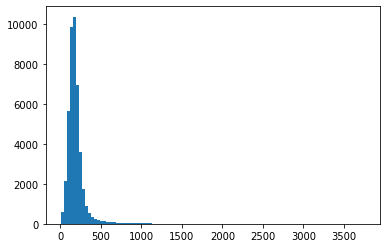

In [10]:
plt.hist(NOZ.avgTimeOnPage, 100)
plt.show()

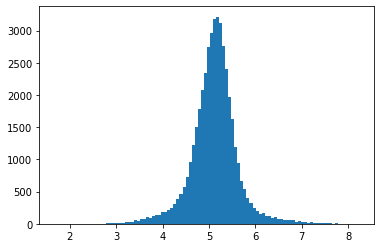

In [11]:
plt.hist(NOZ.log_avgTimeOnPage, 100)
plt.show()

In [17]:
NOZ[["avgTimeOnPage", "log_avgTimeOnPage"]].head(20)

,avgTimeOnPage,log_avgTimeOnPage
articleId,,
32,160.775281,5.080008
56,242.228288,5.489881
186,105.578947,4.659459
374,473.087912,6.159281
409,449.313725,6.107721
823,286.117647,5.656403
1210,510.305085,6.235009
1248,551.532609,6.312701
1326,1302.856287,7.172314


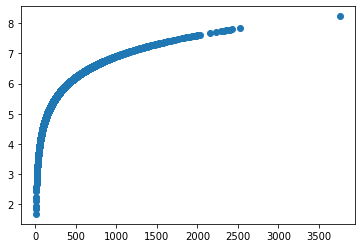

In [20]:
plt.scatter(NOZ.avgTimeOnPage, NOZ.log_avgTimeOnPage)

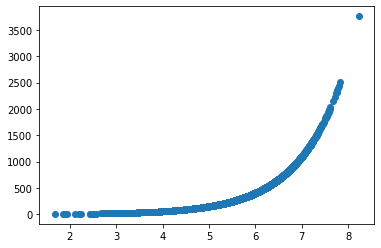

In [21]:
plt.scatter(NOZ.log_avgTimeOnPage, NOZ.avgTimeOnPage)